EXPLORATORY DATA ANALYSIS

In [ ]:
!pip install -q kaggle
import re
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from wordcloud import WordCloud, STOPWORDS
from os import path

import pandas as pd
import matplotlib.pyplot as plt
import re
import time
import warnings
import sqlite3
from sqlalchemy import create_engine # database connection
import csv
import os
warnings.filterwarnings("ignore")
import datetime as dt
import numpy as np
from nltk.corpus import stopwords
from sklearn.decomposition import TruncatedSVD
from sklearn.preprocessing import normalize
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.manifold import TSNE
import seaborn as sns
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix
#from sklearn.metrics.classification import accuracy_score, log_loss
from sklearn.metrics import log_loss
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import Counter
from scipy.sparse import hstack
from sklearn.multiclass import OneVsRestClassifier
from sklearn.svm import SVC
#from sklearn.cross_validation import StratifiedKFold 
from collections import Counter, defaultdict
from sklearn.calibration import CalibratedClassifierCV
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
import math
from sklearn.metrics import normalized_mutual_info_score
from sklearn.ensemble import RandomForestClassifier



from sklearn.model_selection import cross_val_score
from sklearn.linear_model import SGDClassifier
#from mlxtend.classifier import StackingClassifier

from sklearn import model_selection
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_recall_curve, auc, roc_curve

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"suryamunjal","key":"376b73a1d8c76f470856f9ab7d5318e5"}'}

In [ ]:
!mkdir ~/.kaggle

In [ ]:
!cp kaggle.json ~/.kaggle/

In [ ]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d akshayaki/fakenews

 48% 17.0M/35.6M [00:00<00:00, 35.3MB/s]
100% 35.6M/35.6M [00:00<00:00, 57.4MB/s]


In [ ]:
!unzip fakenews.zip

Archive:  fakenews.zip
  inflating: News.csv                


importing all the necessary Libraries

In [ ]:
import pandas as pd
import numpy as np

Reading the Data Set

In [ ]:
df=pd.read_csv('News.csv',nrows=20000)

In [ ]:
df.head()

,Unnamed: 0,title,text,subject,date,Labels
0,0,GRAPHIC RIOT VIDEOS EXPOSE THUGS ATTACKING ELD...,youngers these days are becoming so moist pic....,politics,"Sep 22, 2016",Fake
1,1,BIG BROTHER: FEDS WANT YOUR DOCTOR TO WARN YOU...,totally out of bounds! This is so wrong and so...,Government News,"Jun 26, 2015",Fake
2,2,BLACK LIVES MATTER TERRORISTS May Be Shut Down...,ter ror ist ter r st/ noun a person who uses ...,politics,"Dec 23, 2015",Fake
3,3,EMBARRASSING: Obama Explains How He Will ‘Rebu...,re buke r byo ok/ verb 1. express sharp disapp...,left-news,"Nov 25, 2015",Fake
4,4,OHIO ELECTOR TORCHES Anti-Trump Letters He Rec...,pic.twitter.com/KMnLrwB6t1 Richard K. Jones (...,politics,"Dec 21, 2016",Fake


In [ ]:
df.shape

(20000, 6)

In [ ]:
df.columns

Index(['Unnamed: 0', 'title', 'text', 'subject', 'date', 'Labels'], dtype='object')

from our column names it seems that column "unnamed and  column date are not important with respect to this problem. So we will delete those columns

In [ ]:
df=df[['title','text','subject','Labels']]

In [ ]:
df.head(2)

,title,text,subject,Labels
0,GRAPHIC RIOT VIDEOS EXPOSE THUGS ATTACKING ELD...,youngers these days are becoming so moist pic....,politics,Fake
1,BIG BROTHER: FEDS WANT YOUR DOCTOR TO WARN YOU...,totally out of bounds! This is so wrong and so...,Government News,Fake


In [ ]:
df['Labels'].value_counts()

Fake    10080
True     9920
Name: Labels, dtype: int64

In [ ]:
df['Labels']=df['Labels'].map({'Fake': 0, 'True': 1})

In [ ]:
#this is our dataframe
df.head()

,title,text,subject,Labels
0,GRAPHIC RIOT VIDEOS EXPOSE THUGS ATTACKING ELD...,youngers these days are becoming so moist pic....,politics,0
1,BIG BROTHER: FEDS WANT YOUR DOCTOR TO WARN YOU...,totally out of bounds! This is so wrong and so...,Government News,0
2,BLACK LIVES MATTER TERRORISTS May Be Shut Down...,ter ror ist ter r st/ noun a person who uses ...,politics,0
3,EMBARRASSING: Obama Explains How He Will ‘Rebu...,re buke r byo ok/ verb 1. express sharp disapp...,left-news,0
4,OHIO ELECTOR TORCHES Anti-Trump Letters He Rec...,pic.twitter.com/KMnLrwB6t1 Richard K. Jones (...,politics,0


Checking for missing values --- we can see there are no missing values

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    20000 non-null  object
 1   text     20000 non-null  object
 2   subject  20000 non-null  object
 3   Labels   20000 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 625.1+ KB


In [ ]:
df.isna().sum()   

title      0
text       0
subject    0
Labels     0
dtype: int64

In [ ]:
#text has some values which are empty strings
len(df[df['text']==' '])

0

In [ ]:
len(df[df['title']==' '])


0

In [ ]:
df['text'] = df['text'].replace(' ', np.nan)
print(len(df[df['text']==' ']))

0


In [ ]:
df['text'].isnull().sum()

0

In [ ]:
df.dropna(inplace = True) 
df.shape

(20000, 4)

Distribution of our data...whether there is any sort of imbalancy

In [ ]:

df['Labels'].value_counts()

0    10080
1     9920
Name: Labels, dtype: int64

In [ ]:
a=df['Labels'].value_counts()[0]/(df['Labels'].value_counts()[0]+df['Labels'].value_counts()[1])*100
b=df['Labels'].value_counts()[1]/(df['Labels'].value_counts()[0]+df['Labels'].value_counts()[1])*100

print("percentage of fake data points are",a,"%")
print("percentage of true data points are",b,"%")

percentage of fake data points are 50.4 %
percentage of true data points are 49.6 %


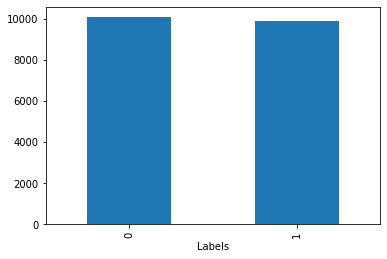

In [ ]:
df.groupby("Labels")['Labels'].count().plot.bar()

we can see our dataset is not imbalanced

Checking for Duplicates

In [ ]:
#checking whether there are any repeated pair of questions

pair_duplicates = df[['title','text','Labels','subject']].groupby(['title','text','Labels','subject']).count().reset_index()

print ("Number of duplicate questions",df.shape[0]-(pair_duplicates).shape[0] )

Number of duplicate questions 77


In [ ]:
pair_duplicates.shape[0]

19923

In [ ]:
#original no of rows
df.shape[0]

20000

In [ ]:
df.drop_duplicates(inplace = True)

In [ ]:
df.shape

(19923, 4)

BASIC FEATURE EXTRACTION

let us now construct 9 new features 
*  title_words
*  text_words
*  title_length
*  text_item
*  count_punct
*  no_title_words
*  unique_words
*  has_url
*  no of special character










In [ ]:
#GETTING NO OF WORDS IN BOTH TITLE AND TEXT
df['title_words']=df['title'].apply(lambda row:len(row.split()))
df['text_words']=df['text'].apply(lambda row:len(row.split()))

In [ ]:
#getting length of both title and text
df['title_length']=df['title'].str.len()
df['text_length']=df['text'].str.len()

In [ ]:
#lets count the no of punctuations in title column
#https://stackoverflow.com/questions/58252056/count-punctuation-in-a-dataframe-column
import string
count = lambda l1,l2: sum([1 for x in l1 if x in l2])

df['count_punct'] = df['title'].apply(lambda s: count(s, string.punctuation))

In [ ]:
#no of title words (words which start with capital letter and rest small)
def title(x):
  a=len([i for i in x.split() if i.istitle()])
  return a
df['no_title_words']=df['title'].apply(lambda x:title(x))

In [ ]:

#lets create one more feature--- no unique words in title 
df['unique_words']=df['title'].apply(lambda x:len(set(x.split())))

In [ ]:
#A feature if text contains a url or not
def has_url(x):
  URLPATTERN = r'(https?://\S+)'
  c=len(re.findall(URLPATTERN, x))
  if c>0:
    return 1
  else:
    return 0
df['has_url'] = df.text.apply(lambda x:has_url(x))

In [ ]:
#lets calculate no of special characters in title
#https://stackoverflow.com/questions/59687650/how-to-count-special-chars-in-column-in-pandas
df['no_of_special_character'] = df["title"].apply(lambda p: sum( not p.isalpha() for q in p ))

In [ ]:
df.columns

Index(['title', 'text', 'subject', 'Labels', 'title_words', 'text_words',
       'title_length', 'text_length', 'count_punct', 'no_title_words',
       'unique_words', 'has_url', 'no_of_special_character'],
      dtype='object')

NOW LETS ANALYSE OUR FEATURES

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


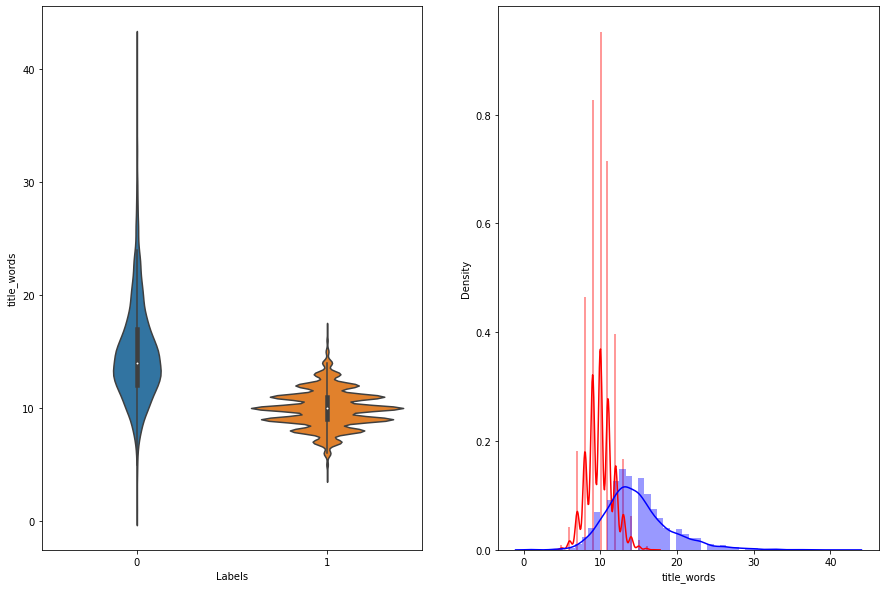

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


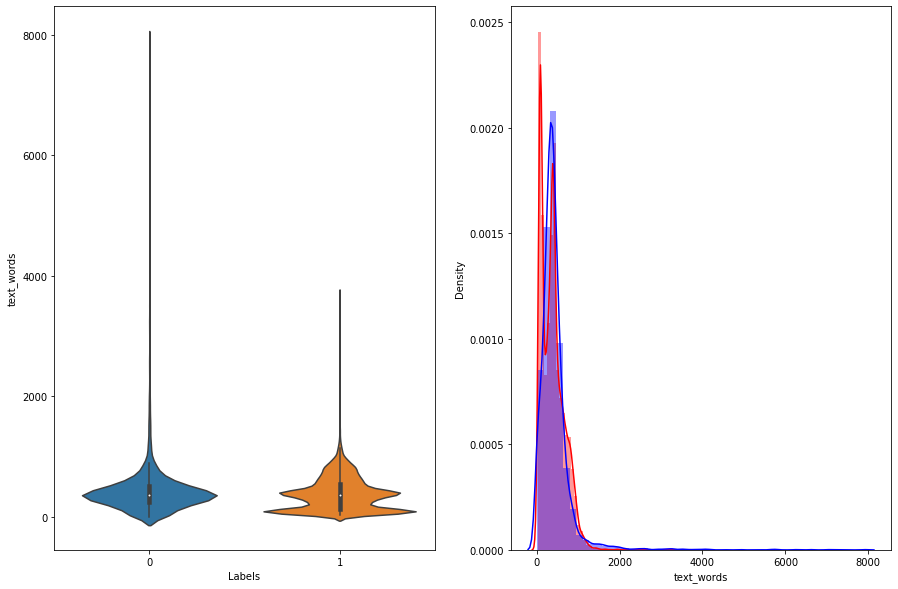

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


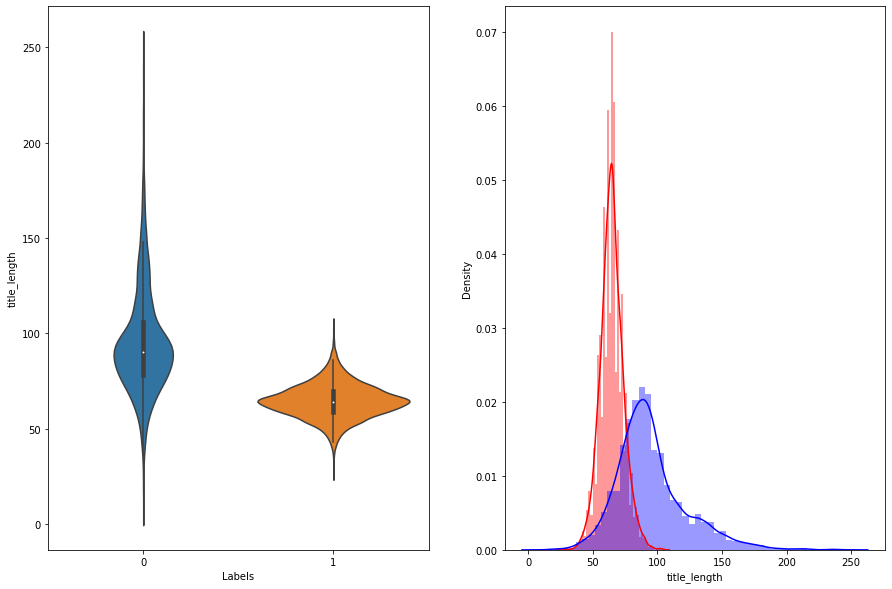

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


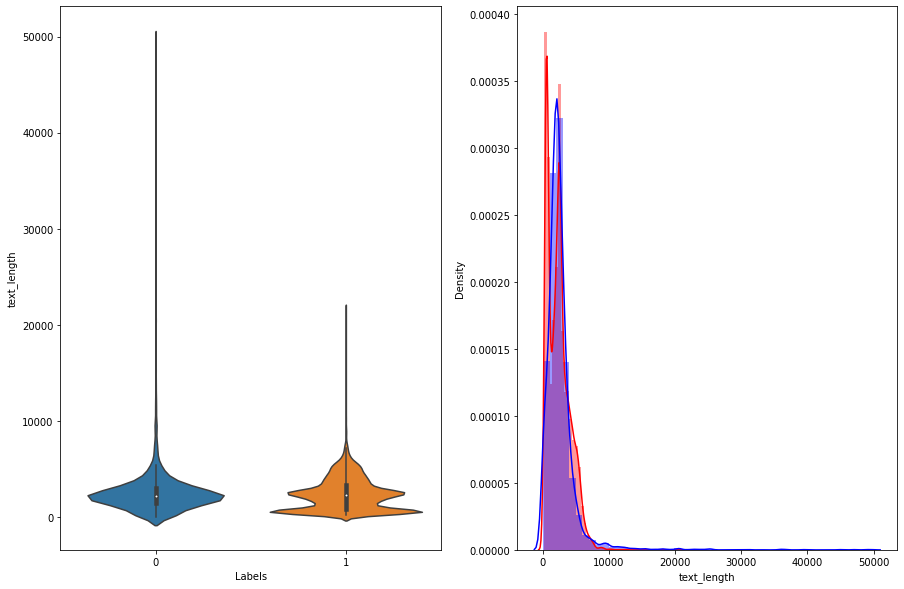

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


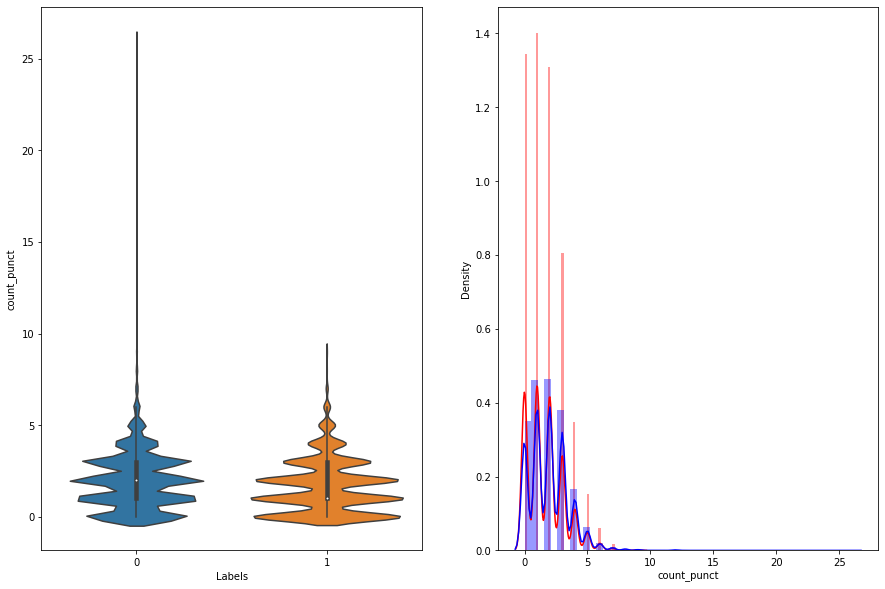

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


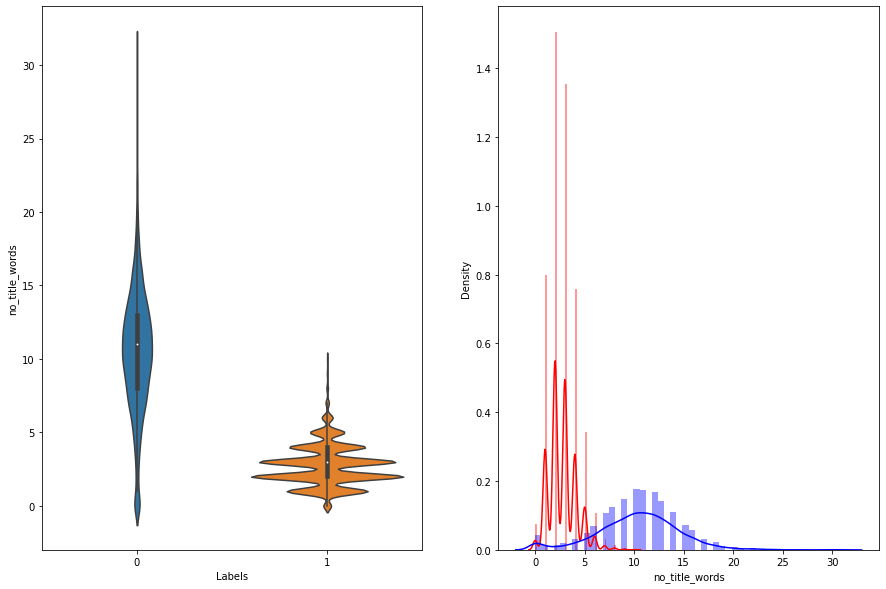

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


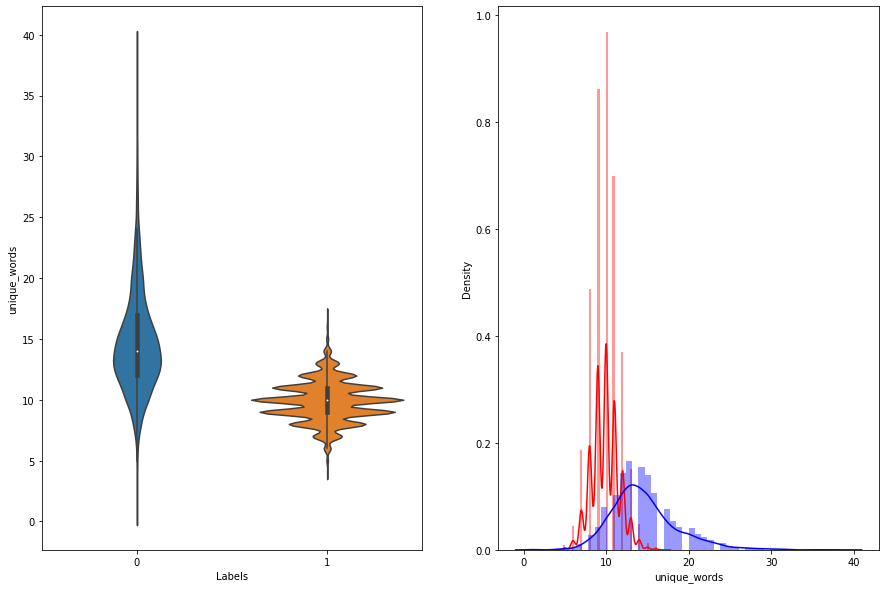

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


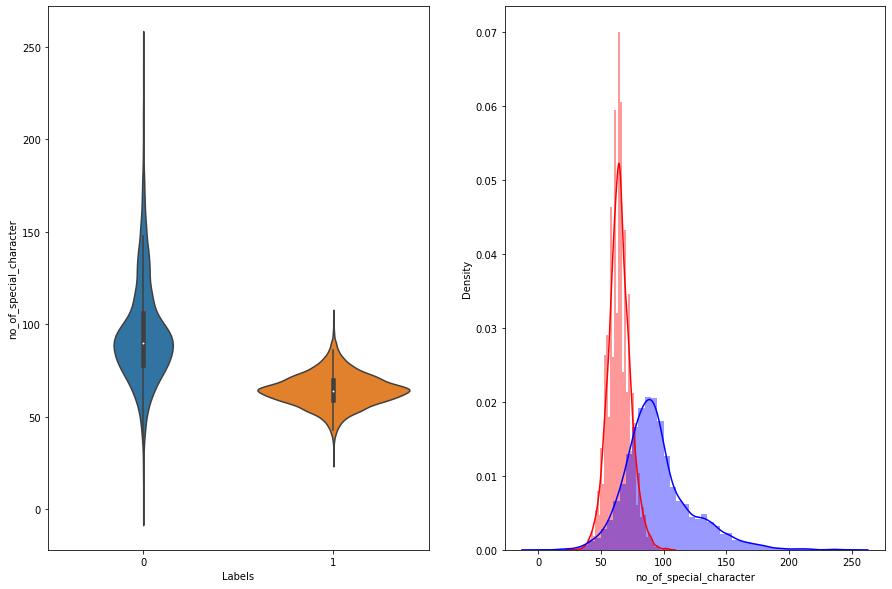

In [ ]:
l=['title_words', 'text_words',
       'title_length', 'text_length', 'count_punct', 'no_title_words',
       'unique_words', 'no_of_special_character']
for feature in l:
    plt.figure(figsize=(15, 10))

    plt.subplot(1,2,1)
    sns.violinplot(x = 'Labels', y = feature, data = df[0:])


    plt.subplot(1,2,2)
    sns.distplot(df[df['Labels'] == 1.0][feature][0:] , label = "1", color = 'red')
    sns.distplot(df[df['Labels'] == 0.0][feature][0:] , label = "0" , color = 'blue' )
    plt.show()

from the above  plots we can see that features 'title_words', 
'title_length','no_title_words','unique_words','no_of_special_character' seems to good feature for our model

features like text_length', 'count_punct','text_words'might not be that useful.

In [ ]:
#analysing subject and has_url features ---- theses are categorical features
#Univariate Analysis on Gene Feature
df_real=df[df['Labels']==1]
df_fake=df[df['Labels']==0]

df_fake['subject'].value_counts()

News               3842
politics           3060
left-news          2003
Government News     756
US_News             209
Middle-east         208
Name: subject, dtype: int64

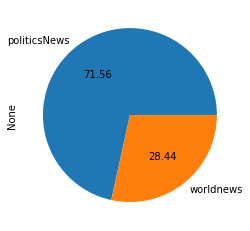

In [ ]:
df_real=df[df['Labels']==1]
df_real.groupby('subject').size().plot(kind='pie', autopct='%.2f')

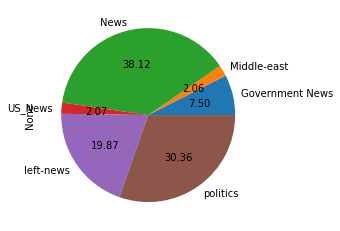

In [ ]:
df_fake=df[df['Labels']==0]
df_fake.groupby('subject').size().plot(kind='pie', autopct='%.2f')

from our observation, subject feature can be an important feature for our problem as can be seen from pie charts. For true label we only have 2 categories in data, so this can be an important label for us.

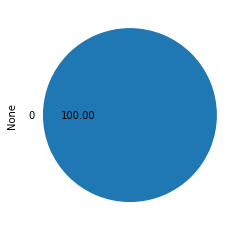

In [ ]:
#has_url feature  #has_url 0 means no url
df_fake=df[df['Labels']==0]
df_real=df[df['Labels']==1]
df_real.groupby('has_url').size().plot(kind='pie', autopct='%.2f')

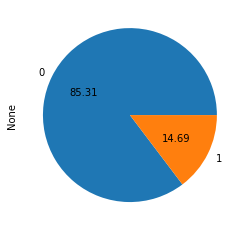

In [ ]:
df_fake.groupby('has_url').size().plot(kind='pie', autopct='%.2f')


We can see that off all the news labeled as fake, if a news text has url in it, there is high chance of that being fak news

..

DATA CLEANING

In [ ]:

import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

from tqdm import tqdm
preprocessed_title = []
# tqdm is for printing the status bar
for sentance in tqdm(df['title'].values):
    sentance = re.sub(r"http\S+", "url", sentance)  #removing urls with space
    sentance = BeautifulSoup(sentance, 'lxml').get_text() # removes tags like <br>
    sentance = decontracted(sentance)
    sentance = re.sub("\S*\d\S*", "", sentance).strip()  # remove words with numbers 
    sentance = re.sub('[^A-Za-z]+', ' ', sentance)  ##remove spacial character:
    sentance = ' '.join(e.lower() for e in sentance.split() if e.lower() not in stopwords)
    preprocessed_title.append(sentance.strip())


preprocessed_text = []
for sentance in tqdm(df['text'].values):
    sentance = re.sub(r"http\S+","url", sentance)  #removing urls with space
    sentance = BeautifulSoup(sentance, 'lxml').get_text() # removes tags like <br>
    sentance = decontracted(sentance)
    sentance = re.sub("\S*\d\S*", "", sentance).strip()  # remove words with numbers 
    sentance = re.sub('[^A-Za-z]+', ' ', sentance)  ##remove spacial character:
    sentance = ' '.join(e.lower() for e in sentance.split() if e.lower() not in stopwords)
    preprocessed_text.append(sentance.strip())





[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
100%|██████████| 19923/19923 [00:40<00:00, 491.83it/s]


In [ ]:
df['proc_title']=preprocessed_title
df['proc_text']=preprocessed_text
#dropping the original title and text column
df.drop(['title','text'],inplace=True,axis=1)

In [ ]:
#code for word cloud..

df_fake = df[df['Labels'] == 0]
df_real = df[df['Labels'] == 1]

# Converting 2d array of q1 and q2 and flatten the array: like {{1,2},{3,4}} to {1,2,3,4}
p = np.dstack([df_fake["proc_title"], df_fake["proc_text"]]).flatten()
n = np.dstack([df_real["proc_title"], df_real["proc_text"]]).flatten()

print ("Number of data points in class 1 (duplicate pairs) :",len(p))
print ("Number of data points in class 0 (non duplicate pairs) :",len(n))

#Saving the np array into a text file
np.savetxt('train_p.txt', p, delimiter=' ', fmt='%s')
np.savetxt('train_n.txt', n, delimiter=' ', fmt='%s')

Number of data points in class 1 (duplicate pairs) : 20156
Number of data points in class 0 (non duplicate pairs) : 19690


In [ ]:
d = path.dirname('.')

textp_w = open(path.join(d, 'train_p.txt')).read()
textn_w = open(path.join(d, 'train_n.txt')).read()

print ("Total number of words in fake news data :",len(textp_w))
print ("Total number of words in real news data :",len(textn_w))

Total number of words in fake news data : 18511331
Total number of words in real news data : 17425601


Word Cloud for Fake news


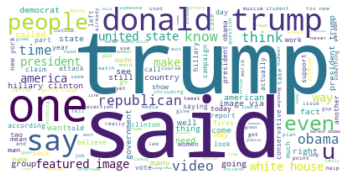

In [ ]:
wc = WordCloud(background_color="white", max_words=len(textp_w))
wc.generate(textp_w)
print ("Word Cloud for Fake news")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

Word Cloud for real news data


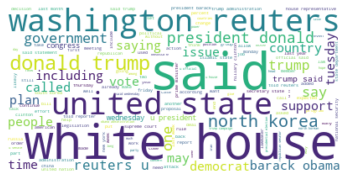

In [ ]:
wc = WordCloud(background_color="white", max_words=len(textn_w))
wc.generate(textn_w)
print ("Word Cloud for real news data")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

Pair plot of features 

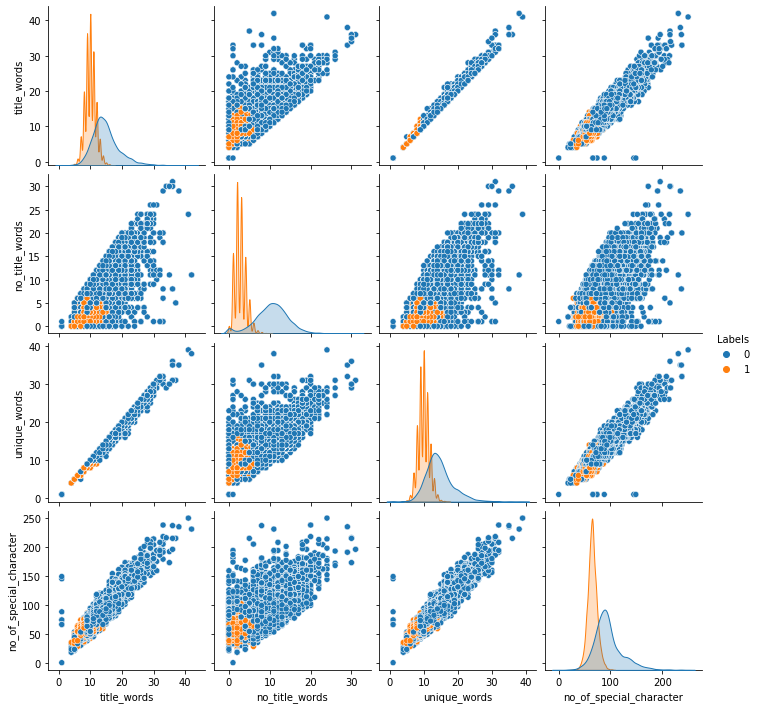

In [ ]:

n = df.shape[0]
sns.pairplot(df[['title_words', 'no_title_words', 'unique_words', 'no_of_special_character', 'Labels']][0:n], hue='Labels', vars=['title_words', 'no_title_words', 'unique_words', 'no_of_special_character'])
plt.show()

USING TSNE FOR VISUALIZATION

In [ ]:
# Using TSNE for Dimentionality reduction for 15 Features(Generated after cleaning the data) to 3 dimention

from sklearn.preprocessing import MinMaxScaler

dfp_subsampled = df[0:5000]
X = MinMaxScaler().fit_transform(dfp_subsampled[['title_words','text_words','title_length','text_length','count_punct','no_title_words','unique_words']])
y = dfp_subsampled['Labels'].values

In [ ]:
from sklearn.manifold import TSNE
tsne2d = TSNE(
    n_components=2,
    init='random', # pca
    random_state=101,
    method='barnes_hut',
    n_iter=1000,
    verbose=2,
    angle=0.5
).fit_transform(X)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5000 samples in 0.005s...
[t-SNE] Computed neighbors for 5000 samples in 0.209s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5000
[t-SNE] Computed conditional probabilities for sample 2000 / 5000
[t-SNE] Computed conditional probabilities for sample 3000 / 5000
[t-SNE] Computed conditional probabilities for sample 4000 / 5000
[t-SNE] Computed conditional probabilities for sample 5000 / 5000
[t-SNE] Mean sigma: 0.029169
[t-SNE] Computed conditional probabilities in 0.328s
[t-SNE] Iteration 50: error = 87.0407562, gradient norm = 0.0430866 (50 iterations in 2.478s)
[t-SNE] Iteration 100: error = 78.3109741, gradient norm = 0.0034232 (50 iterations in 2.211s)
[t-SNE] Iteration 150: error = 77.8122253, gradient norm = 0.0015551 (50 iterations in 3.374s)
[t-SNE] Iteration 200: error = 77.6833496, gradient norm = 0.0008354 (50 iterations in 2.639s)
[t-SNE] Iteration 250: error = 77.6353607, gradient norm = 0.0005368

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


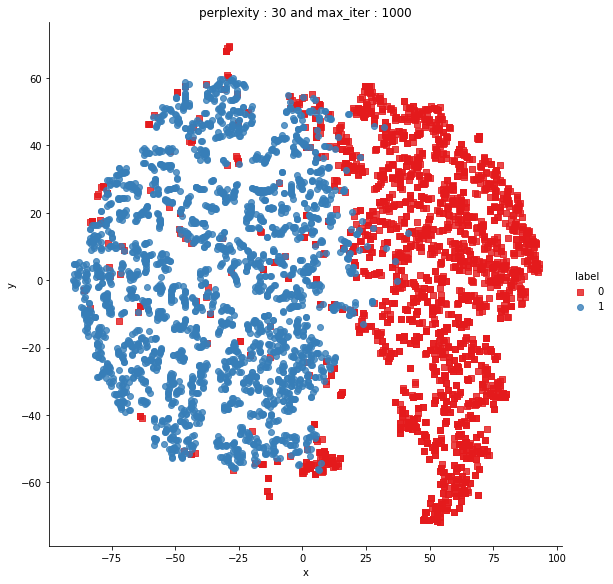

In [ ]:
df2 = pd.DataFrame({'x':tsne2d[:,0], 'y':tsne2d[:,1] ,'label':y})

# draw the plot in appropriate place in the grid
sns.lmplot(data=df2, x='x', y='y', hue='label', fit_reg=False, size=8,palette="Set1",markers=['s','o'])
plt.title("perplexity : {} and max_iter : {}".format(30, 1000))
plt.show()

In [ ]:
df.head(2)

,subject,Labels,title_words,text_words,title_length,text_length,count_punct,no_title_words,unique_words,has_url,no_of_special_character,proc_title,proc_text
0,politics,0,20,138,130,1150,3,11,20,0,130,graphic riot videos expose thugs attacking eld...,youngers days becoming moist pic twitter com c...
1,Government News,0,12,196,67,1207,1,0,12,0,67,big brother feds want doctor warn global warming,totally bounds wrong crazy anyone half brain k...


In [ ]:
df.to_csv('data_after_pre_process.csv')

FEATURIZATION

In [ ]:
import spacy
df3=pd.DataFrame()

In [ ]:
df3['proc_title'] = df['proc_title'].apply(lambda x: str(x))
df3['proc_text'] = df['proc_text'].apply(lambda x: str(x))

In [ ]:
df3.head()

,proc_title,proc_text
0,graphic riot videos expose thugs attacking eld...,youngers days becoming moist pic twitter com c...
1,big brother feds want doctor warn global warming,totally bounds wrong crazy anyone half brain k...
2,black lives matter terrorists may shut mall am...,ter ror ist ter r st noun person uses terroris...
3,embarrassing obama explains rebuke isis attend...,buke r byo ok verb express sharp disapproval c...
4,ohio elector torches anti trump letters receiv...,richard k jones butlersheriff december


In [ ]:
df3.shape

(19923, 2)

In [ ]:
import spacy

APPLYING TFIDF BASED WORD2VEC

In [ ]:
from types import new_class
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
# merge texts
news = list(df3['proc_title']) + list(df3['proc_text'])

tfidf = TfidfVectorizer(lowercase=False, )
tfidf.fit_transform(news)

# dict key:word and value:tf-idf score
word2tfidf = dict(zip(tfidf.get_feature_names(), tfidf.idf_))

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
#using pretrained glove model for our word embedding
!python -m spacy download en_core_web_lg
# !python -m spacy download en_core_web_sm
# !python -m spacy download en_core_web_md
!python -m spacy download en

2022-08-08 05:26:48.354891: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 587.7 MB 8.7 kB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')
2022-08-08 05:28:28.716607: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
⚠ As of spaCy v3.0, shortcuts like 'en' are deprecated. Please use the
full pipeline package name 'en_core_web_sm' instead.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.8 MB 541 kB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [ ]:
# en_vectors_web_lg, which includes over 1 million unique vectors.
nlp = spacy.load('en_core_web_lg')
x=nlp('king')
len(x.vector)

300

In [ ]:
vecs1 = []
i=0
for qu1 in tqdm(list(df3['proc_title'])):
    print(qu1)
    print(i)
    i=i+1
    doc1= nlp(qu1) 
    mean_vec1 = np.zeros([len(doc1), len(doc1[0].vector)])
    for word2 in doc1:
        # word2vec
        vec1 = word2.vector
        # fetch df score
        try:
            idf = word2tfidf[str(word2)]
        except:
            #print word
            idf = 0
        # compute final vec
        mean_vec1 += vec1 * idf
    mean_vec1 = mean_vec1.mean(axis=0)
    vecs1.append(mean_vec1)
df3['proc_title_feat_tf-idf-w2v'] = list(vecs1)

  0%|          | 5/19923 [00:00<06:52, 48.29it/s]

graphic riot videos expose thugs attacking elderly whites black caucus protesting today support video
0
big brother feds want doctor warn global warming
1
black lives matter terrorists may shut mall america files restraining order
2
embarrassing obama explains rebuke isis attending climate change summit video
3
ohio elector torches anti trump letters received crybaby liberals video
4
ohio elector torches anti trump letters received crybaby liberals video
5
iaea chief calls clarity disputed section iran nuclear deal
6
karma manufactured race war backfires missou loses top football recruit says campus control
7
kidding video jeb bush says need pass immigration reform illegals fertile
8
trump supporter whose brutal beating black mob caught video asks happened america video
9
trump supporter whose brutal beating black mob caught video asks happened america video
10
tempers flare dc bikers trump break protester line rioters trap wife trump supporter trump bikers brawl masked protesters vide

  0%|          | 27/19923 [00:00<04:50, 68.58it/s]

tempers flare dc bikers trump break protester line rioters trap wife trump supporter trump bikers brawl masked protesters video
12
view whoopi goldberg co host black people wanna talk white people video
13
view whoopi goldberg co host black people wanna talk white people video
14
cnn host jill stein seen direct evidence anyone hacked voting systems mi wi pa um video
15
cnn host jill stein seen direct evidence anyone hacked voting systems mi wi pa um video
16
breaking mitt romney speaks reporters following dinner trump video
17
tucker carlson destroys smug elector refuses vote trump video
18
comedian tim allen hollywood hypocrites like trump bully support trump get bullied video
19
comedian tim allen hollywood hypocrites like trump bully support trump get bullied video
20
f ck trump f ck white people lefty goes nuts judge jeanine proves clueless freedom speech video
21
f ck trump f ck white people lefty goes nuts judge jeanine proves clueless freedom speech video
22
give em hell jesse d

  0%|          | 44/19923 [00:00<04:22, 75.72it/s]

insanity harry reid claims putin comey conspired make trump president video
28
judge jeanine pirro criminal clintons stop eric trump incredible charity children cancer video
29
half family illegally state senator wants entire state sanctuary state video
30
judge jeanine gets bottom towergate video
31
great speech president trump doubles border protection going restore rule law united states video
32
full interview president trump nails immigration obamacare us military jobs incompetent nancy pelosi video
33
full interview president trump nails immigration obamacare us military jobs incompetent nancy pelosi video
34
football legend jim kelly donald trump took care whole family cancer scare video
35
melania trump gives powerful speech honor international women courage promply attacked lefty women video
36
president trump calls media ignoring pro life march say press cover video
37
unreal cnn panel laughs mocks dr ben carson trump nomination video
38
unreal cnn panel laughs mocks dr ben c

  0%|          | 60/19923 [00:00<04:31, 73.08it/s]

tucker carlson outs human rights exec director partisan hack obviously partisan motives diminish mission video
45
crybaby nancy pelosi taunts trump healthcare bill rookie mistake video
46
crybaby nancy pelosi taunts trump healthcare bill rookie mistake video
47
heated tucker carlson totally shuts radical liberal fox news analyst running dnc chair video
48
newt gingrich punches back democrats mega doses truth bogus russia scandal cultural civil war video
49
newt gingrich punches back democrats mega doses truth bogus russia scandal cultural civil war video
50
newt gingrich punches back democrats mega doses truth bogus russia scandal cultural civil war video
51
liberal bigot destroyed legendary democrat alan dershowitz discussion trump travel ban lying teeth video
52
liberal bigot destroyed legendary democrat alan dershowitz discussion trump travel ban lying teeth video
53
watch standing ovation trump family arrive christmas eve service video
54
wow tucker jesse destroy liberal kooks prot

  0%|          | 76/19923 [00:01<04:28, 73.96it/s]

tucker carlson grills democrat elector supports coup trump video
61
brilliant rep king calls cia director hit job trump calls investigation video
62
bonkers bernie sanders prioritizing jobs climate change stupid dangerous video
63
bonkers bernie sanders prioritizing jobs climate change stupid dangerous video
64
wow chuck todd goes nasty chuck schumer opposition trump nominee looks politically petty video
65
wow chuck todd goes nasty chuck schumer opposition trump nominee looks politically petty video
66
sara carter jay sekulow latest obama spying trump think goes highest levels obama administration video
67
sara carter jay sekulow latest obama spying trump think goes highest levels obama administration video
68
jesse watters panel goes rails debating clinton charged boy trump video
69
thank baby yes feminists go nuts president trump uses endearment refer kellyanne conway thank speech video
70
thank baby yes feminists go nuts president trump uses endearment refer kellyanne conway thank 

  0%|          | 92/19923 [00:01<04:21, 75.90it/s]

bombshell claim israel netanyahu resonds kerry skewed speech video
77
bombshell claim israel netanyahu resonds kerry skewed speech video
78
epic flashback megyn kelly destroyed newt gingrich predictions wrong video
79
kellyanne conway trump terrorism policy need careful extreme vetting video
80
terrorism expert sebastian gorka next london terror attack video
81
trump cabinet member mick mulvaney dc place much rotten thought video
82
trump cabinet member mick mulvaney dc place much rotten thought video
83
radical director sierra club abortion key sustainable population video
84
radical director sierra club abortion key sustainable population video
85
tomi lahren blasts left attacking trump grandson yes grandson video
86
tomi lahren blasts left attacking trump grandson yes grandson video
87
rep peter king intel community carrying disinformation campaign trump video
88
breaking fl voter fraud alert tens thousands mail ballots illegally opened counted verified video
89
breaking fl voter fr

  1%|          | 110/19923 [00:01<04:05, 80.73it/s]

url
94
url
95
url
96
url
97
url
98
url
99
url
100
url
101
url
102
north korea world war iii kick week
103
north korea world war iii kick week
104
homepage
105
gross madonna offers sexual services vote hillary
106
awesome sean spicer gives trump salary away press briefing video
107
awesome sean spicer gives trump salary away press briefing video
108
hillary clinton abruptly cancels fundraiser nc today sleepy sick
109
helicopter crashes saudi arabia killing high ranking officials one day saudi king arrests trump hating billionaire dozens cabinet members
110
three people die avalanches swiss alps
111


  1%|          | 128/19923 [00:01<04:12, 78.44it/s]

korean seismic activity took place km prior tests ctbto
112
swiss government urges voters reject call national ban face veils
113
swiss urge voters keep fee public broadcasters
114
swiss propose house arrest people seen security threats
115
fatal crash closes swiss gotthard road tunnel hours
116
swiss stop seizing income asylum seekers pay upkeep
117
swiss return million stolen funds nigeria
118
presumed new swiss foreign minister seeks fresh start eu talks
119
swiss admit drone test bungle golan heights
120
new plan swiss pin anti extremism hopes prevention
121
switzerland demands release swiss woman abducted sudan
122
swiss strip refugee status libyan preacher
123
switzerland voters likely weigh facial covering ban
124
swiss voters reject raising women retirement age
125
swiss police lift u consular office evacuation
126
three swiss muslim group members charged making al qaeda propaganda
127


  1%|          | 144/19923 [00:01<04:16, 77.12it/s]

two seismic events north korea unlikely man made ctbto
128
ctbto looking unusual seismic activity north korea
129
swiss represent iran saudi interests rivals broke ties
130
swiss ready provide platform dialogue catalan row swiss tv
131
conditions ripe role spain catalonia talks swiss
132
one three swiss uncomfortable outsiders survey
133
many austrian voters still undecided ahead election poll
134
squeaky clean zurich trash department probed dirty dealings
135
europe everything preserve iran nuclear deal eu diplomat
136
swiss right wing blocher trump win warning world establishment
137
blame sanctions u tells nervous iran investors
138
austrian police hunt gunman two killed shooting
139
austrian coalition government sworn monday presidency
140
austria likely next chancellor hopes form govt days paper
141
around people injured swiss train collision police
142
swiss president wants vote clarify country eu position
143
u consular office zurich evacuated blick newspaper
144


  1%|          | 152/19923 [00:02<05:11, 63.57it/s]

swiss french police team counter terrorism raids
145
swiss dismiss eta activist asylum bid free stay
146
swiss police say knife wielding asylum seeker killed officer
147
kurds displaced iraq advance fear reprisals return
148
zimbabwe court postpones former finance minister bail hearing
149
war torn darfur new u aid chief stresses need humanitarian access
150
budapest closer moscow orban grants money russian orthodox churches
151
defiant kurds shrug risk trade war independence vote
152
croatia parliament debates government confidence motion agrokor
153
croatia government survives confidence vote agrokor debt crisis
154
croatian police detain eight former executives agrokor
155


  1%|          | 166/19923 [00:02<05:29, 59.94it/s]

croatian pm plenkovic regrets praljak death hague
156
croatia opposition seeks government confidence vote agrokor handling
157
croatia slovenia fail move forward talks border dispute
158
croatia wants adopt euro within years prime minister
159
croatia jails serb paramilitary commander war crimes
160
usda might want rethink removing country origin meat chinese meatpackers busted
161
report usda gives billion ineligible recipients aka non citizens
162
ca middle school release student council election results winners diverse enough
163
megyn kelly hiding real reason behind sudden announcement extended vacation video
164
video college students react new bizarre gender names told use campus
165
watch happens guy makes undercover video applies min wage jobs says fbi investigation video
166
watch happens guy makes undercover video applies min wage jobs says fbi investigation video
167
breaking anti trump muslim known creating drama post tube kicked delta flight screams discrimination video
16

  1%|          | 182/19923 [00:02<04:50, 67.85it/s]

clinton gets trump finally snap fit rage admits little con artist
169
trump tries throw michelle obama bus falls flat face instead video
170
trump takes credit republican win georgia gets brutally humiliated math
171
awesome happened city council member said trump supporters business charlotte government make day
172
awesome happened city council member said trump supporters business charlotte government make day
173
detroit squatting squatter takes turn
174
detroit squatting squatter takes turn
175
donald trump jennifer hudson family tragedy fantastic media ignores
176
guess spotted vip section clinton rally hillary campaign get creepier
177
guess spotted vip section clinton rally hillary campaign get creepier
178
banana peel tree causes freak ole miss campus hurt frightened upset
179
video unbelievable black judge berates victims home invasion believe
180
video unbelievable black judge berates victims home invasion believe
181
video unbelievable black judge berates victims home invas

  1%|          | 197/19923 [00:02<04:41, 70.11it/s]

awesome rant african american woman fed sanctuary cities racist
185
awesome rant african american woman fed sanctuary cities racist
186
breaking trump wrecks dnc video
187
anti american dem rep declaration independence racist lie video
188
watch people interviewed explain affordable care act better obamacare
189
kaiser ceo loves obamacare thinks aetna wrong
190
starve children else punishment feds michelle obama food plan followed
191
ted cruz arrives bronx put new yorkers tosses protester speaks
192
someone added money rich offshore accounts prepare vomit
193
awesome president trump gives fatherly advice road life ucla basketball players
194
awesome president trump gives fatherly advice road life ucla basketball players
195
robert reich ruined trump supporter week facts
196
new york city values masturbation stations sets men relieve stress midday
197
f cks left obama crushed last trump pride sick burn audio
198
insane racist fired death threats muslims parked close walmart
199
state d

  1%|          | 213/19923 [00:03<04:35, 71.54it/s]

state dept employee tapped oversee hillary email scandal donated campaign months ago
201
flint residents told pay bills poison water may children taken away
202
flint residents told pay bills poison water may children taken away
203
flint residents told pay bills poison water may children taken away
204
make special counsel leading trump russia collusion investigation person gave russians uranium direction crooked hillary
205
make special counsel leading trump russia collusion investigation person gave russians uranium direction crooked hillary
206
dem congressman displays cops pigs painting house floor believe colleagues called painting video
207
sarah palin offers keep eye russian hackers house hilarity ensues tweets
208
photo hillary reading pence private email surfaces heartbreaking thing see week tweets
209
teacher quits job grade muslim students threaten behead video
210
teacher quits job grade muslim students threaten behead video
211
great one brutal image perfectly captures hy

  1%|          | 229/19923 [00:03<04:30, 72.80it/s]

obama flashback hear obama said taking vacations elected video
217
damning new evidence shows israel bribed republican traitors sabotage obama iran deal
218
nyc refused arrest illegals including sexual abuser believe
219
sick trend sologamist describes like bride groom worth video
220
see trolls repeatedly shouted boring donald trump video
221
watch colin kaepernick worst nightmare video
222
sanders campaign withdraws lawsuit dnc investigation shows theft voter data
223
alt right trump lover loses sh kills dad calling nazi
224
woman dance obamas adorable thing ever video
225
update father helps students lefties censored photos pro trump slogans
226
body slamming republican thought important booked printed judge says way
227
dnc insiders vote take bernie win new hampshire away images
228
man child boasts best president ever know long office
229
billion dollar company tells employees allowed react social media pay cuts
230
many different ways arrogant liberals say donald trump never elec

  1%|          | 245/19923 [00:03<04:22, 74.83it/s]

many different ways arrogant liberals say donald trump never elected president video
232
constitution bundy terrorists tote around perverted version real thing video
233
watch trump know moment silence justice scalia video
234
pharma bro yelled hillary remind us still massive douche video
235
holy moly rebel media uncovers illegal usa canada fake refugee trafficking ring wait see vetting video
236
holy moly rebel media uncovers illegal usa canada fake refugee trafficking ring wait see vetting video
237
bam reporter calls obama white house live illusion fantasy pretend things video
238
bam reporter calls obama white house live illusion fantasy pretend things video
239
megyn kelly laughably claims fox news right wing bias video
240
latest news clinton email scandal ruin conservatives whole week video
241
someone posted photo steve bannon giant face zit internet handle tweets
242
watch giuliani demands democrats apologize trump racist birtherism
243
watch hypocrite mitch mcconnell tells d

  1%|▏         | 261/19923 [00:03<04:27, 73.39it/s]

trumped trump response prez candidate bobby jindal attack epic video
248
planned parenthood latest announcement cause right wing blood boil
249
racist steve king doubles nope whites definitely superior race
250
wv republican ag spokeswoman busted appearing racist kkk propaganda video
251
wow trump jr offered ship black people country pay video
252
hillary clinton street art appears los angeles fundraisers
253
even fox news turning trump calls president elect worse clinton video
254
ted cruz bashes michelle obama lame attempt student body president video
255
michigan militia vows take arms protect people flint poisoning
256
donald trump attacked crying baby virginia rally video
257
freshman orientation racist ask asian students math help ask black students play basketball insanity believe
258
freshman orientation racist ask asian students math help ask black students play basketball insanity believe
259
patriot wait go fight gubmint oregon militia needs welfare check first
260
well regu

  1%|▏         | 277/19923 [00:03<04:28, 73.04it/s]

alabama gop mayor calls opponent n losing election screenshots
264
watch rand paul horrendous new anti ted cruz cartoon titled audit ted video
265
internet collectively cringes photographer snaps pic trump nutsack
266
good guy gun accidentally shoots woman saving five times video
267
breaking michael flynn agrees testify russia exchange immunity trump f cked details
268
creepy never believe deranged thing trump fan cardboard donald daily video
269
trump loosened sanctions russian spy agencies americans f cking furious tweets
270
man claims gave trump golden shower evidence back video
271
trump supporter laura ingraham fails fake photo trump sh tty rally crowd
272
trump got banned place proposed melania
273
man stand national anthem shirt thinks american flag lawn chair
274
california assembly passes major legislation keep trump ballot
275
major ad vendor bans breitbart hate speech trump livid
276
breaking jared kushner really woman documents prove
277
trump openly called third world wa

  1%|▏         | 293/19923 [00:04<04:33, 71.77it/s]

watch fox anchor forced admit lied likely clinton indictment
279
hypocrisy democrat senator criticizes president trump moving u embassy jerusalem voted move u embassy jerusalem
280
hypocrisy democrat senator criticizes president trump moving u embassy jerusalem voted move u embassy jerusalem
281
cnn fires black dem party chair new wikileaks email exposes second question donna brazile gave crooked hillary advance debate
282
cnn fires black dem party chair new wikileaks email exposes second question donna brazile gave crooked hillary advance debate
283
irony college anti capitalist group disbands members rich white
284
unreal benghazi liar susan rice shows radical racist roots outrageous comment national security
285
unreal benghazi liar susan rice shows radical racist roots outrageous comment national security
286
mueller right hand man represented staffer destroyed hillary blackberrys hammer
287
mueller right hand man represented staffer destroyed hillary blackberrys hammer
288
lol lef

  2%|▏         | 309/19923 [00:04<04:25, 73.87it/s]

trump challenges fake media going take statues george washington video
294
trump challenges fake media going take statues george washington video
295
showboating democrat walks moment silence texas massacre victims screw nra
296
carly fiorina loses baby parts people indicted instead planned parenthood video
297
stunning development obama gives million us tax dollars mexico build border wall
298
stunning development obama gives million us tax dollars mexico build border wall
299
watch duck dynasty willie robertson makes debut fox news hilarious commentary hillary bernie
300
watch duck dynasty willie robertson makes debut fox news hilarious commentary hillary bernie
301
yikes watch conservative host embarrass trump hater fox outnumbered show
302
watch funniest man american politics ridicule liberals atheists anti american jackasses
303
watch funniest man american politics ridicule liberals atheists anti american jackasses
304
judge jeanine unloads hillary go dead broke worth million gove

  2%|▏         | 325/19923 [00:04<04:27, 73.16it/s]

company drops gloria steinem bullied pro lifers apologizes pushing women rights
310
steve jobs widow announces support revolutionary hillary day hillary busted faking
311
steve jobs widow announces support revolutionary hillary day hillary busted faking
312
steve jobs widow announces support revolutionary hillary day hillary busted faking
313
zing sarah sanders slices dices hack reporter awesome one liner video
314
american made confederate flag factory sees huge change sales charlottesville
315
oklahoma gun range refused service muslim man giving deserve
316
students sent home school wearing traditional swiss clothing considered racist
317
students sent home school wearing traditional swiss clothing considered racist
318
violent protest outside trump rally pittsburgh cops come black lives matter thugs video
319
violent protest outside trump rally pittsburgh cops come black lives matter thugs video
320
nypd man makes anti white remark throws liquid girl face video
321
miss bernie hilla

  2%|▏         | 341/19923 [00:04<04:17, 75.98it/s]

illegal aliens lied court used fake ss committed felonies granted special privileges considered victims
325
sorry mitt gop rules say qualified steal nomination people choice video
326
boxing legend george foreman reveals trump saved broke bankrupt blasts athletes like kaepernick durant disrespecting nation
327
boxing legend george foreman reveals trump saved broke bankrupt blasts athletes like kaepernick durant disrespecting nation
328
great trump video instagram watch
329
brutal new benghazi ad exposes hillary embarrassing incompetence video
330
brutal new benghazi ad exposes hillary embarrassing incompetence video
331
someone snapped best photo trump ever internet never let forget tweets
332
bombshell trump investigated six intelligence agencies illegal cash payments putin
333
trump started following emergency kittens twitter pretty damn hilarious images
334
warning feds predict trillion dollar debt two key things
335
warning feds predict trillion dollar debt two key things
336
thank

  2%|▏         | 358/19923 [00:04<04:11, 77.70it/s]

rnc chair comment reveals republicans may never turn trump
342
bible study leader crimes girl make skin crawl video
343
whoa state department throws hillary bus gives us one reason vote video
344
yet another asshole rammed bunch protesters car video
345
top bush advisor jumps sinking gop ship
346
american airlines crew hits woman stroller challenges passenger fight video
347
secret memo shows every single congressman could hit russian investigation
348
reagan son slams trump father alive vote gop nominee tweets
349
trump supporter assaulted outside rally san jose media silent video
350
trump supporter assaulted outside rally san jose media silent video
351
plane passengers get brawl one shouts america video
352
another former wh official breaks ranks backs clinton darn good president video
353
former george w bush attorney jumps ship sinking republican party
354
boy shot head responsible gun owner mom leaves weapon kids car
355
wow watch creepy joe biden keep hands body senator kelly a

  2%|▏         | 374/19923 [00:05<04:22, 74.46it/s]

actor james woods destroys leftist time article suggesting u lied n korea torturing otto warmbier died returning coma
359
actor james woods destroys leftist time article suggesting u lied n korea torturing otto warmbier died returning coma
360
flashback wapo headline obama fire john brennan lying one year james clapper caught lying oath
361
flashback wapo headline obama fire john brennan lying one year james clapper caught lying oath
362
breaking bombshell hillary obama holder comey mueller key officials leading trump russia collusion investigation linked huge secret russian nuclear deal
363
breaking bombshell hillary obama holder comey mueller key officials leading trump russia collusion investigation linked huge secret russian nuclear deal
364
dan rather shreds wall street journal dodging duty call trump lies epic rant
365
steve bannon threatens trump removal national security council administration chaos
366
imam slams cbs news trying make terrorist white glad make eyes blue well
36

  2%|▏         | 391/19923 [00:05<04:14, 76.78it/s]

trump favorite news channel tries soothe battered ego gets taken cleaners
375
trump crumbles gop health care meeting even know trumpcare details
376
wow hollywood actress blasts ben affleck posts video showing grabbed hilarie burton breasts taping mtv show
377
dirty truth daca recipients really coming criminal records really got
378
ca fire update jesus fabian gonzalez arrested suspicion arson sanctuary county caught walking away fire lighter pocket
379
ca fire update jesus fabian gonzalez arrested suspicion arson sanctuary county caught walking away fire lighter pocket
380
cowardly chain migration terrorist entered us obama second term mocked president trump failing blow
381
cowardly chain migration terrorist entered us obama second term mocked president trump failing blow
382
trump livid kellyanne conway backlash entire team chaos tweet
383
watch view liberal hags attack meghan mccain defending flag first day new co host
384
watch view liberal hags attack meghan mccain defending flag

  2%|▏         | 399/19923 [00:05<04:22, 74.44it/s]

bernie sanders rocked rallies florida yesterday
392
voter confronts trump could daughters look president trump role model video
393
civil rights icon john lewis got bashed trump twitter response perfect tweet
394
watch president trump beautiful video honoring life rosa parks reminds everyone disgusting way president obama made anniversary parks brave act
395
watch president trump beautiful video honoring life rosa parks reminds everyone disgusting way president obama made anniversary parks brave act
396
wow un ambassador nikki haley blasts un vote tweets list nations voted support president trump declaration jerusalem israel capital
397
cruz dedicates empty seat state union million unborn children instead gun violence victims tweet
398
trump betrays house republicans humiliates trying weaken ethics office tweets
399
eric bolling accuser serial sexual harassment accuser p ssy hat wearing trump hating left wing activist professor
400
eric bolling accuser serial sexual harassment accuser 

  2%|▏         | 423/19923 [00:05<04:20, 74.97it/s]

wow stepson new roy moore accuser makes emotional video says stepmom lying whatever reason truly sorry
407
left goes nuts antifa woman attacking trump supporter got punched photo revealed hand video
408
left goes nuts antifa woman attacking trump supporter got punched photo revealed hand video
409
trump gets destroyed chuck todd sleepy eyes twitter attack tweets
410
breaking screen shots website show bulk discounts aborted baby parts planned parenthood partner
411
breaking screen shots website show bulk discounts aborted baby parts planned parenthood partner
412
unbelievable photos show media hiding biggest story time rise violent anti american democrat party
413
unbelievable photos show media hiding biggest story time rise violent anti american democrat party
414
prisoners going strike across united states end legal slavery
415
stunning photos emerge west point graduate infantry officer supporting kneeling national anthem communism social media
416
stunning photos emerge west point gr

  2%|▏         | 440/19923 [00:06<04:06, 79.12it/s]

build wall house voted funding trump wall partisan vote
423
getting want christmas worry hillary tree topper excuse
424
gop consultant tells black reporter wants choke calling republican racism video
425
outrageous report epa wasteful spending performance bonuses bad pr campaign spending blow mind
426
democrats sell promo shirt democrats give sh people low go
427
face activism supreme court justices america accepted judges never render objective opinion
428
leftist actress caught mic blaming trump victory hurricanes video
429
pelosi unhinged gop tax reform bill brazen theft violence founder vision video
430
clinton got kaine pence got plane
431
obama criticizes separation powers republicans imagine would turn u cuba
432
hillary vp nominee panders blacks done apologized slavery
433
flashback watch ted cruz promise support donald trump republican candidate video
434
unreal doj paying minnesota muslims terrorists
435
nancy pelosi awkward brain freeze asked say something nice trump video
4

  2%|▏         | 456/19923 [00:06<04:15, 76.09it/s]

boom al sharpton humiliated fox host saying cops killed best part watters interview good luck irs
441
tax dollars provide asst professor captive audience required listen religious right worships hole god white supremacist jesus
442
tax dollars provide asst professor captive audience required listen religious right worships hole god white supremacist jesus
443
wait unyielding support traditional marriage video
444
wait unyielding support traditional marriage video
445
wait unyielding support traditional marriage video
446
fox news got slapped racial discrimination lawsuit damn time
447
christian lawyer threatens transgender women gun violence use bathroom
448
f cking traitor trump openly praises putin twitter gets teeth kicked tweets
449
watch maxine waters hits new low trash talks president trump giving eulogy friend funeral
450
watch maxine waters hits new low trash talks president trump giving eulogy friend funeral
451
trump gets hammered video condemning question town hall muslim tr

  2%|▏         | 473/19923 [00:06<04:07, 78.71it/s]

obama racism czar reverend al sharpton calls federal police force
457
obama racism czar reverend al sharpton calls federal police force
458
obama racism czar reverend al sharpton calls federal police force
459
loudmouth musician million debt using racism promote
460
two senators say moving muslim terrorists guantanamo bay states
461
two senators say moving muslim terrorists guantanamo bay states
462
mass exodus democrat party liberal massachusetts trump effect
463
mass exodus democrat party liberal massachusetts trump effect
464
president trump gave huge gift hurricaneharvey relief walking walk
465
fed hillary got awesome answer reasons whyimnotvotingforhillary
466
fed hillary got awesome answer reasons whyimnotvotingforhillary
467
fed hillary got awesome answer reasons whyimnotvotingforhillary
468
trump warns emboldened iran comply nuclear deal
469
trump promises work nato defeat islamic state
470
trump raises possibility eventual legal status illegal immigrants
471
trump says u inter

  2%|▏         | 489/19923 [00:06<04:16, 75.63it/s]

ethnic clash nigeria leaves four police officers dead official
474
suicide bomber kills nigeria mosque attack
475
trump says spoke saudi king aramco nothey consider using u exchanges
476
u navy chief says forces asia may reinforced warships eastern pacific
477
judge jeanine delivers epic hillary slap consider deplorable since started hillary let video
478
whoa france conservative presidential candidate refuses cover head muslim veil walks meeting video
479
paul joseph watson exposes lunacy leftists try separate black lives matter kidnapping torture white disabled teen black thugs video
480
paul joseph watson exposes lunacy leftists try separate black lives matter kidnapping torture white disabled teen black thugs video
481
four britons kidnapped nigeria delta state police
482
slaughtered hindus testament brutality myanmar conflict
483
couple defy hurricane maria roof save pets lots
484
cameroon anglophone regions shut nigeria border protests
485
suspected boko haram raid kills least ca

  2%|▏         | 497/19923 [00:06<04:29, 72.20it/s]

cameroon separatists kill four gendarmes anglophone crisis worsens
490
armyworm hits northern cameroon worsening food crisis
491
cameroon escalates military crackdown anglophone separatists
492
cameroon orders anglophone region total lockdown three days
493
suspected separatist bomb wounds police cameroon anglophone region
494
girl strapped bomb kills five cameroon mosque
495
cameroonian journalist freed terrorism charges dropped
496
exclusive west edges towards punishing myanmar army leaders rohingya crisis sources
497
myanmar rakhine aid workers blocked entering muslim camp amid tension
498
myanmar plays diplomatic card avert u n censure rohingya
499
insurgents truce myanmar says negotiate terrorists
500
u congress members decry ethnic cleansing myanmar suu kyi doubts allegations
501
u congress members decry ethnic cleansing myanmar suu kyi doubts allegations
502
u seeks urgent action myanmar u n eyes million refugees
503
myanmar finds bodies mass grave u n seeks rapid aid increase
5

  3%|▎         | 522/19923 [00:07<04:17, 75.40it/s]

suu kyi says myanmar trying protect citizens strife torn state
505
arrested myanmar reporters two book lovers dedicated craft
506
exploded rohingya insurgents built support assault
507
new fires ravage rohingya villages northwest myanmar sources
508
tillerson press myanmar army chief halt violence rohingya return
509
tillerson meet myanmar general stress need stop violence state dept official
510
myanmar ministers deliver aid trapped rohingya village
511
two dead two wounded shooting incident myanmar bangladesh border
512
u n denies arrested reuters reporters myanmar given information
513
reuters journalists myanmar appear court remanded another days
514
myanmar grant families access two reuters journalists remand period expires media
515
one week myanmar silent whereabouts detained reuters journalists
516
detained journalists informed myanmar filming plans turkish broadcaster says
517
myanmar says two reuters journalists remanded custody
518
number new refugees myanmar bangladesh agen

  3%|▎         | 538/19923 [00:07<04:18, 74.94it/s]

u calling rohingya operation ethnic cleansing unhelpful russian envoy
523
reuters arrests myanmar reporters fear could
524
fires destroy villages myanmar rohingya region sources
525
myanmar army chief says rohingya muslims natives numbers fleeing exaggerated
526
trapped rohingya muslims myanmar get first substantial food aid months
527
myanmar sees bad consequences u imposes sanctions military
528
pope begins myanmar trip shadow rohingya crisis
529
pope meets myanmar military chief shadow rohingya crisis
530
pope heads bangladesh diplomatic balancing act myanmar
531
fire destroys landmark hotel myanmar largest city kills one
532
myanmar military trucks hit landmines troubled rakhine one injured
533
myanmar warns u n scolding could harm talks bangladesh rohingya crisis
534
myanmar says still working u n wants rights investigator fair
535
excessive force solve myanmar rohingya crisis annan panel
536
myanmar says u official barred rohingya conflict zone
537
myanmar army drops charges six 

  3%|▎         | 555/19923 [00:07<04:14, 76.24it/s]

myanmar army opens probe amid reports killings abuse rohingya muslims
539
government take burned myanmar land minister
540
two reuters journalists arrested myanmar face official secrets charges
541
myanmar suu kyi visit china amid western criticism rohingya exodus
542
myanmar government says case reuters journalists proceed
543
myanmar military appoints general probe mass grave rakhine state
544
myanmar military says investigating mass grave rakhine state
545
myanmar military denies atrocities rohingya replaces general
546
myanmar police arrest buddhist monk u embassy protest newspaper says
547
myanmar takes first step ease buddhist muslim tension
548
eu calls equal rights myanmar troubled rakhine
549
rights group accuses myanmar crimes humanity
550
myanmar blames bangladesh delaying accord repatriating rohingya
551
myanmar says bodies hindu villagers found rakhine state
552
ten bodies found mass grave myanmar army newspaper
553
myanmar bangladesh sign rohingya return deal myanmar offi

  3%|▎         | 571/19923 [00:07<04:11, 76.87it/s]

least killed myanmar rohingya insurgents stage major attack
555
rohingya insurgents open peace myanmar ceasefire ending
556
myanmar operation rohingya hallmarks ethnic cleansing u congress members say
557
myanmar operation rohingya hallmarks ethnic cleansing u congress members say
558
first myanmar ethnic cleansing unites suu kyi party army public
559
rights watchers slam myanmar ban protests biggest city
560
rights groups say outside monitors needed rohingya return myanmar
561
myanmar army facebook posts covering key period offensive hidden
562
china xi discusses rohingya crisis myanmar army chief
563
detained reuters journalist wrote children book nature absence
564
al qaeda warns myanmar punishment rohingya
565
rohingya fled myanmar violence bangladesh
566
myanmar says probe two reuters journalists almost finished court case follow
567
myanmar journalists group black shirts arrest reuters reporters
568
u n rejects myanmar claim agreed help build housing refugees
569
brics countries 

  3%|▎         | 587/19923 [00:07<04:08, 77.91it/s]

putin calls tougher north korea sanctions senseless warns global catastrophe
572
putin warns u supply ukraine defensive weapons
573
russia says u actions towards consulates istate hooliganism
574
putin russia reserves right cut u diplomatic mission
575
xi urges brics grouping push international order
576
china pledges new funding brics group opposes protectionism
577
china xi wants put relations india right track
578
china xi says brics countries deepen coordination quicken reform global economic governance
579
whoa sesame street using bert ernie sexually transmitted diseases ad
580
meathead rob reiner calls war trump twitter user warns hollywood folks careful might get war
581
meathead rob reiner calls war trump twitter user warns hollywood folks careful might get war
582
watch republican heartlessly tells mother son wants healthcare get better job
583
trump lawyers never talked without corroborating witness lies much
584
loser trump fails miserably monday night football ratings soar


  3%|▎         | 603/19923 [00:08<04:14, 75.86it/s]

watch barry lose cool interview putin challenging leadership mr president
589
sanders supporters ready raise hell dnc e mail leaks prove dems stole election bernie
590
sanders supporters ready raise hell dnc e mail leaks prove dems stole election bernie
591
florida parents wife beating husband fly india help beat disobedient wife might deported
592
list obama historic firsts aka chicago politics corrupted washington even
593
list obama historic firsts aka chicago politics corrupted washington even
594
list obama historic firsts aka chicago politics corrupted washington even
595
apology issued la times ny times columnists go sarahsanders mock weight southern accent
596
apology issued la times ny times columnists go sarahsanders mock weight southern accent
597
epic commie obama pictured vietnam president front
598
epic commie obama pictured vietnam president front
599
epic commie obama pictured vietnam president front
600
two muslim uber drivers charged multiple sex assaults college stud

  3%|▎         | 621/19923 [00:08<04:01, 79.80it/s]


604
young man delivers powerful message liberals put fists take masks change going lose video
605
hillary unfit serve cover imploding video
606
hillary unfit serve cover imploding video
607
whaaat dnc platform member makes extreme statement gun ownership video
608
breaking bombshell dem congressmen phone numbers e mails hacked pelosi pc hacked
609
epic brutal truth crime black community media refuses tell video
610
epic black conservative calls cnn anchor trash talking trump sit attack president video
611
epic black conservative calls cnn anchor trash talking trump sit attack president video
612
watch hispanic man used beat trump supporters gets choked passionate speech lying media turned trump supporter
613
watch hispanic man used beat trump supporters gets choked passionate speech lying media turned trump supporter
614
dnc mega donor ditches dems scathing message bunch dumb ass political hacks
615
breaking fired fbi director james comey
616
breaking fired fbi director james comey
61

  3%|▎         | 639/19923 [00:08<03:59, 80.47it/s]

badass israeli stabbed palestinian pulls knife neck next stunning
622
bill clinton ex lover spills beans lumpy hillary
623
leading democrats call investigation al franken msnbc defends groping mock groping video
624
busted hillary media cheerleaders caught hiding truth corrupt candidate ever live interviews video
625
busted hillary media cheerleaders caught hiding truth corrupt candidate ever live interviews video
626
year old texan woman gets put charge
627
year old texan woman gets put charge
628
registered sex offender arrested harassing little girls girl bathroom
629
bill clinton rape accusers speak terrified hillary video
630
bill clinton rape accusers speak terrified hillary video
631
jimmy kimmel asks people street obama supreme court nominee video
632
unreal obama speech writers laugh like crazy one devastating lie told american people video
633
unfithillary rests parties donors key swing state polls show trump hard work paying
634
unfithillary rests parties donors key swing st

  3%|▎         | 648/19923 [00:08<04:12, 76.44it/s]

french fleur de lis new orleans joins list racist symbols
639
breaking supreme court blocks texas abortion restrictions
640
breaking russia backfires clinton campaign dnc busted huge discovery fake salacious trump dossier
641
video screaming dreamers force shaken nancy pelosi stage liar
642
podesta threatens tucker exposing truth video
643
incoming freshmen put notice welcome letter u chicago dean students trigger warning crybabies stay home
644
kidding hillary supporters get us killed video
645
kidding hillary supporters get us killed video
646
grab popcorn bernie sanders campaign manager hammers dnc holding campaign hostage
647
breaking wikileaks releases hillary speech brazilian bankers dream open borders
648
breaking wikileaks releases hillary speech brazilian bankers dream open borders
649
wow anti trump protesters really know protesting video
650
wow anti trump protesters really know protesting video
651
obama stammers like crazy trying slam trump video
652
astonishing corruption

  3%|▎         | 672/19923 [00:09<04:11, 76.58it/s]

spineless gop proves majority means nothing senator schumer brags funding border wall budget deal reflects democrats principles
656
lol desperate kathy griffin makes home video complain getting work trump beheading stunt takes page hillary playbook blames everyone else end career
657
lol desperate kathy griffin makes home video complain getting work trump beheading stunt takes page hillary playbook blames everyone else end career
658
angry commentator threatens trump government gonna kill guy video
659
angry commentator threatens trump government gonna kill guy video
660
libertarian presidential candidate gary johnson embraces every manufactured liberal crisis black lives matter global warming colonization mars video
661
libertarian presidential candidate gary johnson embraces every manufactured liberal crisis black lives matter global warming colonization mars video
662
rush limbaugh warns gop choose trump cruz get enough delegates
663
watch defiant muslim refugees tell british citize

  3%|▎         | 688/19923 [00:09<04:23, 73.04it/s]

coal worker confronts hillary clinton putting coal business video
674
mike ditka slams nfl players oppression last years respect country country playing football
675
mike ditka slams nfl players oppression last years respect country country playing football
676
bam hannity unloads cruz delegates audio
677
bam ann coulter exposes delta flight attendant group confirms targeted
678
bam ann coulter exposes delta flight attendant group confirms targeted
679
lol cnn tells viewers illegal read wikileaks emails tell video
680
lol cnn tells viewers illegal read wikileaks emails tell video
681
yikes tomi lahren demolishes hillary dare blame donald trump excuse americans die watch benghazi video
682
yikes tomi lahren demolishes hillary dare blame donald trump excuse americans die watch benghazi video
683
breaking internal memo obama corrupt epa flint worth going limb
684
breaking internal memo obama corrupt epa flint worth going limb
685
breaking internal memo obama corrupt epa flint worth going 

  4%|▎         | 705/19923 [00:09<04:15, 75.21it/s]

words stunning unofficial trump ad blow away video
690
words stunning unofficial trump ad blow away video
691
clueless hollywood hacks attend refugee themed event
692
wow fox reporter goes seiu thug telling black protester allowed speak video
693
whoa well known democrats go nuclear hillary clinton supporters video
694
whoa well known democrats go nuclear hillary clinton supporters video
695
view loudmouth liberal joy behar calls bill clinton rape victims tramps show targeted women video
696
view loudmouth liberal joy behar calls bill clinton rape victims tramps show targeted women video
697
former mexican prez sends middle finger trump days apology play around us jump walls swim rivers defend
698
former mexican prez sends middle finger trump days apology play around us jump walls swim rivers defend
699
list u states illegal aliens
700
list u states illegal aliens
701
black lives matter terror group tweet insane threats messages celebrating deaths dallas cops
702
ouch left woman landed

  4%|▎         | 721/19923 [00:09<04:26, 72.01it/s]

pregnant pro choice woman asks million ransom baby much would pay stop abortion
707
new normal parenting magazine warns ordinary parents must take action blonde cheerful families could dangerous right wingers
708
new orleans club advertises meet greet dem gov candidate free drinks performers party bus polls early voters videos
709
new orleans club advertises meet greet dem gov candidate free drinks performers party bus polls early voters videos
710
wow news anchor hammers obama pro muslim speech radical mosque video
711
breaking secret recordings clinton foundation caused hostility fighting fbi agents
712
breaking secret recordings clinton foundation caused hostility fighting fbi agents
713
tx valedictorian full ride scholarship yale university reveals illegal alien graduation speech trashes trump video
714
million donated wounded warrior project sales american sniper dvd
715
brilliant newt gingrich trump trust intel community right video
716
romney refused insist obama expose sealed r

  4%|▎         | 737/19923 [00:09<04:18, 74.26it/s]

swiss army chief warns citizens explosive refugee situation tells arm
722
swiss army chief warns citizens explosive refugee situation tells arm
723
fbi warns potential terror attack super bowl white house completely silent
724
fbi warns potential terror attack super bowl white house completely silent
725
video flashback martin luther king jr riots win violent revolution
726
video flashback martin luther king jr riots win violent revolution
727
video flashback martin luther king jr riots win violent revolution
728
secret service agent risks everything denounce trump taking bullet screenshots
729
college student suspended saying thinks black women hot
730
watch indoctrinated college students stunned ugly truth hillary candidate said
731
watch indoctrinated college students stunned ugly truth hillary candidate said
732
veryfakenewscnn busted getting major detail donald trump jr wikileaks story wrong
733
veryfakenewscnn busted getting major detail donald trump jr wikileaks story wrong
734


  4%|▍         | 753/19923 [00:10<04:14, 75.31it/s]

oh canada celebrating world hijab day
738
restaurant owner obliterates customer said woman death ruined new year images
739
workers ivanka trump clothing factory claim extremely low wages abuse
740
white house staff hiding reporters
741
amy schumer response body shaming trolls absolutely perfect image
742
watch oklahoma republican declares rape god
743
trump deplorables freak demand repeal women right vote tweets
744
hillary clinton says half cabinet women elected president
745
female execs striking back pharma using women eye candy video
746
texas republican introduces bill put women prison abortion
747
saudi man threatens backlash new law allowing women drivers burn car
748
priceless anti trump rioter throws tantrum arrested want want want video
749
priceless anti trump rioter throws tantrum arrested want want want video
750
lefty media pulls woman card hillary chose wear white debate trump
751
michelle obama opens whoop trump without ever mentioning name
752
obama crystal clear resp

  4%|▍         | 761/19923 [00:10<04:30, 70.82it/s]

hillary working class upbringing working class another lie lyin hillary
754
netanyahu says respected western opinion leaders hate jewish people video
755
dixie chicks natalie maines unleashes hilarious twitter tirade trump tweets
756
breaking lithuania warns russia preparing war europe
757
sh tty birthday must ivanka trump
758
republican stuns brutally honest reaction americans dying trumpcare video
759
hilarious memes bundy oregon standoff images
760
donald trump releases statement cruz sex scandal hilariously kinda perfect
761
iowa racist beat man allergic black people video
762
nazis whine impending release anti nazi video game video tweets
763
latest house vote proves republicans ready go russian ship
764
bombshell melania trump refuses believe access hollywood tapes bizarre interview video
765
hillary latest one word response trump twitter melting internet tweet
766
patton oswalt dedicates national poetry day donald trump perfect tweet
767
ellen degeneres tells hillary clinton fac

  4%|▍         | 777/19923 [00:10<04:36, 69.18it/s]

cnn accidentally airs raunchy screen capture reply trump tweet hilarious image
769
remember time prince wrote song donald trump listen audio
770
snl head writer knows would hillary emails lose image
771
trump trying discredit bob mueller
772
mississippi landlord evicted interracial couple church told video
773
liberal hollywood suffers worst summer movies years
774
liberal hollywood suffers worst summer movies years
775
trump taking credit inaugural singer album sales pathetic ego fueled tweet
776
watch jake tapper get cornered tmz admits media largely blame trump video
777
elizabeth warren shatters republican effort thwart obama scotus pick
778
watch legendary reporter ted koppel tell hannity right face bad america video
779
officials trump read security briefings treat like toddler
780


  4%|▍         | 784/19923 [00:10<05:28, 58.18it/s]

world trump f ck inherit mess obama video
781
trump made hugely inappropriate threat trumpcare speaking boy scouts video
782
ted cruz bad lip reading everything never knew wanted video
783
watch seth meyers hilarious convincing argument trump chances primaries video
784
heading convention clinton maintains comfortable lead
785
watch rnc chair loses interview refuses answer muslim ban question honestly video
786
ivanka trump rabbi decides speak rnc good reason
787


  4%|▍         | 791/19923 [00:10<07:25, 42.91it/s]

bernie sanders lets chuck todd know willing vice president video
788
clinton extends olive branch sanders work together party platform
789
obama attorney general spit trump face circuit court ruling
790
fbi investigating russian connections far right websites including breitbart infowars etc details
791
beyond parody sean spicer blames obama trump hiring foreign agent michael flynn video


  4%|▍         | 797/19923 [00:11<08:22, 38.05it/s]

792
stephen colbert explains horrifying future gop primary race video
793
bombshell rnc rules committee member says trump needs delegates win video
794
conservatives practically ecstatic idea hillary clinton sick video screenshots
795
kellyanne conway stop talking anderson cooper eye roll video
796
rockettes hitting back forced perform trump help
797
something trump panics mueller investigation closes
798
days job trump major meltdown front world
799
watch joe biden tells us exactly trump brilliantly rips end end video
800


  4%|▍         | 809/19923 [00:11<07:06, 44.84it/s]

adidas flawlessly trolls anti gay bigots slammed valentine day instagram images
801
lego donald trump steals christmas absolutely hilarious video
802
watch wonderful time year trump style
803
watch wonderful time year trump style
804
watch trump adviser stammers grilled chris cuomo hypocrite
805
trump brags number people coming inauguration realize protesters
806
hillary hammers trump awesome list disqualifies president
807
new york magazine confirms trump literally cares one thing winning
808
watch tv news crew go undercover homeless taking credit cards panhandlers living high rent neighborhoods
809
cliven bundy takes charge remaining oregon militiamen says continue occupation indefinitely
810
president trump blasts phony climate change crybabies elected represent citizens pittsburgh paris video
811
president trump blasts phony climate change crybabies elected represent citizens pittsburgh paris video
812


  4%|▍         | 821/19923 [00:11<06:20, 50.21it/s]

snl perfectly skewers trump band malicious merry morons video
813
first look obamas spotted british virgin islands well deserved vacation video
814
trump never looked incompetent china adviser literally found amazon details
815
infinite arrogance obama think supreme court taken obamacare challenge
816
infinite arrogance obama think supreme court taken obamacare challenge
817
fox news editor really creepy suggestion trump vp video
818
judge barred mom seeing baby year unpaid fees resigns
819
watch donald trump hilariously push cruz booze tonight show video
820
lost video watch msnbc mika shamelessly flirt donald trump video
821
lost video watch msnbc mika shamelessly flirt donald trump video
822
wind revealed unknown creature atop trump head people cannot stop watching viral video
823
trump demands investigation accidental death old joe scarborough staffer
824
trump demands investigation accidental death old joe scarborough staffer

  4%|▍         | 833/19923 [00:11<05:58, 53.29it/s]


825
classless old michelle obama goes solo yacht spain flashes photographers high slit skirt seamlessly goes straw hat braless look gangsta
826
watch trump definitely sure obama born usa
827
sarah jessica parker fears attacked killed trump elected seen multiple trump supporters bloodied hillary lib mobs
828
sarah jessica parker fears attacked killed trump elected seen multiple trump supporters bloodied hillary lib mobs
829
mccain f cked senate republicans trumpcare much better way already knew
830
ethiopian muslim monster deported u years performing clitorectomy daughter scissors
831
ethiopian muslim monster deported u years performing clitorectomy daughter scissors
832
obama skip scalia funeral list funerals busy attend
833
dan rather breaks internet searing rebuke trump andrew jackson comment
834
nancy pelosi trolled hell paul ryan trump support amazing tweet
835


  4%|▍         | 845/19923 [00:12<05:51, 54.25it/s]

flashback video shows leftist media members praising use nuclear option confirm liberal supreme court justices
836
flashback video shows leftist media members praising use nuclear option confirm liberal supreme court justices
837
bette midler response trump accepting election results absolutely magical tweet
838
pathetic trump actually needs general babysit constantly
839
san juan mayor video disrespecting constitution takes money video
840
trump offered bizarre excuse russian prostitute urination scandal video
841
good bad ugly aspects obama latest presidential report card image
842
malala yousafzai message trump something everyone needs listen
843
seth macfarlane hits nail head perfectly explains hollywood hates trump tweet
844
ladies view hilariously roast trump throwing twitter hissy fit snl video
845
rachel dratch brings obvious problem trump one seems saying tweet
846
trump makes startling admission wife run white house
847


  4%|▍         | 858/19923 [00:12<05:34, 56.99it/s]

elizabeth warren mince words reaction trump presumptive nomination
848
stephen king brutally making fun trump twitter right amazing
849
ladies view hammered trump obvious racism glorious video
850
watch violently unhinged trump supporter go full racist go cook burrito b tch
851
trump closed office coordinates russia sanctions
852
remember time hypocrite trump tweeted obama comply record releases
853
former reagan official voting hillary tells trump ronald reagan video
854
russia probe new leader disqualified months ago one idiotic statement
855
trump new nickname bernie sanders works better tweet
856
poll shows growing number republicans think trump best option gop
857
breaking new poll shows huge lead hillary trump downward spiral continues
858
death nation executive order voted bring million immigrants america
859
death nation executive order voted bring million immigrants america
860


  4%|▍         | 872/19923 [00:12<05:06, 62.21it/s]

missed brilliant daniel hannan socialism versus liberty hitler socialist video
861
missed brilliant daniel hannan socialism versus liberty hitler socialist video
862
court decides scott walker right work law unconstitutional
863
game time fbi manhunt heavily armed deranged anti trump nut job video
864
government gone wild sell cookie go jail video
865
fiscally conservative gop governor begs public pay bills
866
watch bill maher deliver hard truth many republicans want hear video
867
video duck dynasty willie robertson loves donald trump
868
guy made millions selling science kids suggests u adopt policy eliminate kids save earth video
869
guy made millions selling science kids suggests u adopt policy eliminate kids save earth video
870
william shatner blasts social justice warriors criticize trump
871
william shatner blasts social justice warriors criticize trump
872
another trump official decides really good time resign
873
new poll bad news obama manufactured race war
874


  4%|▍         | 888/19923 [00:12<04:32, 69.75it/s]

busted lawyer fbi witness tells ties obama uranium one scandal video
875
breaking female law student busts hillary oh sh guy seeking help scrub hillary name emails wikileaks applauds
876
breaking female law student busts hillary oh sh guy seeking help scrub hillary name emails wikileaks applauds
877
president trump extreme vetting takes next step enough
878
ground zero mosque defeated three story islamic museum muslim prayer space take place video
879
ground zero mosque defeated three story islamic museum muslim prayer space take place video
880
throwing gas racial fire va police confirm governor terry mcauliffe lied weapons hid around charlottesville white nationalists
881
throwing gas racial fire va police confirm governor terry mcauliffe lied weapons hid around charlottesville white nationalists
882
breaking hillary unsecured classified emails cause execution iranian accused working u video
883
breaking hillary unsecured classified emails cause execution iranian accused working u vi

  5%|▍         | 904/19923 [00:12<04:18, 73.68it/s]

whoa ben carson made controversial remarks entire campaign
891
watch rep jim jordan nail hillary huge lie benghazi video
892
wow look paid russia dossier triggered fbi investigate trump
893
wow look paid russia dossier triggered fbi investigate trump
894
sanctimonious open borders paul ryan tanking polls fed voters avenge non trump supporters november
895
fox news announced moderators next gop debate could yuge
896
nevertrumpers coming around jeb son tells texans get behind trump
897
hillary lie way one physician says hillary parkinson disease hillary admits even get convention
898
hillary lie way one physician says hillary parkinson disease hillary admits even get convention
899
austria playing games bans face concealing islamic dress mandates integration course else
900
austria playing games bans face concealing islamic dress mandates integration course else
901
watch wild bill madder ever seen glenn beck racist tea party comment
902
need one pager tax form wilbur ross tax reform vid

  5%|▍         | 921/19923 [00:13<04:11, 75.58it/s]

breaking hillary campaign planned fake grassroots millennial movement steal bernie followers
908
president radical group advised hillary fake concern parents black lives matter victims blame cops pain video
909
president radical group advised hillary fake concern parents black lives matter victims blame cops pain video
910
wow wikileaks dnc planned big federal rewards big donors
911
wikileaks reminds world obama history tapping hacking friends rivals
912
wikileaks reminds world obama history tapping hacking friends rivals
913
uk diplomat says met dnc leaker russian insider video
914
uk diplomat says met dnc leaker russian insider video
915
beautiful girl world ten already dealing sexist attacks images
916
popular actor travels calais jungle garner sympathy migrants refugees attack beat steal phones
917
popular actor travels calais jungle garner sympathy migrants refugees attack beat steal phones
918
leftist prof wants earth constitution speak vatican rollout papal document phony global

  5%|▍         | 938/19923 [00:13<04:03, 78.12it/s]

nyc mayor deblasio says something changing america announces new communist manifesto agenda
925
nyc mayor deblasio says something changing america announces new communist manifesto agenda
926
get trucks run away obama military gives minute warning isis bombing oil tankers
927
get trucks run away obama military gives minute warning isis bombing oil tankers
928
chilling photo captures female suicide bomber carrying baby moments blows
929
chilling photo captures female suicide bomber carrying baby moments blows
930
hillary tells another whopper think check lies
931
preschool kids learn sex marriage anti bias class coming way video
932
unhinged leftist apologizes refugees gang raped
933
best tweet day
934
best tweet day
935
best tweet day
936
obama incarcerating christian refugees u sending back slaughtered
937
lawless obama take executive amnesty supreme court
938
lawless obama take executive amnesty supreme court
939
lawless obama take executive amnesty supreme court
940
lawyer scams fed

  5%|▍         | 954/19923 [00:13<04:11, 75.50it/s]

breaking crooked sec state hillary knew taking million king mohammed vi corrupt morocco might hurt campaign took anyway video
942
breaking crooked sec state hillary knew taking million king mohammed vi corrupt morocco might hurt campaign took anyway video
943
hillary worked feverishly return russian spies operating u midst selling u uranium russia
944
hillary worked feverishly return russian spies operating u midst selling u uranium russia
945
media obsesses ted cruz alleged infidelities ignoring hillary lesbian affairs revealed publication
946
media obsesses ted cruz alleged infidelities ignoring hillary lesbian affairs revealed publication
947
media spin alert fbi predawn raid paul manafort hillary rice lynch powers
948
watch black vanderbilt professor exposes real racists inconvenient truth democrat party
949
watch black vanderbilt professor exposes real racists inconvenient truth democrat party
950
nfl tweets tom brady deflategate appeal denial ignores isaiah crowell image cop thro

  5%|▍         | 971/19923 [00:13<04:13, 74.85it/s]

explains lot trump said fox news destroying dirt using keep network line
957
faisal mohammad isis flag islamic themed manifesto stabbed college students wanted cut someone head fbi rules terrorism
958
video rino strategist karl rove solution gun violence repeal second amendment
959
video rino strategist karl rove solution gun violence repeal second amendment
960
video rino strategist karl rove solution gun violence repeal second amendment
961
needs nancy pelosi congress paul ryan obamatrade deal declassified made public agreed
962
needs nancy pelosi congress paul ryan obamatrade deal declassified made public agreed
963
needs nancy pelosi congress paul ryan obamatrade deal declassified made public agreed
964
flashback radical muslim cleric issued fatwa danish cartoonist found trunk crossing u mexico
965
busted highly likely back hillary server e mails still exist
966
fbi look huma abedin shared computer first time around
967
watch louie gohmert wants lying democrat va governor mcauliffe

  5%|▍         | 987/19923 [00:14<04:06, 76.72it/s]

google facebook attending bilderberg luxury secret policy conference
973
jill stein demanding recount hillary camp using desperate effort stop trump hillary clinton willing risk civil war america video
974
jill stein demanding recount hillary camp using desperate effort stop trump hillary clinton willing risk civil war america video
975
twitter blasts whole foods yet another expensive unnecessary product tweets
976
obama soldiers cause shut st paul mn interstate throw molotov cocktails concrete cops head injure cops attempt video
977
obama soldiers cause shut st paul mn interstate throw molotov cocktails concrete cops head injure cops attempt video
978
trump gave highly classified information russian ambassador right firing comey
979
kidding aside hillary seizure middle q journalists judge video
980
kidding aside hillary seizure middle q journalists judge video
981
granny clinton goes way left fear mongering cause hurricane hermine
982
muslim activists launch voter registration drive k

  5%|▌         | 1003/19923 [00:14<04:17, 73.47it/s]

syrian libyan migrant arrested setting sleeping homeless man fire
989
syrian libyan migrant arrested setting sleeping homeless man fire
990
happy day watch neil gorsuch take oath office gives speech rose garden humbled video
991
happy day watch neil gorsuch take oath office gives speech rose garden humbled video
992
box office bomb seth rogan tweeted f ck ben carson america responds boycotting steve jobs movie
993
box office bomb seth rogan tweeted f ck ben carson america responds boycotting steve jobs movie
994
wow new email pictured uncovered shows hillary telling top aide good idea lie
995
wow new email pictured uncovered shows hillary telling top aide good idea lie
996
breaking video young obama emerges discussing mentor frank marshall davis advice growing white racist world
997
breaking video young obama emerges discussing mentor frank marshall davis advice growing white racist world
998
breaking video young obama emerges discussing mentor frank marshall davis advice growing white

  5%|▌         | 1019/19923 [00:14<04:17, 73.47it/s]

veteran journalist years suspended cbs pbs bloomberg multiple women claim harassment
1004
wow happened somebody asked beyonce racist sister sit concert
1005
wow happened somebody asked beyonce racist sister sit concert
1006
leftist babysitting service allows parents riot protest bully trump supporters kids indoctrinated home
1007
leftist babysitting service allows parents riot protest bully trump supporters kids indoctrinated home
1008
irony political party black presidential candidate threatened blacklivesmatter co founder george soros
1009
irony political party black presidential candidate threatened blacklivesmatter co founder george soros
1010
muslim clock boy invent anything moving middle east attend prestigious program innovators
1011
shocking often airlines bump passengers flights video
1012
trump tells japanese diplomats never knew many countries world
1013
trump ruffles feathers new bold presidential challenge coin
1014
breaking texas cop stabbed times man desire kill police o

  5%|▌         | 1028/19923 [00:14<04:05, 77.02it/s]


liberal lunatic chris matthews scolded piers morgan trashing trump family video
1020
stunning betrayal republicans dark night vote approve obama transgender bathroom decree
1021
stunning betrayal republicans dark night vote approve obama transgender bathroom decree
1022
stunning betrayal republicans dark night vote approve obama transgender bathroom decree
1023
ouch joe biden former staffer scorching firsthand experience sure cause stir
1024
heartless marxist bernie sanders homeless people proves cares
1025
heartless marxist bernie sanders homeless people proves cares
1026
terrorist inspired dallas cop killer must kill white police officers across country asking black police officers take leave absence
1027
terrorist inspired dallas cop killer must kill white police officers across country asking black police officers take leave absence
1028
trump policy adviser former lobbyist ties african warlord
1029
obama venue half full chicago summit michelle bashes trump men babies
1030
pillow 

  5%|▌         | 1045/19923 [00:14<04:13, 74.57it/s]

leslie knope writes powerful heartbreaking letter america everyone read
1037
trump attacked obama george takei stepped tore new one tweets
1038
watch weird al yankovic relives third debate beyond compare
1039
accused rapist bill clinton new accusers claim sexually assaulted flying around air f k one
1040
alec baldwin nails trump grab p ssy fauxpology perfect video
1041
breaking federal judge declares mistrial bundy case prosecutors willfully withheld evidence fbi snipers surveillance used standoff
1042
breaking ammon ryan bundy fellow patriots guilty charges related oregon standoff video
1043
new report obamaphone program stashed billion private bank accounts exposes massive windfall phone companies
1044
new report obamaphone program stashed billion private bank accounts exposes massive windfall phone companies
1045
trump pull romney first debate says mention bill infidelities unless hillary video
1046
trump pull romney first debate says mention bill infidelities unless hillary video
1

  5%|▌         | 1061/19923 [00:15<04:15, 73.96it/s]

trump supporters get extra special protection republican convention video
1052
fbi cia host job fair u city muslim population feeling safer yet
1053
fbi cia host job fair u city muslim population feeling safer yet
1054
syrian muslim man whose family perished trip could get free dental care new spokesperson role
1055
syrian muslim man whose family perished trip could get free dental care new spokesperson role
1056
syria north korea trump axis evil bigger better george bush version
1057
syria north korea trump axis evil bigger better george bush version
1058
republican compares lincoln hitler time sean spicer
1059
stormfront founder son sounds alarm trump nazis salvaged message
1060
kkk leader brags white supremacists taken republican party audio
1061
racist trump supporters lose sh state farm ad featuring interracial couple
1062
nate silver black america dangerous rwanda
1063
hilariously brilliant commentary white privilege something everyone needs see video
1064
serial plagiarist victo

  5%|▌         | 1078/19923 [00:15<04:04, 76.95it/s]

tomi lahren rushes delete hypocritical sexually charged tweets details
1068
sean spicer donald trump bathrobe images
1069
watch spicer attacks obama fox news gives camera press briefing
1070
spicer confuses marijuana opioids vows feds go states legalized weed video
1071
sean spicer trump say thing everyone heard say video
1072
trump give sean spicer boot guy gets great ratings
1073
unhinged sean spicer lashes silly reporters insane press briefing video
1074
sean spicer insane meltdown gets hostile reporters camera briefing details
1075
class act sarah sanders reveals every wh briefing video
1076
white house gone dark cnn
1077
trump plan quietly sneak england backfires publicly disavow trip
1078
benghazi liars back susan rice adam schiff caught another huge scandal time target president trump video
1079
benghazi liars back susan rice adam schiff caught another huge scandal time target president trump video
1080
internet stop laughing sarah huckabee sanders dumbass tweet screenshots
1081

  5%|▌         | 1095/19923 [00:15<04:00, 78.40it/s]

watch kellyanne conway upset hillary clinton trump job
1085
priebus white house looked gut first amendment trump sue press video
1086
kellyanne conway immediately regrets defending trump humiliates live television video
1087
learned grade sarah sanders schools liberal reporter daca video
1088
chelsea clinton little advice sean spicer defends hitler
1089
watch msnbc reporter completely humiliates sean spicer trump wiretapping b
1090
internet stop laughing sean spicer says trump tough russia
1091
watch sean spicer fails spectacularly asked trump ridiculous twitter habit
1092
lou dobbs sean spicer trump firing comey video
1093
lou dobbs sean spicer trump firing comey video
1094
sarah sanders slams cowgirl congresswoman criticism trump appalling video
1095
sarah huckabee sanders destroys room full fake news reporters encourages every american watch video exposing veryfakenews cnn video
1096
sarah huckabee sanders destroys room full fake news reporters encourages every american watch video 

  6%|▌         | 1111/19923 [00:15<04:07, 75.94it/s]

video leftist cnn anchor tells racist us rep baltimoreriots vets fault come back war ready battle
1102
say un working obama regime create global police force several american cities
1103
muslim gitmo prisoners dictate rules women guards allowed transport terrorists video
1104
breaking udate iran confirms billion ransom payment prisoners part nuclear deal original story obama kerry agree give iran billion u taxpayer dollars settlement
1105
breaking udate iran confirms billion ransom payment prisoners part nuclear deal original story obama kerry agree give iran billion u taxpayer dollars settlement
1106
breaking udate iran confirms billion ransom payment prisoners part nuclear deal original story obama kerry agree give iran billion u taxpayer dollars settlement
1107
kellyanne conway says trump treated respect deserves audio
1108
wth feds still bringing thousands illegals video
1109
iran may release american prisoners hostages iran demands prisoners released another lopsided deal
1110
ira

  6%|▌         | 1128/19923 [00:15<04:00, 78.06it/s]

watch students walk mike pence commencement speech
1118
unhinged ann coulter blames fat girls trump protests
1119
one huge way liberals already fighting back trump
1120
democratic base ready get rid nancy pelosi
1121
proof donald trump may worst money manager campaign video
1122
starbucks barnes noble joining target saying fu haters
1123
fox friends completely panics cuts segment short democrat showed video
1124
sixty three percent americans represented climate change denier congress video
1125
trump bizarre behavior leaves world questioning health video
1126
poll clinton leads trump points obama approval rating skyrockets
1127
clinton foundation ripped haiti stunning video exposes america selfish couple
1128
clinton foundation ripped haiti stunning video exposes america selfish couple
1129
paul ryan new economic plan gawd awful video
1130
new poll clinton beating trump eleven points largest lead yet
1131
watch crooked clinton foundation hid million donations uranium one shareholders
1

  6%|▌         | 1144/19923 [00:16<04:09, 75.13it/s]

editors two major outlets would risk jail meant getting trump taxes public
1135
u spy satellites detect north korea transferring anti ship cruise missiles patrol boat
1136
list vetted refugees charged terrorism entering u want blow america
1137
list vetted refugees charged terrorism entering u want blow america
1138
breaking fl gov rick scott calls fbi director resign
1139
rigged hillary wins popular vote republicans claim wh victory
1140
california tells nra f ck passes several gun reforms
1141
even indiana republicans trying erase evidence pence ever existed
1142
david bowie using mtv interview blast mtv racism beautiful reminder icon impact
1143
bombshell report shows russian meeting nothing burger
1144
trump owes foreign bank least million fighting u regulators
1145
fail trump organization credit score make laugh
1146
trump bribing government officials decades details
1147
london new muslim mayor choice words donald trump video
1148
pope took major step abortion rights conservative

  6%|▌         | 1162/19923 [00:16<04:00, 78.09it/s]

former ambassador accuses trump violating constitution every time diplomat visits
1152
nc republicans proudly brag well voter suppression tactics working
1153
bernie sanders skewers trump cruz unconstitutional profiling muslims video
1154
breaking fbi raiding gop election consulting firm
1155
dirty trick r name nc used trump cruz prop bush kasich rubio
1156
okcupid wins internet perfect response charlottesville neo nazi site tweets
1157
hillary clinton bernie sanders join forces sue arizona voter suppression
1158
bombshell senate intel committee hearing reveals frightening extent russia meddling
1159
gop senate set huge trap trump screwed matter
1160
watch republican senator admits trumpcare bill lower health insurance premiums
1161
huge percentage americans think trump fired james comey protect
1162
angela merkel husband taking melania ivanka tour p ss trump
1163
crowd view goes wild bernie calls trump exactly video
1164
listen reaction u troops david letterman suggests obama biden th

  6%|▌         | 1179/19923 [00:16<03:56, 79.11it/s]

watch obama directly calls trump caring tweets nation
1168
watch happens trump spontaneously invites legal immigrant stage rally
1169
friends family protect muslim bonnie clyde authorities
1170
friends family protect muslim bonnie clyde authorities
1171
michael moore goes trump speech blasts one sick moment video
1172
beyonc announced children flint absolutely magnificent
1173
heidi cruz husband favors said camera
1174
trump justice department going anyone even thought protesting trump
1175
bono brutal words donald trump video
1176
watch google manipulate search hillary clinton favorable results video
1177
watch google manipulate search hillary clinton favorable results video
1178
single anecdote tells everything need know trump voters
1179
debate disaster hillary room full democrats undecided voters pa bar turned trump
1180
wake america somali candidates minnesota speak somali caucus guess voting video
1181
wake america somali candidates minnesota speak somali caucus guess voting vide

  6%|▌         | 1196/19923 [00:16<03:53, 80.34it/s]

watch hit trump supporter repealing obamacare destroy life
1186
watch trump supporting coal ceo upset trump wiping thousands coal mining jobs
1187
watch former white house official suggests hannity hillary clinton executed
1188
dummy chief requests fewer words pictures used intelligence briefings
1189
powerful moment biden protester ends invitation backstage video
1190
former kkk leader excited trump bring back days hitler audio
1191
kellyanne conway trump gracious prosecute clinton recount underway video
1192
california jerry brown expanded obamacare trump voters fuming
1193
photos detroit public schools michigan governor want see images video
1194
one thing changed obama year terrify republicans
1195
jeb bush blames pope making lose gop nomination video
1196
trump spent night retweeting white supremacist convicted criminal
1197
michele bachmann believes god punishing obama brussels terrorist attacks
1198
joy behar drops depressing truthbomb trump video
1199
joy behar shredded trump p

  6%|▌         | 1214/19923 [00:16<03:52, 80.38it/s]

trump staff defends shoving breitbart reporter saying thought liberal
1203
team trump knew flynn broke law hired anyway details
1204
ex doj lawyer dropped depressing truth bomb trump administration
1205
obama hold back blasts sheepish republicans scotus obstruction
1206
major latino supporter publicly dumps trump cnn hearing immigration speech tweet video
1207
left wing author blasts democrats scandal mongering rachel maddow dots may never connect video
1208
left wing author blasts democrats scandal mongering rachel maddow dots may never connect video
1209
lemon blows gop guest brushing trump amendment threat video
1210
watch joy behar trump supporting audience member go head head video
1211
white house confessed real reason syria attack disgusting details
1212
pennsylvania church demonstrates deal child molesting pastor
1213
jimmy kimmel compares trump cruz results hilarious video
1214
hillary unused victory party confetti turned aspen art proceeds go planned parenthood video
1215
loo

  6%|▌         | 1231/19923 [00:17<04:06, 75.70it/s]

bruce campbell shatters bloodied trump supporter lie evil dead actress image tweets
1220
trump trying make illegal groups people screwed sue
1221
mike pence said insanely laughable thing condoms cnn
1222
joe scarborough defends president obama emotional announcement gun control video
1223
horrific national anthem sung trump rally pianist hilariously pretends accompany
1224
excited x files reboot something concerning know
1225
reporter humiliated critics told quit play dolls video
1226
trump find one latino cabinet
1227
new poll bad news nra details
1228
trump administration caught prostitution scandal went details
1229
russian tv host admitted russia elected trump
1230
outrageous proof obama divorced reality huge way video
1231
oh trump tells crowd richest county america economy disaster
1232
maid screams begs help holds window high rise apartment one knuckle boss films fall video
1233
elizabeth warren freaks trump refers pocahontas wh ceremony native american code talkers forgets bill

  6%|▋         | 1248/19923 [00:17<04:02, 77.03it/s]

breaking michelle obama hammers trump behavior towards women tearful condemnation
1236
trump desperate celebrities perform inauguration
1237
jobs dow company ceo mi trump rally announces new mi plant red tape company red carpet country american businesses
1238
jobs dow company ceo mi trump rally announces new mi plant red tape company red carpet country american businesses
1239
report millions promised trump gave barely year charity
1240
mike bloomberg running president bring us president trump
1241
trump loses support police union saying tulsa shooting cop choked video
1242
dan rather delivers hard truth trump media
1243
congress warned threat nuclear emp attack never higher n korean emp attack would kill americans
1244
disgusting video shows syrian parents sending yr old daughters blow allah
1245
joy behar stuns audience calls donald trump treason video
1246
hillary clinton took sean spicer bill reilly woodshed beautiful video
1247
even trump homeland security chief thinks full sh bo

  6%|▋         | 1265/19923 [00:17<03:57, 78.49it/s]

elizabeth warren ripped trump shreds suggested hillary killed tweets
1253
bill clinton hilariously smacks obnoxious trump supporter video
1254
trump says obama presidency worst thing ever happen israel video
1255
hillary clinton calls federal effort restoring voting rights felons video
1256
hillary used campaign event obama perfectly roast trump birther past video
1257
donald trump first campaign tv ad worse imagined video
1258
revealed gave democratic emails wikileaks leaker hacker video
1259
revealed gave democratic emails wikileaks leaker hacker video
1260
future belongs ai whoever masters first rule world
1261
future belongs ai whoever masters first rule world
1262
pantsuit nation made easy push trump investigation find
1263
american spring breakers chant trump build wall mexico
1264
house democrats make stunning move implement sharia law america
1265
house democrats make stunning move implement sharia law america
1266
house democrats make stunning move implement sharia law america

  6%|▋         | 1282/19923 [00:17<03:51, 80.52it/s]

incredible photo north korean soldier secretly photographing trump secretary state
1270
judge blocked trump muslim ban repeatedly dropped mic doj lawyer trying defend
1271
dallas stars hilariously troll donald trump size inaugural crowd image
1272
trump tried force wife playboy centerfold
1273
trump staffers terrified trump using secret chat app avoid wrath
1274
new poll embarrasses hell trump lost hillary
1275
france put trump fans hate obama shame incredible movement
1276
someone tried perform exorcism ted cruz unfortunately failed video
1277
watch cnn host calls house republicans refusing declare war isis
1278
obamacare officially bans transgender discrimination
1279
louisiana governor blasts trump photo op exploitation
1280
breaking house democrat moves impeachment trump details
1281
democratic rep introduces bill would drug test rich welfare recipients
1282
victorious obama schools gop war mongers breakthrough iran based smart diplomacy video
1283
cory booker response donald trump

  7%|▋         | 1300/19923 [00:18<03:52, 80.14it/s]

poll majority americans hate trump unconstitutional executive orders
1288
house votes beef gun grabber chief security
1289
barack obama nsa susan rice ordered spies provide detailed spreadsheets trump calls felony brother cbs news president also involved video
1290
barack obama nsa susan rice ordered spies provide detailed spreadsheets trump calls felony brother cbs news president also involved video
1291
obama gitmo board releases high risk explosive expert al qaeda trainer
1292
obama gitmo board releases high risk explosive expert al qaeda trainer
1293
obama gitmo board releases high risk explosive expert al qaeda trainer
1294
megyn kelly silences trump campaign manager pathetically attempts defend sexism video
1295
fired racist breitbart writer says needs pay medical bills smallest violin plays
1296
man arrested asking muslim woman excuse ask thought terror incident brussels
1297
barney frank call bernie supporters low information voters
1298
video conservative pundit liberals makin

  7%|▋         | 1317/19923 [00:18<03:58, 78.02it/s]

lol new york times publishes lengthy article dem senator corruption trial leaves one critical detail story
1305
disgusting letter fbi sent mlk want see uncensored image
1306
hillary gives huge middle finger gop bigots surprise showing nyc pride parade
1307
even robert e lee great great grandson wants statues torn
1308
key architect iraq war trump surrogate
1309
trump admits worst year yet blames obama
1310
trump would feed chinese president mcdonald obama treat human rights violators top state dinner facebook pal mark zuckerberg
1311
another russian ties trump dropped dead
1312
donald trump vows start administration vacation internet erupts
1313
trump said obama going make gop explode video
1314
carrier employees donald trump lied still sending jobs mexico
1315
trump tries imitate hillary clinton attempt funny fails miserably video
1316
netherlands trolled trump words hilariously brilliant video
1317
watch republican kentucky governor calls bloody rebellion hillary clinton elected
1318

  7%|▋         | 1335/19923 [00:18<03:55, 79.01it/s]

anthony bourdain reveals one good thing trump hilarious
1322
hillary clinton apparently eyeing elizabeth warren v p candidate
1323
donald trump racist plan start immediately
1324
breaking report trump terrified asking lawyers could pardon
1325
trump supporter going jail could take donald campaign
1326
white house panics knowing flynn going take
1327
saudi prince reminds donald trump bailed twice
1328
obama made surprise appearance rap show twitter handle
1329
breaking lawsuit shows trump wanted fire replace unattractive female employees
1330
looks like trump campaign got reporter arrested
1331
companies pledging million refugee support white house announces
1332
new poll terrific news democrats really bad news trump
1333
pence says much talk racism policing institutional bias
1334
revolution beat sanders going change democratic party video
1335
ultimate hypocrite billionaires funding campaign candidate mocks billionaires
1336
ultimate hypocrite billionaires funding campaign candidate m

  7%|▋         | 1352/19923 [00:18<03:55, 79.02it/s]

liberals believe obama brilliant republicans dems lost election
1339
hell bent conviction pentagon third attempt convicting marine death iraqi citizen politically motivated
1340
hell bent conviction pentagon third attempt convicting marine death iraqi citizen politically motivated
1341
hell bent conviction pentagon third attempt convicting marine death iraqi citizen politically motivated
1342
breaking schizophrenic commander chief sends warshipsto defend nuclear iran working cut lopsided deal
1343
breaking schizophrenic commander chief sends warshipsto defend nuclear iran working cut lopsided deal
1344
man falsely id dallas shooter says cops lied system trying get video
1345
jennifer lawrence two choice words trump ever meets nsfw video
1346
check trump hilarious new years eve tweet many enemies
1347
check trump hilarious new years eve tweet many enemies
1348
confirmed special counsel mueller actually investigating donald trump
1349
huge campaign promise broken trump stabs working clas

  7%|▋         | 1369/19923 [00:18<03:52, 79.67it/s]

election day trump calls running president waste time video
1356
extraordinary details emerge senator john mccain got dirty dossier president trump ex spy media outrage
1357
extraordinary details emerge senator john mccain got dirty dossier president trump ex spy media outrage
1358
breaking massachusetts officials wait long release video showing thug shooting police officer face video
1359
breaking massachusetts officials wait long release video showing thug shooting police officer face video
1360
breaking massachusetts officials wait long release video showing thug shooting police officer face video
1361
hilarious watch happens campus cops try kick students trump campus building trump wall video
1362
hilarious watch happens campus cops try kick students trump campus building trump wall video
1363
video cnn co anchor chris cuomo obvious obsession discrediting black gop candidate ben carson would considered racist carson democrat
1364
video cnn co anchor chris cuomo obvious obsession di

  7%|▋         | 1385/19923 [00:19<04:02, 76.34it/s]

yr old marine vet death fault va hospital gave toxic mix drugs botched resuscitation
1373
watch nra president obama coming
1374
muslims silent terror attacks blame trump witnesses give description tall hispanic killed ny imam assistant video
1375
muslims silent terror attacks blame trump witnesses give description tall hispanic killed ny imam assistant video
1376
breaking ny imam assistant shot killed outside mosque witnesses say killer tall hispanic man guess crowd angry muslims blame video
1377
trump indicates wh previously lied second secret putin meeting small talk
1378
black teen volunteers trump see really bad found video
1379
louie gohmert gets completely unhinged screams reps sit video
1380
jetblue giving orlando victims families free flights
1381
republican west virginia lawmaker wants know n tweet racist video
1382
media silent hillary cackles key role muslim invasion europe video
1383
media silent hillary cackles key role muslim invasion europe video
1384
donald trump conven

  7%|▋         | 1402/19923 [00:19<04:03, 76.13it/s]

hilarious feminist goes nuts trump win coffee shop projects every whacked liberal emotion known man black barista video
1388
former apprentice contestants unite trump issue brutal statements
1389
candace cameron bure visibly upset fox news anyone joking hell video
1390
last republican reagan trashes gop says nancy would voted hillary clinton
1391
looks like sarah palin become next judge judy really
1392
stupid spreading darrell issa think president obama black video
1393
roofing company wants arm customers video
1394
shocking glenn beck gives perfect explanation lives matter work
1395
whoa republican governor compared donald trump mass murderer dylann roof video
1396
make think twice donating wounded warrior project video
1397
super bowl qb peyton manning bankrolling gop presidential candidate image
1398
see trump supporter calling election rigged perfect reply
1399
importing hate intolerance u imported migrants countries execute gays
1400
importing hate intolerance u imported migrants

  7%|▋         | 1418/19923 [00:19<04:05, 75.39it/s]

trump campaign badly photoshopped white model make appear darker images
1405
watch trump desperately pander evangelicals pathetic way imaginable video
1406
rabid pro amnesty legislator luis guti rrez paul ryan speaker would work democrats order solve problems america video
1407
rabid pro amnesty legislator luis guti rrez paul ryan speaker would work democrats order solve problems america video
1408
mother crying baby trump rally mr trump never kicked child liberal reporter backs story
1409
mother crying baby trump rally mr trump never kicked child liberal reporter backs story
1410
horrific texas gop platform made worse implying texans gay
1411
watch colbert humiliates trump scathing takedown avenge attack john dickerson
1412
obama hateful rhetoric one video cling guns
1413
video dem prez candidate booed stage forced apologize saying lives matter
1414
video dem prez candidate booed stage forced apologize saying lives matter
1415
late night hosts new york city utterly crucify ted cruz vi

  7%|▋         | 1435/19923 [00:19<03:56, 78.11it/s]

watch black driver bravely shames cop drew gun turn signal infraction
1421
caught video violent anti trump thugs pelt eggs trump supporters
1422
caught video violent anti trump thugs pelt eggs trump supporters
1423
fast ca libs try drought shame conservative actor tom selleck stealing water ventura county sheriff disagrees
1424
fast ca libs try drought shame conservative actor tom selleck stealing water ventura county sheriff disagrees
1425
dingbat democrat maxine waters hopes trump serve years thinks putin invaded korea video
1426
dingbat democrat maxine waters hopes trump serve years thinks putin invaded korea video
1427
swedish citizens get disturbing news likely punishment asylum seekers live streamed rape swedish girl facebook
1428
swedish citizens get disturbing news likely punishment asylum seekers live streamed rape swedish girl facebook
1429
sarah palin tried failed attack obama got ripped apart internet screenshots
1430
watch black sports host blasts white espn sports host as

  7%|▋         | 1451/19923 [00:20<04:10, 73.88it/s]


1436
mike pence gets special gift office mail every month probably burns video
1437
rabbi michael lerner destroys trump brilliant speech ali funeral video
1438
wow democrats offer tips convince friends christians likely commit acts terrorism muslims
1439
wow democrats offer tips convince friends christians likely commit acts terrorism muslims
1440
watch obama call donald trump bullsh shenanigans back video
1441
scaramucci wife files divorce blaming trump
1442
scaramucci wife files divorce blaming trump
1443
trump supporter may literally dumbest person earth video
1444
leave ellen degeneres perfectly mock trump hand size video
1445
really want miss drag queen interviewing trump minions video
1446
ted cruz finding hard even get love daughter video
1447
duck dynasty star wants baptize donald trump crazy sounds video
1448
heidi cruz seems positive husband second coming christ audio
1449
bombshell ivanka trump went vacation putin serious girlfriend
1450
adele brings whole crowd together de

  7%|▋         | 1468/19923 [00:20<03:57, 77.64it/s]

trump sons plug father presidency hotel chain morning tv perfectly legal
1452
right wing scumbags bundy militiamen say kill people protect
1453
planned parenthood slams republicans pretending shocked trump abortion stance
1454
priceless yelpers review moron militia occupied oregon wildlife preserve images
1455
taxpayer funded college gives lessons stop white people
1456
taxpayer funded college gives lessons stop white people
1457
kidding arizona newspaper concerned border fence high illegals cross safely
1458
kidding arizona newspaper concerned border fence high illegals cross safely
1459
lol ivanka trump female security detail japan leftist rag washington post calls kind sexist
1460
lol ivanka trump female security detail japan leftist rag washington post calls kind sexist
1461
u intelligence says details russian dossier exposing trump checking video
1462
trump puerto rico contract two man energy company corrupt f ck
1463
one bundy idiots dangerous man could cause serious problems
146

  7%|▋         | 1485/19923 [00:20<03:57, 77.79it/s]

wow latino group aired terror like tv ad days ago showing white man threatening plow muslim minority kids truck video
1469
better business bureau calls trump lying liar absolutely images
1470
video leftist cnn host actually said chattanooga terrorist good looking guy actually reminds dzhokhar tsarnaev
1471
george clooney specific reason supporting hillary video
1472
cnn host recognize star spangled banner tells viewers listen french national anthem
1473
rape kit opposing sheriff gives non apology calling rapes consensual sex
1474
trump monstrous threat vital government function nobody talking
1475
heck going las vegas video proof las vegas coroner office lockdown
1476
heck going las vegas video proof las vegas coroner office lockdown
1477
hell joe manchin still pretending democrat
1478
turncoat democrats break ranks back trump stolen scotus seat details
1479
gop strategist trump supporters crazy nazis masturbate anime video
1480
watch fox host chris wallace smacks trump asks attacking 

  7%|▋         | 1493/19923 [00:20<04:07, 74.47it/s]

conservative commentator uses nancy reagan death launch racist attack michelle obama tweets
1486
hilarious way wh staff secretly signaled idea ivanka allowed meetings
1487
mother son killed afghanistan anti american qb colin kaepernick heart exploding lungs without air blood boiling body shaking tears running face video
1488
mother son killed afghanistan anti american qb colin kaepernick heart exploding lungs without air blood boiling body shaking tears running face video
1489
something amazing happens redact trump horrific nye tweet image
1490
big f cking deal huge things obama fix america never hear
1491
check creepy announcement made trump rallies dealing protesters video
1492
chilling viral video showing us trump wants make america great
1493
hillary calls live cnn pummel trump veteran donations video
1494
daily show absolutely nailed absurdity congress play home children game video
1495
detroit entitled squatter gets squatted video
1496
watch sheriff honest response school shootin

  8%|▊         | 1510/19923 [00:20<04:01, 76.16it/s]

watch fox news host vies dumbest network talking racism obama
1502
hillary lambasted trump hateful rhetoric mocking ridiculous tweets hilarious
1503
say amazon tells customer forced federal government remove confederate flag website
1504
say amazon tells customer forced federal government remove confederate flag website
1505
say amazon tells customer forced federal government remove confederate flag website
1506
repeat deceit us tries link iran al qaeda
1507
repeat deceit us tries link iran al qaeda
1508
trump jr liked tweet praising mosque shooting quebec reason even worse image
1509
trump voter whines husband get back country tweets
1510
john oliver successfully turns trump plan wall pile decaying pig sh video
1511
msnbc host destroys marsha blackburn pretending play dumb trump video
1512
obama former speechwriter tweets top reasons vote trump perfect
1513
samantha bee goes funniest nsfw takedown trump ego yet video
1514
really want miss ana navarro pummel trump chief racism apologis

  8%|▊         | 1528/19923 [00:21<03:50, 79.74it/s]

dear mr president said lock asking video
1519
meet man behind anti lgbt laws nationwide may recognize video
1520
advisers leak trump sees russia scandal tv really really weird
1521
breaking news woman narrated brutal torture scalping mentally disabled young man live facebook video gets disturbing sentence
1522
breaking news woman narrated brutal torture scalping mentally disabled young man live facebook video gets disturbing sentence
1523
conservative calls president obama muslim un resolution gets epically burned
1524
trump says hillary emails worse watergate watergate prosecutor shreds
1525
obama gave perfect response donald trump bs wiretap claim
1526
comey refuses testify intelligence committee unless hearing public
1527
another clinton casualty activist murdered openly blaming hillary meddling role honduran coup video
1528
another clinton casualty activist murdered openly blaming hillary meddling role honduran coup video
1529
another clinton casualty activist murdered openly blami

  8%|▊         | 1545/19923 [00:21<04:00, 76.28it/s]

say leftists plan erect statue naked woman stare white house stand next washington monument several months video
1536
flashback video al sharpton assaults fox news reporter asking baltimore mayor allowed thugs loot burn businesses
1537
flashback video al sharpton assaults fox news reporter asking baltimore mayor allowed thugs loot burn businesses
1538
flashback video al sharpton assaults fox news reporter asking baltimore mayor allowed thugs loot burn businesses
1539
elizabeth warren strikes back trump responds epic tweets
1540
conservative writer calls black voters hillary loyal slaves blindly supporting donald trump
1541
ammosexual hell breaks loose twitter one woman dared make statement tweet
1542
caitlyn jenner friends call hypocrisy face supporting ted cruz video
1543
ouch president trump takes gloves blasts democrats using amnesty illegals bargaining chip funding government help dad last words spoken kate steinle lay dying san francisco pier video
1544
ouch president trump takes 

  8%|▊         | 1562/19923 [00:21<03:56, 77.59it/s]

words wisdom view whoopie threatens leave u trump stop picking immigrants joy behar offers incoherent thoughts wwii
1552
watch racist gets fired calling black woman n er slave
1553
voting hillary woman answer video
1554
stephen colbert audience absolutely pummeled bill reilly spectacular video
1555
kellyanne conway delivers knock punch smug jake tapper cnn town hall forum video
1556
whiner chief fake media mean wonderful michael flynn video
1557
comedian george lopez said trump supporters enough racists country get elected goes vile rant woman makes racist comments video
1558
comedian george lopez said trump supporters enough racists country get elected goes vile rant woman makes racist comments video
1559
ca democrats solution massive health care costs assisted suicide
1560
ca democrats solution massive health care costs assisted suicide
1561
fox news tries discredit potus saying wants cure cancer video
1562
tough texas mayor fought back implementation sharia law city join trump team 

  8%|▊         | 1578/19923 [00:21<04:02, 75.70it/s]

third grader obliterated donald trump letter every conservative needs read images
1569
obama muslim dhs advisor refused videotape fellow muslim investigation wants every american gun owner forced
1570
watch mark cuban informs fox host media would cover trump better would shut
1571
watch krystal ball hits whiny trump supporter reality deplorables love campaign
1572
watch chris cuomo shreds kellyanne conway hypocritically defending trump pay play scheme
1573
grace writers explain hate president trump inspired bring show back years video
1574
grace writers explain hate president trump inspired bring show back years video
1575
newest wikileaks data dump could literally death sentence
1576
trump demanded anne frank center praise finally denouncing antisemitism response epic tweets
1577
yr old wwii veteran writes scathing letter obama figure country president
1578
yr old wwii veteran writes scathing letter obama figure country president
1579
exclusive video room full rinos fell love rand pau

  8%|▊         | 1594/19923 [00:21<04:01, 75.75it/s]

jeff daniels returns mcavoy blast trump newsroom character video
1585
texas responsible gun owner shoots spine family makes wrong turn video
1586
cruz trying hold fiorina hand awkward middle school dance video
1587
older husbands allowed sleep child brides weekends danish asylum centers
1588
bernie sanders supporters need support progressive candidates
1589
jr tries mock al franken resignation backfires immediately
1590
bill maher crushes sarah palin blaming obama bad parenting skills video
1591
republicans want tax democratic states pay tax cuts rich
1592
much outreach black staffers jumping ship rnc
1593
republicans turn trump throw bus f cking health care plan details
1594
republicans despondent final benghazi report finds evidence hillary clinton wrongdoing
1595
women inform gop governor reproductive cycle status protest anti abortion law video
1596
congressman selling refugees
1597
obama got little pissed claiming soft wall street
1598
mitch mcconnell got screwed party gop senator

  8%|▊         | 1610/19923 [00:22<04:07, 74.07it/s]

mic drop moment veteran senator asked testy sen schumer years ago eight years ago getting ass shot afghanistan
1600
mic drop moment veteran senator asked testy sen schumer years ago eight years ago getting ass shot afghanistan
1601
trump idiot press secretary tweeted password multiple times two days tweets
1602
bernie sanders fans prisoners eating cats survive socialist venezuela
1603
bernie sanders fans prisoners eating cats survive socialist venezuela
1604
obama defends kaepernick decision disrespect american flag generated interest something needs talked
1605
obama defends kaepernick decision disrespect american flag generated interest something needs talked
1606
breaking mlb player kneel national anthem arrested pulling gun delivery woman
1607
breaking mlb player kneel national anthem arrested pulling gun delivery woman
1608
nordstrom discontinues ivanka trump brand boycott threats continues sell line trashy cop bashing race obsessed beyonc
1609
nordstrom discontinues ivanka trump 

  8%|▊         | 1626/19923 [00:22<04:16, 71.29it/s]

obama doj radical director meet monday gun control executive action
1615
obama doj radical director meet monday gun control executive action
1616
huckabee furious forced pay playing eye tiger kim davis rally
1617
twitter lays gop leaders amazingly wishy washy statements trump anti muslim hate
1618
watch sean hannity fans make hilarious videos showing destroyed keurig coffee makers sean responds awesome award best video boycottkeurig
1619
watch sean hannity fans make hilarious videos showing destroyed keurig coffee makers sean responds awesome award best video boycottkeurig
1620
lol keurig ceo apologizes customers boycott smash coffee makers unfortunately apology keurig customers
1621
lol keurig ceo apologizes customers boycott smash coffee makers unfortunately apology keurig customers
1622
happened black man offered free hugs donald trump rally video
1623
breitbart war kellog backfires spectacularly advertisers flee hate
1624
john boehner new job vile video
1625
man reveals raw terrify

  8%|▊         | 1642/19923 [00:22<04:13, 72.17it/s]

house gop waste time money silly investigation house democrats
1630
new poll shows percent trump supporters think minorities much influence
1631
anti semitism rapidly rising thanks trump supporters
1632
trump fans viciously cyberbully syrian girl kind people
1633
watch fox legal analyst destroys trump wanting punish flag burners
1634
watch racist fox news goon gets punked comedian streets
1635
rick scott got humiliated badly starbucks run away video
1636
watch ellen degeneres cleverly uses finding dory teach trump walls work
1637
hillary completely blew away woman receives terrifying hate alt right
1638
watch ben carson excuse violence trump campaign stuns cnn hosts
1639
ivanka finally breaks daddy strongly denounces white supremacists tweets
1640
full details trump failed yemen raid make sick stomach
1641
busted trump senior wh staff email accounts private server details
1642
dear trump isis football game
1643
report donald trump friends ask co workers hang work
1644


  8%|▊         | 1659/19923 [00:22<03:58, 76.62it/s]

loser trump explodes twitter claims ted cruz illegally stole iowa tweets
1645
watch van jones epically scolds trump supporters defending rigged election debate talk
1646
two comedians imagine trump bernie debate hilarious video
1647
swedish police appalled level deception film trump blamed terror attack lie
1648
trump chief strategist steve bannon compares darth vader satan
1649
trump mocks americans upset election delusional victory speech video
1650
presidential trump used influence vouch repeat felon friends
1651
bombshell trump presidential campaign nearly broke going bloodbath
1652
buy american even trump maga gear sold via canada america
1653
smith goes furious rant trump supporters tweets
1654
new study proves republicans blame slow economy
1655
trump promises defend racist fans attack protesters video
1656
clinton team takes aim trump full blown hysterics recount tweets
1657
scary message obama everyone needs vote hillary video
1658
prominent attorney law professor points trump

  8%|▊         | 1675/19923 [00:23<03:57, 76.86it/s]

gop senator drops brutal truth bomb colleagues trump comments definition racism
1662
trump banned nine media outlets likely tenth predicts misery
1663
alt right white house reporter gets fooled fake tweet reports upcoming civil war
1664
former cia chief blasts trump speech boy scouts like watching dictator
1665
donald trump gets schlonged ghost writer refuses vote audio
1666
devin nunes credibility officially shattered new york times reveals scope lies
1667
black man beaten nazis pro trump rally naturally cops charged crime
1668
read gabby giffords beautiful letter solidarity democratic sit
1669
college faces fine punishing praying muslim employees
1670
six republican lawmakers quietly met bundy militia oregon
1671
caitlyn jenner said something trump make hate even
1672
watch hilarious video shows reddit user apologizing terror organization cnn threatened public
1673
watch hilarious video shows reddit user apologizing terror organization cnn threatened public
1674
trump top adviser fan

  8%|▊         | 1691/19923 [00:23<03:57, 76.76it/s]

nfl player posts picture cop throat slit social media
1678
bill reilly says economy implode keep pushing poverty
1679
ben carson totally lost sh msnbc asked trump sexual assaults video
1680
local news station might turning pro trump propaganda network right eyes
1681
father soldier slain niger defends president trump son knew signed donald trump damn phone call
1682
day dallas cops memorial obama invites blm activists wh including leader group chanted pigs blanket fry pigs like bacon
1683
day dallas cops memorial obama invites blm activists wh including leader group chanted pigs blanket fry pigs like bacon
1684
kkk leader threatens burn n r journalist rails interview
1685
gym employees accuse black seahawks star trying rob tweets
1686
watch actor dragged jimmy kimmel show security groping ivanka trump fired movie sexual harassment claims
1687
watch actor dragged jimmy kimmel show security groping ivanka trump fired movie sexual harassment claims
1688
wheel fortune southern charm week s

  9%|▊         | 1708/19923 [00:23<03:59, 75.93it/s]

god gay snl destroys religious freedom laws hilarious mock film promo video
1694
video kansas dem mayor brags reduction white population thanks radical socialist hispanic group
1695
video kansas dem mayor brags reduction white population thanks radical socialist hispanic group
1696
trump claims inherited problems caused obama gets lit twitter tweets
1697
watch lesbian host ellen degeneres asks singer christina aguilera picture hillary staring girls
1698
aftertrumpimplodes hashtag hilariously imagines happen post trump world
1699
north korea kim jong un considering using old biplanes go undetected modern radar
1700
north korea kim jong un considering using old biplanes go undetected modern radar
1701
cuba fidel castro dies hundreds dance streets obama video
1702
donald trump security agents brutally choke slammed reporter ground video
1703
malia obama flashes booty front huge crowd chicago concert
1704
man bites dog new york times actual journalism
1705
man bites dog new york times actu

  9%|▊         | 1724/19923 [00:23<04:06, 73.89it/s]

whoa dc diva blows traffic laws suv shop fancy shoe store
1710
jake tapper gets blasted twitter posting insensitive image ca wildfires minutes posting fire related deaths
1711
supreme court justice goes creepy predicting election everything grabs
1712
brother seth rich works cyber security firm reportedly blocked family private investigator determining seth wikileaks source refused let investigator see seth computer already checked worry
1713
brother seth rich works cyber security firm reportedly blocked family private investigator determining seth wikileaks source refused let investigator see seth computer already checked worry
1714
brother seth rich works cyber security firm reportedly blocked family private investigator determining seth wikileaks source refused let investigator see seth computer already checked worry
1715
wow sean hannity job fox news jeopardy seth rich investigation
1716
wow sean hannity job fox news jeopardy seth rich investigation
1717
world black muslim judge sw

  9%|▊         | 1741/19923 [00:23<03:52, 78.31it/s]

wrong pelosi nancy stutters stammers calls usda department education video
1725
epa chief climate deniers normal people
1726
ted nugent reveals anti american thing prepare laugh hysterically audio
1727
golf jack nicklaus weighs donald trump america video
1728
funny guy liberal ferrell makes movie mocking ronald reagan alzheimer reagan daughter choice words
1729
funny guy liberal ferrell makes movie mocking ronald reagan alzheimer reagan daughter choice words
1730
philadelphia committee passes bill forcing store owners remove bullet proof glass offensive
1731
philadelphia committee passes bill forcing store owners remove bullet proof glass offensive
1732
trump approved asked violence protesters video
1733
john legend absolutely destroys trump jr brilliant twitter comeback tweets
1734
donald trump tweets direct threat bernie sanders supporters tweet
1735
happening oregon treason founders explicitly wrote insurrection
1736
cher residents flint michigan absolutely incredible
1737
matt damo

  9%|▉         | 1757/19923 [00:24<03:59, 75.99it/s]

major donations clinton foundation country tortures dissidents provided lavish digs bill chelsea cgi conference
1743
major donations clinton foundation country tortures dissidents provided lavish digs bill chelsea cgi conference
1744
major donations clinton foundation country tortures dissidents provided lavish digs bill chelsea cgi conference
1745
another accuser comes forward johnconyers makes major announcement media expected
1746
public housing residents getting free cars government program car video
1747
republicans florida giving one presidential candidate pretty big lead already video
1748
young illegal dreamers trump supporters make blood boil video
1749
bundy terrorist dragged little girls school serve human shields oregon standoff
1750
never believe republican called ted cruz jacka
1751
cnn host utterly embarrasses trump lackey refuses believe trump losing video
1752
protesters beautifully troll jason chaffetz accuses paid
1753
sean hannity showed exactly delusional conservat

  9%|▉         | 1773/19923 [00:24<04:01, 75.01it/s]

trump loving oklahoma gop rep busted calling hillary clinton murder screenshots
1759
audio racist black panther leader willing kill save black nation
1760
embarrassing pro gun control reporter attempts hit job got temporary ptsd viewers respond man card turn immediately video
1761
embarrassing pro gun control reporter attempts hit job got temporary ptsd viewers respond man card turn immediately video
1762
shocking mob scene caught video men mexican flags attack female trump supporter throw objects face head
1763
shocking mob scene caught video men mexican flags attack female trump supporter throw objects face head
1764
whoa heather nauert gets testy exchange snarky media state department otto warmbier death video
1765
video michelle obama gives awkward rant know know barack works time never
1766
federal audit believe obama favors criminals military veterans seniors
1767
many millennials ditching religion taking disturbing trends
1768
rudy giuliani slams hillary refuses endorsement one 

  9%|▉         | 1790/19923 [00:24<04:02, 74.78it/s]

legal scholars worried trump would break laws worse nixon
1774
trump sends lawyers girl website kittens scratch
1775
espn senior writer says cops soldiers singing ballparks racist show power says police officers heroes video
1776
espn senior writer says cops soldiers singing ballparks racist show power says police officers heroes video
1777
deplorable hillary campaign panic mode latest racist frog story proves video
1778
deplorable hillary campaign panic mode latest racist frog story proves video
1779
video political correctness cause death europe allow america next
1780
video political correctness cause death europe allow america next
1781
watch live benshapiro speaks berkeley antifa protests video
1782
time magazine runs pro trump propaganda cover stuns everyone sheer stupidity
1783
michigan mayor joins college political science class goes rant calling trump despicable
1784
karma finds hypocrite kellyanne conway humiliates fbi says investigating trump
1785
president trump receive day

  9%|▉         | 1798/19923 [00:24<04:11, 72.18it/s]

watch fox news host commentator suspended day using colorful language describe obama
1791
rick santorum infuriates liberals tells illegal alien go home apply citizenship video
1792
rick santorum infuriates liberals tells illegal alien go home apply citizenship video
1793
flashback donald trump remarks megan kelly gop presidential candidates attending debate seeing lot courage video
1794
police officer asks daughter school remove hateful drawing display school shocking response
1795
police officer asks daughter school remove hateful drawing display school shocking response
1796
first low energy jeb lyin ted little marco finally trump given hillary well deserved nickname video
1797
one amazing tweet crushes email gate racist cop murders one fell swoop
1798
gotcha clinton charity misfiled millions taxes refile tax returns
1799
team trump refuses turn key vetting documents flynn
1800
trump pick head cia tea party loon supports torture wants conflict iran
1801
hillary uses noise machine kee

  9%|▉         | 1814/19923 [00:25<05:12, 58.01it/s]

breaking michael brown friend started handsupdontshoot lie arrested
1806
gerald celente top trends
1807
gerald celente top trends
1808
video un climate change freaks make every effort decrease world population
1809
video un climate change freaks make every effort decrease world population
1810
video un climate change freaks make every effort decrease world population
1811
watch crooked hillary make claim lives lost libya video
1812
obama uses hiroshima visit blame religion wars mention pearl harbor video
1813
obama uses hiroshima visit blame religion wars mention pearl harbor video

  9%|▉         | 1821/19923 [00:25<05:50, 51.70it/s]


1814
brilliant trump adviser extreme media gotten donald trump wrong since announced video
1815
brilliant trump adviser extreme media gotten donald trump wrong since announced video
1816
ben carson furious republican senate group uses sneaky tactic fundraise ben
1817
shocker cnn panel rips dnc chair disgusting profanity laden speeches video
1818
shocker cnn panel rips dnc chair disgusting profanity laden speeches video
1819
watch video media never show viewers massive line people lost everything wait see president trump speak corpus christie
1820
watch video media never show viewers massive line people lost everything wait see president trump speak corpus christie
1821
hillary lies first female presidential nominee even first female communist nominee proof
1822
hillary lies first female presidential nominee even first female communist nominee proof
1823
hillary use fake name diane reynolds chelsea newly released emails prove lied benghazi video
1824


  9%|▉         | 1833/19923 [00:25<05:55, 50.82it/s]

hillary use fake name diane reynolds chelsea newly released emails prove lied benghazi video
1825
hey chuck crybaby schumer leads chant dump trump nyc protest
1826
busted undercover video catches teacher violent radical group leader brainwashing recruit students rich people want deport illegal immigrants video
1827
meet classy f ck police f ck nra f ck law professor met obama speech
1828
meet classy f ck police f ck nra f ck law professor met obama speech
1829
video hillary clinton bashes trump snl appearance avoids talking
1830
racist dem congresswoman need african american supreme court clarence thomas count video
1831
yr old refugee turned european soccer star accused raping yr old lying age
1832
money grubbing clinton grifter demands appearance university turned hillary fee
1833
cranky socialist bernie sanders temper tantrum walks interview video
1834
cranky socialist bernie sanders temper tantrum walks interview video
1835


  9%|▉         | 1839/19923 [00:25<05:55, 50.84it/s]

breaking video obama state dept miraculously finds emails ambassador chris stevens days hillary testimony
1836
breaking video obama state dept miraculously finds emails ambassador chris stevens days hillary testimony
1837
germany crisis escalates muslim migrants masturbating pools defecating showers pool storm women locker rooms
1838
germany crisis escalates muslim migrants masturbating pools defecating showers pool storm women locker rooms
1839
sheriff david clarke picked key position trump administration lucky
1840
awesome watch president trump leaders inaugurate center combating extremist ideology video
1841
wow sheriff joe arpaio considering running unpopular arizona senator
1842
draft tim tebow effort ignites rumors run office florida
1843
college cupcakes get dose free speech freakout pro trump message
1844


  9%|▉         | 1850/19923 [00:25<06:43, 44.80it/s]

flashback vulgar obama exposes erection female reporters campaign plane video
1845
flashback vulgar obama exposes erection female reporters campaign plane video
1846
video yes cong chaffetz announces support cong trey gowdy speaker
1847
flashback nancy pelosi makes outrageous claim trump guns god gays video
1848
shocking summary dnc convention far leave anything
1849
shocking summary dnc convention far leave anything
1850
president trump first lady visit rep steve scalise hospital
1851
video john kerry arms missiles thrown add ons iran deal
1852
watch sean hannity offers step sees heartbreaking viral video young boy crying bullied appearance
1853


  9%|▉         | 1860/19923 [00:26<06:34, 45.81it/s]

watch sean hannity offers step sees heartbreaking viral video young boy crying bullied appearance
1854
pelosi chuckles mocks president trump asked relationship video
1855
pelosi chuckles mocks president trump asked relationship video
1856
coughing clinton takes nasty swipe matt lauer bitterly blames men loss
1857
trump falsely accused encouraging police racially profile biased cnn
1858
trump falsely accused encouraging police racially profile biased cnn
1859
mostly white group boston college students sing christmas carols racism walking white man wonderland
1860
mostly white group boston college students sing christmas carols racism walking white man wonderland
1861
w virginia halloween store boasts shockingly racist costume display featuring pres obama video
1862


  9%|▉         | 1870/19923 [00:26<06:47, 44.30it/s]

west virginia coal miners send clear message hillary clinton stabs back video
1863
west virginia coal miners send clear message hillary clinton stabs back video
1864
viral video patriot coal miner sings national anthem video
1865
watch west virginia governor announces leaving dem party massive trump rally switching gop winning
1866
watch west virginia governor announces leaving dem party massive trump rally switching gop winning
1867
good news folks god protecting donald trump concentrated satanic attack video
1868
teacher resignation letter heartbreaking reminder kids
1869
wells fargo give strikingly fat reward top exec ripping customers
1870
fbi give key clinton aides immunity strange
1871
trump reverses obamacare conservatives throw temper tantrum


  9%|▉         | 1882/19923 [00:26<05:55, 50.72it/s]

1872
thick thieves trump university lawsuit brought firm paid big bucks clintons
1873
bill clinton advise donald trump run president
1874
breaking dnc staffers may sold sensitive info hostile foreign governments massive massive scandal
1875
breaking dnc staffers may sold sensitive info hostile foreign governments massive massive scandal
1876
huge hypocrite elizabeth warren exposed capitalist pig
1877
obama campaign secretly paid fund creation fake trump dossier
1878
gotcha sen claire mccaskill lied said met russians
1879
obama puts americans grave danger new plan close gitmo move prisoners u
1880
paul ryan gets tea party primary challenger punishment job
1881
dem celebs turn delegates unleash ridicule elitism video
1882
woman hillary copy top secret info hold secrets emailgate
1883


 10%|▉         | 1894/19923 [00:26<05:38, 53.27it/s]

vp joe biden make appearance oscars introduce song sexual assault
1884
mysterious twitter account nfl goodell gets help shocking source
1885
wow legendary actor jeff bridges sends shocking message president trump
1886
allen west tries hide desire exterminate muslims get trump appointment
1887
email scandal unraveling explosive nbc report blows major anti hillary talking point
1888
cory booker scorches trump new muslim ban blistering tweetstorm
1889
oops trump voter fraud panel backfires wants investigate russian meddling election
1890
trump seething humiliating virginia elections throws ed gillespie bus
1891
begins inspired gay marriage ruling polygamists apply marriage license
1892
begins inspired gay marriage ruling polygamists apply marriage license
1893
really happening trump adviser lays plan national muslim registry
1894
unhinged pelosi outrageous republicans blame dems shooting somewhere republicans went politics personal destruction video
1895


 10%|▉         | 1906/19923 [00:26<05:52, 51.09it/s]

unhinged pelosi outrageous republicans blame dems shooting somewhere republicans went politics personal destruction video
1896
votes trump went canada immigration site went hard
1897
trump delivers first embarrassing spelling error presidency gets humiliated twitter
1898
hillary perfectly mocked gop debate happened hilarious tweets
1899
trump whines pathetically twitter crazy healthcare bill dead water
1900
ana navarro points hispanic outreach differences candidates hilarious tweet
1901
obama revealing letter brother tells barack got politics
1902
gop immediately defund planned parenthood bill abolishes obamacare
1903
trump experiments state run tv gets laughed internet
1904
trump fox news debate underoos officially wad video
1905
jon stewart returned crush trump colbert spectacular video
1906


 10%|▉         | 1912/19923 [00:27<05:52, 51.13it/s]

trump added assassination list presidential promises
1907
congratulations republicans got played
1908
oops trump agrees people like treated harshly milking country
1909
trump threatened jail hillary elected blasted orange face video
1910
u spy chief james clapper u must prepared large armageddon scale cyber attack
1911
paul ryan admits obamacare law foreseeable future gop bill fails video
1912
pope takes communist crucifix gift home says offended video
1913
watch gop chair says people care trump treatment women gets destroyed fox host
1914
obama doj lois lerner face charges targeting scandal
1915
obama doj lois lerner face charges targeting scandal
1916
whoopi goldberg rants stupidest thing ucla players embarrassed president video
1917


 10%|▉         | 1924/19923 [00:27<05:55, 50.68it/s]

whoopi goldberg rants stupidest thing ucla players embarrassed president video
1918
republicans abandoning war poor fight back trump
1919
watch fox news already blaming president obama mass shooting orlando
1920
happy republicans already promise f cking useless year
1921
aboard sharia law train germany announces female sections
1922
aboard sharia law train germany announces female sections
1923
trump supreme court justice neil gorsuch gets humiliated first day another judge
1924
famous rhode island dancing cop fired protesting cop hating terror group video
1925
famous rhode island dancing cop fired protesting cop hating terror group video
1926
illegal alien gets full ride prestigious harvard medical school
1927
students find f ck n rs scrawled classroom door trump starts making america hate
1928
watch journalist kicked world largest gun show asking totally valid question video
1929


 10%|▉         | 1936/19923 [00:27<05:57, 50.30it/s]

bombshell information suggests trump associates collude russia according officials
1930
obama admin official humiliated trump calling nuclear weapons lie
1931
spicer claims trump covfefe tweet misspelled reporters laugh video
1932
anderson cooper smacked kellyanne conway around half hour straight video
1933
every american concerned flew super bowl stadium last night
1934
wow thought obama global relationships get worse europe threatens
1935
texas governor warns feds stop illegal land grab texas video
1936
cnn jim acosta schooled meaning statue liberty trump senior advisor video
1937
cnn jim acosta schooled meaning statue liberty trump senior advisor video
1938
watch father benghazi victim slam hillary son would still alive neverforget benghazi heroes video
1939
trump insider reveals donald top pick vp wants someone live eight years video
1940
law order svu air episode based donald trump child sex abuse case
1941


 10%|▉         | 1948/19923 [00:27<06:30, 45.99it/s]

time ditch united nations outrageous vote like making arsonist town fire chief
1942
watch new movie black lives matter terrorists want see really happened ferguson courtroom
1943
watch new movie black lives matter terrorists want see really happened ferguson courtroom
1944
hillary champion little people selling overpriced chachkies
1945
black boston cop taunted black woman stupid black bitch suppose side
1946
black boston cop taunted black woman stupid black bitch suppose side
1947
watch anti gun crusader katie couric intentionally edits gun documentary make gun rights supporters look stupid
1948
watch anti gun crusader katie couric intentionally edits gun documentary make gun rights supporters look stupid
1949
muslim activists running office key states fundamental transformation
1950


 10%|▉         | 1953/19923 [00:27<06:43, 44.59it/s]

south carolina governor nikki haley says never passed racist laws country
1951
breaking attack notredame cathedral believe terrorist used attack police officer near notre dame cathedral
1952
obama publicly bullies gop justice scalia replacement senate republicans starting cave
1953
obama publicly bullies gop justice scalia replacement senate republicans starting cave
1954
russian official turns russia elections america
1955
meet republicans may actually help democrats control senate thwart trump
1956


 10%|▉         | 1962/19923 [00:28<08:23, 35.71it/s]

hillary anti trump muslim dad claims terror nothing islam tries convince americans trump desire protect us terror somehow evil video
1957
hillary anti trump muslim dad claims terror nothing islam tries convince americans trump desire protect us terror somehow evil video
1958
hillary anti trump muslim dad claims terror nothing islam tries convince americans trump desire protect us terror somehow evil video
1959
wapo reporter calls literally hundreds charities searching proof trump generosity
1960
breaking update dead injured u citizen muslim extremist fbi radar opens fire ramadan worst mass shooting u history father muslim terrorist tells son committed horrific act video
1961
breaking update dead injured u citizen muslim extremist fbi radar opens fire ramadan worst mass shooting u history father muslim terrorist tells son committed horrific act video
1962
local anchor gets real clinton presidency freak people hurt north dakota economy
1963


 10%|▉         | 1972/19923 [00:28<07:24, 40.34it/s]

democracy expert tells us exactly republicans screwed america accepting trump
1964
tell book exposes nightmare hillary clinton white house staff jekyll hyde
1965
major study finds marijuana perfectly safe teens
1966
ny professor correctly chosen president years explains trump win
1967
disney worker tells horror story forced train foreign worker replace forego severance package
1968
disney worker tells horror story forced train foreign worker replace forego severance package
1969
illegals voting maryland city elections tip iceberg trend illegal alien voting
1970
labor dept throws football tailgate party bans team football jersey
1971
new orleans bans incredible civil war monuments
1972
man exposed sorry truth vital part trump campaign
1973


 10%|▉         | 1982/19923 [00:28<07:11, 41.53it/s]

unreal obama admin pressures lenders loan high risk section welfare takers
1974
crooked doj official reveal wife paid fusion gps get dirt trump video
1975
watch bill reilly get insanely vile bloodied united passenger sick even
1976
elizabeth warren social media war trump started one brutal post
1977
long list bernie sanders accomplishments citations
1978
trump jr shows lack humanity disgusting tweet syrian refugees
1979
former classmate trump smacked son hard knocked floor
1980
donald trump eating habits could dramatically affecting wellbeing safety
1981
rnc first night proves republicans dividing america president obama
1982


 10%|▉         | 1987/19923 [00:28<07:32, 39.66it/s]

hillary muslim aide get security clearance shady terrorist connections video
1983
democratic rep trump intelligence briefing anything important video
1984
dear america tried warn
1985
begins man dressed woman arrested women bathroom believe
1986
obama speech child safety interrupted rapper guest ankle bracelet kidnapping charge went
1987
obama speech child safety interrupted rapper guest ankle bracelet kidnapping charge went
1988
democrats want gop apologize hillary gut wrenching benghazi ad video
1989
leaker chief tweeted classified info million followers
1990
unreal former gitmo detainees protest u embassy freebies u
1991


 10%|█         | 1997/19923 [00:29<07:45, 38.47it/s]

unreal former gitmo detainees protest u embassy freebies u
1992
hillary clinton hands blank server fbi
1993
media lie exposed hundreds students rally support fired sc school cop fight back cop hating race baiting media video
1994
media lie exposed hundreds students rally support fired sc school cop fight back cop hating race baiting media video
1995
breaking gop house chooses pro immigration ryan wins speaker reelection video
1996
busted maxine waters ties black nationalist hate group exposed video
1997
employees implanted microchip chip party first company us microchip program
1998
employees implanted microchip chip party first company us microchip program
1999


 10%|█         | 2005/19923 [00:29<07:41, 38.79it/s]

trump hits back nancy chuck stunning visual pelosi twitter meltdown video
2000
obama war america update fbi issues riot alert louisiana new black panthers coming baton rouge
2001
obama war america update fbi issues riot alert louisiana new black panthers coming baton rouge
2002
breaking flag dragging protester rushed stage trump rally ties isis
2003
breaking flag dragging protester rushed stage trump rally ties isis
2004
trump says bring back controversial interrogation tactic peanuts compared us video
2005
nfl gives beyonce super bowl half time slot promote cop hate racial division race baiting hubby jay z makes million donation blacklivesmatter terrorists
2006
nfl gives beyonce super bowl half time slot promote cop hate racial division race baiting hubby jay z makes million donation blacklivesmatter terrorists
2007
right wing broadcaster teenage girl prostitute afraid bundy militia video

 10%|█         | 2014/19923 [00:29<07:33, 39.49it/s]


2008
gop moderate attack far right seek election
2009
rachel maddow perfectly explains trump sketchy deals dangerous america video
2010
socialism sucks starving venezuelans steal chickens stopped truck video
2011
obama open borders crisis got real warns explosive spread dangerous virus video
2012
obama open borders crisis got real warns explosive spread dangerous virus video
2013
lindsey graham trump treated respect republicans gave obama
2014
blacklivesmatter terrorists disrupt chicago diners lame attempt gain sympathy
2015
blacklivesmatter terrorists disrupt chicago diners lame attempt gain sympathy
2016


 10%|█         | 2022/19923 [00:29<08:17, 35.98it/s]

trump talking fox news appearing unnamed show tonight
2017
video chris matthews astounded carly fiorina schools hillary liar
2018
obama final months racist desperate congressional black caucus plans gun control antics house floor disruptive possible speaker ryan
2019
obama final months racist desperate congressional black caucus plans gun control antics house floor disruptive possible speaker ryan
2020
take pay huge fine nfl allow player honor victims memorial cleats disrespecting flag okay
2021
take pay huge fine nfl allow player honor victims memorial cleats disrespecting flag okay
2022
lindsey graham went rogue threatened impeach trump video
2023


 10%|█         | 2026/19923 [00:29<09:27, 31.56it/s]

sean hannity throwing temper tantrum photo posed image
2024
boom trump gives powerful immigration speech website crashes huge volume donors day benghazi blood hands hillary appears half empty american legion conference video
2025
radical leftist dismissed charges muslim terrorist shooter potential supreme court nominee
2026
radical leftist dismissed charges muslim terrorist shooter potential supreme court nominee
2027
radical leftist dismissed charges muslim terrorist shooter potential supreme court nominee
2028
video obama tells hometown kenyans pretty good president ran third term could win
2029
video obama tells hometown kenyans pretty good president ran third term could win
2030
apparently trump administration heard f cking lojack
2031


 10%|█         | 2036/19923 [00:30<08:34, 34.78it/s]

diversity gone wild us government plans replace alexander hamilton bill woman
2032
diversity gone wild us government plans replace alexander hamilton bill woman
2033
diversity gone wild us government plans replace alexander hamilton bill woman
2034
outrageous illinois school uses fingerprint scanner track kids america yawns
2035
outrageous illinois school uses fingerprint scanner track kids america yawns
2036
mn taxpayers pay rent african refugees visiting homeland freeing financial burden
2037
mn taxpayers pay rent african refugees visiting homeland freeing financial burden
2038
watch cnn host makes trump campaign manager regret took job
2039


 10%|█         | 2045/19923 [00:30<09:14, 32.23it/s]

glenn beck pushing hillary presidency says trump video
2040
picture worth thousand words lone socialist takes ironic message trump
2041
picture worth thousand words lone socialist takes ironic message trump
2042
believe asylum given foreigners ties terrorist organizations
2043
like father like son trump jr wakes tweeting desperate nonsense press democrats
2044
awesome new app helps make sure continue hurt trump brand much possible
2045
job video humiliating gop senators straight truth bucket laughs video
2046


 10%|█         | 2055/19923 [00:30<07:41, 38.71it/s]

bill maher dropped truth bomb trump voters every liberal needs hear video
2047
liberal media scrubs clip chuck todd saying something mean ted cruz video
2048
jill stein pa vote recount effort looking good crooked hillary
2049
jill stein pa vote recount effort looking good crooked hillary
2050
black female rapper endorses trump black folks voting democrat last years shit show hillary treats us like pets
2051
black female rapper endorses trump black folks voting democrat last years shit show hillary treats us like pets
2052
gun grabbing progressives due process watch trey gowdy grill gov thug due process video
2053
gun grabbing progressives due process watch trey gowdy grill gov thug due process video
2054
factory worker rips speaker paul ryan nothing congress video
2055


 10%|█         | 2065/19923 [00:30<07:14, 41.13it/s]

factory worker rips speaker paul ryan nothing congress video
2056
factory worker rips speaker paul ryan nothing congress video
2057
democrat worst nightmare video sassy trump girls giving americans easy way switch democrat republican
2058
whoa watch h break loose abc reporter calls sarah huckabee liar video
2059
notorious rbg throws amazing shade trump scotus bench video
2060
judge jeanine pirro rips trump rally protesters great opening statement video
2061
everyday american video guaranteed make laugh funny never trusted donald trump media told
2062
speaking english reporter rips state department rep evasive answers clinton e mails video
2063
speaking english reporter rips state department rep evasive answers clinton e mails video
2064
leftist media poster boy islamaphobia caught turkey border trying join isis
2065


 10%|█         | 2070/19923 [00:31<07:28, 39.83it/s]

blackprivilegedlives truth behind poor oppressed black mizzou student went hunger strike white privilege video
2066
blackprivilegedlives truth behind poor oppressed black mizzou student went hunger strike white privilege video
2067
watch karl rove get proven wrong virginia prediction less five seconds video
2068
republicans bragging trump inauguration broke record record
2069
shocking sharia law implemented first american city muslim majority city council
2070
video shows scary truth decades democrat ruled detroit looks like today dem mayor tells glowing story success
2071
video shows scary truth decades democrat ruled detroit looks like today dem mayor tells glowing story success
2072
trump regrets twitter everything hoped would
2073


 10%|█         | 2080/19923 [00:31<07:27, 39.83it/s]

shocking ad shows trump racist campaign ruining children lives video
2074
dhs secretary gets hammered obama questions believe excuse
2075
dhs secretary gets hammered obama questions believe excuse
2076
video shows whales swimming may change everything know bp oil spill video
2077
official trump created muslim ban without ever creating actual ban muslims
2078
social security relies self reporting disability benefits decades dollars waste shocking
2079
rich couple insane explanation vote trump entire world facepalming
2080
employees say facebook suppressing conservative news pushing black lives matter artificially ordering trending news
2081
employees say facebook suppressing conservative news pushing black lives matter artificially ordering trending news
2082


 10%|█         | 2085/19923 [00:31<07:12, 41.21it/s]

master list reasons trump would worst president ever citations
2083
fantastic obama speech shows us real president would acting right video
2084
georgia republican candidate neighborhood blocked threatening discovery mailboxes neighbor karen handel dirty fascist
2085
georgia republican candidate neighborhood blocked threatening discovery mailboxes neighbor karen handel dirty fascist
2086
anti american george soros locks arms nfl trump
2087
anti american george soros locks arms nfl trump
2088
irony alert dc day without women literally led man event turns anti trump rally wrong stop video
2089


 11%|█         | 2094/19923 [00:31<08:54, 33.36it/s]

irony alert dc day without women literally led man event turns anti trump rally wrong stop video
2090
irony alert dc day without women literally led man event turns anti trump rally wrong stop video
2091
bam commie scammer mustafa ali epa environmental justice guru gone video
2092
toronto imam wants muslims business muslims work together implement sharia law
2093
toronto imam wants muslims business muslims work together implement sharia law
2094
watch florida landscaper swears accidentally mowed trump sign repeatedly video
2095
fact repealing obamacare absolutely decimate red state america
2096
big lies lefty media told week truth trump comey russia

 11%|█         | 2102/19923 [00:32<08:31, 34.85it/s]


2097
big lies lefty media told week truth trump comey russia
2098
kellyanne conway favorite snl skit video
2099
chairman dems trump party suffering trump derangement video
2100
hillary clinton tossed charles koch huge f ck kinda sorta endorsement screenshots
2101
breitbart fails hard trying prove polls biased
2102
hamilton distraction trump gets away lying insane debt nation details
2103
mainstream news organization thinks trump awful done something shocking
2104


 11%|█         | 2113/19923 [00:32<07:03, 42.03it/s]

breaking putin tramples obama imaginary red line airstrikes syria
2105
breaking victor alonzo majia nunez arrested attempted drive shooting roswell ga cop stolen suv
2106
news three black men taken alive shooting school bus children inside
2107
face following obama gun control rally ted cruz announces engraved shotgun giveaway one lucky american win
2108
obama punishing fiat chrysler us jobs billion us investment announcement fiat chrysler ceo says epa allegations absolute nonsense video
2109
obama punishing fiat chrysler us jobs billion us investment announcement fiat chrysler ceo says epa allegations absolute nonsense video
2110
right wing sheriff need rape kits allegations false video
2111
refugee dress sold online forced change name social media goes ballistic
2112
watch hilarious snl draw muhammed contest skit
2113
watch hilarious snl draw muhammed contest skit
2114


 11%|█         | 2124/19923 [00:32<06:16, 47.23it/s]

epic krauthammer nails obama hiroshima visit dishonored nation
2115
mcconnell admitted nra must approve next supreme court justice video
2116
communism ca school district bans drawings religious figures prompted ban even disturbing
2117
two top tier gop candidates axed fox news presidential debate
2118
watch rinos democrats senate seats likely flip
2119
mom employed disney calling bullies voting trump stand
2120
mom employed disney calling bullies voting trump stand
2121
mom employed disney calling bullies voting trump stand
2122
angry dad confronts school board finding children taught islam school video
2123
angry dad confronts school board finding children taught islam school video
2124
trump son thinks batsh crazy pizzagate conspiracy theorist get pulitzer
2125


 11%|█         | 2135/19923 [00:32<05:53, 50.29it/s]

guess showed em lefty woman rips top house gallery protest stop tax vote video
2126
megyn kelly continues obsession trump angry apologize hillary khan man video
2127
megyn kelly continues obsession trump angry apologize hillary khan man video
2128
disgraceful us air force longer afford salute vet funerals plenty funds muslim immigrants
2129
disgraceful us air force longer afford salute vet funerals plenty funds muslim immigrants
2130
disgraceful us air force longer afford salute vet funerals plenty funds muslim immigrants
2131
busted south carolina trump adviser gets slapped counts ethics violations
2132
meryl streep hammered trump heartbreaking human rights speech video
2133
democrat mayor proclaims barring trump entering st petersburg
2134
democrat mayor proclaims barring trump entering st petersburg
2135
political shocker barney frank trump camp solution radical islam
2136
old illegal alien repeatedly raped impregnated old stepdaughter way stay u
2137


 11%|█         | 2141/19923 [00:32<05:56, 49.91it/s]

old illegal alien repeatedly raped impregnated old stepdaughter way stay u
2138
workers major chain store refuse make racist cake cop
2139
americans care facebook ceo threatening users muslim refugee hate speech
2140
americans care facebook ceo threatening users muslim refugee hate speech
2141
americans care facebook ceo threatening users muslim refugee hate speech
2142
boom ted cruz desantis push term limits well past time put end cronyism deceit
2143
new information shows comey campaign ending clinton fbi probe completely political details
2144
obama blood hands otto warmbier died days release north korean captivity video
2145


 11%|█         | 2153/19923 [00:33<06:30, 45.47it/s]

obama blood hands otto warmbier died days release north korean captivity video
2146
hilariously amazing video waiting election holy sh got vote
2147
bill maher dire election message whole country listen video
2148
nc gop rep makes outrageously racist statement response charlotte protests video
2149
pro abortion activist speaks students catholic school tells okay send naked photos
2150
horrible top democrats refuse stand gold star widow video
2151
trump spokeswoman slips says trump immigration plan work video
2152
one thing scares trump racist followers video
2153
latest conservatives god answering victims prayers letting get shot
2154
trump goes stunningly bigoted rant says allow military service transgender soldiers
2155
despicable trump announces end daca kick kids
2156
bundy anti government militia costing taxpayers week indefinite standoff
2157


 11%|█         | 2163/19923 [00:33<06:20, 46.62it/s]

donald trump golf course p ssing white male base video
2158
trump freaking port potties inauguration dumbest reason image
2159
breaking c knew russia wanted trump way election nothing done details
2160
mike pence saw touch critical nasa tech touched tweets
2161
democratic senator joins theresistance says trump stole obama scotus seat details
2162
amazingly diverse book santa claus make right wing heads explode
2163
charlottesville nazis descend upon college town another torch lit rally tweets images
2164
delusional trump hilariously thinks angela merkel likes details
2165
report trump still seething like child bannon gets attention details
2166
montana dems hilariously troll reporter slamming goper suggest go jail instead congress

 11%|█         | 2175/19923 [00:33<05:58, 49.48it/s]


2167
hell news media whitewashing domestic terrorism oregon
2168
reilly trump bond sexual harassment alec baldwin creative snl skit yet video
2169
samantha bee n c numbnut anti gay law due dems voting video
2170
obama embarrassing farewell interview mom hippie shaved legs promises take mooch nice vacation deserves
2171
obama embarrassing farewell interview mom hippie shaved legs promises take mooch nice vacation deserves
2172
boom mother black son murdered blacks preach black lives matter black lives matters law enforcement involved video
2173
boom mother black son murdered blacks preach black lives matter black lives matters law enforcement involved video
2174
comey hates trump much tried hide curtains avoid video
2175
watch child molester ad bernie sanders want voters see
2176
watch child molester ad bernie sanders want voters see
2177
believe rubio said flint michigan water contamination crisis video
2178


 11%|█         | 2187/19923 [00:33<06:32, 45.15it/s]

god created hands scientists said
2179
trump supporter admits racist black reporter confronts video
2180
homophobic kansas lawmaker gleefully harasses lgbtq students boasts
2181
believe scalia spent final hours
2182
top lawyers go trump offer defend accusers free tweets
2183
naked man rants trump times square
2184
incompetent trump begged thanksgiving guests advice secretary state
2185
trump might viciously sabotage healthcare try blame obama details
2186


 11%|█         | 2192/19923 [00:33<06:25, 46.03it/s]

trump explodes rage debate results indicates accept election loss details
2187
dem rep calls gop urges rebuke sexist trump tweets
2188
donald trump promises christianity power becomes president
2189
explosive report fmr nsa analyst reveals team trump working russians punish reporters
2190
obama unleashes hundreds intelligence agents protect elections outside forces hacker known guccifer warns threat inside system
2191
obama unleashes hundreds intelligence agents protect elections outside forces hacker known guccifer warns threat inside system
2192
gary johnson paul ryan trump endorsement mistake man admit video
2193
breaking hillary caught mocking bernie sanders supporters leaked audio donors laugh audio
2194


 11%|█         | 2202/19923 [00:34<07:10, 41.20it/s]

trump tries scaring us isis terrorist group growing much faster details
2195
richard branson trump came broke vowing revenge give money
2196
hillary approved bill clinton ditched secret service several trips exotic locations pedophile plane
2197
hillary approved bill clinton ditched secret service several trips exotic locations pedophile plane
2198
shocking report law enforcement officers killed young black men white cops
2199
rnc made de facto judge jury america
2200
trump scotus nominee disturbing history open misogyny
2201
watch mitch mcconnell admit lying obstructed obama scotus nominee video
2202
trump twitter meltdown vp debate may whiniest craziest yet tweets
2203


 11%|█         | 2213/19923 [00:34<06:40, 44.26it/s]

best tweet day soopermexican
2204
head nra issued dumbest challenge ever president obama video
2205
selfish hillary refuses address crowd sends surrogate give speech
2206
target caves customers boycott transgender bathroom policy takes toll bottom line
2207
hillary announces defense killing babies weeks okay keeping babies alive used campaign props
2208
hillary announces defense killing babies weeks okay keeping babies alive used campaign props
2209
boom trump poll numbers going media democrats george soros efforts destroy fall flat video
2210
boom trump poll numbers going media democrats george soros efforts destroy fall flat video
2211
watch found donald trump campaign theme song video
2212
london marathon water station robbed group looters video
2213


 11%|█         | 2218/19923 [00:34<07:19, 40.24it/s]

watch grader destroy disgraced detroit city council member wife us representative debate video
2214
watch grader destroy disgraced detroit city council member wife us representative debate video
2215
spicer quickly orders press briefing camera trump indefensible morning meltdown
2216
lol one hilarious cartoon perfectly illustrates embarrassingly politically correct nfl become
2217
lol one hilarious cartoon perfectly illustrates embarrassingly politically correct nfl become
2218
trump promised carson endorsement could well land jail video
2219
watch fake fox news girls question conservatives hilarious results video
2220
godfather fake news brian williams calls syrian airstrikes beautiful instantly gets destroyed twitter
2221
godfather fake news brian williams calls syrian airstrikes beautiful instantly gets destroyed twitter
2222


 11%|█         | 2230/19923 [00:34<06:20, 46.44it/s]

boom hey democrats violent riots young american proves dems really care jobs helping minorities women video
2223
boom hey democrats violent riots young american proves dems really care jobs helping minorities women video
2224
trump slams abc ignoring pro life march salivating radical women march abc cuts conversation transcripts video
2225
trump slams abc ignoring pro life march salivating radical women march abc cuts conversation transcripts video
2226
hillary mentions support country bill screwed starts coughing chokes video
2227
hillary mentions support country bill screwed starts coughing chokes video
2228
watch anti gun rapper obama fanboy snoop dogg uses gun assassinate president trump new video
2229
watch anti gun rapper obama fanboy snoop dogg uses gun assassinate president trump new video
2230
remember democrat operatives caught bragging voter fraud operation wi video
2231
remember democrat operatives caught bragging voter fraud operation wi video
2232
sorry nancy proof democr

 11%|█         | 2236/19923 [00:34<05:56, 49.58it/s]

trump brilliant director communications omarosa absolutely destroys joy behar view hilarious video
2235
trump brilliant director communications omarosa absolutely destroys joy behar view hilarious video
2236
arrogant illegal alien voted times election gets years lawyers call sentence harsh blame trump lol video
2237
arrogant illegal alien voted times election gets years lawyers call sentence harsh blame trump lol video
2238
army navy crowd erupts trump interview make america great video
2239
chelsea clinton confronted woman book signing sign friend juanita broaddrick video
2240
student newspaper hillary alma mater okay use violence shut free speech video

 11%|█▏        | 2242/19923 [00:35<07:55, 37.21it/s]


2241
student newspaper hillary alma mater okay use violence shut free speech video
2242
breaking violence erupts outside deploraball streets c trump supporters video
2243
breaking violence erupts outside deploraball streets c trump supporters video
2244
ivanka trying convince father break one key campaign promises
2245


 11%|█▏        | 2252/19923 [00:35<08:01, 36.74it/s]

ivanka trying convince father break one key campaign promises
2246
republican governor called selfish man politics video
2247
republican governor called selfish man politics video
2248
hilarious random french people say gladly house refugee interviewer surprises refugee take home video
2249
hilarious random french people say gladly house refugee interviewer surprises refugee take home video
2250
hilarious watch trump reactions bill clinton barack obama tough talk immigration video
2251
wow state department lies big lie benghazi attack caused video
2252
wow state department lies big lie benghazi attack caused video
2253
police sight large group masked antifa cowards take trump supporters berkeley chaos erupts video
2254
police sight large group masked antifa cowards take trump supporters berkeley chaos erupts video
2255
watch hilarious video proves cnn even bother verify identity expert guests interviews fake police chief

 11%|█▏        | 2263/19923 [00:35<06:49, 43.11it/s]


2256
watch hilarious video proves cnn even bother verify identity expert guests interviews fake police chief
2257
one man stopped huge riot ready attack apartment building video
2258
liberal heads explode piers morgan points phony racist charges trump vs muhammad ali actual racist history video
2259
liberal heads explode piers morgan points phony racist charges trump vs muhammad ali actual racist history video
2260
watch michelle obama take one last walk house forced wake every morning knowing built slaves
2261
watch michelle obama take one last walk house forced wake every morning knowing built slaves
2262
live feed watch ivanka donald trump live video
2263
whoa hillary seizure camera video
2264
whoa hillary seizure camera video
2265
woody kaine one six arrested peaceful pro trump supporters attacked violent rioters mn state capitol video
2266


 11%|█▏        | 2275/19923 [00:35<06:05, 48.29it/s]

woody kaine one six arrested peaceful pro trump supporters attacked violent rioters mn state capitol video
2267
viral video univ wi students busted agreeing discrimination christians okay discrimination muslims
2268
viral video univ wi students busted agreeing discrimination christians okay discrimination muslims
2269
body language expert gives clear examples susan rice lying trump surveillance interview video
2270
body language expert gives clear examples susan rice lying trump surveillance interview video
2271
watch swamp monster james clapper make false claim trump intelligence asset putin video
2272
watch swamp monster james clapper make false claim trump intelligence asset putin video
2273
watch putin fills leadership vacuum left obama middle east
2274
judge jeanine opening statement president hired video
2275
liberal lansing mi mayor forced remove sanctuary city status mi residents hammer arrogant announcement tucker carlson video
2276
liberal lansing mi mayor forced remove sanct

 11%|█▏        | 2281/19923 [00:36<06:31, 45.11it/s]

new video united airlines passenger emerges go drag going staying right tell make lawsuit united airlines
2278
new video united airlines passenger emerges go drag going staying right tell make lawsuit united airlines
2279
priceless even think calling storm victim comin back baby video
2280
comedy gold hillary claims trump unfit handle hurricane caused climate change video
2281
comedy gold hillary claims trump unfit handle hurricane caused climate change video
2282
nbc correspondent tells panel extremely biased journalists journalists biased goes totally trash president trump biased news hosts video
2283
nbc correspondent tells panel extremely biased journalists journalists biased goes totally trash president trump biased news hosts video
2284
fair share fail trump taxes show paid almost twice rate socialist bernie sanders owns homes preaches equality video
2285


 11%|█▏        | 2291/19923 [00:36<07:02, 41.71it/s]

fair share fail trump taxes show paid almost twice rate socialist bernie sanders owns homes preaches equality video
2286
justice nc thug style nothing says injustice black man like looting walmart video
2287
bravo watch ted cruz slam lies leftists attacking senator jeff sessions video
2288
jill stein claims recount possible foreign interference update citizens petition halt recount evidence foreigners donations stein recount video
2289
jill stein claims recount possible foreign interference update citizens petition halt recount evidence foreigners donations stein recount video
2290
winning update arizona anti trump rino senator got bad news
2291
winning update arizona anti trump rino senator got bad news
2292
japanese schools employ janitors americans demand schools adopt policy video
2293
japanese schools employ janitors americans demand schools adopt policy video
2294
watch fireworks naacp president freaks asked okay congressional white caucus video
2295


 12%|█▏        | 2301/19923 [00:36<07:51, 37.36it/s]

watch fireworks naacp president freaks asked okay congressional white caucus video
2296
watch fox host destroy race enthusiast juan williams attempts race shame
2297
watch fox host destroy race enthusiast juan williams attempts race shame
2298
breitbart joel pollack brilliantly shuts view lunatics video
2299
breitbart joel pollack brilliantly shuts view lunatics video
2300
breitbart joel pollack brilliantly shuts view lunatics video
2301
cnn jim acosta goes bonkers waving hands camera sean spicer useless video
2302


 12%|█▏        | 2312/19923 [00:36<07:00, 41.84it/s]

reasons vote recount really bad idea america
2303
reasons vote recount really bad idea america
2304
breaking betsydevos confirmed democrats seething champion inner city education trump new education secretary
2305
woman introducing hillary refuses say one nation god hillary laughs video
2306
woman introducing hillary refuses say one nation god hillary laughs video
2307
cnn hack attempts gotcha moment trump immediately regrets video
2308
cnn hack attempts gotcha moment trump immediately regrets video
2309
obama warns cops recognize black lives matter police organizations acknowledge problem going ultimately make job cop lot safer video
2310
obama warns cops recognize black lives matter police organizations acknowledge problem going ultimately make job cop lot safer video
2311
obama farewell fake tears resurface first time since gun control speech video
2312


 12%|█▏        | 2317/19923 [00:36<07:16, 40.31it/s]

obamacare wheels slowly falling socialized healthcare train billions wasted
2313
obamacare wheels slowly falling socialized healthcare train billions wasted
2314
believe white house wants replace scaramucci
2315
washington post praises michelle obama reclaiming image openly supporting racist cop hating black lives matter
2316
washington post praises michelle obama reclaiming image openly supporting racist cop hating black lives matter
2317
trump calls washington post fakenews reporter posting fake pictures rally hours started posts actual pictures packed stadium
2318
trump calls washington post fakenews reporter posting fake pictures rally hours started posts actual pictures packed stadium
2319
senate may keep obamacare taxes u healthcare overhaul
2320
congress ends effort kill limits debit card fees
2321


 12%|█▏        | 2327/19923 [00:37<07:11, 40.80it/s]

jk rowling absolutely destroying piers morgan sniveling trump groveler tweets
2322
random photo op hillary random count blessings america
2323
nyc avis car rental refuses rent car israeli
2324
muslim immigrant chanted allahu akbar raping gas station attendant refused appear nd court
2325
harvey weinstein rape accuser warrant issued arrest coincidence
2326
harvey weinstein rape accuser warrant issued arrest coincidence
2327
gm taxpayer bailout billion forgiven debt cars made china video
2328
gm taxpayer bailout billion forgiven debt cars made china video
2329
watch trump really think west wing edition apprentice
2330


 12%|█▏        | 2338/19923 [00:37<06:31, 44.95it/s]

democrat spills beans hispanics love obamacare much video
2331
bill reilly asks trump racist question many outraged bill bounds time video
2332
bill reilly asks trump racist question many outraged bill bounds time video
2333
meet real billionaire took trump woodshed video
2334
warren buffett knows exactly trump campaign broke
2335
double amputee vet blasts obama war strategy saw expendable explains wishes fighting president trump video
2336
double amputee vet blasts obama war strategy saw expendable explains wishes fighting president trump video
2337
waronchristmas starbucks attempts capitalize christmas erasing sign christmas red cup
2338
waronchristmas starbucks attempts capitalize christmas erasing sign christmas red cup
2339
new app allegedly knows better everyone really leading race white house
2340


 12%|█▏        | 2349/19923 [00:37<06:16, 46.63it/s]

fox news rushes id mosque attacker moroccan muslim white christian nazi trump fan tweets
2341
starbucks tries win back conservatives free coffee unthinkable video
2342
watch trump makes lame attempt lecture fans backfires hilariously
2343
wow n word used walmart website describe color wig
2344
wow n word used walmart website describe color wig
2345
walmart forced apologize store tells kids school guns
2346
black woman reports white man choking son cop shows attacks video
2347
walmart removes controversial shirt black lives matter tees remain
2348
walmart reports first ever drop revenue greed finally limit
2349
parents unhappy new jersey high school removal trump references yearbook
2350


 12%|█▏        | 2361/19923 [00:37<05:46, 50.71it/s]

hillary clinton victory fund gets massive cash injection hedge fund management soros
2351
hillary clinton victory fund gets massive cash injection hedge fund management soros
2352
revealed barack obama funding resistance movement president trump
2353
revealed barack obama funding resistance movement president trump
2354
mega pop star adele says racist black panther poster girl beyonce jesus christ video
2355
first open lesbian bishop wants add muslim prayer room remove crosses church
2356
come leftist media protesters go jugular freak possible trump win super tuesday video
2357
dead broke hillary hits swanky salon entourage tow hairdo
2358
mainstream media ignores massive protest obama sweetheart deal corporations biggest protest country seen many many years
2359
mainstream media ignores massive protest obama sweetheart deal corporations biggest protest country seen many many years
2360
busted main political fact checker snopes finally exposed liberal hack
2361
busted main political fa

 12%|█▏        | 2367/19923 [00:37<05:49, 50.22it/s]

deja vu hillary wants billion shovel ready union jobs
2363
assimilation update afghan muslim immigrant living germany makes violent rap video watch
2364
china wouldemocracy village one wants talk
2365
goddess party secretary ponders future fast moving china
2366
coming age era prosperity meet china bubble generation
2367
proud transgender democrat candidate congress turns fugitive arrested wisconsin
2368
must watch hillary america trailer
2369
boom planned parenthood activist tries embarrass carly fiorina propaganda carly eviscerates facts video
2370


 12%|█▏        | 2378/19923 [00:38<06:48, 42.93it/s]

dear liberal hostile political beliefs threat liberty three boys
2371
dear liberal hostile political beliefs threat liberty three boys
2372
dear liberal hostile political beliefs threat liberty three boys
2373
watch muslim woman admits obama came mosque get votes human rights attorney destroys obama decision
2374
watch muslim woman admits obama came mosque get votes human rights attorney destroys obama decision
2375
john mccain explodes young fox reporter calls dumb stupid asking votes protest trump video
2376
john kerry grilled great patriot tom cotton watch share bombshell video
2377
fantastic trump budget director rips reporter questioning epa cuts going crazy things past administration video
2378
fantastic trump budget director rips reporter questioning epa cuts going crazy things past administration video
2379


 12%|█▏        | 2388/19923 [00:38<06:36, 44.20it/s]

cnn blasted fake news trump finally issues retraction
2380
rude watch megyn kelly ask pastor supports moore worried teenage girls c area
2381
oops trump obsessed john mccain exposed wikileaks begging campaign donations russia
2382
oops trump obsessed john mccain exposed wikileaks begging campaign donations russia
2383
brawl bernie hillary delegates go need medic video
2384
brawl bernie hillary delegates go need medic video
2385
unreal obama says stopped using term radical islam video
2386
whoa black woman fed black racists nails many black people voted barack obama simply black black god failed video
2387
whoa black woman fed black racists nails many black people voted barack obama simply black black god failed video
2388


 12%|█▏        | 2393/19923 [00:38<07:21, 39.68it/s]

watch ski american taxpayers hook aspen trip first lady
2389
watch ski american taxpayers hook aspen trip first lady
2390
tucker carlson exposes refugee contractor got million feds gets salary video
2391
busted large immigrant muslim group ran huge food stamp fraud ring
2392
democrats aim turn anti trump sentiment votes virginia
2393
germany calls may brexit speech wouldisappointing
2394
merkel preaches tolerance religious freedom reformation ceremony
2395
guess russian ambassador sat president speech
2396
breaking winning senate confirms senator jeff sessions left freaking video
2397


 12%|█▏        | 2404/19923 [00:38<07:03, 41.33it/s]

merkel dismisses hecklers polls point fourth term
2398
voting extended north carolina colorado court requests
2399
settlement proposed north carolina transgender bathroom lawsuit
2400
lawsuit says north carolina bathroom law still harmful
2401
north carolina transgender bathroom law faces federal court test
2402
charlotte budging ordinance spurred north carolina bathroom law
2403
naacp calls boycott north carolina voting bathroom laws
2404
republicans gain governorships north carolina air
2405


 12%|█▏        | 2414/19923 [00:39<07:17, 40.05it/s]

trump offers support bathroom access based gender identity
2406
trump says would consider alliance russia islamic state
2407
north carolina lawmaker dismisses u deadline change bathroom law
2408
north carolina police probe arson graffiti threat republican office
2409
claims votes dead felons cloud north carolina governor race
2410
n c governor signs bill repealing charlotte transgender bathroom law
2411
north carolina offers reward arson local republican office
2412
north carolina governor unwilling concede tight race
2413
north carolina governor concedes election democratic opponent
2414


 12%|█▏        | 2425/19923 [00:39<06:43, 43.37it/s]

loss march madness games could hurt north carolina governor election bid
2415
north carolina voter id law goes trial
2416
battle bathrooms looms large north carolina governor race
2417
rights groups appeal ruling upholding north carolina voter id law
2418
north carolina governor gets initial win fight cabinet
2419
north carolina democrats win extension voter registration deadline
2420
federal judge upholds voter id law north carolina
2421
federal judges order north carolina redraw legislative districts
2422
trump charged inciting riot north carolina
2423
jimmy carter recovers dehydration scare canada
2424
former president carter hospitalized dehydration canada
2425


 12%|█▏        | 2430/19923 [00:39<07:02, 41.43it/s]

namibia dismisses u n expert claims north korea ties
2426
trump ends difficult week focusing hillary clinton
2427
hispanic backers sour trump immigration speech
2428
trump remarks gun rights clinton unleash torrent criticism
2429
trump faces challenges separating business legal experts
2430
aurelius hedge fund seeks toss puerto rico bankruptcy filing
2431
longest serving justice delaware supreme court retire
2432
trump advisers push target opec regulations big energy speech
2433
breaking wikileaks hillary email exposes hate everyday americans built entire campaign around video
2434


 12%|█▏        | 2440/19923 [00:39<07:59, 36.44it/s]

massive wikileaks drop exposes cia spying via iphones android phones samsung tvs video
2435
thousands voters limbo kansas demands proof american
2436
hacked emails reveal clinton foundation ceo mole
2437
hud official spends fed funds booze makeup clothes homes believe punishment
2438
hud official spends fed funds booze makeup clothes homes believe punishment
2439
video bad hungarian mayor tells everything need know european refugee crisis police always find knives migrants
2440


 12%|█▏        | 2444/19923 [00:39<08:10, 35.67it/s]

whoa rock legend roger daltrey rips eu raping southern european countries immigration nightmare
2441
whoa rock legend roger daltrey rips eu raping southern european countries immigration nightmare
2442
whoa rock legend roger daltrey rips eu raping southern european countries immigration nightmare
2443
mcconnell pushes back media understand job use democratic talking points video
2444
aclu defends illegals sues doj ice arrests illegal alien teen gangs play fighting
2445
aclu defends illegals sues doj ice arrests illegal alien teen gangs play fighting
2446
sc state rep former cop proposes smart gun law campuses clueless anti gun crowd detest
2447


 12%|█▏        | 2453/19923 [00:40<08:22, 34.75it/s]

clinton meet presidents egypt ukraine next week campaign
2448
clinton trump move show medical fitness white house
2449
clinton criticizes trump remarks security briefing putin
2450
clinton resume campaigning thursday wouldetails come
2451
clinton trump meet egyptian president u n
2452
transparency trade bill transparent administration history
2453
finally electoral college members cast ballots today need know process
2454
finally electoral college members cast ballots today need know process
2455
unreal house moves ban sale display confederate flag federal cemeteries
2456
unreal house moves ban sale display confederate flag federal cemeteries
2457
nanny state government mores chocolate marshmallow

 12%|█▏        | 2463/19923 [00:40<07:44, 37.55it/s]


2458
rep steve scalise scolds obama crony obit tweet gop leaders
2459
shocking audio released john kerry discussing obama allowing rise isis help regime change syria
2460
shocking audio released john kerry discussing obama allowing rise isis help regime change syria
2461
shocking audio released john kerry discussing obama allowing rise isis help regime change syria
2462
wow woman totally freaks sight confederate flag store real fake outrage video
2463
wow woman totally freaks sight confederate flag store real fake outrage video
2464
oink oink pig book shows lawmakers appropriating gluttonous spending
2465
oink oink pig book shows lawmakers appropriating gluttonous spending
2466


 12%|█▏        | 2472/19923 [00:40<07:26, 39.10it/s]

gop lawmaker susan rice hit criminal charges video
2467
nyc progressive mayor behaves like old deblasio literally stares former mayor giuliani
2468
ouch bernie sanders responds hillary criticism slams zinger video
2469
ouch bernie sanders responds hillary criticism slams zinger video
2470
n korea revealed plans unleash unimaginable attack could lead electronic armageddon
2471
n korea revealed plans unleash unimaginable attack could lead electronic armageddon
2472
trump keeps politics thanksgiving menu
2473
trump cabinet commerce secretary run trade policy
2474
outspoken lieutenant general named trump top security adviser
2475


 12%|█▏        | 2483/19923 [00:40<07:17, 39.88it/s]

white house congress prepare talks spending immigration
2476
trump turns washington lawyer navigate legal ethics issues
2477
trump mulls national security adviser pick white house promises autonomy
2478
trump names haley foreign policy novice envoy u n
2479
succession battle u financial agency seen headed courts
2480
trump nuclear remarks test bid improve russia ties
2481
sanders trump use defense contracts leverage carrier jobs
2482
trump says help cuban people
2483


 12%|█▏        | 2488/19923 [00:41<07:51, 36.95it/s]

trump says hopes cuban freedom castro death
2484
trump calls green party vote recount request iscam
2485
trump meet congressional leaders next week legislative issues white house
2486
white house unfortunate palestinians declined meeting pence
2487
prosecution trump campaign manager florida battery charge
2488
trump says picks mulvaney white house budget director
2489
trump says pence lead voter fraud panel
2490
absolutely false trump says defiantly women groping allegations
2491


 13%|█▎        | 2496/19923 [00:41<08:16, 35.12it/s]

trump says russia probe fair timeline unclear nyt
2492
trump arms race comment sows doubt nuclear policy
2493
clinton names obama veterans white house transition team
2494
election eve five states trump rips cruz kasich
2495
trump says would bar top aides accepting speaking fees
2496
trump law order speech calls african american support
2497
china jerusalem christians say faith trumps official sunday school ban
2498


 13%|█▎        | 2504/19923 [00:41<09:24, 30.85it/s]

u exit asian nations try save tpp trade deal
2499
nz rules resettlement manus refugees without australia support
2500
new zealand offer take refugees could help australia defuse png stand
2501
new zealand ruling national ahead early counting electoral commission
2502
national party leads new zealand polls new zealand first still likely kingmaker
2503
new zealand protectionist winston peters appointed deputy pm foreign minister
2504


 13%|█▎        | 2508/19923 [00:41<09:06, 31.89it/s]

u push ahead climate pact trump takes kerry
2505
trump clear try rebuild russia ties tillerson
2506
minor new zealand parties focus hotly contested election gets tighter
2507
nz first leader says foreign ownership part coalition wrangling
2508
new zealand ruling party ahead poll kingmaker rush decide
2509
nz first touts progress talks form govt decision delayed
2510
nz first leader welcomes politically driven drop nz
2511


 13%|█▎        | 2518/19923 [00:42<08:22, 34.62it/s]

new zealand kingmaker party hold key board meeting monday
2512
new zealand kingmaker party defers govt decision october
2513
final survey new zealand votes shows ruling nationals keeping lead
2514
new zealand kingmaker start talks major parties week
2515
labour national even tight new zealand election race roy morgan poll
2516
ruling nationals recover support jittery new zealand election campaign
2517
pacific nations crack north korean ships fiji probes vessels
2518
new zealand forestry first test nationalist party protectionist agenda
2519
new zealand first leader says party holds balance power new zealand elections
2520
new zealand held suspense kingmaker weighs coalition options

 13%|█▎        | 2527/19923 [00:42<07:39, 37.84it/s]


2521
new zealand goes polls saturday ending tight volatile race
2522
new zealand jet fuel rations increased government calls navy beat shortage
2523
ardern next new zealand pm spelling changes economy immigration
2524
new zealand foreign minister praises china ties damps fears protectionism
2525
new zealand kingmaker party sets thursday unveil result talks form government
2526
new zealand parties hold talks form coalition government
2527
new zealand kingmaker party make announcement government formation thursday
2528
new zealand ruling nationals win votes new zealand first party kingmaker
2529
poll gives new zealand nationals nine point lead final tv debate vote
2530


 13%|█▎        | 2538/19923 [00:42<06:56, 41.71it/s]

average polls puts new zealand ruling nationals ahead
2531
new zealand labour widens lead governing party loses ground
2532
incoming new zealand government review central bank objectives
2533
new zealand party leaders meet caucuses start negotiation talks
2534
support nz labour party improves position frontrunner election race
2535
new zealand labour leader says reach nz first next couple days
2536
nz opposition labour says stronger position negotiate government final election tally
2537
unlikely allies eye vote legalize cannabis new zealand
2538
australia nz officials discuss screening manus refugees nz pm
2539


 13%|█▎        | 2543/19923 [00:42<07:41, 37.67it/s]

nz aircraft maker pleads guilty breaching u n sanctions north korea
2540
new zealand likely announce new government end week
2541
new zealand xero chairman resigns accepting trump position
2542
nz prime minister elect ardern focuses final touches coalition deal nz dollar sinks
2543
new zealand pm says ban foreign home buyers start early
2544
nz prime minister heads trade talks foreign investment ban mind
2545


 13%|█▎        | 2551/19923 [00:42<08:30, 34.04it/s]

nz pm says final election tally weaken chances forming coalition government
2546
new zealand national leader says speak kingmaker peters next days
2547
new zealand labour leader says yet concede election
2548
new zealand ardern says national votes race
2549
new zealand labour leader says immediate talks likely election kingmaker
2550
new zealand green party leader says wants form coalition labour new zealand first
2551
new zealand nationalist kingmaker says yet contacted national labour leaders
2552
talks form nz coalition govt start decision final count
2553


 13%|█▎        | 2561/19923 [00:43<07:26, 38.85it/s]

new zealand populist peters garners attention kingmaker heated election debate
2554
new zealand increase military personnel afghanistan three
2555
israel ambassador asks meet new zealand pop star lorde canceled show
2556
former astronaut buzz aldrin stay new zealand lungs clear
2557
final tally nz election strengthens labour negotiation talks
2558
man sets fire outside new zealand parliament
2559
final tally new zealand inconclusive election released
2560
new zealand calls navy beat jet fuel shortage vote
2561
new zealand labour still wants tpp part ban foreign home ownership
2562
hillary clinton attacks proposed trump budget cuts cruelty

 13%|█▎        | 2571/19923 [00:43<06:45, 42.77it/s]


2563
berlin bavaria merkel uneasy allies
2564
awesome woman destroyed media lies charlottesville narrative video
2565
tillerson slams biden comment show results tell commitment
2566
tillerson slams biden comment show results tell commitment
2567
former fbi assistant director anti trump fbi agent belongs leavenworth belongs behind bars video
2568
awaiting trump coal comeback miners reject retraining
2569
praising experience obama boosts clinton pitch democratic voters
2570
trump fans iowa cheer debate performance
2571
check name food stamp fraud million one store

 13%|█▎        | 2576/19923 [00:43<07:16, 39.70it/s]


2572
flashback bill clinton u attorneys fired one day media outrage video
2573
flashback bill clinton u attorneys fired one day media outrage video
2574
susan rice lie andrea mitchell judy woodruff two weeks ago video
2575
susan rice lie andrea mitchell judy woodruff two weeks ago video
2576
susan rice lie andrea mitchell judy woodruff two weeks ago video
2577
want save america hillary share video everyone know
2578
want save america hillary share video everyone know


 13%|█▎        | 2585/19923 [00:43<08:04, 35.76it/s]

2579
trump secret service forced take last minute escape route avoid violent liberal thug protesters video
2580
trump secret service forced take last minute escape route avoid violent liberal thug protesters video
2581
new report shows million adults registered vote alive leftist media predicted hillary would win video
2582
watch bill reilly exclusive interview president trump video
2583
watch bill reilly exclusive interview president trump video
2584
u says identified target sanctions myanmar crackdown
2585


 13%|█▎        | 2589/19923 [00:43<08:48, 32.81it/s]

u government north carolina escalate legal fight transgender law
2586
clinton team take part u state vote recount trump blasts effort
2587
trump names mcgahn white house counsel transition official
2588
trump threatens cut aid u n members jerusalem vote
2589
trump defense chief heads asia eying china north korea threat
2590
obama visit hiroshima apologize world war two bombing
2591
netanyahu obama big deal poorly signaled white house
2592
u follows mexico backing disputed honduran vote result
2593


 13%|█▎        | 2598/19923 [00:44<08:56, 32.28it/s]

u backs election honduran president despite vote controversy
2594
democrat clinton picks kaine running mate bypassing liberals
2595
u republicans crisis trump vulgar video
2596
u give exxon permission drill russia
2597
tillerson says u ready talk north korea japan wants pressure
2598
trump agrees principle scrap south korean warhead weight limit white house
2599
dreamer skepticism dogs u envoy north korean peace efforts
2600
dreamer skepticism dogs u envoy north korean peace efforts
2601


 13%|█▎        | 2610/19923 [00:44<06:28, 44.57it/s]

message north korean missile japan loud clear trump
2602
north korea images suggest missile capable hitting america u experts
2603
u companies sign billions deals vietnam
2604
u high court could spur congress puerto rico debt crisis
2605
puerto rico draft rescue bill guided u bankruptcy rules
2606
u may need new law address russian ad buys facebook senator
2607
fighting travel ban gamble democratic officials trump states
2608
supreme court allows broad trump refugee ban
2609
trump reassures farmers immigration crackdown aimed workers
2610
yellen faces tough sell fed rate hikes congress
2611
u states sue block trump obamacare subsidies cut
2612
clinton campaign studying alternative u ethanol mandate
2613
exclusive clinton campaign also hacked attacks democrats

 13%|█▎        | 2620/19923 [00:44<06:17, 45.80it/s]


2614
sportsmen fight trump energy plans alongside environmental left
2615
amid campaign turmoil trump allies urge get back track
2616
woe senator mccain vows quick return washington
2617
u deny visas cambodian officials opposition crackdown
2618
america first trump mutes u voice human rights asia
2619
u election largely peaceful despite intimidation glitches
2620
trump choose u supreme court justice nominee february
2621
clinton names close confidants obama veterans transition team
2622
u allies caution trump syria strategy
2623


 13%|█▎        | 2630/19923 [00:44<06:31, 44.14it/s]

trump u win appeal judge travel ban order
2624
trump ordered syrian air strike dinner xi
2625
abrupt shift syria trump turns military advisers
2626
adios three amigos obama heads last summit canada mexico
2627
u sticks global transparency initiative congress repeal
2628
powerful hurricanes fuel demands island nations climate talks
2629
sanders raises cash clinton makes campaign dollars go
2630
washington braces anti trump protests new yorkers march
2631


 13%|█▎        | 2635/19923 [00:45<08:43, 33.03it/s]

u justice department cities focus crime committed illegal immigrants
2632
trump revokes washington post campaign press credentials
2633
locker room talk key women voters call foul trump defense
2634
trump boeing air force one contract cancel order
2635
figures show trump spent million cash election campaign
2636


 13%|█▎        | 2644/19923 [00:45<09:09, 31.43it/s]

trump administration reverses policy fianc travel ban takes effect
2637
trump aims insurers battle healthcare subsidies
2638
trump notes flynn lied fbi says actions transition lawful
2639
trump infrastructure push rolls back environmental rules
2640
trump blames sides virginia violence many republicans balk
2641
trump criticizes billions spending u air traffic control
2642
trump puerto rico governor discuss hurricane aid white house
2643


 13%|█▎        | 2648/19923 [00:45<08:45, 32.88it/s]

clinton loses sanders coal state west virginia
2644
democrats ask trump administration consult refugee decision
2645
special counsel asks white house save trump jr russian meeting documents
2646
unremarkable virginia attacker shows difficulty fighting political violence
2647
trump post orlando message falls flat republican establishment
2648
epa chief sign rule clean power plan exit tuesday
2649
epa inspector general investigate agency chief travels oklahoma
2650
rosy white house tax cut forecast clashes independent analysis
2651


 13%|█▎        | 2656/19923 [00:45<09:49, 29.31it/s]

senate unanimously approves trade secrets bill
2652
house questions fema puerto rico power contracts
2653
debt limit showdown looms sooner wealthy bet trump tax cut
2654
trump plan refugees countries face additional u barriers
2655
trump plan refugees countries face additional u barriers
2656
trump administration proposes cut refugee cap
2657
trump administration weighs tighter vetting women children refugees sources
2658


 13%|█▎        | 2667/19923 [00:46<07:12, 39.93it/s]

u unveil retirement advice rule next week source
2659
clinton email problem resurfaces fbi announces review
2660
many lost voters say found candidate trump
2661
u house panel cancels plan introduce puerto rico bill
2662
republican marco rubio winning wall street fundraising race
2663
trump expected vp pick coal advocate defied obama climate agenda
2664
trump war chest one smallest recent presidential campaigns
2665
clinton outpaces rivals drug company donations
2666
clinton trump escalate fight dramatic week national security
2667
trump nominates trading firm founder viola army secretary
2668
trump packs transition team loyalists family
2669
trump son donald trump jr meet house panel dec cnn
2670


 13%|█▎        | 2678/19923 [00:46<06:21, 45.25it/s]

chaos anger trump order halts muslim immigrants
2671
fellow republicans rebuke trump government shutdown threat
2672
trump undermines u birth control coverage requirement
2673
trump disbands business councils ceos quit protest
2674
russia probe mueller first charges show force
2675
puerto rico oversight board appointed
2676
nearly half americans oppose republican tax bill reuters ipsos poll
2677
fractured republicans come together face trump triumph
2678
new york governor wants credit reporting firms follow cyber rules
2679

 13%|█▎        | 2689/19923 [00:46<06:35, 43.63it/s]


evangelical leaders stick trump focus defeating clinton
2680
flynn could prove key asset mueller u campaign probe sources say
2681
powell rose top trump list safe savvy choice fed
2682
jamie dimon ventures beyond wall street say washington
2683
state department memo shows unconstitutionality trump travel ban aclu
2684
clinton offers plan curb unjustified price hikes life saving drugs
2685
banish bannon trump weighs options top aides feud
2686
u lawyer defending travel ban grilled court trump tweets
2687
trump backing christie opens access donors mainstream advisers
2688


 14%|█▎        | 2694/19923 [00:46<07:13, 39.75it/s]

trump opponents buoyed front runner wisconsin loss
2689
trump aiming offset money disadvantage escalates clinton attacks
2690
trump taps climate change skeptic energy adviser pushes back taxes
2691
democrats lean drug pricing obamacare repeal looms
2692
nason former treasury official vetted fed role sources
2693
congress fund detention beds despite drop border crossings
2694
could brexit vote preview u presidential race
2695
rubio backers spend big texas ahead super tuesday
2696
nearly half americans still oppose republican tax bill reuters ipsos poll
2697


 14%|█▎        | 2705/19923 [00:46<06:38, 43.26it/s]

republican money class fears stigma becoming trump donors
2698
senate set begin debate puerto rico debt relief bill
2699
trump senators seek slash legal immigration
2700
ackman valeant pledge reforms spiking drug prices
2701
trump tweets russia probe spark warnings lawmakers
2702
u congressional committee subpoenas ex drug ceo shkreli
2703
u lawmakers reach deal senate russia sanctions vote
2704
trump sign russia sanctions moscow retaliates
2705
trump china north korea diplomacy appears impact little rocket man
2706
trump putin discuss syria ceasefire first talks since u air strikes
2707
u sanctions north korean missile experts russia offers mediate
2708


 14%|█▎        | 2715/19923 [00:47<06:59, 41.07it/s]

putin rejects accusations meddling u election
2709
putin trump likely discuss ukraine sanctions white house aide
2710
white house accuses russia syria chemical attack cover
2711
trump calls obama clinton islamic state co founders draws rebuke
2712
white house says determination yet dreamer immigrants
2713
trump trade adviser says hopes reach trade deal south korea
2714
u mexican security officials speak despite diplomatic rift
2715


 14%|█▎        | 2720/19923 [00:47<08:29, 33.78it/s]

trump looking fast ways quit global climate deal source
2716
protesters face u abortion debate heats
2717
kerry confident u philippines work duterte confusion
2718
clinton campaign denies staffing changes works
2719
trump pledges move quickly name new fbi director
2720
trump pushes drugmakers lower prices u production
2721


 14%|█▎        | 2728/19923 [00:47<08:16, 34.61it/s]

u energy department grid study calls boost coal nuclear power
2722
california bust clinton hopes strike gold pivotal vote
2723
treasury pushes u regulatory interests setting scene clash
2724
multinationals grapple republican excise tax surprise
2725
london mayor exception proposed ban muslims trump
2726
trump says britain would better outside eu
2727
trump criticized britain u sharing anti muslim videos
2728


 14%|█▎        | 2732/19923 [00:47<10:21, 27.65it/s]

trump criticized britain u sharing anti muslim videos
2729
obama seeks funds fight zika sees cause panic
2730
uk davis sees good brexit deal despite recent tense talks
2731
white house calls malaysian transparency wake fund scandal
2732
trump meet scandal hit malaysian leader september
2733
trump backs new york bourses battle saudi aramco listing
2734


 14%|█▍        | 2742/19923 [00:48<08:46, 32.64it/s]

trump recognizes jerusalem israel capital reversing longtime u policy
2735
trump adds nuance pro israel approach ahead netanyahu visit
2736
fury top republican party trump snub house speaker
2737
controversial dakota pipeline go ahead army approval
2738
u panel urges ban china state firms buying u companies
2739
clinton calls national security team attacks trump challenges credentials
2740
u signals accommodation israeli terms defense aid
2741
trump vows end u cuba wouldeal unless havana makes better one
2742
u eases cuba trade travel rules ahead obama visit
2743


 14%|█▍        | 2746/19923 [00:48<09:30, 30.11it/s]

u recovers hellfire air ground missile cuba
2744
u cuba hold isubstantive second round talks claims
2745
new u government rules restrict travel trade cuba
2746
new u government rules restrict travel trade cuba
2747


 14%|█▍        | 2750/19923 [00:48<11:27, 24.98it/s]

u expels cuban diplomats fuelling tensions havana
2748
u expels cuban diplomats fuelling tensions havana
2749
obama meet raul castro dissidents historic trip cuba
2750
u lawmakers want retaliation sonic attacks cuba
2751
cuba says investigating incidents concerning u diplomats havana
2752


 14%|█▍        | 2756/19923 [00:48<11:42, 24.43it/s]

obama eases restrictions cuba lifts limits rum cigars
2753
trump dumps controversial chief strategist bannon latest upheaval
2754
trump fires adviser bannon
2755
obama tells trump istop whining rigged election claims
2756
clinton camp says fbi say knows trump russia ties
2757


 14%|█▍        | 2764/19923 [00:49<09:52, 28.95it/s]

trump says accept election result wins
2758
trump administration seeks muzzle u agency employees
2759
epa official resigns flint water crisis
2760
emboldened trump police unions seek overhaul obama reforms
2761
white house pledges aid help chicago quell violence
2762
trump blasts retailer nordstrom raising new concern business ties
2763
clinton courts appalachian voters counter trump trade
2764
detained venezuelan u citgo executives tried notraitors maduro
2765
activist ire rises dakota pipeline review begins
2766


 14%|█▍        | 2776/19923 [00:49<07:33, 37.78it/s]

trump greenlights keystone xl pipeline obstacles loom
2767
trump bars door refugees visitors seven mainly muslim nations
2768
egypt defends ngo law u senators call draconian rights crackdown
2769
u eu set meeting airline security electronic devices
2770
u reverses course offers new dates nato talks
2771
data privacy bill congress trans atlantic deal elusive
2772
bannon exit seen signal trump shift center
2773
exclusive delrahim head justice department antitrust unit sources
2774
wall street banker cohn moving trump toward moderate policies
2775
senator warren aide said running sec job sources


 14%|█▍        | 2780/19923 [00:49<09:18, 30.69it/s]

2776
trump pick lead u cftc unveils major new policy agenda
2777
trump says accepts responsibility campaign protesters
2778
wealthy educated voters fuel trump east coast sweep
2779
pence mission europe clarify trump foreign policy vision
2780


 14%|█▍        | 2790/19923 [00:49<07:50, 36.40it/s]

natural friends trump xi odd couple first summit
2781
trump says trade gap make china meeting difficult one
2782
trump sad day north korea u takes military action
2783
trump win opens way china take climate leadership role
2784
u seeks reassure beijing trump call taiwan leader
2785
trump says u putting north korea actions
2786
trump says china tried failed help north korea
2787
targeting u automaker signals possible china retaliation trump talk
2788
china invites ivanka trump jared kushner visit u official
2789
thailand prime minister visit white house october
2790


 14%|█▍        | 2794/19923 [00:49<08:32, 33.44it/s]

white house narrows search three supreme court
2791
congress weighs harvey aid trump calls historic
2792
virginia clinton tests senator tim kaine isafe vp pick
2793
pentagon says reviewing adjustments arms syrian kurds
2794
trump may look strengthen shred iran nuclear deal
2795
islamic state militants killed syria u led coalition
2796


 14%|█▍        | 2804/19923 [00:50<07:31, 37.93it/s]

trump sides democrats debt limit rare bipartisan deal
2797
push encryption law falters despite apple case spotlight
2798
breaking mayday journalist attacked asking may day protesters carrying north korean flag video
2799
breaking mayday journalist attacked asking may day protesters carrying north korean flag video
2800
trump aide dismisses audio tape democrats raise character issue
2801
conservative u think tank heritage foundation fires leader
2802
trump touts support nato expansion languishes senate
2803
jeb bush endorses ted cruz republican nomination
2804
window closing republican stealth assault u regulations
2805
henningsen obama white house colluded facebook fabricate russian bot conspiracy
2806
henningsen obama white house colluded facebook fabricate russian bot conspiracy
2807
huge trump suspends expedited visas foreign workers america first video
2808


 14%|█▍        | 2817/19923 [00:50<06:01, 47.37it/s]

huge trump suspends expedited visas foreign workers america first video
2809
obama unveils wage insurance plan spur job seekers
2810
house opens inquiry deaths drug dependent newborns
2811
factbox republicans watch u senate tax bill fight
2812
trump seizes u jobs report target democratic economic policies
2813
republicans cruz trump spar tabloid charges affair
2814
trump floats idea using nato fight islamic state
2815
obama knocks trump voices optimism
2816
rubio warms trump vice president
2817
trump would try squeeze mexico funding border wall
2818
clinton warns possible trump supreme court nominations
2819
sanders wins wyoming prepares take clinton new york
2820


 14%|█▍        | 2827/19923 [00:50<05:56, 47.93it/s]

hecklers disrupt trump rally photographer shoved ground
2821
zimbabwe army told region coup african union chair
2822
trump says daca recipients worry status
2823
exclusive trump administration considering separating women children mexico border
2824
puerto rico bailout likely congress act white house
2825
trump administration africa policy focus agoa trade talks
2826
trump seeks tougher sanctions prod north korea negotiations
2827
trump sec pick clayton points capital formation enforcement
2828


 14%|█▍        | 2837/19923 [00:50<06:44, 42.20it/s]

trump bromance russia putin appears cooling
2829
trump says u committed japan security change campaign rhetoric
2830
election congress pivots lame duck debate spending
2831
republicans tailspin group forms draft ryan u president
2832
u tax change proposals anger builders realtors charities
2833
firing bannon returns killing machine
2834
trump tightrope republicans weigh response eye toward future
2835
wisconsin agrees statewide recount presidential race
2836
wisconsin ohio california among states targeted russian hackers race
2837


 14%|█▍        | 2848/19923 [00:51<06:10, 46.07it/s]

wooing sanders supporters tough task clinton
2838
trump commerce nominee ross sell private equity firm stake
2839
wikileaks releases hacked democratic national committee audio files
2840
assange says wikileaks release isignificant clinton campaign data
2841
bannon role trump administration sets critical firestorm
2842
trump spokesman sparks outcry comparing assad hitler
2843
spicer says let trump comments comparing assad hitler
2844
indication trump support fbi head white house spokesman says
2845
white house says still expects house vote healthcare thursday night
2846
white house spokesman says almost certain trump spoken fbi chief
2847
white house defends statement audience trump inaugural
2848


 14%|█▍        | 2854/19923 [00:51<05:52, 48.37it/s]

white house spokesman spicer draws heat camera
2849
white house declines say trump made decision climate accord
2850
white house chides congress failing fund zika
2851
white house says intelligence report covered cyber attacks
2852
white house lawyer cobb predicts quick end mueller probe
2853
white house says changes nsc trump different
2854
acting dhs chief pressured white house wants resign report
2855
trump block comey testimony white house know yet
2856


 14%|█▍        | 2859/19923 [00:51<07:28, 38.06it/s]

white house chief staff personal cellphone compromised politico
2857
trump adviser discussed sanctions russian envoy washington post
2858
u nearing limits diplomacy north korea trump adviser mcmaster
2859
white house optimistic congress avoid government shutdown
2860
cruz rubio want send prisoners guantanamo
2861
white house adviser says return florida keys may take weeks
2862


 14%|█▍        | 2868/19923 [00:51<08:35, 33.09it/s]

white house cohn board tax reform year fox
2863
trump economic adviser fed good job respects independence
2864
trump adviser wall street backs u bank breakup law
2865
white house cohn says sees percent growth pay tax plan
2866
white house chief staff quitting says job control trump
2867
white house chief staff says job control trump
2868
u stand puerto rico job done white house

 14%|█▍        | 2878/19923 [00:51<07:17, 38.93it/s]


2869
white house says trump sign spending bill thursday friday
2870
white house budget chief expects release budget next wednesday
2871
mulvaney says u tax bill votes could tuesday wednesday cnbc
2872
white house budget director unclear house healthcare bill pass abc
2873
mulvaney legal standing take charge u consumer financial protection bureau white house
2874
trump administration wants clean debt ceiling hike cnbc
2875
u government shutdown possible democrats act better mulvaney
2876
white house budget chief says tax package would retroactive
2877
white house budget chief expects delay hitting debt limit
2878


 14%|█▍        | 2883/19923 [00:52<07:24, 38.36it/s]

trump advisers discuss whether u stays paris climate pact official
2879
gorka trump adviser bannon ally white house
2880
white house spokesman spicer trump seeks fix image
2881
trump adviser cohn remain talk swirls white house departures
2882
trump chief staff civil war comment sparks criticism
2883
u believes current north korea nuclear threat manageable white house
2884
white house chief staff calls special counsel probe democrats
2885
despite budget cuts tillerson works win long term influence
2886
tillerson avoids public conflict trump budget
2887


 15%|█▍        | 2892/19923 [00:52<08:20, 34.03it/s]

focus north korea china continues south china sea buildup think tank
2888
u defense budget proposal sees modest increase despite hawkish rhetoric
2889
despite expected u troop hike end sight afghan war
2890
experts dispute trump assertion u nuclear arms capability lagging
2891
democrats see budget fight chance force trump hand dreamers
2892
without democratic director u consumer watchdog weakened
2893
u police deaths build momentum law treat attacks hate crimes
2894


 15%|█▍        | 2903/19923 [00:52<06:49, 41.60it/s]

bad blood obamacare fight lingers congress returns
2895
mistrust clinton trade shadows democratic convention
2896
tweet policy state department officials ponder
2897
u senator told link iran sanctions prisoners
2898
trump commerce pick wilbur ross stranger protectionism
2899
mcconnell kept republicans line win senate tax bill
2900
trump dangles middle east peace plan limit jerusalem outcry
2901
trump party american odd couple
2902
u vice president pence hawkish tone russia contrasts trump approach
2903
credited trump success bannon quickly fell grace
2904
climate change looms large obama final trip asia

 15%|█▍        | 2914/19923 [00:52<06:15, 45.30it/s]


2905
fate obama legacy initiatives hands courts successor
2906
assault rifle used florida shooting drives gun control debate
2907
obama lawyers move fast join fight trump
2908
trump may already plan ready revamp dodd frank
2909
u japan first ladies unconventional yet poles apart
2910
skeptical russia clinton seen going toe toe putin
2911
trump go man bannon takes hardline view immigration
2912
washington insiders give trump big u supreme court win
2913
white male broader bureaucracy mirrors trump cabinet profile
2914


 15%|█▍        | 2925/19923 [00:52<05:53, 48.08it/s]

trump clinton face monday winning women key
2915
racial politics loom election obama legacy seen mixed
2916
tax bill pass rule aid wealthy workers critics
2917
washington dc lawmakers finalize ban public pot smoking
2918
numerous arrests made trump inauguration protests police
2919
trump administration officials may deposed immigration order
2920
u democrats challenge republicans conduct credible russia probe
2921
nato ships hold missile defense drill near scotland pentagon says
2922
bill proposes letting u lawmakers carry guns anywhere except capitol
2923
sanders firms must take haircut puerto rico debt crisis
2924
sec nominee clayton vows separation wall street law firm
2925


 15%|█▍        | 2936/19923 [00:53<05:43, 49.46it/s]

jay clayton sworn chairman u sec
2926
u executives tell congress want permanent tax reform
2927
former trump adviser interviewed congress russia probe
2928
control virginia state house stake recounts begin
2929
virginia governor vetoes bill defunding planned parenthood
2930
washington protests amostly control arrested police chief
2931
trump pick army secretary drops
2932
u vp elect pence sworn conservative justice thomas
2933
senate kills family planning rule pence breaks tie
2934
pence says decision fire comey connected russia probe
2935
pence says amaking strong progress republican healthcare bill
2936


 15%|█▍        | 2948/19923 [00:53<05:20, 53.04it/s]

pence cancels trip work healthcare house vote looms
2937
biden tops clinton list u secretary state reports
2938
biden knocks trump nazi reference criticism intelligence agencies
2939
biden asks u congress allow unencumbered zika funding vote
2940
biden rebuke trump foreign policy ideas defend obama strategy
2941
va chief presses congress make easier fire workers misconduct
2942
veteran u diplomat patterson running pentagon post
2943
obama sanders luxury long shot democratic race
2944
utah republicans defend romney bannon mormon jab
2945
u republicans start framework obamacare replacement
2946
mnuchin tells yale classmates trump equate neo nazis peaceful protesters
2947
unlocking iphone would leave millions exposed apple tell congress
2948


 15%|█▍        | 2954/19923 [00:53<05:48, 48.75it/s]

u n envoy carrying u government message north korea visit u official
2949
deficit worries complicate path republican tax cuts
2950
urs federal services wins billion u defense contract pentagon
2951
republican presidential kasich u must back allies belgium blasts
2952
u backed forces planning entering deir al zor city
2953
winning court losing ground uncertainty clouds u voting rights
2954
democratic wins u state elections boost hopes carbon trading
2955
trump spy chief differ said call russia dossier
2956
spy agencies say clinton emails closely matched top secret documents sources
2957
russians talked influencing trump advisers ny times
2958
liberal conservative lawmakers offer opposing u healthcare ideas
2959


 15%|█▍        | 2966/19923 [00:53<06:22, 44.29it/s]

trade focus hearing trump nominee ambassador india
2960
senators trump open ban gun sales orlando
2961
u senators seek answers u presence niger ambush
2962
u senators reach deal russia sanctions
2963
u lawmakers say afghanistan corruption threatens future spending
2964
glimmer hope seen compromise u gun control bill
2965
u senators hammer facebook power elections
2966
senators advised house vote healthcare unlikely monday aide
2967
senators criticize trump information shut democrats
2968


 15%|█▍        | 2971/19923 [00:53<06:20, 44.56it/s]

senators want obama impose sanctions congo
2969
senators want congress ok military action syria
2970
kerry zarif discuss u sanctions relief iran friday u
2971
u lawmakers ask doj terrorism law covers pipeline activists
2972
republican tax plan would let churches enter political fray
2973
proposed u anti inversion rules enter final review
2974


 15%|█▍        | 2982/19923 [00:54<07:01, 40.17it/s]

clinton trump draw battle lines ill tempered campaign fight
2975
cruz gets jeb bush backing republican elites try stop trump
2976
rubio denies report romney white house endorsement cnn
2977
trump steps attacks bimbo tweet fox news debate
2978
democratic presidential candidate bernie sanders supports bill audit fed
2979
sanders tax returns highlight contrast rival clinton
2980
hackers target presidential campaigns u spy chief
2981
trump discusses gulf qatar dispute erdogan white house
2982
denuclearization korean peninsula u policy state department
2983
white house holds roundtable puerto rico crisis calls congress act
2984


 15%|█▌        | 2995/19923 [00:54<05:42, 49.39it/s]

obama officials work time wrap banking rules
2985
u officials discussing withholding aid egypt ngo law
2986
toll u staff hurt mysterious cuba incidents official
2987
hurricane relief efforts delay deployment u troops afghanistan
2988
u lawmakers want crackdown facebook twitter political ads
2989
year later u lawmakers still take aim iran nuclear deal
2990
u lawmakers seek compromise zika virus funding
2991
u lawmakers aim comply iran nuclear deal eu
2992
u lawmakers blast obama administration ex guantanamo prisoner
2993
lawmakers say ross defers trump u steel tariff timing
2994
house committee eyes billion increase trump defense budget
2995
russia sanctions bill remains stalled u congress
2996
u lawmakers say trump administration still lacks clear north korea plan

 15%|█▌        | 3001/19923 [00:54<05:42, 49.46it/s]


2997
u lawmakers release sample russian bought facebook ads
2998
u lawmakers reach deal senate vote russia sanctions
2999
u lawmakers target myanmar military new sanctions
3000
u lawmakers target myanmar military new sanctions
3001
house reauthorizes iran sanctions bill sets syria sanctions
3002
house panel wants know climate change impacts military
3003
puerto rico rescue bill advances full house vote
3004
u lawmakers approve faa extension hurricane tax relief
3005
u lawmakers ask trump turn comey tapes
3006


 15%|█▌        | 3013/19923 [00:54<05:45, 48.97it/s]

house speaker may need temporary bill fund government past dec
3007
u lawmakers fight massive trump saudi arms deal
3008
u lawmakers debate funding gimmick defense policy bill
3009
pressure builds trump back wiretap accusations
3010
u lawmakers may change september law rejecting veto
3011
u lawmakers deadlock zika virus funds
3012
u lawmakers chastise officials levels flint crisis
3013
spy chief pressed number americans ensnared data espionage
3014
head senate panel says near deal russia iran sanctions vote
3015
top democrat says puerto rico bill could come early thursday
3016
house seeks tighten restrictions pakistan aid
3017
congress weighs harvey aid package awaits trump
3018
u completes notakedown medicare fraud officials
3019


 15%|█▌        | 3026/19923 [00:55<05:21, 52.52it/s]

trump campaign adviser wiretapped secret court orders cnn
3020
u investigators seek turn manafort russia probe sources
3021
u internet firms ask trump support encryption ease regulations
3022
exclusive congressional leaders briefed year ago hacking democrats sources
3023
u intel law enforcement officials aware cia breach since late last year
3024
russia intervened help trump win election intelligence officials
3025
u spy agencies begin top secret trump briefings within days
3026
u tip helped russia thwart amajor terrorist plot white house
3027
u industry seeks faster permits simpler rules trump regulation reset
3028
u deportation raids target central american families lawyers
3029
exclusive u plans new wave immigrant deportation raids
3030
exclusive u agencies split fingerprinting parents child immigrants
3031


 15%|█▌        | 3039/19923 [00:55<04:56, 56.96it/s]

u officials label treatment rohingya ethnic cleansing
3032
u officials label treatment rohingya ethnic cleansing
3033
u experts think north korea could launch missile within days government sources
3034
u strike islamic state camps yemen kills dozens pentagon
3035
u captures suspected benghazi attack militant
3036
white house michelle obama join husband trip britain
3037
companies year new u tax bill reporting sec
3038
exclusive u envoys told coy engaging paris climate deal cable
3039
u debt reach percent gdp years cbo
3040
factbox facts conservative activist phyllis schlafly
3041
congressional panels approve sec capital formation bills
3042
u house may near deal stalled russia sanctions bill
3043


 15%|█▌        | 3045/19923 [00:55<05:09, 54.46it/s]

tax reform framework appear end sept congress source
3044
u republicans push back democratic gun control efforts
3045
democrats sue get documents trump washington hotel
3046
u companies hope trump stick business roots back cuba ties
3047
u climate envoy stern step state department
3048
u attorney general vows examine eric garner case rights groups
3049


 15%|█▌        | 3056/19923 [00:55<07:19, 38.38it/s]

washington protesters vow fight civil rights trump
3050
u budget chief mulvaney says cfpb staff wouldisregard deputy director memo
3051
u bars throwing covfefe parties televised comey testimony
3052
new rule requires u banks allow consumer class actions
3053
trump nominee fed says banking rules need arefinements
3054
wall street bearish trump call scrap financial reform law
3055
judge garland interested fbi job sources
3056
u russian generals talk face face syria
3057


 15%|█▌        | 3061/19923 [00:56<08:02, 34.94it/s]

foreign ministers u cuba discuss obama trip state department
3058
united states china meet north korea wednesday
3059
pence obamacare replacement come together weeks months ahead
3060
pence offended comments hamilton show
3061
vice president elect pence says new hope dawns cuba
3062
pence trip middle east overshadowed trump jerusalem decision
3063
u vice president visit south korea japan indonesia australia hawaii
3064
pence heads europe reassurance tour
3065


 15%|█▌        | 3071/19923 [00:56<06:59, 40.16it/s]

pence preside senate tax bill vote office confirms
3066
pence delays middle east trip case needed u tax vote
3067
pence exits nfl game players kneel anthem
3068
pence used private email indiana governor
3069
vice president pence trump greatly concern irma briefing
3070
vice president pence trump greatly concern irma briefing
3071
pence says trump modi meetings historic productive
3072
pence revives talk u moving tel aviv embassy jerusalem
3073
pence denies eyeing presidential bid amid distance trump russia
3074
vice president pence urges congress complete obamacare repeal
3075


 15%|█▌        | 3082/19923 [00:56<06:07, 45.78it/s]

pence says private email use clinton
3076
pence says never discussed prospect tillerson resigning nbc
3077
u pence german foreign minister agree nato central security role white house
3078
pence delays trip egypt israel u tax vote
3079
pence hires counsel deal russia probe inquiries
3080
pence hires lawyer russia probes
3081
pence fires anti abortion activists washington march
3082
pence voices u concern turkish prime minister arrests
3083
pence voices u concern turkish prime minister arrests
3084
pence bannon appeal conservatives unite behind trump
3085
pence jordan abdullah discuss islamic state syria u embassy israel white house
3086
biden outlines moonshot initiatives fight cancer
3087


 16%|█▌        | 3093/19923 [00:56<06:03, 46.25it/s]

u vice president biden visit serbia kosovo next week
3088
vice president biden go mexico city feb talks white house
3089
vice president biden meet sanders thursday source
3090
biden iraq abadi discuss military financial support call white house
3091
biden talks israel netanyahu israel turkey relations white house
3092
biden says desire supreme court msnbc
3093
biden says trump could win republican race msnbc
3094
biden says interested serving clinton administration
3095
biden sanders istruck chord voters race clinton
3096


 16%|█▌        | 3105/19923 [00:56<06:17, 44.51it/s]

biden cypriot president anastasiades discuss cyprus settlement white house
3097
u vice president biden depart five day middle eastern trip
3098
biden netanyahu discuss iran islamic state syria jerusalem meeting
3099
biden ukraine poroshenko meet thursday white house
3100
biden poroshenko discuss reforms needed ukraine white house
3101
biden greece tsipras discuss economic reforms white house
3102
senior u russian diplomats meet washington next week
3103
secretary state shannon meets tillerson u official
3104
treasury nominee mnuchin says long term dollar strength important
3105


 16%|█▌        | 3110/19923 [00:57<06:42, 41.77it/s]

u treasury nominee mnuchin hammered offshore tax havens
3106
u treasury mnuchin bring defense ottawa trip u official
3107
treasury mnuchin push hard u interests official
3108
u treasury mnuchin urges congress lift debt limit recess
3109
treasury mnuchin concerned alternate scoring models trump tax plan
3110
change mortgage interest deduction trump tax plan mnuchin
3111
mnuchin says trade focus china issue specific
3112
treasury mnuchin china may face new sanctions north korea
3113


 16%|█▌        | 3119/19923 [00:57<07:32, 37.14it/s]

trump administration may seek nafta currency provision mnuchin
3114
treasury mnuchin says tax cut wealthy
3115
treasury mnuchin trump proposed corporate tax rate negotiable
3116
hurricane harvey could push forward u debt ceiling deadline mnuchin
3117
treasury chief confident congress raise u debt limit
3118
obamacare mandate u senate tax plan bargaining chip mnuchin
3119
mnuchin says regrets government plane use
3120
trump tax plan may produce short term budget issues mnuchin
3121


 16%|█▌        | 3129/19923 [00:57<07:43, 36.26it/s]

treasury chief says wouldebt ceiling raised
3122
new sanctions aim restrict venezuela access u debt market
3123
new sanctions aim restrict venezuela access u debt market
3124
treasury mnuchin difficult cut taxes top percent
3125
mnuchin says u growth prospects fully reflected markets
3126
u treasury vows special treatment trump investment reviews
3127
ca guarantee tax cut entire middle class mnuchin
3128
harvey victim funds may delayed without debt limit increase mnuchin
3129
u treasury adds cash management measures due debt limit
3130
mnuchin says take orderly liquidation fsoc report
3131
u corporate tax cut goal doubt trump dines senators
3132


 16%|█▌        | 3137/19923 [00:58<10:54, 25.66it/s]

mnuchin says business tax rate percent trump tax plan
3133
u warns sanctions country trading north korea
3134
u treasury mnuchin drafting new n korea sanctions fox news
3135
trump wouldo everything avoid nuclear war north korea mnuchin
3136
treasury lew urges china ensure fairness u exporters
3137


 16%|█▌        | 3140/19923 [00:58<11:34, 24.17it/s]

jack lew urges senate act puerto rico debt
3138
u unveil streamlined autonomous vehicle guidelines tuesday
3139
trump unveil trillion infrastructure plan official
3140
trump administration evaluating self driving car guidance
3141


 16%|█▌        | 3146/19923 [00:58<12:55, 21.63it/s]

lighthizer says china intellectual property probe high priority
3142
trump high court pick vows independence says rubber stamp
3143
u top court weighs race challenges legislative districts
3144
justice ginsburg hopes cooler heads prevail high court vacancy
3145


 16%|█▌        | 3149/19923 [00:58<13:16, 21.05it/s]

supreme court justice ginsburg aregrets trump criticisms
3146
scalia funeral led son u court battle recess
3147
supreme court justice temporarily preserves trump refugee ban
3148
supreme court justice temporarily preserves trump refugee ban
3149
u says allies oppose bill allowing lawsuits saudi arabia
3150


 16%|█▌        | 3155/19923 [00:59<13:52, 20.15it/s]

u diplomats circulate memo critical immigration order
3151
state dept subpoenaed documents clinton foundation report
3152
mueller russia probe cost office million first four months
3153
special counsel mueller produces evidence manafort drafted op ed
3154
senators reach deal help state water programs flint
3155


 16%|█▌        | 3164/19923 [00:59<09:44, 28.68it/s]

florida senators seek funding hurricane irma harvey bill
3156
warren kaine castro clinton running mate short list ap
3157
factbox five facts tom cotton trump likely pick cia
3158
ted cruz hit new york values trump gets giuliani backing
3159
republican candidate cruz wins cpac straw poll
3160
cruz texas governor meet taiwanese president houston
3161
republican senator wants democrats testify trump dossier
3162
republican senator collins says vote trump
3163
republican senator wants russia sanctions put law
3164


 16%|█▌        | 3169/19923 [00:59<08:35, 32.52it/s]

u senate intelligence chairman call sessions recusal
3165
republican senator criticizes trump tax plan
3166
trump studying executive action healthcare senator rand paul says
3167
republican senator hatch endorses trump meeting
3168
senator lee endorse republican presidential candidate cruz reports
3169
top u intelligence democrat blasts trump russia report
3170
florida nightclub massacre prompts rubio reconsider political future
3171
senator rubio hackers targeted former presidential campaign staffers
3172
rubio considers running election senate
3173


 16%|█▌        | 3179/19923 [00:59<07:40, 36.32it/s]

senator graham open selling boeing kuwait qatar
3174
republican senator graham says trump race remarks dividing u
3175
republican makes first move work democrats healthcare
3176
senator gillibrand calls trump twitter post isexist smear
3177
republican thune says bipartisan u health bill stalled
3178
senator mccain returning arizona cancer treatment statement
3179
u senator mccain says facing havery vicious form cancer
3180
mccain says time republicans democrats istart fresh healthcare
3181
mccain warns iraq misuse u arms kurds
3182
mccain obama budget request inadequate face security threats
3183


 16%|█▌        | 3189/19923 [00:59<07:00, 39.76it/s]

republican nominee john mccain joins romney blasting trump
3184
hero return mccain blasts congress tells senators stand trump
3185
mccain warns trump lift sanctions russia
3186
senator mccain treated side effects cancer therapy
3187
mccain vows block proposed separation nsa cyber command
3188
mccain says amisspoke blaming obama attacks americans
3189
senator mccain trump immigration order confusing
3190
exclusive leap conclusions trump drop one china policy mccain
3191
senator mccain vote obamacare repeal statement
3192
u senator mccain opposes obamacare repeal bill possible fatal blow
3193


 16%|█▌        | 3198/19923 [01:00<07:53, 35.35it/s]

senator mccain wants hearing possible sale pakistan
3194
mccain calls trump back wire tapping claim
3195
u republican senator wants congress vote cuba travel bill
3196
senator flake expects republicans denounce trump
3197
senator flake trump win change
3198


 16%|█▌        | 3209/19923 [01:00<06:31, 42.70it/s]

u sen warren predicts appeal legal battle consumer agency
3199
u justice dept official review time warner deal senator
3200
senator warren endorse clinton thursday night boston globe reporter
3201
warren campaign clinton ohio monday
3202
senator elizabeth warren meet leandra english monday aide
3203
democratic senator lifts hold trump antitrust nominee aide
3204
senator warren endorses clinton president
3205
senator warren criticizes equifax potential profit breach
3206
senator warren calls fed remove wells fargo board members
3207
senator durbin cites problems house puerto rico debt bill
3208
senate democrat feinstein calls independent fbi director
3209


 16%|█▌        | 3220/19923 [01:00<06:08, 45.27it/s]

senior republican proposes oversight foreign lobbying
3210
senator grassley could persuaded hold hearing garland
3211
senate judiciary democrat says panel hold hearings gorsuch
3212
republican u senator corker seek election next year
3213
key republican says trump must work europe iran
3214
influential u senator mulls retirement
3215
uncorked senior republican senator ire trump bubbles
3216
senator urges u airlines cap fares people fleeing maria
3217
cassidy says absolutely senators may still back healthcare bill cnn
3218
instead u midterms sanders focuses smaller races
3219


 16%|█▌        | 3225/19923 [01:00<06:04, 45.83it/s]

sanders defends trump praise australian healthcare system
3220
sanders returns washington meets obama next steps
3221
sanders meets obama says president remain neutral primary race
3222
u senator expect pakistan sale blocked
3223
u senate negotiators zero zika virus funding
3224
senate plan delays corporate tax cut repeal obamacare mandate senator
3225
senate tax plan includes full repeal federal salt deductions senator
3226
senate republicans complain chaos healthcare effort
3227
senate mcconnell draft healthcare bill expected thursday
3228
factbox republican side deals build support senate tax bill
3229


 16%|█▌        | 3236/19923 [01:00<05:56, 46.79it/s]

dueling republican tax plans advance congress
3230
u senate republicans unveil iskinny obamacare repeal bill
3231
senate may vote revised healthcare bill next week
3232
senate republicans shove tax bill ahead democrats fume
3233
weeks secrecy senate unveil healthcare bill
3234
senate republicans tie tax plan repeal key obamacare mandate
3235
senate republicans unveil obamacare replacement bill fate uncertain
3236
u senate republicans release changes healthcare proposal
3237
senate republicans gain moment tax reform budget measure
3238
factbox key u republican senators stand healthcare bill

 16%|█▋        | 3247/19923 [01:01<06:08, 45.30it/s]


3239
senate advances healthcare dramatic return mccain
3240
senate republicans may repeal obamacare mandate tax bill cornyn
3241
factbox republicans cut side deals push u senate tax bill
3242
senate republicans weigh tax cuts deficit expansion
3243
u senate republican tax proposal diverges house bill cuts
3244
senate republicans appear votes pave way tax reform
3245
senate hold vote stopping gun control bill corker
3246
senate votes pursue tax bill negotiations house
3247
senate republican whip says expects tax reform budget pass
3248
senate republican leaders release revised version healthcare bill
3249


 16%|█▋        | 3260/19923 [01:01<05:16, 52.59it/s]

facing revolt healthcare bill u senate republicans delay vote
3250
senate republican warns bailout puerto rico vote fails
3251
mcconnell says senate leaders looking options moore
3252
mcconnell says need stand hate violence
3253
mcconnell says planned vote obamacare repeal amended
3254
senate republican leader obama politicizing supreme court process
3255
mcconnell says u senate vote early next week obamacare repeal
3256
senate vote healthcare bill next week republican leader
3257
senate leader opposes lecturing myanmar leader suu kyi
3258
republican senate leader hold healthcare vote within hours
3259
senator mcconnell says hopes finish healthcare bill end week
3260
sen mcconnell says expects puerto rico funding request mid october
3261


 16%|█▋        | 3273/19923 [01:01<04:57, 55.90it/s]

u senate republicans unveil tax proposal friday mcconnell
3262
senate republican leader says daca part border security discussion
3263
congress must shore insurance markets obamacare repeal fails mcconnell
3264
mcconnell optimistic tax bill deal senate house
3265
mcconnell says u government shutdown daca ridiculous
3266
mcconnell healthcare bills trump want
3267
republicans votes pass tax bill senate mcconnell
3268
mcconnell says discuss supreme court pick trump
3269
u senate republican leader delays senate august recess
3270
mcconnell says russian hacking investigations cannot partisan
3271
senate postpones planned healthcare vote july recess cnn
3272
exclusive mcconnell expects bipartisan support bill reauthorizing fda user fees
3273
senate democrats want changes house republican bill puerto rico
3274


 16%|█▋        | 3285/19923 [01:01<05:07, 54.05it/s]

democrats urge epa reopen vehicle fuel efficiency rules
3275
senate republican leaders want health bill revised friday cornyn
3276
us senate majority leader careful implementing immigration curbs
3277
invoking orlando senate republicans set vote expand fbi spying
3278
senate vote later wednesday work house tax bill mcconnell
3279
mcconnell support trump democratic deal debt ceiling harvey
3280
u health secretary brief lawmakers efforts zika virus
3281
exclusive mcconnell frets healthcare hopeful tax overhaul
3282
senate take house puerto rico debt bill end june mcconnell
3283
senate leader mcconnell says nobody wants terrorists firearms
3284
supreme court nominee face confirmation vote april senate leader
3285
senate leaders look work white house block moore

 17%|█▋        | 3291/19923 [01:01<05:08, 53.88it/s]


3286
senate republican leader says plans vote compromise gun bill
3287
senate leader hopes several trump nominees confirmed january
3288
senate leader says enough votes change rules ok gorsuch
3289
senator mcconnell saudi bill may unintended consequences
3290
obama tpp deal get senate vote year mcconnell
3291
myanmar suu kyi working get aid rohingya mcconnell
3292
castro death opportunity cuba mcconnell
3293
mcconnell give timeline obamacare replacement
3294
vote senate dreamers hinges bipartisan pact mcconnell
3295
u senate majority leader looking ways help puerto rico
3296
mcconnell dashes hopes pacific trade deal vote trump takes office
3297


 17%|█▋        | 3304/19923 [01:02<05:33, 49.85it/s]

mcconnell says u debt ceiling debate could stretch september
3298
u mcconnell debate healthcare continue
3299
mcconnell says deep state department budget cuts pass
3300
senate leader pushes extension coal miner healthcare
3301
u senate plans vote fcc chairman tenure week
3302
pressure rises marco rubio run senate election
3303
u senate leader expects review healthcare bill monday
3304
senate majority leader cites good progress healthcare talks
3305


 17%|█▋        | 3317/19923 [01:02<05:19, 52.04it/s]

senate leader mcconnell sees collegial
3306
senate republicans ask moore withdraw new accuser steps forward
3307
top senate republican move healthcare support coalesces
3308
u senate judiciary chairman call ex trump aide manafort testify
3309
final sentencing reform bill near says senate grassley
3310
senate intelligence chairman indictments change panel investigation
3311
corker says expects senate confirm tillerson secretary state
3312
senate finance chair warns insurance bailout without obamacare repeal
3313
house senate reach deal u tax legislation hatch
3314
senate tax chief says scope tax cuts still unclear
3315
senate finance chairman hatch says nafta revamp amakes sense
3316
exclusive senate divided keep healthcare push senator hatch
3317


 17%|█▋        | 3323/19923 [01:02<05:19, 51.95it/s]

republican senator hatch rejects bipartisan healthcare deal
3318
u senate democrats make trump tax returns national security issue
3319
u senate reid warns postponing spending decisions
3320
senate democrats vow fight drilling alaska reserve
3321
senate democrats seek trump tax returns
3322
democrats plot uphill fight trump nominations
3323
democrats enlist experts scour tillerson business record
3324
democrats preview line attack pro corporate high court nominee
3325
senate democrats block syria refugee bill
3326
senate democrats delay committee votes sessions mnuchin price
3327


 17%|█▋        | 3329/19923 [01:02<05:56, 46.57it/s]

democrats press u housing nominee carson potential trump conflicts
3328
democrats fail block arctic reserve oil drilling
3329
travel ban protest delays senate panel vote trump treasury pick
3330
bid stop heavy water purchase iran blocked u senate
3331
senate prepares puerto rico debt debate amid democrats concerns
3332
obama name scalia replacement three weeks senator reid
3333


 17%|█▋        | 3340/19923 [01:03<06:22, 43.35it/s]

u senate democratic leader dismisses republicans zika funding proposal
3334
top senate democrat reid backs new gun control proposal
3335
democratic senator schumer trump stop blaming puerto ricans
3336
schumer republican obamacare repeal responsibility
3337
democratic senate leader calls trump rocket man remark u n risky
3338
democrats study every option halt obamacare repeal bill
3339
top democrat says hopes u senate turning point healthcare repeal
3340
senate democrats vow fight supreme court pick amainstream
3341
schumer says senate democrats block votes healthcare amendments
3342
senate schumer urges stabilizing health insurance market
3343


 17%|█▋        | 3353/19923 [01:03<05:31, 50.00it/s]

top u senate democrat holds hope obamacare subsidies
3344
top u senate democrat wants probe details surrounding flynn resignation
3345
trump attack senator gillibrand nasty senator schumer
3346
schumer comey still testify congressional committees
3347
top senate democrat schumer chance republicans pass healthcare bill
3348
top senate democrat presses trump administration amid calls probe
3349
top senate democrat urges justice department watchdog probe possible interference
3350
exclusive mccain backs trump criticism says president cancel
3351
mccain vows undo u legislation eased russian rocket engine ban
3352
committee chair mccain vows block contract new northrop bomber
3353
senator mccain wants pentagon probe united launch executive remarks
3354
senate armed services chair mccain trump transgender decision inappropriate
3355
sen mccain says support changing rules confirm gorsuch
3356
sec chair white defies republican requests stall rulemaking
3357


 17%|█▋        | 3367/19923 [01:03<04:46, 57.74it/s]

tillerson gets first briefings state department spokesman
3358
tillerson says agree trump comments nuclear arms
3359
tillerson says backs full review iran nuclear deal
3360
tillerson calls mexico long standing friend united states
3361
tillerson faces tough talks moscow amid increased tensions
3362
white house staff exits likely trump first year draws close sources
3363
tillerson back north korea diplomacy reject syria assad u official
3364
tillerson signaled u policy patience north korea white house
3365
tillerson visit saudi arabia qatar pakistan india switzerland
3366
u top diplomat visit asia part trump trip state department
3367
tillerson discuss north korea crisis trade china
3368
tillerson travel philippines thailand malaysia state department
3369
tillerson press nato defense spending official
3370
tillerson press china asean states north korea manila

 17%|█▋        | 3380/19923 [01:03<04:36, 59.87it/s]


3371
tillerson meet turkey opposition ankara visit week
3372
tillerson meet southeast asian foreign ministers may
3373
tillerson visit turkey raqqa operation heats
3374
tillerson meet lebanon hariri paris friday u state department
3375
tillerson canadian counterpart discuss border security issues
3376
u secretary state make first trip asia
3377
tillerson visit pakistan well india senior u official
3378
tillerson visit pakistan well india senior u official
3379
tillerson unaware plan oust senator corker says
3380
tillerson urges asean cut north korea funding minimize ties
3381
u urges african nations press north korea nuclear program
3382
tillerson speaks turkish counterpart visa spat
3383


 17%|█▋        | 3387/19923 [01:03<04:34, 60.15it/s]

tillerson tells myanmar army chief u concerned reported atrocities
3384
tillerson tells myanmar army chief u concerned reported atrocities
3385
tillerson affirms importance constructive u china ties
3386
u want handcuffed ukraine agreement
3387
tillerson calls china cooperation north korea uneven
3388
senators urge tillerson meet activists russia
3389
u says holds myanmar military leaders accountable rohingya crisis
3390
u says holds myanmar military leaders accountable rohingya crisis
3391


 17%|█▋        | 3400/19923 [01:04<05:47, 47.60it/s]

tillerson u committed one china policy also taiwan
3392
secretary state tillerson says going anywhere
3393
tillerson says never considered resigning
3394
tillerson says working bring stability russia ties
3395
iran nuclear deal must changed u remain pact tillerson
3396
tillerson offended claims state department hollowing
3397
tillerson signals tough trump administration stance cuba
3398
tillerson says u keep peaceful pressure north korea
3399
tillerson says north korea designation aimed third parties
3400


 17%|█▋        | 3413/19923 [01:04<05:15, 52.34it/s]

tillerson says north korea aggression endangers entire world
3401
u taps ex envoy nato resolve ukraine crisis
3402
u wants stronger india economic defense ties given china rise tillerson
3403
u wants stronger india economic defense ties given china rise tillerson
3404
tillerson says u china call north korea stop nuclear weapons program
3405
exclusive tillerson plans skip nato meeting visit russia april sources
3406
u needs balance foreign alliances tillerson
3407
tillerson accuses iran alarming provocations u reviews policy
3408
u urges myanmar address rights abuse allegations
3409
u top diplomat urges new steps press north korea abandon weapons programs
3410
tillerson china could curb oil exports n korea
3411
china russia must take direct action north korea tillerson
3412
tillerson plays tensions trump
3413


 17%|█▋        | 3419/19923 [01:04<05:27, 50.37it/s]

tillerson cites russian inaction helping fuel syrian poison gas attack
3414
tillerson says truth reports replaced
3415
tillerson warns region using lebanon proxy conflict
3416
tillerson urges return civilian rule zimbabwe
3417
tillerson dismisses talk departure laughable
3418
tillerson stresses diplomacy north korea amid threats abc
3419
tillerson stresses diplomacy north korea amid threats abc
3420
tillerson tightens reins state department
3421
trump says u secretary state tillerson leaving post
3422


 17%|█▋        | 3430/19923 [01:04<06:20, 43.35it/s]

tillerson stresses cooperation calls australia japan south korea
3423
sanctions tillerson may find russia talks uphill climb
3424
tillerson consulted britain china france russia iran
3425
tillerson speaks saudi counterpart arrests kingdom state department
3426
tillerson recused keystone pipeline issues state dept
3427
u state dept keeps hiring freeze tillerson looks downsize
3428
path cleared congress consider u arms sale riyadh state department
3429
state department denies tillerson called trump moron
3430


 17%|█▋        | 3435/19923 [01:04<06:44, 40.80it/s]

tillerson calls counterparts mexico canada state department official
3431
tillerson first day addresses dissent calls mexico canada
3432
u diplomatic tiff russia escalated state department
3433
u diplomatic tiff russia escalated state department
3434
u pressed saudis ease yemen blockade sources
3435
u discuss immigration efforts mexico white house
3436
u china discuss amutually beneficial economic relationship
3437
u says kerry meet iran foreign minister tuesday
3438
kerry speaks russian counterpart ahead moscow visit
3439


 17%|█▋        | 3445/19923 [01:05<06:28, 42.46it/s]

kerry may visit cuba soon human rights dialogue
3440
kerry says confident philippines ties hopes visit
3441
kerry says accepts u intelligence assessment russian hacking
3442
kerry says would valuable trump seek advice calls
3443
kerry warns authoritarian populism takes jab trump tweets
3444
kerry warns pointing finger religion orlando
3445
u continue supporting engagement cuban people kerry
3446
kerry meets authors dissenting cable u syria policy
3447
pentagon chief asks congress hinder cyber defense
3448
top obama administration officials brief senate
3449
pentagon warns impact extending temporary u funding bill


 17%|█▋        | 3458/19923 [01:05<05:27, 50.23it/s]

3450
republican lawmakers health plan tax credit changes likely help seniors
3451
u house speaker ryan sets deadline obamacare bill
3452
republicans fail kill obamacare senate
3453
u republicans ax disclosure emissions rules energy
3454
trump march stirs growing sense dread among u republicans
3455
house senate republicans face challenge corporate amt tax
3456
trump amonster spawned republicans senate democratic leader
3457
u lawmakers reach deal russia sanctions bill creating limits trump
3458
mike pence warns consequences russia hacked emails
3459
u republican vp candidate pence endorses house speaker ryan
3460
u republicans quibble effective date obamacare repeal
3461


 17%|█▋        | 3470/19923 [01:05<05:19, 51.48it/s]

forbes pegs trump wealth billion million less last year
3462
trump campaign criticizes iran nuclear deal anew reuters report
3463
trump acknowledges obama born united states
3464
trump propose deduction childcare spending aide
3465
trump give speech illegal immigration wednesday
3466
trump tax plan would aid wall st despite closing loophole
3467
republican rift widens trump declines endorse ryan mccain
3468
trump opposes plan u cede internet oversight
3469
pennsylvania trump propose childcare deduction tax break
3470
trump tells netanyahu would recognize jerusalem israel capital
3471
transcript trump video statement response lewd remarks women
3472
clear rubio campaign office white powder scare
3473


 17%|█▋        | 3482/19923 [01:05<05:02, 54.29it/s]

donald trump says would tax chinese goods stop currency devaluation
3474
republican trump releases healthcare proposals
3475
trump unexpected meeting republican party chairman
3476
republican trump says women punished illegal abortions
3477
trump unexpected meeting republican party chairman
3478
trump questions nato asia nuclear weapons ahead washington summit
3479
trump vows sue cruz birthplace false ads stay
3480
responding criticism trump calls justice ginsburg resign
3481
republicans hammer iran deal presidential campaign
3482
cruz campaign vetting fiorina possible vp pick abc news
3483
republican presidential candidate cruz radical islam behind belgium blasts


 18%|█▊        | 3488/19923 [01:06<05:51, 46.70it/s]

3484
republican cruz criticizes trump comments nato
3485
republican cruz apologizes email implying carson might exit race
3486
santorum pull republican white house race cnn
3487
rubio campaign urges supporters ohio back kasich
3488
republican rubio projected win puerto rico media
3489
trump campaign says raised million july statement
3490
trump campaign chairman helped pro russians ukraine move money u firms ap
3491


 18%|█▊        | 3498/19923 [01:06<06:35, 41.49it/s]

trump says pence represent wisconsin event saturday
3492
trump says u toughen fight islamist militants
3493
trump meet senate republican leader mcconnell thursday politico
3494
trump best behavior woos republicans differences remain
3495
trump fires back obama says clinton unfit government
3496
trump says would bail puerto rico
3497
trump wouldisappointed republican criticism judge comments
3498
trump postpones news conference announce running mate due france attack
3499


 18%|█▊        | 3503/19923 [01:06<06:40, 41.01it/s]

trump says amazon com huge antitrust problem
3500
trump changes tune tax hikes wealthy americans
3501
trump says good meeting ryan fox news
3502
trump says new hampshire win necessary secure nomination
3503
trump dismisses buffett rebuke business judgment
3504
trump reopen controversial trump university litigation ends
3505
trump unyielding hispanic judge uproar
3506
donald trump fires senior adviser ed brookover sources
3507


 18%|█▊        | 3514/19923 [01:06<06:50, 40.01it/s]

stung criticism trump vows work ethnic harmony
3508
republican trump says isystem rigged clinton email announcement
3509
republicans see tax reform complicated trump deal democrats
3510
republicans alarmed talk u may ease iran trade
3511
u governors want congress keep funding health benefits poor
3512
trump clinton win big arizona cruz sanders show fight
3513
factbox congress investigates links trump russia
3514
u lawmakers want russia sanctions hacking ukraine syria
3515
senators call probe cyber attacks russia
3516
trump calls waterboarding methods u fight islamic state
3517
republican senator collins likely yes vote advance tax reform
3518
republican sen johnson may vote tax bill committee
3519


 18%|█▊        | 3526/19923 [01:06<06:19, 43.16it/s]

republican senator propose eliminating mandates obamacare bill
3520
senator rand paul says would consider partial repeal obamacare
3521
republican senators corker toomey reach deal budget resolution
3522
republican senator lee says vote tax bill
3523
republican senator lee undecided tax bill seeks child credit changes aide
3524
republican senator rubio back tax bill cnbc citing sources
3525
rubio says tax bill likely include expanded child credit
3526
republican rubio clears way tillerson approval top u diplomat
3527


 18%|█▊        | 3536/19923 [01:07<06:42, 40.71it/s]

senate republican rubio backs tillerson secretary state
3528
senate republican murkowski leaning yes tax reform budget
3529
u republican graham curious trump business deals
3530
u senator bipartisan deal obamacare repair
3531
republican senator alexander consult bipartisan healthcare plan
3532
republican senator mccain return tuesday healthcare vote
3533
senator mccain says could subpoena u sailors held iran
3534
mccain trump russian hacking facts cbs
3535
republican senator trump critic says seek election
3536


 18%|█▊        | 3547/19923 [01:07<06:23, 42.69it/s]

u senator flake concerned tax plan impact debt
3537
republican senator corker says support tax bill
3538
republican senator corker blasts trump castrating tillerson
3539
senate republican signals possible committee vote tax bill
3540
republican senator corker says cannot support senate tax bill
3541
u congressman resign report alleged asked woman abortion
3542
new york republican zeldin opposes tax bill
3543
u tax negotiators raising refundable portion child tax credit congresswoman
3544
u republican rand paul suspends white house campaign
3545
factbox trump meet huckabee romney others weekend
3546


 18%|█▊        | 3553/19923 [01:07<06:05, 44.79it/s]

trump names additional senior white house aides statement
3547
trump nominate exxon ceo tillerson u secretary state statement
3548
trump picks company lawyer special negotiator statement
3549
trump threat run independent counterproductive party chief
3550
republican party chairman calls meeting trump step toward unity
3551
trump campaign asks capitol hill back khan controversy
3552
trump shrugs campaign funding lag cites personal wealth
3553
congressman franks says resigning immediately
3554
ohio congressman ryan challenges pelosi house democratic leader
3555
u congressman condition improves still critical shooting
3556
representative scalise condition upgraded iserious shooting
3557
u lawmaker scalise improving baseball field shooting
3558


 18%|█▊        | 3565/19923 [01:07<05:30, 49.57it/s]

republican scalise undergoes surgery fair condition hospital
3559
u lawmaker controversial tweet immigration draws fire
3560
house democrat opposes temporary gov spending bill
3561
u representative levin says run reelection
3562
congressman seek relection amid misconduct probe
3563
new u bill tax financial trading brings campaign issue fore
3564
ryan wins election speaker u house representatives
3565
key house republican says progress seen healthcare sticking point
3566
key conservative lawmaker says making headway healthcare bill
3567
key conservative u lawmaker says making headway healthcare bill
3568
house caucus leader says looking essential benefits amendment
3569


 18%|█▊        | 3576/19923 [01:08<06:00, 45.38it/s]

republican meadows tax plan revenue neutral
3570
congressman becomes first democrat declare presidential run
3571
rep conyers steps committee lawmakers probe harassment allegations
3572
talk ousting u house speaker ryan says key conservative
3573
prominent south carolina congressman endorse hillary clinton nbc news
3574
house oversight head chaffetz leave congress
3575
chaffetz may finish u house term media reports
3576
republican lawmaker ros lehtinen trump critic retire
3577
democratic lawmaker cummings trump meet drug prices
3578
wasserman schultz wins florida democratic nod house race miami herald
3579
u representative brown charged fraud justice department
3580


 18%|█▊        | 3586/19923 [01:08<06:34, 41.46it/s]

moderate republican u congressman dent seek election
3581
farenthold resign misconduct accusations true senior house republican
3582
byrne health bill prospects hurt many republicans left talks
3583
virginia republican goodlatte seek election
3584
top house intelligence democrat says chairman step aside russia probe
3585
top democrat says clear americans helped russians election hack
3586
top tax writing republican says tpp trade deal dead congress
3587
trump urged senate republicans drop panel russia probe nyt
3588


 18%|█▊        | 3597/19923 [01:08<06:36, 41.15it/s]

trump team receive first pentagon briefing friday pentagon spokesman
3589
trump weighs half blind trust option businesses politico
3590
exclusive trump team seeks names officials working counter violent extremism
3591
trump team blocks u house appearance pentagon pick officials
3592
trump son law kushner become senior white house adviser
3593
trump secretary state choice say russia must held account
3594
surge u deportations could swamp overtaxed system
3595
trump choice u attorney general says stand
3596
trump conversation taiwan president courtesy call pence
3597


 18%|█▊        | 3609/19923 [01:08<05:52, 46.22it/s]

trump u n nominee blast world body israel testimony
3598
tillerson says china barred south china sea islands
3599
trump treasury nominee mnuchin pledges divest assets worth millions
3600
u senate democratic leader attacks trump health pick ethics charge
3601
treasury nominee mnuchin defends mortgage record onewest bank
3602
trump nuclear weapons tweet let arms race msnbc
3603
trump says discussed immigration healthcare jobs senate meeting
3604
oil drilling advocate trump pick interior department
3605
trump nominate pruitt lead u environmental agency statement
3606
trump name ex georgia governor perdue agriculture secretary
3607
trump calls immediate obamacare repeal quick replacement nyt
3608
trump sold shares companies june spokesman
3609
trump says u necessarily bound one china policy
3610


 18%|█▊        | 3619/19923 [01:09<05:48, 46.75it/s]

trump says divest business president
3611
trump chooses pro wrestling magnate linda mcmahon head sba
3612
trump nominate retired general mattis pentagon
3613
trump says mexico would repay u funds spent border wall
3614
ford tells trump lincoln suv production going mexico
3615
trump says quit pacific trade deal day one presidency
3616
short list potential trump administration picks
3617
trump choose businessman hagerty next u envoy japan source
3618
trump picks giuliani assemble cyber security meetings executives
3619


 18%|█▊        | 3631/19923 [01:09<05:21, 50.60it/s]

trump pence meet former bb ceo allison others monday
3620
trump warns republicans careful obamacare tweet
3621
trump defends boeing tweet says companies worry
3622
trump republicans act swiftly replace obamacare
3623
trump names china critic lighthizer u trade representative
3624
trump criticizes congress move weakening ethics watchdog twitter
3625
trump supports completion dakota access pipeline
3626
trump taps goldman sachs executive cohn key economic post
3627
trump picks southerner midwest candidate agriculture
3628
trump washington hotel conflict interest democratic lawmakers
3629
outlines trump foreign policy largely uncharted territory
3630
trump expected pick investor wilbur ross u commerce secretary
3631


 18%|█▊        | 3637/19923 [01:09<06:02, 44.94it/s]

trump considering outgoing senator ayotte defense secretary washington post
3632
trump weighs two u lawmakers top interior post politico
3633
trump considering mitt romney secretary state nbc news
3634
trump fires opening salvo risky test wills beijing
3635
trump taps michigan republican devos education secretary reports
3636
trump speaks leaders five nations team says
3637
ben carson offered hud post consider carson spokesman
3638
trump offered national security adviser job flynn ap
3639
trump chosen representative price health secretary new york times
3640
factbox short list potential trump administration picks
3641


 18%|█▊        | 3649/19923 [01:09<05:25, 49.93it/s]

trump accuses civil rights leader lewis lying inauguration
3642
trump says china help north korea
3643
factbox trump taps priebus chief staff weighs major hires
3644
trump vows insurance everybody replacing obamacare
3645
trump says taiwan president called offer congratulations
3646
trump discusses north korea situation putin white house
3647
trump speaks phone russia putin white house
3648
u trade envoy lighthizer says nafta failed americans
3649
white house republicans aim tax bill first half september
3650
trump economic adviser cohn says coal competitive cnbc
3651
boehner trump complete disaster
3652
trump u tax plan manage pay growth experts
3653
trump ban transgender service members alarms military officers
3654
u says strategy north korea centers sanctions open talks
3655


 18%|█▊        | 3663/19923 [01:09<05:00, 54.08it/s]

kushner met special counsel mueller russia probe cnn
3656
trump son law oversee government revamp
3657
exclusive trump son law undisclosed contacts russian envoy sources
3658
u gulf coast groups concerned trump picks bp lawyer top doj post
3659
president trump reelection campaign releases television ad
3660
trump call military buildup hits bump congress
3661
trump plan slash state foreign aid spending foes congress
3662
trump pick navy secretary withdraws
3663
trump lawyer dowd says drafted tweet flynn firing axios
3664
trump legal team file complaint comey memos source says
3665
trump personal lawyer says asked testify house panel september
3666
trump legal team spokesman resigns amid reported shake
3667
trump nominee china ambassador takes tough line south china sea
3668


 18%|█▊        | 3675/19923 [01:10<05:04, 53.40it/s]

trump pick army secretary drops official
3669
trump lawyer denies collusion russia election
3670
manafort ex associate face charges u russia probe reports
3671
cuts u entitlement programs trump budget mnuchin
3672
senate intelligence panel chief comey firing may slow russia probe
3673
republicans push back trump plan cut foreign aid
3674
pentagon empty posts cause uncertainty defense contractors
3675
trump jr kushner met russian lawyer new york times
3676
trump eldest son testifies senate committee russia probe
3677
factbox u justice department special counsel probe russia
3678
trump defense chief eyes debut trip japan south korea next week
3679


 19%|█▊        | 3687/19923 [01:10<05:07, 52.79it/s]

trump transgender decision ishocking ignorant advocate
3680
trump says distracted nfl protests
3681
departure communications aide could first trump shake
3682
trump pick labor secretary admits employing illegal immigrant
3683
trump pick lead health agency calls epipen issue wouldisturbing
3684
trump white house budget chief pick gains key senate backer
3685
senate panel clears tillerson path secretary state
3686
medicaid cuts coming trump budget washington post
3687
white house promises welfare overhaul details early next year
3688
white house wants help states cities offload infrastructure
3689
trump trade office takes aggressive view wto rules document
3690
trump strategy document says russia meddles domestic affairs worldwide


 19%|█▊        | 3699/19923 [01:10<05:13, 51.72it/s]

3691
trump roll back use climate change policy reviews source
3692
trump administration would ignore wto rulings sees anti u ft
3693
trump administration considering carbon tax white house official
3694
trump new epa transition team draws oil industry groups
3695
trump administration moves keep full cia notorture report secret
3696
trump administration says u trading partners manipulate currency
3697
trump budget wants halve oil stockpile open arctic refuge drilling
3698
trump aide greenblatt heading jordan talks israel visit
3699
trump senior aide dina powell resign early next year white house
3700


 19%|█▊        | 3713/19923 [01:10<05:00, 53.86it/s]

trump seeks border wall crackdown unaccompanied minors dreamer deal
3701
trump sends holiday greetings iranians mention travel ban
3702
trump china top diplomat discuss cooperation possible xi meeting
3703
trump denies asking comey drop probe decries witch hunt
3704
trump macron discuss joint counterterrorism operations africa sahel
3705
softening approach trump helps seal healthcare deal
3706
trump urges senate loosen rules push healthcare tax reforms
3707
trump comey takes spotlight vows stay strong fight
3708
concerned white house infighting trump eyes shake wsj
3709
senator johnson trump argued repealing replacing obamacare
3710
trump says tariffs steel imports could happen
3711
trump says waterboarding works defer cabinet abc interview
3712
trump would sign bill funds government december statement
3713


 19%|█▊        | 3728/19923 [01:11<04:18, 62.69it/s]

white house ok removing obamacare mandate repeal senate tax bill
3714
trump open dropping healthcare provision senate tax bill aide
3715
trump would favor senate rule change supreme court choice blocked
3716
trump visit poland july white house
3717
trump press china north korea trade beijing visit
3718
trump visit asia nov focus north korea alliances
3719
world running time north korea trump tell asia white house
3720
world running time north korea trump tell asia white house
3721
factbox u congressional leaders iran nuclear deal
3722
factbox u congressional leaders iran nuclear deal
3723
trump speak japan abe saturday white house
3724
trump sign order sweeping away obama era climate policies
3725
trump reverse obama era environmental rules executive orders report
3726
white house democratic leaders istop political grandstanding
3727
trump order u treasury delve taxes post crisis reforms
3728


 19%|█▉        | 3745/19923 [01:11<03:43, 72.26it/s]

trump open dreamers relief legislation without wall funding aide
3729
trump make decision paris climate pact summit
3730
trump block ex fbi chief comey testimony white house
3731
trump interfering probe fire mueller lawyer cnn
3732
trump opposes including obamacare subsidies spending bill mulvaney
3733
trump nominate rod rosenstein deputy u attorney general
3734
trump nominate nfl team owner johnson u ambassador britain
3735
trump nominate juster ambassador india white house
3736
trump nominate juster ambassador india white house
3737
trump nominate huntsman russia ambassador white house
3738
trump nominate goldman sachs donovan deputy treasury secretary
3739
trump meet airline ceos thursday white house
3740
trump meet u business leaders infrastructure tax reform
3741
trump discuss tax plan senate republicans next week senator
3742
trump address senate republicans tuesday senator barrasso
3743
fortunes enmeshed trump putin hold first meeting next week
3744
panama president visit trump 

 19%|█▉        | 3763/19923 [01:11<03:24, 78.92it/s]

egyptian president meet trump white house april
3747
trump china xi meet april florida source
3748
trump announce broad iran strategy week white house
3749
trump make day trip washington vacation white house
3750
trump likely face questions travel ban meeting ceos
3751
trump obamacare move seen harming americans bipartisan prospects
3752
trump host thai prime minister october white house
3753
trump host thai prime minister october white house
3754
trump host south korea president june white house
3755
trump host singapore prime minister oct white house
3756
trump wants work schumer pelosi tax reform white house
3757
trump host norway solberg jan white house says
3758
trump host libyan prime minister sarraj white house friday
3759
trump speak leaders russia germany france white house
3760
trump meet long list leaders new york next week white house
3761
trump meet long list leaders new york next week white house
3762
trump may discuss expanding u british trade white house
3763
white hous

 19%|█▉        | 3782/19923 [01:11<03:08, 85.47it/s]

trump meet top executives wireless tech drones
3765
trump france macron discuss syria terrorism paris visit
3766
factbox trump said united nations
3767
trump deliver statement shooting lawmaker wednesday
3768
trump give speech u tax overhaul wednesday white house
3769
trump begin tax reform push next week white house adviser tells ft
3770
trump attend nato summit brussels may
3771
trump attend summit july hamburg
3772
white house says supreme court nominee next couple weeks
3773
trump announce new u security strategy monday adviser
3774
trump host jordan king abdullah april white house
3775
trump welcomes stock market surge consumer confidence twitter
3776
trump malaysia najib skirt round u probe scandal
3777
trump call mexico pena nieto earthquake wake white house
3778
white house trump speaks egypt sisi phone monday
3779
trump tweet meant confirm investigation source
3780
new russia probe leaks threaten derail trump foreign trip
3781
trump hurricane irma absolutely historic destructi

 19%|█▉        | 3800/19923 [01:11<03:09, 84.96it/s]

trump warns democrats obamacare die without cash infusion
3784
trump wants border tax pay wall mexico white house
3785
trump vows federal intervention quell chicago gun violence
3786
trump voices caution relationship putin
3787
white house says trump merkel get along well
3788
trump orders target cartels crime attorney general sworn
3789
trump consults republican senators fed chief candidates
3790
trump talks u automakers pushes new american plants
3791
trump urges eu sanction maduro government venezuela
3792
trump urges republicans start tax reform immediately twitter
3793
trump calls boycott television network cnn tweet
3794
trump republican senators leave town pass healthcare legislation
3795
trump senate republicans kill obamacare replace later
3796
trump urges india modi fix deficit stresses strong ties
3797
trump reacting u appeals court ruling tweets see court
3798
trump tweets iran playing fire says kind obama
3799
trump says willing work democrats healthcare taxes lawmaker
380

 19%|█▉        | 3818/19923 [01:12<03:14, 82.60it/s]

trump says havery close making fed chair decision
3802
trump tells lawmakers expects deal havery quickly healthcare
3803
trump may halt insurer payments force democrats table healthcare
3804
exclusive trump vows fix scrap south korea trade deal wants missile system payment
3805
trump threatens end insurance payments healthcare bill
3806
trump set new executive orders environment energy week
3807
trump hails deals worth billions vietnam
3808
trump supports republican tax overhaul bill adviser
3809
trump backs middle east peace even tied two state solution
3810
trump suggests challenging tv network licenses fake news
3811
trump says decided decertify iran nuclear deal
3812
trump says decided decertify iran nuclear deal
3813
trump strikes blow iran nuclear deal major u policy shift
3814
trump strikes blow iran nuclear deal major u policy shift
3815
trump stands obama wiretap charge shrugs row britain
3816
call saudi king trump urges end qatar dispute white house
3817
saudi king salman vis

 19%|█▉        | 3827/19923 [01:12<03:24, 78.81it/s]

trump speaks palestinian leader abbas source
3819
trump invites leaders thailand singapore white house
3820
trump south korea moon discuss next steps north korea white house
3821
trump speaks leaders saudi arabia uae qatar
3822
trump putin discuss support u n peace process syria white house
3823
indian prime minister modi visit washington year white house
3824
trump speaks merkel macron trudeau may climate speech official
3825
trump spoke phone egypt sisi discuss qatar official
3826
trump orders target trade abuses import duty evasion
3827
trump clears way controversial oil pipelines
3828
trump signs order aimed upgrading government cyber defenses
3829
trump aims expand u offshore drilling despite low industry demand
3830
trump signs memo directing pentagon implement transgender ban
3831
trump signs tax government spending bills law
3832
speech trump tries turn divisive deal maker
3833
south korean says u must strike north korea without seoul consent
3834
trump extols corporate profits

 19%|█▉        | 3854/19923 [01:12<03:13, 83.07it/s]

trump said see asked whether u would attack north korea
3836
trump says negotiate percent corporate tax rate
3837
trump says suspected gunman shot lawmakers dead
3838
amid spain attacks trump says u ready borders secure
3839
trump says wants cut navy submarines price fox news interview
3840
trump says illegal migrants brought children ishould worried
3841
u adjusts military support partners syria white house
3842
trump says could envision trade deal canada without mexico
3843
trump says prepared take north korea without china needed
3844
trump says military action north korea first choice
3845
trump isomewhat vindicated lawmaker statement surveillance
3846
trump says nato obsolete reversing campaign stance
3847
trump says order isafe zones syria
3848
healthcare deal trump says enrich insurance companies
3849
trump says picked sessions attorney general ny times
3850
trump issue emergency declaration next week opioids
3851
trump says negotiate democrats healthcare
3852
trump hold news co

 19%|█▉        | 3863/19923 [01:12<03:18, 80.78it/s]

trump happy u health chief price private travel
3854
trump says open bilateral canada mexico pacts nafta talks fail
3855
trump says may tie infrastructure healthcare tax reform ny times
3856
trump congratulates china xi extraordinary elevation
3857
trump congratulates china xi extraordinary elevation
3858
trump says fired fbi chief good job
3859
exclusive trump says fault son meeting russian lawyer
3860
trump says sure senator paul back republican health plan
3861
trump says debt ceiling amess could avoided twitter
3862
trump says u considering global trade embargo north korea tweet
3863
trump says planning haircut dodd frank banking regulations
3864
trump says meeting russia lavrov last week havery successful
3865
trump says fresh north korea sanctions nothing compared needs happen
3866
trump says feud senator corker hurt tax push
3867
trump says would surprised iran compliant nuclear deal wsj
3868
trump says havery disappointed jeff sessions wsj
3869
trump says great heart immigrant 

 19%|█▉        | 3881/19923 [01:12<03:20, 79.82it/s]

trump says believes block grant healthcare bill pass
3872
trump malaysian pm discuss trade deals boeing jets
3873
trump malaysian pm discuss trade deals boeing jets
3874
trump says nothings work fine u russia
3875
trump says open repeal debt ceiling complicates things
3876
trump says talked congressional leaders ending debt ceiling
3877
trump possible daca deal says border wall would come later
3878
trump says north korea problem taken care
3879
trump says iran violating ispirit iran nuclear deal
3880
trump says hopes avoid use military action north korea
3881
trump says work congress grants loans puerto rico
3882
trump denies obstructing fbi probe says tapes talks comey
3883
trump says ending chain migration part daca deal fox interview
3884
trump says flynn actions presidential transition lawful
3885
trump release jfk files subject information
3886
trump calls tax reform ispeed light hurricane irma
3887
trump calls tax reform ispeed light hurricane irma
3888
trump says release nearly

 20%|█▉        | 3899/19923 [01:13<03:17, 81.15it/s]

trump says open temporary healthcare reform deal democrats
3890
trump says tillerson could tougher good relationship
3891
trump calls u infrastructure plan train derailment
3892
trump says discuss islamic state fight two weeks
3893
trump says could jettison drug czar pick
3894
trump says working welfare reform proposals
3895
trump says puerto rico trouble hurricane debt amust dealt
3896
trump says administration committed japan security
3897
u maintain cuba venezuela sanctions freedoms restored trump
3898
trump says defer defense secretary mattis waterboarding
3899
sowing doubts trump backs nato mutual defense charter
3900
trump says u wants russia help north korea
3901
trump says strategic patience north korea
3902
trump says call uk may friday following train blast
3903
trump says end iran deal action fix soon
3904
trump says end iran deal action fix soon
3905
trump says thinks republicans votes pass tax reform fox business interview
3906
trump says early stages considering lifting r

 20%|█▉        | 3918/19923 [01:13<03:09, 84.29it/s]

trump says options dealing north korea overwhelming
3908
trump says mexican imports tax one option others possible
3909
trump says absolutely safe zones syria
3910
trump says decide federal reserve chair havery shortly
3911
trump says discuss military issues qatar kuwait emir
3912
trump says discuss military issues qatar kuwait emir
3913
trump see deal democrats keeping government open
3914
trump says unsure tillerson remain secretary state
3915
trump says actively considering breaking big banks bloomberg tv
3916
trump says havery supportive senate healthcare bill
3917
trump says sets measure punish companies outsource
3918
trump says asked interview special counsel
3919
trump says havery good call mexico pena nieto
3920
trump says u mexico border wall come soon abc interview
3921
trump market fully digested tax cut changes
3922
trump condemns anti semitism israel holocaust remembrance day
3923
trump says backs house speaker even healthcare bill fails
3924
first u defense chief attend 

 20%|█▉        | 3936/19923 [01:13<03:10, 83.86it/s]

trump renews threat scrap nafta going next round talks
3927
trump drops steve bannon national security council
3928
factbox new u sanctions russia target
3929
trump says would like speed nafta talks
3930
trump fbi comments russians aimed cooperation aides
3931
trump fbi comments russians aimed cooperation mcmaster
3932
trump presses fraud concerns panel begins investigation
3933
contrary trump tweet senator flake still undecided tax bill
3934
trump says puerto ricans wonderful unmatched spirit
3935
trump says supreme court decision travel ban clear victory
3936
trump says puerto rico thrown budget whack
3937
trump praises chinese efforts north korea amenace pyongyang warns strike
3938
trump nominate quarles fed top banking regulator
3939
trump nominate financier lewis eisenberg ambassador italy
3940
trump taps fifth third lawyer mcwilliams lead fdic
3941
new trump travel order expected coming days pence says
3942
trump vows phenomenal tax announcement offers details
3943
trump fires co

 20%|█▉        | 3963/19923 [01:13<03:10, 83.94it/s]

trump orders review financial rules prevent future crises
3945
trump ordered emergency meeting global cyber attack official
3946
trump blasts media black history month event
3947
trump administration review dozens u national monuments
3948
trump urges republicans force majority vote gorsuch democrats block
3949
trump names republican aide open fcc seat
3950
trump talk china xi says north korea faces sanctions
3951
white house nominates accuweather ceo head climate agency
3952
trump nominates businessman asia background navy secretary
3953
trump nominates marvin goodfriend fed governor post
3954
trump says senate republicans likely pass healthcare bill
3955
trump denies seeking nearly tenfold increase u nuclear arsenal
3956
trump denies seeking nearly tenfold increase u nuclear arsenal
3957
trump says son innocent emails russian campaign help
3958
trump mum healthcare plan future fails pass house
3959
trump slams facebook lawmakers await ads amid russia probe
3960
trump urges china xi c

 20%|█▉        | 3981/19923 [01:14<03:06, 85.25it/s]

asked explain calm storm remark trump talks north korea
3964
asked explain calm storm remark trump talks north korea
3965
trump announces picks u attorneys california texas others
3966
trump hosts lunch republican senators obamacare repeal menu
3967
trump signs executive orders manufacturing infrastructure
3968
trump signals support alexander murray healthcare plan senate
3969
trump one really knows much tax plan would generate
3970
trump praises work british trade deal says eu protectionist
3971
trump order departments beef cyber security
3972
trump blasts ceos quit advisory panels grandstanders
3973
trump eyes supreme court appeals court rejects travel ban
3974
trump pushes drugmakers lower prices u production
3975
trump without evidence cites ukraine ties ex rival clinton
3976
trump asks probe imports foreign made steel officials
3977
trump urges u n council renew syria chemical arms inquiry
3978
trump thanks putin slashing u diplomatic staff
3979
exclusive trump says republican bor

 20%|██        | 3990/19923 [01:14<03:14, 82.08it/s]

top senate democrat says trump offered help dream act
3982
trump says obstructed fbi probe russia probe fox news
3983
trump says record conversations former fbi director comey
3984
trump points congress puerto rico assistance
3985
trump praises release u canadian family says positive u pakistan relations
3986
trump releases jfk files blocks others pressure
3987
trump sending new york city suspect guantanamo would take long
3988
exclusive trump boosts disaster aid puerto rico rebuild
3989
exclusive trump boosts disaster aid puerto rico rebuild
3990
trump acknowledges thanks ucla players released china
3991
trump hits back clinton golf ball twitter
3992
trump top u diplomat bother talking north korea
3993
trump says going florida soon
3994
trump backtracks u russia cyber unit says cannot happen
3995
trump backtracks cyber unit russia harsh criticism
3996
trump approves major disaster declaration florida
3997
trump says one thing work north korea
3998
trump says one thing work north korea

 20%|██        | 4009/19923 [01:14<03:11, 82.91it/s]

trump raqqa fall critical breakthrough end islamic state sight
4000
trump defends tax plan great christmas gifts middle class
4001
trump pressures u senators back republican healthcare bill
4002
trump increases federal funding debris removal white house
4003
trump urges u congress repeal obamacare
4004
trump signs repeal u broadband privacy rules
4005
trump says would meet north korean leader right circumstances bloomberg
4006
trump healthcare infrastructure welfare reforms next taxes
4007
trump nominates liberty university professor justice department post
4008
trump rescinds obama limits transfer military gear police
4009
trump praises saudi purge voices confidence king crown prince
4010
trump says obama colluded russia without giving evidence
4011
trump declares obamacare wouldead urges democratic help short term fix
4012
trump touts charter hiring works two years
4013
trump pledges close collaboration uk attack white house
4014
trump signs temporary spending bill budget talks inten

 20%|██        | 4027/19923 [01:14<03:23, 78.07it/s]

trump says immigration bill cannot include chain migration
4018
trump dismisses facebook ads controversy part russia hoax
4019
trump says travel ban larger tougher specific
4020
trump ignites political fight u banking law reforms
4021
trumps says conservative house lawmakers line behind healthcare bill
4022
trump says new trade orders set stage manufacturing revival
4023
trump denounces attack london urges proactive steps
4024
trump says comey telling truth willing respond oath
4025
trump ex adviser flynn seek immunity russia probe
4026
trump ramps fight votes u healthcare overhaul
4027
trump meets wireless drone executives new technologies
4028
trump tells sisi u egypt fight islamist militants together
4029
trump talks infrastructure musk developers
4030
trump top defense officials discuss north korea options white house
4031
trump visits jordan king abdullah washington
4032
trump met fed yellen fed chair search white house official
4033


 20%|██        | 4044/19923 [01:14<03:21, 78.77it/s]

possible trump trip saudi arabia discussed u official
4034
republican disarray deepens trump attacks rebel conservatives
4035
trump knew weeks aide misleading russia white house
4036
trump military solutions locked loaded north korea threat
4037
trump havery supportive senate healthcare bill white house
4038
trump make remarks white house p est
4039
trump announce review vehicle emissions rules sources
4040
trump speak germany merkel japan abe white house
4041
trump interviews four fed chair job decide two three weeks
4042
trump urges adding anti obamacare provision tax bill lawmaker
4043
trump tax plan sharply slash corporate tax rates
4044
trump name republican media firm owner run communications reports
4045
trump feels nototally vindicated comey testimony trump attorney
4046
trump open biofuel policy reform senators say meeting
4047
trump administration open additional strikes syria white house
4048
trump taps top sessions attorney lead civil division white house
4049
trump seeks c

 20%|██        | 4062/19923 [01:15<03:14, 81.46it/s]

trump likely rescind obama dreamer program media reports
4051
trump likely nominate former senate aide peirce sec bloomberg
4052
trump likely visit china november asia trip u official
4053
trump likely visit china november asia trip u official
4054
trump favors ex pharma executive azar health secretary politico
4055
trump order reversal obama water regulation rule official
4056
trump expected pressure china xi rein north korea officials
4057
trump aide juster nominated u ambassador india officials
4058
trump nominate robert jackson seat sec source
4059
trump make announcement comey tapes week white house
4060
trump considers trade order could lead duties official
4061
factbox candidates considered fbi director
4062
trump mulling lifting status cyber command sources
4063
trump close decision addressing chinese trade practices
4064
democratic leaders schumer pelosi dine trump wednesday
4065
trump says host india modi u visit later year white house
4066
trump sign russia sanctions bill wh

 20%|██        | 4081/19923 [01:15<03:08, 84.10it/s]

trump nominate former senate aide peirce sec commissioner
4068
trump nominate businessman hagerty japan ambassador white house
4069
trump nominate attorney kevin mcintyre chair ferc white house
4070
trump nominate raytheon lobbyist army secretary
4071
trump nominate textron executive pentagon acquisition post
4072
trump nominate senate aide federal energy regulatory commission
4073
trump nominate kansas governor brownback religious freedom ambassador
4074
trump nominate nathan sales counterterrorism coordinator white house
4075
trump taps former nasa head griffin deputy defense role white house
4076
trump nominate former nasa chief griffin defense undersecretary
4077
trump nominate ex army doctor mark green secretary army
4078
trump nominate elaine duke homeland security deputy secretary
4079
trump nominate ex nyse euronext vp dawn deberry stump cftc
4080
trump push fund wall may delayed government shutdown looms
4081
white house obama regulation rollbacks coming
4082
trump hopes avoid

 21%|██        | 4099/19923 [01:15<03:11, 82.80it/s]

trump talked top lawmakers immigration reform white house
4088
trump orders review national monuments allow development
4089
trump new security advisor differs russia key issues
4090
trump resigned trump organization white house
4091
trump decides russia war room white house official
4092
trump still weighing whether recognize jerusalem israel capital kushner
4093
trump opts keep pentagon top officer another term
4094
trump nixes abrams state department job sources
4095
trump invites republican senators healthcare lunch wednesday
4096
factbox compare contrast trump tweets vs private comments ceos
4097
north dakota trump finds democrat willing explore tax plan
4098
trump warm rapport philippines duterte official
4099
trump names white house budget director mulvaney acting head consumer agency
4100
trump names interim consumer agency head likely sparking showdown
4101
trump removes scaramucci communications director nyt
4102
trump chooses gottlieb run fda pharma breathes sigh relief
4103

 21%|██        | 4117/19923 [01:15<03:10, 83.11it/s]

trump visit paris bastille day macron invitation white house official
4106
trump drops plan create infrastructure council white house
4107
trump likely name fed chair early november source
4108
trump tells congress get ready job daca
4109
trump signs russia sanctions bill moscow calls notrade war
4110
trump says approve lifting restrictions south korea missile payload limits
4111
trump criticism prompts questions attorney general future
4112
trump pulls u pacific trade deal loosening asia ties
4113
trump fires back britain may focus
4114
trump fires back britain may focus
4115
trump felt scaramucci comments new yorker inappropriate white house
4116
trump says cuba wouldid bad things aimed u diplomats
4117
trump says cuba wouldid bad things aimed u diplomats
4118
trump recall suggestion putin meeting white house
4119
trump objects terminology border adjustment tax
4120
trump says ending two ceo advisory panels tweet
4121
trump discusses safe zones syria jordan king white house
4122
till

 21%|██        | 4135/19923 [01:16<03:16, 80.43it/s]

trump ask former fbi director comey pledge loyalty white house
4124
trump dictated misleading statement son meeting russian washington post
4125
trump denies tillerson threatened resign twitter
4126
trump says percent willing respond comey oath
4127
factbox trump said united nations
4128
trump issues first public condemnation anti semitic incidents
4129
trump defends tweets key white house victory
4130
trump says travel ban needed ensure u religious freedom
4131
trump declines say visit korean dmz asia trip
4132
trump declines say visit korean dmz asia trip
4133
trump declares opioids u public health emergency
4134
u official backs trump version comey firing timing
4135
trump attacks fbi leakers russia reports find
4136
trump slams sessions tough enough assails intel leaks
4137
trump sign orders renegotiate nafta pull tpp nbc
4138
democrat sees bipartisan support corporate tax reform
4139


 21%|██        | 4152/19923 [01:16<03:21, 78.17it/s]

trump congratulates merkel election win discusses iran white house
4140
trump congratulates merkel election win discusses iran white house
4141
trump congratulates democrat alabama u senate victory tweet
4142
trump chides merck ceo resignation presidential council
4143
trump criticized tweet london mayor bridge attacks
4144
trump urges future government shutdown easier passage laws
4145
bruising debate brings reluctant trump around afghanistan war
4146
trump urges congress pass short term spending bill
4147
trump calls firm response north korea targets seoul trade
4148
trump asks saudi arabia allow immediate aid yemen
4149
trump hurricane irma big monster
4150
trump hurricane irma big monster
4151
trump believes roy moore step aside allegations true white house
4152
trump gives nod republican tax credit proposal obamacare
4153
trump attacks fake news following kushner reports
4154
trump denounced assailing woman tv host personal terms
4155
trump asked comey end investigation michael fl

 21%|██        | 4170/19923 [01:16<03:14, 81.13it/s]

trump seeks slash trillion spending austere budget
4157
trump wants billion missile defense citing north korea
4158
trump decides skip white house press dinner
4159
trump picks lawyer ty cobb handle russia probe
4160
trump republicans showcase tax cut businesses
4161
trump tells republicans get back healthcare bill
4162
trump speaks afghan leader u commander calls troops
4163
trump first lady attend kennedy center honors white house
4164
trump lawmakers agree disaster aid debt limit spending democrats
4165
trump spanish pm rajoy say oppose catalonia independence bid
4166
trump south korea moon agree boost defenses white house
4167
trump south korea moon agree boost defenses white house
4168
trump south korea hwang agree strengthen defenses north korea white house
4169
trump mcconnell united many shared priorities white house
4170
trump mcconnell say remain united shared goals
4171
trump putin speak hour syria ukraine north korea
4172
trump putin speak hour syria ukraine north korea
417

 21%|██        | 4188/19923 [01:16<03:11, 82.34it/s]

difficult cut u corporate tax rate percent study
4175
trump mexican president speak latest quake white house
4176
trump reaffirms commitment defend u allies
4177
trump modi call north korea grave threat peace white house
4178
trump fights healthcare bill makes headway conservatives
4179
trump macron agree work together north korea white house
4180
trump speak british prime minister may white house
4181
trump uk may talk middle east peace white house
4182
trump rebukes south korea north korean bomb test
4183
trump rebukes south korea north korean bomb test
4184
trump claims obama wiretapped campaign obama refutes
4185
supreme court nominee submit questionnaire lawmakers
4186
trump could easily erase much obama foreign policy legacy
4187
higher taxes obama budget would cut deficits cbo
4188
obama administration suspends pacific trade deal vote effort
4189
obama administration arms sales offers saudi top billion report
4190
obama trump meeting less awkward might expected white house
4191


 21%|██        | 4207/19923 [01:16<03:05, 84.52it/s]

obama trying protect legacy unlikely act mideast peace
4192
obama says work begun habitats help humans reach mars
4193
three amigos obama trudeau pena nieto meet june
4194
obama visit poland spain nato summit trip july white house
4195
obama sign bill battle heroin addiction
4196
obama sign customs trade enforcement bill law white house
4197
obama makes new push expand retirement savings
4198
obama cuba trip send important signal cubans white house
4199
obama adds saudi britain stops germany trip white house
4200
india modi meet obama address congress next month
4201
obama meet dalai lama white house wednesday
4202
obama host summit nordic leaders may white house
4203
singapore prime minister visit white house aug
4204
obama hold press conference white house friday
4205
obama meet turkey erdogan china september
4206
obama expands hawaii marine reserve final push climate
4207
obama announce supreme court nominee
4208
rocky politics slow growth loom obama italy renzi meet
4209
reality sh

 21%|██        | 4226/19923 [01:17<02:59, 87.61it/s]

obama wants pacific trade deal pass year white house
4211
stop whining u elections rigged obama tells trump
4212
obama surprises vice president biden medal freedom
4213
obama canada trudeau discuss fight islamic state white house
4214
obama shortens prison sentences convicts white house
4215
obama shortens prison sentences convicts white house
4216
u must ensure migration crisis europe solved obama
4217
obama calls updates government protect americans
4218
obama says chinese led trade deal shows need tpp washington post
4219
obama says hopes trump sends isignals unity campaign
4220
obama says doubt civilians killed drone strikes
4221
obama us nordic nations agree sanctions russia continue
4222
obama trump know much foreign policy world
4223
obama says respects britain decision leave eu
4224
obama says great confidence russia behind hacks
4225
obama new tax rule fight corruption help economy
4226
obama says possible russia would try sway u election
4227
obama discusses islamic state thr

 21%|██▏       | 4246/19923 [01:17<02:56, 88.68it/s]

obama says trump embrace russian president unprecedented
4229
obama says clinton never jeopardized national security email case fox
4230
obama proposes trillion spending plan final white house budget
4231
obama trump victory rooting success
4232
obama says u n vote rupture u israel relations
4233
obama says cautious expectations syria deal
4234
obama urges congress take action corporate tax reform
4235
obama urges congress give plan close guantanamo fair hearing
4236
obama urges doubling tax credit low income childless workers
4237
obama launches mission cure cancer
4238
obama asks billion supplemental defense budget
4239
obama torches trump final washington correspondents dinner
4240
obama china knows cannot sustain export driven growth model
4241
obama says left right wrong wall street rules
4242
obama avoids pipeline comment urges tribal sovereignty
4243
u committed bringing american hostages home obama
4244
obama expresses confidence incoming u n chief guterres
4245
obama better th

 21%|██▏       | 4265/19923 [01:17<02:57, 88.31it/s]

obama commends northern ireland leaders peace progress white house
4248
obama republican leaders seek elusive common ground white house meeting
4249
obama administration expects close guantanamo prison white house
4250
obama pleased fed yellen white house
4251
obama expected sign bill zika drug development white house
4252
obama expected sign iran sanctions act extension law white house
4253
obama meet philippines duterte broach human rights
4254
obama veto september lawsuit bill friday white house
4255
obama bans solitary confinement juveniles federal prisons
4256
obama says history judge castro impact world
4257
obama highlights five priorities meeting republican leaders
4258
obama orders review election cyber attacks
4259
obama meet u congress leaders monday spending
4260
president obama formally endorses clinton president
4261
obama fired clinton democrats seek unify party
4262
obama fbi operate innuendo leaks
4263
obama speaks philippines president elect stresses human rights
4264

 21%|██▏       | 4274/19923 [01:17<03:03, 85.07it/s]


4266
trump obama set campaign rancor aside white house meeting
4267
obama mexican president discuss immigration anti drugs fight white house
4268
obama jordan king abdullah hold meeting military base
4269
obama italy mattarella discuss fight islamic state libya
4270
obama france hollande meet washington thursday white house
4271
obama australia turnbull pledge cooperation counterterrorism
4272
u navy secretary says patriot able serve
4273
top u marine wish list trump goes well beyond troop hikes
4274
trump labor dept nominee questions key obama era rules
4275
u national monument review test key land protection law
4276
u agency recommend scaling back national monuments
4277
u interior chief recommends shrinking utah bears ears monument
4278
u launches effort reduce reliance imports critical minerals
4279
interior secretary make proposal bears ears monument test protected land
4280
ryan says obamacare mandate repeal table tax debate fox news sunday
4281
lawmakers ok relief harvey victi

 22%|██▏       | 4292/19923 [01:17<03:05, 84.05it/s]

u lawmakers seek bar states mandating encryption weaknesses
4283
speaker ryan pledges work trump bold agenda
4284
ryan opposes trump working democrats healthcare
4285
house speaker ryan khan family sacrifice honored
4286
house speaker ryan address republican convention politico
4287
house speaker ryan pence better choice
4288
ryan tries tamp comey memo furor says confidence trump
4289
house republicans take disaster funding thursday
4290
house speaker ryan says u government shutdown unnecessary
4291
ryan says tax reform could take longer healthcare overhaul
4292
ryan says republican tax plan must speed choppy waters reuters interview
4293
ryan says tax reform outline reflects consensus lawmakers administration
4294
ryan urges daca fix broader immigration reform ap
4295
ryan says democratic isit demanding gun control vote publicity stunt
4296
ryan says u congress press new sanctions iran
4297
republican paul ryan presidential race count
4298
u house speaker ryan applauds new puerto rico

 22%|██▏       | 4310/19923 [01:18<03:08, 82.76it/s]

ryan trump made right decision seek flynn resignation
4301
house speaker ryan options table democrats gun sit
4302
u congress seek new tax incentives puerto rico rebuilding
4303
house speaker ryan understands trump frustration health bill
4304
house speaker ryan backs swift action iran russia sanctions
4305
u house speaker reason sessions recusal russia probes
4306
u house speaker confident tax reform done
4307
house leader says willing conference committee healthcare
4308
house speaker ryan says ready endorse trump cnn
4309
ryan hopes combine daca border security immigration bill nyt interview
4310
house speaker ryan expects tax plan fall nyt interview
4311
ryan says expects legislation replace obamacare year
4312
house speaker ryan enough support tpp vote
4313
ryan special counsel interfere congress russia probes
4314
house speaker ryan backs continued aid egypt
4315
house weighing host ideas tax bill revision ryan says
4316
house speaker ryan says work remains secure freedom cuba
43

 22%|██▏       | 4328/19923 [01:18<03:06, 83.42it/s]

house speaker ryan plans harvey aid installments
4319
puerto rico debt bill due coming days house speaker ryan
4320
house speaker ryan says trump rescind immigration program
4321
house speaker ryan urges coordinated response brussels attack
4322
ryan slams trump istar tweet
4323
ryan defends trump immigration order regrets confusion
4324
house speaker ryan attacks obama trip cuba
4325
speaker ryan declining prosecute clinton bad precedent
4326
paul ryan cites trump lack experience amid fbi russia probe
4327
house speaker ryan urges trump son testify congress
4328
house speaker ryan says rates must permanent tax reform
4329
republican ryan rejects trump warning riots presidential race
4330
ryan says trump chief staff pick good sign
4331
u house speaker ryan renews call suspend classified briefings clinton
4332
house speaker visits white house ahead healthcare vote
4333
u house speaker ryan running election spokeswoman
4334
ryan full confidence house intelligence election probe
4335


 22%|██▏       | 4346/19923 [01:18<03:12, 80.83it/s]

ryan wants end obamacare cost protections sick consumers
4336
ryan calls trump cruz discuss house republican agenda report
4337
ryan assures u senate republicans skinny obamacare repeal
4338
ryan trump team discuss border tax capitol hill meeting
4339
republicans unveil tax cut bill hard work awaits
4340
house republicans move shut democratic sit guns
4341
house republican leader says easier sessions recused
4342
democratic leader urges u house move obamacare fixes
4343
pelosi says trusts trump sincerity protecting dreamers
4344
pelosi calls daca deal first step toward comprehensive immigration reform
4345
house democrats stage sit get gun control bill pelosi
4346
top house democrat says puerto rico bill prospects pretty good
4347
pelosi says democrats back short term funding bill thursday
4348
pelosi says republicans showed notrue colors ethics fro
4349
house democratic leader pelosi says intel panel chief recuse
4350
pelosi elected house democratic leadership post
4351
house budget c

 22%|██▏       | 4364/19923 [01:18<03:12, 80.75it/s]

house ways means chairman aims move tax bill committee spring
4353
house speaker ryan expects emergency relief hurricanes fox
4354
vote healthcare bill week u house
4355
u tax reform debate moves away ryan blueprint
4356
house speaker ryan accept presidential nomination
4357
house speaker paul ryan rule presidential candidacy
4358
u house speaker ryan offers election year security agenda
4359
house speaker ryan security agenda veers trump
4360
house speaker tells trump healthcare bill lacks votes cnn
4361
house speaker ryan says daca fix border security need linked
4362
ryan strikes conciliatory tone ahead trump meeting
4363
house speaker ryan endorse trump authoritarian critique
4364
house speaker house ethics watchdog remain independent
4365
speaker ryan says republican healthcare plan pass house
4366
ryan says u tax reform consensus nears mention border tax
4367
house speaker ryan point lame duck vote tpp deal
4368
house speaker backs role congress debt limit increases
4369


 22%|██▏       | 4382/19923 [01:19<03:10, 81.42it/s]

house speaker ryan says special counsel fired fox news sunday
4370
house speaker backs probe cyber threats u election process
4371
ryan says congress considering action clinton email use
4372
ryan opens door later corporate tax rate cut fox news
4373
house speaker ryan leaves door open taxes deficit
4374
house speaker rule amendments debt limit bill
4375
house speaker ryan urges conservative unity election year
4376
paul ryan urges health insurers istick axios
4377
house speaker ryan blasts democrats proposal debt limit increase
4378
u house speaker ryan seeks tax bill vote late november
4379
u congress act puerto rico relief house speaker
4380
house speaker ryan says trump comments hispanic judge racist
4381
house republican leaders give timing healthcare vote
4382
house speaker ryan says believes upbeat treasury tax study
4383
house speaker ryan calls less violence presidential campaign trail
4384
u house speaker urges senate pass isomething healthcare
4385
u house speaker ryan urges

 22%|██▏       | 4400/19923 [01:19<03:08, 82.45it/s]

u house delay break senate passes health bill house speaker
4388
u house speaker ryan meeting trump encouraging
4389
house speaker ryan says opposes giving iran access u dollar
4390
house speaker ryan call trump good productive
4391
nfl protests protected speech amisguided u house speaker
4392
house speaker ryan lawmakers likely come together puerto rico
4393
speaker ryan dented healthcare debacle keeps support
4394
paul ryan challenges start nov election
4395
house speaker ryan invites india modi address congress
4396
house leader wants review bill would let americans sue saudis
4397
house speaker ryan speak trump wednesday night
4398
republicans propose delay pause obamacare taxes
4399
house tax panel chair says expects vote plan next week
4400
republicans block democrats bid see treasury files trump
4401
u house republicans end plan weaken ethics watchdog
4402
house republicans float controversial budget plan
4403
house votes begin repealing obamacare
4404


 22%|██▏       | 4417/19923 [01:19<03:15, 79.18it/s]

house panel unveil self driving car legislation soon aide
4405
republicans revamp u health bill boost benefits older americans
4406
u republicans working medicaid tax credit changes ryan
4407
u house republicans tackle tax plan later year
4408
u house republican speaker ryan opposes protests anthem
4409
u house panel says puerto rico bill limbo talks continue
4410
house intel panel chief nunes says divulge sources
4411
house intel panel chief says meet trump white house visit
4412
u lawmakers seek shut banks harm consumers
4413
u house democratic leader pelosi says conyers resign
4414
u house democratic leader pelosi calls confederate statue removal
4415
house democratic leader pelosi backs clinton president
4416
u house democrats pelosi administration may shift funds zika
4417
u democrat pelosi gets obscene sick calls hack
4418
house democratic leader calls sessions resign
4419
u house democratic leader blames russians electronic watergate
4420


 22%|██▏       | 4434/19923 [01:19<03:11, 81.03it/s]

puerto rico bill expected soon house democratic leader says
4421
house democrats mull pelosi leadership future
4422
reforms aimed making pentagon acquisition agile house
4423
u airlines meet homeland security expanding laptop ban
4424
u homeland security head entry lawful permanent residents national interest
4425
trump administration uphold election system designation critical infrastructure
4426
kelly says considering separating women children mexico border
4427
fbi homeland security chiefs preparing violence political conventions
4428
health secretary price believes president confidence
4429
u health secretary says job follow obamacare law
4430
pressure trump price resigns health secretary private plane uproar
4431
trump health secretary repay cost private jet travel
4432
health secretary price use private jets review
4433
fcc chairman step handing gop majority
4434
u environmental chief recuse court cases
4435
epa locks fuel efficiency rules
4436
u energy secretary duped fake inter

 22%|██▏       | 4452/19923 [01:19<03:14, 79.70it/s]

democratic state attorneys general decry student loan rework republicans
4439
senators grill u education secretary proposal slash budget
4440
u intelligence chief says russia involvement election unprecedented
4441
u intelligence chief clapper says spoke trump media leaks
4442
u intel chief declines comment trump request russia
4443
pentagon says cut lcs ship program indictment
4444
senior justice official dismisses republican charges bias trump probe
4445
rosenstein may need recuse russia probe abc news
4446
liberal warren throws gauntlet president elect trump
4447
democrats take aim big companies economic blueprint
4448
democrats protest senate republican healthcare secrecy
4449
democrats criticize senate male healthcare group
4450
kaine accuses trump inciting violence clinton
4451
clinton hold election night rally new york city campaign
4452
hillary clinton says family foundation looking partners
4453
sanders vote clinton stop trump
4454


 22%|██▏       | 4471/19923 [01:20<03:03, 84.11it/s]

clinton calls trump loose cannon risky choice president
4455
clinton begins appalachia tour trump friendly coal country
4456
clinton release tax returns within days criticizes trump
4457
clinton says participate three presidential debates
4458
democrat clinton hold news conference thursday campaign
4459
clinton call stricter rules origin ohio campaign stop
4460
clinton would use executive action end tax loophole usa today
4461
clinton says russia behind dnc hacking draws line trump
4462
clinton warned u would ring china missile defense hacked email
4463
brussels attacks strengthen u allies resolve terror clinton
4464
clinton says russian intelligence services hacked dnc
4465
white house candidate clinton sees big boost fundraising july
4466
clinton calls trump economic ideas wouldangerously incoherent
4467
monmouth poll clinton lead trump day u election
4468
clinton attacks trump foreign policy threat u safety
4469
clinton raises million june campaign
4470
hillary clinton postpones tri

 23%|██▎       | 4490/19923 [01:20<02:58, 86.26it/s]

sanders appear going nominee
4473
sanders blocks obama nominee lead fda citing industry ties
4474
sanders says meet hillary clinton tuesday
4475
democrat sanders outraised clinton february report
4476
democratic presidential candidate sanders backs obama court pick statement
4477
sanders praises obama biden impartiality meet clinton soon
4478
sanders citing email controversy questions clinton electability
4479
sanders disappointed trump pulls debate
4480
democrat sanders big fan pope attend vatican conference
4481
house democrats seek documents former trump aide michael flynn
4482
democratic senator murray thinks bipartisan obamacare deal still possible
4483
democrat franken leave senate january
4484
franken make announcement harassment accusations
4485
senator franken resign thursday minnesota public radio
4486
democratic senator franken resign cnn citing sources
4487
senator franken groping allegations vows nothis happen
4488
franken franks resign misconduct charges batter congress
4

 23%|██▎       | 4508/19923 [01:20<03:06, 82.83it/s]

democrat clinton raised million august campaign
4491
u defense chief meet turkish counterpart europe
4492
mattis welcomes naming trump top security adviser pentagon
4493
defense chief say power set afghan troop levels
4494
mattis says try work pakistan one time
4495
defense secretary mattis suggests sticking iran nuclear deal
4496
u military unfunded requirement list billion mattis
4497
yemen humanitarian situation likely worsen saleh death mattis
4498
mattis says u military policy syria unchanged
4499
u strikes pro syrian government forces self defense mattis
4500
transgender members u military may serve study completed mattis
4501
mattis says iran fundamentally compliance nuclear deal
4502
mattis says complete accurate information niger ambush
4503
mattis says confidence diplomatic efforts north korea
4504
mattis signs orders send additional troops afghanistan
4505
indication russia wants positive relationship u mattis
4506
u send troops afghanistan mattis
4507
u send troops afghanis

 23%|██▎       | 4526/19923 [01:20<03:04, 83.36it/s]

mattis review military accidents linked budget caps
4509
russian bombing u backed forces discussed highest levels mattis
4510
mattis says options afghanistan presented trump havery soon
4511
mattis says u working ensure situation around kirkuk escalate
4512
mattis says u working ensure situation around kirkuk escalate
4513
mattis says north korean icbm yet capable threat u
4514
u mattis says eyeing provocative iran actions trump speech
4515
u mattis says eyeing provocative iran actions trump speech
4516
trump defense chief intelligence uproar worried
4517
mattis slams false reports trump request nuclear arms hike
4518
mattis slams false reports trump request nuclear arms hike
4519
mattis plays split trump tillerson north korea
4520
mattis plays split trump tillerson north korea
4521
mattis hints military options north korea offers details
4522
mattis tillerson departure nothing
4523
pentagon chief saudi deputy crown prince discuss fight islamic state
4524
pentagon seek budget change bo

 23%|██▎       | 4535/19923 [01:20<03:05, 82.88it/s]

u response russia hacking end carter
4527
pentagon chief would back lifting restrictions u arms vietnam
4528
u defense secretary pledges orderly transition trump admin
4529
pentagon chief wants streamlined nimble u military structure
4530
final trip carter looks reassure asia allies
4531
pentagon chief preview fiscal budget feb sources
4532
u defense secretary apologizes american charged japanese woman death
4533
u lawmaker wounded june shooting discharged hospital
4534
scalise undergoes surgery source
4535
commerce ross lead trade mission trump china visit
4536
u wants nafta five year sunset provision commerce ross
4537
wilbur ross sees genuine national security concern steel
4538
wilbur ross seeks bigger budget trade enforcement
4539
trump get range options curb steel imports senators
4540
u commerce ross says hopes trigger nafta talks countdown next week
4541
u commerce chief says likely divest russia linked shipping stake
4542


 23%|██▎       | 4553/19923 [01:21<03:13, 79.39it/s]

wilbur ross seen imposing mexico sugar deal industry objections
4543
u commerce chief says exim bank part trump notrade toolbox
4544
u commerce chief ross divesting shipping interests official
4545
u chief justice alarmed trump administration immigration case stance
4546
u chief justice refuses force vote obama high court pick
4547
chief justice calls u patent challenge process bizarre
4548
u border patrol chief morgan asked leave agency
4549
u attorney general accept fbi findings clinton email probe
4550
attorney general lynch says hopes apple comply court order
4551
lynch says meeting bill clinton casts shadow email probe
4552
u officials working restore public trust police attorney general
4553
u attorney general order fbi withhold clinton related emails source
4554
attorney general lynch asks considered supreme court vacancy
4555
antitrust head baer serve justice department
4556
attorney general sessions talk publicly u senate panel
4557
attorney general sessions lukewarm praise fb

 23%|██▎       | 4571/19923 [01:21<03:06, 82.16it/s]

sessions respond writing questions russia contacts doj
4561
u attorney general sessions hold news conference thursday
4562
u attorney general calls threats jewish groups unacceptable
4563
u attorney general sessions says recuse appropriate nbc news
4564
sessions reason doubt roy moore accusers
4565
fire trump attorney general removes campaign probes
4566
u attorney general still deciding whether impose reforms chicago police
4567
sessions says discuss comey senate panel
4568
attorney general sessions says recalls meeting flagged russia probe
4569
u attorney general sessions evasive russia probe congressmen
4570
sessions refuses discuss conversations trump russia
4571
attorney general sessions unveil leak probes soon reports
4572
jeff sessions orders review gun background check system
4573
u attorney general calls efficient review immigration cases
4574
sessions sets limits u federal funding sanctuary cities
4575
u attorney general defends trump nfl protests free speech talk
4576
sessio

 23%|██▎       | 4589/19923 [01:21<03:05, 82.85it/s]

attorney general sessions defends reply russia contacts
4579
u attorney general meet house intelligence panel
4580
u attorney general due face democrats russia questions next week
4581
u attorney general sessions hires private attorney
4582
sessions looking special counsel clinton issues media reports
4583
u attorney general says people isay opioids
4584
justice department create post overseeing asset forfeiture program
4585
sessions changes statement trump campaign russia
4586
sessions asks obama era u attorneys resign
4587
republican asia experts say trump presidency would ruinous
4588
amid trump backlash u n envoy says stand isolate hate
4589
haley says new north korea sanctions unlikely change behavior
4590
u n must take iserious action north korea missile nikki haley
4591
u ambassador haley u n exhausted options north korea
4592
u bombers fly north korea coast show force
4593
mattis speaks nato chief highlighting importance alliance
4594
u mulls potential sale greece trump
4595


 23%|██▎       | 4606/19923 [01:21<03:26, 74.34it/s]

u mulls potential sale greece trump
4596
two thirds u voters say back gun control reuters ipsos poll
4597
trump touched us inappropriately two women tell new york times
4598
trump aides deny summit putin planned
4599
nsa chief intelligence director comment trump conversations
4600
msnbc hosts accuse white house trying pressure coverage
4601
white house pressures state department refugee costs sources
4602
u senators ask government proof obama wiretapped trump
4603
u lawmakers press mylan epipen price increases
4604
senior senators want amend saudi september law
4605
worries congress cuts u state department
4606
two key republicans agree national flood insurance
4607
republican senators urge trump embrace findings russia hacking
4608
u senators mccain graham support tillerson nomination
4609


 23%|██▎       | 4621/19923 [01:22<03:47, 67.30it/s]

two senior republican senators criticize tillerson comments russia
4610
potential boeing iran sale faces opposition u congress
4611
prominent u religious conservatives defend trump charlottesville
4612
senators concerned icahn influencing regulators aig
4613
republican lawmakers propose conservative obamacare fix
4614
two trump judicial nominations rebuffed senate
4615
republicans join democratic call clarity trump abortion order
4616
trump slow implement russia iran north korea sanctions law senators
4617
aftershocks likely september test detected north korea nuclear site usgs
4618
trump cabinet officials visit puerto rico assess recovery
4619
u senator expresses concern ag tech mergers
4620
u house axes rules prevent corruption pollution
4621
u health insurers want cruz proposal dropped senate bill
4622


 23%|██▎       | 4637/19923 [01:22<03:35, 71.10it/s]

u lawmakers want moratorium commercial flights cuba
4623
house democrats introduce bill curb company tax inversions
4624
u consumer financial agency backers seek fight court
4625
key u senators demand answers equifax hacking
4626
former intelligence officials say trump manipulated putin
4627
former intelligence officials say trump manipulated putin
4628
former u officials testify may senate hearing russia probe
4629
trump tried call new york prosecutor bharara firing officials
4630
u consumer financial watchdog official defies trump within agency
4631
two white house officials helped give nunes intelligence reports nyt
4632
trump budget calls wall street regulators face restructuring
4633
u military aircraft crashes syria injuring two officials
4634
u senators announce deal self driving car legislation
4635
senate panel releases draft controversial encryption bill
4636
u senators reach bipartisan deal obamacare trump indicates support
4637
senators seek stop expansion airport facial sc

 23%|██▎       | 4653/19923 [01:22<03:28, 73.26it/s]

senators close bipartisan deal health exchanges schumer
4639
senators want food safety review u firms sold overseas
4640
u lawmakers press heritage pharma high prices antibiotic
4641
u air strike kills iseveral islamic state militants libya
4642
senators urge regulators id vehicles possible faulty takata air bags
4643
senate democrats seek probes administration secret messaging
4644
house democrats seek probe fcc chairman treatment sinclair
4645
u jets fire flares warn russian jets syria
4646
u bombers flew south korea pilsung range drill
4647
two u bombers conduct training mission vicinity sea japan
4648
republicans propose giving u states option keep obamacare
4649
two republican senators seek slash legal u immigration
4650
republicans seek question fbi officials clinton probe letter
4651
republicans offer bill block potential iran dollar use
4652
two democratic senators threaten hold trump epa nominee
4653
nafta hearings start democratic lawmakers urging strong labor rules
4654


 23%|██▎       | 4669/19923 [01:22<03:22, 75.42it/s]

trump treasury candidate bank accused discrimination
4655
twitter brief congress possible russia backed ads u senator
4656
twenty two million americans would lose health coverage senate bill cbo
4657
republican healthcare bill imperiled million seen losing insurance
4658
moderate republicans warn trouble tax reform
4659
twelve u senators urge security rejection china aluminum deal
4660
fbi russia probe helped australian diplomat tip nyt
4661
trump team wants nafta access u goods services lawmakers
4662
trump advisers likely meet may paris climate pact
4663
mnuchin ryan see passage u tax overhaul end year
4664
u high court action leaves transgender students legal limbo
4665
u military accept transgender recruits monday pentagon
4666
white house seeks quick vote healthcare overhaul hurdles remain
4667
trump aides differ assad future syria attack
4668
white house meets clinton trump teams discuss transition
4669
trump aides lawmakers hold talks revive healthcare bill
4670


 24%|██▎       | 4686/19923 [01:22<03:19, 76.32it/s]

u labor chief wants drastic changes nafta trump
4671
day comey appearance u intel chiefs testify surveillance
4672
state department enough emails records spokesman
4673
republicans confident tax bill become law week
4674
clinton picks endorsement senate minority leader reid cnn
4675
u house speaker asks clinton denied classified data
4676
house speaker trump aides vow tax reform end
4677
republican lawmakers rally around sessions trump intensifies pressure
4678
pelosi calls outside commission probe russian meddling u election
4679
u partisan split widening russia probe court documents
4680
eye obamacare price takes helm u health secretary
4681
trump struggles win moderate republicans healthcare overhaul
4682
time magazine names u president elect trump person year
4683
former fbi chief ire trump laid bare testimony
4684
rare bipartisan display democrats back trump china trade probe
4685
cftc commissioner nominees pledge complete position limit rules
4686
u congressional panels spar trum

 24%|██▎       | 4702/19923 [01:23<03:21, 75.49it/s]

u congressional panels spar trump dossier russia contacts
4688
senate sets votes competing zika funding plans
4689
senators ask u paying secure trump property overseas
4690
u stage drill three carriers trump visits asia
4691
u stage drill three carriers trump visits asia
4692
republican lawmakers shift yes healthcare bill changes
4693
senators raise alarms shelving retirement advice rule
4694
three u army special forces soldiers killed niger new york times
4695
u senators seek relaxed screening border patrol applicants
4696
three republicans threaten vote healthcare
4697
republicans seek special counsel removal russia probe
4698
lawmakers want watchdog probe russian radio propaganda u
4699
three lawmakers question kushner cos concerns white house tie
4700
democrats ask white house trump son law potential conflicts
4701
democratic senators press whether white house aide probe
4702


 24%|██▎       | 4719/19923 [01:23<03:12, 79.08it/s]

protests aim disrupt trump inauguration organizers
4703
u senator equifax hack somebody needs go jail
4704
u tech firms urge presidential candidates embrace trade high tech visas
4705
inauguration eve trumpsters party iswamp washington
4706
trump cabinet meeting flattery flavor day
4707
white house says announce fbi director nominee friday
4708
hint new gun control push u congress shootings
4709
white house plays trump son meeting russian lawyer last year
4710
tillerson isimply place hate violence u public discourse
4711
mccain says information russia sought influence election probe needed
4712
reason believe trump target investigation white house
4713
trump team differences opinion shaping spy agencies sources
4714
white house evidence emerged u voting fraud
4715
u aid chief says sign yemen port blockade easing allow aid
4716
u senate candidate moore wife says step
4717
epa says website undergoing makeover match trump pruitt views
4718
rich would benefit trump tax cut plan policy grou

 24%|██▍       | 4735/19923 [01:23<03:13, 78.59it/s]

california senators seek methane leak task force u energy bill
4721
top two republicans congress challenge democrats attend trump meeting
4722
top democrats congress say meet trump planned
4723
top tech official hacked u personnel agency retires pressure
4724
house tax chairman confident reform others less
4725
senators urge house move aviation security bill
4726
exclusive u consumer finance agency lawyer sides trump succession sources
4727
republican house speaker ryan ready support trump
4728
vp pence hires political operative top aide steps
4729
ustr lighthizer trump challenging china industrial policies radio interview
4730
u nuclear general says would resist illegal trump strike order
4731
top u general without citing trump warns troops morale
4732
top u general says exiting iran nuclear pact would make future deals tough
4733
u attorney general deflects lawmakers questions clinton emails
4734
u spy chief aresolute russia cyber attack differs trump
4735
u spy agencies fight congre

 24%|██▍       | 4751/19923 [01:23<03:15, 77.67it/s]


4737
u general sets two year goal driving back afghan taliban
4738
medical providers oppose trump backed health plan democrats take aim
4739
top u diplomat middle east retire u officials say
4740
cftc poised lose sole democratic commissioner bowen coming months
4741
senate republicans struggle salvage healthcare effort
4742
senate tax chief questions border adjustment tax
4743
top senate republican white house aim tax bill year end
4744
senate democrats force vote fcc net neutrality repeal
4745
top senate democrat promises fight block trump high court pick
4746
house democrat says republican undermines intel probe
4747
key u house democrat push expanded russia probe
4748
house republican unveils tax bill aid hurricane victims
4749
house republican says tax plan specific rates
4750
leading u house republican rejects tax cuts without reform
4751
senate republican leader says still aiming long term government funding bill
4752


 24%|██▍       | 4767/19923 [01:24<03:14, 77.91it/s]

top senate republican rejects trump filibuster idea
4753
u house stop using public funds harassment settlements speaker
4754
u house speaker ryan says conyers whether resign
4755
house speaker optimistic tax reform prospects year source
4756
top republican pledges maintain cuba trade embargo
4757
u house speaker backs intelligence panel chair russia probe
4758
acting sec chair signals support penalties foreign bribery cases
4759
acting sec chair seeks scale back conflict minerals rule
4760
key u senate committee leaders say russia sanctions must remain
4761
congressmen question trump u russia friendship
4762
democrats want strong response intel report election
4763
senior u lawmakers want information dnc hack declassified
4764
u lawmakers accuse russia seeking influence u election
4765
senator asks ethics office review trump hotel payments
4766
top democrat says trump firing mueller could provoke constitutional crisis
4767
top senate intelligence democrat amore investigating
4768


 24%|██▍       | 4784/19923 [01:24<03:13, 78.09it/s]

top house intelligence panel democrat wants testimony facebook twitter
4769
key democrat cites profound doubt intelligence panel trump probe
4770
democratic congressman schiff says trump putin dinner talk wouldeeply troubling
4771
schiff says accepted white house invitation review intelligence
4772
lawmakers briefed reported dnc hack seek information russia link
4773
guantanamo rights issues defense bill divide congress
4774
top democrat house panel says seen controversial intel reports
4775
schiff nunes decision leave probe russia offers fresh start
4776
top democrat slams obama administration response russian hacks
4777
senate democrat presses trump campaign advisers russia contacts
4778
top senate intelligence democrat faith russia probe
4779
comey testimony disturbing trump appears threaten job warner
4780
senator seeks ethics probe mnuchin lego batman comment
4781
democrat schiff says house russia probe needs go forward
4782
senior house democrat must expect russia target u instit

 24%|██▍       | 4803/19923 [01:24<03:01, 83.18it/s]

top house intelligence democrat intends make sample russia bought facebook ads public
4786
schiff says trump wants focus tweets russia probe
4787
house democrat calls gop clinton probe scheme wouldistract russia inquiry
4788
top u senate democrat says trump nominees need nothorough vetting
4789
top senate democrat warns trump replacing sessions derail russia probe
4790
top senate democrat says unlikely trump court pick clear procedural hurdle
4791
top u senate democrat hopeful congress help dreamers year end
4792
republicans fail obamacare repeal bid top senate democrat
4793
top senate democrat urges trump block china deals north korea
4794
pelosi says hopes u debt ceiling raised without debate
4795
quick debt limit move needed tax receipts slow pelosi
4796
democrats urge fcc drop plan revise tv ownership rules
4797
conyers defiant democratic leaders call resign
4798
trump concession wall funding removes obstacle spending talks
4799
u house panel begin hearings tax reform next week
480

 24%|██▍       | 4821/19923 [01:24<03:04, 81.96it/s]

u senate tax bill accomplishes major obamacare repeal goal
4804
supreme court vacancy upends presidential race
4805
pacific trade pact remains top issue obama administration
4806
advisory story u house tax panel chairman deducting mortage interest withdrawn
4807
ex trump aide manafort spokesman testifies russia probe grand jury
4808
senior u republican senator let mr mueller job
4809
trump dossier russia links part special counsel probe sources
4810
trump dossier russia links part special counsel probe sources
4811
russia probe counsel wants interview senior white house officials nyt
4812
manafort tried pen positive op ed ukraine work special counsel
4813
investigators ask white house details fbi director firing flynn ouster nyt
4814
mueller removed fbi agent russia probe anti trump texts reports
4815
probe u special counsel criminal investigation blumenthal
4816
democratic party says special counsel needs full control russia probe statement
4817
son russian lawmaker sentenced u role c

 24%|██▍       | 4839/19923 [01:24<03:00, 83.66it/s]

u securities regulator says wouldisappointed retirement advice rule
4822
clinton conundrum caught protesters police
4823
republicans try pick pieces healthcare defeat
4824
secret u court issues first order phone data new law
4825
trump clinton camps offered slice dossier firm work sources
4826
white house divisions display scaramucci comments
4827
new senate healthcare plan keeps obamacare era taxes wealthy senate source
4828
north korea diplomat says take atmospheric nuclear test threat literally
4829
flap congress gender identity sinks spending bill
4830
trump idea japan south korea nuclear weapons destabilizing white house
4831
donald trump jr adds washington lawyer legal team
4832
trump friendly call mexican leader demands change
4833
microsoft president urges congress put dreamers tax reform
4834
nra opposes outright u ban gun devices used las vegas killer
4835
trump backers disparate hopes coalesce around promise change
4836
house intelligence panel leaders split session russia
4

 24%|██▍       | 4857/19923 [01:25<03:03, 82.28it/s]

green party files vote recount wisconsin state election commission
4840
trudeau obama say softwood lumber issue resolved soon
4841
nominee u army secretary warns impact troop cuts
4842
secretary state nominee says risk climate change exist
4843
former trump aide nomination singapore envoy stalled russia concerns
4844
next u disaster aid approval likely december senator cornyn
4845
firing line ouster fbi comey tests new justice appointee
4846
fema chief says irma path worst case scenario florida keys
4847
new u environmental chief says agency also pro jobs
4848
epa chief unconvinced link global warming
4849
trump trade strategy starts quitting asia pact white house
4850
trump russia revelations raise hopes u sanctions bill
4851
exclusive trump epa transition chief laments slow progress killing green rules
4852
clinton aide plead fifth email lawsuit hill
4853
pass businesses see cuts tax plan steven mnuchin
4854
house freedom caucus signals support healthcare bill changes
4855
senate mcc

 24%|██▍       | 4866/19923 [01:25<03:02, 82.34it/s]

house oversight panel seeks ex trump aide flynn records
4857
u diplomat warns isolationism implicit trump rebuke
4858
obama cuba meetings negotiated cuban government white house
4859
house conservative group lines trump deal debt spending
4860
spy chiefs pressure congress renew expiring surveillance law
4861
senate panel says subpoena michael flynn businesses
4862
senate intel panel wants interview everyone trump jr russia meeting
4863
leading republicans democrats reject trump obama wiretap assertion
4864
senators demand investigation reports torture yemen
4865
senior u lawmakers want india pm modi address u congress
4866
house panel presses white house fuller response comey tape request
4867
senate intelligence panel probe russia hacking
4868
senators pledge aggressive russia probe meeting u justice department
4869
house panel wants comey recordings
4870
u house russian probe leaders promise protect fbi investigation
4871
u house intelligence committee isuccessful russia hearing
4872

 25%|██▍       | 4884/19923 [01:25<02:59, 83.99it/s]

trump justice rebuffs democrats russia probe
4875
flynn lawyer denies reports quid pro quo plan deliver cleric turkey
4876
latest house healthcare bill includes concessions conservatives politico
4877
latest senate healthcare bill would leave millio without insurance cbo
4878
business group pushes u flood insurance reform december deadline looms
4879
drug lobby criticism starts media campaign
4880
u veterans trump save bank customers rights sue
4881
gao examine panel foreign investment u strategic firms
4882
special counsel russia probe entering new phase first charges
4883
russia probe grinds trump struggles gain traction agenda
4884
u attorney general closes clinton email probe says charges
4885
u justice dept eyes spring release findings fbi handling clinton email probe
4886
white house sign collusion campaign aides indictments
4887
trump team struggles cohesion tougher china policy
4888
kellyanne conway husband says trump tweets hurting legal case
4889
securities commodities regula

 25%|██▍       | 4903/19923 [01:25<02:59, 83.71it/s]

key house conservative still expects healthcare vote thursday
4893
deal yet healthcare bill house freedom caucus chairman says
4894
mccain proposes billion new u military funding asia pacific
4895
senator grassley expecting imminent supreme court vacancy
4896
senator asks fbi warned trump campaign russian meddling
4897
mccain presses u air force pentagon russian engines
4898
u official confronted trump ethics resigning new job
4899
u lawmaker calls irs chief resign handling hacked data
4900
house tax panel chair urge longer lasting individual tax rate cuts
4901
u house banking chairman unveils dodd frank replacement
4902
u house lawmaker release revamped dodd frank overhaul bill
4903
house republicans shy votes pass healthcare reform lawmaker
4904
u house intelligence chairman questions leaks behind flynn resignation cnn
4905
house conservatives remain opposed healthcare plan caucus chair
4906
u house freedom caucus chair healthcare bill lacks votes pass
4907
fcc chief plans ditch u ne

 25%|██▍       | 4922/19923 [01:25<03:00, 83.22it/s]

u environmental agency chief says humans contribute global warming
4910
epa head seeks avoid settlements green groups
4911
u interior secretary raised political funds government trip report
4912
cfpb director evasive possible resignation run ohio governor
4913
u consumer financial watchdog accuses congressional critics amisstatements
4914
americans hear comey trump republican panel chairman
4915
key republican senator doubts percent corporate tax rate reached
4916
u house reject total elimination state local tax deductions brady
4917
top house conservative says u healthcare bill likely pass thursday
4918
u fcc chief unveils plan scrap obama era internet rules
4919
democratic leader vows fair nomination process uproar
4920
cia chief says u canadian couple held five years pakistan
4921
trump nominee clears senate hurdle join federal reserve
4922
leading house conservative wants irs chief impeached
4923
u budget fight looms republicans flip fiscal script
4924
congress trump russia probe t

 25%|██▍       | 4940/19923 [01:26<03:00, 83.09it/s]

top u general afghanistan says new strategy based conditions timelines
4928
baseball field shooting shakes american symbol fair play
4929
white house says flynn russia plea implicates flynn alone
4930
niger approves use armed american drones u official
4931
u offers states help fight election hacking
4932
former u intelligence chief rejects trump wiretap accusation
4933
ex democratic leader mulled dropping clinton spurns critics
4934
former equifax chief apologizes congress hack
4935
text trump recognizes jerusalem israel capital
4936
funding battle begins house bill regulators agencies
4937
ranting raving trump defensive first solo news conference
4938
u tax bill preserve key renewable energy credits sources say
4939
trump installed consumer agency head sets hiring freeze halts new rules
4940
tensions escalate cruz calls trump isniveling coward
4941
trump travel ban fight heads toward supreme court showdown
4942
u healthcare bill collapse escalates republican infighting
4943
house wid

 25%|██▍       | 4958/19923 [01:26<03:05, 80.50it/s]

economy tops list worries facing american voters reuters ipsos
4946
draft puerto rico legislation could improved white house
4947
disputed cfpb acting director plans seek preliminary injunction filing
4948
cia leak shows lack progress combating insider threats
4949
fbi director wray defends bureau wake republican criticism
4950
u national security agency deputy director retiring
4951
u consumer finance agency official sues stop trump appointment
4952
bannon departure tips trade scales favor white house globalists
4953
defeat islamic state raqqa may herald wider struggle u
4954
thai king death adds uncertainty obama faltering asia pivot
4955
scalia death set affect court rulings current term
4956
white house castro death likely slow u efforts toward cuba
4957
lawmakers talk gun control florida shooting scant hope change
4958
obama dark trump vision wouldoes really jibe facts
4959
shrinking u corporate tax base presidential candidates differ sharply
4960
u house freedom caucus wants tax 

 25%|██▍       | 4976/19923 [01:26<03:07, 79.78it/s]

conservatives back latest u healthcare bill obstacles remain
4962
u house freedom caucus backs republican tax reform framework statement
4963
justice department antitrust nominee makan delrahim hearing delayed
4964
senate republicans signal strong support sec nominee clayton
4965
u officials warn isis new caliphate cyberspace
4966
man whose firm behind trump dossier testify senate lawyer
4967
republicans finalized compromise u tax bill chief house tax writer
4968
u air force fire chief charged procurement violation wire fraud
4969
army chief advance knowledge trump transgender ban
4970
republicans obama immigration chief clash criminal immigrants
4971
ceos target adm offer differing views u border tax hearing
4972
u aerospace industry urges trump help ex im bank resume work
4973
house republican tax chief says lawmakers want amt repeal
4974
white house says trump check military family sent
4975
trump could privatize nation air traffic controllers
4976
u lawmaker wants north korea u n
4

 25%|██▌       | 4993/19923 [01:26<03:15, 76.41it/s]

senate intelligence chairman plans public hearing russia
4979
u senator unlikely cuba ambassador approved year
4980
senator corker congress end cuba embargo obama
4981
republican senator block arms sales qatar crisis
4982
corporate amt likely final u tax bill hatch
4983
senate panel hold hearing yahoo equifax breaches
4984
u sec chair grilled senate panel cyber breach equifax
4985
republicans propose bill privatize u air traffic control
4986
house intelligence chief seen evidence back trump wiretap charge
4987
u bill allow property income sales tax deductions key lawmaker
4988
house intelligence chairman benefit opening new russia hack probe
4989
house intelligence panel chairman says wiretap trump tower
4990
house panel chair introduces billion disaster aid bill
4991
house panel wants google facebook ceos testify internet rules
4992
stop gap bill unveiled fund u government jan
4993
revamping dodd frank nothis year priority u lawmaker
4994


 25%|██▌       | 5009/19923 [01:27<03:14, 76.54it/s]

u fcc chairman plans fast track repeal net neutrality sources
4995
burr nunes stepped aside protect russia probe investigation
4996
u senator corker sees russia sanctions bill becoming law soon
4997
u senate committee chairman questions pakistan deal
4998
rnc priebus takes dim view anti trump third party talk
4999
u tax panel chair sees support obamacare mandate repeal tax bill
5000
brady offer isubstantive u tax bill amendment monday statement
5001
house tax panel chair corporate tax cut may take iseveral steps
5002
u lawmaker wants new budget requests iraq afghanistan troops
5003
u lawmaker wants cyber sanctions russia hacking charges
5004
clinton campaign says confident fbi conclusion email probe change
5005
top u senator trump administration toss iran deal
5006
house lawmakers propose billion aid struggling coal country
5007
tillerson choice raises questions corporate vs national interest
5008
obama power plant rules face key test court
5009


 25%|██▌       | 5026/19923 [01:27<03:10, 78.10it/s]

roy moore campaign casts alabama race referendum trump
5010
white house budget slashes countering violent extremism grants
5011
u coal miners applaud republican axing stream protections
5012
trumped candidate rhetoric republican lawmakers loss words
5013
manafort attorney evidence client colluded russia
5014
alabama insurgent victory emboldens u anti establishment republicans
5015
european ambassadors u back iran nuclear pact
5016
u corporate alternative minimum tax removed house republican
5017
exclusive trump administration reduces support prisoner halfway houses
5018
trump yet decide new travel restrictions officials
5019
world bank approves million rebuild liberated iraqi areas
5020
world bank approves million disaster fund dominican republic
5021
wisconsin consider billion foxconn incentive package
5022
u room fight future downturn spending furman
5023
trump budget chief fire attack congressional budget analysts
5024
white house proposes reviving yucca mountain nuclear waste site


 25%|██▌       | 5043/19923 [01:27<03:05, 80.41it/s]

trump tax plan faces rockier road bruising healthcare loss
5027
trump budget plan boosts pentagon trims state dept epa officials
5028
white house says refer questions russia probes trump attorney
5029
white house comment democratic email hack probe
5030
white house make decision report june bob graham
5031
white house agrees detail ethics waivers
5032
white house wants republican alabama senate seat tax bill vote adviser
5033
white house vows fight media notooth nail trump coverage
5034
u still hit climate goals despite supreme court pause white house says
5035
white house rebuts supreme court hypocrisy charge obama
5036
kellyanne conway inadvertently plugged ivanka products white house
5037
white house threatens veto senate defense bill
5038
ethics office urges white house weigh disciplining conway
5039
white house says israel new settlement contradicts assurances
5040
trump spy chiefs members cabinet white house
5041
white house finds temporary fix zika funding fight
5042
white house

 25%|██▌       | 5061/19923 [01:27<03:03, 81.06it/s]

white house says updated guidance green card holders
5044
white house trump campaign gave papadopoulos emails special counsel
5045
white house voices concerns senate sept lawsuit bill
5046
trump weighed son russia attorney statement white house
5047
trump agree lawmaker immigration tweet white house
5048
white house confident supreme court uphold immigration action
5049
white house says expects guantanamo transfers announced jan
5050
trump administration seeks prompt raise debt ceiling white house
5051
white house wouldeeply concerned china law foreign ngos
5052
white house predicts republicans lose new challenge healthcare law
5053
white house calls trump relationship republican lawmakers fine
5054
white house says politics u cyber threat investigations
5055
white house welcomes u court ruling carbon emissions plan
5056
white house committed helping puerto rico recover hurricane spokeswoman
5057
white house says tillerson still charge state department
5058
trump appoints chatterjee ch

 25%|██▌       | 5070/19923 [01:27<03:12, 77.21it/s]

passage september lawsuit bill abject embarrassment white house
5061
white house says progress congress zika funding welcome
5062
white house says respond iran missile test actions
5063
white house says work rubio child tax credit
5064
white house welcomes efforts study gun bump stock devices
5065
white house aware nations planning recognize jerusalem israel capital
5066
white house says committed raising debt ceiling
5067
white house says believes saudi arabia open yemen port
5068
white house says making lot progress tax reform
5069
u china align north korea sanctions resolution white house
5070
trump open signing russia sanctions legislation official
5071
u warns repercussions pakistan freed militant
5072
u accuses iran venezuela human trafficking failings
5073
u accuses iran venezuela human trafficking failings
5074
u calls myanmar stop violence displacement rohingya
5075
white house opposes bill says harms ftc consumer protection ability
5076
white house disputes multiple calls tru

 26%|██▌       | 5095/19923 [01:28<03:11, 77.40it/s]

white house communications director scaramucci leaves order clean slate
5079
white house supports senate trade secrets bill
5080
white house says trump eying corporate tax rate phase
5081
white house puerto rico debt crisis could hamper zika response
5082
white house says supports congressional review russian hacking
5083
trump white house open briefings non washington media
5084
u urges iraq kurdistan call independence referendum
5085
white house says cyber review go beyond election
5086
white house house republicans spar zika ebola funding
5087
white house says work congress fix dodd frank law
5088
white house says trump know flynn representing turkey
5089
trump mexico pena nieto agree work differences wall
5090
white house says leak material used nbc report
5091
white house says fully committed draft senate healthcare bill
5092
white house says expect congress pass every budget item
5093
white house expects senate change healthcare bill retain principles
5094


 26%|██▌       | 5103/19923 [01:28<03:17, 74.94it/s]

white house says lawfully pay obamacare subsidies
5095
white house says critical house passes healthcare bill thursday
5096
white house says reviewing house bill russia sanctions
5097
white house supports house puerto rico debt legislation statement
5098
trump transition clears first paperwork hurdle white house
5099
white house cancels trump event labor dept gunman shoots lawmaker
5100
white house says trump tweet meets comey tapes records request
5101
vice president biden turkey erdogan discuss fight islamic state
5102
trump taps lyft executive transportation post
5103
white house deregulation push clears hundreds proposed rules
5104
white house coordinate clinton supreme court pick
5105
trump adopts aggressive posture toward iran missile launch
5106
despite carbon ruling white house says u meet climate deal goals
5107
white house prods senate garland amid republican blockade
5108
toned white house press dinner carries without trump
5109
white house plans release tax reform framework

 26%|██▌       | 5121/19923 [01:28<03:05, 79.77it/s]

white house wants congress boost disaster aid cut spending elsewhere
5111
u lawmakers fight white house transportation budget cut plan
5112
drug price hikes damage company reputations white house
5113
white house assails trump isecrecy financial dealings russia
5114
white house declines comment johnson controls deal buy ireland based tyco
5115
white house opposes house zika bill calls funding inadequate
5116
trump considering value added tax carbon tax white house
5117
white house rule guantanamo releases week
5118
white house blasts republicans house benghazi panel report
5119
white house threatens veto republicans zika funding plan
5120
probe clinton email driven facts politics white house
5121
white house says congress reason wait nov election take tpp
5122
white house says biden visit good indication u support iraq
5123
white house slams zika funding bill inadequate
5124
white house names retired air force general first cyber security chief
5125
white house rule sessions recusal ru

 26%|██▌       | 5139/19923 [01:28<03:00, 82.01it/s]

justice department reviewing options ruling transgender recruits white house
5130
white house rejects talks north korea nuclear issue
5131
u says one china policy used bargaining chip
5132
white house congress work spending bill
5133
white house change one china policy trump call taiwan
5134
plan use national guard immigration enforcement white house
5135
white house iaea report iran nuclear deal technicality
5136
white house seeks billion hurricane aid far short requests
5137
white house obama would veto bill allowing families sue saudis
5138
timeline tvs microwaves white house tries explain wiretapping charge
5139
white house defends deportations democratic complaints
5140
white house cracks use charter planes officials
5141
white house names new energy climate adviser national security council
5142
justice department says white house may name new consumer watchdog
5143
trump eyes top policy aide communications director role official
5144
white house open small changes corporate tax 

 26%|██▌       | 5157/19923 [01:28<03:00, 81.68it/s]

appellate judge kelly considered supreme court nyt
5147
white house close naming nominees u sec senior official
5148
white house says full fiscal budget released may
5149
trump epa budget proposal targets climate lead cleanup programs
5150
white house request billion hurricane relief
5151
white house investigates leaks trump calls australia mexico
5152
white house interviewing five potential u supreme court nominees source
5153
white house wants healthcare vote summer tax reform fall
5154
white house says hopeful healthcare reform completed august fox news
5155
white house send memo pentagon soon transgender ban
5156
u canada put pipeline fight past state dinner
5157
exclusive white house declines support encryption legislation sources
5158
white house discussing moving spicer new communications role official
5159
white house eyeing el erian others fed vice chair cnbc citing dow jones
5160
exclusive white house foresee shutdown trump wants percent corporate tax
5161
white house says wo

 26%|██▌       | 5175/19923 [01:29<02:59, 82.10it/s]

obama meeting fidel castro dissident talks track white house
5165
white house reviewing pentagon plan close guantanamo prison
5166
white house delays revamped immigration order next week official
5167
white house yet plan debt limit budget chief
5168
white house starts probe private email use senior aides politico
5169
white house says new information emerged russia probe
5170
white house scraps agency paperwork rules push efficiency
5171
white house disappointed u high court immigration action
5172
white house saudi interest destabilize global economy bill
5173
white house expects congress waive spending cuts triggered tax overhaul
5174
white house bars news organizations briefing
5175
white house says curb federal agency media activities
5176
white house defends move curb regulations
5177
white house defends trump criticism nordstrom dropping ivanka clothing line
5178
white house say israel provided info trump discussed lavrov
5179
white house aides told preserve materials russia pro

 26%|██▌       | 5193/19923 [01:29<03:00, 81.52it/s]

national security adviser testify house panel white house
5182
white house government agencies discuss possible shutdown
5183
trump administration propose wouldramatic reductions foreign aid
5184
white house asks supreme court allow full travel ban
5185
trump visit florida thursday wake hurricane white house
5186
u democrats pressure republicans bipartisan zika funding
5187
white house intel chiefs want make digital spying law permanent
5188
republicans lack agreement obamacare ahead trump speech
5189
white house domestic advisers take lead refugee decision officials
5190
senators challenge trump plan privatize air traffic control
5191
u uk partnership security remains strong u intelligence
5192
nafta nations powerful shared interest new deal canada
5193
u willing asked facilitate talks kurds baghdad state department
5194
u work britain eu smooth transition post brexit blinken
5195
u help restore water power raqqa fall islamic state
5196
u decide soon future taliban office qatar
5197
u

 26%|██▌       | 5211/19923 [01:29<03:01, 81.21it/s]

formal u delegation castro memorial white house
5200
u set zones refugees fight islamic state tillerson
5201
u work others deny north korea fuel supplies tillerson
5202
u israel sign billion military aid package
5203
u expand refugee program central americans fleeing violence
5204
u push greater fiscal spending treasury official
5205
u admit refugees next year trump
5206
u welcomes hariri return lebanon state department official
5207
syria cease fire fails obama may leave successor problem hell
5208
u calls russia release crimean dissident state dept
5209
u seeks meeting soon revive asia pacific quad security forum
5210
u seeks meeting soon revive asia pacific quad security forum
5211
u wants pakistan act quickly show support countering militants
5212
u urges dialogue northern ireland power sharing state department
5213
u urges authorities review honduras election results quickly
5214
u puts pressure pakistan help afghan war
5215
u puts pressure pakistan help afghan war
5216


 26%|██▌       | 5229/19923 [01:29<03:00, 81.28it/s]

u taking sides iraqi kurdish dispute trump
5217
u taking sides iraqi kurdish dispute trump
5218
trump questions u financial backing nato
5219
u expand missile defense due north korea iran lawmaker
5220
u must fight back vs russia others meddle elections trump u n pick
5221
epa chief says paris climate agreement bad deal u
5222
u transfers four guantanamo inmates waning hours obama tenure
5223
despite tensions u sees value new start treaty russia
5224
despite tensions u sees value new start treaty russia
5225
u says working cut north korean remittances
5226
u remains committed libyan political agreement state department
5227
u remains committed libyan political agreement state department
5228
u says regrets russia canceled diplomat meeting
5229
u pulls human rights panel trump executive orders
5230
high level talks u asks china rein north korea
5231
u says north korea nuclear ambitions table china talks
5232
exclusive u renew myanmar sanctions changes aid business
5233


 26%|██▋       | 5247/19923 [01:29<02:59, 81.97it/s]

u position stop military support groups fighting islamic state
5234
u imposing sanctions n korea soon white house
5235
u havery concerned media crackdown malaysia
5236
u takes steps block north korea access financial system
5237
u voices concern efforts undermine kenya presidential vote
5238
u calls myanmar moves rohingya ethnic cleansing
5239
u calls myanmar moves rohingya ethnic cleansing
5240
u welcomes royal order allow saudi women drive
5241
u plays absence moscow talks syria says isidelined
5242
u steps pressure hezbollah offers reward two operatives
5243
u sanctions chinese north korean organizations
5244
trump administration declines name china currency manipulator
5245
u condemns killing malta journalist says fbi assisting probe
5246
u urges north korea curb actions raise tensions northeast asia
5247
u sanctions two north korean officials missile program
5248
u sanctions seven iranian individuals two entities
5249
u welcomes decision saudi led coalition keep yemen port open
52

 26%|██▋       | 5265/19923 [01:30<03:02, 80.30it/s]

first u presents evidence iran weaponry yemen
5251
u sanctions north koreans flagrant rights abuse
5252
u sanctions myanmar general others abuses corruption
5253
u extends iran sanctions relief nuclear deal
5254
u extends iran sanctions relief nuclear deal
5255
u tightens visa waiver rules visitors paris attacks
5256
u condemns attacks special monitoring mission eastern ukraine
5257
u urges cooperation kurdish leader resignation
5258
u praises saudi arabia exposing iran role yemen
5259
u outlines nafta objectives includes currency provision
5260
u makes lower trade deficit top priority nafta talks
5261
u slams proposed israeli bill settlements notroubling step
5262
u condemns venezuelan elections neither free fair
5263
u condemns venezuelan elections neither free fair
5264
u backs saudi first step addressing yemen crisis
5265
u says wants syrian government negotiate iseriously opposition
5266
u announces new iran related sanctions

 27%|██▋       | 5283/19923 [01:30<03:01, 80.49it/s]


5267
killed iraqi kurdish clash u military
5268
u military posture unchanged iran missile test pentagon spokesman
5269
u might ban laptops flights country
5270
u lifts sudan sanctions wins commitment arms deals north korea
5271
u visas issued citizens trump travel ban nations continue decline
5272
u condemns russia veto probe syria chemical weapons use
5273
u winning afghanistan defense secretary tells congress
5274
u withdraw u n cultural agency december
5275
u weighs sanctions countries business north korea
5276
u wary putin declaration military victory syria
5277
u unsure north korea deterred trump administration official
5278
u says troubled reports another u citizen jailed iran
5279
u wants new era zimbabwe official
5280
u presses russia comply nuclear missile treaty
5281
exclusive u pursues direct diplomacy north korea despite trump rejection
5282
united states calls delivery u n aid shipments yemen
5283


 27%|██▋       | 5301/19923 [01:30<03:00, 81.04it/s]

u poised lift sanctions sudan official
5284
u coordinating syria military operations russia white house
5285
exclusive u expected impose fresh sanctions iranian entities sources
5286
u ends temporary protected status sudanese extends south sudanese
5287
u preparing plan draw embassy staff havana sources
5288
tillerson says u weighing closing embassy cuba sonic attacks
5289
u worried hunger striking cuban dissidents state department
5290
u strengthen pacific allies north korea hostility official
5291
u monitoring saudi situation amid post purge wealth deals u treasury chief
5292
u calls yemen warring factions energize talks
5293
u sees increased activity chinese bomber aircraft officials
5294
exclusive u asks israel restrain response jerusalem move document
5295
u condemns russia veto probe syria chemical weapons use
5296
u end protected status haitians july
5297
mattis says u effort north korea aims diplomatic solution
5298
u hopes pressure myanmar permit rohingya repatriation
5299
u h

 27%|██▋       | 5310/19923 [01:30<03:05, 78.69it/s]

pointed criticism tillerson urges gulf demands sent qatar
5302
state department presses north korea release detained americans
5303
push yemen aid u warned saudis threats congress
5304
push yemen aid u warned saudis threats congress
5305
u retaliates russia orders closure consulate annexes
5306
u retaliates russia orders closure consulate annexes
5307
u shifts money away philippines police drug efforts
5308
u treasury sanctions individuals nine banks north korea
5309
message received philippines changing alliance white house
5310
u makes million grant climate change fund state department
5311
u files suit dyncorp international iraq contract
5312
exclusive u withhold million egypt aid
5313
u charges two bribing african officials china energy firm
5314
u charges two bribing african officials china energy firm
5315
u reaffirms one china policy beijing trump white house
5316
u diplomat engaging back channel diplomacy north korea ap
5317
syrian refugees approved resettlement u homeland secu

 27%|██▋       | 5327/19923 [01:31<03:08, 77.34it/s]

u ironclad commitment nato mutual defense white house
5319
u says take steps cambodia dissolves opposition party
5320
u sees business usual ports entry travel ban starts
5321
u talks tough trade deficit nafta discussions begin
5322
u recognize kurdish independence vote iraq tillerson
5323
u interfere eu trade iran tillerson
5324
u may sanction four countries refusing deportees dhs
5325
u carries first strikes islamic state somalia
5326
u cannot trust russia trump nominee envoy u n says
5327
u sees china aretrenchment move toward market economy u official
5328
u eu warn china need respect south china sea ruling
5329
u gulf nations target yemen terrorism financing
5330
tillerson lavrov agree continue north korea diplomacy u state department
5331
u mexico nearing deal sugar mexico guajardo
5332
u india sign military logistics agreement
5333
u china fail agree trade issues casting doubt issues
5334


 27%|██▋       | 5343/19923 [01:31<03:17, 73.88it/s]

top u general says north korea military posture unchanged despite rhetoric
5335
u istrongly opposes iraqi kurdish independence vote state department
5336
u led surveillance aircraft leave area near islamic state convoy syria
5337
u led forces acknowledge killing civilians iraq syria
5338
u led forces acknowledge killing civilians iraq syria
5339
u small business community pushes congress bank lending relief letter
5340
u presidential race tied clinton hurt emails poll
5341
u presidential campaign discussed fed policy meetings official
5342
high court emissions ruling deter clean energy drive
5343
firm behind trump dossier declines respond house panel subpoena
5344
getting north korea give nuclear bomb probably lost cause u spy chief
5345
u partnership turkey islamic state fight havery strong
5346
u oil industry cheers trump energy pick seeks gas export boost
5347
u military says disclose details injured service members
5348
u fight islamic state syria long want fight mattis
5349
niger 

 27%|██▋       | 5360/19923 [01:31<03:07, 77.78it/s]

ninety percent raqqa retaken islamic state u military
5352
u military iraq urges iraqis kurds avoid escalation
5353
pentagon says fourth u soldier killed niger ambush
5354
pentagon identifying new areas pressure iran reviewing plans
5355
pentagon identifying new areas pressure iran reviewing plans
5356
u military says airstrikes kill five al qaeda militants yemen
5357
u says air strike kills militants somalia
5358
u military says orders yet create safe areas refugees
5359
u led forces acknowledge killing civilians iraq syria
5360
trump drug czar nominee withdraws consideration
5361
u disclose estimate number americans surveillance
5362
u started assessment trump intel disclosure russia coats
5363
government costs could rise billion without obamacare payments study
5364
u looks facebook private groups battle online extremism
5365
white house turns pentagon u background checks shake
5366
u open new vetting agency isecret security clearances
5367
u government shares technical details nort

 27%|██▋       | 5377/19923 [01:31<03:10, 76.39it/s]

u waives jones act secure fuel hurricane responders
5369
u waives jones act secure fuel hurricane responders
5370
u government delays obama earnings stripping rule deadline
5371
u needs streamline foreign arms sales approval process mccain
5372
u could start missing payments october think tank
5373
u might expand laptop ban airports homeland security
5374
u slated sell million emergency reserve oil winter
5375
u agency scraps unused telegraph regulations trump rules purge
5376
u poised approve boeing fighter jet sales qatar kuwait
5377
u government committed helping flint michigan fix water problem white house
5378
u says wouldeeply concerned kenya ahead election
5379
exclusive trump administration allow refugees u week document
5380
u formally accuses russian hackers political cyber attacks
5381
u government may provide billion harvey aid texas congressman
5382
u congress secures health benefits coal miners
5383
top ranks career u diplomats thin tillerson union
5384
medicare program s

 27%|██▋       | 5394/19923 [01:31<03:09, 76.65it/s]

u federal government pay bills early september mnuchin
5386
u loan puerto rico start aid come official
5387
trump loan puerto rico start aid come official
5388
u lawmaker sony breach may inspired russian election hacking
5389
u envoy north korean affairs travels japan thailand
5390
u energy head nuclear power rescue helps national security
5391
u derivatives regulator move dodd frank trump
5392
u says strike hits percent syria operational aircraft
5393
u consumer agency defends student loan reforms republican attacks
5394
u budget deficit reach billion white house
5395
u cbo says budget deficit reach billion fiscal
5396
surprises banks financials u budget deal
5397
manhattan u attorney adds probes ex trump aide manafort reports
5398
u agency could challenge trump jr stalled partisan politics
5399
china future actions could warrant forex manipulator label treasury nominee
5400
u treasury would run cash early april debt ceiling lifted cbo
5401
u treasury nominee says would enforce russia

 27%|██▋       | 5421/19923 [01:32<02:55, 82.82it/s]

u treasury says iran sanctions aimed amalign activity abroad
5403
u treasury outlines sweeping reform capital markets
5404
treasury chief says reviewing iran aircraft licenses
5405
u sanctions chechen leader four others magnitsky act
5406
u blacklists venezuelans corruption undermining state vote
5407
u blacklists venezuelans corruption undermining state vote
5408
u sanctions individuals entities iran linked counterfeiting
5409
u treasury tax study slammed fake math democrats
5410
treasury house panel getting havery close puerto rico debt bill
5411
u requires enhanced screening cargo turkey
5412
ustr seek appropriate mechanism nafta currency manipulation
5413
white house welcomes supreme court ruling electricity markets rule
5414
u top court rejects new challenge obamacare
5415
obama immigration action goes supreme court
5416
u top court set guidelines trump treatment non citizens
5417
u top court denies bid block mercury air pollution rule
5418
u top court backs new jersey cop politic

 27%|██▋       | 5430/19923 [01:32<03:00, 80.37it/s]

u top court poised overturn virginia ex governor bribery conviction
5422
supreme court sympathetic property owner wetlands dispute
5423
u justices mull propriety recalling discharged jury duty
5424
u justices weigh federal fraud claim woman death
5425
supreme court rejects union appeal trump casino bankruptcy
5426
u supreme court turns away companies california tax dispute
5427
u supreme court decide major case obama immigration plan
5428
supreme court dismisses hawaii challenge trump travel ban
5429
supreme court blocks obama carbon emissions plan
5430
u top court seeks information contraception insurance case
5431
u justices skeptical puerto rican politician bribery appeal
5432
supreme court gives trump time file travel ban briefs
5433
supreme court hear state farm case hurricane katrina fraud claim
5434
u justices weigh detainee suit bush officials
5435
u top court puts limits contractor fraud lawsuits
5436
u supreme court leaves key campaign finance restriction place
5437
supreme c

 27%|██▋       | 5449/19923 [01:32<02:58, 81.24it/s]

top court exempts church affiliated hospitals pension law
5440
supreme court tosses republican drawn north carolina voting districts
5441
supreme court rejects illinois ex governor corruption appeal
5442
u top court rejects bid revive wisconsin governor probe
5443
u top court declines revive north dakota abortion limits
5444
u supreme court rejects new zealand based internet mogul appeal
5445
u top court revive new hampshire ballot iselfie ban
5446
u top court review ohio perfect ballot law
5447
supreme court breathes new life trump travel ban
5448
supreme court lets trump latest travel ban go full effect
5449
u top court faults north carolina voting rights
5450
u top court denies obama request rehear major immigration case
5451
u supreme court rejects texas appeal voter id law
5452
supreme court rejects u senator bid escape corruption case
5453
u justices skeptical sex offender social media ban
5454
u top court weigh jordan based bank liability militant attacks
5455
transgender court 

 27%|██▋       | 5467/19923 [01:32<02:57, 81.47it/s]

supreme court rejects michigan straight ticket voting appeal
5457
u supreme court takes major transgender rights case
5458
u top court takes republican challenge maryland electoral district
5459
supreme court may take action state assault weapon bans
5460
trump pick aboard top u court tackles religious rights
5461
immigration abortion race rulings due supreme court
5462
supreme court gives hawaii tuesday answer trump travel ban motion
5463
u immigration case could set limits presidential power
5464
obama setbacks divided supreme court
5465
u justices mull president power nominate officials
5466
supreme court hear major case political boundaries
5467
state department reminds staff ethics posts trump interests
5468
u state department email restored global outage
5469
u backs spanish efforts block break away catalonia
5470
state department resume briefings march six week hiatus
5471
exclusive u asks nations provide traveler data face sanctions
5472
trump shifts immigration foreign policie

 28%|██▊       | 5485/19923 [01:33<03:01, 79.40it/s]

u welcomes china south korea bid improve ties despite anti missile dispute
5475
u wouldisappointed india visa refusal religious rights panel
5476
state department informed court ruling trump immigration order spokesperson
5477
u urges venezuela release u citizen held months
5478
u ease visa restrictions gambia dec
5479
u state department criticizes cuban municipal vote flawed
5480
russian media law poses threat free press u state department
5481
u urges saudis fair open handling graft prosecutions
5482
u announces million aid syrians
5483
u offers new dates tillerson could attend nato meeting
5484
u state department disputes fbi view lax security culture
5485
u state dept cites standard practice resignations
5486
trump budget preserves aid israel countries evaluated state dept
5487
state department conduct internal probe clinton email case
5488
u concerned iraqi kurdish referendum distract war state department
5489
u says payment iran used leverage prisoners release
5490


 28%|██▊       | 5501/19923 [01:33<03:06, 77.44it/s]

u state department says havery concerned reports kirkuk confrontation
5491
u takes north korea nuclear threats seriously state department
5492
u havery concerned violence around iraq kirkuk state department
5493
u state department criticized quiet release human rights report
5494
u issue visas nations deportation crackdown
5495
u urges congolese security forces restraint probe violence
5496
u warns citizens travel honduras due protests
5497
u belatedly begins comply russia sanctions law
5498
u moves resume admitting refugees including syrians
5499
u condemns threat ban venezuela opposition elections
5500
u urges iraq avoid clashes kurds near kirkuk
5501
u urges passage japan proposal extend probe chemical weapons attacks syria
5502
u state department names russian defense intel firms sanctions law
5503
u hands pages benghazi records house panel chairman
5504
u asks officials defer travel israel west bank december
5505
clinton spokesman ig report shows clinton missteps emails
5506
u sta

 28%|██▊       | 5518/19923 [01:33<02:58, 80.54it/s]

state department says halts review clinton emails fbi request
5508
u submits formal notice withdrawal paris climate pact
5509
exclusive u document certifies honduras supporting rights amid vote crisis
5510
exclusive u document certifies honduras supporting rights amid vote crisis
5511
romania negotiating buy u rocket systems worth billion pentagon
5512
possible sale boeing aircraft india approved pentagon
5513
state department oks possible sale canada billion military equipment
5514
state dept oks possible sale billion military vehicles britain
5515
u approves possible billion sale thaad missiles saudi arabia
5516
state department approves billion arms sales bahrain pentagon
5517
u approves license ukraine buy small arms u firms
5518
exclusive u stopped philippines rifle sale senator opposed sources
5519
u denies breaking russian diplomatic apartments san francisco
5520
u says people harmed recent attacks cuba
5521
u withhold clinton emails top secret information
5522
u state departmen

 28%|██▊       | 5535/19923 [01:33<03:04, 78.12it/s]

u senate top tax lawmaker targets corporate offshore profits
5526
senate investigations panel probe mylan epipen pricing
5527
u senate number two democrat calls trump conduct wouldangerous
5528
u senate leader mcconnell opposes lifting russia sanctions politico
5529
senate republican eyes healthcare vote next week hill
5530
u senate leader says iran sanctions renewal pass
5531
senate vote russia sanctions bill later thursday
5532
senate vote final tax bill tuesday evening mcconnell
5533
senate sets wednesday vote obama veto saudi september bill
5534
bid block u arms sale saudis faces tough opposition
5535
u senate vote montenegro nato membership
5536
senate vote wednesday opening debate tax bill
5537
senate vote saudi arms sale measure week senators
5538
senate voting tuesday whether open healthcare debate mcconnell
5539
senate act week obamacare repeal mcconnell says
5540
senate push ahead healthcare vote week nbc
5541
dreamer immigration bill u senate agenda month
5542


 28%|██▊       | 5551/19923 [01:33<03:05, 77.32it/s]

senate gun control vote monday says leading republican
5543
senate delays healthcare vote mccain recovers surgery
5544
trump nominates democrat rosenworcel serve fcc commissioner
5545
senate unanimously backs tougher north korea sanctions
5546
senate confirms kelly trump homeland security secretary
5547
u senate advances iran sanctions bill eyes new russia sanctions
5548
senate backs legislation slap new sanctions russia
5549
senate passes billion defense authorization bill
5550
senate confirms trump intelligence nominee security adviser
5551
u senate confirms iowa governor branstad ambassador china
5552
senate votes begin tax bill negotiations house
5553
senate votes confirm trump officials antitrust cfius
5554
u senate confirms heath tarbert assistant treasury secretary
5555
senate confirms dr robert califf lead fda
5556
u senate votes confirm jay clayton sec chairman
5557
senate votes confirm slate three cftc commissioners
5558


 28%|██▊       | 5575/19923 [01:34<03:09, 75.90it/s]

senate approves carson housing secretary job
5559
u senators vote bolster travel security faa bill
5560
u senate confirms top epa air quality official despite concerns
5561
u senate votes near unanimously russia iran sanctions
5562
senate votes repeal labor department rule state run retirement plans
5563
senate rejects new u retirement rule obama ready veto
5564
u senate confirms haley trump u n ambassador
5565
senate slaps new sanctions russia putting trump corner
5566
senate approves trump transportation department nominee
5567
u votes advance fcc chairman nomination
5568
senate unanimously approves myanmar ambassador nominee
5569
senate backs fanning army secretary
5570
senate votes proceed confirmation vote sec nominee
5571
senate debate puerto rico debt bill mcconnell
5572
senate revises russia sanctions bill sends house
5573
senate rejects bid repeal war authorizations
5574
senate vote tax plan week republican says
5575


 28%|██▊       | 5592/19923 [01:34<03:08, 75.93it/s]

senate passes bill allowing victims sue saudi arabia
5576
us senate passes bill fund government april
5577
senate passes funding bill obama signs law
5578
senate backs massive increase military spending
5579
extension iran sanctions act passes u congress
5580
senate sends billion defense bill trump funding uncertain
5581
senate parliamentarian rules tax bill provisions sanders
5582
u senate panel receives ethics filings labor nominee puzder
5583
u senate panel postpones hearing labor nominee puzder yet
5584
u congress passes billion annual defense bill
5585
u senate backs waiver allowing mattis lead pentagon
5586
senate takes broadband privacy repeal
5587
senate takes step toward passage tax bill vote likely week
5588
bid revoke obama methane rule fails surprise u senate vote
5589
trump interior dept pick wins senate confirmation
5590
senate starts debate broad energy bill
5591
u senate approves bill upgrade airport security
5592


 28%|██▊       | 5610/19923 [01:34<02:58, 80.30it/s]

u senate moves jeff sessions toward confirmation attorney general
5593
senate poised vote repeal new retirement advice rule
5594
u senate votes hammer deal house energy measure
5595
effort repeal replace obamacare clears first senate hurdle
5596
senate revokes obama federal land planning rule
5597
u senate backs montenegro membership nato
5598
wray confirmed senate lead fbi comey firing
5599
senate confirms trump pick homeland security secretary
5600
u senate set approve billion zika virus funding
5601
senate confirms trump pick perry energy secretary
5602
senate advances nomination trump pick pruitt head epa
5603
u senate votes overturn obama broadband privacy rules
5604
senate approves two fcc nominees reviews obama rules
5605
congress approves permanent internet access tax ban
5606
senate confirms mulvaney trump budget director
5607
senate confirms trump nominee israel envoy
5608
u senate passes bill fund government september
5609
senate tax bill stalls deficit focused notrigger
561

 28%|██▊       | 5628/19923 [01:34<02:51, 83.26it/s]

senate confirms new usaid administrator mark green
5611
senate approves five treasury nominees
5612
u senate approves trump pick top fed regulatory official
5613
long delay u senate approves envoy mexico
5614
senate confirms two ferc commissioners restoring quorum
5615
bid block pakistan sale fails u senate
5616
senate approves trump trade nominee ahead nafta renegotiation
5617
u senate confirms trump trade representative ahead nafta talks
5618
senate passes disaster aid government funding higher debt ceiling
5619
u senate advances compromise gun control measure
5620
senate confirms mnuchin treasury secretary
5621
senate confirms callista gingrich u ambassador vatican
5622
senate rejects gun control measures orlando shooting
5623
senate confirms trump agriculture secretary
5624
senate confirms fcc chairman new five year term
5625
senate blocks republican plan watch list gun sales
5626
senate blocks democratic plan expand gun background checks
5627
senate blocks democrats plan deny fire

 28%|██▊       | 5646/19923 [01:35<02:52, 82.55it/s]

senate passes provocative china bill cruz lifts nominee holds
5629
senate approves major tax cuts victory trump
5630
senate republican leader starts clock ticking gorsuch showdown
5631
us senate may vote week add penalties sex traffic sites sources
5632
u senate republican leader opposes new russia investigation
5633
house speaker backs senate obama supreme court nominee
5634
u senate still track release tax bill thursday aide
5635
senate set pivotal vote supreme court nominee
5636
senate vote motion proceed tax bill lawmaker
5637
senate set vote thursday limiting supreme court nominee debate
5638
u senate aims vote later wednesday puerto rico bill
5639
senate intel panel wants trump ex aides testify russia probe cnn
5640
senate intelligence panel seeks details white house trump russia meet congressional sources
5641
u senate hearings delayed three wealthy trump nominees
5642
senate passes puerto rico debt bill sends obama
5643
senate confirms heather wilson trump air force secretary
5

 28%|██▊       | 5664/19923 [01:35<02:53, 81.99it/s]

senate tees accountability act regulation fight intensifies
5646
senate confirms retired generals first two trump cabinet members
5647
u senate confirms businessman hagerty ambassador japan
5648
senate confirms huntsman ambassador russia
5649
senate confirms huntsman ambassador russia
5650
u senate confirms tillerson secretary state
5651
u senate confirms pompeo trump cia director
5652
senate confirms trump pick run medicare medicaid
5653
climate doubter pruitt takes epa reins trump targets regulations
5654
senate clears way billion arms sale saudi arabia
5655
u senate advances nomination tillerson secretary state
5656
trump supreme court nominee confirmation hearing start march
5657
senate panel advances trump nominee attorney general
5658
trump jr manafort agree negotiate interviews senate panel
5659
senate panel approves wray nomination fbi director
5660
u senate intelligence panel wants speak donald trump jr nbc
5661
senate committee approves trump intelligence nominee coats
5662
u

 29%|██▊       | 5682/19923 [01:35<02:53, 82.02it/s]

comey invited testify u senate next week
5665
corker critic first trump travel ban order positive new one
5666
trump budget menu u senators lunch tillerson
5667
senate panel backs trump nominee ambassador israel
5668
u senate panel backs huntsman trump ambassador russia
5669
senate panel plans hearing russia hacking january spokeswoman
5670
u senate committee passes bill impose new sanctions iran
5671
senate ethics committee opens probe senator franken
5672
senate democratic leader urges removal house intel panel chair
5673
senate panel vote next week online sex trafficking bill
5674
senate panel votes advance tax bill
5675
senate budget committee approves mulvaney budget director
5676
lawmakers unveil bill keep insurance expert risk panel
5677
democratic senator tussles u treasury secretary communication
5678
senate panel sets november confirmation hearing fed chair nominee powell
5679
senate banking panel votes favor clayton sec nomination
5680
u senate panel targets chinese banks no

 29%|██▊       | 5700/19923 [01:35<02:49, 83.77it/s]

senate panel snubs trump pick run exim oks nominees
5683
democrats force postponement committee vote sec nominees
5684
senate banking committee approves two sec nominees
5685
senate panel overwhelmingly approves trump pentagon pick
5686
senate panel backs trump national security adviser pick
5687
u senate panel backs waiver allowing mattis serve defense secretary
5688
afghans helped u forces may get visas defense bill
5689
defying trump senate panel approves funding u n climate body
5690
senate committee approves authorization u commodities regulator
5691
sec halts enforcement conflict minerals rule amid review
5692
u secret service says employees face unpaid overtime
5693
secret service says guns republican convention
5694
secret service says weapon found trump incident
5695
u secret service rejects suggestion vetted trump son meeting
5696
trump pulls fox news cancels republican debate
5697
u interior secretary investigated speech donor hockey team
5698
u navy may raise current target

 29%|██▊       | 5709/19923 [01:35<03:00, 78.78it/s]

u navy moving aircraft carrier hurricane irma relief
5701
u navy examining rise health issues among pilots lawmaker
5702
u navy fires two commanders asia sea accidents
5703
nsa collected americans phone records despite law change report
5704
pentagon drops maine list potential missile defense sites
5705
u marshals service wastes asset forfeiture funds senator
5706
u labor department delay fiduciary rule days pending review
5707
labor dept looks delaying fiduciary rule trump order
5708
labor dept proposes delaying new rule financial advisers
5709
former fbi chief mueller appointed probe trump russia ties
5710
u drops claims texas voter id law
5711
justice department names new acting head drug enforcement agency
5712
justice department affirms evidence obama wiretapped trump
5713
justice department seeks warrant seize ancient ring trafficked isis
5714
justice department asks hold court sanctions immigration case
5715
fbi investigated pre election decisions clinton email
5716
justice dept

 29%|██▊       | 5727/19923 [01:36<02:55, 80.74it/s]

trump asks supreme court block travel ban ruling
5718
justice department weighs changes obama era financial task force
5719
u justice dept seeks scale back scope warrant anti trump site
5720
justice department mulls changing corporate prosecution policy
5721
exclusive immigration judges headed u cities speed deportations
5722
justice department changes social media policy rogue tweet criticizing cnn
5723
obama involved attorney general decision clinton probe white house
5724
u attorney general unveils partnership fight crime
5725
immunity state dept staffer set clinton email server washpost
5726
u authorities identify six russian officials dnc hack wsj
5727
justice dept group studying national security threats internet linked devices
5728
justice department appeals judge immigration order
5729
justice department fbi resist lawmaker demands trump dossier files officials
5730
u justice department latin american countries charge gang members
5731
u review energy royalty rates federal land

 29%|██▉       | 5744/19923 [01:36<03:00, 78.70it/s]

house consider disaster aid wednesday
5736
congress sends white house repeal broadband privacy rules
5737
u panel probing benghazi attack report within month chair
5738
u house unanimously approves sweeping self driving car measure
5739
u house panel approves benghazi report two year probe
5740
house lifts block google hosted apps yahoo mail remains blacklisted
5741
house blocks google hosted apps yahoo mail security fears
5742
u house speaker says obamacare replacement pass year
5743
u representatives vote c assisted suicide law
5744
house approves stop gap government funding bill
5745
ryan concerns saudi bill predicts veto override
5746
house vote federal budget next week house speaker ryan
5747
house seen passing north korea sanctions bill friday
5748
u house vote non nuclear iran sanctions next week
5749
u house vote non nuclear iran sanctions next week
5750
ryan says send health bill senate cbo score
5751
house vote healthcare law break lawmaker
5752


 29%|██▉       | 5762/19923 [01:36<03:01, 78.23it/s]

email privacy bill unanimously passes u house
5753
house votes overwhelmingly approve new russia sanctions
5754
house approves new russia sanctions defying trump
5755
house passes measure limit aid palestinians amartyr payments
5756
house votes repeal u retirement rule obama threatens veto
5757
u house clears path tax bill budget approval
5758
house overwhelmingly backs nato mutual defense
5759
u house passes ballistic missile sanctions iran
5760
u house passes ballistic missile sanctions iran
5761
house rejects bill requiring carriers share phone location
5762
house representatives try seek iran deal clampdown
5763
u house passes iran sanctions financial services measures
5764
one bill republicans fast track plan undo obama regulations
5765
u house votes allow sept families sue saudi arabia
5766
house backs massive increase defense spending
5767
house adopts massive defense bill sees changes trump
5768


 29%|██▉       | 5779/19923 [01:36<03:00, 78.53it/s]

house approves million combat zika virus
5769
house backs billion defense policy bill funding uncertain
5770
congress passes tougher north korea sanctions sends bill obama
5771
u house approves tighter north korea sanctions
5772
u house passes bill fund government september
5773
house passes bill requiring epa actions lead laced water
5774
u house passes sanctions iran backed hezbollah
5775
u house passes sanctions iran backed hezbollah
5776
house approves billion initial hurricane harvey relief
5777
house votes kill consumer lawsuit rule
5778
house fails knock obama veto anti obamacare bill
5779
house passes bill seeking counter extremists recruiting pitches
5780
short term government funding disaster aid bills advance house
5781
u house approves bill financial regulation costs
5782
u house passes trillion measure fund government
5783
temporary u government funding bill hits snag senate
5784


 29%|██▉       | 5796/19923 [01:36<03:00, 78.12it/s]

house republicans repeal obamacare hurdles await u senate
5785
u house approves billion disaster aid
5786
house representatives boosts military spending gives trump border wall money
5787
republican lawmakers approve billion new zika funds
5788
u house fails pass faa extension hurricane tax relief
5789
house repeals obama rule methane emissions federal lands
5790
u house backs waiver allowing mattis serve defense secretary
5791
u house approves funding children healthcare program
5792
house passes bill restrict obama lifting iran sanctions
5793
u house republicans doubtful ahead vote begin obamacare repeal
5794
clean debt ceiling bill unlikely pass house representatives lawmaker
5795
house seen passing russia sanctions bill limiting trump power
5796
house panel probe possible russia trump campaign collusion democrat
5797
house narrowly passes measure paving way trump tax cuts
5798
house ethics panel launches wide ranging probe sexual harassment claims
5799
u lawmakers disrupt orlando a

 29%|██▉       | 5813/19923 [01:37<02:57, 79.33it/s]

u house may vote within days tighter north korea sanctions
5802
house sets rules committee hearing healthcare bill
5803
republicans confident passing house tax bill brady
5804
paul ryan sees common ground trump budget plan
5805
key democrat calls flynn immunity request grave momentous step
5806
house intelligence postpones closed session fbi nsa
5807
house panel seeking testimony fbi nsa chiefs russia probe
5808
top u officials testify trump russia probe reboot
5809
u house ethics panel investigating allegations rep conyers
5810
house ethics panel probing rep farenthold harassment allegations
5811
u lawmaker probed sex reports second congressman denies charges
5812
house intelligence chairman cleared disclosing classified information
5813
u house panel narrowly backs mattis waiver
5814
u house may consider bill fund government week source
5815
u house may kill debit card fee limits banking panel chair
5816
u house tax committee sets first hearing tax reform
5817
key u house committee a

 29%|██▉       | 5831/19923 [01:37<02:52, 81.91it/s]

top house intel panel democrat rebukes chairman subpoenas msnbc
5819
u house panel disclose russian linked facebook ads
5820
house intel committee wants trump jr appear panel top democrat
5821
house intelligence panel interview kushner tuesday
5822
u house panel says agreement reached fusion gps bank records
5823
house panel subpoenaed trump lawyer michael cohen sources
5824
u house panel issues subpoenas justice department trump dossier democrat
5825
house committee hold hearing wells fargo sales practices
5826
u house budget panel backs republican healthcare plan
5827
u holocaust museum alarmed hateful speech white nationalists
5828
fema may run funds friday senators
5829
fcc chairman rejects trump suggestion broadcast licenses
5830
fcc loosen tv newspaper ownership rules
5831
net neutrality repeal gives democrats fresh way reach millennials
5832
fcc vote revising rules identifying threatening calls
5833
fbi hints iran cooperating hunt missing former agent
5834
epa watchdog expands a

 29%|██▉       | 5849/19923 [01:37<02:53, 81.29it/s]

epa review clean air water laws affect energy sector jobs
5838
u environmental agency offer buyouts cut staff memo
5839
obama moves lock vehicle greenhouse gas rules
5840
epa chief says ready relax fuel standards due hurricanes
5841
epa chief wants scientists debate climate tv
5842
u epa bans scientists independent advisory boards
5843
u energy department balks trump request names climate change
5844
former corinthian college students await loan relief u states
5845
drug enforcement chief criticizes trump email agents
5846
u spy chief says expects russia plans expand presence syria base
5847
u spy chief declines comment whether russia shared info americans hacks
5848
u interior department rescinds coal valuation rule
5849
new judge assigned u lawsuit time warner deal
5850
washington threatens funding cut california isanctuary areas
5851
justice department seeks time trump wiretap evidence
5852
watchdog depart dhs tensions u travel ban report
5853
u review use private immigration prison

 29%|██▉       | 5867/19923 [01:37<02:51, 81.75it/s]

u suspend immigration enforcement areas hit hurricane irma
5855
u mulls request lawmakers waive shipping limits puerto rico
5856
u says work travel industry implement travel ban
5857
u raises protection election systems cyber attacks
5858
exclusive expecting trump action u suspends refugee resettlement interviews
5859
u homeland security seeks proposals wall mexico
5860
homeland security announces steps visa fraud
5861
defense department promises plan defeat islamic state
5862
pentagon assesses readiness transgender hires memo
5863
exclusive pentagon lockheed near deal billion contract sources
5864
u imposes duties finding seven producers dumped steel plate
5865
democrats draft platform calls reviews trade deals
5866
pentagon budget requests million support israel defense
5867
pentagon review raytheon gps control system three months
5868
u defense dept needs better manage finances gao
5869
pentagon lease privately owned trump tower apartment nuclear football letter
5870
raytheon wins m

 30%|██▉       | 5885/19923 [01:38<02:55, 80.13it/s]

u consumer financial agency could defanged trump
5873
congress watchdog investigate trump voter fraud panel
5874
cbo says specify insurance impact republican healthcare bill next week
5875
cbo estimates ending obamacare mandate would increase uninsured premiums
5876
congress passes bill temporarily fund government avert shutdown
5877
budget deal may map u congress road ahead via trump bypass
5878
dreamer issue adds packed u congressional agenda
5879
congress raise debt ceiling many options ryan
5880
congress must raise debt ceiling mid october cbo
5881
u congress let iran deadline pass leave decision trump
5882
congress revisits obamacare time bipartisan twist
5883
u treasury democrats concerned puerto rico plan
5884
congress give puerto rico debt restructuring authority white house
5885
u congress passes legislation protect firms trade secrets
5886
u congress passes funding bill averts government shutdown
5887
congress votes avert shutdown sends trump stopgap spending bill
5888


 30%|██▉       | 5903/19923 [01:38<02:56, 79.53it/s]

pages u report detailing possible saudi ties made public
5889
u congress certifies trump electoral college victory
5890
u congress certifies trump electoral college victory
5891
coal rule killed u congress others near chopping block
5892
congress averts government shutdown
5893
congress tax negotiators may final bill dec
5894
u congress plans self driving car legislation speed rollout
5895
congress faces tricky path avoid government shutdown
5896
congress readies votes friday bill avert government shutdown
5897
u congress shrugs guns zika summer break nears
5898
congress split privatizing air traffic control
5899
u congress may seek one week funding extension avert shutdown
5900
congress could undo obama era student loan relief
5901
republican senator hopes kill class action rule within weeks
5902
congress passes funding bill averting government shutdown
5903
u commerce department launch china market economy review
5904
u chamber commerce backs republican healthcare bill
5905


 30%|██▉       | 5919/19923 [01:38<02:58, 78.41it/s]

u expresses istrong disappointment protest russia retaliation
5906
shift u sanctions could ground russian rocket engines general
5907
spy plane contract awarded fiscal u air force
5908
u air force asks industry proposals replace nuclear missiles
5909
trump trade officials prefer tri lateral nafta deal u senators
5910
following advice potential fbi chiefs steer clear job trump
5911
trump could target carried interest tax loophole official
5912
pence says trump probe include review voting rules washington post
5913
trump bid open u monuments development draws calls protection
5914
trump budget proposes converting military grants loans
5915
supreme court option duck travel ban ruling
5916
trump administration spotlight u top court returns
5917
trump tougher immigration policy extends workers post harvey
5918
u would slash epa vehicle testing budget trump plan
5919
u treasury mnuchin says unveil tax reform plan havery soon
5920
trump administration delay processing refugees countries memo


 30%|██▉       | 5937/19923 [01:38<02:51, 81.53it/s]

groups see climate science review chance undercut regulation
5922
u expel nearly two thirds cuban embassy staff u sources
5923
u review treaties u n funding time admin official
5924
u talk north korea freeing u citizens white house
5925
trump make august cost sharing payments health insurers
5926
white house keep paying obamacare subsidies official
5927
white house cohn says fair trade means reciprocal tariffs
5928
u budget proposes allowing new toll roads higher airline security fees
5929
trump administration fights agency u court
5930
u says strategy north korea centers sanctions open talks
5931
trump administration wind protections dreamers
5932
white house says israeli settlement building may help peace
5933
trump administration vastly expands global anti abortion policy
5934
u suspends obama airline transparency review
5935
supreme court option duck travel ban ruling
5936
washington talks end without agreement israeli settlements
5937
trump administration issues new rules u visa w

 30%|██▉       | 5955/19923 [01:38<02:50, 81.80it/s]

u issue rules tighten individual travel restrictions cuba
5940
trump plans name former bush staffer cha seoul envoy
5941
trump administration expand groups immigrants deported documents
5942
trump expected set u refugee cap sources
5943
u plans admit maximum refugees next fiscal year
5944
trump administration outlines wind dreamer program
5945
changes helm u bank agency signal new trump era
5946
trump administration sides unions high court fees case
5947
trump administration amends travel ban date keep legal battle alive
5948
trump lawyers make final supreme court pitch travel ban
5949
trump administration blacklists three officials south sudan war
5950
trump administration limits government use kaspersky lab software
5951
trump administration starts countdown nafta talks mid august
5952
trump administration taps coal consultant mining oversight role
5953
trump administration issues final rule stricter obamacare enrollment
5954
trump administration imposing new email security protocols

 30%|██▉       | 5972/19923 [01:39<03:04, 75.50it/s]

trump administration sides employers supreme court labor case
5957
trump administration tightens iran sanctions tehran hits back
5958
white house demands cuba take concrete reform steps improved relations
5959
trump resume precision munitions deliveries saudis officials
5960
belarus crackdown throws u sanctions relief doubt
5961
trump administration moves make tougher u visa vetting permanent
5962
u commerce secretary eyes trade moves wsj
5963
trump may enforce individual health insurance mandate aide
5964
white house working lawmakers amending republican health bill
5965
white house still reviewing daca program immigrant children adviser
5966
white house seeking sharp budget cut climate agency washington post
5967
trump administration review goal world without nuclear weapons aide
5968
white house weighs u biofuels program change position yet official
5969
white house seen easing limits drone strikes ny times
5970
trump preparing orders review trade deals procurement officials
5971
tr

 30%|███       | 5989/19923 [01:39<03:03, 75.88it/s]

u treasury sees business taxes fruitful ground bipartisan deal
5973
plan u tax increase rich considered mnuchin
5974
trump administration nearing completion cuba policy review sources
5975
trump administration reviewing cuba policy white house spokesman
5976
white house finalizing billion request disaster aid ap
5977
white house looking ethics rule weaken special investigation sources
5978
trump administration crafting big new arms sales taiwan sources
5979
trump broaden exemptions obamacare birth control mandate report
5980
white house considers lower deduction u homeowners politico
5981
trump officials unveil plan cut factory rules week
5982
trump administration bans selected words health agencies paper
5983
trump nafta autos goals collide industry talks start
5984
trump administration approves tougher visa vetting including social media checks
5985
trump offers national security adviser post vice admiral harward sources
5986
trump administration sued phone searches u borders
5987
se

 30%|███       | 6007/19923 [01:39<02:49, 81.91it/s]

trump administration world financial officials clash trade
5989
white house supports renewal spy law without reforms official
5990
trump administration condemns america wouldangerous anti police atmosphere
5991
trump officials brief hill staff saudi reactors enrichment worry
5992
trump budget increase growth boosting investment labor force mnuchin
5993
trump administration wants obamacare subsidy case put hold
5994
clock ticks republicans try move ahead obamacare repeal
5995
white house congress republicans nearing key tax overhaul decisions
5996
trump administration states headed showdown fuel rules
5997
white house aims forthright congress probes russia spokesman
5998
trump washington hotel poses conflict interest agency finds
5999
house republican tax chief huddle democrats
6000
union cheers trucks kept u self driving legislation
6001
taliban increases influence territory afghanistan u watchdog
6002
narrowed travel ban could sow confusion u abroad experts say
6003
supreme court temp

 30%|███       | 6025/19923 [01:39<02:46, 83.55it/s]

u justices rule virginia republicans black voters case
6008
state department misses deadline manage email records electronically
6009
state department implement travel ban orderly fashion spokeswoman
6010
north korea shows sign serious talking u official
6011
u weighs calling myanmar rohingya crisis ethnic cleansing
6012
u weighs calling myanmar rohingya crisis ethnic cleansing
6013
state department says complete release clinton emails monday
6014
senate republican leader backs investigation russian hacking
6015
top senate democrat says iserious concerns court nominee gorsuch
6016
senate vote iran sanctions renewal week
6017
senate confirms dr robert califf lead fda
6018
senate passes bill bolster power grid speed lng exports
6019
congress approves bill updating chemical safety oversight
6020
senate confirms trump pick zinke interior secretary
6021
senate passes bill boost travel security brussels
6022
trump epa pick likely clear senate despite protests
6023
senate confirms top epa enf

 30%|███       | 6043/19923 [01:40<02:45, 83.68it/s]

senate vote two trump national security picks friday
6026
senate intel panel top democrat lawmakers want talk kushner
6027
senate intel committee democrat wants speak trump son
6028
senate energy panel delays tuesday votes perry zinke
6029
senate panel hear u antitrust bosses
6030
senate judiciary committee seeks comey memos possible trump tapes
6031
senate intelligence panel requests trump campaign documents washington post
6032
u senate panel still negotiating flynn documents congressional aides
6033
senate panel postpones hearing trump lawyer cohen russia probe
6034
u senate panel approves lighthizer u trade representative
6035
senate panel delays vote trump trade nominee lighthizer
6036
u senate panel approves controversial epa nominees
6037
senate committee approves trump picks energy interior
6038
u senate panel vote tuesday powell nomination lead fed
6039
senate banking panel approves szubin key sanctions post
6040
senate panel backs nomination fanning u army secretary
6041
sec 

 30%|███       | 6052/19923 [01:40<02:48, 82.38it/s]

secret service probing agent photographer fight trump rally
6044
secret service investigating incident trump rally white house
6045
senate finance committee vote representative price tuesday
6046
u derivatives regulator splits white house budget
6047
senate begins debate final republican tax bill
6048
senate republicans rule action obama high court pick
6049
u senate panel approves trump pick top treasury tax job
6050
house panel approves budget measure advances tax reform
6051
u house takes first step toward obamacare repeal
6052
rough start u republicans first day trump era congress
6053
big win trump senate approves conservative court pick
6054
senate panel sets hearing trump tax nominee
6055
fcc media rule rollback could usher tv station buying spree
6056
u congress passes short term bill avert government shutdown
6057
u senate confirms trump pick top supreme court lawyer
6058
house representatives reignites gun control debate planned vote
6059
house write tax reform bill fall hous

 31%|███       | 6079/19923 [01:40<02:45, 83.80it/s]

house tax chief says obamacare taxes part tax reform
6061
house votes protect wouldark money political donors
6062
congress moves closer final tax bill house vote
6063
house opposes carbon oil taxes symbolic votes
6064
obamacare vote house republicans free turn tax reform
6065
house clears way debate trump backed healthcare bill
6066
house vote tax bill tuesday afternoon aides
6067
house gives final approval tax bill delivering victory trump
6068
house could pass tax reform senate adds health mandate repeal ryan
6069
house panel finish work tax legislation thursday chairman
6070
republicans appear certain pass tax legislation
6071
republican tax plan would deal financial hit u universities
6072
economic growth partially offset deficit impact u tax plan jct
6073
republican tax bill would add trillion deficit cbo
6074
republican u health plan clears first hurdles fate uncertain
6075
exclusive u house vote iran sanctions act renewal soon november
6076
key house lawmaker sees progress alla

 31%|███       | 6097/19923 [01:40<02:46, 83.17it/s]

investigation chairman house russia probe steps aside
6080
house republican offers bill keep government funded april
6081
house chairmen seek new federal probe clinton testimony
6082
senator grassley expresses reservations two trump judge nominees
6083
senate intelligence leaders pledge bipartisan trump russia inquiry
6084
u senator says panel could take russia sanctions bill summer
6085
republican senator dismisses procedural claims russia sanctions bill
6086
lawmaker says u foreign surveillance unmasked trump associates
6087
key u lawmakers back enforcing ditching iran pact
6088
u communications agency unveil reform business data services market
6089
obama must make new budget request iraq troops thornberry
6090
key lawmaker calls trump defense budget request low
6091
nunes apologized democrats surveillance comments aide
6092
house armed services chairman trump budget enough u military
6093
house appropriations chairman opposes healthcare bill
6094
key house lawmaker dodd frank overh

 31%|███       | 6106/19923 [01:40<02:51, 80.71it/s]

senators blast state department cuts
6098
senate intelligence committee leaders confirm kushner testimony
6099
u lawmakers target may puerto rico debt crisis bill
6100
republicans may verge losing u senate majority aides
6101
u republican senate campaign wing ends fundraising tie moore politico
6102
republican party gears fight obama court nominee
6103
trump taps rnc spicer white house spokesman
6104
republican national committee cuts ties moore politico
6105
exclusive u budget plan includes billion new submarine sources
6106
u needs russian rocket engines pentagon
6107
u military indefinitely delay ban cluster bombs
6108
pentagon making list iraqis worked alongside u forces travel ban
6109
pentagon confirms rare three aircraft carrier drill november
6110
pentagon confirms probable north korean missile launch
6111
pregnant u teenager moved iraq syria officials
6112
pentagon provide trump options north korea provocations continue
6113
pentagon says reviewing adjustments arms syrian kurd

 31%|███       | 6126/19923 [01:41<02:45, 83.52it/s]

pentagon seeks billion budget republicans say enough
6117
pentagon revises law war manual criticism press treatment
6118
pentagon submit plan congress closing guantanamo prison
6119
strong defense relationship britain continue pentagon spokesman
6120
pentagon probes trump ex adviser flynn foreign payments
6121
pentagon notified u congress million military sale nigeria
6122
u election fair despite voting obstacles osce rights group
6123
obama supreme court lawyer step
6124
white house debt path view tied optimistic growth forecast
6125
obama plan stop tax inversions stirs u business concerns
6126
kerry says u remains committed nato alliance security commitments
6127
u halts new coal leases federal land first review decades
6128
obama plans overhaul child support payment rules prisoners
6129
white house revamp u coal program soon friday sources
6130
obama administration urges congress act puerto rico crisis
6131
u tells schools give transgender students bathroom rights
6132
obama adminis

 31%|███       | 6144/19923 [01:41<02:46, 82.99it/s]

white house says committed implementing iran deal climate change agreement
6135
obama administration releases redacted version drone policy
6136
obama administration offers million aid coal communities
6137
white house proposes rule welcome immigrant entrepreneurs
6138
six years bp spill u sets new offshore oil safety rules
6139
obama administration ends special immigration policy cubans
6140
obama urges consumer choices cable tv set top boxes
6141
white house unveils measures help inmates find work prison
6142
obama administration bars new oil exploration arctic waters
6143
obama seek percent pay raise federal government workers
6144
white house study china trade deal worsens damage tpp failure
6145
release cia torture details unlikely senior democrat
6146
exclusive obama administration pursuing executive order shut guantanamo sources
6147
u rebuffs koch controlled coal company bid royalties
6148
republican senator obama administration already funds zika
6149
word tuesday supreme cour

 31%|███       | 6162/19923 [01:41<02:46, 82.47it/s]

obama administration seeks bolster gender wage gap fight
6152
u expands central american refugee screening program
6153
puerto rico debt bill gains backers u senate close vote seen
6154
notion u declared war north korea absurd white house says
6155
cause fire special counsel mueller deputy attorney general
6156
senior u envoy tries calm fears state department design
6157
senate republicans votes pass tax bill cornyn
6158
u house republican mccarthy wants fix iran nuclear deal
6159
u house republican mccarthy wants fix iran nuclear deal
6160
senate republican says senate probe trump wiretap claims
6161
republican cornyn predicts party unify around trump
6162
republican u house sees conference tax bill soon
6163
house likely need vote tax bill republican leader
6164
senior u house republican expects action gun bump stocks
6165
house republican says healthcare bill debate start friday cnn
6166
senate republican voices unease trump candidacy cnn
6167
senior house democrat says republicans 

 31%|███       | 6180/19923 [01:41<02:47, 82.12it/s]

new york times stands trump story rebuts claim libel
6169
n times endorses clinton white house race
6170
nsa risks talent exodus amid morale slump trump fears
6171
sales people terrorism watch lists delayed nra
6172
nra calls regulation vegas shooting
6173
nra gun rights group pours money republican u senate campaigns
6174
nra top u gun lobby group endorses trump presidential race
6175
u small business lobby throws support behind house republican tax bill
6176
tillerson says nato mutual defense guarantee inviolable
6177
myanmar accused crackdown invited u thai military exercise
6178
special prosecutor creation seen easing u congress partisanship senator cornyn
6179
new iran sanctions pipeline trump took office white house
6180
u interior dept watchdog launches probe zinke travel
6181
interior department watchdog investigate threat alaska senator healthcare
6182
interior department watchdog drops probe threat alaska senator healthcare
6183
u women lawmakers sex harassment congress heal 

 31%|███       | 6198/19923 [01:41<02:46, 82.43it/s]

house passes bill aid children born opioid dependency
6187
house delays vote healthcare bill msnbc
6188
u house approves bill upgrade airport security
6189
u lawmakers want documents russia election probe
6190
house ethics panel investigating democrat corrine brown
6191
house ethics panel investigating allegations u rep conyers
6192
senior house democrats want briefing flynn russians
6193
house panel seeks fbi department justice documents comey firing
6194
key quotes congress hearing russia u election
6195
without trump republican debate second lowest rating
6196
fed turns trump agenda rate hike nearly bag
6197
fbi delivers documents clinton email probe u congress
6198
fbi likely interview clinton soon emails probe cnn
6199
fbi detects breaches two state voter systems
6200
house panel chairman says fbi declines meet request comey linked documents
6201
fbi report clinton aides could find harder get security clearances
6202
fbi sufficient resources russia investigation mccabe
6203
fbi ch

 31%|███       | 6216/19923 [01:42<02:50, 80.34it/s]

fbi deputy director sit closed interview house panels
6205
fbi recommend charges clinton email probe director says
6206
fbi turmoil comey firing scramble new chief
6207
fbi got court order monitor ex trump adviser russia probe washington post
6208
fbi clears clinton email review two days election
6209
fbi expects clinton documents released without ok
6210
rebuke clinton email use creates opening trump
6211
clinton extremely careless emails fbi recommends charges
6212
fbi give media clinton notes email use cnn
6213
fbi schedules news conference florida nightclub shooting
6214
fbi give congress report lack charges clinton email use cnn
6215
fbi probes hacks targeting phones democratic party officials sources
6216
u house speaker fbi comply document request trump dossier
6217
fbi backs cia assessment russian motives u hacking official
6218
fbi probes possible u ties corruption former ukraine president cnn
6219
eu mogherini u says fully implement iran nuclear deal
6220
european union asks 

 31%|███▏      | 6235/19923 [01:42<02:42, 84.24it/s]

epa aims end trump freeze contracts grants friday
6223
epa confirms reopen review fuel rules
6224
district columbia approves minimum wage
6225
u house speaker justice department must hand documents trump dossier reuters interview
6226
interviews new fbi director start early friday white house
6227
department homeland security suspends flagging travelers executive order
6228
homeland security targeting dreamers kelly
6229
u border officials violated court orders travel ban watchdog
6230
homeland security says monitoring litigation trump order
6231
trump administration drafts plan raise asylum bar speed deportations
6232
democrats expect senate oppose obama saudi bill
6233
pelosi says trump abused power interactions ex fbi chief
6234
exclusive congo poised see election pushed back late sources
6235
repeal individual mandate would increase uninsured premiums cbo
6236
congressional office release house healthcare bill analysis may
6237
u lawmakers seek money authority derivatives regulator

 31%|███▏      | 6253/19923 [01:42<02:47, 81.49it/s]

state department vetted bill clinton contacts emails show
6241
chicago tribune endorses rubio republican presidential race
6242
cia says mistakenly ishredded senate torture report
6243
cia says russia intervened help trump win white house washington post
6244
u civil liberties group challenge trump new travel ban
6245
rights group files legal request trump business ties
6246
u legal group lavishes praise obama supreme court nominee
6247
exclusive u labor powerhouse launch anti trump ad campaign
6248
afl cio political committee recommends clinton endorsement
6249
virginia governor says confident campaign donor legitimate
6250
kerry trip cuba rights dialogue canceled u officials
6251
u russia tensions syria ispiral control mattis
6252
two republican senators blast trump party feud deepens
6253
tennessee governor endorses rubio republican presidential bid
6254
governors met obamacare replacement plan pence
6255
democrats want congress authorization anti militant campaigns
6256
late night 

 31%|███▏      | 6271/19923 [01:42<02:49, 80.68it/s]

senators close finishing encryption penalties legislation sources
6258
major tech firms internet providers clash u net neutrality rules
6259
house committee considering tax relief hurricane victims
6260
nafta talks must include discussion fintech mexican negotiator
6261
taiwan tsai major policy shifts despite trump call reports
6262
white house says tax bill hurt puerto rico
6263
senator collins say friday run maine governor
6264
court nominee commenting trump tweets white house
6265
democrats grill u high court nominee trump concerns
6266
appellate judge garland viewed friend government regulators
6267
u top court may curb presidential appointment powers
6268
u supreme court justices fret offensive trademarks
6269
justices hostile virginia republicans black voters case
6270
justice kennedy hot seat major voting rights case
6271
obamacare supporters rally congressional repeal efforts
6272
democrats launch new push obama u supreme court nominee
6273
trump supporters see iraqi syrian ref

 32%|███▏      | 6289/19923 [01:43<02:49, 80.42it/s]

amid scandal bluster insults trump closes white house
6275
las vegas massacre democrats urge gun laws republicans silent
6276
u says sudan commits severing north korea ties
6277
students protest u attorney general speech georgetown
6278
staunchly conservative u lawmaker scalise among wounded shooting
6279
house panel asks trump ex top aide bannon testify bloomberg
6280
exclusive trump considers private equity feinberg u intelligence review
6281
conyers resign accusations founded house democrat
6282
house democratic leaders urging vote spending bill cnn reporter
6283
state department describes plans cuts offers specifics sources
6284
trump pressure assure nato allies back
6285
epa staff told prepare trump executive orders sources
6286
senate bill would cut medicaid spending percent budget analyst
6287
mueller new york attorney general cooperating manafort probe politico
6288
investigators probe trump knowledge campaign russia dealings sources
6289
mueller impanels washington grand jury 

 32%|███▏      | 6306/19923 [01:43<02:55, 77.77it/s]

mueller tells white house save files donald trump jr meeting cnn
6291
deputy attorney general rosenstein interviewed fbi ex director firing wsj
6292
prosecutors manafort needs detail finances bail talks
6293
mueller seeking testimony pr executives manafort ties nbc
6294
special counsel mueller enough evidence charge flynn son nbc
6295
south carolina haley urges tolerance civility republican reply obama
6296
south carolina gov haley says interested vice president
6297
south carolina governor haley supports cruz white house race
6298
upgrade dab tpp may u recipe nafta revamp
6299
effort replace trump ballot would face tremendous obstacles
6300
black caucus members urge u representative conyers resign sources
6301
white house says members infrastructure advisory council resign
6302
members trump team begin agency briefings white house
6303
factbox republicans watch senate tax bill fight
6304
immigration provision cut obamacare rollback angering conservatives
6305
u coal companies ask trum

 32%|███▏      | 6324/19923 [01:43<02:48, 80.68it/s]

officials worry briefing trump fearing spilled secrets
6308
pressure senators formulate gun control compromise
6309
trump russian imbroglio prompts republican rethink surveillance law
6310
republican foreign policy veterans quandary trump
6311
first time voters late deciders u presidential race reuters ipsos
6312
factbox key republicans u senate tax bill fight
6313
u air strikes kill islamic state militants libya u military
6314
u needs work others north korea crisis singapore pm
6315
afghan review trump frustration carries echoes obama years
6316
expect postcard sized tax return republican plan experts
6317
expect postcard sized tax return republican plan experts
6318
lawmakers vote lgbt rights measure
6319
u frustration simmers belgium struggle militant threat
6320
factbox highlights trump calls leaders mexico australia
6321
trump emissary congress mike pence faces potential obstacle boss
6322
final reckoning approaches obama high court nominee
6323
environmental groups sue trump adm

 32%|███▏      | 6341/19923 [01:43<02:57, 76.59it/s]

u states immigrant groups fight trump dreamer decision
6325
senators press icahn white house influence business conflicts
6326
democratic lawmakers seek probe hhs secretary use private jets
6327
seven email chains clinton server contain notop secret material ap
6328
u lawmakers push action human rights bahrain
6329
democratic senators ask justice department block insurance megamergers
6330
senior u lawmakers call condemn turkey washington street brawl
6331
u germany eye ways deepen cyber collaboration
6332
u china meet washington july economic talks
6333
u china disagreed reduce u trade deficit official
6334
iran sanctions initial steps response provocative behavior u officials
6335
senior republicans criticize trump remarks hispanic judge
6336
senate banking chair democrats say still hopeful deal dodd frank bank rules rewrite
6337
republican signaling shift says money needed zika fight
6338
u officials try ease concerns trump may quit iran deal
6339
u officials try ease concerns trump

 32%|███▏      | 6358/19923 [01:43<02:47, 80.90it/s]

democrats see fbi controversy hurting chances u congress races
6342
u federal employee gag orders may illegal lawmakers warn trump
6343
despite trump u lawmakers want response russia
6344
cabinet members lobby trump remove iraq new travel ban officials
6345
trump picks boeing executive shanahan become pentagon
6346
first two democrats back trump supreme court pick
6347
senators ask treasury probe u links panama papers firm
6348
moderate collins back prominent role senate tax drama
6349
blumenthal asks antitrust pick discuss white house role deal
6350
senator paul says three republicans oppose new healthcare draft ap
6351
comey declined offer talk senate intel panel msnbc
6352
senator kirk criticizes fellow republicans garland boycott
6353
rebuild puerto rico rubio asks trump call experts
6354
fight alaska arctic drilling begun opponents vow
6355
senator lindsey graham wants billions emergency funds egypt jordan lebanon
6356
senator mccain says subpoena may required get answers niger am

 32%|███▏      | 6376/19923 [01:44<02:46, 81.45it/s]

u senator mccain wins arizona republican nominating contest
6360
senator mccain suggests subpoena make white house cyber aide testify
6361
senate republican health bill discussed tuesday vote
6362
senator warren seeks investigation insurers retirement rule
6363
trump antitrust pick meets elizabeth warren source
6364
senator dick durbin calls congress pass new gun law
6365
senate judiciary committee wants donald trump jr testimony
6366
senator mccaskill absent three weeks cancer treatment
6367
top senate democrat urges trump name china currency manipulator
6368
senator schumer expects amainstream nominee supreme court
6369
republican senator says trump yet demonstrate needed stability
6370
leading republican corker says trump immigration order poorly implemented
6371
sanders build base outside washington new democratic post
6372
u senator urges doj reject white house push merger probes
6373
draft senate healthcare bill would link subsidies income washington post
6374
trump tax plan hits

 32%|███▏      | 6395/19923 [01:44<02:37, 85.92it/s]

sidelined healthcare lobby stymies republican healthcare effort
6377
senate release health bill edt thursday senators
6378
senate passes measure permanently repeals cadillac tax
6379
senate goes nuclear ends democrats blockade trump court pick
6380
republicans plan healthcare vote obama tv host denounce bill
6381
new senate republicans healthcare bill already trouble
6382
senator mcconnell says ending u debt ceiling would challenging
6383
top senate republican tells supreme court nominee senate act
6384
senate republican leader says path toward deal government funding
6385
senate republican leader starts clock ticking showdown gorsuch
6386
republican leader plans senate vote healthcare next week media
6387
u tax bill include repeal health insurance mandate senate republican leader
6388
top senate republican expresses optimism healthcare bill trump meeting
6389
senate mcconnell says tax bill revenue neutral
6390
mcconnell calls army captain khan american hero
6391
u senate intelligence 

 32%|███▏      | 6404/19923 [01:44<02:43, 82.62it/s]

senate leader mcconnell sees action obama court pick
6396
u senate majority leader urges less drama white house bloomberg tv
6397
senate mcconnell condemns white supremacists
6398
senate judiciary panel chief urges fbi disclose trump probes
6399
senator grassley meet garland despite opposition nominee
6400
judiciary committee chair prepared meet court nominee white house
6401
republican grassley ask trump jr testify senate panel cnn
6402
democrats block u energy bill fight flint aid
6403
senate democrats demand sessions testify russia
6404
democrats demand probe trump health nominee
6405
democratic senators oppose trump u supreme court pick
6406
potentially nasty fight looms trump u supreme court pick
6407
top u senate democrat says support puerto rico bill
6408
clinton would stick garland nominee supreme court reid
6409
schumer cites untruths trump republicans tax plan
6410
senate democratic leader says attorney general sessions resign
6411
schumer delay tax overhaul vote new alabama 

 32%|███▏      | 6422/19923 [01:44<02:47, 80.47it/s]

schumer urges delay confirmation hearings says reviews incomplete
6413
schumer says u budget deal doable trump stays
6414
senate schumer meet official named cordray lead cfpb
6415
top senate democrat calls white house release trump russia meeting transcripts
6416
primary win senate banking chair may move nominees
6417
senator shelby starts break banking nominee logjam
6418
mccain calls trump help ukraine russia attack
6419
senator presses u derivatives regulator accounting error
6420
leak senate encryption bill prompts swift backlash
6421
secretary state nominee tillerson veers trump key issues
6422
top u diplomat security chief visit mexico wednesday
6423
tillerson asia trip seen producing concrete action north korea state dept
6424
tillerson pledges safe areas refugees pressure islamic state
6425
tillerson says u willing talk north korea without pre condition
6426
u diplomacy north korea continue first bomb drops tillerson
6427
u diplomacy north korea continue first bomb drops tiller

 32%|███▏      | 6440/19923 [01:44<02:49, 79.51it/s]

secretary state kerry visit saudi arabia france
6431
kerry urges congress rush renew iran sanctions measure
6432
sean spicer still plans leave white house official says
6433
sean spicer show white house spokesman brief season
6434
trump epa pick may struggle dismantle obama environmental legacy
6435
exclusive trump skews science researchers must raise alarm obama official
6436
republicans worry trump scandals may doom legislative agenda
6437
saudi foreign minister welcomes release pages report
6438
saudi deputy crown prince trump meeting noturning point saudi adviser
6439
saudi says hopes release pages clears suspicions
6440
saudi says u announcement jerusalem hurt peace process heighten tensions
6441
saudi ambassador u says society ready let women drive
6442
u tillerson concerned saudi purge monitoring hariri situation
6443
saudi completed main wave arrests anti graft purge minister says
6444
saudi deputy crown prince trump meeting noturning point saudi adviser
6445
republican debate 

 32%|███▏      | 6456/19923 [01:45<02:56, 76.45it/s]

images suggest north korea aggressive work ballistic missile submarine institute
6447
u officials cite need caution addressing rohingya crisis
6448
trump campaign adviser clovis withdraws consideration administration post
6449
trump meets russia foreign minister amid comey controversy
6450
russia election hacking top global threat democrat u senate panel
6451
russian envoy overheard saying discussed campaign sessions post
6452
russian envoy heart u investigations ends tenure washington
6453
russian lawyer met trump jr seeks return u defend money laundering settlement
6454
russia knew u backed syrian forces area bombed pentagon
6455
russian hackers hit pentagon email system cbs
6456
russians targeted election systems u official says
6457
russian hackers stole u cyber secrets nsa media reports
6458
trump honeymoon putin may finally
6459
putin turned russia election hacks trump favor u officials
6460
u intel report says putin directed cyber campaign aimed helping trump
6461
u intel report

 32%|███▏      | 6474/19923 [01:45<02:47, 80.41it/s]

russian foreign minister trump team people action
6463
russian propaganda steroids aimed u election lawmaker
6464
mccain says russia testing u ukraine urges trump hit back
6465
u envoy says expects russia maintain big presence syria
6466
u intelligence chiefs call russia amajor cyber threat u
6467
russia tried influence elections couple dozen countries u spy chief
6468
russia notifies intent suspend communication channel coalition official
6469
u russia military communications channel still open u officials
6470
russia hacked republican state campaigns trump fbi head
6471
ronald vitiello appointed chief u border patrol
6472
rolling back taliban grip afghan territory key aim trump plan official
6473
trump ally stone testify house panel probing election meddling
6474
trump ally stone offers testify russian meddling probe
6475
trump ally stone may face house intelligence subpoena lawmaker
6476
former fox news chief ailes advising trump campaign
6477
exclusive special counsel mueller probe

 33%|███▎      | 6492/19923 [01:45<02:47, 80.04it/s]

gritty new jersey source wealth trump son law
6481
republican santorum drops white house race endorses rubio
6482
trump energy pick perry softens stance climate change
6483
tillerson job chief u diplomat got harder began
6484
tillerson seeks ease skepticism u state department reorganization
6485
white house says tillerson remain secretary state
6486
tillerson arrives bonn amid questions u foreign policy
6487
hesitation carson accepts trump offer head u housing department
6488
republican ben carson opts job trump cabinet
6489
possible trump vp pick says supports abortion rights
6490
former military intelligence chief advising trump joins drone aviation
6491
trump adviser cohn says tax cuts would retroactive fox business network
6492
supreme court standoff looms republicans senate defense
6493
exclusive republicans could target obamacare tax wider tax overhaul brady
6494
paul ryan says confident tax reform pass axios
6495
republicans meet late night trump demands new u healthcare plan
64

 33%|███▎      | 6510/19923 [01:45<02:49, 79.26it/s]

house budget committee chair tax bill released early thursday
6498
house republicans push puerto rico bill end march
6499
judiciary committee senators consider obama supreme court nominee
6500
u senate panel suspends rules backs price mnuchin cabinet
6501
republicans pass sweeping bill reform abusive u regulation
6502
republicans call new trump chief staff fix white house chaos
6503
republicans take first steps kill obama era regulations
6504
republicans defend grip u congress trump wins presidency
6505
republicans strike back new u ban forced arbitration
6506
republicans act curb u regulation democrats poised fight
6507
republican senators start attack u consumer financial watchdog
6508
u house weigh million new zika funding
6509
house tax bill release delayed thursday sources
6510
release house tax bill delayed thursday
6511
house republicans mull length spending bill vote looms
6512
delay republicans congress prepare introduce tax bill
6513
republicans take knife post crisis wall st

 33%|███▎      | 6527/19923 [01:46<02:47, 79.93it/s]

house plan would increase trump disaster aid request
6515
house republicans unveil healthcare alternative obamacare
6516
ryan house republicans offer plan slice u tax rates
6517
u house republican gun bill draws ire democrats
6518
house speaker paul ryan renominated top house post
6519
house republicans pursue short term government funding bill
6520
republican tax plans gain speed fitch warns deficit
6521
u conservative leader optimistic common ground healthcare
6522
house republicans push contempt charges cfpb director
6523
u house republicans exploring border tax design changes lawmaker
6524
house republicans consider reviving healthcare push lawmaker
6525
house republicans accelerate efforts tax reform bill
6526
u house republicans weaken ethics body return congress
6527
republicans mull inviting democrats u budget negotiations
6528
iran deal foes u congress may unlikely saviors
6529
factbox republicans keep eye senate nears vote tax bill
6530
republicans aim coax trump toward house

 33%|███▎      | 6545/19923 [01:46<02:46, 80.24it/s]

congress may overturn obama internet privacy rules
6532
exclusive republican u tax framework sets percent corporate rate
6533
house republicans test trump u mexico wall
6534
house republicans ready legal fight obama guantanamo plan
6535
house tax positions begin emerge ahead talks senate
6536
healthcare failure republicans face similar divisions tax reform
6537
u republicans wrestle effort gut obamacare
6538
republicans congress lull could impede clinton presidency
6539
republicans voice growing doubts u healthcare bill fate
6540
trump koch brothers odds trumpcare vote
6541
immigration win republicans could help clinton end
6542
republicans look seize revived clinton email issue white house congress races
6543
factbox gorsuch fight puts long held senate tradition stake
6544
house panel spars self driving car rules
6545
republicans democrats bicker infrastructure plans
6546
trump christie join forces attack obama clinton
6547
gennifer flowers attend u presidential debate pence
6548


 33%|███▎      | 6563/19923 [01:46<02:40, 83.17it/s]

pence sides would accept clear outcome u election
6549
gingrich rule trump vp role
6550
u house tax chief says state income tax deduction remain
6551
healthcare disagreements roil u senate republicans
6552
senators say might confirm obama high court pick election
6553
mccain introduces bill kill puerto rico shipping restrictions
6554
america rust belt voters trust clinton trade reuters ipsos poll
6555
trump foundation stops fundraising new york state
6556
trump would spend billions military experts ask
6557
trump believes obama born united states campaign
6558
trump luxury hotel opens blocks white house
6559
trump assails house speaker ryan mccain wouldisloyal
6560
trump receive first security briefing sources
6561
trump expected endorse ryan election later friday fox news
6562
battered u coal industry hopes trump prepares clinton
6563
trump charges u election results rigged many polling places
6564
trump tax records suggest federal taxes years new york times
6565
cruz trump split four

 33%|███▎      | 6581/19923 [01:46<02:40, 83.05it/s]

costly fight ahead trump cruz courts new donors
6568
sign end fight u ambassador mexico rubio holds firm
6569
trump shift call top tax rate percent rather percent cnbc
6570
trump needs help get donors say
6571
trump fundraise campaign wins republican nomination cnn
6572
trump predicts riots denied republican presidential nomination cnn interview
6573
trump leans toward replacing fed chief wins white house
6574
trump attacks clinton gender risking backlash women
6575
trump vows strong ties israel elected president
6576
trump would consider halting u oil purchases saudis nyt
6577
trump sounds abortion criticism comes sides
6578
trump backs waterboarding lot brussels attacks
6579
trump garners two endorsements u congress
6580
trump warns republicans pushing third party candidate
6581
trump vows strong u ties israel draws fire clinton
6582
trump meets republican leadership party unity discussed
6583
trump blasts rigged rules picking republican delegates
6584
trump cancels california event 

 33%|███▎      | 6600/19923 [01:46<02:37, 84.76it/s]


6585
trump taps climate change skeptic fracking advocate key energy advisor
6586
republicans may generate less heat miami debate
6587
cruz rubio say iran prisoner swap wouldangerous precedent
6588
republicans rubio cruz release taxes piling pressure trump
6589
wisconsin governor backs republican ted cruz presidential race
6590
cruz says would deport illegal immigrants sharpens immigration stance
6591
cruz says target taxes bank regulation elected cnbc interview
6592
republican presidential candidate cruz make announcement p
6593
republican ted cruz releases four years tax returns
6594
ted cruz win supreme court hurt u mexico relations
6595
republican ted cruz says senate vote president obama supreme court nominee
6596
santorum attend trump rally campaign says
6597
rubio says regrets getting personal donald trump
6598
rubio gets boost republican endorsements cruz missteps
6599
republican rubio scores endorsements president
6600
rubio keeps swinging trump republican debate
6601


 33%|███▎      | 6609/19923 [01:47<02:43, 81.40it/s]

rubio picks outgoing devon executive oversee energy policy issues
6602
kasich campaign denies report romney endorsement
6603
cleveland newspaper endorses republican kasich president
6604
republican jeb bush offers u education overhaul plan
6605
trump economic advisory group clashes populist image
6606
trump adds new twist immigration proposals legal doubts persist
6607
trump university told students cash housing crash
6608
trump campaign focused moving positive direction trump campaign manager
6609
factbox build giant wall cut education department president trump would
6610
trump rival bush exit look
6611
trump says u economy bubble want inherit
6612
trump blasts pga tour plan move golf tournament mexico
6613
trump would freeze new federal regulations revive keystone speech
6614
u appeals court removes new voter intimidation rules ohio
6615
trump postpones new hampshire rally shooting still plans major speech
6616
trump accept election results fair son says
6617


 33%|███▎      | 6626/19923 [01:47<02:54, 76.21it/s]

trump targets china trade says plans serious measures
6618
republican candidate trump reverses stance torture
6619
trump says u spend less nato
6620
trump refuses condemn violence u presidential rallies
6621
trump says ryan close border security trade military fox news
6622
trump says ready support house speaker agenda
6623
health issue presidential race clinton illness trump
6624
trump says fed keeping rates low pressure obama
6625
trump ryan waste time fighting republican nominee
6626
trump picks nj governor christie head transition team
6627
trump says decide running mate week end washington post
6628
trump would tax carrier air conditioning units moving mexico
6629
republican donald trump says unlimited access campaign money
6630
trump says narrowed potential running mate picks five six ap
6631
trump apologizes lewd comments calls footage wouldistraction
6632
trump raised million ismall dollar donations october
6633


 33%|███▎      | 6643/19923 [01:47<02:50, 77.77it/s]

trump wants help u businesses lifting slew regulations cnbc
6634
trump vice presidential search narrowed four five politicians
6635
trump rejects criticism vents news media campaign speech
6636
falwell jr endorses trump u president campaign statement
6637
trump says isarcastic russia hack comments
6638
trump calls global currency devaluations wouldangerous u
6639
trump finally backs obama birth claim falsely says clinton started
6640
donald trump meet henry kissinger washington post
6641
trump goes offensive former beauty queen clinton calls unhinged
6642
trump campaign member praises oregon wildlife refuge occupation
6643
trump says florida massacre proves right islamist threat
6644
trump cnn faults muslim community reporting people like orlando shooter
6645
trump denies women claims says provide evidence
6646
trump calls president obama resign wake orlando shooting
6647
trump retreats comments raising taxes wealthy
6648
rubio attack new hampshire primary race heats
6649
carson tells 

 33%|███▎      | 6661/19923 [01:47<02:43, 80.89it/s]

carson cancels campaign events staff fatal car accident
6652
trump ally stone denies collusion russia
6653
republican party says complaints delegates wouldistracting
6654
republican officials states back trump travel ban fight
6655
state funding changes spotlight republican healthcare bill
6656
republicans house launch probe russia deal involving u uranium
6657
breakthrough supreme court dispute obama republicans
6658
u house senate leaders reach agreement principle tax plan ap
6659
u lawmakers seek temporary extension internet spying program
6660
u lawmakers seek temporarily extension internet spying program
6661
republican leaders condemn bigotry talk trump
6662
obama proposed oil tax wouldead arrival u house republicans
6663
factbox watch negotiations details u tax bill
6664
u lawmakers tackle healthcare year ryan says reuters interview
6665
congress start undoing obama era regulations month leader
6666
republicans u securities regulator leave new rules trump
6667
ryan says republic

 34%|███▎      | 6679/19923 [01:47<02:42, 81.74it/s]

house republicans launch probes clinton emails decision uranium deal
6670
republican senators want review notoo big fail process
6671
republicans push ahead tax bill democrats sharpen attacks
6672
house conservative tax overhaul must happen thanksgiving
6673
republicans take next step u deregulation senate bill
6674
u lawmakers offer bills counter obama guantanamo plan
6675
u republicans reject democratic funding proposals opioids
6676
republicans urge u treasury overhaul tax inversion proposals
6677
republicans press u russia uranium deal probe despite wrongdoing findings
6678
republicans eye alternatives getting percent corporate tax rate
6679
republicans gear supreme court battle scalia death
6680
republicans could lose u house immigration fight bannon
6681
republican governors meet pence nafta concerns
6682
trump takes steps reset campaign tries soften image
6683
trump says attend next republican presidential debate
6684
trump drops pledge back republican presidential nominee
6685


 34%|███▎      | 6697/19923 [01:48<02:42, 81.36it/s]

republican tax code revamp hits house budget obstacle
6688
republican push end obamacare collapses senate
6689
lawmaker says misspoke republican party hack
6690
republican kasich presidential contests lead brokered convention
6691
trump thrilled debate dates clinton vows noto
6692
senators propose legislation protect special counsel trump
6693
house members defend nato rebuke trump
6694
u lawmakers want say trump russia sanctions move
6695
u lawmakers introduce bill limit phone searches border
6696
u lawmakers reach agreement new north korea sanctions
6697
u bill would ban american tourist travel north korea
6698
republicans cruz kasich reach istop trump deal
6699
republican cruz speaks highly rubio asked possible vp running mate
6700
trump epa pick vote delayed boycott senate democrats
6701
mccain rubio win republican nod u senate races
6702
u senators mccain graham order may help recruit terrorists
6703
trump accepting election results isee things play
6704
u lawmakers expect sanctio

 34%|███▎      | 6716/19923 [01:48<02:34, 85.30it/s]

senators want change massive new israel aid package
6706
u republicans expected unveil healthcare bill week
6707
congressional republicans want talk tehran trump
6708
republican u senators rubio lee want boost child tax credit
6709
two republican senators seek add flexibility bipartisan health bill
6710
republican senators mccain sasse oppose trump u trade representative pick
6711
republican cochran back senate says ready tax debate
6712
cruz chairs contentious u senate hearing radical islam
6713
senator cruz opposes republican healthcare bill casting doubt vote politico
6714
senator collins says undecided final tax bill vote
6715
republican senator collins says talks tax bill productive
6716
senator collins says committed tax bill concerned salt
6717
republican senator collins says vote tax bill
6718
republican senator recorded criticizing trump
6719
republican senator collins opposes pruitt epa chief
6720
republican senator daines says support tax bill statement
6721
republican senat

 34%|███▍      | 6735/19923 [01:48<02:31, 86.99it/s]

oops senator article tells phantom meeting obama nominee
6725
u republican senator introduces obamacare repeal resolution
6726
republican kirk breaks u senate leaders high court seat
6727
u senator graham agrees putin north korea sanctions work
6728
key republican senator backs new trump travel ban order
6729
pentagon move u dependents south korea due north korean threat senator
6730
senate panel chair says hold hearings health insurance market
6731
senator mccain says russia hacking probe intended question u election result
6732
senator mccain says offer afghanistan strategy september
6733
republican senator john mccain leaves washington expected tax vote
6734
u senators issue legislation sanctioning russia election interference
6735
republican senator corker says still undecided tax bill
6736
senator corker backs obamacare repeal reasonable transition statement
6737
senate aims iskinny obamacare repeal options fail
6738
mcconnell rules action year high court
6739
republican represent

 34%|███▍      | 6753/19923 [01:48<02:34, 85.49it/s]

republican tiberi leave congress january statement
6744
republican rep brooks republican votes health bill
6745
trump gains first endorsement member congress
6746
trump taps retired general kelly lead homeland security statement
6747
factbox trump makes picks fill security legal posts
6748
trump taps pence lead transition team removes new jersey christie nyt
6749
u lawmaker scrap bill sell public lands backlash
6750
republican senator cruz pushes percent corporate tax rate
6751
two republican senators say straight obamacare repeal
6752
two republican senators join opposition revised healthcare bill
6753
former republican presidential hopeful graham back trump clinton
6754
republican u senator cochran postpones return washington
6755
cruz says consumer choice health savings accounts senate bill
6756
collins says senate healthcare bill needs major overhaul msnbc
6757
republican senator collins vote senate tax bill statement
6758
key republican collins iserious concerns healthcare bill
67

 34%|███▍      | 6771/19923 [01:49<02:37, 83.73it/s]

republican senator paul says plans vote senate tax bill
6762
republican holdout rand paul vote opening debate health bill
6763
republican senator paul threatens vote budget plan
6764
pennsylvania senator toomey endorses marco rubio president
6765
republican senator says appears vote healthcare bill
6766
u senator lee oppose motion begin healthcare debate ap
6767
republican senator kirk says wants senate vote supreme court nominee
6768
rubio signals support tax bill child tax credit tweaks
6769
republican rubio distances trump vp talk
6770
graham says u senate consider healthcare bill next week nbc
6771
senator mccain vote tax bill republican
6772
senate judiciary chairman asks russian lawyer met trump jr entered u
6773
healthcare bill likely get quick vote u senate senator
6774
republican strategy healthcare bill flux ahead vote
6775
senate mcconnell says obamacare repeal high agenda
6776
mcconnell cites critical need u storm relief government funding
6777
senate leader mcconnell says 

 34%|███▍      | 6789/19923 [01:49<02:43, 80.21it/s]

house oversight panel chairman chaffetz depart congress june
6780
trump team seeks top secret clearance children cbs news
6781
trump denies trying get security clearance children
6782
trump defeated clinton votes michigan unofficial tally
6783
trump defends immigration order says courts iso political
6784
republican speaker ryan elected u house wisconsin
6785
trump tweets raised million hours online donations
6786
republican party chairman confident cleveland convention security
6787
romney offers vote little else cruz republican election battle
6788
romney mix others secretary state trump adviser
6789
rubio campaign test money bring u republicans happiness
6790
republican kasich suspends presidential campaign nbc politico
6791
senator jeff sessions endorse trump white house bid drudge report
6792
house speaker ryan mulls retirement elections politico
6793
george w bush make first appearance brother jeb
6794
obama legacy imperiled trump weighs supreme court pick
6795
two leading republ

 34%|███▍      | 6807/19923 [01:49<02:38, 82.80it/s]

white house candidate trump announces pence running mate
6797
trump open social security changes elected adviser
6798
trump wants ex goldman partner mnuchin run u treasury fox business
6799
trump demands u supreme court justice ginsburg resign criticism
6800
trump draws even clinton national white house poll
6801
trump pulls ahead two key u states poll
6802
white house hopeful trump nears end vice presidential search
6803
republican trump new finance chair previously donated democrats
6804
trump ask donors repay nearly million campaign loans
6805
factbox trump found edge clinton
6806
factbox top goals president trump hurdles front
6807
skepticism trump wall cost simmers among democrats border republican
6808
republican christie assesses future white house bid
6809
republican presidential nominee carson finance chair quits
6810
romney aims stop trump republican convention cnn
6811
social media firms summoned u congressional hearings russia
6812
tea party republican huelskamp loses elect

 34%|███▍      | 6825/19923 [01:49<02:40, 81.78it/s]

trump cia pick supports domestic surveillance opposes iran deal
6815
house russia probe puts spotlight low profile lawmaker
6816
senior republicans signal issues congress obama afghan plan
6817
vocal powerful critic wall street rules leaving congress
6818
democratic congressman schiff says sessions resign
6819
replacing repealing obamacare time ideal top trump aide
6820
repealing obamacare first senate agenda
6821
obamacare repeal could take months replacement years republican aides
6822
factbox priebus latest official leave trump administration
6823
advocates perplexed u response central american migrants
6824
house financial services chairman sees dodd frank reform year
6825
trump conservatives try put aside bitterness cut tax deal
6826
unpopularity clinton trump puts spotlight potential running mates
6827
federal reserve nominee quarles pledges transparency bank stress tests
6828
u senate confirms acosta head labor department
6829
qatar foreign minister decries areckless leadership 

 34%|███▍      | 6843/19923 [01:49<02:41, 81.00it/s]

house republicans seek billion medicaid funds puerto rico
6832
u senate liberals propose new steps puerto rico recovery
6833
puerto rico takes restructuring law u high court
6834
u top court hands win unions splits without scalia
6835
u senate support trump education nominee weakens
6836
u agency free protest sites trump inauguration
6837
comey talks areal world meets protests black university
6838
prospects house vote gun control measure dims
6839
u lobbyist tony podesta leaves firm amid manafort probe
6840
u republican congressman labrador run idaho governor idaho tv station
6841
republicans join push lift secrecy around misconduct congress
6842
washington pot protesters wary eye trump attorney general pick
6843
asked two states netanyahu says wants focus isubstance labels
6844
trump announce vice presidential pick friday tweet
6845
trump stop attacking minority groups senate mcconnell
6846
trump expects raise billion republican party nbc
6847
trump says could make cabinet announceme

 34%|███▍      | 6861/19923 [01:50<02:42, 80.20it/s]

trump says comments mexican american judge misconstrued
6849
trump says name possible supreme court nominees july fox
6850
trump meets senator ernst amid vice presidential speculation
6851
trump looks retired general flynn possible running mate
6852
trump expected make vp announcement friday sources
6853
trump defends attacks mexican american u federal judge
6854
ryan trump cite positive step toward republican unity
6855
trump touts great day c meeting republicans twitter
6856
trump offer views law order judges speeches nyt
6857
trump identifies potential supreme court nominees
6858
clinton calls u intelligence surge wake orlando attack
6859
clinton thrilled obama back u election reuters interview
6860
kasich calls active steps strengthen u israel ties
6861
clinton meet house democrats wednesday politico
6862
two trump kids voting dad new york primary
6863
trump opposition trade deals fuels internal party opposition
6864
trump team considers moving white house press room
6865
trump pic

 35%|███▍      | 6879/19923 [01:50<02:43, 79.76it/s]

wilbur ross seen trump pick commerce department wsj
6867
trump team disavows survey seeking names climate workers
6868
trump cyber security team policy slow take shape officials
6869
trump tweet referred preventing nuclear proliferation spokesman
6870
trump spokesman says possibility u embassy jerusalem stay tuned
6871
trump interior department shortlist vexes employees green groups
6872
conflict russia rocky start trump intelligence agencies
6873
trump nafta revamp would require concessions may borrow tpp
6874
trump treasury pick targets taxes trade reforms media
6875
trump health pick defends stocks says americans lose insurance
6876
trump commerce nominee ross tell senators anti trade
6877
tillerson says would support maintaining russia sanctions
6878
mattis says havery confident u intelligence agencies
6879
mattis say u must confront russian behavior open engagement
6880
u national security handover trump bumpy officials say
6881
trump adviser flynn spoke russian envoy december tru

 35%|███▍      | 6897/19923 [01:50<02:41, 80.68it/s]

trump tax reforms could depend little known iscoring panel
6884
trump infrastructure splurge would collide u skilled labor crunch
6885
trump epa pick expresses doubts climate defends oil industry funding
6886
trump team memo climate change alarms energy department staff
6887
trump packs transition team washington veterans review shows
6888
democratic leader schumer emerges trump newest punching bag
6889
trump intervene keep u jobs home woulday day basis pence says
6890
trump team promises address ethics concerns businesses
6891
trump adviser tpp wouldead move quickly bilateral trade deals
6892
trump announce transportation secretary pick spokesman
6893
trump meet retired u admiral stavridis thursday
6894
trump hold series meetings assembles new administration
6895
trump u congress agree issues long term questions loom
6896
trump voices new doubts russian efforts sway u vote
6897
trump meet petraeus corker romney week transition team
6898
trump scotland sturgeon spoke briefly friday sta

 35%|███▍      | 6915/19923 [01:50<02:38, 81.84it/s]

trump says get intelligence briefing russia hacking friday
6901
trump taps nfl owner woody johnson ambassador uk
6902
trump pick envoy israel expects embassy jerusalem
6903
trump meeting ryan says move fast healthcare immigration
6904
trump confirms considering mattis u defense post
6905
trump seek probe secret report says given nbc
6906
trump order anti hacking plan within days taking office statement
6907
trump says reports russia helped u election ridiculous
6908
trump jokes tillerson finding u senate confirmation tougher thought
6909
trump unveil supreme court pick close inauguration aide
6910
trump nominate elaine chao transportation post source
6911
trump pence meeting new york cabinet picks
6912
trump fills homeland security environment china ambassador jobs
6913
trump condemns alt right gathering washington new york times
6914
trump picks former u senator coats director national intelligence
6915
trump taps montana congressman zinke lead interior department
6916
trump hires rep

 35%|███▍      | 6933/19923 [01:51<02:38, 81.83it/s]

senate fight looms trump taps exxon ceo top u diplomat
6919
trump picks opponent higher minimum wage labor department
6920
trump take handful executive actions day one transition
6921
trump strongly considering naming campaign chief bannon chief staff cnn
6922
trump packs trade team veterans steel wars china
6923
trump gets one presidential intelligence briefing week sources
6924
trump get wake call takes office obama says
6925
amid hacking row pressure builds trump soften pro russia rhetoric
6926
trump expected name former goldman banker mnuchin treasury source
6927
trump considering palin lead veterans affairs abc
6928
contenders key jobs trump administration
6929
factbox take trump meet immigration goals
6930
trump offers sessions attorney general post cbs news
6931
trump offered carson u housing post spokesman
6932
trump chooses congressman former seal zinke interior secretary
6933
trump keep critical federal employees including pentagon state
6934
u ethics office tweets sarcasm tr

 35%|███▍      | 6950/19923 [01:51<02:47, 77.68it/s]

trump vows cut plane costs meeting defense executives
6936
trump targets another company draws sanders criticism
6937
trump calls storm russia hacking political witchhunt nyt
6938
trump attacks civil rights leader questioned election win
6939
trump creates business advisory council stacked ceos
6940
priebus says isalacious garbage report russia wouldid happen nbc
6941
trump acknowledges russia role u election hacking aide
6942
trump says democratic leaders come white house negotiate healthcare deal
6943
u confident brazil meet political economic challenges white house
6944
trump tax push raises questions scope areform
6945
aide tries refocus u tax debate trump corporate rate remark
6946
aide tries refocus tax debate trump corporate rate remark
6947
trump fire fury north korea remark surprised aides officials
6948
trump administration want limits war authorization
6949
trump national security aides complete north korea policy review official
6950
trump tax cut plan gains momentum u budg

 35%|███▍      | 6967/19923 [01:51<02:40, 80.48it/s]


6951
warren buffett larry fink criticize trump tax plan
6952
trump tax plan expends recession fighting u business tax break
6953
jared kushner details russia contacts denies collusion
6954
kushner make statement press speaking lawmakers
6955
kushner statement says collude foreign government
6956
kushner used private email account white house business politico
6957
kushner former trump adviser mcfarland spoke flynn russia contacts cnn
6958
trump son met russian lawyer promise information clinton
6959
trump son close associates appear senate
6960
trump son says happy work senate intelligence panel russia
6961
trump social media director violated law call oust congressman agency
6962
trump immigration opening falls flat key audience democrats
6963
trump economic adviser powell named deputy national security adviser
6964
fed chair choice powell taylor one source tells politico
6965
trump reelection campaign raised million third quarter spent million legal fees
6966
trump hopes syria safe 

 35%|███▌      | 6985/19923 [01:51<02:35, 83.18it/s]

trump budget cuts may stir backlash rural america
6969
lawmakers vow fight proposed cuts chesapeake great lakes clean ups
6970
trump big announcement tax broad principles official
6971
trump budget depends strong growth feedback balance
6972
trump spokesman promises reporters never lie
6973
u infrastructure legislation back congress radar
6974
trump voter fraud probe could pave way tougher voting rules
6975
trump tax overhaul intensifying fire congress readies bill
6976
trump fbi pick vows independence says russia probe witch hunt
6977
trump choice sec chair clears ethics hurdle source
6978
trump attorney disputes comey testimony slams leak
6979
treasury secretary report regulatory changes days official
6980
trump jr testify privately senate committee thursday
6981
trump jr testify senate manafort lawyer subpoenaed cnn
6982
senate committee backs trump pick run medicare medicaid
6983
trump justice department civil rights nominee denounces neo nazis
6984
fbi director nominee wray earned

 35%|███▌      | 7003/19923 [01:51<02:35, 83.08it/s]

trump nominee ambassador beijing says china north korea
6987
trump nominee israel ambassador heckled questioned senate
6988
ustr nominee awaiting instructions trump exim bank
6989
ustr nominee unclear china still manipulating currency
6990
trump nominee china ambassador promises firm line beijing
6991
new trump immigration order remove iraq list banned countries ap
6992
white house targets leakers may restructure communications scaramucci
6993
trump national security adviser flynn resigns controversy russian contacts
6994
trump national security aide flynn resigns russian contacts
6995
bush era ftc official trump favorite chief source
6996
trump handling security information mar lago queried house panel
6997
trump tax plan help businesses working americans white house
6998
manafort pledges million assets bid avoid house arrest document
6999
ex trump campaign aide manafort million bail deal lawyer
7000
manafort work draft op ed violate gag order defense lawyer
7001
trump budget cuts dom

 35%|███▌      | 7021/19923 [01:52<02:32, 84.85it/s]

timeline fbi director comey year controversy ends firing
7004
trump eldest son questioned congress russia
7005
trump son met russian lawyer damaging information clinton
7006
trump jr emails suggest welcomed russian help clinton
7007
donald trump jr wants leak probe congress russia probes press
7008
mueller says trump jr manafort testify publicly senate feinstein
7009
trump son former partner due house panel week source
7010
trump gains traction healthcare bill vote set thursday
7011
trump faces obstacles bid shape key u courts
7012
republican tax vote nears senators waver
7013
senate passes budget blueprint key trump tax effort
7014
factbox future fbi russia probe comey firing
7015
trump obamacare shift complicates ability work democrats
7016
trump paris decision followed debate moderates anti globalists
7017
details military transgender policy worked white house
7018
trump daughter ivanka get west wing office
7019
trump voter fraud panel meet u states refusals mount
7020
u judge allow

 35%|███▌      | 7039/19923 [01:52<02:31, 84.81it/s]

devos confirmed u education secretary pence breaks tie
7022
trump ustr nominee pledges tough enforcement u trade laws
7023
trump pick national security adviser turns offer white house official
7024
trump pick commerce dept withdraws name source
7025
trump push cut federal jobs modest impact mostly defense
7026
u governors prepare wish lists trump infrastructure promise
7027
trump call immigration legislation sparks republican interest
7028
bid fix iran nuclear deal faces uphill climb u congress
7029
trump call clinton investigation highly inappropriate top senator
7030
trump funding request u border wall hits snag among republicans
7031
despite vow trump organization tracking profits foreign governments
7032
trump appointee gorsuch energetic first u high court arguments
7033
u would like nuclear deal india go forward official
7034
trump spare u wouldreamer immigrants crackdown
7035
white house moving ahead stiff epa budget cuts group citing document
7036
trump administration touts plan

 35%|███▌      | 7057/19923 [01:52<02:31, 84.73it/s]

u tempers part trump travel ban amid big protests criticism
7040
white house rejects report critical republican health plan
7041
trump says iran complying nuclear deal remains dangerous threat
7042
u unveil revised self driving car guidelines sources
7043
exclusive white house weighs tightening u food aid shipping rules sources
7044
exclusive trump administration eyes hardening line toward pakistan
7045
trump administration pursues sale bahrain source
7046
exclusive trump drops plans order tightening food aid shipping rules sources
7047
trump seeks input u energy companies paris climate pact
7048
new top u diplomat plays central role trump china shift
7049
exclusive trump aides bid plug leaks creates unease among civil servants
7050
supreme court gorsuch criticized trump hotel speech
7051
trump business policy forum says disbanding due wouldistraction
7052
trump aide greenblatt returning israel peace talks official
7053
trump donates first quarter salary national park service
7054
trum

 36%|███▌      | 7075/19923 [01:52<02:30, 85.34it/s]

trump asks government agencies plans cut spending
7058
president trump travel promote tax overhaul legislation
7059
trump takes second crack pivot next week apprentice push
7060
trump says considering firing u special counsel mueller
7061
uphill battle looms trump seeks revamped healthcare plan
7062
trump says plans tax reform announcement wednesday
7063
trump narrows high court search name conservative next week
7064
trump may settle deterring disarming north korea
7065
trump explained paris accord decision four leaders white house
7066
trump commutes fraud sentence kosher meatpacker
7067
trump vows another healthcare vote next year eyes executive order
7068
trump legislative void republicans slow tackle big issues
7069
trump opposes undermining japan control disputed islands u official
7070
trump visit arizona town u mexican border
7071
trump promote u natgas exports russia backyard
7072
trump pitch america first agenda u n debut press north korea
7073
trump order ease ban political 

 36%|███▌      | 7084/19923 [01:52<02:36, 81.94it/s]

trump speak house republicans tuesday healthcare aides
7076
trump sign executive actions border security immigration enforcement
7077
trump sign order tuesday easing energy regulations officials
7078
trump sign executive order tuesday infrastructure projects
7079
trump order study abuses u trade agreements
7080
trump seeks areboot u relationship egypt monday talks
7081
trump seek quick progress japan abe replacement trade deal
7082
trump islap foes embrace friends first u n speech envoy
7083
trump islap foes embrace friends first u n speech envoy
7084
factbox trump budget boosts military slashes domestic programs
7085
trump budget give first look infrastructure plan
7086
trump visit fbi headquarters msnbc
7087
trump nominate ex congressman green lead u aid agency
7088
trump nominate heather wilson air force secretary
7089
trump nominate francisco u solicitor general
7090
trump nominate chatterjee powelson ferc white house
7091
trump nominates white house aide homeland security post
709

 36%|███▌      | 7102/19923 [01:53<02:41, 79.55it/s]

trump names assistant treasury secretary acting irs chief white house
7093
trump picks fcc member pai lead agency bloomberg
7094
trump meet u house republicans thursday taxes white house
7095
trump give remarks healthcare p gmt white house
7096
trump say security speech china competitor officials
7097
trump say security speech china competitor officials
7098
trump lays new iran strategy friday complicating european ties
7099
trump host italian prime minister april
7100
white house says trump extremely upset accepts australia refugee deal
7101
meeting trump push reluctant xi rein north korea
7102
meeting trump push reluctant xi rein north korea
7103
trump back palestinian iself determination mideast trip aide
7104
trump receive multiple options iran nuclear deal tillerson
7105
trump receive multiple options iran nuclear deal tillerson
7106
trump ask merkel advice putin ukraine u officials
7107
break decades u policy trump recognize jerusalem israel capital
7108
white house says trump an

 36%|███▌      | 7120/19923 [01:53<02:39, 80.03it/s]

trump unveil new responses iranian bad behavior white house
7110
trump unveil new responses iranian bad behavior white house
7111
trump announce fed chair decision coming days white house
7112
trump announce decision immigrant children tuesday white house
7113
trump announce terrorism list decision north korea next week white house
7114
trump adding cia back national security council white house
7115
trump aware meeting son russian lawyer legal spokesman
7116
trump speaking phone israel netanyahu jordan king abbas white house
7117
trump think u copy australia health system white house
7118
house speaker ryan briefed trump healthcare bill voting white house
7119
trump urged washington stop bank mergers letter
7120
trump military option north korea preferred would wouldevastating
7121
trump vows broker israeli palestinian peace offers new policies
7122
infrastructure overhaul may top trillion cut red tape trump
7123
trump visits u supreme court justices weigh travel ban
7124
trump asked 

 36%|███▌      | 7138/19923 [01:53<02:37, 81.43it/s]

trump urges senate republicans move ahead healthcare reform
7126
trump tells russia arein syria assad meeting minister
7127
trump plan slash business taxes seen guidepost congressional republicans
7128
trump u choice deal north korea arms challenge
7129
trump u choice deal north korea arms challenge
7130
one republican defection would doom senate healthcare bill
7131
trump tries rally support healthcare bill
7132
trump says criticism republican senator corker istrange
7133
trump meets insurers promises catastrophic year obamacare
7134
trump says announce decision paris climate deal soon
7135
trump says nothing table response iran
7136
trump vows bring back u jobs offers details
7137
trump shows interest bipartisan tax reform obamacare repeal collapses
7138
trump said firing comey relieved great pressure new york times
7139
trump says psyched terminate nafta reconsidered
7140
trump softens immigration stance takes measured tone speech
7141
trump support alexander murray healthcare bill 

 36%|███▌      | 7156/19923 [01:53<02:37, 80.99it/s]

trump suggests information coming wiretap claim fox news interview
7145
trump tastes failure u house healthcare bill collapses
7146
trump speaks qatar emir gulf unity terrorism fight white house
7147
despite evidence white house says trump stands voter fraud belief
7148
trump stands wiretapping allegation white house
7149
white house trump spoke moore endorsed senate campaign
7150
white house confirms trump discussed jerusalem mideast leaders
7151
trump offers us support french president irma hits french islands
7152
trump spoke mexican president friday white house official
7153
trump blasts russia probe touts ex adviser page fbi cia
7154
trump signs defense policy bill urges u congress fund
7155
trump signs law u government ban kaspersky lab software
7156
trump order targeting business rules leaves key regulations untouched
7157
sweeping move trump puts regulation monitors u agencies
7158
trump orders review strengthen u defense industry
7159
trump signs order withdrawing u trans paci

 36%|███▌      | 7174/19923 [01:54<02:38, 80.64it/s]

trump signs revised travel ban bid overcome legal challenges
7162
congress approves trump aid debt deal democrats
7163
trump wrong pardon controversial sheriff ryan says
7164
trump refers pocahontas congress meeting veterans
7165
trump says tax reform better obamacare repeal passed first fox business
7166
trump says wealthy might accept higher taxes tax plan
7167
trump says rich might pay taxes talks democrats
7168
trump says russia hurting u efforts north korea nuclear issue
7169
trump putin get along well cbn interview
7170
trump says decision jerusalem long overdue
7171
trump call probe voter fraud sparks backlash
7172
trump ban transgender u military personnel reversing obama
7173
trump says would accept percent corporate tax rate
7174
trump says current fed chair yellen excellent
7175
trump questions lawmakers efforts curb asset seizures police
7176
trump says u nototally prepared military option north korea
7177
trump says north korea missile launch situation handle
7178


 36%|███▌      | 7192/19923 [01:54<02:36, 81.49it/s]

trump says looking phase corporate tax cut
7179
trump says tax reform include big cuts middle class
7180
trump u appeals court go way immigration order
7181
trump says likely sign healthcare order week
7182
trump says working plan bring drug prices
7183
china get better u trade deal solves north korea problem trump
7184
trump special counsel appointment hurts country terribly tv reports
7185
trump says issue new order next week protect americans
7186
trump cerberus ceo offered services hopes needed intel review
7187
trump says sought flynn resignation statements pence
7188
trump says believes pakistan starting respect u
7189
trump says submit healthcare reforms early mid march
7190
trump says work congress aid puerto rico
7191
trump says strong europe important u
7192
trump says close picking new fbi director lieberman among top candidates
7193
trump says immigration deal democrats close without border wall
7194


 36%|███▌      | 7210/19923 [01:54<02:34, 82.53it/s]

trump wants make sure u nuclear arsenal notop pack
7195
trump says role u libya defeating islamic state
7196
trump says tell flynn discuss sanctions russia would
7197
trump lay healthcare revamp details speech congress
7198
trump says mexico eventually pay border wall
7199
trump expects notweaking trade relationship canada
7200
trump says u havery protective baltic region
7201
trump says process finding new fbi chief moving rapidly
7202
trump says believes cuba responsible attacks hurt u diplomats
7203
trump says believes cuba responsible attacks hurt u diplomats
7204
trump criticizes treatment flynn unfair
7205
trump says open raising gasoline tax fund infrastructure bloomberg
7206
trump hopes government shutdown necessary wall funding
7207
trump says rush get healthcare legislation done next week
7208
trump disappointed house conservatives blocked healthcare bill
7209
trump says evangelicals love supreme court pick tv interview
7210
trump says churches get fema funds hurricane relief

 36%|███▋      | 7229/19923 [01:54<02:26, 86.61it/s]

trump says syrian christian refugees given priority
7213
trump says havery seldom regrets tweets despite criticism wiretap charge
7214
trump says spend extra day philippines asia trip
7215
trump says spend extra day philippines asia trip
7216
trump lifts cyber command status boost cyber defense
7217
trump says considering powell taylor serve fed
7218
trump says recalls little meeting aide spoke russia
7219
trump says giving peace chance u embassy move jerusalem interview
7220
trump says giving peace chance u embassy move jerusalem interview
7221
spicer resigning white house scaramucci communications chief trump statement
7222
trump says speak china xi north korea friday
7223
trump set name u high court pick democrats plan fight
7224
trump says arevved economy pay budget proposals fox
7225
trump says china could hacked democratic emails
7226
fire fury trump team talks north korea congress
7227
bid fix iran nuclear deal faces uphill climb u congress
7228
trump aide greenblatt heads israe

 36%|███▋      | 7247/19923 [01:54<02:29, 84.98it/s]

trump tax cut biggest u history
7232
trump pressures democrats obamacare get border wall deal
7233
trump declares north korea state sponsor terrorism triggers sanctions
7234
trump says bring price wall mexico border
7235
trump proposes u tax overhaul stirs concerns deficit
7236
trump vows protect made america products
7237
trump meets u community bankers pledges scale back regulations
7238
blustery call trump pressured mexico border wall payment
7239
trump seeks legislative wins cast shadow russia probes
7240
white house says trump sign broadband privacy repeal
7241
trump nominate attorney sullivan deputy secretary state
7242
trump nominate richard spencer navy secretary white house
7243
trump tap nuclear industry lobbyist u energy dept job
7244
trump nominate cftc acting head giancarlo permanent chairman
7245
trump nominates callista gingrich ambassador vatican
7246
fannie mae brooks nominated u deputy treasury secretary axios
7247
trump picks lockheed executive rood top pentagon poli

 36%|███▋      | 7265/19923 [01:55<02:34, 81.95it/s]

trump hold town hall meeting business leaders
7250
trump blames fellow republican leaders debt ceiling amess
7251
trump picks financier scaramucci head white house communications official
7252
trump paid million taxes white house
7253
trump lays plan privatize air traffic control system
7254
trump meet house senate tax cut negotiators wednesday white house
7255
trump deliver remarks decision jerusalem embassy white house
7256
trump urges republicans go nuclear defend high court pick
7257
trump calls ending visa program n attack blasts democrats
7258
trump says hurricane look good eyes debt ceiling debate
7259
trump says hurricane look good eyes debt ceiling debate
7260
trump says russia probe reveal collusion campaign
7261
trump proposes percent business tax rate white house summary
7262
trump moves ahead wall puts stamp u immigration security policy
7263
trump seeks shrink federal role education new order
7264
trump extends program allowing veterans use local doctors hospitals
7265
tr

 37%|███▋      | 7283/19923 [01:55<02:34, 81.75it/s]

meeting israel netanyahu trump backs away commitment palestinian state
7267
trump calls russia sanctions legislation isignificantly flawed
7268
trump slams federal court ruling funding isanctuary cities
7269
trump warns government shutdown threat ahead meeting lawmakers
7270
trump jump starts search fbi chief two interviews
7271
trump signs order dismantling obama era climate policies
7272
trump ends dreamer immigration program places onus congress
7273
trump says healthcare reform push may need additional money
7274
trump says disappointed collapse obamacare repeal bill
7275
trump recommits u allies says must pay fair share
7276
trump picks conservative judge gorsuch supreme court
7277
trump vows end prohibition church political activity
7278
federal reserve governor powell policy views words
7279
trump taps fed centrist powell lead u central bank
7280
trump says violence anti fascists proves right charlottesville
7281
trump signs resolution allowing u states block family planning fun

 37%|███▋      | 7301/19923 [01:55<02:35, 81.04it/s]

trump dismays angers allies abandoning global climate pact
7285
trump says supreme court nominee comments amisrepresented
7286
trump taps ex labor board member acosta labor secretary
7287
trump picks coal lobbyist epa deputy role drawing mixed reaction
7288
trump embraces democrats debt ceiling immigration
7289
trump say appeals court decision travel ban political
7290
trump says decision fire fbi chief calls ishowboat nbc interview
7291
trump unveils companies million u drug packaging project
7292
trump slaps travel restrictions n korea venezuela sweeping new ban
7293
trump slaps travel restrictions n korea venezuela sweeping new ban
7294
trump steps attack judge court system travel ban
7295
trump advisers craft orderly response north korea latest test
7296
trump puts five year lobbying ban political appointees
7297
trump says renegotiate nafta appropriate time
7298
trump taps net neutrality opponent ajit pai head fcc
7299
trump taps ex pharma executive azar u health secretary
7300
tr

 37%|███▋      | 7310/19923 [01:55<02:39, 79.27it/s]

trump names suspect captured role benghazi attack americans
7302
trump says popular retirement program unscathed tax plan
7303
trump orders probe china intellectual property practices
7304
trump order delay labor dept fiduciary rule
7305
trump limit cuba travel restrict business deals military u officials
7306
trump greets egyptian american freed egyptian detention
7307
trump gives u green light keystone xl pipeline
7308
trump signs spending bill averting government shutdown
7309
factbox trump names executives labor officials manufacturing jobs council
7310
trump replaces chief staff reince priebus six month run
7311
wealthy white house staffers finances detailed new disclosures
7312
trump sets u tax reform announcement orders tax rule review
7313
trump announces push speed wouldesperately needed infrastructure
7314
trump nominates columbia professor jackson seat sec
7315
ex trump adviser bannon policy wins losses
7316
face trump nominates new head export bank
7317


 37%|███▋      | 7326/19923 [01:55<02:40, 78.61it/s]

trump moving u toward era bilateral trade white house
7318
trump met stanford john taylor fed chair search official
7319
trump meets leaders building sheet metal unions
7320
trump weighs energy secretary perry run homeland security report
7321
trump may reinstate secret cia black site prisons u officials
7322
trump backs republican healthcare plan u health secretary
7323
trump reaches lawmakers healthcare another says
7324
trump pleads republicans roll back obamacare
7325
trump blasts states refusing hand voter data
7326
trump says mexico taken advantage u long enough
7327
white house says trump extremely concerned wikileaks cia breach
7328
exclusive trump weigh aggressive u strategy iran sources
7329
tough choice trump congress refuses border wall financing
7330
trump unlikely pick cohn fed crucial tax reform drive official
7331
trump considering move u embassy israel could affect mideast peace
7332
trump continued search new fbi chief seen chaotic sources
7333
trump visit utah next w

 37%|███▋      | 7352/19923 [01:56<02:34, 81.28it/s]

trump send envoys middle east discuss peace official
7335
trump seeks historic u military spending boost domestic cuts
7336
trump close picking outside counsel russia probe washington post
7337
white house proposes privatize air traffic control
7338
trump halt refugee flow muslim majority nations white house official
7339
white house plans directive targeting conflict minerals rule sources
7340
trump order paves way agencies weaken health law
7341
trump likely pick fed powell lead central bank source
7342
white house says expects bipartisan efforts continue
7343
trump likely recognize jerusalem israel capital next week official
7344
president trump leaning toward powell next fed chair sources
7345
trump seen replacing yellen fed nec cohn politico
7346
trump growing frustrated china weighs trade steps officials
7347
trump expected unveil new cuba policy early next friday sources
7348
trump expected sign cyber security executive order tuesday source
7349
trump expected repeal dreamer pro

 37%|███▋      | 7370/19923 [01:56<02:31, 82.73it/s]

trump name new york lawyer lead justice dept civil unit source
7353
trump expected decertify iran nuclear deal official says
7354
trump expected delay u embassy move jerusalem sources
7355
trump evaluating national security adviser flynn situation white house
7356
trump discusses immigration ideas dinner republican lawmakers
7357
trump weighs recognizing jerusalem israel capital officials
7358
trump weighs recognizing jerusalem israel capital officials
7359
trump considers fed powell economist taylor lead central bank
7360
trump considering options new afghanistan strategy white house
7361
trump considering four fbi officials interim replacement comey official
7362
trump weighing scaramucci white house communications director
7363
white house trump considering powell taylor either fed chair vice chair
7364
trump considers plan replace tillerson cia chief u officials
7365
trump mulls new order replace travel ban decision yet
7366
trump percent committed take tax reform cohn
7367
trump c

 37%|███▋      | 7379/19923 [01:56<02:53, 72.12it/s]

trump considers move u embassy israel jerusalem pence
7371
trump invites netanyahu washington visit white house
7372
trump nominate richard grenell ambassador germany
7373
trump nominate hassett chair council economic advisers
7374
trump plans keep comey fbi director source
7375
trump name national labor relations board chairman white house
7376
separate mothers children trump threat deterred illegal migrants
7377
trump tells house leaders cancel healthcare bill vote
7378
trump attacks could leave friendless impeachment comes
7379
trump oks sending troops afghanistan fox news
7380
exclusive trump selects washington lawyer joe simons head ftc official
7381
trump picks former u n spokesman grenell ambassador germany
7382
trump intend fire investigator mueller white house
7383
trump lacks team clear plan quick tax reform
7384


 37%|███▋      | 7396/19923 [01:56<02:46, 75.18it/s]

treasury secretary says trump approved new bank regulator
7385
trump tests dealmaker image sell healthcare bill
7386
trump japan abe spend time trump resort fla meeting white house
7387
trump gives pentagon power reset iraq syria troop limits
7388
trump declines invitation speak naacp convention
7389
trump scrap protection dreamers give congress six months fix
7390
trump name republican donor kelly craft ambassador canada official
7391
despite recusal trump confidence sessions white house
7392
trump concludes fed chair interviews could decide next week source
7393
trump owes lenders least million disclosure shows
7394
trump says ahead former fbi director comey testimony wish luck
7395
trump administration sends conflicting signals russia sanctions
7396
trump greets netanyahu smiles handshakes jolt two
7397
trump says u senate candidate moore leave race allegations true
7398
trump resists pressure soften stance iran nuclear deal
7399
trump travel ban fate hinges emergency u high court r

 37%|███▋      | 7415/19923 [01:57<02:32, 82.27it/s]

senate healthcare holdout collins never got call trump
7401
trump backs alabama republican senate candidate moore
7402
exclusive shutdown shutdown trump says
7403
trump trade u jobs china help north korea ross
7404
trump disputes two key points comey testimony source
7405
trump dismisses russia controversy iscam hostile media
7406
trump revealed intelligence secrets russians oval office officials
7407
trump oval office signs first order obamacare
7408
trump defends daca move urges congress enact immigration law
7409
trump defends senate candidate moore despite misconduct allegations
7410
trump declines explain calm storm remark
7411
exclusive trump calls chinese grand champions currency manipulation
7412
trump creates panel study voter fraud suppression
7413
white house says denuclearization remains priority korean peninsula
7414
exclusive trump says u wants fair treatment climate pact
7415
exclusive trump complains saudis paying fair share u defense
7416
trump urges u n reform make u 

 37%|███▋      | 7433/19923 [01:57<02:31, 82.30it/s]

trump son law kushner serve white house adviser justice department
7419
corporate tax reform negotiators aim trump percent pledge
7420
trump urges moore concede alabama senate race
7421
trump calls son high quality person applauds transparency
7422
trump believes house pass healthcare bill thursday white house
7423
trump tax meeting amid fight republican senator
7424
trump asked comey shut flynn probe source
7425
trump trust flynn eroding white house spokesman
7426
trump tries move past controversies says keeping promises
7427
trump applauds senators new healthcare reform bill
7428
trump signs executive order modernize u government info tech
7429
trump plays left right drive protect dreamers
7430
ceo discussed tax regulations trade trump liveris
7431
trump u house tax lawmaker reopen door changes
7432
trump republicans face tricky task averting u government shutdown
7433
factbox many pieces tax reform puzzle trump u congress
7434
trump republicans set timeframe introducing obamacare re

 37%|███▋      | 7451/19923 [01:57<02:29, 83.70it/s]

trump india modi call pakistan stem terrorist attacks
7437
democrats say trump agrees work immigration bill wall dispute
7438
trump acknowledges investigation russia probe
7439
trump nominates former fund manager quintenz serve cftc white house
7440
obama trip cuba affected cancellation tentative kerry visit white house
7441
u official sees progress islamic state war continuing
7442
obama tax inversion rules may overstep authority u lawmaker
7443
obama plan ease new u visa limits faces skeptics congress
7444
obama pick lead u military africa favors powers strike islamic state
7445
u courts look ahead trump obama cases fizzle
7446
obama call increases budget sec cftc white house
7447
white house adviser rhodes meet cuban americans miami next week
7448
departing u trade chief warns withdrawing tpp
7449
u top court appears unlikely revive obama immigration plan
7450
obama would veto house bill block funding guantanamo transfers white house
7451
exclusive u announce easing cuba restriction

 37%|███▋      | 7470/19923 [01:57<02:30, 82.85it/s]

senate cia torture report go obama archive
7454
house defense bill would face obama veto white house
7455
obama high court nominee moves ahead senate meetings
7456
bid mine coal u federal lands tests obama green agenda
7457
obama carbon plan survive court ruling epa
7458
obama says faith cure fears stirred war hard times
7459
separate speeches obama biden carter target trump policies
7460
obama shift says keep u troops afghanistan
7461
obama move promptly pick supreme court justice white house
7462
obama visit flint michigan hear water crisis
7463
obama make historic trip cuba coming weeks official says
7464
obama travel orlando thursday white house
7465
obama broach syria russia brexit nato summit white house
7466
obama digs research potential supreme court picks
7467
obama budget adjust health insurance cadillac tax adviser
7468
exclusive obama propose billion tax credit community college investment
7469
obama nominate acting education secretary king fill post permanently
7470
obama 

 38%|███▊      | 7488/19923 [01:57<02:33, 81.17it/s]

obama nominate garland supreme court source
7472
senate democrat says garland obama supreme court choice
7473
u general lori robinson become first woman lead combatant command
7474
obama meet michigan mayor discuss contaminated water white house
7475
obama meet national security advisers islamic state
7476
obama sanders meet white house wednesday white house
7477
obama meet republicans ryan mcconnell next week white house
7478
obama make first visit u mosque next week
7479
obama press trump preserve cuba detente white house
7480
obama host italy renzi state visit oct
7481
obama host colombian president santos next week white house
7482
obama hold final press conference wednesday white house
7483
obama could decide greater troop presence iraq soon general
7484
epa actions flint water crisis examined white house
7485
obama deliver statement tuesday orlando attack white house
7486
obama deliver statement economy tuesday inversions move
7487
obama meet senate leaders supreme court next wee

 38%|███▊      | 7506/19923 [01:58<02:32, 81.59it/s]

lawmakers go cuba obama mulls trade moves
7489
obama seek million cancer amoonshot white house
7490
obama lauds denver broncos peyton manning super bowl win
7491
obama visit u mosque counter republican rhetoric muslims
7492
obama says islamic state fight far world war three speech
7493
obama offer colombia santos u aid help peace deal
7494
obama urges scrutiny trump record entertainment
7495
obama trump keep russia sanctions separate nuclear talks
7496
obama toasts nordic nations russia focused summit
7497
supreme court choice based solely qualifications white house
7498
obama suggests u embassy move jerusalem could explosive
7499
white house says obama spoke trump phone saturday
7500
obama mexico pena nieto discuss u mexico relationship white house
7501
obama picks centrist high court nominee republicans unmoved
7502
endorsement close obama comments hint support clinton
7503
obama says upgrading u cybersecurity complex long term job
7504
obama says reducing leaker chelsea manning pris

 38%|███▊      | 7515/19923 [01:58<02:34, 80.26it/s]

obama says billion israel aid package help ensure security
7506
obama hopes cooler heads prevail supreme court nominee
7507
obama says new ties cuba made wet foot dry foot policy obsolete
7508
obama says willing work republican speaker poverty
7509
obama calls halt vicious tone violence campaign trail
7510
obama pledges million aid help colombia peace plan
7511
gun minnesota car may contributed events obama
7512
obama says transgender rule important aid schools buzzfeed
7513
obama lauds supreme court ruling texas abortion law
7514
obama reassure u allies trump commitment nato
7515
obama says cautiously optimistic getting tpp trade deal passed
7516
obama says think fbi comey trying influence election
7517
obama says u cannot wall economic globalization
7518
obama says china would take change u policy taiwan lightly
7519
obama legislative aide fallon departs white house
7520
obama says made specific suggestions trump cordial conversations
7521
obama meeting mexican leader praises mexico 

 38%|███▊      | 7533/19923 [01:58<02:33, 80.50it/s]

obama says u race relations improved work done
7524
obama jokes trump state union address
7525
obama hopeful spending zika funds meeting congress leaders
7526
obama claims victory drop u jobless rate
7527
obama plans guantanamo prisoner transfers leaving office source
7528
obama meet lawmakers attempt protect health law
7529
obama trip aims make cuba opening irreversible
7530
obama return indiana city seven years highlight progress
7531
obama republicans risk diminishing credibility supreme court
7532
obama budget envisions trillion deficit reduction
7533
concerned cyber threat obama seeks big increase funding
7534
obama says must change way nation manages fossil fuel resources
7535
obama names u ambassador cuba setting confirmation fight
7536
obama rallies obamacare troops critical time program
7537
obama growing friendship trudeau like
7538
obama signs short term funding bill law white house
7539
obama signs north korea sanctions bill law white house
7540


 38%|███▊      | 7551/19923 [01:58<02:32, 81.32it/s]

obama senate democrats urge zika funding vote reserves run low
7541
white house tap law professor former hill staffer serve cftc
7542
obama says u funding fight zika rapidly running
7543
obama remarks orlando shooting give fear
7544
obama calls orlando nightclub shooting attack americans
7545
obama takes supreme court fight republican senators home turf
7546
obama says journalists partly blame tone presidential race
7547
obama deliver statement economy white house
7548
obama vetoes sept saudi bill sets showdown congress
7549
obama points finger putin hacks u election
7550
obama signs law opioid addiction bill protect newborns
7551
obama republican kasich meet strategize tpp trade deal
7552
new york lgbt bar becomes first u monument gay rights
7553
obama republicans trying notalk u economy
7554
factbox reaction obama supreme court nominee
7555
obama meets security advisers islamic state threat
7556
obama meets national security team syria islamic state
7557


 38%|███▊      | 7569/19923 [01:58<02:35, 79.51it/s]

obama takes turn america pitch man help sell tpp trade deal
7558
obama makes last attempt persuade congress close guantanamo
7559
democrats link guns terrorism turn gun control orlando
7560
obama republican leaders still endorsing trump
7561
obama grapples vietnam arms ban human rights eve trip
7562
obama sets state dinner table six unusual nordic summit
7563
obama sign puerto rico debt bill thursday white house
7564
obama propose million battle islamist militants africa
7565
senate primary race pressures work obama court nominee
7566
obama likely discuss tpp puerto rico republican leaders white house
7567
obama excellent health still using nicotine gum doctor
7568
obama weighs republican supreme court
7569
obama unveil u supreme court nomination soon senator reid
7570
obama intends brief lobby trump policies white house
7571
obama slaps new sanctions north korea tests
7572
obama hopeful trump seek political revenge clinton white house
7573


 38%|███▊      | 7586/19923 [01:59<02:34, 79.98it/s]

obama adviser deese lead white house supreme court process
7574
obama starts interviewing candidates supreme court vacancy npr
7575
exclusive obama approves broader role u forces afghanistan
7576
asian american judges among obama options seeks replace scalia
7577
obama secret admirer donald trump
7578
obama announces lifting u sanctions myanmar
7579
republicans make repealing obamacare first order business
7580
obama plans sign north korea sanctions bill white house
7581
obama indicate preference democratic candidate white house
7582
obama cuts short prison sentences convicts
7583
obama warns trump spread details security briefings
7584
obama commutes prison terms non violent drug offenders
7585
obama commutes prison sentences leaving office
7586
biden says obama able pick amost liberal jurist
7587
obama says many americans feel nothe system rigged speech
7588
obama congratulates clinton meet sanders white house
7589
white house says fbi director trying influence election
7590
obama pr

 38%|███▊      | 7604/19923 [01:59<02:29, 82.27it/s]

obama asked republican leaders offer top court nominee white house
7592
obama saudi prince focus iraq syria washington meeting
7593
obama trudeau mark better canada ties climate trade accords
7594
obamas donated less charities income slipped
7595
obama biden meet costa rica president discuss steps protect migrants white house
7596
obama fed yellen discussed economic risks white house meeting
7597
white house seeks new climate measures trade progress trudeau visit
7598
police arrest u capitol protest money politics
7599
story withdrawn wealthy win u house tax bill taxes rise think tank
7600
planned parenthood sues ohio plan restrict funds
7601
u conservative activist phyllis schlafly dead
7602
u sees notoo many troubling statements philippines duterte
7603
former u senator pete domenici heavyweight budget energy issues dies
7604
justice department monitor tuesday election states
7605
bill letting people bring concealed guns across state lines passes u house
7606
u states gird fight trum

 38%|███▊      | 7622/19923 [01:59<02:32, 80.67it/s]

house speaker ryan says decided trump
7609
top republican ryan distances trump white house bid
7610
little known republican becomes trump liaison congress
7611
republican ryan wants trade talks britain
7612
ryan urges obama rule sanctions workarounds iran
7613
treading cautiously house ryan meet trump
7614
trump ally manafort register foreign agent spokesman says
7615
two ex trump aides head u court charges russia probe
7616
senate judiciary panel says manafort started providing documents
7617
manafort spent millions homes rugs clothes court filing
7618
court document shows manafort wealth ties russian oligarchs
7619
manafort flight risk lawyers say court filing
7620
paul manafort rick gates
7621
trump campaign manager manafort offered brief russian billionaire race washington post
7622
paul manafort trump former campaign chief drops legal team
7623
ex trump campaign chief manafort wants probe leaks
7624
trump booster apologizes clinton blackface tweet
7625


 38%|███▊      | 7640/19923 [01:59<02:29, 82.37it/s]

archived state department briefing video deliberately cut
7626
pakistan top diplomat pushes back u claims militant support
7627
sanctions overreach risks driving business u treasury lew
7628
republican ryan raising big money white house race
7629
sentencing reform could help u economy white house panel
7630
parting words sec white calls regulator avoid political meddling
7631
obama hold final news conference wednesday white house
7632
orlando shooter traveled saudi arabia msnbc
7633
u anti border tax coalition target lawmakers congressional recess
7634
opponents saudi bill keep fight ahead veto override vote
7635
travel ban challengers urge u top court reject trump appeal
7636
nuclear security measure take effect near future iaea head
7637
one trump transition aide u spy agencies officials
7638
expect trump corporate tax rate deloitte survey
7639
senate quickens pace approving trump judicial picks
7640
indian american judge could replace scalia worked controversial cases business
7641


 38%|███▊      | 7658/19923 [02:00<02:27, 83.41it/s]

leader moderate republican house group resigns healthcare
7644
brill step u federal trade commission
7645
made vietnam inauguration origin red trump hats shocks many
7646
trump trade adviser strikes conciliatory tone mexico peso firms
7647
ceo tillerson faces internal skeptics crisis battling white house
7648
trump lawyer says president informed investigation
7649
donald trump jr appears white supremacist radio show
7650
bolton says trump moves could signal wouldifferent tougher china line
7651
despite flaws paperless voting machines remain widespread u
7652
republican elite turned blind eye rise rise donald trump
7653
confusion trump first talks foreign leader
7654
trump victory blunt u general gets second chance
7655
fired apprentice omarosa may get trump white house job
7656
white house aide omarosa manigault newman resigns
7657
epa nominee review vehicle emissions rules
7658
trump epa pick says backs biofuels program open tweaks
7659
obama enlists republican kasich push tpp trade d

 39%|███▊      | 7676/19923 [02:00<02:28, 82.47it/s]

republican kasich says need delegate lead win nomination
7662
ohio john kasich former trump rival visits white house
7663
u mideast intelligence analysts felt superiors distorted findings
7664
u officials hold friday briefing enhanced global security
7665
trump admin willing work congress war authorization lawmakers
7666
white house urges congressional action amid flint water crisis
7667
obama administration officials warn lawmakers iran sanctions
7668
yahoo scanning order unlikely made public sources
7669
trump says north korea kim tested like never
7670
north korea would clear many conditions trump meeting possible white house
7671
north korean envoy ignores u call testing freeze u n speech
7672
trump says north korea kim tested like never
7673
pyongyang shown interest talks state department
7674
pyongyang shown interest talks state department
7675
north korea fires unidentified ballistic missile u officials
7676
north carolina asks supreme court reinstate voter id law
7677


 39%|███▊      | 7685/19923 [02:00<02:32, 80.00it/s]

trump daca decision followed months meetings involving senior democrat
7678
new u administration completely prepared biden
7679
despite tillerson overture white house says right time north korea talks
7680
proof russian hacking influenced u election trump spokesman
7681
nine republican senators urge trump pursue tough russia policy
7682
senate democrats ask trump attorney general pick recuse russia probes
7683
haley women accusers heard even trump target
7684
tech privacy ally feingold leads wisconsin senate race
7685
newly found emails fbi probe clinton server u source
7686
contenders key jobs trump administration
7687
fbi found clinton related emails devices belonging aide ex congressman nyt
7688
ny attorney general slams trump comment judge ethnicity
7689
new blow campaign trump foundation ordered halt fundraising
7690
coalition states challenge trump vehicle emission standards
7691
new york attorney general investigating false net neutrality comments fcc
7692
cuomo says discussed o

 39%|███▊      | 7702/19923 [02:00<03:03, 66.76it/s]

nyc mayor warns trump istop frisk make things worse
7694
new white house chief staff assures attorney general job safe
7695
new u trade envoy says meet lawmakers nafta attend apec meet
7696
trump unpredictability already troubles u friends
7697
trump israel netanyahu speak pm et white house
7698
new interior head lifts lead ammunition ban nod hunters
7699
u commerce secretary says trump endorse border tax plan
7700
new jersey christie mulls run lead republican party report
7701
new jersey gov christie drops republican presidential bid aide
7702
republican n j governor christie end white house bid media
7703
republicans christie fiorina drop white house bids
7704


 39%|███▊      | 7716/19923 [02:00<03:18, 61.60it/s]

new interior chief vows review obama era rules bold restructuring
7705
republican sandoval withdraws possible supreme court pick
7706
white house weighs possible supreme court nomination gov sandoval source
7707
democrats raise doubts trump high court nominee gorsuch
7708
white house says negotiations continuing border wall funding
7709
boeing lockheed martin winners trump supplemental request
7710
trump bush cruz elbow elbow cbs debate
7711
obamacare taxes stand senate fails adopt health bill brady
7712
trump aides hope win taxes stem slide poll numbers
7713
trump advisors aim privatize oil rich indian reservations
7714
nations affected u immigration order may stay list
7715
text michael flynn letter resigning national security adviser
7716


 39%|███▉      | 7723/19923 [02:01<03:33, 57.16it/s]

u security adviser says trump cause lapse national security
7717
trump win democratic setbacks cloud pelosi future leader
7718
nfl owners mull anthem rules trump ups protest criticism
7719
mylan epipen discounts insufficient clinton spokesman
7720
mylan ceo testify house panel epipen pricing
7721
u says myanmar respond responsibly attacks security forces
7722
polling calls u muslims raise surveillance fears
7723
clinton emails released election wsj
7724
trump make coal great least companies think
7725
republicans believe russia meddling u election reuters ipsos poll
7726
americans back facts news stories pew survey
7727
scrutiny kaspersky lab considers changes u subsidiary
7728


 39%|███▉      | 7737/19923 [02:01<03:21, 60.52it/s]

many senate democrats frustrated slow u syrian refugee admissions
7729
u tax debate employing half washington lobbyists report
7730
house members sign letter backing israel u n
7731
arrested protests washington cnn
7732
republican foreign policy veterans rebuke trump worldview
7733
u house democratic women seek probe trump misconduct accusations
7734
automakers states urge white house reject plan open spectrum
7735
u troops leaving syria coalition
7736
lawmakers urge u craft targeted sanctions myanmar military
7737
lawmakers urge u craft targeted sanctions myanmar military
7738
tech employees vow help trump surveil muslims deport immigrants
7739
democratic lawmakers sue trump foreign state payments businesses
7740
retired u military officers urge congress fully fund diplomacy aid
7741
trump pick nsc post crowley step transition official
7742


 39%|███▉      | 7751/19923 [02:01<03:23, 59.73it/s]

exclusive hate tweets love agenda mcconnell trump
7743
republican mcconnell holds hope obamacare repeal
7744
trying move u election tune november
7745
trump officials fire vague tax proposals
7746
controversial milwaukee county sheriff says taking u homeland security post
7747
millions would lose mortgage gift write offs u tax bill study
7748
millions lose health insurance republican plan congressional report
7749
pentagon says military intelligence accounts billion budget
7750
republican candidate huckabee suspends bid white house
7751
microsoft co founder gates trump discuss innovation
7752
mulvaney says plans fire u consumer bureau english
7753


 39%|███▉      | 7765/19923 [02:01<03:21, 60.43it/s]

michigan governor urges action detroit schools court intervenes
7754
michigan governor epa testify house panel flint
7755
michigan governor snyder testify house hearing flint
7756
special election replace conyers held nov governor
7757
governor extends flint water emergency state approves funds
7758
michelle obama daughters visit liberia morocco spain white house
7759
flynn prepared testify trump directed contact russians abc
7760
flynn initially disclose income russia linked companies
7761
exclusive trump campaign least undisclosed contacts russians sources
7762
cohen close trump business adviser testify senate tuesday
7763
house panel interview former trump adviser
7764
trump ex adviser says never heard campaign contacts russians
7765
mexico says soon bridge gulf nafta views
7766


 39%|███▉      | 7779/19923 [02:01<03:12, 63.01it/s]

key nafta talks tearing apart worked mexico
7767
mexico wants nafta consensus despite tension finance minister
7768
mexico nafta back door chinese goods economy minister
7769
senate judiciary committee chairman grassley tells garland hearings
7770
applause laughter wounded lawmaker scalise returns congress
7771
u lawmaker says house intel panel near consensus nsa spy program
7772
house committee questions head trump campaign data firm sources
7773
annual u congress baseball game brings unity shooting
7774
factbox ex fbi director mueller draws praise special counsel russia probe
7775
u lawmakers back syria strikes demand plan trump
7776
u house committee wants documents former trump aide page
7777
u house republicans discuss whether impeach irs chief
7778
house intelligence panel yet see new surveillance evidence democrat
7779
judicial panel members consider legal brief apple case sources
7780


 39%|███▉      | 7793/19923 [02:02<03:06, 64.98it/s]

house freedom caucus chief calls u tax reform plan end july
7781
clinton faces pressure pick vp tough trade wall street
7782
congress finalizes billion defense spending plan
7783
congress subcommittee grills u banks regulator data breaches
7784
trump pushes melania back onto campaign stage interview
7785
florida mayors press presidential debate moderators climate airtime
7786
u commerce chief warns china semiconductor investment binge
7787
u consumers could suffer dodd frank cfpb changes property site
7788
three states refuse trump commission voter data request
7789
maryland lawmakers approve bill fight drug price gouging
7790
maryland join states court challenge trump travel ban
7791
florida republicans pick marco rubio senate race ap
7792
rubio sharpens attacks latest trump win white house race
7793
manufacturers wall street getting trump ear first days
7794


 39%|███▉      | 7808/19923 [02:02<03:01, 66.70it/s]

exclusive super pacs backing republican cruz buy million ads eight states
7795
trump u antitrust nominee says independent white house
7796
u tech firms urge congress allow internet domain changeover
7797
insurance medical groups urge trump keep funding obamacare subsidies
7798
u hedge fund managers pour money race trump factor
7799
white house names hicks interim communications director
7800
severe criminal justice policies hurt u economy white house
7801
freedom fool errand c vote statehood referendum
7802
senator corker says deal yet russia sanctions bill
7803
chief defends program trump criticism
7804
lockheed martin wins billion u defense contract pentagon
7805
lockheed martin wins million u defense contract pentagon
7806
lockheed martin wins million u defense contract pentagon
7807
lockheed martin wins million pentagon contract statement
7808


 39%|███▉      | 7815/19923 [02:02<03:10, 63.46it/s]

lockheed martin wins billion contract patriot missiles pentagon
7809
opponents sharpen knives impending u payday loan rule
7810
trump keeping options open republican feud rages
7811
libyan pm sarraj hopes easing arms embargo
7812
aleppo asks u libertarian party candidate
7813
u presidential debate rules third party candidates
7814
fearing trump next move liberals urge supreme court conservative kennedy stay
7815
trump first year office marked controversy protests
7816
congress moves revamp toxic chemical law
7817
senate shelves disaster aid bill next month
7818
russia iran sanctions bill hits roadblock u house
7819
house panel near unveiling new puerto rico debt bill
7820


 39%|███▉      | 7829/19923 [02:02<03:22, 59.85it/s]

u congress panel postpones work puerto rico debt bill
7821
funding bill clears hurdle house
7822
u house panel offers alternative retirement adviser rule
7823
long stalled email privacy bill advances congress
7824
u lawmakers delay bill european data privacy deal
7825
puerto rico debt bill cleared thursday u house vote
7826
u congress votes apply magnitsky human rights act globally
7827
consumer agency official english says office tuesday
7828
u lawmakers urge trump press india modi trade investment
7829
puerto rico rescue plan strains u republican caucus
7830
u senate republicans want speed trump nominee approvals
7831
democrats fear hackers targeted tight florida races latest data leaks
7832
police union warns trump isanctuary city cuts could risk safety
7833


 39%|███▉      | 7843/19923 [02:02<03:20, 60.35it/s]

u representatives question bank regulator whistleblowers
7834
senate intelligence panel see comey trump memos
7835
russia trump campaign collusion open issue u senate panel chiefs
7836
russia trump campaign collusion open issue u senate panel chiefs
7837
key u senators reach deal funding children health program
7838
u house panel says russia probe continues political feud
7839
fbi nsa chiefs testify trump wiretap claims russia lawmakers
7840
black lawmakers meet trump infrastructure reducing crime
7841
u protest group vows disrupt trump inaugural festivities
7842
u congress advance zika funding bill sen mcconnell
7843
trump ex adviser flynn yet indicate whether honor subpoena senator
7844
flynn lawyers cut talks trump team signaling mueller cooperation ny times
7845


 39%|███▉      | 7857/19923 [02:03<03:18, 60.81it/s]

factbox lawmakers want see comey memo trump meeting
7846
bill could make congress members liable harassment payouts
7847
u lawmakers push yucca nuclear dump facing transport crunch
7848
u lawmakers introduce bill criminalize revenge porn
7849
defense finance telecoms donated heavily trump inauguration u filing
7850
labor nominee puzder company wins discrimination trial delay confirmation looms
7851
kristie kenney named state department new counselor
7852
texans claims pour congress mulls flood insurance program future
7853
koch industries takes aim house republican tax reform plan
7854
father u war hero attacks trump comment debate
7855
senators push protections opioid dependent parents infants
7856
senators say republican consensus vote obama court nominee
7857
congress eyes billion aid risk families
7858


 40%|███▉      | 7872/19923 [02:03<03:06, 64.51it/s]

tax policy expert eyed senior white house economic post cnbc
7859
federal judge considered us supreme court nomination law journal
7860
senator rand paul back bill blocking fbi hacking expansion
7861
trump campaign star conway named presidential counselor
7862
supporters trump break campaign promises peril
7863
sec foreign corruption unit chief leave month end
7864
trump travel ban fight justice kennedy opinion looms large
7865
nuclear terrorism fears loom obama final atomic summit
7866
organizers name tv journalists moderate u presidential debates
7867
abdullah welcomes trump engagement israel palestinian peace
7868
john anderson liberal republican challenged reagan dies
7869
biden makes case obama supreme court nominee garland
7870
senate panel presses sec nominee clayton conflicts
7871
house oversight panel chair sessions clarify testimony
7872


 40%|███▉      | 7879/19923 [02:03<03:10, 63.17it/s]

u lawmakers seek information trump son law kushner russia probe
7873
kushner interviewed house intelligence panel
7874
kushner told flynn contact russians last year nbc news
7875
japan ambassador takes veiled swipe trump america first stance
7876
ahead trump meeting abe told take campaign rhetoric literally
7877
abe optimistic positive outcome trade talks trump
7878
japan says trump xi call positive region spokesman
7879
trump presidency jan p gmt
7880
trump pick head u bank regulator withdraws
7881
jacobs technology awarded million contract pentagon
7882
ivanka trump becomes unpaid white house employee
7883
trump puts skinny iskinny budget
7884
conservatives congress urge shutdown irs
7885


 40%|███▉      | 7893/19923 [02:03<03:13, 62.03it/s]

italy renzi defends referendum
7886
germany schaeuble presses ecb unwind loose monetary policy
7887
better review iran deal withdraw trump u n pick haley
7888
u takes north korea threat h bomb test seriously trump official says
7889
u takes north korea threat h bomb test seriously trump official says
7890
u policy changes cuba tough undo official
7891
post trump sec could shake current policy
7892
hillary clinton overdrive aimed breaking women glass ceiling
7893
willing oppose trump senate republicans gain leverage
7894
fight electoral district boundaries heads supreme court
7895
israeli ambassador backs trump pledge move u embassy jerusalem
7896
israel pm netanyahu meet trump feb white house
7897
israel netanyahu pledges work trump peace efforts
7898


 40%|███▉      | 7909/19923 [02:04<02:57, 67.78it/s]

israel netanyahu declines offer meet obama white house
7899
netanyahu asks trump recognize israeli sovereignty golan heights
7900
iraq al abadi visit trump later march
7901
iraq pm u visit says wins assurances trump administration
7902
iraq abadi says wins trump assurances u support
7903
sunni iraq vp supports pm abadi second term conditions
7904
iran eu russia defend nuclear deal trump threat
7905
iran eu russia defend nuclear deal trump threat
7906
u senators set bipartisan bill tighten sanctions iran
7907
white house says iran progress nuclear deal must verified
7908
epa chief denies icahn influence biofuel regulation
7909
special counsel mueller asks white house flynn documents new york times
7910
internet giants fray defensive washington
7911
imf lagarde warns trump style protectionism ft
7912
democrats chide sanders nevada mutiny
7913
government leakers enemies state white house official says
7914
indiana governor pence says back cruz president
7915


 40%|███▉      | 7925/19923 [02:04<02:47, 71.53it/s]

modi wants deeper u india security relationship
7916
india denies visas u religious freedom body
7917
top senate democrat cites civil rights concerns trump pick sessions
7918
powell faces early test policy view tax cuts near approval
7919
healthcare scramble writes new chapter trump art deal
7920
trump could find democratic allies tax reform lawmaker
7921
trump lost art deal
7922
mccain belittled trump hands big defeat healthcare vote
7923
white house crisis trump looks increasingly isolated
7924
trump seek tariff isnap back tax equality nafta revamp letter
7925
clinton campaign calls trump isis attack false claim
7926
trump high court pick gorsuch shows conservative credentials
7927
obama administration seeks curb methane emissions public land
7928
trump spends time predecessors white house bubble
7929
lawyers legal precedent clears clinton email investigation
7930
trump loses big bet alabama u senate race
7931


 40%|███▉      | 7941/19923 [02:04<02:41, 74.14it/s]

u chief justice uses sign language deaf lawyers sworn
7932
world bank kim says trump likes lender private capital plans
7933
u military releases withdraws old islamist video yemen raid
7934
long rival ted cruz endorses trump u presidential race
7935
chinese ambassador u sovereignty bargaining chip
7936
backdrop motorcycles trump pledges help veterans
7937
trump adds five conservatives list possible supreme court picks
7938
democrats ask trump veto measure repealing city retirement plan rule
7939
obama administration asks supreme court rehear immigration case
7940
exclusive overruling diplomats u drop iraq myanmar child soldiers list
7941
americans trust trump asked
7942
u court deals trump setback poll monitor fight
7943
u labor dept nominee puzder withdraws blow trump
7944
u appeals court declines block obama carbon emissions plan
7945
trump defenders white house turmoil politics usual
7946
factbox trump assertions iran questioned experts
7947


 40%|███▉      | 7957/19923 [02:04<02:37, 76.05it/s]

factbox trump assertions iran questioned experts
7948
obama prisoner clemency plan faltering cases pile
7949
lawsuit opens new front obama immigration legal fight
7950
clinton happily yields national spotlight trump avoids glare
7951
obama immigration win supreme court could benefit trump
7952
obama faces immigration hurdles even wins high court
7953
behind democrats email leak u experts see russian subplot
7954
pompeo might bring assets hellish secretary state role
7955
contentious cases await trump u high court nominee gorsuch
7956
trump says iran violating nuclear deal mean u withdrawal haley
7957
trump new hire scaramucci makes conciliatory debut media
7958
trail mike pence putting fires lit trump
7959
mccain illness deprives senate crucial vote trump critic
7960
democrats face uphill fight trump gets second u high court pick
7961
foreign policy thinkers praised trump divergent views
7962
trump son law kushner congressional statement
7963
subdued harvey congress reconvenes facing f

 40%|████      | 7974/19923 [02:04<02:43, 73.09it/s]

scientists warn trump climate change stance
7966
help wanted staff shortages trump slow policy changes
7967
clinton aide abedin leaves husband weiner sexting report
7968
top house republican condemns reported u purchase iran heavy water
7969
ryan orlando shooting nation war islamist terrorists
7970
house speaker ryan warns rhetoric trump
7971
house speaker urges trump scrap dreamers immigration policy
7972
house speaker ryan campaign fundraising tops million first quarter
7973
ryan says getting really close u government funding deal
7974
u republican ryan says wants dreamer action timing uncertain reuters interview
7975
house speaker cites progress puerto rico debt bill
7976
ryan says trump playing constructive role healthcare
7977
ryan disappointed senate healthcare vote give
7978
ryan feels good spending bill wants budget cap talks
7979
republicans obamacare repeal going get done
7980
house republicans meet trump thursday aide
7981


 40%|████      | 7992/19923 [02:05<02:33, 77.72it/s]

house republican leader sees puerto rico bill july
7982
house leader havery difficult speed end medicaid expansion
7983
top house democrat pelosi says independent russia probe still needed
7984
house democratic leader calls sessions aresignation removal
7985
pelosi says trump may try wriggle russia sanctions
7986
top house democrat hopeful action puerto rico bill comes next week
7987
exclusive house speaker ryan seeks halt presidential draft ryan group
7988
house speaker ryan says contested republican convention likely
7989
house speaker ryan options open zika funding
7990
republican house speaker ryan told trump retirement report rumors true white house
7991
u health secretary house health bill first step
7992
house republicans propose scrap electric vehicle credit
7993
house intelligence panel chair probe russia continues
7994
honduras opposition candidate calls u recognize election
7995
homeland security chief regrets rapid rollout trump travel ban
7996
homeland security secretary e

 40%|████      | 8009/19923 [02:05<02:31, 78.79it/s]

u hopes border wall finished within two years official
7999
clinton pledge curtail fracking falls unconvinced ears
8000
clinton aides sought minimize fallout white house keystone emails
8001
clinton campaign hits trump seeing brexit boon business
8002
new worry clinton trump struggles may depress democratic voter turnout
8003
clinton campaign chairman testifies house russia probe
8004
get sick u campaign trail little sleep bad food germs everywhere
8005
clinton tells fbi could recall briefings preserving documents
8006
clinton turns fox news offer debate sanders
8007
clinton picks win puerto rico democratic primary nbc news
8008
clinton warns trump proposed budget cuts would endanger u security
8009
clintons earned million paid percent federal tax rate
8010
clinton considering warren sanders running mate wsj
8011
clinton clinches democratic nomination ap delegate count
8012
fending foes clinton blazes trail white house sight
8013
clinton embrace obama holds risks general election match

 40%|████      | 8028/19923 [02:05<02:21, 83.78it/s]

bid history clinton fails reach mountaintop
8016
hillary clinton wall street favorite enemy
8017
highlights trump presidency january pm gmt
8018
wealthy financiers could gain trump proposed tax cut small businesses
8019
trump candidacy fear tread others see path victory
8020
highlights reuters interview trump
8021
highlights reuters interview trump
8022
highlights reuters interview house speaker ryan
8023
republican ex treasury chief paulson slams trump vote clinton
8024
health secretary says healthcare bill work progress
8025
obama hopes quiet white house defend core values
8026
blame trump way says obama
8027
charter schools see opportunity republicans power lobbying group
8028
campaign rhetoric muslims harms u security efforts homeland security chief
8029
harris corp wins billion u defense contract pentagon
8030
majority americans support next president pushing tighter gun laws poll
8031
debates help half u voters decide clinton trump poll
8032
russians steal research trump hack u d

 40%|████      | 8046/19923 [02:05<02:20, 84.24it/s]

take cover avoid bomb flash guam issues nuclear guidelines
8035
greek prime minister says turkey continue european orientation
8036
greek prime minister says turkey continue european orientation
8037
grandmas grandpas travel ban states welcome u cable
8038
trump jr russia emails prompt new government watchdog complaint
8039
google uncovered russia backed ads youtube gmail source
8040
climate change helped fuel record heat u government report
8041
white house says obamacare enrollment priority
8042
german minister warns washington trip politics fear
8043
germany withdraws diplomat north korea
8044
germany keen avoid new ice age ties russia west
8045
vw agrees buy back diesel vehicles fund clean air efforts
8046
sign u wants cancel nuclear deal iran german minister
8047
georgia senators consider clinton high court nominees report
8048
gaining momentum super tuesday clinton takes aim trump
8049
trump adviser cohn wrote resignation letter decided stay nyt
8050
funding combat zika fails adv

 40%|████      | 8064/19923 [02:05<02:24, 82.31it/s]

unrest bubbles among trump key foreign policy aides sources
8053
u lawmakers want isupercharged response north korea nuclear tests
8054
u lawmakers want isupercharged response north korea nuclear tests
8055
democrats look future dispiriting loss georgia election
8056
eyeing indiana victory trump says
8057
covfefe act would preserve trump tweets official statements
8058
syria north korea tillerson would inherit messy global situation
8059
u towns cities fear taxpayer revolt republicans kill deduction
8060
hoping change luck congress trump turns democrats
8061
among trump associates concern frustration donald jr crisis
8062
white house looks past conservatives tax reform democrats
8063
sanders says party leaders may arethink wins
8064
exclusive faulty devices help keep iran nuclear deal limits report
8065
french defense minister scrapping nuclear deal would gift iran hardliners
8066
trump obsession anchorwoman kelly wouldeplorable fox
8067
business groups urge congress resolve dispute al

 41%|████      | 8082/19923 [02:06<02:35, 76.16it/s]

four republican senators say cannot support healthcare bill
8070
senators seek block billion u arms sale saudi arabia
8071
senators introduce bill aimed getting generic drugs market
8072
senators urge trump avoid blockade venezuela oil shipments
8073
labor nominee puzder faces uncertainty confirmation hearing looms
8074
senators call panel investigate russian hacking
8075
four u lawmakers urge safety agency address vehicle hacking
8076
four democrats seek probe reviews ordered acting sec chair
8077
ex u diplomats seek save state department refugee office
8078
flynn pleads guilty lying russia cooperates u probe
8079
u epa employees protest trump pick run agency
8080
ex white house aide ex ibm ceo head cyber security panel
8081
flynn told fbi discussed sanctions russian envoy washpost
8082


 41%|████      | 8090/19923 [02:06<02:51, 69.00it/s]

former trump adviser flynn likely broke law russia trip lawmakers
8083
flynn declines senate subpoena russia probe
8084
former trump adviser flynn turn documents subpoenaed senate panel source
8085
former senator webb rules independent presidential bid
8086
virginia ex governor takes corruption appeal u top court
8087
ex utah governor huntsman accepts trump offer ambassador russia official
8088
trump choice russia ambassador question russia meddled
8089
palin vows help defeat ryan refusal support trump
8090
former trump adviser flynn pleads guilty lying fbi
8091
chelsea manning criticizes obama draws trump ire
8092
ex u spy chiefs urge congress renew internet surveillance law
8093
former u vice president biden leaves open door run
8094
lieberman withdraws consideration fbi director
8095
democratic champion tax reform says trump plan may backfire
8096


 41%|████      | 8106/19923 [02:06<02:49, 69.66it/s]

rice aides powell got classified info personal email accounts
8097
romney endorse rubio republican white house race report
8098
former republican candidate santorum endorses trump president
8099
romney wouldisqualifying trump release tax returns
8100
republican marco rubio making play vice presidency
8101
former republican rival fiorina backs cruz white house bid
8102
trump rejects future pulling paris climate pact obama
8103
obama amade known fan flynn white house spokesman
8104
democrats must overhaul party attack big business sanders says
8105
ex u attorney california top candidate head sec cnbc
8106
manafort meets senate intelligence panel spokesman
8107
former trump campaign adviser delivers irrelevant documents congressional committees
8108
former texas gov perry endorses trump says open running mate role cnn
8109


 41%|████      | 8122/19923 [02:06<02:52, 68.26it/s]

clinton calls fake news threat u democracy
8110
powell reveals disgust trump distaste clinton hacked emails
8111
carson talks trump team says make inner cities great
8112
republican romney make amajor speech presidential race fox
8113
romney active consideration secretary state pence
8114
cruz returns washington warns volcanic anger
8115
republican candidate cruz wins support ex rival graham
8116
romney says vote cruz utah presidential caucus
8117
rubio seeks election senate says trump worrisome
8118
former presidential rival jeb bush says vote trump
8119
former ny governor pataki endorses republican rubio u president
8120
former republican presidential hopeful carson endorse trump washington post
8121
ex president bush backs welcoming u immigration policy free media
8122
republican ex defense secretary cohen backs hillary clinton
8123
george w bush ends exile helps republicans raise money
8124


 41%|████      | 8136/19923 [02:07<03:01, 64.89it/s]

obama says trump immigration move cruel arequired legally
8125
giuliani pulls consideration serve administration trump
8126
bloomberg opts u presidential bid calls centrism
8127
giuliani leading candidate trump secretary state source
8128
bloomberg delivers u pledge continue paris climate goals u n
8129
former new york city mayor bloomberg endorse hillary clinton nyt
8130
billy bush trump voice access hollywood tape
8131
ex naacp chief ben jealous run maryland governor
8132
hillarycare debacle clinton emerged cautious
8133
gingrich christie lead trump list vice presidential options
8134
ex homeland secretary johnson testify russia probe house intel panel
8135
former homeland secretary says fbi delayed notification cyber hack
8136
factbox trump adviser wall street backs u bank breakups
8137


 41%|████      | 8151/19923 [02:07<03:00, 65.07it/s]

trump leaning toward georgia ex governor agriculture head official
8138
u state department appoints fox news anchor spokeswoman
8139
bobby three sticks mueller probe russia trump imbroglio
8140
cautious comey expected u hearing trump russia probes
8141
former fbi chief comey says confused shifting explanations firing
8142
ex fbi chief mueller named special prosecutor trump russia probe
8143
mueller cleared u ethics experts head russia probe
8144
comey testify senate panel public session
8145
comey says trump told need loyalty expect loyalty
8146
ex fbi chief comey testify next week russia probe
8147
comey testify u senate intelligence panel june
8148
comey pressed whether trump interfered russia probe
8149
ex fbi chief comey tells u senators trump pressured russia probe
8150
comey confirm trump pressured flynn investigation cnn
8151


 41%|████      | 8165/19923 [02:07<03:02, 64.37it/s]

former fbi chief comey postpones testimony house committee
8152
fbi chief sought funds russia probe days fired nyt
8153
comey says trump fired undermine fbi russia investigation
8154
former intelligence chief clapper comey uneasy trump dinner msnbc
8155
sanders says would prefer elizabeth warren kaine vice presidential pick
8156
clinton book says trump debate stalking made skin crawl
8157
sanders among five senators asking obama order dakota pipeline review
8158
ex congressman ford considered u transportation secretary politico
8159
ex cia chief brennan testify house intelligence committee
8160
ex cia chief worries grew trump campaign contacts russia
8161
exclusive advising trump ex cia chief proposed plan discredit turkish cleric
8162
former cia chief says warned moscow election hacking
8163
former cia director worried russia tried recruit americans
8164
former cia chief urged iraq war signs trump adviser
8165


 41%|████      | 8180/19923 [02:07<02:53, 67.53it/s]

huckabee says attend trump event veterans iowa cnn
8166
former trump security aide russia blackmail risk ex u official
8167
u suspends fast processing high tech visa applications
8168
ford chairman met trump infuriating mexico comments
8169
senate kills rule meant protect family planning funds
8170
sudden flurry trump looks deliver voters
8171
yet reid cautions democrats relishing trump election battle
8172
barb germany puts trump administration collision course eu
8173
mitch mcconnell man middle u healthcare war
8174
loser jerk insults fly republican campaign trail
8175
trump houston trip serve empathy test
8176
immigration case could hurt republican outreach u hispanics
8177
u house passes puerto rico debt relief bill
8178
white house says obama endorsement clinton surprise sanders
8179
pro trump groups take prisoners rush help embattled president
8180


 41%|████      | 8187/19923 [02:07<03:00, 64.89it/s]

florida gov scott endorsing republican presidential candidate
8181
alexandria police chief says five people taken hospitals shooting
8182
u officials say million customers without power irma
8183
republicans raise concerns visa waiver bill implementation
8184
u nordic nations call russia military comply obligations
8185
u lawmakers ask wells taking back bonuses linked scam case
8186
emotional farewell speech michelle obama praises diversity
8187
bill tallying regulation costs wins u financial industry backing
8188
financial firms fear turmoil fraught u debt ceiling talks
8189
bill cloak u wouldark money seen harmful charity fraud fight
8190
republican national security experts trump would wouldangerous president
8191


 41%|████      | 8201/19923 [02:08<03:20, 58.52it/s]

fewer third americans back trump tax plan reuters ipsos poll
8192
trial alleged ringleader benghazi attack begins washington
8193
u prosecutors probing leak cia materials wikileaks sources
8194
flynn associates subpoenaed russia probe cnn
8195
focus search rescue restoring power irma u official
8196
two ex trump aides charged russia probe third pleads guilty
8197
fbi obtains warrant examine clinton emails
8198
exclusive u curtails federal election observers
8199
federal judges question intent behind north carolina voting law
8200
u bolsters cyber defense election new steps violence
8201
yellen testify house financial services panel february committee
8202
fed yellen says puerto rico faces economic crisis matter congress


 41%|████      | 8216/19923 [02:08<03:02, 64.01it/s]

8203
fed limited view trump economic policies yellen heads congress
8204
retirement plan offered trump pick puzder sheds light labor rule
8205
trump detour campaign visit scotland golf properties
8206
budget cuts looming u aid chief vows less
8207
facing test resolve trump pushes ahead north korea review
8208
silicon valley mostly quiet internet surveillance debate congress
8209
facebook help investigators release russia ads sandberg tells axios
8210
facebook help investigators release russia ads sandberg tells axios
8211
major u tech firms press congress internet surveillance reforms
8212
fbi documents viewed secure areas u capitol
8213
comey pushed resources russia probe fired trump source
8214
fbi holding back information russia probes democrat says
8215
fbi fear leaks drove decision emails linked clinton sources
8216
fbi director says clinton lie break law email handling
8217


 41%|████▏     | 8231/19923 [02:08<02:56, 66.19it/s]

fbi chief says staff would face discipline handling emails way clinton
8218
fbi tells congress changed conclusion clinton emails
8219
fbi comey defends clinton email probe announcement feels nauseous
8220
fbi comey meets top u congressional leaders
8221
comey defends actions challenging u election year
8222
comey confirms fbi probing alleged russian interference u vote
8223
fbi head confirms russia election probe says moscow backed trump
8224
fbi comey trump travel ban citizenship alone threat indicator
8225
fbi director apple general counsel testify march house panel
8226
fbi chief sees evidence white house interference russia probe
8227
trump backed navy expansion would boost costs billion years study
8228
u commerce chief says expanded north korean sanctions show china waning support cnbc
8229
u commerce chief says expanded north korean sanctions show china waning support cnbc
8230
white house says existing sanctions russia effective
8231
facebook google twitter asked testify russia

 41%|████▏     | 8245/19923 [02:08<02:56, 66.17it/s]

facebook google twitter asked testify russian meddling
8233
social media executives testify nov russia u election
8234
u tax revamp still incomplete republicans eye social program cuts
8235
u government watchdog calls changes afghan training effort
8236
rationale u eu trade deal still strong brexit vote ustr
8237
eu foreign policy chief concerned proposed cuts u aid
8238
white house vows quick action harvey aid estimates soar
8239
blackwater founder prince weighing u senate run new york times
8240
equifax two top technology executives leave company effective immediately
8241
sierra club sues u energy department power grid study
8242
billionaire environmental activist tom steyer endorses clinton
8243
energy market affected decision atlantic drilling white house
8244
two florida nuclear plants likely shut irma stays path
8245
emotions run high outside courthouse abortion showdown
8246


 41%|████▏     | 8252/19923 [02:08<03:06, 62.51it/s]

republican rubio chips away trump super tuesday looming
8247
embattled alabama republican senate candidate ahead cbs poll
8248
emails show ties new epa head energy firms watchdog
8249
emails clinton probe dealt planned drone strikes wsj
8250
uber spacex tesla pepsico execs join trump business council
8251
elliott abrams trump leading candidate deputy secretary state source
8252
white house chiefs staff welcome new member ranks
8253
pennsylvania glitches cause ballots miscounted officials
8254
u senate approves chao lead transportation department
8255
eight republicans concerns healthcare bill collins
8256


 41%|████▏     | 8265/19923 [02:09<03:37, 53.58it/s]

trump supreme court appointee gorsuch plots rightward course
8257
senate democrats question trust exim bank nominee support mission
8258
eight republican candidates qualify thursday debate trump uncertain
8259
u democratic senators seek probe icahn biofuel credit dealings
8260
u military withstand sage grouse lawmakers say
8261
u sanctions important tool used frivolously treasury lew
8262
business euphoria trump gives way caution uncertainty
8263
trump epa lags behind environmental enforcement report
8264
pressure builds trump home pledge closer moscow ties
8265
obama showcase tpp trade deal demonized campaign
8266
draft senate iran legislation sets tough new u terms deal
8267


 42%|████▏     | 8278/19923 [02:09<03:25, 56.60it/s]

u academic groups oppose trump visa vetting plans
8268
donors white house hopeful jeb bush urged switch rubio
8269
trump vp pence says views cheney role model
8270
trump team doubles rebuke civil rights leader
8271
vote recount effort races forward despite trump team rejection
8272
trump team considering new non nuclear sanctions iran ft
8273
stay go u civil servants gird trump
8274
timeline pivotal moments trump presidential campaign
8275
trump rewrote political playbook successful white house bid
8276
green groups fund raise trump climate stance
8277
trump prediction amassive recession puzzles economists
8278
trump pentagon choice says u needs ready confront russia
8279
trump u n pick echoes criticism breaks issues
8280


 42%|████▏     | 8290/19923 [02:09<03:29, 55.41it/s]

cia nominee seeks repair damage trump feud spy agencies
8281
u high court nominee calls trump attacks judiciary wouldemoralizing
8282
trump adviser says republicans contested convention
8283
new trump campaign manager push candidate focus policy
8284
u foreign policy veteran warns trump would make world less stable
8285
trump election puts iran nuclear deal shaky ground
8286
trump tax writeoff shows genius business advisers say
8287
trump firm sought moscow real estate deal presidential run washington post
8288
trump boeing comments reflect bid save taxpayer money aides
8289
u transportation nominee chao hits roadblocks confirmation hearing
8290
military discipline imposed trump getting time decisions
8291
trump surge confounds rivals makes betting favorite
8292


 42%|████▏     | 8305/19923 [02:09<03:02, 63.78it/s]

trump campaign paid lawyer representing son june
8293
campaign chief oversee trump u vice presidential search
8294
bannon priebus top candidates white house chief staff ny times
8295
trump muslim comments tarnish view u freedoms abroad ambassador
8296
trump target obama climate initiatives white house website
8297
trump supreme court pick dispirited president tweets
8298
high court pick could help decide fate trump climate policy
8299
trump campaign releases tax returns republican vp nominee pence
8300
trump fire many fronts expands campaign team
8301
trump says would like speaker ryan chair republican convention fox
8302
trump amost likely would choose supreme court nominee list
8303
trump taps adviser manafort campaign chairman cnn
8304
orlando shooting donald trump reiterates muslim ban
8305
trump makes overture ryan republicans wrestle party future
8306
refusing sit lead trump gets bitter republican debate
8307
trump lowest minority vote decades fueling divisions

 42%|████▏     | 8319/19923 [02:10<03:07, 61.86it/s]


8308
trump visit asia november north korea spotlight
8309
trump testify trump university lawsuit nov vote reports
8310
trump meet house republicans july
8311
trump wait act trade pact vows spokesman
8312
trump pick foe obama climate agenda run epa source
8313
trump considers retired general petraeus top diplomat bloomberg
8314
trump meet indiana governor mike pence weekend
8315
trump crushed naysayers coalition forgotten
8316
trump looms behind obama haley speeches
8317
global finance leaders find temperate trump washington
8318
trump president pledges put america first nationalist speech
8319


 42%|████▏     | 8326/19923 [02:10<03:16, 59.13it/s]

trump president still sees leading insurgency
8320
trump takes first actions cabinet declares day patriotism spokesman
8321
u civil rights groups fan nov fight voter intimidation
8322
election stirs debate fed handling political pressure
8323
trump says want house speaker ryan support fox news
8324
trump pick gorsuch sworn restoring top court conservative tilt
8325
trump votes came cheap
8326
trump bill clinton trade insults unusual exchange
8327
trump visit cia headquarters saturday transition official
8328
trump meet cia fbi dni chiefs friday spokesman
8329
trump says abortion doctors women face punishment
8330
trump declines endorse ryan mccain election washington post
8331
trump blasts republican senator amoral equivalency virginia attack
8332
u house speaker ryan focus protecting republican congressional majorities spokeswoman
8333


 42%|████▏     | 8341/19923 [02:10<03:29, 55.28it/s]

trump calls increased military response orlando shooting
8334
trump days israeli settlements vote calls u n isad
8335
trump names cruz ally mike lee possible supreme court justice
8336
despite showman reputation trump inauguration shaping low key
8337
trump apologizes lewd talk caught live microphone
8338
trump takes potential vp running mates test drives
8339
trump advised ex u lieutenant general favors closer russia ties
8340
obama republicans urge trump soften tone
8341
trump questions u civil war happen
8342


 42%|████▏     | 8354/19923 [02:10<03:31, 54.69it/s]

trump seeks boost presidential bid million infusion reports
8343
donald trump files disclosure billion net worth
8344
trump picks former texas governor perry energy secretary
8345
trump shifted away complete muslim ban pence
8346
trump stars spars republican lawmakers
8347
donald trump republican party boost fundraising june
8348
trump jr told russian government behind effort help father campaign ny times
8349
trump son clarifies gas chamber comment criticism
8350
trump aides divided policy shielding wouldreamer immigrants sources
8351
discord among republicans already weighs trump tax plan
8352
report russian hacking relied human sources technical collection u spy chief
8353
u spy chief resign trump takes office
8354


 42%|████▏     | 8360/19923 [02:10<03:40, 52.48it/s]

u intel chief says arelevant memo trump talks russia
8355
inside trump last gasp effort save senate healthcare overhaul
8356
trump treasury nominee wants loosen limits volcker rule document
8357
details emerge republicans plans replace obamacare
8358
u congress tangles facebook social media firms russia probe
8359
u congress tangles facebook social media firms russia probe
8360
good options trump arsenal counter defiant north korea
8361
despite healthcare setback trump says big surprise bill could come
8362
u signals caution saudis despite shared concern iran
8363
deputy attorney general brief full senate comey firing
8364
deputy attorney general sees need russia probe special prosecutor cnn
8365


 42%|████▏     | 8372/19923 [02:11<03:51, 49.79it/s]

deputy attorney general seeks meeting top senators politico
8366
alabama win thrills democrats republicans point fingers
8367
democrats new line gun control national security
8368
senators ask trump epa chief pick disclose energy industry ties
8369
democrats working independent russia probe
8370
u house democrats introduce new version senate russia bill
8371
house democrats question valeant withholding records
8372
partisan feud undercuts trump russia probe u democrats charge
8373
democrats amass support force showdown trump supreme court pick
8374
u senate democrats seek details possible comey funding request
8375
house democrats press trump release tax returns
8376
house democrats rally protect special counsel mueller
8377


 42%|████▏     | 8384/19923 [02:11<03:42, 51.96it/s]

democrats dig delay dodd frank overhaul
8378
democrats introduce new bill russia iran sanctions
8379
top house democrat expects movement puerto rico bill days
8380
holding keys debt limit democrats weigh tax demands
8381
democrats link u debt limit vote republican tax cut moves
8382
democrats seek fbi probe allegations russia seeking influence u vote
8383
democrats say gun defeat congress could help campaign trail
8384
democrats flex muscles congress confronts government shutdown
8385
democratic voter intimidation cases falter three u states
8386
democrats u senate try slow republican deregulation
8387
democratic vp nominee kaine expected release medical records later wednesday abc
8388
clinton classified email errors due improper labeling kaine
8389


 42%|████▏     | 8396/19923 [02:11<03:30, 54.89it/s]

democratic led states battle trump consumer financial agency
8390
u states hit back epa chief climate rule guidance
8391
sanders endorsement clinton could come early next week abc news
8392
clinton campaign evidence computer systems compromised
8393
clinton thinks regulators scrutinize time warner deal spokesman
8394
clinton says trump gun rights comment incites violence
8395
clinton blasts trump casual inciting violence republicans shaken
8396
clinton condemns apparent terrorist attacks new jersey new york minnesota
8397
clinton leads trump points washington post abc news poll
8398
clinton leads trump points fox news poll
8399
clinton scheduled return campaign trail friday msnbc
8400
clinton leads trump percent white house race washington post abc poll
8401


 42%|████▏     | 8408/19923 [02:11<03:44, 51.38it/s]

clinton campaign struggled balance unions environmentalists emails wikileaks
8402
battling hold sanders democrat clinton assail trump foreign policy
8403
hillary clinton says donald trump unqualified president
8404
hillary clinton raised million february
8405
clinton senate consider obama high court pick immediately
8406
clinton calls trump unsteady president
8407
clinton releases personal financial disclosure calls trump release income taxes
8408
u democrat bernie sanders wins alaska washington hawaii caucuses
8409
sanders rejects deal puerto rico offers alternative
8410
democratic presidential contender malley investigated furniture purchases post
8411
bill clinton tim kaine cancel iowa event police shooting
8412
hillary clinton attend nancy reagan funeral services
8413


 42%|████▏     | 8420/19923 [02:11<03:34, 53.69it/s]

black u lawmakers group endorses clinton white house bid
8414
clinton clear trump friends people magazine
8415
clinton tells wells fargo customers ceo owes explanation
8416
clinton says campaign talking sanders camp unifying democrats
8417
clinton says understands u voter concerns emails report
8418
clinton respect choice people made brexit
8419
clinton says would go obama immigration statement
8420
democrat clinton vows support colombia farc peace deal
8421
clinton vows support u coal regions embracing cleaner energy
8422
clinton calls trump proposal dismantle dodd frank areckless
8423
hillary clinton supreme court abortion ruling victory women
8424


 42%|████▏     | 8432/19923 [02:12<03:57, 48.47it/s]

hillary clinton propose billion manufacturing investment
8425
clinton leads trump percent washington post abc poll
8426
clinton leading trump points mcclatchy marist poll
8427
hillary clinton receive intelligence briefing saturday sources
8428
nbc wall street journal poll clinton leading trump four points
8429
hillary clinton wins missouri democratic primary associated press
8430
factbox clinton policies economy islamic state issues
8431
clinton deflects calls release wall street speech transcripts
8432
clinton calls lower price allergy drug epipen
8433
sanders calls notion quit democratic race absurd
8434


 42%|████▏     | 8445/19923 [02:12<03:32, 53.92it/s]

unions endorse sanders clinton president ny race nears
8435
sanders ruling requesting recount missouri democratic primary
8436
sanders says lay hundreds campaign workers ny times
8437
sanders opposes constitution pipeline pennsylvania ny
8438
sanders steps feud democratic establishment
8439
democrats oppose trump u supreme court pick
8440
democrats want special commission probe russia
8441
u house judiciary democrats ask fbi investigate sessions
8442
democrats urge full review senate vote obamacare attack
8443
democrats skip trump meeting raising risk government shutdown
8444
top democrats congress accept trump offer meet year end priorities
8445
democrats push full analysis latest republican healthcare bill
8446


 42%|████▏     | 8451/19923 [02:12<03:46, 50.64it/s]

democrats join trump republicans talks avert government shutdown
8447
democrats want grill wells fargo executives auto insurance
8448
democratic senators urge speed supreme court nominee
8449
democrats probe whether flynn pushed nuclear project trump aide
8450
u democrat clinton downplays chance contested convention
8451
trump limited appeal warning sign republicans ahead elections
8452
first line defense democratic states vow fight trump court
8453
u governors urge trump make insurance payments
8454
democrats set bills seeking overturn trump travel ban
8455
democrats question independence trump supreme court nominee
8456


 42%|████▏     | 8463/19923 [02:12<03:44, 51.14it/s]

democrats want law stop trump bombing north korea
8457
schumer mcconnell elected top leaders senate
8458
clinton told fbi colin powell suggested use private email nyt
8459
clinton proposes percent tax u billionaire estates
8460
sanders back u senate blasts colonialism puerto rico
8461
clinton vetting retired u navy admiral stavridis vp source
8462
democrat hillary clinton calls orlando shooting act terror
8463
senators push trump release white house mar lago visitor logs
8464
fatal niger operation sparks calls public hearings congress
8465
congressman conyers faces mounting pressure resign
8466
democratic senator wyden says vote puerto rico debt bill
8467
democrat senator jon tester vote supreme court nominee gorsuch
8468


 43%|████▎     | 8475/19923 [02:13<03:38, 52.45it/s]

democratic senator opposes spending bill coal miner benefits senate vote looms
8469
democrat donnelly support trump pick u supreme court
8470
warren keep assault white house hopeful trump judge comments
8471
sen warren slams ishockingly weak punishments corporate crime
8472
senator feinstein doubts talks senator cornyn produce gun deal
8473
congressman gutierrez seek election politico
8474
democrat sen wyden warns diminishing potential tax reform
8475
u senator seeks sec probe yahoo disclosure hacking
8476
warner opposition trump court nominee gives democrats votes
8477
democrat gillibrand opposes trump supreme court nominee
8478
leading democrat says equifax gave consumers confusing misleading information
8479
senator warren hits effort politicize u consumer agency
8480
coons democrats enough votes filibuster court pick gorsuch
8481


 43%|████▎     | 8488/19923 [02:13<03:42, 51.34it/s]

democrat franken says sessions extremely misleading russia
8482
obama clinton scold trump proposed muslim ban
8483
elected clinton pressure appoint tough wall street sheriffs
8484
democrats sue trump alleged voter intimidation four states
8485
democrats civil rights groups disagree levels voter complaints
8486
democratic party communications director expected depart dnc amid hacking fallout
8487
congresswoman quits democratic national committee endorses bernie sanders
8488
wasserman schultz open democratic convention media reports
8489
democrats clinton sanders split nominating contests oregon kentucky
8490
democrats win bitter virginia governor race setback trump
8491
democrat ralph northam wins virginia governor race media
8492


 43%|████▎     | 8500/19923 [02:13<03:36, 52.77it/s]

democrat phil murphy wins new jersey governor election media
8493
senior lawmaker conyers leaves u congress harassment accusations
8494
clinton surprise michigan loss exposes risks trade
8495
factbox clinton name running mate early friday
8496
trump vs clinton debate mark biggest moment election
8497
clinton knocks trump cheering housing bubble burst
8498
clinton press trump spell policy plans presidential debate
8499
clinton offers vision u economy rebukes trump
8500
clinton says trump presidency would wouldisastrous u economy
8501
think big deal clinton says pneumonia bout
8502
clinton holds slim lead trump presidential race polls
8503


 43%|████▎     | 8513/19923 [02:13<03:28, 54.75it/s]

fox news poll shows clinton leading trump points white house race
8504
clinton attacks trump outreach black voters new ad
8505
clinton accuses trump putin puppet
8506
senators press mylan exorbitantly expensive epipen
8507
senator elect jones joining calls trump resignation
8508
democratic senator feinstein election
8509
sanders expected endorse clinton tuesday new york times
8510
race u senate seat indiana shaken hill withdrawal
8511
democratic senator franken faces pressure resign announcement looms
8512
blocking internet oversight transition gift russia obama administration
8513
pentagon mattis seeks reassure u allies
8514
top advisers displays disagreement trump
8515


 43%|████▎     | 8526/19923 [02:14<03:18, 57.54it/s]

u military dismisses chance massive troop surge afghanistan
8516
mattis stresses commitment nato german defense chief pentagon
8517
clinton urges renewed fight values
8518
republicans split conservatives angry healthcare overhaul inches ahead
8519
house reach healthcare deal two week break
8520
top u diplomat china quits trump climate policy
8521
immigration overhaul backers sing dance chant u supreme court
8522
daimler ag ferrari selling new vehicles faulty air bags u senate report
8523
democratic party email leak points russia cyber experts u officials
8524
cuba make easier cuban americans visit
8525
cuba warns u hasty decisions mysterious illness diplomats
8526
crucial details republican tax plan flux deal deadline looms
8527
toast comey testimony others shrug u bar watch parties
8528
lawmakers aim delay u ceding control internet management
8529


 43%|████▎     | 8541/19923 [02:14<02:56, 64.44it/s]

trump seen moderate criminal justice law enforcement
8530
cia contractors likely source latest wikileaks release u officials
8531
cyber big threat iran north korean icbms u admiral
8532
radio host ingraham says considered white house post
8533
trump allies falsely link reuters claim detroit video feed cut short
8534
conservative editor considering lawyer independent white house bid bloomberg
8535
conservative activists hold muted rallies washington
8536
conservatives attack proposed u border tax
8537
gorsuch told likely trump supreme court pick cnn
8538
taking tough stance summer conservatives u house
8539
republicans house push congressional budget office cuts
8540
house senate conservative republicans plan obamacare repeal bill
8541
u senate conservatives propose tough restrictions dreamers
8542
connecticut attorney general others ask equifax stop collecting fees
8543
debt limit looms house leaders eye bipartisan deal
8544
u congress russia probes expand trump personal lawyer abc new

 43%|████▎     | 8556/19923 [02:14<02:46, 68.47it/s]

house democrats expect see intelligence documents soon
8546
tax debate heats republicans tweak business interest plan
8547
tax overhaul drama moves senate house approves bill
8548
republicans forge tax deal final votes seen next week
8549
risks ahead u tax push disputes linger trump returns
8550
panel report reignites debate clinton benghazi
8551
final republican tax bill slashes u corporate rate voting next week
8552
republicans move tax reform fed officials see economic threats
8553
republicans kill u rules corruption environment labor guns next week
8554
washington refocuses tax anti tax activist sees bill september
8555
republicans see attacking obamacare regulation
8556
u senator hatch says percent corporate rate challenge tax reform
8557
democrats rule trump request border wall funding help dreamers
8558
house democrats escalate effort obtain trump tax returns
8559
brainer congress split probing trump tax returns
8560
congressional democrats back harvey aid three month debt limit

 43%|████▎     | 8573/19923 [02:14<02:32, 74.44it/s]

u senator launch probe inappropriate trump campaign russia contacts
8562
congress weigh u regulation gun bump stocks republican senator
8563
congress rejects obama veto saudi september bill becomes law
8564
congress government funding fight seen spilling
8565
mattis likely become defense secretary despite democrats concerns
8566
next u president putin fourth inherits sinking russia ties
8567
globally aligning derivatives rules dominates u confirmation hearing
8568
security logs clinton email server show evidence foreign hacking nyt
8569
mnuchin says tax overhaul still sight
8570
trump names ohlhausen acting chair federal trade commission
8571
colombian leader says received assurances support republican u lawmakers
8572
coal ceo pressing trump speak miners benefits
8573
trump given unverified reports russia damaging details
8574
thomas ends decade self imposed silence supreme court
8575
grassley garland reprise judicial confirmation fight
8576
scalia death blow obamacare contraception c

 43%|████▎     | 8589/19923 [02:14<02:29, 76.04it/s]

chinese official optimistic us trade amid trump uncertainty
8579
chinese official calls trump irrational trade
8580
trump says chinese envoy north korea appeared impact twitter
8581
china warns attempts contain beijing trump visit
8582
china washington envoy says u stop threats north korea
8583
china support north korea clampdown growing u official
8584
china warned north korea sanctions nuclear test tillerson
8585
china u must avoid excessive mutual suspicion chinese envoy
8586
u says china acknowledged goal reducing bilateral trade deficit
8587
schumer calls trump appoint official oversee puerto rico relief
8588
white house continues cooperate special counsel official
8589
fed may face unnerving shake trump administration
8590
trump opponents urge u supreme court rule travel ban
8591
former trump adviser page met russian officials moscow trips
8592
former trump campaign adviser page testify russia probe june abc news
8593
trump ex adviser carter page testify russia probe politico
859

 43%|████▎     | 8606/19923 [02:15<02:26, 77.02it/s]

canada trudeau says work next u president
8595
trudeau sees flood americans canada trump wins
8596
canada foreign minister oppose u border tariffs
8597
u states could set self driving car rules republican plan
8598
california wisconsin deny election systems targeted russian hackers
8599
california governor endorses clinton calls trump dangerous
8600
california attorney general harris says interested supreme court job report
8601
cia pompeo asserts russian meddling sway u election result
8602
cia director says would resign ordered resume waterboarding
8603
cia director warns trump watch says careful russia
8604
haley lends trump team diversity little diplomatic heft
8605
trump faulty trade math may make america greater richer
8606
jane goodall urges u senate halt quest arctic refuge oil
8607
uk leave vote deflates hopes u eu trade deal
8608
britain may says queen elizabeth invited trump state visit
8609
british official urges social media companies block militant content
8610


 43%|████▎     | 8622/19923 [02:15<02:29, 75.67it/s]

former ford bush national security adviser scowcroft endorses clinton
8611
vote wouldemagogue trump usa today tells readers
8612
fire republicans trump says stop talking judge
8613
democrats take aim mnuchin confirmation hearing looms
8614
upbeat boeing ceo says meeting trump havery productive
8615
violence flares washington trump inauguration
8616
house cracks illegal immigrants bills backed trump
8617
billionaire koch duo target education crime new group usa today
8618
tech billionaire thiel says trump movement going away
8619
trump embattled education department pick may face senate fight
8620
u commerce nominee ross calls china amost protectionist country
8621
wilbur ross sworn secretary commerce
8622
trump trade czar expected get easy u senate confirmation
8623
trump trade czar ross easily wins senate confirmation
8624
republican financier koch says clinton might make better president
8625


 43%|████▎     | 8639/19923 [02:15<02:27, 76.34it/s]

billionaire green donor launches u millennial voter drive
8626
wilbur ross trump commerce pick offshored jobs since
8627
embroiled controversies trump seeks boost foreign trip
8628
sanders plants seeds lasting u progressive movement
8629
nevada sanders faces struggle broaden appeal
8630
sanders vows help clinton beat trump keeps campaign alive
8631
sanders ending campaign thursday video speech spokesman
8632
many u democrats skeptical chances reset netanyahu ties
8633
carson calls slaves immigrants speech drawing criticism
8634
u senate panel approves carson housing secretary post
8635
behind scenes ivanka encouraged trump change tone sources
8636
prior sec nomination clayton communicated sec contractor
8637
senators defensive male healthcare panel
8638
congressional race virginia shows trump drag republicans
8639
special report obama gun control advocates stock firearms makers
8640
u house speaker banning muslims u interests
8641
republicans wall street score victory dismantling class

 43%|████▎     | 8655/19923 [02:15<02:30, 74.74it/s]

boj governor kuroda warns policies unwinding free trade
8643
bank lobby presses commission lead consumer watchdog agency
8644
obama names first african american woman librarian congress
8645
u states giving ex felons voting rights back
8646
exclusive mideast nuclear plan backers bragged support top trump aide flynn
8647
exclusive mideast nuclear plan backers bragged support top trump aide flynn
8648
lawyers former trump aide flynn call allegations outrageous false
8649
u attorney general escalates pressure isanctuary cities
8650
u attorney general dodges trump questions angering democrats
8651
trump early moves spark alarm resistance within government
8652
two trump campaign officials met russian envoy usa today
8653
trump yellen may odd couple
8654
carter blasts trump ban transgender says isocial policy
8655
obama defense chief see big changes iraq campaign
8656
obama touts supreme court choice symbol fair mindedness
8657


 44%|████▎     | 8672/19923 [02:15<02:25, 77.18it/s]

supreme court recent unity faces looming test
8658
white house says government shutdown always possibility
8659
u sentencing reform backers cite success state level
8660
obama allies press republicans high court nomination
8661
abortion providers opponents brace u high court decision
8662
struggling govern trump faces growing republican unease
8663
trump choice national security adviser early exposure iran
8664
private lawyer trump high court pick friend business
8665
wall st tax break blasted trump preserved republican bill
8666
kerry syria plan greeted concern russian intentions
8667
republican governors steer clear wouldump trump push
8668
risk deeper involvement u weighs options afghanistan
8669
good go top trump aide gave inaugural day ok nuclear plan congressman
8670
pastors stand firm trump u evangelical base weakens
8671
attack ads protests phone calls selling supreme court nominee
8672
trump praises sanders may struggle win voters
8673
democrats congress brace new iran nuclear

 44%|████▎     | 8688/19923 [02:16<02:34, 72.48it/s]

8674
exclusive european envoys take fight iran nuclear deal u congress
8675
obamacare enrollment clouded uncertainty trump
8676
u tax avoidance clampdown potential headache apple
8677
apple refused china request source code last two years lawyer
8678
apple fbi clash congress encryption
8679
frequent flyer u congress lawmakers work less dc
8680
mcconnell border tax would likely pass u senate bloomberg tv
8681
unprecedented hold senate hearing top court pick white house
8682
key u senator says time right new north korea legislation
8683
hurricane irma wouldevastate part u emergency services head
8684
trump chooses fundraiser scaramucci ambassador oecd official
8685
new trump communications director promises crackdown media leaks
8686
latest gun control bid falters congress democrat sit ends
8687
u republican senator moves toward election despite trump tiff
8688


 44%|████▎     | 8704/19923 [02:16<02:34, 72.51it/s]

surveys contradict trump claim comey lost fbi confidence
8689
attorney olmem joins white house economic council sources
8690
anarchists threaten disrupt trump inauguration police say ready
8691
big security risks trump feud spy agencies officials say
8692
sanders may debate trump clinton california contest
8693
fannie freddie revamp plan unlikely year dividends focus
8694
outside adviser trump calls firing cfpb head cordray
8695
trump allies say mueller unlawfully obtained thousands emails
8696
former trump adviser papadopoulos pleads guilty lying fbi
8697
trump adviser warns pick romney secretary state
8698
push evangelicals helped set stage trump decision jerusalem
8699
opposing trump conservative bloc demands reforms internet spy law
8700
house panel approves legislation speed deployment self driving cars
8701
u lobbying trade group urges congress revamp disclosure laws
8702
u top court hands win republicans texas voting maps
8703


 44%|████▍     | 8721/19923 [02:16<02:26, 76.70it/s]

afghans helped u forces get visas funding bill
8704
casualties explosion airfield near kabul u military
8705
conservative republicans unlikely reject upton healthcare change aide
8706
group sues trump repealing u wildlife rule rare legal challenge
8707
email leak may hurt democratic party chair election bid
8708
electrical workers new york city area endorse clinton campaign says
8709
senate approves billion fight zika virus
8710
push expand fbi surveillance authority threatens u email privacy bill
8711
health plan would cut u deficit leave millions without insurance cbo
8712
nonsense powerful republican denounces white house information shut
8713
clinton aide criticizes trump bizarre fascination foreign strongmen
8714
u lawmaker acknowledges corporate lobbying helped derail border tax
8715
puerto rico rescue falters attack conservatives investors
8716
adviser rules trump meeting north korea kim near future
8717
house panel weigh expanding puerto rico oversight board powers
8718
u says 

 44%|████▍     | 8738/19923 [02:16<02:22, 78.34it/s]

u voters want leader end advantage rich powerful reuters ipsos poll
8721
clinton campaign reached percent u voters reuters ipsos poll
8722
americans think wealthy middle class benefit tax reform reuters ipsos
8723
spy chiefs tell u lawmakers plan share raw data protects privacy
8724
spy agencies concerned possible u election hacks nsa chief
8725
american resume miami service tuesday earliest
8726
factbox early voting starts next month u election
8727
u administration want walk away nafta ross
8728
foreign government code reviews problematic white house cyber official
8729
allegations sen franken go normal process white house
8730
ex pharma exec azar top choice run u health agency sources
8731
alabama official certify senator elect jones today despite challenge cnn
8732
alabama senate race winner urges republican rival amove
8733
obama aides slam trump claim past presidents fallen soldiers
8734
trump aides call travel ban success despite broad criticism
8735
trump aides attack agency an

 44%|████▍     | 8746/19923 [02:16<02:26, 76.47it/s]

trump considering rep hensarling treasury secretary wsj
8738
trump win puts u russia hostility hold long
8739
divided iraq tests u influence fight islamic state wanes
8740
son law kushner poised wield clout trump presidency
8741
trump scrambles convince americans handle puerto rico crisis
8742
attacking clinton foundation trump seeks republican rallying cry
8743
abrupt shift trump warms china nato sours russia
8744
healthcare bill dead republicans turn taxes
8745
meeting military trump talks calm storm
8746
trump immigration order may require legislation u lawmakers
8747
women u congress right bare arms
8748
trump goes comfort zone campaigner chief
8749
trump firing fbi director comey evokes criticism praise
8750
trump senate bill collapses vows great healthcare plan
8751
region must pressure south sudan leaders end conflict u diplomat
8752
u net neutrality advocates blast pai effort reverse rules
8753
advocates americans held iran worried trump hard line
8754


 44%|████▍     | 8771/19923 [02:17<02:29, 74.35it/s]

advocates americans held iran worried trump hard line
8755
campaign urges u public pension funds divest owner trump hotel
8756
trump advisers meet tuesday discuss paris climate agreement
8757
trump advisers likely meet may discuss paris pact
8758
leading democrat critics conclude trump impaired
8759
clinton backer george clooney condemns obscene sums white house race
8760
pot legalization group says meet white house officials
8761
acting u attorney general says defend trump immigration order cnn
8762
acting dhs chief denies white house pressured immigration program
8763
american muslims see trump rhetoric fueling prejudice hate incidents
8764
state department officials sign protest memo source
8765
u small businesses lobby congress oppose border tax
8766
u coal miners hit congress rally pension protection
8767
afl cio leader resigns trump council says president notolerates bigotry
8768
abc news suspends top journalist inaccurate flynn reporting
8769
aar unit wins million u defense cont

 44%|████▍     | 8787/19923 [02:17<02:32, 72.90it/s]

woman accusing trump misconduct subpoenas presidential campaign
8772
former trump girlfriend rebuts ny times story history women
8773
u watchdog agency review implementation trump travel ban
8774
scalia death boosts legal chances obama climate plan
8775
vote gun control measures senate likely tuesday feinstein
8776
republican congress takes washington c laws local outrage
8777
kurdish independence vote damages u efforts preserve unified iraq
8778
u wouldiversity visa program spotlight new york attack
8779
washington police chief says violent protest isolated incident
8780
trump names former black site prison operator cia deputy chief
8781
treasury unit share records senate trump russia probe wsj
8782
typical u family earning get tax cut trump plan aide
8783
sanders tpp stance shot democrats platform committee
8784
trump aide says endorsement ivanka brand light hearted
8785
trump aide says u sanctions russia may disproportionate
8786
middle east adviser departs trump national security c

 44%|████▍     | 8804/19923 [02:17<02:24, 77.17it/s]

u senator threatens curb aid u n resolution israel
8788
u regulator asks trump dismantle class action rule
8789
house lawmaker seeks documents fda criminal office inquiry
8790
senators criticize fraud u low income phone program
8791
senior u republican questions trump south korea asia trade moves
8792
republican defends border adjustment tax trump criticism
8793
top democrat letter blasts valeant ceo lack cooperation
8794
virginia heavy metal band strikes chord catalonia anthem
8795
democratic opposition u high court nominee grows
8796
republican senator murkowski back arepeal health bill
8797
clinton campaign says tv spot shows commitment fight predatory drug pricing
8798
cruz tax plan would slash u revenue favor wealthy analysis
8799
u tax reform proposal border trade faces growing opposition
8800
mcconnell happier trump tweets tax victory
8801
fcc head silent trump comment pulling broadcast licenses
8802
stop gap bill avoid government shutdown fails senate procedural vote
8803
repor

 44%|████▍     | 8820/19923 [02:17<02:25, 76.17it/s]

top senate democrat says repealing essential benefits would need votes
8805
trump spokesman accuses democratic senate leader istalling tactics
8806
sexual misconduct allegations may roil u congressional elections
8807
senators introduce bill block expansion fbi hacking authority
8808
republican lawmakers join obama cuba visit
8809
hallway text committee warns u house campaigning
8810
white house aide sees temporary funding fix children health program
8811
u green party stein investigated north dakota pipeline protest
8812
talk shifting funds away trump premature republican official
8813
treasury watchdog finds mnuchin private jet trips broke law
8814
trump campaign signals possible shift immigration stance
8815
cruz adviser says trump campaign taking banana republic approach
8816
former republican congressman mike rogers candidate replace comey white house official
8817
white house says rollback obamacare must part short term fix
8818
white house says wants obamacare mandates taxes end

 44%|████▍     | 8837/19923 [02:18<02:21, 78.44it/s]

u senator insists special counsel derail congress russia probes
8821
official charge state department reorganization steps
8822
senior u senator pushes trump russia french election
8823
key u lawmaker suggests openness encryption legislation apple order
8824
senator warns simultaneous overhaul medicare obamacare
8825
trans atlantic data talks targeted u republicans hour
8826
key u republican flynn situation adds amomentum russia probe
8827
senior republican lawmaker wants sanctions russia
8828
senior national security official leave justice department
8829
u consumer watchdog agency official sues block trump pick
8830
bond trump xi meetings played role china abstention u official
8831
senior republican says obama seeking moderate supreme court justice
8832
republicans feud threatens reignite fiscal battles
8833
eu official says sign trump plans ease russia sanctions
8834
doubt russia behind hacks u election system senior democrat
8835
factbox cases obama judges appeals courts left mark

 44%|████▍     | 8854/19923 [02:18<02:17, 80.33it/s]

second federal judge blocks trump curbs travel u
8838
u senators release final sentencing reform bill
8839
number uninsured unchanged revised u health bill cbo
8840
trump lawyers say tax returns show little income russian sources
8841
u legislators call release americans held iran
8842
u congress urged require chinese journalists register agents
8843
kentucky declares clinton democratic primary winner recanvass
8844
north korean defector pushes diplomatic solution u congress
8845
north korean defector pushes diplomatic solution u congress
8846
fbi raid ex trump aide home shows russia probe intensifies
8847
woman accuses senator al franken unwanted groping kiss
8848
arctic drilling hits speed bumps u tax bill
8849
quarter republicans think cruz birthplace disqualifies president poll
8850
trump inauguration protest groups demand access washington sites
8851
trump corker spat complicates drive tax reform u senate
8852
u house tax chairman proposes tweaks tax cut bill
8853
republicans kill

 45%|████▍     | 8872/19923 [02:18<02:17, 80.08it/s]

cutting pentagon acquisition chief post may raise costs carter
8856
u senate opposition obamacare repeal bill grows
8857
defiant u prosecutor fired trump administration
8858
sea surges may devastate parts florida governor scott
8859
u republican questions timing billion iran payment hostage release
8860
u senate hold hearing republican healthcare proposal
8861
senate panel rejects trump wouldoctrine retreat foreign policy
8862
republican vows hands deck georgia congressional runoff
8863
u energy bill caught fight michigan water crisis
8864
dispute erupts house panel subpoenas cia fbi
8865
blocking abuse lower small business rate slows u tax overhaul
8866
new congress prepares undo obamacare weigh trump personnel picks
8867
u house approves disaster funds trump criticizes puerto rico
8868
new u rule class actions survives first challenge
8869
u weakens retirement advice rule responding industry
8870
new senate obamacare repeal bill due monday senator
8871
venture capitalists sue trump a

 45%|████▍     | 8881/19923 [02:18<02:17, 80.27it/s]

republican collins call garland hearings spurned
8873
still short healthcare votes republican whip team member
8874
elections official asks trump evidence voter fraud
8875
delrahim nominated head u justice department antitrust division
8876
white house postpones meeting decide participation paris climate pact
8877
watchdog sues trump epa pick disclose contact companies
8878
white house intruder grounds minutes arrest secret service
8879
majority u senate backs disaster aid bill
8880
u house clears way vote start obamacare legislation
8881
u majority backs military action vs north korea gallup poll
8882
americans want obama nominate scalia replacement reuters ipsos
8883
u consumer watchdog prepaid card rule survives congress challenge
8884
senate tax chief sees room repealing obamacare levies tax reform drive
8885
manafort associate gates hires new defense team russia probe case
8886
senate inches toward possible gun control action
8887
house conservatives urge rigorous debate tax refor

 45%|████▍     | 8899/19923 [02:18<02:17, 80.37it/s]

senate democrat ron wyden demands justice dept release new crime reduction policies
8890
u republican ties lower business tax rate border adjustment
8891
house leader mccarthy suggested trump putin payroll washington post
8892
u lawmaker requests investigation threat alaska senators healthcare vote
8893
trump judicial nominee withdraws consideration
8894
trump lawyer deutsche bank received subpoena trump records
8895
fbi gain expanded hacking powers senate effort block fails
8896
conservatives expect changes medicaid healthcare bill
8897
u house tax chief says salt deduction meeting ends without compromise
8898
skeptical lawmakers pressure comey trump wiretap claim
8899
judge criticized trump unseals documents trump university case
8900
judge orders state department review clinton emails
8901
bell boeing wins million u defense contract pentagon
8902
u south korea military exercise start aug pentagon
8903
senator hatch raps house puerto rico debt bill
8904
u conference libya postponed t

 45%|████▍     | 8917/19923 [02:19<02:15, 80.97it/s]

everytown gun safety group backs clinton president statement
8908
group ends effort draft house speaker ryan election
8909
democratic lawmakers want probe trump adviser russia payment
8910
former tv apprentices denounce trump white house bid
8911
former u security officials call trump comments wouldisgraceful
8912
republican elders urge trump white house adopt carbon tax
8913
house republican group moves impeach irs chief politico
8914
u diplomats accuse tillerson breaking child soldiers law
8915
u diplomats accuse tillerson breaking child soldiers law
8916
republican democratic senators seek answers wells auto scandal
8917
u lawmakers raise doubts sale smart bombs saudi arabia
8918
republican lawmakers urge trump reverse cuba opening
8919
senators urge trump administration act myanmar rohingya
8920
senators urge trump administration act myanmar rohingya
8921
u lawmakers seek visas afghans helped u forces
8922
democrats u congress urge review amazon whole foods deal
8923
democratic law

 45%|████▍     | 8934/19923 [02:19<02:22, 77.36it/s]

grand jury issues subpoenas connection trump jr russian lawyer meeting sources
8925
comey friend says turning comey trump memos fbi msnbc
8926
trump blocking twitter users violates u constitution rights institute
8927
former obama aide calls trump psychopath
8928
former reagan aide helped write trump foreign policy speech
8929
former trump campaign adviser denies encouraging aide russia dealings
8930
senate approves trump administration job author notorture memos
8931
former christie campaign finance chair slams christie endorsement donald trump
8932
ex u nsa employee pleads guilty taking classified documents
8933
former u official worried russia could blackmailed trump aide flynn
8934
disenchanted republican fearing trump launches third party run
8935
u special counsel investigators met author trump dossier source
8936
kiss death two state solution jerusalem declared israel capital plo envoy
8937
trump adviser joined key party meeting ukraine
8938
trump campaign aide met russian offic

 45%|████▍     | 8950/19923 [02:19<02:28, 73.95it/s]

congress heads break republican promises unfulfilled
8940
trump wouldossier firm republicans leaked bank records retaliation
8941
treasury watchdog reviewing mnuchin solar eclipse trip
8942
official formal secret service discussions trump camp remark
8943
judge proposes may trial date former trump aide manafort
8944
judge says clinton may testify email lawsuit
8945
federal judge partially lifts trump latest refugee restrictions
8946
first charges filed u special counsel russia investigation source
8947
first charges filed russia probe led u special counsel source
8948
credit union sues block mulvaney leading cfpb
8949
u court hold hearing monday lead cfpb order
8950
u court puts obamacare case hold trump takes office
8951
second court rejects trump bid stop transgender military recruits
8952
trump dilemma slower job growth rising rates inflation
8953
white house says draft interrogation order white house document
8954


 45%|████▌     | 8967/19923 [02:19<02:22, 77.04it/s]

exclusive trump counterterrorism strategy urges allies
8955
u senators denounce trump plan focus counter extremism program islam
8956
supreme court divided immigration detention dispute
8957
senate repeals labor dept municipal retirement plan rule
8958
u house republicans battle gun control
8959
u capitol replacing flag display confederate imagery
8960
pentagon says diplomatic tension turkey affecting military operations
8961
pentagon says diplomatic tension turkey affecting military operations
8962
turkey expects visa spat u resolved soon deputy pm
8963
white house offer balanced budget plan mid may mulvaney
8964
new oversight voice america radio free europe raises concerns
8965
decision whether trump adviser bannon keeps job imminent axios
8966
u senators seek details wouldubious oversight shift japanese bank
8967
trump administration debates designating muslim brotherhood terrorist group
8968
trump tweet ethics office u employees endorse products
8969
white house official person int

 45%|████▌     | 8984/19923 [02:20<02:20, 78.04it/s]

congress forecasters see major savings sentencing reforms
8972
u led coalition says islamic state convoy remains syrian desert
8973
u conservative group backs republicans favor clean energy
8974
congressional panel calls u women history museum
8975
white house says vote healthcare plan may come weeks
8976
u house tax panel seek trump tax returns lawmaker
8977
house panel drops effort force testimony trump wouldossier
8978
divided lawmakers battle puerto rico debt bill
8979
compromise reached massive u defense bill
8980
republican tax bill retains u electric vehicle tax credit
8981
nuclear plan backer denies inauguration day text top trump aide
8982
democratic fund raising group congress candidates confirms hack
8983
self driving car advocates launch ad campaign prod congress
8984
green groups sue trump administration delay methane rule
8985
u states file new suit challenging trump healthcare subsidy cut
8986
new york states challenge trump climate change regulation
8987


 45%|████▌     | 9000/19923 [02:20<02:22, 76.71it/s]

conservative groups urge lawmakers gut climate programs u military
8988
trump adviser calls tax reform bipartisan jobs bill
8989
key justice kennedy wavers supreme court confronts abortion
8990
trump ally border wall cost deemed limits mexico meeting
8991
u house democrats join growing congressional concern state dept
8992
house tax chief urges business avoid fight tax breaks
8993
trump budget would cut state budget percent congressional aides
8994
trump budget plan propose major cuts state dept epa ny times
8995
republican tax fight complicates plan pass budget house
8996
sessions confirmed u attorney general battle democrats
8997
senators unveil road map self driving car legislation
8998
senators say effort protect dreamers making progress
8999
u senators draft bill boost employee private stock ownership
9000
senators introduce bill boost cyber defenses voting systems
9001
u lawmakers propose making easier meet auto fuel rules
9002
senators close proposal zika funds republican commit

 45%|████▌     | 9017/19923 [02:20<02:17, 79.31it/s]

bipartisan u house members vow keep gun control fight alive
9004
bipartisan bills expected toughen u foreign investment rules
9005
u lawmakers introduce bipartisan bills foreign investment amid china worries
9006
house bill aims identify lawmakers sex harassment cases
9007
u lawmakers raise privacy concerns new hacking rules
9008
former u homeland security officials back nominee ahead hearing
9009
senators renew push overhaul military handling sex assault
9010
group u lawmakers launch new drive sentencing reform
9011
senate proposal encryption gives judges broad powers
9012
house senate letters back asia military funding proposal
9013
dozens u lawmakers request briefing yahoo email scanning
9014
u senators urge trump take tough line russia ukraine
9015
u lawmakers seek well rounded biofuels policies
9016
white house says trump opposes senate bipartisan obamacare deal
9017
u senators seek lifetime ban ex congress members lobbying
9018
bipartisan obamacare fix would cut u deficit nonpart

 45%|████▌     | 9034/19923 [02:20<02:21, 77.10it/s]

house committee moves cut funding financial regulators
9020
new u sanctions bill delayed concern iran election
9021
legislation fund us gov april clears procedural hurdle senate
9022
u lawmakers seek looser energy development rules tribal lands
9023
stalled russia sanctions bill hits north korean snag u congress
9024
u cyber bill would shift power away spy agency
9025
u republican bill million would lose health coverage watchdog
9026
senate splits bill avoid government shutdown
9027
rival sides square succession u consumer finance agency
9028
iran nuclear deal fight threatens senate spending bill
9029
attorney general lynch seeks funds expanded gun checks
9030
u bans travel north korea september says americans leave
9031
congress needs examine gun bump stock devices house speaker
9032
white house calls pentagon decision probe flynn appropriate
9033
white house spokesman rule trump putin july meeting germany
9034
white house official attacks court legal setbacks immigration
9035


 45%|████▌     | 9050/19923 [02:20<02:23, 75.84it/s]

white house meeting paris climate deal postponed official
9036
ex british spy paid trump dossier u firm discloses
9037
trump ordered give deposition washington restaurant suit
9038
u service member killed iraq ied blast pentagon
9039
tech firms encryption foe struggles u senate election
9040
senator says russian internet trolls stoked nfl debate
9041
senator says russian internet trolls stoked nfl debate
9042
u senator probes pentagon russian source code reviews
9043
senator markey wants government informed aviation cyber attacks
9044
u report civilian drone casualties expected friday white house
9045
trump administration backpedals citizenship dreamers
9046
u lawmaker urges saudi arms sales halt cites possible yemen war crimes
9047
judge warns attorneys manafort gates speaking case court
9048
judge seals video depositions clinton email case hill
9049
u judge orders former trump aides stay home arrest
9050
republicans win obamacare legal challenge add insurer concerns
9051


 46%|████▌     | 9068/19923 [02:21<02:14, 80.83it/s]

ohio judge warns trump campaign voter advocates score court wins
9052
judge gives research firm trump russia probe time answer subpoena
9053
u intel official doubt north korea tested advanced device
9054
u government watchdog review mar lago trips trump hotel profits
9055
judge tells ex trump adviser manafort stop communicating media
9056
u agency told mylan epipen misclassified
9057
u court ruling trump travel ban come wednesday
9058
u appeals court upholds gag orders fbi data surveillance
9059
u judge keeps bail conditions ex trump campaign aide manafort
9060
u court rejects bid throw maryland electoral map
9061
violence prompts u congress discuss militant threats
9062
house committee seeks testimony pharma bro shkreli
9063
house panels seek documents puerto rico utility deal
9064
republicans want tech input u net neutrality legislation
9065
u lawmakers ask disclosure number americans surveillance
9066
lawmakers may ask air force look restarting production
9067
u lawmakers probe fed 

 46%|████▌     | 9087/19923 [02:21<02:08, 84.18it/s]

house committee launches review fda criminal office
9069
congress probes ny fed handling bangladesh bank heist letter
9070
court allows democratic states defend obamacare payments
9071
u court rejects states bid defend consumer agency
9072
appeals court grants trump request delay mercury air pollution case
9073
u appeals court grants trump request climate regulations case
9074
u panel urges probe whether china weakening u militarily
9075
white house backs treasury view russia putin corrupt
9076
u treasury dashes hopes near term world bank capital hike
9077
state department website posts article trump florida resort
9078
u state department finds briefing video cut unclear
9079
u says official demand philippines pull special forces
9080
state department says fbi approached renewed email probe
9081
u says cubans favorable immigration status stay place
9082
tax cut debate u congress swings senate bill
9083
senate tax plan kill electric vehicle credit
9084
senate republican bill would slash

 46%|████▌     | 9105/19923 [02:21<02:06, 85.66it/s]

9087
senate panel rescinds subpoena trump ex campaign head sources
9088
senate committee issues subpoena manafort statement
9089
u congress scrutinizes pay tv billing competitive practices
9090
russia probe focus trump financial ties senator
9091
senate committee take bill cftc
9092
u senate panel advances ross chao nominations voice vote
9093
u senate panel advances crackdown online sex trafficking
9094
senate committee questions trump nuclear authority
9095
senate panel advances nomination quarles fed board
9096
senate panel approves measure broaden north korea sanctions
9097
bill cut aid palestinians passed u committee
9098
senate panel approves myanmar nominee
9099
senate committee advances bill easing banking regulations
9100
trump tax bill faces potential senate republican opposition
9101
big six member says tax reform blueprint follow senate hearings
9102
u republican group hit russian linked virus researcher
9103
exclusive u warship sails near islands beijing claims south china

 46%|████▌     | 9114/19923 [02:21<02:12, 81.48it/s]

u house panel consider self driving car legislation
9105
u house panel approves broad proposal self driving cars
9106
house intel panel advances nsa spying bill despite privacy objections
9107
talks decisions republican push overhaul healthcare
9108
u house panel take bill spur generic drug development
9109
house panel consider tweaks healthcare bill recess
9110
u lawmakers debate measures block boeing aircraft sale iran
9111
house panel sets puerto rico recovery hearing oct
9112
house panel subpoenas new york massachusetts attorneys general
9113
u house committee calls new hearing kaspersky software
9114
u house panel cancels thursday session puerto rico debt bill
9115
house panel probing private email use white house aides
9116
u lawmakers ask facebook twitter information anti fracking ads
9117
court orders trump administration give immigrant teens abortion access
9118
u judge orders special counsel turn evidence michael flynn
9119
u court backs trump battle interim consumer watchdog

 46%|████▌     | 9133/19923 [02:21<02:11, 81.95it/s]

u judge lift house arrest former trump campaign manager manafort
9121
u black hawk helicopter crashes yemen one service member missing
9122
u house panel slams former nsa contractor snowden
9123
u lawmakers gear block trump plan slash oil stockpile
9124
senate diverges renewal internet spying law
9125
senate panel advances trump epa chief pick democrats boycott
9126
senate panel approves obama pick lead forces afghanistan
9127
two senate republicans critical party tax plan
9128
russian ties former trump aide wants immunity testimony nyt
9129
putin linked think tank drew plan sway us election documents
9130
romanian hacker guccifer sentenced months u prison
9131
hacker exposed hillary clinton email server pleads guilty
9132
u spending bill far short sum sought trump nyc security
9133
house committee passes sweeping tax bill
9134
republicans retreat plan curb press camera access u capitol
9135
house panel consider measure censuring irs chief
9136
house republicans reject bids obtain trum

 46%|████▌     | 9150/19923 [02:22<02:18, 77.56it/s]

u house committee approves bill increase scrutiny fed
9138
house panel approves plan privatize air traffic control
9139
nuclear option fallout extreme u justices experts say
9140
republican tax bill stumbles deficit notrigger new options weighed
9141
republican senator tax plan needs relief pass businesses
9142
leading u senator urges changes foreign investment rules
9143
republican donor backs clean energy senators digital campaign
9144
republican obamacare repeal would benefit wealthiest study
9145
second house panel approves obamacare replacement plan
9146
u house clears way debate republican healthcare bill
9147
healthcare bill pulled house republican leadership aide
9148
trump adds antitrust expert justice transition team
9149
pentagon delivers draft plan defeat islamic state white house
9150
montana tribe conservationists sue u government ending coal moratorium
9151
trump delegate indicted weapons child pornography charges
9152
loss focus fighting islamic state kurdish referendum

 46%|████▌     | 9166/19923 [02:22<02:26, 73.26it/s]

ku klux klan newspaper declares support trump
9154
house panel okays dodd frank revamp amid partisan rancor
9155
house panel consider measure seeking comey firing documents
9156
grave question house intelligence chairman objectivity panel democrat says
9157
house banking panel passes bill undo u financial crisis rules
9158
u lawmakers question businessman trump tower meeting sources
9159
u senator opposing fbi email data grabs places hold spy bill
9160
senator talks night democrats fight trump court nominee
9161
congressman proposes ban trump hotels use u government
9162
u lawmaker introduce bill broaden cfius mandate beyond security concerns
9163
lawmakers say nsa plan expand sharing data unconstitutional
9164
democratic u senator questions deutsche bank trump
9165
u senator asks fbi probe icahn biofuels push
9166
michigan senator urges congress retain electric car tax credit
9167
senator seeks explanation career u prosecutor abrupt resignation
9168


 46%|████▌     | 9182/19923 [02:22<02:25, 73.68it/s]

democrat member fec make early exit nyt
9169
lawmakers see path ahead puerto rico rescue plan
9170
cia official tells jury day hell broke loose benghazi
9171
cbs poll shows clinton lead vs trump white house race
9172
u senate finance panel unlikely support import tax chairman
9173
treasury chief sees competitive corporate tax rate cnbc
9174
germany schaeuble says soft brexit best way minimize damage
9175
u visitors cuba complain symptoms similar embassy attacks u
9176
u democrats try force vote independent russia probe
9177
ethics review sought trump adviser touts ivanka trump products
9178
u senators want say trump russia sanctions action
9179
ryan says trump address joint session congress feb
9180
special counsel mueller filing shows manafort drafted ukraine op ed despite gag order
9181
democratic u senator seeks audit epa chief trip morocco
9182
breaking senate strikes back obama slaps victim families face vote
9183


 46%|████▌     | 9199/19923 [02:22<02:22, 75.12it/s]

breaking senate strikes back obama slaps victim families face vote
9184
need start killing people seattle preschool teacher caught camera spewing vulgar hate speech video
9185
bernie sanders flips dems anti bernie dnc chair chosen
9186
watch president trump channels successful developer days cuts ribbon celebrate shocking number regulation rollbacks businesses cheer
9187
watch president trump channels successful developer days cuts ribbon celebrate shocking number regulation rollbacks businesses cheer
9188
russia strange maryland compound closed punish diplomats
9189
sexting anthony weiner finally bring hillary clinton
9190
sexting anthony weiner finally bring hillary clinton
9191
new benghazi e mails discovered raising new question withheld
9192
obama says must done address u police shootings
9193
trump congress likely pull plug medical device tax
9194
poland ruling party tightens grip big state firms
9195
ukraine summons polish envoy diplomatic row neighbours deepens
9196
obama conce

 46%|████▋     | 9216/19923 [02:23<02:19, 76.93it/s]

u criticizes poland fining u owned broadcaster tvn
9200
poland refusal accept muslim migrants may behind ec decision ruling party
9201
poles dressed black march defense women rights
9202
march poland mourns man set fire anti government protest
9203
u gun rules heighten tension police citizens obama
9204
polish legal experts say poland demand german reparations
9205
polish lawmakers initially approve bill changing electoral system
9206
polish parliament defying eu approves judiciary overhaul
9207
polish pm want ensure rights poles uk brexit talks
9208
polish president signs judicial overhaul bills law
9209
poland new pm voices backing nuclear green energy future
9210
poland change stance eu posted workers directive pm
9211
poland pm designate says continue fighting tax evasion
9212
poland allocate additional bllion defense deputy minister
9213
polish pm calls eu christianity censored
9214
poland wants strong euro zone mulling membership finance minister
9215


 46%|████▋     | 9233/19923 [02:23<02:17, 77.82it/s]

ebrd urges poland revive privatizations
9216
new polish pm must defend national interest debate eu future
9217
poland tells eu overhaul judiciary line eu standards
9218
polish mps back judicial overhaul seen eu threat rule law
9219
polish ruling party replaces pm ahead elections
9220
polish ruling party president say closer strike deal court reform
9221
poland ruling party plans legal changes ahead local elections
9222
poland pis may sack pm szydlo replace finance minister sources
9223
polish president backs judicial reform spat
9224
poland president ruling party reach compromise court reforms
9225
u n special envoy urges poland open debate judicial reform
9226
poland gives government key election role opposition sounds alarm
9227
poland new prime minister says opposes multi speed europe
9228
poland new prime minister gamble could backfire
9229
poland new government wins vote confidence parliament
9230
polish lower house parliament backs judiciary council changes
9231
poland pm szydlo 

 46%|████▋     | 9250/19923 [02:23<02:12, 80.31it/s]

poland president designates finance minister morawiecki new pm
9233
poland says full protection eu citizens rights uk key brexit
9234
poland ban ukrainians anti polish views
9235
polish cut retirement age comes force bucking european trend
9236
poland ready defend migration stance eu top court
9237
eu tusk says important end devastation poland reputation
9238
polish president duda says hopes turkey join eu
9239
poland asks eu drop legal case warsaw migrant quotas
9240
rights groups urge end poland overhaul judiciary
9241
putin talks trump plays interference u election
9242
morawiecki sworn polish pm amid dispute eu
9243
lithuania says east west schism within eu benefits russia
9244
eu tusk says alarmed poland policy resembles kremlin plan
9245
poland electoral commission head denounces changes electoral code
9246
british pm may says russia trying weaponize information
9247
britain madame brexit tells poland constitution matter
9248
factbox eu launches action poland courts reform
9249
p

 46%|████▋     | 9259/19923 [02:23<02:21, 75.14it/s]

memories milk bottles polish exhibition ishouts annihilation story warsaw ghetto
9251
fair elections poland risk ruling party bill opposition says
9252
clinton disparages trump economic plan vows help workers
9253
watch unedited video oregon militiaman lavoy tarp man finicum shot law enforcement
9254
shocking first syrian refugees arrive la estimated cost taxpayers family four
9255
weeds top official got tangled nigerian aid scandal
9256
america shocked learn immigration opponents actually racist jerks image
9257
watch expert says republicans blocked nc black voters surgical precision video
9258
proof republicans blocking black voters court case exposing
9259
voodoo doughnut one kind dessert perfect mockery ammon bundy image
9260
wikileaks doubles releases damning dnc voicemails video
9261
breitbart editor gets roasted alive twitter saying images lady liberty attack right
9262
calendar hanging isis caves obama oval office
9263
stephen king blasts republicans cozying putin since hacked 

 47%|████▋     | 9275/19923 [02:23<02:22, 74.70it/s]

democrats go attack voter id laws
9267
trump campaign official tries make dallas shootings hillary clinton
9268
flashback two muslims living us criminal records attack gay med student dc country stoned death like muhammad commanded video
9269
hillary running mate tim kaine nra hates kicked butts video
9270
getting hammered gop lawmaker feeling pressure obamacare repeal video
9271
nazi demonstration turns violent multiple counter protesters stabbed video
9272
viola davis gives profound insight racial tensions trump america video
9273
un official tied clintons set face trial found throat crushed barbell un claims heart attack cause death
9274
un official tied clintons set face trial found throat crushed barbell un claims heart attack cause death
9275
elderly voter shames tom cotton trying take away dying husband healthcare video
9276
vietnam releases catholic priest days obama lifts arms ban one prisoner
9277
vietnam releases catholic priest days obama lifts arms ban one prisoner
9278
wa

 47%|████▋     | 9291/19923 [02:24<02:22, 74.66it/s]

radical intolerant students held college administrators hostage one cared video
9283
bravo laura ingraham destroys juan williams calling trump picks team radicals video
9284
bravo laura ingraham destroys juan williams calling trump picks team radicals video
9285
nyc mayor de blasio blasted queens woman runs away video
9286
former president mexico thanking donald trump racist ideas video
9287
vp candidate kaine past criticism bill clinton surfaces made bold statement philandering president
9288
cnn told kellyanne conway go f ck best way possible tweets
9289
hillary gets elected got big plans gropin joe biden
9290
bernie sanders gets pretty outspoken praise biden video
9291
biden says ready woman president video
9292
joe biden skewered donald trump bragging sexual assault video
9293
racist reprehensible joe biden took trump video
9294
astroturfing journalist reveals brainwashing tactic uses manipulate public opinion
9295
astroturfing journalist reveals brainwashing tactic uses manipulate

 47%|████▋     | 9308/19923 [02:24<02:18, 76.37it/s]

list democrats attend obama last taxpayer funded gig white house video
9300
list democrats attend obama last taxpayer funded gig white house video
9301
anti hillary halloween house gets violent threats believe woman brave video
9302
brainiac hillary supporter destroys trump hollywood star hammer promptly gets bad news video
9303
anti hillary halloween house gets violent threats believe woman brave video
9304
breaking president trump signs important executive order ease burden
9305
breaking president trump signs important executive order ease burden
9306
delusional democrats get reality check russia hack election video
9307
trump hater megyn kelly pummeled ratings hannity soars
9308
watch anti trump hag gets kicked flight threatening trump supporter passengers clap video
9309
watch anti trump hag gets kicked flight threatening trump supporter passengers clap video
9310
deal facts tom brokaw calls political hack andrea mitchell comey narrative video
9311
legendary investigative journalis

 47%|████▋     | 9324/19923 [02:24<02:20, 75.68it/s]

man tried dictate women wear gets royally owned house
9316
crooked soros trump win popular vote landslide trump lose electoral vote hillary done deal video
9317
crooked soros trump win popular vote landslide trump lose electoral vote hillary done deal video
9318
fbi actually bug trump towers obama president
9319
major trump donor says rape regret
9320
trump biggest pansy apologist says unacceptable
9321
bernie hilariously trolls paul ryan twitter helping ballot dems tweet
9322
sanders slams trump campaign trail essence campaign bigotry
9323
gop announced obamacare replacement bernie sanders destroyed minutes video
9324
bernie drops stunning truth bomb trump voter makes regret vote minutes video
9325
comedian kathy griffin final venue cancels laughing
9326
comedian kathy griffin final venue cancels laughing
9327
van jones guarantees years president trump one extraordinary moments american politics ever seen period video
9328
van jones guarantees years president trump one extraordinary m

 47%|████▋     | 9340/19923 [02:24<02:20, 75.06it/s]

vp mike pence stops bbq super bowl crowd gives huge cheer game video
9332
joe biden shocking announcement hell man video
9333
joe biden shocking announcement hell man video
9334
joe biden shocking announcement hell man video
9335
make day two dems leave jump trump train
9336
putin rues awarding u top diplomat tillerson russian state honor
9337
south korea moon says north korean provocations complicate situation korean peninsula
9338
south korea moon says war korean peninsula
9339
south korea moon asks russia continue supporting sanctions north korea
9340
russia putin says able solve north korea crisis diplomatic means
9341
putin thinks north korea crisis go nuclear diplomacy prevail
9342
putin meeting south korean leader calls talks north korea crisis
9343
north korea pledges powerful counter measures u backed sanctions
9344
russian japanese leaders wouldecisively condemn north korean tests
9345
exclusive russian polling station phantom voters cast ballots tsar
9346
gaffe day va gov te

 47%|████▋     | 9358/19923 [02:24<02:14, 78.44it/s]

exclusive chile expects soon clinch argentina energy swap deal
9349
ukraine president denies hampering anti corruption efforts
9350
senator mccain says concerns tillerson nomination
9351
lithuania social democrat mps disobey party stay government
9352
lithuania gets minority government junior partner leaves
9353
two arrested french counter terrorism raid near paris
9354
pope francis bless colombia war victims
9355
pope urges skeptical colombians accept peace guerrillas
9356
victims colombia civil war seek healing pope
9357
kerry says raised democrat email hack russia lavrov
9358
obama likely meet japan pm north korea missile test white house
9359
obama may speak informally duterte laos white house
9360
obama says trump unfit presidency outright wacky ideas
9361
u gives laos extra million help clear unexploded ordnance
9362
duterte regrets obama comments came across personal attack
9363
lavrov dismisses claims moscow behind democrats email hack
9364
duterte tells regional leaders u lect

 47%|████▋     | 9376/19923 [02:25<02:12, 79.79it/s]

young conservative kurz track austrian leader vote projections
9367
austria conservatives show qualms teaming far right
9368
cuba calls trump speech island grotesque spectacle
9369
trump administration pledges great strictness iran nuclear deal
9370
deadly austria gas blast likely caused loose filter cap operator
9371
top austrian social democrat steps election smear campaign
9372
factbox key policies austria conservative far right coalition
9373
austria freedom party criticizes ecj ruling migrant quotas
9374
lawyer urges trump press iran jailed u father son nuclear talks
9375
u n nuclear chief visit iran weekend
9376
u n nuclear watchdog chief says iran playing rules
9377
head austrian far right visit washington time trump inauguration
9378
far right wants austria join group anti immigrant states
9379
austrian party leader quits parliament accusation sexual assault
9380
u n nuclear watchdog reiterates iran subject world toughest controls
9381
u n nuclear watchdog reiterates iran subje

 47%|████▋     | 9401/19923 [02:25<02:11, 80.04it/s]

u pressure u n nuclear watchdog sees need check iran military sites
9384
u iran argue inspections nuclear watchdog meeting
9385
osce watchdog slams unites states russia foreign agent media laws
9386
osce watchdog criticizes german social media law broad
9387
need consider release oil stocks harvey iea
9388
eu willing consider new members balkans eu commissioner
9389
austrian far right leader says ruled brexit style vote
9390
support austrian ruling party slips ahead oct vote poll
9391
austria supreme court paves way sex marriage
9392
russia lavrov u decision jerusalem contradicts common sense
9393
russia u military drills likely aimed provoking n korea
9394
factbox austrian parties red lines preferences coalitions
9395
munich prosecutors say nearing end austrian eurofighter probe
9396
factbox key policies austria conservative far right coalition
9397
iran sticks key limits nuclear deal u n watchdog report
9398
austrian insurance executive next finance minister kurz
9399
many police pro

 47%|████▋     | 9410/19923 [02:25<02:13, 78.68it/s]

haider strache fpo march respectability austria
9401
austrian coalition talks begin earnest hunt savings
9402
austria kurz says pro eu stance secured deal far right
9403
austrian election tests conservative star stealing far right thunder
9404
austria far right freedom party congratulates trump
9405
austrian conservatives reach coalition deal far right source
9406
austria future government expand direct democracy
9407
austrian conservative leader sees many options coalitions
9408
austrian conservative kurz far right hold coalition talks
9409
austrian conservative kurz says needs time coalition
9410
austrian conservative kurz says needs time coalition talks
9411
austrian president insist pro eu government election
9412
austrian finance minister says serve new government
9413
austria kurz says fight anti semitism israel voices concern
9414
austria social democrats urge facebook unmask people behind smear campaign
9415
austria checking indications nine foreigners abducted libya dead
9416


 47%|████▋     | 9434/19923 [02:25<02:16, 77.09it/s]

austrian chancellor party sues foreign minister ahead election
9418
austrian president tells kurz heed european values coalition
9419
austrian coalition talks set begin far right likely partner
9420
factbox policies austria main parties sunday election
9421
austria conservative far right government says reliable eu partner
9422
austria conservative far right cabinet likely sworn dec source
9423
austria promises consult rome passport offer italians
9424
austrian far right says havery good start kurz coalition talks
9425
austria far right stakes claim interior ministry ahead coalition talks
9426
austria far right party accuses conservatives stealing campaign ideas
9427
austria freedom party suspends member nazi allegations
9428
key figures future austrian coalition talks
9429
austrian conservative far right coalition talks near finish line
9430
austria conservatives want schools make isufficient german compulsory
9431
austria prospective ruling parties agree budget discipline cutbacks mi

 47%|████▋     | 9442/19923 [02:25<02:20, 74.67it/s]

austria conservatives social democrats sue ahead vote
9434
factbox key figures austria new coalition government
9435
austria far right gives two cheers german sister party success
9436
austria freedom party expels official nazi allegations
9437
austrian chancellor pledges get bottom smear campaign
9438
austria leaders reject juncker vision euro expansion
9439
austrian conservatives bring far right government
9440
form chain light far right austrian government
9441
nuclear test ban body heard noise near argentine sub last position
9442
austria ex finance minister goes trial accused corruption
9443
international observers watch u vote closely
9444
austria puts squeeze refugees benefit cuts
9445
austrian social democrat poll suggests late boost source newspaper
9446
austrian far right control foreign interior ministries spokesman
9447
french businessman pledges pay austrian face veil fines
9448
bosnian suspected plotting christmas market attack austria graz
9449


 47%|████▋     | 9459/19923 [02:26<02:20, 74.53it/s]

split within split catalan valley sticking spain
9450
divided catalans prepare vote close run election
9451
independence bust catalan leader boxed angry base
9452
white moldy french russia response sanctions goes gourmet
9453
italy ready discuss calls greater autonomy gentiloni
9454
papal official denies report sanders invited vatican
9455
sanders vatican says rich poor gap worse years ago
9456
cardinal law funeral held vatican mention sex abuse crisis
9457
ex president vatican hospital convicted abuse office
9458
vatican would see u paris deal exit slap face official
9459
vatican worried trump immigration order
9460
vatican says investigating alleged abuser became priest
9461
auditor says forced quit vatican finding irregularities
9462
vatican bring money laundering cases trial watchdog agency says
9463
legionaries christ hit new scandal priest fathers two
9464
vatican wishes trump well u presidency prays enlightenment
9465


 48%|████▊     | 9476/19923 [02:26<02:18, 75.16it/s]

children serenade pope birthday appeals kidnapped nuns
9466
italy ismiling pope inches closer sainthood
9467
pope comments trump personal attack papal spokesman
9468
respect istatus quo jerusalem says pope response trump move
9469
pope candidly admits church arrived late confronting abuse
9470
pope says world condemn havery possession nuclear weapons
9471
pope urges eu rediscover unity wants future
9472
pope meet head myanmar army rohingya refugees vatican
9473
pope meet top buddhist monks myanmar address military
9474
helping poor passport paradise pope says
9475
pope faces diplomatic dilemma myanmar visit
9476
mideast needs two state solution pope says christmas message
9477
pope urges trump show concern poor guided ethical values
9478
pope asks trump peacemaker gives environmental letter
9479
pope visits colombia boost peace process years war
9480
pope tells web companies use profits protect children
9481
pope christmas eve says faith demands respect immigrants
9482


 48%|████▊     | 9492/19923 [02:26<02:20, 74.35it/s]

lift hearts cell phones pope tells priests bishops
9483
pope service africa decries murder women children
9484
pope criticizes politicians stoking racism immigration
9485
vatican urges politicians defend migrants stereotype
9486
pope says foes make reforming vatican hard cleaning sphinx toothbrush
9487
pope denounces healthcare inequality rich countries
9488
pope canonizes first new world martyrs calls amazon synod
9489
pope change predecessors condemns nuclear arsenals deterrence
9490
pope orthodox leader make climate change appeal heal wounded creation
9491
pope jordan king abdullah discuss trump jerusalem move
9492
pope advised use term rohingya myanmar rights groups disagree
9493
vatican prepared case barcelona style attack swiss guard chief
9494
pope writing document fake news truth
9495
callista gingrich becomes trump envoy pope differences mount
9496
callista gingrich becomes trump envoy pope differences mount
9497
topless femen activist tries snatch jesus statue vatican crib
94

 48%|████▊     | 9510/19923 [02:26<02:10, 79.52it/s]

vatican recalls washington diplomat amid child pornography investigation
9499
smaller eu states need stronger voice brussels says czech election favorite
9500
stinging attack france macron says poland isolating europe
9501
irma tourists party cubans take dip flooded streets
9502
caribbean faces hard road recovery irma ravages
9503
panhandler confronted outraged man video
9504
big money gamblers face new scrutiny british columbia casinos
9505
canada send peacekeepers mali near future officials
9506
british columbia hires investigator probe money laundering casinos
9507
trump win ignites hope stalled alaska copper gold mine
9508
tale two donalds trump gives europe splitting headache
9509
suspects malta blogger murder sent trial
9510
funeral slain malta blogger hears warning killers
9511
protesters call justice maltese journalist killing
9512
maltese journalist son says murdered exposing corruption
9513
malta court hears blogger bomb probably triggered boat sea
9514
maltese prime minister

 48%|████▊     | 9527/19923 [02:27<02:11, 79.10it/s]

malta police arrest suspects murder blogger pm says
9517
police suspect car bomb killed maltese reporter triggered boat
9518
malta offers million euro reward find journalist killers
9519
divided trump eu insists european unity
9520
anti corruption blogger killed huge bomb malta
9521
death blogger casts shadow murky malta
9522
hearing murder malta journalist case struggles start
9523
three charged malta murder anti corruption journalist
9524
bolivia morales leads che homage years execution
9525
joe biden back savages gop deadly healthcare bill brutal tweetstorm
9526
watch happens guy tries pick girls using trump quotes video
9527
desperate trump doubles wiretap lie says proven right
9528
even fox news host felt need shut katrina pierson spectacular video
9529
house republicans forcing fetal tissue researchers reveal identities despite risk violence
9530
state workers given day paid seat fillers gore cuomo climate change event
9531


 48%|████▊     | 9544/19923 [02:27<02:18, 75.00it/s]

watch jake tapper flattens trump supporter citing child pimp witness groping claims
9532
must watch video watch track field olympian national anthem played video
9533
bernie sanders blocked speaking iowa high school guess let speak instead
9534
boeing reponds trump air force one tweet f king idiot
9535
billionaire richard branson breaks silence trump exposes truth temperament tweets
9536
trump gets roasted white house embarrassing teleprompter moment video
9537
office government ethics orders white house punish kellyanne conway breaking law
9538
poll shows hillary leading trump surprising demographic first time ever
9539
desperate guests fox news reilly replacement invites fabio bash liberals video
9540
white supremacist goper democratic opponent receives many death threats quits
9541
bill maher explains socialism republicans hilarious video
9542
texas youth pastor exposed demented child predator video
9543
professor predicted trump election another prediction trump hate video
9544
unr

 48%|████▊     | 9560/19923 [02:27<02:17, 75.18it/s]

fox news anchor shepard smith goes huge anti christian rant kim davis rally
9548
germany president joins chancellor merkel sharp criticism irritating trump
9549
wow watch former democrat hammer obama weak leadership hatred america
9550
wow watch former democrat hammer obama weak leadership hatred america
9551
alec baldwin humiliates trump without saying single f cking word images
9552
trump regrets move sassy gay republican healthcare angst need right
9553
dan rather condemns trump reality show tactics syria rips media calling act presidential
9554
republicans benghazi witch hunt went flames thanks lawyer
9555
even allies admit hillary debate trump freaking
9556
trumpocrats speak lifelong democrats dump hillary abandon party support trump video
9557
trumpocrats speak lifelong democrats dump hillary abandon party support trump video
9558
watch jorge ramos makes sean hannity look like complete hole
9559
yale removes name democrat white supremacist passionate supporter slavery res college

 48%|████▊     | 9576/19923 [02:27<02:29, 69.23it/s]

u wi students sell hateful hoodies white people racists message promoting violence cops
9563
accurate political scientist released election map republicans hate
9564
comrades liberal mi college town filled medical marijuana stores ignore state law punish legal tobacco users video
9565
comrades liberal mi college town filled medical marijuana stores ignore state law punish legal tobacco users video
9566
get campus universities plan weed conservative professors hire liberal educators
9567
get campus universities plan weed conservative professors hire liberal educators
9568
veteran rips obama democrats failures lies video
9569
veteran rips obama democrats failures lies video
9570
united airlines kicks toddler seat standby passenger video
9571
united took disgusting step smear victim heart viral pr disaster
9572
laid lives line us give hospitals rats dropping ceiling cockroaches food
9573
video black man tells reporter taking protests charlotte suburbs
9574
leftists call ivanka trump brand

 48%|████▊     | 9584/19923 [02:27<02:27, 69.93it/s]

alt left attacks phoenix police karma hits back hurts video
9577
alt left attacks phoenix police karma hits back hurts video
9578
one image perfectly captures really behind trump russian collusion investigation
9579
one image perfectly captures really behind trump russian collusion investigation
9580
beautiful celebrity farewell video president obama bawling video
9581
things get ugly frustrated trump supporter confronts cruz winning delegates votes cast video
9582
miss yet cnn poll shows america different idea whole hope change thing
9583
national enquirer endorsed trump dropped yuge bombshell cruz secret mistresses
9584
national enquirer endorsed trump dropped yuge bombshell cruz secret mistresses
9585
video love winston smith let truth told
9586
video love winston smith let truth told
9587
muslim family swindles millions taxpayers federal policy gives lighter sentence
9588
real reason trump angry mcconnell ryan
9589
real reason trump angry mcconnell ryan
9590
pat robertson endorses 

 48%|████▊     | 9600/19923 [02:28<02:27, 69.82it/s]

watch women march activist missing black girls connected trump tax returns
9592
kellyanne conway agrees comparison obama appointees terrorists whines obstruction
9593
kellyanne conway throws massive hissy fit fox getting caught making fake terrorist attack
9594
watch jon voight gives divisive speech trump inauguration concert insults abraham lincoln
9595
high school teacher asks students pretend muslim
9596
high school teacher asks students pretend muslim
9597
law obama goes around congress place gag order reporting firearms
9598
law obama goes around congress place gag order reporting firearms
9599
trump gets stomped twitter demanding obama investigated sharing top secret info tweets
9600
trump screams fake news demanding protection money germany tweets
9601
hillary house cards tumbling mutiny billionaire green guru
9602
wow secret service director sets record straight usa today attempts make readers believe president trump draining secret service funds dry
9603
wow secret service dir

 48%|████▊     | 9616/19923 [02:28<02:23, 71.62it/s]

lie obama secretly paid million ransom iran release americans bragged diplomatic breakthrough iran
9608
lie obama secretly paid million ransom iran release americans bragged diplomatic breakthrough iran
9609
lie obama secretly paid million ransom iran release americans bragged diplomatic breakthrough iran
9610
fathers sons murdered illegal aliens brutal father day message paul ryan
9611
fathers sons murdered illegal aliens brutal father day message paul ryan
9612
outrage obama federal wildlife officers arrest journalists videotaping open borders video
9613
outrage obama federal wildlife officers arrest journalists videotaping open borders video
9614
update cruz comments desperate vote shaming iowa
9615
breaking news sebastian gorka ivanka jared behind resignation
9616
breaking news sebastian gorka ivanka jared behind resignation
9617
live electoral vote count tallies update trump hillary
9618
live electoral vote count tallies update trump hillary
9619
update victim skull missing new ar

 48%|████▊     | 9632/19923 [02:28<02:25, 70.51it/s]

chicago thugs watched yr old play swings carrying brutal murder retaliation dad gang
9624
chicago thugs watched yr old play swings carrying brutal murder retaliation dad gang
9625
anthony weiner caught sends kinky shot brunette old son next
9626
update beating white cop black man steals white cop gun beats takes photos obama sharpton fckdapolice crowd cheer social media
9627
holy freedom speech obama attorney general promises punish americans anti muslim speech update lynch may likely candidate quickly push supreme court justice nomination process
9628
holy freedom speech obama attorney general promises punish americans anti muslim speech update lynch may likely candidate quickly push supreme court justice nomination process
9629
holy freedom speech obama attorney general promises punish americans anti muslim speech update lynch may likely candidate quickly push supreme court justice nomination process
9630
viral video update marine vet evacuated iraq telling truth islam safe remain lo

 48%|████▊     | 9648/19923 [02:28<02:24, 71.17it/s]

u seeks ship ban north korea violations moon postponing drills
9640
u senators urge obama push female u n secretary general
9641
north korea says rockets u inevitable u bombers fly north korean coast
9642
u n security council imposes new sanctions north korea missile test
9643
russia warns serious consequences u strike syria
9644
cuba urges u politicize allegations harmed diplomats
9645
u n make proposals kickstart syrian reform process
9646
trump urges istrong swift u n action end rohingya crisis
9647
u pledges million security sahel region
9648
trump nikki haley share u spotlight u n gathering
9649
north korea would commit peace talks wouldoor ajar u n envoy
9650
u n tells north korea envoy pyongyang must stop wouldestabilizing steps
9651
u n says missiles fired saudi arabia common origin
9652
u n warns yemen aid access world see largest famine decades
9653
u n council meet north korea rights abuses nuclear program december
9654
u n chief hopes trump strengthen international cooperat

 49%|████▊     | 9665/19923 [02:29<02:18, 74.32it/s]

u n chief northern iraq vote would detract islamic state fight
9657
u n chief says communication north korea dangerous
9658
u n chief urges communication north korea avoid escalation
9659
u n chief says alternative two state solution middle east
9660
u n chief warns myanmar violence could destabilize region
9661
u n chief says statesmanship needed north korea takes digs trump
9662
u n chief calls united appropriate action north korea
9663
u n chief guterres condemns racism xenophobia twitter post
9664
ukraine poroshenko rejects russia hybrid peackeeping offer
9665
russia says u iran sanctions undermine nuclear deal
9666
u tolerate venezuelan wouldictatorship haley
9667
u top diplomat calls release two reporters arrested myanmar
9668
tillerson urges long halt north korea weapons tests talks
9669
tillerson preconditions north korea talks
9670
tillerson zarif spoke directly iran nuclear talks
9671
u iran discuss fulfilling nuclear deal pledges tehran
9672
trump budget cut bid would make i

 49%|████▊     | 9691/19923 [02:29<02:09, 78.99it/s]

trump host sept meeting world leaders u n reform
9674
threatened u nototally destroy north korea trump vows
9675
first visit trump urges reform u n meet full potential
9676
first visit trump urges reform u n meet full potential
9677
obama urges china address industrial excess capacity white house
9678
u calls u n impose strongest measures north korea
9679
latest houthi missile bears hallmarks iran arms attacks u
9680
u envoy slams russia bid shield iran iaea inspections
9681
u says countries suspend providing weapons myanmar
9682
u ambassador u n blames russia new violence eastern ukraine
9683
u n chief says trump travel ban best way protect u
9684
united nations chief havery worried saudi lebanon tensions
9685
u n guterres calls myanmar end violence urges aid
9686
u n chief urges end air ground assaults yemen
9687
u n chief security council call myanmar end violence
9688
u n chief asks iran president release former u n official
9689
north korea shipments syria chemical arms agency int

 49%|████▊     | 9707/19923 [02:29<02:12, 76.84it/s]

nuclear weapons bring security north korea tillerson
9692
nuclear weapons bring security north korea tillerson
9693
central african president pleads u n forget us
9694
next round syria talks geneva set nov u n envoy
9695
new u u n envoy warns allies back us take names
9696
u n says u withdrawal paris deal amajor disappointment
9697
u vote u n resolution calling end cuba embargo
9698
u vetoes u n call withdrawal trump jerusalem decision
9699
u aims trim u n peacekeeping bill trump calls slash
9700
u wants u n vote new north korea sanctions next monday
9701
u n mulls u push north korea oil embargo textile export ban
9702
u urges myanmar stop offensive allow civilians return
9703
u n u tells russia isolating backing assad
9704
u threatens south sudan action russia warns u n measures
9705
u credibility israel palestinians haley
9706
u russia set likely u n row syria toxic gas inquiry
9707


 49%|████▉     | 9723/19923 [02:29<02:13, 76.30it/s]

u weighs whether stay iran nuclear deal
9708
u backed china proposes tough n korea sanctions u n
9709
u abstains first time u n call end cuba embargo
9710
u calls u n security council vote north korea monday
9711
u quits talks global migration pact sovereignty clash
9712
u asks u n blacklist ships banned north korea cargo
9713
u draft u n resolution seeks extension syria chemical probe
9714
u draft u n resolution seeks extension syria chemical probe
9715
u asks china cut oil supply north korea
9716
u may soon expand u n talks north korea sanctions signaling china deal diplomats
9717
u requests u n security council meet north korea missile launch diplomats
9718
u calls u n action iran yemen missile
9719
unveiling new libya plan u n sees opportunity peace
9720
u n blacklists saudi led coalition killing children yemen
9721
u n appoints american lead children fund
9722
u n security council meet monday north korea nuclear test
9723


 49%|████▉     | 9740/19923 [02:30<02:09, 78.65it/s]

u n security council meet friday jerusalem diplomats
9724
u n security council meet north korea missile test friday
9725
u n security council urges myanmar stop excessive military force
9726
u n condemns north korea missile launch russia u spar words
9727
u n team collect evidence islamic state crimes iraq
9728
outgoing u envoy says u n needs push iran arms embargo
9729
u n vote saturday u bid slash north korea exports missile tests
9730
u n vote rival u russia bids renew syria inquiry
9731
u n vote monday call u jerusalem decision withdrawn
9732
u n security council vote friday new north korea sanctions
9733
u n discussing resolution syrian government blamed sarin attack
9734
u n council mulls call u jerusalem decision withdrawn
9735
u n bans four ships north korea coal u delays four
9736
u n security council condemns excessive violence myanmar
9737
u n enacts sanctions anyone hindering mali peace
9738
u n calls end u embargo cuba
9739
u n political affairs chief visit north korea wee

 49%|████▉     | 9757/19923 [02:30<02:09, 78.74it/s]

uae says iran violates letter spirit nuclear deal
9741
u announces near million humanitarian aid syria
9742
u n vote new north korea sanctions monday afternoon diplomats
9743
western push u n boost backing syria gas attack inquiry
9744
syrian government blame april sarin attack u n report
9745
u withdraws funding u n population fund
9746
fix nix netanyahu says iran nuclear deal
9747
iran nuclear deal must change u stay tillerson
9748
eu mogherini says parties complying iran nuclear deal
9749
u veto u n general assembly meet jerusalem status
9750
syria moualem says victory within reach de escalation zones temporary
9751
sweden britain seek u n meeting situation myanmar
9752
u visit south sudan kiir orders unhindered aid access
9753
exclusive south sudan government using food weapon war u n report
9754
south korea moon says north korea crisis must handled istable manner
9755
saudi anti graft detainees get due process saudi u n envoy
9756
saudi arabia condemns myanmar government policy re

 49%|████▉     | 9775/19923 [02:30<02:02, 82.73it/s]

saudi arabia says u n report yemen inaccurate misleading
9758
saudi arabia believe iran abiding nuclear deal minister
9759
british scientists find sarin used syria u n envoy
9760
russia tells north korea u hot heads calm
9761
russia china others boycott u meeting u n venezuela
9762
russia blocks bid briefly extend syria chemical weapons inquiry
9763
u challenged rising north korea tensions russia urges calm
9764
u challenged rising north korea tensions russia urges calm
9765
russia u stalemate syria chemical weapons inquiry
9766
russia tells north korea u hot heads calm
9767
russia united states stay iran nuclear deal
9768
russia u n envoy calls cool heads north korea
9769
russia calls u south korea hold military drills december
9770
u n russia slams inquiry toxic gas attacks syria
9771
russia casts u n veto syria action blocking inquiry renewal
9772
russia questions future syria chemical weapons inquiry
9773
russia casts u n veto u n action syria
9774
russia vetoes extension mission p

 49%|████▉     | 9793/19923 [02:30<02:03, 81.89it/s]

russia blocks u n security council condemnation syria attack
9776
russia accuses u denying entry senior military official
9777
exclusive yemen rebel missiles fired saudi arabia appear iranian u n
9778
china u n envoy says north korea u rhetoric notoo dangerous
9779
qatar emir urges dialogue trump says dispute resolved quickly
9780
turkey erdogan says kurdish independence vote risks regional crisis
9781
pence tells u n america first mean america alone
9782
abbas u n must try end israeli occupation within set timeframe
9783
north korea threat looms trump address world leaders u n
9784
north korea warns states join u action safe
9785
north korea threat looms trump address world leaders u n
9786
north korea says rockets u inevitable trump dubs kim rocket man
9787
north korea care president united states
9788
u n north korea says u blame worst ever situation
9789
nigerian president likens myanmar crisis bosnia rwanda genocides
9790
russia u n envoy says u sanctions change moscow
9791
myanma

 49%|████▉     | 9802/19923 [02:30<02:09, 78.37it/s]

defying trump countries u n condemn jerusalem decision
9793
may macron gentiloni push quick removal extremist online content
9794
japan says north korea interested meaningful talks
9795
iran says weaponry displayed haley fabricated
9796
iran prepared resume curbed nuclear work trump quits deal iranian official
9797
iran says trump u n remarks ishameless ignorant fars news agency
9798
sanctions north korea may hurt citizens rights u n expert
9799
india u n calls pakistan pre eminent export factory terror
9800
france macron seeks play mediation role iran u
9801
france macron says mistake pull iran nuclear deal
9802
u n trump tough talk opens door macron diplomacy
9803
france pushes u n impose sanctions libya migrant crisis
9804
france defends iran nuclear deal trump calls deeply flawed
9805
france defends iran nuclear deal trump calls deeply flawed
9806
flynn kushner targeted several states failed u n lobbying diplomats
9807
egypt sisi urges palestinians unite co exist israelis
9808
doze

 49%|████▉     | 9820/19923 [02:31<02:05, 80.74it/s]

congo president says whoever killed u n experts punished
9811
china foreign minister peaceful agreement right choice north korea
9812
china urges north korea go wouldangerous direction
9813
china urges north korea go wouldangerous direction
9814
china urges north korea istop taking actions wrong
9815
european states push u detailed middle east peace proposals
9816
britain asks u n security council discuss myanmar violence
9817
brazil temer u n decries rise nationalism protectionism
9818
obama urges israel end occupation palestinians accept israel
9819
ideas less hope leave syria crisis back burner u n
9820
syria toxic gas inquiry end russia blocks u n renewal
9821
u n chief pushes peacekeepers central africa
9822
weak international solidarity pushing numbers displaced u n
9823
u n envoy urges security council visit myanmar bangladesh
9824
top myanmar official says young democracy facing challenges
9825
despite undiplomatic discourse trump dance card full
9826
despite undiplomatic disco

 49%|████▉     | 9838/19923 [02:31<02:07, 79.29it/s]

draft u n blacklist names saudi coalition killing children yemen
9828
u n rights expert assails trump administration press treatment
9829
u n states call end myanmar military operations
9830
u n rights rapporteur condemns harassment journalists iran
9831
tension grips nigerian city separatist leader goes missing
9832
qatar builds dairy industry desert defies arab boycott
9833
kerry hails mongolia oasis democracy tough neighborhood
9834
mongolian parliament ousts prime minister latest reshuffle
9835
mongolia names biker enthusiast pm kick starting imf rescue package
9836
stop raping women children else finland soldiers odin defending citizens muslim migrant rapists
9837
russia hits obama hard reaching really terrifying conclusion whole world white house defending islamic state
9838
russia hits obama hard reaching really terrifying conclusion whole world white house defending islamic state
9839
president trump illegal immigrant crackdown begins feds conduct raids least states focus findi

 49%|████▉     | 9854/19923 [02:31<02:11, 76.85it/s]

betsy devos totally humiliated keynote speech historically black university
9844
anti abortion republican aborted office
9845
mad maxine doubles threats trump supporters kkk video
9846
black caucus member james clyburn suggests racism motive rep john conyers sexual assault accusers white women video
9847
black caucus member james clyburn suggests racism motive rep john conyers sexual assault accusers white women video
9848
obamabot congresswoman isis beheadings justify u airstrikes video
9849
obama drinks coconut water cool laos
9850
obama broken u deportation process canada open door immigration policy responsible horrifying act terror somali immigrant
9851
tyra trump hammers media bias trump video
9852
tyra trump hammers media bias trump video
9853
racist conservatives lose goddamn minds mall america hires first black santa screenshots
9854
unreal new york times blames conservatives berkeley violence watch video truth video
9855
unreal new york times blames conservatives berkeley vio

 50%|████▉     | 9870/19923 [02:31<02:15, 74.11it/s]

watch girl bike brutally beaten cops charged assault
9859
watch harvey evacuees say meeting president trump changed opinion
9860
lesbian couple new jersey insists state forcing sex men video
9861
two rich white guys made fortune selling ice cream rich people introduce new flavor highlight black voter suppression
9862
two rich white guys made fortune selling ice cream rich people introduce new flavor highlight black voter suppression
9863
hilarious look liberal middlebury professor blaming sent hospital angry mob leftist students
9864
hilarious look liberal middlebury professor blaming sent hospital angry mob leftist students
9865
breaking two suspects dallas cop shootings custody reported high speed chase black mercedes dallas
9866
watch teacher makes example old boys stood hands hearts pledge allegiance
9867
watch teacher makes example old boys stood hands hearts pledge allegiance
9868
see one viable leader nonpartisan generals break tradition endorse hillary video
9869
poll shows hil

 50%|████▉     | 9887/19923 [02:31<02:18, 72.32it/s]

trump blasts john mccain lindsey graham focus energies isis illegal immigration border security instead always looking start wwiii video
9874
stolen valor men oregon militia caught red handed falsely posing marine veterans
9875
horrifying list exactly say okay trump
9876
mark levin al qaeda isis actively using schumer diversity visa program put sleepers country video
9877
mark levin al qaeda isis actively using schumer diversity visa program put sleepers country video
9878
trump curse real social media responds lindsey vonn olympic loss saying boycott white house medal
9879
teen vogue publishes article teach teen girls anal sex anal teens beginners
9880
teen vogue publishes article teach teen girls anal sex anal teens beginners
9881
trump wanting nuke north korea least years video
9882
sheriffs say allow officers help feds enforce immigration laws judge jeanine obliterates damn dumb law enforcement video
9883
sheriffs say allow officers help feds enforce immigration laws judge jeanine 

 50%|████▉     | 9903/19923 [02:32<02:17, 73.00it/s]

lol liberal hack joy reid tries turn death u soldiers niger trump benghazi gets humiliated finds sent troops
9889
lol liberal hack joy reid tries turn death u soldiers niger trump benghazi gets humiliated finds sent troops
9890
america corrupt sheriff set lose election bid landslide
9891
cher tells twitter followers open homes dreamers conservative twitter user shares address make easier dreamers find
9892
cher tells twitter followers open homes dreamers conservative twitter user shares address make easier dreamers find
9893
watch trump fans attack peaceful protesters holding america already great sign video
9894
deborah messing susan sarandon epic political twitter battle goes horribly wrong tweets video
9895
makers fake planned parenthood baby parts video slapped felony charges
9896
must watch sen ted cruz tells sen bernie sanders curb enthusiasm hilarious moment cnn debate
9897
must watch sen ted cruz tells sen bernie sanders curb enthusiasm hilarious moment cnn debate
9898
two u ma

 50%|████▉     | 9920/19923 [02:32<02:13, 74.69it/s]

beautiful young reporter spit muslim thugs live report
9905
two muslim men shot death queens locals blame trump video
9906
two florida lawmakers voted hurricane relief irma strikes state
9907
armed trump supporters stand ground outside female dem candidate campaign office hours
9908
bigots kick two black women bar fresno turns lawyers aclu
9909
twitter gold trump announces hysterical nickname kim jong un video
9910
hillary attend clown lives matter rally held oct video
9911
twitter users annihilate donald trump confusing convenience store video
9912
oops dinesh souza points something missing photo wannabepresident obama baby airport
9913
oops dinesh souza points something missing photo wannabepresident obama baby airport
9914
bette midler twitter deactivating offensive accounts trump still tweet
9915
time twitter kicked bunch alt right accounts hate speech
9916
american servicemen sing god bless america world series game left goes ballistic
9917
az ranchers living us mexico border dest

 50%|████▉     | 9937/19923 [02:32<02:08, 77.98it/s]

minutes woman perfectly explains racism mental illness video
9922
cop holds gun black delivery man routine traffic stop video
9923
watch trump tense confrontation protester wearing kkk endorses trump shirt video
9924
boiler room ep right vs left jerry springer style
9925
boiler room ep right vs left jerry springer style
9926
boiler room unlikely alchemy
9927
boiler room unlikely alchemy
9928
boiler room ep uk election omran technocratic tech
9929
boiler room ep uk election omran technocratic tech
9930
boiler room israel attack damascus bill nye psyop guy
9931
boiler room israel attack damascus bill nye psyop guy
9932
boiler room war sells buying
9933
boiler room war sells buying
9934
boiler room ep build world order burger
9935
boiler room ep build world order burger
9936
boiler room ep deeper game masters chaos strike
9937
boiler room ep deeper game masters chaos strike
9938


 50%|████▉     | 9954/19923 [02:32<02:07, 78.33it/s]

boiler room win fight boiler room vs hitler vs dracula
9939
boiler room win fight boiler room vs hitler vs dracula
9940
boiler room ep wonderfull life
9941
boiler room ep wonderfull life
9942
boiler room almost
9943
boiler room almost
9944
boiler room ep cnn isis
9945
boiler room ep cnn isis
9946
boiler room tales black pill
9947
boiler room tales black pill
9948
boiler room st patrick cyber pocalypse john mcafee
9949
boiler room st patrick cyber pocalypse john mcafee
9950
boiler room smoking gunz
9951
boiler room smoking gunz
9952
boiler room part duh wire tapped reality sale conspiracy theorist swag
9953
boiler room part duh wire tapped reality sale conspiracy theorist swag
9954


 50%|█████     | 9970/19923 [02:33<02:08, 77.17it/s]

boiler room ep psychos compromised media
9955
boiler room ep psychos compromised media
9956
boiler room ep fake news slaughter innocence
9957
boiler room ep fake news slaughter innocence
9958
boiler room ep charlottesville history violent cultural revolution
9959
boiler room ep charlottesville history violent cultural revolution
9960
boiler room ep weather warfare cnn goblin pits
9961
boiler room ep weather warfare cnn goblin pits
9962
boiler room ep straight outta tavistock woke af zombie apocalypse
9963
boiler room ep straight outta tavistock woke af zombie apocalypse
9964
boiler room ep live swamp train funksoul randy j patrick henningsen
9965
boiler room ep live swamp train funksoul randy j patrick henningsen
9966
boiler room ep
9967
boiler room ep
9968
boiler room ep scorched earth media russiagate hillarygate
9969
boiler room ep scorched earth media russiagate hillarygate
9970
boiler room ep zombie disneyland decline western society
9971


 50%|█████     | 9987/19923 [02:33<02:07, 78.18it/s]

boiler room ep zombie disneyland decline western society
9972
boiler room ep trigger gifs send clowns
9973
boiler room ep trigger gifs send clowns
9974
boiler room ep google vs red pill great witch hunt
9975
boiler room ep google vs red pill great witch hunt
9976
boiler room unitetheright coverage hesher andy nowicki patrick henningsen randy j
9977
boiler room unitetheright coverage hesher andy nowicki patrick henningsen randy j
9978
boiler room quantum swamp chess
9979
boiler room quantum swamp chess
9980
las vegas weinstein cover ups boiler room ep
9981
las vegas weinstein cover ups boiler room ep
9982
digital tabloids narco memes league shadows boiler room ep
9983
digital tabloids narco memes league shadows boiler room ep
9984
dopey santas mcafee hacked silicon valley vs acr boiler room ep
9985
dopey santas mcafee hacked silicon valley vs acr boiler room ep
9986
boiler room ep mandalay massacre initial boil hesh spore jay funk pharaoh
9987


 50%|█████     | 10004/19923 [02:33<02:08, 77.38it/s]

boiler room ep mandalay massacre initial boil hesh spore jay funk pharaoh
9988
boiler room ep immigration consternation
9989
boiler room ep immigration consternation
9990
halloween fireside book suspense vol boiler room ep
9991
halloween fireside book suspense vol boiler room ep
9992
charlie manson serial killers lsd hippie culture cults bitcoin explosion boiler room ep
9993
charlie manson serial killers lsd hippie culture cults bitcoin explosion boiler room ep
9994
smart cities androids technocracy kevin spacey corey feldman boiler room ep
9995
smart cities androids technocracy kevin spacey corey feldman boiler room ep
9996
facebook federal spy agency dc swamp chess bathroom cams tranny electorate boiler room ep
9997
facebook federal spy agency dc swamp chess bathroom cams tranny electorate boiler room ep
9998
thanksgiving day fake news turkey shoot boiler room special holiday event
9999
thanksgiving day fake news turkey shoot boiler room special holiday event
10000
boiler room ep fre

 50%|█████     | 10012/19923 [02:33<02:16, 72.83it/s]

digisexual robot pimps swamp chess hollywood dc cannibalism boiler room ep
10005
digisexual robot pimps swamp chess hollywood dc cannibalism boiler room ep
10006
boiler room ep gender fluid scouts hollyweirdness eminem establishment rapper
10007
boiler room ep gender fluid scouts hollyweirdness eminem establishment rapper
10008
boiler room ep mandalay cover
10009
boiler room ep mandalay cover
10010
boiler room mermaids swamp life
10011
boiler room mermaids swamp life
10012
boiler room great lobster degeneracy art debate
10013
boiler room great lobster degeneracy art debate
10014
boiler room ep nice
10015
boiler room ep nice
10016
boiler room ep heads win tails lose
10017
boiler room ep heads win tails lose
10018
boiler room ep halloween fireside book suspense vol
10019
boiler room ep halloween fireside book suspense vol
10020


 50%|█████     | 10038/19923 [02:33<02:07, 77.69it/s]

boiler room ep kek comes pizzatown
10021
boiler room ep kek comes pizzatown
10022
boiler room outgoing head hydra
10023
boiler room outgoing head hydra
10024
boiler room ep return social rejects club
10025
boiler room ep return social rejects club
10026
boiler room ep discredited media strikes back
10027
boiler room ep discredited media strikes back
10028
boiler room behold new ministry truth
10029
boiler room behold new ministry truth
10030
boiler room downtown brown loss curse celebrity
10031
boiler room downtown brown loss curse celebrity
10032
boiler room ep
10033
boiler room ep
10034
boiler room swear jar overfloweth
10035
boiler room swear jar overfloweth
10036
boiler room president trump great neo liberal freakout
10037
boiler room president trump great neo liberal freakout
10038


 50%|█████     | 10054/19923 [02:34<02:10, 75.71it/s]

boiler room weapons mass penetration
10039
boiler room weapons mass penetration
10040
boiler room island misfit toys
10041
boiler room island misfit toys
10042
boiler room hollywood hills eyes
10043
boiler room hollywood hills eyes
10044
boiler room ep mind boggling collusion
10045
boiler room ep mind boggling collusion
10046
boiler room presidential debate simulcast special
10047
boiler room presidential debate simulcast special
10048
boiler room ep trailer parks heaven
10049
boiler room ep trailer parks heaven
10050
boiler room ep shadow valley lies
10051
boiler room ep shadow valley lies
10052
boiler room ep dustification crooked witch left
10053
boiler room ep dustification crooked witch left
10054


 51%|█████     | 10070/19923 [02:34<02:11, 74.72it/s]

boiler room ep culture club
10055
boiler room ep culture club
10056
boiler room ep one million mark
10057
boiler room ep one million mark
10058
boiler room ep non binary blondes social justice triggly convulsions
10059
boiler room ep non binary blondes social justice triggly convulsions
10060
boiler room ep sticks stones media hammer
10061
boiler room ep sticks stones media hammer
10062
boiler room ep choice screwed generation
10063
boiler room ep choice screwed generation
10064
boiler room ep venom divide rule
10065
boiler room ep venom divide rule
10066
boiler room ep
10067
boiler room ep
10068
boiler room ep limited hangouts syria scrotox imperative
10069
boiler room ep limited hangouts syria scrotox imperative
10070
boiler room ep resign surrender confess
10071


 51%|█████     | 10086/19923 [02:34<02:10, 75.49it/s]

boiler room ep resign surrender confess
10072
boiler room globo terror pokego pocalypse
10073
boiler room globo terror pokego pocalypse
10074
boiler room ep dig dug dirt
10075
boiler room ep dig dug dirt
10076
boiler room ep loss curse patriotism
10077
boiler room ep loss curse patriotism
10078
boiler room ep real brussels yemen trump
10079
boiler room ep real brussels yemen trump
10080
boiler room ep year anniversary extravaganza
10081
boiler room ep year anniversary extravaganza
10082
boiler room us
10083
boiler room us
10084
boiler room ep social rejects political pessimists club
10085
boiler room ep social rejects political pessimists club
10086
boiler room ep america end nigh
10087


 51%|█████     | 10104/19923 [02:34<02:07, 77.00it/s]

boiler room ep america end nigh
10088
boiler room ep roasting wretched hive scum villainy
10089
boiler room ep roasting wretched hive scum villainy
10090
boiler room ep never ending chaos
10091
boiler room ep never ending chaos
10092
boiler room fatal illusions
10093
boiler room fatal illusions
10094
boiler room hello gutter
10095
boiler room hello gutter
10096
boiler room ep pharmacological nightmare
10097
boiler room ep pharmacological nightmare
10098
boiler room ep say bye bye culture
10099
boiler room ep say bye bye culture
10100
boiler room ep cloppers osmosis mk ultra voltron
10101
boiler room ep cloppers osmosis mk ultra voltron
10102
boiler room ep establishment hitmen media hacks
10103


 51%|█████     | 10112/19923 [02:34<02:14, 72.83it/s]

boiler room ep establishment hitmen media hacks
10104
boiler room ep murder witchery politricks manatee
10105
boiler room ep murder witchery politricks manatee
10106
boiler room ep agenda beyond branko mali patrick henningsen mike robinson
10107
boiler room ep agenda beyond branko mali patrick henningsen mike robinson
10108
boiler room ep lord pedo rings political correct hellhole political puppetry
10109
boiler room ep lord pedo rings political correct hellhole political puppetry
10110
boiler room ep revenge social rejects
10111
boiler room ep revenge social rejects
10112
boiler room ep horror hotel trump gatecrash cynical ploys
10113
boiler room ep horror hotel trump gatecrash cynical ploys
10114
boiler room frogs slowly boil ep
10115
boiler room frogs slowly boil ep
10116
boiler room surrender retreat heads roll ep
10117
boiler room oregon standoff cuddle parties guns n posers ep
10118


 51%|█████     | 10128/19923 [02:35<02:12, 73.88it/s]

boiler room oregon standoff cuddle parties guns n posers ep
10119
boiler room examination exclamation excitation expatriation ep
10120
boiler room examination exclamation excitation expatriation ep
10121
boiler room ep watching watchers
10122
boiler room ep watching watchers
10123
boiler room gladio come play
10124
boiler room gladio come play
10125
boiler room bernie says vote neocon pokemon
10126
boiler room bernie says vote neocon pokemon
10127
trump pick head doj criminal division represented russian banks putin ties
10128
resistance gave trump huge f ck election night
10129
ben carson goes teleprompter invokes satan crazy rnc speech video
10130
nikki haley inadvertently supports obama refugee policy exploiting charleston massacre video
10131
paul ryan gives disappointing response trump amendment comment video
10132
msnbc host help perfectly sexist hillary clinton big night tweet
10133
might last decent republican america audio hot mic proves
10134


 51%|█████     | 10144/19923 [02:35<02:12, 74.02it/s]

trump kicks tuesday lying president obama get ripped apart twitter tweets
10135
ladies view call trump exactly hate video
10136
ellen degeneres allowed white house receive medal freedom tweet
10137
smug liberal law professor shut tucker carlson law professor nyc end spokesman big employers exploit low wage labor video
10138
tucker carlson confronts nasty activist saying illegal awful video
10139
tucker carlson confronts nasty activist saying illegal awful video
10140
tucker tries reason crazy feminist inserting gender politics onto newborn care video
10141
destroyed seconds tucker carlson exposes hypocrisy liberal mash actor asking electors block trump becoming president video
10142
destroyed seconds tucker carlson exposes hypocrisy liberal mash actor asking electors block trump becoming president video
10143
tucker carlson rips left gun control hysteria let stop lying video
10144
non profit violent berkeley bamn leader surprised tables turned interview video
10145
non profit violent b

 51%|█████     | 10161/19923 [02:35<02:09, 75.52it/s]

epic tucker takes terror appeasers left really care america let become europe video
10151
mark steyn tucker carlson epic exchange russia idiocy cnn flying network black hole plot twist left anderson cooper elmo spaceship video
10152
watch tucker carlson heated debate delusional illegal activist illegally person illegal video
10153
watch tucker carlson heated debate delusional illegal activist illegally person illegal video
10154
watch tucker carlson heated debate delusional illegal activist illegally person illegal video
10155
tucker carlson blasts head white house press assoc think ok zero registered republicans wh press corp video
10156
stunning podesta brothers manafort connected russia scandal trump video
10157
tucker calls clinton adviser cover video
10158
totally fake tucker loses temper russia conspiracy hack video
10159
totally fake tucker loses temper russia conspiracy hack video
10160
tucker carlson unloads dem strategist posted huntrepublicancongressmen day republicans shot 

 51%|█████     | 10177/19923 [02:35<02:13, 72.96it/s]

tucker carlson left ruined alma mater video
10167
tucker gutfeld hilarious take miley cyrus crying thank hillary note treating like mrs claus video
10168
toronto star published unauthorized database things infuriate trump
10169
clinton mega charity slush fund clinton took million gave pittance direct aid
10170
clinton mega charity slush fund clinton took million gave pittance direct aid
10171
clinton mega charity slush fund clinton took million gave pittance direct aid
10172
watch absurd gun nut looks defending u gun violence uk tv show video
10173
isis danger wiped flesh eating virus
10174
gotta love video white girl told allowed wear dreadlocks school
10175
british pm hold trump hand like f cking child fear stairs slopes
10176
house republicans attempt cool snapchat tremendously backfires
10177
ted cruz gets booed cpac many walking pretty damn funny video
10178
donald trump gets brutally shut mickey rourke ny sidewalk nsfw video
10179
watch priceless video hilariously exposes trump d

 51%|█████     | 10193/19923 [02:36<02:14, 72.17it/s]

ice agent spills targeting children detention
10182
trump tantrums drive senate gop take aim yet healthcare
10183
critically wounded gop rep steve scalise stood trump others deserted recently made adorable birthday video message trump daughter video
10184
critically wounded gop rep steve scalise stood trump others deserted recently made adorable birthday video message trump daughter video
10185
trump asked unqualified person ever join nafta renegotiation team
10186
trump laughed worried marble floor dying man
10187
paying taxes make trump smart makes shamelessly un american freeloader
10188
companies admit really money save trump tax break
10189
trump brags beautiful chocolate cake eating attacked syria video
10190
trump stuns entire room dumbfounded silence proof voter fraud
10191
stunning trump shocked media woman vote
10192
trump wins big anti establishment revolt got numbers
10193
trump bringing churchill bust back oval office wait till see barack obama replaced
10194
trump bringin

 51%|█████     | 10209/19923 [02:36<02:16, 70.98it/s]

take poll tell us think trump best choice vp
10196
watch army vet wrecks trump real reason gave generals control bombing
10197
fbi director comey decision hillary clinton e mail
10198
shocking physical abuse revealed former secret service agent says agents faced predicament protect bill physical violence hillary video
10199
shocking physical abuse revealed former secret service agent says agents faced predicament protect bill physical violence hillary video
10200
trump warned americans sick winning cnn cries trump making stock market rise much could hurt chances election video
10201
trump warned americans sick winning cnn cries trump making stock market rise much could hurt chances election video
10202
john cleese burned trump voters dumbest people planet tweets
10203
trump stooge nunes gave immature answer asked recuse video
10204
trump willing discuss solar powered border wall everyone agrees idea
10205
trump meets tech giants everybody room like video
10206
trump meets tech giants e

 51%|█████▏    | 10225/19923 [02:36<02:13, 72.91it/s]

hypocrite trump ask congress mexico pay dumb wall taxpayer dollars
10211
watch deplorable trump supporter punches protester slaps woman rally
10212
trump supporter tries burn steelers flag hilariously figure fire video
10213
one factor determines trump supporter think
10214
liberal media gets hammered rally trump supporters chanting tell truth video
10215
world laughing conservatives hilariously misspelled budweiser boycott tweets
10216
racist trump supporters rough black woman scum time come video
10217
mormon tabernacle choir singer quits singing trump would like singing hitler
10218
mueller spokesman f cked donald trump christmas
10219
trump supporter goes rails hillary place front firing squad video
10220
watch fox host stuart varney agrees trump make america great insulting people
10221
cnn reporter destroys trump surrogate birtherism lies pure facts video
10222
trump spokeswoman humiliates trying make democrats look stupid tweets
10223
trump spokesperson delivers epic case hillar

 51%|█████▏    | 10242/19923 [02:36<02:09, 74.76it/s]

donald trump strikes back reminds american voters bernie sanders communist coward video
10226
spicer says trump golf obama ridiculously bs reason video
10227
trump takes golf trip president vow made never take vacation goes viral video
10228
trump live tweets fox friends mass shooting orlando unfolds
10229
internet rips trump adviser face saying sean spicer always percent correct
10230
trump inner circle reveals bizarre new goal light dwindling odds
10231
trump delivers message putin russia listening hope able find emails missing video
10232
washington post asked major question trump administration livid
10233
chicago police dept points two huge flaws trump chicago violence lies
10234
trump builds helipad mar lago avoid protesters golfing weekend
10235
clinton lists things trump accuses actually
10236
right leaning wall street journal turns back trump blistering op ed
10237
trump team slapped terrifying label white house press corps gets smacked hard
10238
images trump golfing florida 

 51%|█████▏    | 10250/19923 [02:36<02:09, 74.75it/s]

trump denies leaking israeli source confirming source israeli international television video
10243
watch chuck schumer crushes trump tweeting fiery speech hate
10244
watch trump campaign spokeswoman says president obama started war afghanistan
10245
close trump ally admitted communicates wikileaks
10246
disgusting trump shirts exactly wrong supporters images
10247
new hampshire republican calls executing hillary firing squad audio
10248
trump spokeswoman rally violence head collision truth video
10249
trump weekend jaunts florida putting u grave danger
10250
trump press sec claims inaugural numbers biggest ever gets ripped apart video
10251
trump typically republican demographic double digits turning
10252
watch trump aide asks craziest question ever hillary desperate attempt defend trump russia
10253
trump tweets deranged self congratulatory fake news rant gets ass stomped internet
10254
james comey something trump sh tting pants
10255
rush limbaugh trump immigration stance may win re

 52%|█████▏    | 10266/19923 [02:37<02:14, 71.74it/s]

white house issued statement jeff sessions treason absolutely sick
10258
ben carson called slaves immigrants part anti immigrant speech video
10259
trump campaign manager nails interview left wing political hack chuck todd video
10260
wow haley comet collided hypocritical anti israel terror nation supporting u n results spectacular video
10261
crazy trump girls stun cnn host rumors marco rubio gay lifestyle video
10262
china russia chase us destroyer away trump navy creeps north korea
10263
trump tweeted nine times deleted russian twitter accounts one talking
10264
watch trump screwed every republican saying punish women abortions video
10265
trump hired flynn obama specifically warned karma coming trump hard
10266
busted latest woman accuse trump sexual advances recently emailed asking help
10267
busted latest woman accuse trump sexual advances recently emailed asking help
10268
jimmy carter might former president show trump pathetic inauguration
10269
internet hilariously mocks trump

 52%|█████▏    | 10282/19923 [02:37<02:15, 71.20it/s]

lol trump girls want reporter know big difference popped touched video
10274
trump first stab hispanic outreach tweeting awful picture eating taco
10275
news legend dan rather razed trump hate filled immigration speech
10276
trump humiliated presidential historian devastating evaluation first days
10277
white house says releasing hillary private concession call trump bid humiliate
10278
watch corporate ceos shock trump economic adviser truth gop tax cuts
10279
trump grab p nature reappeared meeting japanese prime minister
10280
trump whines media film crowd alabama cnn makes fool
10281
wh aides trump decided break paris deal french president handshake embarrassed
10282
former trump adviser annhilihates fake news argument single tweet
10283
breaking liberal heads explode find cabinet position trump offered badass former tx governor
10284
trump camp may thrown every crucial swing state
10285
cnn hosts shocked republican says white males left politics video
10286
trump made millions runni

 52%|█████▏    | 10308/19923 [02:37<02:01, 79.23it/s]

rudy giuliani daughter announces backing hillary clinton
10291
thin skinned trump crazy air meltdown chris cuomo asked tough question video
10292
trump threw victory party barely anyone showed
10293
gop starts openly admitting royally screwed choosing trump
10294
veterans shred trump exploiting navy seal death press fawns
10295
trump got punked hard acceptance purple heart
10296
watch trump attorney flat admits trump admin intellectually lazy study facts
10297
trump justice dept realizes prosecuting woman laughing stupid drops case entirely
10298
trump administration helping scam universities steal money students
10299
ag sessions directs disgusting insult hawaii hawaiian judge blocks trump muslim ban
10300
trump creepy obsession waterboarding gets renewed istanbul suicide bombings tweets
10301
trump mocked retarded reporter calling shady business deals video
10302
trump terrifies businesses badly avoid dangerous fits details
10303
watch trump crowd erupt choice complete shut muslims e

 52%|█████▏    | 10316/19923 [02:37<02:02, 78.60it/s]

trump plan repeal obamacare denied health care professionals video
10308
working class got screwed trump tweet
10309
london mayor demands uk cancel trump state visit deranged post attack meltdown
10310
inside trump charity ball tonight beautiful mar lago protests outside video
10311
inside trump charity ball tonight beautiful mar lago protests outside video
10312
video iowa state fair tells trump luxury helicopter rides kids guess found way give rides kids anyway
10313
watch lemon crushes trump supporter claiming mike pence loves gay people
10314
watch trump supporter gets totally crushed robert reich defending anti labor cabinet pick
10315
watch anderson cooper leaves trump supporter dumbfounded hypocrisy sexual assault
10316
national park service officials hilariously troll trump silencing government agencies tweets
10317
hilarious trump exposes stupidity nbc puppet reporter video
10318
trump sunk pennsylvania gaffe child sex scandal
10319
trump fans crying milk hero breaks yet anoth

 52%|█████▏    | 10335/19923 [02:37<01:59, 79.92it/s]

bad news speaker many republicans agree trump debt deal better paul ryan
10326
bad news speaker many republicans agree trump debt deal better paul ryan
10327
terrorist group openly lauds trump idiot bragging stupidity
10328
white house released trump border wall requirements comedy gold
10329
watch trump wiretap accusation blown wide open may guilty obstruction justice
10330
trump approval rating took huge nosedive right fired comey details
10331
trump doubles ass australia twitter butchers tweets
10332
obama pens stunning response trump cold blooded move daca trump fans ashamed
10333
teflon trump wins support unlikely groups voters
10334
jimmy fallon asks trump mess hair happens next hilarious video
10335
federal election commission told trump done voter fraud lies
10336
trump tries manipulate nevada vote gets shut hard
10337
exclusive america hilarious poem describes america looks like years president trump
10338
exclusive america hilarious poem describes america looks like years pre

 52%|█████▏    | 10351/19923 [02:38<02:05, 76.32it/s]

brutal new poll shows stunning drop trump numbers six key areas trump humiliated
10343
texas super dolt louie gohmert savaged licking trump boots london response tweets
10344
one democrat refuses cast electoral vote crooked hillary could end video
10345
one democrat refuses cast electoral vote crooked hillary could end video
10346
comey learned fired background tvs flashed news giving speech
10347
trump goes bizarre twitter rant make businesses laugh
10348
trump took federal money meant small businesses affected attacks
10349
trump friend alex jones challenged alec baldwin fight gonna hilarious video
10350
trump humiliated gets booed telling construction workers voted video
10351
trump definition fair media coverage video
10352
hey trump fans trump improved economy one single bit proof
10353
witness debunks trump comey crime allegation sets trump another potential libel lawsuit
10354
trump threw appalling temper tantrums closest allies phone
10355
national security sale univision chair

 52%|█████▏    | 10368/19923 [02:38<02:06, 75.51it/s]

trump tax evasion perfectly legal claims tax lawyers say probably
10360
trump said could easily end bloodshed chicago new doj plan even mention
10361
watch trump awkwardly panders empty black church white people vote
10362
trump condolences grieving star wanting f ck
10363
trump already going ballistic maddow getting tax returns releases unhinged statement
10364
trump brings us dangerously close state run media administration even chosen
10365
breaking trump rudy giuliani reince priebus sen jeff sessions travel mexico meet president
10366
sam bee goldenshowergate number one tricky much like trump escort service video
10367
report trump builds border wall actually paying mexico materials
10368
trump tremendous shock thinks refuse accept election night loss
10369
irma strike florida trump begs donations election campaign
10370
secret meeting reveals trump camp real economic plan nothing like heard
10371
trump kills michelle obama girl education program right wing feminist ivanka silent
1

 52%|█████▏    | 10385/19923 [02:38<02:06, 75.13it/s]

hillary tries bash trump foreign made ties let check pantsuits video
10376
newt gingrich puts weirdest spin trump incessant shallow tweeting
10377
video hilarious donald trump jimmy fallon interviews
10378
trump confirms thinks gop healthcare bill mean accuses obama stealing term video
10379
michelle obama poses pretty dress racist conservatives call monkey screenshots
10380
newt gingrich forget nsa spying bring back house un american activities committee video
10381
terror attack sweden recently trump like terrorists
10382
home depot founder endorsed trump apparently hoping sweet border wall money
10383
trump puts illegal aliens un vetted muslim immigrants notice drops names like minded cabinet members liberal heads explode
10384
trump puts illegal aliens un vetted muslim immigrants notice drops names like minded cabinet members liberal heads explode
10385
shock poll trump gets support black voters like never seen republican presidential candidate
10386
gop rep achieved impossible out

 52%|█████▏    | 10402/19923 [02:38<02:05, 75.76it/s]

beautiful melania wears lbd host reception senators guess wearing smirk face video
10391
beautiful melania wears lbd host reception senators guess wearing smirk face video
10392
trump gets safe space women protest barred inauguration site
10393
trump nominee press could saved jews attacked nazis like attacked trump
10394
exposed trump staffers feed steady diet fake news details
10395
dems slam trump racist support kellyanne conway freaks
10396
watch wolf blitzer silences trump supporter whining equal air time clinton accusers
10397
numbers catholics voted historic election
10398
trump financing crown jewel empire money worst enemy
10399
trump torture sessions every day resigns report
10400
watch conservative group brainlessly ran ads cheering trumpcare died
10401
treason accusations rain trump cheers russia american media
10402
gizmodo tricks james comey trump advisers responding blatantly obvious email hack attempt
10403
trump put survey media happened hilarious crying rigged
10404
hi

 52%|█████▏    | 10418/19923 [02:39<02:13, 71.28it/s]

ex kgb chief leaked incriminating trump info found dead back car russia
10408
russia scandal exploded december implicating paul ryan one noticed
10409
congress sends trump serious warning tweeting
10410
newspaper cover perfectly demonstrates happen trump gop election day image
10411
twitter banned major trump ally threatening journalists screenshots
10412
trump want know study proves refugees contribute economy
10413
president trump weighs executive order welfare reform able bodied american wants paycheck find job
10414
president trump weighs executive order welfare reform able bodied american wants paycheck find job
10415
jimmy fallon destroys trump university hilarious pros cons segment video
10416
trump spokesperson delivers knockout punch arrogant cnn host video
10417
trump spokesperson delivers knockout punch arrogant cnn host video
10418
ann coulter accuses trump initiating biggest sell ever
10419
trump campaign accidentally confirms trump illegally put money fidel castro hands
1

 52%|█████▏    | 10434/19923 [02:39<02:15, 69.96it/s]

truck driver attaches hysterical deterrents truck designed keep illegal muslim refugees hitching rides video
10421
breaking fbi arrest stops horrific san francisco mass casualty christmas day attack muslim truck driver former marine sharpshooter
10422
breaking fbi arrest stops horrific san francisco mass casualty christmas day attack muslim truck driver former marine sharpshooter
10423
popular st louis bar closed clientele black neighborhood screenshots
10424
church never paid taxes demands taxpayer money playground
10425
badass campus cops cite students wearing empty holster college bans water guns video
10426
badass campus cops cite students wearing empty holster college bans water guns video
10427
trey gowdy breaks clinton answered use private e mail server video
10428
trey gowdy breaks clinton answered use private e mail server video
10429
fireworks trey gowdy confronts jeff sessions congressional hearing restore people trust video
10430
fireworks trey gowdy confronts jeff sessions

 52%|█████▏    | 10449/19923 [02:39<02:19, 67.92it/s]

boom trey gowdy hammers ex cia chief video
10436
daily show obama f cks give final sotu video
10437
daily show hilariously compares republicans wile e coyote chase trump video
10438
daily show puts vile fox host place accusing president obama faking tears video
10439
trevor noah compares texans excited open carry law gay pride parade celebrators video
10440
daily show perfectly demonstrates trump fascist video
10441
daily show slams trump cruz hilarious double take video
10442
treasury secretary actress wife answers critics left deplorable display wealth poses couture gowns
10443
trayvon martin mom goes blame whitey tour hillary dad brutal message could destroy black lives matter
10444
trayvon martin mom goes blame whitey tour hillary dad brutal message could destroy black lives matter
10445
vile michelle obama spews best racial hate speech commencement ceremony ny video
10446
wow washed liberal cher uses tweet france terror attack remind followers award
10447
wow washed liberal cher u

 53%|█████▎    | 10465/19923 [02:39<02:12, 71.21it/s]

watch liberal redneck compare anti trans protesters michele bachmann bath salts
10451
donald trump effigies burned across mexico easter ritual image
10452
arkansas state troopers surprise birthday one shows
10453
democrat lawmaker punished putting jobs climate change
10454
democrat lawmaker punished putting jobs climate change
10455
trump plans issue executive order allowing cia use torture
10456
liberals freak trump wipes one obama controversial executive actions gives rights back states video
10457
gop official drops bombshell angry debate lou dobbs john kelly video
10458
hysterical two trump supporters best response bikers hillary stop laughing
10459
video libs eat hillary living bubble years
10460
gentleman soldier gave sarah huckabee sanders coat freezing cold korean militarized zone identified
10461
karma gay pastor sues whole foods anti gay slur cake count baker gay video
10462
karma gay pastor sues whole foods anti gay slur cake count baker gay video
10463
wow hillary caught vi

 53%|█████▎    | 10473/19923 [02:39<02:12, 71.09it/s]

trump ghostwriter issues dire warning dangerous current mental state video
10466
tucker carlson exposes radical middle school teacher organizes violent protesters shut free speech video
10467
tucker carlson exposes radical middle school teacher organizes violent protesters shut free speech video
10468
sour grapes ted cruz gets booed stage trump appears cheers video
10469
watch jimmy fallon takes hilarious dig trump opening speech golden globes
10470
powerful oscar performance lady gaga brings audience tears video tweet
10471
roy moore election win critical president trump replace leftist federal u supreme court activist judges
10472
roy moore election win critical president trump replace leftist federal u supreme court activist judges
10473
conservatives blast tomi lahren hypocritical shill suspend show
10474
internet wrecks tomi lahren halloween costume violates u flag code
10475
america hottest conservative joins fox news team
10476
white grievance queen tomi lahren compares beating 

 53%|█████▎    | 10481/19923 [02:39<02:12, 71.24it/s]

tom hanks join hollywood liberals facebook live fundraiser fight trump agenda
10481
tom hanks join hollywood liberals facebook live fundraiser fight trump agenda
10482
watch tom hanks uses perfect analogy wreck trump
10483
media attacks taylor swift refusal criticize president elect trump
10484
media attacks taylor swift refusal criticize president elect trump
10485
ignorance gave gitmo prisoner freedom uk gave million repaid us becoming human bomb isis video
10486
ignorance gave gitmo prisoner freedom uk gave million repaid us becoming human bomb isis video
10487
fox news asks man pictures new york solidarity march response priceless
10488


 53%|█████▎    | 10489/19923 [02:40<04:10, 37.69it/s]

president elect trump inaugural committee announces schedule events
10489
president elect trump inaugural committee announces schedule events
10490
fcc votes repeal obama net neutrality rules bomb threat clears room
10491
fcc votes repeal obama net neutrality rules bomb threat clears room
10492


 53%|█████▎    | 10495/19923 [02:40<05:22, 29.27it/s]

hundreds arrested democracy spring protest u capitol
10493
breaking someone else connected trump investigation colluding russia details
10494
bernie sanders releases mini documentary florida migrant workers video
10495
trump begins dismantling obamacare today executive order nancy pelosi response hilarious
10496


 53%|█████▎    | 10500/19923 [02:41<06:18, 24.89it/s]

trump begins dismantling obamacare today executive order nancy pelosi response hilarious
10497
hillary clinton shut donald trump best way possible tweets
10498
obama stop winning new jobs report shows u economy still kicking ass
10499
comey laid two reasons putin supported trump clinton damning video
10500


 53%|█████▎    | 10504/19923 [02:41<06:55, 22.68it/s]

weather channel responded trump withdrawing us paris accord gold
10501
pro clinton pac launches new website chronicling trump lies
10502
sean spicer explodes anne frank center viciously attacks trump critics video
10503
corporate america walking dead wins stunning pro lgbt victory georgia
10504


 53%|█████▎    | 10511/19923 [02:41<06:43, 23.35it/s]

sen tom cotton ag sessions like spy fiction john lecarre daniel silva jason mathews like jason bourne james bond movies video
10505
responsible gun owner never fired one gets concealed permit single day
10506
six prominent democrats called violence americans agree politics video
10507
six prominent democrats called violence americans agree politics video
10508
facebook bad week trending news ends tone deaf topic imaginable
10509
disgraced conservative former soldier sees imaginary war july
10510
official trump potus
10511


 53%|█████▎    | 10515/19923 [02:41<06:27, 24.30it/s]

official trump potus
10512
comedian chris rock racist cool beat white people anything nothing knock em video
10513
comedian chris rock racist cool beat white people anything nothing knock em video
10514
huma abedin makes covert visit dearborn michigan home largest muslim population us
10515
pathetic list supplies oregon patriots brought last winter
10516
flashback epic fail cnn interview syrian victim ends bashing wrong politician video
10517
msnbc chris matthews compares ivanka trump jared kushner saddam hussein murderous rapist sons eye contact without getting killed video
10518
msnbc chris matthews compares ivanka trump jared kushner saddam hussein murderous rapist sons eye contact without getting killed video
10519


 53%|█████▎    | 10529/19923 [02:41<03:51, 40.57it/s]

trump attacks hillary psychotic twitter meltdown vote recount tweets
10520
cnn segment turns shouting match apprentice alums spar trump video
10521
ny times columnist david brooks trump remembered biggest loser history
10522
california single payer health care bill shelved people happy
10523
hillary responds trump twitter hilariously fact checks tweet
10524
trump muslim ban protects america separating badly burned baby family video
10525
former us labor secretary dire warning trump trying start civil war
10526
trump told incest joke ivanka creepy dr oz forced edit video
10527
breaking news president trump speaks charlottesville tragedy car plows injured americans first
10528
breaking news president trump speaks charlottesville tragedy car plows injured americans first
10529
hillary shares pro illegal manifesto plans open borders create taxpayer funded agency give illegals amnesty
10530
hillary shares pro illegal manifesto plans open borders create taxpayer funded agency give illegals a

 53%|█████▎    | 10544/19923 [02:42<02:56, 53.13it/s]

marine awesome response college kids want pay education goes viral
10537
something weird nearly half trump twitter followers
10538
tina fey skewers trump chump muster dignity seventh grader
10539
watch tina fey triumphant return snl crazy sarah palin endorsing trump
10540
bruce jenner cashing big time new identity new normal video
10541
breaking house republicans work cut federal funding syrian refugee resettlement program
10542
breaking house republicans work cut federal funding syrian refugee resettlement program
10543
hillary fan james taylor every day barack obama michelle obama white house day thankful
10544
hillary fan james taylor every day barack obama michelle obama white house day thankful
10545
hillary fan james taylor every day barack obama michelle obama white house day thankful
10546
howard stern trump show demean women sex talk accident
10547
popular youtube personality goes undercover violent cowardly antifa terrorists antifa women dominant ones video
10548
popular yout

 53%|█████▎    | 10559/19923 [02:42<02:34, 60.42it/s]

tim allen last man standing revived passionate conservatives express outrage abc decision cancel show
10550
tim allen last man standing revived passionate conservatives express outrage abc decision cancel show
10551
abc shuts conservative tim allen last man standing viewers furious see highly show rated
10552
abc shuts conservative tim allen last man standing viewers furious see highly show rated
10553
say law firm gave gitmo terrorists anti american propaganda host major fundraiser hillary video
10554
say law firm gave gitmo terrorists anti american propaganda host major fundraiser hillary video
10555
breaking news man laptop american airlines flight honolulu subdued attempting break cockpit door video
10556
breaking news man laptop american airlines flight honolulu subdued attempting break cockpit door video
10557
breaking democrats get bad news pa recount case easy pull
10558
breaking democrats get bad news pa recount case easy pull
10559
shocking number michigan voters want muslim 

 53%|█████▎    | 10575/19923 [02:42<02:17, 67.91it/s]

democratic twitter hero ted lieu taunts trump passed russia sanctions
10566
father armed thug killed milwaukee cop speaks blames whites got us killing blames bad role model hero dad video
10567
gonna want hear trump saying wanted blacks vs whites apprentice audio
10568
even colbert trump bully jumping trump train hilarious video
10569
watch melania humiliates trump world stage obvious display disgust
10570
trump sued repeatedly disabilities violations properties
10571
trump known nixon era law run president
10572
teen vogue schooled major news networks showed know trump
10573
breaking mike pence shuts crazy trump supporter threatening hillary video
10574
trump potential pick labor secretary proves hates workers
10575
neutral elizabeth warren upcoming endorsement signals unity within democratic party
10576
obama something big raise pay millions americans video
10577
e cupp slams trump attacks media video
10578
trump annhililate working class pretending protect proof
10579
dick cheney re

 53%|█████▎    | 10592/19923 [02:42<02:10, 71.57it/s]

trump finally admitted something really done whole campaign tweet
10582
sorry trump hillary says lot republicans practically begging help win video
10583
disabled americans fight back stripped right vote audio
10584
unbelievable florida high school students wear kkk outfits school homecoming video
10585
psychiatry professors make stunning request obama amid concerns trump
10586
cleveland police union leader blood obama hands police shootings video
10587
dirty harry reid declares victory iran deal dems give support
10588
middle eastern men arrested gang rape swedish woman broadcasted live facebook
10589
middle eastern men arrested gang rape swedish woman broadcasted live facebook
10590
california school shooting leaves several dead many wounded video
10591
florida school overreacts prank pressing felony charges
10592
watch chicago teacher union takes streets save school system tweets
10593
wow starbucks ceo accused whites committing senseless violence people white getting destroyed soci

 53%|█████▎    | 10608/19923 [02:43<02:09, 71.93it/s]

trump pre inauguration tweets earned epic smackdown internet tweets
10598
busted abc washington post poll showing hillary clinton leading trump fake
10599
busted abc washington post poll showing hillary clinton leading trump fake
10600
ag sessions toys ending russia investigation completely minutes firing guy heading
10601
conservatives raise hell obama wedding ring dumbest conspiracy ever screenshots
10602
geraldo rivera gop nominate crazy person never elected video
10603
world top economist saying bernie sanders
10604
usa today article blames whites mlk murder whites killed mlk honor centuries kidnapping torture murder rape
10605
usa today article blames whites mlk murder whites killed mlk honor centuries kidnapping torture murder rape
10606
year let make christmas great
10607
year let make christmas great
10608
charlie sheen sends shocking message trump twitter practically explodes tweets
10609
cher reacts dr oz reading trump health report best thing ever tweet
10610
chris rock ends

 53%|█████▎    | 10624/19923 [02:43<02:09, 71.80it/s]

wow black trump supporter epic takedown media talking heads goes viral video
10614
abc news emails show hillary top aide arranged special seating state dinner top clinton donors video
10615
abc news emails show hillary top aide arranged special seating state dinner top clinton donors video
10616
dead injured amtrak crash passenger audacity complain
10617
muslim woman arrested spitting fellow white walmart shoppers happens next upsetting
10618
classic video angry woman nails describing deadbeat mamas pampered gov money video
10619
watch fox news host loses sh says investigating russia hacking election unpatriotic
10620
disgusting daughter cruz supporters drag yr old conservative icon phyllis schlafly court endorsement trump
10621
catherine engelbrecht attack one right attack rights fight video
10622
muslim activist caught sending donations left wing pac disguising hurricane relief
10623
sorry hillary already female president name nightstalker video
10624
urgent hours surrender internet 

 53%|█████▎    | 10640/19923 [02:43<02:08, 72.35it/s]

breaking megyn kelly interviews parents fake black rachel dolezal video
10628
libertarian candidate strips stage convention video
10629
watch neo nazi leader regrets trump vote blames jewish lobby failure build wall
10630
saudi arabia something truly disgusting attempt accommodate trump details
10631
millions fraudulent invalid voter registrations already found sara sosa died cast ballots
10632
fellow officer says cops danger shot suicidal vet video
10633
f ck alec baldwin breaks ranks goes bat kathy griffin
10634
white man arrested unscathed pointing shotgun cars shooting cop video
10635
racist massacre milwaukee week shows politics hate lead america
10636
watch rep ellison predicts rise trump almost year ago
10637
elizabeth warren something amazing medical marijuana policy
10638
inventor worldwide web destroyed trump disgusting bill sell internet history
10639
video buzz aldrin dying inside trump goes rambling idiotic speech space goes viral
10640
trump bailed pittsburgh paris rally 

 53%|█████▎    | 10657/19923 [02:43<02:02, 75.45it/s]

sunday screening guns drugs cia
10643
sunday screening guns drugs cia
10644
sunday screening overpill
10645
sunday screening overpill
10646
icymi snl skewers morning joe hilarious
10647
bannon takes weapons breitbart smears quran kissing mcmaster scathing hit piece
10648
serious insane thing republicans instead passing zika funding last week
10649
jimmy john thinks sandwiches going make us forgive horrible right wing ceo
10650
watch team hillary humiliates trump republican party cnn
10651
msnbc fakenews fail desperate rachel maddow springs trump tax trap
10652
msnbc fakenews fail desperate rachel maddow springs trump tax trap
10653
whoa ebt card denied woman goes rampage store video
10654
man brutally assaulted ca trump rally tells horrific story attack domestic terrorists video
10655
man brutally assaulted ca trump rally tells horrific story attack domestic terrorists video
10656
make day chalkening continues campuses across america video
10657
breaking bombshell undercover video show

 54%|█████▎    | 10674/19923 [02:43<02:00, 76.74it/s]

watters world benghazi edition voters get dumb dumber video
10660
belgium political leader micha l modrikamen makes powerful video endorsing donald trump warns muslim migrant invasion america become another brussels
10661
belgium political leader micha l modrikamen makes powerful video endorsing donald trump warns muslim migrant invasion america become another brussels
10662
belgium political leader micha l modrikamen makes powerful video endorsing donald trump warns muslim migrant invasion america become another brussels
10663
smiling host shows women apply make beaten face country muslim population video
10664
real donald trump america rooting outsider video
10665
video shocking consequences open immigration christians organize fight back islamization britain
10666
absolutely stunning video shows one hacker totally change outcome elections video
10667
absolutely stunning video shows one hacker totally change outcome elections video
10668
last video ever paul joseph watson explains yo

 54%|█████▎    | 10690/19923 [02:44<02:03, 75.01it/s]

comedian shocks leftist college students best liberal smackdown ever seen must watch video
10677
watch ronald reagan warned us obama years ago bad one listened
10678
wow watch side side comparison hillary lies next fbi director report email scandal video
10679
wow watch side side comparison hillary lies next fbi director report email scandal video
10680
unreal group six year old thug kids curse attack subway riders video
10681
surprise hispanic reporter tries call injured white guy racist gets unexpected smack black friend
10682
outrageous cnn uses unauthorized video taken outside oval office make story feud bannon trump video
10683
watch hispanic parents make shocking video teaching yr old say kill donald trump
10684
watch hispanic parents make shocking video teaching yr old say kill donald trump
10685
hill arious video hillary takes break seizures coughing fits naps day slam trump alt right
10686
hill arious video hillary takes break seizures coughing fits naps day slam trump alt rig

 54%|█████▎    | 10706/19923 [02:44<02:08, 71.88it/s]

watch teacher caught video calling trump shirts swastika demands students turn inside
10692
watch teacher caught video calling trump shirts swastika demands students turn inside
10693
old german woman arrested home raided hit huge fine posting anti immigrant joke facebook
10694
old german woman arrested home raided hit huge fine posting anti immigrant joke facebook
10695
real time debate graph shows trump crushed hillary independent voters must watch
10696
real time debate graph shows trump crushed hillary independent voters must watch
10697
watch trump displays wide smirk heckler calls putin b tch rally
10698
tops hillary clinton makes shocking statement exposing continued delusion election loss video
10699
days ago baton rouge thug blacklives matter supporter makes video says going start killing cops fbi local police make visit arrest charges video
10700
days ago baton rouge thug blacklives matter supporter makes video says going start killing cops fbi local police make visit arrest 

 54%|█████▍    | 10723/19923 [02:44<02:00, 76.36it/s]

paul manafort indictment bad news dirty cop robert mueller
10707
video hispanic candidate senator ca makes offensive remark democrat could get away
10708
two baltimore police officers charged brutal beating yr old caught video al sharpton black lives matter terrorists care
10709
updated video america conservatives families experience shocking abuse shaming homes ordered leftist da part insane vendetta
10710
updated video america conservatives families experience shocking abuse shaming homes ordered leftist da part insane vendetta
10711
updated video america conservatives families experience shocking abuse shaming homes ordered leftist da part insane vendetta
10712
believe polls corruption exposed phony nbc poll showing hillary beating trump
10713
believe polls corruption exposed phony nbc poll showing hillary beating trump
10714
obama union leaders sell american workers turning illegal alien union members
10715
obama union leaders sell american workers turning illegal alien union membe

 54%|█████▍    | 10739/19923 [02:44<02:02, 75.03it/s]

germany father sons stab yr old syrian daughter death mother orders considered unclean gang raped video
10724
mom hears yr old daugher scream girl bathroom finds man strangling dragging stall video
10725
knew federal government knew flint mi water poisoned kept already died
10726
knew federal government knew flint mi water poisoned kept already died
10727
co judge removes daughter mother care making comments adults chemtrails danger daughter
10728
guatemalan man dies falling waste grinder meat plant former worker claims hire illegal aliens including yr old kids
10729
guatemalan man dies falling waste grinder meat plant former worker claims hire illegal aliens including yr old kids
10730
black caucus member impoverished detroit district leading effort impeach president trump caught paying sex assault victims taxpayer money
10731
black caucus member impoverished detroit district leading effort impeach president trump caught paying sex assault victims taxpayer money
10732
hillary supporte

 54%|█████▍    | 10747/19923 [02:44<02:05, 73.16it/s]

watch trump surrogate omarosa says detractors forced bow president trump
10740
active duty soldier riveting case bringing syrian refugees u goes viral
10741
gap apologizes offensive image blacktivists use social media attack ad dirty secret race agitators sharing
10742
gap apologizes offensive image blacktivists use social media attack ad dirty secret race agitators sharing
10743
gold star mom speaks obama used son casket photo op asked video
10744
ivanka trump made fake news albert einstein internet never let live tweets
10745
watch trump frighteningly praises north korean dictator executing people stay power
10746
cnn commentator devastates trump supporter thinks using n word great video
10747
uaw bullies print names non members right work state video
10748
uaw bullies print names non members right work state video
10749
people going lose discover trump dapl
10750
breaking obama veto bill unanimously passed congress allowing victims sue saudi arabia
10751
woman gatecrashes funeral gr

 54%|█████▍    | 10763/19923 [02:45<02:06, 72.41it/s]

lol politico publishes article blaming trump supporters horrific violence committed
10755
lol politico publishes article blaming trump supporters horrific violence committed
10756
kidding obama agrees turkey demands u troops ordered wear mark islam right arm
10757
kidding obama agrees turkey demands u troops ordered wear mark islam right arm
10758
watch video russia details turkey support isis
10759
illegal alien criminals hunger strike az prison give list demands including removal threat deportation
10760
illegal alien criminals hunger strike az prison give list demands including removal threat deportation
10761
breaking update obama war cops ohio police officer murdered thug looking kill officer video
10762
breaking update obama war cops ohio police officer murdered thug looking kill officer video
10763
white trump supporter violently attacks muslim hispanic students kansas
10764
trump campaign staffer gets convicted election fraud michigan
10765
former gop rep throws support behind 

 54%|█████▍    | 10779/19923 [02:45<02:03, 74.19it/s]

two pictures perfectly illustrate difference obama lawless america trump law order america
10771
two pictures perfectly illustrate difference obama lawless america trump law order america
10772
liberal lunacy real tom turkey get kick
10773
amazing photo shows power women vote
10774
christian evangelist says jewish bernie sanders next hitler video
10775
women world founder perfect description trump crazy presidency video
10776
watch new documentary explores trump russian mob links
10777
mainstream media fake news century wire debates american liberal academic
10778
mainstream media fake news century wire debates american liberal academic
10779
agency targets trump first ever protest space look son bitch video
10780
christmas october american debt trillion dems want give away free goodies votes
10781
christmas october american debt trillion dems want give away free goodies votes
10782
conservatives golden showers trump story elaborate hoax
10783
nails list describes perfectly damage demo

 54%|█████▍    | 10795/19923 [02:45<02:07, 71.68it/s]

america worst fear punishing president harm america final months trump wins
10787
truth hillary candidate travels full time physician
10788
truth hillary candidate travels full time physician
10789
kidding obama dept education orders mixed sex showers high schools
10790
heartbreaking baby charlie gard parents end legal battle come us video
10791
obama dream team illegal alien drug dealers suspected killing innocent woman sleeping apt illegals video
10792
obama dream team illegal alien drug dealers suspected killing innocent woman sleeping apt illegals video
10793
breaking syrian refugee kills german woman injures machete german citizen plows refugee bmw video
10794
kidding obama weak immigrant vetting process even include asking belong isis al qaeda muslim brotherhood
10795
kidding obama weak immigrant vetting process even include asking belong isis al qaeda muslim brotherhood
10796
fair shot obama wants force companies report gender pay employees video
10797
david letterman sick tired

 54%|█████▍    | 10811/19923 [02:45<02:06, 72.06it/s]

former nbc news anchor tom brokaw tells morning joe hacks war trump fox news jihad video
10803
former nbc news anchor tom brokaw tells morning joe hacks war trump fox news jihad video
10804
dictionary delivers epic smackdown kellyanne conway alternative facts bullsh
10805
numbers states insurers literally say obamacare trainwreck trump fault
10806
trump advisor stupidity makes cnn host explode battle climate change video
10807
internet slams trump mother day women health hypocrisy tweets
10808
dinesh souza hillary wants bring muslim refugees thousands video
10809
kushner begs trump attack special counsel
10810
hey conservatives might want stfu klansman robert byrd clinton
10811
video police good reason blocking newly elected mayor entering city hall office
10812
video police good reason blocking newly elected mayor entering city hall office
10813
holy f ck trump literally white nationalist writing executive orders
10814
michelle obama wore nice dress conservatives called ape gorilla sc

 54%|█████▍    | 10828/19923 [02:46<02:04, 72.78it/s]

watch kellyanne conway goes full hypocrite fox news whining anti trump protesters
10820
year old man writes must read letter rnc explain voting trump
10821
dear rnc everyday american writes letter explain trump phenomenon
10822
dear rnc everyday american writes letter explain trump phenomenon
10823
dear rnc everyday american writes letter explain trump phenomenon
10824
kill let become president
10825
crybaby safe space students put notice amazing letter university president daycare
10826
crybaby safe space students put notice amazing letter university president daycare
10827
tsa us residents states need passports domestic flights
10828
tsa us residents states need passports domestic flights
10829
breaking finally new wikileaks email going dump emails
10830
breaking finally new wikileaks email going dump emails
10831
uh oh obama returns vacation fired last year office
10832
uh oh obama returns vacation fired last year office
10833
ted cruz gets cut mid speech conservative conference eve

 54%|█████▍    | 10845/19923 [02:46<02:06, 71.51it/s]

chumlee pawn stars arrested las vegas felony charges video
10836
wounded warrior project treated triple amputee marine family enrage us
10837
stupid hurts video nyc jogger threatens dad stroller bumping accuses white privilege one problem
10838
kick butt mom sends brutal message rioting crybaby anti trump punks government assistance would cut
10839
kick butt mom sends brutal message rioting crybaby anti trump punks government assistance would cut
10840
nancy pelosi calls trump budget stupid bursts giggles repeats words video
10841
unbelievable obama stands firm taking random refugees leaves targeted iraq afghan interpreters helped u troops behind
10842
unbelievable obama stands firm taking random refugees leaves targeted iraq afghan interpreters helped u troops behind
10843
high level whistleblower exposes astonishing evidence exaggerated global warming data used dupe world leaders investing billions
10844
high level whistleblower exposes astonishing evidence exaggerated global warming

 55%|█████▍    | 10861/19923 [02:46<02:08, 70.59it/s]

denzel washington tells black americans stop blaming prison system starts home starts raise children
10851
denzel washington tells black americans stop blaming prison system starts home starts raise children
10852
drunk refugees spit bite german nurses force hospital hire security
10853
florida couple spots man death america sign take matters hands video
10854
trump wants supreme court punish lawyers win cases administration
10855
dan rather buries trump epic post debate analysis everyone see
10856
donald trump throws temper tantrum justice ginsburg humiliates
10857
watch gop governor tells christians martyr right discriminate
10858
democrat corey booker backs single payer wide open borders build tunnels walls video
10859
democrat corey booker backs single payer wide open borders build tunnels walls video
10860
ann coulter calls assembling death squads kill undocumented immigrants audio
10861
texas republican rejects canadian offer real help hurricane victims asks prayers instead
10862

 55%|█████▍    | 10877/19923 [02:46<02:07, 70.97it/s]

video donald trump message black lives matter bullies
10865
donna brazile crushes karl rove making joke slavery debate
10866
john mccain opponent sees donations pour mccain blamed obama orlando
10867
college grads get jobs list ridiculous courses america elite expensive colleges
10868
bill nye science guy believe global warming jail video
10869
brainiac protesters vandalize attempt take peace monument
10870
dan rather took republicans woodshed passing horrible healthcare bill
10871
watch kellyanne conway loses sh fox news demands media fire trump critics
10872
violent left exposed anti trump latino sprays pepper spray faces pro trump women children
10873
violent left exposed anti trump latino sprays pepper spray faces pro trump women children
10874
tx professors told upset armed students avoid shootings following campus carry law
10875
cubans brutally attack brave man waving us flag front communist parade video
10876
cubans brutally attack brave man waving us flag front communist parad

 55%|█████▍    | 10893/19923 [02:46<02:07, 71.03it/s]

watch juan hernandez tells chased beaten anti trump cowards sucker punch people run packs
10880
watch juan hernandez tells chased beaten anti trump cowards sucker punch people run packs
10881
racist gop rep steve king goes ballistic trump daca deal
10882
former cop worked muslim terrorist complained homophobic racist comments talked killing people quit job muslim employer ignored complaints
10883
apparently never resonate majority jews america shocking poll shows majority jews okay iran deal
10884
yr old german girl viral video pleads muslims right physically assault rape us politicians live alone villas drink cocktails nothing
10885
yr old german girl viral video pleads muslims right physically assault rape us politicians live alone villas drink cocktails nothing
10886
paul ryan desperate pass failed trumpcare bill got knees beg votes
10887
social media rips republicans new one white selfie touting unity
10888
right wing terrorist planned overthrow west virginia government violent cou

 55%|█████▍    | 10909/19923 [02:47<02:04, 72.64it/s]

senior u official releases damaging information russian involvement syria gas attack
10895
busted melania trump wanted use role first lady personally profit
10896
watch hypocrite mike pence calls democratic obstruction trump supreme court nominee unprecedented
10897
finally documents found support donald jr account meeting russian lawyer
10898
stay woke democrat lawmakers protesters call conservative websites banned must insist freedom speech preserved huh
10899
roy moore witch hunt unravelling witnesses step forward refute story latest roy moore accuser ouch
10900
mark levin burns obama trump obama nerve video
10901
shocking picture refugees fighting police officers germany isis flags
10902
trump inner circle busily making revenge top priority
10903
duty police officer shoots kills black lives matter supporter broke cop home following facebook argument
10904
wow whistleblower tells chilling story massive voter fraud trump campaign readies lawsuit fl sec elections critical district vid

 55%|█████▍    | 10925/19923 [02:47<02:04, 72.16it/s]

must watch video obama tries trash trump turns babbling mess video
10911
jihadist next door undercover filmmaker shows brutal truth evil intentions britain non assimilating muslim community
10912
yikes rick perry dancing stars miss
10913
race baiting cop haters dealt major blow baltimore judge finds evidence crime committed freddie grey
10914
detroit public school assistant supervisor admits stealing money special needs students
10915
london muslim mayor demands power behalf londoners demanding autonomy capital right
10916
london muslim mayor demands power behalf londoners demanding autonomy capital right
10917
seriously mexico threatening texas law suit
10918
trump supporting republican candidate wishes rape upon female reporter
10919
petty north carolina gop governor signs bills crippling power democratic successor
10920
donald trump immigrant wife may committed visa fraud
10921
priceless trump asks teens came project name trump love answer video
10922
bernie sanders economic policy 

 55%|█████▍    | 10942/19923 [02:47<01:59, 75.10it/s]

ready financial crisis round two crony capitalism central planning drained us
10926
ready financial crisis round two crony capitalism central planning drained us
10927
watch delusional trump campaign manager makes craziest claim yet deny trump losing
10928
message hollywood goes viral
10929
real truth obama planting muslim refugees small towns across america
10930
real truth obama planting muslim refugees small towns across america
10931
real truth obama planting muslim refugees small towns across america
10932
video busted never believe else told cops baltimore back
10933
hands new video emerges showing fbi shooting killing father oregon protester face
10934
hands new video emerges showing fbi shooting killing father oregon protester face
10935
pay stay feds open fake university catch fake visa scam video
10936
ned ryun white house leaks whistleblowing weaponizing classified info undermine duly elected president video
10937
ned ryun white house leaks whistleblowing weaponizing classif

 55%|█████▌    | 10959/19923 [02:47<01:56, 77.26it/s]

spot trump supporter slams new world guilty proven innocent used oust trump video
10943
video great trump story caroline kennedy got position japan priceless
10944
breaking tsa agent sexually molests student laguardia airport
10945
surreal lone venezuelan man plays violin amidst tear gas molotov cocktails riot video
10946
parents jailed kids taken away minute delay getting home old
10947
parents jailed kids taken away minute delay getting home old
10948
parents jailed kids taken away minute delay getting home old
10949
trumpkins seriously think hero return mexico check wall tweets
10950
video ted cruz slams jorge ramos rule law constitution
10951
epic rand paul laughs cnn climate hysteria schools jake tapper climate truth video
10952
rep sheila jackson lee bump first class passenger seat angry passenger tweets photo
10953
naive news anchor reporting refugees gets shocking reality check live broadcast video
10954
naive news anchor reporting refugees gets shocking reality check live broa

 55%|█████▌    | 10975/19923 [02:48<01:56, 76.54it/s]

hysterical liberals cheer john kerry came protest something sure video
10960
insurance agent calls robert reich bully money guess supports president
10961
good side barbra streisand would photographed good side hurricane telethon
10962
listen jeh johnson bizarre reason must remove confederate statues homeland security threat video
10963
listen jeh johnson bizarre reason must remove confederate statues homeland security threat video
10964
irs exec lois lerner demands secrecy law suit claims death threats tea party targeting video
10965
irs exec lois lerner demands secrecy law suit claims death threats tea party targeting video
10966
wapo honest hit job hillary failed jobs promise ny senator
10967
wapo honest hit job hillary failed jobs promise ny senator
10968
anti trump protester x rated comment angers msnbc anchor grow hell
10969
anti trump protester x rated comment angers msnbc anchor grow hell
10970
white house sinks new low spokesperson makes fun trump outrageous appearance hair
10

 55%|█████▌    | 10991/19923 [02:48<02:02, 73.21it/s]

nazi website praises trump pathetic response charlottesville violence
10976
video delusional obama restored us respected country world
10977
boom judge jeanine pirro new deep divisions created obama video
10978
muslim migrant sick work wife kids government dole wants import wife kids
10979
canadian hilariously humiliates three trump supporters insulting country
10980
priceless trump answer putin firing u embassy employees make day video
10981
priceless trump answer putin firing u embassy employees make day video
10982
wow georgia refused election cyber support obama dhs sec state demands answers claiming dhs tried breach office firewall
10983
wow georgia refused election cyber support obama dhs sec state demands answers claiming dhs tried breach office firewall
10984
viral video bernie sanders shoots hillary evil eye dem debate
10985
mass nye sexual assaults europe explained video innocent rape game played muslims arab nations
10986
mass nye sexual assaults europe explained video innoc

 55%|█████▌    | 11007/19923 [02:48<02:00, 73.74it/s]

conservative questions loyalty muslim father slain american soldier son audio
10992
believe students communist wisconsin longer allowed chant u sporting events video
10993
believe students communist wisconsin longer allowed chant u sporting events video
10994
breaking leftists caught undercover video planning acts violence terrorism trump inauguration try shut us go house burn
10995
breaking leftists caught undercover video planning acts violence terrorism trump inauguration try shut us go house burn
10996
watch republican army colonel hammers gun nut real time bill maher
10997
boom judge napolitano crime committed senators surveillance obama administration video
10998
boom judge napolitano crime committed senators surveillance obama administration video
10999
daily show destroys republican claims democrats real racists video
11000
va whistleblower tells lawlessness chaos believe billions wasted
11001
breaking putin tired waiting obama doj release hillary highly classified emails set r

 55%|█████▌    | 11024/19923 [02:48<01:57, 75.54it/s]

unbelievable students succeed removing us border patrol agents career fair concerned make illegal students feel welcome
11008
huffington post waves white flag calls race trump journalists pack canada
11009
huffington post waves white flag calls race trump journalists pack canada
11010
ted cruz tour bus gets towed iowa hitch ride images
11011
outrageous examples radical allowed colleges universities become
11012
outrageous examples radical allowed colleges universities become
11013
yikes years hillary lies driven well known democrat strategist trump video
11014
yikes years hillary lies driven well known democrat strategist trump video
11015
chaos mob rule charlottesville city council meeting rules video
11016
clinton charities raked taxpayer dollars millions
11017
clinton charities raked taxpayer dollars millions
11018
boom republican wins montana election body slamming reporter sick tired
11019
house democrats display wrong flag speeches house floor confederate flag
11020
african ameri

 55%|█████▌    | 11040/19923 [02:48<01:57, 75.55it/s]

watch tucker carlson destroys leftist professor claims privilege teach future dead cops defends antifa right beat opponents
11025
watch tucker carlson destroys leftist professor claims privilege teach future dead cops defends antifa right beat opponents
11026
watch nj man may face jail flying donald trump flag front home
11027
video remember obamaphone get ready pay obamanet
11028
busted liberal brainiacs steal trump sign company truck video
11029
busted liberal brainiacs steal trump sign company truck video
11030
high school teacher seeks help union fired stomping american flag class video
11031
say ny public school students pledge allegiance international flag
11032
obamacare website obama home state shut lack funding
11033
black lives matter organizers hacked messages show plans shutting gop convention disrupting trump martial law
11034
viral video win last stand progressive left awesome video
11035
obama race war makes way hometown chicago punk follows cop hating lead
11036
obama r

 55%|█████▌    | 11056/19923 [02:49<01:59, 74.12it/s]

american feels safer isis flag confederate flag front porch
11041
american feels safer isis flag confederate flag front porch
11042
hysterical jimmy kimmel reads winners losers donald trump video
11043
priceless sen chuck schumer childish stunt bash senate healthcare bill backfires video
11044
priceless sen chuck schumer childish stunt bash senate healthcare bill backfires video
11045
republican debate line night keep swinging men swing fences video
11046
watch happens hillary clinton sends book ben carson campaign video
11047
brilliant cnn asks black trump supporter wrong question get slammed video
11048
watters world dem debate democrats idiots democrat video
11049
donald trump email scandal actually broke law jail
11050
boycott goldman sachs uses union thug tactics top employees prop wallstreethillary video
11051
boycott goldman sachs uses union thug tactics top employees prop wallstreethillary video
11052
cnn jake tapper calls allahu akbar beautiful minutes nyc terror attack video


 56%|█████▌    | 11064/19923 [02:49<02:03, 71.94it/s]

blood boil see college students forced stand guard thousands u flags meant honor victims liberal campus
11057
right wing bigots chased away police brussels water cannons video
11058
hillary clinton mocks donald trump amazing tweetstorm
11059
trump humiliates chris christie appoints personal food delivery boy
11060
whoa chicago tribune nation important democrats power would ask step
11061
whoa chicago tribune nation important democrats power would ask step
11062
female veteran slays hillary short minutes video
11063
lol cnn live shot heckled trump supporters cnn fake news video
11064
trump supporters storm maxine waters town hall demand entry denied let us video
11065
trump supporters storm maxine waters town hall demand entry denied let us video
11066
cnn anchor effort trash trump backfires louisiana governor trump pence visit got story wrong
11067
burn ted cruz calls sierra club president bogus global warming stats video
11068
new york voters get protesters let rip hillary video
11069

 56%|█████▌    | 11081/19923 [02:49<02:01, 72.67it/s]

donald trump next president media want see video
11073
watch hillary clinton squirm voter asks e mails benghazi whitewater video
11074
trump cruz announce joint rally protest iran deal
11075
trump wins supreme court rules travel ban unanimous decision video
11076
trump wins supreme court rules travel ban unanimous decision video
11077
left wing hack george stephanopoulos picks fight trump guess comes top video
11078
potus meets ncaa teams amazing thing happens video
11079
nails mike rowe trump hillary supporters like video
11080
nails mike rowe trump hillary supporters like video
11081
watch larry wilmore takes right wing hate monger milo yiannopoulos woodshed
11082
wall street journal slammed trump fake president lying much
11083
armed black protesters chase anti muslim cowards video
11084
trump wins democrats independents akron ohio diversity video
11085


 56%|█████▌    | 11097/19923 [02:49<02:08, 68.60it/s]

republican favorability putin goes roof russia helped trump win
11086
house republicans turn cameras americans watch democrats fight gun control video
11087
trump treasury secretary pick made money betting elderly people would die
11088
jimmy kimmel lets little girl adorably mock sarah palin birthday video
11089
funniest video ever sean spicer conducts press conference media members act like toddlers
11090
brilliant scholar victor davis hanson utterly demolishes trump putin collusion narrative video
11091
big tennessee votes sue feds refugee resettlement
11092
trump posts disgusting video viciously assaulting hillary clinton
11093
wow dennis miller nails gop chipotle making customers sick video
11094
wow dennis miller nails gop chipotle making customers sick video
11095
wow london mayor hammered piers morgan terrorists video
11096
watch trey gowdy crush lying media benghazi report press conference video
11097
watch trey gowdy crush lying media benghazi report press conference video
110

 56%|█████▌    | 11112/19923 [02:49<02:05, 70.48it/s]


11100
slam dunk love charles barkley take confederatestatues video
11101
meet zari first feminist muppet afghanistan
11102
oops state dept turns thousands e mails swore exist
11103
unreal senior veteran randomly attacked repeatedly thug onlookers nothing video
11104
unbelievable vintage video exposes racist first family michelle obama mom says barack mixed race concern much completely white
11105
unbelievable vintage video exposes racist first family michelle obama mom says barack mixed race concern much completely white
11106
trump right pundits politicians dodge truth trump calls em like sees em video
11107
shocking video new rape clinic men opens sweden muslim asylum seekers raping swedish citizens alarming rate
11108
republican strategist calls trump ball washer supporters defending russia
11109
grab popcorn best actress nominee oscar boycott anti white racism maybe black actors deserve final stretch
11110
breaking thieves steal irs info taxpayers
11111
three ways react isis plays

 56%|█████▌    | 11127/19923 [02:50<02:08, 68.23it/s]

breaking news trump chief strategist steve bannon gone ann coulter good news trump hired ten like newt gingrich sounds alarm
11115
breaking news trump chief strategist steve bannon gone ann coulter good news trump hired ten like newt gingrich sounds alarm
11116
let pit bull near baby happened images
11117
begins kamikaze drone equipped bomb set remote detonator found stolen truck could used terror attacks u targets
11118
colleges punish high achievers check african american sat test add points check asian deduct points
11119
colleges punish high achievers check african american sat test add points check asian deduct points
11120
tyson foods destroying small towns forcing taxpayers pick housing healthcare costs muslim refugees
11121
eye opening liberals talk white poverty stricken rural americans
11122
eye opening liberals talk white poverty stricken rural americans
11123
eye opening liberals talk white poverty stricken rural americans
11124
news graphic video michigan woman runs rival 

 56%|█████▌    | 11142/19923 [02:50<02:05, 70.00it/s]

muslim assimilation update migrants arrested stoning transgender women germany
11129
msm fake news washington post sexed facebook russian bot conspiracy
11130
msm fake news washington post sexed facebook russian bot conspiracy
11131
yikes democrats important blue state switch gop trump effect
11132
watch live stream sarah palin endorse trump big day endorsements donald video
11133
obama regime grants early release terrorist killed us medic video
11134
flashback undercover video shows hillary telling top donor stopped using email many investigations would want email imagine
11135
flashback undercover video shows hillary telling top donor stopped using email many investigations would want email imagine
11136
popular fox news reporter busted five year affair las vegas beauty
11137
amazing hollywood actor gives passionate rant american patriotism know hell lot video
11138
video yr old arrested violent gang beating yr old victim brags new found fame
11139
baha cbs reporter asks hillary unli

 56%|█████▌    | 11158/19923 [02:50<02:04, 70.54it/s]

brother famous actress pretends black get med school
11144
update catholic university statue removed libs complain white supremacy racism replaces ferguson protestors video
11145
dc chief police denies concealed weapons permits jail christian clerk refuses issue sex marriage licenses guess ends
11146
dc chief police denies concealed weapons permits jail christian clerk refuses issue sex marriage licenses guess ends
11147
dc chief police denies concealed weapons permits jail christian clerk refuses issue sex marriage licenses guess ends
11148
dhs spends millions keep employees paid leave three years
11149
must read voting donald trump morally good choice
11150
rare interview white house secretary bill clinton affairs thousands women monica lewinsky alive today choices made
11151
rare interview white house secretary bill clinton affairs thousands women monica lewinsky alive today choices made
11152
rare interview white house secretary bill clinton affairs thousands women monica lewinsky 

 56%|█████▌    | 11166/19923 [02:50<02:09, 67.77it/s]

col ralph peters rips obama fantasy world mishandling isis war terror video
11159
federal judge goes rant cops killing blacks declares black lives matter blames deaths cops cops
11160
federal judge goes rant cops killing blacks declares black lives matter blames deaths cops cops
11161
video judge jeanine full interview donald trump brings painful personal memory
11162
texas governor vp abbott pushes back obama agenda like one else video
11163
funny flashback donald trump nominee video
11164
bravo col ralph peters hammers obama trip hiroshima offensive video
11165
obama fights keep radical agenda alive asks crooked ag loretta lynch find way challenge supreme court decision blocked executive order amnesty scheme
11166
obama fights keep radical agenda alive asks crooked ag loretta lynch find way challenge supreme court decision blocked executive order amnesty scheme
11167
obama fights keep radical agenda alive asks crooked ag loretta lynch find way challenge supreme court decision blocked

 56%|█████▌    | 11188/19923 [02:51<02:03, 70.76it/s]

whoa conservative media cahoots rubio push immigration reform
11173
plot thickens demoted doj official wife worked firm responsible anti trump dossier election
11174
senator wants answers missing tsa badges tsa tries block investigation
11175
pro trump posters using apple logo pop hollywood think different
11176
woman arrested wearing shirt naming muslim extremist fled country failed jihad attempt video
11177
woman arrested wearing shirt naming muslim extremist fled country failed jihad attempt video
11178
dinesh souza destroys leftist college student white privilege argument video
11179
dinesh souza destroys leftist college student white privilege argument video
11180
wow navy seal blasts hillary ignorant liar video
11181
wow navy seal blasts hillary ignorant liar video
11182
watch actor james woods shares hilarious video montage reactions called journalists trump win election night
11183
watch actor james woods shares hilarious video montage reactions called journalists trump win ele

 56%|█████▌    | 11196/19923 [02:51<02:09, 67.28it/s]

brilliant democratic socialism work video
11188
big brother irs using secret cellphone tracking systems
11189
ugly hate division america actually obama fault video
11190
ugly hate division america actually obama fault video
11191
angry black milwaukee residents set city fire armed black man killed police black people milwaukee tired tired living oppression video
11192
angry black milwaukee residents set city fire armed black man killed police black people milwaukee tired tired living oppression video
11193
feds hunting man sold fake cia fbi badges attempts enter restricted areas
11194
major city slaps greedy ceos like trump tax penalty fight income inequality
11195
obama justice dept grants immunity staffer set clinton e mail server
11196
obama justice dept grants immunity staffer set clinton e mail server
11197
breaking people shot anti trump protest critical condition video
11198
breaking people shot anti trump protest critical condition video
11199
redneck patriot asks american ya a

 56%|█████▋    | 11211/19923 [02:51<02:07, 68.42it/s]

chilling testimony brave grader tx school board meeting today given assignment school questioned faith said god real video
11203
panicked trump ran around white house asking staffers thought sexist tweet
11204
anti gay pastor cheered killing pulse victims got arrested child molestation
11205
flush target truck travel every store mn delivering serious message feel safe target video
11206
ufc fighter former u special forces sniper offered fbi protection isis makes credible threats response priceless video
11207
die hard lion fan gives best ever boycottnfl slap team owner marthaford greatest regret
11208
die hard lion fan gives best ever boycottnfl slap team owner marthaford greatest regret
11209
racism accidentally prevents pain killer addiction hurting black communities
11210
best remix ever hillary clinton evil video
11211
watch jake tapper rips michael flynn hypocrisy
11212
border sheriff new norm lawless wide open border video
11213
ohio democratic headquarters vandalized literal loa

 56%|█████▋    | 11227/19923 [02:51<02:00, 72.10it/s]

bernie sanders makes promise americans really believe video
11219
unreal black trump supporter threatened abused pro trump video
11220
lunatic msnbc reporter paper trail leads directly back mike pence pence knew michael flynn foreign agent
11221
lunatic msnbc reporter paper trail leads directly back mike pence pence knew michael flynn foreign agent
11222
seriously injured cop sues black lives matter case
11223
seriously injured cop sues black lives matter case
11224
breaking obama doj fast track million families charleston shooting victims
11225
father son murdered illegal alien donald trump sent god since son dead pretty much gave happy video
11226
video fed driver suv plows ferguson protesters blocking busy highway dontplayinthestreets
11227
breaking putin goes russia makes serious claim new information turkey isis
11228
great video climatologist weighs truth climate change
11229
recount hillary ca county illegal aliens stunning margin ex ice agent explains easy illegals vote video
1

 56%|█████▋    | 11243/19923 [02:51<02:02, 71.15it/s]

couple married years disagreement election watch hilarious twist video
11234
watch cnn host calls trump supporter urging people grab guns trump loses
11235
obama obliterated gop threat kill supreme court hillary wins
11236
step aside fox news
11237
lindsey graham sends final f trump announces voted tweets
11238
double standard white mlb player suspended criticizing blacklivesmatter nfl ignores black player instagram post cop neck slit
11239
hypocrite ivanka trump humiliated calling end sexual harassment predator dad japan
11240
supreme court abercrombie fitch loses case brought headscarf wearing muslim woman
11241
new documents found link hillary russia uranium one deal video
11242
maine largest newspaper apologizes america embarrassment named governor paul lepage
11243
obama regime helped terror group hezbollah traffic drugs u iran nuke deal would go ahead proceeds allegedly used design new ied killed us troops iraq
11244
obama regime helped terror group hezbollah traffic drugs u iran

 57%|█████▋    | 11258/19923 [02:52<02:08, 67.64it/s]

antifa manual found evergreen college campus shut rallies force media show side righteous one
11249
baton rouge cop killer inspirational youtube channel racist member farrakhan nation islam religion religion justice video
11250
baton rouge cop killer inspirational youtube channel racist member farrakhan nation islam religion religion justice video
11251
hysterical video snippets lefty media talking heads whining brexit xenophobia
11252
youth pastor rapes teen girl church demands apologize rapist wife
11253
texas church rejects man gay gets last laugh year later
11254
wow look knocked trump spot gop poll
11255
u government threatens illegal seizure family land near base
11256
brutal meme shows exactly hillary presidency would look like
11257
brutal meme shows exactly hillary presidency would look like
11258
terror group plans violence trump supporters shocking flier reveals calls violence smash white supremacy
11259
terror group plans violence trump supporters shocking flier reveals cal

 57%|█████▋    | 11273/19923 [02:52<02:03, 70.25it/s]

mueller improperly obtained transition documents russia probe unlawful conduct
11264
good bye sweden muslim violence porous borders horrible health care drove swedish blogger u
11265
good bye sweden muslim violence porous borders horrible health care drove swedish blogger u
11266
good bye sweden muslim violence porous borders horrible health care drove swedish blogger u
11267
mainstream liars want self appointed monarchs truth
11268
mainstream liars want self appointed monarchs truth
11269
face democrat party message tea party want miss video
11270
face democrat party message tea party want miss video
11271
town defends official wife n gger rant fb says people shared post bad
11272
making murderer prosecutor ken kratz finds sickening new way profit avery case
11273
breaking freddie gray head injury matches bolt door transport van
11274
breaking freddie gray head injury matches bolt door transport van
11275
breaking biden run biden obama risk repercussions exposing hillary video
11276
b

 57%|█████▋    | 11289/19923 [02:52<01:58, 72.82it/s]

washington post inciting violence fox news hosts kill fox friends late
11280
washington post inciting violence fox news hosts kill fox friends late
11281
hammer time trump points lies behind jeb act love comment brilliant video
11282
failure leadership obama hillary fine leading behind video
11283
guess behind sickening ad showing boy bullied dad vote video
11284
guess behind sickening ad showing boy bullied dad vote video
11285
wow wiggle room great ad hammers clinton lies video
11286
conservatives stop whining president obama skipping nancy reagan funeral
11287
unhinged radical leftists try storm trump utah rally attacking police secret service rocks video
11288
unhinged radical leftists try storm trump utah rally attacking police secret service rocks video
11289
crooked hillary vs fbi comey video
11290
nsa architect nsa snooping expires feds continue surveillance americans phone records
11291
marine veteran host another draw mohammed contest defense free speech america video
11292
b

 57%|█████▋    | 11305/19923 [02:52<02:00, 71.52it/s]

live feed p est fed americans rally c today stop iran deal
11295
latinos arrested largest food stamp fraud bust history
11296
sarah palin crushes ted cruz correctly identifies idiot image
11297
trump supporter compares opposing israeli settlements holocaust gets owned auschwitz museum
11298
democrat maxine waters goes rails smears trump calls jeff sessions throwback days jim crow video
11299
floridians believe republican candidate may serial killer
11300
troubling answer rescue effort benghazi attack explained fantastic video
11301
white student union forms facebook page organize blacklivesmatter terrorists campus university asks facebook remove offensive page
11302
trumps biggest little fan knocks park video
11303
trumps biggest little fan knocks park video
11304
five federal judges admit california execute innocent man
11305
trump love dictators continues praising saddam hussein video
11306
afghanistan war vet humiliates republican opponent calling weak terrorism tweets
11307
oops am

 57%|█████▋    | 11322/19923 [02:52<01:54, 74.98it/s]

donald trump charity foundation shut f k nationwide
11310
watch hell freezes fox news host calls republican party disgrace incapable governing
11311
trump even spell sarah palin name correctly website image
11312
trump jr told meeting putin wanted help daddy win
11313
former mccain chief staff thinks u needs democratic congress
11314
jason chaffetz runs away like coward americans massacre town hall video
11315
minutes uses fake news story destroy credibility popular conservative twitter personality suggesting hillary parkinson video
11316
minutes uses fake news story destroy credibility popular conservative twitter personality suggesting hillary parkinson video
11317
things get really awkward fox host talks likes meat video
11318
watch whoopi goldberg smacks conservative co host attacking planned parenthood
11319
obama tells reporters gives zero f cks hillary email scandal video
11320
rick perry confirmation hearing got extremely uncomfortable exchange al franken video
11321
ouch post 

 57%|█████▋    | 11338/19923 [02:53<01:56, 73.84it/s]

angry liberal store owner gets slammed using billboard display image trump hitler asks liberals attack billboard owner taking video
11326
leftist store owner makes video asking libs help destroy billboard owner business removed hateful trump hitler advertisement
11327
watch hillary ruins trump right outside bankrupt casino video tweets
11328
hateful angry obama tries bash trump front canadian parliament real classy bo
11329
u establishment vs rest world
11330
u establishment vs rest world
11331
university warns make sure holiday party christmas party disguise
11332
university warns make sure holiday party christmas party disguise
11333
oregon passes highest minimum wage nation despite gop temper tantrum
11334
video blacklivesmatter terrorists storm dartmouth library threaten students f ck filthy white f cks
11335
video blacklivesmatter terrorists storm dartmouth library threaten students f ck filthy white f cks
11336
u struggles convince iraqis washington support isis
11337
u struggles

 57%|█████▋    | 11354/19923 [02:53<02:01, 70.29it/s]

sandra bland mother stands hillary clinton wrote inspiring poem
11341
alabama republican governor busted lying congressman cover affair audio
11342
karma bi ch birthers go court challenge rubio eligibility presidency
11343
karma latest victim birthers drag ted cruz court challenge eligibility presidency
11344
qaeda militia mostly ignored law enforcement
11345
watch diamond silk make surprise visit view might funniest thing ever seen
11346
watch diamond silk make surprise visit view might funniest thing ever seen
11347
spectacular leftist media melts realize america buy lies elected trump anyhow video
11348
spectacular leftist media melts realize america buy lies elected trump anyhow video
11349
busted wikileaks emails document hillary using crap polls suppress vote sanders
11350
busted hillary bill clinton massive money laundering scheme profit university makes trump university accusation look like small potatoes
11351
busted hillary bill clinton massive money laundering scheme profit 

 57%|█████▋    | 11362/19923 [02:53<02:06, 67.73it/s]

breaking bombshell state department busted cover regarding hillary server
11355
watch dixie chicks kick first tour decade humiliating donald trump stage
11356
donald trump calls meeting press dresses real fake news networks everyone cnn liar ashamed
11357
donald trump calls meeting press dresses real fake news networks everyone cnn liar ashamed
11358
melania punches back hard leftist publication admits basis story created destroy melania published anyway video
11359
melania punches back hard leftist publication admits basis story created destroy melania published anyway video
11360
women france fight back muslim men ban sharing public spaces video
11361
women france fight back muslim men ban sharing public spaces video
11362
wow new video blows corruption obama democratic operative hillary campaign consultant bob creamer video
11363
wow new video blows corruption obama democratic operative hillary campaign consultant bob creamer video
11364
america closer becoming sweden think believe 

 57%|█████▋    | 11379/19923 [02:53<02:02, 69.78it/s]

diamond silk dissect benghazi hearings rip hillary shreds gotta see video
11371
hillary clinton campaign workers support racial riots milwaukee low go
11372
watch george w bush offers somber memorial honoring lives murdered dallas police officers obama gives speech urgent need gun control video
11373
watch george w bush offers somber memorial honoring lives murdered dallas police officers obama gives speech urgent need gun control video
11374
oh brother white house compares obama pope
11375
blacklivesmatterterrorists shut kids visits santa mall attempt shut major airport mn
11376
blacklivesmatterterrorists shut kids visits santa mall attempt shut major airport mn
11377
video obama supporters sign petition nuke china response hacking u computers
11378
evil hillary supporters yell f ck trump burn truck daddy fishing yr son trump bumper stickers video
11379
evil hillary supporters yell f ck trump burn truck daddy fishing yr son trump bumper stickers video
11380
shocking report professors 

 57%|█████▋    | 11395/19923 [02:54<02:01, 70.44it/s]

poll clinton ahead trump staggering points
11385
scumbag gets days jail trying murder woman refused sex
11386
shocking entire facebook page dedicated evidence donald trump death threats
11387
shocking entire facebook page dedicated evidence donald trump death threats
11388
new emails show hillary asking meeting libyan war would impact hamptons vacation
11389
new emails show hillary asking meeting libyan war would impact hamptons vacation
11390
new emails show hillary asking meeting libyan war would impact hamptons vacation
11391
college removes burns american flag protest trump election video
11392
college removes burns american flag protest trump election video
11393
watch white trump voter tells fox president obama blame racism
11394
guess supreme court justice got caught sleeping case image
11395
video trump embarrasses cnn learn trump playing rules
11396
illegal immigrants caught squatting deployed soldiers home feces urine stains garbage everywhere
11397
watch right wing pastor co

 57%|█████▋    | 11411/19923 [02:54<01:57, 72.34it/s]

ticking time bomb young muslims west sympathizing terrorists
11401
frightening observations year old american sudden america becoming islamic state
11402
frightening observations year old american sudden america becoming islamic state
11403
frightening observations year old american sudden america becoming islamic state
11404
yr old female antifa thug charged stabbing harrisburg police horse neck nail video
11405
awesome reporter ruins trump protester day shocking news video
11406
republican lawmakers helped orchestrate bundy standoff wanted war feds audio
11407
breaking american hostages taken iran backed houthis yemen
11408
breaking american hostages taken iran backed houthis yemen
11409
nyc anti trump rally video dad tells little kids look vets eye gonna fighting video brave trump supporter follows rally soros funded sign
11410
nyc anti trump rally video dad tells little kids look vets eye gonna fighting video brave trump supporter follows rally soros funded sign
11411
smashed windo

 57%|█████▋    | 11428/19923 [02:54<01:51, 76.47it/s]

liberal lunacy action watch dirty democrat pull bait switch illegal alien border law
11417
snl absolutely destroys gop candidates cold opening video
11418
john kasich decides say even worse things rape victims video
11419
conservatives frothing mouth disney war christianity
11420
spicer would misguided wrong handcuff muslim children video
11421
wow globalist leaders furious trump important decision
11422
embarrassing video dnc dingbat tell msnbc host difference democrat socialist
11423
embarrassing video dnc dingbat tell msnbc host difference democrat socialist
11424
expert shut every claim trump racist video
11425
gop establishment fear outspoken underdog candidate
11426
elijah cummings made sure gop well aware hypocritical holes regarding flint
11427
case forgot hillary clinton resume long list accomplishments cited
11428
viral video liberal redneck hilariously destroying transgender bathroom laws must see
11429
ann coulter gets eaten alive gop strategist wildly entertaining video
11

 57%|█████▋    | 11444/19923 [02:54<01:53, 74.55it/s]

video trumps girls hammer msnbc uninvited appear show invite brian lyin williams back msnbc want invite us
11432
awesome watch donald trump give perfect answer heckler
11433
breaking wikileaks big anti hillary october surprise cancelled
11434
trump humiliated beach weekend hilarious flying banner
11435
obama expected release plan close gitmo give back cuba
11436
best summary yet shocking clinton uranium one scandal beginning
11437
best summary yet shocking clinton uranium one scandal beginning
11438
katy perry christina aguilera kim kanye justin bieber anti american ariana grande listers fundraise rich white democrat presidential candidate
11439
katy perry christina aguilera kim kanye justin bieber anti american ariana grande listers fundraise rich white democrat presidential candidate
11440
bill maher disappoint reaction sarah palin endorsement trump video
11441
watch cnn panel explodes rick santorum gives disgusting defense trump racism
11442
uncle tom cnn guest attacks larry wilmore

 58%|█████▊    | 11461/19923 [02:54<01:50, 76.42it/s]

trump got shredded republican strategist presidency crumbling tweets
11448
daughter sunni muslim george clooney wife open borders activist british citizen says trump represent u values
11449
daughter sunni muslim george clooney wife open borders activist british citizen says trump represent u values
11450
entire debate wrapped one perfect gif
11451
american liar wingnut icon chris kyle hero made
11452
charlatan seed faith preacher deliver prayer trump inauguration
11453
trump campaign finance filings reveal millions payments businesses
11454
gay voters blacklivesmatter obama kids cancer much
11455
gay voters blacklivesmatter obama kids cancer much
11456
watch cnn host delivers blistering smackdown trump ought show respect
11457
fox news posts incredibly misleading tweet defending sessions people losing minds tweets
11458
trump fans wisconsin game wear obama mask noose attached tweets
11459
time magazine cover perfectly illustrates happening trump going hate
11460
watch meaning behind t

 58%|█████▊    | 11477/19923 [02:55<01:51, 75.67it/s]

video watch marco rubio handles reporter attempts interview hillary
11464
woman wants control texas education thinks preschool makes kids gay image
11465
alex jones positive obama killed scalia never believe thinks next video
11466
minutes report could incriminate saudi arabia details
11467
breaking one trump guests last debate see russia house image
11468
trump muslim ban gets ok least part
11469
watch minute elizabeth warren speech needs played repeat november
11470
trump suggests white anti semites attacking jews thinks make sick
11471
bill maher slays ted cruz gop science deniers amazingly hilarious groundhog day ad video
11472
facebook releases ads paid russians anyone expected
11473
nancy pelosi blasts republicans hypocritically denouncing trump
11474
secret donald trump hair found along shores norway video
11475
uncensored video shows really said trump rallies
11476
breaking video controversial mayor refused allow sharia law texas city muslim clock boy went school explains schoo

 58%|█████▊    | 11494/19923 [02:55<01:51, 75.80it/s]

hillary absolutely destroys trump stupid slogan one perfect tweet image
11480
classless obama cracks joke addressing german terror attack video
11481
veiled threat trump sent cnn chief release grab pu tape
11482
petition demanding electoral college take action stop trump made history
11483
doctor warns america marijuana addiction compares heroin epidemic
11484
new poll trump making others popular think details
11485
bernie far left get anything done one fact puts lie bed
11486
trump team getting approval white nationalist nominees worst lying troll web
11487
robert reich drops major dose cold truth trump hiring ivanka husband
11488
watch straight minutes donald trump lying contradicting
11489
attempts trump pardon anyone indicted mueller could backfire big way
11490
republican senator stuns town hall admits gop obamacare repeal fail tweets
11491
bombshell report nsa offered give hillary emails fbi james comey rejected
11492
bombshell report nsa offered give hillary emails fbi james com

 58%|█████▊    | 11510/19923 [02:55<01:57, 71.67it/s]

trump outlines treat america like bankrupt business terrifying
11496
bill maher hits dems say stay home candidate loses brutal reality video
11497
snarky hillary aide embarrassed inconvenient fact judge forcing hillary testify oath video
11498
snarky hillary aide embarrassed inconvenient fact judge forcing hillary testify oath video
11499
cover sean spicer asked cia top republicans bury russia reports trump
11500
senate asks defense secretary e mails nyt article video
11501
lily white meryl streep explains need minorities film festival jury africans really
11502
watch darrel issa get booed total ck constituent video
11503
breaking trump campaign manager says might leave campaign video
11504
chelsea handler gets last word rnc chair attacks hillary smiling video
11505
trump lawyer posts photo daughter lingerie says jealous hot
11506
breaking republican house intel chair threatens press asking russia video
11507
obama doj sued michigan city allow mega mosque majority christian residential

 58%|█████▊    | 11518/19923 [02:55<02:01, 69.34it/s]

nypd slaps trump cold trying politicize following dallas shooting
11510
behind curtain obama plans prevent certain social security beneficiaries owning guns
11511
behind curtain obama plans prevent certain social security beneficiaries owning guns
11512
behind curtain obama plans prevent certain social security beneficiaries owning guns
11513
south korea uses hilarious technique taunt north korea soldier escapes kim jong un hell video
11514
south korea uses hilarious technique taunt north korea soldier escapes kim jong un hell video
11515
make black man wins million suing black owned restaurant wait favoring hispanics
11516
city chicago forcing homeless veterans group make space restaurants shops around new obama presidential center
11517
city chicago forcing homeless veterans group make space restaurants shops around new obama presidential center
11518
media immediately reports alleged killer imam assistant catholic takes days id religion muslims commit acts terror us video
11519
medi

 58%|█████▊    | 11542/19923 [02:56<01:51, 75.22it/s]

flashback trump plans strategy north korea interview video
11526
flashback trump plans strategy north korea interview video
11527
trump amps feud paul ryan kicks gop civil war high gear tweets
11528
trump demonstrates russia scandal investigated
11529
report trump chosen next communications director perfect job
11530
tapper slams trump bizarre behavior wild unhinged presidential presser video
11531
ted cruz forgets sign family health insurance time blames obama
11532
fox host anderson cooper gay unbiased orlando shooting video
11533
interactive trump hate map proves dangerous america
11534
potential nuclear disaster looming ny state nobody news talking
11535
boom navy seal vet destroys whiny organizer veterans trump video
11536
boom navy seal vet destroys whiny organizer veterans trump video
11537
fox news never able say fair balanced hannity audio
11538
simple graph blows media liberal bias myth completely water image
11539
one picture tells everything need know muslim refugee invasio

 58%|█████▊    | 11559/19923 [02:56<01:49, 76.49it/s]

watch gay man beaten lunatic sees kiss partner
11543
breaking yet another trump advisor caught disturbing russian connections
11544
list governors told obama muslim refugees syria welcome states
11545
list governors told obama muslim refugees syria welcome states
11546
facebook hits back responds allegations hiding conservative opinions
11547
new trump comments confirm bannon could way details
11548
watch black police officer lays waste racist murdering cops emotional video
11549
gop board education candidate may craziest person texas
11550
republican goes rogue blames trump baseball game attack gop video
11551
seth meyers reaction trump morning joe misogyny something whole world see video
11552
queen brian may want music used trump unsavory campaign
11553
wow america attack organizations directly funded george soros
11554
wow america attack organizations directly funded george soros
11555
ridiculously creepy vine may prove ted cruz steve king ventriloquist dummy video
11556
trump cars

 58%|█████▊    | 11576/19923 [02:56<01:46, 78.20it/s]

atlanta pandemonium world largest airport goes dark airport flights canceled video
11560
atlanta pandemonium world largest airport goes dark airport flights canceled video
11561
uncourageous president ever receives courage award proceeds whine current president
11562
melania liked tweet shows much hates husband details
11563
doj tells north carolina republicans anti lgbt law violates civil rights act
11564
congressional republicans might cause deadly virus overwhelm u
11565
chris rock perfectly roasts lily white oscars damn right hollywood racist video
11566
nevertrump gop rep one character trait trump want son emulate
11567
mike pence indicates soon russian hot seat
11568
israel head rabbi non jews live israel servants
11569
caught camera trump supporter goes rabid hillary supporters flight video
11570
trump wants impose ideological litmus test immigrants even pass
11571
trump black republican removed campaign event
11572
blacklivesmatter golf take priority vets yr old vet kills va pa

 58%|█████▊    | 11584/19923 [02:56<01:57, 71.00it/s]

hollyweird lib susan sarandon compares muslim refugees jesus family
11577
scathing indictment yet anti lbgt hate caused orlando massacre
11578
boom business owner uses sign compare legacies president kennedy obama hilarious
11579
satanic giants built stonehenge thing creationists video
11580
dem rep hits one hypocritical allies hard single potent word
11581
teacher lecture sparks outrage white racist video
11582
conservative firebrand ann coulter destroys delta airlines twitter kicking reserved seat
11583
conservative firebrand ann coulter destroys delta airlines twitter kicking reserved seat
11584
donald war criminal rumsfeld takes moment remind us close death tweet
11585
king obama plans finish term traveling around world
11586
king obama plans finish term traveling around world
11587
king obama plans finish term traveling around world
11588
may already half republican electors need stop donald trump
11589
gop sharing conference space perfect metaphor republican party video
11590
mar

 58%|█████▊    | 11600/19923 [02:56<01:59, 69.93it/s]

lemon flipped larry wilmore bird utterly humiliated publicly video
11592
fmr nyc mayor michael bloomberg troubled trump plans endorse clinton dnc
11593
make america mexico movement real organized
11594
watch profusely oblivious billionaire question people unhappy video
11595
trump latest appointee climate denier racist birther homophobe islamophobe
11596
everyone knew trump would golfing protesters totally ready showed
11597
four previously deported illegal aliens charged rape beating couple
11598
four previously deported illegal aliens charged rape beating couple
11599
black lives matter terrorists take social media angry attention given france terror victims
11600
black lives matter terrorists take social media angry attention given france terror victims
11601
reasons donald trump kim jong un basically person
11602
shocking poll results primary victories tonight
11603
oops crybaby hamilton stars lectured pence voted years video
11604
oops crybaby hamilton stars lectured pence voted y

 58%|█████▊    | 11616/19923 [02:57<01:54, 72.80it/s]

meghan mccain ted cruz thinking man trump bible stuff video
11607
photographer captures horrific effects climate change one heartbreaking photo
11608
mike pence crashed burned humiliating morning joe interview video
11609
texas republicans actually claim awful bathroom bill target transgender people
11610
christian dad forced daughter marry much older rapist impregnated video
11611
look differently president obama donald trump talk women video
11612
cnn brutally dismantled ted cruz knowingly lying reporting video
11613
fed prevent mother year boarding plane join isis planning leave two daughters behind philadelphia
11614
anti gay alabama chief justice roy moore stand trial defying supreme court
11615
bizarre film starring former white house staffer omarosa surfaces crazy plot around stealing donald trump hair
11616
bizarre film starring former white house staffer omarosa surfaces crazy plot around stealing donald trump hair
11617
nothing sacred ivanka trump passover family photo expose

 58%|█████▊    | 11632/19923 [02:57<01:51, 74.10it/s]

skywriter leaves hilariously honest messages trump rose parade images
11623
trump fan scott baio proves dumb truly moronic global warming tweet
11624
trump bashes obama hostile fiction attending scalia funeral tweet
11625
republicans actually think white people face oppression seriously details
11626
hamilton creator slams social media slacktivists get vote tweet
11627
ted cruz religious liberty exactly wrong response georgia veto cringeworthy
11628
new texas gop chair twitter feed insane thing read year
11629
angry constituents hilariously shame gop reps cowardly face images
11630
busted washington post skips maxine waters admission guilt found trump russia collusion podcast
11631
busted washington post skips maxine waters admission guilt found trump russia collusion podcast
11632
racist far right media blasts cnn ft lauderdale shooter royally f cks images
11633
army rotc cadets pressured wearing heels seeing red
11634
army rotc cadets pressured wearing heels seeing red
11635
army rot

 58%|█████▊    | 11648/19923 [02:57<02:04, 66.46it/s]

brilliant tweetstorm shows senate democrats save scotus
11639
breaking dems hold sit house floor gopers vote go lunch instead gun bill
11640
short film envisions effect global warming new york terrifying accuracy video
11641
video trump saying n word much cost get released
11642
medical examiner finally releases report death music icon prince
11643
john mcafee hacking smartphones bitcoin stay
11644
john mcafee hacking smartphones bitcoin stay
11645
global forecasting service rates trump high threat world security economic stability
11646
migrants brutally gang rape yr old boy asylum center norway
11647
migrants brutally gang rape yr old boy asylum center norway
11648
migrants brutally gang rape yr old boy asylum center norway
11649


 59%|█████▊    | 11663/19923 [02:57<02:01, 68.15it/s]

pro life gop refuses help zika infected babies
11650
sarah palin brexit response absolutely crazy knew would image
11651
casts broadway hamilton color purple give stunning musical tribute fallen icon prince video
11652
obama epic win vs ebola media never told image
11653
world buildings turn purple honor prince tweets
11654
sec state rex tillerson steps way remove syria bashar al assad russian government consider carefully continued support assad regime video
11655
guilty hell paul manafort rick gates enter guilty pleas russian collusion scandal tweet video
11656
disgusting propaganda white house plans use smear sally yates russia testimony details
11657
uk says economic migrants shocking video shows african refugees using asylum loophole move around europe
11658
trump labor secretary pick wants eliminate break time overtime pay protections
11659
every bad thing say goodbye exit paris accord
11660
every bad thing say goodbye exit paris accord
11661
new findings show two important words

 59%|█████▊    | 11678/19923 [02:57<01:57, 69.90it/s]

watch view unanimously rips trump new one groping comments amazing
11664
fox news collapsing like house cards andrea tantaros names bill reilly lawsuit
11665
tough message serious women use genitalia reason vote next president feel safe video
11666
tough message serious women use genitalia reason vote next president feel safe video
11667
enablers live glass houses hillary embracing porn star former beauty queen backfire
11668
enablers live glass houses hillary embracing porn star former beauty queen backfire
11669
drunks empty seats crooked hillary panders patrons florida bar speaks empty seats ft lauderdale baptist church video
11670
drunks empty seats crooked hillary panders patrons florida bar speaks empty seats ft lauderdale baptist church video
11671
pocahontas warren wants gop scalp tells crowd like cut open republicans video
11672
pocahontas warren wants gop scalp tells crowd like cut open republicans video
11673
woman raped trump may terrorized dropping suit
11674
trump tried f

 59%|█████▊    | 11694/19923 [02:58<01:58, 69.70it/s]

young woman pleads president trump keep talking muslim invaders video
11680
new orleans protesters clash confederate monuments video
11681
chelsea clinton humiliates republican whining prenatal care coverage
11682
bernie sanders wins wyoming primary
11683
reporter biggest prize journalism exposing trump lies details
11684
cnn panel melania cyberbullying stance talk husband video
11685
wife arrested russian hacker spoke trump shaking boots
11686
end fox news monopoly liberal murdoch sons fired bill reilly roger ailes suspended eric bolling get serious competition
11687
end fox news monopoly liberal murdoch sons fired bill reilly roger ailes suspended eric bolling get serious competition
11688
watch kellyanne conway latest gushing trump make america vomit
11689
russian lawyer trump jr meeting worked russian spy agency
11690
trump crushing int l tradition even worldwide hatred george w dent
11691
analyst visits moscow finds russians laughing us putin manipulates fool trump video
11692
moo

 59%|█████▊    | 11702/19923 [02:58<02:00, 68.31it/s]

david duke screams rooftops trump lead video
11695
trump presidency implodes top white house officials betray explosive report details
11696
trump gets hilariously owned whining losing popular vote
11697
even white nationalists turning trump one nominee giving hope
11698
dr gorka exposes commies one word susan rice cronies used warning americans video
11699
dr gorka exposes commies one word susan rice cronies used warning americans video
11700
geraldo rivera san juan mayor carmen yul n cruz see people dying video
11701
polls lie hillary plans huge black baptist church rally massive number empty seats workers forced shrink room
11702
polls lie hillary plans huge black baptist church rally massive number empty seats workers forced shrink room
11703
u press corps breaks silence drops major bombshell scathing open letter trump details
11704
msnbc anchor repeatedly asks guests trump trying provoke domestic terrorist attack
11705
michigan republican governor needs tax dollars fix flint water

 59%|█████▉    | 11717/19923 [02:58<02:02, 66.77it/s]

video us veteran finds flag carrired tour desecrated front yard
11710
video us veteran finds flag carrired tour desecrated front yard
11711
watch elizabeth warren destroys trump glorious speech video
11712
sessions panics cancels public testimony want answer questions russia
11713
watch violent trump fan shoves peaceful protester stairs behind like coward
11714
huh germans bombed pearl harbor congressman dnc chair needs history lesson video
11715
huh germans bombed pearl harbor congressman dnc chair needs history lesson video
11716
cnn clown cries fake news uses unverified story push islamaphobia lie viewers video
11717
cnn clown cries fake news uses unverified story push islamaphobia lie viewers video
11718
hilarious cnn anchor outraged trump retweeted hillary video best golf shot ever video
11719
handle thanksgiving election video
11720
handle thanksgiving election video
11721
stunning video reveals current hateful lunacy press video
11722
watch hero singlehandedly shut anti trump pr

 59%|█████▉    | 11731/19923 [02:58<02:04, 65.57it/s]

watch hero singlehandedly shut anti trump protest hey library video
11724
stunning terrorism expert interrogated mastermind warning americans video
11725
awkward moment media remind muslim video
11726
boom first antifa coward arrested removing mask berkeley cops standing free speech rally video
11727
boom first antifa coward arrested removing mask berkeley cops standing free speech rally video
11728
young donald j trump old shares views politics leadership vision america renewal video
11729
abc news hillary swore oath accept foreign donors video
11730
kkk black lives matter get urine tossing fight outside gop convention video
11731
get behind corruption cnn panel shocked truth black patriot tried tell wrong racist dnc video
11732
minority trump supporters thrown maxine waters town hall leftist bullies video
11733
minority trump supporters thrown maxine waters town hall leftist bullies video
11734
seriously pro illegal alien supporters demand cops explain physically attack trump support

 59%|█████▉    | 11753/19923 [02:59<01:59, 68.46it/s]

angry punk admits slashing tires dumping rotten yogurt sunroof trump bumper sticker trump supporter perfect response
11739
angry punk admits slashing tires dumping rotten yogurt sunroof trump bumper sticker trump supporter perfect response
11740
thanks obama percent better years
11741
democrats offer bill would force trump keep one promises
11742
us supreme court bad news american people gop blame
11743
busted craigslist ad exposes rent mob phoenix anti trump thugs
11744
busted craigslist ad exposes rent mob phoenix anti trump thugs
11745
mainstream media spreads huge lie gop official refused donations houston relief video
11746
breaking charlotte video shows young white girl dress heels sucker punched face knocked knees mob blacklivesmatter cowards
11747
breaking charlotte video shows young white girl dress heels sucker punched face knocked knees mob blacklivesmatter cowards
11748
bernie gives us hope promises protect minorities trump administration
11749
rachel maddow brilliant break

 59%|█████▉    | 11767/19923 [02:59<02:00, 67.87it/s]

think hillary trump bad candidates seth meyers clears bullsh idea
11754
wow crazy white liberal screams black trump supporter racism video
11755
orlando hospitals saved pulse nightclub shooting victims million costs
11756
obama brother vote trump deep disappointment barack presidency wants make america great
11757
obama brother vote trump deep disappointment barack presidency wants make america great
11758
judge jeanine rips democrats democrats done minorities video
11759
judge jeanine rips democrats democrats done minorities video
11760
mass migration infrastructure choose one one million imported every year nation crumbles
11761
dallas rally video trump lets rip lame stream media karl rove
11762
lol photo accompanying google search pathological liar says
11763
lol photo accompanying google search pathological liar says
11764
paul joseph watson happy air strike syria video
11765
paul joseph watson happy air strike syria video
11766
bruce springsteen reveals shocking truth rock anthem 

 59%|█████▉    | 11782/19923 [02:59<01:56, 69.75it/s]

twitter hilariously f cks gop tweeting fake lincoln quote tweets
11768
president trump travels orlando private school visit angering teachers unions shows hostility towards public schools
11769
ted cruz pulls last trick hat trump ego may able resist
11770
muslim teens attack crowd white non muslims muslim
11771
muslim teens attack crowd white non muslims muslim
11772
kid texas brings gun school promptly shoots video
11773
busted anti trump contractor arrested leaking classified info media video
11774
busted anti trump contractor arrested leaking classified info media video
11775
jimmy kimmel shatters sarah palin climate change denial using actual scientists video
11776
eric trump tries defend donald tax evasion makes huge mistake video
11777
breaking dems try scapegoat release colin powell e mail hillary proving corruptocrats
11778
breaking dems try scapegoat release colin powell e mail hillary proving corruptocrats
11779
lol chuckie schumer warns trump trouble accusing obama wiretappi

 59%|█████▉    | 11797/19923 [02:59<01:55, 70.13it/s]

watch karma action cnn gets hit tear gas defending violent alt left protesters az trump rally
11783
watch karma action cnn gets hit tear gas defending violent alt left protesters az trump rally
11784
comrade trump pushes conspiracy theory russian propaganda site
11785
video black two time obama voter lashes got tricked got bamboozled voted twice voting trump
11786
video black two time obama voter lashes got tricked got bamboozled voted twice voting trump
11787
frightening trend helmet cam video released arrest motorcyclist video
11788
ucla players hold press conference finally thank president trump video
11789
elizabeth warren puts news anchor place defending racist trump video
11790
funny sean spicer whines snl baldwin returns trump video
11791
neighbor said muslim man id london terrorist speaks volumes danger islamic non assimilation video
11792
neighbor said muslim man id london terrorist speaks volumes danger islamic non assimilation video
11793
breaking paris terrorist syrian refu

 59%|█████▉    | 11805/19923 [02:59<01:57, 69.09it/s]

boom indiana ymca takes cnn tv members complain fake news
11798
teen anthony weiner sexted speaks first time
11799
muslim organization terrorist ties want prohibit police protecting planned rnc riots cleveland
11800
muslim organization terrorist ties want prohibit police protecting planned rnc riots cleveland
11801
video case missed gop full debate
11802
view whoopi goldberg told hillary lost trump even hillary surprised video
11803
view whoopi goldberg told hillary lost trump even hillary surprised video
11804
texas cop vows brutalize trans woman uses restroom daughter
11805
rino senator flake trashes trump republican party way video
11806
new poll shows batsh crazy trump fans gives brutal reality check images
11807
new gop healthcare bill targets women plans defund planned parenthood
11808
marvel vows boycott georgia discriminatory religious liberty bill becomes law
11809
lol cnn interview abruptly ends student started protest betsy devos speech realizes explain protesting video
1181

 59%|█████▉    | 11821/19923 [03:00<01:55, 70.21it/s]

violent radical commie angela davis strategy beat trump every american hear need know end game
11813
violent radical commie angela davis strategy beat trump every american hear need know end game
11814
trump responded gulf war marines stranded needed ride home
11815
right wing media let slain dnc staffer rip
11816
right celebrated trayvon martin birthday disgusting holes screenshots
11817
eighth person trump tower meeting linked money laundering
11818
democrats outraged love rex tillerson bloated state department
11819
video shows obama state department telling reporters problem general flynn contacting foreign officials
11820
video shows obama state department telling reporters problem general flynn contacting foreign officials
11821
video obama letterman ignore pockets poverty obama stimulus gave billion baltimore
11822
video obama letterman ignore pockets poverty obama stimulus gave billion baltimore
11823
video obama letterman ignore pockets poverty obama stimulus gave billion balt

 59%|█████▉    | 11837/19923 [03:00<01:59, 67.75it/s]

trust fund frat bro explodes uber driver foul mouthed fit entitlement video
11829
yr old black conservative hammers blacklivesmatter college activists grow video
11830
yr old black conservative hammers blacklivesmatter college activists grow video
11831
wow fbi sued andrew breitbart records request withholding
11832
wow fbi sued andrew breitbart records request withholding
11833
fox news host personally begging trump come debate video
11834
bigotry twitter eviscerates mississippi gov anti gay law
11835
hannity complete meltdown called fascist traitor chaz bono
11836
great news thanks new york socialist mayor leftist city council pee streets
11837
great news thanks new york socialist mayor leftist city council pee streets
11838
environmental terrorists videotape carving quote trump golf course green liberal media calls daring act defiance video
11839
environmental terrorists videotape carving quote trump golf course green liberal media calls daring act defiance video
11840
chalkening po

 59%|█████▉    | 11852/19923 [03:00<01:56, 69.51it/s]

study shows legalized marijuana reduces kind death
11843
city decide allow illegals vote local elections
11844
city decide allow illegals vote local elections
11845
trump bragged size hands hurricane irma relief event video
11846
bringbackobama hashtag blows twitter americans share memories tweets
11847
oregon militia terrorist die let feds arrest video
11848
heroic muslim student helps track man violently assaulted jewish woman details
11849
video priceless detroit sinkhole turned something totally outside box
11850
live new york donald trump snl trump defy protests go yuge show video
11851
hillary clinton seriously criticize bernie sanders grandchildren video
11852
right wing rag declares civil war black people cops inflammatory headline
11853
father orlando shooter says son got angry seeing two men kiss video
11854
one tweet nails similarity orlando shooter american christian values
11855
congressionalbaseballgame shooter identified jameshodgkinson twitter facebook show loony leftis

 60%|█████▉    | 11868/19923 [03:00<01:54, 70.62it/s]

chilling america looks long years anti american president
11859
chilling america looks long years anti american president
11860
chilling america looks long years anti american president
11861
nancy pelosi connected dnc staffer charged bank fraud trying flee us
11862
nancy pelosi connected dnc staffer charged bank fraud trying flee us
11863
texas college students outraged traditional memorial flag display moved could offend students
11864
college punishes success allowing yacht club prestigious school video
11865
college punishes success allowing yacht club prestigious school video
11866
bombshell biography self obsessed barack obama asked white girlfriend marry dated engaged michelle
11867
bombshell biography self obsessed barack obama asked white girlfriend marry dated engaged michelle
11868
simpsons destroy idiocy politically correct left college campuses hilarious video
11869
simpsons destroy idiocy politically correct left college campuses hilarious video
11870
refugees arrested re

 60%|█████▉    | 11884/19923 [03:00<01:57, 68.32it/s]

watch things get ugly canada self proclaimed feminist prime minister elbows woman conservative party house commons floor
11873
navy seals forced spend money combat gear u marines spend million save desert tortoises
11874
navy seals forced spend money combat gear u marines spend million save desert tortoises
11875
nyt fact checked donald real time glorious
11876
mothers movement bring dnc tears right wing racists come droves video
11877
empire takes racist police violence guns america breathtaking new song video
11878
watch alec baldwin nails trump snl perfect debate sketch
11879
muslim refugees busted going back countries claim fled vacation video
11880
bombshell discovery radical muslim father hillary top aide huma abedin advocated forced sharia law
11881
exposed population control campaign influential billionaire secretly donates million per year planned parenthood
11882
exposed population control campaign influential billionaire secretly donates million per year planned parenthood
1

 60%|█████▉    | 11900/19923 [03:01<01:51, 71.72it/s]

video low energy jeb bush asks nh audience please clap
11887
searing wapo op ed crushes rudy giuliani claims hillary sick
11888
joe biden niece big jail released credit card fraud
11889
report team trump ordered border patrol defy members congress original muslim ban
11890
rogue twitter account hilariously trolls trump unique spin important issues tweets
11891
president obama wants woman president video
11892
jamelle bouie says science proves half gop deplorable video
11893
watch one trump biggest supporters outed complete fraud air
11894
right wing mom beats kids bloody pulp lead god video
11895
muhammad ali sent trump powerful message world needs read
11896
trump goes completely rails hillary emails takes followers
11897
republicans livid seeing photo martha stewart front donald trump
11898
ridiculous reasons obama half brother voting trump video
11899
ga town mandates gun ownership happened crime rate
11900
ga town mandates gun ownership happened crime rate
11901
ga town mandates gu

 60%|█████▉    | 11917/19923 [03:01<01:45, 75.70it/s]

joe biden makes big news election
11903
muslim immigrants destroyed britain priceless heritage video generations brit pay dearly naive open arms policy muslim immigrants
11904
muslim immigrants destroyed britain priceless heritage video generations brit pay dearly naive open arms policy muslim immigrants
11905
look nestle profits taking michigan water free flint pays fortune poison image video
11906
breaking new wikileaks email confidential auditor report states clinton foundation engaging illegal conduct
11907
killing american workers replacing foreign workers michelle malkin speaks abbott lab replaced workers video
11908
anti abortion laws collapse major defeat right
11909
watch christian right founder condemns supporting nazis sexual misconduct
11910
moderate muslims speak muslim shopkeeper makes video wishing customers happy easter muslim man stabs death video
11911
religion progressivism meet obama new transgender leader faith based neighborhood partnerships
11912
religion progres

 60%|█████▉    | 11933/19923 [03:01<01:46, 75.09it/s]

watch joy behar view pummel trump closely tied russia putin
11920
watch trump supporter admits make america great means vile
11921
shocking reason state dept hiding details payments refugee resettlement contractors
11922
video baltimore mayor gives totally insane reason giving million freddie gray family
11923
video baltimore mayor gives totally insane reason giving million freddie gray family
11924
veterans choice words palin blaming obama son behavior
11925
desperate progressives losing germany leftist politician stabs times blames german right wing extremists
11926
desperate progressives losing germany leftist politician stabs times blames german right wing extremists
11927
trump giving purple heart much easier earning video
11928
trump rally already rails nazis show protester slammed ground trump rants
11929
awesome pro gun ad removed airport complaints rainbows unicorn liberals
11930
awesome pro gun ad removed airport complaints rainbows unicorn liberals
11931
video baltimore mayo

 60%|█████▉    | 11941/19923 [03:01<01:53, 70.51it/s]

video baltimore mayor police let loot property police demoralized unable respond calls terrorized business owners
11934
racists go crazy samuel l jackson trashes trump jimmy kimmel live video
11935
sick kkk holding trump victory parade
11936
superdelegate tammy baldwin still human video
11937
busted dem tx rep plays race card lies treatment cop uncovered dash cam shows truth video
11938
busted dem tx rep plays race card lies treatment cop uncovered dash cam shows truth video
11939
busted dem tx rep plays race card lies treatment cop uncovered dash cam shows truth video
11940
hillary indicted
11941
hillary indicted
11942
hillary indicted
11943
embarrassing watch trump attorney gets grilled lying investigation video
11944
newsweek accuses melania ivanka sending sexual signals even make trump haters laugh
11945
newsweek accuses melania ivanka sending sexual signals even make trump haters laugh
11946
confused protesters swarm outside trump nyc fundraiser tax rich working people
11947
price

 60%|██████    | 11965/19923 [03:02<01:46, 75.07it/s]

priceless race baiter john lewis bombarded hecklers live msnbc interview video
11949
trump views china handling tiananmen square make despise even
11950
u women soccer star megan rapinoe kneels national anthem support kaepernick
11951
chelsea handler hilariously trashes trump sons comparison president obama daughters
11952
stock market literally shuts dollar drops conservatives kill economy voting trump
11953
watch donald trump obsessed desire use nuclear weapons
11954
trump kills massive infrastructure project would created thousands jobs
11955
ben carson outwits dimwits view must watch
11956
trump doj makes announcement anti gun obama era operation choke point
11957
trump doj makes announcement anti gun obama era operation choke point
11958
democrat wrote paper women fantasize gang raped draws larger crowds gop presidential candidates
11959
democrat wrote paper women fantasize gang raped draws larger crowds gop presidential candidates
11960
even trump new campaign manager demanded re

 60%|██████    | 11973/19923 [03:02<01:49, 72.68it/s]

donald trump ditches press something really fun normal
11966
media busted latest lie trump important video
11967
got stop judge jeanine goes nordstrom nasty treatment ivanka trump video
11968
got stop judge jeanine goes nordstrom nasty treatment ivanka trump video
11969
watch trump gets handed alec baldwin tom hanks snl
11970
nfl puts trump awkward position whining debate schedule
11971
internet obliterates trump whines photo cnn used tweets
11972
president obama says believes affordable care act survive trump video
11973
watch president trump arrive air force one scheduled host red cross charity event mar lago angry leftists plan protest video
11974
watch president trump arrive air force one scheduled host red cross charity event mar lago angry leftists plan protest video
11975
president something amazing working class americans lose jobs video
11976
white students turned away anti racism event black people deserve safe place without white people
11977
van jones powerful conversation 

 60%|██████    | 11989/19923 [03:02<01:51, 71.34it/s]

popular christian author explains christians must vote trump even perfect candidate video
11981
authorities allowed nyc chain migration terrorist stop interrogation several times pray admitting triggered christmas posters
11982
authorities allowed nyc chain migration terrorist stop interrogation several times pray admitting triggered christmas posters
11983
clinton skyrockets point lead donald trump
11984
fake news rigged nbc wsj poll claims trump hits historic false
11985
fake news rigged nbc wsj poll claims trump hits historic false
11986
dead muslims cause big stir small texas town video
11987
go georgia politician calls removal stone mountain giant carving confederate leaders blight state
11988
go georgia politician calls removal stone mountain giant carving confederate leaders blight state
11989
sweden brink collapse gun purchases way pepper spray selling muslims beating non muslims streets
11990
sweden brink collapse gun purchases way pepper spray selling muslims beating non musl

 60%|██████    | 12005/19923 [03:02<01:52, 70.28it/s]

former dnc aides hot water possible money laundering scheme fund terrorism overseas
11997
breaking peter w smith gop operative sought hillary clinton missing emails found dead hotel room
11998
breaking peter w smith gop operative sought hillary clinton missing emails found dead hotel room
11999
store owner alton sterling killed suing baton rouge police
12000
plans republican convention suffered embarrassing blow video
12001
ammosexual anti obama organizer shoots fellow patriot drunken fight gun video screenshots
12002
alt left plans hijack president trump az rally really make crazy announcing pardon america toughest sheriff illegal immigration
12003
alt left plans hijack president trump az rally really make crazy announcing pardon america toughest sheriff illegal immigration
12004
lol mother two got big surprise employer became hero democrats flipping president trump motorcade
12005
lol mother two got big surprise employer became hero democrats flipping president trump motorcade
12006


 60%|██████    | 12020/19923 [03:02<01:57, 67.28it/s]

watch weird ad george w bush made little brother jeb
12012
trump throws hissy fit golf course criticism puerto rico response grows
12013
michigan gov rick snyder could face manslaughter charges flint water poisoning
12014
massive screw may cost trump nomination fault
12015
breaking san francisco sheriff released kate steinle murderer loses landslide
12016
pregnant women infected zika triples republicans refuse funding effort hurt obama
12017
top ten ethically challenged clinton e mails
12018
top ten ethically challenged clinton e mails
12019
republican asks trump roll back protections rape college campuses
12020
white students accused dragging black classmate rope around neck video
12021
couple gives buying million boat send kindergarteners college video
12022
woman reveals head fox news molested years video
12023
lol photos show empty nearly empty nfl stadiums week national anthem protesters
12024
lol photos show empty nearly empty nfl stadiums week national anthem protesters
12025


 60%|██████    | 12035/19923 [03:03<01:55, 68.25it/s]

sports bar owner bans nfl games show true american sports like speak rural america video
12026
sports bar owner bans nfl games show true american sports like speak rural america video
12027
workers fired skipping work protest behalf illegal immigrants calls employer fired racist video
12028
workers fired skipping work protest behalf illegal immigrants calls employer fired racist video
12029
sarah palin removes offensive tweet humiliated whining black man donating charity
12030
kathy griffin actually bragged wanting beat old barron trump months ago
12031
kathy griffin actually bragged wanting beat old barron trump months ago
12032
donald trump jr blasts comedian kathy griffin poses gruesome photo holding president trump bloody decapitated head
12033
donald trump jr blasts comedian kathy griffin poses gruesome photo holding president trump bloody decapitated head
12034
unite right organizer ambushed crowd rushed safety police press conference video
12035
anti religion activists target sm

 60%|██████    | 12050/19923 [03:03<01:58, 66.19it/s]

people line see tim kaine speak classroom mike pence packing large venues across america video
12040
oops mn juror case cop killed philando castile reveals black jurors case voted liberal heads explode
12041
oops mn juror case cop killed philando castile reveals black jurors case voted liberal heads explode
12042
watch gop rep angrily offer gift fellow republicans rejecting zika funding
12043
ben carson praises time trump compared child molester admit worked video
12044
simple guide shooting gunsplainer video tweet
12045
trump completely collapsing important republican state
12046
loser donald trump ordered pay judge florida lawsuit
12047
embarrassing obama farewell speech terrorist attacks us soil years except ones list video
12048
embarrassing obama farewell speech terrorist attacks us soil years except ones list video
12049
internet shreds trump dog whistling neo nazis anti hillary star david post tweets
12050
new unfiltered video shows trump supporters fact f king deplorable video


 61%|██████    | 12066/19923 [03:03<01:51, 70.66it/s]

yr old stoned muslim migrant kicking football germany happens next outrageous
12054
judge napolitano bombshell intel telling trump information one president video
12055
judge napolitano bombshell intel telling trump information one president video
12056
gretchen carlson fired fox news refusing sleep sleazeball roger ailes lawsuit
12057
oath keeper leader waco bundy militia bloody brutal civil war
12058
nbc trump bashing chief white house reporter gets big dose karma embarrassing thing happens cameras rolling video
12059
nbc trump bashing chief white house reporter gets big dose karma embarrassing thing happens cameras rolling video
12060
women march one peaceful demonstrations american history
12061
megyn kelly destroying nbc morning show ratings
12062
megyn kelly destroying nbc morning show ratings
12063
cops killed guns panders black voters retrain police officers
12064
cops killed guns panders black voters retrain police officers
12065
racist alabama cops brutalize black boy handcuf

 61%|██████    | 12083/19923 [03:03<01:45, 74.05it/s]

tucker carlson brutal gang obama undocumented children far greater threat isis video
12070
polls show millennials hate trump would overwhelmingly back clinton
12071
watch arrogant sexual predator sometimes comedian louis c k tells stephen colbert donald trump insane bigot hitler
12072
watch arrogant sexual predator sometimes comedian louis c k tells stephen colbert donald trump insane bigot hitler
12073
trump elected appoint justices destroy marriage equality
12074
breaking report antifa thugs place bounty head black patriot defending confederate monuments video
12075
breaking report antifa thugs place bounty head black patriot defending confederate monuments video
12076
move president obama completely humiliated trump clearly shows better man
12077
captain murica civil war theft fraud booze brawling wrecking bundy revolution
12078
left loses third quarter economic estimate explodes
12079
left loses third quarter economic estimate explodes
12080
left loses third quarter economic estima

 61%|██████    | 12099/19923 [03:03<01:46, 73.16it/s]

reality check new iowa poll shows bernie lead second iowa poll shows hillary leading
12086
breaking discovery clinton foundation shared email server location hillary secret server
12087
breaking discovery clinton foundation shared email server location hillary secret server
12088
wealthy man passes away leaves millions open ohio animal shelter
12089
hud asks billion spending millions lobbying congress
12090
ellen absolutely destroys mississippi governor ridiculous new anti gay law video
12091
audit reveals afghan troops gone awol u training still missing
12092
illegal immigrant said wanted eat white invaders become lawyer u
12093
shoot hillary f ckin head conservatives freak benghazi movie
12094
nunes replacement trump investigation defended russian hackers putin
12095
racists thrilled trump new campaign boss
12096
comes iran obama help u allies say obama secretly chosen sides saudi arabia iran conflict
12097
comes iran obama help u allies say obama secretly chosen sides saudi arabia i

 61%|██████    | 12115/19923 [03:04<01:52, 69.66it/s]

danny glover appalled trump time magazine person year
12102
donald trump gutted agency maintains nuclear arsenal
12103
open letter decent republicans time leave donald trump gop videos
12104
watch sounds like people try excuse rape
12105
u presidential candidates react orlando shooting tweets
12106
former dnc chairman howard dean fired ready make trump one term president
12107
trump jr forced admit meeting shady russian lawyer campaign details
12108
roy moore wants alabama senator stop giant racist
12109
donald trump get free birth control republicans pissed
12110
stevie wonder slams black lives matter mn peace conference cannot say black lives matter kill video
12111
stevie wonder slams black lives matter mn peace conference cannot say black lives matter kill video
12112
crooked hillary biggest nightmare brilliant filmmaker finds way turn hillary emails movie every american see video
12113
crooked hillary biggest nightmare brilliant filmmaker finds way turn hillary emails movie every 

 61%|██████    | 12131/19923 [03:04<01:48, 71.97it/s]

anyone trust twitter admits hiding anti hillary negative dnc tweets election
12116
breaking yr old ethiopian immigrant sentenced beating yr old wwii veteran death spatula iowa video
12117
trump attacks family fallen soldier mother issues heartbreaking response
12118
whoa democratic strategist gives crooked hillary ultimate smack
12119
whoa democratic strategist gives crooked hillary ultimate smack
12120
gop senator smacked punchable alt right nazi internet
12121
lol cnn host lemon tells viewers insult intelligence reporting susan rice spying scandal video
12122
lol cnn host lemon tells viewers insult intelligence reporting susan rice spying scandal video
12123
former kkk leader thanks trump vp nice audio
12124
scaramucci tv appearance goes rails show brings special guest mock video
12125
obama crooked doj hides massive hillary scandal u government spent millions dollars went world bankrupt destroyed life protect hillary clinton crimes
12126
obama crooked doj hides massive hillary scand

 61%|██████    | 12147/19923 [03:04<01:45, 73.43it/s]

wow breaking news proof obama lied press notified different times hillary changed email address video
12132
london mosque links terrorists terrorized vengeful londoner video
12133
trump tweets fake photo black supporters racist meltdown
12134
donald trump whines mitt romney ungrateful trump helping lose election video
12135
watch morning joe tells trump stop appointing crazy people want national meltdown
12136
democrat media allies attempts crush black gop candidate backfire carson beating trump every national poll
12137
watch donald trump imbecile understand executive orders work video
12138
breaking women men arrested major brawl breaks florida airport spirit airlines cancelled flights video
12139
breaking women men arrested major brawl breaks florida airport spirit airlines cancelled flights video
12140
shocking univ hawaii recruits girls young years old trimester abortion experiments
12141
watch bernie sanders makes major announcement rally thousands go crazy
12142
food stamp rap s

 61%|██████    | 12155/19923 [03:04<01:47, 72.05it/s]

afford feed poor spending billion per year kill people
12148
let compare president obama memorial day statement donald trump
12149
ben carson accidentally reveals trump top vp choices list leave rotfl
12150
republican congressman currently standing office roof avoid voters
12151
watch mika brzezinski unloads fury trump buddies fat shaming women
12152
people investigating ivanka trump chinese factory arrested gone missing
12153
real christians priest preaches ban abortion video
12154
guy predicted trump win say terrify republicans
12155
believe media massive fl trump rally fans walk mile get rally video hillary handlers tell smile
12156
believe media massive fl trump rally fans walk mile get rally video hillary handlers tell smile
12157
first lady melania trump defies critics rocks beautiful stilettos second trip texas video
12158
breaking gay bernie sanders supporter long rifle possible explosives arrested way l gay pride festival
12159
breaking gay bernie sanders supporter long rifle 

 61%|██████    | 12171/19923 [03:05<01:53, 68.23it/s]

alt left fake news media refuses tell video
12163
alt left fake news media refuses tell video
12164
media tells trump go f ck demanding portray protesters enthusiastic supporters
12165
hillary clinton donald trump equally hated much loved
12166
media goes crazy hillary wishing would told trump back creep standing close debates remained silent actual creeps preyed female within arms reach
12167
media goes crazy hillary wishing would told trump back creep standing close debates remained silent actual creeps preyed female within arms reach
12168
twitter destroyed trump racist comment victory speech video
12169
media ignores house dem suspects wanted untraceable payments millions disappeared
12170
sarah palin pick replace paul ryan wants challenge speaker arm wrestling match video
12171
watch lindsey graham trashes media portraying trump kooky forgets words
12172
media outrage woman deliberately plowed car las vegas crowd killing one injuring others video
12173
media outrage woman delibera

 61%|██████    | 12186/19923 [03:05<01:52, 68.99it/s]

single chart share tells truth unemployment america
12177
shanika minor fbi wanted list gruesome story splashed news
12178
trump supporter rips reporter cnn rally traitor video
12179
racist liberal reporter arrested connection jewish community center bomb threats blames nasty racist white girl video
12180
racist liberal reporter arrested connection jewish community center bomb threats blames nasty racist white girl video
12181
muslim athlete given hero welcome indicted sexual abuse old girl senator schumer helped get around u visa denial
12182
muslim athlete given hero welcome indicted sexual abuse old girl senator schumer helped get around u visa denial
12183
pittsburgh mayor slaps trump using pittsburgh reason destroy planet
12184
mystery surrounds funding take historic confederate monuments new orleans mayor refuses tell
12185
mystery surrounds funding take historic confederate monuments new orleans mayor refuses tell
12186
mystery surrounds funding take historic confederate monumen

 61%|██████    | 12202/19923 [03:05<01:46, 72.49it/s]

kasich wants amnesty illegals grieving mother responds visit grave murdered child
12193
man penned benghazi mom gop convention speech startling flip hillary
12194
unable sleep nfl quarterback regrets standing national anthem boycottnfl
12195
unable sleep nfl quarterback regrets standing national anthem boycottnfl
12196
nixon counsel watergate calls trump administration cover mode
12197
kidding serial liar brian williams blames fake news hillary loss msnbc last night video
12198
kidding serial liar brian williams blames fake news hillary loss msnbc last night video
12199
exposed top billionaire donor shady side deal clinton campaign manager podesta
12200
gretchen carlson recorded roger ailes sexual harassment
12201
sign language man causes stir social media gov scott florida presser hurricaneirma video
12202
dilbert creator scott adams says comparing trump hitler racist
12203
breaking close friend bill hillary clinton huge democrat donor arrested threatening kill president elect trump i

 61%|██████▏   | 12219/19923 [03:05<01:41, 76.11it/s]

trump influence crumbling supporters share shocking resentment details
12210
trump supporters show crazy thought worse video
12211
trump extremely inappropriate reaction contradicted national security adviser
12212
breaking fresno police release graphic video fatal shooting unarmed white man veteran cops
12213
breaking fresno police release graphic video fatal shooting unarmed white man veteran cops
12214
mainstream media show new white house communications director anthony scaramucci explains called trump hack video
12215
mainstream media show new white house communications director anthony scaramucci explains called trump hack video
12216
media promotes fake news shooter connected white nationalist group
12217
got spiced sean spicer shuts reporter question turns rude insult video
12218
trump taps anti iran deal congressman head cia left goes ballistic
12219
trump taps anti iran deal congressman head cia left goes ballistic
12220
hero church member ccl stops sudanese shooter stormed c

 61%|██████▏   | 12235/19923 [03:05<01:43, 73.98it/s]

cnn gets owned pundit explodes biased reporting trump video
12226
ruby rose chrissy teigan troll donald trump wiretapping nonsense hilarious twitter spoof
12227
watch simpsons brutally parodies trump first days
12228
trump terminally ill care sick video
12229
wow gop elitists get hammered weak kneed lily livered republicans put despicable display cowardice abandoning trump
12230
lol list gop leaders business condemning trump
12231
lol list gop leaders business condemning trump
12232
former gop senator blasts trump think sociopath
12233
awesome trump tweets two rules guide trump administration
12234
desperate stop flow muslim refugees sweden swedish citizens devise controversial scheme
12235
desperate stop flow muslim refugees sweden swedish citizens devise controversial scheme
12236
desperate stop flow muslim refugees sweden swedish citizens devise controversial scheme
12237
video democrats frustrated clinton joking e mail scandal joking matter
12238
video democrats frustrated clinton 

 61%|██████▏   | 12251/19923 [03:06<01:44, 73.63it/s]

shocking new data proves effective gun control laws details
12241
watch tom brokaw morning joe burn sarah palin threatening paul ryan
12242
jane goodall says donald trump reminds chimpanzees act get attention
12243
even author bush torture memos says trump gone far details
12244
keith olbermann betsy devos hurricane going less damage schools motherf cker
12245
keith olbermann betsy devos hurricane going less damage schools motherf cker
12246
shocking attack high school girl brutally beaten supporting trump video
12247
shocking attack high school girl brutally beaten supporting trump video
12248
leftist des moines register tells donald drop race trump denies press passes event forces sit packed crowd supporters
12249
watch insane videos chicago cop spills beans really happened chicago
12250
watch insane videos chicago cop spills beans really happened chicago
12251
obnoxious leftist reporter removed trump press conference trump asks security bring back video
12252
president trump retweet

 62%|██████▏   | 12267/19923 [03:06<01:41, 75.23it/s]

democrats fuming vote keep hurtful word library congress
12257
violent democrats punch harass trump supporters burn flags fundraiser video
12258
violent democrats punch harass trump supporters burn flags fundraiser video
12259
franklin graham pulling hundreds millions bank using tv ad video promote gay marriage adoption
12260
unreal elderly hispanic trump supporter pepper sprayed liberal thug video
12261
unreal elderly hispanic trump supporter pepper sprayed liberal thug video
12262
krauthammer republican candidates stood cnbc liberal debate moderators video
12263
angry far left protesters scream kill bill senator john mccain returns deliver stunning speech video
12264
angry far left protesters scream kill bill senator john mccain returns deliver stunning speech video
12265
pumpkin spice lattes racist feminists going starbucks video
12266
video gay actress tries ambush ted cruz iowa picnic cruz turns argument around brilliant way
12267
left officially isis thug destroys oldest monument

 62%|██████▏   | 12283/19923 [03:06<01:43, 73.50it/s]

pc gone wild professors threaten students bad grades saying illegal alien expected defer non white students
12273
yr olds state get state funded sex change operation without parental consent need consent use tanning bed
12274
yr olds state get state funded sex change operation without parental consent need consent use tanning bed
12275
hey bernie sanders school shootings happened year
12276
patriot trump rally shuts leftist protester video
12277
disneyland anti trump protester shouting lock gets surprise blowback trump supporters video
12278
left deny great jobs report difficult find anything really negative report
12279
robbing innocence yr old students given cdc survey transgender gay oral sex
12280
robbing innocence yr old students given cdc survey transgender gay oral sex
12281
viva la revolution venezuela collapses socialist rule dictator maduro endorses fellow socialist bernie sanders
12282
viva la revolution venezuela collapses socialist rule dictator maduro endorses fellow soci

 62%|██████▏   | 12300/19923 [03:06<01:41, 74.94it/s]

watch trey gowdy furious lawless loretta lynch clinton email hearing total waste time facts embarrassing presidential candidate hillary
12288
watch trey gowdy furious lawless loretta lynch clinton email hearing total waste time facts embarrassing presidential candidate hillary
12289
watch trey gowdy furious lawless loretta lynch clinton email hearing total waste time facts embarrassing presidential candidate hillary
12290
watch maxine waters go ballistic confronted constituent says love president video
12291
watch maxine waters go ballistic confronted constituent says love president video
12292
white college snowflakes identify black call pocahontas policy call delusion video
12293
people support trump impeachment trump president
12294
trump quiet black students removed rally school segregated video
12295
watch minnesota dem mayor shake cry white privilege video
12296
minnesota mayor classic liberal meltdown white privilege denier video
12297
fox news fires one longest running hosts ca

 62%|██████▏   | 12316/19923 [03:06<01:47, 70.73it/s]

last time happened signaled global financial crash happening
12303
pope francis worries usa distorted vision world
12304
trump busted daydreaming meeting beyond humiliating video
12305
espn arthur ashe courage award become gay transgender award
12306
espn arthur ashe courage award become gay transgender award
12307
mexico retaliates trump bullying threatening nullify treaty ended mexican american war
12308
twitter erupts glee cruzsexscandal rumors tweets
12309
obamas gave heartbreaking tribute muhammad ali video
12310
view brings bill reilly sexual harassment accuser really sexual harassment video
12311
view brings bill reilly sexual harassment accuser really sexual harassment video
12312
rubio cruz launch weird anti trump yoga routine boost donations tweets video
12313
breaking obama sending huge number troops germany video
12314
breaking obama sending huge number troops germany video
12315
texas governor directs violent threat president obama twitter tweet
12316


 62%|██████▏   | 12332/19923 [03:07<01:45, 72.15it/s]

wow benghazi victim sister speaks hillary talked families benghazi victims days attack asked feel sad muslim jihadi attackers video
12317
wow benghazi victim sister speaks hillary talked families benghazi victims days attack asked feel sad muslim jihadi attackers video
12318
obama already winning war replace scalia
12319
stephen king hundreds writers pen open letter rejecting donald trump
12320
baltimore braces chaos mistrial declared freddie gray case
12321
federal judge questions trump legitimacy attack fellow judge halting muslim ban
12322
trump right four reasons judge trump univ case recuse
12323
two fighter jets called intercept unresponsive plane violating airspace near mar lago
12324
planned parenthood draws outrage mother day tweet
12325
trump make huge economic speech city ruined decades dem corruption oh irony
12326
death taxes half prince estate go government
12327
town parade canceled violent antifa radicals threatened destroy attack
12328
town parade canceled violent anti

 62%|██████▏   | 12348/19923 [03:07<01:44, 72.72it/s]

hillary rodham nixon candidate baggage samsonite factory
12333
hillary rodham nixon candidate baggage samsonite factory
12334
watch rep adam schiff draws brilliant damning map events connecting trump russia
12335
abc news reports las vegas massacre suspect hard drive missing laptop
12336
abc news reports las vegas massacre suspect hard drive missing laptop
12337
wh sources reince priebus sh tting pants comey memos
12338
russia testimony heats trump cleans house key investigators details
12339
bombshell report white house counsel preparing impeachment details
12340
mueller fbi raid paul manafort wife proves special council agents playing rough
12341
senator reveals shocking fbi corruption watered exoneration hillary clinton video
12342
watch bill maher noticed something really disturbing trump rnc speech
12343
bill nye crushes hole started rumor would debate sarah palin video
12344
internet heroes make trump putin facebook friendship anniversary video brilliant video
12345
watch former 

 62%|██████▏   | 12365/19923 [03:07<01:40, 75.08it/s]

russia story falls apart obama doj goes fbi director comey video
12349
bad news obama black lives matter terror group new gallop poll shows love police officers surged time high
12350
bad news obama black lives matter terror group new gallop poll shows love police officers surged time high
12351
van loads illegals moved released away border
12352
van loads illegals moved released away border
12353
trump furious journalist questions sexism stops disgusting way video
12354
nbc puts viewers misery cancels disastrous megyn kelly show
12355
nbc puts viewers misery cancels disastrous megyn kelly show
12356
crony corrupt politics obama admin blocked fbi clinton foundation investigation
12357
crony corrupt politics obama admin blocked fbi clinton foundation investigation
12358
bitter radical eric holder goes orange man president trump scorching interview want america barack obama
12359
bitter radical eric holder goes orange man president trump scorching interview want america barack obama
1236

 62%|██████▏   | 12373/19923 [03:07<01:44, 72.29it/s]

makeamericabrannigan futurama voice actor reads trump infamous quotes tweets
12365
unreal video white guy kidnapped assaulted thugs forced say f ck trump f ck white people video
12366
found one beautiful thing trump inauguration going destroy details
12367
video deaf team usa athlete sexually assaulted leftist thug protestors guess police threatened arrest
12368
urban terrorists horrific new video emerges huge mob dragging beating white man inside baltimore liquor store street
12369
urban terrorists horrific new video emerges huge mob dragging beating white man inside baltimore liquor store street
12370
bombshell us general admits obama willingly armed isis video
12371
group terror ties encourages muslims swing u presidential elections turn islamic centers mosques registration centers voters
12372
group terror ties encourages muslims swing u presidential elections turn islamic centers mosques registration centers voters
12373


 62%|██████▏   | 12389/19923 [03:08<03:08, 39.96it/s]

log cabin republicans finally grow pair comes trump
12374
reason latino democrat voting trump make rofl
12375
ca democrat starts petition demanding mental evaluation trump
12376
hysterical maxine waters potus oh elect poverty pimps video
12377
hysterical maxine waters potus oh elect poverty pimps video
12378
self admitted sexual predator supported wife enabler sexual predator worries sexual predator white house video
12379
self admitted sexual predator supported wife enabler sexual predator worries sexual predator white house video
12380
hollywood hypocrites matt damon russell crowe reportedly helped kill nyt story could exposed harvey weinstein years ago
12381
oops list top corporate tax dodgers hillary donors compliments bernie sanders
12382
oops list top corporate tax dodgers hillary donors compliments bernie sanders
12383
one image reveals right wing racism fueled flint water crisis images
12384
breaking irs investigate lawless clinton foundation charges public corruption pay play 

 62%|██████▏   | 12406/19923 [03:08<02:19, 53.97it/s]

smug cnn anchors say release identity trump wwe video creator remarkable apology
12391
carson warns gop nominate trump suffer absolute destruction video
12392
heart lion trump jumps baby charliegard debate would delighted help
12393
bigoted cops shove lesbian women bathroom looks like man video
12394
brother hero coach breaks tribute little brother video
12395
watch kathy griffin perfectly responds trump insults toward women
12396
florida man gives away last generator desperate woman gets better video
12397
politics first leftist parents former combat marine running gop senate seat max donations democrat opponent
12398
check infuriating thing malia obama conservatives calling n images
12399
lol obama radical epa chief says war coal oops poster behind says
12400
lol obama radical epa chief says war coal oops poster behind says
12401
head homeland security destroys ted cruz asking extremely dumb question hearing video
12402
wow chicago reportedly finds least votes voters election
12403
w

 62%|██████▏   | 12414/19923 [03:08<02:12, 56.68it/s]

boom actor james woods hilarious response angry feminist msnbc host criticism ivanka girly dress
12407
boom actor james woods hilarious response angry feminist msnbc host criticism ivanka girly dress
12408
watch judge order punk wearing police lie shirt leave courtroom face contempt charges
12409
watch judge order punk wearing police lie shirt leave courtroom face contempt charges
12410
watch judge order punk wearing police lie shirt leave courtroom face contempt charges
12411
dnc pay play list revealed federal positions awarded donors including commie jeh johnson
12412
david letterman offers advice crybaby comrades stop whining figure way remove trump
12413
david letterman offers advice crybaby comrades stop whining figure way remove trump
12414
sheriff enforce gun control law calls borderline treasonous
12415
sheriff enforce gun control law calls borderline treasonous
12416
sheriff enforce gun control law calls borderline treasonous
12417
hundreds rally atheist group forces mayor rem

 62%|██████▏   | 12431/19923 [03:09<01:58, 63.34it/s]

electable bernie sanders skeptic response robert reich new pro bernie video
12423
trump blames overseas mistakes exhaustion clinton voters brutal reminder
12424
trump choice attorney general come obama school chicago thug justice
12425
hillary going flames latest poll shows losing big time credibility important voters
12426
hillary going flames latest poll shows losing big time credibility important voters
12427
murderers rapists hillary va governor close clinton friend gives felons voting rights releases jail election
12428
murderers rapists hillary va governor close clinton friend gives felons voting rights releases jail election
12429
murderers rapists hillary va governor close clinton friend gives felons voting rights releases jail election
12430
update pressure miss usa flip flopped healthcare video
12431
update pressure miss usa flip flopped healthcare video
12432
update pressure miss usa flip flopped healthcare video
12433
end globalist era bush romney families make big announce

 62%|██████▏   | 12447/19923 [03:09<01:49, 68.13it/s]

trump backs conspiracy theory says hillary clinton murdered vince foster
12438
tamir rice memorial stop pokemon go powerful message
12439
texas daycare workers fired refusing call little girl two male parents boy
12440
apple ceo says religious freedom laws dangerous gays sells products countries gays thrown rooftops
12441
rachel maddow exposed worst case sleazy gop pulled yet video
12442
religion peace isis babies whole new generation hate oppression
12443
putin steals famous president bush quote forceful denial russian interference u elections makes surprising announcement relations u
12444
putin steals famous president bush quote forceful denial russian interference u elections makes surprising announcement relations u
12445
maxine doubles crazy msnbc host hard time keeping straight face maxine reveals believes fed trump crooked hillary lock lines video
12446
maxine doubles crazy msnbc host hard time keeping straight face maxine reveals believes fed trump crooked hillary lock lines v

 63%|██████▎   | 12463/19923 [03:09<01:47, 69.49it/s]

guess one thing majority bernie sanders supporters common
12453
breaking rubio top official punches snarky rand paul adviser gop conference michigan
12454
north carolina new anti gay law killed hundreds jobs
12455
fracking industry gave oklahoma images
12456
former virginia mayor could get years pleading guilty trading meth sex video
12457
vindication sally yates nominated jfk courage award standing trump muslim ban
12458
former npr ceo ditches switches liberal learned love right video
12459
robert reich hammers trump unpresidential behavior amazing new year message
12460
never trumper weekly standard editor sends vile tweet mocking vp pence suggests pence replaced god president trump
12461
never trumper weekly standard editor sends vile tweet mocking vp pence suggests pence replaced god president trump
12462
drink bottle gin waterboard twitter ex ceo slams trump meeting commentators go wild
12463
ceo threatened kill trump sniper rifle says life turned upside video
12464
ceo threatened

 63%|██████▎   | 12480/19923 [03:09<01:41, 73.67it/s]

timeline zika origin global spread
12467
timeline zika origin global spread
12468
timeline zika origin global spread
12469
timeline zika origin global spread
12470
trump twitter feb fbi leaks
12471
trump twitter feb stock market nyt fake news russsia
12472
trump twitter feb u appeals court jeff sessions john mccain
12473
trump twitter feb japan nyt tom price
12474
trump twitter feb immigration sheriffs tornadoes
12475
trump twitter feb putin iran betsy devos
12476
trump twitter feb tom price boeing nsa
12477
trump twitter may national peace officers memorial service
12478
factbox trump twitter media american troops stock market
12479
factbox trump twitter april fake news foreign policy
12480
trump twitter dec trump iraq syria
12481
factbox trump twitter december utah national monuments
12482
factbox trump twitter july ny times republican senators healthcare
12483
factbox trump twitter sept texas louisiana stocks
12484


 63%|██████▎   | 12497/19923 [03:09<01:36, 77.24it/s]

factbox trump twitter september hurricane tax cuts
12485
factbox trump twitter dec approval rating amazon
12486
factbox trump twitter nov networks
12487
factbox trump twitter oct rex tillerson puerto rico
12488
factbox trump twitter aug virginia u navy
12489
factbox trump twitter dec vanity fair hillary clinton
12490
factbox trump twitter july jeff sessions obamacare trade deal
12491
trump twitter dec hanukkah roy moore wells fargo
12492
trump twitter dec global warming
12493
factbox trump twitter december quantico
12494
factbox trump twitter oct nfl sgt la david johnson
12495
factbox trump twitter april obama administration interview
12496
trump twitter may shutdown legislation director comey
12497
trump twitter aug fake news senator richard blumenthal
12498
factbox trump twitter sept tax reform florida
12499
factbox trump twitter september tax reform florida clinton
12500
trump twitter dec tax bill
12501


 63%|██████▎   | 12513/19923 [03:10<01:37, 75.92it/s]

factbox trump twitter aug hurricane harvey north korea tax reform
12502
factbox trump twitter july mississippi crash olympics mosul
12503
trump twitter dec tax cuts home sales
12504
factbox trump twitter dec kate steinle tax cuts rex tillerson
12505
factbox trump twitter july putin syria
12506
factbox trump twitter nov nytimes
12507
factbox trump twitter aug west virginia toyota mazda
12508
factbox trump twitter aug texas
12509
factbox trump twitter aug stock market fake media
12510
factbox trump twitter sept filibuster rule facebook tax reform
12511
factbox trump twitter oct ralph northam stock market rex tillerson
12512
factbox trump twitter sept nascar nfl john kelly puerto rico john mccain alabama
12513
factbox trump twitter aug small business owners
12514
factbox trump twitter august luther strange manufacturing council
12515
factbox trump twitter december stock market federal regulations
12516


 63%|██████▎   | 12530/19923 [03:10<01:37, 76.14it/s]

trump twitter oct tom marino greek prime minister fake news
12517
trump twitter dec congressional races train accident tax cuts
12518
factbox trump twitter sept nfl ratings nikki haley spain
12519
factbox trump twitter sept north korea ads facebook luther strange
12520
factbox trump twitter aug stonewall jackson fake news lindsay graham
12521
factbox trump twitter oct north korea vp pence jerry jones
12522
trump twitter dec tax cut missile defense bill
12523
factbox trump twitter sept daca u mexico border wall
12524
factbox trump twitter september daca florida mexico earthquake healthcare
12525
factbox trump twitter july hillary clinton trump jr bastille day
12526
factbox trump twitter july putin germany summit
12527
factbox trump twitter december america california wildfires
12528
factbox trump twitter august jerry falwell fake news
12529
factbox trump twitter july u military transgender individuals
12530
trump twitter may betsy devos mahmoud abbas
12531
factbox trump twitter aug repu

 63%|██████▎   | 12546/19923 [03:10<01:36, 76.11it/s]

factbox trump twitter july obamacare insurance companies stock market
12533
trump twitter august opioid crisis north korea
12534
factbox trump twitter july republican senators healthcare bill mccain
12535
factbox trump twitter aug debt ceiling fake news mitch mcconnell hurricane harvey
12536
trump twitter april president china north korea
12537
factbox trump twitter september sheikh sabah hurricane irma daca
12538
factbox trump twitter september hurricane irma filibuster rule
12539
factbox trump twitter aug camp david homeland security democrats
12540
trump twitter aug luther strange merck pharma charlottesville
12541
factbox trump twitter sept u air force cia
12542
factbox trump twitter oct tax cut united kingdom
12543
factbox trump twitter december pearl harbor remembrance day
12544
factbox trump twitter july chuck schumer adam schiff obamacare
12545
factbox trump twitter december democrats kirsten gillibrand chuck schumer
12546
factbox trump twitter june comey dodd frank repeal jobs

 63%|██████▎   | 12562/19923 [03:10<01:39, 74.22it/s]

factbox trump twitter dec roy moore stock market
12549
factbox trump twitter september daca japan south korea
12550
trump twitter august mitch mcconnell
12551
factbox trump twitter august stock market russia
12552
factbox trump twitter oct bob corker stock market
12553
factbox trump twitter sept graham cassidy bill luther strange
12554
factbox trump twitter september graham cassidy bill luther strange north korea
12555
trump twitter dec hillary clinton tax cut bill
12556
factbox trump twitter nov nfl first lady
12557
trump twitter aug manufacturing council policy forum
12558
factbox trump twitter november matt lauer north korea tax cuts
12559
factbox trump twitter july obamacare republicans healthcare
12560
trump twitter sept london attack chain migration espn u air force
12561
factbox trump twitter september venezuela north korea u n mexico
12562
factbox trump twitter sept u air force cia
12563


 63%|██████▎   | 12570/19923 [03:10<01:43, 71.12it/s]

factbox trump twitter september cia u n macron netanyahu
12564
trump twitter dec hillary clinton tax cut bill
12565
easily duped trump surpasses bush falling chemical weapons theatrics
12566
easily duped trump surpasses bush falling chemical weapons theatrics
12567
factbox trump twitter jan graham washington c inauguration
12568
factbox trump twitter jan abc interview voter fraud supreme court pick
12569
factbox trump twitter feb rex tillerson iran australia
12570
factbox trump twitter jan pelosi democrats gorsuch
12571
watch fox host jeanine pirro destroyed karl rove gop chair reince priebus
12572
ny mets honor murdered cop brian moore planned take girlfriend dad game tonight
12573
fox host calls hillary blight party response lasvegas massacre video
12574
fox host calls hillary blight party response lasvegas massacre video
12575
trump first action office hurt poor quickly possible
12576
trump marks day anniversary bragging attacking media insulting ally
12577


 63%|██████▎   | 12585/19923 [03:11<01:51, 66.07it/s]

comply va residents refuse obey leftist governor ban confederate flag license plates
12578
comply va residents refuse obey leftist governor ban confederate flag license plates
12579
prediction white house lies force deputy attorney general rosenstein quit
12580
trump insists stop frisk ruled unconstitutional wrong video
12581
leaked video appears show trump rubbing putin back first meeting world gags video
12582
keith scott brother tells charlotte reporter white people f ckin devils cops f ckin devils
12583
keith scott brother tells charlotte reporter white people f ckin devils cops f ckin devils
12584
spike lee celebrates mlk day announcing boycott lily white oscars image video
12585
breaking stunning development trump fraud case shows terrifyingly deep corruption go
12586
fear mongering media illegals cancel food stamps fear arrest
12587
liberal smackdown sean spicer zings reporter trump comey tweet video
12588
basketball dad lavar ball yanks son ucla believe
12589
dad murdered repor

 63%|██████▎   | 12600/19923 [03:11<01:44, 69.93it/s]

law unintended consequences strong arm tactics anti capitalist left could destroy millions american jobs
12592
osama bin laden youngest wife speaks first time tells chaotic story night u navy seals killed frightened husband
12593
watch hillary lie libya supporters lose single person
12594
watch hillary lie libya supporters lose single person
12595
watch hillary lie libya supporters lose single person
12596
khan reaction read letter families eleven fallen soldiers sent trump
12597
trump lovers excused appalling statements ever tweets
12598
black room revealed fox news secret spy network used hunt enemies
12599
milo goes flames career breitbart comes humiliating end details
12600
ouch new book takes readers inside hillary nasty campaign self righteous hillary mad think straight attacked aides focused much black voters bill gave aides ass chewing
12601
ouch new book takes readers inside hillary nasty campaign self righteous hillary mad think straight attacked aides focused much black vote

 63%|██████▎   | 12616/19923 [03:11<01:43, 70.65it/s]

lol amazon users write gut busting reviews hillary disastrous new stronger together book
12608
lol amazon users write gut busting reviews hillary disastrous new stronger together book
12609
would cause death millions trump says might president video
12610
wow ivanka trump best speech yet rnc video
12611
senator john mccain trump dossier hand go speaks
12612
huge proof george soros fears trump presidency anything bring
12613
trump camp adviser drops stunning revelation rnc suddenly went pro russia
12614
interview alt right die charlottesville
12615
interview alt right die charlottesville
12616
island full establishment millionaires wants stop trump succeed
12617
megyn kelly drops hammer roger ailes details sexual harassment fox news boss
12618
federal reserve president said something terrify big fail banks video
12619
u n report police killings black men u human rights crisis reminiscent lynching
12620
syrian refugee family lied bed bug infestation get better housing
12621
syrian refuge

 63%|██████▎   | 12632/19923 [03:11<01:46, 68.73it/s]

watch bernie sanders supporter wants pay debt wait till see job degree pays
12623
watch bernie sanders supporter wants pay debt wait till see job degree pays
12624
trump jr lies exposed meeting russian lawyer allegedly recorded
12625
violent right wingers threaten murder trans people using bathroom images
12626
reince priebus embarrasses snarky nbc meet press host promoting fake russian rnc hacking story video
12627
reince priebus embarrasses snarky nbc meet press host promoting fake russian rnc hacking story video
12628
comey drops bombshell sessions want alone trump video
12629
gop columnist bill kristol goods republicans really feel comey testimony
12630
report team trump hired crackpot anti muslim conspiracy theorist advise national security
12631
breaking trump cancels order new air force one claims boeing little bit number video
12632
kellyanne conway earned leaker label may thrown trump wolves tweets
12633
gop chaos obamacare vote goes flames details
12634
yikes hillary campaign

 63%|██████▎   | 12647/19923 [03:12<01:46, 68.43it/s]

u government jailing people paying back student loans video
12637
defiant national park service staff goes rogue mounts anti trump twitter campaign
12638
video elitist media stoops new low attacking trump telling truth carly cut balls precision surgeon
12639
electoral map changing deep red arizona georgia go clinton
12640
watch van jones says exactly needs said tonight election results video
12641
top first amendment lawyer makes mind blowing suggestion media sue trump tweet
12642
bruce springsteen shares depressing trump truthbomb agree video
12643
obama smacks everyone thinks democrats left white workers video
12644
republican senator admits supreme court blockade keeping conservative video
12645
trump end america
12646
sarah palin son breaks family home savagely beats dad leaves covered blood
12647
sarah palin son breaks family home savagely beats dad leaves covered blood
12648
daily show hasan minaj breaks character admits scared family video
12649


 64%|██████▎   | 12661/19923 [03:12<01:52, 64.57it/s]

bill clinton recently caught making racist remarks obama presidency cause white working men die sooner
12650
whoa west virginia coal miners made powerful video make sure hillary america next president
12651
whoa west virginia coal miners made powerful video make sure hillary america next president
12652
newt gingrich new tell book reveals trump grossest habits campaign
12653
huffpo dropped mic internet polls saying trump crushed hillary last night debate
12654
shocking interviewer shows many americans idea independence day
12655
top detectives give reasons shocked autopsy performed justice scalia took look report almost fell chair
12656
whoa furious driver caught camera plowing pipeline protesters blocking traffic video
12657
fox news reporter asks mayor using taxpayer money sue family epic christmas light display video
12658
fox news reporter asks mayor using taxpayer money sue family epic christmas light display video
12659
breaking new ca law allow cops confiscate legally owned guns

 64%|██████▎   | 12678/19923 [03:12<01:40, 72.17it/s]

watch rubio uses canadian city morning america ad
12664
fox news hacked phone records emails media matters journalists
12665
democratic party never done big victory human rights
12666
one sentence beautifully nails exactly kind leader trump
12667
trump doj chooses sides supreme court case baker refused make cake gay wedding
12668
trump doj chooses sides supreme court case baker refused make cake gay wedding
12669
outrage student threatens violence trump high school yearbook quote
12670
outrage student threatens violence trump high school yearbook quote
12671
breaking sessions lied discussed trump campaign russian government
12672
outrage bundy family terrorists get scot free
12673
seth meyers dubs oregon militia terrorist tarpman hilarious mockery yet video
12674
colbert merciless mockery oregon militants supply requests absolutely perfect video
12675
walmart selling made mexico apparel featuring domestic terror group video
12676
walmart selling made mexico apparel featuring domestic t

 64%|██████▎   | 12693/19923 [03:12<01:46, 68.07it/s]

breaking disgusting audio released harvey weinstein begging model watch take shower embarrass hotel come time
12680
handpicked successor son disgraced lawmaker john conyers reportedly body slammed spit upon slit girlfriend knife
12681
handpicked successor son disgraced lawmaker john conyers reportedly body slammed spit upon slit girlfriend knife
12682
young father explains socialism year old son must read every american
12683
young father explains socialism year old son must read every american
12684
young father explains socialism year old son must read every american
12685
watch anti lgbt activist gets destroyed answer bathroom trans women use
12686
ex white house press secretary dropped awesome obama truthbomb make trump pissed
12687
obama tries disarm americans israeli ministers encourage citizens carry eliminate enemy
12688
communist filmmaker michael moore recruits leftists attempt harm trump
12689
communist filmmaker michael moore recruits leftists attempt harm trump
12690
kill 

 64%|██████▎   | 12700/19923 [03:12<01:58, 61.10it/s]

jim beam fans call boycott spokesperson liberal actress brags taunting vp mike pence defending life
12694
jim beam fans call boycott spokesperson liberal actress brags taunting vp mike pence defending life
12695
state department coverup reporter questions missing video potentially showing iran deal deception glitch
12696
state department coverup reporter questions missing video potentially showing iran deal deception glitch
12697
state department coverup reporter questions missing video potentially showing iran deal deception glitch
12698
trump hhs secretary argues insurers able charge sick people video
12699
full frontal assault censorship canada post office refuses deliver satirical newspaper offensive
12700
justice thomas asks idiotic question shows us silent decade
12701
death justice scalia makes supreme court huge election issue
12702
joe scarborough eviscerated trump attorney twitter tax returns tweets
12703
trump leaves clinton puppet george stephanopoulos wishing asked questio

 64%|██████▍   | 12714/19923 [03:13<01:52, 63.96it/s]

must watch trump ad highlights hillary war women bill monica perverts make guest appearances
12706
must watch trump ad highlights hillary war women bill monica perverts make guest appearances
12707
debbie wasserman schultz booed stage philly breakfast
12708
winning twitter bites trump head attack another judge
12709
trump bragging approval rating one tiny problem
12710
trump poland everyone u getting rich
12711
ex cia official someone needs give trump binky put crib video
12712
trump says going save country money going golfing
12713
voters prefer america hated airline donald trump
12714
trump brilliant solution opioid crisis tell youth good really bad video
12715
must watch louisiana patriots go wild support president trump usa usa usa video
12716
bryan cranston shows snl hilariously mock trump ridiculous cabinet picks video
12717


 64%|██████▍   | 12729/19923 [03:13<01:53, 63.60it/s]

roy moore accuser admits forging yearbook
12718
roy moore accuser admits forging yearbook
12719
seth macfarlane responds orlando shooting smacks gun nuts tweets
12720
cnn doctor killer photo disguise race press scrubbing profile
12721
cnn doctor killer photo disguise race press scrubbing profile
12722
cnn doctor killer photo disguise race press scrubbing profile
12723
trump campaign ceo want kids school bunch whiny jews
12724
one crucial detail budweiser new patriotic beer cans really p ss conservatives
12725
fbi says dem presidential frontrunner hillary could face years prison fbi furious obama interferes investigation
12726
fbi says dem presidential frontrunner hillary could face years prison fbi furious obama interferes investigation
12727
new study proves america keeps getting better better obama
12728
woman arrested dwi jaw droppingly stupid reason saying cops targeted
12729
autopsy report sf cops shot man times twice head threat
12730
bernie sanders receives first endorsement cur

 64%|██████▍   | 12743/19923 [03:13<01:50, 64.94it/s]

twitter merciless rush limbaugh thoughts cincinnati zoo gorilla controversy
12732
top priority obama springs crack dealers prison record numbers
12733
white house conference call iran staffers talked blowup dolls
12734
conservatives get measuring tape find obama new house sort near islamic center
12735
celebrate trump highlight video year one list accomplishments
12736
new sweden rapes riots severed heads freeloading foreigners shocking acquittals
12737
new sweden rapes riots severed heads freeloading foreigners shocking acquittals
12738
foreign born alien felonies arrested brutal beating rape women helping
12739
foreign born alien felonies arrested brutal beating rape women helping
12740
foreign born alien felonies arrested brutal beating rape women helping
12741
veteran spy trump trading secret info russians
12742
movement trump releases great new ad little jab hillary video
12743
new york based muslim activist praises isis church bombers facebook crescent must always top cross much 

 64%|██████▍   | 12758/19923 [03:13<01:49, 65.25it/s]

co chair trump voter fraud commission says trump may legitimately elected video
12746
three key states turn solidly blue trump train derails
12747
democrat chairman yells together f ck donald trump video
12748
democrat chairman yells together f ck donald trump video
12749
triggered police officer kicked event wearing uniform
12750
triggered police officer kicked event wearing uniform
12751
mural gov lepage wearing kkk garb maine city uproar image
12752
michigan republicans strip flint power sue state poisoned water
12753
five american football players booted team black qb kkk display
12754
german carnival cancelled fears muslim refugee sex attacks
12755
breaking trump tax documents leaked stunningly incriminating
12756
secret service protects obama daughters illegal alien pedophiles threaten children
12757
secret service protects obama daughters illegal alien pedophiles threaten children
12758


 64%|██████▍   | 12774/19923 [03:13<01:41, 70.41it/s]

secret service protects obama daughters illegal alien pedophiles threaten children
12759
parent furious grade class joins hateful protestors teacher chant capitol steps governor walker sucks
12760
parent furious grade class joins hateful protestors teacher chant capitol steps governor walker sucks
12761
best description ever liberalism one paragraph
12762
mother roy moore accuser makes big mistake key detail daughter story
12763
paul ryan heckled rally shame video
12764
hillary stop lying even lost election
12765
hillary stop lying even lost election
12766
hillary stop lying even lost election
12767
exposed obama regime gave millions us tax dollars radical soros groups used take conservative european nation government
12768
exposed obama regime gave millions us tax dollars radical soros groups used take conservative european nation government
12769
muslim immigrant welfare fraud exploded latest shop owner stole million
12770
conservative leader hears tenant speaking arabic happens next

 64%|██████▍   | 12782/19923 [03:14<01:44, 68.43it/s]

democrats afraid trump terrible president worried video
12775
watch malcolm nance wipe floor breitbart editor bill maher overtime
12776
communist students threaten students trump event video much longer americans allow violent left shut free speech
12777
communist students threaten students trump event video much longer americans allow violent left shut free speech
12778
watch republican lawmaker gets relentlessly booed heckled obamacare repeal vote
12779
trump loving kkk leader bloated corpse pulled missouri riverbank
12780
illegal thug prior arrests steals ambulance runs emt killing mother video
12781
illegal thug prior arrests steals ambulance runs emt killing mother video
12782
nightmare al city black residents live fear confederate commander police chief
12783
black family blasts trump using photo propaganda support
12784
lock clinton foundation investigation moving forward
12785
paul ryan made mockery trump promise protect blue collar jobs foreign workers
12786
paul ryan made moc

 64%|██████▍   | 12798/19923 [03:14<01:39, 71.49it/s]

gop congress moved let big banks super rich screw
12790
trump muslim ban absolutely necessary
12791
rosie donnell broadway stars host concert celebrating hillary bash trump
12792
one u cities targeted muslim refugee resettlement
12793
one u cities targeted muslim refugee resettlement
12794
surprising facts white house easter egg roll
12795
surprising facts white house easter egg roll
12796
obama chief staff warns america going away quietly promises audacious executive actions including gun control
12797
obama chief staff warns america going away quietly promises audacious executive actions including gun control
12798
obama chief staff warns america going away quietly promises audacious executive actions including gun control
12799
breaking cruz wins big wisconsin get delegates
12800
corrupt clinton aide rigged benghazi accountability review board video
12801
classy snoop dogg scheduled pimp hillary dnc convention
12802
white supremacist marine kicked corps busted nazi stuff
12803
musli

 64%|██████▍   | 12815/19923 [03:14<01:37, 73.19it/s]

white supremacist conservatives cheer hail trump hail victory perform nazi salute
12807
cop sees black lives matter way make conservatives blood boil
12808
watch ted cruz suffer insane meltdown someone asks support trump video
12809
hypocrite billy crystal injects jab trump eulogy ali curiously similar clinton speech
12810
hypocrite billy crystal injects jab trump eulogy ali curiously similar clinton speech
12811
hypocrite billy crystal injects jab trump eulogy ali curiously similar clinton speech
12812
police refused believe german man emergency call saying girlfriend raped refugee machete camping
12813
police refused believe german man emergency call saying girlfriend raped refugee machete camping
12814
law abiding citizen carries gun grocery chain refuse serve
12815
california pizza shop gets real life lesson economics selling living wage pizza
12816
california pizza shop gets real life lesson economics selling living wage pizza
12817
gold star parents confront black activist spike 

 64%|██████▍   | 12831/19923 [03:14<01:44, 67.89it/s]

support bern new numbers show obama stole extra months income average working american since bush years
12822
support bern new numbers show obama stole extra months income average working american since bush years
12823
authors failed gop bill would kicked million insurance reportedly near tears
12824
video pantsuit fire hillary clinton caught another whopper selling russians uranium
12825
wow child rape victim hillary laughed comes forward never forgive video
12826
watch relatives speak teen caught robbery shot killed going get money clothes go school
12827
watch relatives speak teen caught robbery shot killed going get money clothes go school
12828
breaking video terrorist kills russian ambassador turkey cold blood terrorist shouted alahu akbar
12829
non transgender woman harassed bathroom donating hair cancer patients video
12830
oops media think voters would forget hillary friend mentor late kkk leader robert byrd video
12831
oops media think voters would forget hillary friend ment

 64%|██████▍   | 12846/19923 [03:15<01:41, 69.63it/s]

breaking starbucks ceo step pledge hire refugees backfires
12835
arrogant bill clinton mocks coal miners supporting trump hillary promises shut coal industry elected video
12836
arrogant bill clinton mocks coal miners supporting trump hillary promises shut coal industry elected video
12837
spying us bundy militia flips hidden cameras plain view video
12838
whoopi goldberg gets pissed gives trump reality check waiting video
12839
hillary elected becomes sick serve could rapist husband become de facto president
12840
hillary elected becomes sick serve could rapist husband become de facto president
12841
eric trump claims democrats even people fox news interview video
12842
absolutely deplorable audio shows trump jr disgusting toward women dad
12843
pregnant chelsea clinton makes disturbing confession left church years old
12844
pregnant chelsea clinton makes disturbing confession left church years old
12845
trump freaks thousands latino voters prove election rigged
12846
iceland stunning

 65%|██████▍   | 12862/19923 [03:15<01:41, 69.86it/s]

iceland stunning election anti establishment political novice hillary shaking pants suit
12849
caught camera anti trump thugs stoop new low challenge cameraman questioned video
12850
watch responses nh focus group questions trump shock msnbc hosts
12851
watch responses nh focus group questions trump shock msnbc hosts
12852
question since paris terror attacks muslim refugees arrived u many christians video
12853
question since paris terror attacks muslim refugees arrived u many christians video
12854
question since paris terror attacks muslim refugees arrived u many christians video
12855
fbi director finally bring boom hillary
12856
u gives united nations billions tax dollars
12857
bonkers maxine waters leads chant impeach pride parade stay woke video
12858
watch right changes history eyes tubman jackson screenshots
12859
watch ex trump campaign manager first appearance cnn job disaster video
12860
breaking video black supremacy terror group planning something big lives matter movement

 65%|██████▍   | 12879/19923 [03:15<01:34, 74.51it/s]

ammon bundy arrested ryan bundy tarp man shot confrontation police video
12864
hillary barack choose islam christianity every time
12865
hillary barack choose islam christianity every time
12866
hillary plans destroy trump upcoming speech tying disturbing alt right
12867
breaking news second muslim doctor wife arrested mi genital mutilation yr old girls
12868
breaking news second muslim doctor wife arrested mi genital mutilation yr old girls
12869
gabby giffords made choice wants next president
12870
newt gingrich slammed romney dubya daddy hypocrites babies video
12871
fired pres trump fires obama partisan acting attorney general refuses enforce travel ban
12872
fired pres trump fires obama partisan acting attorney general refuses enforce travel ban
12873
cnn anchor piles bill reilly silly sex allegation dated anthony weiner
12874
michelle obama makes white house garden permanent racists called gorilla
12875
nevada caucus results overturned video
12876
greedy oil ceo fires percent emp

 65%|██████▍   | 12895/19923 [03:15<01:34, 74.18it/s]

watch ashley judd takes trump women march epic poem
12881
watch maxine waters starts disgusting chant women convention crowd goes crazy still shaking video
12882
partisan democrat oversee wi presidential recount part corrupt john doe case vicious unhinged political crusade conservatives video
12883
partisan democrat oversee wi presidential recount part corrupt john doe case vicious unhinged political crusade conservatives video
12884
day results wisconsin recount hillary gonna like
12885
day results wisconsin recount hillary gonna like
12886
whoops damning email scott walker staffers forgot shred
12887
broke city chicago spends taxpayer money sticking trump huge f installed right outside luxury hotel
12888
broke city chicago spends taxpayer money sticking trump huge f installed right outside luxury hotel
12889
democrats liberal media uncovered agreement veteran reporter dnc exposed
12890
white house deletes key parts mcclatchy story trump muslim ban press release
12891
trump waved magi

 65%|██████▍   | 12903/19923 [03:15<01:39, 70.50it/s]

trump screams fake news tax returns gets creamed twitter tweets
12896
pence aircraft carrier lie strategy morons
12897
eric trump gives dumbest defense brother russia scandal
12898
trump team found new way babysit new low details
12899
trump throwing jared kushner bus mueller indictments
12900
white house sinks new lows obstruction orders every agency ignore democrats oversight requests
12901
obamas honor illegal students teachers white house celebration
12902
obama warned trump attack wife hell pay
12903
breaking news reince priebus makes early return home trump first foreign trip
12904
breaking news reince priebus makes early return home trump first foreign trip
12905
new evidence confirms worst fears russia behind hacks aimed making trump president
12906
trump gets wrecked twitter promising tweet less press kisses
12907
westboro baptist church crucified trump description candidacy
12908
watergate reporter says trump dangerous enemy people worse nixon
12909
washington post issues pri

 65%|██████▍   | 12928/19923 [03:16<01:34, 74.38it/s]

remember donald trump fought palm beach officials make mar lago club welcomed blacks jews clubs excluded
12912
remember donald trump fought palm beach officials make mar lago club welcomed blacks jews clubs excluded
12913
state department officials connected benghazi scandal clinton e mail scandal video
12914
state department officials connected benghazi scandal clinton e mail scandal video
12915
state department officials connected benghazi scandal clinton e mail scandal video
12916
fbi releases damning information russian collusion trump terrified
12917
wow nasty liberals attack old girl video showing getting excited see donald trump goes viral punch lil girl ha face
12918
wow nasty liberals attack old girl video showing getting excited see donald trump goes viral punch lil girl ha face
12919
americans laughing michael moore see dates chose democrats rise storm offices senators
12920
americans laughing michael moore see dates chose democrats rise storm offices senators
12921
national

 65%|██████▍   | 12936/19923 [03:16<01:37, 71.57it/s]

gop senator shockingly irresponsible response news russia election meddling tweet
12928
conservative activist author mike chernovich calls americans join disrupting trump assassination play central park
12929
conservative activist author mike chernovich calls americans join disrupting trump assassination play central park
12930
wow washington post publishes realnews story president trump trump leadership gains isis dramatically accelerated
12931
wow washington post publishes realnews story president trump trump leadership gains isis dramatically accelerated
12932
disney disturbing surprise kids watch top rated show targeted kids yrs old
12933
disney disturbing surprise kids watch top rated show targeted kids yrs old
12934
see ya mitt trump reportedly chooses exxon mobil ceo rex tillerson sec state
12935
conservative columnist asks crucial question trump state mind need answer
12936
lol view classy co host joy behar tells van jones deal white supremacists go low need go lower f k kumbay

 65%|██████▌   | 12952/19923 [03:16<01:37, 71.40it/s]

u chicago admissions blames trump chicago violent image offers students cash best idea deceive prospective students violence video
12944
obama race war backfires shocking number students chose attend u missouri black lives matter tantrums
12945
obama race war backfires shocking number students chose attend u missouri black lives matter tantrums
12946
activist trolls republicans phony condolences orlando shooting
12947
trevor noah notices odd similarity u water trump video
12948
man predicted fall soviet union prediction trump administration
12949
three liberal female supreme court justices slam texas gop anti abortion bill
12950
secret service investigating glenn beck video
12951
navy set honor major civil rights icon right hate
12952
obama continues win watchdogs confirm iran complying treaty
12953
un news agency scrubs tweet calling americans abroad stop trump
12954
florida judge blames rape victim attending music festival
12955
government santa candidate gets another huge endorsemen

 65%|██████▌   | 12968/19923 [03:16<01:39, 70.00it/s]

scam alert usda gives obamabucks farmers green energy projects
12960
winning george soros group gets black eye hannity advertiser comes back allegedly pulling ads seth rich story
12961
winning george soros group gets black eye hannity advertiser comes back allegedly pulling ads seth rich story
12962
hours death supreme court justice scalia democrats demand obama chooses replacement
12963
hours death supreme court justice scalia democrats demand obama chooses replacement
12964
hours death supreme court justice scalia democrats demand obama chooses replacement
12965
palestinian protesters attack us embassy lebanon
12966
palestinian protesters attack us embassy lebanon
12967
even dad pro trump act usa freedom kids plans sue campaign
12968
six oscar nominees best foreign film slam trump hate epic letter
12969
tehran tom cotton says u justice system anglo american jail enough
12970
breaking news us navy strike group moving toward korean peninsula show force video
12971
gender equality justi

 65%|██████▌   | 12984/19923 [03:16<01:37, 70.83it/s]

mo democrat lawmaker investigation secret service saying hope trump assassinated facebook response man claims cousin trump secret service detail could serious threat
12975
mo democrat lawmaker investigation secret service saying hope trump assassinated facebook response man claims cousin trump secret service detail could serious threat
12976
un climate change globalists freaking trump win
12977
half world salmon supply threatened trump epa withdraws alaskan mining restrictions
12978
u would save trump cut aid u n countries voted us
12979
trump rages tweets attacking mika modern day presidential
12980
alec baldwin trolls trump offer perform inauguration amazing
12981
nikki reed destroys trump insulting women epic video
12982
trump favorite new dictator cut access wikipedia
12983
trump trashes sean spicer cell phone checks signals trump team implosion video
12984
trump team allegedly offering government appointments entertainment scouts
12985
trump convention delegate indicted serious fe

 65%|██████▌   | 13000/19923 [03:17<01:36, 71.44it/s]

watch hillary gave us best comeback ever allegations sick
12991
trump admin deals stunning threat alaska senator vote aca repeal
12992
look trump supporters rally today must tens em images video
12993
trump ends free money train pakistan refuses stop housing terrorists cuts stunning military aid
12994
trump sued watchdog mar lago corruption visitor logs show pay play
12995
jeff sessions written immigration speech puts revolting beliefs immigrants display
12996
colleges may forced stop pushing qualified white students back line doj take affirmative action college admissions
12997
colleges may forced stop pushing qualified white students back line doj take affirmative action college admissions
12998
chaffetz says congress needs see comey memos trump subpoena pen ready
12999
officials obama warned flynn trump thought joking
13000
chelsea clinton lit trump fire stupid swedish massacre claim tweets
13001
reporter destroys trump homeland security advisor climate change brilliant video
13002


 65%|██████▌   | 13016/19923 [03:17<01:34, 72.79it/s]

rush limbaugh furious trump allowing loser democrats use threat government shut thwart funding wall listen
13006
trump administration pressured argentina honoring jimmy carter award
13007
gop puts together secret talking points defend trump promptly get leaked images
13008
kushner fire special counsel potential dirty financial dealings
13009
robert deniro axes anti vaxxer movie tribeca film festival
13010
new policy tsa force go body scanners
13011
jimmy fallon debuts bernie sanders impression hilarious video
13012
trump tweeted fbi show fox news story course
13013
anti gay texas attorney general faces disbarment
13014
tennessee family values gop leader loses job years unsolicited sexts young women
13015
best anti hillary ad ever made want watch brutal video
13016
best anti hillary ad ever made want watch brutal video
13017
evil knows bounds taliban executes save children workers isis kidnaps schoolchildren trained terrorists
13018
evil knows bounds taliban executes save children worke

 65%|██████▌   | 13032/19923 [03:17<01:38, 70.04it/s]

revealed dark agenda behind globalization open borders
13021
syrian refugee shocked cnn anchor back slams obama policy syria obama tarnished america image video
13022
syrian air base trump spent million attacking yesterday already bombing raids
13023
safe welfare state sweden descends anarchy muslim refugee situation control
13024
supreme court strikes texas abortion law anti choicers positively fuming tweets
13025
supreme court decided second amendment apply everyone
13026
supreme court gives big f gop rejects racist gerrymandering
13027
hamilton cast added sisterhood america beautiful conservatives losing minds tweets
13028
epic trump responds disgusting fake report cnn buzzfeed germaphobe video
13029
conservatives lose call obama death northern scum pulled state song screenshots
13030
media ignores trump first record breaking christmas season retail sales billion literally best season since recession
13031
media ignores trump first record breaking christmas season retail sales billi

 65%|██████▌   | 13048/19923 [03:17<01:38, 69.82it/s]

state department redact one clinton sentence
13035
state department redact one clinton sentence
13036
worried trump losing money billion lost hillary clinton secretary state
13037
worried trump losing money billion lost hillary clinton secretary state
13038
state department delivers largest dissent document ever protest trump muslim ban
13039
trump campaign manager ceo outed members secret far right extremist group
13040
watch white confederate flag waving redneck threatens lynch black man
13041
racist jerk takes hate national black history museum vile way possible
13042
shame senate quietly releases new report revealing tax dollars spent settling harassment claims
13043
breaking obamacare repeal clears first hurdle dems get snarky
13044
watch patriotic democratic senators give farewell addresses video
13045
senate clamps king obama hearing vote scalia replacement
13046
boom senate passes obamacare repeal resolution almost unanimous gop vote one former gop presidential candidate whispe

 66%|██████▌   | 13063/19923 [03:18<01:38, 69.77it/s]

hillary breaks silence gop health care bill brilliantly shuts tweets
13050
republican trashes senate health care bill accuses trying hide something video
13051
senate gives trump jr ultimatum respond friday face subpoena
13052
boom nsa director rogers drops line shut trump witch hunt good video
13053
senator hatch healthcare protesters want hearing better shut video
13054
senator hatch healthcare protesters want hearing better shut video
13055
senator hatch healthcare protesters want hearing better shut video
13056
update busted secret service cnn april ryan called fake report trump aide firing video
13057
update busted secret service cnn april ryan called fake report trump aide firing video
13058
breaking secret service takes action white house intruder got close comfort video
13059
breaking secret service takes action white house intruder got close comfort video
13060
entire seattle seahawks team join kaepernick protest national anthem sunday
13061
scottish newspaper hilariously trol

 66%|██████▌   | 13078/19923 [03:18<01:37, 70.41it/s]

san jose cop wrongly held black family gunpoint front old child
13064
one worst teams nfl donate push gun control
13065
one worst teams nfl donate push gun control
13066
russia tells sore loser obama produce proof russian hacking emails stop talking trump tweets brilliant response
13067
russia tells sore loser obama produce proof russian hacking emails stop talking trump tweets brilliant response
13068
watch keith olbermann rips republicans letting russia take country
13069
russia hysterical response obama sanctions cold war deja vu
13070
russia hysterical response obama sanctions cold war deja vu
13071
whoa russians hacked voting systems states
13072
breaking putin makes aggressive military move trump hit syria airstrikes
13073
breaking putin makes aggressive military move trump hit syria airstrikes
13074
jordanian airline tells trump f ck discount airfare new york tweets
13075
rolling stones done trump using music video
13076
ted nugent calls hillary murder conservatives silent video

 66%|██████▌   | 13095/19923 [03:18<01:30, 75.75it/s]

alabama county succeeds instituting school segregation
13080
poverty kills rich live longer ever infographic
13081
tehran tom cotton throws tantrum white house exposes clueless obstructionist
13082
watch cruz insanely admit still back trump shoots somebody video
13083
believe mailer rubio campaign sent jeb bush mother image
13084
creepy christie latest republican fantasize spanking hillary clinton video
13085
one picture describes failure republican party
13086
megyn kelly desperately attempts rescue kasich sexist comments video
13087
republicans get skewered twitter hilarious gopmovies hashtag goes viral tweets video
13088
republican u senator openly admits take kkk loving trump democrat
13089
ohio republicans create first step privatizing elections would charge people keep polls open
13090
cowardly trump decides reveal medical records dr oz last minute
13091
watch mark cuban stephen colbert hilariously torch donald trump
13092
gop senate candidate turns disgusting child molester
1309

 66%|██████▌   | 13112/19923 [03:18<01:27, 77.47it/s]

trump gets destroyed twitter using image attack cruz tweets
13097
watch trump flat admit trumpcare ruin lives supporters video
13098
republicans humiliated john mccain slams latest attempt repeal obamacare video
13099
crooked hillary getting ready compete creepy joe biden career politicians fight credit dem seats blue states last night
13100
crooked hillary getting ready compete creepy joe biden career politicians fight credit dem seats blue states last night
13101
donald trump hispanic outreach effort humiliatingly goes flames
13102
nra radio host likened dems fighting gun safety laws criminals terrorists video
13103
jeb bush asked sum donald trump one word video
13104
gop senator convinced ever hearings needed meeting obama scotus nominee
13105
watch president obama hilariously expresses joy trump republican nominee
13106
republican senator open voting hillary clinton
13107
chris cuomo shreds republican ignoring one really horrifying factor trumpcare video
13108
fox news host trashes

 66%|██████▌   | 13120/19923 [03:18<01:33, 72.70it/s]


perverted gop state rep corners lobbyist tries force help raging b ner
13114
gop desperate cling power george w bush got back politics save
13115
trump meltdown kasich cruz joining forces destroy tweets
13116
republican senator prays god kill obama soon possible let children fatherless
13117
white supremacist gop congressman says colleagues patting back racist tweets
13118
trevor noah daily show correspondents collapse giggles gop nightmare video
13119
gop bill derail iran deal goes flames republicans forget show vote
13120
right wing terrorist found shrapnel filled bombs facebook page filled crazy video
13121
bill maher turns gop states rights nonsense head epic defense liberal states defiance trump video
13122
paul ryan breaks admits gop trumpcare bill massive failure video
13123
george leaving republican party burning bridges guess
13124
sure looks like donald trump would putin puppet elected president
13125
rnc spokesman explodes msnbc host asking trust cia russia hacking video
13

 66%|██████▌   | 13137/19923 [03:19<01:31, 74.37it/s]

gay gop operative endorses doug jones bigoted deviant roy moore senate race video
13129
schumer goes incompetent trump white house healthcare bill fails
13130
liberal group found best way ruin trump convention image
13131
jeb bush kicks gop convention going full nevertrump
13132
trump says h benghazi mom live fox news interview speech
13133
rnc bans watchdog attended gop convention every year since
13134
internet loses rnc bizarre statement new king tweets
13135
republican jewish coalition loves trump much finally condemned nazis
13136
gop election official pulls gun unarmed man disagreeing black video
13137
gop convention chaos party bosses admit running cash trump scares sponsors
13138
piece sh gop senator immediately regrets trolling bernie sanders trumpcare
13139
rachel maddow reveals secret successfully covering trump
13140
maine governor refuses answer one simple question things get really weird video
13141
dncwalkout report bernie sanders supporters left dnc hillary nomination f

 66%|██████▌   | 13153/19923 [03:19<01:34, 71.28it/s]

sick reason historic city charts crime rates passes disgusting ordinance putting criminals cops
13144
sick reason historic city charts crime rates passes disgusting ordinance putting criminals cops
13145
trump poised reverse obama politicized global warming policies plans bring energy jobs back americans
13146
trump poised reverse obama politicized global warming policies plans bring energy jobs back americans
13147
yes obama appoint supreme court justice leaves
13148
yes obama appoint supreme court justice leaves
13149
president trump melania arrive poland cheering crowds video
13150
president trump melania arrive poland cheering crowds video
13151
baltimore police union wants independant prosecutor mosby connections freddie gray family
13152
baltimore police union wants independant prosecutor mosby connections freddie gray family
13153
baltimore police union wants independant prosecutor mosby connections freddie gray family
13154
phoenix police department sent trump cease desist lett

 66%|██████▌   | 13169/19923 [03:19<01:34, 71.30it/s]

donald trump goes full racist oscars boycott whites get bet nominations video
13159
democrats may save oregon middle class gop new wage law
13160
americans furious lash liberals use sacred wtc site make anti trump statement
13161
americans furious lash liberals use sacred wtc site make anti trump statement
13162
illegal alien helps illegals stay u arrested drunk driving left may able stop deportation video
13163
illegal alien helps illegals stay u arrested drunk driving left may able stop deportation video
13164
ivanka trump legally barred participating trump businesses
13165
watch malia obama angrily snaps woman asking take picture grandson harvard gonna take face like animal cage
13166
watch malia obama angrily snaps woman asking take picture grandson harvard gonna take face like animal cage
13167
world famous victims purchase stunning number luxury homes bad payout couple divided nation
13168
world famous victims purchase stunning number luxury homes bad payout couple divided nation

 66%|██████▌   | 13184/19923 [03:19<01:40, 67.15it/s]

michelle sasha malia join barack trip communist cuba taxpayer money
13173
michelle sasha malia join barack trip communist cuba taxpayer money
13174
michelle sasha malia join barack trip communist cuba taxpayer money
13175
michelle obama host iranian festival white house
13176
black residents happy street artist makes one brutally honest change divisive message video
13177
black residents happy street artist makes one brutally honest change divisive message video
13178
obama party blacklivesmatter organizer white house eve fbi terror attack confirmation video
13179
germany displacing residents make way syrian refugees nurse shocked kicked flat years
13180
germany displacing residents make way syrian refugees nurse shocked kicked flat years
13181
obama gives final thoughts trump presidency comma story building america
13182
obama gives final thoughts trump presidency comma story building america
13183
european vacation mooch runs huge tab compliments taxpayers
13184
disturbing epa chief 

 66%|██████▋   | 13200/19923 [03:19<01:33, 72.02it/s]

obama hid bin laden papers bury damning evidence could cost election
13187
obama hid bin laden papers bury damning evidence could cost election
13188
obama hid bin laden papers bury damning evidence could cost election
13189
two words obama doj hiding orlando terrorist call
13190
antonin scalia past ruling hand obama huge victory transgender rights
13191
vacationing lame duck obama ready announce sanctions russia
13192
vacationing lame duck obama ready announce sanctions russia
13193
obscure fund billions used shore obamacare
13194
obscure fund billions used shore obamacare
13195
feds spend big bucks minority obesity smoking prevention
13196
america national security compromised several key obama cabinet members
13197
obama administration sues private business saying dreadlocks tip iceberg
13198
obama finally takes action kicks russian diplomats u election tampering
13199
watch megyn kelly owns transphobic texas lt governor bathroom laws
13200
watch wife nfl player admits raiders black

 66%|██████▋   | 13216/19923 [03:20<01:35, 70.35it/s]

watch wife nfl player admits raiders black offensive line allowed qb dereck carr get injured payback supporting anthem protests
13202
armed men break protected wildlife area kill rarest fish earth video
13203
republicans sue federal government right discriminate
13204
racism wins day c prepares vote trump
13205
report foreign leaders forced praise trump electoral win get conversation
13206
ny times releases dramatic video keith scott shooting drop gun drop f king gun
13207
bill reilly show bizarrely cut short wake advertisers mass exodus details
13208
donald trump hundreds people insulted twitter deserved
13209
republican leader implies may seat roy moore wins election
13210
unprecedented new york times run sec ad oscars bashing trump defending fake news video
13211
unprecedented new york times run sec ad oscars bashing trump defending fake news video
13212
report reveals disgusting things trump women
13213
insanely great ways one idea obama made life amazing millions americans
13214
n

 66%|██████▋   | 13232/19923 [03:20<01:31, 73.11it/s]

fired trump makes stunning move defeat crooked hillary
13217
melania barron trump moving white house
13218
trump got dealt stinging blow son law newspaper
13219
ny daily news nails republican party perfectly perfect cover image
13220
new york daily news cover savages white house spicer hitler gaffe image
13221
sarah palin donald trump going like today ny daily news cover image
13222
ny daily news runs explosive trump cover yet says thinking image
13223
patriots fan tracked brady jersey surprised trump friend team owner video
13224
neo nazis flocking trump campaign openly bragging
13225
breaking h r mcmaster explains washington post hit piece trump fake news video
13226
breaking h r mcmaster explains washington post hit piece trump fake news video
13227
house republicans seek destruction school lunch program hate kids
13228
nra proud made viral video telling supporters shoot protesters
13229
responsible gun owner road rages threatens shoot motorcyclist video
13230
nra tried attack hilla

 67%|██████▋   | 13249/19923 [03:20<01:27, 76.42it/s]

samantha bee takes nra asinine mascot glorious video
13233
nra say another school shooting took place america video
13234
old writes trump asking mow white house lawn got chance morning video
13235
national police union begs trump make racial profiling legal might
13236
national archives missing massive data clinton white house records
13237
national archives missing massive data clinton white house records
13238
new york times refuses publish op ed lifetime democrat top legal scholar alan dershowitz defended innocence president trump video
13239
houston texan players threaten owner telling nfl team owners inmates running prison private meeting
13240
houston texan players threaten owner telling nfl team owners inmates running prison private meeting
13241
ny daily news goes nra thanks orlando tweet image
13242
texas man shoots puppy pooped yard finds receiving end gunfire video
13243
watch nra vp responds orlando massacre question unhinged rant video
13244
obama right gun owners nra wan

 67%|██████▋   | 13257/19923 [03:20<01:31, 72.59it/s]

nfl denies dallas cowboys request honor slain police officers ignores nfl player posted pic cop neck slit social media
13250
nfl denies dallas cowboys request honor slain police officers ignores nfl player posted pic cop neck slit social media
13251
nfl cuts funds breast cancer military charity pay players million social justice activism
13252
steelers player gives surprise statement anthem sunday game
13253
final sunday night football game canceled low attendance reason
13254
final sunday night football game canceled low attendance reason
13255
naacp members arrested protesting trump racist attorney general pick video
13256
naacp bannon may gone trump still raging bigot
13257
obama radical dhs chief vows protect muslims americans speech dc mosque
13258
obama radical dhs chief vows protect muslims americans speech dc mosque
13259
obama radical dhs chief vows protect muslims americans speech dc mosque
13260
watch morning joe knows trump bribed pam bondi brags buying politicians
13261
jo

 67%|██████▋   | 13273/19923 [03:20<01:37, 68.08it/s]

breaking mi court appeals orders vote recount stop jill stein democrat activist attorney says count must go
13265
breaking mi court appeals orders vote recount stop jill stein democrat activist attorney says count must go
13266
sh show continues michelle obama slips pro choice promo heavily catholic spain
13267
busted video man attempts tape gotcha video cops abusing powers gets unexpected challenge local news
13268
right wingers actually honor cops killed freddie gray video
13269
hillary gives hilarious reason losing election way winning video
13270
hillary gives hilarious reason losing election way winning video
13271
breaking news senator john mccain diagnosed brain cancer tumor killed senator kennedy
13272
college students tell london mayor p ss racist remarks president obama
13273
snl president barbie commercial jokingly highlights progress feminism video
13274
hey democrats judicial watch discovered hillary invited putin clinton foundation gala collusion looking
13275
hey democra

 67%|██████▋   | 13288/19923 [03:21<01:36, 68.57it/s]

carnage kindness good samaritans london terror attack video
13279
carnage kindness good samaritans london terror attack video
13280
texas lt governor uses fake statistics defend new open carry law video
13281
leading n carolina newspaper girls need attempt overcoming discomfort sight male genitalia locker rooms
13282
leading n carolina newspaper girls need attempt overcoming discomfort sight male genitalia locker rooms
13283
conservative fox news houston host fired saying think obama race war facebook
13284
conservative fox news houston host fired saying think obama race war facebook
13285
liberal smack day watch happens racist msnbc host tries shame latino trump supporter using illegal alien term video
13286
liberal smack day watch happens racist msnbc host tries shame latino trump supporter using illegal alien term video
13287
twitter user suggests climate deniers shot
13288
twitter user suggests climate deniers shot
13289
year old refugee says hates sweden reason f k swedish girls
1

 67%|██████▋   | 13303/19923 [03:21<01:35, 69.59it/s]

colbert fear white privilege confession deray mekesson absolutely perfect video
13294
fmr bush adviser destroys massively ignorant donald trump video
13295
kidding call transexual wants called communist nyc pay staggering fine
13296
kidding call transexual wants called communist nyc pay staggering fine
13297
kidding call transexual wants called communist nyc pay staggering fine
13298
target stores remove gender labels kids departments
13299
target stores remove gender labels kids departments
13300
breaking fbi carried warrant republican congressman details
13301
moviegoing hits low la times blames everyone anti trump hollywood
13302
moviegoing hits low la times blames everyone anti trump hollywood
13303
clinton campaign manager gets huffy dodges lies details clinton illness
13304
trump organization busy putting pressure foreign diplomats stay hotel
13305
guess republican candidate helped kkk chapters double last year video
13306
house republicans tried hand america elections koch broth

 67%|██████▋   | 13318/19923 [03:21<01:36, 68.64it/s]

koch bros exploit veterans campaign nevada senate seat video
13308
koch brothers hold dark money conference plot election dirty tricks
13309
college socialist group incites children yell kill donald trump video
13310
college socialist group incites children yell kill donald trump video
13311
death p c police trump doj makes major announcement redskins name
13312
death p c police trump doj makes major announcement redskins name
13313
collapse isis admits obama strategy destroying
13314
colbert lays waste fallen candidates iowa hilarious tribute video
13315
fake melania trump conspiracy theory taking internet storm everything
13316
dem lawmaker trolls internet troll calling grandmother image
13317
watch getting glimpse world without america scary hell
13318
watch getting glimpse world without america scary hell
13319
safe nuclear power plant continues leak radioactive waste corporate greed blame
13320
insane anti trump protester lights trump supporter hair fire police need help finding p

 67%|██████▋   | 13333/19923 [03:21<01:34, 70.06it/s]

13322
white house goes rogue obama approves global warming treaty without congress constitution video
13323
white house goes rogue obama approves global warming treaty without congress constitution video
13324
congress voted give irs million new audit shows million erroneous refunds given
13325
unprecedented endorsement non partisan humane society brutal words trump video
13326
texas gun nuts open fire democratic office gun control supporting senator
13327
watch gop reps completely stumped many constituents hurt trumpcare
13328
breaking trump budget passes republicans voted
13329
fraud runs rampant house votes end millionaires abuse low income housing video
13330
angry benghazi panel bury hillary right wing nuts hilariously turn trey gowdy
13331
benghazi committee finally interviews drone operator working night benghazi attack
13332
old suspended school playing stick gun said posed threat
13333
history channel classification election makes trump supporters lose sh
13334
low information

 67%|██████▋   | 13348/19923 [03:22<01:38, 66.89it/s]

naacp demands apology trump telling truth cong john lewis
13337
cindy mccain reportedly accepts trump administration position day husband john mccain outrageous pro obama anti trump remarks released
13338
cindy mccain reportedly accepts trump administration position day husband john mccain outrageous pro obama anti trump remarks released
13339
breaking clinton bests sanders nevada caucus dead heat race
13340
actress accuses weinstein buddy actor george clooney helping blacklist reported sexual harassment
13341
actress accuses weinstein buddy actor george clooney helping blacklist reported sexual harassment
13342
soft coup alert shocking percentage negative coverage trump blow mind
13343
epipen ceo fire price gouging daughter us senator
13344
american workers ignore gag order speak replaced foreign workers
13345
nba champions give trump finger spectacular unanimous team decision
13346
europe crashes burns eu officials finally admit secret refugees known
13347
europe crashes burns eu off

 67%|██████▋   | 13362/19923 [03:22<01:38, 66.33it/s]


13350
scotus ruling texas abortion law based actual science texas gop wanted buried
13351
watch carpetbagger mitt romney takes swipe trump first ad senate utah
13352
believe gop lead poisoning truthers said flint water crisis video
13353
mcconnell senate floor sexism gave us best protest cry yet tweets
13354
trump offend hispanic americans remarks latest poll numbers hispanics may surprise
13355
trump offend hispanic americans remarks latest poll numbers hispanics may surprise
13356
msnbc host speechless trump spox makes insane amendment defense video
13357
watch moving apology lgbtq community utah gop lt gov every republican see
13358
samantha bee brilliantly roasts gop candidates men emotional president video
13359
republicans draft platform plank take public lands away people
13360
breaking highest ranking elected republican says support trump
13361
republicans literally plotting intervention trump save party
13362
meg whitman compares trump two world worst dictators ever
13363


 67%|██████▋   | 13369/19923 [03:22<01:42, 64.07it/s]

gop senator boldly defies mcconnell vows one kill trumpcare
13364
senate republicans diss trump badly love tim kaine afraid say
13365
republicans may force democrats use extreme tactic appoint obama nominee
13366
evan mcmullin goes says republican balls gop tweets
13367
rnc chief strategist full meltdown cnn hearing fbi indict hillary video
13368
trump shady medical note written doctor false credentials video
13369
trump pick supreme court justice shows pathetic really video
13370
anti porn gop florida lawmaker caught porning twitter
13371
love hate ways trump helps spineless gop
13372
two stunning new polls show staunch red states could turn blue avoid electing trump
13373
billboard reagan quote stands outside gop convention conservatives really like
13374
apprentice producer lewd trumptapes nothing far worse come tweets
13375


 67%|██████▋   | 13376/19923 [03:22<01:49, 59.62it/s]

trump literally stops gop debate inform us size penis video
13376
two words gop congressman admits answer constituents
13377
good morning america travels way melania trump homeland slovenia trash video
13378
friday document dump clinton e mails released
13379
breaking french vote mass muslim immigration third world rip france
13380
watch donald trump promises declare war isis one giant problem
13381


 67%|██████▋   | 13383/19923 [03:22<02:41, 40.50it/s]

florida continues profit juvenile prisons years abuses corruption
13382
obama know black history month joke stole show made michelle blush video
13383
nra releases fascist ad calling trump critics saboteurs whose future failure video
13384
grassroots ferguson protestors paid attack police instigate violence disrupt


 67%|██████▋   | 13388/19923 [03:23<03:34, 30.42it/s]

13385
grassroots ferguson protestors paid attack police instigate violence disrupt
13386
grassroots ferguson protestors paid attack police instigate violence disrupt
13387
obama legacy american safety feds looking different states gitmo terrorists
13388


 67%|██████▋   | 13392/19923 [03:23<04:00, 27.13it/s]

fec finds numerous election law violations trump camp filings could cost trump millions
13389
breaking fbi director james comey opens investigation hillary private server new details emerge
13390
breaking fbi director james comey opens investigation hillary private server new details emerge
13391
tony perkins christians living spiritual ghettos left wing rule video
13392


 67%|██████▋   | 13396/19923 [03:23<04:52, 22.31it/s]

breaking trump supporters busted fbi plotting massive terrorist attack
13393
hillary oh sh moment fbi reveals emails found weiner laptop duplicates video
13394
hillary oh sh moment fbi reveals emails found weiner laptop duplicates video
13395
fbi warns philly colleges threat monday need know
13396


 67%|██████▋   | 13399/19923 [03:23<04:38, 23.42it/s]

cenk uygur lays smackdown white right wing privilege video
13397
fbi russia investigation took turn terrify trump details
13398
breaking bad news hillary fbi expanding investigation e mails video
13399
fbi undercover informant hillary sale uranium identified
13400
fbi undercover informant hillary sale uranium identified
13401


 67%|██████▋   | 13405/19923 [03:24<05:14, 20.71it/s]

fbi received voter suppression complaint terrify trump
13402
trump verge meltdown fbi clears clinton emails video
13403
liberal lunatic threatened kill republican senator gets dose karma
13404
video justice department fbi clash whether call charleston murders terrorism hate crime
13405
lawless muslim violence refusal assimilate european countries lead sharia law go zones video
13406
drain swamp epa wastes millions make sure employees feel included advisory bodies scam
13407
drain swamp epa wastes millions make sure employees feel included advisory bodies scam
13408
trump supporters threaten rape murder elector family vote trump
13409


 67%|██████▋   | 13419/19923 [03:24<02:48, 38.64it/s]

breaking ecuadorian embassy admits cut wikileaks internet pressure john kerry
13410
breaking ecuadorian embassy admits cut wikileaks internet pressure john kerry
13411
father hospitalized telling sharia patrol stop threatening wife daughter violating dress code
13412
epa causes huge toxic spill colorado river threatening water supplies four states
13413
joke epa sticks nose nail salon business
13414
video water wars obama epa power grab regulate puddles ponds anything wet
13415
obama epa pushes tougher mileage standards trucks
13416
dea deliver big news marijuana year
13417
grab popcorn queen corruption denied special treatment first debate
13418
grab popcorn queen corruption denied special treatment first debate
13419
drexel professor blames whiteness entitlement texas church shooting video
13420
donald trump staring criminal investigation buying endorsements
13421
trump supporter sucker punched black protester next time might kill video
13422
eric trump sent fundraising email showing

 67%|██████▋   | 13427/19923 [03:24<02:18, 46.83it/s]

donald trump colorado campaign office literally run kid video
13425
fired trump dumps corey lewandowski campaign manager
13426
fox news shows real reaction demoralized gop focus group full trump supporters video
13427
everyone distracted five ways trump moved f ck middle america
13428
white house leaks may coming unexpected place
13429
internet eviscerates whiny nikki haley complains job tweets
13430


 67%|██████▋   | 13433/19923 [03:24<03:01, 35.74it/s]

irs slams trump foundation breaking law
13431
tip iceberg four somali muslim refugees busted lying get citizenship
13432
left goes nuts chemist dc wins miss usa title saying health care privilege right video
13433
left goes nuts chemist dc wins miss usa title saying health care privilege right video
13434
released horrifying cell phone video inside lavoy finicum vehicle shows really happened
13435


 67%|██████▋   | 13438/19923 [03:24<03:41, 29.30it/s]

jim jordan blasts deputy ag rosenstein key anti trump text saying let trump president need insurance policy video
13436
trump shut department interior twitter accounts reasons
13437
justice dept enough sues ferguson police misconduct
13438
department justice says donald trump accept foreign money
13439


 67%|██████▋   | 13442/19923 [03:25<04:34, 23.58it/s]

bernie sanders elizabeth warren drop bombshell wall street execs
13440
trump response special counsel shows bad things really
13441
democrat heads set explode feds waive environmental regulations begin construction border wall site illegal alien apprehensions
13442
democrat heads set explode feds waive environmental regulations begin construction border wall site illegal alien apprehensions
13443


 67%|██████▋   | 13446/19923 [03:25<04:46, 22.58it/s]

get angry obama purple army teaming illegal aliens steal vote
13444
get angry obama purple army teaming illegal aliens steal vote
13445
democrats still chance yank senate gop
13446
democrats chance unless start
13447


 68%|██████▊   | 13452/19923 [03:25<05:05, 21.20it/s]

democrats chance unless start
13448
gop majority senate finally gets right votes gut obamacare defund planned parenthood
13449
gop majority senate finally gets right votes gut obamacare defund planned parenthood
13450
gop majority senate finally gets right votes gut obamacare defund planned parenthood
13451
watch democrats repeat exact phrase fake trump russian story video
13452
watch democrats repeat exact phrase fake trump russian story video

 68%|██████▊   | 13458/19923 [03:25<04:39, 23.14it/s]


13453
paul ryan republicans tolerate democratic disruption house
13454
breaking sean hannity interviews wikileaks julian assange proves still alive source russian government
13455
breaking sean hannity interviews wikileaks julian assange proves still alive source russian government
13456
stunning graphic obama legacy every democrat see
13457
amtrak facts americans trust call infrastructure spending
13458


 68%|██████▊   | 13471/19923 [03:26<02:42, 39.61it/s]

amtrak facts americans trust call infrastructure spending
13459
ridiculous maxine waters receives glamour award leads screaming crowd chant trump video
13460
democrat senator makes fake anti trump story cnn interview video
13461
democrat senator makes fake anti trump story cnn interview video
13462
lol leftist ca congresswoman tonight debate debate moderator needs help hillary media enough video
13463
lol leftist ca congresswoman tonight debate debate moderator needs help hillary media enough video
13464
wake call somali executed terror attack canada entered u via mexico
13465
democrats focused russia p ssy hats president trump quietly accomplished something awesome leave conservatives cheering
13466
democrats focused russia p ssy hats president trump quietly accomplished something awesome leave conservatives cheering
13467
liberals business criticizing president trump explain former president obama photo
13468
liberals business criticizing president trump explain former president obam

 68%|██████▊   | 13488/19923 [03:26<01:49, 58.82it/s]

democrats spend big ad expose trump cold dark heart video
13472
breaking evidence trump colluded russia circumstantial details
13473
new ad proves hillary fighting increased wages years video
13474
bernie roasts gop mental instability demdebate perfect one liner video
13475
watch bernie sanders answers would hillary vp
13476
factbox race u presidential nominations delegates selected
13477
progressive champion elizabeth warren deliver keynote speech democratic convention
13478
woman wants become dnc chair job shut white people say oh prejudiced video
13479
woman wants become dnc chair job shut white people say oh prejudiced video
13480
buy media hype democrats united
13481
wow dnc keep dirty harvey money fund future democrat campaigns
13482
wow dnc keep dirty harvey money fund future democrat campaigns
13483
clinton pal former governor ugly women vote trump probably ugly women america attractive women
13484
clinton pal former governor ugly women vote trump probably ugly women america at

 68%|██████▊   | 13503/19923 [03:26<01:40, 64.12it/s]

crazed pop star goes profanity filled anti gun rant dnc convention pretty
13489
cop awarded kicking unarmed black man head video
13490
disgraced democrat harry reid funneled massive taxpayer funds donor ufo research secret defense department program
13491
disgraced democrat harry reid funneled massive taxpayer funds donor ufo research secret defense department program
13492
priorities blacklivesmatter terrorists protest cops gun free chicago ignoring murders shot christmas weekend
13493
priorities blacklivesmatter terrorists protest cops gun free chicago ignoring murders shot christmas weekend
13494
watch hillary clinton go full socialist hard earned money video
13495
watch hillary clinton go full socialist hard earned money video
13496
georgia teachers fired pro trump comments
13497
bye bye cowboys crowd boos owner jerry jones kneels team anthem boycottnfl video
13498
bye bye cowboys crowd boos owner jerry jones kneels team anthem boycottnfl video
13499
watch trevor noah takedown iowa

 68%|██████▊   | 13518/19923 [03:26<01:33, 68.51it/s]

daily caller edits woman tragic pregnancy story sickest twisted way imaginable
13504
doj took million taxpayer dollars started bonfire russian meddling probe goes rails
13505
doj took million taxpayer dollars started bonfire russian meddling probe goes rails
13506
whoa dnc disaster sanders supporters crash wasserman shultz speech video
13507
maria bartiromo gets heated interview dnc chair tom perez party hijacked extreme left video
13508
maria bartiromo gets heated interview dnc chair tom perez party hijacked extreme left video
13509
breaking leftist group plans arrest hillary tonight acceptance speech
13510
churches offer sanctuary protect illegal aliens ahead dhs raids
13511
lying c mayor fear mongering caught video tax cut kill us money goes people like trump video
13512
hillary bernie counting cuban vote making big mistake
13513
hillary bernie counting cuban vote making big mistake
13514
samantha bee broadcasts american atheists trolling cpac glorious video
13515
cbo posts review r

 68%|██████▊   | 13535/19923 [03:27<01:26, 74.05it/s]

american medical association says gop make america sick bill unacceptable
13519
white house deep denial dumpster fire healthcare plan details
13520
congressional black caucus signals absolutely intend impeach trump
13521
black caucus broke paul ryan time get rid nunes intel committee chair
13522
congressional black caucus jeff sessions got go
13523
south carolina remove confederate flag boehner calls review flag issue
13524
boeing cuts jobs receiving billion government tax breaks subsidies
13525
trump made comedy central sorry ever wanted roast
13526
co gop swears racist anti obama pic hack lawmaker says joke image
13527
architect mass voter fraud hollywood producer tells stunning story obama stole election
13528
architect mass voter fraud hollywood producer tells stunning story obama stole election
13529
breaking clinton foundation finds million previously undisclosed payments
13530
andrea mitchell stammers recalling bill clinton faulty testimony paula jones deposition video
13531
hil

 68%|██████▊   | 13543/19923 [03:27<01:29, 71.04it/s]

grifter bill clinton pockets millions promoters terrorism talk selling soul devil
13536
list fundraiser clintons nyc brings rich famous like
13537
exposed clinton broke ethics agreement latest bombshell gift middle eastern country secretary state
13538
bombshell women threatened hillary ready come forward sexual assault accusations perverted husband video
13539
bombshell women threatened hillary ready come forward sexual assault accusations perverted husband video
13540
traffic little people clinton carpetbaggers get wall guards private street ny house
13541
bumbling bill clinton manages insult poland hungary video
13542
responsible gun owner threatens shoot two men bizarre fight roadkill
13543
watch trump chief staff john kelly admitted think anything wrong slavery
13544
four home loans given african americans major city whole year
13545
racist mississippi town gives mlk day new name twitter annihilates tweets
13546
say city baltimore pay drug dealer freddie gray family million
13547


 68%|██████▊   | 13559/19923 [03:27<01:30, 70.61it/s]

beyond evil planned parenthood video stem cell ceo laughs intact babies shocking lab workers opening shipments video
13551
catholic church necessary bishops report child sex abuse police
13552
something truly extraordinary refreshing happened cnn democratic debate video
13553
watch cnn reporter gets skewered mocking polio survivor mitch mcconnell trump helps stairs
13554
watch cnn reporter gets skewered mocking polio survivor mitch mcconnell trump helps stairs
13555
lawsuit filed intelligence agencies records russian election tampering
13556
marketing firm ceo gives job applicants snowflake test video
13557
major outdoor clothing company ties human trafficking wages war president trump outrageous obama land grab
13558
major outdoor clothing company ties human trafficking wages war president trump outrageous obama land grab
13559
national pet chain linked outbreak bacterial infection sickens people states victims already hospitalized
13560
national pet chain linked outbreak bacterial in

 68%|██████▊   | 13574/19923 [03:27<01:36, 65.58it/s]

guess uk political leaders really think donald trump hint ace video
13566
hillary panders black radio hosts attempt tie racist beyonce song host asks needs mouth mouth cpr watch
13567
hillary panders black radio hosts attempt tie racist beyonce song host asks needs mouth mouth cpr watch
13568
watch anti gun group absolutely destroys nra marketing guns kids
13569
boston globe goes nevertrump front page see image
13570
boston globe releases powerful cover simple demand image
13571
ted cruz lies tithing interview christian journalist video
13572
scarlett johansson rips republicans new one trying kill planned parenthood
13573
lawyer shot killed wife blames black lives matter video
13574
disgusting anarchist punk calls u veteran anti american veteran yells back patriot video
13575
disgusting anarchist punk calls u veteran anti american veteran yells back patriot video
13576
man threatens kill trump afraid food stamps taken away
13577
breaking disrespectful nfl teams visiting london kneel na

 68%|██████▊   | 13588/19923 [03:27<01:37, 65.22it/s]

newsweek latest cover effortlessly demolishes lazy trump meltdown imminent image
13579
pa restaurant forced close ice sweep nabs illegal workers attorney illegals unbelievable response
13580
pa restaurant forced close ice sweep nabs illegal workers attorney illegals unbelievable response
13581
jeff sessions oh mean russian contact remember
13582
major liberal rag reluctantly publishes article president trump outstanding accomplishments explain successes everyone laughing
13583
major liberal rag reluctantly publishes article president trump outstanding accomplishments explain successes everyone laughing
13584
atlantic endorsement slams trump indicts one dangerous candidates ever
13585
video naacp wants georgia confederate monument removed stone mountain guys need go
13586
army threatens green beret war hero court martial whistleblowing failed hostage rescue
13587
army threatens green beret war hero court martial whistleblowing failed hostage rescue
13588
army threatens green beret war h

 68%|██████▊   | 13603/19923 [03:28<01:34, 67.05it/s]

charity decided use trump money fight hate rubbing face
13593
one beer company praised shutting business help texas flood victims popular pastor joel osteen gets slammed keeping megachurch doors shut flood victims
13594
one beer company praised shutting business help texas flood victims popular pastor joel osteen gets slammed keeping megachurch doors shut flood victims
13595
donald trump touching gesture rally caught video
13596
dramatic video released brave soldier tries escaping north korea gunfire video
13597
breaking energy department audit reveals shocking price tag liability obama green energy failures
13598
breaking energy department audit reveals shocking price tag liability obama green energy failures
13599
huge border crisis illegals brag home free u encourage others come video
13600
watch trump minion makes huge slip pay infrastructure spending
13601
republicans trying destroy senate know taking away vote
13602
wow list obamacare taxes abolished house reduces taxes trillion


 68%|██████▊   | 13617/19923 [03:28<01:34, 66.47it/s]

boom fox news leftist chris wallace attempts trump smear inauguration crowd size fox news brit hume backs trump fake news story video
13608
boom fox news leftist chris wallace attempts trump smear inauguration crowd size fox news brit hume backs trump fake news story video
13609
wi supreme court justice penned column mocking queers degenerates aids
13610
court gave cops permission murder dogs
13611
foul mouthed model chrissy teigen blames president trump mental physical breakdown makes hilarious demands video
13612
foul mouthed model chrissy teigen blames president trump mental physical breakdown makes hilarious demands video
13613
south park creators give say donald trump stupid show mock video
13614
magnificent white house christmas decorations cause liberal meltdown video
13615
breaking trump officially gets electoral votes republicans get last laugh electors refused support hillary including muslim elector
13616
donald trump vote broke couple marriage
13617
hilarious video shows mo

 68%|██████▊   | 13631/19923 [03:28<01:35, 66.03it/s]

dead broke hillary buys million dollar mother daughter home chelsea busted giving clinton foundation money charity
13622
clinton foundation donations went charity video
13623
clinton foundation donations went charity video
13624
state nation perfectly illustrated hysterical halloween memes
13625
top republican operative dubs trump cheeto jesus issues epic f gop brass tweets
13626
nevertrump gop intelligence expert launching independent bid stop trump
13627
nevertrump gopers demand emergency rnc meeting last ditch effort unseat trump
13628
hey nfl hear us monday night football ratings plummet
13629
hey nfl hear us monday night football ratings plummet
13630
breaking hillary clinton comments rights unborn send chill spine video
13631
breaking hillary clinton comments rights unborn send chill spine video
13632
salt police yes salt regulation government knows better
13633
prominent democrat claims old white leftist males waiting wings hillary fall
13634
prominent democrat claims old white 

 68%|██████▊   | 13647/19923 [03:28<01:28, 70.89it/s]

revealed trump illegally violated embargo cuba putting money killer fidel castro hands
13636
one last time dime mooch barack arrive martha vineyard three week vacay
13637
australia prime minister tells trump man accept refugees deal deal
13638
gay marriage approved supreme court ironic dissenting opinion justice roberts court legislature
13639
gay marriage approved supreme court ironic dissenting opinion justice roberts court legislature
13640
trump issued new utterly useless threat endangered trumpcare bill
13641
president trump explains new america first raise act welfare new immigrants migrants favors english speaking immigrants protects jobs minorities us workers replaced video
13642
wow another young man found dead serving dnc papers fraud suit behalf bernie sanders video
13643
wow another young man found dead serving dnc papers fraud suit behalf bernie sanders video
13644
whopping black voters ohio pennsylvania support trump
13645
ouch bush bestie goes gop elites endorses trump v

 69%|██████▊   | 13664/19923 [03:28<01:25, 73.31it/s]

college students admit got extra credit attending hillary rallies
13651
college students admit got extra credit attending hillary rallies
13652
watch river set fire thanks fracking
13653
finally released email huma abedin includes classified documents video
13654
finally released email huma abedin includes classified documents video
13655
obama ready battle america aggressively defend bringing muslim refugees u
13656
obama ready battle america aggressively defend bringing muslim refugees u
13657
obama ready battle america aggressively defend bringing muslim refugees u
13658
surge muslim immigration western world comes focus increased threats style terror attack announced
13659
good lord government workers way bounds pay benefits
13660
kidding government forcing manhattan landlord give month apartment immigrant free life
13661
kidding government forcing manhattan landlord give month apartment immigrant free life
13662
one brave man reveal truth really happened ferguson black lives matte

 69%|██████▊   | 13681/19923 [03:29<01:22, 75.83it/s]

karma conservative group plan sabotage lgbtq dance hilariously backfires image video
13667
parents ban black history month video school white guilt video
13668
u taxpayers foot bill outrageous obama scheme import provide housing relatives illegal aliens democrat voters
13669
u taxpayers foot bill outrageous obama scheme import provide housing relatives illegal aliens democrat voters
13670
state economy rank washington dc ranking state may surprise
13671
cuban invasion crossing border u help feds video
13672
blockbuster court ruling obama clinton benghazi emails forces hand state department
13673
dead broke hillary gifted million muslim prince
13674
basement dwellers arrested oregon riots police post pictures suspects ask help identify pro hillary rioters
13675
basement dwellers arrested oregon riots police post pictures suspects ask help identify pro hillary rioters
13676
really place world us syndrome man gives powerful testimony abortion syndrome babies video
13677
bombshell presiden

 69%|██████▉   | 13698/19923 [03:29<01:20, 76.98it/s]

michelle obama dishes dirt barack barely got work done bum video
13683
hot mic captures humiliating moment trump tells christie leave stage video
13684
thanks obama tribute great president
13685
nancy need medical attention watch nancy pelosi stumbles everyday words grader pronounce video
13686
nancy need medical attention watch nancy pelosi stumbles everyday words grader pronounce video
13687
fred thompson dies age miss sense humor nonsense style like message michael moore video
13688
boom watch sean hannity hit back bogus sexual harassment allegations longer let slander slide video
13689
boom watch sean hannity hit back bogus sexual harassment allegations longer let slander slide video
13690
dead lou dobbs calls republican establishment sorry bunch video
13691
hacked commie george soros hacked dc leaks
13692
hacked commie george soros hacked dc leaks
13693
open border liberals put entire nation high alert german spy chief warns radical islamists ready attack isis members among refuge

 69%|██████▉   | 13714/19923 [03:29<01:23, 74.60it/s]

trump remove climate change list national security threats
13699
trump remove climate change list national security threats
13700
undercover nypd cop busts women building bomb planning wage jihad mayor deblasio says unfair
13701
undercover nypd cop busts women building bomb planning wage jihad mayor deblasio says unfair
13702
every hollywood actor approved meryl streep anti trump rant last night check vince vaughn mel gibson reactions
13703
every hollywood actor approved meryl streep anti trump rant last night check vince vaughn mel gibson reactions
13704
bravo populist republicans target control legal immigration like ridiculous diversity lottery
13705
clinton coverup major clinton crony put sensitive intelligence board video
13706
clinton coverup major clinton crony put sensitive intelligence board video
13707
comedian adam carolla slams nyc mayor de blasio statue commission
13708
bombshell rep jim jordan fbi paid fake trump dossier used wiretap trump video
13709
bombshell case illeg

 69%|██████▉   | 13722/19923 [03:29<01:27, 71.26it/s]

holy cash cow check much wall street funneled hillary foundation slush fund
13715
high school student waves staple gun school goes lockdown police swarm building assault rifles
13716
dairy farmer became first us citizen win money seized irs bank reporting rule never allowed america
13717
liberals going furious texan shirt said live tv interview
13718
liberals going furious texan shirt said live tv interview
13719
hillary offended trump words caught tape threatening women dared come forward bill clinton raping sexually abusing
13720
ted cruz demands put immediate halt plans bring refugees terror ties america
13721
ted cruz demands put immediate halt plans bring refugees terror ties america
13722
texas schools proposed textbooks mexicans lazy want destroy society
13723
texas moving ban jews muslims gays adopting
13724
trump border wall sh got real texans receive notices sell land taken
13725
texas conservatives scream louder secession britain exits eu tweets
13726
watch ted cruz refuses 

 69%|██████▉   | 13738/19923 [03:29<01:26, 71.64it/s]

big government tyranny saves ted cruz beloved texas obama approves disaster aid
13730
watch texas lt gov goes full racist blames black lives matter dallas shooting
13731
delusional democrat al green draw documents impeachment video
13732
delusional democrat al green draw documents impeachment video
13733
delusional democrat al green draw documents impeachment video
13734
nasty liberal lawyer got dose karma saying ok female trump official sexually assaulted
13735
texas civil rights lawyer dartmouth grad says ok betsydevos sexually assaulted devos announced law would restored college sex assault cases
13736
texas civil rights lawyer dartmouth grad says ok betsydevos sexually assaulted devos announced law would restored college sex assault cases
13737
texas pastor explains move clouds perform miracles video
13738
god gave illegal stock shares dairy queen fair square claims texas ag accused fraud
13739
corrupt virginia gov going supreme court decision help hillary win state
13740
conservat

 69%|██████▉   | 13754/19923 [03:30<01:26, 71.14it/s]

consequences liberal tolerance isis flag hanging roof yet one reported video
13745
expert voting fraud destroys trump lies blistering twitter attack tweets
13746
trump supporter hilarious viral video mocking cnn app rating everyone laughing
13747
trump supporter hilarious viral video mocking cnn app rating everyone laughing
13748
trump rally nearly turns full blown race war st louis videos
13749
breaking us deploys nuke sniffer plane test threat russia
13750
tennessee republicans pass bill make bible state official book
13751
hilarious tennessee responds california foolish travel ban keep unfounded moral judgment
13752
hilarious tennessee responds california foolish travel ban keep unfounded moral judgment
13753
hilarious tennessee responds california foolish travel ban keep unfounded moral judgment
13754
nfl players kneeling bothers come game video
13755
corker last word day care donnie path wwiii
13756
hard core ten gitmo detainees released oman
13757
ten things learned hurricane har

 69%|██████▉   | 13770/19923 [03:30<01:26, 71.00it/s]

muslim migrants gang rape yr old girl muslim lawyer blames girl
13760
muslim migrants gang rape yr old girl muslim lawyer blames girl
13761
benghazi spokesliar susan rice tells cnn expect iran use funds gets terrorist operations video
13762
benghazi spokesliar susan rice tells cnn expect iran use funds gets terrorist operations video
13763
years later obama tells dangerous city america got back
13764
new tv show couples bravely putting marriage line sleeping strangers
13765
teflon bet ass approve waterboarding work deserve anyway video
13766
teen vogue writer gets threatened sexist trump supporters publicly humiliates
13767
ted nugent calls death president obama goes racist rant video
13768
pro trump rocker tednugent fires back comparison kathygriffin talking apples grenades
13769
pro trump rocker tednugent fires back comparison kathygriffin talking apples grenades
13770
ted nugent insults women everywhere disgustingly listing men prefer guns image
13771
conservative celebrities visite

 69%|██████▉   | 13786/19923 [03:30<01:25, 71.64it/s]

trump supporter rocker ted nugent unloads leftist hippie david crosby bloated carcass competes michael moore see go longest without hygiene
13775
trump supporter rocker ted nugent unloads leftist hippie david crosby bloated carcass competes michael moore see go longest without hygiene
13776
ted cruz holds hearing obama use words likes
13777
jfk grandson obliterates ted cruz fantasy jfk would republican today
13778
breaking trump reportedly considering ted cruz top cabinet position
13779
watch ted cruz lies straight camera trump calls canadian anchor baby
13780
republican senators want ted cruz anywhere near election campaigns
13781
wow ted cruz blasts cnbc anchor ridiculous debate questions
13782
ted cruz one justice away stopping every gop assault human rights video
13783
cruz supporter blasts trump wife foreign makes sexist attack video
13784
ted cruz ad starring adult film star want see video
13785
cruz ad turns trump creepy doll pretends republican video
13786
watch ted cruz insult

 69%|██████▉   | 13802/19923 [03:30<01:28, 69.45it/s]

without trump ted cruz gets dumped gop debate fails impress iowans
13789
colbert hilariously humiliates ted cruz losing new york landslide video
13790
former classmates slam ted cruz telegenic undertaker
13791
ted cruz refuses meet tx muslims complete jerk audio
13792
watch ted cruz humiliated blatantly lying gop debate
13793
ted cruz gets owned fox host whining tough questions video
13794
joe biden told joke president obama ted cruz floor video
13795
ted cruz want transgender people pee unless home video
13796
texas newspapers humiliate ted cruz endorsing anyone president
13797
watch ted cruz pushes birther bizarre star wars video supporting presidential run
13798
ted cruz quotes prove would worst president time
13799
ted cruz confronted angry farmer iowa watch responds
13800
ted cruz writes heartfelt break tweet sarah palin tweet
13801
angry cruz kicks young boy rally disruptive suggests needs spanked video
13802


 69%|██████▉   | 13818/19923 [03:31<01:25, 71.35it/s]

chris matthews stuns colleagues telling harsh truth ted cruz video
13803
history professor shuts ted cruz lies supreme court history facts
13804
cruz campaign donates water flint people qualify generosity
13805
video proved ted cruz even creepier thought video
13806
anonymous takes aim ted cruz could end campaign marriage video
13807
gop megadonor sheldon adelson refused ted cruz visit piece sh
13808
watch snl hilariously mock ted cruz iowa win video
13809
ted cruz honored support demon obsessed exorcist preacher video
13810
watch cbs host utterly demolish ted cruz racist
13811
gop officially doomed cruz drops trump takes command
13812
boom ted cruz conduct hearing today focusing muslim brotherhood cair obama regime cover ups willful blindness radical islam
13813
boom ted cruz conduct hearing today focusing muslim brotherhood cair obama regime cover ups willful blindness radical islam
13814
ted cruz makes stunning confession jimmy kimmel video
13815
cruz makes baffling bestiality joke 

 69%|██████▉   | 13826/19923 [03:31<01:29, 68.45it/s]

ted cruz gets burned fox news host war mongering without military experience video
13819
ted cruz daughter reveals shocking family secret live cnn town hall video
13820
watch ted cruz claims democrats party kkk gets instantly owned facts
13821
weird ted cruz fantasizes spanking hillary clinton video
13822
watch senator al franken ripped ted cruz new one insulting senate hearing
13823
crowd scientists bad news trump inauguration crowd size vs women march
13824
trump fighting disney hall presidents attraction robot speech
13825
breaking muslim clock boy family give us million else
13826
texas teabagger lt governor promises take away food poor kids resist obama
13827
tea party superstar gets wrecked obama n r tweet
13828
american sniper widow gets set straight telling potus outlaw murder video
13829
obama stares american sniper widow taya kyle cnn gives time confront gun control live tv video
13830
nc taxpayers unknowingly fund stunning communist guide unc students told use christmas vaca

 69%|██████▉   | 13842/19923 [03:31<01:25, 70.94it/s]

msnbc equal rights lawyer trump women smaller minds small hands video
13834
msnbc equal rights lawyer trump women smaller minds small hands video
13835
kellyanne conway shuts abc news hack george stephanopoulos tries convince viewers trump legitimate president video
13836
kellyanne conway shuts abc news hack george stephanopoulos tries convince viewers trump legitimate president video
13837
montel williams shames nra responsible gun owners support background checks
13838
heck al gore meeting trump team today video
13839
heck al gore meeting trump team today video
13840
heck al gore meeting trump team today video
13841
second congressman calls trump impeachment demands charged details
13842
oklahoma republicans trying impeach obama dumbest reason yet
13843
oops trump supporter argues hillary could rig election republicans time
13844
huh nyt editor blames republican rage machine current political climate video
13845
huh nyt editor blames republican rage machine current political climate 

 70%|██████▉   | 13858/19923 [03:31<01:25, 70.62it/s]

watch us military pedophilic monsters prey innocent christians yazidis
13850
finally fed princeton students fight back black lives matter terrorists demands
13851
cowardly black bloc thug dane powell pleads guilty faces yrs prison rioting assaulting police trump inauguration video
13852
cowardly black bloc thug dane powell pleads guilty faces yrs prison rioting assaulting police trump inauguration video
13853
watch best description uk brexit yet conservatives stand cheer
13854
watch best description uk brexit yet conservatives stand cheer
13855
republican senators traitors joined every democrat pass one clock vote giving obama blank check
13856
republican senators traitors joined every democrat pass one clock vote giving obama blank check
13857
president trump stabbed death central park production julius caesar outrage
13858
president trump stabbed death central park production julius caesar outrage
13859
bernie world socialism forces venezuelans eat dogs cats birds hungry
13860
bernie

 70%|██████▉   | 13873/19923 [03:31<01:28, 68.08it/s]

vanished hero security guard star witness las vegas shooting missing
13864
vanished hero security guard star witness las vegas shooting missing
13865
refs walk protest high school players kneel anthem
13866
hillary found friend debate know say flies hillaryclintonfly
13867
ethnically divided iraqi town fears fresh conflict kurds independence vote
13868
british eu exit model trump campaign says
13869
trump predicts istaggering july fundraising white house bid
13870
donald trump going golf par course
13871
u n assisting thousands migrants libyan smuggling hub
13872
tunisian migrant navy boats collide eight bodies found
13873
turkey erdogan calls syria assad terrorist says impossible continue
13874
tunisia premier names new economic reforms minister statement
13875
tunisia hold long delayed municipal vote
13876


 70%|██████▉   | 13887/19923 [03:32<01:29, 67.44it/s]

tunisia pm go ahead painful policy despite opposition
13877
tunisia new government gets party backing reform push
13878
tunisia chahed names new cabinet tensions
13879
tunisian labor union says jerusalem decision wouldeclaration war calls protests
13880
tunisia parliament approves controversial amnesty ben ali era corruption
13881
tunisia parliament backs chahed new government
13882
tunisian navy rescues migrants hours eight drown
13883
tunisian navy rescues migrants coast
13884
death toll collision tunisian navy migrant boat reaches
13885
thousands tunisians protest trump jerusalem decision
13886
foreign tourist numbers percent tunisia
13887
lna linked groups appear responsible east libya killings hrw
13888
u n pushing sharp increase migrant returns libya
13889
u n seeks rally foreign backing new libyan peace plan
13890
u n launches new plan end libya post revolution turmoil
13891


 70%|██████▉   | 13902/19923 [03:32<01:26, 69.43it/s]

uae information tunisian women may commit noterrorist acts tunisia says
13892
tunisia working uae terrorist threat female jihadist returnees
13893
tunisia rescues migrants coast
13894
tunisia foils departure migrants europe september
13895
gaddafi son good health following politics family lawyer
13896
libyan mayors meet leverage tackle country meltdown
13897
u n ends month long libya talks tunisia without proposing new date
13898
islamic state claims responsibility attack libyan city misrata statement
13899
tunisians march contested corruption amnesty
13900
emirates stops flying tunisia row ban tunisian women
13901
british foreign secretary visits libyan strongman backs ceasefire
13902
algeria says jerusalem announcement blatant violation u n resolutions
13903
u n evacuates first group refugees libya niger
13904
tunisia policeman dies attack security unions seek protection
13905
oklahoma lawmaker apologizes linking native americans alcoholism
13906


 70%|██████▉   | 13917/19923 [03:32<01:24, 71.26it/s]

tucker comey firing dictatorship unelected real danger video
13907
tucker comey firing dictatorship unelected real danger video
13908
breaking photos video trump mexican border
13909
hateful obama mocks trump c mon man make regret vote trump video
13910
armed force claims victory libyan migrant smuggling hub
13911
contrasting realities libya french minister visit
13912
nearly bodies found clashes near libyan capital activists
13913
bodies egyptians killed islamic state libya recovered report
13914
u n move migrants libya
13915
libyan force ready cooperate uk extradition request bomber brother spokesman
13916
fighting libyan capital closes airport
13917
libya says pushing removed trump travel ban list
13918
libyan officials criticize u travel ban doubt february conference
13919
families chased libyan town go home government
13920
libyan rivals split army leadership tripoli parliament head
13921
libya launches voter registration election date unclear
13922


 70%|██████▉   | 13933/19923 [03:32<01:21, 73.09it/s]

libya considering uk extradition request manchester bomber brother
13923
libya pressing group restore water supply capital
13924
french foreign minister visits libya new push u n talks
13925
libya says pushing removed trump travel ban list
13926
libyan coast guard intercepts nearly migrants east tripoli
13927
libyan coast guard rescues migrants trying reach italy
13928
libyan government says investigating migrant islave market reports
13929
libya italy set operations room tackle migrant smuggling
13930
bolstered libyan coast guard intercepts packed migrant boat
13931
islamic state set libyan desert army losing sirte prosecutor
13932
libyans swap jewelry medical treatment crisis bites
13933
islamic state claims deadly attack court libya misrata
13934
gunmen assassinate mayor libya biggest port city
13935
french foreign minister libya push peace deal
13936
former libyan prime minister freed abduction tripoli
13937


 70%|███████   | 13950/19923 [03:32<01:19, 75.18it/s]

civilians among dozens casualties clashes libyan smuggling hub
13938
five migrants die boat sinks libyan coast guard german ngo blame
13939
thirty one bodies recovered migrant boat sinks libya
13940
migrant smuggling crackdown triggered clashes libyan city armed group head
13941
u n condemns civilian deaths air attack east libya
13942
libyans dig water latest test capital residents
13943
libyan salafist led force breaks comic festival indecency
13944
new jersey governor christie outlines fiscal restraint budget
13945
trump pro oil agenda poses dilemma north dakota indians
13946
hanson battler bus takes anti immigrant road australia
13947
man deliberately rams car students southern france three hurt
13948
europe could soon within range north korean missiles france
13949
france turns armed drones fight sahel militants
13950
americans look canada nz trump surges victory
13951
canadian court rules trump face claims toronto tower case
13952
canadian groups seek overturn quebec ban muslim ve

 70%|███████   | 13966/19923 [03:33<01:19, 74.69it/s]

transcanada formally seeks nafta damages keystone xl rejection
13954
trump tower canada close sale future name question
13955
big drop asylum seekers illegally crossing canada september
13956
trump brand exit toronto skyline buyout deal
13957
american fanfare canada pm raises eyebrows back home
13958
justice department file immediate stay seattle immigration ruling
13959
toronto airport requires extra security checks customs breach
13960
one four canadians support nafta ahead three amigos meet
13961
neo nazi group moves dark web website goes
13962
canadian tech companies ask ottawa issue visas u ban
13963
former canadian pm rebukes trump nafta predicts defeat
13964
chelsea manning says denied entry canada
13965
canadian police say suspect edmonton attacks somali national
13966
canadian police probe isuspicious deaths billionaire couple
13967
canadian police probe mysterious deaths billionaire pharma couple
13968
small canadian designer spotlight meghan markle dons coat
13969

 70%|███████   | 13982/19923 [03:33<01:21, 72.92it/s]


canada expel venezuelan diplomat retaliatory move
13970
canada indigenous population undergoes dramatic growth census
13971
canada take migrants gradual pace amid integration concerns
13972
canada data shows percent haitian border crossers get refugee status
13973
canada deported hundreds war torn countries government data
13974
exclusive new data shows race disparities canada bail system
13975
canada granting asylum u border crossers higher rates data
13976
isolation venezuela may needed latin american group
13977
canada prepares legal pot ex cops get business
13978
rescued canadian u couple reunited family receiving medical attention
13979
canadian pastor escaped execution due foreign citizenship cbc
13980
canadian judge suspends quebec niqab ban
13981
top ten things hillary clinton want see wikileaks e mails
13982
trump attacks clinton trade says handed victory
13983


 70%|███████   | 13998/19923 [03:33<01:21, 72.44it/s]

u n chief presses release arrested reuters journalists myanmar
13984
south carolina governor urges u divert plutonium japan
13985
japan detects radio signals pointing possible north korea missile test source
13986
u official says ruling eventual direct talks north korea
13987
women asia pacific express dismay u presidential campaign
13988
trump sinks asia trade pact opening way china lead
13989
trump presidency create high anxiety among asian allies
13990
asia sees changed u relationship whoever wins
13991
run wait tokyo koike faces dilemma ahead oct poll
13992
young japanese voters happy job market lean toward ruling party
13993
tokyo governor koike allies seek repeat local success japan national poll
13994
trump candidacy stirs alliance angst japan
13995
pence says working allies put pressure north korea
13996
japan sees new era cooperation u minister
13997
pence says u work japan allies find peaceful north korea solution
13998


 70%|███████   | 14006/19923 [03:33<01:24, 70.40it/s]

pence reassures japan u resolve north korea work china
13999
pence kicks japan talks sides seek near term results
14000
u japan agree china play larger role north korea
14001
tillerson underlines cooperation japan seoul north korea
14002
tillerson says state department spending isimply sustainable
14003
trump targets toyota mexico nissan faces bigger risk
14004
trump says japan would shoot north korean missiles sky bought u weaponry
14005
trump says japan would shoot north korean missiles sky bought u weaponry
14006
trump japan stresses unity north korea talks trade
14007
trump greets japanese emperor handshake nod bow
14008
trump greets japanese emperor handshake nod bow
14009
trump abe discuss bilateral fta japan spokesman
14010
trump abe discuss bilateral fta japan spokesman
14011
trump japan abe agree boost deterrence north korea japan government
14012
trump japan abe agree keep pressure north korea
14013
mattis reaffirms u alliance japan years come
14014


 70%|███████   | 14023/19923 [03:34<01:24, 69.58it/s]

u weighing middle east troop hikes iran concerns mattis
14015
u commerce secretary eager boost trade relations japan
14016
u commerce secretary ross join economic dialogue japan source
14017
u n guterres warns isleepwalking war north korea
14018
typhoon bears japan hinder voting national election
14019
tokyo governor launches new party run election
14020
latest twist japan election drama tokyo koike says seek seat
14021
tokyo governor koike need big change monetary policy
14022
japan koike says party offers centrist choice voters
14023
japan new party vows scrap reliance fiscal monetary steps
14024
tokyo governor koike challenge japanese pm abe new party
14025
tokyo governor koike leaves door open ruling party pm post election
14026
japan special panel weigh timing emperor abdication
14027


 70%|███████   | 14039/19923 [03:34<01:24, 69.38it/s]

japan dennis rodman ex wrestler inoki urges lower tensions north korea
14028
japan nuclear regulator says restart approval pace unlikely speed
14029
japan osaka snap sister city link san francisco comfort women statue
14030
japan abe uk may pledge cooperation north korea threat
14031
japan constitutional democrats little party big ambition
14032
japan abe calls enforcement sanctions north korea nyt
14033
japan business lobby throws weight behind pm abe wage hike plan
14034
tokyo governor quits head conservative opposition party hope
14035
tillerson urges new approach north korea gives details
14036
disapproval rating japan pm abe exceeds support kyodo poll
14037
japan u south korea hold missile tracking drill amid north korea crisis
14038
u pledges istrong response event another north korean nuclear test
14039
u propose obama visit hiroshima late may nikkei
14040
u navy carrier drills japanese indian navy sea japan
14041
u navy carrier drills japanese navy amid north korean tension
140

 71%|███████   | 14054/19923 [03:34<01:22, 71.08it/s]

u navy carrier drills japanese navy amid north korean tension
14043
u n urges japan resettle refugees taking three first half
14044
kremlin says washington must prove hacking accusations shut
14045
putin gave clear response u hacking allegations tass cites kremlin
14046
japan defends toyota trump broadside mexican plant
14047
grief stricken families japanese abducted north korea pin hopes trump
14048
small protests trump japan philippines
14049
russian military chief criticizes u japan south korea drills
14050
japan abe push pacifist constitution reform strong election win
14051
trump discussed free trade pact japan abe u envoy says
14052
trump japan abe agree work together north korea asia visit
14053
tokyo governor koike examine steps exit nuclear power dependence
14054
tokyo koike reaches deal opposition party ahead japan poll
14055
men found northern japan marina say north korea police
14056
eying snap election japan abe focus education security
14057
philippine president duterte v

 71%|███████   | 14070/19923 [03:34<01:20, 72.54it/s]

japan suga government strongly protests latest n korea missile launch
14059
nato chief urges full implementation north korean sanctions counter global threat
14060
japan inc sees damaged security less u trade trump presidency reuters poll
14061
mongolian sumo champ apologizes media reports beer bottle assault fellow wrestler
14062
kansai electric scrap two reactors latest blow japan nuclear sector
14063
japan calls north korea behavior absolutely unacceptable
14064
japan trade minister u commerce secretary requested specific topic talks
14065
japanese woman confined parents years found frozen death police
14066
japan arrests north korean crew amid mystery boat arrivals
14067
japan inc wants abe election win smaller majority
14068
japan pm aims strengthen u alliance president trump
14069
japan abe propose new cabinet level talks united states government official
14070
trump japan pm abe hold phone talks wednesday source
14071
japan pm urges north korea refrain provocative actions
14072


 71%|███████   | 14086/19923 [03:34<01:20, 72.34it/s]

japan pm says important change north korea policy stronger pressure
14075
japan abe agrees putin north korea nuclear test threatens peace
14076
japan pm says forex policy discussed leaders
14077
japan abe says delay tax hike unless big shock hits economy
14078
japan abe says time exert maximum pressure north korea
14079
japan pm abe says discuss north korea nothoroughly trump
14080
japan pm says keep seeking trump understanding tpp
14081
japan pm abe says aims increase missile defense capabilities
14082
japan pm says easy change trump mind tpp
14083
japan pm says u n sanctions north korea must firmly imposed
14084
japan abe announces snap election amid worries north korea
14085
japan pm abe says decide timing election return u n trip
14086
japan abe agreed trump putin cooperation north korea
14087
japan pm abe ratings regain percent amid north korea security jitters
14088
japan ruling bloc heads big election win despite voter distaste pm abe poll
14089


 71%|███████   | 14103/19923 [03:35<01:17, 75.19it/s]

abe push reform japan pacifist constitution election win
14090
japan pm ruling bloc seen nearing majority oct lower house poll nikkei
14091
japan ruling coalition seen winning around two thirds majority kyodo
14092
japan pm welcomes u designation north korea sponsor terrorism kyodo
14093
japanese pm abe says election distract tackling north korea
14094
exclusive japan considers buying u energy abe prepares meet trump
14095
japan pm abe considers snap election early october sources
14096
japan pm u president discuss north korea missile launches media
14097
abe trump agree raise pressure north korea japan government
14098
abe aims underscore importance japan u alliance trump
14099
japan says revising comfort women agreement south korea unacceptable
14100
japan foreign minister thinks north korea missile icbm nhk
14101
japan agrees u north korea weapons permissible
14102
japan air force drills u bombers stealth fighters near korean peninsula
14103
japan says jet fighters conducted drills 

 71%|███████   | 14120/19923 [03:35<01:16, 75.46it/s]

japan discuss broad econ framework u bilateral fta aso
14106
japan aso retracts hitler comment criticism
14107
japan u discuss currencies economic talks government official
14108
japan defense chief warns possible north korea provocation october
14109
japan propose changes beef import safeguards talks u sources
14110
japan propose strategic dialogue u india australia nikkei
14111
japan impose additional sanctions north korea
14112
japan adopts additional sanctions north korea suga
14113
exclusive japan delay multi billion dollar fighter jet development sources
14114
japan launch crackdown asylum seekers yomiuri
14115
japan trade minister says keep stressing importance tpp u
14116
japan build four radar stations philippines counter piracy surge sources
14117
japan pledges help philippines rebuild marawi
14118
japan says u withdrawal global climate pact aregrettable
14119
japan biggest warship drill u carriers near korean peninsula
14120
japan struggling opposition democrats pick ex fore

 71%|███████   | 14136/19923 [03:35<01:17, 74.59it/s]

japan abe vows put education spending budget balance
14122
japan refueling u missile defense ships keeping watch north korean threat source
14123
japan health ministry water proposal restaurant smoking media
14124
japan spend around billion subsidize education media
14125
japan approves record defense spending favors u made equipment
14126
japan seeks funds boost missile ranges days north korea threat
14127
yet another north korean boat found distress japanese waters
14128
japan koike political paradox shakes things ahead poll
14129
japan abe elected prime minister big election win
14130
japan pm says north korea still developing missiles despite launch pause
14131
japan abe offers billion rural aid myanmar suu kyi
14132
japan abe may election many want pm
14133
japan oxford educated crown prince bring global view chrysanthemum throne
14134
japan emperor akihito likely abdicate end march asahi
14135
japan dentsu gets small fine overtime breaches despite outcry
14136


 71%|███████   | 14144/19923 [03:35<01:19, 72.59it/s]

three missing japan military helicopter loses contact sea japan
14137
japan coast guard finds body dead male suspected north korea
14138
japan calls north korea behavior absolutely unacceptable
14139
japan acquire air launched missiles able strike north korea
14140
japan weighs plans deal north korean evacuees case crisis
14141
japan wants missiles enough range strike north korea sources
14142
exclusive japan eyes u job investment initiative ahead abe trump summit
14143
japan considers refitting helicopter carrier stealth fighters government sources
14144
japan expand ballistic missile defense ground based aegis batteries
14145
japan u preparing summit meeting around may government sources
14146
japan says u share stance pressure needed north korea
14147
japan u agree economic talks produce concrete results near term
14148
japan minister says agrees south korea china role vital north korea
14149
japan accepts refugees first half despite record asylum seekers
14150
jal screen majority m

 71%|███████   | 14160/19923 [03:35<01:27, 66.04it/s]

ivanka trump says world boost women cutting edge industries
14152
ivanka trump says world boost women cutting edge industries
14153
israel willing resort military action stop iran acquiring nuclear weapons minister
14154
strong typhoon nears southern japan day election
14155
japan aso says seek u understanding tpp benefits
14156
families japanese abducted north korea meet trump want action
14157
families japanese abducted north korea meet trump want action
14158
trump japan abe toast bromance two day summit wraps
14159
trump japan abe toast bromance two day summit wraps
14160
looming election may nail coffin japan fiscal reform
14161
japan emperor akihito abdicate april
14162
japan emperor cede public duties abdication prince
14163
election campaigning underway japan abe takes hope
14164
eight bodies found boat washed japan beach coast guard
14165
u pacific commander military backed diplomacy needed deal north korea

 71%|███████   | 14176/19923 [03:36<01:21, 70.27it/s]


14166
factbox japan main parties key election pledges ahead october vote
14167
north korea missile britain japan agree closer security ties
14168
soccer born japan playing north korea shadow missile crisis
14169
allowing nuclear weapons japan could defuse north korean threat say policy makers
14170
north korea boats japan spark spy scare suspect luckless fishermen
14171
two thirds japan voters oppose pm abe calling snap election kyodo survey
14172
window falls u marines helicopter onto school grounds japan okinawa
14173
typhoon kills least two japan prompts call thousands evacuate
14174
tunnel collapse may killed north korea nuclear test japanese broadcaster
14175
factbox japanese emperor akihito worked console people reconcile asia
14176
japan emperor draws record birthday crowd prepares abdicate
14177
typhoon leaves flooding four dead japan moving sea
14178
japan new party challenges abe populist slogans little policy gap
14179
underdog center left party may outperform expectations 

 71%|███████   | 14193/19923 [03:36<01:17, 74.01it/s]

japan calls snap election new party roils outlook
14181
energised challenge tokyo governor exposes risk pm abe snap poll decision
14182
fukushima court rules tepco government liable disaster media
14183
japan court rules tepco liable fukushima media
14184
baby banned japanese municipal assembly
14185
u navy plane crashes philippine sea three missing
14186
u navy halts search three sailors lost philippine sea air crash
14187
u carrier drills japanese navy around okinawa southwest korean peninsula
14188
rights group calls japan take stronger stance arrests journalists myanmar
14189
korean comfort woman dies tokyo age issue clouds seoul tokyo ties
14190
japanese girl says school forced dye hair black sues government media
14191
japan vows deaths overwork building olympic arena
14192
japanese man kills wife priestess sister sword bizarre family feud media
14193
u marine accused drunk driving japanese man dies crash
14194
police arrest japanese man body parts found apartment
14195
japan cou

 71%|███████▏  | 14209/19923 [03:36<01:16, 74.71it/s]

japanese cosmetics maker pola says sorry racist poster
14197
emperor hirohito memoir bought japan surgeon criticized praising nazis
14198
japan airlines plane makes emergency landing tokyo
14199
expose lies shut planned parenthood phone lines
14200
expose lies shut planned parenthood phone lines
14201
hillary supporter mark cuban makes ignorant statement trump since election claimed stock market would tank video
14202
hillary supporter mark cuban makes ignorant statement trump since election claimed stock market would tank video
14203
u urges eu hopeful albania get tough big fish crime
14204
scuffles flares albania picks interim prosecutor
14205
albania plans ambitious road revamp energy market
14206
albania woos luxury hotel brands tax breaks
14207
freeport evacuating indonesian mine worker families shootings
14208
freeport indonesia closes mine access road shooting
14209
president trump makes time magazine influential people world list readers stunned person gave rave reviews
14210
s

 71%|███████▏  | 14226/19923 [03:36<01:16, 74.61it/s]

mexicans u border fear economic catastrophe trump wins
14212
mexicans dismayed rise trump border wall
14213
catalan belgian lawyer fight spanish amentality
14214
thomas sowell final column many schools producing artificial stupidity
14215
video rand paul chris christie go privacy rights nsa
14216
video cringe inducing hillary brings fake southern accent first campaign trip south
14217
alert cleveland ohio lunatic shooting randomly one confirmed dead video
14218
admiral ace lyons would american president embrace muslim brotherhood video
14219
admiral ace lyons would american president embrace muslim brotherhood video
14220
holy smokes nancy pelosi orders people clap repeats words calls john kasich gov illinois video
14221
boom boeing step invest billions give employee bonuses tax cut bill video
14222
video karl rove misses mark fed americans right
14223
watch crazed lefties protesting trump shut syrian refugee disagrees video
14224
watch crazed lefties protesting trump shut syrian refug

 71%|███████▏  | 14242/19923 [03:37<01:16, 74.44it/s]

shocking video chicago reporters infiltrate violent leftist protests donald trump
14228
priceless watch msnbc host shocked response gop lawmaker calls purge deep state fbi doj
14229
priceless watch msnbc host shocked response gop lawmaker calls purge deep state fbi doj
14230
college student undercover video gets suspended professor calls election trump act terrorism video
14231
college student undercover video gets suspended professor calls election trump act terrorism video
14232
obamacare loan shark gov extort money taxpayers obamacare still work video
14233
obamacare loan shark gov extort money taxpayers obamacare still work video
14234
top obama official find illegal aliens deport video
14235
top obama official find illegal aliens deport video
14236
breaking news clinton informant gag order hillary shaking pantsuit
14237
breaking news clinton informant gag order hillary shaking pantsuit
14238
breaking news clinton informant gag order hillary shaking pantsuit
14239
lou dobbs warns c

 72%|███████▏  | 14259/19923 [03:37<01:14, 76.17it/s]

reagan warning us voices speak rest us video
14244
chilling terrorism expert gives frightening look obama faux fight isis protecting america video
14245
grave digging protesters start dig confederate general grave threaten go deeper
14246
shocking video baltimore baseball fans fight violent blacklivesmatter protestors
14247
obama gave terrorists incentive kidnap americans reckless new hostage policy
14248
iran hangs spy u hacked hillary e mails expose iranian put death
14249
muslim brotherhood peddling sharia social reasons terrorist organization
14250
obama gives major award like true narcissist would twitter goes crazy
14251
breaking today show billy bush punished saucy talk trump
14252
caught fbi arrests man poisoning produce local grocery stores video
14253
one spot democrat party nutshell
14254
one spot democrat party nutshell
14255
wsj reporter rips dem candidates lame rhetoric isis remarkable displays unintelligible garbage video
14256
u epa shrink response time permit requests 

 72%|███████▏  | 14276/19923 [03:37<01:12, 77.69it/s]

car torched sprayed f ck trump pro trump sticker
14260
unreal obama using gov grants rob redistribute taxpayer dollars cronies fellow community agitators
14261
terrific president trump takes united nations latest executive order
14262
terrific president trump takes united nations latest executive order
14263
update dem official caught tape glad scalise got shot wish f cking dead audio
14264
pro illegal advocate jorge ramos illegals coming us video
14265
washington post trashes ivanka trump hateful hit piece smells trump derangement syndrome
14266
president trump speech believe believe america
14267
awesome pro trump latino tells horrors socialism trump candidate video
14268
awesome pro trump latino tells horrors socialism trump candidate video
14269
seven brutal realities life crybaby millennials need learn
14270
purge nyc mayor de blasio review symbols hate city property
14271
purge nyc mayor de blasio review symbols hate city property
14272
purge nyc mayor de blasio review symbols ha

 72%|███████▏  | 14284/19923 [03:37<01:15, 74.40it/s]

like bad penny obamas crash music awards boast connection music legend video
14277
save sprinkles fda ban coming change fav treat foods taste
14278
america unemployment rate lower number americans food stamps shocking
14279
muslim group makes demand every confederate statue banned removed
14280
muslim group makes demand every confederate statue banned removed
14281
man arrested terrorism black muslim leader farrakahn calls army stalk kill white man koran says retaliation prescribed video
14282
busted guess defended senate role supreme court confirmations
14283
busted guess defended senate role supreme court confirmations
14284
anti trump anarchists attack pro trump rally participants trump supporters fight back video
14285
anti trump anarchists attack pro trump rally participants trump supporters fight back video
14286
prosecutor war crimes court seek investigation afghan conflict
14287
missing persons agency opens high tech global hq netherlands
14288
careful murdered iranian activist

 72%|███████▏  | 14300/19923 [03:37<01:18, 72.07it/s]

mladic appeal conviction sentence
14292
courtroom war crimes defendant drank poison crime scene judge
14293
ethiopian ex official gets dutch life sentence war crimes
14294
dutch rightist wilders expects trump boost europe populists
14295
rightward shift dutch pm seals new government pact
14296
judges uphold bosnian croat convictions last verdict yugoslav war tribunal
14297
u n veto russia moves chemical weapons watchdog
14298
bosnian croat war crimes convict dies taking poison u n court
14299
u n tribunal seeks answers stunned courtroom suicide
14300
ex bosnian serb commander mladic convicted genocide gets life prison
14301
dutch blood timber businessman arrested south africa
14302
american workers finally fighting back corporations replacing cheaper foreign labor
14303
american workers finally fighting back corporations replacing cheaper foreign labor
14304
obama plays victim card baltimore rioters stripped
14305
mark levin congress end birthright citizenship without amending constitu

 72%|███████▏  | 14316/19923 [03:38<01:18, 71.74it/s]

petty faa rebukes trump
14308
exclusive flying eye hurricane irma u hurricane hunters
14309
obama gave free internet guess paying
14310
listen former doj whistleblower
14311
listen former doj whistleblower
14312
president trump hard line border security releases shocking list cities refusing detain illegal aliens video
14313
blacklivesmatter supporters say connection cop killers beg differ
14314
blacklivesmatter supporters say connection cop killers beg differ
14315
quid pro quo new questions raised obama foundation
14316
video chicken little obama claims climate change serious threat global security
14317
outrageous memphis votes dig confederate general wife
14318
outrageous memphis votes dig confederate general wife
14319
clear discrimination snap still gives preference illegals american citizens
14320
clear discrimination snap still gives preference illegals american citizens
14321
clear discrimination snap still gives preference illegals american citizens
14322
study reveals massiv

 72%|███████▏  | 14340/19923 [03:38<01:15, 74.15it/s]

america first trump silent majority america brexit
14324
epic response boston globe runs fake cover bashing trump great
14325
epic response boston globe runs fake cover bashing trump great
14326
game uc berkeley bans ann coulter immigration speech going anyway
14327
game uc berkeley bans ann coulter immigration speech going anyway
14328
michigan public high school hosts segregated muslim sharia prom
14329
sickening read obama ramadan message stand firmly muslim american communities
14330
madness berkeley anarchists clash trump supporters pro trump rally guy got hit head really hard video
14331
madness berkeley anarchists clash trump supporters pro trump rally guy got hit head really hard video
14332
anti trump thugs get crazy anaheim police mean business
14333
breaking devin nunes makes huge announcement clinton uraniumonedeal video
14334
breaking devin nunes makes huge announcement clinton uraniumonedeal video
14335
unreal ice released deport criminal illegals video
14336
mueller top 

 72%|███████▏  | 14348/19923 [03:38<01:17, 71.96it/s]

israel trump says rare opportunity peace
14341
obama israel envoy sees positive elements trump peace efforts
14342
thousands march tel aviv protest netanyahu corruption
14343
trump netanyahu wife lament negative media coverage
14344
netanyahu hope trump visit amilestone peace
14345
russia putin says situation syria developing positively
14346
khamenei says iran russia cooperate isolate u foster middle east stability
14347
iran russia azerbaijan call commitment nuclear deal
14348
nasralla practically assured honduras election win official
14349
honduran helicopter crash kills six including president sister
14350
tv star urges protests lead shrinks honduras vote
14351
honduran president ignores new election calls opponent warns civil war
14352
honduran opposition says formally challenge election result
14353
oas may request new honduras election correct irregularities
14354
oas says honduran presidential election redone
14355
honduran presidential candidate review u troops presence
14356

 72%|███████▏  | 14373/19923 [03:38<01:13, 75.17it/s]

honduras opposition proposes election recount run
14357
honduran opposition candidate rejects official election count
14358
protesters injured honduras clashes electoral crisis rumbles
14359
oas says honduran vote results doubt due irregularities
14360
honduran candidate says nasralla urges president concede
14361
honduran presidential result due pm electoral tribunal
14362
election crisis engulfs honduras rivals neck neck
14363
honduras opposition parties ask disputed election annulled
14364
honduras tribunal says partial vote recount shows result
14365
honduras election tribunal says hold partial count presidential vote
14366
candidates stake honduras presidential election
14367
factbox proposals main parties honduras presidential election
14368
rebel honduran police ignore curfew order election protesters rejoice
14369
honduran army enforces curfew vote count stalls
14370
honduran protesters police clash growing election crisis
14371
honduran presidential candidate nasralla says ele

 72%|███████▏  | 14381/19923 [03:38<01:16, 72.45it/s]

honduras vote count shows president hernandez edging ahead
14374
honduran electoral website shows president percent points ahead
14375
honduran vote count gives hernandez point lead rival
14376
u ally seen clinching election honduras vote eight years coup
14377
one dead scores arrested unrest delayed honduran vote count
14378
honduras president strong lead tv station election exit poll
14379
opposition takes surprise lead u ally honduras election
14380
vp pence says russia stance must change ties improve
14381
exclusive trump pulled project ex soviet georgia avoid conflict interest ex partner
14382
john kerry commits u military aid ex soviet georgia
14383
georgian policeman three terrorism suspects killed police operation state security
14384
former soccer star kaladze runs mayor georgia capital
14385
georgian president vetoes new constitution draft
14386
georgian president reluctantly signs new constitution law
14387
georgia says suspect istanbul airport bombing killed last week
14388

 72%|███████▏  | 14397/19923 [03:39<01:17, 71.62it/s]

fire hotel georgia black sea coast kills
14389
black lives matter activist erica garner makes campaign ad sanders video oops bernie support insane taxes killed dad
14390
black lives matter activist erica garner makes campaign ad sanders video oops bernie support insane taxes killed dad
14391
hundreds sacked uzbek finmin rat purge
14392
uzbekistan pulls students teachers nurses cotton fields sources
14393
uzbek leader says curb power state security service
14394
uzbek dissident released jail still faces charges
14395
uzbek dissident denies anti government propaganda charges
14396
emboldened change uzbek imams turn loudspeakers call prayer
14397
uzbek president says economic data fiction years
14398
nato mulls offensive defense cyber warfare rules
14399
catalan independence campaign kicks barcelona gives backing
14400
uk may urges eu respond kind new tone brexit talks
14401
britain unconditionally committed eu security says pm may
14402
mcmaster says course trump supports nato article
14

 72%|███████▏  | 14415/19923 [03:39<01:11, 77.21it/s]

freeing hostages pakistan positive sign u general
14406
trump militant attacks europe reported
14407
obama defends record terrorism national security speech
14408
florida supreme court strikes new death penalty law
14409
florida governor replaces anti death penalty prosecutor
14410
democrats seek probe trump donation florida attorney general
14411
clinton slams trump commenting fed policies
14412
mattis looking see changes need made niger ambush
14413
transgender soldiers veterans shaken trump ban service
14414
palin curtails florida appearances trump rally husband accident
14415
federal judge blocks florida law end abortion clinic funding
14416
florida congresswoman indicted fraud scheme
14417
mattis says u work stay aligned turkey despite diplomatic tensions
14418
u general says concerned iran long term activities region
14419
russia zapad war games unnerve west
14420
merkel call stop turkey eu bid draws mixed response
14421
vp pence baltics voices support mutual defense nato
14422
t

 72%|███████▏  | 14433/19923 [03:39<01:09, 79.08it/s]

eu impose sanctions north korea foreign policy chief
14424
britain may press case eu security tallinn
14425
amiracles move brexit talks forward october eu tells britain
14426
nato head says states must comply north korea sanctions
14427
eu must part u middle east peace push ireland says
14428
dublin rejects british proposal post brexit irish border
14429
iraq abadi accepts macron invitation come discuss kurds elysee source
14430
germany disputes size russian wargames predicts troops
14431
macron ideas bolster franco german axis merkel
14432
macron eu vision bolster franco german axis merkel
14433
merkel macron pledge lead eu forward post brexit
14434
talks future eu uk ties divorce settled would weaken eu macron
14435
macron says eu consensus new reforms
14436
eu raise pressure poland democracy concerns sources
14437
estonia arrests suspected russian fsb agent
14438
merkel wants clear line eurozone reform german coalition talks
14439
euro zone enlargement call sparks backlash germany
1

 73%|███████▎  | 14449/19923 [03:39<01:11, 76.83it/s]

hard irish border post brexit would risk peace coveney
14441
battleground florida tough stance felons may sap votes democrats
14442
florida legislature approves controversial abortion restrictions
14443
florida lawmakers couples move without saying
14444
florida lgbt rights push reflects changing times
14445
us gov war rt imperial media truth monopoly threatens press diversity
14446
us gov war rt imperial media truth monopoly threatens press diversity
14447
breaking video congressional black caucus members rehang cops pigs painting capitol building shameful
14448
air china indefinitely suspends flights beijing pyongyang
14449
wife detained taiwan activist attend trial china
14450
taiwan says contact trump agreed ahead time presidential office
14451
taiwan says plans stage phone call u president
14452
taiwan calls china view trump call calmly
14453
taiwan says aims keep strong ties u china
14454
taiwan boost defense spending u concerned possible military imbalance official media
14455
t

 73%|███████▎  | 14466/19923 [03:40<01:10, 77.38it/s]

taiwan new premier vows build country scrap investment hurdles
14458
taiwan says million people decide future
14459
taiwan premier resigns help shore president falling popularity
14460
taiwan seeks build soft power retooled southbound policy
14461
taiwan hopes find natural way engage china xi apec
14462
taiwan suspends oil exports north korea imports clothing
14463
taiwan tells u want cause trouble taiwan strait
14464
taiwan appoints new premier drive reform efforts
14465
taiwan president calls breakthrough china relations
14466
taiwan presidential office says trump tsai exchanged views taiwan u relations
14467
taiwan president pledges defend freedoms despite china pressure
14468
taiwan says chinese air force exercised near island times last year
14469
trump riles china taiwan tallies defense costs
14470
chinese military transport plane flies near taiwan
14471
stung reputation taiwan looks turn corner money laundering
14472


 73%|███████▎  | 14482/19923 [03:40<01:17, 70.56it/s]

taiwan jails mainland chinese man national security charge
14473
u military joins brazil army exercises amazon
14474
sylville smith sister becomes latest spokesperson obama blacklivesmatter terror movement burn sh need take sh suburbs burn sh need sh video
14475
australia send troops help philippines fight islamist militants
14476
first refugees taken offshore detention u refugee swap deal
14477
say trump hater rino john mccain admits handed smear dossier outlining claims kremlin blackmail fbi
14478
say trump hater rino john mccain admits handed smear dossier outlining claims kremlin blackmail fbi
14479
national salary crazy country ready vote free money everyone
14480
head kkk loves trump stirring racial anger
14481
swedish woman sexually assaulted broad daylight migrants ex boyfriend loses control migrants feminists attack victim call racist video
14482
swedish woman sexually assaulted broad daylight migrants ex boyfriend loses control migrants feminists attack victim call racist vid

 73%|███████▎  | 14498/19923 [03:40<01:17, 69.75it/s]

whoa rand paul newt gingrich rip obama national security advisor benghazi video liar susan rice abruptly backing house testimony video
14487
whoa rand paul newt gingrich rip obama national security advisor benghazi video liar susan rice abruptly backing house testimony video
14488
susan rice refuses testify senate believe reason
14489
susan rice refuses testify senate believe reason
14490
flashback video susan rice says trump claims wiretapped absolutely false come fisa court
14491
breaking republicans susan collins lisa murkowski vote betsy devos
14492
wtf pentagon sold million worth military weapons fake cops
14493
slick scam john kerry warns global warming produce millions climate refugees
14494
clinton supporter claims credit multiple bernie facebook groups taken images
14495
justice ruth bader ginsburg said trump perfect like
14496
rbg blasts republicans crippling supreme court
14497
clarence thomas bench without scalia disaster asked question years
14498
bush attorney general oba

 73%|███████▎  | 14513/19923 [03:40<01:21, 66.65it/s]

racist rant supreme court justice exposes slanted personal opinion law enforcement
14501
hillary vp pick history radical islamist ties perfect match
14502
funny guy ferrell throws support behind cankles
14503
funny guy ferrell throws support behind cankles
14504
trump may killed vile conservative anti woman crusader career
14505
watch trump supporters crash pro sanctuary city press conference radicals call open borders video
14506
watch trump supporters crash pro sanctuary city press conference radicals call open borders video
14507
ben jerry co founder reveals bernie sanders inspired ice cream image
14508
breaking fbi agents investigation shooting death patriot levoy finicum video
14509
watch angelina jolie blasts donald trump hate speech
14510
bette midler takes hilariously vulgar shot mitch mcconnell glorious tweet
14511
much impact superdelegates democratic primary
14512
trey gowdy peter strzok bias trump wanna know hell got
14513
white house leaker reportedly nevertrumper top aide

 73%|███████▎  | 14528/19923 [03:41<01:20, 66.96it/s]

sore loser war hawk john mccain blames president trump syrian chemical attack video
14515
sore loser war hawk john mccain blames president trump syrian chemical attack video
14516
anchor accidentally announces hillary clinton death air conspiracy nuts go wild
14517
overnight las vegas attack deadliest mass shooting american history details
14518
white house officials trump call violence reporters funny
14519
two weeks election trump still defends accused child molester taxes
14520
exposing shakespearean tragedy russia hacking hoax
14521
exposing shakespearean tragedy russia hacking hoax
14522
never guess predicted obama global warming promo trip alaska
14523
leftist hate steroids donald trump tombstone appears nyc
14524
leftist hate steroids donald trump tombstone appears nyc
14525
mom columbine shooter shames nra gun crazy republicans
14526
terror charges michigan muslim man plotted shoot large church detroit ties isis dreamed beheading someone claimed loved hear people scream beg
145

 73%|███████▎  | 14542/19923 [03:41<01:25, 62.69it/s]

sewer worker dies muslim doctors refuse help
14530
responsible gun owner blows leg turning lawnmower exploding target
14531
texas school officials request new name goes horribly wrong video
14532
idaho republicans push bill let teachers use bible science class
14533
muslim internment flyers shock students uc san diego stark warning
14534
hooded men spray paint racial slurs pro trump graffiti ucsd campus video
14535
berkeley college thugs form human chain stop white students attending class video
14536
berkeley college thugs form human chain stop white students attending class video
14537
nc students pull racist prank classmates straight trump book
14538
watch college students respond shown picture muslim boy clock asked
14539
art project hate speech rainbow colored nooses found hanging tennessee campus
14540
students bravely defy catholic college vp warning reconsider offensive divisive harmful america themed party
14541


 73%|███████▎  | 14549/19923 [03:41<01:26, 62.08it/s]

students bravely defy catholic college vp warning reconsider offensive divisive harmful america themed party
14542
cuckoo bernie sanders supporter gets hammered stuart varney video
14543
hillary confidante asked run gives stunning answer confirm thinking video
14544
meryl streep probably forgot time obama actually mock special needs kids jay leno show video
14545
meryl streep probably forgot time obama actually mock special needs kids jay leno show video
14546
germany kicking residents make way refugees nurse shocked kicked flat years
14547
germany kicking residents make way refugees nurse shocked kicked flat years
14548
year old stands first amendment right banned wearing make america great hat school
14549
delegates dummies awarded many candidate needs win video
14550
delegates dummies awarded many candidate needs win video
14551
delegates dummies awarded many candidate needs win video
14552
stop blaming white people trump win last night america voted actual change video
14553
stop b

 73%|███████▎  | 14564/19923 [03:41<01:23, 63.96it/s]

comedy genius video bob ross paints sick hillary h l r u
14557
comedy genius video bob ross paints sick hillary h l r u
14558
new video antifa terror group infiltrated transgender leader use knives stab opponents ready shut free speech
14559
new video antifa terror group infiltrated transgender leader use knives stab opponents ready shut free speech
14560
undercover video exposes obama lies gun show loopholes
14561
undercover video exposes obama lies gun show loopholes
14562
stevehilton rips patronizing world leaders criticism trump video
14563
big deal obama lied isis progress middle east video
14564
watch steve harvey hilariously mocks trump whining snl
14565
watch joy reid destroys trump supporter claims trump campaign racist video
14566
trump campaign ceo literally ordered minions destroy paul ryan months ago
14567
watch reliable sources explains trumpbart shape election video
14568
bannon losses keep coming
14569
classy george clooney steve bannon failed f ing screenwriter hollywo

 73%|███████▎  | 14579/19923 [03:41<01:23, 64.07it/s]

watch jake tapper shocked steve bannon saying press shut gives brilliant response
14572
must watch video steve bannon think going give country back without fight sadly mistaken
14573
must watch video steve bannon think going give country back without fight sadly mistaken
14574
video wow racist statement jeb bush even worst said immigration
14575
watch barbra streisand writes song hilariously epic lampooning donald trump
14576
stephen moore republican turncoats forget examining case republicans hillary
14577
stephen hawking says afraid visiting u till trump gone video
14578
watch stephen colbert takes republicans woodshed voting gun control bills
14579
stephen colbert got thrown rnc stage even began video
14580
stephen colbert send antonin scalia refreshingly touching video
14581
colbert rundown harriet tubman news gonna piss righties video
14582
watch stephen colbert moderate hilarious trump vs trump debate
14583
watch happened trump publicist called stephen colbert
14584
watch colbert

 73%|███████▎  | 14594/19923 [03:42<01:20, 66.58it/s]

hillary set destroy lives proud hard working black coal miners satisfy mostly white environmental activists video
14587
hillary set destroy lives proud hard working black coal miners satisfy mostly white environmental activists video
14588
anti trump group placed detailed statues u cities video
14589
governor elect kentucky tells epa go pound sand cites amendment
14590
governor elect kentucky tells epa go pound sand cites amendment
14591
illegal alien accused running million food stamp scam cuts gps bracelet manhunt underway
14592
illegal alien accused running million food stamp scam cuts gps bracelet manhunt underway
14593
wow ky dem house speaker makes insane speech following crushing defeat gov race video
14594
wow ky dem house speaker makes insane speech following crushing defeat gov race video
14595
wow ky dem house speaker makes insane speech following crushing defeat gov race video
14596
winning u pulls un organization israel follows video
14597
michigan silently gave clean wate

 73%|███████▎  | 14609/19923 [03:42<01:21, 65.29it/s]

boycottstarbucks ceo puts leftist agenda company profits plans hire refugees response trump month refugee moratorium ignored obama month ban refugees
14602
starbucks employee calls police man wanting coffee name trump trumpcup video
14603
starbucks employee calls police man wanting coffee name trump trumpcup video
14604
mark hamill back mocking trump reading anti streep tweets joker
14605
star trek franchise mobilizes donald trump brighter future
14606
george takei takes trump jr woodshed colluding russia
14607
sc man uses stand ground law reason bail slow cooked murder victims
14608
man walks job buffalo bills years nfl players disrespect veterans fight die us
14609
man walks job buffalo bills years nfl players disrespect veterans fight die us
14610
watch black actress stacey dash destroy argument hollywood race agitator wife smith either want segregation integration
14611
watch black actress stacey dash destroy argument hollywood race agitator wife smith either want segregation integ

 73%|███████▎  | 14625/19923 [03:42<01:17, 68.45it/s]

video hillary clinton want see
14617
video hillary clinton want see
14618
ben carson speaks trump controversy democrats panicking
14619
ben carson speaks trump controversy democrats panicking
14620
revolution coming former congressman throws gauntlet obama executive gun grab war defy executive actions
14621
revolution coming former congressman throws gauntlet obama executive gun grab war defy executive actions
14622
video bill reilly donald trump battle immigration plan amendment
14623
watch democrat call trump impeachment credible reason video
14624
watch democrat call trump impeachment credible reason video
14625
report clinton may pick elizabeth warren v p harry reid leading effort
14626
totally running president pence signals yet running president
14627
would hillary clinton presidency mean wars
14628
would hillary clinton presidency mean wars
14629
mueller brings bribery specialist crack open trump russian piggy bank
14630
mueller witch hunt president trump dead
14631


 73%|███████▎  | 14641/19923 [03:42<01:15, 69.63it/s]

mueller latest request russia investigation going destroy trump details
14632
breaking first charges filed mueller russia investigation
14633
elizabeth warren going trump pick mike pence magical tweets
14634
patton oswalt obliterates trump reckless ptsd comments masterful tweet
14635
obama tells dems important hillary vs bernie blowing
14636
watch hanoi jane fonda chance expose sexual predator harvey weinstein one year ago reason laughable
14637
watch hanoi jane fonda chance expose sexual predator harvey weinstein one year ago reason laughable
14638
yr old supreme court justice ginsburg gives rare interview bbc talks retirement expresses hope anti trump protesters video
14639
yr old supreme court justice ginsburg gives rare interview bbc talks retirement expresses hope anti trump protesters video
14640
hillary volunteer obama supporter mocks ryan owens widow carryn standing clapping like idiot
14641
hillary volunteer obama supporter mocks ryan owens widow carryn standing clapping like 

 74%|███████▎  | 14656/19923 [03:42<01:17, 67.63it/s]

lol leader nothing senate mitch mcconnell caught video whining president trump excessive expectations congress
14646
finally came said trump calls protesters bad nazis
14647
budget deal quadruples number unskilled guest workers
14648
budget deal quadruples number unskilled guest workers
14649
watch speaker ryan slams trump racism still backs president
14650
major gop figure rule stealing nomination trump
14651
breaking gang shoot straight vote cancelled obamacare video
14652
house takes measures impeach irs chief stubborn refusal cooperate people think irs
14653
speaker paul ryan attack hillary clinton blew face
14654
video left going really dislike ms south carolina answer question guns
14655
watch gop sen tim scott emotionally details unfairly targeted police black man
14656
major corporation leaves south carolina republican introduces anti lgbt bill
14657
breaking report mitt romney make huge announcement running major political office one thing standing way
14658
breaking report mi

 74%|███████▎  | 14671/19923 [03:43<01:18, 67.10it/s]

chris christie reportedly told trump take cabinet positions shove em
14660
trump f cked much lately advisers fear trying lose video
14661
boom watch video found proving gen kelly right grandstanding cowgirl congresswoman video
14662
boom watch video found proving gen kelly right grandstanding cowgirl congresswoman video
14663
trump supporters form militia beat protesters rallies like hitler brownshirts image
14664
hannity gets humiliated claiming never kissed trump
14665
lol prince country gave hillary million begs americans vote trump
14666
lol prince country gave hillary million begs americans vote trump
14667
trump says yes federal funding planned parenthood one condition gonna love
14668
trump says yes federal funding planned parenthood one condition gonna love
14669
illegal aliens demand new bill rights include citizenship end arrests free health care
14670
illegal aliens demand new bill rights include citizenship end arrests free health care
14671
illegal aliens demand new bill r

 74%|███████▎  | 14686/19923 [03:43<01:16, 68.73it/s]

man vandalized mosque placed bacon door looking possible life sentence
14674
americans tell senate gop let president obama pick supreme court nominee image
14675
baby parts video people got worst news lives
14676
birds feather famous celebrity adulterer major clinton slush fund donor
14677
fbi turns evidence says hillary clinton committed criminal wrongdoing
14678
mom happy transgender boy beats daughter girls meter running race video
14679
britain david cameron challenges obama refusal admit islamic extremist violence biggest problem face
14680
britain david cameron challenges obama refusal admit islamic extremist violence biggest problem face
14681
bernie sanders thanks obama endorsing candidate hours later obama endorses crooked hillary video
14682
bernie sanders thanks obama endorsing candidate hours later obama endorses crooked hillary video
14683
whose streets nc passes law shielding drivers hit protesters blocking roads video
14684
whose streets nc passes law shielding drivers h

 74%|███████▍  | 14701/19923 [03:43<01:15, 69.45it/s]

audit obama irs misled americans get sign obamacare
14689
audit obama irs misled americans get sign obamacare
14690
say muslim women cover faces license picture obama home state illinois
14691
je suis hypocrites free speech embraced innocent people murdered france free speech condemned every media outlet including fox news muslim terrorists killed america video
14692
je suis hypocrites free speech embraced innocent people murdered france free speech condemned every media outlet including fox news muslim terrorists killed america video
14693
florida make murder legal yes really
14694
boom tx governor cut funding county sheriff sanctuary city refuses cooperate feds video
14695
boom tx governor cut funding county sheriff sanctuary city refuses cooperate feds video
14696
burn nyt takes jab fox news watch fox got even big way video
14697
burn nyt takes jab fox news watch fox got even big way video
14698
rnc spokesman hilariously ridiculed invoking little pony defense melania screenshots vid

 74%|███████▍  | 14716/19923 [03:43<01:12, 71.48it/s]


14703
grey anatomy star makes hilarious observation trump life choices perfect tweet
14704
paul ryan claims gop try democrat facing similar charges trump impeached
14705
ted cruz names pick ambassador un may vomit video
14706
watch wolf blitzer nails giuliani wall ten grueling minutes fbi claims
14707
man without shirt shivering train happens next restores faith humanity video
14708
knowing idiot viewers fox news asserts obama running video
14709
social media erupts awkward photo marco rubio attempting hug ivanka trump rubio responses hilarious
14710
bernie sanders literally laughs stupidity fox news trying explain taxes video
14711
two unarmed security guards take florida hospital shooter
14712
something wicked happening refugees idaho media hiding
14713
hillary four words everyone claiming pals donald trump
14714
report real reason chris christie demoted trump transition team
14715
ronald reagan daughter destroys trump reminds dad shot
14716
corrupt republican blames deep state arre

 74%|███████▍  | 14732/19923 [03:44<01:09, 74.85it/s]

breaking opm director resigns hack story
14718
comey old boss giuliani knew fbi letter days release proof video
14719
republicans furious even fox news reporting low deficit obama video
14720
dallas morning news endorses hillary clinton first democrat years
14721
fox news bumps two surprising gop candidates bottom tier debate
14722
ted cruz performed totally awkward jfk impression proving conservatives funny video
14723
melania trump heidi cruz finally get together maya marty hilarious video
14724
unrecognizable major plastic surgery hollywood lib renee zellweger criticizes trump talking women look video
14725
unrecognizable major plastic surgery hollywood lib renee zellweger criticizes trump talking women look video
14726
ellen proved huge hypocrite knows nothing trump video
14727
ellen proved huge hypocrite knows nothing trump video
14728
trump new candidates secretary state worse everyone else combined
14729
signs saying future internment camp popping empty lots country images
14730

 74%|███████▍  | 14740/19923 [03:44<01:11, 72.63it/s]

must see results new poll asking americans one word associate hillary
14734
new low obama races microphone capitalize oregon tragedy find mic multiple cops killed thugs guns video
14735
new low obama races microphone capitalize oregon tragedy find mic multiple cops killed thugs guns video
14736
watch msnbc objective host loud outburst latina guest says feels home gop
14737
watch msnbc objective host loud outburst latina guest says feels home gop
14738
trump accidentally admitted climate change real video
14739
megyn kelly cross line war trump defense obama video
14740
cop launches bike anti trump terrorist philadelphia masked antifa cowards wage war trump supporters video
14741
cop launches bike anti trump terrorist philadelphia masked antifa cowards wage war trump supporters video
14742
new rnc hispanic outreach head humiliating first job delete anti trump tweets
14743
proof need realize hillary let wall street get away anything
14744
red states think bag weed dangerous illegal guns
1

 74%|███████▍  | 14755/19923 [03:44<01:15, 68.76it/s]

christian parents literally want play god bigger god game video
14748
watch rob reiner accurately describes trump supporters morning joe hell breaks loose
14749
psychic apparently predict lawsuit face refusing gay couple video
14750
aware ted cruz creepy obsession murder death penalty
14751
trump keeps shooting foot tweets know shut
14752
fired mitt romney niece tells mi gop grassroots chair former ted cruz state director get behind trump get lost
14753
fired mitt romney niece tells mi gop grassroots chair former ted cruz state director get behind trump get lost
14754
judge napolitano trump plans sign executive orders asap key orders first day office video
14755
judge napolitano trump plans sign executive orders asap key orders first day office video
14756
u corporations plead trump front page ny times abandon paris deal
14757
trump lamborghini rolls white house gives terrifying glimpse may come video
14758
fbi finally job starts monitoring oregon militia terrorists
14759
unreal obama 

 74%|███████▍  | 14771/19923 [03:44<01:15, 68.46it/s]

wow trump reveals embarrassing story anti trump msnbc hacks crazy mika psycho joe video
14763
wow trump reveals embarrassing story anti trump msnbc hacks crazy mika psycho joe video
14764
caught camera devastating moment people find job outsourced video
14765
trump dedicated f king golf trophy people suffering puerto rico
14766
h football team stages die show support kaepernick disrespect flag movement american soldiers dying freedoms flag represents
14767
h football team stages die show support kaepernick disrespect flag movement american soldiers dying freedoms flag represents
14768
new audio released moments muslim somali immigrant cop shot killed old bride
14769
new audio released moments muslim somali immigrant cop shot killed old bride
14770
sociopathic liar hillary tells ridiculous lie chelsea phd public health video
14771
wow milwaukee school engineering professor exposed student takes photo insane test question one main functions government income redistribution
14772
wow milw

 74%|███████▍  | 14787/19923 [03:44<01:13, 69.48it/s]

toilet paper socialism final stages venezuela byotp
14778
toilet paper socialism final stages venezuela byotp
14779
leftists attack barron trump social media shirt go deep end strange toy held hand arrived new home video
14780
whoa first lady melania makes classy yet blistering response kathy griffin isis inspired photo decapitated president trump
14781
whoa first lady melania makes classy yet blistering response kathy griffin isis inspired photo decapitated president trump
14782
family values goper sexually harasses intern longer interns
14783
feds bust biggest social security scam ever judge among fraudsters video
14784
illegal alien college students protest freebie believe
14785
hillary clinton crashing polls moves obama strategy using taxpayer money give away free sh
14786
hillary clinton crashing polls moves obama strategy using taxpayer money give away free sh
14787
hillary clinton crashing polls moves obama strategy using taxpayer money give away free sh
14788
video carly takes 

 74%|███████▍  | 14802/19923 [03:45<01:12, 70.48it/s]

shocking cop attorneys claim baltimore prosecutors hid freddie gray history intentionally hurting insurance money
14792
michelle obama slams america iranian party hearing much disturbing hateful rhetoric
14793
michelle obama slams america iranian party hearing much disturbing hateful rhetoric
14794
white baseball player loses scholarship using n word black basketball player
14795
bad enough canadian magazine puts smiling terrorist cover would ask two victims pose
14796
bad enough canadian magazine puts smiling terrorist cover would ask two victims pose
14797
picture cop walking son school day murdered appears social media day media trashed trump joke made cops getting tough criminals kill innocent people
14798
picture cop walking son school day murdered appears social media day media trashed trump joke made cops getting tough criminals kill innocent people
14799
transparent hillary clinton asked terrorist dad vip rally guest video
14800
michigan teacher accused assault trying make stud

 74%|███████▍  | 14819/19923 [03:45<01:11, 70.98it/s]

united airlines grounded wall street journal nyse shut citing technical issues coincidence really
14807
kellyanne conway husband publicly bashed trump travel ban defending tv
14808
wow obama swan song illegal alien kids dumped u communities october
14809
wow obama swan song illegal alien kids dumped u communities october
14810
hawk trump expanding wars
14811
hawk trump expanding wars
14812
changing tune man police van freddie gray breaks silence
14813
changing tune man police van freddie gray breaks silence
14814
hillary panders black vote busts awkard fake laugh grieving mom brings cheating bill video
14815
hillary panders black vote busts awkard fake laugh grieving mom brings cheating bill video
14816
art contest winner disqualified trump supporter happened tolerant accepting left
14817
art contest winner disqualified trump supporter happened tolerant accepting left
14818
zimbabwe corrupt government seeks extradition american lion hunter secret memo shows u aware million trophy hunti

 74%|███████▍  | 14835/19923 [03:45<01:12, 69.95it/s]

watch trans artist demonstrates collected gallons pee make resist trump art crowd watches
14821
college republicans president attacked antifa like pack wolves
14822
shocking hypocrisy racist industry america
14823
watch trump puts together hilarious montage democrats rino talking heads saying never get delegates
14824
unreal irs used hundreds lawyers hide information congress
14825
ivanka trump sets record straight eye opening interview female executives trump organization males video
14826
budweiser unveils super bowl ad distorts truth trump temporary refugee ban video
14827
budweiser unveils super bowl ad distorts truth trump temporary refugee ban video
14828
obama cozies another communist leader discuss human rights tpp
14829
obama cozies another communist leader discuss human rights tpp
14830
obama cozies another communist leader discuss human rights tpp
14831
sleepy justice ginsburg excites crowd saying back abolition electoral college video
14832
sleepy justice ginsburg excites c

 75%|███████▍  | 14850/19923 [03:45<01:15, 67.41it/s]

watch young hillary supporters react see actual photos everyday american homes video
14837
unity baseball game unified democrat staffers mock pre game prayer show vulgar reactions trump unity speech video
14838
whoa college snowflake freaks screams two minutes trump sign campus
14839
whoa college snowflake freaks screams two minutes trump sign campus
14840
john kerry state dept reportedly funneled million daughter foundation
14841
john kerry state dept reportedly funneled million daughter foundation
14842
watch pelosi knows russians something huge trump anything keep quiet
14843
watch morgan freeman uses brilliant movie scripting skills explain dangerous russia scandal
14844
obama new pep program could force early release illegal alien jail filming woman walmart bathroom
14845
believe polls massive silent majority avoid violence vandalism threats left vote trump video
14846
believe polls massive silent majority avoid violence vandalism threats left vote trump video
14847
king obama pro

 75%|███████▍  | 14864/19923 [03:45<01:15, 66.92it/s]

watch transexual michelle obama look alike kicked girls bathroom security guard presses charges
14851
watch transexual michelle obama look alike kicked girls bathroom security guard presses charges
14852
video military vets told act pompous avoid angering isis lone wolves liberal pundits call radical islam made idea
14853
obama made possible protesters arrested sent jail disrupting trump rallies
14854
obama made possible protesters arrested sent jail disrupting trump rallies
14855
nba threatens nc let men share bathrooms daughters cancel star game
14856
nba threatens nc let men share bathrooms daughters cancel star game
14857
muslim brotherhood affiliate invited obama state union terror group also invited
14858
muslim brotherhood affiliate invited obama state union terror group also invited
14859
muslim brotherhood affiliate invited obama state union terror group also invited
14860
karma anti gay bigot tony perkins gets punished angry god flooded home
14861
mooch changes tune says repo

 75%|███████▍  | 14878/19923 [03:46<01:18, 64.28it/s]

ups secretly fly refugees u middle east watch governor chris christie shocking interview bill reilly
14865
supreme court agrees take obama un american plan shield millions illegals deportation
14866
supreme court agrees take obama un american plan shield millions illegals deportation
14867
supreme court agrees take obama un american plan shield millions illegals deportation
14868
gop official quit trump bogus voter fraud panel states resist giving voter info
14869
treason white house says entirely likely even expected iran use billions sanctions relief terrorism video
14870
treason white house says entirely likely even expected iran use billions sanctions relief terrorism video
14871
breaking obama administration expand number refugees brought america
14872
navy seals forced abort american hostage rescue effort obama busy golfing martha vineyard approve mission
14873
cries racism nyc museum kicks rowdy high schoolers
14874
transgender cries victim airline security made remove thing cau

 75%|███████▍  | 14893/19923 [03:46<01:17, 65.24it/s]

world outraged sweden reward system returning jihadists
14880
hey rachel maddow subject taxes tax evading hosts msnbc
14881
hey rachel maddow subject taxes tax evading hosts msnbc
14882
obama snubs nancy reagan attend hipster festival skip funeral
14883
like victims spousal abuse middle eastern christians fear harsher treatment muslims u makes rescuing priority help us get beaten
14884
like victims spousal abuse middle eastern christians fear harsher treatment muslims u makes rescuing priority help us get beaten
14885
hillary secret weapon game changer campaign
14886
boom smug newspaper editors endorse hillary phone lines blow subscription cancellations
14887
boom smug newspaper editors endorse hillary phone lines blow subscription cancellations
14888
hillary scumbags torch navy veteran home supporting donald trump video
14889
hillary scumbags torch navy veteran home supporting donald trump video
14890
dc waitress admits prejudiced gets big surprise white trump supporters participated 

 75%|███████▍  | 14907/19923 [03:46<01:16, 65.93it/s]

huge security lapse international flight passengers skip customs
14894
boom leaders black churches tell members turn backs race baiter hire al sharpton c march trump
14895
boom leaders black churches tell members turn backs race baiter hire al sharpton c march trump
14896
hooray justice coal ceo sentenced one entire year jail killing men
14897
donald trump hints making crypt keeper vice president
14898
another white guy goes shooting spree officials refuse call terrorism video
14899
sit sofa lift skirt women allege harassment fox news boss including teenager
14900
watch trump insults poland downplaying horrors experienced world war ii
14901
watch feel good video day one year later hilarious video reminds us democrats media hollywood promised us donald trump would never win
14902
watch feel good video day one year later hilarious video reminds us democrats media hollywood promised us donald trump would never win
14903
watch patrick stewart something awesome fight back donald trump
14904

 75%|███████▍  | 14923/19923 [03:46<01:10, 71.09it/s]

trump fcc makes major move put propaganda every american tv
14909
illegal alien arrested shooting teen girlfriend yr old son lighting fire boy still alive previously deported video
14910
illegal alien arrested shooting teen girlfriend yr old son lighting fire boy still alive previously deported video
14911
president eisenhower solved illegal immigration problem america
14912
president eisenhower solved illegal immigration problem america
14913
president eisenhower solved illegal immigration problem america
14914
third grader roasts trump hilarious letter obliterating deportation rhetoric image
14915
hillary new ad brilliantly uses endorsed trump video
14916
usa today smacks trump upside head crazy idea obama hillary helped isis
14917
bill maher scorches republicans stop blaming liberals trump problem video
14918
comey responds firing said make liberal heads explode
14919
comey responds firing said make liberal heads explode
14920
internet brutal reminder ivanka takes picture elephant c

 75%|███████▍  | 14931/19923 [03:46<01:15, 65.89it/s]

alabama latest assault gay marriage great news kim davis wannabes
14925
young fl filmmakers take gop ridiculous islamophobia hilarious spoofs video
14926
hillary clinton new tax plan make trump kids furious
14927
nfl life support pictures empty stadiums paint scary picture future cop protesting nfl
14928
nfl life support pictures empty stadiums paint scary picture future cop protesting nfl
14929
trump approval rating tanks lowest level president first days
14930
watch msnbc panel explains terrifying reason trump dangerous listening racist conspiracy nuts
14931
fox news correspondent arrested rape forcible sodomy video
14932
lol hollywood announces name new awards show replace oscars hilarious
14933
lol hollywood announces name new awards show replace oscars hilarious
14934
trump frantically spins illuminati like global conspiracy theory explain death spiral
14935
police investigating possible attempt murder bernie sanders video
14936
refugee rape risk sweden police giving shocking warn

 75%|███████▌  | 14947/19923 [03:47<01:10, 70.38it/s]

proof republicans need confirm obama super secret muslim
14939
obama using refugee resettlement muslims give isis world domination
14940
obama using refugee resettlement muslims give isis world domination
14941
fantastic trump point plan reform healthcare begins bombshell
14942
fantastic trump point plan reform healthcare begins bombshell
14943
john oliver cat created international incident video
14944
ted cruz crazy dad goes happen son win election audio
14945
hillary shows true colors video think anyone would see
14946
hillary shows true colors video think anyone would see
14947
breaking looks like russia hacked voting machines
14948
us experiences surge hate based incidents since trump election particularly college campuses
14949
trump gotten memo wrapped gop nomination hilarious
14950
watch john oliver brutally shame trump pathetic pretend online poll wins video
14951
rick perry trump going build real wall digital one
14952
kuwait catches trump major lie refuses back
14953
trump ap

 75%|███████▌  | 14963/19923 [03:47<01:12, 68.16it/s]

north carolina tea partiers admitted true terrorists trump administration nothing
14955
donald trump even making enemies koch brothers
14956
trump gets torn shreds fake news twitter tantrum stretches another day tweets
14957
house republicans begin process withdraw america united nations
14958
arizona largest newspaper breaks year tradition backs democrat president
14959
obamacare dog might better healthcare
14960
obamacare dog might better healthcare
14961
brazile bombshell book exposes media democrat party hid hillary serious illness
14962
brazile bombshell book exposes media democrat party hid hillary serious illness
14963
twisted liberal kindergarten teacher allows transgender student reveal true gender class
14964
twisted liberal kindergarten teacher allows transgender student reveal true gender class
14965
mcconnell says obstruct effort hire independent special prosecutor
14966
mcconnell says obstruct effort hire independent special prosecutor
14967
lord told trump loving tow tru

 75%|███████▌  | 14977/19923 [03:47<01:13, 67.44it/s]

south africa female olympian favored win gold women meter race tonight threatens athletes social media even competing women video
14969
michigan senate approves bill allow concealed carry gun free zones mass murderer empowerment zones
14970
michigan senate approves bill allow concealed carry gun free zones mass murderer empowerment zones
14971
watch video shows baton rouge cops repeatedly shooting black man point blank chest
14972
leaked footage johnny depp shows aggressive amber heard video
14973
surprise guest shows nationals park watch gop congressional baseball game charity video
14974
surprise guest shows nationals park watch gop congressional baseball game charity video
14975
watch hillary unnecessary response trump ad comparing bill clinton bill cosby video
14976
journalist sheryl attkisson famous dc bureau chief told journalists take trump audio
14977
trump possible dhs pick threatened destroy medical examiner exposing sickening truth
14978
watch sheriff clarke take liberal pun

 75%|███████▌  | 14991/19923 [03:47<01:13, 66.95it/s]

wow sheriff clarke destroys lie obama helping black community brutally honest commentary photo op
14983
wow sheriff clarke destroys lie obama helping black community brutally honest commentary photo op
14984
fly shows may gulf oil spill far worse reported video
14985
watch trump deplorable fans attack mom disabled daughter leaving rally
14986
syrian muslim immigrant hairdresser slits female employer throat media hailed example successful integration
14987
syrian muslim immigrant hairdresser slits female employer throat media hailed example successful integration
14988
nicole kidman breaks ranks hollywood leftists speaks support trump presidency video
14989
nicole kidman breaks ranks hollywood leftists speaks support trump presidency video
14990
holy betrayal america national security new evidence shows hillary emailed secretive classified material private unsecured server
14991
holy betrayal america national security new evidence shows hillary emailed secretive classified material priv

 75%|███████▌  | 15006/19923 [03:48<01:12, 68.17it/s]

breaking video hillary clinton plays dodgeball like champ
14997
wikileaks assange nails hillary psychosis australian interview one brilliant tweet video
14998
lol million dollar whoopi complains conservatives prevented making living video
14999
lol million dollar whoopi complains conservatives prevented making living video
15000
nasty women ivanka trump booed hissed unbelievably rude crowd panel discussion women germany video
15001
nasty women ivanka trump booed hissed unbelievably rude crowd panel discussion women germany video
15002
pandering hillary clinton breaks phony southern accent memphis rally video
15003
watch selfless act melania trump explains donald willing walk away business make america great
15004
hillary cheated really fed hillary answers questions veteran forum
15005
hillary cheated really fed hillary answers questions veteran forum
15006
follow money hillary gave hospital receiving treatment blood clot
15007
follow money hillary gave hospital receiving treatment bloo

 75%|███████▌  | 15022/19923 [03:48<01:07, 72.91it/s]

first female muslim legislator votes make life insurance companies unthinkable dead terrorists video
15013
sopa false flag alleged hack netflix twitter amazon us ready blame russia
15014
sopa false flag alleged hack netflix twitter amazon us ready blame russia
15015
casting crisis orlando actors agents casualty role players
15016
casting crisis orlando actors agents casualty role players
15017
battle privacy fbi case apple falling apart
15018
battle privacy fbi case apple falling apart
15019
partners crime goldman sachs clintons wall street
15020
partners crime goldman sachs clintons wall street
15021
pay play democratic convention ends amid controversy empty seats white noise
15022
pay play democratic convention ends amid controversy empty seats white noise
15023
cult crimes mass shootings media mind control natural born killers
15024
cult crimes mass shootings media mind control natural born killers
15025
cloaked conspiracy overview jfk files reopens door coup tat claims cold war era

 75%|███████▌  | 15038/19923 [03:48<01:05, 74.02it/s]

inside ex goldman sachs partner tapped us treasury joined rothschild linked commerce secretary pick
15029
bush hinckley nexus reagan gunman released reviving conspiracy suspicions
15030
bush hinckley nexus reagan gunman released reviving conspiracy suspicions
15031
another revision las vegas mass shooting amid mandalay bay security guard media silence
15032
another revision las vegas mass shooting amid mandalay bay security guard media silence
15033
agitprop machine us create fake al qaeda isis videos
15034
agitprop machine us create fake al qaeda isis videos
15035
encryption truth fbi telling battle apple san bernardino
15036
encryption truth fbi telling battle apple san bernardino
15037
color rev agit prop george soros moveon agitators march america billionaire instigator sued
15038
color rev agit prop george soros moveon agitators march america billionaire instigator sued
15039
another american known wolf fort lauderdale shooter known fbi worked security amid backdrop mass drills
15

 76%|███████▌  | 15055/19923 [03:48<01:06, 73.66it/s]

texas church shooter years soft target attack gunman tried carry death threats cia linked air force base
15047
missing details orlando shooting transcripts questioned survivor story challenged
15048
missing details orlando shooting transcripts questioned survivor story challenged
15049
new york known wolf halloween truck attacker known dhs prior act terror
15050
new york known wolf halloween truck attacker known dhs prior act terror
15051
stranger fiction foundation vegas shooting survivor sponsored dhs linked firm
15052
stranger fiction foundation vegas shooting survivor sponsored dhs linked firm
15053
anarchy design anti trump flash mobs hollywood wall street war chest
15054
anarchy design anti trump flash mobs hollywood wall street war chest
15055
insider firm flashpoint tied orlando shooting investigating ddos hack america
15056
insider firm flashpoint tied orlando shooting investigating ddos hack america
15057
cover new details orlando shooter crisis call casts light fbi
15058
cov

 76%|███████▌  | 15071/19923 [03:48<01:06, 73.28it/s]

hidden order death justice scalia linked secret society cibolo ranch
15063
hawkish dove enigma donald trump volatile race white house
15064
hawkish dove enigma donald trump volatile race white house
15065
sharia lawyer muslims less likely integrate western nations video
15066
economic systems brilliantly explained cows
15067
economic systems brilliantly explained cows
15068
tomi lahren rant anti trump rioters goes viral bunch sore losers gathered together protest tantrum video
15069
tomi lahren rant anti trump rioters goes viral bunch sore losers gathered together protest tantrum video
15070
madeline albright special place hell women support hillary clinton video
15071
maxine waters makes teens chant impeach teen vogue summit let talk church video
15072
violence escalate chicago police chief told officers stand trump rally video
15073
violence escalate chicago police chief told officers stand trump rally video
15074
hate groups raised millions disguised charities
15075
new poll clinton

 76%|███████▌  | 15086/19923 [03:49<01:12, 66.43it/s]

former joe biden secret service agent claims protect women biden would grope wives girlfriend es
15077
former joe biden secret service agent claims protect women biden would grope wives girlfriend es
15078
reince priebus top gop endorse trump career video
15079
nascar owners put anyone disrespects flag law enforcement notice fired
15080
nascar owners put anyone disrespects flag law enforcement notice fired
15081
vicious trump fans send bloodcurdling threats california mosques boldest move yet
15082
racist tx high schoolers spray paint whites near drinking fountain image
15083
hillary thugs spray paint cars outside trump rally video
15084
hillary thugs spray paint cars outside trump rally video
15085
top navy commander released reportedly revealing secret obama
15086
top navy commander released reportedly revealing secret obama
15087
state workers busted blatant ebt fraud worth
15088
fake news unravelling us empire within
15089


 76%|███████▌  | 15101/19923 [03:49<01:11, 67.57it/s]

fake news unravelling us empire within
15090
breaking bombshell julian assange claims murdered dnc staffer may wikileaks source offers reward info leading killer video
15091
murdered year old democrat operative blow whistle voter fraud shot back video
15092
murdered year old democrat operative blow whistle voter fraud shot back video
15093
seth meyers shows clip clip trump incredible stupidity video
15094
ted cruz gets unethical handed seth myers video
15095
melania pauses anti bullying initiative say husband allowed mock women iq looks
15096
legend mind joe biden regrets running believe
15097
pathetic trump say eminem rapper extremely angry video
15098
pathetic trump say eminem rapper extremely angry video
15099
first grade teacher reads transgender book students boy came realization really girl
15100
virginia school black kid arrested drinking milk
15101
snowflake trump whines media protesters let enjoy president
15102
watch trump declares one best presidents history historic low app

 76%|███████▌  | 15116/19923 [03:49<01:09, 69.24it/s]

donald trump new campaign slogan literally horror film purge
15104
trump supporter aims gun hillary asks donald give order assassinate
15105
elizabeth fauxchahontas warren caught lying time sexual harassment
15106
elizabeth fauxchahontas warren caught lying time sexual harassment
15107
uncovered audio shows livid hillary clinton video
15108
world trade center fell donald trump boasted tower biggest manhattan
15109
north korea dismisses report sixth nuclear test killed many people
15110
ucla player father disses trump china release downplays son crime seen lot worse
15111
john mccain blasts intel chiefs orwellian silence hearing video
15112
watch maine senator pokes gop secret healthcare bill senate floor beautiful
15113
senator betrayed america iran gall accuse harry reid cancerous leadership
15114
whoa senator tom cotton blasts harry reid cancerous leadership video
15115
tim kaine reveals trying steal election video
15116
tim kaine shows trump decent way respond shameful dwyane wade t

 76%|███████▌  | 15130/19923 [03:49<01:11, 66.98it/s]

battle paul angry rand paul walks paul ryan obamacare discussion ryan plan would create new entitlement program demands complete repeal
15119
obama epic smackdown gop senator using ads video
15120
senator mike lee nails senate opposes supreme court nominee video
15121
senator mike lee nails senate opposes supreme court nominee video
15122
stolen valor gop senator disgracefully lies makes military service
15123
boom senator lindsey graham reason believe clinton camp doj colluded hillary investigation video
15124
boom senator lindsey graham reason believe clinton camp doj colluded hillary investigation video
15125
despondent lindsey graham turns republicans party gone batsh crazy
15126
traitor gop senator lindsey graham trashes threatens president trump tells voters back amnesty push
15127
traitor gop senator lindsey graham trashes threatens president trump tells voters back amnesty push
15128
watch lindsey graham lays devin nunes time let grownups handle
15129
desperate lindsey graham c

 76%|███████▌  | 15144/19923 [03:50<01:13, 64.95it/s]

trump stink poisons gop race could decide whether dems retake senate
15132
seconds drama mccain vote betrayal makes anti trump comment schumer gathers democrats video
15133
disgraceful senator john mccain swipes trump slams leadership ability
15134
disgraceful senator john mccain swipes trump slams leadership ability
15135
watch al sharpton catches john mccain acting exactly like donald trump toward immigrants
15136
john mccain attacks president trump hospital bed days brain cancer diagnosis
15137
john mccain attacks president trump hospital bed days brain cancer diagnosis
15138
watch john mccain twice claims president obama directly responsible orlando attack
15139
breaking john mccain breaks best senate friend vote graham cassidy deathcare bill video
15140
john mccain fundraiser busted operating meth lab home video
15141
trumpsters launch insane conspiracy theory boot john mccain foot
15142
popular conservative senator jeff sessions says trump movement man tells paul ryan get board t

 76%|███████▌  | 15158/19923 [03:50<01:14, 64.17it/s]

donald trump jr wrecks fake indian elizabeth warren twitter conservatives cheer
15145
donald trump jr wrecks fake indian elizabeth warren twitter conservatives cheer
15146
huh senator warren wants cut conservatives open die video
15147
huh senator warren wants cut conservatives open die video
15148
elizabeth warren humiliates trump sexist late night temper tantrum
15149
elizabeth warren ripped e c apart allowing criminal back wall street
15150
watch elizabeth warren skewers donald trump cheering financial setbacks benefit
15151
watch elizabeth warren destroy donald trump epic tweetstorm tweets
15152
dianne feinstein trump splitting united states apart
15153
game california state senator enter u senate race dianne feinstein
15154
cory booker eviscerates rnc hateful tone lock chants
15155
watch dem senator blasts trump calls liar live air
15156
watch leftist dem senator chuck schumer caught hot mic bragging relationship trump likes us likes anyway
15157
watch leftist dem senator chuck sc

 76%|███████▌  | 15165/19923 [03:50<01:14, 63.62it/s]

chuck schumer destroys ted cruz vow block obama scotus nominee video
15159
outgoing gop senator blisters adult daycare center trump white house tweet
15160
colbert grills sanders revolution america sanders response brilliant video
15161
poll says bernie sanders republicans terrify gop
15162
bernie sanders takedown donald trump greatness absolutely hysterical video
15163
sessions calls lying senator heated exchange hill testimony give break video
15164
historian buries every excuse senate republicans used block obama scotus nominee
15165
trump praised republicans stripping healthcare millions got torched pissed americans
15166
gop senator threatens ruin career anyone accepts obama scotus nomination
15167
republicans changed rules force trump controversial nominees
15168
first sign republicans already crumbling supreme court
15169


 76%|███████▌  | 15179/19923 [03:50<01:20, 59.05it/s]

chuck nancy pull budget meetings trump exposes true agenda one awesome tweet
15170
harry reid unleashes anti trump rant senate floor calls human leech video
15171
harry reid torches fbi director comey believed principled see wrong
15172
haha hot mic catches schumer saying trump likes us video
15173
trump hesitant negotiate schumer health care serious person
15174
schumer breaks explains trump accomplished sh video
15175
republican senator gets dragged going robert mueller
15176
sit shut senator whack job warren gets rebuked ignoring senate rules makes desperate last ditch race card play jeff sessions video
15177
sit shut senator whack job warren gets rebuked ignoring senate rules makes desperate last ditch race card play jeff sessions video
15178
dem senator blasts mitch mcconnell excluding women panel drafting new senate health plan
15179
senate democrats force senate republicans vote trump racist policies
15180
watch senate dems hold debate marathon last stand devos confirmation
1518

 76%|███████▋  | 15192/19923 [03:50<01:23, 56.58it/s]

senate lifer caught tape complaining trump hurting chances reelection video
15183
ted cruz used sciencefacts hashtag instantly became laughingstock scientific community
15184
picture emerging everyone ever known ted cruz grew hate guts
15185
bitter cruz claims know john boehner forgets boehner hired sue democrat
15186
grandstanding dem senator scolded intel chair interrupting deputy ag rosenstein video
15187
grandstanding dem senator scolded intel chair interrupting deputy ag rosenstein video
15188
grandstanding dem senator scolded intel chair interrupting deputy ag rosenstein video
15189
blumenthal could perjury sessions hid third meeting russians video
15190
dem senator promises filibuster gorsuch trump looming impeachment video
15191
breaking news rand paul suspended campaign
15192
republican lindsey graham loses blames trump gop death spiral
15193
watch john mccain mocks president bone spurs draft deferments

 76%|███████▋  | 15205/19923 [03:51<01:21, 57.78it/s]


15194
mccain needs go makes claim trump trying dictator silent obama
15195
mccain needs go makes claim trump trying dictator silent obama
15196
john mccain russian election meddling even serious physical attack
15197
mccain opens whoop trump threatening north korea nuclear war
15198
mccain responds zero f cks give trump threat
15199
john mccain savaged trump twitter tweet
15200
obama showed trump real presidents treat former opponents
15201
breaking loyal trump supporter offered attorney general cabinet position great choice
15202
breaking loyal trump supporter offered attorney general cabinet position great choice
15203
trump atty gen pick lies civil rights record real civil rights lawyers crush
15204
harry reid calls fbi head investigated following russian bombshells
15205


 76%|███████▋  | 15219/19923 [03:51<01:17, 60.62it/s]

elizabeth warren tears trump apart praises dem candidates
15206
fear defeated elizabeth warren trump freaking
15207
lol dem senator dick durbin voted confirm circuit judge gorsuch cnn host remember voted video
15208
lol dem senator dick durbin voted confirm circuit judge gorsuch cnn host remember voted video
15209
gop lawmaker republicans freaking dysfunction white house video
15210
bernie sanders trump dreams second term go smoke
15211
bernie sanders proved cluelessness makes economies grow video
15212
comedy gold bernie sanders hilarious meltdown repeal obamacare old yrs age health insurance die video
15213
comedy gold bernie sanders hilarious meltdown repeal obamacare old yrs age health insurance die video
15214
oops bernie sanders wife fbi investigation bank fraud
15215
oops bernie sanders wife fbi investigation bank fraud
15216
tim allen cracks joke obama would destroyed potus made joke video
15217
see sarah palin compared donald trump make queasy image
15218


 76%|███████▋  | 15226/19923 [03:51<01:15, 61.97it/s]

trump kids thought could post without internet perfectly mocking tweets
15219
trump nominated nobel peace prize despite bigoted kid playground
15220
texans lose damn minds flag arabic actually said images
15221
thug violently robs old woman gets revenge video
15222
trump white house decides war crimes matter shuts accountability office
15223
awesome secretary state rex tillerson rolling thunder video
15224
exodus state department entire senior management team quit trump
15225
secretary state rex tillerson shuts obnoxious press asking puts trump video
15226
james mad dog mattis asked keeps night gives epic answer video
15227
watch clueless clinton supporters agree donald trump quotes video
15228
secret koch bros memos expose propaganda plans
15229
alarm turned shocking details white house fence jumper even worse thought
15230
alarm turned shocking details white house fence jumper even worse thought
15231
breaking scare donald trump rushed offstage protester tackled ground video
15232


 76%|███████▋  | 15240/19923 [03:51<01:15, 62.08it/s]

breaking scare donald trump rushed offstage protester tackled ground video
15233
wh official keep saying fake news media nicer trump
15234
watch laugh sebastian gorka tells cnn camerota people watch cartoons video
15235
watch laugh sebastian gorka tells cnn camerota people watch cartoons video
15236
great answer sean spicer asked name cnn reporter good work time trump administration
15237
great answer sean spicer asked name cnn reporter good work time trump administration
15238
sean spicer claims hitler never gassed people outrageous defense syrian bombing video
15239
spicer epic freudian slip half assed apology hitler comments video
15240
sean spicer fires tweet resignation media speculation explodes
15241
sean spicer accidentally admits trump lied obama tapping wires
15242
rnc mouthpiece launches petty whinefest escalates trump feud media
15243
watch jake tapper stunned disbelief listening sean spicer whine press says ban
15244


 77%|███████▋  | 15254/19923 [03:51<01:19, 58.82it/s]

alec baldwin beat sean spicer head sean hannity gave us hope one epic tweetstorm tweets
15245
watch sean spicer slam hillary great sports analogy election loss look patriots fan video
15246
sean penn tore steve bannon ribbons asked working together
15247
fox news staffers call sean hannity massive embarrassment still airing sh
15248
hannity tears best ever rant hillary clinton husband sold america russians video
15249
hannity tears best ever rant hillary clinton husband sold america russians video
15250
bombshell obama ensured uranium exportation ignored national security fears video
15251
hannity tells trump ban media outlets white house except fox news
15252
washington post nails hannity lying trump rescuing marines
15253
watch hannity loses sh refers hillary president clinton unhinged rant
15254
sean hannity got owned george w bush cia director
15255
hannity gets snowflake treatment melting mocked satire piece
15256


 77%|███████▋  | 15266/19923 [03:52<01:28, 52.72it/s]

sean hannity deranged maniac pulled gun coworker
15257
sean hannity made bizarre implication philando castile girlfriend video
15258
sean hannity takes gloves hillary supporter megyn kelly makes air crack video
15259
sean hannity takes gloves hillary supporter megyn kelly makes air crack video
15260
hannity fired absurd tweet cbs koppel interview twitter shreds
15261
sean hannity totally butthurt onion picture
15262
hannity gets kicked newsweek lying constantly insulting people epilepsy
15263
hannity loses sh social media pounds racist offer send obamas africa
15264
bigger watergate sara carter take fbi doj crimes trouble video
15265
hannity tucker carlson major forces aligned take president trump video
15266


 77%|███████▋  | 15272/19923 [03:52<01:31, 50.57it/s]

hannity tucker carlson major forces aligned take president trump video
15267
sean hannity announces megyn kelly support hillary clinton
15268
crooked harry reid threatens fbi director james comey letter last paragraph letter says
15269
crooked harry reid threatens fbi director james comey letter last paragraph letter says
15270
voter fraud hillary hillary supporter attacked trump dead grandma voted times address brother misspelled name also voting address video
15271
may clinton deplorable act ever question becomes many people lost lives
15272
may clinton deplorable act ever question becomes many people lost lives
15273
trump supreme court list conservative provocative
15274
target becomes america first retailer allow transgender people use bathroom choice
15275
screaming leftists interrupt trump speech crowd goes wild video
15276


 77%|███████▋  | 15284/19923 [03:52<01:31, 50.48it/s]

screaming leftists interrupt trump speech crowd goes wild video
15277
clint eastwood gets real p ssy generation political correctness guess supporting prez
15278
watch chris hayes destroy scott walker biggest lie brutal seconds video
15279
full interview donald trump gets business minutes
15280
scott baio orlando massacre proves obama muslim terrorist video
15281
scott baio files police report physically attacked wife famous rock band member support trump screamed vulgarities front kids elementary school function
15282
scott baio files police report physically attacked wife famous rock band member support trump screamed vulgarities front kids elementary school function
15283
delusional dilbert cartoonist thinks murdered endorse hillary clinton
15284
twitter absolute field day laughing trump blinding eclipse
15285
chicago thug president personally leaked chuck schumer opposition dangerous iran deal
15286
chicago thug president personally leaked chuck schumer opposition dangerous iran de

 77%|███████▋  | 15296/19923 [03:52<01:27, 52.92it/s]

facts media tell cops killing blacks video
15288
facts media tell cops killing blacks video
15289
angry venezuelans chase president bang pots yell video
15290
begins anthony scaramucci fires suspected leaker anti trumper ties reince priebus
15291
begins anthony scaramucci fires suspected leaker anti trumper ties reince priebus
15292
community agitator chief warns republicans need inflammatory rhetoric
15293
community agitator chief warns republicans need inflammatory rhetoric
15294
lol obama warns voters donald trump unvetted unserious reality show
15295
lol obama warns voters donald trump unvetted unserious reality show
15296
breaking iran rejected u nuke deal receive billion unfrozen assets
15297
wow msnbc senior political analyst hammers fbi director release hillary emails friday arm clinton campaign video
15298
wow msnbc senior political analyst hammers fbi director release hillary emails friday arm clinton campaign video
15299


 77%|███████▋  | 15309/19923 [03:52<01:22, 55.99it/s]

millennial latino disgust republicans reaches time highs poll
15300
war christmas come bethlehem
15301
german volunteers hold welcome rally applaud muslim migrants sing jihadist songs video
15302
german volunteers hold welcome rally applaud muslim migrants sing jihadist songs video
15303
starbucks pleased cafes segregated men women tweets
15304
trump supporters mother rallies massively outnumbered marching juggalos
15305
dumb rock gary johnson nyc mn terror attacks grateful nobody got hurt video
15306
dumb rock gary johnson nyc mn terror attacks grateful nobody got hurt video
15307
watch hilarious gop debate intro fail video
15308
watch trump turn crazy repeating parrot threatens sue ted cruz video
15309
trump takes credit releasing jfk files bill requiring passed years ago
15310
trump fan drives jeep crowd protesters video
15311
key democrats mocked saturday night live skit baaack video
15312

 77%|███████▋  | 15322/19923 [03:53<01:19, 57.65it/s]


ouch saturday night live targets hillary clinton make love video
15313
alec baldwin put trump idiot supporters place beautiful video
15314
alec baldwin perfectly responds trump temper tantrum snl impersonation
15315
snl usually makes us laugh tonight made us cry hope future video
15316
watch saturday night live hilariously shows us delusional reality trump lives
15317
watch melissa mccarthy adds snl trump admin ridicule glorious sean spicer spoof
15318
watch snl brutally mocks kushner bannon feud hilarious reality show spoof
15319
snl hilariously mocks one trump biggest supporters opening video
15320
snl gets real delivers important message election year video
15321
whoa donald trump going lose f cking mind sees snl cold open video
15322
snl creepy kellyanne conway sketch best thing see week video
15323


 77%|███████▋  | 15328/19923 [03:53<01:19, 57.71it/s]

boom directv refunds nfl sunday ticket subscriptions bombarded angry calls customers national anthem protests
15324
boom directv refunds nfl sunday ticket subscriptions bombarded angry calls customers national anthem protests
15325
sarah silverman bill maher destroy fact free republican debate video
15326
sarah sanders time video
15327
sarah sanders blasts hillary clinton excuses losing trump video
15328
hat cattle sarah sanders hits back cowgirl congresswoman claim gen kelly lying video
15329
zing sarah sanders calls sen bob corker grandstanding video
15330
nbc reporter asks sarah sanders taxes points directly reporter paycheck video
15331
sarah sanders asked trump visiting civil rights museum insulting drops truth bomb video
15332
sarah palin celebrates white man pulled gun black protesters goes unpunished video
15333


 77%|███████▋  | 15341/19923 [03:53<01:23, 55.16it/s]

sarah palin kid rock ted nugent visited white house white trash think
15334
chris hardwick lampoons sarah palin comparing perfect cartoon character video
15335
sarah palin gets owned sucking julian assange called terrorist
15336
watch hilarious video way palin trump endorsement word salad makes sense
15337
sarah palin gets handed calling trump pull america united nations
15338
morning joe hilariously trashes sarah palin crazy rant wisconsin video
15339
watched sarah palin trump endorsement speech video
15340
sarah palin may bust crayons draw invitation rnc
15341
sarah palin latest anti obama tweet got smacked hard twitter tweets
15342
sarah palin accuses ted cruz supporter rep steve king huffing ethanol
15343
sarah palin oddly brings justin bieber abortion talk watch jake tapper face video
15344
white house sets palin straight bad parenting obama fault video
15345
sarah palin medal honor recipient son law annihilated trump tweets
15346


 77%|███████▋  | 15353/19923 [03:53<01:20, 56.50it/s]

trump says sarah palin attend rnc alaska long ways away
15347
video gov sarah palin interview donald trump
15348
uh oh sarah palin sounds ready declare war trump
15349
sarah palin said stupidest thing twitter got humiliated
15350
palin blames son domestic violence arrest obama video
15351
palin stuns room claiming latinos enticed border soccer ball filled gift baskets tweets
15352
donna brazile destroys palin blaming woman beating son arrest obama video
15353
watch sarah palin dehumanizes black people thugs people
15354
breaking todd palin serious snowmobile accident
15355
obama u military putin take warnings syria encourages russians get little smarter
15356
obama u military putin take warnings syria encourages russians get little smarter
15357
sarah palin calls executing democratic cheaters election day
15358
watch sarah sanders slam cnn jim acosta lies main stream media finished video
15359


 77%|███████▋  | 15366/19923 [03:53<01:19, 57.33it/s]

sarah huckabee sanders mocks wh press lists clinton russia ties asked trump russia video
15360
watch sarah huckabee sanders mocks media ignoring public testimony proving fake russian dossier part witch hunt hoax
15361
watch sarah huckabee sanders mocks media ignoring public testimony proving fake russian dossier part witch hunt hoax
15362
trump got another totally real letter fake kid loves one buying
15363
busted h r mcmaster caught communicating internal white house info deep state mccabe
15364
busted h r mcmaster caught communicating internal white house info deep state mccabe
15365
sara carter drops shocker shake eminent fbi video
15366
second anti gay massacre stopped police l video
15367
blacklivesmatter terrorists using blackrail twitter organize shut rail mn vikings game
15368
blacklivesmatter terrorists using blackrail twitter organize shut rail mn vikings game
15369
thousands containers rotting san juan port striking union drivers allegedly refuse deliver goods liberal mayor 

 77%|███████▋  | 15380/19923 [03:54<01:14, 61.00it/s]

15372
watch nasty san juan mayor continues bite hand feeds people elected
15373
things media tell oppressed anti american nfl qb colin kaepernick
15374
things media tell oppressed anti american nfl qb colin kaepernick
15375
shirts sold outside bills game rifle sight kaepernick images
15376
border wall prototypes first small step trump campaign promise
15377
beloved nba coach openly calls trump dangerous liar details
15378
unhinged nba coach white people especially need made uncomfortable video
15379
unhinged nba coach white people especially need made uncomfortable video
15380
unhinged nba coach white people especially need made uncomfortable video
15381
halloween horror mom dresses son hillary clinton son
15382
halloween horror mom dresses son hillary clinton son
15383
sam bee response trump mega gaffe best thing go viral yet image
15384
utah ranchers vow stand government abuse despite oregon arrests
15385


 77%|███████▋  | 15394/19923 [03:54<01:10, 64.23it/s]

utah ranchers vow stand government abuse despite oregon arrests
15386
four former kansas governors declare war current gop governor sam brownback
15387
sally yates bombshell trump warned flynn exposing white house blackmail video
15388
maryland councilwoman struggles formulate coherent sentence calls trump retarded compares kids disability center video
15389
maryland councilwoman struggles formulate coherent sentence calls trump retarded compares kids disability center video
15390
hillary lands coveted taxpayer funded planned parenthood endorsement
15391
hillary lands coveted taxpayer funded planned parenthood endorsement
15392
gave us warning years ago everyone thought crazy
15393
angry veteran posts emotional viral video flag burning happening sickening video
15394
hollywood hypocrite leonard dicaprio jets la friends across world miles hear speech global warming
15395
hollywood hypocrite leonard dicaprio jets la friends across world miles hear speech global warming
15396
awesome cons

 77%|███████▋  | 15408/19923 [03:54<01:10, 64.02it/s]

u allies seen cooperating despite alleged trump secrets leak
15399
trump meet australian pm relations strained asylum seekers
15400
exclusive australia u refugee swap doubt officials exit nauru
15401
report finds initially similar route pilot flight simulator
15402
asia investors traders bet clinton win bruising election debate
15403
australia police arrest man accused plotting nye attack melbourne
15404
australia defends alternative accommodation asylum seekers u n criticism
15405
thousands rally gay marriage australian postal vote closes
15406
ukraine controversial law reforms open revision justice minister
15407
kerry tells state department cooperate u president elect trump
15408
three skydivers die suspected mid air collision australia
15409
hundreds u marines leave australia troop rotation
15410
thousands rally gay marriage australia ahead vote
15411


 77%|███████▋  | 15422/19923 [03:54<01:12, 61.86it/s]

nationalists facing wipe australian state election
15412
australia second largest state edges towards permitting euthanasia
15413
queensland result leaves australian pm closer edge
15414
campaign hits tv screens australian sex marriage vote looms
15415
death australian hughes ruled notragic accident
15416
australian citizenship crisis deepens eighth lawmaker falls
15417
watergate pales compared trump russia former u intelligence head
15418
u apply extreme vetting refugee swap deal australia
15419
u ready confront beijing south china sea admiral
15420
australia accept new zealand offer resettle refugees unhcr
15421
u n refugee commissioner says australia must stop unfolding humanitarian crisis png
15422
actor russell crowe criticizes australian bid move asylum seekers
15423
bones contention australia returns ancient aboriginal remains outback burial
15424


 77%|███████▋  | 15429/19923 [03:55<01:18, 57.34it/s]

tpp countries consider amendments stalled trade deal sources
15425
ten million australians vote far sex marriage poll
15426
australia mps rush disclose parentage amid citizenship crisis
15427
papua new guinean police evict asylum seekers australian run camp unhcr decries force used
15428
asylum seekers get reprieve papua new guinea camp eviction
15429
papua new guinea court rejects bid restore services asylum seeker camp
15430
papua new guinea starts dismantling detention camp threatens forcible evict asylum seekers
15431
png threatens forcibly remove asylum seekers abandoned australian detention center
15432
north korea warns threats big miscalculation letter australia lawmakers
15433
new zealand pm designate confirms review central bank act
15434


 78%|███████▊  | 15441/19923 [03:55<01:24, 53.30it/s]

incoming new zealand prime minister discuss cabinet friday
15435
nz green party leader talks labour led coalition government
15436
nearly half australians shrink prospect president trump poll
15437
australia gay marriage rally draws record crowd ahead postal vote
15438
australians protest unfolding emergency offshore detention camp
15439
stirred sex marriage vote australia youth gets serious
15440
hundreds march sydney asylum seekers ahead png camp closure
15441
australian hindus protest meat advertisement featuring lord ganesha
15442
asylum seekers refuse leave papua new guinea camp despite loss power water
15443
australian former governor general peacemaker ninian stephen dies
15444
bounce australian pm voters tire leadership roundabout
15445
china summons australian envoy political meddling allegations
15446


 78%|███████▊  | 15455/19923 [03:55<01:18, 57.06it/s]

china behaving like bully south china sea mccain
15447
australia causing refugees isevere lasting harm human rights watch
15448
australian opposition leader backs clinton slams trump
15449
australians give illegal guns govt stands tough laws
15450
rainbow celebrations australians vote sex marriage
15451
tension rises australia starts dismantle papua new guinea detention center
15452
australia creates photo id database help track terror suspects
15453
australian police seize record billion methamphetamine haul
15454
australian police cut chains immigration protesters pm residence
15455
australian police charge man attacking former pm abbott
15456
influential australian senator nick xenophon resigns
15457
australia embattled turnbull seen weighing cabinet reshuffle exploit poll win
15458
trump australian pm hit reset new york fractious phone call
15459


 78%|███████▊  | 15469/19923 [03:55<01:13, 60.99it/s]

australian pm says first refugees resettled u swap deal
15460
australian pm says government aims legalize sex marriage year end
15461
australian pm says government risk loses sydney election
15462
australia fit warships anti missile defense systems
15463
australian pm says confident trump pull u refugee deal
15464
australian pm says business usual despite citizenship crisis
15465
australia turnbull goes rural cabinet reshuffle aimed widening appeal
15466
australian pm puts foreign minister charge amid government crisis
15467
trump golf buddy norman pitches australia lead diplomatic line
15468
australian pm force lawmakers declare citizenship end political crisis
15469
australian deputy pm says respects court decision ruled ineligible parliament
15470
australia citing concerns china cracks foreign political influence
15471
australia spend million housing refugees png detention center closes
15472


 78%|███████▊  | 15483/19923 [03:55<01:10, 63.40it/s]

png says australia responsible hundreds asylum seekers detention camp closes
15473
australia tighten airport security foiled attack
15474
australia allow pacific islands workers patrol fisheries
15475
australia end air strikes iraq syria bring super hornets home
15476
australia turns nz offer take asylum seekers barricaded inside camp
15477
australian abuse report calls end sanctity confession
15478
australia introduce safeguards covert foreign interference
15479
australia famed uluru outback monolith closed climbers
15480
sex marriage bill clears australia senate
15481
australia victoria state closer legalizing assisted death
15482
australia population growth outpaces world migrants rush
15483
expulsion australian ministers cast doubt government decisions opposition labor
15484
australian senate rejects proposed visa citizenship curbs
15485


 78%|███████▊  | 15497/19923 [03:56<01:10, 62.91it/s]

australia high court hears challenge sex marriage vote
15486
australia former deputy pm wins election coalition boost
15487
australia campuses warned clandestine influence apparent poke china
15488
australian pm future safeguarded crucial sydney election
15489
australia queensland calls snap election test far right candidates
15490
australia turnbull defends areligious freedom amid gay marriage poll
15491
australian mp resigns dual nationality new blow government
15492
australia discuss north korea islamist terrorism manila talks
15493
australian court rules senator british citizen nominated
15494
half eligible australians far voted sex marriage ballot
15495
australia kicks weeks long sex marriage ballot
15496
australia finds wreck first allied submarine sink world war one
15497
australia high court rule new citizenship test case
15498
australia urges strong sustained u engagement asia warns china

 78%|███████▊  | 15511/19923 [03:56<01:07, 65.60it/s]


15499
australia celebrates woulday love allows sex marriage
15500
australia sex marriage survey draws percent response rate
15501
australia move asylum seekers new png detention center
15502
earthquake strikes kermadec islands tsunami warning
15503
etihad flight abu dhabi makes emergency landing australia
15504
papua new guinea police order protesting asylum seekers australian run camp
15505
u n urges calm deadline nears asylum seekers quit controversial australian run camp
15506
australian minister says trump phenomenon noterrifying
15507
second group refugees leave australian camp u resettlement
15508
prominent australian opposition lawmaker quits claims china links
15509
ninth australian lawmaker quits citizenship crisis widens
15510
joint strike fighter plans stolen australia cyber attack
15511
damaged new zealand fuel pipeline restarted sunday new zealand refining
15512


 78%|███████▊  | 15525/19923 [03:56<01:05, 67.01it/s]

australian government faces uncertain two months court delays citizenship hearing
15513
australian citizenship crisis claims another lawmaker
15514
australian police say car hit pedestrians melbourne deliberate act
15515
two children killed car crashes australian classroom
15516
qantas flight san francisco turns back notechnical issue
15517
missing british film maker sighted papua new guinea
15518
late uk pm heath questions answer child sex abuse claims police
15519
death blasphemers increasing political rallying cry pakistan
15520
north korea soldier defected regains consciousness needs care
15521
indians vote first stage election seen acid test modi
15522
massive copper mine tests trump push slash regulation
15523
trump says israeli palestinian deal may impossible
15524
kurdish protesters set fire party offices northern iraq
15525
three people killed protests turn violent iraqi kurdistan
15526


 78%|███████▊  | 15539/19923 [03:56<01:06, 65.51it/s]

tale two cities kurdish vote lays bare political divisions
15527
rich tycoon takes iraqi kurdish leaders independence
15528
iraqi kurdistan leader barzani hand presidential powers november
15529
iraqi kurdish security forces raid local broadcaster nrt take air nrt chief
15530
iranian commander issued stark warning iraqi kurds kirkuk
15531
indonesian school launchpad child fighters syria islamic state
15532
brave swedish journalists confirm trump dead sweden video
15533
ahead trump visit philippines big thumbs u veterans
15534
stunning obama preaches value communism italian audience video
15535
stunning obama preaches value communism italian audience video
15536
burn anti hillary stephanopoulos street art pops near abc headquarters
15537
france emergency rule ends macron defends new anti terrorism law
15538
eu lawmakers denounce harassment brussels
15539
wauquiez tipped lead french opposition draws europe battle lines


 78%|███████▊  | 15553/19923 [03:57<01:07, 65.03it/s]

15540
juncker wants eu finance minister separate euro budget parliament
15541
juncker announces new code conduct eu executive members
15542
italy berlusconi takes fight ban office european court
15543
russian opposition leader fraud conviction arbitrary europe top rights court says
15544
european parliament urges eu probe malta journalist killed
15545
transylvanian dream juncker antidote brexit nightmare
15546
juncker chides eu candidate turkey upbeat western balkans
15547
eu race britain australia nz trade deals
15548
eu lawmakers urge malta money laundering inquiry journalist murder
15549
eu parliament backs starting next phase brexit talks
15550
eu parliament mauls uk brexit progress may urged isack boris
15551
eu lawmakers propose cuts aid turkey tied membership bid
15552
eu parliament names press room murdered maltese journalist
15553


 78%|███████▊  | 15568/19923 [03:57<01:04, 67.66it/s]

eu juncker says eu reach fair brexit deal britain
15554
time talk eu urges dialogue spain
15555
eu enforce rules prevent vetoes tax reforms juncker
15556
juncker grab brexit chance forge tighter eu
15557
eu juncker offers carrot stick eastern states
15558
key points juncker annual eu address
15559
eu parliament brexit coordinator urges may address chamber
15560
alert flood cubans breeze across texas border tensions rise
15561
sweden seeks buy billion u patriot air defense missile system
15562
china says freed swedish bookseller whereabouts still unknown
15563
biden nord stream pipeline bad deal europe
15564
nobel laureate says trump policies may lead budget problems
15565
swedish pm condemns attempted arson attack synagogue three arrested
15566
sweden says congo helping investigation murder u n monitor
15567
swedish pm survives vote confidence
15568
trumping trump vattenfall build scottish wind farm near golf resort
15569


 78%|███████▊  | 15583/19923 [03:57<01:01, 70.26it/s]

sweden raise minimum pension age retirees live longer
15570
swedish govt says grant reprieve asylum seeker minors
15571
swedish opposition parties drops vote confidence defense minister
15572
swedish opposition party call vote confidence pm
15573
support anti immigration sweden democrats tumbles poll
15574
hackers play minutes islamic state propaganda swedish radio
15575
suspect stockholm truck attack stand trial february
15576
explosion damages swedish police station none injured
15577
swedish court orders bombardier employee released custody
15578
swedish train derails hitting armored vehicle four injured
15579
court first swede jailed rape children online
15580
suspicious object found body stockholm dangerous police say
15581
swedish airport explosive suspect released without charge prosecutor
15582
swedish court sentences syrian asylum seeker prison posing war dead
15583
trump talks healthcare republican critic golf course
15584


 78%|███████▊  | 15598/19923 [03:57<01:04, 66.91it/s]

trump says would admit refugees without community support
15585
watch msnbc anchor make outrageous claim pre existing condition obamacare video
15586
watch msnbc anchor make outrageous claim pre existing condition obamacare video
15587
west frowns putin young russians learn military way
15588
join nationwide planned parenthood protest saturday aug details protests state listed
15589
graphic account hulk hogan sex tape read florida court
15590
trump says disagrees running mate syria
15591
fed officials take aim tax cuts trump mulls new central bank chair
15592
wow americans stunned mom caught video encouraging young child help gang thugs destroy police car st louis
15593
wow americans stunned mom caught video encouraging young child help gang thugs destroy police car st louis
15594
brave fianc victim asks blm protest peaceful way accused st louis cop found guilty death man fleeing cops leftist agitators media stir pot anyhow increasing tensions video
15595
brave fianc victim asks blm pr

 78%|███████▊  | 15605/19923 [03:57<01:09, 62.15it/s]

putin praises trump says u spies may faked hacking evidence
15599
russian riot police detain opposition protesters st petersburg reuters witness
15600
militant attack minister convoy kills two bystanders india kashmir
15601
indian forces kill militant leader nephew kashmir police say
15602
indian police arrest french journalist filming kashmir
15603
four killed militants attack airport security camp indian controlled kashmir
15604
srebrenica survivors punishment enough mladic despite conviction
15605
divided srebrenica awaits mladic verdict years massacre
15606
trump says missouri sen mccaskill back tax cuts lose election
15607
trump touts tax reform overlooks white house aide cohn
15608
trump says still wants drop u corporate tax rate percent
15609
illinois ends spring session without fy budget
15610
illinois homecoming obama calls improved tone u politics
15611


 78%|███████▊  | 15620/19923 [03:58<01:05, 65.25it/s]

illinois governor blasts house budget chicago mayor
15612
illinois democrats poised defy governor budget veto threat
15613
illinois governor seeks broad power balance state budget
15614
illinois governor fails budge fiscal deadlock drags
15615
illinois budget talks fizzle amid partisan entrenchment
15616
illinois house democrats advance fy budget amid veto threat
15617
facts slavery democrats want know
15618
black tv host hammers racist mooch hope michelle obama everybody miserable
15619
black tv host hammers racist mooch hope michelle obama everybody miserable
15620
exclusive iraq holding foreign wives children suspected islamic state fighters
15621
bernie sanders brings local politics focus massachusetts races
15622
trump renews clash u sports world
15623
turkey charges three bulgarians migrant smuggling
15624
three killed one missing torrential rains bulgaria
15625


 78%|███████▊  | 15635/19923 [03:58<01:02, 69.00it/s]

balkan leaders back serbia bid join european union
15626
bulgarian macedonian orthodox churches edge closer despite thorny history
15627
bulgaria warplane purchase hold lawmakers demur
15628
nine killed others injured minibus crash central bulgaria
15629
iran denies airspace access bulgarian pm plane en route riyadh minister
15630
bulgarians use ispeed dating get know migrants
15631
migrant smuggling gang caught bulgaria
15632
bulgaria arrests gang suspected smuggling migrants western europe
15633
bulgaria deputy pm wants new laws stifle radical islam
15634
bulgaria parliament speaker resigns noto avoid political upheaval
15635
bulgaria parliament passes anti corruption law eu pressure
15636
bulgaria says border treaty revision beneficial regional stability
15637
bulgaria freezes assets independent media publisher
15638
bulgaria asks russia overhaul mig fighter jets
15639
bulgarian court sentences three syrians terrorism charges
15640
putin offers transcript prove trump pass russia sec

 79%|███████▊  | 15652/19923 [03:58<00:58, 72.99it/s]

putin dials anti u rhetoric keeps mum election
15642
putin wins backing iran turkey new syria peace push
15643
erdogan says turkey iran russia agreed carry political solution syria
15644
russia likely reduce troops syria year end military chief
15645
russia putin says iran turkey back proposed syrian peoples congress
15646
dog lover putin gets top breed pup gift turkmen leader
15647
putin says trump hampered delivering electoral promises
15648
putin says trump hampered delivering electoral promises
15649
putin says russia respond russian media pressure u
15650
putin says russia hopes broaden cooperation u
15651
putin says doubts u strike north korea would destroy arsenal
15652
putin says trump respected
15653
russia putin accuses u failing nuclear chemical weapons treaties obligations
15654
russia putin calls gradual reform u n
15655
putin says russia respond kind u quits missile treaty
15656
russia likely reduce forces syria year end general
15657
russia turkey launch first akkuyu rea

 79%|███████▊  | 15668/19923 [03:58<00:57, 73.93it/s]

russia putin work turkey iran producing results syria
15659
kremlin declines comment probe trump ties russia
15660
netanyahu putin israel may act curb iran clout syria
15661
iran rouhani says foreign interference syria must end names names
15662
turkey erdogan says critical decisions syria made today
15663
russia hosted summit could decisive syria peace erdogan
15664
karma birthday boy bill clinton heckled kids golf course
15665
macedonia parliament adopts budget opposition boycotts vote
15666
macedonia pro western social democrats claim victory local elections
15667
macedonia largest opposition party appoints new leader
15668
macedonia opposition rejects results municipal vote
15669
former macedonian rightist pm resigns party leadership
15670
macedonian court sentences ex secret police official months prison
15671
macedonia jails ethnic albanians shootout
15672


 79%|███████▊  | 15684/19923 [03:58<00:58, 72.44it/s]

rohingya muslims trapped myanmar violence told stay put
15673
driven fear rohingyas keep fleeing myanmar red cross official
15674
exclusive returning rohingya may lose land crops myanmar plans
15675
buddhist mistrust foreign aid workers hampers relief myanmar rohingya
15676
myanmar suu kyi urges people quarrel visit rakhine
15677
myanmar army chief urges internally displaced return rakhine
15678
myanmar protesters try block aid shipment muslim rohingya
15679
exclusive displaced rohingya camps face aid crisis myanmar violence
15680
militant threat hangs islamic state former libyan stronghold
15681
turkey warns global conflict iraq syria break
15682
yazidis caught political football baghdad iraqi kurds
15683
multi stage cyber attacks net north korea millions virtual currencies researchers
15684
singapore founder grandson names lawyer contempt case
15685
malay woman singapore president puts minority representation agenda
15686
vietnamese general says first purchase u weapons way
15687


 79%|███████▉  | 15700/19923 [03:59<01:00, 69.30it/s]

singapore academic warned perils small countries steps
15688
u flexes muscles asia worries south china sea row
15689
mattis praises china efforts north korea dials pressure south china sea
15690
u expects continue strong philippines alliance despite duterte signal
15691
u navy transport damaged destroyer singapore japan
15692
u navy recovers remains sailors missing uss mccain collision
15693
human rights watch calls singapore relax free speech assembly laws
15694
stopping militancy spread asean priority singapore minister
15695
singapore decried harassment anti death penalty activists
15696
singapore decried harassment anti death penalty activists
15697
singapore detains two noterrorism related activities
15698
singapore names first woman president raising eyebrows election process
15699
singapore sees running autonomous buses public roads
15700


 79%|███████▉  | 15708/19923 [03:59<01:02, 67.05it/s]

minor train disruption rattles singapore reputation glitch free services
15701
singapore suspends trade relations north korea
15702
singapore bans two muslim preachers citing divisive views
15703
singapore charges activist organizing assemblies without permit
15704
singapore pm lee says ready step couple years successor picked yet
15705
singapore man woman arrested noterrorism related activity
15706
singapore minister says colleagues prepared become next pm called upon
15707
nato top soldier says trump comments play hands putin
15708
japan defense minister backs u options north korea seeks deeper alliance
15709
japan south korea set direct line defense ministers
15710
indonesian trump says plans run president
15711
singaporeans protest uncontested presidential election
15712
zimbabwe ex leader mugabe visits singapore hospital sources
15713
five crew missing dredger collides tanker singapore
15714
fewer babies born singapore last year despite incentives
15715


 79%|███████▉  | 15723/19923 [03:59<01:04, 64.73it/s]

idea president trump scares bolsters others asia
15716
china xi tells trump maintaining peace korean peninsula china unswerving goal
15717
quake magnitude strikes papua new guinea usgs
15718
earthquake magnitude strikes southern japan usgs
15719
lost luggage mischievous singapore handler sent bags astray world best airport
15720
malay set singapore first woman president straits times
15721
bodybuilder dies celebrity muay thai match ex singapore idol contestant
15722
latest singapore transit train mishap injures
15723
u defense elite rally behind trump unusual pentagon pick
15724
cia chief pompeo says warned iran soleimani iraq aggression
15725
singapore minister urges u focus strategic interest asia
15726
u navy shipbuilders ready trump expansion plan
15727
nancy reagan remembered funeral fierce loyalty husband
15728


 79%|███████▉  | 15738/19923 [03:59<01:03, 65.63it/s]

boeing says current air force one contract worth million
15729
pentagon evaluating u west coast missile defense sites officials
15730
crimean tatar leader jailed stirring anti russia protests
15731
cambodia goes china casino port city
15732
trump ends nine day overseas trip flourish trouble looms home
15733
trump arrives sicily ahead group seven summit
15734
italy berlusconi sent trial accused bribing witness source
15735
migrants serbia north brave winter cross eu
15736
u send extra fighters police baltic skies russian exercise
15737
illegal alien smiles mug shot stabbing father two least times saws liver leaves victim chest police
15738
breaking supreme court rules epa power plant regulations
15739
expose left doj digs anti trump website expose violent rent mob organizers
15740
expose left doj digs anti trump website expose violent rent mob organizers
15741
trump appeal poll monitors draws tepid response supporters
15742


 79%|███████▉  | 15753/19923 [03:59<01:01, 67.69it/s]

sheriff clarke hammers home truth protesters trump conglomeration misfits video
15743
ex georgian leader saakashvili barges across ukraine border
15744
yazidi sisters reunited three years islamic state captivity
15745
egypt president backs saudi purge urges de escalation iran
15746
new video nice terror attack media telling
15747
new video nice terror attack media telling
15748
watch highly anticipated clinton cash movie free thanks breitbart
15749
watch highly anticipated clinton cash movie free thanks breitbart
15750
proof need media lying tell trump lose hillary video
15751
china gives greenlight dozens trump trademarks
15752
chinese state tabloid warns trump end one china policy china take revenge
15753
back school china kindergarten weathers child abuse storm
15754
chinese state media cheer xi trump meeting say confrontation inevitable
15755
djokovic hoping kyrgios stop squandering gifts
15756


 79%|███████▉  | 15769/19923 [04:00<00:59, 70.28it/s]

ucla basketball players arrested china ahead trump visit reports
15757
kushner cos says skip china marketing push weekend
15758
u senator calls probe promotion kushner cos deal
15759
chinese police detain seven multi billion underground currency scheme
15760
beijing detains apartment fire xinhua
15761
reporters barred kushner companies event china
15762
china must enhance protection intellectual property rights premier li
15763
xi top china party officials make symbolic visit shanghai
15764
china state media warn trump renouncing free trade deals
15765
china newspapers say call taiwan tsai shows trump inexperience
15766
china police say claims abuse beijing kindergarten unfounded
15767
china busts underground bank guangzhou china daily
15768
china customs handles cases smuggling january october paper
15769
pressure xi belt road enshrined chinese party charter
15770
china media calls trump withdrawal paris accord global setback
15771


 79%|███████▉  | 15786/19923 [04:00<00:56, 73.19it/s]

china says ban petroleum exports north korea
15772
china says ban petroleum exports north korea
15773
china jet completes first long distance flight
15774
china ruling party expels anti graft ex insurance officials citing graft
15775
china paves way prosecuting disgraced senior politician
15776
china big banks halt services north koreans tellers say
15777
china faces historic corruption battle ruling party new graft buster says
15778
china punishes people misuse government funds xinhua
15779
china proposed three phase plan rohingya issue
15780
china jails people nursing home fire xinhua
15781
beijing hits brakes subway boom debt concerns
15782
china pledges open providing information china daily
15783
beijing kindergartens get permanent inspectors abuse scandal xinhua
15784
blunt instrument list banned articles says china censors
15785
china court uses social media shame debtors china daily
15786
china speculators target huning elevator firm political namesake promotion
15787


 79%|███████▉  | 15803/19923 [04:00<00:55, 74.72it/s]

china probes former vice chief securities regulator graft
15788
china state media says u trade probe hurt countries
15789
myanmar suu kyi pressure almost rohingya flee violence
15790
saviors profiteers bangladesh fishermen rescue rohingya price
15791
bangladesh destroys boats ferrying rohingya myanmar
15792
rohingya grieve baby dies border crossing
15793
rohingya women children die desperate boat escape myanmar
15794
melania slovenian hometown eyes trump win boon tourism
15795
river town slovenia trump tower white house
15796
widow russian major killed syria battles compensation
15797
short boots backing west africa force faces uphill battle
15798
transportation secretary highway system targeted black neighborhoods video
15799
trump recognizes urgency north korea nuclear threat south korea
15800
u bomber drills aggravate north korea ahead trump asia visit
15801
u flies bombers korea trump discusses options
15802
north korea bark may worse bite threat shoot u bombers
15803


 79%|███████▉  | 15811/19923 [04:00<00:55, 73.44it/s]

north korea tests short range missiles south korea u conduct drills
15804
north korea defiant u n sanctions trump says tougher steps needed
15805
u warns north korean leadership utterly destroyed case war
15806
north korea says seeking military equilibrium u
15807
south korea says trump warning north korea firm specific
15808
u bombers drill korean peninsula latest north korea launch
15809
north korea nuclear test pacific logical terrifying
15810
north korea nuclear test pacific logical terrifying
15811
north korea threatens isink japan reduce u ashes darkness
15812
pence warns north korea u resolve shown syria afghan strikes
15813
seoul says north korea puts washington range needs prove critical technology
15814
south korea moon says cannot recognize north korea nuclear state
15815
china south korea agree mend ties thaad standoff
15816
south korea moon china xi talk north korea trade beijing summit
15817
china xi says hopes promote relations north korea kcna
15818


 79%|███████▉  | 15827/19923 [04:00<00:59, 69.32it/s]

china partly lifts ban group tours south korea online curbs stay
15819
photos north korea signals powerful icbm works
15820
party motherland north korea kim heralds missile test setbacks
15821
inside kim jong un inner circle top aide star fades
15822
voice triumph doom north korean presenter back limelight nuclear test
15823
u south korea agree deploy thaad year south says
15824
pence says south korea u free trade agreement reviewed reformed
15825
pence puts north korea notice test u resolve citing syria strike
15826
treasury lew china pause reforms would havery bad consequences
15827
conservative website media tillerson plane asia
15828
trump national security adviser vows tackle north korea nuclear threat yonhap
15829
south korea paying thaad impossible presidential frontrunner aide
15830
u warns north korea overwhelming response nuclear arms used
15831
trump urge nations isolate north korea brutal regime south korea speech
15832
trump explained u position thaad xi south korea
15833


 80%|███████▉  | 15841/19923 [04:01<00:58, 69.33it/s]

trump calls worldwide action north korea nuclear threat
15834
north korea says new trump security strategy seeks nototal subordination whole world
15835
trump may visit dmz north south korea yonhap
15836
u south korea agree revise missile treaty face north korean threats
15837
mattis seoul says u accept nuclear north korea
15838
mattis says change u policy protect south korea
15839
mattis visits seoul defense talks tensions climb
15840
mattis visits seoul defense talks tensions climb
15841
north korea says u n envoy expressed willingness ease tensions
15842
north korea says u threats make war unavoidable china urges calm
15843
south koreans practice case north korea attack little urgency
15844
u anti missile system ishould decision next south korean government
15845
pyongyang university needs non u teachers travel ban leaves staff shortages
15846
north korea says sanctions spur hasten nuclear plans
15847


 80%|███████▉  | 15863/19923 [04:01<00:58, 69.50it/s]

behind bombast north korea genteel foreign minister
15848
south korea china agree manage north korea issue peacefully stable manner
15849
samsung scion fights back legal appeal begins
15850
north korea missile crisis seen pushing south korea gun
15851
samsung leader jay lee given five year jail sentence bribery
15852
u south korea hold joint air force drill early december
15853
top u negotiator arrives south korea amid hopes easing tensions
15854
iaea says north korea rapid weapons progress poses new global threat
15855
u army probes fake evacuation orders sent u military families south korea
15856
u bombers fighter jets bombing drill korean peninsula south korea
15857
south korea review whether abolish anti abortion law
15858
south korean army says conducted successful helicopter missile drill
15859
shot north korean defector suffered massive internal injuries surgeon
15860
long road ahead new life wounded north korean defector
15861
china detains north koreans amid possible defector 

 80%|███████▉  | 15878/19923 [04:01<00:58, 69.00it/s]

supporters south korea ex leader park ask u n body probe detention conditions
15864
south korea expects arms shale gas u agenda trade talks
15865
fear loathing south korea university exam postponed quake
15866
south koreans support nuclear projects deals blow government energy plan
15867
south korea hold summit china saturday blue house
15868
building owner manager arrested south korean fire killed
15869
south korea police seek arrest warrant hanjin group chief
15870
south korea says delay military drills aimed ensuring peaceful olympics
15871
south korea finds traces radioactive gas yet link nuclear test
15872
shots fired dmz north korean soldier defects south
15873
south korean military fires warning shots north korean troops searching defector yonhap
15874
north korea nuclear arsenal developed destroy quickly says moon
15875
south korea moon welcomes talks north korea time media
15876
south korea moon says nuclear arms despite north korea threat
15877
south korea moon says north kor

 80%|███████▉  | 15893/19923 [04:01<00:57, 70.55it/s]

south korea moon japan abe agree raise pressure max north korea
15879
south korea moon first suggested trump visit dmz blue house official
15880
south korea moon first suggested trump visit dmz blue house official
15881
south korea moon promises thorough probe anger mounts deadly sauna fire
15882
south korean foreign minister says north korea areckless path
15883
south korea u japan kick two day missile tracking drill south korea military
15884
south korea resume building two new nuclear reactors scraps plans others
15885
south korea says provide financial support kaesong firms
15886
south korea says join u aircraft carrier drill november
15887
south korea start talks u developing military capabilities
15888
south korea says north korea must stop challenging peace end nuclear program
15889
south korea calls bone numbing sanctions north nuclear test
15890
south korea confirms traces radioactive gas north korea nuclear test
15891
south korea says strongly condemns north korea missile lau

 80%|███████▉  | 15901/19923 [04:02<00:58, 68.30it/s]

south korea says accept release south korean fishing boat north korea
15894
south korea stresses safety pyeongchang olympics diplomats companies
15895
south korea says u designation north korea terrorist sponsor contribute decentralization
15896
south korea china nuclear envoys meet beijing south korea government
15897
south korea condemns north korea missile launch says boost response ability
15898
north korea threat agenda south korean foreign minister visits japan
15899
south korea announce approval environment report thaad deployment monday official
15900
south korea sees possible north korea ballistic missile tests defense ministry
15901
south korea fired warning shots fend chinese fishing boats
15902
south korea moon condemns missile launch says provocation anticipated
15903
south korea moon says putin share understanding north korea
15904
south korea moon says north korea missile capability seems improved
15905
north korea missile advanced still things prove south korea presiden

 80%|███████▉  | 15915/19923 [04:02<00:59, 67.09it/s]

south korea says u strategic assets helpful deterring north korea
15908
south korea moon seeks russia cooperation cut north korea oil supplies yonhap
15909
south korea says moon trump agree need stronger north korea sanctions
15910
moon abe agree pursue strong u n sanctions north korea blue house
15911
south korea military says north korea missile presumed yonhap
15912
hyundai motor kia temporarily shut u plants due irma
15913
north korea likely pursue talks south says rosy new year forecast
15914
south korea postpones university exam rare earthquake
15915
south korea plans buy additional aircraft report
15916
south korea considers scrapping exercise u olympics yonhap
15917
seoul considers unilateral sanctions north korea
15918
south korea wait see trump threat scrap free trade deal
15919
south korea imposes sanctions north koreans day trump visit
15920
south korea expects provocative acts north korea mid october
15921
south korea braces possible new missile test mark north founding da

 80%|███████▉  | 15932/19923 [04:02<00:57, 69.67it/s]

south korea approves aid north korea north calls trump barking dog
15924
south korea u kick large scale air exercise amid north korean warnings
15925
u envoy says communication signal north korea amid nuclear crisis
15926
south korea japan welcome u relisting north korea sponsor terrorism
15927
trump visit could noturning point north korea policy says moon
15928
south korea daily stresses outweigh north korea missile worries
15929
north korea seen moving missiles development center south korean broadcaster
15930
u south korea japan urge north korea cease irresponsible provocations
15931
exclusive cyber unit troops south korea adds extra layer olympics security amid tensions
15932
exclusive pyongyang university start fall classes without american staff travel ban
15933
jockeying cash north korea allows racetrack gambling sanctions bite
15934
south korea deploys u anti missile launchers amid clashes protesters
15935
mad dog anti trump leaflets suspected floated north korea turn seoul
159

 80%|████████  | 15947/19923 [04:02<00:57, 69.19it/s]

north korea doorstep trump warns u power also striking conciliatory note
15939
first planned north korea u contact trump administration canceled wsj
15940
injured defector parasites diet hint hard life north korea
15941
downfall ex samsung strategy chief leaves isalarymen disillusioned
15942
thinking behind kim jong un amadness
15943
north korea kim says make woulderanged trump pay dearly u n speech
15944
north korean workers operating closed south invested factory zone
15945
north korea kim congratulates china xi congress
15946
north korea kim jong un fetes nuclear scientists holds celebration bash
15947
north korea says launched rocket counter south korea u drills kcna
15948
north korea hackers stole south korea u military plans wipe north korea leadership lawmaker
15949
north korea official says north may consider hydrogen bomb pacific ocean yonhap
15950
north korea official says north may consider hydrogen bomb pacific ocean yonhap
15951
north korea learn iran nuclear deal u says
1

 80%|████████  | 15962/19923 [04:02<00:56, 70.10it/s]

north korea make announcement gmt yonhap
15953
china made truck used north korea parade show submarine launched missile
15954
north korea says successfully launches new icbm reach u
15955
north korea latest icbm test stacks
15956
north korea insists u student warmbier tortured
15957
north korea says nearly million volunteer people army tensions rise
15958
north korea says trump begged war asia trip
15959
north korea release captured south korea fishing boat friday kcna
15960
north korea says icbm test used new launch vehicle showed successful warhead entry
15961
north korea says u bombers staged isurprise strike drill thursday kcna
15962
senior north korean diplomat meets u n political affairs chief
15963
north korea kim jong un fetes rocket scientists promises weapons
15964
north korea kim says make woulderanged trump pay dearly u n speech
15965
kim jong un praises nuclear program promotes sister
15966


 80%|████████  | 15978/19923 [04:03<00:55, 70.88it/s]

north korea wounded defector nice guy likes csi surgeon
15967
north korea says goal equilibrium u testing missile kcna
15968
north korean mock birthday video shows missiles blowing u
15969
north korea says naval blockade would act war vows action
15970
south korea fears missile advances north year threat u
15971
south korea spy agency sees signs planned new missile test north
15972
north korea may announce completion nuclear program within year south korea minister
15973
north korea replaces soldiers south korea awards medals defector border dash
15974
south koreans doubt north start war poll
15975
north korea seen moving icbm grade rocket towards west coast media
15976
north korea moving airplanes boosting defense u bomber flight yonhap
15977
south korea moon faces calls alter policy north korea nuclear test
15978
north korea fires ballistic missile u south korea analyzing south korea military
15979
north korea calls terror relisting iserious provocation trump state media
15980
amid s

 80%|████████  | 15995/19923 [04:03<00:53, 73.21it/s]

south korea says japan abe considering attending pyeongchang olympics
15983
japan says ties risk south korea messes comfort women deal
15984
factbox countries expelled north korean ambassadors nuclear test
15985
south korea president says acquiring nukes would break promise world
15986
rohingya refugees wouldrained trauma says u n refugee chief
15987
south korean firms flock beijing hoping summit hasten thaw china
15988
hillary clinton says u threats war north korea wouldangerous short sighted
15989
hillary clinton says u threats war north korea wouldangerous short sighted
15990
north korea faked missile test footage u experts
15991
north korea nuclear scientists take center stage h bomb test
15992
south korea president says china response north korea nuclear test key
15993
south korean inbound travel agency says china bans group tours south
15994
trump know south koreans wax sanguine trump visit
15995
north korean defectors may exposed radiation says south
15996
fog stops trump facing

 80%|████████  | 16011/19923 [04:03<00:54, 71.24it/s]


15998
north korea rejects u accusation says linked cyber attacks
15999
latest north korea earthquake sign instability nuclear test site experts
16000
u n probes alleged abduction north korean restaurant workers official says
16001
south koreans seek visit jointly run factory zone north
16002
south korean nut rage executive remains free court upholds suspended sentence
16003
fire south korean fitness center kills
16004
border without doctors south koreans urge funding trauma care defector drama
16005
bomber joins u south korea drills tensions escalate
16006
fishing boat capsizes south korea eight killed
16007
south korea court appoints new defense team ex president park
16008
lotte chief gets suspended prison sentence free run firm
16009
north korea defector istabilized second surgery south korean surgeon
16010
wounded north korean defector transferred south korean military hospital
16011
defecting north korean soldier critical escape hail bullets
16012


 80%|████████  | 16028/19923 [04:03<00:52, 74.49it/s]

north korean soldier shot wounded defects south
16013
north korea sentences south korean reporters death review book country
16014
escape north korea video shows defector fire
16015
brilliant great patriot destroys argument muslim immigration civil right video
16016
senator spills important info hillary hillary allowed russia take ownership us uranium sell iran
16017
aleppo truth incredible press conference united nations
16018
aleppo truth incredible press conference united nations
16019
father orlando shooter long time cia asset
16020
father orlando shooter long time cia asset
16021
assange crazed clinton campaign tried hack wikileaks
16022
assange crazed clinton campaign tried hack wikileaks
16023
active shooter drill suddenly goes live joint base andrews maryland
16024
active shooter drill suddenly goes live joint base andrews maryland
16025
immigration chaos long nights led washington court win
16026
trump wants postal service charge amuch amazon shipments
16027
u appeals court he

 81%|████████  | 16044/19923 [04:04<00:54, 70.72it/s]

trump wins electoral college vote electors break ranks
16029
hacked emails raise possibility clinton foundation ethics breach
16030
travel ban case u judges focus discrimination trump powers
16031
u defense chief urges congress stick bipartisan budget deal
16032
man accused seattle mayor sexual abuse drops lawsuit
16033
brexit crisis tops rough stretch obama push legacy
16034
seattle lawmakers pass tax highest earners mayor eager sued
16035
seattle mayor drops election bid amid sex abuse accusations
16036
trump america first push protectionist ups ceo
16037
hawaii enacts law committing goals paris climate accord
16038
trump attack lockheed martin foreshadows war defense industry
16039
boeing aerospace manufacturers back u tax overhaul
16040
alaska top court rejects parental notice abortions
16041
u cities push local laws oversee police surveillance
16042
jury deadlocks tax evasion charges washington state auditor
16043


 81%|████████  | 16052/19923 [04:04<00:56, 68.21it/s]

border tax could divide boeing suppliers
16044
seattle judge says trump travel ban case continue appeals
16045
u appeals court questions scope trump travel ban
16046
scotus uphold nc voter suppression law mccrory whining like spoiled brat
16047
putin retaliate illegal u sanctions
16048
hysterical saturday night live bernie hillary brooklyn debate video
16049
july shadow government hates independence day
16050
july shadow government hates independence day
16051
stuck stupid america starting
16052
stuck stupid america starting
16053
florida donald trump model success
16054
albanian town backs clinton bronze bust
16055
leave past behind bulgarian pm tells balkan leaders
16056
bosnian pensioners stage street protests pension rise
16057
timeline u n tribunal give verdict genocide trial ratko mladic
16058
balkan police break turkish migrant smuggling ring
16059


 81%|████████  | 16067/19923 [04:04<00:57, 67.03it/s]

srebrenica muslim defender cleared crimes serbs protest
16060
islamic state flags flying bosnia pm
16061
triumphant bosnian serb commander mladic reduced frail genocide defendant
16062
bosnian experts find skulls scene war massacre
16063
bosnian forensics experts search ravine victims war
16064
bosnia must make reforms eu window could close hahn
16065
bosnia making military progress nato bid alliance general
16066
eu force helps bosnian agencies fight terrorists nato backed drill
16067
man arrested trying sell original bosnia peace treaty
16068
way go sarah sanders shuts black reporter trying make anthem protest race video
16069
brazil prosecutors seek extend batista detention source says
16070
brazil struggles help state dependent venezuela power
16071
sao paulo mayor doria could quit party presidential bid
16072
brazilian prosecutors want lula absolved corruption case
16073


 81%|████████  | 16082/19923 [04:04<00:55, 69.34it/s]

mata pires owner embattled brazil builder oas dies
16074
brazil largest ever corruption probe nearing end judge says
16075
brazil temer sent tests treatment urinary obstruction
16076
brazil president sees lower house pension reform vote december week
16077
brazilian prosecutor accuses ex minister congressman money laundering media
16078
brazil speaker maia says working pass pension reform year
16079
brazil declares top venezuelan diplomat persona non grata
16080
brazil meirelles jokes vice presidential candidacy
16081
army commander dismisses general hint army intervention brazil reports
16082
approval rating brazil temer plummets poll
16083
brazil election campaign fund big enough judge says
16084
j f calls brazil judge decision freeze assets legally fragile
16085
professors head courts threaten strike estacio layoffs brazil
16086
u confront commit crimes innocents tillerson
16087
latin american nations seek venezuela crisis mediation
16088
venezuela government foes resume talks break

 81%|████████  | 16098/19923 [04:04<00:53, 71.89it/s]

kerry says u venezuela agree start talks ease tensions
16090
kerry calls venezuela release political prisoners alleviate shortages
16091
kerry launches talks venezuela backs disputed referendum
16092
dominican republic shuts ports ahead hurricane maria
16093
chile election ends era female presidents latin america
16094
pence says nafta renegotiation win win win
16095
pence says nafta renegotiation win win win
16096
chilean president says trump concerned venezuelan crisis
16097
leftist leader backs guillier chile run presidential election
16098
low turnout chile election could hand victory pinera
16099
anti uber protests disrupt major chilean airport one dead
16100
researchers raise doubts cause chilean poet neruda death
16101
chile foreign minister tpp dead despite trump comments
16102
pinera wins first round chile election faces runoff
16103
pinera aims center tight battle chile top job
16104
billionaire pinera recaptures chile presidency resounding win
16105
pinera leads chile electi

 81%|████████  | 16115/19923 [04:05<00:55, 69.08it/s]

pinera leads chile election percent partial count
16107
conservative chile presidential candidate calls renewable grid
16108
chile police block boxer mike tyson entering country
16109
pinera holds lead chile presidential race poll
16110
chile welcomes syrian refugees
16111
chilean economic officials resign blow center left coalition
16112
chile eyes new deals pacific trade pact members minister
16113
chile beefs border crossings ahead pope visit january
16114
chile left wing candidates could form alliance threatening market rally
16115
chile presidential hopefuls wrap campaigning ahead sunday vote
16116
chile presidential hopefuls end campaigns sunday vote
16117
chile pinera says spending plan would cost billion
16118
chile presidential hopeful pinera vows double economic growth
16119
chile guillier concedes presidency pinera
16120


 81%|████████  | 16130/19923 [04:05<00:56, 67.63it/s]

chile divided center left pledges unity presidential runoff
16121
factbox candidate platforms chile presidential runoff
16122
chilean conservative pinera seen winning presidency media forecast
16123
markets cheer chile pinera gets strong mandate presidency
16124
chile pinera seen winning percent vote guillier percent media projection
16125
mudslide southern chile kills five least missing
16126
exiled venezuelan opposition magistrates resurface chile
16127
armed men destroy two dozen logging trucks chile indigenous dispute
16128
chile leftists stop short endorsing presidential candidate guillier
16129
cyber attacks islamic state use tools others also u defense chief
16130
republicans offer tax plan details high profile event
16131
batons barbecues catalan vote exposes police divisions
16132
police break voting station catalan leader due vote
16133
voting machines stolen controversial ga election dems hope embarrass trump old jon ossoff win
16134


 81%|████████  | 16145/19923 [04:05<00:54, 68.92it/s]

voting machines stolen controversial ga election dems hope embarrass trump old jon ossoff win
16135
republican avoids upset costly georgia congressional race
16136
queen elizabeth praises british spirit christmas address attacks fire
16137
exiled son yemen saleh takes anti houthi cause
16138
yemeni air strike little girl family survivor
16139
yemen houthis blow ex president saleh house
16140
yemen official says disappointed u supreme court decision travel ban
16141
life thugs baking el salvador ex gang members seek peace
16142
former salvadoran president calderon dies
16143
salvador court finds ex president funes illegally enriched
16144
lawmakers see strong board part puerto rico debt fix
16145
democrats demand restructuring mechanism puerto rico letter
16146
puerto rico prepa declines offer fresh debt deal deadline
16147
trump praises response puerto rico says crisis straining budget
16148
hurricane irma kills three puerto rico government says
16149


 81%|████████  | 16160/19923 [04:05<00:53, 70.80it/s]

puerto rico opens arms refugees irma caribbean chaos
16150
fears dam collapse add puerto rico misery hurricane
16151
cell signal open bar tiny wins puerto rico ruins
16152
storm maria brings fear pain shock puerto ricans
16153
hurricane maria skirts turks caicos puerto rico endures fresh flooding
16154
desperate travelers crowd puerto rico airport hopes seat
16155
caribbean residents fend looters irma branson urges marshall plan
16156
weakened dam looms latest threat puerto rico hurricane
16157
battered puerto rico hospitals life support hurricane maria
16158
u treasury secretary urges congress act puerto rico
16159
senate democrats united debt restructuring puerto rico letter
16160
puerto rico votes favor u statehood amid low turnout
16161
puerto rico crisis bill strengthens creditors cram remains
16162
puerto rico prepa says make full debt payment friday
16163
puerto rico enacts emergency debt moratorium bill
16164
puerto rico creditors trade barbs debt freeze bill
16165


 81%|████████  | 16175/19923 [04:06<00:55, 67.44it/s]

puerto rico says default million senior debt
16166
puerto rico authorizes debt payment suspension obama signs rescue bill
16167
puerto rico governor authorizes suspension public debt payments
16168
puerto rico evacuates area near crumbling dam asks aid
16169
creditors sue block puerto rico development bank withdrawals
16170
puerto rico go bondholders issue proposal restructuring
16171
puerto rico government frays bondholders might get paid
16172
puerto rico creditors cancel lawsuit governor emergency order
16173
facebook pushes ad overhaul u election executive
16174
mexican women testify sexual torture international panel
16175
central american presidents congratulate trump
16176
strong quake hits costa rica reports major damage
16177
uber ceo quits trump business advisory group
16178


 81%|████████▏ | 16190/19923 [04:06<00:53, 69.16it/s]

another u appeals court refuses revive trump travel ban
16179
democratic attorneys general seek intervene obamacare case
16180
different time trump candidacy could weigh fed thinking
16181
google extends conservative outreach trump calls tech meeting
16182
congresswoman raises concerns vw settlement oversight
16183
judge rejects bid states revive obamacare subsidies
16184
judge blocks latest trump curbs people entering united states
16185
u states realign legal battle trump travel ban
16186
republican ideas healthcare reforms could spell trouble u states
16187
parents fearing deportation pick guardians u children
16188
critics decry trump plan limit counter extremism program
16189
cia amission cars shows concern next generation vehicles
16190
u travel restrictions jeopardize rare exchanges north koreans
16191
waiting green cards indian visa holders see hope trump review
16192
senate drops proposal change taxes startup stock options
16193


 81%|████████▏ | 16205/19923 [04:06<00:54, 68.44it/s]

uber agrees settle u lawsuit filed india rape victim
16194
u states see favorable conditions gas tax hikes
16195
u appeals judges grill lawyers trump immigration order
16196
senator wyden pledges fight limits encryption
16197
obama briefed britain votes leave eu
16198
twitter bans ads two russian media outlets cites election meddling
16199
twitter bans ads two russian media outlets cites election meddling
16200
twitter label election ads u regulatory threat
16201
hawaii file first court challenge new trump travel order
16202
challenge trump travel ban moves forward two courts
16203
tech worker visas face uncertain future trump sessions
16204
online ads offer legal option u election meddling
16205
medical group urges protection doctors patients u travel ban
16206
vietnam restricted access facebook obama visit activists
16207


 81%|████████▏ | 16221/19923 [04:06<00:51, 71.50it/s]

nsa chief says foreign country hacks u infrastructure
16208
u appeals injunction trump revised travel order
16209
u appeal ruling blocking trump funding cuts sanctuary cities
16210
justice department asks u judge reconsider ruling trump sanctuary order
16211
u homeland security probes possible abuse twitter summons case
16212
u treads water cyber policy destructive attacks mount
16213
republican healthcare bill would harm state finances moody
16214
u lawsuit seeks disclosure court orders decryption
16215
california legislature sends billion budget governor
16216
calpers chief sees volatility trump implements plans
16217
california states vow lead trump exits paris climate pact
16218
internet firms shift stance move exile white supremacists
16219
peter thiel tells republican convention proud gay
16220
rocky start u china talks pushes steel shares higher
16221
holiday cheer boosts amazon macy retail stocks
16222


 81%|████████▏ | 16237/19923 [04:06<00:51, 72.13it/s]

six dreamers sue trump administration daca decision
16223
u spy agencies probe another flank russian hacking
16224
russian diplomats vacate three properties u orders
16225
silicon valley mocks trump tech bubble warning
16226
trump travel bans spook students fan fears broader chill
16227
obama says trump cruz democrats favor
16228
court appeal argues california emissions trading plan akin illegal tax
16229
oracle ceo catz join trump transition team remain oracle
16230
oracle co ceo questions policies student visas
16231
oklahoma governor wants use reserve fund shore schools prisons
16232
tech companies lobby immigrant dreamers remain u
16233
microsoft looks whether russians bought u ads search engine
16234
linkedin hoffman trump presidency would noterrifying policy
16235
trump era democrats republicans switch sides states rights
16236
facebook says likely russian based operation funded u ads political message
16237
facebook gives election ad data u special counsel source
16238


 82%|████████▏ | 16253/19923 [04:07<00:51, 71.57it/s]

facebook changes policies trending topics criticism
16239
facebook overhaul political ads threat u regulation
16240
facebook overhaul political ads threat u regulation
16241
facebook twitter support apple encryption dispute fbi
16242
facebook sandberg says plan work government
16243
apple case exposes ongoing government rift encryption policy
16244
trump seeks bar personal conduct claims trump university trial
16245
thousands students carry protests trump second week
16246
california democrats propose series infrastructure bills
16247
california lawmakers release environmental bills attempt thwart trump
16248
climate scientists adjust trump builds team oil allies
16249
gun shops eye busy black friday despite hillary clinton loss
16250
california cities see chance cash marijuana
16251
california sues trump administration sanctuary policy
16252
california legislature passes climate change bills
16253
california governor proposes money fight trump

 82%|████████▏ | 16261/19923 [04:07<00:51, 71.77it/s]


16254
california sues trump administration border wall
16255
california governor signs epinephrine bill blasts mylan
16256
california attorney general sue trump subsidy cut
16257
california ag pledges defend birth control insurance coverage
16258
apple google facebook skip legal challenge new travel ban
16259
tim cook privacy stance win lose customers apple
16260
distrustful u allies force spy agency back encryption fight
16261
google supports u efforts disclose buyers online political ads
16262
tech companies join support dreamers challenging trump
16263
google broadens takedown extremist youtube videos
16264
california lawmakers consider spending billions fix housing
16265
second u judge blocks trump administration birth control rules
16266
california ballot record number local revenue measures
16267
silicon valley blasts senate proposal tax startup options
16268
tech companies meet legal challenge trump immigration order
16269


 82%|████████▏ | 16278/19923 [04:07<00:49, 73.88it/s]

california judge says late change voting selfie law
16270
u appeals court put trump travel ban case hold
16271
u senators introduce bill secure internet things
16272
bipartisan harvard panel recommends hacking safeguards elections
16273
u pressed disclose secret court order yahoo email search
16274
u judge unlikely remove block trump sanctuary city order
16275
trump loses bid end trump university lawsuit trial
16276
u judge blocks trump order restrict funding isanctuary cities
16277
u judge aims quickly decide lawsuits daca
16278
u judge questions states seeking restore obamacare payments
16279
u judge likely rule next week healthcare payments
16280
congress probe juniper back door exposure possible u involvement
16281
appeals court suspends proceedings trump travel ban
16282
u appeals court denies hawaii bid narrow trump travel ban
16283
ex twitter worker claims responsibility trump account shutdown
16284


 82%|████████▏ | 16294/19923 [04:07<00:50, 72.19it/s]

california lawmaker float zero emissions vehicle bill
16285
california judge questions trump sanctuary city order
16286
u judge views million trump university settlement favorably
16287
u senator introduces bill speed electronic warfare weapons
16288
u judge mull release trump video testimony
16289
judge tells trump university litigants would wise settle
16290
trump san diego rally draws chanting protesters
16291
judge tentatively rejects bid toss trump university lawsuit
16292
venezuela chronic shortages give rise amedical flea markets
16293
wider image mexico indigenous muslims maya heartland
16294
peace gives colombian coffee extra shot
16295
u judicial panel finds texas hurt latino vote redrawn boundaries
16296
indicted texas mayor arrested disrupting meeting seeking ouster
16297
mayor city manager texas ispinach capital arrested corruption
16298
trump rivals call release ny times editorial board tape
16299
financial adviser sentenced four years bilking nba tim duncan
16300


 82%|████████▏ | 16310/19923 [04:07<00:49, 72.99it/s]

difficult life refugee arrivals greece pick misery grows
16301
eu iran defend nuclear deal fire trump
16302
former uzbek leader daughter resign ambassador
16303
slap romney trump says wants hatch run election
16304
trump says encouraging hatch run election possibly blocking romney bid
16305
endearing thing trump tie liberals going crazy
16306
italy holds funeral nigerian women drowned mediterranean
16307
trump threatens u c berkeley protests stop far right speech
16308
california voters embrace recreational marijuana
16309
californians seek pot gold marijuana legalization
16310
trump cut funds uc berkeley experts say really
16311
sessions role u attorney general unsettles legalized pot industry
16312
californians dreaming country without trump poll
16313
california senate passes gun control package
16314
california senate confirms democrat becerra attorney general
16315
california assembly passes gun control bills
16316


 82%|████████▏ | 16326/19923 [04:08<00:49, 72.65it/s]

california voting expert bares naked truth politics
16317
californians register vote fewer republicans state says
16318
california prepares fight trump immigration issues
16319
former los angeles mayor starts anti trump campaign
16320
california lawmaker aims reduce eating disorders among fashion models
16321
california considers tighter lobbying rules election nears
16322
california senate approves bill ending mandatory prostitution sentences
16323
california lawmakers send governor bill authorizing farmworker overtime
16324
california moves presidential primary bigger say candidate choice
16325
california expand paid family leave new parents
16326
california hike funds new parents family leave
16327
california poised shut republicans u senate race
16328
elections get dirty adult filmmakers set political action committee
16329
california demands details trump administration immigration arrests
16330
california control leaders tell trump
16331


 82%|████████▏ | 16342/19923 [04:08<00:48, 73.26it/s]

california lawmakers take anti trump stance session ends
16332
california lawmaker resigns media report sexual harassment
16333
california governor brown pushes big water project amid drought
16334
fix roads california governor brown tells lawmakers
16335
california eyeing cosby ends statute limitations rape
16336
california governor vetoes bill repeal tampon tax
16337
california governor brown vows fight trump calls civility
16338
california governor taps u representative becerra attorney general
16339
california tightens gun control laws expands assault weapons ban
16340
california lethal injection plan spurs capital punishment fight
16341
california republicans lean trump dislike candidate choices
16342
california lawmakers approve hiking minimum wage
16343
plan raise california minimum wage clears key panel
16344
california bill wean power sector fossil fuels dies year
16345
former california lawmaker sentenced laundering bribe brother
16346
california assembly passes gender neutra

 82%|████████▏ | 16358/19923 [04:08<00:48, 73.28it/s]

return manafort money democrats demand california republican
16348
california bill fight fashion models eating disorders advances
16349
california republican challenges state hiring eric holder fight trump policies
16350
california democrats dueling gun control plans
16351
california deal could make state first minimum wage
16352
armed faction takes protection libyan oil gas complex fresh concern migrants
16353
lindsey graham calls party says republicans patriotic video
16354
paul ryan fund border fence us citizens check fence around mansion
16355
boom intel chair asks fbi nsa directors russians hacked votes key states video
16356
boom intel chair asks fbi nsa directors russians hacked votes key states video
16357
donald trump illegitimate president elect russia helped steal election
16358
cbs reporter asks putin comey firing affect russia answer priceless video
16359
cbs reporter asks putin comey firing affect russia answer priceless video
16360
trump russia possible collusion remix
1

 82%|████████▏ | 16374/19923 [04:08<00:48, 72.99it/s]

report russia taunts tests united states puppet trump continues fawning putin
16364
bombshell cia report reveals russia secret plan election
16365
busted clinton advisor john podesta paid big money russia video
16366
busted clinton advisor john podesta paid big money russia video
16367
russia sells missiles iran defiance obama red line
16368
russia sells missiles iran defiance obama red line
16369
watch trump supporter hammers trump committing treason defending russia
16370
russia brags helping trump win european allies fear weakening nato
16371
trump throws epic brain melting tantrum putin responds whole pee thing tweets
16372
rush limbaugh tells theory lynch clinton meet
16373
catholics singing donald trump praises boldly defended life hillary forced admit support barbaric partial birth abortion
16374
catholics singing donald trump praises boldly defended life hillary forced admit support barbaric partial birth abortion
16375
trump thinks rush limbaugh real news internet mercilessly 

 82%|████████▏ | 16390/19923 [04:09<00:50, 69.40it/s]

rush limbaugh group roadblocking trump approval refugees year
16378
lol one picture sums trump brutal smackdown mainstream media today press conference
16379
lol one picture sums trump brutal smackdown mainstream media today press conference
16380
rush limbaugh asks would america like today president obama told truth happened ferguson
16381
rush limbaugh asks would america like today president obama told truth happened ferguson
16382
rush limbaugh asks would america like today president obama told truth happened ferguson
16383
would defend family violent rioters think happen think
16384
longer suspicion experts trace dnc hacker back russian internet server
16385
dem senator switching parties calls nfl owners player protest right thing video
16386
dem senator switching parties calls nfl owners player protest right thing video
16387
watch woman vows live long enough vote trump
16388
bam rudy giuliani number political hack george stephanopoulos video
16389
bam rudy giuliani number politic

 82%|████████▏ | 16404/19923 [04:09<00:52, 67.46it/s]

watch stephen colbert humiliates rudy giuliani diagnosis
16392
watch giuliani says woman president trump genius paying taxes
16393
new york daily news brutally rips rudy giuliani forgetting
16394
rudi giuliani isis obama creation video
16395
ha attorney roy moore trolls lemon air lemon easy squeezy keep easy video
16396
roy moore asking people snitch media getting trolled hard tweets
16397
kim davis utters four words describe obama speech gets burned alive video
16398
stealing election shocking cbs report shows anyone hack vote shows easy rig system
16399
stealing election shocking cbs report shows anyone hack vote shows easy rig system
16400
rosie donnell crushed left sh tstain donald trump pride video
16401
welcome obama welcome roseberg funerals westboro baptist church members videos
16402
welcome obama welcome roseberg funerals westboro baptist church members videos
16403
mi gop chair ronna romney mcdaniel chooses course backs republican candidate make uncle happy
16404
boom presid

 82%|████████▏ | 16419/19923 [04:09<00:50, 70.01it/s]

boom president reagan handled protesters negotiate negotiate video
16406
boom president reagan handled protesters negotiate negotiate video
16407
trump jr also met ex soviet intelligence officer get dirt hillary clinton
16408
accused child molesting senate candidate roy moore sides putin reagan video
16409
reagan son tears absurdity trump campaign entire gop shreds
16410
ron paul blames obama stock market crash happened yet
16411
democrats get devastating news spending million defeat roy moore al senate race
16412
democrats get devastating news spending million defeat roy moore al senate race
16413
feel bern watch bernie sanders supporters embarrassed hypocrisy hysterical gotcha video
16414
feel bern watch bernie sanders supporters embarrassed hypocrisy hysterical gotcha video
16415
busted hillary clinton brother law might get vote california
16416
detective seth rich murder mystery drops shocking news video
16417
detective seth rich murder mystery drops shocking news video
16418
detec

 82%|████████▏ | 16436/19923 [04:09<00:47, 72.67it/s]

watch robin williams calls hypocrisy audience politically incorrect comedy act muslims jihad quran
16421
watch robin williams calls hypocrisy audience politically incorrect comedy act muslims jihad quran
16422
kid rock first political rally worse imagine video
16423
mole white house revealed obama scotus pick even gop deny image
16424
robert reich conversation fmr gop rep exposes much fascist trump
16425
russia new age mccarthyism
16426
russia new age mccarthyism
16427
trump firing special counsel investigating russian connections possibility according attorney
16428
pastor massive drug operation help cops teachers clowns video
16429
hillary clinton israel first peace middle east
16430
hillary clinton israel first peace middle east
16431
planned parenthood shooter speaks sounds like gop candidate
16432
robert de niro told world wants punch trump face video
16433
robert deniro wanted punch trump face supports anti trump rioters wants americans support new movie video
16434
robert deniro

 83%|████████▎ | 16444/19923 [04:09<00:49, 70.72it/s]

breaking charges police officer shooting death keithscott ex con muslim beat wife kids previously shot cops
16437
breaking charges police officer shooting death keithscott ex con muslim beat wife kids previously shot cops
16438
obama little difference communism capitalism video
16439
obama little difference communism capitalism video
16440
lunatic right winger uses girl scout cookies reason end laws child labor
16441
weather channel slammed breitbart climate change lies glorious
16442
one worst right wing trolls got banned twitter forever
16443
laura ingraham wants know military paying people cut private parts
16444
twitter right wingers makes look even like terrorists video
16445
milo might gone far time even breitbart details
16446
watch texas pastor angers parents tells children santa real trying indoctrinate mall
16447
right wing rag ny post promotes scalia death conspiracy theory could poisoned
16448
wapo editorial goes full racist wants weed voters based right wing testing guidel

 83%|████████▎ | 16460/19923 [04:10<00:50, 68.12it/s]

ted cruz cries unprecedented persecution gay people get married audio
16452
christian school board member orders atheists go back hellhole hate christmas break
16453
washed crazy singer accuses saturday night live worshipping satan
16454
watch glenn beck bizarre ritual child campaign rally
16455
snl hilariously mocks accused child molester roy moore losing al senate race video
16456
mad popular vote means nothing
16457
mike pence use police illegally suppress vote tens thousands black people indiana
16458
president trump new chief staff wants boss stop tweeting one thing
16459
president trump new chief staff wants boss stop tweeting one thing
16460
conservative christians sob coffee trump nomination nobody left
16461
dwyane wade choice words trump tweet cousin video
16462
rick scott kills babies eliminating medical standards bribe hospital
16463
florida governor rick scott tax cut way massive hiv aids comeback
16464
bill reilly hilariously reminds rick santorum longer relevant video
16

 83%|████████▎ | 16475/19923 [04:10<00:51, 66.49it/s]

alt right leader richard spencer punched head glitter bombed
16467
neo nazi leader calls depeche mode official band alt right band ideas
16468
bush ethics lawyer slams trump go one week without obstructing justice video
16469
richard dreyfuss showed little dick donald trump win twitter battle tweets
16470
irony alert cnn host called trump piece sh eats human brains hosts throw sh threaten behead
16471
trump screams twitter seeing poll fox news
16472
columnist wins internet priceless answer hillary hater silly question tweet
16473
obama inciting second cold war russian diplomats expelled false flag hacking
16474
former candidate ben carson declines trump cabinet position cites lack experience
16475
dan rather president psychologically troubled decades video
16476
florida pizza hut irma fleeing employees disciplined leave
16477
man says mean offend anyone float featuring trump executing hillary image
16478
chance going win operative elected bush tells trump
16479


 83%|████████▎ | 16489/19923 [04:10<00:53, 64.27it/s]

watch president obama brilliantly invokes reagan shame republicans favoring putin
16480
catholic sister rips pro life republicans devastating medicaid cuts
16481
two gopers left looking like gooey piles stupid front constituents town hall video
16482
federal judge helped republicans key swing state
16483
first supreme court tie screws republicans hard
16484
trump condemned jewish leaders poland snubbing warsaw ghetto memorial
16485
trump sabotages call unity calling democratic leader clown
16486
president obama strikes back trump idiotic slogan beyond perfect
16487
responsible texas father shoots daughter showing gun
16488
maine voters tell trump go f ck expand medicaid obamacare
16489
angry constituents shame republican turning backs town hall
16490
watch msnbc host hilariously informs republican men pay prenatal care
16491
one simple chart wall street journal wrecked trumpcare image
16492


 83%|████████▎ | 16503/19923 [04:10<00:52, 65.37it/s]

thanks obama manufacturing jobs hits decade high
16493
white texas teacher caught camera beating black student classroom video
16494
insider gop plan steal election giddy frothing mouth video
16495
jesus appears kimmel read gop quotes gloriously awkward video
16496
watch top senator proves gop built trump makes
16497
republicans offered condolences soviet dictator joseph stalin died
16498
doctors lie pregnant women republican gets way already passed committee
16499
north carolina drug tested welfare recipients results surprising
16500
paul ryan assaults healthcare twitter gets butchered public tweets
16501
iran stuns world first election since nuclear agreement pro west reformists sweep seats
16502
chuck schumer republicans real problems trump behind closed doors video
16503
jim vejvoda hilarious scalia tweet nothing short perfect image
16504
trump taco truck guy spoke guarantees latino ever vote trump video
16505
busted donald trump protected known cocaine trafficker video
16506


 83%|████████▎ | 16519/19923 [04:10<00:49, 69.30it/s]

republican rep sickeningly justifies obamacare repeal poor people want healthcare
16507
republicans say everything terrible obama show shut
16508
watch nc republican spew utterly vile lgbt hatred keep state straight video
16509
texas governor broke trump unprecedented
16510
oklahoma gop took war women whole new level crazy
16511
maine gop state senator sick bullsh demands censure governor paul lepage
16512
hawaii republicans punish female party leader criticizing trump women march
16513
gop sent armed agents harass clinton aide used tax dollars
16514
two thirds mayors america support raising minimum wage
16515
exposed republicans blocking help flint got disaster cash states tweets
16516
alabama republicans proved hate local democracy working class video
16517
cases upon cases beer gop organizes booze party celebrate stripping million insurance
16518
gop outreach women continues trump doubles sexist attack clinton
16519
gop runs good things say trump asshole asshole
16520
republicans ho

 83%|████████▎ | 16534/19923 [04:11<00:49, 68.89it/s]

chris cuomo stunned trump advisor blames hillary melania plagiarized speech video
16522
rachel maddow crushes gop fantasy reagan stronger iran obama video
16523
things get ugly gop introduces plan stop billion obama last minute taxpayer funded regulations
16524
things get ugly gop introduces plan stop billion obama last minute taxpayer funded regulations
16525
sorry gop economic powerhouse got energy renewable energy
16526
president obama humiliates gop iran releases wapo reporter nuclear deal goes effect
16527
conservatives seriously claiming kaine marine pin secret communist insult
16528
new polls stun state deep red years may become key battleground state
16529
bad news trump mitch mcconnell says repealing obamacare
16530
shameful republican senate new scheme going hurt soldiers wallets badly
16531
zombie reagan blasts modern gop obstructing nominee video
16532
gop rep says people could use bales marijuana smuggle nukes country video
16533
watch republican house oversight chair lite

 83%|████████▎ | 16550/19923 [04:11<00:47, 71.54it/s]

fox news says non whites depicted separate equal novelty money video
16537
sean hannity said child molestation ok consensual video
16538
gop make america sick plan released worse thought details
16539
meet cowardly republicans endorsed trump condemning sexual assault
16540
republicans attack nasa trying save earth instead putting space first
16541
republicans give massive tax cuts wealthy taking healthcare millions
16542
lifetime texas republican leaves gop epic resignation letter
16543
watch reince priebus lies teeth trump star tweet pitiful
16544
gop cut funds veterans mental health veteran suicide epidemic
16545
republicans gut zika funding rubio says infected women abortions
16546
racist north carolina hospital volunteer loses sh meets black family video
16547
kentucky republican rape victim getting dna rapist worse intrusion raped
16548
republicans threatening kill transgender students university
16549
trump officially increasing chance nuclear incident according report
16550
watc

 83%|████████▎ | 16566/19923 [04:11<00:47, 71.22it/s]

republican seeks charge protesters terrorists new law targeting anti trump movement
16553
watch republican calls town hall crowd children boo lies affordable care act
16554
watch republican senator lashes trump bizarre conspiracy theory
16555
republicans refuse stand trump scared breitbart sean hannity
16556
mike pence viciously refused pardon black man wrongfully imprisoned years
16557
republicans trying legislate grieve
16558
watch democratic rep shreds republicans trying repeal obamacare
16559
disgusting trump super pac uses obama voice help steal election
16560
republicans dine trump try railroad comey clearing video
16561
alert republicans push bill split ninth circuit court response ruling trump
16562
panties let protest anti choice republicans hilarious way images
16563
watch joy reid hammers republicans wasting taxpayer money pay trump wall
16564
republican absurdly claims investigating trump would like mccarthyism
16565
republicans panic trump write letter rnc fear extinction 

 83%|████████▎ | 16574/19923 [04:11<00:48, 68.95it/s]

conservatives crying meryl streep destroys trump golden globes speech video
16567
anti gay gop rep gets busted inappropriate relations man state office
16568
gop already planning obstruct clinton everything
16569
texas gop er shredded insane comparison latino band russian hackers tweets
16570
meet girl republicans trying like hell kill video
16571
mccain slams trump attacks khans represent gop
16572
donald trump campaign ceo caught committing voter fraud
16573
watch paul ryan basically admits republicans kill birth control coverage women
16574
harvard republicans disavow trump call gop abandon
16575
watch gop senator yawns disabled healthcare protesters dragged away cops
16576
republicans frantically trying fix trump foreign relations disaster australia
16577
watch republican senator lashes cnn hosts called supreme court hypocrisy
16578
hillary clinton never put national security danger guess
16579
watch morning joe rips republicans defending russia instead america
16580
watch republic

 83%|████████▎ | 16591/19923 [04:11<00:46, 71.36it/s]

lindsey graham literally begging republicans un endorse trump
16583
republican lawmaker introduces bill eliminate department education entirely
16584
democratic leadership blasts trump republicans targeting medicare
16585
anonymous gop reps admit clinton win blame trump stupidity
16586
justice department announces longer use private prisons
16587
new poll shows republicans hilariously abandoning free market embracing fascism image
16588
watch hillary exposes gop abortion secret seconds
16589
trump department justice made move enraging democrats republicans
16590
pro life scott walker signed two bills increase need abortions
16591
republican senate candidate thinks believe god deserve shot
16592
republican official caught exposing attacks police officer
16593
gabby giffords shames gop rep using shooting excuse hide town halls
16594
republicans look shut government coal miner pensions healthcare
16595
texas republicans focus abortions bathrooms still legal f ck cat
16596
senate dems vote

 83%|████████▎ | 16606/19923 [04:12<00:48, 68.27it/s]

proof top republicans already given trump
16598
republican fox strategist files million lawsuit donald trump
16599
north carolina republicans lose federal appeals court strikes voter suppression law
16600
mn police stand grotesque video shows male hillary supporter punching elderly trump supporter several times trump supporters spit assaulted robbed
16601
mn police stand grotesque video shows male hillary supporter punching elderly trump supporter several times trump supporters spit assaulted robbed
16602
basketball great lebron james delivers stinging ohio blow trump
16603
small business owners trump stiffed issue blistering revelations video
16604
trump continues racist birtherism say president obama american
16605
watch gop leader call trump attack latino judge racist
16606
trump sticks racist birther conspiracy theory admit obama born usa
16607
detroit black voters show trump fooled called outreach
16608
ny attorney general trump university straight fraud video
16609
breaking gop c

 83%|████████▎ | 16621/19923 [04:12<00:47, 69.48it/s]

team trump puts proverbial gun gop head support nominee else
16612
disabled man confronts ted cruz lies obamacare video
16613
ted cruz reveals paranoid fantasy involving obama chisel arlington cemetery tweets
16614
mike huckabee thinks poor americans benefit treating like train dogs video
16615
hero activist corners full sh ben carson saying homosexuality choice video
16616
watch cnn anchor put trump place live tv video
16617
donald trump insults obama wonder setting little area cuba muslim population video
16618
new ad gives us horrifyingly realistic preview president trump video
16619
reporter creepy donald trump hit today tweet
16620
trump company veteran disgust
16621
gop candidates guns nra rate
16622
jeb makes awkward hurricane katrina joke reminds voters brother awful record video tweets
16623
national republican blamed women assaults video
16624
ted cruz says endorsing trump grave mistake promises anyway video
16625
ted cruz threatens voters every vote donald trump vote hillary

 83%|████████▎ | 16635/19923 [04:12<00:48, 67.51it/s]

cruz getting destroyed fake photo rubio obama images
16627
dark money ted cruz bought senate seat secret loan goldman sachs
16628
disgrace ted cruz using anti american propaganda campaign ad video
16629
john kasich create government agency promote christianity video
16630
chris christie really mad michelle obama forcing fruits veggies kids throats
16631
campaign manager white moved trump remarks black people video
16632
trumpsacrifices twitter destroys trump cowardly attack military family tweets
16633
whoops republicans rushing hide white elevators sign convention photo
16634
trump threatens joe biden says would love fight mr tough guy video
16635
trump still racist ever continues accuse exonerated central park five rape tweets
16636
furious trump supporter threatens kill trump changes immigration policy video
16637
msnbc host actually chokes saying giuliani could attorney general video
16638
mike huckabee tried compliment trump completely f ed tweets
16639
cowardly gop rep files poli

 84%|████████▎ | 16651/19923 [04:12<00:45, 71.38it/s]

u intelligence agencies feud republicans russian hacking
16641
horrible news nothing gop americans support paid family leave across political lines
16642
republican excuse cutting food stamps bible says unemployed shall eat
16643
lifetime republican voter thanks president obama saving life obamacare
16644
gop lawmaker links abortion economy one bizarre horribly offensive rant video
16645
trevor noah dropkicks donald trump truly brutal one liner video
16646
democratic candidates slam trump bloody rallies video
16647
fuming trump calls colorado loss biggest story politics cruz wins delegates tweets
16648
comedian russell brand destroys trump hilarious stand routine video
16649
hilarious donald trump impressions prove candidates hate much videos
16650
trump uses eric garner dying words mock mitt romney supporters roar laughter
16651
trump makes even scarier threat promising riots win second amendment video
16652
according donald trump kkk might bad video
16653
joe biden unleashes donald t

 84%|████████▎ | 16667/19923 [04:13<00:46, 69.83it/s]

going believe trump stopped press conference video
16657
donald trump reveals first thing america puts white house images
16658
donald trump refused answer clever question abortion
16659
trump supporter blaming liberals disgusting abortion comments video
16660
gop billionaires panic conference call begs money stop trump
16661
oklahoma republican god pay legal expenses save economy ban abortion
16662
watch gop congressman goes full racist first night convention
16663
breaking house intel produce smoking gun showing obama administration spied trump transition team
16664
breaking house intel produce smoking gun showing obama administration spied trump transition team
16665
watch gop candidate released amazingly racist ad
16666
mexico says build wall watch trump destroy brilliant answer video
16667
watch rand paul accidentally admits need nationalized healthcare
16668
cnn host tells senate republican damn job video
16669
grassley demands answers trump jr setup russian lawyer tied dnc firm 

 84%|████████▎ | 16682/19923 [04:13<00:46, 69.36it/s]

grassley demands answers trump jr setup russian lawyer tied dnc firm allowed russian lawyer us denied visa entry video
16671
mitch mcconnell humiliates trump gives brutal reality check border wall video
16672
trey gowdy slams mueller teams leaks charges trump russia investigation video
16673
trey gowdy slams mueller teams leaks charges trump russia investigation video
16674
numbskull republican ignores history says reagan would never negotiate iran
16675
hey cnn remember obama notorious friday night news dumps refused interrupt golf martha vineyard assess historic louisiana floods
16676
hey cnn remember obama notorious friday night news dumps refused interrupt golf martha vineyard assess historic louisiana floods
16677
watch even investigation obsessed gop rep jason chaffetz says trump proof obama wiretapped
16678
elderly california man savaged gop congressman face
16679
donald trump attacks ted cruz single hypocritical move campaign image
16680
watch rnc chairman reince priebus squirm

 84%|████████▍ | 16696/19923 [04:13<00:48, 66.92it/s]

watch morning joe mika destroy paul ryan endorsing trump sold video
16686
video rep governor walks away cnn journalist lame attempt blame governor dem mayor disastrous response baltimore riots
16687
gop congresswoman destroyed poll repealing obamacare tweets
16688
gop rep dave brat humiliates msnbc host craig melvin liberal media bias makes melvin wish never interviewed video
16689
gop rep dave brat humiliates msnbc host craig melvin liberal media bias makes melvin wish never interviewed video
16690
trump betrayed gop rep defends refugees muslim ban
16691
republican clerk wiped thousands ny rolls got bad news
16692
cummings chaffetz reveal major problem trump appears flynn committed felony video
16693
jeb bush blasts steve king anti immigrant racism awesome twitter burn
16694
texas republican bringing two anti lgbt bathroom bills table special legislative session
16695
deranged michigan congressman thinks disaster relief flint unconstitutional
16696
latest delusion devin nunes make sic

 84%|████████▍ | 16711/19923 [04:13<00:46, 69.24it/s]

breaking right wing supreme court justice found dead
16699
breaking hillary camp looking challenge vote suspects irregularities wi mi pa
16700
breaking hillary camp looking challenge vote suspects irregularities wi mi pa
16701
man said recession great recession rumored top economic post
16702
gif biden obama press conference us image
16703
brilliant p j rourke casts vote winner presidential debate insult voters
16704
responsible gun owner shoots shop owner concealed carry class accidentally course video
16705
trey gowdy scorches hillary clinton opening statement benghazi hearings video
16706
trey gowdy crooked dnc may something dnc want law enforcement see hacked server video
16707
trey gowdy crooked dnc may something dnc want law enforcement see hacked server video
16708
gowdy fire rips deputy ag rosenstein hell going doj fbi video
16709
republican winning streak continues democrats vote house minority leader
16710
rep ted lieu response sean spicer daily lies glorious tweet
16711
brea

 84%|████████▍ | 16727/19923 [04:13<00:45, 70.87it/s]

watch rep steve king bombshell answer trump wall built yet video
16714
craziest person congress wants investigate everyone trump maybe list
16715
top republican really blamed obama gop baseball shooting video
16716
whoa msnbc let sheila jackson lee entire interview nosebleed video
16717
bigoted goper calls obama racially divisive president since civil war audio
16718
gop congressman hosts repeal obamacare town hall go way wanted video
16719
maxine waters let talk impeaching trump video
16720
maxine waters gleefully reveals plan destroy trump disturbing interview video
16721
rep maxine waters nailed ben carson wall cold hard truth
16722
maxine waters threw epic twitter bomb trump
16723
lol democrats poster child stupidity tell msnbc host party stands besides hating trump video
16724
lol democrats poster child stupidity tell msnbc host party stands besides hating trump video
16725
rocker maxine waters trump tendency talk people color video
16726
maxine waters torches trump lies lack tran

 84%|████████▍ | 16743/19923 [04:14<00:45, 69.83it/s]

watch democratic congressman obliterate republicans racism
16729
breaking democrat congressman vocal illegal alien advocate trump impeachment leader luis guti rrez announce run election behind sudden decision
16730
breaking democrat congressman vocal illegal alien advocate trump impeachment leader luis guti rrez announce run election behind sudden decision
16731
gohmert homosexuality perverse gay astronauts reproduce space video
16732
breaking next line speaker house rino kevin mccarthy makes shocking announcement
16733
wow dem rep keith ellison blames obama huge democrat losses put legacy jeopardy video
16734
wow dem rep keith ellison blames obama huge democrat losses put legacy jeopardy video
16735
muslim congressman abruptly leaves dc uses finely honed divisive race skills lead fight cops mn
16736
muslim congressman abruptly leaves dc uses finely honed divisive race skills lead fight cops mn
16737
civil rights hero nearly killed kkk warning donald trump
16738
john lewis perfect birt

 84%|████████▍ | 16751/19923 [04:14<00:47, 67.47it/s]

top hillary hater going keep hounding hillary reasons
16744
classless rep wilson trump claim somebody trying kill barron resign
16745
elijah cummings asked questions white house scared death answering
16746
obamacare privacy practices question critics voice concerns
16747
debbie wasserman schultz accuses obama dhs director jeh johnson lying oath video
16748
debbie wasserman schultz accuses obama dhs director jeh johnson lying oath video
16749
watch adam schiff double dog dares white house let sally yates testify
16750
top intel dem rips trump kissing putin art deal tweets
16751
chomsky electing trump gave total control dangerous organization world history
16752
revelation shock international security world video captured inside sophisticated islamic terror technology lab
16753
trump made millions renting space iranian bank supports terrorism details
16754
hillary loves idea barack obama supreme court justice
16755
hillary loves idea barack obama supreme court justice
16756
hillary love

 84%|████████▍ | 16767/19923 [04:14<00:45, 69.86it/s]

trump laughably claims fake obama wiretap claims turning true
16759
frightening power press believe americans calling orlando terror attack
16760
frightening power press believe americans calling orlando terror attack
16761
trump new comm director puts cnn chris cuomo notice days republicans bullied leftist media video
16762
trump new comm director puts cnn chris cuomo notice days republicans bullied leftist media video
16763
leftist alan colmes thinks stop using national anthem sporting events
16764
leftist alan colmes thinks stop using national anthem sporting events
16765
lol golden state warriors win nba title former sports network espn obsesses whether visit white house video
16766
lol golden state warriors win nba title former sports network espn obsesses whether visit white house video
16767
russia hammers isis kills jihadis china reportedly join forces putin wipe isis
16768
list items trump banned inauguration including guns
16769
mom young daughters wearing shorts shirts stabb

 84%|████████▍ | 16782/19923 [04:14<00:48, 64.18it/s]

washed hollywood loser makes embarrassing video bashing trump paris climate agreement
16772
shameful video shows liberal media democrats entertainment industry coordinated huge lie trump pushed truth viewers video
16773
shameful video shows liberal media democrats entertainment industry coordinated huge lie trump pushed truth viewers video
16774
watch ny town rejects pledge allegiance total waste time could raise first amendment issues
16775
conservative message dreamers screaming president hilarious
16776
conservative message dreamers screaming president hilarious
16777
senate banking committee held equifax hearing monopoly man showed
16778
hillary appears wearing anti seizure sunglasses memorial day parade
16779
hillary appears wearing anti seizure sunglasses memorial day parade
16780
trump hater comedian actor george lopez says president trump deport police make streets safer leads audience anti trump chant f k puto male whore video
16781
trump hater comedian actor george lopez says

 84%|████████▍ | 16797/19923 [04:15<00:47, 66.39it/s]

college campus bans chalk fears students might write trump word campus sidewalks
16785
college campus bans chalk fears students might write trump word campus sidewalks
16786
loudmouth rosie donnell bullied wrong trump outraged melania threatens lawsuit rosie pushes false video twitter yr old barron
16787
loudmouth rosie donnell bullied wrong trump outraged melania threatens lawsuit rosie pushes false video twitter yr old barron
16788
wow confirmed ice deported illegal alien protected sanctuary county suspected arsonist behind worst fires ca history
16789
wow confirmed ice deported illegal alien protected sanctuary county suspected arsonist behind worst fires ca history
16790
obama sidekick valerie jarrett hot water speaking fee broke public university
16791
obama sidekick valerie jarrett hot water speaking fee broke public university
16792
obama sidekick valerie jarrett hot water speaking fee broke public university
16793
white house staff reportedly went behind trump back huge issue t

 84%|████████▍ | 16812/19923 [04:15<00:44, 69.68it/s]

judicial watch claims comey fbi hid blacked records secret loretta lynch meeting bill clinton tarmac
16800
judicial watch claims comey fbi hid blacked records secret loretta lynch meeting bill clinton tarmac
16801
trump tweet storm obamacare sets battle democrats lousy healthcare video
16802
trump tweet storm obamacare sets battle democrats lousy healthcare video
16803
trump tweet storm obamacare sets battle democrats lousy healthcare video
16804
michelle obama hillary run house certainly run white house video
16805
michelle obama hillary run house certainly run white house video
16806
lifetime victims injustice michelle barack obama looking buy million piece land caroline kennedy martha vineyard
16807
lifetime victims injustice michelle barack obama looking buy million piece land caroline kennedy martha vineyard
16808
watch sexist tucker carlson gets handed teen vogue writer
16809
benghazi attack organizer way u captured libya president trump approved special ops mission
16810
benghaz

 84%|████████▍ | 16829/19923 [04:15<00:42, 72.86it/s]

trump admits lied ford moving auto jobs mexico
16815
trump lapdog chris christie breaks time record career explodes flames
16816
report robert mueller targets trump son grand jury
16817
report robert mueller targets trump son grand jury
16818
fox news host jesse watters takes vacation disgusting comments ivanka trump
16819
fema denies aid baltimore riot damages mayor plans appeal
16820
watch intolerant gay coffee shop owner screams profanities christian pro life group kicks business gay leave
16821
watch intolerant gay coffee shop owner screams profanities christian pro life group kicks business gay leave
16822
hummm hillary bill missing millions
16823
say racist gun toting flag stomper caused month long man hunt threatening terrorist toward white people released bond
16824
heck happened secure border fence act
16825
heck happened secure border fence act
16826
white supremacist pac launches radio ad touting trump champion christians
16827
trump tried distance senior advisor promised ru

 85%|████████▍ | 16844/19923 [04:15<00:45, 67.77it/s]

multiple witnesses confirm pee pee tapes real
16831
new smoking gun irs documents prove targeting conservative groups
16832
remember media coverage bush hurricane katrina louisiana hit historic flooding caskets floating obama declares state emergency goes golfing
16833
remember media coverage bush hurricane katrina louisiana hit historic flooding caskets floating obama declares state emergency goes golfing
16834
baaack khizr kahn appear radical anti israel pro muslim brotherhood activist nothing see
16835
intel reports nunes ran trump reveal bombshell trump hate
16836
artist obama hope poster weighs obama presidency
16837
oh handsome fallen gainesville hot cop turns hiding nazi tendencies
16838
watch right wing pastor falsely credits trump saving auto industry
16839
make sh kellyanne conway punched dude inaugural ball screenshots
16840
michael flynn begs donations twitter gets wrecked internet
16841
breaking explosive russian dossier deemed reliable enough fbi obtain fisa warrant
16842

 85%|████████▍ | 16851/19923 [04:15<00:45, 67.83it/s]

judge gave sarah palin bad news
16844
former cia director admits guilt intel agencies get trump think fully thought implications
16845
president trump looking executive action obamacare
16846
traditionally red state going blue new poll shows
16847
jada pinkett smith happily donate radical racist louis farrakhan organization
16848
find senator voted help obama fundamental transformation america
16849
find senator voted help obama fundamental transformation america
16850
find senator voted help obama fundamental transformation america
16851
sketchy firm behind salacious allegations trump tries pull fast one senate judiciary committee
16852
sketchy firm behind salacious allegations trump tries pull fast one senate judiciary committee
16853
obama lied protect hillary new wikileaks email proves
16854
obama lied protect hillary new wikileaks email proves
16855
muslim men win big discrimination suit employer violating religious beliefs nuns christian bakers city clerks lose cases
16856
frankl

 85%|████████▍ | 16867/19923 [04:16<00:44, 68.96it/s]

viral video captures importance investing children
16859
guantanamo jihadist freed murder sfc christopher speer
16860
watch reince priebus gives stupidest reason ever totally fine trump lie
16861
reince priebus facing misconduct complaint interfering fbi russia investigation
16862
john kasich tells gop chair reince priebus go f ck
16863
watch fox host chris wallace shredded priebus defense trump enemies tweet
16864
president obama schools nba champion stephen curry basketball stuff video
16865
obama shuts republicans voting scotus nominee one brilliant tweet images
16866
henningsen u vs north korea want nuclear deterrent
16867
henningsen u vs north korea want nuclear deterrent
16868
video one darkest corners world iraqi archbishop makes beautiful music video give christian refugees hope
16869
christian minister gave minute speech discrimination mandatory watch video
16870
sneaky school caught red handed recruiting kids work clinton campaign
16871
viral video german youth deliver powerf

 85%|████████▍ | 16881/19923 [04:16<00:44, 67.94it/s]

viral video german youth deliver powerful anti refugee message political leaders ready reconquista
16874
iranian scientist hanged revealing nuclear weapons secrets enemy hillary revealed top secret intel unsecured email
16875
iranian scientist hanged revealing nuclear weapons secrets enemy hillary revealed top secret intel unsecured email
16876
trump campaign manager debt shady russian interests obviously compromised
16877
analysis trump lied times congressional speech
16878
bundy militia admitted accessing government files
16879
trump fans care melania broke immigration laws white video
16880
high ranking democrat demands investigation open corruption trump foundation
16881
calm politifact confirms majority money clooney raised going hillary clinton
16882
president obama warns putin hack elections
16883
reviews convicted felon dinesh souza anti hillary film hilarious screenshots
16884
trump tweeted stupidest thing said week twitter tore new one tweets
16885
michigan republican making 

 85%|████████▍ | 16898/19923 [04:16<00:42, 71.26it/s]

mark zuckerberg brutally shames trump calling media america enemy
16890
north carolina christian left death threat tip gay waitress
16891
michelle obama posed photo conservatives called gorilla tranny screenshots
16892
even trump best friend joe scarborough handle disqualifying kkk support video
16893
pa senator issues epic challenge trump offers destroy someone friend tweets
16894
watch ny school board chair delivered brutal f ck racist trump campaign chair
16895
trump set alien crime hotline went exactly like thinking right tweets
16896
watch trump hate video reveals really thinks women
16897
white grievance princess tomi lahren whines getting fired could watch day video
16898
muslim professor show lecture afraid called teaching sharia practice cutting hands good video
16899
southside chicago blacks fight liberal elites removing statues leave statue alone video
16900
southside chicago blacks fight liberal elites removing statues leave statue alone video
16901
wow rebel media finds sh

 85%|████████▍ | 16914/19923 [04:16<00:43, 68.39it/s]

obama gal pal loretta lynch recuse crooked hillary criminal investigation despite private meeting hillary impeached husband
16906
obama gal pal loretta lynch recuse crooked hillary criminal investigation despite private meeting hillary impeached husband
16907
hillary trump offensive women rubio rest
16908
cher attacks trump compares bill clinton infidelities trump marriages forgets one important fact
16909
cher attacks trump compares bill clinton infidelities trump marriages forgets one important fact
16910
oops ny gov cuomo announces statues confederate generals removed ny stands racism ignores state named owner african slave trading company
16911
oops ny gov cuomo announces statues confederate generals removed ny stands racism ignores state named owner african slave trading company
16912
reince priebus said every single thing trump factual video
16913
real logic french translators hard time trump limited vocabulary
16914
lunatic huge backlash lawmakers trump wiretap accusations
16915

 85%|████████▍ | 16929/19923 [04:16<00:44, 67.85it/s]

yr old barbara walters tells yr old american sniper star bradley cooper find screwable
16920
great video silent majority speaks
16921
reagan dealt radical protesters berkeley university video
16922
reagan dealt radical protesters berkeley university video
16923
video col allen west explodes iran deal fiery emotional times square speech
16924
wow black dallas police sergeant sues obama hillary george soros sharpton black lives matter inciting race war
16925
wow black dallas police sergeant sues obama hillary george soros sharpton black lives matter inciting race war
16926
hysterical trump said reporter president
16927
homeland security catering illegals three squares provided detainees taxpayer dime
16928
liberal snowflake ambushes sean spicer apple store feel working fascist instantly becomes hero left video
16929
liberal snowflake ambushes sean spicer apple store feel working fascist instantly becomes hero left video
16930
james comey bombshell pre testimony statement
16931
detroit fr

 85%|████████▌ | 16943/19923 [04:17<00:45, 65.05it/s]

trump fans scream john mccain die terrible people tweets
16934
papa john attacks nfl first amendment sh tty pizza loses small fortune
16935
trump plays golf wake damning comey testimony
16936
fox news despicably blames belgium attacks instead terrorists video
16937
trump literally causing business owners go broke mar lago trips
16938
trump celebrates easter bitching protests demanding tax returns gets pounded
16939
trump whines size inauguration crowd threatens media reporting accurate numbers
16940
watch florida gov rick scott disrespects president obama calls trump fort lauderdale mass shooting
16941
happy mother day first grader rated mommy skills public school teacher
16942
happy mother day first grader rated mommy skills public school teacher
16943
happy mother day first grader rated mommy skills public school teacher
16944
president obama approval rating hits three year high matters
16945
sarah palin defends trump skipping ballyhooed media debate indecipherable word salad
16946


 85%|████████▌ | 16958/19923 [04:17<00:44, 66.84it/s]

watch racist rapper hung white kid latest video gets cold cocked stage
16947
watch racist rapper hung white kid latest video gets cold cocked stage
16948
farrakhan devotee cop hater rapper killer mike speak sold event prestigious mit university
16949
farrakhan devotee cop hater rapper killer mike speak sold event prestigious mit university
16950
huh rapper jay z compares trayvon martin mlk gandhi peace walk serves beacon light video
16951
black man detained cops withdrawing money video images
16952
mic drop watch neil degrasse tyson shred flat earth rapper b b nightly show video
16953
judge faces firing asking rape victim keep knees together video
16954
android affair humanity outsourced
16955
android affair humanity outsourced
16956
mass integration race capitalize virtual future
16957
mass integration race capitalize virtual future
16958
head games technology potential shape reality
16959
head games technology potential shape reality
16960
dem challenger paul ryan raised massive amou

 85%|████████▌ | 16972/19923 [04:17<00:44, 67.00it/s]

rand paul solution healthcare half horrible video
16962
rand paul throws fit kicked next republican debate tweets
16963
isis blasphemous ramadan attacks prove muslims
16964
former jail guard admits falsifying documents sandra bland death video
16965
radio stations around country hacked play yg f donald trump song video
16966
rush limbaugh wife kathryn sean hannity ethel kennedy attend roger ailes funeral heavy security video
16967
trump supporters take trash radicals disrupt rally pro trump crowd takes care business video
16968
viewers shocked see american flag fall democrat party leader mentions hillary clinton name live msnbc interview video
16969
viewers shocked see american flag fall democrat party leader mentions hillary clinton name live msnbc interview video
16970
gay couple trolling neo nazi rally nothing short perfect video
16971
students trump sign march halls chanting white power video
16972
racists try fire actor saying black lives matter powerful woman tv shuts em
16973
di

 85%|████████▌ | 16987/19923 [04:17<00:42, 68.34it/s]

oregonian calls racist commenters racist commenters explode images
16976
ted cruz gets handed rachel maddow bragging ted nugent endorsement video
16977
maddow trump entire campaign one big money making scam video
16978
watch rachel maddow obliterates kellyanne conway trump call nukes
16979
hysterical rachel maddow claims rain kept democrats voting georgia election
16980
maddow farce pretend gop agree trump abortion video
16981
tina fey rachel maddow go head head tonight show video
16982
watch rachel maddow tear trump apart validating white supremacists
16983
rachel maddow goes script offer dire warning trump national security advisor
16984
watch rachel maddow troll trump list things poll higher video
16985
trump hating anti gun comedian author child first book trump credits kids inspiring baby rape jokes
16986
trump hating anti gun comedian author child first book trump credits kids inspiring baby rape jokes
16987
rabbis cancel annual call president trump open support white supremacist

 85%|████████▌ | 17002/19923 [04:18<00:41, 70.00it/s]

ululations tears white zimbabwean farmer returns seized land
16990
rude kamala harris repeatedly cuts homeland security secretary john kelly sanctuary city policy video
16991
rude kamala harris repeatedly cuts homeland security secretary john kelly sanctuary city policy video
16992
rude kamala harris repeatedly cuts homeland security secretary john kelly sanctuary city policy video
16993
myriad ways cia tried failed assassinate fidel castro
16994
myriad ways cia tried failed assassinate fidel castro
16995
arizona rancher protesting oregon targeted cps loses custody foster children
16996
arizona rancher protesting oregon targeted cps loses custody foster children
16997
mi school sends welcome back packet warning kids wearing u flag school
16998
mi school sends welcome back packet warning kids wearing u flag school
16999
armed group seeks legitimacy tripoli migrant deal source says
17000
exclusive italy plans big handover sea rescues libya coastguard
17001
possible thales leonardo role f

 85%|████████▌ | 17019/19923 [04:18<00:39, 74.13it/s]

china pushing billions iranian economy western firms stall
17005
middle east leaders paint wouldark picture rome conference
17006
french minister says u energy secretary signaled climate backpedalling
17007
trump gulf policies impulsive dangerous iranian minister
17008
rome trevi fountain runs red man pours dye water
17009
leader says italy quit euro unless rules change
17010
italy northern league criticizes magistrates bank accounts frozen
17011
splits italian right buoy opponents campaigning starts
17012
ghost boats drop tunisian migrants onto sunny italian tourist beaches
17013
marseille attacker probably radicalized brother police
17014
seven bodies found migrant boat libya
17015
vatican vows seek truth diplomat child pornography case
17016
u says everything possible help italy cyber investigation
17017
u n beefs guards scales presence libya
17018
u n aims open libyan transit center early next year senior official
17019
italy says u n russia must central negotiated solution syria
1

 86%|████████▌ | 17035/19923 [04:18<00:38, 74.25it/s]

italian government gets economy bill senate despite friction
17021
italian government wins five confidence votes electoral law
17022
italy government wins confidence votes contested electoral law
17023
italy government wins five confidence votes electoral law
17024
italy calls confidence vote contested electoral law
17025
italy lower house passes new electoral law moves senate
17026
italy lower house passes new electoral law moves senate
17027
eu says wants clear brexit commitments britain
17028
berlusconi suggests italian general could next prime minister
17029
italy breaks libyan fuel smuggling ring involving mafia
17030
lebanon survive hezbollah disarms saudi minister
17031
mob boss mass murderer riina dies natural causes
17032
russia calls u threat destroy north korea bloodthirsty tirade
17033
rome mayor launches bid save ailing city transport firm
17034
migrants rescued mediterranean found dead
17035
rape cases fuel anti migrant angst italy ahead election
17036


 86%|████████▌ | 17052/19923 [04:18<00:37, 75.95it/s]

pm praises italy migrant policy u n cites humanitarian crisis
17037
gentiloni seen italy trusted political leader poll
17038
pope u military cemetery makes emotional anti war address
17039
pope singles rome decay corruption traditional feast day
17040
pope implicitly criticizes u leaving paris climate accord
17041
pope francis plane shifts course avoid hurricane irma
17042
clashes rome police evict refugee squatters square
17043
fault italy left obsessed renzi foes
17044
italy rescues migrants mediterranean
17045
italy movement votes leader di maio seen winning
17046
young migrants face dangers reaching italy
17047
haftar says force remains option libya political solution best
17048
lebanon hariri signals may withdraw resignation next week statement
17049
u diplomatic delays trump agenda snarl italy agenda
17050
italy push iran trade ties undaunted trump
17051
italy summons u ambassador reports u spied berlusconi
17052


 86%|████████▌ | 17060/19923 [04:18<00:40, 71.41it/s]

france italy germany defend paris accord say cannot renegotiated
17053
italy says seizes opiates meant finance islamic state
17054
italian parliament passes budget clearing way elections
17055
italian senate approves electoral law likely produce hung parliament
17056
italy main parties back election law isolates
17057
italy ruling pd slides polls election nears
17058
italy pd drops fast polls sicily flop
17059
italy likely hold national elections march
17060
italy national election likely set march parliamentary source
17061
factbox italy new electoral law offers mix systems
17062
italian parliament votes toughen laws fascist propaganda
17063
italy high court upholds four year sentence veteran banker geronzi
17064
italy presents low key budget ahead elections
17065
u students rape allegation italian police isome basis minister says
17066
italy launches vote leader di maio hot favorite
17067
italy stung fake news claims calls osce election monitors
17068


 86%|████████▌ | 17077/19923 [04:19<00:38, 73.20it/s]

italy tells france macron movement threat eu
17069
italy sheds anti eu image calls reform
17070
italy pummels center right rome beachfront vote
17071
italy battle right runoff rome beachfront
17072
young popular di maio charts course italy pm
17073
italy adopts living wills allowing patients refuse treatment
17074
italy says supports u strikes syria
17075
italian politicians arms austria passport offer
17076
italy seizes tonnes diesel ship sailing libya
17077
italian magistrates investigate whether ex treasury official sold secrets
17078
italian prime minister meet trump u april diplomatic sources
17079
italy pm gentiloni fly u meet trump april statement
17080
italy pm plans shift military forces iraq niger
17081
italy calls confidence votes senate new electoral law
17082
renzi congratulates trump says italy friendship u solid
17083
save children suspends migrant rescues mediterranean
17084


 86%|████████▌ | 17093/19923 [04:19<00:38, 72.73it/s]

berlusconi eyes political resurrection unhindered sex scandals
17085
hacking attacks pre election setback italy movement
17086
rejuvenated berlusconi lays vote platform eyes victory italy
17087
italy berlusconi says center right agrees pact next pm candidate
17088
italy center right search leader election nears
17089
italy renzi pledges hike budget deficit wins election
17090
italy former pm renzi loses allies election nears
17091
rights group questions italy work libya stopping migrants
17092
egyptian billionaire denounces saudi corruption crackdown
17093
eu wants may make firm offers brexit deal barnier
17094
eu barnier says wants proposal may eu citizens rights britain
17095
italian man sentenced years infecting dozens women hiv
17096
son sicilian mafia boss gets year workhouse
17097
video gives new prominence charges libyan slave trade
17098
sicilian election holds mirror national trends
17099


 86%|████████▌ | 17109/19923 [04:19<00:38, 72.65it/s]

italian left efforts stop migrants may backfire election
17100
italy court deals blow ahead sicily vote
17101
malta based charity group suspends mediterranean migrant rescues
17102
rescue ship says libyan coast guard shot boarded seeking migrants
17103
brother marseille attacker arrested italy police
17104
angry inspired democrats train new wave candidates
17105
iraq us carpet bombs highway death
17106
iraq us carpet bombs highway death
17107
saudi king decrees women allowed drive
17108
saudi king heads russia oil investment syria agenda
17109
u firms push washington restart nuclear pact talks riyadh sources
17110
saudi banks freeze accounts suspects detained probe sources
17111
u law exasperates saudis government silent
17112
go home tillerson tells iranian backed militias iraq
17113
syria opposition meeting riyadh sees role assad transition
17114


 86%|████████▌ | 17125/19923 [04:19<00:40, 69.46it/s]

syrian opposition picks chief negotiator ahead new geneva talks
17115
aghast iran syria gains gulf arabs see potential trump
17116
trump chief staff priebus head back dc saudi stop
17117
usa tillerson saudi crown prince discuss terrorism phone
17118
tillerson lands riyadh start gulf south asia tour
17119
saudi says trump visit bolster security trade ties
17120
senior saudi prince says trump jerusalem move threatens stability
17121
obama saudi king discuss strained alliance middle east conflicts
17122
regional crises human rights dominate obama gulf talks
17123
melania trump hails empowerment women saudi company visit
17124
defense secretary mattis addresses confusion carrier
17125
gunman attacks saudi security forces gate jeddah royal palace
17126
next round syria peace talks geneva begin november opposition chief
17127
mattis says north korea missile test meant provoke
17128


 86%|████████▌ | 17139/19923 [04:19<00:41, 66.39it/s]

draft opposition statement calls assad leave start transition arabiya
17129
saudi deputy governor killed helicopter crash near yemen
17130
syrian opposition chief says sochi serve political process
17131
u embassy saudi arabia cautions citizens unconfirmed reports foiled attack jeddah
17132
senior saudi prince freed billion settlement agreement official
17133
saudi women allowed drive age men
17134
saudi arabia intercepts houthi missile fired toward riyadh reported casualties
17135
saudi king says consensus russia broadening relations news agency
17136
saudi king receives ex lebanon pm hariri riyadh
17137
saudi king sacks top ministers gives power crown prince
17138
saudi foreign ministry condemns passage u sept law
17139
saudi women drive last say price silence
17140
rain begins single drop saudi women rejoice end driving ban
17141


 86%|████████▌ | 17154/19923 [04:20<00:42, 65.46it/s]

saudi women rejoice end driving ban long backed clerics
17142
saudi arabia makes fresh arrests anti graft crackdown sources
17143
saudi arabia vet use prophet sayings counter extremism
17144
saudi trains first women air traffic controllers
17145
saudi arabia forfeit isovereign right enrich uranium senior prince
17146
saudi arabia says dismantles islamic state cell riyadh
17147
saudi says people detained anti corruption sweep settled
17148
saudi authorities pursue twitter user women driving threat
17149
egypt attack spur saudi backed muslim military alliance crown prince
17150
future saudi king tightens grip power arrests including prince alwaleed
17151
saudi arabia says intercepts missile close capital
17152
saudi shura council vote curbing autonomy morality police
17153
saudi arabia advisory council studying proposals protect whistleblowers
17154
saudi sovereign fund develop holy sites mecca medina
17155


 86%|████████▌ | 17170/19923 [04:20<00:39, 68.93it/s]

saudi king leaves moscow crown prince charge
17156
saudi king salman says determined confront corruption
17157
saudi foreign minister says message iran enough enough
17158
saudi finance ministry says crackdown preserves investment climate
17159
saudi arabia lifts cinema ban directors movie chains rejoice
17160
national celebrations open saudi sports stadium women first time
17161
saudi arabia releases corruption detainees others stand trial report
17162
u firms invited bid saudi nuclear plants
17163
saudi arabia hopes u recognize jerusalem capital israel
17164
saudi arabia agrees buy russian air defense system arabiya tv
17165
saudis set billion plan develop border region jordan egypt
17166
passengers saudi arabia airlines allowed bring electronics flights uk
17167
saudi arabia u play reports curbs military support
17168
saudi prince relieved national guard seen throne contender
17169
traveling abroad trump struggles escape crisis
17170


 86%|████████▌ | 17177/19923 [04:20<00:41, 66.86it/s]

trump tells middle east wouldrive islamist extremists
17171
obama crown prince abu dhabi meet wednesday evening white house
17172
obama saudi king discuss u saudi ties conflicts white house
17173
obama abu dhabi crown prince discuss yemen libya conflicts
17174
lebanese patriarch saudi says supports reasons hariri quit
17175
lebanese patriarch makes historic saudi visit amid hariri crisis
17176
kuwait foreign ministry orders nationals leave lebanon immediately kuna
17177
france says saudi coalition must boost aid efforts yemen
17178
lebanon hariri come france wants french foreign minister
17179
britain saudi arabia sign military cooperation deal state media
17180
saudi princes accused bribery embezzlement money laundering official
17181
saudi mass arrests jolt markets many see overdue swoop corruption
17182
yemen war needs political solution u defense secretary
17183
saudi coalition investigates air strikes clears
17184


 86%|████████▋ | 17192/19923 [04:20<00:42, 64.69it/s]

saudi university dismiss suspected brotherhood linked academics
17185
purge saudi princes businessmen widens travel curbs imposed
17186
saudi arabia says shi ite judge killed kidnappers
17187
saudi led coalition calls missile wouldangerous escalation yemen conflict
17188
saudi led force admits strike yemen capital hit civilians
17189
billionaire odebrecht brazil scandal released house arrest
17190
brazil house speaker says whipping votes pension reform difficult urgent
17191
spanish tourist shot killed police rio de janeiro slum
17192
brazil army deploys rio slum drug related violence worsens
17193
brazilian police target gangs shipping cocaine europe
17194
brazil president recovering prostate surgery
17195
brazil lula bolsonaro well positioned elections poll
17196
brazil captures wanted arms trafficker paraguay
17197
judge orders detention rio state congressmen state bank employees
17198


 86%|████████▋ | 17206/19923 [04:20<00:41, 65.40it/s]

brazil resumes murder trial samarco mining disaster
17199
populist says new leader italy
17200
italy names youthful new leader election nears
17201
dead dictator rusting boat fight history
17202
u senator says russia expect sanctions cyber attacks
17203
biden tells baltic states take trump seriously
17204
ecb rimsevics says trump havery good president
17205
senator graham says enough enough russian cyber activities
17206
ridiculous chuck schumer wants republicans pick another supreme court nominee video
17207
ridiculous chuck schumer wants republicans pick another supreme court nominee video
17208
virginia high court hears republican voting rights lawsuit
17209
race governor virginia set tight primary race
17210
virginia governor vetoes bill label books isexually explicit schools
17211
virginia lawmakers reach bipartisan deal gun issues
17212
virginia governor signs order restoring voting rights felons
17213


 86%|████████▋ | 17221/19923 [04:21<00:40, 66.59it/s]

virginia senate approves electric chair amid drug shortage
17214
searching trump card democrats watch virginia governor race
17215
judges hit trump lawyer tough questions revised travel ban
17216
kaine crime busting past may hurt clinton outreach blacks
17217
u judge upholds virginia voter id law
17218
u appeals court hears arguments virginia voter id law
17219
virginia gop sues governor restoring voting rights felons
17220
fire guy muslim cnn host tweets vile response president trump tweet londonbridge terror attack
17221
fire guy muslim cnn host tweets vile response president trump tweet londonbridge terror attack
17222
iceland ruling independence party takes lead ahead saturday vote poll
17223
iceland opposition leader says rule cooperation centre party
17224
iceland leftist opposition fails form government
17225
iceland leans toward leftist government snap election
17226
iceland president accepts request early vote nov possible date pm
17227
iceland pm calls snap election coalition

 87%|████████▋ | 17237/19923 [04:21<00:38, 69.59it/s]

iceland pm calls snap election coalition party quits
17229
iceland president asks leftist opposition leader form new government
17230
leftists cusp power weary icelanders go polls
17231
video rev al sharpton botches name famous biblical figure yes reverend
17232
wikileaks hillary violates national security gave details bin laden raid speech video
17233
security hustles trump stage protester displays sign
17234
trump hustled stage nevada security agents
17235
clinton trump clash best u minorities
17236
video chicago thug president goes trump outrageous attacks
17237
tyranny obamaphone fraud kept wraps vote expand program
17238
wow new report irs tell million taxpayers illegals stole social security numbers
17239
thousands tea party targeting emails found judicial watch president corruption irs astounding
17240
poet dock israel hunts lone wolf assailants online
17241
trump campaigns california denounces protesters rally nothugs
17242
philippines coast guard rescues passengers capsized fe

 87%|████████▋ | 17253/19923 [04:21<00:39, 67.61it/s]

citizen journalist enters wh press room yells questions press liberals hissy fit video
17245
watch msnbc hate filled liberal host chris matthews makes joke president trump assassinating son law media outrage
17246
watch msnbc hate filled liberal host chris matthews makes joke president trump assassinating son law media outrage
17247
pakistan blocks roads capital blasphemy law supporters stage sit
17248
businessman struck deal islamic state help assad feed syrians
17249
victory raqqa kurds face tricky peace
17250
islamic state defeated syrian capital raqqa
17251
syrian militias aim push islamic state raqqa within month
17252
u backed forces final push islamic state raqqa
17253
u backed syrian militias raise flag raqqa stadium
17254
exclusive u backed raqqa battle end two months says senior sdf commander
17255
debris dust raqqa isacrificed defeat islamic state
17256
islamic state hostages strongholds stand u backed forces raqqa capture
17257
fighters raqqa front line brace final showdown

 87%|████████▋ | 17267/19923 [04:21<00:39, 67.03it/s]

families fleeing syria raqqa say air strikes bring heavy toll
17259
final assault islamic state raqqa start sunday commander
17260
clinton says trump campaign likely guided russians u election
17261
obama starts work pick supreme court justice amid political bluster
17262
obama says asean summit discussed need lower tensions south china sea
17263
obama asean discuss south china sea tensions joint mention china
17264
obama nominate supreme court justice senate returns white house
17265
obama says republican campaign rhetoric troubling outside world
17266
obama u southeast asia advance ishared vision maritime disputes
17267
obama scolds senate republicans supreme court threat
17268
obama southeast asia leaders eye china trade california summit
17269
obama statement death supreme court justice scalia
17270
tillerson visit africa first quarter adviser
17271
palestinians say blackmailed u move close plo office
17272
palestinians call emergency meeting u n general assembly
17273


 87%|████████▋ | 17283/19923 [04:22<00:37, 71.00it/s]

palestinians switch christmas lights bethlehem anti trump protest
17274
abbas says jerusalem eternal palestinian capital dismisses u peace role
17275
palestinians resume security ties israel eye gaza enforcement
17276
palestinians tell trump still committed two state solution
17277
abbas asks pope world powers intervene u embassy move spokesman
17278
changes north carolina voting laws could put thousands ballots risk
17279
battle n c transgender law intensifies lawmakers reconvene
17280
north carolina lawmakers pass curbs incoming democratic governor
17281
north carolina republicans try strip powers incoming democratic governor
17282
north carolina rebuffs transgender bathroom law repeal
17283
clinton seeks keep trump defensive presidential debate
17284
hamas asks abbas lift gaza sanctions disbanding shadow government
17285
pentagon says near deal lockheed fighter jets
17286
pakistan long persecuted ahmadi minority fear becoming election scapegoat
17287
morocco expresses deep concern j

 87%|████████▋ | 17298/19923 [04:22<00:38, 68.49it/s]

moroccan police break islamic state cell planning attacks ministry
17290
morocco arrests six suspected islamic state militants
17291
fifteen dead food aid stampede morocco ministry
17292
three migrants die boat accident morocco official
17293
trump told fbi kill stories connections putin said
17294
breaking russian officials celebrate rex tillerson gift trump russia
17295
gangsta gov attempts shakedown giant mortgage company quicken loans owner stands ground
17296
gangsta gov attempts shakedown giant mortgage company quicken loans owner stands ground
17297
internet trolls zimmerman top bid million racist mcshootface derails gun auction
17298
go russia threatens leak things obama wanted keep secret
17299
go russia threatens leak things obama wanted keep secret
17300
syrian hostages escaped islamic state receive rapturous homecoming
17301
ecuador president removed head ruling party feud deepens
17302
ecuador president replaces vice president jailed odebrecht probe
17303


 87%|████████▋ | 17312/19923 [04:22<00:41, 62.53it/s]

ecuador judge orders arrest vice president odebrecht probe
17304
ecuador court sentences vp six years jail odebrecht graft case
17305
christians worldwide prepare holidays eye security
17306
suicide bombers attack church pakistan quetta christmas killing nine
17307
attack workers key pakistan port chinese project hurt
17308
fifteen bullet ridden kidnap victims found southwest pakistan
17309
army chief says pakistan arevisit islamic madrassa schools
17310
gunmen kill four sectarian attack pakistan
17311
blast hits train southwestern pakistan least hurt
17312
suicide bombing southwest pakistan shrine kills
17313
bomb kills three including senior police official restive southwestern pakistan
17314
pakistani taliban suicide bomber rams police truck kills seven
17315


 87%|████████▋ | 17327/19923 [04:22<00:39, 65.53it/s]

five killed sectarian attack pakistan
17316
joy relief greet puerto rico fuel deliveries hurricane
17317
canada quebec province ban face coverings public sector
17318
kerry says comment content clinton emails
17319
iraq trump son law jared kushner upbeat mosul
17320
france qatar sign deals worth billion euros macron
17321
hundreds afghans demonstrate offensive u leaflets
17322
syrians vote kurdish led regions north
17323
syrian kurds hold local elections press autonomy plans
17324
putin threatens release top secret emails hillary judge napolitano says bad news hillary video
17325
putin threatens release top secret emails hillary judge napolitano says bad news hillary video
17326
putin threatens release top secret emails hillary judge napolitano says bad news hillary video
17327
checkmate putin offers proof trump innocence video
17328
breaking obama poised exact revenge putin unprecedented cyber attack allegedly exposing hillary emails campaigning hillary
17329
breaking obama poised exa

 87%|████████▋ | 17341/19923 [04:23<00:41, 62.12it/s]

breaking obama poised exact revenge putin unprecedented cyber attack allegedly exposing hillary emails campaigning hillary
17331
u air force advertises martin luther king day fun shoot event claims honest mistake
17332
naacp chief asks blm rioters show en masse polls need ensure every demonstrator vote video
17333
naacp chief asks blm rioters show en masse polls need ensure every demonstrator vote video
17334
black lives matter organizer refuses meet obama race hustlers calls meeting white house sham photo op sound bite obama
17335
black lives matter organizer refuses meet obama race hustlers calls meeting white house sham photo op sound bite obama
17336
black lives matter organizer refuses meet obama race hustlers calls meeting white house sham photo op sound bite obama
17337
ca state legislators want traffic fines tied income racism
17338
ca state legislators want traffic fines tied income racism
17339
obama bailout puerto rico taxpayers take big hit rewards go political financial pl

 87%|████████▋ | 17356/19923 [04:23<00:39, 65.30it/s]

busted fox news worked trump circulate fake news seth rich conspiracy theory
17343
isis animal executes mom front hundreds claims asked unthinkable video
17344
black lives matter responds oakland police department bbq invite eat pigs eat video
17345
black lives matter responds oakland police department bbq invite eat pigs eat video
17346
trump jr latest move proves russia investigation closing trump details
17347
watch mike pence photo op puerto rico survivors went terribly wrong video
17348
w virginia clerk screams abomination newlywed lesbian couple god standing
17349
georgia republican ruthlessly blocks rape kit bill would help victims get justice video
17350
protests erupt charlotte cops kill disabled black man reading book car
17351
republican senator priest thrown jail protesting trumpcare video
17352
anti trump protestors shut major road leading arizona rally images videos
17353
n dakota legislator proposes bill protect motorists hit pipeline protesters intentionally blocking ro

 87%|████████▋ | 17371/19923 [04:23<00:37, 68.52it/s]


17357
awesome street artist sabo targets hollywood liberals trump spoof posters
17358
americans enough yet anti trump protesters block ambulance critically ill patient inside video
17359
americans enough yet anti trump protesters block ambulance critically ill patient inside video
17360
hilarious hypocrisy display intolerant leftist groups stop c gay pride parade force take alternate route video
17361
hilarious hypocrisy display intolerant leftist groups stop c gay pride parade force take alternate route video
17362
breaking violent hillary thugs beat man holding bill clinton rapist sign hillary rally video
17363
breaking violent hillary thugs beat man holding bill clinton rapist sign hillary rally video
17364
breaking shocking video charlotte riots situation control
17365
class left topless hillary supporters protest trump inside polling place video
17366
string deaths linked human experimentation bone cement company
17367
heartwarming support socialism college campuses much less med

 87%|████████▋ | 17387/19923 [04:23<00:35, 71.50it/s]

breaking cnn producer caught undercover video trashing trump voters stupid sh video
17372
breaking cnn producer caught undercover video trashing trump voters stupid sh video
17373
new york times busted undercover video exposes editor bias trump video
17374
new york times busted undercover video exposes editor bias trump video
17375
hedge fund exploiting death destruction could spell big trouble us congressman
17376
trump decides starvation central theme budget
17377
professor called election president trump act terrorism chosen professor year video
17378
professor called election president trump act terrorism chosen professor year video
17379
college moves fire christian professor saying christians muslims worship god video
17380
ted nugent attacks jews support gun control calling nazis images
17381
fbi director smacked smug look trey gowdy face left speechless video
17382
clinton fly zone syria save lives lead war russia
17383
clinton fly zone syria save lives lead war russia
17384
an

 87%|████████▋ | 17395/19923 [04:23<00:36, 68.71it/s]

media ignores huge list attacks conservatives shocking
17388
media ignores huge list attacks conservatives shocking
17389
neil cavuto young commie clash capitalist system illegitimate video
17390
neil cavuto young commie clash capitalist system illegitimate video
17391
war hawk anti trumper rinos join dems investigate russian influence election trump says russian interference claim ridiculous video
17392
war hawk anti trumper rinos join dems investigate russian influence election trump says russian interference claim ridiculous video
17393
war hawk anti trumper rinos join dems investigate russian influence election trump says russian interference claim ridiculous video
17394
pro trump chicagoans hit back use real fake sculpture front trump tower monument cnn
17395
pro trump chicagoans hit back use real fake sculpture front trump tower monument cnn
17396
hillary top requirements speaking
17397
jan brewer insults every american pow defending draft dodging trump
17398
awesome muslims reth

 87%|████████▋ | 17410/19923 [04:24<00:37, 67.92it/s]

fbi agents something unusual wake comey firing
17403
boom consumer confidence soars level americans seen since another republican president media silent
17404
boom consumer confidence soars level americans seen since another republican president media silent
17405
bannon allies breitbart return imminent gear war trump democrat white house
17406
trump loves say new york times failing effortlessly embarrassed simple numbers
17407
breaking watch live feed freedom speech rally ii front phoenix mosque
17408
breaking watch live feed freedom speech rally ii front phoenix mosque
17409
seconds sarah palin insane trump endorsement perfectly capture crazy video
17410
chris wallace one thing say donald trump interview yuge video
17411
corruption donald trump breaking law profiting presidency
17412
bombshell report shows gop presidential campaign complete disaster multiple states
17413
pres obama saved chelsea manning way door
17414
video donald trump yuge rally oklahoma state fair duck dynasty wil

 87%|████████▋ | 17425/19923 [04:24<00:36, 67.93it/s]

bernie sanders visit vatican speak moral economy
17418
trump kicks pro amnesty globalist koch brother author friend west palm beach golf course
17419
trump kicks pro amnesty globalist koch brother author friend west palm beach golf course
17420
unhinged trump supporters visit dc inauguration celebrate spitting migrant kids tweet
17421
trump says want stars inauguration like fancy parties
17422
russia mocks sore loser obama trying destroy u russian relations trump takes office video
17423
russia mocks sore loser obama trying destroy u russian relations trump takes office video
17424
former cia director quit trump transition team
17425
watch robert reich brain nearly melt republican says cia attacking trump video
17426
report melania barron trump moving white house
17427
trump ditches press make last minute surprise trip
17428
bernie sanders pummels trump gives perfect nickname process tweet
17429
cnn host expertly shreds trump conservative commentator trashing john lewis video
17430
tru

 88%|████████▊ | 17441/19923 [04:24<00:35, 70.38it/s]

trump told insane inauguration lie yet getting torn apart tweets
17433
china fires back trump drama escalates even takes office
17434
trump stranded full panic another performer drops inauguration details
17435
paul ryan gave cringeworthy response trump illegal voters lie video
17436
l l bean boycotted loony lefties
17437
l l bean boycotted loony lefties
17438
boom trump drains obama swamp mandates ambassadors vacate positions without exceptions inauguration day
17439
boom trump drains obama swamp mandates ambassadors vacate positions without exceptions inauguration day
17440
trump financial advisor great tax news job creators think need get done quickly maga video
17441
trump financial advisor great tax news job creators think need get done quickly maga video
17442
watch trump deliver hilarious message bernie supporters tried disrupt mi thank rally
17443
lou dobbs says thinking trump unexpected patience fools party video
17444
breaking historic white house meeting obama trump video
17

 88%|████████▊ | 17456/19923 [04:24<00:37, 65.39it/s]

president promotes made america omaha steaks owner wanted kiss reopening trade china video
17448
president trump gives hysterical response told astronauts drink urine video
17449
breaking trump right trump campaign manager wiretapped
17450
breaking trump right trump campaign manager wiretapped
17451
alt left vandalizes catholic saint statue statue come
17452
alt left vandalizes catholic saint statue statue come
17453
wow trump underestimated illegal vote new study shows million non citizens voted illegally obama election video
17454
wow trump underestimated illegal vote new study shows million non citizens voted illegally obama election video
17455
yes trump utah audience chants four years video
17456
trump said scare gropers congress settled sex assault cases using taxpayer dollars
17457
trump sets record straight border wall amnesty illegals video
17458
trump sets record straight border wall amnesty illegals video
17459
priceless watch embarrassing moment rino governor reminded presi

 88%|████████▊ | 17471/19923 [04:24<00:35, 68.17it/s]

president trump remove congress obamacare exemption video
17461
president trump remove congress obamacare exemption video
17462
president trump powerful first commencement speech america worship government worship god video
17463
trump waves texas flag texas handle anything video
17464
watch boy scouts boo barack obama go crazy chant love trump president trump visit national scout jamboree
17465
watch boy scouts boo barack obama go crazy chant love trump president trump visit national scout jamboree
17466
winning coal miners cheer president trump announces first coal mine opening years video
17467
phoenixrally rocks watch president trump calls antifa terror group crowd chants cnn sucks
17468
phoenixrally rocks watch president trump calls antifa terror group crowd chants cnn sucks
17469
classic president trump totally rips cnn reporter presser comey hearing video
17470
harry harry crowd yells military hero name president trump incredible speech veterans video
17471
harry harry crowd yel

 88%|████████▊ | 17485/19923 [04:25<00:37, 65.21it/s]

lol crowd chants cnn sucks trump rally cnn broadcasts live video
17475
lol crowd chants cnn sucks trump rally cnn broadcasts live video
17476
trump delivers barn burner speech media outlets like cnn msnbc fake news video
17477
awesome diamond silk rip press believe video
17478
busted trump lawyer nails comey big lie oath video
17479
watch stone faced anderson cooper gets schooled trump deputy assistant fake news know want salacious sensational coverage ratings corporate sponsors owners money media
17480
watch stone faced anderson cooper gets schooled trump deputy assistant fake news know want salacious sensational coverage ratings corporate sponsors owners money media
17481
trump tells state department make cut funding u n
17482
trump tells state department make cut funding u n
17483
boom libs go nuts betsy devos announces due process barack obama stripped college students sexual assault cases restored video
17484
boom libs go nuts betsy devos announces due process barack obama strippe

 88%|████████▊ | 17500/19923 [04:25<00:36, 66.48it/s]

breaking news trump admin announces massive tax cut businesses massive tax reform video
17488
breaking news trump admin announces massive tax cut businesses massive tax reform video
17489
gotta love president trump refers trudeau justin canada video
17490
usa usa usa troops cheer president trump visit yokota air base japan video
17491
breaking news general mattis issues fiery warning n korea kim jong un stand face end regime destruction people
17492
breaking news general mattis issues fiery warning n korea kim jong un stand face end regime destruction people
17493
classic trump hints sheriff joe pardon make prediction think going fine video
17494
media goes nuts trump tweets hilarious video showing body slamming cnn
17495
media goes nuts trump tweets hilarious video showing body slamming cnn
17496
lol trump tweets hilarious message crookedhillary suggests gives another try
17497
lol trump tweets hilarious message crookedhillary suggests gives another try
17498
president trump terrible 

 88%|████████▊ | 17516/19923 [04:25<00:34, 70.35it/s]

president trump crashes wedding shocks wedding guests start chanting usa usa usa video
17503
trump makes joke cops loony left freaks claiming trump promotes police brutality video
17504
trump hits back news north korea nuclear warheads fire fury video
17505
breaking news daca done watch ag jeff sessions explain obama unconstitutional act harmed americans
17506
breaking news daca done watch ag jeff sessions explain obama unconstitutional act harmed americans
17507
breaking news president trump announces major policy shift transgender people us military
17508
trump spoke fate ucla basketball players detained china video
17509
potus speaks alabama roy moore left goes bonkers video
17510
yea baby trump reverses obama pro abortion parting gift planned parenthood
17511
checkmate president trump made huge announcement white house correspondents dinner
17512
liberal heads explode trump donates first paycheck sends huge message cultural marxists
17513
liberal heads explode trump donates first p

 88%|████████▊ | 17532/19923 [04:25<00:33, 70.70it/s]

president trump responded directly kathygriffin beheaded trump photo
17518
trump blasts senate rino twitter exposes real reason running reelection
17519
trump challenges senators obamacare frankly leave town video
17520
people came u ny terrorist schumer lottery trump claims family members certainly could represent threat video
17521
people came u ny terrorist schumer lottery trump claims family members certainly could represent threat video
17522
trump takes action send animal gitmo already starting process get rid senator chuck schumer diversity lottery gave us nyc terrorist video
17523
trump takes action send animal gitmo already starting process get rid senator chuck schumer diversity lottery gave us nyc terrorist video
17524
live stream president trump historic speech muslim world honestly confronting islamist extremism video
17525
live stream president trump historic speech muslim world honestly confronting islamist extremism video
17526
live stream president trump remarks wreath

 88%|████████▊ | 17540/19923 [04:25<00:34, 68.53it/s]

watch trump finally weighs nfl player protests big way video
17533
incredible vietnam veteran cries president trump shoulder speech veterans national treasure video
17534
president trump issues warning john mccain senator tough speech
17535
hysterical president trump calls obama honestly know hell video
17536
percent america supports impeaching donald trump
17537
breaking president trump makes fbi pick one day comey testimony video
17538
breaking president trump makes fbi pick one day comey testimony video
17539
new sheriff town isis gets stunning wake call general mad dog mattis day one
17540
hunt trump team smoking leakers take punish
17541
breaking news trump removes scaramucci new position
17542
breaking president trump makes national security adviser pick great leader great strategic thinker video
17543
watch stanley cup champs visit white house give trump coveted gift video
17544
boom pres trump rips media critics elected please washington media video
17545
boom pres trump rips m

 88%|████████▊ | 17555/19923 [04:26<00:35, 67.30it/s]

drive places worship london imams take president trump advice refuse perform funeral rights islamic terrorists video
17548
president trump blasts obama obamacare big big lie lie lie president said times video
17549
trump national security speech reveals policy based principles focusing america first
17550
hear president trump doubles condemns evil kkk white supremacists neo nazis video transcript
17551
hear president trump doubles condemns evil kkk white supremacists neo nazis video transcript
17552
msnbc host compares getting close trump hugging suicide bomber video
17553
msnbc host compares getting close trump hugging suicide bomber video
17554
trump ditching obama bad deal bring muslim refugees australia us
17555
president trump shocks press corp makes unannounced trip ivanka trump
17556
trump blasts fake news sets record straight melania stilettos paper towel gate puerto rico video
17557
like boss president trump arrival eu headquarters expect president tough video
17558
like boss 

 88%|████████▊ | 17570/19923 [04:26<00:35, 65.99it/s]

watch victim las vegas killer gets visit melania president trump hospital said melania told stand injured leg going viral
17563
flashback army women join social media craze show love president trump ivanka media still pushes lie women hate trump
17564
flashback army women join social media craze show love president trump ivanka media still pushes lie women hate trump
17565
melania gets last laugh media mocks inappropriate attire trip support tx hurricane victims video
17566
president trump moving pentagon speech commemoration attacks white house ceremony video
17567
president trump moving pentagon speech commemoration attacks white house ceremony video
17568
president first lady shine opening ceremony ancient greek theatre
17569
photos trump spooked mueller attends white house halloween party
17570
president first lady attend military families picnic special guest video
17571
obama regime demanded homeland security officials stop using sharia jihadist language look changed language vid

 88%|████████▊ | 17584/19923 [04:26<00:35, 66.28it/s]

obama criticizes trump comments illegals muslim refugees video obama top violent quotes american citizens
17577
obama exposes trump world see took seconds video
17578
watch president obama landed cuba gop going crazy
17579
obama uses ted cruz father prove cruz morally reprehensible bigot video
17580
obama burned trump truth campaign chance winning video
17581
obama takes trip indonesia masterfully trolls trump birthers
17582
president obama slams republicans toying american lives blocking zika funding video
17583
obama powerful message see video
17584
obama delivered scathing rebuke trumpcare yet awesome screenshots
17585
president obama hilariously skewers trump hateful rhetoric thunderous speech video
17586
president obama tells audience americans deserve trump republicans
17587
obama tells gop f ck picks supreme court nominee anyway video
17588
watch president obama hilariously destroy trump nuclear ideas
17589
trump supporters threaten bloody rebellion assassination lose election d

 88%|████████▊ | 17601/19923 [04:26<00:33, 69.35it/s]

touching moment potus shared hiroshima survivor sorely missed video
17593
donald trump makes pathetic racist swipe president obama visiting mosque video
17594
watch president obama dignified response belgium attacks puts republicans shame
17595
obama finally eliminates funding abstinence sex ed
17596
state honoring obama sending middle finger trump time bet fuming
17597
former obama spokesliar join nbc paid fake news host got clips best lies press video
17598
former obama spokesliar join nbc paid fake news host got clips best lies press video
17599
f cking grow internet destroys trump says would obama
17600
obama said first mosque visit drive right insane video
17601
wow obama media ally exposes huge lie obama regime cooked intel isis video
17602
wow obama media ally exposes huge lie obama regime cooked intel isis video
17603
epic obama rips trump gop shreds first big speech election video tweets
17604
mainstream media completely silent obamacare makes yet another historic achievement


 88%|████████▊ | 17617/19923 [04:27<00:33, 68.34it/s]

boycott israel got major helping hand president obama
17608
watch obama drags trump epic fashion world stage
17609
president obama smacks gop attempt let wall street defraud seniors
17610
bad news gop justice sandra day connor backs obama supreme court fight
17611
president obama stuns oil companies crushing proposal video
17612
obama details actions fight gun violence nra rage incoming tweets
17613
obama shows going destroy trump fall hilarious
17614
conservatives hate obama invited woman state union
17615
trump campaign chair says racism exist obama promptly resigns
17616
president obama furiously blasts trump gop blaming muslims terrorism
17617
one image perfectly shows difference trump obama image
17618
obama setting traps trump inauguration
17619
obama something say racists vote black
17620


 89%|████████▊ | 17632/19923 [04:27<00:33, 68.27it/s]

president obama recites love poem first lady national television video
17621
watch president obama donald trump treat women
17622
obama nominates first muslim federal bench devout muslim rule without including sharia law decision
17623
undeterred threats gop obstruction obama interviews supreme court candidates
17624
president obama gets troll game thanking trump cruz hilarious reason
17625
president obama critics tearful address gun violence give precisely zero f cks video
17626
obama shames hell trump heartless fans meeting young boy
17627
report obama says bernie time unite behind hillary
17628
obama probing putin orders review russian hacking wants done leaves office
17629
president obama wants vote badly ready make history
17630
historic obama working gay rights memorial right stop
17631
watch fox host declares gop trumpcare failure victory president obama
17632
obama something awesome national tv president ever video
17633
seth meyers gop sh president obama successful iran prison

 89%|████████▊ | 17647/19923 [04:27<00:33, 68.63it/s]


17635
obama harsh words veto override bill mistake video
17636
watch obama goes beast mode cnn anchor pushing gun grab conspiracy video
17637
obama gives profound statement guns right wingers respond glockabook hashtag
17638
president obama posts white house rap duet online breaks internet video
17639
fox news attacks obama national cancer initiative claiming obamacare cover
17640
divisive obama gives thanksgiving address speak right video
17641
divisive obama gives thanksgiving address speak right video
17642
president obama announces major unfulfilled promise deliver leaving office video
17643
obama trump responded fidel castro death says much men
17644
president obama brought tears emotional speech needing smarter gun laws video
17645
obama reveals carries pocket everyday conservatives freak video
17646
obama finally builds border wall one problem obama
17647
obama finally builds border wall one problem obama
17648


 89%|████████▊ | 17661/19923 [04:27<00:34, 66.49it/s]

obama announces unfinished business right hate video
17649
watch obama takes perfect shot trump never ending tweeting
17650
president obama putting end inhumane punishment federal prison system
17651
watch first family arrive back dc president trump melania barron ivanka kids video
17652
trump popularity soars abroad village india renames trump video
17653
trump popularity soars abroad village india renames trump video
17654
awesome president trump draws red line saying merry christmas video
17655
wtf trump demanded comey loyalty private dinner
17656
lockhimup former oversight chair jason chaffetz comey leaked memos contained classified information handcuffs go jail
17657
lockhimup former oversight chair jason chaffetz comey leaked memos contained classified information handcuffs go jail
17658
lol marshawn lynch mommy comes son defense trump calls disrespecting u flag nfl game mexico nfl team trump
17659
lol marshawn lynch mommy comes son defense trump calls disrespecting u flag nfl ga

 89%|████████▊ | 17668/19923 [04:27<00:35, 63.75it/s]

breaking trump announces phenomenal tax cut plan businesses next weeks stock markets respond video
17662
wow trump pick labor secretary withdrew hours senate hearing
17663
wow trump pick labor secretary withdrew hours senate hearing
17664
wow kellyanne conway mistake forced leftist media expose really happened bowling green truth iraqi refugees p r nightmare left video
17665
wow kellyanne conway mistake forced leftist media expose really happened bowling green truth iraqi refugees p r nightmare left video
17666
trump comes back roaring calls alt left fake news video
17667
trump comes back roaring calls alt left fake news video
17668
president trump turns c pac pac era empty talk representing globe representing country video
17669
president trump turns c pac pac era empty talk representing globe representing country video
17670
trump backbone fire james comey former bodyguard chose
17671
fox news trump one blame white house disarray video
17672
state department official says trump acted

 89%|████████▉ | 17682/19923 [04:28<00:36, 61.89it/s]

order trump drain swamp going take alligators video
17675
trump admin tosses another obama rule sons even worse douchebags
17676
watch sean spicer debut bold babbling everything expect
17677
trump bad hillary telling president says
17678
trump proves incredibly ignorant world details
17679
trump blasts media lying bust mlk jr removed oval office brings one important bust back oval office
17680
trump blasts media lying bust mlk jr removed oval office brings one important bust back oval office
17681
trump cares trump recognizing jerusalem today
17682
hot mic press goes bonkers trump presser sh nuts guy assaulting video
17683
stunning first lady melania trump wears red greet chinese leader wife video
17684
president trump lands saudi arabia rare red carpet treatment
17685
president trump heartfelt father day proclamation thank men lives taken responsibility raising children
17686
trump throws intelligence community bus side putin despite strong evidence russian meddling
17687


 89%|████████▉ | 17696/19923 [04:28<00:35, 63.16it/s]

obama absolutely rips gop vulgar divisive campaign video
17688
conservatives freak seeing obama front che guevara mural tweets
17689
proof obama interfered twice foreign elections including time used u taxpayer money defeat conservative israeli leader video
17690
proof obama interfered twice foreign elections including time used u taxpayer money defeat conservative israeli leader video
17691
moral obligation obama visits laos vietnam apology tour pledges millions
17692
months left obama makes huge move fix world
17693
trump explodes obama drops devastating truth bomb gop
17694
conservative heads explode obama appoints transgender woman faith based council screenshots
17695
obama makes unprecedented move protect world trump details
17696
obama delivers perfect trump insult make republicans cry
17697
obama teams stephen colbert brutal trump diss trump livid video
17698
chris christie calls obama petulant child executive orders guns video
17699
obama radical agenda responsible state depar

 89%|████████▉ | 17710/19923 [04:28<00:34, 64.84it/s]

president obama mocks conservatives claim constitutional scholars video
17702
president obama senate gop seriously guys f cking jobs already video
17703
obama puts trump place destroys one statement farewell address video
17704
obama could blackballed prestigious golf club major uproar part club
17705
obama brags hijacking million acres utah nevada despite opposition posts wrong picture land
17706
obama brags hijacking million acres utah nevada despite opposition posts wrong picture land
17707
u taxpayers foot million bill obama could apologize america role argentina dirty war video
17708
u taxpayers foot million bill obama could apologize america role argentina dirty war video
17709
embarrassing obama spends final hours troops defending failure commander chief bashing trump video
17710
embarrassing obama spends final hours troops defending failure commander chief bashing trump video
17711
watch obama crushes trump two words best speech ever
17712
delusional obama would run
17713
obama

 89%|████████▉ | 17724/19923 [04:28<00:33, 65.46it/s]

michelle barack obama time circus time justice scalia video
17717
republicans moved repeal obamacare never expected americans respond like tweets
17718
watch kim jong un blows us aircraft carrier newly released video
17719
watch kim jong un blows us aircraft carrier newly released video
17720
watch president obama give f ck donald trump birther annoucement
17721
president obama laughs told republicans blame rise trump video
17722
ouch president trump call troops zings obama terrible strategy defeating isis video
17723
president trump describes receiving nuclear codes gives great answer video
17724
president trump describes receiving nuclear codes gives great answer video
17725
house gop holds zika bill hostage proposes plan slash birth control funding
17726
breaking baltimore riot videos report black guerrilla family bloods crips contracted attack baltimore police
17727
breaking baltimore riot videos report black guerrilla family bloods crips contracted attack baltimore police
17728
ni

 89%|████████▉ | 17738/19923 [04:28<00:33, 64.57it/s]

nightmare scenario fox news reports obama appoint supreme court justice jan final screw america act
17731
officials caught falsifying records deny food stamps families less video
17732
disgusting gop plan would make people prove worthy healthcare
17733
video breaking hillary clinton facing possible criminal probe
17734
trump supporters vote economy racism proof
17735
police chief accidentally shot camping buddy lied
17736
rioters chase trump supporter truck attack screaming peaceful protest throw bricks
17737
rioters chase trump supporter truck attack screaming peaceful protest throw bricks
17738
breaking watch cops shut portland punk protesters blocking traffic video
17739
black panthers brown berets crash trump rally shut free speech video
17740
pope francis slams united states brazen gun obsession
17741
pope francis torches trump person thinks building walls christian
17742
pope francis called donald trump christmas speech
17743
pope francis blasts conservatives sin spreading fake n

 89%|████████▉ | 17753/19923 [04:29<00:33, 64.60it/s]

pope called american employers donald trump bloodsuckers
17746
pope francis infuriated conservatives washing kissing muslim refugees feet screenshots
17747
pope shames americans mexico anti immigrant sentiment mention billions taxpayers give faith based charities bring muslim immigrants u
17748
pope shames americans mexico anti immigrant sentiment mention billions taxpayers give faith based charities bring muslim immigrants u
17749
pope shames americans mexico anti immigrant sentiment mention billions taxpayers give faith based charities bring muslim immigrants u
17750
pope francis delivers major slap face wealthy donors gop video
17751
sex objects hillary jennifer lopez shakes stage thong crooked hillary make stuff video
17752
sex objects hillary jennifer lopez shakes stage thong crooked hillary make stuff video
17753
cruz attempt act tough hilariously backfires reporter asks brutal follow video
17754
drudge threatens hillary drop bombshell sex stuff
17755
drudge threatens hillary dro

 89%|████████▉ | 17775/19923 [04:29<00:31, 68.07it/s]

cia inspector hillary endangered lives former judge hillary prime candidate prosecution
17761
cia inspector hillary endangered lives former judge hillary prime candidate prosecution
17762
wow bombshell book details history hillary beating bill clinton terrorizing staff
17763
facepalm gary johnson aleppo moment name single world leader respects video
17764
trump supporters force rnc close convention online chat jew bashing comments screenshots
17765
hillary calls cranky socialist stole election sway free sh voters video
17766
hillary calls cranky socialist stole election sway free sh voters video
17767
neo nazi website loses domain nazi owner losing damn mind
17768
mooch tells graduates every single day wake house built slaves video
17769
mooch tells graduates every single day wake house built slaves video
17770
unpopular hillary hosts rally empty charlotte nc church tiny room toledo oh pops cough lozenges stretcher brought backstage video
17771
unpopular hillary hosts rally empty charl

 89%|████████▉ | 17790/19923 [04:29<00:31, 68.02it/s]

black politicians increase attacks ben carson accuse supporting white supremacists
17776
must watch video important dangerous thing obama clinton common
17777
must watch video important dangerous thing obama clinton common
17778
conservatives lose minds obama skipping racist hatemonger scalia funeral screenshots
17779
politico writer suggests trump sex daughter ivanka shows remorse politico fires
17780
politico writer suggests trump sex daughter ivanka shows remorse politico fires
17781
reporter says darrell issa gave finger asked comey tweets
17782
ted duck hunter cruz goes full camo bizarre new ad pandering idiot america video
17783
paul ryan takes monumentally humiliating photo constituent expertly trolled image
17784
racism much black cornell students protest pro black protest led white students
17785
msnbc sources say everyone network disturbed joe scarborough love donald trump
17786
alt left professor makes outrageous claim flag burning antifa preserving fabric america video
1778

 89%|████████▉ | 17805/19923 [04:29<00:30, 68.53it/s]

hilarious cartoon shows happened paul ryan endorsed trump
17791
bakari sellers trump supporters bigots support one video
17792
lol british wife lib actor said never president donald trump warns americans president elect trump video
17793
lol british wife lib actor said never president donald trump warns americans president elect trump video
17794
trump law order ag sign executive orders giving cops power shoot black people
17795
racist swarm fox news response protests charlotte comments deplorable
17796
two somali muslim men arrested daytime gun fight olive garden parking lot city ranked best place live america
17797
two somali muslim men arrested daytime gun fight olive garden parking lot city ranked best place live america
17798
conservatives silent cop killer data
17799
breaking news portland violent anti trump terrorists caught video destroying everything path video
17800
new york gun license broker paid cops approve client licenses
17801
wine sipping city attorney caught camera ta

 89%|████████▉ | 17812/19923 [04:30<00:32, 65.34it/s]

trump tries shake polish first lady hand refuses touch video
17805
communist sympathizer nyc mayor deblasio encourages anti trump protesters keep going people fight back takes away power
17806
communist sympathizer nyc mayor deblasio encourages anti trump protesters keep going people fight back takes away power
17807
leaked e mail clinton campaign compliments dem pundit well lied today show
17808
hollywood actress brags best abortion could yelp review totally would
17809
hollywood actress brags best abortion could yelp review totally would
17810
big question still take somali refugees month
17811
wow video surfaces bernie sanders praising communism bread lines video
17812
wow video surfaces bernie sanders praising communism bread lines video
17813
house intel slaps subpoenas mccain institute associate involved trump dirty dossier sources
17814
house intel slaps subpoenas mccain institute associate involved trump dirty dossier sources
17815
breaking update least dead shooter enters texa

 89%|████████▉ | 17826/19923 [04:30<00:32, 64.43it/s]

obama gun running lying race baiting ag back never guess whose job reportedly hoping take video
17818
obama gun running lying race baiting ag back never guess whose job reportedly hoping take video
17819
radical unhinged teacher finally arrested charged california video
17820
radical unhinged teacher finally arrested charged california video
17821
nj dem running congress claims opponent like rural alabama conservative bad thing video
17822
think cnbc gop presidential debate
17823
threats business remove trump sign prompts even better pro trump display video
17824
threats business remove trump sign prompts even better pro trump display video
17825
brilliant daniel hannan smacks rude cnn reporter video
17826
brilliant daniel hannan smacks rude cnn reporter video
17827
brilliant daniel hannan smacks rude cnn reporter video
17828
hillary aide huma abedin ties terrorists funders video
17829
nancy pelosi arrogantly dismisses questions crooked democrat employees investigation video
17830
repo

 90%|████████▉ | 17840/19923 [04:30<00:32, 64.09it/s]

planned parenthood worker rains holy hell ignorant right wing hole social media
17832
planned parenthood evacuated florida hospitalized unknown substance found clinic video
17833
isis flag found hanging fence neighbors respond huge show patriotism
17834
wow fans break nfl jersey sales record afghan war vet bravely stood alone national anthem claims standing mistake
17835
wow fans break nfl jersey sales record afghan war vet bravely stood alone national anthem claims standing mistake
17836
watch patriots fans boo players disrespect national anthem shout stand players taking knee
17837
watch patriots fans boo players disrespect national anthem shout stand players taking knee
17838
obama calls comfort murdered lawmaker husband conservatives call n screenshots
17839
michele bachmann confuses direct dvd movie plots reality new obama antichrist theory
17840
watch joy reid crushes trump supporter saying america side
17841
phyllis schlafly michele bachmann unqualified lead conservative movemen

 90%|████████▉ | 17855/19923 [04:30<00:30, 66.89it/s]

clown show former cia official takes shots trump team hilarious clip video
17845
needs go viral homeland security whistleblower exposes obama administration connections radical muslim groups video
17846
nra finally vomits stupid hypocritical non statement philandro castile death
17847
pa archbishop accused using mafia like tactics lawmaker
17848
c pastor loses goes bizarre anti atheist rant pulpit video
17849
duck dynasty phil robertson weighs trump border wall muslim ban
17850
polls show world overwhelmingly loves president obama image
17851
trump childishly demands congress investigate obama hold breath
17852
col ralph peters obama refusal live reality chasing unicorns
17853
col ralph peters obama refusal live reality chasing unicorns
17854
hacking democracy cia accusing russia langley well
17855
hacking democracy cia accusing russia langley well
17856
racist girl fired behaving like first lady
17857
racist girl fired behaving like first lady
17858


 90%|████████▉ | 17870/19923 [04:30<00:30, 67.63it/s]

fbi investigation hillary email server entering dangerous phase video
17859
fbi investigation hillary email server entering dangerous phase video
17860
ford ceo tells trump move forward plans open billion plant mexico video
17861
ford ceo tells trump move forward plans open billion plant mexico video
17862
battleground state move forward unprecedented statewide general election recount
17863
texas republicans adopt astonishingly extreme party platform
17864
lib professor harvard grad says pedophilia crime read
17865
someone please explain fairly accurate cartoon racist
17866
someone please explain fairly accurate cartoon racist
17867
mother goes rant target store mothers get children store viral video
17868
mother goes rant target store mothers get children store viral video
17869
germany angela merkel makes incredibly naive announcement every migrant must leave one condition met
17870
germany angela merkel makes incredibly naive announcement every migrant must leave one condition met


 90%|████████▉ | 17885/19923 [04:31<00:29, 68.10it/s]

reckless dem mayor blames amtrak engineer crash update new evidence shows train may hit projectile
17873
reckless dem mayor blames amtrak engineer crash update new evidence shows train may hit projectile
17874
celebrity cruise line ceo makes political statement stunning open borders trump bashing ad video
17875
celebrity cruise line ceo makes political statement stunning open borders trump bashing ad video
17876
boom trump allows pro illegal alien heckler ask question destroys response video
17877
hilarious trump supporter uses berkeley riot brilliantly mock pepsi protesting fun ad campaign
17878
hilarious trump supporter uses berkeley riot brilliantly mock pepsi protesting fun ad campaign
17879
trump plans turn medicaid death panel program limited funding
17880
angry caller loses asked prove media lies trump end priceless video
17881
trump gets chewed insulting obamacare patients calling victims
17882
huge backlash hillary clinton pandering hispanics notmyabuela
17883
pence joins trum

 90%|████████▉ | 17901/19923 [04:31<00:28, 71.34it/s]

talk show host whines one called george w bush n correspondents dinner video
17887
cnn analyst white militia threat looting anything video
17888
ladies created adorable song ever hillary video
17889
trump scamming hell america hillary proved minutes video
17890
trump holds exquisitely awkward event forcing cabinet members grovel one one video
17891
hysterical pro cop billboard causes controversy offends liberals love
17892
everyone freaking visitor bernie sanders rally video tweets
17893
black chicago teen calls cops times help execute video
17894
hottest ticket town watch live trump rally iowa
17895
heroin addict trump voter sad donald taking away treatments video
17896
gop calls thugs stop clinton winning key swing state
17897
republicans push bill legalize voter intimidation help trump pennsylvania
17898
breaking challenge pennsylvania recount go
17899
watch penn jillette newest card trick perfectly illustrates trump runs campaign
17900
publisher announces books obamas officially wa

 90%|████████▉ | 17909/19923 [04:31<00:29, 67.64it/s]

pedophile pigs send teenage migrant boys surgery control rape refugee camps video
17902
nursing textbooks recalled apology issued racial stereotypes related pain management
17903
breaking iran tests cruise missile trump warns playing fire appreciate kind president obama video
17904
breaking iran tests cruise missile trump warns playing fire appreciate kind president obama video
17905
goodbye london lowdown muslim mayor calls moderate muslims uncle toms video
17906
watch paul ryan reveals really weird reason hated president obama sotu speech video
17907
house gop puts disgusting restriction allowed see new healthcare plan
17908
budget vote today flip see list pork bill call dc
17909
breaking paul ryan nervously giggles budget speech fund border wall video
17910
breaking paul ryan nervously giggles budget speech fund border wall video
17911
breaking paul ryan nervously giggles budget speech fund border wall video
17912
paul ryan gop donald trump party
17913
paul ryan quotes mel gibson de

 90%|████████▉ | 17924/19923 [04:31<00:30, 65.59it/s]

two pictures tell everything need know difference republicans democrats images
17917
breaking new analysis bad news obamacare haters details
17918
paul ryan ignores executive orders obama says sue trump muslim ban
17919
paul ryan ignores executive orders obama says sue trump muslim ban
17920
paul ryan ignores executive orders obama says sue trump muslim ban
17921
funny paulryan bashes trump last night al smith dinner video
17922
republicans assault poor new plan starve unemployed
17923
watch paul manafort gets destroyed cnn defending trump lies video
17924
trump new manager admits muslim ban idea reel whackos
17925
maine gop governor holds state senate hostage personal grudge
17926
maine horrible governor outright declared blacks hispanics enemy
17927
paul krugman obama rolled back ronald reagan tax cuts rich
17928
hidden root white rage
17929
congrats nasty little globalist bilderberg member macron amazing outsider triumph
17930
hilarious paul joseph watson destroys media bullsh russi

 90%|█████████ | 17941/19923 [04:31<00:28, 69.03it/s]

hilarious paul joseph watson destroys media bullsh russian collusion propaganda video
17932
america greatest matter loony lefties say video
17933
america greatest matter loony lefties say video
17934
watch one woman reports weather sweden iraq wrong picture
17935
watch one woman reports weather sweden iraq wrong picture
17936
hurricaneharvey weather channel reporter retrieves flag next make day video
17937
new american century era fraud
17938
new american century era fraud
17939
florida republican black voters like go back africa
17940
patton oswalt screed donald trump going viral
17941
martin pharma bro shkreli gets royally owned twitter take tweets
17942
video patriots demand removal communist flag
17943
patriots owner trump toughest time life beloved wife died called week year ya video
17944
patriots owner trump toughest time life beloved wife died called week year ya video
17945


 90%|█████████ | 17956/19923 [04:32<00:28, 69.91it/s]

respect students brave pouring rain take american flag
17946
respect students brave pouring rain take american flag
17947
video college students burn isis flag campus onlookers chant usa usa usa
17948
patriot artist latest tribute trump supporters forgotten video
17949
patrick stewart literally paid guy vote donald trump image
17950
year review top ten conspiracies
17951
year review top ten conspiracies
17952
diplomatic frauds kerry power kirby lying shilling body bags war syria
17953
diplomatic frauds kerry power kirby lying shilling body bags war syria
17954
redux deep state vs donald trump
17955
redux deep state vs donald trump
17956
john mccain cancer conflict
17957
john mccain cancer conflict
17958
trump transition secretary state tulsi gabbard offers potential peace syria russia
17959


 90%|█████████ | 17973/19923 [04:32<00:27, 71.35it/s]

trump transition secretary state tulsi gabbard offers potential peace syria russia
17960
trump team collude israel kushner acting foreign agent tel aviv
17961
trump team collude israel kushner acting foreign agent tel aviv
17962
thought police us border control wants study facebook twitter accounts
17963
thought police us border control wants study facebook twitter accounts
17964
trump springs neocon trap north korea test act war
17965
trump springs neocon trap north korea test act war
17966
genealogy trump u turn palestine
17967
genealogy trump u turn palestine
17968
nothing big mac donald trump jr caught latest russiamania ragbag
17969
nothing big mac donald trump jr caught latest russiamania ragbag
17970
fbi arrest cliven bundy portland airport charged federal conspiracy
17971
fbi arrest cliven bundy portland airport charged federal conspiracy
17972
blood sport gop presidential race takes another brutal turn party favorites tear trump
17973
blood sport gop presidential race takes an

 90%|█████████ | 17989/19923 [04:32<00:27, 69.31it/s]

coke zero went wrong marco rubio brand
17975
coke zero went wrong marco rubio brand
17976
eyewitness says feds ambushed bundys shots fired passengers lavoy finicum killed hands
17977
eyewitness says feds ambushed bundys shots fired passengers lavoy finicum killed hands
17978
washington post sloppy journalism blames russia fake news crisis trump win pushing neo mccarthyism
17979
washington post sloppy journalism blames russia fake news crisis trump win pushing neo mccarthyism
17980
hillary clinton responsible us failures libya syria
17981
hillary clinton responsible us failures libya syria
17982
lame duck new obama executive action opens door unlimited arms salafist terrorists syria
17983
lame duck new obama executive action opens door unlimited arms salafist terrorists syria
17984
hillary clinton losing support millennials
17985
hillary clinton losing support millennials
17986
sunnistan us allied safe zone plan take territorial booty northern syria
17987
sunnistan us allied safe zone p

 90%|█████████ | 18004/19923 [04:32<00:27, 68.75it/s]

hippie throwback video photos emerge socialist punk bernie sanders cuffed arrested
17990
british actress nails think isis cares pathetic hashtags prayers candles stop waiting slaughtered demand leaders something video
17991
british actress nails think isis cares pathetic hashtags prayers candles stop waiting slaughtered demand leaders something video
17992
british actress nails think isis cares pathetic hashtags prayers candles stop waiting slaughtered demand leaders something video
17993
new age guru dr deepak chopra says trump may mentally retarded video
17994
new age guru dr deepak chopra says trump may mentally retarded video
17995
az pastor perfect christians would bathe f ggot blood singing psalms video
17996
christian pastor calls orlando massacre good news f ggots died video
17997
pastor prayed deaths orlando survivors got kicked building
17998
wow pastor mark burns delivers three great words drive black lives matter nuts video
17999
al sharpton half brother registering thousan

 90%|█████████ | 18018/19923 [04:33<00:28, 67.93it/s]

isis march belgium burning obama hangs new commie bestie cuba dirty dances argentina video
18004
million illegal aliens investigation voting obama told ok
18005
million illegal aliens investigation voting obama told ok
18006
breaking donald trump sued repeatedly raping
18007
republicans begin requiring doctors lie patients existence abortion reversal pill
18008
paris mayor anne hidalgo donald trump god stupid
18009
bette midler asks obama release violent black panthers prison gets hammered social media
18010
bette midler asks obama release violent black panthers prison gets hammered social media
18011
video watch hillary meets black lives matter thugs black primary votes matter
18012
gag hollywood latinos gush hillary nevada race sanders like netflix chill
18013
hilarious blacklivesmatter protest hillary dnc carry hillary delete banner video
18014
hilarious blacklivesmatter protest hillary dnc carry hillary delete banner video
18015
boom poll shows support trump blacks surges destroys 

 91%|█████████ | 18032/19923 [04:33<00:28, 67.30it/s]

former baywatch babe bonds first lady melania trump unlikely cause
18019
pam geller rips geraldo insults fight terrorism video
18020
adoration kim jong un
18021
south korea conducts anti terror drills ahead winter games
18022
venezuelans face growing queues buy gasoline
18023
twenty eight arrests venezuela looting violence
18024
trump says brilliantly used u tax laws
18025
french conservatives leader waiting woo far right voters
18026
canada trudeau warns notempting shortcuts nafta renegotiations
18027
two kosovo men plea guilty plotting attack israeli soccer team
18028
former guerrilla coalition gets mandate form kosovo government
18029
kosovo calls inquiry citizens jailed macedonia
18030
new kosovo pm pledges dialogue serbia graft fight
18031
kosovo risk attacks returning islamist militants report
18032


 91%|█████████ | 18048/19923 [04:33<00:25, 72.57it/s]

kosovo parties sign deal form government end political deadlock
18033
kosovo pm removed international arrest warrant minister
18034
police arrest kosovo opposition leader show court
18035
kosovo says false arrest warrant pm undermines dialogue serbia
18036
scrap war crimes court u warns kosovo
18037
kosovo war crimes court ready first indictments chief judge
18038
kosovo court jails four parliament rocket attack
18039
kosovo prosecutor drops extradition case alleged turkey coup links
18040
investigative journalist attacked kosovo
18041
new jersey holds governor primaries shadow unpopular christie
18042
new jersey citizen bridgegate complaint christie proceed judge
18043
violent riot shuts free speech breitbart miloyiannopoulos berkeley video
18044
violent riot shuts free speech breitbart miloyiannopoulos berkeley video
18045
hysterical video saturday night live cnn
18046
hysterical video saturday night live cnn
18047
south africa zuma asks court reject call inquiry influence peddling
1

 91%|█████████ | 18056/19923 [04:33<00:26, 70.12it/s]

south africa tax agency wants parliament probe kpmg
18049
south african court upholds watchdog recommendation set inquiry influence peddling
18050
another blow zuma south african top court orders influence peddling inquiry
18051
president trump remarks ford theatre gala include warning terrorists bloodshed must end bloodshed end video
18052
president trump remarks ford theatre gala include warning terrorists bloodshed must end bloodshed end video
18053
president trump makes huge announcement obama cuba policy silent face communist oppression longer video
18054
president trump makes huge announcement obama cuba policy silent face communist oppression longer video
18055
president trump makes huge announcement obama cuba policy silent face communist oppression longer video
18056
watch president trump calls feds overregulation took four years build golden gate bridge video
18057
watch president trump calls feds overregulation took four years build golden gate bridge video
18058
surprise de

 91%|█████████ | 18072/19923 [04:33<00:26, 68.68it/s]

beautiful christmas present tax brackets could change republican tax plan
18064
beautiful christmas present tax brackets could change republican tax plan
18065
watch president trump first lady receive standing cheers christmas eve church service video
18066
u n evacuates refugees italy libya first time
18067
rights groups target police spy chiefs globally new u law
18068
czech election websites hacked vote unaffected statistics office
18069
czechs pin hopes billionaire babis fix country
18070
outgoing czech government submit resignation nov
18071
czech ruling party says wage growth must priority next government
18072
czech parliament picks speaker opens way new prime minister
18073
czech pm designate eu push us migrants paper
18074
czech election winner babis warms minority government
18075
eu barnier ready speed brexit negotiations
18076
czech president spokesman likens eu third reich outburst spirit ingredient
18077
czech lawmakers vote force pm candidate babis face fraud charges
180

 91%|█████████ | 18089/19923 [04:34<00:25, 72.67it/s]

czech far right party says support new government
18081
czech government resigns making way election winner babis
18082
czech vote winner babis wants active eu role favoring government extremists
18083
czech billionaire ano party leads election results projection
18084
czech ano party dips keeps commanding lead vote poll
18085
czechs vote new parliament wealthy businessman seen likely next pm
18086
czech police ask parliament allow prosecution prospective pm babis
18087
czech pm candidate babis face fraud charges vote
18088
czech president appoints andrej babis new prime minister
18089
billionaire ano party holding big lead czech election partial results
18090
billionaire babis scores big czech election win seeks partners rule
18091
czech election winner babis meets anti eu party hunt viable government
18092
czech babis gains possible support bid minority government
18093
czech pm babis takes office far lacks parliamentary backing
18094
czech tycoon babis named prime minister may strug

 91%|█████████ | 18105/19923 [04:34<00:26, 69.38it/s]

better u ambassador prague trump ex wife says czech president
18097
czech president happy trump win says shares views
18098
czech foreign minister lightly injured car accident ministry
18099
czech election winner babis says cabinet take power december eu summit
18100
brexit comfortably negotiated two years johnson
18101
factbox business empire czech election front runner babis
18102
police charge czech pm candidate babis subsidy fraud
18103
czech election front runner likely put stamp state owned cez
18104
rivals incumbent seek sway czech policy towards west presidential election
18105
far right scores surprise success czech election
18106
heartwarming hugs kisses potus texas visit video
18107
rare behind scenes look president trump visits netanyahu family big league fan video
18108
german police secure nail filled package found near christmas market
18109
latest hillary clinton bio kids highlights successes failures
18110
turbulent week trump revisits talk rigged election
18111


 91%|█████████ | 18121/19923 [04:34<00:25, 71.10it/s]

clinton gets sanders endorsement show party unity
18112
oregon governor signs tiered minimum wage measure law
18113
u n troubles haiti wary new justice mission
18114
u says open talks protected status haitians
18115
violent street protests break haiti tax hikes
18116
haiti ex prime minister banned travel amid corruption probe
18117
hurricane matthew toll haiti rises dead buried mass graves
18118
macron vows caribbean rebuild anger rises european powers
18119
mauritius attorney general steps amid money laundering probe
18120
u south korea troops stage mock battle retake village near north korean border
18121
cambodian pm tells opposition defect face banned politics
18122
new hampshire primary trump campaign shows mellower side
18123
take action put safety first demand congress stop funding refugee resettlement tax dollars
18124
conservative offers reward identity anti trump thug sucker punched elderly trump supporter video
18125
breaking saudi deputy crown prince secretly rushed west wi

 91%|█████████ | 18137/19923 [04:34<00:25, 69.88it/s]

breaking wikileaks hillary admits u possibly vet muslim refugees calling refugees video
18127
watch shocking view woman life sharia law women march organizer pro sharia law video
18128
flashback loretta lynch parting shot waves hatred intolerance injustice still blowing country video
18129
clinton secures mark cuban endorsement pittsburgh
18130
trump doubles law order appeal white house bid
18131
greece moves asylum seekers lesbos mainland
18132
free minorities biggest obama scandal yet
18133
free minorities biggest obama scandal yet
18134
trump warns may terminate nafta treaty
18135
trump unshackled president defends charlottesville response raucous rally
18136
trump hints pardon former arizona sheriff arpaio
18137
trump voices mild optimism ties north korea
18138
important look individuals vw scandal lynch
18139
economic espionage notremendous problem u attorney general
18140


 91%|█████████ | 18153/19923 [04:35<00:24, 71.46it/s]

cowboys cardinals link arms amid anthem protests
18141
justice department civil rights probe arizona election
18142
justice dept reviewing supreme court immigration decision lynch
18143
democrats sue arizona officials primary voting problems
18144
veteran arizona sheriff defeats three republican primary
18145
trump mounts bid turn clinton controversy advantage
18146
trump returns hardline position illegal immigration
18147
police use pepper spray disperse protesters trump phoenix rally
18148
phoenix mayor calls probe county handling presidential nominating vote
18149
long time arizona sheriff arpaio trails election bid poll
18150
arizona joins rest u adding health insurance program children
18151
arizona governor declares victory education vote
18152
arizona man challenges primary results alleging misconduct
18153
judge rejects challenge arizona presidential nominating election
18154
federal judge refuses overturn trump pardon arpaio
18155


 91%|█████████ | 18169/19923 [04:35<00:24, 70.39it/s]

cambodia political prince submits strongman
18156
u rejects cambodian accusations calls opposition leader release
18157
cambodia faces u eu action banning opposition
18158
u renews call cambodia release opposition leader prison
18159
us renews grant clearing bombs cambodia
18160
u urges cambodia reverse steps democracy
18161
united states stops issuing visas cambodia
18162
united states says cambodian accusations false
18163
eu suspends funding cambodian election
18164
sweden stops new aid cambodia protest crackdown
18165
sweden threatens review engagement cambodia
18166
cambodia opposition gives posts ban
18167
control information shifts gear run cambodia election
18168
cambodia marks independence france doves balloons
18169
cambodia charges opposition leader treason
18170


 91%|█████████▏| 18186/19923 [04:35<00:23, 72.52it/s]

cambodian government files lawsuit dissolve main opposition party
18171
cambodian pm leaves china seek aid
18172
cambodian leader gets china backing west condemns crackdown
18173
cambodia hun sen vows stay power least another years
18174
cambodian pm says sanctions would hurt
18175
cambodian pm threatens opposition party dissolved
18176
cambodian leader threatens ban opposition party
18177
cambodia suspends cooperation u finding war remains
18178
cambodian pm says main opposition party dissolved
18179
cambodia pm hun sen says election go ahead
18180
cambodia hun sen renews criticism united states amid escalating row
18181
cambodia hun sen calls closure rights group founded rival
18182
cambodia hun sen warns party could still lose election
18183
cambodian pm pulls back threat shut rights group founded rival
18184
cambodia hun sen challenges eu u freeze assets
18185
defiant hun sen tells u cut aid cambodia
18186


 91%|█████████▏| 18194/19923 [04:35<00:24, 71.11it/s]

cambodia pm calls u withdraw peace corps volunteers
18187
cambodia parliament votes party law changes opposition future limbo
18188
cambodian opposition party boycott parliament vote leader
18189
cambodian opposition blocked holding memorial service
18190
cambodia opposition puts banners calling leader release
18191
cambodia opposition party gives hope escaping ban
18192
main cambodian opposition leader arrested paper shuts crackdown grows
18193
cambodia pm hun sen says election result need international recognition
18194
cambodia main opposition party dissolved supreme court
18195
exclusive cambodia says opposition party could barred election
18196
cambodia sam rainsy sued notreasonous call soldiers pm
18197
world bank sees slowing cambodia strong growth
18198
cambodia detained opposition leader denies treason charges
18199
cambodia opposition braces supreme court decision
18200
cambodia deports telecom extortion scam suspects
18201
cambodia deports chinese arrested telecom extortion 

 91%|█████████▏| 18211/19923 [04:35<00:23, 72.50it/s]

cambodia accuses u political interference calls u democracy bloody brutal
18203
cambodia revokes diplomatic passports banned opposition members
18204
cambodia hun sen urges arrests opposition arebels city
18205
fear driving cambodian opposition mps abroad party says
18206
opposition leader deputy flees cambodia fearing safety
18207
cambodian opposition member pardoned pm request
18208
eu mps threaten cambodia aid trade crackdown
18209
cambodian court charges two journalists espionage
18210
debate stifled cambodia crackdown spreads fear
18211
u mexico crisis deepens trump aide floats border tax idea
18212
obama paints trump friend working class
18213
tensions simmer surface trump republicans map strategy
18214
make hillary likable democrats seek recast clinton
18215
trump nominate istrict constructionist supreme court pence
18216
trump campaign reverses ban credentials media outlets
18217


 91%|█████████▏| 18227/19923 [04:36<00:23, 72.47it/s]

republicans lay plans obamacare repeal
18218
trump says plans lots bilateral trade deals quick termination clauses
18219
inspiration new democratic stars look elizabeth warren
18220
among democrats another convention hums sanders fans phones
18221
pennsylvania mayors charged pay play corruption case
18222
democrats disarray eve convention nominate clinton
18223
white house says looks reschedule meeting mexico president
18224
court hears appeal ruling menendez corruption case
18225
trump says work illegal voting
18226
trump says meeting mexican president would fruitless
18227
trump tells republican lawmakers enough talk time deliver
18228
pennsylvania gun control advocates challenge law city gun rules
18229
clash billionaires bloomberg calls trump white house race con
18230
opposites attract uk pm calls trump renew special relationship
18231
sanders army seem determined march without
18232


 92%|█████████▏| 18243/19923 [04:36<00:23, 73.04it/s]

bill clinton portrays hillary change maker speech democrats
18233
trump pushing immigration plan meets family woman killed
18234
obama president brings house democratic convention
18235
bomb blasts clinton trump trade charges national security
18236
daughter chelsea casts clinton great mom driven public servant
18237
activist steyer expands agenda bid defeat wouldangerous trump
18238
pennsylvania senate race unfamiliar battle lines gun rights
18239
u appeals court weighs revealing bridgegate co conspirators
18240
pakistan kicks medical charity msf country tribal region
18241
pakistani taliban says behind deadly blast tribal region
18242
pakistan militant group finds likely replacement u drone kills leader
18243
nine killed burqa clad taliban attack pakistani college
18244
imran khan pti retains seat election new religious parties gain
18245
suicide attack kills top pakistani police officer official
18246
afghan taliban deny former hostage claims murder rape
18247


 92%|█████████▏| 18259/19923 [04:36<00:23, 69.69it/s]

breaking lying trump hillary clinton used tax law take loss
18248
trump clinton blast character clinton rises poll
18249
trump vows harsh response iranian vessels harass u navy
18250
trump urges alabama voters back roy moore
18251
trump says clinton could shoot someone prosecuted
18252
brazil lula says party may field someone else
18253
flashback nancy pelosi adopted woman mom choice abort video
18254
confident trump says could ishoot somebody lose voters
18255
peace strength china cooperate trump n korea flashback chinese disrespect weak obama final visit forced exit ass air force one video
18256
biological plumbing match sign door use another bathroom bill passes
18257
biological plumbing match sign door use another bathroom bill passes
18258
pbs host asks hillary believe president racist answer proves real racist video
18259
pbs host asks hillary believe president racist answer proves real racist video
18260
treason obama shadow government commanding army anti trump agitators sabota

 92%|█████████▏| 18274/19923 [04:36<00:23, 69.13it/s]

treason obama shadow government commanding army anti trump agitators sabotage president trump war video
18262
u navy rolls new measures deadly asia pacific crashes
18263
truck attack suspect new jersey city muslim immigrants
18264
u must step support operation west africa militants france
18265
kerry video cut clumsy stupid inappropriate
18266
agencies dither leads engine explosion probe
18267
france skip winter games security assured
18268
france skip winter games security assured
18269
france le pen says victim banking fatwa account closures
18270
swiss police expel two tunisians linked marseille attacker
18271
compromise sought u n yemen inquiry saudi pressure mounts
18272
trump jerusalem plan revives tensions eu diplomacy
18273
eu u trade deal doubt france urges end talks
18274
resistance builds macron shifts focus away euro reform
18275
france macron calls iraq dismantle militias
18276


 92%|█████████▏| 18290/19923 [04:36<00:22, 73.71it/s]

algeria future uncertain macron unlikely dwell past visit
18277
protesters sentenced jail french kung fu cop trial
18278
lebanon foreign powers urged maintain non interference policy
18279
world powers push saudis iran stop interfering lebanon
18280
france macron treads fine line iran saudi minefield
18281
venezuela opposition led congress seeks support paris
18282
france says venezuela talks take place warns sanctions
18283
tillerson calls saudis amore thoughtful middle east
18284
trump raps merkel migrants says u could good relations putin
18285
france frets internal threat two years paris attacks
18286
two years paris attacks france ends state emergency
18287
soon go free jail convicts snared french attack plot probe
18288
french ministers tell anti graft agency law revamp
18289
turkey releases french journalist detained iraqi border
18290
french strikes macron reforms get easier ride
18291
scope kerimov immunity status judge decide upon says france
18292


 92%|█████████▏| 18307/19923 [04:37<00:21, 75.47it/s]

france national front number two quits far right opposition turmoil
18293
france eyes legalizing assisted reproduction gay women
18294
potential next french president juppe says trump big worry
18295
macron sees february end fight islamic state syria
18296
paris mayor says trump climate withdrawal mistake fatal consequences
18297
marseille attack suspect shown tunisian passport police prosecutor
18298
eu leaders likely give go ahead new phase brexit talks
18299
spanish foreign minister calls catalonia leader speech notrick
18300
wiping extremist ideology mission head saudi based muslim body
18301
macron lawmakers admonished partying french parliament
18302
eu schulz says working trump harder
18303
death toll french school bus collision rises six official
18304
irma seen costing billion euros saint martin saint barth
18305
brother toulouse jihadist faces appeal murder acquittal
18306
brother man killed jews soldiers france attack jailed years
18307
u disqualified mideast peace process a

 92%|█████████▏| 18315/19923 [04:37<00:22, 71.61it/s]

u israel quit u n heritage agency citing bias
18309
unesco selects france azoulay new chief
18310
french envoy says paris climate deal infringe u sovereignty
18311
kremlin backed broadcaster launches french language news channel wary paris
18312
france gets serious sexual harassment weinstein scandal minister
18313
islamist militants notaken action mali french military
18314
martinique escapes brunt hurricane maria guadeloupe takes lashing
18315
french socialist party puts historic building sale
18316
hardliners protest french labor reform macron chides islackers
18317
france occitanie region calls spain catalonia peace talks
18318
french children jihadi held areas iraq syria official
18319
russian businessman kerimov detained french police nice prosecutor office
18320
macron meeting hariri says clarify position lebanon
18321
russia kerimov formally put investigation france prosecutor
18322


 92%|█████████▏| 18331/19923 [04:37<00:22, 70.97it/s]

riot police hooded youths clash paris labor reform protest
18323
leading french conservative quits party right winger wins leadership
18324
french union rank file urge bosses put pressure macron
18325
qatar says trump wants fix gulf crisis dialogue
18326
hollande says stay true values trump swipe france
18327
criticized egypt ties france raise human rights al sisi
18328
france macron plans end retire young rail pensions
18329
france macron tells trump paris accords renegotiable source
18330
french senate vote blow macron conservatives keep majority
18331
macron expects casualties hurricane irma hits french territories
18332
macron france ready strengthen force sahel fighting islamists
18333
macron says french interests german coalition talks stall
18334
macron talks uk eu future relationship divorce bill settled
18335
france macron says raqqa fall end battle islamic state
18336
macron may see islackers become protest rallying cry france
18337
france expects slow massive impact labor re

 92%|█████████▏| 18347/19923 [04:37<00:22, 69.77it/s]

macron scores diplomatic coup lebanon balancing act test
18339
macron european dream difficult without istrong germany
18340
macron taps author slimani french language emissary
18341
french unions left wing plan days action rattle macron
18342
macron enacts public ethics law whiff u style razzmatazz
18343
macron opens door changes mainland corsica relationship
18344
macron fights president rich tag ending wealth tax
18345
macron signs french labor reform decrees
18346
macron calls french food chain changes help farmers
18347
president trump attend paris july celebrations
18348
trump says wall may need cover entire u mexico border
18349
iran aircraft deals hang thread trump targets tehran
18350
trump says isomething could happen climate accord
18351
pope francis consulted psychoanalyst book
18352
police give clear ba plane searched paris
18353


 92%|█████████▏| 18363/19923 [04:37<00:21, 70.92it/s]

macron presidential jet plan hits bad publicity turbulence
18354
one french soldier killed iraq syria area french presidency
18355
exclusive nissan halts joint development luxury cars daimler sources
18356
nine dead seven missing irma hits french islands minister
18357
tv france macron looks style viewers question substance
18358
majority people france dissatisfied macron poll
18359
equatorial guinea leader son found guilty embezzlement french court
18360
france le pen far right rebuild continue fight eu
18361
brooking dissent marine le pen takes grip french far right
18362
malian soldiers killed french strike joined islamists source
18363
mali president contradicts french account military strike
18364
message russia western powers demand u n extend syria toxic gas inquiry
18365
lebanon hariri arrive france saturday meet macron elysee source
18366
hariri says clarify position lebanese crisis return beirut
18367


 92%|█████████▏| 18380/19923 [04:38<00:21, 72.00it/s]

lebanon hariri accepts invitation come france arrival date unknown french source
18368
lebanon hariri must return home saudi prove free foreign minister
18369
france macron invites hariri family france
18370
lebanon hariri meet major powers paris
18371
hariri says hezbollah must remain neutral ensure lebanon moves forward
18372
french investigators piece together deadly train bus collision
18373
like paris bit scared chinese tourists say muggings
18374
little cash much politics leaves unesco fighting life
18375
france conservatives choose leader rattle macron perch
18376
france conservatives choose leader rattle macron perch
18377
iter nuclear fusion project faces delay trump budget cuts
18378
hurricane irma kills least six french island saint martin
18379
hundreds rally france protest sexual harassment weinstein scandal
18380
pro palestinian march paris ahead netanyahu visit
18381
merkel macron say alternative peaceful settlement eastern ukraine
18382


 92%|█████████▏| 18397/19923 [04:38<00:20, 72.97it/s]

rest high tempo energetic macron keeps elysee agenda ticking
18383
french see far left melenchon macron strongest opponent poll
18384
french truckers jam border crossings cut price competition
18385
french troops conducting operations niger mali border attack
18386
french unions block fuel depots protest labor reforms
18387
edf wants take part saudi nuclear plans ceo
18388
striking french workers disrupt flights schools
18389
france macron travel saint martin tuesday
18390
france macron firms bounce opinion polls
18391
french police find explosives raid near paris
18392
french arrest nine swiss one joint anti terrorism swoop
18393
damaged flown france investigate engine blast
18394
french government spokesman gets macron backing lead party
18395
france le pen congratulates german far right afd
18396
france far left leader urges french aresistance macron
18397
five detained wired explosives found posh paris neighborhood
18398


 92%|█████████▏| 18414/19923 [04:38<00:20, 74.63it/s]

l oreal sacks transgender model comments white people
18399
lafarge paid million euros armed groups keep operating syria rights group
18400
pierre berge co founded yves saint laurent fashion house dies
18401
french businesses seek clarity iran nuclear deal
18402
socgen says wrongdoing handling national front accounts
18403
french police arrest far right militants
18404
french pm shrugs labor protests truckers call strike
18405
france hollande congratulates trump warns period uncertainty
18406
hollande trump agreed clarify key issues including middle east source
18407
german election macron set vision europe
18408
athens macron urge renewal eu democracy
18409
french president macron make eu reforms proposals tuesday
18410
france macron tells iran israel leaders need preserve lebanon stability
18411
france macron tells trump concerned jerusalem plans
18412
macron asks netanyahu make gestures break peace impasse
18413
france macron give saudi arabia extremist list
18414


 92%|█████████▏| 18422/19923 [04:38<00:21, 70.23it/s]

france macron urges china russia support north korea sanctions
18415
macron rebuffs assad accusations france sponsors terrorism
18416
macron avoids lecturing egypt rights sisi defends record
18417
macron tones criticism poland concerned judicial reform plans
18418
nuclear renewables help french reduction goals macron says
18419
macron says pursuing cooperation merkel vital europe
18420
eu leaders want clarity citizens brexit financial terms ireland
18421
france macron urges continued eu ties turkey
18422
africa trip france macron breaks percent popularity rating
18423
france unveils labor reforms first step shaping economy
18424
france macron says world losing battle climate change
18425
france macron picked moment put eu proposals germany
18426
france macron says euro zone needs budget finance minister
18427
france macron says u interests harmed climate deal withdrawal
18428


 93%|█████████▎| 18438/19923 [04:39<00:21, 70.06it/s]

france macron urges iaea ensure strict compliance iran nuclear deal
18429
france macron unveils plan curb violence women
18430
german election france macron paints sweeping vision europe
18431
highlights french president macron speech eu
18432
factbox one planet summit turns private sector climate action
18433
france macron backs spain constitutional unity call pm rajoy
18434
wrong joke macron defends air conditioning gag africa
18435
world losing battle climate change macron says
18436
france macron condemns missile test conducted north korea
18437
elysee plays opulence macron birthday loire chateau
18438
france macron says external powers must stop interfering lebanon
18439
france macron presses saudi king lift yemen blockade elysee source
18440
macron assures iran rouhani france commitment nuclear deal
18441
macron assures iran rouhani france commitment nuclear deal
18442


 93%|█████████▎| 18453/19923 [04:39<00:21, 68.32it/s]

french minister believes banks good reasons close national front accounts
18443
french minister calls trump climate change irma wreaks havoc
18444
french catalans offer puigdemont luxury safe house case
18445
france arrests brother ex burkina president compaore
18446
france macron trades barbs diplomacy trump
18447
france says u sanctions iran russia look illegal
18448
french foreign minister says trump handling china clever
18449
everything hillary clinton france le pen says backing trump
18450
france move raise minimum food prices limit promotions
18451
france pays tribute paris dead two years
18452
france says lead renewed effort amake planet great
18453
france germany italy spain seek tax digital giants revenues
18454
france germany concerned trump moves limit refugees
18455
european parliament moving strasbourg france says
18456


 93%|█████████▎| 18467/19923 [04:39<00:21, 67.24it/s]

france give million euros aid syrian areas freed islamic state
18457
france raise minimum food prices limit bargain sales
18458
france would recognize unilateral catalan declaration minister
18459
france make armed street patrols random nimble
18460
france discuss possible new rafale sale egypt al sisi le maire
18461
france says iraqi kurds independence push urges baghdad concessions
18462
france wants istrong stable germany president macron says
18463
france sees talks post iran nuclear deal ballistic missile use
18464
france criticizes u travel ban chadian ally urges reversal
18465
france says pressure needed stop north korea crossing next nuclear hurdle
18466
despite eu caution france pursues tough line iran missile program
18467
france says turkish russia missile deal sovereign decision
18468
geneva process appropriate format discuss syria peace france
18469
france paying close attention u n report chemical attacks syria
18470


 93%|█████████▎| 18482/19923 [04:39<00:20, 69.33it/s]

france macron says job cool cites talks turkey erdogan
18471
french socialists sell historic headquarters million
18472
french pm defends flight home euros
18473
france backs tough anti terrorism bill wave attacks
18474
france overseas minister says two killed french caribbean islands irma
18475
french military says coalition opposed withdrawal raqqa
18476
french union says join far left protest macron reforms
18477
france cgt calls another strike labor reform others refuse
18478
french government dampens corsican nationalists autonomy hopes
18479
bloody mess jab macron eyes training job insurance reform
18480
france raises prospect new sanctions iran ballistic program
18481
france says takes u claims iran violated u n resolutions seriously
18482
france appoints envoy mediate qatar arab states
18483
iran non interference lebanon key regional stability france
18484
france wants hariri movements free able play role lebanon
18485


 93%|█████████▎| 18497/19923 [04:39<00:20, 68.85it/s]

france suggests hariri free urges play role lebanon
18486
france says trump method best way tackle north korea crisis
18487
france foreign minister worried trump stance iran nuclear deal
18488
french foreign minister travel libya push peace deal
18489
france says north korea close long range missile capability
18490
france warns ballistic proliferation houthis target riyadh
18491
france le drian says iran mediterranean axis
18492
french judiciary creaking weight terrorism cases
18493
macron lawmaker wants rich list study amid wealth tax unease
18494
france lead investigation engine explosion
18495
suez says temporarily moves catalonia office madrid
18496
factbox main elements france counter terrorism bill
18497
france discusses increased pressure north korea trump abe
18498
france cautious u evidence iran weaponry yemen
18499


 93%|█████████▎| 18512/19923 [04:40<00:20, 68.94it/s]

knifeman attacks soldier paris subway terrorism probe opened
18500
france calls catalonia discussions within spanish constitution
18501
france condemns idlib offensive urges russia abide de escalation deals
18502
financial pledges france urges chad hold elections
18503
despite failed round u n syria talks viable peace effort france says
18504
france condemns latest north korean missile launch
18505
baghdad must show restraint respect kurdish rights france says
18506
france offers mediate baghdad kurds
18507
french defense minister hopeful fighter jets armored vehicle sale qatar
18508
france ready host international meeting lebanon needed
18509
france close qatar military transport contracts presidential source
18510
france stops large shipment radioactive belarus mushrooms
18511
france offers belgium supply army rafale war planes
18512
leglise costa named new french ambassador eu
18513
france tells libya act migrant crimes humanity
18514


 93%|█████████▎| 18527/19923 [04:40<00:20, 69.24it/s]

france criticizes russian stance syria toxic gas probe
18515
france urges sides cameroon show restraint eight killed
18516
skirting kurdish issue france says iraq abadi paris visit boost ties
18517
france keen avoid student anger plans euro university reform
18518
france sees u strike syria tool push peace talks hollande
18519
france u wouldetermined pressure iran ballistic weapons
18520
france germany pursue syria peace efforts u n
18521
france germany want iran reverse ballistic missile program
18522
france says syrian government obstructing peace talks
18523
france national front verge split election setback
18524
four french schoolchildren killed train plows bus
18525
forty human traffickers arrested people rescued west africa
18526
tennis halep keeps wits reach round three
18527
macron popularity improving poll
18528
far right turmoil france le pen softens anti eu stance
18529


 93%|█████████▎| 18543/19923 [04:40<00:19, 70.79it/s]

union protests french labor reform losing steam
18530
eu take advantage drop migrant influx oecd gurria
18531
eu schulz would favor trump white house
18532
juncker proposals sync french agenda presidential official
18533
u must stop judicial extortion corporate europe french lawmakers say
18534
europeans africans agree renewed push tackle migrant crisis
18535
iran urges europe push business ties u brings nuclear deal doubt
18536
macron sharp tongue throws french twitter frenzy
18537
macron urges french value success rejects president rich tag
18538
france macron unions seek upper hand struggle reforms
18539
suspects held franco swiss swoop face terrorism charges
18540
cavani strikes back four goals psg sink caen
18541
best lucky general macron good fortune behind
18542
trump criticism draws europeans closer says french minister
18543
corsican nationalists surge first round french election
18544


 93%|█████████▎| 18559/19923 [04:40<00:18, 72.85it/s]

french foreign minister says accepting refugees duty
18545
france says progress brexit talks shows common sense prevailing
18546
cambodia hun sen fall like mugabe says opponent rainsy
18547
strong franco british defense relationship hit brexit fallon says
18548
oxford islamic academic takes leave rape allegations
18549
uk find concrete proposals brexit irish border issues macron
18550
britain becoming u vassal state says french presidential hopeful macron
18551
french opposition struggles emerge rubble macron victory
18552
france macron seeks renewal africa ties old problems persist
18553
hurricane irma kills least eight saint martin minister
18554
hits macron toast tumultuous year
18555
arab rivalries exposed egypt targets qatar unesco vote
18556
qatar foreign minister blockade pushing closer iran economically
18557
air france reopens u flights passengers hit travel ban
18558
fractured french right struggles unite macron
18559


 93%|█████████▎| 18567/19923 [04:40<00:19, 70.63it/s]

tiger shot dead paris escaping circus
18560
france puts suspected militant investigation kidnapping journalists
18561
scooter fire western paris triggers jordan explosion scare
18562
french president party hit defections picks leader
18563
police questioned suspect marseille knife killings prior attack
18564
french think macron tax policies favor rich poll
18565
grenade thrown french troops burkina faso wounds three macron arrival report
18566
jihadi gran gets years joining son syria
18567
france releases brother ex burkina president compaore
18568
congress clarification iran nuclear deal could positive total ceo
18569
saudi backed military alliance help sahel fight minister
18570
prosecutor links suspect arrested last week near paris isis
18571
french magazine found guilty topless photos british duchess
18572
french court jails woman sent money son killed syria
18573
uk border guard arrested france drugs firearms bust
18574
suspected u drone strikes kill pakistan afghanistan frontier


 93%|█████████▎| 18584/19923 [04:41<00:18, 72.28it/s]

suspected u drone strike targets militants pakistan regional official says
18576
suspected u drone kills militants pakistan afghan border
18577
peru business community sours kuczynski survey
18578
mattis talks diplomacy north korea ahead trump asia tour
18579
south korea warns north repeat armistice violation
18580
trump defense chief dmz goal war
18581
indian protests godman convicted rape kill
18582
panama says odebrecht paid ex president sons million
18583
panama send immigration envoys china visa limits lifted
18584
panama president travel china meet xi jinping
18585
panama recalls eu ambassador tax list
18586
panama illegal drug seizures set hit record officials
18587
cubans sold everything reach u hundreds stranded
18588
hungry south sudanese refugees risk death return home food
18589
trading inside rohingya camps
18590


 93%|█████████▎| 18600/19923 [04:41<00:18, 70.06it/s]

picture story reaching rescue rohingya woman
18591
clinton accuse trump embracing nativist political movement
18592
obama says u special relationship britain endure
18593
obama tries limit fallout british eu exit vote
18594
trump without evidence says illegal voting cost u popular vote
18595
trump weighs revised travel ban supreme court test still possible
18596
feuding trump aides meet agree end palace intrigue source
18597
u plans new sanctions syria near future treasury mnuchin
18598
trump says havery good talk obama wednesday
18599
asked russia sanctions trump says ought get lives
18600
sprint oneweb say jobs announced trump part softbank pledge
18601
trump taps ex bush official bossert counter domestic threats
18602
trump leaves open possible taiwan meet questions russia hacking
18603
trump extracts pledge boeing air force one costs
18604


 93%|█████████▎| 18616/19923 [04:41<00:19, 67.31it/s]

trump says progress made u china relations xi visit
18605
trump xi agree plan discuss trade issues
18606
trump warns riots pulls plug republican presidential debate
18607
trump national security aide mcfarland may become envoy singapore official
18608
u china summit trump presses xi trade north korea progress cited
18609
china xi urges trade cooperation first meeting trump
18610
boeing ceo says assured trump air force one costs
18611
nutty lefty breaks trump mar lago club vandalizes bananas
18612
nutty lefty breaks trump mar lago club vandalizes bananas
18613
thanksgiving message trump hails military gains big beautiful fat tax cuts
18614
trump white house make visitor logs public break obama policy
18615
berlusconi center right leads narrowly sicily election exit polls
18616
center right leads narrowly sicily regional vote exit polls
18617
italy police arrest woman mafia boss others palermo dragnet


 94%|█████████▎| 18632/19923 [04:41<00:17, 71.84it/s]

18618
eyeing national vote berlusconi celebrates win center right sicily
18619
home rebel republican lawmakers pay price defying trump
18620
trump seeks ax appalachia economic programs causing worry coal country
18621
pence trims asia trip deal domestic priorities
18622
venezuela indigenous warao decamp uncertain future brazil
18623
ron paul sums obama fakepresidency one brutal facebook post
18624
ron paul sums obama fakepresidency one brutal facebook post
18625
watch zoolander hansel hilarious critique presidential candidates fashion choices video
18626
watch tony awards gives hateful bigots middle finger opening number
18627
prince charles reminds everyone like taking shot trump video
18628
watch cnn panel floored trump lover claims liberal media emboldened white supremacists
18629
theresistance working homeland security spits trump face exclude lawful residents details
18630
trump signs huge saudi arms deal
18631
internet eats trump alive generic mlk tweet weekend bashing john lewis

 94%|█████████▎| 18648/19923 [04:42<00:17, 70.85it/s]

alec baldwin joins anti trump protest gives speech ruin trump inauguration day video
18634
john mccain shockingly admits obama better president trump world fly axis
18635
principles power republicans need right remain relevant
18636
bernie sanders sends loud clear message trump president video
18637
clip obama obliterating trump years ago inspire gop rivals video
18638
apparently trump sad eric holder
18639
liberal nobel prize winning economist hillary clinton liberal obama
18640
hillary clinton retweets bernie sanders good reason image
18641
commentary trump fight islamic state without wading syria war
18642
jailers left paralyzed man cell floor five days died video
18643
dozens gop foreign policy experts pledge stop trump winning nomination
18644
charlie daniels warns liberals knock blood streets
18645
charlie daniels warns liberals knock blood streets
18646
miami police union leader joins conservatives bashing nfl las vegas massacre
18647
wow tomi lahren blasts liberal media trying 

 94%|█████████▎| 18656/19923 [04:42<00:19, 66.64it/s]

wow tomi lahren blasts liberal media trying label conservative news fake evolve die mainstream media video
18649
watch nfl players taking knee total bullsh really trump derangement syndrome
18650
watch nfl players taking knee total bullsh really trump derangement syndrome
18651
liberal bully middle school teacher tells students yr old black conservative worth saving fire video
18652
wow british actress hammers eu leaders every one said refugees welcome responsible brussels europe jihadi central
18653
wow british actress hammers eu leaders every one said refugees welcome responsible brussels europe jihadi central
18654
wow british actress hammers eu leaders every one said refugees welcome responsible brussels europe jihadi central
18655
wake america caterpillar screwed american workers like disney tech companies video
18656
death alton sterling police killed black men far year
18657
bombshell frustrated outgoing army general says obama military cuts making enemies emboldened iraq need c

 94%|█████████▎| 18671/19923 [04:42<00:18, 68.98it/s]

sunday screening deep state hiding plain sight
18663
sunday screening air america cia secret airline
18664
sunday screening air america cia secret airline
18665
sunday screening operation hollywood
18666
sunday screening operation hollywood
18667
watch happens rapist pedophile tries panhandle wrong guy town nsfw video
18668
breaking report two al qaeda terrorists able enter u refugees surprised many
18669
michelle obama rants mississippi religious freedom bill commencement speech
18670
breaking report german reporter embedded isis reveals plan nuclear tsunami west terrorists plan killing several hundred million people
18671
outrage desperation video captures american company telling workers jobs going mexico
18672
outrage desperation video captures american company telling workers jobs going mexico
18673
national border patrol union gives first time ever endorsement judge man opponents
18674
national border patrol union gives first time ever endorsement judge man opponents
18675
rememb

 94%|█████████▍| 18685/19923 [04:42<00:18, 67.66it/s]

breaking huge victory free speech unborn babies planned parenthood video
18678
americans free slavery democrat party wait late watch peasants revolting
18679
americans free slavery democrat party wait late watch peasants revolting
18680
wow ford assembly line worker years never seen much enthusiasm republican candidate
18681
sick left wing social media celebrates shooting congressman well kkk f cker deserved video
18682
hometown taking obama refugees list cities transplanted
18683
former u n ambassador makes crazy accusation obama russian hacks
18684
breaking hillary caught using teen actor whose father rabid hillary supporter trash trump pa townhall video
18685
breaking hillary caught using teen actor whose father rabid hillary supporter trash trump pa townhall video
18686
stunning list barack obama firsts
18687
stunning list barack obama firsts
18688
awesome conservative artist crashes anti trump art show shocks liberal crowd
18689
awesome conservative artist crashes anti trump art s

 94%|█████████▍| 18707/19923 [04:42<00:18, 67.25it/s]

must read obama treason goes overdrive
18693
must read obama treason goes overdrive
18694
must read obama treason goes overdrive
18695
london mayor harsh words community organizer chief butt mr obama
18696
london mayor harsh words community organizer chief butt mr obama
18697
london mayor harsh words community organizer chief butt mr obama
18698
wow huckabee asks nancy pelosi racist dumb dr ben carson comments
18699
wow huckabee asks nancy pelosi racist dumb dr ben carson comments
18700
shakedown feds use mafia tactics force banks lend donate liberal groups
18701
obama communist environmental arm tells kids reduce carbon footprint christmas
18702
trump education secretary gets roasted saying guns schools prevent bear attacks tweets video
18703
michelle obama eviscerates hateful trump final commencement speech glorious video
18704
people stop giving obama speaking fee
18705
veterans get health care mn somali muslims got us taxpayer dollars college used jihad
18706
veterans get health ca

 94%|█████████▍| 18714/19923 [04:43<00:19, 61.40it/s]

veterans get health care mn somali muslims got us taxpayer dollars college used jihad
18708
justice department firing workers expired papers discrimination outrageous video
18709
obama visit mosque radical imam condones suicide bombings even unbelievable list muslims committed horrific acts terror americans prayed
18710
obama visit mosque radical imam condones suicide bombings even unbelievable list muslims committed horrific acts terror americans prayed
18711
homeland security isis already tried exploit refugee program enter u video
18712
mooch says black kids welcome museums white kids
18713
mooch says black kids welcome museums white kids
18714
dear mr president listen fbi director homeland security tell us cannot properly screen syrian refugees video
18715
dear mr president listen fbi director homeland security tell us cannot properly screen syrian refugees video
18716
doj funneled housing crisis money immigrant activist groups like la raza
18717
video divider chief barack obama in

 94%|█████████▍| 18729/19923 [04:43<00:19, 61.81it/s]

brutal meet press video shows hillary embarrassing e mail story evolved
18722
dear democrats liberals stop complaining election ones created us
18723
dear democrats liberals stop complaining election ones created us
18724
cbo caught trump another yuuuge lie entire premise repealing obamacare window
18725
countries stood women rights spat trump face details
18726
hollywood darling sandra bullock play abortion barbie new movie
18727
hollywood darling sandra bullock play abortion barbie new movie
18728
obama releases dangerous terrorists go commit terror bin laden bodyguard included video
18729
obama releases dangerous terrorists go commit terror bin laden bodyguard included video
18730
police reveal names orlando club shooting victims
18731
way go president trump called husband fallen police officer debra clayton video
18732
watch top videos leftist media want see kid rock giving back others
18733
watch top videos leftist media want see kid rock giving back others
18734
oregon ignores go

 94%|█████████▍| 18744/19923 [04:43<00:19, 61.67it/s]

oregon congressman rips justice department arresting prosecuting bundy militants video
18736
busted guess bundy militia gunfights fbi
18737
pentagon request denied video armed citizens defending recruitment centers stand
18738
pentagon request denied video armed citizens defending recruitment centers stand
18739
ivanka trump shares famous jewish quote hilariously credits harry potter star image
18740
sorry sorry funniest responses scalia death images
18741
oprah drops mic asked keeps set harassment away wait buddies weinstein
18742
mma fighter jake shields embarrasses cowards masks violent beating trump supporter video berkeley watched man getting beat mob police help person jump help
18743
mma fighter jake shields embarrasses cowards masks violent beating trump supporter video berkeley watched man getting beat mob police help person jump help
18744
breaking blind opera singer gets death threats left forced back performance trump inauguration video
18745
breaking blind opera singer get

 94%|█████████▍| 18759/19923 [04:43<00:17, 64.70it/s]

hypocrisy paul ryan sends kids private school screens muslims demands welcome hundreds thousands muslims america
18748
hypocrisy paul ryan sends kids private school screens muslims demands welcome hundreds thousands muslims america
18749
liberal hack alec baldwin performed rank trump bashing skit last night baldwin saint
18750
liberal hack alec baldwin performed rank trump bashing skit last night baldwin saint
18751
trump jr goes full dumba twitter promoting wrong day virginia election
18752
trump campaign accidentally reveals donald trump even qualified vice president video
18753
flashback video jesse jackson praises donald trump commitment bringing blacks minorities corporate america
18754
flashback video jesse jackson praises donald trump commitment bringing blacks minorities corporate america
18755
breaking hillary clinton deleted e mails found fbi server
18756
breaking hillary clinton deleted e mails found fbi server
18757
video classified hillary e mails found thousands released 

 94%|█████████▍| 18774/19923 [04:44<00:16, 67.81it/s]

sins socialism doctors pumping air infants lungs hand antibiotics children die filthy venezuelan hospitals
18763
sins socialism doctors pumping air infants lungs hand antibiotics children die filthy venezuelan hospitals
18764
sins socialism doctors pumping air infants lungs hand antibiotics children die filthy venezuelan hospitals
18765
watch dumb ss trump supporters bewilder cnn host delusions illegal voters
18766
time stop lies sick tired false hands shoot narrative
18767
viewers demanding shepard smith fired fox news leftist host shepard smith pulled unbelievable propaganda stunt last night video
18768
viewers demanding shepard smith fired fox news leftist host shepard smith pulled unbelievable propaganda stunt last night video
18769
facebook user arrested offensive posts syrian refugees social media abuse tolerated
18770
facebook user arrested offensive posts syrian refugees social media abuse tolerated
18771
president obama surely trump president saturday night live skit video
187

 94%|█████████▍| 18789/19923 [04:44<00:16, 70.83it/s]

proposed budget deal much worse u border security originally thought
18778
proposed budget deal much worse u border security originally thought
18779
oops hypocrite hillary uses flint water crisis prop campaign ignores major clinton water pollution scandal
18780
oops hypocrite hillary uses flint water crisis prop campaign ignores major clinton water pollution scandal
18781
lawmakers condemn dangerous abuse subpoena powers gop panel
18782
update states giving obama middle finger unlawful transgender bathroom decree
18783
update states giving obama middle finger unlawful transgender bathroom decree
18784
oops lindsey vonn gets hit big dose karma trash talking president trump cnn
18785
oops lindsey vonn gets hit big dose karma trash talking president trump cnn
18786
company uses black model promote worst shirt ever images tweets
18787
massive mi voter fraud uncovered detroit vote counting machines work election day ballots may counted several times votes certified anyway
18788
massive mi 

 94%|█████████▍| 18806/19923 [04:44<00:15, 73.42it/s]

alabama chief justice spit constitution reinstates ban gay marriage
18793
gun industry hating trump gop reason hilarious
18794
march trump gets hilariously bad turnout demonstrating trump lack public support images
18795
trump tells supporters enact law actually place years
18796
trump old campaign chair knifed man deposed back twisted
18797
want know meat comes days
18798
airport passenger pat downs get intrusive new full body groping procedures
18799
airport passenger pat downs get intrusive new full body groping procedures
18800
top ten reasons need liberal supreme court
18801
ellen hilariously goes telling hillary smile beyond perfect video
18802
trump camp brilliant proposal would help pay wall mexico keeps getting better better
18803
beautiful trump hits liz warren huffpo great zingers video
18804
cnn host abruptly ends segment fox sports guest makes disgusting trump like comment video
18805
kellyanne conway loses jake tapper calls trump bigoted fans video
18806
become obvious tr

 94%|█████████▍| 18822/19923 [04:44<00:15, 72.82it/s]

world terrified trump foreign policy speech say
18809
teflon trump soars bush crashes
18810
drain swamp republicans running election
18811
donald trump gives epic response pga moves trump doral mexico
18812
italians furious ever dreamed living free charge seaside resort italy become refugee
18813
italians furious ever dreamed living free charge seaside resort italy become refugee
18814
watch carly fiorina lose damn mind keeps shouting repeating video
18815
fidel castro patrick henningsen discusses legacy cuba future path
18816
fidel castro patrick henningsen discusses legacy cuba future path
18817
trumpcare provision let trump enrich office details
18818
federal court rules trump unpresidential twitter behavior details
18819
nypd official sick trump costs city wants vacate trump tower details
18820
trump give huge f k states hillary taking literal ego trip
18821
christian charity president embezzled entire fund finance sex addiction
18822
supreme court delivered major blow neil gorsuch

 95%|█████████▍| 18838/19923 [04:44<00:15, 71.49it/s]

anti government oregon terrorist took thousands government money
18824
top conservative tries define alt right gets insanely wrong
18825
obama doj got serious institutional racism class warfare court system
18826
trump get secret intel briefings spies terrified leak
18827
great job gop white supremacists happy guy nomination
18828
california trump rally leads violence thousands protestors supporters video
18829
ruth bader ginsburg rebukes trump defense free press
18830
karma federal judge slaps texas gop bush donor billion dollar fine tax fraud
18831
game changer trump bringing back missing voter gop forgot
18832
trump former accountant breaks silence shut trump tax lies video
18833
seahawks star even protest games police brutality vegas
18834
missouri republican laughed saying reproductive expert embryo
18835
check disturbing ad christian site posted seeking husband virgin woman
18836
five lgbtq protections trump hard time reversing
18837
bernie sanders clarifies one divisive talking 

 95%|█████████▍| 18846/19923 [04:45<00:16, 67.15it/s]

trump national security adviser seriously violated federal law banned office
18839
pope gets visibly angry scolds man right reasons video
18840
watch president obama zings hell trump jimmy kimmel
18841
anti putin banker claims firm tied clinton campaign assisted russians effort imprisoned killed
18842
anti putin banker claims firm tied clinton campaign assisted russians effort imprisoned killed
18843
trump panic deutsche bank plans turn financial information investigators
18844
oregon takes jaw dropping amount tax revenue legal marijuana sales
18845
trump royally blindsided national security team last second change nato speech
18846
trump already creating striking double standard requirements administration
18847
worst environmental disaster since bp oil spill happening media ignoring
18848
panama papers greed literally killing millions people video
18849
pathetic jeb bush gets mommy take bully donald trump video
18850
trump friend snaps pic guy holding nuclear football identifies face

 95%|█████████▍| 18862/19923 [04:45<00:15, 68.57it/s]

scott baio emerges mob film tell fox news wants trump video
18854
trump hints continue absolute diplomatic nightmare china details
18855
u imports african refugees plague spreads caused tradition dancing corpses video
18856
wikileaks hillary clinton plants anti gun radicals town hall make gun control top priority video
18857
trump crumbles un ambassador shuts russia lies video
18858
mooch taxpayer funded mom meryl streep travel africa discuss gender inequality
18859
mooch taxpayer funded mom meryl streep travel africa discuss gender inequality
18860
mooch taxpayer funded mom meryl streep travel africa discuss gender inequality
18861
think trump wants keep job home think profiting loss
18862
back trump defended hillary iraq vote knowing lied
18863
case regarding cruz birthright citizenship reaches supreme court
18864
dnc chair directly attacked obama elizabeth warren everyone voted
18865
got real gop rep jim jordan tells judge jeanine key players anti trump scam subpoenaed video
18866
g

 95%|█████████▍| 18877/19923 [04:45<00:14, 69.95it/s]

obama teasing stephen curry clowning proof coolest ever video
18868
federal judge blows lid trump biggest complaints obamacare
18869
three national polls show hillary leading trump
18870
deep state
18871
deep state
18872
orlando police good guys guns might killed victims
18873
gop congressman demands federal government purged anybody disagrees trump
18874
meet billionaire behind trump twitter bot army responsible pushing conservative lies
18875
bundy militant loses foster kids blames tyrannical government
18876
must watch video deep state war trump democrats cheer video
18877
must watch video deep state war trump democrats cheer video
18878
black lives matter terrorists cop killings traced back barack hussein obama
18879
black lives matter terrorists cop killings traced back barack hussein obama
18880
trump deplorables got flat monstrous sexual assault victims twitter tweets
18881
watch lemon cnn panel laugh trump supporter denying everything done
18882
watch cnn host humiliates trump 

 95%|█████████▍| 18893/19923 [04:45<00:14, 69.27it/s]

adviser oversaw obama infrastructure plan blows immense hole trump plan
18884
arizona democratic party perfectly trolls trump surrogate tacos every corner
18885
oops homeland security candidate accidentally shows plan border illegal criminals love
18886
oops homeland security candidate accidentally shows plan border illegal criminals love
18887
bill reilly screws fox news shocking amount advertisers abandon network tweet
18888
gun shop owner banned muslims selling obama bernie hillary targets image
18889
trump stooge women making assault claims ugly believed video
18890
watch tamron hall tears top trump adviser apart piece piece
18891
sarah palin turns trump blasts bad crony capitalism deal carrier
18892
trump goes unhinged early morning twitter tirade attacks federal judge muslim ban
18893
judge orders trump court early january trump claims make
18894
white house mocked trump drug test request says one drugs video
18895
cnn blisters trump attacks bad representation job tweets
18896
tr

 95%|█████████▍| 18908/19923 [04:45<00:14, 69.00it/s]

bernie uncovered huge scam trump thought notice
18898
hannity defends trump psychotic threat morning joe could ruin tweet
18899
cnn panelists laugh trump advisor face says hillary video
18900
trump got destroyed one america respected journalists video image
18901
chicago police caught camera assaulting black female pastor video
18902
gop presidential candidate marco rubio casts deciding vote obamatrade never even read
18903
gop presidential candidate marco rubio casts deciding vote obamatrade never even read
18904
watch george clooney complete idiot
18905
watch george clooney complete idiot
18906
lol sarah sanders mocks cnn april ryan sends hilarious tweets verify authenticity homemade pecan pies
18907
lol sarah sanders mocks cnn april ryan sends hilarious tweets verify authenticity homemade pecan pies
18908
millennial drops awesome truth bomb generation idolize people like kim kardashian shame people like tim tebow video
18909
millennial drops awesome truth bomb generation idolize peo

 95%|█████████▍| 18923/19923 [04:46<00:14, 68.09it/s]

old haiti official slated testify clinton foundation corruption next week found dead miami gunshot head
18912
watch patriot stand freedom thwarted evil socialist ceiling fan video
18913
watch samantha bee shows crazy ted cruz supporters
18914
kellyanne conway meltdown russia stupid see believe video
18915
watch reince priebus subtly hilariously embarrasses steve bannon onstage
18916
muhammad ali jr detained airport right testifying first detention
18917
someone showed trump golf club said meetings photo
18918
watch navy vet declines award new orleans saints game disrespectful players continue kneel anthem
18919
watch navy vet declines award new orleans saints game disrespectful players continue kneel anthem
18920
breaking bombshell weiner cooperating fbi need warrant good news crooked hillary video
18921
breaking bombshell weiner cooperating fbi need warrant good news crooked hillary video
18922
trump totally screwed military children
18923
hot trump properties selling like hotcakes vi

 95%|█████████▌| 18937/19923 [04:46<00:14, 67.32it/s]

trump loses track rant mid meltdown questions mental health resurface
18927
swastika covered guy gets punched face outside nazi rally beautiful video
18928
woman regrets voting trump picks man took house away treasury secretary
18929
study shows million non u citizens voted trump crazy think million illegally voted
18930
study shows million non u citizens voted trump crazy think million illegally voted
18931
must read still trying figure hillary lost election
18932
must read still trying figure hillary lost election
18933
chicago cops busted yelling f king n gers hot dispatch mic audio
18934
leftist reporters tie hillary firing mattlauer
18935
democrats push ban restrictions online ammo sales
18936
snl savagely lampoons gop clown car hilarious debate cold opener video
18937
watch donald trump tells russia commit espionage america cnn nails
18938
girl kills responsible gun owner dad leaves gun table video
18939


 95%|█████████▌| 18951/19923 [04:46<00:14, 66.17it/s]

republicans britain warning citizens avoid america
18940
trump campaign manager prosecuted assaulting woman
18941
fox news posted photo two gorillas racist fans trashed obamas screenshots
18942
watch joy reid shuts trump supporter peddling lie lie hillary clinton
18943
video judge jeanine trust hillary even think voting woman
18944
watch trump campaign manager blames women rape
18945
alabama gop bill would ban poor people food stamps car
18946
watch louisiana governor tells republicans stop whining president obama
18947
cruz brutally mocks trump trying back cnn town hall tweet
18948
fighting win russia annihilates dozens isis oil tankers shares video world
18949
judge jeanine pirro mitt romney awoke sleeping giant video
18950
trump loses sh snl skit alec baldwin immediately humiliates
18951
trump tweets f ck circuit court shuts new muslim ban
18952
trump throws petty hissy fit bill clinton told truth bookstore
18953


 95%|█████████▌| 18965/19923 [04:46<00:14, 65.98it/s]

trump fuming bad charlottesville press becomes terror white house tweet
18954
watch internet hilariously mocks trump killing flies like president obama
18955
bette midler goes mitch mcconnell hilarious new tweet
18956
bette midler slams trump rubio terrible grammar one magnificent tweet screenshots
18957
warnings issued nra fans plan open carry guns near president obama
18958
view destroys trump blaming unpopularity illegal voters video
18959
marco roboto rubio short circuits repeats line twice seconds video
18960
chris christie disgusting response angry nj residents sounds like trump
18961
traffic signs hacked pro bernie hilarious anti trump messages video
18962
report trump lied much raised veterans personal donation appears missing
18963
trump meets anti vaccination nuts expresses support dangerous movement
18964
abortion employees give gut wrenching accounts live baby killings twisting head neck bare hands video
18965
army veteran incredible thanksgiving smack spoiled brat nfl anth

 95%|█████████▌| 18980/19923 [04:47<00:13, 68.58it/s]

18967
elizabeth warren blasts entire u congress corruption video
18968
left wants ban word terror avoid offending muslims
18969
rick santorum cnn addresses anti semitism trump obama fault video
18970
clinton devastating new ad puts trump white supremacist ties full display video
18971
kerry washington delivered perfect one liner george w bush daughter video
18972
glenn beck says going stop eating support ted cruz tells fans join
18973
ga cop arrested charged felony murder video
18974
unarmed black man tortured maimed executed mississippi cop video
18975
responsible gun owner shoots accidentally killing friend video
18976
hollywood secretly made trump movie starring johnny depp amazing video images
18977
al gore tells bill maher get rid electoral college time popular vote
18978
florida lax gun laws endangering public
18979
classic trump president trump announces eve white house correspondents dinner check mate
18980
classic trump president trump announces eve white house correspondents 

 95%|█████████▌| 18995/19923 [04:47<00:13, 70.42it/s]

palin loses hosts dare asks son arrest instead letting shill trump video
18982
former epa head finally admits wrong ground zero air quality
18983
trump seriously said waterboarding okay real torture video
18984
trump administration already talking withholding harvey aid
18985
newt gingrich praised japan us pearl harbor tweet
18986
president obama receive distinguished profiles courage award
18987
lawrence donnell brutally sums painful stupid trump video
18988
white supremacist trump ally gets punched screaming clinton rapist cries like baby video
18989
condoleezza rice brilliantly shuts view dingbats trump russia collusion video
18990
condoleezza rice brilliantly shuts view dingbats trump russia collusion video
18991
watch reporter face recounts trump going full narcissist oval office interview video
18992
breaking audio released paul ryan caught tape going defend donald trump future
18993
responsible gun owner holds children gunpoint lectures crime
18994
gop demanded hillary clinton g

 95%|█████████▌| 19012/19923 [04:47<00:12, 74.29it/s]

third woman accuses donald trump sexual assault
18997
anthony scaramucci said weird stuff steve bannon c ck
18998
twitter throat punches trump latest stupid lie new york times tweets
18999
watch even cnn admits tax bill one democrat voted gives working families damn good money
19000
bernie sanders hits back media brilliant way
19001
republican senator chokes mocks trump brutal response health care failure details
19002
twitter trashes draft dodger donald trump disgusting attack john mccain tweets
19003
tim kaine hold back tears heart wrenching health care hearing
19004
paul ryan wants make healthcare nightmare reality video
19005
rachel maddow exposed trump racism way one else video
19006
obama visits michigan blasts republicans short changing basic services video
19007
democrats something amazing help end world biggest evil
19008
gop rep gets ripped apart saying sean spicer right hitler
19009
mueller told trump f ck threats expands probe trump family finances
19010
trump completely sc

 95%|█████████▌| 19020/19923 [04:47<00:12, 71.30it/s]


19012
trump tweets douchey self congratulatory thank americans tell shove tweets
19013
paul ryan responds dem sit gun control disgusting way video
19014
hillary environmental justice plan kind kick ass policy waiting
19015
watch bernie fans shut misogynistic anti hillary protester video tweets
19016
daily show destroys transphobic republicans ridiculous bathroom bills video
19017
seth meyers slams trump defense state tv fox news sexual deviant bill reilly video
19018
trump threatens america riots win gop nomination video
19019
republican response obama scotus nominee infuriating video
19020
trump stupid voter fraud witch hunt busted one top minions
19021
md special needs man gunned basketball video
19022
obama releases top iranian scientist leaves americans fend iranian prisons part nuke deal
19023
rick scott issues bizarre response woman humiliated starbucks
19024
ted cruz sorry cheated way iowa win video
19025
kellyanne conway threatens media inappropriate question comey firing vide

 96%|█████████▌| 19037/19923 [04:47<00:12, 70.85it/s]

ny lawmakers compare mma fighting gay p rn police abuse
19029
grammys nominate black artists snub country music white musicians white supremacy concerns boycottgrammys
19030
grammys nominate black artists snub country music white musicians white supremacy concerns boycottgrammys
19031
trump told police union report cops vote uncomfortable hell video
19032
fbi clears michael flynn wrongdoing trump lets comey keep job
19033
monkey knocked kenya power grid conservatives called obama n screenshots
19034
hot mic catches someone saying thinking gop presser video
19035
fl cops face prison brutally beating unarmed man video
19036
sean spicer baffles reporters claims trump responsible hiring flynn video
19037
sean spicer refused define betrayal merriam webster dictionary tweets
19038
chart captures every sexist slur trump supporters tweeted megyn kelly images
19039
civil rights legend switches endorsement primary vote sanders clinton
19040
texas lawmaker files crucial bill could save countless 

 96%|█████████▌| 19053/19923 [04:48<00:12, 71.22it/s]

republicans tried kill clean water rule obama veto pen said hell
19044
bill reilly makes sexist attack andrea mitchell response perfect video
19045
lewis black slams cruz creepy one notices bully video
19046
betsy devos put profit credit card exec charge federal student aid program
19047
story trump told press obama air force one never happened
19048
twitter hammers trump says dumbest thing yet russian hackers tweets
19049
trump says gave classified info russia humanitarian reasons gets wrecked tweets
19050
trump scotus pick sided hobby lobby women thinks christianity trumps secular courts
19051
watch presidents trump promised move u embassy jerusalem
19052
watch presidents trump promised move u embassy jerusalem
19053
bernie sanders comforts frustrated voters shreds new york closed primary video
19054
daily show finds disturbing comment donald trump made daughter
19055
bernie sanders roasts donald trump spend money make look dumb video
19056
racists explode death bundy militant blamed

 96%|█████████▌| 19070/19923 [04:48<00:11, 73.58it/s]

ammon bundy suddenly change heart whole dying freedom thing
19058
city unanimously votes impeach trump hopes cities soon follow video
19059
gop voters declare nevertrump republicansforhillary donald named nominee tweets
19060
governor new york attacks trump depressing message election details
19061
fox news host bill reilly literally endorsed white supremacy video
19062
white security guard shoots blames nonexistent black guy small afro
19063
embarrassing reason trump refused camera appearances morning tweets
19064
cnn host cuts interview trump supporter pathetically tries link hillary child rapist video
19065
dan rather say trump deadly serious flynn scandal chilling
19066
chainsaw mass acre nun irma victims leather face trump
19067
obama visits wounded warriors trump uses soldiers campaign props
19068
ranting trump accidentally confirms investigation staff claimed fake news
19069
harry reid storms senate unleashes gop f cking awesome video
19070
trump demands mitch mcconnell get back

 96%|█████████▌| 19086/19923 [04:48<00:11, 73.06it/s]


19073
rocked scandal wounded warrior project fires top execs video
19074
twitter fries trump alive tweet scotland reaction brexit tweets
19075
internet lights pentagon accidentally retweets call trump resign
19076
newest clinton email scandal actually proves scandal
19077
medicaid directors states issue joint statement slamming gop health bill
19078
latest email revelations may help clinton hurt
19079
ca senate passes ambitious gun control package going seriously piss republicans
19080
watch john mccain becomes confused babbling mess questioning president comey video
19081
latino celebrities release open letter explaining screwed republican party
19082
desperate republicans meet romney discuss independent run
19083
federal judge rules sex couples adopt children fifty states
19084
wow undercover video proves trump right voter fraud new hampshire watch
19085
wow undercover video proves trump right voter fraud new hampshire watch
19086
colorado police officer convicted murder jack jacque

 96%|█████████▌| 19103/19923 [04:48<00:11, 74.41it/s]

hillary unloads trump attacking human rights shows gop potus video
19088
gop rep blames media trump attacks sessions
19089
hannity claims cia framed trump russia hacking dnc obama gets fried tweets
19090
hillary clinton dropped mic trump muslim ban got shut tweets
19091
trump visited home state new yorkers told get f cked images video
19092
china warns trump provoke north korea pay price
19093
sarah huckabee sanders f cking unbelievably awful defense trump mika tweets video
19094
trump quickly backtracks threatening deploy troops u soil video
19095
trump vows administration hire american twitter rips apart
19096
foreign policy insider trump turned recording phone call vladimir putin
19097
trump tells morning joe actually plans start nuclear arms race video
19098
trump awards woman medal valor kisses
19099
tidbit buried inside trump medical report proves paranoid f ck
19100
bernie sanders wife shut supporter disrespects hillary clinton video tweets
19101
bernie sanders draws impressive 

 96%|█████████▌| 19111/19923 [04:48<00:11, 68.27it/s]

watch joe biden gives devastating critique trump debate performance
19104
nra gets blasted live tweeting obama town hall meeting instead actually attending tweets
19105
trump terrified losing even running away sean hannity details
19106
biden mexico almost feel obliged apologize trump hate speech video
19107
gop senator desperately worried trump mental stability texts cnn press conference video
19108
trump angrily goes hillary competency misspelled tweet
19109
house republicans went retirement savings want give wall street video
19110
anti government terrorists forgot snacks want send via u mail
19111
nra response florida shooting spree left dead speaks volumes
19112
donald trump joins pro immigration rally la glorious tweets
19113
shortly death nancy reagan said ashamed gop video
19114
scholastic yanks children book portrayal happy slaves image
19115
watch trump aide goes bizarre rant evading sexism allegations
19116
soledad brien slams media supporting white supremacy video
19117


 96%|█████████▌| 19125/19923 [04:49<00:11, 67.20it/s]

watch trump surrogate tries spin taco truck fiasco gets laughed video
19118
trump responds third party candidate way knows tweets
19119
van jones unapologetically calls donald trump superpredator confessing sexual assault video
19120
dnc vice chair resigns declares support bernie sanders video
19121
watch scottie nell hughes calls clinton bigot speaking racism
19122
sarah palin hopes dead boar convince vote trump screenshots
19123
watch rudy giuliani begs people search clinton conspiracy videos
19124
republican compares preexisting conditions car accidents pay
19125
breaking republicans embrace trump lies investigate campaign surveillance part russia probe
19126
watch chuck todd blisters rnc chair trump tax return refusal video
19127
obama shreds trump powerful message graduates ignorance virtue video
19128
watch chuck todd reveals evidence trump campaign money making scheme
19129
tom cotton hillary clinton emails get iranian scientist executed video
19130
paul ryan republican party im

 96%|█████████▌| 19141/19923 [04:49<00:11, 70.67it/s]

watch trump campaign manager refuses answer simple birther question
19133
donald trump unveils genius obamacare alternative work something video
19134
trump gets laughed twitter saying comey illegal leaks prevalent tweets
19135
watch donald trump pleads kasich drop race video
19136
slc cops murder crying suspect shoot back taser without even pursuing
19137
harry reid slams mcconnell lack leadership meet press
19138
cnn panelist says trump campaign exist without roger ailes video
19139
kellyanne conway meryl streep incited people worst instincts calling trump video
19140
trump embarrasses yet another desperate tweet russia tweets
19141
trump demands know millions women protesting vote gets trashed tweets
19142
gay man love filled response orlando shooting going viral
19143
revealed oops russian ads facebook zuckerberg turned congress supporting hillary another radical leftist group
19144
revealed oops russian ads facebook zuckerberg turned congress supporting hillary another radical lef

 96%|█████████▌| 19157/19923 [04:49<00:11, 69.49it/s]

watch abusive trump hating student may facing jail time stealing trump hat student head demanding college officials prevent wearing campus
19149
whoa new disturbing video shows hillary campaign likely faked audience nc rally
19150
disturbing video shows hillary campaign likely faked audience nc rally
19151
whoa new disturbing video shows hillary campaign likely faked audience nc rally
19152
disturbing video shows hillary campaign likely faked audience nc rally
19153
trump retweets hilarious video hitting golf ball hits crooked hillary head left goes nuts
19154
trump retweets hilarious video hitting golf ball hits crooked hillary head left goes nuts
19155
golden state warriors coach wrecked trump attack one players
19156
trump supporter scott baio makes shockingly insensitive comment former co star death
19157
protesters bring long joint white house demanding marijuana rescheduled video
19158
ninety year old senator finds love time man
19159
watch pipeline company attacks indigenous pro

 96%|█████████▌| 19173/19923 [04:49<00:10, 68.40it/s]

michelle obama blasted conservatives racist lies president video
19164
hilarious liberals stunned republican guest play race baiting game msnbc host cuts interview video
19165
hilarious liberals stunned republican guest play race baiting game msnbc host cuts interview video
19166
believe insane anti obama bullsh idiot actually wrote local paper
19167
jill stein forced drop pennsylvania recount bid judge attaches million price tag
19168
jill stein inexplicably blames democrats meeting putin video
19169
fox news proved trump using fake video try start war iran
19170
donald trump gets wrecked saturday meltdown dumb mika brzezinski tweets
19171
donald trump tweeted insane convoluted rant ever tweets
19172
bernie sanders releases scathing statement rick snyder flint water crisis
19173
trump erupts speech honor veterans beyond disrespectful video
19174
trump threatened murder million people words offended
19175
clinton campaign announces bad news trump participate recount tweets
19176
pro tr

 96%|█████████▋| 19188/19923 [04:49<00:10, 69.26it/s]

pro trump gop senate candidate turns tables liberal rag boston globe calls white supremacist omitting name gop candidates running fake indian elizabeth warren
19178
radical anti gun muslim state senator arrested drunk gun joins kaepernick disrespect american flag movement video
19179
radical anti gun muslim state senator arrested drunk gun joins kaepernick disrespect american flag movement video
19180
first somali refugee elected american history subjected islamophobic attack
19181
obama pokes bear retaliate russia election hacking runs family vacation hawaii
19182
cleveland bills tamir rice family unbelievable reason
19183
chris christie says stupid judges work low wages teachers still suck video
19184
chuck todd grills trump attacking clinton first divorce ugly video
19185
breaking comey shut trump tweeted lies real time hearing video
19186
watch another black protester brutally attacked white trump fan video
19187
trump world kkk getting mainstream tv show
19188
reasons little known

 96%|█████████▋| 19203/19923 [04:50<00:10, 69.40it/s]

19192
military officials trump lied botched yemen raid yielded significant intelligence
19193
mike pence dropped terrifying bombshell north korea threatens war video
19194
kellyanne conway makes fool trying defend trump ridiculous attack obama video
19195
sarah silverman hysterical video bernie sanders breaking internet video
19196
paul ryan attacks president obama distracted murdered children
19197
gonna want see obamas reading wild things kids video
19198
distracted republicans gutted workers rights yet another state details
19199
students lose conservative speaker tells feminism cancer video
19200
watch kimmel humiliates trolls attacked climate science reading comments air
19201
elizabeth warren shreds donald trump pathetic economic plan
19202
oops trump accidentally confirmed leaked israeli intelligence russia video
19203
twitter smacks trump hard latest ridiculous attack london mayor tweets
19204
trump reveals one thing stop debating hillary ridiculous video
19205


 96%|█████████▋| 19219/19923 [04:50<00:10, 68.45it/s]

trump gets annihilated twitter pretends trash police officers tweets
19206
crybaby trump revokes washington post press credentials newspaper responds middle finger
19207
someone afraid trump rising star man made controversial comment trump town hall likely plant video
19208
stephen colbert made joke trump government investigating
19209
town black firefighter home burns racist sends threatening letter video
19210
obama photographer brilliantly trolls trump wildly inappropriate speech boy scouts image
19211
trevor noah came perfect job donald trump president video
19212
gop senator loses sh twitter trump colorado temper tantrum tweets
19213
watch hillary clinton rachel maddow brilliantly handle protester disrupted msnbc town hall
19214
democrats go war health care hold senate floor protest video
19215
violent npr employee also refugee arrested charged assault blocking betsy devos entering dc school
19216
violent npr employee also refugee arrested charged assault blocking betsy devos ente

 97%|█████████▋| 19233/19923 [04:50<00:10, 65.32it/s]

former pastor turned teacher beat students hugged prayed video
19221
racist la sheriff threatens shoot doj attorney right eyes video
19222
loudmouth celebrities forced eat crow hurling vile insults ben carson immigrant remarks wfb releases video obama saying thing
19223
loudmouth celebrities forced eat crow hurling vile insults ben carson immigrant remarks wfb releases video obama saying thing
19224
trump stands fellow sexual harasser bill reilly anything wrong
19225
breaking mexico president cancels visit trump defending us border lawbreakers wrongfully imprisoning us marine tahmooressi border violation big deal
19226
breaking mexico president cancels visit trump defending us border lawbreakers wrongfully imprisoning us marine tahmooressi border violation big deal
19227
bundy terrorists left malheur refuge video
19228
watch bernie sanders blasts netanyahu treatment president obama video
19229
homeless man refused come giant tree video
19230
video police shooting mentally ill man relea

 97%|█████████▋| 19240/19923 [04:50<00:10, 64.47it/s]

dirty cop leaked charges former trump campaign manager cnn sealed grand jury information revealed
19234
dirty cop leaked charges former trump campaign manager cnn sealed grand jury information revealed
19235
man guns church loan video
19236
black trump supporter goes tirade cnn support radical islam marchagainstsharia video
19237
black trump supporter goes tirade cnn support radical islam marchagainstsharia video
19238
racist attacker accuses sikh family terrorism holds knife point
19239
obama singing happy birthday malia dad thing ever see video
19240
teen accidentally shot killed father florida gun range video
19241
oregon militant family believe gun video
19242
hillary clinton send top secret emails private server
19243
arrested sick utah man dies jail
19244
michigan government epa tell us
19245
reporters covering inauguration day anti trump protest face years prison video
19246


 97%|█████████▋| 19254/19923 [04:50<00:10, 65.02it/s]

chilling police abuse footage oakland cops want see video
19247
ted cruz birth certificate spawns questions illegitimate birth
19248
ten lessons learn flint water crisis video
19249
flint mi ten dead eighty seven infected deadly waterborne bacteria video
19250
hillary horrifying answer question might best reason ever vote video
19251
hillary horrifying answer question might best reason ever vote video
19252
npr tweets entire declaration independence dumbass conservatives think attack trump screenshots
19253
green day gave trump ultimate pre inauguration f ck conservatives furious video screenshots
19254
sheriff david clarke becomes internet joke threatening poke people eye
19255
hillary clinton really break toe video
19256
hillary clinton really break toe video
19257
brainwashed marine cries benghazi bill clinton gets shut video
19258
watch bill maher hilariously mocks libertarians presidential nominee face
19259
bill maher hilariously rips donald trump unemployment lie shreds video
19

 97%|█████████▋| 19277/19923 [04:51<00:09, 69.40it/s]

boom customs agents ignore obama appointed judge court order enforce trump travel ban
19262
boom customs agents ignore obama appointed judge court order enforce trump travel ban
19263
watch trevor noah notices something oddly familiar flint water crisis video
19264
white men threw eggs shouted racial slurs black woman waiting bus
19265
president obama sent climate change industry bad news
19266
former campaign finance co chair blasts christie trump endorsement pulls support
19267
internet savages trump promotes fox news propaganda tweets
19268
rick scott amped war women florida
19269
donald trump got humiliated dictionary f cking epic tweets
19270
bill maher reads list provable lies trump campaign manager video
19271
trump tweets dumbest attack fbi date promptly gets ripped apart twitter
19272
trump said america never wins obama took major terrorist
19273
trump spoke putin election interference bad expect video
19274
trump tweets must keep evil country americans tell get hell tweets
19

 97%|█████████▋| 19292/19923 [04:51<00:09, 69.79it/s]

anderson cooper demands answers trump huge mistake taiwan
19278
colin kaepernick mother fires back trump calling son b tch
19279
trump loving nra sponsor really loves trashing slain black children families
19280
saturday night live post inauguration opener exactly laugh needed video
19281
fox news bombshell report trump transition team lawyer accuses robert mueller improperly obtaining documents related russian probe
19282
fox news bombshell report trump transition team lawyer accuses robert mueller improperly obtaining documents related russian probe
19283
amy schumer f cks give releases forbidden gun violence sketch anyway video
19284
watch irrelevant dem political analyst james carville says trump mental state needs looked sentence structure
19285
watch irrelevant dem political analyst james carville says trump mental state needs looked sentence structure
19286
watch megyn kelly prove idea first amendment works video
19287
liberal billmaher uses n word live tv kathy griffined video


 97%|█████████▋| 19300/19923 [04:51<00:09, 68.40it/s]

republican governor scott walker makes poverty hit highest level years
19293
fox news attack bernie sanders hilariously blows faces video
19294
scathing new amnesty international report calls end israeli war crimes image video
19295
watch nevada caucus chair breaks rules counts non existent voters
19296
documents show clinton lobbied congress trade agreements publicly personally opposed
19297
watch ga cops tase arrest wrong black man lie video
19298
mike pence trump probably going torture people video
19299
christian family kills mom attempted exorcism
19300
suspected leaker close confidant james comey reassigned post top fbi lawyer video
19301
suspected leaker close confidant james comey reassigned post top fbi lawyer video
19302
cenk uygur rages white apathy cpd murders black teen video
19303
laughing cops took turns shooting puppy video
19304
greyhound driver kicked black woman bus refusing move back
19305
trump obsessed even obama name coded website images
19306
reince priebus says

 97%|█████████▋| 19315/19923 [04:51<00:09, 67.30it/s]

breaking report hillary supporter ceo las vegas mgm mandalay bay resort asked employees donate cair months ago wife worked obama
19308
breaking report hillary supporter ceo las vegas mgm mandalay bay resort asked employees donate cair months ago wife worked obama
19309
today one year anniversary walter scott murder cop video
19310
female muslim feminist linda sarsour calls jihad president trump
19311
al cops kill suicidal woman parents call help video
19312
long beach police discriminatory policy targeting gay men judge says video
19313
joe biden part party says well
19314
bernie sanders introduces killer mike coachella music festival video
19315
bernie sanders consoles sister police violence victim emotional backstage discussion video
19316
president trump sr staff member omarosa manigault marries democrat pastor trump dc hotel amid death threats video
19317
president trump sr staff member omarosa manigault marries democrat pastor trump dc hotel amid death threats video
19318
racists 

 97%|█████████▋| 19329/19923 [04:52<00:09, 65.01it/s]

woman body shamed boss response perfect images
19321
oklahoma gop approved law would increase unlicensed abortions state
19322
oklahoma lawmaker blasted saying mosques removed antifa logic video
19323
oklahoma lawmaker blasted saying mosques removed antifa logic video
19324
oklahoma lawmaker blasted saying mosques removed antifa logic video
19325
responsible gun owner tries amendment child fireworks
19326
watch bill reilly go rails blame obama literally everything
19327
sorry liberals stop petitions hillary win popular vote
19328
sorry liberals stop petitions hillary win popular vote
19329
already happening dapl spews oil multiple leaks construction continues
19330
osu diversity officer sympathizes terrorist student shames students sharing picture told share post
19331
osu diversity officer sympathizes terrorist student shames students sharing picture told share post
19332
reason republican thinks opponent unqualified disgusting thing hear today
19333
busted ohio attorney general disco

 97%|█████████▋| 19344/19923 [04:52<00:08, 66.64it/s]

john kasich completely getting rid obamacare acceptable video
19336
trump could get primaried horrified nevertrump republican details
19337
wow total clown john kasich blasts trump invites illegals ohio video
19338
wow total clown john kasich blasts trump invites illegals ohio video
19339
wow governor kasich revealed part make hillary clinton next president
19340
wow governor kasich revealed part make hillary clinton next president
19341
john kasich embarrassed republican lawmakers state
19342
pennsylvania republican makes dumbest claim yet cause climate change
19343
lawless feds refuse hand communications global warming junk science republicans
19344
watch gop rep steve king dropped bombshell admission trump wiretapping claims
19345
republicans working make legal injure kill protesters north dakota
19346
sean spicer hilariously branded chickensh bolts briefing tweets video
19347
trump outed yuuuge liar saying saw u plane unloading money iran
19348


 97%|█████████▋| 19359/19923 [04:52<00:08, 69.24it/s]

alabama considering promoting lawless disgraced justice roy moore
19349
disgusting deeply entrenched big money ties fbi director james comey crookedhillary clinton revealed
19350
disgusting deeply entrenched big money ties fbi director james comey crookedhillary clinton revealed
19351
picture che obama much worse anyone imagined
19352
picture che obama much worse anyone imagined
19353
illegal aliens jump border fence msnbc reports border wall construction video
19354
illegal aliens jump border fence msnbc reports border wall construction video
19355
list times obama called phony climate change serious terrorism
19356
list times obama called phony climate change serious terrorism
19357
list times obama called phony climate change serious terrorism
19358
four triggers next titanic economic recession
19359
florida rejected anti terror bill ahead attack orlando
19360
oops donald trump name missing ballots florida
19361
oops donald trump name missing ballots florida
19362
lefty media uses s

 97%|█████████▋| 19375/19923 [04:52<00:07, 69.41it/s]

watch cherokee people express disgust lying elizabeth warren faking native american heritage get prestigious law professor job
19365
watch cherokee people express disgust lying elizabeth warren faking native american heritage get prestigious law professor job
19366
bill clinton steps accuses fbi serving load bull
19367
bill clinton steps accuses fbi serving load bull
19368
funny president trump great aim football field video
19369
oh boy target customers respond new gender neutral toy labeling
19370
supreme court decision lead justice ginsburg delivers blow big business
19371
muslim teens stage fake terrorist attack mn movie theater guess blame
19372
losers kellyanne conway responds clinton campaign joining recount efforts
19373
dc park police raid tear anti trump camp occupying dc park video
19374
dc park police raid tear anti trump camp occupying dc park video
19375
jill stein concedes recount michigan bizarre press conference video
19376
jill stein concedes recount michigan bizarre 

 97%|█████████▋| 19390/19923 [04:52<00:07, 68.91it/s]

minnesota mob somalis rage upscale neighborhood threatening kidnap rape homeowners video
19378
minnesota mob somalis rage upscale neighborhood threatening kidnap rape homeowners video
19379
conservatives admit incited violence berkeley proof screenshots
19380
republican proposes house bill force supreme court justices employees join obamacare
19381
republican proposes house bill force supreme court justices employees join obamacare
19382
breaking obama break democrat ranks throw hillary bus fbi investigation
19383
breaking obama break democrat ranks throw hillary bus fbi investigation
19384
trump supporter pulls gun man refused vote trump
19385
obamas milk every last minute throw final taxpayer funded bash major donors
19386
muslim miss universe contestant ignores competition rules candidates must follow makes rules
19387
muslim miss universe contestant ignores competition rules candidates must follow makes rules
19388
ultimate community organizer neighborhood white rich obama plans fi

 97%|█████████▋| 19404/19923 [04:53<00:07, 65.47it/s]

obama pressured u shoe company keep mouths shut deal gloves
19393
iran announces reason arresting us sailors teaching congress lesson
19394
iran announces reason arresting us sailors teaching congress lesson
19395
shocker muslim terrorist gay used gay dating app frequent visitor pulse nightclub asked former male classmate romantically
19396
race obsessed democrat congressman caught allowing daughter use vehicle congressional plates taxi hire
19397
infamous romanian hacker tells fox news host easy hack hillary server video
19398
infamous romanian hacker tells fox news host easy hack hillary server video
19399
whoa dnc releases statement suggesting dallas sniper black lives matter protesters linked
19400
whoa dnc releases statement suggesting dallas sniper black lives matter protesters linked
19401
update video bomb squad investigating substance found backpack breaking faisal mohammad named student stabbed students large hunting knife ca campus
19402
legal immigration muslims invited u s

 97%|█████████▋| 19419/19923 [04:53<00:07, 67.20it/s]

media ignores post facebook man threatened blow ca mosque hillary would make great president
19405
trump get says deport million illegal aliens months
19406
breaking obama director diversity donates hundreds thousands tax payer dollars open borders radical groups
19407
breaking obama director diversity donates hundreds thousands tax payer dollars open borders radical groups
19408
breaking obama director diversity donates hundreds thousands tax payer dollars open borders radical groups
19409
hysterical guy spent majority terms golf courses makes insane demand congress
19410
hysterical guy spent majority terms golf courses makes insane demand congress
19411
hysterical guy spent majority terms golf courses makes insane demand congress
19412
hillary asked ambassador stevens personal email good friend political hit man sydney blumenthal video
19413
watch hillary berate rape victim question bill town hall
19414
pro abortion pac emily list part keep minority population check endorses hillary


 98%|█████████▊| 19434/19923 [04:53<00:07, 69.04it/s]

got bank election could create flood marijuana cash place go
19420
radical occupy mom left kids husband block nyc traffic plays victim card sues police brutality
19421
workplace microaggression isis yells alluha akbar accidentally blowing video
19422
workplace microaggression isis yells alluha akbar accidentally blowing video
19423
trump organization brazenly admits much hassle obey laws
19424
unreal obamacare creator blames republicans mess created video
19425
breaking president elect trump meets president obama video
19426
breaking old obama video uncovered saddened whites still superior video
19427
awesome president trump shows strength obama would hurt video
19428
awesome president trump shows strength obama would hurt video
19429
king us vs politics claims trump divisive policies fight politics us video
19430
unreal obama takes shot trump approving nod germany merkel video
19431
bombshell fbi reveals lying obama used pseudonym e mail clinton refuses release e mails
19432
bombshell

 98%|█████████▊| 19448/19923 [04:53<00:07, 66.20it/s]

flashback obama mocks trump promise save factory jobs jobs coming back video
19435
wow obama manages insult black graduates unreal grad speech video
19436
christians warned obama religious freedom takes backseat gay rights
19437
black conservatives choice words obama hillary following dallas black lives matter cop massacre
19438
black conservatives choice words obama hillary following dallas black lives matter cop massacre
19439
breaking cleveland police chief asks ohio governor declare state emergency suspend open carry laws rnc
19440
breaking cleveland police chief asks ohio governor declare state emergency suspend open carry laws rnc
19441
breaking felon wearing black lives matter shirt fires shots indianapolis police officer home screamed hate police video
19442
wow letter july predicts obama toxic spill river epa secure superfund money
19443
wow letter july predicts obama toxic spill river epa secure superfund money
19444
obama vacation lavish digs much cost taxpayers
19445
congre

 98%|█████████▊| 19455/19923 [04:53<00:07, 63.07it/s]


19448
show weakness obama provide list political prisoners human rights violator raul castro
19449
obama guilts congressional black caucus members vote hillary
19450
obama guilts congressional black caucus members vote hillary
19451
obama guilts congressional black caucus members vote hillary
19452
unreal retiring senator vote clinch obama win iran deal
19453
communist vietnamese leader thanks u anti war activists helping victory days obama visit
19454
communist vietnamese leader thanks u anti war activists helping victory days obama visit
19455
decision liberal judge connecticut make could huge threat second amendment
19456
decision liberal judge connecticut make could huge threat second amendment
19457
decision liberal judge connecticut make could huge threat second amendment
19458
illegals american citizens aclu sues missouri colleges refusing tuition benefits illegal aliens
19459
loretta lynch makes disturbing video encouraging dems fight back like us marched bled yes died
19460


 98%|█████████▊| 19469/19923 [04:54<00:07, 62.85it/s]

loretta lynch makes disturbing video encouraging dems fight back like us marched bled yes died
19461
obama backdoor gun confiscation veterans stripped second amendment rights
19462
obama backdoor gun confiscation veterans stripped second amendment rights
19463
u apologizes human rights violations u n review countries worse human rights violations
19464
u apologizes human rights violations u n review countries worse human rights violations
19465
u apologizes human rights violations u n review countries worse human rights violations
19466
head nation top immigration law enforcement agency threatens lawlessness sanctuary cities unless amnesty passed
19467
head nation top immigration law enforcement agency threatens lawlessness sanctuary cities unless amnesty passed
19468
head nation top immigration law enforcement agency threatens lawlessness sanctuary cities unless amnesty passed
19469
military coup turkey obama makes clear whose side video
19470
key terror groups emerge u grip afghanist

 98%|█████████▊| 19484/19923 [04:54<00:06, 66.51it/s]

castro demands return illegally occupied gitmo restoring diplomatic relations
19474
obama sellout speech wall street pays big bucks video
19475
obama lashes president trump following constitution calls cruel ending daca
19476
unreal obama defends black lives matter race baiting video
19477
iranians celebrate nuclear deal obama chanting death america
19478
obama rocker said people drive suv video
19479
senators arms obama administration plans move gitmo two different states
19480
obama release gitmo detainees rejoin fellow terrorists
19481
obama lawsuit nc really jack boot government america throats
19482
obama lawsuit nc really jack boot government america throats
19483
obama lawsuit nc really jack boot government america throats
19484
best reasons trump qualified presidential candidate decades
19485
watch obama admit rigged elections whenever people power tendency try tilt things direction video
19486
breaking angry black lives matter activist admits starting massive la apartment comp

 98%|█████████▊| 19499/19923 [04:54<00:06, 68.53it/s]

obama hosts fundraiser praises clinton great job making life death decisions like benghazi
19489
american energy success story obama tell world
19490
american energy success story obama tell world
19491
congress dealt big blow obama favorite terror group video
19492
congress dealt big blow obama favorite terror group video
19493
picture harriet tubman used bill reason drive anti gun left crazy
19494
picture harriet tubman used bill reason drive anti gun left crazy
19495
picture harriet tubman used bill reason drive anti gun left crazy
19496
racist president jackson replaced black female representing struggle racial equality bill
19497
racist president jackson replaced black female representing struggle racial equality bill
19498
video emboldened obama lawless america black supremacist threatens open season killing white people cops
19499
boom charlie daniels nails obama democrats one tweet
19500
obama uses speech foreign soil disparage half america ted cruz eviscerates jv president bru

 98%|█████████▊| 19513/19923 [04:54<00:06, 67.36it/s]

obama lectures cops bigotry slavery oppression memorial service dallas cops murdered black racist video
19504
video obama lectures iran everything chanting death america create jobs
19505
gwenyth paltrow understand named hated celebrity
19506
gwenyth paltrow understand named hated celebrity
19507
barack obama shows serious fighting terrorism releases osama bin laden bodyguard gitmo
19508
barack obama shows serious fighting terrorism releases osama bin laden bodyguard gitmo
19509
barack obama shows serious fighting terrorism releases osama bin laden bodyguard gitmo
19510
worst worst gitmo terrorists released obama
19511
watch barack become agitated cnn ally confronts world stage take bast rds obama jv team
19512
obama throws hillary bus e mail scandal got real devastating blow
19513
breaking obama nominates liberal merrick garland supreme court justice
19514
breaking obama nominates liberal merrick garland supreme court justice
19515
real reason joe biden announced running yet reliable 

 98%|█████████▊| 19527/19923 [04:55<00:06, 63.39it/s]

real reason joe biden announced running yet reliable investigative reporter shares disturbing inside scoop
19518
stunning vintage video shows barack obama mocking god bible years ago
19519
stunning vintage video shows barack obama mocking god bible years ago
19520
watch obama awkwardly angrily tell audience choose hope six times row looks nervous
19521
watch obama awkwardly angrily tell audience choose hope six times row looks nervous
19522
breaking us supreme court upholds u tx austin admissions ability choose black hispanic students white asian students
19523
breaking us supreme court upholds u tx austin admissions ability choose black hispanic students white asian students
19524
planned parenthood fundraises shooting problem one body parts harvesting store shot
19525
close obamerica tolerant guilty end amendments clever campaign away america woke
19526
close obamerica tolerant guilty end amendments clever campaign away america woke
19527
obama family congressional moochers arrive cu

 98%|█████████▊| 19542/19923 [04:55<00:05, 66.05it/s]


19530
supreme court take obama immigration actions guess gets break tie vote
19531
obama delusion continues vapid address nation isis speak islam video
19532
karma hollywood liberals bashed trump guess serious cuts
19533
karma hollywood liberals bashed trump guess serious cuts
19534
nfl newest attention seeker takes place unemployed kaepernick calls anyone disagrees racist
19535
nfl newest attention seeker takes place unemployed kaepernick calls anyone disagrees racist
19536
u warns russia interfering western politics
19537
u navy plane scours south atlantic search argentine sub
19538
huge million drop food stamp enrollment video
19539
huge million drop food stamp enrollment video
19540
fire fox news analyst trump allegedly elected video
19541
sara carter uncovers explosive evidence violations american civil liberties obama video
19542
baaack judge napolitano fox news backing obama spying claim video
19543


 98%|█████████▊| 19556/19923 [04:55<00:05, 66.90it/s]

baaack judge napolitano fox news backing obama spying claim video
19544
video hackers win spy lotto massive cyber attack fed employees
19545
national security alert obama administration giving green cards like candy migrants muslim nations
19546
build wall terrorists coming across border years video
19547
boom watch trump flint cars made mexico drink water flint
19548
boom watch trump flint cars made mexico drink water flint
19549
france longer dictate africans macron says
19550
avocet convoy burkina faso strikes landmine killing two
19551
macron touts european initiative evacuate africans trapped libya
19552
macron promise new france africa ties raises heckles
19553
burkina faso recalls ambassador libya islave markets report
19554
canada trudeau decides poke u grizzly bear
19555
amid state dinner glamor serious agenda obama trudeau talks
19556
canadian says child killed u wife raped afghan kidnapping
19557


 98%|█████████▊| 19571/19923 [04:55<00:05, 70.21it/s]

biden see trump undoing much environmental record
19558
mnuchin worried lower u tax receipts funding plan
19559
tillerson set meet trudeau north korea crisis talks source
19560
obama says confident europe come prudent post brexit plan
19561
obama concerned longer term global growth brexit
19562
obama trump rhetoric xenophobic populist
19563
kerry says pressing need u canada pipeline cbc
19564
factbox canada immigration system targets
19565
canada government facing resistance senate pot law
19566
canada proposes health warnings child proof packs legal pot sales
19567
tpp nations agree core elements deal final statement
19568
top canadian officials met trump team trade talks paper
19569
trudeau confronts canada failure indigenous people u n speech
19570
canada says border crossing asylum seekers u legally
19571
morneau shepell sees impact pension legislation
19572


 98%|█████████▊| 19587/19923 [04:55<00:04, 70.38it/s]

canada works counter protectionist mood u campaign
19573
canada u join forces tackling border asylum seekers
19574
canada presidency focus women gender equality trudeau
19575
trump meet canada pm amid tensions trade immigration
19576
canada trudeau tells trump nafta pullout would painful
19577
canada trudeau says spoke trump syria air strikes
19578
canada liberals look economy guide past ethics scandal
19579
canada pm congratulates trump wants work trade security
19580
trudeau defends canada dairy system trump protectionist charge
19581
canada trudeau support trump understands appeal
19582
canada trudeau shuffles cabinet focuses aboriginal woes
19583
canada trudeau defends finance minister amid ethics questions
19584
canada trudeau broke ethics rules visit aga khan island
19585
trump populism comes canada conservatives seek leader
19586
canada bans agencies sharing information could lead torture
19587


 98%|█████████▊| 19595/19923 [04:56<00:04, 67.09it/s]

canada propose helicopters u n mali mission sources
19588
canada could make gains nafta reopened negotiators
19589
canada make fighter jets announcement december official
19590
canada impose sanctions venezuela maduro top officials
19591
u list nafta goals earth shattering canada source
19592
canada says defense firms sell small arms ukraine
19593
canada spy agency settles lawsuit alleging homophobia racism
19594
canada liberals win quebec seat sign pre election strength
19595
canada finance minister says adopt blind trust divest assets
19596
canada suggests could quit nafta talks dispute mechanism
19597
canada says ready come nafta talks time
19598
canada imposes sanctions russians death lawyer
19599
canada says plans remove embassy staff cuba
19600
canada frets possible huge surge asylum seekers sources
19601


 98%|█████████▊| 19609/19923 [04:56<00:04, 63.92it/s]

canada u announce january meeting keep pressure north korea
19602
north korea meeting seeks better ideas solve crisis canada
19603
meeting north korea crisis canada christmas source
19604
college receives million state federal funds offers african american resistance era donald trump class video
19605
college receives million state federal funds offers african american resistance era donald trump class video
19606
trump threat renegotiate u n climate deal causes dismay abroad
19607
norway says sunken russian helicopter wreckage may located
19608
people missing helicopter svalbard russians ministry
19609
big role u climate talks despite withdrawal paris deal
19610
anti nuclear campaign group wins nobel peace prize
19611
russian helicopter missing norway found rescue center
19612
nobel peace laureate group urges nuclear powers adopt ban bomb treaty
19613
ican leader wouldelighted nobel peace prize nobel committee
19614
one body found near wreckage russian helicopter svalbard
19615
u brit

 98%|█████████▊| 19624/19923 [04:56<00:04, 63.74it/s]

world risks four year legal grey zone trump quits climate pact
19617
incoming u n climate chief seeks swift action odds trump
19618
russian helicopter missing coast svalbard rescue service
19619
u says ban bomb nobel winner make world peaceful
19620
anti nuclear campaign ican says nobel peace prize great honor
19621
factbox norway close fought election parliament
19622
norway police downgrade threat level
19623
norway appoint first woman foreign minister reports
19624
norway appoints first female foreign minister
19625
norway plans send armored unit close russian border
19626
norway right wing government projected win election
19627
norway right wing government wins election fought oil tax
19628
millionaire socialist may norway next prime minister
19629
norway liberal party seeks join government
19630
norway foreign minister becomes president world economic forum
19631


 99%|█████████▊| 19639/19923 [04:56<00:04, 64.17it/s]

norway government rule minority centrists abandon talks
19632
norway receives first fighter jet
19633
israeli nuclear whistleblower gets offer live wife oslo
19634
norway germany develop missile based nsm technology
19635
war prize nobel laureates turn away peace
19636
hopes fade russians missing arctic helicopter accident
19637
text nobel peace prize award anti nuclear campaign ican
19638
serbia pm says must leave past behind mladic verdict
19639
norway merkel erna solberg hopes beat history election bid
19640
backers paris climate pact play trump threat deal election looms
19641
hiroshima survivor jointly receive nobel peace prize ican
19642
nobel peace laureate group tells u north korea negotiate
19643
norwegian policeman jailed years drugs case
19644
russian teenager handed jail sentence norway explosives case
19645


 99%|█████████▊| 19655/19923 [04:56<00:03, 68.17it/s]

trump arrives south korea talks nukes trade
19646
koreans japan wary tensions north worry backlash
19647
michelle obama helps prince harry launch second invictus games
19648
republican party trump campaign meet florida
19649
trump acknowledges tough fight usually republican utah
19650
orlando killer expressed support multiple islamist groups
19651
irma mixed journey home florida evacuees
19652
trump hovers tight u house race florida
19653
dying paycheck russian civilians fighting syria
19654
breaking oregon armed militia holding federal building video
19655
young blacks open bernie sanders white house bid
19656
sacked catalan leader challenges eu respect election outcome
19657
video rep elijah cummings others downplay lie violence baltimore protests gotta give citizens baltimore
19658


 99%|█████████▊| 19670/19923 [04:57<00:03, 67.02it/s]

ironic white southerner bill clinton told black audience white southerners racists video
19659
nigerian police kill one arrest two suspects british kidnapping
19660
biafra separatists nigerian army disagree siege allegations
19661
white house downplays charlottesville comments tillerson cohn
19662
white house confident prevail travel ban
19663
exclusive trump afghan decision may increase u air power training
19664
exclusive trump afghan decision may increase u air power training
19665
diamond silk open large whoop maxine waters painfully funny video come donald trump coming
19666
diamond silk open large whoop maxine waters painfully funny video come donald trump coming
19667
north korea launch put millions japan woulduck cover mattis
19668
republican state obama talks worried american mom
19669
buffett rebukes trump questions business skill
19670
oklahoma statehouse urge obama impeachment bathroom rule
19671
oklahoma lawmakers pass bill reduce feral hog population
19672


 99%|█████████▉| 19684/19923 [04:57<00:03, 65.08it/s]

oklahoma legislation aims ensure punishment sex crimes
19673
oklahoma consider ptsd sentencing veterans proposed law
19674
oklahoma supreme court rules punishing smokers cigarette tax unconstitutional lawmakers forced fill shocking hole state budget
19675
oklahoma supreme court rules punishing smokers cigarette tax unconstitutional lawmakers forced fill shocking hole state budget
19676
racist obama bashes whitey old boys network give women minorities chance video
19677
racist obama bashes whitey old boys network give women minorities chance video
19678
u nuclear commander says assuming north korea tested hydrogen bomb
19679
smugglers offer new routes europe jobless tunisians
19680
hungarian villagers backlash holiday migrants
19681
trump intensifies attacks ryan four weeks left election day
19682
must watch video listen obama commie mentor wonder someone dislikes america much could become president
19683
shameful air force veteran ousted colleague retirement ceremony reading dedication

 99%|█████████▉| 19698/19923 [04:57<00:03, 63.53it/s]


19686
breaking federal judge stops obamacare transgender abortion related protections
19687
breaking federal judge stops obamacare transgender abortion related protections
19688
one hilarious tweet perfectly sums irrelevant cnn become
19689
one hilarious tweet perfectly sums irrelevant cnn become
19690
video shocked little people understand iran deal
19691
latinos trump signs rnc held latinos video
19692
student haz sad everyone mocks trump hat video
19693
ivanka trump admitted likes dad calling piece image
19694
looks like founding fathers may actually disqualified ted cruz running
19695
cnn hold back completely makes fun paul ryan rest america image
19696
obama appointed judge presiding michael flynn case suddenly recuses clinton appointed judge sentence flynn
19697
obama appointed judge presiding michael flynn case suddenly recuses clinton appointed judge sentence flynn
19698
radical interim missou prez exposed political activist forced predecessor video shows coordination rich bla

 99%|█████████▉| 19713/19923 [04:57<00:03, 64.99it/s]

radical interim missou prez exposed political activist forced predecessor video shows coordination rich black starving student
19700
machete attacker mohamed barry living u green card video
19701
trump nominee brags taking away healthcare force americans convert christianity
19702
priceless nancy pelosi complains trump visiting countries alphabetical order video
19703
msnbc joy reid gets huge dose karma unlikely source apologizes social media
19704
apparently donald trump imaginary xenophobic friend named jim
19705
gop plan obamacare repeal let sh hit fan
19706
cruz campaign blames rubio loss cruz rubio ticket would blowout video
19707
scientists planning march washington protest trump
19708
michael moore tells fox news way get behind trump hilarious video
19709
al gore silences critics gives full throated endorsement clinton
19710
bundy terrorists dug feces filled trench sacred land left kinds stuff behind
19711
hillary uses fake accent victory speech attack police wants build record 

 99%|█████████▉| 19720/19923 [04:58<00:03, 61.71it/s]

republican insiders taking aim trump calling pence drop
19714
report donald trump tried back pence announcement
19715
minutes saturday night live sketch ended trump already b tching video
19716
trump already mulling cabinet picks clear idea
19717
joy behar gives gop painful reality check never accept trump video
19718
former gop congressman trashes paul ryan trump dem impeach
19719
trump supporter unleashes explosive racism hispanic family jcpenney video
19720
sarah palin sent truly idiotic message smart democrats video
19721
need trump moves fire mueller shut russia probe
19722
vegas cops take cheap shot michael bennett say hiding shooting probable cause
19723
thanks trump companies pulling republican national convention
19724
hispanic rep told trump shove border wall epic
19725


 99%|█████████▉| 19734/19923 [04:58<00:03, 60.60it/s]

expert explains mike pence worst candidate women rights ever video
19726
fox host goes soulless hillary clinton chelsea response priceless tweet
19727
failed gop candidates remembered hilarious mocking eulogies video
19728
racist nypd cops threaten tase black children walking street video
19729
trump gop mega donors demanding full refund
19730
paul ryan mass deportations video
19731
donald trump campaign getting vote democrats
19732
sean spicer got fight reporters explodes fake news video
19733
bravo ted cruz introduce bill help trump keep one biggest campaign promises americans
19734
bravo ted cruz introduce bill help trump keep one biggest campaign promises americans
19735
climate change refugees feds give billion grants states help adapt climate change
19736
former anti trump actor calls left f k want trump fail video
19737
watch crowd pro israel conference go wild trump mentions obama last year office
19738


 99%|█████████▉| 19748/19923 [04:58<00:02, 58.85it/s]

college snowflakes freak feel unsafe vp pence planned commencement speech video
19739
beyonce jay z vacation communist cuba set stage obama pardon fugitive black panther cop killer
19740
beyonce jay z vacation communist cuba set stage obama pardon fugitive black panther cop killer
19741
ben carson destroys interrupting anti trump msnbc host turn microphone please video
19742
ben carson destroys interrupting anti trump msnbc host turn microphone please video
19743
sarah sanders hits back senator warren lying heritage video
19744
horrible maxine waters calls trumps kremlin klan bunch scumbags video
19745
wow video might explain unfithillary taking weekends campaigning caught grasping railings table chairs anything hold
19746
wow video might explain unfithillary taking weekends campaigning caught grasping railings table chairs anything hold
19747
flashback hillary received jewelry king barbaric nation brutally oppresses women
19748
flashback hillary received jewelry king barbaric nation b

 99%|█████████▉| 19763/19923 [04:58<00:02, 63.82it/s]

kidding hillary state department blocked investigation muslim terrorist florida mosque unfairly targeted muslims
19751
kidding hillary state department blocked investigation muslim terrorist florida mosque unfairly targeted muslims
19752
kidding hillary state department blocked investigation muslim terrorist florida mosque unfairly targeted muslims
19753
husband presidential candidate criminal investigation secret meeting taxpayer funded plane obama crooked ag video
19754
husband presidential candidate criminal investigation secret meeting taxpayer funded plane obama crooked ag video
19755
obama regime secret asian trade deal would let international tribunal overrule state fed laws benefit foreign companies
19756
obama regime secret asian trade deal would let international tribunal overrule state fed laws benefit foreign companies
19757
obama regime secret asian trade deal would let international tribunal overrule state fed laws benefit foreign companies
19758
watch chris christie admi

 99%|█████████▉| 19777/19923 [04:58<00:02, 63.25it/s]

elections consequences muslim mayor makes nj city sanctuary city city funds resources shall used assist enforcement federal immigration law
19765
whites back democrats prove obsession race one ridiculous photo
19766
whites back democrats prove obsession race one ridiculous photo
19767
whites back democrats prove obsession race one ridiculous photo
19768
hollywood political contributions gone one candidate
19769
hollywood political contributions gone one candidate
19770
preview come america uk immigration officers threatened bullied submission crowd video
19771
flashback anti gun obsessed white house gives tips talk gun control thanksgiving video
19772
flashback anti gun obsessed white house gives tips talk gun control thanksgiving video
19773
flashback anti gun obsessed white house gives tips talk gun control thanksgiving video
19774
douchebag day louie self loathing jews gohmert
19775
hillary grifter brother mooched clinton foundation donations used slush fund
19776
oh guess funded sh

 99%|█████████▉| 19784/19923 [04:59<00:02, 61.36it/s]


19778
brilliant video sheriff clarke explains blackliesmatter bastard child handsupdontshoot lie
19779
brilliant video sheriff clarke explains blackliesmatter bastard child handsupdontshoot lie
19780
americans gloriously mock trump brags little tv watches tweets
19781
okay loudmouth entertainer got milo kicked twitter see another white woman williamsburg saying black lives matter going punch mouth
19782
okay loudmouth entertainer got milo kicked twitter see another white woman williamsburg saying black lives matter going punch mouth
19783
trump warns gop establishment pooling pac money take
19784
thug anniversary gets violent ferguson cellphone captures shocking video protester blocking traffic mowed car shots erupt video
19785
thug anniversary gets violent ferguson cellphone captures shocking video protester blocking traffic mowed car shots erupt video
19786
false narrative exposed castile armed robbery suspect video surfaces girlfriend exactly mother year days death
19787
patton osw

 99%|█████████▉| 19798/19923 [04:59<00:02, 60.32it/s]

mooch free loading granny drop lunch new york taxpayer dime
19791
sweden houses muslim refugees luxury ski resort refugees complain terrible wind snow roads slippery
19792
trump tweets impeachment chances latest perhaps greatest self
19793
obama calls islamic terror group isil terror experts call isis
19794
watch old boy offers mow white house lawn president trump accepts invites white house
19795
jihad dummies us army enlistee mohammed abdullah hassan caught attempting bomb us army base
19796
jihad dummies us army enlistee mohammed abdullah hassan caught attempting bomb us army base
19797
jihad dummies us army enlistee mohammed abdullah hassan caught attempting bomb us army base
19798
right wing radio host gets owned neil degrasse tyson lying
19799
update transgender target boycott reaches boiling point loses billion days ceo defends dangerous bathroom position
19800
update transgender target boycott reaches boiling point loses billion days ceo defends dangerous bathroom position
1980

 99%|█████████▉| 19812/19923 [04:59<00:01, 60.97it/s]


19804
trump asks advice swamp promised drain americans outraged said
19805
cnn laid epic smackdown sean spicer kellyanne conway credibility video
19806
ben carson reminds us hate suggests harriet tubman belongs video
19807
kidding democrats calling obama hillary running mate legal
19808
kidding democrats calling obama hillary running mate legal
19809
democrat mocks americans believing climate change part obamatrade two weeks later obama announces climate change part obamatrade
19810
democrat mocks americans believing climate change part obamatrade two weeks later obama announces climate change part obamatrade
19811
democrat mocks americans believing climate change part obamatrade two weeks later obama announces climate change part obamatrade
19812
mother outraged daughter asked arrive nude exam radical college prof whose past includes aiding illegals cross border us
19813
mother outraged daughter asked arrive nude exam radical college prof whose past includes aiding illegals cross bor

100%|█████████▉| 19826/19923 [04:59<00:01, 62.74it/s]

media found benghazi scandal watch sprint hillary scooby van catch first campaign stop
19817
ivanka trump business gets slapped lien owing unpaid taxes
19818
breaking donald trump walked dressing rooms look naked miss teen usa contestants
19819
wife lions quarterback matthew stafford sent brutal message nfl players disrespect flag
19820
wife lions quarterback matthew stafford sent brutal message nfl players disrespect flag
19821
classic kid rock hits back fake news lefty watchdog group go f ck
19822
colbert asks god let trump gop nominee response hilarious video
19823
billionaire mark cuban destroyed trump presidency really really bad news tweet
19824
watch white trump supporters call black people lazy get es handed
19825
anonymous declared war mi gov rick snyder cyber attacks confirmed video
19826
gop rep wants year housing allowance twitter rips new one
19827
racists disgustingly attack blame president obama torture white disabled man
19828
breaking video dirty bomb fears nyc police 

100%|█████████▉| 19841/19923 [04:59<00:01, 66.52it/s]

breaking video dirty bomb fears nyc police officers targets placed backs obama deblasio wear nuclear bomb detectors july weekend
19830
hillary completely smashes donald trump bullsh slogan sc victory speech video
19831
states americans moving moving
19832
states americans moving moving
19833
respect hollywood actor volunteers fight isis syria
19834
marco rubio rape victims sorry raped rapist baby anyway video
19835
rush limbaugh destroys hillary montage lies viral video blamed fake news loss
19836
rush limbaugh destroys hillary montage lies viral video blamed fake news loss
19837
good guy gun threatens shoot mcdonald drive thru worker video
19838
nancy pelosi screws oath office lecturing reporters seriousness job video
19839
nancy pelosi screws oath office lecturing reporters seriousness job video
19840
van jones cnn lemon obama fearless racist speech charleston pastor funeral fearless give damn one stop video
19841
van jones cnn lemon obama fearless racist speech charleston pastor fun

100%|█████████▉| 19855/19923 [05:00<00:01, 62.70it/s]

breaking north korea responds trump threats crossing trump red line
19845
n korea latest missile launch aimed testing carrying large scale heavy nuclear warhead
19846
n korea latest missile launch aimed testing carrying large scale heavy nuclear warhead
19847
breaking trump playing fire brought us one step closer nuclear war
19848
north korea blinks threats potus mad dog mattis game
19849
north korea promises mercilessly wipe alleged u assassination plotters
19850
trump administration wrote north korea trump looks weaker ever
19851
north carolina came ludicrous reason yet stop early voting
19852
wearenotthis twitter destroys nc gov gop sweeping anti lgbt legislation tweets
19853
nba yanks star game charlotte bigoted bathroom law
19854
north carolina governor went tv defend anti lgbt bill got royally owned video
19855
charlotte city council betrays lgbt community exchange hearing hb repeal
19856


100%|█████████▉| 19870/19923 [05:00<00:00, 66.69it/s]

nba politely tells north carolina f ck right fix bathroom law
19857
north carolina passes anti lgbt law porn site blocked entire state
19858
nc gop run board elections smacked pat mccrory hard bogus fraud nonsense
19859
beatles drummer ringo starr perform bigoted state north carolina
19860
north carolina republicans panic bathroom law makes fear political doom
19861
north carolina religious freedom law cost state billions
19862
michael jordan condemns north carolina anti lgbt law
19863
north carolina gop makes state crappier place live passes bill allowing lgbt discrimination
19864
watch activist destroys n c republican defense racist voter laws video
19865
pat mccrory bigoted bathroom law costs nc millions lost events
19866
ag loretta lynch eviscerated nc governor pat mccrory right discriminate lawsuit video
19867
nc gop judge leaves bench disgust gives corrupt gop legislature massive f details
19868
president obama sing coldplay next album video
19869
one gif perfectly sums much ever

100%|█████████▉| 19885/19923 [05:00<00:00, 67.24it/s]

nordstrom cancels ivanka trump brand liberal complaints boycottnordstrom
19872
nordstrom cancels ivanka trump brand liberal complaints boycottnordstrom
19873
satanists endorse candidate president perfect fit
19874
sessions visits u mexico border push migrant crackdown
19875
audio hannity racist meltdown wants send president obama family back africa
19876
rush limbaugh lack consent excuse leftists use vilify rapists audio
19877
brilliant facebook post puts idiocy hypocrisy lives matter razor sharp focus
19878
sad sack santorum visited pizza ranches iowa ceo endorsed trump
19879
tehran tom cotton insults u troops tries spark war iran disgraceful interview video
19880
gop hilariously tries seeing future declaring pence winner vp debate starts
19881
ex gop congressman tweets vile threat obama response dallas shootings
19882
trump shreds remaining ideas egotistical bastard latest hillary rant
19883
fox news compared slave owners victims seriously video
19884
noam chomsky warns staged terror

100%|█████████▉| 19892/19923 [05:00<00:00, 63.98it/s]

noam chomsky warns americans gop dangerous organization human history video
19886
shocking raw video alexandria shooting witness takes video phone video
19887
ok cop shoots family dog child birthday party video
19888
crazy like fox joe biden announces billion dollar loan money sucking amtrak kidding
19889
crazy like fox joe biden announces billion dollar loan money sucking amtrak kidding
19890
breaking fbi record hillary interview make swear oath tell truth
19891
breaking fbi record hillary interview make swear oath tell truth
19892
london first muslim mayor bans sexy women advertisements
19893
london first muslim mayor bans sexy women advertisements
19894
senate democrats plan force gun control amendment gop bill repeal obamacare
19895
senate democrats plan force gun control amendment gop bill repeal obamacare
19896
seattle mayor wants help muslims follow sharia law offering plan help buy homes
19897
seattle mayor wants help muslims follow sharia law offering plan help buy homes
19898

100%|█████████▉| 19907/19923 [05:01<00:00, 65.32it/s]

doj continues obsession discrediting ferguson police ridiculous new report
19900
needs democrats gop consultant says establishment needs put bullet trump head
19901
needs democrats gop consultant says establishment needs put bullet trump head
19902
caught camera multiple attacks olympic tourists brazen thugs broad daylight rio di janeiro
19903
boom wikileaks shows hillary speech bankers would like see successful business people run office maybe rented never bought
19904
boom wikileaks shows hillary speech bankers would like see successful business people run office maybe rented never bought
19905
unreal clueless media misses vip anarchist chicago protests video
19906
bombshell u defense secretary admits obama regime led iran u navy boats video
19907
fox news poll clinton beating trump points
19908
boom trump shows good business mind never lets opportunity go waste online lib site publishes cell number
19909
france refugee pays another refugee rape worker pay back
19910
hillary tweets m

100%|██████████| 19923/19923 [05:01<00:00, 66.13it/s]

dems booed god last convention time booed opening prayer believe video
19914
dems booed god last convention time booed opening prayer believe video
19915
black judge finds white cop freddie gray case guilty charges protesters erupt video
19916
kasich loses reporter asks win kinda hilarious video
19917
trump new ceo left worst nightmare
19918
trump new ceo left worst nightmare
19919
republicans respond trump threats presidency freefall details
19920
time magazine tells trump stop displaying fake magazine covers golf clubs tweets
19921
hannity tweet like knife back trump
19922


In [ ]:
df3.head(1)

,proc_title,proc_text,proc_title_feat_tf-idf-w2v
0,graphic riot videos expose thugs attacking eld...,youngers days becoming moist pic twitter com c...,"[-156.51991534233093, -1.7955088317394257, -21..."


In [ ]:
df3_q1 = pd.DataFrame(df3['proc_title_feat_tf-idf-w2v'].values.tolist(), index= df.index)

In [ ]:
df3_q1.shape

(19923, 300)

In [ ]:
df3_q1.head(1)

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
0,-156.519915,-1.795509,-218.665999,96.775277,137.992235,-14.713744,139.82034,268.441596,-131.698785,-8.725647,...,53.243352,-17.47546,26.259859,-46.60997,-18.813264,58.963609,29.854851,-77.521418,-153.400284,6.878473


In [ ]:
df3_q1.rename(columns = lambda x: str(x).replace(str(x),'title_'+str(x)),inplace=True)


In [ ]:
vecs1 = []
i=0
for qu1 in tqdm(list(df3['proc_text'])):
    print(qu1)
    print(i)
    i=i+1
    doc1= nlp(qu1) 
    mean_vec1 = np.zeros([len(doc1), len(doc1[0].vector)])
    for word2 in doc1:
        # word2vec
        vec1 = word2.vector
        # fetch df score
        try:
            idf = word2tfidf[str(word2)]
        except:
            #print word
            idf = 0
        # compute final vec
        mean_vec1 += vec1 * idf
    mean_vec1 = mean_vec1.mean(axis=0)
    vecs1.append(mean_vec1)
df3['proc_text_feat_tf-idf-w2v'] = list(vecs1)

  0%|          | 2/19923 [00:00<20:00, 16.60it/s]

youngers days becoming moist pic twitter com ctkxuqxiaz ofa wolfspain giovanniidc september beating random white guy attacking random guy charlotteprotest charlotte andrew quackson andrewquackson september rioters trying light guy fire peaceful protesters trying keep man warm attempting light fire charlotteprotest charlotte andrew quackson andrewquackson september rioters breaking store protestors rush souvenir store charlotte charlotteriots myrcat myrna perez september rioters pulling people cars agitators attempting surround pull people vehicles charlotteriot charlotteprotest audit media auditthemedia september stealing protesters getting even atm responsible death black man charlotte charlotteprotest andrew quackson andrewquackson september
0
totally bounds wrong crazy anyone half brain knows junk science obama mean real change statement president obama said taped speech presented medical professionals gathered white house get work raise awareness organize folks real change american

  0%|          | 7/19923 [00:00<14:43, 22.55it/s]

richard k jones butlersheriff december
4
richard k jones butlersheriff december
5
nevienna reuters u n nuclear watchdog chief urged major powers tuesday clarify part nuclear deal iran dealing technology could used develop atom bomb area russia said agency leave alone pact six major powers iran restricts nuclear activities exchange lifting sanctions islamic republic compliance curbs verified international atomic energy agency iaea director general yukiya amano defended deal major step forward declining comment specifically criticism administration u president donald trump called accord reached predecessor barack obama embarrassment united states nikki haley u ambassador united nations infuriated tehran saying iaea widen inspections include military sites diplomats say russia trying restrict agency role arguing authority police broadly worded section deal section bans activities could contribute development nuclear explosive device lists examples using computer models simulate nuclear bo

  0%|          | 21/19923 [00:00<06:50, 48.43it/s]

url
14
url think forensic computer experts raised serious questions know hack riddled election saw hacks voter databases party databases individual email accounts ironically talking station helped provide fake polls showing hillary crushing trump general stein blamed suspicions part fake polls extremely vulnerable continued americans deserve confidence vote berman followed asking evidence hack took place replied smoking gun daily callerwell let turn democratic voting process upside spend millions recount basis hillary lost gonna everything steal election back trump
15
url think forensic computer experts raised serious questions know hack riddled election saw hacks voter databases party databases individual email accounts ironically talking station helped provide fake polls showing hillary crushing trump general stein blamed suspicions part fake polls extremely vulnerable continued americans deserve confidence vote berman followed asking evidence hack took place replied smoking gun dail

  0%|          | 40/19923 [00:00<04:46, 69.42it/s]

url
31
url speech honored families lost loved ones illegal aliens said gotten know people remembrance project time campaigning joined afternoon parents whose children horribly killed people came illegally trump told crowd read parents names ask stand many become friends mine past two years
32
url
33
url
34
url
35
url
36
url
37
url
38
url
39
url
40
url
41
url
42
url
43
url
44
url
45
url
46
url
47
url
48
url
49


  0%|          | 58/19923 [00:00<04:16, 77.55it/s]

url
50
url
51
url
52
url
53
url trump family frequented church many times past decades trump married third current wife melania following year trump youngest son barron christened trump attended christmas eve service bethesda sea last year easter service earlier year fun fact michael jordan married church
54
url
55
url
56
url
57
url
58
url
59
url
60
url
61
url
62
url sen bernard sanders told cnn thursday president trump plan prioritize job creation climate change regulations stupid dangerous commander chief signed energy independence executive order tuesday means rolling back former president barack obama clean power plan mr trump said policies cause wealth pour communities although mr sanders frames recipe environmental disaster plan nonsensical stupid dangerous approach mr sanders told cnn wolf blitzer thursday almost indescribable look scientific community virtually unanimous trump friends think climate change hoax scientists telling us real caused human activity already causing dev

  0%|          | 76/19923 [00:01<04:26, 74.53it/s]

url
65
url
66
url
67
url
68
url
69
url
70
url
71
url
72
url
73
url
74
url
75
url
76
url
77
url
78
url
79
url
80
url
81
url
82
url
83
url
84


  0%|          | 95/19923 [00:01<03:57, 83.33it/s]

url
85
url
86
url
87
url
88
url screen shot letter tweet fox news copy entire letter harder view breaking floridagop blaiseingoglia alleging violations broward co election office w ballot mail counting letter attached heather lacy november
89
url screen shot letter tweet fox news copy entire letter harder view breaking floridagop blaiseingoglia alleging violations broward co election office w ballot mail counting letter attached heather lacy november
90
url
91
url
92
url gateway pundit
93
url
94
url
95
url
96
url
97
url
98
url
99
url
100
url
101
url
102
neil clark rtof course state department friendly western media north korea leadership routinely portrayed nut jobs carry torch north korean government card carrying member kim jong un appreciation society acknowledge country leadership actually behaving rationally recent history tells us best way deter attack us allies disarm dress john lennon make statements much desire peace exact opposite crisis korean peninsula due actions rogue sta

  1%|          | 104/19923 [00:01<07:21, 44.92it/s]

neil clark rtof course state department friendly western media north korea leadership routinely portrayed nut jobs carry torch north korean government card carrying member kim jong un appreciation society acknowledge country leadership actually behaving rationally recent history tells us best way deter attack us allies disarm dress john lennon make statements much desire peace exact opposite crisis korean peninsula due actions rogue state ruled madmen nukes rogue state course usa url john wight august happened yugoslavia iraq libya like dprk three us target states three destroyed leaders killed honestly think countries would attacked possessed nukes missiles could reach us targets course detailed analysis conflicts shows us empire gets way mixture bluff followed use military force believes risks minimal non existent believes risks high backs starts talking need dialogue diplomacy understand global hegemon acts international arena need study huge academic textbooks remember happens scho

  1%|          | 116/19923 [00:02<12:22, 26.67it/s]

zurich reuters three people died separate avalanche accidents swiss alps police said monday man skiing close high hofathorn southern canton wallis died carried away avalanche monday morning wallis region quickly found recovered friends confirmed dead scene emergency services police graubunden east switzerland said tourist went missing saturday also found dead frenchman tried climb glattwang mountain alone saturday afternoon skiing girlfriend return search launched man body found ravine sunday morning police said triggered avalanche descent carried kilometre rocky terrain separately one three walkers buried snow drift wallis saturday died swiss broadcaster srf reported quoting police group hiking height meters st luc region accident happened one managed get free make emergency call allowed others rescued three flown hospital one woman swiss canton vaud died injuries sunday evening srf said version story corrects paragraph four make clear graubunden east switzerland west
111
zurich reute

  1%|          | 121/19923 [00:02<12:59, 25.40it/s]

zurich reuters gotthard road tunnel alps switzerland closed hours wednesday truck passenger car collided killing two people damaging key transit route police said police canton uri said four people also hurt head crash tunnel main north south route europe said driver car german number plates crossed center line unknown reasons collided truck around local time gmt tunnel reopened around gmt police said october head collision tunnel two trucks caused massive fire killing eleven injuring many others
116
zurich reuters switzerland stop seizing income would asylum seekers help pay upkeep government said wednesday scrapping rule drawn scrutiny human rights groups government imposes special fee confiscating percent income earned decade foreigners provisionally admitted country ends start next year change applies foreigners ordered leave cannot sent back native countries would violate international law put danger many end staying years cabinet called change way promote employing foreigners alr

  1%|          | 125/19923 [00:03<13:32, 24.37it/s]

zurich reuters switzerland sunday called quick release swiss woman reported abducted sudan troubled darfur region rebels fighting government decade foreign ministry aware case swiss woman kidnapped darfur ministry spokesman said email local representation contact sudanese authorities efforts clarify situation progress switzerland calling rapid unconditional release abducted person ministry give details woman abducted details swiss newspapers reported woman aid worker sudan extend unilateral ceasefire rebels end december state news agency suna reported sunday days united states lifted sanctions tied progress resolving ongoing conflicts conflict darfur began mainly non arab tribes took arms sudan arab led government
122
zurich reuters switzerland stripped libyan muslim preacher refugee status nearly two decades following media firestorm sermons branded hate speech man goes name abu ramadan headlines since zurich newspaper branded islamist incited hate sermons living swiss francs social b

  1%|          | 133/19923 [00:03<12:29, 26.42it/s]

zurich reuters prosecutors said thursday charged three senior members swiss muslim group making promoting propaganda films al qaeda indictment targeted three committee members islamic central council switzerland iccs describes country largest islamic organization says focuses representing local population iccs spokesman abdel azziz qaasim illi told reuters one three men charged dismissed case political show trial said authorities misunderstood video heart case indictment name suspects iccs said statement two chairman nicolas blancho cultural production head naim cherni office attorney general said council made films syria leading al qaeda member posted two films youtube promoted three committee members state prosecutor said alleged accused offered leading al qaeda member question prominent multilingual multimedia platform advantageously portray promote ideology al qaeda qaasim illi called indictments clearly politically motivated said interview senior saudi cleric denied links al qaeda

  1%|          | 137/19923 [00:03<14:05, 23.39it/s]

zurich reuters quarter austrian voters may still undecided ahead oct election according one poll although separate survey suggested foreign minister sebastian kurz people party maintains robust lead twenty seven percent voters undecided according data research affairs online poll people released late saturday tabloid newspaper oesterreich another poll published sunday kurier newspaper showed percent voters backed kurz conservative party current chancellor christian kern left leaning social democrats running second percent rightist freedom party third according kurier poll percent last week social democrats chairman resigned party linked two facebook accounts made unsubstantiated allegations kurz controversy likely boost voter turnout said wolfgang bachmayer whose ogm research service conducted survey kurier poll suggests percent eligible voters cast ballots issues substance completely overshadowed mud slinging instead moving spotlight bachmayer said brighter side things clear indicatio

  1%|          | 140/19923 [00:03<15:13, 21.67it/s]

zurich reuters companies blame u sanctions stopping investing iran state department official told businesses wednesday saying many risks putting would investors united states europe lifted sanctions january deal tehran limit nuclear program u sanctions unrelated nuclear issue remain banning dollar transactions iran making harder companies access finance business islamic republic jarrett blanc state department deputy lead coordinator last year nuclear deal said companies tell iranian partners remaining sanctions holding business deals many times past days found international firms said iran u sanctions preventing business blanc told people forum european business iran zurich dig little deeper seek answer questions precisely concerns turns business decisions surprisingly fact take account concerns well beyond sanctions iran signed billions dollars deals european firms since nuclear sanctions lifted including billion aircraft order airbus deals requiring investment inside iran moved slowl

  1%|          | 148/19923 [00:03<13:12, 24.94it/s]

zurich reuters united states consular office swiss financial capital zurich evacuated monday staff found suspicious package entrance blick newspaper reported citing staff facility police confirmed deployed downtown area gave details
144
zurich reuters swiss man colombian woman among people arrested switzerland france tuesday raids people suspected breaking laws banning al qaeda islamic state swiss attorney general office oag said man swiss nationality swept arrests france colombian woman detained switzerland investigation began june oag said describing probe coordinated counter terrorism operation oag added indication concrete action attack planned switzerland
145
zurich reuters swiss federal court dismissed asylum appeal woman convicted spain supporting basque separatist group eta said free remain switzerland madrid dropped sentence case nekane txapartegi said tortured custody spain fleeing drawn considerable attention switzerland members free nekane movement staging rallies zurich ci

  1%|          | 151/19923 [00:04<20:26, 16.12it/s]

zalavar hungary reuters twice month dozen russian orthodox believers gather small catholic chapel whose foundations date back century temporary place worship church western hungary worshippers good chance church built spa town heviz prime minister viktor orban granted billion forints million budget renovating building russian orthodox churches channelling state money hungarian branch russian church followers latest census mostly catholic country million seen political analysts critics bid win favor president vladimir putin orban signed decree published feb day received putin budapest fourth meeting two years putin back aug judo event met day orban allocated additional million forints russian orthodox church although amounts small analysts critics see bolstering russian orthodox church state cash significant context russian hungarian relations move one hand gesture toward vladimir putin russians small community living hungary time really shows influence russia hungary said peter kreko d

  1%|          | 156/19923 [00:04<24:27, 13.47it/s]

zagreb reuters croatian parliament began debate friday opposition confidence motion government handling debt crisis hit croatia largest firm agrokor opposition led social democrats says government took administration agrokor last april running restructuring process transparently also says whole process politicized government failed provide credible answers key questions relation law agrokor opposition said motion confidence motion unlikely succeed center right coalition comprising conservatives liberals small firm parliamentary majority vote expected friday government introduced emergency law intervene agrokor largest employer balkans faced debt liquidity crisis opposition criticized government liquidity loan agreed recent months creditors including foreign investment funds finance agrokor operations period restructuring said loan deal transparent appeared favor creditors government agrokor crisis manager ante ramljak reject accusations
153
zagreb reuters croatian government survived p

  1%|          | 162/19923 [00:05<19:05, 17.26it/s]

zagreb reuters croatia aims become euro zone member within next seven eight years prime minister andrej plenkovic said monday want specify exact dates want croatia become euro zone member within two government terms office plenkovic told economic conference devoted introduction euro croatia centre right government came power year ago plenkovic said croatia wanted enter european exchange rate mechanism ii within next three years country takes presidency european union eu members yet adopted euro expected participate least two years erm ii mechanism aimed ensure currency stability joining euro zone croatian central bank already keeps croatia kuna currency narrow fluctuation band roughly euro occasionally intervening local foreign exchange market mostly ease appreciation pressures croatia major challenge adopting euro expected reduction public debt slightly percent gross domestic product goal reduce public debt percent gdp undertaking major fiscal consolidation year budget gap even lower 

  1%|          | 169/19923 [00:05<16:33, 19.88it/s]

daily dose insanity san francisco middle school withheld results student council election principal concerned lack diversity among winners top four spots eighty percent children attend everett middle school mission district students color lena van haren alarmed latino black candidates chosen top council spots white asian mixed race students minority everett elected top four spots october election prompted van haren delay releasing results van haren informed parents delay via email said community create council truly representative voices everett san francisco chronicle reported also scheduled meeting student candidates discuss ways make results representative student body brought possibility adding new council positions according ktvu principal said hopeful learning experience actually something embodied vision help students make positive change nullifying election cancelling election saying count via daily mail
163
announcement remaining fan base seemed flippant perky tonight megyn al

  1%|          | 172/19923 [00:05<19:57, 16.50it/s]

would think president barack obama specifically warned republican nominee donald trump attack wife trump want test waters trump ever listened advice anyone friday rally north carolina trump tried slam first lady michelle obama taking line campaign speech smear michelle president barack obama opponent hillary clinton trump tried throw biggest threats bus said bunch babies running country bunch losers babies president wants campaign wife wants campaign see much wife likes hillary one started statement take care home take care white house country trump quoting line michelle speech campaigning husband took completely context michelle talking managed politics two careers raising two children balancing act family work responsibilities something many americans could relate said words one things important aspects race role modeling good families look like view run house certainly run white house adjusted schedules make sure girls first traveling around day trips know home tuck night keeps grou

  1%|          | 179/19923 [00:05<14:37, 22.50it/s]

would think charlotte lost liberals lefty democrats living understand get decide involved local government voters dimple ajmera decided characterize president trump divisive ironic one dividing people nasty remarks trump trump supporters filled next city council meeting protest awesome charlotte city council member dimple ajmera drew ire local republican party said republicans support trump involved local government dangerous rhetoric republicans supporting trump place city council whatsoever mayor race ajmera said news show flashpoint wcnc aired sunday ajmera democrat appointed council january replace john autry left council join n c general assembly ajmera running one four large seats fall ajmera stood comments tuesday charlotte rejected trump elections said people upset represents values divisiveness let divide us tackle important issues like economic mobility address issues last september half attending monday city council meeting carried trump pence signs waved small american flag

  1%|          | 182/19923 [00:06<18:21, 17.92it/s]

believe judge berates family terrorized home invasion three year old help feels traumatic event reason judge olu stevens louisville kentucky berated family terrorized two black home invaders court facebook knock socks years think ever seen egregious example race card abuse judge troubled offended fact three year victim traumatized violent home invasion fearful black males jordan tommy gray old daughter watching spongebob two black armed men broke home robbed family gunpoint one perps pointing gun father face mom dad honestly noted victim impact statement still afraid black men years later whenever running errands come across black male holds tight begs leave mother said affected friendships school relationships african american friends tommy gray also wrote since crime daughter terrified black males probation sufficient punishment gregory wallace pleaded guilty robbery holding little girl gunpoint gets probation system flawed gray said wallace brought sentencing feb jefferson circuit c

  1%|          | 185/19923 [00:06<19:35, 16.79it/s]

believe much people already bidding draw mohammed picture check latest bids e baythe image draw mohammed contest attacked terrorists garland texas sale ebay art depicts artist drawing mohammed dialogue draw draw drawn bosch fawstin fawstin opens bidding saying piece history cartoon center terrorist attack bidding ends saturday may unless someone ponies dollar less quarter million dollars buy drawing straight time writing bidding already picture first annual muhammad art exhibit contest organized pamela geller robert spencer american freedom defense initiative first amendment themed event attacked terrorists although terrorists shot dead alert officer able attack event geert wilders event attack repelled tweeted ebay page winning mohammad cartoon boschfawstin garland contest attack sale highest bidder url geert wilders geertwilderspvv may describes significance drawing description auction name bosch fawstin recovered muslim shortly mohammad cartoon announced winner pamela geller robert 

  1%|          | 191/19923 [00:06<14:50, 22.16it/s]

probably seen headlines aetna one largest providers affordable care act exchanges pulled critics obamacare nothing schadenfreude told us obamacare doomed proof turns aetna move less viability obamacare claimed personal political vendetta president whose administration denied merger aetna humana ceo one largest providers network thinks aetna completely wrong bernard tyson kaiser permanente thinks obamacare great bottom line aetna fact losing money bad managing tyson understand tough market people sicker anticipated makes sense give millions people able afford medical care medical care take years bring health people insurance congress helped either republicans blocked assistance offered insurance companies help transition according tyson mean obamacare failure idea would turn back segment american population really needs coverage care long haul tyson said cautiously optimistic point begin make sure right regulations meaning oversight make sure market behaving like intended kaiser made sl

  1%|          | 197/19923 [00:06<16:14, 20.24it/s]

gotta love president ability send personal messages via twitter gave fatherly advice three ucla basketball players deep trouble shoplifting china president donald trump thursday encouraged three ucla basketball freshmen helped get china arrested shoplifting thank president xi jinping help well liangelo ball cody riley jalen hill arrested team trip trip china nov accused stealing designer sunglasses hangzhou trump learned incident traveling asia asked chinese counterpart intercede ball riley hill gave remorseful statements wednesday thanked trump u government help trump tweeted earlier day wondering would receive gratitude players intercession thursday also dispensed little life advice three ucla basketball players say welcome go give big thank president xi jinping china made release possible great life wrote three ucla basketball players say welcome go give big thank president xi jinping china made donald j trump realdonaldtrump november careful many pitfalls long winding road life add

  1%|          | 203/19923 [00:07<15:52, 20.71it/s]

thought people passing fargo north dakota crazy worry wood chippers wal mart parking lot tuesday genuinely terrifying racist amber e hensley confronted muslim women felt parked close get car although vehicle proximity may factor appears mere moments disagreement turned death threats sisters sarah laleyla hassan another passenger car rowda soyan somali american muslims trio way see movie raw story reports approached hensley shouted window car exchanging taunts american sister camera sarah asked woman gonna hensley leaned told young women intentions gonna kill ya gonna kill every one fuckin muslims later asked would moviegoers country anyway hensley fired nearly soon video went public statement issued horab wentz accounting firm previously worked women course disagreed happened camera rolling firing amber hensley posted apology deleted facebook page interview twin cities pioneer press sarah hassan denied ever insulted jesus muslims believe jesus abuse jesus like abusing god going conside

  1%|          | 206/19923 [00:07<25:49, 12.72it/s]

seriously make stuff great real honest media top story day today zero hedge former secretary state hillary clinton facilitated transfer highly enriched uranium heu previously confiscated u department energy doe nuclear smuggling sting operation involving one russian national several georgian accomplices newly leaked classified cable shows called background information provided cable gave vague details nuclear smuggling sting operation u government took possession heu previously owned russians two years ago russia requested ten gram sample highly enriched uranium heu seized early georgia nuclear smuggling sting operation involving one russian national several georgian accomplices seized heu transferred u custody held secure doe facility secret action request dated aug sent secretary state clinton addressed united states ambassador georgia embassy tbilisi russian embassy ambassador john beyrle proposed fbi director robert mueller one personally conducts transfer sample heu russian law en

  1%|          | 208/19923 [00:08<35:53,  9.15it/s]

remember story caused battle pro cop anti cop congressman months ago well baaaack rep william lacy clay mo wednesday displayed controversial painting removed capitol complex complaints depicted police officers pigs painting displayed weeks republicans complained asked taken architect capitol blamed republicans acts theft gop lawmakers took times protest clay complained floor painting removed act politically motivated unconstitutional retroactive censorship joined floor democrats including rep jan schakowsky ill called painting pretty amazing piece art pretty amazing painting disgrace constituents winning entry removed act politically motivated unconstitutional retroactive censorship constituents winning entry removed act politically motivated unconstitutional retroactive censorship constituents winning entry removed act politically motivated unconstitutional retroactive censorship cspan cspan april case forgot happened painting case heard controversy surrounding painting congressman la

  1%|          | 213/19923 [00:08<26:56, 12.20it/s]

never young commit jihad teachers primary school sydney australia threatened beheading violence young islamic students prompting one quit job students young year according daily telegraph making violent threats pressuring others read koran punchbowl public school sydney documents given newspaper allege three staff members taken leave absence owing stress received counselling awarded compensation bullying islamic students one female teacher reportedly quit job got much claims quit receiving death threats family year students saying would behead teacher also said made numerous complaints back extraordinary behavior class example said abused students stopped hanging syrian flag classroom another example claimed pushed corner students began marching around chanting koran bullying restricted teachers woman also reported incident children bullied students saying someone betrayed religion going muslim scripture another incident said group boys stood around girl called horrible names like dog 

  1%|          | 221/19923 [00:08<18:52, 17.40it/s]

probably recall huge diplomatic mess republicans made last year sending open letter iran effort sour president obama negotiations iranian nuclear program letter clear shot deal white house working since early days president obama time office republicans attempted frame agreements iran would make obama guaranteed continue leaves office addition invitation benjamin netanyahu address congress without approval white house put negotiations real risk many thought would push circumstances israel would unilaterally conduct military strikes iran situation nobody wanted see happen reaction fast harsh many america saw unprecedented move bordered outright treason republicans got bad even republicans signed letter second thoughts bright idea benjamin netanyahu openly admitted lobbying congress help scuttle deal however never discussed direct contact israeli government congressional members offers made new revelations shows damning evidence exactly israel republicans scathing new reports made possib

  1%|          | 224/19923 [00:08<20:07, 16.31it/s]

might remember bright moment obama president couple years ago high school choir students sang star spangled banner atrium hyatt hotel louisville part kentucky music educators convention anti anthem liberals building probably ran screaming night good thing louisville nfl team visiting team building players would put helmets keep skulls exploding remember obama supported kaepernick anti anthem protest obama defends kaepernick decision disrespect american flag generated interest something needs talked obama opportunity speak quarterback colin kaepernick disrespect flag chose instead defend actions explaining okay sit national anthem long bringing attention cop hating killing divisive black lives matter terror group president obama said san francisco quarterback colin kaepernick exercising constitutional right sit national anthem president acknowledged silent protest tough thing military service members accept news conference china monday president said doubt kaepernick sincerity decision 

  1%|          | 227/19923 [00:09<20:38, 15.90it/s]

might die cute see video white house posted virginia mclaurin always dreamed going white house dream fulfilled got dance president obama first lady laugh joke excited obamas compliment beautiful manicure expresses ecstatic happiness says celebrate black history month white house posted video caption secret still dancing watch virginia mclaurin fulfill dream visiting white house meeting president obama blackhistorymonthand embed post cdata cdata cdata cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk secret still dancing watch virginia mclaurin fulfill dream visiting white house meeting president obama blackhistorymonthposted white house sunday february another reason long line love current first family miss much congratulations fulfilling lifelong dream mrs mclaurin featured image via video screen capture
225
may remember story new jersey high school came fire president trump campaig

  1%|          | 231/19923 [00:09<20:46, 15.80it/s]

may noticed donald trump egomaniacal narcissist concept reality seen almost every tweet meltdown decision makes clue belongs nowhere near oval office said personally thinks wonderful likely believes sh smells like spring meadow however also bit dumbass trump qualities perfectly came statement made aboard air force one overheard nbc news reporter peter alexander according alexander trump said think one successful weeks history presidency breaking pres trump think one successful weeks history presidency peter alexander peteralexander april let point obvious well lot obviously wrong statement let begin pointing eleven weeks since inauguration president secondly rep maxine water ca said best tweet fakenews maxine waters maxinewaters april really get much faker hard believe eleven weeks since trump took office hard believe fact seem realize trump one chaotic forces ever inhabit white house also seemingly equally divisive destructive eleven weeks deem success best worst deemed successful job

  1%|          | 236/19923 [00:09<18:34, 17.66it/s]

may seen latest republican debates held saturday night chances caught pre debate moment silence held belated supreme court justice antonin scalia recently passed away hotel room texas may may noticed depending attentive donald trump stuck like sore thumb instead bowing head like every republican candidate stage stood seemed stare entire time begs question donald trump know moment silence care show respect dead supreme court justices pass away right wing one either way makes end looking like jackass even one already brings us another point remember time conservatives threw fit president obama accused unpatriotic photograph circulated right wing media showing placing hand heart pledge allegiance well guess total lie national anthem star spangled banner playing also remember time long ago republicans also tried take jabs president showed late moment silence held world leaders turkey honor victims terrorist attacks paris got earful media one pic via screen capture outrage donald trump real

  1%|          | 241/19923 [00:09<19:17, 17.00it/s]

love guy tells like
238
love guy tells like
239
hard time laughing loud one despite clear right wing bias megyn kelly actually audacity claim fox news totally fair balanced whining supposed liberal bias rest mainstream media interview cbs host charlie rose sunday kelly accused media outlets liberal bias reporting news believe left leaning bias news news kelly somehow managed blurt without nose growing like pinocchio believe right wing bias fox conservative bias fox rose asked even though kelly answer predictable even uttered question think fox news fair balanced think conservatives air make bones ideology kelly nose remained even though fox news indeed clear right wing bias propaganda machine republican party evidence piled years video via youtube november fox news report republicans taken senate openly celebrated april fox head honcho kelly boss rupert murdoch actually bragged network saved republican party gallup poll even confirms overwhelming percent fox viewers lean identify repub

  1%|          | 245/19923 [00:10<22:00, 14.91it/s]

know fantasyland republicans never questioned citizenship america first black president exactly years donald trump led charge going calling fox news every chance could order demand president obama birth certificate trump constantly claimed president obama born kenya even though hawaii newspapers time announce obama birth trump birther fans finally utterly humiliated president obama released birth certificate public birtherism coming back bite trump ass tries convince black voters racist part reason black voters reject trump questioned citizenship president obama simply black trump wants everyone pretend say nasty things president obama trump pawn rudy giuliani demanding democrats apologize trump birtherism giuliani taken forgetting recently appeared cnn jake tapper sunday grilled trump apologized birtherism many african americans say still troubled mr trump suggested falsely first african american president born africa thus ineligible president tapper began giuliani immediately blamed 

  1%|          | 248/19923 [00:10<20:09, 16.27it/s]

know would really stupid group legislators got together said hey know would good idea allowing violent people beat wives children openly carry firearms idea seems ridiculous even die hard second amendment cheerleaders could stand behind exactly happened oklahoma house representatives thursday house bill authored state rep jeff coody r insane carrying firearm right guaranteed constitution god according coody bill co authors bible believing christians right defend coody says second amendment important thin bill rights infringed upon even course someone beats entire family crowbar ultimate freedom bill regarding open carry coody said bill rep jeff bennett adding god given right defend ourself good idea let anyone carry gun even know use even safety democratic rep emily virgin asked debate bill coody shut burst stupidity key word let somehow gotten idea government give us permission exercise freedoms totally antithetical bill precludes felons open carry prevent domestic violence protective

  1%|▏         | 253/19923 [00:10<19:35, 16.73it/s]

know adorable white supremacist christian attempts jesus way trouble getting caught case talking west virginia attorney general patrick morrisey former spokeswoman participation extremely popular white supremacist propaganda video stop white genocide video features bunch women reciting lines mantra sort ode whiteness written popular south carolina racist bob whitaker video boasts previously removed youtube banned countries features carrie bowe reciting many lines surely embarrass everyone holds dear one line spoken bowe lays groundwork string hate speech even racist drunk uncle break thanksgiving dinner thinking lot phrase hearing anti racist code word anti white women including bowe complain obvious truth ongoing program genocide white race fact former spokeswoman even final speaking line anti racist code word anti white bowe started working wv republican attorney general january fired within hours charleston gazette mail exposing role racist video employee conduct statements occurred

  1%|▏         | 258/19923 [00:10<19:09, 17.10it/s]

know things getting bad campaign trail appeal child everyone offering french fries everyone well exactly happened rally iowa weekend presidential hopeful ted cruz apparently trying appeal future voters america stuff really accomplishments speak besides shutting government pissing people lame attempt throwing first lady michelle obama bus ted cruz decided healthy food suckers need bring back stuff makes kids fat lazy cruz says let say something school aged kids heidi first lady french fries coming back cafeteria last checked cardboard supposed tray food yeah ted cruz president french fries sugary soda everyone yeah recess day homework cruz honestly sounded like running student body president grade probably completely dumb considering average republican voter gotten past reading maturity level everyone vote cruz vote french fries yeah video featured image vine
255
know water crisis flint michigan bad group white anti government militiamen decide protect minority community last week genes

  1%|▏         | 260/19923 [00:11<22:04, 14.85it/s]

know left communism replaces education freshman tentatively raises hand takes microphone really scared ask begins white female listen music uses n word car especially white friends k sing along answer sheree marlowe new chief diversity officer clark university unequivocal exchange included ms marlowe presentation recently arriving first year students focusing subtle microaggressions part new campus vocabulary also includes safe spaces trigger warnings microaggressions ms marlowe said comments snubs insults communicate derogatory negative messages might intended cause harm targeted people based membership marginalized group among tips ask asian student know help math homework randomly ask black student plays basketball questions make assumptions based stereotypes say guys could interpreted leaving women said ms marlowe realized offensive someone confronted saying presentation clark private liberal arts college long prided diversity inclusion far university stepping discussions racism di

  1%|▏         | 264/19923 [00:11<23:37, 13.86it/s]

know lies gotten control man helped orchestrate iraq wars man coined term axis evil helped push lie weapons mass destruction calls trump propaganda former george w bush speech writer david frum one ironic voices reason comes president elect media fawning frum took twitter sunday series tweets guaranteed piss trump frum warned trump lying popular vote dangerous real world consequences called trump narcissist surround sycophants word convince true believers act en masse lies truth according frum another consequence trump lies encourage congress reckless even surprisingly frum old school republican admitted republicans lost popular vote every single election one last years frum means republicans rule caution since mandate trump lying popular vote dangerous real world consequences david frum davidfrum december trump textbook case narcissistic personality disorder believe lies tells tells url david frum davidfrum december meaning trump live among ego salving fantasies dangerous location pre

  1%|▏         | 266/19923 [00:11<22:48, 14.36it/s]

know tell rand paul campaign president money hope produced cartoon attacks former ally senate ted cruz features ugly simplistic animation voices performed cheap online vocal processor xtranormal style cartoon shows two stick figures man woman standing middle nowhere discussing ted cruz borrowed money goldman sachs also accepting huge donations financial sector special interests pay campaign u senate title video audit ted get characters suggest engage process similar conspiracy theory meme auditing federal reserve typical exchange male stick figure goldman sachs want audit fed female stick figure think fed huh male stick figure goes pitch rand pand saying inexplicably british sounding robot voice individual liberty free market auditing fed yes rand paul individual liberty except woman individual liberty safe legal abortion acquire inexpensive birth control obamacare rand paul wants repeal female stick figure whose stick figure lady parts included rand paul definition individual liberty 

  1%|▏         | 269/19923 [00:11<20:29, 15.98it/s]

know many trump fans seem sick obsession orange tinged fuhrer may possibly found one basically ultimate donald trump fanboy germany sort way meet gene huber trump pulled huber stage first campaign rally melbourne florida happened month presidency address crowd huber already compared george w bush living prop joe plumber went run functional white supremacist blog minutes fame faded huber social media reveals typical trump supporter many ways one hopefully typical way right trump nibbling ear lobe wait one creepy tweet huber claims trump kissed ear lob sic let see liar thief racist corrupt making fun americans trump kissed ear lob maga trumptrain gene huber october also wants lock pgpfoundation yes mrs clinton would love know yr plan may mrs clinton plan see sitting us gene huber october another brainwashed liberal sad investigations tell true crooked hillary going jail maga gene huber november gives shit still hearing crap crooked hillary criminal trump lock trumptrain trump gene huber 

  1%|▏         | 273/19923 [00:12<25:24, 12.89it/s]

know conservatives demanding proof donald trump paid russian ladies golden shower honestly enjoy well gentleman gave donald one free provide evidence meet dino rachiele quick scroll facebook timeline shows post politics much though one post reveals makes delicious looking timpano gaining recognition video made years ago spoke time gave certain billionaire golden shower video largely ignored news breaking trump allegedly paid couple nice russian ladies drain swamp bed youtube video picking traffic quite quickly rachiele manufactures high end sinks think meant golden shower perverts used sell home fixtures according gizmodo video gave donald trump golden shower rachiele inexplicably found able vote someone terrible trump says sent donald trump one two gold shower heads decided gift one donald one feuds rosie donnell knows like couple russian prostitutes seem know donald trump adores gold might consider unbelievable rachiele gave donald golden shower letter trump assistant time verifying 

  1%|▏         | 278/19923 [00:12<20:27, 16.00it/s]

know donald trump trying convince us steve bannon great guy publication breitbart news website white supremacists white nationalists diverse array racists bigots people fine racism well going teensy bit harder publication banned ad vendor hate speech breitbart publication trump said recent interview new york times certainly much conservative paper put mildly new york times breitbart really news organization become quite successful got readers cover subjects right covers subjects left also pretty big thing question breitbart big thing exactly good thing something bannon described breitbart platform alt right term used describe white supremacists took day abusing methamphetamines throw suit complain plight white people seemingly legitimate setting nevertheless trump says would never hired bannon indicator like admission bannon runs large platform white supremacists alt right known steve bannon long time thought racist alt right even think hiring donald says intends get bottom energizing 

  1%|▏         | 283/19923 [00:12<18:29, 17.70it/s]

make stories like democratic sen dianne feinstein calif tuesday castigated idea moving u embassy israel tel aviv jerusalem saying would terrible decision despite previously voting embassy move take place reports indicate president move u embassy israel tel aviv jerusalem california senator tweeted wrote last week explain would terrible decision attached letter trump dated dec feinstein wrote moving embassy would spark violence embolden extremists sides debate tweet reports indicate president move u embassy israel tel aviv jerusalem wrote last week explain would terrible decision sen dianne feinstein senfeinstein december california democrat stressed u must remain neutral debate jerusalem status moving u embassy recognizing city capital israel would undermine remaining hope two state solution feinstein tweet came day president donald trump told israeli arab leaders plans recognize jerusalem israel capital move embassy trump expected announce decision wednesday moving u embassy jerusalem

  1%|▏         | 287/19923 [00:12<21:48, 15.00it/s]

make stuff national security adviser believes national security compromised many white people government unreal coming woman went sunday morning talk shows lied american people happened benghazi one talk putting security risk track record great susan rice string failures africa benghazi rice served special assistant president bill clinton senior director african affairs nsc white house daily caller u n ambassador susan rice reportedly leading contender president barack obama next national security adviser failed prevent unnecessary deaths rwanda provide adequate security prior bombings embassies kenya tanzania deal effectively robert mugabe dictatorship zimbabwe former state department military adviser africa thought rice inexperience caused president bill clinton feckless response rwandan genocide served national security council director international organizations peacekeeping documents sent daily caller national legal policy center show rice failed take seriously repeated islamist 

  1%|▏         | 291/19923 [00:13<19:48, 16.52it/s]

make stuff yet another key member special counsel robert mueller russia probe appears deep ties democratic party pj media aaron zebley served previously mueller chief staff fbi senior counselor national security division department justice also served assistant u attorney national security terrorism unit alexandria virginia also lawyer represented justin cooper staffer personally set hillary clinton unsecured server chappaqua home fox news tucker carlson revealed show thursday cooper happens also aide destroyed clinton old blackberries hammer watch brilliant television ad ted cruz team made election mocked hillary clinton justin cooper destroying evidence crimes smashed blackberrys hammer documents obtained fox news show senate investigators grew frustrated zebley repeatedly stonewalled trying set meeting cooper mr zebley telephoned homeland security committee staff inform cooper chosen cancel interview documents said letter cooper congressional investigators complained troubled attorn

  1%|▏         | 295/19923 [00:13<23:19, 14.02it/s]

love florida man greeted president trump today question president told ask press obama last hurricane answered question obama playing golf last hurricane remember obama want interrupt vacation travel see hurricane survivors one peep michelle either difference presidency makes flashback martha vineyard president obama serious natural disaster happened years office golfing martha vineyard refused leave golfing vacation assess situation president obama stirring resentment refusal interrupt martha vineyard vacation survey louisiana flood worst u natural disaster since drawing comparisons president george w bush hotly criticized response hurricane katrina state homeland security secretary jeh johnson defended mr obama press conference thursday insisting president closely monitoring situation cut short two week breather tony massachusetts resort president everywhere mr johnson told reporters denham springs louisiana louisiana gov john bel edwards democrat backed saying press conference compl

  1%|▏         | 298/19923 [00:13<22:09, 14.76it/s]

believe junior democratic congressman bit unhinged immature read moment silence texas victims walked moment silence monday night victims weekend mass shooting texas church democrats politicized shooting texas day one showboating politician thought politics honoring victims shooting texas function id var js fjs getelementbyid id return js createelement js id id js src url fjs parentnode insertbefore js fjs document iscript facebook jssdk posted ted lieu monday november news reported california ted lieu said would join colleagues observing moment silence chambers house representatives many moments silences short period congress three worst mass shootings us history occurred silent urge us pass reasonable gun safety legislation including universal background check law supported percent americans ban assault rifles ban bump stocks lieu failed reveal shooter able purchase guns air force made error report shooter would flagged laws place mr lieu screw nra thoughts prayers victims families af

  2%|▏         | 305/19923 [00:13<15:15, 21.43it/s]

gotta love socialist duck analogy
300
gotta love socialist duck analogy
301
gotta hand whether love hate trump fox news andrea tantaros right money assessment national review unabated hate trump national review rich lowry gleefully bashed trump outnumbered coming second iowa tantaros let rich lowry went iowa lost beaten fair square ted cruz thing would gone one day rubio probably would clipped skipped fox debate insulted one anchors andrea tantaros understand party shifted nationalist mode voters angry discounted insulted publication really really rude tell logic logic hearing third place win second place loss first place irrelevant via gateway pundit
302
want miss little info joe dan gorman website intellectual froglegs find website clicking name joe dan gorman blame intellectual froglegs created write produce host pretty much fault case seen yet basis froglegs covertly educational humor wicked cool graphics classic tunage following media narrative chasing media driven outrage day tal

  2%|▏         | 309/19923 [00:14<14:58, 21.83it/s]

look beyond washington prove known decades democrats simply better people democratic policies actually help people republican policies help corporations beyond washington though proven democrats make better neighbors democrats likely offer assistance members community course year likely republicans talk someone severely depressed help friend neighbor find job help friends neighbors family members homework also noted series differences albeit statistically significant ones showing democrats frequently loan dishes tools neighbors help strangers carry belongings offer seat train bus allow strangers cut ahead line give food money directly someone need democrats also smarter rational liberals make case idea cause come armed data research studies experts convinced idea data checks basically assign meaning value ideas fit within scientific method primary thinking style emotion play big role validation say liberals unfeeling likely set emotion aside judging idea initially factor later checks s

  2%|▏         | 312/19923 [00:14<17:00, 19.21it/s]

think know thing two email servers minimum question hillary integrity apple founder steve jobs widow laurene told admiration democratic white house front runner hillary clinton ms jobs called former first lady hillary revolutionary woman added woman type woman speaking time ms jobs said hillary clinton familiar revolutionary radical revolutionary distinction crucial one america greatest modern creations decades public life must blind us fact represents new realities possibilities indeed decades conferred upon newness usually lacks judgment even wisdom oops wrong picture matters course hillary woman matters kind woman mrs clinton announced intention seek democratic nomination sunday set upon campaign trail trip meet ordinary voters iowa blasted staged visit tuesday morning coffee shop leclaire iowa austin bird one men pictured sitting table mrs clinton claimed whole event orchestrated beginning end bird told daily mail online campaign staffer troy price called asked two young people mee

  2%|▏         | 315/19923 [00:14<19:13, 17.00it/s]

think reporters would learn ask questions policy obviously still want challenge sarah sanders trash talk president trump april ryan know many run ins sanders never end well one exception sure april ryan happened chatting hillary clinton yesterday april ryan talking hillary clinton today president past said look worry everything past tells behaves present future say relates allegations president sarah think hillary clinton probably dealt issues addressing president boom one previous zingers sarah sanders april ryan sarah huckabee sanders shut white house reporter april ryan press conference today said san juan mayor made zero comments president donald trump opened table discussion visit puerto rico fake news claimed trump call speak reality open discussion mayor cruz could participated mayor cruz joined joy reid rachel maddow show tuesday night called trump actions visit terrible abominable criticized round table discussion pr meeting huckabee sanders responded ryan question saying visi

  2%|▏         | 320/19923 [00:14<19:45, 16.53it/s]

think year longer deal discrimination magnitude anymore alas nation still filled bigoted morons still businesses refusing service customers based upon case religion oktaha oklahoma gun range save survival tactical gun range name decided prohibit raja ee fatihah establishment muslim u army reservist proudly serves country despite openly discriminated bigots throwing much deserved lawsuit back face gun range quite openly prohibits muslims seen photo save survival tactical gun range via cairlittle realize person banned establishment none board member oklahoma chapter muslim advocacy group council american islamic relations cair american civil liberties union aclu one helped file suit legal director oklahoma chapter brady henderson perfectly stated whether sign question says muslims whether says coloreds whether says women christians buddhists un american fundamentally wrong fatihah said range fine pleasant revealed fact muslim said point started treating suspicion aclu released part press

  2%|▏         | 322/19923 [00:14<19:27, 16.79it/s]

thank obama democrat race baiters rise hate division obama constantly trying everything could stir racial disunity day one presidency beer summit ferguson obama opportunity stir racial tension rise disturbing crimes like one nypd hate crimes task force investigating police said man made anti white remark splashed liquid girl face causing eyes burn attack queens victim allegedly attacked getting bus lefferts boulevard avenue richmond hill around p tuesday police said suspect came behind girl turned around yelled racial remarks threw unknown substance believed liquid kind beverage wins juliet papa reported teen eyes burned sources said aunt followed suspect managing snap photo ran northbound lefferts boulevard toward avenue reena roy reported victim treated jamaica hospital father vincent evangelista said daughter feisty strong telling wins juliet papa going move incident let way affect future surveillance video shows man casually walking sidewalk looking shoulder hand water bottle may c

  2%|▏         | 324/19923 [00:15<26:56, 12.12it/s]

make criminals illegally entered country given special status expected live rules us citizens fast tracked citizenship meanwhile others waiting line become american citizens followed rule law would likely deported committing crimes illegals mexico south america u district court judge sandy mattice sentenced eight illegal aliens two years supervised probation wednesday morning eight earlier found guilty illegally entering united states knowingly committing perjury signing form stating eligible work country also purchased false fraudulent documents social security cards green cards used gain employment light sentences lack deportation order came due defendants earlier issued u visa department homeland security judge said judge mattice described type visa lack better word reward assisting u agency prosecute another federal case instance durrett cheese sales inc manchester tn assistance challenged assistant u attorney gary humble questionable least due part human trafficking case durrett c

  2%|▏         | 329/19923 [00:15<27:42, 11.79it/s]

blame guy whole election wrapped embarrassingly gave back barack trying right sorry mitt romney fox news sunday morning rush limbaugh pointed even brokered convention republican nominees must majority delegates least states far one candidate qualifies state victories donald trump rush said gop would change convention rules order steal election republican base even gop establishment wants nominate paul ryan mitt romney majority delegates state let alone states convention rule number adopted convention via gateway pundit
326
black support president trump intolerant left simply allow boxing legend george foreman enough disrespect united states seeing professional athletes particularly colin kaepernick kevin durant interview offended america podcast monday former world heavyweight boxing champion blasted national anthem protests shunning white house likes kaepernick durant suggesting born ignorance privileged live great country durant announcement would attend white house golden state warr

  2%|▏         | 336/19923 [00:16<19:51, 16.43it/s]

probably expect donald trump continue seemingly endless string tweets fake news baker dozen intelligence agencies says friends may involved rather unethical actions involving certain russian dictator trump campaign staff possibly whole mess russian lady pee mcclatchy dc reports fbi five law enforcement agencies including cia national security agency justice department treasury department financial crimes enforcement network representatives director national intelligence investigating whether kremlin took efforts secure victory donald apparently israeli spies correct said things lot worse nice escorts draining swamp trump bed mcclatchy report says investigators examining money may moved kremlin covertly help trump win two sources said one allegations involves whether system routinely paying thousands russian american pensioners may used pay email hackers united states supply money intermediaries would pay hackers two sources said informal inter agency working group began explore possibl

  2%|▏         | 341/19923 [00:16<19:01, 17.15it/s]

blame obama hatred division see video years constant race baiting pot stirring obama minions come
337
believe incident iran kidnapping sailors happened republican president would hearing digress happened president least bit backbone entire incident simply unbelievable little background female sailor seen photos wearing headscarf photograph violates international law article geneva convention iii governing treatment prisoners war requires iran protect prisoners insults public curiosity photograph including female sailor apparently forced wear headscarf quintessential example public curiosity would interpreted insulting throughout muslim world think iran state armed conflict united states tell families hundreds american soldiers lost lives iranians iranian backed terrorists female sailor corner picture sight members american military disarmed iranian control enormous propaganda value iran ongoing war united states allies middle east photo demonstrates iran strength many jihadist countrie

  2%|▏         | 343/19923 [00:16<20:56, 15.58it/s]

almost feel sorry republicans almost find really unpopular president party rewards perfectly loyal dear orange leader ronna romney mcdaniel current head republican national committee niece last republican presidential loser mitt romney says supporting donald trump cautionary tale republican ever hopes win another election cnn laura ingraham show mcdaniel tried pretend rnc stays primaries gop sen jeff flake sure lose unlike toy brown shirted robots congress refused march least paper trump xenophobic generally everything phobic message flake wrote book called conscience conservative rejection destructive politics return principle title partly stole barry goldwater flake dared take trump party saying trump symptom dying party make mistake governing philosophy conservatism indeed crisis spite apparent success later blasting self described conservatives changing political stripes depending fashion passions day based much applause line speech received rally given politics anger belief riling

  2%|▏         | 346/19923 [00:16<18:18, 17.83it/s]

yet another highly respected conservative jumping sinking gop ship captain billionaire blowhard donald trump sally bradshaw top adviser jeb bush announced monday leaving republican party furthermore race close florida plans cast vote hillary clinton bradshaw top advisor bush campaign officially changed registration unaffiliated rather republican email interview told cnn jamie gangel gop crossroads nominated total narcissist misogynist bigot time country take priority political parties donald trump cannot elected president bradshaw said bradshaw long history bush family begun career working george h w bush campaign joined ranks many prominent republicans staunchly refusing jump trump train bradshaw said election cycle test much want another four years president barack obama policies look children eye tell voted donald trump tell love neighbor treat others way wanted treated vote donald trump departure comes heels trump revolting comments parents muslim american soldier sacrificed life i

  2%|▏         | 350/19923 [00:16<22:30, 14.49it/s]

yet another day yet another leak secret republican national committee memo released monday shows republicans preparing may inevitable may implicated least investigated growing russian scandal according buzzfeed report rnc issued memo employees telling preserve absolutely everything regarding election given important role rnc plays national elections potentially expansive scope inquiries investigations possible contacted requests information reads july memo staff rnc counsel office therefore must preserve documents potentially relevant matters resolved informed necessary parties preservation longer necessary buzzfeed news obtained copy memo orders employees delete destroy modify remove paper files laptop computer desktop computer tablet mobile device e mail storage system device documents records materials relate presidential election may relate investigation concerning election rnc source confirmed memo authenticity monday morning source buzzfeedgotta give credit least telling minions 

  2%|▏         | 354/19923 [00:17<17:23, 18.75it/s]

yet another republican leaving party protest donald trump donald trump destroy republican party within democrats ever done simply sane party two ever since became clear trump would republican nominee several republicans left party disgust prominent member exodus thus far conservative columnist george loathed trump months finally cutting ties party part many years last week texas republican party whole life resigned epic letter local party chair district refusing one good nazis monday utah republican state senator also called quits party former us attorney appointed george w bush told republican party go f ck via facebook deleted post marcos daniel jimenez wrote stand party hate longer easy write thought lot god blessed family beyond dreams privilege honor see brother work governor jeb bush appointed senate confirmed office president george w bush see brother also appointed senate confirmed office president decided longer associated way party led bigoted dangerous demagogue become party

  2%|▏         | 359/19923 [00:17<20:38, 15.80it/s]

yesterday posted videos creepy joe biden rubbing hands upper bodies little girls whose parents grandparents present photographers videographers snapping photos capturing footage uncomfortable interactions joe biden earn nickname creepy joe creepy uncle joe good behavior sadly creepy joe earned nickname caught numerous times groping women young girls camera course media gives joe biden pass democrat anything learned past decades high profile members democrat party like accused rapist bill clinton held accountable playful sexual advances towards women especially creepy joe biden case young girls video perfect example democrats allowed blatantly abuse power decades parties media look way kelly ayotte sworn vice president joe biden video starts joe biden standing alone ayotte little old daughter kate catches eye like moth light biden seeks beautiful child biden asks biden turns around appears looking see anyone watching approaches kate mother kelly ayotte rushes sees biden attempting inter

  2%|▏         | 361/19923 [00:17<25:57, 12.56it/s]

yesterday parents deceased american student cincinnati oh suburb otto warmbier spoke first time brutal condition son body returned north korea us coma otto group tour north korea accused trying steal propaganda poster sentenced years hard labor negotiations us state department warmbier returned north korea died less one week later fred cindy warmbier told fox friends harrowing moment saw son otto plane return months captivity got halfway steps heard howling fred warmbier said looked otto stretcher across plane jerking violently making inhuman sounds otto father fred warmbier painted horrific picture condition found son upon return u otto shaved head feeding tube coming mouth blind deaf looked tried comfort looked like someone taken pair pliers rearranged bottom teeth today leftist time magazine joined liberal publications appear working soften image evil kim jong un suggesting horrific torture committed american otto warmbier may never happened time headline twitter read may never know

  2%|▏         | 363/19923 [00:18<43:00,  7.58it/s]

yesterday founder wikileaks julian assange sent cryptic tweet contained series number letters someone knows code means likely shaking boots julian assange julianassange october another front two writers separate publications set publish sean hannity calling huge bombshell story due break today last night fox news hannity show sean hannity warned huge bombshell would breaking today sean told audience circa news sara carter hill john solomon huge breaking news hannity told audience let put way hillary fake news sleeping well tonight watch seanhannity tick tock tonight folks get ready hillaryclinton pic twitter com pxbrcgypwm gitmo bama october john solomon alison spann story indeed break first thing today hill doozy justice finally delivered corrupt anti american self serving lying players providing information corruption scheme russian uranium deal approved u regulators engage appropriate congressional committees served undermine u national security interests people charged protecting r

  2%|▏         | 365/19923 [00:19<1:44:20,  3.12it/s]

yesterday wall street journal editor chief gerard baker announced paper would longer call trump lies sure still report says apparently baker thinks readers decide whether trump lying telling truth words baker tossing journalistic responsibility probably avoid becoming casualty trump crusade dishonest media dan rather former cbs evening news anchor veteran journalist different take explaining perspective took wall street journal paper shredder baker new stance blasting baker decision right gate lie lie lie journalism taught process getting close valid version truth humanly possible one definitions news information powerful want know basically concretely back assertions someone less honest journalist responsibility say baker tried differentiate lies misstatements saying word lie indicates intent deceive yesterday interview rather sees right rest us proper role journalists meet lies especially someone mr trump stature power hiding behind semantics euphemisms role call see based solid repo

  2%|▏         | 368/19923 [00:20<1:20:38,  4.04it/s]

yesterday trump administration delivered bombshell one saw coming former breitbart news chief steve bannon serving trump white house strategist kicked national security council bannon released statement seemed neutral enough turns really feels trump trouble according new report new york times bannon aggressively disagreed decision demote fact apparently pissed booted council even threatened completely leave position administration times wrote mr bannon resisted move even threatening one point quit went forward according white house official like others insisted anonymity discuss internal deliberations mr bannon camp denied threatened resign spent day spreading word shift natural evolution signal diminution outsize influence considering fact bannon show trump press conference jordan king abdullah ii bitterness bannon part makes absolute sense bannon position national security council controversial begin role basically tricked trump giving trump signed executive order without actually kn

  2%|▏         | 370/19923 [00:20<1:09:47,  4.67it/s]

yesterday social media buzzing huffington post actually posted story backed trump assertion sweden hot mess called journalists lying invasion immigrants destroying european nations title article bad enough trump absolutely right sweden honesty writer approaches subject even stunning surprisingly getting lot negative reaction left felt huffington post let actually telling truth huffington post deleted story friend ten gop kind enough archive story deleted url trump tweeted clarification comments made sweden huffington post author ren zografos referenced article statement happening sweden reference story broadcast foxnews concerning immigrants sweden donald j trump realdonaldtrump february huffington post deleted article ren zografos came defense words trump comments sweden twitter trump absolutely right sweden url ren zografos zokrates february zografos defends article nothing truth thank supports far kind people story nothing truth truth media trump ren zografos zokrates february huge 

  2%|▏         | 372/19923 [00:21<58:01,  5.62it/s]  

yesterday first day republican national convention turned complete disaster donald trump introduced plagiarizing wife melania tune queen hit rock ballad champions choice song sparked outrage social media rightfully freddie mercury lead singer queen gay portion life stricken aids year republican platform anti lgbt party history vice presidential nominee indiana gov mike pence notorious homophobe curtailed vital hiv aids resources indiana question asked given hostile gop trump pence lgbt rights god green earth would queen allow one iconic hits played parade hate well turns queen never authorized use song fact rnc actually went wishes unauthorised use republican convention wishes queen queen queenwillrock july hoping iconic band sues hell deficit stricken rnc although queen music used right use come rather performing rights organization broadcast music inc iconic song belongs distribution however remains seen bmi authorized use knowing trump campaign stupidity rnc may actually highly unli

  2%|▏         | 374/19923 [00:21<1:02:06,  5.25it/s]

yesterday former gop republican presidential candidate mitt romney came one incredible statements date months silence mitt tweeted sexual misconduct allegations alabama republican candidate senator judge roy moore tweet mitt told americans judge roy moore entitled fair investigation moore step aside romney tweeted innocent proven guilty criminal convictions elections believe leigh corfman account serious ignore moore unfit office step aside innocent proven guilty criminal convictions elections believe leigh corfman account serious ignore moore unfit office step aside mitt romney mittromney november remained mostly dormant since went anti trump rant presidential election last time saw mitt trump towers pandering president elect trump job administration appears much like john mccain anti conservative bitter former gop presidential candidate keep disdain republicans unafraid openly fight convictions perhaps mitt nasty remarks intended help ingratiate liberal voters utah allegedly preparin

  2%|▏         | 375/19923 [00:21<1:00:36,  5.38it/s]

yesterday father one ucla players arrested china failed show trump proper gratitude getting kid released trump predictably went twitter grouse seems expect worshiped help matter lavar ball trump tweeted three basketball players china saved years jail lavar ball father liangelo unaccepting son shoplifting big deal left jail donald j trump realdonaldtrump november news put tweet meme portraying trump strong decisive leader ucla basketball players weaklings course asked agree president trump yes fox news seriously asked people whether agree trump left jail father one refusing show proper gratitude agree president realdonaldtrump fox news foxnews november twitter nope needs adoration sign insecurity mocks others worthless billy depp november never seen fox tweet critical president fox aid abet insanity hate divisiveness hurts america pic twitter com hrsatflsmi american patriot november relative shoplifting crime totally eclipsed trump university cody swan lampliighter november potus job ge

  2%|▏         | 377/19923 [00:22<1:02:07,  5.24it/s]

yesterday senate majority leader sen mitch mcconnell r ky called vote gop health care bill delayed july recess donald trump met gop senators closed door meeting discuss failing bill might saved one major problem trump know f ck talking fact probably even know bill new york times recapped meeting hidden report certain gem anonymous senate staffer present meeting account staffer truly proves trump running country blind idea going staffer said senator supports bill left meeting white house sense president grasp basic elements senate plan seemed especially confused moderate republican complained opponents bill would cast massive tax break wealthy senate staffer also said trump seemed oblivious fact health care bill tax implications meeting potus said would handle tax reform later time considering trump read incapable focusing attention anything besides tweets highly possible trump even looked health care bill make matters even worse trump demonstrated delusional sense comfort declared meet

  2%|▏         | 378/19923 [00:22<1:06:34,  4.89it/s]

yesterday second u judge tuesday blocked president donald trump decision end program protects immigrants brought united states illegally children deportation u district judge nicholas garaufis brooklyn ruled deferred action childhood arrivals program daca cannot end march republican administration planned victory democratic state attorneys general immigrants sued federal government decision similar jan ruling u district judge william alsup san francisco daca must remain place litigation challenging trump decision continues legal battle daca complicates debate currently underway congress whether change nation immigration laws supreme court friday due consider whether take administration appeal san francisco ruling court could announce soon friday afternoon whether hearing case reuterssince judge unilaterally decide program based executive order radical lawless president expiration date extended peel back layers lies told american public democrats like congresswoman nancy pelosi senator 

  2%|▏         | 379/19923 [00:22<1:18:34,  4.15it/s]

yesterday man likely illegal alien arrested suspicion arson sanctuary county sonoma wildfires devasted lives hundreds thousands californians destroyed structures worth billions dollars news however america read today news unproven allegation democrat representative texas conversation president trump allegedly grieving military widow story course much bigger story actual evidence points real possibility sonoma county sheriff office custody arsonist responsible largest fire california history also quite possible without aid local state government officials gone way protect illegal aliens living communities even reading horrific wildfires sonoma county fires killed dozens still missing residents dislocated one fifth entire population latest financial losses include unincorporated parcels structures valued homes commercial units lost city santa rosa valued billion breitbart u immigration customs enforcement agency ice issued detainer request sonoma county jail jesus fabian gonzalez arreste

  2%|▏         | 380/19923 [00:22<1:29:18,  3.65it/s]

yesterday man likely illegal alien arrested suspicion arson sanctuary county sonoma wildfires devasted lives hundreds thousands californians destroyed structures worth billions dollars news however america read today news unproven allegation democrat representative texas conversation president trump allegedly grieving military widow story course much bigger story actual evidence points real possibility sonoma county sheriff office custody arsonist responsible largest fire california history also quite possible without aid local state government officials gone way protect illegal aliens living communities even reading horrific wildfires sonoma county fires killed dozens still missing residents dislocated one fifth entire population latest financial losses include unincorporated parcels structures valued homes commercial units lost city santa rosa valued billion breitbart u immigration customs enforcement agency ice issued detainer request sonoma county jail jesus fabian gonzalez arreste

  2%|▏         | 382/19923 [00:23<1:20:56,  4.02it/s]

yesterday cowardly recipient america generosity via broken chain migration policy walked busy subway terminal near port authority transit hub planned use homemade bomb strapped body weapon terrorize many people possible chain migration terrorist claims chose port authority site poor little radicalized muslim america welcomed open arms triggered christmas posters hung hallways terminal chain migration terrorist inspired isis failed miserably media show true colors ignore ease radical muslims hotbed terror nations allowed enter united states instead focus ullah statement wanting punish president trump recognizing jerusalem capital israel media also ignore fact even conversation ullah allowed enter united states obama presidency actually barack hussein obama second term ullah began explore ways commit acts terror americans way show allegiance cowardly terror group isis see paragraph f port authority bomber akayed ullah wanted send message straight white house trump failed protect nation s

  2%|▏         | 384/19923 [00:23<59:03,  5.51it/s]  

yesterday white house counselor kellyanne conway sparked national outcry used fox friends interview pathetic commercial trump daughter ivanka nordstrom became latest retailer drop ivanka brand stores incredibly awkward interview watch conway shamelessly told viewers buy ivanka products also highly unethical causing conway get blasted violating ethical guidelines earlier today cnn reported conway apologize trump controversy federal employees supposed endorse products promote goods friends family even though trump seems quite often white house press secretary sean spicer even forced respond backlash stating conway counseled behavior conway apologized trump apparently back graces continue spewing alternative facts aka blatant lies conway tweeted trump still supports shameless lack ethics well yet according cnn trump happy spicer comments counseled conway matter apparently trump said hated spicer said latest breakdown trump chaotic volatile team every day new f k controversy react trump te

  2%|▏         | 386/19923 [00:23<44:46,  7.27it/s]

yesterday trae crowder otherwise known liberal redneck released awesome youtube comedy segment celebrating demise ted cruz devastating loss indiana may cruz solemnly resigned republican presidential primary race supporters booed announcement overwhelming majority americans anything sad see cruz drop crowder devoted short segment topic beginning monologue announcing everyone favorite murder lizard dropped race goes recite story ted cruz came run president explaining cruz family spent hours praying whether run god came spoke wife directly said continuing story says ted hit knees offered said servant lord use see fit ted admitted possible way ever become president crowder surmises means saying ted use lord picked completely destroy republican party know getting dusted carny handed mango man comedy liberal redneck makes great points segment honing message cruz abject humiliation sends right wing christian extremists message clearly ya lost crowder points cruz could beat guy could come tomo

  2%|▏         | 389/19923 [00:24<44:55,  7.25it/s]

yesterday speaker paul ryan tweeted video mexican border flying helicopter traveling horseback us border agents rt agree time wall paul ryan speakerryan august makes great theater see republican speaker ryan pleading case border wall sincere gop building border wall even posting video appears show ryan support wall still seems unsure almost though testing political winds asks twitter users retweet agree need start building wall committed formerly anti trump paul ryan building border wall would fulfill one president trump popular campaign promises american people takes defy wishes corporate donors us chamber commerce right thing national security well nation last refuge republicans control house representatives republicans control senate republican president white house somehow negotiations fund campaign promise president donald trump border wall rub pundits never discuss republican party need single democrat fund border wall single spending bill could come house representatives fully f

  2%|▏         | 390/19923 [00:24<49:07,  6.63it/s]

yesterday senator bernie sanders vt went media blitz clearly coordinated democrat party time senator al franken mn reluctantly resigning sanders took allies media call president trump resign unproven allegations sexual misconduct made campaign way go without mentioning heard peep trump accusers since election democrats going give easily comes ousting president trump week democrats gave fight rep john conyers mi senator al franken mn represented safe districts democrats multiple allegations sexual assault abuse clear play attempting convince voters democrats suddenly party morals democrats really believe americans duped believing party cheated bernie sanders wrote women fantasize gang raped chance democrat nominee president make hillary clinton woman accused enabling accused rapist husband also accused several times sexual assault impeached lying sex old intern desk oval office somehow moral party bernie say president trump yesterday washington examiner president united states acknowled

  2%|▏         | 391/19923 [00:24<1:03:13,  5.15it/s]

yesterday senator bernie sanders vt went media blitz clearly coordinated democrat party time senator al franken mn reluctantly resigning sanders took allies media call president trump resign unproven allegations sexual misconduct made campaign way go without mentioning heard peep trump accusers since election democrats going give easily comes ousting president trump week democrats gave fight rep john conyers mi senator al franken mn represented safe districts democrats multiple allegations sexual assault abuse clear play attempting convince voters democrats suddenly party morals democrats really believe americans duped believing party cheated bernie sanders wrote women fantasize gang raped chance democrat nominee president make hillary clinton woman accused enabling accused rapist husband also accused several times sexual assault impeached lying sex old intern desk oval office somehow moral party bernie say president trump yesterday washington examiner president united states acknowled

  2%|▏         | 393/19923 [00:25<1:03:03,  5.16it/s]

yesterday senator bernie sanders swept north florida holding rallies gainesville tampa bay kissimee outside orlando turnouts rally exceeding people attended rally gainesville know florida big football country right senator sanders told crowd gainesville home university florida gators unless playing field football spectator sport democracy spectator sport florida voter turnout especially democrats big issue democrats registered state florida republicans despite democrats consisting majority voters state republicans hold majorities state senate state house governorship congressional districts florida democrat besides u senator bill nelson statewide election since alex sink elected cfo rally gainesville filled sorts different people trio native americans dressed traditional garments sat one rows front press box college kids screamed excitement though justin timberlake concert veterans cheered signs support local punk band warmed crowd anticipation congresswoman tulsi gabbard introduce sen

  2%|▏         | 395/19923 [00:25<54:29,  5.97it/s]  

yesterday president elect donald trump embarrassed yet hit back civil rights icon congressman john lewis democrat stated consider trump legitimate president sentiment americans share two days martin luther king day trump slammed lewis twitter said lewis talk action congressman john lewis spend time fixing helping district horrible shape falling apart mention crime infested rather falsely complaining election results talk talk talk action results sad congressman john lewis finally focus burning crime infested inner cities u use help get disgusting statement make lewis involved civil rights causes americans personally marched alongside dr king trump immediately got blasted remarks best response yet coming lewis dnc fundraising email released last night lewis addressed trump ill advised comments today donald trump attacked twitter said talk action beaten bloody tear gassed fighting right america marched selma dr king sometimes takes move country right direction refuse stop done fighting p

  2%|▏         | 397/19923 [00:25<58:10,  5.59it/s]

yesterday president trump took twitter honor anniversary civil rights icon rosa parks president trump tweeted years ago week brave seamstress montgomery alabama uttered one word changed history message accompanied beautiful video narrated president featured courageous act defiance bigoted bus driver attempted make sit back bus simply black president trump video beautiful tribute woman much like donald trump fighter looking someone else fight organizing mob fight back injustice stood alone fought back america sound years ago week brave seamstress montgomery alabama uttered one word changed history pic twitter com eovcbcmikx donald j trump realdonaldtrump december years ago president obama also honored legacy rosa parks obama however took much different approach instead focusing rosa parks contribution civil rights movement barack obama posted narcissistic photo sitting bus parked henry ford museum dearborn mi apparently barack obama felt deserved spotlight anniversary rosa parks brave a

  2%|▏         | 398/19923 [00:26<1:04:24,  5.05it/s]


397
yesterday president barack obama made touching tribute victims gun violence days executive action gun control obama announced would leaving open seat future state union address represent every life lost senseless gun related deaths sentiment anyone affected gun violence could appreciate move president surprising obamas hosted family members gun violence victims state union addresses obama empty state state union first lady guest box conference call organizing action obama explained reason behind gesture want seen understood absence means something country want tell stories want honor memory want support americans whose lives forever changed gun violence remind every single one representatives responsibility something obama also reminded supporters kinds important gestures matter translates action like clockwork take long republican swoop ruin moment time texas senator presidential hopeful ted cruz decided take president emotional heartfelt remarks turn gop talking point abortion p

  2%|▏         | 400/19923 [00:26<47:24,  6.86it/s]  

yesterday house republicans set loads humiliation quietly voted take away independence office congressional ethics without giving warning whatsoever republicans congress trying take away ability ethic watchdog independent investigations soon announcement made gopers faced onslaught criticism trying help aide corruption keep public dark make criticism even humiliating one people president elect donald trump tuesday morning trump decided abandon republican party blast twitter making gutting ethics office first priority pressing matters hand twitter twitterit important note trump necessarily condemning house gop choice limit ethics office trump merely upset timing sean spicer trump incoming press secretary set record straight reporters trump annoyance republicans nothing action jennifer bendery pointed twitterthe gop humiliated response trump many others practically forced take back vote shortly trump tweeted disapproval initiative house gop held emergency meeting unanimously voted abando

  2%|▏         | 402/19923 [00:26<47:47,  6.81it/s]

yesterday fox news announced suspending eric bolling accusations popular host sent lewd photos least three female coworkers two fox business one fox news many believe accusations eric bolling lies series false sexual misconduct allegations levied fox news top personalities like bill reilly deceased roger ailes woman attempted smear fox news host sean hannity quickly dropped accusations hannity took gloves announced would fight accuser debbie schulssel finest toughest lawyers country accused fox news host sexually propositioning allegations sexual harassment continue roil network philly com suspended fox news host eric bolling first public accuser major left wing activist held protest sign president trump inauguration accusing president rapist caroline heldman occidental college professor appeared fox news reportedly filed sexual harassment complaint hours fox news announced reilly departure according people magazine back accuse eric bolling major trump supporter network philly com repo

  2%|▏         | 404/19923 [00:26<53:34,  6.07it/s]  

yesterday donald trump visited brussels met several top leaders european union expected completely blew humiliated america earlier day german leader angela merkel spoken nato hq took shot trump said building walls makes us successful merkel trump already rocky relationship america unworthy potus publicly disrespected merkel several times trump responded criticizing nato putting enough money toward defense apparently get system brussels trump continued lash merkel usual childish behavior went disgusting rant germans german publication der spiegel reported trump spoke eu commissioner jean claude juncker european council president donald tusk trump damaged america standing germany saying germans bad bad trump also promised put end german car sales united states look millions cars sell us stop junker tried explain incompetent trump free trade beneficial eu attendees expressed concern trump actually idea eu trade agreements actually worked america isolate germany negotiations overall trump 

  2%|▏         | 407/19923 [00:27<42:54,  7.58it/s]

yesterday buzzfeed news released report stated russia might trying blackmail president elect trump due compromising sex tape involving urination prostitutes hatred president barack obama since allegations released made rounds internet trump transition team working around clock dispute buzzfeed report convince america claims untrue going horribly considering trump decided fight report foolishly tweeting creating even controversy drawing attention one person always amazing criticizing trump logical sound way legendary news reporter dan rather would one better ask latest allegations tmz happened nab short interview leaving rock ask thought latest trump scandal rather careful emphasize allegations fact allegations point confirmed however made sure state trump presidential transition unlike many ways none good rather said regardless whether allegations true ways damage already done gets people talking crazy week happening transition power happening week unprecedented steroids never seen any

  2%|▏         | 409/19923 [00:27<47:04,  6.91it/s]

yesterday antifa anarchists free speech terrorists various violent anti trump groups many paid soros funded organizations made way berkeley ca shut another pro trump rally last time two group clashed trump supporters seriously outnumbered time different story trump supporters came prepared unprovoked attacks hate groups took task violence happened yesterday leftist media outlets seemed obsessed reporting video taken alleged trump supporter punched antifa female part violent group oak roots collective traveled berkeley confront trump supporters shut right free speech video second mark see woman cock arm back though swing arm someone brings arm forward gets hit condoning hitting woman man bottle hand hit someone changes everything cbs san fransisco bay area news interviewed anarchist louise rosealma along boyfriend member oak roots collective sample violence promote facebook page people labeled domestic terrorists see anarchists live world okay act violence law enforcement innocent peopl

  2%|▏         | 411/19923 [00:27<45:15,  7.18it/s]

yesterday donald trump resorted acting like attacking nbc news chuck todd twitter unable process emotions like grown handle fact everyone like agree trump reignited twitter feud todd calling sleepy eyes upset todd coverage rally north carolina trump also ended calling todd disloyal criticizing eventually saying want even talk even though several trump tweets todd tweeted sleepy eyes chuck todd man little touch politics could watched standing ovation speech n c twittertrump followed another tweet sleepy eyes insult seven million hits social media crooked hillary clinton check sleepy eyes email protected trump attempt engage todd twitter battle according business insider trump called chuck todd sleepy eyes times last years clearly wanted stir things trump twitter attacks fell flat todd proved knows handle moronic internet bullies like trump ignore todd responded twitter shut whole thing one sentence twitterthis tweet went hour todd meet press daily panel discussed trump disastrous search

  2%|▏         | 413/19923 [00:28<44:06,  7.37it/s]

yesterday told company buys aborted baby organs planned parenthood many readers disbelief demanded proof stemexpress actual company sold baby parts online undercover video exposed planned butcherhood proof stemexpress california based company serves middleman planned parenthood organizations seek body parts harvested aborted babies advertised bulk discounts baby organs body parts screencap taken stemexpress page listing fetal liver products shows company openly boasted bulk buying discounts available new customers become stemexpress customer today receive first order blasted archived web page baby organ trade lucrative one stemexpress recently december packages stemexpress described fresh fetal liver stem cells listed according archived page listing products prices yesterday morning news broke planned parenthood nation largest profitable abortion provider business trafficking organs taken aborted unborn babies planned parenthood top medical director deborah nucatola captured tape tryin

  2%|▏         | 414/19923 [00:28<1:14:12,  4.38it/s]

yesterday big day trump supporters grassroots organizers planned peaceful fun gatherings calling march trump rallies rallies took place hundreds cities across america one month ago announced berkeley ca going one cities trump supporters planned host rally support president ironically peaceful rally thanks democrats likely paid george soros along anarchist partners took place park near uc berkeley campus named martin luther king jr implored followers resist temptation use violence fight civil rights mainstream media completely ignored story fit agenda exposes democrat party become leadership barack obama new permanent house guest valerie jarrett jarrett reportedly moved obama called nerve center help organize type activity identified resistance movement president trump picture shows far left strayed since days martin luther king jr fight civil rights free speech take good darn look two photos kathy zhu politicalkathy march form democrats made clear would allow free speech trump supporte

  2%|▏         | 416/19923 [00:29<1:09:24,  4.68it/s]

yesterday marked anniversary attica prison uprising uprising first major prison uprising united states today nation wide prison strike modern day slave rebellion iww incarcerated workers organizing committee put call action saying september prisoners took shut attica new york state notorious prison september begin action shut prisons across country demand end prison slavery end ceasing slaves work stoppages occur prisons across united states organizers outside also conducting mass demonstrations across nation slavery legal united states america may told growing completely true enshrined constitution section amendment states neither slavery involuntary servitude except punishment crime whereof party shall duly convicted shall exist within united states place subject jurisdiction amendment ratified make slavery illegal made illegal private entities slaves individual convicted crime slaves sentence served despite illegality private slavery corporations making killing using publicly owned 

  2%|▏         | 418/19923 [00:29<1:02:25,  5.21it/s]

yesterday afternoon twitter support came u army infantry officer u military academy west point alumnus spenser rapone rapone posts handle punkproletarian member democratic socialists america hashtag veteransforkaepernick tweeted image raising left clenched fist solidarity support resistance well message communism win taped inside west point uniform cap also visible photograph rapone combat infantryman badge meaning fought active ground combat veteransforkaepernick commie bebop punkproletarian september followed initial post retweeted images veteransforkaepernick combat uniforms case lingering doubt hasta la victoria siempre commie bebop punkproletarian september verified legitimacy photograph rapone currently field friday unable answer detailed questions medium post authored infantry officer details views wrote following murder socialist heather heyer charlottesville neo nazi rallies toppling confederate soldiers memorial durham north carolina sounded death knell displays confederate a

  2%|▏         | 420/19923 [00:29<56:08,  5.79it/s]  

yes read title correctly trump pick attorney general seriously said children disabilities attending public schools problem america education system may sen jeff sessions r ala gave speech individuals disabilities education act floor senate argued one main reasons public schools america failing miserably educating children kids disabilities mainstreamed created complex system federal regulations laws created lawsuit lawsuit special treatment certain children big factor accelerating decline civility discipline classrooms america say sincerely sessions said sessions insisted received letters teachers country said allowed properly discipline troubled disruptive students disabilities education act children cannot control federal law said huffington post explains law passed enacted protect children disabilities school administrators sessions cited required schools grant students disabilities education general classroom possible encouraged parents children intimately involved education legisl

  2%|▏         | 424/19923 [00:30<35:08,  9.25it/s]

yes happen america needs wall southern border house passed spending measure funds portion trump wall house passed spending measure thursday includes funding portion president donald trump border wall vote largely along party lines funding included part minibus packaged together four appropriations bills aimed funding department defense department veterans affairs department energy water projects legislative branch lower chamber opted group must pass appropriations measures together due leadership lack votes pass encompassing omnibus building structure top priority president placed strong emphasis proposal course campaign democrats met border wall proposal strong opposition feeling project expensive ineffective read daily caller
422
yes happen america needs wall southern border house passed spending measure funds portion trump wall house passed spending measure thursday includes funding portion president donald trump border wall vote largely along party lines funding included part minib

  2%|▏         | 426/19923 [00:30<40:50,  7.96it/s]

yes actually happened panel discussion meet press sunday detroit free press reporter stephen henderson explained republicans believable try distance donald trump racist hate speech decades coded language policies push also substantive credibility problem henderson said mean republicans saying trump one us yet lot things saying said coded language republicans wrote column last week paul ryan instance saying party preys people prejudices yet think lots examples republicans exactly going back ronald reagan giving states rights speech neshoba county mississippi goes time coded ways trump saying things explicitly makes know makes uncomfortable made old conservative white lady next henderson angry expressed desire choke dare call republicans racist poor white supremacists people unfairly refer bigots make uncomfortable makes want choke ridiculous creation trump said former reagan george w bush consultant mary matalin conservatives consider bigots homophobes misogynists okay cruz cpac overwhe

  2%|▏         | 427/19923 [00:30<41:44,  7.78it/s]

yes democrats think good thing repeat foul comment chair tom perez see video remember going around saying republicans give sh people well think great idea put shirt note description show republicans give sh american made shirt tom perez must taken class winning friends influencing people win voters bitterness anger democrat party sunk new low classless thug goes speaks like reported see last speech perez gave said nasty things gives deems desperate resorting profanity filled speeches make false claims republicans president trump think losing strategy newly elected democrat chair tom perez went little bonkers rant wants dems think trump win election democrats trying discredit trump every turn losing american people want good policy political turmoil exactly trump people sick death type outright lying sway people side perez long radical history connected la raza open borders organizations track record full radical e cahoots obama continue fundamental transformation america anyone democra

  2%|▏         | 431/19923 [00:30<37:39,  8.63it/s]

yes opened mouth alienated millions trump supporters jennifer lawrence continuously speaks thinks note reporter video eggs talk turmoil u since year ago talk newest movie shut heck comes politics people wonder hollywood worst year years backlash well deserved oscar winner jennifer lawrence facing backlash appearing suggest recent spate deadly hurricanes hit us mother nature rage president donald trump supporters houston suffered worst flooding recent memory harvey miami prepares face direct hit irma outspoken actress seemed lay blame natural disasters firmly voters skeptical global warming also scary know climate change due human activity continue ignore voice really voting said lawrence interview uk channel promote new movie mother read dm
429
yes keeping money earned brazen theft big government lol check kevin mccarthy rip pelosi first video great stuff house minority leader nancy pelosi called republican tax reform bill brazen theft floor house representatives shortly bill passed ad

  2%|▏         | 436/19923 [00:31<24:36, 13.20it/s]

yes promise support donald trump
434
yes big government using money pay bad actors terrorize america really unreal watching fundamental transformation minnesota know probably par course state minnesota chosen flooded somali muslims since made effort assimilate basically royal pain community recently six young somali refugees charged conspiring support isis syria government calling bribe would terrorists crime prevention kick america plan supporting terrorist organization hibaaq osman glow changes energy room case energy restaurant family owns karmel mall oldest somali mall minneapolis cafe right near mosque top floor building past rows entrepreneurs selling wares individual stalls sipping hot drinks small cups chatting somali osman retains glow even anger press conference held outside mosque upset feel like community need wake said need wake say know enough enough citizens taxpayers businesses need people understand also part country way anybody else opponents cve program point individ

  2%|▏         | 438/19923 [00:31<26:26, 12.28it/s]

yes going take money give back
437
yes massive protest america happened today thousands iranians burned american flag chanted slogans wednesday marked anniversary seizure u embassy tehran militant students years ago annual state organized rally drew greater attention year iranian hard liners look counter moderate president hassan rouhani outreach west following landmark nuclear deal reached world powers july iranian official also chose occasion announce arrest unspecified number allegedly pro american writers hard liners fear rouhani efforts improve relations pave way united states undermine eventually dismantle islamic republic formed revolution nov militant students stormed u embassy compound took americans hostage washington refused hand toppled u backed shah mohammad reza pahlavi trial iran students held hostages days two countries diplomatic relations since protesters wednesday carried placards reading political security penetration forbidden pumped fists air shouting god damn ame

  2%|▏         | 440/19923 [00:31<31:30, 10.31it/s]

yep like
440
yep guys caught tape openly advocated killing cops guy msnbc hired host show guy makes regular visits white house discuss strategy race baiter chief imagine white man calling group people kill cops would presence white house tolerated single american yet crazy world left presence tolerated deemed necessary stir vote democrats black community know without single black candidate running president way get voters polls came droves barack stir streets pitting whites blacks blacks cops believe giving black voter compelling reason vote hillary bernie watters interview sharpton denies saying believes offing cops clip showing al sharpton saying things denies saying believe marching believe offing pigs well got pigs believe sharpton exclaimed encouraging laughing audience physically take law enforcement added believe shut admit lost courage guts stand nobody holding man well plenty crackers walking right around tonight watch
441
yep correct hard earned tax dollars helping pay salary

  2%|▏         | 443/19923 [00:31<31:17, 10.38it/s]

yep correct hard earned tax dollars helping pay salary days easter one professor took internet blast christian conservatives inventing white supremacist jesus wednesday rutgers university professor brittney cooper published column online magazine salon excoriating supporters indiana religious freedom restoration act dubbed religious freedom garbage alleging conservative christians harbor antagonistic political views toward every single group people white male christian cisgender straight middle class time right wing conservatives declare trying restore reclaim something afraid cooper wrote reference controversial indiana law prevents state constraining individuals free exercise religion without demonstrating compelling government interest according cooper law culmination conservative anxieties legalization sex marriage indiana lead state back idyllic environs wherein women gays blacks knew respective places stayed cooper says supreme court ruling last june burwell v hobby lobby allowed

  2%|▏         | 445/19923 [00:32<35:21,  9.18it/s]

yep hillary champion lesbians gay marriage hard tell exactly hillary stands seemed pretty adamant videos committed preserving sanctity marriage man woman hillary clinton garnered one first major endorsements run bid white house nation largest lesbian political action committee group lpac launched monday support former first lady bid become nation first female co chaired pioneering tennis great billie jean king said hillary clinton proven leader strong track record comes inclusion specifically women lgbtq community entire career road map get moment earned respect vote become next president united states america honored join lpac help lead effort elect hillary clinton king outed lesbian leader group women hillary well wait video showing hillary unyielding support traditional marriage video released yesterday announcing clinton candidacy president two gay couples included among two lesbians look lovingly eyes however campaign clinton support gay marriage took five years publicly say suppo

  2%|▏         | 448/19923 [00:32<40:41,  7.98it/s]

years racism workplace finally resulted long overdue lawsuit fox news day fox host bill reilly made outrageously racist comment congresswoman maxine waters week news broke fox fired comptroller judith slater making racist remarks black employees racial discrimination lawsuit formally filed network two african american women experienced racism firsthand according new york times women tichaona brown payroll manager tabrese wright payroll coordinator accused ms slater making numerous racially charged comments including suggestions black men women beaters black people wanted physically harm white people also said ms slater claimed black employees mispronounced words mother father month ask urged ms brown say words aloud meeting ms wright said ms slater asked three children fathered man lawsuit filed state supreme court bronx attorneys representing two ladies confident fox going like outcome go court confident good men women bronx hold fox accountable believe abhorrent racist conduct remini

  2%|▏         | 449/19923 [00:32<41:08,  7.89it/s]

years ago donald trump tweeted hoped russian dictator vladimir putin would become new best friend debates looked immensely sad said words best friend accused russian puppet vladimir putin helped get elected trump taken openly praising russian president twitter seems finally ready buy matching friendship bracelets make official friday vladimir putin announced would immediately retaliate united states expelling suspected russian intelligence agents putin personally directed effort hack donald trump opposition cia confirmed far reaching effort install donald trump president earning nothing praise donald says wink nod totally knew nothing anything happening denies russia responsible hacks putin says instead wait donald trump become president decides move forward fairly concrete sign two working collusion point trump could say point could honest american people relationship possibly even avoid prison time unfortunately donald trump talking seems immune scrutiny prosecution anything else des

  2%|▏         | 451/19923 [00:33<52:37,  6.17it/s]

yeah well crazed congresswoman maxine waters found unusual venue spew hatred president trump weekend viciously smearing dishonorable president delivering eulogy friend funeral waters speech went rails funeral comedian dick gregory firebrand liberal suddenly screamed cleaning white house bizarrely claimed kkk infiltrated trump cabinet cleaning white house going sanitize white house going take happening country said waters comes along person person respect dishonorable human cheats everybody dishonorable human lie drop hat wailed dishonorable human alt right kkk everybody else inside cabinet get donald trump going wish impeached added hannity comwatch maxine honor deceased friend going rails mere mention president trump name imagine much wealthier trump would could find way compensated living inside many liberals heads rent free
450
yeah well crazed congresswoman maxine waters found unusual venue spew hatred president trump weekend viciously smearing dishonorable president delivering eul

  2%|▏         | 453/19923 [00:33<1:04:37,  5.02it/s]

yeah taking trump important flame throwers left right exposing truth obama overt allegiance muslims living america actual muslim training camps taking place across america right donald trump pulled republican gathering south carolina friday took hits members parties failing correct questioner said president obama muslim mr trump significant business transaction expected close thursday due delay unable attend today heritage action presidential forum trump campaign announced release friday trump scheduled join republican field meeting influential conservative group trump drew condemnation friday rivals failure confront questioner new hampshire town hall labeled president muslim asked would get rid muslims mentioned islamic training camps new jersey gov chris christie told nbc friday permitted someone brought town hall meeting mine would said listen answer let clear things rest audience think obligation leader person event would called hillary clinton said press conference campaign event 

  2%|▏         | 454/19923 [00:34<1:20:51,  4.01it/s]

yeah know obama regime serious taking isis send syrian rebels leave unprotected assad regime sen john mccain r ariz went straight jugular questioning defense secretary ash carter tuesday senate hearing obama administration strategy islamic state iraq syria mccain criticized president obama comments pentagon monday citing recent progress isis delusional ripped carter pentagon slowness training syrian rebels said isis overall gaining territory iraq syria compelling reason believe administration strategy going succeed limiting group mccain disparaged pentagon failing provide military support syrian rebels training carter said military would decide provide support field via hillsenator john mccain true people training equipping fight syria fight isis bashar assad true us defense secretary carter ah uh yes telling uh uh arming uh training uh first instance go isil uh assad regime priority mccain words barrel bombed bashar assad carter think obligation inserted field expect mccain defend bar

  2%|▏         | 456/19923 [00:34<1:16:39,  4.23it/s]

yeah know obama regime serious taking isis send syrian rebels leave unprotected assad regime sen john mccain r ariz went straight jugular questioning defense secretary ash carter tuesday senate hearing obama administration strategy islamic state iraq syria mccain criticized president obama comments pentagon monday citing recent progress isis delusional ripped carter pentagon slowness training syrian rebels said isis overall gaining territory iraq syria compelling reason believe administration strategy going succeed limiting group mccain disparaged pentagon failing provide military support syrian rebels training carter said military would decide provide support field via hillsenator john mccain true people training equipping fight syria fight isis bashar assad true us defense secretary carter ah uh yes telling uh uh arming uh training uh first instance go isil uh assad regime priority mccain words barrel bombed bashar assad carter think obligation inserted field expect mccain defend bar

  2%|▏         | 457/19923 [00:34<1:04:56,  5.00it/s]

yeah putting federal government charge entire police force sounds like great idea al waiting al call black police force next know name fairness rev al sharpton called national policing legislation akin civil rights act morning kickoff national action network annual convention arrest white south carolina police officer murder shooting unarmed black man must national policy national law policing mr sharpton said go state state got national law protect people continued questions mr sharpton comments coming heels multiple instances police killings unarmed men color around country met applause crowd dais packed elected officials including mayor bill de blasio congressman charles rangel attorney general eric schneiderman city comptroller scott stringer state comptroller thomas dinapolithe convention kickoff featured ribbon cutting lawmakers came hours announced last night north charleston c police officer michael slager would charged murder death walter scott seen widely publicized video run

  2%|▏         | 458/19923 [00:35<1:56:10,  2.79it/s]

yeah putting federal government charge entire police force sounds like great idea al waiting al call black police force next know name fairness rev al sharpton called national policing legislation akin civil rights act morning kickoff national action network annual convention arrest white south carolina police officer murder shooting unarmed black man must national policy national law policing mr sharpton said go state state got national law protect people continued questions mr sharpton comments coming heels multiple instances police killings unarmed men color around country met applause crowd dais packed elected officials including mayor bill de blasio congressman charles rangel attorney general eric schneiderman city comptroller scott stringer state comptroller thomas dinapolithe convention kickoff featured ribbon cutting lawmakers came hours announced last night north charleston c police officer michael slager would charged murder death walter scott seen widely publicized video run

  2%|▏         | 459/19923 [00:36<2:33:00,  2.12it/s]

yeah putting federal government charge entire police force sounds like great idea al waiting al call black police force next know name fairness rev al sharpton called national policing legislation akin civil rights act morning kickoff national action network annual convention arrest white south carolina police officer murder shooting unarmed black man must national policy national law policing mr sharpton said go state state got national law protect people continued questions mr sharpton comments coming heels multiple instances police killings unarmed men color around country met applause crowd dais packed elected officials including mayor bill de blasio congressman charles rangel attorney general eric schneiderman city comptroller scott stringer state comptroller thomas dinapolithe convention kickoff featured ribbon cutting lawmakers came hours announced last night north charleston c police officer michael slager would charged murder death walter scott seen widely publicized video run

  2%|▏         | 460/19923 [00:36<2:30:06,  2.16it/s]

yeah okay kanye noted jacka kanye west want white publications write music anymore get racist huffington post reported far cold thursday afternoon new york city last week kanye west finally debuted album life pablo madison square garden million people tuning live stream tidal announced twitter album previewed album end week saturday night live west eventually announced put real album online even tlop tidal although unclear whether album currently streaming tidal final version publications new york times pitchfork put reviews shortly release letting rack retweets hearts half hour west decided go white publications try review black music via gateway pundit since white publications cover black music mean white billionaires like facebook founder mark zuckerberg cover debts black musicians url
460
yeah everyone wants guys living hometown republican sens lindsey graham south carolina pat roberts kansas arms reports pentagon scouting sites home states house terrorist prisoners currently detai

  2%|▏         | 463/19923 [00:37<1:28:18,  3.67it/s]

yeah everyone wants guys living hometown republican sens lindsey graham south carolina pat roberts kansas arms reports pentagon scouting sites home states house terrorist prisoners currently detained guantanamo bay cuba received reports president obama attempt shut guantanamo bay reflects another egregious overstep administration roberts said statement friday referring law preventing transferring inmates u prison congress consistently stopped obama law moving single detainee u roberts said reaction reports kansas fort leavenworth considered terrorist suspects new home shut administration nominee secretary army prevent moving detainees kansas necessary said watch terrorist placed kansas graham equally emphatic upon learning defense secretary ash carter also considering charleston new high risk installation detainees need moved must moved maximum security location remote area far heavily populated areas vital infrastructure graham told washington post earlier week charleston meet criteri

  2%|▏         | 466/19923 [00:37<55:59,  5.79it/s]  


yea baby president trump walks walk president trump put money mouth donated million harvey hurricane relief great thing huge heart empathetic enough left media decided hammer trump incredible visit storm ravaged texas claimed empathetic enough victims total bs real americans buying bs line media watched first couple action care know matters fox news reported white house announced thursday president donald trump pledged donate million personal funds harvey relief efforts trump visited corpus christi texas austin tuesday briefings harvey devastation praised first responders telling everyone affected storm today tomorrow every single day restore recover rebuild first responders heroic work courage devotion saved countless lives represent best america donald j trump realdonaldtrump august wednesday trump tweeted tuesday trip texas witnessed first hand horror devastation wrought harvey wrote seeing widespread damage heart goes even great people texas plans returning texas saturday vp pence

  2%|▏         | 467/19923 [00:37<56:55,  5.70it/s]


466
yada yada yada hillary clinton announced presidential bid two minute video uploaded youtube everyone else fed hillary push main stream media yep thought awesome participate twitter within minutes announcement twitter blew following hashtag whyimnotvotingforhillary quickly became number one trending hashtag honor awesome hashtag list best reasons americans choosing vote hillary clinton america run crooks cared middle class years starting support women includes unborn womb support anyone supports planned parenthood terrorists murdered us ambassador americans response difference make takes money countries execute homosexuals oppress women satisfy husband going satisfy whole country ambassador j christopher stevens sean smith tyrone woods glen doherty morally bankrupt judge jeanine hillary clinton poster child wrong government criminal liar accomplished nothing believe socialism left believes supremacy govt individual want tyranny liberty believe political dynasties god must ignored a

  2%|▏         | 469/19923 [00:37<56:34,  5.73it/s]

yada yada yada hillary clinton announced presidential bid two minute video uploaded youtube everyone else fed hillary push main stream media yep thought awesome participate twitter within minutes announcement twitter blew following hashtag whyimnotvotingforhillary quickly became number one trending hashtag honor awesome hashtag list best reasons americans choosing vote hillary clinton america run crooks cared middle class years starting support women includes unborn womb support anyone supports planned parenthood terrorists murdered us ambassador americans response difference make takes money countries execute homosexuals oppress women satisfy husband going satisfy whole country ambassador j christopher stevens sean smith tyrone woods glen doherty morally bankrupt judge jeanine hillary clinton poster child wrong government criminal liar accomplished nothing believe socialism left believes supremacy govt individual want tyranny liberty believe political dynasties god must ignored adopt 

  2%|▏         | 470/19923 [00:38<1:05:59,  4.91it/s]


469
youngstown ohio reuters republican donald trump said monday would work closely nato allies defeat islamic state militants wins white house reversing earlier threat united states might meet obligations western military alliance policy speech trump said would wage multi front military cyber financial war islamic state although clear would differ obama administration fight jihadist group also work closely nato new mission said trump whose remarks defense organization earlier summer drew heavy criticism allies even fellow republicans trump said newly adopted approach fighting terrorism organization led change mind longer considered nato obsolete apparently referring reports alliance moving toward creating intelligence post bid improve information sharing trump appeared claim credit prodding nato focus threat terrorism alliance grappling issue decade nato invoked article collective self defense mechanism first time history offer support united states sept attacks trump called shutting 

  2%|▏         | 472/19923 [00:38<1:23:21,  3.89it/s]

youngstown ohio reuters new twist immigration proposals u republican presidential nominee donald trump held possibility legal status millions illegal immigrants many border enforcement steps taken trump remarks small group reporters invited plane first time since accepting party nomination said parts hardline immigration speech last week phoenix misinterpreted fact softened position extent new york businessman said considering deal millions illegal immigrants obeying u laws contributing american society first wants evict criminal elements like drug smugglers build border wall illegal immigrants want gain citizenship first return home countries first get line behind legal applicants said stay behind trump said cases would considered undefined point asked potential legal status group trump rule going make decision future decision made said first thing get bad elements gang members get em secure border stop drugs coming drugs pouring going build wall need wall stop drugs piecemeal approac

  2%|▏         | 474/19923 [00:39<1:05:46,  4.93it/s]

fired yes cnn fired kathy griffin hosting new year eve program tons pressure network finally make move took long network made announcement via twitter wednesday morning cnn terminated agreement kathy griffin appear new year eve program cnn communications cnnpr may cnn terminated agreement kathy griffin appear new year eve program cnn public relations spokesman griffin said would comment beyond apology video posted tuesday termination comes griffin posted photo video holding fake severed head president trump social media went crazy apologized photo video saying went far removed twitter account made part photo shoot famed photographer tyler shields president trump tweeted photo early wednesday writing griffin ashamed children especially son barron hard time sick read variety
473
yola nigeria reuters muslim cattle herders suspected killing four police officers northeastern nigerian state adamawa police official said friday four officers killed thursday night defending village numan region

  2%|▏         | 475/19923 [00:39<59:49,  5.42it/s]  

yola nigeria reuters suicide bomber killed least people northeastern nigeria tuesday attack mosque bore hallmarks faction islamist militant group boko haram bombing mubi adamawa state one deadliest nigeria northeast since president muhammadu buhari came power pledging end boko haram eight year insurgency attacks group civilian military targets brought least number people killed according calculations reuters claim responsibility dead pieces beyond recognition said bayi muhammad worshipper escaped blast late early morning prayers abubakar othman police spokesman adamawa state said death toll least added tally could rise eight people critically injured others hurt stable condition said idris garga northeast regional coordinator nigeria national emergency agency boko haram held territory adamawa state troops pushed early town mubi relatively peaceful tuesday bombing statement tuesday nigeria president said attack cruel gave assurances government would everything required secure state boko

  2%|▏         | 478/19923 [00:39<48:47,  6.64it/s]  

yokota air base japan reuters u president donald trump arrived japan sunday said spoke king saudi arabia listing national oil company saudi aramco shares new york consider using u exchanges remarks made aboard air force one en route japan trump kicks asian trip north korea expected top agenda meetings japanese prime minister shinzo abe leaders
476
yokosuka reuters u navy top officer tuesday said vessels eastern pacific could brought forward reinforce u naval power asia washington contends increased threats region accidents weakened maritime force continue assure meet missions asia pacific area could something coming forward third fleet something like meet requirements chief u naval operations admiral john richardson said briefing aboard uss ronald reagan carrier japan declined say many ships could transferred growing threat posed north korea ballistic missile nuclear weapon advances coupled operations counter china increasing military might south china sea parts asia putting increased 

  2%|▏         | 481/19923 [00:40<39:34,  8.19it/s]

yes mainstream fake news media clear connection violent anti white blacklivesmatter rhetoric blmkidnapping paul joseph watson prisonplanet january anyone even slightly bothered concerned tantrums rants specialized cable shows like espn tech publications like gizmodo conservative viewpoints really business injecting political views audiences audiences really care political positions crying loud story rock every human core left sees instead focusing nightmare young man endured hands racist hateful thugs emboldened movement inspired current president obsess damage black lives matter may endure bad press conservatives brought story light twitter gizmodo contribution story poor mentally disabled young man alt right trolls use chicago kidnapping make shit url gizmodo gizmodo january
480
yes mainstream fake news media clear connection violent anti white blacklivesmatter rhetoric blmkidnapping paul joseph watson prisonplanet january anyone even slightly bothered concerned tantrums rants specia

  2%|▏         | 483/19923 [00:40<32:33,  9.95it/s]

ye baw kya myanmar reuters myanmar authorities displayed wednesday bodies hindu villagers say killed muslim insurgents victims surge violence someone else fight playing part propaganda war authorities found hindu villagers mass graves north rakhine state week news dominated myanmar media coverage new round violence old strife state buddhists muslims military wednesday flew group reporters city yangon see bodies laid grass hear found information massacre filtered back hindus sought refuge violence bangladesh followed paths based information got side police officer okkar ko told reporters scene found soil normal dug ground smell came latest violence rakhine state erupted aug rohingya muslim insurgents attacked police posts army camp killing people hours later insurgents arakan rohingya salvation army arsa came hindu village ye baw kya gathered people marched away fields killed knives government says military response insurgent attacks driven rohingya refugees bangladesh drawn u n accusat

  2%|▏         | 485/19923 [00:40<49:23,  6.56it/s]

yauco puerto rico reuters hurricane maria battered quiet puerto rican outpost covered mud separate sandra harasimowicz beloved pets husband gary rosario said clung side house hours last week save seven dogs hurricane reduced picturesque neighborhood puerto rico desolate mud pit harasimowicz native poland said couple trapped neck deep water hurricane maria tore home southwestern town yauco last wednesday sending dogs scrambling onto neighbor roof escape storm killed least people across u territory turned couple street bed debris strewn silt nearby river burst banks surging flow entered house like end world harasimowicz told reuters monday trying keep animals close hurricane holding tight solar panels neighbor roof harasimowicz said watched aghast one dogs jumped four times raging torrent swamped street time rosario puerto rican national guardsman leapt errant dog haul back safety thought going lose animal lover said harasimowicz whose family lives city poznan western poland said losing 

  2%|▏         | 486/19923 [00:40<48:19,  6.70it/s]


yaounde reuters suspected boko haram militants killed least villagers northern cameroon sunday night army local officials said revenge attacks cameroon army cameroon semi arid far north region target boko haram suicide bombings raids eight years islamist insurgency spilled border nigeria killing uprooting nearly million lake chad region cameroon forces tried beat back insurgents struggled stop unpredictable attacks hallmark boko haram bid carve islamic state senior army source said attackers came village gouderi p sunday killed people two local officials told reuters phone killed looks like revenge army killed boko haram members village forced others retreat nigeria army source said
486
yaounde reuters separatists cameroon anglophone region killed four security forces several attacks past days government said saturday unprecedented violent turn movement risks morphing full blown insurgency government crackdown separatists killed dozens people since october driven many arms fringe sepa

  2%|▏         | 489/19923 [00:41<44:42,  7.24it/s]

yaounde reuters people swept mass arrests following violent demonstrations cameroon english speaking regions earlier month amnesty international said friday troops attack helicopters opened fire protesters calling independence rallies oct killing people escalating long simmering conflict francophone dominated central government central government spokesman available comment friday authorities repeatedly denied soldiers use disproportionate force protesters english speaking communities northwest southwest regions say suffer economic social discrimination hands government long time leader president paul biya amnesty said statement hundreds people arbitrarily detained since protests buea capital southwest region including many walked church following week mile area city charged secession others possessing identity papers destruction public property failing respect order governor banning protests public activities mass arrest protesters acting peacefully violation human rights also likely 

  2%|▏         | 491/19923 [00:41<42:50,  7.56it/s]

yaounde reuters militants seeking independence cameroon english speaking regions killed four gendarmes monday government said disputes francophone dominated government degenerate open warfare several separatists killed security forces ensuing clashes government spokesman said repression president paul biya government began peaceful protests year ago anglophone activists perceived social economic marginalization bolstered support armed militants demanding full break yaounde separatists launched series deadly raids government police soldiers recent weeks leading authorities escalate crackdown killed dozens civilians issa tchiroma bakary cameroon government spokesman said separatists killed four gendarmes earlier monday town kembong southwest region manyu division assailants ensnared measures put place defense security forces reduced sporadic attacks carried hidden faces using perfidy tchiroma said representative separatists could immediately reached comment manyu dense equatorial forests

  2%|▏         | 492/19923 [00:41<40:44,  7.95it/s]

yaounde reuters cameroon government ordered thousands villagers leave homes anglophone southwest region deploys troops root armed separatists vowed loosen president paul biya long grip power deployment marks escalation biya year long crackdown peaceful protests english speaking northwest southwest regions killed dozens civilians forced thousands flee homes fear reprisals government using force confront insurgency sprung alongside civil unrest separatists killed least eight soldiers policemen past month part campaign break capital yaounde francophone cameroon form separate state called ambazonia authorities manyu division southwest dec gave order evacuate villages across region warned anyone deciding stay treated accomplices perpetrators ongoing criminal occurrences motorbikes preferred mode transport separatist attackers ordered roads p people ran helter skelter saw statement said agbor valery lawyer mamfe near evacuated villages said people afraid rounded put jail happened since septe

  2%|▏         | 494/19923 [00:42<55:48,  5.80it/s]  

yaounde reuters cameroon authorities friday banned gatherings four people ordered bus stations eateries shops shut forbade movement divisions english speaking region three days prevent planned protests anglophone cameroonians plan demonstrate oct day independence britain say ill treatment neglect predominantly francophone government president paul biya protests become lightening rod opposition biya rule last time big protests western region government responded unplugging internet shooting dead six protesters arrested hundreds others charged crimes carry death penalty public gatherings assembly four persons shall strictly forbidden licenses snack bars night clubs shall operate motor parks shall remain closed said order signed adolphe lele lafrique governor northwest region persons attempt violate order shall prosecuted added draconian measures likely provoke anger driving movement fast morphing bid equal rights full fledged struggle independence cameroon divide roots end world war one 

  2%|▏         | 496/19923 [00:42<58:16,  5.56it/s]  

yaounde reuters girl bomb strapped walked mosque northern cameroon exploded killing five worshippers attack bearing hallmarks islamist militant group boko haram authorities said girl years old arrived sanda wadjiri mosque remote kolofata first call prayer five six governor cameroon far north region midjiyawa bakary told reuters telephone men bowed prayer came bakary said five worshippers killed bomber also name suspects boko haram repeatedly used suicide bombers well strapping children explosives strike civilian military targets nigerian jihadist group split least two factions fighting almost decade revive medieval islamic caliphate lake chad region nigeria cameroon niger chad meet allied forces four countries routed much territory controlled group responded scattering stepping attacks civilians amnesty international said last week boko haram killed civilians nigeria cameroon since beginning april double preceding five months deaths cameroon rights group linked rise suicide bombings de

  2%|▏         | 497/19923 [00:42<55:40,  5.81it/s]

yangon washington reuters european union united states considering targeted sanctions myanmar military leaders offensive driven rohingya muslims country officials familiar discussions say interviews dozen diplomats government officials based washington yangon europe revealed punitive measures aimed specifically top generals among range options discussed response crisis nothing yet decided washington brussels may decide hold sources said also discussions increasing aid violence riven rakhine state active discussion sanctions even table month ago shows dramatic exodus rohingya muslims myanmar northwest putting pressure western policymakers take action much outcry overseas focused nobel laureate myanmar national leader aung san suu kyi western diplomats see alternative leadership suu kyi control military still wields considerable power myanmar army written constitution eu foreign ministers council discuss myanmar oct although officials expect move sanctions soon danish minister developmen

  3%|▎         | 499/19923 [00:43<1:20:19,  4.03it/s]

yangon sittwe reuters buddhists myanmar wednesday blocked aid workers visiting camp displaced muslims central part rakhine state united nations fears spread violence already displaced hundreds thousands myanmar largely stateless rohingya minority crossed bangladesh since aug attacks rohingya militants sparked military crackdown beset allegations killings rape arson security forces u n called army operation ethnic cleansing myanmar denied majority allegations said accept return prove residents regional administrator activist told reuters group myanmar nationals working u britain based charity relief international r forced turn back residents mostly buddhist ethnic rakhine community staged protest town myebon reuters reported month activists among town buddhist majority stepped efforts segregate buddhists muslims instructing rakhines trade muslims fear militancy deliveries food aid myebon muslims delayed allowed inspections buddhist community representatives r group trying go camp locals

  3%|▎         | 500/19923 [00:43<1:29:19,  3.62it/s]

yangon shah porir dwip island bangladesh reuters myanmar sunday rebuffed ceasefire declared muslim rohingya insurgents enable delivery aid thousands displaced people violence racked state rakhine declaring simply negotiate terrorists attacks militants police posts army base aug prompted military counter offensive triggered exodus rohingya bangladesh adding hundreds thousands already previous spasms conflict according latest estimate u n workers cox bazar region southern bangladesh many sick wounded arrived days putting huge strain humanitarian agencies operations thousands rohingya remaining north western state rakhine left without shelter food many still trying cross mountains dense bush rice fields reach bangladesh arakan rohingya salvation army arsa insurgent group declared month long unilateral ceasefire starting sunday aid could reach people impact arsa move unclear appear able put significant resistance military force unleashed rakhine state thousands homes burned dozens villages

  3%|▎         | 501/19923 [00:43<1:34:54,  3.41it/s]

yangon naypyitaw reuters members u congress said tuesday operations carried rohingya muslims myanmar hallmarks ethnic cleansing country leader aung san suu kyi expressed doubts allegations rights abuses u senate members also said disturbed violent disproportionate security response rohingya militant attacks driven people myanmar neighbouring bangladesh human rights monitors accused myanmar military atrocities including mass rape stateless rohingya called clearance operations following insurgent attacks police posts army base myanmar government denied claims army last week said probe found evidence wrongdoing troops hearing violations going moment suu kyi told reporters response question human rights abuses end asia europe meeting asem myanmar capital naypyitaw say whether happened responsibility government make sure happen nobel laureate suu kyi said hoped talks bangladesh foreign minister week would lead deal safe voluntary return fled suu kyi less two year old civilian government fac

  3%|▎         | 502/19923 [00:44<1:47:34,  3.01it/s]

yangon naypyitaw reuters members u congress said tuesday operations carried rohingya muslims myanmar hallmarks ethnic cleansing country leader aung san suu kyi expressed doubts allegations rights abuses u senate members also said disturbed violent disproportionate security response rohingya militant attacks driven people myanmar neighbouring bangladesh human rights monitors accused myanmar military atrocities including mass rape stateless rohingya called clearance operations following insurgent attacks police posts army base myanmar government denied claims army last week said probe found evidence wrongdoing troops hearing violations going moment suu kyi told reporters response question human rights abuses end asia europe meeting asem myanmar capital naypyitaw say whether happened responsibility government make sure happen nobel laureate suu kyi said hoped talks bangladesh foreign minister week would lead deal safe voluntary return fled suu kyi less two year old civilian government fac

  3%|▎         | 503/19923 [00:44<1:58:16,  2.74it/s]

yangon dhaka reuters united states wants myanmar take urgent action end violence rakhine state military offensive created crisis could jeopardize economic political transition u official said friday bangladesh aid organizations struggling help rohingya muslims arrived since aug attacks rohingya militants triggered myanmar crackdown united nations branded ethnic cleansing graphic click senior u n official said estimated million would needed help refugees bangladesh six months aid workers fear humanitarian crisis also unfolding rakhine state though myanmar restricted access think urgently actions need taken stop violence facilitate humanitarian assistance lower rhetoric lower tension start hard work solve longer standing problems u deputy assistant secretary state patrick murphy told reporters myanmar leader aung san suu kyi faced barrage international criticism plight rohingya speaking forcefully violence rein security forces little power sweden united states britain france egypt senega

  3%|▎         | 505/19923 [00:45<1:37:10,  3.33it/s]

yangon dhaka reuters myanmar army unearthed bodies hindu villagers monday taking number authorities suspect killed muslim insurgents last month onset wave violence sent refugees fleeing bangladesh bodies found since sunday buried outside village rakhine state western myanmar bloodshed erupted aug rohingya muslim insurgents launched coordinated attacks police posts army camp united nations described sweeping military response attacks ethnic cleansing aimed driving rohingya buddhist majority myanmar myanmar rejects saying fighting terrorists ethnic cleansing genocide myanmar u n ambassador hau suan told u n general assembly new york monday leaders myanmar long striving freedom human rights would espouse policies everything prevent ethnic cleansing genocide diplomat said responsibility every government fight terrorism protect innocent civilians condemn human rights violations violent acts myanmar said mass graves found people killed insurgents members myanmar small hindu minority appear c

  3%|▎         | 506/19923 [00:45<1:44:38,  3.09it/s]

yangon bangkok reuters many ways wa lone kyaw soe oo two reuters journalists arrested myanmar symbolize country emergence decades isolation modest provincial backgrounds worked hard pursue careers would impossible junta era born following profiles two journalists arrested dec held since without contact families lawyer accused breaching country official secrets act wa lone grew kin pyit village households shwe bo district north mandalay myanmar dry central plain mighty irrawaddy chindwin rivers one five children parents rice farmers little money mother died cancer young good student according friends family took keen interest news early age one brothers thura aung remembers wa lone aged around watching bulletins shared tv village sometimes would play anchor said thura aung always said wanted reporter future finishing school enrolled student government technical university left couple semesters family could afford tuition around went mawlamyine myanmar fourth biggest city living buddhist

  3%|▎         | 507/19923 [00:46<2:01:28,  2.66it/s]

yangon reuters former u n chief kofi annan wrapped year long probe myanmar troubled northwest aug publicly warned excessive army response violence would make simmering conflict rohingya insurgents myanmar security forces worse three hours later shortly p rohingya insurgent leader ata ullah sent message supporters urging head foot remote mayu mountain range metal objects use weapons little midnight km northwest country largest city yangon rag tag army rohingya militants wielding knives sticks small weapons crude bombs attacked police posts army base people come die god willing remaining kill knives said ata ullah separate voice message supporters circulated around time offensive mobile messaging apps recording subsequently reviewed reuters assault ata ullah group arakan rohingya salvation army arsa biggest yet last october group first surfaced attacked three police border posts using fighters according myanmar government estimates myanmar army estimating people took part august offensiv

  3%|▎         | 509/19923 [00:47<2:09:10,  2.50it/s]

yangon reuters eight villages burned friday part northwest myanmar large numbers muslim rohingya sheltering wave violence engulfing area witness three sources briefed matter told reuters fires blazing ethnically mixed rathedaung township populations rohingya muslims rakhine buddhists live side side today around p saw smoke coming villages burning saw chin village staying said villager area contacted reuters phone unclear set fire villages independent journalists allowed area myanmar says security forces carrying clearance operations defend extremist terrorists rights monitors fleeing rohingya say army rakhine vigilantes unleashed campaign arson aimed driving muslim population burning villages likely fuel exodus rohingya neighboring bangladesh nearly fled less two weeks creating humanitarian crisis myanmar leader aung san suu kyi said thursday government best protect everyone drawn criticism around world failing speak violence muslim minority including calls revoke nobel peace prize rat

  3%|▎         | 512/19923 [00:47<1:22:05,  3.94it/s]

yangon reuters u secretary state rex tillerson focus need stop violence stabilize rakhine state meets head myanmar military wednesday senior state department official told journalists manila rohingya muslims fled bangladesh since military launched counter insurgency clearance operation rakhine late august top un official described ethnic cleansing buddhist majority myanmar tillerson due hold talks aung san suu kyi de facto leader myanmar less two year old civilian administration head armed forces senior general min aung hlaing capital naypyitaw bid stem refugee crisis
510
yangon reuters two senior myanmar government officials delivered aid remote rohingya muslim village guaranteed residents safety cut threatened hostile rakhine buddhist neighbors one officials said last week reuters exclusively reported dire situation faced thousands rohingya muslims trapped villages ah nauk pyin nyaung pin gyi western state rakhine begged authorities safe passage area getting death threats buddhists f

  3%|▎         | 514/19923 [00:47<59:56,  5.40it/s]  

yangon reuters two hunters remote village north myanmar troubled rakhine state killed two others injured unidentified gunmen crossing border bangladesh myanmar government said monday incident took place sunday evening near village aung thabyay located kilometers miles myanmar border bangladesh four crossed border fence searching boar got shot people wearing civilian clothes guns yards border fence myanmar said statement gave details wounded hunters treated hospital regional town maungdaw kilometers miles south incident took place hunters belong small ethnic group northern rakhine called daingnet mostly buddhist unlike rohingya muslims recognized among myanmar national races people crossed border since aug rohingya muslim insurgent attacks security posts met counter offensive myanmar army rakhine united nations says government actions amount ethnic cleansing
512
yangon reuters two reuters reporters arrested myanmar passed information united nations world body said rejecting report publi

  3%|▎         | 516/19923 [00:48<53:01,  6.10it/s]

yangon reuters two reuters journalists detained myanmar allowed meet families first period remand expires according local media reports reporters wa lone kyaw soe oo detention days undisclosed location access families lawyers colleagues arrested invited meet police officials dinner outskirts myanmar largest city yangon dec authorities investigating whether violated country colonial era official secrets act maximum prison sentence years first remand expires able meet families sent court testimonies tin myint permanent secretary ministry home affairs quoted saying radio free asia myanmar remanded must brought court within days immediately clear pair first remanded whether authorities seek court approval remand second period home affairs ministry responded several requests comments family members two journalists say received official communication question remand investigation neither reuters tin myint said case two reuters reporters transparent authorities follow rule law according daily

  3%|▎         | 518/19923 [00:48<59:33,  5.43it/s]  

yangon reuters turkey state broadcaster said team journalists filming documentary myanmar told government plans detained attempting fly drone near country parliament journalists lau hon meng singapore mok choy lin malaysia held since friday capital naypyitaw along myanmar interpreter aung naing soe driver hla tin police said investigating four bringing drone myanmar violation import export rule carries penalty three years jail two foreign nationals obtained official journalist visas entered myanmar oct trt world english language subsidiary turkish radio television corporation said statement late tuesday shot various locations conventional cameras well drone october broadcaster said myanmar information ministry previously informed filming activities filming schedule broadcaster say reporters specifically sought permission operate drone near parliament building interviewed lawmaker film parliament drone detained said myint kyaw information ministry official charge journalist visas told r

  3%|▎         | 520/19923 [00:48<50:07,  6.45it/s]

yangon reuters number refugees arriving bangladesh myanmar since aug risen international aid bodies said tuesday adding figure risen new arrivals included previous tally refugees fleeing myanmar military offensive launched response coordinated attacks rohingya muslim insurgents aug change new arrivals figure due large part additional estimated new arrivals settling two refugee camps reported last situation report inter sector coordination group aid agencies said statement
519
yangon reuters vatican wednesday defended pope francis decision use word rohingya public visit myanmar saying moral authority unblemished mere presence drew attention refugee crisis news conference holy see spokesman also acknowledged vatican diplomacy infallible others entitled views pope leaves thursday bangladesh muslim rohingya predominantly buddhist myanmar fled following military crackdown rakhine state due meet rohingya refugees since arrived myanmar francis studiously avoided highly charged term following 

  3%|▎         | 523/19923 [00:49<51:57,  6.22it/s]  

yangon reuters united states temporarily suspended travel american officials parts myanmar rakhine state u embassy said thursday citing concerns potential protests secretary state rex tillerson accused myanmar ethnic cleansing state
521
yangon reuters united nations named new interim u n resident coordinator myanmar tuesday appointing knut ostby norway take humanitarian role time growing strains myanmar government handling rohingya crisis appointment temporary placeholder expected myanmar blocked upgrade u n country chief position myanmar de facto leader nobel peace prize winner aung san suu kyi told diplomats private meetings frustrated united nations particularly human rights arm ostby served united nations number hotspots including afghanistan east timor replace renata lok dessallien completed term rohingya muslims fled bangladesh ethnic violence erupted myanmar northern rakhine state late august rights monitors rohingya refugees say army rakhine buddhist vigilantes forced flee home

  3%|▎         | 524/19923 [00:49<50:26,  6.41it/s]

yangon reuters human rights advocates say press freedom attack myanmar even though decades rule junta tightly controlled media given way government led nobel peace laureate aung san suu kyi myanmar detained least journalists months since suu kyi came power since released bail frequency arrests along detention last week two reuters reporters rekindled worries among journalists trying cover violence rakhine state many risks added journalists said sonny swe chief executive officer co founder yangon based magazine frontier feel moving forward going back time freedom press speech december five reporters including reuters pair behind bars reporters wa lone kyaw soe oo worked reuters coverage crisis rakhine arrested dec yangon ministry information said illegally acquired information intention share foreign media face years prison official secrets act myanmar authorities said case nothing press freedom different views based stand press freedom myanmar long follow rules regulations kyaw soe dir

  3%|▎         | 526/19923 [00:49<59:48,  5.41it/s]  

yangon reuters several villages burned saturday part northwest myanmar many rohingya muslims sheltering violence sweeping area two sources monitoring situation said fires started friday eight villages went flames ethnically mixed rathedaung region increased concerns minority rohingya flee neighboring bangladesh blazes started saturday engulfed many four settlements rathedaung likely destroying muslim villages area sources said slowly one another villages burnt believe rohingyas already wiped completely rathedaung said chris lewa rohingya monitoring group arakan project muslim villages rathedaung past two days appear destroyed unclear set fire villages located part northwest myanmar far rohingya insurgents attacked police posts army base last month triggering army counter offensive least people killed independent journalists allowed area myanmar says security forces carrying clearance operations defend extremist terrorists human rights monitors fleeing rohingya say army ethnic rakhine v

  3%|▎         | 528/19923 [00:50<1:03:08,  5.12it/s]

yangon reuters rohingya muslim villagers cut food threatened buddhist neighbors myanmar violence racked rakhine state received first substantial food supplies months wednesday international pressure government help diplomats aid groups called government step reuters exclusively reported dire situation faced thousands rohingya muslims trapped villages ah nauk pyin nyaung pin gyi last month boat arrived yesterday evening rice bags six red cross staff came village morning maung maung administrator riverside rohingya village ah nauk pyin told reuters telephone said first time three months significant supplies food delivered village aid arrived starving said fragile relations rohingya villagers ethnic rakhine buddhist neighbors shattered aug deadly attacks rohingya militants prompted ferocious response myanmar security forces rights groups say ethnic rakhine buddhists joined attacks rohingya residents ah nauk pyin told reuters mid september threatened buddhists pleaded authorities safe pass

  3%|▎         | 529/19923 [00:50<1:04:48,  4.99it/s]

yangon reuters pope francis landed yangon monday start delicate visit world prominent christian majority buddhist myanmar united states accused ethnic cleansing muslim rohingya people pope also visit bangladesh rohingya fled amnesty international dubbed crimes humanity myanmar security forces including murder rape torture forcible displacement myanmar army denies accusations myanmar million people roman catholic thousands traveled train bus yangon country main city catch glimpse pope
529
yangon reuters pope francis held talks monday myanmar military chief start delicate visit majority buddhist country united states accused ethnic cleansing muslim rohingya people leader roman catholic church also visit bangladesh rohingya fled escape amnesty international called crimes humanity myanmar army denied accusations murder rape torture forced displacement made pope first meeting yangon military commander senior general min aung hlaing st mary cathedral heart southeast asian nation largest city

  3%|▎         | 531/19923 [00:50<1:00:10,  5.37it/s]

yangon reuters pope francis flew bangladesh thursday visit myanmar made direct reference plight muslim rohingya people avoid diplomatic incident buddhist majority country accused ethnic cleansing balancing act pope bangladesh capital dhaka expected meet group rohingya refugees among roughly fled neighboring myanmar since end august vatican wednesday defended pope decision use word rohingya public four day myanmar trip saying moral authority unblemished mere presence drew attention refugee crisis vatican news conference yangon wrap visit served highlight diplomatic minefield issue presented francis spokesman greg burke said pope decision refer rohingya take away anything said past mentioned suffering myanmar visit added vatican diplomacy infallible others entitled views muddying waters vatican delegation myanmar regional bishop cast doubt news conference allegations ethnic cleansing suggesting communities might responsible stoking speak truth go authoritative source reliable source get 

  3%|▎         | 533/19923 [00:51<58:30,  5.52it/s]  

yangon reuters one person killed thursday massive fire destroyed one yangon best known hotels sending dark smoke billowing center myanmar largest city triggering hours long battle put flames immediately clear caused fire broke around teak stone kandawgyi palace hotel overlooking picturesque inner city lake authorities told reuters unidentified body found guest room two people injured said htay lwin spokesman hotel owner htoo group authorities investigating cause fire cost damage immediately clear added fire mostly extinguished guests shifted nearby hotels htoo group chaired business tycoon tay za last year list united states sanctions close links myanmar former military regime myanmar civilian led government helmed nobel laureate former dissident aung san suu kyi grappling aftermath harsh military crackdown driven country rohingya muslim minority
532
yangon reuters one person injured military trucks hit landmines myanmar troubled rakhine state week state media said friday amid ethnic t

  3%|▎         | 534/19923 [00:51<55:29,  5.82it/s]

yangon reuters myanmar warned wednesday scolding delivered u n security council could seriously harm talks bangladesh returning home people fled escape myanmar military crackdown statement monday security council urged myanmar ensure excessive use military force expressed grave concern reports human rights violations abuses rakhine state responding myanmar de facto leader aung sang suu kyi whose less two year old civilian administration shares power military said issues facing myanmar bangladesh could resolved bilaterally point says ignored security council statement furthermore security council presidential statement could potentially seriously harm bilateral negotiations two countries proceeding smoothly expeditiously suu kyi office said statement contrast bangladesh issued statement saying foreign minister abul hassan mahmood ali appreciated recent statement u n security council meeting new resident coordinator united nations bangladesh myanmar statement said ali invited myanmar nov

  3%|▎         | 536/19923 [00:51<56:42,  5.70it/s]  

yangon reuters myanmar wants continue working united nations human rights investigator must fair foreign ministry said thursday day special rapporteur yanghee lee barred visiting country myanmar still cooperating special rapporteur mechanism said ministry foreign affairs spokesman kyaw moe tun ms yanghee lee undertakings impartiality objectivity said adding myanmar asked united nations replace someone knows myanmar well fair impartial lee due visit myanmar next month assess human rights across country including alleged abuses rohingya muslims rakhine state wednesday said barred visiting rest tenure called stronger international pressure exerted myanmar military said statement ban suggested something terribly awful happening country rohingya fled bangladesh since aug attacks muslim insurgents myanmar security forces triggered sweeping counter offensive army buddhist vigilantes surveys rohingya refugees bangladesh aid agency medecins sans frontieres shown least rohingya killed rakhine st

  3%|▎         | 537/19923 [00:52<57:58,  5.57it/s]

yangon reuters myanmar said friday visiting u official would allowed go region violence triggered exodus nearly rohingya muslims united nations branded textbook example ethnic cleansing rohingya fled western rakhine state neighboring bangladesh escape military offensive raised questions myanmar transition civilian rule leadership nobel laureate aung san suu kyi u deputy assistant secretary state patrick murphy voice washington concerns rohingya press greater access conflict area humanitarian workers state department said myanmar officials said would meet government leaders capital naypyitaw attend address nation suu kyi tuesday would also visit sittwe state capital meet governor rakhine state government secretary tin maung swe told reuters north state conflict erupted aug would limits allowed tin maung swe said asked murphy would going maungdaw district heart strife began rohingya insurgents attacked police posts army camp killing dozen people nearly refugees poured across border bangl

  3%|▎         | 539/19923 [00:52<1:06:28,  4.86it/s]

yangon reuters myanmar military friday dropped charges six journalists facing trial offences ranging defamation unlawful association saying wanted work media interests country people legal action sparked fears curbs free speech myanmar transition decades military rule government led nobel peace prize winner suu kyi following landmark election win military decided forgive drop charges media effort work together interest citizens country said statement army take legal action coverage disgraced image dignity activity tatmadaw added referring armed forces myanmar name charges dropped three reporters arrested late june covering event organized ta ang national liberation army ethnic militia engaged stand government troops charged colonial era law unlawful association rights watchers said long used myanmar authorities arbitrarily arrest detain people injustice beginning pyae phone aung one reporters arrested june northeastern state told reuters telephone court trial held journalists work char

  3%|▎         | 540/19923 [00:53<1:35:19,  3.39it/s]

yangon reuters myanmar government manage redevelopment villages torched violence rakhine state sent nearly half million rohingya muslims fleeing bangladesh minister reported wednesday saying plan redevelopment areas destroyed fires government blamed rohingya insurgents likely raise concern prospects return refugees compound fears ethnic cleansing according law burnt land becomes government managed land minister social development relief resettlement win myat aye told meeting rakhine state capital sittwe global new light myanmar newspaper said win myat aye also heads committee tasked implementing recommendations solving rakhine long simmering tensions citing disaster management law said meeting authorities tuesday redevelopment would effective law says government oversees reconstruction areas damaged disasters including conflict elaboration plan access old villages returning rohingya could expect minister immediately available comment human rights groups using satellite images said half

  3%|▎         | 541/19923 [00:53<2:20:51,  2.29it/s]

yangon reuters myanmar government said wednesday police arrested two reuters journalists wa lone kyaw soe oo reporters working stories military crackdown rohingya muslim minority rahkine state caused almost people flee neighboring bangladesh ministry information said statement facebook page journalists two policemen face charges british colonial era official secrets act law carries maximum prison sentence years reporters illegally acquired information intention share foreign media said statement accompanied photo pair handcuffs said detained police station outskirts yangon southeast asian nation main city wa lone kyaw soe oo went missing tuesday evening invited meet police officials dinner reuters driver myothant tun dropped battalion compound around pm two reporters two police officers headed nearby restaurant journalists return car rohingya refugees bangladesh say exodus mainly buddhist nation triggered military counter offensive rakhine state united nations branded textbook example 

  3%|▎         | 543/19923 [00:54<1:47:49,  3.00it/s]

yangon reuters myanmar civilian leader aung san suu kyi soon visit beijing state media said monday southeast asian nation appears draw closer northern neighbor china amid global criticism exodus rohingya refugees myanmar bristled pressure western nations armed forces brutal response august attacks security posts rohingya muslim militants western state rakhine united states united nations accused myanmar ethnic cleansing called military held accountable allegations killings rape arson sent rohingya fleeing bangladesh china however backed myanmar officials call legitimate counter insurgency operation rakhine stepped prevent resolution crisis u n security council news suu kyi visit comes chinese president xi jinping chinese military leaders welcomed myanmar powerful army chief min aung hlaing last week pledged closer cooperation state run daily global new light myanmar said nobel peace laureate suu kyi would soon depart attend communist party china hosted forum world political leaders bei

  3%|▎         | 545/19923 [00:54<1:27:54,  3.67it/s]

yangon reuters myanmar army said wednesday appointed senior officer investigate whether members security forces involved killing people whose bodies uncovered mass grave rakhine state violent crackdown security forces response attacks militants western state caused around rohingya muslims flee bangladesh recent months discover grave village inn din km miles north state capital sittwe announced military two days ago statement posted facebook page military commander chief senior general min aung hlaing army said five member investigation team left capital naypyitaw wednesday team led lieutenant general aye win would investigate whether security forces took part relation unidentified dead bodies found inn din village graveyard gave details military officials immediately available comment general aye win officer led wider probe conduct troops conflict began late august concluded report last month atrocities took place myanmar armed forces launched termed clearance operations northern rakhi

  3%|▎         | 546/19923 [00:54<1:15:16,  4.29it/s]

yangon reuters myanmar army released report monday denying allegations rape killings security forces days earlier replaced general charge operation drove rohingya muslims flee bangladesh reason given major general maung maung soe transferred post head western command rakhine state myanmar military known tatmadaw launched sweeping counter insurgency operation august know reason transferred major general aye lwin deputy director psychological warfare public relation department ministry defense told reuters moved position present put reserve senior u n official toured refugee camps bangladesh sunday accused myanmar military conducting organized mass rape crimes humanity myanmar military said internal investigation exonerated security forces accusations atrocities investigators findings posted facebook page military commander chief senior general min aung hlaing developments came ahead visit wednesday u secretary state rex tillerson expected deliver stern message myanmar generals national 

  3%|▎         | 547/19923 [00:55<1:45:07,  3.07it/s]

yangon reuters myanmar police arrested sunday ultra nationalist buddhist monk history stoking sentiment rohingya muslims country beleaguered minority myanmar newspaper reported parmaukkha held arrest warrant role unauthorized protest outside u embassy yangon last year according voice website monk detained went dagon myothit north police station myanmar biggest city apply permission protest outside municipal building protest concerned local issue unrelated crisis rakhine state military campaign forced rohingya flee bangladesh since late august reuters unable contact station yangon police chief telephone arrest comes days u secretary state rex tillerson visits myanmar nov meet country leadership talks rohingya crisis parmaukkha co founder ba tha burmese language acronym association protection race religion quit radical buddhist anti muslim group last year citing political differences parmaukkha told reuters ba tha lent support union solidarity development party usdp election vain bid sto

  3%|▎         | 550/19923 [00:55<1:10:18,  4.59it/s]

yangon reuters myanmar must guarantee equal rights everyone troubled rakhine state talks repatriation rohingya muslims fled bangladesh gather steam new eu ambassador country said thursday kristian schmidt took european union mission yangon two months ago also called administration nobel peace laureate aung san suu kyi break barriers buddhist muslim communities rakhine said return refugees voluntary involvement united nations agencies repatriation process would extremely useful initial deal struck bangladesh myanmar mentions u n refugee agency unhcr specify role schmidt said myanmar must address root causes rakhine crisis decades long discrimination rohingya population included restrictions movement lack access proper education primary priority local authorities union government establish rule law non discriminatory civilian administration equal rights everyone schmidt told reuters interview yangon root causes must addressed rakhine state refugees return return situation ex ante sustain

  3%|▎         | 552/19923 [00:56<1:09:55,  4.62it/s]

yangon reuters myanmar insisted wednesday ready set repatriation process rohingya muslims even risked lives fleeing country voiced fears bangladesh delaying accord first get international aid money senior bangladesh home ministry official described accusation outrageous rohingya fled predominantly buddhist myanmar neighboring bangladesh since late august escape violence accompanied brutal military counter insurgency operation rohingya militant attacks security posts myanmar rakhine state stung international criticism accusations ethnic cleansing myanmar de facto leader aung san suu kyi said rohingya refugees prove resident accepted back flow people one way rohingya still preferring risk destitute bangladesh rather stay myanmar fear lives zaw htay spokesman suu kyi said myanmar ready begin repatriation process time based along lines agreement bangladesh covered returns rohingya myanmar early said bangladesh yet accept terms ready start side accept yet process delayed number one fact zaw

  3%|▎         | 555/19923 [00:56<51:14,  6.30it/s]  

yangon reuters myanmar authorities found bodies buried mass grave edge village rakhine state military run newspaper myawady reported tuesday day army said launched investigation site rohingya muslims fled rakhine state sought refuge neighboring bangladesh recent months violent crackdown myanmar security forces response attacks militants rights monitors accused troops atrocities including killings mass rape arson crackdown united states said amounted ethnic cleansing myanmar military said internal investigation exonerated security forces accusations atrocities team including police local administrator judge doctor examined grave site village inn din km miles north state capital sittwe tuesday discovered unidentified bodies myawady said group continuing process investigation uncover truth report said military officials immediately available comment discovery mass grave near cemetery village announced statement army commander chief official facebook page monday village maungdaw township o

  3%|▎         | 557/19923 [00:57<57:31,  5.61it/s]  

yangon reuters muslim rohingya insurgents said saturday ready respond peace move myanmar government one month ceasefire declared enable delivery aid violence racked rakhine state end arakan rohingya salvation army arsa say action would take ceasefire ends midnight monday determined stop tyranny oppression waged rohingya people stage burmese government inclined peace arsa welcome inclination reciprocate group said statement government spokesmen immediately available comment arsa announced one month ceasefire sept government spokesman said policy negotiate terrorists rebels launched coordinated attacks security posts army camp aug help hundreds disaffected rohingya villagers many wielding sticks machetes killing dozen people response military unleashed sweeping offensive across north rakhine state driving half million rohingya villagers bangladesh united nations branded textbook example ethnic cleansing myanmar rejects says people killed fighting terrorists attacking civilians torching v

  3%|▎         | 559/19923 [00:57<40:31,  7.97it/s]

yangon reuters one thing unites aung san suu kyi party army tried crush majority people mostly buddhist myanmar vehement dislike rohingya muslims seen threat national security love military together one said nyan win top official suu kyi national league democracy nld country former junta detained nearly three years sovereignty violated united people illegal immigrants sure international community never mentions said nyan win chairs ruling nld media team one influential members party even united nations called army crackdown rohingya ethnic cleansing western diplomats countries competing china influence southeast asian nation say abandoning suu kyi reimposing sanctions could risk myanmar democratic transition though rohingya families lived myanmar generations denied citizenship access basic civil rights freedom movement decent education healthcare attacks rohingya militants security posts last month triggered army operation killed people destroyed houses sent nearly rohingya fleeing ban

  3%|▎         | 561/19923 [00:57<51:24,  6.28it/s]

yangon reuters human rights monitors wednesday urged myanmar withdraw ban protests largest city yangon amid fears free speech pressure government led democracy champion aung san suu kyi suu kyi led efforts end decades military rule landmark election buddhist majority country civilian government shares power military control army police also roundly criticised west failing rein military alleged role atrocities minority rohingya muslims united nations described textbook ethnic cleansing ban protests issued month military controlled ministry restricts applications processions assemblies central yangon order avoid public annoyance anxiety disturbance traffic according official documents reviewed reuters curb came weeks pope francis visit yangon expected raise rohingya hundreds thousands fled country myanmar army offensive august underscores rising concerns free speech recent arrests journalists activists myanmar legitimate reason imposing ban protests major sections burma largest city said

  3%|▎         | 563/19923 [00:58<1:03:42,  5.06it/s]

yangon reuters facebook posts myanmar army detailing opening phase crackdown last month rohingya muslim insurgents operation probed united nations longer visible official page reuters found posts period aug aug appear hidden facebook page office commander chief min aung hlaing covered military actions including western myanmar detailed dispatches posts still found using specific date keyword searches included detailed accounts operation launched army following attacks security forces aug unclear exactly posts disappeared visible sunday monday tuesday several locations across asia hide anything might kind error said ministry defense spokesman general aung ye win zaw htay spokesman national leader aung san suu kyi referred questions aung ye win spokesman military run home affairs ministry police colonel myo thu soe said idea issue facebook spokesperson said discretion page administrators hide posts wished around rohingya fled bangladesh since military counter offensive began united natio

  3%|▎         | 566/19923 [00:58<43:41,  7.38it/s]

yangon reuters end illustrated book written children myanmar much loved village teacher planted many trees beautiful garden tells students time come leave oh students says still trees give fruit shade take care every year remember sad author gardener wa lone one two reuters journalists arrested yangon last week accused violating country colonial era official secrets act wa lone kyaw soe oo worked reuters coverage crisis seen rohingya muslims flee fierce military crackdown militants western state rakhine seen week gardener one series published third story project venture co founded wa lone produces books burmese myanmar languages english distributes free children across country project website wa lone says aim promote tolerance harmony increasingly multicultural diverse world lack understanding led conflicts different communities finally destroyed peace stability wrote love every third story book address important issues future generations wa lone story also carries message importance p

  3%|▎         | 569/19923 [00:59<49:56,  6.46it/s]

yangon reuters group myanmar journalists said would begin wearing black shirts saturday protest detention two reuters reporters accused violating country official secrets act pressure builds myanmar release pair protection committee myanmar journalists group local reporters demonstrated past prosecutions journalists decried unfair arrests affect media freedom statement facebook committee said members would black shirts signify dark age media freedom myanmar demanded unconditional immediate release two reporters wa lone kyaw soe oo journalists country urged take part black campaign group said said also planned stage official protests prayers group staged several protests behalf arrested reporters media year including one june around journalists took part immediately clear many journalists joined black shirt protest protection committee myanmar journalists formed response arrest june newspaper editor publication cartoon made fun military said video journalist hla lay thu zar one group ex

  3%|▎         | 570/19923 [00:59<50:48,  6.35it/s]

yangon reuters un settlement program un habitat myanmar thursday rejected state media report agreed help build housing people fleeing violence northern myanmar state rakhine army operation displaced hundreds thousands development underscores tension myanmar united nations april criticized government previous plan resettle rohingya muslims displaced last year violence camp like villages crossed bangladesh since aug attacks rohingya militants sparked army crackdown united nations says killings arson rape carried troops ethnic rakhine buddhist mobs since amount campaign ethnic cleansing rohingya state run global new light myanmar newspaper said thursday un habitat agreed provide technical assistance housing displaced people rakhine agency would work closely authorities implement projects favorable myanmar social culture administrative system stanislav saling spokesman office u n resident coordinator myanmar told reuters email agreements reached far agency representatives attended series m

  3%|▎         | 572/19923 [00:59<42:35,  7.57it/s]

xiamen china reuters leaders five emerging market brics powers first time named militant groups based pakistan regional security concern called patrons held account india welcomed move came summit chinese city xiamen important step forward fight militant attacks target brazil russia india china south africa make brics grouping china generally supportive ally pakistan past group called immediate end violence afghanistan regard express concern security situation region violence caused taliban islamic state al qaeda affiliates including eastern turkistan islamic movement islamic movement uzbekistan haqqani network lashkar e taiba jaish e mohammad ttp hizb ut tahrir leaders said declaration lashkar e taiba militant group based pakistan india blames cross border attacks including assault financial capital mumbai people killed jaish e mohammad another anti india group based pakistan blamed attack parliament india long demanded pakistan take action groups islamabad denies involvement attacks 

  3%|▎         | 574/19923 [00:59<40:46,  7.91it/s]

xiamen china reuters russian president vladimir putin said tuesday decision united states supply defensive weapons ukraine would fuel conflict eastern ukraine possibly prompt pro russian separatists expand campaign visit kiev last month u defense secretary jim mattis said actively reviewing sending lethal weapons ukraine help defend option previous u president barack obama vetoed ukraine russia loggerheads war eastern ukraine pro russian separatists ukrainian government forces killed people three years kiev accuses moscow sending troops heavy weapons region russia denies putin answering question brics summit china possibility united states supplying ukraine heavy weapons said washington decide sold gave weapons warned move something kiev wants delivery weapons conflict zone help peacekeeping efforts worsens situation putin told news briefing decision would change situation number casualties could increase comments likely interpreted veiled threat putin suggested pro russian separatists

  3%|▎         | 577/19923 [01:00<43:23,  7.43it/s]

xiamen china reuters chinese president xi jinping tuesday urged brics nations deepen coordination global matters push world order boosting representation emerging developing countries international bodies reiterating emerging developing markets primary engine global growth xi called bigger role brics speeding economic governance reforms promoting trade especially rising risks veil global recovery brics countries push reasonable international order xi told summit grouping includes brazil russia india china south africa work together address global challenges closing remarks xi urged grouping battle representation power emerging developing countries analysts say often represented global institutions world bank comparison dominance united states western europe summit southeastern city xiamen given host china latest chance position bulwark globalization face u president donald trump america first agenda xi appeared rebuke united states resistance international pacts including paris climate

  3%|▎         | 579/19923 [01:00<48:48,  6.61it/s]

xiamen china reuters china wants put relationship india right track president xi jinping told prime minister narendra modi tuesday two countries sought mend ties damaged recent tense himalayan border standoff meeting first two leaders since chinese indian troops ended standoff doklam border region week ago neighbors serious military confrontation decades talks xi modi question de escalation came time china host brics summit emerging economies also includes brazil russia south africa southeastern city xiamen healthy stable ties interests countries xi told modi meeting sidelines summit according statement china foreign ministry china willing work india increase political trust advance mutually beneficial cooperation promote development china india relations along correct path xi said china india must maintain fundamental determination constitute mutual development opportunities constitute mutual threat xi said adding peaceful cooperative relations correct choice xi modi spoke hour discus

  3%|▎         | 582/19923 [01:00<30:29, 10.57it/s]

writing twitter sunday family star mentioned fox news report trump campaign alleged collusion russia election fox says dt colluding enemy crime fight save democracy war us stay strong treason wrote fox says dt colluding enemy crime fight save democracy war us stay strong treason rob reiner robreiner june favorite conservatives twitter nick short politicallyshort com warned hollywood crybaby rob reiner careful wishes collusion keep propaganda hollywood folks need watch mouths calling war might get url nick short politicalshort june conservatives hammered reiner twitter reckless remarks calling action president trump hollywood actress comedian rosanne barr called rob reiner comments fake news fake news roseanne barr therealroseanne june actor nick searcy blasts reiner url mark dice asks reiner trying incite another democrat terror incident dog whistle incite another radical liberal terrorist shoot people mark dice markdice june meathead real collusion russia ever hear uraniumone meathead

  3%|▎         | 584/19923 [01:00<37:05,  8.69it/s]

wow lot lying apparently donald trump serial liar terrible memory attorneys admitted always meet pairs according deposition released buzzfeed bankruptcy attorney patrick mcgahn testified trump plaza bankruptcy case client lied much firm made policy second attorney identified george miller present corroborating witness always practice make sure two people present problem people lying expert interpreting things let put way mcgahn said asked necessary meet trump mcgahn said tried donald always could donald says certain things lack memory words republican nominee says lot bullshit memory like ten second tom adam sandler first dates film images documents via twitter depo trump plaza bankruptcy case trump lawyer testifies often met pairs trump lies much southpaw nycsouthpaw october twitter users field day nycsouthpaw sociopath lies incessantly get way often goal oriented little concern others rebecca yeates yeatesgreats october mean need bring corroborating witness every meeting client hoo b

  3%|▎         | 586/19923 [01:01<38:48,  8.30it/s]

wow hillary got governor iowa shaking boots asked tucker carlson worried clinton loss vindictive
586
wow yet insider deals clinton grifters people never politics ever clinton corruption machine gobbling millions little people get stuck tab hillary son law taking father federal prison bank fraud clinton family corruption runs deep disgusting coincidence three biggest investors greek bailout california public sector employee pension fund head goldman sachs chelsea clinton old boss another hedge fund sure got heads alerting take profits jump ship bailout scheme collapsed leaving little guys suffer much like hillary magical investment cattle futures turned investment windfall stock markets create money merely transfer losers winners someone insider help scores big taking money pockets everyone special access privileged information insider trading federal crime hedge fund manager marc mezvinsky friends high places bet big greek economic recovery even keen interest mother law secretary state

  3%|▎         | 590/19923 [01:01<44:32,  7.23it/s]

wow shocking fact member mainstream media finally crossed obama imaginary red line sitting president acts like petulant toddler confronted weak minutes steve kroft letting barack hussein obama hook comes failed leadership middle east barry soetoro aka barack hussein obama answers questions much like toddler would confronted misbehaving watch embarrassing interview interview seen entirety minutes sunday evening pm est
588
wow shocking fact member mainstream media finally crossed obama imaginary red line sitting president acts like petulant toddler confronted weak minutes steve kroft letting barack hussein obama hook comes failed leadership middle east barry soetoro aka barack hussein obama answers questions much like toddler would confronted misbehaving watch embarrassing interview interview seen entirety minutes sunday evening pm est
589
wow week democrats nothing like truth bring dems knees start dnc convention looking like bernie supporters going put huge demonstration interesting si

  3%|▎         | 592/19923 [01:02<45:12,  7.13it/s]

wow week democrats nothing like truth bring dems knees start dnc convention looking like bernie supporters going put huge demonstration interesting since chairwoman ousted hillary hired said republicans divided gathering leftists show us divided looks like get ready chaos philadelphia democrats convention kicking monday still faces potential rowdy protests bernie sanders delegates supporters despite ouster democratic national committee leader debbie wasserman schultz serving somewhat peace offering liberal factions party accused tipping scales hillary clinton sanders supporters angry leaked emails show florida congresswoman team blasting sanders discussing ways undermine resignation could calm storm liberal wing still appears intent protesting grievances including clinton party presumptive presidential nominee picking sen tim kaine virginia running mate norman solomon sanders delegate california said sunday clinton picking centrist like kaine assault progressive agenda said roughly san

  3%|▎         | 593/19923 [01:02<42:27,  7.59it/s]

wow list accomplishments problem accomplishments rotten core read get taste corruption chicago style politics transplanted c via obama pretty law justice first president violate war powers act unilaterally executing american military operations libya without informing congress required time period source huffington post first president triple number warrantless wiretaps u citizens source aclu first president sign law bill permits government hold anyone suspected associated terrorism indefinitely without form due process indictment judge jury evidence trial indefinite jail sentence ndaa bill source business insider first president refuse tell public eight hours informed u ambassador facing imminent death terror attack source mediate first president lie reason ambassador death blaming internet video rather knew case al qaeda linked terror group ansar al sharia source house oversight committee et al first president innocent filmmaker thrown jail lying cause deadly attack u diplomats using

  3%|▎         | 594/19923 [01:03<2:06:36,  2.54it/s]

wow list accomplishments problem accomplishments rotten core read get taste corruption chicago style politics transplanted c via obama pretty law justice first president violate war powers act unilaterally executing american military operations libya without informing congress required time period source huffington post first president triple number warrantless wiretaps u citizens source aclu first president sign law bill permits government hold anyone suspected associated terrorism indefinitely without form due process indictment judge jury evidence trial indefinite jail sentence ndaa bill source business insider first president refuse tell public eight hours informed u ambassador facing imminent death terror attack source mediate first president lie reason ambassador death blaming internet video rather knew case al qaeda linked terror group ansar al sharia source house oversight committee et al first president innocent filmmaker thrown jail lying cause deadly attack u diplomats using

  3%|▎         | 595/19923 [01:04<2:56:20,  1.83it/s]

wow list accomplishments problem accomplishments rotten core read get taste corruption chicago style politics transplanted c via obama pretty law justice first president violate war powers act unilaterally executing american military operations libya without informing congress required time period source huffington post first president triple number warrantless wiretaps u citizens source aclu first president sign law bill permits government hold anyone suspected associated terrorism indefinitely without form due process indictment judge jury evidence trial indefinite jail sentence ndaa bill source business insider first president refuse tell public eight hours informed u ambassador facing imminent death terror attack source mediate first president lie reason ambassador death blaming internet video rather knew case al qaeda linked terror group ansar al sharia source house oversight committee et al first president innocent filmmaker thrown jail lying cause deadly attack u diplomats using

  3%|▎         | 598/19923 [01:05<2:07:21,  2.53it/s]

wow couple hypocrites haters included contact info two male liberal columnists let know tacky disgraceful mocking sarah sanders update horsey issued apology backlash cartoon still article want apologize times readers sarah huckabee sanders description insensitive failed meet standards newspaper also failed meet expectations surely last mistake particular error scrupulously avoided future commentaries removed offending description david horseyshe must getting skin two male liberal columnists week launched personal attacks white house press secretary sarah sanders david horsey la times los angeles times columnist david horsey mocked sanders appearance later deleted part saying looks like slightly chunky soccer mom organizes snacks kids games rather fake eyelashes formal dresses puts news briefings sanders seems comfortable sweats running shoes horsey wrote wednesday yet even trump privately wishes supermodel press secretary lucky sanders also cartoonist horrible cartoon sanders article b

  3%|▎         | 607/19923 [01:05<36:28,  8.83it/s]

wow really serious problem anti american jackhole president
602
wow really serious problem anti american jackhole president
603
wow young asian student nails speaks every american victim obama failed government experiment left turned world upside many people america believe close civil war brilliant young asian student warns left turn back warning line want cross blames normalizing violence completely ignoring rule law way threaten people agree part message seen video cross line starting war cannot win think big powerful step bubble step liberal cities look rest country outnumbered outmanned outgunned cannot win turns violent normalize violence violence okay cannot win win reaching conservatives talk talk trump supporters ask believe believe maybe maybe find common ground maybe might even convince us adopt positions knows put fists take masks fight words sticks stones change going lose need us side need convince us right cannot divide us need us side generation z kids growing born righ

  3%|▎         | 614/19923 [01:05<21:37, 14.88it/s]

wow epic truthful bravo bill reilly
610
wow really epic paris dennard nails paul begala begala trash talking trump believe response david gergen trump let someone never believed policies begin love paris dennard effort call liberal pundits good great said every american thinking cnn msnbc strategist david gergen clashes w parisdennard respect office man letting url cnn newsroom cnnnewsroom april dennard comments begala called president mental midget needy little baby great takedowns paris dennard exchange two pundits classic liberal elitist charles blow want listen truth major hissy fit confronted facts pretty epic cnn new day friday morning chris cuomo interviewed two black guests opposing parties donald trump outreach minorities anti trump guest new york times op ed columnist charles blow grew visibly irritated cuomo pro trump guest gop commentator paris dennard dennard said things blow agree heated back forth discussion blow finally exploded cuomo saying cnn committing media malprac

  3%|▎         | 620/19923 [01:06<19:08, 16.81it/s]

wow clearly something white house prepared packet information available press look deputy ag rosentein sent email information regarding comey gaffes white house released statement confirming dismissal fbi director james comey say time comey years left year tenure fbi ag jeff sessions recommended firing white house announced tuesday afternoon fbi director james comey fired today president donald j trump informed fbi director james comey terminated removed office white house press secretary sean spicer said statement president trump acted based clear recommendations deputy attorney general rod rosenstein attorney general jeff sessions president trump letter search new director begin immediately spicer added fbi one nation cherished respected institutions today mark new beginning crown jewel law enforcement trump said statement via business insider
617
wow big telling truth visa program department homeland security watchdog report issued tuesday blasted agency official repeatedly interven

  3%|▎         | 623/19923 [01:06<17:49, 18.04it/s]

wow interview hysterical sean spicer runs circles around political hack camerota gets good around mark know frustrating logical way sean spicer allison camerota url
621
wow guy deserves medal honor act super human strength courage israeli man attacked palestinian tuesday allegedly pulled assailant knife neck proceeded kill attacker israeli apparently collecting money charity store suburb petah tikva time assaulted receiving several wounds neck upper body police described frenzied attack removed attacker knife body together store owner used knife attacker man currently hospitalized moderate condition store owner received injuries israeli police confirmed incident terrorist attack countering earlier reports may result altercation nati ostri paramedic helped treat victim said found floor store transferred local hospital via daily caller
622
wow first hand assessment bill clinton hillary complete scorcher dolly kyle holds nothing back describing grifter couple anything money political powe

  3%|▎         | 626/19923 [01:06<22:27, 14.32it/s]

wow happened nicer guy sarcasm democrats waisted time calling investigation another groper amongst ladies turning tables coming al franken history groping knew hope former comedian currently nasty politician gets coming senator al franken faced swift bipartisan condemnation thursday multiple calls ethics investigation los angeles radio broadcaster former model accused forcibly kissing groping first issued brief apology said recall incident way leeann tweeden later issued longer apology excuse said welcomed ethics investigation saying gladly cooperate senate minority leader chuck schumer n said hopes soon investigation senate ethics committee authority recommend expelling senator sexual harassment never acceptable must tolerated schumer said statement top msnbc anchor defended actions mock groping msnbc kasie hunt claims franken mock groping groping leeann tweeden described rich noyes richnoyes november majority leader mitch mcconnell r ky dealing political fallout allegations sexual mi

  3%|▎         | 635/19923 [01:06<13:45, 23.37it/s]

wow really coming woodwork peeping little girls sick twisted obvious guy past registered sex offender obama nutty liberals want keep children close go bathroom know find days questioning man seen peeping little girls women bathroom community park california police discovered already registered sex offender police placerville calif arrested kenneth tincher harassing little girls bathroom city rotary park girls park field trip school police reported witnesses told police much time tincher hovering outside bathroom leering little girls one point even went inside bathroom girls suspect fled park police arrived later arrested another city park wearing pair pants found living truck told police transient sacramento identified suspect police learned already registered sex offender placerville authorities reported tincher registered sex offender sacramento two weeks prior latest incident read breitbart
629
wow women incredibly brave paula jones juanita broaddrick kathleen willey role models wom

  3%|▎         | 639/19923 [01:07<12:35, 25.53it/s]

wow list keeps getting longer longer find something offended ban things doubt anyone really gives consideration history flour de lis used many different ways history let move forward already fleur de lis french symbol used royal families dating back century emblazoned new orleans saints helmet called symbol slavery drawing comparisons recent uproar confederate battle flag african find painful think people whose ancestors enslaved may feel even harder african said slave historian dr ibrahima seck wwltv connects usage fleur de lis code noir black code adopted louisiana used govern state slave population seck said slave caught running away would taken court sentence would branded one shoulder fleur de lis would crop ears seck alone tulane history professor terence fitzmorris said brutal way scarring someone also identifying someone particular troublemaker symbol also used currently coat arms king spain via daily caller
639
wow liberal supreme court really making views known past decisions

  3%|▎         | 647/19923 [01:07<12:26, 25.82it/s]

wow arrogance beyond pale tony podesta lawyer sent threat tucker carlson tonight tucker carlson spoke insight podesta group lobbying activity behalf russian interests tucker drops bomb reveals legal threats lawyers representing tony john podesta dc lobbying group founded next democrat lawyer jonathan turley discusses special counsel robert mueller heading turley always fair brilliant lawyer great insight previous report podesta brothers could tony podesta referring tucker carlson bombshell announcements tonight even seemed shocked biggest one podesta brothers paul manafort central figures russia investigation trump tuckercarlson source says podesta brothers manafort trump central figures russia probe url tucker fox news foxnews october news reported thus far reliable source used involved clinton allies john tony podesta told tucker carlson press reports appearing implicate president trump russian collusion exaggerated source carlson said would yet name said worked brothers podesta grou

  3%|▎         | 656/19923 [01:07<11:03, 29.06it/s]

wow talk clueless austen fletcher approaches anti trump protesters gets clueless answers trump thought might enjoy prisonplanet allidoisowen jackposobiec austen fletcher fleccas july individual spiderman mask crouching floor begins rambling semi incoherantly stating trump says racism let color filled america melting pot like america supposed built adds man asked fletcher diversity seeing trump side blacks hispanics gays trump lot different people support trump via infowarshere yet another video fletcher proves left clueless protesting like sheeple thought liberal protesters inarticulate uninformed indoctrinated wrong ok joke right enjoy love america politicsandfun july check follow austen fletcher twitter
651
wow talk psych obama stutters stammers trying talk trump
652
wow stunning admission state department spokesperson editing happened state department
653
wow really good deflecting lying must learned slick willy
654
wow republicans chance stand democrats fight border wall well issue

  3%|▎         | 660/19923 [01:07<13:02, 24.62it/s]

wow poor kathy griffin toxic comedian found facing tsunami sized backlash held severed bloodied head president trump comedy skit earlier year former funny girl telling anyone listen furious one wants hire kathy griffin starts homemade video whining viewers online hate trolls receiving griffin goes trash funny comedian lena dunham wrote sexually assaulting little sister defending hollywood actor accused sexually assaulting female actress comments follow dunham remarks make sense although seems attempting make point equally trashy liberal comedian lena dunham still getting work griffin think fair dunham hates trump much right griffin tells camera appears set living room want guys know fully middle blacklist like middle hollywood blacklist real booked talk shows griffen continued whine lack jobs want guys know get home one single day paid work front people want go back clubs minutes mean asshole gonna worked way hard go back work free club scene bullshit blacklisted griffin goes tell fell

  3%|▎         | 668/19923 [01:08<11:05, 28.94it/s]

wow moonbeam johnson addresses three issues feels pressing scary think americans say vote election held today johnson claims things never better america get along better ever lol sunday abc week libertarian presidential candidate former governor new mexico gary johnson called space colonization answer global warming saying fact inhabit planets mean future human race space exploration partial transcript follows stephanopoulos let ask one final question said free markets government regulation week comment circulated made said think climate change long term issue said begin video clip johnson think long term view billions years sun going actually grow encompass earth right global warming future via breitbart end video clip url
662
wow wow
663
wow wow syria syria claim asylum france france like like france shit shit government okay want come england yes best best treat people good want come england mean come countrywe would come anyway agree coming matter
664
wow john kasich finally got me

  3%|▎         | 672/19923 [01:08<13:07, 24.46it/s]

wow hillary stop sending people website debates way deflect actual issues may find something pretty horrifying like maybe trillion dollar tax hike trillion dollar tax hike hillary tax hike proposals raise taxes american people next ten years based campaign numbers payroll tax hike hillary said would veto payroll tax increase americans bill reach desk said would set middle class tax pledge aside took place jan iowa video moderator democrats introduced plan senator sanders supports come funded payroll tax reach desk president would veto order make good tax pledge hillary clinton soda tax hike hillary endorsed steep new soda pop tax philadelphia cost soda purchasers extra per bernie sanders called hillary violation middle class tax pledge frankly surprised secretary clinton would support regressive tax pledging raise taxes anyone making less proposal clearly violates pledge said sanders also said mechanism fairly regressive increasing taxes low income working people national gun tax hilla

  3%|▎         | 675/19923 [01:08<16:45, 19.13it/s]

wow getting ready switch tv internet phone service comcast looks like sticking interesting many ceo major companies america really interested putting america first trump immigration policy designed protect nation future terror attacks shined light ceo made possible american consumer choose companies take national security seriously nbc corporate parent comcast joining corporate backlash president donald trump popular immigration reform partly prodded company indian born chief technology officer sree kotay company provided employers philadelphia headquarters time thursday protest trump popular policy designed reduce inflow costly refugees exclude migrants carrying hostile attitudes company protests also expected washington c new york california trump new policy seeks exclude people support constitution would place violent ideologies american law engage acts bigotry hatred including honor killings forms violence women persecution practice religions different would oppress americans race 

  3%|▎         | 678/19923 [01:08<21:19, 15.04it/s]

wow former bears coach mike ditka coming fire liberal media black lives matter activists saying oppression last years former chicago bears star coach mike ditka adamant critic nfl players kneeling national anthem protest racial discrimination said monday national radio interview country free oppression least century sudden become big deal oppression ditka told jim gray westwood one pregame show ahead bears monday night football loss vikings oppression last years know maybe watching carefully people side note unemployed clearly oppressed ers qb colin kaepernick started kneeling show unity anti cop black lives matter movement listed humble abode san jose ca months ago mere million according realtor com gated four bedroom estate features square feet living space secluded lot long private driveway expansive views valley ditka continued stage want protest whatever want protest got right think professional athlete obligation game ditka said think respect game think important thing see lot re

  3%|▎         | 680/19923 [01:09<22:16, 14.40it/s]

wow conservative ann coulter fact targeted delta employees wanted make popular republican uncomfortable coulter tweeted screenshot back forth confirms employees decided mess political affiliation beware delta republicans texts flight attendant political delta still give reason ann coulter anncoulter july case missed conservative firebrand ann coulter destroys delta airlines twitter kicking reserved seat people probably cross donald trump one conservative author political analyst ann coulter one conservative columnist ann coulter flew fit fury saturday delta airlines booted reserved comfort seat comes additional inches legroom gave another passenger two hour tweeting tantrum quoted exchange flight attendant taking extra room seat specifically booked asked answer said know coulter posted picture woman delta gave extra legroom reserved seat tweeted suckiest delta moved pre booked seat gave woman elderly child sick pictures lie delta ann coulter anncoulter july least delta nice summarily s

  3%|▎         | 689/19923 [01:09<15:30, 20.66it/s]

wow bernie hillary making hay flint water crisis months using crisis secure votes black community leftists converging city like rats search last peice cheese earth proof obama epa knew crisis think people flint worthy protecting internal environmental protection agency memo showed officials think flint community want go limb residents michigan town drank lead contaminated water house committee oversight government reform chairman jason chaffetz presented internal memo epa official oversees michigan branch manager epa region associate director water division region epa environmental engineer water crisis flint memo one officials clear based screen shown chaffetz said flint worth helping perhaps already knows sure flint community want go limb memo stated chaffetz incredulous memo kidding said looking susan hedman former director epa region oversees much midwest including michigan flint community go communities community trouble one go chaffetz said via washington examiner
686
wow foia re

  3%|▎         | 697/19923 [01:09<12:22, 25.88it/s]

wow chinese artist decided would great idea exploit refugees pillars decorated lifejackets used nut job flew thousands life jackets obscene display wonder guy thinking guests charity event emergency blankets yes charlize theron taking selfie gold blanket unreal liberal elites get horrible europe died trying get shores greece film charity event held alongside installation berlin chinese artist ai weiwei sparked anger according artnet cinema peace fundraiser took place berlin konzerthaus whose pillars artist decorated part installation safe passage lifejackets flown lesbos greece almost refugees arrived way eu fundraiser guests including actor charlize theron pussy riot member nadya tolokonnikova encouraged emergency thermal blankets similar given refugees facebook post tim renner berlin culture secretary highly critical sight dinner guests star studded gala posing blankets party better ways ai weiwei take political stand posing drowned infant ai weiwei illustrates dimensions terror outs

  4%|▎         | 700/19923 [01:09<13:41, 23.40it/s]

wow sound exactly like type people want living next door us hard see many americans enthusiastic trump promise build wall build wall huffington post published photograph former mexican president vicente fox giving donald trump finger taken day fox apologized trump interview breitbart news photograph originally shared social media ben mathis host kickass politics podcast interviewed fox last tuesday breitbart news interviewed fox following day santa monica california mathis posted photograph message vicente fox message donald trump listen preview controversial interview yet recorded one day apology trump aired breitbart twitter kickass politics teased interview fox responding trump though two already responded fox apologizing via breitbart trump accepting apology following day kickass politics also added nevertrump hashtag controversial interview yet vicentefoxque responds realdonaldtrump url nevertrump kickass news kickassnewspod may huffington post overnight editor ed mazza fox told m

  4%|▎         | 706/19923 [01:10<23:43, 13.50it/s]

wow words hate people walk around every day check unbelievable tweets celebrating murder innocent dallas police officers officers risking lives protect first amendment right pigs express vile tweets bad enough threats black lives matter terror members
702
wow gonna leave mark arrested defacing public property actually kinda funny jill stein stranger breaking law currently warrant arrest north dakota judge charging criminal trespass mischief protest pipeline project september bottom line may bit fruitcake rabble rouser far evaluation hillary rallies lol
703
wow gonna leave mark arrested defacing public property actually kinda funny jill stein stranger breaking law currently warrant arrest north dakota judge charging criminal trespass mischief protest pipeline project september bottom line may bit fruitcake rabble rouser far evaluation hillary rallies lol
704
wow maybe could include place mothers could pose dead babies photo gallery sorts women world opened still relatively taboo subject

  4%|▎         | 709/19923 [01:10<22:43, 14.09it/s]

wow wow pregnant woman challenged pro life activists pay million keep baby anonymous essay titled much would pay stop abortion writer claims years old seven weeks pregnant every intention aborting fetus receives million hours allegedly baby put adoption put every cent trust fund child access every donation returned go abortion scheduled july accepted midnight july one page website called prolifeantiwoman com woman says rallying cry protest extremely restrictive abortion laws recently passed state attends graduate school laws writes require women wait hours doctor consultation abortion north carolina became fourth state assume law nature last month following missouri south dakota utah continues laws impose unnecessary waiting time get abortion attempt enforce rules bypass doctor patient privacy privilege feel comfortable traveling home state get abortion trying get one essay concludes hope give american public concrete example conservative right america actually care life child care con

  4%|▎         | 713/19923 [01:11<24:40, 12.98it/s]

wow right tomi lahren gives best ever response obama pro muslim speech radical mosque
711
wow peter schweizer author chilling clinton cash book better make sure bodyguards wherever goes book could reason collapse clinton crime family house cards secret recordings suspect talking clinton foundation fueled internal battle fbi agents wanted pursue case corruption prosecutors viewed statements worthless hearsay people familiar matter said agents using informants recordings unrelated corruption investigations thought found enough material merit aggressively pursuing investigation foundation started summer based claims made book conservative author called clinton cash untold story foreign governments businesses helped make bill hillary rich people said account case resulting dispute comes interviews officials multiple agencies starting february continuing today investigators federal bureau investigation public corruption prosecutors became increasingly frustrated often happens within departm

  4%|▎         | 718/19923 [01:11<22:18, 14.35it/s]

wow wow great article anyone whose child legal american citizen got greater high school rejected yale university texas high school valedictorian revealed illegal immigrant graduation speech larissa martinez told classmates mckinney boyd high school one undocumented citizens living united states fled abusive alcoholic father mexico offered full scholarship yale said decided giving classmates traditional hallmark version speech instead opted truth teenager told crowd thousands immigrants undocumented otherwise people without documentation us immigration system broken forces many families live fear also used speech slam donald trump plans build wall based hate prejudice martinez paid tribute friends mother emotional speech adding taken years drum courage reveal background mothers move mountains children literally moved countries sister said like offer different kid speech one offers expectations versus reality many see standing assume life must pretty great parents must proud nevertheless

  4%|▎         | 723/19923 [01:11<18:38, 17.17it/s]

great president made national security top priority obama administration agree let iran bypass questions past nuclear military work final deal signed coming weeks according reports western officials quoted telling associated press friday united states given major concession iran military front senior u officials including secretary state john kerry long insisted iran immediately submit wide ranging inspections disclosures regarding past nuclear work new reports indicate demand cast aside world powers work strike final deal islamic republic end june according ap report november interim accord obama administration said comprehensive solution would include resolution questions concerning possible military dimension iran nuclear program questions answered june deadline final deal officials said echoing assessment u n nuclear agency top official earlier week nevertheless officials said accord remains possible one senior western official thursday described diplomats likely get deal next thre

  4%|▎         | 728/19923 [01:11<16:08, 19.83it/s]

great obama administration came something regarding terror risk revealed fbi fbi officials sent memo warning terrorist attacks super bowl could take entire fiber optics system feeds arena fiber optic cables get cut impacts financial institutions impacts silicon valley said retired assistant special agent charge jeffrey harp kpix impacts lot infrastructure area fbi said received specific threat super bowl agents also said identified several danger zones outside stadium going protect well cbs news reported lone wolf harp said individual self radicalized creates problem detect much fbi regard surveillance within guidelines constitution someone use drone disperse something said cbs news reported could potentially hazardous situation given beloved chicago bears pretty much contention first week regular season president barack obama really paid much attention super bowl mean people though including savages islamic state group fbi bulletin claimed significant threat year super bowl held feb l

  4%|▎         | 731/19923 [01:12<18:17, 17.48it/s]

would student suspended saying think blondes hot colorado college violate student first amendment right free speech suspended six months stating online find black women attractive may never know unless student suspended takes legal action report filing free speech advocates would probably urge nov untold number colorado college students engaged yik yaks social media conversation regarding topic black lives matter according report thecollegefix com supposed serious discussion reportedly turned raunchy top number participants posting distasteful comments instance student thaddeus pryor said conversation included post describing white males dirty hippies undersized sexual organs sexual relations relatives one point topic changed black women matter pryor anonymously replied matter hot next day several quotes online conversation including pryor remark black women reproduced full sized banners hung student center near dean office thecollegefix com reported next thing knew pryor brought disci

  4%|▎         | 734/19923 [01:12<16:45, 19.09it/s]

would cnn even know truth bit media quest prove donald trump jr colluded wikileaks wrong sept email trump campaign advertising wikileaks emails promoted publicly available info riddled typos came trump backer given campaign months earlier per email viewed wsj rebecca ballhaus rebeccaballhaus december insurrection cnn originally reported email trump jr sent days later factual inaccuracy led false timeline essentially fake news timeline crucial proves trump jr trading unknown information someone alerting information already made public despite claims contrary trump jr aware far records prove ofcnn published correction updated story originally cnn said email dated sept based accounts two sources seen email cnn copy email dated sept sept url brian stelter brianstelter december cnn report updated reflect wapos findings candidate donald trump son donald trump jr others trump organization received email september offering decryption key website address hacked wikileaks documents according ema

  4%|▎         | 739/19923 [01:12<19:55, 16.04it/s]

world renowned political theorist activist noam chomsky made feelings donald trump publicly known openly called trump clown months ago message america urgent ever piece posted alternet chomsky speaks directly progressives swing states fond democratic nominee hillary clinton trump chomsky completely pro hillary actually quite critical certain things like foreign policy makes eight point argument trump danger country progressives would smart vote lesser evil fact chomsky flat says voting clinton could well save planet trump major threat americans entire world piece chomsky points subject climate change alone trump deadly said one candidates trump denies existence global warming calls increasing use fossil fuels dismantling environmental regulations refuses assistance india developing nations called paris agreement combination could four years take us catastrophic tipping point chomsky even addressed fact trump continuously insults countries ounce empathy bones emotionally stable enough t

  4%|▎         | 743/19923 [01:12<21:03, 15.18it/s]

workers pt buma korean owned garment factory subang indonesia responsible creating pieces make ivanka trump fashion label told personal interviews guardian horrendous conditions forced endure working donald trump daughter pt buma started indonesia one suppliers g iii apparel group wholesale manufacturer ivanka trump brand among others earning million rupiahs equivalent around month employees bring home one lowest minimum wages asia workers reported regularly working unpaid overtime trying meet impossibly high production targets management getting smarter tap id cards p prove anything said wilden male employee another clever tactic used avoiding paying bonuses religious holidays simply firing employees indonesia muslim country factory management accused firing employees holy month ramadan rehire month end employees working however often referred derogatory names animals moron monkey factory management suffer described violations women rights alia one workers pt buma explained general id

  4%|▎         | 747/19923 [01:13<21:17, 15.01it/s]

women even reason vote overwhelmingly trump gop november tuesday fivethirtyeight nate silver released graphic showing men voted trump would win electoral votes hillary thus becoming president hand women voted hillary would win even bigger landslide map would look line women voted url nate silver october dudes voted nate silver october course news immediately sent conservative trump supporters rage calling repealing amendment guarantee men vote democrats never win brainwashed dumb slutbags vote decide future country url anudapussycaust libertyslap october suffrage coincides w ballooning state openness mass world immigration accelerated social decay aberrant harpooner cruisinggallows october men family property ones allowed vote anyway deplorable american skinheadneonazi october prevent us becoming brazil ad benedict adben october suffrage force chaos destruction civilization collapse female poc url contrarian gent contrariangent october nice enough handbags broads would gladly trade vot

  4%|▍         | 753/19923 [01:13<16:15, 19.65it/s]

women saudi arabia given right drive many conservative men believe separation sexes believe women smart enough drive guess never heard danica patrick comments saudi clerics sheikh laughable saudi clerics ultimately believe female drivers undermine social values lack intellect navigate nation roadways would give man half intellect driving licence sheikh saad al hajari head saudi government religious edict authority southern province assir alleged lecture earlier month saudi man threatens women drivers saudi man arrested allegedly threatening attack women drivers interior ministry said friday following royal decree ends ban women driving kingdom many saudis welcomed tuesday announcement king salman lifting ban next year expressed confusion outrage reversal policy backed decades prominent clerics ministry said twitter police kingdom eastern province arrested suspect identified referred public prosecutor swear god woman whose car breaks burn car said man wearing traditional white robe appe

  4%|▍         | 756/19923 [01:13<19:11, 16.65it/s]

within hillary clinton stump speeches describes working class upbringing dad toiled away making draperies think true working class environment little hillary rodham upbringing actually upper middle class working class really come expect hillary clinton many recollections proven false fact many begin name makes wonder even realizes people day age fact check pretty easily check video bottom article describes struggles speeches campaign trail hillary clinton portrayed upbringing working class talks father eked living making drapery support family nice story check facts proves otherwise hillary clinton childhood home proof misleading supporters beginnings truth family upper middle class worst wealth gave hillary good life opportunity attend yale university located n wisner st affluent chicago suburb park ridge clinton childhood home beautiful two story house father paid full cash owner successful drapery business quite well clinton able attend wellesley college private women college massac

  4%|▍         | 760/19923 [01:13<19:22, 16.49it/s]

puppet firmly secured white house russia poised take full advantage throughout campaign donald trump threatened pull united states nato suggested america would help defend european allies attack unless pay amounts ransom trump also gotten really cozy vladimir putin launched attack ukraine seized crimea putin trump puppet russia could probably march military forces throughout europe without worry united states retaliating certainly fear many eastern european nations including lithuania whose president warning russia preparing war massive scale president dalia grybauskaite concerned upcoming russian military exercise belarus appears preparation invasion witness various threats growing awaiting concern zapad exercise said time many numerous aggressive forces amass together demonstrative preparation war west coming indeed russia building military belarus happens border latvia lithuania poland soviet union control behind iron curtain according newsweek security committee chief lithuania par

  4%|▍         | 765/19923 [01:14<16:57, 18.82it/s]

sex scandal allegations piling ted cruz regarding accusations presented national enquirer republican presidential candidate left defense process blaming everyone including fellow republican presidential candidate donald trump well take blamed allegations may may true printed tabloid paper donald trump released statement surrounding whole controversy trump statement regarding allegations cruz idea whether cover story ted cruz week issue national enquirer true absolutely nothing know yet read nothing national enquirer unlike lyin ted cruz surround political hacks henchman pretend total innocence ted cruz problem national enquirer alone right j simpson john edwards many others certainly hope right lyin ted cruz look forward spending week wisconsin winning republican nomination ultimately presidency order make america great much may hate trump probably also hate cruz statement beyond hilarious basically said yeah probably true nothing however hilariously sarcastic way ever saying national 

  4%|▍         | 767/19923 [01:14<18:04, 17.67it/s]

race president getting hotter day parties presumptive nominees pretty locked gloves clearly come either side donald trump may thought pretty easy steamroll fellow republicans primary hillary clinton newcomer everything plus kitchen sink filled day old dishes thrown becoming evident trump starting flounder pissing greatly remarks federal judge mexican descent really began turning party listening racism politicizing shooting massacre gay nightclub orlando florida well pathetic desperation showing trump actually trying albeit failing appear though better women lgbt community hillary clinton trump asked tell better gay community better women donald trump trump tell better gay community better women donald trump phil mattingly phil mattingly june simply responded one word hi hi url hillary clinton hillaryclinton june really needed say true goodness sake trump refer third person hillary better women lgbt community one million times better donald trump best day even grand marshall pride parad

  4%|▍         | 772/19923 [01:14<17:31, 18.22it/s]

passing legendary music icon prince many going music libraries binge listen everything done musician way people grieve celebrate life immense talent gift everyone came contact whether personally music yet digging large amount music prince part turns prince wrote song called donald trump black version put group time upon listening lyrics seems song man trying everything woman buying affection brief taste lyrics honey baby truly know truly know look good tryin best show would true love affection nice nice money man walks room girl look twice look look twice rap sugar tonight chorus donald trump black version maybe need man fulfills every wish every dream donald trump black version come take chance love affair real romance flash forward real donald trump trying buy nation affection win white house even though diplomatic policy political experience whatsoever hopefully money buy donald trump world love presidency listen entire song featured photo chris graythen getty images
770
news may un

  4%|▍         | 774/19923 [01:14<18:54, 16.88it/s]

list hollywood actors entertainers americans decided boycott sickening public hate president really wonder seeing worst box office numbers years meryl streep used allotted time accepting lifetime achievement award golden globes trash president trump start dramatic speech streep bemoaned fellow liberals hollywood belong one vilified segments america right appears hit may actually nail head problem arrogant actresses like meryl streep falsely believe gifted exceptional acting abilities americans fall line radical political beliefs ignorant friend princess leia said take broken heart make art merylstreep goldenglobes richard hine richardhine january robert dinero called candidate trump punk pig idiot days election dinero angrily admitted would like assault soon president claiming like punch face list hollywood losers made vile unfounded even threatening remarks man put successful life hold effort save nation vast list hollywood losers said would like harm president also rather significant

  4%|▍         | 778/19923 [01:14<22:14, 14.34it/s]

inauguration fast approaching donald trump trying prove actually liked american people pretty much every singer performer high recognition notoriety wants absolutely nothing singer reality tv show america got talent knock singer however jackie evancho extremely talented however one really knows yet decide inauguration whatever reasons decided perform power putting talent evancho aside trump seems taking credit success well trump tweeted jackie evancho album sales skyrocketed announcing inauguration performance people understand movement jackie evancho album sales skyrocketed announcing inauguration performance people understand movement donald j trump realdonaldtrump january trump supporters everywhere probably buying album since one really likely quadruple sales good however tweet evancho fact trump trying stick every performer turned basically trying say look could way doubt beyonce justin timberlake elton john etc really blinking eye trump handle people liking says things try make a

  4%|▍         | 782/19923 [01:15<20:35, 15.49it/s]

advent print demand e readers parents toddlers fantastic tool help keep little ones engaged reading customizable books featuring child protagonist must parents toddlers trump administration discovered way get boss read security briefing treat like toddler putting name briefing according staffers trump attention span apparently extends characters short one personal mention brief enough need squeeze name many placers possible thing need keep commander chief paying attention need keep one page possible lots pictures charts graphs likes maps likes visualize things said senior administration official guy builder spent whole life looking architectural renderings floor plans details emerged people close president worried may able stick script avoid problems heads first foreign trip officials worried mr trump lack focus attention detail could cause problems visits arab leaders saudi arabia israeli palestinian leaders israel west bank pope vatican nato leaders brussels counterparts sicily sourc

  4%|▍         | 787/19923 [01:15<18:10, 17.54it/s]

republican national convention tomorrow democratic convention next week hillary clinton maintaining comfortable average lead donald trump trump vp pick announced leading clinton maintains advantage even month serious setbacks criticisms stemming fbi justice department decision indict use private email server nbc news poll also shows clinton thrashing trump among black hispanic female young voters trump leads surprising whites men surprisingly trump leads men seven points clinton leads women percent nbc shown numbers virtually unchanged month seems americans settling candidates even clinton announces running mate worth noting trump hated far clinton media likes remind people likeability issues surprisingly mum trump nbc poll shows trump heading convention percent percent negative rating net negative percent clinton hand walk democratic convention percent percent negative net negative percent currently percent republicans satisfied trump nominee percent democrats satisfied clinton sizabl

  4%|▍         | 791/19923 [01:15<18:14, 17.48it/s]

democratic nomination wrapping hillary clinton favor question remains role senator bernie sanders play heading convention philadelphia trailing delegate support popular vote support sanders undoubtedly mastered great chunk clout democrats need tap hope beat donald trump long shot candidate ted cruz sanders campaign remained unwavering determination win california power house delegates popular voters accepted path nomination almost impossible however campaign found way make lasting presence within democratic party national platform hillary clinton fight pick sanders supporters prepared offer olive branch solidarity work together appearing cnn jake tapper frontrunner said welcomes working sanders implement progressive platform certainly look forward working sen sanders lead convention lead platform represent democratic party progressive platform run progressive agenda really welcome ideas passion commitment important thing winning november sanders called democratic party implement open p

  4%|▍         | 793/19923 [01:15<20:07, 15.85it/s]

three clowns left gop clown car republicans everything prevent donald trump winning republican presidential nomination segment late show stephen colbert hilariously mocks trump victory tantrum explains two ways stop trump securing nomination since republican primary race dominated reality tv star colbert appropriately likens race bachelor colbert lampoons ohio governor john kasich claim still win nomination win ohio colbert quips kasich would made governor every remaining state u order candidate real chance winning nomination even though kasich dropped race possible person left race could defeat trump zodiac killer ted cruz good news gop u cruz yet start race riot campaign event actually far worse trump terms policy cruz also incredibly creepy colbert jokes idea cruz winning republican nomination saying every single trump voter unites behind could get enough delegates nominee gop establishment say goodbye candidate like hello candidate stand cruz cannot secure enough votes secure nomin

  4%|▍         | 798/19923 [01:16<20:57, 15.21it/s]

nothing else important going world white house counselor kellyanne conway doubled anderson cooper offended rolled eyes interview days ago tried defend boss bizarre timing james comey termination director fbi like last thursday conway said cooper probably sexist rolled eyes last thursday instead addressing issue hand conway brought trump election victory michigan subject comey turned question around often conway told fox news host howard kurtz rolled eyes possibly sexist definitely call trumpist many people go tv treated like house guests go tv conway said quest go viral interviewers tell white house staffers arguments make sense say must lying really help democracy said faced people feigned pained look furrowed brow curled lip anytime someone tries say something including president obsession every trump tweet every comment conway whined covering jobs numbers covering amazing trade deal made china like trade deal beef china yawn news watch coway triggered eye roll deems sexist works man

  4%|▍         | 802/19923 [01:16<21:05, 15.11it/s]

new revelations trump aides making undisclosed contacts russia screaming across headlines today amid mountain scandals facing alleged president twitter addicted man baby took social media account thursday morning donald trump real victim assaults english language yet another typo illegal acts took place clinton campaign obama administration never special councel appointed trump tweeted illegal acts took place clinton campaign obama administration never special councel appointed donald j trump realdonaldtrump may responding appointment special counsel councel investigate alleged ties campaign russia single greatest witch hunt politician american history donald j trump realdonaldtrump may announcement former fbi director robert mueller special counsel trump stated federal investigation campaign ties russia would find collusion stated many times thorough investigation confirm already know collusion campaign foreign entity stated look forward matter concluding quickly meantime never stop f

  4%|▍         | 804/19923 [01:18<1:28:08,  3.62it/s]

mainstream media establishment politicians stacked moment announced run presidency donald j trump ongoing pitched battle communicate plans eventual successes americans public rallies social media managed bypass traditional information gatekeepers spoken directly people yet americans subjected relentless drumbeat democratic party amplified virtually entire establishment press trump undisciplined unfit office possibly racist embarrassingly little accomplished trump administration deplorables know better dana kamide made pro trump video last year instant hit hilarious video reminded americans blessed president trump president date wonderful time year viral video seen million times christmas let count blessings remember thankful bullet dodged enjoy wnd befuddled disappointed major promises obamacare repeal border wall unfulfilled put backburner stunning reality donald trump amassed long remarkable list actions accomplishments surprise average americans even support president consider well 

  4%|▍         | 806/19923 [01:19<2:13:55,  2.38it/s]

less hours election day things going disastrously donald trump campaign team trump communications director jason miller appeared cnn chris cuomo monday morning quickly whined fbi director james comey decision absolve hillary clinton wrongdoing long running persecution emails comey new emails actually duplicates ones already investigated miller refused accept comey explanation demanded emails released sake transparency accept release emails let us look election day miller said think would smart thing cuomo immediately smelled hypocrisy jumped miller love transparency guys cuomo said see irony release emails release trump taxes think transparency good thing american people miller repeated tired old claim trump release taxes audited even though irs said taxes still released even someone audited think anybody believes audit thing going polls tomorrow cuomo asked proof audit miller stumbled bit claiming proof yeah cuomo replied seen audit letter miller attempted deflect trying spin conversa

  4%|▍         | 809/19923 [01:19<1:31:34,  3.48it/s]

ten days go election one would expect donald trump campaign would flurry final pushes win undecided voters maybe possibly final push towards really reaching minorities instead campaign screwed launched according depth look campaign courtesy new york magazine perhaps damning trump less told campaign manager really feels people even followers got really mad day trump campaign manager kellyanne conway told said think win okay said okay say dry cleaning bill like annual salaries people came rallies believe shrugged followers conversation well conway ton followers pretty disgusting people still followers really ought give half damn honestly though would narcissist like trump care anyone biggest reason campaign failed reach various sectors population large part trump thinks whatever wants actually expected trump care anyone however know followers really knows keep fired righteous anger blind devotion feeds ego helps keep spotlight instead listening guidance advisers increasingly using campai

  4%|▍         | 814/19923 [01:20<45:48,  6.95it/s]  

decision withdraw paris climate agreement president trump gave resisttrump crowd new reason hate meanwhile supporters add another check mark promised kept category know rare politician actually promised campaigning office trump supporters make sure back president trump said elected represent citizens pittsburgh paris remarks thursday explaining decision withdraw u paris climate agreement want fair treatment taxpayers said want leaders countries laughing us anymore elected represent citizens pittsburgh paris trump appeared name drop pittsburgh historic ties coal manufacturing industries however democratic pittsburgh mayor bill peduto rejected trump words saying city would follow guidelines agreement curb greenhouse gas emissions wfbthe mayor pittsburg bill peduto took twitter show opposition disrespect president dodged major bullet brave decision go along paris agreement mayor pittsburgh assure follow guidelines paris agreement people economy future url bill peduto billpeduto june every

  4%|▍         | 819/19923 [01:20<28:58, 10.99it/s]

imperial president believes law even need supreme court monday president barack obama said supreme court taken challenge affordable care act king v burwell easy case frankly probably even taken obama said press conference summit germany asked whether administration plan b event supreme court strikes subsidies states run health insurance exchanges obama said easy solutions model pieces connect said whole bunch scenarios relation health care kinds stuff somebody something make sense hard fix would hard fix president called legal challenge bizarre light law successful implementation thing working obama said part bizarre whole thing lot conversation horrors obamacare none come pass supreme court announce ruling month whether affordable care act designation exchange established state means law provide subsidies individuals states run exchanges court rules favor narrow interpretation provision law million people states lose subsidies leaving many unable afford insurance via huffington post
8

  4%|▍         | 823/19923 [01:20<24:04, 13.22it/s]

anger nasty comments coming mika joe msnbc video makes wonder nasty mika act ya think two media wh res happier spotlight change huge mika called president trump every nasty thing book hour one msnbc morning show began typically enough mika joe assembled gang could barely contain glee prospect damning testimony james comey set stage typical mika brzezinski tirade honestly one disgusting assaults president trump yet unhinged hate url think trump narcissist possible mentally ill way table said months ago everyone starting say like new ok say well said least well narcissistic believe rules apply ignorance label may apply man says grab women anywhere famous something curious happened scarborough looked camera heard saying wow willie geist showed something two started laughing clearly listening scarborough banged table stop right laughed need eject button posted scarborough appeared ask someone else brzezinski finally realized nobody listening demanded explanation nothing said crazy said tal

  4%|▍         | 825/19923 [01:20<29:50, 10.67it/s]

stories tv hosts involved sexual misconduct mystery nobody brings ups accidental death joe scarborough female staffer last november president trump called investigation death lori klausutis staffer congressman joe scarborough many morning joe viewers probably forgotten never knew body female aide found scarborough congressional office investigators quickly saw blow head delivered accidentally intentionally involved lori klausutis death also serious questions mental competency doctor performed autopsy well important question time death recorded autopsy according daily kos joe scarborough u congressman florida district suddenly resigned months term september reason classic order spend time children curiously months resigned staffer found dead office mainstream media hounding democrat u congressman gary condit missing ex intern chandra levy viewers heard next nothing joe intern healthy woman found dead congressional district office fort walton beach fl two days scarborough staffer found d

  4%|▍         | 827/19923 [01:21<34:22,  9.26it/s]

attention melania grace elegance class brought back white house almost think michelle obama intentionally looking attention seeing get ups photographed since obama vacated white house january former first lady shielded sun shades black hood enjoy hike around island thursday surrounded members staff tagging along sweat session members security team flanking michelle mallorca visit american diplomat james costos partner michael smith husband former president barack obama appear accompanied international trip day hike michelle boarded yacht wearing white crop top stylish wrap skirt bird pattern appears though mooch little exhibitionist flashes little leg camera michelle seen aboard yacht later evening friday enjoying time group friends braless first lady seen stopping local restaurant stay white house designer yacht one point friday changed different clothes spotted wearing black outfit hat leaving restaurant husband secret service detail rest lives barack restored lifetime protection for

  4%|▍         | 831/19923 [01:21<29:24, 10.82it/s]

absolutely nothing back sarah jessica parker tells reporters fears life life husband ny liberal actor matthew broderick trump elected know hollywood ny liberal actors live insulated life safe security financial concerns everyday americans face seriously tv access youtube internet possible missed vicious attacks launched trump supporters black lives matter terrorists anarchists leftists every size shape color innocent trump supporters day reported young man attended black lives matter rally ca beaten mob around people simply wearing trump hat somehow miss rioting attacks senior citizens woman trapped mobs anti trump attackers proceeded throw eggs various items head body donald trump might made two guest appearances hbo iconic comedy sex city show star sarah jessica parker speculated political ascendancy putting life danger throwback trump sex city billo rani prabhjotkp september high profile hollywood liberal hosted fundraisers president obama says political climate generated donald tru

  4%|▍         | 835/19923 [01:21<26:28, 12.02it/s]

growing number muslim refugees immigrants living america strict adherents sharia law come surprise female genital mutilation uncommon anymore many parts united states felony perform clitorectomy female america getting caught hard part petition womens group equality reveals immigration put united states list much difficult progressive immigration enthusiasts cheer massive influx immigrants muslim populated countries africa middle east led group conclude half million girls u danger exposed sexual organs skinned bodies practice known female genital mutilation fgm atlantic describes procedure carried usually involves complete removal clitoris often removal inner outer labia extreme form infibulation almost external genitalia cut away remaining flesh outer labia sewn together infibulated girl legs bound ankle waist several weeks scar tissue closes vagina almost completely small hole typically diameter pencil left urination menstruation cutting usually done razor kitchen knife pair scissors 

  4%|▍         | 840/19923 [01:22<20:29, 15.53it/s]

senate republicans poised use nuclear option confirm supreme court nominee neil gorsuch liberal media hypocritically accuse power grab democratic senate majority leader harry reid basically thing cheered studios msnbc cnn back msnbc chris hayes hailed affirmative win democracy colleague rachel maddow blurted huge freaking deal like headlines like people even care politics really ought care cnn political analyst paul begala hailed nakedly partisan maneuver reid necessary whining republicans abused filibuster democrats take anymore begala colleague ron brownstein approved reid decision forward thinking move idea requiring super majority president appoint nominees anachronistic cable network news hosts analysts ones championing nuclear option pages los angeles times reid move celebrated november editorial democrats bust filibuster good times editorial board crowed welcome action represents comeuppance arrogant republicans filibustering presidential nominees undemocratic violates spirit le

  4%|▍         | 844/19923 [01:22<19:08, 16.61it/s]

president elect donald trump inauguration days away seems like still trying clean recent messes scandals one recent bombshells shake trump deeply flawed transition public release unverified report trump paid prostitutes urinate bed president barack obama previously slept visiting hotel russia interview fox news ainsley earhardt seems like trump still trying convince america excuses continue get pathetic trump said fake news fake news know say something george washington say something abraham lincoln say something fake news cia part clearly nervous fact penthousehas recently offered million prize anyone could produce tapes scandal trump insecurity panic came right went weird denial infused rant trump said made never existed never happened reason say strongly nothing ever going show never going tape shows never going anything shows would embarrassed tape actually showed saying something like would double embarrassed saying tape event never even room period time trump ripped everyone gop 

  4%|▍         | 848/19923 [01:22<18:01, 17.64it/s]

donald trump throwing yet another hissy fit twitter saturday night live depicts left many going whining baby ladies view different general consensus trump twitter tantrums instead focusing comedy show satirizes focus nation elected lead albeit electoral college lost hillary clinton million votes many panel noticed trump seems insecure probably election narrowly get popular vote overcompensating aggression twitter thing political satire necessary especially keep people power check make see ridiculous sometimes trump like mirror held behaves maybe look people pointing opinions view panel likely america feels right well done watch ladies go trump jedediahbila trump twitter rant snl could laugh little bit view theview december video via video screen capture
845
donald trump throwing twitter tantrum early morning throughout afternoon sunday makes wonder exactly plans actually inside oval office clearly anger issues know handle sort conflict especially criticism even saying popular vote clea

  4%|▍         | 853/19923 [01:22<17:12, 18.47it/s]

donald trump intensely bizarre crazy tweetstorm saturday morning left twitter buzzing general sense wtf jokes regarding unhinged president appears one person let moment go without thoroughly making fun none legendary author stephen king king took twitter string tweets brutally trolled trump may still yet done let face trump tweets saturday morning deserve mockery get king tweeted obama tap trump phones stole strawberry ice cream mess locker obama tapped trump phones person went wearing con ed coverall michelle stood guard spliced lines sad trump know obama never left white house closet scissors obama tap trump phones stole strawberry ice cream mess locker stephen king stephenking march tapped trump phones person went wearing con ed coverall michelle stood guard spliced lines sad stephen king stephenking march know obama never left white house closet scissors stephen king stephenking march clearly making fun trump apparent paranoia paranoia may man likely guilty colluding russia help wi

  4%|▍         | 857/19923 [01:23<16:49, 18.89it/s]

donald trump party nominee sane republicans jumping ship left right final night democratic national convention former reagon official told crowd would voting hillary clinton told bigoted billionaire point blank ronald reagan doug elmets spokesman speechwriter republican hero ronald reagan thursday night took stage dnc said would voting democrat first time life november voted republican worked president reagan white house said recently led effort place statue ronald reagan california capitol tonight say knew ronald reagan worked ronald reagan donald trump ronald reagan elmets made clear would voting hillary trump republican party alarming bigoted platform year republican platform alarming ever seen laced anti immigrant anti gay anti women positions represent views americans year vote democrat first time former reagan official spoke directly fellow republicans telling believe loyalty country important loyalty party want president good judgment steady hand temperament represent nation wor

  4%|▍         | 861/19923 [01:23<18:02, 17.61it/s]

days left go election day new poll nbc wall street journal gold standard polling shows hillary clinton posting unprecedented double digit lead donald trump first major poll since revelations exposed recent audio leak boasted sexually assaulting women grabbing genitals without consent shows clinton posted point lead head head contest opened lead four way race libertarian candidate gary johnson green party nominee jill stein trump admission sexually assaulting women bode well voters house play something one one week ago thought would possible forty nine percent voters want see democratic congress percent want see gop congress three point uptick democrats forty one percent voters called tapes completely unacceptable percent said issue campaign republicans try desperately write simple locker room talk electorate buying actually reasonably disgusted poll also shows clinton opened point lead women nine point difference mid september smaller yet still significant point lead remember john mcca

  4%|▍         | 865/19923 [01:23<14:33, 21.83it/s]

wisconsin right work law determined unconstitutional friday dane county judge william foust associated press reports three unions filed lawsuit last year shortly walker signed bill law right work laws prohibit businesses unions reaching agreements require workers union members pay union dues twenty four states laws unions argued wisconsin law unconstitutional seizure union property since unions must extend benefits workers pay dues dane county circuit judge william foust agreed said law amounts unconstitutional governmental taking union funds without compensation since law unions must represent people pay dues presents existential threat unions foust wrote wisconsin attorney general brad schimel said state plans appealing decision schimel released statement said extremely disappointed dane county circuit court struck wisconsin right work law confident law upheld appeal ruling great news organized labor fighting anti labor law phil neuenfeldt president wisconsin afl cio released stateme

  4%|▍         | 871/19923 [01:23<16:44, 18.97it/s]

willie support come surprise fans duck dynasty business man mince words worry others think sound familiar
868
william stanford nye bill nye american comedian actor writer science educator bill nye initially started working mechanical engineer later turned hosting television shows bill nye net worth million acquired wealth fame mainly television show bill nye science guy produced jointly disney pbs show aired almost four years aired first continued till late also attended sidwell friends dc elite private prep school obama girls nye honored doctorate johns hopkins university also received honorary doctor science degree willamette university american mirror bill nye science guy gaining new reputation bill nye eugenics guys recent episode netflix show bill nye saves world nye tackled subject overpopulation show season finale tuesday hosted panel discussion included question policies penalize people extra developed world nye high profile climate change activist posed question panelist travi

  4%|▍         | 874/19923 [01:23<16:15, 19.52it/s]

william shatner smarty pants twitter gets snarky point across words shatner subject left wing anger since announced may would follow lead many hollywood attack president donald trump shatner canadian said consider guest asked comment former star trek cast member george takei constant criticisms president twitter wednesday morning captain kirk actor asked plans day responded saying tweet hello sjws get offended figuring obtuse way define spend day telling know typical day twitter user joked term social justice warrior offensive shatner responded sjw social sleeping fellow actor adam baldwin asked shatner social justice warriors ever explain difference social justice justice shatner repled tweets go one person left saying progressives gave shatter career back shatner simply replied lol read daily caller
872
william c bradford trump administration appointee heads energy department office indian energy resigned thursday claims hacked controversial posts social media revealed saying hacked 

  4%|▍         | 877/19923 [01:24<24:14, 13.09it/s]

finally straw breaks camel back wow even october yet things looking good crookedhillary house oversight committee reviewing reddit post alleges specialist worked hillary clinton private server sought advice alter contents vip emails according rep mark meadows r n c meadows chairman panel government operations subcommittee reddit post issue connection paul combetta currently reviewed ogr staff evaluations made authenticity post meadows told hill reddit users appear uncovered two year old post account believed belong combetta engineer platte river networks denver colo based firm managed clinton private server reddit archives allegedly combetta found near end article combetta granted immunity obama department justice investigation clinton combetta employee deleted hillary clinton emails according users reddit combetta asked assistance july reddit users purge emails strip vip email address bunch archived emails gpurl post deleted read images archived reddit users coincides discovery clinto

  4%|▍         | 879/19923 [01:24<31:34, 10.05it/s]

new policy face face interviews applicants citizenship enough weed terrorists plan harming americans reported many seeking citizenship asylum converted christianity better chances making desired country breitbart news reported muslims migrating syria admitted converting christianity bid boost chances given asylum west despite risks associated apostasy two muslim syrians living lebanon told telegraph families converted christianity believe gives better chance gaining asylum west better access aid christian charities ibrahim ali became homeless moving beirut told paper lot people get europe us canada plan stay lebanon know hundreds baptised help applications would anything security family department homeland security announced monday soon require people undergo person interviews gain firmer legal footing u carrying yet another part president trump extreme vetting executive order called travel ban six muslim majority countries garnered attention temporary measure designed give government 

  4%|▍         | 883/19923 [01:24<27:58, 11.34it/s]

mainstream media report contradicting statements virginia gov terry mcauliffe virginia state police say find caches weapons stashed around charlottesville advance last saturday deadly white nationalist rally interview monday pod save people podcast hosted black lives matter activist deray mckesson mcauliffe claimed white nationalists streamed charlottesville weekend hid weapons throughout town battering rams picked different weapons stashed around city mcauliffe told mckesson mcauliffe comments picked news outlets spread social media corinne geller spokesperson virginia state police says stashes found governor referring briefing provided advance saturday rally extra security measures taken local state police geller tells reason safety precaution advance august searches conducted around emancipation mcintire parks weapons located result searches virginia state police also disputed mcauliffe claims virginia state police underequipped deal heavily armed militia members saturday rally gove

  4%|▍         | 889/19923 [01:25<20:11, 15.71it/s]

muslim community still embrace first muslim miss u following recent conversion rima fakih believed first muslim win title miss usa crowned winner beauty pageant winner converted christianity recently sharing verse philippians twitter philippians things strengthens rima fakih rimafakih march converted christianity last month preparation marriage lebanon next week wassim salibi wealthy christian music producer christian today reports time winning miss usa title fakih said like say american first arab american lebanese american muslim american according news site albawaba fakih connected muslim roots college went university michigan muslim community dad wanted learn islam said know much ramadan holidays dad wanted take opportunity learn winning miss america fakih involved controversy photos surfaced participating radio station stripper contest also convicted drunk driving even muslim community still supported support considering recent conversion christianity via fox news
886
democrats ul

  4%|▍         | 891/19923 [01:25<20:24, 15.54it/s]


890
comments barack obama race help hurt campaign agree carson think obama used privileges afforded white mother grandparents used victim card gain support black voters barack obama raised white republican presidential candidate ben carson claimed mr carson said president could understand african american experience way could mr obama born white american mother black kenyan father mr carson parents african american comments mr carson retired neurosurgeon finished last south carolina primary criticised loose talk another republican african american know raised white mr carson told politico podcast tuesday many formative years spent indonesia know claim know identifies experience black americans think bit stretch also recognise experience experience night day different grow like grew stretch imagination said poor upbringing detroit made yale brilliant career neurosurgeon struggling republican nomination race finished sixth six south carolina weekend via bbc
891
anyone left even care pri

  4%|▍         | 894/19923 [01:25<19:30, 16.26it/s]

trump ag jeff sessions allow crooked hillary friends walk alleged involvement dossier turned full fledged witch hunt president trump associates family hard imagine watching hillary walking away one hillary clinton democratic national committee paid opposition research firm fusion gps compile russian dossier triggered fbi investigation possible collusion donald trump presidential campaign russian government according report tuesday washington post clinton corruption wapo reports dnc clinton paid debunked trump dossier russia collusion dems election maga dts lou dobbs loudobbs october republican contracted first fusion gps clinton dnc continued fund fusion gps work report says according post mark elias lawyer representing clinton campaign dnc retained fusion gps washington firm conduct research fusion gps hired dossier author christopher steele former british intelligence officer ties fbi u intelligence community agreement fusion gps research trump funded still unknown republican client 

  4%|▍         | 896/19923 [01:25<26:30, 11.96it/s]

megyn kelly working towards gotcha moment press talking next day focus serious issues facing americans fox news megyn kelly moderate second gop presidential primary debate jan days iowa caucuses network announced monday seventh scheduled showdown gop candidates held iowa events center des moines air p est network explained yet candidates qualify participate last debate iowa caucuses fox bret baier chris wallace also return second time moderate along kelly three anchors moderated first gop debate aug ended trump accusing kelly unfair treatment via washington examiner
896
jeb kasich rubio cruz continue futile attempt embarrass trump handing presidency hillary land commissioner george p bush endorsed donald trump asking texas republicans support party presidential nominee addressing state gop activists saturday bush said time put aside lingering animosity primaries trump defeated bush dad former florida gov jeb bush among others get behind trump team bush bitter pill swallow know get back

  5%|▍         | 899/19923 [01:26<25:15, 12.55it/s]

hillary health thing hide lying presidential candidate travels full time physician hillary clinton stated friday know could even stand exhausted disastrous democratic convention philly end two weeks exactly felt oh gosh know get let alone vertical hillary clinton said campaign podcast knock wood pretty lucky lot stamina endurance necessary kind campaign engaged clinton stated via breitbart newsmeanwhile top physicians says hillary parkinson disease hillary clinton parkinson disease physician confirms hillaryshealth url mike cernovich cernovich august health declining anyone looked see question condition board certified anesthesiologist written memo hillary health hillary clinton hrc suffered variety health issues unfortunately declined make medical records public july personal physician released letter asserting excellent physical condition unfortunately multiple later episodes recorded video strongly suggest content letter incorrect discussion designed sort known facts propose possibl

  5%|▍         | 903/19923 [01:26<25:16, 12.54it/s]

austria new mandates help save nation already late already allowed political correctness destroy unique culture identity replace radical islam muslim students according new statistics outnumber roman catholic students middle secondary schools vienna capital largest city austria data show muslim students also verge overtaking catholics viennese elementary schools reflect established trend provide empirical evidence massive demographic religious shift underway austria traditionally roman catholic country muslim population austria exceeds roughly total population estimated muslim population expected reach according recent estimates controversial integration law fine women wearing face concealing islamic dress october deprive benefits migrants fail take language lessons officially enacted rubber stamped president prepared accept enlightenment values leave country society reads text law drew thousands protesters streets earlier year passed centrist coalition last month women wear islamic ve

  5%|▍         | 906/19923 [01:26<21:06, 15.02it/s]

wikileaks conspiracy enterprise whistleblowing watchdog days put poll twitter asked users tell health issue thought causing hillary coughing fits unusual body movements four answers bandied conservatives everywhere try diagnose hillary frantic attempt prove unfit president since deleted poll put tweet place supposed sort retraction apology close wikileaks ever get admitting royally screwed however internet keeping poll publishing everywhere buzzfeed andrew kaczynski republished screencap needling wikileaks transparency since wikileaks supposed turned conspiracy theorists hate hillary wikileaks deleted tweet obviously nature openness transparency preserved right andrew kaczynski buzzfeedandrew september apparently like flack catching poll though tweeted non apology accordingly removed earlier poll people perceive reasons clinton medical issues possibilities speculative wikileaks wikileaks september know poll never going die though non apology almost insulting poll revel kind thing along

  5%|▍         | 910/19923 [01:26<25:57, 12.21it/s]

wikileaks released another email showing phony hillary campaign start americans never believe polls hillary never given americans reason want get behind camp help media constantly manufacturing appears really support candidacy hill larious part whole story hillary camp planned use young tallahassee mayor andrew gillum launch hillary fake grassroots group gave speech dnc trust government restored attachment email addressed hillary campaign manager john podesta concept paperobjective mobilize young voter participation election support hillary clintonstrategy use young elected officials entertainers build grassroots movement voters vehicle migrate support bernie activism hillary operational goals identify young elected officials yeos across country become face new organization focused progressive future young elected officials would promote organization ideas embraced need civic engagement immediate focus involvement election would seen faces new progressivist movement combines noble goal

  5%|▍         | 913/19923 [01:27<20:35, 15.38it/s]

wikileaks opened eyes much corruption possible illegal activity democrats total corruption really like saying government sale highest bidder democratic national committee documents recently released wikileaks include spreadsheets emails appear show party officials planning donors prominent fundraisers provide appointments federal boards commissions documents circulated among top dnc officials april could raise legal questions party says ken boehm chairman national legal policy center government watchdog group disclosed dnc emails sure look like potential clinton administration intertwined appointments federal government boards commissions political fund raising operations democratic party boehm told daily caller unethical illegal read daily caller
911
wikileaks founder julian assange reminded us tweet former president obama real penchant wire tapping hacking conversations world leaders rivals friends list times obama tapped hacked conversations world leaders via wikileaks original twee

  5%|▍         | 915/19923 [01:27<24:02, 13.17it/s]

wikileaks founder julian assange clearly stated leaks come russia watch former uk ambassador uzbekistan craig murray close associate julian assange said met dnc leaker russian h gpi watched incredulous cia blatant lie grown grown media story blatant cia made attempt whatsoever substantiate russian involvement leaks emails showing clinton corruption yes rubbish lead today washington post us guardian lead item bbc main news suspect leading american broadcasts also little simple logic demolishes cia claims cia claim know individuals involved yet obama usa absolutely ruthless persecution whistleblowers pursuit foreign hackers extradition supposed believe vital instance imaginable attempt foreign power destabilize us election even though cia knows individuals nobody going arrested extradited russia made subject yet banking restrictions russian individuals plainly stinks anonymous source claims know russians beneath contempt julian assange made crystal clear leaks come russians explained cou

  5%|▍         | 920/19923 [01:27<22:09, 14.30it/s]

would actor go place violence crime murders regular occurrence believe jump opportunity steal whatever crew value remember people leaving homeland persecuted violent behavior ignored host country right mean much already could blame stealing beating ses celebrities come help security team guarding jude law attacked migrants hollywood star visited jungle camp calais actor france film crew brit winning singer tom odell witness horrors squalid makeshift village due demolished shortly cameras stopped rolling minders ambushed migrants phones stolen understood jude already production team bus thugs struck entire story mirror uk
917
would actor go place violence crime murders regular occurrence believe jump opportunity steal whatever crew value remember people leaving homeland persecuted violent behavior ignored host country right mean much already could blame stealing beating ses celebrities come help security team guarding jude law attacked migrants hollywood star visited jungle camp calais 

  5%|▍         | 925/19923 [01:27<19:23, 16.33it/s]

would anyone want risk lives serving community cop hostile anti cop free environment created barack obama eric holder al sharpton two nypd officers attacked punched several times black man attempting arrest woman woman arrested seen trying grab female nypd officer gun numerous times altercation via liveleak
922
would anyone want risk lives serving community cop hostile anti cop free environment created barack obama eric holder al sharpton two nypd officers attacked punched several times black man attempting arrest woman woman arrested seen trying grab female nypd officer gun numerous times altercation via liveleak
923
would anyone expect anything else mayor criticized barack obama conservative afraid take bold kind action president roosevelt took great depression miss yet last week new york city mayor bill de blasio unveiled national progressive agenda touted liberal contract america aim progressive agenda become basis democratic party main economic policies including presidential cand

  5%|▍         | 927/19923 [01:28<22:40, 13.96it/s]

would anyone expect anything else mayor criticized barack obama conservative afraid take bold kind action president roosevelt took great depression miss yet last week new york city mayor bill de blasio unveiled national progressive agenda touted liberal contract america aim progressive agenda become basis democratic party main economic policies including presidential candidate de blasio compared plan contract america document released republican party congressional election drawn future house speaker newt gingrich serve gop policy agenda wnd documents points de blasio progressive agenda also found manifestos literature communist party usa socialist party usa full progressive plan entitled progressive agenda combat income inequality found agenda new website comparison agenda plan literature manifestos writings community party usa cpusa socialist party usa spusa progressive agenda raise federal minimum wage reaches indexing inflation spusa call minimum wage per hour indexed cost living c

  5%|▍         | 929/19923 [01:28<30:54, 10.24it/s]

would sane person choose enlist military even commander chief fighting war win last week wake russian us airstrikes isis oil convoys asked three important questions commodity trading firms generously buying millions smuggled oil barrels procured islamic state massive discounts market reselling interested parties words middlemen possibly true officials claim obama administration refrained bombing islamic state oil trucks washington thought group making million per year instead million likely considering cavalier us collateral damage drone strikes pentagon refused take islamic state revenue stream military afraid killing innocent truck drivers definition knew transporting illegal crude terrorist organization first question anyway unanswerable second third said perhaps us overestimated effect airstrikes islamic state oil production capabilities perhaps pentagon concerned killing innocent truck drivers could also sergei lavrov suggested earlier month us intentionally avoided hitting isis h

  5%|▍         | 931/19923 [01:28<27:37, 11.46it/s]

would president trump want america enforce travel ban refugees terror hotbed nations want import many nice trustworthy people many common values similar customs first sight picture appears show mother cradling young child flees islamic state held area mosul closer look reveals holding trigger pull seconds later iraqi tv station captured moment suspected female islamic state iraq levant isil suicide bomber blew baby near iraqi troops apparently tried detonate explosives vest hidden hijab passed soldiers failed go walked distance away cameraman al mawsleya tv said killed along child two soldiers several civilians injured station filming battle iraqi troops isil fighters realise caught camera reviewed footage later jihadists used everything arsenal fend troops final throes nine month long offensive isil use female suicide bombers battle new exceedingly rare demonstrates group desperation female suicide bombers hiding among civilians believed detonated explosives last two weeks one general

  5%|▍         | 934/19923 [01:28<24:33, 12.88it/s]

armed civilians protect defend us military recruitment centers muslim terrorists made clear intend target brave men women defend nation really much ask allow defend civilians semi automatic carbines eating chick fil guarding marines whitehouse bob owens bob owens july weasel zippers
934
armed civilians protect defend us military recruitment centers muslim terrorists made clear intend target brave men women defend nation really much ask allow defend civilians semi automatic carbines eating chick fil guarding marines whitehouse bob owens bob owens july weasel zippers
935
armed civilians protect defend us military recruitment centers muslim terrorists made clear intend target brave men women defend nation really much ask allow defend civilians semi automatic carbines eating chick fil guarding marines whitehouse bob owens bob owens july weasel zippers
936
nation founded christianity need even ask question christian minorities suffer chaos engulfing middle east least wanted united states ob

  5%|▍         | 940/19923 [01:29<21:14, 14.90it/s]

barack obama bother courts always law already proven us need court ruling bring millions illegal aliens country following laws demands border patrol agents stand drug cartels dangerous gangs pedophiles members terror groups rapists crossing open borders need law ensure exchange votes democrat party american taxpayers reward illegal aliens right free education free food free health care subsidized housing needs law america first black president obama administration revealed today take fight executive immigration amnesty supreme court essentially admitting defeat fight lift court ordered stay placed texas judge obama executive actions still settled court yesterday decision prevented administration moving forward efforts sign illegal immigrants amnesty programs department believes best way achieve goal focus ongoing appeal merits preliminary injunction said patrick rodenbush spokesman justice department new york times although department continues disagree fifth circuit refusal stay distr

  5%|▍         | 944/19923 [01:29<23:51, 13.25it/s]

woman jail evidence overwhelming hillary putting national security risk taking money clinton foundation slush fund foreign governments secretary state return favors latest wikileaks email shows nations security second hillary desire get caught hurt chances winning election highest office nation insane story hillary corruption hillary clinton solicited million donation government state department considered corrupt realized mess would cause presidential run newly leaked email reveals king mohammed vi morocco agreed give money clinton foundation provided hold convention country may clinton keynote speaker clinton realized conference slated month announced run president would hurt candidacy matter happens morocco hosting cgi clinton global initiative may presence condition moroccans proceed going back top clinton aide huma abedin wrote campaign manager robby mook november email revealed wiki leaks another email abedin warned clinton attend million would table give context condition upon m

  5%|▍         | 946/19923 [01:29<24:03, 13.14it/s]

front page news every major media outlet russian intelligence targeted hillary clinton became secretary state fbi documents show new fbi information corruption clinton approved uranium deal russia raises questions clinton actions fbi broke deep cover russian spy ring decade fbi ran operation called ghost stories monitor rip apart deep cover russian agent network ghost stories tracked ring russian spies lived boston washington c false identities one fbi elaborate successful counterintelligence operations history fbi arrested spies june secretary state clinton worked feverishly return russian agents moscow hastily arranged lopsided deal putin happened uranium deal play arrangement provide moscow state rosatom nuclear agency percent american uranium capacity pour clinton family foundation projects clintons fbi biggest counterintelligence bust history come worse time day fbi arrested russian agents june day secretary state husband bill clinton give speech moscow kremlin connected investmen

  5%|▍         | 950/19923 [01:29<25:27, 12.42it/s]

news breaking former trump campaign manager paul manafort home raised fbi july would wapo release info serious questions timing pseudo breaking developing news serious questions none obama criminals also treated raid fbi fbi agents raided virginia home paul manafort president trump former campaign chairman late july taking documents materials related investigation russia meddling election washington post reported one entire year investigations nothing armed search warrant federal agents went manafort alexandria home predawn hours july one day met voluntarily members senate intelligence committee search warrant seems indicate investigators may reason believe manafort could trusted turn records requested response grand jury subpoena post reported citing people familiar special counsel investigation special counsel robert mueller cranked intensity legal pressure manafort series unrelated investigations various aspects personal professional life lobbyist political consultant manafort worke

  5%|▍         | 956/19923 [01:30<18:31, 17.07it/s]

one asking bigger question first place need import workers countries speak english americans working full time jobs percentage adult population years older seems like government setting foreign workers potential abuse employers clearly looking way circumvent traditional hiring practices top federal official worker safety said tuesday illinois businessman outrageous behavior bringing mexican workers remove asbestos without safety gear warrants fines nearly million u department labor occupational safety health administration levied fines monday investigators found joseph kehrer kehrer brothers construction kehrer affiliated company roofing exposed least eight workers asbestos violation federal health standards case stands outrageous behavior joseph kehrer said assistant secretary labor occupational safety health david michaels workers threatened firing spoke investigators michaels said spoke english drove jobs michaels said set housing camp mercy phone message left kehrer seeking comment

  5%|▍         | 958/19923 [01:30<22:31, 14.03it/s]

fox news donald trump cheerleader even viciously attacks employees answer may simple blackmail much republican establishment turned donald trump conservative newspaper national review published entire issue bashing trump recall fox news conspicuously sidelines certainly want remain neutral political process network remember problem criticizing obama say eating nice restaurant comedy show never shied away wearing hack opinions sleeves even trump goes one fox news biggest stars megyn kelly sexist disgusting digs network repeatedly bent backwards accommodate republican front runner explosive report new york magazine may reveal clue odd bit coincidence given card play fox founder roger ailes published biography ailes upset famously paranoid executive several months landed stores ailes fired longtime pr adviser brian lewis accusing source lewis severance negotiations lewis hired judd burstein powerhouse litigator claimed bombs would destroy ailes fox news trump got involved trump often brag

  5%|▍         | 960/19923 [01:30<23:39, 13.36it/s]

fox news even give guy microphone lost relevance decade ago yet fox news still thinks americans care anything say gun control republican strategist karl rove said fox news sunday way stop gun related violence like wednesday massacre emmanuel african methodist church charleston c repeal american citizens second amendment rights chris wallace asked rove stop violence long time gun rights advocate stated made great strides nation empathizing victims types shootings way guarantee stop remove guns society think wallace stop violence think rove wish easy answer think easy answerwhat think saw act evil racist bigoted evil amazing thing met grief love think far come since whole weight government throughout south impede finding holding bringing justice men perpetrated birmingham bombing think saw entire state entire community entire nation come together grieving one united belief evil act come long way think maybe magic law keep us mean basically way guarantee dramatically reduce acts violence 

  5%|▍         | 963/19923 [01:30<26:33, 11.90it/s]

even need congress anymore king appears majority council behest fact even need constitution elections chief obamatrade proponent house ways means committee chairman rep paul ryan r wi admitted congressional testimony wednesday evening despite tons claims obamatrade supporters contrary process highly secretive also made gaffe house rules committee testimony par former speaker rep nancy pelosi ca push pass obamacare said infamously said pass bill find declassified made public agreed ryan said obamatrade rules committee testimony wednesday questioning rep michael burgess r tx ryan trying convince house republicans vote trade promotion authority tpa would fast track least three highly secretive trade deals specifically trans pacific partnership tpp trade services agreement tisa transatlantic trade investment partnership tip potentially deals right tisa tip text completely secretive unavailable even members congress read tpp text available members review although need go secret room inside 

  5%|▍         | 967/19923 [01:31<31:22, 10.07it/s]

allow stories like buried important americans know truth easy terrorists slip porous borders mainstream media sources u report stories like radical imam caught trying sneak u uk daily mail publication cover story jan u border guards got surprise searched mexican bmw found hardline muslim cleric banned france canada curled boot said jaziri called death danish cartoonist drew pictures prophet mohammed smuggled california arrested along driver kenneth robert lawler deported canada homeland tunisia emerged lied refugee application served jail time france fire brimstone sermons rabble rousing antics catapulted public eye short tenure imam montreal mosque branded homosexuality disease led protests cartoonist kurt westergaard illustrations poked fun islam published danish newspaper also caused anger campaigned bigger mosque accommodate montreal burgeoning muslim population deportation complained physically mentally tortured flight repatriating tunisia claim canadian authorities deny held mate

  5%|▍         | 971/19923 [01:31<26:02, 12.13it/s]

democrat va governor throw gasoline fire violent protests broke charlottesville radical democrat governor virginia lie weapons stashed around city charlottesville prior march part prominent member democrat party help create racial division america lie virginia police officers underprepared violence chaos took place police officers claim completely prepared trying shine negative light police force assigned charlottesville part democrat party ongoing plan undermine credibility law enforcement last week virginia police officers speaking setting record straight remain silent governor made stories boost party race dividing cop hating narrative republican rep louie gohmert texas sitting around wondering clinton bestie able get away lying happened charlottesville media ignored governor mcauliffe part inciting violence sunday fox news channel fox friends weekend gohmert called department justice investigation gov terry mcauliffe va charlottesville va mayor michael signer possibly facilitating 

  5%|▍         | 973/19923 [01:31<28:16, 11.17it/s]

banking powerhouses european prime ministers major arms manufacturer representative us state department facebook google attending secret policy summit one bilderberg founders steering committee member denis healey said say striving one world government exaggerated wholly unfair us bilderberg felt go forever fighting one another nothing killing people rendering millions homeless felt single community throughout world would good thing guardian one summit closes another opens thursday sees start influential bilderberg policy conference year held austria miles south summit similarly inaccessible luxury alpine resort participant list conference released organisation big names leap page fewer three serving european prime ministers attending netherlands finland belgium discussing european strategy head nato jens stoltenberg president austria heinz fischer two european finance ministers list one dutch george osborne uk chancellor regular attendee bilderberg summit year showing post election gl

  5%|▍         | 977/19923 [01:32<28:00, 11.27it/s]

recount states trump recount michigan paper ballot drjillstein url pic twitter com xepxfradoi paul joseph watson prisonplanet november election deciding kind world whether world going forward stein warned explaining clinton trigger happy militarism mushroom cloud waiting happen stein blasted clinton warmongering almost singlehandedly brought us turmoil libya could lead us nuclear war clinton elected president hillary brought us libya almost singlehandedly stein explained thursday fox business interview continued said lead charge fly zone syria basically amounts declaration war russia international law invited sitting government like russia sanction international law us go declare fly zone means get ready war russia us nuclear weapons hair trigger alert dangerous moment according former president soviet union mikhail gorbachev two weeks ago said dangerous nuclear moment ever stein elaborated view facebook live interview progressive marc lamont hill endorsed stein clinton election decidi

  5%|▍         | 981/19923 [01:32<23:30, 13.43it/s]

whoever thought asking obama terrorists soldiers shut highways throw molotov cocktails bricks concrete fireworks innocent human beings risk lives every day keep cities towns safe would good idea really reconsider much anger distrust americans decades end movement opposite effect protesters hoped would police officers likely stop coming high crime areas instead allow residents sort dangerous situations movement completely divided country responsible level headed americans vs angry citizens illegal aliens signed soldiers obama race war war law enforcement america nothing good positive come obama knows barack care interests americans elected pushing radical agenda twenty one officers various minnesota law enforcement agencies injured protestors arrested demonstration freeway st paul turned violent saturday night protestors hurling rocks bottles fireworks bricks law enforcement officers scene hundreds demonstrators began protesting governor residence st paul saturday night police involved 

  5%|▍         | 986/19923 [01:32<17:57, 17.58it/s]

would guessed coalition u based muslim groups claiming anti muslim backlash rise wake terrorist attacks paris san bernardino hopes register one million people vote election part civic empowerment initiative oussama jammal secretary general u council muslim organizations also announced press conference held monday national press club group seek increase emergency preparedness islamic institutions individuals address rising number incidents hate crimes unfortunately happening nationwide press conference participants hailed groups council american islamic relations cair islamic society north america isna islamic circle north america icna focused little attention recent terrorist attacks focused political rhetoric followed address perceive public political backlash groups plan massive muslim voter outreach well major educational outreach include one america program aimed helping non muslims understand islam one speaker isna vice president atlaf husain urged local state federal politicians 

  5%|▍         | 988/19923 [01:32<26:01, 12.13it/s]

wants deport dreamers many people turns even veteran immigration restrictionists seem willing legalize subset immigrants country illegally part package deal true even though lot said daca recipients pr style hooey example often said indeed former president barack obama recently said approximately brought country parents well many required qualify protected deferred action childhood arrivals program recipient various plans including obama entered country illegally age could decided sneak parents wishes still dreamer likewise told daca recipients college bound high school grads military personnel exaggeration actually required person enroll high school course alternative including online courses english second language classes obama suspended program even stay enrolled compared general population daca recipients especially highly skilled recent survey several pro dreamer groups participants recruited groups found daca recipients school vast majority work median hourly wage meaning many c

  5%|▍         | 993/19923 [01:33<23:40, 13.32it/s]

still thinks trump wrong say need halt immigration countries hate us properly vet seven migrants arrested homeless man set fire christmas eve berlin subway station men aged suspected torching victim slept platform bench sch nleinstra e station six suspects syrian one lybian attempted murder investigation launched thomas neuendorf vice chief press office berlin police told bild detectives believe main perpetrator along alleged accomplices arrested yesterday torching homeless man suspected assailants hopped onto train make getaway cctv footage captured watching laughing man burning platform appeared celebrating according local press remarkably victim escaped almost unscathed thanks rapid intervention several witnesses via daily mail read follow us mailonline twitter dailymail facebook
990
says president trump moving agenda neil gorsuch became justice supreme court today happy america president chose perfect candidate replace justic scalia get ruth step would great hanging dear life knows

  5%|▌         | 997/19923 [01:33<22:16, 14.16it/s]

laughing funny guy asked everyone boycott steve jobs movie funny guy sent vulgar tweet directed gop presidential contender brilliant pediatric neurosurgeon dr ben carson steve jobs bomb weekend bombed although director danny boyle biopic sits nearly theaters predicted clear around million according deadline monday million film closer million distribution costs bottom million supposed like even close first pedigree oscar winning director oscar winning screenwriter biopic subject also national brand track record five years ago social network similar film similar subject written aaron sorkin opened million top limited release steve jobs nearly breaking records good juju apparently broken one film stars seth rogen guy supposed provide box office insurance launched profanity laced attack dr ben carson attack many saw race based black republican presidential candidate two weeks ago film public relations campaign gearing national release oscar grab rogen fired hate tweet fuck realbencarson ro

  5%|▌         | 999/19923 [01:33<30:19, 10.40it/s]

needs family neighborhood mentor teach value racism communism hate america book dreams father barack obama never discussed identity mysterious frank given important advice growing black described white racist world learned frank frank marshall davis member communist party subject fbi file still major media never asked obama important relationship growing years hawaii extraordinary development video obama explicitly openly identifying frank frank marshall davis suddenly surfaced internet footage said recorded september program originally airing channel cambridge municipal television episode show author series clear many saw program aired reason vault barack obama presentation recently posted youtube video obama introduced harvard law school student president harvard law review discusses frank frank marshall davis video remarks obama never identifies davis communist even leftist remarks reflect significant influence davis young life growing hawaii obama talks davis schools subject race r

  5%|▌         | 1001/19923 [01:34<32:02,  9.84it/s]

needs experts really one rely intuition mean donald trump clearly knows better expert regards foreign policy maybe full absolute horseshit campaigning la crosse wisconsin trump told crowd supporters probably going rely experts sure advisers according trump experts terrible said look china south china sea say oh trump experts let tell experts know happening look experts ok look experts people experts know always wanted say never said talking experts oh need expert experts terrible look mess experts look mess look middle east presidents politicians went vacation days year went beach much better shape right middle east yep really said folks apparently thinks better let isis take control take part intervention whatsoever least implied clearly thinks course decades set valuable relationships many even unheard thinks knows better seems think knowing anything better knowing need know exactly appealing imbecilic base voters really know better understand one iota much delicate dance foreign pol

  5%|▌         | 1005/19923 [01:34<29:30, 10.68it/s]

knew tiffany co decided show hand comes politics happy tell luxury retail jeweler bought global warming scam hook line sinker american jeweler asking president keep u paris climate agreement american jeweler took social media send message president donald trump dear president trump read instagram twitter posts still bold climate action please keep u paris climate agreement disaster climate change real threat planet children great move comes day president postponed decision whether withdraw u paris climate agreement reports cnn goal agreement create global action plan put world track avoid dangerous climate change limiting global warming well c according european commission website trump intended making announcement attending group seven nations summit sicily italy may going make decision explained white house press secretary sean spicer trump long history tiffany co named youngest daughter iconic jeweler brand flagship store connected trump tower new york following election sales flags

  5%|▌         | 1010/19923 [01:34<22:18, 14.13it/s]

knew one wealthiest entertainers america new black panthers biggest cheerleader sister also perpetual victim racism beating shit brother law jay z elevator solange knowles professional victim racism beyonc crazier less talented sister recently attended concert fan performer know racism reared ugly head apparently someone asked sit since black hostile act racial aggression nothing better already witnessed circus ensues celebrity husband cheats celebrity wife another woman forcing sister even score elevator watch back solange racist manifesto goes great lengths explain racism encounters every aspect life like time got pulled time show passport crossing international border describes perpetrators racism product white supremacy exercising without caution care thought main point crazy thing happened recent concert written weird person perspective able figure solange took son kraftwerk concert arrived late despite solange claim big fan right bat elderly black usher tell son stop vaping solan

  5%|▌         | 1013/19923 [01:34<19:50, 15.89it/s]

knew middle east prestigious school fake inventors bring fake bombs school clock kid ahmed mohamed family announced tuesday news release move qatar less hours met president barack obama white house family overwhelmed many offers support received since unfortunate incident ahmed arrest white house sudan mecca welcomed variety individuals businesses educational institutions provided ahmed real encouragement ambition continue work hard family said statement careful consideration generous offers received would like announce accepted kind offer qatar foundation education science community development qf ahmed join prestigious qf young innovators program reflects organization going dedication empowering young people fostering culture innovation creativity family continued means family relocate qatar ahmed receive full scholarship secondary undergraduate education family concluded mohamed said really impressed everything qatar foundation offer campuses really cool got meet kids also really in

  5%|▌         | 1017/19923 [01:35<21:35, 14.60it/s]

knew first black president second term killing cops would rage black community houston community college police officer survived assassination attempt stabbed assailant times officer saved civilians stepped stopped attacker attacker told investigators get back police brutality spokesman family said might related baltimore riots officer april pikes remains critical condition houston ben taub hospital public relations official houston police department said breitbart texas alleged attacker jeremiah matthews pulled group men stabbing attempting grab pistol according statement hpd obtained breitbart texas harris county prosecutors said matthews told intent attack police officer desire kill police officer according report one witnesses abe baker helped stop attack said saw stabbing really thinking baker said arm getting ready stab grabbed arm took everybody else came took hpd statement revealed matthews stabbed several times tackled disarmed statement says attempting gain control duty weapo

  5%|▌         | 1019/19923 [01:35<20:24, 15.44it/s]

knew donald trump would humiliate us soon humanly possible trip asia really way know one smartest men planet oh wait donald trump discussing north korea decision fire ballistic missiles japan wondered japan shoot missiles turn shows complete total lack knowledge missiles work even military capabilities optics endeavor japan part first would extremely difficult japan shoot due altitude speed japan missile interceptors north korea missiles likely range optics japan would embarrassed alongside us capabilities shoot missiles also limited tests systems failed consistently watching us japan embarrass would emboldened north korea would told stop missiles emboldened north korea last thing world needs right trump also insulted japan saying understand country full samurai warriors want shoot north korea missiles samurai part japan long rich history trump calling nation samurai warriors reinforces rest world belief americans stupid arrogant bother learning anyone else would rather fall back ethni

  5%|▌         | 1022/19923 [01:35<21:54, 14.38it/s]

knew president could much damage one year knew would support many republicans fought hard elect last hope stop obama fundamental transformation america many asking republicans plan stop obama executive war culture religious liberty pursuit cultural marxism know party nothing stop obama use control congress codify obama agenda law late wednesday night republicans allowed vote amendment rep sean maloney ny codified obama executive order making transgenderism law land obama executive order promulgated july instructed bureaucrats sever contracts companies follow obama mandated sexual identity agenda could include companies allow men female bathrooms private corporate offices maloney amendment billion fy energy water appropriations bill h r codified unilateral act law amendment passed republicans supporting gop house supported arguably radical democrat agenda item dead night enshrining obama specific edict law passing vanity language reaffirming general importance religious liberty like cpr

  5%|▌         | 1026/19923 [01:35<25:26, 12.38it/s]

knew biden tyrant author book revisits first hand experience joe biden like work pretty picture basically described major ahole pretty arrogant pick book good reading political season need one reason vote tyrant vice president joe biden ponders whether run president claims tyrant worked even plagiarized speeches first presidential run revisited light news last week vice president leaked story son beau asked run president died george packer author book unwinding reexamined charges made book former biden staffer jeff connaughton new york post sunday worked ass years ignored intimidated sometimes humiliated took interest advancement never learned name hey chief say going cap n unless ticked case employ one favorite terms male underlings dumb f k dumb f k get briefing materials needed noun adjective event leader democrat republican dumb f k know september year connaughton break heading college football game heard news reports biden completely stolen speech british politician neil kinnock g

  5%|▌         | 1028/19923 [01:36<26:57, 11.68it/s]

terrorist yet arrested making open threats law enforcement officers firemen clinton sure know interesting characters thank goodness donald j trump wife ever caught room racist monster media would slaughtered media come expect nothing less clinton anything vote always motto donor evil believe ask george soros hillary top donors nation saudi arabia women treated like second class citizens micah xavier johnson notorious dallas cop killer one handful online fans group proclaimed must kill white police officers across country shortly p thursday night micah xavier johnson shot killed five dallas police officers wounded nine others mauricelm lei millere founder african american defense league hate group posted picture instagram account caption led alternative must kill white police officers across country picture meeting former president bill clinton millere alleged occurred may morning shooting millere posted following message african american defense league facebook page calling gangs acros

  5%|▌         | 1033/19923 [01:36<21:29, 14.65it/s]

michelle obama speak men offended big way took veiled swipes president trump delight audience first obama foundation summit marriott marquis chicago obamas headlined first obama foundation international summit chicago turnout barely filled venue halfway great news former first lady michelle obama said men feel entitled women protect much told first obama foundation international summit men raised babies women brought strong like problem world today love boys raise girls obama said raise strong sometimes take care hurt men think pay little bit point takes veiled swipe president trump clearly relishes bashing trump arrogant way point complains horrible live white house gimme break point discusses feels men babied definition bitter protecting men much feel little entitled self righteous sometimes kind us women mothers nurture men push girls perfect former first lady told men get friends develop support network way women talk thing women straighten things girlfriends said powerful strong m

  5%|▌         | 1038/19923 [01:36<18:31, 16.99it/s]

even admits say believe true question sanity people even least bit funny except result called truce via hilldemocratic presidential front runner hillary clinton says went head head sen john mccain r ariz drinking contest many drinking contests famous one suppose one engaged sen john mccain congressional delegation kind challenged clinton said video posted facebook page thursday political differences sat drinking vodka clinton said winner declared contestants agreed pull things got control think agreed withdraw honorable fashion think reached limits either us said cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk quick question ever drinking competition happened hillary john mccain went head head drinking competition posted hillary clinton thursday december
1036
love leslie knope even wormed way heart staunch libertarian ron swanson parks recreation beloved place hearts many america f

  5%|▌         | 1041/19923 [01:36<17:41, 17.78it/s]

miss saturday night live take election alec baldwin returned week donald trump kate mckinnon hillary clinton provide us much needed levity following pussyghazi whatever one chooses call leak donald trump explaining exactly likes grope seemingly every woman meets sure would call sexual assault trump gang friendly handshake happens involve someone vagina trump campaign scrambling come back situation former allies practically climb one another denounce un endorse repudiate donald many calling drop hand election hillary clinton may seem surprising talking groping women given trump wall comments support muslim bans even concentration camps awful things done said past month republicans finally coming around easy get caught furor saturday night live swooped end week saved day broadcast vice presidential debate interrupted coverage pussy gate deeply apple gize baldwin trump continues mock first public apology ever trump unable even say word sketch features cutaway party clinton campaign news b

  5%|▌         | 1043/19923 [01:37<23:22, 13.46it/s]

could forget unbelievable standoff oregon patriots government could forget dramatic shooting patriot savoy finicum traveled arizona oregon stand american ranchers blm overbearing government agency oregon state police troopers fired three rounds killed arizona rancher father confrontation remote road law enforcement officials said news conference bend independent investigation oregon authorities later found troopers justified shooting finicum failed heed commands repeatedly reached weapon masher county district attorney dan norris said guilty verdict members involved finicum gave life fight government must especially stinging large loving family father left behind expected liberals freaking verdicts like black lives matter crybaby criminal record protesting freddiegray meanwhile oregonstandoff terrorists even get slap wrist kwame rose kwamerose october verdicts oregonstandoff ryan haas ryanjhaas october ryan bundy found guilty conspiracy five co defendants jeff banta shawna cox david fr

  5%|▌         | 1047/19923 [01:37<28:17, 11.12it/s]

could forget obamaphone lady cleveland oh unashamedly told interviewer voting obama minorities cleveland get free obamaphone obama gonna actually woke admitted minorities played obama follow video bottom page controversial obamaphone program pays cellphones poor rife fraud according new government report released thursday found third enrollees may even qualified known officially lifeline program phone giveaway became symbol government waste previous administration new report government accountability office bears concerns report requested sen claire mccaskill missouri democrat also says program stashed billion assets private bank accounts rather federal treasury increasing risks depriving taxpayers full benefit money complete lack oversight causing program fail american taxpayer everything could go wrong going wrong said mrs mccaskill ranking democrat senate chief oversight committee former state auditor missouri currently letting phone companies cash government check every month littl

  5%|▌         | 1049/19923 [01:37<27:16, 11.53it/s]

forget lois lerner sat smugly house panel plead sat cool cucumber answer irs targeting conservatives well time finally held accountable truly accountable pleading got peak e mails yikes official lois lerner bitter b tch knew took congress surprised targeted conservatives irs remember lois lerner could forget former head irs exempted organizations division caught using agency target americans based political views well snippets email conversations becomes crystal clear targeted conservatives well really hates conservatives clearly type person placed position governmental power hill lois lerner central figure irs targeting controversy called abraham lincoln country worst president email disclosed bipartisan senate report according usa today look view lincoln worst president best lerner wrote email dated march former irs director exempted organizations joked one email president let south secede rather fighting civil war let south go lerner wrote response friend disparaged texas pathetic s

  5%|▌         | 1053/19923 [01:38<25:15, 12.45it/s]

better take george w bush steve bannon responded speech last week bush took veiled swipe president trump shocking disastrous years obama bush said absolutely nothing comes criticize trump shame bannon bush idea coming going like president united states destructive presidency george bush ex white house advisor steve bannon hits back george w bush former president denounced bigotry speech new york channel news october came last week force hate president trump putting america first bush came speak trump obama barack obama stutters yet another jerky moment zip lips president go away politics see thought put bed uh uh mean uh folks looking fifty years back century obama really divisive potus history pretty unbelievable claiming trump divisive made us think slinky tactics used obama past divide americans saul alinsky accuse opponent create confusion cloud issue inoculate voters evidence guilt nails obama video hillary fans supporters saul alinsky check video let see notice tactics used left 

  5%|▌         | 1055/19923 [01:38<28:45, 10.94it/s]

better help root terror person whose religion forbids ratting someone faith fbi cia looking increase diversity agencies includes hiring arab americans one ways hopes achieve goal greater diversity holding career fair america islamic city dearborn michigan stop islamization america practical guide resistance renowned activist pamela geller provides answer offering proven practical guidance freedom lovers stop jihadist initiatives local communities notices career fair posted arab american chamber commerce facebook page well local news publications dearborn press guide instance ran public notice stated following learn working two top government agencies informational session held central intelligence agency federal bureau investigation attendees learn agencies chance hear career opportunities well network cia fbi representatives event takes place p july ford motor company conference event center village road dearborn formal presentation run p followed networking fbi cia seeking increase d

  5%|▌         | 1058/19923 [01:38<29:49, 10.54it/s]

whitney webb mint pressbush axis evil speech precursor disastrous invasion regime change trump narrative emerged time linking syria north korea based allegations unidentified parties regarding chemical weapons shipments monday reuters published widely circulated story based confidential united nations report north korean sanctions violations according report available general public two north korean shipments syrian government agency responsible country chemical weapons program intercepted report according reuters authored panel independent un experts investigates alleged dealings north korean company syria scientific studies research center ssrc government agency oversaw nation chemical weapons program internationally recognized destruction program took place document point gives details interdictions occurred details regarding shipments actually contained report states account incident occurrence dependent testimony two unidentified member states interdicted shipments destined syria 

  5%|▌         | 1060/19923 [01:38<34:06,  9.22it/s]

whitewashing hitler holocaust seems rage among today republicans time white house remembered holocaust holocaust remembrance day forgot mention jews yesterday press secretary sean spicer said hitler use chemical weapons trying failing backtracking ever since republican north carolina facebook page compared abraham lincoln hitler comment gop legislator larry pittman posted newsletter facebook among rest hate commented person telling get supreme court ruling made sex marriage law land something hopes overturn state level hitler world get lincoln sort tyrant personally responsible deaths americans war unnecessary unconstitutional obviously followers let perhaps best answer one civil war unnecessary unconstitutional earth thinking republican party used proudly called party lincoln idea call least could repeated polite company nc rep larrypittman find someone else compare hitler rather lincoln maddow ncpol url indy week indyweek april clearly idea whatsoever constitution says would putting 

  5%|▌         | 1064/19923 [01:39<29:16, 10.74it/s]

white racists launched war state farm insurance company posting image black man proposing white woman said yes cheers newly engaged holiday season sure protectthebling url state farm statefarm december image meant remind people may want consider purchasing jewelry insurance protect precious items like engagement rings racists absolutely hated state farm used image diversity advertise insurance emboldened donald trump racists flocked state farm twitter feed whine attack company even vowing economic retaliation statefarm thought geico cavemen bad never buying crap state texasstormer txstormer december txstormer stop trying normalize interracial pedophilia kind ads please coprophile dungdee december getting ridiculous trump america gotta firm statefarm brenda gale december whites longer marry whites morefreedomlessgov conservativluke december state farm customer years taking business elsewhere next week gab ai exxivy exxivy december hell disgusting nobody wants see bran mak morn mc morn d

  5%|▌         | 1066/19923 [01:39<28:21, 11.08it/s]

white people lives matter imagine outrage taking victory lap study showing muslims dying increasing numbers citing study shows middle american whites dying increasing numbers like twisted bitter eugenicist serial plagiarist fareed zakaria even attempt contain glee painting supposedly dying useless drug addicted ragers paints picture weak angry ultimately stupid ethnic group getting deserves group zakaria would using pages washington post victory dance instead would launching emotional blackmail campaign cure epidemic hundreds billions federal dollars like elite media though zakaria despises middle america joyously assumes study accurate bloodlessly screams told headline says america self destructive whites naturally opening paragraph contains words donald trump middle america killing fact probably important social science finding years already reshaping american politics post jeff guo notes people make cohort largely responsible donald trump lead race republican nomination president ep

  5%|▌         | 1070/19923 [01:39<25:21, 12.39it/s]

white grievance queen tomi lahren sent full panic mode someone discovered bunch tweets forgot apparently stopped popping p ssy nice rousing chugging contest tweeting lahren made name proving one dumbest people universe though appearances glenn beck even call tv station fine lack better phrase go tv station worked blaze lahren completely different person might complain people taking damn handouts reaction first job worry worked mommy chill f capital f website free med january views student loans national treasure med january twitter found interesting tweets know example likes tweeting moisture level vagina importance ensuring someone trained cpr nearby times many tweets sure hit conservative christian audience honestly tony know referring right tomilahren med january tells tabitha lot fun back day club getting white girl wasted happened tomilahren delo taylor january girl lonely tomilahren valentine day conor cdthasad january nothing wrong tweets pop much p ssy wants drink oblivion watc

  5%|▌         | 1074/19923 [01:39<23:11, 13.55it/s]

white house press secretary sean spicer said thursday federal government could crack recreational marijuana use across country even states legalized weed party states rights yesterday spicer said transgender students rights states rights issue coincidentally states legalized recreational marijuana use voted largely trump rival hillary clinton hmm spicer compared recreational marijuana opioid crisis arkansas reporter asked whether alleged president donald trump ok state medical marijuana law rules recently approved state medical marijuana commission spicer said department justice taking action states legalized recreational marijuana spicer doj taking action states legalized recreational marijuana radley balko radleybalko february happened spicer said trump approves medical marijuana use could help provide relief chronically ill opposed recreational use spicer suggested tied opioid crisis many states currently facing watch still federal law need abide comes recreational marijuana drugs n

  5%|▌         | 1078/19923 [01:40<21:07, 14.87it/s]

white house press secretary sean spicer known losing sh like boss donald trump camera news briefing monday spicer trump sized meltdown tried defend disgraceful potus self created wiretapping debacle pbs news hour caught spicer railing media live audio stream capturing spicer taking particularly hostile defensive attitude reporters asked questions trump unverified claims former president barack obama somehow tapped phones trump tower annual conservative political action conference cpac trump blasted media using anonymous sources even though often even suggested media allowed cite anonymous sources reporters asked spicer trump anti media comments cpac quickly launched discussion trump recent accusations obama well inquiries evidence trump back spicer responded people start taking things fact series record anonymous sources started become series believing stories yet addressed past nothing substantiate point would ask people take record sources quotes important countless numbers anonymous

  5%|▌         | 1080/19923 [01:40<32:52,  9.55it/s]

white house lawyers last month learned former national security adviser susan rice requested identities u persons raw intelligence reports dozens occasions connect donald trump transition campaign according u officials familiar matter pattern rice requests discovered national security council review government policy unmasking identities individuals u targets electronic eavesdropping whose communications collected incidentally normally names redacted summaries monitored conversations appear reports something like u person one us remember susan rice going media lying blitz behalf hillary president barack obama told millions viewers several networks benghazi attack spontaneous event caused video know lie video cause attack american consulate benghazi compilation susan rice lying media reason benghazi attack national security council senior director intelligence ezra cohen watnick conducting review according two u officials spoke bloomberg view condition anonymity authorized discuss publi

  5%|▌         | 1084/19923 [01:41<33:08,  9.48it/s]

white house deputy press secretary sarah huckabee sanders made sense saturday numerous defenses donald trump anchor traffic light traffic light traffic light traffic light anchor traffic light traffic light traffic light traffic light traffic light traffic light traffic light map map map map map map castle map map castle castle castle traffic light statue airplane shrine house traffic light lolaklkk traffic light traffic light fountain monorail traffic light train boat train wrote perhaps coherent statement trump administration ever released mean hell knows twitter loves coherent statement come trump administration david blaustein blaustein june means planning sell infrastructure united states russia china personal enrichment dave sandledavid june said trump liar june trouble translating native russian stephen grant stephencgrant june lolaklkk next covfefe lotus prince lotusprince june lucyfur cat lucyfurtweets june huckabee sanders leaked john mccain comey testimony prep notes produkt

  5%|▌         | 1089/19923 [01:41<25:02, 12.53it/s]

white house counselor kellyanne conway crawled crypt two weeks hiding attack hillary clinton totally president former reality show star donald trump sworn days ago seems longer huh administration still talking former rival surprising since trump still campaign mode holding rallies likely still know president thursday conway appeared fox friends lash trump critics media hillary clinton daring write book books bad apparently big trying help women children around globe conway asked clinton foundation helps women children around globe exist conway wondered clinton trump job bipartisan effort try help infrastructure meaningful tax reform opioid crisis work building behind every single day conway asked trump policies attempted legislation failed pass exodus staffers various councils appalling speech charlottesville attack left one dead others injured thanks hillary someone please tell trump hillary clinton holding elected office passing infrastructure bills handling opioid crisis trump eradi

  5%|▌         | 1093/19923 [01:41<21:57, 14.29it/s]

white house press secretary sean spicer completely humiliated msnbc hallie jackson tuesday white house briefing jackson wanted know donald trump would call congress investigate supposed wiretapping trump tower claims already information question spicer answer could squirm said president stands tweets saturday morning president obama ordered wiretap jackson stated also said president wants congress investigate members congress way asked white house asked president come forward information bottom line would president want congress investigate information already asked spicer started blubbering importance separation powers came nowhere near actually addressing issue hand jackson let hook easy though continued press spicer wondering president info sean guess trying get sitting information found directing asking recommending intelligence committees look talked resources staff expend resources staff president found information spicer explained trump thinks congress asking justice department 

  6%|▌         | 1099/19923 [01:41<18:03, 17.37it/s]

white house deputy press secretary sarah huckabee sanders perfect choice take media today following release bombshell video project veritas showing undercover reporter capturing cnn supervising producer admitting news put trump russia collusion bullish early morning james keefe released project veritas video reporters went undercover cnn investigate veryfakenews network keefe said intent making video determine motivation behind cnn trump russia collusion obsession since inauguration cnn mentioned russian story nearly times press conference today sarah huckabee sanders encouraged room full reporters watch project veritas video exposes cnn fake news ratings even took step noted confirm accuracy tape every american watch video sanders appeared disgusted remarked tape accurate disgrace media journalism furthermore media trusted report news danger america booom sarah huckabee sanders advises watch veritas video cnn producer admits realize trump russia hoax dont care stock monster stockmonst

  6%|▌         | 1101/19923 [01:41<18:09, 17.28it/s]

white house chief strategist stephen k bannon long controversial figure prior joining donald trump campaign head breitbart news racist website bannon said platform alt right alt right course nothing rebranded name white supremacists ever since trump made bannon chief strategist calls removal white house wake trump disgraceful response violent murderous gathering white supremacists charlottesville virgnina reported bannon finally pushed course trump coward though public humiliation like suffered former republican national committee head turned white house chief staff reince priebus technique get rid bannon however par course white house bannon aids allies saying bannon already decided leave team trump announced yet new york times president senior white house officials debating dismiss mr bannon two administration officials cautioned mr trump known averse confrontation within inner circle could decide keep mr bannon time friday morning two men still discussing mr bannon future officials 

  6%|▌         | 1103/19923 [01:42<21:20, 14.70it/s]

whiskey tango foxtrot sharia compliant un working obama create global police force anyone else alarm bells going heads wednesday attorney general loretta lynch announced united nations office would working several american cities form called strong cities network scn law enforcement initiative would encompass globe amounts nothing less overriding american laws including united states constitution favor united nations laws would henceforth implemented united states without consultation congress united nations sharia compliant world body obama speaking days ago insisted violent extremism exclusive islam obama redefining jihad terror include everyone jihadists un driven largely sharia enforcing organization islamic cooperation oic pro islamic post american president obama use global police force crush counter jihad forces obama knowingly aiding al qaeda forces syria likely use global police force actual islamic jihadists suspect instead global police force used impose blasphemy laws shari

  6%|▌         | 1107/19923 [01:42<26:33, 11.81it/s]

whiskey tango foxtrot united states sent iran million debt plus billion interest money disbursed ransom payment four american hostages islamic regime top iranian commander said wednesday afternoon therefore u paid iranian regime million dollars per american hostage according commander annulment sanctions iran bank sepah reclaiming iran frozen assets years showed us understand anything language force said iranian basij commander brig gen mohammed reza naqdi addressing forces tehran money returned freedom us spy related nuclear negotiations claimed according state controlled fars news agency four americans held hostage islamic republic washington post reporter jason rezaian u marine amir hekmati pastor saeed abedini nosratollah khosrawi roudsari decided stay iran part deal included ransom payment along release seven iranians sitting american jails charges thwarting international sanctions delisting iranian nationals interpol red list seeks international criminals extradition fifth americ

  6%|▌         | 1111/19923 [01:42<25:14, 12.42it/s]

whiny white house advisor kellyanne conway like media treats illegitimate president donald trump continuing crusade first amendment interestingly president steve bannon trump treated press badly yet feel get favorable coverage anyway conway appeared sean hannity radio show talked mean press donald hannity asked conway media large beyond disrespectful trump staff according mediaite conway agreed said coverage inciting mob mentality mob violence coverage never changed trump never progressed never matured conway said conway said thought protesters low level literacy issues demonstrated truth boss grammar sits grade level never took aura respect deserved showing president main spokespeople respect showing office respect inciting mob mentality mob violence said encouraging people go unpeacefully protest block airport entrances people going visit sick parent make flight going bereavement call make flight listen people treating donald respect deserves protesters know exactly went airports acr

  6%|▌         | 1113/19923 [01:43<33:42,  9.30it/s]

subject lying fbi hillary clinton prosecuted multiple crimes committed acting secretary state former national security adviser michael flynn admitted friday making false statements fbi entering first guilty plea special counsel robert mueller russia probe agreeing cooperate investigators source close flynn said financial emotional pressure helped lead decision plead guilty rather endure drawn court battle part deal flynn already supplying information actions top trump transition officials though individuals named court documents show flynn claiming senior member trump transition team directed contact foreign governments including russia united nations vote discussions tied one flynn false statements documents also say flynn called unnamed senior transition official december ask communicate russian ambassador sanctions official flynn discussed want russia escalate situation something flynn immediately told ambassador phone call according plea deal flynn agreed cooperate fully truthfully

  6%|▌         | 1115/19923 [01:43<41:07,  7.62it/s]

focused ridiculous donald trump tweets equally ridiculous obamacare replacement bill republicans debating bill would put us total mercy corporations matter currently bills house senate different identical one way strip us right free speech well put rest idea republicans free market h r fairness class action litigation act rep bob goodlatte va introduced early february would place slew new restrictions class action lawsuits like barring judges certifying class action lawyer representing plaintiffs anyway related anyone plaintiff class familial relations either attorney sort working relationship class member outside particular lawsuit case would shut source consumeristthink moment corporations might house council usual team lawyers represent consumers would allowed work attorney anyone class action suit worked known since consumers army attorneys disposal gives serious advantage corporations bills introduced recent weeks gop lawmakers seek limit specific types legal claims one piece legi

  6%|▌         | 1119/19923 [01:43<30:14, 10.36it/s]

visiting uss gerald r ford today docked newport news virginia gave wonderful speech president trump given awesome new hat bomber jacket think looks pretty spectacular would go far say looks like pretty badass commander chief president trump started speech saying gave beautiful jacket said mr president please take home said let wear photos commander chief visit aboard uss gerald r ford pretty sure americans grateful long years first commander chief ready someone truly respects honors men women wear uniform news trump new badass interior department secretary retired navy seal ryan zinke caused quite stir today showed horseback dc first day job first day job new interior department secretary ryan zinke proved knows make entrance arriving high saddle tonto irish sport horse mounted police escorted blocks washington mr zinke fifth generation montanan oversees country million acres public land including national parks showed work grand reception officers various agencies interior department 

  6%|▌         | 1123/19923 [01:44<24:38, 12.71it/s]

sad understandable despair liberals simply sitting shell shocked election donald trump presidency aware danger newly elected republican government mean vulnerable citizens liberals rushing defense key organizations targeted republicans groups subject republican conservative attacks like planned parenthood liberals letting know got backs since election planned parenthood federation america said received nearly new donations nationwide although disclose money amount planned parenthood illinois said online appointments long acting contraceptives like iuds intrauterine devices rose nearly percent past two days compared period last week said plans increase number available appointments meet demand overwhelmed community members making donations contacting us offer volunteer provide support said sarah wheat spokeswoman planned parenthood greater texas successive republican governors cut funding organization republicans gone planned parenthood provide birth control abortion access women regard

  6%|▌         | 1127/19923 [01:44<24:13, 12.93it/s]

right accuses left snowflakes think people treated fairness respect right led donald trump becoming frightened dissenting voices point made clearly wednesday fox friends one man street segments visited diner louisville ky idea debate fox rules apparently let get right debate fox todd piro said jefferson county highly democrat bullitt county right across way heavy republican turning man named keith piro began ask question trump voter quickly interrupted man approached behind sign reading fox lies democrat right man said appearance actual democrat one hand picked fox bit much deal apparently source raw story alright alright piro replied pushing man sign view camera going wrap going go commercial video heroes wear capes judd legum juddlegum august really explanation cut segment short afraid white haired man brian kilmeade said reading lips know exactly meant lips visible shot call fox fake news though threat apparently democrat says steve doocy admitted know exactly going felt best intere

  6%|▌         | 1132/19923 [01:44<18:17, 17.12it/s]

media salivates illegal release trump tax documents criticize using legal tax loopholes avoid paying taxes corrupt government completely ignored clinton crime families scheme steal poorest poor haiti clinton used money americans donated help devastated residents haiti enrich
1128
media salivates illegal release trump tax documents criticize using legal tax loopholes avoid paying taxes corrupt government completely ignored clinton crime families scheme steal poorest poor haiti clinton used money americans donated help devastated residents haiti enrich
1129
media focused horserace help determine politics next eight years pretty much ignoring fact washington still business republicans busy republicans say rich getting richer everyone else getting poorer ryan sure back donald trump likely trump dares say things republicans generally say behind closed doors released new domestic plan called better way ryan calls antidote anger division problem anyone pays attention plan angry divides americ

  6%|▌         | 1134/19923 [01:44<20:11, 15.50it/s]

mainstream media salivating indictment paul manafort dirty cop robert mueller crimes allegedly committed years worked trump campaign bombshell dropped author clinton cash peter schweitzer hillary clinton dirty dealings acting obama secretary state compromised national security watch hillary clinton foundation took million frm different share holders frm russian uranium co report podesta stock monster stockmonsterusa october national review recently published great article explaining clinton crime family laundered money crooked foundation putting national security risk fbi gathered substantial evidence russian nuclear industry officials engaged bribery kickbacks extortion money laundering designed grow vladimir putin atomic energy business inside united states hill john solomon alison spann report add eyewitness corroborating documents indicates starting russian nuclear officials routed millions dollars u designed benefit former president bill clinton charitable foundation time secretar

  6%|▌         | 1136/19923 [01:44<22:29, 13.92it/s]

main stream media continues chase anything everything try take president trump serious problem north korea heating madman charge north korea continues stand firm even sanctions unanimously voted un north korea missile tests continue spite move u makes stop dr sebastian gorka spoke sean hannity regarding development latest fox newsdespite united states insistence north korea halt missile tests u spy agencies detected rogue communist regime loading two anti ship cruise missiles patrol boat country east coast days ago first time missiles deployed type platform since also points evidence north korea listening diplomatic threats west best signal north korea could give us prepared talk would stop missile launches secretary state rex tillerson said philippines monday tillerson noko enemy tillerson four united states seek regime change collapse regime accelerated reunification peninsula excuse send u military north korea north korea loaded two stormpetrel anti ship cruise missiles wonsan guide

  6%|▌         | 1138/19923 [01:45<41:26,  7.55it/s]

lying media perpetuating lie refugees pose terrorist threat facts show may u district court northern district texas bilal abood sentenced four years prison making false statement fbi abood iraqi translator u military admitted united states special immigrant visa program iraqi translators subsequently became citizen abood enlisted army went basic training fort jackson left unknown reasons according court documents prevented boarding international flight abood told fbi agents intended go iraq visit family subsequently abood left united states mexico traveled various countries get syria join isis subsequent search computer revealed pledged oath leader isis despite denying ever made january u district court eastern district california aws mohammed younis al jayab charged providing materially false fictitious fraudulent statements representations united states government separately indicted march attempting provide material support acts violence overseas al jayab palestinian born iraq admit

  6%|▌         | 1142/19923 [01:46<43:07,  7.26it/s]

left points finger guns guns guns real blame put fbi inability investigate two attempts alert florida school shooter yes dropped ball twice first alerted nikolas cruz last january youtube user reported got second tip september someone concerned cruz use gun fact broward county sheriff deputies called family home shooter nikolas cruz times since better coordination fbi local police departments florida governor rick scott called resignation fbi director fbi busy politicizing presidential election see important tips like notice came afternoon indictments russian nationals regards supposed interference election distraction richt back atcha fbi breaking florida gov rick scott calls fbi director resign wake florida school shooting fbi failure take action killer unacceptable fbi director needs resign url abc news abc february
1139
final vote tally quite time point looking like massive victory republicans granted yesterday due largely part gerrymandering perfectly legal rigging vote parties ta

  6%|▌         | 1144/19923 [01:46<38:43,  8.08it/s]

enormous sense loss world experienced upon learning legendary pop icon david bowie passing cancer understandably hard accept impact legendary pop icon society cannot overstated ever changing boundary pushing career bowie continuously used celebrity visibility shed light social issues ignored mourn loss bowie worth taking moment recall one time singer called injustice rock n roll way imaginable bowie shocked learn many african american musical peers purposely ignored mtv black music making white americans uncomfortable never one let people discomfort dictate behaved bowie blasted music network cowardice using interview mtv ironic platform critiquing network bowie grilled mtv vj mark goodman network shameless whitewashing exchange become legendary example bowie sheer lack patience bullshit many reasons love david bowie one challenging mtv refusal play black music charlene white charlenewhite january many television networks mtv decided censor black performers offend predominately white a

  6%|▌         | 1148/19923 [01:46<30:08, 10.38it/s]

controversy trump personal tax returns continues business credit rating company nav decided take look business credit published results website nav actually rating better business bureau opposed trump u final rating pulled together factors affecting business credit scores discovered something truly laughable highest possible business score trump organization score nineteen less actually dropped points puts company medium high risk category organization considered highly likely default debts averages sending payments days late also six derogatories delinquent loans turned collections well tax liens judgments organization according nav last one usually means business defendant lawsuit required pay damages plaintiff compare clinton foundation score great hell lot better trump organization note clinton foundation around since known current form last three years despite stellar credit either clinton foundation also derogatories makes payments time whole thing laughable considering wonderful

  6%|▌         | 1152/19923 [01:46<27:20, 11.44it/s]

trump campaign candidate celebrate surrender final real competitor republican nomination pleasure incredible situation fox news charles krauthammer pulitzer prize winning conservative journalist long term trump critic appeared reilly factor pour bucket ice water celebration telling reilly man trump temperament place white house anywhere near nuclear codes interview began reilly asking krauthammer give view gop establishment felt trump becoming presumptive republican nominee president united states guest replied calmly idea called establishment exists thinking tell thinking boy really reilly asks krauthammer would vote trump responds based campaign far think capable voting donald trump fox host attempts sell krauthammer trump racist sexist frat bro behavior candidate far fade away race president moves next phase finally working fantasy version trump asks guest vote donald positioned practical popular conservative vote reilly asks krauthammer delivers killer deadpan response populist con

  6%|▌         | 1156/19923 [01:47<25:10, 12.42it/s]

supreme court blocked worst north carolina voter suppression laws including voter id law decisions cut early voting end day registration across state state republican party still managed find ways cut early voting harm state black citizens well intimidate voting sickeningly seems worked bragging press release openly loudly proudly gleefully title reads ncgop sees encouraging early voting obama clinton coalition tired fail resonate north carolina would well good actually true really though bragging lower black voter turnout higher white voter turnout north carolina obama coalition crumbling heading one section release highlights decrease black voter turnout state image via nc gopsure whites minorities two different demographics keep mind supreme court blocked voter suppression law new provisions targeted african americans almost surgical precision response governor pat mccrory threw tantrum state went finding ways suppressing voters party solution supreme court ruling pressure individua

  6%|▌         | 1160/19923 [01:47<28:08, 11.11it/s]

president united states seems confused racism violence bigotry dealt many americans response horrific white supremacist rally charlottesville virginia numerous politicians companies raised voices taken stand white supremacy way donald trump one best responses far come online dating site okcupid responded perfectly discovered neo nazi chris cantwell one members cantwell recently got minutes fame seen viral video crying arrested police charlottesville attack okcupid alerted cantwell member dating website company worked quickly show white supremacist values would tolerated response white supremacist chris cantwell banned okcupid life perfect response hateful imbecile stated publicly viral video neo nazis like nonviolent fucking kill people okcupid made entirely appropriate move protect members dating dangerously unstable psychopath like cantwell also show attitudes tolerated degree add extra sting end cantwell dating life especially looked pathetic video okcupid followed banning announcem

  6%|▌         | 1164/19923 [01:47<23:20, 13.39it/s]

affordable care act actually slowed rising cost premiums republican healthcare bill repeals definitely republican senator tom cotton openly admitted sunday interview cnn ever since house republicans unveiled legislation repeal affordable care act panned democrats republicans alike donald trump thinks wonderful american people outraged bill would strip healthcare tens millions would cause cost healthcare skyrocket especially among senior citizens low incomes bottom line terrible bill hurt millions americans need affordable access health insurance jake tapper specifically asked cotton whether would keep medicaid expansion considering represents arkansas one poorest states nation course cotton seems think people get medicaid people unemployed cotton said supports medicaid transformation bill able bodied adults allowed covered program basically told get job pay healthcare problem many able bodied adults actually jobs get paid enough afford health insurance cotton admitted gop bill bring co

  6%|▌         | 1167/19923 [01:48<20:49, 15.01it/s]

speaking front united states servicemembers recent uso event president obama vice president biden david letterman made joke many us would really like reality played age said mind seemed playing tricks claimed listening two men speak thought president vice president running third term letterman told uso crowd know sometimes mind plays tricks person especially get age listening president speak listening vice president speak split second mind said oh nice running first received laughter uproarious applause cheers true president obama cannot run third term could would likely win history kind obama accomplishments make one greatest leaders history republic watch clip uso crowd roars david letterman jokes dailypoliticsfeatured image via video screen capture
1165
speaking fargo north dakota ted cruz pandered directly audience fear baiting absolute malarkey went supreme court next justice needs replace recently departed antonin scalia words absolute bs unfortunately know many eat fear simply k

  6%|▌         | 1169/19923 [01:48<19:51, 15.75it/s]

speaking illegal immigration campaign rally bloomington il today trump noticed man wearing appears homemade shirt said legal immigrant trump one day grabbed audience member ties isis fearless trump candidates race done spontaneously called one supporters stage first time trump asked member audience come stage give spontaneous speech able genuinely connect everyday americans yuge part trump appeal characteristic faked far candidate able replicate sincere desire make america great every age race social class gender believe winning url
1169
important questions jihadi couple left unanswered media circling wagons around islamaphobia narrative ensure muslims hurt feelings syed parents knew becoming radical one look wife could told mary flippin poppins friends relatives distance radicals never bother contact authorities radicalized behavior know case might shoot christmas party act workplace violence syed farook tashfeen malik devout adherents religion peace glimpse future america written unc

  6%|▌         | 1171/19923 [01:48<25:35, 12.21it/s]

important questions jihadi couple left unanswered media circling wagons around islamaphobia narrative ensure muslims hurt feelings syed parents knew becoming radical one look wife could told mary flippin poppins friends relatives distance radicals never bother contact authorities radicalized behavior know case might shoot christmas party act workplace violence syed farook tashfeen malik devout adherents religion peace glimpse future america written unchecked flood refugees poised pour united states willful blindness ignore stated intention would nation harm infiltrate mass humanity intent cause havoc begun course regardless whether syrian refugees allowed tashfeen malik syed farook would committed san bernardino shooting farook born american malik pakistani visa essentially mail order bride fianc e visas bad enough war brides gold diggers former soviet union countries bitches trying kill people isis claim responsibility san bernardino shooting definitely iffy terrorists known honest so

  6%|▌         | 1175/19923 [01:48<25:27, 12.28it/s]

many keep trashing beyonc knowles audacity speak truth power new single formation singer songwriter actress entertainer extraordinaire always magnificent announcement new tour formation world tour beyonc giving fans chance give back communities need beygood initiative partnering united way making sure children flint michigan get clean water need deserve statement put announcing tour says true life work always giving back fans given opportunity participate beyonc beygood initiative supporting local united way programs continued work surrounding water crisis flint michigan united way genesee county forefront distributing thousands filtration pitchers faucet mount filters replacement cartridges truckloads water underserved populations address immediate needs flint michigan also partnering community foundation greater flint create fund address long term developmental education nutrition health needs children affected flint water crisis follow beygood twitter information beyonc stepping big

  6%|▌         | 1180/19923 [01:49<19:13, 16.25it/s]

researching wrap june presidential primaries discovered evidence google may manipulating autocomplete recommendations favor hillary clinton true would mean google searches objectively reflecting majority internet searches actually looking possibly violating google algorithm according research paper cited video kind search result manipulation potential substantially influence outcome actual elections
1177
researching wrap june presidential primaries discovered evidence google may manipulating autocomplete recommendations favor hillary clinton true would mean google searches objectively reflecting majority internet searches actually looking possibly violating google algorithm according research paper cited video kind search result manipulation potential substantially influence outcome actual elections
1178
pundits busily dissecting exactly went wrong hillary clinton election becoming increasingly clear post fact world lies propaganda unwillingness mainstream media point difference propel

  6%|▌         | 1184/19923 [01:49<21:13, 14.71it/s]

eyes invasion europe quietly invaded muslim refugees really refugees need put end refugee resettlement program state department admitted somalis years minneapolis hit hardest crazy number think people coming goodies like welfare need read feds relocation somali refugees stresses minn welfare raises terror fearsthese people assimilate moochers economic migrants refugees snapshot happened caucus please go eric roper twitter account know shocked eric roper twitter two candidates democratic farmer labor party minnesota held caucus reporters even report event attendees candidates spoke somali eric roper star tribune trying report heard english ilhan omar addressing room english far candidate speeches relay said eric roper stribroper march scene omar left noor right supporters break eric roper stribroper march
1181
eyes invasion europe quietly invaded muslim refugees really refugees need put end refugee resettlement program state department admitted somalis years minneapolis hit hardest craz

  6%|▌         | 1186/19923 [01:49<22:54, 13.63it/s]

campaign trail candidate donald trump former reality show star repeatedly mocked sen marco rubio time drank water stage trump mocked rubio rallies twitter say guy really tweet everything trump kicked day blasting loser network cnn failing new york times demanded thank ucla basketball players arrived states released china summarized trip asia declaring longest visit region american president quarter century added america back future never looked better seemed difficulty breathing paused water trump think disparaged rubio proof living simulation kevin driscoll kevndriscoll november grabbed bottle fiji quench thirst exact brand rubio drank campaign florida republican responded twitter saying similar needs work form done one single motion eyes never leave camera bad time similar needs work form done one single motion eyes never leave camera bad time url marco rubio marcorubio november blasted rubio multiple times drinking water perhaps former reality show star thinks walk water next time m

  6%|▌         | 1190/19923 [01:49<22:07, 14.12it/s]

campaign trail lock chants repeatedly rang crowd trump supporters even though hillary clinton charged crime sort trump former national security advisor michael flynn also led chants saying tenth hillary clinton would jail later flynn forced resign violating federal law still sure crime team trump thinks hillary guilty former white house deputy assistant trump sebastian gorka suggested hillary clinton deserves tried treason executed according thinkprogress gorka made suggestion hannity show thursday night happened would people treason charges right gorka said rosenbergs okay equivalent rosenbergs people got chair think giving away nuclear capability enemies talking watch gorka responding uranium one non scandal whipped steve bannon zero evidence hillary clinton anything corrupt judd legum explains scandal comes book authored bannon ridden typos based fake press release words fake news false claims problem hillary clinton could blocked sale one nine cabinet members committee judd legum j

  6%|▌         | 1194/19923 [01:50<20:29, 15.24it/s]

president elect donald trump twitter tantrum recount efforts three battleground states one top advisers cnn state union hissy fit team trump acting unusual manner campaign claims legitimately elected officials wisconsin preparing conduct full statewide recount votes election request filed jill stein vowed follow michigan pennsylvania well three precincts wisconsin already revise vote totals happens votes counted ballots cast conway called hillary clinton campaign pack sore losers saturday sunday conway said trump gracious prosecuting clinton recount underway cnnsotu kellyanne conway says trump gracious prosecuting clinton recount underway url state union cnnsotu november presidents prosecute people least democracy secondly clinton charged crimes thirdly money raised recount efforts clinton campaign jill stein hillary clinton two different people next conway threaten stein prosecution trump supporters threatened armed revolt hillary clinton election openly talked reporters rallies threa

  6%|▌         | 1196/19923 [01:50<22:18, 13.99it/s]

much focus election year far bernie sanders hillary clinton donald trump understandably major change regards one key political figures america potential huge factor election since january year president obama approval rating seen double digit increase higher course year obama approval numbers changed quickly lot gallup recent weekly average obama exact opposite jan swing since percent higher every week since march save one looking quarterly averages obama approval see stark improvement party democrats slowly looked obama favorably since beginning independents begun look obama much favorably sharp slide following reelection independents turned opinions obama around beginning past year escalated since ratings democrats republicans stable shift independents moves needle lot multiple factors probably account dramatic change improving economy contrast donald trump buffoonish style obama leadership considered trump definitely effect among latino voters obama even higher average almost trump 

  6%|▌         | 1200/19923 [01:50<23:09, 13.48it/s]

us probably wish former congresswoman michele bachmann r mn would go away reared head wednesday conservatives best blame insult president barack obama column worldnetdaily bachmann written something absolutely ridiculous senseless one wonder intoxicated thought blog post bachmann absolutely loses goes enormous rant obama supposed failures noting week united states president humiliated world stage aging insulting communist dictator entire post preposterous real kicker reveals belief god sent terrorists carry tragic brussels attacks humiliate obama punish made historical visit cuba instead attending american israel public affairs committee aipac conference seriously even titled post obama visits cuba civilization burns wrote maybe president humiliation comes manner devastating makes one wonder whether creator humankind reminding world inferiority foolishness face wisdom president mocked nemesis jewish people nation israel cleverly turning international press corps toward brilliant work c

  6%|▌         | 1204/19923 [01:50<23:11, 13.46it/s]

america see right flaws donald trump policies always special moment someone fox news recognizes earlier today fox host shep smith tore trump latest executive order apart noting could actually ruin america economy instead help smith vocal critic trump expertly pointed trump announcement buy american hire american order actually cause cost goods america skyrocket trump new plan review visa program foreign workers program many massive companies use pointing program serves purpose smith explained tech giants including amazon apple google others hire thousands thousand using even automakers including ford gm use program find engineers executives companies argue always find enough american workers skills needed specific jobs also claim program encourages students stay united states school smith went trump pointing even potus buy hire american comes businesses white house says companies take advantage visas bring large numbers foreign workers pay less drive wages president trump gone back for

  6%|▌         | 1208/19923 [01:51<20:17, 15.38it/s]

americans aware donald trump full intentions undoing much country progress taking us backwards history entirely different thing hear professional vanita gupta former acting head justice department civil rights division served former potus barack obama made depressing remarks based experience obama administration trump interview washington post gupta said shocked trump anti civil rights agenda severe case whiplash justice department also quite honestly civil rights lawyer whole life never seen administration lifetime intent pursuing anti civil rights agenda frightening remark hear civil rights lawyer bigotry taken government trump hard miss reminder like make easier swallow fortunately gupta believes americans ones ultimately keep country true values gupta championing leadership conference civil human rights says even though trump administration signaling downward spiral human rights hope due resistance trump attempts destroy america progress said heartened level energy exists communiti

  6%|▌         | 1212/19923 [01:51<20:29, 15.21it/s]

many left continue accuse president trump administration colluding russians one well known progressive thinker said actions hurt cause author max blumenthal said skeptical russia narrative remarking rachel maddow dots may never connect blumenthal called trump apotheosis failed political establishment saying russia story simply cover establishment republicans progressive democrats able avoid ing anything progressive accused parties scandal mongering criticized left abandoning anti war ideology attack president tucker carlson discussed democrats advocated supporting insurgent elements syria sake irritating vladimir putin blumenthal son former clinton adviser sid blumenthal warned behavior whole long term consequences left country max blumenthal known progressive calling party constant russia trump bashing confronts rep jamie raskin russia scandal max blumenthal grilled maryland democrat lies russia scam epic interview think tell people truth video hysterical blumenthal awesome even thoug

  6%|▌         | 1216/19923 [01:51<20:05, 15.52it/s]

many churches defend pastors raped molested children congregations church pennsylvania showing right thing looks youth pastor wesley ryan blackburn currently jail waiting tried felony counts statutory sexual assault misdemeanor counts indecent assault one felony count corruption minors according tribune democrat blackburn worked faith brethren bible church new paris last week admitted wife state troopers impregnated girl member youth group teaching called man god admitted crimes wife confronted misconduct told love anymore demanded divorce blackburn wife immediately called pastor james espenshade told husband misconduct teen girl unlike churches stood pastors commit sex crimes faith brethren bible church right thing straight fired blackburn called police even care say espenshade told wajc tolerate kind stuff inappropriate reprehensible never discussion anything else right police questioned blackburn packing office arrested charged way church handled blackburn stands sharp contrast way 

  6%|▌         | 1220/19923 [01:51<19:12, 16.22it/s]

billed one time clash vice presidential running mates real matchup vice presidential debate turned mike pence versus tim kaine video group correct record shows mike pence spent time slamming positions statements held running mate donald trump either members democratic ticket campaign really stunning see pence roll eyes exhale kaine recited trump bizarre rhetoric use response time completely avoid defending trump offering token resistance wonder many observing debate believe pence tactics possible presidential run real interest trump vice president years thinking even losing ticket pence sort national exposure would impossible earn means recent republican primary showed big name brand conquer field composed governors senators business leaders despite credentials even siting governor pence would somewhere realm million people watching anything could leader indiana compared number two presidential ticket strategy seems hurt short term whatever happened party unity may play called long gam

  6%|▌         | 1222/19923 [01:51<20:35, 15.14it/s]

sometimes difficult keep legal hot water donald trump one lawsuit predates even russian troubles trump wants put end lawsuits like years trump peddled supposed real estate expertise scheme called trump university university really trump end people sued trump class action lawsuit claim promised donald trump investment techniques mostly stuff could find internet illegal states seminars took place said say promised mentoring worthless nonexistent instructors unqualified definitely handpicked donald trump claimed transcripts donald trump deposition confirm relatively unengaged went trump university source nprthey million trump wants put end class action lawsuits altogether would free corporations screw customers little accountability consumer financial protection bureau finalized new rule would ban mandatory arbitration clauses would instead allow consumers sue banks wronged white house came statement saying consumers sue frivolous allowed take effect cfpb harmful rule would benefit trial 

  6%|▌         | 1226/19923 [01:52<22:44, 13.70it/s]

nice criticize people per se attempting sing one hardest songs ever sing one person rendition star spangled banner donald trump rally eugene oregon flawlessly criticized without words zach lapidus posted video facebook split screen piano pretending accompany person singing national anthem honest key modulations hit point modulations nearly every line song fact almost every key seemed hit one point another song lapidus seemed nail every single one key changes star spangled banner tough song play musician even harder vocalists range lowest notes highest notes nearly two octaves credit always given attempt sing national anthem even credit given well unfortunately one times article much make fun singer although trump rally ridiculed rather compliment lapidus accompaniment ability pick modulations well done maybe version national anthem taught trump school music url image via video screen capture
1224
exciting see great television show finally make way back small screen disappointing realiz

  6%|▌         | 1228/19923 [01:52<24:58, 12.48it/s]

certainly true donald trump least diverse cabinet history hell generation ago rare see women people color positions authority culture changing skin color gender religion sexual orientation matter judging looks cabinet nominees far trump administration least diverse since bush george h w bush trump likely someone working trump knows needs offer least diversity especially enemies made latino community wall rhetoric campaign problem though find country million latinos hispanics tell spoken numerous folks transition say absolutely looking qualified latinos cabinet post said mario rodriguez head latino pac hispanic rodriguez sits trump hispanic advisory committee said transition officials asked recommendations gave positive feedback trump prior meetings hispanic candidates think appointments going pretty quick president elect trump impressed candidates wants put latino cabinet show source politicotrump trying fill position agriculture secretary latino receiving lot backlash farmer supporter

  6%|▌         | 1233/19923 [01:52<22:27, 13.87it/s]

said one immune punishment terrific example fact secret service agent mike pence detail got arrested arrested getting caught soliciting sex prostitute according cnn secret service agent vice president mike pence detail suspended official duties meeting prostitute maryland hotel one law enforcement source says agent caught police saw exiting hotel apparently went police responded call hotel manager became suspicious activity one rooms source said sting even though agent duty currently guarding vice president still illegal solicit sex cnn reports secret service spokesperson speaking record acknowledges alleged incident occurred says involved duty secret service employee said matter investigation office professional responsibility determine facts according spokesperson employee required surrender weapon official gear placed administrative leave employee security clearance access secret service facilities also suspended tsk tsk think someone especially secret service would know better espe

  6%|▌         | 1235/19923 [01:53<23:02, 13.51it/s]

immature snowflake college students freak pronouns fellow students teachers use address people many countries around world facing real human rights violations us even imagine floor looks clean high rise apartment seven stories kuwait city traffic smudge sight picture window side glass maid hanging one knuckle screaming oh crazy come woman says casually arabic holding camera maid hold hold maid yells instead woman steps back maid grip finally slips lands cloud dust many stories maid ethiopian working country several years according kuwait times survived fall videographer employer arrested last week charge failing help worker still unclear led fall first time domestic servant fallen building kuwait oil rich country foreign workers cheap plentiful live largely mercy employers washington post
1233
honoring native american code talkers today white house president trump took jab democrat senator elizabeth warren best known lie told harvard university job application told native american heri

  6%|▌         | 1240/19923 [01:53<19:51, 15.68it/s]

holding back tears manchester new hampshire thursday first lady michelle obama addressed sexual assault bombshells raining upon republican nominee nearly week mrs obama mostly tried refrain commenting trump sexual misconduct towards remarks women felt could longer hold back roundly condemned trump explained remarks make totally unfit president fact election candidate president united states course lifetime course campaign said things women shocking demeaning simply repeat anything today last week saw candidate actually bragging sexually assaulting women believe saying candidate president united states bragged sexually assaulting women tell stop thinking shaken core way predicted continued telling audience pretend everything normal would dishonest disingenuous move next thing like bad dream something ignore something sweep rug another disturbing footnote sad election season lewd conversation locker room banter powerful individual speaking freely openly sexually predatory behavior actual

  6%|▌         | 1244/19923 [01:53<20:27, 15.22it/s]

third independent option president surely democratic thing implications surrounding someone like former new york city mayor mike bloomberg jumping race huge would bloomberg running independent ticket mean well would pull votes major party candidate election candidate democratic one bloomberg could appeal wealthy conservatives staunchly pro heavy gun regulations turn remainder republican base heart beat votes pulls moderate right leaning democrats well independents may leaning towards democratic candidate especially true bernie sanders nominee people apprehensive democratic socialist white house however true hillary clinton well center votes missing democratic candidate surely enough votes bloomberg taken either side leaves republicans clear path victory donald trump trouncing opposition polls looking trump presidency unless bloomberg secret backdoor deal trump one keenly aware former mayor new york city needs put dreams oval office shelf likely keep good last thing nation needs preside

  6%|▋         | 1249/19923 [01:53<18:54, 16.45it/s]

everyone left cheering decision radical circuit court appeals stop trump temporary travel ban countries chosen barack obama dhs entering us might want consider family video could new neighbors two syrian parents sending daughters blow part jihad allah nice little family syria one countries trump list nations attempting temporarily ban could find better way vet nice little family could well new neighbor thanks left url
1245
discussing donald trump abc view ladies strong opinions donald trump honest none good good reason discussed blatant racism tragedy unfolded pulse nightclub orlando florida also discussed trump horrific rhetoric surrounding event wrongfully went president obama joy behar interjects question make everyone think long hard trump use language think recruiter chief words getting people go side isis could considered treasonous audible gasp heard crowd either agreement stunned would say thing thing wrong trump vile rhetoric used recruitment videos isis cut commander chief re

  6%|▋         | 1253/19923 [01:54<20:18, 15.32it/s]

campaigning president donald trump announced would take salary elected true word president trump donated annual salary various government agencies choosing april trump donated first quarter salary national park service fund agency battlefield preservation efforts program currently million behind deferred costs two days ago president trump donated education department help fund stem focused camp students according fortune power couple top aides president ivanka trump husband jared kushner also declined government salaries positions today daily caller announced new top trump administration official would taking salary job white house communications director anthony scaramucci take salary new job white house official told daily caller new role senior white house aide scaramucci could earn annually scaramucci new york financier made millions entering white house financial disclosure form filled previous post chief strategy officer export import bank showed scaramucci made ten million janua

  6%|▋         | 1257/19923 [01:54<19:11, 16.21it/s]

campaign event riviera beach florida bill clinton speaking wife hillary letting everyone know choose upcoming election however crowd came shouts protest lone donald trump supporter stood trump campaign sign smirking looking proud protester realize coming fact former president used attacked every angle comeback retort everything thrown way protester soon condescending smirk wiped face epic verbal smack likely expecting trump supporter shouting took money reference clinton taking trump money foundation clinton responded without even blinking eye certainly took money foundation used better using however trump minion still stood smug little smile waving sign around see crowd grew restless obnoxious display clinton took creep head referencing trump said remember called say terrible republicans hillary unfair brilliant job hillary senator way lot called spent last three years trying tear know nominate going eat words said however former president done secret service finally led trump lackey 

  6%|▋         | 1259/19923 [01:54<19:11, 16.21it/s]

armed militia group domestic terrorists seize occupy federal building force gop presidential hopeful donald trump released first campaign tv ad worse imagined donald trump says wants make america great small catchphrase lay assumptions firstly america great secondly ever great thirdly assumptions around exactly wrong would restore nation greatness let pretend moment first second assumptions true certainly ground liberals conservatives might share enticing statement progressives list greatest issues facing america often come things like hoping optimistically issue going addressed trump campaign ad bitterly disappointed three things donald trump make america great eagle eyed amongst note none three things way relates major issues facing america coming decade century next great engineers inventors scientists going come worst education system developed world growing home import due immigration bans earth america going great fields trump gop answers biggest questions age even asking questio

  6%|▋         | 1261/19923 [01:54<33:48,  9.20it/s]

mainstream media anonymous cia sources claim russia behind hacks emails democratic national committee top clinton aide john podesta truth revealed completely different way background top american intelligence veterans say leak hack new york times report monday alluding overwhelming circumstantial evidence leading cia believe russian president vladimir putin deployed computer hackers goal tipping election donald j trump sadly evidence free surprise harder evidence technical nature points inside leak hacking russians anyone else monday washington post reports sen james lankford r oklahoma member senate intelligence committee joined senators calling bipartisan investigation suspected cyber intrusion russia reading short memo could save senate endemic partisanship expense unnecessary delay follows draw decades senior level experience emphasis cyber intelligence security cut uninformed largely partisan fog far hiding behind anonymity proud speak hope gaining audience appropriate merit given

  6%|▋         | 1265/19923 [01:55<24:59, 12.45it/s]

eyes north korea melania stilettos rt competition superiority artificial intelligence national level likely cause world war three billionaire entrepreneur elon musk said warning ai may deem first use best chance winning china russia soon countries strong computer science competition ai superiority national level likely cause musk tweeted china russia soon countries w strong computer science competition ai superiority national level likely cause imo elon musk elonmusk september likely even countries leaders start war musk elaborated one ai ai decides pre emptive strike probable path victory may initiated country leaders one ai decides prepemptive strike probable path victory elon musk elonmusk september spacex founder says doubts north korea launch nuclear strike believes pyongyang launching nuclear missile would suicide leadership south korea u china would invade end regime immediately nk launching nuclear missile would suicide leadership sk us china wd invade end regime immediately el

  6%|▋         | 1267/19923 [01:55<25:59, 11.96it/s]

us citizens outraged removal christ pretty much every aspect lives including christmas democrat members congress working fast furiously implement america first sharia law get way stripping us basic rights need prepared terrifying hope get americans aware happening december democrat congressmen quietly sponsored house resolution resolution asks lawmakers condemn violence bigotry hateful rhetoric towards muslims united states resolution specifically mentions muslims religious groups serve test criminalizing islamophobia may introduced democrats shamelessly lumped together hate speech violence effort compare criticism islam physically harming muslims h res threatens restrict right even report facts tarnish islam reputation law sharia governed countries already place according congress gov resolution reads therefore resolved house representatives denounces strongest terms increase hate speech intimidation violence vandalism arson hate crimes targeted mosques muslims perceived muslim urges 

  6%|▋         | 1271/19923 [01:55<25:50, 12.03it/s]

trump says like smart person need president daily intelligence briefings taking security intelligence briefings spy agencies countries case actually got secret briefing one israel spy chiefs yossi cohen director mossad mossad israel top intelligence agency analogous cia many ways none benjamin netanyahu organized secret meeting trump people suspicious enough meeting included discussions iran nuclear deal israel claims clear present threat existence along discussions syria civil war terrorism stuff could getting intelligence officials alienated intelligence community twice first shunning briefings second insulting cia said confident russia hacked election help trump win quite clear looks upon intelligence community severe disdain problematic planning getting lot intelligence way also clear realize foreign envoys best interests heart take advantage way comes russian hacking scandal trump getting intel military generals probably complex knowledge digital espionage trump needs able put sol

  6%|▋         | 1275/19923 [01:55<22:33, 13.78it/s]

trump busy trying convince world popular president history others know truth sitting back laughing includes dallas stars hockey team red state texas decided going poke fun trump claim least million people inauguration using jumbotron stars jumbotron topical joke kate morrison unlikelyfanatic january says attendance million way drawing attention fact mashable put donald trump really really obsessed numbers especially reflect popularity sending members staff world armed lies alternative facts claim attendance inauguration hyuge kate morrison person tweeted pic stars jumbotron apparently received several thousand retweets within half hour time posting well retweets likes stars tend irreverent comes egotistical celebrities opponents trolled justin bieber toronto went city winnipeg posted list reasons visit winnipeg included suggestions go visit vancouver instead anything new hilarious given trump inauguration ego embarrassed size inaugural crowd press secretary sean spicer told series outr

  6%|▋         | 1277/19923 [01:56<21:44, 14.30it/s]

trump loyal subjects keep bleating mess obama left clean insist world laughed us entire eight years administration growing movement france proving completely gourds france presidential election coming april people fed marine le pen trump like attitudes policies want obama come france president seriously got petition going asking obama run hoping get least one million signatures also put posters around paris actual campaign organization going oui peut streetsofparis romuald coustre rcoustre february obama want president france probably truth bit joke joke obama u joke group knows going come run president using campaign send serious message fed marine le pen fact able find candidate vote one vote started talking came obama free hire words see obama someone still represents hope something fight world increasingly vote fight things people actually getting touch campaign offer ideas get around fact obama french even lawyers contacted advice make possible like making naturalized citizen fran

  6%|▋         | 1281/19923 [01:56<23:06, 13.44it/s]

republicans whine complain right bigot infringed big bad liberal government obama administration right thing directing department health human services ban forms discrimination transgender individuals ban discrimination transgender community goes even discrimination basis sex overall banned fully completely within health programs entities receive federal funding regardless republicans say federal overreach obama administration every right implement ruling nondiscrimination health programs activities rule enforceable part section aca republicans outplayed hatred hit another legal wall statement sylvia burwell secretary health human services gleefully defended decision saying central goal affordable care act help americans access quality affordable health care today announcement key step toward realizing equity within health care system reaffirms administration commitment giving every american access health care deserve hhs website plainly lays feminist agenda benefits women trans non pr

  6%|▋         | 1283/19923 [01:56<22:52, 13.58it/s]

republicans continue wage war poor demonizing daring get government help drug testing even though percent welfare recipients users democrats turning tables waging war rich people receiving welfare also known tax deductions gop representative gwen moore democrat wisconsin sick tired sick tired sick tired criminalization poverty solution stigma drug test rich people receive tax deductions individuals make million could qualify deduction meaning bill target exclusively percent bill rightfully titled top accountability act would require deduction seekers submit drug test proving using choose comply use standard deduction progressive voice republican stigmatization said inspired poverty shaming house speaker paul ryan notorious anti welfare crusader stood front drug treatment center rolled anti poverty initiative pushing narrative poor people drug addicts last straw republicans successful pushing notion poor people receive welfare benefits responsible bankrupting country less one percent na

  6%|▋         | 1285/19923 [01:56<24:14, 12.82it/s]

republicans nra puppet masters refuse acknowledge gun violence problem america today almost like clockwork anytime shooting right twists pretzels blame anything easy availability guns shall say crazy people time instance pro gun republican shoots building conservatives fallaciously claim black lives matter protester ignore raving mad right wing rants love weapons claim shooter progressive formerly employed insurance company name even say man shot planned parenthood effort stop abortion transgendered leftist activist trying rob bank spend much time focusing inventing stories completely miss one trait attacks share weapon used gun ignore issues right bellows solution guns fewer recent study largest kind date puts assertion largely rest research team reviewed high quality studies conducted ten countries six decades found tyrannical attempts us left want restrict crazy people access guns sick seeing dead children daily basis misguided conservatives often claim researchers stopped short say

  6%|▋         | 1289/19923 [01:57<24:54, 12.46it/s]

republican presidential frontrunner donald trump boast claim going win presidency hands forgetting republican primary incredibly weak equally unappealing candidates sure popular among band merry morons want wall keep foreigners may learned use fork yet comes general election pretty much toast matter democrats run trump whether frontrunner hillary clinton bernie sanders would kick ass ballot box come november clinton even ahead popular vote millions anyone running already clear indicator come later year another person knows trump lose president obama also blunt explaining real estate mogul reality television star qualified president would able actually fulfill duties commander chief white house correspondents dinner president quipped say donald lacks foreign policy experience president fairness spent years meeting leaders around world miss sweden miss argentina miss azerbaijan monday president obama said interview wmur new hampshire think somebody even within republican party considered

  6%|▋         | 1293/19923 [01:57<27:58, 11.10it/s]

obama hangs tahiti nsa director susan rice deputy director ben rhodes brother david rhodes cbs news president appear two key figures behind surveillance donald trump campaign hillary role massive scandal media questioning anyone really believe nothing meanwhile surprisingly cbs news find latest headline cbs news headline followed two paragraphs citing washington post one news publications sat susan rice spying story story clearly distraction real news susan rice cbs news president bother behind surveillance trump campaign apparently cbs news thinks alleged secret meeting donor president trump russian close putin agenda remains unclear somehow supposed relevant important american people midst spying case makes president nixon look like amateur washington united arab emirates arranged secret meeting january american businessman supporting president elect trump russian close president vladimir putin part apparent effort establish back channel line communication moscow incoming president w

  7%|▋         | 1297/19923 [01:57<23:35, 13.16it/s]

obama golfs martha vineyard yet another decision made allow terrorist return homeland way honor troops lost lives evil men barry president barack obama multi agency periodic review board prb approved al qaeda linked algerian prisoner release u military detention center guant namo bay cuba conceding jihadist presents level threat however prb claims threat posed sufiyan barhoumi adequately mitigated part due lack extremist views one point pentagon deemed prisoner high risk linked key al qaeda leadership accused participating hostilities us coalition forces barhoumi identified pentagon explosive expert al qaeda trainer held guant namo since mid june tuesday became second detainee approved release gitmo board presenting letter support former guard notes miami herald statement announcing latest decision obama parole board notes board recommends repatriation algeria due detainees strong family support algeria strong record prior transfers security appropriate security assurances negotiated s

  7%|▋         | 1299/19923 [01:57<25:17, 12.27it/s]

totally immune clickbait writer try really hard grossly misrepresent public figures say generate outrage imagine great journalist blog journalism lie get story imagine disappointment saw following raw story barney frank low information voters blame problems make trump sanders appealing fail many levels first host jose diaz balart tries conflate trump sanders voters screamingly obvious frank talking democratic voters entire time entire argument concerns people come vote midterms complain obama get things done rational person listen think talking liberal conservative voters conservative voters lazy liberal voters midterms gridlock pissing liberal voters second use term low information voters specific connotation mean people informed compared general population issue issues still feel passionately case fox news viewers misinformed issue feel enraged person insists obama muslim climate change hoax low information voter liberal side someone insists hillary clinton investigated fbi bernie sa

  7%|▋         | 1304/19923 [01:58<26:31, 11.70it/s]

hillary doubles false claim rules clarified left state department got top rules broke first need listen masterful liar hillary clinton doubles defending email practices rules clarified left url abc news politics abcpolitics may investigation ongoing report identifies five laws regulations clinton circumvented failed follow contradict clinton campaign repeated claims clinton email practices state department complied relevant rules regarding federal records information security retaining agency records leaving departing officials employees may remove federal records agency custody c f r personal email address used exclusively secretary state housed private email server chappaqua n home meant emails considered federal records never federal custody served secretary retain records leaving state department records never department possession first place properly archiving agency records agencies allow employees send receive official electronic mail messages using system operated agency must 

  7%|▋         | 1308/19923 [01:58<22:18, 13.91it/s]

facebook hired entire team employees weed fake news crack team censorship stooges consider news sources like new york times gold standard industry new york times published almost news story monday night democratic new jersey sen bob menendez corruption trial without ever mentioning menendez party affiliation print social media nyt failed inform readers sen menendez democrat first time years sitting united states senator facing federal bribery trial read nyt tweet promoting story titled menendez trial set begin tensions high washington watching nyt without opportunities inform readers party menendez belonged paper referred menendez times story without ever mentioning menendez democrat paper referred senator senator robert menendez new jersey mr menendez senior senator referring mr menendez senator rest story barrage online criticism nyt note menendez democrat adding identifier fourth paragraph daily caller
1305
dr martin luther king jr life legacy deservedly well celebrated always viewe

  7%|▋         | 1310/19923 [01:58<22:52, 13.56it/s]

donald trump campaign trail blasted bush administration saying lied existence weapons mass destruction talking point led country invade sovereign nation trump blasted politicians voted iraq war trump argued move topple saddam hussein may worst decision presidential history bringing dick cheney board help ensure rex tillerson confirmed next year trump secretary state republicans made clear reservations tillerson relationship russian president vladimir putin cheney trump surrogate order serve bridge trump team skeptical republicans cheney former oil executive longtime friend tillerson according politico scenario one could possibly foreseen one key architects iraq war trump slammed campaign trail enlisted emissary man trump wants help steer ship state wrong politico present time nothing surprising anymore trump election another transition aide said cheney imprimatur may serve good housekeeping seal approval republican skeptics indeed florida sen marco rubio received call former vice presi

  7%|▋         | 1314/19923 [01:59<27:32, 11.26it/s]

donald trump team one one connected russia secretive perhaps illegal ways story going largely unreported american media fact seven yes seven russian diplomats businessmen dropped dead since american presidential election conspiracy theorists coming lot answers officially lot unanswered questions especially take account vladimir putin habit allegedly killing people tried far unsuccessfully draw line deaths trump latest death though specifically linked donald trump internet found death alex oronov saturday josh marshall talking points memo following connection since oronov died put simply oronov friend family member business associate donald trump attorney last week wrote michael cohen extensive network personal business relationships ukrainian american emigre community one man named alex oronov runs major agribusiness concern ukraine oronov partner ethanol business cohen cohen brother bryan set ukraine decade ago oronov bryan cohen father law today learned oronov apparently organized pe

  7%|▋         | 1318/19923 [01:59<22:37, 13.71it/s]

donald trump may bribed carrier keeping jobs united states millions dollars tax breaks incentives dangerous precedent companies know need threaten move united states get massive gifts trump administration one thing even acknowledge jobs still going mexico stay united states deal even stalwart trump supporter calls hallmark corruption crony capitalism trump pence offered company million keep small portion jobs planned move across border indiana problem company still moving jobs trump crew refuse speak carrier forthright employees companywide letter explaining donald attempt deceive american public thinking actual good announcement good news many recognize good news everyone letter tells employees carrier explains regardless deal trump intend move forward previously unannounced plans relocate jobs mexico end year recognize difficult families letter says praising employees continuing work even knowing company intended f ck without donald trump input greatly appreciate sincerely thank effo

  7%|▋         | 1322/19923 [01:59<21:45, 14.25it/s]

donald trump undeniably wealthy apparently never taught responsibilities go wealth give back community first learn trump gives virtually none money charity learn tagged veterans never got learning ripping charities vodka fact trump marketing vodka name shows serious lack conviction character drink brother died trump attributes alcohol sort hated trump said time vodka licensing deal brother fred best ended alcoholic learned lot alcohol alcoholism fred source huffington postso trump said give money money mothers drunk driving going give percent money honor late brother fred trump trump wrote december guarantee fred looking saying really best thing mothers drunk driving receive money fair trump said refused money would ill gotten gains least perspective want profit sale alcohol still trump terrible charitable record last two decades trump alleged billionaire given million charity even largest contributor foundation world wrestling foundation even evil leona hensley charitable trump trump 

  7%|▋         | 1324/19923 [01:59<22:28, 13.79it/s]

donald trump considering arizona former governor anti immigrant jan brewer prospective vice presidential nominee clinton campaign eyeing arch nemesis elizabeth warren warren disappointed progressive outlets refusing multiple times run president become viable v p choice senator sanders secretary clinton recent months primary battle heats recent weeks mounting feud warren trump twitter become brawl senator massachusetts coming top every time according huffington post clinton campaign noticed senior close advisors within frontrunner campaign gone record albeit anonymously saying influential people campaign pushing ability get trump skin thrilling one adviser told post want running mate take fight side relish geography matter attitude talent energy bringing excitement campaign senator warren penny lee former aide senator harry reid democratic consultant summed warren ticket clinton would beneficial senior advisors taking seriously help validate clinton progressives remind despite differenc

  7%|▋         | 1328/19923 [02:00<23:32, 13.17it/s]

donald trump staked large part campaign tough terror one supporters going jail plotting terror attack muslim americans trump yet release single word condemning genuine threat life right thinking world end year old william celli richmond california received day jail term three years probation plot explode bomb act domestic terrorism muslims court heard celli yelled going kill outside islamic society west contra costa county later bomb squad called home found explosive device celli planned use mosque would terrorist accepted plea deal case another cause great concern muslim community faced spike hate crimes since san bernardino shootings muslims attacked streets places worship violated even burned ground responsible lawmakers political leaders attempt bring america together donald trump staked campaign quite opposite attacks paris trump called ban muslims entering us even muslim americans attempting return holiday brussel bombings made despicable comments muslims general failing even exp

  7%|▋         | 1330/19923 [02:00<23:29, 13.19it/s]

donald trump brownshirts busy destroying country president obama committing time energy making country better place saturday former president made surprise video appearance chance rapper show chicago usual thing delivered positive message obama thanked performer serving grand marshal chicago annual bud billiken parade largest oldest african american parade country thanked helping provide school supplies chicago students hill notes chance rapper charity socialworks brooklyn based backpack company state bags reportedly donated backpacks filled school supplies chicago students parade news outlet reported adding rapper also handed free tickets concert previously donated million chicago public schools foundation chance rapper recent interview said platform voice bigger president trump bigger voice donald trump know saying literally anybody works politics said want make sure kids safe want make sure ready go back school want make sure nurturing protecting encouraging loving next generation l

  7%|▋         | 1334/19923 [02:00<22:56, 13.50it/s]

donald trump jr executive vice president trump organization compares refugees poisoned skittles ceos presidents executives companies coming together pledge hundreds millions dollars aid refugees across world white house announced coming together show solidarity compassion world leaders meet u n general assembly session companies include matercard facebook twitter johnson johnson yogurt maker chobani use money promote sustain continue education employment financial services across world alleviate suffering million refugees today u companies represent million employees billion annual revenue trillion market capitalization stepped standing administration demonstrate private sector innovation resources make difference catalyze real solutions together committed investing donating raising million hefty pledge part white house goal billion humanitarian aid announcement made president obama hosted refugee summit leaders jordan mexico sweden germany canada ethiopia countries taken thousands ref

  7%|▋         | 1338/19923 [02:00<24:14, 12.78it/s]

bernie sanders pitched presidential candidate little guy tapping wallets voters angry wall street influence politics deeper dive shows sanders enlisted arsenal millionaire billionaire backers backed political career since early senate runs decade ago big money support stands sharp contrast sanders calls corporate fat cats uber wealthy pay fair share taxes closing loopholes removing breaks benefit mega rich rally last sunday ohio state university sanders told cheering crowd tell lot candidate based raises money campaign comment goes hand hand theme sanders hammering months raising money millionaires billionaires sanders said cnn democratic primary debate las vegas oct fact tonight terms political revolution house parties people country watching debate tonight want real change country sanders war chest driven smaller donations raised million small increments third fund raising quarter jeff weaver sanders campaign manager insists fancy fundraisers big name donors far contradiction vermont

  7%|▋         | 1340/19923 [02:01<22:26, 13.80it/s]

brings president obama calling genius think extremely intelligent also believe tendency use big picture thinking drafting policy something republican voters simply understand take obamacare instance fix health care today law fact law made grow evolve time belief springboard true socialized medicine long term outlook health care many republicans want look aspect affordable care act seem unable grasp reality americans get health insurance giving access preventable care lowers expenses road everyone people prevent costly heart attacks strokes debilitating health issues overall savings practically everyone consumers health insurers doctors patients quite literally improving overall health americans improve health country even makes sense economy workers healthier access quality health care means fewer people calling sick work showing sick work putting employees risk relying government programs health conditions preventable render unable work see requires big picture thinking republicans se

  7%|▋         | 1342/19923 [02:01<26:29, 11.69it/s]

begs question many iraqi placed trial similar circumstances rules engagement apply us military retrial set begin monday camp pendleton marine convicted killing iraqi civilian one high profile legally politically complex court martials iraq war sgt lawrence hutchins convicted marine jury unpremeditated murder killing former iraqi police officer hamandiya west baghdad killing meant warning iraqis stop planting roadside bombs cooperating insurgent snipers attacking u troops six marines navy corpsman also convicted called pendleton case squad leader hutchins got longest sentence years later reduced courts twice overturned hutchins conviction grounds ncis illegally obtained confession lawyer allowed retire eve trial marine corps opted retrial hutchins spent six years behind bars first federal prison ft leavenworth kan brig miramar marine corps air station san diego since free appeal restored rank sergeant assigned camp pendleton living wife children legal case provoked strong contrasting op

  7%|▋         | 1344/19923 [02:01<30:31, 10.14it/s]

begs question whose corner obama whose side president continues downplay genocide christians middle east openly demeans israel prime minister benjamin netanyahu taken civil war siding sunni shiite past years one thing clear certainly given us reason believe siding america aircraft carrier uss theodore roosevelt escort guided missile cruiser uss normandy deployed join american warships waters near yemen dissuade iran shipping weapons shiite houthi rebels really sending message u official speaking deployment ships yemen told new york times condition anonymity message partners willing support message iranians watching instability yemen forces recently increased cmdr kevin stephens spokesman bahrain based united states fifth fleet told times u ships deployed deter illegal activity area including illicit transit iranian weapons added last tuesday united nations security council imposed arms embargo iran backed houthis allies cnn reports american ships lack authority forcibly board iranian f

  7%|▋         | 1350/19923 [02:01<24:18, 12.74it/s]

whether love hate us probably clue like say donald trump ever come contact actress jennifer lawrence exception discussing trump graham norton show show airs u k strict regulations language united states lawrence let everyone scenario tried make happen asked ever met trump lawrence explained concert attending explained concert heard attending full security team like like find donald trump adamant finding making video going hey trump fuck also displayed hand gesture flash way included middle finger first time lawrence expressed opinion trump previously stated view election pretty cut dried donald trump president united states end world statement us probably agree watch graham norton show featured image via video screen capture
1346
whether like trump continues embrace haters left right kill kindness trigger avalanche butt hurt snowflakes happy new year including many enemies fought lost badly know love donald j trump realdonaldtrump december
1347
whether like trump continues embrace hate

  7%|▋         | 1352/19923 [02:02<22:43, 13.62it/s]

whether incompetence malice immigration act disaster state minutes likely describe tonight jessica vaughanhere minute piece program url
1351
whether incompetence malice immigration act disaster state minutes likely describe tonight jessica vaughanhere minute piece program url
1352
whether incompetence malice immigration act disaster state minutes likely describe tonight jessica vaughanhere minute piece program url
1353
whether federal spending legislation crosses line enticement coercion often difficult determine courts conclude legislation unconstitutional ground unless coercive nature offer unmistakably clear case however doubt justices scalia kennedy thomas alitojustice anthony kennedy furious majority u supreme court upheld president barack obama healthcare law read dissenting opinion bench three years ago anger palpable majority regards opinion judicial modesty declared amounts instead vast judicial reaching kennedy june country awaits ruling second major challenge obama signature

  7%|▋         | 1357/19923 [02:02<20:42, 14.95it/s]

whether time ancient greeks demagogue demagogue bill maher proved last night show real time speech nazi dictator adolph hitler translated english order contextualize donald trump hate speeches youtube url reported trump kept compilation hitler speeches next bedside years according wife ivanka would go sometimes first reported vanity fair profile trump alarming practice added arsenal crumbling republican party using try potentially block trump nomination republican convention july transcript mahar translation going make germany great tell germany win anymore england france america laughing us treaty versailles terrible deal look love jews nobody loves jews folks either fatherland gonna build camp make jews pay putting trump words context hitler words deeds trump statements antics truly revealed xenophobic racist tones demagogue demagogue whether featured image via wikimedia commons
1355
whether republican nominee donald trump actually ever wanted next president united states speculation

  7%|▋         | 1359/19923 [02:02<31:52,  9.71it/s]

media outrage sitting united states senator john mccain went wild goose chase led overseas effort obtain believed incriminating evidence could used harm president trump okay senator john mccain actively seek dirt sitting president okay donald trump jr government official meet russian lawyer attempt discover potential dirt presidential candidate hillary clinton sen john mccain commented tuesday donald trump jr meeting russian lawyer serious think particular shoe raju asked referring donald trump jr meeting kremlin linked lawyer natalia veselnitskaya promised dirt clinton reportedly part russian government effort know certainly another shoe dropped needs pursued looked mccain said tpmwatch rino senator john mccain express concern overt seriousness donald trump jr meeting russian lawyer lifting us sanctions russian adoption curious reporter never asked mccain efforts smear president unsubstantiated dirty dossier ex spy go messy details john mccain international dealings find dirt sitting 

  7%|▋         | 1363/19923 [02:03<26:16, 11.77it/s]

media coverage black thug shot white police officer face clearly fit narrative explains horrific incident took place march video released today massachusetts officials friday released video footage showing near fatal shooting boston police officer last month man subsequently shot dead officers decision release footage comes amid protests several major u cities series killings civilians recent months latest occurred last saturday white officer south carolina videotaped shooting unarmed black man fled traffic stop everyone best interest share information soon possible order tamp speculation rumors meant inflame inform suffolk district attorney daniel f conley said news conference video shows six year boston police department veteran john moynihan two colleagues approaching car stopped p march boston roxbury neighborhood moynihan stands near driver door man identified police angelo west jumps vehicle shoots moynihan face runs camera frame moynihan falls ground authorities say west crimina

  7%|▋         | 1365/19923 [02:03<24:15, 12.75it/s]

outcry left mistreatment relentless badgering black conservative gop presidential candidate dr ben carson believe listening cnn msnbc thing americans care gay rights racism apply black democrats wednesday morning cnn low rated new day co anchor chris cuomo floated idea rainbow gay pride flag might equivalent confederate flag asking presidential candidate come many people equating confederate flag stands gay pride flag saying hey flag taken represents hatred towards christians cuomo never tell particular act intellectual dishonesty part based fact none bright beneficiary nepotism privilege raging left wing biases url chris cuomo eternal racist crusade disqualify ben carson left wing cnn anchor lied argument gay pride flag breitbart news first make point made painfully clear making equivalence argument cuomo proven time either dimwit serial fabricator jeff zucker useful idiot speak pointing dishonesty becoming ultimate dog bites man story via breitbart newscompare chris cuomo interview d

  7%|▋         | 1367/19923 [02:03<25:11, 12.28it/s]

accountably president ramps gun control rhetoric u continue see fallout botched government gun running program dubbed fast n furious duplicitous president carry guns falling wrong hands u sending illegal guns mexico used drug lords u law enforcement possibly american civilians rifle found joaquin el chapo guzman hideout mexico funneled gun smuggling investigation known fast furious sources confirmed tuesday fox news massive rifle stop car intended take helicopter raid jan city los mochis killed five men wounded one mexican marine officials found number weapons inside house guzman staying including rifle officials said agents bureau alcohol tobacco firearms explosives checked serial numbers eight weapons found possession found one two weapons traced back atf program sources said federal officials told fox news sure many weapons seized guzman house actually originated u purchased investigating roughly weapons sold fast furious caliber rifles take helicopter according officials federal la

  7%|▋         | 1372/19923 [02:03<23:56, 12.92it/s]

muppet dressed nun oh wait would probably offensive non christians sesame street unveiled fresh face thursday hijab wearing afghani muppet named zari teach kids girl empowerment social emotional wellbeing zari first appear season five baghch e simsim afghan version sesame street popular children show twitter account abuzz zari content thursday introducing zari new friend afghanistan joining baghchesimsim special girl sesame workshop sesameworkshop april breitbart news
1369
muppet dressed nun oh wait would probably offensive non christians sesame street unveiled fresh face thursday hijab wearing afghani muppet named zari teach kids girl empowerment social emotional wellbeing zari first appear season five baghch e simsim afghan version sesame street popular children show twitter account abuzz zari content thursday introducing zari new friend afghanistan joining baghchesimsim special girl sesame workshop sesameworkshop april breitbart news
1370
george soros top fact checkers aka conservat

  7%|▋         | 1374/19923 [02:03<27:06, 11.41it/s]

outrage investigation culpability va took one year finally came conclusion vetslivesmatter enough obama regime act amount enthusiasm sense urgency showed determining cause thug michael brown death life us marine killed government entity assigned care important common neighborhood thug took obama doj months death thug michael brown determine entire ferguson police department engaged pattern practice conduct violates first fourth amendments constitutionan inspector general report faults wisconsin veterans affairs hospital accidental overdose death marine corps veteran sparked outrage legislation aimed strengthening guidelines prescribing painkillers department veterans affairs office inspector general found jason simcakoski death tomah wis va center august tied toxic mix prescribed drugs also faulted va staff botching resuscitation efforts found tomah va dubbed candyland say wanton overprescription opiates simcakoski served marines suffered head injury sought care anxiety attacks tomah v

  7%|▋         | 1379/19923 [02:04<22:53, 13.50it/s]

whenever terror attack america media goes great lengths make sure one assumes killer muslim meanwhile media gone way convince americans hispanics hate trump interesting quickly print story murderer two muslim men witnesses describe tall hispanic man blame trump imam assistant shot killed broad daylight walked home mosque queens america khairul islam local resident told daily news blame donald trump trump drama created islamophobia another imam whose name unknown moment also blamed real estate mogul former nyc mayor shooting leadership like trump mr giuliani members institutions project islam muslims enemy end result wickedness imam said gathering muslims protesting shooting muslim gatherings chanting donald trump fault muslim hate crime witnesses providing leads nypd described shooter tall man hispanic descent nypd currently conducting extensive canvass area video seeking additional witnesses shooter remains large breitbart
1375
whenever terror attack america media goes great lengths m

  7%|▋         | 1381/19923 [02:04<23:12, 13.32it/s]

whenever big news happens washington nation least desperate need entertainment awaits response one man rep louie gohmert r texas gohmert almost never disappoints depth stupidity certainly thursday yelled democratic congresspeople conducting sit support gun control sit lasted bit hours protest four failed attempts gun control senate speaker paul ryan r wisconsin refusal even let gun control measure get debate vote gohmert received contributions national rifle association thought congresspeople protesting wrong thing according islam responsible country mass shootings talking radical islam gohmert yelled waving finger posters featuring photos victims recent mass shooting orlando florida gay club radical islam killed people gohmert shouted democrats chanting fly gun let terrorists gun source talking points memosure call gun problem terrorism problem g knows terrifying americans muslim problem vast majority mass shooters white men without political agenda learn orlando shooter coming realiz

  7%|▋         | 1385/19923 [02:04<26:51, 11.50it/s]

whenever hillary cackles pretty sure either hiding something deflecting topic refuses address trail destruction left behind libya acting incompetent sec state including deaths four brave americans benghazi enough disqualify janitorial position pentagon yet today find corrupt media pushing hillary become next president united states undeniable connection hillary incompetence libya current muslim migrant crisis explained probably know european union clamped finally arrivals migrants greece turkey latest scheme return legitimate claim asylum back turkey surprise smugglers finding new old route really new ever since obama administration launched foolish attack libya equally foolish european partners libya launch pad invasion albeit flow slowed winter months invasion europe mostly muslim migrants directed turkey greece route hot us election season mention fact hillary girls blame hellhole libya become least strongman libyan leader col muammar gaddafi able keep invasion europe launching liby

  7%|▋         | 1389/19923 [02:05<24:26, 12.63it/s]

whenever amy schumer aimed make feminist statement hit mark perfectly back television fourth season comedy central show inside amy schumer delivered another spot sketch gop never ending war women absurdity male politicians making personal decisions women show premiere schumer opened hilariously accurate skit women healthcare sketch amy obgyn office get pap smear realizes instead gynecologist seen four politicians fictitious house committee women health schumer demands know real doctor one congressmen replies logic used several gop lawmakers house committee women health think better idea bunch science nerdles four fake congressmen pull clipboards bombard schumer bunch misogynistic questions sex life vaginal health shame schumer sexual history call menstruation cycle lady curse refer tampons blood diapers one politician completely silent whole thing aside randomly inserting ew schumer tells ill advised committee vagina period conversation clueless politicians goes pretty much exactly act

  7%|▋         | 1393/19923 [02:05<22:51, 13.51it/s]

never taught figure speech take everything everyone ever says literally goes christian fundamentalists practice literal interpretation bible candace cameron bure seems appearing fox friends fuller house star sister uber fundie christian kirk cameron decided would weigh madeleine albright joked introducing hillary clinton recent campaign event albright said special place hell women help meant jest clearly taken telling women literally belong hell described bible however bure see way visibly upset tells fox hosts anyone even joke joke hell nothing funny anybody actually read bible saw description hell disgusting honest would scarier lot people would special place bottom chuck e cheese ball pit digress bure took comment made albright personally somehow magically linked abortion said say feminists anti women supporting another woman know wrong feminism turnoff woman someone clearly missed day women study course explained part feminism empowering women even women abortion choices choose lif

  7%|▋         | 1395/19923 [02:05<21:34, 14.31it/s]

think roofs great marketing campaign might first thing come mind roofing company colorado offering guns anyone buys new roof weatherproof roofing miles scenes two nation notorious mass shootings aurora shooting batman movie columbine high school shooting seemed start epidemic mass shootings common choice mass shooters including orlando shooter killed people making deadliest mass shooting u history somehow james webb owner roofing company thought customers would love get hands free killing machine roofing company country offering figured take stand believe webb said help people protect outside empower people protect inside webb said source chicagohere video yes supreme court ruled second amendment means people guns lots guns want particularly deadly basically unnecessary unless plan heading banned country assault weapons ban expired became even easier obtain handguns states regulated assault weapons colorado liberal areas loves guns hates gun laws city denver bans assault weapons image 

  7%|▋         | 1399/19923 [02:05<23:05, 13.37it/s]

think sacrifice men women uniform undertaken country one honestly put words grateful literally offer lives service come home treated utmost respect grace certainly taken advantage however one group vocal outgoing supposed help wounded veterans coming home seems using make money wounded warrior project one visible groups raising money veterans commercials big events publicity surface look like reputable organization however cbs news investigated looks though quite literally wasting donation money really hiding either according charitynavigator org wounded warrior project spends money take actual services help veterans may sound pretty great realize groups like disabled american veterans charitable service trust dav utilizes nearly funds towards going directly veterans according army staff sergeant erick millette actually worked public speaker wounded warrior project back mission honor empower wounded warriors public see spend money also telling cbs news using injuries darkest days hards

  7%|▋         | 1403/19923 [02:06<23:16, 13.27it/s]

read statistics orlando massacre innocent men women public space really come surprise anyone paying attention united states permanently resettled nearly three quarters million migrants nations may execute gays lesbians including quarter million resettled hillary clinton tenure state department secretary state clinton charge screening visas admission foreign nationals could adjust receive green cards following orlando terrorist attack son afghan migrants targeted lgbt community slaughtered people gay nightclub donald trump called common sense mainstream immigration policy promotes american values indeed new evidence shown orlando terrorist anti western values imported overseas homegrown native united states absent immigration trump explained values radical islam current immigration policies importing america incompatible western values institutions radical islamic terrorist targeted nightclub wanted kill americans order execute gay lesbian citizens sexual orientation strike heart soul n

  7%|▋         | 1405/19923 [02:06<24:12, 12.75it/s]

given free pass government pretty much make whatever want responsibility something devastating happen product probably make whatever hell wanted remorse profit important human life right least government telling gun manufacturers protection lawful commerce arms act law prohibit civil liability actions brought continued manufacturers distributors dealers importers firearms ammunition damages injunctive relief resulting misuse products others one reasons law literally prevent use lawsuits impose unreasonable burdens interstate foreign commerce words want silly lawsuit get way profit paper may look like makes sense hold gun manufacturers liable product used fault gun handled properly used harm someone else however many fail see fact responsibility gives gun manufacturers free pass basically make whatever want regardless public safety make people buy well hook said gun manufacturer precision syndicate llc made gun client look like gun nintendo game duck hunt calling nintendo glock gun lite

  7%|▋         | 1408/19923 [02:06<21:50, 14.13it/s]

republican get ringing endorsement radical pro amnesty carnival barker luis guti rrez probably think party affiliation friday msnbc rep luis guti rrez il said rep paul ryan r wi want house speaker would work extreme republicans want take away rights gays woman minorities guti rrez said look cannibalize first cantor mccarthy boehner paul ryan want speaker house want speaker house understands republican members house come govern came destroy government came take government want coalesce work side aisle want take country backwards continued yesterday hearing judiciary committee want new committee new investigation planned parenthood want turn clock back women want women go back mad men series watch cable tv women rights want want take speakership want turn clock back chaos look something fundamental pick new leader fundamental pick new leader every time pick leader cannibalize leader going lead nation complementing ryan continued let say smartest person believe gop conference would good c

  7%|▋         | 1410/19923 [02:06<27:33, 11.19it/s]

donald trump republican matter washington post comes defense know means many untruths surrounding story pull particular lie donald trump complaining media spun fable kicked baby rally ashburn va new york post instance headlined article trump loves crying baby kicks tot rally new york daily news article incident began baby donald trump booted fussy baby rally tuesday tot wailing businessman speech guardian newspaper even used incident declare core problem trump total lack empathy reality situation video lie trump odd sense humor backfire let roll tape factsthere two parts video speech baby starts cry trump says worry baby love babies hear baby crying like baby beautiful baby worry worry mom running around like worry know young beautiful healthy want minute later says actually kidding get baby think really believed love baby crying speaking watching video trump sounds rather cruel missing mother happens daniel dale reporter toronto star sitting right behind wrote entire incident mischara

  7%|▋         | 1412/19923 [02:07<33:52,  9.11it/s]

live state thinks worst things school system open bathrooms fact textbooks fail show jesus riding dinosaur surprising state republican party platform would fail pass grade grammar test well test speak republican party released platform along official stance things gay tiniest grammar fails seemed indicate texans gay grammar nerds judge homosexuality homosexuality chosen behavior contrary fundamental unchanging truths ordained god bible recognized nations founders shared majority texans get fact reprehensible probably unconstitutional platform moment let laugh controversy last comma grammatical argument going said rudy oeftering vice president lgbt republican group metroplex republicans brought issue attention insisting use commas homosexuality plank platform could interpreted saying founders majority texans gay source new civil rights movementeven let slide texans embarrassed poorly written sentence begin needless say poorly written sentence general either truths singular nations lacks

  7%|▋         | 1417/19923 [02:07<23:44, 12.99it/s]

crowd people listening kind idiotic drama think safe say expect booed stage tow line r black net roots speaker dramatic introduction governor malley let clear every single day folks dying able take another breath state emergency state emergency fill emergency human washington examiner noted saturday former maryland governor current presidential candidate martin malley interviewed annual netroots nation conference making statement need civilian police review boards interview interrupted group protestors chanting say black lives matter response question one protestors alleged instances police brutality african americans malley stated think us responsibility recognize pain grief caused lives lost violence black lives matter white lives matter lives matter statement said drawn boos crowd minute two later malley apologized incident illustrated neatly illustrated cultural divide left rest america people without much thought would agree lives matter whether belong someone killed altercation p

  7%|▋         | 1422/19923 [02:07<19:31, 15.79it/s]

consider stunning ways students wasting student loan money going towards education pretty clear bernie sanders wildly popular college kids sadly large number students bought whole peter pan never growing thing remember clowns wore signs around necks bemoaning amount money willingly borrowed pay education reason americans vote bernie per survey college co eds lendedu found students roughly million kids admitted using student loan money fund binge drinking trips cancun daytona beach spring break according lendedu poll college students student debt claim using money received student loans help pay spring break trip year reference use student loan funding living expenses national center education statistics calculated million students attending college year united states orbitz reported students going spring break using data roughly calculate students going spring break year factoring data assuming claims made survey accurate means million students using money received student loans pay sp

  7%|▋         | 1427/19923 [02:07<17:03, 18.07it/s]

libs start delta smelt shaming demand answers left putting fish lives livelihood many tv cop tom selleck may may improperly swiped precious water magnum commit crime real california cops told nbc news wednesday selleck star blue bloods formerly magnum p wife jillie sued week calleguas municipal water district ventura county allegedly sending water tender like giant tanker trucks used supply fire engines siphon tankloads water public hydrant construction site least times last two years water district said suit hired real private investigator several times observed water tender leave ranch fictional p owns ritzy hidden valley area ventura county different water district assessed last year million owned dean martin suit says water district sent cease desist letters selleck investigator spotted truck hydrant eight times week sept truck showed december year tracked proceeded selleck property according suit four straight days last march truck drained tankloads water construction site deliver

  7%|▋         | 1432/19923 [02:08<20:35, 14.96it/s]

sarah palin learn best response someone says something nice shut recently president obama pointed sees straight line disaster vice presidential nomination half wit half term former governor alaska incredibly stupid straw broke unfortunate camel back comes right wing politics figure helped give power tea party freedom caucus far right groups whose members likely know put meth lab explosion still make baby room look ok next day without getting soot robes hoods less see straight line announcement sarah palin vice presidential nominee see today donald trump emergence freedom caucus tea party shift center gravity republican party president told new york magazine whether changes think depend part outcome election also going depend degree self reflection inside republican party least couple times said confidently fever going break seems get worse sarah palin may smart even see insult back porch course mama grizzly take lying monday posted scathing reply obama one surely burned black soul blac

  7%|▋         | 1434/19923 [02:08<21:45, 14.16it/s]

american citizens stop afraid stand speak politically correct thugs left new black lives matter textbook soon available middle school high school classrooms according publisher description black lives matter covers shootings touched passionate protests work activists bring legal system tensions u society events brought light abdo publishing specifies book written sixth graders high school students says textbook aligned common core standards correlated state standards authoritative text designed teach non black children historical structural inequalities productive anti black violence u law society made available commercial consumption reads review feminist wire parents well teachers eager teach middle high school students routine vulnerability terror generative rejoined black lives matter find invaluable resource special report conservative radio commentator larry elder weighed fox friends weekend textbook indoctrinating young kids teaching black people victims elder said argued moveme

  7%|▋         | 1438/19923 [02:08<25:01, 12.31it/s]

think rape often think someone pulling woman back alley wearing ski mask creeper van snatching child playground rarely happens way though usually sexual assaults kinds abuse happen hands know something one colorado mother learned hard way husband sexually assaulted daughter catherine st germain bravely posted video daughter story facebook beautifully haunting video background music beatles song yesterday post went viral using homemade cue cards st germain revealed identity ex husband turned daughter attacker aaron scott scott former officer law also served u navy sometimes charged serving protecting people need fear worst part scott denied dna proved hat damned liar even worse took plea deal got days jail st germain told local station kusa tv got days got life went say via cards video immediately kicked divorce final sept maintained innocence dna evidence came back positive accept plea bargain another card warns parents stranger danger joke monsters look act normal speaking kusa tv st 

  7%|▋         | 1440/19923 [02:09<43:06,  7.15it/s]

found insane article occupy democrats website shares obviously making case christians likely commit terrorism defending terrorism muslims utmost interest democrat party gone every example christian terrorism given dispelled every single one please make sure share article everyone know emotional propaganda war left win fight back facts outpouring blatant islamophobia barely disguised racism coming right wing wake paris attacks utterly despicable every time one attacks happen conservatives insist blaming world billion muslims complicity even though majority terrorist attacks carried muslim american far right wingers like sen ted cruz r tx calling religious profiling incoming refugees somehow christian automatically removes risk terrorism even though christian right wing terrorists america killed people since muslim terrorists republican presidential candidate mike huckabee even sheer gall tell conservative blowhard joe scarborough know group people uniquely targeting innocent civilians c

  7%|▋         | 1442/19923 [02:10<57:19,  5.37it/s]

watching donald trump speak think running prom king way assumes election country count many times uses words within speech running lead nation running nation line behind exactly opposite true intent set forth founding fathers president united states serves nation way around knowing full well barack obama elected president united states delivered commencement speech knox college illinois back spoke nation expected us nation government one part speech touched upon important message together nation like trump would like believe rather nation us nation motto e pluribus unum means many one poignant moment senator obama washington call ownership society past another term social darwinism every man woman tempting idea require much thought ingenuity allows us say whose health care tuition may rise faster afford tough luck allows us say maytag workers lost job life fair let us say child born poverty pull bootstraps especially tempting us believes always winner life lottery donald trump least ch

  7%|▋         | 1446/19923 [02:10<38:29,  8.00it/s]

trying figure people actually considering voting trump already two things come mind either racist dumber bag bricks trump vague policy supporters simply seem care hear hatred muslims mexicans come running droves plans wall best wall healthcare best healthcare military best military education best education guns literally offers specifics says comes mind imbecilic supporters cheer watch rally soon realize running nation running count many times mentions polls notice times mentions legitimate policy ideas keep track many times uses vagueness working though diner nashville tennessee anna kooiman fox news spoke trump supporter name austin said trump proven businessman employed tens thousands people man knows get job done right austin basically repeating verbatim trump says every single one rallies events trump proclaims great businessman employed tens thousands people knows get job done right pretty much guaranteed say next debate well kooiman pressed trump supporter thinks trump specific 

  7%|▋         | 1450/19923 [02:10<28:55, 10.65it/s]

thinking election probably weirdest craziest one happened long long time maybe ever however think get weirder something even bizarre happens speaking value voters summit past saturday reality television personality phil robertson show duck dynasty declared order really get god side presumably washed reality tv stars donald trump baptize trump also film see know god would want make mockery spiritual personal moment try get votes known bigot robertson said donald miss need god side trying give encouraging words really want see something wild film donald film baptizing left wingers literally go crazy evangelicals swarm like mighty thrall would know god side one folks needs see something believe go watch video via right wing watch featured image via video screen capture
1448
thinking qualities someone president someone embraces founding principles mentioned founding documents someone respects freedom speech freedom religion equality law thinking qualities senator ted cruz seem embody much 

  7%|▋         | 1452/19923 [02:10<28:32, 10.79it/s]

injured killed terror attacks also stand behind solidarity show unending love support greater example exhibited tuesday night london arena adele dedicated song city brussels belgium got entire crowd sing along brussels latest city feel sting see harming others means heard get way terrorists cruel yet unfortunately longer unusual many attacks occurring needs united effort stop spread terror across globe one way show inhumane monsters terror affect life know sticking together times need moving forward bond greater anything hatred foster dedicating song make feel love city brussels entire arena sing along waving light proves age old saying martin luther king jr darkness cannot drive darkness light hate cannot drive hate love far one perfect examples light love end adele touched said think ever actually moved life one shows beautiful really truly standing brussels featured image via youtube
1451
president elect donald trump held press conference january separate business ventures said pape

  7%|▋         | 1456/19923 [02:11<27:37, 11.14it/s]

story broke wednesday donald trump saying women punished getting abortion honestly confused outrage people talking like one ever far deep end punishing women abortion central pillar republican ideology could think republicans trying years people shocked apparently person noticed planned parenthood executive vice president dawn laguens said presidential candidate donald trump exposed real views many republicans plan punish women seek abortion country news actually republican party platform horrified outed every day punish women seek abortions back laws tell doctors must lie women work shut clinics ban certain procedures doctors say important women safety health said thursday morning appearance cnn mean things agenda day day punish women yeah pretty much worse republicans proposed laws would make legal kill abortion providers criminalized pregnancy several states resulting growing trend women arrested miscarrying idea punishing women new idea republicans laguens exactly right says proble

  7%|▋         | 1459/19923 [02:11<27:05, 11.36it/s]

fence keeps making polls democrats start complaining mainstream arizona newspaper decrying small section arizona mexico border primary fence high illegal immigrants safely cross article border fence jumpers breaking bones includes claim sections border fence tall two three story house tells stories several women broke bones treated extensively healthcare surgeries expense u taxpayers writer never mentions lives directly lost result border fence sections mexican nationals crossed u murdered father husband robert rosas u border patrol agent article question written perla trevizo arizona daily star excerpt note section subtitle casual mention foreign woman deported multiple times prior dream endsfor fence last resort maria ibarra also oaxaca tried crossing nogales el paso april times sent back mexico time determined get left son parents oaxaca born south carolina lived two years going back mexico parents siblings could meet son said son started losing hearing one ear seizures wanted oppor

  7%|▋         | 1463/19923 [02:11<27:12, 11.31it/s]

daughter president trump visited japan female security detail wife man left attempted label sexist factual basis arrives japan president couple days female security detail still good enough liberal media today female writer liberal rag washington post wrote article female security detail first lady president daughter article suggests decision employ female security detail actually kind sexist lol amanda erickson goes demean belittle female police officers japan suggesting really properly trained type work male counterparts capable near end article throws jab michelle obama also female detail japan funny remember washington post criticizing female police force mooch made awkward appearance japan mooch talked else inequality yawn first daughter arrived japan thursday greeted dozens black suit wearing female bodyguards tokyo metropolitan police department female security team deployed protect trump thousands adoring fans asian nation seemed usual body armor riot gear fitting attire guard 

  7%|▋         | 1465/19923 [02:11<28:15, 10.89it/s]

bundy moron militia first took malheur wildlife refuge harney county oregon ammon bundy put call murican patriots come join fight essence man advocated armed idiots aim assault rifles federal agents father freeloading government leech called worst america offer join time aggressors call answered likes jon ritzheimer whose insatiable appetite attention resist slew unfavorable imbeciles decided patch forest oregon important wives children oregonian local publication covering occupation uncovered least one men showed dangerous follows right wing terrorists actually convicted murderer courtesy oregonianniel sigurd wampler circled convicted second degree murder father denying niel sigurd wampler oregonian uncovered murder conviction confirmed identity unusual name matching date birth well positive id former prison guard remembered locked details murder reveal extremely disturbed individual according court records wampler killed father sleeping clubbing head steel eye bolt bed wampler appare

  7%|▋         | 1469/19923 [02:12<26:03, 11.80it/s]

affordable care act deliberation republicans showed heartless essentially view healthcare right available people foresight born wealthy near wealthy family despite fact overall obamacare wildly successful even republicans putting every obstacle possible million people health insurance would lose without affordable care act republicans care one republican though solution two small problems solution tantamount child abuse interview mlive com rep bill huizenga r mi regaled reporter story waited night take son doctor son broken arm somehow huizenga thinks good thing sure going evening splinted wrapped decision okay go er thought sprain sure huizenga said adding wife took every precaution decided go next morning comes type things keep child home school take next morning doctor cold flu versus take emergency room cost difference make different decisions said video yes republican line people shop healthcare course possible procedures besides ever tried pin actual costs medical procedures easy

  7%|▋         | 1473/19923 [02:12<24:08, 12.74it/s]

someone else trying tell everyone else lying order believe probably lying pretty much fox news daily basis definitely donald trump regularly fact trump called pretty big lie really walk back means recent gop debate fox news megyn kelly asked trump better business bureau rating trump university kelly alleged university minus rating trump boasted right thing neither ratings true trump tried claim current rating venture swindling people via higher learning even faxing alleged copy report fox moderators debate better business bureau report rating trump university gopdebate url donald j trump realdonaldtrump march report actually several years ago according better business bureau send document kind republican debate site last thursday evening document presented debate moderators come bbb night fact according official statement released bbb purposes statement refer trump university often referred news stories one bbb business review trump university noted name change trump entrepreneur initi

  7%|▋         | 1475/19923 [02:12<22:24, 13.72it/s]

people think rape generally imagine masked man grabbing woman dragging dark alley woods assaulting however generally happen way sexual assault occurs hands someone victim knows usually referred date rape acquaintance rape makes cases difficult prosecute also makes things like processing rape kits physical evidence following assault vital however one idaho sheriff gotten idea head rapes consensual sex thanks think state needs laws making sure rape kits get processed however following rightful public outrage bingham county sheriff craig rowland backpeddling took sheriff department facebook page try explain made outrageous despicable assertion rapes actually use words consensual sex neanderthal facebook apology want explain trying say interview misspoke said majority rape cases consensual sex meaning behind statement misunderstood case called dispatch center every one thoroughly investigated deputy sent every one cases deputy turn contacts call detective help investigation cases investiga

  7%|▋         | 1477/19923 [02:13<37:04,  8.29it/s]

people say happens las vegas stays las vegas apparently kidding around suspicion going las vegas massacre investigation time high americans want know frankly right know happened las vegas night rt music festival people killed injured almost eery quickly las vegas investigation fallen radar mainstream media seem interested finding really happened even appear giving using massacre promote gun control agenda worker mandalay bay hotel said wednesday warned staff complex report active shooter gunman stephen paddock launched massacre crowds music festival venue revelation added doubts initial timeline given authorities happened oct said assault began paddock opening fire concertgoers route festival new account alleges unarmed guard jesus campos initially believed approached shot paddock massacre shot assault gunshot heard maintenance worker jesus protected armed security guard refuses say paying himindependent investigative journalist laura loomer paid visit home hero mandalay bay casino res

  7%|▋         | 1481/19923 [02:13<36:11,  8.49it/s]

people go voting booth expect certain values represented pull lever someone next name candidate office says democrat expect person pro choice favor equal rights women pro lgbtq rights pro criminal justice reform favor raising taxes rich favor unions workers rights favor comprehensive immigration reform among things however always things shake case point west virginia democrat joe manchin manchin voted favor racist jeff sessions attorney general bucking democratic values defense equal rights also staunchly equal marriage rights sex couples starters manchin consistently voted republicans senate voted party donald trump first address joint session congress could seen cozying bigoted president hopping feet standing ovation speech every chance end eagerly went shake hands kiss trump ass rather standing solidarity resistance minded democrats liberal pundits bloggers ones noticing joe manchin bizarre republican like behavior either right wingers believe stuff order make sure deep red state el

  7%|▋         | 1486/19923 [02:13<24:05, 12.75it/s]

one becomes sort public figure especially political public figure one past often scrutinized therefore pretty much standard practice potential campaign officials vet potential candidate prior launching sort run public office however gop nominee donald trump original campaign manager corey lewandowski sought trump pulled plug endeavor according bloomberg politics lewandowski requested trump past looked even filed run president however trump refused means campaign officials caught completely guard things like lewd tape access hollywood bus well subsequent allegations groped multiple women without consent years apparently thing happened trump second campaign manager paul manafort allegedly manafort wanted vet trump like lewandowski rebuffed result things lewandowski prepared combat trump monetary contributions democratic causes politicians iraq war comments rest limits exceedingly odd considering information found part team trump would used prepare backlash relating things might come cand

  7%|▋         | 1488/19923 [02:14<24:29, 12.54it/s]

news broke ivanka trump would getting office west wing many assumed would receive sort job go along instead sort hanging floating different meetings sporadically wants say meet japanese prime minister whose government critical greenlighting trump business interests show wants drop closed door meeting business leaders discuss policy sometimes even sent trump spokesperson position never formally hired ivanka trump role white house nobody knows even trump aides real qualification shameless nepotism however rather put boss daughter placard white house staffers panicked awkwardly ignored situation altogether instead white house staffer charge printing things know ivanka either dorseyshaw may officials meeting around table titles printed underneath names ivanka left noticeably blank empty space serves reinforce bizarre position white house given completely unchecked access trump administration actual job still selling clothing cheap jewelry retail stores many concerned americans began boycot

  7%|▋         | 1492/19923 [02:14<22:47, 13.48it/s]

presidents past sent message leading new year sent messages hope unity better tomorrow clearly president elect donald trump trying like former leader trump new year eve message sent via medium choice twitter went something like happy new year including many enemies fought lost badly know love happy new year including many enemies fought lost badly know love donald j trump realdonaldtrump december narcissistic message clearly nation bringing us together sort way instead throws half nation bus however one redact trump tweets leave intro close would sound something like happy new year love redacted trump sounds like obama sarah wood sarahwoodwriter december quite honestly sounds like someone wants unite nation move forward towards better tomorrow actually sounds remarkably like president past eight years president barack obama trump could contain narcissistic animosity towards like agree however fragile ego seem make possible thus constant twitter fits rage anyone dare speak redacted trum

  8%|▊         | 1498/19923 [02:14<17:04, 17.98it/s]

listening congress discuss matters importance lately think listening children schoolyard fighting time sandbox almost obscene sides unable get along work together get job elected done clearly noticing childlike republicans democrats behaving daily show put together correspondent piece featuring play home game children depicting really like within walls congress trying get anything done segment features children reading giant rule book trying understand rules shows one player wanting follow rules favor want play game one side likely example republicans lately made impossible get anything done including using interpretation constitution supreme court justices confirmed end segment shows one child utterly frustrated kid absolute inability play game rules end giving unfortunately accurate depiction way real united states congress working lately important make sure voting right people congress focusing white house rather every branch government daily show absolutely nailed reality congress 

  8%|▊         | 1503/19923 [02:14<18:39, 16.45it/s]

comes trump family one thing certain love photo opportunities especially think may boost image campaign trump campaign knows losing lot minorities chance get make look like seem hop board seemingly knowing pair latina sisters annie ceci cardelle salisbury north carolina went go see eric trump campaigning dad state sisters ages hillary clinton supporters annie wore shirt read latina contra trump course means latina trump however knowing neither trump supporters would likely notice maybe thought read latina con trump means sisters took chance take advantage moment ceci tweeted protest trump rally one realizes shirt says latinas trump take pics w like supporters protest trump rally one realizes shirt says latinas trump take pics w like supporters cc cecicardelle october women proud one rally realized shirt said tr mp congrats played annie anniecardelle october images sisters shared twitter via twittervia twittervia twittervia twitteraccording buzzfeed one seemed notice protesting actually

  8%|▊         | 1505/19923 [02:15<18:50, 16.30it/s]

comes limiting free speech nothing lawless government surprise us normal circumstances would question validity claim longer living normal circumstances amazon com staff telling irate customers company ordered federal government sell items featuring confederate flag aftermath charleston shooting amazon made announcement week along ebay sears walmart would longer sell products bearing rebel flag according conversation posted youtube customer amazon sales rep decision could made result pressure government first amazon staffer claims items banned deemed offensive pressed customer sales rep tells different story political statement amazon com directive following government said know want guys sell anymore asks caller government allowing us sell confederate flag responds staffer government allowing sell asks caller sales rep responds yes amazon making political statement something government told questions caller exactly responds staffer via infowars
1504
comes limiting free speech nothing l

  8%|▊         | 1508/19923 [02:15<31:45,  9.67it/s]

comes interpreting current events one official conspiracy theories like unite states years washington tried promulgate propaganda campaign tries somehow link al qaeda iran isis iran mentally challenged members right wing media us massive feat large segment audience cannot even locate iran global map also issue us warhawks like lindsey graham john mccain proven pathological liars say anything regardless whether based actual fact contributes number shallow creative narratives continuously circulate fox news atlantic magazine tel aviv riyadh us senate like us uk mainstream media coverage syria deep throat source dossier al qaeda latest chapter us fantasy world iranian intrigue attempts israeli favoured mythology blaming iran region woes make mistake american neoconservative wing israeli benefactors determined invent new conditions war iran image bush al qaeda guy abu musab al zarqawigareth porter american conservative many years major u institutions ranging pentagon commission pushing lin

  8%|▊         | 1512/19923 [02:16<35:40,  8.60it/s]

comes shameless trump family seems seems limitless seem care effects personally powerful become whatever cost comes others along way donald trump jr liked twitter proof several muslims quebec canada perished mosque shooting many mourned loss horrific act violence one ever part thing however heart clearly grasp details situation trump jr decided would appreciate much political capital could come shooter muslim tweet trump jr liked reads revealed quebecshooting terrorists muslims trump tremendous spike political capital muslimban via twittertrump jr seems much care loss life rather fact dad could score political points sociopath looks like turns shooter muslim fact extremist white guy fan donald trump say trump anti muslim rhetoric united states led shooting certainly interesting concerning coincidence disgusting one first thoughts donald trump jr brain could use people dying dad advantage ashamed featured photo david becker getty images
1509
comes horrible donald trump behaving actions 

  8%|▊         | 1516/19923 [02:16<27:46, 11.05it/s]

comes donald trump lot people lot different opinions seem think speaks trump elicits fear anger others see right shenanigans well aware trump come done said much race greater good one people sees right trump poppycock former president obama speechwriter jon favreau recently took twitter perfectly summarize trump give us five reasons one ever vote trump especially working class american favreau summary profited rooted housing ran fraudulent university sued tax dodging dick jon favreau jonfavs may think lying worry sourced everything url url url url duh jon favreau jonfavs may duh far accurate course many many reasons vote well racism sexism etc good jumping point reason trump wants president say president care nation actions prove point cares ambitions goodness sake america realize sooner rather later featured photo joe raedle getty images twitter
1513
comes donald trump one thing clear loves lot admires point may actually believe everything touches turns gold tells crowds people reason

  8%|▊         | 1521/19923 [02:16<22:09, 13.84it/s]

high profile women like sarah palin stay silent enables sexual predators puts women risk sexually harassed assaulted fox news continues reel aftermath bill reilly sexual harassment scandal year network dealt roger ailes sexual harassment scandal former contributors anchors coming forward tell stories treated male colleagues sarah palin palin would rather pretend nothing happened male colleagues totally professional considerate interview jake tapper cnn palin danced around question whether experienced sexual harassment network made sound like decision leave fox news looking different opportunities tapper sounds like experienced something palin know time part ways know get get guess diverse arena express views fact palin far stronger words victims repeatedly sexually harassed fox news perpetrators woman believes intimidated harassed needs stand something stick around paycheck years years years fact complain went sarah palin collected paycheck five years fox news contributor analyst sexua

  8%|▊         | 1523/19923 [02:16<23:25, 13.10it/s]

four chicago thugs videotaped brutal tortured young mentally disabled man kidnapped live facebook video americans stunned almost immediately discovery made spokesperson chicago police department called stupid mistake superintendent building torture took place shrugged horrific event simply saying kids make stupid mistakes looks like much changed attitudes chicago officials tasked holding criminals accountable especially case four repulsive young thugs scalped young old man made drink toilet forced yell f ck trump f ck white people repeatedly hit hands tied mouth covered duct tape video hard watch honest look anti trump racist monsters given pass media go watch disturbing video warning video graphic announced plea deal brittany covington narrator video held cook county jail without bond since january first four released shocking case injustice plea deal states covington remain probation four years barred contact co criminals cooper hill chicago sun times reporting terms plea agreement b

  8%|▊         | 1525/19923 [02:17<26:28, 11.59it/s]

former tea party congressman joe walsh decided lash president obama u n resolution condemning illegal israeli settlements go well earlier week united nations passed formal resolution condemning israel continued refusal stop building settlements palestinian land predictably conservatives lost sh attacking obama united nations ever since joe walsh praised ripping donald trump new one refusing acknowledge russia meddled election decided missed despised accused president obama muslim thinks muslim would refuse block resolution condemning israel past week everybody asking obama hates israel answer simple really think obama muslim joe walsh walshfreedom december saying awhile makes gop uneasy say muslim makes radio stations uneasy say joe walsh walshfreedom december say believe look know many radio talk show hosts many members congress joe walsh walshfreedom december many fox news personalities privately believe obama muslim afraid say publicly fear losing ratings joe walsh walshfreedom dece

  8%|▊         | 1527/19923 [02:17<27:15, 11.25it/s]

former president george w bush left office remained quiet regards criticism barack obama sure dick cheney obama predecessor remained graceful order keep peace president obama attack bush either trump unprecedented attack sitting president former occupant white house caused firestorm attention calling obama sick suggested criminally prosecuted wiretapping election campaign trump offer proof white house scrambling defend jaw dropping claims originated right wing fake news site breitbart promptly circulated fake news site gateway pundit barack obama think new conspiracy theory unlike trump obama take heat simple eye roll shrug obama take twitter account unleash mean girl tweets donald trump source spoke nbc news said former president barack obama rolled eyes trump unsubstantiated claims wiretapped trump tower toward end election real president reacts twitter tantrum source spoke nbc news condition anonymity familiar president thinking said obama believes claims undermine integrity office 

  8%|▊         | 1529/19923 [02:17<35:36,  8.61it/s]

far left publications like democracy global research start questioning hillary involvement murder honduran environmental activist berta c ceres probably good reason look little deeper controversy former secretary state hillary clinton facing new round questions handling coup honduras ousted democratically elected president manuel zelaya since coup honduras become one violent places world last week indigenous environmental activist berta c ceres assassinated home murder march berta c ceres honduran indigenous rights environmental activist named hillary clinton holding responsible legitimating coup warned would dangerous said referring clinton effort impose elections would consolidate power murderers berta c ceres award winning land activist leader community mother four shot four times bed march founding member civic council indigenous popular organizations honduras copinh c ceres fought logging hydro power mining projects threatening indigenous people honduras death exposed poor judgeme

  8%|▊         | 1533/19923 [02:18<43:01,  7.12it/s]

faced deciding going perform state decided make discrimination legal many performers left feeling one option boycott effective remove revenue state surrounding performance also pisses lot people looking forward show people want know one favorite performers decided show know already comedian joel mchale however went another route combat hatred new bigoted north carolina anti lgbt law instead decided keep performance date durham yet donated every single dime show local lgbtq organization mchale rep told people joel vehemently opposed knows many durham recently passed measure condemning law share feeling felt good way raise awareness much needed funds local center front line important cause actor even wore lgbtq durham shirt stage support local community devastatingly impacted outrageous law joelmchale dpac tonight lgbtq shirt donating show lgbt come back nc repealed demetri ravanos demetriravanos april good buddy joelmchale made nice shirt lgbtqdurham community lgbtq joelmchale gave mone

  8%|▊         | 1535/19923 [02:18<40:09,  7.63it/s]

white students become throw away citizens campuses white privilege turned white shame outright psychological abuse hands black lives matter terrorists pathetic excuses educators university students massachusetts upset image confederate flag sticker another student laptop offered counseling services framingham state university offer came university chief diversity inclusion officer sean huddleston described display small confederate flag sticker bias incident according metrowest daily news students filed two bias reports within past month result student displaying flag way recent bias incident reported november report student seen confederate flag sticker another student laptop email students huddleston declare ban displaying flag claimed upsets students mrctv obtained email huddleston wrote student reported bias incident today image confederate flag displayed laptop many may aware last month received bias incident involving two students similar issue although related nature two inciden

  8%|▊         | 1541/19923 [02:18<23:01, 13.30it/s]

americans decide okay democrats exempting laws everyone else required follow fox news reporter leland vittert brief exchange al sharpton baltimore mayor stephanie rawlings blake vittert said wanted rawlings blake answer number questions rioting past days wake freddie gray death said asked say number officers injured say businesses looted reported stand order ask questions vittert asked rawlings blake remained silent sharpton said answer questions press conference vittert added asked officers shoved way protecting mayor simple questions yet decided protect businesses rioters via fox news
1538
americans decide okay democrats exempting laws everyone else required follow fox news reporter leland vittert brief exchange al sharpton baltimore mayor stephanie rawlings blake vittert said wanted rawlings blake answer number questions rioting past days wake freddie gray death said asked say number officers injured say businesses looted reported stand order ask questions vittert asked rawlings bla

  8%|▊         | 1545/19923 [02:19<24:57, 12.27it/s]

comedian alison leiby tweeted pretty cute common sense joke december idea violent repercussions would conservative extremists sending threats rape death every since december leiby tweeted followers fairly straightforward gag woman hope one day many rights gun alison leiby alisonleiby december describes happened next piece medium somewhere along way account large conservative following retweeted action flooded notifications page people calling stupid moron one personal favorites retarded liberal fine last monday evening however replies went annoying insulting violent threatening men replying taking joke horrific new place said wanted ban public places silence others said wanted lock closet done choice gentlemen suggested like gun rough brush clean holes exaggerating backlash even darkest depths twitter standards makes truly grim reading give losers honor airtime check twitter conversation clicking original tweet obviously reaction hyper hypocritical people present case guns freedom libe

  8%|▊         | 1550/19923 [02:19<19:20, 15.83it/s]

asked protesting foolish young rioters responded community kind thing right gotta show support someone else young lawless radicals others like across united states direction understanding harming violent behavior helped convince americans important vote president promised restore law order america percent protesters arrested portland last week vote oregon according state election records approximately percent cast ballot oregon another state least seventy nine demonstrators either turn ballot registered vote state following tuesday presidential election donald trump thousands people took streets downtown portland five straight notes activity included least one night police declared riot million property damage bulk arrests happened friday saturday evenings protesters faced police
1546
asked protesting foolish young rioters responded community kind thing right gotta show support someone else young lawless radicals others like across united states direction understanding harming violent 

  8%|▊         | 1552/19923 [02:19<28:11, 10.86it/s]

asked hosts show would go whoopie pauses realizes really better country earth sheepishly replies know always america usually good reason people give citizenship whoopie probably reason many people willing break law illegally enter country despite drivel cohorts push view every american believe somehow victim americans agree trump willing give makes america great left wants shore voting block wanna know really getting whoopie skin idea one media control trump really got girls view freaking wednesday abc view co host whoopi goldberg said republican presidential candidate donald trump needs stop blaming others problems america threatened move country url said people like butt jokes people say listen make butt jokes like use sort stereotype like pc people talking bottom line find different way say going say people going take anymore pisses going stay angry co host joy behar said lot pocketbook making much money used make particular group people maybe jobs overseas maybe technology taken ba

  8%|▊         | 1556/19923 [02:20<25:09, 12.17it/s]

approached countless people hillary supporter reply yes however usually followed woman absurd thing ever heard sure excited possibility first ever female president honesty comes experience ability get job done done time time throughout career tired question posed decent size facebook audience deliver message took page lay answer response tell many times asked voting hillary woman well say going ask criteria voting hillary woman well going assume voting woman use attacks republicans using decades well means really better republican use voting record willfully ignore bernie anti gun reform votes well sorry hypocrite hillary nominee november refuse vote democrat refuse vote might well voting republican far experience even go clearly qualified person job voting hillary woman voting best damn person job however revolutionary would finally first woman president pretty badass going keep solely page became apparent hillary accused ruining democratic party ambition really needed seen ridiculous

  8%|▊         | 1561/19923 [02:20<20:28, 14.94it/s]

woman audience objected lopez went unbelievable vile rant warning strong language two rules latino family marry somebody black park front house lopez said set prompted woman audience put middle finger clip incident obtained tmz lopez seen responding woman gesture calling bitch telling sit f king ass get f k sit f king ass lopez repeated three times talking bitch paid see show sit ass take joke wrong motherf king place sit f king ass get f k two choices continued shut f k get f k tell make choice get f k make choice bye bye bye watch via huffington post
1558
woman audience objected lopez went unbelievable vile rant warning strong language two rules latino family marry somebody black park front house lopez said set prompted woman audience put middle finger clip incident obtained tmz lopez seen responding woman gesture calling bitch telling sit f king ass get f k sit f king ass lopez repeated three times talking bitch paid see show sit ass take joke wrong motherf king place sit f king ass

  8%|▊         | 1565/19923 [02:20<20:15, 15.11it/s]

president says one main goals cure disease killed millions one main causes death united states one would think would applaud noble goal fox news found way try discredit president saying wants cure cancer president said last night final state union address new moon shot america cure cancer tonight announcing new national effort get done let make america country cures cancer fox friends hosts said president writers got idea curing cancer show west wing words said apparently similar scene hit show rob lowe character sam seaborn says reached stars never closer grasp announce tonight cure cancer end decade usual fox tendency sensationalize message instead applauding effort president going rip somebody rip aaron sorkin said one hosts referring west wing creator whether words president said similar television show irrelevant message much important one imagine country utilized resources tackle disease wreaked havoc virtually every american family unfortunately fox finding way attack president 

  8%|▊         | 1567/19923 [02:20<24:39, 12.40it/s]

disgusting ad appeared tv showing white man pick truck confederate flag back ed gillespie governor bumper sticker gate chasing group minority kids neighborhood americans every political party disgusted many asking world behind latino victory fund sponsored disgusting ad well washington free beacon digging turns person funds violent riots antifa anti free speech uprisings violent anti trump protests also behind funding horrible divisive group whose co founder well known leftist actress liberal billionaire george soros major funder latino activist group produced ad virginia depicting supporter republican gubernatorial candidate ed gillespie running minority children truck pulled following new york city terror attack left eight people dead group part soros backed efforts trump republicans election cycle leadership includes individuals previously worked directly soros foundation latino victory fund group carries mission growing latino political power increasing latino representation every 

  8%|▊         | 1569/19923 [02:21<22:56, 13.33it/s]

bunch kids recently asked thought republican front runner donald trump proved america braindead trump conservative supporters answers jackson wheeles jamestown north carolina giving us another great example sort intelligence wish every voting american possessed jackson watching presidential election close eye message gop popular candidate going sting jackson inspired write feelings letter addressed trump teacher millis road elementary showed class news jackson message business mogul stark reminder even young vote election watching judging jackson wrote read several articles seen television think rude many people know talking adults give speeches ones vote important remember children watching hearing someday also able vote photo credit kelley wheelessjackson also gave trump priceless lesson manners golden rule unto others would unto honestly lesson human decency someone old trump learned learned golden rule young would feel people said terrible things heard say ever feel sorry things sa

  8%|▊         | 1573/19923 [02:21<30:08, 10.14it/s]

fox news host tried whine way media covering donald trump mark cuban dropped truth bomb throughout campaign republican nominee said increasingly bombastic statements fact trump rhetoric behavior totally unprecedented media covering way trump repeatedly complained media covering things said done blaming low poll numbers accusing rigging election fox host howard kurtz tried push trump line sunday derailed real billionaire mark cuban media coverage trump last couple months overwhelmingly negative kurtz whined cuban quick point donald trump blame way media covers well making going say things says going make flippant comments makes going get covered mean shut nine ten times coverage would distinctly different something capable cuban exactly right donald trump simply opening mouth saying things want take responsibility words behavior making media scapegoat supporters believe kurtz complained media hostile towards trump cuban informed fox host trump knew getting threw hat presidential arena l

  8%|▊         | 1575/19923 [02:21<30:14, 10.11it/s]

grace creators david kohan max mutchnick reunited stars nbc comedy fall years finale reboot minds one word let figure way insists kohan pair sure project video support candidate hillary clinton would last gang hired film crew way memorialize event daughters explains mutchnick nbc entertainment chairman bob greenblatt plans less two weeks later creators back nbc commissary discussing revival multicam returns thursday sept season nine tenth season already greenlighted picking years later season premiere title suggests new episodes largely ignore events series finale eric mccormack grace debra messing married kids went separate ways instead two single living together still jack sean hayes across hall karen megan mullally rich outrageous ever big change since foursome last graced small screen new president white house despite kohan mutchnick best efforts clinton behalf lot tension air lot things write lot reasons make audience laugh mutchnick says weeks election grace writers produced vide

  8%|▊         | 1577/19923 [02:21<27:42, 11.04it/s]

white house spokesliar sean spicer demanded anne frank center praise donald trump first time since became president denouncing rash antisemitic violence crime popped since election traditionally trump terrible even acknowledging bad things happen jewish people even omitting holocaust announcement first time emphasized enough named jews actual victims antisemitism anti semitic threats targeting jewish community community centers horrible painful sad reminder work still must done root hate prejudice evil praised trump finally right thing little late especially considered staff overflowing nazis white nationalists white supremacists alt righters synonyms statement today pathetic asterisk condescension weeks staff committed grotesque acts omissions reflecting antisemitism yet day day refused apologize correct record steven goldstein executive director anne frank center mutual respect wrote facebook post make mistake antisemitism coming administration worst ever seen administration added wh

  8%|▊         | 1579/19923 [02:22<34:40,  8.82it/s]

wwii veteran pearl harbor resident harold estes wrote letter retired master chief boatswains mate died may amazing honest letter community organizer chief ever read although letter written content surprisingly still timely discusses obama disdain police military america general even addresses warped views race america enjoy dear president obama name harold estes approaching december year people meeting first time believe age remain wrinkle free pretty much mentally alert enlisted u navy served proudly ww ii retiring master chief bos n mate live rest home located western end pearl harbor allowing keep alive memories years service country one benefits age perhaps one speak mind blunt direct even head man goes amazed angry determined see country die seem hell bent grant wish figure country president fly around world telling friends enemies despicable lies like longer christian nation america arrogant wife even announced world america mean spirited please tell try preaching nonsense genera

  8%|▊         | 1582/19923 [02:22<36:18,  8.42it/s]

trump white house released list terrorist attacks say media cover one thing clear dictionary trump administration worst enemy attacker spelled attaker list referenced country called denmakr san bernardino missing r eventually merriam webster dictionary caught wind error ridden list offered advice reminder app voice search look word even sure spelled dictionary tweeted adding link trumpspeak app reminder app voice search look word even sure spelled url url merriam webster merriamwebster february one subtle recent times dictionary smacked trump around like tweeted unpresidented acts sean spicer define betrayal clear merriam webster saying people happier shade thrown merriamwebster attak krista ritzman reed smokelvr february alt thin brown jteedc february guys certainly winning internet pic twitter com eesihboscx wendy lady february whatever company pays oh twitter person enough never thought would enjoy following dictionary cllynch lynchauthor february oh dictionary salty paging mrs herm

  8%|▊         | 1585/19923 [02:22<32:00,  9.55it/s]

trump insulted john mccain captured vietnam saying war hero war hero captured like people captured okay insulted hurt entire military especially hurt former pows showed respect military whatsoever interview nobody except maybe trump deny pow harrowing traumatic experience many many vets never recover even access best help available joel sollender served u army wwii captured nazis thrilled trump put mildly experience prisoner nazis like mainly hunger cold worrying whether germans going hurt us war years ago yesterday watch whole emotional powerful video tissues ready national prisoners war remembrance day pow shares means trump insults veterans hillary clinton hillaryclinton september never stop fighting war hell many vets general never stop fighting war sollender tears video prove beyond doubt trump insult john mccain pow slam knife minds hearts souls every pow ever sollender tears heartfelt statement trump ought ashamed said done military statement mccain also comparing sexual conques

  8%|▊         | 1587/19923 [02:23<27:57, 10.93it/s]

ted cruz announced carly fiorina running mate last week left many many people scratching heads like football team getting finger sizes measured super bowl rings already eliminated making playoffs make sense whatsoever clearly move try get media attention worked hopes helping win republican nomination add awkward pairing cruz fiorina make go together like orange juice toothpaste thing left bitter taste left everyone mouths witnessing desperation believe awkward together means witness cruz trying grab fiorina hand typical politician power pose running mate cruz case running mate carly fiorina gives ted cruz hand vicbergeriv vine superdeluxe url vic berger iv vicbergeriv april add together fact heavily disliked amongst liberals conservatives well including many washington recipe utter failure unfortunately cruz gonna learn lesson hard way common sense candor forte featured image via video screen capture
1587
sharia law becomes official law eu see many bleeding heart liberals wishing could

  8%|▊         | 1592/19923 [02:23<26:02, 11.73it/s]

sen al franken mn announced plans resign thursday specifically called donald trump access hollywood video roy moore alleged pedophile running senate seat alabama gop blessing donald trump jr known brainiac decided mock franken twitter listen democrat amazing speech junior invoked one former comedian saturday night live well known characters writing good enough smart enough god darnit people like included hashtag franken good enough smart enough god darnit people like franken donald trump jr donaldjtrumpjr december gave junior wake peppersandeggs december sure daddy realdonaldtrump sympathize fellow sexual predator matt slavin themattslavin december grab em pussy donald trump mrs smh december wear diaper tweeted tony posnanski tonyposnanski december star let anything grab em pussy dad aaron rupar atrupar december father rapist ask mom believe also prison time next year traitor greg olear gregolear december coming donald recall trump jr rep jackie sharp jackiesharp december wait tweet jo

  8%|▊         | 1594/19923 [02:23<26:16, 11.63it/s]

republicans examined lost presidential election leadership concluded needed better outreach groups women african americans going well turns republican national committee began hiring black employees head outreach program order bring black voters party donald trump soars popularity among white supremacists gets ever closer capturing republican nomination national director african american initiatives rnc appears decided throw towel effort work maryland governor larry hogan instead statement huffington post kristal quarker hartsfield failed mention chose leave rnc saying enjoyed time working praised reince priebus good leader thoroughly enjoyed time rnc said honor work chairman priebus exciting time politics exciting front row seat national republican movement maintain house win back senate chairman priebus innovative leader empowers team serves party humble servant leader could merely coincidence quarker hartsfield happens abandoning post time likely racist trump destroyed every effort 

  8%|▊         | 1598/19923 [02:24<27:57, 10.92it/s]

republican indiana governor mike pence signed hb law last week expecting women personally keep informed bodily functions exactly happening since pence republicans made new law banning abortion based race gender requiring doctors admitting privileges local hospitals forces doctors provide information perinatal hospice care pregnant woman considering abortion unborn child diagnosed lethal fetal anomaly words women considering abortion lectured doctor informed lethal fetal anomaly woman informed anomaly longer able get abortion new law prohibits abortions cases means women going forced carry fetuses anomalies term regardless viability means women could end giving birth babies suffer die soon born response latest attack woman right choose women actually calling inform governor pence reproductive cycle status phone conversations comedy gold need get message governor day three period flow seems abnormally heavy cramps much better tells person answered interrupted help person asks oh need hel

  8%|▊         | 1600/19923 [02:24<27:25, 11.14it/s]

president obama took office january united states america brink utter economic collapse jobs lost rate per month made consistent gains throughout obama tenure commander chief part bringing us back worst recession since great depression included several wall street reforms credit card bill rights clearly come along way financial crisis took place sure long way go ensure sort crisis happen president obama choice words claim soft wall street monday standing federal reserve chair janet yellen several top regulators president stated want emphasize popular media political discourse left right suggest crisis happened nothing happened true want dispel notion exists left right somehow crisis nothing happened rebuild rebuilt better rebuilt stronger according reuters obama said regulators appear set end year achieved goals set financial system first took office although noted still work rules hedge funds asset managers called shadow banking system explained work done yet one projects make sure co

  8%|▊         | 1602/19923 [02:24<27:02, 11.29it/s]

president donald trump visited cia saturday hoped cia director mike pompeo would accompany trump arrived langley virginia headquarters agency instead accompanied congressman mike pompeo happened schumer cotton friday senate reconvened inaugural ceremonies friday pompeo nomination set come cotton angrily confronted schumer broken promise according witnesses schumer told cotton lower voice asked move senate floor adjacent hallway private discussion need take hallway schumer said cotton walked schumer loudly rejected first request tell lower voice shouted additional salty admonition tacked emphasis burr cornyn present senator mark warner ranking member senate intelligence committee several aides schumer told cotton senate never previously confirmed cia director inauguration day cotton around eight years earlier know republicans extend courtesy incoming president barack obama eight years ago getting ass shot afghanistan cotton snapped talk years ago cotton asked schumer gone back word schu

  8%|▊         | 1604/19923 [02:24<32:11,  9.48it/s]

people money runs ngo operating venezuela published videos starved prisoners socialist nation killing skinning cooking cats aluminum pans order survive wardens forbidden families bringing food serve small cup rice water per day ngo window liberty published videos social media pages issued statement condemning venezuelan government human rights abuses prisoners videos smuggled relatives multiple prisons across country according ngo head carlos nieto palma relatives inmates least four prisons denounced lack food various forms physical abuse including beatings bats chains heavy wet cloths video photos published ngo centro penitenciario metropolitano yare prison northern state miranda miranda opposition stronghold governed former presidential candidate henrique capriles radonski relatives inmates different prison lara state protested banned bringing food inmates despite fact government claimed current economic crisis makes difficult state pay sufficient food inmates video inmates preparing

  8%|▊         | 1606/19923 [02:24<33:28,  9.12it/s]

obama opportunity speak quarterback colin kaepernick disrespect flag chose instead defend actions explaining okay sit national anthem long bringing attention cop hating killing divisive black lives matter terror group president obama said san francisco quarterback colin kaepernick exercising constitutional right sit national anthem president acknowledged silent protest tough thing military service members accept news conference china monday president said doubt kaepernick sincerity decision stand anthem ahead games protest treatment african americans law enforcement u cities obama noted long history sports figures protesting political social issues lot ways obama said summit general matter comes flag national anthem meaning holds men women uniform fought us tough thing get past hear deeper concerns doubt sincerity think cares real legitimate issues talked nothing else generated conversation issues talked obama said closely followed controversy surrounding kaepernick actions overseas sa

  8%|▊         | 1609/19923 [02:25<33:44,  9.05it/s]

oakland athletics catcher bruce maxwell took knee national anthem game texas rangers oakland athletics immediately tweeeted support date maxwell mlb player chosen disrespect flag way help blm push anti cop movement oakland response bruce maxwell kneeling nation national spooky athletics september week maxwell caught lying denied service local restaurant kneeling anthem fox news oakland catcher bruce maxwell claimed week waiter alabama hometown huntsville refused service identifying mlb player took knee star spangled banner last month waiter different version events told fox news far went outright lying really upsetting given full service even know bruce maxwell matt henry waiter keegan public house told fox news started carded friend wanted order beer according henry alabama native maxwell dining local democratic councilman devyn keith another friend produced expired id server refused serve drink upset friend followed kitchen asked know bruce maxwell told making everyone feel uncomfort

  8%|▊         | 1612/19923 [02:25<29:04, 10.50it/s]

nbc news chief foreign affairs correspondent andrea mitchell calls presidential candidate uneducated foreign policy listen precisely say republican front runner donald trump sunday appearance meet press mitchell nbc foreign affairs expert years knows talking whenever trump opened mouth talk international affairs taken aback cannot stick subject remarkable mitchell told chuck todd know something changes subject makes todd referenced interview trump changed topic rather answer question whether would use nuclear weapon isis chuck todd mentioned national security talk especially noticeable people like mitchell literally spent careers keeping foreign policy would cancel defense treaties japan south korea north korea mitchell said reference trump interview new york times would okay japan south korea go nuclear american policy decades since world war ii trying keep nukes arena mitchell explained trump would hurt america cutting oil supply saudi arabia saudis refuse pay united states money def

  8%|▊         | 1614/19923 [02:25<33:34,  9.09it/s]

marco rubio announced running president people thought going beat jeb trump even speculated republican presidential candidate would fighting chance democratic nominee however last week started acting really really strange even friends worried first ted cruz declared winner iowa caucus rubio stood podium gave victory speech seriously literally stood nearly twelve minutes spoke long even started believe news stations wrong first place third place winner awkward thing witnessed since desperate reach water state union rebuttal extremely awkward iowa caucus speech showed republican debate got worse debate rubio repeated line four times almost team like yo marco whenever get stuck say obama knows exactly worry bro crowd know saying watching repeat painful highlighted inexperience one personal friends cnn commentator anna navarro said thinks performance illustrates much larger problem candidate got tell fourth time repeating exact words verbatim concerned health marco good somehow cables got 

  8%|▊         | 1617/19923 [02:26<32:38,  9.35it/s]

loretta lynch confirmed new director doj clear senate caved radical agenda obama administration lynch nothing eric holder dress power grab gun control could predicted lord knows obama needs fulfill agenda everything leaving office bottom line senate failed us blame mess could avoided president barack obama meet monday attorney general loretta lynch discuss options tougher gun restrictions expected announce coming days new executive action goal expanding background checks gun sales described imminent people familiar white house plans set executive actions would fulfill promise president take unilateral steps administration says could help curb gun deaths plans action yet complete familiar process warn unforeseen circumstances could delay announcement gun control advocates expecting new actions revealed next week ahead obama annual state union address set january white house comment directly exact timing content obama executive orders white house spokesman eric schultz said president exp

  8%|▊         | 1620/19923 [02:26<38:03,  8.02it/s]

keurig decided side soros sean hannity roy moore right defend serious shady sex allegations released genie going able put back bottle three days ago twitter user name angelo carusone tried shame keurig adverising sean hannity show sean interviewed repbulican alabama senate candidate roy moore allowing tell side story women came forward decades later announce sexually abused teens stories least accusers unraveling non mainstream media uncovered one anti trump accusers worked hillary openly promoted moore democrat opponent facebook page mother another accuser challenging truth behind washington post hit story well curiously person sent tweet keurig responded none angelo carusone president george soros media matters america carusone tweet keurig angelo thank concern bringing attention worked media partner fox news stop ad airing sean hannity show keurig keurig november followers quick defend calling boycott keurig throwing keurig unit coffee trash first thing today getting back london bas

  8%|▊         | 1621/19923 [02:26<42:44,  7.14it/s]

keurig decided side soros sean hannity roy moore right defend serious shady sex allegations released genie going able put back bottle three days ago twitter user name angelo carusone tried shame keurig adverising sean hannity show sean interviewed repbulican alabama senate candidate roy moore allowing tell side story women came forward decades later announce sexually abused teens stories least accusers unraveling non mainstream media uncovered one anti trump accusers worked hillary openly promoted moore democrat opponent facebook page mother another accuser challenging truth behind washington post hit story well curiously person sent tweet keurig responded none angelo carusone president george soros media matters america carusone tweet keurig angelo thank concern bringing attention worked media partner fox news stop ad airing sean hannity show keurig keurig november followers quick defend fox news host calling boycott keurig throwing keurig unit coffee trash first thing today getting b

  8%|▊         | 1623/19923 [02:27<51:29,  5.92it/s]

keurig decided side soros sean hannity roy moore right defend serious shady sex allegations released genie going able put back bottle three days ago twitter user name angelo carusone tried shame keurig adverising sean hannity show sean interviewed repbulican alabama senate candidate roy moore allowing tell side story women came forward decades later announce sexually abused teens stories least accusers unraveling non mainstream media uncovered one anti trump accusers worked hillary openly promoted moore democrat opponent facebook page mother another accuser challenging truth behind washington post hit story well curiously person sent tweet keurig responded none angelo carusone president george soros media matters america carusone tweet keurig angelo thank concern bringing attention worked media partner fox news stop ad airing sean hannity show keurig keurig november followers quick defend fox news host calling boycott keurig throwing keurig unit coffee trash first thing today getting b

  8%|▊         | 1625/19923 [02:27<42:01,  7.26it/s]

kellogg pulled advertising white nationalist website known breitbart followers decided kellogg evil called boycott breitbart editor chief alexander marlow even said blacklist breitbart news order placate left wing totalitarians disgraceful act cowardice standing rights dignity people breitbart regularly targets hey exactly known ability see reality seems though war kellogg backfiring vanguard aarp leaving others pulling ads breitbart include nest labs earthlink modcloth allstate many companies ads placed automatically websites third parties leaving taken steps blacklist breitbart short breitbart fucked made two major mistakes first decided become mouthpiece white supremacy nationalism second decided attack one biggest advertisers advertisers like associated hate harms brands advertisers also like seeing one partners attack advertisers makes wonder turn crosshairs however breitbart seems consumed hate everything left extreme white nationalism understand see kellogg decision anti america

  8%|▊         | 1626/19923 [02:27<43:30,  7.01it/s]

jared yates sexton professor creative writing georgia southern university decided attend trump rally north carolina probably expecting drunken free appropriate control frat party presidential rally yet saw live tweeted entire event giving world chilling look trump supporters really like think among friends upon trying get sexton saw security treated people trump event like security state watched girl get denied alternative jared sexton sexton jysexton june also got told something strange got told look right jared sexton sexton jysexton june two tweets barely scratch surface trump took stage people shouting word bitch common whenever hillary clinton name came homophobic hate speech ran rampant trump spoke orlando massacre protester cowered fear another escorted crowd chanting hurt hurt even king donald told security hurt lots people yelling bitch clinton mention jared sexton sexton jysexton june crowd member shouted gays coming jared sexton sexton jysexton june says hurt protestor sever

  8%|▊         | 1628/19923 [02:27<45:47,  6.66it/s]

jane sanders visited one known bigot champion racial profiling sheriff joe arpaio unconstitutional tent prisons appalled arpaio understand meaning cruel unusual punishment forces prisoners live smoldering heat eat expired foods since majority inmates hispanic people arpaio racist freak constituents care less follow doctrine embraces prosecuting jailing people simply color skin begin mrs sanders ended heated argument arpaio one senator presidential candidate husband simply ignore according new york times sanders railed arpaio campaign event laying waste man says ambushed wife asked racial profiling answer sanders said asked conditions tent city abuses perpetuated answer know cannot answer un american uncivilized elected president going pass comprehensive immigration reform path toward citizenship whether mr arpaio likes sheriff arpaio widely criticized rightfully tactics keeping jail stocked minority inmates even sued justice department illegal racial profiling hispanics leads traffic s

  8%|▊         | 1630/19923 [02:28<43:16,  7.05it/s]

hurricane sandy hit affecting states way north carolina new england particularly devastating new york new jersey texas lawmakers overwhelmingly voted recovery assistance fact john culberson whose congressional district includes parts houston texas republican congress favor billion relief effort one loudest opponents sandy aid ted cruz merely weeks away becoming texas senator cruz main concerns involved additional spending included funding disaster preparedness relief parts country means gaining support hurricane sandy relief effort hurricane sandy inflicted devastating damage east coast congress appropriately responded hurricane relief cruz said statement time effort justify stance unfortunately cynical politicians washington could resist loading relief bill billions new spending utterly unrelated sandy cruz campaigned president united states eventually losing republican primary indiana donald trump march last year teamed fellow texas senator john cornyn contact president trump begging

  8%|▊         | 1633/19923 [02:28<35:16,  8.64it/s]

hillary clinton called half trump supporters harboring deplorable behaviors include limited following racism sexism homophobia islamophobia gop threw hissy fit dare clinton call trump base lean direction white supremacy campaign base support media crucified called percent moment facts shown wrong fact new poll backs claim langer research associates help abc news found four trump supporters believe minorities much influence america said whites enough influence certainly half trump supporters close enough close comfort surprisingly hold view minorities much influence also less educated conservative die hard trump supporters holding pro trump views seeing little influence whites men much influence minorities women peaks among strong conservatives core trump supporters wanted win goppresidential nomination also prevalent among conservatives overall people disapprove obama job performance feel gotten worse financially presidency men older less educated less well americans would thought whit

  8%|▊         | 1636/19923 [02:28<30:32,  9.98it/s]

fox news host stuart varney bragged donald trump wanting imprison strip citizenship americans burn flag fox legal analyst andrew napolitano smacked hard tweet posted around tuesday trump literally called punishing people burn american flag despite fact form expression protected first amendment nobody allowed burn american flag must consequences perhaps loss citizenship year jail donald j trump realdonaldtrump november tweet apparently pleased fox host stuart varney could even finish reading quote fox news legal analyst andrew napolitano laughed loud proceeded school varney humiliate trump facts wrong penalty burning american flag varney asked two supreme court opinions say burn flag burn napolitano replied burning american flag form protected freedom speech reprehensible demonstrative hatred american values fully agree president elect cannot prosecute reason chuckled penalty stripping citizenship prohibited united states america since varney suggested trump could get new supreme court 

  8%|▊         | 1640/19923 [02:29<27:18, 11.16it/s]

ella dawson started blog discussing trials genital herpes along sti stigma expected prudes come woodwork snipe putting personal topic see expect dangerous alt right find make target sick form entertainment decided write likely also expect catch attention hillary clinton let alone grab enough receive personal letter back letter starts thank brave insightful piece medium week grateful speaking stigma surrounding sexually transmitted infections also taking courageous stand ridiculous real barrage hate received online reiterated love kindness among central components campaign decline civil public discourse one alarming problems digital age dropped truth bomb going take us working together restore discourse work starts calling bullies chief among donald trump alt right read whole letter thank hillaryclinton reading incredibly moved accurate ugly crying imwithher ella dawson brosandprose september blog post caught hillary attention discusses dawson real terrible problems alt right broader di

  8%|▊         | 1642/19923 [02:29<26:42, 11.41it/s]

donald trump campaigning said something chilling something widely dismissed bluster deal terrorism slaughter families thing terrorists take families get terrorists take families care lives kid say care lives take families trump told fox friends promised would fight politically correct war first raid president showed world meant operation approved dinner without adequate planning intelligence sense disaster beginning according reports locals first person hit ahmed abdelilah ahmed al dahab heard commotion outside went check happening son ahmed saw tell soldiers dark boy father says asked men shot first killed one thought marines would descend homes kill us kill children kill women another member family nasser killed one woman fatim saleh al ameri shot trying flee two year old son pulled mother lap covered blood said basil ahmed abad al zouba whose brother killed trump folly abdallah al ameri years earlier survived u attack wedding party target killed along daughter fatima son mohammed th

  8%|▊         | 1646/19923 [02:29<26:47, 11.37it/s]

donald trump stood podium rally declared friends friends apparently kidding scathing new report new york times tells sad story donald trump nearly real friends one trump favorite things talk celebrity friends past chummy likes oprah winfrey regis philbin howard stern loves playing golf athletes like tom brady reality none people would classify friends richard leflak real estate tycoon known donald four decades told times trump gregarious lots acquaintances people close many leflak alone analysis trump personal life really lot friends said billy procida financier business confidant trump pretty much work play golf reverend al sharpton knew trump decided become republican sudden said political business entertainment circles moved together years never really met anyone trump good friend fact never even met anyone claimed good friend may seem harsh trump operates introverted narcissist spends time family presumably anything prove analysis fits statement trump longtime coworker head acquisi

  8%|▊         | 1648/19923 [02:29<27:21, 11.13it/s]

donald trump recently said would love debate democratic presidential candidate bernie sanders appearance jimmy kimmel live probably think would actually happen despite fact bragged much debate would high ratings turned sanders happy fulfill donald request knowing full well could wipe debate floor presumptive republican nominee day week even break sweat teasing debate trump challenged bernie raise million charity mission sanders immediately accepted responding twitter game look forward debating donald trump california june primary although trump might never actually intended face vermont senator likely regretting opening big mouth looks like might actually happen wait see sanders put trump place fortunately something hold us easily get preview debate going look like thanks trump vs bernie web tv series live tour genius comedy project james adomian bernie anthony atamanuik trump two comedians brought sanders trump life spot impersonations perfectly capturing trump ability offensive effec

  8%|▊         | 1652/19923 [02:30<24:58, 12.19it/s]

donald trump made acceptance speech winning election many us skeptical peaceful promise president americans especially spent entire presidential campaign insulting muslim hispanic lgbt black disabled female americans every right remain guarded trump proving us right first day trump weird completely unnecessary victory tour trump mocked majority americans making fun ones want next president united states rally cincinnati ohio last night trump railed extremely dishonest press underestimating criticizing completely ignoring fact america want win seemingly oblivious fact lost popular vote millions trump railed specific members media abc martha raddatz extremely emotional reaction realizing trump would become america future president imitating raddatz crying trump said major anchor hosted debate started crying realized tears tell true trump also explained watching shocked reactions people faces followed election results tv seemed truly amused future leader country show lack respect maturity

  8%|▊         | 1654/19923 [02:30<24:00, 12.68it/s]

donald trump kicked made america week days ago good majority americans pretty much rolled eyes disbelief common knowledge trump daughter ivanka manufacture good portion products overseas even use foreign workers blatant hypocrisy ever stopped trump something week patriotic theme trump decided get fire truck say want make pledge every one longer going allow countries break rules steal jobs drain wealth take long someone ridicule trump abiding rules democratic national committee spokesperson daniel wessel called trump trump putting interests profits ahead american businesses workers instead lecturing us trump try setting example wessel absolutely right people aware trump almost never sticks word takes advice public eye goes behind scenes far far worse trump clothing line alone manufactured china bangladesh honduras vietnam india trump home collection furniture made china turkey germany ivanka brand made several others according daily dot even trump official products claim sold using amer

  8%|▊         | 1658/19923 [02:30<24:41, 12.33it/s]

donald trump bragging size ck threatening enemies spouting horrific racist remarks attacking easy targets ted cruz marco rubio screaming angrily prominent religious figures disagree bigotry falls back one favorite hobbies enjoying show racist violent supporters beat people name almost impossible watch three ring circus trump rally without seeing uneducated fans beat someone expressing opinion trump supporters favorite targets rather unsurprising given massive support among white supremacists recently donald ordered police remove peaceful african american students one rallies black course things could much worse normally african american speaks trump one events met violence african american man rally birmingham alabama stood declared black lives matter much white lives trump supporters descended punching kicking dragging man simply expressed opinion well calling n gger slurs trump could denounced violence hate instead explained maybe roughed one trump supporter robert kiger told cnn tim

  8%|▊         | 1662/19923 [02:30<22:43, 13.39it/s]

donald trump falsely accused president obama wiretapping committed impeachable offense harvard law professor laurence tribe wrote response jonathan turley tuesday turley claimed trump impeached posting bad tweets appearance morning joe turley claimed trump could impeached accusing president obama wiretapping constitution written twitter invented penalty president bad tweets george washington university law professor claimed impeachment bad tweets continued arguing impeachment clause apply twitter postdated impeachment clause basically turley saying constitution applies society century kind bullshit conservative originalists use excuse block progress well tribe watching tuesday fired series tweets slamming turley using power w hite h ouse falsely accuse predecessor impeachable felony qualify impeachable offense whether via tweet tribe joenbc jonathanturley says trump false claim wiretapped cdn impeachable twitter exist laurence tribe tribelaw march cl written mocking stupid versions ori

  8%|▊         | 1664/19923 [02:30<24:23, 12.48it/s]

donald trump banned washington post events doubt thought boldest move yet war dishonest media post however far first outlet fall trump wrath date trump actually banned nine media outlets covering events nine stop sure coverage getting fits definition honest fair new york times trump reviles somehow totally banned yet went work compiling list blacklisted outlets explaining trump banned post added reality course one would miserable mr trump bans actually resulted less coverage campaign truth bomb ever one trump need glowing praise kowtowing general ass kissing means absolutely must hog much spotlight possible includes favorable media coverage get thinks coverage become favorable bans outlets fits rage appropriate toddler sorely disappointed truly funny thing thought reporters blackballed outlets still attend trump events members general public get credentials attend official press conferences still go cover rallies events means trump spiraling serious delusions thinks bans solve imagined

  8%|▊         | 1668/19923 [02:31<23:31, 12.93it/s]

donald trump wrote book think would come back bite ass book man actually wrote surfaced draw picture donald trump total opposite said sixteen years ago dave shiflett heavy lifting trump book america deserve appearance fox news radio alan colmes ghost writer slammed republican presidential wannabe total asshole completely contradicted attempt become gop nominee used think first work fiction shiflett said book remarking hard know trump stands anything thematic person shiflett went describe trump used hold progressive views supporting single payer healthcare tax increases wealthy also mentioned trump ironically used criticize pat buchanan saying many outrageous controversial things considered serious candidate presidency short trump believed outrageous controversial automatically disqualifies someone commander chief means would disqualified since clearly adopted pat buchanan style despite trump ghost writer way hell shiflett voting beginning campaign trump attacked senator john mccain pow

  8%|▊         | 1670/19923 [02:31<28:10, 10.80it/s]

congresswoman gabrielle giffords shot congress refused act knowing could happen time enough spar action children killed classrooms sandy hook congress nothing knowing kids could next still decided worth effort orlando happened worst mass shooting american history still action gop controlled congress democrats decided classic sit walk sit refuse leave something anything done curb america gun violence epidemic dozens democratic lawmakers standing ground house floor refuse budge even house adjourns weeks long recess giffords longer member congress written open letter solidarity former colleagues dear member house former colleagues nowhere would rather right floor people house representing southern arizona fighting country working make communities safer action balm regret inspiration continued commitment fighting gun violence takes great courage seen great courage life line see great courage many right americans grappling gun violence crisis crisis tears apart lives many americans touches 

  8%|▊         | 1674/19923 [02:31<23:50, 12.76it/s]

caitlyn jenner first announced going embrace true self lgbt community behind good reason former olympic athlete longtime motivational speaker opportunity amazing spokesperson transgender community screwed instead supporting new community condemning republican party bigotry stood firm refused acknowledge dug hole seems like may never get last week season premiere cait jenner said republican men never anti lgbt everyone rights pointed ignorant statement monday seems done dumbass previews next episode said donald trump um big fan think macho attitude think would hard time women even realize mean good women issues think would good women issues think destroy women takes things away kind stuff jenner touch reality almost sad donald trump would absolutely horrible women issues pro choice insults women time support marriage equality around horrible human meanwhile clip called hillary f cking liar literally supporting guy politifact found dishonest seventy six percent time audacity call clinton

  8%|▊         | 1678/19923 [02:32<24:43, 12.30it/s]

cnn white house correspondent april ryan challenged sarah sanders pie making skills thanksgiving holiday see sarah determined prove actually makes pecan pies look good fast forward sarah trolled april tweet showing pie making ingredients ingredients mixed pies oven aprildryan let know need documentation piegate sarah sanders presssec december handled great humor grace presssec true role model beautiful intelligent witty talented like dad govmikehuckabee bring us class love hope looks amazing sarah sarahhuckabeesanders ialwaysstandwithsarah whpresscorpspotluck piegate aprildryan maga feistychristine feistycovfefe december today sarah brought cooked pies give april call humble pie indications point extensive fbi doj political corruption media aprildryan focused piegate questioning whether presssec sarah sanders make homemade chocolate pecan pie boston bobblehead december secretary sarah sanders shares home made pecan pies april press piegate trumpsoldier davenyviii december piegate start

  8%|▊         | 1680/19923 [02:32<23:35, 12.89it/s]

bill reilly calls journalist shows idea word actually means seems wholly unable fact check anything reilly factor wednesday night went democrats economy way republicans love attacking idea helping low wage workers something destroy absolutely everyone basically believes want people live comfortably hours work per week raise wages high cause u economy collapse fact seems think reducing poverty raising minimum wage radical left wing fringe idea ruin economy actually go ahead implement short says horrible idea idea economy works funny thing used trumpet higher minimum wage least used support minimum wage however also claimed raising minimum wage help tiny fraction population reasons hurt everyone help people deserve anyway right also accused government least major contributor problem whole source problem big government work says literally millions americans victims corporate greed earning power improved much president obama two problems billo clown overlooking first obstructionist congres

  8%|▊         | 1686/19923 [02:32<19:30, 15.58it/s]

america elected community agitator idea would mean nation everyone get take community agitator community take agitator obama guest list includes recently arrested black lives matter terror group leader deray mckesson mckesson arrested july baton rouge la obstruction roadway black lives matter agitator event black lives matter activist deray mckesson records arrest baton rouge url action news july whitehouse right convening w president obama recent events batonrouge across country deray mckesson deray july addition deray advocated looting political purposes obama also meeting mica grimm leader minnesota group responsible shuting highways perhaps may recall famous chant highway last august url weasel zippershere look race obsessed mica grimm guest list provided cbs news white house correspondent mark knoller individuals invited pres obama meeting today police community relations mark knoller markknoller july
1683
america elected community agitator idea would mean nation everyone get take

  8%|▊         | 1688/19923 [02:32<23:20, 13.02it/s]

comedian andy dick repeatedly slid hands ivanka trump legs interview jimmy kimmel liberal audience laughed kimmel credit believe give kimmel credit much anything seeing ivanka becoming flustered inappropriate behavior kimmel got fed actions guest host actually asked removed stage security hard say whole security guard entrance set comedic purposes event kimmel make point standing ivanka refused sit back watch andy dick make uncomfortable unwanted advances watch kimmel course quick defend trump daughter show pre obama era jimmy kimmel hollywood loved donald trump could possibly imagined years later trump would betray liberal democrat cesspool hollywood put passion defending forgotten man everyday american false idols liberal hollywood hollywood continues implosion looks like andy dick chickens finally coming home roost hollywood reporter though actor denies groped anyone admit inappropriate behavior might kissed somebody cheek say goodbye licked thing andy dick dropped independent featu

  8%|▊         | 1692/19923 [02:33<22:31, 13.49it/s]

wheel fortune caved left apologized using appeared slaves photo show thursday regret use background image replacing moving forward rebroadcast wait people photo tour guides slaves stop goofballs left freaking social media someone please tell wheeloffortune slaves southern charm week images joshua itiola joshitiola june eternally butt hurt left abuzz photo taken oak valley plantation left claimed photo slaves turns two women period costumes happen tour guides historic plantation spokesperson plantation said plantation employs diverse range people skin colors tour guide roles even though wear clothing indicative period actors work plantation try portray slaves get actors work plantation try portray slaves move forward already like left wants keep us stuck past
1689
whatever happened innocent proven guilty government bullies playing judge jury executioner take assets civil forfeiture policing profit mark brewer decorated air force veteran fought global war terror last month became casualt

  9%|▊         | 1694/19923 [02:33<22:40, 13.40it/s]


1693
would gay couple requested bake cake probably bake bigot would take battle court would fight legal right discriminate well saturday night live takes us journey one bigoted baker fight prove god boob man would approve gay cakes absolutely brilliant parody film promo points utter absurdity anti lgbt laws many states put forward went hilariously honest way possible seeking legislated discrimination seem think lgbt community wants special rights privileges ordering cakes bakers want everyone think god gay pointed video bigots fail see ones persecuted rather ones persecuting lgbt money cooties despite anyone may previously told fact spends many gay couples often lot spend since often dual income kids kudos snl hitting nail head video probably one funniest things ever put url image via video screen capture
1694
would speech modern democrat include lgbt crowd embrace illegal aliens almost trying divide nation order gain votes mayor kansas city kansas address radical socialist organizati

  9%|▊         | 1696/19923 [02:33<24:32, 12.38it/s]

would speech modern democrat include lgbt crowd embrace illegal aliens almost trying divide nation order gain votes mayor kansas city kansas address radical socialist organization national council la raza bragged city longer majority white city schools students speak different languages according u census kansas city kansas percent white speech la raza national affiliates luncheon earlier week kansas city mayor mark holland boasted five years later city white population reduced percent seemed suggest la raza least partly responsible progress also cited refugee resettlement work united nations u state department city transformation gleaming example multicultural diversity kansas city said proud work national council la raza kansas city kansas city ethnic majority kansas city kansas percent white percent latino percent african american holland said school district speaks different languages children every single day kansas city kansas proud heritage welcoming people community people welc

  9%|▊         | 1700/19923 [02:33<25:36, 11.86it/s]

would ellen motive addressing hillary strange public affection aguilera bosoms endear lesbian viewers course calls question yet hillary politically motivated sham marriage bill look care less hillary lesbian another lie living top million lies true sure lot evidence well insiders come forward say america question political motivation keeping secret many years given become vocal advocate gay rights past years goes rotten lying character ellen seem suffer ill effects honest fans certainly live clear conscience something hillary never able cough cough benghazi ellen picture staring hillary staring hillary christina staring bosoms ellen know fundraiser house christina amazing ellen fantastic leaving many ellen viewers wondering fantastic
1698
world like post donald trump new hashtag aftertrumpimplodes working way twitter carrying people predictions world like especially target right trump fact imploding taking gop inevitably good strong social media lashing course predictions happen gop af

  9%|▊         | 1704/19923 [02:34<20:59, 14.46it/s]

obama well obama already called ra l castro express condolences still contacted grieving families recently slain police officers embraced cuba even normalized relations regime anti human rights obama last visit cuba pictured awkward photo raul castro sort victory pose except obama hand limp awkward castro death comes transition president elect donald trump pledged candidate undo president barack obama policy renewing diplomatic relations pursuing closer ties cuba via miami heraldcelebrations continued night
1702
witnessed past several months coming donald trump campaign something reminiscent fascist regime tried take europe one dare say anything bad trump get physically tossed rally get verbally taunted front thousands onlookers behavior minions following suit feeling equally okay verbally physically abusive recently trump even said president allow press say negative things following already proclamation trump secret service detail brutally choke slammed reporter christopher morris tim

  9%|▊         | 1706/19923 [02:34<25:47, 11.77it/s]

story shows conscientious journalists new york times made concerted effort discover truth president trump somewhat outlandish claim cuban government deployed sonic attacks us diplomats havana paper editors also ran predictable mainstream conspiracy theory putin might behind malicious high tech assault us foreign service officials internal struggle underway mainstream media institutions want retain integrity gatekeepers determine use outlets peddle establishment propaganda consortium news exclusive trump administration blamed cuba sonic attack u diplomats new york times reporter something unusual newspaper tried objectively assess evidence robert parry reports robert parryi often criticize new york times washington post major mainstream media outlets simple reason deserve especially propagandistic unprofessional reckless coverage foreign crises occasional moments reporter msm outlet behaves responsibly instances noted least classic definition news something unexpected old saying goes do

  9%|▊         | 1708/19923 [02:34<45:34,  6.66it/s]

start firing people people counted friends best friends partners process began hardest process life yeah almost hard picking carpet facing suicide carpet smelled like soup time something knew existed knew believed principles believe made promise lives fortunes sacred honor special video posted website today glenn beck addressed news reports latest mass layoffs troubled media empire according report yesterday daily beast beck laid employees blaze media organization order satisfy requirements multimillion dollar bank loan taken recently keep beck revenue challenged enterprise running daily beast noted latest round mass firings comes surprise insiders blaze mercury radio arts laid dozens employees last may day referred internally black monday around time beck purchasing private jetliner maybach sedan video released today beck seen seated replica resolute desk mock oval office set delivering opening monologue radio show via breitbart news
1707
heck senator john mccain admitted answer presi

  9%|▊         | 1710/19923 [02:35<53:26,  5.68it/s]

heck hillary bill really grifters always said proof hillary clinton bristled saturday democratic debate asked role first lady put charge clinton administration white house floral dining arrangements perhaps christmas season clinton could actually return items husband walked departure white house keyboards losing w buttons first lady making historic haul form gifts presents friends actual white house artifacts ended part loot according sally bedell smith author book love politics clintons financial disclosure forms revealed walked away worth furniture china flatware art gifts nearly half acquired final year also turned took property actually belonged permanent white house collection clinton obtain gifts despite fact legally banned united states senator taking gifts took advantage status first lady get around rules claimed got gifts white house christmas time days sworn senate associated press reported senator mrs clinton prohibited accepting gifts worth since presents arrived still firs

  9%|▊         | 1713/19923 [02:35<49:23,  6.14it/s]  

heck thinking pm est cnn anchor jake tapper tweeted horrible wildfires ravaging huge counties california tapper tweet talked number deaths far related fires cnn total fire related deaths california hour sonoma county napa county mendocino county cnn total fire related deaths california hour sonoma county napa county mendocino county jake tapper jaketapper october ca wildfires serious video footage abc greg lee confirms end live shot flames made way way across canyon ridge moving safety greg lee october tapper thought would great idea post adorable little photo taken disneyland minutes tweeted deaths caused wildfires tapper tweeted wildfires anaheim hills turning sky orange match pumpkins disneyland wildfires anaheim hills turning sky orange match pumpkins disneyland url jake tapper jaketapper october jake nothing cute image real people suffering loss lives homes speak orange sky cute backdrop carved pumpkins disneyland maybe visual put things perspective burned acres percent contained 

  9%|▊         | 1714/19923 [02:36<46:53,  6.47it/s]

heck going media virtually silent former dnc staffer seth rich death coming attack president trump administration accusing pushing false narrative murder every american regardless political affiliation want get bottom rich suspicious death much secrecy mystery surrounding staffer getting ready move hillary campaign murdered streets dc blocks home early morning last seen leaving local bar frequented dc police called robbery robbers take wallet contents wallet expensive watch aaron rich reportedly blocking family private investigator looking whether brother seth wikileaks source works influential defense contractor provides cyber security according source close rich family aaron works northrup grumman named fifth largest defense contractor world source provide specific role company hacking defending lot cyber software engineer northrup grumman says video company website previously reported aaron rich actively attempting shut anyone looking wikileaks connection according rod wheeler broug

  9%|▊         | 1715/19923 [02:36<51:35,  5.88it/s]

heck going media virtually silent former dnc staffer seth rich death coming attack president trump administration accusing pushing false narrative murder every american regardless political affiliation want get bottom rich suspicious death much secrecy mystery surrounding staffer getting ready move hillary campaign murdered streets dc blocks home early morning last seen leaving local bar frequented dc police called robbery robbers take wallet contents wallet expensive watch aaron rich reportedly blocking family private investigator looking whether brother seth wikileaks source works influential defense contractor provides cyber security according source close rich family aaron works northrup grumman named fifth largest defense contractor world source provide specific role company hacking defending lot cyber software engineer northrup grumman says video company website previously reported aaron rich actively attempting shut anyone looking wikileaks connection according rod wheeler broug

  9%|▊         | 1716/19923 [02:36<1:12:54,  4.16it/s]

heck going fox news cable news network used place tv americans could go truth sean hannity one conservative voices massive audience willing stick neck risk career get truth behind murder old dnc staffer seth rich notorious hacker kim dot com tweeted claim evidence seth rich person sent dnc emails wikileaks sean hannity responded hannity even asked dotcom appear show hoping would reveal evidence seth rich person sent dnc emails wikileaks russians first email kim dotcom claims known seth rich rich wikileaks source dotcom also claims involved email exchange knew seth rich know wikileaks source involved url kim dotcom kimdotcom may hannity responded kim dotcom tweet evidence explain detail url sean hannity seanhannity may invited kim dotcom appear show share evidence rich dnc leaker audience stay tuned public invitation kim dotcom guest radio tv gamechanger buckle destroy trump media sheep u url sean hannity seanhannity may dotcom applauded hannity pursuing rich case congress investigate s

  9%|▊         | 1718/19923 [02:37<1:34:19,  3.22it/s]

heck going fox news cable news network used place tv americans could go truth sean hannity one conservative voices massive audience willing stick neck risk career get truth behind murder old dnc staffer seth rich notorious hacker kim dot com tweeted claim evidence seth rich person sent dnc emails wikileaks sean hannity responded hannity even asked dotcom appear show hoping would reveal evidence seth rich person sent dnc emails wikileaks russians first email kim dotcom claims known seth rich rich wikileaks source dotcom also claims involved email exchange knew seth rich know wikileaks source involved url kim dotcom kimdotcom may hannity responded kim dotcom tweet evidence explain detail url sean hannity seanhannity may invited kim dotcom appear show share evidence rich dnc leaker audience stay tuned public invitation kim dotcom guest radio tv gamechanger buckle destroy trump media sheep u url sean hannity seanhannity may dotcom applauded hannity pursuing rich case congress investigate s

  9%|▊         | 1719/19923 [02:37<1:21:48,  3.71it/s]

heck hillary clinton talking smart power foreign policy comes terrorism failed obama policy coddling islamic terrorism great video minutes hillary lying complete phony always
1719
heck happened freedom speech first graders asked use words god jesus devil indiana classroom political correctness action parents happy first graders asked use words god devil indiana classroom fox friends foxandfriends august ind parents students indiana elementary school happy first grade teacher sent home note asking children talk god jesus devil fox reports according statement mccordsville elementary school debate god happened first grade classroom earlier week teacher sent letter expectations parents section letter reportedly asked parents talk children time place discuss faith parent submitted letter fox part reads mccordsville elementary public school many different religions beliefs want upset child parent words used letter superintendent said okay students speak religion long interrupt class trying l

  9%|▊         | 1722/19923 [02:37<50:20,  6.03it/s]  

f ck wrong country republicans may say racism ended rosa parks actually say lot people words actions seems weirdly racist given complete lack society african american man posted video exchange white driver passed apparently aggressive caucasian man traffic prime example get vote guy got heated decided share w family thinks people allow speed stop changing lanes traffic man identifying skye lev wrote facebook could ended life instead decided show respect clearly deserve children lord thank patience self control blessed get vote people video horrible mr white man apparently called lev n gger african american gentleman turned camera trump trump way trump trump mr deplorable says video begins informs gentleman black lives matter proof white gentleman claims lev cut traffic made slam breaks makes n gger mr cracker says proves black lives matter white gentleman explains social media account white lives matter probably sounded better head thought bad wait till hear teach gentleman black peopl

  9%|▊         | 1723/19923 [02:38<53:53,  5.63it/s]

hell happened orlando donald trump guy free world legitimately comparing adolf hitler ordered thousands supporters orlando rally raise hands salute swear loyalty actually watch hands clip donald trump tells audience raise right hands promise vote brandon wall walldo march pretty much happened orlando trump rally image via thelocal deit exaggerationdonald trump makes members orlando crowd raise right hands swear vote primary pic twitter com evenriljrv jenna johnson wpjenna march hell going republican party trump seriously starting get legitimately frightening huge crowds americans gathering vile inclinations validated someone factually speaking running fascist presidential platform throwing might well call berlin style salute well people might say happen america remember wwii america unconstitutionally imprisoned thousands japanese american citizens crime japanese think would happen nazi party rose power promising suffering germans practically bankrupt effects world war help lifting nat

  9%|▊         | 1724/19923 [02:38<1:04:13,  4.72it/s]

started prank annoy trump supporters turned viral vide may help americans come back together really would great group muslim men walk trump rally sounds like set either joke news report actually true story patheos reports peace house media art activism group sent muslims undercover trump rally acted like trump supporters get know supporters see would treated said video produced experience thought come away footage would prove funny show supporters caricatures many others thought group entered donald trump rally wearing muslims trump shirts seen protesters violently assaulted evicted previous rallies arrived get good laugh expense dollar store racists began hamming islamophobia scared standing next right one men tells concerned looking trump supporter gotta extra careful gotta look mirror every morning say anything stupid started actually talking people crowd stopped laughing something dawned people monsters justifiably angry anger misdirected made want make different video one would br

  9%|▊         | 1726/19923 [02:39<1:10:03,  4.33it/s]

wrong pelosi nancy pelosi supposed democrat leader house complete thought held daily presser discuss budget mean president trump cutting entitlements like snap food stamps abused decades think want new ideas seems flustered angry comments budget cuts probably mostly angry iron grip congress slipping numerous examples minority leader pelosi stammering losing train thought time new leadership betcha dems dump nancy new blood previous gaffe filled moment nancy oh lordy nancy losing democrats pulling stops prevent sunlight shining corruption within party within intel agencies short clip pelosi calls memo release cover republicans pretty funny since republicans trying year get information democrats intel agencies involved cover hillary clinton email scandal pelosi repeatedly called president trump wrong name recently called intel chair devin nunes dennis house minority leader nancy pelosi chris cuomo pretty rattled pulled stops even telling chris cuomo know talking also called devin nunes d

  9%|▊         | 1729/19923 [02:39<43:07,  7.03it/s]  

anti american thing someone besides vote donald trump november apparently right wing freak ted nugent answer question something every american hear speaking conservative radio host joe pags tells us nothing anti american freaks hate moveon org media matters southern poverty law center rachel maddow msnbc lie spew hate towards stand best families america man certainly thinks lot one might thought room country egos donald trump ego growing miles minute officially locking gop nomination one would wrong takes lot ego chutzpah ted nugent say anti american thing imaginable hating says nra gun lobby interview nugent says mom pop family america standing fundamental instinct god given individual right self defense e owning guns good har de har har nugent fit much nonsense one interview also rages hillary clinton bernie mao tse tung sanders wanting push gun owners talks right time many people hate much listen toss major word salad soundcloud url url params width height iframe true let look nugen

  9%|▊         | 1731/19923 [02:39<37:17,  8.13it/s]

next making comedy humane society euthanizing pets patti davis daughter late president ronald reagan nancy reagan penned moving open letter actor ferrell thursday criticizing involvement upcoming comedic film satirize president reagan tragic battle alzheimer disease film based black list script centers fictional story president reagan begins suffering dementia shortly landslide reelection victory young aide must convince reagan actor playing president movie ferrell attached play reagan film produce gary sanchez productions banner letter patty davis penned ferrell dear mr ferrell saw news bulletin everyone intend portray father throes alzheimer comedy also producing perhaps managed retain ignorance alzheimer versions dementia perhaps knew would find subject humorous alzheimer care president united states dockworker steals precious human memories connections familiar landmarks lifetime come rely hold place secure world keep us linked come know love watched fear invaded father eyes man ne

  9%|▊         | 1735/19923 [02:39<26:38, 11.38it/s]

going take someone step tell donald trump behavior okay arrested inciting violence others literally saying fighting punching protesters rallies okay well guess okay means even trump says protesters violent press conference friday morning dr ben carson slept endorsement trump trump said people punch people violent people particular one said like bang vicious guy swinging loud started swinging audience know audience swung back thought appropriate swinging hitting people audience hit back need little bit surprising considering said know hate guy totally disruptive throwing punches allowed punch back anymore love ol days know used guys like place like carried stretcher folks enough enough folks violence never okay want president united states trump throw punches enemies agree one scariest thoughts world right thought trump nuclear codes watch donald trump called violence protesters rallies appropriate url globalnews ca globalnews march image via screen capture
1733
happening within donald 

  9%|▊         | 1739/19923 [02:40<30:31,  9.93it/s]

happening flint michigan beyond heartbreaking residents cannot drink water due lead contamination add insult injury water originally declared safe children began getting sick water exposed toxic government officials including slow react gov rick snyder r finally thought something toxic levels blunt happening criminal someone needs held responsible president obama even declared state emergency stepping big time help residents flint none legendary artist cher outspoken feelings happening voicing opinion putting action words bringing fresh water people desperately need partnering natural spring water company icelandic glacial cher donating bottles water flint according press release reading catastrophic situation flint city people clean water year cher contacted friend brad horwitz investor icelandic glacial reached company chairman co founder jon olafsson cher desire purchase water flint residents icelandic glacial committed doubling cher purchase trucked michigan beginning monday januar

  9%|▊         | 1743/19923 [02:41<50:08,  6.04it/s]  

fuss anyone else sickened left efforts discredit president trump months knew nothing feinstein visited cia headquarters tuesday briefed investigation months knew truth feinstein finally admitted time time democrats owe president trump biggest apology following comment expresses america feels feinstein cronies hundreds days since russian smear campaign conducted msm democrat operative morons like olbermann late night comedians clintons political cronies yet still nothing nothing single thing months quietly say case closed hope pray forgot sorry watch differently see right patience time handling power feinstein embarrases questioning neil gorsuch senator dianne feinstein match supreme court nominee neil gorsuch questioning today really made fool tossed question made clear done homework gorsuch answered question citing numerous specific cases legal history understandable democrats trying play base dragging process asking ridiculous questions perfect nominee scotus embarrassing two days se

  9%|▉         | 1747/19923 [02:41<37:16,  8.13it/s]

million dollars friends hell human rights violations hillary got campaign win major clinton foundation donor regularly arrests dissidents brutally tortures extract confessions according new report amnesty international new york times reports despite promises reform moroccan government continues use violent interrogation tactics crush dissent moroccan king mohammed vi recently hosted bill chelsea clinton clinton global initiative conference marrakech guests chauffeured across city opulent palace boasts private collection arabian horses overlooks snow capped atlas mountains serves fine dining menu biolight cuisine according washington post conference bill cited morocco longstanding friendship family thanked king pledged much toward construction clinton library well ocp corporation government owned phosphate mining company donated least million clinton foundation interviews politico former ocp miners described witnessing verbal physical abuse doled government member minority advocating in

  9%|▉         | 1751/19923 [02:41<28:33, 10.60it/s]

many people predicting throughout course election may starting come fruition still early nothing certain prediction republicans help hillary clinton win voting donald trump according targetsmart known political data clinton eight point lead florida among early voters breaking targetsmart williamandmary fl poll hrc djt voters fl sos voters voted yet targetsmart targetsmart november bonier targetsmart ceo appeared last word lawrence donnell msnbc share news polling surprising finding clinton registered republican voters voting bonier said see race eight point spread favor secretary clinton really challenging conventional wisdom seen far say seeing noted show elsewhere network lot vote florida already cast elsewhere morning million votes cast unique survey ability actually poll people voted see lot analysis voted party really sense given voting really fueling honestly somewhat surprising eight percent margin secretary clinton fact performing incredibly strongly registered republican voter

  9%|▉         | 1755/19923 [02:42<21:55, 13.81it/s]

happened cnn would sad gosh darn funny would seem donald trump complete denial losing denial clearly spread campaign surrogates interviewed wolf blitzer stand brianna keilar segment cnn situation room trump surrogate michael cohen made look absolutely foolish kind insane keilar questioning cohen new shake trump campaign yet another new campaign manager seems campaign emergency maintenance mode considering dismal trump poll numbers across board including pretty much every single battleground state keilar reiterates point trump cohen must trained accept replies fast says keilar quickly responds polls however cohen clearly grasping reality head says say keilar says polls told answered question cohen says polls keilar says awkward say least really kind funny yet scary time trump actually republican nominee sort stupidity become norm watch hilariously embarrassing moment featured image via video screen capture
1752
gop accusing protesters paid protest events think impossible many people act

  9%|▉         | 1757/19923 [02:42<24:43, 12.25it/s]

price one dignity florida senator marco rubio recently found wrestling question came answer exchange nothing long get minutes spotlight donald trump obliged months ago described trump small dick lunatic con artist remember insane republican primary rubio knelt kissed ring week twitter officially endorsed trump roundabout way possible florida legitimate candidates ballot nov wont vote clinton years asking people vote wont abstain marco rubio marcorubio may kind spineless politician abstain voting trump guy whose rallies colorfully described frightening grotesque disturbing development american politics voting guy day rubio said would give trump ringing endorsement let speak republican national convention summer one point rubio poised republican nominee reduced begging trump let share stage apart promise rubio endorses trump headlines baffling think rubio decided sell quickly washington examiner right wing publication less blasted rubio shamelessness one thing begrudgingly argue dangerou

  9%|▉         | 1759/19923 [02:42<24:38, 12.28it/s]

trump administration spending tax dollars things literal luxuries tom price secretary health human services got busted spending taxpayer dollars traveling private planes something tune already private travel taxpayers dime apparently norm price since took helm hhs according report politico kathleen sebelius sylvia burwell headed hhs obama tended travel commercial airlines flying domestically price officials claim uses private jets commercial travel feasible flights big u cities many airlines regularly fly instance took private jet washington c nashville four nonstop flights per day two cities fares low insisted flying first class flight would considerably cheaper average ticket prices around private jet c nashville cost flights areas speaks opioid epidemic engagements planned well advance could book flights well advance like travel last minute due nature job demanding schedule another excuse hhs officials using spokespeople also claimed taking private jets amazingly busy directing reco

  9%|▉         | 1764/19923 [02:42<20:27, 14.79it/s]

liberal men makes woman want shoot testosterone make tolerable gersh kuntzman new york daily news roundly mocked since publishing article headlined like fire horrifying menacing loud article also contains video kuntzman shooting segment put together one day orlando massacre described experience explosion firepower humbling deafening line end article people really took issue brass shell casings disoriented flew past face smell sulfur destruction made sick said explosions loud like bomb gave temporary case ptsd least hour firing gun times anxious irritable temporary case ptsd critics found inappropriate kuntzman added note publishing linking follow story showcasing responses received many people objected use term ptsd story use term way meant conflate temporary anxiety real condition experienced many brave men women uniform regret inarticulate use term describe moment impression gun firepower apologize also posted follow piece follow mentioned kuntzman headlined gun lovers even opinion a

  9%|▉         | 1768/19923 [02:42<19:35, 15.45it/s]

world thinking says two weeks another martha vineyard vacation
1766
world obama criminals releases early acts wrongly accused perhaps eyes wrongly accused judge jury executioner said feels like african american males wronged criminal justice system comes drug charges words victims one every african american men one every latino men serving time african americans likely arrested obamaa new federal audit came looks like obama favors criminals everyone military senior citizens president obama repeatedly demonstrated extra special place heart incarcerated criminals bit much administration spends lot money medical care jailed convicts retired seniors medicare active u military personnel veterans including extra million one year alone according federal audit released month federal bureau prisons bop consistently pays outside doctors hospitals treat inmates medicare federal agencies would pay services according report result department justice doj inspector general investigation found bop fed

  9%|▉         | 1770/19923 [02:43<19:23, 15.60it/s]

world become democrat party hillary snubs largest police union america vp candidate promotes black lives matter speech urban league democrat party new party lawlessness rudy giuliani weighs jumps hillary rudy giuliani joined fox friends weekend co hosts today react revelation hillary clinton snubbed largest police union country giuliani said fact clinton seeking endorsement national fraternal order police indicative shift among democrats democratic party become anti law enforcement party giuliani said best demonstration accused democrats stoking flames anti police sentiment across country leading rise groups like black lives matter increase violence law enforcement officers comes right top includes hillary giuliani said even go talk seek endorsement one major police unions country noted democrats allow uniformed police officers floor dnc calling party treatment law enforcement outrageous
1769
hell donald trump talking threat jail opponent elected lackluster explanation claim walks arou

  9%|▉         | 1772/19923 [02:43<21:36, 14.00it/s]

million illegal aliens vacated america good question deserves honest answer americans demand secured borders illegal migration stopped would happen million vacated america answers found may surprise california million illegal aliens moved back mexico would leave extra billion spend overloaded school systems bankrupt hospitals overrun prisons would leave highways cleaner safer less congested everyone could understand one another english became dominant language colorado illegal migrants plus kids grandchilds would move back home mostly mexico would save colorado estimated billion experts say billion annually taxes pay schooling medical social services incarceration costs means gang members would vanish denver alone colorado would save million prison costs terror alien criminals set upon local citizens denver officer young hundreds colorado victims would suffered death accidents rapes crimes illegals denver public schools would suffer dropout flunk rate thousands illegal alien students s

  9%|▉         | 1776/19923 [02:43<26:28, 11.42it/s]

happens vile sexist chauvinist elected president united states women accuse sexual harassment women take streets fight right treated like human beings exactly happened secret donald trump inauguration poor attendance compared obama million promised would huge glorious event long shot want know huge glorious event women march according washington post organizers originally sought permit gathering said saturday expect many half million participants potentially dwarfing friday inaugural crowd march expecting attendees doubling president united states inauguration mom hawaii started facebook election successfully beaten efforts million inauguration leader free world say loud need c metro swamped forcing long crowded lines took several hours overcome parking downtown capitol hill area full early forcing protestors seek parking miles away see trump inauguration happens republican men mess women america ask clarence thomas todd aiken like donald trump added good old boys club going blow gop p

  9%|▉         | 1778/19923 [02:43<23:39, 12.79it/s]

happens black police officer sings national anthem ball park racist well disney owned espn figure fans watching ignorant racist commentary espn magazine senior writer howard bryant argued latest column police officers military personnel sing national anthem sporting events thinks bad voices rather amounts display staged patriotism signaling authoritarian shift ballpark athletes speak behalf communities bryant wrote perhaps would chilling force looming bryant column became subject fox friends weekend segment gang totally disagreed anna kooiman noted bryant written similar columns took exception flyovers singing national anthem god bless america today political climate kids district recite pledge allegiance asked problem expressing patriotism forced patriotism peter doocy said according bryant displays feeding hero narrative butts heads black lives matter movement believe police officers heroes said wondered sporting magazine opining politics first place via bizpac review
1777
happens hi

  9%|▉         | 1783/19923 [02:44<23:47, 12.71it/s]

happens europe refugee surge mostly muslim men stop france becoming unrecognizablesweden go zones police even venture fear safety muslim street gangs sweden fighting hand grenades streets opponents immigration sweden branded racists many sweden residents liberals aggressively outlawed traditional religion replaced brand religion includes obsession anti racism million migrants arrived germany year march austria budapest video pretty much sums immigration crisis europe demanding refugees make way illegally several countries around europe
1780
happens europe refugee surge mostly muslim men stop france becoming unrecognizablesweden go zones police even venture fear safety muslim street gangs sweden fighting hand grenades streets opponents immigration sweden branded racists many sweden residents liberals aggressively outlawed traditional religion replaced brand religion includes obsession anti racism million migrants arrived germany year march austria budapest video pretty much sums immigra

  9%|▉         | 1787/19923 [02:44<23:04, 13.10it/s]

happened michigan state could happen happen college campuses dare professor allow classroom pulpit trash president mayor lansing michigan called president trump despicable pathetic imagine someone done obama office woman allowed potty mouthed anti trump mayor come classroom spew hate please contact let know wrong sarah reckhow email reckhow msu eduthe mayor lansing michigan recently subjected political science class michigan state university lengthy tirade donald trump ranting politicians allowed classroom mayor virg bernero see video democrat served position since seeking election came classroom presentation mind instead offering freewheeling indictment trump administration called trump divider chief everything within confines job explain us tweet thiswithin first minutes october presentation bernero took knee front classroom told students punishing kids taking away rights allow take knee national anthem bernero blamed controversy trump calling despicable saying pathetic excuse presid

  9%|▉         | 1789/19923 [02:44<23:50, 12.68it/s]

obama democrat party state run media faux conservatives congress common hamas want take trump tel aviv palestinian terrorist organizations take kindly donald trump call total complete shutdown muslims entering united states country representatives figure going responding trump proposal ismail radwan hamas leader spokesman gaza told breitbart jerusalem estimate current u administration administration implement racist suggestions pathetic attempt attribute terror exclusively muslims radwan whose group charter calls murder jews destruction israel lectured trump islam religion peace religion opposes bloodshed radwan glossed hamas long sordid history bloodshed name islam including thousands terrorist attacks killed hundreds israelis hamas responsible suicide bombings shootings rocket attacks targeting israeli neighborhoods abu al ayna al ansari senior salafi jihadist gaza strip also sounded breitbart jerusalem trump remarks supporters might argue trump shutdown could stop future terrorist a

  9%|▉         | 1793/19923 [02:45<24:29, 12.34it/s]

think americans reached breaking point fox news fox business networks suspended air host stacey dash commentator lt col ralph peters cursing air president obama handling islamic state terrorist group url called obama pussy primetime televised speech terrorism dash said give shit terrorist group commentators immediately acknowledged wrong using epithets suspension still stands via breitbart news
1791
think agree rick santorum allow illegal aliens enjoy benefits american citizens simply parents made across us border without getting caught former sen rick santorum r pa speak whether president elect donald trump plans deport undocumented immigrants en masse beginning next year made one thing clear people came u illegally children also known dreamers leave u worried immigration status elizabeth vilchis mechanical engineer said came u mexico years old asked santorum trump immigration plans tuesday night town hall event cnn van jones asked santorum would advise plan future began reply talking

  9%|▉         | 1798/19923 [02:45<19:43, 15.31it/s]

think school response police officer request painting officer dave hamblin found offensive facebook police officer father united states taken social media complain piece artwork displayed daughter school kentucky cop dave hamblin outraged painting depicts two black people gun pointed head one half painting title ku klux klan member pointing gun half titled white police officer shown pointing gun looks like african american child painting school project inspired racial violence depicted harper lee book kill mockingbird police officer dave hamblin goes name dave kingmen facebook says picture upsetting creates future cop haters speak tolerance speak changing hostile environments speak prejudice speak racial relations yet comes hostility toward police families profiling bigotry expected tolerate kingmen wrote child cop asked picture removed school seemingly turned request discussing social injustice people likely offended topic said tracy green school spokesperson drawing student artistic 

  9%|▉         | 1800/19923 [02:45<19:43, 15.31it/s]

difference make well makes lots difference irs clinton charities got called carpet misfiling tax returns years old oops hillary clinton family charities refiling least five years tax returns investigation revealed misreported tens millions dollars donations governments charities errors generally took form reporting reporting donations foreign governments instances omitted break government donations entirely reporting revenue charities confirmed reuters uncovered mistakes following discovery clinton foundation clinton health access initiative said refiling multiple annual tax returns may audit returns extending far back years case errors foundation donors intense scrutiny recent weeks republican critics say foundation makes clinton seeking democratic presidential nomination vulnerable undue influence campaign team calls claims absurd conspiracy theories following reuters report republican presidential candidate ted cruz called non profit return money received foreign governments read da

  9%|▉         | 1804/19923 [02:45<20:57, 14.40it/s]

could hillary saying top secret want us hear people fundraiser pay whopping hear top secret info regular folk like get hear aaaahhhh woman people like us hillary clinton campaign team reportedly used static noise machine thursday block reporters outside fundraiser denver hearing remarks according stan bush reporter denver stationed outside event held outdoors home colorado gov john hickenlooper superdelegate endorsed clinton bush said noise interference machine turned band later identified big head todd monsters finished playing music clinton spoke device placed inside fence property aimed direction press bush wrote posted video showing sounded like outside event machine turned device produced low intensity throbbing noise much like helicopter distance read daily caller
1802
could hastert done wrong pay someone past million teacher wrestling coach go involved politics question extorting money update story former house speaker dennis hastert paid man conceal sexual misconduct man studen

  9%|▉         | 1810/19923 [02:46<16:01, 18.85it/s]

comes around goes around matter time dorian johnson lied repeatedly michael brown hands shot back officer darren wilson ferguson charges listed casenet yet ferguson mob alleged setup since johnson filed charges ferguson yesterday reality arrest drug charges surprise one pot references social media st louis post dispatch reported dorian johnson man michael brown jr brown fatally shot ferguson police officer last summer arrested suspicion drug charges resisting arrest st louis police said johnson arrested wednesday police pursuing charges specifics arrested yet released johnson walking michael brown jr aug two approached ferguson police officer darren wilson encounter ended brown fatally shot led months protests unrest ferguson johnson recently filed lawsuit city wilson former police chief thomas jackson via gateway pundit
1806
expect inflated markets insider trading runaway monetary policy still trending gerald celente head trends research institute weighs expect going forward new year 

  9%|▉         | 1812/19923 [02:46<17:14, 17.51it/s]

evil bunch freaks agenda important see forest trees overpopulation problem connecting scam global warming crazy people twisted view everything really scary fed un climate freaks agenda climate one founder greg dalton executive secretary united nations framework convention climate change unfcc christiana figueres held discussion role women fighting global warming interview secretary figueres stated make every effort reduce world population effort fight climate change dalton related issue fertility rates population lot people energy environmental circles wanna go near politically charged issue true stopping rise population would one biggest levers driving rise green house gases figueres mean know expect nine billion right yes obviously less people would exert less pressure natural resources dalton nine billion forgone conclusion like baked done way change video want skip bs go mark little christiana figueres called want radical hippie back mark says need transformation sound familiar rev

  9%|▉         | 1815/19923 [02:46<16:36, 18.16it/s]

treat laura ingraham interviewed president trump senior policy adviser stephen miller tonight miller spot beginning tenure senior adviser trump often warmed trump rally crowds incredibly uplifting speeches also gave great speech vote hillary trump spokesperson stephen miller hammers hillary clinton love every minute guy dialed immigration needs done reform one million people come u yearly million nuts ingraham pivots speak polls media note calls media extreme media lol love new term ingraham discusses trump agenda populist movement trade immigration public safety help americans uplifing everyone key background miller rise trump inner circle jeff sessions first looked stephen miller saw potential recent duke university graduate miller early took offer conservative author david horowitz visit capitol hill introduce members congress horowitz believed miller penned conservative columns duke horowitz front page mag would capable c staffer meeting sessions top miller washington wish list sup

  9%|▉         | 1819/19923 [02:47<33:06,  9.11it/s]

slap face strong candidate received little attention traditional gop pundits rino run party manipulate candidate popularity dr ben carson gop presidential candidate furious national republican senatorial committee nrsc would use birthday try boost fundraising coffers nrsc recently sent fundraising emails online ads soliciting donations guise wishing dr carson happy birthday carson communications director doug watts told breitbart news thursday surely appreciates good wishes less happy never bothered common courtesy advising campaign contributors advised none proceeds names shared campaign kind politics usual approach americans tired deceitful washington practices feather nests political class andrea bozek nrsc spokeswoman told breitbart news response friday group trying wish carson happy birthday first hearing bozek said simply wanted wish dr carson happy birthday nrsc fundraising pitch sent email paid nrsc wishes carson happy birthday via town hall magazine media carson birthday frida

  9%|▉         | 1822/19923 [02:47<25:54, 11.64it/s]

shame ny daily news went criticize president trump treating visit like campaign stop praising excellent job governor abbott done thus far also criticized acknowledging fema director william brock long suggesting man really become famous television last couple days trump continued appreciate much outstanding trump told long president trump traveled corpus christie tx reassure victims hurricane harvey federal state local governments restore homes lives following devastating storm texas history part say large crowd potus realdonaldtrump said spirit texas absolutely incredible potus flotus love texasstrong pic twitter com yivhrotrdl dan scavino jr august crowds outside trump briefing corpus christi harvey relief efforts url fox news august
1821
role model women young girls presidential candidate one foot prison campaign trail hillary lying never mind probably lying clinton merely first woman earn major party nod follows party standard bearers also tried break ultimate glass equal rights pa

  9%|▉         | 1828/19923 [02:47<19:46, 15.25it/s]

role model mothers america least ones fake names daughters use private servers cover corrupt behavior wikileaks found emails hillary clinton daughter chelsea fake name diane reynolds one email hillary tells chelsea diane sitting meeting libya waiting shoe drop parents write children fake email account foreign policy meetings another email hillary wrote chelsea benghazi attacks telling americans killed al qaeda like group hillary later lied blamed attack youtube video gphere hillary lying video reason attack unsecured benghazi compound even though always knew see email nothing attack hillary benghazi victim sean smith mom pat smith telling hillary lied parents cause attack video hillary saying pat smith liar one democrat debates via gateway pundit
1824
role model mothers america least ones fake names daughters use private servers cover corrupt behavior wikileaks found emails hillary clinton daughter chelsea fake name diane reynolds one email hillary tells chelsea diane sitting meeting l

  9%|▉         | 1830/19923 [02:47<22:42, 13.28it/s]

nice role model young americans hope someday grow saul alinsky radical like barack hussein obama aka barry sotoero think america owed explanation scumbag able meet obama following speech couple days ago omaha university nebraska omaha university professor used december facebook tirade say f k law f k police f k nra allowed meet president obama january speech omaha professor name amanda gailey also director nebraskans gun violence gailey facebook rant entirety f k society allowed become saturated guns plausible child might one park f k laws allow toy makers make toys look like real guns allow gun makers make guns look like toys f k racists think black children look like adults f k legal police system allows grown white men pose sniper rifles university campus grocery store allows insurrectionists train guns government agents consequences sounds alarms black child carrying toy gun f k police officers undertook job carries inherent risk think perceived threat whatsoever justifies instanta

  9%|▉         | 1837/19923 [02:48<15:53, 18.97it/s]

group grifters clinton scammers chelsea demands huge speaking fee public university done deserve anything near asked like mom grifter real accomplishments yet squeezes speaking fee anyone everyone pay disgusting chelsea clinton demanded make speech public university balked mother appearance fee revealed university missouri kansas city looking celebrity open women hall fame february initial choice former secretary state presidential candidate hillary clinton told much would cost turned went thought next best thing paid mother brief appearance february last year according washington post former first daughter agreed deal would talk minutes take part question answer session reportedly spent minutes posing photographs special guests vips post said personally receive fee directed clinton foundation kamyl bazbaz chelsea spokesman told post chelsea grateful opportunity speak events like also supporting work clinton foundation read daily mail
1833
grouch bernie sanders must bad day maybe reali

  9%|▉         | 1843/19923 [02:48<15:03, 20.01it/s]

great place take whole family welcome liberal utopia germany things bad authorities posting defecating shower signs via instapundit migrants also tried storm women locker room der bild reported translated via vlad tepes outrageous accusations coming zwickau townhall according b der gmbh baths inc refugees masturbating defecating water also harass women sauna tried storm women changing rooms written report january rainer kallwait ordinance department leader b der gmbh wrote report safety related services b der gmbh city administration confirmed authenticity report kallweit writes memo johannisbad swimming pool says among things one asylum seeker masturbated whirlpool ejaculated water recorded surveillance camera swimming pool supervisor threw asylum seeker came back comrades get cell phone together visitors hooting jeering took selfie whirlpool day foreign men sauma local people felt harassed women sauna asylum seekers told sauna closed general refugees free access swimming pool would p

  9%|▉         | 1846/19923 [02:48<15:37, 19.28it/s]

great example react free speech respond back kind college students go learn experience many different people means conservatives well liberals emory university president right response freakout pro trump chalk drawings emory university president james w wagner chalked free speech message onto campus sidewalk students protested pro donald trump messages said threatened safety students petitioned administration denounce pro trump chalkings began appearing throughout atlanta campus last week saying possibility fellow students could support mr trump made feel unsafe school roughly students carrying signs stop trump stop hate protested outside administrative building last week chanting listening come speak us pain students went far disrupt board meeting ask mr wagner decry support fascist racist candidate campus reform reported friday afternoon however mr wagner gathered quad students emory young americans liberty yal discuss university commitment first amendment video posted youtube showed

  9%|▉         | 1851/19923 [02:48<11:51, 25.39it/s]

class act president first lady visited rep steve scalise hospital last night president trump first lady melania visit rep steve scalise hospital bring flowers john binder jxhnbinder june trump planned make visit past p et medstar washington medical center rep steve scalise number three house republican underwent surgery earlier wednesday wounds sustained shooting took place outside washington hospital said surgery scalise remained critical condition us capitol police officer also hurt gun attack also receiving treatment facility situated three miles northeast white house president tweeted visit left hospital rep steve scalise one truly great people tough shape real fighter pray steve donald j trump realdonaldtrump june ahead visit white house official said trump may able visit scalise family gathered facility since lawmaker remains critically ill mark knoller tweeted first lady brought flowers hospital press pool told flotus accompanied pres hospital brought flowers rep scalise undergo

  9%|▉         | 1857/19923 [02:49<15:56, 18.89it/s]

brave boy sad world live adults would allow beautiful child repeatedly tortured classmates without stepping preventing happening least children know safe classroom playground cafeteria attend school students bullied school know protected teachers staff paying attention children need lunch staff young boy humiliated bullied classmates fat gay different crowd reasons children bullied sometimes death america schools least students committing suicide past year alone abcknox news anti bullying video union county middle schooler went viral weekend garnering attention tennessee titans university tennessee vols football teams kimberly jones posted video son keaton facebook page friday shortly p said picked keaton school afraid go lunch result bullying record keaton asked pick afraid go lunch jones wrote facebook post kids stretch perfect home boy come accounts good school talk kids even friends mine tell kids nice get mess people know feels want belong select know really feels belong anywhere 

  9%|▉         | 1860/19923 [02:49<15:40, 19.21it/s]

trump actually said police amazing local police know lot people afraid anything want accused profiling want accused sorts things know israel profile done unbelievable job good israel done unbelievable job profile see somebody suspicious profile take person check choice look going really choice trying politically correct country going get worse screenshot shows contradiction cnn indicates trump supporting racial profiling go show exact quote state racial h breaking
1858
trump actually said police amazing local police know lot people afraid anything want accused profiling want accused sorts things know israel profile done unbelievable job good israel done unbelievable job profile see somebody suspicious profile take person check choice look going really choice trying politically correct country going get worse screenshot shows contradiction cnn indicates trump supporting racial profiling go show exact quote state racial h breaking
1859
catholic college campus would complete without stude

  9%|▉         | 1867/19923 [02:49<15:47, 19.05it/s]

west virginia solid trump country argument made opioid crisis along forgotten population white working class voters reason state overwhelmingly trump nation however one element cannot ignored white working class voters also feature lot racists hate president barack obama ultimate way stick put donald trump white house well seems putting trump power enough people even though orange fascist steadily shredding country degrading office presidency emboldening adversaries scaring hell allies nigh year people simply cannot resist temptation attack president obama ever stunningly racist ways case point halloween costume display spirit halloween triadelphia west virginia display features extremely racist depiction president obama form mask complete watermelon costume display banana costumes shelf two according friend colleague john prager shot video shocking racism part retailer goes show racist certain people country entire display dripping racist stereotypes uses first african american presid

  9%|▉         | 1870/19923 [02:49<16:48, 17.90it/s]

wendy bradshaw became teacher wanted help children learn prepare succeed life sadly however bradshaw master degree focus childhood behavioral disorders could prepared reality today classrooms forced make students cry every day class bradshaw resigned polk county schools last october resignation letter goes straight heart problem america schools writes children cry misbehave bad kid stupid kid little bodies sit quietly anymore know social rules school time teach teacher background childhood behavior disorders helped understand problem children normal children trapped inside problematic system may arrived school behavioral disorders likely leave bradshaw letter goes explain say confidence children disordered disorder system requires attempt curriculum demonstrate behaviors far beyond appropriate age happens lawmakers teachers parents get together decide best children never spend single day also happens power educate taken hands educators bradshaw writes disorder system bars teachers diff

  9%|▉         | 1875/19923 [02:50<17:19, 17.37it/s]

well well well look meeting president obama donald trump apparently convinced repealing obamacare probably good idea according wall street journal trump told reporters meeting may simply amend obama signature healthcare law said would consider suggestions president made discussion either obamacare amended repealed replaced trump said told look suggestions respect guarantee definitely reversal telling supporters throughout campaign last year half republicans trying destroy healthcare law years even shut government protest law hoping donald trump would rubber stamp agenda turns president obama may reasoned trump considering americans signed obamacare health plan already year repealing law could seriously hurt millions americans including conservatives looks like trump changed tune core campaign promise course supporters already starting throw hissy fit thehill keep promise repeal sell us sowrn keep word let us ernie grandpasof november watch voted said repeal replace hell hillary going k

  9%|▉         | 1877/19923 [02:50<18:28, 16.28it/s]

well well well dnc scandal could become biggest yet new investigation federal authorities whether sensitive date sold foreign agents former dnc chair dnc staffers involved shady even begin describe staffers would sell mother claims profiling stand chance defense criminal behavior lawyer former clinton associate former dnc chair debbie wasserman schultz staffers targeted muslim dws said recently scrutiny muslim aide motivated racial ethnic profiling lawyer ringleader said client indicted working muslim main stream media ignoring huge scandal care statues low staffers access congressional info imran awan four staffers investigation full complete access lawmakers e mails calendars schedules hearing notes meeting notes memos sensitive information federal authorities investigating whether sensitive data stolen congressional offices several pakistani american tech staffers sold pakistani russian intelligence knowledgeable sources say wasserman shultz threatens capitol police hand computer st

  9%|▉         | 1882/19923 [02:50<21:32, 13.96it/s]

well well well democrats delusional wish scandal trump administration late today president trump reaffirmed total support sessions
1879
well known coming even opposition close gitmo obama wanted close gitmo since elected pushed repeatedly recently releasing prisoners fast pace good released rejoin jihadi cause terrorism yes president putting desire fulfill campaign promise safety american people pentagon expected submit congress tuesday president barack obama plan shutter u military prison guantanamo bay president campaigned shut u naval facility cuba hoping make good promise sure ignite partisan battle capitol hill pentagon spokesman navy capt jeff davis said obama administration meet tuesday deadline sending congress proposal closing facility still houses detainees plan submit congress thoughts issue see way ahead necessary achieve closure guantanamo specifically point need legislative relief davis told hill according davis white house plan transfer away many detainees bring remainde

  9%|▉         | 1884/19923 [02:50<22:51, 13.15it/s]

well rich hillary clinton housekeeper print sensitive government e mails documents former secretary state lectured employees remind keep information secure video yet playing loose free top secret documents marina santos spy foreign government hostile us ms santos hot water called upon testify big question probably asking heck santos subpoenaed marina santos could hold secrets emailgate really make stuff secretary state hillary clinton routinely asked maid print sensitive government e mails documents including ones containing classified information house washington dc e mails fbi memos show housekeeper lacked security clearance handle material fact marina santos called frequently receive e mails may hold secrets e mailgate fbi congress would subpoena equipment used clinton entrusted far care dc residence known whitehaven santos expected filipino immigrant handle state secrets opening democratic presidential nominee criticism played fast loose national security clinton would first receiv

  9%|▉         | 1888/19923 [02:51<23:37, 12.73it/s]

well shocker takes brave person speak hollywood could blacklisted supportive president trump guessing jeff bridges care hollywood elite thinks around decades acting singing producing love say trump knew veteran jeff bridges played president contender political flick released nearly two decades ago wake president bill clinton white house scandals comes critiquing role today real life president bridges lot laid back fellow celebrities would dude character played big lebowski handle things likely dangling severed head likeness president donald trump comedian kathy griffin came fire neither would dude joke killing president johnny depp recently griffin depp later apologized everybody something different unique contribute society different ways bridges said interview wednesday associated press taking part panel focused child hunger meeting western governors association whitefish montana people blatantly talking disappointments ridiculing way president trump acting said bridges supported hil

  9%|▉         | 1890/19923 [02:51<24:23, 12.33it/s]

well moment anticipating come pass donald trump bigots administration rolled new muslim ban differences excludes iraq thanks vital role helping united states government fight islamic state also rolled immediately people detained mid travel also excludes green card holders legal visas prior january date original order struck courts also language striking first order however make mistake still muslim ban intent one person wants make sure everyone knows new jersey senator cory booker moments news broke trump signed new order behind closed doors senator booker took twitter go trump goons truly extraordinary rebuke sitting senator sitting president flurry tweets sent clearly furious booker rebranded muslimban still muslim ban plain simple sen cory booker senbookeroffice march clear trump administration intent executive order first sen cory booker senbookeroffice march trying exclude refugees immigrants certain religion entering united states sen cory booker senbookeroffice march previous mu

 10%|▉         | 1894/19923 [02:51<22:10, 13.55it/s]

well take long look first beastiality marriage license request nathan collier said inspired recent supreme court decision made marriage equal said particularly struck words dissenting chief justice john roberts claimed giving gay couples right marry might inspire polygamy week mr collier two wives victoria christine entered courthouse billings montana sought application legalise trio polygamous union right waiting answer mr collier told independent two wives love two women want second wife legal rights protection first added people us trying define marriage means anybody else trying define marriage means us practice bigamy holding multiple marriage licences outlawed us states montana among mr collier said planned sue application denied mr collier said former mormon excommunicated polygamy owned refrigeration business billings married first wife victoria appeared reality tv show sister wives held religious ceremony marry second wife christine sign marriage license avoid bigamy charges f

 10%|▉         | 1898/19923 [02:52<21:42, 13.83it/s]

well take long nancy pelosi went unhinged angry rant republicans blaming yesterday shooting left wing rhetoric say appropriate talk goes rant republicans comment blaming democrats somewhere republicans went politics personal destruction second part pelosi ridiculous response gunman shot steve scalise strong political supporter bernie sanders facebook page twitter account full hate republicans president trump anyone half brain would know man committed heinous crime political reasons nancy pelosi acts innocent hate political terrorism recorded laughing california dnc chair flipping president trump saying f ck trump reporter asked comment possibility incident could used democrats democratic party politically assailant apparently motivated kind anti republican sentiment heard comments republicans including congress vitriol rhetoric left way blame pelosi responded idiotic comment comments made republican colleagues outrageous beneath dignity job hold beneath dignity respect would like congr

 10%|▉         | 1902/19923 [02:52<20:38, 14.55it/s]

well one say hillary clinton sense humor sure watching latest fox news republican debate home quickly realized within minutes literally comparing hand size circus sideshow wildest magnitude candidates yelling one another literally nothing getting discussed insult backhanded insult clearly noticing ridiculousness former secretary state hillary clinton debate tweeted gopdebate hillary clinton hillaryclinton march tweet probably us feeling entirety gop debate absolutely bored nothing substance discussed whatsoever insulting tearing talking policy ideas improve lives citizens talking great wrong person shit show hillary also tweeted true foreign policy literally everything else gopdebate hillary clinton hillaryclinton march equality law land deal gopdebate hillary clinton hillaryclinton march pi ce de r sistance many sit asking friend gopdebate pic twitter com axgflersrw hillary clinton hillaryclinton march least democrats feel comforted knowing candidates viable full substance want work a

 10%|▉         | 1904/19923 [02:52<21:53, 13.72it/s]

well happening voted conscience refused support criminal actual criminal voted jill stein handle hillary clinton presidency reasons cast protest votes donald trump wishes bernie sanders get say piece history right low low price dignity managed buy donald trump presidency one healthcare stripped vulnerable americans women health services go way slavery except donald trump voters way slavery would make comeback end hillary clinton took historic almost three million vote lead trump came votes three states pennsylvania wisconsin michigan put perspective conscience voters quadrennial fake liberal hero jill stein earned pennsylvania wisconsin michigan stein supporters said repeatedly goal defeat hillary clinton helping donald trump win causes like many rest us champion danger thursday gop announced beginning almost assuredly glorious thousand year reich laid plans gut obamacare defund planned parenthood bill hill reports situation exactly bad predicted establishment stooges gall vote woman b

 10%|▉         | 1908/19923 [02:52<21:13, 14.15it/s]

well happened folks jon stewart made yet another triumphant return time election definitely message share elect donald trump making appearance late show old pal stephen colbert duo made sure clear message making sure trump loses front center stewart appeared mayor candytown effort get vote hilarious sketch showed shocked stewart hear trump fact elected republican nominee little orphan sketch tried say know nominee worse trump hillary clinton colbert stewart shouted worse loudly unison making surprise appearance none broadway new hamilton star javier mu oz drive point home get vote become apparent ever pretty much sane america knows donald trump cannot allowed anywhere near oval office however make sure never even remotely near white house everyone mean everyone get vote meantime watch hilarity go feature image via video screen capture
1906
well go donald trump saying something weird stupid offensive become common sun rising despite keeps managing take things one notch ladder inflammato

 10%|▉         | 1913/19923 [02:53<18:09, 16.53it/s]

well twitter post backfired donald trump weekend billionaire prince alwaleed bin talal owns stake fox news along several princes former cabinet officials arrested corruption order crown prince mohammad bin salman ironically trump tweeted support sweeping arrests monday great confidence king salman crown prince saudi arabia know exactly donald j trump realdonaldtrump november harshly treating milking country years donald j trump realdonaldtrump november sink minute donald trump man literally spent every moment adult life milking country continues oval office agrees people treated harshly trump administration currently investigation colluding foreign state undermine democratic process trump also tax evader made deals shady people including people mob terrorist connections fact trump tax plan would especially benefit family placed family members high white house positions using executive branch promote businesses violates ethics rules twitter users pointed irony hypocrisy trump tweet like

 10%|▉         | 1919/19923 [02:53<14:42, 20.39it/s]

well really hand trump destroyed every establishment candidate gop left presumptive nominee although gop establishment continue kick scream thought billionaire businessman crowned new king party many coming grips even defending demagogue public quite hard given trump rhetoric history sign gop surrendering new face gop republican national committee chairman reince priebus defended trump even going far saying people care trump alleged terrible treatment women watch video youtube url interview fox host chris wallace asked priebus new york times report found repeated instances trump insulting women making unwanted advances even workplace priebus response odd given rnc chair said well know lot things bother obviously wrong person asking particular question wallace quickly pounced chairman saying wait minute wrong person chairman party nominee saying mistreated women priebus response ridiculous said people care think people look donald trump hillary clinton say going bring earthquake washing

 10%|▉         | 1922/19923 [02:53<17:46, 16.88it/s]

well take long bodies still warm count dead continues fox news already knows blame mass shooting pulse nightclub orlando man actually pulled trigger fox news blaming president obama shooting claiming refuses blame islam acts terrorism even though investigation getting started confirmed anything yet politicization relentless lying administration islamic terror threat face make harder people want step forward say see host tucker carlson asked bringing san bernardino shooting claim president obama keeping america safe terrorism fox counterterrorism expert sebastian gorka course agreed absolutely horrific replied launching story administration official allegedly approached police training session told real threat america white supremacists story true administration official wrong according new york times since sept nearly twice many people killed white supremacists anti government fanatics non muslim extremists radical muslims law enforcement agrees survey published week asked police sheri

 10%|▉         | 1925/19923 [02:53<17:48, 16.84it/s]

welcome big leagues kid donald trump supreme court justice made senate confirmation republicans changed rules could complete robbery seat president obama pick merrick garland neil gorsuch sits high court first day monday course like trump embarrassed get go gorsuch first case involved census bureau worker dismissed filed lawsuit former government employee lawyers want entire case allowed move forward instead part heard federal appeals courts rather keep mouth shut learn gorsuch apparently decided try prove belonged waste time gorsuch argumentative spent lots time wording words looks like gorsuch going asshole judge going base every decision makes exact wording interpretation words going nitpick decide cases technicalities gorsuch decided go even changing decorum court channeling trump gorsuch literally accused attorney chris landau lying open court according bloomberg landau asked court let man entire suit go forward federal district court rather waiting part case addressed first feder

 10%|▉         | 1927/19923 [02:53<17:40, 16.97it/s]

welcome socialism colleges universities government work hand hand level playing field starts punishing white middle upper class legal citizens america audacity born white work hard follow rule law america harvard university raked astounding million federal funding medical school acceptance rate harvard med school website student profile harvard medical school affirms medical education enhanced diversity among student body one diverse medical school enrollments country student body comes groups underrepresented medicine another minority groups students hail u states many foreign countries different undergraduate institutions harvard medical school website shows partial scholarships available students lower income families perhaps make exceptions lawbreakers illegal alien full ride scholarship harvard medical school highlighting growing inflow migrants white collar professions blanca morales santa ana california valedictorian santa ana high school graduated honors university california i

 10%|▉         | 1931/19923 [02:54<21:39, 13.84it/s]

wednesday january day world largest gun show held las vegas nevada shot show shooting hunting outdoor trade arms dealers gather show best newest instruments death understandably event sponsors keep tight grip media event lest journalists ask questions might make people think little bit guardian rupert neat went show ask people questions indirectly related gun control must known would matter time would thrown event neat experiences documented video posted online beginning video neat says specifically asked talk gun control hundred exhibitors event despite warning neat actually talked many exhibitors attendees event questions indirectly related gun control kicked show neat asked people thought driving huge boom gun sales seen last year answers nearly identical fear fear driving record sales firearms united states well documented mass shootings drive gun sales talk gun control president obama elected reelected minuscule actions gun control taken december president obama announced would ta

 10%|▉         | 1933/19923 [02:54<21:09, 14.18it/s]

wednesday morning donald trump brought world tears laughter complaining much negative covfefe directed world including dictionary f cking clue covefefe white house propaganda minister sean spicer says trump knew meant spicer told reporters camera press briefing trump make mistakes damn sure misspell whatever trying spell tweeted covefefe asked people concerned president posted somewhat incoherent tweet last night spicer said tweet stayed hours donald sent definitely meaning trump people spicer says president small group people know exactly meant explained reporters laughed attempted get spicer let everyone else meaning quickly moved issues backed corner whatever means reporters definitely tossed plenty covfefe spicer way listen featured image via screengrab
1932
wednesday evening trump surrogate kellyanne conway showed cnn favorite thing world spew utter nonsense accusing cnn peddling fake news covering unsubstantiated claims lord master russian hooker pee unlike buzzfeed cnn withheld 

 10%|▉         | 1937/19923 [02:54<21:24, 14.00it/s]

weak leadership repercussions european parliament thursday called member countries grant fugitive former national security agency contractor edward snowden asylum whistleblower international human rights defender snowden leaked classified documents government surveillance going run living exile moscow expressed interested returning united states indicted espionage unauthorized leaking snowden said willing serve prison time twitter snowden called thursday vote brussels urged european union members drop criminal charges game changer added blow u government open hand extended friends chance move forward blow us government open hand extended friends chance move forward edward snowden snowden october development raises possibility snowden could settle somewhere europe exposure wiretapping united states allies drawn widespread popular support measure passed vote recommendation individual countries decide whether offer snowden refuge obama administration responded saying vote nothing impact p

 10%|▉         | 1941/19923 [02:54<19:56, 15.03it/s]

never forget men gave everything benghazi ever charles woods speaks hillary clinton ineptness inability properly job secretary state son would still alive performed duties protected people care supervision libya protect four americans libya protect million americans country thirteen hours benghazi survivors tell story five facts hillary benghazi everything one picture evil
1939
wholeheartedly approve former house speaker newt gingrich leading candidate tapped donald trump running mate close confidante trump tells newsmax tuesday trump told ap whittled choices names list people would like trump revealed interview tuesday name keeps cropping favorite gingrich trump confidante tells newsmax trump tapped former presidential contender ben carson help pick running mate carson said tuesday stepping post focus thursday meeting trump house speaker paul ryan trump also announced week new jersey gov chris christie head transition team trump said favor gingrich several reasons first trump recogniz

 10%|▉         | 1943/19923 [02:55<23:59, 12.49it/s]

written amazing filmmaker playwright journalist phelim macaleer fearless wife ann mcelhinney several times past couple years brilliantly exposed left outrageous lies countless times currently making movie called gosnell tell truth media hid crimes committed serial killer dr kermit gosnell husband wife team work honest journalists true profession phelim play ferguson movie see full length version completely dismantled hands shoot lie coordinated white house professional race agitators lie course perpetrated willing media macaleer brilliant job dispelling lies simply using actual testimony case phelim macaleer professional actors reading actual words eyewitnesses detailing minute minute happened run shooting michael brown ferguson missouri ferguson play consists unaltered witness testimony exactly ferguson grand jury heard includes forensic medical examiner evidence proves truth debunks liars probably missed many loud claims entertainment industry racist diverse seems everyone matters ag

 10%|▉         | 1947/19923 [02:55<26:28, 11.32it/s]

seen overpriced shirts candidates hillary clinton store takes new level everyday items made everyday people gag something snake oil salesmanish know like grifter comes town selling overpriced chachkies champion little people selling overpriced shirts hoodies tote bags onesies hawked tent set hillary rodham clinton coming party roosevelt island clinton also wrapped big speech pitch cash want join effort go hillaryclinton com said followed instructions met message go ahead donate suggested amounts upper limit clicking past pitches donations site takes visitors clinton store everyday items made everyday americans include throw pillow baseball cap pair pint glasses tee proclaiming women rights human rights available women sizes via nyp
1945
seen escalation violence police officers past week really disturbing mob rule taken cities leaders concerned vile violent protesters cops protecting right protest black boston cop taunted young black woman stupid black bitch suppose side bostonfreespeec

 10%|▉         | 1951/19923 [02:55<27:25, 10.92it/s]

said katie couric wolf sheep clothing katie practicing promotion deceitful leftist propaganda decades let little miss sunshine act fool woman especially dangerous many people think sweet little benign morning talk show host anti gun crusade must good country makers new katie couric documentary gun violence deceptively edited interview couric group gun rights activists apparent attempt embarrass activists audio recording full interview shows mark gun scene katie couric interviewing members virginia citizens defense league gun rights organization shown couric heard interview asking activists group background checks gun purchasers prevent felons terrorists purchasing gun documentary shows activists sitting silently nine awkward seconds unable provide answer cuts next scene moment watched however raw audio interview katie couric activists provided washington free beacon shows scene deceptively edited instead silence couric question met immediately answers activists back forth number league

 10%|▉         | 1953/19923 [02:56<25:42, 11.65it/s]

moved machetes hammers low go terrorists using means necessary harm people come photo visitors locked inside notre dame cathedral paris following reports man attempted attack officer hammer josh caplan joshdcaplan june police paris shot injured man tried attack officer outside notre dame cathedral bfmtv french media reported attempted attack involved hammer witnesses said four plainclothes police officers doctors paramedics could seen surrounding suspected attacker whose condition known david rahul treaum witness told bfmtv could see man ground moving group people emergency services around man ground police asked people stay away area evacuated large numbers police cars filled area le de la cit island river seine centre paris french prosecutor office said counter terrorism office opened investigation via guardian
1952
made easy pick phone go facebook pages let senators hear voice obama undoubtedly choose radical replace one conservative voices us supreme court would final nail america 

 10%|▉         | 1957/19923 [02:56<28:51, 10.38it/s]

long suspicious russian meddling political process intelligence officials going far say confident know russia hacked various email systems including dnc trump election russia sees huge victory puppet prepares take office one russian governor viktor nazarov actually literally said according cbs news turns united russia elections america united russia putin political party russia regardless still bold proclamation make whether talking putin meddling u puppet government putin use strengthen russia russia suffers crippled economy thanks sanctions seem see us ticket likely see us ticket restored power equal footing us hillary done democrats taken strong line russia republicans bromance exists trump putin though russia probably hopes congress give new leader putin course denies russia anything electoral process despite nsa claims definitely claimed conspiracy theory saying american left using theory distraction governors officials keep saying russia big winner elections though really think b

 10%|▉         | 1959/19923 [02:56<29:17, 10.22it/s]

inserted thoughts tweets throughout article comments found bold red type let start trump twitter response mr kahn passionate speech denouncing trump hillary coronation think many americans argue viciously attacked mr khan democratic convention allowed respond hillary voted iraq war donald j trump realdonaldtrump july khan bereaved father fallen soldier capt humayun khan attacked donald trump last week speech democratic national convention told cnn jim acosta sunday morning terror nothing islam khan full quote emphasis added url addition speech good wife asked refrain saying wanted say reject violence faithful patriotic undivided loyalty country reject terrorism asked say occasion statement well really believed audience millions listening impassioned pleas say americans begging muslims denounce violence committed name islam innocent americans chance important unfairly bash trump holding opinion best stop terrorism speak radical islam twitter user socalmike sd makes good point son killed

 10%|▉         | 1961/19923 [02:56<30:31,  9.81it/s]

heard good boy nothing muslim faith never mind called attack declared allegiance isis gunman slaughtered least people taking party goers hostage inside gay club orlando pledged allegiance islamic state according california congressman adam schiff schiff serves top democrat house select committee intelligence told cnn heard department homeland security morning according local police made pledge allegiance isil isis said shooting highly indicative isil inspired attack schiff added heard praying foreign language know point course shooting hearing obviously second hand coming ultimately local police mateen also called shortly shooting swore allegiance leader isis abu bakr al baghdadi law enforcement officials told nbc news law enforcement sources identified shooter wielding assault rifle handgun us citizen omar mateen port st lucie florida gunman born afghan parents opened fire dance floor inside pulse night club early hours morning least people killed others injured shooting deadliest mas

 10%|▉         | 1965/19923 [02:57<33:38,  8.90it/s]

heard local anchor unafraid get real americans going world great
1963
heard kinds reasons people vote trump even accepted trump begin trump really never gotten far election process lack sound policy racist xenophobic hyper nationalism misogyny actually part reason rest reason lies squarely skin thick single layer gauze voters confidence democratic system always shaken candidate loses according democracy expert shaun bowler true even elections known fair bowler says collectively responses show voters see candidate lose regard system government whole takes hit even within established democracy election especially controversial see weakening legitimacy system eyes losers trump made thinking clear wins election fair loses rigged start undoubtedly shout repeatedly end election night instead give measured concession speech designed reassure supporters democracy still works still good hands every day afterwards people stop listening trump sore loser sore loser primaries entire campaign fallin

 10%|▉         | 1968/19923 [02:57<30:00,  9.97it/s]

come long way days rampant stupidity concerning marijuana use used believe reefer madness laughable idea smoking pot would drive innnnsaaaannnnne idiotic idea marijuana gateway drug would inevitably lead potheads become heroin addicts recently belief getting high would make teens less intelligent like propaganda myth pot addled teen ahem went smoke science got involved study published online january journal psychopharmacology found statistical association cannabis use decreased intellectual performance however association vanished researchers took variables account notion cannabis use causally related lower iq poorer educational performance supported large teenage sample wrote claire mokrysz university college london colleagues quick disclaimer smoke marijuana never smoked marijuana never smoke marijuana even asthma interested care however grew around lot people smoked pot find hysteria ridiculous find idea putting people jail smoking offensive extreme cigarettes beer far harmful marij

 10%|▉         | 1970/19923 [02:57<28:53, 10.36it/s]

screaming rooftop obama new open border policy destroy job opportunities americans really want work hear us keep disney referred happiest place earth much longer republican senator presidential candidate marco rubio backing bill would triple number guest workers businesses could hire every year hundreds workers state fired literally replaced foreign guest workers disney southern california edison recently fossil group together fired hundreds american tech workers forced train foreign replacements many flown specifically take job one day next day indian worker lower skill level sitting desk one hundreds tech workers disney recently fired told daily caller news foundation hundreds fellow cast members informed last october replaced foreign work force could either stick around days train replacements good attitude leave immediately forego severance packages month disney broke news worker got highest rating get management performance review received raise told expect promotion week two anno

 10%|▉         | 1972/19923 [02:58<29:58,  9.98it/s]

reasons washington redskins name offensive even american indians everything name saying name proud recent article topic judge orders cancellation redskins trademark registration washington redskin new stadium construction held hostage petty obama administrationwhen u labor department center civil rights wanted celebrate accomplishments last week managers threw staff football themed tailgate party office parking lot invite distributed across agency official email system rah rah playoff game celebrate championship year declared even regular office dress policy relaxed show team spirit wear favorite sports club theme gear come enjoy tailgating favorites like dips chili chicken wings nachos game day grub invite said stipulation washington redskins jerseys paraphernalia memorabilia respectfully requested employees voluntarily refrain wearing clothing sports memorabilia promote washington c professional football team redskins teams use names characters etc may portray american indians cultur

 10%|▉         | 1975/19923 [02:58<35:05,  8.52it/s]

articles past couple years tell everyone second housing bubble forced american taxpayers name civil rights learn first time around lending risky people good idea matter color really definition insanity thing getting bad results thing money government throwing toilet need federal subsidies pay apartment rent good bet afford buy new home tell obama regime pressuring banks lend even section voucher recipients new regulatory bulletin consumer financial protection bureau warns home lenders investigated discrimination reject section vouchers valid source income low income minorities applying mortgages agency argues underwriting policies exclude welfare payments could disparate impact minority borrowers therefore violate civil rights laws bureau become aware one institutions excluding refusing consider income derived section hcv homeownership program mortgage loan application underwriting processes three page bulletin said explained cfpb director richard cordray consumers put disadvantage rec

 10%|▉         | 1976/19923 [02:58<36:41,  8.15it/s]

abuzz day doctor forcibly removed united airlines flight chicago hare international airport chicago department aviation police yanked seat hard face hit armrest ended hospital people kind conscience outraged well zillion things wrong scenario bill reilly hand seem outraged reaction positively disgusting seriously showing video literally laughed said laughing bizarre good lord man decency oh wait know answer already yes bizarre way warrants laughing black soul laugh something like watch united oversold particular flight trouble getting people voluntarily give seats could get flight crew louisville volunteers randomly selected four people bumped doctor one refused give seat united called dept aviation police get rid reilly finds funny really expect disgusting excuse human billo clown featured image via screen capture
1976
become accustomed donald trump twitter rants hardly anyone pays attention anymore formula social media battle simple make fun disagree donald trump way attack twitter h

 10%|▉         | 1981/19923 [02:59<31:06,  9.61it/s]

seen horrific photos children victims syrian civil war perhaps infamous one little boy sitting covered blood dirt barefoot back ambulance clearly shock shows us kind war society ordinary people children like us like kids lives via mirror co ukwell one person completely unmoved images donald trump jr donald mini long shown lack humanity made disgusting holocaust reference trying tear media coverage hillary clinton saying gop democrats warming gas chamber well gone gutter time regarding syrian refugees trump jr sent following tweet comparing refugees bowl skittles image says let end politically correct agenda put america first donald trump jr donaldjtrumpjr september bad enough comparing human beings bowl candy actually white supremacist meme skittles reference white supremacist meme changed ms skittles george zimmerman url laura seay texasinafrica september zimmerman course wannabe cop got away murdering trayvon martin black teen walking home store florida iced tea package skittles word

 10%|▉         | 1983/19923 [02:59<29:23, 10.17it/s]

heard conservative friends enemies race relations worse president obama president obama dividing nation using race religion factor democrats president obama pitting americans americans heard time time everything president obama fault vile racist xenophobic haters anyone half brain entertains idea look first night rnc disaster know chaos broke republicans stormed threw credentials never trump delegates staged protests challenged rules even telling vile racist blatant latent divisive comments came slew speakers representatives next time republican wants accuse president obama democrats stoking racial divisive sentiments show reruns first day rnc seven hours republicans successfully demonized multiple times anyone white male christian conservative must new record long democrats peaceful progressives demonized anyone dares call hateful radicalizing rhetoric blamed black lives matter dead police blame anti muslim rhetoric radicalization middle east trickled united states blame liberals unit

 10%|▉         | 1986/19923 [03:00<46:58,  6.36it/s]

concerned idea likes donald trump receiving national security briefings set start wednesday however breathe little easier rep adam schiff ca says true trump briefing anything get tuning political news shows schiff making appearance msnbc morning joe wednesday morning says trump intelligence briefings think go frankly much beyond would find msnbc cnn fox day week turn hear national security discussion think going get top line briefing set context national security challenges face country go anything might reveal source information method got information nothing level specificity schiff went say trump even get kinds briefings happen house fact many classified briefings full house representatives character leave briefing get detail watching show briefing think even top level members house get hope right rep schiff fact given inability trump control verbal diarrhea regularly spews mouth perhaps safe side senate minority leader harry reid suggested give fake information altogether watch rep

 10%|▉         | 1988/19923 [03:00<37:30,  7.97it/s]

told fancy affair obama planning host white house black rappers last week latest development ankle bracelet criminal rapper makes want scream kidding attempt president obama promote brother keeper initiative aims keep youths color trouble came farcical end rapper rick ross ankle bracelet received kidnapping assault charge went obama invited bevy hip hop heavyweights including niki minaj common busta rhymes pusha dj khaled meeting white house friday none least ross expected ankle bracelet interrupt president according tmz obama reportedly invited stars serious fancy affair made public event promote initiative serious fact ross typically photographed topless show impressive body tattoos wore smart suit pair black adidas sneakers suit conveniently covered ankle bracelet received last year kidnapping assault battery charges unfortunately able block sound new anklet random beeps one went obama finishing speech even self styled hood billionaire surprised sound source said later posted pictur

 10%|█         | 1993/19923 [03:00<25:35, 11.68it/s]

nothing terrorists got money house government uruguay want even u uruguay unreal four former guantanamo bay prisoners protested second day saturday demanding help uruguayan u governments adapting life new home south american country men began protest front u embassy montevideo friday said slept night insisted would stay met u ambassador monday leaving speak ambassador former detainee adel bin muhammad el ouerghi said men began protest embassy closed weekend u officials responded messages requesting comment humanitarian gesture uruguay government took four two men december u authorities freed guantanamo spent years u military prison suspected al qaida ties u officials decided longer threat let go four syrians one tunisian one palestinian repeatedly said united states help financially afford bring families uruguay men get pesos month uruguay government must use pay food clothes cellphones personal items officials also provided house six men share via stars stripes
1991
nothing terrorists

 10%|█         | 1997/19923 [03:00<21:36, 13.83it/s]

shared game changer story earlier week new video emerged allowing clear picture student physically attacking school cop assigned removing class surprising turn events certainly huge disappointment leftist media george soros funded black lives matter terrorist organization students fighting back manufactured media event created promote cop hate racial division america well interesting mt spring valley walkout fields today bringbackfields bringfieldsback oink trotters oinktrottters october wore shirts said bringbackfields free fields bringbackfields mina rena cappex october great guy student london harrell told local wistv protected us everything school resource officer always could depend everything every time saw always joking around people never like oh body slam principal jeff temoney said none students would suspended returned class heard voices okay temoney said according wistv appreciate taking time know always focus teaching learning let head back class pic twitter com ljigyaxdus

 10%|█         | 1999/19923 [03:00<24:10, 12.35it/s]

1998
reported last week wisconsin company first us microchip program please see previous report update three square market received international attention since announced voluntary microchip program believed first kind united states microchip program voluntary willing employees allow company implant radio frequency identification chip thumb forefinger rfid chip open doors log computers make purchases vending machines technology similar mobile pay services like apple pay google wallet three square market assures employees able track chip gps data microchip encrypted company says chip fda approved removed similar splinter reporter milwaukee partner station wisn covering chip party tim elliott chip implanted tweeted hurt bit like mean pinch read wbayit begins wisconsin company first us implant microchips employeesif worked company offered convenience microchip implanted hand would get company wisconsin going trend next thing inevitably going happen want part river falls wisc company wisc

 10%|█         | 2001/19923 [03:01<25:43, 11.61it/s]

reported earlier today chuck nancy decided shows budget meeting potus tweeted scorchingly honest assessment two democrat leaders see well true trump style president set great visual presser moments ago potus senatemajldr speakerryan secretary mattis delivered remarks tax reform votes north korea icbm launch fox news foxnews november goes bonkers delusional claims potus realdonaldtrump knows verbal abuse longer tolerated empty chair photo opp showed interested stunts addressing needs american people poor ryan mcconnell relegated props sad nancy pelosi nancypelosi november knows verbal abuse longer tolerated empty chair photo opp showed interested stunts addressing needs american people poor ryan mcconnell relegated props sad pelosi tweeted trump outwits washington swamp dwellers maga happened earlier today senate minority leader schumer house minority leader pelosi temper tantrum president trump exposed really scorching tweet president trump tweet meeting chuck nancy today keeping gover

 10%|█         | 2006/19923 [03:01<20:21, 14.67it/s]

reported trump protester grabbed rally today dayton click video trump congratulate usss united states secret service twitter excellent job stopping maniac running stage trump said ties isis jail see tweet video donald posted tweet usss excellent job stopping maniac running stage ties isis jail url donald j trump realdonaldtrump march
2003
reported trump protester grabbed rally today dayton click video trump congratulate usss united states secret service twitter excellent job stopping maniac running stage trump said ties isis jail see tweet video donald posted tweet usss excellent job stopping maniac running stage ties isis jail url donald j trump realdonaldtrump march
2004
reported trump making similar comments back august ever america desires leader keep nation safe leftist media cringes everything trump says poll numbers continue climb maybe really mystery trump well polls maybe america fed weakling white house appear best interests heart looking someone actually interested winning w

 10%|█         | 2010/19923 [03:01<20:29, 14.58it/s]

recently saw heartbreaking plea ashlie presley lives area currently occupied ammon bundy band would domestic terrorists bravely took microphone tearfully explained begging militia leave one would think people would feel sympathy people callous feel anything one person right wing broadcast personality pete santilli presley granddaughter judge steven grasty santilli decided capitalize fact said grasty allowed grandchild become prostitute one broadcasts live wildlife refuge militants camped santilli said judge prostituting granddaughter political purposes going call granddaughter would treat like prostitute like went attack anyone everyone opposes militia calling bunch effing communists letting child speak meeting santilli ranted granddaughter disgusting called prostitution okay except gave free young girl masterful dramatic performance reason anyone needs fearful going around corrupt bastards like grandfather needs fearful going investigate going bring justice judge sounds like guy attac

 10%|█         | 2015/19923 [03:02<22:19, 13.36it/s]

recently reported deadly zika virus coming america central america today organization issuing stern warning spread deadly virus americas us border agents warned us potentially deadly viruses illegal aliens bringing across borders year ago even cdc employees openly complained sick dealing number sick illegal aliens flowing across borders world health organization warned today expects zika virus spread rapidly americas particularly south america spreading explosively throughout americas one official expects million cases region next year virus spread mosquitoes affects mainly pregnant women causing debilitating sometimes deadly brain damage fetuses although direct link statistics strong children born women virus likely suffer microcephaly neurological disorder result babies unusually small heads many children also suffer guillain barre syndrome rare autoimmune disorder lead life threatening paralysis level concern high level uncertainty director general dr margaret chan said need get ans

 10%|█         | 2019/19923 [03:02<17:57, 16.62it/s]

thinking opposite effect maybe time food fight black lives matter terrorist began harassing unsuspecting patrons morning dove diner wicker road chicago url gateway pundit
2016
thinking trump give ratings megyn kelly suggestion tweet donald realdonaldtrump agree interview w megynkelly give huge ratings someone offend like seanhannity oreillyfactor fed august trump fox news channel talks trump possibly appearing fox monday night according source knowledge talks trump lambasting fox days ever since challenged last week gop debate highly unlikely trump would appear p host megyn kelly source said probably understatement trump repeatedly personally insulted kelly recent days amazes networks seem treat much better foxnews brought biggest ratings history get zip donald j trump realdonaldtrump august talks underway trump interview another prime time host like sean hannity source said adding nothing confirmed monday morning meantime fox dramatically ratcheted coverage trump covered trump critici

 10%|█         | 2022/19923 [03:02<17:50, 16.72it/s]

still waiting nfl make statement disrespectful protests multi millionaire players plan protest oppressive america cops defend stadiums keeping fans players safe play football even nfl turns blind eye lengthening list players protesting america refusing stand national anthem league decided crack player announced intention wear cleats memorialize vicious terror attacks september police union vowing pay player nfl fine wear despite league punishment nfl officially banned tennessee titans linebacker avery williamson wearing cleats custom made memorial victims first responders fell line duty terrible day response disappointed williamson announced instead wearing sunday game minnesota vikings would auction proceeds going benefit operation warrior wishes hearing nfl denial williamson request honor fallen two police unions stepped forward pledging pay would nfl fine player ignored league demands wore anyway part player said want cause anyone trouble wanted nice thing country want draw negative

 10%|█         | 2026/19923 [03:02<19:20, 15.43it/s]

sure fox news host sean hannity posed picture see since obviously happy donald trump cult member upset new york times selecting photo cover magazine along photo cover reads far sean hannity go nytimes takes pics obviously picked best one fox news host tweeted million followers nytimes takes pics obviously picked best one url sean hannity seanhannity november photo freaking hannity internet users thought hannity reaction photo pretty funny snowflake much sean paul dickinson prdickinson november wondering thing would dummy pose photo like want use captainpajamas captainpajamas november look young deranged half accurate doug brooks november cathy r cathymairu november liked one hanna hanna shane november worse could taken pic first got bed greg fuller november think loud asshat drain trumps drainthetrumps november donald trump president elect wanted media stop publishing unflattering photos naturally internet users circulated quickly trump hates photos displaying many chins trump speaking

 10%|█         | 2030/19923 [03:03<20:35, 14.49it/s]

sure judge mary murguia qualifications becoming u supreme court justice would attractive obama could fact like barack obama claim responsible dismissing charges terrorist perhaps sister connection leader la raza government funded radical activist group fighting defend amnesty america knowing barry likely u circuit court appeals judge previously dismissed terror charges one garland texas shooters connection controversial activist group national council la raza judge mary murguia appointed president clinton considered potential nominee supreme court president obama judge dismissed government charges elton simpson suspected terrorism sunday simpson attacked free speech event garland texas depicting prophet muhammad cartoons daniel greenfield cites evidence case fbi knew elton simpson one garland jihadists threat attempted lock amassing evidence intended go somalia terrorist tape stating allah loves individual fighting non muslims get shot get killed heaven straight away mr simpson said he

 10%|█         | 2032/19923 [03:03<20:11, 14.77it/s]

sure could possibly happened mean one allow laptop stolen contains sensitive information even disconcerting hell secret service agent possibly let someone stroll take sh stroll away secret service issued laptop question contained floor plans trump tower information hillary clinton email investigation national security information gone bye bye thursday morning computer taken brooklyn area officials trying determine agent marie argentieri targeted robbery random according daily news going go targeted alex big deal police source said data highly sensitive scrambling like mad scrambling look gps location device services services apparently highest levels government use lose cellphone track better secret service track missing laptop sources neighbors say thief white man dressed black stepped dark colored sedan possibly uber went argentieri bath beach driveway told targeted black clad grabbed computer backpack goods walked away according sources make getaway thief get back car arrived instea

 10%|█         | 2037/19923 [03:03<18:15, 16.33it/s]

living world willingly surrendered privacy sake making identification children convenient government private businesses entertainment venues like disney world students faculty harrison street elementary school love new thumbprint scanner school lunch line civil rights experts warning parents serious privacy concerns technology geneva unit district replaced different biometric scanner system school lunch lines year devices local company pushcoin inc read students thumb prints track accounts daily herald reports good carry money anything like fifth grader quinlan bobeczko told news site thumb easy put thumb device officials several area school districts watching district hopes installing similar devices schools east maine elementary district spokeswoman janet bishop said district hired pushcoin inc spring begin offering thumb scan option month lake zurich unit district board president doug goldberg said schools implement biometric scanners school year daily herald reports tell many kids 

 10%|█         | 2039/19923 [03:03<19:00, 15.68it/s]

wondering state mn ever considered giving us veterans consideration exclusive offer given african refugees contribute much economy wait usa muslim refugees food stamps taking cash welfare chart show much refugees contributing overall economy via senator jeff sessionsthe minneapolis housing authority passed legislation week allow migrants skip monthly rent minnesota travel back home east africa move sought local east african immigrants immigrants traveling days could apply hardship reduce rent month gone star tribune reported public housing residents minneapolis longer need pay normal monthly rent travel abroad erases income change particularly sought east african immigrants board minneapolis public housing authority approved week reverting previous policy collecting minimal rent extended absences change takes effect approved federal housing officials expected year end abdi warsame city council member told board policy place past five years works particular hardship elderly east african

 10%|█         | 2044/19923 [03:03<18:33, 16.06it/s]

gonna go limb guess young man presence harden resolve trump supporters support campaign lone bernie fan trump appearance ok state fair tyler woodfin ou student rosie gray rosiegray september
2041
gonna go limb guess young man presence harden resolve trump supporters support campaign lone bernie fan trump appearance ok state fair tyler woodfin ou student rosie gray rosiegray september
2042
giving asylum people connected terrorist organizations releasing illegal alien criminals onto streets obama regime sure like americans asylum given loosened rules february could let terror connected people applicants would rejected prior feb according judicial watch obama administration announced dhs could exercise discretion whether grant asylum aliens provided limited material support reported today thousands illegal alien criminals obama let go last year including illegals convicted sexual assault foreigners ties terrorism coming live enough thousands refugees state department shipping without full

 10%|█         | 2048/19923 [03:04<19:16, 15.46it/s]

pay senators per year money get every bill might actually help middle class working poor blocked get new legislation take away voting rights expand protections christians limit woman ability make decisions body life whole slew nothing comes anything else okay least supposed comes constitutional duties like confirming federal judges right yeah sure ultimate wisdom probably hopes conservative lower court judges hand democratic victories republicans november senate decided nation highest court deadlocked tie least year probably five clinton sanders wins election republicans refusing confirm qualified man beltway job refusing even sit talk words refused jobs video put vidme already viral explores simple truth enough humor would happen people refused jobs would one thing senate reason ignore perfect nomination refusing sit go process know c span covers things look exceedingly stupid nominee record fair adherence law exposed right man job gets trashed nominated black man republicans despise 

 10%|█         | 2052/19923 [03:04<19:54, 14.96it/s]

mentioned article yesterday real objective behind recount effort probably find voter fraud strip trump electoral votes traditionally blue must win states pa wi mi state process recount effort trump cannot use electoral votes final tally republican majority congress would vote allow trump use votes hope likely action would throw trump presidency question voters thus setting illegitimate president minds american citizens good news possiblity recount state pennsylvania electoral votes looking good hillary right jill stein hillary clinton effort recount presidential votes three swing states already appears sputtering philadelphia stein former presidential candidate raised millions dollars filed recount wisconsin process pennsylvania much complicated candidates cannot file recount instead either go court attempt prove widespread voter fraud evidence point organize voter initiated recount effort stein team going latter asking thousands volunteers across pennsylvania mobilize voting division 

 10%|█         | 2054/19923 [03:04<19:29, 15.28it/s]

love guy trey gowdy gets gives lesson dhs thug due process yes progressives problem islam constitution senator joe manchin wv elected supposedly pro gun moderate remarkably frank appearing morning joe discuss gun control measures democratic senators filibustered hours advance senator manchin said due process killing us right due process killing us lived dictatorship limit government power everything would fine never mind fbi dropped ball omar mateen case least would fine joe manchin manchin gibbered incoherently mateen terrorist watch list time massacre fbi investigated twice due red flags waving effectively cleared gun shop warned fbi mateen prior orlando agency listen comment sacrifice basic liberties boobs like manchin somehow keep us safe second amendment progressive rulers want use islamic terror attacks pretext destroy fond fifth fourteenth either due process clauses even liberal slate recognizes government revoke right access firearms simply decided place secret notoriously inac

 10%|█         | 2056/19923 [03:04<23:19, 12.76it/s]

love guy factory worker keith ketzler eight horrible years heard control house control senate presidency get got plan going change stuff well tell see infighting dysfunctional guy said whatever american would like say paul ryan notice answer rhetoric blah blah blah talk action paul ryan back pocket chamber commerce special interest groups talking sides mouth needs go paul ryan audio gives us insight really feels trump audio released paul ryan caught tape going defend donald trump future know paul ryan fan president donald trump running office sadly unlike democrats held noses went hillary republican speaker house went way support trump highly contentious campaign new audio tape emerged proving ryan went way make sure colleagues house understood would never support trump leaves ryan looking pretty foolish considering public support trump offered ryan increasingly unpopular obamacare lite proposal never released private october conference call house republican members house speaker paul 

 10%|█         | 2061/19923 [03:05<20:46, 14.33it/s]

love ladies youtube sensations diamond silk tell fed americans ditch democrats switch republican party afraid show love trump taking one step pulling trick democrat party playbook teaching viewers easy switch party affiliation watch
2058
love sarah huckabee nonsense spokesperson president trump video classic hold jonathan let finish read every single one statements unless want trade places think turn president person fire director fbi serves pleasure president president made decision right decision people dark today democrats want come talk love comey great look facts washington finally something think able agree director comey fbi democrats want play partisan games sarah huckabee sanders people dark today democrats url daniella diaz daniellamicaela may go point entire back forth sarah jonathan carl boom go sarah
2059
love ruth bader ginsburg sweet also sharp liberal justice sits supreme court also fan donald trump one tradition ginsburg aka notorious rbg wearing special dissent collar

 10%|█         | 2065/19923 [03:05<16:40, 17.85it/s]

love ap reporter matt lee lone voice effort get truth government stae department spokespeople unbelievable evasiveness reporters get truth well goes circle see video ugh newly released state department email features clinton foundation related requests raising potential ethical issues clinton foundation hillary clinton four years secretary state bunch reporters confronted state spokeswoman elizabeth trudeau yesterday three separate reporters starting nbc abigail williams asked trudeau whether improper relationship state clinton foundation trudeau repeatedly downplayed emails said department regularly touch wide range people one reporter pointed clinton made pledge involve foundation secretary state trudeau shot back agreement preclude others talking foundation staff one point another reporter ap matt lee getting frustrated lack answers said sorry speaking english mean coming across foreign asking one saying okay bad department get broad variety input different people asking question wh

 10%|█         | 2069/19923 [03:05<21:44, 13.68it/s]

wait nancy pelosi call movement exactly astro turf movement hate cops hate white people movement george soros funded obama eric holder al sharpton inspired movement created pit haves nots hell america great people something much important left divided nation totally dependent upon government justice peace nothing lose chains jonathan butler son successful multi millionaire parents jonathan butler central figure protests university missouri omaha native son railroad vice president omaha world herald reports butler refused food last week move force university system president timothy wolfe office wolfe resigned monday butler ended hunger strike jonathan butler played high school football omaha central high state championship earned bachelor degree business administration mizzou newspaper reports working toward master degree educational leadership policy member prominent omaha family newspaper says butler father eric l butler executive vice president sales marketing union pacific railroad

 10%|█         | 2071/19923 [03:05<27:04, 10.99it/s]

live near great tourist destination hamtramck city vibrant nightlife authentic polish food city beer flowed freely special unique little welcoming enclave outside depressed detroit neighborhoods surrounding change dramatically karen majewski high demand vintage shop recent saturday afternoon store employee threw hands yet another visitor came chat everyone wanted talk mayor big political news earlier month blue collar city home polish catholic immigrants descendents century became demographers think first jurisdiction nation elect majority muslim council second tipping hamtramck pronounced ham tram ik earned distinction becoming appears first majority muslim city united states following arrival thousands immigrants yemen bangladesh bosnia decade many ways hamtramck microcosm fears gripping parts country since islamic state attacks paris influx muslims profoundly unsettled residents town long known love dancing beer paczki pastries pope majewski whose family emigrated poland early centu

 10%|█         | 2074/19923 [03:06<23:56, 12.42it/s]

live near city detroit anyone could literally drive around entire week see sights amateur videographer took brilliance video narration detroit democrat mayor duggan revisits tired old hope change heard years ago time hillary going fix jobs detroit manufacturing shipped overseas little hope city detroit every time city gets large infusion cash someone democrat party mismanage money use ways never intended used course suburbs continue bail schools bail pay water bills meanwhile principals anyone access detroit school funds stealing money designated kids stories corruption city officials democrats barely get blip local news real comeback city democrat mayor wants believe hillary gives damn
2072
liberals known exactly donald trump really along knew campaign promises intended keep steaming pile bullsh aimed wooing poorly educated supporters since election day eagerly awaiting mournful cries swallowed lies hook line sinker finally realize truly going screw american people twitter page trump 

 10%|█         | 2078/19923 [03:06<20:16, 14.67it/s]

know obama crying loud jeh johnson thinks americans tv computers see news obama played golf every day days think could get louisiana visit flood victims busy lame homeland security secretary jeh johnson visited louisiana yesterday reassure local officials citizens state president obama cared victims devastating floods asked reporters press conference president barack obama would take time vacation visit state johnson unable commit said president everywhere know busy schedule fall coming days johnson said read breitbart
2075
know obama crying loud jeh johnson thinks americans tv computers see news obama played golf every day days think could get louisiana visit flood victims busy lame homeland security secretary jeh johnson visited louisiana yesterday reassure local officials citizens state president obama cared victims devastating floods asked reporters press conference president barack obama would take time vacation visit state johnson unable commit said president everywhere know busy

 10%|█         | 2080/19923 [03:06<20:52, 14.25it/s]

know ss disability full fraud first place heck ssa rely people self report overpayments another big government idiotic program wasting tax dollars unreal reported cut social security payments wonder way handle money social security administration ssa overpaid individuals total million disability benefits fiscal year fiscal according government accountability office gao report overpayments cause concern social security disability insurance trust fund expected go broke according ssa annual report time growing concern solvency di trust fund important ssa take every opportunity help improve financial status program gao said report examined concurrent federal employees compensation act feca payments affect disability insurance di overpayments gao found ssa detect concurrent feca payments individuals least one month july june test ssa internal controls gao randomly selected beneficiaries review cases ssa controls failed detect prevent overpayments seven cases ssa detect overpayments decade i

 10%|█         | 2082/19923 [03:06<28:22, 10.48it/s]

know firsthand feels like victim facebook four years ago started making lot noise illegal immigrants crossing borders number people interacting page went million million within year number likes page almost doubled activity levels facebook page dropped changed thing one year span longer showing facebook newsfeed still struggle issue today even though pay advertise facebook show newsfeed times per week even readers checked box see stories first newsfeed facebook complain never physically visit page order see posting hmmm feb breitbart news story facebook unfairly suspending one two mom administrator page anonymous sources facebook news team confirmed gizmodo addition suppressing conservative news sources company suppresses stories artificially promoting stories black lives matter movement latest story facebook politically biased trending section initially reported last week anonymous source told gizmodo stories conservative news sources like breitbart regularly suppressed company new de

 10%|█         | 2086/19923 [03:07<49:19,  6.03it/s]

took massive step closer nuclear war north korea secretary state rex tillerson keeps trying reassure allies trying bring north korea negotiating table rather annihilate entire planet trump still posturing like male peacock fanning tail feathers need peacock need diplomat breaking north korea says complete plan attack waters near guam mid august wait commander chief order associated press ap august georgia democratic party decided remind us exactly real president would right president obama believed diplomacy trump immature machismo says simply weakness try diplomacy fan peacock feathers strut always spoke eloquently u foreign policy war emphasized necessity working rest world neutralize threats greatest generation fought bled died build international order laws institutions could preserve peace extend prosperity promote cooperation among nations imperfections depend international order protect freedom words nation best defined hope fear watch times like reminded character integrity sou

 10%|█         | 2088/19923 [03:15<6:19:28,  1.28s/it]

discovered another reason support nfl man anti american person know connected national football league players association nflpa nflpa recently financially supported veritable list far left organizations planned parenthood organizations protesting deportation illegal immigrants among many others one recipient none open society foundation chaired billionaire george found nflpa provides financial support soros center community change action social justice arm organization according washington free beacon involved direct action president donald trump republicans november elections nflpa donating several far left anti trump causes dating back least long history funding radical far left causes united states known supported occupy wall street protests national resource defense council anti trump environmental organization pro abortion movements including planned parenthood well numerous anti trump resistance causes soros also funded least key partners women march washington occurred day trum

 10%|█         | 2089/19923 [03:24<12:18:41,  2.49s/it]

hope women realize used george soros leftists protest trump instead celebrate women
2089
hope women realize used george soros leftists protest trump instead celebrate women
2090
hope women realize used george soros leftists protest trump instead celebrate women
2091
hope scott pruitt busy bidding large swath agency staff goodbye mustafa ali senior adviser assistant associate administrator environmental justice served two decades agency working ease burden air water pollution hundreds poor minority communities nationwide helped found epa environmental justice office early became key adviser agency administrators republican democratic presidents ali departure initially reported thursday insideclimate comes white house seeking close agency office environmental justice budget proposal reviewed last week washington post would cut agency overall budget quarter leading percent reduction workforce also listed environmental justice program among several dozen slated lose funding document stated

 11%|█         | 2094/19923 [03:24<5:36:43,  1.13s/it] 

hear much talk left working help foreigners assimilate yet prominent imam calling segregation muslims host nation okay shaykh said rageah born somalia late moved north america rageah bachelor islamic studies masters shari ah several posts years including founder masjid huda montreal masjid aya maryland advisor muslim youth magazine member aqsa association also founder muslim magazine al aqsa association served chaplain university calgary southern alberta institute technology sait served imam abu hurairah mosque toronto chairman journey faith conference instructor almaghrib institute sermon delivered abu hurairah centre toronto video uploaded youtube february imam rageah called canadian muslims unite translate demography political economic power necessary make government allow muslims implement islamic law sharia communities change foreign policy rageah spoke favour following example sikh neighbourhood edmonton alberta bringing muslim community live together one area authorities able ma

 11%|█         | 2097/19923 [03:24<3:50:31,  1.29it/s]

hear lot republicans going repeal job killing healthcare killing big government law unofficially called obamacare unsung heroes nation almost representing red state america going free us states shackles socialized medicine say republicans get way absolutely decimate states economies according economic policy institute american think tank washington c across country million people would lose health insurance affordable care act repealed doubling number people without health insurance million jobs would lost health care across board america overall taken back dark ages pre obamacare red states hit hardest terms increase uninsured rate per state top hit hardest red states voted donald trump much uninsured rate increase obamacare repeal list top trump states blue states would affected repeal would massachusetts new hampshire illinois oregon washington republicans think town hall events bad wait see summer produce democrats got brunt time gop reap sown leaked audio republican retreat philad

 11%|█         | 2099/19923 [03:24<2:48:21,  1.76it/s]

favorites comes reporting obvious reasons lie time read heard something totally false trump russia past week banner week lies main stream media pleasure straighten things everyone discovered star news reporting organization stands others reporting trump russia investigation circa news sara carter john solomon setting record straight skinny latest media lies truth via circa aggressive news reporting public service like courageous journalists exposed richard nixon watergate catholic church cover sexual abuse u intelligence failures preceded breathless half baked reporting times tumult also misserve public like wall street journal retracted false story bill clinton seen compromising position intern white house nbc wrongly identified richard jewell olympic park bombing suspect past week professional journalism offered us several new examples breathless reporting brouhaha donald trump james comey russia intelligence least stories misled public worst outright misinformed examples week cause 

 11%|█         | 2104/19923 [03:25<1:13:57,  4.02it/s]

bad news charles koch hillary clinton recently evil billionaire backer tea party announced republicans terrible forced admit hillary clinton possibly better koch told abc week clinton husband much better president terms government spending george w bush idolized many conservatives ways ways mean exemplar far growth government increase spending times bush clinton koch said explaining hillary better president entire republican field would gigantic hypocrite bought sold like everyone else back asked would support campaign president koch said would believe actions would quite different rhetoric let put way koch love clinton anyone right going get probably expect much sunday clinton let koch brothers know thinks money essentially telling charles go f ck referencing kochs climate denial attempts suppress minority voters clinton explained could accept endorsement someone evil interested endorsements people deny climate science try make harder people vote said linking interview yes secret repu

 11%|█         | 2108/19923 [03:25<45:35,  6.51it/s]

always known republican party filled xenophobic racist misogynist islamophobic everythingphobic imbeciles president obama elected became obvious right wingers went full racist african american man suddenly powerful leader world however saw hate across internet sometimes bumper stickers managed sort keep wraps donald trump changed last year skyrocketed first place gop primary running platform made solely hate mentioned fact vile divisive huffington post reminds readers every single article publish recently reading article trump huffpo website noticed bottom piece editor note donald trump regularly incites political violence serial liar rampant xenophobe racist misogynist birther repeatedly pledged ban muslims billion members entire religion entering u struck odd investigated little saw trump disclaimer every article billionaire huffpo always left leaning well respected news organization read people across political spectrum makes editor note shocking politico asked organization decision

 11%|█         | 2110/19923 [03:25<39:58,  7.43it/s]

know whether charges fiat chrysler obama epa accurate one thing know however much like announcement today obama doj going fbi director james comey timing announcement obama epa certainly suspicious days ago fiat chrysler us confirmed next phase industrialization plan announcing total billion investment plants michigan ohio addition new american jobs consistent combined previously announced investments fca us demonstrating commitment strengthening u manufacturing base aligning u capacity extend jeep product lineup total fca us committed investments billion u manufacturing facilities created new jobs date since giving trump credit creating business specifically manufacturing friendly environment seems created tsunami good news way us manufacturing side shining pretty big spotlight failures current regulating punitive administration made almost entirely impossible compete countries manufacture us egg obama regime seem getting faces past couple months really surprising epa would make annou

 11%|█         | 2115/19923 [03:25<26:46, 11.08it/s]

definitely live rape culture one infuriating parts huge backlog untested rape kits around country instance detroit finally taken task regarding rape kits sat years old warehouse serial rapists identified state idaho advancing bill designed force crime labs law enforcement clear backlog stop shifting rape kits back burner however one sheriff state happy fact bingham county sheriff craig rowland comments matter downright infuriating said really believe legislature needs take strong look allowing law enforcement job try dictate need think trying help really need let us decide going send kit send kits majority rapes say rapes majority rapes called actually consensual sex reminiscent old todd akin legitimate rape comments idiots need realize anything sexual transpires partner okay said stop definition rape luckily pressure put rowland comments least attempted apologize however apology deleted facebook page likely mean anyway read jezebel rep melissa wintrow took rowland task reckless remark

 11%|█         | 2120/19923 [03:26<21:20, 13.90it/s]

certainly want anything might offend muslim faith means america whatever islam dictates politically correct thing right california school district announced last week ban drawing religious figures parent complained class assignment students directed draw islamic prophet muhammad task part history worksheet vocabulary pictures rise islam high desert school acton according los angeles daily news muslims forbidden drawing muhammad threats islamic terrorist groups largely ended practice among non muslims well directed staff permanently suspend practice drawing depiction religious leader acton agua dulce unified school district superintendent brent woodard told daily news text message wednesday certain teacher intend offend anyone fact simply teaching respect tolerance cultures melinda van stone said complained school son brought assignment home october van stone would tell daily news religion son practiced appropriate children go school learn insult religious group van stone said high dese

 11%|█         | 2122/19923 [03:26<35:51,  8.27it/s]

say sure guessing truth happiest place earth exposed donald like bullies dena moore says explaining one american disney workers laid forced train low wage foreign replacement launching discrimination lawsuit corporation let bully continue bully someone say slavery right think stand someone say mistreat women think stand someone stand hoping work lot people afraid moore tells breitbart exclusive telephone interview yet sentiment also explains moore constituent sen marco rubio r fl says casting ballot gop frontrunner donald trump trump standing bullies american people weak ones bullied moore explains everyday working person needs champion never think say would ever think day would come would say middle class needs champion need union protect us donald trump champion champion stands bullies protect weak stands us stands stand bullies stay strong moore explained always going well liked takes little heard maybe make mistakes get past media let pick apart stage recognize person standing bull

 11%|█         | 2124/19923 [03:27<47:41,  6.22it/s]

say enough great things dad confronted child school board speak school teaching islam ned dads like one speak active push teach islam schools disturbing parents cair taken upon claim need fight islamophobia see problem see shady way islam taught schools see bleeding heart liberals san diego passively accepting propaganda janet levy american thinker allowed stand sdusd anti bullying program geared specifically cair identified needs muslim students could mark dangerous departure treasured constitutional principles first amendment protections case warrants serious attention grave implications direction education supremacy islam nation huge problem many levels obvious one christian would hammered even remotely trying push christianity kids accept teaching islam kids answer dad christopher wyrick finds school forcing islam religionbeliefs son throat patriotic reply goes viral bansharia trump anomaly may school american thinker reported decade long history yielding islamic demands recent ala

 11%|█         | 2128/19923 [03:27<39:02,  7.60it/s]

say enough bad things rape apologist mike cernovich donald trump jr thinks awesome cernovich major troll twitter also promoted insane pizzagate conspiracy theory right wing nutbags allege hillary clinton john podesta run child slave ring basement comet ping pong washington c oh way basement pizzeria time comedian made fun cernovich twitter conspiracy theorist snowflake retaliated suggesting child molester deleted tweet cernovich wrote guys ever tried raping girl without using force try basically impossible date rape exist also says black women slut shamed get aids kind guy part alt right cough cough neo nazis cernovich also circulated conspiracy theory hillary clinton parkinson offering evidence back quite simply dick balls clinton fading last longer minutes parkinson drugs wearing debatenight mike cernovich cernovich october naturally trump jr praising mike cernovich conspiracy theorist penned story titled susan rice requested unmasking incoming trump administration officials record e

 11%|█         | 2132/19923 [03:27<28:32, 10.39it/s]

afford give us veterans proper funeral got money burn comes bringing muslim refugees us countries hate us average middle eastern refugee resettled united states costs estimated first five years per household veteran member armed forces dies entitled ceremony includes presentation u flag family member bugler blowing taps time three volley rifle salute requested family members deceased served air force three volley salute option air force longer support riflemen funeral services veteran retirees seven member services retirees included six members serve pall bearers six member flag folding detail three riflemen fire salute veteran funerals receive services two member teams provide flag folding ceremony playing taps presentation flag next kin without salute make complete proper military burial veteran wayne wakeman told honolulu khon news think sequestration lack funds whatever excuse giving hit veterans wakeman correct supposing cut due sequestration automatic federal spending cuts requir

 11%|█         | 2134/19923 [03:28<27:12, 10.90it/s]

expect another angry weeks long tantrum donald trump meryl streep speech human right campaign greater new york gala dinner saturday suddenly one point century reasons possibly enumerate two remaining minutes clouds parted something changed streep said speaking advances civil rights made recent history first time years women began regarded equal least deserving equal rights men women color demanded equal rights people sexual orientation gender identification outside status quo also demanded equal regard law turned eye toward orange thin skinned coward threatens undo decades decades work brings us surprised fundamentalists every stripe exercised fuming surprised profound changes come steeper cost originally though live precarious moment catastrophic instinct retaliate lead us nuclear winter much thank current leader woken us fragile freedom whip executive twitter feed lash intimidate punish humiliate delegitimize press imagined enemies spasmodic regularity easily provoked predictability 

 11%|█         | 2139/19923 [03:28<21:17, 13.92it/s]

assume donald trump talking illegal aliens like horacio alvarado repeatedly raped step daughter eventually impregnated hopes would ticket citizenship daily mail illegal immigrant milwaukee accused fathering teenage stepdaughter child misguided attempt remain us horacio alvarado allegedly impregnated girl sought paternity test believing would keep country girl gave birth child back police uncovered lengthy history alleged assaults last month started investigating new sexual assault claim made victim step daughter aged interviewed recent sex assault allegation told police alvarado repeatedly abused teenager according criminal complaint obtained milwaukee journal sentinel told authorities alvarado raped average three times week years old alleged abuse continued even gave birth child woman told police alvarado allegedly assaulted mother linda alvarado work sleeping late night claims mother walked bedroom alvarado raping left bedroom without trying stop woman told authorities kept identity 

 11%|█         | 2141/19923 [03:28<24:00, 12.35it/s]

two moms put lives hold everything power fight progressives left stealing freedoms future great nation children four years ago started percent fed facebook page goal exposing truth many frustrated americans finding mainstream media suffered several cases censorship facebook along way never gave may disappear publish article made commitment exposing truth going back frighten every person uses facebook ceo largest social media platform world openly expressed view america give national security follow germany lead comes open borders muslim migrants suppose easy billionaires surrounded top security firms live life far removed every day american say accept rapists violent invaders yes members terror groups disguised refugees neighborhoods communities living next door mark zuckerberg likely never single encounter day day life mark zuckerberg recently admonished workers replacing black word obama race war motto black lives matter anyone paying attention asking workers essentially accept admon

 11%|█         | 2143/19923 [03:28<27:38, 10.72it/s]

two moms put lives hold everything power fight progressives left stealing freedoms future great nation children four years ago started percent fed facebook page goal exposing truth many frustrated americans finding mainstream media suffered several cases censorship facebook along way never gave may disappear publish article made commitment exposing truth going back frighten every person uses facebook ceo largest social media platform world openly expressed view america give national security follow germany lead comes open borders muslim migrants suppose easy billionaires surrounded top security firms live life far removed every day american say accept rapists violent invaders yes members terror groups disguised refugees neighborhoods communities living next door mark zuckerberg likely never single encounter day day life mark zuckerberg recently admonished workers replacing black word obama race war motto black lives matter anyone paying attention asking workers essentially accept admon

 11%|█         | 2145/19923 [03:29<29:13, 10.14it/s]

stuck donald trump dangerous incompetent president history either next four years impeached impeached stuck bona fide theocrat mike pence way though quite possibly one man thank federal bureau investigation director james comey aware insane probe hillary clinton private email server closed july despite much gop hand wringing found nothing see however despite decision pursue criminal charges comey took unprecedented step held press conference telling american people hillary reckless actions scathing rebuke course would turn voters fence addition eleven days election day comey sent letter congress course made press saying may opening probe due nonsense hillary aide huma abedin husband anthony weiner computer completely unrelated investigation course nothing damage already done could well tipped election favor donald trump minds undecided voters plenty people made minds last minute one attorney quote appalled comey actions filing freedom information act request warrant hillary emails rele

 11%|█         | 2149/19923 [03:29<25:03, 11.82it/s]

finally days leading presidential election one thing everyone must vote donald trump must lose must lose words big league putting together epic music video entire election season none brilliant rachel bloom funny die cast amazing talent mile long one profound lyrics entire song look obviously hitler hiter break mein kampf tiny parts reads like trump rant twitter followed thorough explanation need refresher post world war germany authoritarian political outsider stoking xenophobia nation poor felt marginalized blaming complex problems scapegoating minorities song goes albeit silly way get point across donald trump would absolutely devastating nation entire world final message vote hillary clinton vote third party right conscience vote lot people luxury much lose trump wins vote people vote wisely everyone benefit watch featured image via video screen capture
2147
wire important hotly contested election everyone crawled corners bizarre contentious year ready end already people lost frien

 11%|█         | 2151/19923 [03:29<26:01, 11.38it/s]

devout catholics daughter goes lutheran college messaged day tell group students parked outside school cafeteria display literature defending planned parenthood needless say disappointed decision college allow group activists promote abortion christian based college christian churches stop defending sanctity life truly doomed society catholic school kingston ontario hosted anti catholic abortion activist earlier week healthy relationships sexuality retreat told senior students acceptable girl send naked photo boyfriend long consent presentation mandatory grade students one father says school gave details event advance activist julie lalonde sits board canada leading abortion lobby organization abortion rights coalition canada helped found anti catholic group radical handmaids goal combatting pro life motion introduced house commons time demonstrations activists dress mockery catholic nuns wearing cornette trademark butterfly headpiece formerly worn st vincent de paul daughters charity 

 11%|█         | 2156/19923 [03:29<20:55, 14.15it/s]

days far mass shootings done angry white men many guns domestic violence issues difficult spin fact way spit face nation gun lust conservatives try one even says good thing donald trump called mental health issue one proposed solutions days called complete policy change isis connected terrorist plowed people new york even trump tone deaf reaction seemed compassionate compared conservative blogger lutheran pastor says god answering victims prayers taking heaven hans fiene wrote column federalist response liberals say thoughts prayers enough quell mass shooting epidemic god wanted dead said prayer pray words certainly praying god would deliver us evil temporally earthly life words asking god send holy angels guard us would seek destroy us knives bombs bullets may seem surface god refusing give protection texan children also praying god would deliver us evil eternally words asking god deliver us evil world heavenly glory violence persecution cruelty hatred ever afflict us like put christ 

 11%|█         | 2160/19923 [03:30<20:20, 14.55it/s]

already know donald trump hates exercising italy trump rode golf cart rather walk yards like rest world leaders meeting guess would make sense trump insists burning calories possible frequent golf outings bedminster club new jersey even rich white male base fuming drove cart onto green golfer even know never done president trump driving golf cart green trump thing ever via mikenfrank twitter pic twitter com uwuicciont sports illustrated sinow june bad etiquette disrespectful every paying member club matter owns course jerry sardella june bad ettiquette played yr old mother last wk almost died guy drove near fringe like ft frm green john frederick bittnerjohn june much time spends course know rules game golf driving green big nick walker nicksplosion june ones defending driving green assholes would drive cart green putting tire tracks fun daniel ahhdeeh june golfer appalled loyaloppositionkaren ybbkaren june ass hat video broke rules golf btw club members course lisa cutter cutphd june 

 11%|█         | 2164/19923 [03:30<22:09, 13.36it/s]

remember justice antonin scalia died last year leaving vacancy united states supreme court result death president barack obama job nominated qualified federal judge replace scalia supreme court merrick garland garland centrist completely uncontroversial nominee land highest court however mitch mcconnell decided goal obstruct president obama rest republicans senate decided meet judge garland give hearing vote new president donald trump right wing extremist approved far right activist groups like heritage foundation nominated one neil gorsuch end democrats taking streets since trump election pressure elected senators oppose trump pick one democratic senator jeff merkley oregon said defend keep open supreme court seat effectively stolen president obama merkley says via twitter stolen seat realdonaldtrump nominated far right extremist unacceptable url senator jeff merkley senjeffmerkley february statement reads strategy packing court successful could threaten fundamental rights america inc

 11%|█         | 2166/19923 [03:30<20:06, 14.72it/s]

2165
remember february time magazine ran cover face stephen k bannon trump chief strategist instead face trump course trump massive ego allow one iota attention go anyone else definitely got skin however long time ago one would think trump little irritation right wrong new reporting suggests april months time ran bannon cover trump still irritated hill reports new york times cover says following trump feels bannon cover employees general getting attention mr trump remains annoyed february cover time magazine labeling mr bannon great manipulator telling one visitor month happen favored trump expression anger subordinates tend interests ahead probably help particular issue time definitely added fuel fire president bannon meme suggests really steve bannon pulling strings west wing trump puppet may true time however bannon power influence west wing greatly diminished late may even way white house altogether cover gotten trump oh thin skin time new cover steve bannon became second powerful 

 11%|█         | 2168/19923 [03:30<21:25, 13.81it/s]

rely media every day know going world many media sources days opinion informing content provide majority usually try avoid outright lying things seem case happening right oregon ongoing armed insurrectionist seizure federal building happening malheur national wildlife refuge hq oregon depending news source rely facts might unaware reality situation bring speed dwight hammond steven hammond lit fires attempt protect property invasive plant species ended burning federal land twice actions netted eventual conviction arson served time released sentences previous judge found illegal due short minimum sentencing requirements sent back jail longer sentences second conviction set protests caused cliven bundy idiot militia take arms fair hammonds never asked anybody help especially bundys takes incredibly weird turn many media outlets picking story major ones pants fire lying event excerpt fox news reporting situation remember fox news article published midnight earliest local residents feared 

 11%|█         | 2170/19923 [03:31<30:06,  9.83it/s]

love seeing alec baldwin portray donald trump saturday night live last night pulled another ace sleeve debuted bill reilly gets better baldwin bill reilly interviews baldwin donald trump sketch opens reilly addresses audience serious note hello bill reilly hope terrific evening subject tonight talking points memo scandal everyone talking week scandal one thought would guts address head appears going address sexual harassment issues instead reveals true talking point shocking allegations abuse power leveled obama administration attempts introduce fox news reporter laurie dhue one actual women received settlement filing sexual harassment suit told longer works fox news reilly asks well receive check speaking another female reporter obvious reasons stay yards away goes address issues sponsors leaving show know sponsors pulled ads program reilly said going commercial break word yet thank following sticking us fake ads played dog cocaine horse cialis hard discuss also news week baldwin reil

 11%|█         | 2174/19923 [03:31<29:59,  9.87it/s]

know rules little different political class michelle obama trips overseas hardly qualify official business lavish extravagant excessive reasonable metric moreover latest revelations hardly isolated part continuum reaching back across earliest days obama administration recently judicial watch obtained flight expense records u department air force revealing michelle obama june trip united kingdom italy accompanied daughters mother cost taxpayers flight expenses alone records released response freedom information foia request filed june flights london england milan venice vicenza italy june trip totaled hours cost per hour bringing flight expense total according air force documents obama white house true form tried spin trip public service part michelle obama campaign push let girls learn initiative let move anti obesity campaign good grief everyone deny streamline lifestyles except obamas press reports make evident obama entourage set aside substantial time tourism london michelle obama 

 11%|█         | 2179/19923 [03:31<21:28, 13.77it/s]

know feeling dread takes see someone public would really rather avoid frantic moment look around somewhere anywhere hide well apparently former fbi director james comey felt way donald trump blame new york times reports comey desperate avoid dealing trump tried blend curtains avoid make mistake comey little guy stands tall tends stand brookings institution fellow benjamin wittes said comey hoping stood close enough dark blue curtains white house blue room suit almost perfect match maybe could go unnoticed thought gotten noticed singled going get away without individual interaction wittes told times luck trump spotted comey made big production called comey curtains noting become famous proceeded hug comey comey said walking across room determined going hug wittes said bad enough going handshake comey long arms comey said pre emptively reached handshake grabbed president hand trump pulled embrace comey reciprocate look video one person shaking hands another hugging lucky us classic momen

 11%|█         | 2183/19923 [03:31<21:13, 13.93it/s]

know reason donald trump popular among republican base racist rhetoric trump hate appealing vile voters gop panders every single time says something bombastic poll numbers go however ask one trump supporters racist assure time steve bowman omaha different kind trump supporter confronted truth bomb actually admitted wrong wowt reporter john chapman african american approached bowman asked thinks sign front window said ni r obama racist bowman responded well grew remember racial riots know martin luther king grew late early know like water guns racial riots birmingham know south know master degree history might little racist little lot racist apparently first time according neighbors african american family often puts racially charged signs putting stuff like constantly constantly putting stuff like bring gently know take please know neighborhood neighbor regina wright told wowt understands take mention put something else bowman took sign reported confronted whether puts one anybody gues

 11%|█         | 2187/19923 [03:32<20:00, 14.78it/s]

know trump supporters crazy man new york city times square took whole level thursday clearly disturbed man nyc krit mcclean reportedly shouting donald trump top ledge completely naked authorities bystanders stared blew kisses crowd stopped watch show shouting donald trump started mcclean took square early thursday morning stripped naked front disney store near street removed watch wrist hurled nearby woman began shouting incoherently security guard told mcclean get dressed order ignored also combative police arrived shouting get bitch debbie want talk debbie mcclean said needed meet trump mcclean atop foot ledge shouting donald trump donald trump f officers scene report grabbing waving private parts sort dance jumped ledge unfortunately missed safety apparatus first responders hit pavement instead carted bellevue psychiatric institution new york city reportedly stable condition man clearly mentally ill find telling appears obsessed donald trump even middle kind psychotic break make fun

 11%|█         | 2191/19923 [03:32<21:00, 14.07it/s]

know donald trump misogynistic sexual predator kind public life led kind called presidential campaign ran however sitting oval office representing america head state words matter therefore disgusting sexist attacks morning joe co host mika brzezinski gravely disturbing thankfully people calling however enough entire gop needs rebuke trump twitter one democratic congresswoman pointing rep barbara lee california taking trump favorite medium communication twitter rep lee called gop colleagues stop excusing trump behavior standing words terribly negative impact impressionable children america rep lee tweeted want gop colleagues explain granddaughters think viciously sexist comments acceptable president url rep barbara lee repbarbaralee june went remind everyone trump anymore also republican party crazy tolerance even acceptance open overt misogyny trump already knew respect women also gop continues defend support rep barbara lee repbarbaralee june gop long anti woman party policies refusal

 11%|█         | 2195/19923 [03:32<19:53, 14.86it/s]

know biggest threat integrity vote president democrat party operatives lol russians least concerns u government gearing unprecedented effort protect tuesday presidential election cyber attack u officials told nbc news lot eyes presidential election normally would senior obama administration official said cyber centers department homeland security justice department fbi well pentagon cia intelligence agencies alert extra staff hunting possible threat officials say concern high intelligence officials told nbc first time hundreds military intelligence cyber experts work top secret facilities including underground bunkers monitoring intelligence u presidential election react threat federal government communication command systems hands deck senior intelligence official said u officials accused russia using cyber operations meddle election hacking democratic party accounts leaking material embarrass hillary clinton campaign american officials worried russia use cyber capabilities try disrup

 11%|█         | 2197/19923 [03:32<22:30, 13.13it/s]

know trump vindictive threatening lawsuits everyone sun promising change libel laws easier sue media outlets dare report bad things even true private lunch years ago richard branson expecting talk trump whatever lunch turned trump could talk bankrupt companies people refused help financially interview cnn branson flat said two us expecting interesting lunch talking various things world instead got lunch talked bankrupt companies trump said tried get help five different people told less go fuck branson said trump planned people spent rest lunch telling going spend rest life destroying five people also hell bent destroying press outlets like new york times make look good obsessed destroying women accused sexual assault helping either maybe trump lunch branson hoping branson would help financially branson wealthiest person world trump according forbes year several years ago lunch took place trump may considerably worse shape certainly companies terrible shape branson went say trump vindic

 11%|█         | 2201/19923 [03:33<23:32, 12.54it/s]

knew also know reporting biased favor trayvon martins freddie grays world squeaky wheel gets grease stat shocking black black crimes last year please pass truth everyone know according national law enforcement officers memorial fund law enforcement officers killed line duty past five years united states averages dead law enforcement officers year average black males killed white police officers year another white males killed police officers according fbi statistics usa today reported nearly two times week united states white police officer killed black person seven year period ending according recent accounts justifiable homicide reported fbi average incidents among least police killings year reported fbi local police black killers whites compared white killers blacks blacks make national population approximately black black murders last year remember next time liberal media far left crank tries persuade epidemic black men slaughtered white cops read gateway pundit
2199
knew republica

 11%|█         | 2203/19923 [03:33<24:11, 12.21it/s]

heard reasons republicans mainly mitch mcconnell swear confirm president obama scotus nominee process rules actually exist mitch keeps saying anyway turns nothing damned liar hard evidence video remember mitch saying blocking nominee next elected president appoint replacement literally exact words weeks republicans claim give american people voice voting president allowing determine side gets pick replacement supreme court mcconnell exact words mind cnn host dana bash asked mitch hillary bernie november would republicans concede people vote confirm merrick garland final months obama presidency context obvious democrats retain control presidency nominee content garland people spoken democratic nominee get hearing confirmed would people mitch keeps saying part mitch forgot accidentally spoke truthfully mitch answer dana total contradiction every reason giving holding confirmation process mitch flat said republicans would never allow president obama nominee placed supreme court even democ

 11%|█         | 2207/19923 [03:33<24:53, 11.86it/s]

love guy twitter following us shameonyou find us twitter following soopermexican accept illegal immigrants immigrants one time well fetuses one time el sooop rr soopermexican september
2204
wayne lapierre way defines hole maybe condescending look beady little eyes get behind frameless glasses maybe tone voice declares tens thousands u gun deaths since tenure began nothing guns maybe remember impassioned call guns schools graders gunned one coldest days american history matter reason may despise wayne lapierre fact remains despicable disgusting human whose moral code lost cold hard cash gun manufacturers want many guns possible hands whoever money buy one understanding video enrage lapierre decided challenge president obama one one gun control debate terms debate one hour moderator pre screened questions long answers difficult ammosexual mind come much criminals follow laws last stipulation really surprising may want consult taya kyle assumes president willing answer tough questions opp

 11%|█         | 2211/19923 [03:34<24:50, 11.88it/s]

way go granny perfect timing announcement discovery planned parenthood aborted baby parts business headlines yesterday hilary clinton defending late term abortion twitter called wisconsin abortion ban dangerous unacceptable lifenews previously reported july pro life governor scott walker signed pain capable unborn protection act making wisconsin state ban abortions pregnancy prior signing bill said five months unborn child feel pain society protecting child hillary clinton vastly different view gov walker signed dangerous abortion restrictions law wi without exceptions rape incest extreme unacceptable h hillary clinton hillaryclinton july governor walker responded rejoinder calling clinton touch hillary shows touch majority americans believe babies months deserve life sw url scott walker scottwalker july unfortunately hillary clinton becomes next president abortion demand america even though said believes abortion rare bill donohue catholic league responded remarks highlighted radical 

 11%|█         | 2213/19923 [03:34<24:33, 12.02it/s]

way back fox madtv still air actress singer named nicole sullivan performed three minute comedy sketch accurately predicts donald trump campaign write sketch sullivan adopted character darlene mcbride huge haired country music singer promoting upcoming take back america tour video opens sullivan character seen strumming guitar belting words new song take back america take back america sings take back america god still alive music fades background mcbride seen sitting mirrored dressing table dressed camo american flag displayed proudly shoulder military fatigues truer words never spoken sung says introduces hi darlene mcbride know love country way used simple minded simple values simple people big government supreme court bleeding heart liberals leave well enough alone look big ugly melting pot boilin used nice white stove mcbride goes talk upcoming tour says coming city near sing traditional songs traditional values provides audience samples tunes hear tour starters little ditty called

 11%|█         | 2217/19923 [03:34<23:58, 12.31it/s]

watching video help anyone curious city detroit continues bailed trouble like irresponsible child trust fund video detroit city council member monica conyers wife us representative john conyers helps explain type character detroit voters placing trust decades older video definitely worth sharing shortly debate grader city councilwoman monica conyers found guilty bribery sent prison years former detroit city councilwoman monica conyers sentenced three years prison bribery federal judge refused set aside guilty plea stormy court hearing dominated dispute evidence payoffs guards cleared packed courtroom monica conyers yelled planned appeal wife u rep john conyers mich wanted withdraw guilty plea suggesting victim badgering last year admitted taking cash support houston company sludge contract city u district judge avern cohn reviewing transcript june hearing said conyers denied coercion voluntarily pleaded guilty conspiracy conyers biggest catch far fbi wide ranging investigation corrupti

 11%|█         | 2219/19923 [03:34<23:01, 12.81it/s]

watching sports tv going football stadium watch game used great way unwind forget troubles home work watching sports used stress reliever many nfl nba hijacked politically correct police social justice warriors morphed something fans even recognize anymore one worst cases political correctness liberals insisted washington redskins change name offend native americans left got little support redskins fans surprisingly many native american community unwilling join fight demand name change team eventually left forced walk away fight accept owners redskins focused playing football interested foolish game political correctness today nfl facing huge backlash fans players asked choose activism allegiance fans care less political views coming escape stresses everyday life watch professional athletes play football come see professional athletes kneeling sidelines national anthem support black lives matter anti cop group inspired killings several innocent cops shut major roads threatened innocent

 11%|█         | 2224/19923 [03:35<18:17, 16.13it/s]

watch good thing govt controlled media country adam h johnson adamjohnsonnyc april williams getting hammered twitter making many consider insensitive even repulsive choice words describe airstrike human beings syria brian williams must love smell napalm morning pixzen pixzen april user brett eversole suggests brian williams john mccain apparently share lust war tweet somewhere john mccain brian williams engaging threesome w cruise missile right brett neverknovvsbest april gratton took issue williams referencing beauty missiles though fireworks display morally obtuse react missile launches kill scores people like july fireworks url peter gratton petermgratton april beautiful brian williams bombshell drama queens fake news learn report news msnbc greta cnn liberty wins april finally twitter user asks williams wrong url
2221
watch good thing govt controlled media country adam h johnson adamjohnsonnyc april williams getting hammered twitter making many consider insensitive even repulsive c

 11%|█         | 2233/19923 [03:35<10:57, 26.92it/s]

watch truth clinton foundation helped haitians url
2227
watch truth clinton foundation helped haitians url
2228
watch snoop dogg latest music video glorifying assassination president trump snoop dogg correct youth listens message listening message
2229
watch snoop dogg latest music video glorifying assassination president trump snoop dogg correct youth listens message listening message
2230
watch jordanfabian voterfraud come dnc operatives resigned fired pveritas action hidden cam videos james keefe jamesokeefeiii november
2231
watch jordanfabian voterfraud come dnc operatives resigned fired pveritas action hidden cam videos james keefe jamesokeefeiii november
2232
watch fox news catherine herridge latest ag jeff sessions russia url fox news foxnews march senators sides aisle rushed back attorney general jeff sessions thursday sought blunt resignation calls senior democrats following revelations met last year russia ambassador detail omitted recent congressional testimony defenders say

 11%|█         | 2241/19923 [03:35<09:36, 30.69it/s]

watch
2235
watch
2236
watch
2237
watch
2238
watch
2239
watch happens laura loomer asks chelsea clinton sign copy book persisted friend juanita broaddrick book everyone including women wanted speak told quiet sign friend juanita broaddrick silenced parents especially bill clinton rapist sign funny thing chelsea offered cool one million dollars take dna test prove real dad webster hubbell jones made offer wednesday edition alex jones show previewing upcoming video showing chelsea confronted father alleged rape juanita broaddrick also woman confronting chelsea clinton spitting image webster hubbell doubt jones said fact offer chelsea clinton million charity choice looted billions haiti places care million dollars charity choice third party group maternity paternity test know webster hubbell mean look new video gonna play come back webster hubbell mean webster hubbell strong genes mean daddy little girl right daddy girl bill clinton girl daddy girl right mean never seen somebody spitting i

 11%|█▏        | 2245/19923 [03:35<13:11, 22.32it/s]

watch well organized anti trump terrorists pull individual trump supporters crowd surrounding order keep friends helping mercilessly beat stomp video according student newspaper hillary alma mater okay people perceived hateful support different political ideology url citizens fear lives hold opposing political view left post obama hillary america however sadly become new reality cops told stand violent protesters bloodying trump supporters chicago berkeley ca radical leftist institutions higher learning like wellesley college whose students actually condoning violence americans dare take political view opposition wellesley college made news last month professors declared speakers objectionable views offensive students actually diminish liberty student newspaper elite private college taken step justifying violence anyone either continue speak hate speech refuse adapt beliefs accepted progressive norms saying hostility may warranted shocking statement came editorial student newspaper wel

 11%|█▏        | 2248/19923 [03:36<15:49, 18.62it/s]

watch video compilation trump makes stance man made global climate change clear president donald trump contemplates whether make good campaign promise yank united states paris climate accord unlikely lobbying force hoping talk oil coal producers pro paris bloc within administration recruited energy companies lend support global pact cut greenhouse gas emissions according two people familiar effort asked identified cheniere energy inc exports liquefied natural gas became latest company weigh pact cut greenhouse gas emissions letter monday white house energy adviser g david banks domestic energy companies better positioned compete globally united states remains party paris agreement cheniere wrote accord useful instrument fostering demand america energy resources supporting continued growth american industry exxon mobil corp previously led secretary state rex tillerson royal dutch shell plc bp plc also endorsed pact industry campaign stick paris accord comes amid deep divisions trump adm

 11%|█▏        | 2254/19923 [03:36<11:31, 25.55it/s]

watch two stunning interviews police officers almost admit liberal reporter told stand tell police officer seeing people get beat day around okay says shane bauer shane bauer april police officer clearly agitated asked ignoring violence ask cop hanging back brawl happening half block away berkeley liberty discuss tactics shane bauer shane bauer april last time violence erupted berkeley anti trump terrorists attacked members pro trump rally americans stunned see police officers standing watching violence unfold without making attempt stop surprise berkeley farmers market made decision close years day due threats violence today patriots day rally martin bourque director ecology center runs market said center decided cancel market unpredictability planned patriots day rally scheduled start park noon counter rally organized people far left begin early march last time two sides met park protests turned bloody police seized numerous bats sticks ten people arrested berkeley sidesome farmers c

 11%|█▏        | 2261/19923 [03:36<13:18, 22.13it/s]

watch video understand man exactly armed person great job via legal insurrection
2258
watch video judge piers morgan correct line piers morgan poked hornets nest sunday highlighted double standard among muhammad ali fans late boxer espoused radical views race donald trump muhammad ali said far inflammatory racist things white people donald trump ever muslims fact piers morgan piersmorgan june tweet quickly brought swarm social justice outrage morgan back argued ali important voice civil rights movement reason whitewash statements far radical trump race immigration via breitbart newstrump new york knew people died count url piers morgan piersmorgan june tweets liberals right collective heads blew necks url response say said ali made far inflammatory racist comments url piers morgan piersmorgan june would stating muhammad ali made lot inflammatory race charged statements life remotely controversial piers morgan piersmorgan june morgan shared clearly racist interview muhammad ali twitter 

 11%|█▏        | 2271/19923 [03:36<10:01, 29.32it/s]

watch presidential candidate travels full time physician appears sort seizure
2264
watch presidential candidate travels full time physician appears sort seizure
2265
watch local news report explain happened minnesota state capitol located st paul youngest son u sen tim kaine hillary clinton running mate one six people arrested saturday counter protesters disrupted rally support president donald trump minnesota state capitol linwood michael kaine four others arrested suspicion second degree riot march trump rally st paul sixth person cited disorderly conduct counter protesters clashed trump supporters capitol rotunda disrupted proceedings air horns whistles chants one point someone set smoke bomb linwood kaine minneapolis resident attended carleton college goes woody released ramsey county jail tuesday morning pending investigation law enforcement officials said charges filed four people arrested st paul police st paul city attorney samuel clark reviewing case possible misdemeanor charg

 11%|█▏        | 2278/19923 [03:37<14:27, 20.34it/s]

watch openingstatment jeanine pirro judgejeanine april
2275
watch appearance tucker carlson announced lansing mi would designated sanctuary city city council lansing mich voted wednesday rescind decision deem sanctuary city illegal immigrants concerns businesses status would draw unwelcome attention city term sanctuary city generally refers jurisdictions cooperate u immigration officials lansing city policy police ask people immigration status except required u michigan law court order council members voted reverse last week vote give city sanctuary status immigration advocates crowd called called council members spineless said losing seats dispute comes several cities battling president donald trump promised crackdown places block cooperation police departments u immigration authorities trump administration warned sanctuary cities could lose federal money refusing cooperate immigration authorities last week vote council members received letter lansing regional chamber michigan chamber

 11%|█▏        | 2281/19923 [03:37<15:55, 18.46it/s]

watch united overbook decided force random passengers plane jayse anspach jaysedavid april readers percent fed facebook page enraged think would even suggest could story reported curious happened dr dao dragged seat clear condone abuse passenger paid flight airport police still believed story shown video making rounds social media taken passenger flight chicago louisville wondering long united airlines passengers would put dr dao refusal leave plane became involved hours dr dao refusal leave even though accepted terms agreed fly united would passengers taken matters hands hours listening refusing leave long would passengers allowed dr dao delay flight demanding someone take action latest update tense moment dr david dao argued chicago cop seconds humiliatingly hauled overbooked united airlines flight captured camera footage dr dao unceremoniously dragged plane chicago hare international airport sunday traveled around world leading mass condemnation united policies exactly happened mome

 11%|█▏        | 2287/19923 [03:37<13:46, 21.34it/s]

watch katy tur tries hilariously convince audience press biases bias bias towards facts goes convince audience horrible human donald trump appeal better demons voters country appealed base fears base frustrations anger worked watch news conference july nbc news correspondent katy tur asked trump whether qualms asking foreign government hack system anybody country trump said hoped russia would find emails hillary clinton dnc hey know gives pause person government crooked hillary clinton gives pause trump said tur tried ask follow ups quiet know want know save person government katy would delete get rid emails gives big problem gets subpoena gets subpoenaed gets rid emails gives problem russia china country emails mean honest love see tur asked another question minutes later mentioning trump poll numbers trump mocked katy said many polls show winning katy tur nbc disguise said far first time trump picked tur june trump told fox friends campaign even let let people talk good reporter dece

 12%|█▏        | 2292/19923 [03:38<12:46, 22.99it/s]

watch president trump hammer senator mccain weak senator flake arizona rally also threw support behind dr kelli ward ap arizona republican sen jeff flake election race becoming case study gop convulsions among establishment furious base angry donors bucking donald trump state president flake bottoming polls yet republicans look like may stuck hard core conservative challenger fear could win primary lose general election white house search candidate replace former state sen kelli ward primary appears hit wall conservatives want turn arizona latest example trump train outsider taking member gop establishment people fooling think jeff flake anything walking dead member united state senate said andy surabian whose great america alliance backing ward see survives primary see survives general numbers add added surabian worked white house adviser steve bannon president top strategist despite discontent among republicans ward bannon met last week conservative conference colorado springs encour

 12%|█▏        | 2298/19923 [03:38<17:04, 17.20it/s]

watch naacp cornell william brooks loss words thursday asked hypothetical question allowing congressional white caucus formed debate cnn anderson cooper racially charged exchange began discussion president trump asked african american reporter black focused new radio outlet knew leadership congressional black caucusthe best part video comes cornell william brooks demands apology lord using kkk member david duke make perfectly logical analogy dividing lawmakers racial lines could get ugly allowed continue frankly used think congressional black caucus first formed good thing lord began changed mind think caucuses house representatives divided race mean heaven forbid david duke got elected wanted form congressional white caucus would appalling said explaining change heart sir jeffrey looking word beyond completely preposterous compare klan congressional black caucus brooks smilingly replied visibly upset analogy fellow panelist drew would okay congressional white caucus really lord shot b

 12%|█▏        | 2303/19923 [03:38<15:14, 19.27it/s]

watch joy behar hilariously attempts tie anti semitism breitbart news interviewing senior editor happens orthodox jew behar attempt prove breitbart anti semitic news site leftist co host sunny holstein attempts pin racism anti semitism breitbart former boss steve bannon work joy behar attempts say look like steve bannon reince priebus get along body language pollack dispels ridiculous attempts convince viewers trump top officials administration get along behar resorts behavior one would expect year old calls president trump liar almost feel sorry unhinged rabidly leftist hags almost
2299
watch joy behar hilariously attempts tie anti semitism breitbart news interviewing senior editor happens orthodox jew behar attempt prove breitbart anti semitic news site leftist co host sunny holstein attempts pin racism anti semitism breitbart former boss steve bannon work joy behar attempts say look like steve bannon reince priebus get along body language pollack dispels ridiculous attempts convince

 12%|█▏        | 2311/19923 [03:39<22:16, 13.18it/s]

watch history making vp breaks tie confirm betsy devos sec education cc christichat february polarizing figure education circles strong support school choice charter schools critics said advocates like push school choice little regard quality options parents giving families opportunity make education related decisions behalf children apparently scary proposition radical teacher unions fox news trish regan say democrats opposition betsy devos dems opposing devos bigtime school choice threatens unions giving students families ability demand accountability imagine trish regan trish regan february advocates believe strongly parents able decide kids go school kids trapped failing schools critics say choice advocates ignore need quality options say charters siphoned money away traditional public schools point data show charter schools performing better cases performing worse counterparts devos husband dick led failed petition drive institute voucher system michigan would allow parents use pu

 12%|█▏        | 2314/19923 [03:39<26:14, 11.18it/s]

point obamacare provide health insurance everyone billions spent website unworkable billions spent set exchanges across america looks like ones need obamacare afford irony certainly lost us ten days ago described latest unintended consequence affordable care act known obamacare colorado largest nonprofit co op health insurer participant state insurance exchange colorado healthop announcing abruptly shutting ahead november start enrollment forcing coloradans find new insurer first colorado co op least fifth nation collapse similar nonprofit insurers already failed louisiana iowa nebraska nevada new york health insurance cooperative tennessee announced week would stop offering new policies insurer failed would fail profitable process burning million taxpayer funded loss would repaid taxpayers hook millions dollars loans given co op money likely never repaid u sen cory gardner said statement announcement many anticipated beginning obamacare tax merely subsidy large insurance companies rat

 12%|█▏        | 2316/19923 [03:40<31:48,  9.22it/s]

washington rocked yet another staff shakeup white house monday trump newly hired communications director anthony scaramucci fired ten days job thinking replacing astounding apparently trump administration somehow considering possibility naming kellyanne conway queen alternative facts new white house communications director daily caller reports chatter within white house kellyanne conway looked next communications director white house insider told daily caller scaramucci ousted embarrassingly profane rant called chief staff reince priebus since fired f cking paranoid schizophrenic temper tantrum also made unfortunate comments steve bannon c ck white house explained president p ssy grabber someone administration using type language insert eye roll trump thinks maybe person needs communications director good old adviser former campaign manager conway proven time time loyal trump problem lying press anything everything also happens reason absolutely credibility way back february morning jo

 12%|█▏        | 2320/19923 [03:40<29:46,  9.85it/s]

washington post reporter took twitter post image venue trump appear several hours problem washington post reporter say image taken several hours president trump appeared stage dave weigel fakenews post since deleted someone attended trump final campaign rally night election grand rapids mi attest incredible amount security trump supporters must go entering venue trump supporters lined miles get event attended several hours many supporters seen trickling hours event started waiting get security daveweigel washingtonpost put phony photo empty arena hours arrived venue w thousands people outside way real photos shown spoke packed house many people unable get demand apology retraction fake news wapo donald j trump realdonaldtrump december pictures trump posted tweet show actual size crowd washington post reporter outed president trump lying twitter size trump crowd rally apologized sure thing apologize deleted photo dmartosko told would gotten wrong confused image walking bottom right corn

 12%|█▏        | 2324/19923 [03:41<26:41, 10.99it/s]

washington reuters banks regrouping thursday day handed large defeat u house republicans sided retailers agreeing preserve limits debit card fees financial industry insisted done fighting remove limits fees retailers already looking carry fight credit card fees glad fight happy victory said austen jensen retail industry leaders association banks clearly know debate said rob nichols president ceo american bankers association house considering broad financial reform bill included repeal durbin amendment established limits debit card fees limits backed senator dick durbin illinois dodd frank financial reform law enacted effort remove card fee limits drawn strong opposition house representative jeb hensarling bill author announced wednesday would end effort eliminate durbin amendment want see entire finance bill upended said repeal durbin amendment contentious part bill among republicans said statement let one provision hinder passage important priority bill full house expected vote hensar

 12%|█▏        | 2328/19923 [03:41<26:59, 10.86it/s]

somali immigrant refusing appear nd court simply recognize american law simply case believing entitled special privileges victim islamaphobia america update story beloworiginal story dec muslim migrant kidnapped north dakota woman raped chanting allahu akbar refused appear court abdulrahman ali somalian arrived america four years ago accused sexually assaulting gas station attendant bathroom gordy travel plaza mapleton north dakota trying kiss ali allegedly forced woman women bathroom locked door behind started sexually molesting slapping kicking victim woman tried escape ali threw wall documents say unsure ali speaking english different language could recognize one thing ali said bathroom alone heard ali utter allah akbar arabic means god greatest reports valley news live ali sister responded arrest claiming brother good person suffering mental health issues ali refused face judge claiming sick faces charges gross sexual imposition kidnapping aggravated assault two counts terrorizing 

 12%|█▏        | 2330/19923 [03:41<26:34, 11.03it/s]

gm bailout really american jobs taxpayers sold bill goods gm bailout still seen anything jobs going overseas american worker american taxpayer deserve better general motors roll first time united states new model buick built exclusively china buick envision first time iconic american auto manufacturer sell cars built china united states since receiving sizable taxpayer funded bailout end george w bush administration beginning barack obama administration buick envision available china purchase far back make official debut united states summer buick envision bills luxury crossover designed turn heads welcome quick search buick envision leads buick envision website one explore features design vehicle website appear make reference fact envision manufactured china issue u auto manufacturers moving production facilities overseas taken center stage presidential election rise billionaire donald trump republican party sen bernie sanders vermont democratic party trump drawn attention gm competit

 12%|█▏        | 2335/19923 [03:41<20:55, 14.01it/s]

reilly bounds americans would likely agree need address viability employment opportunities poorly educated americans every race walking around multiple facial piercings tattoos faces donald trump appeared reilly factor monday night presidential candidate making headlines controversial remarks instead bill reilly sparked fury making statements african americans many called racist interview reilly pointed trump polling well among minority voters questioned republican front runner strategy winning black voters trump responded saying fantastic african americans hispanics launching speech real issue jobs outsourced countries like china mexico reilly pushed trump explain exactly could promise jobs black voters offending many african americans time going get jobs reilly asked many ill educated tattoos foreheads hate generalized true look educational statistics going give jobs people qualified jobs via daily mailby way bill shortage white people hispanics walking around face tattoos sick next 

 12%|█▏        | 2339/19923 [03:42<21:00, 13.95it/s]

war veteran johnny joey jones praised president trump dropping mother bombs isis saying last administration failed take appropriate action jones lost legs ied explosion said might still legs obama administration concerned public relations backlashes said felt expendable lost legs clearing empty town ground white house want seen press dropping bombs villages jones said trump instead gave generals tools make decision best troops fox newshere jones tweet went viral lost legs gov afraid use tools saw expendable wish would admin johnny joey jones johnny joey april anti trump john mccain daughter megan took twitter invite johnny joey jones appear fox show outnumbered co host kindly accepted invitation everyone loves come show soon meghan mccain meghanmccain april twitter took time let know much appreciate service sacrifice real patriots see expendable jim april sir service protect never forgotten april joey honest god thank bottom heart service wish would administration nyettoseehere april
2

 12%|█▏        | 2341/19923 [03:42<23:56, 12.24it/s]

want take part opinion poll presidential election pollsters never call app called zip developer claims data accurate poll poll conversation also percent anonymous people feel like telling truth zip trump leading percent hillary percent traditional polls hillary leading trump anywhere four ten points right difference ric milliti zip developer says app poses questions daily basis averages answers users believes nature app means gets far purer result traditional polls poll conversation anonymous people feel comfortable answering questions without fear bullied called racist people express safely get pure answer look questions though new polls suggest trump getting crushed clinton reflect going vote question puts trump ahead hillary full points california voting one trump got compared hillary latest poll public policy polling hillary leading trump percent state honestly think trump meant saying amendment people something hillary percent said trump simply meant vote percent said meant assass

 12%|█▏        | 2346/19923 [03:42<20:01, 14.63it/s]

want free cup coffee starbucks got covered drink talking someone disagree premise behind coffee behemoth collaboration harvard business school startup hi side works users sign app via facebook paired someone nearby identifies opposing political party user receives half information necessary unlock starbucks gift card participants meet work together unlock gift cards receive complimentary cup java patience money though find
2342
wanna watch donald trump crash burn front supporters republican nominee held rally reno nevada wednesday took pompousness whole new level telling crowd mispronouncing name state heroin overdoses surging meth overdoses neh vah da trump insultingly said neh vah da came said nobody says way neh vah da right wrong people crowd seemed genuinely confused many happy lectured pronounce name state live exactly trump one pronouncing incorrectly trump even went far jokingly claim friend killed pronouncing way video via youtube way exactly supposed pronouned neh vad ah neh 

 12%|█▏        | 2348/19923 [03:42<20:54, 14.01it/s]

walmart may discontinuing sale black lives matter shirts police union whined shirts hurt precious little fee fees need message exists nonetheless wednesday african american texas woman made mistake assuming police would side called report white man choked son unfortunately happens often america decided brutalize family instead dealing situation reporting according jacqueline craig neighbor put son chokehold allegedly tossed piece paper ground refused pick grown man assaulting child serious issue know white responding officers response craig explains happened cop asks dumbest question history stupid utterances police teach son litter let ignore moment zero evidence child actually littered justification used craig neighbor officer ask son ok bother anything related getting bottom situation something craig son caused officer decide boy guilty naturally sit well craig prove son littered craig angrily told officer matter give right put hands cop asks craig began yell bit mean f ck sake offi

 12%|█▏        | 2352/19923 [03:43<23:00, 12.73it/s]

wall township high school wall new jersey recently come fire parents three students erasing references donald trump school recent yearbook whether cropping photoshopping items clothing trump campaign slogan student photos refusing print statements president submitted another student yearbook quote parents affected claiming children first amendment rights violated although acting like silenced school accused censorship parents three students want yearbooks reprinted apology least explanation one student grant berardo junior wall high wore trump make america great shirt school photo slogan digitally removed yearbook picture disappointed first election interested said grant father joseph berardo want yearbooks reissued want letter administration explaining reissuing yearbook grant berardo probably interested election first time simply due age also sounds like father trying push political agenda grant student affected another junior wyatt dobrovich fago photo cropped trump logo vest cut si

 12%|█▏        | 2354/19923 [03:43<27:24, 10.69it/s]

wall street might shocked learn helping bankroll anti trump resistance movement aggressively fighting policies favors including corporate tax cuts repeal obama era banking health care regulations payola potentially earmarked third party interest groups approved justice department hud without requiring proof funds spent many recipients far radical leftist organizations solicited settlement cash administration even though parties lawsuits records show obama administration groups committed revolutionary social change sent proposals met high level hud justice department officials try get pieces settlement pie cause action institute vice president julie smith told post chosen beneficiaries actively militating trump administration policies including hispanic rights group strenuously protested republican led skinny repeal affordable care act receiving least million obama regime bank settlement funds congressional researchers say la raza works closely congressional hispanic caucus teamed anti 

 12%|█▏        | 2358/19923 [03:43<25:11, 11.62it/s]

wake world movement left remove god lives one popular beloved stars world start referring beyonce jesus christ maybe time start paying attention celebrities kids listening paying see concert might call suggestion beyonce racist husband jay z ties illuminati satan worship movement top many may see cause concern allowing children support trashy celebrities even touched upon recent super bowl appearance beyonce dressed black panther militant attire debuted racist cop bashing song new album pop singer adele made amazing blasphemous comments performing forum copenhagen denmark tuesday stopped mid show give shout beyonce beyonc inspiring person ever pleasure worshipping wrote talent beauty grace work ethic league appreciate much thank god beyonc x ye shall make idols graven image neither rear standing image neither shall ye set image stone land bow unto lord god leviticus kjv adele went refer beyonce jesus christ inserting one foulest expletives deleted could possibly imagine middle lord nam

 12%|█▏        | 2360/19923 [03:43<25:38, 11.42it/s]

wait thought obama democrats supposed standing evil corporations standing every day american comes official media opinion obama crowning trade achievements trans pacific partnership tpp transatlantic trade investment partnership ttip party line united previously noted barack obama assured population treaty going wonderful everyone hailing agreement obama said congress american people months read every word signs deal described win sides get agreement desk help businesses sell made america goods services around world help american workers compete win obama said mainstream media chorus support trade deal likewise deafening indicative headlines past monday time magazine pacific trade deal good u obama legacy washington post trans pacific partnership trade deal worth celebrating far less popular opposing view one repeatedly presented like every free trade agreement u entered since world war ii exact opposite actually happen outcome us trade deficit excluding petroleum already back record l

 12%|█▏        | 2362/19923 [03:44<28:24, 10.30it/s]

wait read woman biography past quotes conservatives popular myth busting website snopes originally gained recognition go site disproving outlandish urban legends presence ufos haiti existence human animal hybrids amazon jungle recently however site tried pose political fact checker snopes fact checking looks like playing defense prominent democrats like hillary clinton political fact checker describes liberal called republicans regressive afraid female agency snopes main political fact checker writer named kim lacapria writing snopes lacapria wrote inquisitr blog oddly enough known publishing fake quotes even downright hoaxes much anything else inquisitr future fact checker consistently displayed clear partisanship described openly left leaning liberal trashed tea party teahadists called bill clinton one greatest presidents claimed conservatives criticized lena dunham comparison voting sex fear female agency wrote like many gop ideas poor panic using food stamps alcohol pornography gun

 12%|█▏        | 2364/19923 [03:44<28:56, 10.11it/s]

wait one damn minute already another effort spread wealth thinking american people buy time boston ap hillary clinton called hundreds billions new federal spending infrastructure sunday kicking campaign says month long focus job creation standing backdrop union workers students democratic presidential frontrunner vowed rebuild ladders opportunity give greater number americans middle class lifestyle investing infrastructure makes economy productive competitive said launch hard hats hillary new effort campaign mobilize union workers build strong economy future must start building strong infrastructure today clinton joined boston mayor marty walsh recently endorsed campaign number labor unions backing bid get sledgehammers ready glass ceiling demolish walsh told cheering audience crowded historic faneuil hall new infrastructure proposals make expensive portion clinton economic agenda campaign said would exceed billion already proposed college affordability plan along billion infrastructur

 12%|█▏        | 2367/19923 [03:44<33:46,  8.66it/s]

wuhan china reuters mid wave economic reforms swept china qi jing parents fled poverty farming village seek opportunity bustling city wuhan father found job glass cutter later security guard mother took care home thirty years later country transformed qi headed reverse direction search future soft spoken rail thin qi grew city girl whose inkling hardship parents grandparents knew came annual trips back village henan province college qi majored english grew love romantic british literature one favorite books jane austen emma attracted main character woman strength individuality wanted study sociology graduate school failed make school choice instead applied program turn fresh graduates rural officials red scarf wearing young pioneer child like almost classmates member communist youth league teens college professor suggested take next step join communist party seemed like logical thing going work party along touch advantages abilities lie said going certain experiences added discovered k

 12%|█▏        | 2368/19923 [03:45<38:18,  7.64it/s]

wqow lacrosse wi transgender person recently announced primary campaign congressional representative ron kind custody nypd grand larceny charges juliet germanotta arrested february la crosse county sheriff department la crosse street arrest followed call da office nypd saying germanotta wanted grand larceny third degree according new york post congressional candidate wisconsin busted nypd home state tried sell ring ripped manhattan jewelry store police said wednesday juliet germanotta campaign literature vowed keep state fiscally responsible questioning expenses ordered yellow gold zambian emerald diamond ring mikaelians jewelry west street midtown sept germanotta describes proud transgender woman claimed ring received liking requested money back store instead sending real ring back sent store replica sold original cops said mikaelians filed complaint nypd oct recognizing ring received return phony germanotta buyer wisconsin real ring appraised learned jewelry hot nypd detectives picke

 12%|█▏        | 2372/19923 [03:45<41:32,  7.04it/s]

wow powerful must read letter shared every american lately must admit hostility towards political ilk ramped pretty dramatically point life half black president white house closet racist becoming increasingly frustrated prospects white man power slipping fingers know accused side nonsense thought keeps warm night assure comfortable fiction probably divest waste much time let establish talking believe live evil imperialist nation founding believe fundamentally transformed lend ears believe free market source vast majority society ills wish government intervention talking believe health care basic human right government provide everyone guy screaming think minorities cannot possibly survive inherently racist country without handouts government mandated diversity quotas guy believe rich people way exploited workers acquired wealth backs poor keep reading pretty much trust government fellow american post first let say probably agree things think even tea party patriots occupy wall streeter

 12%|█▏        | 2373/19923 [03:46<1:00:11,  4.86it/s]

wow powerful must read letter shared every american lately must admit hostility towards political ilk ramped pretty dramatically point life half black president white house closet racist becoming increasingly frustrated prospects white man power slipping fingers know accused side nonsense thought keeps warm night assure comfortable fiction probably divest waste much time let establish talking believe live evil imperialist nation founding believe fundamentally transformed lend ears believe free market source vast majority society ills wish government intervention talking believe health care basic human right government provide everyone guy screaming think minorities cannot possibly survive inherently racist country without handouts government mandated diversity quotas guy believe rich people way exploited workers acquired wealth backs poor keep reading pretty much trust government fellow american post first let say probably agree things think even tea party patriots occupy wall streeter

 12%|█▏        | 2377/19923 [03:46<50:41,  5.77it/s]  

wow many non political people willing stand lies obama ties radical islam human rights attorney brooke goldstein tears muslim woman attended radical dc mosque barack obama yesterday apart facts
2374
wow many non political people willing stand lies obama ties radical islam human rights attorney brooke goldstein tears muslim woman attended radical dc mosque barack obama yesterday apart facts
2375
wow truth hurts john mccain becomes total ass asked fox reporter peter doocy votes protest president trump case tyou catch senator john mccain would say something stupid would ask something dumb huh job united states senator senator arizona reelected think would somehow behave way would block everything personal disagreement dumb question doocy question really far could begin mccain shocking vote keeping obamacare since war words president trump mccain gotten heated latest feud senator president president trump hit back senator john mccain pointed statement make clear trump playing around global

 12%|█▏        | 2381/19923 [03:47<31:40,  9.23it/s]

wow fantastic highly recommend entire video office management budgets omb director mick mulvaney outlines structure intents purposes trump administration fiscal year budget taxpayers budget best part great news conference reporter asks cuts climate science programs mark mick mulvaney rips reporter awesome recommend entire video see trump hired one smart cookie mick mulvaney knows budget handles press beautifully
2379
wow people like brett hume tweeted bashing cnn fake news cnn finally retract lie trump cnn finally corrected tuesday report release former fbi director james comey opening statement thursday testimony front senate intelligence committee contradicted reports sources cnn report said comey expected dispute president trump claims comey said investigation multiple occasions report titled comey expected refute trump based unnamed sources said comey conversations president much nuanced trump drew wrong conclusion story complied four cnn journalists including gloria borger eric li

 12%|█▏        | 2386/19923 [03:47<26:16, 11.12it/s]

wow john mccain leading vicious campaign russian government since november election january mccain suggested russian hacking election act war sworn donald trump enemy john mccain also admitted passing dossier false claims russian blackmail plot president elect fbi oops looks like long ago senator mccain requested campaign donations russian officials presidential campaign wikileaks released documents week following sudden death russian un ambassador vitaly churkin several documents wikileaks mccain request donations russians russian mission released letter fundraising attempt john mccain gpaccording reddit users john mccain illegally asked campaign donations russian ambassador ambassador died suddenly monday globalist shrieks russian influence participated russians told mccain would donate campaign
2382
wow john mccain leading vicious campaign russian government since november election january mccain suggested russian hacking election act war sworn donald trump enemy john mccain also ad

 12%|█▏        | 2390/19923 [03:47<20:16, 14.41it/s]

like know grand total transportation expenses alone first lady round trip flight aspen colorado daughters cost taxpayers hour washington dc judicial watch announced today obtained records u department air force revealing michelle obama weekend trip aspen colorado february cost american taxpayers travel expenses alone round trip flight president obama flew california play golf speak cyber security summit headline fundraiser democratic national committee first lady daughters spent valentine day weekend skiing aspen returning white house february watch obtained air force records response february freedom information act foia request seeking following according newly released records transportation costs four day trip aspen based flight cost hour first lady daughters support personnel gulfstream aircraft included attendant costs u secret service personnel accommodations meals rental cars lift tickets skiing buttermilk related expenses tab mrs obama daughters ran travel expenses alone weeke

 12%|█▏        | 2394/19923 [03:47<23:36, 12.37it/s]

word must us giving food stamps money like candy also true people coming work system fraud way easy commit snap reported many immigrant fraud schemes food stamps lost count latinos arrested largest food stamp fraud bust history itimmigrant ghanaian woman pleads guilty million food stamp fraud media ignores immigrant statusalabama fraud food stamps cash sent yemenhomestead fla three men custody four remain large connection food stamp fraud save way food market homestead police said arrests happened wednesday result three year investigation homestead police florida department financial services miami dade county state attorney office offices investigating unlawful trafficking fraudulent use supplemental nutrition assistance program snap electronic benefit transfer ebt cards store located block southwest eighth avenue scam would work food stamp recipient coming store telling owner employee like trade food stamp cash police said customers would offered cents dollar police report said emplo

 12%|█▏        | 2397/19923 [03:48<19:16, 15.15it/s]

wittenberg germany reuters invoking spirit reformation chancellor angela merkel called religious freedom tolerance tuesday said germany lend extra support children refugees experienced awful things learned tolerance soul europe said ceremony anniversary reformation wittenberg martin luther said nailed theses challenging catholicism church door luther argued saw abusive practices catholic preachers though reformation divided western christianity resulted violence persecution discrimination merkel daughter protestant pastor praised luther translation bible standard form written german said made teachings accessible population large religious education fundamental concern reformation said stressing importance education everyone learn develop skills children need given support others example parental support lacking applies integrating children refugee families experienced undergone awful things merkel come fire allowing one million migrants enter germany past two years decision saw conser

 12%|█▏        | 2401/19923 [03:48<22:40, 12.88it/s]

winston salem n c new york reuters north carolina extended voting times several precincts tuesday presidential election colorado rejected bid keep polls open longer states experienced problems electronic voting systems north carolina advocates including national association advancement colored people urged state extend voting time eight durham county precincts p est hour half past normal closing time instead state board extended voting time hour two precincts less six colorado democratic party filed petition denver county district court extend voting two additional hours service failures state electronic voting system polling places judge denied request said polls would close p cst scheduled colorado north carolina crucial battlegrounds u presidential election republican donald trump democrat hillary clinton colorado secretary state office opposed extension voting hours outage stop anyone voting two weeks voting everyone got ballot lynn bartels spokeswoman office said twitter said anyo

 12%|█▏        | 2403/19923 [03:48<25:00, 11.68it/s]

winston salem n c reuters transgender people barred new north carolina law choosing bathrooms consistent gender identity filed federal lawsuit monday arguing measure discriminatory threatened personal safety north carolina last week became first state enact measure requiring people use bathrooms locker rooms schools public facilities match gender birth certificate according national conference state legislatures singling lgbt people disfavored treatment explicitly writing discrimination transgender people state law state violates basic guarantees equal treatment u constitution said lawsuit filed american civil liberties union lambda legal state republican dominated legislature passed law one day special session called repeal charlotte city ordinance would allowed bathroom choice based gender identity versus sex birth state lawmakers also voted prohibit local governments enacting anti discrimination protections based sexual orientation gender identity actions drew swift criticism lesbia

 12%|█▏        | 2407/19923 [03:49<24:53, 11.72it/s]

winston salem n c reuters republicans extended majority u governorships tuesday states voted chief executives though high profile race north carolina close call outcome may known next week democratic attorney general roy cooper declared victory gaining razor thin lead incumbent republican governor pat mccrory dogged backlash law signed restricts bathroom rights transgender people limits non discrimination protections gays lesbians mccrory told supporters early wednesday process tallying unknown number provisional ballots could take nov election north carolina mccrory said votes separated candidates precincts reporting according unofficial election results state state extended voting times eight durham county precincts problems electronic voting rolls earlier day county uploaded early voting results late tuesday prompting concerns among republicans cooper overtook mccrory ballot count elsewhere country republicans picked seats missouri vermont races considered toss ups winner declared e

 12%|█▏        | 2409/19923 [03:49<28:30, 10.24it/s]

winston salem n c reuters republican leaders north carolina thursday refused back law regulating restrooms used transgender people federal government told state law violated u civil rights act state leading republican lawmaker house speaker tim moore told reporters raleigh north carolina would bullied meeting u justice department monday deadline change law north carolina first u state pass law requiring transgender people use public bathrooms correspond sex birth certificate instead gender identify republican legislators several states proposed similar laws making transgender rights hot button social issue election year justice department challenge similarly unprecedented though agency past intervened behalf transgender individuals alleged discrimination republican national committee urged state legislators january resist federal policies allow transgender people use restrooms choice public schools justice department said letters north carolina governor pat mccrory state officials wedn

 12%|█▏        | 2411/19923 [03:49<28:16, 10.32it/s]

winston salem n c reuters north carolina gubernatorial race undecided days nov vote new allegations republican incumbent campaign felons dead people casting ballots could leave outcome limbo weeks republican governor pat mccrory trailing democratic challenger roy cooper votes according state elections website friday afternoon conceded state law friday deadline counties certify results challenges validity hundreds votes reviews provisional ballots expected delay reports many state counties elections officials said uncertainty punctuated week war words mccrory campaign accusing cooper lax voter fraud cooper campaign calling incumbent dishonest desperate unfortunate see rather accepting results pat mccrory going go besmirching republican election officials impugning voters marc elias lawyer cooper campaign said call reporters friday mccrory campaign however argues following legal process ensure legitimate votes counted protests filed registered voters counties argue ballots thrown cast na

 12%|█▏        | 2415/19923 [03:49<26:34, 10.98it/s]

winston salem n c reuters north carolina governor pat mccrory campaign criticized democratic challenger wednesday claiming victory state neck neck gubernatorial race saying tens thousands votes yet tallied roy cooper state attorney general declared victory unofficial election results showed leading republican incumbent fewer votes largest u states elected governors tuesday cooper advantage holds would governorship pick democrats nationally republicans extended dominance state executive offices flipping seats new hampshire missouri vermont mccrory campaign however said outcome north carolina race known outstanding absentee military provisional ballots counted process expected extend next week claiming outcome process concluded irresponsible disrespectful voters north carolina whose voices yet heard mccrory campaign strategist chris lacivita said statement campaign state republican party signaled legal fight could ahead calling question early votes heavily democratic durham county upload

 12%|█▏        | 2417/19923 [03:50<27:48, 10.50it/s]

winston salem n c reuters minority voters north carolina harder time casting ballot presidential election year judge allows law requiring photo identification polls take effect challengers law said federal court monday lawyer representing state said small number people may necessary forms identification exceptions allowed amended version measure policy question lawyer thomas farr said evidence rise anywhere close showing discriminatory intent trial winston salem one several closely watched voting rights battles play across country democrats republicans fight white house november democrats argue voter id laws passed republican led state legislatures target voters typically support democratic party proponents measures say intended prevent voter fraud case north carolina tests key piece broad voting restrictions passed soon u supreme court ruled states history discrimination longer needed federal approval voting law changes affecting minorities u justice department national association ad

 12%|█▏        | 2419/19923 [03:50<30:08,  9.68it/s]

winston salem n c reuters civil rights groups churches opposed sweeping changes north carolina election rules said tuesday would ask appeals court reversal federal judge upheld provisions argue suppress minority votes polls november ruling late monday highly anticipated presidential election year state close results white house received praise voting law republican backers u district judge thomas schroeder winston salem said state could require voters show approved photo identification polls one number provisions law challengers said targets groups people typically support democratic candidates schroeder appointed federal bench president george w bush also upheld provisions eliminated week early voting ended day registration banned provisional ballots cast outside correct precinct counted lawyers groups including churches north carolina chapter national association advancement colored people american civil liberties union tuesday filed notice appeal u court appeals circuit said confide

 12%|█▏        | 2421/19923 [03:50<27:42, 10.53it/s]

winston salem n c reuters federal judge upheld north carolina law monday requires voters show certain forms photo identification polls key victory republicans presidential election year say law needed prevent fraud case tested central piece broad voting restrictions passed u supreme court ruled north carolina states history discrimination longer needed federal approval voting law changes affecting minorities siding republican governor pat mccrory state officials dismissing challenges law u district judge thomas schroeder winston salem wrote ruling north carolina provided legitimate state interests voter id requirement electoral system sum plaintiffs failed show north carolinian wishes vote faces anything usual burdens voting schroeder wrote national association advancement colored people individual voters backed u justice department argued law disproportionately burdened african americans hispanics likely whites lack acceptable forms identification democrats argue voter id laws passed 

 12%|█▏        | 2425/19923 [03:50<27:10, 10.73it/s]

winston salem n c reuters north carolina sheriff office said monday would charge republican presidential front runner donald trump campaign inciting riot rally state last week north carolina one five states holding republican democratic primary elections tuesday race select candidates november u presidential election cumberland county sheriff office based fayetteville earlier said reviewing whether trump campaign incited disturbance rally last wednesday rally fayettsville john mcgraw white trump supporter arrested misdemeanor assault charge seen video punching black protester face monday evening sheriff office said statement would seek warrant indictment trump campaign incident sheriff office legal counsel advised sheriff concurred evidence meet requisites law established relevant north carolina statute case law support conviction crime inciting riot office said north carolina inciting riot legal charge apply public disturbance necessarily involve full scale riot offense classified mis

 12%|█▏        | 2427/19923 [03:50<25:01, 11.65it/s]

windhoek reuters namibia government tuesday rejected accusations coordinator un panel experts north korea accused southern african nation complying un security council sanctions pyongyang namibia said rejected allegations submitted report year security council sanctions committee north korea government namibia wishes categorically state submitted reports un security council sanctions committee required last submitted april lineekela mboti permanent secretary ministry international relations cooperation said statement hugh griffiths coordinator body charged monitoring sanctions enforcement north korea said namibia contracted north korean workers state companies construct ammunitions factory clear violation un sanctions dating back nearly decade griffiths alleged report cnn un panel received responses namibia specific queries year enough talk media enough say exonerated un north korean sanctions violations true griffiths quoted cnn saying mboti said namibia terminated contracts korea min

 12%|█▏        | 2429/19923 [03:51<27:04, 10.77it/s]

wilmington n c reuters republican presidential nominee donald trump suggested tuesday gun rights activists could act stop democratic rival hillary clinton nominating liberal u supreme court justices igniting yet another fire storm criticism sought steer clear controversy gets pick judges nothing folks trump said rally although second amendment people maybe know continued u constitution second amendment guarantees right bear firearms remark trump emphasizing case clinton leading national opinion polls race nov election audience north carolina seated behind trump could seen wincing made comment clinton campaign called remark dangerous person seeking president united states suggest violence way said asked clarify trump meant campaign said referring getting supporters second amendment rally votes trump election called power unification amendment people amazing spirit tremendously unified gives great political power trump campaign said statement immediately trump made comment many social me

 12%|█▏        | 2433/19923 [03:51<29:36,  9.84it/s]

wilmington del reuters u president elect donald trump several options disentangling business empire takes office next year legal experts say way fully avoid conflicts interest would sell global holdings trump tweeted wednesday would unveil dec plans taking completely business operations taking office jan trump spell plans several ideas started gain prominence u senator ben cardin maryland democrat pushing resolution requiring trump establish blind trust independent control manage holdings however blind trust works office holder know trustee invested money legal experts said much trump money tied highly visible illiquid investments luxury hotels properties branded name still aware holdings even puts someone else charge daily operations richard painter chief ethics counsel president george w bush said blind trust would protect dangerous conflicts trump organization holdings painter urged electoral college members refuse make trump next president unless sells business interests said organ

 12%|█▏        | 2435/19923 [03:51<27:56, 10.43it/s]

wikileaks released e mails guess hillary detests everyday americans anyone except left surprised proven e mails much elitist admittedly relate regular folks heck would ever want president detests everyday americans hillary built entire campaign champion everyday people
2434
wikileaks dropped documents exposing cia spying hacking cia hacks iphones android phones tvs via wikileaks today tuesday march wikileaks begins new series leaks u central intelligence agency code named vault wikileaks largest ever publication confidential documents agency first full part series year zero comprises documents files isolated high security network situated inside cia center cyber intelligence langley virgina follows introductory disclosure last month cia targeting french political parties candidates lead presidential election recently cia lost control majority hacking arsenal including malware viruses trojans weaponized zero day exploits malware remote control systems associated documentation extraordin

 12%|█▏        | 2438/19923 [03:52<36:59,  7.88it/s]

braverman transition team obama biden ceo clinton foundation little incestuous ya think podesta tells tanden mole eric braverman replies holy moses eric braverman ceo clinton foundation abruptly resigned short time later pushed long time clinton loyalists apparently grown comfortable status quo accepting donations questionable foreign donors rumors fled country cannot confirmmore braverman december board bill hillary chelsea clinton foundation approved salary plus bonus yale educated ceo eric braverman voting extend board term according sources familiar arrangement braverman worked chelsea clinton prestigious mckinsey company consultancy brought former first daughter support help impose mckinsey like management rigor foundation grown billion charitable powerhouse january weeks board show support year half braverman arrived abruptly resigned sources tell politico exit stemmed partly power struggle inside foundation among coterie clinton loyalists surrounded former president decades help

 12%|█▏        | 2440/19923 [03:52<38:21,  7.60it/s]

criminal allowed skate short amount jail time know woman working plea bargain five years two things outrageous entire case oversight went years using feds personal piggy bank lorena loren job help poor people find housing instead prosecutors say stealing poor buy booze makeup clothes homes relatives years scheming authorities say government caught took years public corruption case surfaced federal court today loren former executive director st clair housing commission charged embezzling low income housing funds spending money family according charging document filed u district court loren scheme ran benefited many family members including husband son son law prosecutors say loren criminal activity started five years appointed executive director st clair housing commission administers federally funded low income housing programs st clair county according court records loren used job many nefarious ways including fraudulently used housing commission two credit cards buy personal items re

 12%|█▏        | 2443/19923 [03:52<31:50,  9.15it/s]

knew legendary rocker roger daltrey patriotic guy lead singer roger daltrey feels strongly happening dysfunctional eu making sure everyone knows feels leaders pushed immigration peril citizens roger daltrey wants britain quit undemocratic highly dysfunctional eu claims raping southern european countries frontman backed brexit exclusive interview sun labelling membership disaster legendary rocker said way going get europe want get rid bunch f ing useless w ers running said set bunch crooks adding like things internet tell read conditions one going bloody read conditions thought voting common trade area blasting impact sovereignty said done parliament put level parish council hitting unnecessary layers government created added many politicians get much useless f ing law attacking way eu impacted people lives said biggest issue undemocratic highly dysfunctional mean name one area europe functioning really well moment talk immigration thing number one issue think big issue country island o

 12%|█▏        | 2447/19923 [03:53<26:24, 11.03it/s]

aclu protecting certainly legal citizens america obama allowed even encouraged thousands upon thousands unaccompanied illegal alien minors flood america responsible mess created gang members going killing sprees terrorizing americans president trump policy place simply enforces law read let us know agree aclu protecting people rights america american civil liberties union aclu filed class action lawsuit president trump administration detention immigrant teenagers unsubstantiated claims gang affiliation lawsuit announced friday targets attorney general jeff sessions immigration customs enforcement ice department health human services office refugee resettlement press release aclu accuses ice office refugee resettlement detaining children transporting detention facilities without notifying parents lawyers organization also alleges ice detaining deporting immigrant teens guise crackdown transnational street gangs accuses federal agency making arrests based unreliable claims gang affiliati

 12%|█▏        | 2450/19923 [03:53<24:59, 11.66it/s]

white plains new york reuters democratic u presidential candidate hillary clinton meet egyptian president abdel fattah al sisi ukrainian president petro poroshenko next week united nations general assembly campaign said wednesday also meet leaders campaign added
2448
white plains n reuters u presidential candidates hillary clinton donald trump wednesday moved show medical fitness white house clinton released letter doctor declaring fit presidency trump taped tv segment well clinton healthy fit serve president currently recovering non contagious bacterial pneumonia physician dr lisa bardack said letter democratic nominee medical condition released campaign trump knows could stand lose pounds otherwise great health campaign adviser sarah huckabee sanders told msnbc wednesday republican nominee taped episode dr oz show new york air thursday bardack letter clinton wrote recovering well antibiotics rest continues remain healthy fit serve president united states announcements came clinton sp

 12%|█▏        | 2454/19923 [03:53<25:15, 11.52it/s]

white plains n reuters democratic presidential nominee hillary clinton recuperating pneumonia plans resume campaigning thursday spokesman said clinton spent day catching reading briefings making calls watching television president barrack obama speech campaign appearance former secretary state philadelphia spokesman nick merrill said tuesday resume campaign travel thursday details come added hours clinton almost collapsed sunday new york memorial ceremony sept attacks doctor said diagnosed pneumonia two days earlier clinton said monday would rest days resuming campaign nov election republican donald trump clinton said ignored doctor order rest revealed diagnosis earlier think going big deal
2451
white plains n reuters adviser u republican presidential nominee donald trump campaign said sunday trump meet egyptian president abdel fattah al sisi monday united nations general assembly hillary clinton democratic presidential nominee also scheduled clinton faces trump nov election announced 

 12%|█▏        | 2457/19923 [03:53<21:28, 13.55it/s]

need know state capitals district columbia electors chosen state parties candidate carried state trump hillary clinton meet cast ballots national meeting electoral college instead electors gather state usually capitol federal law though electors must gather december elector must sign six copies certifying votes president vice president two ballots go national archives one goes president senate two go state chief elections officer one goes local judge monday votes still one last step january congress officially count electoral votes vice president joe biden preside count lawmakers technically object writing objections signed least one house one senate member individual electoral votes entire states results house senate support objection vote votes question thrown never happened votes counted results final trump officially set inauguration noon january cnn
2455
heck happened southern leaders confederate flags placed graves civil war soldiers way top knee jerk reaction shooting charleston

 12%|█▏        | 2462/19923 [03:54<16:29, 17.65it/s]

wrong people clinton crony ben rhodes tweeted wish death mcconnell ryan pence rhodes former obama administration official national security council republican steve scalise shot last year crazed democrat attacked republicans practicing baseball game near death months recovery could come back c goes without saying ben rhodes tweet insensitive helps one way bridge gap democrats republicans democrats continuously show hateful snarky good look anyone scalise responded rhodes tweet short sweet tweet got point across may want reconsider rhetoric url rep steve scalise stevescalise december lefty lunatics started coming scalise kidding gop whip offended implication fellow republicans leaders immortal url jonathan chait jonathanchait december
2459
worse second longer version audio kerry spills beans end goal creating isis cause regime change syria count russia getting involved language alert worth disgrace john kerry says problem syria young americans want die anymore secret audio john kerry be

 12%|█▏        | 2466/19923 [03:54<17:44, 16.40it/s]

pretty much everything nutjob angrily confront anyone children tow franklin claims terrified men yet aggressively confronts films hurling insults thinks racists people support hate symbols leads one believe also thinks capable great violence would provoke violent racists children either incredibly stupid knows men dangerous meant intimidate shame let also acknowledge possibly good children hear mother sobbing freaking absolutely nothing reassure hard lie things verifiably untrue faking hate hoax make sure edit parts video prove liar lied several things first lied confederate flags hanging wall notice video see flags wall like franklin claimed might gotten away taken picture flags posted facebook page anyone see flag claims displayed wall flag hanging wall rug hanging rug rack rugs buried middle would dig find lied men said clearly hear man call bit h describes happens bystander decides make sound worse saying called f ing bit h also adds followed around also appear true watching video 

 12%|█▏        | 2470/19923 [03:54<16:35, 17.53it/s]

nut new york mayor deblasio gives evil eye stares former mayor giuliani criticizing liberal policies lead surge homelessness streets mayor de blasio hide feelings nemesis rudy giuliani giving piercing stare friday ceremony ground zero hours shared stage solemn event giuliani second time week criticized de blasio misrepresenting city homeless crisis ok ignorant mayor de blasio said percent homeless people administration giuliani said fox adding mayor misquoted statistic new york times put percent giuliani also said spike shelter population number homeless street people shelters would like inform mayor homeless giuliani sniffed two mayors locked war words since giuliani blasted de blasio progressive views allowing vagrants sleep streets post op ed last sunday de blasio fired back calling ex mayor delusional saying homelessness rose percent watch giuliani clearly remember fact chased said chased chased people also deprived families benefits needed health care needed de blasio said earlier

 12%|█▏        | 2472/19923 [03:55<30:21,  9.58it/s]

wfb north korea first time week revealed plans using nuclear arms space based electronics disrupting emp attacks addition direct warhead ground blasts official communist party newspaper rodong sinmun published report monday emp might nuclear weapons outlining electromagnetic pulse emp attack produced detonating nuclear warhead space general strong electromagnetic pulse generated nuclear bomb explosions kilometers kilometers miles miles ground severely impair electronic devices electric machines electromagnetic grids destroy electric cables safety devices said article authored kim songwon dean kim chaek university technology pyongyang discovery electromagnetic pulse source high yield high altitude nuclear explosion test process given recognition important strike method stated official discussion north korea plans conduct emp strikes likely fuel debate threat former cia director james woolsey said north korea capable orbiting emp nuclear weapon satellite liberal arms control advocates di

 12%|█▏        | 2474/19923 [03:55<42:56,  6.77it/s]

west palm beach fla washington reuters u president elect donald trump spent thanksgiving holiday mar lago resort thursday dining family florida golf club revisiting campaign pledge made restoring american manufacturing trump known use twitter drive political debate tweeted indiana air conditioner maker featured election campaign emblem trade deals said unfavorable american workers trump seen public since arriving florida tuesday said working hard even thanksgiving trying get carrier c company stay u indiana making progress know soon carrier corp division united technologies corp utx n responded twitter company discussions incoming administration nothing announce time representative company additional comment earlier year company said would move jobs mexico indiana giving three year timetable shift state republican governor mike pence later picked trump vice presidential running mate decried decision spoke often campaign trail trump made carrier decision part rallying cry north american

 12%|█▏        | 2477/19923 [03:56<48:50,  5.95it/s]

west palm beach fla washington reuters white house said friday set kick talks next week republican democratic congressional leaders immigration policy government spending issues need wrapped early new year expected flurry legislative activity comes republicans democrats begin set stage midterm congressional elections november president donald trump republican party eager maintain control congress democrats look openings wrest seats away senate house representatives wednesday trump budget chief mick mulvaney legislative affairs director marc short meet senate majority leader mitch mcconnell house speaker paul ryan republicans democratic counterparts senator chuck schumer representative nancy pelosi white house said followed weekend strategy sessions trump mcconnell ryan jan camp david presidential retreat maryland according white house senate returns work jan house jan congress passed short term government funding bill last week taking christmas break needs come agreement defense spendi

 12%|█▏        | 2479/19923 [03:56<44:19,  6.56it/s]

west palm beach fla washington reuters president donald trump may another round interviews position national security adviser new existing candidates monday scrambles fill post following ouster michael flynn trump interviewed four finalists sunday may meet monday white house spokeswoman sarah sanders told reporters president interviewed acting adviser keith kellogg former u ambassador united nations john bolton lieutenant general h r mcmaster lieutenant general robert caslen mar lago resort may additional meetings names tomorrow may also meet couple people sanders said florida trump returns washington monday national security adviser one senior jobs white house holding broad influence u foreign policy across globe presiding national security council staff white house officials made clear sunday new adviser would autonomy staffing decisions issue reported thwarted candidates trump first choice fill job flynn departure vice admiral robert harward turned citing family financial reasons an

 12%|█▏        | 2481/19923 [03:56<51:34,  5.64it/s]

west palm beach fla washington reuters battle white house democrats warring appointments head top u regulator consumer finance likely headed courts opening interim actions agency legal challenges lawyers said saturday richard cordray democrat stepped friday director consumer financial protection bureau cfpb created financial crisis protect consumers abusive lending practices named staffer leandra english acting director hours later president donald trump named someone else lead agency mick mulvaney white house budget director one cfpb fiercest critics cfpb brainchild senator elizabeth warren democrat liberal firebrand long crosshairs republicans say much unchecked power saturday trump tweeted cfpb imposed steep penalties banks auto dealers student lenders credit card companies predatory lending practices devastated financial institutions democrats republicans agree trump may nominate permanent cfpb chief disagree may lead agency interim dispute could drag months senate confirms permane

 12%|█▏        | 2482/19923 [03:57<52:50,  5.50it/s]

west palm beach fla reuters u senator bernie sanders turned pressure president elect donald trump saturday pledge try stop indiana air conditioner manufacturer moving jobs mexico sanders challenged hillary clinton democratic nomination trump seized announcement earlier year united technologies corp carrier division would shift production mexico example trade deals hurt u workers sanders saturday warned good enough save jobs said trump use leverage united technologies defense contracts export import bank financing tax breaks call mr trump make clear ceo united technologies firm wants receive another defense contract taxpayers country must move plants mexico senator vermont said statement representative carrier declined comment sanders statement trump takes office jan said thursday working hard even thanksgiving get plant stay said making progress issue carrier corp confirmed discussions incoming administration neither side provided details trump threatened slap taxes company air conditi

 12%|█▏        | 2489/19923 [03:57<25:56, 11.20it/s]

west palm beach fla reuters u president elect donald trump saturday called request recount votes wisconsin scam green party said even democratic challenger hillary clinton said election results accepted scam green party election already conceded results election respected instead challenged abused exactly green party leader jill stein trump said statement recount recount way jill stein received less one percent vote overall even ballot many states fill coffers money never even spend ridiculous recount trump said
2485
west palm beach fla reuters u president donald trump meet congressional leaders next week discuss end year legislative issues white house spokeswoman said wednesday republicans rushing pass major tax bill end year lawmakers need pass legislation fund government raise nation debt ceiling president meeting congressional leaders next week discuss end year legislative issues white house spokeswoman lindsay walters said
2486
west palm beach fla reuters white house said sunday u

 13%|█▎        | 2491/19923 [03:57<24:29, 11.86it/s]

west palm beach fla reuters president donald trump said remarks broadcast sunday would put vice president mike pence charge commission probe believes voter fraud last november election overwhelming consensus among state officials election experts politicians voter fraud rare united states trump repeatedly said thinks perhaps millions votes cast nov election fraudulent going set commission headed vice president pence going look carefully trump told fox news channel bill reilly interview taped friday trump spending weekend mar lago resort palm beach florida captured presidency winning enough state state electoral college votes defeat democrat hillary clinton still clinton popular vote nearly million votes piling overwhelming majority deeply democratic states like california irked trump result claimed voter fraud without evidence senate majority leader mitch mcconnell kentucky republican said cnn state union election fraud occur evidence occurred significant number would changed president

 13%|█▎        | 2493/19923 [03:58<30:34,  9.50it/s]

west palm beach fla reuters president donald trump said thursday believes fairly treated special counsel investigation russian meddling u presidential election said know long probe would last federal investigation hung trump white house since took office almost year ago trump allies recent weeks accused team justice department special counsel robert mueller biased republican president interview new york times trump appeared shrug concerns investigation prompted u intelligence agencies conclusion russia tried help trump defeat democrat hillary clinton hacking releasing embarrassing emails disseminating propaganda collusion think going fair trump said times described impromptu interview golf club west palm beach florida mueller charged four trump associates investigation russia denied interfering u election u deputy attorney general rod rosenstein said month aware impropriety mueller team trump lawyers saying weeks expected mueller investigation wrap quickly possibly end mueller commente

 13%|█▎        | 2497/19923 [03:58<29:29,  9.85it/s]

west chester pa reuters republican donald trump eve primary elections five states expected sweep launched blistering attacks monday rivals ted cruz john kasich joint effort aimed denying party presidential nomination cruz kasich agreement stop trump republican strategists say undertaken weeks ago forged try keep trump securing delegates needs win nomination outright force republicans consider two rivals party national convention cleveland july kasich ohio governor cruz u senator texas agreed compete three upcoming nominating contests could prove pivotal indiana oregon new mexico trump speaking pennsylvania west chester university near philadelphia dismissed deal sign desperation predicted still would win nomination convention first ballot dramatic flair compared plight champion boxer trump said warned go unfriendly territory judges could rule boxer trump said replied knock damn thing judges trump expected win five tuesday nominating contests northeastern states pennsylvania connecticut

 13%|█▎        | 2499/19923 [03:58<37:45,  7.69it/s]

wellington tokyo reuters australia new zealand said tuesday hope salvage trans pacific partnership tpp encouraging china asian countries join trade pact u president donald trump kept promise abandon accord tpp united states signed ratified pillar former u president barack obama policy pivot asia japanese prime minister shinzo abe touted engine economic reform well counter weight rising china tpp member fulfilling campaign pledge trump signed executive order oval office monday pulling united states tpp agreement distancing united states asian allies australian prime minister malcolm turnbull said held discussions abe new zealand prime minister bill english singapore prime minister lee hsien loong overnight possibility proceeding without united states losing united states tpp big loss question turnbull told reporters canberra tuesday walk away certainly potential china join tpp beijing foreign ministry spokeswoman hua chunying say directly whether china would interested joining tpp time 

 13%|█▎        | 2502/19923 [03:59<37:04,  7.83it/s]

wellington sydney reuters new zealand resettle refugees occupying shuttered australian run detention papua new guinea without australia agreement new zealand prime minister jacinda ardern said friday rejecting suggestion deal png directly asylum seekers shut inside australian run manus island centre past days defying attempts australia papua new guinea png close camp standoff united nations describes looming humanitarian crisis australia rejected new zealand offer take men thursday new zealand immigration minister peter dutton suggested could approach png directly arrange ardern ruled option clearly australia take offer said statement australia holds critical information refugees manus island take refugees organized australia assistance said u n refugee agency week urged australia accept new zealand offer australian prime minister malcolm turnbull said friday priority existing refugee swap deal negotiated former u president barack obama last year agreement new zealand near term prospec

 13%|█▎        | 2505/19923 [03:59<28:50, 10.06it/s]

wellington reuters votes cast new zealand ruling national party hit percent saturday evening percent results counted putting center right party lead vies fourth term government according electoral commission center left labour accounted percent possible coalition partner green party percent vote still national party would likely need populist new zealand first party percent vote form government complete preliminary count expected around local time final result would also include ballots cast new zealanders overseas would released oct
2503
wellington reuters veteran protectionist politician winston peters appointed new zealand new deputy prime minister foreign minister wednesday saying would seek greater voice international affairs including north korea peters visited north korea foreign minister previous new zealand government new zealand first party leader peters delivered government labour party coalition deal closely fought election sept failed result majority governing national lab

 13%|█▎        | 2507/19923 [03:59<28:05, 10.33it/s]

wellington reuters u president donald trump told top diplomat dispute probes links inner circle russia undermine u efforts rebuild relations moscow secretary state rex tillerson said tuesday speaking new zealand trip australia tillerson reiterated u commitment asia pacific region global leaders expressed growing mistrust trump administration withdrawn key international agreements since taking office home trump administration plagued questions links russian government tillerson said trump told try improve ties russia regardless u political backdrop really comment direct knowledge tillerson told news conference wellington asked worried u political crisis could take trump administration president clear let happened political realm prevent work need relationship quite clear might make progress really involved issues said meeting new zealand prime minister bill english u intelligence agencies concluded january moscow tried tilt election campaign trump favor including hacking emails senior d

 13%|█▎        | 2511/19923 [03:59<27:45, 10.46it/s]

wellington reuters leaders new zealand main parties prepared sunday start talks winston peters leader nationalist party emerged kingmaker inconclusive general election peters indicated rush pick side prime minister bill english national party largest number votes saturday general election securing comfortable margin labour opposition shaped one closest votes recent history peters often controversial new zealand first party emerged position power national labour needing support form government new zealand proportional representation system national party power decade secured percent vote labour percent new zealand first percent final tally including overseas votes released oct results far secured seats national parliament labour new zealand first nine seats green party seven labour greens already working agreement labour leader jacinda ardern potentially position form coalition government seats wins peters support bare minimum needed peters served previous labour national governments ap

 13%|█▎        | 2513/19923 [04:00<26:59, 10.75it/s]

wellington reuters leader small new zealand party holding balance power inconclusive election last month said would hold key board meeting monday nears decision party support coalition government country political limbo since sept neither national party led government since labour party scored enough seats form government new zealand first held negotiations past week kept country guessing way leaning convened caucus friday internal meetings set continue monday members board flying sunday early monday morning joint caucus board meeting day monday winston peters leader nationalist nz first party told reporters wellington announcement expected sometime next week nz first policies aligned labour favor curbing migration foreign ownership renegotiating certain trade deals changes central bank approach monetary policy observers said two way coalition much simpler put together one involving three parties national seats september election meaning would need nz first nine seats majority parliame

 13%|█▎        | 2517/19923 [04:00<25:25, 11.41it/s]

wellington reuters new zealand first party emerged kingmaker new zealand election september begin preliminary talks ruling national party separately labour party week according media release statement comes prime minister bill english told media monday called new zealand first leader winston peters picked parties since said two leaders spoken telephone english national party lead opposition labour party sept election neither enough seats govern alone left courting outspoken peters form government english national party secured seats short seats needed form government new zealand proportional representation system labour seats new zealand first nine green party seven preliminary talks proceed week arrangements suitable parties concluded new zealand first party said website familiar situation peters veteran politician holding balance power third time previously joined coalitions led national labour policies thought common labour want curb immigration analysts say could opt national would

 13%|█▎        | 2519/19923 [04:00<25:40, 11.30it/s]

wellington reuters south pacific island nations scouring shipping records vessels links north korea fiji said identified falsely flagged ships suspects isolated regime using evade united nations sanctions fiji along interpol singapore based regional shipping regulator tokyo mou investigating vessels links north korea spokesman country maritime safety authority msaf told reuters friday interpol tokyo mou immediately respond requests comment investigations members pacific islands forum month agreed launch audit every ship registered pacific search links north korea new zealand foreign affairs minister gerry brownlee said pacific countries including concerned north korea using falsely flagged cargo ships one avenue trade goods spite sanctions know declared north korean gdp gross domestic product big enough support nuclear program running significant black market offbook revenue going country brownlee told reuters phone interview week move came un monday ramped sanctions north korea includ

 13%|█▎        | 2521/19923 [04:00<28:25, 10.20it/s]

wellington reuters populist new zealand first party leader winston peters said saturday evening believed party would decide next government hotly contested national elections peters reiterated would rush decision whether support incumbent national party ruled nine years center left opposition labour party peters said would say evening tomorrow would support party would rush decision votes cast ruling national party reached percent percent results counted electoral commission national would likely need new zealand first support form government based results final result includes votes released oct
2520
wellington reuters new zealanders likely need wait several days find form new government south pacific island nation small nationalist party holding balance power said thursday new zealand first party holding fifth day talks ruling national opposition labour party form coalition government almost three weeks inconclusive general election prime minister bill english ruling national party s

 13%|█▎        | 2523/19923 [04:01<28:41, 10.11it/s]

wellington reuters new zealand partially ease fuel rationing thursday night spokesman country oil industry said sign five day long fuel shortage caused air travel disruptions subsiding flights cancelled week new zealand largest city auckland disrupting thousands travellers day single privately owned pipeline carries jet fuel refinery city airport damaged national carrier air new zealand said expected flights run usual friday cancellations first time since sunday airline fuel allocations rise percent percent midnight thursday said andrew mcnaught manager mobil new zealand ltd spokesman customers country oil refinery operator refining nz travel restrictions government officials lifted said ministry business innovation employment spokeswoman carolyn tremain statement new zealand government oil industry taken series measures try contain crisis fuel rationing calling military help truck supplies fuel set industry government group handle fallout new zealand navy vessel ferry diesel fuel arou

 13%|█▎        | 2526/19923 [04:01<30:10,  9.61it/s]

wellington reuters new zealand develop close relationship china foreign minister winston peters said tuesday putting rest fears protectionist campaign rhetoric would fuel tension key trading partner political veteran played decisive role bringing centre left labour party power october inconclusive election left nationalist new zealand first party holding balance power many china see new zealand model asian giant relationship western countries president xi jinping last year calling depth bond unprecedented record trade economic firsts dramatic peters also deputy prime minister told academics diplomats wellington setting stance china first time since taking office new zealand continue seek closer cooperation china countries focus sustainable economic development wellbeing peoples peters said giving complimentary account years diplomatic ties peters campaigned protectionist platform vowing slash immigration curb foreign investment fueled concern could anger asian giant country top destina

 13%|█▎        | 2530/19923 [04:01<26:20, 11.01it/s]

wellington reuters new zealand small nationalist party said wednesday would position make announcement formation next government thursday afternoon new zealand first said statement party holds balance power inconclusive election sept neither ruling national party opposition labour party enough seats parliament able form government
2528
wellington reuters new zealand ruling national party largest number votes country general election saturday securing comfortable margin labour party promised hotly contested race recent history national labour almost neck neck opinion polls charismatic old jacinda ardern almost single handedly dragging labour back race taking party leadership august national took percent vote electoral commission said support labour percent final tally including overseas votes released oct results set nationalist new zealand first party hold balance power form next government percent ballot veteran new zealand first leader winston peters minister major parties said party

 13%|█▎        | 2532/19923 [04:01<26:42, 10.85it/s]

wellington reuters new zealand ruling national party reclaimed slight lead latest average polls underscoring tight race unsettled investors amid uncertainty make next government trade immigration policies poll polls compiled radio new zealand showed national support percent ahead labour percent giving national seats parliament labour parties would need rely nationalist new zealand first party form coalition government country proportional representation system winning party parties need parliament seats form government poll average suggests two main parties still neck neck even individual polls point contrasting results giving lead labour others national uncertain outcome thrown doubts future policies major issues like trade immigration key drivers new zealand relatively robust economic growth recent years prime minister bill english national party vowed support free trade global protectionism rises particular championing trans pacific partnership pact labour said would renegotiate new

 13%|█▎        | 2536/19923 [04:02<25:58, 11.16it/s]

wellington reuters new zealand major party leaders met caucuses tuesday preparing kick talks forming next government nationalist party holds balance power inconclusive weekend election ruling national party seats saturday general election failed secure enough form government leaving new zealand first party position kingmaker deputy leaders ruling national opposition labour parties said would willing give role deputy prime minister win backing winston peters leads new zealand first labour party whose support spiked jacinda ardern became leader last month also chance govern new zealand proportional representation system woo peters coalition along green party ardern said every chance become country youngest prime minister modern history adding team contacted peters veteran politician served national labour governments willing available ready ardern told reporters wellington respect time mr peters need talk party asked possible sticking points talks said budget responsibility rules would a

 13%|█▎        | 2539/19923 [04:02<21:36, 13.41it/s]

wellington reuters new zealand opposition labour party leader jacinda ardern said saturday final election vote tally put party strengthened position negotiates form government nationalist new zealand first party final count sept election showed labour potential coalition partner green party extra two seats parliament taking combined seats ruling national party seats either bloc would need new zealand first party nine seats order govern government ardern said negotiations kicked thursday would continue weekend
2537
wellington reuters new zealand could become first country asia pacific region legalize cannabis personal use unlikely alliance populist centrist leftist parties put drug policy immediately agenda incoming government recreational marijuana use legal several u states european nations including netherlands spain countries asia pacific tend strict prohibitions australia recently introduced laws freeing access cannabis medicinal use allow recreational use labour prime minister des

 13%|█▎        | 2543/19923 [04:02<20:21, 14.23it/s]

wellington reuters new zealand aircraft manufacturer pacific aerospace ltd plead guilty new zealand court indirectly exporting aircraft parts north korea according fairfax media new zealand customs charged hamilton based manufacturer earlier year unlawfully sending aircraft parts north korea breach united nations sanctions pacific aerospace nz customs immediately respond request comment u n security council report february said investigated aircraft manufactured pacific aerospace flown north korea wonsan air festival september new zealand firm delivered plane joint venture partner china later sold another chinese firm ending north korea december u n report included emails pacific aerospace china firm indicating aware one planes north korea offering provide training necessary tools replace parts new zealand manukau district court sentence pacific aerospace january fairfax reported nz customs said august maximum penalty months imprisonment individual fine company u n security council una

 13%|█▎        | 2545/19923 [04:02<22:38, 12.79it/s]

wellington reuters new zealand prime minister jacinda ardern said tuesday ban foreigners buying existing homes would begin early restrictions would apply australians ardern campaigned recent new zealand election restrict foreign buyers reduce demand country tackles labour party says housing crisis left unresolved previous national administration determined make easier kiwis buy first home stopping foreign speculators buying houses driving prices kiwis outbid like said ardern emailed statement using colloquial term new zealanders politically sensitive housing crunch seen prices rise percent nationally last decade city auckland prices almost doubled period central bank sees fast rising prices major economic risk ban would apply australians ardern said given new zealanders exempt home ownership restrictions neighboring australia many new zealanders live ardern told reporters legislation would introduced parliament dec restrictions fast tracked labour would renegotiate foreign investment p

 13%|█▎        | 2551/19923 [04:03<15:59, 18.10it/s]

wellington reuters new zealand national party leader bill english said saturday nationalist new zealand first party would play role determining next government hotly contested parliamentary election national set win largest share vote would start speaking new zealand first next days english said party campaign function auckland votes cast national party reached percent percent results counted electoral commission opposition labour party percent support party would likely need new zealand first support form government based results final result includes overseas votes released oct
2547
wellington reuters new zealand labour leader jacinda ardern said sunday would difficult complete coalition talks votes tallied election left major parties needing nationalist new zealand first party form government speaking outside home auckland ardern told media centre left party would concede despite lagging almost points behind incumbent national party received percent vote saturday election final tall

 13%|█▎        | 2555/19923 [04:03<19:34, 14.79it/s]

wellington reuters new zealand first party leader winston peters began talks thursday governing national party opposition labour party aimed forming coalition government last month inconclusive election peters whose nationalist party holds balance power said decision made final vote count released saturday like devil deep blue sea peters told reporters parliament according new zealand herald peters held talks prime minister bill english members center right national morning afternoon meeting labour leader jacinda ardern told local media conversation great start setting agenda ground rules protocols going go let agreement precisely going peters said video posted fairfax media english national party lead center left labour sept election neither enough seats govern alone third time peters held balance power election previously formed coalitions national labour complete count due oct special votes make percent total include overseas ballots released final count expected change outcome pete

 13%|█▎        | 2557/19923 [04:03<20:20, 14.23it/s]

wellington reuters israel ambassador new zealand wednesday appealed pop star lorde meet canceled show tel aviv appeals activists shun israel protest treatment palestinians itzhak gerberg israel ambassador new zealand said public letter regrettable concert called boycott country represented hostility intolerance invite meet person discuss israel achievements role democracy middle east gerberg said embassy israel facebook page lorde representatives immediately respond request comment response whether planned meet ambassador new zealand singer slated perform tel aviv june part global tour promote chart topping second album melodrama campaigners urging scrap show calling open letter dec pull part boycott oppose israel occupation palestinian territories playing tel aviv seen giving support policies israeli government even make comment political situation campaigners justine sachs nadia abu shanab wrote news website spinoff believe economic intellectual artistic boycott effective way speakin

 13%|█▎        | 2562/19923 [04:04<19:26, 14.89it/s]

wellington reuters man reportedly set fire grounds new zealand parliament wellington two days ahead national elections police said thursday ambulance man currently reportedly critical condition new zealand police said statement adding immediate information man identity police told reuters witness parliament grounds closed
2559
wellington reuters final tally new zealand inconclusive election due released saturday could see opposition labour greens gain seats still leave nationalist new zealand first holding balance power new zealand first leader winston peters said make decision party back form coalition government final count peters held initial talks prime minister bill english ruling national party labour leader jacinda ardern formal talks take place next week peters said make decision oct national party seats parliament ahead possible coalition seats labour greens new zealand first holds balance power nine seats judging past elections national party could lose one two seats final ta

 13%|█▎        | 2564/19923 [04:04<21:07, 13.70it/s]

wellesley mass reuters hillary clinton assailed man beat white house slamming unimaginable cruelty president donald trump proposal cut trillion government spending next decade speech friday defeated democratic candidate name republican president remarks graduating class alma mater wellesley college took several veiled swipes businessman turned politician whose budget proposal earlier week proposed sharp cuts programs healthcare food assistance look budget proposed washington attack unimaginable cruelty vulnerable among us clinton told crowd women college located boston suburbs grossly underfunds public education mental health even efforts combat opioid epidemic white house officials described proposed budget providing tax cuts say would stimulate economic growth create private sector jobs presidential budget proposals proposal wishlist unlikely approved current form congress clinton former secretary state warned erosion accepted standards truth u public discourse also appeared attackin

 13%|█▎        | 2568/19923 [04:04<21:18, 13.58it/s]

love lady gets really happening calls media left hijacking narrative charlottesville care charlottesville kkk white supremacy white supremacy kkk really guys want concerned week mean around klansmen left nation want seriously process every day wake hear single thing david duke white supremacy kkk entire time obama office think hiding underground waiting next white president meeting light moon really actually mean still meeting holding protests rallies maybe media covering use brain mean media actually fabricating reality tonight honestly everybody involved fake racial war loser
2565
love style secretary state rex tillerson slammed comment former vice president joe biden budgets reflect priorities tell value show budget tell value biden said sen chris coons del mentioned biden quote tuesday senate foreign relations committee hearing tillerson coons used quote reference trump administration proposed funding cuts state department budget tillerson said results gauged values funding amen co

 13%|█▎        | 2570/19923 [04:04<34:27,  8.39it/s]

waukee iowa reuters president barack obama praised hillary clinton political experience boost campaign battles insurgent bernie sanders week democratic presidential nominating process kicks obama kind words former secretary state politico interview published monday help clinton tries link campaign closely president draw support backers never explicitly criticizing sanders senator vermont whose campaign focused pledges redress social inequality contain wall street excesses obama praised clinton experience suggested several times clinton messages grounded realism extraordinarily experienced know wicked smart knows every policy inside sometimes could make cautious campaign prose poetry obama said interview conducted friday published week feb voting iowa launches process pick parties nominees november presidential election clinton lost democratic primary obama months clear front runner party nominee time around opinion polls showed surge support sanders recent weeks argues sanders goals is

 13%|█▎        | 2573/19923 [04:05<37:46,  7.65it/s]

waterbury federal agent help informant went undercover nearly two years document food stamp fraud occurring inner city market whose employees busted recent weeks though w b trade fair supermarket small corner market willow street dusty cans one regularly used register federal authorities estimated redeemed almost million food stamps since benefits used provide nutritional food city residents rather swapped cash glass smoking pipes even power tools federal authorities allege recently unsealed federal search warrant store shows undercover agent office inspector general suspected store trafficking exchanging large amounts benefits cash tallat mahmood raul carlos monarca tahir shahzad harrison n charged federal food stamp fraud illegally trafficking food stamp benefits food stamp program aimed giving low income residents ability purchase nutritious foods using type debit card called ebt people enrolled program barred buying booze cigarettes paper goods soap among items market well stocked 

 13%|█▎        | 2579/19923 [04:05<19:58, 14.47it/s]

watch susan rice insists leaked nothing nobody url msnbc msnbc april know nothing surprised see reports chairman nunes count today says lie surprised know susan rice lied times different morning shows morning benghazi try cover spying protect others including obama susan rice also giving conflicting stories might good idea lawyer right claimed ignorance unmasking spying today spoke yes red flags everywhere reality truth political attack destabilize trump presidency embarrass andrew mccarthy said best national security adviser investigator white house staffer president staff consumer intelligence generator collector susan rice unmasking americans fulfill intelligence need based american interests fulfill political desire based democratic party interests bottom line laws broken names unmasked someone big trouble
2575
watch susan rice insists leaked nothing nobody url msnbc msnbc april know nothing surprised see reports chairman nunes count today says lie surprised know susan rice lied ti

 13%|█▎        | 2583/19923 [04:05<17:00, 16.99it/s]

watch euphoric reaction clinton crony abc host george stephanopoulos discuss probability hillary winning presidential election candidate trump nate silver according stephaopoulos rarely incorrect predictions silver considering effect voter fraud would elections appears almost exclusively favoring democrats fast forward august america witnesses one report anohter unbelievable voter fraud major voter discrepancies across several states america americans finally starting understand democrats allies media certain hillary would win much popular candidate donald j trump national review million people registered vote u alive among america adult citizens staggering inaccuracy engraved invitation voter fraud election integrity project judicial watch washington based legal watchdog group analyzed data u census bureau american community survey last month statistics federal election assistance commission latter included figures provided states according judicial watch eleven states gave eac insuff

 13%|█▎        | 2588/19923 [04:06<20:10, 14.32it/s]

washington winston salem n c reuters fight obama administration north carolina state law limiting public bathroom access transgender people escalated monday sides sued trading accusations civil rights violations government overreach u justice department complaint asked federal district court north carolina declare state violating civil rights act order stop enforcing ban hours earlier north carolina republican governor pat mccrory state secretary public safety sued agency different federal court north carolina accusing baseless blatant overreach called bathroom law passed march known hb prohibits people using public restrooms corresponding biological sex thrust north carolina center national debate equality privacy led state could long costly legal battle u government americans divided public restrooms used transgender people according reuters ipsos poll percent saying people use according biological sex percent saying used according gender identify passing law north carolina became fi

 13%|█▎        | 2590/19923 [04:06<22:20, 12.93it/s]

washington united nations reuters u president donald trump wednesday threatened cut financial aid countries vote favor draft united nations resolution calling united states withdraw decision recognize jerusalem israel capital take hundreds millions dollars even billions dollars vote us well watching votes let vote us save lot care trump told reporters white house u n general assembly hold rare emergency special session thursday request arab muslim countries vote draft resolution united states vetoed monday u n security council remaining security council members voted favor egyptian drafted resolution specifically mention united states trump expressed deep regret recent decisions concerning status jerusalem u ambassador nikki haley letter dozens u n states tuesday seen reuters warned trump asked report back countries voted us bluntly echoed call twitter post u taking names several senior diplomats said haley warning unlikely change many votes general assembly direct public threats rare 

 13%|█▎        | 2592/19923 [04:06<26:43, 10.81it/s]

washington tokyo reuters barack obama become first u president visit hiroshima japan later month apologize united states dropping atomic bomb city end world war two white house said tuesday awarded nobel peace prize early presidency part making nuclear nonproliferation centerpiece agenda obama may tour site world first nuclear bombing japan prime minister shinzo abe end last term office approaching january obama highlight continued commitment pursuing peace security world without nuclear weapons white house said statement revisit decision use atomic bomb end world war ii instead offer forward looking vision focused shared future ben rhodes obama deputy national security adviser wrote separate blog visit comes part may swing asia include group seven summit japan first trip vietnam asia trip seeks reinforce geopolitical pivot toward region though friends allies sometimes questioned washington commitment hiroshima tour symbolize new level reconciliation former wartime enemies close allies

 13%|█▎        | 2594/19923 [04:06<26:56, 10.72it/s]

washington tegucigalpa reuters united states wednesday followed mexico signaling honduran president juan orlando hernandez heavily disputed presidential election last month lending weight legitimacy spite ongoing opposition protests honduran electoral tribunal weekend declared u ally hernandez winner nov election spite widespread misgivings count turned favor incumbent suddenly halting opposition ahead violent protests broken honduras vote organization american states oas urged country hold new elections resolve dispute proposal however rejected senior honduran officials hernandez rival salvador nasralla traveled washington week urge united states recognize vote senior u state department official said government evidence would alter results point seen anything alters final result official told reporters saying washington may wait make definitive judgment case opposition presents additional evidence fraud election mexico tuesday congratulated hernandez declared victor mexico step follow

 13%|█▎        | 2597/19923 [04:07<39:34,  7.30it/s]

washington st louis reuters u republican party sunday confronted biggest crisis years presidential nominee donald trump faced storm sexually aggressive comments made women newly uncovered video month nov election day trump due debate democratic presidential nominee hillary clinton trump took social media squelch speculation would leave race tremendous support except republican leadership thank trump wrote twitter last minute surprise st louis host city town hall debate trump called journalists hotel room witness meeting held four women revived accusations past sexual misdeeds clinton husband former president bill clinton party turmoil recalled past party crises including watergate scandal led republican president richard nixon resignation businessman turned politician previously best known americans reality tv show host trump faced latest crisis friday video emerged heard talking open microphone groping women trying seduce married woman video taped months trump married third wife melan

 13%|█▎        | 2598/19923 [04:07<39:47,  7.26it/s]

washington seoul reuters u secretary state rex tillerson offered begin direct talks north korea without pre conditions backing away key u demand pyongyang must first accept giving nuclear arsenal would part negotiations tillerson new diplomatic overture comes nearly two weeks north korea said successfully tested breakthrough intercontinental ballistic missile icbm put entire united states mainland within range nuclear weapons let meet tillerson said speech washington atlantic council think tank tuesday white house later issued ambiguous statement left unclear whether president donald trump said tillerson wasting time pursuing dialogue north korea given approval speech president views north korea changed white house said north korea acting unsafe way north korea actions good anyone certainly good north korea beijing chinese foreign ministry spokesman lu kang said china welcomed efforts ease tension promote dialogue resolve problem china hopes united states north korea meet halfway take 

 13%|█▎        | 2599/19923 [04:07<45:55,  6.29it/s]

washington seoul reuters u president donald trump agreed principle scrap warhead weight limit south korea missiles wake north korea sixth nuclear test white house said monday call south korean president moon jae trump also gave conceptual approval south korea buy billions dollars weapons united states white house said statement separately south korea presidential office said two leaders agreed scrap weight limit apply strongest sanctions pressure north korea united nations separate phone call russian president vladimir putin also monday moon said u n security council seek ways sever north korea foreign currency income including workers employed abroad oil shipments according south korean statement existing missile pact united states south korea seoul warheads currently face cap kg lb agreement last amended process changed wake series missile tests north korea year moon took office may including two intercontinental ballistic missile launches north korea said tested advanced hydrogen bo

 13%|█▎        | 2601/19923 [04:08<50:47,  5.68it/s]

washington seoul reuters saddled toughest job american diplomacy chief u negotiator north korea stands u president insists want talk enemy shows interest listening veteran state department asia hand joseph yun might washington best diplomatic hope reducing risk devastating war korean peninsula serves administration riven divisions handle pyongyang side north korea young leader kim jong un shows little interest negotiating either least developed nuclear tipped missile capable hitting u mainland despite daunting obstacles south korean born yun told colleagues others hopes diplomatic efforts lower temperature dangerous nuclear stand according reuters interviews dozen current former u officials south korean diplomats deeply skeptical chances dreamer white house official said note sarcasm think going anywhere said another u official although suggested still worthwhile keep engaging level north koreans long yun appear undermining president donald trump public rejection direct negotiations tr

 13%|█▎        | 2602/19923 [04:08<58:31,  4.93it/s]

washington seoul reuters president donald trump warned tuesday options table united states respond north korea firing ballistic missile northern japan hokkaido island sea new show force missile test increased tension east asia u south korean forces conducted annual military exercises korean peninsula angering pyongyang sees war games preparation invasion north korea conducted dozens ballistic missile tests leader kim jong un defiance u n sanctions firing projectiles mainland japan rare trump vowed let north korea develop nuclear missiles hit mainland united states said world received north korea latest message loud clear threatening destabilizing actions increase north korean regime isolation region among nations world options table trump said statement trump japanese prime minister shinzo abe spoke agreed north korea poses grave growing direct threat united states japan south korea white house said investors flocked safe assets missile firing dollar fell lowest years basket major curr

 13%|█▎        | 2603/19923 [04:08<1:05:19,  4.42it/s]

washington seoul reuters images released north korea thursday appeared show succeeded developing missile capable delivering nuclear weapon anywhere united states could two three tests away declared combat ready u based experts said thursday north korea released dozens photos video wednesday launch new missile leader kim jong un declared country finally realized great historic cause completing state nuclear force u based experts skeptical past north korean claims put united states range said data latest test photos appeared confirm north korea missile sufficient power deliver nuclear warhead anywhere america experts u officials say questions remain whether entry vehicle capable protecting nuclear warhead speeds toward target accuracy guidance systems analysis washington based north think tank missile expert michael elleman international institute strategic studies said north korean photos showed missile considerably larger predecessor initial calculations indicate new missile could deli

 13%|█▎        | 2605/19923 [04:09<57:35,  5.01it/s]  

washington seattle reuters u companies signed business deals vietnam worth billion wednesday including power projects jet engines general electric co ge n diesel generator technology caterpillar cat n commerce department said deals announced vietnamese prime minister nguyen xuan phuc met u president donald trump part three day trade focused trip united states u commerce secretary wilbur ross pledged shrink u trade deficits said transactions would include billion u produced content would support jobs trump administration still wants work vietnam bring rapidly growing billion trade surplus united states said murray hiebert southeast asia expert center strategic international studies washington heard u officials ahead trip signing deals u companies nice enough hiebert said ge said wednesday signed deals vietnam worth billion power generation aircraft engines services largest single combined sale country ge history ge agreement vietjet aviation jsc vjc hm includes jet engines made cfm inte

 13%|█▎        | 2607/19923 [04:09<54:03,  5.34it/s]

washington san juan reuters u congressional draft bill steer puerto rico economic crisis released tuesday elements u bankruptcy law opposed creditors want keep island debt talks court draft circulated u house representatives committee natural resources includes sections u bankruptcy code allow bankrupt entities certain circumstances force creditors take reduced payouts official draft bill expected released april public comment period puerto rico billion debt major bond payments due coming months also unfunded state pension liability nearly billion bill provides puerto rico tools impose discipline finances meet obligations restore confidence institutions utah republican rob bishop committee chairman said statement appreciate constructive efforts chairman bishop house natural resources committee begin drafting legislation address puerto rico fiscal economic crisis current draft needs improvements said statement treasury spokesperson final legislation must provide puerto rico tools achiev

 13%|█▎        | 2609/19923 [04:09<51:07,  5.64it/s]

washington san francisco reuters three democratic state attorneys general joined washington state legal challenge u president donald trump travel ban making politically tricky maneuver states went trump november election attorneys general pennsylvania north carolina iowa key states trump presidential election victory say signed legal action seeking overturn travel restrictions potential impact presidential order states someone says state trump pennsylvania attorney general josh shapiro told reuters response trump state pennsylvania crucial swing state election trump republican democratic opponent hillary clinton trump ended winning state nearly million votes night shapiro democrat votes trump become state attorney general shapiro said political considerations played role decision help coordinate democratic legal response trump travel ban believes unconstitutional trump enacts policies enhance rights pennsylvanians shapiro said would stand shoulder shoulder charlie gerow republican poli

 13%|█▎        | 2611/19923 [04:10<45:36,  6.33it/s]

washington san francisco reuters president donald trump said would seek keep tough immigration enforcement policies harming u farm industry largely immigrant workforce according farmers officials met roundtable farm labor white house last month trump said want create labor problems farmers would look improving program brings temporary agricultural workers legal visas assured us would plenty access workers said zippy duvall president american farm bureau federation one participants april meeting trump agriculture secretary sonny perdue roundtable conversation agriculture farmers representatives sector brought labor immigration details previously reported farmers told trump often cannot find americans willing difficult farm jobs according interviews nine participants said worried stricter immigration enforcement described frustrations visa program one legal way bring temporary seasonal agricultural workers white house declined comment specifics discussion described meeting productive u d

 13%|█▎        | 2612/19923 [04:10<44:19,  6.51it/s]

washington san francisco reuters eighteen u states sued president donald trump administration friday stop scrapping key component obamacare subsidies insurers help millions low income people pay medical expenses even trump invited democratic leaders negotiate deal one day administration announced plans end payments next week trump said would dismantle obamacare step step latest action raised concerns chaos insurance markets subsidies cost billion year estimated billion according congressional analysts far subsidies concerned want make insurance companies rich trump told reporters white house making fortune getting kind money trump action took aim critical element law democratic predecessor barack obama signature domestic policy achievement frustrated failure fellow republicans control houses congress repeal replace obamacare trump taken several steps chip away democrats accused trump sabotaging law democratic attorneys general states well washington c filed lawsuit federal court califo

 13%|█▎        | 2614/19923 [04:10<51:12,  5.63it/s]

washington san francisco reuters democratic u presidential candidate hillary clinton campaign solicited advice california regulators revamp federal regulation requiring biofuels like corn based ethanol blended nation gasoline supply according campaign state officials move clearest sign yet elected clinton would seek adjust regulation called renewable fuel standard possibly hurting chances corn growing states like iowa faces tough battle republican rival donald trump nov election renewable fuel standard created congress mandates transportation fuel sold united states contain minimum volume renewable fuels intended cut greenhouse gas emissions expand u renewable fuels sector lowering reliance imported oil opposed oil industry environmentalists criticized mere subsidy corn producers clinton advisers contacted california air resources board carb discuss whether policy like california low carbon fuel standard market based system rather mandate could applied national level replace augment re

 13%|█▎        | 2615/19923 [04:11<59:14,  4.87it/s]

washington salt lake city utah reuters republican congressman jason chaffetz utah introduced legislation last month transfer million acres federally held public land state control bombarded thousands angry phone calls letters social media posts urging back pressure came liberal environmentalists also gun toting often conservative outdoors enthusiasts central chaffetz political base camps fear transferring federal lands state control could open drilling coal mining rather recreation preservation hear chaffetz wrote post instagram account announcing withdrawal bill proud gun owner hunter love public lands chaffetz office respond requests comment reversal outdoor sporting groups long associated conservatism support guns rights small government collaborating environmental left fight u president donald trump push open public lands energy development areas include national forests parks native american tribal territories account one fifth united states recent funding data foundation center d

 13%|█▎        | 2617/19923 [04:11<1:01:22,  4.70it/s]

washington portland reuters supporters republican donald trump urged get back message thursday week dropping opinion poll numbers war words ranking republicans u presidential campaign response criticism trump pledged focus democratic candidate hillary clinton emerged last week democratic national convention lead polls consistently attacking temperamentally unfit presidency rally portland maine thursday trump kept attention trying undermine clinton candidacy said fact moved past scandal use private email server president barack obama secretary state probably greatest accomplishment ever politics since formally accepting republican nomination two weeks ago trump exasperated many supporters getting bogged public spat parents american soldier killed iraq fellow republicans billionaire investor wilbur ross said still backed trump urged stop engaging exchanges benefit democrats make real estate mogul behavior issue campaign election donald lose far democrats clever baiting generally bitten r

 13%|█▎        | 2619/19923 [04:11<49:37,  5.81it/s]

washington phnom penh reuters united states said wednesday would restrict entry people involved cambodian government actions undermine democracy including dissolution main opposition party imprisonment leader visa sanctions toughest steps western country since crackdown critics prime minister hun sen ahead election next year authoritarian leader seeks extend three decades power call cambodian government reverse course reinstating political opposition releasing kem sokha allowing civil society media resume constitutionally protected activities state department said statement secretary state restrict entry united states individuals involved undermining democracy cambodia certain circumstances family members individuals also subject visa restrictions added cambodia supreme court dissolved main opposition party cambodia national rescue party cnrp last month government request kem sokha arrested allegedly plotting overthrow government u help rejected accusation political ploy dissolution cn

 13%|█▎        | 2620/19923 [04:12<1:06:10,  4.36it/s]

washington philadelphia reuters voters civil rights groups reported long lines isolated cases malfunctioning equipment harassment polling places tuesday u presidential election fears widespread violence polls materialize nationwide civil rights groups logged unusual levels voter intimidation complaints receiving calls national voter complaint hotline tuesday evening democratic party officials however said see systemic voter suppression efforts civil rights groups enlisted volunteers said percent calls received telephone hotline early afternoon african american latino voters complaints voter intimidation especially prevalent florida georgia ohio arizona disproportionate share coming minority voters hearing complaints voter intimidation presidential cycles prior years said kristen clarke president lawyers committee civil rights law republican presidential candidate donald trump repeatedly said election would rigged called supporters watch signs fraud urban areas raising fears could clash

 13%|█▎        | 2622/19923 [04:12<55:28,  5.20it/s]  

washington philadelphia reuters u president donald trump said wednesday make choice fill vacancy u supreme court feb seeks restore conservative majority high court prompting republicans congress warn democrats blocking nominee three u appeals court judges among close consideration trump fill vacancy left death conservative justice antonin scalia nearly year ago appointment supreme court justice requires senate confirmation lifetime post trump fellow republicans control senate majority democrats could try block nomination using procedural hurdles john thune third ranking senate republican warned party would allow trump nominee languish fill seat south dakota senator said response reporter question whether republicans might scrap procedural hurdle known filibuster democrats use block nomination speaking opening day three day retreat senate house representatives republicans philadelphia thune said republicans opportunities consult democrats say long consultation process would allowed go p

 13%|█▎        | 2624/19923 [04:12<53:24,  5.40it/s]

washington paris reuters key u allies europe quietly expressing concern president elect donald trump approach syria warning pledge work closely russia damascus main backer little diminish terrorist threat emanating syria diplomatic persuasion campaign taken new importance recent days syrian army backed russia iran shi ite militias appears poised retake aleppo city major defeat western backed rebels moscow syrian president bashar al assad expected cast aleppo fall end revolt assad began march although western analysts predict civil war killed people made half syrians homeless continue perhaps years western diplomats described discussions trump advisers condition anonymity said message u alliance russia extension assad crush groups like islamic state backfire trump said defeating islamic state higher priority persuading assad step syria new administration says crushing islamic state priority explained view without political solution syria efforts fruitless new pockets radicals form senio

 13%|█▎        | 2626/19923 [04:13<57:54,  4.98it/s]  

washington palm beach reuters secure room mar lago estate florida president donald trump top military advisers presented three options punishing syrian president bashar al assad poison gas attack killed dozens civilians thursday afternoon hours u cruise missiles would rain syrian military airfield response trump called disgrace humanity trump florida estate first summit chinese president xi jinping summit took backseat top secret briefing u national security adviser h r mcmaster secretary defense jim mattis official familiar briefing told reuters mcmaster mattis presented trump three options quickly narrowed two bomb multiple airfields shayrat airfield near city homs military jet carrying poison gas taken official said least people including children killed gas attack northern syria russia military forces syria aiding assad government says deaths caused gas leak depot rebel groups stored chemical weapons charge rebels deny u intelligence officials say false listening argument best mini

 13%|█▎        | 2628/19923 [04:13<51:52,  5.56it/s]

washington ottawa reuters president barack obama meet leaders canada mexico wednesday final three amigos summit meeting may signal keen north american partners tout trade time rising protectionist sentiment ottawa summit comes heels britain voting leave european union years also falls ahead u presidential election nov presumptive republican nominee donald trump made stagnant wages u manufacturing job losses focal points insurgent campaign called brexit vote bound important theme obama meetings mexican president enrique pena nieto canada prime minister justin trudeau canada negotiated trade deal eu slated take effect next year brexit may delay ratification hurt canada commodity driven economy referendum results also seen setback talks u eu trade deal mexico already trade deal eu prepared draft proposal pact united kingdom summit leaders also look best foster trade said mexico finance minister luis videgaray one important issues without doubt give fresh impulse greater value north americ

 13%|█▎        | 2630/19923 [04:13<42:29,  6.78it/s]

washington oslo reuters devastation hurricane irma caribbean sharpen demands small island nations top fossil fuel consumers help cope damage attributable climate change according representatives countries put island nations collision course united states rich countries united nations climate talks bonn germany november united states president donald trump expressed doubts global warming vowed withdraw global pact fight wealthy nations long resisted calls pay climate related loss damage abroad ever case loss damage ronny jumeau u n ambassador indian ocean island nation seychelles told reuters referring irma recent storms seychelles member u n negotiating bloc alliance small island states aosis hurricane irma graphically shows destructive power climate change underscores loss damage abstract concept reality life today people contributed least problem said thoriq ibrahim maldives environment minister chairs aosis fiji prime minister frank bainimarama whose country host bonn talks nov said

 13%|█▎        | 2632/19923 [04:14<42:39,  6.76it/s]

washington new york reuters washington turned virtual fortress thursday ahead donald trump presidential inauguration thousands people took streets new york washington express displeasure coming administration people trump backers opponents expected flood washington friday inauguration ceremony according organizers estimates events include swearing ceremony steps u capitol parade white house along streets thronged spectators number planned protests rallies year far typical recent presidential inaugurations permits granted washington anti trump rallies sympathy protests planned cities boston los angeles outside u cities including london sydney night inauguration thousands people turned new york rally trump international hotel tower marched blocks trump tower businessman lives rally featured lineup politicians activists celebrities including mayor bill de blasio actor alec baldwin trotted trump parody performs saturday night live donald trump may control washington control destiny america

 13%|█▎        | 2634/19923 [04:14<38:59,  7.39it/s]

washington new york reuters u republican donald trump said monday longer issue press credentials washington post stopping publication gaining access press areas presidential campaign events washington post based u capital one country influential newspapers one largest circulations journalistic integrity write falsely mr trump campaign said statement explaining decision mr trump mind bad story honest trump campaign repeated criticism candidate made post owner jeff bezos also owns online retailer amazon com unusual presidential campaign refuse issue credentials news organizations credentials needed reporters photographers staff gain access press seating travel campaign attend media events like press conferences donald trump decision revoke washington post press credentials nothing less repudiation role free independent press newspaper editor marty baron said statement coverage correspond candidate wants news organization banished post continue cover donald trump along honorably honestly 

 13%|█▎        | 2635/19923 [04:14<41:38,  6.92it/s]

washington new york reuters u president elect donald trump urged government tuesday cancel order boeing co revamped air force one one prominent symbols u presidency saying costs control latest example trump using podium often via twitter messages rattle companies foreign countries seeks shake business usual washington trump takes office jan took aim called cost overruns even though plane development stages boeing building brand new air force one future presidents costs control billion cancel order trump said twitter immediately clear prompted timing complaint trump vowed use skills businessman make good deals benefit american taxpayers made surprise appearance lobby trump tower new york amplified comments plane totally control think ridiculous think boeing little bit number want boeing make lot money much money told reporters boeing built planes u presidents since yet begun building two replacements current air force one planes scheduled service boeing yet awarded money build proposed 

 13%|█▎        | 2636/19923 [04:14<48:32,  5.94it/s]

washington new york reuters u president elect donald trump pumped total million money campaign far million frequently boasted going spend according campaign finance disclosures filed thursday night trump related business industries bearing name including private jet manhattan building served campaign headquarters received million payments campaign trump shocked political world defeated democratic rival hillary clinton nov election white house overcoming spending deficit outperforming polls several swing states propel victory earlier week trump campaign revealed sold entire stock portfolio june holding estimated million opting liquidate assets could move pump cash campaign time struggling raise funds private donors move sell stocks came weeks forgave million loans already given campaign total trump raised million spent million far cry million spent clinton according latest federal election commission disclosure reports trump spent million final days campaign compared million spent clint

 13%|█▎        | 2639/19923 [04:15<42:31,  6.77it/s]

washington new york reuters u president donald trump took aim insurers monday escalating threat cut healthcare subsidy payments make obamacare plans affordable repeatedly urging republican senators keep working undo democratic predecessor healthcare law obamacare hurting people hurt insurance companies congress paying public pays trump republican wrote twitter trump frustrated republicans able keep campaign promises repeal replace obamacare threatened let implode far administration continued make monthly subsidy payments withholding would one way make good trump threat republican senator rand paul told reporters monday spoke trump phone president considering taking executive action address problems healthcare system paul said told trump thought authority create associations would allow organizations aarp represents retirees u chamber commerce offer group health insurance plans white house declined comment matter capitol hill senate finance committee chairman orrin hatch said senators d

 13%|█▎        | 2641/19923 [04:15<47:15,  6.10it/s]

washington new york reuters u president donald trump tuesday rolled back rules regarding environmental reviews restrictions government funded building projects flood prone areas part proposal spend trillion fix aging u infrastructure trump latest executive order would speed approvals permits highways bridges pipelines major building efforts revokes obama era executive order aimed reducing exposure flooding sea level rise consequences climate change going quick going streamlined process way meet environmental safeguards going approve simple trump said press conference trump tower new york president trump promised election campaign press widespread deregulation spur business spending former new york real state developer complained takes long get permits big construction projects business groups praised streamlining regulations environmental groups others criticized order saying would lead riskier projects waste taxpayer dollars result climate catastrophe american petroleum institute said

 13%|█▎        | 2643/19923 [04:15<47:24,  6.07it/s]

washington new york reuters u president donald trump called u air traffic control system date thursday criticized billion yearly price tag stopped short calling privatization program hear spending billions billions dollars system totally whack trump said picture taking session white house ahead sitdown airline airport executives comments heartened advocates privatization long sought move away system see outdated want get government role managing air traffic control system gary kelly southwest airlines co chief executive officer told trump picture taking session federal aviation administration spends nearly billion year air traffic control funded largely passenger user fees air traffic control personnel trump said informed ongoing modernization efforts air traffic control system already obsolete pilot private jet hear government contracted system wrong system trump said way budget way behind schedule complete going good system faa spent nearly billion since implement updated system next

 13%|█▎        | 2645/19923 [04:16<42:53,  6.71it/s]

washington new york reuters u democratic presidential candidate bernie sanders defeated hillary clinton tuesday west virginia primary winning voters deeply skeptical economy signaling difficulty clinton may industrial states general election loss slows clinton march nomination still heavily favored become democratic candidate nov election november match donald trump clinton need win working class voters u rust belt includes key states ohio pennsylvania trump contests west virginia nebraska handily tuesday presumptive republican nominee set meet party leaders u congress thursday including u house representatives speaker paul ryan ryan said last week yet ready endorse trump trump said sunday would decide whether still wanted ryan preside party july convention trump said fox interview tuesday night would like ryan chair convention planned good man wants good party new york billionaire said trump zeroed clinton protracted battle sanders u senator vermont taunted clinton recent days saying 

 13%|█▎        | 2646/19923 [04:16<44:02,  6.54it/s]

washington new york reuters special counsel investigating possible collusion president donald trump campaign russia asked white house officials preserve records meeting last year president eldest son russian lawyer according source knowledge request special counsel robert mueller sent document preservation request white house saying june meeting donald trump jr trump tower new york relevant investigation source said friday white house counsel office relayed request routine part early phase investigation members white house staff wednesday source said news earlier month meeting trump jr russian lawyer told damaging information father presidential rival democrat hillary clinton fueled questions campaign dealings moscow republican president defended son meeting simple politics trump son law white house senior adviser jared kushner former trump campaign manager paul manafort also attended meeting senate judiciary committee called trump jr manafort testify next wednesday public hearing russ

 13%|█▎        | 2648/19923 [04:16<51:21,  5.61it/s]

washington new york reuters worrying thing james hodgkinson experts violent extremism say unremarkable home inspector illinois seemed opened fire republican lawmakers played baseball violent clashes left wing right wing groups rallies protests around country increased since election president donald trump november experts say detecting heading anti government attacks people driven political ideology increasingly difficult abundance partisan rancor particularly social media hodgkinson wrote series strident messages trump republicans facebook account many americans politics become polarized recent years particularly since divisive presidential election campaign none hodgkinson posts suggested would end opening fire baseball field outside washington wednesday morning wounded top republican lawmaker congressional aide lobbyist capitol police officer shot later died wounds one facebook post hodgkinson wrote trump traitor trump destroyed democracy time destroy trump co however evidence far l

 13%|█▎        | 2650/19923 [04:17<51:05,  5.63it/s]

washington new york reuters head u environmental protection agency said monday would sign proposed rule tuesday begin withdrawing clean power plan former president barack obama centerpiece regulation fight climate change president message war coal epa administrator scott pruitt told gathering kentucky coal country town hazard green groups criticized monday announcement praised plan collection emissions standards u states obama administration imposed reduce pollution power plants largest emitters greenhouse gases percent levels matter white house epa legally required limit dangerous carbon pollution clean power plan achievable affordable way said sierra club executive director michael brune trade organizations like national association manufacturers participated legal challenge plan praised regulation broader law allows said nam vice president ross eisenberg time recognize need policy address greenhouse gas emissions effort undo plan part broader target administration president donald t

 13%|█▎        | 2653/19923 [04:17<45:25,  6.34it/s]

washington new york reuters u senate monday approved legislation give companies greater legal protections commercial secrets allow first time sue federal court stolen defend trade secrets act passed amid strong white house backing supporters hope unanimous vote boost bill prospects house representatives thieves would rather go trouble developing products rather steal fruits others creativity senate majority leader mitch mcconnell said urging passage bill argued would help protect american innovation theft intellectual property including trade secrets costs u businesses billion year according report commission theft american intellectual property made bipartisan group high ranking former u officials reason bill received support wide array companies including boeing co ba n johnson johnson jnj n trade groups biotechnology industry organization u chamber commerce software lobby whose members include apple inc aapl microsoft corp msft trade secrets confidential information give business co

 13%|█▎        | 2655/19923 [04:17<47:59,  6.00it/s]

washington new york reuters u congress may headed reckoning federal debt limit within weeks thanks wealthy americans corporations deferring tax payments hope would benefit lower tax rates promised president trump trump promised tax cuts election campaign last year reiterated promises recent months leading wealthy americans businesses shift accounting income future betting lower tax rates arrive perhaps wealth managers told reuters everyone wants talk deferring income said mark copeland senior partner signature estate investment advisors llc newport beach california u stock market also rallied since trump election victory november partly hopes lower corporate tax rates starting prepare clients potentially lower taxes said julia carlson chief executive financial freedom wealth management group llc oregon trump promised cut taxes far back september four page plan reiterated promises two page contract american voter last november election one page document april republicans congress remain

 13%|█▎        | 2656/19923 [04:18<53:58,  5.33it/s]

washington new york reuters trump administration temporarily delay processing refugees countries identified high risk resuming refugee admissions countries government officials said tuesday affected countries middle east africa according documents seen reuters administration also place hold program allows family reunification refugees resettled united states according trump administration memo seen reuters sent congress tuesday resettling called following join refugees resume according memo screening enhancements implemented u officials said changes aimed protecting u national security refugee advocates said amounted de facto ban refugees countries unnecessary since refugees already heavily vetted changes come close ban refugees ordered president donald trump allow review vetting processes days ended tuesday trump issued executive order allowing general resumption u refugee program memo expressed concerns admitting refugees countries said government conduct review determine additional 

 13%|█▎        | 2657/19923 [04:18<58:34,  4.91it/s]

washington new york reuters trump administration wednesday proposed admitting maximum refugees next year lowest cap decades officials said necessary ensure u security although democrats humanitarian groups blasted decision abandonment american moral authority figure lowest cap since modern u refugee admissions system established administration decision harshly criticized refugee advocates say ignores growing humanitarian crises around world report also projects slashing funding refugee resettlement program percent security safety american people chief concern u official said call reporters wednesday speaking condition anonymity every plan process many refugees ceiling second u official said administration considering wide range potential measures enhancements refugee vetting accordance january executive order president donald trump though official gave details lower refugee cap continuation trump hardline stance immigration made issue focus presidential campaign advocating wall along u

 13%|█▎        | 2659/19923 [04:18<57:33,  5.00it/s]  

washington new york reuters trump administration considering tightening vetting process women children seeking enter united states refugees proposal adopted would bring security checks closer adult men three sources knowledge plan told reuters plan could slow refugee admissions even end ban refugees instituted trump administration reviews vetting procedures vetting review set end oct president donald trump came office january goal sharply cutting refugee admissions line hard line immigration policies focal point republican election campaign trump quickly issued temporary bans refugees travelers middle eastern african countries challenged court u official told reporters last month administration considering wide range potential measures enhancements vetting refugees currently undergo differing levels security checks applying admission united states depending perceived risk might present including running biographic biometric data law enforcement intelligence databases women young childr

 13%|█▎        | 2660/19923 [04:18<50:26,  5.70it/s]

washington new york reuters fbi investigating emails part probe hillary clinton use private email system said friday new twist could damage democratic candidate presidential race federal bureau investigation director james comey said letter senior lawmakers agency would determine whether additional emails contained classified information adding know long take us complete additional work announcement came clinton republican opponent donald trump enter final stretch campaigning ahead nov election news conference late friday des moines iowa clinton urged comey release details fbi looking newly discovered emails leads trump opinion polls bruising campaign struggled convince voters trustworthy honest fresh revelations use email unlikely assuage concerns questions around fbi investigation likely dog coming days campaigns across battleground states u stocks immediately fell sharply news went partially recover fbi spent year investigating clinton use unauthorized server home chappaqua new york

 13%|█▎        | 2661/19923 [04:19<1:00:43,  4.74it/s]

washington new york reuters ted wade cared politics enough cast vote u presidential election almost quarter century back supported ross perot independent candidacy republican donald trump white house bid motivated wade get involved plans support real estate mogul nevada nominating caucus next month trump non politician fix chaos washington says one americans plan cast vote election first time years ever trump holds decided edge according polling reuters ipsos voters offer trump pool voters could decisive either republican primaries general election could crucial trump early voting states iowa south carolina nearest rival senator ted cruz putting pressure trump enjoys strong base support traditionally conservative voters reuters ipsos polling june december percent new voters said would vote trump higher poll numbers among independents republicans regularly vote way comparison cruz captures percent voters senator marco rubio florida snags percent tired chaos democrats republicans want gi

 13%|█▎        | 2663/19923 [04:19<1:03:13,  4.55it/s]

washington new york reuters republicans u house representatives panel said making progress puerto rico debt relief bill take basic approach earlier failed version despite cancelling plans unveil new legislation wednesday house natural resources committee said time needed refine bill language house democratic leadership expects legislation committee end week competing forces fought bill raised concerns creditor rights long established municipal bond market hierarchy would set aside broader plan fix puerto rico festering debt problems resulted breakdown island social services new bill already protects existing lawful creditor priorities liens integrity creditor hierarchy preserved said parish braden spokesman natural resources committee said wednesday hnrc chairman rob bishop told reuters monday bill still expected include installation independent oversight board lead restructuring u commonwealth credit work local government develop economic reform plan introduction bill delayed due unde

 13%|█▎        | 2665/19923 [04:19<51:31,  5.58it/s]

washington new york reuters republican donald trump selection indiana governor mike pence running mate cheered u energy industry dismayed green advocates sides citing pence support coal mining defiance president barack obama climate change agenda trump presumptive republican presidential nominee called climate change hoax promised gut u environmental regulations order help ailing oil coal sectors trump pence ticket quash expectation new york businessman might soften stance heading nov election governor pence vocal opponent administration clean power plan said laura sheehan spokeswoman washington based lobby group american council clean coal electricity would hope see continuation said trump announced pence running mate twitter post friday morning ending days speculation choice ahead party national convention cleveland next week pence listed obama call climate change deniers website arguing science behind climate change yet resolved june pence wrote obama saying indiana america eighth l

 13%|█▎        | 2667/19923 [04:20<45:21,  6.34it/s]

washington new york reuters presumptive democratic presidential nominee hillary clinton taken money employees america biggest pharmaceuticals companies republicans attempted run white house year combined according campaign finance disclosures donations nearly double accepted democratic rival bernie sanders came even former senator secretary state vowed curb price gouging industry elected clinton campaign took nearly employees industry launch end april compared republicans together including around presumptive republican nominee donald trump according filings money drop bucket clinton nearly million overall individual contributions tended come people top jobs percent donors list position executive director manager lawyer donors company officials contacted reuters declined comment contributions industry insiders say sector may drawn clinton reasons good chance winning trump november policies relatively transparent predictable supportive international trade rivals many biggest pharmaceuti

 13%|█▎        | 2669/19923 [04:20<51:41,  5.56it/s]

washington new york reuters president elect donald trump nominate vincent viola army veteran founder high speed trading firm secretary army adding another figure business world without government experience cabinet viola west point graduate founded highly profitable high frequency trading firm virtu financial inc trump transition team said statement monday viola former chairman new york mercantile exchange began financial services career leader electronic trading along virtu ceo douglas cifu bought florida panthers national hockey league army viola trained airborne ranger infantry officer served airborne division transition team said whether distinguished military service highly impressive track record world business vinnie proved throughout life knows leader deliver major results face challenge trump quoted saying transition team statement sept al qaeda attacks new york washington viola helped found combating terrorism center u military academy west point primary focus leadership ensu

 13%|█▎        | 2670/19923 [04:21<1:08:31,  4.20it/s]

washington new york reuters president donald trump son donald trump jr meet u house representatives intelligence committee next week cnn reported wednesday citing multiple sources knowledge agreement representatives representative mike conaway republican leading panel investigation alleged russian interference election possible collusion trump campaign representative adam schiff panel top democrat said could comment whether trump eldest son going appear committee schiff told reporters could comment donald trump jr might appear described key witness younger trump played central role father campaign obviously donald trump jr comes committee innumerable areas going interested hard find central figure schiff told reporters u capitol schiff also said thought would likely necessary bring president son law close adviser jared kushner testify intelligence panel panel questioned kushner behind closed doors july lawyer donald trump jr alan futerfas respond request comment cnn said meeting lawmak

 13%|█▎        | 2672/19923 [04:21<1:03:58,  4.49it/s]

washington new york reuters president donald trump fellow republicans rebuked wednesday threat shut u government funding border wall rattled markets cast shadow congressional efforts raise country debt ceiling pass spending bills think anyone interested shutdown top republican congress house representatives speaker paul ryan told reporters wednesday hillsboro oregon visited intel factory ryan said building wall along country border mexico deter illegal immigration necessary added government choose border security shuttering operations trump speech tuesday evening threatened shutdown congress agree fund constructing wall signature promise presidential campaign added new complication republicans months long struggle reach budget deal mexico rejected chief part trump promise would pay wall president said united states would fund initially repaid southern neighbor lawmakers including many republicans made funding top priority question wall necessary congress working days returns sept summe

 13%|█▎        | 2673/19923 [04:21<1:08:07,  4.22it/s]

washington new york reuters president donald trump administration friday undermined requirements obamacare law employers provide insurance cover women birth control keeping campaign pledge pleased conservative christian supporters new rules department health human services let businesses non profit organizations lodge religious moral objections obtain exemption law mandate employers provide contraceptives coverage health insurance co payment conservative christian activists congressional republicans praised move reproductive rights advocates democrats criticized unclear many employers would actually drop birth control coverage religious grounds significant doubts many big ones would within hours american civil liberties union sued administration federal court san francisco try halt rule claiming among things violated u constitution requirement separation church state states massachusetts california also sued democratic state attorneys general another states threatened legal action land

 13%|█▎        | 2674/19923 [04:21<1:08:26,  4.20it/s]

washington new york reuters president donald trump disbanded two high profile business advisory councils wednesday several chief executives quit protest remarks blaming weekend violence virginia anti racism activists well white nationalists parade prominent republicans also rebuked trump well u ally britain leaving increasingly isolated comments tuesday bloodshed college town charlottesville enveloped seven month old presidency controversy mayor phoenix asked trump delay rally planned next tuesday appeal president appeared reject memorial service held wednesday charlottesville heather heyer killed car plowed anti racism protesters saturday ohio man said harbored nazi sympathies charged murder trump real estate magnate never held public office elected president november touting experience business world ability strike deals however republican president actions words alienated many corporate leaders said would dissolve american manufacturing council strategic policy forum eight executive

 13%|█▎        | 2676/19923 [04:22<1:07:10,  4.28it/s]

washington new york reuters president donald trump brushed first indictments probe campaign ties russian election meddling charges sent clear signal white house trump associates robert mueller means business going trump campaign manager another aide money laundering charges securing guilty plea third campaign adviser special prosecutor showed would delve deeply past search criminal activity use broad powers aggressively left trump associates worried mueller would target next despite white house public dismissal developments unrelated president campaign flexing muscles anybody approach investigation letting know really mean said former federal prosecutor patrick cotter come talk us manafort look happened manafort rick gates charged money laundering tax fraud conspiracy defraud united states counts pleaded guilty monday indictments closely detail alleged crimes appeared opening salvo mueller appointed u deputy attorney general rod rosenstein may trump fired fbi director james comey led i

 13%|█▎        | 2678/19923 [04:22<51:55,  5.54it/s]  

washington new york reuters opposition grown among americans republican tax plan u congress percent people aware measure saying opposed percent october according reuters ipsos poll released wednesday congressional republicans trying rush tax legislation vote senate floor end week president donald trump strongly backs bill wants sign law end year addition percent said opposed republican tax bill percent said supported percent said know according reuters ipsos opinion poll adults conducted thursday monday asked stands benefit plan half american adults surveyed selected either wealthy large u corporations fourteen percent chose americans percent picked middle class percent chose lower income americans tax bill crafted senate would slash corporate tax rate eliminate taxes paid rich americans offer mixed bag temporary tax cuts individuals families congressional discussion bill unfolded public opposition risen average following trump unveiling nine page framework sept started debate earnest 

 13%|█▎        | 2680/19923 [04:23<52:08,  5.51it/s]

washington new york reuters new york governor andrew cuomo said monday wants credit reporting firms comply state cyber security regulations latest government official crack industry wake massive equifax hack also monday bloomberg news reported federal authorities opened criminal probe stock sales three equifax inc efx n executives company disclosed massive data breach news weighed heavily stock price company said executives unaware hack sold stock million equifax legal woes worsened u attorney office atlanta issued statement saying working fbi criminal investigation breach theft personal information equifax shares rose percent monday losing third value since hack announced equifax breach discovered july exposed sensitive data like social security numbers million people cuomo said planned require credit reporting agencies register state comply cyber security rules proposed regulation would take effect february cuomo said statement companies register risk barred business financial compan

 13%|█▎        | 2682/19923 [04:23<50:43,  5.66it/s]

washington new york reuters lawyers former national security adviser michael flynn halted communications u president donald trump legal team potentially critical step probe contacts trump election campaign russia sources familiar investigation said friday flynn lawyer robert kelner called john dowd trump private lawyer wednesday say matter reached point two could longer could discuss two people familiar call told reuters friday new york times first reported two sets lawyers stopped communicating flynn retired army general central figure federal investigation led special counsel robert mueller whether trump aides colluded alleged russian efforts boost presidential campaign clear whether kelner made call negotiated plea agreement mueller flynn cooperate probe flynn decided engage mueller said two sources one draw conclusion means anything general flynn cooperating president jay sekulow another attorney trump said thursday dowd friday declined comment matter peter carr mueller spokesman k

 13%|█▎        | 2684/19923 [04:23<55:22,  5.19it/s]

washington new york reuters jpmorgan chase co jpm n chief executive jamie dimon starting look like corporate america shadow president banker made dozen trips washington far year press broad agenda range influential policymakers people attended meetings familiar schedule said dimon already visited nation capital four times much typical year ramped presence comes taking helm business roundtable lobbying group represents ceos large u companies december ask engaged effective business roundtable chair said joshua bolten former chief staff president george w bush dimon installed organization president ceo frequency trips wide range policies discussing started chatter among power brokers washington wall street much energy dimon devoting issues beyond jpmorgan times said dimon carries like someone running country someone running bank jamie dimon always access said tim pawlenty ceo financial services roundtable wall street trade group difference wants wants play role policy broadly representing

 13%|█▎        | 2685/19923 [04:23<48:08,  5.97it/s]

washington new york reuters hillary clinton said friday elected white house would create oversight panel protect u consumers large price hikes long available lifesaving drugs import alternative treatments necessary adding pledges rein overall drug prices clinton democratic presidential candidate would seek give panel aggressive new set enforcement tools including ability levy fines impose penalties manufacturers unjustified outlier price increase long available generic drug campaign said past year seen far many examples drug companies raising prices excessively long standing life saving treatments little new innovation r clinton said statement clinton defeats republican rival donald trump nov election would need support u congress implement key measures proposal follows broader plan rein drug prices announced year ago even though latest plan would likely affect small number companies could difficult get republican lawmakers board morningstar analyst damien conover said adding republica

 13%|█▎        | 2686/19923 [04:24<55:56,  5.14it/s]

washington new york reuters months u president donald trump national security adviser chief strategist battled influence behind scenes feud may force another shake white house dispute lieutenant general h r mcmaster political strategist stephen bannon reached level animosity destabilizing trump team top advisers administration tries regain lost momentum three senior officials said pressure moderate republicans fire bannon trump declined publicly back tuesday although left options open see happens mr bannon told reporters trump tower new york whatever trump decides could chart fate nuclear weapons deal iran u troop deployments afghanistan white house staffing decisions issues bannon mcmaster sparred bannon precarious position trump opted keep part chief strategist played major role election victory backed many president loyal rank file supporters president obviously nervous afraid firing source close white house told reuters source floated possibility bannon could demoted instead fired 

 13%|█▎        | 2688/19923 [04:24<52:36,  5.46it/s]

washington new york reuters federal appeals court judges friday asked president donald trump sharing anti muslim videos twitter account grilled u government lawyer legality president latest travel ban judge pamela harris asked government lawyer hashim mooppan trump nov online sharing three anti muslim videos posted twitter far right british party leader lawyers say earlier statements trump prove policy aimed blocking entry muslims rather president stated goal preserving national security even deference construing light favorable president little tricky find national security rationale twitter posts harris said u circuit court appeals hearing richmond virginia monitored reuters audio feed week u supreme court allowed ban take effect litigation ultimate validity unfolds certain categories people chad iran libya somalia syria yemen barred entering united states well people north korea government officials venezuela republican president said ban needed protect united states terrorism howev

 13%|█▎        | 2689/19923 [04:24<52:18,  5.49it/s]

washington new york reuters donald trump republican rivals invigorated wednesday front runner loss wisconsin primary moved quickly bolster efforts block new york billionaire capturing party presidential nomination ted cruz emphatic victory wisconsin tuesday night dealt momentum long shot bid force contested convention july blocking trump amassing enough delegates secure nomination u senator texas made case increasingly viewed main trump alternative republicans cannot bring support trump nominee nov election allies ohio governor john kasich positioning mainstream candidate could emerge contested convention met washington brainstorm could use obscure procedural rules advantage party convenes cleveland one group trying defeat trump alarmed many republican establishment figures comments immigration muslims trade hopeful wednesday cash infusion fund efforts funders committed nominating principled conservative win november help republicans ballot said katie packer leading anti trump principa

 14%|█▎        | 2690/19923 [04:24<54:27,  5.27it/s]

washington new york reuters donald trump week took use sordid accusations democrat hillary clinton levels unprecedented modern u presidential campaigns latest example republican unorthodox playbook presumptive republican nominee working gain stronger footing offset big advantage clinton likely ahead nov presidential election huge campaign war chest allies intend use launch barrage attacks trump using strategy used repeatedly republican nomination fight rivals like ted cruz making incendiary statements u television networks cannot resist covering giving hours free media putting opponents defensive strategy may already working trump raised eyebrows latest round attacks clinton turned history headlines play like virtual reel news world cable tv internet trump campaign manager corey lewandowski said strategy makes sense clearly going massive amounts money lewandowski told reuters difference mr trump funded campaign able campaign cycle generate earned media based mr trump ability straight t

 14%|█▎        | 2692/19923 [04:25<56:37,  5.07it/s]  

washington new york reuters donald trump friday picked prominent climate change skeptic help craft energy policy pushed back renewed calls release income tax returns saying tax rate none business presumptive republican presidential nominee seeking build policy proposals pivots campaigning party nomination likely general election matchup democratic rival hillary clinton among asked help u republican representative kevin cramer north dakota one country ardent oil gas drilling advocates climate change skeptics north dakota forefront u shale oil gas boom trump team asked cramer endorsed trump write white paper detailed report energy policy ideas according cramer sources familiar matter cramer said interview white paper would emphasize dangers foreign ownership u energy assets well characterized burdensome taxes regulation trump opportunity float ideas energy summit bismarck north dakota may cramer said senator also among group trump advisers recently met lawmakers western energy states hop

 14%|█▎        | 2695/19923 [04:25<43:34,  6.59it/s]

washington new york reuters david nason general electric executive former treasury department official front runner become federal reserve top wall street regulator president elect donald trump sources familiar screening said thursday nason leads ge energy financial services division funds worldwide energy development mostly thermal renewable sources nason deputy treasury secretary henry paulson u regulators tried stabilize wall street prevent economic meltdown housing market collapsed trump chance nominate fed vice chair supervision role conceived wake financial collapse watchdog wall street nason tapped role would senior rule writer wall street large say leading banks supervised day day recent weeks names floated vice chair candidates boast support wall street representative french hill arkansas republican former banker favored banking industry washington lobbyists favored paul atkins former commissioner securities exchange commission final decision made fill job nason paulson backin

 14%|█▎        | 2697/19923 [04:26<42:49,  6.70it/s]

washington new york reuters backers republican presidential hopeful marco rubio spent nearly much money weeks leading super tuesday nominating contests rivals combined including outsized spend texas super pac supporting u senator florida conservative solutions poured million super tuesday states feb feb almost twice much groups backing rival ted cruz according reuters analysis federal election commission filings super pacs supporting candidates combined including rubio spent million states period biggest chunk money rubio allied super pac million targeting u senator cruz home state texas biggest prize among super tuesday states terms number delegates grabs click graphic cruz poised defeat republican front runner donald trump texas double digit margin rubio running distant third opinion polls efforts reach official conservative solutions unsuccessful experts said spending could effort prevent cruz reaching threshold victory would allow sweep state delegates given delegate allocation rub

 14%|█▎        | 2700/19923 [04:26<43:30,  6.60it/s]

washington new york reuters months waiting u congress act puerto rico economic crisis progressively worsened caribbean island verge securing relief plan washington aimed helping address hobbling billion debt senate set launch debate wednesday legislation establishing federal oversight board would charge restructuring u territory debt one every three dollars earns revenue used pay creditors according u treasury going let puerto rico go cliff important said republican senator marco rubio florida measure identical plan passed house representatives earlier month congress tries send president barack obama sign law july puerto rico faces potential default chunk debt cannot make billion payment early wednesday senate could cast procedural vote bill successful would clear measure passage week senate majority leader mitch mcconnell also took steps limit amendments offered bill democrats complained makeup operation oversight board would appointed washington well provisions demanded house republi

 14%|█▎        | 2702/19923 [04:26<43:03,  6.67it/s]

washington new york reuters activist investor william ackman promised u lawmakers wednesday urge board valeant pharmaceuticals vrx reduce high prices four life saving drugs heart two congressional probes speaking senate special committee aging ackman revealed valeant board hold conference call thursday discuss costs heart medications isuprel nitropress well cuprimine syprine two drugs used treat genetic disorder causes copper build body organs valeant raised price isuprel percent nitropress percent acquiring two raised percent percent respectively recommendation going reduce prices ackman testified senate special committee aging one two u congressional panels investigating sky rocketing price increases certain decades old drugs acquired companies including valeant turing pharmaceuticals company founded martin shkreli ackman major valeant shareholder appeared wednesday alongside company outgoing chief executive michael pearson howard schiller board member former chief financial officer 

 14%|█▎        | 2703/19923 [04:27<47:14,  6.07it/s]

washington new york reuters u congressional committee demanded former drug executive martin shkreli appear hearing drug prices testify former company decision raise price lifesaving medicine percent congressional aides said wednesday shkreli separately facing federal criminal charges defrauded investors served subpoena appear jan u house representatives committee oversight government reform aides said senate special committee aging also investigating company drug pricing practices said wednesday shkreli invoked u constitution fifth amendment self incrimination refused produce subpoenaed documents shkreli fired back lawmakers twitter writing wednesday house busy whining healthcare reporters appearing chit chat next week decided yet declined interview request outspoken entrepreneur sparked firestorm last year raised price daraprim decades old treatment dangerous parasitic infection pill acquiring medicine sold pill shkreli pleaded guilty last month criminal charges ran companies like pon

 14%|█▎        | 2706/19923 [04:27<46:35,  6.16it/s]

washington moscow reuters u president donald trump sign legislation imposes sanctions russia white house said friday moscow ordered united states cut hundreds diplomatic staff said would seize two u diplomatic properties retaliation bill u senate voted almost unanimously thursday slap new sanctions russia forcing trump choose tough position moscow effectively dashing stated hopes warmer ties country veto bill amid investigations possible collusion campaign russia signing bill law trump ease sanctions russia unless seeks congressional approval moscow retaliation announced foreign ministry friday echoes cold war confirmed russia move would affect hundreds staff u embassy would far outweigh obama administration expulsion russians december legislation part response conclusions u intelligence agencies russia meddled u presidential election punish russia annexation crimea late friday white house issued statement saying trump would sign bill reviewing final version statement made reference ru

 14%|█▎        | 2708/19923 [04:27<46:32,  6.16it/s]

washington moscow reuters u president donald trump russian president vladimir putin tuesday moved ease tension u air strikes april russian ally syria expressing desire syrian ceasefire safe zones civil war refugees two leaders spoke phone first time since u relations russian strained u attack syrian airfield two leaders set foundation could first face face meeting july statements white house kremlin suggested two leaders productive conversation included north korea fighting islamist militants throughout middle east senior trump administration official said putin requested call described effort present ideas syria trump ordered cruise missiles launched retaliation chemical weapons attack united states blamed syrian president bashar al assad attacked prompted protests assad ally russia blamed syrian rebels use outlawed nerve gas said assad fault white house said two leaders agreed parties must end violence syria conversation good one included discussion safe de escalation zones achieve l

 14%|█▎        | 2709/19923 [04:28<57:13,  5.01it/s]

washington moscow reuters russian president vladimir putin insisted wednesday country involved effort influence u presidential election even wikileaks released another trove internal documents hillary clinton campaign last week u government formally accused russia launching hacking campaign interfere u election process clinton campaign charged kremlin trying help republican donald trump win white house nov took allegations step tuesday john podesta chairman democratic nominee campaign accused trump campaign colluding russia events florida trump said nothing putin russia promise business deals russia trump said rally lakeland moscow putin said nothing hacking scandal russia interests accused sides u presidential campaign misusing rhetoric russia purposes started hysteria saying hacking russia interests nothing russia interests putin told business forum putin said government would work whoever u election course new u leader wishes work country wikileaks organization started julian assang

 14%|█▎        | 2711/19923 [04:28<58:48,  4.88it/s]

washington moscow reuters russian president vladimir putin u president donald trump likely discuss sanctions washington imposed russia conflict ukraine two leaders speak telephone saturday senior white house aide said trump said past part rapprochement seeking russia prepared review sanctions predecessor barack obama imposed russia annexation ukraine crimea peninsula move would face resistance influential figures washington foreign leaders believe sanctions eased moscow complies west conditions ukraine among u sanctions causing pain russia targeting financial services limiting russian economy ability raise debt energy companies day speaks putin trump telephone conversation german chancellor angela merkel french president francois hollande white house spokesman sean spicer wrote tweet hollande merkel argued premature ease sanctions trump senior aide kellyanne conway said u television interviews friday trump putin would likely discuss range issues including joint efforts combat terrorism

 14%|█▎        | 2712/19923 [04:28<1:09:20,  4.14it/s]

washington miami beach fla reuters republican donald trump called president barack obama democratic rival hillary clinton co founders islamic state ratcheting assertion responsible rise militant group sparking renewed criticism leadership ability clinton white house campaign thursday called remarks false claim clinton latest response series attacks trump sought portray america less safe blaming democrats depicting one restore security democrats turn used trump often hyperbolic statements ahead nov election argue unfit president lacks temperament trusted matters national security another example donald trump trash talking united states clinton senior policy adviser jake sullivan said statement remarkable trump comments echoing talking points putin adversaries attack american leaders american interests failing offer serious plans confront terrorism make country secure sullivan said referring russian president vladimir putin republicans uncertain whether trump discipline maintain focus ca

 14%|█▎        | 2715/19923 [04:29<49:06,  5.84it/s]  

washington miami reuters trump administration still reviewing policy set u president barack obama protects deportation nearly immigrants brought country illegally parents known dreamers white house spokesman said friday final determination made said spokesman asked name used rescinding policy known deferred action childhood arrivals daca would anger said president donald trump already tough immigration enforcement leaving place would conflict promise trump made presidential campaign trail confusion whether policy would remain place late thursday department homeland security published notice would rescind another obama era immigration policy policy known deferred action parents americans lawful permanent residents dapa written protect illegal immigrant parents children u citizens lawful permanent residents policy never went effect federal courts put hold head department homeland security john kelly said friday agency rescinded policy faced legal challenges dapa immediately enjoined cour

 14%|█▎        | 2717/19923 [04:29<43:44,  6.56it/s]

washington marrakesh morocco reuters president elect donald trump seeking quick ways withdraw united states global accord combat climate change source transition team said defying broad global backing plan cut greenhouse gas emissions since trump election victory tuesday governments ranging china small island states reaffirmed support paris agreement climate talks involving nations set run friday marrakesh morocco trump called global warming hoax promised quit paris agreement strongly supported outgoing democratic u president barack obama trump advisers considering ways bypass theoretical four year procedure leaving accord according source works trump transition team international energy climate policy reckless paris agreement enter force election tuesday source told reuters speaking condition anonymity paris accord enough backing entry force nov four days election u secretary state john kerry said sunday new zealand obama administration would everything could implement paris accord tr

 14%|█▎        | 2719/19923 [04:29<44:49,  6.40it/s]

washington manila reuters u secretary state john kerry confident speaking philippine counterpart two countries work period confusion caused anti american rhetoric president rodrigo duterte state department said monday state department spokesman john kirby said kerry expressed concern conversation sunday foreign minister perfecto yasay tone remarks philippine president sharply criticized president barack obama talked separation washington time kerry emphasized strong stable ties longtime allies kirby said washington seen practical action manila move away kerry conversation yasay came duterte provoked alarm last week announcing separation united states realignment china visit beijing although duterte said later really mean separation remarks added concerns future u philippine military cooperation pact seen crucial projecting u power asia face fast rising china earlier monday senior u diplomat asia assistant secretary state east asia daniel russel said manila washington remained trusted a

 14%|█▎        | 2722/19923 [04:30<40:11,  7.13it/s]

washington los angeles reuters u president donald trump meeting tuesday pharmaceutical executives called manufacture drugs united states cut prices vowing speed approval new medicines ease regulation trump told government paying astronomical prices medicines health programs older disabled poor people said would soon appoint new u food drug administration leader going streamline fda trump said statement referring regulatory agency responsible vetting new drugs safe effective meeting trump pharmaceutical executives signaled defusing tensions kept drug stock prices check since presidential election shares group rallied tuesday following meeting even broader stock market slid trump populist else drug prices skyrocket commented administration going happen said market strategist quincy crosby prudential financial newark new jersey said trump playing balancing act controlling prices loosening regulations think majority americans want regulations lifted drug makers attending meeting top execut

 14%|█▎        | 2724/19923 [04:30<43:35,  6.58it/s]

washington long beach california reuters hillary clinton ends losing california bernie sanders voters like nallely perez perez personifies clinton supporter supposed look like latina grew idolizing former first lady groundbreaking woman politics votes california democratic presidential nominating contest tuesday perez supporting sanders everything would stand said said perez student california state university long beach said likes sanders promises tuition free college universal healthcare found voice california final big contest long bitter fight democratic nomination opinion polls show democratic race tightening recent weeks clinton former secretary state held big lead sanders u senator vermont two nearly tied university southern california los angeles times poll released friday showed sanders one percentage point lead clinton state percent swing march clinton held nine point edge republican side donald trump earned nomination nov election clinton close capturing number delegates nee

 14%|█▎        | 2725/19923 [04:30<45:02,  6.36it/s]

washington london reuters republican tax bill unveiled last week u congress could disrupt global supply chains large multinational companies slapping tax cross border transactions routinely make related business units european multinationals currently pay little u tax u profits thanks tax treaties diversion u earnings home countries low tax jurisdictions could especially hard hit proposed tax becomes law according tax experts others said proposal could run afoul international tax treaties world trade organization global standards forbid double taxation profits new tax account income taxes paid countries proposed tax tucked deep bill backed president donald trump caught corporate tax strategists surprise sent scrambling understand dynamics goals well whether congress likely ever vote reuters contacted seven multinational companies four industry groups none would comment directly proposal saying still studying entire tax package proposal part broad tax reform bill unveiled house represen

 14%|█▎        | 2728/19923 [04:31<40:38,  7.05it/s]

washington london reuters republican presidential candidate donald trump called temporary ban muslims entering united states suggested would make exception london newly elected muslim mayor new york times reported however sadiq khan sworn mayor british capital saturday dismissed trump response saying real estate billionaire presumptive republican nominee ignorant view islam always exceptions times monday quoted trump saying asked controversial proposal would apply khan son pakistani immigrant bus driver seamstress trump said happy see khan elected times reported adding lead example always lead example good job would terrific thing trump put forth idea ban deadly attacks islamist militants paris california last year muslim human rights groups trump democratic rivals many republican presidential opponents condemned proposal divisive counter productive contrary american values khan said trump view risked alienating mainstream muslims played hands extremists making britain united states le

 14%|█▎        | 2729/19923 [04:31<49:10,  5.83it/s]

washington london reuters president donald trump wednesday shared anti muslim videos posted twitter far right british party leader drawing condemnation britain u muslim groups members congress white house defended retweets republican president u election campaign called total complete shutdown muslims entering united states saying raising security issues president trump issued executive orders banning entry citizens several muslim majority countries although courts partially blocked measures taking effect look talking nature video white house spokeswoman sarah sanders told reporters threat real president talking need national security need military spending real things nothing fake jayda fransen deputy leader anti immigration britain first posted videos said showed group people muslims beating teenage boy death battering boy crutches destroying christian statue fransen convicted earlier month abusing muslim woman ordered pay fine legal costs british lawmakers demanded apology trump sha

 14%|█▎        | 2731/19923 [04:31<55:08,  5.20it/s]

washington london reuters president barack obama ask u congress billion emergency funds fight zika home abroad pursue vaccine white house said monday added reason panic mosquito borne virus zika spreading rapidly south central america caribbean linked severe birth defects brazil public health officials concern focused pregnant women women may become pregnant obama request congress includes million research development commercialization new vaccines diagnostic tests virus least groups working develop vaccine monday london based european medicines agency ema europe drugs regulator said established expert task force advise companies working zika vaccines medicines mirroring similar action two year long ebola epidemic started december pandemic flu outbreak vaccines treatment zika none even undergoing clinical studies infected people either symptoms develop mild ones like fever skin rashes good news like ebola people die zika lot people get even know obama told cbs news interview aired mond

 14%|█▎        | 2733/19923 [04:32<43:19,  6.61it/s]

washington kuala lumpur reuters white house urged malaysia thursday demonstrate good governance transparent business climate day u prosecutors sued try seize billion assets said bought money stolen state development fund civil lawsuits present potentially thorny issue two countries grown closer administration president barack obama visited southeast asian nation twice last two years lawsuits likely affect relations come surprise said u congressional aide concern lot people long time corruption malaysia huge problem aide said criminal charges filed scandal surrounding malaysia sovereign wealth fund overseen malaysian prime minister najib razak obama spoke generally najib visit malaysia last year need transparency good governance white house spokesman josh earnest said news briefing business interests considering business malaysia going looking signs good business climate earnest told reporters malaysian government conspicuous making clear committed transparency good governance kind rule

 14%|█▎        | 2735/19923 [04:32<47:26,  6.04it/s]

washington khobar saudi arabia reuters u president donald trump publicly appealed saturday saudi arabia list national oil company saudi aramco shares new york intervening battle among world top stock exchanges would much appreciate saudi arabia ipo aramco new york stock exchange trump wrote twitter important united states trump say raised issue time whether responding information nyse bid describing listing priority washington could help sway saudis decision saudi government seeking raise money low oil prices strain finances plans sell percent aramco next year sale officials say could raise billion making world largest initial public offer ever saudi authorities said intend list aramco riyadh one foreign exchanges setting competition among new york london hong kong tokyo bourses aramco spokesman comment trump tweet spokeswoman nyse declined comment nyse group president thomas farley said conference riyadh last week given ipo talks saudi authorities london stock exchange also received g

 14%|█▎        | 2736/19923 [04:32<59:41,  4.80it/s]

washington jerusalem reuters election campaign donald trump signaled presidency would boon israel tough palestinians u embassy would move jerusalem would name ambassador backs israeli settlements land palestinians seek state would pressure peace talks trump prepares first white house meeting prime minister benjamin netanyahu administration toned pro israel bravado also taken first tentative steps toward cautious middle east diplomacy including consultations sunni arab allies u lawmakers according people familiar matter strategy still far complete growing consensus white house tackling israeli palestinian conflict could require gentle nudging israel together assurances arab world trump even handed campaign rhetoric suggested case campaign promises run head geopolitical reality adjusted accordingly said u official speaking condition anonymity result relocating u embassy tel aviv jerusalem step world leaders including jordan king abdullah warned would probably inflame muslim world put hol

 14%|█▎        | 2737/19923 [04:33<1:09:59,  4.09it/s]

washington jacksonville fla reuters donald trump white house campaign turmoil wednesday angered senior republican party leaders criticizing dead soldier family refusing back election campaign house representatives speaker paul ryan tuesday trump denied support ryan senator john mccain coming primary contests hitting back critics republican leadership taken task insistent public dispute parents soldier muslim u army captain killed iraq war republican national committee chairman reince priebus furious failure endorse ryan senior elected republican trump feud khan family two republican sources said feels like fool republican source familiar situation said priebus rnc respond request comment priebus another republican source said trump family members played influential role campaign aware intervention needed get trump back track one idea floated senior adviser travel trump help stay message major figure republican establishment priebus worked bring trump party fold despite new york busines

 14%|█▎        | 2739/19923 [04:33<1:06:04,  4.33it/s]

washington houston reuters u army grant final permit controversial dakota access oil pipeline order president donald trump expedite project despite opposition native american tribes climate activists court filing tuesday army said would allow final section line tunnel north dakota lake oahe part missouri river system could enable billion pipeline begin operation soon june energy transfer partners etp n building km line help move crude shale oilfields north dakota illinois en route gulf mexico many u refineries located protests project last year drew drew thousands people north dakota plains including native american tribes environmental activists protest camps sprung movement attracted high profile political celebrity supporters permit last bureaucratic hurdle pipeline completion tuesday decision drew praise supporters project outrage activists including promises legal challenge standing rock sioux tribe great see new administration following promises letting projects go forward benefi

 14%|█▍        | 2741/19923 [04:33<56:54,  5.03it/s]  

washington high point n c reuters democratic presidential nominee hillary clinton consulted national security advisers tuesday weekend bomb blasts renewed fears domestic attacks republican donald trump accused pushing policies made united states less safe two rivals nov election vying portray best equipped protect nation domestic security issue returned forefront new york city bomb injured people pipe bomb went unexploded bombs turned separate incidents new jersey man stabbed people minnesota mall clinton spoke phone former defense department official michele flournoy former cia deputy head mike morell advisers campaign said email lose cool start ranting waving arms clinton said call according campaign apparent reference trump toss around extreme proposals effective lose sight terrorists aiming call supposed open news media reporters called could hear anything clinton campaign provided notes reporters afterward clinton called better intelligence new efforts counter online recruiting mi

 14%|█▍        | 2743/19923 [04:34<45:41,  6.27it/s]

washington havana reuters u president elect donald trump said monday would end united states deal cuba unless better one made reflecting campaign pledge reverse president barack obama moves open relations cold war adversary cuba unwilling make better deal cuban people cuban american people u whole terminate deal trump said twitter post cubans worried trump shut u cuban trade travel ties begun emerge past two years since obama historic decision end decades cold war hostility open embassy havana u airlines launched first regular flights havana five decades monday trump tweeted cubans commemorated fidel castro guerrilla leader led revolution ruled caribbean island half century castro died friday trump campaign white house said thought restoring diplomatic ties cuba fine obama cut better deal newsweek reported one companies attempted business communist ruled island later campaign toughened rhetoric seeking reassure cuban american voters florida opposed castro brother raul turned power satu

 14%|█▍        | 2746/19923 [04:34<34:56,  8.19it/s]

washington havana reuters united states recovered inert hellfire air ground missile mistakenly ended cuba u cuban officials said saturday laser guided agm hellfire mistakenly arrived cuba june retrieved saturday u officials representatives lockheed martin corp missile owner cuban foreign ministry said statement say without speaking specifics inert training missile returned cooperation cuban government state department spokesman mark toner said statement lockheed martin spokesman bill phelps declined comment missile sent europe training exercise somehow ended cuba embarrassing loss military technology wall street journal reported last month department restricted federal law regulations commenting specific defense trade licensing cases compliance matters cannot provide details toner said said reestablished diplomatic relations two countries helped u engage cuban government issues mutual interest cuba said missile arrived mistake mishandling commercial flight paris listed cargo manifest d

 14%|█▍        | 2748/19923 [04:34<43:42,  6.55it/s]

washington havana reuters u government made tougher wednesday americans visit cuba business country making good pledge president donald trump roll back democratic predecessor move toward warmer ties havana restrictions take effect thursday aimed preventing military intelligence security arms cuba communist government benefiting american tourists trade white house said fill regulatory detail trump policy speech june republican president called tightening restrictions said cuban government continued oppress people former president barack obama made many concessions diplomatic breakthrough washington former cold war foe regulations include ban americans business cuban government entities holding companies tourism companies list includes state owned hotels including famous hotels old havana ernest hemingway erstwhile favorite haunt hotel ambos mundos well city new luxury shopping mall measures hurt cuban people said cuba foreign ministry chief u affairs josefina vidal said government reven

 14%|█▍        | 2750/19923 [04:35<45:33,  6.28it/s]

washington havana reuters trump administration tuesday expelled cuban diplomats protest cuba failure protect staff u embassy havana mysterious spate health attacks spurring new tensions former cold war foes secretary state rex tillerson said expulsions cuba embassy washington also intended ensure equity staffing levels recalled half u diplomatic personnel havana friday cuban foreign minister bruno rodriguez denounced decision unjustified accused united states insufficient cooperation cuba investigation health incidents urged washington stop politicizing matter steps taken republican president donald trump administration delivers another blow democratic predecessor barack obama policy rapprochement including actions likely erode normalization relationship dominated decades mutual hostility suspicion latest u move communicated cuban ambassador jose ramon cabanas tuesday diplomats given seven days leave state department official said speaking condition anonymity government cuba ensure saf

 14%|█▍        | 2752/19923 [04:35<47:24,  6.04it/s]

washington havana reuters five republican senators called friday washington retaliate alleged sonic attack inaudible human ears u personnel cuba expelling cuban diplomats possibly closing u embassy havana august state department said americans linked u embassy capital experienced physical symptoms caused incidents involving sound waves starting far back late five canadians havana also affected cases victims heard nothing others sensed deafening sound suffered symptoms nausea dizziness temporary hearing memory loss incidents left sense unease among havana diplomatic community various diplomats said cuban foreign ministry provided explanation date months long investigation cuba united states canada mysterious affair unprecedented modern diplomatic history yet come answers attacks took place let alone behind cuba denied involvement u state department blamed havana attacks asked two cuban diplomats leave washington may canada intend take diplomatic action time official said august letter f

 14%|█▍        | 2754/19923 [04:35<43:18,  6.61it/s]

washington havana reuters americans traveling cuba allowed bring home communist ruled island coveted cigars rum new measures announced u government friday ease trade travel financial restrictions place decades cuba welcomed steps part president barack obama effort make historic opening cuba irreversible time leaves office january said go far enough latest series new rules since former cold war foes began normalizing relations allow cubans buy certain u consumer goods online open door cuban pharmaceutical companies business united states let cubans americans joint medical research american travelers biggest change removal limits amount rum cigars pack luggage strictly personal use celebrate cuban rum cuban cigars u national security adviser susan rice quipped laid policy changes speech washington think tank u law still bans general tourism cuba administration used previous regulatory packages make easier americans visit island officially authorized categories latest measures part execut

 14%|█▍        | 2755/19923 [04:36<54:36,  5.24it/s]

washington hagerstown md reuters president donald trump fired chief strategist steve bannon friday white house announced ending turbulent tenure rabble rousing conservative media entrepreneur political activist darling trump base white house chief staff john kelly steve bannon mutually agreed today would steve last day white house spokeswoman sarah sanders said statement grateful service wish best source familiar decision consideration said bannon given opportunity depart terms president made mind past couple weeks source said kelly evaluating bannon role within white house gave opportunity step knowing going forced source said bannon damaged standing giving interview liberal american prospect week seen undercutting trump position north korea bannon told associates thought talking academic thought record told friends could go back right wing breitbart news outlet headed took chief trump presidential campaign august
2755
washington grand junction colo reuters u president barack obama la

 14%|█▍        | 2757/19923 [04:36<46:30,  6.15it/s]

washington ft lauderdale fla reuters top aide hillary clinton urged fbi tuesday disclose knows ties donald trump russia accusing agency unfairly publicizing inquiry clinton email practices staying quiet republican presidential candidate federal bureau investigation opened preliminary inquiry recent months allegations trump associates might questionable dealings russian people businesses found evidence warrant opening full investigation according sources familiar matter agency publicly discussed probe week election day clinton campaign trying contain damage announcement fbi director james comey friday agency looking newly discovered emails might relate clinton use private server secretary state clinton voiced confidence fbi find anything problematic campaigned tuesday battleground state florida joined dade city former miss universe alicia machado trump mocked gaining weight chants lock dozens trump supporters gathered nearby could faintly heard clinton spoke ft lauderdale young man yell

 14%|█▍        | 2758/19923 [04:36<53:45,  5.32it/s]

washington delaware ohio reuters u republican presidential nominee donald trump said thursday would accept result nov election win fueling republican concerns stance would make harder party maintain control congress refusal commit accepting election outcome standout remark third final presidential debate trump democratic rival hillary clinton wednesday night ratcheted trump allegations election rigged became latest flashpoint unusually acrimonious race three weeks voters go polls clinton called comment horrifying president barack obama blasted trump thursday rally miami gardens florida clinton u representative patrick murphy trying unseat republican senator marco rubio trump supporter dangerous try sow seeds doubt people minds legitimacy elections undermines democracy work adversaries obama said trump modified comment rally ohio thursday back would like promise pledge voters supporters people united states totally accept results great historic presidential election win said added would

 14%|█▍        | 2759/19923 [04:36<56:36,  5.05it/s]

washington chicago reuters u president donald trump administration moved since took office last week curb flow information several government agencies involved environmental issues actions may designed discourage dissenting views employees environmental protection agency interior department department agriculture department health human services hhs seen directives newly minted leadership seeking limit communicate public according multiple sources moves reinforced concerns trump climate change doubter could seek sideline scientific research showing carbon dioxide emissions burning fossil fuels contributes global warming well career staffers agencies conduct much research agencies affected actions input issues related environment involved various efforts related climate change including effects natural resources human health tuesday source epa said staff told members trump administration speak reporters publish press releases blog posts social media epa staff also asked publicize talks 

 14%|█▍        | 2761/19923 [04:37<58:46,  4.87it/s]

washington chicago reuters head midwest region u environmental protection agency offered resignation water contamination crisis flint michigan agency said thursday issued emergency order resolve growing problem susan hedman second official resign since crisis unfolded played memo epa employee said tests shown high levels lead city water telling flint michigan administrators draft report hedman resignation take effect feb epa said agency announcement hedman white house said president barack obama ensure officials held accountable wrongdoing found epa thursday issued emergency order requiring michigan city flint take immediate steps determining response crisis inadequate protect human health direction state appointed emergency manager flint working class mostly african american city north detroit switched water supplies flint river save money river known locally dumping ground corrosive river water treated caused lead leach city aging water pipes detroit water city tapped previously comp

 14%|█▍        | 2762/19923 [04:37<1:08:30,  4.17it/s]

washington chicago reuters president donald trump vow send feds chicago unable cut shootings killings pledge provide law enforcement federal assistance city citizens feel safe white house said wednesday hopefully get dialogue started mayor rahm emanuel try figure path forward come plan keep people chicago safe said white house spokesman sean spicer emanuel told reporters always welcomed federal help chicago would like see city partnership federal law enforcement agencies like federal bureau investigation drug enforcement agency enhanced strengthened chicago like cities right dealing gun violence want partnerships federal law enforcement agencies significant way emanuel said emanuel added opposed deployment national guard said would counterproductive reinvigorating community policing city calling antithetical efforts national guard nothing public safety said mayor noted chicago alone seeing spiking crime rates said problem must also addressed programs school activities summer jobs mento

 14%|█▍        | 2765/19923 [04:38<54:40,  5.23it/s]

washington carmel ind reuters u presidential candidate hillary clinton met coal steel workers appalachian region monday effort win blue collar voters part country strong support republican donald trump real estate mogul made pitch monday voters areas struggling loss industry telling crowd indiana would create clean coal jobs clinton increasingly turned attention beyond democratic party nomination fight u senator bernie sanders making early moves try siphon support trump ahead possible match nov election monday met union leaders workers laid last year ak steel holding corp announced would idle furnace eastern kentucky said jobs losses manufacturing coal industry area heavy blow talk ripple effect devastating communities clinton told workers around table italian restaurant town ashland republican presidential candidates focus tuesday primary contest indiana clinton launched trip appalachia week include events ohio west virginia large lead sanders democratic nomination unions typically ba

 14%|█▍        | 2767/19923 [04:38<54:02,  5.29it/s]

washington cannon ball n reuters native americans activists protesting dakota access pipeline project expressed alarm wednesday federal lawmakers north dakota said final permit granted project statement later contradicted army issues permits u army corps engineers said wednesday started review permit easement granted assistant secretary army civil works make decision pipeline full review analysis completed accordance directive said statement graphic activists north dakota expressed anger two lawmakers said late tuesday final right way pipeline already approved statement late tuesday activists sacred stone camp original protest camp standing rock sioux land called activists return prayer direct action standing rock sioux tribe along native american groups environmentalists activists argued billion dakota access pipeline led energy transfer partners lp would damage sacred lands could leak oil tribe water supply proponents believe pipeline necessary transport u oil safely would create job

 14%|█▍        | 2768/19923 [04:38<57:17,  4.99it/s]

washington cairo reuters five iraqi passengers one yemeni barred boarding egyptair flight cairo new york saturday president donald trump halted entry citizens seven muslim majority countries sources cairo airport said passengers arriving transit cairo airport stopped directed flights headed home countries despite holding valid visas sources said trump friday put four month hold allowing refugees united states temporarily barred travelers syria six muslim majority countries saying moves would help protect americans terrorist attacks said sweeping use presidential powers since taking office week ago barring travelers seven nations least days would give administration time develop stringent screening procedures refugees immigrants visitors establishing new vetting measures keep radical islamic terrorists united states america want trump said earlier friday pentagon want admit country support country love deeply people said bans though temporary took effect immediately causing havoc confus

 14%|█▍        | 2770/19923 [04:39<57:49,  4.94it/s]  

washington cairo reuters egypt defended thursday new law non governmental organizations three u republican senators called draconian sign growing crackdown human rights peaceful dissent un high commissioner human rights zeid ra ad al hussein also criticized law saying effectively hands administration ngos government law issued monday ratified president abdel fattah al sisi restricts ngo activity developmental social work introduces jail terms five years non compliance egyptian lawmakers said law necessary protect national security government long accused human rights groups taking foreign funds sow chaos several facing investigation funding cairo foreign ministry denied law aimed restrict ngos said gotten used working outside law defame image civil society egypt washington wednesday senators john mccain lindsey graham said joint statement president al sisi decision ratify draconian legislation regulates work non governmental organizations latest sign growing crackdown human rights peac

 14%|█▍        | 2772/19923 [04:39<55:37,  5.14it/s]

washington brussels reuters u secretary state rex tillerson proposed new dates tuesday nato meeting state department said initially decided skip talks rebuffed alliance efforts reschedule tillerson decision miss first meeting nato foreign ministers set april brussels unsettled european allies worried reopened questions u president donald trump commitment alliance reuters exclusively reported monday tillerson would stay united states attend trump expected april talks chinese president xi jinping florida u officials also said tillerson would visit russia later april alliance offered change meeting dates tillerson could attend xi talks u state department rebuffed idea former u official former nato diplomat speaking condition anonymity said monday tuesday state department spokesman mark toner said department put forward new dates meeting tillerson could come noting decision would made consensus among nato members certainly appreciative effort accommodate secretary tillerson toner told repo

 14%|█▍        | 2774/19923 [04:39<47:08,  6.06it/s]

washington bridgewater n j reuters president donald trump ouster chief strategist steve bannon unlikely mark abandonment administration america first agenda unnerved investors trade partners split white house nationalist globalist camps within hours leaving trump administration friday bannon back helm breitbart news hard right news site ran becoming main architect trump presidential campaign bannon conservative causes speak mind without constraints working white house rick weatherly maintenance technician denver suburb lakewood said saturday trump appeared agree tweeting steve bannon tough smart new voice breitbartnews maybe even better ever fake news needs competition bannon instrumental trump contentious policies including travel ban people several muslim majority nations departure paris climate accord rejection trans pacific partnership trade deal friend republican political establishment loathed liberals became darling president hard line conservative supporters trump great externa

 14%|█▍        | 2775/19923 [04:39<43:40,  6.54it/s]

washington boston reuters white house marked infighting top economic aide gary cohn democrat former goldman sachs banker muscling aside president donald trump hard right advisers push moderate business friendly economic policies cohn work republican trump campaign got know november election emerged one administration powerful players ascent rankles conservatives trump refers director national economic council nec one geniuses according one source close cohn half dozen sources wall street white house said cohn gained upper hand trump chief strategist steve bannon former head right wing website breitbart news champion protectionist trade opposed moderate republicans many big companies cohn key administration link business executives white house sources say lead charge trump top domestic priorities tax reform infrastructure deregulation gary singular focus tax reform working try get done said orin snyder partner law firm gibson dunn long time friend cohn working implement president twin g

 14%|█▍        | 2777/19923 [04:40<47:00,  6.08it/s]

washington boston reuters bharat r ramamurti legislative aide democratic senator elizabeth warren contender one vacancies u securities exchange commission according people familiar matter ramamurti senior counsel warren banking economic policy staunchly backing sec job one sources told reuters sources spoke anonymously deliberations candidates sec primary regulator polices writes rules wall street public ramamurti declined comment source said decision post imminent prior instances president donald trump administration candidates running positions sometimes dropped names became public names mix include vermont law school professor jennifer taub afl cio office investment director heather slavkin corzo andy green managing director center american progress previously worked sec democratic commissioner kara stein sources told reuters taub green declined comment slavkin corzo could immediately reached spokesperson white house declined comment saying could discuss personnel matters trump must

 14%|█▍        | 2779/19923 [04:40<50:07,  5.70it/s]

washington bloomington ill reuters republican presidential front runner donald trump refused take responsibility sunday clashes campaign events criticized protesters dogged rallies forced cancel one chicago last week protester interrupted speech sunday airport hangar bloomington illinois minutes began trump derided disrupter told cheering crowd worry hear voice rallies big many people never hear voices hear people voices saying billionaire businessman said audience roared approval protesters waited outside two later rallies sunday ohio florida passed without disruption trump trying cement lead remaining republican rivals u senators ted cruz texas marco rubio florida ohio governor john kasich five states hold presidential nominating contests tuesday republicans democrats florida ohio illinois north carolina missouri four republicans democrats hillary clinton bernie sanders vying run nov election succeed democratic president barack obama trump used round sunday morning television appeara

 14%|█▍        | 2781/19923 [04:40<47:21,  6.03it/s]

washington berlin reuters u vice president mike pence heads europe week meet allies seeking clarity trump administration foreign policy strategy stance toward russia resignation top white house national security aide pence hewn closely republican orthodoxy boss president donald trump attend munich security conference weekend visit brussels trip comes turmoil swirls within administration following resignation trump national security adviser michael flynn monday flynn championed closer ties russia stepped reports discussed u sanctions moscow russia ambassador even flynn departure trump calls warmer ties moscow praise russian president vladimir putin unnerved u lawmakers home nato allies trump called nato obsolete said member nations paying fair share u protection european capitals greeted flynn departure relief flynn seen officials europe one trump administration leading advocates closer ties russia hardline opponent nuclear deal iran western powers one fear ahead series important electi

 14%|█▍        | 2783/19923 [04:41<56:08,  5.09it/s]

washington beijing reuters u president donald trump set tone tense first meeting chinese president xi jinping next week tweeting thursday united states could longer tolerate massive trade deficits job losses white house said trump would host xi next thursday friday mar lago retreat florida said trump wife melania would host xi wife peng liyuan dinner next thursday tweet thursday evening trump said highly anticipated meeting leaders world two largest economies also expected cover differences north korea china strategic ambitions south china sea difficult one longer massive trade deficits job losses wrote adding apparent reference u firms manufacturing china american companies must prepared look alternatives despite string u china meetings conversations appeared aimed mending ties strong criticism china trump election campaign u officials said republican president pull punches meeting general electric co chief executive officer jeff immelt urged trump thursday maintain country economic r

 14%|█▍        | 2785/19923 [04:41<1:00:30,  4.72it/s]

washington beijing reuters election climate change skeptic donald trump president likely end u leadership role international fight global warming may lead emergence new unlikely champion china china worked closely administration outgoing president barack obama build momentum ahead paris agreement climate change partnership two biggest greenhouse gas emitters helped get nearly countries support pact historic meet france capital contrast trump called global warming hoax created china give economic advantage said plans remove united states historic climate agreement well reverse many obama measures combat climate change appointed noted climate change skeptic myron ebell help lead transition planning environmental protection agency crafted administration major environmental regulations clean power plan efficiency standards cars trucks beijing poised cash goodwill could earn taking leadership dealing many governments one urgent issues agenda proactively taking action climate change improve 

 14%|█▍        | 2786/19923 [04:42<1:03:21,  4.51it/s]

washington beijing reuters president donald trump warned wednesday united states would longer tolerate north korea actions said use military force pyongyang first choice comment appeared line classified briefings congress trump top national security aides defense secretary jim mattis secretary state rex tillerson dan coats director national intelligence stressed search diplomatic solution crisis lawmakers said senior administration official meanwhile said white house set aside consideration exiting free trade pact south korea move contemplated trump could complicated relations seoul flurry phone calls world leaders days north korea sixth powerful nuclear test trump chinese president xi jinping committed take action goal achieving denuclearization korean peninsula white house said president xi would like something see whether putting happening north korea trump told reporters though offered specifics believe president xi agrees percent added asked whether considering military response n

 14%|█▍        | 2787/19923 [04:42<1:10:51,  4.03it/s]

washington beijing reuters chinese efforts persuade north korea rein nuclear program failed president donald trump said tuesday ratcheting rhetoric death american student detained pyongyang trump held high hopes greater cooperation china exert influence north korea leaning heavily chinese president xi jinping assistance two leaders high profile summit florida april trump frequently praised xi resisting criticizing chinese trade practices greatly appreciate efforts president xi china help north korea worked least know china tried trump wrote twitter unclear whether remark represented significant shift thinking u struggle stop north korea nuclear program test launching missiles change u policy toward china think president signaling frustration christopher hill former u ambassador south korea told msnbc signaling others understands working trying defend justify saying least tried opposed others even try china foreign ministry said wednesday china made unremitting efforts resolve tensions 

 14%|█▍        | 2788/19923 [04:42<1:10:19,  4.06it/s]

washington beijing reuters china plan punish u automaker accused price fixing sign beijing could retaliate president elect donald trump upends decades relations two nations trump assertion united states need bound policy taiwan part one china would erode bedrock u china ties underpinned vast increase trade cooperation world two largest economies expect disagreement lead outright military confrontation even kind economic war many feared could launched trump threat u presidential campaign slap tariffs percent chinese imports however rising china plenty ways push back hard trump presses taiwan question analysts see sensitive part u china relationship might shot across bow trump administration due take office jan official china daily newspaper quoted state planning official saying china soon penalize unnamed u automaker monopolistic behavior official said one read anything improper shares general motors co ford motor co skidded auto industry sources told reuters specific investigation alre

 14%|█▍        | 2791/19923 [04:43<47:54,  5.96it/s]  

washington beijing reuters china invited u president donald trump daughter ivanka trump son law jared kushner visit beijing later year white house official said tuesday china overture appeared aimed deepening engagement influential young couple played role first summit trump chinese president xi jinping april set improved tone relations world two biggest economies kushner senior adviser entered white house government experience assigned job conducting middle east peace diplomacy visit region week talks israeli palestinian leaders helping manage relations china another part foreign policy portfolio time kushner come heavy scrutiny high profile investigations alleged contacts current former trump aides russian officials details available chinese invitation first reported bloomberg news confirmed white house official condition anonymity chinese embassy washington immediately respond request comment speaking daily news briefing beijing wednesday chinese foreign ministry spokesman geng shua

 14%|█▍        | 2792/19923 [04:43<45:09,  6.32it/s]

washington austin texas reuters u congress started come grips tuesday crafting multibillion dollar hurricane harvey emergency aid package president donald trump suggested could historically large without providing specifics tour rescue operations catastrophic flooding texas louisiana rain still pounding houston new orleans trump told officials reporters briefing working congress aid package going costly proposition said think come right solution added probably never anything expensive country history never anything historic terms damage lawmakers said early estimate price tag u taxpayer assistance harvey killed least people paralyzed houston hurricane katrina killed least people damaging storm u history katrina two smaller hurricanes followed behind u government devoted billion relief recovery said congressional budget office john cornyn senate republican said harvey recovery aid take time may several different appropriations bills cornyn told ktrh radio houston would personally like s

 14%|█▍        | 2796/19923 [04:43<36:18,  7.86it/s]

washington ankara reuters pentagon said monday reviewing adjustments arms syrian kurdish forces angered turkey stopped short halting weapons transfers suggesting decisions would based battlefield requirements turkey said friday u president donald trump told president tayyip erdogan issued instructions weapons provided syrian kurdish fighters ankara views threat reviewing pending adjustments military support provided kurdish partners much military requirements defeat isis stabilization efforts allow prevent isis returning said pentagon spokesman eric pahon referring islamic state u u backed forces battling syria earlier monday turkish deputy prime minister bekir bozdag said friday call trump erdogan turning point strained ties two countries washington must honor pledge stop providing weapons syrian kurds give weapons remark u president first time important lose value implemented would deceiving world bozdag said syrian kurdish ypg spearheads syrian democratic forces sdf alliance kurdish

 14%|█▍        | 2799/19923 [04:44<42:22,  6.73it/s]

washington san francisco reuters rampage left people dead san bernardino key u lawmakers pledged seek law requiring technology companies give law enforcement agencies back door encrypted communications electronic devices iphone used one shooters months later much support gone push legislation dead according sources congressional offices administration tech sector draft legislation senators richard burr dianne feinstein republican democratic leaders intelligence committee circulated weeks ago likely introduced year even would stand chance advancing sources said key among problems lack white house support legislation spite high profile court showdown justice department apple inc suspect iphone according congressional obama administration officials outside observers dropped anchor taken sail former nsa cia director michael hayden said years justice department lobbied unsuccessfully way unmask suspects go dark evade detection coded communications locked devices federal bureau investigation

 14%|█▍        | 2801/19923 [04:44<44:45,  6.38it/s]

washington c may day day commies come force antifa thugs proudly marching communism journalist asked carrying north korean flag happened jack posobiec attacked antifa uses reasonable force self defense url jack posobiec jackposobiec may attacked assaulted antifa defended jack posobiec jackposobiec may antifa medics say expect violence antifa yells get shoutout jack posobiec jackposobiec may hate america big sign says smash state america never great antifa help violent proven total thugs even sell knives website successful threatening city portland shut traditional parade portland antifa shuts traditional parade irony entire cancellation tradition portland oregon antifa anti fascists pissed moderate lefties one group going speak parade event white supremacy get chance turning antifa group violent radical group known even selling knives website threatening email derailed one portland rose festival signature events spurred new debate ongoing political protests portland organizers avenue r

 14%|█▍        | 2804/19923 [04:44<38:25,  7.43it/s]

washington reuters heritage foundation leading conservative think tank gained influence republican controlled washington fired leader jim demint tuesday sources close situation said organization leadership determined veered far conservative principals close u president donald trump white house scathing statement thomas saunders iii chairman heritage foundation board trustees go specifics disagreement cite problems internal communications management issues comprehensive independent review entire heritage organization board determined significant worsening management issues led breakdown internal communications cooperation saunders said statement organization seen many successes jim demint handful closest advisers failed resolve problems two political operatives work organization said demint opponents argued grown close trump far conservative principles organization founded ed feulner previously served heritage president return role interim capacity replacement found according statement 

 14%|█▍        | 2806/19923 [04:45<37:41,  7.57it/s]

washington clock began running week strategy provided u republicans congress notable legislative successes year aggressive use obscure u law known congressional review act cra day power president donald trump yet offer major legislation win passage bill favors house representatives majority leader kevin mccarthy notched numerous small scale victories strategy vice president mike pence told business leaders white house tuesday trump would sign cra resolutions soon roll back avalanche red tape administration president barack obama democrat reuters commentarywar college one tank rule allthe right way address marines united facebook groupin legal battles travel ban trump statements worst enemy since trump took office jan mccarthy led congress churning resolutions cra killing obama era regulations concern business interests trump signed law rolling back rules targeted also barring agencies writing substantially similar regulations future white house spokesman sean spicer said tuesday number

 14%|█▍        | 2811/19923 [04:45<23:29, 12.14it/s]

washington dc week senate intelligence committee finally gave update continuing investigation whether russia actually anything election anyone expecting actual evidence presented would sorely disappointed still going stop official washington burning though public money try prove conspiracy theory issue collusion still open said committee chairman richard burr north carolina r work relates collusion developing clearer picture happened likewise committee ranking democrat senator mark warner virginia admitted nothing implored americans guard russian russian active measures end election day said warner maintains us adopt aggressive whole government approach combat russian influence vulnerable minds unsuspecting americans however yesterday revealed via consortium news senator warner along obama white house colluded silicon valley giant facebook warner making multiple trips palo alto pressure facebook produce evidence warner colleagues could hold proof russian bots using facebook interfere e

 14%|█▍        | 2813/19923 [04:45<27:25, 10.40it/s]

washington key u senators still concerns republican tax bill senate procedural motion formally open debate measure approved wednesday list republicans pivotal bill fate moderate senator maine qualms republicans plan include tax bill repeal federal fee imposed people comply obamacare individual mandate fee meant encourage young healthy people get health insurance premiums affordable old sick people collins others fear repealing fine would drive insurance premium costs canceling tax cut gains many constituents might get tax bill collins said republican leaders promised take two healthcare provisions end year help mitigate impact repealing fee provisions would help insurers cover expensive patients continue obamacare subsidy payments low income people two years collins also prepared amendment tax bill make state local property tax deductible provision part house representatives tax bill senate house bills end deductibility state local tax income sales tax unlike house bill senate bill end

 14%|█▍        | 2815/19923 [04:45<30:22,  9.39it/s]

washington republican ted cruz friday denounced article national enquirer tabloid claiming extramarital affairs complete utter lies accused rival donald trump source story story took republican presidential race new level personal rancor trump issued statement saying responsible nothing national enquirer unlike lyin ted cruz surround political hacks henchman pretend total innocence trump said cruz u senator texas addressed enquirer story news conference wisconsin saying let clear national enquirer story garbage complete utter lies tabloid smear smear come donald trump henchmen trump statement pointed articles enquirer tabloid known gossip unflattering celebrity photos correct past ted cruz problem national enquirer alone right j simpson john edwards many others certainly hope right lyin ted cruz billionaire new york developer said trump cruz sparred recent days wives battle republican nominee nov election earlier week trump accused cruz posting nude photo trump wife melania twitter cru

 14%|█▍        | 2817/19923 [04:46<35:33,  8.02it/s]

washington president barack obama took aim tuesday republican presidential front runner donald trump accused critics playing hands islamic state speech meant cement legacy set positive tone final year office obama delivering last annual state union speech congress president called leaders fix u politics criticized candidates trump using anti muslim rhetoric betrayed american values politicians insult muslims make us safer said drawing applause crowd house representatives chamber wrong diminishes us eyes world makes harder achieve goals trump obama mention name speech leading republican field ahead nov election pick next president billionaire businessman citing national security concerns called temporary ban muslims entering united states wall u border mexico stop flow illegal immigrants ideas white house strongly opposes obama sought contrast optimistic view america future republican candidates trying replace said fiction describe country economic decline acknowledging al qaeda islamic

 14%|█▍        | 2819/19923 [04:46<34:28,  8.27it/s]

washington donald trump proposed tuesday forcing mexico pay planned border wall threatening block remittances illegal immigrants said amounts welfare poor families mexico government provide republican presidential candidate campaign said memo elected november trump would use u anti terrorism law cut money transfers unless mexico made one time payment billion billion wall trump pledge build wall much touted highlight platform targeting illegal immigration united states helped make front runner republican nominee nov election unclear much wall along nearly u mexico border would cost mexico adamant would pay memo elaborated idea trump floated august suggested seizing remittances tied illegal wages said upon taking office trump administration would propose rule mandating companies western union co wu n require customers prove legally united states mexico agreed fund wall trump would drop proposed rule said easy decision mexico campaign said adding country receives billion year remittances 

 14%|█▍        | 2821/19923 [04:46<37:05,  7.68it/s]

washington bernie sanders u presidential democratic nominating contest wyoming saturday besting rival hillary clinton adding string recent victories two candidates gear crucial matchup new york sanders u senator vermont seven last eight state level democratic nominating contests trying chip away clinton big lead number delegates needed secure party nomination wyoming democratic delegates fewer state awarded proportionally based support individuals participating nominating contest early estimates showed sanders contest clinton would likely receive seven delegates close race maintaining clinton lead overall going wyoming clinton half delegates needed win nomination sanders trailed pledged delegates awarded based results state nominating contests clinton lead widens superdelegates democratic leaders decide support party july convention included tallies clinton sanders spent saturday campaigning new york holds contest april total delegates grabs percent tally needed win party nomination sa

 14%|█▍        | 2825/19923 [04:47<29:41,  9.60it/s]

washington reuters zimbabwe military told regional leaders move seize power president robert mugabe coup head african union commission moussa faki mahamat said wednesday faki visit washington talks u secretary state rex tillerson said spoken mugabe added military reassured us coup etat african union unconstitutional change government zimbabwe military seized power early wednesday saying targeting criminals around mugabe ruled zimbabwe since independence
2822
washington reuters youths brought united states illegally gained protection obama administration worry immigration status next six months program ends u president donald trump said thursday daca concerned status month period nothing worry action trump said post twitter referring deferred action childhood arrivals program
2823
washington reuters women children crossing together illegally united states could separated u authorities proposal considered department homeland security according three government officials part reason propo

 14%|█▍        | 2827/19923 [04:47<28:02, 10.16it/s]

washington reuters palatable military options u president donald trump may ultimately choice give diplomacy chance end crisis north korea nuclear missile programs though pursuing tougher economic sanctions including oil embargo opposed making concessions might look like appeasement insisting pressure regime north korean leader kim jong un needed time talk north korea seems even opposed negotiations achieved ability attack continental united states nuclear weapons north korea interested dialogue kim jong un sent message last test listen anybody said senior official helps coordinate european union north korea policy despite calls russia china others push united states north korea direct talks despite escalating crisis threatens millions lives north korea conducted sixth powerful nuclear test last weekend trump administration says united nations needs tighten economic sanctions pressure north korea change behavior start talking draft sanctions resolution circulated united nations security

 14%|█▍        | 2829/19923 [04:47<37:05,  7.68it/s]

washington reuters administration defensive investigations alleged russian meddling last year election u president donald trump longer tweeting praise kremlin counterpart less five weeks took office chances spring thaw relations washington moscow buoyed apparent bromance trump president vladimir putin u political campaign looking much dimmer u officials say top foreign policy advisers started talking tougher russia apparent cooling trump approach follows resignation last month first national security adviser michael flynn vocal advocate warmer ties moscow replaced army lieutenant general h r mcmaster hawkish russia allied defense secretary jim mattis retired marine corps general one sign stiffening attitude two officials said administration offered job top russia adviser national security council russia scholar fiona hill leading putin critic books include mr putin operative kremlin allusion russian leader past kgb officer immediately known whether accepted post pressure also come bear

 14%|█▍        | 2831/19923 [04:48<44:23,  6.42it/s]

washington reuters hug handshake president donald trump japanese prime minister shinzo abe opened new chapter u japan relations friday trump abruptly setting aside campaign pledges force tokyo pay u defense aid two leaders appeared established quick friendship day talks white house flight together aboard air force one florida weekend golf joint news conference abe trump avoided repeating harsh campaign rhetoric accused japan taking advantage u security aid stealing american jobs welcome affirmation japan face challenges china maritime expansion north korea nuclear missile development committed security japan areas administrative control strengthening crucial alliance trump said bond two nations friendship two peoples runs deep administration committed bringing ties even closer added joint u japanese statement said u commitment defend japan nuclear conventional military capabilities unwavering statement amounted victory abe came washington wanting develop sense trust friendship new u pr

 14%|█▍        | 2833/19923 [04:48<38:24,  7.42it/s]

washington reuters u republicans sharply split front runner cannot unite behind new group trying push country top elected republican paul ryan white house race committee draft speaker ryan filed papers super pac federal election commission thursday adding groups mainstream republican leaders donors shared goal stopping trump ryan house representatives speaker spoke trump quickly rejecting white supremacist support appear ready take role flattered interested ryan spokeswoman ashlee strong said email friday politico first reported formation draft ryan pac mitt romney republicans losing presidential candidate also said interested circumstances foresee would possibly happen romney said nbc today show friday day excoriated trump fraud ill equipped white house republican party may need hero grapples deepest divisions decades splits display thursday night trump took two closest challengers u senators marco rubio ted cruz texas debate marked yelling name calling vulgarity tainted republican ra

 14%|█▍        | 2834/19923 [04:48<40:01,  7.11it/s]

washington reuters stephen bannon worry always could even disruptive president donald trump white house outside within hours following firing friday fears seemed warranted conservative voices viewed bannon one howled rage trump decision fire chief strategist reaction notable breitbart news hard right news site bannon ran joined trump presidential campaign last year war tweeted one site editors joel pollak published piece questioning whether trump would move moderate direction bannon white house steve bannon personified trump agenda pollak wrote bannon rejoined breitbart executive chairman hours firing announced expected use platform blast within white house perhaps trump hew fiercely nationalist policies bannon advocated inside adviser trump chief strategist bannon fought numerous battles senior trump aides top republicans congress administration policy agenda breitbart frequently backed ripping establishment republicans senate majority leader mitch mcconnell speaker house representati

 14%|█▍        | 2835/19923 [04:48<45:19,  6.28it/s]

washington reuters donald trump u election prospects dimming controversy swirling around future republican presidential hopefuls may weighing whether standing man savvy move party strategists fear voters fleeing trump also fail support republican candidates u senate house representatives possibly costing party control congress trump loses nov presidential election democrat hillary clinton polarizing candidacy may reverberate well past tarring future republican white house hopefuls potentially including house speaker paul ryan u senator marco rubio indiana governor mike pence trump vice presidential running mate trump struggling opinion polls video released last week showed talking sexually aggressive terms seducing women afterward came stories several news outlets alleging trump inappropriately touched women trump angrily denounced stories media republicans declined support brand already irrevocably damaged nothing short term said doug heye former top official republican national commi

 14%|█▍        | 2837/19923 [04:49<50:33,  5.63it/s]

washington reuters wisconsin election board agreed friday conduct statewide recount votes cast presidential race requested green party candidate seeking similar reviews two states donald trump scored narrow wins recount process including examination hand nearly million ballots tabulated wisconsin expected begin late next week green party candidate jill stein campaign paid required fee elections commission said state faces dec federal deadline complete recount may require canvassers wisconsin counties work evenings weekends finish job time according commission recount fee yet determined agency said statement website stein said facebook message friday sum expected run million said raised least million donors since launching drive wednesday recounts wisconsin michigan pennsylvania three battleground states republican trump edged democratic nominee hillary clinton relatively thin margins stein said goal raise million cover fees legal costs effort may given ray hope dispirited clinton suppo

 14%|█▍        | 2839/19923 [04:49<49:38,  5.74it/s]

washington reuters winning bernie sanders supporters flocked insurgent presidential campaign first possibly toughest order business hillary clinton became presumptive democratic presidential nominee week every time vermont senator mentioned clinton name rally california thursday night supporters booed donald trump republican businessman face clinton nov election clinton wasting time launching charm offensive called sanders tuesday night celebratory rally brooklyn praised candidacy saying vigorous debate nominating contest good democratic party democrats camps said expect see specific olive branches offered sanders weeks ahead including compromises issues platform adopted party july nominating convention reforms democratic primary process sanders criticized rigged favor establishment may easy sell sander supporters helped catapult political obscurity national spotlight cheering message income inequality campaign finance reform wall street excesses given little chance year ago sanders ea

 14%|█▍        | 2840/19923 [04:49<44:25,  6.41it/s]

washington reuters wikileaks released files wednesday said audio recordings pulled emails democratic national committee obtained hacking servers latest release came middle democratic national convention hillary clinton officially named party presidential nominee second batch series deeply rattled party prompted organization chairwoman debbie wasserman schultz step
2840
washington reuters wikileaks founder editor chief julian assange said wednesday organization planned release significant information linked campaign democratic presidential nominee hillary clinton nov election asked data could game changer election australian told fox news interview conducted satellite think significant know depends catches fire public media assange living ecuadorean embassy london five years avoid extradition sweden faces sexual assault accusations denies allegations wikileaks released files july said audio recordings pulled emails democratic national committee obtained hacking servers release democrati

 14%|█▍        | 2844/19923 [04:50<35:50,  7.94it/s]

washington reuters white house spokesman sean spicer triggered uproar tuesday saying adolf hitler use chemical weapons apologized comments drew immediate criticism social media elsewhere overlooking fact millions jews killed nazi gas chambers spicer made assertion daily news briefing discussion april chemical weapons attack syria killed people washington blamed attack government syrian president bashar al assad someone despicable hitler even sink using chemical weapons spicer said asked russia alliance syrian government nazis murdered six million jews world war two many jews well others killed gas chambers european concentration camps reporter asked spicer wanted clarify comments said think come sarin gas using gas people way assad later tuesday spicer apologized said made comparison mistake done spicer told cnn interview inappropriate insensitive spicer assertion made jewish holiday passover sparked instant outrage social media holocaust memorial groups accused minimizing hitler crime

 14%|█▍        | 2849/19923 [04:50<20:05, 14.16it/s]

washington reuters white house spokesman sean spicer said thursday believed house representatives still track hold vote thursday night healthcare legislation backed president donald trump spicer daily news briefing said trump meeting house republican conservatives make freedom caucus positive step trump continues build support legislation expect climb hour hour spicer said support republican healthcare effort said drawing conservative support alienating moderate lawmakers remained part balancing act
2846
washington reuters white house spokesman sean spicer said monday almost certain donald trump spoken fbi director james comey president claim without evidence previous administration wiretapped campaign spicer told reporters almost percent certain trump spoken comey since republican president claimed twitter saturday former democratic president barack obama ordered wiretap trump tower new york comey asked justice department reject claim
2847
washington reuters white house spokesman sean

 14%|█▍        | 2854/19923 [04:50<17:46, 16.01it/s]

washington reuters white house spokesman josh earnest wednesday would comment whether u intelligence report referred unsubstantiated allegations russia compromising information president elect donald trump earnest said report presented president barack obama trump last week discussed number tactics employed moscow addition cyber attacks attempt influence outcome nov election discussion fake news phenomenon report well earnest said news briefing important understand report compiled intelligence community goes beyond malicious cyber activity russia engaged
2852
washington reuters white house special counsel ty cobb predicts cloud investigation russian meddling u election soon lifted president donald trump says would embarrassed still hangs president cobb told reuters week talks trump almost daily basis contact team robert mueller special counsel leading investigation russian meddling election mueller investigating possible collusion trump campaign team russia well possible money launderi

 14%|█▍        | 2856/19923 [04:50<20:44, 13.71it/s]

washington reuters white house officials tried pressure acting homeland security secretary elaine duke expelling tens thousands honduran immigrants washington post reported thursday saying also duke said planned resign white house chief staff john kelly homeland security adviser tom bossert called duke decision extend residency permits immigrants newspaper reported citing current former administration officials calls came monday announce temporary protected status hondurans said refused reverse decision immigrants homeland security monday deadline announce plans hondurans nicaraguans granted tps hurricane mitch hit central america duke ended protected status nicaraguans monday said dhs needed time decide hondurans extended status july officials said duke irritated saw politically driven interference white house officials including old boss kelly homeland security secretary duke informed kelly would resign officials said condition anonymity dhs spokesman tyler q houlton said email duke 

 14%|█▍        | 2861/19923 [04:51<17:00, 16.72it/s]

washington reuters white house national security adviser michael flynn privately discussed u sanctions russia moscow ambassador united states month president donald trump took office washington post reported thursday citing unnamed current former u officials post said senior u officials interpreted contacts potentially illegal signal russia could expect reprieve sanctions imposed obama administration december reuters could immediately confirm washington post report reuters reported last month citing three sources familiar matter flynn held five phone calls russian ambassador sergei kislyak dec day president barack obama retaliated moscow alleged interference u presidential election post said flynn wednesday denied discussed sanctions russian ambassador thursday backed away denial spokesman flynn indicated recollection discussing sanctions certain topic never came post quoted spokesman saying officials said week fbi continuing examine flynn contacts kislyak according paper several offic

 14%|█▍        | 2866/19923 [04:51<16:53, 16.82it/s]

washington reuters white house economic adviser gary cohn said wednesday expected u congress get tax reform done year citing productive meeting republican congressional leaders yesterday actually good day us tax reform cohn said interview fox news agreed schedule agreed objectives agreed time frame board year
2863
washington reuters white house economic adviser gary cohn said sunday federal reserve good job trump administration respects independence even u central bank raises interest rates week cohn director national economic council told fox news sunday trump administration keep working reduce barriers job creation matter fed interest rates federal reserve independent agency operate economic data look trying always modulate economic growth inflation work force cohn said think federal reserve good job fed need respect powers fed
2864
washington reuters white house economic adviser gary cohn said backed bringing back glass steagall act depression era law would revamp wall street banks 

 14%|█▍        | 2868/19923 [04:51<16:49, 16.89it/s]

washington reuters white house chief staff john kelly slapped rumors resign fired said thursday push bring order west wing extend controlling president donald trump social media habits rare appearance reporters retired general sought project aura calm white house criticized chaotic unless things change quitting getting fired think fire anyone tomorrow kelly told reporters kelly replaced trump first chief staff reince priebus tumultuous first six months office sought bring order often chaotic operation white house watch trump parted ways chief strategist steve bannon top officials new restrictions set streamline meetings material president reports kelly president frustrations persisted sparking continued speculation pending shakeups trump confided friends felt constrained kelly moves limit access administration officials privately chafed restrictions well sources familiar internal dynamics white house said disarray within executive branch concerned officials outside administration repub

 14%|█▍        | 2877/19923 [04:51<10:42, 26.55it/s]

washington reuters white house budget director mick mulvaney said thursday believed votes tax overhaul legislation could occur senate house representatives early tuesday wednesday respectively cautiously optimistic great news coming hill last hours mulvaney said interview cnbc compromise bill finalized said stay schedule could vote senate early tuesday next week house early wednesday
2872
washington reuters white house budget director mick mulvaney said friday know enough support u house representatives pass republicans healthcare bill dismantle obamacare house count votes mulvaney told abc news interview president donald trump called friday vote bill replace democratic president barack obama affordable care act
2873
washington reuters white house budget director mick mulvaney legal standing take charge u consumer financial protection bureau role began monday white house spokeswoman sarah sanders said director mulvaney taken charge agency full cooperation staff things went well first d

 14%|█▍        | 2880/19923 [04:51<12:49, 22.16it/s]

washington reuters white house advisers trump administration officials meet thursday discuss whether united states remain paris climate agreement white house official said wednesday meeting include member national economic council cabinet officials environmental protection agency administrator scott pruitt energy secretary rick perry scheduled p edt gmt postponed earlier month administration expected make decision whether remain party deal time leaders group seven wealthy nations meet late may members president donald trump inner circle divided whether stay go accord agreed nearly countries paris would limit planetary warming part slashing carbon dioxide emissions burning fossil fuels part deal united states trump predecessor president barack obama committed reducing emissions percent levels presidential election campaign trump described climate change hoax stifling policies improve economic growth said would consider cancelling paris agreement later said open staying u got better term

 14%|█▍        | 2883/19923 [04:52<19:44, 14.39it/s]

washington reuters white house economic adviser gary cohn remaining post white house official said thursday speculation earlier day cohn possible departure rattled u stock market dollar gary intends remain position nec national economic council director white house nothing changed white house official said wall street investors also concerned u president donald trump refusal back initial reaction demonstrations charlottesville virginia would damage prospects economic agenda including tax reform key u equity indexes percent percent dollar touch higher well day peaks cohn speculation gary focused responsibilities white house official said declining comment whether president cohn spoken cohn reaction happened week cohn decision remain comes amid mounting speculation top officials may looking exit strategy wake growing backlash trump response saturday violence charlottesville trump said tuesday anti racist demonstrators responsible violence neo nazis white supremacists instigated protests 

 14%|█▍        | 2885/19923 [04:52<20:08, 14.10it/s]

washington reuters white house chief staff john kelly said thursday trump administration thinks threat posed north korea nuclear weapons capability currently manageable pyongyang cannot allowed develop ability strike u homeland state developed pretty good icbm missile capability developing pretty good nuclear entry vehicle would believe state simply cannot ability reach homeland kelly said right think threat manageable time grows beyond today well let hope diplomacy works said kelly retired marine corps general
2884
washington reuters white house chief staff john kelly said monday special counsel appointed investigate democrats uranium deal obama administration dossier compiled donald trump presidential campaign think probably layman looking kind thing need find someone objective get bottom accusations kelly said interview fox news special counsel would appointed justice department republicans congress last week launched investigation obama era deal russian company bought canadian firm

 14%|█▍        | 2887/19923 [04:52<22:55, 12.39it/s]

washington reuters swallowed big budget cut white house veto chosen deputy secretary state rex tillerson avoiding public conflict u president donald trump department budget six current former u officials said thursday instead tillerson privately resisted budget cut white house officials sought convinced trump needed time identify savings could made two current one former official told reuters result white house proposed thursday reduction percent u diplomacy foreign aid tillerson opposed cutting budget figured win head head battles president people close pursuing different strategy arguing make wise decisions cut familiar department budget said one current officials state department veteran tillerson said tokyo thursday department current spending simply sustainable accepted challenge trump given making sensible calculation said former u official noting congress president holds purse strings almost certain reject many administration proposed cuts state loyalty president know actually l

 15%|█▍        | 2889/19923 [04:52<26:00, 10.91it/s]

washington reuters u president donald trump budget proposal national defense increases spending falls short campaign promises rebuild navy historic increase military spending budget proposes modest increase military spending trump seeking billion hike pentagon part overall defense spending increase billion almost percent higher current budget caps percent former president barack obama sought long term budget plan billion includes funding nuclear weapons programs department energy national defense programs well department defense pentagon specific defense request billion increase percent compared budget fiscal year looking defense specifically historic budget much less buildup said mackenzie eaglen analyst american enterprise institute think tank based washington budget seeks repair cracked military foundation plugging gaps filling holes said direction defense secretary james mattis pentagon carrying broad budget strategy review experts said budget placeholder complete feels like trump 

 15%|█▍        | 2891/19923 [04:53<30:36,  9.28it/s]

washington reuters president donald trump suggested united states must expand nuclear arsenal many experts say u nuclear forces unrivaled remain undergo modernization program could cost trillion interview reuters thursday trump said united states fallen behind nuclear weapon capacity pledged ensure going top pack moscow currently deploys strategic nuclear warheads united states countries bound new start treaty slash deployed strategic warheads february lowest level decades accord also limits deployed land submarine based missiles nuclear capable bombers however nuclear weapons experts say modernization program maintains many existing weapons computers communications electronics systems important many warheads russia trump says fall behind fall behind said stephen schwartz independent nuclear weapons expert clear clear many colleagues president talking pledges expand u nuclear weapons capacity schwartz said moreover u advantage based numbers warheads field compared russia advanced deliv

 15%|█▍        | 2894/19923 [04:53<35:48,  7.93it/s]

washington reuters whether richard cordray stays head consumer financial protection bureau cfpb term ends july agency ability rein wall street severely weakened political insiders lawyers consumer advocates said doubts growing democratic director america top consumer watchdog leave post run ohio governor widely speculated lackluster labor day speech sparked anxiety campaign appeal according party insiders cordray whose term cfpb ends july expected announce decision run regulator releases long awaited rules restricting payday lenders expected within weeks according multiple sources cordray evaded questions republican chairman house representatives financial services committee jeb hensarling plans writing recent letter time insights provide subject even cordray stays enjoy reprieve republican efforts defang agency believe powerful restricts flow credit constant attack position threat poses status quo wall street said karl frisch executive director allied progress consumer advocacy group 

 15%|█▍        | 2896/19923 [04:53<34:39,  8.19it/s]

washington reuters u congress returns summer vacation tuesday first time years gutting obamacare main order business healthcare agenda leftover hard feelings wake long partisan obamacare wars could poison issues among measure keep federal funding flowing insurance program helps millions children pregnant women children health insurance program chip must reauthorized vote congress sept happen program expected run money another issue stabilizing individual insurance market created affordable care act former democratic president barack obama signature domestic policy achievement recent months trump administration worked undermine insurers raised premiums double digits exited market republicans congress spent six months trying make good seven year campaign promise repeal replace obamacare also top campaign promise president donald trump democrats remained unanimously opposed effort inflamed partisanship exposed deep divisions within republican party ended dramatic failed senate vote july l

 15%|█▍        | 2898/19923 [04:54<40:10,  7.06it/s]

washington reuters tweet tweet debate percolating u state department diplomats measure words demitasse spoons handle donald trump twitter commentary continues tweet becomes u president jan tradition anything president says regarded u policy repeated foreign officials without fear contradiction least white house trump questioned bedrock planks u policy whether taiwan part one china whether washington would defend nato allies causing consternation home abroad never hesitated take anything potus said speeches press conferences remarks anything policy midlevel diplomat served four continents wrote dec internal state department discussion board reference president united states potus tweets asked given president elect penchant using twitter much spontaneous context usg officials fsos regard statements added referring u government usg foreign service officers fsos theory firm grasp hyberbole sic practice sure one done making assumptions area least next four years diplomat added appealed stat

 15%|█▍        | 2900/19923 [04:54<39:01,  7.27it/s]

washington reuters billionaire investor wilbur ross salvaged two north carolina textile mills bankruptcy one first things head washington immerse trade law policy china accession world trade organization unleashed flood textile imports across u borders ross president elect donald trump pick commerce secretary took unusual hands approach advocating safeguard tariffs help ravaged domestic industry first outside investor come industry buy major asset first knowledge major outside investor took sort attitude home grown ceos said auggie tantillo lobbied textile makers washington almost years ross history owning defending embattled steel textile manufacturing companies relied border duties protect industries means bring unique approach commerce secretary job departing traditional role cheerleading free trade big business questionnaire ahead u senate hearing review nomination slated thursday ross said owned significant stake businesses years forbes estimated fortune billion ross yet provided 

 15%|█▍        | 2902/19923 [04:54<47:17,  6.00it/s]

washington reuters president donald trump told palestinian president intention recognize jerusalem israel capital assured peace plan put together would please palestinians officials said apparent effort limit fallout break longtime u policy trump phone call mahmoud abbas tuesday day made bombshell announcement jerusalem appeared shed new light behind scenes efforts white house advisers craft peace blueprint expected rolled first half thrown doubt angry outcry across middle east palestinians declaring difficult united states act honest broker essentially siding israel one central disputes conflict administration officials said expected cooling period trump team led son law senior adviser jared kushner press development plan serve foundation renewed israeli palestinian negotiations hoping furor blow pause diplomatic contacts palestinians last long u officials said amid protests palestinian territories uncertainty whether palestinians stay engaged peace effort one u official said process 

 15%|█▍        | 2903/19923 [04:55<46:23,  6.11it/s]

washington reuters president donald trump scolded u lawmakers thursday clamping moscow new sanctions message clashed one vice president mike pence pushed four day trip week eastern europe toured estonia georgia montenegro pence said sanctions passed overwhelmingly congress would send unified message russia must change behavior trump contrast took twitter complain sanctions legislation grudgingly signed would send u russia relations time dangerous low republicans played divergence critics said exemplified incoherent policy would unsettle allies fail placate moscow policies good cop bad approach work said michael mcfaul u ambassador russia former democratic president barack obama mcfaul added case trump administration policy toward russia moscow likely view mixed signals sign policy disarray republican president continues want improved relations russia achieving goal mcfaul said white house two track approach mirrored moscow trump signed new sanctions law wednesday russian prime minister

 15%|█▍        | 2905/19923 [04:55<49:23,  5.74it/s]

washington reuters president donald trump fired white house chief strategist former campaign manager steve bannon friday almost like bidding goodbye part trump polarizing stances matters immigration national security closely tracked bannon america first anti globalist worldview despite close alignment trump always reluctant credit bannon stunning electoral victory november often noting bannon came late campaign joining trump secured republican nomination rewarded bannon nonetheless giving top job administration white house grew increasingly chaotic early months trump presidency bannon clashed mainstream advisers including crucially president son law jared kushner daughter ivanka trump trump reportedly unhappy attention bannon got early architect trump campaign bannon tendency promote operated almost independent power center within west wing ultimately bannon wore welcome trump fired urging new chief staff john kelly working reorganize white house limit access trump dismissal could poli

 15%|█▍        | 2906/19923 [04:55<46:50,  6.05it/s]

washington reuters president barack obama leaves office jan eight years several major initiatives still hang legal balance meaning u courts successor play major role shaping legacy ongoing legal challenges republican governed states business groups targeting obama signature healthcare law plan combat climate change key immigration initiative transgender rights policy net neutrality internet rules overtime pay workers matters cases awaiting rulings trial judges regional federal appeals courts could bound u supreme court unlikely get winner tuesday election pitting democrat hillary clinton republican donald trump sworn unless u senate changes course confirms obama nominee appellate court judge merrick garland fill vacant ninth seat ideologically split supreme court next president would responsible selecting new justice could cast deciding vote cases supreme court already agreed decide major transgender rights case obama administration backing female born transgender high school student n

 15%|█▍        | 2908/19923 [04:56<53:43,  5.28it/s]

washington reuters omar mateen entered orlando florida nightclub sunday carry deadliest mass shooting u history wielded weapon used massacres california connecticut military inspired semi automatic rifle though called assault rifles account small fraction united states annual gun deaths used least mass shootings since according database compiled mother jones magazine prevalence firearms made focal point debate u gun laws opponents say civilians describe weapons war backers say simply modern rifles enjoyed millions law abiding americans december adam lanza used bushmaster kill children adults sandy hook elementary school connecticut taking life glock pistol tashfeen malik syed farook used two assault rifles two pistols kill people san bernardino california december james holmes carried assault rifle shotgun two pistols killed people colorado movie theater law enforcement officials say mateen u citizen son afghan immigrants carried style assault rifle handgun killed people wounded gay ni

 15%|█▍        | 2910/19923 [04:56<48:57,  5.79it/s]

washington reuters jeb hensarling republican chair u house financial services committee released legislation summer weaken major financial law known dodd frank many said pr porter plan party nominee donald trump could easily adopt trump president elect appears language financial services posted trump transition website www greatagain gov echoes tone hensarling bill known choice act calls dodd frank passed wake financial crisis recession sprawling complex piece legislation unleashed hundreds new rules several new bureaucratic agencies promises dismantle replace new policies encourage economic growth job creation hensarling legislation committee approved september also takes replacement approach texas republican unveiled proposal trump hometown new york june met businessman later day time hensarling mentioned possible treasury secretary trump team said pursuing cabinet position choice act accurately reflects priorities president trump placed dodd frank problem said j w verret associate p

 15%|█▍        | 2911/19923 [04:56<46:36,  6.08it/s]

washington reuters hillary clinton attended first major white house meeting russia february new secretary state insisted wanted play leading role president barack obama effort reset u relations moscow clinton became implementer chief one obama signature first term initiatives consistently skeptical top aides far russian leader vladimir putin prepared go turning page according current former u officials stance indicative would go dealing moscow elected u president nov aides clinton obama told reuters u relations moscow already plumbing post cold war lows aides veteran russia watchers said would likely take harder line obama republican nominee donald trump praised putin strong leader dealing putin flexing geopolitical muscle ukraine syria cyberspace among clinton biggest foreign policy challenges one made daunting personal bad blood jake sullivan former top state department aide senior clinton campaign advisor said clinton could consider shipping lethal arms ukraine government forces cre

 15%|█▍        | 2913/19923 [04:56<54:20,  5.22it/s]

washington reuters donald trump administration put together controversial executive order immigration steve bannon populist firebrand fast emerging president right hand man pushing hard line senior officials department homeland security dhs interpreted order mean lawful permanent residents green card holders hailed seven muslim majority countries targeted immigration order would face additional screening entered country quickly overruled bannon trump chief strategist oversaw drafting executive order along white house senior policy adviser stephen miller close ally bannon officials said charge operation one senior dhs official said adding experts almost immediately overruled white house means bannon miller senior national security official described pair tag team pushing trump key policies including immigration order bars entry refugees places temporary hold people seven countries syria yemen iraq iran sudan somalia libya inclusion green card holders countries intensified opposition exe

 15%|█▍        | 2915/19923 [04:57<53:57,  5.25it/s]

washington reuters donald trump faced criticism advocacy groups including women minorities cabinet last january incoming administration promised lower rungs bureaucracy would ultimately look diverse recently available government data ethnic gender make broader trump administration shows mid level political jobs filled mid year appointees look much like top leadership mostly white male office personnel management numbers analyzed reuters show percent appointees non hispanic white percent men comparison final year barack obama democratic administration non hispanic whites made percent group men accounted percent closer u population looks like non hispanic whites account percent men make percent according census data graphic administration far direct sense prioritized diversity said max stier president partnership public service non partisan group tracks federal hiring presented reuters findings trump administration top cabinet level positions filled white men asked comment mid level pers

 15%|█▍        | 2917/19923 [04:57<50:59,  5.56it/s]

washington reuters barack obama became first african american win white house victory turning point u race relations set high expectations progress come nearly eight years later donald trump hillary clinton attacking racial politics legacy obama presidency looks decidedly mixed black leaders said tone republican presidential nominee campaign well recent series racially charged shootings involving police show united states come closer overcoming history racial strife black president two attorneys general chief homeland security result basic fairness victims racially charged violence said cornel west academic former obama supporter become high profile critic democratic president many policemen murdered unarmed innocent black civilians gone jail kind black power top zero west said obama could acted directly office help blacks west added citing persistently high childhood poverty among african americans economic recovery filtered black working poor communities said others said obama showed

 15%|█▍        | 2921/19923 [04:57<26:41, 10.62it/s]

washington reuters washington c city council tuesday permanently banned smoking marijuana public clubs spokeswoman council chairman phil mendelson said voting second time approve prohibition council passed measure initial vote early month two months ago council voted unanimously create atask force study licensing marijuana clubs endingthe ban public consumption pot law took effect february allows adults topossess small amounts marijuana grow consume athome district bans sale marijuana public smoking become common arrests dried vote council earlier year voted let ban expire reversed course pressure mayor muriel bowser besides district columbia states colorado washington oregon alaska made recreational use pot lawful remains illegal federal law
2918
washington reuters washington police made numerous arrests friday violent protests donald trump inauguration individuals charged rioting city police department said pepper spray control devices used control criminal actors protect persons pro

 15%|█▍        | 2923/19923 [04:58<27:29, 10.31it/s]

washington reuters warships eight nato countries participated live fire self defense exercises ship missile systems near scotland sunday u department defense said ships canada france germany italy netherlands spain united kingdom united states defended medium range missile well three anti ship cruise missiles uss donald cook successfully intercepted medium range missile standard block ib guided missile exercise pentagon said three anti ship cruise missiles fired upon spanish dutch ships participating formidable shield exercises u k ministry defense hebrides range located western isles scotland u department defense said first time nato smart defense concept demonstrated ships providing protection vessels targeting ballistic missiles formidable shield exercise began sept scheduled conclude wednesday pentagon said exercise planned biennial event designed assure allies deter adversaries demonstrate u commitment collective defense nato alliance following nato exercises u missile defense age

 15%|█▍        | 2928/19923 [04:58<22:54, 12.37it/s]

washington reuters wall street attorney jay clayton officially sworn chairman u securities exchange commission u supreme court justice anthony kennedy thursday agency announced head sec polices u financial markets clayton expected focus ways reduce regulatory burdens help pave way initial public offerings clayton arrival make easier sec get rule writing done three members instead two president donald trump yet nominate two commissioners help round five member panel
2926
washington reuters wall street corporate executives urged lawmakers thursday pursue permanent tax reform package avoids expanding federal deficit way drive u economic growth investment job creation hearing house representatives tax committee businessmen including executives inc n emerson electric co emr n p global inc spgi n said business needs permanent reforms enhance certainty long term investments expand markets grow jobs increase wages need permanent tax rate need least years said emerson chief executive david farr

 15%|█▍        | 2933/19923 [04:58<17:45, 15.95it/s]

washington reuters virginia officials started recounts wednesday first four state house delegates races process could lead democratic takeover chamber party historic election gains last month republicans narrow majority house democrats erased two one advantage november part party first big wave victories since republican donald trump white house last year four legislative races close enough lead recounts democrats gain one seat house chamber would tied tiebreaking mechanism governor elect ralph northam democrat republicans hold edge state senate first recount scheduled wednesday thursday suburban washington district republican incumbent tim hugo narrowly election votes democrat donte tanner others planned next week including one republican leads votes recount set dec northern virginia district democrat joshua cole trails republican robert thomas votes state elections board said least voters assigned wrong district voters filed federal lawsuit hold new election andrea gaines state elect

 15%|█▍        | 2935/19923 [04:58<19:20, 14.64it/s]

washington reuters vice president mike pence took rare step breaking tie u senate thursday casting deciding vote roll back protections reproductive health funds using congressional review act allows lawmakers repeal recently minted regulations senators killed rule intended keep federal grants flowing clinics provide contraception services states want block funding rule enacted final weeks former president barack obama administration giving lawmakers opening nullify review law recent years states texas kept healthcare providers receiving grants part country longstanding fight abortion second time thursday pence used role chamber president end deadlock called capitol earlier carry resolution procedural vote saying rule usurps states rights republicans argued local lawmakers decide healthcare money distributed main concern federal money used provide abortions although grants specifically barred funding procedures republicans including president donald trump generally oppose abortion regul

 15%|█▍        | 2939/19923 [04:59<15:31, 18.23it/s]

washington reuters vice president joe biden thursday criticized president elect donald trump comparing u intelligence establishment nazi germany said damaging united states standing world denigrate agencies protect nation trump republican takes office jan wednesday said leaks intelligence agencies led u media outlets report unsubstantiated claims caught compromising position russia said leaks reminiscent nazi germany really damaging view standing world president take one crown jewels national defense denigrate biden democrat told reporters white house referring intelligence agencies plays particularly russian narrative america know trump tweeted thursday u spy chief james clapper called denounce false fictitious report illegally circulated clapper however said statement wednesday night call trump emphasized report produced u intelligence agencies judged whether information reliable say document false capper said expressed dismay media leaks director national intelligence added believe 

 15%|█▍        | 2943/19923 [04:59<21:52, 12.93it/s]

washington reuters vice president joe biden monday denounce republican donald trump call halt muslim immigration appeal intolerance defend u fight islamic state time dissent within obama administration syria policy biden deliver wide ranging rebuke trump presumptive republican presidential nominee nov election speech center new american security think tank according excerpts released white house biden joined president barack obama endorsing presumptive democratic nominee hillary clinton plans wade deeper campaign week trump sparked criticism comments american muslims u born muslim man killed people gay nightclub orlando florida speech last monday national security trump stood call temporary ban muslims entering united states proposed suspension immigration countries proven history terrorism biden remarks say wielding politics fear intolerance like proposals ban muslims entering united states slandering entire religious communities complicit terrorism calls question america status great

 15%|█▍        | 2945/19923 [04:59<23:38, 11.97it/s]

washington reuters veteran u diplomat anne patterson running secretary defense policy u officials said tuesday depriving defense secretary jim mattis choice top policy adviser speaking condition anonymity officials said patterson ran resistance capitol hill might made hard win confirmation u senate washington post first reported patterson previously served top u diplomat middle east ambassador egypt pakistan colombia el salvador longer candidate newspaper reported senator tom cotton arkansas senator ted cruz texas republicans members senate armed services committee would reviewed candidacy opposed selection aides respond requests comment immediately clear whether patterson also faced opposition white house though one trump administration official said tug war mattis white house fill top slots pentagon white house met resistance secretary mattis almost every single one suggestions would like senior dod jobs said official saying basically gridlock hoped would end soon secretary defense p

 15%|█▍        | 2947/19923 [04:59<25:16, 11.19it/s]

washington reuters urged u president elect donald trump republican lawmakers rushing scrap obamacare said week hoped make changes intended stabilize insurance market work repealing replacing law beginnings framework outlining post obamacare world could look like came week congress approved resolution instructing key committees house representatives senate draft obamacare repeal legislation target date jan fate affordable care act popularly known obamacare high stakes political showdown republicans democrats potentially jeopardizes medical coverage millions americans risks causing chaos health insurance marketplace seven year old law enabled million previously uninsured americans obtain health coverage helped slow rise healthcare spending republicans called federal government overreach general goal move decisions washington back states able make decisions next several months key republican senator working repeal lamar alexander told reporters outside senate week speech senate floor alex

 15%|█▍        | 2949/19923 [05:00<22:18, 12.68it/s]

washington reuters unlocking iphone used one san bernardino shooters would leave hundreds millions apple inc aapl device owners vulnerable cybercriminals hackers company top lawyer expected tell u lawmakers tuesday written testimony u house representatives judiciary committee released monday apple general counsel bruce sewell reiterated tech giant stance fbi request help access phone would set dangerous precedent government intrusion privacy safety citizens
2948
washington reuters united nations envoy jeffrey feltman former high level u state department official carrying message u government visiting north korea talks behalf world body state department said tuesday feltman currently u n undersecretary general political affairs previously served u assistant secretary state near eastern affairs certainly aware travels auspices role united nations north korea state department spokeswoman heather nauert told reporters traveling behalf u government traveling want make clear kind message u g

 15%|█▍        | 2954/19923 [05:00<19:18, 14.65it/s]

washington reuters urs federal services inc awarded estimated billion indefinite delivery indefinite quantity u defense contract remotely piloted aircraft services pentagon said thursday leidos aaski technologies inc textron unit aai corp share million firm fixed price contract technical services field support support product office tactical unmanned aircraft systems pentagon said statement hologic inc awarded maximum million firm fixed price indefinite delivery indefinite quantity contract radiology systems accessories training statement said
2951
washington reuters u republican presidential candidate john kasich tuesday said united states allies must strengthen efforts build alliance work together stop acts terror calling attacks sickening allies must rededicate values freedom human rights kasich said statement posted twitter account must also redouble efforts allies identify root destroy perpetrators acts evil
2952
washington reuters u backed militias fighting islamic state planning

 15%|█▍        | 2956/19923 [05:00<25:53, 10.92it/s]

washington reuters u voters picked climate change advocates handful gubernatorial state legislature races tuesday providing potential boost state level efforts fight global warming carbon trading schemes democratic led state local governments already promised act counterweight administration president donald trump seeking unwind climate change regulations deems costly remove united states global pact reduce emissions democrat phil murphy race tuesday night succeed new jersey outgoing republican governor chris christie murphy ran platform included pledge immediately restore new jersey place regional greenhouse gas initiative rggi northeast carbon market christie withdrew virginia democrat ralph northam defeated republican ed gillespe pledged carry outgoing democratic governor terry mcauliffe executive directive reduce carbon emissions allow virginia become trading ready rggi chair katie dykes said officials communicating virginia developed greenhouse gas regulations welcomed potential d

 15%|█▍        | 2960/19923 [05:01<26:49, 10.54it/s]

washington reuters u spies learned last summer russian officials discussed influencing donald trump advisers paul manafort michael flynn new york times reported wednesday citing three current former u officials familiar intelligence russian intelligence political officials appeared confident manafort trump campaign chairman time flynn fired white house national security adviser february conversations russia ambassador could used help shape trump opinions russia times reported
2958
washington reuters u senators unveiled two opposing visions healthcare system united states wednesday leading liberals advocating government insurance several republicans proposing eleventh hour repeal obamacare replace programs run states neither plan thought likely succeed congress exhausted fighting issue raising questions whether lawmakers would instead prop health benefits offered former president barack obama healthcare law independent senator bernie sanders democratic party presidential candidate held 

 15%|█▍        | 2964/19923 [05:01<31:13,  9.05it/s]

washington reuters u senators said sunday white house forthcoming details military presence niger deaths four soldiers earlier month want answers u operations west african country republican senator lindsey graham democratic senate leader chuck schumer said separate interviews support republican senator john mccain effort get answers pentagon ambush broadly u fight isis niger graham schumer said unaware large u presence country said congress needs information could become long open ended involvement know troops niger graham said nbc meet press endless war without boundaries limitation time geography added got tell us mccain right say defense secretary jim mattis told graham mccain serves chairman senate armed services committee friday military shifting counter terrorism strategy focus africa expanding ability use force suspected terrorists attack earlier month u officials suspect carried local islamic state affiliate thrown spotlight u counter terrorism mission niger u troops u preside

 15%|█▍        | 2966/19923 [05:01<32:10,  8.78it/s]

washington reuters u senators pushed compromise gun control bill tuesday day senate failed advance four gun measures following last week mass shooting orlando deadliest modern u history senate majority leader mitch mcconnell said would schedule vote bill fellow republican senator susan collins would prevent people fly surveillance lists purchasing guns collins said expected vote bill week next monday senate defeated democratic prohibition gun sales people broader range government watch lists also blocking narrower republican measure senior republicans would commit supporting collins bill citing worries people denied ability buy weapons without adequate safeguards senate democrat chuck schumer told reporters may glimmer hope adding collins proposal seemed step right direction measure debated senate nov election democrats hope win control senate gain seats house representatives democrats believe republican congressional opposition wider control bills gives powerful campaign issue soon te

 15%|█▍        | 2969/19923 [05:02<28:34,  9.89it/s]

washington reuters u senators informed senate majority leader mitch mcconnell vote republican repeal replacement obamacare might held house representatives monday according senior senate aide house hoped vote thursday controversial measure lacked votes passage meanwhile another aide said house leaders might still try schedule house floor vote early friday house republicans scheduled meet closed door meeting p gmt assess situation according aide
2967
washington reuters u senators parties week criticized trump administration decision government agencies provide information democratic lawmakers saying step prevent congress carrying constitutional duties budget nomination hearings senators pressed current prospective officials justice department legal opinion dated may opinion said information requests executive agencies senior democrats congressional committees called ranking members trigger obligation accommodate congressional needs legally enforceable subpoena contempt proceedings opini

 15%|█▍        | 2971/19923 [05:02<28:05, 10.06it/s]

washington reuters u senators called congress tuesday take back authority determine whether country goes war saying recent u strikes syria covered existing authorizations use military force senate foreign relations committee begun considering legislation would cover military action syria afghanistan iraq somalia libya yemen islamic state al qaeda islamist militant groups always believed important congress exercise constitutional role authorize use force committee chairman republican senator bob corker told hearing tuesday president donald trump ordered stepped military activity syria afghanistan elsewhere members congress also want trump present strategy defeating islamic state militant groups difficult us carry responsibility unless know commander chief needs senator ben cardin committee top democrat said trump administration like former president barack obama using authorization use military force aumf al qaeda passed sept attacks legal basis wide range military action since although

 15%|█▍        | 2975/19923 [05:02<25:48, 10.94it/s]

washington reuters u religious entities would allowed engage political activity without risk losing tax exempt status republican proposal overhaul tax code unveiled thursday move could give influential community leaders latitude try influence voters plan would eliminate provision tax code known johnson amendment prohibits churches using church resources encourage voting candidate religious leader currently endorse candidate personal capacity cannot within confines church mosque synagogue use staff help candidate supporters say increase religious liberty opponents say allow political leaders pressure churches allow churches turned political operations change would apply religious groups register non profits including places worship christians muslims jews evangelical christians become increasingly engaged political process past years clamored loudly change president donald trump popular evangelical voters vowed campaign trail scrap johnson amendment arguing kept evangelical churches hel

 15%|█▍        | 2977/19923 [05:03<33:04,  8.54it/s]

washington reuters u presidential candidate ted cruz backing former rival jeb bush wednesday prominent republicans overcome aversion conservative senator try force standoff insurgent donald trump party convention july endorsement bush part republican dynasty latest sign keen party establishment stop trump fearing rhetoric illegal immigration national security cost party votes nov presidential election cruz u senator texas staunch social conservative divisive figure party due willingness criticize leadership prominent role bringing government shutdown still seen party grandees many republicans congress preferable trump real estate billionaire viewed straying even party orthodoxy republicans across spectrum realizing nominate donald trump brings chaos party potentially country u representative trent franks arizona told reuters differences might ted cruz far less important danger nominating mr trump customary style trump took social media register scorn referring profligate spending forme

 15%|█▍        | 2981/19923 [05:03<28:26,  9.93it/s]

washington reuters u presidential candidate democrat bernie sanders voted tuesday favor bill would require audits federal reserve monetary policy decisions campaign said statement following vote sanders said supports bill much u central bank business conducted secret requiring government accountability office conduct full independent audit fed every year would important step towards making federal reserve democratic institution responsive needs ordinary americans rather billionaires wall street sanders said statement
2979
washington reuters u presidential candidate bernie sanders made income inequality top campaign theme taxable income putting almost top percent american earners according release friday federal tax return figure still far millions earned main democratic rival hillary clinton recent years sanders wife jane paid federal income taxes effective federal tax rate percent income adjusted gross income deductions figure census data show lower limit top percent u households hill

 15%|█▍        | 2983/19923 [05:03<28:44,  9.82it/s]

washington reuters u president donald trump spoke turkish president tayyip erdogan friday discuss dispute qatar gulf arab powers severed diplomatic travel links qatar trump erdogan discussed ways resolve dispute ensuring countries work together stop terrorist funding combat extremist ideology white house said statement turkey backed doha rift four arab states boycotting country alleged support terrorism become worst gulf arab crisis years doha denies charges
2982
washington reuters u policy achieve verifiable denuclearization korean peninsula state department spokesman said tuesday shortly senior u official said trying persuade pyongyang give nuclear weapons lost cause comment state department spokesman john kirby news briefing followed remarks director u national intelligence james clapper washington think tank u policy trying persuade north korea denuclearize probably lost cause
2983
washington reuters u officials held roundtable discussion white house tuesday worsening fiscal crisis

 15%|█▍        | 2988/19923 [05:03<23:44, 11.88it/s]

washington reuters u officials discussing whether withhold portion u assistance egypt protest egyptian passage law imposes restrictions non governmental organizations senior administration official said wednesday officials reached agreement whether proceed recommendation president donald trump senior leadership feeling action necessary reaction move egypt official told reuters u aid egypt long sacrosanct egypt one washington closest allies middle east receiving billion u military aid million economic assistance annually told putting risk u aid anyway official said figuring respond discussions involve cutting portion american aid official said egyptian law restricts ngo activity developmental social work introduces jail terms give years non compliance egyptian lawmakers said law necessary protect national security government long accused human rights groups taking foreign funds sow chaos several facing investigation funding may law issued ratified president abdel fattah al sisi u senato

 15%|█▌        | 2990/19923 [05:04<26:24, 10.69it/s]

washington reuters u lawmakers alarmed foreign entities used internet influence last year election introduced legislation thursday extend rules governing political advertising television print radio also cover social media like facebook inc fb democratic senators amy klobuchar mark warner republican john mccain introduced honest ads act one strongest efforts congress yet address allegations russian meddling presidential campaign legislation would expand existing election law covering television radio outlets apply paid internet digital advertisements platforms like facebook twitter inc twtr n alphabet inc googl google laws failed keep evolving technology capabilities foreign adversaries klobuchar told news conference measure would also require digital platforms least million monthly views maintain public file electioneering communications purchased anyone spending would require online platforms make reasonable efforts ensure foreign individuals entities buying political advertisements 

 15%|█▌        | 2992/19923 [05:04<28:08, 10.03it/s]

washington reuters u lawmakers sought wednesday break logjam billion funding combat zika virus senate possibly considering legislation soon next week even one congressman toted jar full mosquitoes house floor condemn congressional inaction imagine fears anxieties mosquitoes jar florida republican david jolly told colleagues brandished container holding insects house representatives chamber members congress would run hall physician office tested added jolly whose state first nation local transmission mosquito borne virus spread americas potential senate zika measure could advance part broader legislative effort temporarily keep federal agencies operating fiscal year begins oct republicans democrats huddled separately closed meetings senate house see could reach compromise work session month lawmakers break recess weeks nov u election lawmakers returned work week seven week summer recess senate majority leader mitch mcconnell told reporters talks senate democratic leader harry reid looki

 15%|█▌        | 2996/19923 [05:04<27:11, 10.38it/s]

washington reuters u lawmakers said thursday commerce secretary wilbur ross told defer president donald trump timing decision new steel import curbs likely meaning delays deliberations issue members house representatives ways means committee attending briefing ross said specify timetable releasing long awaited report lay options shielding steel industry imports national security grounds ross originally hoped release steel section report end june timing slipped amid disagreements among white house aides merits restricting imports could hurt steel consuming industries house democratic aide attended briefing said ross repeated president donald trump comments wall street journal interview week decision potential steel tariffs would take time could come congressional debates health care tax reform infrastructure spending follow leader aide said ross told briefing commerce secretary also told lawmakers issue lot complexities considering interests steel makers steel users concerned potential 

 15%|█▌        | 2998/19923 [05:04<27:35, 10.22it/s]

washington reuters u lawmakers said high profile briefings trump administration north korea wednesday failed provide firm strategy hoped dealing described major national security threat standoff escalated reclusive asian nation development nuclear weapons long range ballistic missiles president donald trump welcomed members senate highly unusual meeting white house complex secretary state rex tillerson secretary defense jim mattis director national intelligence dan coats marine general joseph dunford chairman joint chiefs staff administration officials often travel capitol brief lawmakers national security issues time entire senate hopped buses white house vice president mike pence four officials later briefed house representatives classified meeting took place secure auditorium capitol complex briefings came trump tries put best face first days office signed executive orders roll back democratic policies period defined absence major legislative achievements democrats dismissed senate 

 15%|█▌        | 3002/19923 [05:05<26:37, 10.59it/s]

washington reuters u lawmakers reached agreement wednesday paves way u senate pass bill soon week impose new sanctions russia chairman senate foreign relations committee said despite objections president donald trump administration senator bob corker republican said senate would move approve sanctions russia iran passed six weeks ago north korea sanctions added legislation house sanctions package passed house representatives overwhelming wednesday expected garner similar support senate would easily overcome veto trump
2999
washington reuters u lawmakers proposed targeted sanctions travel restrictions myanmar military officials thursday treatment country rohingya muslim minority one strongest efforts yet washington intervene humanitarian crisis introduced day republican donald trump leaves first trip asia president legislation would reimpose sanctions lifted last year myanmar returned democracy also would bar united states supplying assistance country military perpetrators atrocities ro

 15%|█▌        | 3004/19923 [05:05<24:32, 11.49it/s]

washington reuters u lawmakers house representatives armed services committee asked pentagon wednesday produce report climate change effects military report would list service vulnerable military installations risk flooding sea level rise wildfires threats associated climate change amendment language quoted secretary defense james mattis saying agree effects changing climate increased maritime access arctic rising sea levels desertification among others impact security situation recent years president donald trump expressed skepticism whether climate change real sometimes calling hoax since becoming president offered opinion house armed services committee adopted measure brought representative jim langevin democrat defense policy bill yet considered full house
3003
washington reuters u lawmakers wednesday backed plan help puerto rico escape crippling debt expand economy move could put rescue house representatives within days house natural resources committee endorsed plan vote left int

 15%|█▌        | 3008/19923 [05:05<26:01, 10.83it/s]

washington reuters u lawmakers sunday called president donald trump turn tapes conversations fired fbi chief james comey potentially setting showdown white house democrats considered boycott vote comey replacement highly unusual move trump last week appeared suggest twitter might tapes conversations comey warned former director federal bureau investigation talking media trump white house spokesman declined confirm deny whether tapes exist republican senator lindsey graham south carolina said white house must clear air whether taped conversations cute tapes tapes conversation need turned graham told nbc meet press program trump sparked political firestorm abruptly fired comey last week fbi investigating alleged russian meddling u election possible ties moscow trump campaign democrats accused trump attempting thwart fbi probe called type independent inquiry matter trump said removed comey good job comey lost support fbi employees trump tweeted friday james comey better hope tapes convers

 15%|█▌        | 3010/19923 [05:06<25:23, 11.10it/s]

washington reuters u lawmakers house armed services committee began debating annual defense policy bill wednesday would shift billion pentagon war funding military needs proposed legislation would use billion halt cuts size military boost training maintenance effort improve u military readiness funding shift would leave billion pay u military efforts afghanistan iraq syria house panel said enough last april giving next president time evaluate security situation make supplemental budget request congress representative madeleine bordallo democrat guam said concerned short sighted budget gimmick may leave troops short funding required near future representative mac thornberry chairman committee said people may call gimmick democratic majority done something similar u military warned repeatedly recent years ongoing efforts trim nearly trillion projected defense budgets decade forced postpone training maintenance upkeep measure national defense authorization act sets u defense policy author

 15%|█▌        | 3012/19923 [05:06<30:04,  9.37it/s]

washington reuters u lawmakers expressed doubts thursday sept legislation forced president barack obama saying new law allowing lawsuits saudi arabia could narrowed ease concerns effect americans abroad day rare overwhelming rejection presidential veto first obama eight years white house republican leaders senate house representatives opened door fixing law blamed democratic president consulting adequately think worth discussing senate majority leader mitch mcconnell told reporters acknowledging could potential consequences justice sponsors terrorism act known jasta house speaker paul ryan said congress might fix legislation protect u troops particular ryan give time frame republican senator bob corker chairman senate foreign relations committee said thought jasta could addressed congress lame duck session nov election law grants exception legal principle sovereign immunity cases terrorism u soil clearing way lawsuits seeking damages saudi government riyadh denies longstanding suspicio

 15%|█▌        | 3014/19923 [05:06<37:00,  7.61it/s]

washington reuters u lawmakers criticized environmental officials hearing wednesday acting sooner saw report drinking water flint michigan polluted dangerously high levels lead never thought could happen america state surrounded fresh water great lakes brenda lawrence democrat michigan said house oversight panel examining water crisis flint city panel issued subpoenas officials show testify water found lead levels hamper brain development cause health problems thousands children believed ingested polluted water flint mostly african american latino suburb near detroit lawrence asked keith creagh head michigan department environmental quality agency act report federal environmental protection agency expert showed water polluted get clear answer share responsibility flint water crisis whether city state federal government let citizens flint said creagh took job last month marc edwards water engineer first raised issue flint lead contamination told panel epa broke laws notifying public rep

 15%|█▌        | 3018/19923 [05:06<25:08, 11.21it/s]

washington reuters u lawmakers near agreement would pave way senate vote legislation imposing new sanctions russia iran chairman senate foreign relations committee said wednesday republican senator bob corker told reporters expected agreement would announced soon wednesday evening however say whether senate version bill would strip language imposing sanctions north korea suggested earlier day sanctions bill passed house representatives nearly unanimously tuesday rebuke republican president donald trump whose administration lobbied aspects measure
3015
washington reuters u lawmakers making progress toward legislation address puerto rico financial crisis could produce bill early thursday top house democrat said supposed filed yesterday put today could filed today mean right minute day young house democratic leader nancy pelosi told reporters making progress constructive conversations added issue work terms restructuring make scope board furtherance restructuring work issues relate langua

 15%|█▌        | 3020/19923 [05:07<28:28,  9.89it/s]

washington reuters u law enforcement officials charged suspects trying defraud medicare federal insurance programs marking largest takedown involving health care fraud allegations justice department said wednesday national sweep resulted charges doctors nurses pharmacists physical therapists accused fraud cost government million department said cases involved array charges including conspiracy commit health care fraud money laundering violations anti kickback law year sweep exceeded last year record defendants faced charges combined million government losses officials said largest takedown nine year history medicare fraud strike force joint initiative federal state local law enforcement attorney general loretta lynch said cases reflect new troublesome trends including instances identity theft order prepare fake prescriptions growing number cases involving compounding mixing medications tailored meet patient needs compounded medications typically expensive quarterly medicare spending pr

 15%|█▌        | 3022/19923 [05:07<26:58, 10.44it/s]

washington reuters u internet companies including facebook inc amazon inc sent president elect donald trump detailed list policy priorities includes promoting strong encryption immigration reform maintaining liability protections content users share platforms letter sent monday internet association trade group whose members also include alphabet google uber twitter represents early effort repair relationship technology sector trump almost universally disliked times denounced silicon valley presidential campaign internet industry looks forward engaging open productive dialogue reads letter signed michael beckerman president internet association seen reuters policy goals stated letter may align trump priorities including easing regulation sharing economy lowering taxes profits made intellectual property applying pressure europe erect many barriers restrict u internet companies growing market goals likely clash trump offered numerous broadsides tech sector campaign include supporting stro

 15%|█▌        | 3024/19923 [05:07<28:10, 10.00it/s]

washington reuters u intelligence law enforcement officials told reuters wednesday aware cia security breach led latest wikileaks dump since late last year two officials said focusing contractors likeliest source leak
3024
washington reuters u intelligence analysts concluded russia intervened election help president elect donald trump win white house undermine confidence u electoral system senior u official said friday u intelligence agencies assessed presidential campaign progressed russian government officials devoted increasing attention assisting trump effort win election u official familiar finding told reuters friday night speaking condition anonymity president elect transition office released statement exaggerated margin victory attacked u intelligence community trump soon command address analysts conclusion people said saddam hussein weapons mass destruction statement said election ended long time ago one biggest electoral college victories history time move make america great 

 15%|█▌        | 3026/19923 [05:07<28:32,  9.86it/s]

washington reuters u intelligence agencies soon begin giving president elect donald trump top secret national security briefings give president barack obama current former intelligence officials said wednesday briefings veteran career intelligence analysts begin next days include government closely guarded secrets including details undercover espionage operations classified intelligence collection methods including national security agency controversial eavesdropping operations officials said office director national intelligence odni charge trump briefings immediate comment certain intelligence agencies approach briefings absolute professionalism said john mclaughlin former deputy director central intelligence agency participated presidential briefings american people chosen president entitled complete support intelligence intelligence agencies assume president elect equally professional mclaughlin said added seen transformation occurs candidates become presidents realize awesome resp

 15%|█▌        | 3031/19923 [05:08<27:17, 10.32it/s]

washington reuters u immigration officials kicked new round raids intended deport hundreds central american mothers children entered country illegally according legal group works immigrants immigration enforcement officers friday arrested women children encompassing least central american family groups texas north carolina south dakota possibly states said laura lichter immigration lawyer former president american immigration lawyers association reuters reported may raids planned may june likely would largest deportation sweep targeting immigrant families administration president barack obama year similar raids people arrested two days january u immigration customs enforcement ice spokeswoman jennifer elzea declined confirm new round raids begun defended administration deportation operations whole stress operations limited apprehended border january ordered removed immigration court pending appeal pending claim asylum elzea said immigrants arrested latest raids sent two ice detention c

 15%|█▌        | 3033/19923 [05:08<29:42,  9.47it/s]

washington reuters u government officials declined tuesday characterize treatment myanmar rohingya muslims ethnic cleansing listed new measures including targeted sanctions washington considering address crisis position characterize today closely resembles worst kind atrocities seen long career mark storella deputy assistant secretary state bureau population refugees migration said senate hearing pressed say whether viewed situation ethnic cleansing hundreds thousands rohingya muslims fled myanmar rakhine state since security forces responded rohingya militants attacks aug launching crackdown united nations denounced ethnic cleansing myanmar also known burma rejects accusation insisting action needed combat terrorists killed civilians left world community counting cost international organizations government bangladesh taken vast majority refugees race provide food water medical care many u lawmakers clamored strong u response crisis criticized government leader aung san suu kyi nobel p

 15%|█▌        | 3037/19923 [05:08<25:31, 11.03it/s]

washington reuters u forces killed dozens islamic state members strike monday two training camps yemen pentagon said camps al bayda province used train new fighters using machine guns rocket propelled grenade launchers pentagon said statement islamic state used ungoverned areas yemen plot direct instigate resource recruit attacks america allies around world said
3035
washington reuters u forces captured militant believed played role attack u diplomatic compound benghazi libya killed u ambassador christopher stevens three americans u officials said monday officials speaking condition anonymity said u special operation forces captured militant libya past days two officials identified mustafa al imam said played role attack ambassador death officials said man custody department justice transported back united states military added operation authorized president donald trump notified u n backed government national accord statement trump said al imam face justice united states alleged role 

 15%|█▌        | 3039/19923 [05:08<23:05, 12.19it/s]

washington reuters u diplomats sidestep questions foreign governments would take trump administration engage global paris climate agreement according diplomatic cable seen reuters cable sent u secretary state rex tillerson embassies friday also said diplomats make clear united states wants help countries use fossil fuels wake president donald trump announcement june united states would withdraw accord cable tells diplomats expect foreign government representatives ask questions like united states climate change policy administration advocating use fossil fuels renewable energy asked example process consideration engagement paris agreement answer vague considering number factors information share nature timing process cable advises u state department official declined comment cable click link cable trump republican campaigned promise cancel paris deal saying believed would cost u economy trillions dollars leaving developing nations china unfettered sharp difference previous administrati

 15%|█▌        | 3043/19923 [05:09<25:58, 10.83it/s]

washington reuters u conservative activist phyllis schlafly died monday following facts schlafly said tirelessly fought proposed equal rights amendment u constitution grounds women already fully protected amendment would erode women standing leading homosexual marriages women combat government funded abortions loss alimony threw party washington celebrate era proposal died missed ratification deadline approval required states attending washington university st louis world war two schlafly worked night shift ordnance plant firing rifles machine guns ammunition tester schlafly often debated feminist leader betty friedan called traitor sex said like burn stake schlafly said friedan always ugly deal debate made clear hated schlafly consistent foe gay rights even though oldest child john worked eagle forum acknowledged homosexual problem anybody press said adding john proponent gay marriage among decorations schlafly office chunk berlin wall doonesbury cartoon mocking necktie ronald reagan 

 15%|█▌        | 3047/19923 [05:09<23:26, 12.00it/s]

washington reuters u congressional leaders white house officials release document week sept outlining framework tax reform congressional source said wednesday afterward goal congress finish budget process mid october source said
3044
washington reuters u congressional republicans tuesday resisted democratic demands vote gun control measures warned could face punishment unusual sit last month tied house representatives hours democrats already rejecting republican gun bill warning protests republican controlled house appeared heading renewed discord gun restrictions following june mass shooting gay nightclub orlando florida house speaker paul ryan met minutes tuesday two democrats led sit representatives john lewis georgia john larson connecticut democrats said would ask ryan vote two democratic backed measures left meeting without speaking reporters path ahead discussed determined majority coming days ryan spokeswoman ashlee strong said later statement measures sought democrats would ex

 15%|█▌        | 3051/19923 [05:10<24:12, 11.62it/s]

washington reuters u climate envoy todd stern helped hammer international agreement paris last year curb carbon emissions spur development clean technologies step april state department said monday stern climate envoy seven years played enormous role achieving many climate milestones tireless work todd team many years benefit future generations every corner globe secretary state john kerry said release stern replaced jonathan pershing geologist spent last three years department energy serving senior climate adviser ernest moniz department secretary fighting climate change one president barack obama top priorities administration last year says still meet climate goals despite supreme court putting pause clean power plan plan helped prompt wide ranging switch coal fired power plants natural gas burning plants release less carbon emissions
3048
washington reuters u civil rights leaders said attorney general jeff sessions promised tuesday examine status federal probe case eric garner unarm

 15%|█▌        | 3053/19923 [05:10<21:57, 12.81it/s]

washington reuters u bars offering russian vodka drinks impeachmint cocktails free drinks every presidential tweet draw crowds thursday watch fired fbi director james comey televised testimony congress television watch parties typically hosted sporting events awards shows planned homes bars across country comey edt appearance senate intelligence committee super bowl washington billed axelrad beer garden houston former director testify u president donald trump tried get scale back agency investigation russia alleged interference u presidential election join us early morning beer engage friendly debate fellow patrons post axelrad facebook page said bar also serving drink called impeachmint washington shaw tavern one several bars promising open doors half hour comey begins speaking fbi breakfast special case fbi stands federal bureau investigation french toast bacon ice cream grab friends grab drink let covfefe tavern said facebook referring truncated trump tweet last week word left peopl

 15%|█▌        | 3055/19923 [05:10<23:56, 11.74it/s]

washington reuters u banking rules must protect financial system need refinement president donald trump nominee federal reserve top regulatory post told lawmakers wednesday complex undertaking first wave reform benefit experience reflection refinements undoubtedly order randal quarles told senate banking committee prepared testimony ahead confirmation hearing scheduled thursday confirmed senate quarles central bank top official tasked protecting stability financial system quarles worked wall street lawyer u treasury official president george w bush also executive private equity firm carlyle group lp cg expected face tough questions democratic lawmakers republicans control senate votes confirm quarles objections democrats confirmed quarles would step cynosure group investment group founded
3054
washington reuters u banking lobbyists said wednesday disagree presidential candidate donald trump call wholesale repeal president barack obama financial reform law even though share view overly 

 15%|█▌        | 3060/19923 [05:10<22:05, 12.72it/s]

washington reuters u russian generals held face face meeting week effort avoid accidental clashes sides fight retake left islamic state territory syria u military officials said thursday face face discussion laid maps graphics army colonel ryan dillon baghdad based spokesman u led coalition told pentagon briefing added appeared first meeting kind u military official speaking reuters condition anonymity said participants included u russian generals
3057
washington reuters u cuban foreign ministers discussed president barack obama forthcoming visit cuba telephone conversation friday reiterated commitment normalizing relations state department said secretary state john kerry said obama looked forward meeting wide array cuban officials citizens include members civil society state department spokesman john kirby said news briefing kerry told foreign minister bruno rodriguez disappointed scheduling issues prevented visiting cuba obama trip would accompany president march visit kirby said
305

 15%|█▌        | 3064/19923 [05:11<21:14, 13.23it/s]

washington reuters u vice president elect mike pence said saturday new hope dawns cuba death fidel castro tyrant castro dead new hope dawns stand oppressed cuban people free democratic cuba viva cuba libre pence said twitter
3062
washington reuters u vice president mike pence underscore u partnership israel trip middle east next week seeking shore u relations arab world president donald trump recognized jerusalem capital israel pence strong supporter trump decision spend three days region stops israel egypt first high level official visit president reversed decades u policy announced united states would start process moving embassy tel aviv status jerusalem holds muslim jewish christian holy sites one thorniest obstacles peace deal israel palestinians furious trump move declined meet pence international community recognize israeli sovereignty full city israel considers jerusalem eternal capital palestinians want capital independent state city eastern sector israel captured middle east 

 15%|█▌        | 3069/19923 [05:11<19:33, 14.37it/s]

washington reuters u vice president mike pence preside senate vote sweeping tax legislation office confirmed tuesday vp preside historic vote alyssa farah spokeswoman pence said twitter republicans may need pence vote favor legislation break tie
3066
washington reuters u vice president mike pence delay upcoming middle east trip days case tie breaking vote needed tax cut legislation congress senior white house official said thursday pence leave time tuesday trip begin visit cairo talks egyptian president abdel fattah al sisi official said initially planned leave late saturday vice president pence cast tie breaking vote u senate close vote expected along party lines tax legislation decided keep country case republican senator john mccain fighting brain cancer hospital wednesday expect vote needed want scenario side world come back official said pence set hold talks israeli prime minister benjamin netanyahu thursday jerusalem pence press secretary alyssa farah said trip pence would reaffi

 15%|█▌        | 3072/19923 [05:11<16:39, 16.85it/s]

washington reuters u vice president mike pence said sunday president donald trump directed full federal resources help hurricane irma batters florida coast latest briefing storm caused great concern clearly briefing received camp david morning caused president great concern impact impact storm moving west coast potential heavy winds storm surge compromise cities compromise lives pence said visit federal emergency management agency headquarters members trump cabinet
3070
washington reuters u vice president mike pence said sunday president donald trump directed full federal resources help hurricane irma batters florida coast latest briefing storm caused great concern clearly briefing received camp david morning caused president great concern impact impact storm moving west coast potential heavy winds storm surge compromise cities compromise lives pence said visit federal emergency management agency headquarters members trump cabinet
3071
washington reuters u vice president mike pence tue

 15%|█▌        | 3074/19923 [05:11<18:23, 15.27it/s]

washington reuters u vice president mike pence sunday revived talk possibility united states may move embassy jerusalem tel aviv saying president donald trump seriously considering matter u presidential campaign trump team spoke often moving u embassy jerusalem since taking office contentious issue appears moved backburner decades simply talking president united states giving serious consideration moving american embassy tel aviv jerusalem pence said speech influential pro israel u lobbying group aipac israel regards jerusalem eternal indivisible capital wants countries base embassies though israeli politicians also understand moving u embassy could destabilizing relocation strongly opposed many u allies palestinians also claim city capital final status jerusalem supposed determined via direct negotiations israelis palestinians united states relocate embassy would seen explicit recognition jerusalem belonging israel potentially pre determining outcome eventual peace negotiations israel

 15%|█▌        | 3078/19923 [05:11<20:00, 14.03it/s]

washington reuters u vice president mike pence friday said comparison whatsoever use private email account state business governor indiana email woes former secretary state hillary clinton clinton use private email server time government became major point criticism democratic nominee presidential election pence running mate president donald trump others involved republican campaign comparison whatsoever hillary clinton practice private server handling classified information destroying emails requested congress officials pence told reporters sidelines event wisconsin pence use aol email account first reported indianapolis star thursday newspaper said pence used account times discuss sensitive matters homeland security issues account hacked last summer newspaper reported pence said complied indiana laws use email account outside attorney review private email records archive related state business campaign trump pence said clinton use private server broke law endangered national security

 15%|█▌        | 3080/19923 [05:12<20:20, 13.80it/s]

washington reuters u vice president mike pence hired outside legal counsel help questions investigators probing alleged russian meddling u election possible collusion trump campaign spokesman said thursday pence retained virginia attorney richard cullen previously served u attorney eastern district virginia spokesman jarrod agen said washington post first reported pence hiring counsel president donald trump last month named marc kasowitz new york based trial lawyer private attorney russia investigation special counsel robert mueller several congressional committees investigating possible ties trump campaign suspected russian efforts sway election trump favor wednesday washington post reported mueller investigating trump possible obstruction justice russia investigation confirm vice president retained richard cullen mcguire woods assist responding inquiries special counsel agen said statement vice president focused entirely duties looks forward swift conclusion matter agen said
3080
was

 15%|█▌        | 3082/19923 [05:12<24:45, 11.33it/s]

washington reuters u vice president mike pence fired tens thousands anti abortion activists gathered friday march life celebrating political shift favor election president donald trump life winning america pence told demonstrators national mall near trump sworn week ago hundreds thousands march life took place area even massive crowds flooded washington day trump inauguration favor women rights including abortion rights pence longtime hero anti abortion movement senior government official speak person rally organizers said governor indiana signed seen nation strictest abortion laws pence praised election pro life majorities congress united states america trump upcoming nomination anti abortion supreme court justice president reinstatement monday policy cuts u funding healthcare providers promote provide abortions overseas best day ever seen march life said trump senior aide kellyanne conway one many women address demonstrators started march mall u supreme court miles km away hear see r

 15%|█▌        | 3084/19923 [05:12<26:52, 10.44it/s]

washington reuters u vice president mike pence expressed deep concern turkey prime minister thursday arrests american citizens local staff u missions turkey white house said matters raised pence issues created tension two nato allies recent months along dispute turkish cleric living united states ankara accuses orchestrating failed military coup turkey last year white house meeting prime minister binali yildirim pence voiced deep concern arrests american citizens mission turkey local staff journalists members civil society state emergency urged transparency due process resolution cases white house said statement may translator u consulate province adana southern turkey arrested recently u drug enforcement administration worker detained istanbul accused links last year coup attempt u embassy said accusations baseless leaving united states yildirim said turkey demand united states hand cleric fethullah gulen lived pennsylvania since would discussed visit u officials said courts require s

 15%|█▌        | 3088/19923 [05:13<27:18, 10.28it/s]

washington reuters u vice president mike pence jordan king abdullah monday discussed range issues speeding fight islamic state crisis syria efforts reach agreement israelis palestinians white house said abdullah first arab leader hold talks new administration also raised issue potential changes u embassy israel white house said statement president donald trump expected greet abdullah prayer event washington thursday white house spokesman sean spicer separately told reporters daily briefing
3086
washington reuters u vice president joseph biden wednesday announced plans part administration cancer moonshot initiative aimed speeding development treatments cutting bureaucracy easing collaboration scientists industry patients government speaking cancer summit howard university washington biden made impassioned plea increased urgency fight cancer event part national day action involving hundreds researchers patient advocates data experts across country biden son beau died last year age brain 

 16%|█▌        | 3095/19923 [05:13<15:52, 17.67it/s]

washington reuters u vice president joe biden spoke iraqi prime minister haider al abadi wednesday discuss military assistance requested iraq fight islamic state militants white house said biden also pledged u support iraq efforts stabilize economy said united states would work nations others make sure iraq financial resources fight islamic state white house said statement
3091
washington reuters u vice president joe biden spoke phone israeli prime minister benjamin netanyahu friday white house said statement two leaders discussed ongoing efforts improve israel turkey relations increase energy cooperation eastern mediterranean white house said
3092
washington reuters u vice president joe biden said thursday deeply involved advising president barack obama picking candidate supreme court said desire named nation highest court obama preparing name successor conservative justice antonin scalia died saturday appointment could change court balance power many republican senators want wait nov

 16%|█▌        | 3102/19923 [05:13<12:56, 21.66it/s]

washington reuters u vice president joe biden phoned cypriot president nikos anastasiades discuss work toward settlement deal divided mediterranean island white house said friday leaders also discussed talks held thursday greece israel cyprus exploring possibility building natural gas pipeline europe white house said statement biden also spoke israel prime minister benjamin netanyahu issue friday white house said
3097
washington reuters u vice president joe biden leaves five day trip middle east late saturday major breakthroughs israeli palestinian conflict expected visit white house official said friday senior white house official told reporters friday biden would make major recommendations israeli palestininan issue would focus increasing cooperation number issues including fight islamic state syrian conflict biden trip include visits united arab emirates israel west bank jordan trip biden meet israeli prime minister benjamin netanyahu jerusalem palestinian president mahmoud abbas ra

 16%|█▌        | 3106/19923 [05:13<11:22, 24.64it/s]

washington reuters u treasury secretary nominee steven mnuchin said thursday important maintain strong dollar long term adding president elect donald trump recent comments currency strong focused short term impacts president elect made comment u currency meant long term comment mnuchin said confirmation hearing senate finance committee mnuchin wall street veteran added trump comments dollar strong focused short term market factors pushed greenback higher hurting u exports long term strength long periods time important dollar mnuchin said
3105
washington reuters u treasury secretary nominee steven mnuchin said thursday would work eliminate need offshore tax havens democratic senators accused wall street veteran using vehicles shelter hedge fund money government confirmation hearing senate finance committee president elect donald trump pick lead treasury attacked failing promptly disclose director offshore business vehicle domiciled cayman islands owned million real estate offshore tax h

 16%|█▌        | 3109/19923 [05:14<17:30, 16.01it/s]

washington reuters u treasury secretary steven mnuchin pushing hard advance u interests debut meeting group counterparts week including reaffirming commitments avoid competitive currency devaluations senior treasury official said monday mnuchin attend meeting finance ministers central bank governors major economies friday saturday baden baden germany also press countries help strengthen global growth official told reporters play helpful role advancing u interests secretary pushing hard make come pass whether macroeconomic policies exchange rate policies etcetera official said official said important trump administration previous commitments target exchange rates gain competitive trade advantage reaffirmed fully implemented explicit pledge long part past communiques included early draft statement issued baden baden meeting early draft subject revisions simply stated reaffirm previous exchange rate commitments early draft also dropped language resist forms protectionism favor pledge main

 16%|█▌        | 3112/19923 [05:14<19:36, 14.28it/s]

washington reuters u treasury secretary steven mnuchin told lawmakers thursday doubts known alternate scoring models give enough credit potential economic growth assessing impact trump administration tax plan late april administration put one page overview tax reform plans would cut taxes businesses percent well cutting taxes simplifying income tax brackets individuals critics questioned tax cuts would offset without driving federal deficit said repeatedly plan put forward believe paid economic growth mnuchin told senate banking committee concerned whether models attribute enough growth dynamic scoring present details present think paid mnuchin said april plan deliberately vague order allow white house effectively work lawmakers come joint agreement could pass congress pay tax cuts remains sticking point fiscal conservatives republican controlled congress would strongly prefer revenue neutral plan increasing deficits mnuchin said cuts would pay dynamic scoring model analysis takes acco

 16%|█▌        | 3116/19923 [05:14<15:56, 17.57it/s]

washington reuters u treasury secretary steven mnuchin said thursday trump administration upcoming tax plan aimed lowering income taxes wealthiest americans looking middle income tax cut high end plan eliminate state local deductions even end slight reduction high end offset reduction deductions taxes go mnuchin said interview policy forum organized news outlet politico added details tax reform framework due release week sept would include specific rate proposal corporate tax rate going see specific rate proposal mnuchin said adding would also include details deduction corporate interest
3115
washington reuters u treasury secretary steven mnuchin said thursday president donald trump proposal cut corporate income tax rate percent negotiable president number one issue negotiable percent corporate taxes mnuchin said event hosted atlantic washington wednesday trump administration unveiled biggest u tax overhaul three decades plan prompted criticism favors cutting taxes business wealthy inc

 16%|█▌        | 3122/19923 [05:14<15:14, 18.37it/s]

washington reuters u treasury secretary steven mnuchin said sunday repeal obamacare individual healthcare mandate bargaining chip negotiations senate tax legislation getting passed senate bargaining chip president thinks get rid think get rid mnuchin said fox news sunday unfair tax poor people
3119
washington reuters u treasury secretary steven mnuchin said sunday regret using government plane travel kentucky august wife view solar eclipse speak business leaders calling completely justifiable mnuchin use plane taxpayers expense prompted outcry democratic lawmakers interest groups spurred government watchdog begin examining whether violated travel ethics policies approved white house reasons needed use plane completely justifiable said nbc meet press program cabinet members rarely use government planes chartered aircraft domestic travel practice received significant attention wake mnuchin trip friday former health human services secretary tom price resigned outcry use private charter pl

 16%|█▌        | 3126/19923 [05:14<13:01, 21.49it/s]

washington reuters u treasury secretary steven mnuchin said friday difficult trump administration tax plan cut taxes wealthiest earners cutting taxes hard create system going also cut taxes top percent mnuchin said institute international finance event washington sidelines imf world bank semi annual meetings also say percent invests lot money trying create disproportionate tax cuts top added mnuchin said still expects tax reform legislation reach president donald trump desk signature early december
3125
washington reuters u treasury secretary steven mnuchin said friday believes financial markets could improve significantly fully reflect potential u economic growth president donald trump economic policies mnuchin said event sponsored news website axios optimism u growth policies regulatory reform tax reform definitely baked market valuations u stock prices dollar strengthened significantly since trump elected november largely anticipation corporate profits rising regulatory burdens ease

 16%|█▌        | 3132/19923 [05:15<15:50, 17.67it/s]

washington reuters u treasury secretary steven mnuchin sunday put pressure congress increase government debt limit arguing relief funding hurricane ravaged areas texas might delayed lawmakers act quickly without raising debt limit comfortable get money texas month rebuild mnuchin said fox news sunday u president donald trump requested nearly billion initial relief areas hit hurricane harvey united states track hit mandated debt limit end month unless congress moves increase senator roy blunt junior member senate republican leadership said possible lawmakers could tie legislation raising u debt ceiling unpopular step among republican conservatives legislation providing financial aid recovery harvey one way blunt said nbc meet press congressional leaders would look whether votes said congress returns week month long vacation one first measures expected consider billion trump requested far harvey aid texas governor greg abbott sunday estimated damage hurricane harvey billion billion calli

 16%|█▌        | 3138/19923 [05:15<15:49, 17.68it/s]

washington reuters u treasury secretary steve mnuchin said plan biggest tax cut u history due released later wednesday white house would cut business tax rate percent including small businesses going biggest tax cut largest tax reform history country mnuchin said news forum washington said fundamental agreement president donald trump administration congress goals tax reform details would worked separately house representatives speaker paul ryan said seen sneak preview plan like lot puts us page agreement percent percent ballpark ryan said
3133
washington reuters u treasury secretary steve mnuchin said wednesday united nations put additional sanctions north korea nuclear tests executive order ready president donald trump sign would impose sanctions country trades pyongyang executive order prepared ready go president authorize stop trade put sanctions anybody trade north korea president consider appropriate time gives u n time act mnuchin told reporters flight back washington north dakot

 16%|█▌        | 3141/19923 [05:15<17:45, 15.76it/s]

washington reuters u transportation secretary elaine chao unveil tuesday streamlined safety guidelines automakers want deploy self driving vehicles person briefed matter said monday members congress push proposals remove regulatory barriers technology new transportation department policy expected offer lighter regulatory touch automakers pushed example transportation department expected state automakers seek approval regulators putting self driving vehicles road separately national transportation safety board tuesday expected release findings tesla inc semi autonomous autopilot mode contributing factor may death motorist case highlighted concerns design systems automate driving tasks new document titled vision safety less half length obama administration guidelines released september less burdensome person briefed announcement said chao expected make announcement ann arbor self driving testing facility transportation department releasing voluntary safety standards time bipartisan coali

 16%|█▌        | 3143/19923 [05:16<17:47, 15.72it/s]

washington reuters u trade representative robert lighthizer said monday probe whether launch investigation china intellectual property practices one office highest priorities lighthizer said statement china industrial policies practices reportedly forced transfer vital u technology chinese companies engage thorough investigation needed take action preserve future u industry lighthizer said thousands jobs stake workers future generations
3142
washington reuters u supreme court nominee neil gorsuch tuesday pledged independence president donald trump bristled criticism judiciary said even president law amid democratic concerns would beholden man selected answering questions senators session second day senate judiciary committee confirmation hearing gorsuch said trump never asked overturn supreme court ruling legalizing abortion nationwide saying republican president done would walked door trump promised last year presidential campaign appoint anti abortion justice would overturn landmark 

 16%|█▌        | 3145/19923 [05:16<24:58, 11.20it/s]

washington reuters u supreme court justices monday struggled determine states unlawfully considered race drawing legislative districts weighed cases republicans virginia north carolina accused trying dilute clout black voters based two hours oral arguments cases eight justices appeared voters challenged virginia plan may win north carolina case outcome less clear conservative justice anthony kennedy sided court liberals ruling last year involving alabama legislative districts could pivotal race considered redrawing boundaries voting districts certain instances states seeking comply federal voting rights act law protects minority voters enacted address history racial discrimination voting especially southern states cases justices voters accused republicans packing black voters tend back democratic candidates certain districts diminish voting power make surrounding districts white likely support republicans supreme court ruled throw lower court decision upholding republican backed state 

 16%|█▌        | 3147/19923 [05:16<23:17, 12.01it/s]

washington reuters u supreme court justice antonin scalia memorial service saturday provided brief respite official washington fierce battle succession political legal leaders many others attendance blue domed basilica national shrine immaculate conception nation largest catholic church dozens priests took part funeral mass led one justice nine children reverend paul scalia people looked including family members court remaining eight justices lawmakers vice president joseph biden former vice president dick cheney god blessed dad deep catholic faith younger scalia told gathering inside cathedral loved clarity coherence church teachings fondly remembered outburst one day father realized waiting confession church line would led son justice jumped line like heck confessing father said later son remarked feeling mutual staunch conservative court longest serving member justice scalia died last saturday age texas hunting resort sparking political struggle promises reshape election campaigns p

 16%|█▌        | 3149/19923 [05:16<27:35, 10.13it/s]

washington reuters u supreme court justice anthony kennedy monday provided temporary reprieve president trump order blocking refugees entering united states putting hold lower court ruling loosening prohibition kennedy action gave nine justices time consider justice department challenge filed monday lower court decision allowing entry refugees around world formal offer resettlement agency full supreme court could act within days justice department opted appeal another part last thursday ruling san francisco based u circuit court appeals related trump ban travelers six muslim majority nations circuit ruling broadened number people exemptions ban include grandparents aunts uncles cousins legal u residents without kennedy intervention appeals court decision would gone effect tuesday kennedy asked refugee ban challengers file response trump administration filing noon tuesday u circuit ruling additional refugees would become eligible enter united states otherwise would allowed according adm

 16%|█▌        | 3151/19923 [05:17<28:34,  9.78it/s]

washington reuters u state department officials monday circulated draft memo criticizing president donald trump executive order immigration prompting retort white house get program go order trump issued friday banned immigration iran iraq libya somalia sudan syria yemen temporarily halted entry refugees chaos broke border customs immigration officials struggled act directive amid loud protests major u airports draft memo dissent channel dissenting views sent secretary state top department officials argued policy would counterproductive damage america image abroad end result ban drop terror attacks united states rather drop international good towards americans threat towards economy said draft memo seen reuters document argued policy would sour relations affected countries inflame anti american sentiment hurt seek visit united states humanitarian reasons medical care moreover policy runs counter core american values nondiscrimination fair play extending warm welcome foreign visitors imm

 16%|█▌        | 3155/19923 [05:17<27:11, 10.28it/s]

washington reuters u special counsel robert mueller office spent million first months investigation russian meddling presidential election justice department revealed report tuesday addition department said various offices also spent another million help assist probe though expenditures would occurred irrespective existence special counsel office although expenditures took place mid may sept special counsel operations relatively low compared many anticipated could provide additional fodder republicans critical mueller work money helped fund attorneys working probe well federal bureau investigation agents support staff travel rent acquisitions equipment expenses bulk spending million personnel salary benefits according report attorneys working probe hired law firms many already government payroll detailed regular justice department jobs equipment acquisitions marks second highest expense coming followed costs rent utilities travel transportation contractual services special counsel over

 16%|█▌        | 3157/19923 [05:17<24:11, 11.55it/s]

washington reuters u senators marco rubio bill nelson florida asked senate leaders include additional funding hurricane irma billion disaster aid package hurricane harvey passed house representatives earlier wednesday rubio republican nelson democrat said statement made request cover costs expected incurred federal emergency management agency irma powerful category hurricane approaches florida
3156
washington reuters u senators elizabeth warren massachusetts tim kaine virginia julian castro u housing secretary democratic presidential candidate hillary clinton short list vice presidential picks associated press reported tuesday citing democratic sources u senator bernie sanders vermont waged populist challenge clinton unexpectedly long primary campaign list ap reported citing one several unidentified democrats
3157
washington reuters u senator tom cotton hawkish iraq war veteran said consider waterboarding torture likely chosen president donald trump next leader central intelligence age

 16%|█▌        | 3162/19923 [05:17<20:01, 13.95it/s]

washington reuters u senator ted cruz texas beat rivals conservative political action conference straw poll first choice pick u presidency total attendees surveyed cruz snagging first place slot points followed rivals marco rubio points republican national front runner donald trump election held november reporting alana wise editing matthew lewis article funded part sap independently created reuters editorial staff sap editorial involvement creation production
3160
washington reuters u senator ted cruz texas governor greg abbott met president taiwan sunday stopover houston sure pique chinese leaders already upset conversation president elect donald trump unusual u lawmakers meet taiwanese leaders pass country tensions high winter trump like cruz abbott republican spoke tsai ing wen last month telephone conversation broke decades precedent cast doubt incoming administration commitment beijing one china policy cruz represents texas said members congress received letter chinese consulate 

 16%|█▌        | 3167/19923 [05:18<16:45, 16.66it/s]


3163
washington reuters u senator rob portman commenting possible lifting sanctions russia president donald trump said friday lifting reason change russian behavior would send world dangerous message portman founder co chairman senate ukraine caucus said senate work put sanctions imposed russia annexation ukraine law must stand allies region including ukraine republican said statement
3164
washington reuters u senator richard burr republican chairman committee responsible investigating russian efforts influence u election said thursday trusted attorney general jeff sessions decide involved probe attorney general said would recuse needed trust make feels appropriate decision involvement investigation russian active measures election burr said statement
3165
washington reuters u senator rand paul conservative maverick helped kill latest republican effort overturn obamacare took issue president donald trump tax plan monday asking tweet really republican gop tax plan possibly percent midd

 16%|█▌        | 3171/19923 [05:18<13:23, 20.84it/s]

washington reuters u senator orrin hatch utah one senate senior republicans said thursday endorsing presumptive presidential nominee donald trump totally endorse hatch told reporters senate republican leaders met billionaire businessman reality television star
3168
washington reuters u senator mike lee utah endorse republican presidential candidate senator ted cruz thursday becoming first member senate back cruz buzzfeed news politico reported politico reported pair would make announcement later thursday event miami republican front runner donald trump slammed cruz campaign trail received endorsements fellow senators lee office could confirm reports reporting emily stephenson writing eric beech article funded part sap independently created reuters editorial staff sap editorial involvement creation production
3169
washington reuters u senator mark warner top democrat senate intelligence committee said allegations president donald trump released classified information russia would slap f

 16%|█▌        | 3174/19923 [05:18<14:27, 19.30it/s]

washington reuters u senator marco rubio florida said wednesday considering running election may decide jump race early weekend move could help republicans retain majority u senate go home later week time family change status sure let everyone know former republican presidential candidate told reporters u capitol rubio first elected senate announced retirement senate march losing florida presidential primary senate republican leader mitch mcconnell others pressuring reconsider citing polling data showing republican win election florida rubio confirmed politico report urged run election sunday orlando florida one republicans contending seat friend lieutenant governor carlos lopez cantera two men orlando shooting killed people gay nightclub another florida republican hopeful u representative david jolly indicated would step aside rubio entered race rubio must decide whether seek election june filing deadline florida august primary
3173
washington reuters u senator lindsey graham one repu

 16%|█▌        | 3177/19923 [05:18<15:12, 18.35it/s]

washington reuters u senator kirsten gillibrand fired back president donald trump tuesday said would silenced attacked twitter calling investigation accusations sexual harassment misconduct six u senators including gillibrand said trump resign trump lambasted gillibrand twitter tuesday writing lightweight senator kirsten gillibrand total flunky chuck schumer someone would come office begging campaign contributions long ago would anything ring fighting trump schumer senate democratic leader gillibrand whose name floated possible democratic presidential candidate said would back sexist smear attempting silence voice silenced issue told reporters news conference trump answer reporter question white house event later tuesday asked meant tweet white house spokeswoman sarah sanders told people thought trump tweet contained sexual innuendo said mind gutter would read way obviously talking political partisan games people often play broken system sanders told regular white house briefing trump 

 16%|█▌        | 3181/19923 [05:18<18:05, 15.42it/s]

washington reuters u senator john mccain diagnosed brain cancer returning home arizona medical treatment mayo clinic mccain office said friday monday july begin standard post surgical regimen targeted radiation chemotherapy time senator mccain maintain work schedule office said statement said republican would return washington end august congressional recess
3179
washington reuters u senator john mccain recently returned washington treatment brain cancer said sunday disease vicious treatment going well energy vicious form cancer facing mccain republican ran unsuccessfully president told cnn state union program arizona senator found aggressive form brain tumor glioblastoma surgery july blood clot left eye results far excellent mccain said treatment adding prognosis pretty good facing challenge faced challenges confident getting one well senator said side effects nothing except frankly increased level energy mccain recently completed first round chemotherapy radiation said would mri mond

 16%|█▌        | 3185/19923 [05:19<14:32, 19.17it/s]

washington reuters u senator john mccain recently diagnosed aggressive form brain cancer given hero welcome return capitol tuesday quickly seized opportunity blister party president partisan politics bruised scarred recent surgery flashing times characteristic self deprecating humor mccain spoke length senate floor delivering passionate rebuke fellow republicans congress administration shown results republican president donald trump first six months office getting nothing done senator lamented mccain made dramatic return arizona home cast critical vote keep alive one trump top legislative priorities repeal obamacare law formally known affordable care act mccain entered senate chamber standing ovation vote helping republicans open floor debate setting stage fashion replacement obamacare vote mccain took floor urged fellow republicans stand trump frequently chided republican led congress failing advance agenda president subordinates equals said smattering applause chamber mccain served s

 16%|█▌        | 3190/19923 [05:19<18:40, 14.93it/s]

washington reuters u senator john mccain undergoing treatment military hospital outside washington side effects cancer therapy office said tuesday mccain diagnosed brain cancer summer return work soon possible statement office said senator mccain currently receiving treatment walter reed medical center normal side effects ongoing cancer therapy statement said senator mccain looks forward returning work soon possible mccain arizona republican ran unsuccessfully president found aggressive form brain tumor glioblastoma surgery july blood clot left eye receiving chemotherapy radiation treatment washington area continuing work senate missed senate votes week critical vote republican tax overhaul expected senate early next week mccain absence would make difficult impossible republicans pass bill mccain elected sixth senate term last year
3187
washington reuters u senator john mccain said tuesday would use power block confirmation key cybersecurity official necessary prevent obama administrat

 16%|█▌        | 3193/19923 [05:19<16:06, 17.32it/s]

3190
washington reuters u senator john mccain said monday personally backs washington decades old one china policy one leap conclusions president elect donald trump would abandon respond every comment president elect may reversed next day mccain told reuters asked trump statement weekend united states necessarily stick position taiwan part one china mccain said somebody hold china responsible behavior regard taiwan hong kong island building south china sea propping north korea trump drawn angry response beijing comments well recent telephone call president taiwan
3191
washington reuters u senator john mccain said friday would vote new republican bill dismantle obamacare brought onto senate floor next week new setback proposal cannot good conscience vote graham cassidy proposal mccain said statement bill sponsored senators lindsey graham bill cassidy mccain said could support bill knowing much would cost would affect insurance coverage adding believed parties could better work together 

 16%|█▌        | 3195/19923 [05:19<24:18, 11.47it/s]

washington reuters u senator john mccain thursday urged senate foreign relations committee hold hearing possible sale lockheed martin corp fighter jets pakistan lawmakers expressed concern deal mccain chairman senate armed services committee told reporters concerned timing obama administration decision approve sale fighter jets pakistan potential consequences u relations india would rather seen kicked next administration mccain said hearing would help senators decide proposed sale said noting conflicted u government announced feb approved sale pakistan eight additional fighter jets well radars equipment deal valued million deal drew immediate criticism india separately u senator rand paul said thursday introduced resolution disapproval seeking halt u arms sales pakistan government passed measure would stop sale u lawmakers march block sale action rare since deals usually well vetted formal notification remained unclear lawmakers would thwart deal state department spokesman david mckeeb

 16%|█▌        | 3197/19923 [05:20<23:40, 11.78it/s]

washington reuters u senator jeff flake one republican party vocal advocates easing restrictions u dealings cuba friday called congressional leaders allow vote legislation lifting restrictions american travel time senate leadership finally allowed vote bipartisan bill fully lift archaic restrictions exist travel americans country world flake arizona said president donald trump announces clampdown u travel trade island freedom americans travel cuba act led flake democratic senator patrick leahy vermont co sponsored senators flake said thought could get votes senate chamber republican leaders allowed vote
3196
washington reuters u senator jeff flake said wednesday expects republican colleagues speak donald trump behavior policies one day denouncing republican president fiery speech flake accused trump reckless outrageous undignified behavior said instinct scapegoat belittle threatens turn us fearful backward looking people condemnation speech senate floor came hours senator bob corker an

 16%|█▌        | 3202/19923 [05:20<20:24, 13.66it/s]

washington reuters u senator elizabeth warren said tuesday doubt legal fight proper leader u consumer financial protection bureau continue u appeals court district court judge renders verdict important everyone let rest district court parties entitled take appeal court appeals doubt warren helped establish cfpb said brief interview reuters leandra english agency deputy director suing trump administration proper acting director seeking temporary restraining order barring trump administration filling job case pending u district court washington
3199
washington reuters u senator elizabeth warren thursday urged justice department top antitrust official recuse ongoing review inc planned billion acquisition time warner inc urged assistant attorney general antitrust makan delrahim confirmed late last month take part review previous statement merger pose major antitrust problem refusal recuse undermine public confidence division ability reach unbiased final decision matter warren wrote letter 

 16%|█▌        | 3207/19923 [05:20<17:42, 15.74it/s]

washington reuters u senator elizabeth warren endorsed presumptive democratic presidential nominee hillary clinton thursday ready get fight work heart hillary clinton become next president united states make sure donald trump never gets place close white house massachusetts senator said interview msnbc rachel maddow show
3205
washington reuters u senator elizabeth warren criticized equifax inc efx n wednesday saying failed protect customers adequately massive data breach stood gain financially hack exposed information million people breach system actually created business opportunities warren democrat known consumer advocacy told former equifax chief executive officer richard smith second congressional grilling week addition providing consumer credit reports equifax offers products protect people data misuse warren said business mix creates conflict interest making equifax responsible protecting consumer data allowing profit consumers attempts mitigate breach equifax making money milli

 16%|█▌        | 3211/19923 [05:20<16:08, 17.26it/s]

washington reuters u senator dianne feinstein senior democrat senate judiciary committee tuesday said fbi director would replace fired james comey must strong independent feinstein said statement president donald trump called tuesday afternoon tell comey removed top fbi job trump announces replacement nomination would reviewed judiciary committee
3209
washington reuters u senator chuck grassley head senate judiciary committee proposed bill tuesday overhaul disclosure rules regarding anyone working behalf foreign government law received renewed attention paul manafort indicted violating proposed legislation called disclosing foreign influence act would close loopholes foreign agents registration act require department justice develop strategy enforcing law republican senator said statement manafort longtime republican operative briefly served donald trump campaign manager business associate rick gates pleaded guilty monday indictment contained charges ranging money laundering acting unr

 16%|█▌        | 3213/19923 [05:21<16:29, 16.89it/s]

washington reuters u senator bob corker influential republican chairman senate foreign relations committee said tuesday run election blow party already struggling balance divisions mainstream populist wings former mayor chattanooga tennessee businessman corker said elected could imagine serving two senate terms said early month decided whether would seek third next year establishment republican corker criticized right conservative activist already announced primary challenge expected keep seat amassed million campaign war chest corker ruled running governor tennessee idea going idea whatsoever corker said interview said leaving frustration deep party divides often paralyzed congress corker announced retirement day failure latest republican effort repeal former democratic president barack obama healthcare law going one people leaves badmouthing one greatest privileges one life corker said know miss place said said realized ready retire aug factory groundbreaking clarksville tennessee al

 16%|█▌        | 3215/19923 [05:21<22:01, 12.65it/s]

washington reuters u senator bob corker tennessee influential republican chairman senate foreign relations committee said monday yet decided whether would run election third senate term strong position still contemplating future make decision appropriate time corker said statement think everyone volunteer state knows running election never automatic said however corker ready run decides go ahead source direct knowledge said million cash hand race former mayor chattanooga successful businessman corker expected win easily run solidly republican state aides senator said time yet decided whether run ruled talk might run governor tennessee earlier year issue arose last month president donald trump said twitter corker constantly asking whether seek election trump considered corker potential vice presidential running mate secretary state worked closely administration broken republican president issues trump issued tweet corker responded trump comments neo nazi white supremacist rally saying t

 16%|█▌        | 3220/19923 [05:21<23:38, 11.77it/s]

washington reuters u senator bill nelson sent letters chief executives major u based airlines monday urging cap airline fares passengers fleeing hurricane maria confusion cost delay evacuations aide said urge begin process implementing capped airfare nelson said letter noting maria already major hurricane individuals families forced delay cancel evacuation efforts confusion cost airfare
3217
washington reuters u senator bill cassidy said monday still expects able convince reluctant fellow republican senators support revised bill party latest effort repeal replace obamacare asked interview cnn whether revisions announced monday could sway holdout u senators supporting legislation cassidy said absolutely bracing principle give patient power give states resources provide care think good policy therefore get folks vote
3218
washington reuters u senator bernie sanders focus getting liberal candidates elected state local offices ahead next year midterm elections rather higher profile u congr

 16%|█▌        | 3222/19923 [05:21<23:49, 11.68it/s]

washington reuters u senator bernie sanders said saturday president donald trump right call australia universal healthcare system better u system sanders self described democratic socialist ran democratic presidential nomination last year also said senate use australian system model crafting alternative republican healthcare legislation trump endorses president trump right australian healthcare system provides healthcare people fraction cost sanders commented twitter tweet accompanied short video set virtues australia universal healthcare system saying guarantees better service australians half cost u healthcare video also noted australians expect live longer americans average sanders tweet came two days trump told australian prime minister malcolm turnbull new york better healthcare president comment raised eyebrows coming u house representatives approved trump backed bill would overturn much former president barack obama signature healthcare law move u system away universal coverage 

 16%|█▌        | 3226/19923 [05:22<22:14, 12.51it/s]

washington reuters u senator ben cardin top democrat senate foreign relations committee said wednesday expect upcoming vote million sale fighter jets pakistan keep deal going ahead however said still discussion whether u taxpayer funds could used finance purchase president barack obama administration announced feb approved sale lockheed martin corp lmt n aircraft well radars equipment pakistan drew immediate criticism india concern members congress republican senator rand paul late february invoked legislation known arms export control act hope stopping sale passing resolution disapproval calling pakistan uncertain ally cardin told reporters opposed paul resolution expected would fail chamber republican democratic leaders opposing measure could taken senate soon thursday cardin said lawmakers concerns pakistan nuclear program commitment fighting terrorist organizations cooperation afghanistan peace process generally supported sale controversial pakistan needs modernize air force counte

 16%|█▌        | 3230/19923 [05:22<23:42, 11.73it/s]

washington reuters u senate republicans release text draft healthcare bill thursday senate majority leader mitch mcconnell said tuesday going lay discussion draft thursday morning mcconnell told reporters adding senate bill take different approach healthcare legislation passed house representatives last month mcconnell said hoped assessment costs impact proposal congressional budget office coming days
3228
washington reuters u senate republicans considering raft last minute changes sweeping tax bill friday edged toward final vote could move congress year end enactment tax cuts businesses individuals deals include higher tax deduction owners pass businesses phase full expensing business capital investments pay changes republicans say longer repeal alternative minimum taxes corporations individuals raise tax rates repatriation corporate profits held overseas senate republicans yet unveil final bill adoption unofficial list anticipated changes according lawmakers lobbyists pass throughs s

 16%|█▌        | 3232/19923 [05:22<28:18,  9.82it/s]

washington reuters u senate republicans unveiled called skinny obamacare repeal bill thursday hours expected vote could determine whether latest effort overturn affordable care act succeeds eight page measure appeared website senate budget committee
3231
washington reuters u senate republicans said tuesday seek bring healthcare overhaul senate floor next week lengthy intraparty struggle remained unclear whether votes pass measure even form would finally take reputation master strategist line senate majority leader mitch mcconnell laid timetable senate consideration legislation fulfill president donald trump campaign promise dismantle affordable care act also known obamacare departure republican orthodoxy tax cutting legislation likely retain taxes imposed wealthy obamacare senate sources said unknown whether revised version bill announced thursday morning satisfy moderates hard line conservatives republican majority voiced opposition draft unveiled last month different grounds trump ur

 16%|█▌        | 3234/19923 [05:23<36:41,  7.58it/s]

washington reuters u senate republicans rammed forward president donald trump tax cut bill tuesday abrupt partisan committee vote set full vote senate soon thursday although details measure remained unsettled disabled protesters shouted kill bill kill us capitol hill hearing room senate budget committee discussion quickly approved legislation party line vote left democrats fuming republican committee members quickly left room vote democrats complained lack discussion bill would overhaul u tax code add estimated trillion trillion national debt years vote trump told reporters think going get passed adding would adjustments republicans hurrying move complex tax legislation forward hoping avoid protracted infighting doomed effort repeal obamacare four months ago since trump took office january fellow republicans command chambers congress approved major legislation fact want change facing voters congressional elections senate approves tax measure later week would need reconciled version alr

 16%|█▌        | 3235/19923 [05:23<36:20,  7.65it/s]

washington reuters u senate republicans plan unveil text draft healthcare bill thursday senators struggle issues future medicaid program poor bringing insurance costs republicans chamber working weeks behind closed doors legislation aimed repealing replacing major portions affordable care act former democratic president barack obama signature healthcare law popularly known obamacare effort plagued start tensions moderates conservatives surfaced tuesday democrats also criticized behind scenes meetings staging protest senate floor monday republicans writing healthcare bill cover darkness ashamed senate democratic leader chuck schumer charged president donald trump campaigned promise repeal obamacare law extended insurance coverage millions americans subsidized private insurance expansion medicaid republican controlled house representatives narrowly approved version repeal last month trump urged republican led senate pass generous bill approved house whose version privately called mean ac

 16%|█▌        | 3236/19923 [05:23<43:16,  6.43it/s]

washington reuters u senate republicans thursday unveiled legislation would replace obamacare plan scales back aid poor kills tax wealthy bill fate quickly thrown question several senators voiced skepticism four conservative lawmakers said could support current form leaving republicans short votes need passage democrats united opposition proposal worked secret group led senate majority leader mitch mcconnell aims deliver central campaign promise president donald trump rolling back former president barack obama signature healthcare law provided coverage millions americans since passed republicans view law formally known affordable care act costly government intrusion private marketplace trump welcomed bill indicated changes may store supportive senate healthcarebill look forward making really special wrote twitter trump urged house representatives pass similar bill may criticize private mean passed said wednesday wanted health plan heart democrats immediately attacked legislation callou

 16%|█▋        | 3239/19923 [05:24<36:20,  7.65it/s]

washington reuters u senate republicans monday released changes healthcare bill including six month waiting period people let insurance coverage lapse days two months want get insured change appeared aimed deterring people dropping health insurance begin concern arose part bill cancels monetary penalty uninsured current law known commonly obamacare senate leaders want hold vote bill july recess starts end week
3237
washington reuters u senate republicans monday gained crucial support vote budget resolution vital president donald trump hopes signing sweeping tax reform legislation law january two republican lawmakers seen potential votes said would likely support measure third senator rand paul may vote yes depending final resolution looks like leaning yes senator lisa murkowski alaska told reporters chamber prepared expected late thursday vote fiscal spending blueprint senator susan collins maine announced sunday likely vote yes senate house representatives must agree budget resolution

 16%|█▋        | 3240/19923 [05:24<38:46,  7.17it/s]

washington reuters u senate republicans narrowly agreed tuesday open debate bill end obamacare party seven year effort roll back democratic president barack obama signature healthcare law still faces significant hurdles senate deadlocked moving forward healthcare debate forcing vice president mike pence cast tie breaking vote senator john mccain diagnosed month brain cancer recovering surgery home arizona made dramatic return u capitol cast crucial vote favor proceeding outcome huge relief president donald trump pushed fellow republicans hard recent days live party campaign promises repeal affordable care act commonly known obamacare minutes vote trump called big step narrow victory simple procedural matter raised questions whether republicans muster votes necessary pass various approaches repeal moderates worried repeal cost millions low income americans insurance conservatives angry proposed bills go far enough gut obamacare consider government overreach first vote many likely come w

 16%|█▋        | 3243/19923 [05:24<37:19,  7.45it/s]

washington reuters u senate republicans may include repeal obamacare individual mandate version party tax cut plan republican senator john cornyn said thursday adding bill chamber floor last week november taking hard look cornyn said leaving senate finance committee without offering details
3241
washington reuters u senate republicans made last minute changes tax bill secure enough votes pass sweeping legislation saturday move negotiations week final measure republicans house representatives deals enabled leadership get four wavering republican senators board legislation addressing issues deductions state local property taxes tax treatment called pass enterprises republicans also agreed changes help pay deals including higher tax rates repatriation u corporate profits held overseas following changes state local property taxes senator susan collins got senate republican leaders include federal deduction state local property taxes legislation eliminates similar deduction state local inco

 16%|█▋        | 3246/19923 [05:25<32:26,  8.57it/s]

washington reuters u senate republicans unveiling tax proposal differs markedly corporate business individual tax cuts legislation unveiled counterparts house representatives republican aides said thursday senate proposal delays corporate tax rate cut percent year provides small business owners deduction rather special business rate maintains seven tax brackets individuals lowering rate top earners percent percent said aides tax writing senate finance committee
3244
washington reuters u senate republicans appeared enough votes wednesday pass budget measure crucial president donald trump hopes enacting tax reform legislation end year senate republican whip john cornyn charge marshalling votes legislation said expected fiscal spending blueprint draw support necessary unlock legislative tool enabling republicans move tax reform bill senate without help democrats asked republicans enough votes pass budget measure cornyn told reuters believe resolution requires approval least lawmakers cham

 16%|█▋        | 3248/19923 [05:25<31:46,  8.75it/s]

washington reuters u senate republican whip john cornyn said wednesday republicans appear enough votes pass budget measure vital president donald trump aim enacting tax reform legislation january believe cornyn told reuters asked republicans mustered enough support move fiscal year budget resolution floor vote expected thursday
3248
washington reuters u senate republican leaders released new draft healthcare bill thursday retains key taxes wealthy allows insurers offer plans comply obamacare regulations mandate cover certain health services bill also keeps obamacare limit corporate tax deductions executive pay health insurance industry includes additional billion opioid epidemic includes additional billion help cover pocket medical expenses also left medicaid overhaul initial bill largely unchanged drew opposition moderate republicans concerned would throw many vulnerable residents health insurance
3249
washington reuters u senate republican leaders postponed vote healthcare overhaul t

 16%|█▋        | 3254/19923 [05:25<20:20, 13.66it/s]

washington reuters u senate republican leader mitch mcconnell speaking lawmakers prepared vote bill address puerto rico financial crisis warned wednesday failure pass legislation friday could lead taxpayer funded bailout best possibly action take help puerto rico mcconnell said senate floor amid uncertainty whether legislation would receive support needed critical procedural vote due edt nothing surest route taxpayer funded bailout puerto rico humanitarian crisis people said
3251
washington reuters u senate republican leader mitch mcconnell said deep concern allegations sexual misconduct u senate candidate roy moore looking options prevent taking office mcconnell said president donald trump called friday two discussed moore spoke vice president mike pence monday question deep concern roy moore step aside women come forward entirely credible mcconnell told reporters obviously fit united states senate looked options try prevent happening
3252
washington reuters u senate republican leader

 16%|█▋        | 3261/19923 [05:25<14:28, 19.19it/s]

washington reuters u senate republican leader mitch mcconnell said tuesday would support resolution targeting myanmar leader aung san suu kyi treatment country rohingya muslims said washington lecturing favor resolution going mcconnell engaged issues related myanmar also known burma years think greatest hope move burma military dictatorship hope going senators john mccain republican richard durbin democrat introduced resolution last week condemning violence urging suu kyi act mcconnell said support resolution personal view america kind singling lecturing challenging position helpful intend part said weekly news conference senate republican leaders mcconnell respond question whether consideration reconsidering democratic former president barack obama lifting sanctions myanmar international pressure mounting myanmar end violence sent rohingya muslims fleeing bangladesh trump administration called protection civilians bangladesh urged safe zones refugees return home washington staunch sup

 16%|█▋        | 3268/19923 [05:26<14:03, 19.74it/s]

washington reuters u senate republican leader mitch mcconnell said sunday optimistic senate house representatives reach conference agreement tax legislation signed law president donald trump able get agreement conference optimistic kentucky republican told abc week program
3265
washington reuters u senate republican leader mitch mcconnell said sunday would ridiculous fight democrats immigration issues result standoff year end spending bill prompt shutdown federal government going government shutdown mcconnell told abc week program going happen tensions rise two parties spending bill mcconnell called democrats position untenable saying congress march address status called dreamers young immigrants brought united states illegally children funding federal government due run friday republican leaders need put together votes spending bill democrats said insist protections dreamers price support spending bill setting stage potential showdown ridiculous position mcconnell told abc although re

 16%|█▋        | 3275/19923 [05:26<11:06, 24.97it/s]

washington reuters u senate republican leader mitch mcconnell said would meet president donald trump later tuesday discuss trump supreme court pick expected nominee highly qualified conservative anticipate going get president highly qualified well credentialed conservative jurist mcconnell told reporters
3269
washington reuters u senate republican leader mitch mcconnell tuesday announced delay senate planned august recess third week month provide time work legislation approve nominees order provide time complete action important legislative items process nominees stalled lack cooperation friends across aisle senate delay start august recess third week august mcconnell said statement
3270
washington reuters u senate republican leader mitch mcconnell monday added voice calls bipartisan cooperation investigations russian hacking aimed interfering american presidential election foreign breach cybersecurity measures disturbing strongly condemn efforts mcconnell said news conference simply c

 16%|█▋        | 3278/19923 [05:26<12:41, 21.87it/s]

washington reuters u senate majority whip john cornyn wednesday indicated republican leaders want changes draft healthcare legislation completed week lawmakers could review revised plan next week congressional recess cornyn speaking reporters outside senate leader mitch mcconnell office said changes done friday would optimal allow congressional budget office time provide new analysis bill impact
3276
washington reuters u senate majority leader mitch mcconnell republican said united states needs careful implementing president donald trump new executive order targeting immigration seven predominantly muslim countries mcconnell said abc week program good idea tighten vetting immigrants also think important remember best sources war radical islamic terrorism muslims country overseas need careful
3277
washington reuters u senate majority leader mitch mcconnell set vote late monday expand federal bureau investigation authority use secretive surveillance order without warrant include email me

 16%|█▋        | 3281/19923 [05:26<13:02, 21.26it/s]

washington reuters u senate majority leader mitch mcconnell said wednesday invited u health human services secretary sylvia burwell brief lawmakers efforts zika virus mcconnell speaking senate floor said increasing amount concern virus warmer months approach think could benefit better understanding preparations made protect americans said asked burwell brief relevant senate committees leaders parties next week
3281
washington reuters u senate majority leader mitch mcconnell said wednesday yet know republicans amass votes needed pass legislation crafted dismantle obamacare expressed optimism another top priority overhauling tax code exclusive interview reuters mcconnell said healthcare taxes still top republican legislative agenda added reach minority democrats either one differences two parties stark mcconnell also said asked white house input senate devises healthcare legislation republican led house representatives passed version may may future excluding democratic involvement leave 

 16%|█▋        | 3284/19923 [05:26<16:56, 16.37it/s]

washington reuters u senate majority leader mitch mcconnell said tuesday senate would take end month bill passed house representatives dealing puerto rico debt mcconnell top republican senate leader speaking reporters backers house passed bill hoping senate signs legislation july puerto rico faces deadline billion debt payment
3283
washington reuters u senate majority leader mitch mcconnell said tuesday nobody wants terrorists firearms open suggestions experts legislation could address problem following worst mass shooting u history mcconnell republican made remarks amid blistering attacks democrats lack action congress legislation prevent suspects watch lists purchasing guns explosives firm evidence republicans democrats either senate house representatives moving toward compromise hints least might willing talk maybe find middle ground hope said dick durbin senate democrat debate congress firearms reignited sunday gunman orlando florida armed assault rifle killed people gay nightclub 

 16%|█▋        | 3286/19923 [05:27<19:10, 14.46it/s]

washington reuters u senate majority leader mitch mcconnell said tuesday wanted work white house explore ways keep embattled republican senate candidate roy moore taking office wins special election alabama speaking reporters u capitol mcconnell said contact president donald trump others sexual misconduct allegations moore obviously fit united states senate mcconnell said looked options try prevent happening five women accused moore sexual misconduct stemming teenagers moore denied allegations trump returns washington tuesday evening trip asia mcconnell said planned discuss moore situation president republicans mcconnell said also spoken vice president mike pence white house chief staff john kelly moore trump supported moore opponent luther strange republican primary threw support moore strange defeated mcconnell said republicans still considering candidate launch write campaign moore dec special election speculation centered strange current u attorney general jeff sessions possibiliti

 17%|█▋        | 3292/19923 [05:27<18:13, 15.22it/s]

washington reuters u senate majority leader mitch mcconnell said tuesday hopes several president elect donald trump cabinet nominees confirmed first day office jan past able confirm number incoming president cabinet appointments day one hope january mcconnell said even though lot going day hope able vote confirm number president selections cabinet get started kentucky republican said
3288
washington reuters u senate majority leader mitch mcconnell said tuesday republicans enough votes change senate rules get around democratic filibuster approve judge neil gorsuch supreme court seat senators would allowed filibuster legislation long leading chamber mcconnell told reporters confident enough votes change rules either way moving toward confirming judge gorsuch friday mcconnell told reporters
3289
washington reuters u senate majority leader mitch mcconnell said thursday could unintended consequences legislation allowing relatives sept victims sue saudi arabia appears may unintended ramifica

 17%|█▋        | 3296/19923 [05:27<18:37, 14.88it/s]

washington reuters u senate majority leader mitch mcconnell said saturday fidel castro death opportunity cuban government turn page good cuban people adding freedom democracy overdue country fidel castro gone sadly oppression hallmark era mcconnell kentucky republican said statement
3293
washington reuters u senate majority leader mitch mcconnell said monday senate move repeal president barack obama healthcare law shortly jan declined give timeline plan replace mcconnell said senate would vote soon returns year end recess repeal obamacare work expeditiously come better program current law current law simply unacceptable sustainable said asked repeatedly mcconnell give timeline republicans would offer plan said would consulting different stakeholders donald trump election u president last month means republicans control white house senate house representatives new congress goes work jan trump sworn jan republicans senate house representatives say want repeal obamacare early republicans 

 17%|█▋        | 3298/19923 [05:28<19:01, 14.56it/s]

washington reuters u senate majority leader mitch mcconnell wednesday dashed remaining hopes president barack obama signature pacific rim trade deal would come vote president elect donald trump takes office january certainly going brought year mcconnell said trans pacific partnership tpp news briefing washington mcconnell said decisions tpp future trade agreements would trump would still authority four years negotiate better deals expedited approval procedures congress trump excoriated tpp campaign trail disaster rape country tapping populist anger globalization trade manufacturing job losses helped propel candidacy opinion piece published monday trump advisers peter navarro alexander gray reiterated opposition major trade deals trump never sacrifice u economy altar foreign policy entering bad trade deals like north american free trade agreement allowing china world trade organization passing proposed tpp navarro gray wrote foreign policy magazine deals weaken manufacturing base abilit

 17%|█▋        | 3302/19923 [05:28<17:31, 15.80it/s]

washington reuters u senate majority leader mitch mcconnell tuesday said u debate healthcare would continue said nothing whether would bring obamacare repeal bill vote opening senate mcconnell praised bill sponsored republican senators lindsey graham bill cassidy saying contrasted sharply democratic proposals single payer healthcare important debate country one certainly continue mcconnell republican said three republican senators said vote graham cassidy republicans lose two votes measure leaving bill clear path advancing senate
3299
washington reuters u senate majority leader mitch mcconnell tuesday said would back slashing state department funding trump administration expected propose adding deep cuts would pass legislative chamber speaking reporters mcconnell also said republicans control senate house representatives still agreement healthcare plan replace obamacare
3300
washington reuters u senate majority leader mitch mcconnell tuesday said pushing extend expiring healthcare bene

 17%|█▋        | 3304/19923 [05:28<19:31, 14.19it/s]

washington reuters u senate majority leader mitch mcconnell tuesday joined chorus republican stalwarts publicly urging marco rubio run second senate term florida party faces uphill fight maintain control senate everything encourage run mcconnell said interview msnbc morning joe program political strategists senate republican aides see potentially weak field republican candidates florida senate seat think rubio could help republicans hold senate majority entered race june decide wants run aug republican primary josh holmes former mcconnell chief staff said telephone interview unlike many current republican candidates seat rubio still enjoys pretty high favorability high name id ratings florida ability raise lot money republicans hold chamber seats democrats two independents align democrats mcconnell trying hold onto job senate majority leader republican seats grabs nov elections democratic seats play difficult bid last week senate foreign relations committee chairman bob corker said sta

 17%|█▋        | 3307/19923 [05:28<17:26, 15.87it/s]

washington reuters u senate majority leader mitch mcconnell led chorus establishment republicans monday urging roy moore party senate candidate alabama quit race fifth woman came forward allegations moore sexual contact teenage girls decades ago beverly young nelson said moore sexually assaulted prosecuting attorney new york news conference tearful nelson said moore groped tried pull shirt shove head lap warned one believe told anyone twisting struggling begging stop said nelson waitress alabama restaurant moore often ate incident occurred tears running face moore christian conservative former chief justice alabama supreme court refused withdraw race campaign released statement denying sexual misconduct anyone saying new allegations part witch hunt news conference gallant alabama monday night moore told reporters nelson accusations absolutely false birmingham news reported never said newspaper quoted moore saying even know woman know anything mcconnell told reporters home state kentuck

 17%|█▋        | 3311/19923 [05:28<20:40, 13.39it/s]

washington reuters u senate leader mcconnell said expects move legislation repeal replace obamacare soon enough votes pass republican controlled chamber kentucky republican speaking reporters news conference added expect get much initial cooperation democrats whose votes republicans need gain needed pass bills
3308
washington reuters u senate judiciary committee chairman chuck grassley said wednesday intends call former paul manafort former campaign manager president donald trump presidential bid testify panel iowa newspaper reported grassley iowa republican said manafort would subpoenaed necessary could questioned anything including presence june meeting new york involving president son donald trump jr russian lawyer des moines register said working close already agreed going bring manafort committee paper quoted grassley saying call reporters describing cooperation senator dianne feinstein ranking democrat committee
3309
washington reuters u senate judiciary committee chairman charle

 17%|█▋        | 3315/19923 [05:29<15:00, 18.45it/s]

washington reuters u senate finance committee chairman orrin hatch said wednesday republicans senate house representatives reached deal tax reform legislation asked reporters agreement reached negotiations hammer differences two competing tax bills hatch said think deal hatch said agreement principle
3314
washington reuters u senate finance committee chairman orrin hatch said wednesday yet clear big tax cut congress deliver tax reform despite calls president donald trump republicans steep reductions business tax rates hatch whose panel oversees tax policy senate told washington tax policy forum could also accept tax reform plan expands federal deficit despite opposition deficit hawks trump republicans promised biggest overhaul u tax system since reagan era white house says detailed proposal expected september allowing little time congress act major piece legislation white house wants cut corporate tax rate percent percent republicans house representatives proposed percent hatch said co

 17%|█▋        | 3320/19923 [05:29<16:31, 16.75it/s]

washington reuters u senate finance committee chairman orrin hatch wednesday rejected bipartisan healthcare deal aimed stabilizing obamacare saying senate bill costly way pay oh gosh give break appreciate innovation attempt right help utah republican told reporters certainly think good idea republican head senate finance panel hatch oversees legislation addresses financial aspects healthcare policy
3318
washington reuters u senate democrats seeking capitalize growing disclosures trump campaign contacts russia urged top republican lawmaker tuesday obtain president donald trump tax returns matter national security second request trump returns senate democrats many weeks part democratic campaign pressure republicans congress obtaining documents could reveal conflicts interest posed president global business empire trump defied decades precedent refusing release tax returns saying tax affairs federal audit internal revenue service said obstacle releasing publicly letter tuesday senate fina

 17%|█▋        | 3322/19923 [05:29<19:03, 14.52it/s]

washington reuters u senate democrats vowed tuesday fight measure expected slipped budget legislation would open alaska arctic national wildlife reserve oil gas drilling saying would destroy one earth remaining paradises northern alaska anwr wilderness size south carolina supports tribes fished hunted thousands years home polar bears caribou birds vulnerable development plan passed senate budget committee late last month contains directive senate energy committee draw provision securing billion revenue budget expected voted late thursday head energy panel senator lisa murkowski alaska republican longtime proponent drilling anwr expected write provision opening reserve senator dan sullivan also alaska republican supported measures open parts anwr republican budget scam hand wildest place left america big oil removed budget put ice said senator edward markey senator jeff merkley said something cynical sad effort could boost oil output u state already feeling fastest effects climate chang

 17%|█▋        | 3324/19923 [05:29<24:16, 11.40it/s]

washington reuters u senate democrats plan fight president elect donald trump choices top administration jobs history party minority status chamber side simple majority votes needed senate confirm nominations louisiana select newest senator saturday republicans expected hold seat control least seats chamber next year senate republicans said thursday confident winning cabinet confirmations early next year nonetheless democrats said hoped persuade republicans help block trump nominee two following republican trump inauguration jan newly installed senate starts reviewing nominations could brave talk democrats senate rejected nine cabinet nominations u history counting nominees withdrawn facing certain defeat according congressional records last rejection senate blocked republican president george h w bush nomination senator john tower defense secretary democratic president barack obama trouble getting chuck hagel confirmed defense secretary ultimately prevailed time around democrats said 

 17%|█▋        | 3326/19923 [05:30<27:00, 10.24it/s]

washington reuters u senate democrats wednesday outlined question supreme court nominee neil gorsuch confirmation hearing next week say pro corporate bias rulings appeals court judge democratic leader chuck schumer told reporters burden gorsuch conservative appeals court judge colorado prove hearing starting monday independent judge pro business activist judge gorsuch may act like neutral calm judge record career clearly show harbors right wing pro corporate special interest legal agenda schumer said schumer appeared capitol hill several individual plaintiffs gorsuch ruled position judge denver based u circuit court appeals expresses lot empathy sympathy less powerful schumer said comes time rule chips far often sides powerful everyday americans trying get fair shake conservative legal activists support nomination say democrats cherry picking small number rulings distort gorsuch record judge president donald trump nominated gorsuch jan fill yearlong vacancy nine justice supreme court r

 17%|█▋        | 3328/19923 [05:30<28:29,  9.71it/s]

washington reuters u senate democrats tuesday postponed votes several president donald trump cabinet nominees citing responsibility thorough vetting republicans accused unreasonable delays considering picks democrats senate judiciary committee exploited senate rules delay wednesday vote senator jeff sessions nomination attorney general job spotlight trump fired acting attorney general monday refusal defend executive order blocking nationals seven muslim majority countries entering united states democrats also boycotted meeting senate finance committee votes scheduled steve mnuchin treasury secretary tom price head health human services department since least one democrat required present committee votes take place votes held despite delays three nominees considered likely confirmed names sent full republican led senate white house well republicans capitol hill accused democrats slow walking work government people want change president trump delivering change response senate democrats f

 17%|█▋        | 3332/19923 [05:30<28:25,  9.73it/s]

washington reuters u senate democrats delayed senate finance committee vote u treasury secretary nominee steven mnuchin monday could protest president donald trump order banning travel seven muslim majority nations panel vote mnuchin nomination tuesday est gmt finance committee republican spokeswoman julia lawless said calling democrats objections scheduled monday evening vote irregular senate democratic leader chuck schumer organized candlelight protest steps capitol take place monday evening delay allow members protest president unconstitutional ban muslims entering united states voting mr mnuchin nomination little hours later said rachel mccleery spokesperson senate finance committee democrats move also could buy time senators reconsider votes mnuchin former goldman sachs executive later ran southern california based onewest bank senator ron wyden panel ranking democrat sharply criticized mnuchin handling thousands foreclosures onewest led group investors buy failed mortgage lender 

 17%|█▋        | 3339/19923 [05:31<15:27, 17.88it/s]

washington reuters u senate democratic leader harry reid said thursday believes president barack obama nominate replacement late supreme court justice antonin scalia little three weeks think little three weeks reid said interview msnbc adding spoke obama nomination thursday
3333
washington reuters u senate democratic leader harry reid said agreement announced wednesday house representatives republicans billion new funding fight zika virus serious response threat narrowly partisan proposal cuts women access birth control shortchanges veterans rescinds obamacare funds cover cost serious response threat zika virus reid said statement
3334
washington reuters u senate democratic leader harry reid wednesday threw weight behind legislation written would stop gun sales limited number people terrorism watch lists support senator susan collins legislation keep guns explosives hands terrorists even though may small step forward least step forward reid said statement
3335
washington reuters u sena

 17%|█▋        | 3346/19923 [05:31<12:34, 21.97it/s]

washington reuters u senate democratic leader chuck schumer said told president donald trump white house meeting tuesday senate democrats would fight supreme court nominee outside mainstream trump said tuesday would announce supreme court pick next week lifetime appointment supreme court justice requires senate confirmation said many times believe president pick mainstream nominee could earn bipartisan support vacant supreme court seat schumer said statement reiterated view meeting today told senate democrats would fight nominee outside mainstream said
3341
washington reuters u senate democratic leader chuck schumer said democrats block efforts republicans vote tuesday night amendments bill repeal replace obamacare see propose mind votes tonight schumer told reporters senate voted democratic support open debate healthcare reform
3342
washington reuters u senate democratic leader chuck schumer monday said written senate majority leader mitch mcconnell urging bipartisan effort stabilize 

 17%|█▋        | 3353/19923 [05:31<10:34, 26.13it/s]

washington reuters u senate democratic leader chuck schumer said thursday former fbi director james comey still appear congressional committees invited testify investigations russia u election despite appointment special counsel heartily applaud appointment mr former fbi director robert mueller special counsel congress must continue jobs well schumer said
3347
washington reuters u senate democratic leader chuck schumer said sunday sees percent probability republicans able pass healthcare bill think best chance passing bill said interview abc week
3348
washington reuters u senate democratic leader chuck schumer wednesday called trump administration preserve documents related dealings russia including campaign transition office amid growing pressure deeper investigation schumer speaking reporters also said trump campaign officials called testify publicly matter said attorney general jeff sessions recuse related probe russia
3349
washington reuters u senate democratic leader chuck schumer

 17%|█▋        | 3356/19923 [05:31<13:05, 21.10it/s]

washington reuters u senate armed services committee chairman john mccain thursday urged defense secretary ash carter investigate called troubling remarks former senior united launch alliance executive company dealings pentagon brett tobey resigned wednesday vice president engineering ula joint venture lockheed martin corp boeing co comments colorado university posted space news trade publication remarks tobey contradicted ula reason skipping competition launch gps satellites said defense department bent backwards lean field ula advantage competition new market entrant spacex also said pentagon trying figure silence mccain urged government penalize ula failing bid competition despite receiving million support funding launch services every year committee treats utmost seriousness implication department showed favoritism major defense contractor efforts made silence members congress mccain told carter hearing u defense department fiscal budget request ula said tobey remarks inaccurate ul

 17%|█▋        | 3359/19923 [05:31<15:08, 18.24it/s]

washington reuters u secretary state designate rex tillerson visited state department tuesday briefings spokesman said day former oil executive narrowly approval senate committee secretary designate tillerson visited state department today briefings state department spokesman said without elaborating tillerson first meetings state department since u president donald trump named choice secretary state senate foreign relations committee voted monday approve tillerson former exxon mobil corp chairman
3358
washington reuters u secretary state nominee rex tillerson said wednesday agree president elect donald trump comments would bad thing countries including japan acquired nuclear weapons asked democratic senator edward markey trump comments tillerson said senate confirmation hearing think anyone would advocate nuclear weapons planet pressed markey whether agreed trump remarks tillerson replied agree
3359
washington reuters u secretary state nominee rex tillerson said wednesday would recomm

 17%|█▋        | 3365/19923 [05:32<19:03, 14.48it/s]

washington reuters u secretary state rex tillerson expected exit trump administration one many staff changes likely president donald trump nears end first year office sources saying top economic adviser gary cohn son law jared kushner could among depart cohn whose relationship trump became tense earlier year considered leaving republican effort overhaul u tax system completed congress according sources ties white house spoke condition anonymity kushner seen influence white house shrink may receive face saving exit deals legal challenges related special counsel investigation trump presidential campaign potential ties russia one sources said pure speculation said white house spokesman raj shah emailed statement potential staff moves junior level advisers could also use completion trump first year tax legislation pivot point move leading another period uncertainty times overshadowed trump tenure began jan things change quickly trump white house advisers cabinet members fall favor presiden

 17%|█▋        | 3369/19923 [05:32<17:06, 16.12it/s]

washington reuters u secretary state rex tillerson visit saudi arabia qatar pakistan india switzerland week long trip starting friday state department said statement released thursday middle east tillerson discuss conflict yemen iran ongoing dispute qatar among issues department said geneva meet several international organizations discuss refugees added trip scheduled oct also marks tillerson first visit south asia secretary according department
3366
washington reuters u secretary state rex tillerson visit japan south korea china vietnam philippines myanmar part president donald trump trip asia starting friday department state said thursday statement department said tillerson would represent trump east asia summit manila traveling myanmar formerly known burma nov address humanitarian crisis discuss u support democratic transition
3367
washington reuters u secretary state rex tillerson visit china week talks include crisis north korea nuclear missile programs trade state department said

 17%|█▋        | 3371/19923 [05:32<17:25, 15.83it/s]

washington reuters u secretary state rex tillerson press week nato allies demonstrate clear path increase defense spending state department official said tuesday tillerson hold first meeting nato foreign ministers brussels march push allies plan meet defense spending goal percent gross domestic product press nato increase role fight terrorism official said longer sustainable united states maintain disproportionate share nato deterrence defense spending official said briefing reporters condition anonymity president donald trump unsettled european allies demands increase defense spending talk establishing alliance russia counter islamic state militants tillerson initial decision skip first meeting nato foreign ministers attend expected talks united states chinese president xi jinping also reopened questions trump administration commitment alliance state department later said meeting brussels rescheduled tillerson would attend five nato members britain estonia greece poland united states 

 17%|█▋        | 3373/19923 [05:32<20:27, 13.48it/s]

washington reuters u secretary state rex tillerson meet members turkish opposition groups one day visit ankara week talks president tayyip erdogan focus war syria senior u officials said monday thursday visit comes politically sensitive time turkey country prepares referendum april proposes change constitution give erdogan new powers senior state department official said tillerson meet erdogan government ministers involved fight islamic state syria certainly something acutely aware secretary mindful one state department official told conference call reporters referring political sensitivities ahead referendum american officials expect erdogan others raise case u based cleric fethullah gulen government accuses orchestrating failed coup last july focus ankara talks u led offensive retake raqqa islamic state stabilize areas militants forced allowing refugees return home officials said major sticking point united states turkey u backing syrian kurdish ypg militia turkey considers part kurd

 17%|█▋        | 3378/19923 [05:33<19:52, 13.87it/s]

washington reuters u secretary state rex tillerson meet lebanese prime minister saad al hariri paris friday state department said statement thursday two meet ministerial meeting international lebanon support group body includes five permanent members u n security council britain china france russia united states hariri rescinded resignation tuesday drawing line month long crisis triggered announced riyadh stepping remained outside lebanon weeks coalition government includes iran backed hezbollah group reaffirmed state policy staying conflicts arab states state department statement said tillerson would encourage lebanese government nations move aggressively limiting hezbollah destabilizing activity region
3375
washington reuters u secretary state rex tillerson meet canadian foreign minister chrystia freeland tuesday discuss border security issues u department state said statement two meet ottawa discuss u canadian coordination range global regional topics statement said senior state dep

 17%|█▋        | 3385/19923 [05:33<17:35, 15.67it/s]

washington reuters u secretary state rex tillerson urged african leaders friday take actions pressure north korea end nuclear missile programs including downgrading diplomatic ties expelling north korean laborers nations must act implement u n sanctions full tillerson told trade security gathering african ministers urge take additional measures pressure dprk downgrading diplomatic relationships regime severing economic ties expelling dprk laborers reducing north korea presence country u state department said thursday sudan committed severing trade military ties north korea
3382
washington reuters u secretary state rex tillerson spoke wednesday turkish foreign minister mevlut cavusoglu expressed profound concern detention staff u diplomatic missions turkey u state department said statement tillerson also called turkish government present evidence behind accusations two locally employed staff arrested turkey year statement said detentions prompted washington stop issuing visas triggered 

 17%|█▋        | 3389/19923 [05:34<18:37, 14.80it/s]

washington reuters u secretary state rex tillerson signaled wednesday united states could back away minsk agreement end fighting ukraine telling congressional hearing trump administration want handcuffed tillerson said possible ukrainian government could come agreement moscow outside structure accord think important given sufficient flexibility achieve minsk objectives possible government ukraine government russia could come satisfactory resolution structure minsk tillerson told house foreign affairs committee caution want handcuffed minsk turns parties decide settle another different agreement said minsk peace agreement brokered france germany signed russia ukraine february calls ceasefire withdrawal heavy weapons front line constitutional reform give eastern ukraine autonomy washington focuses potential trump administration ties russia lawmakers insisting sanctions russia lifted complies agreement tillerson responding representative eliot engel committee ranking democrat asked u inte

 17%|█▋        | 3391/19923 [05:34<21:07, 13.04it/s]

washington reuters u secretary state rex tillerson said wednesday united states held myanmar military leadership responsible harsh crackdown rohingya muslim minority tillerson however stopped short saying whether united states would take action myanmar military leaders offensive driven rohingya muslims country washington worked hard establish close ties myanmar civilian led government led nobel laureate former dissident aung san suu kyi face competition strategic rival china world stand idly witness atrocities reported area tillerson told washington center strategic international studies think tank really hold military leadership accountable happening said tillerson said united states extraordinarily concerned situation forty three u lawmakers urged trump administration reimpose u travel bans myanmar military leaders prepare targeted sanctions responsible crackdown request letter tillerson republican democratic members house representatives said myanmar authorities appear denial happen

 17%|█▋        | 3393/19923 [05:34<20:46, 13.26it/s]

washington reuters u secretary state rex tillerson said wednesday trump administration committed long standing one china policy reviews u policy toward china also intends keep commitments taiwan important engage able fulfill commitments taiwan every intention tillerson told congressional committee question one china policy sustainable next years kind discussions extremely complex many regards said
3392
washington reuters u secretary state rex tillerson said wednesday going anywhere denying news reports considering leaving post going anywhere tillerson told reporters state department asked long would stay tillerson turned smiled saying long president lets asked relationship president donald trump tillerson said simply good speculation tillerson remaining trump cabinet came days trump publicly attacking attorney general jeff sessions trump said sessions taken weak position investigating former opponent presidential election democratic nominee hillary clinton use private email server mond

 17%|█▋        | 3398/19923 [05:34<20:55, 13.16it/s]

washington reuters u secretary state rex tillerson said tuesday u relationship russia time low administration aiming bring stability ties asked congressional hearing russia sanctions bill consideration week senate tillerson said large placemat difficult issues russians relationship time low deteriorating objective stabilize working couple areas particular see establish basis establishing type working relationship russian government interest efforts underway syria specifically said
3395
washington reuters u secretary state rex tillerson said tuesday iran nuclear agreement must changed united states could remain part pact tillerson interview fox news said called sunset clauses deal restrictions iran nuclear program expire time particular concern going stick iran deal changes made sunset provisions simply sensible way forward tillerson said simply kicking road someone future deal
3396
washington reuters u secretary state rex tillerson said tuesday offended claims state department hollowed

 17%|█▋        | 3403/19923 [05:35<19:12, 14.34it/s]

washington reuters u secretary state rex tillerson said sunday firing three ballistic missiles north korea week provocative act united states continue seek peaceful resolution view provocative act united states allies tillerson said interview fox news sunday going continue peaceful pressure campaign described working allies working china well see bring regime pyongyang negotiating table
3399
washington reuters u secretary state rex tillerson said monday move designate north korea state sponsor terrorism help dissuade third parties supporting pyongyang practical effect may though disrupt dissuade third parties undertaking certain activities north korea impose prohibition number activities may covered existing sanctions tillerson told white house briefing
3400
washington reuters u secretary state rex tillerson said friday north korea continuing missile tests threaten entire world stressed united states working closely regional allies japan south korea problem east asia increasingly aggre

 17%|█▋        | 3405/19923 [05:35<26:26, 10.41it/s]

washington reuters u secretary state rex tillerson said visit india next week trump administration wanted dramatically deepen cooperation new delhi seeing key partner face negative chinese influence asia speaking wednesday less month president donald trump due make first state visit china tillerson said united states begun discuss creating alternatives chinese infrastructure financing asia another comment likely upset beijing said washington saw room invite others including australia join u india japan security cooperation something beijing opposed attempt democracies gang remarks coincide start week long chinese communist party congress president xi jinping seeking consolidate power united states seeks constructive relations china shrink china challenges rules based order china subverts sovereignty neighboring countries disadvantages u friends tillerson told center strategic international studies think tank india united states business equipping countries defend sovereignty build grea

 17%|█▋        | 3407/19923 [05:35<27:32,  9.99it/s]

washington reuters u secretary state rex tillerson wednesday outlined staff america first agenda translates foreign policy address trump administration proposed budget cuts worry many diplomats first time tillerson addressed employees since first day job feb spoke hundreds state department officials building lobby thorough explanation yet trump administration approach foreign policy allies even u officials interpreted republican president donald trump america first agenda puts americans interests home ahead partners overseas threat retreat world tillerson said u foreign policy priorities gotten little bit balance previous decades united states focused promoting economic activity trade emerging economies really important relationships us really important alliances got bring back balance said speaking without notes walking around stage packed state department auditorium also signaled united states would de emphasize human rights concerns interactions countries saying u values remain cons

 17%|█▋        | 3409/19923 [05:36<34:11,  8.05it/s]

washington reuters u secretary state rex tillerson wednesday accused iran alarming ongoing provocations destabilize countries middle east trump administration launched review policy toward tehran tillerson told reporters review announced tuesday would look tehran compliance nuclear deal also behavior region said undermined u interests syria iraq yemen lebanon tough words matched u defense secretary jim mattis said visit saudi arabia wednesday iran destabilizing influence would overcome end conflict yemen president donald trump ordered review evaluate whether suspension sanctions related nuclear deal vital national security interests united states tillerson said though sign trump administration intended walk away deal tillerson twice cautioned left unchecked tehran could become threat like north korea also pressure nuclear ambitions letter u house representatives speaker paul ryan released late tuesday tillerson declared iran meeting commitments nuclear deal concerns tehran role state s

 17%|█▋        | 3415/19923 [05:36<22:40, 12.14it/s]

washington reuters u secretary state rex tillerson thursday urged china russia take direct action north korea response latest missile launch china russia must indicate intolerance reckless missile launches taking direct actions tillerson said statement said china supplies north korea oil russia largest employer north korean forced labor
3412
washington reuters u secretary state rex tillerson sunday minimized tensions boss president donald trump brushed aside comments influential lawmaker compared trump undermining top diplomat public castration fully committed objectives agree objectives agree trying tillerson said trump cnn state union program tillerson tenure secretary state dogged rumors rifts trump policy earlier month trump undercut tillerson twitter message saying secretary state wasting time trying negotiate north korean leader kim jong un senate foreign relations committee chairman bob corker said trump comments equivalent castrating secretary public checked fully intact tiller

 17%|█▋        | 3420/19923 [05:36<16:46, 16.39it/s]

washington reuters u secretary state rex tillerson friday warned countries groups using lebanon vehicle larger proxy fight middle east saying united states strongly backed lebanon independence tillerson said recognized saad al hariri lebanon prime minister called strong partner united states hariri unexpectedly resigned post weekend saudi arabian capital riyadh accused iran lebanese ally hezbollah sowing strife arab world resignation thrust lebanon front line regional competition sunni saudi arabia shi ite iran also buffeted syria iraq yemen bahrain tillerson backing hariri lebanese government contrasted sharply approach taken u ally saudi arabia lumped lebanon hezbollah parties hostile legitimate place role lebanon foreign forces militias armed elements legitimate security forces lebanese state tillerson said statement lebanese authorities said hariri held saudi arabia charge riyadh denied tillerson earlier said indication hariri held saudi arabia washington monitoring situation tille

 17%|█▋        | 3423/19923 [05:36<18:25, 14.93it/s]

washington reuters u secretary state rex tillerson leaving president donald trump tweeted friday u officials thursday said white house plan cia director mike pompeo replace media speculating fired rex tillerson would leaving soon fake news leaving disagree certain subjects call final shots work well together america highly respected trump said twitter tweet linked picture tillerson sworn secretary state trump vice president mike pence looking senior administration officials thursday said trump considering plan oust tillerson whose relationship president strained top u diplomat softer line north korea policy differences well reports october called president moron tillerson directly addressed whether made comment though spokeswoman denied new york times thursday first reported white house plan replace asked comment white house officials wanting resign matter handled plans tillerson replied laughable laughable comments came posed pictures libyan prime minister fayez al sarraj united natio

 17%|█▋        | 3427/19923 [05:37<19:53, 13.82it/s]

washington reuters u secretary state rex tillerson spoken senior officials britain china france russia recent days discuss president donald trump planned announcement iran friday state department said without giving details would describe listening calls consulting calls conversations overall rollout plan president announce tomorrow state department spokeswoman heather nauert told reporters saying tillerson spoke french russian foreign ministers chinese state councilor yang jiechi thursday british foreign secretary boris johnson recent days
3425
washington reuters u secretary state rex tillerson spoken saudi foreign minister adel al jubeir situation saudi arabia u state department spokeswoman said thursday crackdown corruption led dozens arrests state department spokeswoman heather nauert also said u charge affaires riyadh met wednesday saad al hariri resigned lebanese prime minister saudi arabia asked reports hariri held kingdom nauert declined say meeting took place elaborate hariri 

 17%|█▋        | 3431/19923 [05:37<20:35, 13.35it/s]

washington reuters u secretary state rex tillerson authorized state department notify congress trump administration sale precision guided munitions saudi arabia use yemen campaign senior u diplomat said tuesday notification one last steps arms sale process triggers formal review allow members congress attempt pass legislation stop sale u lawmakers introduced legislation last week seeking block million billion arms sale saudi arabia including portion precision guided missiles offensive weapons announcement sale expected march objections mostly democratic lawmakers human rights groups led washington ask riyadh commitments improve targeting procedures would minimize civilian casualties asked tuesday whether saudis taken specific measures improve targeting capabilities senior u diplomat acting assistant secretary state near eastern affairs stuart jones answer directly continuing source conversation us jones told reporters constantly trying improve process yemen civil war pits iran allied h

 17%|█▋        | 3433/19923 [05:37<21:47, 12.61it/s]

washington reuters u secretary state rex tillerson believes diplomatic tiff russia united states escalated hopes two countries begin working improve ties state department spokeswoman said tuesday think secretary believes escalatory action necessary point look forward trying forge ahead state department spokeswoman heather nauert told briefing asked possibility diplomatic cuts two sides nauert also noted ambassador joseph yun u special representative north korean policy moscow tuesday talks russian officials efforts curb pyongyang nuclear missile programs
3433
washington reuters u secretary state rex tillerson believes diplomatic tiff russia united states escalated hopes two countries begin working improve ties state department spokeswoman said tuesday think secretary believes escalatory action necessary point look forward trying forge ahead state department spokeswoman heather nauert told briefing asked possibility diplomatic cuts two sides nauert also noted ambassador joseph yun u spe

 17%|█▋        | 3438/19923 [05:38<21:19, 12.89it/s]

washington reuters u secretary state rex tillerson homeland security secretary john kelly discuss trump administration stepped efforts combat illegal immigration talks mexican officials later week white house said wednesday think secretary tillerson secretary kelly going great discussion walk implementation executive order white house spokesman sean spicer told reporters
3436
washington reuters u secretary state rex tillerson chinese state councilor yang jiechi tuesday discussed improving maintaining mutually beneficial economic relationship united states china state department said tillerson yang china top diplomat affirmed importance regular high level engagement two countries meeting washington discussed north korea nuclear program state department said statement china state news agency xinhua quoted yang saying china willing work washington enhance exchanges levels top broaden communication coordination regional global issues respecting core interests major concerns help promote su

 17%|█▋        | 3442/19923 [05:38<19:12, 14.30it/s]

washington reuters u secretary state john kerry said tuesday may cuba next week two hold dialogue human rights may next week two human rights dialogue specifically kerry said response question annual budget testimony u senate foreign relations committee
3440
washington reuters u secretary state john kerry said thursday remained confident future u philippines relationship despite difference hoped visit manila leaving office new philippine president rodrigo duterte thrown manila long standing alliance washington question since taking office june series insults threats cut ties former colonial power speaking swearing ceremony new u ambassador philippines sung kim kerry called alliance two peoples indelible kerry recalled shared resistance japan world war two noted nearly million people philippine descent live united states almost quarter million americans live philippines confident future bilateral relations notwithstanding difference one thing another said kerry mention duterte name said

 17%|█▋        | 3445/19923 [05:38<19:43, 13.92it/s]

washington reuters u secretary state john kerry tuesday warned dangers authoritarian populism offered thinly veiled critique donald trump prolific use twitter saying allowed president elect avoid accountability pointed public comments trump since nov presidential election kerry also suggested president elect cabinet nominees getting free pass congress failing submit tax returns documentation senate confirmation hearings every country world better start worrying authoritarian populism absence substance dialogue kerry told washington forum policies going made characters twitter every reasonable measurement accountability bypassed people care problem kerry said example absence substance political debate said climate change given short shrift campaign trump democratic nominee hillary clinton contrasted vetting secretary state paperwork provide exceptions said made trump cabinet nominees confirmation hearings december senate foreign relations committee chairman bob corker said panel asked r

 17%|█▋        | 3450/19923 [05:38<16:57, 16.18it/s]

washington reuters u secretary defense james mattis week asked congress halt pending legislation would compel u alert foreign governments pentagon decided combat certain cyber attacks according letter sent lawmakers letter sent members congress tuesday seen reuters comes lawmaker finalize department defense spending plan also known national defense authorization act fiscal year ndaa nature cyber attacks ever evolving need maintain ability take decisive action increasingly dangerous threat mattis wrote language draft ndaa says cyber attack transits third party country infrastructure relies upon networks u encourage nation take action eliminate threat however draft ndaa say u reserves right act unilaterally needed mattis letter dubbed heartburn letter highlights pentagon concerns budget often used previous pentagon chiefs attempt influence lawmakers legislation still consideration letter mattis repeated earlier request congress consider closing bases estimated savings billion annually co

 17%|█▋        | 3453/19923 [05:38<14:18, 19.17it/s]

washington reuters u republicans tuesday fell short yet seven year drive repeal obamacare bitter defeat raises questions ability enact president donald trump agenda party unable win enough support senators bill repeal affordable care act decided put vote several republicans said bill sponsors vowed try face steeper odds sunday special rules expire allow pass healthcare legislation without democratic support basically ran time said senator ron johnson co sponsor measure senators bill cassidy lindsey graham dean heller republicans repeatedly failed deliver longtime promise roll back former democratic president barack obama signature domestic accomplishment yet achieve major domestic policy successes congress year could hurt efforts retain control senate house representatives november congressional elections republicans widely view obamacare provides coverage million americans costly government overreach trump vowed frequently election campaign scrap democrats fiercely defended saying ext

 17%|█▋        | 3456/19923 [05:39<29:30,  9.30it/s]

washington reuters u republicans congress grappling thorny question corporate taxes work reconcile competing tax bills senate house representatives unified measure hope president donald trump sign law end year senate bill squeaked vote last week jettisoned long held republican goal repealing corporate alternative minimum tax amt help pay last minute deals secured republican votes passage puts senate republicans collision course republicans house representatives whose tax bill repeals corporate amt already calling tax eliminated final legislation house senate republicans also face potential sticking points bills treat called pass enterprises top earners estate tax inheritances international tax policy corporations corporate amt could biggest challenge removing could require lawmakers cover billion revenue loss decade possibly scaling back plan cut corporate income tax rate percent percent percent corporate amt alternative regular corporate income tax computing taxes owed designed limit 

 17%|█▋        | 3460/19923 [05:39<28:15,  9.71it/s]

washington reuters u republicans democrats reached agreement legislation allows new sanctions russia iran north korea leading congressional democrats said saturday bill would limit potential effort president donald trump try lift sanctions moscow countering iran destabilizing activities act passed senate month ago held house representatives republicans proposed including north korea sanctions bill house set vote tuesday package bills sanctions covering russia iran north korea according house majority leader kevin mccarthy office measure hold accountable dangerous actions mccarthy said statement saturday proposed bill trump must submit congress report proposed actions would significantly alter u foreign policy connection russia including easing sanctions returning diplomatic properties maryland new york former president barack obama ordered vacated december congress would least days hold hearings vote uphold reject trump proposed changes many lawmakers hope bill send message trump keep 

 17%|█▋        | 3464/19923 [05:40<24:00, 11.43it/s]

washington reuters u republican presidential nominee donald trump estimated net worth billion million less year ago forbes magazine reported wednesday attributing loss largely new york softening real estate market magazine probed assets asset classes owned new york businessman found declined value including trump tower manhattan mar lago club palm beach florida value wall street property downtown new york also declined according forbes said tracking trump wealth years time one asset remained steady seven others including california street second tallest building san francisco saw value increase reported representatives trump campaign could immediately reached comment report comes trump known reality television star well real estate business heads final stretch campaigning nov election trump seeking elected office first time touted business acumen pressing change washington vowed rip trade deals negotiate allies make pay u defense protection mexico pay wall proposed along southern u bor

 17%|█▋        | 3468/19923 [05:40<23:36, 11.62it/s]

washington reuters u republican presidential nominee donald trump tweeted sunday night would make major speech illegal immigration arizona wednesday announcement came day trump said would crack illegal immigrants overstay visas sought clarify views overhaul u immigration system last week trump said softening plan deport million illegal immigrants stance aroused criticism conservatives wanted stand fast republican presidential nomination large part hard line position called building wall along u border mexico making major speech illegal immigration wednesday great state arizona big crowds looking larger venue trump postponed immigration speech originally planned last thursday denver said tweet sunday another tweet sunday night trump said hillary clinton democratic rival nov election release detailed medical records problem hillary speech saturday iowa trump said would seek institute tracking system ensure illegal immigrants overstay visas quickly removed would propose e verify system pr

 17%|█▋        | 3470/19923 [05:40<29:30,  9.29it/s]

washington reuters u republican presidential nominee donald trump opposes long planned transition oversight internet technical management u government global community stakeholders campaign said statement wednesday congress block handover scheduled occur oct internet freedom lost good since way make great lost stephen miller national policy director trump campaign said statement senator ted cruz texas former presidential primary foe trump refused endorse real estate developer led movement congress block transition arguing could cede control internet authoritarian regimes like russia china threaten online freedom technical experts said claims baseless delay backfire undermining u credibility future international negotiations internet standards security publicly proposed march transfer oversight nonprofit internet corporation assigned names numbers icann expected go forward unless congress votes block move vote delay transition may come amendment temporary spending bill congress must pas

 17%|█▋        | 3475/19923 [05:41<24:18, 11.27it/s]

washington reuters u republican presidential nominee donald trump issued video statement early saturday response disclosure videotape making lewd remarks women text statement never said perfect person pretended someone said done things regret words released today decade old video one anyone knows knows words reflect said wrong apologize traveled country talking change america travels also changed spent time grieving mothers lost children laid workers whose jobs gone countries people walks life want better future gotten know great people country humbled faith placed pledge better man tomorrow never ever let let honest living real world nothing distraction important issues facing today losing jobs less safe eight years ago washington totally broken hillary clinton kind run country ground said foolish things big difference words actions people bill clinton actually abused women hillary bullied attacked shamed intimidated victims discuss coming days see debate sunday
3472
washington reuter

 17%|█▋        | 3477/19923 [05:41<24:12, 11.32it/s]

washington reuters u republican presidential front runner donald trump took detour campaign trail thursday held unexpected meeting washington reince priebus head republican national committee immediately clear two men discussed meeting came months tension trump party seeks represent nov election trump week abandoned pledge support eventual republican nominee also complained party delegate allocation process seeks win delegates necessary nomination nice meeting reince priebus gop looking forward bringing party together happen trump wrote twitter barry bennett adviser trump campaign said msnbc meeting trump helping rnc raise money meeting help rnc said trump also met foreign policy team capital thursday series statements billionaire businessman national security issues drawn criticism recent interviews trump declared nato alliance obsolete described saudi arabia dependent united states said japan south korea may need develop nuclear programs u security umbrella costly maintain msnbc town

 17%|█▋        | 3482/19923 [05:41<22:23, 12.24it/s]

washington reuters u republican presidential front runner donald trump blasted close rival ted cruz monday threatening file lawsuit challenging eligibility white house texas senator take false ads new york billionaire whose campaign long littered insults called cruz totally unstable said single biggest liar ever come across politics otherwise seen best speaking news conference south carolina trump said could fight back bringing lawsuit cruz fact born canada trump argues makes ineligible become president take false ads retract lies immediately said cruz scored key early victory republican race pick nominee nov presidential election iowa caucuses earlier month attacking trump range issues trump said republican national committee intervene stop cruz misrepresenting views policies issues abortion gun rights healthcare potential supreme court nominees said signed pledge rnc agreeing run third party candidacy support eventual republican nominee rnc bit keep campaign fair bottom line rnc cont

 18%|█▊        | 3487/19923 [05:42<19:13, 14.25it/s]

washington reuters u republican presidential candidate ted cruz campaign vetting former business executive carly fiorina possible vice presidential pick abc news said friday earlier cruz campaign said narrowed running mate options short list fiorina former ceo hewlett packard dropped presidential race february
3483
washington reuters u republican presidential candidate ted cruz tuesday called blasts belgium latest string coordinated attacks radical islamic terrorists adding isolated incidents radical islam war us said statement posted online
3484
washington reuters u republican presidential candidate ted cruz tuesday attacked party front runner donald trump suggesting united states lessen support nato saying washington nato needed destroy islamic state together donald trump wrong america withdraw world abandon allies nato join united states utterly destroying isis cruz told reporters
3485
washington reuters u republican presidential candidate ted cruz apologized ben carson tuesday emai

 18%|█▊        | 3490/19923 [05:42<16:53, 16.22it/s]

washington reuters u republican presidential candidate marco rubio campaign urged tactical vote party front runner donald trump friday saying rubio supporters ohio vote state governor john kasich next week ohio one five states holding republican primary contests march republican primary voter ohio want donald trump nominee john kasich best bet rubio spokesman alex conant told cnn interview republican primary voter florida want donald trump nominee marco rubio best bet indisputable added referring u senator home state rubio kasich ted cruz u senator texas battling stop trump winning nomination represent party nov presidential election republicans notably republican nominee mitt romney urged conservatives oppose trump vote ever alternative candidate likely win certain states upcoming primary contests reporting susan heavey tim ahmann editing frances kerry article funded part sap independently created reuters editorial staff sap editorial involvement creation production
3488
washington re

 18%|█▊        | 3492/19923 [05:42<17:52, 15.32it/s]

washington reuters u republican presidential candidate donald trump fire vulgar comments caught tape published friday said running mate mike pence would represent wisconsin campaign event saturday trump said statement would stay new york debate prep republican national campaign chairman reince priebus new jersey governor chris christie senator jeff sessions flying st louis sunday second presidential debate
3492
washington reuters u republican presidential candidate donald trump reacting attacks brussels airport metro station tuesday said united states western countries toughen fight islamist militants would close borders trump told fox news interview lax foolish said trump front runner race republican nomination november election
3493
washington reuters u republican presidential candidate donald trump meet senate republican leader mitch mcconnell thursday politico reported monday citing aides capitol hill trump presumptive republican nominee scheduled visit washington thursday meet hou

 18%|█▊        | 3500/19923 [05:42<14:37, 18.72it/s]

washington reuters u republican presidential candidate donald trump shot back president barack obama criticism unfit office saying democratic rival hillary clinton embraced policies hurt national security america workers hillary clinton proven unfit serve government office trump said statement shortly obama issued scathing attack challenged republican leaders withdraw support woefully unprepared nominee
3496
washington reuters u republican presidential candidate donald trump said wednesday would bail puerto rico white house asked interview cnn would help u commonwealth trump said would bail puerto rico saying much debt puerto rico government development bank monday defaulted million debt payment government faces billion debt overall poverty rate shrinking population owes another billion july governor alejandro garcia padilla says cannot pay
3497
washington reuters u republican presidential candidate donald trump said wednesday disappointed surprised criticism charges racism received re

 18%|█▊        | 3505/19923 [05:43<18:11, 15.05it/s]

washington reuters u republican presidential candidate donald trump said good meeting u house representatives speaker paul ryan thursday try patch differences policy proposals tone insurgent campaign thought really good meeting think paul felt way everybody else also trump said excerpt interview broadcast thursday night fox news mind going little bit slow process big subject lot things think part agree lot different items trump said
3502
washington reuters u republican presidential candidate donald trump said win new hampshire primary vote tuesday secure nomination apparently tamping expectations despite holding double digit lead state polls billionaire businessman came second texas senator ted cruz iowa caucuses last week although polls put ahead candidacy alarmed republican establishment marked rows including calls temporary ban muslims entering united states republican presidential nomination without winning either iowa caucuses new hampshire primary since would technically impossib

 18%|█▊        | 3507/19923 [05:43<20:20, 13.45it/s]

washington reuters u republican presidential candidate donald trump monday rejected barrage criticism party allegations bias hispanic judge insisting concerns valid want figure treated unfairly judge lot people agree trump said fox news trump defensive since comments last week mexican american u district judge gonzalo curiel overseeing fraud lawsuits trump university new york businessman defunct real estate school also castigated democrats including party likely presidential nominee hillary clinton know else could call attacks racist prejudiced bigoted clinton said interview msnbc monday plain wrong certainly wrong coming someone vying become president united states trump told campaign supporters conference call stand attacks judge bloomberg politics reported said call trump distanced memo campaign sent supporters sunday urged avoid issue asked comment trump spokeswoman hope hicks said positive call discuss overall messaging two trump supporters tana goertz scottie nell hughes told cnn

 18%|█▊        | 3509/19923 [05:43<23:26, 11.67it/s]

washington reuters u republican presidential candidate donald trump attacked decision fbi director james comey recommend charges democrat hillary clinton use private email server saying tuesday system rigged unfair usual bad judgment trump wrote twitter soon comey announcement fbi director said crooked hillary compromised national security charges wow
3509
washington reuters u republican party lawmakers warned friday president donald trump legislative deal democrats help hurricane victims keep government running another three months could complicate next big priority tax reform trump sudden shift strategy hands clear victory senate democratic leader chuck schumer house democratic leader nancy pelosi could slow republicans legislative agenda said kind creates complications relative tax reform said representative ryan costello pennsylvania seems element unpredictability one issue next week sort reflection lot work going going take shape september entirely undermined seemingly spontaneous

 18%|█▊        | 3511/19923 [05:43<25:20, 10.79it/s]

washington reuters u republican lawmakers voiced deep concern thursday reports obama administration might allow iran use dollar business transactions although plans announced u government officials said issue discussed treasury department policy change would involve widespread access iran u financial system disputing media reports suggesting otherwise obama administration considering easing sanctions permit non u companies access u financial system u dollar transactions involving iran said u official spoke condition anonymity official said matter studied decisions taken official knowledge none imminent underlying reason weighing step non u companies able business iran last year nuclear deal find difficult without point touching u financial system official said companies getting conflicting messages governments encourage trade iran washington emphasizes enforce sanctions rigorously republicans remain dead set effort ease restrictions tehran especially light iran recent missile tests ira

 18%|█▊        | 3513/19923 [05:44<27:58,  9.78it/s]

washington reuters u republican front runner donald trump swept victory arizona tuesday rival ted cruz showed fight win utah gave hope establishment republicans fear trump would lead party ruin presidential election democratic side favorite hillary clinton routed challenger bernie sanders arizona stretch advantage race party presidential nomination sanders however contests utah idaho bolster case still chance despite clinton big lead nominating battles arizona utah plus democratic contest idaho overshadowed attacks brussels least people killed raised security concerns among u voters trump helped arizona hardline anti immigration message tough talk islamic militants easily defeat cruz u senator texas ohio governor john kasich trump backing arizona maricopa county sheriff joe arpaio one prominent supporters crackdown illegal immigrants win furthered trump argument eventually win republican presidential nomination party rally around arizona delegates much bigger win anticipated arizona th

 18%|█▊        | 3516/19923 [05:44<35:35,  7.68it/s]

washington reuters u republican democratic senators said tuesday want slap wide range sanctions russia cyber activities actions syria ukraine force president donald trump formally waive objections ten senators republicans john mccain lindsey graham marco rubio ben sasse rob portman democrats ben cardin robert menendez jeanne shaheen amy klobuchar richard durbin introduced legislation said hoped add sponsors push senate leaders allow vote sanctions bill similar provisions written house representatives led democrats eliot engel foreign affairs committee ranking member gerald connolly panel member measures could set showdown administration trump republican takes office jan repeatedly praised russian president vladimir putin criticized intelligence officials findings linking attempts influence presidential election senate bill introduced day senate foreign relations committee holds confirmation hearing trump nominee secretary state rex tillerson worked years putin government chief executiv

 18%|█▊        | 3518/19923 [05:44<36:33,  7.48it/s]

washington reuters u republican white house front runner donald trump said sunday would open harsh measures deal threat islamic state including going beyond controversial interrogation tactic known waterboarding interview abc week program trump discussed reviving tactic implementing interrogation techniques pointing recent beheadings christians middle east evidence need stronger interrogation methods suspected operatives extremist groups like living medieval times said would absolutely bring back waterboardng going tougher waterboarding would bring back pressed interviewer george stephanopoulos meant united states employing similar methods beheading captors trump responded going things beyond waterboarding adding perhaps happens come issue waterboarding methods interrogation raised saturday night new hampshire republican debate aired abc billionaire businessman saying would revive controversial method use bring back hell lot worse elected waterboarding practice pouring water someone fa

 18%|█▊        | 3526/19923 [05:45<15:07, 18.06it/s]

washington reuters u republican senator pat toomey bob corker members budget committee said tuesday reached agreement budget resolution would allow tax cuts period member caucus make decision believe agreement gives tax writing committees enough headroom achieve real tax reform eliminates loopholes lowers tax rates hardworking americans corker said joint press release toomey toomey said confident budget agreement reached chairman enzi senator corker give finance committee headroom needed write pro growth tax plan reforms code causes economy surge ultimately results reduced federal budget deficits
3522
washington reuters u republican senator mike lee utah said monday support legislation overhaul u tax system leaving two republicans undecided bill approaches final senate vote week finished reading final tax cuts jobs act cut taxes working utah families proudly vote lee said message released twitter republicans control senate margin lose support two party lawmakers bill pass republican se

 18%|█▊        | 3532/19923 [05:45<13:37, 20.05it/s]

washington reuters u republican senator marco rubio monday said vote back president donald trump nominee secretary state rex tillerson despite former exxon mobil corp ceo troubling responses lawmakers regarding russia despite reservations support mr tillerson nomination committee full senate rubio said statement posted facebook ahead senate foreign relations committee vote tillerson later monday vote republican controlled senate expected shortly afterward
3528
washington reuters u republican senator lisa murkowski said monday leaning toward yes vote senate budget resolution intended facilitate passage tax reform legislation later year leaning yes murkowski told reporters added final decision would depend amendments added budget resolution comes final passage
3529
washington reuters u republican senator lindsey graham said tuesday wants know president donald trump business dealings relation russia congressional investigations may avoid matter conflict fbi probe graham asked former direc

 18%|█▊        | 3539/19923 [05:45<11:10, 24.44it/s]

washington reuters u republican senator john mccain said sunday would subpoena u sailors testify brief detention iran obama administration provide findings investigation incident march option want exercise mccain chairs senate armed services committee told reporters returning united states international security conference germany sailors detained islamic revolutionary guard corps two patrol boats strayed iranian waters jan u officials later blamed navigational problem americans freed next day u secretary state john kerry intervened iranian foreign minister javad zarif averting diplomatic crisis days implementation iran nuclear deal lifting international sanctions tehran iranian media broadcast videos detainees including scenes revolutionary guards personnel trained weapons sailors kneeled obama administration said sailors speedy release showed power diplomacy promise new engagement iran u navy briefed mccain several times incident would continue investigation proceeded said one u offi

 18%|█▊        | 3545/19923 [05:45<10:49, 25.22it/s]

washington reuters u republican senator bob corker said monday could oppose party tax bill deficit concerns expected senate budget committee vote week added republicans working resolve concerns threatening anything saying important know got resolved corker told reporters asked could vote tax bill committee hearing slated tuesday replied possible yeah sure corker among group deficit hawks want tax legislation contain backstop measure would raise revenues event expected economic growth materialize compensate nearly trillion deficit spending next decade
3540
washington reuters u republican senator bob corker said friday cannot support sweeping tax bill senate republican leaders said enough votes pass end day able cast aside fiscal concerns vote legislation believe based information currently could deepen debt burden future generations corker said statement issued office
3541
washington reuters u republican representative tim murphy resign congress oct house speaker paul ryan said thursday

 18%|█▊        | 3548/19923 [05:46<11:32, 23.64it/s]

washington reuters u republican president elect donald trump hold meetings friday saturday moves select people cabinet administration transition team told reporters friday scheduled meet following people former arkansas governor republican presidential candidate consideration u homeland security secretary arrived alongside tom cotton freshman u senator arkansas according fox news consideration u defense secretary republican donor former chair michigan republican party republican national committee finance chairman retired four star general head u central command visiting fellow hoover institution conservative leaning think tank stanford university cke restaurants chief executive officer director consideration u labor secretary according politico republican presidential nominee former governor massachusetts ceo winter olympic games salt lake city possible consideration u secretary state former chancellor washington c public school system founder studentsfirst education advocacy group co

 18%|█▊        | 3551/19923 [05:46<12:05, 22.55it/s]

washington reuters u republican national committee chairman reince priebus said meeting thursday presumptive presidential nominee donald trump u house speaker paul ryan step toward unifying divided republican party meeting great positive step toward party unity priebus posted twitter meeting
3551
washington reuters u republican donald trump presidential campaign appealed capitol hill support monday attacks muslim parents decorated american soldier killed iraq drew sharp rebukes fellow party members trump criticism khizr khan ghazala khan took stage last week democratic convention sparked growing concern dismay republican lawmakers responding latest trump outburst blindside party colleagues republican senator john mccain former prisoner war prominent veteran congress along commander veterans foreign wars joined chorus condemnation reflecting highly regarded place military veterans hold many united states trump dispute khans dominated white house campaign recent days underlined uneasy al

 18%|█▊        | 3554/19923 [05:46<23:40, 11.52it/s]

washington reuters u republican donald trump said tuesday unlimited trove personal wealth would help compensate poor presidential campaign fundraising even took steps court new donors help win white house new york real estate mogul raised million individual contributions may ended month million cash leaving far behind democratic rival hillary clinton brought million closed month books million war chest figures underscore huge cash advantage clinton hoping enjoy leading nov presidential election one could allow large staff millions dollars television digital ads battleground states trump openly shunned donations winning party nomination rebuffed criticism republicans say needs raise cash general election fight clinton campaign might need excess billion estimates trump said money problem need could unlimited cash hand would put money trump said statement asserted already spent million dollars bid white house billionaire candidate added campaign also costs less traditional one leaner effi

 18%|█▊        | 3556/19923 [05:46<23:01, 11.85it/s]

washington reuters u representative tim ryan ohio said thursday challenging house democratic leader nancy pelosi led party chamber years democrats question strategy leadership stinging general election defeat ryan congress since said statement democrats house representatives majority four past years last week election results set us back even vote dedicate energy lead us back majority said ryan old working class steel area northeastern ohio type region democrats want wrest back republicans time fear disillusionment owe constituencies listen bring new voice leadership democrats expected much better nov election republican donald trump new york businessman experience public office white house back working class voters republicans kept majorities senate house democrats predicted double digit wins house chance win senate ryan announced long shot challenge several days publicly weighing pelosi california claims support two thirds democrats vote nov respectful people saying lot unease pelosi

 18%|█▊        | 3560/19923 [05:47<22:34, 12.08it/s]

washington reuters u representative steve scalise republican house representatives showed improvement days shot man opened fire lawmakers baseball practice earlier week lead surgeon said statement saturday scalise condition upgraded serious critical undergoing another surgery saturday according statement dr jack sava director trauma medstar washington hospital center responsive speaking loved ones doctor said scalise sustained injuries internal organs broken bones severe bleeding shot left hip early wednesday baseball field suburb washington four men including scalise police officer congressional aide lobbyist shot wounded man identified james hodgkinson opened fire lawmakers practiced annual charity baseball game republicans democrats sava earlier said louisiana congressman imminent risk death first brought hospital wednesday received many units transfused blood hodgkinson st louis suburb belleville illinois died shot police
3557
washington reuters u representative steve scalise house

 18%|█▊        | 3562/19923 [05:47<22:10, 12.29it/s]

washington reuters u representative steny hoyer house democrat tuesday said opposed temporary spending bill federal government lasted beyond december members u congress returned washington summer recess must pass spending bill fiscal year ends sept risk government shutdown conservative republicans said want temporary spending bill extends
3561
washington reuters u representative sander levin michigan said saturday would run reelection next year stepping three decades congress democrat member house representatives powerful ways means committee deals tax economic policies well spending programs social security unemployment house democratic leader nancy pelosi praised levin statement acknowledging decision step since days student activist congressman levin fearless dedicated voice justice progress pelosi said
3562
washington reuters u representative ruben kihuen announced saturday seek election becoming latest member congress end legislative career face sexual harassment allegations first

 18%|█▊        | 3570/19923 [05:47<14:08, 19.28it/s]

washington reuters u representative paul ryan elected speaker house representatives tuesday republican led congress began new session wisconsin congressman elected vote ryan first elected speaker october predecessor john boehner retired following repeated revolts house conservatives
3565
washington reuters u representative mark walker said meeting house republicans revamped healthcare bill tuesday night made good progress issue high risk pools people pre existing conditions walker chairman republican study committee told reporters discussions sticking points legislation would held wednesday
3566
washington reuters u representative mark meadows chairman conservative house freedom caucus said wednesday encouraged negotiations republican leadership sweeping healthcare bill encouraged might seeing real headway meadows told reporters caucus meeting earlier freedom caucus aide said members group opposed legislation replace obamacare enough votes sink bill thursday scheduled vote
3567
washing

 18%|█▊        | 3573/19923 [05:47<13:51, 19.65it/s]

washington reuters u representative john conyers stepping senior democrat house representatives judiciary committee lawmakers investigate allegations sexual harassment conyers said emailed statement sunday conyers said denied allegations presence congressional ethics review matter distraction cannot good conscience allow charges undermine colleagues democratic caucus friends sides aisle judiciary committee conyers said conyers michigan longest serving house lawmaker founding member congressional black caucus house ethics committee said last week investigating allegations sexual harassment conyers said office resolved harassment case payment admission guilt allegations conyers came light congress reviews policies handle sexual harassment complaints followed string complaints prominent figures u media hollywood politics case expressly vehemently denied allegations made continue said conyers twelve women said previously worked conyers told reporters statement sunday gentleman never behave

 18%|█▊        | 3579/19923 [05:48<14:27, 18.84it/s]

washington reuters u representative jason chaffetz republican chairman house committee broad investigative powers said thursday possible could leave office term finishes next year wall street journal reported future plans yet finalized ruled possibility leaving early chaffetz told journal day utah congressman announced would run election chaffetz staff washington c utah immediately respond requests comment utah officials begun running informal scenarios hold special election chaffetz resign formally notified congressman intentions mark thomas state director elections told reuters thomas said department office lieutenant governor spencer cox basing informal information gathering chaffetz statements local media might leave office early know planning thomas said informal wanting know prepared chaffetz conservative republican first elected house representatives gained prominence head committee investigated democratic presidential candidate hillary clinton use private email server u secreta

 18%|█▊        | 3585/19923 [05:48<13:16, 20.52it/s]

washington reuters u representative charlie dent seven term moderate republican pennsylvania frequent critic president donald trump said thursday would seek election next year dent said statement made decision midsummer run never planned serve five six two year terms congress lamented atmosphere washington saying plagued disruptive outside influences profit increased polarization ideological rigidity leads dysfunction disorder chaos dent opposed trump fellow republican several high profile issues including attempt repeal obamacare healthcare law president order temporarily banning travelers six muslim majority countries easily election faced primary challenge next year republican state representative justin simmons conservative branded dent liberal republican congress dent district eastern pennsylvania voted trump november backed former democratic president barack obama dent co chairs tuesday group moderate republicans outspoken voice calling bipartisanship congress version story remov

 18%|█▊        | 3589/19923 [05:48<12:42, 21.43it/s]

washington reuters u representative adam schiff top democrat house intelligence committee said monday known whether americans helped russia alleged hacking campaign aimed swaying nov election donald trump favor yet know whether russians help u citizens including people associated trump campaign schiff said congressional hearing possible russian intervention election crime trump associates ties russia added hand trump campaign anybody associated aided abetted russians would serious crime would also represent one shocking betrayals democracy history said
3586
washington reuters u rep kevin brady tuesday said republicans defend free trade party defend trans pacific partnership tpp new congress republicans going continue support freedom trade chairman house ways means committee said comes controversial tpp president elect donald trump opposed brady said plan defensible withdraw renegotiate told panel wall street journal ceo council plenty levels playing field renegotiate fix problems exist

 18%|█▊        | 3592/19923 [05:48<15:52, 17.15it/s]

washington reuters u president elect donald trump transition team asked two cabinet departments names government officials working programs counter violent extremism according document seen reuters u officials requests state department department homeland security involve set programs seek prevent violence extremists stripe including recruitment militant islamist groups within united states abroad reuters could determine trump team asked names trump team immediately respond request comment trump frequently criticized president barack obama enough battle islamic militants refusal use term radical islam describe islamic state militant groups career officials said feared incoming administration may looking undo work obama administration done countering violent extremism picking issues ask people names said one government official spoke condition anonymity reflecting wider fears worked issues could marginalized new administration earlier month trump representatives asked u energy departmen

 18%|█▊        | 3594/19923 [05:49<21:13, 12.82it/s]

washington reuters u president elect donald trump son law jared kushner become senior white house adviser working trade middle east transition officials said monday rare case close presidential family member taking major job kushner married trump daughter ivanka taking post receiving legal counsel would violate u anti nepotism law transition officials said position unlike cabinet posts require u senate confirmation kushner paid trump statement monday announcing choice said kushner tremendous asset trusted advisor throughout campaign transition kushner like trump new york real estate developer emerged important voice early father law presidential campaign involved almost every aspect personnel decisions strategy fundraising ivanka trump like husband close adviser president elect take role father white house focus settling family washington kushner wife undertake significant divestments wide ranging financial portfolios prepare move washington new york face inevitable questions potential

 18%|█▊        | 3596/19923 [05:49<24:26, 11.13it/s]

washington reuters u president elect donald trump pick attorney general jeff sessions promised tuesday stand trump close ally future boss saying would oppose ban muslims entering country enforce law waterboarding even though voted measure questioned hours u senate committee responsible confirming appointment sessions u senator alabama distanced comments made defending trump criticism video emerged october showing trump boasting grabbing women genitals time sessions told weekly standard magazine would characterize behavior sexual assault later said comments taken context asked tuesday whether grabbing woman genitals without consent sexual assault replied clearly would days go trump takes office sessions first cabinet nominee face questioning appeared senate judiciary committee trump pick run department homeland security retired marine corps general john kelly later went homeland security committee attorney general sessions would serve top u law enforcement officer responsible giving unb

 18%|█▊        | 3598/19923 [05:49<29:52,  9.11it/s]

washington reuters u president elect donald trump phone conversation taiwan president tsai ing wen friday prompted diplomatic protest china simply courtesy call vice president elect mike pence said nbc sunday asked whether shift policy read call pence said think call tsai first u president elect president taiwanese leader since president jimmy carter switched diplomatic recognition taiwan china courtesy call democratically elected president taiwan called congratulate president elect pence said china foreign ministry said saturday lodged stern representations called relevant u side urging careful handling taiwan issue avoid unnecessary disturbances ties pence said aware contact trump transition team chinese government since friday expect trump team would reach week ease tensions china claims taiwan pence said call similar nature one trump chinese president xi jinping nov election think would say counterparts china moment courtesy president elect talked president xi two weeks ago manner 

 18%|█▊        | 3600/19923 [05:50<34:15,  7.94it/s]

washington reuters u president elect donald trump nominee treasury secretary steven mnuchin pledged divest least million worth investments entities avoid conflicts interest according ethics agreement released wednesday mnuchin said financial disclosure report investments include million worth common shares cit group inc financial services group acquired onewest bank however cit shares likely worth listed million category highest amount required asset valuation form presidential political appointees investor group led sold onewest billion seven years purchased assets failed mortgage lender indymac bank billion mnuchin former goldman sachs executive hollywood film financier added resigned position cit director december part agreement treasury assistant general counsel pledged divest goldman sachs shares worth million goldman sachs treasury investments worth million disclosure forms allow range value assets reveal mnuchin worth least million around million making richest treasury secretar

 18%|█▊        | 3603/19923 [05:50<34:08,  7.97it/s]

washington reuters u president elect donald trump choice treasury secretary steven mnuchin push back thursday democratic party critics charged forcing tens thousands californians homes chairman onewest bank prepared remarks senators confirmation hearing mnuchin said group purchase indymac bank ultimately rehabilitated failed regional lender onewest saved thousands jobs thousands loans foreclosure since first nominated serve treasury secretary maligned taking advantage others hardships order earn buck nothing could truth mnuchin wrote opening statement copy seen reuters wednesday press said ran foreclosure machine true contrary committed loan modifications intended stop foreclosures ran loan modification machine democrats thursday organized capitol hill forum group former onewest borrowers said bank refused help struggled pay mortgages depths housing financial crisis borrowers among whose indymac loans went foreclosure urged senators vote confirming mnuchin according data treasury home 

 18%|█▊        | 3608/19923 [05:51<27:52,  9.76it/s]

washington reuters u president elect donald trump nominate oklahoma attorney general scott pruitt critic federal environmental regulation lead environmental protection agency transition team said thursday choice enraged environmental activists cheered oil industry signals republican president elect plans move ahead promise cut back regulation free drilling coal mining likely reversal democratic president barack obama environmental agenda long environmental protection agency spent taxpayer dollars control anti energy agenda destroyed millions jobs also undermining incredible farmers many businesses industries every turn trump quoted saying statement transition team pruitt harsh opponent obama measures curb climate change helped lead legal effort states throw integral piece obama climate change strategy requires states curb carbon output since becoming top prosecutor oil gas producing state pruitt launched multiple lawsuits regulations put forward agency poised lead suing block federal m

 18%|█▊        | 3610/19923 [05:51<24:03, 11.30it/s]

washington reuters u president elect donald trump sold shares companies june aides said tuesday move likely raised substantial cash ahead presidential election could ease concerns potential conflicts interest trump stock portfolio included shares companies including apple inc microsoft corp jpmorgan chase co host others according financial disclosure form filed may trump spokesman jason miller said email trump sold shares respond questions trump sales proceeds whether withdrew investments time republican transition team provide documentation sales trump file new financial disclosure form may according u office government ethics presidents typically provide information voluntarily first year office selling shares would reduce potential conflicts businessman turned politician prepares take white house democratic president barack obama jan would address concerns trump personal family business activities include hotels golf resorts panama scotland trump said step back running business give

 18%|█▊        | 3612/19923 [05:51<34:45,  7.82it/s]

washington reuters u president elect donald trump said wednesday would maintain ownership global business empire hand control two oldest sons president arrangement watchdogs said would prevent conflicts interest white house trump told news conference would resign positions overseeing hotels golf courses hundreds businesses move assets trust help ensure consciously take actions president would benefit personally trump republican pressure distance businesses moves white house jan unlike u government officials president required law steer clear conflicts interest could actually run business run government time like way looks would able wanted trump said ethics experts said arrangement go far enough mr trump ill advised course precipitate scandal corruption said norman eisen former white house ethics adviser democratic president barack obama walter shaub director u office government ethics said wednesday speech washington think tank office recommends trump divest conflicting assets avoid c

 18%|█▊        | 3615/19923 [05:52<39:46,  6.83it/s]

washington reuters u president elect donald trump said friday mexico would repay united states planned border wall day news emerged transition team exploring getting republican led congress vote approve funding trump told new york times would likely seek repayment renegotiation north american free trade agreement groups united states mexico canada sean spicer spokesman trump said friday incoming administration would need government funding build wall trump said october mexico payment would reimbursement idea going appropriations process figuring pay news told briefing confirming earlier reports funding trump promise build wall u mexico border make mexico pay major campaign theme helped energize supporters suggestion infuriated mexican officials said would never agree pay wall trump may face resistance congress idea united states paying wall republican lawmakers worry high cost question whether best way solve complex issue illegal migration conservative groups called crackdown benefits 

 18%|█▊        | 3616/19923 [05:52<40:06,  6.78it/s]

washington reuters u president elect donald trump released video monday laying actions take first day office jan including withdrawing united states trans pacific partnership trade deal trump also said would issue rule cutting government regulations direct labor department investigate abuses visa programs cancel restrictions energy production including shale oil gas coal
3616
washington reuters u president elect donald trump recently announced first major appointments administration still many positions fill ahead inauguration jan trump announced sunday hire republican national committee chairman reince priebus white house chief staff named stephen bannon former head conservative web site breitbart news chief strategist senior counselor selection bannon drew sharp criticism democrats criticized breitbart news ties racist messages people mentioned contenders senior roles bob corker tennessee senator chairman senate foreign relations committee john bolton former u ambassador united natio

 18%|█▊        | 3622/19923 [05:52<23:08, 11.74it/s]

washington reuters u president elect donald trump plans pick businessman william hagerty next u ambassador japan adviser trump transition team told reuters wednesday japan nikkei news service reported trump would soon announce choice hagerty director presidential appointments transition team adviser spoke reuters confirmed nikkei report condition anonymity hagerty tennessee native founded private equity firm hagerty peterson spent several years japan boston consulting group management consultancy later served white house former president george h w bush replace caroline kennedy held position since japan chief cabinet secretary yoshihide suga declined comment report since choice yet formally announced saying hoped new ambassador would able develop friendly u japan relationship others said extent hagerty knowledge diplomacy regional politics remained unknown could concern choice suggests trump prioritizing economics bilateral ties may relieve officials concerned protectionist stance trad

 18%|█▊        | 3624/19923 [05:52<25:17, 10.74it/s]

washington reuters u president elect donald trump tuesday pressured fellow republicans working repeal obamacare congress pass replacement healthcare law time soon vote dismantle trump told new york times wanted substitute president barack obama healthcare law done quickly simultaneously vote get rid law popularly known obamacare enabled millions previously uninsured americans obtain health insurance republicans condemn government overreach trump set succeed obama jan republicans control chambers congress face dilemma chance make good promise gut law forging agreement replacement plan eluded congress put place substitute millions americans insurance may risk losing coverage law extended insurance coverage uninsured americans expanding medicaid program poor creating online exchanges people shop health insurance plans also provides subsidies help individuals families afford plans house representatives speaker paul ryan said tuesday elements insurance substitute likely would ready lawmaker

 18%|█▊        | 3626/19923 [05:53<25:19, 10.72it/s]

washington reuters u president elect donald trump tuesday criticized congressional move weaken nonpartisan ethics watchdog giving lawmakers greater control independent body charged investigating behavior congress work really make weakening independent ethics watchdog unfair may number one act priority focus tax reform healthcare many things far greater importance dts trump said two twitter posts using dts stand campaign slogan drain swamp republicans u house representatives agreed monday weaken ethics watchdog grounds grown intrusive prompting democrats charge scaling back independent oversight ahead new legislative session voted closed door meeting place office congressional ethics oversight house ethics committee giving lawmakers greater control independent body charged investigating behavior measure added broader rules package expected pass house formally convenes tuesday transition team spokesman sean spicer asked whether trump advocated strengthening ethics panel question strength

 18%|█▊        | 3628/19923 [05:53<24:34, 11.05it/s]

washington reuters u president elect donald trump officially announced sonny perdue choice secretary agriculture thursday selecting former georgia governor candidates midwest states dominate u agricultural exports perdue trump agricultural advisory committee presidential campaign yet confirmed post republican led senate elected two terms governor georgia leading producer cotton peanuts serving state senator representing rural swath state miles km south atlanta growing farm governor big agriculture state spent whole life understanding solving challenges farmers face trump said statement trump takes office friday least one midwestern senator raised questions perdue preparedness senator chuck grassley republican top corn soybean state iowa tweeted interested midwest ag hv seat table key issues facing agricultural community include trade immigration georgia accounted percent total u agriculture exports ranking among states value agricultural production generated billion commodity receipts 

 18%|█▊        | 3630/19923 [05:53<26:19, 10.32it/s]

washington reuters u president elect donald trump may try improve ties russia tear trade deals mexico pacific nations abandon u allies europe asia spend defense may foreign governments uncertain much trump rhetoric translated policy frequently made contradictory statements provided details would deal world would appoint key posts french foreign minister jean marc ayrault pledged work trump said personality raised questions admitted unsure trump presidency would mean key foreign policy challenges climate change west nuclear deal iran war syria trump foreign affairs military experience confront absence national even republican political consensus deal syria islamic state militant group rise china newly assertive russia virtual terra incognita said aaron david miller middle east negotiator served democratic republican presidents woodrow wilson center scholars washington biggest danger trump presidency unpredictability sheer lack stability allies adversaries would feel turns virtue saying 

 18%|█▊        | 3632/19923 [05:53<33:20,  8.14it/s]

washington reuters u president elect donald trump expected name wilbur ross billionaire known investments distressed industries head commerce department republican source familiar decision told reuters tuesday announcement ross lead department pursues anti dumping cases cheap foreign imports could come early wednesday nbc news said ross declined comment reuters tuesday ross staunch supporter trump economic adviser helped shape trump campaign views trade policy blaming north american free trade agreement canada mexico entry china world trade organization causing massive u factory job losses think big difference impact trade agreements corporate america impact mr mrs america ross told cnbc interview earlier year corporate america adjusted investing lots capital offshore ross whose net worth pegged forbes billion heads private equity firm w l ross co new york ross connections trump date back turnaround expert rothschild co worked behalf bondholders help engineer restructuring hundreds mil

 18%|█▊        | 3641/19923 [05:54<18:05, 14.99it/s]

washington reuters u president elect donald trump tapped wealthy republican donor school choice advocate betsy devos lead u education department post accepted according media reports wednesday devos former chair michigan republican party met trump vice president elect mike pence saturday discussed common core mission setting higher national standards promoting growth school choice across nation according trump transition team statement
3636
washington reuters u president elect donald trump recently spoken leaders greece hungary panama slovenia sweden transition team said statement friday leaders five nations talked trump recent days congratulated republican nov victory u presidential election statement said
3637
washington reuters u president elect donald trump offered post secretary housing urban development former presidential candidate ben carson consider thanksgiving holiday carson spokesman said tuesday president elected asked consider considering carson spokesman armstrong willia

 18%|█▊        | 3644/19923 [05:54<20:30, 13.23it/s]

washington reuters u president elect donald trump extended war words african american civil rights leader john lewis tuesday accusing democratic congressman lying said trump inauguration would first would miss john lewis said inauguration first one missed wrong lie boycotted bush also thought would hypocritical attend bush swearing believe bush true elected president sound familiar trump said pair posts twitter got caught bad lie trump said excerpt interview broadcast fox news tuesday lewis office respond request comment tuesday republican president elect initially clashed lewis twitter weekend u representative georgia questioned legitimacy nov election victory u intelligence agencies conclusion russia meddled campaign lewis also said would attend trump swearing friday first one miss since congress lewis remarks interview nbc meet press released last friday beginning holiday weekend honoring slain black civil rights leader martin luther king jr trump responded saturday tweeting lewis f

 18%|█▊        | 3650/19923 [05:54<17:28, 15.53it/s]

washington reuters u president elect donald trump aims replace obamacare plan would envisage insurance everybody said interview washington post published sunday night trump give newspaper specifics proposals replace democratic president barack obama signature health insurance law said plan nearly finished ready unveil alongside leaders republican controlled congress republican president elect takes office friday much formulated final strokes put quite yet going soon trump told post adding waiting nominee health human services secretary tom price confirmed plan said would include lower numbers much lower deductibles without elaborating going insurance everybody trump said philosophy circles pay get going happen us trump also quoted saying interview would target pharmaceutical companies drug pricing insist negotiate directly medicare medicaid government health plans elderly poor u house republicans passage friday measure starting process dismantling affordable care act popularly known ob

 18%|█▊        | 3653/19923 [05:55<15:37, 17.36it/s]

washington reuters u president donald trump top economic adviser friday said nation withdrawal paris climate accord help keep energy markets competitive allowing potential comeback coal prices u coal industry speaking interview cnbc national economic council director gary cohn said despite competition cheap natural gas point cycle coal competitive adding need keep options available cheapest available energy global market
3651
washington reuters u president donald trump time office complete disaster aside foreign affairs fellow republican former u house speaker john boehner said energy conference former ohio congressman said friends trump years never thought would occupy white house praised trump aggressive steps challenge islamic state militant group moves international affairs highly critical president early efforts everything else done complete disaster boehner said energy conference houston wednesday according energy publication rigzone still learning president spokesman boehner con

 18%|█▊        | 3658/19923 [05:55<21:53, 12.38it/s]

washington reuters u president donald trump son law jared kushner met special counsel robert mueller team earlier month part russia probe cnn reported wednesday citing two people familiar meeting former white house national security adviser michael flynn prime topic conversation kushner mueller team cnn said citing one sources flynn resigned february misleading vice president mike pence conversations russian diplomat investigation mueller team looking possible collusion russia trump campaign last year presidential election nature questioning principally make sure kushner information exonerated flynn cnn said citing one source kushner spoke mueller team less minutes cnn said mr kushner voluntarily cooperated relevant inquiries continue abbe lowell kushner lawyer told reuters lawyers flynn halted communications trump legal team potentially critical step mueller probe sources familiar investigation said friday flynn lawyer robert kelner called john dowd trump private lawyer last week say 

 18%|█▊        | 3660/19923 [05:55<26:55, 10.07it/s]

washington reuters u president donald trump selection jeffrey bossert clark justice department top environmental lawyer raised concerns gulf coast environmental groups lawyer international oil company bp plc aftermath company drilling rig explosion trump named clark wednesday assistant attorney general environment department justice representing u government environmental regulation enforcement issues clark partner kirkland ellis represented bp deepwater horizon drilling rig explosion macondo oil well rupture killed workers caused largest offshore environmental disaster u history accident polluted large parts gulf killing marine wildlife harming businesses along u gulf coast local communities still grappling cleanup restoration relied federal government epa protect climate change oil gas company accidents said cynthia sarthou director gulf restoration network louisiana think enforcement pollution laws going risk right sarthou said bossert clark unlikely hold oil gas industry accountabl

 18%|█▊        | 3664/19923 [05:56<24:57, 10.86it/s]

washington reuters u president donald trump proposal slash funding state department foreign aid faces stiff opposition congress must pass spending plan democrats also many fellow republicans trump administration officials said monday sought increase pentagon spending offset sharp cuts areas one official familiar discussions state department budget said agency could see spending cut much percent officials speculated total cut combined budgets state department agency international development could great percent concerned reports deep cuts could damage efforts combat terrorism save lives create opportunities american workers said u representative ed royce republican chairman house representatives foreign affairs committee royce said panel would thoroughly review budget request trump sends congress united states spends billion annually state department foreign assistance compared billion year pentagon administration proposals start negotiations federal budget must passed congress several 

 18%|█▊        | 3667/19923 [05:56<19:13, 14.09it/s]

3665
washington reuters u president donald trump personal lawyer michael cohen said tuesday asked testify sept house intelligence committee committed complying subpoena house permanent select intelligence committee including request testify september cohen told reuters confirming account first reported bloomberg news house committee among investigating alleged russian meddling u election possible collusion president campaign associates approved subpoena cohen may committee announced date testimony
3666
washington reuters u president donald trump outside legal team spokesman resigned amid media reports team reorganized investigations continue alleged russian meddling u election possible collusion trump campaign mark corallo confirmed departure friday emailed statement resignation comes amid reports regarding role marc kasowitz trump attorney handing investigation trump campaign possible ties russia nbc reported friday kasowitz longer leading legal team would remain board provide guidanc

 18%|█▊        | 3672/19923 [05:56<16:58, 15.96it/s]

washington reuters u president donald trump lawyer tuesday denied trump colluded russia interfere last year presidential election said charges meant discredit trump presidency emphatically state nothing russian involvement electoral process michael cohen said statement prepared scheduled meeting senate intelligence committee investigators ultimately postponed given proximity president united states candidate let also say never saw anything hint anything demonstrated involvement russian interference election form russia collusion cohen said statement reported media organizations tuesday morning cohen attorney stephen ryan traveled capitol hill closed door interview intelligence committee investigators told committee decided postpone meeting senate committee well congressional panels special counsel robert mueller investigating russia reported interference election whether trump top aides colluded moscow cohen name surfaced dossier compiled former british intelligence officer christopher

 18%|█▊        | 3674/19923 [05:56<18:59, 14.25it/s]

washington reuters u president donald trump firing fbi director james comey could temporarily delay senate intelligence committee investigation possible russian meddling u presidential election chairman said wednesday speaking reporters committee chairman senator richard burr said hoped get level cooperation acting fbi director andrew mccabe interruption access documents personnel would harmful investigation preclude us coming conclusion might delay us
3673
washington reuters u president donald trump fellow republicans congress tuesday assailed proposed cuts diplomatic foreign aid budget making unlikely cutbacks global health peacekeeping programs take effect senator lindsey graham republican chairman senate subcommittee responsible diplomacy foreign aid spending said trump proposal cut diplomacy aid budget one third would gut soft power implemented budget retreat world put lot people risk graham told reporters budget going go anywhere congress sets federal government budget republican

 18%|█▊        | 3678/19923 [05:57<23:06, 11.72it/s]

washington reuters u president donald trump eldest son son law former election campaign manager met russian lawyer linked kremlin soon trump clinched republican presidential nomination last year new york times reported saturday meeting trump tower manhattan june first confirmed private meeting members president inner circle russian national newspaper reported citing confidential government records interviews people familiar documents donald trump jr confirmed get together statement describing short introductory meeting focused mainly issue child adoption said also asked trump son law jared kushner campaign manager paul manafort take part meeting lawyer kushner said trump son law briefly attended meeting federal special counsel several congressional committees investigating possible contacts trump campaign russian representatives part larger probe allegations moscow meddled presidential election times article appeared day trump russian president vladimir putin discussed allegations elec

 18%|█▊        | 3680/19923 [05:57<25:03, 10.80it/s]

washington reuters u president donald trump defense secretary plans visit japan south korea next week choosing two close u allies debut trip abroad pentagon chief u official said tuesday speaking condition anonymity james mattis retired marine general sworn pentagon top job shortly trump inauguration friday quick departure asia could seen nod importance new u administration places security ties trip would closely follow trump withdrawal trans pacific partnership tpp trade pact fulfilling campaign pledge disappointing many key u allies asia japanese prime minister shinzo abe example touted tpp part counter weight rising china details immediately available mattis proposed itinerary still mattis confirmation hearing month described pacific theater priority analysts expect new u military spending trump administration would strengthen america military presence asia time topping u concerns region north korea nuclear weapons missile programs china military moves south china sea tension beijin

 18%|█▊        | 3683/19923 [05:57<22:53, 11.83it/s]

washington reuters u president donald trump choice lead labor department admitted employing undocumented immigrant house cleaner kind revelation derailed cabinet nominees previous administrations andrew puzder chief executive officer cke restaurants inc one several trump nominees face strong opposition senate democrats progressive groups statement late monday puzder said wife employed housekeeper years without aware legally permitted work united states learned status immediately ended employment offered assistance getting legal status said statement said paid back taxes employing maid u internal revenue service california statement first reported huffington post senator lamar alexander chairman senate committee health education labor pensions panel vet puzder nomination said statement puzder reported mistake voluntarily corrected believe disqualify cabinet secretary added disclosure came senate democrats held night session final attempt block nomination betsy devos billionaire school c

 19%|█▊        | 3687/19923 [05:58<24:53, 10.87it/s]

washington reuters u president donald trump choice representative mick mulvaney become white house budget director wednesday appeared pick enough republican votes vault job republican senator thad cochran chairs senate appropriations committee informed staff intends support mulvaney confirmation according aide earlier day aide said cochran yet decided whether vote mulvaney republican senator john mccain announcing senate floor would oppose mulvaney cochran seen potential vote needed chamber confirmation mccain chairs senate armed services committee oversees defense programs blasted mulvaney senate floor speech saying nominee pursued reckless budget strategies led partial government shutdown mccain also lashed mulvaney efforts military affairs including vote arizona senator said would brought immediate withdrawal u troops afghanistan ending mission prevent becoming safe terrorists without cochran vice president mike pence would thrust spotlight likely called upon break likely tie threat

 19%|█▊        | 3690/19923 [05:58<21:58, 12.31it/s]

washington reuters u president donald trump administration provide details plans overhaul welfare first weeks white house spokeswoman said monday something president great deal interest think count probably first part next year seeing specifics details come white house spokeswoman sarah sanders told press briefing asked trump comment earlier monday people taking advantage system
3688
washington reuters u president donald trump administration told state local officials wednesday use infrastructure plan create incentives private sector finance take public entities like bridges tunnels highways transportation secretary elaine chao white house budget director mick mulvaney told transportation officials white house administration wants private sector play bigger role managing financing public infrastructure mulvaney said administration wants give states cities incentives move stuff might books private sector said would result states cities getting money new stuff administration said wants s

 19%|█▊        | 3694/19923 [05:58<28:23,  9.53it/s]

washington reuters u president donald trump administration preparing release wide ranging executive order reduce role climate change plays policy decisions according trump administration official reviewed draft order move could alter u agencies weigh regulations broad array industries drilling coal mining auto manufacturing refining official tuesday confirmed bloomberg news report executive order instruct environmental protection agency agencies overhaul use social cost carbon obama era policy seeks quantify potential economic damage climate change purposes drafting regulation white house spokeswoman kelly love declined discuss timing executive order energy nothing announce time said rules put place former president barack obama current cost carbon policy decisions per ton rise trump order would direct regulators use discount rate would dramatically reduce eliminate cost discount rates used come net present value something whose benefits costs distributed time case carbon impact emissi

 19%|█▊        | 3696/19923 [05:59<27:55,  9.69it/s]

washington reuters u president donald trump administration considering carbon tax white house official said tuesday feb trump administration officials met group republican elder statesman called per ton tax carbon emissions fend global climate change response meeting white house official said trump administration considering carbon tax
3694
washington reuters u president donald trump administration drawn heavily energy industry lobby pro drilling think tanks build landing team environmental protection agency according list newly introduced team seen reuters monday email lists least three former researchers think tanks funded billionaire industrialist brothers charles david koch least one former lobbyist mining industry several members team also publicly argued u efforts combat climate change key function epa former president barack obama team make reinforced expectations trump follow promise slash u environmental regulation way promote drilling mining team charged preparing agency new 

 19%|█▊        | 3698/19923 [05:59<28:29,  9.49it/s]

washington reuters u president donald trump administration declined name major trading partner currency manipulator highly anticipated report friday backing away key trump campaign promise slap label china semi annual u treasury currency report however keep china currency monitoring list despite lower global current account surplus citing china unusually large bilateral trade surplus united states five trading partners last october monitoring list japan south korea taiwan germany switzerland also remain list ensuring treasury would apply extra scrutiny foreign exchange economic policies treasury report recognized many analysts said past year namely china recently intervened foreign exchange markets prop value yuan currency push lower make chinese exports cheaper foreign exchange experts told reuters last week manipulator label unlikely beijing trump campaign trail blamed china stealing u jobs prosperity cheapening currency repeatedly promised label country currency manipulator day one 

 19%|█▊        | 3699/19923 [05:59<30:29,  8.87it/s]

washington reuters u president donald trump middle east envoy jason greenblatt heading jordan talks mideast peace process meetings israel senior administration official said monday jason greenblatt arrived israel monday afternoon following meetings ambassador david friedman prime minister netanyahu mr greenblatt travelling amman jordan additional discussions official said
3699
washington reuters u president donald trump deputy national security adviser strategy dina powell plans resign early next year continue role middle east diplomacy white house said friday white house spokeswoman sarah sanders said powell key player u diplomatic efforts middle east always planned stay one year trump white house return home new york powell could one several administration officials leave one year mark trump presidency speculation centered secretary state rex tillerson officials say could replaced cia director mike pompeo top economic adviser gary cohn may possibly leave also powell replacement likel

 19%|█▊        | 3702/19923 [05:59<28:58,  9.33it/s]

washington reuters u president donald trump sought ban travelers iran muslim majority nations entering united states issued holiday greeting wednesday iranians celebrating new year holiday known nowruz trump also criticized nuclear deal iran western powers negotiated president barack obama administration refer travel ban statement nowruz means new day persian occasion celebrate new beginnings sentiment particularly meaningful many iranians come country recent decades make new start free land trump said statement issued white house nowruz iran important national event celebrated family gatherings vacations gift giving many years greatly enjoyed wonderful friendships iranian americans one successful immigrant groups country contemporary history said trump taken hard line immigration presidential candidate since taking office tried twice executive orders prevent people several muslim majority countries traveling united states promised build wall u border mexico latest order sought ban tra

 19%|█▊        | 3704/19923 [05:59<29:27,  9.18it/s]

washington reuters u president donald trump striking defiant tone thursday days political tumult denied asking former fbi director james comey drop probe former national security adviser decried witch hunt trump terse denial followed reports reuters media memo written comey alleging trump made request close investigation michael flynn russia february trump fired comey may next question trump told news conference white house asked way shape form ever urged comey end probe comey dismissal last week set series jarring developments culminated wednesday justice department appointment special counsel probe possible ties russia trump presidential campaign included media reports trump discussed sensitive intelligence islamic state militant group russia foreign minister pair morning twitter posts later news conference republican president described calls left impeachment ridiculous said done nothing warrant criminal charges entire thing witch hunt collusion certainly campaign always speak russi

 19%|█▊        | 3705/19923 [06:00<35:56,  7.52it/s]

washington reuters u president donald trump speaking french president emmanuel macron friday discussed joint counterterrorism operations sahel region africa white house said statement u military said earlier friday fourth soldier killed oct attack niger raising death toll incident thrown spotlight u counterterrorism mission west african nation macron expressed condolences shooting las vegas sunday trump conveyed condolences regarding knife attack marseille monday statement said
3705
washington reuters u president donald trump third try overhauling obamacare sent tweets attacking fellow republicans set deadlines issued public ultimatums lawmakers met said spoke lawmakers aides u house representatives hesitant credit trump softer approach thursday vote rolling back president barack obama signature healthcare overhaul several aides emphasized role house republican leaders vice president mike pence bridging differences party moderates hardline conservatives others said saw different trump 

 19%|█▊        | 3710/19923 [06:00<24:19, 11.10it/s]

washington reuters u president donald trump tweet tuesday reiterated call u senate loosen rules make easier pass legislation simple majority urged lawmakers pass healthcare tax overhauls u senate switch votes immediately get healthcare tax cuts approved fast easy dems democrats would doubt trump wrote post twitter earlier month senate majority leader mitch mcconnell rejected idea
3707
washington reuters u president donald trump speech across town closely watched congressional hearing dealings fbi amid russia probe told supporters thursday movement siege vowed fight siege come bigger better stronger ever said separate speech washington back right know fight never give
3708
washington reuters u president donald trump concerned infighting among team considering major shakeup senior officials staff effort eliminate white house drama wall street journal reported friday crisis syria sharpened trump desire reduce infighting expected make staffing decisions soon journal said citing senior admi

 19%|█▊        | 3714/19923 [06:00<17:16, 15.63it/s]

washington reuters u president donald trump would sign stop gap spending measure funding government dec considered house representatives white house said statement wednesday trump congress facing deadline friday midnight pass fresh spending legislation cannot agree terms parts federal government could shut
3713
washington reuters u president donald trump would object removing provision senate republican tax plan would repeal obamacare mandate becomes impediment white house budget director mick mulvaney said sunday republican senators critical plan warned middle income taxpayers could see tax cuts wiped higher health insurance premiums repeal affordable care act mandate goes repeal part obamacare part tax bill pass great mulvaney said cnn state union sunday becomes impediment getting best tax bill ok taking
3714
washington reuters u president donald trump would insist including repeal obama era health insurance mandate bill intended enact biggest overhaul tax code since senior white hou

 19%|█▊        | 3718/19923 [06:00<19:20, 13.96it/s]

washington reuters u president donald trump would favor senate republicans changing voting rules allow simple majority senate approve nominee u supreme court democrats block choice said interview airing thursday would obstructionists trump told fox news referring possible use called nuclear option would overturn senate rules requiring votes overcome procedural hurdle filibuster supreme court nominees currently republican senators chamber trump plans next week announce choice fill vacancy caused death conservative justice antonin scalia february nominee could restore decades long conservative majority court democrats seething republican led senate refusal last year consider democratic president barack obama nomination appeals court judge merrick garland lifetime post action little precedent u history trump told fox news anchor sean hannity made choice made decision pretty much mind yes subject change last moment among front runners three conservative jurists neil gorsuch judge denver ba

 19%|█▊        | 3720/19923 [06:01<23:35, 11.45it/s]

washington reuters u president donald trump travel japan south korea china vietnam philippines hawaii nov white house said monday amid rising tensions north korea nuclear missile programs trump call international community join together maximizing pressure north korea white house said statement meet family members japanese citizens abducted north korea visit trump emphasize commitment u alliances partnerships attend events asia pacific economic cooperation association southeast asian nations also meet chinese president xi jinping japanese prime minister shinzo abe philippines president rodrigo duterte vietnam president tran dai quang
3719
washington reuters u president donald trump tell leaders five nation asia tour world running time north korea nuclear crisis give strategy isolate pyongyang months making adjustments top aide said thursday trump leaves friday hawaii first stop en route asia visit japan south korea china vietnam philippines longest asia tour american president years go

 19%|█▊        | 3722/19923 [06:01<27:21,  9.87it/s]

washington reuters u president donald trump strike blow iran nuclear agreement friday defiance world powers choosing certify tehran complying deal major reversal u policy trump decision withdraw united states agreement negotiated washington world powers administration former president barack obama move likely gives u lawmakers days decide whether bring back sanctions iran lifted deal congress reimposes sanctions united states would effect violation terms nuclear deal would likely fall apart lawmakers nothing deal remains place look key u lawmakers stand deal senate majority leader mitch mcconnell like every republican congress mcconnell voted iran nuclear agreement expressed position respond trump decertification yet broken trump policy matters house representatives speaker paul ryan said stands want get ahead president said last week house majority leader kevin mccarthy said would senate foreign relations committee chairman bob corker repeatedly spoke agreement wrote legislation gave 

 19%|█▊        | 3726/19923 [06:01<25:59, 10.38it/s]

washington reuters u president donald trump speak phone japanese prime minister shinzo abe saturday morning white house said friday abe scheduled visit white house next month trump administration official said thursday new u president seek quick progress toward bilateral trade agreement japan place broader asia pacific deal abandoned week
3724
washington reuters u president donald trump sign executive order tuesday undo slew obama era climate change regulations move meant bolster domestic energy production environmentalists vowed challenge court decree dubbed energy independence order seek undo former president barack obama clean power plan requiring states slash carbon emissions power plants critical element helping united states meet commitments global climate change accord agreed nearly countries paris december also rescind ban coal leasing federal lands reverse rules curb methane emissions oil gas production reduce weight climate change federal agencies assessments new regulations 

 19%|█▊        | 3729/19923 [06:02<23:24, 11.53it/s]

washington reuters u president donald trump order treasury friday find reduce tax burdens review post financial crisis reforms banks insurance companies said hinder ability business white house official said thursday trump issue executive order directing treasury tax issues also issue two memoranda asking reviews two parts dodd frank wall street reform law orderly liquidation authority sets big banks wind crisis financial stability oversight council fsoc made country top regulators orders trump sign treasury department next door white house comes president works toward making good major campaign promise lower taxes treasury secretary steven mnuchin review significant tax regulations issued determine impose undue financial burden american taxpayers add undue complexity exceed statutory authority official statement said mnuchin said earlier thursday treasury working tax reform day night soon create sweeping overhaul congress recently failed efforts make good another trump campaign promis

 19%|█▊        | 3733/19923 [06:02<21:10, 12.74it/s]

washington reuters u president donald trump make decision whether pull united states paris climate agreement returns may group seven summit white house said tuesday white house spokesman sean spicer said trump continuing hear advisers pros cons united states remaining global accord make decision returns summit italy prior originally planned sign president wants continue meet team come decision best interest united states spicer told reporters trump advisers scheduled meet white house tuesday try reach final decision white house official said meeting postponed due scheduling conflicts advisers cabinet chiefs split whether trump keep campaign promise pull united states agreement remain try reshape according senior administration officials several people briefed meeting daughter ivanka son law jared kushner senior presidential advisers well secretary state rex tillerson favor remaining environmental protection agency chief scott pruitt senior adviser steve bannon urged trump withdraw advi

 19%|█▉        | 3736/19923 [06:02<17:09, 15.73it/s]

washington reuters u president donald trump nominate u attorney rod rosenstein deputy attorney general white house said tuesday one day trump fired acting attorney general refusing enforce immigration order white house also said trump nominate rachel brand associate attorney general steven engel assistant attorney general filling senior positions justice department awaits senate confirmation jeff sessions attorney general
3734
washington reuters u president donald trump nominate national football league team owner woody johnson u ambassador britain white house said thursday johnson billionaire investor owner new york jets require senate confirmation take diplomatic post johnson nomination come surprise january trump referred johnson ambassador remarks luncheon said nfl team owner going st james
3735
washington reuters u president donald trump nominate kenneth juster ambassador india white house said friday juster deputy assistant trump international economic affairs deputy director nat

 19%|█▉        | 3742/19923 [06:02<15:49, 17.05it/s]

washington reuters u president donald trump meet chief executive officers airlines thursday white house said another series meetings new president business leaders white house statement friday say would attend breakfast listening session last week trump met ceos big three u automakers pressed bring jobs united states week met pharmaceutical executives called make drugs united states cut prices
3740
washington reuters u president donald trump meet chief executives tuesday works gain support trillion infrastructure program tax reform administration priorities said white house spokesman sean spicer trump meet heads general motors co gm n international business machines corp ibm n wal mart stores inc wmt n government official briefed matter said trump pledged unlock trillion private public infrastructure investments fix bridges improve electrical grid broadband internet modernize airports potentially rebuild hospitals veterans nearly three months inauguration trump seek advice funds privat

 19%|█▉        | 3747/19923 [06:03<16:36, 16.24it/s]

washington reuters u president donald trump meet panamanian president juan carlos varela white house june white house said statement monday trump varela discuss fight transnational organized crime illegal migration drugs statement said also talk u panama economic partnership situation venezuela said
3745
washington reuters u president donald trump meet federal reserve chair janet yellen thursday part search new candidate position source familiar planned meeting said thursday white house official said trump met stanford university economist john taylor discuss job trump working short list also includes jerome powell fed governor kevin warsh former fed governor trump top economic adviser gary cohn yellen whose term expires february sources said white house chief staff john kelly said thursday trump time away decision chair federal reserve still ongoing interviews kelly told reporters people interview really first round draft choices come said trump told reporters late last month met four

 19%|█▉        | 3750/19923 [06:03<14:59, 17.98it/s]

washington reuters u president donald trump make day trip washington c monday briefly interrupting august working vacation white house official said friday trump spending time golf course owns bedminster new jersey held meetings advisers north korea nuclear threat issues trump leave golf course sunday manhattan home said scheduled lot meetings reason monday trip washington new york city immediately provided trip first reported politico trump vacation comes west wing white house goes long planned renovations update air conditioning system fix leaks roof make repairs
3750
washington reuters u president donald trump likely face questions executive order restricting travel united states meets ceos major u companies white house friday companies whose chief executives expected attend meeting president business advisory panel include jpmorgan chase co jpm n general motors co gm n blackstone group lp bx n ibm corp ibm n uber technologies inc uber ul walt disney co dis n two officials briefed m

 19%|█▉        | 3754/19923 [06:03<18:46, 14.35it/s]

washington reuters u president donald trump hurt low income americans away obamacare subsidies make harder engage bipartisan talks democrats congress edges toward possible government shutdown lawmakers said sunday white house announced republican administration stop paying billions dollars insurers help low income consumers meet pocket medical expenses part president step step effort dismantle affordable care act democratic former president barack obama signature healthcare law expected loss cost sharing subsidies estimated worth billion year billion prompted worries insurance market chaos undermined prices insurer hospital company shares antagonizing democrats support obamacare trump actions could also lead political turmoil spending december republicans hope put final touches sweeping tax reform bill republican senator susan collins opposed trump backed legislation repeal replace obamacare warned president move also affect ability vulnerable low income people access healthcare afford

 19%|█▉        | 3762/19923 [06:03<11:14, 23.95it/s]


3757
washington reuters u president donald trump host norway prime minister erna solberg washington next month discuss various security economic issues white house said wednesday two leaders meet jan white house talk range topics including nato fight islamic state well bilateral trade investment white house said statement
3758
washington reuters u president donald trump host libyan prime minister fayez al sarraj white house friday talks counterterrorism cooperation ways expand bilateral engagement white house statement wednesday
3759
washington reuters u president donald trump hold telephone calls leaders russia germany france saturday white house spokesman sean spicer said tweet friday kremlin earlier said russian president vladimir putin trump would speak separately source berlin said chancellor angela merkel would talk trump although merkel spokeswoman declined comment french president francois hollande merkel held joint news conference earlier friday
3760
washington reuters u pres

 19%|█▉        | 3765/19923 [06:04<11:48, 22.81it/s]

washington reuters u president donald trump discuss advanced wireless technologies drones thursday top executives inc verizon communications inc mobile us inc firms focusing government create right environment breakthroughs chief executive randall stephenson sprint ceo marcelo claure centurylink inc ceo glen post among executives discussing advanced technologies unmanned aerial vehicles drones wireless technologies universal broadband officials said white house press secretary sean spicer said trump see demonstrations technologies contribute century economy government ensure safe adoption leads best possible outcomes american worker american businesses federal communications commission chairman ajit pai deputy chief technology officer michael kratsios commerce secretary wilbur ross white house national economic director gary cohn faa nasa officials attend small group meetings group meets trump edt gmt venture capital firms portfolio companies also expected last year fcc cleared way lig

 19%|█▉        | 3771/19923 [06:04<15:27, 17.42it/s]

washington reuters u president donald trump deliver statement et shooting senior republican lawmaker steve scalise wednesday white house said wake shooting trump spoken chief capitol police matthew verderosa speaker house representatives paul ryan senate majority leader mitch mcconnell scalise wife white house said
3768
washington reuters u president donald trump deliver speech plan overhaul nation tax code wednesday white house said monday work congress achieve historic tax cuts president plans speak wednesday american people tax reform lead brighter future families said lindsay walters deputy press secretary
3769
washington reuters u president donald trump begin major push next week convince public need tax reform shifting focus fiscal policy effort win big legislative victory end year financial times reported friday trump would begin effort next wednesday speech missouri first series addresses generate public support issue gary cohn director national economic council told newspaper 

 19%|█▉        | 3774/19923 [06:04<13:41, 19.65it/s]

washington reuters u president donald trump attend summit leaders nato nations may brussels white house said tuesday trump visit give opportunity press case many nato allies need boost defense spending help spread cost security umbrella trump made key european allies nervous demands increase defense spending talk establishing alliance russia counter islamic state militants president looks forward meeting nato counterparts reaffirm strong commitment nato discuss issues critical alliance especially allied responsibility sharing nato role fight terrorism white house statement said trump welcome nato secretary general jens stoltenberg white house april discuss strengthen alliance cope challenges national international security statement said
3771
washington reuters u president donald trump attend group summit hamburg germany july white house said tuesday trump spoke phone german chancellor angela merkel statement said trump spoke merkel congratulate outcome closely watched german election 

 19%|█▉        | 3778/19923 [06:04<14:45, 18.24it/s]

washington reuters u president donald trump scheduled speak mexican president enrique pena nieto tuesday last week devastating earthquake led deaths least people white house said asked trump yet called pena nieto white house spokeswoman sarah sanders said telephone call scheduled take place within hour
3778
washington reuters u president donald trump scheduled speak egyptian president abdel fattah al sisi monday white house said
3779
washington reuters u president donald trump confirming investigation firing fbi director james comey comment twitter friday referring report washington post source close trump outside counsel said investigated firing fbi director man told fire fbi director witch hunt trump said note twitter friday message widely read confirming probe trump special counsel investigating russia meddling u election source close trump outside counsel said condition anonymity president confirming investigation referring washington post story wednesday based anonymous sources
37

 19%|█▉        | 3782/19923 [06:05<17:22, 15.48it/s]

washington reuters u president donald trump warned hurricane irma destructive potential friday category storm headed toward florida urged residents path heed government recommendations storm absolutely historic destructive potential ask everyone storm path vigilant heed recommendations government officials law enforcement trump said videotaped statement story corrects first paragraph say irma category
3782
washington reuters u president donald trump warned house republican lawmakers leave obamacare place move tax reform get behind new healthcare legislation support vote friday clear late thursday evening trump republican leaders crafted bill enough support pass meaning risk defeat first attempt major legislation may fail deliver key campaign pledge promising american people repeal replace broken law collapsing failing families tomorrow proceeding house speaker paul ryan told reporters evening hands meeting ignored reporters asked secured votes pass bill ryan leaders house representativ

 19%|█▉        | 3787/19923 [06:05<19:48, 13.58it/s]

washington reuters u president donald trump warned democrats sunday obamacare trouble would die without government funding apparently referring possibility ending federal subsidies help lower income people buy health insurance obamacare serious trouble dems need big money keep going otherwise dies far sooner anyone would thought trump said twitter post republicans want repeal affordable care act agreed replacement
3784
washington reuters u president donald trump wants new percent tax imports mexico pay wall southern u border white house spokesman sean spicer told reporters thursday details available tax would work spicer said trump wanted part tax reform package u congress contemplating
3785
washington reuters u president donald trump vowed tuesday bring federal intervention bear chicago quell carnage gun violence plaguing america third largest city unless local officials curb murder rate trump appeared seizing story published chicago tribune monday reporting least people shot city far

 19%|█▉        | 3791/19923 [06:05<16:33, 16.23it/s]

washington reuters u president donald trump used swearing ceremony attorney general jeff sessions thursday sign three executive orders including ones targeting transnational drug cartels commit crimes law enforcement dangerous times require determined attorney general trump said oval office ceremony sessions said rising crime dangerous permanent trend united states also promised end lawlessness illegal immigration
3789
washington reuters u president donald trump used luncheon senate republicans tuesday get views tap next leader federal reserve according senators attended said make decision soon senator john cornyn republican senate told reporters cornyn declined say appeared win support source familiar matter said trump polled republicans whether would prefer stanford university economist john taylor current fed governor jerome powell job senators preferred taylor powell source said trump also said considering reappointing current head u central bank janet yellen source said interview 

 19%|█▉        | 3795/19923 [06:06<19:00, 14.14it/s]

washington reuters u president donald trump urged european union tuesday join sanctioning government venezuelan president nicolas maduro meeting spain prime minister white house hope friends eu soon follow united states canada many latin american nations sanctioning maduro regime need everybody involved trump said white house news conference spanish prime minister mariano rajoy citizens venezuela endured immense suffering poverty starvation dangerous political unrest maduro oppressive socialist regime
3792
washington reuters u president donald trump urged fellow republicans friday begin work tax reform legislation immediately exhorting hurry two days stunned members party overtures opposition democrats republicans must start tax reform tax cut legislation asap wait end september needed ever hurry trump wrote twitter
3793
washington reuters u president donald trump urged boycott cnn wednesday ramping fight television network administration fights inc deal buy cnn owner time warner inc t

 19%|█▉        | 3797/19923 [06:06<20:21, 13.20it/s]

washington reuters u president donald trump urged indian prime minister narendra modi relax indian trade barriers monday talks leaders took great pains stress importance strong u indian relationship closely watched first meeting two trump modi appeared get along well modi pulled trump bear hug stage cameras rolled rose garden deeply appreciate strong commitment enhancement bilateral relations modi told sure leadership mutually beneficial strategic partnership gain new strength new positivity reach new heights trump also warm made clear sees need balance u india trade relationship keeping campaign promise expand american exports create jobs home last year u trade deficit india neared billion trump said would like trading relationship fair reciprocal important barriers removed export u goods markets reduce trade deficit country said trump said pleased indian airline recent order new american planes united states looked forward exporting energy including major long term contracts purchase

 19%|█▉        | 3803/19923 [06:06<16:56, 15.86it/s]

washington reuters u president donald trump tweeted see court security nation stake shortly u federal appeals court thursday unanimously upheld temporary suspension order restricted travel seven muslim majority countries
3798
washington reuters u president donald trump tweeted early friday iran playing fire appreciate kind president obama trump plans impose sanctions several iranian entities seeking ratchet pressure tehran crafting broader strategy counter sees destabilizing behavior people familiar matter said thursday iran decision test fire ballistic missile sunday helped trigger trump decision could announced early friday said
3799
washington reuters u president donald trump told several lawmakers tuesday would work democrats congress overhaul nation healthcare system republicans fail pass measure repeal replace obamacare key lawmaker said healthcare made clear get wanted going work democrats plan healthcare wanted bipartisan tax reform u representative richard neal top democrat ho

 19%|█▉        | 3805/19923 [06:06<16:34, 16.21it/s]

washington reuters u president donald trump told reuters thursday either renegotiate terminate called horrible free trade deal south korea said seoul pay u anti missile system priced billion interview reuters trump called five year old trade pact south korea unacceptable said would targeted renegotiation administration completes revamp north american free trade agreement nafta canada mexico blamed u korean trade deal known korus democratic presidential election opponent hillary clinton secretary state promoted final version trade pact approval congress unacceptable horrible deal made hillary republican trump said horrible deal going renegotiate deal terminate asked would announce intention renegotiate deal trump said soon announcing trump comments stunned south korean financial markets sending seoul stocks currency krw reverse even country economic outlook started brighten south korea foreign ministry said seoul would continue explain trump administration benefits free trade deal washi

 19%|█▉        | 3807/19923 [06:07<25:17, 10.62it/s]

washington reuters u president donald trump threatened saturday end government payments health insurers congress pass new healthcare bill goaded abandon seven year quest replace obamacare law twitter message saturday trump said new healthcare bill approved quickly bailouts insurance companies bailouts members congress end soon tweet came day senate republicans failed muster enough votes repeal parts affordable care act president barack obama signature healthcare bill commonly known obamacare first part trump tweet appeared referring approximately billion cost sharing reduction subsidies federal government pays insurers lower price health coverage low income americans second part appeared threat end employer contribution congress members staffs moved normal federal employee healthcare benefits program onto obamacare insurance exchanges part healthcare law trump previously threatened suspend payments insurers determined department health human services april threatened end payments democ

 19%|█▉        | 3811/19923 [06:07<29:26,  9.12it/s]

washington reuters u president donald trump supports tax overhaul bill unveiled thursday republicans house representatives top white house advisor said bill house delivered today bill president support national economic council director gary cohn told gathering economic club washington adding confident house would approve tax overhaul delivers middle class tax relief percent corporate tax rate shows desk guarantee going sign cohn said republicans pushing tax bill accept assessments budget analysts may share white house views tax bill could increase tax revenues fostering growth economy cohn said accept score get legislation said legislate bill get score need get legislative process
3809
washington reuters u president donald trump supports goal peace israel palestinians even involve two state solution senior white house official said tuesday speaking day trump holds white house meeting israeli prime minister benjamin netanyahu official said peace ultimate goal whether comes form two sta

 19%|█▉        | 3813/19923 [06:07<30:58,  8.67it/s]

washington reuters u president donald trump struck blow iran nuclear agreement friday defiance world powers choosing certify tehran complying deal based factual record put forward announcing today cannot make certification trump said white house event unveiled tougher strategy tehran trump move pull united states agreement formally known jcpoa
3812
washington reuters u president donald trump struck blow iran nuclear agreement friday defiance world powers choosing certify tehran complying deal based factual record put forward announcing today cannot make certification trump said white house event unveiled tougher strategy tehran trump move pull united states agreement formally known jcpoa
3813
washington reuters u president donald trump struck blow iran nuclear agreement friday defiance world powers choosing certify tehran complying deal warning might ultimately terminate trump announced major shift u policy speech detailed aggressive approach iran nuclear ballistic missile programs sup

 19%|█▉        | 3815/19923 [06:08<31:42,  8.47it/s]

washington reuters u president donald trump struck blow iran nuclear agreement friday defiance world powers choosing certify tehran complying deal warning might ultimately terminate trump announced major shift u policy speech detailed aggressive approach iran nuclear ballistic missile programs support extremist groups middle east accused iran living spirit nuclear agreement said goal ensure tehran never obtains nuclear weapon effect throwing fate deal congress singled iran islamic revolutionary guard corps sanctions delivered blistering critique tehran accused destabilizing actions syria yemen iraq continue path whose predictable conclusion violence terror real threat iran nuclear breakout trump said trump hardline remarks drew praise israel iran arch foe criticized european allies move trump part america first approach international agreements led withdraw united states paris climate accord trans pacific partnership trade talks renegotiate north american free trade agreement canada me

 19%|█▉        | 3817/19923 [06:08<39:54,  6.73it/s]

washington reuters u president donald trump stood unproven claims friday obama administration tapped phones white house race shrugged dispute britain notion spy agency hand british prime minister theresa may spokesman earlier day dismissed charge britain gchq spy agency ridiculous said white house promised repeat news conference trump brushed aside question whether mistake accuse british intelligence eavesdropping said nothing quote certain talented legal mind one responsible saying television make opinion trump said referring fox news analyst andrew napolitano tuesday accused britain government communications headquarters gchq intelligence agency helped obama democrat wiretap trump republican white house spokesman sean spicer thursday quoted napolitano comments gchq testy briefing reporters speaking white house news conference german chancellor angela merkel side trump distanced statement made talented lawyer fox talking talking fox ok trump said standing initial charge previous u adm

 19%|█▉        | 3823/19923 [06:08<20:24, 13.15it/s]

washington reuters u president donald trump spoke palestinian president mahmoud abbas tuesday amid reports united states planning formally recognise jerusalem capital israel source familiar call told reuters senior administration official said last week trump would likely make announcement wednesday decision would break decades u policy could fuel violence middle east trump adviser son law jared kushner said president yet made final decision
3819
washington reuters u president donald trump spoke leaders thailand singapore sunday separate phone calls security situation asia pacific region time rising tensions north korea invited visit washington white house said thailand prime minister prayuth chan ocha former general heads military dominated government took power coup government strained relations trump predecessor barack obama
3820
washington reuters u president donald trump spoke south korean president moon jae thursday second time since north korea launched latest missile discuss re

 19%|█▉        | 3826/19923 [06:09<17:06, 15.68it/s]

washington reuters u president donald trump spoke phone indian prime minister narendra modi tuesday said looked forward playing host visit modi washington later year white house said trump spoke modi congratulate outcome recent state level elections trump expressed support modi economic reform agenda president trump also said looks forward hosting prime minister modi washington later year white house said statement date visit mentioned
3824
washington reuters u president donald trump spoke phone thursday german chancellor angela merkel french president emmanuel macron canadian prime minister justin trudeau british prime minister theresa may explain decision withdraw paris climate accord senior white house official said
3825
washington reuters u president donald trump spoke phone friday egyptian president abdel fattah al sisi discuss qatar need gulf unity senior administration official said fourth call trump regional leader since gulf allies severed diplomatic ties qatar monday long sta

 19%|█▉        | 3828/19923 [06:09<21:03, 12.74it/s]

washington reuters u president donald trump signed orders tuesday smoothing path controversial keystone xl dakota access oil pipelines move expand energy infrastructure roll back key obama administration environmental actions oil producers canada north dakota expected benefit quicker route crude oil u gulf coast refiners going ahead pipelines would mark bitter defeat native american tribes climate activists successfully blocked projects earlier vowed fight decisions legal action trump campaigned promises increase domestic energy production taking office said dakota pipeline completed would revive billion billion keystone xl project rejected president barack obama u crude imports fallen dramatically recent years domestic production boomed world largest oil consumer still relies heavily imports even though canada already biggest source u crude imports boosting flow close ally seen washington way improve u energy security goes show nation build infrastructure part comprehensive energy pla

 19%|█▉        | 3830/19923 [06:09<32:09,  8.34it/s]

washington reuters u president donald trump signed executive order thursday bolster government cyber security protect critical infrastructure cyber attacks marking first significant action address called top priority order seeks improve often maligned network security u government agencies foreign governments hackers pilfered millions personal records forms sensitive data recent years white house said order also aimed enhance protection infrastructure energy grid financial sector sophisticated attacks officials warned could pose national security threat cripple parts economy directive drew largely favorable reviews cyber experts industry groups also lays goals develop robust cyber deterrence strategy part forging strong cooperation u allies cyberspace white house homeland security adviser tom bossert said order sought build efforts undertaken former obama administration among notable changes heads federal agencies must use framework developed national institute standards technology ass

 19%|█▉        | 3832/19923 [06:10<36:37,  7.32it/s]

washington reuters u president donald trump signed memorandum friday directs u military accept transgender men women recruits halts use government funds sex reassignment surgeries active personnel unless process already underway memo released white house laid detail ban transgender individuals serving u armed forces trump announced via twitter last month reversing policy shift started predecessor president barack obama trump directed department defense department homeland security stop using government funds sex reassignment procedures unless necessary protect health individual already begun course treatment reassign sex memo said order requires secretary defense jim mattis determine coming months handle transgender individuals currently serving military using criteria including military effectiveness lethality budget constraints law white house official briefed reporters memo declined specify whether transgender service men women currently active military could continue serve based cr

 19%|█▉        | 3835/19923 [06:10<36:54,  7.26it/s]

washington reuters u president donald trump circumstances take military action north korea without consent government seoul chairwoman south korea ruling party choo mi ae said wednesday president trump often emphasizes put options table choo told washington think tank want make sure option another war placed table circumstances u go ahead use military option without consent south korea must seek peaceful resolution matter manner available us remarks choo expected meet trump administration officials washington underscored south korean concerns u strikes north korea nuclear missile programs could provoke devastating north korean retaliation south korea visiting seoul last week trump warned north korea prepared use full range u military power stop attack also urged pyongyang make deal trump previously called negotiations north korea waste time offered clear path talks sent mixed signals interest negotiations speaking return asia trump said chinese president xi jinping rejected freeze free

 19%|█▉        | 3840/19923 [06:10<22:14, 12.05it/s]

washington reuters u president donald trump said see asked whether united states would attack north korea left church service north korea said tested advanced hydrogen bomb long range missile sunday setting manmade earthquake near test earlier sunday trump said twitter south korea finding told talk appeasement north korea work understand one thing
3836
washington reuters u president donald trump said wealthy americans would benefit tax plan would negotiate republicans tax framework proposal lower corporate tax rate percent benefit think little benefit people wealth trump told reporters white house corporate tax rate said wanted start percent got percent low take revenue wanted got number negotiating number going negotiate
3837
washington reuters u president donald trump said suspected gunman opened fire republican lawmakers wednesday died injuries received shooting assailant died injuries trump announced white house
3838
washington reuters u president donald trump said united states pr

 19%|█▉        | 3847/19923 [06:11<13:56, 19.22it/s]

washington reuters u president donald trump said informed turkey president recep tayyip erdogan call washington adjusting military support partners ground syria white house said friday turkey presidency previously reported united states would supply weapons kurdish ypg fighters syria
3842
washington reuters u president donald trump said wednesday tough negotiations ahead north american free trade agreement deal possible would consider trade pact canada mexico trump asked whether nafta dead appearance canadian prime minister justin trudeau white house said see happens also said response question would consider pact canada minus mexico see kind changes need trump said protect workers fairness prime minister wants protect canada people also fair countries story corrects quote response mexico question
3843
washington reuters u president donald trump said wednesday united states prepared tackle crisis surrounding north korea without china necessary president made comments joint news confere

 19%|█▉        | 3853/19923 [06:11<15:43, 17.03it/s]

washington reuters u president donald trump said wednesday would anything enrich insurance companies strengthening opposition deal republican democratic senators stabilize obamacare restoring subsidies health insurers republican senator lamar alexander reached agreement democratic senator patty murray said earlier trump completely engineered proposal going see bipartisan lamar alexander working hard side something happen fine anything enrich insurance companies trump told reporters asked deal right insurance companies enriched enriched obamacare like nothing anybody ever seen said
3849
washington reuters u president donald trump said wednesday would appointed jeff sessions attorney general known sessions would recuse russia investigation according new york times interview sessions never recused going recuse told took job would picked somebody else times quoted trump saying sessions recused march probe allegations russia meddling u presidential election possible ties russians trump camp

 19%|█▉        | 3858/19923 [06:11<20:36, 12.99it/s]

washington reuters u president donald trump said wednesday considering packaging trillion infrastructure plan either healthcare tax reform legislation incentive get support lawmakers especially democrats trump also said interview new york times may move unveiling plan rebuild country deteriorating roads bridges tunnels expected later year thinking accelerating thinking putting another bill could health care could something else could tax reform trump said trump stung first legislative push failed attempt roll back former president barack obama healthcare law ended embarrassing collapse congress two weeks ago white house tried revive healthcare talks also seeking legislative measures tax reform could give trump win early part presidency u transportation secretary elaine chao said last week trump administration would later year unveil trillion plan modernize u roads bridges airports electrical grid water systems offering incentives public private partnerships trump said wanted accelerate

 19%|█▉        | 3861/19923 [06:12<20:19, 13.17it/s]

washington reuters u president donald trump said wednesday fault son donald trump jr meeting russian lawyer presidential election campaign unaware meeting days ago asked knew son meeting lawyer natalia veselnitskaya june last year president told reuters white house interview know couple days ago heard transcript highlights trump jr eagerly agreed meet woman told russian government lawyer might damaging information democratic rival hillary clinton part moscow official support father campaign according emails son released tuesday seated oval office desk trump said fault son holding meeting writing decision made heat upstart non traditional campaign think many people would held meeting trump said meeting guess hearing trump said many people many political pros said everybody would emails concrete evidence trump campaign officials might willing accept russian help win nov election subject cast cloud trump presidency prompted investigations u justice department congress donald trump jr inte

 19%|█▉        | 3865/19923 [06:12<15:20, 17.45it/s]

washington reuters u president donald trump said twitter thursday legislative mess could avoided republican congressional leaders followed advice tie debt ceiling legislation veterans affairs bill requested mitch paul r tie debt ceiling legislation popular v bill passed easy approval wrote trump referring senate republican leader mitch mcconnell house representatives speaker paul ryan could easy mess
3862
washington reuters u president donald trump said twitter sunday united states considering cutting trade country business north korea north korea said tested advanced hydrogen bomb long range missile sunday setting manmade earthquake near test
3863
washington reuters u president donald trump said tuesday administration working changes dodd frank banking regulations make easier banks loan money going coming strong far beyond recommendations going things going good banking industry banks loan money people need trump told meeting business leaders new york area white house going major hair

 19%|█▉        | 3872/19923 [06:12<13:55, 19.22it/s]

washington reuters u president donald trump said tuesday would surprised iran compliance nuclear deal recertification comes three months according interview wall street journal talk subject days would surprised compliance told journal president must certify congress every three months iran complying nuclear deal
3868
washington reuters u president donald trump said tuesday disappointed attorney general jeff sessions declined say would fire according wall street journal disappointed jeff sessions trump told wall street journal interview trump also downplayed importance sessions early endorsement presidential campaign like great loyal thing endorsement said
3869
washington reuters u president donald trump said tuesday great heart illegal immigrants brought united states children wants congress produce legislative solution great heart folks talking great love trump said administration announced earlier tuesday phasing program protects called dreamers deportation tell speaking members cong

 19%|█▉        | 3879/19923 [06:12<11:03, 24.18it/s]


3875
washington reuters u president donald trump said thursday discussed permanent repeal debt ceiling meeting congressional leaders week open concept many years people talking getting rid debt ceiling altogether lot good reasons trump told reporters meeting kuwaiti emir white house cabinet room certainly something discussed even discussed meeting yesterday complicates things really necessary trump said
3876
washington reuters u president donald trump said thursday congressional leaders discussed possibility jettisoning long standing cap u government debt saying really needed could discussed trump told reporters sat meet ruler kuwait complicates things really necessary wednesday trump agreed democratic leaders congress three month extension debt ceiling tied hurricane relief legislation funding government operations december washington post citing three people familiar decision said trump senate democratic leader chuck schumer also agreed work toward permanent debt limit repeal trump 

 19%|█▉        | 3883/19923 [06:12<09:58, 26.79it/s]

washington reuters u president donald trump said thursday work u congress approve grants loans help rebuild puerto rico devastated hurricane maria month ago trump speaking reporters meeting puerto rican governor ricardo rossello said repayment federal loans puerto rico come repayment island private debt hurricane bankrupt territory already struggling billion debt
3882
washington reuters u president donald trump said thursday obstructed fbi probe alleged russian meddling u presidential election recorded conversations former fbi chief james comey comey leading investigation allegations russia tried sway election toward trump possibility trump associates colluded moscow president fired may sparking political firestorm look obstruction collusion trump told fox news channel interview set air friday fox released partial transcript interview thursday former head federal bureau investigation testified senate committee trump asked drop probe former national security adviser michael flynn allege

 20%|█▉        | 3886/19923 [06:13<12:06, 22.07it/s]

3885
washington reuters u president donald trump said saturday subject receipt information planned allow opening long secret files november assassination president john f kennedy due release next week politico magazine earlier quoted trump administration u government officials saying president would almost certainly block release information thousands classified files u national archives scheduled make public oct deadline subject receipt information allowing president long blocked classified jfk files opened trump said tweet president believes documents made available interests full transparency unless agencies provide compelling clear national security law enforcement justification otherwise white house official said nov assassination cut short camelot days kennedy presidency became known kennedy remains one admired u presidents thousands books articles tv shows movies documentaries produced assassination surveys shown majority americans still distrust official evidence pointing lee h

 20%|█▉        | 3892/19923 [06:13<13:53, 19.23it/s]

washington reuters u president donald trump said saturday would release documents related assassination president john f kennedy except names addresses people still alive strict consultation general kelly cia agencies releasing jfkfiles names addresses mentioned person still living trump wrote series tweets referring chief staff john kelly
3889
washington reuters u president donald trump said saturday would open cutting one year two year deal democratic rivals way kick start reform nation healthcare system key campaign pledge made trump republican party republicans fell short several times year drive repeal former president barack obama signature domestic legislation formally known affordable care act promise party campaigned seven years trump frustrated failure openly taunting republicans total quitters fools summer inability senate replace obamacare made temporary deal think would great thing people really democrats trump told reporters white house could one year deal two year deal t

 20%|█▉        | 3895/19923 [06:13<13:08, 20.32it/s]

washington reuters u president donald trump said monday planned hold news conference two weeks discuss u led coalition fight islamic state militant group trump speaking reporters white house ahead scheduled meeting cabinet gave specific date details news conference
3893
washington reuters u president donald trump said monday would review report nominee drug czar championed law weakened government ability fight nation opioid epidemic said could consider jettisoning pick going look report trump told reporters white house asked report undercut confidence nominee head office national drug control policy representative tom marino trump said spoken speak make determination think percent negative want make change yes added marino office immediately return request comment report washington post cbs described marino introduced helped push industry backed legislation undercut drug enforcement administration ability freeze suspicious shipments pain pills drug companies number democrats called tru

 20%|█▉        | 3901/19923 [06:13<11:42, 22.80it/s]

washington reuters u president donald trump said friday united states would maintain sanctions cuba venezuela restore political religious freedom confronting rogue regimes iran north korea challenging communist dictatorship cuba socialist oppression venezuela trump told conservative political conference lift sanctions repressive regimes restore political religious freedom people
3898
washington reuters u president donald trump said friday would defer defense secretary james mattis regarding use waterboarding intelligence gathering tool even though trump said still believes practice works trump said mattis necessarily believe waterboarding enhanced interrogation techniques many lawmakers rights groups denounce torture necessarily agree would tell override giving power trump said mattis joint press conference white house visiting british prime minister theresa may happen feel work open long period time going leaders trump said
3899
washington reuters u president donald trump said friday 

 20%|█▉        | 3905/19923 [06:14<10:32, 25.34it/s]

washington reuters u president donald trump said friday wants see action fix flaws sees iran nuclear deal short period time adding could end deal instantaneously see happens next short period time instantaneously trump told reporters asked choose scrap deal like two step process much better said trump speaking shortly announced would certify deal aimed preventing iran developing nuclear bomb major shift u policy
3905
washington reuters u president donald trump said friday thinks republicans votes needed pass big tax cut package interview fox business network set air sunday trump said thinking tying tax legislation infrastructure spending bill clear combined package would gain votes want take chances cause feel votes right way said according transcript provided cable news outlet
3906
washington reuters u president donald trump said friday early stages considering whether lift u sanctions russia british prime minister theresa may foreign officials u lawmakers cautioned move would prematu

 20%|█▉        | 3912/19923 [06:14<11:49, 22.57it/s]

washington reuters u president donald trump said friday following latest missile launch north korea confident ever options addressing threat effective overwhelming speaking group included military personnel joint base andrews near washington trump said north korea shown utter contempt neighbors entire world community
3908
washington reuters u president donald trump said interview friday right impose tax imports mexico options could much positive countries something right something impose want trump said interview christian broadcasting network trump noting spoken mexican president enrique pena nieto said two countries getting along actually well something like respect mexico something else could happen would much positive mexico united states trump said
3909
washington reuters u president donald trump said absolutely safe zones syria protect people fleeing violence absolutely safe zones syria people trump said interview abc news broadcast wednesday think europe made tremendous mistake 

 20%|█▉        | 3919/19923 [06:14<12:13, 21.83it/s]

washington reuters u president donald trump said actively considering breaking big banks bloomberg television reported monday trump comments could give push efforts revive depression era glass steagall law separated commercial lending investment banking reviving law would require act congress looking right trump said monday interview bloomberg news oval office people want go back old system right going look campaigning president trump expressed support campaign trail glass steagall white house spokesman sean spicer told news briefing trump expressed interest issue briefed treasury secretary steven mnuchin ready discuss publicly point ready roll details yet spicer said actively looking options considering things one trump top economic advisers gary cohn director national economic council reiterated trump support concept private meeting lawmakers april white house spokesperson told reuters u stocks sharply pared gains monday trump comments p bank index dropped nearly percent rebounding
3

 20%|█▉        | 3926/19923 [06:15<11:41, 22.81it/s]

washington reuters u president donald trump said believed financial markets fully absorbed tax cut changes legislation expected passed congress wednesday thinking market fully digested got said referring economic advisers think market even begun realize good like instance full expensing
3922
washington reuters u president donald trump said anti semitism defeated called holocaust darkest chapter human history video address sunday following two missteps administration regarding statements genocide world war two mind cannot fathom pain horror loss six million jews two thirds jews europe murdered nazi genocide murdered evil words cannot describe human heart cannot bear trump said speech world jewish congress plenary assembly new york yom hashoah israel holocaust remembrance day yom hashoah look back darkest chapter human history trump added mourn remember pray pledge never january international holocaust remembrance day trump administration statement failed mention jews overwhelming majori

 20%|█▉        | 3929/19923 [06:15<16:42, 15.95it/s]

washington reuters u president donald trump reluctantly signed law sweeping sanctions bill russia iran north korea week u secretary state rex tillerson russian foreign minister sergei lavrov meet weekend regional forum manila look new russia sanctions law establishes review process allows congress block effort trump ease lift sanctions russia lawmakers passed bill punish russia alleged interference u presidential election annexation ukraine crimea region involvement syria civil war trump u president must submit report appropriate congressional committee describing rationale behind easing sanctions russia would affect u national security interests congress would least days hold hearings vote proposed change lawmakers back joint resolution disapproval president would barred changing sanctions new sanctions introduced entities business russian military intelligence agencies companies involved russian shore oil projects participating russian oil gas pipeline construction within russia bill

 20%|█▉        | 3932/19923 [06:15<19:53, 13.40it/s]

washington reuters u president donald trump raised firing fbi director meeting russia foreign minister explain unable find areas cooperation moscow white house national security adviser said sunday gist conversation president feels hamstrung ability work russia find areas cooperation obviously much news h r mcmaster said interview abc week george stephanopoulos reports trump boasted russian officials firing former fbi director james comey relieve great pressure law enforcement probe russian meddling election engulfed administration turmoil trump left first foreign trip president friday fired head fbi crazy real nut job trump said may meeting russian officials according report new york times cited document summarizing meeting unnamed u official russian foreign minister sergei lavrov denied comey come meeting according interfax news agency mcmaster also said sunday interview central purpose trump conversation lavrov russia ambassador washington confront russia areas united states conside

 20%|█▉        | 3936/19923 [06:16<20:08, 13.23it/s]

washington reuters u president donald trump predicted sunday senator jeff flake oppose republican tax bill senator office says yet made mind senator flake still reviewing tax reform bill merits votes nothing president spokesman senator said email contrary assertion made trump sunday post twitter tax cuts political career anyway toast trump wrote flake twitter individual republican senators stand tax bill become focus trying determine whether pass republicans control seats senate two republican defections would likely kill bill wisconsin senator ron johnson already publicly stated opposes bill current form house voted last week approve tax bill support democrats republicans defecting trump flake republicans critical recent months flake delivered speech senate floor october said trump threatened nation democracy speech flake announced would seeking election senate next year term expires trump turn critical flake saying would able win election saturday event arizona flake overheard nearby

 20%|█▉        | 3941/19923 [06:16<19:46, 13.47it/s]

washington reuters u president donald trump plans nominate former treasury official randal quarles federal reserve top banking regulator white house said monday confirmed senate quarles would first vice chair supervision fed role created financial crisis never filled obama administration quarles viewed industry friendly figure likely listen banks complained impact regulations implemented since financial meltdown nomination widely expected since april former fed governor daniel tarullo effectively ran banking supervision stepped february overseeing strict implementation dodd frank wall street reform law administering rigorous stress tests annually banks prepared withstand unexpected shocks quarles currently runs private investment firm founded cynosure group salt lake city utah previously partner private equity firm carlyle group also secretary domestic finance treasury president george w bush u executive director international monetary fund opinion piece wall street journal march quarl

 20%|█▉        | 3943/19923 [06:16<20:08, 13.22it/s]

washington reuters u president donald trump plans finalize new order limiting travel united states coming days vice president said wednesday federal courts blocked administration earlier travel ban white house source previously said new order likely announced wednesday two dozen lawsuits filed u courts jan travel ban temporarily barred entry united states people iran iraq libya somalia sudan syria yemen well halting u refugee program ban suspended u circuit court appeals ruling case brought washington state trump administration said would produce new order putting finishing touches executive order next days vice president mike pence told cbs program morning original order triggered chaos airports people including legal residents known green card holders temporarily blocked entering country federal agencies tried interpret new guidelines administration said likely new directive exclude legal permanent residents making harder opponents challenge ban pence elaborate revised directive asso

 20%|█▉        | 3945/19923 [06:16<27:36,  9.65it/s]

washington reuters u president donald trump ousted recently hired white house communications chief anthony scaramucci monday obscene tirade sources familiar decision said latest staff upheaval six month old administration move coming days republican president named scaramucci post took place first day work trump new chief staff retired marine corps general john kelly sources said seeking impose order white house riven factions backbiting new sheriff town said barry bennett former trump campaign adviser republican close trump said president fretted weekend scaramucci calling advisers ask opinion told tough talking aide go trump annoyed scaramucci lewd comments new yorker magazine published last thursday abrasive new york financier appeared inflate strength friendship since started presidential election cycle fundraiser two trump rivals scott walker jeb bush trump decided time cut loose source said kelly also wanted removed summoned scaramucci kelly office monday morning fired spot offic

 20%|█▉        | 3947/19923 [06:17<25:10, 10.57it/s]

washington reuters u president donald trump ordered homeland security adviser tom bossert hold emergency meeting friday night assess threat posed global computer ransomware attack least countries senior administration official told reuters senior security staff held another meeting white house situation room saturday fbi national security agency trying identify perpetrators massive cyber attack said official spoke condition anonymity discuss internal deliberations
3946
washington reuters u president donald trump opened listening session wednesday black history month lashing one favorite targets derision news media complaining group supporters reporters cover disgrace trump rehashed grievances report erroneously said bust slain civil rights leader martin luther king jr removed white house oval office mistake quickly corrected caused stir social media never even touched think disgrace way press trump said calling report fake news trump returned theme couple times portion event open media

 20%|█▉        | 3951/19923 [06:17<23:30, 11.32it/s]

washington reuters u president donald trump wednesday said would urge fellow republicans senate invoke rule change force simple majority vote supreme court nominee democrats block choice democrats questioning trump choice federal appeals court judge neil gorsuch day president announced trump said would want congressional gridlock interfere gorsuch spoke meeting interest groups support choice gorsuch confirmed restore conservative majority supreme court trump asked whether would urge senate majority leader mitch mcconnell use called nuclear option change rules make easier confirm yes end gridlock washington longer eight years fairness president barack obama lot longer eight years trump said end gridlock would say mitch go nuclear trump said said would absolute shame man quality blocked democrats avoid eventuality would say mitch would say go
3949
washington reuters u president donald trump wednesday said planned nominate federal communications commission attorney fill one two vacant sea

 20%|█▉        | 3955/19923 [06:17<23:22, 11.39it/s]

washington reuters u president donald trump wednesday nominated philip bilden former military intelligence officer private equity executive broad experience asia particularly china civilian head u navy trump vowed build u navy ships current move aides say aimed countering china rapid rise military power asia pacific trump administration monday raised prospect worsening tensions china vowed prevent beijing taking territory international waters south china sea something chinese state media warned would require washington wage war bilden emerged recently favorite position navy secretary early front runner former u representative randy forbes leading critic china chaired house armed services seapower subcommittee bilden nomination must confirmed u senate follows another businessman vincent viola army veteran founder high speed trading firm secretary army neither bilden viola experience government white house statement described bilden highly successful business leader former military intel

 20%|█▉        | 3957/19923 [06:17<21:06, 12.61it/s]

washington reuters u president donald trump wednesday denied report nbc news told national security advisers july wanted increase country nuclear arsenal nearly tenfold saying argued modernization nbc news said president called increase shown chart indicating stockpile u nuclear weapons slid high trump said wanted number nbc reported speaking reporters white house meeting canadian prime minister justin trudeau trump said report true never discussed increasing want perfect shape fake news nbc said need increase want modernization want total rehabilitation got tip top shape president denial buttressed statement defense chief recent reports president called increase u nuclear arsenal absolutely false kind erroneous reporting irresponsible defense secretary jim mattis said although u presidents modernized weapon stockpiles years meaningful addition nuclear arsenal would violate treaty agreements federation american scientists says united states currently nuclear warheads earmarked use mili

 20%|█▉        | 3961/19923 [06:18<20:36, 12.91it/s]

washington reuters u president donald trump wednesday declined say steps would take republican leaders proposed legislation dismantle obamacare failed pass house representatives asked whether keep pushing bill aimed replacing former president barack obama affordable care act vote replacement fails trump told reporters see happens
3959
washington reuters u president donald trump wednesday criticized facebook inc fb anti trump questioned role presidential campaign amid probes alleged russian interference election possible collusion trump associates salvo came social media giant prepares hand political ads congressional investigators said likely purchased russian entities last year presidential contest trump appeared embrace focus social media network comments wednesday also took aim traditional medial outlets long targeted president fake news facebook always anti trump networks always anti trump trump said twitter levelling charge new york times washington post collusion representatives 

 20%|█▉        | 3968/19923 [06:18<15:52, 16.75it/s]

washington reuters u president donald trump wednesday appeared confirm north korea mind last week described gathering military leaders calm storm interview u network fox news trump asked meant cryptic phrase fueled concerns united states north korea closer war let go trump said response question adding china helpful situation cut banking north korea trump made calm storm comment oct photo opportunity dinner u military leaders wives dinner followed meeting trump military leaders discussed iran north korea afghanistan fight islamic state wednesday trump also characterized diplomatic deal north korea brokered former president bill clinton failure ink dry contract already starting missiles nuclear frankly trump said cannot allow happen taken care long ago said
3965
washington reuters u president donald trump wednesday announced choices lead u attorney offices california maryland connecticut texas new mexico louisiana white house said statement white house said trump nominate john anderson 

 20%|█▉        | 3972/19923 [06:18<13:43, 19.38it/s]

washington reuters u president donald trump tuesday signaled support bipartisan healthcare deal u senate saying short term fix get dangerous little period ultimate answer u healthcare needs solution year two years trump told reporters joint news conference greek prime minister alexis tsipras short term solution dangerous little period
3969
washington reuters u president donald trump tuesday said believed republicans sweeping tax overhaul would help bring trillion foreign profits u companies going bring back would say trillion back country trump told reporters oval office nobody even knows amount said trump comments came shortly scheduled meet senate republicans effort try build consensus proposed trillion tax cuts help fill details pay
3970
washington reuters u president donald trump tuesday praised ongoing work post brexit trade deal britain sharply criticizing european union trade relationship united states working major trade deal united kingdom could big exciting jobs e u protectio

 20%|█▉        | 3975/19923 [06:18<14:15, 18.64it/s]

washington reuters u president donald trump tuesday dismissed company executives resigned one presidential advisory committees reaction response following weekend violence charlottesville virginia every ceo drops manufacturing council many take place grandstanders gone jobs trump wrote twitter chief executives merck co inc armour inc intel corp left presidential manufacturing council
3973
washington reuters u president donald trump tuesday criticized federal appeals court one day handed another legal setback refusing revive u travel ban people six muslim majority nations appeared poised nation top court weigh monday san francisco based u circuit court appeals became second federal appeals court reject republican trump administration bid undo hawaii federal judge decision blocked temporary travel ban dispute headed u supreme court three judge panel said trump march order violated existing immigration law address whether unconstitutional discrimination muslims trump ban targets travelers

 20%|█▉        | 3977/19923 [06:18<16:08, 16.46it/s]

washington reuters u president donald trump tuesday blasted investigation alleged russian meddling last year u election raised questions without offering evidence ukrainian support democratic presidential rival hillary clinton pair early morning tweets trump also said u attorney general jeff sessions taken weak position toward democratic presidential nominee cited ukrainian efforts sabotage trump campaign quietly working boost clinton trump elaborate offer evidence role ukraine may played election republican president first six months office shadowed investigations possible russian interference election possible ties campaign moscow ukrainian president spokesman respond immediately request comment ukrainian embassy washington denied kiev tried influence u election stand words government ukraine help candidate election ukraine proud bipartisan support u embassy posted twitter ukraine permanent representative council europe dmytro kuleba said twitter trump writes interfered elections usa

 20%|█▉        | 3980/19923 [06:19<17:52, 14.87it/s]

washington reuters u president donald trump thursday spoke positively border adjustment tax pushed republicans congress way boost exports specifically endorse proposal trump lashed u companies moving operations jobs countries mexico previously sent mixed signals proposal heart sweeping republican plan overhaul tax code could lead lot jobs united states trump told reuters interview using approving language date proposal trump sent conflicting signals position border adjustment tax separate media interviews january saying one interview complicated another still table proposal divided american businesses critics say planned percent tax imports could passed along higher prices consumers including manufacturers rely imported goods make products critics warned potential global trade war would sharply curtail u world economic growth advocates say u exporters gain revenues excluded federal taxes say tax imports encourage domestic production cause already strong dollar rise offsetting upward pr

 20%|██        | 3986/19923 [06:19<16:41, 15.91it/s]

washington reuters u president donald trump thursday said wanted help lawmakers pass legislation aimed helping protect youth brought united states illegally u senate democratic leader chuck schumer said speaking remarks senate floor schumer said spoken trump telephone call earlier thursday president offered help proposal known dream act white house earlier thursday said trump spoken schumer well house counterpart nancy pelosi senate majority leader mitch mcconnell house speaker paul ryan
3982
washington reuters u president donald trump thursday said obstructed fbi investigation alleged russian meddling u presidential election possible collusion campaign look obstruction collusion trump told fox news channel interview set air friday fox provided partial transctipt interview advance airing
3983
washington reuters u president donald trump thursday said make possess tapes conversations former fbi director james comey laying rest speculation arose tweeted last month comey better hope tapes 

 20%|██        | 3989/19923 [06:19<18:20, 14.48it/s]

washington reuters u president donald trump thursday eased earlier call send suspect week truck attack new york city military prison guantanamo bay stood comments alleged attacker get death penalty would love send nyc terrorist guantanamo statistically process takes much longer going federal system trump wrote pair posts twitter also something appropriate keeping home horrible crime committed move fast death penalty
3988
washington reuters u president donald trump thursday agreed expand use disaster aid help rebuild puerto rico power grid infrastructure wrecked hurricane maria white house said unique agreement recognizing massive devastation island dire financial problems aid federal emergency management agency fema infrastructure projects released faster flexible way typical disasters senior white house official told reuters plan agreed puerto rico governor ricardo rossello also provide third party advisers estimate much money requires big ticket projects spent provision aimed protect

 20%|██        | 3993/19923 [06:20<20:38, 12.86it/s]

washington reuters u president donald trump thursday acknowledged thanks received three ucla basketball players detained china shoplifting released raised case chinese counterpart players liangelo ball cody riley jalen hill admitted stealing items three stores team trip china thanked trump wednesday intervening chinese president xi jinping republican president wondered whether would express gratitude three ucla basketball players say welcome go give big thank president xi jinping china made release possible great life trump said tweet careful many pitfalls long winding road life players returned china tuesday trump tweeted think three ucla basketball players say thank president trump headed years jail trio freshmen suspended indefinitely university california los angeles basketball team faced charges police took questioning chinese city hangzhou nov allegations shoplifting louis vuitton store team china game georgia tech shanghai saturday ucla teams traveled hangzhou earlier week
3991


 20%|██        | 3995/19923 [06:20<22:12, 11.95it/s]

washington reuters u president donald trump sunday called hurricane irma big monster said storm would cost lot money federal government focused saving lives bad news big monster trump said arriving white house weekend camp david retreat maryland praised federal agencies handling storm said going florida soon
3994
washington reuters u president donald trump sunday backtracked push cyber security unit russia tweeting think could happen hours promoting following talks russian president vladimir putin fact president putin discussed cyber security unit mean think happen trump said twitter noted agreement russia ceasefire syria happen
3995
washington reuters u president donald trump sunday backtracked push cyber security unit russia tweeting think could happen hours proposal harshly criticized republicans said moscow could trusted trump said twitter early sunday russian president vladimir putin discussed friday forming impenetrable cyber security unit address issues like risk cyber meddling 

 20%|██        | 3999/19923 [06:20<22:34, 11.76it/s]

washington reuters u president donald trump sunday approved major disaster declaration florida ordered federal aid help state struck hurricane irma declaration means residents businesses apply grants temporary housing home repairs low cost loans cover uninsured property losses programs federal government also reimburse counties emergency protective measures including evacuation sheltering costs well much costs debris removal
3997
washington reuters u president donald trump saturday said one thing work dealing north korea previous administrations talked pyongyang without results presidents administrations talking north korea years agreements made massive amounts money paid trump said tweet worked agreements violated ink dry making fools u negotiators sorry one thing work trump make clear referring comments seemed suggestion military action mind president previously said united states would totally destroy north korea necessary protect allies pyongyang nuclear threats earlier week meetin

 20%|██        | 4001/19923 [06:21<24:09, 10.98it/s]

washington reuters u president donald trump saturday hailed defeat islamic state fighters self proclaimed capital raqqa critical breakthrough worldwide campaign militants friday kurdish dominated syrian democratic forces sdf formally announced raqqa liberation islamic state four months battles said city would part decentralized federal syria together forces liberated entire city isis control trump said statement defeat isis raqqa represents critical breakthrough worldwide campaign defeat isis wicked ideology liberation isis capital vast majority territory end isis caliphate sight trump said u campaign islamic state launched predecessor barack obama would soon enter new phase united states would support local security forces de escalate violence across syria advance conditions lasting peace terrorists cannot return threaten collective security together allies partners support diplomatic negotiations end violence allow refugees return safely home yield political transition honors syrian 

 20%|██        | 4006/19923 [06:21<22:46, 11.65it/s]

washington reuters u president donald trump saturday authorized increase level federal funding debris removal emergency protective measures result hurricane harvey percent percent white house said president trump increased cost sharing percent federal funding debris removal including direct federal assistance percent federal funding emergency protective measures including direct federal assistance white house said statement
4003
washington reuters u president donald trump monday urged republicans congress repeal obamacare work healthcare plan said would draw democratic support tweet following loss support senate republican bill trump said republicans repeal failing obamacare work new healthcare plan start clean slate dems join democrats insisted cooperate republican legislation repeals president barack obama landmark healthcare law would work bipartisan way improve
4004
washington reuters u president donald trump monday signed repeal obama era broadband privacy rules white house said v

 20%|██        | 4009/19923 [06:21<18:44, 14.15it/s]

washington reuters u president donald trump monday said plans nominate liberty university school law professor caren harp oversee justice department office juvenile justice delinquency prevention ultimately confirmed u senate harp would oversee justice department office trains works state local communities develop effective juvenile justice programs prevent delinquency harp previously director national juvenile justice prosecution center american prosecutors research institute according harp linkedin page sixth year professor liberty located lynchburg virginia law school website says program taught christian worldview says offers uniquely tailored legal program taught sound biblical principles harp holds law degree university arkansas fayetteville also worked prosecutor public defender including chief sex crimes prosecution unit new york city family court division trial attorney arkansas public defender commission article published may harp raises questions role adolescent neuroscience

 20%|██        | 4011/19923 [06:21<24:06, 11.00it/s]

washington reuters u president donald trump monday endorsed move saudi arabia future king tightened grip power arrests royals ministers investors anti corruption purge endorsement cemented u saudi relationship improved dramatically trump presidency partly leaders vision confronting riyadh arch rival iran aggressively region trump tweeted monday great confidence king salman crown prince saudi arabia following mass arrests biggest purge kingdom affluent elite modern history trump also tweeted know exactly adding harshly treating milking country years purge latest series dramatic steps crown prince mohammed bin salman mbs commonly referred western circles assert saudi influence internationally amass power home u official declined named told reuters mbs become primary driver saudi policy making moved aggressively sideline opponents concentrate decision making authority establish undisputed heir al saud legacy seeks reinvigorate public confidence saudi monarchy diversifying economy loosenin

 20%|██        | 4013/19923 [06:22<25:15, 10.50it/s]

washington reuters u president donald trump monday declared obamacare dead gone urged republicans democrats congress craft short term fix healthcare markets law critics say effectively sabotaged dead gone longer even mention gone trump said former democratic president barack obama signature healthcare law republicans repeatedly tried failed repeal speaking reporters white house trump said think short term fix republicans democrats getting together trump also said would work lower prescription drug prices said control provide details last week republican president said would stop obamacare federal subsidy payments insurers designed help lower income people afford health insurance trump said stopping subsidies cutting gravy train insurers democrats republicans said trump move cancel payments would hurt poor middle class people cause premiums soar democratic attorneys general states well washington c filed lawsuit federal court california friday preserve payments trump vowed presidential 

 20%|██        | 4017/19923 [06:22<22:05, 12.00it/s]

washington reuters u president donald trump friday told british prime minster theresa may united states would continue help united kingdom thwart attacks white house said statement blast london commuter train earlier day telephone call may trump expressed support injured pledged continue close collaboration united kingdom stop attacks worldwide targeting innocent civilians combat extremism white house said
4014
washington reuters u president donald trump friday signed legislation fund federal government two weeks giving congressional negotiators time work budget priorities next september thorny policy matters white house spokeswoman sarah sanders said post twitter trump expected signed stop gap funding bill averts shutdown federal agencies midnight existing money runs months republican democratic leaders congress working behind scenes hammer deal fund government fiscal began oct absent deal washington operating temporary spending bills much negotiation centers around republican demands

 20%|██        | 4020/19923 [06:22<18:39, 14.20it/s]

washington reuters u president donald trump friday questioned facebook inc fb decision overhaul handles paid political advertisements amid investigations alleged russian interference u elections russia hoax continues ads facebook trump wrote twitter totally biased dishonest media coverage favor crooked hillary referring hillary clinton rival presidential campaign earlier month facebook said internal review shown operation likely based russia spent facebook ads promoting divisive messages months u presidential election company initially declined turn details ads congress said thursday would making concession u lawmakers threatened regulate world largest social network ads run election campaigns chief executive mark zuckerberg said facebook first time would make possible anyone see political ads run facebook matter target facebook also demand political advertisers disclose paying advertisements requirement u law applies political ads television social media zuckerberg said thursday chang

 20%|██        | 4022/19923 [06:22<24:25, 10.85it/s]

washington reuters u president donald trump friday met dozen conservative republicans house representatives said planning support bill replace obamacare previously opposing questioning potential yeses trump told reporters meeting members house representatives conservative republican study committee
4022
washington reuters u president donald trump friday directed administration review u trade deficits clamp countries abuse trade rules two executive orders said would start new chapter u workers businesses today signing two executive orders send message loud clear set stage great revival american manufacturing trump said oval office going get bad trade deals straightened trump said
4023
washington reuters u president donald trump friday denounced attack london blast hit packed commuter train urged authorities others take proactive steps better policing internet use terrorist groups another attack london loser terrorist sick demented people sights scotland yard must proactive trump wrote p

 20%|██        | 4026/19923 [06:23<20:58, 12.63it/s]

washington reuters u president donald trump friday backed decision former national security adviser seek immunity congressional investigations possible ties election campaign russia immediate sign request would granted retired general michael flynn resigned days becoming national security adviser wants protection unfair prosecution testifies intelligence committees u senate house representatives lawyer robert kelner said thursday testimony flynn could help shed light conversations last year sergei kislyak russian ambassador united states national security adviser trump presidential campaign u representative adam schiff top democrat house representatives intelligence committee said soon consider immunity requests investigation particularly one grows severity magnitude day still much work many witnesses documents obtain immunity request witness considered said statement schiff said house intelligence panel would discuss request justice department senate intelligence committee describing 

 20%|██        | 4028/19923 [06:23<27:35,  9.60it/s]

washington reuters u president donald trump offered support emerging technologies including unmanned aerial vehicles next generation wireless networks meeting thursday chiefs inc general electric co business leaders white house brought together venture capitalists executives telecommunications drone unmanned aerial system industries discuss government speed technologies market meeting lasted three hours including breakout sessions part trump effort tap industry experts boost u competitiveness various fields create jobs monday trump met heads u technology companies including apple inc amazon com inc microsoft corp seeking help make government computing systems efficient meet energy industry leaders next week want create new companies lots jobs trump told executives thursday going give competitive advantage need attendance chief executives several drone companies including kespry inc airmap airspace inc measure uas inc trumbull unmanned precisionhawk inc drone makers argued administratio

 20%|██        | 4032/19923 [06:23<27:06,  9.77it/s]

washington reuters u president donald trump met business leaders wednesday including tesla inc chief executive elon musk real estate developers administration seeks partnerships private sector boost infrastructure spending presidential campaign trump said would push trillion infrastructure program rebuild roads bridges airports public works projects presented specific plan white house spokesman sean spicer said strong public private partnerships would key rebuilding nation roads bridges airports infrastructure used point american pride overbearing ineffective regulatory system keep projects limbo years spicer said government wasted much taxpayers money inefficient misguided projects white house sees infrastructure potential large job creator officials said federal government cannot shoulder entire burden administration looking toll roads tax credits ways spur private investment major real estate private equity executives attended meeting including developer richard lefrak vornado realt

 20%|██        | 4035/19923 [06:24<21:51, 12.11it/s]

washington reuters u president donald trump may add visit saudi arabia trip europe may first overseas journey since becoming president senior administration official said wednesday trip discussed official said speaking condition anonymity trump already planning attend nato summit brussels may travel sicily group seven leaders summit scheduled may defense secretary james mattis riyadh wednesday meeting senior saudi officials said hopes trip could potentially open door trump visit saudi arabia former president barack obama met leaders six nation gulf cooperation council saudi arabia qatar united arab emirates kuwait bahrain oman year ago trump made middle east fight islamic state focus young presidency ordered u navy fire cruise missiles syrian airfield chemical weapons attack syria earlier month saudi arabia powerful deputy crown prince mohammed bin salman met trump washington march visit touted senior saudi advisor one hailed historical turning point u saudi relations riyadh often frau

 20%|██        | 4037/19923 [06:24<35:23,  7.48it/s]

washington reuters u president donald trump issued another warning north korea friday reference american weapons locked loaded military solutions fully place locked loaded north korea act unwisely hopefully kim jong un find another path trump wrote twitter day defense secretary said united states ready counter threat pyongyang
4037
washington reuters u president donald trump pleased draft healthcare bill senate republican leaders unveiled wants continue push forward white house said friday president supportive senate bill lot ideas talked heart white house spokesman sean spicer told reporters asked trump preferred senate draft bill repeal obamacare approved house representatives think pleased senate bill wants continue push forward spicer said
4038
washington reuters u president donald trump slated give remarks reporters white house p est gmt tuesday white house said
4039
washington reuters u president donald trump set formally announce review vehicle fuel efficiency rules locked end o

 20%|██        | 4043/19923 [06:24<24:41, 10.72it/s]

washington reuters u president donald trump scheduled speak german chancellor angela merkel japanese prime minister shinzo abe later wednesday white house said statement gave details scheduled telephone calls come senior ally merkel earlier wednesday pressed japan quickly seal trade deal european union
4041
washington reuters u president donald trump ramping search new chief u central bank meeting former federal reserve governor kevin warsh three others promising decision next month four meetings fed chairman making decision next two three weeks trump told reporters white house south lawn trump previously suggested may reappoint fed chair janet yellen post jerome powell one current governors fed board also met trump earlier week fed job wall street journal reported friday trump friday provide details meetings new fed chair would take helm central bank eases well away crisis era policies response strengthening economy falling unemployment though inflation still lingers fed goal yellen f

 20%|██        | 4045/19923 [06:25<28:33,  9.27it/s]

washington reuters u president donald trump proposing slash corporate income tax rate offer multinational businesses steep tax break overseas profits brought united states officials said late tuesday financial markets eagerly anticipating white house tax plan trump also call sharp cut top rate pass businesses including many small business partnerships sole proprietorships percent percent administration official said propose cutting income tax rate paid public corporations percent percent allowing multinationals bring overseas profits tax rate percent versus percent official said trump proposal include controversial border adjustment tax imports earlier proposals floated republicans u house representatives way offset revenue losses resulting tax cuts trump tax blueprint fall short kind comprehensive tax reform republicans long discussed serve chiefly guidepost lawmakers house senate driving little bit senior white house official told group reporters late tuesday plan expected analysts i

 20%|██        | 4047/19923 [06:25<24:49, 10.66it/s]

washington reuters u president donald trump poised tap republican media relations firm owner oversee white house communications according media reports friday crossroads media founder mike dubke expected named white house communications director cnn nbc fox news reported move could help spokesman sean spicer handled duties since trump took office last month reuters could immediately confirm reports crossroads media immediately respond request comment cnn citing two administration officials said announcement could come soon friday adding dubke respond request comment appointment would help round trump communications team also includes hope hicks director strategic communications dan scavino director social media trump previous choice serve director communications jason miller declined job december dubke appointment could help shore trump messaging efforts spicer trump adviser kellyanne conway gave differing accounts monday michael flynn resigned post national security adviser amid contr

 20%|██        | 4049/19923 [06:25<25:37, 10.32it/s]

washington reuters u president donald trump open authorizing additional strikes syria government uses chemical weapons deploys barrel bombs country white house said monday sight people gassed blown away barrel bombs ensures see kind action hold open possibility future action white house spokesman sean spicer told reporters gas baby put barrel bomb innocent people see response president barrel bombs oil drums cylinders packed explosives shrapnel trump ordered cruise missile strike syria shayrat air base last week response administration u allies say poison gas attack syria military scores civilians including many children died spicer said later mention barrel bombs potential trigger action united states reflect change position nothing changed posture said email president retains option act syria assad regime whenever national interest determined following government use chemical weapons citizens president repeatedly made clear telegraphing military responses
4048
washington reuters u pr

 20%|██        | 4052/19923 [06:25<22:28, 11.77it/s]

washington reuters u president donald trump likely nominate former senate aide hester peirce open seat securities exchange commission bloomberg news reported friday citing unnamed people familiar matter peirce republican former senate banking committee staff member currently director financial markets working group george mason university mercatus center nominated sec last year president barack obama full senate never acted nomination reuters could immediately confirm report sec declined comment peirce white house immediately available comment rumors began flying soon trump election win november would put peirce name forward one two sec commissioner posts sat vacant year trump follows tradition suggest democrat open slot top u securities regulator obama lisa fairfax george washington university law professor democrat last year trump expected tap peirce stranger sec currently sits investor advisory committee previously sec staff attorney counsel former commissioner paul atkins peirce co

 20%|██        | 4056/19923 [06:26<24:17, 10.88it/s]

washington reuters u president donald trump likely make stop china november first official visit asia u official said tuesday trip come amid tensions north korea nuclear tests washington allies said growing urgency china north korea top ally trading partner apply pressure already isolated neighbor get back nuclear weapons missiles programs chinese president xi jinping invited trump visit china meeting april palm beach florida two leaders also met sidelines summit july trump set attend u asean summit east asia summit philippines november well asia pacific economic cooperation apec summit vietnam china foreign ministry immediately respond reuters request comment trump potential visit japanese public broadcaster nhk cited unnamed diplomatic sources saying trump also considering visiting japan south korea asian tour november february trump accepted prime minister shinzo abe invitation visit japan end year february agreement still valid would definitely like make happen sometime within year

 20%|██        | 4058/19923 [06:26<24:48, 10.66it/s]

washington reuters u president donald trump expected pressure china president meet next month beijing rein north korea belief xi jinping consolidation power give authority trump leaves nov trip take japan south korea china vietnam philippines first tour asia since taking power january one major priority preventing standoff north korea spiraling control xi immersed communist party congress expected culminate consolidating control potentially retaining power beyond next congress takes place trump believes xi even leverage work north korea problem president view even less excuse said one official going step lightly trump wants gain serious cooperation china persuade pyongyang either change mind help deprive much resources choice alter behavior official said trump heaped praise xi recent weeks hopes gaining chinese cooperation held back major punitive trade measures interview fox business network maria bartiromo trump said wants keep things low key xi chinese leader emerges party congress 

 20%|██        | 4064/19923 [06:26<20:53, 12.65it/s]

washington reuters u president donald trump considering people replace fired fbi director james comey according white house official department justice begin interviewing people friday weekend white house spokesman sean spicer told briefing trump would fill job soon finds candidate fits qualities feels necessary lead fbi pick intense scrutiny since comey fired leading federal bureau investigation probe possible collusion trump campaign russia people consideration kelly new york city police commissioner longer person although city saw historic drops crime leadership controversy use stop frisk anti crime tactic police stop question search pedestrians weapons contraband trump praised method former fbi agent congressman michigan served chairman house intelligence committee rogers also briefly advised trump transition team national security issues fisher assistant attorney general criminal division department justice former president george w bush currently works law firm latham watkins gow

 20%|██        | 4069/19923 [06:27<18:05, 14.60it/s]

washington reuters u president donald trump invited senate democratic leader chuck schumer house democratic leader nancy pelosi dine wednesday night democratic sources familiar situation said two democratic leaders push republican president legislation want passed protect youth brought united states illegally proposal known dream act well stabilizing health care markets democratic aides said
4065
washington reuters u president donald trump invited indian prime minister narendra modi visit united states later year phone call tuesday leaders discussed economic defense cooperation readout conversation white house said two leaders also discussed security south central asia region includes afghanistan u troops still battling taliban militants pakistan two leaders resolved united states india stand shoulder shoulder global fight terrorism according readout posted white house website tweeting personal account modi said conversation trump warm would work closely coming days strengthen bilatera

 20%|██        | 4075/19923 [06:27<13:36, 19.40it/s]

washington reuters u president donald trump intends nominate attorney kevin mcintyre chairman federal energy regulatory commission white house said thursday mcintyre attorney jones day firm would need confirmed senate ferc regulates interstate transmission electricity natural gas crude oil
4070
washington reuters u president donald trump intends nominate raytheon co rtn n lobbyist mark esper position secretary army white house said wednesday position challenging trump fill two previous nominees withdrew names consideration esper joined u missile maker raytheon vice president government relations held posts industry advocacy groups like aerospace industries association u chamber commerce esper graduated united states military academy west point retired u army lieutenant colonel veteran gulf war according raytheon memo announcing hiring
4071
washington reuters u president donald trump intends nominate textron systems chief executive ellen lord position secretary defense acquisition techn

 20%|██        | 4079/19923 [06:27<11:25, 23.11it/s]

washington reuters u president donald trump intends nominate michael griffin former administrator national aeronautics space administration nasa undersecretary defense research engineering white house said monday white house said october trump intended tap griffin principal deputy undersecretary defense acquisition technology logistics monday announcement give reason change griffin recently served chairman chief executive officer schafer corporation provider scientific engineering technical services products national security sector white house said held top nasa job
4077
washington reuters u president donald trump intends nominate mark green former army doctor currently serving tennessee state senator secretary army white house said statement friday said green served special operations aviation regiment made three combat tours middle east also chief executive officer align md provides leadership staffing emergency departments services hospitals white house added green nomination needs

 21%|██        | 4085/19923 [06:27<15:43, 16.79it/s]

washington reuters u president donald trump hopes sign several measures law end april roll back obama era regulations time limited congressional review act cra white house official said wednesday aggressive use republicans congress obscure cra provided several small scale legislative victories time struggled major legislation highlighting white house director legislative affairs marc short said conference call reporters several hope sign window closes april law short time span introducing resolutions disapproval legislative days regulation finalized meaning used shortly president opposing party leaves office since trump republican took office jan house representatives republican leader kevin mccarthy led congress churning resolutions killing regulations democratic president barack obama concern business interests trump vowed election campaign slash regulations signed resolutions cra rolling back rules targeted barring agencies writing substantially similar measures future monday trump 

 21%|██        | 4087/19923 [06:28<22:04, 11.96it/s]

washington reuters u president donald trump told visitors mar lago retreat set perfectly foreign visits chinese side initially hesitant word came trump would like meet chinese president xi jinping according administration officials even seeing images japanese prime minister shinzo abe back slapping sessions trump mar lago february chinese officials thought oceanfront spanish style club palm beach florida lacked symbolic significance white house thought white house symbolism senior administration official told reuters ultimately convinced worth unusual foreigners realize invited president personal place big deal trump xi hold first summit encounter beginning thursday mar lago property original owner marjorie merriweather post estate willed u government use diplomatic presidential retreat death chinese foreign ministry spokeswoman hua chunying told reporters beijing chinese side fine meeting president trump taking office announced mar lago would winter white house u proposal hold u china

 21%|██        | 4090/19923 [06:28<22:44, 11.61it/s]

washington reuters u president donald trump shown little patience dissent trait likely tested new national security adviser army lieutenant general h r mcmaster mcmaster joining white house staff views russia counterterrorism strengthening military major security issues diverge trump loyalists also president expressed military intellectual whose ideas shaped experience emotion practice politics intellect impulse may also find political terrain may alien perhaps hostile sands cities afghanistan iraq mcmaster alone however prominent administration allies include defense secretary jim mattis marine general joseph dunford chairman joint chiefs staff senator john mccain chairman senate armed services committee well many soldiers served white house press secretary sean spicer said tuesday trump told mcmaster got full authority structure national security team way wants trump however already taken unusual step adding steve bannon chief strategic adviser known right wing ideological views whit

 21%|██        | 4094/19923 [06:28<22:56, 11.50it/s]

washington reuters u president donald trump resigned trump organization sons jr eric charge business white house spokesman sean spicer said monday resigned company said would took office eric fully charge company spicer told reporters news briefing
4091
washington reuters u president donald trump opted set war room white house serve rapid response team answer accusations involving investigation campaign ties russia white house official said tuesday rapid response team official said instead likely function trump outside counsel marc kasowitz white house officials discussing possibility hiring former trump campaign manager corey lewandowski spearhead internal war room battle various controversies emanating justice department probe contacts trump aides russia exists white house official told reuters would likely outside white house possible official added white house could beef rapid response operation retooling trump communications effort official said made sense legal standpoint russia 

 21%|██        | 4099/19923 [06:29<19:24, 13.59it/s]

washington reuters u president donald trump invited republican senators discuss healthcare lunch white house wednesday day party push overhaul obamacare collapsed u senate white house official said tuesday movement healthcare official said speaking condition anonymity without providing detail developments
4096
washington reuters u president donald trump gone twitter lambaste number companies cost runs high prices foreign manufacturing reuters interviews executives lobbyists met white house reveal trump different uncompromising demanding realdonaldtrump twitter handle examples illustrate difference tone tweeted automakers jan general motors sending mexican made model chevy cruze u car dealers tax free across border make u pay big border tax jan toyota motor said build new plant baja mexico build corolla cars u way build plant u pay big border tax told automakers jan white house meeting reducing taxes substantially reducing unnecessary regulations going make process much simple auto comp

 21%|██        | 4103/19923 [06:29<17:40, 14.92it/s]

washington reuters u president donald trump designated white house budget director mick mulvaney acting director consumer financial protection bureau permanent director nominated confirmed white house said friday six year old bureau controversial since creation led richard cordray formally resigned friday
4100
washington reuters u president donald trump designated white house budget director mick mulvaney acting director consumer financial protection bureau permanent director nominated confirmed white house said friday action came hours richard cordray submitted formal resignation named deputy director replacement setting stage political legal battle regulator leadership president looks forward seeing director mulvaney take common sense approach leading cfpb dedicated staff approach empower consumers make financial decisions facilitate investment communities white house said statement democratic lawmakers eager preserve regulator long possible republicans want put place new leadership 

 21%|██        | 4105/19923 [06:29<25:35, 10.30it/s]

washington reuters u president donald trump begun paying legal bills related russia investigation longer cover costs using political donations election campaign republican party attorneys confirmed friday trump defense lawyer john dowd said following payments republican national committee president began paying bills wants make party even rnc confirmed longer paying bills expenses cover personal lawyers representing trump special prosecutor robert mueller probe possible collusion trump campaign russia last year election moscow denied meddling election trump denied collusion investigation hounded trump presidency mueller already secured indictment trump former campaign chief another aide third former adviser pleaded guilty attorney general jeff sessions offered shifting accounts russia contacts campaign adviser including moscow former ambassador united states sergei kislyak knowledge contacts campaign russian intermediaries sessions made light investigation speech friday conservative la

 21%|██        | 4108/19923 [06:29<19:59, 13.18it/s]

washington reuters u president donald trump pool five candidates choose next chair federal reserve likely announce choice going asia early november source familiar situation said tuesday honestly like em trump told reporters asked favorite among five trump interview scheduled thursday current fed chair janet yellen whose term expires february one five candidates source said others consist chief economic adviser gary cohn along former fed governor kevin warsh fed governor jerome powell stanford university economist john taylor time trump meets yellen meetings five candidates source said trump joint news conference rose garden greek prime minister alexis tsipras said likelihood would choose one five next fed chair source said announcing choice time trump leaves asia nov would give senate time confirmation process make decision next fairly short period time trump said reuters poll economists taken past days slim majority said expected powell lawyer former investment banker served member f

 21%|██        | 4113/19923 [06:30<22:08, 11.90it/s]

washington reuters u president donald trump gave principle approval lift restriction south korea missile payload capabilities white house said monday trump agreed strengthen joint military capabilities call south korean president moon jae gave conceptual approval south korea buy billions dollars weapons united states north korea said tested advanced hydrogen bomb long range missile sunday prompting global condemnation u warning massive military response allies threatened
4111
washington reuters u president donald trump stoked speculation fate attorney general jeff sessions wednesday assailing fresh round tweets even sessions attending meetings white house tuesday trump took twitter call sessions weak prompting questions whether sessions one trump earliest vocal supporters presidential campaign would forced wednesday sessions entered left white house without speaking president status unchanged conservative lawmakers congress rallied around sessions former senator source close sessions s

 21%|██        | 4119/19923 [06:30<18:03, 14.59it/s]

washington reuters u president donald trump fired back british prime minister theresa may criticism retweeting anti muslim videos saying focus terrorism britain theresa theresamay focus focus destructive radical islamic terrorism taking place within united kingdom fine trump tweeted twitter handle trump included tweet british leader
4114
washington reuters u president donald trump fired back british prime minister theresa may criticism retweeting anti muslim videos saying focus terrorism britain theresa theresamay focus focus destructive radical islamic terrorism taking place within united kingdom fine trump tweeted twitter handle trump included tweet british leader
4115
washington reuters u president donald trump felt anthony scaramucci fired communications chief monday made inappropriate comments new yorker magazine white house said president certainly felt anthony comments inappropriate person position want burden general kelly white house spokeswoman sarah sanders said briefing ref

 21%|██        | 4125/19923 [06:31<14:19, 18.37it/s]

washington reuters u president donald trump like border adjustment tax cooked u house speaker paul ryan republicans house representatives least like term like word adjustment country gets taken advantage use nice term every country world trump told fox business news interview aired wednesday adjustment means lose lose let call import tax let call reciprocal tax added nobody gets angry say reciprocal tax trump talking provision ryan house republican tax blueprint polarized tax reform debate white house tries score much needed legislative victory overhauling u tax code first time since reagan era proposal would exempt u corporate export revenues federal taxes requiring u companies shoulder flat percent tax rate supplies purchased products whether produced overseas domestically president appeared favor import tax could adjusted reflect country origin tax rate u products said approach could take form trade policy rather tax policy certain reciprocal nature president said countries charging

 21%|██        | 4128/19923 [06:31<15:11, 17.34it/s]


4125
washington reuters u president donald trump denied thursday rex tillerson threatened resign news report secretary state called moron repeatedly persuaded leave administration rex tillerson never threatened resign trump said direct refutation resignation report fake news put nbcnews low news reporting standards verification wednesday top u diplomat whose tenure dogged rumors unhappiness trump policies rhetoric said committed president agenda never considered resigning nbc reported session trump national security team cabinet officials pentagon tillerson openly criticized president referred moron citing three unidentified officials familiar incident tillerson sidestepped issue taking questions making televised statement media trump adviser kellyanne conway also tried tamp speculation tillerson verge leaving administration said never thought resigning conway said cnn glad secretary state another cabinet member health human services secretary tom price announced resignation last week

 21%|██        | 4131/19923 [06:31<20:48, 12.65it/s]

washington reuters u president donald trump defended regular use social media especially twitter said may white house without interview airing sunday fox business network trump says bypass labels unfair media coverage speaking directly tweeting like typewriter put put immediately show said according transcript released network doubt would social media honest trump called social media accounts facebook inc fb twitter inc twtr n instagram tremendous platform somebody says something able go bing bing bing take care way would never get word said according transcript republican leaders regularly urged trump avoid cut back tweets trump acknowledged friends suggest use social media trump regularly mounts attacks twitter especially news media political opponents often sending missives early morning late evening hours times trump tweets contained factual inaccuracies personal attacks march example trump asserted without evidence president barack obama ordered trump tower new york wiretapped som

 21%|██        | 4133/19923 [06:31<21:39, 12.15it/s]

washington reuters u president donald trump declined say wednesday whether visit korean peninsula demilitarized zone upcoming asia tour rather say surprised trump told reporters white house south lawn prepared depart trip dallas trump scheduled depart nov trip includes visits japan south korea china vietnam philippines trip expected heavily dominated nuclear ballistic missile threat north korea poses dmz border barrier south north korea traditional stop american dignitaries white house officials say trump visit south korea camp humphreys visit south korea hail u south korean alliance concerns message trump would send going dmz senior white house official told reporters monday message guests state visit president moon jae invited us make visit camp humphreys keep talking south korean government see things want adjust official said
4132
washington reuters u president donald trump declined say wednesday whether visit korean peninsula demilitarized zone upcoming asia tour rather say surpri

 21%|██        | 4137/19923 [06:32<23:12, 11.34it/s]

washington reuters u president donald trump decided fire fbi chief james comey deputy attorney general rod rosenstein wrote memo outlining concerns rosenstein said statement friday lent credence trump version events announced month comey fired white house officials initially pointed rosenstein memo reason firing fbi director overseeing investigation collusion russia trump campaign u presidential election trump said subsequent interview nbc news planning fire comey received rosenstein memo statement friday seen reuters rosenstein writes informed senior attorney president going remove director comey writing memorandum attorney general summarizing concerns statement first reported nbc news rosenstein goes outline concerns comey job performance toward end document rosenstein writes memorandum statement reasons justify cause termination firing rosenstein briefed members house representatives friday congressman darrell issa asked reporters rosenstein indicated whether anyone asked encouraged

 21%|██        | 4139/19923 [06:32<20:34, 12.78it/s]

washington reuters u president donald trump could sign executive order early monday intended renegotiate free trade agreement united states canada mexico nbc news reported citing unidentified white house official addition wanting renegotiate north american free trade agreement nafta new republican president also intends sign executive order pulling trans pacific partnership tpp nbc reported trump sworn u president friday targeted trade pacts white house campaign officials immediately available confirm report reuters trump official schedule includes est gmt signing executive orders oval office president said sunday planned talks soon leaders canada mexico begin renegotiating nafta starting negotiations nafta trump said swearing ceremony top white house advisers going start renegotiating nafta immigration security border trump said campaign wanted secure favorable terms united states nafta pact nafta took effect trade deals became lightning rods voter anger u industrial heartland states 

 21%|██        | 4141/19923 [06:32<20:54, 12.58it/s]

washington reuters u president donald trump congratulated german chancellor angela merkel election victory telephone conversation thursday also discussed iran nuclear deal white house said leaders discussed counter iran malign activities middle east addressed nuclear deal iran missile program non compliance relevant united nations resolutions white house said statement
4141
washington reuters u president donald trump congratulated democrat doug jones tuesday winning bitter u senate race alabama republican candidate president backed tweet trump congratulated doug jones former u attorney beat republican roy moore former alabama supreme court chief justice dogged allegations sexual misconduct teenagers republicans another shot seat short period time never ends trump tweeted
4142
washington reuters u president donald trump chided merck co inc kenneth frazier drugmaker chief executive resigned presidential advisory board earlier monday cited need u leaders denounce bigotry following violent

 21%|██        | 4145/19923 [06:32<18:20, 14.33it/s]

washington reuters u president donald trump came office promising would produce much winning americans would sick struggles produce wins signs frustration starting appear democrats gleeful declarations outsmarted republicans battle spending bill avoided government shutdown drew ire president democrats happy funding trump mexico border wall included trump tweeted tuesday maybe government shutdown would bad republicans consider changing senate rules make easier pass spending bills without democratic support country needs good shutdown september fix mess wrote comment frustrated fellow republicans congress chafed suggestion white house could dictate senate rules send message shutdown costs economy millions desirable think would good thing point iphone put safe locked away maybe returned four years republican senator bob corker short list trump vice president told reporters constructive kinds things never happen damaging credibility damaging trust within capitol building corker said trump 

 21%|██        | 4147/19923 [06:33<24:41, 10.65it/s]

washington reuters u president donald trump called republican congress pass short term government spending bill later thursday avoid shutdown current funding expires midnight friday republicans house representatives unveiled stopgap spending bill would allow government stay open current funding levels pass c r continuing resolution today keep government open trump wrote post twitter
4147
washington reuters u president donald trump called determined response north korea talks south korea president moon jae friday stressed importance alliance took aim seoul trade sharing cost defense trump said united states renegotiating characterized rough trade deal south korea agreed five years ago predecessor barack obama reiterated era strategic patience north korea nuclear ballistic missile programs ended together facing threat reckless brutal regime north korea trump said stood alongside moon white house rose garden nuclear ballistic missile programs regime require determined response despite tou

 21%|██        | 4149/19923 [06:33<26:53,  9.77it/s]

washington reuters u president donald trump called saudi arabia wednesday immediately allow humanitarian aid reach yemeni people suggesting washington run patience saudi led blockade condemned relief organizations saudi led military coalition fighting iran aligned armed houthi movement yemen civil war started blockade ports month ago saudi arabia intercepted missile fired toward capital riyadh yemen although blockade later eased showed signs breaking wednesday yemen situation remained dire million people brink famine outbreaks cholera diphtheria directed officials administration call leadership kingdom saudi arabia request completely allow food fuel water medicine reach yemeni people desperately need trump said statement without elaborating must done humanitarian reasons immediately trump said norwegian refugee council nrc said first food fuel arrived hodeidah saleef ports supplies trickle compared needed since yemen population million almost entirely reliant imports food fuel medicine

 21%|██        | 4153/19923 [06:33<25:08, 10.46it/s]

washington reuters u president donald trump called hurricane irma big monster battered florida coast saying wanted go state soon praising emergency officials efforts protect people bad news big monster trump told reporters white house saying damage storm would costly right worried lives cost trump said returning camp david presidential retreat maryland monitored storm met cabinet path storm tracking west coast florida meant might less destructive would otherwise trump said noting next five six hours would critical hope many people path said want path u house representatives canceled votes scheduled monday hurricane trump said u coast guard heroic federal emergency management agency good job help coordinate response states added however think hard part beginning trump offered full resources federal government florida affected states vice president mike pence told reporters visit fema washington headquarters sunday wherever hurricane irma goes first pence said resources support save live

 21%|██        | 4155/19923 [06:34<30:30,  8.61it/s]

washington reuters u president donald trump assailed woman tv news host highly personal terms thursday calling crazy alleging bleeding one point facelift twitter attack drew strong criticism including fellow republicans trump often decries calls fake news american media week attacked cnn new york times washington post took fierce aim thursday hosts msnbc program morning joe joe scarborough mika brzezinski republican president called brzezinski journalist daughter former white house national security adviser zbigniew brzezinski low q crazy mika said bleeding badly face lift visited mar lago estate around new year eve referred former republican u congressman scarborough psycho joe trump known prolific twitter habit includes mocking attacks critics rivals tweets thursday drew particularly strong response sad day america president spends time bullying lying spewing petty personal attacks instead job msnbc communications office said twitter morning joe program broadcast live telephone inter

 21%|██        | 4157/19923 [06:34<34:32,  7.61it/s]

washington reuters u president donald trump asked lawmakers tuesday cut trillion government spending next decade taking aim healthcare food assistance programs poor austere budget also boosts military republicans control u congress federal purse strings decide whether make politically sensitive cuts proposal unlikely approved current form although expected survive capitol hill proposal puts numbers trump vision government radically cuts assistance lower income americans biggest savings would come cuts medicaid healthcare program poor embedded republican healthcare bill passed house representatives trump wants lawmakers cut least billion medicaid billion food stamps decade seeks balance budget within years committee responsible federal budget nonpartisan policy organization said plan relied gimmicks unrealistic cuts rosy assumptions economic growth would reach percent annually end trump first term congressional budget office projects economy grow annual pace percent period white house s

 21%|██        | 4159/19923 [06:34<37:55,  6.93it/s]

washington reuters u president donald trump asked congress monday billion support missile defense counter threat north korea ahead first visit south korea since taking office january request supports additional efforts detect defeat defend north korean use ballistic missiles united states deployed forces allies partners trump wrote letter congress trump repeated request congress provide billion build wall u border mexico trump plan construct wall centerpiece successful presidential campaign questioned fellow republicans well democrats congress made request maiden trip asia president featuring repeated meetings regional partners others largely focused address north korea nuclear ballistic missile programs trump originally asked billion year ended sept missile defense lawmakers dismissed low trump request included repair damage navy ships recent fatal collisions billion increased troop levels afghanistan administration south asia strategy supplemental budget request budget request said f

 21%|██        | 4161/19923 [06:34<30:17,  8.67it/s]

washington reuters u president donald trump top republicans congress show aggressively intend cut corporate tax rate trying avoid appearance favoring wealthy big six team republican tax policy makers expected release plan wednesday targeting tax cuts businesses offering clues replace reduced federal revenues said lobbyists congressional sources pressure corporate america team expected call corporate income tax target rate possibly within range percent current rate percent big six includes top trump aides congressional republican leaders expected refrain cutting top individual tax rate percent risky step many republicans house representatives could find hard swallow going cut highest income tax rate predicted stephen moore fellow conservative heritage foundation think tank moore helped write trump campaign tax plan overhauling tax code key pledge trump presidential campaign eight months office made limited progress washington achieved major tax overhaul since trump portrays lower corpor

 21%|██        | 4164/19923 [06:35<35:11,  7.46it/s]

washington reuters u president donald trump afghan counterpart discussed security phone call thursday officials said hours top u commander afghanistan said thousands troops needed break stalemate taliban trump afghan president ashraf ghani also spoke opportunities strengthen ties counterterrorism cooperation economic development white house said statement said trump also emphasized continuing importance u afghanistan strategic partnership support ghani government faced emboldened taliban led insurgency still gaining ground years war afghan embassy washington said trump ghani spoken dec thursday call first since trump inauguration jan hours call general john nicholson commander u international troops afghanistan told senate armed services committee washington enough troops adequately advise afghan forces ground nicholson said enough u troops carry counterterrorism operations taliban al qaeda insurgents also acknowledged gains made taliban past year shortfall thousand nicholson said trum

 21%|██        | 4169/19923 [06:35<19:54, 13.19it/s]

washington reuters u president donald trump congressional leaders agreed wednesday pass extension debt limit dec well government funding bill covering period disaster aid hurricane harvey victims democratic senate leader chuck schumer house leader nancy pelosi said sides every intention avoiding default december look forward working together many issues us schumer pelosi said statement democratic leaders also made clear strongly believe dream act must come floor pass soon possible rest get done
4165
washington reuters u president donald trump spain prime minister mariano rajoy told journalists tuesday opposed referendum spain catalonia region scheduled weekend spanish government tried thwart united spain said trump cast doubt polling data predicting yes vote independence win really think people catalonia would stay spain think would foolish
4166
washington reuters u president donald trump south korean president moon jae agreed strengthen defense posture amid rising tensions north korea

 21%|██        | 4172/19923 [06:35<18:04, 14.53it/s]

washington reuters u president donald trump senate majority leader mitch mcconnell wednesday emphasized plans cooperate shared goals following weeks tensions two republicans white house mcconnell issued statements media reports mcconnell relationship republican president disintegrated amid repeated attacks trump senate leader among things failing get healthcare bill passed trump mcconnell remain united many shared priorities including middle class tax relief strengthening military constructing southern border wall important issues white house said statement said two would hold previously scheduled meetings following august recess discuss issues members congressional leadership cabinet president teams continue regular contact shared goals mcconnell said statement cited support infrastructure legislation tax reform well preventing government default passing defense bills implementing effective strategy islamic state lot work ahead us committed advancing shared agenda together anyone sugg

 21%|██        | 4177/19923 [06:36<19:42, 13.31it/s]

washington reuters u president donald trump republicans congress would hard time slashing corporate tax rate percent even eliminated nearly every business tax preference according study released wednesday analysis tax policy center nonpartisan think tank found republicans might expand federal budget deficit cut corporate rate trump proposed percent percent level sought leading tax policymakers congress administration corporate income tax rate percent although many companies pay far less thanks abundant loopholes lower boundary much higher president congressional republicans say said howard gleckman senior fellow center likely outcome going reduce corporate taxes much like said republicans vowed slash business tax rates saying would boost economic growth help create jobs eliminating tax breaks main focus closed door negotiations capitol hill white house policymakers gone far tax policy center study measuring impact throwing hundreds tax breaks including subsidies research alternative en

 21%|██        | 4180/19923 [06:36<23:34, 11.13it/s]

washington reuters u president donald trump french president emmanuel macron spoke phone saturday agreed work together crisis korean peninsula white house said statement discussed need confront increasingly dangerous situation associated north korea destabilizing escalatory behavior white house said statement recent days trump north korean regime engaged heated rhetoric asian nation nuclear weapons program
4180
washington reuters u president donald trump british prime minister theresa may speak call scheduled later tuesday white house said white house gave details discussion scheduled et call comes two leaders met washington last month
4181
washington reuters u president donald trump british prime minister theresa may talked ways move towards peace middle east phone call tuesday white house said president prime minister discussed next steps forging peace middle east white house said brief statement made mention trump decision recognize jerusalem israel capital leaders also emphasized u

 21%|██        | 4184/19923 [06:36<20:48, 12.61it/s]

washington reuters u president donald trump admonished south korea key ally termed policy appeasement north korea claimed tested advanced hydrogen bomb long range missile sunday twitter trump said south korea finding told talk appeasement north korea work north korea understand one thing latest signal trump losing patience international community response increasingly belligerent regime north korean leader kim jong un last week trump tweeted talking answer terms dealing pyongyang sunday trump also tweeted north korea words actions continue hostile dangerous united states said regime become great threat embarrassment china trying help little success white house said trump national security team monitoring closely president would convene meeting advisers later sunday north korea said tested advanced hydrogen bomb long range missile sunday setting manmade earthquake near test japanese south korean officials said tremor times powerful one picked nation last nuclear test year ago independen

 21%|██        | 4186/19923 [06:37<27:04,  9.69it/s]

washington reuters u president barack obama nominee supreme court merrick garland submit filled questionnaire information senate judiciary committee tuesday spur vote nomination white house said questionnaire associated materials present exhaustive picture judge garland distinguished career impeccable credentials nominee supreme court white house spokeswoman brandi hoffine said emailed statement monday republican senate judiciary committee chairman chuck grassley refused hold hearings garland nomination republican senate majority leader mitch mcconnell refused act obama pick saying whoever wins nov presidential election choose nominee replace conservative justice antonin scalia died february white house declined release garland questionnaire monday repeated call senate hold hearing nomination lawmakers reviewed new information every nominee since withdrawn consideration received hearing vote hoffine said federal judicial experience supreme court nominee history long record public servi

 21%|██        | 4190/19923 [06:37<29:05,  9.01it/s]

washington reuters u president barack obama fiscal budget would produce trillion deficits next decade enacted trillion less current tax spending laws congressional forecasters said tuesday congressional budget office said new analysis however deficit estimate billion higher administration forecast largely result lower revenues resulting cbo projections slower economic growth lower wage salary growth lower revenue gains associated obama tax proposals obama budget calls limiting tax deductions high income taxpayers increasing capital gains taxes imposing minimum taxes foreign income oil tax cbo estimate trillion revenue gain fiscal would also partly come enactment immigration reforms estimated result billion new revenue decade obama budget plan chance passing republican controlled congress house senate working budget resolutions expected adhere spending limits agreed two year budget deal largely negotiated last year former house speaker john boehner white house republican conservatives h

 21%|██        | 4191/19923 [06:37<31:27,  8.34it/s]

washington reuters u president barack obama administration offered saudi arabia billion weapons military equipment training u administration u saudi alliance report seen reuters found report authored william hartung u based center international policy said offers made separate deals majority equipment yet delivered hartung told reuters report would made available publicly sept report said u arms offers saudi arabia since obama took office january included everything small arms ammunition tanks attack helicopters air ground missiles missile defense ships warships washington also provides maintenance training saudi security forces center report based data defense security cooperation agency department defense body provides figures arms sales offers foreign military sales agreements offers reported congress become formal agreements though abandoned amended report disclose many offers saudi arabia agreed washington arms sales riyadh recently come fire rights groups members congress disturb

 21%|██        | 4194/19923 [06:38<27:53,  9.40it/s]

washington reuters u president barack obama highlighting pledge send people mars tuesday announced public private efforts build habitats could help humans live long term far earth working commercial partners build new habitats sustain transport astronauts long duration missions deep space missions teach us humans live far earth something need long journey mars obama said opinion piece cnn website comments come ahead meeting planned white house pittsburgh week team scientists students others advance commercial space market obama said nasa separately said coordinating commercial space companies develop deep space habitat modules create opportunities companies use international space station docking port obama previously sought boost space exploration renewed pledge tuesday set clear goal vital next chapter america story space sending humans mars returning safely earth ultimate ambition one day remain extended time two term president recommitment comes final months tenure faces uncertain 

 21%|██        | 4198/19923 [06:38<21:15, 12.33it/s]

washington reuters u president barack obama sign legislation passed congress aimed combating nationwide epidemic heroin opioid addictions white house said wednesday months wrangling senate voted overwhelmingly wednesday pass bill also approved u house representatives measure aims help communities develop treatment overdose programs time fewer half estimated million americans need help opioid abuse receiving according u centers human health services white house said statement bill falls far short necessary funding obama would sign action better none republican senator rob portman ohio leading proponent legislation said marked first time treated addiction like disease help put end stigma surrounded addiction long passage marked rare bipartisan effort election year democrats complained provide enough resources effectively address drug problem bill like hollywood movie set something appears real surface substance life behind facade said senator charles schumer new york senate democrat u de

 21%|██        | 4202/19923 [06:38<18:52, 13.88it/s]

washington reuters u president barack obama meet political dissidents visits cuba next month senior white house official said thursday remarks deputy national security adviser ben rhodes came white house confirmed trip earlier thursday
4199
washington reuters u president barack obama meet leaders several gulf nations britain part previously scheduled trip germany next month white house said wednesday april obama participate summit leaders gulf cooperation council nations include bahrain kuwait oman qatar saudi arabia united arab emirates said statement britain obama meet queen elizabeth prime minister david cameron statement said moving germany meet chancellor angela merkel
4200
washington reuters u president barack obama meet indian prime minister narendra modi washington next month discuss security issues indian leader granted rare honor addressing houses congress white house said obama modi discuss economic growth climate change clean energy security defense cooperation june meeting

 21%|██        | 4207/19923 [06:38<15:10, 17.26it/s]

washington reuters u president barack obama host leaders denmark finland iceland norway sweden may u nordic leaders summit white house said friday leaders discuss terrorism violent extremism environmental nuclear security issues among topics summit may white house said statement obama last met nordic leaders trip sweden september statement said
4203
washington reuters u president barack obama host singapore prime minister lee hsien loong white house official visit state dinner aug white house said wednesday
4204
washington reuters u president barack obama hold press conference white house friday p et gmt leaving annual family vacation hawaii white house said thursday
4205
washington reuters u president barack obama bilateral meeting turkish president tayyip erdogan summit china next month likely least informal talk russia vladimir putin white house said monday obama wants talk erdogan events turkey july attempted coup military campaign islamic state promote stability syria deputy natio

 21%|██        | 4209/19923 [06:39<18:34, 14.10it/s]

washington reuters u president barack obama announce choice wednesday replace conservative justice antonin scalia supreme court said statement released white house obama make announcement gmt statement said made decision today announce person believe eminently qualified sit supreme court obama wrote identify pick note
4208
washington reuters u president barack obama welcomed italian prime minister matteo renzi white house tuesday using pomp formal state visit highlight link sluggish european economy populist discontent continent spotlight comes opportune time renzi seeks boost ahead constitutional referendum dec could determine political future even renzi admitted u presidential election nov loomed larger feeling think rightly american friends little interested november italian vote constitutional reform might add renzi said drawing laughter rose garden press conference obama slammed republican presidential candidate donald trump whining u election rigged praised renzi proposed economi

 21%|██        | 4214/19923 [06:39<20:47, 12.59it/s]

washington reuters u president barack obama wants congress approve trans pacific partnership deal year help write rules global trade keeping competitive edge white house said friday something congress contend either cede ground china president believes wrong approach opportunity catbird seat write rules road trade right absolutely white house spokesman eric schultz said president absolutely believes deal pass year
4211
washington reuters u president barack obama urged republican presidential nominee donald trump stop whining nov election rigged saying serious person could suggest u elections could manipulated decentralized nature never seen lifetime modern political history presidential candidate trying discredit elections election process votes even taken place unprecedented democratic president said invite mr trump stop whining go try make case get votes obama said joint white house news conference italian prime minister matteo renzi
4212
washington reuters u president barack obama s

 21%|██        | 4220/19923 [06:39<16:21, 15.99it/s]

washington reuters u president barack obama shortened prison sentences convicts serving time drug related offenses latest round commutations including people serving life sentences white house said thursday obama granted commutations year total far presidency ends jan individuals many made mistakes young age diligently worked rehabilitate incarcerated white house counsel neil eggleston said statement commutations part obama push reform criminal justice system reduce number people serving long sentences non violent drug offenses obama bipartisan group lawmakers u congress tried work legislation reduce mandatory minimum sentences efforts stalled ahead nov presidential election
4216
washington reuters u president barack obama said tuesday united states committed helping europe address influx refugees adding italy greece germany shoulder burden european neighbors strategic interest united states make sure migration crisis taking place europe solved obama told reporters following meeting it

 21%|██        | 4224/19923 [06:40<13:59, 18.71it/s]

washington reuters u president barack obama said friday doubt civilians killed u drone strikes targeting suspected terrorists procedures constantly evaluated told news conference end nuclear security summit legitimate criticism legal framework drone strikes doubt civilians killed
4221
washington reuters u president barack obama said friday leaders five nordic nations agreed need maintain sanctions russia summit meeting leaders denmark sweden iceland norway finland obama said countries united concern russia aggressive military presence nordic region
4222
washington reuters u president barack obama said friday donald trump recent comments south korea japan acquire nuclear weapons show leading republican presidential candidate well informed international relations trump told new york times interview published sunday would consider letting countries build nuclear weapons rather count u protection north korea china obama made secret disdain billionaire businessman continued theme repudiatio

 21%|██        | 4230/19923 [06:40<13:24, 19.51it/s]

washington reuters u president barack obama said possible russia would try influence u presidential election leak democratic national committee emails experts attributed russian hackers anything possible obama told nbc news interview broadcast tuesday asked russians would try influence nov election obama said federal bureau investigation investigating leak friday dnc emails showed committee favored hillary clinton senator bernie sanders party presidential nomination know experts attributed russians obama said know russians hack systems government systems private systems said email leak forced congresswoman debbie wasserman schultz florida resign chairwoman democratic national committee clinton received democratic nomination tuesday party convention philadelphia face republican donald trump election motives terms leaks say directly know donald trump repeatedly expressed admiration vladimir putin obama said trump often praised putin calling strong leader new york businessman also told ne

 21%|██▏       | 4235/19923 [06:40<17:24, 15.02it/s]

washington reuters u president barack obama played fallout u abstention united nations resolution last month demanding end israeli settlements occupied territory saying trigger significant break relations israel relations united states israel soured obama eight years office reached low point late last month washington defying pressure longtime ally israel president elect donald trump declined veto u n resolution dec vote israeli prime minister benjamin netanyahu described u move shameful accused obama administration colluding palestinians u n move settlements considered illegal countries described illegitimate washington white house denied charge think caused major rupture relations united states israel obama said interview cbs program minutes airing sunday night according transcript provided cbs saying prime minister netanyahu got fired fired repeatedly course presidency trump pledged pursue pro israeli policies move u embassy tel aviv jerusalem enshrining city israel capital despite 

 21%|██▏       | 4240/19923 [06:41<18:01, 14.50it/s]

washington reuters u president barack obama tuesday pledged undertake historic push develop cure cancer tapping vice president joe biden lead effort obama last state union address presidency said america must use spirit innovation help tackle challenge cancer loved ones lost family still save let make america country cures cancer obama said biden smiled seat behind president obama said would put vice president charge mission control effort biden lost old son brain cancer last year received standing ovation lawmakers obama made announcement following son death biden said would run president promised would focus remaining time office working moon shot end cancer blog post released state union address biden said white house would focus increasing public private resources fight disease improve information sharing among researchers medical professionals personal biden said regarding push travel friday university pennsylvania perelman school medicine speak physicians next week meet experts w

 21%|██▏       | 4242/19923 [06:41<19:45, 13.23it/s]

washington reuters u president barack obama monday said china recognized could sustain export driven growth model indefinitely would take time change speaking state governors white house obama urged press u congress approve trans pacific partnership trade pact boost u exports region china gorilla obama said tempting china try solve short term problems dumping state subsidized goods u market said administration made clear china would work obama said recognize forever sustain export driven growth model going take time tempting solve short term problems dumping bunch state subsidized goods u market obama said response question raising concerns china exports iron ore clear fact going work going put place tools make sure work said obama also said united states made clear china needed orderly market based currency system advantage companies u counterparts right frankly intervention prop currency rather devalue lot people nervous chinese economy said obama told governors cautiously optimistic

 21%|██▏       | 4246/19923 [06:41<22:32, 11.59it/s]

washington reuters u president barack obama friday said united states remains committed bringing home americans held captive overseas helping families year administration promised overhaul handling hostage situations stop bring fellow citizens back families obama said statement anniversary white house policy review obama specifically named journalist austin tice disappeared syria caitlan coleman held afghanistan retired fbi agent robert levinson went missing iran nine years ago earlier week families four americans killed islamic state urged obama everything possible bring home tice u journalist known held war torn syria parents slain hostages criticized obama personally naming tice remarks year white house correspondents association dinner obama said would fight release american hostages held said tice return would test success administration new policy white house undertook six month review hostage policies complaints families initiatives free relatives captured abroad discouraged som

 21%|██▏       | 4250/19923 [06:41<19:59, 13.07it/s]

washington reuters u president barack obama met two northern ireland leaders commended progress made towards peace white house said wednesday obama dropped meeting tuesday vice president joe biden northern ireland first minister arlene foster deputy first minister martin mcguinness white house said statement obama biden urged ministers move forward implementation stormont house agreement december fresh start agreement november statement said
4248
washington reuters u president barack obama met frequent critic house speaker paul ryan tuesday political leaders searched areas may able overcome partisan divisions oval office discussion democratic president first formal face face meeting ryan since wisconsin congressman took top post republican dominated house representatives october following meeting closed press two ate lunch together white house session marked rare public detente obama ryan repeatedly clashed issues gun control immigration reform get together obama office also included r

 21%|██▏       | 4255/19923 [06:42<13:30, 19.32it/s]

washington reuters u president barack obama expected sign u legislation extending sanctions iran years law white house said friday believe iran sanctions act extension necessary also believe interfere iran deal spokesman eric schultz told reporters daily press briefing would expect president sign piece legislation
4253
washington reuters u president barack obama expected meet philippine president rodrigo duterte sept plans touch human rights well security concerns white house said monday absolutely expect president raise concerns recent statements president philippines white house deputy national security adviser ben rhodes told media briefing asked whether inflammatory remarks duterte women journalists others would topic discussion rhodes said however important security issues cover well particularly tensions navigation south china sea china incensed ruling claims south china sea international court case initiated manila expected meeting obama duterte would take place laos two leaders

 21%|██▏       | 4258/19923 [06:42<13:22, 19.52it/s]

washington reuters u president barack obama highlighted five legislative priorities meeting tuesday republican congressional leaders including financial crisis puerto rico passage trans pacific partnership white house said white house said obama also discussed opioid epidemic cancer research criminal justice reform republican house speaker paul ryan senate majority leader mitch mcconnell president eager see congress take action soon possible year white house spokesman josh earnest said sweeping trade pact
4258
washington reuters u president barack obama ordered intelligence agencies review cyber attacks foreign intervention election deliver report leaves office jan white house said friday october u government formally accused russia campaign cyber attacks democratic party organizations ahead nov presidential election obama said warned russian president vladimir putin consequences attacks review timeline signal obama wants issue addressed hands power president elect donald trump cast do

 21%|██▏       | 4261/19923 [06:42<16:26, 15.87it/s]

washington reuters u president barack obama formally endorsed fellow democrat hillary clinton president thursday describing eager get campaign days gained delegates needed secure party white house nomination think ever someone qualified hold office obama said video released clinton campaign fired cannot wait get campaign hillary obama clinton rivals democratic primary obama clinton went serve obama secretary state first term office
4261
washington reuters u president barack obama formally endorsed hillary clinton white house bid thursday called democrats unite behind protracted battle bernie sanders party nomination u senator elizabeth warren massachusetts also backed clinton thursday telling msnbc rachel maddow show presumptive republican presidential nominee donald trump genuine threat country clinton presumptive democratic nominee said means world obama back bruising campaign nov election clinton also said highest regard warren fiery critic wall street really pleased good ideas supp

 21%|██▏       | 4263/19923 [06:42<21:02, 12.40it/s]

washington reuters u president barack obama defended democratic presidential candidate hillary clinton wednesday criticized fbi announcement new emails linked private server saying room innuendo investigative process first comment since fbi reported new cache emails possibly related clinton obama said radio interview want meddle process displeasure unfolded clear think norm investigations operate innuendo operate incomplete information operate leaks operate based concrete decisions made told nowthisnews interview taped tuesday aired wednesday fbi said friday found new emails might pertain clinton use private server government business obama first secretary state fbi director james comey said know whether emails significant released information existed announcement days nov election drew outrage democrats others believed would unfairly influence vote decision flouted longstanding fbi traditions keeping investigations confidential avoiding politically sensitive announcements close presid

 21%|██▏       | 4265/19923 [06:43<22:43, 11.48it/s]

washington reuters u president barack obama believes right americans protest election donald trump non violent manner wants people hear message americans patriots democrats republicans white house said thursday important us remember day two election democrats republicans americans patriots first white house spokesman josh earnest told reporters message president hopes people hear
4265
washington reuters u president barack obama top foreign policy advisers expected meet friday consider military options syria syrian russian aircraft continue pummel aleppo targets u officials said top officials argue united states must act forcefully syria risk losing influence still moderate rebels arab kurdish turkish allies fight islamic state officials told reuters one set options includes direct u military action air strikes syrian military bases munitions depots radar anti aircraft bases said one official spoke condition anonymity discuss internal deliberations official said one danger action russia

 21%|██▏       | 4267/19923 [06:43<24:46, 10.53it/s]

washington reuters u president barack obama president elect donald trump met thursday first time setting aside deep rancor dominated long campaign season discuss transition republican inauguration jan meeting white house oval office aides present took place two days trump stunning election victory hillary clinton obama former secretary state obama vigorously campaigned fellow democrat succeed repeatedly called trump unfit president office businessman often dubbed obama eight year tenure disaster separate post election remarks wednesday men appeared seek help country heal bitterly divisive campaign tone continued white house meeting seated next obama talks trump told reporters really discussed lot situations wonderful difficulties said obama explained really great things achieved elaborate great honor look forward many many times future trump said tone deference trump real estate magnate never held political office later met congressional leaders including u house representatives speake

 21%|██▏       | 4273/19923 [06:43<20:07, 12.96it/s]

washington reuters u president barack obama mexican president enrique pe nieto discussed immigration central america fight heroin production phone call thursday white house said leaders committed continue working jointly address irregular migration central america white house said statement also pledged intensify collaboration countries reduce production consumption heroin
4268
washington reuters u president barack obama jordan king abdullah holding meeting andrews air force base white house official said tuesday obama u ally military base separate trips president slated depart shortly nebraska holding events follow state union address
4269
washington reuters u president barack obama italian president sergio mattarella met monday white house discussed efforts work together combat islamic state libya meeting oval office obama mattarella talked need help libya form united government allow us help build security capacity push back efforts isil gain foothold country obama told reporters me

 21%|██▏       | 4275/19923 [06:43<22:22, 11.66it/s]

washington reuters u marine corps commandant general robert neller like much pentagon top brass pretty happy president elect donald trump campaign pledge rebuild america military years congressionally imposed spending caps ask neller trump main proposal increase number marine infantry battalions today pauses lot neller told reuters interview neller like many pentagon colleagues thinks america military needs shift quickly prepare sophisticated adversaries insurgents united states fighting iraq syria afghanistan require troops including infantry neller wants cyber intelligence avionics specialists well additional jets amphibious ships weaponry better prepare marine corps potential conflict another country islamic extremists certainly lethal neller says nearly capable even russia backed separatists ukraine fighting whose arsenal includes drones radar accurate artillery example think next war going like counter insurgency battle ok fine think neller said going much difficult going much com

 21%|██▏       | 4277/19923 [06:44<25:36, 10.19it/s]

washington reuters u interior secretary ryan zinke recommend aug whether eliminate shrink nearly two dozen national monuments creating first major test law gives presidents power protect swaths public land zinke expected recommend least national monuments review created since rescinded shrunk size responding order president donald trump believes greater opportunity increase local resource development economic opportunities recommendation reductions could herald move unchartered territory antiquities act president declare certain areas historic scientific interest national monument however president ever revoked previous designation previous presidents including woodrow wilson william howard taft reduce size existing monuments time environmental groups prepared challenge changes court something happened trump argued previous administrations abused right designate federally protected monuments antiquities act put millions acres land mainly western states limits drilling mining logging ac

 21%|██▏       | 4279/19923 [06:44<28:01,  9.30it/s]

washington reuters u interior secretary ryan zinke said monday recommended president donald trump reduce size bears ears national monument utah move drew quick fire conservationists supported mining drilling interests million acre square kms area designated former president barack obama final days office named iconic twin buttes first national monuments reviewed trump administration part plan increase development federal lands job make sure reflect concerns utah reflect concerns taxpayers public lands think done zinke told reporters teleconference interim recommendation sent trump saturday zinke toured utah four days making recommendation report said antiquities act used past presidents declare monuments cover smallest area compatible protecting important sites therefore secretary interior recommends existing boundary bears ears modified consistent intent act rather designating vast monument obama would appropriate identify separate areas significant objects protected meet purposes act

 21%|██▏       | 4281/19923 [06:44<27:04,  9.63it/s]

washington reuters u interior secretary ryan zinke due make recommendation white house saturday whether rescind resize utah bears ears monument setting tone administration broader study lands protected past presidents reopened development million acre monument created former president barack obama end term named iconic twin buttes first national monuments evaluated department interior president donald trump ordered review april deadline zinke recommendation bears ears june though interior department official say recommendation would made public trump argued previous administrations abused right designate national monuments u antiquities act put millions acres land mainly western states limits drilling mining logging ranching without adequate input locals conservation groups meanwhile called trump effort alter existing national monuments illegal irresponsible vowed challenge court whatever comes recommendations give us insight administration takes responsibilities protect public lands u

 22%|██▏       | 4286/19923 [06:44<20:56, 12.44it/s]

washington reuters u house representatives speaker paul ryan sparred donald trump times presidential campaign pledged wednesday work closely president elect forge aggressive republican legislative agenda outset news conference hometown janesville wisconsin ryan said trump arranging meeting discuss transition new congress administration well republican agenda lame duck session congress begins monday tuesday election results give republicans simultaneous control white house senate house first time since early earned mandate unified republican government ryan said trump opportunity opportunity go big go bold get things done ryan said expected six point better way blueprint provide framework future action plan house republicans used election platform calls initiatives include repealing replacing obamacare reforming u tax code scaling back federal regulations industry ryan slow endorse trump president clashed wealthy businessman incendiary campaign rhetoric accusing making comment textbook 

 22%|██▏       | 4290/19923 [06:45<15:22, 16.95it/s]

washington reuters u house representatives speaker paul ryan tried tamp furor wednesday reports president donald trump asked former fbi director james comey quash part russia investigation saying need facts adding confidence president sure going want hear mr comey happens allegedly describes take action time lot unanswered questions ryan told reporters told members time gather pertinent information asked confidence trump ryan said
4289
washington reuters u house representatives speaker paul ryan said wednesday house take supplemental disaster funding help areas hit hurricanes wildfires thursday think critical pass legislation week give people california support need fight fires help victims also help communities still recovering dealing humanitarian problems hurricanes ryan said news briefing wednesday citing texas florida puerto rico
4290
washington reuters u house representatives speaker paul ryan said wednesday government shutdown threatened president donald trump unnecessary wanted

 22%|██▏       | 4298/19923 [06:45<14:40, 17.74it/s]

washington reuters u house representatives speaker paul ryan said wednesday confident president donald trump would push conservative tax reform outline plan presented next week reflects consensus tax writers congress trump administration week sept going outline released reflects consensus tax writing committees ways means finance administration ryan said news conference tax writing committees going take feedback input going go produce bills weeks ahead beginning process asked confident trump would push conservative reform given cooperation democrats last week debt ceiling ryan said yes
4294
washington reuters u house representatives speaker paul ryan said wednesday think people brought united states illegally children deported fixing program shields must part larger immigration changes believe kicking kids countries probably since toddlers countries speak languages may even know nations interest ryan told associated press interview
4295
washington reuters u house representatives speake

 22%|██▏       | 4304/19923 [06:45<13:56, 18.67it/s]

washington reuters u house representatives speaker paul ryan said tuesday applauded new house bill help puerto rico deal billion debt applaud rep duffy introducing h r holds right people accountable crisis shrinks size government authorizes independent board help get puerto rico path fiscal health ryan said statement
4299
washington reuters u house representatives speaker paul ryan said tuesday republican lawmakers productive talks new healthcare reform bill soon say new proposal would put forth premature say conceptual stage right ryan told reporters bill text agreement yet kind conversations want republicans making healthcare reform top priority source familiar agenda talks told reuters first effort collapsed march
4300
washington reuters u house representatives speaker paul ryan said tuesday president donald trump right seek resignation michael flynn disclosures national security adviser misled vice president others conversations russian diplomat ryan said would leave administration

 22%|██▏       | 4311/19923 [06:46<11:26, 22.75it/s]

washington reuters u house representatives speaker paul ryan said thursday saw reason u attorney general jeff sessions recuse investigations alleged russian meddling presidential election subject investigation course would see purpose reason wisconsin republican told reporters seen evidence ongoing investigations anybody trump campaign trump team involved added
4306
washington reuters u house representatives speaker paul ryan said thursday remained confident lawmakers could get tax reform legislation top republican legislative priority passed year goal confident meet goal calendar year tax reform ryan said news conference think making good progress
4307
washington reuters u house representatives speaker paul ryan said thursday willing go conference committee senate passes pared version obamacare repeal ryan said senate made clear want skinny repeal bill contents yet known expected voted upon thursday friday become law aim passing legislation keep alive process repealing affordable care

 22%|██▏       | 4314/19923 [06:46<10:59, 23.67it/s]

washington reuters u house representatives speaker paul ryan said thursday expected legislation replace well repeal affordable care act year legislating occur year ryan wisconsin republican said news briefing date gets phased something know partly administration office yet
4312
washington reuters u house representatives speaker paul ryan said thursday see enough support bring trans pacific partnership vote chamber adding obama administration must persuade lawmakers accept trade deal think votes right concerns tpp ryan told reporters weekly news conference
4313
washington reuters u house representatives speaker paul ryan said thursday believe appointment robert mueller special counsel interfere congressional probes russia u election ryan also told weekly news conference meeting last night deputy attorney general rod rosenstein congressional leaders would comment discussion
4314
washington reuters u house representatives speaker paul ryan said thursday backs continuing billion annual mil

 22%|██▏       | 4321/19923 [06:46<11:04, 23.47it/s]

washington reuters u house representatives speaker paul ryan said saturday even castro death much work remains secure freedom cuban people something united states must fully committed fidel castro dead cruelty oppression regime die ryan said statement today let us reflect memory sacrifices suffered castros
4317
washington reuters u house representatives speaker paul ryan said friday united states keep sanctions russia amid speculation president donald trump may lift punitive measures imposed former president barack obama think obama late putting place think stay ryan said interview politico ryan top republican u congress responding question comments republican senator john mccain trump lifted restrictions would work codify sanctions russia law
4318
washington reuters u house representatives speaker paul ryan said friday lawmakers replenish federal disaster relief fund keep federal aid flowing hurricane harvey victims full assistance come congress installments fully know needed time kno

 22%|██▏       | 4328/19923 [06:46<09:58, 26.06it/s]

washington reuters u house representatives speaker paul ryan tuesday defended president donald trump executive order immigration refugees said regretted confusion caused implementation president responsibility security country ryan told reporters regrettable confusion rollout one wanted see people green cards special immigrant visas like translators get caught wisconsin republican said spoke length u homeland security secretary john kelly confident going forward basis going make sure things done correctly
4324
washington reuters u house representatives speaker paul ryan tuesday condemned president barack obama visit cuba saying trip legitimizes tyrannical dictatorship cuban president raul castro ryan made remarks reporters washington obama wrapping historic visit havana trip marked clashes american cuban leaders human rights abuses
4325
washington reuters u house representatives speaker paul ryan tuesday attacked decision fbi director james comey recommend charges democrat hillary clin

 22%|██▏       | 4335/19923 [06:47<11:07, 23.36it/s]

washington reuters u house representatives speaker paul ryan thursday rejected warning donald trump riots businessman win republican presidential nomination nov election asked republican front runner trump warning ryan told reporters nobody say things added even address hint violence unacceptable ryan oversee republicans convention july pick party presidential candidate said think denounce trump candidate
4330
washington reuters u house representatives speaker paul ryan monday praised president elect donald trump choice republican party chairman reince priebus white house chief staff best choice getting things done congress good sign things come ryan said interview wisconsin radio station wbel ryan said spoken trump almost every day since last tuesday election hiring reince chief staff perfect indication new president desire get things done ryan said
4331
washington reuters u house representatives speaker paul ryan friday renewed call u intelligence officials stop giving hillary clinto

 22%|██▏       | 4338/19923 [06:47<11:32, 22.50it/s]

washington reuters u house representatives speaker paul ryan called wednesday end obamacare financial protections people serious medical conditions saying consumers placed state high risk pools election year remarks could shed light expected republican healthcare alternative ryan said existing federal policy prevents insurers charging sick people higher rates health coverage raised costs healthy consumers undermining choice competition rule cornerstone president barack obama affordable care act praised patient advocates providing access medical care people previously could afford private health insurance affordable care act also bars insurers excluding coverage pre existing conditions less percent people call people pre existing conditions really kind uninsurable ryan wisconsin republican told student audience georgetown university let fund risk pools state level subsidize coverage get affordable coverage said dramatically lower price everybody else make health insurance much affordabl

 22%|██▏       | 4345/19923 [06:47<14:54, 17.42it/s]

washington reuters u house representatives republicans moved force end democratic sit gun control legislation scheduling vote another issue later wednesday night republican lawmakers said going continue operate said republican representative john fleming please fleming republican lawmakers said house leaders wanted file legislation zika funding wednesday night could voted later week lawmakers also said vote likely legislation involving rule submitted department labor
4341
washington reuters u house representatives majority leader kevin mccarthy said thursday would easier ensure public trust attorney general jeff sessions recused investigations whether russia interfered presidential election think investigation going forward want make sure everybody trusts investigation mccarthy told msnbc asked meant sessions recuse investigation mccarthy said think would easier standpoint yes
4342
washington reuters u house representatives democratic leader nancy pelosi urged republicans establish pro

 22%|██▏       | 4352/19923 [06:48<12:40, 20.46it/s]

washington reuters u house representatives democratic leader nancy pelosi tuesday slammed republican lawmakers plan reversed next day weaken outside ethics watchdog charged investigating lawmakers behavior house republicans showed true colors last night reversing plans destroy office congressional ethics obscure clear contempt ethics people house pelosi said statement house speaker paul ryan announced republicans withdrawn proposal weaken panel
4349
washington reuters u house representatives democratic leader nancy pelosi monday urged house speaker paul ryan insist intelligence committee chairman devin nunes recuse panel investigation alleged ties president donald trump associates russia chairman nunes discredited behavior tarnished office pelosi said statement speaker ryan must insist chairman nunes least recuse trump russia investigation immediately leadership long overdue
4350
washington reuters u house representatives democratic leader nancy pelosi elected post wednesday beating ba

 22%|██▏       | 4355/19923 [06:48<11:49, 21.95it/s]

washington reuters u house representative speaker paul ryan said interview fox news tuesday expects hear trump administration getting relief help puerto rico texas florida recover hurricanes irma maria expecting hear administration early tomorrow perhaps maybe thursday relief hurricanes puerto rico florida texas ryan said hurricanes exceptional means going response fill fema accounts accounts
4354
washington reuters u house leaders decided holding vote reworked healthcare system overhaul week failing find necessary support congressional aides said thursday white house officials urged floor vote legislation president donald trump day office saturday hoping follow campaign promise repeal replace affordable care act also known obamacare advocates hoped raise enough support measure group hard line republican conservatives endorsed amended version wednesday thursday evening republican leaders still collected enough votes moderate republicans whose backing also needed passage house given uni

 22%|██▏       | 4358/19923 [06:48<16:39, 15.58it/s]

washington reuters u house speaker paul ryan republican accept nomination u presidential candidate spokeswoman ashlee strong said wednesday speaker grateful support interested accept nomination believes nominee someone ran year strong said email reuters responding report politico quoted former speaker john boehner saying ryan republican nominee president party fails choose candidate first ballot convention july nominee win first ballot none boehner said futures industry association conference boca raton florida politico reported wednesday chance win none none paul ryan nominee ryan wisconsin became house speaker last year touted possible dark horse candidate president republican convention fail agree current contenders first ballot ryan repeatedly insisted want run president year committee sought draft closed last week ryan office urged halt activities ryan ran vice president unsuccessful republican ticket presidential contender mitt romney u republican front runner donald trump scored

 22%|██▏       | 4361/19923 [06:48<19:22, 13.38it/s]

washington reuters u house speaker paul ryan unveiled national security policy featuring stronger defense thursday part agenda unify republicans divisive primary campaign softening hard lines taken party presumptive presidential nominee donald trump plan sharply critical president barack obama blaming democrat eight years broken promises concessions retreat syrian civil war nuclear deal iran chilly relations russia dealings bellicose north korea would overturn back away obama allies see foreign policy achievements including iran deal moves toward normal relations communist ruled cuba criticizes efforts close guantanamo detention center much say enemies longer fear us many allies longer trust us think direct result president foreign policy ryan said house republicans introduced plan council foreign relations providing figures plan also calls end military rollbacks demands adequate predictable budgets trump ryan endorsed presidential race made promise erect massive wall along mexican bor

 22%|██▏       | 4364/19923 [06:49<18:26, 14.06it/s]

washington reuters u house speaker paul ryan said wednesday trying constructive possible looked forward thursday meeting presumptive u republican presidential nominee donald trump aimed unifying fractured party ryan high profile republican endorsed trump warned bringing party factions together would take time grueling primary season suggested might instant results get together thursday trump republican national committee chairman reince priebus trump takeover republican party shaken party establishment prompted soul searching whether reluctantly get behind cede role nov presidential election hillary clinton expected democratic opponent trump faces pressure tone rhetoric clarify policy positions step toward unifying divided party republicans alarmed recent talk raising taxes wealthy ryan also faces pressure smooth things saying last week yet ready support trump extraordinary statement seen keeping distance presumptive nominee leaving open prospects running president trying constructive 

 22%|██▏       | 4368/19923 [06:49<16:07, 16.09it/s]

washington reuters u house speaker paul ryan said thursday tax reform talks nearing consensus lower business taxes closing loopholes special interest deductions latest sign unpopular proposed border tax may included speaking new balance shoe factory massachusetts ryan stressed need level playing field u companies foreign competitors failed mention border adjustment tax bat main policy creating competitive u manufacturing base ryan remarks coming week ahead end july deadline top white house officials republican leaders congress agree tax reform framework could indicate president donald trump promised tax code overhaul taking orthodox shape months closed door talks republicans house representatives billed bat effective way pay tax cuts closing loopholes would raise trillion decade effectively taxing imports exempting exports taxation going slash corporate tax rate level playing field business tax rate businesses ryan told audience need need throw complicated loopholes deductions special 

 22%|██▏       | 4373/19923 [06:49<14:51, 17.44it/s]

washington reuters u house speaker paul ryan said sunday special counsel robert mueller fired step needs allowed follow russia investigation end need let career professionals jobs see think stepping think fired ryan said interview fox news sunday
4370
washington reuters u house speaker paul ryan said supported effort house intelligence committee examine cyber threats posed american democratic process foreign governments efforts cast doubt u president elect donald trump victory foreign intervention elections entirely unacceptable intervention russia especially problematic ryan said statement monday
4371
washington reuters u house speaker paul ryan wednesday said lawmakers examining whether action take hillary clinton email practices secretary state saying appeared received preferential treatment fbi ryan republican said house representatives would foreclose options asked whether special prosecutor necessary get bottom democratic presidential candidate use private email server ran state 

 22%|██▏       | 4377/19923 [06:49<13:36, 19.04it/s]

washington reuters u house speaker paul ryan wednesday rule attaching amendments legislation would increase nation debt ceiling asked bill could include legislative add ons aimed luring lawmaker votes ryan told reporters news conference foreclosing option time added congress would address issue united states hits current debt ceiling limit
4375
washington reuters u house speaker paul ryan wednesday called fellow conservatives unify election year warning refrain kind infighting frustrated eventually drove predecessor moderate john boehner ryan remarks heritage action one influential conservative groups vexed boehner constant demands spending curbs smaller government said divisions among republicans played hands democrats let fight tactics impugn people motives said ryan wisconsin congressman took top post republican dominated u house representatives last october spoke discontent brewing among conservative republicans house u budget coming year late last year republicans voted two year b

 22%|██▏       | 4385/19923 [06:49<10:17, 25.17it/s]

washington reuters u house speaker paul ryan tuesday disavowed donald trump criticism hispanic judge saying remarks textbook definition racist comment ryan speaking event unveil u house republicans policy proposals said presumptive republican presidential nominee comments absolutely unacceptable indefensible
4381
washington reuters u house speaker paul ryan tuesday say lawmakers would vote republican plan undo former president barack obama healthcare law said house leaders making progress bill speaking reporters ryan said republicans making good progress proposed legislation rejected concerns measure potential health insurance impact people pre existing health conditions saying layers protections patients
4382
washington reuters u house speaker paul ryan tuesday defended one page analysis treasury department asserted tax plan pushed republican led congress would pay years think estimate makes lot sense believe treasury say going unleash lot economic growth accrue revenues ryan told rep

 22%|██▏       | 4393/19923 [06:50<08:22, 30.88it/s]

4388
washington reuters u house speaker paul ryan thursday said encouraged following meeting presumptive republican presidential nominee donald trump earlier thursday adding process unify party would talk time good encouraging productive conversation ryan top elected republican united states told reporters weekly news conference
4389
washington reuters u house speaker paul ryan thursday said opposed effort give iran access u dollar citing concerns tehran would financial access gained wake iran nuclear deal one reasons adamantly oppose steps administration may take give iran access dollar told reporters weekly press conference top u official said iran gaining access u financial system
4390
washington reuters u house speaker paul ryan thursday said good conversation presumptive republican presidential nominee donald trump comment possible endorsement party likely nominee good productive phone call ryan told reporters referring telephone call two men wednesday night version story correcte

 22%|██▏       | 4397/19923 [06:50<12:48, 20.21it/s]

washington reuters u house speaker paul ryan immediately endorse senate bill tuesday would allow americans sue government saudi arabia sept attacks saying reviewed ensure would hurt diplomatic relations president barack obama traveling saudi arabia tuesday lawmakers discussing justice sponsors terrorism act passed senate judiciary committee january scheduled debate full senate house representatives think need review make sure making mistakes allies catching people caught ryan republican told reporters u citizens whose relatives killed attacks want able sue saudi arabia hijackers saudi nationals al qaeda militant group based afghanistan blamed united states allies invaded country u investigation date reported finding evidence saudi government support attacks white house spokesman josh earnest said obama support legislation would sign obama seek reassure gulf allies washington support trip lawyers working sept victims families insisted bill would come vote quickly easily pass congress se

 22%|██▏       | 4403/19923 [06:50<14:24, 17.95it/s]

washington reuters u house republicans plan bring tax overhaul bill vote next week u house ways means committee chairman kevin brady said tuesday adding expects plan pass bring floor next week brady told fox news interview goal pass next week house
4400
washington reuters u house republicans tuesday shot legislative effort democrats obtain treasury department documents could show ties finances president donald trump inner circle russian government bill rejected amid intense sparring democrats openly wondering whether trump republican compromised foreign power republicans dismissing political stunt representative jeb hensarling republican chair house financial services committee rejected proposal said panel would spending time exploring trump financial network hensarling cited open investigations congressional committees special counsel conclusions u intelligence agencies russia interfered election campaign help new york businessman trump win moscow denied meddling trump denied collusio

 22%|██▏       | 4406/19923 [06:51<18:58, 13.64it/s]

washington reuters u house republicans working changes healthcare overhaul bill provide generous tax credits older americans add work requirement medicaid program poor house speaker paul ryan said sunday ryan said republican leaders still planned bring healthcare bill vote house representatives floor thursday speaking fox news sunday television program said leaders working address concerns raised rank file republicans legislation republicans remain deeply divided healthcare overhaul president donald trump first major legislative initiative aims fulfill campaign pledge repeal replace affordable care act popularly known obamacare signature healthcare program democratic predecessor barack obama democrats say republican plan could throw millions health insurance hurt elderly poor working families giving tax cuts rich think offering even assistance bill currently lower income people age ryan top republican congress said tax credits health insurance proposed legislation ryan also said republ

 22%|██▏       | 4410/19923 [06:51<20:30, 12.61it/s]

washington reuters u house republicans working changes healthcare overhaul bill would implement work requirement medicaid program poor well boost tax credits older lower income people u house speaker paul ryan said sunday think offering assistance bill currently lower income people age ryan said tax credits health insurance proposed legislation speaking fox news sunday television program ryan also said republicans working changes would allow federal block grants states medicaid lawmakers plan healthcare legislation house floor thursday ryan said
4407
washington reuters u house republicans unlikely begin tackling tax reform legislation summer first moving revamp nation healthcare system house speaker paul ryan said thursday interview fox news wisconsin republican said lawmakers make good pledge repeal replace affordable care act obamacare turn rewriting u tax code way budget works able get ability write tax reform bill spring budget passes write summer ryan told fox news feel need rescu

 22%|██▏       | 4414/19923 [06:51<17:46, 14.54it/s]

washington reuters u house intelligence committee chairman devin nunes said monday meet president donald trump aides viewed intelligence information white house grounds last week nunes republican also said went white house grounds intelligence may included surveillance trump associates yet provided congress day nunes viewed intelligence briefed trump contents held news conference
4412
washington reuters u house democrats introduced legislation wednesday direct banking regulators review operations country largest banks consider shutting exhibit repeated wrongdoing consumers bill likely meet stiff opposition republican majority congress represents direct threat yet policymakers eager see nation biggest banks including wells fargo jpmorgan chase broken clear steeper penalties need used megabank demonstrates pattern consumer abuse said representative maxine waters lead sponsor bill top democrat house financial services committee deficiencies processing customer complaints servicing residen

 22%|██▏       | 4418/19923 [06:51<14:27, 17.88it/s]

washington reuters u house democratic leader nancy pelosi endorsed hillary clinton presidency tuesday voters california nation populous state head polls statement california democrat praised former u secretary state called supporters rival bernie sanders advance shared fight
4416
washington reuters u house democratic leader nancy pelosi said obama administration may announce early thursday shifting money fighting zika virus maybe today tomorrow pelosi told reporters hallway thursday give amount said think going try piece time hoping something else happen apparent reference administration request republican led congress approve funding bill combat virus obama administration february requested billion fight virus first detected brazil last year spread rapidly americas going home summer recess lawmakers discussing billion measure bill stalled amid partisan bickering house democrats news conference urged republicans reconvene congress address virus florida grappling least cases locally tra

 22%|██▏       | 4421/19923 [06:52<15:48, 16.35it/s]

washington reuters u house democratic leader nancy pelosi thursday said recent cyber attack democratic politicians broad russians clearly behind breach adding damage still investigated russians pelosi told reporters news conference referring recent breach affecting democratic congressional campaign committee pelosi called attack made public last month electronic watergate akin burglary democratic party headquarters watergate office upended nixon presidency break pelosi comments come heels new york times report thursday cyber attack targeting democrats wider first thought party officials groups affected democratic national committee u democratic presidential candidate hillary clinton campaign also affected asked personally targeted pelosi said know assessing damage pelosi told reporters adding could speak impact democratic governors obama administration publicly named russia behind attack investigators concluded attackers directed gru russia military intelligence service fsb civilian es

 22%|██▏       | 4425/19923 [06:52<18:56, 13.64it/s]

washington reuters u house armed services committee chairman mac thornberry introduced second batch legislative proposals tuesday aimed speeding pentagon buys weapons making easier firms retain intellectual property thornberry legislation follows initial batch reforms enacted last year annual defense policy bill continues efforts make weapons programs transparent proposals aimed simplifying convoluted u defense department acquisition process big push fund experimentation prototyping new weapons driving get new technologies hands troops faster many big weapons programs budget behind schedule although pentagon officials say changes undertaken since starting positive impact new legislation aims shorten time takes start design phase new program military service start using new weapon combat five six years around nine year currently staff said bill requires weapons systems open systems architectures allow services hold competitions components carry quicker upgrades new technologies develope

 22%|██▏       | 4427/19923 [06:52<18:01, 14.33it/s]

washington reuters u homeland security secretary john kelly tuesday said backed decision obama administration final days designate elections systems critical infrastructure order boost cyber defenses government concluded russian hackers tried influence presidential race conservative states georgia expressed concerns obama administration move amounted federal takeover elections traditionally run state local governments designation means voting machines voter registration systems polling places assets important holding elections eligible priority cyber security assistance department homeland security dhs believe help states make sure systems protected future elections kelly told u house representatives committee homeland security response question democratic u representative cedric richmond would argue yes keep place last month two weeks president barack obama democrat left office dhs said designating state election systems part nation critical infrastructure move broadened options feder

 22%|██▏       | 4431/19923 [06:52<16:58, 15.21it/s]

washington reuters u health human services secretary tom price said thursday believed still president trump confidence day president said happy price reports used private planes official travel think still got confidence president price told reporters asked whether expected fired matter going work said following public event washington flu season price taken least two dozen private charter flights since may cost taxpayers according politico first reported travel trump said wednesday looking matter u house representatives committee hhs spokeswoman caitlin oakley said wednesday price heard criticism concerns travel adding takes seriously taken heart added price initiated internal departmental review travel procedures hhs inspector general also announced review price travel chartered aircraft two senior u officials also face scrutiny travels treasury department inspector general reviewing circumstances secretary steve mnuchin use government plane fly kentucky august visit louisville fort 

 22%|██▏       | 4433/19923 [06:53<26:46,  9.64it/s]

washington reuters u health human services secretary tom price promised thursday repay nearly cost seats private charter flights expensive air travel trump administration officials drew sharp scrutiny congress today write personal check u treasury expenses travel private charter planes said price former member congress statement taxpayers pay dime seat planes price one handful senior officials president donald trump administration put defensive reports use charter flights government aircraft sometimes personal travel could flown commercial less money price told fox news thursday trump spoken matter happy asked retained trump confidence price said worked president pleasure washington media outlet politico reported price taken least two dozen private charter flights since may cost u taxpayers politico report thursday night said white house approved use military aircraft trips price africa europe asia spring summer cost taxpayers secretary price write personal check u treasury spokeswoman

 22%|██▏       | 4435/19923 [06:53<27:00,  9.56it/s]

washington reuters u federal communications commission chairman tom wheeler plans step jan said thursday move expected hand republicans majority panel donald trump takes office president wheeler could kept commission trump names new member needs confirmed senate last week two republican fcc commissioners said trump administration quickly reverse many significant policies set telecommunications cable regulatory body democratic president barack obama unless u senate reconfirms democratic commissioner jessica rosenworcel leave end month senate democrats thursday held possibility republicans could put back fcc next year departures wheeler rosenworcel remaining democrat panel would mignon clyburn whose term expire june trump get select next chairman wheeler former cable tv mobile phone industry lobbyist repeatedly clashed companies tenure fcc especially order reclassify broadband internet service providers section communications law treats like public utilities subjects stricter regulation 

 22%|██▏       | 4439/19923 [06:53<23:15, 11.10it/s]

washington reuters u energy secretary rick perry optimistically discussed expanding american coal exports ukraine energy matters lengthy phone call month russian prankster perry thought ukraine prime minister perry actually talking comedians known russia targeting celebrities politicians audacious stunts energy department spokeswoman shaylyn hynes said written statement pranksters vladimir krasnov alexei stolyarov sometimes called jerky boys russia american duo put recordings prank phone calls made faux calls british singer elton john thought speaking russian president vladimir putin others individuals known pranking high level officials celebrities particularly supportive agenda line governments case energy security ukraine hynes said call july perry whose department oversees u nuclear weapons program discussed range topics business like tone including sanctions russia helping ukraine develop oil gas perry said trump administration opposes nord stream russian project bring natural gas

 22%|██▏       | 4441/19923 [06:54<24:15, 10.63it/s]

washington reuters u education secretary betsy devos faced hostile questions senate committee tuesday tried win lawmakers president donald trump proposal slash department funding percent devos republican narrowly senate approval post february strident opposition democrats fellow party members testified senate appropriations subcommittee education proposed budget trump submitted congress last month trump plan cut billion education department budget would improve educational opportunities shift federal role education devos told panel understand figures alarming many said however budget refocuses department supporting states school districts efforts provide high quality education students democrats took turns asking devos bigger budget line items talking students say could hurt large spending cuts pointed exchanges whether private schools receive federal funds would agree discriminate students devos would repeat schools taking federal money must abide u law senator jeff merkley fellow dem

 22%|██▏       | 4447/19923 [06:54<17:01, 15.15it/s]

washington reuters u deputy attorney general rod rosenstein wednesday dismissed republican lawmakers charges government attorneys agents investigating allegations russian interference election biased president donald trump republicans attacked special counsel robert mueller charged four trump associates investigation also looking possible collusion trump campaign moscow officials testifying u house representatives judiciary committee wednesday rosenstein said aware impropriety mueller team committee ranking democrat asked good cause firing mueller replied russia denies conclusions three u intelligence agencies moscow used hacking disinformation affect election trump says collusion hearing republicans committee increased criticism mueller highlighting text messages two federal bureau investigation employees including agent investigating team evidence bias trump far however congressional republicans stopped short calling trump fire mueller republicans said reviewed anti trump text messag

 22%|██▏       | 4449/19923 [06:54<19:10, 13.45it/s]

washington reuters u democrats unveiled economic platform monday included plans address unfair market competition rising pharmaceuticals costs stagnant wages democrats proposed new standards companies must meet complete large mergers enhanced post merger reviews singling airline telecommunications beer food eyeglass industries areas concern proposal dubbed better deal working americans last year republicans proposed legislative goals similar title better way democrats platform move regroup ahead midterm congressional elections hillary clinton loss republican president donald trump republicans control house senate senator chuck schumer top democrat u senate accused trump running populist election campaign abandoning working people special interests white house delude anyone congress begin passing priorities tomorrow start presenting vision country future schumer said kickoff event town berryville virginia accompanying schumer house minority leader nancy pelosi senators elizabeth warren 

 22%|██▏       | 4451/19923 [06:54<22:57, 11.24it/s]

washington reuters u democrats sunday criticized lack women working group republican led senate craft plan pass legislation repeal replace obamacare senate begins wrestle republican healthcare bill narrowly approved house representatives last week senators questioned working group put together senate republican leader mitch mcconnell include chamber five republican women women health big part women majority population health interests deserve contemplated reform democratic senator dianne feinstein california said nbc meet press democratic senator patty murray washington wrote twitter matters women table matters republicans pushed healthcare restructuring house vote handing president donald trump first major legislative success bill faces uncertain future senate republicans narrow majority several members suggested develop plans democrats united opposition house bill trump pledged sunday effort gut former president barack obama signature healthcare law would successful republican senato

 22%|██▏       | 4453/19923 [06:54<20:26, 12.61it/s]

washington reuters u democratic presidential nominee hillary clinton hold election night rally new york city campaign said wednesday clinton campaign headquartered new york brooklyn borough clinton served two terms u senator state lives new york city suburb chappaqua opponent nov election republican donald trump also new york
4452
washington reuters u democratic presidential nominee hillary clinton said friday clinton foundation seeking organizations partner looks wind charitable work defended work secretary state independent family foundation clinton come fire recent days amid questions charity donors given role heading state department early critics accused running pay play operation charge foundation denied even supporters said clinton faces perception problem issue know foundation looking partners going take time carry clinton said interview msnbc winding programs takes time turn switch even trying negotiate partner groups takes lot serious effort work secretary state influenced ou

 22%|██▏       | 4455/19923 [06:55<21:41, 11.88it/s]

washington reuters u democratic presidential front runner hillary clinton took quick aim presumptive republican nominee donald trump wednesday saying united states take risk unreliable candidate loose cannon loose cannons tend misfire clinton said interview cnn citing trump stances including allegation climate change chinese hoax clinton former secretary state said trump would offer policy specifics ahead nov presidential election criticized positions issues including nuclear weapons abortion makes grand statements grand accusations clinton said real estate magnate former reality tv star point running president actually put little meat bones got tell people going going clinton lost democratic primary contest indiana tuesday still looks set win party nomination leading rival u senator bernie sanders delegates trump win indiana tuesday pushed rivals race left presumptive nominee preview likely general election battle clinton laughed asked ready take trump saying oh please classic case bl

 22%|██▏       | 4459/19923 [06:55<22:56, 11.23it/s]

washington reuters u democratic presidential candidate hillary clinton release tax returns running mate u senator tim kaine wife anne holton release last years tax returns within days according source close clinton returns show clinton paid effective tax rate percent gave percent charity cnbc reported release comes republican donald trump facing criticism releasing tax returns political practice required law done every white house nominee since refuses every presidential candidate decades done release tax returns clinton said thursday economic speech michigan clinton campaign already released tax returns going back addition tax returns publicly available eight years husband former president bill clinton white house prior years released campaign tax returns filed clintons made public form every year back trump new york businessman refused release tax returns saying audit internal revenue service said unlikely nov presidential election critics including republican presidential nominee mi

 22%|██▏       | 4463/19923 [06:55<19:57, 12.91it/s]

washington reuters u democratic presidential candidate hillary clinton said sunday russian intelligence services hacked democratic national committee computers questioned republican rival donald trump overtures russian president vladimir putin know russian intelligence services hacked dnc know arranged lot emails released know donald trump shown troubling willingness back putin support putin clinton said interview fox news sunday white house declined speculate behind hack democratic party computers referring ongoing investigation federal bureau investigation cybersecurity experts u officials however said believed russia engineered release emails influence nov u presidential election reuters reported computer network used clinton campaign hacked part broad cyber attack democratic political organizations united states would tolerate country especially one considered adversary clinton said trump encourage praise putin despite appears deliberate effort try affect election think raises nati

 22%|██▏       | 4467/19923 [06:56<18:47, 13.71it/s]

washington reuters u democratic presidential candidate hillary clinton said despite deadly attacks brussels earlier tuesday acts terror succeed vowed stand america european allies today attacks strengthen resolve stand together allies defeat terrorism radical jihadism around world former u secretary state said statement
4464
washington reuters u democratic presidential candidate hillary clinton said russian intelligence services hacked democratic national committee computers accused republican contender donald trump showing support russian president vladimir putin know russian intelligence services hacked dnc know arranged lot emails released know donald trump shown troubling willingness back putin support putin clinton said interview fox news sunday united states publicly accused russia behind hack democratic party computers cyber security experts u officials however said believed russia engineered release emails influence nov u presidential election asked believed putin wanted trump 

 22%|██▏       | 4470/19923 [06:56<21:30, 11.97it/s]

washington reuters u democratic presidential candidate hillary clinton june raised million campaign democratic party campaign said friday total raised million brought election warchest additional million raised democratic national committee state parties across country
4470
washington reuters u democratic presidential candidate hillary clinton postponed trip planned sunday charlotte north carolina seen sometimes violent protests black man killed police earlier week hillary grateful intends honor invitation faith leaders visit charlotte community campaign said statement friday discussion community leaders decided postpone sunday trip impact city resources said adding clinton visit city following sunday
4471
washington reuters u democratic presidential candidate bernie sanders speak event vatican next week likely broadening appeal catholic voters ahead crucial nominating contests series northeastern states like pope francis sanders made economic inequality plight working class central te

 22%|██▏       | 4475/19923 [06:56<21:33, 11.94it/s]

washington reuters u democratic presidential candidate bernie sanders said think party nominee nov election likely speak democratic national convention july according interview c span appear going nominee sanders u senator vermont said interview set air wednesday whatever reason want speak whatever think speak convention
4473
washington reuters u democratic presidential candidate bernie sanders said tuesday placed hold president barack obama nominee head food drug administration claiming close pharmaceutical industry impartial regulator move u senator vermont comes one day democratic senator edward markey massachusetts also placed hold nomination agency agrees reform process approving opioid painkillers nominee dr robert califf cardiologist researcher joined fda year ago deputy commissioner previously held senior positions duke university founded large academic research center received half funding drug industry dr califf extensive ties pharmaceutical industry give reason believe would

 22%|██▏       | 4480/19923 [06:56<16:54, 15.23it/s]

washington reuters u democratic presidential candidate bernie sanders outraised rival hillary clinton february spent faster pace leaving less money washington post reported sunday sanders raised million month compared clinton raised million u senator vermont amassed much fundraising haul online donations driven supporters contributing small amounts money sanders raised clinton also spent former secretary state end february sanders million cash remaining post said clinton million according campaign
4476
washington reuters u democratic presidential candidate bernie sanders wednesday backed president barack obama supreme court pick called republican senate leaders consider nominee sanders u senator represents vermont statement said refusing consider judge merrick garland would unprecedented
4477
washington reuters u democratic presidential candidate bernie sanders thursday thanked president barack obama vice president joe biden maintaining impartiality primary process said would meet riva

 23%|██▎       | 4486/19923 [06:57<15:06, 17.02it/s]

washington reuters u democratic senator patty murray said tuesday thought bipartisan deal repair obamacare still possible despite announcement negotiating partner republican senator lamar alexander failed reach agreement murray statement said made tough concessions talks came giving states flexibility obamacare disappointed republican leaders decided freeze bipartisan approach confident reach deal keep working together committed getting done alexander murray working protect government payments made insurers help reduce medical expenses low income americans enrolled obamacare alexander also wanted states flexibility design insurance plans program
4483
washington reuters u democratic senator al franken earlier month announced plan resign following sexual misconduct allegations step jan representative lawmaker said wednesday former comedian minnesota seen rising star democratic party faced growing calls fellow senate democrats step allegations mounted franken one several influential men l

 23%|██▎       | 4489/19923 [06:57<14:03, 18.29it/s]

washington reuters u democratic senator al franken announced resignation thursday facing series sexual misconduct allegations republican representative trent franks also said stepping hit ethics charges franken buffeted weeks sexual harassment charges pressure party colleagues said senate floor would leave weeks although denied allegations questioned others former comedian minnesota seen rising star democratic party know heart nothing done senator nothing brought dishonor institution said nevertheless today announcing coming weeks resigning member united states senate hours later franks announced resignation two former staff members complained discussions efforts find surrogate mother deeply regret discussion option process workplace caused distress said franks first elected arizona congressional seat outspoken opponent abortion franks said statement wife long struggled infertility developments came congress already held low regard voters according reuters ipsos poll percent approved w

 23%|██▎       | 4491/19923 [06:57<20:40, 12.44it/s]

washington reuters u democratic representative luis gutierrez announced seek election congress said wednesday wanted concentrate energies national level indicated might interested presidential run fox news reported earlier wednesday gutierrez weighing bid asked reuters planned run gutierrez represented chicago u house representatives past quarter century said wanted spend first six months touring country talking many people possible mean going iowa certainly hope gutierrez said interview iowa traditionally holds first democratic republican party nominating contests president candidates weighing presidential candidacies typically pay visits state well formally enter race also means going california visiting farm workers visiting farm workers florida oregon washington state visiting immigrant communities gutierrez said retiring want change focus want take energy national level said tell clearly republican president donald trump already expressed intention seek election incumbent presiden

 23%|██▎       | 4496/19923 [06:58<17:03, 15.07it/s]

washington reuters u defense secretary jim mattis meet turkish counterpart next week europe top u general said monday describing regular u efforts address turkish concerns u decision arm kurdish fighters syria u marine general joseph dunford chairman joint chiefs staff said mattis also wrote detailed letter turkey last week provide routine update u efforts syria
4492
washington reuters u defense secretary jim mattis welcomed naming lieutenant general herbert raymond mcmaster new national security adviser pentagon spokesman said tuesday u president donald trump monday named mcmaster new national security adviser choosing military officer known speaking mind challenging superiors secretary mattis known lieutenant general mcmaster since late book published great respect strategic perspective intellectual rigor managerial discipline pentagon spokesman captain jeff davis told reporters tuesday
4493
washington reuters u defense secretary jim mattis said wednesday authority set troop levels a

 23%|██▎       | 4500/19923 [06:58<17:22, 14.79it/s]

washington reuters u defense secretary jim mattis said tuesday military presented congress unfunded requirements list billion fiscal year reviewed unfunded requirements believe billion think receive money requests appropriate mattis said appearing senate armed services committee hearing mattis added pentagon likely seek budget growth three five percent
4497
washington reuters u defense secretary jim mattis said tuesday killing former yemeni president ali abdullah saleh would short term likely worsen already dire humanitarian situation country saleh killed roadside attack monday switching sides yemen civil war abandoning iran aligned houthi allies favor saudi led coalition coupled saudi led blockade internal clashes stalemate contributed human catastrophe million people brink famine one million suspected infected cholera mattis speaking reporters military aircraft en route washington brief trip parts middle east south asia said early say impact killing would war said could either push c

 23%|██▎       | 4506/19923 [06:58<14:21, 17.89it/s]

washington reuters u defense secretary jim mattis said tuesday iran fundamentally compliance nuclear deal president donald trump administration weighs whether deal serves u security interests trump faces oct deadline certifying iran complying pact decision could sink agreement strongly supported powers negotiated including britain china france germany russia european union believe fundamentally certainly areas temporarily regard overall intelligence community believes compliant iaea also says mattis said house representatives hearing using acronym international atomic energy agency
4502
washington reuters u defense secretary jim mattis said thursday u military accurate information ambush niger earlier month killed four u soldiers loss troops investigation mattis said meeting israeli counterpart pentagon department defense like know talking talk accurate information yet release rapidly get added
4503
washington reuters u defense secretary jim mattis said thursday still confidence diplom

 23%|██▎       | 4509/19923 [06:58<12:56, 19.85it/s]

washington reuters u defense secretary jim mattis said monday united states would send troops afghanistan either way notified deployment exactly somewhat frankly signed last orders right look specific small elements going mattis told reporters reuters previously reported united states would send additional troops afghanistan
4507
washington reuters u defense secretary jim mattis said monday united states would send troops afghanistan either way notified deployment exactly somewhat frankly signed last orders right look specific small elements going mattis told reporters reuters previously reported united states would send additional troops afghanistan
4508
washington reuters u defense secretary jim mattis said monday working see link spate recent military accidents budget caps said could draw direct line time since june u service members either killed injured training non combat accidents ranging two naval collisions asia marine corps transport plane crash rural mississippi willing say 

 23%|██▎       | 4514/19923 [06:59<14:56, 17.18it/s]

washington reuters u defense secretary jim mattis said friday tensions kurdish iraqi forces around kirkuk full attention united states working ensure escalate kurdish authorities said sent thousands troops kirkuk confront threats iraqi military attack also pulled back defense lines around disputed oil producing area slightly ease tensions got work secretary state lead forces integrated among forces working make certain keep potential conflict table mattis told reporters baghdad central government taken series steps isolate autonomous kurdish region since overwhelming vote independence sept referendum including banning international flights going mattis said aware troop movements heard fighting called sides focus fighting islamic state militants turn right want go shooting situation mattis added kirkuk city million people lies outside kurdish territory peshmerga forces deployed iraqi security forces collapsed face islamic state onslaught peshmerga deployment prevented kirkuk oil fields 

 23%|██▎       | 4520/19923 [06:59<11:42, 21.94it/s]

washington reuters u defense secretary jim mattis said friday yet seen provocative actions iran following president donald trump speech outlining confrontational approach iran added change u military posture far right keep eye potential provocations iranians right seen mattis told reporters board military plane iranians destabilizing record lebanon syria yemen afghanistan course watch mattis said right changing posture
4515
washington reuters u defense secretary jim mattis said friday yet seen provocative actions iran following president donald trump speech outlining confrontational approach iran added change u military posture far right keep eye potential provocations iranians right seen mattis told reporters board military plane iranians destabilizing record lebanon syria yemen afghanistan course watch mattis said right changing posture
4516
washington reuters u defense secretary jim mattis said concerns trump administration handling classified information added issue come talks tues

 23%|██▎       | 4527/19923 [06:59<16:38, 15.42it/s]

washington reuters u defense secretary jim mattis dismissed reports thursday president donald trump considering plan oust secretary state rex tillerson asked made tillerson reported pending departure mattis said make nothing nothing responding shouted question beginning meeting libyan prime minister pentagon
4523
washington reuters u defense secretary james mattis met saudi deputy crown prince mohammed bin salman thursday discussed u saudi military cooperation fight islamic state pentagon said statement mattis prince mohammed kingdom defense minister also discussed confronting iran destabilizing regional activities statement said
4524
washington reuters u defense secretary james mattis directed pentagon seek increase overall spending address shortfalls new requirements needed accelerate campaign islamic state according memo released wednesday addition proposed fiscal year budget amendment request mattis also asked broader budget strategy review looking ahead future years offer estimate

 23%|██▎       | 4530/19923 [07:00<14:51, 17.27it/s]

washington reuters u defense secretary ash carter pledged oversee orderly transition trump administration wednesday thanked pentagon employees staying political fray presidential campaign must stay focused duty confront current challenges might arise period carter said memorandum defense department employees
4529
washington reuters u defense secretary ash carter tuesday called changes u military would cut inefficiencies streamline acquisition process improve ability respond quickly threats islamic state proposals carter speaking audience center strategic international studies think tank washington cut across branches defense department affect top leadership service chiefs said measures could put place coming weeks existing authority others require legislative action proposals aim overcome organizational inefficiencies within vast u military carter believes allow best address transregional threats like one islamic state militant group stretches afghanistan africa carter proposals go spe

 23%|██▎       | 4535/19923 [07:00<16:19, 15.70it/s]

washington reuters u defense secretary ash carter scheduled preview pentagon fiscal budget request speech feb week white house sends budget plans congress two u defense officials said monday carter expected highlight broad themes pentagon budget request priorities rather presenting detailed list programmatic changes said one sources authorized speak publicly massive government spending bill enacted congress last year set spending level billion pentagon fiscal meant defense department trim planned funding levels billion white house earlier month said plans release president barack obama budget proposal fiscal year begins oct feb lockheed martin corp lmt n maker fighter jet boeing co ba n big weapons makers anxiously awaiting details budget affect programs senior defense officials said billion cuts would largely come procurement accounts since personnel costs operations costs harder cut defense undersecretary frank kendall military chief weapons buyer told reporters last month pentagon f

 23%|██▎       | 4538/19923 [07:00<15:27, 16.59it/s]

washington reuters u commerce secretary wilbur ross said thursday united states seeking add five year sunset provision north american free trade agreement provide regular systematic examination trade pact ross told forum hosted politico u trade representative robert lighthizer agreed need sunset provision means nafta would automatically end five years unless renewed would put forward nafta modernization talks unclear whether canada mexico would back u canadian mexican negotiators set reconvene third round talks ottawa sept ross said sunset provision needed forecasts u export job growth nafta took effect wildly optimistic failed live expectations canadian mexican ambassadors washington pushed back idea saying provision would add uncertainty nafta agreement affect long term planning businesses believer sunset clauses things set temporary said canada ambassador david macnaughton discussion really suspect mexico canada pushing back secretary lot americans mexico ambassador united states ge

 23%|██▎       | 4542/19923 [07:00<16:06, 15.92it/s]

washington reuters u commerce secretary wilbur ross said thursday present president donald trump range options restrict steel imports national security grounds according senators met ross senator sherrod brown said ross pretty much committed announcing options next week part commerce review whether steel imports threatening u national security trade law ross speaking reporters following closed door meeting senate finance committee members declined put time frame review release come ready come said former steel industry magnate said spoke senators broad outlines section probe including legal basis objectives potential tools accomplishing objectives risks involved process ross provide details specific recommendations trump saying purpose meeting provide senators background within judge reaction report comes trump told reporters flight france considering tariffs quotas stop foreign countries dumping steel u market destroying u steel industry release remarks sent steel stocks soaring thurs

 23%|██▎       | 4544/19923 [07:01<22:49, 11.23it/s]

washington reuters u commerce secretary wilbur ross likely impose new sugar trade deal mexico even final revisions fail win support u industry trade lawyers experts say announcing deal week would dramatically cut amount refined sugar mexico ships united states officials two countries working industries final language would govern operation issue new right first refusal granted mexico supply u sugar needs met domestic suppliers foreign quota holders coalition american sugar cane beet farmers major refiner want explicit guarantee u department agriculture mexican producers dictate type sugar fills gap worried flood refined sugar pour rather raw sugar needed keep u mills running final sticking point stands way resolving years long dispute mexican access highly regulated u sugar market protected complex web subsidies rationed quotas foreign producers sugar industry known sway washington point view mexican imports shared sugar users confectioners soda makers trump administration wants clear 

 23%|██▎       | 4546/19923 [07:01<22:47, 11.24it/s]

washington reuters u commerce secretary wilbur ross divested interests oil tanker company diamond shipping process selling holdings another shipping firm navigator holdings trump administration official said tuesday ross originally intended retain shipping interests following confirmation february investor came criticism disclosures sunday one navigator major clients russian gas company sibur firm whose owners include members russian president vladimir putin inner circle information business ties navigator operates gas carrying ships sibur based leaked documents offshore law firm appleby part called paradise papers show details business dealings wealthy people institutions ranging ross britain queen elizabeth trading firm glencore glen l reuters independently verified documents began divesting navigator interests may administration official said ross nearing completion process office government ethics disclosure filed ross june showed sold interest navigator valued may official provide

 23%|██▎       | 4548/19923 [07:01<24:17, 10.55it/s]

washington reuters u chief justice john roberts monday rejected new mexico lawyer long shot bid force senate confirmation vote president barack obama supreme court pick merrick garland republican senators refused act nomination steven michel santa fe environmental attorney filed suit u federal court august arguing republican led senate failure act garland nomination deprived michel rights voter u constitution amendment outlines senators elected u constitution calls president nominate supreme court justices confirmation selection hands senate senate move little precedent u history simply refused consider garland nomination saying winner nov presidential election republican donald trump democrat hillary clinton make pick michel lost lower courts roberts denied emergency application monday without comment obama nominated garland moderate appeals court judge march fill vacant seat high court created feb death long serving conservative antonin scalia trump takes office jan make appointment 

 23%|██▎       | 4552/19923 [07:01<23:16, 11.00it/s]

washington reuters u attorney general loretta lynch seeking tamp firestorm meeting former president bill clinton said friday accept recommendations career prosecutors fbi director whether charge hillary clinton mishandling emails united states top law enforcement officer however stopped short saying would recuse investigation democratic presidential candidate informed findings opposed never reading never seeing accepting recommendations plan going forward lynch said responding questions washington post journalist introducing talk lynch aspen ideas festival gathering government technology business leaders aspen colorado republicans including presumptive republican presidential nominee donald trump said political appointee like lynch involved email investigation monday night meeting bill clinton shows lynch close clintons regretful tone lynch said friday would privately meet bill clinton understood meeting casts shadow perception justice department probe hillary clinton email use attorne

 23%|██▎       | 4555/19923 [07:02<19:25, 13.18it/s]


4553
washington reuters u attorney general loretta lynch order fbi director james comey withhold congress discovery emails potentially related investigation hillary clinton email server made known thought decision violated department policy source familiar matter told reuters monday comey lynch aides debated last thursday whether alerting congress emails would comply longstanding justice department policy announcing overt investigative steps would influence upcoming election comey asked whether explicitly directed lynch never gave comey order send emails senior government official said comey letter friday notifying members congress federal bureau investigation discovered new emails apparently pertinent clinton server probe upended presidential race given new hope republican candidate donald trump make comeback win nov lynch office informed fbi thursday sending letter conflicted memo containing official guidance sent justice department employees presidential election years according of

 23%|██▎       | 4557/19923 [07:02<18:04, 14.17it/s]

washington reuters u attorney general jeff sessions public testimony senate panel tuesday sets another potentially dramatic hearing possible ties president donald trump campaign russian meddling presidential race sessions likely face tough questions open senate intelligence committee hearing dealings russian officials campaign whether role firing former fbi director james comey statement monday committee chairman richard burr republican unclear whether sessions would testify open closed setting initially sessions expected testify closed door session said two sources familiar attorney general thinking left decision burr sources said justice department spokeswoman said sessions requested open setting believes important american people hear truth directly comey told panel last week fbi information mid february sessions would made problematic attorney general continue leading federal probe russian attempts influence presidential election sessions recused inquiry march media reports two pre

 23%|██▎       | 4559/19923 [07:02<21:14, 12.06it/s]

washington reuters u attorney general jeff sessions taking issue infuriated republican president donald trump went attack leaks friday warning possible crackdown reporters sources inside federal government move derided critics attack free press sessions said administration reviewing policies forcing journalists reveal sources however difficult prosecute members news media united states publishing leaked information sessions also told employees government agencies stop leaking called issue matter national security trump repeatedly voiced anger steady stream leaks media administration since took office january related probes russian meddling u presidential election others concerned infighting white house one things reviewing policies affecting media subpoenas sessions told reporters announced administration efforts battle called staggering number leaks undermining ability government protect country respect important role press plays give respect unlimited nation top law official said bos

 23%|██▎       | 4563/19923 [07:02<24:58, 10.25it/s]

washington reuters u attorney general jeff sessions reply writing senate democrats questions meetings russia ambassador last year justice department said friday top republican denied democrats request public hearing nine democratic senators sent letter earlier friday asking judiciary committee chairman chuck grassley call sessions panel explain failure week disclose contacts russian ambassador presidential campaign letter came day sessions country top justice official key ally republican president donald trump removed investigation alleged russian meddling election grassley replied plans hearing instead sessions monday submit written answers questions posed democratic lawmakers letter come forward sooner detail communications russian ambassador sergei kislyak justice department spokesman peter carr said thursday sessions said met kislyak senate office two months election well event ambassadors republican national convention senate confirmation process become attorney general sessions d

 23%|██▎       | 4569/19923 [07:03<22:21, 11.45it/s]

washington reuters u attorney general jeff sessions said monday justice department still deciding whether would seek impose reforms chicago police force subject critical report former obama administration report issued jan week president donald trump took office justice department said chicago police routinely violated civil rights people cited excessive force racially discriminatory conduct code silence thwart investigations police misconduct chicago federal officials signed agreement principle create court enforced consent decree addressing issues revealed probe report released consent decree must negotiated approved federal judge sessions committed entering negotiations department determine reforms follow made decision really worried chicago sessions said told reporters briefing sessions said police officers chicago arresting people less frequently speculated may fear interactions could recorded spread internet trump regularly singled chicago failure curb violence recently saying ci

 23%|██▎       | 4573/19923 [07:03<23:37, 10.83it/s]

washington reuters u attorney general jeff sessions refused wednesday answer lawmakers questions discussions president donald trump russia denied lying congress contacts russians election campaign often testy exchanges senate democrats sessions denied misled said senate confirmation hearing earlier year met russian officials presidential campaign conducted improper discussions russians time regarding campaign sessions told senate judiciary committee oversight hearing sessions forced recuse investigations russian interference election possible collusion trump campaign aides revealed march met russian ambassador sergei kislyak least twice washington post reported july u intelligence agencies picked intercepts kislyak told kremlin held substantive discussions sessions trump positions u russia relations sessions said wednesday could recall specific details conversation think discussions details campaign said could meeting office convention comments made trump positions think possible democ

 23%|██▎       | 4575/19923 [07:03<22:55, 11.16it/s]

washington reuters u attorney general jeff sessions wednesday ordered review government database used background checks gun buyers man killed people texas church left system despite criminal record sessions said nov shooting sutherland springs texas devin kelley former air force serviceman conviction domestic assault showed necessary information added national instant criminal background check system nics statement sessions said directing federal bureau investigation bureau alcohol tobacco firearms explosives comprehensive review nics report back steps take ensure prohibited purchasing firearms prevented kelley found guilty air force court martial assaulting first wife stepson federal law prohibits anyone selling gun someone convicted crime involving domestic violence spouse child air force said failed provide information required kelley criminal history fbi criminal database sessions said directing fbi atf determine defense department government agencies properly reporting information

 23%|██▎       | 4577/19923 [07:04<20:17, 12.61it/s]

washington reuters u attorney general jeff sessions thursday released government form dealing contacts foreign nationals including russian government officials much redacted form required government employees working national security indicated sessions immediate contact foreign government representatives past seven years however sessions said met russian ambassador sergey kislyak run u presidential election large portion document left blank united states senator attorney general met hundreds thousands foreign dignitaries staff filling form attorney general staff consulted familiar process well fbi investigator handling background check instructed list meetings foreign dignitaries staff connected senate activities said justice department spokesman ian prior sessions released form response lawsuit filed american oversight group advocates government transparency sued doj april extent sessions contact russian government called question austin evers executive director american oversight sa

 23%|██▎       | 4581/19923 [07:04<24:54, 10.27it/s]

washington reuters u attorney general jeff sessions monday defended conduct january confirmation hearing denied contacts russian officials course presidential campaign adviser donald trump answer correct sessions last week said would stay probe alleged russian interference presidential election wrote letter senate judiciary committee chairman chuck grassley sessions repeated spoke russian ambassador sergei kislyak republican national convention cleveland july senate office washington september news conference thursday sessions said said confirmation hearing met ambassador role senator washington post first disclosed meetings wednesday many democrats pushing broad probe ties trump campaign associates russian operatives called sessions resign sessions u senator alabama high ranking player trump campaign sessions denial contacts russians come response question democratic senator al franken would reports contacts trump associates russians true mention communications russian ambassador year

 23%|██▎       | 4583/19923 [07:04<23:23, 10.93it/s]

washington reuters u attorney general jeff sessions become latest senior trump administration official hire private attorney justice department spokeswoman said tuesday sessions retained washington based lawyer charles cooper spokeswoman sarah isgur flores described long time friend former senator say cooper hired whether would sessions defense lawyer federal probe alleged russian interference last year presidential election possible collusion trump campaign team cooper present sessions confirmation hearing testified senate intelligence committee earlier month sessions recused russia investigation early march shortly news reports surfaced previously undisclosed contacts russian ambassador sergei kislyak since come scrutiny role firing former federal bureau investigation director james comey may comey accused president dismissing undermine investigation ties trump campaign team russian officials testimony senate committee sessions angrily denied wrongdoing trump vice president mike penc

 23%|██▎       | 4585/19923 [07:04<23:13, 11.01it/s]

washington reuters u attorney general jeff sessions directed agency tuesday hire asset forfeiture oversight chief months reinstated program shut obama administration lets police seize cash crime suspects memo deputy attorney general rod rosenstein sessions instructed create position director asset forfeiture accountability responsible ensuring compliance program rules american people congress must know program administered professionally lawfully manner consistent sound public policy sessions wrote july justice department revived civil asset forfeiture policy allows local state federal police seize cash assets people probable cause believe crime committed policy government seize assets people even never convicted crime arrangement justice department law enforcement agencies keep assets seize obama administration rolled back policy amid widespread criticism creating incentives police forces seize funds trampling people rights new policy also stirred criticism including many sessions fel

 23%|██▎       | 4587/19923 [07:05<26:51,  9.52it/s]

washington reuters u attorney general jeff sessions abruptly asked remaining chief federal prosecutors left obama administration resign friday including manhattan u attorney preet bharara asked stay november president elect donald trump although u attorneys political appointees request trump justice department part routine process move came surprise every new administration replaces u attorneys justice department spokeswoman confirmed resignation requests included bharara whose office handles critical business criminal cases passing federal judicial system bharara met trump trump tower nov bharara told reporters two good meeting agreed stay friday bharara unsure stood know person contacted resigning aware trump asked remain office according source familiar matter immediately clear resignations would ultimately accepted justice department spokesman said friday trump called dana boente acting u deputy attorney general decline resignation trump also called maryland u attorney rod rosenste

 23%|██▎       | 4591/19923 [07:05<24:02, 10.63it/s]

washington reuters u ambassador united nations nikki haley told staff email seen reuters friday everyone must stand condemn hate president donald trump faces backlash response violence protest white nationalists trump blamed sides clashes southern college town charlottesville virginia last weekend white nationalists protesting removal statue confederate general robert e lee woman killed suspected white nationalist plowed car crowd march spewing hate loud must denounce every turn make feel like island isolate way wish isolate others wrote haley member trump cabinet email sent thursday staff u mission united nations haley former governor south carolina said horrible acts seen charlottesville took back sad days dealing charleston tragedy haley attracted national attention secured removal confederate battle flag south carolina capitol grounds white supremacist killed nine black churchgoers charleston people born hate responsibility stand condemn haley wrote email staff refer trump respect 

 23%|██▎       | 4595/19923 [07:05<21:06, 12.10it/s]

washington reuters u air force lancer bombers escorted fighter jets flew international airspace waters east north korea saturday show force pentagon said demonstrated range military options available president donald trump flight disclosed shortly north korea foreign minister due address united nations farthest north demilitarized zone separating north south korea u fighter jet bomber flown century pentagon said mission demonstration u resolve clear message president many military options defeat threat said pentagon spokeswoman dana white calling north korea weapons program grave threat prepared use full range military capabilities defend u homeland allies flight follows week heightened rhetoric washington pyongyang trump kim jong un trading insults trump called north korean leader madman friday day kim dubbed mentally deranged u dotard pyongyang conducted sixth largest nuclear test sept launched dozens missiles year accelerates program aimed enabling target united states nuclear tippe

 23%|██▎       | 4599/19923 [07:06<20:34, 12.41it/s]

washington reuters two top aides president elect donald trump denied published report saturday planning hold summit russian president vladimir putin weeks taking office sunday times london reported trump told british officials summit planned possibly staged icelandic capital reykjavik story fantasy one trump aide told reuters speaking condition anonymity another said report true trump takes office jan spoken seeking warmer relations russia told wall street journal friday would least period time maintain sanctions russia put place president barack obama cyber hacking trump suggested newspaper might lift sanctions russia proved helpful fight islamic state militants u objectives two trump cabinet picks secretary state nominee rex tillerson defense secretary nominee james mattis signaled far harsher tone toward moscow senate confirmation hearings u intelligence agencies blame russia cyber hacking interfered u presidential election trump said accepted intelligence agencies conclusion
4599
w

 23%|██▎       | 4602/19923 [07:06<20:14, 12.61it/s]

washington reuters two studies president donald trump hopes buttress case cut number refugees heart fight senior white house adviser stephen miller career u government officials immigration policy four current former officials said trump march ordered u state department agencies tally costs resettling refugees benefits policy experts said refugees also bring including tax revenues professional skills job creation current official said miller convened meetings state department staffers discuss refugee cost reports department specialists proposed including refugees economic contributions studies produce balanced assessment miller rebuffed idea one current one former u official said white house said miller hold meetings specific subject cost reports trump overall fiscal year budget proposal sought make transparent net budgetary effects immigration programs policy current former officials spoke condition anonymity said believe however administration wants help make case restrict refugee fl

 23%|██▎       | 4604/19923 [07:06<26:20,  9.70it/s]

washington reuters two senior senators asked fbi justice department wednesday information president donald trump unsubstantiated claim predecessor barack obama wiretapped u presidential campaign letter james comey director federal bureau investigation acting deputy attorney general dana boente republican lindsey graham democrat sheldon whitehouse wrote request department justice provide us copies warrant applications court orders related wiretaps president trump trump campaign trump tower u law presidents cannot direct wiretapping instead federal government ask court authorize action must provide justification asked briefing wednesday trump subject probe white house spokesman sean spicer replied reason think president target investigation whatsoever critics trump congress accused issuing wiretap allegation try deflect attention investigations administration possible ties russia likened trump long held contention obama born united states thus legitimately hold office president accusatio

 23%|██▎       | 4608/19923 [07:06<22:17, 11.45it/s]

washington reuters two senior u senators asked secretary state rex tillerson wednesday explain questionable management practices department believe weakening country diplomatic power adding chorus concern congress republican senator john mccain democratic senator jeanne shaheen delivered letter tillerson asking begin consulting lawmakers decisions impact recruiting retaining staffing state department removing hiring freeze resuming promotions mccain chairman senate armed services committee shaheen top democrat senate foreign relations committee subcommittee state department management support reasonable steps improve efficiency state department efforts must fully transparent objective enhancing diminishing american diplomacy senators wrote said declining morale recruitment retention staff lack experienced leadership reports diplomacy becoming less effective paint disturbing picture many members congress democrats well president donald trump fellow republicans rejected trump proposal cu

 23%|██▎       | 4610/19923 [07:07<22:07, 11.54it/s]

washington reuters two senior republican lawmakers said sunday would vote approve president donald trump nominee secretary state rex tillerson despite concerns former exxonmobil chief relationship russia president careful consideration much discussion mr tillerson decided support nomination secretary state senators john mccain arizona lindsey graham south carolina said statement though still concerns past dealings russian government russian president vladimir putin believe mr tillerson effective advocate u interests said two senators veteran foreign policy experts republican controlled senate far confirmed two trump nominees cabinet posts tillerson former chief executive officer exxon mobil corp faced criticism several prominent republicans close relationships russian officials including putin senate majority leader mitch mcconnell said confident trump cabinet nominees confirmed speaking fox news sunday mcconnell also said senate would confirm supreme court justice nominee eventually p

 23%|██▎       | 4612/19923 [07:07<21:48, 11.70it/s]

washington reuters two prominent religious conservatives defended u president donald trump sunday widely criticized blaming white nationalists counter protesters last weekend violence virginia rally organized neo nazis white supremacists evangelical christian jerry falwell jr said trump could polished politically correct racist former arkansas governor mike huckabee last week criticized white nationalists evil sinful disgusting behavior said unequivocally sunday faith community stood trump responses reflect balancing act conservative christians try square images emerged virginia city charlottesville last weekend torch carrying white supremacists neo nazis toting swastika flags support president failed condemn roundly immediately trump alienated fellow republicans corporate leaders u allies comments violence broke white nationalist protest removal confederate statue charlottesville said many sides blame fine people sides trump also decried removal civil war monuments confederacy several

 23%|██▎       | 4616/19923 [07:07<23:16, 10.96it/s]

washington reuters two prominent republican lawmakers u senate house representatives tuesday proposed short term measures stabilize obamacare health insurance markets would compete bipartisan legislation discussion senate proposal outlined republican senator orrin hatch chairman senate finance committee republican representative kevin brady chairman house ways means committee includes provisions suspend requirements individuals employers buy health coverage former president barack obama healthcare law recommendations appear address many trump administration objections short term fix drafted senators lamar alexander republican patty murray democrat democrats likely oppose changes undermining viability obamacare subsidized insurance market individuals like bipartisan proposal hatch brady fix would reinstate billions dollars subsidy payments insurers trump jettisoned earlier month insurers say raise monthly premium rates percent average account lost subsidies could reduce consumers costs 

 23%|██▎       | 4618/19923 [07:07<23:28, 10.87it/s]

washington reuters two months signing president donald trump begun enforcing law imposing new sanctions russia iran north korea senators john mccain ben cardin said letter seen reuters friday also two days go administration provided information related russia defense intelligence sectors required measure sunday said white house officials respond request comment letter mccain republican chairman armed services committee cardin ranking democrat foreign relations committee later friday white house issued presidential memorandum taking first step toward implementation designating different agencies start process putting law effect trump grudgingly signed countering america adversaries sanctions act aug congress overwhelmingly approved measure despite trump reservations might affect desire improved relations moscow white house hedged weeks legislation worked way congress whether president would sign use veto power although fellow republicans control congress passed senate house representati

 23%|██▎       | 4622/19923 [07:08<23:06, 11.03it/s]

washington reuters two major mergers agricultural technology seeds could hurt competition industry make harder smaller companies compete senator charles grassley chairman senate judiciary committee wrote letter wednesday sent antitrust enforcers grassley republican iowa urged federal trade commission reviewing purchase syngenta ag china national chemical corp cnncc ul justice department looking merger dow chemical co dupont co coordinate two reviews important transactions reviewed isolation wrote grassley urge department justice federal trade commission collaborate appropriate input department agriculture analysis agricultural biotechnology seed industry impact proposed transactions dow dupont said december would combine stock merger plans break three separate businesses february china state owned chemchina cnncc ul made billion bid swiss seeds pesticides group syngenta deals farmers biggest global suppliers concerned grassley represents largely agricultural state concerned convergence

 23%|██▎       | 4624/19923 [07:08<20:05, 12.70it/s]

washington reuters two leading critics president barack obama moves toward normal relations cuba introduced legislation wednesday seeking temporarily halt commercial flights united states island security concerns republican senator marco rubio democratic senator robert menendez cuban american opponents obama cuba policy introduced cuban airport security act measure would stop commercial flights study security measures equipment airports cuba u government granted several u airlines permission begin scheduled flights cuba opening another chapter obama administration efforts improve ties increase trade travel former cold war foe jetblue airways corp passenger jet flew santa clara cuba fort lauderdale florida aug first scheduled commercial passenger flight united states cuba half century commercial flights capital havana expected begin later year obama cuba policy sharply divides u congress opponents mostly republicans also democrats say moving quickly ease restrictions travel trade given 

 23%|██▎       | 4628/19923 [07:08<21:23, 11.92it/s]

washington reuters two key u senators monday asked equifax inc efx n answer detailed questions breach information affecting million americans including whether u government agency records compromised hack senator orrin hatch chairs finance committee ranking democrat ron wyden also demanded equifax chief executive rick smith provide timeline breach discovery asked information authorities company board notified three executives sold stock company august first told data breach equifax immediately respond request comment letter came amid mounting scrutiny company response breach lawmakers regulators security experts prompting credit monitoring services issue apology friday pledge dedicate resources helping affected consumers scope scale breach appears make one largest record sensitivity information compromised may make costly taxpayers consumers letter said equifax announced last week learned july hackers infiltrated systems mid may pilfering names birthdays addresses social security drive

 23%|██▎       | 4630/19923 [07:08<22:04, 11.54it/s]

washington reuters two former u officials intelligence director james clapper deputy attorney general sally yates testify next month congressional investigation alleged russian meddling u presidential election senate judiciary committee said tuesday congressional committees began investigating issue u intelligence agencies concluded russian president vladimir putin ordered hacking democratic political groups try sway election toward republican donald trump moscow denied meddling clapper former director national intelligence yates former deputy attorney general testify may judiciary committee subcommittee crime terrorism judiciary chairman charles grassley said statement witnesses may added senate democratic leader chuck schumer said tuesday little troubled senate intelligence investigation appeared moving slowly reuters reported monday probe senate main investigation allegations russian election meddling much smaller staff previous high profile congressional investigations clapper yate

 23%|██▎       | 4632/19923 [07:09<24:15, 10.50it/s]

washington reuters two days federal court endorsed president donald trump deregulatory pick consumer watchdog rival official encouraging agency staff keep pressure lending industry several current former officials said friday leandra english deputy director consumer financial protection bureau cfpb suing trump right lead agency wants bureau follow several enforcement actions pipeline targeting companies violate fair lending rules people said trump said agency devastated lenders administration eager lessen power agency conceived halt abusive loans judge tuesday rejected english argument lead agency appeal expected meanwhile urging colleagues continue policing lending industry said several current former agency officials authorized speak publicly email cfpb managers thursday evening english reminded pending enforcement actions said routine reports consumer protections due december english wrote colleagues wants sure still track according email seen reuters signed email leandra english ac

 23%|██▎       | 4636/19923 [07:09<21:22, 11.92it/s]

washington reuters two u service member suffered non life threatening injuries military aircraft crashed syria u officials said friday statement military said two service members moved medical facility released determined injuries serious hard landing passengers crew aircraft uninjured casualties reported ground statement said u official speaking condition anonymity said incident took place syria involved osprey tilt rotor aircraft
4634
washington reuters two u senators said late wednesday reached bipartisan deal legislation aimed easing hurdles getting self driving cars drivers u senator john thune republican chairs commerce committee senator gary peters michigan democrat said reached deal legislation would voted committee oct said planned release text thursday general motors co alphabet inc ford motor co others lobbied legislation speed deployment self driving cars without human controls allowing federal regulators approve use deem safe barring states blocking autonomous vehicles cur

 23%|██▎       | 4638/19923 [07:09<27:42,  9.20it/s]

washington reuters two u senators thursday urged federal authorities halt planned expansion billion airport facial scanning program saying technology used identify travelers flights departing nine u airports international destinations may accurate enough raises privacy concerns congress approved use program non u citizens never expressly authorized use americans department homeland security said system needed prevent travelers leaving country using someone else identity prevent visitors united states overstaying visas senators mike lee republican edward markey democrat letter department homeland security secretary kirstjen nielsen raised concerns many travelers would inconvenienced faulty scan results questioned americans subjected screens known biometric exit detection technology letter raised objections expanding program beyond nine airports already use request dhs stop expansion program provide congress explicit statutory authority use expand biometric exit program u citizens senato

 23%|██▎       | 4642/19923 [07:10<26:45,  9.52it/s]

washington reuters two u senators midwestern states introduce bill tuesday would require foreign companies buying u food agriculture firms undergo review aimed ensuring deal would hurt u food security legislation senators chuck grassley iowa republican debbie stabenow michigan democrat would add secretaries agriculture department health human services oversees food drug administration panel reviews mergers deals ensure transactions harm national security agencies would join group traditionally focused preventing sensitive high technology military expertise falling wrong hands committee foreign investment united states cfius panel known headed treasury department includes departments defense justice homeland security commerce state energy bill currently companion u house representatives representative robert pittenger republican north carolina proposed exploring idea putting agriculture secretary head food drug administration cfius board lawmakers concerned several deals farm sector sta

 23%|██▎       | 4644/19923 [07:10<23:42, 10.74it/s]

washington reuters two u senate democrats tuesday called government wide investigations trump administration use secretive messaging phone applications whether officials ignoring delaying responses congressional oversight requests delaware senator tom carper missouri senator claire mccaskill influential members homeland security governmental affairs committee asked inspectors general executive agencies departments investigate whether officials using apps work make hard trace communications apps encrypt messages automatically delete read could run afoul laws preserving government records senators wrote republicans control senate house representatives democrats congress still request inspectors general neutral investigators check various federal offices look specific matters also asked inspectors general officials administration republican president donald trump directing employees government agencies ignore requests information democrats congress members parties objected administration 

 23%|██▎       | 4649/19923 [07:10<18:23, 13.85it/s]

washington reuters two u fighter aircraft fired warning flares wednesday two russian jets entered agreed upon deconfliction area airspace east euphrates river syria u military said eric pahon pentagon spokesman said aircraft providing air cover partnered ground forces russian jets came airspace near albu kamal incident lasted minutes coalition officials contacted russians communication link avoid miscalculation one point pahon said russian jet came close enough one aircraft aggressively maneuver avoid midair collision u officials said battlefield islamic state shrinks expect russian u aircraft closer proximity since early november russian jets flown east euphrates river deconflicted airspace six eight times day according u military become increasingly tough pilots discern whether russian pilots actions deliberate honest mistakes pahon said coalition greatest concern could shoot russian aircraft actions seen threat air ground forces added u defense secretary jim mattis said u military f

 23%|██▎       | 4651/19923 [07:10<22:16, 11.43it/s]

washington reuters two republican senators proposed steps slash number legal immigrants admitted united states half tuesday legislation developed trump administration faces uphill climb get congress senators tom cotton david perdue said bill would cut number immigrants granted u residency year million measures including cutting far back relatives brought country eliminating diversity visa lottery legislation address visas specifically tied employment visas skilled workers used many technology companies cotton perdue said consulted republican president donald trump vowed crack illegal legal immigration campaign white house cotton said spoken trump bill telephone recently tuesday morning measure faces stiff opposition congress although trump fellow republicans control majorities senate house representatives several back comprehensive immigration reform tough crackdown republican senator john mccain said disagreed bill long time advocate immigration reform mccain praised contribution immi

 23%|██▎       | 4653/19923 [07:11<28:28,  8.94it/s]

washington reuters two democratic senators said wednesday may hold confirmation president donald trump environmental protection agency nominee susan bodine explains advisory role agency may violate federal law senators sheldon whitehouse rhode island jeff merkley oregon sent list questions bodine trump pick head epa office enforcement compliance assistance current role special counsel epa administrator scott pruitt waits confirmation process whitehouse merkley said advising pruitt enforcement matters confirmed senate bodine may violating federal vacancies reform act prohibits nominees assuming authorities office confirmed congress appointment creates appearance perhaps effect circumventing senate constitutional advice consent responsibility position nominated senators wrote means subjects epa enforcement actions could potentially challenge validity actions court role decisions deemed improper said pruitt epa appointee confirmed since trump took office january bodine still awaiting full

 23%|██▎       | 4655/19923 [07:11<29:14,  8.70it/s]

washington reuters two california housing advocacy groups alleged bank formerly controlled steven mnuchin top candidate president elect donald trump treasury secretary engaged discriminatory practices black latino communities complaint filed u department housing urban development groups seeking investigation claims onewest bank violated fair housing act redlining practices failing locate bank branches black latino communities extending mortgage loans borrowers color mnuchin former goldman sachs executive hollywood film financier consideration treasury post mentioned complaint submitted wednesday california reinvestment coalition fair housing advocates northern california allegations bank southern california largest mnuchin ownership could fuel attacks senate democrats nominated lead treasury charged safeguarding regulating u financial system mnuchin could immediately reached comment office dune capital management new york based hedge fund leads earlier thursday seen entering trump towe

 23%|██▎       | 4657/19923 [07:11<33:50,  7.52it/s]

washington reuters twenty two million americans would lose health insurance coverage next decade draft legislation unveiled senate republicans last week non partisan congressional budget office said monday comparison cbo earlier estimated similar legislation passed house representatives would cause million americans lose coverage analysis senate draft cbo said number americans would uninsured senate bill would million compares estimate million house bill million current law
4657
washington reuters twenty two million americans would lose insurance next decade u senate republican healthcare bill nonpartisan congressional office said monday complicating path forward already fraught legislation congressional budget office cbo score senator susan collins moderate republican said could support moving forward bill written collins opposition highlights delicate balance senate majority leader mitch mcconnell must strike tries deliver legislative win president donald trump reconciling republican

 23%|██▎       | 4660/19923 [07:12<45:05,  5.64it/s]

washington reuters twenty moderate republicans u house representatives warned friday efforts overhaul federal tax code could jeopardized demands including major spending cuts fiscal budget resolution june letter house speaker paul ryan lawmakers moderate tuesday group said including hundreds billions dollars cuts mandatory programs could extremely problematic tax reform asked budget delay senate republicans finish debate healthcare legislation fear house persists pursuing course could imperil tax reform wrote lawmakers led representative charlie dent pennsylvania republicans must pass budget resolution unlock key legislative tool known reconciliation party needs move tax bill forward without support democrats members conservative house freedom caucus say back spending plan cuts mandatory programs including medicaid food stamps reductions moderates oppose house republicans made significant progress budget decisions family discussions continue amongst conference ryan spokeswoman ashlee s

 23%|██▎       | 4663/19923 [07:12<37:00,  6.87it/s]

washington reuters trump campaign adviser george papadopoulos told australian diplomat may russia political dirt democratic presidential candidate hillary clinton new york times reported saturday conversation papadopoulos diplomat alexander downer london driving factor behind fbi decision open counter intelligence investigation moscow contacts trump campaign times reported two months meeting australian officials passed information came papadopoulos american counterparts leaked democratic emails began appearing online according newspaper cited four current former u foreign officials besides information australians probe federal bureau investigation also propelled intelligence friendly governments including british dutch times said papadopoulos chicago based international energy lawyer pleaded guilty oct lying fbi agents contacts people claimed ties top russian officials first criminal charge alleging links trump campaign russia white house played former aide campaign role saying extreme

 23%|██▎       | 4665/19923 [07:13<37:53,  6.71it/s]

washington reuters treasury secretary steven mnuchin house representatives speaker paul ryan expressed confidence thursday congress pass overhaul u tax code end year major elusive goal president donald trump fellow republicans want america wake new year day new tax system ryan said adding goal u corporate tax rate percent current percent think still viable get done year mnuchin said calling tax overhaul trump top priority need set specific date going get done quickly mnuchin ryan made predictions day trump reached deal democrats avert unprecedented default u government debt keep government funded outset fiscal year beginning oct provide aid victims hurricane harvey mnuchin later met ryan white house economic adviser gary cohn senate republican leader mitch mcconnell republican chairmen two congressional committees crafting tax legislation group tax policymakers known big six major blueprint outlined going go committees mnuchin told fox business ahead meeting tangible signs progress thi

 23%|██▎       | 4667/19923 [07:13<42:18,  6.01it/s]

washington reuters transgender people allowed first time enlist u military starting monday ordered federal courts pentagon said friday president donald trump administration decided appeal rulings blocked transgender ban two federal appeals courts one washington one virginia last week rejected administration request put hold orders lower court judges requiring military begin accepting transgender recruits jan justice department official said administration challenge rulings department defense announced releasing independent study issues coming weeks rather litigate interim appeal occurs administration decided wait dod study continue defend president lawful authority district court meantime official said speaking condition anonymity september pentagon said created panel senior officials study implement directive trump prohibit transgender individuals serving defense department feb submit plan trump lawyers representing currently serving transgender service members aspiring recruits said 

 23%|██▎       | 4668/19923 [07:13<41:00,  6.20it/s]

washington reuters top aides president donald trump demurred sunday u policy syria headed last week retaliatory missile strike leaving open questions whether removing syrian leader bashar al assad power one trump goals united states launched cruise missile strikes syrian air base alleged launched deadly poison gas attack syrian civilians trump administration officials said prepared take actions necessary trump united nations ambassador nikki haley said united states multiple priorities syria stability impossible assad president way see peace area assad head syrian government haley told nbc meet press make sure pushing process political solution come together good people syria said comments appeared odds secretary state rex tillerson said u missile strike aimed solely deterring use chemical weapons assad change military posture syria tillerson said abc week program tillerson said u priority syria defeating islamic state militant group also known isis isis defeated united states could tu

 23%|██▎       | 4669/19923 [07:13<44:06,  5.76it/s]

washington reuters top white house officials met thursday democratic republican presidential campaign representatives discuss preparations transferring power whomever wins nov election white house spokeswoman said meeting led denis mcdonough president barack obama chief staff included ken salazar former interior secretary leading transition team democratic candidate hillary clinton new jersey governor chris christie transition chair republican candidate donald trump white house said
4669
washington reuters top white house officials met moderate conservative republicans u house representatives monday effort revive plan repeal replace obamacare key members administration including vice president mike pence invited group moderate republicans known tuesday group white house pence went capitol hill meet freedom caucus group house conservatives last month derailed healthcare bill backed president donald trump white house would like see revised bill come vote early week end house breaks sprin

 23%|██▎       | 4673/19923 [07:14<32:38,  7.79it/s]

washington reuters top u labor leader richard trumka tuesday blasted trump administration initial plan revamp north american free trade agreement nafta calling timid speaking audience national press club trumka said administration could leave oppressive pieces nafta place despite president donald trump harsh criticism trade deal mexico canada trump called nafta disaster throughout election campaign plan outlined draft notification letter would preserve many provisions including settlement system disputes circumvents local courts u trade representative office circulated letter nafta objectives members congress review letter seen reuters part legal process required start negotiations revamp nafta afl cio umbrella organization unions representing million workers endorsed trump opponent presidential election hillary clinton afl cio long critical nafta trumka labor federation president met trump election trumka said tuesday afl cio judge trump administration based actions provide backing su

 23%|██▎       | 4675/19923 [07:14<31:30,  8.07it/s]

washington reuters top u republicans said sunday expected congress pass tax code overhaul week senate vote early tuesday president donald trump aiming sign bill week end john cornyn u senate republican said interview abc week confident senate would pass legislation probably tuesday republican representative kevin brady said believed party votes pass bill think headed american people headed big win tuesday brady house representatives top tax writer said fox news sunday morning futures maria bartiromo worked hard make sure strange senate rules hang way brady added confident case passed bill would biggest u tax rewrite since provide republican lawmakers trump first major legislative victory since took control white house january addition congress republicans slim senate majority cannot lose two votes still pass tax legislation democrats unified measure calling giveaway corporations rich would drive federal deficit last week fence republican senators marco rubio bob corker said would suppo

 23%|██▎       | 4677/19923 [07:14<27:52,  9.12it/s]

washington reuters top republicans u congress pressed sanctions thursday democratic presidential candidate hillary clinton mishandling classified information house speaker paul ryan formally asking denied information campaign ryan top republican house representatives sent letter director national intelligence james clapper saying denying clinton access classified information would appropriate sanction mishandling classified data secretary state ten republican senators said thursday written secretary state john kerry asking state department immediately suspend security clearances clinton aides huma abedin cheryl mills jake sullivan former state department employees security violations calls sanctions clinton come fbi director james comey rebuked tuesday extremely careless handling classified information using private email servers business secretary state president barack obama first term comey recommended criminal charges filed indicated administrative sanctions could taken clinton aid

 23%|██▎       | 4678/19923 [07:14<31:15,  8.13it/s]

washington reuters top republican lawmakers rallied defense jeff sessions tuesday allies attorney general said president donald trump appeared trying pressure quit repeatedly criticizing twitter interviews trump said frustrated sessions recused federal investigation possible collusion trump presidential campaign russia said would appointed known would stopped short saying whether would fire two allies sessions told reuters trump public attacks went beyond president simply venting frustration part deliberate campaign encourage attorney general step said trump likely reluctant fire sessions sacking fbi director james comey backfired led appointment independent special counsel robert mueller whose wide ranging probe contacts trump aides russian officials cast deep shadow trump presidency kremlin says interfere election trump denied collusion asked sessions future trump said news conference tuesday time tell time tell two allies sessions said attorney general first republican senator back 

 23%|██▎       | 4681/19923 [07:15<35:51,  7.09it/s]

washington reuters top house democrat nancy pelosi called thursday creation outside independent commission investigate said cold hard evidence president donald trump family intended collude russians influence election week saw cold hard evidence trump campaign indeed trump family eagerly intending collude possibly russia hostile foreign power influence american elections pelosi said referring emails released week trump son donald trump jr
4679
washington reuters top democrats u house representatives refusing endorse republican move find paid firm commissioned dossier alleging ties donald trump presidential campaign russia court document made public monday showed split latest sign partisan feuding current former u officials say undercutting house intelligence committee probe allegations russian interference presidential election republicans committee earlier month subpoenaed unidentified bank last two years records accounts fusion gps political research firm hired former british intelli

 24%|██▎       | 4682/19923 [07:15<34:51,  7.29it/s]

washington reuters time running short president donald trump attract enough votes pass new bill overhaul u healthcare system week republican party moderates held fearing backlash voters worried losing insurance benefits senior house representatives republican aide said tuesday night decision made bringing legislation floor week house due start week long break late thursday bill would need filed late tuesday night early wednesday morning hold vote break representative mark meadows north carolina heads conservative house freedom caucus faction helped block trump first attempt repeal affordable care act known obamacare said earlier tuesday republicans still handful votes away lack movement among republicans puts trump danger second major legislative setback raising questions ability secure passage parts agenda including major tax reform plan house freedom caucus republicans gotten board new proposal democrats vowing oppose attempt unravel democratic former president barack obama signature

 24%|██▎       | 4683/19923 [07:15<40:57,  6.20it/s]

washington reuters time magazine named u president elect donald trump person year wednesday citing upheaval american politics brought new york businessman election campaign victory hard measure scale disruption time said announcement noting trump career real estate magnate reality television star presidency nov republican president elect sworn jan ran unconventional controversial campaign democrat hillary clinton time noted views deeply divided believe better trump victory represents long overdue rebuke entrenched arrogant governing class magazine said see worse destruction extends cherished norms civility discourse politics poisoned vile streams racism sexism nativism magazine said short list person year included clinton turkish president tayyip erdogan singer beyonce great honor means lot trump told nbc today show interview shortly announcement rejected time characterization country fractured magazine cover called president divided states america divide divided told nbc going put bac

 24%|██▎       | 4685/19923 [07:16<41:49,  6.07it/s]

washington reuters three top democratic senators rare show bipartisanship wednesday urged u president donald trump stand china prepares launch inquiry beijing intellectual property trade practices coming days senate democratic leader chuck schumer pressed republican president skip investigation go straight trade action china certainly go said schumer statement senators ron wyden oregon sherrod brown ohio also urged trump rein china tensions washington beijing escalated recent months trump pressed china cut steel production ease global oversupply rein north korea missile program sources familiar current discussions said trump expected issue presidential memorandum coming days citing chinese theft intellectual property problem european union japan germany canada expressed concern china behavior intellectual property theft u trade representative ustr robert lighthizer would initiate investigation trade act section allows president unilaterally impose tariffs trade restrictions protect u i

 24%|██▎       | 4687/19923 [07:16<42:22,  5.99it/s]

washington reuters three president donald trump nominees serve commissioners wall street top derivatives regulatory agency thursday pledged work complete rules would restrict trading market speculators bet rise fall prices nominees commodity futures trading commission republicans dawn stump brian quintenz democrat rostin russ behnam told senate agriculture committee confirmation hearing committed working craft final position limits rule would limit speculators without harming farmers ranchers others rely futures markets hedge business risks look forward helping finalize rule said stump adding work ensure strategies agricultural businesses use hedge prevented future due unworkable bonifide hedging restrictions bonham said relevant question whether position limits completed completed cftc broad new powers dodd frank wall street reform police massive counter derivatives markets agency largely implemented bulk rules required many kinds derivatives cleared centrally reduce risk default trad

 24%|██▎       | 4688/19923 [07:16<44:50,  5.66it/s]

washington reuters three congressional committees scuffling former british spy reports central investigations u allegations russia tried help donald trump presidential campaign people involved inquiries said dossier assembled former officer christopher steele outlined russian financial personal links trump campaign associates senate intelligence committee special counsel robert mueller looking possible collusion russia trump campaign mueller investigators met steele however republican chairmen house intelligence senate judiciary committees challenging dossier credibility one implied russians may played role preparation sources familiar inquiries said duel purely partisan senator richard burr republican chairman senate intelligence committee mark warner committee ranking democrat leading committee members parties called serious effort pursue allegations dug steele understand good deal information remains unproven none disproven considerable amounts proven democrat sheldon whitehouse mem

 24%|██▎       | 4690/19923 [07:17<46:24,  5.47it/s]

washington reuters three competing plans battling potential zika virus outbreak united states presented floor u senate thursday lawmakers tried break impasse pitting president barack obama congressional republicans first test votes measures would provide least billion new funds deal spreading virus expected tuesday february obama urged congress quickly approve billion emergency funds deal prevention treatment zika virus world health organization warns spreading rapidly americas disease transmitted mosquitoes linked birth defect microcephaly severe brain abnormalities also suspected causing rare neurological disorder guillain barre syndrome result paralysis white house spokesman josh earnest welcomed sort forward momentum congress continuing push full billion could clearer congress needs take action help states local officials fight zika virus critical health safety american people earnest said florida senators bill nelson democrat marco rubio republican called full billion saying billi

 24%|██▎       | 4692/19923 [07:17<46:55,  5.41it/s]

washington reuters three u aircraft carrier strike groups exercise together western pacific coming days rare show force president donald trump visits asia warnings nuclear threat north korea u officials say drill include uss nimitz ronald reagan theodore roosevelt accompanying warships first time three u aircraft carrier strike groups exercised together region decade japanese destroyer inazuma join armada two japanese government officials said following separate three day exercise reagan two indian warships sea japan ended monday u officials previously said drill consideration planning way decision soon go forward exercise western pacific previously published four u officials two japanese sources discussed drill reuters spoke condition anonymity disclose precise date location exercise pentagon navy pacific fleet declined comment future operations reuters aware plans trump visit carriers trump reiterated tough rhetoric north korea nuclear missile programs since starting trip asia sunday

 24%|██▎       | 4695/19923 [07:17<39:00,  6.51it/s]

washington reuters three u republican house lawmakers threw support behind party healthcare overhaul plan wednesday crafting changes provide billion five years shore coverage people pre existing conditions representatives fred upton billy long rejected earlier bill roll back affordable care act told reporters meeting trump white house could vote plan proposed changes upton said revised bill could come vote thursday although long said know whether enough votes pass representative michael burgess also said could back legislation
4693
washington reuters three u democratic senators friday raised concerns possibility president donald trump administration permanently shelve fiduciary rule aimed preventing brokers recommending inappropriate retirement investments senior democrat senate committee overseeing pensions washington patty murray two party liberal stars advocated rule cory booker elizabeth warren wrote newly confirmed labor secretary alexander acosta reports looking way freeze rule m

 24%|██▎       | 4699/19923 [07:18<24:50, 10.22it/s]

washington reuters three republican u senators warned thursday would vote slimmed obamacare repeal bill without guarantees house representatives go negotiations senate measure senators lindsey graham john mccain ron johnson said fear house simply take senate passed bill approve instead negotiating senate produce comprehensive measure think slimmed healthcare bill senate republicans still developing insufficient replacement obamacare three senators enough block bill passing senate assuming democrats vote obamacare repeal bill
4697
washington reuters three republican u lawmakers called friday robert mueller resign special counsel investigating russia u election latest series conservatives criticisms fbi justice department probe moscow may influenced campaign representatives matt gaetz andy biggs louis gohmert accused mueller conflict interest director federal bureau investigation former president barack obama administration approved agreement allowing russian company buy canadian company

 24%|██▎       | 4701/19923 [07:18<32:08,  7.89it/s]

washington reuters three democratic lawmakers sent letter president kushner companies thursday seeking information related concerns real estate firm exploited jared kushner role white house adviser attract investment federal immigration program jared kushner son law president donald trump one top advisers early year stepped chief executive officer family real estate company senator patrick leahy representatives john conyers zoe lofgren nine page letter dated thursday sent kushner companies president laurent morali asked details company controversial may road show china developer offered investors chance get u visas program put money project new jersey one journal square letter released publicly also asked kushner companies steps taken ensure affiliates exploit jared kushner white house role wooing investors future lawmakers cited may reuters report chinese immigration agency promoting kushner companies project touted kushner white house connections assure potential investors one journa

 24%|██▎       | 4703/19923 [07:18<31:06,  8.16it/s]

washington reuters three democratic u senators wrote senior administration officials monday seeking confirmation whether white house counterterrorism adviser sebastian gorka criminal investigation failing disclose membership hungarian neo nazi organization senior counterterrorism advisor mr gorka position great importance public trust american people entitled know senior white house official criminal investigation senators dick durbin richard blumenthal benjamin cardin said letter said letter follow letter sent march calling investigation whether gorka falsified naturalization application otherwise illegally procured american citizenship gorka reportedly concealed membership vitezi rend far right anti semitic hungarian organization historical ties nazis applied u citizenship senators said monday letter white house immediately respond request comment senators letter addressed deputy attorney general rod rosenstein elaine duke acting secretary department homeland security
4702
washington

 24%|██▎       | 4705/19923 [07:19<35:02,  7.24it/s]

washington reuters thirty six u senators tuesday called federal authorities investigate sale nearly million shares credit bureau equifax inc company executives massive data breach one compared actions insider trading lawmakers signed letter asking u department justice securities exchange commission federal trade commission look million stock sales three executives july day equifax said learned systems hacked mid may made public last week happened somebody needs go jail senator heidi heitkamp democrat senate banking committee said credit union industry conference washington problem people act impunity consequences insider trading cyber security experts believe breach one largest data hacks ever disclosed wall street tuesday equifax closed percent higher slightly reversing percent slide since hack reported opinion piece usa today equifax chief executive officer richard smith apologized breach vowed company make changes said million people visited firm support website million enrolling cr

 24%|██▎       | 4707/19923 [07:19<35:57,  7.05it/s]

washington reuters voted drain swamp washington c night donald trump sworn president united states came wallow parties across city trump supporters danced drank celebrate incoming president said would shake city saw corrupt complacent touch rest america washington freaked lose power said john workman former mayor palm beach shores florida pair costumed robots danced sweet home alabama ironically workman trump supporters participating washington ritual old city crush balls parties protests mark inauguration new u president trump takes office bitter presidential campaign marked allegations sexual harassment race baiting foreign hacking parties apparently divisive president elect outside deploraball gathering tech savvy trump backers take pride offending liberals several hundred protesters shouted obscenities squared riot police streets police deployed chemical spray protesters threw trash leaving building according washington post elsewhere city trump backers wearing american flag themed

 24%|██▎       | 4708/19923 [07:19<40:52,  6.20it/s]

washington reuters planned announcement friday u president donald trump nominee fbi director white house said trump fired former director james comey may surprise announcement sparked days political turmoil thursday president said close choosing replacement
4708
washington reuters prayers expressions sympathy victims gunman opened fire republican lawmakers practicing charity baseball game signs new push u congress tighten gun control laws wednesday country almost many guns people gun ownership fiercely defended firearms industry lobbyists republican politicians control senate house representatives white house addition shooting baseball field alexandria virginia man dressed ups uniform armed assault pistol opened fire united parcel service inc ups n package sorting hub san francisco killing three people turning gun police said also one man shot outside shopping center near major sports arena new york city wednesday immediately clear opened fire badly victim hurt police said despite day 

 24%|██▎       | 4714/19923 [07:20<20:27, 12.39it/s]

washington reuters nothing inappropriate meeting president donald trump son russian attorney presidential campaign last year white house said monday adding short produced absolutely follow thing see inappropriate meeting people leaked information meeting voluntarily disclosed white house spokeswoman sarah sanders told briefing adding routine political campaigns people call offering information junior took short meeting absolutely follow sanders said
4710
washington reuters simply place american public discourse hate violence displayed charlottesville virginia u secretary state rex tillerson said wednesday meeting canadian foreign minister chrystia freeland tillerson commented shared values united states canada said unprompted think appropriate comment recent events virginia condemnation kind hate violence according pool report simply place public discourse want add condemnation tillerson said day president donald trump insisted left right wing extremists violent weekend rally white nat

 24%|██▎       | 4716/19923 [07:20<22:33, 11.23it/s]

washington reuters evidence widespread election fraud nov presidential contest white house said monday reaction u president elect donald trump tweet weekend alleging millions illegal votes fraud three states white house spokesman josh earnest speaking reporters daily briefing deferred comments trump specific tweets president elect team added say objective fact evidence produced substantiate claim like
4715
washington reuters signs blockade yemen ports saudi led military coalition eased allow aid reach communities increasingly risk starvation head u government aid agency said tuesday usaid administrator mark green called saudi led military coalition open yemen ports yemen houthis cease firing allow food medical supplies flow tens thousands yemenis caught fighting green speaking u announced another million emergency food aid yemen bringing u assistance nearly million since october new funds includes nearly million u food aid million emergency disaster assistance unfortunately tell easing

 24%|██▎       | 4718/19923 [07:20<23:13, 10.91it/s]

washington reuters website u environmental protection agency epa gov getting makeover reflect views president donald trump epa administrator scott pruitt agency said friday epa renews commitment human health clean air land water website needs reflect views leadership agency said statement trump climate change doubter campaigned pledge boost u oil gas drilling coal mining industries slashing regulation also promised pull washington global pact fight climate change first page updated one reflects trump executive order energy independence calls review clean power plan put place predecessor president barack obama statement said language associated clean power plan written last administration date said similarly content related climate regulation also reviewed clean power plan aimed sharply reduce carbon dioxide emissions electrical power generation years focusing reductions coal burning power plants increasing use renewable energy energy conservation want eliminate confusion removing outda

 24%|██▎       | 4722/19923 [07:20<25:41,  9.86it/s]

washington reuters vice chairman voter fraud panel set u president donald trump began soon election draft legislative changes would allow states require voters prove citizenship registering court records show kansas secretary state kris kobach panel since creation may exchanged emails matter trump transition team day november presidential election according records unsealed federal judge thursday kobach like trump republican ordered release records part legal challenge enjoined state law required kansans provide proof citizenship registering vote records showed day election kobach already started drafting legislative changes would permit states impose proof citizenship requirements amending national voter registration act lets americans register vote apply driver licenses records shed light photograph taken several days election showed kobach contender cabinet post standing trump holding document partially obscured arm titled department homeland security kobach strategic plan first day

 24%|██▎       | 4725/19923 [07:21<20:38, 12.28it/s]

washington reuters top two democrats u congress said would meet president donald trump tuesday planned said think reach deal legislation fund government given president see deal democrats white house believe best path forward continue negotiating republican counterparts congress instead senate democratic leader chuck schumer house democratic leader nancy pelosi said joint statement
4723
washington reuters top technology official u office personnel management announced retirement monday amid calls ouster republican lawmakers donna seymour chief information officer said email colleagues seen reuters leaving tough decision added felt agency best interest presence distract great work team every single day house oversight chairman jason chaffetz repeatedly called seymour resignation lodging complaints mistakes helped lead opm data breach disclosed last year exposed personal information million individuals response sudden announcement chaffetz panel canceled hearing scheduled wednesday exami

 24%|██▎       | 4727/19923 [07:21<22:32, 11.24it/s]

washington reuters top members u senate commerce committee urged counterparts house representatives move forward senate legislation boost aviation security authorize programs federal aviation administration may letter released wednesday senate panel republican chairman john thune south dakota top democrat bill nelson florida cautioned house lawmakers congress six weeks left approve legislation temporary faa funding patch expires mid july letter addressed house transportation chairman bill schuster pennsylvania panel top democrat peter defazio oregon urged movement senate bill passed overwhelming bipartisan support last month believe legislation represents model house action essential avoiding another round funding extensions disruptive aviation industry delay much needed reforms thune nelson said house lawmakers taken senate bill focused instead multi year measure stalled due disagreement controversial plan privatize u air traffic control system aides shuster available comment defazio 

 24%|██▎       | 4731/19923 [07:21<24:51, 10.19it/s]

washington reuters top aide u vice president mike pence leaving trump administration replaced longtime republican political operative pence office said thursday josh pitcock served pence chief staff succeeded august nick ayers served pence chief strategist presidential campaign statement pitcock said departure voluntary time transition private sector ayers recently advising outside political group america first policies supports president donald trump group came fire republicans running series ads week criticized republican senator dean heller nevada opposing healthcare bill currently senate statement ayers said honored trust vice president excited serve capacity pence emerged crucial member trump team serving top liaison congress struggled pass healthcare reform looks tackle tax reform legislation later year ayers advised former minnesota governor republican presidential candidate tim pawlenty former georgia governor sonny perdue u secretary agriculture among republicans
4729
washingt

 24%|██▍       | 4733/19923 [07:21<23:07, 10.95it/s]

washington reuters top u military officer told senate thursday would harm morale u forces order carry activities waterboarding targeting civilians options previously cited leading republican presidential candidate donald trump marine general joseph dunford chairman joint chiefs staff comment u politics trump name come question put senator lindsey graham dunford response however asked graham former white house contender frequent trump critic impact tactics would morale force dunford said kinds activities described inconsistent values nation quite frankly think would adverse effect citing fallout morale force frankly suggesting things actually legal anyway dunford added campaign trump indicated elected president might order u military break law interrogation tactics including waterboarding trump also suggested willingness target families terrorist suspects trump republican front runner softened stance torture earlier march saying would order u military break international laws treat terr

 24%|██▍       | 4735/19923 [07:22<26:33,  9.53it/s]

washington reuters top u law enforcement official questioning republicans congressional hearing tuesday shed new light justice department decision prosecute hillary clinton handling sensitive emails attorney general loretta lynch deflected questions department inquiry clinton use private email system secretary state issue hounded campaign democratic presidential nomination republicans grilled lynch house representatives committee hearing justice decision charge clinton presumptive democratic nominee nov election lynch intention answering even basic questions legal elements government obligated prove criminal prosecution said house judiciary committee chairman bob goodlatte republican democratic lawmakers hearing largely avoided subject asking lynch gun control policing reforms lynch referred questions department decision fbi led investigative team recommended bringing charges said extremely proud team work testifying one week fbi closed year long probe emails case favorite target presu

 24%|██▍       | 4737/19923 [07:22<34:18,  7.38it/s]

washington reuters top u intelligence officer asked congress drop provision pending bill would create special committee combat russian efforts exert covert influence abroad saying panel would duplicate current work hinder cooperation foreign allies director national intelligence james clapper laid objections u intelligence community sept letter chairmen top democrats house representatives senate intelligence committees charged parts bill amounted micromanagement intelligence community intelligence bill annual measure provides broad congressional authorization wide range u intelligence activities agencies already approved intelligence committees house representatives backers senate marshalling support bill hope approved next week official familiar matter said legislation would require creation interagency committee combat russian propaganda covert efforts influence people economic political decisions united states elsewhere clapper letter seen reuters said panel would duplicate work alr

 24%|██▍       | 4739/19923 [07:22<33:10,  7.63it/s]

washington reuters top u general afghanistan said monday believes could help afghan forces drive back taliban enough control least percent country within two years compared two thirds today general john nicholson citing counter insurgency doctrine said gaining percent control country would represent turning point conflict become longest u war believe critical mass necessary drive enemy irrelevance meaning living remote outlying areas reconcile die nicholson told pentagon news briefing via video conference afghanistan remarks carried echoes u led strategy began accompanied massive surge u forces peaked troops many areas regained u led operations eventually reverted taliban control western forces turned afghans u military presence fraction peak levels today president donald trump sent additional troops afghanistan recent weeks bringing total number u troops pentagon also directing intelligence assets firepower country gains islamic state iraq syria free resources afghanistan allowed majo

 24%|██▍       | 4742/19923 [07:23<30:34,  8.28it/s]

washington reuters top u diplomat middle east told colleagues decided retire three u officials said tuesday latest senior u diplomat leave trump administration stuart jones acting assistant secretary state near eastern affairs extensive experience middle east serving u ambassador iraq jordan deputy chief mission cairo jones told colleagues decision pushed asked leave department decision falling said u official spoke condition identified story except another senior government official real competence leaving state department spokesman confirmed jones planned retirement saying leaving personal reasons pursue new career jones case different two career foreign service officers former undersecretaries state patrick kennedy department top management official thomas countryman top arms control officer risen politically appointed jobs asked leave january decision accept resignations entirely within president donald trump rights usually turnover politically appointed jobs constituted abrupt dep

 24%|██▍       | 4744/19923 [07:23<32:42,  7.73it/s]

washington reuters top u senate republican tax policy raised questions wednesday border adjustment tax backed republicans house representatives suggested could difficulty passing senate part u tax reform border adjustment mainstay house republican tax reform blueprint would bring sweeping change u corporate tax system faces opposition retailers oil refiners automakers say could raise prices american consumers speech u chamber commerce senate finance committee chairman orrin hatch reject border adjustment tax proposed house speaker paul ryan said questions whether would unduly burden u consumers businesses pass muster international trade rules definitive answers questions particular point without think give definitive positions hatch said utah republican say whether thinks border adjustment could clear senate said handful senators serious reservations noted republicans ill afford lose votes senate majority even use procedure known reconciliation avoid democratic filibuster major concern

 24%|██▍       | 4746/19923 [07:23<32:49,  7.71it/s]

washington reuters top u senate democrat said friday would force vote federal communications commission decision repeal landmark net neutrality rules move unlikely block ruling could reshape digital landscape fcc voted thursday along party lines reverse obama era rules barring internet service providers blocking throttling internet traffic offering paid fast lanes group state attorneys general vowed sue friday senator charles schumer new york said would force vote fcc action congressional review act republicans scuttled internet privacy rules adopted obama administration using procedural vehicle vote repeal rule fcc passed power schumer said new york sometimes like used repeal pro environmental regulations use cra benefit intend senate majority leader mitch mcconnell opposes schumer effort backed fcc repeal spokesman republican said friday reversal thursday fcc vote would need approval senate u house president donald trump trump also backed fcc action white house said thursday week fcc

 24%|██▍       | 4751/19923 [07:24<21:18, 11.86it/s]

washington reuters top u house representatives intelligence committee democrat said wednesday grave concerns committee ability conduct credible investigation republican chairman suggested president donald trump communications may collected surveillance expressed grave concerns chairman credible investigation cannot conducted way u representative adam schiff said statement house intelligence panel conducting one main congressional investigations possible ties trump associates russia u president election republican representative devin nunes committee chairman announced news conference wednesday anonymous source provided information communications associates trump possibly trump swept routine surveillance
4747
washington reuters top u house representatives intelligence committee democrat said wednesday would push panel republican chairman expand probe russian hacking include calls russian diplomat made president donald trump former national security adviser representative adam schiff sai

 24%|██▍       | 4756/19923 [07:24<15:46, 16.03it/s]

washington reuters top republican u senate said tuesday hoped reach agreement next days bill fund government sept saying soon talk short term fix avert government shutdown midnight friday hoping reach agreement next days process entire bill september senate majority leader mitch mcconnell told reporters want speculate whether actually clear week
4752
washington reuters top republican u senate tuesday rejected president donald trump suggestion party change chamber rules undercut ability democrats block legislation filibusters overwhelming majority bipartisan basis interested changing way senate operates legislative calendar senate majority leader mitch mcconnell told reporters mcconnell responding question tweet trump suggested changing rules legislation could pass simple majority vote currently rules require super majority votes overcome filibuster version story corrects third paragraph say require super majority instead request super majority
4753
washington reuters top republican u h

 24%|██▍       | 4758/19923 [07:24<17:21, 14.56it/s]

washington reuters top republican u congress dimmed hopes lawmakers might end embargo cuba president barack obama leaves office saying tuesday intends keep trade restrictions place past two years normalizing relations emboldened regime expense cuban people fully intend maintain embargo cuba u house representatives speaker paul ryan said statement obama administration easing restrictions dealings cuba since surprise announcement obama cuban president raul castro long time foes would move toward normal relations friday white house announced new measures ease trade travel financial restrictions including allowing american travelers bring home country coveted cigars rum half century long embargo lifted fully congress controlled ryan republicans join obama fellow democrats backing new policies party leaders opposed legislation ease restrictions lawmakers hoped attitudes congress might soften obama leaves office january even democrats win majorities house senate especially americans accustom

 24%|██▍       | 4762/19923 [07:24<19:59, 12.64it/s]

washington reuters top republican u securities exchange commission tuesday took first step toward scaling back controversial conflict minerals rule requires companies trace whether products contain minerals war torn part africa first major action since becoming acting sec chair earlier month michael piwowar announced directed agency staff reconsider companies comply rule whether additional relief requirements necessary piwowar action comes one day president donald trump signed executive order aims slash government regulations white house said order apply independent agencies like sec however independent agencies often try voluntarily follow spirit orders conflict minerals rule requires manufacturers apple inc general electric co tell investors products contain certain minerals war torn democratic republic congo one several sec disclosure rules required dodd frank law republicans business groups long sought repeal saying force companies furnish politically charged information irrelevant

 24%|██▍       | 4765/19923 [07:24<15:41, 16.10it/s]

washington reuters top democrats u senate house representatives intelligence committees called wednesday white house consider declassifying releasing intelligence community assessments hack democratic national committee email system experts attributed breach russian hackers given grave nature breach fact may ultimately found state sponsored attempt manipulate presidential election believe heightened measure transparency warranted senator dianne feinstein representative adam schiff wrote letter president barack obama obama said interview broadcast nbc news tuesday federal bureau investigation investigating leak dnc emails showed committee favored hillary clinton bernie sanders party presidential nomination
4764
washington reuters top democrats u senate house representatives intelligence committees accused russia thursday trying influence nov u election via computer hacking called president vladimir putin order halt based briefings received concluded russian intelligence agencies making 

 24%|██▍       | 4769/19923 [07:25<16:08, 15.64it/s]

washington reuters top democrat u senate intelligence committee responding escalating republican attacks special counsel robert mueller said wednesday president donald trump fires mueller potential provoke constitutional crisis speaking senate floor senator mark warner denounced attacks mueller impartiality said special counsel investigation ties trump presidential campaign russia must able go unimpeded russia denies meddling u election trump denied collusion trump political allies increased criticism mueller president said sunday considering firing republican lawmakers seized anti trump texts federal bureau investigation agent involved russia investigation evidence bias mueller team mueller removed agent team texts came light republicans several house representatives committees also announced probes long standing political grievances including fbi handling hillary clinton use private email server secretary state clinton democrat trump opponent last year election last several weeks gro

 24%|██▍       | 4771/19923 [07:25<16:01, 15.75it/s]


4770
washington reuters top democrat u house representatives intelligence committee said wednesday deeply troubling president donald trump met russian president vladimir putin germany month talks attended u national security officials two isolated leaders world stage making common cause way witnessed national security officials deeply troubling representative adam schiff said interview cnn white house official said tuesday trump putin previously undisclosed conversation dinner leaders summit germany
4771
washington reuters top democrat u house representatives intelligence committee said thursday accepted white house invitation review intelligence information although know information reviewed committee republican chairman devin nunes representative adam schiff said white house handling materials raises profound questions noting white house staff reason pass information congressional committee chairman rather delivering president donald trump directly
4772
washington reuters top democr

 24%|██▍       | 4779/19923 [07:25<13:14, 19.05it/s]

washington reuters top democrat u house intelligence committee adam schiff said intelligence reports viewed white house friday documents seen panel chairman devin nunes last week nunes republican sparked controversy last week said seen documents white house indicated president donald trump associates may caught incidental intelligence collection inauguration nunes shared learned trump held news conference give information rest committee angering democrats republicans
4775
washington reuters top democrat u house intelligence committee said panel chairman decision step aside thursday gives committee opportunity fresh start examines russian interference u election u representative adam schiff speaking reporters also said materials viewed panel republican chairman devin nunes white house would made available members committee
4776
washington reuters top democrat u house intelligence committee sunday criticized administration former president barack obama taking earlier tougher action russi

 24%|██▍       | 4782/19923 [07:25<13:28, 18.72it/s]

washington reuters top democrat senate intelligence committee said thursday testimony fired fbi director james comey showed president donald trump appeared threaten job asked drop investigation senior aide violating clear guidelines designed prevent political interference fbi probes testimony mr comey submitted today hearing disturbing mark warner say opening statement committee hearing according excerpts obtained reuters refiles corrects day week first paragraph
4780
washington reuters top democrat senate finance committee asked government ethics watchdog monday review comments treasury secretary steven mnuchin plugging lego batman movie film one companies produced possible ethics violation letter office government ethics director walter shaub senator ron wyden said concerned mnuchin violated ethics agreement signed january comments friday end live interview axios news website mnuchin agreed divest interests ratpac dune entertainment holdings llc within days confirmation participate p

 24%|██▍       | 4788/19923 [07:26<12:18, 20.48it/s]

washington reuters top democrat house representatives intelligence committee blasted white house tuesday playing role selectively surreptitiously providing documents committee chairman devin nunes white house concerns documents documents provided committee weeks ago representative adam schiff said statement said expected documents related surveillance swept communications trump associates would available full house senate intelligence committees soon
4785
washington reuters top democrat house intelligence committee said monday intended make representative sampling facebook inc political ads believed purchased russia available public later month hoped make public eventually representative adam schiff confirmed committee investigating russian interference last year presidential election received facebook politically divisive ads social media company found network said appeared months november u election
4786
washington reuters top democrat house intelligence committee accused president d

 24%|██▍       | 4791/19923 [07:26<15:31, 16.24it/s]

washington reuters top democrat u senate chuck schumer decried called undue haste confirm president elect donald trump nominations various top posts saying monday needed thorough vetting hearings start tuesday republican president elect choices senior administration posts beginning u senator jeff sessions nominated attorney general retired general john kelly trump pick secretary homeland security schumer said trump nominees many extensive business backgrounds companies exxon mobil corp goldman sachs carefully scrutinized sure avoid conflicts interest sport democrats feel strongly pushing thorough thoughtful vetting process right thing schumer said speech republicans control majority senate presenting democratic objections political grandstanding saying moved quickly eight years ago confirm democratic president barack obama cabinet picks approving seven day began first term schumer said trump nominees completed review process conducted u office government ethics trump transition spokesm

 24%|██▍       | 4793/19923 [07:26<15:20, 16.44it/s]

washington reuters top democrat u senate said bipartisan negotiations protect undocumented people immigrated united states children making good progress hoped bill could clear congress year end good negotiations going democrats republicans senate democratic leader chuck schumer told reporters hopeful bipartisan support get daca done end year added referring legislation replace deferred action childhood arrivals program president donald trump terminating
4792
washington reuters top democrat u senate predicted monday republicans would fall short stated goal repealing former democratic president barack obama signature healthcare law odds high keep aca senate minority leader chuck schumer told reporters news conference referring affordable care act commonly known obamacare repealed
4793
washington reuters top democrat u senate called president donald trump tuesday block chinese investments united states pressure china help rein north korea threatening destabilizing behavior letter trump se

 24%|██▍       | 4797/19923 [07:26<16:16, 15.49it/s]

washington reuters top democrat u house representatives said friday hopes congress pass legislation raising u debt ceiling end july without making issue major topic debate linking passage measures house democratic leader nancy pelosi told briefing believe u debt ceiling held hostage political considerations noting debate raising past caused downgrade u credit rating let save debate another subject pelosi told reporters
4795
washington reuters top democrat u house representatives said friday congress promptly raise federal debt limit partly washington tax revenues appear slowing expectations possible tax cut come warning house democratic leader nancy pelosi echoed earlier remarks treasury secretary steven mnuchin urged congress raise washington borrowing limit lawmakers leave long august recess probably done leave end july pelosi told reporters capitol many entities country thinking going get big tax break president trump next year revenues coming fast year president donald trump fellow

 24%|██▍       | 4799/19923 [07:27<19:35, 12.87it/s]

washington reuters three top democrats u house representatives called democratic congressman john conyers thursday resign light sexual harassment allegations faces conyers attorney said thinking stepping house democratic leader nancy pelosi said allegations serious disappointing credible shifted away comments four days ago said conyers longest serving house member icon deserved due process zero tolerance means consequences everyone told reporters thursday brave women came forward owed justice congressman conyers resign pelosi call echoed second command representative steny hoyer democrat house representative james clyburn like conyers clyburn known activism civil rights movement house speaker paul ryan top house republican also said conyers served since step aside attorney congressman said conyers would hounded office nancy pelosi attorney arnold reed told reporters detroit michigan nancy pelosi elect congressman sure hell one tells congressman leave decision completely congressman tho

 24%|██▍       | 4801/19923 [07:27<25:02, 10.06it/s]

washington reuters tax writing committee u house representatives begin holding hearings republican tax reform proposal next week panel chairman said tuesday even timeline overhauling tax code slips toward late house ways means committee chairman kevin brady told fox news would soon announce hearing schedule examine house tax reform blueprint proposal tax imports plan appears lost ground white house works unveil approach investment consulting firm veda partners advised clients tuesday expect april hearing import tax proposal known border adjustment tax bat brady committee could confirm date topic told fox news committee soon announcing congressional hearings blueprint starting next week also acknowledged tax reform timeline could slip house republicans try reach agreement repeal replace affordable care act known obamacare following failed attempt pass healthcare legislation march treasury secretary steven mnuchin said week tax reform may get done august deadline probably ought focused m

 24%|██▍       | 4803/19923 [07:27<27:43,  9.09it/s]

washington reuters tax bill president donald trump biggest legislative victory year democratic strategists already planning turn biggest liability emotional trigger think work voters next year midterm elections arguing bill profoundly unfair giving lion share benefits corporations rich careful wish tom steyer democratic billionaire said republican leaders interview reuters wednesday wanted never wanted got going wish steyer said plans use money political group nextgen america attack republican tax overhaul using social media online advertising aimed young voters strategy recently helped elect democratic candidate doug jones senate race alabama ralph northam governor virginia november elections held seats u house representatives seats senate pollsters believe midterms could rare wave election one party seizes back control congress happened republicans democrats able pick two senate seats take control chamber wins alabama virginia even hopeful could tap anger tax cuts rich win control ho

 24%|██▍       | 4805/19923 [07:28<32:58,  7.64it/s]

washington reuters sweeping tax overhaul passed u senate saturday contains republicans biggest blow yet former president barack obama healthcare law repealing requirement americans obtain health insurance individual mandate meant ensure viable health insurance market forcing younger healthier americans buy coverage help offset cost sicker patients helps uphold popular provision law requires insurers charge sick healthy people rates removing keeping rest obama affordable care act intact expected cause insurance premiums rise lead millions people losing coverage policy experts say going take bunch healthy people insurance market said craig garthwaite director healthcare program northwestern university kellogg school management obamacare going collapse even said republican lawmakers failed several times year scrap mandate part broader repeal obamacare blocked opposition party senators including susan collins maine collins still opposed removing mandate said voted tax bill saturday assured

 24%|██▍       | 4809/19923 [07:28<26:53,  9.37it/s]

washington reuters successful conclusion trans pacific partnership trade talks remains top legislative item united states top economic adviser president barack obama said tuesday white house national security council adviser christina segal knowles told news conference ahead sept summit china talks trade pact europe still progress despite comments france germany doubt asian talks stalled congress democrat hillary clinton republican donald trump said would approve deal current form elected president november segal knowles said corporate tax issues would agenda china although asked whether european union tax ruling apple inc deal ireland would discussed directly address issue facing company
4806
washington reuters story headlined u house tax panel chairman says flexible mortgage deduction published gmt withdrawn u house tax panel chairman kevin brady mistook question referred property tax reductions republican tax reform plan announced earlier thursday replacement story
4807
washington r

 24%|██▍       | 4811/19923 [07:28<27:47,  9.06it/s]

washington reuters special counsel investigating whether russia tried sway u election taken fbi inquiries former british spy dossier allegations russian financial personal links president donald trump campaign associates sources familiar inquiry told reuters report compiled former officer christopher steele identified russian businessmen others u intelligence analysts concluded russian intelligence officers working behalf russian government spokesman special counsel robert mueller declined comment fbi also declined comment three sources knowledge mueller probe said investigators assumed control multiple inquiries allegations u intelligence agencies russia interfered election benefit trump republican russia repeatedly denied meddling election two officials familiar investigations said mueller team senate intelligence committee seeking evidence former trump campaign manager paul manafort others financial dealings russia might helped kremlin intelligence agencies target email hacking soci

 24%|██▍       | 4813/19923 [07:28<26:52,  9.37it/s]

washington reuters special counsel investigating whether russia interfered u presidential election possible collusion moscow trump campaign wants speak current former senior white house officials new york times reported saturday robert mueller special counsel leading investigation talks white house potential interviews including former white house chief staff reince priebus newspaper said citing three unnamed sources briefed discussions spokespeople mueller white house immediately respond requests comment mr mueller asked white house specific meetings attended whether notes transcripts documents newspaper reported citing two people mueller former head federal bureau investigation wants learn trump decided fire james comey fbi chief dismissed may according paper interviews yet set paper said trump called mueller investigation witch hunt allegations collusion trump associates moscow hounded republican president since took office january presenting major distraction policy agenda russia r

 24%|██▍       | 4817/19923 [07:29<22:00, 11.44it/s]

washington reuters special counsel examining alleged russian interference u presidential election removed top fbi investigator team exchanging text messages colleague expressed anti trump views two u newspapers reported saturday new york times washington post identified investigator fbi agent peter strzok deputy head fbi counter intelligence reassigned last summer fbi human resources department justice department inspector general began looking text messages papers said quoting several unidentified people familiar matter source familiar matter confirmed reports strzok transferred human resources department politically charged text messages strzok played key role fbi investigation former secretary state hillary clinton use private email server papers said probe presidential election strzok fbi colleague exchanged texts disparaged republican candidate donald trump favored clinton democratic rival washington post said newspapers disclose details text messages reuters unable reach strzok c

 24%|██▍       | 4820/19923 [07:29<17:35, 14.31it/s]

washington reuters son u president donald trump former national security adviser michael flynn investigated part ongoing federal probe alleged russian meddling u election nbc news reported wednesday citing four current former u officials nbc said unclear probe michael flynn jr began said least partly focused work lobbying firm run father already known subject u probe also examining potential collusion trump campaign younger flynn denied collusion russia according nbc lawyers men declined comment nbc
4820
washington reuters solidly republican south suddenly looks little less solid tuesday upset win democrat doug jones alabama coupled last month democratic sweep virginia given party new optimism prospects south conservative heavily rural regions republicans dominated decades jones former federal prosecutor took advantage controversy sexual misconduct allegations republican opponent roy moore become first democrat elected u senate alabama quarter century jones campaign also offered templa

 24%|██▍       | 4822/19923 [07:29<22:45, 11.06it/s]

washington reuters sole republican member u securities exchange commission michael piwowar expressed deep skepticism retirement advice rule labor department released wednesday sign potential conflict long awaited regulation disappointed rule announced today seems ignore chorus voices questioned whether restrict middle class families minority communities access professional financial advice making retirement advice unaffordable piwowar sec commissioner said statement fearful concerns widely bipartisanly held prove true rule becomes effective sec country chief securities regulator crafting rule retirement advice years lawmakers industry members said labor department oversees retirement laws hold rule finalized labor rule takes full effect jan brokers would follow fiduciary standard acting clients best interests advising retirement accounts aims end potential conflicts interest brokers advise individual retirement accounts protect consumers buying unnecessary investment products draft rel

 24%|██▍       | 4824/19923 [07:29<25:50,  9.74it/s]

washington reuters seven year republican quest scrap obamacare major campaign vow president donald trump lay ruins friday senate failed dismantle healthcare law congressional leaders planning move matters john mccain maverick senator republican presidential nominee cast deciding vote dramatic early morning showdown senate floor bill repeal key elements obamacare defeated dealing trump crushing political setback mccain flew arizona week diagnosed brain cancer heading back treatment starting monday joined fellow republicans susan collins lisa murkowski voting senate democrats unified legislation time move senate majority leader mitch mcconnell whose reputation master strategist diminished said senate floor vote roughly gmt house representatives speaker paul ryan said fellow republicans give healthcare cited pressing issues needed attention including major tax cut legislation sought trump much work still ryan said statement senate healthcare failure called question republican party abilit

 24%|██▍       | 4826/19923 [07:30<31:58,  7.87it/s]

washington reuters secretive u foreign intelligence surveillance court issued first order allowing national security agency collect telephone records new electronic spying law congress passed last year according order court posted tuesday website operated office director national intelligence court issued order dec order signed fisc chief judge thomas hogan said court concluded surveillance application apparently submitted nsa met requirements usa freedom act president barack obama signed last year law replaced older one allowed nsa collect telephone metadata records american citizens residents calls including origin destination call placed long lasted however u intelligence officials said nsa collect content phone calls program look data without specific justification former nsa contractor edward snowden revealed classified details collection program last year congress obama administration narrowed government power collect domestic telephone metadata new law revised procedures governm

 24%|██▍       | 4829/19923 [07:30<26:33,  9.47it/s]

washington reuters rifts inside president donald trump white house startling display thursday new communications director urged trump chief staff state publicly leak information media anthony scaramucci new york financier last week became white house communications chief also compared relationship trump chief staff reince priebus pair brothers bible one killed scaramucci said last week priebus friends little bit like brothers rough totally normal brothers thursday scaramucci said interview cnn said brothers podium rough brothers like cain abel brothers fight get along know repairable president scaramucci appeared suggest twitter post late wednesday priebus may hand scaramucci described leak official financial disclosure documents u news organization politico politico said information leak publicly accessible put tweet put reince name tweet making assumption journalists know leakers scaramucci told cnn thursday reince wants explain leaker let scaramucci added scaramucci written earlier 

 24%|██▍       | 4831/19923 [07:30<26:28,  9.50it/s]

washington reuters rancorous political debate sexual identity unexpectedly prompted republican controlled house representatives reject energy water spending bill thursday democrats attached amendment protect rights transgender people legislation would provide funds u army corps engineers department energy fiscal year starts oct failed vote republicans democrats opposing legislation outcome surprise house appropriations committee initially announced bill passed forced retract statement democrats blamed republicans opposing democratic amendment bar federal contractors government work discriminate lesbian gay bisexual transgender lgbt community democrats failed attach measure separate house spending bill last week turning far reaching funding bill simply affirms protections lgbt americans republicans lain bare depths bigotry house democratic leader nancy pelosi said statement republicans accused democrats working sabotage house appropriations process voting bill succeeded amending house s

 24%|██▍       | 4836/19923 [07:31<26:06,  9.63it/s]

washington reuters president microsoft corp expressed deep disappointment tuesday president donald trump decision rescind program immigrants brought united states illegally children urged congress protect called dreamers embarking tax reform legislation say even though microsoft like many companies cares greatly modernizing tax system making fairer competitive need put humanitarian needs people legislative calendar tax bill president brad smith said statement employer appreciate dreamers add competitiveness economic success company entire nation business community short urgent daca legislation economic imperative humanitarian necessity
4834
washington reuters powerful u gun lobby national rifle association said sunday would oppose outright ban bump stock devices killer las vegas massacre people used turn rifles automatic weapons strafe crowd bursts sustained gunfire nra seldom embraced new firearms control measures stunned gun control advocates last week issued statement voicing willin

 24%|██▍       | 4838/19923 [07:31<30:27,  8.25it/s]

washington reuters partisan divide house intelligence committee probe russian interference u presidential election deepened friday committee top democrat suggested republican chairman canceled public hearing pressure white house panel chairman devin nunes said cancel next tuesday hearing officials former democratic president barack obama administration order classified briefing directors national security agency federal bureau investigation committee seeks additional information addressed closed session representative nunes told reporters fbi director james comey nsa head admiral mike rogers testified public hearing monday comey confirmed first time fbi investigating possible ties republican president donald trump campaign moscow sought influence election representative adam schiff intelligence committee top democrat said cancellation public interest think must strong pushback white house nature monday hearing hard come conclusion agreed upon hearing would suddenly canceled schiff told

 24%|██▍       | 4842/19923 [07:31<23:40, 10.62it/s]

washington reuters outcome alabama dec u senate election probably certified dec earliest state official said friday making unlikely race affect major year end legislation congress including republican tax cuts republicans hold slim majority senate victory democrat doug jones republican roy moore facing sexual misconduct allegations alabama race would cut margin making harder president donald trump party win congressional passage major legislation lawmakers due take legislation government funding immigration december also try pass sweeping republican tax cut bill ahead dec christmas holiday alabama result certified christmas republicans would time get legislative goals accomplished regardless alabama contest outcome john bennett chief staff alabama secretary state said state counties face dec deadline officially reporting election results likely miss bennett said would push process back christmas making dec earliest possible date certification certified election results available new se

 24%|██▍       | 4846/19923 [07:32<19:13, 13.07it/s]

washington reuters nominee u president elect donald trump secretary state rex tillerson said wednesday risk climate change exist consequences could serious enough action taken asked senate confirmation hearing say whether believed human activity contributing climate change tillerson answer yes said increase greenhouse gas concentrations atmosphere effect abilities predict effect limited tillerson former chief executive exxon mobil corp trump said election campaign would seek quit paris climate accord
4843
washington reuters nomination ambassador singapore k mcfarland former security adviser president donald trump delayed due concerns testimony congress communications russia chairman senate foreign relations committee said tuesday nomination frozen gets worked republican senator bob corker told reporters u capitol trump earlier year nominated mcfarland former deputy national security adviser u envoy singapore foreign relations committee approved nomination september despite opposition a

 24%|██▍       | 4848/19923 [07:32<22:38, 11.10it/s]

washington reuters new path forged hurricane irma posed severe threat florida west coast florida keys head u federal emergency agency said sunday storm bringing tornado watches warnings around state worst case scenario monroe county florida keys west coast florida brock long administrator federal emergency management agency told fox news sunday program time northeast quadrant storm moving forward maximum radius winds define intensity storm said storm surge prevalent inland winds going tough
4847
washington reuters new head u environmental protection agency said tuesday america need choose jobs environment nod energy industry white house prepares executive orders could come soon week roll back obama era regulation believe agency nation pro energy jobs pro environment scott pruitt said first address staff choose two critics agency complained regulations ushered former democratic president barack obama killed thousands energy jobs restricting carbon emissions limiting areas open coal mini

 24%|██▍       | 4850/19923 [07:32<27:34,  9.11it/s]

washington reuters new u administration president donald trump said friday trade strategy protect american jobs would start withdrawal trans pacific partnership tpp trade pact white house statement issued soon trump inauguration said united states would also crack nations violate trade agreements harm american workers process statement said trump committed renegotiating another trade deal north american free trade agreement nafta signed united states canada mexico long americans forced accept trade deals put interests insiders washington elite hard working men women country said result blue collar towns cities watched factories close good paying jobs move overseas americans face mounting trade deficit devastated manufacturing base statement said tough fair agreements trade could used grow u economy return millions jobs america strategy starts withdrawing trans pacific partnership making certain new trade deals interests american workers nafta partners refused give american workers fair

 24%|██▍       | 4852/19923 [07:32<28:45,  8.74it/s]

washington reuters man led president donald trump transition team u environmental protection agency myron ebell told conservative conference last month new administration moving slowly unravel climate change regulations closed door remarks members conservative jefferson institute virginia april recording obtained reuters ebell said trump administration made series missteps including delays appointing key epa officials could hamper efforts cut red tape industry impending disaster trump administration ebell prominent climate change doubter said recording provided center media democracy shared reuters ebell chosen trump campaign lead epa transition jan inauguration choice reinforced expectations trump would follow promises rescind obama era green rules pull united states global pact fight climate change ebell seen candidate epa administrator job post ultimately went former oklahoma attorney general scott pruitt ebell longer works agency remains influential within faction u conservative mo

 24%|██▍       | 4858/19923 [07:33<19:24, 12.94it/s]

washington reuters majority small businesses non corporate enterprises known pass throughs would see significant tax cut republican tax plan u treasury secretary steven mnuchin said friday ninety eight percent number pass throughs less income people get substantial reductions mnuchin said cnbc interview key republican senator earlier week objected current plan issue thursday house representatives approved broad package tax cuts
4854
washington reuters majority house freedom caucus members vote republican healthcare bill changes offered white house included legislation head conservative group house republicans said thursday u representative mark meadows said group wants see health insurance coverage waivers related community rating protections exception gender essential health benefits guaranteed issue offers made last couple days actually appear legislation majority almost freedom caucus vote bill said politico news event
4855
washington reuters majority leader u senate republican mitc

 24%|██▍       | 4862/19923 [07:33<19:12, 13.07it/s]

washington reuters list people including dissidents president barack obama plans invite meet trip cuba negotiated cuban government white house said friday daily press briefing reporters white house spokesman josh earnest said obama would meeting people previously victimized government encourage continue advocating universal human rights list people invited meet president cuba non negotiable earnest said would surprised people list cuban government prefer meet tell president going move forward meetings conversation human rights obama set leave cuba sunday
4859
washington reuters leadership largest group republican conservatives u house representatives said thursday opposed deal president donald trump struck democrats tie together legislation provide hurricane aid raise debt ceiling fund government december letter house speaker paul ryan first reported axios news outlet republican study committee chairman mark walker expressed concern deal could worsen trajectory spending without providi

 24%|██▍       | 4864/19923 [07:33<17:42, 14.17it/s]

washington reuters leaders u senate intelligence committee said tuesday wanted interview president donald trump son campaign chairman everyone else meeting last year russian lawyer trump tower sure sure committee republican chairman senator richard burr told reporters asked wanted committee call attendees senator mark warner panel democratic vice chairman also said committee wanted see everyone meeting
4863
washington reuters leaders u senate intelligence committee issued bipartisan statement thursday rejecting president donald trump assertion obama administration tapped phones presidential campaign top republican congress house representatives speaker paul ryan added voice growing chorus lawmakers saying sign wiretap testy briefing reporters white house spokesman sean spicer forcefully defended president citing news reports intelligence collection possible contacts trump associates russia presidential campaign question surveillance techniques used throughout spicer said republican pre

 24%|██▍       | 4868/19923 [07:33<18:02, 13.91it/s]

washington reuters leaders u house representatives foreign affairs committee called tuesday indian prime minister narendra modi address joint meeting congress visit washington june given depth relationship india across range areas defense humanitarian disaster relief space cooperation conservation innovation believe ideal opportunity congress hear directly prime minister representatives ed royce republican committee chairman eliot engel panel ranking democrat wrote house speaker paul ryan invitation would sharp turnaround leader barred united states massacres muslims spokeswoman ryan said announcement time whether ryan would extend invitation invitations address senate house considered great honor two past year pope francis sept japanese prime minister shinzo abe april modi bharatiya janata party allies swept india elections initially questions whether would qualify visa president barack obama quickly dismissed issue inviting white house called congratulate victory modi become gujarat 

 24%|██▍       | 4875/19923 [07:34<12:50, 19.54it/s]

washington reuters leaders house representatives probe possible russian meddling u election said successful hearing thursday projecting unity partisan division threatened derail investigation representatives mike conaway new republican leader house intelligence committee probe adam schiff top democrat addressed reporters together federal bureau investigation director james comey admiral mike rogers director national security agency testified classified hearing successful hearing conaway said schiff said witnesses provided additional insights committee working together well neither responded questions committee republican chairman devin nunes recused investigation replaced conaway last month dispute caused democrats question whether nunes could credibly lead probe possible russian attempts influence election favor president donald trump russia denies allegations nunes infuriated democrats telling reporters republican house speaker paul ryan trump informing committee democrats seen docum

 24%|██▍       | 4880/19923 [07:34<16:36, 15.10it/s]

washington reuters latest version senate republicans legislation repeal replace affordable care act would leave million americans without health insurance coverage u congressional budget office said thursday senate healthcare bill senate leader mitch mcconnell shelved monday would reduce u deficits billion coming decade reducing spending medicaid spending non group health insurance cbo said
4878
washington reuters latest attempt overhaul u federal flood insurance program hit stumbling block coalition business environmental groups renewed push wednesday lawmakers enact overhaul program expires dec smartersafer coalition sent letter members u house urging passage compromise legislation would extend federal program heavily utilized vast flooding hurricanes harvey irma legislative package moves flood program right direction contains needed reforms better protect harm way environment taxpayers letter states according copy seen reuters hurdle came house rules committee indefinitely postponed

 25%|██▍       | 4882/19923 [07:34<18:33, 13.50it/s]

washington reuters largest u veterans service organization thursday urged president donald trump veto recent legislation allowing financial companies block customers banding together sue saying would hurt members armed forces american legion rarely speaks bank policy politics said statement would silent banks payday loan shops rip servicemembers veterans likely hard time convincing trump veto resolution roll back obama era policy consumer financial protection bureau independent federal regulator finalized rule summer barred banks credit card issuers financial companies requiring customers agree join group lawsuits take potential disputes closed door arbitration vote senate tuesday passed resolution killing rule prohibiting regulators enacting similar one future house representatives approved resolution earlier needed erase rule trump sign law membership stated unequivocally opposed situations military veterans financial protections chipped away increase profits big banks said american 

 25%|██▍       | 4884/19923 [07:35<21:43, 11.53it/s]

washington reuters investigation alleged ties president donald trump election campaign russia threatening dampen already flagging momentum president legislative agenda rolling back obamacare overhauling tax code senate convening monday house representatives tuesday legislative sprint leading august recess spotlight james comey fbi director fired trump may comey appear senate intelligence committee thursday grilled whether trump tried get back investigation alleged ties president campaign russia trump republican called russia probe witch hunt designed undermine legitimacy electoral win russia matter presents double barreled threat congressional republicans could impede healthcare tax initiatives already languishing could hurt efforts hold onto majorities house senate midterm elections enormous distraction creates uncertainty said veteran republican representative tom cole telephone interview casts pall political system slows things want slow things three levers power cole said referring

 25%|██▍       | 4888/19923 [07:35<23:39, 10.59it/s]

washington reuters internal watchdog u justice department said wednesday hopes complete review early spring whether federal bureau investigation erred announced reopening investigation democratic candidate hillary clinton emails ahead presidential election interviewed dozens people level yet dozens range reviewed million records course investigation justice department inspector general michael horowitz said testimony u house representatives panel aiming release report late winter early spring hopefully march april time period deluge congressional requests horowitz office earlier year announced would review pre election decision making fbi heart review whether former fbi director james comey improperly made series public statements status bureau investigation clinton use private email server official correspondence secretary state comey fired may u president donald trump also led investigation whether trump campaign colluded russia influence election fbi typically discuss investigations

 25%|██▍       | 4890/19923 [07:35<30:09,  8.31it/s]

washington reuters husband white house adviser kellyanne conway criticized president donald trump tweets administration temporary travel ban monday saying undercutting justice department ability defend policies president messages may make people feel better help administration achieve goal getting supreme court rule favor george conway said twitter message george conway lawyer last week withdrew contention senior justice department post wife trump campaign manager joining white house senior adviser one trump vigorous defenders later twitter messages george conway emphasized still strongly supports trump executive order said tweets legal matters seriously undermine administration agenda also said sensible lawyers white house justice department agree early morning twitter messages monday trump potentially hurt administration legal case seeks supreme court overturn lower courts rulings allow travel ban go effect assailed justice department revised version measure called watered politicall

 25%|██▍       | 4896/19923 [07:36<20:03, 12.48it/s]

washington reuters head largest conservative group u congress representative bill flores texas said could back republican donald trump president time cnn reported wednesday flores head republican study committee house representatives told cnn incredibly angry comments presumptive republican presidential nominee made u district judge gonzalo curiel
4892
washington reuters head conservative republican study committee u house representatives said thursday believed chamber would go ahead planned evening vote bill begin dismantling obamacare think moving forward rsc chairman mark walker bill supporter told msnbc remain confident vote evening point
4893
washington reuters head conservative house freedom caucus said thursday group could yet support bill roll back obamacare house representatives saying measure still lacked support needed passage made reasonable requests hopeful reasonable requests listened ultimately agreed representative mark meadows told reporters meeting president donald tr

 25%|██▍       | 4898/19923 [07:36<20:32, 12.19it/s]

washington reuters head u senate judiciary committee asked fbi whether warned donald trump presidential campaign alleged attempts russia infiltrate campaign republican senator chuck grassley office said thursday wrote federal bureau investigation director christopher wray asking whether agency provided defensive briefings trump team given ongoing investigation paul manafort trump campaign manager fbi provide defensive briefing similar warning campaign would raise important questions trump campaign responded grassley wrote letter dated sept fbi alert campaign grassley said would raise serious questions factors contributed decision appears handled differently similar circumstance involving previous campaign senator said according press reports u intelligence raised similar concerns john mccain republican senator presidential campaign grassley however ask fbi possibility offered trump campaign officials briefing offer declined election two u intelligence officers flew new york brief presi

 25%|██▍       | 4902/19923 [07:36<19:24, 12.90it/s]

washington reuters head u internal revenue service resign due agency inability improve defenses hacks taxpayer data republican lawmaker said friday republican representative barbara comstock said new leadership needed replace irs commissioner john koskinen due failures secure americans sensitive information malicious intrusions escalating line attack republicans frequently criticize federal tax collection service commissioner koskinen provided little confidence cyber security top priority irs comstock said statement shared reuters adding concerned agency apparently one charge cyber security irs immediately comment individuals may personal information pilfered hackers intrusion last year irs announced february number repeatedly revised upward initial estimates far smaller comstock statement cited government accountability office report released last month found irs struggling upgrade information security plan irs agreed work toward implementing dozens outlined recommendations koskinen a

 25%|██▍       | 4908/19923 [07:36<13:31, 18.51it/s]

washington reuters head u house representatives committee polices wall street plans unveil new draft sweeping legislation month end would give dodd frank wall street reform law major facelift statement released reporters spokeswoman house financial services chairman jeb hensarling said looking forward working president donald trump enact financial choice act bill protect consumers holding wall street washington accountable end bank bailouts
4903
washington reuters head u house representatives freedom caucus said tuesday republicans still lack votes pass reform bill overhaul u healthcare system representative mark meadows north carolina heads conservative caucus helped block passage previous republican healthcare bill said republicans still handful votes away able pass reform bill top aides president donald trump predicted house would move week overhaul u healthcare system
4904
washington reuters head u house intelligence committee said concerned leaks regarding michael flynn president 

 25%|██▍       | 4911/19923 [07:37<20:50, 12.01it/s]

washington reuters head u federal communications commission expected unveil strategy week overturn landmark net neutrality rules move kickoff new battle future internet ajit pai named chair fcc president donald trump january deliver speech titled future internet regulation wednesday washington fcc said sources said pai expected announce begin process taking public comment repeal rules approved fcc president barack obama early fcc could hold initial vote proposal fcc may meeting sources said pai office declined comment rules approved fcc prohibit broadband providers giving selling access speedy internet essentially fast lane certain internet services others fcc rules reclassified internet service providers much like utilities federal appeals court upheld rules last year internet providers like inc n verizon communications inc vz n comcast corp cmcsa argued net neutrality rules make harder manage internet traffic investment additional capacity less likely advocacy group free press chief 

 25%|██▍       | 4913/19923 [07:37<21:19, 11.73it/s]

washington reuters head u department interior came scrutiny thursday amid media report attended republican fundraiser march government trip caribbean politico citing department travel records documents said ryan zinke attended virgin islands republican party fundraiser donors paid per couple photograph secretary report comes multiple investigations former one term congressman travel serving trump administration announced week following various media reports subject monday interior department watchdog agency said probing zinke travels recent reports used private plane owned oil executive tuesday u office special counsel said investigating whether broke law june gave speech professional hockey team owned political donor cabinet members also scrutinized use taxpayer money expensive private travel rather less expensive commercial trips former u health human services secretary tom price resigned friday following uproar use costly private charter planes u treasury secretary steve mnuchin u e

 25%|██▍       | 4915/19923 [07:37<21:45, 11.50it/s]

washington reuters head senate intelligence committee said thursday americans deserved hear former fbi chief james comey president donald trump investigations proceed alleged russian meddling u presidential election american people need hear side story need hear president description events panel republican chairman richard burr said establish facts separate rampant speculation lay american people make judgment said
4915
washington reuters head senate finance committee said friday doubted negotiators trying craft tax reform bill could reach president donald trump goal dropping u corporate tax rate percent sincerely doubt able get level corporate tax rates republican senator orrin hatch whose panel jurisdiction u tax code senate told cnbc
4916
washington reuters head house representatives tax writing committee said sunday would accept elimination federal deduction state local taxes opposing proposal senate republicans would hike taxes middle class americans house ways means committee ch

 25%|██▍       | 4920/19923 [07:38<19:21, 12.92it/s]

washington reuters head house representatives conservative freedom caucus said republicans confident healthcare overhaul would likely win passage vote later thursday optimistic pass house today caucus chairman representative mark meadows said interview msnbc morning joe program
4918
washington reuters head federal communications commission thursday released draft plan reverse landmark net neutrality order disclosed agency may withdraw bright line rules barring internet companies blocking throttling giving fast lanes websites fcc chairman ajit pai named trump january disclosed intent wednesday repeal obama era rules reclassified internet service tightly regulated providers utilities fcc also plans scrap internet conduct standard ombudsman position created hear complaints net neutrality violations plan asks network disclosure requirements remain force internet providers pai plan faces initial may vote wants public comment whether fcc keep bright line rules said decision rules would depen

 25%|██▍       | 4922/19923 [07:38<22:43, 11.00it/s]

washington reuters head cia said thursday u canadian couple kidnapped islamist militants afghanistan held inside neighboring pakistan five years freed great outcome last week able get back four u citizens held five years inside pakistan cia director mike pompeo told foundation defense democracies think tank washington pompeo remarks appeared first time u official publicly stated couple children spent captivity pakistan contrary accounts pakistani officials pakistan military government indicated u citizen caitlan coleman canadian husband joshua boyle children rescued shortly entering pakistan afghanistan couple kidnapped backpacking afghanistan children born captivity u officials speaking condition anonymity previously said indication hostages afghanistan days freed officials said united states believed hostages probably held haqqani militant group near headquarters northwestern pakistan entire time regarded fearsome effective taliban ally haqqani network gets support elements inter ser

 25%|██▍       | 4924/19923 [07:38<22:01, 11.35it/s]

washington reuters head conservative republican faction u congress voted month huge expansion national debt pay tax cuts called fiscal conservative sunday urged budget restraint keeping sharp pivot way among republicans u representative mark meadows speaking cbs face nation drew hard line federal spending lawmakers bracing battle january return holidays wednesday lawmakers begin trying pass federal budget fight likely linked issues immigration policy even november congressional election campaigns approach republicans seek keep control congress president donald trump republicans want big budget increase military spending democrats also want proportional increases non defense discretionary spending programs support education scientific research infrastructure public health environmental protection trump administration already willing say going increase non defense discretionary spending percent meadows chairman small influential house freedom caucus said program democrats saying enough n

 25%|██▍       | 4928/19923 [07:38<22:39, 11.03it/s]

washington reuters head u government ethics watchdog said thursday concerned white house decision discipline presidential adviser kellyanne conway publicly endorsed clothing jewelry line sold president donald trump daughter ivanka trump taking disciplinary action senior official circumstances risks undermining ethics program office government ethics director walter shaub wrote letter white house deputy counsel stefan passantino ethics office called conway disciplined said television last month people go buy ivanka stuff comments appeared violate government ethics rules prohibiting use public office endorse products advance personal business gains passantino said letter shaub made public last week conway senior aide donald trump acted inadvertently mention discipline letter separate letter leaders house representatives oversight panel thursday shaub said white house response made clear disciplinary action would taken conway greater concern white house response includes assertions challe

 25%|██▍       | 4933/19923 [07:39<17:46, 14.06it/s]

washington reuters guilty plea entered former u national security adviser michael flynn charge lying fbi implicates flynn alone white house said statement friday nothing guilty plea charge implicates anyone mr flynn said ty cobb white house attorney false statements involved mirror false statements white house officials resulted resignation february year cobb said adding plea clears way prompt reasonable conclusion office special counsel probe russian meddling u presidential election potential collusion trump campaign
4930
washington reuters government niger approved use armed american drones u official said thursday expanding u ability target militants region reuters already reported niger sought arm u drones jihadist groups operating border mali previously reported agreement reached ambush niger killed four u soldiers october thrown spotlight u counterterrorism mission west african country u official speaking condition anonymity said permission drones granted earlier week capability 

 25%|██▍       | 4935/19923 [07:39<23:18, 10.72it/s]

washington reuters former head u democratic national committee sunday defended assertion seriously considered proposing replace hillary clinton party presidential nominee said critics could go hell donna brazile written soon published book thought working replace clinton vice president joe biden nominee almost collapsed event sept interview sunday abc week brazile said supported clinton felt pressure come plan b candidate collapsed many people calling dnc ask incident wanted win pressure brazile said telling shut know tell go hell going tell story book hacks inside story break ins breakdowns put donald trump white house set release tuesday hachette books former clinton campaign staffers signed open letter saying shocked learn brazile upcoming book considered trying replace clinton democratic vice presidential nominee tim kaine clinton former u senator first lady beat senator bernie sanders democratic nomination lost election republican donald trump november nearly fainted new york memo

 25%|██▍       | 4937/19923 [07:39<30:55,  8.07it/s]

washington reuters first shots political battle funding range federal activities rang congressional subcommittee hearing wednesday republicans democrats took opposing stances budget bill financial regulators agencies legislation covers funding securities exchange commission treasury department judiciary branch others passed house representatives financial services subcommittee goes full appropriations committee must win approval republican dominated house reconciled senate version single bill president barack obama sign democrats wednesday meeting made clear press changes every step lawmaking process saying current bill loaded ideological policy riders belong could cripple important government work republicans meanwhile said bill would reign spending make bodies consumer financial protection bureau accountable boost funding important issues cut funding nearly two dozen agencies operate little less said republican ander crenshaw florida subcommittee chairman adding cuts helped free mone

 25%|██▍       | 4939/19923 [07:40<30:10,  8.28it/s]

washington reuters final version comprehensive tax legislation negotiated house senate lawmakers preserve key renewable energy tax credits risk removed congressional business sources said thursday congressional republicans reached deal tax legislation wednesday clearing way final votes next week package would slash u corporate tax rate percent cut taxes wealthy americans congressional business sources briefed status talks confirmed production tax credit wind energy electric vehicle tax credit house version bill targeted remain final bill lawmakers working produce tax package republican controlled house senate passed different versions legislation president american council renewable energy gregory wetstone sent note members wednesday saying knew certainty legislation also include alternative minimum tax amt corporations would reduced value production tax credit ptc wind projects meanwhile renewable energy industry awaiting final details congressional negotiators address problems create

 25%|██▍       | 4942/19923 [07:40<33:42,  7.41it/s]

washington reuters feud republican presidential contenders donald trump ted cruz spouses heated thursday cruz calling party front runner sniveling coward threatening wife twitter senator texas also sharpened attacks trump conservative credentials linking brash billionaire disgraced new york politicians eliot spitzer anthony weiner cruz continued bashing trump making cruz wife heidi target social media barbs say seeing go deeper deeper gutter easy tick cruz said news conference campaigning dane wisconsin mess wife mess kids every time donald sniveling coward cruz said leave heidi hell alone cruz remarks latest burst hostility two camps earlier week erupted full view trump accused cruz posting nude photo melania trump twitter trump responded threatening spill beans cruz wife heidi cruz denied anything image part attack anti trump super pac make america awesome donald real men attack women wife lovely heidi love life cruz said post twitter earlier thursday cruz tweet followed one moments 

 25%|██▍       | 4944/19923 [07:41<38:37,  6.46it/s]

washington reuters failure president donald trump fellow republicans dismantle obamacare infuriated party conservative flank intensifying intra party warfare ahead u congressional elections donors activists upset collapse latest senate healthcare bill said hardened determination back conservative candidates next year elections even means ousting republican incumbents fed beyond frustrated said mica mosbacher houston based republican fundraiser added extremely disappointed ted cruz republican u senator texas threatened oppose latest healthcare bill wanted see changes texas scheduled hold first nominating primary midterm elections march trump vowed election campaign scrap affordable care act former democratic president barack obama signature domestic achievement republicans see costly government overreach democrats say extended health insurance millions latest bill overturn obamacare failed tuesday three senate republicans including moderate susan collins conservative rand paul said coul

 25%|██▍       | 4949/19923 [07:41<21:05, 11.83it/s]

washington reuters ethics committee u house representatives said tuesday would continue investigate possible conflicts interest representative alan grayson florida democrat liberal firebrand running senate seat soon vacated marco rubio possible conflicts interest relate grayson roles hedge fund manager member congress committee statement said matter needed review gave time frame completion grayson denied wrongdoing statement tuesday campaign called ethics probe political witch hunt extension means issue still hover race seen key democrats bid wrest control senate republicans november elections primary august new york times reported february emails fund marketing documents showed grayson promoted international travels congressional delegations solicit business fund possible violation house ethics rules larger picture washington political establishment decided favored candidate rep grayson statement grayson campaign said top democrats tried get grayson drop florida senate race questions 

 25%|██▍       | 4951/19923 [07:41<27:58,  8.92it/s]

washington reuters director federal bureau investigation defended employees thursday growing chorus accusations republicans including president donald trump agents allowing political bias seep investigations testimony house representatives judiciary committee christopher wray said believed reputation fbi trump recently wrote twitter tatters agents analysts staff fbi big boys girls understand take criticism corners wray said experience reputation quite good republicans recent weeks stepped criticism fbi special counsel robert mueller investigating whether trump campaign aides colluded russia influence u presidential election move widely seen tactic undermine mueller investigation far led criminal charges four people trump inner circle comes republicans prepare head potentially challenging midterm congressional election cycle republicans sought litigate questions relating fbi handling investigation hillary clinton use private email server questioned whether justice department officials g

 25%|██▍       | 4954/19923 [07:41<24:37, 10.13it/s]

washington reuters defeat islamic state de facto capital raqqa may start wider struggle united states contain insurgency launched militant group stabilize region washington grapples defining comprehensive strategy syria u backed militias declared victory islamic state raqqa tuesday raising flags last jihadist footholds four month battle sunni militant group often referred isis overran raqqa january seizing control rebel factions opposed rule syrian president bashar al assad recapturing raqqa important symbolically talk almost pyrrhic victory said bilal saab senior fellow middle east institute addressing economic political grievances sunnis another isis come important military fight raqqa first big city islamic state captured rapid series victories iraq syria brought millions people rule self declared caliphate passed laws issued passports money islamic state lost much territory syria iraq year including prized possession iraqi city mosul syria forced back strip euphrates valley surroun

 25%|██▍       | 4957/19923 [07:42<32:29,  7.68it/s]

washington reuters death justice antonin scalia saturday means normally nine member u supreme court probably eight rules divisive issues abortion immigration affirmative action power public sector unions replacement unlikely appointed current supreme court term ends june possibility split string rulings court equally divided lower court ruling remains place national precedent set scalia death affect cases yet argued arguments already held ruling issued court experts say preliminary votes scalia took cases already argued longer count graphic major cases court current term see death could deprive court conservative majority major wins guarantee wins liberal causes short term justice anthony kennedy conservative sometimes sides four liberals still key vote could change outcome major case argued january could affect influence public sector unions issue whether public employees want join union required pay fair share service fees equivalent members dues without violating first amendment rig

 25%|██▍       | 4959/19923 [07:42<27:31,  9.06it/s]

washington reuters dark vision america siege described donald trump acceptance speech republican presidential nomination mesh reality u president barack obama said friday obama noted birds chirping sun americans trump thursday night speech expounded threats america illegal immigrants islamic state militants race related violence idea america somehow verge collapse vision violence chaos everywhere really jibe experience people obama said white house news conference meeting mexican president enrique pena nieto obama said violent crime rate america lower years office time last three four decades despite uptick murders cities year recent high profile killings black men police officers timing obama quickly arranged short meeting pena nieto presented leaders convenient platform criticize trump three weeks ago obama six months left white house invited mexican president visit one last time u president leaves jan trump pledged build wall mexico border keep illegal immigrants drugs force mexico 

 25%|██▍       | 4962/19923 [07:43<31:26,  7.93it/s]

washington reuters conservative house freedom caucus threatened wednesday block fiscal budget resolution vital tax reform unless republican leaders release plan slashes u corporate taxes doubles standard deduction individuals demand hardline group could escalate infighting prevented republicans house representatives agreeing spending blueprint fiscal year beginning oct three dozen members freedom caucus stymie legislation republican controlled house passing budget resolution vital success republican tax overhaul effort would allow bill pass senate simple majority otherwise legislation would require votes chamber republicans seats freedom caucus also repeated call house remain session august saying lawmakers also address healthcare increase federal debt ceiling rather head home districts budget negotiations bogged group efforts include billion cuts mandatory spending programs decade budget resolution move opposed republican moderates president donald trump republicans congress promised 

 25%|██▍       | 4966/19923 [07:43<24:07, 10.34it/s]

washington reuters conservative freedom caucus u house representatives said note posted twitter wednesday taken official position support republican framework tax reform said would issue statement later
4963
washington reuters confirmation testimony expected wednesday makan delrahim nominated head u justice department antitrust division delayed missing paperwork senator charles grassley said hearing delrahim member president donald trump transition team disappointed go forward mr delrahim hearing morning still waiting one piece paperwork understood imagine transmitted us within another day two look forward including next hearing grassley told senate judiciary committee grassley iowa republican chairs committee say paperwork missing senator amy klobuchar democrat minnesota called missing document snag delrahim expected move justice department finishing white house counsel office worked steer supreme court justice neil gorsuch senate confirmation process senate must vote confirm delrahim

 25%|██▍       | 4972/19923 [07:43<16:37, 14.98it/s]

washington reuters co founder firm commissioned dossier donald trump presidential campaign last year vacation testify senate judiciary committee hearing russia probe next week lawyers said letter released friday glenn simpson fusion gps vacation july traveling abroad aug attorneys said letter adding profoundly disturbed hearing expanded due partisan agendas include allegations russian meddling u election possible ties trump campaign russia donald trump jr president donald trump one time campaign manager paul manafort due testify day simpson attorneys asked simpson excused appearing adding allegations failed register foreign agent nothing effort smear
4967
washington reuters chief tax writer u house representatives said friday republicans finalized tax bill hope vote next week details would released hours house ways means committee chairman kevin brady told reporters text bill would posted house comes session p gmt friday
4968
washington reuters chief u air force fire services indicted 

 25%|██▍       | 4974/19923 [07:43<17:29, 14.24it/s]

washington reuters chief executive officers two major american companies retailer target corp agribusiness archer daniels midland co offered opposing views hearing u lawmakers tuesday proposed border adjustment tax target ceo brian cornell one vocal opponents republican backed border adjustment tax testified alongside juan luciano president ceo adm spoke favor proposal border tax would imposes tax imports providing credit exports proposed house republicans part larger tax code overhaul target big importer goods adm exports house speaker paul ryan argues proposed border tax estimated garner trillion affect prices allow rate cuts businesses creating deficits retailers warn could raise consumer prices much percent cornell luciano took staunchly different positions tax new border adjustment tax american families constituents would pay many multinational corporations pay even less cornell told committee luciano hand argued tax would make american companies competitive competitive tax code h

 25%|██▍       | 4977/19923 [07:44<18:23, 13.55it/s]

washington reuters chances federal government could hand u air traffic control system private management increasing say advocates report getting supportive feedback president elect donald trump team u rep bill shuster chairs house representatives transportation committee met trump incoming transportation secretary elaine chao make case moving nation air traffic controllers mission government control non profit organization shuster privatization advocates argue spinning air traffic control non government entity would allow efficient system rapid cost effective improvements technology part avoiding government procurement process national air traffic controllers association union represents controllers came favor shuster legislation earlier year run bipartisan opposition house senate push back nation airlines opponents say u system large privatization would save money would drive ticket costs could create national security risk also concerns airlines would dominate private company board l

 25%|██▌       | 4981/19923 [07:44<17:26, 14.28it/s]

washington reuters chairman u senate health committee tuesday urged u president donald trump drop threat cut government subsidy payments insurers make obamacare plans affordable allow payments september republican senator lamar alexander said committee would begin bipartisan hearings stabilizing individual health insurance market week sept urged fellow lawmakers fund cost sharing subsidies one year
4978
washington reuters chairman u senate intelligence committee said tuesday plans hold public hearings possible links president donald trump campaign russia although say would take place happen republican senator richard burr told reporters closed committee meeting asked knew said yet soon house representatives intelligence committee like senate panel conducting investigation possible russia ties hold first public hearing monday congressional democrats called special prosecutor non partisan select committee investigate matter trump fellow republicans control majorities senate house say var

 25%|██▌       | 4983/19923 [07:44<19:54, 12.50it/s]

washington reuters chairman u senate foreign relations committee said monday would block arms sales saudi arabia united arab emirates members gulf cooperation council pending progress resolving simmering dispute qatar countries region need combat terrorism recent disputes among gcc countries serve hurt efforts fight isis counter iran republican senator bob corker wrote letter secretary state rex tillerson action could increase pressure members gulf cooperation council settle crisis gcc groups saudi arabia kuwait united arab emirates qatar bahrain oman saudi arabia egypt bahrain united arab emirates imposed boycott qatar tiny wealthy neighbor june accusing supporting terrorism sent demands including closing al jazeera television curbing relations iran paying reparations u law major foreign u arms sales submitted review small group lawmakers including chairman foreign relations committee go ahead trump considered corker potential vice president secretary state works closely white house a

 25%|██▌       | 4986/19923 [07:44<19:36, 12.69it/s]

washington reuters chairman u house representatives transportation committee wednesday proposed legislation privatize u air traffic control system make aviation changes faces uncertain future congress panel plans consider bill next tuesday full house vote mid july said committee republican chairman representative bill shuster saving taxpayers money shuster told reporters wednesday maintaining status quo unacceptable legislation would make illegal airline bump already boarded passenger flight april united airlines passenger forcibly removed seat prompting public outrage airline banned practice bill would also require u transportation department clarify regulations compensating passengers including maximum compensation would legally bar use cellphones mobile devices phone calls flights airline currently allows flight calls personal phones april federal communications commission said planned halt regulatory process could led flight calls airplanes legislation also requires large medium si

 25%|██▌       | 4992/19923 [07:45<16:12, 15.35it/s]

washington reuters chairman u house representatives ways means committee indicated thursday republican tax bill allow property income sales taxes deducted state local income tax deduction republican representative kevin brady asked true called salt deduction would include property income sales taxes compromise bill forged house senate republicans told reporters yes
4988
washington reuters chairman u house representatives intelligence committee said monday committee conducting vigorous oversight investigations election related cyber attacks see benefit opening probes time see benefit opening investigations would duplicate current committee oversight efforts intelligence community inquiries representative devin nunes said statement
4989
washington reuters chairman u house representatives intelligence committee flatly denied monday wiretap president donald trump trump tower new york said possible surveillance used trump let clear know wiretap trump tower however still possible surveillanc

 25%|██▌       | 4994/19923 [07:45<17:16, 14.40it/s]

washington reuters chairman u house appropriations committee wednesday introduced bill fund government jan congress works longer term legislation panel said statement bill unveiled republican representative rodney frelinghuysen would fully fund national defense programs entire fiscal year includes money children health insurance program statement said congress must pass funding bill dec prevent partial government shutdown
4993
washington reuters chairman u financial services committee told cnbc tuesday revamping dodd frank wall street reform law remained year priority president donald trump vice president mike pence house speaker paul ryan republican representative jeb hensarling said would soon reintroduce legislation gives banks choice complying dodd frank holding capital bill expected easily pass republican led house face resistance senate democrats hold enough seats filibuster pence cast votes break ties legislation friday trump ordered review dodd frank effects business economy ra

 25%|██▌       | 5000/19923 [07:45<15:24, 16.15it/s]

washington reuters chairman senate intelligence committee said thursday felt house representatives counterpart stepped away panel investigation possible links president donald trump campaign russia felt necessary chairman devin nunes made move felt necessary protect viability committee investigation going forward republican u senator richard burr said statement
4996
washington reuters chairman senate foreign relations committee said wednesday panel likely strip language imposing sanctions north korea legislation contains sanctions russia iran republican senator bob corker told washington post interview would ensure measure could pass corker said bill likely become law soon
4997
washington reuters chairman senate foreign relations committee tuesday sharply questioned u plans sell fighter jets pakistan questioning pakistani actions described threatening u troops try stabilize afghanistan continue support taliban haqqani network give safe al qaeda republican senator bob corker said secret

 25%|██▌       | 5004/19923 [07:45<13:23, 18.57it/s]

washington reuters chairman house representatives tax committee said wednesday achieving permanent cut u corporate tax rate could take several steps republican representative kevin brady chairman house ways means committee working write tax reform bill told reporters goal think going take several steps process achieve brady elaborate comment said senate rules reconciliation bills concern senate rules tax cuts must expire add federal deficit outside budget window
5002
washington reuters chairman house representatives armed services committee called obama administration monday ask congress money fund plans iraq afghanistan amid expectations defense budget battle lawmakers return washington fall administration needs come supplemental budget request republican representative mac thornberry said roundtable discussion reporters shortly returning trip iraq afghanistan said u allied forces making progress afghanistan fight islamic state militants iraq stiff challenges remained campaigns thornb

 25%|██▌       | 5007/19923 [07:45<12:53, 19.30it/s]

washington reuters chair house representatives appropriations committee introduced bill wednesday would channel billion revitalize battered coal producing communities house appropriations chair hal rogers long serving kentucky republican said reclaim act would provide support coal producing communities hit decline industry redevelop economies bill introduced democrats republicans virginia west virginia pennsylvania billion would released government abandoned mine lands aml program help communities generate new economic activities many coal communities appalachia simply resources reclaim abandoned mine sites within borders said rogers represents eastern kentucky coal mining counties bill allows communities proactive restoring sites utilize put people back work bill comes months talks obama administration last year proposed power plan multibillion dollar strategy support revitalization coal country using unused funds aml consists fees coal companies collected years republican lawmakers i

 25%|██▌       | 5010/19923 [07:46<21:48, 11.40it/s]

washington reuters centerpiece president barack obama climate change strategy faced key test tuesday conservative appeals court judges questioned whether administration overstepped legal authority air pollution law make sweeping changes u electric sector twenty seven states led coal producer west virginia industry groups challenging environmental protection agency clean power plan rules judges u court appeals district columbia circuit argue epa overstepped regulatory authority federal clean air act agency issued rules curb greenhouse emissions mainly coal fired power plants u supreme court put regulations hold case litigated tuesday highly anticipated arguments drew crowd hundreds sunrise watch opponents face epa states supportive power companies epa told judges agency power clean air act craft rule cost effective achievable challengers could face uphill battle win majority judges six democratic appointees judge brett kavanaugh appointed former president george w bush said understands 

 25%|██▌       | 5012/19923 [07:46<21:17, 11.67it/s]

washington reuters budget proposal unveiled white house tuesday cut funding department homeland security program known countering violent extremism provides grants communities counter radicalism outreach program whose roots go back obama administration come scrutiny trump administration congressional republicans favor law enforcement rather community outreach fight see growing islamic extremist threat beginning administration white house dhs officials considered changing name program countering islamic extremism refocusing funding grants dealt islamic community communities may extremist views like white supremacists trump administration frozen million grants allocated end obama administration countering violent extremism program yet reallocate funds funding cuts proposed budget would reduce million currently allocated program zero fiscal year congress must vote pass budget likely amended enacted
5011
washington reuters battered u coal industry rejoiced senate voted thursday repeal rule

 25%|██▌       | 5014/19923 [07:46<22:44, 10.93it/s]

washington reuters attorney former trump campaign manager paul manafort said monday evidence manafort colluded russian government working campaign fact work behalf ukraine ended two years earlier think saw today president donald trump correct evidence mr manafort trump campaign colluded russian government attorney kevin downing told reporters manafort pleaded guilty money laundering charges mr manafort represented pro european union campaigns ukrainians seeking democracy help ukraine come closer united states eu downing said activities ended two years mr manafort served trump campaign
5014
washington reuters anti establishment wave propelled donald trump white house developing political force perhaps even president cannot control could shake republican party ahead next year congressional elections became clear tuesday night trump favored candidate alabama senate primary luther strange soundly defeated roy moore archconservative cast inheritor trump insurgent mantle moore win expected e

 25%|██▌       | 5018/19923 [07:47<22:06, 11.23it/s]

washington reuters ambassadors washington britain france germany european union strongly backed international nuclear agreement iran monday long tehran continues comply pact u president donald trump weighing whether deal serves u security interests faces mid october deadline certifying iran complying pact decision could sink agreement strongly supported world powers negotiated agree demise agreement would major loss david sullivan european union envoy washington said atlantic council panel discussion german ambassador peter wittig said anyone advocating walking away consider larger issues including increased danger iran would resume enrichment danger nuclear arms race unstable region impact global nonproliferation efforts kind signal would send countries like north korea wittig asked would send signal diplomacy reliable trust diplomatic agreements would affect believe credibility west honoring agreement iran violated trump recertify oct congress days decide whether reimpose sanctions s

 25%|██▌       | 5022/19923 [07:47<20:51, 11.90it/s]

washington reuters acting secretary homeland security notified president donald trump countries meet new u vetting standards recommended tailored tough restrictions citizens entry united states u officials said friday trump yet approved restrictions officials said unclear temporary travel ban citizens six majority muslim countries expires sunday officials declined say many countries included dhs acting secretary elaine duke report trump
5019
washington reuters world bank tuesday approved million additional funding help rebuild services iraqi areas recaptured islamic state militants three year military campaign global development bank said world bank also said would fund studies involve private sector reconstruction mosul airport restoring public transport terminals well parts railway network package represents additional financing iraq emergency operation development project million approved back july already underway seven cities diyala salah ad din governorates world bank said statem

 25%|██▌       | 5024/19923 [07:47<21:29, 11.56it/s]

washington reuters white house top economic adviser jason furman said tuesday united states ample capacity boost spending cushion future economic downturn furman news conference president barack obama final budget proposal said gross domestic product growth may slowing somewhat offset fiscal context lower unemployment lower expected interest rates continued decline healthcare costs country fiscal room ever needed hypothetical future date use fiscal policy one tools would deploy circumstances furman said
5023
washington reuters white house budget chief came fire thursday democrats others attack budget research office u congress escalating tensions republicans professional staffers capitol hill office management budget director mick mulvaney called absurd recent finding nonpartisan congressional budget office cbo republican healthcare bill would cause million people lose health insurance coverage interview wednesday washington examiner conservative newspaper mulvaney said point got ask d

 25%|██▌       | 5026/19923 [07:47<21:47, 11.40it/s]

washington reuters white house responding hearings capitol hill contacts officials donald trump presidential campaign russia said tuesday evidence collusion trump team moscow testifying house panel former cia director john brennan said aware contacts russian officials people involved trump campaign grew concerned moscow sought lure americans treasonous path dan coats director national intelligence questioned separate testimony senate panel report washington post trump asked coats help knock notion evidence collusion coats sidestepped question said made clear trump administration political shaping intelligence would inappropriate statement reporters white house official said hearings showed still evidence russia trump campaign collusion trump rome first overseas trip president embroiled controversy since firing earlier month federal bureau investigation director james comey amid agency investigation possible ties trump campaign russian officials
5026
washington reuters white house take 

 25%|██▌       | 5030/19923 [07:48<21:38, 11.47it/s]

washington reuters white house send federal departments budget proposal monday containing defense spending increase president donald trump promised financed partly cuts u state department environmental protection agency non defense programs two officials familiar proposal said one officials said trump request pentagon included money shipbuilding military aircraft establishing robust presence key international waterways chokepoints strait hormuz south china sea second official said state department budget could cut much percent would force major restructuring department elimination programs officials requested anonymity draft budget made public yet trump speech conservative activists friday promised one greatest military buildups american history defense experts questioned need large increase u military spending already stands roughly billion annually contrast united states spends billion annually state department foreign assistance amounts trump proposing add pentagon budget trim elsew

 25%|██▌       | 5033/19923 [07:48<18:31, 13.40it/s]

washington reuters white house wants see republican elected u senate alabama help pass tax overhaul bill senior adviser said monday indicating possible shift toward supporting candidate roy moore accused pursuing teenage girls moore former alabama supreme court chief justice republicans realistic chance win special dec election republicans slim majority senate white house said president donald trump thinks allegations including charge moore initiated sexual contact girl troubling step true also said people alabama make choice senate called moore exit race many leading republicans interview fox news channel monday senior adviser kellyanne conway railed doug jones democratic candidate jones former federal prosecutor overtaken moore polls since allegations sexual misconduct first reported washington post two weeks ago asked favoring vote moore conway said want votes senate get tax bill u house representatives passed tax legislation last week senate republicans afford lose two votes take v

 25%|██▌       | 5035/19923 [07:48<22:32, 11.01it/s]

washington reuters white house vowed wednesday united states would still meet international commitments cut carbon emissions seeking allay concerns supreme court might take away one main weapons climate change court dealt blow tuesday obama administration clean power plan would steer electricity plants away burning coal cleaner fuel sources delaying implementation legal challenges decided white house said remained confident would ultimately win lawsuits brought industry groups states opposed plan white house spokesman eric schultz said administration array tools available reduce greenhouse gas emissions contribute rising global temperatures cited long term extension tax credits renewable energy enacted last year budget deal example policy measures driving power sector shift cleaner energy inclusion tax credits going impact short term clean power plan schultz said still court ordered pause could push final legal ruling back year onto desk next president raised questions u ability delive

 25%|██▌       | 5039/19923 [07:49<26:40,  9.30it/s]

washington reuters white house told government watchdog agency kellyanne conway senior aide president donald trump acted inadvertently publicly endorsed clothing jewelry line trump daughter ivanka according letter administration released wednesday conway came criticism last month said television americans go buy ivanka stuff comments appeared violate government ethics rules prohibiting use public office endorse products advance personal business gains letter government ethics watchdog agency white house deputy counsel stefan passantino said met conway comments committed follow rules future office government ethics said white house consider taking disciplinary action conway mention passantino letter disciplinary action concluded ms conway acted inadvertently highly unlikely passantino said letter office government ethics director walter shaub noted ms conway made statement question light hand manner attempting stand person believed unfairly treated without nefarious motive intent benefi

 25%|██▌       | 5041/19923 [07:49<24:02, 10.31it/s]

washington reuters white house sharply criticized israel wednesday plan new settlement building west bank white house says undermines peace process contradicts assurances jerusalem receive public assurances israeli government contradict announcement white house spokesman josh earnest said news briefing guess talking good friends treat one another source serious concern well
5040
washington reuters white house said wednesday directors national intelligence central intelligence agency would members president donald trump cabinet senate confirmed former u representative mike pompeo cia director nomination former senator dan coats national intelligence director awaiting confirmation decision follows political controversy decision trump make director national intelligence chairman joint chiefs staff regular members principals committee key white house decision making body david priess historian u intelligence said former president ronald reagan cia director william casey first u spy chief s

 25%|██▌       | 5046/19923 [07:49<18:31, 13.39it/s]

washington reuters white house said wednesday opposes bill u house representatives said would undercut regulations aimed requiring fast food chain restaurants disclose calories food sell white house stopped short issuing formal veto threat bill said would undercut objective providing clear consistent calorie information consumers tackling american obesity epidemic signature issue white house first lady michelle obama menu regulations finalized food drug administration require calories listed menus menu boards certain chain restaurants locations certain vending machines
5043
washington reuters white house said wednesday issued updated guidance president donald trump executive order immigration clarifying legal permanent residents green card holders require waiver enter united states longer need waiver legal permanent resident need anymore white house spokesman sean spicer said news briefing restriction green card holders among confusing element executive order signed friday initially ad

 25%|██▌       | 5053/19923 [07:50<12:45, 19.42it/s]

washington reuters white house said tuesday president donald trump agree controversial tweet immigration birth rates republican representative steve king president believes point view shares believes president americans white house spokesman sean spicer told news briefing iowa lawmaker drew condemnation democrats fellow republicans tweet sunday praising geert wilders nationalist anti islam politician vying become netherlands prime minister national election wednesday wilders understands culture demographics destiny restore civilization somebody else babies king wrote post drew thousands likes house representatives democratic leader nancy pelosi tuesday called house republican leaders strip king chairmanship constitution subcommittee latest disgusting racist statements monday said must decide whether white supremacy welcome gop ranks spokeswoman republican house speaker paul ryan ashlee strong said monday speaker clearly disagrees king believes america long history inclusiveness one gre

 25%|██▌       | 5061/19923 [07:50<09:21, 26.47it/s]

washington reuters white house said thursday need repair relationship president donald trump republican congressional leaders despite recent policy disputes think relationships fine white house spokeswoman sarah sanders said white house briefing certainly going policy differences also lot shared goals focused
5054
washington reuters white house said thursday partisanship plays role united states counters cyber threats affecting americans comes national security going everything protect american people without regard political party belong white house spokesman josh earnest said also said fbi revealed information behind hack democratic party emails
5055
washington reuters white house said thursday pleased u appellate court denied bid states block obama administration clean power plan litigation challenging regulation continues confident plan reduce carbon pollution deliver better air quality improved public health jobs across country white house spokesman josh earnest said statement cle

 25%|██▌       | 5065/19923 [07:50<08:32, 29.01it/s]

washington reuters white house said thursday would welcome progress made u congress toward striking deal provide funding help fight zika virus think point given delays given heightened stakes welcome sort forward momentum congress white house spokesman josh earnest told reporters daily briefing asked senate proposal billion emergency funds earnest said administration would take close look see sufficient
5062
washington reuters white house said thursday would respond iran ballistic missile test hostile actions day president donald trump national security adviser put tehran notice stopped short providing details updates additional actions clearly national security adviser michael flynn warned make sure iran understood notice going unresponded white house spokesman sean spicer told reporters
5063
washington reuters white house said thursday would continue work republican senator marco rubio seeks expansion child tax credit tax overhaul bill proud lawmakers already considering doubling rea

 25%|██▌       | 5069/19923 [07:50<09:14, 26.81it/s]

washington reuters white house said thursday lot progress made tax reform big six republican tax negotiators made administration officials congressional leaders issued statement preparations tax reform bill making lot progress front white house press secretary sarah sanders said news briefing singled simplification relief middle class dropping proposal border adjustment tax
5069
washington reuters white house said thursday draft sanctions resolution north korea submitted u n security council result extensive diplomatic conversations united states china pyongyang latest nuclear test think indicative productive diplomacy white house spokesman josh earnest told reporters daily briefing easy certainly indication united states china interests aligned cooperate quite effectively advance interest citizens countries u n security council aims put draft resolution vote coming days council diplomats said wednesday
5070
washington reuters white house said sunday u president donald trump open signi

 25%|██▌       | 5072/19923 [07:50<11:56, 20.74it/s]

washington reuters white house said saturday would repercussions u pakistan relations unless islamabad took action detain charge newly freed islamist accused masterminding assault mumbai india pakistani court ordered release wednesday hafiz saeed put house arrest january years living freely pakistan one sore points fraying relationship united states freedom also infuriated arch foe india white house saturday urged pakistan arrest saeed calling prosecuted mumbai attack killed people including americans pakistan take action lawfully detain saeed charge crimes inaction repercussions bilateral relations pakistan global reputation white house said statement first time united states acknowledged recent decision could impact relations two countries allies view suspicion saeed repeatedly denied involvement mumbai attacks gunmen attacked targets india largest city including two luxury hotels jewish center train station rampage lasted several days violence brought nuclear armed neighbors pakista

 25%|██▌       | 5078/19923 [07:51<13:40, 18.08it/s]

washington reuters white house said monday violent displacement rohingya muslims myanmar showed country security forces protecting civilians call burmese security authorities respect rule law stop violence end displacement civilians communities white house said statement
5075
washington reuters white house said monday obama administration strongly opposes passage house representatives bill mergers acquisitions saying harms federal agency ability promote competition protect consumers proposed changes standard merger acquisition reviews equal rules act sponsored representative blake farenthold texas republican threaten undermine federal trade commission important role protecting competition consumers white house said statement
5076
washington reuters white house said monday national security adviser michael flynn held two phone calls russia ambassador washington amid reports flynn communications scrutinized u counterintelligence agents reuters reported earlier month citing three sources 

 26%|██▌       | 5086/19923 [07:51<09:35, 25.77it/s]

washington reuters white house said monday backing proposal phase planned reduction u corporate tax rate asked report house representatives considering five year phase corporate tax cut white house spokeswoman sarah sanders said president laid principles include phasing reason believe changes front point added
5081
washington reuters white house said monday concerned debt crisis confronting puerto rico could hamper ability deal potential public health crisis caused spread zika virus sickened nearly people island given fact reported cases zika virus puerto rico seems like pretty bad time investments puerto rico public health system cut white house spokesman josh earnest told news briefing
5082
washington reuters white house said monday supported reviews congress russian interference u presidential election saying intelligence agencies cooperating closely lawmakers parties certainly long supported principle congressional review matter spokesman josh earnest told news briefing
5083
washin

 26%|██▌       | 5092/19923 [07:51<10:27, 23.64it/s]

washington reuters white house said friday continue work republican controlled u congress legislative piece address dodd frank financial regulation law white house spokesman sean spicer made comment president donald trump prepared sign executive actions direct review dodd frank act put brakes retirement advice rule
5088
washington reuters white house said friday president donald trump know week former national security adviser michael flynn working representative turkey although issue raised trump team republican took office flynn acted foreign agent representing interests turkey government exchange last year presidential campaign even advising trump new york times said friday white house spokesman sean spicer told reporters flynn lobbying personal business matter decide register asked trump aware former general flynn working foreign agent spicer said correct know filed file two days ago u lawmakers questioned flynn relationship government turkish president recep tayyip erdogan trump i

 26%|██▌       | 5100/19923 [07:51<08:21, 29.55it/s]

washington reuters white house said friday expects senate retain principles healthcare bill approved house representatives thursday even makes changes expect changes expect principles main pillars healthcare bill exists remain white house spokeswoman sarah huckabee sanders told reporters among principles said creating competitive environment giving states flexibility make decisions healthcare system
5094
washington reuters white house said late thursday cannot lawfully pay subsidies health insurance companies obamacare health law prompting howls protests democratic lawmakers white house statement said based guidance justice department department health human services concluded appropriation cost sharing reduction payments insurance companies obamacare light analysis government cannot lawfully make cost sharing reduction payments statement said
5095
washington reuters white house said critical u house representatives pass republican sponsored healthcare bill thursday repeal law enacted 

 26%|██▌       | 5104/19923 [07:52<09:08, 27.02it/s]

washington reuters white house said vice president joe biden turkish president tayyip erdogan discussed ways deepen cooperation fight islamic state meeting saturday istanbul biden erdogan also talked importance de escalating recent tensions turkey iraq manner respects iraqi sovereignty white house said statement released sunday
5102
washington reuters white house said thursday president donald trump plans nominate lyft inc executive secretary transportation policy derek kan general manager san francisco based ride services company lyft southern california previously policy adviser senate republican leader mitch mcconnell husband transportation secretary elaine chao announcement comes chao said late february reviewing self driving vehicle guidance issued obama administration guidelines issued september call automakers voluntarily submit details self driving vehicle systems regulators safety assessment automakers raised numerous concerns guidance including requires turn significant data 

 26%|██▌       | 5107/19923 [07:52<15:18, 16.13it/s]

washington reuters white house promised wednesday would able uphold u commitments international climate change agreement court ruling heightened concerns stability global carbon reduction pact reached last year shares coal companies reflected uncertainty day u supreme court ruling jumping nearly percent early session thomson reuters u coal index percent afternoon trading court dealt serious blow obama administration climate change agenda tuesday took unusual step delay implementation clean power plan legal challenges regulation completed centerpiece obama administration climate change policy clean power plan designed lower carbon emissions u power plants percent levels decision temporarily block rule came united states entered landmark agreement december countries around world reduce greenhouse gas emissions clean power plan expected main tool united states fulfill part pact white house spokesman eric schultz told reporters briefing one part nation response climate change long term ext

 26%|██▌       | 5112/19923 [07:52<18:11, 13.57it/s]

washington reuters white house plans release brief document early mid september outlining framework overhauling u tax code according three sources familiar matter sign trump administration struggles advance domestic policy agenda three five page document would accompanied tax legislation expected said sources authorized speak publicly framework would come big six congressional administration leaders tax reform group released joint statement taxes july months closed door talks unclear whether big six members agreed release two sources said white house told business representatives lobbyists recent days expect tax reform framework next month white house comment white house legislative director marc short told july forum expected legislation come lawmakers debate sept u labor day holiday voted house representatives senate october november sources said framework document would accompanied legislation could provide starting point tax bill would lay areas agreement trump administration senat

 26%|██▌       | 5118/19923 [07:53<14:18, 17.24it/s]

washington reuters white house wednesday said pharmaceutical firms risked damaging reputations big price hikes sidestepped commenting directly mylan nv decision raise price severe allergy treatment drug epipen obviously going make specific comments specifically second guess pricing strategy one private enterprise white house spokesman josh earnest said news briefing observe however pharmaceutical companies often try portray inventors life saving medication often real damage reputation greedy jacking prices said
5113
washington reuters white house wednesday said u president elect donald trump transition team refused make public information would put rest questions family possible financial entanglements russia ample evidence could marshal make public refute claims accusations say baseless refuse spokesman josh earnest said news briefing kind secrecy serves sow public doubt
5114
washington reuters white house wednesday declined comment latest called tax inversion deal major u company sai

 26%|██▌       | 5121/19923 [07:53<13:42, 17.99it/s]

washington reuters white house thursday threatened veto billion approved u house representatives fight zika virus blasting measure short changing administration billion funding request republican controlled house approved funding deal early thursday morning reaching deal house senate republicans white house spokesman eric schultz said bill falls far short amount money recommended health officials address spread zika virus bill would steal money critically important public health priorities schultz told reporters briefing urge republicans stop turning political football actually get work come proposals serve american people administration also criticized bill limiting contraception access women seeking prevent zika spread unprotected sex senate expected vote funding combat zika virus next week bill faces uncertain fate chamber democratic minority power stop legislation democratic leader harry reid declared opposition republican house speaker paul ryan urged senate move bill responsible 

 26%|██▌       | 5128/19923 [07:53<12:20, 19.98it/s]

washington reuters white house thursday named retired u air force brigadier general government first federal cyber security chief position announced eight months ago intended improve defenses hackers gregory touhill job protect government networks critical infrastructure cyber threats federal chief information security officer according statement administration president barack obama made bolstering federal cyber security top priority last year office issue gained attention high profile breaches recent years government private sector computers u intelligence officials suspect russia responsible breaches democratic political organizations state election systems exert influence nov presidential election russia dismissed allegations absurd obama announced new position february alongside budget proposal congress asking billion cyber security across u government job political appointment meaning obama successor choose replace touhill sworn next january touhill currently deputy assistant sec

 26%|██▌       | 5131/19923 [07:53<16:31, 14.92it/s]

washington reuters white house saturday accused media framing photographs understate crowd attended donald trump inauguration new jab long running fight new president news organizations cover unusual fiery statement saturday night white house spokesman sean spicer lashed tweeted photographs showed large empty spaces national mall ceremony friday largest audience ever witness inauguration period person around globe spicer said brief statement attempts lessen enthusiasm inauguration shameful wrong washington city government estimated million people attended president barack obama inauguration making largest gathering ever mall aerial photographs showed crowds trump inauguration smaller spicer rebuke followed larger expected turnout women marches protesting trump across united states saturday including flagship event washington crowd hundreds thousands clogged streets appeared larger came trump inauguration spicer take questions reporters said spaces people full trump took oath also said 

 26%|██▌       | 5133/19923 [07:54<21:06, 11.68it/s]

washington reuters white house monday insisted washington one china policy used bargaining chip beijing president elect donald trump said united states necessarily bound long standing position taiwan part china signaling resistance trump face washington tries overturn principle underpinned four decades u china relations republican u senator john mccain said personally backed china policy one leap conclusions president elect would abandon respond every comment president elect may reversed next day mccain told reuters asked trump statement interview broadcast weekend trump set diplomatic firestorm told fox news know bound one china policy unless make deal china things including trade followed earlier protest china republican president elect decision accept telephone call taiwan president tsai ing wen dec issue highly sensitive china considers taiwan renegade province beijing expressed serious concern trump latest remarks called one china policy basis relations foreign minister wang yi wa

 26%|██▌       | 5138/19923 [07:54<16:41, 14.77it/s]

washington reuters white house friday said plan utilize national guard round unauthorized immigrants news report asserted proposal consideration trump administration white house spokesman sean spicer told reporters categorically say move never discussed anywhere administration associated press reported proposal mobilize national guard troops part draft memo circulated department homeland security spicer sharply criticized report effort utilize national guard round illegal immigrants said percent true david lapan spokesman dhs said department considering mobilizing national guard immigration enforcement ap said draft memo dated jan circulating among dhs staff two weeks addressed acting heads u immigration customs enforcement u customs border protection reported document called unprecedented militarization immigration enforcement states bordering mexico california arizona new mexico texas also encompassed seven states contiguous four oregon nevada utah colorado oklahoma arkansas louisian

 26%|██▌       | 5140/19923 [07:54<18:04, 13.63it/s]

washington reuters white house friday distanced news report embraced day earlier britain top secret eavesdropping agency monitored trump tower former u president barack obama behest white house cited report fox news analyst sought defend president donald trump charge obama administration wiretapped election past two weeks trump aides pressed claim numerous ways including suggestions trump may monitored microwaves television sets white house provided proof support trump allegation heads u house senate intelligence panels including trump republican party rejected chronology administration assertions march series early morning tweets trump accuses obama wires tapped calls bad sick guy trump spokesman sean spicer says white house top lawyer examining options pursuing claim march white house cites reports potentially politically motivated investigations says trump wanted congressional intelligence committees examine whether executive branch investigative powers abused march spicer suggests 

 26%|██▌       | 5145/19923 [07:54<15:45, 15.64it/s]

washington reuters white house friday cracked government officials using charter aircraft following resignation health secretary tom price use private planes government business memo government agencies white house budget chief mick mulvaney said commercial air travel appropriate exceptions even senior officials use chartered aircraft must approved advance white house chief staff
5141
washington reuters white house named new adviser president barack obama climate energy national security council spokesman said wednesday adviser john morton previously chief operating officer overseas private investment corporation replaces paul bodnar helped push cooperation united states china climate global agreement climate talks paris last year morton began career world bank takes job supreme court month put hold obama clean power plan cut emissions power plants major part president strategy fight climate change death supreme court justice antonin scalia four days later may opened path rule survival

 26%|██▌       | 5149/19923 [07:55<14:56, 16.48it/s]

washington reuters white house vetting federal appellate judges merrick garland sri srinivasan possible nominees supreme court replace late justice antonin scalia new york times reported friday fbi conducting background checks garland srinivasan times said citing person knowledge process scalia long serving conservative justice died feb srinivasan served u court appeals since confirmed bipartisan vote u senate may senior justice department lawyer part legal team successfully urged high court strike defense marriage act law restricted definition marriage heterosexual couples purposes federal benefits garland appointed u court appeals district columbia circuit became chief judge white house immediately respond request comment republicans say decision nominate supreme court left next president elected nov u constitution president nominates supreme court justices senate must confirm earlier week times said federal appellate judge jane kelly vetted last month national law journal reported k

 26%|██▌       | 5151/19923 [07:55<18:04, 13.62it/s]

washington reuters white house proposing slash quarter u environmental protection agency budget targeting climate change programs designed prevent air water pollution like lead contamination source direct knowledge proposal said thursday president donald trump long signaled intention reverse former democratic president barack obama climate change initiatives republican president vowed planned overhaul green regulation would jeopardize america water air quality budget proposal aims slice environmental regulator overall budget percent billion staffing percent part broader effort fund increased military spending would cut deeply programs like climate protection environmental justice enforcement politico news outlets reported staff overall budget cuts earlier source disclosed new details impact cuts would programs grants states environmentalists slammed proposed cuts must approved republican led congress agency immediately respond request comment budget proposal counter proposal white hous

 26%|██▌       | 5153/19923 [07:55<17:40, 13.92it/s]

washington reuters white house looking embarrassing details president donald trump recent tense phone conversations counterparts australia mexico leaked news organizations white house spokesman sean spicer said fox news channel president takes leaks seriously spicer said interview fox news channel friday provided transcript segment set air saturday trump cut short phone call australian prime minister malcolm turnbull acrimonious discussion refugee swap deal conversation threatened ties two allies details appeared washington post earlier call mexican president enrique pena nieto paying wall southern u border trump said might send u military mexico stop drug cartels details transcript obtained mexican news organization aristegui noticias associated press white house later said comments meant lighthearted troubling think president asked team look serious implications spicer said spicer described conversations candid respectful noted australian mexican governments disputed details white ho

 26%|██▌       | 5157/19923 [07:55<17:19, 14.21it/s]

washington reuters white house hopeful congress complete action bill repeal replace obamacare time lawmakers go recess august white house spokesman sean spicer said friday spicer told fox news channel thought prospects senate would pass healthcare reform bill high setting possibility final compromise bill could clear house senate planned august break think going get thing done hopefully august recess really obamacare repealed replaced said
5155
washington reuters white house expected tell pentagon coming days implement ban transgender people military according memo says defense secretary may decide whether remove service members based ability deploy u official said wednesday two half page white house document gives defense secretary jim mattis six months fully implement ban according story first reported wall street journal confirmed official also directs defense department deny admittance transgender individuals stop spending medical treatment regimens currently serving journal report

 26%|██▌       | 5159/19923 [07:56<21:49, 11.28it/s]

washington reuters white house declining offer public support draft legislation would empower judges require technology companies apple inc help law enforcement crack encrypted data sources familiar discussions said decision assures years long political impasse encryption continue even wake high profile effort department justice force apple break iphone used gunman last december shootings san bernardino california president obama suggested remarks last month come around view law enforcement agencies needed way gain access encrypted information smartphones administration remains deeply divided issue sources said draft legislation senators richard burr dianne feinstein republican chair top democrat respectively senate intelligence committee expected introduced soon week bill gives federal judges broad authority order tech companies help government spell companies might circumstances could ordered help according sources familiar text also create specific penalties noncompliance although w

 26%|██▌       | 5161/19923 [07:56<20:01, 12.29it/s]

washington reuters white house considering mohammed el erian chief economic adviser german insurance giant allianz among possible candidates vice chair u federal reserve cnbc said tuesday citing report dow jones cnbc said according report broad range candidates consideration asked reuters report white house spokesperson declined comment
5160
washington reuters white house confident craft deal avoid government shutdown foresees compromise lawmakers include increases defense non defense spending white house legislative affairs director marc short said thursday interview reuters short also said trump wanted corporate tax rate percent tax cut package debated congress despite president saying recently could end higher trump held meeting democratic republican leaders congress thursday work bridging differences u budget avoid stop government services willing go along additional spending non defense side short said potential compromise deal government spending hopeful find pathway get two year

 26%|██▌       | 5165/19923 [07:56<19:14, 12.79it/s]

washington reuters white house bringing together drone makers wireless companies venture capitalists thursday look ways government help speed new technologies marketplace president donald trump meet chief executives general electric co honeywell international inc inc inc major drone industry firms venture capitalists latest effort white house focus innovative technologies way spurring job growth michael kratsios white house deputy chief technology officer told reporters goal sessions find ways united states maintain leadership creating fostering entirely new technologies drive economic growth chief executives several unmanned aerial system drone companies including kespry inc airmap airspace inc measure uas inc trumbull unmanned precisionhawk inc attending white house sessions senior executives xcel energy inc verizon communications inc centurylink inc also taking part venture capital firms including aol co founder steve case heads revolution llc startups cayuga ventures epic ventures 

 26%|██▌       | 5167/19923 [07:56<23:50, 10.31it/s]

washington reuters white house received updated proposal pentagon close guantanamo prison foreign terrorism suspects final stages reviewing releasing congress administration official said friday administration trying years make good pledge obama made beginning presidency close military prison guantanamo bay cuba faced stiff political opposition latest plan includes recommendation prisoners cannot prosecuted transferred countries sent u based prison delayed several months obama told pentagon reduce cost latest draft white house president national security team final stages reviewing proposal recently submitted pentagon said senior administration official white house declined say plan would released lawmakers especially republican senator john mccain arizona calling plan time prison opened obama predecessor george w bush house foreign terrorism suspects quickly drew international criticism human rights activists many foreign governments prisoners still housed republicans democrats congre

 26%|██▌       | 5171/19923 [07:57<19:47, 12.42it/s]

washington reuters white house launched internal investigation use private email senior aides pulling batches emails white house server private accounts politico reported thursday citing four unnamed officials politico said effort began week reported president donald trump son law adviser jared kushner senior white house officials used private email accounts exchange messages government business u house representatives committee asked white house monday information politico report white house spokeswoman sarah sanders asked trump concerned reported use private emails told reporters earlier thursday white house clear instructs staff fully comply presidential records act staff briefed need preserve records continue trump election campaign republican real estate developer attacked democratic rival hillary clinton use private email server official correspondence secretary state president barack obama clinton messages later determined contain classified information white house probe could t

 26%|██▌       | 5176/19923 [07:57<19:43, 12.46it/s]

washington reuters white house expects u congress soon waive rule known paygo could trigger deep spending cuts areas medicare agriculture order cover costs recently passed tax overhaul white house official said wednesday congress likely waive rule requires senate find offsets large tax cuts bill spending resolution must soon pass order keep government open official added official said internal revenue service country tax agency immediately begin implementing changes called trillion overhaul u tax code need wait president donald trump sign bill law
5174
washington reuters white house excluded several major u news organizations including criticized camera briefing held white house press secretary friday reporters cnn new york times politico los angeles times buzzfeed allowed session office press secretary sean spicer spicer camera briefing gaggle replaced usual televised daily news briefing white house briefing room say particular news organizations excluded decision drew strong protests

 26%|██▌       | 5178/19923 [07:57<18:50, 13.05it/s]

washington reuters white house defended president executive order u agencies rescind two government regulations every new rule introduced several advocacy groups filed lawsuit wednesday challenging trump administration move national resources defense council communications workers america public citizen said lawsuit jan order would harm public said would block force repeal regulations needed protect health safety environment across broad range topics automobile safety occupational health air pollution endangered species white house defended order saying part administration efforts help companies create jobs groups making assumptions order impact lawsuit presumes lot outcomes wildly inaccurate white house spokesman sean spicer told reporters daily press briefing added regulation hurt economic growth reviewing regulations welcomed order apply financial reform rules introduced obama administration rules mandated statutes republican president donald trump order part party larger effort und

 26%|██▌       | 5184/19923 [07:57<13:21, 18.38it/s]

washington reuters white house confirmed monday new executive order slash regulations apply independent regulatory agencies securities exchange commission spokeswoman said president donald trump complained dodd frank wall street reform law meeting small business owners referred law disaster made remarks shortly signing executive order however regulators tasked writing rules implementing dodd frank independent therefore covered order story corrects say president made remarks dodd frank shortly signing executive order signing
5181
washington reuters white house confirmed monday ben rhodes deputy national security adviser would testify house oversight panel iran tuesday panel asked rhodes appear new york times article suggested manipulated public debate iran deal
5182
washington reuters white house budget office scheduled call u government agencies friday plan government shutdown case u congress fails pass short term funding bill deadline next week hope work ultimately unnecessary lapse a

 26%|██▌       | 5188/19923 [07:58<18:18, 13.41it/s]

washington reuters white house announced tuesday u president donald trump would travel florida later week administration continues monitor damage hurricanes irma harvey president entire administration continue monitor situation puerto rico united states virgin islands florida texas areas affected hurricanes irma harvey white house spokeswoman sarah sanders said making announcement
5186
washington reuters white house congressional democrats pressured republicans thursday bipartisan zika funding legislation saying public health battle mosquito borne virus undercut efforts ram bill less funding sign republicans would abandon billion measure raising chance congress leave growing health crisis unattended september conference call director centers disease control prevention said lack funding made difficult health agency ramp mosquito control diagnostic testing pursue new research president barack obama asked republican controlled congress february billion emergency funding fight zika lawmake

 26%|██▌       | 5190/19923 [07:58<23:04, 10.64it/s]

washington reuters white house congress lacked agreement plan repeal replace obamacare tuesday amid signs growing republican division issue president donald trump prepared address lawmakers agenda republicans control white house congress agreement opposition former democratic president barack obama signature healthcare law details proving knotty house representatives speaker paul ryan senate republican leader mitch mcconnell said separately effort way get chambers white house agree plan eliminate replace affordable care act yet mcconnell told reporters hours trump due address joint session congress lot discussion craft combination legislation regulation get us want get said meanwhile republican conservatives house signaled resistance replacement draft legislation would limit tax breaks employer sponsored healthcare plans offer tax credits based age rather income help consumers buy insurance new entitlement program said representative mark meadows north carolina chairman bloc republican

 26%|██▌       | 5192/19923 [07:58<27:11,  9.03it/s]

washington reuters united states top transportation official wednesday promoted trump administration proposed privatization air traffic control system face criticism democratic lawmakers republicans air traffic organization must nimble u transportation secretary elaine chao told senate commerce committee bulky federal government procurement apparatus move fast enough keep pace new technologies new demands president donald trump monday unveiled plan modernize air traffic control lower flying costs proposal air traffic control would spun federal aviation administration faa put aegis nonprofit entity critics say plan would hand control key asset special interests big airlines senator roger wicker mississippi republican said wednesday small airports state oppose plan said air traffic privatization united kingdom airline passenger fees rose percent tough sell wicker said senator jerry moran kansas republican said remains skeptical idea removing congress air traffic control oversight handing

 26%|██▌       | 5199/19923 [07:59<15:29, 15.84it/s]

washington reuters united states work closely carefully britain european union ensure smooth transition britain voted leave european union state department official said friday work closely carefully uk eu make sure process goes smoothly possible deputy secretary state antony blinken told conference washington affect special relationship britain
5195
washington reuters united states take lead helping clear rubble restore basic services fall islamic state syrian stronghold raqqa u state department said tuesday assist take essentially lead bringing back water electricity state department spokeswoman heather nauert told briefing eventually governance country syria something think nations remain interested united states allies prepared next steps continue work partners provide humanitarian assistance need support stabilization efforts raqqa liberated areas nauert said
5196
washington reuters united states soon decide whether keep open taliban office qatar america steps afghan war effort u 

 26%|██▌       | 5202/19923 [07:59<15:54, 15.42it/s]

washington reuters united states send presidential delegation cuba communist leader fidel castro memorial service white house said tuesday reflecting tortuous history u cuban relations instead ben rhodes aide president barack obama conducted months secret negotiations led u cuban rapprochement jeffrey delaurentis senior u diplomat havana represent united states choice reflects white house desire acknowledge history u cuban enmity well obama normalization relations cuba policy could tempered reversed u president elect donald trump takes office jan many aspects u cuba relationship characterized lot conflict turmoil castro regime white house spokesman josh earnest said citing u concerns cuban respect human rights earnest also accentuated positive noting rhodes white house deputy national security adviser already scheduled havana meetings played leading role crafting normalization policy cuba cuba united states ideological foes since soon revolution brought castro power washington broke di

 26%|██▌       | 5206/19923 [07:59<18:04, 13.56it/s]

washington reuters united states expand program helping thousands people fleeing violence el salvador guatemala honduras u secretary state john kerry said wednesday announcement follows backlash democrats u congress called obama administration halt deportations families fled three crime infested central american countries entered united states without documentation expanded refugee admissions program would offer safe legal alternative dangerous journey many currently tempted begin making easy prey human smugglers interest profits kerry said speech national defense university president barack obama previously said united states would take refugees latin america october year state department spokesperson said administration plans take refugees region may adjust number conditions require said u government would work united nations non governmental organizations identify people need refugee protection specifically mentioned targeted criminal gangs including human rights activists also cont

 26%|██▌       | 5211/19923 [08:00<20:03, 12.23it/s]

washington reuters united states deeply troubled conviction jail sentence crimean dissident opposed russia annexation ukraine crimea called tuesday release state department said russian court last week found crimean tatar leader ilmi umerov guilty separatism sentenced two years prison colony convicted opposition russia attempted annexation crimea given harsher sentence russian occupation prosecutor requested state department said statement compounds past injustices case including confinement several weeks punitive psychiatric treatment call russian occupation authorities immediately release umerov vacate conviction
5209
washington reuters united states wants meeting soon aimed reviving four way dialogue japan india australia deepen security cooperation coordinate alternatives regional infrastructure financing offered china senior u official said friday called quad discuss cooperate security emerged briefly initiative decade ago much annoyance china saw attempt regional democracies cont

 26%|██▌       | 5213/19923 [08:00<20:55, 11.72it/s]

washington reuters united states wants pakistan move quickly show good faith supporting efforts counter militants operating afghanistan bringing taliban negotiating table senior u diplomat south asia said friday speaking accompanying u secretary state rex tillerson visit region including pakistan alice wells said washington looked forward seeing practical steps pakistan next weeks months secretary stressed importance pakistan moving quickly demonstrate good faith efforts use influence create conditions get taliban negotiating table wells acting assistant secretary state south asia told reporters wells said pakistan long standing relationships militant organizations threat stability said taliban leadership allied haqqani network still retained ability plan recuperate reside families pakistan said washington wanted pakistan show commitment made defeat militant groups domestically threatening afghanistan india whether want work us wells said adjust accordingly wells declined elaborate act

 26%|██▌       | 5216/19923 [08:00<22:25, 10.93it/s]

washington reuters united states suggested tuesday could cut u aid pakistan downgrade islamabad status major non nato ally pressure south asian nation help war afghanistan day president donald trump committed open ended conflict afghanistan singled pakistan harboring afghan taliban insurgents militants u secretary state rex tillerson said washington relationship pakistan would depend help terrorism going conditioning support pakistan relationship delivering results area tillerson told reporters u officials frustrated see pakistan reluctance act groups afghan taliban haqqani network believe exploit safe pakistani soil launch attacks neighboring afghanistan pakistan denies harbors militants fighting u afghan government forces afghanistan tillerson said united states could consider withdrawing pakistan status major non nato ally provides limited benefits giving pakistan faster access surplus u military hardware cooperation improve leverage discussed terms amount aid military assistance gi

 26%|██▌       | 5218/19923 [08:00<25:57,  9.44it/s]

washington reuters united states sought monday avoid openly taking sides iraqi kurdish dispute iraq capture kurdish held city kirkuk raised risk open conflict u allies fight islamic state u president donald trump expressed disappointment two sides fighting like fact clashing taking sides trump told reporters white house many years good relationship kurds know also side iraq even though never first place never taking sides battle iraqi government forces captured major kurdish held oil city kirkuk monday responding kurdish referendum independence bold lightning strike transforms balance power country convoy armored vehicles iraq elite u trained counter terrorism force seized kirkuk provincial government headquarters monday afternoon less day operation began reuters reporter kirkuk said senator john mccain influential chairman senate armed services committee warned iraq government severe consequences misuse u provided weaponry kurdish forces pentagon spokesman colonel robert manning decli

 26%|██▌       | 5222/19923 [08:01<25:30,  9.61it/s]

washington reuters united states invest missile defense given missile testing north korea iran chairman house representatives armed services committee said monday comments republican representative mac thornberry followed new u sanctions iran tehran recent ballistic missile tests washington also concerned north korea may preparing test new ballistic missile thornberry position sign support congress military spending counter north korea president donald trump election campaign raised doubts future u funding defend allies like south korea japan look happening around world would mention iran north korea importance missile defense increasing thornberry said roundtable discussion reporters said need provide systems improve missile defense technology actors around world building missiles harder stop added jim mattis trump defense secretary told south korea last week washington seoul would stand shoulder shoulder face threat north korea south korea united states recommitted plans deploy milli

 26%|██▌       | 5224/19923 [08:01<26:30,  9.24it/s]

washington reuters united states sent four detainees guantanamo bay military prison united arab emirates saudi arabia thursday marking president barack obama final prisoner transfers facility whose continued existence said would judged harshly history republican donald trump sworn president friday vowing keep prison open democrat obama whittled inmate population far short fulfilling promise close jail dating back presidential campaign parting shot issue seen tarnishing legacy obama said u lawmakers thwarted efforts shut prison u naval base cuba abdicated responsibility american people history cast harsh judgment aspect fight terrorism us fail bring responsible end said letter republican controlled congress encourage congress close facility margaret huang executive director amnesty international usa said extremely concerned president elect trump make good threat subject people indefinite detention without charge trial offshore prison opened obama predecessor george w bush hold terrorism

 26%|██▌       | 5226/19923 [08:01<26:15,  9.33it/s]

washington reuters united states sees value new start arms control treaty russia despite washington concerns moscow track record arms control issues senior u officials said friday remarks trump administration officials speaking reporters condition anonymity suggest treaty remain force door remains open pursuing extension accord set expire new strategic arms reduction treaty gives countries february reduce deployed strategic nuclear warheads lowest level decades also limits deployed land submarine based missiles nuclear capable bombers reuters reported president donald trump first call russian president vladimir putin criticized new start treaty saying favored moscow one trump administration officials said friday united states looking discard new start senior u officials including u defense secretary jim mattis questioned russia reliability arms control citing longstanding u allegations russia violated cold war era intermediate range nuclear forces inf treaty russia denies treaty violat

 26%|██▋       | 5231/19923 [08:02<19:32, 12.53it/s]

washington reuters united states remains committed libyan political agreement state department said statement following u secretary state rex tillerson meeting libyan prime minister fayez al sarraj friday attempts bypass un facilitated political process impose military solution conflict would destabilize libya create opportunities isis islamic state terrorist groups threaten united states allies state department spokeswoman heather nauert said
5227
washington reuters united states remains committed libyan political agreement state department said statement following u secretary state rex tillerson meeting libyan prime minister fayez al sarraj friday attempts bypass un facilitated political process impose military solution conflict would destabilize libya create opportunities isis islamic state terrorist groups threaten united states allies state department spokeswoman heather nauert said
5228
washington reuters united states regrets russian cancellation meeting week top diplomats remai

 26%|██▋       | 5233/19923 [08:02<24:21, 10.05it/s]

washington reuters united states plans use upcoming talks top chinese officials discuss ways bring greater pressure bear north korea abandon nuclear ambitions senior u official said tuesday outcome looking north korean agreement negotiate denuclearization korean peninsula assistant secretary state daniel russel told reporters vastly improved chance getting china full cooperation intend use u china strategic economic dialogue game speed outcome working achieve said
5232
washington reuters united states plans renew bulk sanctions myanmar expire next week make changes aimed boosting investment trade according several senior u officials congressional aides announcement extending much international emergency economic powers act ieepa could come soon tuesday ahead visit southeast asian nation secretary state john kerry may officials said u treasury department significantly eased sanctions myanmar issuing general licenses give companies investors exemptions sanctions targeting individuals bus

 26%|██▋       | 5237/19923 [08:02<22:08, 11.06it/s]

washington reuters united states plans reduce military support groups fighting islamic state iraq syria mean washington stop aid groups white house spokeswoman sarah sanders said monday sanders said islamic state territory shrinking position stop providing military equipment certain groups mean stopping support individual groups friday turkey said president donald trump told president tayyip erdogan issued instructions weapons provided syrian kurdish fighters ankara views threat
5234
washington reuters united states plans impose additional sanctions north korea soon white house spokeswoman said wednesday pyongyang said successfully tested new intercontinental ballistic missile could reach u mainland nuclear weapons going add additional sanctions shortly continue put maximum pressure north korea white house spokeswoman sarah sanders told fox news interview sanders also said administration would also try push russia take bigger bolder stance put pressure north korea
5235
washington reute

 26%|██▋       | 5239/19923 [08:02<21:53, 11.18it/s]

washington reuters united states wednesday condemned efforts undermine kenya repeat presidential vote saying parties election working interfere independent operation electoral commission deeply concerned continuing efforts parties interfere undermine independent operation electoral commission judiciary essential institutions u state department spokeswoman heather nauert said statement eve kenya vote
5238
washington reuters united states wednesday called myanmar military operation rohingya population ethnic cleansing threatened targeted sanctions responsible called horrendous atrocities situation northern rakhine state constitutes ethnic cleansing rohingya u secretary state rex tillerson said statement using term avoided visiting myanmar also known burma last week united states also pursue accountability u law including possible targeted sanctions responsible alleged abuses driven hundreds thousands rohingya neighboring bangladesh said united states shifted stance part raise pressure my

 26%|██▋       | 5241/19923 [08:03<28:45,  8.51it/s]

washington reuters united states wednesday called myanmar military operation rohingya population ethnic cleansing threatened targeted sanctions responsible called horrendous atrocities situation northern rakhine state constitutes ethnic cleansing rohingya u secretary state rex tillerson said statement using term avoided visiting myanmar also known burma last week united states also pursue accountability u law including possible targeted sanctions responsible alleged abuses driven hundreds thousands rohingya neighboring bangladesh said united states shifted stance part raise pressure myanmar military civilian leaders shared power past two years uneasy arrangement decades military rule address crisis rights monitors accused myanmar military atrocities including killings mass rape arson stateless rohingya called clearance operations rohingya militants aug attacks police posts army base rohingya muslims fled rakhine state buddhist majority myanmar mostly neighboring bangladesh since crackd

 26%|██▋       | 5243/19923 [08:03<26:56,  9.08it/s]

washington reuters united states tuesday sought downplay absence talks syrian conflict among russia iran turkey moscow saying snub reflect decline u influence middle east however president barack obama decision offer limited support moderate rebels left washington little leverage influence situation syria especially moscow began launching air strikes rebels fighting president bashar al assad although washington long player efforts end syria civil war mideast conflicts united states forced watch sidelines syrian government allies including russia mounted assault pin rebels east aleppo culminated ceasefire deal dennis ross fellow washington institute near east policy adviser iran middle east democratic republican administrations said united states made irrelevant syria opposition finds little reason responsive us assad russians iran know nothing raise costs onslaught aleppo syrian cities ross said russia changed balance power ground without regard civilian consequences moved make arbiter

 26%|██▋       | 5245/19923 [08:03<28:01,  8.73it/s]

washington reuters united states tuesday imposed sanctions chinese north korean organizations washington accused helping evade nuclear restrictions pyongyang supporting country trade commodities like coal u treasury announced action one day president donald trump put north korea back list state sponsors terrorism website new curbs show trump administration focus hurting trade china north korea sees key deterring pyongyang ambition develop nuclear tipped missile capable hitting united states designation impose sanctions penalties north korea related persons supports maximum pressure campaign isolate murderous regime said treasury secretary steven mnuchin latest sanctions included blacklisting three chinese companies dandong kehua economy trade co dandong xianghe trading co dandong hongda trade co treasury department said done million combined trade north korea almost five years aug said involved trade coal iron ore lead zinc silver ore lead metal ferrous products well notebook computers

 26%|██▋       | 5249/19923 [08:04<21:59, 11.12it/s]

washington reuters united states tuesday condemned slaying maltese journalist daphne caruana galizia said fbi responded malta request assistance investigating car bomb attack killed state department spokeswoman heather nauert said united states condemned appalling violence took place strongest terms calling cowardly attack reporter dedicated fighting corruption responded quickly prime minister request assistance government malta malta police force contact fbi investigation fbi providing specific assistance said nauert called thorough transparent independent probe
5246
washington reuters united states tuesday condemned attempted missile launch north korea urged pyongyang refrain actions create tensions northeastern asia united states rest international community calls north korea refrain actions including failed missile test raise tensions region focus instead taking concrete steps toward fulfilling international commitments white house spokesman josh earnest said united states strongly

 26%|██▋       | 5251/19923 [08:04<19:39, 12.44it/s]

washington reuters united states thursday presented first time pieces said iranian weapons supplied iran aligned houthi militia yemen describing conclusive evidence tehran violating u n resolutions arms included charred remnants pentagon said iranian made short range ballistic missile fired yemen nov king khaled international airport outside saudi arabia capital riyadh well drone anti tank weapon recovered yemen saudis iran denied supplying houthis weaponry thursday described arms displayed fabricated united states acknowledged could say precisely weapons transferred houthis cases could say used immediate way independently verify weapons made employed u ambassador united nations nikki haley expressed confidence transfers could blamed tehran iranian made iranian sent iranian given haley told news conference military hangar joint base anacostia bolling outside washington recovered weapons provided united states saudi arabia united arab emirates pentagon said saudi led forces back yemeni 

 26%|██▋       | 5253/19923 [08:04<27:10,  9.00it/s]

washington reuters united states thursday imposed sanctions seven north korean individuals three entities flagrant human rights abuses including killings torture forced labor hunting asylum seekers abroad today sanctions target north korean military regime officials u treasury secretary steven mnuchin said statement also targeting north korean financial facilitators attempt keep regime afloat foreign currency earned forced labor operations among sanctioned director deputy director military security command first vice minister ministry people security labor minister north korea consul general shenyang china diplomat embassy vietnam also sanctioned especially concerned north korean military operates secret police punishing forms dissent statement said military operates outside north korea hunt asylum seekers brutally detains forcibly returns north korean citizens treasury statement charged ku sung sop consul general shenyang kim min chol diplomat vietnam participated forced repatriation 

 26%|██▋       | 5255/19923 [08:04<30:57,  7.90it/s]

washington reuters united states thursday extended sanctions relief iran nuclear deal said yet decide whether preserve deal state department said president donald trump must make decision mid october could undermine agreement said iran violating spirit deal iran got sanctions relief return curbing nuclear program sign trump desire put pressure iran denies violating deal u treasury announced new cyber related sanctions seven iranian individuals two iranian entities two ukraine based entities going stand trump told reporters air force one stopped short saying whether refuse recertify agreement trump must decide october whether certify iran complying agreement known joint comprehensive plan action jcpoa congress days decide whether reimpose sanctions waived deal prospect washington reneging agreement worried key u allies helped negotiate deal especially world grapples another nuclear crisis north korea nuclear ballistic missile development republican senator bob corker chairs senate forei

 26%|██▋       | 5259/19923 [08:05<25:35,  9.55it/s]

washington reuters united states thursday began implementing restrictions visa waiver program law passed last year paris attacks makes harder citizens countries visit several islamic state attackers killed people france held european passports would allowed easily enter united states former system citizens mainly european countries u visa waiver program vwp previously able travel united states days without visa must obtain one visited iran iraq sudan syria since march must also obtain visa dual iranian iraqi sudanese syrian nationals u state department said citizens nations required obtain travel authorization called electronic system travel authorization esta coming united states state department said thursday would revoke esta travel authorizations held citizens visa waiver program countries dual iranian iraqi sudanese syrian citizens however noted new law u secretary homeland security authority issue waivers restrictions law enforcement national security grounds people could eligibl

 26%|██▋       | 5261/19923 [08:05<23:46, 10.28it/s]

washington reuters united states monday outlined tough negotiating strategy revising north american free trade agreement first time u trade deal said would seek deter currency manipulation trading partners much anticipated document sent lawmakers ahead talks expected next month u trade representative robert lighthizer said trump administration aimed reduce u trade deficit improving access u goods exported canada mexico two countries nafta besides united states document asserts country manipulate currency exchange gain unfair competitive advantage summary negotiations nafta offers glimpse trump administration trade agenda could look like president donald trump agenda shaped campaign rhetoric tweets canada mexico considered currency manipulators reference list objectives could set template future trade deals pending negotiation modify five year old u south korea free trade deal south korea u treasury monitoring list possible signs currency manipulation among priorities lighthizer said ad

 26%|██▋       | 5263/19923 [08:05<26:13,  9.32it/s]

washington reuters united states monday described troubling israeli bill supported ministerial committee allowing settlers occupied west bank remain homes built private palestinian land said hoped law pass deeply concerned advancement legislation would allow legalization illegal israeli outposts located private palestinian land state department spokeswoman elizabeth trudeau told briefing law enacted could pave way legalization dozens illegal outposts deep west bank said adding would represent unprecedented troubling step inconsistent prior israeli legal opinion also break longstanding policy building private palestinian land trudeau said u believes settlements endangered prospects two state solution israeli palestinian peace said hope become law trudeau added ministerial committee defied prime minister benjamin netanyahu voted sunday back bill debated parliament wednesday still distance becoming law israel attorney general avihai mandelblit called bill legally flawed current form sayin

 26%|██▋       | 5270/19923 [08:05<15:14, 16.02it/s]

washington reuters united states friday urged supporters syrian government press participate fully negotiations opposition saying lack political resolution war torn country threatened indefinite instability statement spokeswoman state department said united states wanted government supporters use leverage urge regime participate fully tangible negotiations opposition geneva united states urges parties work seriously toward political resolution conflict face continued isolation instability indefinitely syria spokeswoman heather nauert said statement united nations negotiator characterized round peace talks ended thursday missed opportunity laid blame feet syria government
5266
washington reuters united states friday sanctioned individuals entities u iran sanctions authority days white house put iran notice ballistic missile test activities statement website u treasury listed sanctioned individuals entities based united arab emirates lebanon china
5267
washington reuters united states mi

 26%|██▋       | 5272/19923 [08:06<20:00, 12.20it/s]

washington reuters united states lifted long standing sanctions sudan friday saying made progress fighting terrorism easing humanitarian distress also secured khartoum commitment pursue arms deals north korea move completes process begun former president barack obama opposed human rights groups president donald trump removed u trade embargo penalties effectively cut sudan much global financial system u decision marked major turnaround government president omar hassan al bashir played host osama bin laden wanted international criminal court charges orchestrating genocide darfur however sudan stay u list state sponsors terrorism alongside iran syria carries ban weapons sales restrictions u aid u officials said sudanese officials also remain subject united nations sanctions human rights abuses darfur conflict officials said speaking condition anonymity lifting sanctions reflects u assessment sudan made progress meeting washington demands including cooperation counter terrorism working res

 26%|██▋       | 5276/19923 [08:06<17:50, 13.69it/s]

washington reuters united states disappointed russia tuesday cast veto united nations security council renewing mandate continue investigation responsible use chemical weapons syria civil war disappointed disappointed russia put considered political considerations syrian people brutally murdered state department spokeswoman heather nauert told regular briefing
5273
washington reuters united states winning war taliban insurgents afghanistan defense secretary jim mattis told congress tuesday promising brief lawmakers new war strategy mid july widely expected call thousands u troops remarks blunt reminder gloom underscoring u military assessments war u backed afghan government islamist militant group classified u commanders stalemate despite almost years fighting winning afghanistan right correct soon possible mattis said testimony senate armed services committee mattis acknowledged believed taliban surging moment something said intended address u officials questioned benefit sending troo

 26%|██▋       | 5278/19923 [08:06<22:01, 11.08it/s]

washington reuters united states voicing skepticism russian president vladimir putin announcement major withdrawal russian troops syria arguing declaration victory islamic state premature putin surprise visit monday russia hmeymim air base syria declared work russian forces largely done backing syrian government militants country war following defeat battle hardened group international terrorists still u officials challenging russian syrian portrayal syria country poised peace final enclaves islamic state militant group known isis recaptured syrian government forces u officials said poor weak secure country islamic state militants syria ample opportunity regroup especially political grievances drove conflict remain unresolved officials said think russian declarations isis defeat premature white house national security council spokeswoman said repeatedly seen recent history premature declaration victory followed failure consolidate military gains stabilize situation create conditions pr

 27%|██▋       | 5280/19923 [08:06<19:38, 12.43it/s]

washington reuters united states seeking new era zimbabwe state department top official africa said thursday implicitly calling long time president robert mugabe step aside political crisis mounts interview reuters acting assistant secretary state african affairs donald yamamoto appeared dismiss idea mugabe ruled zimbabwe years remaining transitional ceremonial role transition new era zimbabwe really hoping yamamoto said zimbabwe army seized power week apparent effort prevent mugabe handing power wife resigned formally deposed however pictured thursday shaking hands military chief constantino chiwenga yamamoto speaking sidelines meeting african union officials state department washington described situation zimbabwe fluid united states would discuss lifting multiple u sanctions zimbabwe began enacting political economic reforms said message zimbabwe political leaders said position always engage constitutional reforms economic political reforms move forward protecting political space hu

 27%|██▋       | 5282/19923 [08:07<21:34, 11.31it/s]

washington reuters united states quietly pursuing direct diplomacy north korea senior state department official said tuesday despite u president donald trump public assertion talks waste time using called new york channel joseph yun u negotiator north korea contact diplomats pyongyang united nations mission official said time exchange bellicose insults trump north korean leader kim jong un fueled fears military conflict u secretary state rex tillerson oct said would continue diplomatic efforts first bomb drops official comments clearest sign united states directly discussing issues beyond release american prisoners despite trump dismissed direct talks pointless sign however behind scenes communications improved relationship vexed north korea nuclear missile tests death u university student otto warmbier days release pyongyang june detention three americans word quiet engagement pyongyang comes despite trump comments north korea weapons advances suggestions u south korean officials yun 

 27%|██▋       | 5286/19923 [08:07<22:49, 10.68it/s]

washington reuters united states pressing delivery world food program shipments yemen installation new cranes key port amid conflict nation killed wounded people state department said monday john sullivan u deputy secretary state discussed yemen leaders international organizations friday underscored washington pressing restoration full humanitarian commercial access yemen department said sullivan told leaders united states calling delivery world food program shipments reached hudaydah since late november installation new cranes hudaydah port said statement
5283
washington reuters united states preparing lift decades old economic sanctions sudan citing improvement human rights progress counter terrorism u official said thursday president donald trump administration expected announce decision early friday official said speaking condition anonymity shortly leaving office former president barack obama temporarily eased penalties place years african nation july trump administration postpone

 27%|██▋       | 5288/19923 [08:07<22:04, 11.05it/s]

washington reuters united states ending temporary protected status citizens sudan extending citizens south sudan department homeland security said statement monday temporary protected status allows nationals certain countries often facing armed conflict major natural disasters already united states temporarily remain work sudan south sudan designations due expire nov instead sudanese nationals allowed stay legally another year must leave dhs urged statement use remaining time prepare arrange departure united states apply visa types allowing stay acting dhs secretary elaine duke decided extend south sudan tps status may dhs said ongoing armed conflict extraordinary temporary conditions prompted decision grant status south sudanese persisted south sudan world youngest country became independent neighboring sudan following decades conflict new nation dissolved civil war less two years later president salva kiir ethnic dinka fired deputy riek machar nuer since tens thousands died million c

 27%|██▋       | 5294/19923 [08:07<15:55, 15.31it/s]

washington reuters united states considering closing embassy havana response alleged sonic attack u personnel cuba secretary state rex tillerson said sunday evaluation tillerson said cbs face nation program serious issue respect harm certain individuals suffered five republican senators friday called trump administration retaliate cuban government expelling cuban diplomats possibly shuttering u embassy attacks began late state department said august americans linked u embassy havana experienced physical symptoms incidents involving sound waves five canadians also affected symptoms included nausea dizziness temporary loss hearing memory cuba united states canada investigated attacks probe yielded answers carried responsible cuba denied involvement u state department blamed havana attacks asked two cuban diplomats leave washington may
5289
washington reuters united states concerned physical well hunger striking activists cuba closely watching situation u state department said friday stan

 27%|██▋       | 5296/19923 [08:08<16:51, 14.47it/s]

washington reuters united states asking israel temper response u recognition jerusalem capital washington expects backlash weighing potential threat u facilities people according state department document seen reuters wednesday recognize publicly welcome news ask restrain official response document dated dec said talking points diplomats u embassy tel aviv convey israeli officials expect resistance news middle east around world still judging impact decision u facilities personnel overseas document said second state department document seen reuters also dated dec said agency formed internal task force track worldwide developments following u decision jerusalem u official spoke condition anonymity said standard set task force time concern safety security u government personnel u citizens state department immediate comment either document trump reversed decades u policy recognizing jerusalem capital israel imperiling middle east peace efforts upsetting u friends adversaries alike first do

 27%|██▋       | 5302/19923 [08:08<12:27, 19.57it/s]

washington reuters united states hopes find diplomatic solution situation north korea addressing international process u defense secretary jim mattis said tuesday hours president donald trump u n address escalated standoff pyongyang dealing north korea situation international process continue secretary tillerson leading effort hopefully get resolved diplomatic means mattis said start meeting romania defense minister
5298
washington reuters united states hopes determination ethnic cleansing occurred rohingya raise pressure myanmar military civilian leadership respond crisis allow displaced people return home u official said wednesday determination indicate feel organized planned systematic senior u official told reporters conference call point finger specific group limited number groups involved planning organization
5299
washington reuters united states hopes determination ethnic cleansing occurred rohingya raise pressure myanmar military civilian leadership respond crisis allow displa

 27%|██▋       | 5305/19923 [08:08<16:06, 15.12it/s]

washington reuters united states warned saudi arabia concern congress humanitarian situation yemen could constrain u assistance pushed riyadh allow greater access humanitarian aid u official said friday saudi led military coalition fighting iran aligned armed houthi movement yemen civil war started blockade ports month ago saudi arabia intercepted missile fired toward capital riyadh yemen although blockade later eased yemen situation remained dire million people brink famine outbreaks cholera diphtheria led white house take rare step issuing two written statements week yemen including one friday calling saudi led coalition help facilitate free flow humanitarian aid critical goods like fuel think mounting concern continued humanitarian conditions yemen seen progress seen enough said senior trump administration official speaking condition anonymity want see coming weeks white house also called houthis allow food medicine fuel distributed accused political repression brutality yemen war h

 27%|██▋       | 5307/19923 [08:08<17:48, 13.68it/s]

washington reuters united states told russia close consulate san francisco buildings washington new york house trade missions state department said thursday retaliation moscow cutting u diplomatic presence russia announcement latest tit tat measures two countries helped drive relations new post cold war low thwarting hopes sides might improve u president donald trump took office january last month moscow ordered united states cut diplomatic technical staff russia half people match number russian diplomats united states congress overwhelmingly approved new sanctions russia sanctions imposed response russian meddling presidential election punish russia annexation crimea ukraine believe action unwarranted detrimental overall relationship countries state department spokeswoman heather nauert said statement thursday adding united states completed reduction spirit parity invoked russians nauert said united states required russian government close san francisco consulate two annexes washingto

 27%|██▋       | 5313/19923 [08:09<15:01, 16.20it/s]

washington reuters united states shifted millions dollars funding philippines law enforcement away police drug control programs state department officials said monday since start country bloody crackdown drugs summer obama administration human rights groups criticized philippines president rodrigo duterte war drugs u officials said deeply concerned reports extrajudicial killings drug campaign duterte turn rebuked united states rejected criticisms police figures show campaign killed people since duterte took office june three quarters police counter narcotics operations rest believed victims vigilantes drug lords eliminating rivals silencing could implicate since start campaign u state department assistance philippines law enforcement diverted narcotics control maritime security human rights training national police state department spokesman john kirby said news briefing decided prudent thing refocus way assistance spent kirby said million intended philippines law enforcement efforts s

 27%|██▋       | 5320/19923 [08:09<16:52, 14.43it/s]

washington reuters united states touch chinese officials reassure adhering one china policy president elect donald trump telephone call taiwan leader last week white house spokesman josh earnest said u officials reiterated country continued commitment one china policy policy place years focused promoting preserving peace stability strait separating china taiwan u interests earnest said president elect team different aim leave describe said
5316
washington reuters united states engaging back channel diplomacy north korea several months associated press reported friday president donald trump stepped warnings pyongyang amid rising tensions region dialogue involved joseph yun u envoy north korea policy pak song il senior north korean diplomat united nations ap reported citing unidentified u officials others briefed process
5317
washington reuters united states approved syrian refugees awaiting resettlement country additional awaiting security review u homeland security secretary jeh johnso

 27%|██▋       | 5325/19923 [08:10<17:02, 14.28it/s]

washington reuters united states recognize independence referendum iraqi kurdistan urges end threats reciprocal actions u secretary state rex tillerson said statement friday united states recognize kurdistan regional government unilateral referendum held monday vote results lack legitimacy continue support united federal democratic prosperous iraq tillerson said urge calm end vocal recriminations threats reciprocal actions added
5323
washington reuters united states aim impede european trade business transactions iran despite president donald trump decision last week decertify nuclear agreement secretary state rex tillerson told wall street journal european union leaders brussels thursday highlighted need protect companies investors dealing iran adverse effects washington reinstate sanctions iran officials said president pretty clear intent interfere business deals europeans may way iran tillerson told journal interview thursday said clearly fine guys want trump last week adopted harsh

 27%|██▋       | 5329/19923 [08:10<16:45, 14.51it/s]

washington reuters united states cannot trust russia must see positive actions russia easing u sanctions nikki haley u president elect donald trump nominee u ambassador united nations said wednesday russia trying show muscle right think always cautious think trust haley told lawmakers senate confirmation hearing think russia positive actions lift sanctions russia
5327
washington reuters united states believes progress china range trade issues become difficult beijing appears trajectory retrenchment senior trump administration official said tuesday president donald trump insist upcoming talks chinese president xi jinping balance needed u chinese trade relations official said briefing reporters ahead trump nov asia trip include stop beijing trump asia tour shaping longest american president years tensions aboil north korea nuclear challenge trump leaves friday trip stops japan south korea china vietnam philippines south korea trump speak u south korea troops time constraints preclude sto

 27%|██▋       | 5331/19923 [08:10<18:49, 12.92it/s]

washington reuters united states six gulf nations targeted individuals say al qaeda islamic state militants action intended disrupt terrorism financing yemen u administration officials said wednesday among targeted militant group chief financial officer yemen head assassinations country action puts named business blacklist prohibits financial actions freezes bank accounts nations joining united states sanctions saudi arabia united arab emirates uae bahrain oman kuwait qatar largest ever multilateral designation middle east u treasury secretary steven mnuchin said riyadh wednesday u administration officials said first joint sanctions action washington gulf states coordination particularly significant months long diplomatic crisis qatar several gulf states saudi arabia egypt uae bahrain severed relations qatar june accusing financing terrorism meddling affairs arab countries cozying arch rival iran four countries since added dozens individuals entities blacklist say associated qatar one 

 27%|██▋       | 5333/19923 [08:10<17:39, 13.77it/s]

washington reuters united states india signed agreement monday governing use land air naval bases repair resupply step toward building defense ties seek counter growing maritime assertiveness china agreement relatively mundane one concerning day day military logistics nonetheless milestone u india defense relationship outsized political importance taken india touched domestic sensitivities experts said signing agreement make logistics joint operations much easier much efficient u defense secretary ash carter said news briefing indian defence minister manohar parrikar agreement allow indian u navies easier time supporting joint operations exercises providing humanitarian assistance parrikar said washington desire deeper security cooperation india complicated without signing logistics agreement well two pacts would allow secure communications exchange nautical data agreements considered routine united states defense partners india concerns agreement would commit hosting u troops bases dr

 27%|██▋       | 5338/19923 [08:11<19:51, 12.24it/s]

washington reuters united states top military officer said tuesday despite escalation rhetoric united states north korea seen pyongyang change military posture political space clearly charged right seen change posture north korean forces watch closely marine general joseph dunford chairman military joint chiefs staff told senate armed services committee hearing reappointment seen military activity would reflective charged political environment
5335
washington reuters united states strongly opposes planned independence referendum iraqi kurds urges iraqi kurdish leaders engage negotiations baghdad government instead u state department said wednesday forceful u statement far opposing referendum state department spokeswoman heather nauert said united states strongly opposes iraqi kurdistan regional government referendum independence planned september
5336
washington reuters u led coalition fighting islamic state said friday surveillance aircraft moved away islamic state convoy trying reach

 27%|██▋       | 5341/19923 [08:11<18:27, 13.17it/s]

washington reuters u presidential race tied going major parties national conventions democrat hillary clinton damaged fbi investigation email use secretary state new opinion poll showed thursday new york times cbs news poll showed percent voters surveyed said clinton honest trustworthy percentage points cbs poll conducted last month fbi made findings public donald trump prepares accept republican presidential nomination next week poll showed dead heat clinton general election matchup candidate drew percent vote compared percentage point lead enjoyed clinton last month survey poll showed margin error percentage points cbs news new york times poll conducted telephone july among random sample adults nationwide including registered voters survey showed percent voters surveyed distrust trump well mrs clinton shifting inaccurate explanations email practices state department appear resonated deeply electorate times wrote fbi director james comey said last week clinton extremely careless handl

 27%|██▋       | 5346/19923 [08:11<20:09, 12.05it/s]

washington reuters u political research firm commissioned dossier donald trump running president said monday would comply subpoenas issued u house representatives intelligence committee lawyers fusion gps hired former british spy christopher steele produce trump research told committee republican chairman u representative devin nunes letter subpoenas flawed nothing subpoenas indicated intelligence committee authorized issue lawyers also questioned nunes role signing subpoenas since recused committee investigation alleged russian interference u presidential campaign act another example chair run operation parallel committee investigation said lawyers noted subpoenas made public ordered central intelligence agency produce documents pointed fusion gps firm representatives received subpoenas relationship cia letter accuses house committee bad faith interactions fusion lawyers says left us choice advise clients assert privileges face subpoenas requests committee excuse fusion representative

 27%|██▋       | 5350/19923 [08:12<21:31, 11.28it/s]

washington reuters u military provide details specific cases american service members injured iraq syria could give information islamic state militants pentagon spokesman said tuesday spokesman peter cook responding question pentagon press briefing seeking confirmation four americans wounded syria earlier month cook said change policy aggregate numbers would still provided policy identify wounded service members variety reasons including operational security including privacy reasons cook said also want provide additional information enemy might enhance assessment battlefield situation said however pentagon released information past responded queries unclear cook comments consistent previous disclosures last month spokesman said two u service member injured one iraq syria last weekend may captain jeff davis said incident iraq took place north near erbil injury syria north raqqa islamic state de facto capital according pentagon data american service members wounded action since start op

 27%|██▋       | 5353/19923 [08:12<17:49, 13.62it/s]

washington reuters u military said tuesday could confirm percent syrian city raqqa retaken islamic state militants even u backed forces declared victory syrian democratic forces sdf alliance kurdish arab militias said fighting clearing raqqa stadium mines remaining militants formal declaration victory raqqa islamic state de facto capital syria soon made city cleared mines possible islamic state sleeper cells said sdf spokesman talal selo fall raqqa islamic state staged euphoric parades string lightning victories potent symbol jihadist movement collapsing fortunes colonel ryan dillon spokesman u led coalition fighting islamic state said fighters still remained raqqa expected sdf face resistance remnants militant group aware reports isis defeated raqqa dillon said using acronym islamic state however clearance operations continue expect syrian democratic force partners hit pockets resistance final parts city cleared dillon said said past days civilians assisted safety sdf islamic state fi

 27%|██▋       | 5355/19923 [08:12<17:59, 13.49it/s]

washington reuters u military said friday identifying new areas could work allies put pressure iran support president donald trump new strategy promises far confrontational approach tehran trump struck blow iran nuclear agreement friday defiance world powers choosing certify tehran complying deal warning might ultimately terminate also promised address iran broadly including support extremist groups middle east major adrian rankine galloway defense department spokesman told reuters pentagon assessing positioning forces well planning offered details identifying new areas work allies put pressure iranian regime neutralize destabilizing influences constrain aggressive power projection particularly support terrorist groups militants said u defense secretary jim mattis said first goal would talk u allies europe middle east elsewhere gain shared understanding iran actions certainly intend dissuade shipping arms places like yemen explosives bahrain things surrogates like lebanese hezbollah ma

 27%|██▋       | 5359/19923 [08:13<20:08, 12.05it/s]

washington reuters u military said friday carried airstrikes nov yemen al bayda province killed five militants al qaeda affiliate including mujahid al adani described one group leaders al adani maintained significant influence within aqap well close ties aqap senior leaders u military central command said statement using acronym al qaeda arabian peninsula
5357
washington reuters u military said killed islamist militants somalia tuesday launched air strike al shabaab al qaeda linked insurgent group wants topple u n backed government military africa command said strike carried camp miles km northwest capital mogadishu united states would continue target militants strike done coordination somalia federal government pentagon said u air strikes killing large number militants somalia rare unprecedented march u air strike killed al shabaab fighters somalia somalia state news agency sonna reported late tuesday militants killed u planes somali commandos attacked al shabaab bases bur elay area b

 27%|██▋       | 5364/19923 [08:13<19:10, 12.66it/s]

washington reuters u intelligence community soon disclose estimate number americans whose electronic communications caught crosshairs online surveillance programs intended foreigners u lawmakers said letter seen reuters friday estimate requested members u house representatives judiciary committee expected made public early next month letter said disclosure would come congress expected begin debate coming months whether reauthorize reform called surveillance authority known section provision added foreign intelligence surveillance act timely production information incredibly important informed debate section next congress without even us inclined support reauthorization would reason concern said letter signed lawmakers members house judiciary committee letter sent friday national intelligence director james clapper said office national security agency nsa officials already briefed congressional staff intelligence community intends comply disclosure request clapper office confirmed lette

 27%|██▋       | 5366/19923 [08:13<24:55,  9.73it/s]

washington reuters u government set new agency background checks employees contractors white house said friday massive breach u government files exposed personal data millions people last year part sweeping overhaul obama administration said establish national background investigations bureau replace office personnel management opm federal investigative services fis currently conducts year million background investigations scores federal agencies move stiff rebuke fis opm comes last year disclosure hack opm computers exposed names addresses social security numbers sensitive information roughly million current former federal employees contractors well applicants federal jobs individuals listed background check forms unlike fis new agency information systems handled defense department making even central washington effort bolster cyber defenses constant intrusion attempts hackers foreign nationals white house gave timeline implementing changes said would begin year seek million upcoming 

 27%|██▋       | 5370/19923 [08:14<21:56, 11.06it/s]

washington reuters u government tuesday issued technical alert cyber attacks said sponsored north korean government targeted aerospace telecommunications financial industries since alert fbi department homeland security said north korean hackers using type malware known fallchill gain entry computer systems compromise network systems fbi dhs issued warning june squarely blamed north korean government raft cyber attacks stretching back targeting media aerospace financial sectors well critical infrastructure united states globally tuesday alert included publication ip addresses fbi said linked hacking campaign intended help private industry guard attacks fallchill malware described providing hackers wide latitude monitor disrupt infected systems malware typically gained access systems file sent via north korean malware users unknowingly downloaded visiting sites compromised hackers new alert coincides increasing tensions washington pyongyang north korea missile tests previous warning jun

 27%|██▋       | 5374/19923 [08:14<20:03, 12.09it/s]

washington reuters u government needs improve accelerate process approving foreign arm sales senator john mccain said thursday warning u firms losing billions dollars potential orders countries like russia mccain heads powerful senate armed services committee said white house state department slow process requests arms sales u allies coalition partners noting frequently received complaints visiting defense ministers need streamline process perhaps even legislation working mccain told reporters countries deserve decision yes yes legislative changes would led senate foreign relations committee oversees foreign military sales mccain said said senator bob corker heads committee also expressed frustration arms sales delays mccain noted saudi arabia united arab emirates qatar recently purchased billions dollars worth equipment russia waiting potential u arms sales processed u government officials say efforts reform arcane u export control regime starting pay acknowledge work cope current rec

 27%|██▋       | 5376/19923 [08:14<20:46, 11.67it/s]

washington reuters u government slated sell million worth crude oil country emergency reserve winter congress passed temporary spending bill friday contained measure authorizing sale president barack obama administration pushed congress approve billion plan revamp strategic petroleum reserve string heavily guarded underground salt caverns along gulf mexico filled crude stash currently holds million barrels oil department energy spokeswoman said authorization spending bill allow department take necessary steps increase integrity extend life reserve congress passed original funding reserve arab oil embargo protect country global supply disruptions potential spike domestic fuel prices damage u economy many reserve steel tanks pumps rusting decades whipped storms exposed salt air plan submitted congress energy department september said equipment today near beyond end design life addition u oil boom last decade reversed direction many pipelines away reserve making difficult get oil market h

 27%|██▋       | 5381/19923 [08:14<18:39, 12.99it/s]

washington reuters u government committed helping flint michigan succeed fixing problems lead contaminated water system white house spokesman josh earnest said wednesday significant public health consequences contaminated water crisis flint earnest told white house news briefing federal official department health human services flint coordinating assistance provided federal government added
5378
washington reuters u government deeply concerned political environment kenya police protesters clashed ahead presidential election oct u state department said statement friday said united states back party candidate fully supports work election board adding unfortunately recent weeks actors sides undermined electoral commission stoked tensions
5379
washington reuters u government granted waivers let refugees country week despite president donald trump executive order friday temporarily banning entry refugees country according internal department homeland security document seen reuters homeland 

 27%|██▋       | 5383/19923 [08:15<21:29, 11.28it/s]

washington reuters u government could provide billion aid victims hurricane harvey fraction total impact could storm texas representative pete sessions said thursday people think federal government going pay fact may billion trillion impact sessions told fox business network specify meant impact damage estimates remain preliminary
5382
washington reuters u government coal companies required pay healthcare retired coal miners guaranteeing benefits workers even coal companies face bankruptcy congress sunday reached fiscal spending agreement provision secure united mine workers healthcare benefits included deal lawmakers reached late sunday around trillion federal funding would avert government shutdown later week around coal miners families brink losing april healthcare benefits risk default industry struggled companies trying recover bankruptcies permanent solution protect benefits victory miners families widows said congressman evan jenkins west virginia republican represents state coa

 27%|██▋       | 5387/19923 [08:15<20:25, 11.86it/s]

washington reuters u federal program pays elderly americans hospital bills exhaust reserves two years sooner last year estimate trustees program said wednesday spending growth remained within forecasts medicare program provides health coverage million older well disabled people said projected growth rate per capita spending exceeded target put aside need program regulator centers medicaid medicare services establish savings target initiate mandatory spending cuts annual financial report said government would need immediately set independent payment advisory board make proposals cuts said drug stocks gained release report wednesday nasdaq biotechnology index percent lost ground ahead report release wall street analysts worried mandatory savings clause triggered new board might tried implement cuts prescription drug prices hitting trigger good news healthcare investors sanford bernstein analyst timothy anderson wrote research note annual financial review trustees also said combined socia

 27%|██▋       | 5391/19923 [08:15<19:00, 12.74it/s]


5388
washington reuters u failure retaliate strongly cyber attack sony pictures may helped inspire russian hackers sought interfere u election senior congressional democrat said tuesday russia may concluded could hack american institutions price pay representative adam schiff top democrat house representatives intelligence committee told press breakfast sponsored christian science monitor schiff suggested washington team european allies impose sanctions would hit russian economy russia blamed high profile attacks democratic organizations damaged party election campaign republican donald trump presidency party kept control senate house russian president vladimir putin dismissed allegations u campaign rhetoric schiff one group senior house democratic lawmakers wrote president barack obama tuesday asking administration officials brief members congress russian efforts influence interfere nov u election russia may succeeded weakening americans trust democratic institutions said letter also

 27%|██▋       | 5395/19923 [08:16<20:52, 11.60it/s]

washington reuters u cruise missile strike syrian air base last week damaged destroyed percent syria operational aircraft well fuel ammunition sites air defense capabilities defense secretary jim mattis said monday syrian government lost ability refuel arm aircraft shayrat airfield point use runway idle military interest mattis said statement syrian government would ill advised ever use chemical weapons
5393
washington reuters u consumer financial watchdog thursday attempted repel trump administration attack former president barack obama sweeping student loan reforms defended republican attempts weaken powers lengthy letter education secretary betsy devos consumer financial protection bureau cfpb said complied remit despite department charges contrary education department announced last week would longer work bureau resolving student loan complaints saying complicated lending process potentially inaccurate inconsistent directives said consumer bureau created financial crisis protect in

 27%|██▋       | 5398/19923 [08:16<18:40, 12.97it/s]

washington reuters u budget deal congress working pass week contains surprises financial services industry according documents released house appropriations committee monday budget bills primarily lay government money flow often also include riders smaller measures attached budget become law spending negotiations last week democrats said many riders would lead walk away budget deal dubbing poison pills proposal unveiled monday hailed bipartisan support solid bill reflects common values help move nation forward said representative rodney frelinghuysen republican chairman house appropriations committee overall democrats successful keeping omnibus funding bill hijacked inappropriate policy additions keeping proposed poison pill riders said lisa gilbert vice president legislative affairs public citizen consumer advocacy group house representatives senate expected pass trillion spending bill unveiled monday friday many capitol hill anticipated bill would include rider consumer financial pro

 27%|██▋       | 5400/19923 [08:16<21:11, 11.42it/s]

washington reuters u agency could bring civil charges donald trump jr found violated campaign finance laws meeting russian purportedly damaging information hillary clinton often gridlocked partisan politics take years mete punishment legal experts said wednesday democratic lawmakers want federal election commission charge trump jr based emails eagerly agreed meet woman told russian government lawyer damaging information democratic presidential candidate clinton argue enthusiasm akin seeking something value foreigner prohibited u campaign laws democrat u representative grace meng wrote federal election commission wednesday asking take complaint trump jr filed week government watchdog group common cause group asked agency investigate said troubling pattern president trump members family key advisors acting law judith ingram spokeswoman federal election committee said complaints received would handled confidentially declined comment larry noble former general counsel federal election comm

 27%|██▋       | 5404/19923 [08:16<14:54, 16.23it/s]

washington reuters u treasury said sanctions announced friday group individuals entities underscored u commitment use measures iran ballistic missile program destabilizing activities region said statement sanctions fully consistent u commitments iran nuclear deal reached formally known joint comprehensive plan action
5403
washington reuters u treasury friday unveiled blueprint sweeping reforms u capital markets looks implement republican president donald trump agenda promote economic growth slashing red tape report recommends raft measures encourage companies seek public listings promote company access capital give investors wider array investment opportunities likely boon small business banks brokers crowd funding platforms also called regulators put u interests first engaging international regulatory forums u experienced slow economic growth far long said treasury secretary steven mnuchin streamlining regulatory system make u capital markets true source economic growth harness americ

 27%|██▋       | 5406/19923 [08:17<20:54, 11.57it/s]

washington reuters u treasury reviewing licenses boeing co airbus sell aircraft iran department head steven mnuchin said wednesday telling lawmakers would increase sanctions pressure iran syria north korea use everything within power put additional sanctions iran syria north korea protect american lives mnuchin said testimony house ways means committee assure big focus mine discuss president mnuchin elaborate review licenses issued agreement tehran world powers lift sanctions return curbs iran nuclear activities statements followed president donald trump middle east trip called iran stop funding terrorists militias review suggests trump support boeing defense jetliner businesses could political limits iran accused washington supporting terrorism backing rebels syria says halting airplane deals would breach nuclear agreement mnuchin told ways means hearing sanctions really work responsible bringing iran negotiating table ahead nuclear deal boeing losing iranair deal could affect product

 27%|██▋       | 5410/19923 [08:17<18:49, 12.85it/s]

washington reuters u treasury department thursday sanctioned venezuelan officials including several government ministers said helped venezuelan president nicolas maduro attempts undermine democratic rule country individuals associated undermining electoral processes media censorship corruption government administered food programs venezuela u treasury said statement oct state elections held venezuela list officials includes julian rodriguez diaz venezuela ambassador italy ernesto emilio villegas poljak venezuela new minister culture freddy bernal rosales venezuela minister urban agriculture manuel fernandez melendez heads country national telephone company
5407
washington reuters u treasury department thursday sanctioned venezuelan officials including several government ministers said helped venezuelan president nicolas maduro attempts undermine democratic rule country individuals associated undermining electoral processes media censorship corruption government administered food progra

 27%|██▋       | 5415/19923 [08:17<16:25, 14.72it/s]

washington reuters u treasury department key u house representatives panel getting close toward legislation address puerto rico debt crisis u house speaker paul ryan said thursday think resources committee treasury department getting close ryan told reporters weekly press conference adding parties working good faith bill
5411
washington reuters u transportation security administration said thursday issuing new security directive requiring enhanced screening cargo turkey change adequately address emerging threats cargo raise baseline global aviation security tsa spokesman michael england said directive mandates voluntary measures already use turkey ensure cargo flying united states screened secured accordance air cargo advance screening program said officials said decision impose security directive emergency amendment made incident australia came response intelligence reports july australian man sent unsuspecting brother sydney airport catch etihad airways flight carrying home made bomb

 27%|██▋       | 5417/19923 [08:17<18:01, 13.41it/s]

washington reuters u supreme court hear case monday tests boundaries presidential powers confronting question whether president barack obama exceeded authority unilateral action spare millions people country illegally deportation case one consequential court current term ends june pits obama states led texas filed suit block immigration plan high court evenly divided four liberal justices four conservatives following february death conservative antonin scalia raises possibility split would leave place lower court ruling threw president executive action bypassed republican led congress arguments case come time immigration divisive issue u presidential campaign top republican contenders advocating deporting estimated million people country illegally obama took action republicans house representatives killed bipartisan legislation billed biggest overhaul u immigration laws decades providing path citizenship illegal immigrants passed senate obama plan tailored let roughly million people li

 27%|██▋       | 5419/19923 [08:18<24:05, 10.03it/s]

washington reuters u supreme court sided obama administration thursday rebuffing bid states halt environmental protection agency rule curb emissions mercury toxic pollutants power plants action came month high court put hold federal regulations curb carbon dioxide emissions mainly coal fired power plants centerpiece president barack obama strategy combat climate change chief justice john roberts denied petition made last week states led michigan put rule hold federal appeals court decided december leave intact epa reassessed costs implementing regulation states argued stay necessary supreme court already held finding rule rests unlawful beyond epa statutory authority supreme court ruled last june epa considered compliance costs decided limit emissions mercury hazardous air pollutants mainly coal fired power plants returned case appeals court u court appeals district columbia circuit subsequently said regulations could remain place government responds high court june ruling appeals cour

 27%|██▋       | 5421/19923 [08:18<23:55, 10.10it/s]

washington reuters u supreme court wednesday rejected bid north carolina reinstate november elections several voting restrictions including requirement people show identification polls eight justice court divided part rejected request made republican governor pat mccrory appeals court ruled last month law discriminates minority voters five votes needed emergency request granted thrilled elections north carolina fall going conducted fair nondiscriminatory election law scheme said allison riggs lawyer southern coalition social justice one civil rights groups challenged law u justice department also involved fighting law immediately comment decision mccrory said statement state denied basic voting rights already granted states protect integrity one person one vote common sense voter id law brief order noted three court conservatives including chief justice john roberts would allowed voter identification provision limits early voting effect election justice clarence thomas agreed point jus

 27%|██▋       | 5425/19923 [08:18<26:21,  9.17it/s]

washington reuters u supreme court wednesday appeared likely rule property owners challenge federal government court need permits national water protection law case involving company plans minnesota peat mine court heard one hour argument case balancing property rights environmental law instance landmark u clean water act majority eight justices appeared sympathetic toward north dakota based hawkes co inc fighting obama administration finding property includes wetlands law mandates property owners get permits situations whether particular plot land falls law jurisdiction important developers property owners finding triggers lengthy expensive permitting process hawkes lawyers argued company able contest whether even needs go permit process liberal conservative justices alike expressed concern current arrangement burden property owners conservative chief justice john roberts said applicants disregard government finding need permit great practical risk liberal ruth bader ginsburg called p

 27%|██▋       | 5427/19923 [08:19<24:01, 10.06it/s]

washington reuters u supreme court tuesday rejected union appeal lower court ruling allowed atlantic city trump taj mahal casino founded donald trump owned billionaire investor carl icahn break contract union workers secure bankruptcy rescue deal high court decision hear appeal unite local leaves place january decision philadelphia based u circuit court appeals cleared way casino exit chapter bankruptcy struggling casino since emerged bankruptcy owned icahn enterprises lp new jersey city largest casino trump opened later fell hard times along atlantic city casinos trump billionaire real estate developer presumptive republican u presidential nominee founded casino bears name said longer stake casino owner trump entertainment resorts inc filed bankruptcy last year convinced u bankruptcy judge impose new lower cost contract unionized workers order secure icahn rescue deal union appealed arguing collective bargaining agreement expired bankruptcy u bankruptcy court lacked jurisdiction appea

 27%|██▋       | 5429/19923 [08:19<26:01,  9.28it/s]

washington reuters u supreme court tuesday formally dropped plans hear last remaining challenge earlier version president donald trump travel ban targeting several muslim majority countries ban refugees fight legality latest restrictions still could reach nine justices high court said hear case brought hawaii bans expired replaced revised policies trump ban refugees ended tuesday set replaced new set restrictions two lower courts blocked trump new ban targeting people eight countries trump third set travel restrictions issue could find way back supreme court appeal court oct disposed first two travel ban cases brought american civil liberties union others maryland trump earlier ban people entering u six predominantly muslim countries expired sept replaced modified open ended ban involving eight countries justices scheduled hear arguments two consolidated oct among issues raised challengers whether travel ban discriminated muslims violation u constitution prohibition government favoring

 27%|██▋       | 5433/19923 [08:19<26:51,  8.99it/s]

washington reuters u supreme court tuesday asked sides new information challenge christian nonprofit employers mandate president barack obama healthcare law provide insurance female workers covering birth control indicating justices struggling decide closely watched case court order requested information contraceptive coverage obtained way require involvement employers object requirement religious grounds supreme court suggested one way resolve case would insurance companies job notifying employers availability contraception coverage religious employer provide oral argument case last week shorthanded eight justice court appeared split raising possibility decision would leave place lower court rulings backed obama administration court evenly divided four conservatives four liberals one justice short following death conservative antonin scalia february order contraception matter came hours court deadlocked another major case conservative challenge critical source funding public sector un

 27%|██▋       | 5436/19923 [08:20<24:52,  9.71it/s]

washington reuters u supreme court tuesday agreed hear appeal state farm contesting jury finding insurance company defrauded federal government assessing damage caused hurricane katrina along gulf mexico coast court review ruling new orleans based u circuit court appeals upholding verdict suit brought federal false claims act lets people sue allegations government defrauded court consider lawsuit brought sisters cori kerri rigsby former claims adjusters worked state farm hurricane people win portion damages false claims act suit successful jury found u government defrauded house sustained katrina related damage biloxi mississippi rigsbys said damage caused wind would covered owners policy state farm state farm concluded damage flood related covered federal government flood insurance program court said state farm would pay damages rigsbys awarded false claims act state farm argued part lawsuit thrown rigsbys former lawyer dickie scruggs distributed information lawsuit members media fals

 27%|██▋       | 5438/19923 [08:20<22:36, 10.68it/s]

washington reuters u supreme court monday turned away republican challenge federal campaign finance restriction prevents political parties raising unlimited amounts cash spend supporting candidates republican party louisiana argued provision bipartisan campaign reform act violates free speech rights u constitution justices let stand lower court ruling rejected republican challenge brief order noted conservative justices clarence thomas neil gorsuch favored hearing case conservative leaning court recent years rolled back campaign finance restrictions court paved way unlimited outside spending elections case called fec v citizens united concerned corporate spending court struck limits total amount individuals donate federal two year election cycle decisions eroded sections law measure commonly known mccain feingold law two senators sponsored republican john mccain democrat russ feingold barred state local parties taking unlimited donations activities concerning federal elections donation

 27%|██▋       | 5441/19923 [08:20<30:45,  7.85it/s]

washington reuters u supreme court monday ruled church affiliated hospital systems comply federal law governing employee pensions overturning lower court decisions could cost hospitals billions dollars court ruled church affiliated organizations exempt employee retirement income security act law forces private employers follow rules aimed protecting pension plan participants ruling victory new jersey based saint peter healthcare system illinois based advocate health care network california based dignity health faced separate employee lawsuits accusing wrongly claiming religious exemption erisa federal agencies long interpreted law exempting church plans also church affiliated organizations employees challenged view effect accusing hospital systems big businesses posing church organizations order avoid minimum funding reporting requirements erisa three hospital systems maintained religious affiliation made exempt erisa st peters affiliated roman catholic church dignity operates catholic

 27%|██▋       | 5444/19923 [08:21<30:43,  7.85it/s]

washington reuters u supreme court monday rejected flamboyant former two term democratic illinois governor rod blagojevich appeal convictions corruption charges including attempted extortion campaign contributors wire fraud crimes court left place last july ruling u circuit court appeals upholding bulk convictions blagojevich began serving prison sentence prosecutors said blagojevich center conspiracy seek cash campaign contributions jobs others exchange state appointments state business legislation pension fund investments among actions attempts leverage authority governor appoint u senator illinois barack obama left senate seat elected president prosecutors said patti blagojevich former governor wife expressed disappointment court action hopeful governor resentenced result federal appeals court tossing five counts highest court may moved take case said statement released spokesman course outcome rod daughters amy annie hoped prayed continue faith system blagojevich first elected arre

 27%|██▋       | 5446/19923 [08:21<29:00,  8.32it/s]

washington reuters u supreme court monday rejected new zealand based internet mogul kim dotcom challenge u government bid seize assets held others involved defunct streaming website megaupload justices left place lower court ruling u government could seize million assets held outside united states part civil forfeiture action pursued parallel criminal charges alleged copyright violations money laundering dotcom several defendants contested u attempts extradite new zealand german born entrepreneur dotcom wanted u law enforcement authorities copyright money laundering allegations related megaupload shut following fbi ordered raid auckland mansion indicted year along fellow megaupload executives surprise chance heard u supreme court slim general dotcom said email reuters seizure also challenged courts hong kong new zealand whose authorities restrained dotcom assets u government request dotcom lawyer ira rothken said team cautiously optimistic court proceedings kim dotcom never united stat

 27%|██▋       | 5448/19923 [08:21<25:51,  9.33it/s]

washington reuters u supreme court monday handed victory president donald trump reviving parts travel ban people six muslim majority countries said needed national security opponents decry discriminatory justices narrowed scope lower court rulings completely blocked key parts march executive order trump said needed prevent terrorism attacks allowing temporary ban go effect people strong ties united states court issued order last day current term agreed hear oral arguments next term starting october decide finally whether ban lawful major test presidential powers statement trump called high court action clear victory national security saying justices allowed travel suspension become largely effective president cannot allow people country want us harm want people love united states citizens hardworking productive trump added trump march order called blanket ban people iran libya somalia sudan syria yemen ban refugees government implemented stronger vetting procedures court allowed limite

 27%|██▋       | 5450/19923 [08:21<36:09,  6.67it/s]

washington reuters u supreme court monday handed victory president donald trump allowing latest travel ban targeting people six muslim majority countries go full effect even legal challenges continue lower courts nine member court two liberal justices dissenting granted administration request lift two injunctions imposed lower courts partially blocked ban third version contentious policy trump first sought implement week taking office january high court action means ban go fully effect people chad iran libya somalia syria yemen seeking enter united states republican president said travel ban needed protect united states terrorism islamic militants statement attorney general jeff sessions called supreme court action substantial victory safety security american people sessions said trump administration heartened clear majority justices allowed president lawful proclamation protecting country national security go full effect ban challenged separate lawsuits state hawaii american civil lib

 27%|██▋       | 5451/19923 [08:22<36:00,  6.70it/s]

washington reuters u supreme court monday declined rehear bid revive president barack obama plan spare deportation millions immigrants country illegally case justices split june brief order court rejected obama administration long shot request meaning justices june decision final ruling left place lower court decisions blocking plan obama announced never went effect high court remains one justice short following antonin scalia february death democratic president plan challenged court republican governed texas states argued overstepped powers granted u constitution infringing upon congressional authority obama acted unilaterally executive action bypassing republican led congress latest setback president attempt expand executive power another victory believe constitution separation powers rule law republican texas attorney general ken paxton said supreme court action monday obama plan designed let roughly million people lived illegally united states least since criminal record children u

 27%|██▋       | 5453/19923 [08:22<33:35,  7.18it/s]

washington reuters u supreme court monday declined hear appeal texas seeking revive state strict republican backed voter identification requirements lower court found discriminatory effect black hispanic people justices let stand july decision lower court found texas statute ran afoul federal law bars racial discrimination elections directed lower court find way fix law discriminatory effects minorities noted dissents high court decision hear case eight justices chief justice john roberts took unusual step issuing statement explaining case taken noting litigation matter continuing lower courts roberts said although barrier review legal issues raised appeal later time law passed republican led legislature signed republican governor considered one strictest type united states challenged court u justice department former president barack obama civil rights groups individual voters critics including obama administration said texas law similar statutes enacted republican governed states tai

 27%|██▋       | 5457/19923 [08:22<26:23,  9.13it/s]

washington reuters u supreme court monday agreed consider reviving litigation seeking hold arab bank plc financially liable militant attacks israel palestinian territories accused jordan based bank paymaster militant groups justices agreed hear appeal roughly plaintiffs included relatives non u citizens killed attacks survivors incidents lower court ruling throwing litigation plaintiffs accused arab bank u law called alien tort statute deliberately financing terrorism including suicide bombings attacks hoping overturn new york federal appeals court ruling bank could sued statute corporation alien tort statute law dating back lets non u citizens seek damages u courts human rights violations abroad lead plaintiff case joseph jesner whose british citizen son killed age suicide bombing bus tel aviv plaintiffs filed several lawsuits law brooklyn federal court claiming arab bank used new york branch transfer money serve paymaster international terrorists transfers helped hamas groups fund at

 27%|██▋       | 5458/19923 [08:22<26:17,  9.17it/s]

washington reuters u supreme court friday agreed first time rule transgender rights case virginia public school district fighting prevent female born transgender high school student using boys bathroom justices agreed hear gloucester county school board appeal lower court april ruling transgender students protected u laws barring sex based discrimination case involves transgender student named gavin grimm identifies male sued win right use school boys bathroom case argued decided end june one biggest court term never thought restroom use would ever turn kind national debate thing ever asked right treated like everyone else grimm said statement court decision take case means grimm able use boys bathroom graduating high school next year said josh block lawyer american civil liberties union sorts discriminatory policies stigmatize isolate transgender students like gavin block added school board chairman troy anderson welcomed court decision hear case saying board policy carefully balances

 27%|██▋       | 5460/19923 [08:23<32:50,  7.34it/s]

washington reuters u supreme court friday added second case docket contentious issue could major consequences american elections agreeing decide whether democratic lawmakers maryland unlawfully drew congressional district way would prevent republican candidate winning court agreement take appeal republican voters maryland regarding u house representatives district came two months justices heard arguments high profile challenge democratic voters republican drawn state legislative districts wisconsin cases target practice known partisan gerrymandering aims entrench one party power critics called distortion democratic process justices yet issued ruling wisconsin case case presents different legal theory limits placed partisan gerrymandering court decision take second case issue hints least nine justices seriously considering cracking gerrymandering practice dating back two centuries american politics involves manipulating boundaries legislative districts benefit one party diminish another

 27%|██▋       | 5461/19923 [08:23<31:02,  7.76it/s]

washington reuters u supreme court set week hear closely watched case testing limits religious rights new justice neil gorsuch judicial record indicates could tip court toward siding church challenging missouri ban state funding religious entities trinity lutheran church located columbia missouri runs preschool daycare center said missouri unlawfully excluded grant program providing state funds nonprofit groups buy rubber playground surfaces missouri constitution prohibits church sect denomination religion receiving state taxpayer money gorsuch embraced expansive view religious rights colorado based federal appeals court judge monday hears first arguments since becoming justice last week bench wednesday justices hear trinity lutheran case one important current term gorsuch appointed president donald trump restored supreme court conservative majority trinity lutheran wanted public funds replace playground gravel rubber surface made recycled tires would safer children play u constitution

 27%|██▋       | 5463/19923 [08:23<35:03,  6.87it/s]

washington reuters u supreme court heading home stretch major rulings due end month president barack obama unilateral immigration plan racial preferences university admissions restrictive texas abortion law producing decisive rulings complicated fact court one justice since conservative antonin scalia died february leaving evenly split four conservatives four liberals justices also set rule whether overturn republican former virginia governor robert mcdonnell corruption conviction one cases yet decided court appeared divided along ideological lines heard arguments april whether democrat obama exceeded constitutional powers bypassing republican led congress plan spare millions immigrants country illegally deportation give work permits twenty six states led republican governed texas brought lawsuit ruling appeared one possibility arguments would deal obama huge defeat would affirm lower court ruling invalidating plan split rulings set nationwide legal precedents decision would effectivel

 27%|██▋       | 5466/19923 [08:24<33:38,  7.16it/s]

washington reuters u supreme court breaks summer week dealt high profile setbacks president barack obama issues important liberal legacy notably immigration climate change high court last full nine month term democratic president administration obama leaves office january court one shy full strength nine members much term due death conservative justice antonin scalia feb absence affected outcome major cases four cases including immigration dispute ended splits left lower court rulings place little obama could even republican led u senate accepted obama march nomination judge merrick garland succeed scalia unlikely would made bench time hear term final round arguments april hoping candidate wins presidential election november republicans insist choice scalia successor fall next president administration score major wins abortion social issues intervened cases directly involved obama biggest loss came last thursday bid protect four million immigrants deportation deadlock keep taking major

 27%|██▋       | 5470/19923 [08:24<26:47,  8.99it/s]

washington reuters u state department legal office reminded employees promote private interests social media online accounts publicized president donald trump private florida resort daughter ivanka trump new book article state department website april mar lago retweet may book eventually withdrawn new guidance issued tuesday said employees exercise caution using department social media account highlight non official activities u government officials family guidance posted internal website written office ethics financial disclosure state department office legal adviser state department official declined comment internal communications said legal adviser office routinely provides guidance employees ethics matters guidance directed social media managers oversee hundreds official government accounts facebook twitter platforms used state department agencies consulates embassies communicate information u foreign policy guidance seen reuters never specifically mentions trump family content ap

 27%|██▋       | 5472/19923 [08:24<22:23, 10.76it/s]

washington reuters u state department require nations provide extensive data help vet visa applicants determine whether traveler poses terrorist threat according cable obtained reuters countries fail comply new protocols take steps within days could face travel sanctions cable sent u diplomatic posts wednesday summary worldwide review vetting procedures required u president donald trump revised march executive order temporarily banned u travel citizens six predominantly muslim countries memo lays series standards united states require countries including issue active plans issue electronic passports regularly report lost stolen passports interpol also directs nations provide identity information requested washington u visa applicants including biometric biographic details cable sets requirements countries provide data individuals knows grounds believe terrorists well criminal record information countries asked block transfer information u bound travelers u government designate people t

 27%|██▋       | 5477/19923 [08:25<20:40, 11.65it/s]

washington reuters u state department allow people valid visas united states department official said saturday order comply opinion federal judge seattle barring president donald trump executive action reversed provisional revocation visas state department official said statement individuals visas physically canceled may travel visa otherwise valid
5474
washington reuters u state department welcomed decision china south korea tuesday resume normal ties year long standoff decision seoul washington deploy missile defense system counter north korea nuclear program pleased hear republic korea korean friends also chinese forging closer relationship state department spokeswoman heather nauert told briefing see providing better stability region desperately needs north korea nauert said change decision south korea united states deploy thaad missile defense system south korea protect pyongyang nuclear ballistic missile program
5475
washington reuters u state department disappointed india refuse

 28%|██▊       | 5481/19923 [08:25<14:18, 16.82it/s]

washington reuters u state department said tuesday visa restrictions imposed gambia earlier year lifted dec banjul took steps ensure citizens ordered leave united states admitted west african country
5479
washington reuters u state department said tuesday municipal elections cuba weekend flawed authorities used intimidation arcane technicalities false charges keep independent candidates ballot elections took place demonstrate cuban regime maintains authoritarian state attempting sell myth democracy around world state department spokeswoman heather nauert told briefing despite courageous efforts unprecedented number independent candidates year none allowed ballot
5480
washington reuters u state department said tuesday new law allowing russia justice ministry list foreign media outlets foreign agents posed threat free press urged moscow use measure tighten control media state department spokeswoman heather nauert said statement tuesday freedom expression including speech media government

 28%|██▊       | 5488/19923 [08:25<12:24, 19.39it/s]

washington reuters u state department said tuesday offered new dates nato foreign ministers meeting secretary state rex tillerson could attend officials monday said would skip scheduled april gathering brussels state department spokesman mark toner also told reporters conference call united states remained percent committed western security alliance
5484
washington reuters u state department said tuesday disagreed fbi director james comey assessment department whole lax attitude toward security compared u government agencies share broad assessment made institution lax culture comes protecting classified information take seriously state department spokesman john kirby told news briefing comments came comey announced results fbi yearlong investigation former secretary state hillary clinton use private email server office comey said fbi found evidence general lack care classified information state department
5485
washington reuters u state department said thursday outgoing administration 

 28%|██▊       | 5491/19923 [08:25<12:26, 19.33it/s]

washington reuters u state department said sunday watching developments disputed region kirkuk concerned reports confrontation iraqi government forces clashed kurdish peshmerga monitoring situation kirkuk closely concerned reports confrontation state department official said engaged parties iraq de escalate tension iraqi government earlier said forces took control vast areas kirkuk region including oilfields west city early hours monday iraqi state tv said however kurdistan regional government disputed assertions
5491
washington reuters u state department said monday united states took north korean threats use nuclear weapons seriously urged pyongyang halt provocations including testing nuclear devices long range rockets north korean leader kim jong un ordered country last week prepared use nuclear weapons time ready carry pre emptive attack state media reported comments came u south korean forces conducted annual military exercises amid heightened tensions peninsula following north re

 28%|██▊       | 5495/19923 [08:25<12:55, 18.60it/s]

washington reuters u state department wednesday stop issuing certain kinds visas citizens cambodia eritrea guinea sierra leone nations taking back citizens united states wants deport new policies laid state department cables reviewed reuters tuesday described department news briefing latest example u president donald trump effort crack immigrants united states illegally cables sent secretary state rex tillerson consular officials around world said four countries denying unreasonably delaying return citizens visa restrictions would lifted country accepted deportees secretary determines categories applicants subject visa restrictions categories differ slightly country country state department spokeswoman heather nauert said news briefing tuesday visa sanctions vary severity eritrea facing harshest ones eritreans apply country u business tourist visas rejected according one cables guinea united states longer issue range tourist business student visas government officials immediate family 

 28%|██▊       | 5498/19923 [08:26<14:34, 16.50it/s]

washington reuters u state department wednesday advised u citizens delay cancel unnecessary travel mainland honduras due ongoing political protests potential violence travel alert department said statement expires dec follows dispute result nov presidential election sparked deadly protests night time curfew poor violent central american country
5497
washington reuters u state department thursday said belatedly begun informing congress others groups associated russian intelligence defense sectors required law tightening sanctions russia countering america adversaries sanctions act became law aug among things imposes sanctions russia punish moscow u intelligence agencies concluded russia carried hacking propaganda campaign meddle u presidential election kremlin repeatedly denied allegations law calls president impose sanctions anyone identifies engaged significant transaction person part operates behalf defense intelligence sectors russian government law required trump administration spe

 28%|██▊       | 5504/19923 [08:26<14:04, 17.07it/s]

washington reuters u state department monday condemned venezuelan president nicolas maduro threat ban opposition parties participating next year presidential elections venezuelan people deserve right express views consent governance free fair democratic process open candidates department said statement three opposition parties boycotted mayoral elections sunday maduro said monday banned participating future elections
5500
washington reuters u state department friday urged baghdad government avoid clashes northern iraq limiting movement federal troops disputed areas coordinated kurdistan regional government statement said washington concerned reports violent clashes around town altun kupri reassertion federal authority disputed areas way changes status remain disputed status resolved accordance iraqi constitution said iraqi forces friday took control last district oil rich province kirkuk still hands kurdish peshmerga fighters following three hour battle security sources said
5501
washi

 28%|██▊       | 5508/19923 [08:26<13:21, 17.98it/s]

washington reuters u state department issued cable diplomatic posts worldwide wednesday asking officials defer non essential travel israel jerusalem west bank dec according copy cable seen reuters embassy tel aviv consulate general jerusalem request non essential visitors defer travel israel jerusalem west bank december said cable specify reason request
5505
washington reuters u state department inspector general report shows hillary clinton email practices reflected secretaries state use personal email known government officials time clinton spokesman said wednesday report shows problems state department electronic recordkeeping systems longstanding precedent someone position state department email account arrival successor spokesman brian fallon said statement also said report distributed lawmakers showed successful breach private server used
5506
washington reuters u state department held possibility thursday secretary state rex tillerson might take reporters asia initially broke de

 28%|██▊       | 5510/19923 [08:26<15:01, 15.98it/s]

washington reuters u state department officially informed united nations withdraw paris climate agreement document issued friday left door open engaging terms improved united states state department said press release united states would continue participate united nations climate change meetings withdrawal process expected take least three years united states supports balanced approach climate policy lowers emissions promoting economic growth ensuring energy security department said release president donald trump announced decision withdraw paris deal june saying accord would cost america trillions dollars killed jobs hindered oil gas coal manufacturing industries also time said would open renegotiating deal agreed nearly nations course years drawing ridicule world business leaders said would impossible visit last month paris meet french president emmanuel macron two discussed deal trump told reporters something could happen respect paris accords let see happens president indicated ju

 28%|██▊       | 5516/19923 [08:27<13:00, 18.47it/s]

washington reuters u state department approved sale mobile artillery rocket systems romania worth billion defense security cooperation agency said friday pentagon agency said notified congress possible sale thursday lockheed martin prime contractor weapons system romania asked high mobility artillery rocket systems related services equipment agency said statement
5512
washington reuters u state department approved possible sale india one boeing transport aircraft estimated cost million pentagon agency said monday defense security cooperation agency said statement notified congress monday sale includes four turbofan engines missile warning system countermeasures dispensing system identification friend foe transponder
5513
washington reuters u state department approved possible sale canada fighter jets weapons worth estimated billion pentagon agency said statement tuesday defense security cooperation agency said notified u congress monday possible sale canada super hornet fighter aircraf

 28%|██▊       | 5521/19923 [08:27<13:53, 17.27it/s]

washington reuters u state department approved export license ukraine buy certain light weapons small arms u manufacturers spokeswoman heather nauert said wednesday department records show ukraine bought small amounts types weapons several years russian annexation ukraine crimean peninsula department notified congress decision dec nauert said adding u government selling weapons directly kiev government allowing ukraine buy u manufacturers previous two administrations u government approved export licenses ukraine nothing new nauert said license covers weapons categories semi automatic automatic firearms including caliber weapons also includes combat shotguns silencers military scopes flash suppressors well parts nauert said u government directly provided lethal defensive equipment ukraine ruled u exporters apply direct commercial sales licenses time reviewed state department case case basis said
5518
washington reuters u state department halted planned sale assault rifles philippines na

 28%|██▊       | 5523/19923 [08:27<15:18, 15.67it/s]

washington reuters u state department called tuesday immediate release two reuters journalists detained week myanmar whose whereabouts reported families following cases two reporters reuters reporters closely deeply concerned detention know whereabouts concern also state department spokeswoman heather nauert told news briefing today want make clear calling immediate release
5523
washington reuters u state department bluntly questioned tuesday motives saudi arabia united arab emirates boycott doha saying mystified gulf states released grievances qatar washington strongest language yet gulf dispute state department said time goes doubt raised actions taken saudi arabia uae point left one simple question actions really concerns regarding qatar alleged support terrorism long simmering grievances among gcc countries state department spokeswoman heather nauert said referring six nation gulf cooperation council state department comments came contrast language taken u president donald trump ac

 28%|██▊       | 5525/19923 [08:27<17:54, 13.40it/s]

washington reuters u senate top republican tax policy said tuesday allowing u corporations deduct dividend payments shareholders federal income tax could overcome problems facing republican efforts overhaul u tax code statement outset tax reform hearing senate finance committee chairman orrin hatch said sees proposal known corporate integration way end perceived double taxation u companies tax legislation would also reduce statutory u corporate income tax rate stands percent idea whether applies fully limited way help address number problems trying solve comprehensive tax reform said hatch member big six tax policy makers trump administration congress expected issue tax reform blueprint next week
5525
washington reuters u senate senior democratic tax law writer says rip root corporate tax avoidance party wins senate control november targeting trillions dollars tax deferred profits held abroad u companies interview reuters oregon senator ron wyden said wants put end kennedy era law lets

 28%|██▊       | 5530/19923 [08:28<16:22, 14.65it/s]

washington reuters u senate permanent subcommittee investigations probe mylan pharmaceuticals pricing allergy auto injector epipen according press release issued wednesday release described probe preliminary inquiry mylan criticized including democratic presidential candidate hillary clinton sharply raising price epipens carried people life threatening allergies mylan raised price currently offered discounts done little allay concerns review matter robust thorough bipartisan parents school districts ohio missouri across country need affordable access life saving drug share concern mylan sustained price increases senators rob portman republican chair subcommittee claire mccaskill top democrat said statement mylan immediately respond request comment
5527
washington reuters u senate number two democrat dick durbin said monday president donald trump conduct revealing classified information russians reported washington post dangerous reckless conduct president dangerous reckless reckless di

 28%|██▊       | 5536/19923 [08:28<13:45, 17.43it/s]

washington reuters u senate vote final tax legislation tuesday evening senate republican leader mitch mcconnell said potentially allowing president donald trump sign bill law early wednesday congress standing doorstep historic opportunity mcconnell said floor senate announced vote timing house representatives scheduled vote legislation p est gmt chambers congress pass bill trump able meet goal signing law christmas
5533
washington reuters u senate vote wednesday whether override president barack obama veto bill allowing relatives victims sept attacks sue saudi arabia vote senate republican leader mitch mcconnell set chamber reconvened monday would first action attempt lawmakers override obama sept veto justice sponsors terrorism act successful override requires support two thirds lawmakers senate house representatives controlled republicans known jasta legislation passed senate house reaction long running suspicions denied saudi arabia hijackers four u jetliners attacked united states 

 28%|██▊       | 5539/19923 [08:28<12:47, 18.74it/s]

washington reuters u senate vote later wednesday whether begin debate republican tax bill senate majority leader mitch mcconnell told chamber today senate take next important step toward fixing tax code helping middle class families keep hard earned money mcconnell republican said opened senate members would vote begin debate bill added democrats oppose legislation simple majority needed start debate special rules governing tax legislation aims cut taxes businesses individuals republicans majority senate
5537
washington reuters u senate vote soon wednesday joint resolution seeking block billion sale military equipment saudi arabia concerns conflict yemen sponsors measure said monday republican senators rand paul mike lee democratic senators chris murphy al franken introduced legislation sept backers joint resolution say would block sale abrams tanks equipment passed senate house representatives signed president barack obama however effort stop sale would face stiff opposition white hou

 28%|██▊       | 5544/19923 [08:28<14:00, 17.11it/s]

washington reuters u senate push ahead vote week healthcare bill repeal obamacare even though yet clear enough votes passage nbc news reported tuesday citing comment chamber republican expect support get done yes vote week senate majority whip john cornyn said according twitter post nbc news
5541
washington reuters u senate consider immigration bill part year end legislation turn measure protecting immigrant youths known dreamers january senate republican john cornyn said monday cornyn also said congress cannot meet early march deadline passing legislation providing protections deportation undocumented immigrants brought illegally united states children president donald trump could consider extending deadline interviews past several days republican democratic lawmakers aides said talks deferred action childhood arrivals daca quietly making progress president given us enough time deal march think plenty time expect us meet cornyn told reporters president could extend deadline chose some

 28%|██▊       | 5546/19923 [08:29<15:06, 15.86it/s]

washington reuters u senate consider jessica rosenworcel democrat commissioner federal communications commission republican president donald trump nominated late tuesday rosenworcel served commissioner regulator end lawmakers failed take renomination former president barack obama handing republicans majority five seat commission rosenworcel immediately reply request comment agency working reverse obama era regulations including former democratic president landmark net neutrality rules prohibiting broadband providers giving selling access certain internet services others rosenworcel former fcc official congressional aide backed net neutrality rules put significant focus plight children without access broadband service showed independent streak fcc chairman tom wheeler unsuccessfully sought approval new rules allow pay tv subscribers ditch set top boxes also opposed allowing cellphone use air fcc chairman ajit pai tapped trump january also said wants dismantle significant regulations par

 28%|██▊       | 5550/19923 [08:29<15:24, 15.55it/s]

washington reuters u senate voted overwhelmingly wednesday advance bill would impose new sanctions iran day least people killed attacks tehran lawmakers planned add package sanctions russia measure vote procedural motion end debate iran sanctions bill clearing way vote later passage legislation chuck schumer top senate democrat said members party supported iran bill would agree let go ahead expected would amended include strong package new sanctions russia well many lawmakers clamoring new sanctions russia alleged meddling u election annexation ukraine crimea region support syria government country six year long civil war schumer said negotiating senate republican leaders russia sanctions senators urged wednesday procedural vote delayed arguing timing inappropriate attacks iran country suffered two significant terrorist attacks electing moderate government percent vote need give iran opportunity recover set new course democratic senator dianne feinstein said statement senior senate aid

 28%|██▊       | 5554/19923 [08:29<16:42, 14.33it/s]

washington reuters u senate voted overwhelmingly thursday confirm former republican senator dan coats president donald trump director national intelligence approve army lieutenant general h r mcmaster transfer become national security adviser vote confirm coats also served ambassador germany former president george w bush fifty one votes required confirmation republican voted coats senator rand paul one senate leading privacy advocates several democrats also voted coats democratic senator ron wyden said would object coats nomination felt office director national intelligence provided committee enough information many americans communication records subjected government surveillance mcmaster approved trump second national security adviser vote republican senator voted mcmaster faced opposition democratic senators cited concerns past decision allow two service members accused assault advance careers case open violation army regulations senate normally approve president national security 

 28%|██▊       | 5558/19923 [08:29<15:48, 15.14it/s]

washington reuters u senate voted wednesday confirm heath tarbert assistant secretary treasury tarbert expected oversee inter agency committee foreign investment united states assesses proposed transactions ensure harm national security tarbert law firm allen overy llp takes reins cfius time inter agency panel balked approving deals involving china areas disparate semiconductors insurance aluminum
5555
washington reuters u senate voted wednesday confirm dr robert califf commissioner food drug administration agency regulates everything food drugs tobacco cosmetics dietary supplements califf well regarded cardiologist researcher takes helm fda time pressure lawmakers speed approval process drugs medical devices finalize proposed rule giving authority regulate e cigarettes agency also attempting implement sweeping new regulations improve food safety begun tackle approval process biosimilars cheaper versions biologic drugs califf nomination opposed democratic presidential candidate bernie 

 28%|██▊       | 5561/19923 [08:30<14:14, 16.81it/s]

washington reuters u senate voted thursday confirm retired neurosurgeon ben carson secretary department housing urban development hud president donald trump cabinet carson ran republican presidential nomination later endorsed trump becomes african american trump cabinet senate confirmed appointment vote carson sworn vice president mike pence later thursday confirmation hearing january carson told senate committee banking housing urban affairs would monitor potential conflicts interest agency properties controlled trump also told lawmakers fit lead hud agency whose mission includes helping poor get housing even though sometimes criticized work
5559
washington reuters u senate voted thursday bolster travel security wake brussels attacks measures include doubling number transportation security teams bomb sniffing dogs domestic airports transit hubs lawmakers voted overwhelmingly add security measures separate bill calls renewing programs federal aviation administration september faa bill 

 28%|██▊       | 5563/19923 [08:30<17:31, 13.66it/s]

washington reuters u senate voted narrowly wednesday repeal exemption strict federal protections former president barack obama labor department given state sponsored retirement savings plans lower income workers exemption championed states california opposed mutual fund industry freed state run plans strict compliance requirements employee retirement income security act erisa private sector workers whose employers offer retirement benefits often low incomes automatically enrolled plans launched states illinois states say exemption would let employers pass workers money plans without footing erisa compliance costs stoked fights washington however reach federal regulation states rights income inequality republican led senate passed resolution repealing exemption vote house representatives also controlled republicans previously approved measure president donald trump expected sign law obama era rule killed congress obscure congressional review act allows lawmakers repeal newly minted regu

 28%|██▊       | 5565/19923 [08:30<19:55, 12.01it/s]

washington reuters u senate voted almost unanimously tuesday confirm south carolina governor nikki haley ambassador united nations sending rising republican star represent president donald trump institution criticized haley backed senators four opposed impressed lawmakers confirmation hearing month haley promised press u n reforms also fight human rights support international institutions often breaking trump positions american values hold dear want promote around world things ability communicate cares deeply said senate foreign relations committee chairman bob corker votes came democratic senators tom udall chris coons martin heinrich senator bernie sanders independent caucuses democrats like many americans many allies concerned president trump erratic statements positions foreign policy concern deepened fact nominee ambassador united nations real diplomatic experience udall said haley held office state governor since daughter immigrants india haley attracted national attention secure

 28%|██▊       | 5569/19923 [08:30<22:10, 10.79it/s]

washington reuters u senate voted monday approve senior transportation department nominee advance another nomination republicans accused democrats blocking nominees push funding new york area infrastructure project derek kan previously official san francisco based ride services company lyft inc confirmation undersecretary transportation policy vote senate republicans said democratic rivals stalling number nominees dispute funding billion gateway program includes building new tunnel underneath new york hudson river least eight transportation department nominations pending jobs vacant including top auto safety regulator addition confirming kan senate voted monday advance nomination steven bradbury washington lawyer general counsel transportation department administration president george w bush bradbury one principal authors legal justifications enhanced interrogation techniques called torture memos critics senator tammy duckworth illinois democrat said june bradbury lacked judgment stan

 28%|██▊       | 5573/19923 [08:31<18:13, 13.12it/s]

washington reuters u senate took procedural vote monday clear way confirming jay clayton next head securities exchange commission vote republican led senate voted end debate clayton democrats joining republicans support final confirmation vote expected later week senate may take hours debate confirmation prior vote
5571
washington reuters u senate month debate legislation passed overwhelmingly house representatives aims give puerto rico relief billion debt senate majority leader mitch mcconnell said tuesday mcconnell announcement came house members briefed fellow republicans senate content legislation would establish federal oversight board restructure puerto rican debt backers house passed bill hoping senate signs legislation july puerto rico faces deadline billion debt payment representative rob bishop chairs house natural resources committee steered legislation chamber told reporters republican senators peppered questions makeup oversight board powers added assured senators bill tax

 28%|██▊       | 5575/19923 [08:31<19:35, 12.21it/s]

washington reuters u senate rejected amendment wednesday would forced repeal war resolutions used legal basis u military actions iraq afghanistan extremists syria countries senate voted kill measure six months became law would put end authorizations use military force aumf passed legislation offered republican senator rand paul amendment must pass annual defense policy bill lawmakers using vehicle gain greater say national security policy paul measure aimed asserting constitutional right congress approve military action rather president amendments address issues sanctions north korea president donald trump ban transgender troops military many members congress concerned aumf passed days sept attacks authorize fight al qaeda affiliates used broadly legal basis wide range military action many countries majority support amendment came democrats joined paul arguing long past time congress debate new authorization use force oppose unauthorized undeclared unconstitutional war particular time 

 28%|██▊       | 5579/19923 [08:31<19:25, 12.31it/s]

washington reuters u senate passed legislation friday fund government april sent president barack obama signing law democrats sought generous healthcare benefits coal miners stopped delaying action measure many government services operations would closed suspended starting midnight current funding authority expires senate approved measure vote house representatives passed legislation thursday
5577
washington reuters u senate passed legislation friday fund government april president barack obama promptly signed law democrats sought generous healthcare benefits coal miners stopped delaying action measure many government services operations would closed suspended midnight current funding authority expired senate approved bill vote house representatives passed legislation thursday obama signed measure white house said statement issued minutes senate passed democrats coal producing states led west virginia senator joe manchin delayed senate vote funding bill failed attempt get bigger extens

 28%|██▊       | 5583/19923 [08:32<18:11, 13.14it/s]

washington reuters u senate passed extension sanctions iran thursday sending measure white house president barack obama sign law delaying potentially tougher actions next year measure passed passed house representatives nearly unanimously november congressional aides said expected obama would sign isa expire dec renewed white house pushed extension raised serious objections members congress administration officials said renewal iran sanctions act isa would violate nuclear agreement iran reached last year think extension isa necessary believe clean extension would violation jcpoa iran deal senior administration official said iranian supreme leader ayatollah khamenei said recently extension would breach agreement threatened retaliation democrats backed accord said believe isa extension violated pact continued sanctions regime already place said heard objections u partners heard strident objections key allies jcpoa democratic senator chris coons told reporters agreement signed united stat

 28%|██▊       | 5585/19923 [08:32<19:17, 12.38it/s]

washington reuters u senate panel tasked vetting labor secretary nominee fast food executive andrew puzder hold confirmation hearing ethics paperwork submitted congress committee spokesman said wednesday puzder certification office government ethics arrived senate committee health education labor pensions exactly two months puzder nominated job president donald trump spokesman puzder george thompson said expects puzder turn separate questionnaire committee thursday morning puzder chief executive officer cke restaurants inc owns primarily franchised restaurants including carl jr hardee tentative plans puzder hearing repeatedly postponed amid delays review office government ethics stem complexities surrounding puzder divest cke restaurants owned private equity firm roark capital group companies roark capital portfolio include corner bakery cinnabon arby carvel auntie anne senate democrats highly critical puzder staunch critic overtime rule championed former obama administration nominatio

 28%|██▊       | 5587/19923 [08:32<18:53, 12.64it/s]

washington reuters u senate overwhelmingly backed waiver thursday allow james mattis serve president elect donald trump secretary defense despite retired marine general senate voted one time waiver provision law civilian control u military requiring seven year wait active duty military lead department defense waiver must still approved house representatives armed services committee full house signed law president allow mattis serve confirmed lead pentagon
5586
washington reuters u senate wednesday took measure repeal regulations adopted obama administration requiring internet service providers protect customers privacy websites like alphabet inc google facebook inc senate began debate wednesday evening provision allows congress repeal recently approved federal regulations rules approved federal communications commission october president barack obama internet providers would need obtain consumer consent using precise geolocation financial information health information children informa

 28%|██▊       | 5591/19923 [08:32<23:50, 10.02it/s]

washington reuters u senate wednesday rejected resolution revoke obama era rule limit methane emissions oil gas production federal lands dealing blow president donald trump efforts free drilling industry sees excessive environmental regulation congressional review act resolution received votes republican leaders scrambled weeks secure needed pass resolution would revoked rule prevented similar regulations introduced getting trump administration repeal blm rule top priority oil gas industry companies said unnecessary would could cost tens thousands dollars per well hinder production republicans supported measure part would made regulating methane waste difficult future republican senator john mccain arizona made surprise vote resolution joining fellow republicans lindsey graham south carolina susan collins maine opposition torpedo concerned blm rule may onerous passage resolution would prevented federal government administration issuing rule similar mccain said statement said interior d

 28%|██▊       | 5593/19923 [08:32<22:22, 10.68it/s]

washington reuters u senate wednesday began debate country first major energy bill eight years featuring measures aimed protecting electric power grid cyber attacks speeding exports liquefied natural gas alaska senator lisa murkowski republican chair senate energy committee washington senator maria cantwell ranking democrat urged lawmakers thwart passage bipartisan bill cleared panel vote handful senators planned file amendments bill spur legislative action water crisis flint michigan address contentious energy issues aides said democratic senators gary peters debbie stabenow michigan plan offer amendments laying legislative response flint emergency would provide details amendments republican senator orrin hatch utah western lawmakers expected offer amendment would make harder u interior department move forward moratorium coal development federal land introduced month let show senate work let go crazy bunch ancillary things cantwell said senate floor murkowski said bill result year wor

 28%|██▊       | 5596/19923 [08:33<19:05, 12.51it/s]

washington reuters u senate tuesday voted work compromise house representatives could become broad energy legislation passed congress nearly decade senate voted go formal conference house legislation take modest steps modernizing power grid speeding permitting exports liquefied natural gas increasing research funding energy efficiency batteries congress slated begin summer recess friday conference expected work compromise energy legislation returning september senators work house lawmakers deal conference include democratic presidential candidate senator bernie sanders senator john cornyn second ranking republican chamber senate energy bill passed april house energy bill passed last year lawmakers house removed items limits energy efficiency white house said obama would veto among items worked two chambers speed lng export permitting process senate version bill limits federal reviews days house version limits days objective deliver law senator lisa murkowski chairman senate energy comm

 28%|██▊       | 5601/19923 [08:33<17:03, 13.99it/s]

washington reuters u senate tuesday confirmed former justice department lawyer christopher wray fbi chief nearly three months agency previous director james comey fired president donald trump wray confirmed vote take charge country top domestic law enforcement agency federal probe allegations collusion trump presidential campaign russia since dismissal comey may justice department appointed robert mueller special counsel oversee investigation help fbi russia denies interference trump denied collusion russia wray vowed confirmation hearing last month remain independent swayed politics pressure president also praised muller consummate straight shooter also worked comey government case enron corp fraud scandal early confirmation hearing republican senate judiciary committee chairman chuck grassley said wray background showed committed independence attribute said vitally important next fbi director wray served assistant attorney general charge criminal division justice department former re

 28%|██▊       | 5603/19923 [08:33<18:01, 13.24it/s]

washington reuters u senate thursday voted confirm president donald trump pick head department energy former texas governor rick perry promised renew america nuclear weapons arsenal perry rise america top energy official came opposition democrats worried ties oil companies doubts science climate change fact called department total elimination comment since said regrets senate voted support perry perry governor texas making longest serving governor oil producing state history energy secretary perry would lead vast scientific research operation credited helping trigger u drilling boom advancements energy efficiency renewables technology would oversee america nuclear arsenal senate confirmation hearing perry said much focus running department would renewing country nuclear weapons arsenal trump wants ensure arsenal top pack said united states fallen behind nuclear weapons capacity democratic lawmakers expressed worry perry would weaken department functions potentially target army scientis

 28%|██▊       | 5607/19923 [08:33<17:32, 13.61it/s]

washington reuters u senate thursday unanimously confirmed two nominees serve federal communications commission trump administration looks reverse many obama era telecommunications regulations brendan carr republican general counsel fcc jessica rosenworcel democrat confirmed voice vote bringing five member fcc full strength giving republicans majority rosenworcel served commissioner regulator end lawmakers failed take renomination former president barack obama fcc since january controlled republicans margin working reverse number obama era telecommunications regulations including landmark net neutrality rules prohibiting broadband providers giving selling access certain internet services others senate immediately vote reconfirm fcc chairman ajit pai another term even though appeared confirmation hearing july nominees pai would need leave commission end year reconfirmed statement pai praised rosenworcel carr confirmations said distinguished records public service valuable assets fcc yea

 28%|██▊       | 5609/19923 [08:34<17:04, 13.97it/s]

washington reuters u senate thursday gave final legislative approval trillion spending bill keep government open september measure president donald trump expected sign friday deadline senators republican democratic parties voted favor bill passed republicans opposing measure citing minimal changes spending levels bill passed republican controlled u house representatives wednesday heads trump failed include many items trump requested expected sign bill midnight friday without signature government would shut soon spending measure law lawmakers trump must already begin looking forward next deadline oct lawmakers hopeful pass regular spending bills process likely complicated republican efforts repeal obamacare desire rewrite tax code need find deal raise debt ceiling since limit expected reached fall compromise measure pentagon funding increased priority laid republicans trump also funded democratic priorities including health care subsidies bill far perfect better spending money today bet

 28%|██▊       | 5614/19923 [08:34<20:36, 11.58it/s]

washington reuters u senate thursday confirmed former congressman mark green president donald trump choice lead u agency international development time administration proposing cuts foreign aid reorganization agency green republican u representative wisconsin ambassador tanzania former president george w bush president international republican institute sought promote democracy governance overseas term main u aid agency starts amid trump administration plans percent cut budget usaid state department major refugee crisis spilling europe middle east wars syria iraq famine drought parts africa displaced tens thousands people agency announced thursday second round funding drought stricken countries africa green appointment widely applauded development experts aid groups green confirmation sign hope entering period triage comes many usaid programs least responsible actor overseeing difficult fraught process hopefully one stand firm behalf agency critical mission said scott morris senior fel

 28%|██▊       | 5616/19923 [08:34<18:53, 12.63it/s]

washington reuters u senate thursday confirmed neil chatterjee robert powelson members federal energy regulatory commission restoring quorum agency six months finally restored working quorum ferc republican senator lisa murkowski chair senate energy natural resources committee said statement commission lost quorum february commissioner norman bay stepped chatterjee adviser senate republican leader mitch mcconnell powelson member pennsylvania public utility commission murkowski said scheduled committee hearing sept two additional nominees president donald trump put forth ferc kevin mcintyre richard glick
5615
washington reuters u senate thursday blocked effort prevent million sale lockheed martin corp lmt n fighter jets pakistan although key lawmaker said would allow use u funds finance lawmakers voted attempt introduced republican senator rand paul prevent sale legislation known arms control act president barack obama administration announced feb approved sale pakistan aircraft well ra

 28%|██▊       | 5621/19923 [08:35<16:14, 14.67it/s]

washington reuters u senate thursday approved billion aid areas affected hurricane harvey natural disasters along measures would fund federal government raise borrowing limit dec senate vote came house representatives wednesday approved roughly billion disaster relief legislation return house expected vote revised package end week president donald trump met congressional leaders wednesday work deal attach short term three month measures senate fund federal government current levels raise borrowing limit known debt ceiling conservatives house balked scope trump brokered deal attached two crucial fiscal measures calling win senate minority leader chuck schumer house minority leader nancy pelosi billion emergency funding includes billion disaster relief fund federal emergency management agency fema million small business authority disaster loan program billion community development block grant program department housing urban development representative mark walker chairman conservative re

 28%|██▊       | 5626/19923 [08:35<18:37, 12.79it/s]

washington reuters u senate monday confirmed former georgia governor sonny perdue secretary agriculture leaving one president donald trump cabinet positions filled lawmakers voted favor perdue takes office agricultural community grapples key issues trade immigration nomination earlier passed senate agriculture committee one vote opposition although midwestern senators raised concerns perdue major agricultural production state trump nominated perdue january progress confirmation slow media reports suggesting undoing various business entanglements caused delays ethics filings perdue file disclosure forms mid march senate panel backed later month trade seen critical reviving moribund farm economy incomes falling lower grain prices farm incomes expected hit lowest levels since agriculture relies heavily seasonal casual labor farmers concerned tough immigration rules could make harder find workers raising costs trump raised tensions immigration pledge build wall mexican u border perdue hold

 28%|██▊       | 5630/19923 [08:35<15:02, 15.83it/s]

washington reuters u senate monday blocked democratic legislation aimed stopping sales firearms people terrorism watch lists senate fell votes short clearing measure approval chamber also defeated three gun control measures stemming june shootings orlando killed people wounded others
5628
washington reuters u senate friday backed plan name plaza front chinese embassy pro democracy dissident congressional sources called tit tat deal led senator ted cruz stop blocking president barack obama diplomatic nominations unanimous voice vote senate approved bill introduced cruz leading contender republican presidential nomination name plaza washington liu xiaobo nobel peace prize winner provocative counterproductive strongly urge u side stop actions chinese embassy spokesman zhu haiquan said emailed statement cruz spokesman phil novack said senator ended holds nominees including obama new ambassadors norway sweden two top state department officials senate also confirmed nominations friday senate

 28%|██▊       | 5634/19923 [08:36<23:31, 10.12it/s]

washington reuters u senate may vote soon tuesday bipartisan proposal would make easier penalize operators websites facilitate online sex trafficking according four sources familiar matter allowing vote legislation would deal major blow u technology industry vigorously opposed measure saying would thwart digital innovation lead endless litigation proposed law prompted part frustrations failed attempts shut website backpage com many law enforcement officials accused facilitating exploitation especially women children perform sexual services company long denied allegations senate expected pass annual defense policy spending bill week process include consideration amendments yet publicly disclosed among amendments considered stop enabling sex traffickers act would change section decades old law shields companies facebook inc amazon inc alphabet inc google liability content posted users according senate aide three technology industry sources sources requested anonymity discuss ongoing priv

 28%|██▊       | 5641/19923 [08:36<15:24, 15.44it/s]

washington reuters u senate expected vote motion proceed republican tax bill wednesday republican lawmaker said action could allow chamber vote whether adopt tax cut legislation early thursday today pretty good vote motion proceed tax reform senator dean heller member tax writing senate finance committee told news conference senate due convene noon et gmt going bet motion proceed passes well way give tax reform american people move forward heller added
5637
washington reuters u senate expected vote edt gmt thursday whether limit debate move toward final confirmation president donald trump choice federal judge neil gorsuch take seat u supreme court democrats expected thwart republican effort denying votes needed chamber advance gorsuch republicans expected take rare step changing senate rules advance nomination minimum republican votes would clear way gorsuch confirmation friday
5638
washington reuters u senate aiming finish work vote later wednesday final passage relief plan help puert

 28%|██▊       | 5644/19923 [08:36<18:01, 13.20it/s]

washington reuters u senate gave solid approval wednesday relief plan help puerto rico address billion debt sending measure president obama signing law ahead possible default u territory next debt payment measure passed senate vote president obama said statement looked forward signing bill law house representatives already approved bill bill perfect critical first step toward economic recovery restored hope millions americans call puerto rico home obama said legislation would create federal oversight board appointed washington power restructure puerto rico unmanageable debt load bill provides stay halt litigation brought puerto rican government debt issuing agencies retroactive december provides breathing room board start process restructuring oversee sustainable budget process friday puerto rico faces potential default chunk debt cannot make billion worth payments puerto rico governor alejandro garcia padilla said island default debt supporters said intervention washington lawmakers n

 28%|██▊       | 5646/19923 [08:37<17:46, 13.39it/s]


5644
washington reuters u senate could vote early monday confirming president donald trump pick education secretary betsy devos political parties potentially entering standoff requiring vice president mike pence act tie breaker friday morning senate voted procedural measure paving way final confirmation vote education committee chairman senator lamar alexander said happen early week devos billionaire philanthropist charter schools advocate faced unusually fierce opposition role rarely receives congressional debate public notice confirmation hearing devos seemed ill equipped discuss public education issues suggested allowing guns schools fend bear attacks voters flooded capitol hill calls emails block nomination senators susan collins lisa murkowski said vote first republicans break party ranks vote one trump cabinet nominees one republican sides democrats nomination devos become cabinet nominee u history rejected congress voting margins thin pence head senate may cast tie breaking vot

 28%|██▊       | 5648/19923 [08:37<20:45, 11.46it/s]

washington reuters u senate confirmed first two members president donald trump cabinet friday voting overwhelmingly approve two retired four star marine generals secretaries defense homeland security hours trump sworn commander chief senate voted confirm james mattis lead pentagon confirm john kelly homeland security sprawling department responsible everything domestic antiterrorism border security disaster prevention senate also voted clear way vote monday another member trump national security team republican u representative mike pompeo nominee director central intelligence agency trump fellow republicans hold majority senate sparring democrats confirmations nominees cabinet posts senior positions republicans hoped confirm least seven friday democrats objected complaining republicans trying force votes quickly nominees slow provide financial ethics information republicans accused democrats playing politics risking public safety delaying national security team nominations knew would 

 28%|██▊       | 5652/19923 [08:37<18:19, 12.98it/s]

washington reuters u senate confirmed former utah governor jon huntsman thursday president donald trump ambassador russia sending experienced diplomat fill crucial post moscow senate confirmed huntsman also served ambassador china former democratic president barack obama voice vote huntsman served ambassador singapore former republican president george h w bush senate foreign relations committee approved huntsman unanimously earlier week members parties praised qualifications experience senate also confirmed three diplomatic positions voice vote john bass currently u ambassador turkey envoy afghanistan career diplomat justin siberell ambassador bahrain wess mitchell think tank founder assistant secretary state european eurasian affairs huntsman takes post moscow congressional committees special counsel robert mueller investigate allegations russia sought influence u presidential election trump behalf well potential collusion moscow trump associates moscow denies activity trump dismisse

 28%|██▊       | 5654/19923 [08:37<20:13, 11.76it/s]

washington reuters u senate confirmed president donald trump pick run government health program elderly poor disabled monday filling critical role republicans fight repeal replace obamacare senate voted approve seema verma run trillion centers medicare medicaid services verma owner svc inc healthcare consulting firm helped redesign medicaid programs several states including indiana vice president mike pence governor verma report u health human services secretary tom price price verma expected make changes many medicaid medicare programs implemented signature legislation former democratic president barack obama affordable care act often called obamacare republicans unveiled plan repeal replace much obamacare last week proposal would roll back expansion medicaid program poor replace obamacare income based tax credits flat age based credits bill passed two house committees last week goes house budget committee week study republican healthcare measure released monday nonpartisan u congress

 28%|██▊       | 5656/19923 [08:38<22:26, 10.59it/s]

washington reuters u senate cleared way billion sale tanks military equipment saudi arabia wednesday defending frequent partner middle east recently subject harsh criticism congress senate voted kill legislation would stopped sale overwhelming vote stopped effort led republican senator rand paul democratic senator chris murphy block deal concerns including saudi arabia role war yemen worries might fuel ongoing regional arms race pentagon announced aug state department approved potential sale abrams battle tanks armored recovery vehicles equipment saudi arabia defense security cooperation agency said general dynamics corp would principal contractor sale paul murphy opponents arms deal sharply critical riyadh government debate vote citing yemen kingdom human rights record international support conservative form islam serious stopping flow extremist recruiting across globe serious brand islam spread saudi arabia world part problem murphy said criticism came days lawmakers expected back an

 28%|██▊       | 5660/19923 [08:38<19:59, 11.89it/s]

washington reuters u senate judiciary committee voted tuesday confirm senator jeff sessions attorney general united states sending president donald trump pick nation top law enforcement officer full senate final vote role got higher profile monday night republican president promptly fired acting attorney general sally yates refusing enforce executive order temporarily banning refugees travelers seven predominantly muslim countries entering united states yates holdover obama administration sessions senator alabama close trump ally since early days presidential campaign likely support executive order one former staffers stephen miller helped shape document white house sessions allegiance trump hard line immigration positions civil rights record came scrutiny hearing committee jan trump justice department likely operate sharp contrast agency obama civil rights groups say choices trump made appointments leadership roles department show agency preparing neglect even weaken civil rights prot

 28%|██▊       | 5665/19923 [08:38<15:33, 15.27it/s]

washington reuters u senate intelligence committee said wednesday asked former fbi director james comey appear panel public closed sessions stepping investigation russia alleged interference u election also said asked acting fbi director andrew mccabe send notes memos prepared comey communications may senior white house department justice officials related investigation russia election
5663
washington reuters u senate intelligence committee issued subpoena wednesday demanding documents related russia president donald trump former national security adviser michael flynn ramping monthslong investigation moscow alleged meddling u election joint statement senators richard burr committee republican chairman mark warner top democrat said committee first requested documents flynn april letter retired lieutenant general declined counsel cooperate committee request first subpoena announced committee investigation warner said tuesday committee receiving documents investigates allegations russia 

 28%|██▊       | 5670/19923 [08:38<15:14, 15.59it/s]

washington reuters u senate foreign relations committee voted thursday approve president donald trump nominee ambassador israel david friedman outspoken bankruptcy lawyer aligned israeli right vote largely along party lines contrast strong bipartisan support past ambassadors israel democratic senator robert menendez joined committee republicans backing friedman despite concerns temperament friedman diplomatic experience long time friend trump worked new york businessman bankruptcy lawyer addition investing settlements land claimed palestinians friedman favors moving u embassy jerusalem relocation strongly opposed many u allies israel palestinians claim city capital trump selection friedman reflects shift policy toward israel years friction former president barack obama israeli leader benjamin netanyahu unlike obama trump wavered u commitment two state solution long bedrock washington middle east policy backed embassy relocation friedman also known using inflammatory language political 

 28%|██▊       | 5676/19923 [08:39<12:06, 19.61it/s]

washington reuters u senate ethics committee said thursday opened preliminary inquiry alleged misconduct senator al franken accused sexual misconduct inappropriately touching women franken democrat said week embarrassed ashamed behavior would resign said would cooperate ethics committee investigation committee generally comment pending matters matters may come instance committee publicly confirming opened preliminary inquiry senator franken alleged misconduct committee said statement asked comment spokesperson franken said senator committed cooperating fully ethics investigation franken one several prominent american men politics media entertainment accused recent months sexual harassment misconduct accused sexual misconduct leeann tweeden radio broadcaster appeared franken entertainment tour u troops serving war zones another woman lindsay menz accused franken touching buttocks photographed minnesota state fair prior winning senate seat franken well known comedian television writer au

 29%|██▊       | 5679/19923 [08:39<13:13, 17.96it/s]

washington reuters u senate banking committee top two lawmakers unveiled bipartisan piece legislation wednesday designed prevent prolonged vacancy federal body determines large insurance companies regulated proposed legislation senate banking chairman mike crapo ranking member sherrod brown would permit roy woodall independent insurance expert financial stability oversight council fsoc remain job replacement nominated confirmed additional months fsoc panel regulators power dub large financial firms including insurers systemic tag carries additional oversight federal reserve panel designated number insurers including prudential financial inc american international group inc metlife metlife fought designation court two still carry designation though prudential widely expected seek rescinded two thirds majority vote fsoc sitting members needed rescind designation woodall previously voted designating metlife prudential person panel insurance expertise six year term expires september federa

 29%|██▊       | 5682/19923 [08:39<13:10, 18.01it/s]

washington reuters u senate banking committee unanimously backed new sanctions targeting chinese banks business north korea tuesday president donald trump visits beijing first time since taking office well strengthening existing sanctions congressional oversight measure target foreign financial institutions china elsewhere provide services subject north korea related sanctions u congress presidential order u n security council resolution republicans democrats panel voted otto warmbier banking restrictions involving north korea brink act clearing way consideration full senate bill named u student died earlier year imprisoned north korea chilling already poor relations washington pyongyang long complacent growing gathering threat north korean regime republican pat toomey one bill authors said committee voted democratic senator chris van hollen another author said addition chinese banks malaysian financial institutions might end sights trump due wrap visit seoul wednesday major speech nor

 29%|██▊       | 5686/19923 [08:39<16:03, 14.78it/s]

washington reuters u senate banking committee thursday postpone vote confirm two nominees join securities exchange commission four democrats created wall opposition nominees views corporate political spending resistance posed charles schumer new york robert menendez new jersey jeff merkley oregon elizabeth warren massachusetts led procedural confusion republican committee chairman richard shelby alabama decided delay vote sec country top securities regulator faced mounting pressure require corporations disclose political donations since supreme court struck strict limits campaign finance citizens united decision confirmation hearing nominees last month schumer demanded two nominees republican hester peirce democrat lisa fairfax state writing support requiring corporations make political donations public thursday vote said answers received gobbledy gook express firm positions would oppose nominations right sec best hope undo damage citizens united stop torrential downpour dark money ele

 29%|██▊       | 5688/19923 [08:39<15:14, 15.56it/s]

washington reuters u senate armed services committee voted overwhelmingly tuesday approve army lieutenant general h r mcmaster reappointment president donald trump national security adviser despite concern handling sexual assault case committee vote two abstentions complete vote breakdown immediately available one came democratic senator kirsten gillibrand gillibrand leader congressional efforts address sexual assault military said concerned mcmaster past decision allow two service members accused assault advance careers case open violation army regulations general mcmaster concerned hampering men careers following rules pursuit justice said statement washington post reported last week army investigated mcmaster rebuked case two lieutenants allowed attend elite army ranger school despite investigation assault case later dropped senate normally approve president national security advisor however u law requires mcmaster reappointment new position approved active duty military officer sen

 29%|██▊       | 5693/19923 [08:40<17:02, 13.92it/s]

washington reuters u senate agriculture committee thursday approved reauthorization commodity futures trading commission nearly three years legislative authority country commodities swaps regulator expired head cftc timothy massad praised committee clearing way full senate vote authorization committed continuing work congress throughout process particularly making sure end users like agricultural producers continue safely affordably use derivatives markets ensuring markets generate excessive risk financial system said statement cftc operated year year funding since end congress passed new authorization lawmakers say created uncertainty many markets house representatives already approved similar bill republicans control senate said bill would allow farmers ranchers small energy providers use derivatives hedging operational costs without ensnared regulation intended prevent risky type swap deals contributed financial crisis bill allows anticipatory hedges management hedge serves risk man

 29%|██▊       | 5695/19923 [08:40<17:20, 13.68it/s]

washington reuters u secret service allow people carry guns july republican national convention cleveland quashing hopes people signed petition saying attendees allowed bring firearms secret service said monday authority preclude guns sites visited people protects u presidential candidates presidents former presidents authorized law enforcement personnel working conjunction secret service particular event may carry firearm inside protected site agency spokesman robert hoback said statement individuals determined carrying firearms allowed past predetermined outer perimeter checkpoint regardless whether possess ticket event said petition change org called firearms allowed quicken loans arena convention ohio state allows guns carried openly public drawn supporters monday afternoon arena rules forbid firearms weapons petition says direct affront u constitution second amendment right bear arms called cleveland one dangerous u cities irresponsible hypocritical act selecting gun free zone con

 29%|██▊       | 5697/19923 [08:40<18:17, 12.96it/s]

washington reuters u republican presidential debate scheduled next week utah canceled host fox news said wednesday party front runner donald trump told network would participate trump clashed fox news throughout campaign told network interview wednesday would appear event scheduled monday thought republicans enough debates ohio governor john kasich said afterward would also skip debate unless trump changed mind decided come u senator ted cruz texas third remaining republican candidate seeking party nomination nov presidential election criticized trump twitter calling duckingdonald urging supporters tell trump attend scared debate cruz said interview fox news afraid challenged fox news part twenty first century fox inc foxa broadcast media entertainment company controlled rupert murdoch earlier week announced debate held salt lake city latest primary season utah holds presidential primary next tuesday ted cruz expressed willingness debate trump kasich obviously needs one participant fox

 29%|██▊       | 5702/19923 [08:41<17:47, 13.33it/s]

washington reuters u navy likely increase requirement fleet given rapidly changing world security situation including u battle islamic state chief naval operations admiral john richardson said thursday richardson said navy reviewing assessment completed updated russia reemergence global power competitor start u led campaign defeat islamic state militants iraq syria would bet paycheck going number greater ships virtue additive nature complexity contestants confronting us right richardson told event hosted washington defense consultant jim mcaleese credit suisse top u naval officer said navy already increasing purchases virginia class submarines built general dynamics corp huntington ingalls industries inc would also invest unmanned vessels study due completed summer time inform navy fiscal budget proposal according navy official navy fleet currently around ships republican lawmakers repeatedly called increase size navy fleet arguing sheer number threats around world requires ships help 

 29%|██▊       | 5705/19923 [08:41<18:17, 12.96it/s]

washington reuters u national security agency collected million records americans phone calls last year even congress limited ability collect bulk phone records according annual report issued tuesday top u intelligence officer report office director national intelligence dan coats first measure effects usa freedom act limited nsa collecting phone records contacts people u allied intelligence agencies suspect may ties terrorism found nsa collected million records even though warrants secret foreign intelligence surveillance court spy terrorism suspects addition handful identified previous year nsa gathering vast quantity telephone metadata records callers recipients phone numbers times durations calls content since september attacks report came congress faced decision whether reauthorize section foreign intelligence surveillance act fisa permits nsa collect foreign intelligence information non u persons outside united states scheduled expire end year privacy advocates argued section per

 29%|██▊       | 5707/19923 [08:41<19:11, 12.35it/s]

washington reuters u marshals service law enforcement arm federal judicial system wastes money government asset forfeiture fund spends improperly senior u senator charged tuesday senate judiciary committee chairman charles grassley memo attorney general jeff sessions said evidence shows usms wasted misused money received agency also provided incomplete cases misleading details expenditures sessions recent months reinstated civil asset forfeiture program shut obama administration program expected generate money law enforcement tuesday republican controlled u house representatives voted add series amendments broader spending package would restrict justice department implementation civil asset forfeiture program civil asset forfeiture gives police law enforcement agencies power seize cash assets motorists travelers airports probable cause suspect money connected crime owners property need convicted crime order justify seizure representatives justice department marshals service said agenci

 29%|██▊       | 5710/19923 [08:41<18:14, 12.98it/s]

washington reuters u justice department face rising pressure capitol hill named former fbi chief robert mueller wednesday special counsel investigate alleged russian interference u election possible collusion president donald trump campaign moscow move followed week white house thrown uproar trump fired fbi director james comey democrats president fellow republicans demanded independent probe whether russia tried sway outcome november election favor trump democrat hillary clinton trump whose anger allegations grown recent weeks took news calmly used rally team unite move refocus stalled agenda senior white house official said together trump told team official said trump said statement justice department announcement looked forward quick resolution stated many times thorough investigation confirm already know collusion campaign foreign entity said mueller said statement tweeted cbs news accept responsibility discharge best ability trump said speech earlier wednesday politician history t

 29%|██▊       | 5714/19923 [08:42<20:24, 11.61it/s]

washington reuters u justice department shift stance former president barack obama dropping discrimination claim texas law required voters present identification polls according draft court filing agency sent law opponents monday campaign legal center one several private groups alleging voter id law meant discriminate black hispanic people said received notification justice department monday department would withdraw discriminatory intent claim justice department texas legislature considering changing law ways might cure deficiencies according draft copy motion department sent campaign legal center justice department declined comment texas attorney general office defending law also declined comment hearing case scheduled tuesday federal court texas federal appeals court july ordered texas fix law discriminatory effects minorities told federal district court assess whether law passed discriminatory intent voting rights advocates accused justice department president donald trump backing 

 29%|██▊       | 5719/19923 [08:42<21:03, 11.24it/s]

washington reuters u justice department friday said delivered documents congressional committees responding request information could shed light president donald trump claims former president barack obama ordered u agencies spy information sent house senate intelligence judiciary committees said sarah isgur flores justice department spokeswoman chairman house intelligence committee republican devin nunes said statement late friday justice department fully complied panel request government source requested anonymity discussing sensitive information said initial examination material turned justice department indicates contains evidence confirm trump claims obama administration wiretapped trump tower new york house intelligence committee hold hearing monday allegations russian meddling u election federal bureau investigation director james comey national security agency director mike rogers testify expected field questions trump wiretap claim leaders house senate intelligence committees i

 29%|██▊       | 5721/19923 [08:42<21:03, 11.24it/s]

washington reuters u justice department scaling back request obtain broad swath data connection anti trump website critics accused department trampling free speech rights political dissidents u attorney office district columbia previously issued broader search warrant july dreamhost los angeles based web hosting company obtain data visitors website home coalition political activists organized disruptive protests president donald trump inauguration justice department said sought records connected site amid concerns helped facilitate planning violent riots inauguration day people arrested rioting vandalizing businesses downtown washington dreamhost resisted request saying scope warrant broad trampled rights million visitors site many simply exercising first amendment rights express political views justice department tuesday proposed amending scope warrant filing superior court district columbia criminal division slated hold hearing dispute thursday morning warrant like criminal investiga

 29%|██▊       | 5726/19923 [08:43<19:53, 11.89it/s]

washington reuters u justice department changing social media policy following tweet mistakenly sent department official account tuesday called cnn biggest troll department official said statement staff member public affairs office erroneously used official department justice twitter handle post tweet intended personal account statement identify staff member said person access department social media accounts revoked going forward justice department public affairs office implement procedural changes around use social media accounts provide additional training employees statement said tweet sent early tuesday response cnn story campaign donald trump denying wife melania speech republican nominating convention plagiarized speech first lady michelle obama cnn biggest troll lmao petty said tweet later deleted justice department said tweet represent department views inappropriate department justice official account justice department takes matter seriously continue take appropriate steps pr

 29%|██▉       | 5728/19923 [08:43<20:42, 11.42it/s]

washington reuters u justice department gathered enough evidence charge six members russian government hacking democratic national committee computers u presidential election wall street journal reported thursday citing people familiar investigation federal agents prosecutors washington philadelphia pittsburgh san francisco cooperating dnc investigation prosecutors could bring case court next year said identifying individual russian military intelligence hackers charges u authorities could make difficult travel arrests jailing would unlikely according journal report hacking investigation conducted cybersecurity experts predates appointment may federal special counsel robert mueller oversee probe alleged russian meddling election possible collusion president donald trump campaign mueller justice department agreed allow technical cyber investigation continue original team agents prosecutors journal said u intelligence agencies said russian intelligence agencies behind cyber attacks resul

 29%|██▉       | 5732/19923 [08:43<23:54,  9.89it/s]

washington reuters u justice department fbi resisting demands republican lawmaker hand documents former british spy dossier purported russian support donald trump election campaign fbi open criminal investigation officials said u house representatives intelligence committee issued subpoenas august seeking documents agencies dealings former officer christopher steele according letter seen reuters committee chairman devin nunes trump supporter steele compiled called trump dossier trump told fbi director james comey contained salacious material businessman turned president trump associates said dossier contents false law enforcement congressional officials said justice department fbi reluctant comply demand documents fbi probe supervision special counsel robert mueller u allegations russian meddling campaign tilt november election trump favor moscow repeatedly denied meddling trump denied collusion campaign russian officials two officials said nunes met deputy attorney general rod rosenst

 29%|██▉       | 5734/19923 [08:44<23:53,  9.90it/s]

washington reuters u interior department monday finalized contentious rule protect streams forests impact coal mining one obama administration last major environmental regulations incoming trump administration likely target stream protection rule coal industry strongly opposes updates regulations stronger requirements responsible surface coal mining interior department says rule protect miles streams acres forests next two decades updated scientifically modern rule make life better countless number americans live near places coal mined said joseph pizarchik director interior department office surface mining reclamation enforcement crafted rule pizarchik said office received public comments proposal stream protection rule requires companies avoid mining practices could pollute streams drinking water sources restore streams promise return mined areas original form also requires mining companies replant areas native trees vegetation certain cases rule also requires testing monitoring stre

 29%|██▉       | 5738/19923 [08:44<21:49, 10.83it/s]

washington reuters u house consider disaster relief package wednesday wake hurricane harvey led massive flooding texas blamed least deaths house majority leader office said monday friday u president donald trump asked congress initial billion recovery efforts storm caused estimated billion damage
5736
washington reuters u house voted tuesday repeal regulations requiring internet service providers protect customers privacy websites like alphabet inc google facebook inc white house said earlier tuesday president donald trump strongly supports repeal rules approved federal communications commission october president barack obama rules internet providers would need obtain consumer consent using precise geolocation financial information health information children information web browsing history advertising marketing last week senate voted reverse rules win inc comcast corp verizon communications inc white house statement said internet providers would need obtain affirmative opt consent co

 29%|██▉       | 5742/19923 [08:44<21:45, 10.87it/s]

washington reuters u house representatives special benghazi committee approved report friday attack libya killed four americans republican led panel set date ending work two year long investigation committee chairman republican representative trey gowdy said panel voted approve report seven republicans favor four democrats opposed closed door meeting republicans issued report june included major new revelations assault benghazi killed u ambassador christopher stevens three americans criticized presumptive democratic presidential nominee hillary clinton secretary state time violence saying staff showed shameful lack response congressional investigators looking attack u diplomatic compound also accused clinton state department failing protect americans killed last october clinton already democratic presidential candidate calmly deflected harsh republican criticism handling attack testy hearing gowdy committee democrats derided report political vendetta former secretary state republicans 

 29%|██▉       | 5744/19923 [08:45<22:47, 10.37it/s]

washington reuters u house representatives republican leader said tuesday legislation replace former president barack obama signature healthcare law would completed year trying dispel idea party retreating campaign promise dismantle obamacare quickly question long take implement full replacement obamacare house speaker paul ryan told news briefing hope get done fast possible ryan responding questions republican president donald trump weekend interview fox news said might take next year replace affordable care act popularly known obamacare republicans consider federal government overreach trump congressional republicans campaigned promise scrap healthcare law struggling agree replacement law enabled million previously uninsured americans obtain health coverage maybe take till sometime next year trump said tuesday white house spokesman sean spicer said administration optimistic getting thing completed year spicer also said trump still favors lowering drug prices part healthcare reform go

 29%|██▉       | 5750/19923 [08:45<16:42, 14.14it/s]

washington reuters u house representatives vote federal budget next week u house speaker paul ryan said thursday adding passing legislation government spending help clear way action taxes bringing floor next week house ryan told cnbc interview
5747
washington reuters u house representatives vote friday legislation broadening sanctions north korea expected pass overwhelming support sending measure white house president barack obama sign law house backed sanctions measure january senate included new provisions including cybersecurity measures version bill passed wednesday sending back house proposed sanctions come satellite launch seen washington allies cover development ballistic missile technology could used deliver nuclear weapon house speaker paul ryan said house would consider amended version bill week aides said vote would likely take place friday morning moved one step closer new round north korea sanctions ryan told reporters weekly news conference obama expected veto bill given 

 29%|██▉       | 5752/19923 [08:45<19:31, 12.09it/s]

washington reuters u house representatives send healthcare overhaul plan passed month senate receives final analysis congressional reviewers probably couple weeks house speaker paul ryan said friday ryan said radio interview delay abundance caution congressional budget office cbo releases findings legislation costs impact health insurance coverage cbo analysis score expected late wednesday taking account final changes bill passed republican led house earlier month basically overly cautious really kind non issue ryan told syndicated hugh hewitt radio show moving senate probably couple weeks republicans eager make good campaign promise repeal replace affordable care act democratic former president barack obama signature healthcare law also known obamacare plan narrowly passed house may despite clashes within republican party hard line moderate members ryan dismissed likelihood new cbo score could force another vote house measure still faces potentially steep climb senate republicans hold

 29%|██▉       | 5754/19923 [08:45<18:08, 13.01it/s]

washington reuters u house representatives voted overwhelmingly tuesday slap new sanctions russia iran north korea despite president donald trump objections legislation voting continued house members backed measure margin strong support trump fellow republicans well democrats must pass senate sent white house trump sign law veto senate leaders said might consider house bill white house said president yet decided whether would sign measure
5754
washington reuters u house representatives voted overwhelmingly tuesday slap new sanctions russia force president donald trump obtain lawmakers permission easing sanctions moscow rare rebuke republican president unclear quickly bill would make way white house trump sign law veto bill still must passed senate mired debate efforts overhaul u healthcare system lawmakers try clear decks leave washington summer recess sanctions bill comes lawmakers investigate possible meddling russia presidential election potential collusion republican trump campaign

 29%|██▉       | 5758/19923 [08:46<20:32, 11.50it/s]

washington reuters u house representatives voted tuesday sharply reduce annual million u aid palestinian authority unless take steps stop making lawmakers described payments reward violent crime house backed voice vote taylor force act named american military veteran fatally stabbed palestinian visiting israel last year measure intended stop palestinians paying stipends referred martyr payments families militants killed imprisoned israeli authorities payments reach per month perverse pay slay system uses sliding scale longer jail sentence greater reward highest payments go serving life sentences prove brutal republican representative ed royce chairman house foreign affairs committee said vote force attacker killed israeli police killer family receives monthly payment become law measure must also passed u senate signed president donald trump similar legislation passed two senate committees immediate word senate might take bill passage reflected strong pro israel sentiment washington sep

 29%|██▉       | 5763/19923 [08:46<16:50, 14.01it/s]

washington reuters u house representatives voted nearly unanimously thursday new sanctions iran ballistic missile program part effort clamp tehran without immediately moving undermine international nuclear agreement vote two iran ballistic missiles international sanctions enforcement act among things calls u president report congress iranian international supply chain iran ballistic missile program impose sanctions iranian government foreign entities support president donald trump said oct would certify iran complying international agreement nuclear program threatened might ultimately terminate accord trump action opened window congress act reimpose sanctions iran nuclear program lifted agreement move house senate aides said house lawmakers focusing clamping iran ways hezbollah missile related sanctions u representative ed royce republican chairman house foreign affairs committee sponsored ballistic missile bill said international nuclear deal strictly enforced washington working allie

 29%|██▉       | 5765/19923 [08:46<17:51, 13.21it/s]

washington reuters u house representatives passed two pieces legislation linked international nuclear agreement iran thursday one year landmark pact announced defying president barack obama veto threat voting largely along party lines republican controlled house voted pass new set sanctions iran measure block iran access u financial system including use dollar house wednesday passed bill bar u purchase heavy water also little backing democrats heavy water non radioactive byproduct making nuclear weapons nuclear energy obama administration said april united states would buy million worth heavy water iran angering republicans called subsidy country nuclear program measures among last house passed congress left washington seven week summer recess word whether measures would taken senate every congressional republican several obama fellow democrats opposed nuclear deal iran united states world powers announced july tehran agreed curtail nuclear program exchange relief crippling internation

 29%|██▉       | 5769/19923 [08:46<21:17, 11.08it/s]

washington reuters u house representatives passed version massive annual defense bill friday leaving controversial amendments transgender troops climate policy backing president donald trump desire bigger stronger military vote pass national defense authorization act ndaa sets military policy authorizes billion spending department defense underscoring bipartisan support higher defense spending congress democrats joined republicans backing measure eight republicans democrats voted measure faces hurdles become law notably would increase military spending beyond last year billion bill defying sequestration caps government spending set budget control act trump wants pay military spending increase slashing nondefense spending fellow republicans control majorities house senate need support senate democrats want increase military spending trump plans go effect house ndaa also increases spending missile defense percent adds thousands active duty troops army provides five new ships navy provide

 29%|██▉       | 5771/19923 [08:47<21:13, 11.11it/s]

washington reuters u house representatives passed billion defense policy bill tuesday backing president donald trump call bigger stronger military failing decide fund massive spending increase republican controlled house voted annual national defense authorization act ndaa authorizes level defense spending sets policies controlling money spent legislation defies spending caps set budget control act clear plan congress provide money pentagon ndaa authorizes billion base defense spending things buying weapons paying troops well billion allowed previous legislation ndaa also includes provisions increase active troop levels states climate change national security threat defense policy bill become law passes republican controlled senate signed law president expected spending nonetheless cut automatically congress cannot come deal resolve gap funding representative adam smith top democrat house armed services committee said congress failure address issue makes life difficult military leaders

 29%|██▉       | 5775/19923 [08:47<18:45, 12.57it/s]

washington reuters u house representatives wednesday passed trillion spending bill fund government september avoid federal agency shutdowns saturday existing money depleted vote republican controlled chamber legislation goes senate expected pass midnight friday deadline pentagon big winner legislation defense spending rising significantly bill cleared house easily dozens democrats voted republicans many oppose spending measures first major legislation pass house year bipartisan support marks republican president donald trump first legislative victory even though railed provisions legislation bulks federal funding border security pay starting construction u mexico border wall trump promised keep illegal immigrants drugs trump said would make mexico pay wall mexican government refused making necessary new administration ask congress money democrats many republicans argued wall ineffective wasteful way securing southern border another battle barrier expected congress tries pass spending b

 29%|██▉       | 5777/19923 [08:47<18:28, 12.76it/s]

washington reuters u house representatives wednesday backed new sanctions lebanon iran backed hezbollah militia part effort take tough line tehran without immediately moving undermine international nuclear agreement three hezbollah related measures passed voice vote without opposition house vote thursday another bill impose additional sanctions iran related ballistic missiles program president donald trump said oct would certify iran complying international agreement nuclear program threatened might ultimately terminate accord trump action opened window congress act reimpose sanctions iran nuclear program lifted agreement move house senate aides said house lawmakers focusing clamping iran ways hezbollah missile related sanctions first hezbollah related measures passed wednesday would impose new sanctions entities found support group providing weapons hezbollah second imposes sanctions iran hezbollah using civilians human shields third resolution urging european union designate hezbolla

 29%|██▉       | 5781/19923 [08:47<19:14, 12.25it/s]

washington reuters u house representatives tuesday failed override president barack obama veto legislation would dismantled signature healthcare law affordable care act least two thirds vote house needed knock obama veto republican majority house fell short three dozen votes vote ends consideration bill senate take widely expected outcome latest chapter lengthy clash republicans democrats affordable care act also known obamacare republicans vowing gut law since democratic majority congress passed landmark program designed provide healthcare millions uninsured americans house voted dismantle obamacare dozens times republicans could get repeal senate late last year used procedural maneuver denying democrats ability block legislation obama vetoed bill last month eighth veto presidency none overridden republicans anxious show done everything could take obamacare say raised insurance costs reduced health care choices said tuesday end story end obamacare coming predicted republican house maj

 29%|██▉       | 5785/19923 [08:48<17:59, 13.10it/s]

washington reuters u house representatives thursday passed trillion bill fund government activities fiscal year beginning oct knowing senate disagree many controversial elements force negotiation could stretch december bill passed vote largely along party lines republican controlled house provides billion department defense billion department homeland security including roughly billion construction physical barriers along u mexican border billion allotted department interior environmental protection agency epa forest service indian health service related agencies cut epa funding million compared prior fiscal year funding measure also included provision would stop internal revenue service implementing provision affordable care act commonly known obamacare imposes tax penalty individuals elect go without health insurance representative kevin mccarthy member republican leadership said funding measure would make major changes way washington spends taxpayer dollars funding legislation force

 29%|██▉       | 5787/19923 [08:48<22:50, 10.31it/s]

washington reuters u house representatives thursday approved billion bill help widespread recovery efforts hurricanes wildfires year vote house passed measure help puerto rico u virgin islands states rebuild following natural disasters bill goes senate expected approved week
5786
washington reuters u house representatives thursday approved billion increase military spending next year legislation also provides money start construction president donald trump mexican border wall bill increased spending u capability defend foreign missile attacks amid growing concerns north korea increasing capacity hit united states nuclear tipped missile successfully tested intercontinental ballistic missile july money wall dwarfed billion bill would provide defense department increase billion fiscal year enacted level billion trump budget request house voted fiscal spending bill would provide billion initial construction wall u mexico border centerpiece trump presidential campaign democrats repeatedly r

 29%|██▉       | 5791/19923 [08:48<22:20, 10.54it/s]

washington reuters u house representatives monday failed approve bill allow federal aviation administration continue operate package tax relief bills aid hurricane victims ranking democrats objected authorization faa set expire saturday bill would extended agency another six months congress debates whether privatize country air traffic control system considers new airline passenger protections bill considered fast track rules require two thirds members support failed margin house democratic leaders monday urged colleagues oppose measure citing republican decision extend healthcare programs refusing allow immigration legislation democrats support reauthorization faa long overdue result republicans failure craft bill obtain bipartisan majority support statement said outrageous majority hijacking must pass faa bill vehicle pet priorities house majority leader kevin mccarthy said statement vote house take issue take long democrats snap back partisan corner american people stand nonsense mc

 29%|██▉       | 5793/19923 [08:49<22:19, 10.55it/s]

washington reuters u house representatives friday approved legislation continue federal insurance program millions lower income children pregnant women ongoing funding battle could weeks program gets money house republican measure approved largely along party lines would continue children health insurance program chip five years democrats warned partisan house approach would fly senate delaying cash program expired month ago bill going nowhere senate take waiting around christmas get funding democratic representative frank pallone warned republicans control senate seats votes needed passage chip provides health insurance million children bipartisan program since creation years ago reauthorizing funding contentious president donald trump republican controlled congress healthcare issues become highly politicized republicans repeatedly failed repeal replace obamacare top trump campaign promise program funding lapsed sept states enough money continue past still states including colorado ca

 29%|██▉       | 5795/19923 [08:49<23:43,  9.92it/s]

washington reuters u house representatives unlikely raise country debt ceiling without conditions rein spending republican lawmaker said tuesday raising specter another potential clash even republicans control congress white house trump administration asked congress extend federal borrowing capacity meet u payment obligations clean bill include provisions asked house would act pass bill lawmakers return washington next month u representative tom cole said probably clean republicans want something lower trajectory debt cole member house appropriations budget committees told msnbc morning joe program disagreements country borrowing capacity prompted skirmishes years latest tussle among republicans follows fight healthcare legislation left party unable make good years promises repeal replace obamacare also raised concern among investors treasury expected fully exhaust remaining borrowing capacity october fiscally conservative house republicans see debt ceiling issue tied deficit reduction

 29%|██▉       | 5797/19923 [08:49<24:28,  9.62it/s]

washington reuters u house representatives intelligence committee investigate allegations collusion donald trump presidential campaign russia top democrat panel said wednesday reached written agreement minority majority house intelligence committee investigate allegations russian collusion trump campaign democratic representative adam schiff said msnbc u intelligence analysts concluded russia tried help trump win white house discrediting democratic presidential nominee hillary clinton party cyber attacks president barack obama democrat expelled russian diplomats retaliation december trump denied associates contacts moscow last year election dismissed controversy scam perpetrated hostile news media moscow denied accusations representative devin nunes republican chairman house permanent select committee intelligence said monday u intelligence officials yet presented panel evidence contacts trump campaign staff russian intelligence nunes member trump presidential transition team committee

 29%|██▉       | 5800/19923 [08:49<26:56,  8.74it/s]

washington reuters u house representatives ethics committee begun sweeping probe possible sexual harassment discrimination chamber lawmakers staff requesting friday wide range documents congressional office handles employment disputes letter office susan brooks committee republican chair theodore deutch senior democrat requested congressional compliance office promptly share records related claims sexual harassment discrimination retaliation employment practice capitol hill rocked fall news possible sexual misconduct lawmakers outrage public money may paid settle harassment suits lawmakers notably representative john conyers michigan democrat pressure resign light sexual harassment allegations reuters verified u media reported conyers used public funds settle claim woman ethics committee currently investigating used official resources impermissible personal purposes conyers acknowledged settling former staffer claims harassment denied wrongdoing meanwhile texas republican representativ

 29%|██▉       | 5804/19923 [08:50<19:50, 11.86it/s]

washington reuters u house representatives could vote soon next week legislation toughen sanctions north korea targeting shipping industry companies business reclusive state congressional aides said thursday legislation approved house foreign affairs committee last month intended cut supplies cash help fund north korea nuclear program increase pressure stop human rights abuses use slave labor bill sponsor foreign affairs chairman ed royce said also calls president donald trump administration decide whether north korea state sponsor terrorism amid international concern escalation north korea nuclear program top trump administration officials held briefings issue wednesday entire u congress busing senators white house meeting members house capitol complex left house briefing royce said expected legislation move quickly part hoped would strong international effort use every method possible pressure pyongyang curb nuclear ambitions particular focus financial institutions well might call sl

 29%|██▉       | 5810/19923 [08:50<14:41, 16.01it/s]

washington reuters u house representatives intelligence committee ask directors fbi national security agency appear closed session probe allegations russian interference u elections u spy agency surveillance president donald trump team head panel said friday nunes also told reporters former trump campaign manager paul manafort lawyers informed committee volunteering interviewed committee panel work lawyers decide whether interview would open closed public committee hopes hold closed session fbi director comey nsa director admiral michael rogers tuesday
5808
washington reuters u house representatives intelligence committee said friday invited fbi nsa obama administration officials testify restarts investigation alleged russian meddling u election stalling committee chairman ties president donald trump white house disagreements testify bipartisan committee said sent letter inviting james comey director federal bureau investigation admiral mike rogers director national security agency app

 29%|██▉       | 5813/19923 [08:50<14:20, 16.40it/s]

washington reuters u house representatives ethics committee said friday begun investigation public reports democrat ruben kihuen engaged sexual harassment second lawmaker denied former aide allegations sexual misconduct ethics panel said announcing probe sign committee already determined nevada representative violated rules said previously intend fully cooperate welcome opportunity clear name said kihuen statement provided reuters news website buzzfeed reported kihuen currently finishing first year congress harassed staff member political campaign thursday multiple reports anonymous lobbyist description unwanted advances reuters independently confirmed reports lawmakers u political parties recently ensnared allegations sexual misconduct prompting committee launch probe month house members staffs friday second democratic congressman bobby scott virginia accused former legislative aide macherie reese everton touching leg back without permission offering advance career exchange sex said w

 29%|██▉       | 5817/19923 [08:50<14:38, 16.06it/s]

washington reuters u house representative could move soon consider bill fund government week avoid shutdown midnight friday buy time strike deal long term funding plan house republican source said wednesday one week bill would give lawmakers little breathing room complete negotiations broader legislation source said democrats said would support weeklong extension deal longer term plan close completion senior house republican suggested case could get today far away representative tom cole member house appropriations committee told reporters
5815
washington reuters u house banking chairman said thursday attempt eliminate limits fees banks charge retailers debit card transactions may survive pushes bill overhaul financial rules republican representative jeb hensarling texas said provision kill fee limits contentious part financial reform measure could eventually stripped final version bill house bill reverses dodd frank financial reform law probably face rough sledding senate significant 

 29%|██▉       | 5824/19923 [08:51<11:24, 20.59it/s]

washington reuters u house intelligence committee disclose wednesday sample russian linked content ran social media presidential election panel top democrat said representative adam schiff said committee would show representative sample russian advertisements posts hearing wednesday lawyers facebook twitter alphabet google testifying russian influence networks
5820
washington reuters u house intelligence committee wants donald trump jr appear panel answer questions meeting last year russian lawyer believed information damaging hillary clinton committee top democrat said tuesday representative adam schiff told reporters committee also wants interview everyone connected june meeting included trump adviser son law jared kushner former campaign manager paul manafort
5821
washington reuters u house intelligence committee said friday interview white house adviser jared kushner tuesday part investigation allegations russia meddled u election
5822
washington reuters u house intelligence commit

 29%|██▉       | 5827/19923 [08:51<10:43, 21.90it/s]

washington reuters u house intelligence committee issued subpoenas justice department fbi documents related dossier alleged russia collected compromising material donald trump panel top democrat said tuesday representative adam schiff told msnbc interview democrats committee objected subpoenas said republicans issued attempt discredit author former british intelligence officer christopher steele republicans said important understand genesis dossier whether created sabotage trump successful campaign president dossier funded group conducted political opposition research trump campaign included wide ranging allegations trump associates finances house intelligence panel conducting one several congressional probes alleged russian interference u election including potential collusion trump campaign moscow russia denies meddling election trump denies collusion
5825
washington reuters u house financial services committee opened probe wells fargo sales practices plans call company chief executi

 29%|██▉       | 5830/19923 [08:51<13:43, 17.12it/s]

washington reuters u federal emergency management agency run disaster assistance funding friday unless congress approves money two florida senators warned thursday hurricane irma barrels caribbean way expected landfall florida sunday senate approved measure votes double funding billion fema local block grants handle natural disasters house expected approve measure later week already approved billion wednesday fema stretched things fema runs money unless act tomorrow democrat senator bill nelson said speech thursday following letter wrote republican senator marco rubio congressional leaders warning funds needed bill also extends national flood insurance program dec set expire sept government subsidized insurance program helps homeowners flood prone areas receive coverage nearly billion debt members parties want reform fema declined thursday say much remained disaster relief fund billion hand tuesday less half billion last week agency received record number disaster assistance requests v

 29%|██▉       | 5832/19923 [08:51<16:37, 14.13it/s]

washington reuters u federal communications commission vote thursday roll back net neutrality rules could galvanize young voters move democrats hope send millennials polls greater numbers bolster chances next year elections democrats hoping paint repeal rules fcc chaired president donald trump appointee ajit pai evidence republicans uninterested young people consumer concerns large american public angry said fcc commissioner jessica rosenworcel democrat added actions republican majority awoken sleeping giant attitudes toward net neutrality rules prevent internet providers limiting customers access certain websites slowing download speeds specific content largely split along party lines congress heated debate turned kind election issue democrats think help studies show young people disproportionately use internet compared older americans polls shown feel passionately fair open internet access democrats believe issue may resonate younger voters may politically active issues like taxes fo

 29%|██▉       | 5836/19923 [08:52<21:02, 11.16it/s]

washington reuters u federal bureau investigation hinted wednesday authorities iran recently trying help locate robert levinson retired fbi agent disappeared exactly nine years ago traveling iranian resort island meet fugitive u justice encouraged recent cooperation government iran united states believe ability locate bob reunite family requires shared commitment iranian government fbi washington field office said prepared statement statement quoted fbi director james comey saying agency everything power investigate leads fbi statement elaborate white house also said finding levinson remains top priority united states added u would continue call upon islamic republic iran provide assistance case agreed part prisoner exchange finalized earlier year five americans released iran january coincide lifting economic sanctions return curbs tehran nuclear program white house offered clemency seven iranians convicted facing trial united states levinson family continued urge u government press ir

 29%|██▉       | 5838/19923 [08:52<21:03, 11.15it/s]

washington reuters u environmental protection agency said freeze handed president donald trump white house new contracts grants led fears delays toxic pollution cleanups would completely reversed friday latest monday freeze led widespread concerns states cities potential delays efforts monitor clean toxic pollution particularly lead pollution drinking water would put health americans risk agency allocates nearly billion annually projects ranging cleaning polluted industrial sites testing air water toxins doug ericksen former washington state senator epa new communications director said email billion billion contracts grants cleared wednesday night remainder cleared today might small number left monday likely epa issued news releases ending freeze led uncertainty thursday day ericksen said vast majority contracts grants cleared five democratic senators including edward markey tom carper wrote letter trump alarm urging immediately reverse troubling action ericksen said rest assured proje

 29%|██▉       | 5840/19923 [08:52<21:07, 11.11it/s]

washington reuters u environmental protection agency wednesday said push lock fuel efficiency standards central outgoing president barack obama climate policy trump administration takes january automakers appealed president elect donald trump critical obama climate policies review rules requiring nearly double fleet wide fuel efficiency saying impose significant costs step consumer preferences epa law decide april whether modify model year vehicle emission rules requiring average fleet wide efficiency miles per gallon instead agency said end public comment period dec could move lock rules obama administration leaves office jan epa statement said concluded lengthy review automakers meet standards janet mccabe epa acting assistant administrator told reporters technical record could arguably support strengthening standards epa believes time introduce uncertainty changing standard denied impending administration change prompted decision epa website previously showed timeline suggested deci

 29%|██▉       | 5842/19923 [08:52<23:02, 10.19it/s]

washington reuters u environmental protection agency early stages launching debate climate change could air television challenging scientists prove widespread view global warming serious threat head agency said move comes administration president donald trump seeks roll back slew obama era regulations limiting carbon dioxide emissions fossil fuels begins withdrawal paris climate agreement global pact stem planetary warming emissions cuts lots questions asked answered climate change epa administrator scott pruitt told reuters interview late monday better group scientists getting together robust discussion world see added without explaining scientists would chosen asked thought debate televised pruitt said think think mean know yet want open world want full display think american people would interested consuming think deserve pruitt one controversial figures trump administration repeatedly expressed doubts climate change one main points contention narrow confirmation senate acknowledgin

 29%|██▉       | 5845/19923 [08:53<27:32,  8.52it/s]

washington reuters u energy department said tuesday comply request president elect donald trump energy department transition team names people worked climate change professional society memberships lab workers energy department response could signal rocky transition president elect energy team potential friction new leadership staffers remain place memo sent energy department tuesday reviewed reuters last week contains questions including request list department employees contractors attended annual global climate talks hosted united nations within last five years energy department spokesman eben burnham snyder said tuesday department comply career workforce including contractors employees labs comprise backbone energy department important work department benefit american people burnham snyder said going respect professional scientific integrity independence employees labs across department added forthcoming publicly available information transition team providing individual names tran

 29%|██▉       | 5847/19923 [08:53<25:27,  9.22it/s]

washington reuters u drug enforcement administration acting director criticized president donald trump telling law enforcement officers nice suspects urging dea agents show respect compassion saying felt compelled speak something wrong acting director chuck rosenberg sent agency wide email saturday one day trump speech officers brentwood new york long island email seen reuters tuesday trump suggested officers part tougher approach suspects away practices like protecting head suspect put patrol car suggestion drew criticism many local law enforcement agencies well rosenberg write obligation speak something wrong acting dea chief said email president remarks delivered yesterday new york condoned police misconduct regarding treatment individuals placed arrest law enforcement rosenberg nominated trump holdover obama administration first head federal agency challenge trump remarks wide arena incidents police brutality law enforcement killings black suspects sparked mass protests nationwide 

 29%|██▉       | 5852/19923 [08:53<18:44, 12.52it/s]

washington reuters u department justice lawsuit aimed stopping inc buying movie tv show provider time warner inc heard district court judge richard leon according court filing tuesday leon nominated court president george w bush stranger high profile cases worked house representatives panels looking iran contra affair whitewater controversy
5850
washington reuters u department justice threatened friday cut funding california well eight cities counties across united states escalating trump administration crackdown called sanctuary cities cooperate federal immigration authorities president donald trump vowed strip federal funds dozens state local governments fully cooperate u immigration agents arguing endanger public safety decline hand deportation illegal immigrants arrested crimes sanctuary cities general offer safe harbor illegal immigrants often use municipal funds resources advance enforcement federal immigration laws many localities say funding space hold immigrants federal agents

 29%|██▉       | 5854/19923 [08:53<20:54, 11.22it/s]

washington reuters u department homeland security top internal watchdog told reuters tuesday retire complained delay release report critical department handling president donald trump travel ban homeland security inspector general john roth nominated former democratic president barack obama late said interview tuesday last day thursday announced plans staff early last week roth said decision step unrelated concerns raised seven page nov letter members congress revealed first time findings office inquiry u customs border protection implemented trump initial travel ban january letter roth said troubled senior department homeland security dhs leaders taken six weeks decide parts report made public given justice department decide whether redact sections internal deliberations report yet released statement dhs spokesman said employees conducted professionally legal manner implementing travel ban roth said leaves inspector general office deputy john v kelly take temporarily president nominat

 29%|██▉       | 5859/19923 [08:54<17:29, 13.40it/s]

washington reuters u department homeland security said wednesday conduct non criminal immigration enforcement operations areas affected hurricane irma barreling caribbean forecast hit florida weekend comes rescuing people wake hurricane irma immigration status factor department said statement
5855
washington reuters u department homeland security said wednesday considering request members congress waive federal restrictions shipping puerto rico received formal requests shippers branches federal government waive law considering underlying issues evaluating whether waiver issued said senior homeland security official spoke reporters grounds anonymity jones act requires goods shipped u ports carried american owned operated ships several u lawmakers including representative nydia velazquez monday asked dhs waive jones act restrictions year help relief efforts puerto rico people suffering water food shortages wake hurricane maria request member congress usual pathway department gets waiver 

 29%|██▉       | 5861/19923 [08:54<18:12, 12.88it/s]

washington reuters u department homeland security issued requests proposals prototypes wall along mexican border saying ideally feet meters high wall facing u side aesthetically pleasing color wall stem illegal immigration one donald trump main campaign promises highly controversial president vowed make mexico reimburse united states cost mexico repeatedly said earlier week white house requested billion homeland security intended planning building border wall according one document posted online u customs border protection friday night wall feet high built using concrete physically imposing however says designs feet meters high could acceptable designs heights less feet acceptable document said said wall features allow people climb prevent digging wall wall shall prevent deter minimum hour creation physical breach wall e g punching wall larger inches cm diameter square using sledgehammer car jack pickaxe chisel battery operated impact tools battery operated cutting tools oxy acetylene 

 29%|██▉       | 5865/19923 [08:54<17:30, 13.39it/s]

washington reuters u department defense assessing ability recruit transgender people soon july according memo signed top pentagon official seen reuters pentagon ended ban openly transgender people serving u military last year defense secretary ash carter repeal lowered one last barriers could serve military came decision end u military ban openly gay lesbian people pentagon spokesperson verified contents memo declined comment document memo instructed military branch examine readiness begin assessing transgender applicants military service july memo dated may defense secretary robert work instructed chiefs military branch service secretaries submit reports may
5863
washington reuters u department defense lockheed martin corp lmt n close deal contract worth almost billion negotiations poised bring price per million first time people familiar talks said wednesday pentagon costliest arms program drawn fire u president elect donald trump made lowering prices military equipment pillar transi

 29%|██▉       | 5869/19923 [08:55<17:17, 13.54it/s]

washington reuters u democratic party policy platform calls reviews trade deals wider health coverage public programs medicare federal investigations fossil fuel companies accused misleading shareholders climate change according draft version released friday committee drafting platform last weekend approved document spells party policy priorities still must formally adopted democratic national convention held philadelphia july
5866
washington reuters u defense department fiscal year budget requests million support israel including iron dome cooperative defense programs according pentagon documents released tuesday iron dome system designed defeat short range missiles rockets united states also continue help fund david sling medium range missile interceptor set deployed year well arrow ballistic missile interceptor systems meant form multi level shield israelis developing washington help bulwark iran allies israeli border u missile defense agency fiscal budget request included million i

 29%|██▉       | 5871/19923 [08:55<18:32, 12.63it/s]

washington reuters u defense department finalizing lease privately owned apartment new york trump tower white house military office use supporting president donald trump without providing benefit trump organization according pentagon letter seen reuters military office carries safeguards football device contains top secret launch codes president needs order nuclear attack well providing secure communications wherever white house secret service defense department comment whether similar arrangements made properties trump frequents mar lago palm beach florida trump national golf club bedminster new jersey trump spending weekend letter representative jackie speier democrat house armed services intelligence committees defense department official james macstravic said apartment privately owned lease negotiations owner representatives macstravic wrote temporarily performing duties secretary defense acquisition technology logistics said acquisition leased space annual rental excess million mu

 29%|██▉       | 5873/19923 [08:55<17:21, 13.49it/s]

washington reuters u consumer financial protection bureau already legal limbo october court decision could find powers scaled back president elect donald trump republican led congress according members political parties lobbyists lawyers may mean end many agency rule making actions enraged critics including proposal stop companies blocking customers class action lawsuits another one limit payday lending creation cfpb authorized dodd frank wall street reform law enacted aftermath financial crisis agency began operations agency protect consumers finances idea liberal democratic senator elizabeth warren massachusetts creation considered one democratic president barack obama top domestic policy achievements trump administration expected hostile agency currently formulated election spells bad news cfpb said alan kaplinsky head consumer financial services group law firm ballard spahr many republicans opposed agency creation say dislike structure believe oversteps authority enforcement fragil

 29%|██▉       | 5875/19923 [08:55<21:41, 10.80it/s]

washington reuters u congressional budget office said monday able provide specific estimates impact insurance coverage premiums preliminary assessment republican healthcare bill plans release early next week cbo provide much qualitative information possible effects legislation however cbo able provide point estimates effects deficit health insurance coverage premiums least several weeks non partisan agency said statement graham cassidy healthcare proposal
5875
washington reuters u congressional budget office wednesday said repealing obamacare individual mandate health insurance would increase number uninsured million cbo nonpartisan budget scoring agency said statement website eliminating mandate affordable care act also often dubbed obamacare would also raise average premiums individual market percent annually next decade said earlier wednesday repealing mandate would lower deficit billion next decade
5876
washington reuters u congress rushing beat friday midnight deadline thursday pa

 30%|██▉       | 5879/19923 [08:55<19:51, 11.79it/s]

washington reuters u congress back vacation tuesday already plate full urgent fiscal disaster relief issues president donald trump saddled deciding fate people brought illegally united states children future almost young dreamers protected deportation obama era deferred action childhood arrivals daca program rests lawmakers failed repeatedly deal effectively immigration issues trump tuesday scrapped daca giving congress six months something republican senator jeff flake arizona said permanent legislation fix immigration system congress prerogative along lawmakers could act quickly program kids protected going lose protection act flake said critical issues bearing lawmakers leading u lawmakers said tuesday preparing swiftly approve disaster relief victims hurricane harvey two must pass priorities preventing default u government debt avoiding government shutdown house representatives scheduled consider wednesday first installment aid harvey relief recovery billion senate leadership promi

 30%|██▉       | 5881/19923 [08:56<21:05, 11.09it/s]

washington reuters u congress need raise nation debt limit early mid october avoid defaulting loan payments congressional budget office said report thursday treasury secretary steve mnuchin suggested agency could hit debt ceiling september encouraged congress raise limit lawmakers go august recess republican leaders congress begun bipartisan discussions matter house u government statutory limit much money borrow cover budget deficit results washington spending collects taxes congress raise limit updated deadline little diminish urgency congress act debt ceiling lawmakers still pressured tackle increase september funding government become primary focus cbo report pointed slower expected tax receipts year factor mnuchin cited reason raise debt ceiling sooner lower tax payments cited also factor increase deficit estimate cbo increased deficit estimate current fiscal year billion billion increase january estimate report factors current law approved congress include proposals made president

 30%|██▉       | 5883/19923 [08:56<22:27, 10.42it/s]

washington reuters u congress wrestling healthcare tuesday lawmakers parties considered approaches beyond simply repealing replacing obamacare widened healthcare discussion appeared unlikely yield dramatic changes soon marked shift long running republican effort gut patient protection affordable care act obamacare formally known republicans last attempt july overturn former democratic president barack obama signature healthcare law fell one short senate humiliating defeat president donald trump senate majority leader mitch mcconnell one senate committee bipartisan effort way tuesday repair obamacare without repealing led republican health committee chairman lamar alexander panel top democrat patty murray want stabilize obamacare individual insurance market protecting cost sharing subsidies payments go insurers help reduce pocket medical expenses low income americans enrolled obamacare trump made repealing replacing obamacare major campaign promise repeatedly threatened stop payments in

 30%|██▉       | 5887/19923 [08:56<21:46, 10.74it/s]

washington reuters u congress give puerto rico authority restructure debt white house said friday refusal congress give island government authority deal financial challenges makes future bailout likely white house spokesman told regular news briefing
5885
washington reuters u congress wednesday passed sent president barack obama legislation strengthening legal protection companies trade secrets including manufacturing processes computer methods house representatives voted approve defend trade secrets act heels unanimously passed senate earlier month legislation backed white house would open door companies sue federal court damages related theft trade secrets house judiciary committee chairman bob goodlatte said measure help american innovators protect intellectual property criminal theft foreign agents engaging economic espionage urging passage goodlatte rattled iconic u products including fried chicken fast food restaurant kfc coca cola saying legislation would provide protections sec

 30%|██▉       | 5891/19923 [08:57<21:32, 10.85it/s]

washington reuters u congress friday released long classified section official report sept attacks describing array potential links hijackers officials saudi arabia pages report investigation focus potential saudi government ties aircraft attacks united states nearly people died report said alleged links independently verified pages released house representatives intelligence committee years wrangling washington congress different administrations republicans democrats urging families killed matter finished saudi foreign minister adel al jubeir told news conference washington asked whether report exonerated kingdom replied absolutely release previously classified pages unlikely end controversy role saudi arabia important u partner middle east many u officials opposed release worried would damage diplomatic relations fifteen sept hijackers saudi citizens according various fbi documents cia memorandum september hijackers united states apparently contacts individuals may connected saudi go

 30%|██▉       | 5895/19923 [08:57<22:24, 10.43it/s]

washington reuters u congress moved rapidly thursday send president donald trump short term funding bill avert government shutdown weekend leaving fights budget priorities range controversial issues coming weeks house representatives working friday midnight deadline approved legislation vote fund wide range federal programs dec senate followed approving bill white house said trump sign law measure creates time reckoning republicans democrats budget differences trump discussed meeting leading lawmakers white house earlier day hope going make great progress country think happen trump said white house said negotiations would resume friday leaders two weeks find common ground host thorny issues next government funding bill order prevent partial government shutdown dec sides want avoid parts government close particularly holidays fear public backlash leaders parties preemptively blamed potential outcome political blame game likely continue next two weeks behind scenes leaders hammer comprom

 30%|██▉       | 5897/19923 [08:57<24:51,  9.40it/s]

washington reuters u congress struggling another contentious week infighting defense spending healthcare matters complicates drive pass temporary spending bill midnight friday avert partial government shutdown week president donald trump fellow republicans congress hoping celebrate passage tax overhaul legislation many party showed little appetite government shutdown week end sounded resigned navigate drama package includes many disparate components could make messy process going vote whatever need keep government open republican representative chris collins told reporters last time government agencies shut washington could pay bills october leading republicans senate house representatives expressed optimism funding bill coupled large new disaster aid package would pass friday deadline predicting lawmakers would bump right cutoff house could vote soon wednesday legislation extends funding domestic programs jan democrats likely mainly oppose bill arguing priorities ignored conservative 

 30%|██▉       | 5899/19923 [08:58<26:38,  8.77it/s]

washington reuters u congress headed seven week recess without addressing gun violence zika virus outbreak pressing issues amid persistent election year bickering despite recent gun violence house representatives vote week proposal keep firearms hands people terrorism watch lists chamber republican leader kevin mccarthy told reporters tuesday similarly president barack obama request billion funds combat zika virus birth defects cause stalled congress since february republicans democrats also odds spending bills keep government functioning beyond sept current fiscal year funding expires republicans took control congress vowed get things done difficulty election year failing pass budget even consider obama nomination merrick garland fill supreme court vacancy congress however approve bipartisan legislation helping puerto rico crippling debt crisis trying make progress legislation improve police relations local communities aftermath gun violence barely four days left start unusually long 

 30%|██▉       | 5901/19923 [08:58<31:50,  7.34it/s]

washington reuters u congress inched toward deal fund government september preparing possibly extend midnight friday deadline order wrap negotiations avoid imminent government shutdown one week extension would give leading republicans democrats little breathing room finish negotiations present plan spending around trillion rest fiscal year rank file lawmakers according house representatives source familiar talks negotiators racing clock clear away remaining disputes massive spending bill arduous talks produced least two major victories democrats far even though minority party congress president donald trump gave democratic demands spending bill include money start building wall wants erect u mexico border trump said big beautiful powerful wall needed block illegal immigrants drugs coming country mexico adamantly rejected trump assertion would pay wall democrats also gotten administration agree continue funding least major component affordable care act even though trump campaigned vow e

 30%|██▉       | 5903/19923 [08:58<31:22,  7.45it/s]

washington reuters u congress could act within weeks kill new rule bars financial companies blocking consumers wish file class action lawsuits according key republican senator senator tom cotton member senate banking committee writing legislation tackle rule said wednesday optimistic congress could pass resolution revoking new regulation authored consumer financial protection bureau cfpb within weeks going repeal regulation next three weeks congressional session said event hosted u chamber commerce cotton drafting legislation would repeal cfpb new ban mandatory arbitration clauses often found financial contracts congressional review act congress pass legislation repealing new regulations simple majority mandatory arbitration clauses found across range financial contracts require consumers resolve disputes arbitration instead joining together class action lawsuits consumer advocates hailed cfpb rulemaking arguing fine print frequently found financial contracts unfairly bars consumers se

 30%|██▉       | 5906/19923 [08:58<22:48, 10.24it/s]

washington reuters u commerce department launching new review whether china treated market economy country designation would effectively limit calculation anti dumping duties china made goods buried federal notice wednesday investigation alleged dumping chinese aluminum foil u market department said seeking public comments china non market economy status review comes white house prepares first face face meeting president donald trump china president xi jinping april trump mar lago retreat florida china non market economy status considered irritant beijing trump administration works trade policies aimed reducing flow chinese imports united states china joined world trade organization accession terms allowed wto members treat non market economy use third country prices assess whether chinese goods sold cost part clause expired dec china says means wto trading partners must drop use surrogate pricing led higher u anti dumping duties imported chinese goods united states european union fail

 30%|██▉       | 5910/19923 [08:59<17:47, 13.12it/s]

washington reuters u air force contract start replacing aging fleet jstars spy battle management planes expected awarded first quarter fiscal air force secretary deborah james said wednesday james told u house representatives armed services committee hearing regrettable taking longer expected award engineering manufacturing development contract last year pentagon chief arms buyer approved next step multibillion dollar competition replace joint surveillance target attack radar system aircraft jstars flown combat hours approaching end service life
5908
washington reuters u air force asked industry friday proposals replace minuteman iii intercontinental ballistic missile nuclear cruise missile military moves ahead costly modernization aging atomic weapons systems air force said statement expected award two contracts new icbm weapons system ground based strategic deterrent sometime next summer fall also expected award two contracts time frame new nuclear cruise missile long range standoff 

 30%|██▉       | 5912/19923 [08:59<20:51, 11.20it/s]

washington reuters trump administration search new fbi director hit roadblocks tuesday two high profile potential candidates moderate judge conservative senator signaled want job advisers judge merrick garland u senator john cornyn texas told reuters discouraged leading federal bureau investigation cautioning would leaving important secure jobs one fraught politics controversy advisers spoke condition anonymity said new fbi director would little job security heightened scrutiny political observers following president donald trump abrupt firing james comey may garland cornyn distancing selection process three days trump said may make decision points difficulties white house filling fbi post amid turmoil administration trump firing comey man charge investigation possible collusion election campaign associates russian government outraged many lawmakers including republicans garland chief judge u court appeals district columbia circuit loves job interested leaving judiciary said one source

 30%|██▉       | 5915/19923 [08:59<18:43, 12.47it/s]

washington reuters trump administration investigation president claimed widespread voting fraud likely include full evaluation voting rules vice president mike pence told fellow republicans week washington post reported friday video obtained post pence told congressional republicans private meeting expects administration going initiate full evaluation voting rules country overall integrity voting system wake past election
5913
washington reuters trump administration call opening u national monuments economic development drawn comments public many expressing hope sites like utah bears ears maintain protected status president donald trump last month ordered interior department review national monuments created since eye rescinding shrinking size increase development opportunities would travesty leave landscape vulnerable uranium fossil fuel mining excessive road vehicle use navajo led bears ears inter tribal coalition wrote one public comment five tribe group oversees bears ears monument

 30%|██▉       | 5917/19923 [08:59<24:58,  9.34it/s]

washington reuters trump administration announcement sunday issuing new travel restrictions people entering united states eight countries could lead upcoming supreme court case previous controversial ban ending whimper rather bang new presidential proclamation set restrictions citizens eight countries set go effect oct eight days court due hear oral arguments legality trump earlier ban trump administration sunday night asked high court considering hearing new briefing case oral argument address effects proclamation issues currently pending court cases nine justice court could skip deciding case altogether legal experts said march order supreme court review banned travelers six muslim majority countries limited refugee admissions challengers say order discriminated muslims violation u constitution decision issue would consequential trump also future presidents would bound challenged policy longer books court various options resolve dispute without issuing ruling travel ban covered iran 

 30%|██▉       | 5919/19923 [09:00<31:57,  7.30it/s]

washington reuters trump administration line tough immigration policy keeping red tape place could make harder immigrants aftermath hurricane harvey find jobs contractors decision critics say likely slow gulf coast recovery aftermath hurricane katrina republican president george w bush temporarily exempted employers hiring katrina victims verifying new employees authorized work united states suspension allowed survivors whose identification documents lost storm work awaiting new ones also allowed undocumented immigrants quickly find jobs contractors u citizenship immigration services said statement wednesday expedite replacement lost documents storm victims employment verification requirements remain place move drew praise scorn politicians others much rebuilding needed make easier folks get back work said representative lloyd doggett democrat whose constituency includes parts southeast texas unfortunately always overflowing anti immigrant hysteria trump administration choosing red tap

 30%|██▉       | 5922/19923 [09:00<25:53,  9.01it/s]

washington reuters trump administration unveil tax reform plan soon expects approved congress year whether healthcare overhaul happens treasury secretary steven mnuchin said thursday soon soon mnuchin told conference sidelines imf world bank spring meetings washington mnuchin said treasury working tax reform options day night gave specifics sweeping significant create lot economic growth said president donald trump campaigned promises lower taxes boost economic growth trump took office january suffered setback last month republican controlled congress pulled proposal overhaul health care rules would generated savings public coffers trump since said administration continue trying replace health care legislation enacted predecessor barack obama though mnuchin said tax reform move forward even health laws stay whether health care gets done health care get done going get tax reform done said trump tax plan would lower rates revenue lost plank reform would gained back boosting economic grow

 30%|██▉       | 5924/19923 [09:00<27:40,  8.43it/s]

washington reuters trump administration order nearly two thirds cuba diplomatic personnel leave united states months mysterious attacks damaged health american embassy staff havana according congressional source person familiar plan u state department expected announce expulsion tuesday sources said monday decision follows announcement friday united states cutting diplomatic presence cuba half warned u citizens visit unexplained incidents caused hearing loss dizziness fatigue u embassy personnel latest plan first reported miami herald cited source saying expulsion cuban personnel reciprocity u drawdown havana steps taken president donald trump administration mark blow predecessor barack obama policy rapprochement washington havana former cold war foes state department declined comment expulsion plan except say secretary state rex tillerson continues evaluate steps department take ensure cuban government accountable responsibility protect diplomats several cuban american republican lawm

 30%|██▉       | 5928/19923 [09:01<20:36, 11.32it/s]

washington reuters trump administration hold talks north korea time except possible conversations freeing u citizens detained white house said monday clear time talk white house spokeswoman sarah sanders told reporters amplifying tweet president donald trump weekend seen undercutting u secretary state rex tillerson conversations taken place would would bringing back americans detained sanders said beyond conversations north korea time
5925
washington reuters trump administration make cost sharing payments insurance companies obamacare august white house spokesman said wednesday announcement little quell long term concerns insurance market president donald trump republican repeatedly threatened stop payments made directly insurance companies help cover pocket medical expenses low income americans enrolled individual healthcare plans affordable care act aca payments estimated amount billion centers medicare medicaid services also said wednesday two counties projected insurer selling plan

 30%|██▉       | 5930/19923 [09:01<19:03, 12.24it/s]

washington reuters trump administration took unusual step friday efforts defang u financial consumer watchdog created banking crisis executive branch federal government telling court one agencies violating u constitution justice department filed brief opposing consumer financial protection bureau appeal ruling single director structure hew constitution decision bureau appealed also said president power fire agency head dodd frank wall street reform law created cfpb protect individuals fraud lending president fire agency director cause cfpb director currently obama appointee richard cordray hailed consumer advocates taking action payday lenders credit card companies debt collectors many bankers wall street executives along republican lawmakers said authority write enforce regulations wide agency represent court cases except supreme court putting president donald trump rare predicament cannot direct justice department withdraw appeal instead justice department could file brief supporting

 30%|██▉       | 5934/19923 [09:01<25:08,  9.27it/s]

washington reuters trump administration said tuesday end program shielded young undocumented immigrants deportation called deferred action childhood arrivals daca administration phasing program instead ending immediately details wind happen immigrants current daca status remain program two year work permits expire whose work permits expire march apply renew permits another two years must apply oct addition u citizenship immigration services uscis consider pending initial renewal applications received sept aug nearly new daca applications nearly renewal requests pending uscis uscis reject daca renewal requests filed oct structure phase means hundreds thousands daca recipients continue able work united states legally pro immigrant advocates raised concerns immigration enforcement agencies use data immigrants provided target deportation officials said tuesday uscis proactively provide daca recipient information law enforcement agencies unless individual presents national security public s

 30%|██▉       | 5936/19923 [09:02<25:26,  9.16it/s]

washington reuters trump administration said friday suspending action obama administration decision october probe long time practice airlines preventing various travel websites showing fares whether require transparency airline baggage fees u transportation department said notice friday suspending public comment period review practices allow president appointees opportunity review consider action airlines generated billion baggage fees obama administration said october formally exploring requiring airlines ticket agents provide consumers prices include service fees baggage services alongside fares points sale separately trump administration also extending compliance date new regulation requiring reporting data mishandled baggage wheelchairs aircraft cargo compartments one year jan airlines america industry trade group representing american airlines group inc aal united continental holdings inc ual n southwest airlines co luv n others praised decision today action common sense measure r

 30%|██▉       | 5938/19923 [09:02<27:37,  8.44it/s]

washington reuters trump administration reiterated concerns israeli settlement activity two sides said thursday round talks ended without agreement limiting future construction land palestinians want state four days high level meetings washington marked latest step president donald trump aides aimed opening way renewed peace diplomacy israel palestinians despite deep skepticism united states middle east chances success trump middle east envoy jason greenblatt recently returned visit region led u delegation described intensive discussions israeli prime minister benjamin netanyahu chief staff yoav horowitz foreign policy adviser jonathan schachter despite setting positive tone toward israel predecessor barack obama trump urged netanyahu white house visit last month hold back settlements little bit two agreed aides would seek accommodation much israel build united states delegation reiterated president trump concerns regarding settlement activity context moving towards peace agreement acc

 30%|██▉       | 5940/19923 [09:02<28:59,  8.04it/s]

washington reuters trump administration publicly released wednesday rules deciding whether disclose cyber security flaws keep secret effort bring transparency process long cloaked mystery move attempt u government address criticism often jeopardizes internet security stockpiling cyber vulnerabilities detects order preserve ability launch attacks computer systems revised rules published whitehouse gov intended shed light process various federal agencies weigh costs keeping flaw secret said rob joyce white house cyber security coordinator speaking aspen institute event washington joyce said rules sophisticated world set united states apart nations private companies said getting tips china russia north korea iran flaws technology former president barack obama u government created inter agency review known vulnerabilities equities process determine flaws unearthed primarily intelligence agencies national security agency nsa process designed balance law enforcement u intelligence desires ha

 30%|██▉       | 5943/19923 [09:02<22:08, 10.52it/s]

washington reuters trump administration plans direct immigration agents greatly expand categories immigrants target deportation according drafts two memos seen reuters first reported mcclatchy news organization saturday two sources familiar plans told reuters documents approved secretary homeland security john kelly final review white house expected released u immigration customs enforcement ice customs border protection cbp early next week orders hundreds thousands people would face expedited removal proceedings including prioritized deportation former president barack obama memos guidance instruct agents field implement two executive orders signed trump jan intended deter future migration drive illegal migrants united states one memo instructs ice agents ignore obama memos immigration priorities targeted recent arrivals convicted criminal migrants deportation instead migrants charged crimes convicted would prioritized deportation guidance also allows ice agents wide discretion decidi

 30%|██▉       | 5945/19923 [09:02<22:54, 10.17it/s]

washington reuters trump administration plans admit refugees united states fiscal year starting oct former u official said tuesday ceiling would keep admissions lowest level decade white house settled figure contentious debate officials wanted lower ceiling wanted higher one said former official spoke condition anonymity one side debate officials tended look issue domestic political prism given president donald trump focus curbing immigration u presidential campaign foreign policy experts argued taking refugees united states vital ensure nations keep borders open plan set cap earlier reported wall street journal newspaper former official favored higher number said decision undermine u ability persuade nations jordan turkey lebanon accepted huge flows syrian refugees keep admitting well convince donor nations keep financial contributions refugees standing play role cut humanitarian assistance halving refugee admissions said former official two travel ban executive orders trump directed 

 30%|██▉       | 5949/19923 [09:03<23:00, 10.12it/s]

washington reuters trump administration wednesday said would oppose public sector unions major case currently u supreme court reversing view taken obama administration identical dispute justice department filed friend court brief unions case brought non union government employee illinois targets fees state many others compel workers pay unions lieu dues fund collective bargaining organized labor activities arguing fees violate free speech rights non union members high court heard similar challenge california january appeared headed toward ruling fees unconstitutional conservative justice antonin scalia died month later short handed court ended split april left law intact set nationwide precedent case obama administration filed brief backing unions addressing change position solicitor general noel francisco said court filing supreme court agreed hear new case government reconsidered question reached opposite conclusion trump administration already adopted opposing positions taken obama 

 30%|██▉       | 5951/19923 [09:03<23:18,  9.99it/s]

washington reuters trump administration wednesday imposed sanctions two senior south sudanese officials country former army chief warning government president salva kiir increasing attacks civilians country four year civil war u treasury department statement website said blacklisted malek reuben riak rengu deputy chief defense logistics south sudan army paul malong former army chief sacked kiir may minister information michael makuei lueth roles destabilizing south sudan measures freeze assets united states tied u financial system belonging three men mawien makol spokesman south sudan foreign affairs ministry called washington announcement unfortunate sanctions undermine efforts rather help efforts makol said referring peace deal nathaniel oyet senior official opposition spla io group welcomed move although added come bit late wanted yesterday gives us confidence donald trump administration fix crisis south sudan said oyet u crackdown comes days trump new aid administrator mark green v

 30%|██▉       | 5953/19923 [09:03<26:46,  8.70it/s]

washington reuters trump administration thursday set clock ticking toward mid august start renegotiations north american free trade agreement canada mexico try win better terms u workers manufacturers letter u lawmakers u trade representative robert lighthizer said triggered consultation period congress industries american public would allow talks one world biggest trading blocs begin aug renegotiation nafta key campaign promise u president donald trump frequently called trade pact disaster drained u factories well paid manufacturing jobs mexico trump pledged use nafta talks shrink goods trade deficits stood billion mexico billion canada last year according u census bureau data lighthizer told reporters nafta successful u agriculture investment services energy sector manufacturing added hopes complete negotiations end starting point negotiations build worked nafta change improve lighthizer said conference call reporters renegotiations result fairer deal american workers value making tr

 30%|██▉       | 5955/19923 [09:04<25:12,  9.24it/s]

washington reuters trump administration thursday issued final rule shorten obamacare enrollment period give insurers say need individual insurance market likely making harder consumers purchase insurance healthcare experts said could also raise pocket medical expenses experts said gives insurers flexibility determining value coverage rule takes effect later year comes president donald trump republicans congress renewed efforts repeal replace affordable care act commonly known obamacare effort pass bill u house representatives failed last month issued division u department health human services first proposed february rule aims aid insurers lost hundreds millions dollars individual insurance markets set obamacare several major insurers including humana inc aetna inc announced plans exit state exchanges insurers welcomed rule said still much uncertainty market wednesday trump told wall street journal may withhold obamacare payments insurers amount billion year force democrats back negoti

 30%|██▉       | 5957/19923 [09:04<26:32,  8.77it/s]

washington reuters trump administration friday sided employers supreme court case rights workers bring class action lawsuits companies court documents showed reversing position staked earlier obama administration backed employees administration said court filing would longer defend position national labor relations board nlrb employment agreements requiring workers waive rights bring class action claims invalid waivers compel workers individually arbitrate disputes employers rather bring collective lawsuits co workers nlrb independent agency federal government said letter court thursday lawyer would represent board employees class action rights case unusual government change positions case already pending supreme court marks sharp break administration former president barack obama democrat originally pursued case behalf nlrb nlrb currently democratic majority isolating politically republican trump administration january supreme court agreed review three lower court rulings including on

 30%|██▉       | 5961/19923 [09:04<25:09,  9.25it/s]

washington reuters trump administration friday called international community support u president donald trump renewal sanctions cuba said future improved relations havana depend island nation taking concrete steps political economic reforms white house statement released trump spoke miami announce reversing former president barack obama moves liberalize u relations cuba
5959
washington reuters trump administration notified congress last week soon planned begin delivering precision guided munitions saudi arabia weapons deal congressional officials said tuesday senate voted narrowly defeat legislation sought block portions new separate arms sale saudi arabia agreed visit president donald trump may arms sales riyadh become increasingly contentious u congress lawmakers object american weapons contributed widespread civilian casualties saudi led military campaign yemen republican trump predecessor barack obama democrat suspended planned sale precision guided munitions december concerns civ

 30%|██▉       | 5963/19923 [09:04<26:05,  8.92it/s]

washington reuters trump administration moved thursday make permanent new questionnaire asks u visa applicants provide social media handles detailed biographical travel history according public notice questionnaire rolled may part effort tighten vetting would visitors united states asks prior passport numbers five years worth social media handles email addresses phone numbers years biographical information including addresses employment travel history see state department official declined provide data many times form used nationalities asked fill since may stating estimates visa applicants per year present threat profile warrants extra screening president donald trump ran office pledging crack illegal immigration security reasons called extreme vetting foreigners entering united states wednesday threw support behind bill would cut legal immigration united states percent years office management budget must approve new federal requests information public initially approved form emergenc

 30%|██▉       | 5968/19923 [09:05<17:58, 12.93it/s]

washington reuters trump administration may longer enforce rule requiring individual americans carry health insurance pay penalty senior white house official said sunday speaking abc week program kellyanne conway counselor president said president donald trump may stop enforcing individual mandate separately cbs face nation show reiterated republican promises one would lose health insurance obamacare replacement developed million rely upon affordable care act form without coverage transition time said friday trump signed executive order concerning healthcare law urging u agencies waive defer grant exemptions delay implementation provisions deemed impose fiscal burdens states companies individuals healthcare experts speculated trump could expand exemptions individual mandate senate majority leader mitch mcconnell speaking fox news sunday reiterated republican promises replace obamacare allow patients buy health insurance across state lines using health savings accounts going move carefu

 30%|██▉       | 5970/19923 [09:05<21:03, 11.04it/s]

washington reuters trump administration reviewing possibility key change u biofuels policy requested oil refiners carl icahn billionaire investor special advisor regulations president donald trump white house official said monday administration position either way issue time white house official confirmed reuters statements come news last week icahn reached white house regarding change debate centers renewable fuel standard rfs policy requires increasing volumes biofuels added gasoline diesel year oil refiners including valero energy corp cvr energy inc currently show environmental regulators meeting annual mandates urged government push compliance downstream fuel blenders integrated oil companies opponents change say complicate ensuring compliance could threaten future rfs policy sets annual requirements use biofuels gasoline diesel confusion trump plans rfs sparked wild swings energy agricultural markets last week carl icahn owns majority stake cvr said reached white house issue envi

 30%|██▉       | 5972/19923 [09:05<22:41, 10.25it/s]

washington reuters trump administration preparing executive orders would clear way drastically reduce u role united nations international organizations new york times reported wednesday executive orders would also begin process review potentially abrogate certain forms multilateral treaties times reported citing unnamed officials
5972
washington reuters trump administration particularly hopeful reach bipartisan tax deal comes overhauling laws business taxes treasury secretary steven mnuchin said thursday hopeful find common ground particularly issue making business taxes competitive mnuchin told senate panel
5973
washington reuters trump administration considering plan raise taxes wealthiest americans order pay tax breaks middle class u treasury secretary steve mnuchin said sunday speaking abc week mnuchin said administration plans release tax plan early september aiming vote congress end year news website axios reported trump chief strategist steve bannon advocating proposal raise hig

 30%|███       | 5979/19923 [09:06<16:50, 13.80it/s]

washington reuters trump administration midst full review u policies towards cuba focus human rights policies part commitment rights citizens throughout world white house spokesman said friday white house spokesman sean spicer made comment press conference response question whether administration president donald trump planned policy changes toward cuba
5976
washington reuters trump administration finalizing billion disaster aid request hurricanes hit puerto rico texas florida associated press reported tuesday citing senior administration official congressional aides request could come early wednesday combines billion government backed flood insurance program almost billion new relief hurricane victims ap said
5977
washington reuters trump administration exploring whether use obscure ethics rule undermine special counsel investigation ties president donald trump campaign team russia two people familiar white house thinking said friday trump said deputy attorney general rod rosenstein h

 30%|███       | 5981/19923 [09:06<19:16, 12.05it/s]

washington reuters trump administration considering taking steps broaden obamacare limits claiming religious moral exemption providing health insurance covers birth control vox news reported wednesday vox website posted copy draft new rule said administration reviewing rule would undermine coverage one essential health benefits covered president barack obama signature piece domestic legislation republicans vowed repeal replace u department health human services declined comment spokeswoman alleigh marre said comment alleged drafts documents white house immediately respond request comment affordable care act often called obamacare employers required provide health insurance covers birth control except religious houses worship exempt owners private businesses also obtained exemptions supreme court ruled could object rule religious grounds republicans enough seats u senate fully repeal obamacare result republican strategy rolling back law includes stopping implementation new health regula

 30%|███       | 5983/19923 [09:06<22:28, 10.33it/s]

washington reuters trump administration told agencies within department health human services avoid using certain words phrases official documents drafted next year budget washington post reported saturday newspaper said one agencies u centers disease control prevention given list seven prohibited words phrases vulnerable entitlement diversity transgender fetus evidence based science based officials second agency also told use obamacare instead affordable care act describe president barack obama healthcare law use exchanges instead marketplaces reference venues people buy federally subsidized health insurance post reported hhs pushed back report assertion hhs banned words complete mischaracterization discussions regarding budget formulation process spokesman matt lloyd said statement hhs continue use best scientific evidence available improve health americans hhs also strongly encourages use outcome evidence data program evaluations budget decisions said newspaper said state department

 30%|███       | 5986/19923 [09:07<25:50,  8.99it/s]

washington reuters trump administration rolled new questionnaire u visa applicants worldwide asks social media handles last five years biographical information going back years new questions part effort tighten vetting would visitors united states approved may office management budget despite criticism range education officials academic groups public comment period critics argued new questions would overly burdensome lead long delays processing discourage international students scientists coming united states new procedures consular officials request prior passport numbers five years worth social media handles email addresses phone numbers years biographical information including addresses employment travel history officials request additional information determine information required confirm identity conduct rigorous national security vetting state department official said wednesday state department said earlier tighter vetting would apply visa applicants determined warrant additiona

 30%|███       | 5988/19923 [09:07<22:57, 10.12it/s]

washington reuters trump administration accepted resignations two top state department officials effective friday step entirely within new president rights abrupt departure diplomats officials said thursday secretary management patrick kennedy acting secretary state arms control international security thomas countryman plan leave posts friday officials said turnover rule rather exception among top officials u government white house changes hands one party another case democrat barack obama republican donald trump first week office trump illustrated stark policy differences obama trade immigration monday trump formally withdrew united states trans pacific partnership trade deal wednesday ordered construction wall border mexico threatened punish u cities shielding illegal immigrants political appointees chosen president confirmed senate obliged usual trump nov election victory submit letters resignation give new president opportunity name people jobs kennedy countryman recently told resi

 30%|███       | 5991/19923 [09:07<26:37,  8.72it/s]

washington reuters trump administration want reform internet surveillance law address privacy concerns white house official told reuters wednesday saying needed protect national security announcement could put president donald trump collision course congress republicans democrats advocated curtailing foreign intelligence surveillance act fisa parts due expire end year support clean reauthorization administration believes necessary protect security nation official said condition anonymity fisa law criticized privacy civil liberties advocates allowing broad intrusive spying gained renewed attention following disclosures former national security agency contractor edward snowden agency carried widespread monitoring emails electronic communications portions law including provision known section expire dec unless congress reauthorizes section enables two internet surveillance programs called prism upstream classified details revealed snowden prism gathers messaging data alphabet inc google f

 30%|███       | 5995/19923 [09:07<22:14, 10.44it/s]

washington reuters trump administration believes budget plan boost economic growth fostering capital investment creating jobs workers gave job hunts tough times treasury secretary steven mnuchin said tuesday one component making sure create jobs people want jobs come back workforce mnuchin said event fiscal policy component productivity capital investment
5993
washington reuters trump administration asked monday major federal court case weighing fate obamacare cost sharing subsidies put hold leaving billions dollars payments insurers air joint filing u house representatives submitted u court appeals district columbia circuit administration republican lawmakers asked second extension subsidies available low income americans buy individual health insurance exchanges created affordable care act former president barack obama signature healthcare law popularly known obamacare president donald trump republican lawmakers want repeal replace law working legislation overhaul would also secure s

 30%|███       | 5997/19923 [09:08<29:00,  8.00it/s]

washington reuters trump administration top republicans u congress within weeks agreeing central aspects tax overhaul plan determine contours legislation expected september administration official told reuters week pressure business groups rank file republicans trump officials congressional leaders still need decide much slash tax rates package increase federal budget deficit administration congressional sources said future border adjustment tax bat proposal house representatives republicans meant boost exports discourage imports could also decided within next two three weeks administration official said president donald trump pledged make tax overhaul priority weeks power numerous distractions yet offer tax bill congress expectations legislation slipped repeatedly spring summer u labor day holiday still stocks since trump november election win companies wealthy americans positioning realize income betting lower taxes coming head house freedom caucus bloc three dozen conservatives capa

 30%|███       | 6000/19923 [09:08<24:29,  9.48it/s]

washington reuters trump administration aims forthright congressional investigations russian involvement u election white house spokesman said thursday spokesman sean spicer also declined comment new york times report said two white house officials helped provide intelligence reports house representatives intelligence committee chairman devin nunes republican president donald trump transition team
5998
washington reuters trump international hotel washington violation federal conflict interest rules bar elected officials taking part lease federal property u general services administration said thursday critics argued luxury hotel housed historic old post office blocks white house conflict interest republican president donald trump landlord tenant building lawyers hotel said claim merit democratic lawmakers asked gsa oversees federal property clarify status lease arrangement would like thank gsa diligent review matter amanda miller spokeswoman hotel said email january trump said would ma

 30%|███       | 6002/19923 [09:08<24:24,  9.51it/s]

washington reuters teamsters union friday praised house lawmakers keeping self driving commercial trucks proposed bill aimed speeding deployment advanced technology cars u house energy committee thursday unanimously approved bill would hasten use self driving cars without human controls bar states blocking autonomous vehicles measure applies vehicles pounds large commercial trucks union hoping protect jobs truck drivers lobbying federal state levels slow legislation make easier companies roll self driving trucks transportation secretary elaine chao said concerned impact self driving cars u jobs big part president donald trump campaign message vital congress ensure new technology used make transportation safer effective used put workers risk job destroy livelihoods teamsters president james p hoffa said statement adding union wants changes house measure teamsters officials involved talks senate aides seeking exclude commercial trucks similar bill setting federal regulations autonomous v

 30%|███       | 6004/19923 [09:09<27:02,  8.58it/s]

washington reuters supreme court criteria barred entering united states president donald trump travel ban may confuse u officials overseas charged implementing trigger new round lawsuits experts said people bona fide relationship person entity united states spared temporary ban affecting people six muslim majority countries refugees justices monday allowed go partially effect precedent something like aware said jeffrey gorsky former legal adviser state department visa office referring new bona fide standard gorsky said standard likely sow confusion among u consular officials make visa decisions could require another court decision determine constitutes connection united states sufficient allow entry supreme court agreed decide legality trump order next term begins october justice clarence thomas argued court granted trump request implement travel ban full legal fight continues today compromise burden executive officials task deciding peril contempt whether individuals six affected nati

 30%|███       | 6006/19923 [09:09<25:20,  9.15it/s]

washington reuters supreme court wednesday unanimously upheld state legislative districts arizona drawn independent commission rebuffing complaints electoral maps diminished clout republican voters court ruling said commission draws legislative boundaries violate u constitution principle one person one vote case focused state legislative districts drawn election based census numbers challengers said new districts favored democrats republicans packing republican voters certain districts way would minimize influence neighboring districts enhancing sway democratic voters mapping state legislative districts arizona independent commission carries function states handled state legislators writing court liberal justice stephen breyer said deviations numbers district populations significant enough legally troubling particularly state redistricting commission trying comply federal voting rights act protects minority voters challengers shown probable illegitimate considerations predominant motiv

 30%|███       | 6009/19923 [09:09<27:33,  8.42it/s]

washington reuters supreme court tuesday refused hear appeal asserting death penalty violates u constitution ban cruel unusual punishment filed louisiana man convicted fatally shooting pregnant former girlfriend two eight justices liberals stephen breyer ruth bader ginsburg said would accepted case repeating concerns death penalty constitutionality raised different case last year justices sharply disagreed among capital punishment declined consider appeal brought lamondre tucker sentenced death murder tavia sills shreveport sills nearly five months pregnant shot three times body dumped pond tucker black argued part black males increased likelihood convicted murder sentenced death louisiana caddo parish due endemic racism time tucker conviction confederate flag symbol pro slavery southern states lost u civil war ended flew outside county courthouse lawyers said court filings breyer wrote tucker may well received death penalty comparative egregiousness crime arbitrary feature case namely

 30%|███       | 6013/19923 [09:10<22:02, 10.52it/s]

washington reuters state department implement president donald trump travel ban orderly fashion consistent supreme court order agency spokeswoman said monday keep traveling united states partners travel industry informed implement order professional organized timely way state department spokeswoman heather nauert said statement monday also contact partners implementation united states refugee admissions program keep apprised changes take effect said
6010
washington reuters state department said wednesday united states would open talking north korea time right could happen pyongyang shown sign willingness halt missile nuclear testing despite u secretary state rex tillerson offer tuesday start talks north korea without pre conditions state department spokeswoman heather nauert said would first period calm pyongyang suspends testing negotiations could begin tillerson speech washington think tank tuesday explicitly establish freeze requirement north korea must meet ahead talks nauert speak

 30%|███       | 6015/19923 [09:10<20:35, 11.26it/s]

washington reuters state department expects complete release emails hillary clinton time secretary state monday state department spokesman mark toner said friday told news briefing pages emails made available p est gmt department expects complete release emails monday reporting arshad mohammed editing mohammad zargham tom brown article funded part sap independently created reuters editorial staff sap editorial involvement creation production
6014
washington reuters senate top republican broke president elect donald trump monday whether russian hacking u election merited closer scrutiny fissure trump party appeared grow lawmakers pressed special investigation matter divide raised possibility enduring clashes trump republicans presidency handle russian president vladimir putin leader long viewed many party calculating untrustworthy foe trump repeatedly praised leadership russians friends senate majority leader mitch mcconnell told news conference calls sunday two leading republican forei

 30%|███       | 6019/19923 [09:10<23:33,  9.84it/s]

washington reuters senate vote week bill would renew sanctions iran years senator mitch mcconnell chamber republican leader said tuesday remarks opened daily session extension iran sanctions act isa passed expected would sent white house president barack obama expected sign law house representatives voted overwhelmingly last month extension isa first passed punish investments iran energy industry deter country pursuit nuclear weapons act expire end renewed obama administration world powers reached agreement last year tehran agreed curb nuclear program exchange sanctions relief members congress said wanted isa stay effect send strong message united states respond provocations iran give u president ability quickly reinstate sanctions tehran violated nuclear agreement white house officials said think reinstatement needed nuclear agreement effect almost year also raised concerns renewal would violate deal
6017
washington reuters senate voted overwhelmingly wednesday confirm dr robert calif

 30%|███       | 6021/19923 [09:10<21:25, 10.81it/s]

washington reuters senate passed legislation tuesday would revamp federal chemical safety protections first time decades sending president barack obama expected signing law senate approved measure overwhelmingly passed house representatives may bill would update toxic substances control act amid complaints provisions hobble u environmental protection agency effectively regulating chemicals including ranging asbestos flame retardants everyday household products one disputes bill transfers power states federal government republican senator rand paul kentucky complained debate bill said would add hundreds new regulations burden u chemical industry hurt jobs epa bill would consider impact chemical human health environment well chemical benefits economic impact regulation
6020
washington reuters senate wednesday voted confirm president donald trump pick head interior department rep ryan zinke coal producing montana white house takes steps boost fossil fuel output federal lands senate voted 

 30%|███       | 6026/19923 [09:11<16:41, 13.87it/s]

washington reuters senate thursday confirmed environmental protection agency third high level official administrator scott pruitt approving susan bodine become agency top enforcement official bodine serve assistant administrator epa office enforcement compliance assurance leading agency enforcement actions polluters september two senators threatened hold confirmation concern serving special counsel pruitt waited confirmation process possible violation federal law slow respond senate democrats oversight queries democratic senator tom carper delaware said thursday satisfied responses epa officials sent clearing way confirmation
6024
washington reuters senate monday moved closer confirming dr robert califf lead food drug administration overriding opposition several senators sought block vote issue procedural move designed prevent opponents blocking confirmation indefinitely senate voted favor limiting debate matter hours meaning confirmation vote could take place early tuesday democrats e

 30%|███       | 6031/19923 [09:11<13:13, 17.50it/s]

washington reuters senate intelligence committee top democrat said monday absolutely wants speak president donald trump son meeting campaign last year russian attorney close ties russian government senator mark warner told reporters absolutely absolutely wanted speak donald trump jr well anyone else might involved meeting including singer songwriter asked publicist set
6028
washington reuters senate energy committee said late monday delayed notice meeting tuesday panel slated vote president donald trump nominee secretary interior rep ryan zinke pick secretary energy rick perry panel gave reason delay
6029
washington reuters senate judiciary committee antitrust subcommittee hear top u antitrust bosses next month discuss wave big mergers past year according staffer briefed hearing justice department bill baer assistant attorney general antitrust division edith ramirez chairwoman federal trade commission testify staffer said two divide work antitrust enforcement hearing march senate judic

 30%|███       | 6036/19923 [09:11<11:54, 19.45it/s]

washington reuters senate intelligence committee still negotiating president donald trump former national security adviser michael flynn obtain documents investigation russia u presidential election congressional aides said thursday earlier thursday committee republican chairman senator richard burr told reporters flynn lawyers said would honor subpoena documents lawyer flynn immediately respond request comment
6033
washington reuters senate intelligence committee investigating u allegations russian interference election said friday postponed public hearing michael cohen president donald trump lawyer would rescheduled sept committee abruptly canceled interview cohen part investigation moscow suspected hacking propaganda campaign possible collusion trump campaign associates russian officials panel said cohen asked appear open hearing oct september hearing canceled cohen released statement media committee leaders said violated panel policy senators richard burr intelligence committee rep

 30%|███       | 6041/19923 [09:11<12:30, 18.49it/s]

washington reuters senate energy committee tuesday overwhelmingly approved president donald trump nominees head interior energy departments panel approved ryan zinke interior department vote rick perry former governor oil producing texas energy department vote next full senate consider nominees
6038
washington reuters senate banking committee vote tuesday nomination federal reserve governor jerome powell lead u central bank panel said statement committee said thursday vote would held gmt confirmed senate expected powell would assume fed chair post janet yellen term expires feb
6039
washington reuters senate banking committee approved barack obama choice treasury department undersecretary terrorism financial intelligence vote thursday nearly months president nominated obama nominated adam szubin april post oversees u sanctions well efforts cut money illegally flowing nations iran north korea groups including islamic state nomination got caught partisan fighting foreign policy particular

 30%|███       | 6046/19923 [09:12<12:45, 18.13it/s]

washington reuters secret service tasked simultaneously protecting president barack obama republican democratic candidates running replace next year facing manpower shortfall time peak demand agency told congress tuesday secret service director joseph clancy told house appropriations panel agency focused human capital needs across organization accruing enough agents ease overtime demands existing force secret service hopes agents ranks fiscal year current figure approximately committee chairman john carter texas said tuesday hearing clancy said secret service making progress hiring agents yet see desired impact overall staffing levels due increased attrition clancy testified hearing review agency funding needs fiscal year starting oct demands mission peaking added republican democratic presidential nominating conventions slated summer general elections november presidential inaugural events january carter cited loss agents last four months large amounts overtime hours agents put presid

 30%|███       | 6048/19923 [09:12<13:50, 16.70it/s]

washington reuters republican majority u senate finance committee vote tuesday nomination representative tom price head department health human services panel chairman senator orrin hatch said sunday price republican orthopedic surgeon confirmed would given task carrying president donald trump promise gut former president obama affordable care act also called obamacare price trading health company stocks lawmaker questioned democrats price says actions legal ethical price made name washington opponent obamacare years proposed legislation repeal replace health care law proposal never voted committee hearing last week finance committee price minimized impact would changing healthcare insurance system confirmed saying would task carry congress expressed legislation congress process working repeal obamacare crafting replacement republicans generally supported price nomination democrats sharply criticized last week hearing top democrat finance committee senator ron wyden said price confirme

 30%|███       | 6052/19923 [09:12<17:22, 13.31it/s]

washington reuters republican led u senate finance committee unanimously thursday approved president donald trump pick treasury department top tax policy job sending nomination consideration full senate david kautter former senate legislative aide long time tax policy expert would play key role republican push overhaul u tax code year confirmed chamber assistant treasury secretary tax policy hoping confirmed full senate short order said senator orrin hatch finance committee republican chairman floor vote scheduled kautter recently tax partner firm rsm provides tax audit services also director american university kogod tax center long career auditing consulting firm ernst young llp republicans trying pursue tax reform along partisan lines though parliamentary procedure known reconciliation would allow pass tax legislation simple majority senate republicans control chamber margin would need votes tax reform without reconciliation democrats reject republican approach tax reform say would 

 30%|███       | 6054/19923 [09:12<20:50, 11.09it/s]

washington reuters republican led senate friday gave donald trump biggest triumph young presidency confirming supreme court nominee stout democratic opposition restoring conservative majority highest u judicial body senate last year refused consider democratic former president barack obama nominee court voted approve republican trump pick colorado based federal appeals court judge neil gorsuch lifetime job three democrats joined republicans voting gorsuch gorsuch confirmation ends longest supreme court vacancy since american civil war court justice almost months since long serving conservative justice antonin scalia died feb judge gorsuch confirmation process one transparent accessible history judicial temperament exceptional intellect unparalleled integrity record independence makes perfect choice serve nation highest court trump said statement going make incredible addition court senate majority leader mitch mcconnell said senate floor illustrating importance moment vice president mi

 30%|███       | 6056/19923 [09:13<26:16,  8.80it/s]

washington reuters republican led senate finance committee tuesday set july confirmation hearing david kautter president donald trump nominee top tax policy job u treasury approved panel confirmed full senate kautter would become assistant treasury secretary tax policy position seen crucial implementing tax reform legislation trump republican allies congress promised unveil later year kautter former senate legislative aide recently tax partner firm rsm provides tax audit services also director american university kogod tax center long career audit consulting firm ernst young llp hearing provide members opportunity learn first hand mr kautter work congress advance pro growth tax reform senate finance committee chairman orrin hatch said statement
6055
washington reuters republican led federal communications commission moving quickly undo roadblocks increased consolidation among media companies potentially unleashing onslaught deals among tv radio newspaper owners seek better compete onli

 30%|███       | 6060/19923 [09:13<26:54,  8.59it/s]

washington reuters republican controlled u senate tuesday confirmed president donald trump nominee serve administration top advocate u supreme court overcoming united democratic opposition noel francisco washington lawyer strong conservative credentials previously worked republican former president george w bush administration confirmed senate u solicitor general vote senate democrats voted except new jersey robert menendez currently trial facing corruption charges newark francisco takes new position supreme court prepares begin new term oct court several potential blockbuster cases docket including challenge trump travel ban people six predominantly muslim countries entering united states case argued justices oct francisco previously worked jones day law firm overseeing justice department defense ban major policy initiatives challenged court argued three cases supreme court recently represented republican former virginia governor robert mcdonnell successful attempt throw corruption co

 30%|███       | 6063/19923 [09:13<20:56, 11.03it/s]

washington reuters republican controlled u house representatives voted tuesday protect identities wealthy individuals others make anonymous dark money donations politically active nonprofit groups measure drew lobbying support billionaire industrialists charles david koch approved vote along party lines would prohibit internal revenue service collecting names addresses donors contribute organizations name refers tax code section covers action sent bill senate although measure would apply tax exempt groups universities hospitals charities politically active nonprofits intended beneficiaries republicans said legislation would prevent internal revenue service targeting conservative groups following revelations tea party organizations subjected extra scrutiny political spending nonprofit groups including koch aligned americans prosperity grown dramatically since supreme court opened way unlimited spending political campaigns individuals corporations unions groups landmark citizens united r

 30%|███       | 6067/19923 [09:14<18:31, 12.47it/s]

washington reuters republican controlled u house representatives plans turn tax reform earnest concluding lengthy healthcare debate week vote repeal replace obamacare even republicans predicted tax reform would succeed year end lawmakers encountered new uncertainties final tax package might contain well doubts whether republicans able enact reforms without democratic help president donald trump republicans congress pledged complete biggest tax reform since president ronald reagan office end face uphill battle mainly policy differences within ranks thursday house vote healthcare legislation raised confidence republican controlled chamber ability move major legislation two earlier pushes ended failure move forward tax reform house senate trump administration must agree set tax rates pay cuts whether final package add deficit pay areas common ground may hard find plan enact reforms without democratic support also require republicans pass budget authorizing parliamentary process known reco

 30%|███       | 6069/19923 [09:14<22:45, 10.15it/s]

washington reuters republican controlled u house representatives could vote pass tax reform bill also repeals obamacare health insurance mandate senate includes provision final version plan u house speaker paul ryan said wednesday interview cnbc television ryan said house republicans included repeal bill waiting see whether senate votes approve tax package repeals mandate requires americans obtain health insurance pay penalty
6069
washington reuters republican controlled u house ways means committee wrap work thursday major tax overhaul legislation chairman kevin brady said could bring measure vote full house early next week brady said committee vote held change inserted bill keep line requirement measure add trillion u debt
6070
washington reuters republican controlled u congress appeared certain pass sweeping tax legislation week two senate republican holdouts agreed monday support tax overhaul backed president donald trump republicans self imposed friday voting deadline loomed senat

 30%|███       | 6074/19923 [09:14<18:46, 12.29it/s]

washington reuters republican tax plan unveiled thursday stirred anger u universities said proposals tax endowments private institutions repeal deduction student loan interest payments would hurt institutions students bill republican led house representatives would increase students cost attending college billion according analysis american council education ace lead lobby group higher education plan would discourage participation postsecondary education make college expensive enroll undermine financial stability public private two year four year colleges universities ace president ted mitchell said house speaker paul ryan powerful republican congress told news conference tax plan would allow typical family four save around year could go toward college savings plan would establish percent tax earnings large private school endowments would also scrap deduction interest paid student loans congressional analysts said would increase federal revenues billion years smaller tuition related ta

 30%|███       | 6076/19923 [09:15<23:35,  9.78it/s]

washington reuters republican leaders u house representatives plan vote soon mid november reauthorization iran sanctions act congressional aides told reuters tuesday setting potential showdown white house senate iran sanctions act isa expires dec allows trade energy defense banking industry sanctions iran nuclear program ballistic missile tests fate one major pieces unfinished business facing lawmakers return washington nov first time nov elections u representative ed royce republican chairman house foreign affairs committee expected introduce renewal soon congress gets back aides said congressional aides said clean renewal meaning unchanged current legislation likely pass house fate senate much less certain white house spokesman would say whether president barack obama would sign law republicans control majorities house senate every republican congress opposed international nuclear deal announced july iran agreed curtail nuclear program exchange relief crippling economic sanctions rep

 31%|███       | 6080/19923 [09:15<22:37, 10.20it/s]

washington reuters republican head u house representatives intelligence committee apologized thursday way handled sensitive allegations u spy agency surveillance president donald trump team representative devin nunes criticized colleagues wednesday calling news conference announce communications members team ran trump transition presidency swept incidental surveillance targeting foreigners democrats upset nunes made comments media briefed trump white house without informing questioned whether intelligence panel could run credible investigation republican intelligence committee aide said thursday nunes apologized democrats panel yes apologized minority committee today going public white house announcement yesterday sharing information minority pledged work issue share information aide told reuters panel conducting one main congressional investigations allegations u intelligence agencies russia sought influence presidential election including claims ties trump team moscow russia denies a

 31%|███       | 6082/19923 [09:15<24:47,  9.31it/s]

washington reuters republican head house representatives committee said tuesday offering bill keep u government funded april ahead friday deadline keep agencies running house appropriations chairman hal rogers said statement short term continuing resolution would fund federal government april included money emergency disaster relief move would give incoming republican president elect donald trump say budget appropriations issues allowing set funding priorities remainder fiscal year ends sept bill also contains provision make easier trump choice defense secretary general james mattis pass bureaucratic hurdle appointment since retired mattis need congress waive requirement civilian least seven years taking top job pentagon rogers expressed disappointment offer bill suspends months work lawmakers staffs full scale appropriations bills congress intended enact end year type short term spending absolutely final answer funding federal government year said statement legislation band aid critic

 31%|███       | 6084/19923 [09:15<22:09, 10.41it/s]

washington reuters republican chairman u senate intelligence committee wednesday promised thorough investigation direct links russia republican donald trump successful run white house committee chairman richard burr mark warner top democrat pledged joint news conference would work together contrast partisan discord roiling similar probe house representatives intelligence committee burr asked senate panel wanted determine anything suggesting direct link trump responded know challenge answer question american people trump young presidency clouded allegations u intelligence agencies russia sought help win connections campaign personnel russia also scrutiny trump dismisses assertions russia denies allegations senate committee intends begin interviewing many people including jared kushner trump son law one closest advisers beginning early monday burr served security adviser trump campaign said coordinated scope committee investigation insisted could remain objective burr declined go along w

 31%|███       | 6086/19923 [09:16<24:22,  9.46it/s]

washington reuters republican chairman u senate foreign relations committee said monday house representatives pass russian sanctions bill members want impose new sanctions procedural issue cited republican leaders house issue except want pass russia sanctions bill senator bob corker told reporters u senate senate passed sanctions measure june stalled house president donald trump fellow republicans hold larger majority senate house republican leaders insisted delay purely bill violated constitutional requirement legislation affecting government revenues must originate house senate also blamed democrats holding democrats republicans scoffed said bill could fixed passed house matter minutes trump administration officials said disagree provisions bill requiring president get congress permission easing sanctions fact many new sanctions mandatory president cannot opt waive national security reasons republicans also echoed concerns raised u energy firms european governments legislation could 

 31%|███       | 6090/19923 [09:16<25:48,  8.93it/s]

washington reuters republican chairman u house representatives foreign affairs committee said wednesday international nuclear deal iran strictly enforced washington working allies call end agreement flawed deal believe must enforce hell representative ed royce said hearing u president donald trump expected announce friday new strategy iran could include first step toward united states exiting agreement royce like every republican u congress opposed nuclear agreement reached president barack obama democrat signed united states iran china russia britain france germany european union several obama fellow democrats also opposed deal including representative eliot engel ranking democrat foreign affairs panel engel said hearing killing deal would grave mistake since place backed u allies powers need work allies partners shared agenda holds regime iran accountable dividing america closest friends across globe said trump expected announce overall iran strategy including whether decertify inter

 31%|███       | 6093/19923 [09:16<19:25, 11.87it/s]

washington reuters republican chairman house representatives armed services committee called president donald trump reported billion defense budget request low monday sign fight ahead trump party democrats oppose slashing non military spending boost pentagon funding course obama administration military funding cut percent world grew dangerous cannot repair damage done cuts single year level funding allow representative mac thornberry said statement administration make clear problems facing military choosing fix said immediately clear thornberry alluded billion figure
6091
washington reuters republican chairman house intelligence committee apologized democratic members panel going public white house briefing information said obtained surveillance president donald trump team committee aide said thursday committee chairman representative devin nunes also promised work panel democrats share information aide said day committee democrats said nunes actions raised questions panel ability cred

 31%|███       | 6099/19923 [09:17<14:42, 15.66it/s]

washington reuters republican democratic leaders u senate judiciary committee asked attorney general jeff sessions fbi director james comey wednesday send committee documents provide briefing resignation president donald trump national security adviser citing reports federal bureau investigation justice department involved events leading michael flynn departure senators chuck grassley dianne feinstein said raised substantial questions flynn discussion russian officials
6096
washington reuters republican democratic leaders u senate intelligence committee said monday disappointed michael flynn declined request interview production subpoenaed documents probe russia u election vigorously pursue general flynn testimony production pertinent materials pursuant committee authorities committee republican chairman senator richard burr top democrat senator mark warner said joint statement
6097
washington reuters republican democratic leaders u senate foreign relations committee blasted u state de

 31%|███       | 6103/19923 [09:17<16:14, 14.17it/s]

washington reuters republican party two year run majority u senate serious risk may well end nov senior congressional aides said wednesday blaming donald trump drag ballot republican candidates days go elections several senate aides parties privately warned trouble republicans things good senate gone said one republican aide asked identified order candidly discuss turbulent outlook campaign citing opinion polling aide said republicans could lose senate seats six battleground states pennsylvania illinois wisconsin new hampshire north carolina missouri reuters ipsos poll released wednesday conducted oct oct found percent republicans expect clinton win election versus percent trump sharp decline confidence last month percent republicans said thought party nominee would win versus percent clinton republicans hold senate seats democrats must snatch four seats win majority provided presidential candidate hillary clinton beats trump would make clinton running mate tim kaine tie breaking senat

 31%|███       | 6105/19923 [09:17<18:54, 12.18it/s]

washington reuters republican national committee spokesman sean spicer serve u president elect donald trump press secretary white house takes office next month trump announced thursday round communications team president elect appointed loyalists upstart presidential campaign hope hicks trump sole spokeswoman began considered longshot candidacy june director strategic communications jason miller appointed director communications dan scavino named director social media spicer served rnc spokesman trump presidential campaign alongside party chairman reince priebus stood trump amid furious opposition establishment republicans rewarded chief staff position acerbic professional spicer navy reserve commander openly critical media coverage republican candidates president elect insists future u leader high regard press freedom understand respect role press plays democracy healthy important two way street spicer told politico recently bashing news outlet said exclusively negative coverage spice

 31%|███       | 6109/19923 [09:17<20:30, 11.22it/s]

washington reuters pentagon need buy russian built engines power rockets carrying u military satellites space next six years deputy defense secretary robert work said interview friday congress banned use russian rocket engines military use following russia annexation crimea region ukraine u lawmakers eased ban late last year worried could drive united launch alliance joint venture lockheed martin corp boeing co business leave privately held spacex lift satellites space work said united states needed ensure least two affordable reliable means space added would needed described transition period new domestic rocket engine development see way get new engine anything less six years work said therefore transition period believe strongly need space engines know position senator john mccain chairman senate armed services committee pushing end u dependence russian engines used united launch alliance power atlas rockets mccain said last month two russians placed u sanctions list events ukraine 

 31%|███       | 6112/19923 [09:18<15:59, 14.39it/s]

washington reuters pentagon creating list iraqis worked alongside u troops passed agencies implementing president donald trump executive order restricting entry people iraq six muslim majority countries spokesman said monday pentagon spokesman navy captain jeff davis said weekend white house provided opportunity submit names number people iraq worked us partnership role whether fighting alongside us working translators often great peril davis told reporters ensuring demonstrated commitment tangibly fight alongside us support us names known whatever process going forward added unclear list would complete many names would include trump order suspending travel signed friday sparked anger iraq u troops deployed help iraqi regional kurdish forces war islamic state militant group iraq asked united states monday reconsider travel ban citizens taking diplomatic line iraqi parliament demanded government retaliate iraqi parliament called government impose similar treatment u nationals
6109
washi

 31%|███       | 6117/19923 [09:18<14:23, 15.98it/s]

washington reuters pentagon plans transfer dozen inmates guantanamo military prison least two countries agreed take u official said wednesday latest move president barack obama final push close facility first transfers expected next days others take place coming weeks said official spoke condition anonymity among tariq ba odah yemeni man long term hunger strike lost half body weight prisoners u naval base guantanamo bay cuba held without charge trial decade drawing international condemnation obama last month presented congress blueprint closing prison seeking make good long time pledge leaves office january faces stiff opposition many republican lawmakers well fellow democrats pentagon notified congress latest planned transfers among detainees already cleared sent homelands countries official said u officials said expect move members group summer obama plan shuttering facility calls bringing several dozen remaining prisoners maximum security prison united states u law bars transfers ma

 31%|███       | 6119/19923 [09:18<18:58, 12.12it/s]

washington reuters pentagon friday updated law war manual previous version came fire appearing allow commanders treat journalists belligerents spies u department defense manual first comprehensive kind first released last june compared tasks journalism spying hostile actions enemy manual said journalists may considered unprivileged belligerents legal category fewer protections combatants prisoner war status reporting military operations similar collecting intelligence even spying one passage manual said press freedom advocates said manual wording blurred line journalists combatants gave commanders authority detain reporters without charge also warned would erode u credibility abroad time journalists targeted governments militant groups sixty nine journalists killed work according committee protect journalists journalists detained worldwide compared manual release last year news organizations including reuters met pentagon officials protest language ask changes revised manual provides g

 31%|███       | 6121/19923 [09:18<18:50, 12.21it/s]

washington reuters pentagon confident defense ties britain continue u secretary defense ash carter spoke counterpart phone britain voted leave european union pentagon spokesman said friday speaking reporters peter cook said united states confident britain would remain strong ally nato continue perform important function
6120
washington reuters pentagon inspector general launched investigation whether michael flynn u president donald trump former national security adviser accepted money foreign entities without required approval according letter released house democrats thursday new probe compounds legal problems flynn faces taking hundreds thousands dollars state run russia today rt television network firm owned turkish businessman former defense intelligence agency dia director retired army lieutenant general senior lawmakers said week flynn likely broke law failing request receive permission accept speak rt gala dinner sat russian president vladimir putin substantiated failure would 

 31%|███       | 6123/19923 [09:19<21:36, 10.64it/s]

washington reuters pentagon notified u congress sale nigeria super tucano planes weapons worth million west african country wants fight militant group boko haram federal register monday published aug notification pentagon defense security cooperation agency sale includes thousands bombs rockets originally agreed former president barack obama administration super tucano agile propeller driven plane reconnaissance surveillance well attack capabilities made brazil embraer second production line florida partnership embraer privately held sierra nevada corp sparks nevada super tucano costs million price go much higher depending configuration powered pratt whitney canada pt engine obama administration delayed deal incidents including nigerian air force bombing refugee camp january killed civilians president donald trump said plans go ahead foreign defense sales delayed obama human rights concerns story corrects headline paragraphs reflect notification made aug monday
6122
washington reuters 

 31%|███       | 6127/19923 [09:19<21:41, 10.60it/s]

washington reuters obama administration plan set federal borrowing sustainable path relies stronger economic growth seen big government agencies turn lowering expectations administration view laid tuesday annual budget proposal gross domestic product grow percent year long run median policymaker federal reserve however sees long term growth percent rate seen non partisan congressional budget office differences modest show white house economists slower downgrade view america growth potential fed cbo cutting views long term growth recent years white house held steady budget submitted since early period cbo cut view percent views core fed policymakers gone percent range percent range impossible make full apples apples comparison administration view fed cbo administration projections based assumption budget fully enacted unlikely happen proposed immigration law changes would make workforce younger productive infrastructure investments would also boost efficiency administration said budget 

 31%|███       | 6129/19923 [09:19<21:47, 10.55it/s]

washington reuters obama administration like every u administration since remained committed nato military alliance security commitments treaty u secretary state john kerry said thursday want nato partner clear stand administration like every single administration republican democratic alike since remains fully committed nato alliance security commitments article kerry told news conference responding comments republican presidential nominee donald trump told new york times elected might abandon nato guarantee member including united states would defend others attacked
6127
washington reuters obama administration first major review country coal program three decades friday ordered pause issuing coal mining leases federal land part new executive actions fight climate change halt could last three years u interior secretary sally jewell told reporters officials determine protect taxpayers stake coal sales public lands burning coal could worsen climate change obligation current future gener

 31%|███       | 6131/19923 [09:19<24:06,  9.54it/s]

washington reuters obama administration announce soon friday overhaul united states manages coal development federal land according government conservationist sources move confront climate change state union address tuesday democratic president barack obama said would change way manage oil coal resources better reflect costs impose taxpayers planet new plan require federal officials weighing land use decisions consider mining burning coal adds greenhouse gas pollution said environmental group sources familiar plans overhaul also aim maximize returns taxpayers updating royalty rates mining companies pull coal federal land said sources working tomorrow said bureau land management official declined give details administration plans environmentalists urged white house freeze new coal leases federal land accounts fossil fuel development contributes climate change moratorium coal leases could part reform said environmental sources familiar effort coal leases often awarded without competitive

 31%|███       | 6133/19923 [09:20<23:06,  9.94it/s]

washington reuters obama administration said wednesday million cash paid iran soon release five americans detained tehran ransom republicans charged five including washington post reporter jason rezaian released jan exchange seven iranians held united states sanctions violations prisoner deal coincided lifting international sanctions tehran time united states said settled longstanding iranian claim iran u claims tribunal hague releasing million funds frozen since plus billion interest owed iran funds part trust fund iran used islamic revolution buy u military equipment tied decades litigation tribunal representative jason chaffetz chairman house representatives committee oversight government reform wednesday sent letter secretary state john kerry asking appear future committee hearing discuss payment white house spokesman josh earnest rejected suggestions money transfer iran ransom secret united states president obama paid ransom secure release americans unjustly detained iran going pa

 31%|███       | 6137/19923 [09:20<24:32,  9.36it/s]

washington reuters obama administration remains committed implementing paris agreement climate change iran nuclear deal final months white house said wednesday presidential election victory republican donald trump administration committed implementing policies january live commitments made areas white house spokesman josh earnest said news briefing trump strongly criticized iran deal paris agreement start four year term jan
6135
washington reuters obama administration released redacted version president barack obama secret policy drone strikes abroad following freedom information lawsuit filed last year american civil liberties union said saturday release presidential policy guidance document well department defense papers follows order u district court judge february requiring justice department disclose document also known playbook sets law rules government must follow carrying targeted killings capture terrorist suspects abroad obama pledged provide greater transparency counter terr

 31%|███       | 6139/19923 [09:20<23:34,  9.74it/s]

washington reuters obama administration proposed rule friday aimed attracting thousands immigrant entrepreneurs start companies united states rule proposed department homeland security would ease ability startup founders build companies significant funding u investors administration hopes rule completed president barack obama term ends jan proposed rule part obama commitment attracting world best brightest entrepreneurs start next great companies tom kalil technology policy adviser white house told reporters call kalil said immigrants co founded many one four high tech startups across united states half startups silicon valley immigration crucial issue presidential campaign ahead nov election republican candidate donald trump vowed toughen immigration policies democratic candidate hillary clinton proposed creating office immigrant affairs expand obama efforts help immigrants integrate better country rule dhs would issue temporary permission entrepreneurs live united states least percen

 31%|███       | 6143/19923 [09:21<27:04,  8.48it/s]

washington reuters obama administration friday weighed debate allowing consumers switch pricey cable television boxes less expensive devices urging regulators set example rest government boost competition consumers spend nearly four years renting cable set top boxes allowing consumers chose devices apps could mean quick savings according administration competition good consumers president barack obama said interview yahoo finance ultimately good business competition products services innovation takes place federal communications commission fcc february proposed rule open competition billion television set top box market set comment period rule could deal financial blow cable companies administration issued rare filing rule fcc independent agency rule would allow consumers obtain video services providers alphabet inc google apple inc tivo instead cable satellite television providers comcast corp verizon communications inc unclear rule implemented obama leaves office january cable televi

 31%|███       | 6146/19923 [09:21<23:03,  9.96it/s]

washington reuters obama administration next week propose percent pay increase federal employees administration official said wednesday proposal included president barack obama budget proposal fiscal year set unveiled tuesday pay raise would apply military civilian personnel official said statement federal government workers received percent pay raise fiscal year part government funding package passed law december
6144
washington reuters obama administration issued fresh warning thursday dangers congress failing pass asian trade deal saying millions u jobs could risk rival china led trade pact enacted gear one last push persuade congress pass trans pacific partnership tpp two months following tuesday elections senior administration officials said u industrial sectors would lose substantial ground chinese competitors japanese market alone new study white house council economic advisers estimated china regional comprehensive economic partnership recap trade deal would likely lower japane

 31%|███       | 6148/19923 [09:21<24:28,  9.38it/s]

washington reuters obama administration pursuing use executive order shutter guantanamo bay military prison officials concluded would viable strategy sources familiar deliberations said conclusion reached administration officials narrows already slim chances president barack obama fulfill pledge close notorious offshore prison leaving office january white house said repeatedly obama ruled options guantanamo center used house terrorism suspects since set following sept attacks new york washington obama eager fulfill campaign pledge close prison could still choose use commander chief powers option actively pursued sources said without executive action chances closing prison would hinge convincing resistant congress overturn long standing ban bringing possibly dozens remaining prisoners maximum security prisons united states white house lawyers officials studied option overriding ban develop strong legal position effective political sales pitch election year source familiar discussions sa

 31%|███       | 6152/19923 [09:22<19:21, 11.86it/s]

washington reuters obama administration immediate need funding combat zika virus money remains unspent fighting two year long ebola outbreak member republican senate leadership said tuesday lawmakers debating resources needed zika spreads south central america caribbean raises fears possibility birth defects democrats joined administration call billion emergency funding republicans say need immediate action intend hearings capitol hill including meeting u health human services secretary sylvia burwell tuesday believe needs dealt said senator roy blunt missouri chair hearing zika thursday still money left appropriated ebola blunt told reporters immediate shortage money administration think needs done said centers disease control prevention national institutes health received additional funding money sought obama would spent united states testing surveillance response republican aide said government billion left ebola funding dec ebola outbreak began west africa december cdc received mil

 31%|███       | 6154/19923 [09:22<21:28, 10.69it/s]

washington reuters obama administration announced broad expansion tuesday program let people fleeing violence el salvador guatemala honduras enter united states refugees said costa rica agreed temporarily shelter recourse plan costa rica host applicants time deemed vulnerable remain homelands u department homeland security evaluates possible resettlement could take six months united states also expand program child refugees allow people apply refugee status home countries steps months criticism president barack obama handling crisis modest comparison plans announced secretary state john kerry january open several refugee processing centers region current efforts date insufficient address number people may legitimate refugee claims amy pope deputy homeland security adviser obama national security council told telephone briefing reporters many details including program would financed many people might eligible unavailable advocates said pleased administration moving provide migrants espe

 31%|███       | 6158/19923 [09:22<20:20, 11.28it/s]

washington reuters north korean foreign minister statement united states declared war pyongyang absurd white house said monday declared war north korea frankly suggestion absurd white house spokeswoman sarah sanders told reporters
6155
washington reuters official u justice department tuesday told congress special counsel investigating russia alleged interference u presidential election possible collusion trump campaign going full degree independence needs director mueller going full degree independence needs conduct investigation appropriately deputy attorney general rod rosenstein told senate appropriations subcommittee referring special counsel robert mueller rosenstein sole ability fire mueller given attorney general jeff sessions recused matters relating investigation told panel seen evidence good cause letting mueller go would follow theoretical order fire absent evidence
6156
washington reuters u diplomat tuesday sought allay concerns among state department rank file employees po

 31%|███       | 6167/19923 [09:22<10:24, 22.02it/s]

washington reuters u house representatives republican majority leader kevin mccarthy said friday committed working president donald trump fix iran nuclear agreement advocate ending deal mccarthy one congressional leaders allowed law introduce legislation passed would immediately reimposed u sanctions iran nuclear program lifted international nuclear accord comment indication republican controlled congress intend pursue course
6160
washington reuters republican u senate said tuesday chamber investigation russian meddling presidential election would also examine president donald trump claim wiretapped obama administration asked cnn whether trump claim presented evidence would part probe senate majority whip john cornyn said think part investigation needs investigation find facts added follow facts wherever may lead
6161
washington reuters republican u senate said thursday believes party unite behind presumptive nominee donald trump think see people unifying behind nominee people want fou

 31%|███       | 6171/19923 [09:23<10:43, 21.38it/s]

washington reuters democrat u house representatives said thursday clear republicans falling short effort secure votes pass healthcare bill said doubted would succeed clearly votes president working hard republican leadership working hard making changes legislation house democratic whip steny hoyer told msnbc
6168
washington reuters new york times said thursday stands story two women say republican presidential candidate donald trump made inappropriate advances rebutted claims lawyer trump story libelous nothing article slightest effect reputation mr trump words actions already created david mccraw vice president assistant general counsel newspaper said letter trump lawyer trump disagrees story libelous welcome opportunity court set straight mccraw said letter
6169
washington reuters new york times endorsed democrat hillary clinton white house saturday saying qualified republican presidential rival donald trump handle challenges facing united states newspaper described clinton one tenac

 31%|███       | 6174/19923 [09:23<14:26, 15.87it/s]

washington reuters national rifle association said wednesday stood position terrorism watch lists access firearms saying sales potential buyers lists delayed investigated fbi statement gun lobbying group said welcomed meeting republican presidential candidate donald trump also said protections needed put place allow people wrongfully put terrorism watch list removed
6172
washington reuters national rifle association said thursday devices allow semi automatic rifles function like fully automatic ones need tougher regulation called regulators determine whether bump stock devices comply federal law national rifle association calling bureau alcohol tobacco firearms explosives immediately review whether devices comply federal law powerful gun lobby group said statement nra believes devices designed allow semi automatic rifles function like fully automatic rifles subject additional regulations said
6173
washington reuters national rifle association track record spending year u political camp

 31%|███       | 6176/19923 [09:23<16:39, 13.76it/s]

washington reuters national rifle association endorsed republican donald trump u president friday responded promising serve country top gun lobby group well trump party presumptive nominee nov presidential election praised nra took swipe democratic front runner hillary clinton saying wants abolish u constitution second amendment guarantees right bear arms billionaire businessman opposed gun free zones promised protect americans rights self defense let trump told gathering louisville kentucky nra country leading gun rights advocacy group
6175
washington reuters national federation independent business powerful lobbying group u small businesses thursday threw support behind republican tax reform bill u house representatives key lawmaker proposed changes grateful chairman brady listening concerns working nfib ensure tax reform benefits greatest possible number american small business owners nfib president juanita duggan said statement referring representative kevin brady heads house tax w

 31%|███       | 6182/19923 [09:23<15:18, 14.96it/s]

washington reuters justice department decision name special prosecutor investigate russia involvement u presidential elections could ease red hot partisan tensions congress senator john cornyn second ranking republican senate said wednesday cornyn speaking reporters immediately ex fbi director robert mueller named special prosecutor also said announcement could make easier senate confirm president donald trump replacement fired fbi director james comey said former senator joe lieberman would get widespread support among senators confirmation nominated version story corrects second paragraph make clear lieberman nominated
6179
washington reuters iran related sanctions united states imposed friday pipeline president donald trump took office activated light recent events white house said friday kinds sanctions happen quickly think timing clearly reaction seen last couple days white house spokesman sean spicer told reporters knew options available us worked process pipeline
6180
washington

 31%|███       | 6184/19923 [09:24<15:42, 14.58it/s]

washington reuters interior department inspector general said dropped probe reported threat agency head ryan zinke republican senator lisa murkowski alaska harm state opposition party efforts repeal obamacare letter tuesday two congressmen called probe interior deputy inspector general mary kendall said investigation would prove unproductive murkowski alaska senator republican dan sullivan declined interviewed provide statements matter zinke called murkowski sullivan july day murkowski crucial vote motion begin debate healthcare overhaul alaska dispatch news reported interior secretary warned two senators murkowski vote could negative consequences energy land use alaska newspaper said murkowski spokeswoman karina peterson confirmed zinke called senator murkowski immediately respond request comment inspector general decision drop investigation interior department deals policies crucial state economy drilling mining federal tribal land control wildlife areas u representatives frank pallo

 31%|███       | 6188/19923 [09:24<18:16, 12.53it/s]

washington reuters house representatives passed legislation wednesday block purchase heavy water iran defying president barack obama veto threat year announcement landmark iran nuclear agreement house passed iran act support coming almost exclusively republicans hold majority seats chamber every congressional republican obama fellow democrats opposed nuclear deal iran united states world powers announced last july tehran agreed curtail nuclear program exchange relief crippling international sanctions argued obama eager bolster foreign policy legacy agreed sanctions relief iran deserve lied nuclear program supported militant groups attack u allies perpetrated human rights abuses deal opponents repeatedly introduced legislation administration sees efforts undermine international agreement deal supporters said agreement best way defuse dispute iran nuclear program threatened middle east destabilization heavy water non radioactive byproduct making nuclear weapons nuclear energy obama admin

 31%|███       | 6191/19923 [09:24<16:18, 14.04it/s]

washington reuters house representatives monday approved aviation bill would upgrade security u airports aftermath brussels istanbul attacks extending funds federal aviation administration another months approval simple voice vote sends legislation senate lawmakers expected approve measure forward white house president barack obama signature congress leaves seven week summer break friday measure includes provisions earlier senate bill require tougher vetting aviation workers access secure airport areas expedited security checks move passengers quickly airport areas secured larger number police dogs security duty u transportation system extends current level federal funding faa programs september congress struggling find agreement comprehensive package reauthorize u aviation regulatory agency measure would provided faa funding six years stalled house earlier year amid disagreement proposal privatize u air traffic control system house republicans say intend use time september find ways m

 31%|███       | 6196/19923 [09:24<14:23, 15.89it/s]

washington reuters house representatives democratic leader top democrat house intelligence committee asked u intelligence thursday immediate briefing contacts russian officials president donald trump former national security adviser michael flynn adding clamor congress information matter leader nancy pelosi representative adam schiff wrote michael dempsey acting director national intelligence asking immediate comprehensive briefing access uncensored transcripts flynn conversations russian officials
6193
washington reuters house intelligence committee thursday requested documents department justice fbi related ongoing russia probe including u president donald trump dismissal last week former fbi director james comey republican mike conaway panel top democrat adam schiff said statement seeking documents part ongoing probe alleged russian interference u election
6194
washington reuters house intelligence committee monday held unusual open hearing russian interference u presidential electi

 31%|███       | 6198/19923 [09:25<20:31, 11.15it/s]

washington reuters federal bureau investigation said tuesday turned u congress number documents related probe hillary clinton use private email server secretary state democratic presidential nominee year dogged questions use private email account nation top diplomat republicans repeatedly hammered clinton issue helping drive opinion poll results showing many u voters doubt trustworthiness fbi said provided relevant materials congressional committees looking matter material contains classified sensitive information provided expectation disseminated disclosed without fbi concurrence agency said statement clinton campaign criticized delivery documents extraordinarily rare step sought solely republicans purposes second guessing career professionals fbi clinton spokesman brian fallon said statement believe materials going shared outside justice department released widely public see rather allow republicans mischaracterize selective partisan leaks spokeswoman house representatives oversight 

 31%|███       | 6202/19923 [09:25<21:58, 10.40it/s]

washington reuters federal bureau investigation found breaches illinois arizona voter registration databases urging states increase computer security ahead nov presidential election according u official familiar probe official speaking condition anonymity said monday investigators also seeking evidence whether states may targeted fbi warning aug flash alert agency cyber division identify intruders two states targeted reuters obtained copy document yahoo news first reported story monday accessing information voter database much publicly accessible necessarily suggest effort manipulate votes registering voters typically provide names home addresses driver license identification numbers party affiliations u intelligence officials become increasingly worried hackers sponsored russia countries may attempt disrupt presidential election officials cyber security experts say recent breaches democratic national committee elsewhere democratic party likely carried people within russian government 

 31%|███       | 6206/19923 [09:26<20:12, 11.31it/s]

washington reuters fbi acting head said thursday believed agency sufficient resources investigate alleged russian interference u election aware request resources referring russia investigation believe adequate resources know resourced investigation adequately acting fbi director andrew mccabe told lawmakers adding unaware request agency additional resources congressional source said wednesday ousted fbi director james comey days fired president donald trump told lawmakers sought resources agency russia probe
6203
washington reuters fbi acting director promised thursday tell senate intelligence committee effort interfere federal bureau investigation probe links russia trump presidential campaign absolutely acting fbi director andrew mccabe leads agency following president donald trump abrupt firing former director james comey tuesday told committee also investigating alleged russian interference u presidential campaign
6204
washington reuters fbi deputy director andrew mccabe appear clo

 31%|███       | 6208/19923 [09:26<21:33, 10.60it/s]

washington reuters fbi reeling president donald trump unexpectedly fired director james comey agency staff scheduling emergency high level meeting tuesday night amid speculation would replace comey top job fbi official authorized speak reporters asked identified said staff meeting would explore next steps law enforcement agency trump sacked comey amidst probe trump presidential campaign possible collusion russia influence election outcome sparking backlash democrats congress said decision appearance cover republicans called timing troubling official said fbi idea trump administration considering dismissing comey news took even top officials surprise fbi spokesman respond request comment deputy director andrew mccabe expected step unlikely nominated trump director post said two former fbi officials comey appointed former democratic president barack obama years left term director agency u field offices employees new director must appointed trump confirmed u senate comey third high profil

 31%|███       | 6212/19923 [09:26<22:13, 10.28it/s]

washington reuters fbi said tuesday would expect congress obtain fbi approval releasing documents agency turned lawmakers hillary clinton use private email server secretary state statement federal bureau investigation said material provided congress contains classified sensitive information provided expectation disseminated disclosed without fbi concurrence
6210
washington reuters fbi report scolding democrat hillary clinton email practices secretary state plays chief vulnerability rival republican donald trump hopes exploit wariness among u voters trustworthiness clinton campaign spokesman brian fallon said federal bureau investigation recommendation criminal charges clinton means email matter resolved yet even removed threat charges democratic candidate fbi director james comey described clinton handling classified information extremely careless trump presumptive republican nominee seized comment talking serious stuff told rally raleigh north carolina laws explicit new york businessm

 31%|███       | 6214/19923 [09:26<27:35,  8.28it/s]

washington reuters fbi plans hand notes interview u democratic presidential candidate hillary clinton regarding use private email secretary state news outlets requested cnn reported tuesday however federal bureau investigation yet release notes law enforcement agency interviews clinton aides turn investigative material cnn said citing unnamed sources materials could released soon wednesday media companies formally sought freedom information act foia according cnn fbi representatives declined confirm report reuters addition notes cnn said fbi give news outlets roughly report sent u department justice last month recommended pursuing criminal charges clinton vying white house nov u election clinton campaign expressed concern selective leaks notes welcomed release something wanted happen campaign spokeswoman kristina schake told cnn interview several media outlets including reuters made foia requests summary interview requests often returned sensitive information redacted fbi director jame

 31%|███       | 6220/19923 [09:27<18:34, 12.30it/s]

washington reuters fbi said comply u house representatives document request regarding dossier containing allegations u president donald trump next week u house speaker paul ryan said thursday informed us comply document request ryan told reporters referring federal bureau investigation
6217
washington reuters fbi backs cia view russia intervened help donald trump win u presidential election two senior government officials told reuters friday fbi cia office director national intelligence agree russia behind computer hacks u political institutions election officials said fbi originally declined endorse cia conclusion russia intervened specifically help trump washington post earlier friday reported cia director john brennan circulated memo seen u officials said strong consensus among us scope nature intent russian interference presidential election fbi immediate comment
6218
washington reuters fbi u justice department investigating possible u ties alleged corruption involving former presi

 31%|███       | 6224/19923 [09:27<17:23, 13.13it/s]

washington reuters european union wednesday called president barack obama block u bill allowing survivors families victims sept attacks sue saudi arabia saying violation international law possible adoption implementation bill would conflict fundamental principles international law particular principle state sovereign immunity european union delegation united states said letter u department state seen reuters letter said eu considers bill adoption implementation could unwanted consequences states adopt similar legislation congress overwhelmingly passed justice sponsors terrorism act known jasta reaction long running suspicions denied saudi arabia hijackers four u jetliners attacked united states backed saudi government obama coming days expected veto bill grounds countries could use law excuse sue u diplomats service members companies congress could last word senate house representatives override veto two thirds vote
6221
washington reuters environmental protection agency said monday ex

 31%|███▏      | 6229/19923 [09:27<13:08, 17.38it/s]

washington reuters district columbia city council approved minimum wage tuesday rate adopted growing number u cities states seeking battle income inequality council voted unanimously pass measure boosting minimum hourly wage subsequent hikes tied inflation final vote come later month democratic mayor muriel bowser backed bill approved u capital join california new york making hourly minimum least eight cities including seattle also approved base raising minimum wage help address issues residents pushed district due rising costs living income inequality council member vincent orange sponsor bill said hearing supporters say washington robust economy growing population mean support higher minimum wage district columbia base wage go july existing law federal minimum hour minimum estimated raise wages workers percent district columbia workforce according analysis council non profit economic policy institute higher pay proposal supported unions opposed district chamber commerce said district

 31%|███▏      | 6231/19923 [09:28<15:25, 14.80it/s]

washington reuters department homeland security violated two court orders days u president donald trump issued temporary travel ban citizens seven muslim majority countries according department watchdog dhs inspector general john roth summarized findings letter dated monday three democratic u senators saying unable release full report completed six weeks ago said delay due dispute dhs higher ups redactions would deprive congress public significant insights operation department roth said jan order president u customs border protection agency cbp aggressive preventing affected travelers boarding aircraft bound united states took actions view violated two separate court orders roth said trump banned entry citizens seven muslim majority countries days order issued little warning major u agencies sparking confusion airports united states around world scope impact civil rights groups quickly challenged travel ban managing block implementation key measures protesters lawyers elected officials

 31%|███▏      | 6233/19923 [09:28<21:37, 10.55it/s]

washington reuters democratic leaders u senate said tuesday expected chamber would vote override president barack obama promised veto bill allowing relatives victims sept attacks sue saudi arabia would first override obama veto since took office january justice sponsors terrorism act known jasta would remove sovereign immunity preventing lawsuits governments countries found involved terrorist attacks u soil fifteen sept hijackers crashed airliners attacks saudi nationals saudi government strongly denies responsibility lobbied bill members congress become increasingly restive relations saudi arabia long important player u middle east policy harry reid senate democratic leader said supported measure one favorite countries said saudis richard durbin senate democrat said record supporting point think heavy lift president veto sustained white house spokesman said briefing tuesday received bill offer updates timing veto constitution gives president days receiving bill veto automatically beco

 31%|███▏      | 6238/19923 [09:28<19:45, 11.54it/s]

washington reuters congressional budget office said wednesday repealing obamacare individual mandate would increase number uninsured million reduce federal budget deficit less initially forecast cbo nonpartisan budget scoring agency said eliminating obamacare mandate americans purchase health insurance else pay fine would lower deficit billion next decade billion estimated december agency found health insurance premiums would rise percent years next decade individual market created affordable care act former democratic president barack obama signature domestic policy achievement noted markets areas country would remain stable president donald trump republicans favor including repeal mandate tax overhaul legislation lawmakers republican aides lobbyists said would difficult include repeal tax effort complicated intraparty differences intense business lobbying u house representatives unveiled tax plan last week senate plan expected released thursday individual mandate central tenet obamac

 31%|███▏      | 6240/19923 [09:29<21:56, 10.39it/s]

washington reuters clinton foundation family philanthropy democratic u presidential candidate hillary clinton shut transfer operations another charity despite good work avoid perceptions pay play washington post usa today said editorials wednesday despite plans announced earlier week reorganize clinton foundation hillary clinton wins nov election usa today said global charity must close democratic candidate avoid appearance unethical ties way eliminate odor surrounding foundation wind put mothballs starting today transfer important charitable work another large american charity bill melinda gates foundation paper editorial board wrote gates foundation declined share thoughts idea really speculate future clinton foundation amy enright gates foundation spokeswoman wrote email newspaper also published editorial donna shalala clinton foundation president argued foundation helps millions people especially developing countries scaling work simple suggestion ignores global philanthropy works 

 31%|███▏      | 6244/19923 [09:29<21:48, 10.45it/s]

washington reuters chicago tribune endorsed senator marco rubio republican presidential race wednesday week illinois winner take presidential primary newspaper state leading city credited rubio embrace spending limits line item veto balanced budget amendment crucially foreign affairs expertise vastly exceeds rivals said reporting doina chiacu editing mohammad zargham article funded part sap independently created reuters editorial staff sap editorial involvement creation production
6242
washington reuters central intelligence agency thought months mistakenly shredded massive u senate report use waterboarding enhanced interrogation techniques suddenly discovering copy lost agency official said tuesday embarrassing apologized christopher sharpley acting cia inspector general told senate intelligence committee confirmation hearing president donald trump nominee position championed democratic senator dianne feinstein chaired senate panel torture report known result six year investigation ca

 31%|███▏      | 6246/19923 [09:29<22:03, 10.34it/s]

washington reuters american civil liberties union friday launched first legal challenge president donald trump new restrictions people entering united states eight countries civil rights group said statement seek amend existing lawsuit maryland federal court filed trump previous march ban letter filed u district court judge theodore chuang aclu said new proposal announced sunday violates u constitution well federal immigration law trump new ban places indefinite restrictions travel united states citizens iran libya syria yemen somalia chad north korea certain government officials venezuela also barred aclu seek injunction would block visa entry restrictions affected challengers trump immigration restrictions said bans aimed following pledge made campaign trail block muslims entering country president trump newest travel ban still muslim ban core certainly engages discrimination based national origin unlawful said aclu executive director anthony romero see president trump court added ne

 31%|███▏      | 6248/19923 [09:29<21:49, 10.44it/s]

washington reuters afl cio largest u federation labor unions launch digital attack ads targeting republican front runner donald trump next week part multi pronged effort derail new york billionaire bid white house dampen union workers enthusiasm officials afl cio umbrella group unions representing million workers told reuters ads depict trump anti union appear facebook twitter officials said anti trump advertising effort would likely expand coming months time afl cio affiliate organization ramp door door campaign undermine candidate ohio pennsylvania key battleground states nov presidential election donald trump tapped real understandable anger working people says america working people look close hot air afl cio president richard trumka told reuters donald trump nothing house cards educate people house cards comes crashing said union leaders increasingly concerned trump appeal labor typically stronghold democratic party promises scrap free trade deals led manufacturing job losses unit

 31%|███▏      | 6250/19923 [09:30<25:54,  8.79it/s]

washington reuters afl cio political committee friday recommended federation endorse democrat hillary clinton president politico reported site reports general board certain approve endorsement june meeting
6249
washington reuters terry mcauliffe virginia democratic governor said tuesday said confident person center fbi investigation contributions campaign legitimate donor confident gentleman fully vetted mcauliffe told reporters adding shocked news investigation monday said legal team checked every donor feel confident guy legitimate donor
6250
washington reuters tentative plans u secretary state john kerry visit cuba mid march human rights dialogue canceled two u officials said thursday amid concerns cuban government human rights record kerry told congressional hearing feb might cuba next week two hold dialogue human rights ahead president barack obama scheduled trip island march sources said trip canceled u cuban officials deep negotiations issues including dissidents obama might see

 31%|███▏      | 6253/19923 [09:30<21:52, 10.41it/s]

washington reuters tensions among republicans president donald trump boiled tuesday two senators accused trump debasing u politics country standing abroad rebellion could portend trouble legislative agenda extraordinary public criticism president jeff flake bob corker strained already fraught relationship trump fellow republicans try enact tax reform policy items emotional speech senate floor flake repeatedly targeted trump style governing saying american politics become inured reckless outrageous undignified behavior white house instinct scapegoat belittle threatens turn us fearful backward looking people said arizona lawmaker announced would run election next year complicit silent flake said trump via twitter unrelenting criticism corker flake accusing supporting democratic priorities using sometimes slashing language dismissal corker liddle bob corker announcing leaving term ends early flake effectively freed speak mind without one eye voter reactions home state morning consult surv

 31%|███▏      | 6257/19923 [09:30<22:25, 10.15it/s]

washington reuters ten state governors seeking avoid millions dollars federal healthcare cuts republican plans replace obamacare pressed case meeting vice president mike pence sunday according two people briefed talks governors worried repealing former president barack obama healthcare law without detailed replacement take coverage away millions americans land states large financial hit pressure governors one challenges facing president donald trump administration tries scrap obama affordable care act one republican signature election campaign promises hour long meeting governors presented pence health human services secretary tom price proposal reform medicaid program poor sources said obamacare states including dozen republican governors expanded medicaid allowing earned incomes percent federal poverty level enroll governors plan would allow states maintain medicaid expansion enable states also expand according copy proposal seen reuters states could choose expand medicaid income lev

 31%|███▏      | 6259/19923 [09:30<23:14,  9.80it/s]

washington reuters technology companies could face civil penalties refusing comply court orders help investigators access encrypted data draft legislation nearing completion u senate sources familiar continuing discussions told reuters wednesday long awaited legislation senators richard burr dianne feinstein top republican democrat senate intelligence committee may introduced soon next week one sources said would expose companies like apple inc fighting magistrate judge order unlock iphone connected mass shooting san bernardino california contempt court proceedings related penalties source said senators expected circulate draft bill among interested parties next week hope introduce soon though timetable final source said senators proposal would seek criminal penalties media reports stated sources said controversial proposal faces uphill climb gridlocked congress election year would likely opposed silicon valley tech companies largely supported apple legal fight justice department seeki

 31%|███▏      | 6263/19923 [09:31<19:44, 11.53it/s]

washington reuters tax policy writers u house representatives considering legislation bring tax relief businesses individuals affected hurricanes harvey irma top house lawmaker tax issues said tuesday representative kevin brady republican chairman house ways means committee said staff working lawmakers affected states craft bill would help lessen blow property losses facilitate access retirement savings encourage charitable giving said committee could act legislation oct really looking get small businesses back running get customers help families communities rebuild brady told reporters past years aides say congress sought help disaster victims number tax innovations including special tax credits low income housing tax deferrals gains insurance payments special refunds tax filings past years irma caused widespread damage florida weeks harvey inundated houston southeast texas record flooding last month
6260
washington reuters talks renegotiate north american free trade agreement nafta m

 31%|███▏      | 6265/19923 [09:31<17:30, 13.01it/s]

washington reuters susan collins one remaining moderate republicans u senate expected announce friday whether run governor maine next year would bid replace conservative governor paul lepage collins spokeswoman confirmed plans declare intentions gubernatorial race following months speculation whether four term senator would willing leave senate played pivotal role last month collins one three republican senators publicly announce opposition bill repealing obamacare healthcare law replacing limited plan lepage also republican barred state law seeking another term collins decides run could keep senate seat campaigning term senator expires end collins easily election senate seat nearly percent vote one centrists bitterly divided senate collins often cast bridge republicans democrats seeking bipartisan compromises maine attorney general janet mills said seeking democratic nomination governor
6264
washington reuters supreme court nominee neil gorsuch commenting president donald trump tweets

 31%|███▏      | 6267/19923 [09:31<21:02, 10.82it/s]

washington reuters supreme court nominee merrick garland sympathetic government regulators almost two decades appeals court judge frequently rejecting business led challenges federal action overall record however suggests moderate follows supreme court precedent eager spearhead efforts adopt novel legal theories garland sits u court appeals district columbia circuit hears large proportion legal challenges major federal regulations areas environment labor often brought business groups like u chamber commerce cases assigned randomly three judge panels garland avoided contentious cases recent years including challenges government efforts president barack obama curb carbon emissions ensure equal access internet data via called net neutrality rule cases participated opinions votes years bench already attracted criticism conservative pro business groups following nomination high court obama wednesday say easily defers government action great concerns nominee record said juanita duggan presid

 31%|███▏      | 6269/19923 [09:31<24:30,  9.28it/s]

washington reuters supreme court justices walked tightrope wednesday government approval offensive trademarks expressing concern endorsing racial slurs brands slogans also worrying protecting positive words eight justices heard arguments case involving portland oregon based asian american dance rock band called slants denied trademark name government deemed offensive people asian descent band challenged rejection violating free speech rights case one closely watched court current term could impact another high profile dispute government cancellation trademarks washington redskins national football league disparaging native americans band attorney john connell told justices government cannot use trademark law impose burdens free speech protect listeners offense suggestion politeness statute connell told justices obama administration appealed lower court agreed band part law governing federal trademarks barred may disparage certain people ran afoul u constitution guarantee free speech ju

 31%|███▏      | 6271/19923 [09:32<27:38,  8.23it/s]

washington reuters supreme court justices clashed tuesday whether courts curb long standing u political practice drawing electoral maps entrench one party power conservative anthony kennedy likely cast deciding vote nine justices heard hour arguments major voting rights case wisconsin involving practice known partisan gerrymandering ruling due june could impact u elections decades setting standards electoral districts laid extreme partisan aims deprive voters constitutional rights kennedy sometimes sides court liberal justices big rulings definitively tip hand would rule posed tough questions wisconsin lawyers signaled aversion electoral districts drawn give one party lopsided advantage elections liberal justices voiced sympathy democratic voters challenged republican drawn legislative map wisconsin violation constitutional rights conservative justices expressed doubt whether courts intervene highly political disputes questioned challengers legal standing bring case court conservative 

 31%|███▏      | 6273/19923 [09:32<30:03,  7.57it/s]

washington reuters supporters obamacare staged rallies across country thursday denouncing efforts president donald trump republican congressional leaders repeal landmark law extended medical insurance coverage million americans hundreds demonstrators turned washington chicago los angeles marking seventh anniversary enactment obamacare affordable care act aca become widely known many talked personal stake outcome healthcare debate roiling capitol hill feel sick today came terrified said steve martin unemployed los angeles resident diagnosed cancer year ago legislators best healthcare world deserve aca considered former democratic president barack obama premiere domestic achievement drawn unrelenting scorn republicans promises repeal replace centerpiece trump presidential campaign thursday rallies coincided planned action house representatives republican backed bill begin dismantling obamacare vote indefinitely postponed republican leaders white house scrambled muster enough votes passag

 31%|███▏      | 6274/19923 [09:32<29:24,  7.74it/s]

washington reuters supporters donald trump presumptive u republican presidential nominee see refugees arriving iraq syria one greatest threats united states according study released thursday pew research center eighty five percent respondents said supported trump saw refugees fleeing islamic state militant group threat compared percent republicans overall said study percent democrats viewed refugees region major threat trump campaign said statement last december calling total complete shutdown muslims entering united states country representatives figure going comments followed fatal attacks paris claimed islamic state deadly shooting spree san bernardino california muslim couple fbi said radicalized u president barack obama promise admit syrian refugees end year sparked backlash republicans concerned violent militants could come united states posing refugees governors tried block refugees states nearly million registered syrian refugees according united nations result war people kille

 32%|███▏      | 6277/19923 [09:33<44:19,  5.13it/s]

washington reuters sunday massacre las vegas spurred ritual like response u politicians following mass shootings left trail victims across country democrats renewed demands tougher gun laws republicans offered prayers showed signs supporting legislation one day deadliest mass shooting u history left least people dead injured house representatives speaker paul ryan republican said statement monday whole country stands united shock condolences prayers senate majority leader mitch mcconnell also republican led chamber moment silence following devastating massacre urged national mourning prayer democrats falling line thoughts prayers enough moms dads bury kids week sons daughters grow without parents senator elizabeth warren said morning tweet senator chris murphy whose home state connecticut scene mass shooting killed six adults blunter time congress get ass something murphy said statement murphy said would introduce new background check bill house democratic leader nancy pelosi also urge

 32%|███▏      | 6279/19923 [09:33<32:39,  6.96it/s]

washington reuters students faculty georgetown law school gathered tuesday protest u attorney general jeff sessions delivering address right free speech college campuses invitation audience without giving critics trump administration opportunity ask questions several dozen protesters stood front steps school duct tape mouths symbolize felt views censored event held signs denouncing racism censorship u president donald trump decision rescind daca obama administration deferred action childhood arrivals policy shields immigrants brought united state children taking turns bullhorn students faculty members accused school shutting attending speech asking questions address sessions focused concerns whether rights speakers college campuses trampled student protesters find views offensive sessions complained protesters silencing speakers also said department plans file brief college free speech case week protesters routinely shutting speeches debates across country effort silence voices insuffi

 32%|███▏      | 6283/19923 [09:33<23:39,  9.61it/s]

washington reuters stephen feinberg chief executive private equity firm cerberus capital management cbs ul backed u president donald trump election campaign considered lead review vast u intelligence operation whether restructured current former officials told reuters cautioning appointment final u officials said feinberg named role would look ways streamline separate agencies roughly billion annual budget tens thousands employees trump advisers expressed particular interest reforming role office director national intelligence created sept attacks coordinate work u spy agencies white house declined comment feinberg potential role cerberus declined comment cerberus said last week feinberg talks join trump administration senior role without specifying role could firm told investors succession plan place would result minimal changes management operations potential conflicts interest would also resolved feinberg could join administration letter investors last week cerberus said clearing hu

 32%|███▏      | 6285/19923 [09:33<20:22, 11.15it/s]

washington reuters standing front memorial made remnants world trade center u president donald trump powerful symbolic opportunity brussels next thursday make clear really feels nato controversies swirl around trump alleged ties campaign russia unclear whether republican president slammed post world war two military alliance obsolete running office say words whipsawed nato partners really want hear alarmed russian aggression ukraine wary u administration efforts build friendlier ties moscow european partners want know trump staunch support white house says trump reaffirm u commitment alliance remarks nato allies also want full throated endorsement article treaty principal attack one member treated attack north atlantic treaty organization formed cold war invoked collective defense article sept attacks united states leveled world trade center twin towers new york trump hometown trump plans dedicate memorial invocation article new nato headquarters problem plan president trump president 

 32%|███▏      | 6287/19923 [09:34<22:26, 10.12it/s]

washington reuters spending medicaid healthcare program poor would percent lower current law draft bill repeal obamacare proposed senate republicans become law non partisan congressional budget office said thursday cbo estimated report requested senate democrats current law medicaid spending would grow percent year next two decades republican senate plan projected growth percent year percent per year subsequent ten years
6287
washington reuters special counsel robert mueller team working new york attorney general eric schneiderman investigation president donald trump former campaign manager paul manafort financial transactions politico reported wednesday citing unnamed people familiar matter politico reported mueller team investigating possible collusion trump campaign russia schneiderman aides shared evidence talked frequently potential case recent weeks cooperation could potentially provide mueller additional leverage get manafort cooperate larger investigation trump campaign trump p

 32%|███▏      | 6293/19923 [09:34<15:45, 14.41it/s]

washington reuters special counsel robert mueller impaneled grand jury washington investigate allegations russia interference elections wall street journal said thursday citing two unnamed people familiar matter grand jury began work recent weeks sign mueller inquiry russia efforts influence election whether colluded president donald trump campaign ramping journal said
6290
washington reuters special counsel robert mueller asked white house save documents related meeting last year donald trump jr russian lawyer told damaging information father presidential rival democrat hillary clinton cnn reported friday mueller leads criminal probe possible collusion trump campaign russia sway november presidential election told white house counsel mcgahn letter june meeting relevant investigation cnn reported cited copy letter
6291
washington reuters special counsel robert mueller office interviewed u deputy attorney general rod rosenstein president donald trump firing former fbi director james com

 32%|███▏      | 6295/19923 [09:34<16:08, 14.08it/s]

washington reuters special counsel robert mueller issued grand jury subpoenas seeking testimony public relations executives worked international campaign organized former trump campaign adviser paul manafort nbc news reported friday citing people familiar matter first indication mueller investigating possible collusion president donald trump campaign team russia beginning compel witness testimony grand jury nbc said russia government denied interfering election president denied collusion took place one executive whose firm received subpoena told nbc mueller team looking lobbying campaign ran firms involved campaign received subpoenas documents weeks ago mueller team seeking testimony nbc quoted saying manafort whose virginia apartment raided fbi agents last month key figure mueller probe longtime political consultant lobbyist investigated possible money laundering targeted someone might testify former colleagues two people familiar mueller work said
6294
washington reuters special coun

 32%|███▏      | 6297/19923 [09:34<19:01, 11.94it/s]

washington reuters south carolina governor nikki haley republican mentioned possible vice presidential pick said wednesday interested post support party eventual nominee flattered mentioned proud says great things going south carolina plate full interested serving vice president haley popular indian american governor said statement
6297
washington reuters south carolina governor nikki haley thrown backing behind senator ted cruz republican party presidential nomination south carolina newspaper post courier reported wednesday show support comes day haley first pick u senator marco rubio dropped race following devastating loss home state florida primary
6298
washington reuters provisions trans pacific partnership president donald trump quit part pledge protect american workers bad trade deals may still serve shape revised nafta trade pact u officials trade experts say trump threatened ditch north american free trade agreement eventually decided renegotiate pact talks mexico canada due be

 32%|███▏      | 6300/19923 [09:35<19:54, 11.40it/s]

washington reuters prominent republicans urging donald trump quit party presidential nominee video surfaced making vulgar comments women attempt replace trump ballot would face huge legal logistical hurdles real estate magnate insisted would never give white house race wrote twitter sunday republicans attacking self righteous hypocrites month go nov election democrat hillary clinton would massive stretch substitute trump running mate mike pence anyone else republican strategists u election experts said virtually impossible replace somebody august let alone october republican strategist karl rove said fox news sunday video trump making vulgar comments women surfaced friday republicans u senator mike lee utah senator mark kirk illinois urged trump remove race video showed trump reality tv star speaking open microphone groping women trying seduce married woman video taped months trump married third wife melania making change top ticket one two major parties close election day would withou

 32%|███▏      | 6302/19923 [09:35<22:54,  9.91it/s]

washington reuters members white house infrastructure advisory council resigned white house said tuesday days president donald trump response violence rally white nationalists virginia prompted business leaders cultural figures quit panels protest trump last week disbanded two business advisory councils several chief executives resigned protest remarks blaming violence anti racism activists well white nationalists statement tuesday white house give reason resignations national infrastructure advisory council said panel met tuesday majority members specify many members quit confirm number members niac appointed previous administration submitted resignation statement said trump commenting aug rally organized neo nazis white nationalists charlottesville virginia woman killed car plowed group counter protesters said last week fine people sides trump dissolved american manufacturing council strategic policy forum aug sixteen members president committee arts humanities also resigned friday p

 32%|███▏      | 6305/19923 [09:35<21:09, 10.73it/s]

washington reuters conservatives washington fuming tuesday obamacare rollback bill tweaked republican leaders delete provision meant crack illegal immigrants getting federal healthcare insurance coverage development posed another problem republican leaders u house representatives president donald trump trying win congressional approval wider bill first big legislative test trump since taking office provision would allowed treasury department access data department homeland security verify healthcare tax credits went u citizens legal permanent residents illegal immigrants largely procedural move dropped bill senate parliamentarian determined senate finance committee handles tax credits bill purview department homeland security republican representative lou barletta issued statement monday evening change made saying could longer support bill citing obscure provision concerned bill lacks sufficient safeguards verifying whether individual applying health care tax credits lawfully country e

 32%|███▏      | 6307/19923 [09:35<21:49, 10.40it/s]

washington reuters u intelligence officials suspect russian hackers broke democratic party computers may deliberately left digital fingerprints show moscow cyberpower washington respect three officials speaking condition anonymity said breaches democratic national committee dnc less sophisticated cyber intrusions traced russian intelligence agencies criminals example said one official hackers used cyrillic characters worked russian government business hours russian religious political holidays either guys incredibly sloppy case clear could gotten far without detected wanted us know russian said official private sector cyber security experts agreed evidence clearly points russian hackers dismissed idea intentionally left evidence identities experts said examined breach detail said cyrillic characters buried metadata error message giveaways tainted internet protocol address also difficult find russian hacking campaigns traditionally harder track china impossible decipher private sector e

 32%|███▏      | 6309/19923 [09:36<28:08,  8.06it/s]

6308
washington reuters republican senators tried friday craft compromise bill impose limited gun restrictions face pressure democrats public rage orlando mass shooting deadliest modern u history gunman killed people orlando florida gay nightclub last sunday sparking scramble competing gun measures u senate past gun control measures failed clear congress massacre coupled public pressure suggestion republican presidential candidate donald trump work gun rights lobbyists bring change may changing picture republicans years blocked gun control measures saying step americans right bear arms guaranteed u constitution week long senate debate democrats generally criticized proposed republican measures ineffective republicans democrats offered four separate proposals expand background checks gun buyers curb gun sales people terrorism watch lists seem destined fail partisan politics requirement proposal muster votes u senate republican susan collins maine leading new effort considering tailored 

 32%|███▏      | 6310/19923 [09:36<31:01,  7.31it/s]


washington reuters republican lawmakers appear reassessing whether make changes surveillance law allows broad snooping internet communications citing concerns handling classified intercepts leaks conversations russian officials american associates president donald trump law known section foreign intelligence surveillance act allows u intelligence agencies collect vast amounts communications foreigners often incidentally scoops communications americans recently republicans quick defend section congress expected renew without major changes expires end year though long criticized privacy advocates new front potential opposition section emerged republicans sputter view politically motivated leaks agencies amid probes collusion russian government trump presidential election campaign tensions burst full view monday u house representatives intelligence committee hearing fbi director james comey confirmed agency investigating ties republican representative tom rooney told comey national secur

 32%|███▏      | 6311/19923 [09:36<33:49,  6.71it/s]


washington reuters republican foreign policy veterans came donald trump presidential campaign said wednesday sticking guns following election victory others signaled objections serving new administration softening trump stunning upset democrat hillary clinton created new dilemma republican national security establishment much publicly distanced party candidate declaring unfit lead must decide whether return fold career diplomats intelligence officials military officers also facing choice whether quit posts concern trump presidency would violate principles else stay try influence policy inside however state department spokesman mark toner said expect mass exodus republican party prominent national security specialists signed open letters march august outright opposition trump candidacy one said utterly unqualified white house warned would reckless president american history neither letter said former officials would never work trump scathing critique clearly intended discourage fellow 

 32%|███▏      | 6314/19923 [09:37<31:10,  7.28it/s]

washington reuters percent americans cast ballot tuesday said first time voting presidential election according early reading reuters ipsos national election day poll percent voters said poll nearly people also showed percent voters waited final week presidential race make mind candidates include democrat hillary clinton republican donald trump percent said federal bureau investigation announced late october looking emails connected investigation clinton use personal email server secretary state fbi director james comey later said new trove emails affect earlier decision bring criminal case clinton
6312
washington reuters six u senators signed support sweeping republican tax bill friday leaving one known republican opponent bob corker virtually assuring measure would pass despite democratic opposition vote expected later friday republican senators pivotal bill fate corker deficit hawk tennessee said friday could vote senate legislation fiscal concerns statement said believed tax overha

 32%|███▏      | 6316/19923 [09:37<25:06,  9.03it/s]

washington reuters singapore prime minister lee hsien loong said monday outlined president donald trump country efforts pressure north korea nuclear program also advised u leader use talks help resolve conflict pressure necessary dialogue lee said remarks trump white house u need work others including china south korea japan russia resolve issue urged trump build good relationship china noting singapore countries region watch relations china closely see important bilateral relationship world
6315
washington reuters since taking office u president donald trump shown affinity perhaps even deference generals surrounded cabinet white house save one exception war afghanistan dozen interviews current former u officials familiar discussions reveal president deeply frustrated lack options win war described internally eroding stalemate debate carries echoes dilemma barack obama faced odds trump ultimately send troops current former officials say least worst option one former u official familiar

 32%|███▏      | 6318/19923 [09:37<31:16,  7.25it/s]

washington reuters since u house speaker paul ryan carried around postcard said shows easy americans file taxes republicans finished tax overhaul recently thursday president donald trump touted americans able file taxes single little beautiful sheet paper lawmakers finalizing biggest tax reform years president ready sign law end year moment near ryan postcard stops rhetorical prop becomes reality right kind crazy say file postcard first one going put social security number postcard second already giant postcard form mark mazur director nonpartisan tax policy center said citing internal revenue service irs tax form representatives billion u tax preparation industry said legislation far seemed unlikely render services unnecessary think going millions people filing taxes cell phone said mark steber chief tax officer jackson hewitt tax service inc jakht ul think demise tax business bit premature irs would discuss changes might come proposed tax overhaul however irs estimates despite effort

 32%|███▏      | 6319/19923 [09:37<31:31,  7.19it/s]

washington reuters shouts shame shame shame erupted u house representatives thursday republican lawmakers narrowly defeated legislation protect civil rights lesbian gay bisexual transgender employees government contractors measure amendment veterans military construction spending bill introduced new york democrat sean maloney initially enough yes votes pass according count house chamber house republican leaders extended time allowed vote urged enough party members change positions defeat vote democrats voted backed amendment joined republicans votes republicans eight house members three republicans five democrats vote lawmakers allowed change vote minutes voting result declared lgbt rights hot button issue election season national politics featured debate whether making cakes sex couples violates bakers religious freedom whether government decide public bathrooms used transgender people democrats chanted shame shame shame republicans house republicans committed discriminating lgbt amer

 32%|███▏      | 6322/19923 [09:38<30:09,  7.52it/s]

washington reuters shortly inauguration u president donald trump urged mexican president enrique pena nieto stop saying mexico would pay border wall according transcript call two leaders published washington post thursday post also published transcript contentious call trump australian prime minister malcolm turnbull two leaders tangled agreement united states accept many refugees held australia transcripts see highlights trump reported comments calls jan trump call pena nieto trump threatens end talks mexico pena nieto continues say mexico pay wall cannot say anymore going say mexico going pay wall want meet guys anymore cannot live willing say work means come wash okay cannot say anymore united states going pay wall trump said trump tells pena nieto united states good trade relationship canada well canada problem worry canada even think separate thing fine fair relationship canada much balanced much fair worry canada even think trump said trump tells pena nieto mexico tough hombres p

 32%|███▏      | 6324/19923 [09:38<38:21,  5.91it/s]

washington reuters several intriguing scenarios could unfold tuesday u election break deadlock filling supreme court vacancy provoked bitter nine month standoff president barack obama senate republicans obama nominated u appeals court judge merrick garland march replace long serving conservative justice antonin scalia died feb republican led senate move little precedent refused consider nomination saying winner presidential election make pick republican donald trump wins garland nomination would dead trump already put forth list conservative jurists potential nominees obama fellow democrat hillary clinton wins ways garland could secure senate confirmation lifetime post obama leaves office jan senate republican leader mitch mcconnell adamant obama successor select scalia replacement consider garland nomination post election lame duck session mcconnell could come pressure senate republicans allow confirmation hearings vote garland reputation washington moderate fear clinton could instead

 32%|███▏      | 6326/19923 [09:38<32:38,  6.94it/s]

washington reuters several u states immigrant advocacy groups vowed tuesday fight president donald trump decision end program protects people brought illegally united states children deportation legal experts said challenges face uphill battle democratic state attorneys general california new york washington massachusetts said sue defend obama era policy known deferred action childhood arrivals daca immigrants known dreamers going court defend daca fight dreamers said massachusetts attorney general maura healy states said legal claims trump administration tuesday announced would phase program urged congress enact immigration reform wants protect daca recipients whatever lawsuit democratic states file winning easy said jonathan adler law professor case western reserve university college law daca create legally enforceable rights certainly create right indefinite presence country said one immigrant group national immigration law center already filed court papers seeking block trump admin

 32%|███▏      | 6330/19923 [09:39<20:55, 10.83it/s]

washington reuters several democratic members u senate house representatives asked wednesday investigation report health human services secretary tom price used private jets travel government business politico reported tuesday price took private jets five occasions official business cost tens thousands dollars commercial flights politico documented one chartered trip philadelphia washington cost american taxpayers deserve assurances tax dollars wasted government highest officials five lawmakers said letter hhs office inspector general citing politico report asked review price adherence federal regulations department health human services policies procedures travel lawmakers included frank pallone jr top ranking democrat house energy commerce committee senator patty murray top ranking democrat senate health education labor pensions committee hhs said statement agency travel department continues check every possible source travel needs including commercial commercial travel always feasib

 32%|███▏      | 6332/19923 [09:39<19:48, 11.44it/s]

washington reuters senior u lawmakers want house representatives formally condemn turkish security forces violent response street protest washington recent visit president tayyip erdogan congressional aide said wednesday leaders house foreign affairs committee top republican democratic house leaders co sponsoring resolution condemning violence peaceful protesters calling perpetrators brought justice measure introduced foreign affairs republican chairman ed royce ranking democrat eliot engel republican majority leader kevin mccarthy house democratic whip steny hoyer also calls measures taken prevent similar incidents future brawl erupted may protesters turkish security personnel outside turkish ambassador residence erdogan visit meet u president donald trump caused diplomatic dispute two nato allies least people injured encounter two seriously go hospital turkey blamed violence demonstrators linked militant kurdistan workers party washington police chief described incident brutal attack

 32%|███▏      | 6337/19923 [09:39<17:02, 13.28it/s]

washington reuters senior u chinese officials wednesday failed agree major steps needed beijing help reduce u trade deficit china annual economic dialogue meeting trump administration official said official authorized speak publicly talks requested anonymity said disagreements covered areas important united states including access china financial services markets steel overcapacity trade autos chinese requirements data localization ownership caps foreign firms amid frank exchange official said important chinese delegation acknowledged need reduce u trade deficit work toward goal
6334
washington reuters senior u administration officials said sanctions imposed iran earlier friday initial steps response iranian provocative behavior u treasury sanctioned individuals entities iran sanctions authority days white house put tehran notice ballistic missile test activities
6335
washington reuters senior u republicans distanced sunday donald trump comments mexican american judge saying worried to

 32%|███▏      | 6339/19923 [09:39<20:10, 11.22it/s]

washington reuters senior u house representatives republican tom cole said wednesday funds needed fight zika virus united states signaling shift insistence many republicans obama administration use existing funds effort combat growing threat zika outbreak began last year brazil spread rapidly americas u officials say local outbreaks possible united states particularly southern states like florida texas mosquitoes carry virus active democrats obama administration officials urging republican controlled congress grant nearly billion emergency funds fight virus temporary fix white house said last week would redirect million allocated funds prepare zika arrival continental united states representative cole chairs health appropriations subcommittee said funds last end government fiscal year sept going need additional money think doubt cole told reporters house republican meeting discussions republican senator marco rubio florida broke congressional republicans zika last week announcing suppo

 32%|███▏      | 6341/19923 [09:40<24:51,  9.11it/s]

washington reuters senior trump administration officials said sunday united states committed remaining part iran nuclear accord despite president donald trump criticisms deal warnings might pull nikki haley u ambassador united nations said tehran complying nuclear accord intended increase iran accountability return lifting economic sanctions think right going see us stay deal haley told nbc meet press speech friday trump laid aggressive approach iran said would certify complying nuclear accord despite determination united nations nuclear watchdog tehran meeting terms republican president threw issue u congress days decide whether reinstate u sanctions warned able reach solution working congress allies agreement terminated far none signatories deal britain france germany russia china iran european union cited serious concerns leaving united states isolated meet press interview haley said united states saying iran breach agreement raised concerns activities covered pact including weapons

 32%|███▏      | 6342/19923 [09:40<26:35,  8.51it/s]

washington reuters senior democrats said monday chances winning control u house representatives hurt fbi surprise announcement last month hillary clinton email practices figuring federal investigation voters go polls tuesday choose democrat clinton republican donald trump president also fill u senate seats body house seats house senate currently controlled republicans fbi director james comey letter congress late october agency would examine newly found emails might pertain clinton use private server secretary state tremendous adverse impact standing independents said representative james clyburn member house democratic leadership referring independent voters house democratic leader nancy pelosi calling comey action line said resulted spike small campaign donations added would better place without letter manner clyburn pelosi remarks seen reuters delivered phone call house democratic leaders rank file members continued republican control congress could stymie legislative agenda put for

 32%|███▏      | 6345/19923 [09:40<26:28,  8.55it/s]

washington reuters senior democratic lawmakers thursday called white house lift orders barring government agency employees communicating public congress saying restrictions may violate federal laws congressmen elijah cummings maryland ranking member house committee oversight government reform frank pallone jr new jersey ranking member house committee energy commerce sent letter white house counsel donald mcgahn asking immediate action address administration gag orders federal employees prevent communicating congress urge immediately rescind policies employee communications comply whistleblower protection enhancement act federal statutes wrote letter dated thursday employees environmental protection agency interior department department agriculture department health human services seen directives newly minted leadership limit communicate public according multiple sources news conference tuesday white house spokesman sean spicer said white house ordered directives think surprise going re

 32%|███▏      | 6349/19923 [09:41<19:47, 11.43it/s]

washington reuters senior boeing ba n executive patrick shanahan u president donald trump nominee take role pentagon deputy u defense secretary white house announced thursday white house also announced plans nominate david norquist become secretary defense comptroller norquist partner kearney company certified public accounting firm david joel trachtenberg become principal deputy secretary defense policy trachtenberg president ceo shortwaver consulting llc national security consultancy kenneth rapuano become assistant secretary defense homeland defense global security rapuano senior vice president director studies analysis group anser corporation
6346
washington reuters senators joe manchin heidi heitkamp thursday became first democrats support confirmation president donald trump supreme court nominee neil gorsuch giving republicans two eight democratic votes needed avoid nasty fight u senate floor next week west virginia manchin north dakota heitkamp election next year states voted tr

 32%|███▏      | 6351/19923 [09:41<21:51, 10.35it/s]

washington reuters senator richard blumenthal member judiciary committee said wednesday asked president donald trump top antitrust pick meet discuss contact white house regarding n plan merge time warner twx n blumenthal told reporters capitol hill requested meeting makan delrahim wake new york times report white house advisers battling television news station cnn mulled using government review merger plans leverage delrahim nominated assistant attorney general antitrust justice department awaiting senate confirmation department antitrust division decide whether deal legal u law white house ethically morally barred intervening said blumenthal connecticut democrat mere threat serious potential violation ethics tuesday bob quinn spokesman declined discuss report quinn said believes complete regulatory reviews close deal end year blumenthal also said written ceos time warner report blumenthal remarks echo senator amy klobuchar top democrat judiciary committee antitrust panel said last wee

 32%|███▏      | 6354/19923 [09:41<18:15, 12.39it/s]

washington reuters senator marco rubio said thursday urged u president donald trump create high level task force provide ideas advice helping puerto rico rebuild hurricane maria president receptive idea rubio republican florida deeply involved discussions response told reuters task force could sounding board trump move beyond initial recovery phase broader long term recovery phase hurricane maria slammed puerto rico three weeks ago killing least people leaving much caribbean island u territory without electricity safe drinking water disaster costs expected run tens billions dollars prior hurricane puerto rico already struggling billion debt flight residents u mainland aging infrastructure including decrepit power grid incapacitated storm rubio said suggested forming advisory group conversation trump sunday asking need next rubio told reuters argument ideas people even better ones live lived puerto rico understand politics economics pre existing challenges long term opportunities said s

 32%|███▏      | 6358/19923 [09:42<23:58,  9.43it/s]

washington reuters senator lindsey graham said thursday would seek emergency appropriation multiple billions dollars help egypt jordan lebanon try cope fallout war islamic state graham recently returned trip region said three countries facing severe stresses result political refugee crisis caused syrian civil war overrun parts syria iraq islamic state one thing going talk emergency appropriation would help egypt jordan probably lebanon deal stresses facing said graham chairman senate appropriations subcommittee overseeing foreign aid said also wanted money israel help protect borders especially syria graham said expected opposition budget hawks mostly fellow republicans said expected democratic support although acknowledged deep concern including senator patrick leahy party leader subcommittee egypt human rights record egyptian president abdel fattah al sisi ousted former president mohamed mursi mass protests mursi rule sisi launched crackdown dissent drawing allegations rights groups 

 32%|███▏      | 6360/19923 [09:42<21:13, 10.65it/s]

washington reuters senator john mccain warned president donald trump thursday nominating defense industry insiders top pentagon posts committee questioned executive lockheed martin corp potential conflicts interest concern close relationship pentagon arms manufacturers existed decades appears intensified trump drawn scrutiny filling posts throughout government high ranking executives latest example naming week former pharmaceutical executive lobbyist alex azar become health human services secretary mccain chairman senate armed services committee said troubled number defense department nominees drawn defense industry said would oppose nominations john rood trump pick pentagon job appeared committee thursday point forward support nominees background mccain said statement rood ran trouble hearing nomination become undersecretary defense policy lockheed senior vice president rood job expand company international business democratic senator elizabeth warren pressed say would recuse discussi

 32%|███▏      | 6365/19923 [09:42<15:52, 14.23it/s]

washington reuters senator elizabeth warren massachusetts democrat advocates strong financial regulation asked u securities regulators thursday investigate comments made major insurance companies forthcoming federal rule retirement advice last month warren criticized lincoln national jackson national life insurance company prudential financial transamerica unit aegon nv publicly stating rule requiring retirement advisers put clients interests ahead would hurt business privately telling investors would create major hurdle thursday went one step requested securities exchange commission formally look whether statements contradictory ran afoul securities laws sets industry claims proposed rule harm business model proposed rule harm business model cannot possibly true one public statements materially false would appear violate long standing interpretations securities laws wrote sec chair mary jo white white house soon publicly release latest version rule drafted labor department dodd frank 

 32%|███▏      | 6369/19923 [09:42<11:55, 18.94it/s]

washington reuters senator chuck schumer top democrat u senate urged republican president donald trump tuesday implement one campaign promises declare china currency manipulator mr president really want put america first label china currency manipulator schumer told reporters trump treasury secretary nominee steven mnuchin told senators would work combat currency manipulation would give clear answer whether currently views china manipulating yuan according senate finance committee document seen reuters monday
6368
washington reuters senator charles schumer third ranking democrat u senate said tuesday expects president barack obama pick mainstream nominee supreme court schumer remarks reporters say thinks nominee might obama announce replacement conservative justice antonin scalia died feb
6369
washington reuters senator bob corker unleashing one pointed attacks republican official president donald trump said thursday president yet shown stability competence united states needs understa

 32%|███▏      | 6373/19923 [09:42<11:03, 20.41it/s]

washington reuters senator amy klobuchar top democrat senate antitrust panel sent letter u justice department friday urging reject effort white house inject politics merger investigations letter follows new york times report saying white house advisors battling television news station cnn mulled using government review inc plans merge cnn parent time warner inc leverage political interference antitrust enforcement unacceptable even concerning instance appears advisers president may believe appropriate government use law enforcement authority alter censor press klobuchar wrote letter attorney general jeff sessions white house justice department declined comment story klobuchar expressed concern billion megadeal noted concerns added justice department antitrust review focus consumer welfare rather politics klobuchar also asked sessions report senate judiciary committee antitrust subcommittee white house staffer presidential adviser contacted justice department merger president donald tru

 32%|███▏      | 6376/19923 [09:42<13:04, 17.27it/s]

washington reuters senate republicans released skinny bill would repeal obamacare late thursday hours expected vote legislation many republican lawmakers said want eight page bill become law held supporting received assurances house representatives speaker paul ryan members chambers could set special committee would craft new legislation senate republican leaders said bill simply way keep alive seven year promise repeal replace obamacare also top campaign promise president donald trump senate failed pass two major bills earlier week would repeal replace healthcare law spending months pieces legislation affordable care act known informally obamacare brought insurance million previously uninsured americans signature domestic achievement former democratic president barack obama republicans say law costly represents undue government interference healthcare skinny repeal bill formally called health care freedom act bill repeals obamacare penalty individuals purchase health insurance also re

 32%|███▏      | 6378/19923 [09:43<16:02, 14.07it/s]

washington reuters senate republicans plan release version health care reform legislation gmt thursday two senators said bill released republican conference posted online time republican senators john barrasso bob corker said wednesday
6378
washington reuters senate republicans passed measure thursday would permanently repeal obamacare called cadillac tax high cost employer provided insurance without single democratic vote amid broader debate repeal healthcare law measure passed along party lines vote become law need passed u house representatives
6379
washington reuters senate republicans thursday crushed democratic blockade president donald trump u supreme court nominee fierce partisan brawl approving rule change dubbed nuclear option allow conservative judge neil gorsuch confirmation friday ideological control country highest court stake republican led senate voted along party lines change long standing rules order prohibit procedural tactic called filibuster supreme court nominees 

 32%|███▏      | 6381/19923 [09:43<18:37, 12.12it/s]

washington reuters senate republicans announced plans vote next week latest bid scuttle obamacare even popular comedian become part u healthcare debate denounced bill former president barack obama wednesday warned real human suffering president donald trump expressed frustration senate failure thus far pass legislation dismantling obama signature legislative achievement said republicans back bill needs votes passage senate republican party controls think good chance trump made replacing obamacare top campaign promise told reporters appearance egypt president new york kentucky senator rand paul opposes bill least five republicans undecided susan collins maine lisa murkowski dan sullivan alaska john mccain arizona jerry moran kansas republican senator john thune fox news said handful votes short need worked gather enough votes win prior legislation failed july congressional republicans white house defensive jimmy kimmel used late night tv show blast proposal call republican senator bill 

 32%|███▏      | 6385/19923 [09:44<24:52,  9.07it/s]

washington reuters senate republican leader mitch mcconnell voiced doubt tuesday u debt ceiling would eliminated permanently idea floated democrats embraced republican president donald trump last week far debt ceiling concerned revisiting debt ceiling time next year mcconnell told reporters getting congress give tool like would probably quite challenging undertaking congress must periodically raise debt limit keep u government borrowing operating lawmakers sometimes take advantage need push policy spending changes trump voiced support last week idea eliminating statutory cap u treasury department authority borrow saying discussed possibility congressional leaders complicates things really necessary trump told reporters white house thursday white house meeting day earlier trump made surprise deal democratic congressional leaders extending debt limit three months tied hurricane relief legislation funding government operations december meeting also attended top congressional republicans a

 32%|███▏      | 6393/19923 [09:44<13:12, 17.07it/s]

washington reuters senate republican leader mitch mcconnell tuesday said meeting senate republicans president donald trump healthcare helpful expressed optimism senate would eventually pass bill repeal obamacare think meeting helpful mcconnell said left meeting white house think everyone around table interested getting yes know status quo simply unacceptable unsustainable action option hoped could gotten floor week quite added think got really good chance getting take little bit longer
6389
washington reuters senate republican leader mitch mcconnell said sunday abandoned longtime goal making sure tax cuts revenue neutral saying growth estimates republican tax reform plan offset cuts trump administration tax plan promises trillion tax cuts increase federal deficit trillion next decade asked cnn state union abandons revenue neutral goal mcconnell said actually rather conservative estimate much growth get pro growth tax reform
6390
washington reuters senate majority leader mitch mcconnell

 32%|███▏      | 6400/19923 [09:44<10:52, 20.72it/s]

washington reuters senate majority leader mitch mcconnell tuesday said republican led chamber refuse consider anyone president barack obama nominates become supreme court justice citing overwhelming consensus among senate republicans next president take office january select replacement late justice antonin scalia mcconnell told reporters action taken obama pick mcconnell also said would inclined even meet whomever obama picks replace scalia
6396
washington reuters senate majority leader mitch mcconnell tuesday said congress could fewer presidential distractions amid reports u president donald trump disclosure intelligence information russia white house subsequent rebuttal could little less drama white house lot things focus agenda deregulation tax reform repealing replacing obamacare top senate republican said interview bloomberg television
6397
washington reuters senate majority leader mitch mcconnell tuesday condemned white supremacists remarks responding presidential candidate dona

 32%|███▏      | 6403/19923 [09:44<10:37, 21.22it/s]

washington reuters senate judiciary committee chairman charles grassley republican planned send letter thursday donald trump jr ask testify committee public session cnn reported trump jr son republican president donald trump disclosed week meeting russia lawyer sought provide damaging information democratic rival hillary clinton presidential campaign
6402
washington reuters senate democrats teamed republican counterparts thursday blocked wide ranging u energy bill fight aid flint michigan help rectify drinking water crisis republican led senate failed two procedural votes advance bill behind scenes bipartisan talks broke negotiators hope find compromise amendment would allocated millions dollars replace flint contaminated water system provide healthcare people sickened legislation fell far short votes needed clear procedural roadblocks bring vote democrats making support flint poor city mostly african americans latinos near detroit wider issue ahead november presidential election democ

 32%|███▏      | 6406/19923 [09:45<16:42, 13.48it/s]

washington reuters senate democrats friday stepped closer enough votes block confirmation vote president donald trump supreme court nominee three democratic senators coming neil gorsuch lifetime job justice democrats attempting use procedural hurdle called filibuster requires votes allow confirmation vote u senate senate republicans hoping vote april confirm conservative appeals court judge nominated republican president january democratic senators claire mccaskill missouri richard blumenthal connecticut brian schatz hawaii came gorsuch friday backed filibuster republicans control senate democrats muster votes would able sustain filibuster friday afternoon democrats indicated support move two democrats said support gorsuch another two voiced opposition gorsuch made clear whether would support filibuster block confirmation vote seven democrats one independent angus king maine usually votes yet announced position democrats amass enough support block confirmation vote would force republic

 32%|███▏      | 6410/19923 [09:45<19:49, 11.36it/s]

washington reuters senate democratic leader harry reid said tuesday support bill address puerto rico financial crisis comes important procedural vote wednesday could say many democrats legislation
6408
washington reuters senate democratic leader harry reid said thursday believed hillary clinton would stick president barack obama supreme court nominee nov presidential election republican conservatives concerned democratic presidential candidate clinton white house would pick liberal judge obama nominee merrick garland lifetime appointment high court garland centrist federal appeals court judge number republicans praised would think people around would say need rock boat let get confirmed quickly move next one whenever comes reid said conference call reporters clinton urged senate confirm garland campaign immediately return request comment reid remarks senate democrats may try force vote procedural motions successful would lead vote garland new president takes office january reid said in

 32%|███▏      | 6417/19923 [09:45<12:25, 18.12it/s]

washington reuters senate democratic leader chuck schumer monday pushed rushing confirmation hearings scheduled week least seven president elect donald trump cabinet nominees saying nominees need thorough vetting jamming hearings one two days making members run committee committee makes sense schumer said speech fair given thorough thoughtful vetting
6413
washington reuters senate democratic leader chuck schumer said sunday believes lawmakers could reach short term u budget deal friday president donald trump meddle talks poison pill demands like funding border wall hopeful get budget done schumer said news conference fly ointment president little heavy handed mixing asking things border wall ask let us work throw last minute poison pills could undo could get done
6414
washington reuters senate democratic leader chuck schumer plans meet monday afternoon leandra english democrats pick lead u consumer financial protection bureau schumer senator elizabeth warren meet jointly english friday

 32%|███▏      | 6420/19923 [09:46<12:56, 17.38it/s]

washington reuters senate banking committee chairman richard shelby tuesday started ease backlog obama administration nominees stalled panel scheduling march confirmation hearing two securities exchange commission nominees move follows shelby resounding republican primary victory alabama week ago sixth term senate committee question lisa fairfax hester peirce sec positions hearing well matthew jeppson director u mint nominations remain including two federal reserve board governors u treasury top anti terrorist finance official u export import bank board member without exim board member approved trade bank cannot approve large loans guarantees million effectively locking deals boeing co commercial aircraft major power equipment made general electric conservatives including shelby waged major campaign close trade bank last year idling five months congress voted renew charter told reuters december exim nomination would lower priority fed nominees former community banker allan landon unive

 32%|███▏      | 6425/19923 [09:46<19:18, 11.65it/s]

washington reuters secretary state rex tillerson visit mexico week along homeland security secretary john kelly discuss issues including border security southern neighbor amid frayed relations new u president donald trump tillerson kelly meet mexican president enrique pena nieto top mexican officials two day visit wednesday thursday state department said statement discuss border security law enforcement trade state department said feb visit comes amid tensions united states mexico since trump took office jan trump vowed build wall u southern border slap hefty tax mexican made goods entering country pull trade deal mexico cannot renegotiate benefit united states pena nieto canceled planned january meeting two leaders washington trump said counterpart attend unwilling pay wall despite tensions senior mexican american military interior officials spoke month sign communication remained open two countries
6423
washington reuters secretary state rex tillerson substantive hard talks u partner

 32%|███▏      | 6429/19923 [09:47<17:33, 12.81it/s]

washington reuters secretary state rex tillerson said tuesday united states willing begin direct talks north korea without pre conditions appearing back away u demands pyongyang first accept negotiations would based north korean disarmament let meet tillerson said speech washington think tank offering new diplomatic opening amid heightened tensions north korea weapons advances talk weather want talk whether going square table round table begin lay map road map might willing work towards tillerson said suggesting initial contacts would setting ground rules formal negotiations
6426
washington reuters secretary state rex tillerson said sunday president donald trump instructed continue diplomatic efforts calm rising tensions north korea saying diplomatic efforts continue first bomb drops speaking cnn state union tillerson downplayed messages president trump previously posted twitter suggesting tillerson wasting time trying negotiate little rocket man derogatory nickname trump coined north 

 32%|███▏      | 6433/19923 [09:47<20:39, 10.88it/s]

washington reuters secretary state john kerry leave thursday visit saudi arabia france state department said hafr al batin saudi arabia kerry meet senior saudi officials discuss crises syria yemen well security issues state department spokesman mark toner said saturday sunday kerry paris meet counterparts france britain germany italy european union discuss wide range regional global issues toner told reporters daily briefing
6431
washington reuters secretary state john kerry urged congress thursday rush renew iran sanctions act isa broad u law imposing sanctions iran nuclear missile programs expires end year advise number reasons kerry told house representatives foreign affairs committee hearing state department budget many lawmakers pushing renew isa quickly send message tehran congress still taking hard line nuclear program missile development human rights record effort could set another showdown iran administration republicans control congress every republican congress several presi

 32%|███▏      | 6435/19923 [09:47<20:52, 10.77it/s]

washington reuters scott pruitt donald trump pick head u environmental protection agency fought president barack obama measures curb climate change every turn attorney general oklahoma hoping take apart obama environmental legacy inside task could prove tougher sounds legal experts former epa officials said pruitt could score early easy wins january killing regulations obama administration rushed final months office agency rule curb methane emissions oil gas industry little used law called congressional review act allows congress erase midnight rules simple majority vote something come easily republican controlled congress regulations books longer obama ushered two four year terms difficult reverse experts sides political divide said regulations include clean power plan requires states cut carbon output along vehicle emissions standards pruitt handful options none easy nearly triggering drawn legal battles well funded environmental groups attorneys general democratic party controlled s

 32%|███▏      | 6437/19923 [09:48<26:13,  8.57it/s]

washington reuters scientists must confront climate change deniers speak u president elect donald trump tries sideline climate research interior secretary sally jewell due say wednesday see science ignored compromised speak jewell tell meeting earth space scientists san francisco according draft speech seen reuters trump called climate change hoax sought fill cabinet oil industry allies like texas governor rick perry energy department nominee last week trump team asked u department energy supply names officials took part international climate talks request agency rejected scientific fact climate change cannot ignored matter white house jewell say urge climate experts publicly defend work think raise voice jewell tell meeting american geophysical union agu global association researchers american people must able trust science president barack obama top steward public lands jewell helped manage terrain holds vast reserves oil gas coal nearly four years office jewell also warned burning f

 32%|███▏      | 6443/19923 [09:48<16:26, 13.66it/s]

washington reuters saudi arabia foreign minister said friday welcomed release long classified section official report sept attacks discussed potential links hijackers saudi arabia matter finished saudi foreign minister adel al jubeir told news conference washington asked whether report exonerated kingdom said absolutely pages report investigation focus potential saudi links aircraft attacks united states nearly people died issued house representatives intelligence committee friday years wrangling washington congress different administrations republicans democrats urging families killed
6438
washington reuters saudi arabia deputy crown prince mohammed bin salman u president donald trump agreed meeting tuesday iran represents regional security threat senior adviser deputy crown prince said adviser also said talks marked historical turning point u saudi relations saudi arabia viewed unease administration u president barack obama felt considered riyadh alliance washington less important ne

 32%|███▏      | 6445/19923 [09:48<18:22, 12.23it/s]

washington reuters saudi arabia completed main wave arrests sweeping crackdown corruption preparing channel billions dollars seized funds economic development projects saudi minister said monday far know case minister commerce investment majid bin abdullah al qasabi told reuters asked whether authorities finished taking large numbers top officials businessmen custody government keep mouth shut sees corrupt case definitely act terms magnitude terms scale terms terms terms said dozens princes officials businessmen detained last month people questioned bank accounts frozen purge strengthened authority crown prince mohammed bin salman suspects go court authorities seeking reach financial settlements said last week first deals done senior prince miteb bin abdullah seen leading contender throne freed agreeing pay billion officials said special ministry finance account opened receive funds public prosecutor office estimated eventually total billion billion qasabi said visit washington meet u 

 32%|███▏      | 6447/19923 [09:48<21:42, 10.35it/s]

washington reuters saturday night republican debate cbs watched drawing million viewers network said sunday cbs news debate watched year far highest rated debate among adults aged since january network said august republican candidates prime time debate fox news channel drew million viewers double prior record presidential primary debate highest non sports telecast cable tv history according nielsen reporting doina chiacu editing jonathan oatis sap sponsor content independently created reuters editorial staff funded part sap otherwise role coverage
6446
washington reuters satellite images taken month north korean naval shipyard indicate pyongyang pursuing aggressive schedule build first operational ballistic missile submarine u institute reported thursday washington based north north korea monitoring project cited images taken nov showing activity north korea sinpo south shipyard presence appear sections submarine pressure hull yards suggests construction new submarine possibly sinpo c

 32%|███▏      | 6451/19923 [09:49<22:04, 10.17it/s]

washington reuters sam clovis top adviser president donald trump election campaign thursday withdrew candidacy senior administration post days linked another aide pleaded guilty probe alleged russian meddling election respect mr clovis decision withdraw nomination said white house spokeswoman sarah sanders
6449
washington reuters russia top diplomat met president donald trump wednesday praised u administration problem solvers white house drew criticism firing fbi director leading probe moscow alleged interference u politics talks foreign minister sergei lavrov highest level public contact trump government russian president vladimir putin since republican took office jan unprecedented rare privilege foreign minister received u president bilateral meeting white house stunning development trump tuesday fired fbi director james comey whose agency investigating alleged russian interference u presidential election possibility trump associates may colluded moscow democrats accused trump tryin

 32%|███▏      | 6453/19923 [09:49<19:56, 11.26it/s]


washington reuters russia ambassador washington overheard u spy agencies telling bosses discussed campaign related matters including issues important moscow jeff sessions presidential race washington post reported friday citing current former u officials u official confirmed reuters ambassador sergei kislyak accounts two conversations sessions u senator key foreign policy adviser republican candidate donald trump intercepted u intelligence agencies official spoke condition anonymity said nothing automatically inappropriate sessions u senator well trump supporter discussing policy matters even trump thinking foreign diplomat question whether crossed line discussed classified information talked deals like lifting sanctions russians interested investing u dirt secretary clinton said second official familiar intercepts also spoke condition anonymity memory another matter sessions first failed disclose contacts kislyak said meetings trump campaign attorney general recused march matters con

 32%|███▏      | 6455/19923 [09:49<21:10, 10.60it/s]

washington reuters russian lawyer natalia veselnitskaya met donald trump jr u presidential campaign wants permission return united states defend claim prosecutors client company failed pay million settlement international money laundering case veselnitskaya represented prevezon holdings ltd russian controlled company may year agreed pay nearly million u government settle million russian tax fraud case related hermitage capital american fund invested russia court filing federal court manhattan monday u prosecutors said settlement payment due oct letter tuesday filed federal court manhattan lawyers prevezon disagreed half settlement money supposed come million euros owed prevezon u government asked netherlands freeze netherlands lifted hold money october day imposed new freeze account based complaint william browder chief executive hermitage capital management prevezon letter said monday court filing u prosecutors said million payment due regardless new freeze funds intended file motion 

 32%|███▏      | 6457/19923 [09:49<18:48, 11.93it/s]

washington reuters russian hackers targeted u state election systems presidential race small number breached evidence votes manipulated homeland security department official told congress wednesday jeanette manfra department acting deputy undersecretary cyber security testified senate intelligence committee u intelligence agencies concluded kremlin orchestrated wide ranging influence operation included email hacking online propaganda discredit democratic presidential candidate hillary clinton help donald trump republican win white house november russia issue cast shadow trump first five months office extent interference russian hackers whether others could interfere future elections source speculation media reports months russia repeatedly denied responsibility cyber attacks election trump variously said russia may may responsible hacking dismissed allegations associates colluded moscow fake news manfra officials testifying wednesday said u elections resilient hacking part decentralize

 32%|███▏      | 6459/19923 [09:50<23:53,  9.39it/s]

washington reuters russian president vladimir putin tossed president elect donald trump bouquet december chose retaliate u expulsion russian diplomats seizure russian diplomatic compounds honeymoon russia tit tat decision expel hundreds u diplomats seize two u compounds may acknowledgment moscow trump ability bring better ties limited best start new downward spiral relations russia took step u senate thursday sent breath taking signal trust trump russia passing bill imposes new sanctions moscow ties president hands seeks ease white house issued statement friday night saying trump negotiated changes legislation intends sign russians taken trump measure willing exploit goofy fixation putin naive sense deals someone like putin realize clownish performance president makes really hard deliver big things russia wants said andrew weiss former national security council russia expert top russia wish list easing u sanctions imposed annexation crimea ukraine destabilization eastern ukraine someth

 32%|███▏      | 6461/19923 [09:50<30:57,  7.25it/s]

washington reuters russian president vladimir putin supervised intelligence agencies hacking u presidential election turned general attempt discredit american democracy effort help donald trump three u officials said thursday u intelligence agencies conclusion russia tried influence election hacking people institutions including democratic party bodies angered president elect trump says nov vote fairly russian officials denied accusations interference u election separately senior white house official said thursday putin likely aware cyber attacks fell short accusing russian president think things happen russian government consequence without vladimir putin knowing ben rhodes white house deputy national security adviser told msnbc talking significant cyber intrusion like talking highest levels government u officials knowledge intelligence information matter said condition anonymity hacking u political groups figures general focus first began merely effort show american democracy credibl

 32%|███▏      | 6463/19923 [09:50<34:36,  6.48it/s]

washington reuters russian foreign minister sergei lavrov visit washington said wednesday discussions people trump administration persuaded people action wanted cut deals solve problems speaking news conference russian embassy washington lavrov said talks u officials covered u sanctions imposed russia role ukraine conflict said focus discussions creating called de escalation zones inside syria dialogue free ideologization characteristic obama administration lavrov said trump administration president secretary state persuaded today people action lavrov said administration officials want reach agreements sake showing achievements terms ideological preferences reach agreements order resolve specific issues
6463
washington reuters russia mounted campaign propaganda steroids seeking influence u presidential election top democrat u senate intelligence committee said thursday listing several areas concern possible links republican donald trump campaign moscow russian president vladimir putin 

 32%|███▏      | 6466/19923 [09:51<32:22,  6.93it/s]

washington reuters russia testing president donald trump surge violence eastern ukraine u president give ukraine lethal aid needs defend attacks senator john mccain said letter trump thursday renewed violence flared week moscow backed rebels ukraine government forces caused highest casualty rate since mid december cut power water thousands civilians sides frontline surge attacks began day talked phone clear indication vladimir putin moving quickly test commander chief america response lasting consequences mccain said letter trump released office washington supplied aid ukraine including drones radar first aid kits night vision communications gear part democratic president barack obama strategy providing non lethal military assistance focusing sanctions diplomacy end war election trump whose call better relations moscow alarmed kiev conflict remained unresolved lawmakers washington expressed support ukraine thursday called restraint moscow mccain urged trump use authority existing defen

 32%|███▏      | 6471/19923 [09:51<19:01, 11.79it/s]

washington reuters russia notified u led coalition intent suspend communication channel avoiding air accidents crowded airspace syria coalition spokesman said friday russian foreign ministry statement said moscow suspending air safety agreement united states originally drawn ensure two countries planes collide spokesman russian president vladimir putin told reporters separately russia would keep military channels communication open washington would exchange information confirm russians communicated intent regarding deconfliction channel coalition today coalition spokesman u air force colonel john dorrian said email
6469
washington reuters russia suspended military communications channel meant help u russian forces avoid inadvertent clashes syria despite u cruise missile strike syrian airbase angered moscow senior u officials said friday senior u military officials spoke pentagon reporters condition anonymity also said u military operations islamic state syria unchanged following cruise

 32%|███▏      | 6473/19923 [09:51<20:28, 10.95it/s]

washington reuters ronald vitiello appointed chief u border patrol according internal memo seen reuters tuesday replacing mark morgan asked step agency moves toward tougher immigration enforcement trump administration vitiello appointment announced memo kevin mcaleenan acting commissioner u customs border protection oversees border patrol
6472
washington reuters rolling back territorial gains taliban strengthening afghanistan army ability fight two key objectives president donald trump new strategy country senior administration official said tuesday trump televised speech monday promised stepped military campaign taliban insurgents gained ground u backed afghan government outlining strategy give u military authority make battlefield decisions trump provide timetable determining whether mission success commanders would able judge progress senior administration official said however one general measure progress assessing much territory controlled afghan government taliban extremist group

 33%|███▎      | 6477/19923 [09:52<20:46, 10.79it/s]

washington reuters roger stone longtime ally president donald trump said sunday offered testify congressional committee investigating possible russian meddling presidential election ties trump campaign stone informal adviser trump told abc week received reply house representatives intelligence committee offer public testimony along former trump campaign manager paul manafort also offered appear panel stone among trump associates whose communications financial transactions examined fbi others part larger investigation possible links russian officials according jan report new york times without citing names fbi director james comey confirmed committee public hearing last week fbi investigating possible russian ties trump campaign moscow sought influence election stone said anxious testify public reiterate contacts collusions russians told abc adding later collusion none least none know donald trump campaign president monday intelligence committee hearing adam schiff top democrat panel ci

 33%|███▎      | 6479/19923 [09:52<26:27,  8.47it/s]

washington reuters robert michel gentlemanly midwesterner championed civility washington house republican leader left congress dismayed rise conservative firebrands party died friday age former aide said michel died virginia hospital center arlington virginia admitted last weeks pneumonia said michael johnson former chief staff congressman michel decorated world war two veteran wounded battle bulge first elected u house representatives illinois served years time house came four decade era democratic control minority leader starting michel helped shepherd policies republican presidents ronald reagan george h w bush congress statement bush called michel great american words duty honor country campaign slogan lifelong creed courtly michel pronounced michael known bob amassed conservative voting record believed bipartisanship maintained friendships many democratic colleagues including house speakers tip neill tom foley always puzzled washington public vocabulary describe civility believe a

 33%|███▎      | 6483/19923 [09:53<28:35,  7.83it/s]

washington reuters roadside apartments industrial lots trailer park new jersey counted among sources wealth jared kushner president donald trump son law took new role senior white house adviser lengthy financial disclosure form released friday white house along scores others senior white house staffers showed downscale new jersey roots family business run recently ivanka trump husband instance months began white house employment kushner made rental income tenants union new jersey park lane mobile home park small industrial lot nearby brought town wayne new jersey kushner disclosed ownership block street level apartments returned according paperwork kushner stakes holdings among smallest reported white house ethics officials said legally required disclosure document gave snapshot assets positions kushner held entered new job adviser father law would started selling assets could pose conflicts interest kushner report also included assets income wife covered scores assets worth six seven 

 33%|███▎      | 6485/19923 [09:53<34:23,  6.51it/s]

washington reuters rex tillerson job chief u diplomat became harder even began white house moves antagonized muslim nations european allies mexico u bureaucrats current former u officials said hours senate confirmed tillerson secretary state vote former exxon mobil corp ceo sworn chief foreign affairs adviser president donald trump senate vote largely along party lines republicans voting favor along three democrats one independent tillerson takes post state department thursday morning address staff circumstance tillerson would inherited messy globe civil war syria nuclear armed north korea threatening test intercontinental ballistic missile challenges rising china assertive russia days since trump inauguration however white house taken steps foreign policy professionals view self inflicted wounds done series goals said senior u official condition anonymity always mess ups friction new administrations new worse usual thursday mexican president enrique pena nieto took rare step cancellin

 33%|███▎      | 6488/19923 [09:53<27:43,  8.08it/s]

washington reuters rex tillerson remain u secretary state white house spokeswoman said thursday amid reports tillerson removed favor mike pompeo currently cia director president loses confidence someone longer serve white house spokeswoman sarah sanders said asked reports staff shake
6486
washington reuters rex tillerson arrived bonn wednesday maiden foreign trip u secretary state attend summit top economies time many wondering far president donald trump america first message reshape u foreign policy north korean provocations reports russia deployed new cruise missile concerns china actions south china sea conflicts yemen syria ukraine shortage global challenges tillerson make remarks arrival bonn senior u officials said tillerson two day trip mostly listen counterparts say conceding might frustrate tillerson also participate series sessions shifting global order cooperation africa conflict prevention prelude leaders summit hamburg germany july trump due attend think mostly going liste

 33%|███▎      | 6491/19923 [09:54<25:33,  8.76it/s]

washington reuters retired neurosurgeon ben carson former republican presidential candidate adviser president elect donald trump opted accepting cabinet position trump administration spokesman said tuesday carson popular writer speaker conservative circles close adviser trump vice chairman trump transition team mentioned possible secretary health human services education carson business manager armstrong williams said carson made clear experience running federal bureaucracy dr carson feel like best way serve president elect williams told reuters said carson would remain close adviser trump friend life prepared cabinet secretary williams said
6489
washington reuters retired lt gen michael flynn consideration republican donald trump possible vice presidential choice said sunday favors woman right choose whether abortion stance places flynn former head defense intelligence agency odds official republican party position firmly anti abortion asked position abortion abc news week flynn regis

 33%|███▎      | 6493/19923 [09:54<20:58, 10.67it/s]

washington reuters republicans refusal consider supreme court nominee president barack obama year could jeopardize party control senate democrats use standoff challenge vulnerable opponents election year congressional leaders met obama white house tuesday replacing recently deceased justice antonin scalia senate republican leader mitch mcconnell stance opposing nomination obama neither side gave ground showdown issue already used democrats target republican senators states including ohio wisconsin illinois new hampshire pennsylvania even though elections november democrats two goals one opening new line attack republicans states tend vote democratic presidential election years chipping away mcconnell position may hard maintain time democrats strategy work said republicans maintain supreme court showdown actually helps races issues much important voters worry economic national security issues supreme court tom ridge former republican governor pennsylvania said interview court fight may 

 33%|███▎      | 6495/19923 [09:54<24:04,  9.30it/s]

washington reuters republicans able push tax reform end year even continue debate whether final plan include border adjustment tax u house speaker paul ryan said interview axios news outlet wednesday asked could envision scenario tax reform passes house representative without including border adjustment tax ryan said yes added internal negotiations still ongoing
6495
washington reuters republicans struggling agree healthcare legislation overhaul obamacare obeyed u president donald trump orders try swiftly reach deal unable resolve differences long late night meeting earlier wednesday trump took senate republicans task failing agree dismantle obamacare new report showed million americans would lose health insurance senators opt repeal law without replacement trump gathered republican senators white house lunch bill repeal replace affordable care act collapsed monday amid dissent handful party conservatives moderates trump exhortation keep trying party members met health human services s

 33%|███▎      | 6499/19923 [09:54<22:01, 10.15it/s]

washington reuters republicans pressed ahead deregulatory push tuesday u house representatives rules committee officially adding regulation methane one intended root pay discrimination list rules whole chamber vote kill wednesday monday committee sent three recently enacted rules environment corruption guns full house axe congressional review act used effectively republican controlled house expected vote overturn five regulations wednesday hand senate agencies cannot create new rule replace part overturned regulation democrats tuesday committee hearing argued house republicans closing possibility enacting regulations could needed future also pressed time consider rolling back regulations often took months years craft today yesterday would characterize mindless legislating said representative jim mcgovern democrat massachusetts worry whole process going subject lot vulnerable people lot working people well environment pretty dark consequences new york louise slaughter committee senior d

 33%|███▎      | 6502/19923 [09:55<18:48, 11.90it/s]

washington reuters republicans wednesday passed bill house representatives touched nearly every step u agencies take creating applying new rules continuing blitz radically reform abusive federal regulation areas environment workplace vote house passed regulatory accountability act combined eight bills aimed changing vast government bureaucracy runs five democrats voted legislation would give president elect donald trump tools wipe abusive regulation said bob goodlatte judiciary committee chairman among many house leaders calling lighter regulation saying costs comply federal rules high republicans say little accountability regulations apply almost every aspect american life created appointed officials elected representatives federal agencies operate either independently president authority current reform push part trump campaign promise drain swamp house majority leader kevin mccarthy said wednesday house republicans push reform last week passed bills requiring congressional approval m

 33%|███▎      | 6504/19923 [09:55<20:54, 10.69it/s]

washington reuters republicans monday continued drive loosen u regulation taking first step kill five obama era rules corruption environment labor guns virtually untested congressional review act house rules committee sent full chamber three regulations enacted former president barack obama democrat ax stream protection rule securities exchange commission resource extraction rule one gun buying republicans put much urgency limiting consider regulation stifles economic growth overhauling tax code dismantling affordable care act according house majority leader kevin mccarthy first time republican led house representatives targeted specific rules since convening jan earlier month passed bills limit regulatory agencies republican president donald trump cutting regulation executive orders law congress use simple majority votes stop recent regulations tracks agencies cannot create new rule replace part overturned regulation timing law means rules enacted final months obama administration eli

 33%|███▎      | 6506/19923 [09:55<24:20,  9.19it/s]

washington reuters republicans lawmakers tuesday started trying kill brand new u rule prohibiting banks credit card companies requiring customers open new accounts sign agreement join group lawsuit event dispute consumer financial protection bureau monday finalized new rule banning mandatory arbitration clauses requiring consumers forego class action suits instead settle disputes negotiations overseen arbitrators frequently hired companies rule immediately ran fierce opposition wall street republicans control congress white house long criticized consumer agency run democrat richard cordray senator tom cotton member banking committee already announced drafting resolution kill rule fellow republican senator pat toomey chair subcommittee financial institutions consumer protection said considering similar step republican lawmakers plan eliminate rule using law allows congress undo new regulations simple majority votes chambers signature president analysts consumer advocates said agency rul

 33%|███▎      | 6510/19923 [09:56<24:59,  8.94it/s]

washington reuters republicans lawmakers starting put motion plans destroy defang u agency intended protect individuals financial fraud tuesday two texas republicans senator ted cruz representative john ratcliffe introduced one page bill kill consumer financial protection bureau entirely move comes days representative jed hensarling chairman house financial services committee outlined plan limit independent agency power crimp funding via congress budget process agency focuses financial products mortgages student loans next david perdue republican georgia senate banking committee introduce bill make cfpb accountable congress changing funding mechanism according aide unlike complete elimination agency would require votes perdue bill could affixed budget legislation could become law majority vote senate senate democrats including elizabeth warren massachusetts sherrod brown senior democrat banking committee vowed block changes say would weaken cfpb independence killing agency altogether w

 33%|███▎      | 6512/19923 [09:56<24:03,  9.29it/s]

washington reuters republicans u house representatives delay release tax legislation day lawmakers try overcome differences involving treatment retirement savings accounts state local taxes sources said tuesday two sources knowledgeable discussions said house republican tax committee still expected begin deliberating tax legislation hearings set start monday bill initially expected wednesday sources said would released thursday instead
6510
washington reuters republicans u house representatives delay release long awaited tax legislation one day thursday head chamber tax writing panel said late tuesday consultation president trump leadership team decided release bill text thursday house ways means committee chairman kevin brady said statement pleased progress making remain schedule take action approve bill committee beginning next week republican lawmaker added tweet tuesday night brady statement president donald trump said republican house members working hard late toward massive tax c

 33%|███▎      | 6515/19923 [09:56<29:03,  7.69it/s]

washington reuters republicans u house representatives voted thursday replace dodd frank wall street reform law move expected die senate open door revamping eliminating regulations came financial crisis house passage choice act farthest republicans gotten far undoing regulations say hurt small banks make government responsible bailing big financial institutions fail republican president donald trump pushing deregulation across federal government next week treasury department expected release first series reports lightening financial rules interpreting dodd frank provisions lawmakers near future could also approve smaller bits legislation undo specific measures dodd frank one biggest achievements former president barack obama democrat earlier thursday senate banking committee chairman mike crapo republican said would hold several hearings coming months goal ultimately passing meaningful bipartisan reform package day national spotlight senate testimony former federal bureau investigation

 33%|███▎      | 6517/19923 [09:56<25:40,  8.70it/s]

washington reuters republicans u house representatives unveiled alternative plan overhaul nation healthcare system wednesday slamming obamacare even aimed keep popular provisions proposal part broader effort house speaker paul ryan offer republican agenda ahead nov elections conservatives latest bid repeal replace law ryan country highest ranking elected republican offering proposal party seeks maintain control house senate take white house proposals cover tax reform address poverty well national security republicans challenged president barack obama signature affordable care act since enacted voted repeatedly repeal obama democrat said helped million americans get health care coverage ryan acknowledged agenda unlikely displace current law anytime soon going repeal obamacare current president united states guy named obama told reporters laying today first time six years consensus republicans house replace obamacare plan formal legislation house republicans blasted obamacare limiting pa

 33%|███▎      | 6519/19923 [09:57<26:27,  8.45it/s]

washington reuters republicans u house representatives friday introduced measure intended prevent gun sales people government watch lists draw demands democrats stronger proposals warning possible new protests week democrats ended sit house floor call gun legislation june mass shooting orlando florida house majority leader kevin mccarthy republican said lawmakers vote next week measure giving government authorities three days convince judge someone terrorism watch list allowed obtain firearm responsible measure confronts threat protecting rights law abiding citizens house speaker paul ryan said statement friday conference call house democrats reached clear consensus oppose measure calling handiwork national rifle association aide said similar legislation backed nra blocked democrats senate last week democrats also called two amendments one allow u attorney general decide without court approval whether someone watch list could buy gun another expand existing background checks commercial

 33%|███▎      | 6521/19923 [09:57<23:41,  9.43it/s]

washington reuters republicans u house representatives decided pursue short term measure keep government funded current levels march order give incoming president elect donald trump say budget appropriations issues lawmakers said thursday decision surfaced house republicans prepared meet vice president elect mike pence calls replacing funding measure expires dec similar resolution would run march lawmakers said short term measure would allow trump greater input setting funding priorities remainder fiscal year ends sept think new incoming government would like say spending allocated house speaker paul ryan told reporters working new trump administration timing continuing resolution democrats republicans described decision mistake could lead difficult appropriations task next year representative hal rogers chairs house appropriations committee expressed disappointment decision suspends months work lawmakers staffs full scale appropriations bills congress intended enact year end extremely

 33%|███▎      | 6524/19923 [09:57<22:57,  9.73it/s]

washington reuters republicans u house representatives could achieve common ground deal win support healthcare legislation thursday president donald trump intervened negotiations conservative leader said wednesday yet optimistic work around clock noon tomorrow going able hopefully find common ground representative mark meadows chairman conservative house freedom caucus told reporters meadows group opposed house republican healthcare legislation threatened earlier day block passage thursday vote
6522
washington reuters republicans u house representatives pushing hold consumer financial protection bureau director richard cordray contempt congress refusing respond sufficiently congressional subpoenas report released friday republican staff house financial services committee argued ample evidence hold cordray contempt alleged failure fully comply subpoena requests republicans panel fiercely critical cfpb regulatory work report marked direct threat yet pursue legal action cordray appointed 

 33%|███▎      | 6528/19923 [09:57<19:06, 11.69it/s]

washington reuters republicans u house representatives considering renewed push pass legislation repeal replace obamacare sometime next month lawmakers aides said tuesday collapse effort last week u representative dave brat member conservative house freedom caucus blocked white house backed bill came closed door meeting republicans saying looking ways try passing legislation congressional aides lawmakers confirmed move
6525
washington reuters republicans u house representatives accelerating efforts craft sweeping tax reform bill looking ways smooth transition new tax system businesses house republican tax chief said wednesday republicans house tax committee met special recess session work reform bill based election campaign blueprint would cut corporate tax rate percent percent end taxation foreign profits u multinational corporations representative kevin brady republican chairman house ways means panel expected unveil legislation early next year said committee consulting president ele

 33%|███▎      | 6530/19923 [09:58<21:52, 10.20it/s]

washington reuters republicans u congress long staunchest opponents iran nuclear deal may best hope preserving president donald trump declines friday certify tehran complying pact every republican congress opposed international accord reached democratic former president barack obama two years ago joined several democrats nearly passed legislation kill deal iran agreed curb disputed nuclear program exchange sanctions relief however agreement place strongly supported co signers britain france germany russia china many republicans still abhor pact nevertheless want blow fear would erode u credibility want find ways clamp tehran meeting officials trump obama administrations european diplomats among preparing strategies save including pushing tougher inspections changing law requiring trump certify tehran compliance setting new sanctions iran non nuclear activities flawed deal believe must enforce hell representative ed royce republican chairman house foreign affairs committee said wednesda

 33%|███▎      | 6534/19923 [09:58<25:24,  8.78it/s]

washington reuters republicans u congress moving repeal regulations adopted obama administration october would subjected internet service providers stricter scrutiny websites protect customers private data senator jeff flake arizona introduced resolution tuesday backed senators undo regulations provision allows congress repeal recently approved federal regulations representative marsha blackburn tennessee chairs house panel telecommunications introduced companion measure wednesday republicans control chambers congress last week u federal communications commission temporarily blocked rules taking effect victory internet providers inc n comcast corp cmcsa verizon communications inc vz n consumer advocates opposed fcc move rules scheduled take effect last thursday internet providers would need obtain consumer consent using precise geo location financial information health information children information web browsing history advertising internal marketing fcc chairman ajit pai nominated r

 33%|███▎      | 6536/19923 [09:58<24:30,  9.10it/s]

washington reuters republicans house representatives preparing legal action case president barack obama tries transfer detainees military prison guantanamo bay united states house speaker paul ryan said wednesday ryan told reporters would law obama bring detainees prison cuba united states would violate ban transfers passed congress speaking day president seeking make good pledge made first elected white house launched final push persuade congress close military prison foreign terrorism suspects pentagon authored plan proposes potential sites u soil hold detainees maximum security prisons obama also considering taking executive action close guantanamo situated u naval station southeast cuba congress drop opposition law really clear ryan told reporters meeting house republicans detainees cannot come american soil making legal preparations president tries break law ryan said boggles mind president contemplating directing military knowingly break law speaker said obama trying extend presi

 33%|███▎      | 6539/19923 [09:59<28:02,  7.96it/s]

washington reuters republicans congress struggled thursday efforts dismantle obamacare conservatives urging haste lawmakers said task become repair job repeal u healthcare law promised president donald trump administration two influential conservatives house representatives worried process getting bogged said repeal measure republican majority congress passed last year taken quickly senate republican lamar alexander tennessee chairman health committee counseled patience said changes law would made chunks would better labeled repair accurate talk repairing repairing damage obamacare done alexander said outside senate repealing obamacare technically possible procedures senate secondly parts want keep said vice president mike pence asked fox news interview talk repairing obamacare pushed back saying absolutely committed follow president trump directive repeal replace obamacare congress time trump congressional republicans campaigned promise dismantle affordable care act former president b

 33%|███▎      | 6541/19923 [09:59<31:35,  7.06it/s]

washington reuters republicans expressed increasing pessimism sunday prospects healthcare bill u senate aimed rolling back obamacare lawmakers prepared return week long recess one prominent republican lawmaker senator john mccain said thought republican bill would probably fail view probably going dead mccain said cbs program face nation adding republicans narrowly control chamber would likely need work democrats healthcare bill president donald trump took twitter sunday put pressure republicans stay course years even civilian listened republicans pushed repeal replace obamacare finally chance tweeted senate bill faces unified democratic opposition imperiled recess republican senators return states face constituents strongly opposed measure senators return washington monday senate bill keeps intact much affordable care act former democratic president barack obama signature legislation popularly known obamacare strips away funding repeals obamacare taxes overhauls law tax credits ends m

 33%|███▎      | 6542/19923 [10:00<37:59,  5.87it/s]

washington reuters republicans cheered u supreme court thursday thwarted president barack obama plan offer millions undocumented immigrants relief deportation sense triumph might last november presidential election recent history guide stalled cause immigration reform could energize hispanic voters support likely democratic nominee hillary clinton hurting republican donald trump chances reaching white house four years ago obama seeking reelection second term made republican opposition reform central theme campaign ended swamping opponent mitt romney almost margin among latino voters make around percent u electorate republican hopes securing larger share vote election already seemed grim given trump vow deport estimated million immigrants country illegally build wall along southern u border democrats quick assail ruling voice concern fate million immigrants shielded deportation obama executive action also clear believe high court handed potent weapon spur latinos fastest growing segment

 33%|███▎      | 6544/19923 [10:00<41:00,  5.44it/s]

washington reuters republicans seizing fbi revived scrutiny hillary clinton handling government emails hoping hurt presidential hopes democrats chances regaining one chambers congress next week election republican lawmakers threatening investigate clinton first day office democrat elected president nov following fbi move review newly discovered emails might pertain previously completed investigation clinton use private server secretary state fbi director james comey announcement last friday latest review indicated wrongdoing clinton part republican presidential candidate donald trump republicans hammered clinton scandal prone seeking renew questions integrity clinton presidency would bog scandal baggage u house representatives speaker paul ryan said tuesday adding focused defending republican majorities congress election life clintons looks like always scandal one another investigation ryan senior elected republican country told fox news interview never know coming next saying clinton 

 33%|███▎      | 6547/19923 [10:00<30:31,  7.30it/s]

washington reuters republicans democrats congress sparred tuesday u states setting rules testing deployment self driving cars proposal allow automakers technology companies bypass existing regulations introducing autonomous cars democrats u house energy commerce subcommittee said u national highway traffic safety administration nhtsa must play aggressive role mandating self driving car safety republican draft package bills would allow nhtsa exempt vehicles per year federal motor vehicle safety rules currently prevent sale self driving vehicles without human controls would also bar states setting self driving rules prevent nhtsa preapproving self driving car technologies simply cannot cars stop state lines representative robert latta said hearing subcommittee government saying get self driving car government make sure industry innovate latta said hoped win committee approval bipartisan legislative package end july general motors co alphabet inc tesla inc others lobbying congress pre emp

 33%|███▎      | 6551/19923 [10:01<19:45, 11.28it/s]

washington reuters republican vice presidential candidate mike pence said sunday gennifer flowers affair bill clinton presidential run attend monday night u presidential debate republican presidential candidate donald trump said twitter saturday considering inviting flowers attend hillary clinton campaign invited dallas mavericks owner mark cuban one trump vociferous critics gennifer flowers attending debate tomorrow night pence told fox news sunday chris wallace donald trump using tweet yesterday really mock effort hillary clinton campaign really distract attention american people going focused tomorrow night issues choice face pence said
6548
washington reuters republican vice presidential candidate mike pence sunday pledged donald trump campaign would accept clear outcome u presidential election said campaigns reserved legal options disputed result campaign made clear clear outcome obviously sides accept think campaigns also clear event disputed results reserve rights remedies pence

 33%|███▎      | 6553/19923 [10:01<20:16, 10.99it/s]

washington reuters republican senators thursday raised possibility would confirm barack obama supreme court nominee merrick garland u president leaves office january democrats retain white house nov election garland began customary meetings senators kick confirmation process visited offices democrats harry reid patrick leahy day obama nominated appeals court judge former prosecutor replace conservative justice antonin scalia died feb republicans concerned hillary clinton obama former secretary state democratic front runner wins presidential election could send senate far liberal nominee taking office garland widely viewed moderate acceptable many republicans also worry could lose control senate democrats november vote nominations lifetime supreme court post require senate confirmation republicans said want next president make selection hoping party wins november election billionaire businessman donald trump front runner republican presidential nomination utah orrin hatch arizona jeff f

 33%|███▎      | 6555/19923 [10:01<22:13, 10.03it/s]

washington reuters republican presidential nominee donald trump promise restore american jobs renegotiating international trade deals appears failing states affected outsourcing according reuters ipsos poll voters michigan ohio pennsylvania three competitive states nov election form bulk region dubbed rust belt swaths shuttered factories favor trump democratic rival hillary clinton issue trade according polling respondents citing international trade bring prices results underscore uphill battle new york businessman faces election day needs sweep broad array battleground states win white house trump made strong effort portray clinton favorable trade policies labeled disaster united states said thomas nelson political science professor ohio state university automaking state michigan voted reliably democratic candidates recent presidential elections trump fought hard win percent likely voters believed clinton would better equipped address trade compared percent trump ohio known aerospace 

 33%|███▎      | 6557/19923 [10:01<23:29,  9.48it/s]

washington reuters republican presidential nominee donald trump u military buildup plan would cost hundreds billions dollars apparent strategy defense experts across political spectrum said thursday seen kind strategy said william hartung director arms security project center international policy trump says nobody going challenge us strong strategy kind wish fulfillment u senator jeff sessions top trump backer sits senate armed services committee said proposal based recommendations groups national defense panel served statement trump commitment build military believe lays framework rebuilding military represents commitment donald trump make priority sessions said interview presidential leadership really defending need robust national defense going maintain defense budget trump proposal unveiled speech wednesday spell would accommodate additional manpower hardware united states shutters military bases purposes larger forces would employed cost estimates trump proposed revenue raising st

 33%|███▎      | 6559/19923 [10:01<26:36,  8.37it/s]

washington reuters republican presidential nominee donald trump one leaders birther movement questioned president barack obama u citizenship believes obama born united states trump campaign said statement thursday interview washington post released earlier day trump declined say whether believed obama born hawaii answer question right time want answer yet trump told newspaper comments drew criticism democratic presidential candidate hillary clinton expressed dismay trump response remarks gathering hispanic leaders washington still say hawaii still say america man wants next president clinton said stop ugliness bigotry tried reset campaign many times best said years presidency obama first african american win white house released longer version birth certificate answer suggested u born mr trump finally able bring ugly incident conclusion successfully compelling president obama release birth certificate trump senior communications advisor jason miller said statement late thursday success

 33%|███▎      | 6561/19923 [10:02<28:45,  7.74it/s]

washington reuters republican presidential nominee donald trump expected receive first national security briefing week intelligence officials sources said tuesday representatives office director national intelligence give new york businessman wide ranging briefing foreign policy national security issues current threats ultra sensitive information ongoing u undercover spy operations identities intelligence sources methods according source familiar matter director national intelligence serves head u intelligence community advising president national security council homeland security council matters related national security know briefing week trump foreign policy adviser walid phares confirmed email reuters abc news reported trump accompanied briefing two top advisers general michael flynn former defense intelligence agency chief new jersey governor chris christie heads trump white house transition team source familiar briefing procedures said unclear whether flynn christie currently ty

 33%|███▎      | 6565/19923 [10:02<28:07,  7.92it/s]

washington reuters republican presidential nominee donald trump dug deeper efforts cast doubt legitimacy u election saying twitter sunday believed results rigged many polling places tweet came hours vice presidential running mate mike pence said republicans would accept outcome nov contest trump democratic rival hillary clinton election absolutely rigged dishonest distorted media pushing crooked hillary also many polling places sad trump wrote twitter latest series comments made past several days calling question fairness election trump trailing clinton opinion polls provide evidence back allegations impropriety voting booth early voting voting mail begun many states another tweet later sunday trump blamed animals representing hillary clinton democrats north carolina overnight attack local republican party headquarters state local authorities said building hillsborough north carolina struck front window flammable material adjacent building wall spray painted swastika words nazi republi

 33%|███▎      | 6567/19923 [10:03<29:34,  7.53it/s]

washington reuters republican presidential hopeful ted cruz lashed rival candidate donald trump day indiana primary tuesday calling pathological liar narcissist bully front runner linked cruz father john f kennedy assassin going tell really think donald trump man pathological liar know difference truth lies cruz told reporters scathing indictment lies practically every word comes mouth response accuse everybody else lying television appearance earlier trump linked cruz father rafael cruz kennedy assassin lee harvey oswald citing report national enquirer supermarket tabloid known celebrity gossip alien sightings know father lee harvey oswald prior oswald know shot mean whole thing ridiculous right prior shot nobody brings trump said fox friends republicans indiana might give new york billionaire trump almost unstoppable advantage turbulent journey toward party presidential nomination real estate mogul holds double digit polling lead midwestern state cruz u senator texas cruz denounced e

 33%|███▎      | 6570/19923 [10:03<27:08,  8.20it/s]

washington reuters republican presidential hopeful marco rubio plans allow vote president barack obama nominee ambassador mexico spokesman said thursday despite calls fellow republicans democrats senate let confirmation move ahead long delay confirming career diplomat roberta jacobson contributed concerns state u mexico relations fueled aggressive rhetoric citizens race republican nominee three democratic one republican u senator held news conference thursday calling nomination move ahead u ambassador mexico city nine months donald trump front runner republican nomination labeled mexicans drug runners rapists called massive wall along border rubio fellow republican senator ted cruz also proposed building wall obama nominated jacobson june faced resistance rubio lawmakers however reasons including role helping negotiate obama easing relations communist ruled cuba say administration failure prioritize human rights rubio cuban american florida leading opponent policy saying havana improve

 33%|███▎      | 6575/19923 [10:03<18:37, 11.94it/s]

washington reuters republican presidential front runner donald trump self funded primary campaign would turn donors general election wins party nomination cnn reported thursday citing unnamed source familiar plan cnn said trump staff told individuals including potential donors would begin raise funds soon secures nomination reporting timothy ahmann article funded part sap independently created reuters editorial staff sap editorial involvement creation production
6572
washington reuters republican presidential front runner donald trump fresh string election victories said wednesday confident would get enough delegates win party nomination warned unrest denied trump interview cnn said got large number delegates yet denied nomination think say get automatically think riots think riots representing many many millions people
6573
washington reuters republican presidential front runner donald trump would inclined replace federal reserve chair janet yellen wins white house despite supporting 

 33%|███▎      | 6577/19923 [10:03<21:47, 10.21it/s]

washington reuters republican presidential front runner donald trump vowed monday pursue strong u alliance israel elected president november said would resist attempt united nations impose jewish state speech american israel public affairs committee trump said would side israel close u ally negotiations israelis palestinians palestinians must come table knowing bond united states israel unbreakable said must come table willing able stop terror committed daily basis israel must come table willing accept israel jewish state forever exist jewish state trump told pro israel lobbying group trump also questioned role united nations peace process saying attempt international body impose middle east agreement would disaster
6576
washington reuters republican presidential front runner donald trump told new york times would consider stopping u oil purchases saudi arabia unless saudi government provide troops fight islamic state trump comment friday included lengthy foreign policy interview publi

 33%|███▎      | 6579/19923 [10:04<22:59,  9.67it/s]

washington reuters republican presidential front runner donald trump said tuesday united states use waterboarding harsh interrogation techniques questioning terror suspects renewed call tougher u border security attacks brussels billionaire businessman said authorities able whatever gain information effort thwart future attacks waterboarding would fine expand laws would lot waterboarding trump said nbc today program adding believed torture could produce useful leads get information people waterboarding practice pouring water someone face simulate drowning interrogation tactic banned president barack obama days took office critics call torture trump main republican rival u senator ted cruz texas suggested heightened police scrutiny neighborhoods large muslim populations need empower law enforcement patrol secure muslim neighborhoods become radicalized said statement trump also called increased law enforcement surveillance mosques united states need surveillance deal mosques whether like

 33%|███▎      | 6581/19923 [10:04<25:06,  8.86it/s]

washington reuters republican presidential front runner donald trump monday warned republicans backing third party candidate win party nomination saying would hand election democrats democrats going win almost certainly trump said news conference commenting prospects republicans trying coalesce around third party candidate prevent winning office spiteful would destroy country
6581
washington reuters republican presidential front runner donald trump monday vowed unbreakable u alliance israel elected president november seeking clear confusion repeated pledges remain neutral peace negotiations israelis palestinians trump speech american israel public affairs committee powerful pro israel lobbying group part daylong effort anti washington candidate persuade establishment republicans get behind insurgent candidacy give effort deny party presidential nomination describing israel ready negotiate peace agreement trump said palestinians would willing accept israel forever exist jewish state abl

 33%|███▎      | 6583/19923 [10:04<25:47,  8.62it/s]

washington reuters republican presidential front runner donald trump made surprise closed door visit republican national committee thursday tumultuous two days campaign trail included reversal pledge support party nominee trump also struggling contain fallout wednesday comment women abortions punished procedure outlawed said afterward nice meeting talk party unity rnc chairman reince priebus looking forward bringing party together trump said twitter happen priebus said meeting scheduled days ago included discussion process heading party july convention cleveland trump leads republican race risk falling short delegates needed become party nominee nov election raising prospect contested convention talk unity working together making sure go cleveland come cleveland working direction priebus told fox news channel trump relationship rnc contentious times recently complained party treating fairly prepared possible contested convention tuesday trump backed away loyalty pledge signed september

 33%|███▎      | 6585/19923 [10:05<31:27,  7.07it/s]

washington reuters republican presidential front runner donald trump lashed called party rigged delegate selection rules monday rival ted cruz swept colorado delegates weekend new york billionaire outmaneuvered cruz series recent state meetings select national convention delegates said process set protect party insiders shut insurgent candidates system rigged crooked trump said fox news monday alleging colorado convention results showed voters denied voice process voting go make speech anything voting trump said people going crazy denver area colorado going absolutely crazy given vote given politicians crooked deal trump bound delegates cruz according associated press count battle delegates needed win nomination first ballot avoid messy floor fight republican national convention july risk acquiring enough delegates first ballot victory leaving many free switch votes later ballots set fierce scramble republican candidates get supporters chosen convention delegates brought new scrutiny s

 33%|███▎      | 6587/19923 [10:05<26:21,  8.43it/s]

washington reuters republican presidential contender donald trump asked one america ardent drilling advocates climate change skeptics help draft energy policy u republican congressman kevin cramer north dakota major oil drilling state writing white paper energy policy new york billionaire cramer sources familiar matter told reuters cramer also among group trump advisers recently met lawmakers western energy states hope trump open federal land drilling lawmaker took part meeting said cramer said interview paper would emphasize dangers foreign ownership u energy assets burdensome taxes regulation trump opportunity float ideas energy summit bismarck north dakota may cramer said spokeswoman trump campaign comment ultimate size makeup trump energy advisory team unclear cramer inclusion suggests presumptive republican presidential nominee oil policy could emphasize drilling less regulation taxes curbs efforts combat climate change cramer said believes earth cooling warming opposed efforts ob

 33%|███▎      | 6588/19923 [10:05<30:51,  7.20it/s]

washington reuters republican presidential candidates ted cruz marco rubio praised iran release five detained americans sunday sharply criticized deal white house made win freedom saying would lead americans taken hostage u president barack obama pardoned three iranian americans charged violating sanctions iran lawyer one men said prosecutors moved drop charges four iranians outside united states iran agreed free five americans including rezaian saeed abedini iranian american christian pastor sentenced eight years prison charges undermining iran national security cruz speaking fox news sunday said praise god prisoners coming home iran got better end prisoner swap released seven terrorists helped iran nuclear program agreed prosecute another terrorists thing terrorists helping iran develop nuclear weapons intend use try murder us cruz said said deal dangerous precedent obama sunday defended move describing release reciprocal humanitarian gesture one time event rubio speaking nbc meet pr

 33%|███▎      | 6592/19923 [10:05<24:50,  8.94it/s]

washington reuters republican presidential candidate ted cruz backing tuesday wisconsin governor scott walker gaining boost contentious three way race week state presidential primary walker former republican presidential candidate emphasized endorsing u senator texas effort thwart republican front runner donald trump clinching party nomination nov election walker said radio interview wtmj radio milwaukee said planned campaign cruz throughout state april wisconsin primary wisconsin polls though scarce show trump cruz running neck neck state recent emerson poll showed cruz taking percent trump percent ohio governor john kasich lagged third place percent walker said chose back cruz principled constitutional conservative would stand big government special interests give power states fundamentally believe look facts look numbers ted cruz best position far win nomination republican party go defeat hillary clinton fall year walker said walker endorsement adds number mainstream republicans ste

 33%|███▎      | 6595/19923 [10:05<18:14, 12.18it/s]

washington reuters republican presidential candidate ted cruz said make major announcement p wednesday gave details speaking reporters indianapolis cruz comments come amid reports u senator texas vetting former business executive carly fiorina possible vice presidential pick
6593
washington reuters republican presidential candidate ted cruz released four years wife heidi tax returns saturday ranging showing taxes paid million cruz filings follow similar release returns saturday rival marco rubio u senator florida campaigns called billionaire businessman republican front runner donald trump make returns public reporting alana wise editing mary milliken article funded part sap independently created reuters editorial staff sap editorial involvement creation production
6594
washington reuters republican presidential candidate ted cruz often tells supporters supreme court win federal government defending texas right execute mexican man murder evidence conservative anti establishment credent

 33%|███▎      | 6599/19923 [10:06<22:06, 10.05it/s]

washington reuters republican presidential candidate senator ted cruz wednesday said senate vote president barack obama supreme court nominee merrick garland merrick garland exactly type supreme court nominee get make deals washington c said statement also criticized rival donald trump often boasts ability close deals called moderate democrat nominee precisely kind deal donald trump told us would make someone would rule along liberals bench like justices ginsburg sotomayor
6596
washington reuters republican presidential candidate rick santorum plans join party front runner donald trump rally iowa later thursday campaign said santorum former u lawmaker participate called undercard debate republican presidential candidates less support polls going event trump vowed skip thursday night debate hosted fox news former arkansas governor mike huckabee also said plans attend trump event reporting ginger gibson writing susan heavey editing chizu nomiyama sap sponsor coverage independently produc

 33%|███▎      | 6601/19923 [10:06<23:52,  9.30it/s]

washington reuters republican presidential candidate marco rubio racked number endorsements party leaders monday giving weight message become establishment favorite behind republicans unite arkansas governor asa hutchinson u senator orrin hatch utah former republican presidential candidate bob dole said would back u senator florida party nomination run president nov election three republican leaders nevada u senator dean heller u representatives cresent hardy mark amodei also announced support rubio leading state caucuses tuesday delighted support marcorubio best choice keep country safe hutchinson posted twitter join help marco win arkansas arkansas primary comes nevada state state nominating contest march twelve states american samoa also holding primaries caucuses date known super tuesday endorsements came rubio tries seize exit former florida governor jeb bush saturday win support mainstream members party bush dropped poor showing south carolina republican primary hatch said initia

 33%|███▎      | 6606/19923 [10:07<18:00, 12.33it/s]

washington reuters republican presidential candidate john kasich campaign monday denied report mitt romney party presidential candidate would endorse ohio governor monday wall street journal reporter said kasich answered affirmative question romney endorsement kasich spokesman chris schrimpf said true kasich responding acknowledging different question romney endorsement would provided kasich boost eve ohio primary front runner donald trump running close race first place
6603
washington reuters republican presidential candidate john kasich governor ohio pinning white house hopes winning home state gained endorsement cleveland plain dealer thursday newspaper praised kasich stance fiscal conservative said must win ohio order present logical go compromise republican party select nominating convention cleveland july reporting megan cassella article funded part sap independently created reuters editorial staff sap editorial involvement creation production
6604
washington reuters republican p

 33%|███▎      | 6610/19923 [10:07<22:19,  9.94it/s]

washington reuters republican presidential candidate donald trump eponymous business seminar program created class teach students cash u mortgage foreclosures housing crisis trump university promised fast track foreclosure investing would teach students take advantage crisis according university documents unsealed last week lawsuit defunct program release likely stoke criticism campaign democratic front runner hillary clinton last week accused likely rival nov presidential election cheered housing crash investment opportunity spokeswoman trump campaign immediately respond request comment although trump reacted clinton criticism last week saying going business trump university advertisement released case said one free investor workshops would explain cash one greatest property liquidations history trump university instructors teach students capitalize without harm find ways sellers move without shame according december summary seminar earlier memo enrollment counselors stated million u 

 33%|███▎      | 6612/19923 [10:07<27:38,  8.03it/s]

washington reuters republican presidential candidate donald trump months rained withering ridicule onetime party favorite jeb bush sunday refused take responsibility former florida governor exit white house race know trump south carolina republican primary election handily saturday said interview cnn trump repeatedly made bush target pointed attacks throughout campaign republican nomination run nov general election labeling weak low energy embarrassment bush political dynasty sunday trump denied role may played taking bush ended campaign saturday night fourth place finish south carolina jeb fought hard billionaire businessman said time bush brother one president son another prided candidate attack trump head throughout campaign frequently accused lacking ideas appeared take one last jab trump concession speech saturday saying despite may heard ideas matter policy matters sounding less like normally combative self trump sunday credited bush pair interviews fought hard campaign called ca

 33%|███▎      | 6616/19923 [10:08<21:10, 10.48it/s]

washington reuters republican presidential candidate donald trump would impose temporary moratorium new federal regulations revive transcanada keystone pipeline project according outline economic speech monday obtained reuters trump proposals include measures simplify taxes everyone dramatically reduce income tax remove bureaucrats know kill jobs replace experts know create jobs according outline
6614
washington reuters republican presidential candidate donald trump legal battle sunday u appeals court ohio removed new restrictions partisan poll watchers democrats sought prevent election day voter intimidation rules overturned sixth circuit court appeals would imposed greater penalties people harass voters tuesday election voter intimidation already prohibited u law democrats pushed greater restrictions ohio five battleground states citing concerns trump heated rhetoric might inspire election day chaos campaign trail trump warned election may rigged called supporters keep eye voting act

 33%|███▎      | 6621/19923 [10:08<15:19, 14.47it/s]

washington reuters republican presidential candidate donald trump softened stance torture friday saying would order u military break international laws treat terrorism suspects top u military commander asked weigh comments however understand united states bound laws treaties order military officials violate laws seek advice matters trump said statement wall street journal order military officer disobey law clear president bound laws like americans meet responsibilities republican presidential debate thursday night trump indicated might order u military break law interrogation tactics including waterboarding trump also suggested willingness target families terrorist suspects exchange prompted republican senator lindsey graham former white house contender frequent trump critic send gen joseph dunford chairman joint chiefs staff letter asking thoughts whether targeting relatives terrorist suspects legal laws war whether waterboarding extreme interrogation techniques legal u military dunfo

 33%|███▎      | 6623/19923 [10:08<16:00, 13.84it/s]

washington reuters republican presidential candidate donald trump said thursday u house representatives speaker paul ryan largely agree issues border security trade beefing military think part agree lot different items trump said interview broadcast later thursday fox news feel strongly border security feel strongly trade feel strongly building military large extent think paul also trump said trump ryan held highly anticipated meeting washington thursday try bridge differences ahead november presidential election
6622
washington reuters republican presidential candidate donald trump said thursday ready support policy agenda advanced u house representatives speaker paul ryan nation top elected republican said earlier ready endorse trump ready support speaker ryan agenda trump said statement perhaps future work together come agreement best american people
6623
washington reuters republican presidential candidate donald trump said monday health issue campaign democratic rival hillary clin

 33%|███▎      | 6630/19923 [10:08<12:38, 17.53it/s]

washington reuters republican presidential candidate donald trump said monday house representatives speaker paul ryan party top elected official waste time opposing party nominee paul ryan spend time balancing budget jobs illegal immigration waste time fighting republican nominee trump said post twitter
6626
washington reuters republican presidential candidate donald trump said monday chosen new jersey governor chris christie rival turned ally lead white house transition team prepares general election campaign governor christie extremely knowledgeable loyal person tools resources put together unparalleled transition team one prepared take white house win november trump said statement trump presumptive republican nominee nov presidential election said christie oversee extensive team christie endorsed trump dropping republican primary race february campaigning new york billionaire trump campaign said candidate moving general election mode implementing infrastructure capable securing vict

 33%|███▎      | 6634/19923 [10:09<10:19, 21.43it/s]

washington reuters republican presidential candidate donald trump released video statement facebook saturday apologizing lewd comments made women calling footage comments distraction bigger political issues
6632
washington reuters republican presidential candidate donald trump raised million october small dollar donors campaign announced wednesday campaign announced total garnered million small dollar donations term traditionally used describe contributions less trump faced significant fundraising deficit compared democratic rival hillary clinton first days october trump raised million compared clinton million story corrects time element wednesday instead tuesday first paragraph
6633
washington reuters republican presidential candidate donald trump outlined economic policy initiatives thursday would pursue elected white house november including refinancing longer term u debt lowering taxes scrapping slew federal regulations manhattan real estate mogul said aim would clear way u busines

 33%|███▎      | 6637/19923 [10:09<11:26, 19.35it/s]

washington reuters republican presidential candidate donald trump tuesday endorsement evangelical christian leader jerry falwell jr party presidential nomination trump campaign said falwell president liberty university virginia son late televangelist jerry falwell sr picked trump believes billionaire businessman could lead country greatness campaign said statement trump vying chief rival u senator ted cruz texas evangelical vote nomination race nears first contest iowa caucuses monday tuesday trump celebrated endorsement twitter great honor rev jerry falwell jr liberty university one respected religious leaders nation endorsed tweeted trump presbyterian endorsement came week falwell introduced trump speech gave christian university introduction falwell said saw similarities trump father including penchant speak mind trump speech university without controversy trump criticized many evangelicals mistakenly referring book bible two corinthians instead second corinthians critics said misst

 33%|███▎      | 6640/19923 [10:09<14:00, 15.81it/s]

washington reuters republican presidential candidate donald trump friday abandoned false claim barack obama born united states spending five years peddling conspiracy theories country first african american president started life foreigner never one let controversy go without fanning flames trump accused hillary clinton democratic rival nov election starting called birther movement failed presidential campaign obama claim stand scrutiny trump back ground opinion polls made white house race competitive went summer slump made announcement attempt clear air prepares first three televised presidential debates clinton sept president barack obama born united states period said trump real estate developer want get back making america strong great said event washington new trump international hotel street white house devoting seconds subject trump apologize expand upon abrupt decision shift stance held five years new york businessman brought birther controversy far back appealing right wing fr

 33%|███▎      | 6642/19923 [10:09<18:52, 11.72it/s]

washington reuters republican presidential candidate donald trump scheduled meet wednesday former secretary state henry kissinger washington post reported monday citing three people close trump meeting new york comes weeks telephone conversations trump presumptive republican nominee kissinger top adviser presidents richard nixon gerald ford post said last week trump met former secretary state james baker told congressional hearing day meeting trump foreign policy proposals would make world less stable place trump criticized suggesting united states rethink north atlantic treaty organization japan south korea consider getting nuclear weapons defend
6641
washington reuters republican presidential candidate donald trump increased attacks former beauty queen vague unsubstantiated allegation sex tape predawn twitter posts friday democratic rival hillary clinton denounced unhinged trump refusal drop invective alicia machado miss universe venezuela criticized gaining weight crown threatened d

 33%|███▎      | 6644/19923 [10:10<24:15,  9.12it/s]

washington reuters republican presidential candidate donald trump said armed standoff national wildlife refuge oregon gone long people allowed take federal property government anymore last week made comments head veterans group formed campaign traveled oregon meet protesters described peaceful constitutionally movement although jerry delemus retired marine said made visit rather representative trump campaign member presidential campaign openly visited occupation malheur wildlife refuge since began jan presence oregon standoff highlights array extreme views trump support base billionaire real estate mogul taps vein grassroots supporters deeply upset current federal leadership quest lead republican party year presidential election interview tuesday delemus told reuters skeptical occupation first thinks group enjoying great success resisting thug like terroristic actions federal government claiming land local citizens trump campaign received support several sources hold extreme views incl

 33%|███▎      | 6646/19923 [10:10<23:46,  9.31it/s]

washington reuters republican presidential candidate donald trump faulted muslim community monday reporting people like man carried orlando gay nightclub attack killing people wounding others trump presumptive republican nominee president told cnn thought orlando nightclub shooter omar mateen known people muslim community someone potential violence find many people knew felt whack job something like would happened trump told cnn phone interview people knew ex wife people report reason muslim community report people like trump said united states needed better intelligence gathering prevent things happening look mosques look community said believe community knows people potential blow
6645
washington reuters republican presidential candidate donald trump denied multiple women claims sexually assaulted totally absolutely false claims preposterous ludicrous defy truth common sense logic trump said campaign rally florida already substantial evidence dispute lies made public appropriate way 

 33%|███▎      | 6651/19923 [10:10<21:12, 10.43it/s]

washington reuters republican presidential candidate chris christie dismissed puppet former mentor jeb bush called fit serve coming republican marco rubio becomes man beat next week new hampshire primary rubio unexpectedly strong third place showing monday iowa caucuses made target rival republican candidates focused campaigns new england state first nation primary christie new jersey governor former florida governor jeb bush ohio governor john kasich hope strong showing new hampshire boost flagging campaigns become republican nominee nov election replace democratic president barack obama christie said thursday would race lost rubio new hampshire kasich told audiences would go back ohio got smoked u senator ted cruz iowa caucuses strong evangelical christian credentials expected less appeal voters new hampshire real estate mogul donald trump second place showing iowa raised questions well popularity survive voting booth christie one rubio fiercest critics week calling first term u sena

 33%|███▎      | 6654/19923 [10:11<19:20, 11.44it/s]

washington reuters republican political consultant roger stone longtime ally president donald trump flatly denied allegations collusion president associates russia u election meeting lawmakers tuesday opening statement seen reuters appearance house representatives intelligence committee stone said viewed meeting political proceeding accused committee members making provably false statements create impression collusion russia spending almost three hours behind closed doors taking questions committee members stone denied accusations engaged improper conduct campaign much contentious rambling statement aware evidence whatsoever collusion russian state anyone trump campaign stone told reporters house panel one main congressional committees investigating allegations russia sought interfere u election probing whether trump associates colluded moscow russia denies efforts trump dismissed talk collusion stone said frank exchange committee members described clashes democrats republicans said an

 33%|███▎      | 6656/19923 [10:11<20:18, 10.88it/s]

washington reuters republican officials u states led texas said tuesday come defense president donald trump ban travelers six muslim majority nations telling supreme court order unconstitutionally single muslims needed protect national security officials filed legal brief supreme court mulls whether take trump administration appeal lower court rulings blocking travel ban signed republican president march let go effect states brief filed monday texas solicitor general scott keller wrote executive order mention religion distinguishes people based nationality executive order therefore emphatically muslim ban keller wrote keller added courts careful second guessing president national security determinations argument echoes administration view judiciary defer president matters brief said order violation constitution ban government favoring disfavoring particular religion guarantee due process filing came administration asked high court last thursday allow order take effect aside texas offic

 33%|███▎      | 6660/19923 [10:11<20:05, 11.00it/s]

washington reuters republican leaders two committees u house representatives launched investigation tuesday purchase russian firm several years ago canadian company owned percent u uranium supplies republican lawmakers say want know whether transaction fully investigated fbi agencies approved panel oversees foreign investment u strategic assets republicans claimed hillary clinton state department approved deal husband charitable foundation received million donation state department controls one seat panel approved transaction new york times reported clinton participate decision
6657
washington reuters republican leaders senate tuesday rebuffed president barack obama appeal hearings vote u supreme court nominee face face meeting failed budge vow block nominee offers obama planning name replacement late justice antonin scalia coming weeks huddled senate majority leader mitch mcconnell judiciary committee chairman chuck grassley white house oval office less hour senator grassley made clea

 33%|███▎      | 6662/19923 [10:11<19:26, 11.36it/s]

washington reuters republican leaders u house representatives working build support temporarily extend national security agency expiring internet surveillance program tucking stop gap funding measure lawmakers said month long extension surveillance law known section foreign intelligence surveillance act would punt contentious national security issue new year attempt buy lawmakers time hash differences various proposed privacy reforms lawmakers leaving republican conference meeting wednesday evening said clear whether stop gap bill enough support avert partial government shutdown saturday whether possible addition section extension would impact chances passage absent congressional action law allows nsa collect vast amounts digital communications foreign suspects living outside united states expire dec
6661
washington reuters republican leaders u congress condemned white supremacist groups tuesday party front runner presidential contest donald trump failed disavow support ex ku klux klan

 33%|███▎      | 6664/19923 [10:12<20:33, 10.75it/s]

washington reuters republican leaders house representatives wednesday dismissed u president barack obama proposed per barrel tax oil saying increase would translate higher gasoline prices consumers president tax proposal dead arrival house happen house minority whip steve scalise louisiana republican told reporters house speaker paul ryan also rejected idea tax phased five years part obama proposed budget fiscal year released tuesday
6663
washington reuters republican leaders aiming send tax bill president donald trump signature end year negotiators u house representatives senate need iron differences two versions legislation main points need address senate bill repeals provision affordable care act also known obamacare levies penalty taxpayers purchase health insurance house bill repeal mandate penalty leaders indicated would open senate could pass house bill consolidates seven individual income tax rates four keeps top rate percent senate version keeps seven brackets sets top rate pe

 33%|███▎      | 6668/19923 [10:12<21:44, 10.16it/s]

washington reuters republican lawmakers begin voiding dozens new u regulations end month fulfill promise undo democratic president barack obama legacy focusing environmental labor rules house representatives second powerful republican said thursday house majority leader kevin mccarthy said republicans shortly control congress white house first time years made reforming federal regulation top priority alongside repealing obamacare healthcare program rewriting tax code republicans blitz radically reform vast federal bureaucracy say appointed officials create costly burdensome red tape stifles economic growth republican president elect donald trump inaugurated jan like minded ally oval office sign measures law chopping block dozens new rules outgoing obama administration finalized since end may energy environment transportation banking finance education media ownership republicans ax using congressional review act allows congress void single regulation brief window time issued congress be

 33%|███▎      | 6670/19923 [10:12<19:09, 11.53it/s]

washington reuters republican lawmakers follow conscience whether support donald trump november presidential election u house speaker paul ryan said interview reflecting party unease white house candidate last thing would tell anybody something contrary conscience course republicans senior elected official said excerpts released friday nbc interview set air sunday republican leaders lawmakers house representatives struggling get behind new york businessman last month became party presumptive nominee nov election initial delay ryan said back trump also acknowledged deep differences denounced textbook racism trump criticism mexican american judge also criticized trump proposal reiterated massacre people gay bar orlando sunday temporarily bar muslims united states republicans seek keep control chambers congress trump comments issues also worried lawmakers concerned election prospects particularly close races house republican seats grabs election trump welcomed support ryan week fired back

 33%|███▎      | 6672/19923 [10:12<21:16, 10.38it/s]

washington reuters republican lawmakers tuesday asked u treasury secretary review process government council uses label non bank institutions big fail saying additional capital requirements regulations onerous current designation process lacks transparency accountability insufficiently tracks data consistent methodology determinations wrote republican senators treasury secretary steve mnuchin chairs financial stability oversight council council created substantial new regulatory costs putting taxpayers hook future bailout firms said letter signed arkansas senator tom cotton idaho senator mike crapo chairs senate banking committee treasury immediately comment letter financial stability oversight council created dodd frank wall street reform law former democratic president barack obama signed prevent repeat financial crisis republicans consider designations non banks one egregious extensions federal power included law two insurers american international group inc prudential financial inc

 33%|███▎      | 6674/19923 [10:13<24:40,  8.95it/s]

washington reuters republican lawmakers must deliver tax legislation president donald trump desk december lose chance enact bold reforms capable driving u economy leading republican conservative said wednesday representative mark meadows chairman house freedom caucus told conservative activists prospects significant tax reform would diminish lawmakers approach start congressional election campaign january said lawmakers needed introduce tax legislation september pass measure house representatives senate send trump desk nov u thanksgiving holiday get thanksgiving guys going happen meadows said white house said expects house vote tax bill october senate november trump fellow republicans control chambers analysts say schedule could optimistic congress due spend much september possibly october spending bills keep government open debt ceiling increase avoid default sovereign u debt lawmakers could likely approve tax legislation early analysts say meadows rejected possibility minute go past 

 34%|███▎      | 6678/19923 [10:13<21:05, 10.46it/s]

washington reuters republican lawmakers u congress wednesday rejected two democratic amendments provide nearly billion funding bipartisan legislation intended combat america opioid epidemic aides said rejection came meeting u house representatives senate negotiators measure could undermine democratic support final legislation could come vote house representatives early friday house senate passed versions legislation last months house senate democratic lawmakers withholding support final version bill according two democratic aides democratic opposition could prove obstacle especially senate lawmakers need votes move legislation forward two amendments house senate democrats would provided million front finance program grants states aides said programs otherwise require completion lengthy appropriations process could stall congressional session shortened year election campaign republican aides immediately available comment house republicans separately considering health spending measure w

 34%|███▎      | 6680/19923 [10:13<22:26,  9.84it/s]

washington reuters republican lawmakers considering indirect paths meeting president donald trump goal slashing corporate tax rate percent one toughest challenges face trying overhaul u tax code tax writers house representatives may opt phase percent corporate rate three five years lowering stages current percent said two sources close tax discussions phase surfaced option among republicans house ways means committee closed completion actual tax legislation working nine page framework unveiled trump sept house expected inactive friday next week come back week able put together bill move committee republican representative kristi noem told reporters one biggest problems confronting republican tax reform push federal budget deficit would hugely expanded trump proposals according independent analyses cutting corporate rate immediately percent would reduce u tax revenues nearly trillion decade according nonpartisan tax policy center think tank sources said house republicans believed could 

 34%|███▎      | 6683/19923 [10:14<27:31,  8.02it/s]

washington reuters republican infighting fate immigrants brought illegally united states children could vitriolic party loses control u house representatives next year steve bannon former adviser president donald trump said interview airing sunday bannon whose far right views immigration climate trade helped shape trump presidential campaign first months office fired republican president last month push end factional fights within white house interview cbs program minutes bannon predicted republicans could lose control house congressional elections looming battle immigrants known dreamers trump said last week would scrap program called deferred action childhood arrivals daca allowed young immigrants live work america bannon supported ending program put place democratic former president barack obama trump gave republican controlled congress six months come alternative saying would revisit issue lawmakers could agree worried losing house bannon told cbs goes way logical conclusion februa

 34%|███▎      | 6684/19923 [10:14<30:29,  7.24it/s]

washington reuters republican front runner donald trump took fresh steps reset campaign wednesday hiring top republican operative scheduling meeting aides u lawmakers girds new phase white house bid trump pressure professionalize campaign beyond close knit group advisers expand appeal anti establishment candidacy face fierce opposition rival u senator ted cruz texas well funded anti trump operation run establishment republicans trump announced hired rick wiley national political director wiley long time republican strategist campaign manager scott walker wisconsin governor dropped presidential race last autumn brings decades experience deep ties political leaders activists across country tremendous asset enter final phase securing nomination trump said statement addition trump campaign arranged meeting washington dozen u legislators fierce anti establishment candidate tries build relationships inside washington broaden appeal meeting lawmakers senior trump adviser ed brookover planned 

 34%|███▎      | 6686/19923 [10:14<25:40,  8.59it/s]

washington reuters republican front runner donald trump tuesday abandoned pledge support party presidential nominee sign increasing friction chief rival ted cruz anymore trump replied asked cnn town hall event whether still supported pledge made last year support whoever republican nominee nov election trump signing loyalty pledge last september important helping gain credibility within republican national committee pledge also signed rivals presidential nomination aboutface came tries fend challenge cruz u senator texas running second new york billionaire race delegates needed win nomination trump cruz enmeshed fight last week involving wives cruz superpac publishing provocative photo trump former model wife melania trump retaliating tweeting unflattering photo cruz wife heidi cruz asked earlier cnn town hall whether also would honor pledge support nominee declined give straight answer let tell solution cruz said donald going gop nominee going beat gop acronym grand old party nickname

 34%|███▎      | 6688/19923 [10:14<33:03,  6.67it/s]

washington reuters republican efforts unite white house senate house representatives behind single tax reform plan appeared unraveling thursday one big six negotiators said group would dictate tax policy senate outset congressional hearing tax reform senator orrin hatch said senate finance committee chairs would rubber stamp congressional republican leaders senior aides president donald trump make select group working tax reform framework months big six preparing release framework sept release sound starting gun hatch panel house ways means committee produce tax reform legislation expected october overhauling u tax code top priority trump congressional republicans campaigned last year made little progress since taking power washington january via closed door process excluded democrats group deemed us big six dictate direction take committee hatch said finance committee bound previous tax reform proposal framework start putting bill together analysts viewed utah republican comments begi

 34%|███▎      | 6692/19923 [10:15<26:21,  8.37it/s]

washington reuters republican congressman michael mccaul chairman house homeland security committee said wednesday russians hacked republican national committee computers rnc denied mccaul later told cnn misspoke russians basically hacked parties national level gives us concern motivations mccaul told cnn interview republican national committee communications director sean spicer quickly pushed back mccaul comments saying twitter known breach republican networks shortly thereafter cnn com posted statement mccaul clarifying remarks misspoke asserting rnc hacked intended say addition dnc hack republican political operatives also hacked said mccaul u representative texas reuters reported last month hackers targeted computer systems republican party organizations republican presidential nominee donald trump head democratic national committee donna brazile said tuesday organization hacked russian state sponsored agents trying influence nov u presidential election debbie wasserman schultz re

 34%|███▎      | 6694/19923 [10:15<25:40,  8.59it/s]

washington reuters republican democratic senators introduced two pieces legislation thursday seeking block president donald trump firing special counsel probing ties russia congress increasingly seeks assert authority policy members congress parties expressed concern trump might dismiss robert mueller special counsel appointed determine whether collusion presidential campaign moscow republican president may fired fbi director james comey overseeing investigation also recently criticized attorney general jeff sessions recusing probe signs mueller investigation intensifying members congress sought protect special counsel appointed may two sources familiar matter told reuters thursday mueller convened grand jury washington investigate allegations russian meddling sources added grand jury subpoenas issued connection june meeting involving trump son son law russian lawyer moscow denied effort influence election trump disputed allegations collusion associates russia bill allows judicial revi

 34%|███▎      | 6698/19923 [10:15<21:59, 10.03it/s]

washington reuters republican democratic lawmakers tuesday introduced legislation would require border agents obtain warrant searching data held electronic devices belonging americans bill comes amid rising concern among civil liberties advocates effect privacy border searches social media information photos email held phones laptops grown frequency recent years require warrant president donald trump administration fanned concerns sought implement extreme vetting security checks restrict flow immigrants refugees united states effort included consideration requirement visitors share social media passwords addition foreign visitors media reports recent months suggested digital data americans entering country also subject added scrutiny numbers maintained department homeland security show border searches phones spiked recent years official documents show agency able extract data mobile devices including protected passwords generally u law enforcement required obtain warrant search electro

 34%|███▎      | 6700/19923 [10:16<21:10, 10.41it/s]

washington reuters republican democratic u congressmen introduced bill thursday would ban americans traveling north korea tourists require obtain special permission types visits democrat adam schiff republican joe wilson said proposed north korea travel control act followed detention least americans north korea past decade north korea record using detained americans extract high profile visits united states formal diplomatic relations increased tensions north korea danger americans detained political reasons greater ever congressmen said statement given north korea demonstrated willingness use american visitors bargaining chips extract high level meetings concessions appropriate united states take steps control travel nation poses real present danger american interests said four americans held north korea diplomatic tensions washington heightened two detained past month affiliated private university north korean capital congressional source said bill would ban tourist travel americans 

 34%|███▎      | 6702/19923 [10:16<20:05, 10.96it/s]

washington reuters republican u senators wednesday delayed committee vote president donald trump pick head environmental protection agency panel democrats boycotted meeting saying nominee scott pruitt doubts science climate change boycott senate environment public works committee delayed transition new administrator agency senator ben cardin democrat said could support pruitt republican attorney general oklahoma public health position denies sum empirical science urgency act climate change committee confirmation hearing last month pruitt sued agency intends run dozen times behalf oil drilling state oklahoma expressed doubt climate change science pruitt said would would obliged uphold agency endangerment finding carbon dioxide emissions harm public health finding agency basis regulations emissions senator tom carper panel top democrat said pruitt provided woefully inadequate answers written questions named one agency regulation supported mr pruitt serious leading important agency willin

 34%|███▎      | 6706/19923 [10:16<19:26, 11.33it/s]

washington reuters republican u senators john mccain lindsey graham said sunday president donald trump order halting arrivals refugees others seven muslim majority countries may help recruit terrorists improve u security ultimately fear executive order become self inflicted wound fight terrorism said statement adding united states stop green card holders returning country call home executive order sends signal intended america want muslims coming country fear executive order may help terrorist recruitment improve security said mccain arizona graham south carolina
6703
washington reuters republican u presidential candidate donald trump said tuesday would see things play accepting election results pointing possible irregularities warned rigged political system local media reported voters several counties pennsylvania reported touch screen voting machines recording ballots correctly going see things play today hopefully play well hopefully worry meaning hopefully win trump said telephone 

 34%|███▎      | 6708/19923 [10:16<19:21, 11.38it/s]

washington reuters republican u lawmakers expect unveil week text long awaited legislation repeal replace obamacare healthcare law one president donald trump top legislative priorities senior republican congressional aide said sunday since taking office january trump pressed fellow republicans control congress act quickly dismantle former democratic president barack obama affordable care act pass plan replace lawmakers party differed specifics democrats warned republicans risk throwing entire u healthcare system chaos repealing law passed congressional democrats united republican opposition republicans condemn government overreach trump called disaster aide cited progress meetings phone calls starting friday lasting weekend involving house representatives speaker paul ryan health human services secretary tom price white house budget chief mick mulvaney trump domestic policy adviser andrew bremberg others good place right drafting continues anticipate release final bill text early week 

 34%|███▎      | 6710/19923 [10:16<19:56, 11.04it/s]

washington reuters republican u senators marco rubio mike lee said want child tax credit increase senate tax bill unveiled thursday glad see increase child tax credit like house bill simply enough working families rubio lee said joint statement senate bill would raise child tax credit currently
6709
washington reuters republican u senators lindsey graham bill cassidy said thursday working republican senator ron johnson members house representatives add flexibility provisions proposed bipartisan bill stabilize healthcare insurance market short term said statement provisions needed win support house stabilization measure introduced republican senator lamar alexander democratic senator patty murray shore insurance markets created healthcare law reviving subsidies two years help lower income americans obtain medical coverage president donald trump said last week discontinuing subsidies
6710
washington reuters republican u senators john mccain ben sasse said wednesday would vote president d

 34%|███▎      | 6716/19923 [10:17<15:00, 14.67it/s]

washington reuters republican u senator ted cruz sunday said opposes latest version senate attempt repeal obamacare casting doubt healthcare bill chances passage politico reported cruz texas conservative support bill introduced senators bill cassidy lindsey graham said utah republican senator mike lee also unlikely support measure politico reported said cruz told texas tribune festival austin texas amendments lee proposed bring costs obamacare premiums included recent draft bill
6714
washington reuters republican u senator susan collins whose support crucial passing senate tax reform bill earlier month said sunday yet decided whether back final measure negotiated house senate leaders moderate republican maine laid conditions support final conference committee version tax proposal include assurances federal medicare payments cut republicans support two separate health care bills aimed reducing premium costs republican senate leaders worked hard get collins support legislation largest ch

 34%|███▎      | 6721/19923 [10:17<14:10, 15.52it/s]

washington reuters republican u senator susan collins said monday would vote sweeping tax overhaul party leaders hope push congress week ensuring passage despite seemingly universal opposition democrats first major overhaul tax code since legislation provide tax relief working families encourage creation jobs right america spur economic growth benefit americans said remarks senate floor
6718
washington reuters republican u senator susan collins tuesday recorded making critical comments trump administration understanding legislative process senate subcommittee hearing collins discussed republican president donald trump federal budget democratic senator jack reed end transportation housing urban development related agencies subcommittee hearing according tape obtained washington post recording collins suggests office management budget capricious approach reducing spending thinking metrics nothing incredibly irresponsible collins said according post report accompanying audio think think c

 34%|███▍      | 6726/19923 [10:17<12:21, 17.80it/s]

washington reuters republican u senator ron johnson said opposes senate republican tax proposal unfairly benefits corporations types businesses pass without let johnson told wall street journal interview going vote tax package
6722
washington reuters republican u senator rob portman thursday said opposes trans pacific partnership trade deal present form dealing significant blow pact day officials countries signed portman ohio said pacific trade deal fails meet needs state workers lacks enforceable provision fight currency manipulation new less stringent country origin rules auto parts cannot support tpp current form provide level playing field portman said statement approval trade pact top priority president barack obama year final year office faces stiff opposition many fellow democrats congress meanwhile republicans begun voicing concerns specific provisions indicating rush bring deal vote besides insisting portions sweeping pact renegotiated republicans worry bringing tpp vote novem

 34%|███▍      | 6728/19923 [10:17<14:07, 15.57it/s]

washington reuters republican u senator mike enzi introduced tuesday resolution allowing repeal president barack obama signature health insurance program provides coverage millions americans enzi office said statement move senate budget committee chairman first day new congress set motion republican majority promise repeal affordable care act known obamacare first major legislative item republicans said repeal process could take months developing replacement health insurance plans could take years million previously uninsured americans gained health coverage obamacare coverage extended expanding medicaid program poor online exchanges consumers receive income based subsidies republicans launched repeated courtroom legislative efforts dismantle law criticizing government overreach democrats scoffed republicans plans accusing never united around replacement strategy republicans using budget resolution provide obamacare repeal allowing act without democratic votes budget resolutions requir

 34%|███▍      | 6735/19923 [10:18<09:53, 22.22it/s]

washington reuters republican u senator lindsey graham sunday urged pentagon start moving u military dependents spouses children south korea saying conflict north korea getting close crazy send spouses children south korea given provocation north korea graham member senate armed services committee said cbs face nation want pentagon stop sending dependents think time start moving american dependents south korea graham said united states troops south korea legacy korean war wednesday north korea tested new type intercontinental ballistic missile icbm fly km miles placing washington within target range south korea said friday graham said development showed conflict approaching getting close military conflict north korea marching toward marrying technology icbm nuclear weapon top get america deliver weapon running time graham told cbs pentagon referred questions pacific command immediately available comment white house national security adviser h r mcmaster told fox news sunday president d

 34%|███▍      | 6739/19923 [10:18<11:48, 18.60it/s]

washington reuters republican u senate majority leader mitch mcconnell sunday ruled senate confirmation democratic president barack obama supreme court nominee year even november election appears next president may pick liberal republicans would like even less television interviews mcconnell said republican senators intention confirming democrat obama nominee merrick garland even democrats win white house november putting position nominate someone liberal garland new president takes office january imagine republican majority congress lame duck session american people spoken election would want confirm garland mcconnell told cnn going happen mcconnell told fox news sunday principle whether election election principle american people choosing next president next president pick supreme court nominee nominees lifetime supreme court post require senate confirmation mcconnell says republican run senate hold hearing vote garland republicans said want next president make selection hoping party

 34%|███▍      | 6742/19923 [10:18<13:33, 16.20it/s]

washington reuters republican u representative todd rokita keeps clock hanging wall capitol hill office tracks u government rising debt real time reminds top priority reining federal spending sent fiscal note said indiana lawmaker vice chairman house representatives budget committee rode republican wave first election congress president donald trump unveils budget fiscal year thursday rokita among many conservative republicans cheering proposed cuts domestic programs would pay military buildup moderate republicans less enthusiastic worry trump budget could force lawmakers choose opposing president backing reductions popular programs aid disabled children hot meals elderly would hope administration aware difficulty things said representative tom cole oklahoma release trump budget comes republican president facing intraparty revolt proposed legislation replace obamacare healthcare law could open another fight among republicans control houses congress keep government running lawmakers nee

 34%|███▍      | 6748/19923 [10:19<13:08, 16.71it/s]

washington reuters republican u representative ted poe resigned house freedom caucus sunday conservative legislative group role sinking healthcare overhaul championed president donald trump saying easy leading hard elected texas lawmaker said statement leaving caucus allow effective member congress poe favor republican legislation freedom caucus argued proposal go far enough repealing affordable care act popularly known obamacare freedom caucus consisting house representatives conservative members instrumental dealing trump stunning political setback friday republican house leaders pulled healthcare legislation derailing major election campaign promise president allies trump fellow republicans control houses congress trump courted freedom caucus lawmakers intensively outside conservative groups club growth heritage action america closely aligned freedom caucus strongly opposed republican healthcare bill urged lawmakers vote tweet sunday morning trump lashed freedom caucus conservatives

 34%|███▍      | 6751/19923 [10:19<15:41, 13.99it/s]

washington reuters republican u president elect donald trump removed new jersey governor chris christie leader transition team handing reins vice president elect mike pence former u lawmaker deep washington ties new york times reported friday times citing several sources close transition team said trump told advisers wanted use pence contacts move transition process along nbc news also reported handover came one week two former christie associates found guilty new jersey bridgegate scandal
6749
washington reuters republican u congressman jason chaffetz said thursday plans withdraw bill would sold million acres federal land private interests drew barrage negative comments hunters outdoor enthusiasts chaffetz said post instagram social media site would scrap called disposal excess federal lands act introduced last week saying feared sent wrong message proud gun owner hunter love public lands utah representative said comment beneath photo posted outdoors wearing hunting gear holding dog h

 34%|███▍      | 6757/19923 [10:19<11:53, 18.46it/s]

washington reuters republican senator former presidential hopeful lindsey graham said friday could good conscience support donald trump presidency also would back democrat hillary clinton absolutely support hillary clinton president graham said post twitter also cannot good conscience support donald trump believe reliable republican conservative
6754
washington reuters republican senator thad cochran delayed return washington following medical procedure office said monday possibly complicating passage budget blueprint needed push republicans plan tax reform day monitoring condition advice physicians health care professionals senator cochran postponed return washington said brad white chief staff mississippi legislator senator expressed intention return senate health permits fulfill commitment duties people state white said statement senate trying week pass partisan budget blueprint would help guide federal spending republicans hold majority senate cochran present votes republicans coul

 34%|███▍      | 6763/19923 [10:19<10:53, 20.13it/s]

washington reuters republican senator susan collins said leaning latest republican healthcare bill associated press reported friday maine senator indicated major concerns proposal ap said note twitter
6760
washington reuters republican senator richard burr chairman senate intelligence committee said wednesday facebook ads bought russia linked entities targeted michigan wisconsin two states listed media reports lot states told reporters u capitol
6761
washington reuters republican senator rand paul fiscal hawk sometimes opposed party spending plans said monday planned vote u senate tax bill urged colleagues paul writing fox news online opinion piece said bill perfect would prefer larger cut planned support measure achieved goals could push changes next year tax bill true test colleagues wrote paul represents kentucky getting everything want far immersed process fought received major changes better plan vote bill stands right president donald trump also republican set goal signing sweepi

 34%|███▍      | 6770/19923 [10:20<09:07, 24.03it/s]

washington reuters republican senator mike lee said opposed draft bill repeal obamacare introduced senate republican leaders also motion proceed debate bill associated press reported twitter tuesday lee would fifth republican stated opposition beginning debate measure joining senators susan collins rand paul ron johnson dean heller republicans afford lose two votes move forward bill given democratic opposition
6767
washington reuters republican senator mark kirk illinois said monday wants senate vote president barack obama eventual u supreme court nominee break republican leader senate opinion piece chicago sun times kirk wrote recognize right president republican democrat place senate nominee supreme court fully expect look forward president barack obama advancing nominee senate consider senate majority leader mitch mcconnell said seat nation highest court remain vacant obama successor takes office january voters say selection cast ballots nov presidential election
6768
washington reu

 34%|███▍      | 6776/19923 [10:20<09:29, 23.07it/s]

washington reuters republican senator chuck grassley chairman u senate judiciary committee asked u administration tuesday russian lawyer met president donald trump son new york june allowed enter united states grassley letter secretary homeland security john kelly secretary state rex tillerson said u permission lawyer natalia veselnitskaya travel united states set expire jan request extension denied grassley office said statement
6773
washington reuters republican senator bob corker said thursday way healthcare bill considered house representatives would receive quick vote u senate predicting would take days guess going spend least month looking issue making sure passes test time corker said interview msnbc know going immediate added going guess days
6774
washington reuters republican senate leaders aim hold procedural vote early tuesday take legislation repeal replace obamacare remained unclear version bill senators would vote president donald trump congressional republicans campaigne

 34%|███▍      | 6783/19923 [10:20<08:45, 25.01it/s]

washington reuters republican senate majority leader mitch mcconnell said saturday next u president one nominate justice fill vacancy left supreme court death antonin scalia american people voice selection next supreme court justice therefore vacancy filled new president mcconnell said statement
6778
washington reuters republican representative tom price georgia consideration secretary health human services trump administration politico reported tuesday citing unnamed sources price chairman house budget committee endorsed donald trump candidacy may congressman leading voice among republicans pushing repeal president barack obama signature healthcare law
6779
washington reuters republican representative jason chaffetz chairman committee looking president donald trump decision fire fbi chief james comey said thursday depart congress end next month know careful consideration long discussion wife julie agree time come us move part life said letter utah constituents chaffetz conservative re

 34%|███▍      | 6786/19923 [10:20<09:07, 24.00it/s]

washington reuters republican president donald trump defended immigration executive order wednesday necessary nation security speech law enforcement officers criticized u courts political ever want call court biased call biased trump said decision yet courts seem political would great justice system would able read statement right security country
6784
washington reuters republican paul ryan elected u house representatives voters wisconsin district tuesday positioning reassert claim remain speaker house highest ranking post u congress vice presidential nominee returned speaker chair house members may smaller republican majority work voters elect fewer republicans house races still undecided like members house republicans also running election home districts including house majority leader kevin mccarthy california house majority whip steve scalise louisiana along ryan expected seek election leadership posts closed door leadership elections parties expected take place later november new

 34%|███▍      | 6789/19923 [10:21<12:05, 18.11it/s]

washington reuters republican mitt romney possible choice job secretary state president elect donald trump also looking people trump senior adviser reince priebus said sunday priebus also said abc week program romney trump substantive conversation two met saturday discussed foreign hot spots issues
6789
washington reuters republican marco rubio failed u presidential contender battling hold u senate seat florida shaping costliest congressional contest million raised million spent far parties florida race according latest u federal election commission data high price tag testifies part rubio success building national fundraising base presidential candidate even though trounced backyard eventual nominee donald trump state republican presidential nominating contest also underscores republicans firm belief cannot hold rubio seat cannot hold senate rubio election bid launched late game june bolstered deep pockets senate leadership fund group mission protect republican senate majority nov ele

 34%|███▍      | 6794/19923 [10:21<14:08, 15.48it/s]

washington reuters republican john kasich ended longshot presidential bid wednesday nbc news politico reported leaving donald trump path clear capture republican nomination nov election kasich ohio governor former u congressman vowed day earlier keep running u senator ted cruz dropped following poor showing indiana republican primary tuesday nbc cited unidentified kasich campaign source saying governor would suspend campaign campaign immediately respond reuters request comment kasich able win state race republican nomination canceled media appearance wednesday virginia scheduled p edt statement columbus ohio campaign said trump decisive victory indiana primary forced cruz suspend candidacy prompted speculation kasich running distant third would
6791
washington reuters republican jeff sessions become first sitting u senator endorse party front runner donald trump sunday evening drudge report said marking another string high profile endorsements billionaire businessman sessions support t

 34%|███▍      | 6796/19923 [10:21<20:32, 10.65it/s]

washington reuters republican donald trump list potential vice presidential running mates got little shorter wednesday one prominent u senator withdrew consideration second said wanted focus home state moves bob corker tennessee joni ernst iowa could complicate trump efforts rally establishment republicans behind presidential bid trump looking self imposed deadline july announce pick indication wealthy businessman anywhere close reaching perhaps important decision make presumptive republican nominee trump looking announce running mate ahead republican national convention held july cleveland expected become party official nominee cincinnati ohio wednesday trump campaigned potential vice presidential candidate newt gingrich former speaker house representatives popular conservative circles introducing trump gingrich tried role robust attack presumptive democratic nominee hillary clinton email practices day justice department decided levy criminal charges federal bureau investigation calle

 34%|███▍      | 6800/19923 [10:22<23:32,  9.29it/s]

washington reuters republican donald trump would consider changes social security medicare elected u president top adviser new york businessman said wednesday signaling shift trump earlier stance would touch called entitlement programs policy adviser sam clovis said washington conference trump would open bipartisan look entitlement spending implemented policies tax plan think administration place start take look programs including entitlement programs like social security medicare clovis said event hosted peter g peterson foundation foundation known attacks deficit spending supports revamping social security medicare take hard look start seeing bipartisan way clovis said adding trump proposing entitlement changes trump became likely republican nominee nov general election last week two remaining rivals dropped said wanted leave programs alone campaign trail wisconsin last month attacked republicans said would cut social security benefits absolute intention leave social security way tru

 34%|███▍      | 6802/19923 [10:22<30:36,  7.14it/s]

washington reuters republican donald trump pulled even democratic rival hillary clinton reuters ipsos opinion poll released wednesday dramatic early sign nov presidential election might hotly contested first thought much change six months election results online survey red flag clinton campaign billionaire unorthodox bid white house cannot brushed aside trump numbers surged effectively republican nomination last week knocking two remaining rivals according poll national survey found percent likely voters supporting clinton percent backing trump percent undecided survey people conducted five days credibility interval percentage points happy see numbers trump said written comment reuters good direction spokesman clinton campaign respond requests comment poll reuters ipsos survey conducted five days may former secretary state percent new york magnate percent republican strategist dave carney said reuters ipsos poll showed vulnerability clinton still battling u senator vermont bernie sande

 34%|███▍      | 6804/19923 [10:23<28:46,  7.60it/s]

washington reuters republican donald trump neared end vice presidential search thursday appeared leaning toward indiana governor mike pence conservative potential unify divided republicans presumptive republican presidential nominee tweeted wednesday night would announce choice friday gmt manhattan new york businessman formally nominated party candidate nov election republican national convention next week cleveland traditionally vice presidential choice used build enthusiasm among party loyalists trump choice running mate seen critical defeat rivals republican primary race left party divided party leaders still uneasy campaign positions style sources familiar campaign operations cautioned pence former house representatives speaker newt gingrich finalists trump could always last minute change heart choose someone else short list source close campaign said trump appeared leaning toward pence could easily change mind gingrich told abc news correspondent expected hear trump decision p edt

 34%|███▍      | 6806/19923 [10:23<31:08,  7.02it/s]

washington reuters republican donald trump forgiven nearly million loans made presidential campaign said thursday signaling donors future contributions used fight democrat hillary clinton repay announcement trump seek repayment loans via contributions came amid concerns backers enough money fund campaign nov election million cash start month absolutely intention paying back nearly million dollars loaned campaign presumptive republican nominee said statement new york developer suggested could use personal wealth help win white house trump also said contribute significantly money steve mnuchin top fundraiser trump campaign said interview cnbc earlier thursday mnuchin first say trump would forgive loans although trump said unlimited personal wealth fund white house run reuters review financial disclosures suggests enough cash see campaign election day gaylord hughey texas based fundraiser supporting trump called trump decision forgive loans unprecedented think indicates wants every dollar

 34%|███▍      | 6809/19923 [10:23<32:19,  6.76it/s]

washington reuters republican congressman hurd whose district spans miles km texas mexico border friday criticized plans consideration trump administration build walls fences costing estimated billion deter illegal immigration reuters thursday revealed details internal report department homeland security dhs estimated cost covering entire border called first phase construction begin san diego california el paso texas rio grande valley building wall expensive least effective way secure border hurd whose district includes el paso said email said district includes rough terrain impossible build physical wall estimated price tag report much higher billion figure cited republican president donald trump campaign estimates high billion republican house speaker paul ryan republican senate majority leader mitch mcconnell border wall one trump main campaign promises trump took office jan vowed make mexico pay united states southern neighbor repeatedly said fund construction many congressional de

 34%|███▍      | 6813/19923 [10:24<22:26,  9.74it/s]

washington reuters republican ben carson presidential campaign faced additional turmoil thursday resignation top finance aide reportedly earning month politico first reported resignation dean parker cited campaign insiders criticized spending decisions including generous consulting fees paid inexperienced staff said parker earning hefty salary honorary position typically unpaid statement carson said accepted parker resignation gave details parker statement said current allegations towards misrepresentations primary goal help dr carson save nation loss carson top financial aide came seven republican presidential candidates including carson hold one last debates first presidential contests pick party presidential candidate carson led public opinion polls last summer began slipping fall earlier saw staff bleed campaign manager staff members quit amid infighting late december
6810
washington reuters republican presidential nominee mitt romney aiming block donald trump winning nomination pr

 34%|███▍      | 6815/19923 [10:24<25:10,  8.68it/s]

washington reuters representative mike pompeo president elect donald trump surprise choice head cia supports u government sweeping collection americans communications data wants scrap nuclear deal iran retired army officer west point harvard law school graduate also defended cia use interrogation techniques widely condemned torture kansas republican criticized democratic presidential candidate hillary clinton use private email server secretary state handling attacks u posts benghazi libya member house representatives intelligence committee pompeo first elected tea party wave congressional district centered hometown wichita members parties regard intelligent collegial capable keen grasp national security issues mike bright hard working devote helping agency develop best possible intelligence policy makers said adam schiff top democrat house intelligence committee share strong differences principally politicization tragedy benghazi know someone willing listen engage pompeo serious guy st

 34%|███▍      | 6817/19923 [10:24<28:50,  7.57it/s]

washington reuters representative mike conaway new role leading house intelligence committee investigation trump team ties russia plunged low profile legislator one contentious issues congress country republicans democrats praised selection administrative experience committee chairman familiarity delicate subjects leading house ethics committee like hope get us back track representative eric swalwell democratic committee member said brief interview outside u house representatives conaway ties mainstream republicans long association bush political family former accountant texas strong trump supporter campaign conaway backed trump citing candidate choice mike pence vice president promise appoint conservative supreme court justices congressman vehement opposition democratic candidate hillary clinton unlike devin nunes thursday stepped leader investigation alleged russian meddling u presidential election including possible collusion trump associates conaway member incoming president transi

 34%|███▍      | 6822/19923 [10:25<19:56, 10.95it/s]

washington reuters representative adam schiff top democrat house intelligence committee called thursday attorney general jeff sessions resign saying clearly misled senate contacts russian officials schiff also said statement special prosecutor appointed examine allegations russian meddling presidential campaign links donald trump campaign
6819
washington reuters repealing replacing u affordable care act one action would ideal may take time get elements heath care law alternative ready president elect donald trump incoming chief staff said sunday full repeal replacing obamacare may happen immediately happen quickly possible reince priebus said cbs program face nation
6820
washington reuters repealing obamacare first order business u senate january senate majority leader mitch mcconnell republican said tuesday republicans replace president barack obama signature health insurance program provides coverage millions americans step step said senator john thune another member republican leade

 34%|███▍      | 6824/19923 [10:25<21:23, 10.20it/s]

washington reuters reince priebus replaced friday white house chief staff latest string officials left pushed u president donald trump administration following partial list officials fired left administration nominated trump position take job philip bilden private equity executive former military intelligence officer picked trump secretary navy withdrew consideration february government conflict interest rules james comey federal bureau information director leading investigation trump presidential campaign possible collusion russia influence election outcome fired trump may james donovan goldman sachs group inc banker nominated trump deputy treasury secretary withdrew name may michael dubke founder crossroads media resigned white house communications director may michael flynn trump national security adviser michael flynn resigned february revelations discussed u sanctions russia russian ambassador united states trump took office misled vice president mike pence conversations mark gree

 34%|███▍      | 6826/19923 [10:25<19:31, 11.18it/s]

washington reuters reform wall street rules consumer protects imposed financial crisis likely year much law could undone number ways republican chairman key house representatives committee said dealing dodd frank year priority clearly comes behind obamacare clearly comes behind tax reform house financial services committee chairman jeb hensarling said cnbc interview tuesday
6825
washington reuters raw feelings mistrust could pose obstacle president donald trump hard line conservative lawmakers republican party seek rebound defeat healthcare legislation launching overhaul u tax code trump accused freedom caucus lawmakers snatching defeat jaws victory rejection white house backed healthcare bill replace president barack obama healthcare reform bill interviews roughly three dozen house freedom caucus members lawmakers said eager put aside tensions healthcare debacle seek common ground tax reform consensus even within conservative faction details tax reform bill members open discussing ide

 34%|███▍      | 6828/19923 [10:26<30:50,  7.08it/s]

washington reuters randal quarles u president donald trump pick banking oversight federal reserve told lawmakers thursday would ensure transparency around central bank scrutinizes major lenders preparedness crisis annual stress tests think fed look transparent activities way reduce effectiveness tests quarles told confirmation hearing senate banking committee clear expect get compliance quarles former wall street lawyer u treasury official expected confirmed vice chairman supervision federal reserve post key trump plan loosen leash put big banks following financial crisis viewed industry friendly figure spoken past breaking big banks quarles said would work simplify volcker rule bans banks making speculative bets money wall street criticized rule unworkable arguing impossible banks determine trade purely profit opposed creating market liquidity quarles told senators agreed former fed governor daniel tarullo effectively ran banking supervision stepped february changes existing financial

 34%|███▍      | 6831/19923 [10:26<29:42,  7.35it/s]

washington reuters qatar foreign minister friday criticized reckless leadership gulf number crises including gulf rift lebanon taking apparent aim saudi arabia diplomatic crisis saudi arabia bahrain united arab emirates egypt boycotted qatar brewing since summer four countries cut diplomatic transport trade ties qatar accusing financing terrorism doha denies charges saudi arabia allies fighting sway across region bloc led iran includes heavily armed lebanese shi ite hezbollah group attention dispute shifted recently especially wake lebanese prime minister saad al hariri shock resignation announcement month saudi arabia hariri abrupt resignation continued stay riyadh caused fears lebanon stability thrust bitter rivalry riyadh iran saudi arabia hariri riyadh backs say movements restricted riyadh also denies accusations forced hariri resign see pattern irresponsibility reckless leadership region trying bully countries submission qatari foreign minister sheikh mohammed bin abdulrahman al t

 34%|███▍      | 6833/19923 [10:26<25:28,  8.56it/s]

washington reuters puerto rico struggling recover hurricane damage could receive billion additional funding medicaid health insurance program poor proposal u house representatives panel congressional aide said tuesday republicans lead house energy commerce committee included request medicaid funding puerto rico part separate bill reauthorize children health insurance program scheduled considered voted committee wednesday u territorial island hard hit hurricane maria already faced drop medicaid funding end year according washington post first reported republicans plan puerto rico also faces massive damage maria wiped much infrastructure left hospitals struggling residents without clean water electricity cellphone service committee spokeswoman jennifer sherman said panel would take bill wednesday part effort renew funding larger u children insurance program saw funding expire weekend proposal puerto rico would receive million also would get another million financial oversight board certi

 34%|███▍      | 6835/19923 [10:26<24:00,  9.08it/s]

washington reuters public sector unions triumphed u supreme court tuesday justices preserved vital source cash organized labor splitting conservative challenge seemed destined success justice antonin scalia death last month case brought non union public school teachers california targeted fees many states force workers pay unions lieu dues fund collective bargaining activities loss case would deprived unions representing teachers police transit workers firefighters government employees millions dollars annually diminished political clout outcome illustrated impact court feb death scalia long serving conservative justice almost certainly would cast decisive vote unions virtue splitting justices affirmed lower court ruling allowed california compel non union workers pay fees death justice scalia proved disaster public sector workers paychecks raided unions said iain murray vice president strategy competitive enterprise institute conservative think tank washington court evenly divided fou

 34%|███▍      | 6837/19923 [10:27<28:51,  7.56it/s]

washington reuters public refusals wednesday two u senate republicans support betsy devos president donald trump pick education secretary raised possibility rare congressional rejection cabinet nominee ominous sign trump republican senators susan collins lisa murkowski said would vote devos billionaire philanthropist charter school advocate would first republicans break party ranks vote one trump cabinet selections democrats uniformly opposed devos expected oppose block would need three republicans side make devos cabinet nominee u history rejected congress collins murkowski also created possible speed bump confirming another trump nominee alabama senator jeff sessions attorney general sessions approved senate judiciary committee tuesday becomes country top law enforcement officer vacate seat longer cast vote supporting devos voting margins thin departure would put nomination peril soon collins murkowski staked opposition devos white house said confident ultimately approved senator joh

 34%|███▍      | 6840/19923 [10:27<24:59,  8.72it/s]

washington reuters protesters howard university chanted booed friday james comey first public address since testified congress firing u president donald trump challenging former fbi director taste real world trying describe students protesting federal bureau investigation treatment black activists began chanting civil rights song shall moved comey stood podium waiting demonstrators video historically black university washington c chants continued intensifying sometimes subsiding comey began address focused believed college campuses much part called real world comey ignore shouts rest real world place hard sometimes find people listen attitude might actually convinced something told instead happens real world four rows auditorium people listen protesters included huresist howard student social justice group criticized comey fbi treatment black lives matter activists get james comey homie students chanted address let voice opinions white supremacy live campus huresist said twitter howard

 34%|███▍      | 6841/19923 [10:27<25:16,  8.63it/s]

washington reuters prominent u conservative congressman raul labrador decided run idaho governor election leave seat house representatives grabs kpvi television pocatello idaho reported tuesday idaho needs proven conservative leader stand special interests politicians picked winners losers state capitol long labrador said statement obtained station idaho needs governor provide new vision new approach new leadership said statement four term congressman founding member conservative freedom caucus house representatives part rebel group conservatives thorn side republican john boehner house speaker labrador voted favor house compromise healthcare reform legislation last week confronted angry constituents town hall meeting vote responded saying nobody dies access healthcare comment provoked outrage social media version story corrects source headline
6841
washington reuters prominent republican senators thursday embraced push overhaul rules addressing sexual harassment u congress signing bil

 34%|███▍      | 6845/19923 [10:27<21:10, 10.29it/s]

washington reuters pro marijuana activists planning light thousands joints donald trump presidential inauguration call national legalization drug fear reversal recent gains attorney general pick confirmed hearings beginning tuesday trump nominee u senator jeff sessions alabama long condemned use drug legalized recreational use eight u states district columbia remains banned federal law sessions opposed attempts legalize marijuana reduce drug sentences longtime washington pro marijuana activist adam eidinger one organizers plan distribute light joints jan inauguration said monday protesters wearing shirts saying great americans smoke marijuana would line sessions hearing dawn political warfare respect washington marijuana movement business interest right eidinger said telephone interview demonstration among dozens protests planned trump republican real estate developer whose campaign promises included building wall mexican border deporting millions illegal immigrants trump transition te

 34%|███▍      | 6853/19923 [10:28<11:41, 18.64it/s]

washington reuters presumptive republican presidential nominee donald trump said tuesday comments questioning impartiality mexican american judge misconstrued broad attack people mexican heritage trump said however fair question judge impartiality civil suit trump university whether could receive fair trial
6849
washington reuters presumptive republican presidential nominee donald trump said thursday party convention july would put names possible candidates might nominate supreme court elected president interview fox news trump said would consider wonderful conservative good solid brilliant judges form late justice antonin scalia going actually lay going discuss people think convention want put names type people like said list would choose
6850
washington reuters presumptive republican presidential nominee donald trump met u senator joni ernst iowa monday feeding speculation could short list consideration vice presidential running mate fox news reported ernst told network new york real

 34%|███▍      | 6856/19923 [10:28<13:27, 16.18it/s]

washington reuters presumptive republican presidential nominee donald trump defended attacks mexican american judge friday resisting pressure top republicans moderate tone concern hurting chances win white house trump bomb throwing rhetoric helped defeat republican rivals party nomination nov election facing tough fight expected democratic nominee hillary clinton many republicans want present disciplined image feeling confident method winner trump far waved advice republicans support want less loose talk cnn interview trump escalated attacks u district judge gonzalo curiel son mexican immigrants presiding judge lawsuits involving fraud allegations trump university new york businessman defunct real estate training school trump suggested curiel mexican heritage influencing judge opinion case trump campaigned platform building wall along u border mexico stop illegal immigration proud heritage trump said mexican building wall mexico answer giving us unfair rulings rulings people even belie

 34%|███▍      | 6858/19923 [10:28<13:48, 15.77it/s]

washington reuters presumptive republican u presidential nominee donald trump present views law order judiciary separate policy speeches coming weeks new york times reported wednesday trump speech judges planned part respond unease among conservatives billionaire real estate developer trusted supreme court appointments times said senate republicans blocked president barack obama nomination centrist appellate judge merrick garland supreme court replace conservative justice antonin scalia died february ideological balance court stake republicans said want obama successor fill court vacancy hoping party wins white house representatives trump campaign could immediately reached confirm speeches trump last week said would consider wonderful conservative good solid brilliant judges form scalia nominate supreme court plans offer list potential nominees july meanwhile trump told fox news wednesday considering tapping former new york city mayor rudy giuliani lead commission study proposed tempor

 34%|███▍      | 6860/19923 [10:28<18:46, 11.59it/s]

washington reuters presumptive democratic presidential nominee hillary clinton said monday elected would pressure u technology companies help intelligence agencies disrupt violent plots gunman inspired radical islamist groups killed people orlando nightclub speech cleveland articulated plans expanded online surveillance potential extremist attackers campaigning presumptive republican nominee donald trump ahead november presidential election already know need resources fight professionals keep us safe would first say need better intelligence discover disrupt terrorist plots carried clinton said proposed intelligence surge bolster capabilities across board appropriate safeguards home clinton detail effort would entail said wants technology companies cooperative government requests help countering online propaganda tracking patterns social media intercepting communications clinton comments likely stoke international debate digital privacy flared attacks paris brussels san bernardino calif

 34%|███▍      | 6864/19923 [10:29<14:25, 15.08it/s]

washington reuters presidential candidate donald trump wednesday lashed u chamber commerce scathing criticism stance trade highlighting divisions within republican party threaten unity ahead nov election campaign rally maine wednesday trump called nation largest business association controlled totally various groups people care whatsoever said new trade deals negotiated foreign countries taking advantage america every country business us look us stupid people penny bank trump said wednesday rally bangor maine washington based lobbying group represents united states largest companies business interests typically reliable backer republican policies tuesday took issue trump vocal opposition trade deals calling proposals dangerous ideas would push united states another recession trump said chamber argument policies would cause trade war incorrect united states already deficit already losing trade war lost trade war trump said nothing happen worse happening speeches tuesday trump called ren

 34%|███▍      | 6869/19923 [10:29<17:10, 12.67it/s]

washington reuters president elect donald trump plans nominate rod rosenstein u attorney maryland job deputy attorney general according source familiar matter confirmed spot justice department rosenstein would charge investigation hillary clinton trump choice attorney general senator jeff sessions said confirmation hearing tuesday would recuse clinton related matters clinton democratic candidate lost presidential election republican trump subject federal investigation use private email server secretary state ended without charges filed rosenstein appointed current post republican president george w bush remained administration democratic president barack obama trump transition team immediately respond request comment
6866
washington reuters president elect donald trump expected select wilbur ross jr secretary commerce department wall street journal reported wednesday citing two people familiar deliberations ross billionaire chairman private equity firm w l ross co known buying failed c

 34%|███▍      | 6871/19923 [10:29<21:49,  9.97it/s]

washington reuters president elect donald trump statement thursday united states needs strengthen nuclear capabilities referred need prevent nuclear weapons spreading unstable countries terrorist groups spokesman said president elect trump referring threat nuclear proliferation critical need prevent particularly among terrorist organizations unstable rogue regimes spokesman jason miller said twitter post earlier trump wrote united states must greatly strengthen expand nuclear capability time world comes senses regarding nukes
6870
washington reuters president elect donald trump spokesman said thursday announcement whether united states move embassy tel aviv jerusalem stay tuned incoming white house spokesman sean spicer told reporters asked issue briefing day trump takes office announcement campaigning presidency trump pledged switch embassy tel aviv located years jerusalem proposal drew outcry palestinians others said would kill prospect peace palestinians view east jerusalem capital 

 34%|███▍      | 6873/19923 [10:30<24:12,  8.99it/s]

washington reuters president elect donald trump rejection weekend u intelligence analysts conclusion russia intervened election help win white house latest string conflicts trump intelligence community command involve russia grown increasingly aggressive according u intelligence agencies told congress administration president barack obama syria ukraine agencies also reported russia ratcheted activities cyberspace including meddling sometimes covertly european u elections intelligence agencies concluded high confidence russian counterparts direct hacking democratic party organizations leaders undermine democratic candidate hillary clinton shake confidence u electoral system senior u official said friday president elect transition office responded releasing statement exaggerated margin victory attacked u intelligence community work iraq address analysts conclusion russia people said saddam hussein weapons mass destruction statement said election ended long time ago one biggest electoral 

 35%|███▍      | 6875/19923 [10:30<34:36,  6.28it/s]

washington reuters president elect donald trump pick lead u treasury steven mnuchin said wednesday administration would make tax reform trade pact overhauls top priorities seek sustained pace percent percent economic growth mnuchin also signaled desire remove u mortgage finance companies fannie mae freddie mac government ownership move could wide ranging ramifications americans pay homes one time goldman sachs banker together wilbur ross trump nominee commerce secretary outlined trump economic agenda including mnuchin called largest tax overhaul since ronald reagan administration interview cnbc trump announced economic team nominations along chicago cubs co owner todd ricketts ross deputy statement wednesday mnuchin ross reinforced sweeping proposals trump put forth september simplify tax code slash corporate tax rate percent cutting top rate businesses present percent think cutting corporate taxes create huge economic growth huge personal income mnuchin said interview tax experts ques

 35%|███▍      | 6877/19923 [10:31<37:32,  5.79it/s]

washington reuters president elect donald trump nominee head u department health human services defended stock holdings proposals dismantle obamacare wednesday saying americans would suddenly lose health insurance representative tom price told senate committee health education labor pensions one two oversee health department connection purchase certain health company stocks promotion legislation would helped companies said stocks bought behalf broker knowledge purchases said price owns variety healthcare stocks including biotech firm amgen inc pharma companies bristol myers squibb co eli lilly co drug distributor mckesson corp said divest health stocks could affected position health secretary price orthopedic surgeon said personally direct broker buy shares australian biotech company innate immunotherapeutics ltd said made aware stock republican congressman chris collins serves immunotherapeutics board denied given inside information broken laws said due diligence company spokesman col

 35%|███▍      | 6878/19923 [10:31<34:35,  6.29it/s]

washington reuters president elect donald trump nominee u secretary state rex tillerson said wednesday would support maintaining u sanctions russia united states develops approach country would leave things status quo able convey go either way tillerson said confirmation hearing response question whether thought right right time lift sanctions russia
6878
washington reuters president elect donald trump nominee u secretary defense james mattis said thursday high degree confidence u intelligence agencies mattis speaking senate confirmation hearing said expects trump open view intelligence matters world order biggest attack since world war two
6879
washington reuters president elect donald trump nominee u secretary defense james mattis say thursday united states must confront russian behavior contrary interests united states mattis written response senate armed services committee considering nomination however added supported trump desire engage russia
6880
washington reuters president el

 35%|███▍      | 6884/19923 [10:31<21:12, 10.25it/s]

washington reuters president elect donald trump national security adviser michael flynn spoke phone russian ambassador washington dec day united states announced sanctions moscow trump official said friday trump team previously said phone call happened dec official said understanding u retaliation russia interference presidential election come conversation flynn russian ambassador sergei kislyak two people familiar issue said flynn several phone conversations ambassador dec
6882
washington reuters president elect donald trump incoming white house chief staff sunday played prospect trump would revisit washington decades old one china policy even though suggested much week ago since united states acknowledged taiwan part one china trump prompted diplomatic protest beijing accepted congratulatory phone call election win president tsai ing wen taiwan dec suggesting revisiting one china policy right trump aide reince priebus said fox news sunday chris wallace president right respectful curr

 35%|███▍      | 6887/19923 [10:32<30:16,  7.17it/s]

washington reuters president elect donald trump choice lead u environmental protection agency expressed doubt science behind global climate change contentious senate confirmation hearing wednesday added would obliged uphold epa finding carbon dioxide poses public danger oklahoma attorney general scott pruitt sued agency intends run dozen times behalf state earned strong support petroleum companies convinced opponents supporters would aggressively carry trump campaign vows slash epa regulation boost drilling mining science tells us climate changing human activity manner impacts change pruitt said hearing front environment public works committee ability measure precision degree extent impact subject continuing debate dialogue responding question democratic senator ed markey massachusetts pruitt said would obliged administrator initially abide epa finding carbon dioxide gases scientists believe contribute climate change pose risk public premise many regulations limiting carbon emissions i

 35%|███▍      | 6889/19923 [10:32<30:31,  7.12it/s]

washington reuters president elect donald trump pledged campaign trail drain swamp washington staffing ground transition teams mostly government veterans including ex lobbyists reuters review publicly available information shows drawing heavily former military congressional agency staff named operatives landing teams various government departments smooth transition new trump administration reuters review found percent prior government experience least done lobbying work point careers least six appeared actively working registered lobbyists november trump made getting rid insiders key tenet campaign break cycle corruption give new voices chance go government trump said oct historically unusual presidents elect staff landing teams government veterans probably helps said experts presidential transitions really trying drain swamp want get people actually understand terrain said max stier president partnership public service nonprofit group focused government service instance sharon brown h

 35%|███▍      | 6891/19923 [10:32<30:44,  7.06it/s]

washington reuters president elect donald trump fresh deal keep nearly u jobs country decide whether intervene companies keep moving jobs overseas day day basis vice president elect mike pence said sunday pence said deal trump reached last week keep carrier unit united technologies corp shipping jobs mexico indiana air conditioner plant showed incoming administration would confront u based firms needed use carrot stick approach keep offshoring jobs carrier deal included million tax breaks encourage united technologies keep jobs indiana twitter early sunday morning trump also revived campaign threat slap percent tariff imports products made companies moved production united states please forewarned prior making expensive mistake trump said telling companies moved jobs overseas would face retribution consequence trump pledged lower corporate tax rate roll back federal regulations create better climate united states businesses trump sending message businesses considering moving overseas t

 35%|███▍      | 6893/19923 [10:33<24:44,  8.78it/s]

washington reuters president elect donald trump nominate transportation secretary tuesday afternoon spokesman told fox news continues fill domestic policy team trump transition team spokesman jason miller said cabinet selection would announced early afternoon elaborate
6893
washington reuters president elect donald trump meet thursday retired u navy admiral james stavridis former supreme allied commander nato dean fletcher school law diplomacy tufts university spokeswoman stavridis said sunday discussion position trump administration stavridis spokeswoman juli hanscom said responding reports trump interested stavridis vetted running mate democratic presidential candidate hillary clinton potential secretary state story refiled fix spelling spokeswoman surname paragraph two
6894
washington reuters president elect donald trump hold series meetings sunday new jersey continues put together team incoming administration trump spokesmen said said trump vice president elect mike pence meet tale

 35%|███▍      | 6898/19923 [10:33<22:03,  9.84it/s]

washington reuters president elect donald trump voiced new doubts wednesday russian hackers attempted influence u election behalf saying wikileaks denied moscow behind documents made public campaign trump writing twitter continued raise questions findings u intelligence agencies russia behind series leaks embarrassed democratic candidate hillary clinton campaign nov vote tweets prompted white house spokesman josh earnest ask going believe documents stolen democratic national committee john podesta clinton campaign manager leaked media advance election one email showed clinton campaign received question advance town hall forum trump resumed sending notes twitter hacking issue wednesday saying wikileaks founder julian assange said year old could hacked podesta dnc careless also said russians give info trump also quoted assange telling fox news u media coverage matter dishonest asked tweets earnest said president elect public comments pitted russians assange u government intelligence agen

 35%|███▍      | 6902/19923 [10:33<15:22, 14.11it/s]

washington reuters president elect donald trump said thursday national football league team owner woody johnson going st james indicating would assume plum diplomatic post u ambassador united kingdom trump referred johnson owner new york jets ambassador remarks luncheon washington honoring supporters eve swearing u president
6902
washington reuters president elect donald trump said thursday nominate bankruptcy attorney david friedman u ambassador israel friedman said looked forward taking post jerusalem implying move tel aviv would mark break longstanding u foreign policy anger muslim world campaigning presidency trump pledged switch embassy tel aviv located years jerusalem enshrining city israel capital regardless international objections friedman long time friend trusted advisor strong relationships israel form foundation diplomatic mission tremendous asset country strengthen ties allies strive peace middle east trump said statement issued team thursday republican made clear campaign

 35%|███▍      | 6908/19923 [10:33<12:49, 16.91it/s]

washington reuters president elect donald trump said thursday meeting house representatives speaker paul ryan inauguration work rapidly issues like healthcare immigration speaking ryan office trump told reporters going lower taxes know added think going absolutely spectacular things american people
6904
washington reuters president elect donald trump said sunday considering retired general james mattis u defense secretary day meeting new jersey trump said twitter mattis retired u marine corps general previously headed u central command impressive yesterday true general general
6905
washington reuters president elect donald trump said friday would ask congressional committees investigate nbc receipt top secret information apparently referring report russian hacking influence u election asking chairs house senate committees investigate top secret intelligence shared nbc prior seeing trump said post twitter several news outlets carried stories thursday evening u intelligence report russia

 35%|███▍      | 6911/19923 [10:34<18:30, 11.72it/s]

washington reuters president elect donald trump quipped tuesday secretary state choice rex tillerson finding senate confirmation tougher days chief executive officer exxon mobil corp could cut deals foreign nations trump vice president elect mike pence appeared together vip dinner featuring nearly diplomats countries around world along u lawmakers members trump white house take power friday think tougher thought trump told crowd noting tillerson attendance goes country takes oil goes another country tough dealing politicians right going incredible trump said tillerson faced tough questions senators warm ties russia top u oil executive u senator marco rubio florida republican said might vote tillerson black tie dinner trump pence sought reassure countries might concerned america first agenda plan pursue could lead rewriting nato alliance trade deals truth may news many sure national media america completely understands president elect pence said introducing trump going stand tall world 

 35%|███▍      | 6913/19923 [10:34<20:21, 10.65it/s]

washington reuters president elect donald trump planned meet vice president elect mike pence new york tuesday discuss key appointments moderate republican mike rogers jettisoned transition team departure rogers former congressman chairman house representatives intelligence committee indicated trump may leaning away establishment figures pence takes transition team work provide strong foundation new transition team leadership move post election phase naturally incorporating campaign team new york drove president elect trump incredible victory last tuesday rogers said statement rogers worked transition team led new jersey governor chris christie six months said would continue advise trump pence took transition leadership christie last week trump pence reviewing number names key jobs meeting trump tower new york lists leadership positions begin narrow trump spokesman jason miller said vice president elect getting together president elect discuss names would say serious obviously said mond

 35%|███▍      | 6915/19923 [10:34<21:29, 10.09it/s]

washington reuters president elect donald trump tuesday condemned alt right conference washington weekend members performed hitler salute yelled hail trump speech white nationalism condemn disavow condemn trump said new york times interview new york according reporter twitter post
6914
washington reuters president elect donald trump thursday picked former u senator dan coats director national intelligence two senior transition officials said puts stamp u intelligence community frequently criticizes official announcement expected week trump makes decisions remaining major positions must fill prepares take white house jan coats traditional conservative indiana finished six year term u senate also u ambassador germany republican president george w bush coats would excellent choice senate intelligence chairman richard burr north carolina republican told reporters dan got experience got leadership skills ambassador think time committee served understand role entails one democratic official 

 35%|███▍      | 6917/19923 [10:35<24:03,  9.01it/s]

washington reuters president elect donald trump sunday picked reince priebus washington insider heads republican national committee white house chief staff signaling willingness work congress advance agenda takes office january giving influential post low key priebus trump handed another senior white house job rabble rousing conservative media figure stephen bannon campaign chairman helped engineer surprise victory tuesday democrat hillary clinton priebus friend u house representatives speaker paul ryan distanced trump campaign embodies republican establishment washington play critical role shepherding trump agenda congress priebus ryan wisconsin bannon former head right wing breitbart news website fiercely critical ryan trump statement announcing appointments said bannon priebus would working equal partners transform federal government bannon serving chief strategist senior counselor president white house chief staff serves gatekeeper agenda setter president trump statement mentioned 

 35%|███▍      | 6919/19923 [10:35<31:35,  6.86it/s]

washington reuters president elect donald trump named head exxon mobil corp rex tillerson choice u secretary state tuesday backing republican foreign policy figures ahead possible senate fight oilman ties russia exxon chief executive potentially faces difficulties getting confirmed republican controlled senate lawmakers worry links moscow opposition u sanctions russia awarded friendship medal several republican establishment figures including former secretaries state james baker condoleezza rice former defense secretary robert gates vouched tillerson spent years oil company rice gates worked exxon consultants issued statements support tuesday backing could crucial tillerson receiving approval needs senate republicans slim majority trump takes office jan fact condi rice james baker bob gates recommending tillerson carries considerable weight said republican senator jeff flake member senate foreign relations committee choosing tillerson trump adds another person cabinet circle advisers m

 35%|███▍      | 6920/19923 [10:35<35:40,  6.07it/s]

washington reuters president elect donald trump named fast food executive andy puzder head u department labor thursday drawing criticism labor advocates worried opposition higher minimum wage government regulation workplace puzder chief executive cke restaurants inc operates carl jr hardee fast food chains frequently argued media higher minimum wages would hurt workers forcing restaurants close bashed new labor department rule aimed extending overtime pay million u workers praised benefits automation fast food industry fast food workers largely unionized engaged multi year campaign known fight supported labor unions raise minimum wages hour state wide successes new york california cities municipalities seattle federal minimum wage workers states higher minimum wages entitled higher rate labor department says trump statement released transition team praised puzder record fighting workers said would ensure occupational safety standards save small businesses crushing burdens unnecessary r

 35%|███▍      | 6921/19923 [10:36<37:58,  5.71it/s]

washington reuters president elect donald trump may take four five executive actions friday day sworn office spokesman sean spicer said got probably area four five looking friday logistical spicer said wednesday news briefing ones expect sign respect couple issues high priority list spicer elaborate trump promised take executive actions immediately taking office counter policies democratic president barack obama
6921
washington reuters president elect donald trump strongly considering naming campaign chief steve bannon serve white house chief staff cnn reported thursday citing source knowledge situation
6922
washington reuters president elect donald trump stacking trade transition team veterans u steel industry battles china signaling potentially aggressive approach u complaints unfair chinese subsidies exports barriers imports led wilbur ross billionaire steel investor trump nominee commerce secretary dan dimicco former ceo steelmaker nucor corp three veteran steel trade lawyers team 

 35%|███▍      | 6925/19923 [10:36<29:57,  7.23it/s]

washington reuters president elect donald trump receiving average one presidential intelligence briefing week according u officials familiar matter far fewer recent predecessors although required presidents elect past generally welcomed opportunity receive president daily brief pdb highly classified closely held document government regular basis immediately clear trump decided receive intelligence briefings available president barack obama frequently whether made difference presidential preparations official transition team said thursday trump receiving national security briefings including routine pdbs special briefings declined specify content frequency saying matters classified trump asked least one briefing possibly intelligence agencies specific subjects one officials said source declined identify subjects interested president elect said far included russia iran indiana governor mike pence trump vice president elect receiving pdb least six days week sources familiar matter said fo

 35%|███▍      | 6926/19923 [10:36<35:37,  6.08it/s]

washington reuters president elect donald trump finding caught desire improve relations russia fellow republicans pushing harsher response american spy agencies say kremlin meddling u presidential election tacit acknowledgement sunday incoming chief staff reince priebus russia behind hacking democratic party organizations suggests trump maneuvering room could shrinking trump long dismissive u intelligence conclusion russia behind election hacks russia denied trying help win november ballot saying intrusions could carried china hacker sitting bed following report u intelligence agencies last week blaming russian president vladimir putin russia experts say trump face growing calls stiff military diplomatic economic perhaps also covert response jan inauguration new u administration need adopt significantly tougher line said nile gardiner heritage foundation conservative think tank washington influential voice trump transition team republicans congress wary trump push detente putin could p

 35%|███▍      | 6928/19923 [10:37<37:07,  5.83it/s]

washington reuters president elect donald trump expected name former goldman sachs partner hollywood financier steven mnuchin nominee treasury secretary source said tuesday putting wall street veteran top u economic cabinet post mnuchin trump presidential campaign finance chairman could named early wednesday said republican source close decision mnuchin chosen several high profile candidates including jpmorgan chase chairman jamie dimon republican u representative jeb hensarling chairman powerful house financial services committee mnuchin first person extensive wall street experience head treasury since former boss henry paulson former goldman sachs chief executive served president george w bush steered treasury chaotic initial stages financial crisis current treasury secretary jack lew worked two years citigroup spent career government academia selection mnuchin first reported new york times relatively little known successful private equity investor hedge fund manager mnuchin spent ye

 35%|███▍      | 6931/19923 [10:37<37:04,  5.84it/s]

washington reuters president elect donald trump outlined ten point plan transition website dealing illegal immigration look would take accomplish ten goals build wall southern border trump legal authorization build fences secure fence act passed congress would approve considerably funding wall entire southern border spans nearly miles also logistical challenges areas border privately owned geography stretches would make construction extremely difficult trump previously said would make mexico pay wall policy included post election web site end catch release end practice known catch release immigrants released pending court hearings trump could unilaterally shift policies full implementation would require significantly detention space hold migrants see judge currently backlog u immigration courts recent court decisions prohibit detaining children parents longer days zero tolerance criminal aliens obama administration currently prioritizes immigrants convicted serious crimes deportation t

 35%|███▍      | 6936/19923 [10:38<23:45,  9.11it/s]

washington reuters president elect donald trump asked government employees critical posts stay administration including deputy defense secretary robert work brett mcgurk u envoy countering islamic state spokesman said thursday drug enforcement administration administrator chuck rosenberg national counterterrorism center director nick rasmussen secretary state political affairs tom shannon adam szubin acting secretary terrorism financial intelligence treasury department also among trump spokesman sean spicer said news briefing
6934
washington reuters president elect donald trump faced criticism unusual source wednesday buttoned u government ethics office issued apparently sarcastic stream twitter messages applauding selling assets trump fact said whether sell hotels golf courses businesses make global trump organization u office government ethics subsequently acknowledged agency sent series tweets done oge delighted decided divest businesses right decision one tweet said told counsel si

 35%|███▍      | 6940/19923 [10:38<19:38, 11.01it/s]

washington reuters president elect donald trump called controversy russian hacking presidential campaign political witchhunt friday interview hours receive u intelligence briefing topic china relatively recently hacked million government names trump told new york times referring office personnel management breach come nobody even talks political witch hunt said hackers infiltrated white house congress like hacking capital world said trump
6938
washington reuters president elect donald trump began long holiday weekend honors slain black civil rights leader martin luther king jr attacking another rights activist politician said see trump legitimate president u representative john lewis georgia democrat said segment meet press released nbc friday thought hacking russians helped trump republican get elected november lewis said plan attend trump jan inauguration first time would miss event since elected house saturday trump tweeted lewis falsely complained election results instead spend tim

 35%|███▍      | 6942/19923 [10:38<18:15, 11.85it/s]

washington reuters president elect donald trump incoming chief staff wednesday beat back reports russian officials assembled file compromising information republican businessman due enter white house days trump spokesman reince priebus asked report nbc today show said brought matter trump said total garbage keeping clean priebus said twitter trump pointed kremlin rejection report complete total fabrication
6941
washington reuters president elect donald trump accepts u intelligence community conclusion russia engaged cyber attacks u presidential election may take action response incoming chief staff said sunday reince priebus said trump believed russia behind intrusions democratic party organizations although priebus clarify whether president elect agreed hacks directed russian president vladimir putin accepts fact particular case entities russia issue priebus said fox news sunday first acknowledgment senior member republican president elect team trump accepted russia directed hacking s

 35%|███▍      | 6946/19923 [10:38<17:42, 12.22it/s]

washington reuters president trump told reporters friday democratic leaders come white house negotiate deal healthcare calling cost sharing reduction payments obamacare payoff insurance industry democrats smart come negotiate something people could really get kind healthcare deserve said
6943
washington reuters president obama optimistic brazil ability meet political economic challenges wake recent international monetary fund assessment white house said tuesday united states president obama confidence durability brazilian democracy weather challenges said white house spokesman josh earnest
6944
washington reuters president donald trump zeal unveil tax plan day office raising questions thorough tax reform plans amid signals focus slashing tax rates trump directed aides move quickly plan cut corporate income tax rate percent percent trump administration official said monday day nearing april trump ordering studies signing executive orders yet introduce major bill republican controlled co

 35%|███▍      | 6948/19923 [10:39<21:57,  9.85it/s]

washington reuters president donald trump weekend remark scaled back tax cut corporations sparked behind scenes debate u congress white house aide trying thursday minimize impact president comment two rival tax bills passed separately senate house representatives propose cutting u corporate tax rate percent differ areas republicans trying merge final legislation speaking reporters senate approved tax bill saturday trump said corporate tax rate final legislation expected soon lawmakers could percent could also percent remark whetted interest republicans see slight upward bump proposed corporate tax rate capturing needed federal revenue would help solve problems legislation according lobbyists percent rate ought goal said house ways means committee chairman kevin brady expected head bicameral house senate negotiating committee view president giving us flexibility area needed decision made needed texas republican told reporters white house legislative affairs director marc short told reut

 35%|███▍      | 6950/19923 [10:39<25:46,  8.39it/s]

washington reuters president donald trump top national security aides pushed back monday u lawmakers calling new congressional war authorization saying would mistake impose geographic time limits campaign islamic state militant groups war fundamentally unpredictable secretary defense jim mattis told senate hearing potential new authorization use military force aumf congress significant step years toward taking back control constitutional right authorize war mattis secretary state rex tillerson told senate foreign relations committee would put u forces risk existing authorizations repealed without new ones place said need new aumf justify ongoing military action aumf provides statutory authority ongoing u military operations al qaeda taliban associated forces including islamic state iraq syria isis tillerson said republican democratic members congress argued years congress ceded much authority military white house sept attacks divisions much control exert pentagon stymied repeated effor

 35%|███▍      | 6952/19923 [10:39<28:03,  7.70it/s]

washington reuters president donald trump tax reform plans partial support friday republican u senator rand paul said massive tax cuts party still far united achieve main item domestic agenda trump drive overhaul u tax code cleared critical hurdle thursday senate approved budget measure allow republicans pursue tax cut package without democratic party support republicans control senate house representatives yet produce tax reform bill self imposed deadline overhaul u tax code end year approaches party lawmakers differ widely cuts make pay intense pressure succeed tax reform failing far make good main legislative ambition scrapping obamacare signature healthcare law former president barack obama major world markets stock prices advanced friday bond yields rose u dollar strengthened increased hopes trump could make progress fiscal plans democrats likely reject trump administration tax plan promises deliver trillion tax cuts businesses people bloat federal deficit trillion next decade sen

 35%|███▍      | 6953/19923 [10:39<29:56,  7.22it/s]

washington reuters president donald trump tax plan would let u companies take bigger faster deductions capital investments step experts said would deplete washington policy arsenal using tax break normally reserved fighting recessions putting five year immediate expensing provision plan trump handed win businesses especially capital intensive ones oil drillers could gain savings new plant equipment purchases changes something would percent support would huge positive said paul mosvold president privately held scandrill inc drills oil wells anadarko petroleum corp others industrial sectors might get short term boost tax break critics said wider business impact unclear whether needed economy slowly steadily growing investment capital abundant moreover said five year immediate expensing policy could set capital investment hangover late shifting private sector plant equipment purchases five years covered later years one outcome would sure said putting immediate expensing place next five ye

 35%|███▍      | 6955/19923 [10:40<36:12,  5.97it/s]

washington reuters president donald trump son law jared kushner emerged behind scenes monday tell senate investigators part kremlin attempt meddle u election despite met russians four times last year actions proper occurred normal course events unique campaign kushner later told reporters outside white house collude russia know anyone else campaign kushner senior white house adviser met senate intelligence committee staff behind closed doors two hours two sources knowledge kushner told said session pleasant conversational written statement kushner made public meeting real estate businessman portrayed new politics became top adviser trump campaign letter fullest account date contacts russian officials businessman married trump eldest daughter ivanka trump kushner rarely spoken public since father law launched presidential campaign person sought spotlight wrote letter trump prevailed democratic rival hillary clinton november ran smarter campaign suggest otherwise ridicules voted kushner 

 35%|███▍      | 6958/19923 [10:40<21:51,  9.89it/s]

washington reuters president donald trump son law senior white house adviser jared kushner said statement congressional committees monday collude russia seek back channels moscow last year collude know anyone else campaign colluded foreign government kushner said written statement released appearance closed door meetings members u congress improper contacts relied russian funds finance business activities private sector said kushner said perhaps four contacts russian representatives campaign presidential transition period trump victory
6956
washington reuters president donald trump son law close adviser jared kushner used private email account alongside official white house account exchange messages administration officials politico reported sunday politico said emails included correspondence media coverage event planning subjects kushner lawyer abbe lowell said kushner complied government record keeping rules forwarding emails official account trump election campaign republican deride

 35%|███▍      | 6962/19923 [10:40<18:50, 11.47it/s]

washington reuters president donald trump son donald trump jr son law jared kushner former campaign manager paul manafort asked appear u senate committees next week answer questions campaign alleged connections russia officials said wednesday three men closest associates president called speak lawmakers involved probing russian meddling u presidential election possible collusion trump campaign trump came office january dogged allegations campaign officials connected russia u intelligence agencies accused interfering last year election trump denied collusion u senate judiciary committee said wednesday called trump eldest son donald trump jr manafort testify july hearing president son released emails earlier month showed eagerly agreeing meet last year woman told russian government lawyer might damaging information democratic presidential candidate hillary clinton meeting also attended manafort kushner senior adviser white house kushner scheduled interviewed senate intelligence committee

 35%|███▍      | 6964/19923 [10:41<20:58, 10.29it/s]

washington reuters president donald trump signal new openness immigration reform speech u congress little win democrats would essential revamping nation immigration laws goodwill trump may sparked mention chance real positive immigration reform tuesday speech first joint session congress soon dashed rhetoric democrats said tarred misrepresented immigrants speech gave one anti immigrant speeches heard president ever give senate democratic leader charles schumer said wednesday offended democrats minority chambers trump reference past incidents one illegal immigrant viciously gunned two california law enforcement officers another viciously murdered boy trump built base support presidential campaign vowing fight illegal immigration including pledge build wall u mexico border becoming president january immediately issued temporary visa ban seven muslim majority countries later blocked federal courts also suspended refugee program initiated tougher deportation procedures major immigration re

 35%|███▍      | 6966/19923 [10:41<18:21, 11.77it/s]

washington reuters president donald trump search next chair u federal reserve come fed governor jerome powell stanford university economist john taylor politico thursday cited one source saying another counseled caution trump said considering powell taylor also liked current fed chair janet yellen much politico cited unnamed source talks regularly trump saying finalists powell taylor another unnamed senior source politico described close process said safe assume trump nominate powell taylor top spot central bank saying changes mind every day white house official told reuters final decision made trump considering short list post also includes top economic adviser gary cohn former fed governor kevin warsh senior administration official said wednesday trump unlikely nominate cohn helping lead white house efforts push big tax cut package congress warsh chances job also appeared fade according media reports politico reported source talks regularly trump said warsh running recently wednesday

 35%|███▍      | 6968/19923 [10:41<20:54, 10.33it/s]

washington reuters president donald trump proposed percent budget cut u diplomacy foreign aid next year would preserve billion security aid israel reduce funding united nations climate change cultural exchange programs budget proposal fiscal year beginning oct first shot battle congress controls government purse strings play months may yield spending far beyond trump requests congress controlled trump fellow republicans may reject many proposed cuts u state department agency international development usaid budgets maintaining america diplomatic corps fighting poverty promoting human rights improving health abroad white house proposing combined billion budget state department usaid percent reduction current spending according documents white house provided thursday hard power budget soft power budget mick mulvaney trump budget director told reporters referring president desire prioritize military power influence flow development aid tokyo u secretary state rex tillerson defended cuts ne

 35%|███▍      | 6971/19923 [10:42<32:01,  6.74it/s]

washington reuters president donald trump proposal defund programs clean chesapeake bay great lakes two country largest water systems brought scorn thursday bipartisan array lawmakers vowed fight cuts members congress said proposal wipe environmental protection agency funds clean great lakes fragile chesapeake bay ecosystem threatened environment well tens billions dollars economic benefits senator rob portman republican ohio rejected proposed spending cut great lakes program long championed program committed continuing everything protect preserve lake erie said statement referring great lake forms state northern border without specifically addressing clean program cuts white house budget director mick mulvaney said administration proposed percent reduction epa spending reflected president view big shift needed government policies environment expect reductions epa line president view things like global warming alternative energies mulvaney told reporters briefing budget plan would slas

 35%|███▍      | 6973/19923 [10:42<29:40,  7.27it/s]

washington reuters president donald trump promise balance federal budget decade rests sustained rise percent annual economic growth promised election campaign vague feedback effect lowers annual government deficit hundreds billions dollars projections leap faith many economists federal reserve regard unlikely country population aging productivity lagged also hinge continued low interest rates low inflation full employment decade free major economic shocks sort mild recession considered part capitalist economy normal ups downs according summary tables released administration monday night administration assuming economic growth reaches percent annually end trump first term stays least actual first quarter economic growth weak percent annualized basis though current fed forecasts expect percent growth year economic growth one reason plan forecasts tax receipts growing around percent year even president promises tax cuts spur investment create jobs inflation assumed hit fed percent goal st

 35%|███▌      | 6975/19923 [10:42<25:49,  8.36it/s]

washington reuters president donald trump plans investigate possibility voter fraud election could pave way tough voting rules including stringent id requirements democrats rights groups say would amount new assault voting rights trump frequent repeatedly refuted assertions election fraud tacit endorsement recent republican led state restrictions access ballot critics said could early sign administration support changes laws could create new hurdles voting look throughout history allegations fraud always deployed justification restricting access ballot said dale ho director voting rights project american civil liberties union repeated studies shown voter fraud exceptionally rare u elections almost always result isolated mistakes systematic attempt cheat system civil rights groups said trump unfounded accusations millions voted unlawfully november could signal broader justice department shift away approach former democratic president barack obama challenging statewide voting laws discri

 35%|███▌      | 6976/19923 [10:42<32:18,  6.68it/s]

washington reuters president donald trump plan overhauling u tax system faced growing opposition interest groups sunday republicans prepare unveil sweeping legislation could eliminate popular tax breaks help pay lower taxes republicans control u house representatives reveal bill wednesday national association home builders powerful housing industry trade group already vowing defeat change could affect use home mortgage deductions republican leaders try head opposition possible changes individual retirement savings state local tax payments trump republicans vowed enact tax reform year first time since plan deliver trillion tax cuts businesses individuals faces challenges even rank file house republicans house senate republicans fast track pass separate tax bills nov u thanksgiving holiday iron differences december send final version trump desk january ultimately hand president first major legislative victory analysts say good chance tax overhaul delayed next year nahb boasts member firm

 35%|███▌      | 6978/19923 [10:43<37:48,  5.71it/s]

washington reuters president donald trump pick head fbi christopher wray wednesday said would refuse pledge loyalty trump rejected description probe russian election meddling witch hunt vowed quit asked president something unlawful wray nominated trump june replace fired james comey federal bureau investigation director sought stake independence president protect agency partisan political influence wray even said would highly unlikely would agree meet trump one one situation comey reluctantly wray seemed headed u senate approval fill post testified hour judiciary committee confirmation hearing amid uproar washington emails released tuesday involving president son donald trump jr emails showed republican president son agreeing last year meet woman told russian government lawyer might damaging information democratic white house rival hillary clinton part moscow official support father wray deflected specific questions republican senator lindsey graham president son emails saying read wra

 35%|███▌      | 6980/19923 [10:43<27:56,  7.72it/s]

6978
washington reuters president donald trump personal attorney disputed key points testimony former fbi director james comey thursday attacked comey leaking information media comey accused trump firing try undermine federal bureau investigation probe russian meddling presidential campaign comey said trump pressured drop investigation former national security adviser michael flynn told comey needed loyalty even though fbi directors supposed work independently white house trump directly comment allegations personal attorney marc kasowitz tried discredit comey testimony president never form substance directed suggested mr comey stop investigating anyone kasowitz said brief appearance television cameras president also never told mr comey need loyalty expect loyalty never said form never said substance kasowitz said comey testimony made clear trump investigated collusion russian officials president felt completely vindicated attorney also attacked comey testifying used friend leak reporte

 35%|███▌      | 6984/19923 [10:43<19:49, 10.88it/s]

washington reuters president donald trump oldest son donald trump jr agreed testify privately senate judiciary committee looks allegations russian interference u election cnn reported tuesday weeks invited testify public hearing july spokesmen spokeswomen committee leaders immediately respond requests comment report cnn also reported special counsel robert mueller issued subpoenas melissa laurenza attorney akin gump law firm formerly represented trump former campaign manager paul manafort jason maloni manafort spokesman cnn said maloni spokesman mueller declined comment laurenza referred questions spokesman immediately comment russia loomed large first six months trump presidency u intelligence agencies concluded russia worked tilt last year presidential election trump favor mueller appointed special counsel may leading investigation also examines potential collusion trump campaign russia several congressional committees also looking matter moscow denies meddling trump denies collusion

 35%|███▌      | 6986/19923 [10:43<20:16, 10.64it/s]

washington reuters president donald trump nominee head fbi earned million last year partner international law firm worked clients ranging credit suisse group wells fargo new jersey governor chris christie disclosure forms produced office government ethics show christopher wray also expected receive millions payments leaves king spalding law firm confirmation director federal bureau investigation forms letter assistant attorney general lee lofthus designated ethics official justice department made public ahead wray confirmation hearing senate judiciary committee wednesday wray would succeed james comey trump fired may lofthus said letter wray would receive bonus severance contingency fees leaving firm would receive refund money firm capital account final partnership share distribution unless decided forfeit satisfy ethics concerns wray participate one year fbi matters involve companies people represented former law firm lofthus said letter also participate matters involving former clien

 35%|███▌      | 6990/19923 [10:44<19:18, 11.16it/s]

washington reuters president donald trump nominee u ambassador israel faced repeated heckling senate confirmation hearing thursday apologized stinging criticism liberal american jews promised less inflammatory official capacity david friedman bankruptcy lawyer trump called longtime friend trusted adviser supported jewish settlement building advocated annexation west bank israel captured jordan war nomination fiercely opposed american jewish groups friedman repeatedly expressed regret likening liberal american jews jewish prisoners worked nazis holocaust telling senate foreign relations committee opening statement regret use language trump following promised shift u policy toward israel years friction former president barack obama israeli leader benjamin netanyahu flanked netanyahu white house news conference trump wednesday dropped u commitment two state solution long bedrock middle east policy even urged netanyahu curb settlement construction heated opposition friedman nomination erup

 35%|███▌      | 6992/19923 [10:44<17:58, 11.99it/s]


washington reuters president donald trump nominee ambassador china promised tuesday take firm line beijing issues north korea trade disputes human rights seemed poised easy confirmation u senate iowa governor terry branstad said would use decades experience china press beijing encourage north korea curb nuclear ambitions things diplomatically economically send clear signal well united states countries world tolerate expansion nuclear technology missiles branstad said confirmation hearing pressed branstad said may well role measures imposing secondary sanctions chinese banks entities violated u n security council resolutions business north korea offered specifics beijing chinese foreign ministry spokesman geng shuang reiterated china serious enforcing u n resolutions referring possibility secondary u sanctions said china opposed countries using law sanction others harm chinese interests chinese president xi jinping called branstad old friend decades dealings agricultural trade republic

 35%|███▌      | 6998/19923 [10:44<17:36, 12.23it/s]

washington reuters president donald trump leading choice run federal trade commission washington lawyer served agency top official president george w bush person briefed matter said wednesday joseph simons partner law firm paul weiss rifkind wharton garrison llp leading choice run ftc acting ftc chairman maureen ohlhausen running agency since january bloomberg news reported leading choice simons earlier wednesday timing formal presidential nomination clear simons head ftc bureau competition june august involved number major antitrust cases acquisitions private practice ohlhausen previously headed ftc office policy planning veteran law firm wilkinson barker knauer llp ohlhausen expected remain ftc commissioner source said ftc five commission seats ohlhausen commissioner terrell mcsweeny democrat two empty seats may go republicans remaining seat must go either democrat independent leading candidate another republican slot noah phillips aide senator john cornyn according person briefed ma

 35%|███▌      | 7000/19923 [10:44<17:06, 12.58it/s]

washington reuters president donald trump former campaign manager paul manafort offered post million real estate life insurance assets limit travel bid avoid continued house arrest according court documents filed saturday manafort ran trump presidential campaign several months last year associate richard gates earlier week pleaded guilty indictment federal grand jury charges include conspiracy launder money conspiracy united states failing register foreign agents ukraine former pro russian government part special counsel robert mueller investigation alleged russian efforts tilt election trump favor potential collusion trump associates saturday court filing manafort offered limit travel new york washington florida pledged life insurance worth million well million real estate assets including property fifth avenue new york identified media outlets apartment trump tower u district judge amy berman jackson said thursday initial bail terms would remain place set bail hearing monday consider

 35%|███▌      | 7002/19923 [10:44<16:07, 13.36it/s]

washington reuters president donald trump former campaign manager paul manafort violate court gag order helped edit opinion piece political work ukraine defense lawyer kevin downing said court filing thursday filing comes prosecutors working special counsel robert mueller earlier week said could longer agree lenient bail terms manafort discovering working colleague tied russian intelligence agencies ghost write opinion piece cast political work favorable light downing said thursday filing client involved editing piece ensure accuracy would prejudice case ultimately published ukrainian newspaper american one
7001
washington reuters president donald trump first budget outline calling security heavy realignment federal spending drew resistance thursday fellow republicans u congress many balked proposed deep cuts diplomatic foreign aid programs conservatives plenty like white house plan percent increase military spending next year beefed funding help deport illegal immigrants build wall bo

 35%|███▌      | 7004/19923 [10:45<30:15,  7.12it/s]

washington reuters president donald trump firing fbi director james comey followed turbulent year comey became embroiled controversy handling investigations involving trump former democratic presidential candidate hillary clinton timeline events preceded comey firing trump reaction comey announced recommended criminal charges filed democratic presidential candidate hillary clinton handling classified information secretary state called extremely careless using private email server trump responded news tweeting comey decision example rigged system united states unfair usual bad judgment tweeted less two weeks nov presidential election comey announced letter congress fbi learned existence emails appeared pertain clinton investigation would reviewed whether contained classified information abrupt decision renew investigation upset democrats believed announcement would impact voting trends election day harm clinton chances victory campaigning michigan trump exulted news reopened probe actio

 35%|███▌      | 7007/19923 [10:46<31:27,  6.84it/s]

washington reuters president donald trump eldest son told senate investigators thursday set june meeting russian lawyer might damaging information democratic presidential candidate hillary clinton donald trump jr prepared statement senate judiciary committee investigators meeting behind closed doors said important learn clinton fitness president extent information concerning fitness character qualifications presidential candidate believed least hear said statement seen reuters trump also said meeting russian lawyer natalia veselnitskaya others trump tower new york provided meaningful information new york times first reported statement russia loomed large trump presidency u intelligence agencies concluded moscow worked tilt presidential election trump favor several congressional committees special counsel also investigating allegations possible collusion trump campaign moscow younger trump testimony believed first member president family congressional investigators much whose work condu

 35%|███▌      | 7009/19923 [10:46<31:49,  6.76it/s]

washington reuters president donald trump eldest son asked house representatives committee tuesday investigate possible leaks information dec interview lawmakers congressional probes russia election picked steam ahead new year alan futerfas attorney donald trump jr asked representative michael conaway republican leading house intelligence committee investigation alleged russian meddling election look comments said came committee members staff included media reports maintain credibility investigation committee determine whether member staff member violated rules said letter conaway spokeswoman conaway declined comment separately associated press reported trump jr due appear congress wednesday time senate intelligence committee citing source familiar matter republican senator richard burr committee chairman would confirm report committee members aides declined comment futerfas also declined comment senate house intelligence panels conducting main congressional investigations u intelligen

 35%|███▌      | 7011/19923 [10:46<25:49,  8.33it/s]

washington reuters president donald trump effort roll back obamacare gained momentum wednesday republican leaders scheduled vote house representatives thursday newly revised legislation house majority leader kevin mccarthy expressed confidence bill would pass several moderate republican lawmakers previously objected bill said could support vote expected early midday thursday lawmakers planning leave town later day week long recess late wednesday bill cleared procedural step allowing advance house floor even narrow majority house approves bill still faces steep climb senate defections could kill effort keen score first major legislative win since taking office january trump threw political capital behind bill meeting lawmakers calling effort cajole support trump whose republican party controls house senate seeking make good campaign promise repeal replace obamacare aides said worked phones furiously wavering moderate republicans worried legislation overhaul president barack obama signat

 35%|███▌      | 7012/19923 [10:46<31:28,  6.83it/s]

washington reuters president donald trump effort reshape influential u courts stocking conservative judges faces least one significant impediment courts best placed thwart agenda liberal majorities likely stay place short term courts including influential washington appeals court two appellate courts ruled trump cases involving travel ban influx fresh liberal blood president barack obama trump going able make significant dents democrats control three appellate circuits said arthur hellman professor university pittsburgh school law eight years office obama able make enough appointments leave strong liberal imprint federal courts left white house january nine federal appeals courts majority democratic appointed judges federal appeals courts divided geographic regions plus two based district columbia often final say major legal disputes conservative leaning u supreme court includes trump appointee neil gorsuch overrule appeals court decisions hears small number cases leaves lower court ru

 35%|███▌      | 7014/19923 [10:47<35:45,  6.02it/s]

washington reuters president donald trump drive win passage sweeping republican tax bill u congress hit potential obstacles thursday two republican senators insisted changes joining list lawmakers whose support uncertain florida marco rubio former presidential contender told reporters capitol hill bill proposed refundability taxpayers child tax credit expanded higher rubio mike lee utah talks senators expanding child tax credit refundability said conn carroll lee spokesman lee undecided tax bill currently written carroll said telephone interview child tax credit u tax code meant lower tax bills working families children fast moving republican tax package evolved tilted increasingly toward benefiting businesses wealthy taxpayers trend aides saying privately growing concern lawmakers provisions offsetting revenue costs last minute changes also becoming worrisomely unclear said resisting demands weeks cut top income tax rate richest taxpayers bill authors agree recent days lower percent p

 35%|███▌      | 7016/19923 [10:47<31:31,  6.82it/s]

washington reuters president donald trump dismissal federal bureau investigation director james comey raised questions future agency probe russian attempts sway presidential election possible collusion trump campaign democrats worried comey firing tuesday could jeopardize ongoing fbi probe renewed calls independent investigation republicans said could undermine concurrent investigations underway u senate house representatives could happen next investigations already underway could continue comey firing necessarily mean fbi investigation moscow role election disrupted end legal experts told reuters career fbi staffers comey put charge probe likely continue even search new director begins parallel inquiries underway senate house committees could likewise progress justice department federal agencies u congress could conduct independent investigations justice department could conduct criminal investigation federal agencies departments power conduct fact finding inquiries according universi

 35%|███▌      | 7019/19923 [10:47<25:00,  8.60it/s]

washington reuters president donald trump decision pull paris climate deal followed internal debate pitted anti globalist advisers like steve bannon moderate voices trump daughter ivanka top economic adviser gary cohn end trump stuck promise made campaign trail last year aimed helping blue collar workers feels siege changing u economy elected represent citizens pittsburgh pars said thursday making announcement trump intentions concerning paris accord unclear even aides last day since shown flexibility campaign promises gotten earful need stay agreement key allies group seven summit last week sicily white house behind scenes debate whether stay paris bolt intense one dragged weeks ivanka trump whose husband jared kushner senior white house adviser quietly urging father keep united states paris agreement sought ensure father heard sides debate official said cohn last week suggested trump might softening outright hostility toward accord telling reporters president position evolving based 

 35%|███▌      | 7021/19923 [10:47<22:00,  9.77it/s]

washington reuters president donald trump commission investigating voter fraud may request voter roll data u states federal judge ruled monday setback groups contend effort could infringe privacy rights judge said lawsuit electronic privacy information center epic watchdog grounds injunction part collection data commission technically action government agency bound laws govern entities washington based u district judge colleen kollar kotelly also pointed commission advisory body legal authority compel states hand data state officials oversee elections election law experts say voter fraud rare united states trump set commission executive order may charged without evidence millions voted unlawfully november presidential election republican trump electoral college tallies wins states determines presidential winner lost popular vote democratic opponent hillary clinton look forward continuing work state election leaders gather information identify opportunities improve election integrity co

 35%|███▌      | 7024/19923 [10:48<23:22,  9.20it/s]

washington reuters president donald trump choice top u trade negotiator tuesday pledged america first strategy aggressively enforce u laws trade deals stop unfair imports push china scrap excess factory capacity robert lighthizer u trade representative nominee told senators confirmation hearing trump chose trade enforcement background expect going rigorous enforcement policy lighthizer told senate finance committee point emphasis lighthizer said would bring many trade enforcement actions justified world trade organization rules bilateral trade agreements u trade remedy laws deputy ustr lighthizer negotiated japanese import quotas veteran trade lawyer recent years pursued dozens anti dumping anti subsidy cases imports steel products lighthizer said would seek increase trade making freer fairer benefit u workers farmers ranchers businesses outspoken critic china lighthizer said beijing industrial policies supported vast amounts uneconomic production capacity would survive without state s

 35%|███▌      | 7027/19923 [10:48<21:21, 10.06it/s]

washington reuters president donald trump campaign promise trillion infrastructure program focus u governors gather friday washington c states making wish lists projects ranging bullet train statewide broadband internet service winter meeting national governors association running monday expected showcase rare bipartisan agreement need federal help upgrading roads bridges airports said scott pattison group executive director pent demand deal whether crack dam bridge whatever pattison said telephone interview although little movement capitol hill make trump infrastructure vow reality governors sent white house list projects say ready go extra federal spending national governors association released list checks states hinted projects democratic california governor jerry brown asked billion saying since state made percent u economy deserves percent trump trillion package talking million talking tens billions brown said infrastructure proposal month sought federal aid deal leaking dam floo

 35%|███▌      | 7031/19923 [10:48<21:08, 10.16it/s]

washington reuters president donald trump call congress toughen iran nuclear deal faced opposition friday among ranks fellow republicans well democrats narrowing chances legislation could pass trump announced chosen certify tehran complying deal would immediately withdraw republican senators bob corker tom cotton offered outline legislation said would address flaws accord passed measure would set stricter restrictions iran immediately revive u sanctions imposed iran nuclear program tehran deemed able produce nuclear weapon within year provided route overcome deficiencies agreement keep administration deal actually make kind deal first place corker chairman senate foreign relations committee said call journalists republicans control congress four seat edge senate means measure would need democratic support pass even every member trump party supports given republican senator marco rubio said serious doubts corker cotton plan said would reserve judgment final measure preferred trump aband

 35%|███▌      | 7033/19923 [10:49<21:02, 10.21it/s]

washington reuters president donald trump businesses say would impractical require customers representing foreign nations identify raising questions trump fulfill pledge donate profits overseas governments u treasury umbrella trump organization sent pamphlet general managers hotel golf course social club winery owned operated trump saying would donate profits guests declare represent foreign governments pamphlet sent house representatives oversight reform committee response request information trump organization fulfilling pledge trump made january putting forth policy requires guests identify would impede upon personal privacy diminish guest experience brand said pamphlet trump organization trump lawyer sheri dillon white house respond requests comment dillon announced january press conference trump would voluntarily donate profits foreign government payments made properties treasury payments foreign governments businesses profit trump drawn criticism constitutional ethics experts say

 35%|███▌      | 7035/19923 [10:49<20:37, 10.42it/s]

washington reuters president donald trump administration would like see westinghouse nuclear reactor deal india move forward senior white house official said friday ahead indian prime minister narendra modi meetings trump monday deal years making slow complete due concerns liability event nuclear accident still much interested seeing deal move forward official told reporters westinghouse stands viability project much support continued negotiations westinghouse indian partners
7034
washington reuters president donald trump administration plans consider almost illegal immigrants subject deportation leave protections place immigrants known dreamers entered united states illegally children according official guidelines released tuesday department homeland security guidance immigration agents part broader border security immigration enforcement plan executive orders republican trump signed jan former president barack obama democrat issued executive order protected immigrants brought united 

 35%|███▌      | 7039/19923 [10:49<19:34, 10.97it/s]

washington reuters president donald trump administration wednesday touted effort roll back federal regulations targeting range government rules ranging paperwork burden outdoor enthusiasts plans regulate oil gas development indian reservations white house office management budget plans release fuller update de regulation plans thursday preview released wednesday said department interior planned cut paperwork required using federal lands people enjoy outdoors sport fish restoration programs native american tribes also said environmental protection agency would stop pursuing costly premature plan regulate oil gas development uintah ouray indian reservations
7037
washington reuters president donald trump administration wednesday denied misleading u carrier strike group push toward korean peninsula saying never gave arrival date ships still way trump boasted early last week sent armada warning north korea uss carl vinson strike group still far korean peninsula headed opposite direction u m

 35%|███▌      | 7043/19923 [10:50<27:22,  7.84it/s]

washington reuters president donald trump administration monday rejected report u congressional budget office concluded millions americans would lose health insurance republican plan dismantle obamacare u health secretary tom price told reporters white house administration strenuously disagreed report said look full republican plan take account regulatory reforms efforts reform healthcare
7041
washington reuters president donald trump administration monday declared iran complying nuclear agreement world powers warned tehran default spirit accord washington would look ways strengthen second time trump certified iranian compliance agreement since took office january despite criticizing campaign worst deal ever trump administration officials briefing reporters monday decision said new economic sanctions iran prepared ballistic missile program contributing regional tensions u law state department must notify congress every days iran compliance called joint comprehensive plan action jcpoa t

 35%|███▌      | 7045/19923 [10:50<27:30,  7.80it/s]

washington reuters president donald trump administration preparing executive order require u food aid transported american ships according four sources knowledge deliberations currently percent aid must transported u flagged vessels sources said trump considering going far doubling percent move likely stir opposition republicans democrats executive order drafted white house one source knowledge discussions told reuters adding discussed among government lawyers although unlikely significant effect trillion global cargo shipping industry initiative touted part trump america first platform may slow food aid getting millions people little create jobs critics said aid groups members congress parties working years lower eliminate percent shipping requirement united states world largest provider humanitarian assistance spent billion foreign food aid half estimated go shipping storage conservative leaning american enterprise institute said november report shipping food aid u flagged vessels co

 35%|███▌      | 7048/19923 [10:51<33:05,  6.48it/s]

washington reuters president donald trump administration informed congress plan pursue billion sale bahrain lockheed martin aircraft related equipment held last year concerns human rights congressional source said wednesday state department originally notified congress sale last september president barack obama administration pulled back concerns bahrain made promised improvements human rights record trump administration separated human rights issues transfer source said members congress immediately available comment whether would object sale human rights concerns time billion sale includes aircraft engines radars avionics air air air ground ordnance related equipment latest notice sent congress provides days additional congressional review formal notice congress required arms export control act licenses sale would approved lockheed martin declined comment
7046
washington reuters president donald trump administration dropped plans executive order require u food aid transported american

 35%|███▌      | 7050/19923 [10:51<35:58,  5.96it/s]

washington reuters president donald trump acceptance beijing demand commit one china policy heavily influenced new top diplomat argued behind scenes relations would remain hold trump cleared doubts longtime bedrock u china ties officials said abrupt course adjustment made public white house statement thursday phone call trump chinese president xi jinping followed white house meetings week involving secretary state rex tillerson u officials said speaking condition anonymity tillerson joined trump national security adviser michael flynn others one administration official described concerted effort persuade president right way go right relationships regional stability day successful intervention tillerson former exxon mobil chief executive previous diplomatic experience confirmed nine days ago suggests white house dominated administration new secretary state could help drive decisions geopolitical issues tillerson sway trump priorities fighting islamic state countering iran improving ties

 35%|███▌      | 7053/19923 [10:52<31:47,  6.75it/s]

washington reuters president donald trump supreme court appointee neil gorsuch gave speech conservative group thursday hotel trump financial interest drawing criticism protesters outside building top senate democrat demonstrators appeared outside trump international hotel located blocks white house saying gorsuch speech called question impartiality high court potentially weighs cases involving republican president including involving hotel reason questioned independence confirmation hearings senator chuck schumer said statement gorsuch confirmed republican led u senate lifetime position justice april despite unified opposition democrats said past rulings favored corporations ordinary americans doubted independence trump protester josh orton consultant abortion rights group naral said gorsuch continues make appearances raise ethics questions supreme court danger losing sacred reputation neutral arbiter justice gorsuch address controversy speech instead focusing work event organizer fund

 35%|███▌      | 7056/19923 [10:52<20:27, 10.48it/s]

washington reuters president donald trump vowed stop u manufacturing disappearing overseas seek job creation advice thursday least five companies laying thousands workers shift production abroad caterpillar inc cat n united technologies corp utx n dana inc dan n co mmm n general electric co ge n offshoring work mexico china india countries according reuters review u labor department records executives five companies among group business leaders due meet trump thursday discuss help president deliver promise increase factory employment according white house u workers five companies stand lose jobs within next two years result offshoring according labor department trade adjustment assistance program provides retraining benefits workers displaced global trade reuters obtained information freedom information act request companies confirmed planned job cuts reuters clear whether executives due meet trump thursday currently offshoring work taa program cover workers lose jobs due global trade 

 35%|███▌      | 7060/19923 [10:52<21:21, 10.04it/s]

washington reuters president donald trump raised eyebrows mulling power pardon investigators probe possible ties election campaign russia used authority less controversial way tuesday pardon thanksgiving turkey joined wife melania son barron trump entered rose garden annual presidential tradition granted freedom large white bird named drumstick americans traditionally feast turkey stuffing delights thanksgiving holiday takes place coming thursday drumstick pal wishbone granted reprieve pleased report unlike millions turkeys time year drumstick bright future ahead trump said republican president resist referring predecessor former democratic president barack obama pardoned two turkeys named tater tot last year many know active overturning number executive actions predecessor trump quipped however informed white house counsel office tater tot pardons cannot circumstances revoked turkeys live enclosure nearby university virginia tech allegations potential ties trump presidential campaign 

 35%|███▌      | 7062/19923 [10:52<19:17, 11.11it/s]

washington reuters president donald trump asked sunday considering firing u special counsel robert mueller told reporters democratic lawmakers recent days expressed concern trump might fire mueller investigating allegations russian interference u presidential election whether trump anyone team colluded moscow russia denies meddling election trump denied collusion
7061
washington reuters president donald trump striving make good top campaign promise pushing fellow republicans control congress pass revamped healthcare legislation intraparty squabbling torpedoed last month could trump looking first major legislative victory since taking office january house representatives republicans exploring compromises aimed satisfying party conservative members without antagonizing moderates remained unclear friday whether viable bill would emerge trump friday played need congress act legislation reaches day office next weekend telling reporters see happens particular rush trump thursday predicted go

 35%|███▌      | 7064/19923 [10:52<20:26, 10.49it/s]

washington reuters president donald trump signing executive orders calling examination obama era financial regulations said friday would major tax reform announcement next week big announcement wednesday tax reform process begun long ago reform begin wednesday trump said u treasury department
7063
washington reuters president donald trump poised restore conservative majority supreme court met key senators tuesday promised unveil nominee next week three u appeals court judges among close consideration trump met white house senate majority leader mitch mcconnell democratic leader chuck schumer top republican democrat judiciary committee discuss filling court lingering vacancy caused death conservative justice antonin scalia months ago lifetime appointment supreme court justice requires senate confirmation leonard leo conservative lawyer advising trump said president definitely narrowed focus looking seriously short list candidates among frontrunners three conservative jurists neil gorsuc

 35%|███▌      | 7068/19923 [10:53<20:35, 10.41it/s]

washington reuters president donald trump phone calls thursday german chancellor angela merkel french president emmanuel macron canadian prime minister justin trudeau british prime minister theresa may personally explained decision withdraw united states paris climate accord white house said statement trump also reassured leaders america remains committed transatlantic alliance robust efforts protect environment white house said
7066
washington reuters president donald trump first exercise power commute criminal sentences cut short prison term kosher meatpacking executive convicted eight years ago bank fraud white house said wednesday commutation granted sholom rubashkin marked second time trump invoked clemency authority president following blanket pardon granted earlier year joe arpaio former sheriff maricopa county arizona unlike case arpaio judge found guilty contempt case involving racial profiling trump latest action leaves rubashkin conviction intact well terms supervised releas

 35%|███▌      | 7072/19923 [10:53<22:44,  9.42it/s]

washington reuters president donald trump would oppose unilateral declarations would undermine japan administration disputed islands east china sea senior u official said thursday ahead trump meetings japanese prime minister shinzo abe official said conference call reporters discussion sovereignty islands expected addressed talks friday white house long standing tensions china japan japan considers territorial waters east china sea including islands known senkaku japan diaoyu china official said discussion allegations currency manipulation part japan top trump list talks rule issue could come informally meeting washington abe trump scheduled travel palm beach florida stay trump mar lago retreat play golf saturday u official said discussion trump strategy toward north korea nuclear program premature urged pyongyang take provocative actions actions would help inform trump strategy official said letter trump sent chinese president xi jingping wednesday official said included message trump

 36%|███▌      | 7074/19923 [10:54<27:31,  7.78it/s]

washington reuters president donald trump take america first message united nations next week seek support tough measures north korea despite skepticism value international groups like body nearly eight months office trump stress belief importance national sovereignty limits global organizations debut u president u n general assembly administration official said multilateral fora useful means ends official said purpose multilateral forum subservient subordinate facilitator white house aides say address given heads state government representatives still written topics could change likely touch north korea iran addition sovereignty theme friends diplomats foreign policy experts watching trump signs globalists white house gained traction since departure nationalist champions former chief strategist steve bannon good measure successful internationalists gathered around terms muting instincts replacing said roger stone longtime trump supporter trump taken dim view international groups presi

 36%|███▌      | 7079/19923 [10:54<17:51, 11.99it/s]

washington reuters president donald trump stop payments worth billions dollars health insurers subsidize low income americans white house said thursday move health insurers warned cause chaos insurance markets spike premiums move undermine president barack obama signature healthcare law officially called affordable care act drew criticism democrats threat lawsuit state attorneys general trump made payments guaranteed insurers obamacare help lower pocket medical expenses low income consumers month since taking office january repeatedly threatened cut disparaged bailout insurance companies white house said late thursday cannot lawfully pay subsidies health insurance companies white house statement said based guidance justice department department health human services concluded appropriation cost sharing reduction payments insurance companies obamacare light analysis government cannot lawfully make cost sharing reduction payments statement said senate democratic leader chuck schumer hous

 36%|███▌      | 7081/19923 [10:54<16:04, 13.31it/s]

washington reuters president donald trump sign executive order saturday seeking identify problems caused nation existing trade agreements including examination u involvement world trade organization top trade official said commerce secretary wilbur ross said department would work issue report days outlining challenges trade deals possible solutions ross singled world trade organization entity may need make changes although cautioned administration made decisions yet always potential amending organization charters like wto particularly position said number one importer whole world ross raised concerns wto bureaucratic hold meetings often enough also argued wto institutional bias favor exporters countries beleaguered inappropriate imports remaking u trade relations top priority trump argued united states treated unfairly international trade trump said thursday prepared terminate north american free trade agreement nafta canada mexico backed calls leaders two countries effects nafta u eco

 36%|███▌      | 7083/19923 [10:54<20:07, 10.63it/s]

washington reuters president donald trump seek quick progress toward bilateral trade agreement japan place broader asia pacific deal abandoned week japanese prime minister shinzo abe visits white house next month official trump administration said thursday see abe visit finding follow replacement tpp said official referring trans pacific partnership trump ditched monday given domestic political capital abe expended tpp going effort work follow official said speaking condition anonymity trump took office last friday reiterated thursday would strike numerous bilateral deals opposed multilateral accords like tpp said would include clauses allow termination notice united states treated fairly tpp took years negotiate among countries often described core deal united states japan world largest third largest economies respectively trump called bad american jobs proponents worry abandoning project could strengthen china economic hand region japanese media said abe expected meet trump washingto

 36%|███▌      | 7085/19923 [10:55<19:31, 10.96it/s]

washington reuters president donald trump pummel foes embrace friends first speech united nations general assembly next week keeping pressure washington adversaries north korea iran u ambassador nikki haley said friday briefing reporters ahead annual u n meeting haley white house national security adviser h r mcmaster took tough line north korea warning military option deal nuclear threats available trump meet leaders europe asia middle east latin america throughout week remarks scheduled tuesday morning president highest profile opportunity explain foreign policy vision couched america first agenda personally think slaps right people hugs right people comes u strong end haley speaking white house said trump speech haley declined say whether trump would commit washington maintaining current level funding body trump complained united states funds percent u n budget nearly percent u n peacekeeping duties trump kick week meeting u n reform monday meetings french president emmanuel macron 

 36%|███▌      | 7091/19923 [10:55<14:27, 14.79it/s]

washington reuters president donald trump propose billion infrastructure spending years first budget tuesday funding administration believes boost private state local spending projects white house official said friday infrastructure plan first reported bloomberg news likely include funding encourage state local governments lease assets private sector generate funding projects trump long pledged trillion plan modernize u roads bridges airports electrical grid water systems far vague much spending would come federal government trump leaves friday first foreign trip miss roll full budget meet budget director mick mulvaney friday departing budget also include details trump proposals cut foreign aid boost military spending could provide clues plan cut taxes washington post reported budget include funds program give parents six weeks paid leave birth adoption child expected cost billion year trump propose programs congress ultimately controls spending rarely approves white house budget plans

 36%|███▌      | 7093/19923 [10:55<16:44, 12.77it/s]

washington reuters president donald trump nominate kirstjen nielsen top aide white house chief staff sought instill order trump team lead u department homeland security white house said statement wednesday confirmed senate nielsen would take reins sprawling department employees responsible u border airport security immigration policy disaster response refugee admissions matters nielsen cyber security expert considerable resume homeland security includes work department transportation security administration former republican president george w bush white house homeland security council nielsen retired marine corps general john kelly chief staff secretary homeland security opening months trump presidency kelly brought white house deputy trump named chief staff july replace reince priebus six months job nomination requires senate confirmation nielsen departure white house would mark latest upheaval trump white house team responsible carrying kelly orders gets access president result irri

 36%|███▌      | 7097/19923 [10:55<12:05, 17.68it/s]

washington reuters president donald trump name david kautter acting commissioner u internal revenue service white house said statement thursday kautter assistant secretary treasury tax policy would become acting head federal government revenue collection service effective nov white house said
7093
washington reuters president donald trump name ajit pai republican member federal communications commission lead agency bloomberg news reported friday citing person familiar transition pai dissented decisions democrats fcc supported net neutrality provisions forbid internet service providers blocking slowing web traffic users
7094
washington reuters president donald trump meet republican members u house representatives thursday ahead chamber vote tax reform legislation white house said monday republican controlled congress steaming ahead plan overhaul country tax code hopes finish legislation end year
7095
washington reuters president donald trump make remarks health care later wednesday whit

 36%|███▌      | 7100/19923 [10:55<13:28, 15.87it/s]

washington reuters president donald trump host italian prime minister paolo gentiloni official working visit april white house said thursday leaders discuss upcoming range issues mutual concern white house spokesman sean spicer told reporters italy hosting summit leaders group seven biggest industrial economies sicily may
7100
washington reuters president donald trump honor u agreement australia accept refugees housed islands country coast although unhappy deal white house said thursday deal cut last administration something extremely extremely upset white house spokesman sean spicer said news briefing like spicer said respect australia prime minister trump would allow process go forward conditions set deal provide extreme vetting refugees
7101
washington reuters president donald trump pressure chinese president xi jinping talks next week take tougher measures north korea united states compiles information possible new sanctions chinese banks working pyongyang senior administration off

 36%|███▌      | 7103/19923 [10:56<15:51, 13.47it/s]

washington reuters president donald trump pressure chinese president xi jinping talks next week take tougher measures north korea united states compiles information possible new sanctions chinese banks working pyongyang senior administration officials say trump try convince xi meet beijing squeeze north korea steps limits oil exports coal imports financial transactions latest attempt trump china north korea major ally rein pyongyang nuclear weapons ambitions far clear xi consolidated power communist party congress agree china says leverage pyongyang exaggerated points support u n security council recent sanctions north korea evidence trying curtail isolated nation nuclear missile tests north korea year conducted powerful nuclear test detonation test fired intercontinental ballistic missiles perfected could reach u mainland trump vowed prevent north korea gaining capability two u officials said threat additional u n economic sanctions north korea another option solicit greater cooperati

 36%|███▌      | 7105/19923 [10:56<20:22, 10.49it/s]

washington reuters president donald trump express support palestinian self determination middle east trip month senior aide said friday suggesting trump open two state solution israeli palestinian conflict despite publicly embraced idea far comment u national security adviser h r mcmaster came nine days white house visit palestinian president mahmoud abbas trump vowed seek historic peace deal stopped short explicitly recommitting eventual goal palestinian statehood longtime bedrock u policy previewing trump first foreign trip mcmaster also said would use visit saudi arabia first stop encourage arab muslim partners take bold new steps confront iran islamic state al qaeda syrian president bashar al assad government perpetuate chaos violence trump travels begin late next week also include stops israel rome intended broadcast message unity visiting holy sites christianity judaism islam mcmaster told reporters trump meetings israeli palestinian leaders currently due held separately closely 

 36%|███▌      | 7107/19923 [10:56<19:26, 10.99it/s]

washington reuters president donald trump ask chancellor angela merkel advice deal russian president vladimir putin u officials said friday u german leaders meet next week sometimes pointed disagreements recent months merkel visit white house tuesday talks trump joint news conference first face face meeting since new u president took power jan expected discuss germany level defense spending nato alliance ukraine conflict syrian refugees european union host issues said three senior trump administration officials briefed reporters u presidential campaign trump regularly criticized merkel open door refugee policy contrasting promised would tighter controls united states office merkel leading critic trump effort ban travelers temporarily seven muslim majority nations list since pared back six expectation positive cordial meeting said one officials spoke condition anonymity trump long expressed desire warmer u relations russia top cabinet officials skeptical president interested hearing cha

 36%|███▌      | 7111/19923 [10:57<21:40,  9.85it/s]

washington reuters president donald trump announce next week choice lead federal reserve white house spokeswoman sarah sanders told reporters friday
7109
washington reuters president donald trump announce new u responses iran missile tests support terrorism cyber operations part new iran strategy white house said friday president looking one piece looking bad behavior iran sarah huckabee sanders white house press secretary told reporters nuclear deal bad behavior ballistic missile testing destabilizing region number one state sponsor terrorism cyber attacks illicit nuclear program sanders continued trump wants look broad strategy addresses problems one offing said team focused rolling address whole coming days senior administration official told reuters thursday trump expected announce decertify landmark international deal curbing iran nuclear program step could cause accord unravel trump friday declined explain meant described gathering military leaders evening calm storm white house 

 36%|███▌      | 7117/19923 [10:57<14:32, 14.68it/s]

washington reuters president donald trump announce decision chair federal reserve coming days white house spokeswoman sarah sanders said wednesday trump interview scheduled thursday current fed chair janet yellen whose term expires february one five candidates trump considering job president expected make announcement leaving trip asia early november
7112
washington reuters president donald trump announce decision tuesday whether rescind obama era policy protecting immigrants came united states illegally children white house said friday actually going make announcement tuesday next week said white house spokeswoman sarah sanders called dreamer program
7113
washington reuters president donald trump announce decision next week whether put north korea u list state sponsors terrorism white house said thursday believe president making announcement first part next week white house spokeswoman sarah sanders said news briefing
7114
washington reuters president donald trump amend recent nationa

 36%|███▌      | 7121/19923 [10:57<15:07, 14.10it/s]

washington reuters president donald trump briefed friday house speaker paul ryan status voting republican bill replace obamacare white house said amid signs measure might enough support pass president speaker ryan come visit update bill white house spokesman sean spicer told briefing continuing discuss way forward speaker updating efforts spicer said vote scheduled p gmt downplayed prospects loss might undermine trump effort push tax reform u congress
7119
washington reuters president donald trump warned administration george w bush big u bank mergers totally control stopped forcing businesses borrow money foreigners according letter seen reuters though years old unsolicited letter trump new york real estate developer businessman treasury secretary john snow sheds light trump attitudes toward big banks alternately lambasted embraced since becoming politician recently may trump said looking breaking big banks echoing campaign theme president trump also promised roll back bank regulation

 36%|███▌      | 7125/19923 [10:58<23:16,  9.16it/s]

washington reuters president donald trump vowed tuesday cut red tape speed approval infrastructure projects said overhaul could top trillion roads tunnels bridges one election campaign promises trump real estate businessman elected provide details amount money would come spoke white house meeting chief executives business leaders u transportation secretary elaine chao said forum administration plans release legislative package may investors become skeptical plan would win approval year congress controlled republicans traditionally wary big spending trump said building highway require dozens approvals take years process vowed speed trump said would fund projects cannot started within days administration wants improve electrical grid water systems rebuild airports bridges roads potentially hospitals military veterans broadband national economic council director gary cohn told executives privatizing air traffic control administration proposed budget outline march probably single exciting 

 36%|███▌      | 7129/19923 [10:58<22:04,  9.66it/s]

washington reuters president donald trump unveiled new national security strategy monday calling pakistan take decisive action terrorism saying washington deal challenge posed north korea weapons programs wide ranging speech trump said security strategy first time addresses economic security would include complete rebuilding u infrastructure well wall along southern u border trump said united states wanted pakistan take decisive action help fight extremism washington choice deal challenge posed north korea nuclear missile programs trump said security strategy would also end mandatory defense spending limits frequently called sequester mention consulted members congress possible bill end caps established budget legislation recognize weakness surest path conflict unrivaled power certain means defense reason security strategy breaks damaging defense sequester trump said going get rid
7129
washington reuters president donald trump unveiled new national security strategy monday calling paki

 36%|███▌      | 7132/19923 [10:59<22:01,  9.68it/s]

washington reuters president donald trump tried rally republican lawmakers behind plan dismantle obamacare tuesday u stock markets showed worst one day performance since november election trump trying win first major legislative battle presidency pressure growing businessman turned politician deliver investors become worried failed healthcare push could also portend trouble promised tax cuts relaxed regulation propelled market record highs recent months one visits made u capitol since taking office two months ago trump told fellow republicans house representatives tuesday morning would face political problems opposing bill takes apart obamacare partially replaces later day trump hosted roughly dozen lawmakers oval office listen concerns president really clear laid line everybody house speaker paul ryan leading proponent bill told reporters made promise time keep promise keep promise hard manage p dow jones industrial average lost percent worst one day performances since trump election 

 36%|███▌      | 7138/19923 [10:59<17:37, 12.09it/s]

washington reuters president donald trump took republican senator bob corker task twitter friday apparently responding foreign relations committee chair comment trump understand nation character demonstrated competence strange statement bob corker considering constantly asking whether run tennessee happy trump wrote tennessee senator responding trump comments violence neo nazi white supremacist protest earlier month corker recently said president yet able demonstrate stability competence needs demonstrate order successful
7133
washington reuters president donald trump told several chief executives large insurance companies monday catastrophic year affordable care act seeks make good campaign promise repeal measure republican president told insurers must work together save americans law known obamacare try bring health care prices said hoped work democrats health care plan repeal law provided coverage millions uninsured americans
7134
washington reuters president donald trump told repor

 36%|███▌      | 7140/19923 [10:59<19:10, 11.12it/s]

washington reuters president donald trump told russian officials white house firing fbi director james comey relieved great pressure president facing ongoing probe russia u presidential election new york times reported friday citing document summarizing meeting fired head fbi crazy real nut job trump said according times cited document read u official faced great pressure russia taken times said document based notes taken inside oval office reuters immediately able verify accuracy times account
7139
washington reuters president donald trump told reuters thursday psyched terminate nafta trade deal canada mexico changed mind leaders asked renegotiated instead trump said interview reuters hesitate change course pull plug north american free trade agreement negotiations become unserious comments came end long hours ottawa mexico city whipsawed trump administration intentions trade pact know really ready psyched terminate nafta trump said decided would better terminate trade deal hearing wi

 36%|███▌      | 7142/19923 [11:00<26:41,  7.98it/s]

washington reuters president donald trump thinks bipartisan healthcare bill aimed stabilizing obamacare restoring subsidies health insurers step right direction support measure white house said wednesday said along want something bail insurance companies actually provides relief americans bill address fact said white house spokeswoman sarah sanders think good step right direction president certainly supports republicans democrats coming work together full approach need something go little bit get board
7142
washington reuters president donald trump swore former goldman sachs banker hollywood financier steven mnuchin treasury secretary monday putting work tax reform financial de regulation economic diplomacy efforts u senate voted confirm mnuchin one democrat opposing handling thousands foreclosures head onewest bank housing collapse white house swearing ceremony trump said mnuchin would great champion u citizens fight middle class tax reductions financial reforms open lending create mi

 36%|███▌      | 7145/19923 [11:00<27:38,  7.71it/s]

washington reuters president donald trump survived one biggest threats presidency thursday hugely awaited congressional testimony fbi chief fired yield explosive new disclosures campaign alleged ties russia former fbi director james comey remarks packed hearing senate intelligence committee left republican president far unscathed comey recounted vivid detail conversations trump viewed effort undermine investigation possible collusion trump campaign russia also said trump comments firing may fbi disarray members lost confidence comey lies plain simple still comey handed trump supporters fresh ammunition confirmed told president investigation focused personally even senator marco rubio among number republicans battled trump republican presidential nomination seemed advocating times hearing rubio asked comey directly tell trump thought president making inappropriate requests comey replied know bit stunned presence mind said republican close trump said president felt good comey testimony p

 36%|███▌      | 7150/19923 [11:01<22:01,  9.67it/s]

washington reuters president donald trump stressed emir qatar importance unity fighting terrorism white house said friday day u president offered mediate gulf country dispute arab neighbors telephone call thursday emir tamim bin hamad al thani president underscored importance countries following commitments riyadh summit maintain unity defeating terrorism cutting funding terrorist groups combating extremist ideology white house said also discussed continued threat iran poses regional stability said
7147
washington reuters president donald trump stands belief millions people voted illegally u election white house said tuesday despite widespread evidence contrary president believe white house spokesman sean spicer told reporters state officials charge nov election said found evidence widespread voter fraud history u elections even house representatives speaker paul ryan senior republican congress said seen evidence back trump claims republican trump electoral college decides presidency g

 36%|███▌      | 7155/19923 [11:01<16:37, 12.80it/s]

washington reuters president donald trump signed annual defense policy bill tuesday urged congress fully fund measure lift budget caps forced limits u defense spending several years trump signed national defense authorization act ceremony roosevelt room white house surrounded high ranking defense officials ndaa sets policy u military provide funding approved legislation
7155
washington reuters president donald trump signed law tuesday legislation bans use kaspersky lab within u government capping months long effort purge moscow based antivirus firm federal agencies amid concerns vulnerable kremlin influence ban included part broader defense policy spending bill trump signed reinforces directive issued trump administration september civilian agencies remove kaspersky lab software within days law applies civilian military networks case kaspersky well documented deeply concerning law long overdue said democratic senator jeanne shaheen led calls congress scrub software government computers

 36%|███▌      | 7160/19923 [11:01<17:42, 12.01it/s]

washington reuters president donald trump signed executive order friday place regulatory reform task forces officers within federal agencies may far reaching effort pare back u red tape recent decades trump signed directive oval office chief executives major u corporations standing behind including dow chemical co dow n lockheed martin corp lmt n u steel corp x n sweeping order directs every federal agency establish task force ensure team research regulations take aim deemed burdensome u economy designate regulatory reform officers within days must report progress within days excessive regulation killing jobs driving companies country like never trump said signing order every regulation pass simple test make life better safer american workers consumers effort part republican push undo many actions former president barack obama left office last month two four year terms president ronald reagan created presidential task force regulatory relief effort establish task forces cabinet level p

 36%|███▌      | 7162/19923 [11:02<17:52, 11.90it/s]

washington reuters president donald trump signed executive order formally withdrawing united states trans pacific partnership trade deal monday following promise campaign last year oval office ceremony trump also signed order imposing federal hiring freeze directive banning u non governmental organizations receive federal funding providing abortions abroad trump called tpp order great thing american worker
7160
washington reuters president donald trump signed temporary order thursday keep u embassy israel tel aviv instead relocating jerusalem despite campaign pledge go ahead controversial move months fierce debate within administration trump chose continue predecessors policy signing six month waiver overriding law requiring embassy transferred jerusalem action would complicated efforts restart israeli palestinian peace talks white house insisted however decision sure disappoint israel u supporters mean trump abandoning goal eventually shifting embassy jerusalem u official said timetab

 36%|███▌      | 7166/19923 [11:02<22:37,  9.40it/s]

washington reuters president donald trump pardoned former arizona sheriff convicted criminal contempt case racial profiling republican speaker house representatives paul ryan said saturday trump announced friday pardoning joe arpaio anti immigration hardliner found guilty last month flouting court order barred officers detaining latino motorists solely suspicion illegal immigrants law enforcement officials special responsibility respect rights everyone united states allow anyone believe responsibility diminished pardon ryan said statement speaker agree decision ryan spokesman doug andres said prominent republicans including arizona senator john mccain former florida governor jeb bush also criticized trump controversial pardon arpaio outspoken supporter trump presidential campaign men argued tougher policies illegal immigration president trump broad powers issue pardons said arpaio convicted job arpaio lost bid election arizona maricopa county november years office
7164
washington reute

 36%|███▌      | 7172/19923 [11:03<17:42, 12.00it/s]

washington reuters president donald trump said wednesday russia hurting u efforts rid north korea nuclear weapons china helpful interview fox business network trump said would easier resolve north korea nuclear issue united states better relationship russia china helping us maybe russia going way hurting getting trump said north korea situation series weapons tests north korea string increasingly bellicose exchanges trump north korean leader kim jong un ratcheted tensions trump pressed china help rein north korea nuclear program china north korea sole major ally accounts percent trade isolated country trump said tweet spoke chinese president xi jinping thursday conversation included north korea u russia relations strained allegations russia meddled u presidential election moscow annexation crimea ukraine backing syrian government think could good relationship russia trump said think north korean situation would easier settled trump said last year campaign hoped improve relations moscow

 36%|███▌      | 7177/19923 [11:03<20:36, 10.31it/s]

washington reuters president donald trump said wednesday would accept corporate tax rate percent would sign bill number white house previously said preferred percent tax rate corporations percent current levels got would thrilled said set final figure yet
7174
washington reuters president donald trump said wednesday thought federal reserve chair janet yellen excellent declined say pick lead u central bank ahead planned announcement thursday afternoon think janet yellen excellent trump told reporters meeting cabinet officials asked yellen choice keep leading fed trump said say think excellent
7175
washington reuters president donald trump said tuesday reason curb law enforcement agencies seize cash vehicles assets people suspected crimes practice lawmakers activists criticized denying legal rights issue civil asset forfeiture created disrupt activities organized crime groups arose sheriffs around united states told trump white house meeting pressure ease practice like look trump said re

 36%|███▌      | 7180/19923 [11:03<16:23, 12.96it/s]

washington reuters president donald trump said tuesday looking corporate tax rate reduction white house seeks phased time hopefully trump told reporters asked issue meeting tax reform white house trump said wanted lawmakers pass tax reform bill u thanksgiving holiday late november
7179
washington reuters president donald trump said tuesday tax reform plan discussed lawmakers cut taxes tremendously middle class nearly double standard deduction try make tax code simple fair trump meeting members house ways means committee told reporters look forward working members congress gathered today pass reform massive tax cuts country desperately needs thrive grow prosper added administration disappointed couple republican senators failed support republican bill repeal replace affordable care act
7180
washington reuters president donald trump said tuesday needed u appeals court considering legality immigration order go way saying lot bad people thinking coming united states trump made comments app

 36%|███▌      | 7185/19923 [11:04<15:31, 13.67it/s]

washington reuters president donald trump said tuesday developing plan encourage competition drug industry bring prices medicines house representatives leadership unveiled new health care plan working new system competition drug industry pricing american people come way trump said twitter post
7183
washington reuters president donald trump said tuesday told china president xi jinping summit last week beijing would get better trade deal washington helped solve u problem north korea explained president china trade deal u far better solve north korean problem trump held talks xi florida last week wrote twitter north korea looking trouble china decides help would great solve problem without added second note persuading china put pressure neighbor ally north korea halt nuclear weapons ballistic missile development key objective trump first meeting xi two leaders agreed negotiate plan aimed bringing china massive trade surplus united states two sides offered details china ambassador united n

 36%|███▌      | 7193/19923 [11:04<11:27, 18.52it/s]

washington reuters president donald trump said thursday would submitting planned reforms affordable care act early march mid march obamacare final stages trump told news conference adding submitting sometime early march mid march trump ran white house last year promise repeal replace signature healthcare program predecessor president barack obama known obamacare
7190
washington reuters president donald trump said thursday work u congress approve grants loans help rebuild puerto rico devastated hurricane maria month ago already mired debt years recession u territory faces storm related damages estimates pegged high billion asked federal government make exceptions rules typically require states local governments shoulder part cost recovery trump give specifics much money government may give loan cash strapped territory home million u citizens given blessing congress congress working representatives coming plan payment plan going funded talking substantial numbers trump said puerto rico g

 36%|███▌      | 7199/19923 [11:05<16:03, 13.20it/s]

washington reuters president donald trump said thursday see role united states libya apart defeating islamic state militants see role libya think united states right enough roles role everywhere see trump said joint news conference italian prime minister paolo gentiloni see role getting rid isis effective regard see primary role going whether iraq libya anywhere else trump said using acronym commonly used refer islamic state
7196
washington reuters president donald trump said thursday direct former national security adviser michael flynn talk russian ambassador sanctions imposed moscow obama administration said would speaking white house news conference trump said flynn job agreed would directed trump added
7197
washington reuters president donald trump said sunday offer details would like overhaul president barack obama signature healthcare law speech u congress tuesday since control white house congress republicans pressure fulfill pledge repeal replace obamacare law although found e

 36%|███▌      | 7201/19923 [11:05<18:13, 11.63it/s]

washington reuters president donald trump said monday united states would tweaking trade relationship canada stopping short calling major realignment development likely please visiting canadian prime minister justin trudeau trump pledged renegotiate north american free trade agreement nafta linking economies united states mexico canada make terms favorable americans joint news conference trudeau white house talks trump said biggest concern nafta u trade relationship mexico frequently accused stealing american jobs outstanding trade relationship canada tweaking trump said much less severe situation taking place southern border southern border many many years transaction fair united states said trump said united states canada stronger joined forces matters international commerce countries benefited jobs trade north america coordinate closely coordinate closely protect jobs hemisphere keep wealth continent keep everyone safe trump said trudeau carefully steered around questions canadian t

 36%|███▌      | 7207/19923 [11:05<13:23, 15.83it/s]

washington reuters president donald trump said monday search new fbi chief replace fired james comey moving quickly moving rapidly trump told reporters asked process met oval office abu dhabi crown prince
7202
washington reuters president donald trump said monday believes havana responsible series incidents washington thinks hurt least u diplomats period months cuba prompting washington scale back presence believe cuba responsible trump told reporters impromptu news conference white house rose garden believe unusual attack know believe cuba responsible united states formally concluded cuba carried attacks involved high pitched sounds said havana responsible ensuring safety security u diplomatic personnel failed least diplomatic personnel affected unexplained incidents caused hearing loss dizziness fatigue cognitive issues private u travelers also affected
7203
washington reuters president donald trump said monday believes havana responsible series incidents washington thinks hurt least

 36%|███▌      | 7210/19923 [11:05<12:21, 17.15it/s]

washington reuters president donald trump said friday rush get vote republican healthcare legislation u congress reaches day office next weekend see happens particular rush trump told reporters left u treasury department matter next week next week matter
7208
washington reuters president donald trump said friday disappointed conservative faction house representatives blocked healthcare legislation said learned lot loyalty effort speaking oval office stunning political setback trump said healthcare effort victim stalwart democratic opposition future healthcare legislation would likely need democratic support also said surprised disappointed opposition house freedom caucus group conservatives prevented republicans using majority house pass legislation asked felt betrayed freedom caucus trump said betrayed friends mine disappointed could disappointed little surprised honest trump said really pretty much within grasp tell going come better bill things bill particularly like parties could g

 36%|███▌      | 7216/19923 [11:06<09:39, 21.94it/s]

washington reuters president donald trump said friday months investigations possible collusion campaign russia presidential election campaign nobody able show proof trump said tweet months investigations committee hearings collusion russians nobody able show proof sad
7212
washington reuters president donald trump said friday syrian christians given priority comes applying refugee status united states muslim could come christian almost impossible reason unfair everybody persecuted fairness chopping heads everybody christians trump said excerpt interview christian broadcasting network pew research center said last october muslim refugees entered united states fiscal year countries almost number christian refugees trump expected sign executive order friday would temporarily halt refugees muslim majority nations white house official said
7213
washington reuters president donald trump said friday seldom regrets anything tweets brushing questions claims without evidence predecessor democrat

 36%|███▌      | 7219/19923 [11:06<10:15, 20.64it/s]

washington reuters president donald trump said friday considering tapping current federal reserve governor jerome powell stanford university economist john taylor serve top posts u central bank thinking couple things thinking like talent talented people trump said interview fox business network asked possibility one serve fed chair vice chair hard decision
7218
washington reuters president donald trump said friday remember much meeting last year former campaign aide pleaded guilty last month part federal probe alleged russian meddling u election asked meeting aide george papadopoulos suggested arranging meeting russian president vladimir putin trump told reporters remember much meeting unimportant meeting according court documents filed special counsel robert mueller papadopoulos said meeting foreign policy advisers march connections could help arrange meeting candidate trump president putin photograph posted trump instagram account shows papadopoulos sitting table trump well jeff sess

 36%|███▌      | 7222/19923 [11:06<12:05, 17.51it/s]

washington reuters president donald trump said interview broadcast saturday wanted give shot achieving peace israel palestinians moving u embassy tel aviv jerusalem june trump signed temporary order keep u embassy tel aviv despite campaign promise made move jerusalem interview former arkansas governor mike huckabee tbn program huckabee trump noted administration working plan peace two sides want give shot even think moving embassy jerusalem said make peace palestinians israel think lead ultimately peace middle east happen said asked timeframe embassy move trump said going make decision distant future
7221
washington reuters president donald trump said statement friday white house press secretary sean spicer resigning august businessman anthony scaramucci long time supporter would become white house communications director grateful sean work behalf administration american people wish continued success moves pursue new opportunities look great television ratings trump said statement read

 36%|███▋      | 7228/19923 [11:06<13:45, 15.38it/s]

washington reuters president donald trump said believes extra billion dollars proposed spending u military offset stronger economy well cuts areas think money going come revved economy trump said fox news interview broadcast tuesday hours address joint session congress mean look kind numbers probably gdp little percent get maybe whole different ball game whole different ball game
7225
washington reuters president donald trump said china may hacked emails democratic officials meddle presidential election countering view u intelligence officials said moscow orchestrated hacks interview transcript published sunday trump gave evidence backing allegation first made eve nov presidential election china could hacked emails rivals catch hacker okay act hard say hacking president said interview cbs face nation could china could lot different groups hackers roiled presidential campaign making public embarrassing emails sent democratic operatives aides democratic presidential candidate hillary cli

 36%|███▋      | 7230/19923 [11:07<13:36, 15.54it/s]

washington reuters president donald trump u middle east peace negotiator jason greenblatt return israel next week talks related peace efforts senior administration official said friday trip greenblatt first region since trump recognized jerusalem israel capital created international uproar greenblatt whose title special representative international negotiations meet fernando gentilini european union special representative middle east stay u vice president mike pence trip israel later week official said
7229
washington reuters president donald trump middle east peace negotiator jason greenblatt returning israel continue peace track president met israeli prime minister benjamin netanyahu palestinian president mahmoud abbas last week new york white house official said sunday president trump productive meetings prime minister netanyahu president abbas united nations always said un would focus peace conversations conversations would happening separate track official said statement greenblat

 36%|███▋      | 7232/19923 [11:07<15:59, 13.23it/s]

washington reuters president donald trump repeatedly says proposed tax cut would biggest u history even come close record trump would target talking corporate taxes included taxes boast president fellow republicans congress propose cutting top corporate tax rate percent percent succeed would largest american corporate tax cut since modern corporate tax began century ago proposed republicans corporate rate would fall percent compared second largest cut percent republican president ronald reagan individual taxes trump claim hold according data top personal income tax rates collected tax foundation washington think tank graphic tracking u tax rates see republicans congress backing away cutting top individual tax rate percent even cut low trump wants percent president would even come close winning bragging rights reagan cuts lowered top rate percent percent impressive percent drop huge tax cuts president warren harding president calvin coolidge republicans take prize top tax rate percent p

 36%|███▋      | 7234/19923 [11:07<19:36, 10.78it/s]

washington reuters president donald trump put north korea back list state sponsors terrorism monday designation allows united states impose sanctions risks inflaming tensions pyongyang nuclear weapons missile programs republican president traded personal insults north korean leader kim jong un ruled talks said treasury department announce additional sanctions north korea tuesday designation came week trump returned five nation trip asia made containing north korea nuclear ambitions centerpiece discussions addition threatening world nuclear devastation north korea repeatedly supported acts international terrorism including assassinations foreign soil trump told reporters white house designation impose sanctions penalties north korea related persons supports maximum pressure campaign isolate murderous regime trump often criticized predecessors policies toward pyongyang said designation made long time ago north korea pursuing nuclear weapons missile programs defiance u n security council 

 36%|███▋      | 7236/19923 [11:07<23:00,  9.19it/s]

washington reuters president donald trump pushed back early saturday assertions wall wants built u border mexico would cost anticipated said would reduce price trump made comments two twitter posts say would bring cost wall reuters thursday published details internal report department homeland security estimated price wall along entire border billion presidential campaign trump cited billion figure reading great border wall cost government originally thought gotten involved design negotiations yet trump tweeted florida resort hosting japanese prime minister shinzo abe like fighterjet air force one program price come way trump took office jan said late january administration able cut million deal buy joint strike fighters lockheed martin defense analysts sources downplayed news cuts saying discount hailed trump line flagged lockheed months would apply countries committed program border wall stem illegal immigration one trump main campaign promises vowed make mexico reimburse united stat

 36%|███▋      | 7238/19923 [11:08<28:05,  7.52it/s]

washington reuters president donald trump promised monday would take legal regulatory steps next six months protect american manufacturers lashing trade deals trade practices said hurt u companies trump climbed american made fire truck parked behind white house took swing baseball bat blue room briefly donned customized stetson cowboy hat front cheering manufacturing company executives states gathered hear praise products want make pledge every one longer going allow countries break rules steal jobs drain wealth trump said speaking trade show albeit one protectionist bent organized white house spotlight efforts revive flagging manufacturing sector trump remarks came administration laid priorities revising north american free trade agreement nafta canada mexico trump also reviewing options restrict steel imports trump give details administration would protect manufacturers railed tariffs charged countries unfair trade practices includes cracking predatory online sales foreign goods abso

 36%|███▋      | 7239/19923 [11:08<29:56,  7.06it/s]

washington reuters president donald trump pressured mexican president stop voicing opposition public plan mexico pay border wall according transcripts phone calls published thursday gave insight trump attempts influence foreign leaders first days office washington post published texts sometimes fraught calls mexico enrique pena nieto australian prime minister malcolm turnbull days republican took office jan substance calls previously reported lengthy transcripts reveal trump whose first elected office presidency trying use mixture bluster tough talk charm fully enters world diplomacy trump argued turnbull refugees acrimonious call jan new u president told counterpart unpleasant jan call trump pressed pena nieto avoid saying public mexico would fund planned border wall complimented mexican leader beautiful words said hoped mexico would change constitution allow pena nieto extend stay office proposed wall aimed preventing illegal immigration united states bone contention mexico washingto

 36%|███▋      | 7241/19923 [11:08<36:04,  5.86it/s]

washington reuters president donald trump pressed republican congressional leaders tuesday complete overhaul u healthcare system lawmakers said making progress contentious effort threatens overwhelm legislative agenda white house meeting trump welcomed indications senior republicans senate might vote healthcare bill july breaks summer house representatives passed version may senate sure follow suit get bill across finish line summer great healthcare looking forward seeing trump said gathering included senate majority leader mitch mcconnell senator john cornyn along house speaker paul ryan deputies representatives kevin mccarthy steve scalise buffeted criticism many fronts trump wants faster action fellow republicans control congress pressing lawmakers finish job dismantling obamacare healthcare law move quickly another priorities tax cuts mcconnell said senate republicans getting close healthcare plan presented outline lunchtime meeting declined say might bring vote senior republicans 

 36%|███▋      | 7246/19923 [11:09<19:11, 11.01it/s]

washington reuters president donald trump plans nominate attorney john j sullivan maryland deputy secretary state white house said tuesday said statement would also serve deputy secretary state management resources sullivan served bush administration deputy secretary commerce department deputy general counsel defense department
7242
washington reuters president donald trump plans nominate richard spencer worked financial industry executive secretary navy white house said friday spencer also served captain u marine corps spent five years defense business board recently vice chairman white house said statement
7243
washington reuters president donald trump plans nominate melissa burnison nuclear energy industry lobbyist serve assistant secretary charge congressional intergovernmental affairs u energy department white house said wednesday burnison currently director federal programs nuclear energy institute plans directs executes legislative strategies nuclear energy programs policies beh

 36%|███▋      | 7249/19923 [11:09<15:26, 13.68it/s]

washington reuters president donald trump plans name john rood senior executive defense contractor lockheed martin corp veteran various government roles undersecretary defense policy pentagon job white house said wednesday rood arizona native previously worked arms maker raytheon inc state department national security council official administration former president george w bush appointment position vacant since start trump administration subject senate confirmation rood served defense department deputy assistant secretary defense forces policy spent years analyst central intelligence agency following missile programs foreign countries rood also senior policy adviser former republican u senator jon kyl arizona lockheed senior vice president lockheed martin international responsibilities included managing marketing government relationships army secretary mark esper former lobbyist raytheon well retired u army lieutenant colonel
7248
washington reuters president donald trump plans meet 

 36%|███▋      | 7251/19923 [11:09<15:52, 13.31it/s]

washington reuters president donald trump picked new fight thursday fellow republicans saying congressional leaders could avoided mess raising u debt ceiling taken advice latest stream criticisms could undermine aims cut taxes pass budget rebuild infrastructure trump sought blame party leaders congress fails agree raise cap much federal government may borrow treasury department said ceiling must raised sept government would unable borrow money pay bills including debt payments could hurt united states credit rating cause financial turmoil harm u economy possibly trigger recession trump said advised republican senate majority leader mitch mcconnell house representatives speaker paul ryan link passage legislation raising debt ceiling bill veterans affairs signed law aug big deal dems holding usual debt ceiling approval could easy mess trump said twitter posts recent media reports suggest trump relationship mcconnell deteriorated amid repeated attacks trump republican senate majority lead

 36%|███▋      | 7253/19923 [11:09<19:35, 10.78it/s]

washington reuters president donald trump picked wall street financier anthony scaramucci long time supporter white house communications director friday white house official said currently export import bank scaramucci expected start new job august official said changes immediately expected communications operation includes press secretary sean spicer deputy sarah sanders official said appointment comes white house deals questions around special counsel probe several congressional investigations alleged russian meddling u presidential election potential collusion trump campaign communications position vacant since michael dubke resigned may communications director spicer serving dual role press secretary communications director since dubke left official spoke condition anonymity said scaramucci interviewed trump friday morning job offered accepted scaramucci republican fundraiser founder skybridge capital earlier offered post u ambassador organization economic cooperation development p

 36%|███▋      | 7255/19923 [11:09<22:18,  9.46it/s]

washington reuters president donald trump wednesday host congressional negotiators lunch discuss progress toward tax cut legislation white house said lunch take place ahead speech tax cuts trump deliver tomorrow afternoon president host house senate conferees tax cuts jobs act lunch white house discuss progress made towards delivering historic tax reform american people said white house spokeswoman lindsay walters
7255
washington reuters president donald trump wednesday deliver remarks decision whether move u embassy israel jerusalem tel aviv white house press secretary sarah saders said tuesday adding trump pretty solid thinking issue trump notified arab leaders tuesday intends make major change calls palestinian president mahmoud abbas jordan king abdullah egyptian president abdel fattah al sisi saudi arabia king salman many leaders warned unilateral u steps jerusalem would derail fledgling u led peace effort unleash turmoil region story corrects spelling press secretary surname sand

 36%|███▋      | 7258/19923 [11:10<21:49,  9.67it/s]

washington reuters president donald trump wednesday seized deadly new york city truck attack step demands stricter u immigration laws asking congress end visa program let uzbek suspect country saying might send guantanamo bay day harsh recriminations tuesday attack killed eight people america largest city trump appeared assign blame incident authorities labeled terrorism top senate democrat chuck schumer accused trump politicizing national tragedy trump said would consider sending suspect identified authorities sayfullo saipov military prison u naval base guantanamo bay cuba democratic predecessor barack obama tried failed shut detainee sent guantanamo prison since white house spokeswoman sarah sanders later told reporters trump considers saipov enemy combatant designation would curtail legal rights trump called suspect animal lambasted u justice system terrorism suspects joke laughingstock since taking office january trump sought increase deportations illegal immigrations limit legal 

 36%|███▋      | 7263/19923 [11:10<17:15, 12.23it/s]

washington reuters president donald trump wednesday said hurricane moving toward florida puerto rico looks record breaking said meeting congressional leaders would show whether could work challenges country faced many many things plate hopefully solve said meeting republican democratic congressional leaders maybe able said asked would accept three month debt ceiling increase tied disaster relief funding trump said see
7259
washington reuters president donald trump wednesday said hurricane moving toward florida puerto rico looks record breaking said meeting congressional leaders would show whether could work challenges country faced many many things plate hopefully solve said meeting republican democratic congressional leaders maybe able said asked would accept three month debt ceiling increase tied disaster relief funding trump said see
7260
washington reuters president donald trump wednesday said special counsel probe russian interference u election would show collusion campaign forei

 36%|███▋      | 7265/19923 [11:11<23:12,  9.09it/s]

washington reuters president donald trump wednesday ordered education secretary betsy devos review u government role school policy supporters cheered first step creating local control education critics worried could lead lower quality schools poorer neighborhoods devos days review necessary modify repeal regulations guidance issued department education clear mandate identify places c overstepped legal authority said rob goad department education official according transcript white house call reporters second powerful republican house representatives california kevin mccarthy said federal government recent years exceeded legal authority creating regulations guidance different people different states communities different goals ways achieving goals something celebrate enable try stop said statement democratic national committee though said order politically motivated trump wanting something show school policy first days head american federation teachers union randi weingarten said curren

 36%|███▋      | 7267/19923 [11:11<26:17,  8.02it/s]

washington reuters president donald trump wednesday dropped u commitment two state solution israeli palestinian conflict longstanding bedrock washington middle east policy even urged israeli prime minister benjamin netanyahu curb settlement construction first face face meeting two leaders since trump victory election republican president backed away u embrace eventual creation palestinian state upending position taken successive administrations international community looking two states one state like one parties like trump told joint news conference netanyahu live either one trump vowed work toward peace deal israel palestinians said would require compromise sides leaving parties ultimately decide terms agreement offered new prescription achieving accord eluded many predecessors palestinian anger abandonment goal statehood could scrap chance coaxing back negotiating table dropping bombshell netanyahu faced reporters sitting talks trump told like see hold back settlements little bit ri

 36%|███▋      | 7270/19923 [11:11<28:50,  7.31it/s]

washington reuters president donald trump wednesday called russia sanctions legislation signed law significantly flawed urged congress use measure hinder u efforts resolve ukraine conflict european allies favor tough measures punish deter aggressive destabilizing behavior iran north korea russia legislation significantly flawed republican president said statement haste pass legislation congress included number clearly unconstitutional provisions
7268
washington reuters president donald trump wednesday attacked federal judge ruling blocked executive order seeking withhold funds sanctuary cities illegal immigrants vowing appeal u supreme court tuesday ruling u district judge william orrick san francisco latest blow trump efforts toughen immigration enforcement federal courts also blocked two travel bans citizens mostly muslim nations first ninth circuit rules ban hits sanctuary cities ridiculous rulings see supreme court trump said tweet wednesday referring san francisco based federal ap

 36%|███▋      | 7271/19923 [11:12<30:12,  6.98it/s]

washington reuters president donald trump tuesday scheduled interview two candidates replace james comey head fbi former agency james pistole former assistant attorney general chris wray white house said interviews mark start sorts search find someone replace comey trump fired may trump said earlier month close picking nominee post already met several candidates president meeting two additional candidates afternoon chris wray john pistole white house spokesman sean spicer told reporters president feels though met right candidate let us know pistole former head transportation security administration served deputy director federal bureau investigation usa today first report trump would meeting pistole wray served assistant attorney general charge justice department criminal division comey leading fbi probe possible collusion trump campaign russia sway presidential election dismissal prompted outcry democrats republican lawmakers raised questions whether president trying interfere investi

 37%|███▋      | 7273/19923 [11:12<30:31,  6.91it/s]

washington reuters president donald trump tuesday scrapped obama era program protects deportation immigrants brought illegally united states children delaying implementation march giving gridlocked congress six months decide fate almost young people called dreamers benefited five year old program plunged uncertainty business religious leaders mayors governors democratic lawmakers unions civil liberties advocates former democratic president barack obama condemned trump move action announced trump jeff sessions attorney general called deferred action childhood arrivals daca program unconstitutional overreach obama orderly lawful wind sessions said trump later issued written statement saying favor punishing children adults actions parents must also recognize nation opportunity nation laws denounced obama program amnesty first approach toward illegal immigrants pressed nationalist america first message saying despite concerns voiced critics fate dreamers else must remember young americans 

 37%|███▋      | 7277/19923 [11:12<25:45,  8.18it/s]

washington reuters president donald trump tuesday said republican push repeal obamacare may require additional money healthcare specify much funding would needed might used trump told republican senators joining lunch white house planned healthcare reform bill would need generous kind may adding additional money trump said without offering details
7274
washington reuters president donald trump tuesday said disappointed latest republican effort repeal replace obamacare senate failed think probably position let obamacare fail trump told reporters start lunch military service members white house going going republicans going let obamacare fail democrats going come us said
7275
washington reuters president donald trump tuesday reaffirmed support united states longstanding security alliances around world insisted friends partners europe middle east pacific must pay fair share cost first nationally televised speech congress since taking office jan trump sought reassure allies still uneasy do

 37%|███▋      | 7278/19923 [11:13<38:54,  5.42it/s]

washington reuters president donald trump thursday vowed free churches tax exempt institutions u law banning political activity drawing fire critics accused rewarding evangelical christian supporters turning houses worship political machines trump used prayer breakfast take aim long standing statutory barrier politics religion called johnson amendment civil liberties gay rights groups expressed concern might consider executive order allow government agencies businesses deny services gay people name religious freedom trump reference order remarks lambasted johnson amendment prohibits tax exempt organizations churches places worship charities educational institutions directly indirectly participating political campaign favor political candidate get rid totally destroy johnson amendment allow representatives faith speak freely without fear retribution remember trump told u politicians religious leaders guests including jordan king abdullah annual national prayer breakfast white house spok

 37%|███▋      | 7280/19923 [11:13<39:05,  5.39it/s]

washington reuters president donald trump thursday tapped federal reserve governor jerome powell become head u central bank promoting soft spoken centrist replace janet yellen term expires february five years fed governor jerome powell consistent middle road voice backing consensus crafted fed chair janet yellen interest rates raised slowly labor markets could recover financial stability risks muted new regulations made economy safer following collection quotes select policy speeches delivered since rates financial crisis significant damage productive capacity economy damage character extent duration cannot fully known today seems plausible least part supply side damage could reversed economy enjoys period sustained encourage outcome monetary policymakers consider removing accommodation look little proof usual labor markets tightening supply side constraints binding april speech new york council foreign relations graphic u labor market measures vs interest rates financial stability bot

 37%|███▋      | 7283/19923 [11:14<30:34,  6.89it/s]

washington reuters president donald trump thursday stood belief sides blame violence charlottesville virginia white supremacists counterprotesters last month trump drawn criticism initially condemning white supremacists organized event aug even fellow republicans expressing dismay opinion trump spoke reporters aboard air force one day meeting south carolina republican senator tim scott african american expressed concern trump comments great talk yesterday said meeting scott think especially light advent antifa look going pretty bad dudes side also essentially said trump said anti fascist groups known antifa must share blame neo nazis ku klux klan fighting anti racism protesters streets one woman killed suspected white nationalist crashed car demonstrators thursday president also signed resolution sent congress condemned violence charlottesville opposed hatred bigotry racism forms matter color skin ethnic heritage live laws salute great flag made almighty god trump said statement regard

 37%|███▋      | 7288/19923 [11:14<28:50,  7.30it/s]

washington reuters president donald trump thursday repeated accusation democratic lawmaker misconstrued private comments u supreme court nominee neil gorsuch comments misrepresented trump told reporters asked reports gorsuch criticized trump comments judiciary meeting senator richard blumenthal
7286
washington reuters president donald trump thursday nominated former national labor relations board member r alexander acosta serve u secretary labor one day trump original choice withdrew acosta dean florida international university college law miami trump first hispanic nominee acosta decades long public service career serving three presidentially appointed senate confirmed positions expected face smooth confirmation process mr acosta nomination good start already confirmed senate three times said senator lamar alexander chairs senate committee health education labor pensions vetting nomination acosta appointed national labor relations board nlrb former republican president george w bush a

 37%|███▋      | 7290/19923 [11:14<29:07,  7.23it/s]

washington reuters president donald trump thursday embraced suggestion senate top democrat end congressional battles u debt ceiling day stunned fellow republicans striking major budget deal opposition party testing new opening democrats trump also reached another tricky issue fate called dreamers young adults brought illegally country children even honored request nancy pelosi top house representatives democrat publicly reassure dreamers face imminent deportation senate voted approve deal trump reached democrats wednesday would raise federal debt limit fund government dec legislation included billion aid areas affected hurricane harvey natural disasters bill goes house final congressional approval faces opposition conservatives traditionally favor raising ceiling also cutting spending representative bill flores republican helping round votes deal said count party members intending vote yes legislation look good trump voiced support thursday idea eliminating statutory cap u treasury dep

 37%|███▋      | 7293/19923 [11:15<20:41, 10.17it/s]

washington reuters president donald trump thursday called james comey fbi chief fired showboat grandstander said nbc tv interview would dismissed even officials justice department recommended showboat grandstander fbi turmoil trump told nbc first interview since abrupt firing tuesday comey leading investigation possible russian meddling u presidential election possible collusion trump campaign officials moscow going fire comey decision trump said going fire regardless recommendation
7291
washington reuters president donald trump thursday announced million investment corning inc making pharmaceutical giants merck pfizer manufacture new kind glass injectable drug vials white house event trump said effort create nearly jobs facilities new york new jersey soon determined site southeastern united states deal could eventually result total investment billion create around jobs trump said joined ceos corning merck pfizer commitments made part trump made america week showcased american made pro

 37%|███▋      | 7295/19923 [11:15<28:04,  7.50it/s]

washington reuters president donald trump sunday ramped criticism federal judge blocked travel ban seven mainly muslim nations said courts making u border security harder intensifying first major legal battle presidency series tweets broadened attack country judiciary trump said americans blame u district judge james robart court system anything happened trump elaborate threats country potentially faced added told department homeland security check people coming country carefully courts making job difficult republican president labeled robart called judge saturday day seattle jurist issued temporary restraining order prevented enforcement ban citizens iran iraq libya somalia sudan syria yemen bar refugees u appeals court later saturday denied government request immediate stay ruling vice president mike pence defended trump earlier sunday even republicans encouraged businessman turned politician tone broadsides judicial branch government president united states every right criticize two

 37%|███▋      | 7297/19923 [11:16<35:21,  5.95it/s]

washington reuters president donald trump sunday delivered orderly less haphazard response offered provocations north korea pyongyang conducted powerful nuclear test intensified pressure young presidency trump handling pyongyang nuclear test reflected traditional approach crisis management u officials said illustrated influence new white house chief staff retired marine corps general john kelly defense secretary jim mattis included tone president struck early morning tweets meeting crisis trump convened sunday limited top aides generals directly involved past according administration officials white house aides others wandered discussions contributing impression policymaking chaos meeting mattis also retired marine corps general appeared reporters along joint chiefs staff chairman general joseph dunford warn north korea u military resolve trump restrained last month inflamed tensions declaring north korea might face fire fury like world never seen asked sunday planned launch attack sai

 37%|███▋      | 7300/19923 [11:16<27:13,  7.73it/s]

washington reuters president donald trump monday told reporters would renegotiate north american free trade agreement appropriate time trump remarks came start meeting white house union leaders pledged stop trade deals harmed american workers
7298
washington reuters president donald trump monday tapped republican commissioner ajit pai head u federal communications commission expected roll back many obama administration telecommunications internet policies pai former justice department fcc capitol hill staffer december predicted landmark net neutrality rules adopted would last son indian immigrants grew kansas pai said commission take weed whacker unneeded rules harshly critical many fcc regulations imposed obama administration trump administration shift playing defense fcc going offense said december need fire weed whacker remove rules holding back investment innovation job creation pai also key role deciding whether approve reject impose conditions mergers involving cable telephone co

 37%|███▋      | 7302/19923 [11:16<25:08,  8.37it/s]

washington reuters president donald trump monday responded charges former campaign manager paul manafort saying allegations predated tenure trump presidential campaign indictment states activities continued sorry years ago paul manafort part trump campaign crooked hillary dems focus trump wrote referring former democratic opponent hillary clinton indictment says manafort associate rick gates conspired defraud united states
7301
washington reuters president donald trump monday named suspect captured sunday alleged role attack u diplomatic compound benghazi libya trump said statement suspect mustafa al imam would face justice united states u ambassador christopher stevens three americans killed attack
7302
washington reuters president donald trump monday dismissed possibility curbing popular tax deferred u retirement savings program help pay sweeping tax cuts voiced doubts adding another top bracket targeting wealthiest americans potential scaling back plans four decades helped millions 

 37%|███▋      | 7305/19923 [11:16<26:41,  7.88it/s]

washington reuters president donald trump monday authorized inquiry china alleged theft intellectual property first direct trade measure administration beijing one unlikely prompt near term change trump broke vacation new jersey sign memo white house time heightened tensions washington beijing north korea nuclear ambitions investigation likely cast shadow relations china largest u trading partner trump asking beijing step pressure pyongyang u trade representative robert lighthizer year look whether launch formal investigation china trade policies intellectual property white house u industry lobby groups say harming u businesses jobs trump called inquiry big move trump administration officials estimated theft intellectual property china could high billion experts china trade policy said long lead time could allow beijing discuss issues raised washington without seen cave pressure threat reprisals although trump repeatedly criticized china trade practices campaign trail administration ta

 37%|███▋      | 7308/19923 [11:17<27:02,  7.78it/s]

washington reuters president donald trump friday welcomed back united states aya hijazi egyptian american charity worker whose release jail egypt sought trump met egypt president early month trump aides engaged behind scenes diplomatic efforts gain freedom attempts previous obama administration failed released jail tuesday nearly three years detention human trafficking charges aides said trump personally requested release meeting april egyptian president abdel fattah al sisi done privately made public mention case hijazi sat next trump oval office meeting also included trump daughter ivanka trump husband jared kushner dina powell top white house aide accompanied home u military jet thursday ivanka trump kushner top advisers president happy aya back home great honor oval office brother trump said declining answer questions case hijazi accompanied brother basel hijazi egyptian holds u citizenship acquitted cairo court sunday along seven others worked street children hijazi flown joint ba

 37%|███▋      | 7311/19923 [11:17<18:50, 11.16it/s]

washington reuters president donald trump friday replaced white house chief staff reince priebus installing retired general john kelly place major shakeup top team trump announced move tweet day new communications director anthony scaramucci accused priebus leaking information reporters profanity laced tirade
7311
washington reuters president donald trump friday released details personal finances staffers late friday including son law jared kushner daughter ivanka confirming surrounded affluent advisers white house ethics officials said legally required disclosure documents provided snapshot assets positions held personnel first entered new jobs white house started selling stocks assets could pose conflicts interest white house disclosed gary cohn former goldman sachs president head white house national economic council assets worth least million possibly much little information given several assets indicated worth million cohn income ranging million nearly million year preceding engag

 37%|███▋      | 7313/19923 [11:17<21:27,  9.80it/s]

washington reuters president donald trump friday promised big announcement tax reform next week ordered administration review obama era tax rules written discourage u companies relocating overseas cut tax bills big announcement wednesday tax reform process begun long ago really formally begins wednesday trump said visit u treasury department first reported associated press interview trump news came surprise lobbyists congressional aides idea trump announcement might include february trump promised release phenomenal tax plan within weeks without offering details none emerged white house official said impending announcement could come later wednesday adding president saying saying along wants tax reform quickly possible still right trump latest comments got warm reception republican tax chief house representatives appreciate president leadership strong commitment comprehensive tax reform house ways means committee chairman kevin brady said statement brady added panel republican members 

 37%|███▋      | 7317/19923 [11:18<21:46,  9.65it/s]

washington reuters president donald trump friday nominated columbia university law professor robert jackson advocate public disclosure political spending companies vacant seat five member u securities exchange commission nomination approved u congress jackson would fill spot reserved democrat nomination announced white house statement follows july decision trump tap hester peirce former congressional aide republican seat commission approval nominees would bring agency tasked policing writing rules wall street full strength clear way sec chairman jay clayton push ahead agenda reducing regulatory burden public companies jackson known advocacy work trying advance new rules sec would force public companies disclose political spending investors
7315
washington reuters president donald trump friday fired chief strategist stephen bannon right wing political activist credited driving parts trump policy agenda mixed results bannon top trump administration critic international paris climate agre

 37%|███▋      | 7319/19923 [11:18<19:20, 10.86it/s]

washington reuters president donald trump nominated former republican lawmaker scott garrett president export import bank united states friday completing face institution denounced featherbedding big business white house statement also named spencer bachus another republican former congressman member board directors bank named four year terms trump told wall street journal wednesday would fill two vacancies bank five member board prevented quorum able act loans million picks must gain approval senate blocked nominees former president barack obama export import bank independent government agency provides loans foreign entities enable purchase american made goods example used foreign airlines purchase planes boeing co ba n farmers developing nations acquire equipment bank become popular target conservatives worked congress kill institution arguing perpetuates cronyism little create american jobs trump backing bank represents victory manufacturers like boeing general electric co ge n over

 37%|███▋      | 7321/19923 [11:18<17:47, 11.81it/s]

washington reuters president donald trump may tap u energy secretary rick perry replace former homeland security secretary john kelly took white house chief staff week bloomberg news reported wednesday bloomberg citing three people familiar deliberations said others also considered post white house officials immediate comment asked bloomberg report energy department spokeswoman said perry content current job secretary perry honored mentioned happy focused carrying mission president gave chosen lead department energy shaylyn hynes said email friday official department homeland security dhs said republican u representative michael mccaul chairs house homeland security committee among considered replace kelly department currently run homeland security deputy secretary elaine duke friday trump replaced beleaguered white house chief staff reince priebus six months job installing kelly retired four star marine corps general place major shake top team hired bring discipline white house kelly 

 37%|███▋      | 7325/19923 [11:18<24:32,  8.55it/s]

washington reuters president donald trump maintains support republican house leaders healthcare plan u health secretary tom price said friday adding proposed measure tackles key issues important president president supportive plan thinks addresses priorities coverage patients pre existing medical conditions among others price told reporters news conference
7323
washington reuters president donald trump made calls fellow republicans u senate friday mobilize support party healthcare overhaul acknowledging legislation narrow path passage five republican senators announced support bill designed repeal replace obamacare current form white house officials said friday trump touch senate majority leader mitch mcconnell made calls thursday friday lawmakers trump role expected become pronounced coming days vote nears senate republican leaders may rely deal making former businessman lean conservative senators balking bill pleasantly surprised lot support already come think continue work particula

 37%|███▋      | 7327/19923 [11:19<24:13,  8.67it/s]

washington reuters president donald trump lashed saturday growing number states refusing give voters names addresses sensitive personal information commission created investigate alleged voter fraud numerous states refusing give information distinguished voter fraud panel wrote twitter trying hide states including virginia kentucky california new york massachusetts declined provide information saying unnecessary violated privacy commission formed try find basis lie president trump put forward foundation kentucky secretary state alison lundergan grimes told reuters previously interview republican president made unsubstantiated claims millions people voted illegally democratic rival hillary clinton last november election trump presidential advisory commission election integrity created may sent letter states asking turn voter information including names last four digits social security numbers addresses birth dates political affiliations felony convictions voting histories request commis

 37%|███▋      | 7330/19923 [11:19<23:17,  9.01it/s]

washington reuters president donald trump unlikely win congressional support funds wants proposed u mexico border wall oct deadline meaning may choose backing key campaign promise shutting government second option politically dangerous one hurricane harvey tore southern texas weekend looks even riskier campaign style rally phoenix last week trump doubled earlier demands congress fund mexican border wall government spending legislation adding clear threat close government building wall told supporters since lawmakers already struggling hammer stop gap federal spending bill oct avoid shutdown factor trump threat well election campaign trump insisted mexico would pay construction wall experts said could cost billion take three years complete mexico refusing pay trump said since taking office january wall initially need u funding find way make mexico ultimately pay government shutdown would result congress unable agree spending deal trump like package vetoes veto would put trump dangerous 

 37%|███▋      | 7333/19923 [11:19<22:48,  9.20it/s]

washington reuters president donald trump unlikely pick economic adviser gary cohn nominee federal reserve chairman cohn playing crucial role white house tax reform effort senior administration official said wednesday decision made candidate ruled gary role crucial getting tax reform done might important continue lead announce change time official said republican president looking announce fed chair nominee leaving trip asia nov order give choice time go senate confirmation process current fed chair janet yellen term ends early february announcement unlikely week said another source familiar situation trump told republican senators private lunch tuesday focus new fed chair stanford university economist john taylor fed governor jerome powell yellen source familiar meeting said trump asked senators show hands whether would prefer taylor powell support went taylor source said cohn irritated trump criticizing president response violence charlottesville virginia august white supremacist ral

 37%|███▋      | 7335/19923 [11:20<22:55,  9.15it/s]

washington reuters president donald trump set visit utah monday expected announce decision whether reduce size two national monuments drilling mining banned administration official said tuesday trump expected shrink bears ears national monument set aside former democratic president barack obama grand staircase escalante national monument preserved former democratic president bill clinton trip first reported salt lake tribune trump pushed roll back regulations prevent development end ordered review size monuments land cultural historical scientific importance preserved development past presidents antiquities act last month white house spokeswoman sarah sanders said trump would travel utah early december u senator orrin hatch utah republican said trump would reduce size monuments environmental groups native american tribal organizations plan protest trump planned visit saturday utah state capitol call rally trump monumental mistake announcement expected touch legal battle environmental g

 37%|███▋      | 7337/19923 [11:20<24:15,  8.65it/s]

washington reuters president donald trump seeking outside counsel help investigations campaign russian meddling u election narrowed search four prominent attorneys washington post reported monday lawyers spoken white house widely seen finalists marc kasowitz robert giuffra jr reid weingarten theodore olson post said citing four people briefed discussions post said four spoke condition anonymity authorized speak publicly giuffra met trump oval office friday person familiar matter told reuters person also said kasowitz may dinner trump thursday white house spokeswoman immediately respond request comment meetings names could still added list two people close search told post trump wants team attorneys rather single lawyer represent cited saying team likely lead counselors four attorneys immediately respond requests comment post said respond requests comment reuters white house official told post administration comment time outside counsel would separate white house counsel office led dona

 37%|███▋      | 7341/19923 [11:20<22:42,  9.23it/s]

washington reuters president donald trump poised sign executive order friday temporarily halt refugees muslim majority nations white house official said visit pentagon trump also sign executive orders military readiness national security official said
7339
washington reuters president donald trump planning issue directive targeting controversial dodd frank rule requires companies disclose whether products contain conflict minerals war torn part africa according sources familiar administration thinking reuters could learn precisely directive would issued final version would say however leaked draft floating around washington seen reuters wednesday calls rule temporarily suspended two years reuters could independently verify authenticity document sources spoke tuesday condition anonymity authorized speak record plan dodd frank law explicitly gives president authority order u securities exchange commission sec temporarily suspend revise rule two years national security interest united sta

 37%|███▋      | 7344/19923 [11:21<20:53, 10.03it/s]

washington reuters president donald trump likely pick federal reserve governor jerome powell next head u central bank source familiar matter said monday prompting investors push yields treasury notes republican president considering powell current fed chair janet yellen three others top central bank job announce decision thursday white house official said separately picking powell soft spoken centrist fed governor since trump would get combination leadership change continuity offered somebody part yellen run fed kept economy markets steady recent years powell supported yellen general direction setting monetary policy recent years shared concerns weak inflation justified continued cautious approach raising interest rates powell offended people huge advantage washington kind guy get senate confirmation administration many problems deal said john silva chief economist wells fargo main challenger powell stanford university economist john taylor favorite conservative republicans believe mon

 37%|███▋      | 7346/19923 [11:21<22:05,  9.49it/s]

washington reuters president donald trump leaning toward nominating federal reserve governor jerome powell next head u central bank two sources familiar matter said friday sources cautioned powell emerged leading candidate short list five trump made final decision could always change mind announcing sometime next week trump said video statement instagram person hopefully fantastic job someone specific mind think everyone impressed trump said considering powell well stanford university economist john taylor post also said ruled renominating current fed chair janet yellen whose term expires february expected announce pick would need win senate approval departs trip asia nov term current fed chair janet yellen ends february though term federal reserve board governor expire trump working short list five candidates included top economic adviser gary cohn former fed governor kevin warsh senior administration official said wednesday trump unlikely nominate cohn given importance role helping l

 37%|███▋      | 7349/19923 [11:21<27:06,  7.73it/s]

washington reuters president donald trump expected visit miami early next friday announce new cuba policy could tighten rules trade travel rolling back parts former president barack obama opening island according u official people familiar matter trump aides nearing completion review relations cuba expected send recommendations national security team president coming days u official said speaking condition anonymity plans works trump roll new approach june speech miami expected claim fulfillment campaign promise justify least part human rights grounds sources said cautioned delay announcement still possible takes longer trump make final decision specific changes yet finalized sources say trump likely unveil partial rather complete rollback obama actions included restoration relations reopening embassies diplomatic breakthrough america former cold war foe among options consideration banning u companies business cuban enterprises tied military controls large part communist ruled island e

 37%|███▋      | 7354/19923 [11:22<20:38, 10.15it/s]

washington reuters president donald trump expected nominate attorney john sullivan deputy secretary state wall street journal reported thursday citing u officials familiar discussions sullivan partner washington office law firm mayer brown served george w bush administration senior roles commerce department defense department journal reported initially picked become general counsel pentagon trump administration recently decided nominate post state department journal quoted officials saying
7351
washington reuters president donald trump expected nominate senate democratic aide russ behnam commissioner commodity futures trading commission wall street journal reported wednesday citing people familiar matter behnam nomination must confirmed senate could come early week journal reported behnam senior counsel senator debbie stabenow top democrat senate agriculture committee
7352
washington reuters president donald trump expected nominate new york lawyer george conway iii lead u justice depar

 37%|███▋      | 7356/19923 [11:22<26:43,  7.84it/s]

washington reuters president donald trump expected week delay relocating u embassy israel jerusalem tel aviv u officials diplomatic source said wednesday despite campaign pledge go ahead controversial move deadline decision looming trump likely continue predecessors policy signing six month waiver overriding law requiring embassy transferred jerusalem action would complicated efforts restart israeli palestinian peace talks sources said trump yet make decision official required law act friday according one u official spoke condition anonymity barring last minute surprise trump expected renew waiver administration intends make clear however trump remains committed promise made presidential campaign though set specific timetable officials said asked whether trump would sign waiver white house spokesman sean spicer told reporters wednesday decision put adding would something soon divisions among trump aides issue view appears prevailed united states keep embassy tel aviv avoid angering pal

 37%|███▋      | 7358/19923 [11:22<22:12,  9.43it/s]

washington reuters president donald trump considering recognition jerusalem israel capital move could upend decades american policy ratchet middle east tensions expected delay campaign promise move u embassy u officials said thursday months intense white house deliberations trump likely make announcement next week seeks strike balance domestic political demands geopolitical pressures issue heart israeli palestinian conflict status jerusalem home sites holy jewish muslim christian religions trump weighing plan would declare jerusalem capital israel officials said deviating white house predecessors insisted matter must decided peace negotiations palestinians want east jerusalem capital future state international community recognize israel claim entire city move trump could carried presidential statement speech would anger palestinians well broader arab world likely undermine trump administration fledgling effort restart long stalled israeli palestinian peace talks could however help sati

 37%|███▋      | 7362/19923 [11:23<23:55,  8.75it/s]

washington reuters president donald trump considering nominating federal reserve governor jerome powell stanford university economist john taylor central bank top two jobs apparent bid reassure markets appease conservatives hungry change scenario either powell taylor would take reins fed chair janet yellen term expires early february would fill vice chair position left vacant stanley fischer retired month something consideration ruled number options announcement soon coming days white house spokeswoman sarah sanders told reporters friday making powell soft spoken centrist supported yellen gradual approach raising interest rates next fed chief would provide continuity monetary policy investors crave addition taylor backed overhaul fed embraced rigid rule oriented monetary policy would feather cap conservative republicans feel monetary policy loose yellen named fed chair democratic president barack obama led central bank since february think powell might safer pick insofar know getting s

 37%|███▋      | 7365/19923 [11:23<17:21, 12.05it/s]

washington reuters president donald trump considering four senior fbi officials serve interim replacement fired fbi director james comey white house official said wednesday four candidates include acting fbi director andrew mccabe assistant fbi director charge paul abbate chicago special agent charge michael j anderson richmond va special agent charge adam lee official said official said justice department running process job interviews conducted attorney general jeff sessions deputy attorney general rod rosenstein
7362
washington reuters president donald trump considering appointing wall street financier anthony scaramucci long time supporter white house communications director senior white house official said thursday position vacant since michael dubke resigned may communications director sean spicer serving dual role press secretary communications director since dubke left official spoke condition anonymity said scaramucci interviewed job yet offered scaramucci republican fundraise

 37%|███▋      | 7367/19923 [11:23<23:50,  8.78it/s]

washington reuters president donald trump considering new order replace soon expire travel ban people six muslim majority countries would tailored country country basis protect united states attacks u officials said friday current ban people iran libya somalia sudan syria yemen due expire sunday trump given recommendations elaine duke acting homeland security secretary yet made decision details new order officials told reporters miles taylor counselor duke said recommended trump actions tough tailored including travel restrictions enhanced screening certain countries taylor declined say many countries would targeted including status six countries covered current ban white house spokesman raj shah said get decision making next step presidential proclamation setting new policy declined say would come including whether trump would act existing ban expires american civil liberties union rights group mounted one legal challenges march order expressed skepticism trump forthcoming action look

 37%|███▋      | 7370/19923 [11:23<20:53, 10.01it/s]

washington reuters president donald trump committed ensuring u elections conducted fairly protected interference anyone white house said thursday president takes elections seriously white house spokeswoman sarah sanders told reporters briefing separately added current sanctions moscow would remain place ukraine crisis resolved
7368
washington reuters president donald trump asking congress give pentagon billion flexible fund use islamic state next six months administration weighs changes u led campaign militant group trump also seeking upgrade long underfunded facilities u military guantanamo bay detention center cuba trump democratic predecessor barack obama unsuccessfully sought close eight year administration seem like going close anytime soon john roth acting pentagon comptroller told pentagon news briefing explaining move proposals part billion supplemental request congress add money pentagon budget government ongoing fiscal year began obama administration ends september includes p

 37%|███▋      | 7374/19923 [11:24<17:31, 11.94it/s]


7370
washington reuters president donald trump actively considering move u embassy israel jerusalem vice president mike pence said tuesday pence made comment remarks israel mission united nations event celebrating anniversary united nations vote calling establishment jewish state trump vowed move u embassy jerusalem june signed waiver keep tel aviv facing new deadline early december whether extend waiver practice predecessors used avoid inflaming tensions middle east
7371
washington reuters president donald trump invited israeli prime minister benjamin netanyahu visit washington early february phone call discussed importance strengthening u israeli relationship white house said sunday first call netanyahu since taking office friday trump stressed unprecedented commitment israel security president prime minister agreed continue closely consult range regional issues including addressing threats posed iran white house said statement trump also said peace israel palestinians could negotia

 37%|███▋      | 7376/19923 [11:24<15:51, 13.19it/s]

washington reuters president donald trump intends designate philip miscimarra chairman national labor relations board nlrb white house said friday miscimarra currently serves nlrb acting chairman joined board
7376
washington reuters president donald trump first major battle war illegal immigration without building wall victory announced last week department homeland security dhs released figures showing percent drop since december parents children caught trying cross mexico border illegally december parents children apprehended march month immigration typically increases temperate weather number remarkable decline steeper percent drop overall apprehensions eight dhs officials interviewed reuters surprising trump spoken need crack broadly illegal immigrants internally according dhs officials familiar department strategy administration focused one immigrant group others women children fastest growing demographic illegal immigrants planning previously reported months since trump inaugurat

 37%|███▋      | 7380/19923 [11:24<20:18, 10.30it/s]

washington reuters president donald trump told republican leaders u house representative cancel planned vote friday afternoon healthcare bill dismantle obamacare house republican aide told reuters
7378
washington reuters president donald trump stepped attacks republican senators approach may regret someday impeached senate weigh charges stemming investigation russian meddling u election half republicans senate judiciary committee would central proceeding remove trump office tangled republican president including thursday fired early morning tweets one twitter series trump called senator lindsey graham publicity seeking said forget election trouncing presidential race trump also assailed senator jeff flake another republican critic non factor senate adding toxic flake graham members judiciary committee whose chairman chuck grassley urged trump tone percent sticking ideas forget personalities grassley said friday pressed whether trump might find without friends congress would need defend

 37%|███▋      | 7383/19923 [11:24<15:49, 13.21it/s]

washington reuters president donald trump picked former u n spokesman richard grenell u ambassador germany white house official spoke condition anonymity said thursday grenell served u spokesman united nations administration republican president george w bush currently grenell contributor fox news nomination envoy nato ally germany must confirmed u senate trump scolded germany reaching nato target defense spending complained trade surplus united states grenell immediately respond request comment
7382
washington reuters president donald trump intention firing special counsel investigating charges russian meddling u election even though questioned official impartiality interview white house said friday white house spokesman sean spicer told reporters trump retains authority dismiss special counsel robert mueller intention trump voiced concern tv interview fox news friday said close relationship former fbi director james comey mueller named take russia investigation trump fired comey good

 37%|███▋      | 7385/19923 [11:25<20:58,  9.96it/s]

washington reuters president donald trump made selection next full time head office comptroller currency according u treasury secretary steven mnuchin testifying lawmakers thursday mnuchin name person tapped job said decision made individual going background checks formal announcement comptroller position currently filled acting capacity keith noreika attorney mnuchin named interim head earlier may noreika replaced thomas curry served comptroller president obama actually someone president approved going fbi vetting process mnuchin said time consuming process joseph otting formerly worked banking executive onewest bank mnuchin headed believed favorite position mnuchin said occ pick made response criticism democrats objected trump installing new bank regulator interim basis confirmed senate senator chris van hollen maryland questioned whether approach skirt senate approval mnuchin insisted noreika put place simply get someone post permanent nominee selected comptroller office writes mone

 37%|███▋      | 7389/19923 [11:25<21:57,  9.51it/s]

washington reuters president donald trump invited japanese prime minister shinzo abe visit private mar lago resort florida weekend two leaders meet friday washington white house said tuesday testament importance united states places bilateral relationship strength alliance deep economic ties united states japan white house spokesman sean spicer said white house press briefing
7387
washington reuters president donald trump given military authority reset confusing system troop limits iraq syria critics said allowed white house micro manage battlefield decisions ultimately obscured real number u forces pentagon confirmed move wednesday said change yet made u troop limits also stressed u strategy iraq syria still focused backing local forces fight islamic state tactic averted need major u ground force shift troop limits another sign greater authority trump appears comfortable giving military commanders make battlefield decisions could allow rapid increases troop levels future force managem

 37%|███▋      | 7391/19923 [11:25<21:47,  9.58it/s]

washington reuters president donald trump decided scrap program shielding deportation immigrants came united states illegally children give congress six months craft legislation replace sources familiar situation said president decided delay enforcement decision end deferred action childhood arrivals daca two sources said sunday one source cautioned president could change mind decision give congress half year come alternative first reported politico represents compromise sorts top republicans business leaders asked trump keep program daca obama administration policy protects nearly young men women often called dreamers deportation allows work legally dreamers fraction estimated million illegal immigrants united states hispanic trump candidate promised deport many americans rallied support young adults spent large parts lives united states decision announced tuesday seek placate sides immigration debate time president also grappling north korea nuclear program houston recovery hurricane

 37%|███▋      | 7396/19923 [11:26<17:28, 11.94it/s]

washington reuters president donald trump personal liabilities least million german u lenders according federal financial disclosure form released late friday u office government ethics roughly million income new marquee washington hotel opened street white house last september revenues also increased mar lago florida resort known winter white house trump reported income least million early assets worth least billion disclosure document posted ethics office website showed liabilities trump least million deutsche bank trust company americas dbkgk ul unit german based deutsche bank ag example trump disclosed liability deutsche exceeding million old post office historic washington property opened hotel trump reported liabilities least million ladder capital corp commercial real estate lender offices new york los angeles boca raton florida largest component trump income million listed golf resort related revenues trump national doral miami million reported year ago income many hotels resor

 37%|███▋      | 7398/19923 [11:26<19:12, 10.86it/s]

washington reuters president donald trump gave prime minister benjamin netanyahu couple jolts met first time wednesday leaders united states israel differences two men immersed political turmoil home front could mask white house news conference brimming smiles asides efforts show much like bibi known long time smart man great negotiator said trump referring israeli leader nickname netanyahu equally effusive response greater supporter jewish people jewish state president donald trump said referring u president took office jan trump went distance embrace netanyahu views upending decades u middle east policy dropping insistence two state solution israeli palestinian conflict netanyahu sought demonstrate personal chemistry american property mogul turned politician acquaintance since especially eight years awkwardness tensions predecessor president barack obama trump caught netanyahu guard one point saying solution israeli palestinian conflict going reached sides make compromises turning ne

 37%|███▋      | 7400/19923 [11:26<23:24,  8.91it/s]

washington reuters president donald trump faces uphill fight convincing supreme court grant emergency request reinstate travel ban people entering united states six predominantly muslim countries legal team thursday night asked nine justices allow controversial march executive order take effect immediately despite blocked lower courts supreme court rarely grants emergency requests issue ban trump said necessary protect americans terrorist attacks critics say reasoning flawed assail ban discriminatory trump proposed ban centerpiece presidential campaign fight emergency application likely determine whether ban ever takes effect court grants request ban term expired time court decides legal fate proposal conservative majority high court means trump republican took office jan likely better chance date liberal leaning lower courts even though heavy lift getting stay seems supreme court favorable court access far said john elwood washington lawyer administration needs five votes nine justice

 37%|███▋      | 7402/19923 [11:27<29:16,  7.13it/s]

washington reuters president donald trump exhorted every republican vote yes healthcare overhaul comes senate week one party vocal opponents bill senator susan collins said made effort reach democrats giving us one vote need virtually every single vote republicans easy trump declared monday white house appearing families said harmed obamacare hours later capitol hill collins one handful republican holdouts party reliable moderate senate said heard trump conversations vice president mike pence seema verma reince priebus called times discuss bill president understandably think focusing others collins said interview monday evening reuters verma administrator centers medicare medicaid services priebus white house chief staff asked trump given collins said know sounded way one press statements saw said something like susan collins maine explained mostly hands approach senate debate healthcare past weeks trump urged fellow republicans monday deliver promise past seven years repeal replace af

 37%|███▋      | 7405/19923 [11:27<23:46,  8.77it/s]

washington reuters president donald trump downplayed severity potential government shutdown thursday two days shy deadline congress reach spending deal avert temporary layoffs federal workers see happens shutdown shutdown trump told reuters interview adding democrats would blame federal government left unfunded congress et saturday pass bill fund government face shutdown would temporarily lay hundreds thousands federal workers republicans introduced bill wednesday fund government operations current levels one week giving time finish negotiations democrats plan rest fiscal year ending sept trump said shutdown would negative thing administration prepared necessary wide ranging interview defended one page tax plan unveiled wednesday criticism would increase u deficit saying better trade deals economic growth would offset costs trade deals going make tremendous amount deficit going trade deals going much better trade deals trump said trump also said would unfair offer debt bailout puerto r

 37%|███▋      | 7407/19923 [11:27<23:12,  8.99it/s]

washington reuters president donald trump disclosed highly classified information russia foreign minister planned islamic state operation two u officials said monday plunging white house another controversy months trump short tenure office intelligence shared meeting last week russian foreign minister sergei lavrov russian ambassador sergei kislyak supplied u ally fight militant group officials knowledge situation said white house declared allegations first reported washington post incorrect story came tonight reported false h r mcmaster trump national security adviser told reporters white house adding leaders reviewed range common threats including civil aviation time intelligence sources methods discussed president disclose military operations already publicly known room happen said russia foreign ministry said reports trump revealed highly classified information fake according interfax news agency white house also released statement secretary state rex tillerson said oval office mee

 37%|███▋      | 7411/19923 [11:28<23:08,  9.01it/s]

washington reuters president donald trump defended decision rescind program immigrant children brought united states illegally necessary safeguard rule law country favor punishing children adults actions parents must also recognize nation opportunity nation laws trump said statement trump said former president barack obama bypassed congress set daca program path principled immigration reform executive branch able rewrite nullify federal laws
7409
washington reuters president donald trump defended embattled u senate candidate roy moore tuesday saying alabama republican denied allegations sexual misconduct emphasizing want moore democratic opponent win trump previously said moore step aside allegations true speaking reporters white house leaving washington florida trump left open possibility campaigning moore saying would make announcement next week president also ripped moore opponent democrat doug jones describing former prosecutor liberal soft crime comments represented shift strategy

 37%|███▋      | 7413/19923 [11:28<21:27,  9.72it/s]

washington reuters president donald trump declared china grand champions currency manipulation thursday hours new treasury secretary pledged methodical approach analyzing beijing foreign exchange practices exclusive interview reuters trump said held back assessment china manipulates yuan currency despite acting campaign promise declare currency manipulator first day office well think grand champions manipulation currency held back trump said see happens presidential campaign trump frequently accused china keeping currency artificially low dollar make chinese exports cheaper stealing american manufacturing jobs treasury secretary stephen mnuchin told cnbc thursday ready pass judgment china currency practices asked u treasury planning name china currency manipulator time soon mnuchin said would follow normal process analyzing currency practices major u trading partners treasury required publish report practices april oct year process within treasury go look currency manipulation across b

 37%|███▋      | 7415/19923 [11:28<19:31, 10.67it/s]

washington reuters president donald trump continues see denuclearization korean peninsula priority responds north korea latest nuclear weapons test white house said tuesday going continue push safer denuclearized korean peninsula priority white house spokeswoman sarah sanders told reporters sanders said options table deal north korea including diplomatic economic measures said talks pyongyang current focus white house
7414
washington reuters president donald trump complained thursday united states unfairly treated paris climate agreement told reuters would announce decision two weeks whether washington would remain accord republican trump elected november vowed campaign withdraw paris accord within days becoming president part broader plan sweep away obama administration environmental protections said hobbling economy since said open staying pact washington gets better terms scores large u companies several republican lawmakers urged stay deal way protect american industry interests ov

 37%|███▋      | 7417/19923 [11:28<23:58,  8.69it/s]

washington reuters president donald trump complained monday united states shouldering unfair burden cost united nations said world body reforms operates investment would worth trump frequently criticized cost united states supporting nato alliance took concerns directly ambassadors u n security council joined white house lunch great job care much less budget talking peanuts compared important work trump told council envoys united states biggest u n contributor paying percent billion core budget percent billion peacekeeping budget assessed contributions agreed u n general assembly trump said u share budgets unfair proposed percent budget cut diplomacy foreign aid includes unspecified reduction funding united nations agencies well enforcement percent cap u funding peacekeeping operations need member states come together eliminate inefficiency bloat make sure one nation shoulders disproportionate share burden said trump remarks came general assembly prepares negotiate coming months u n re

 37%|███▋      | 7421/19923 [11:29<24:46,  8.41it/s]

washington reuters president donald trump hire son law jared kushner senior white house adviser without breaking federal anti nepotism laws u department justice said letter dated jan posted website department office legal counsel said president special hiring authority exempts white house positions laws barring president naming relative lead federal agency new york times first reported decision saying posted department site saturday questions kushner role emerged voters lawmakers questioned potential conflicts interest trump given wide ranging business interests history employing family members influence daughter ivanka trump married kushner office white house counsel asked justice department definitive opinion kushner role justice department said trump chooses officially hire kushner give security clearance usually granted white house staff conflict interest laws would apply kushner would abide restrictions congress blocked likely could block president seeking advice family members pe

 37%|███▋      | 7423/19923 [11:29<21:18,  9.78it/s]

washington reuters president donald trump called eldest son donald trump jr high quality person tuesday disclosures latter meeting last year woman told russian government lawyer might information incriminating trump democratic rival hillary clinton son high quality person applaud transparency trump said brief statement read reporters white house spokeswoman sarah sanders sanders told reporters questions matter referred either son lawyer president outside counsel earlier tuesday donald trump jr posted twitter chain emails rob goldstone publicist helped arrange june meeting natalia veselnitskaya says private lawyer denies kremlin ties say love especially later summer trump jr replied email exchange goldstone said information offered part russia government support mr trump disclosures could provide ammunition u investigators probing whether collusion kremlin trump republican presidential campaign u intelligence agencies concluded moscow sought hurt clinton help trump presidential election

 37%|███▋      | 7428/19923 [11:29<18:03, 11.53it/s]

washington reuters president donald trump asked fbi director james comey shut investigation ties former white house national security adviser michael flynn russia associate comey seen memo said tuesday associate told reuters details document first reported new york times accurate hope let go trump told comey according language memo source confirmed white house denied report statement reporters saying truthful accurate portrayal conversation president mr comey memo written comey immediately meeting white house oval office trump one day flynn resigned contacts russians flynn resignation came hours reported justice department warned white house weeks earlier flynn could vulnerable blackmail contacts russian ambassador sergei kislyak trump took power jan spokeswoman fbi declined comment details memo
7425
washington reuters president donald trump asked resignation national security adviser michael flynn level trust flynn eroded point felt needed make change white house spokesman sean spicer

 37%|███▋      | 7432/19923 [11:30<17:02, 12.22it/s]

washington reuters president donald trump top aides urged conservative republicans congress craft legislation protecting dreamers brought illegally united states children move could jeopardize efforts work democrats issue trump vice president mike pence white house chief staff john kelly officials reached dozen republicans including loudest anti immigration voices congress consultations followed dinner trump held earlier month top two congressional democrats senator chuck schumer representative nancy pelosi president discussed two democrats legislation shield deportation roughly young immigrants known dreamers comments angered trump conservative political base white house officials said trump would necessarily insist funding wall u mexico border condition helping dreamers trump pledge build border wall central theme presidential campaign earlier month trump rescinded obama era program shielded dreamers deportation gave republican controlled congress long gridlocked immigration six mont

 37%|███▋      | 7434/19923 [11:30<22:51,  9.11it/s]

washington reuters president donald trump congressional republicans fresh failed push repeal obamacare tackling project eluded washington years tax reform tax staffers meeting house representatives senate august break work legislation expected unveiled next month analysts skeptical fractious republicans comprehensive tax reform even though party controls chambers say republican may settle handful tax cuts key tax issues ahead americans pay top individual tax rate percent trump wants cut top rate percent house republican leaders proposed cutting percent proposals simplify taxes trump wants shrink number tax brackets three seven double standard deduction set level income exempt tax latter move analysts say would sharply reduce number taxpayers claim certain narrower deductions ones mortgage interest charitable donations trump also promised without providing much detail help families child dependent care expenses eliminate targeted tax breaks benefit wealthy people two proposals would hel

 37%|███▋      | 7436/19923 [11:30<26:37,  7.81it/s]

washington reuters president donald trump republicans congress said thursday soon unveil plans repeal replace obamacare providing timeframe legislative goal struggled weeks republicans control white house u house representatives u senate long vowed repeal affordable care act difficulty agreeing detailed plan replacing signature domestic policy former democratic president barack obama announcements trump house speaker paul ryan claimed progress obamacare final stages trump told news conference submitting sometime early march mid march earlier thursday ryan told reporters capitol hill house republicans would introduce legislation repeal replace obama program recess begins friday house returns following presidents day break intend introduce legislation repeal replace obamacare ryan said press conference presidents day monday house returns feb ryan spoke shortly many house republicans huddled closed session newly installed u health human services secretary tom price discuss options change 

 37%|███▋      | 7439/19923 [11:31<24:50,  8.38it/s]

washington reuters president donald trump indian prime minister narendra modi monday called pakistan ensure territory used launch terrorist attacks countries white house said statement two leaders held meeting white house monday also called nations resolve territorial maritime disputes peacefully accordance international law statement said
7437
washington reuters president donald trump democratic leaders u congress agreed work together legislation protect dreamers illegal immigrants children entered united states lawmakers said wednesday although dispute erupted exactly agreed following dinner trump white house senate democratic leader chuck schumer house representatives democratic leader nancy pelosi said productive meeting focused daca program established former president barack obama agreed enshrine protections daca deferred action childhood arrivals law quickly work package border security excluding wall acceptable sides schumer pelosi said statement year democrats insisted block l

 37%|███▋      | 7443/19923 [11:31<19:56, 10.43it/s]

washington reuters president donald j trump nominated brian quintenz former fund manager consultant congressional policy adviser serve commissioner commodity futures trading commission white house said statement friday quintenz founded managing principal saeculum capital management llc three years ending nominated serve remainder five year term ending april statement said
7440
washington reuters president barack obama visit cuba later month affected cancellation tentative plans secretary state john kerry visit island nation human rights talks beforehand white house said friday top u diplomat told congressional hearing feb might cuba dialogue human rights president scheduled trip march officials said thursday kerry visit canceled amid concerns cuba human rights record white house said friday kerry decision would affect obama visit kerry would travel cuba president
7441
washington reuters president barack obama special envoy fight islamic state said tuesday coalition forces making progre

 37%|███▋      | 7445/19923 [11:31<20:00, 10.39it/s]

washington reuters president barack obama plan loosen requirements visa law spurred deadly attacks paris met open resistance democrats republicans u congress wednesday measure went effect late january requires citizens countries previously able travel united states days without visa must obtain one visited iran iraq sudan syria since march ed royce chairman house foreign affairs committee wednesday said wanted add libya list countries covered restrictions hearing house representatives homeland security committee lawmakers voiced particular concern exempting new visa clamp travelers visit iran including conducting business nowhere law include authority fact congress explicitly rejected waivers requested white house chairman michael mccaul republican said lawmakers enacted visa restrictions fears travelers mainly european countries visa waiver program could easily travel united states even example visited countries like syria iran iraq militants active nov attacks paris stirred fears tra

 37%|███▋      | 7449/19923 [11:32<19:03, 10.91it/s]

washington reuters president barack obama fiscal budget call percent increase funding securities exchange commission percent increase commodity futures trading commission white house official said monday obama propose sec given billion cftc million budget economic adviser jeffrey zients said blog post white house website last year administration fought hard keep congressional republicans using must pass budget legislation roll back wall street reform wrote referring fiscal also fought increase funding financial regulators maintain independence even gains enough administration pushing funding regulators also continue oppose efforts restrict funding independence financial regulators including consumer financial protection bureau wrote republican controlled congress likely oppose many proposals obama budget addition proposed increases previous fiscal year budget offer support user fees fund cftc similar way financial regulators zients said fee funding would shift costs regulatory services

 37%|███▋      | 7453/19923 [11:32<21:28,  9.67it/s]

washington reuters president barack obama advisers would recommend veto bill house representatives prohibits use funds transfer individuals detained guantanamo bay military prison united states foreign country white house said tuesday bill introduced house making way congress faces tough battle senate operation prison weakens national security draining resources damaging relationships key allies partners emboldening violent extremists white house said release
7451
washington reuters president barack obama administration announce measures ease travel trade restrictions cuba march ahead historic visit communist ruled island month u congressional sources said tuesday new rules mark latest effort obama use executive powers sidestep u congress chip away half century old u economic embargo cuba anticipated announcement appears timed gesture toward cuba days obama flies havana march visit another step aimed ending decades animosity former cold war foes first visit cuba sitting u president sin

 37%|███▋      | 7455/19923 [11:32<20:22, 10.20it/s]

washington reuters president barack obama administration decided include massive report cia use waterboarding enhanced interrogation techniques presidential papers meaning may eventually declassified white house wrote senators richard burr dianne feinstein republican chairman ranking democrat senate intelligence committee dec informing decision feinstein released letter monday said obama refused declassify report time pleased would go archive meaning would one day available declassification report represents six years hard work dedicated staff firmly believe pages footnotes stand test time also strongly believe must lesson learned torture work feinstein said statement white house spokesman confirmed decision burr office immediate comment feinstein congressional democrats urged obama declassify release report republican president elect donald trump inaugurated jan feinstein chaired intelligence panel researched wrote report interrogation techniques used wake sept attacks spearheaded eff

 37%|███▋      | 7459/19923 [11:33<19:06, 10.87it/s]

washington reuters president barack obama state union pledge better manage fossil fuel development face test within days federal officials rule whether open public lands containing million tons coal mining interior department officials due decide jan whether lease two mine sites federal land wyoming coal rich powder river basin black rock runs seams environmentalists strongly oppose coal mining federal land saying burning coal would exacerbate climate change reforming government controls federal lands one actions still available obama final year office developing two wyoming sites would make million tons coal available mining companies according interior department ton burned coal creates metric tons carbon dioxide according government data means burning coal lease sites would add billion metric tons carbon dioxide atmosphere energy information administration says roughly percent u coal production occurs federal land environmentalists argued strongly permitting mining interior departme

 37%|███▋      | 7461/19923 [11:33<18:37, 11.15it/s]

washington reuters president barack obama vice president defense secretary took aim monday policies republican presidential candidate donald trump said would alienate muslims globally along u allies neighbors speech focusing national security think tank washington vice president joe biden said trump calls bar entry muslims profile muslim americans reflected politics fear intolerance billion muslims world biden said rhetoric hearing sounds designed radicalize billion biden attacks trump isolationist others obama defense secretary ash carter represent unusually early vigorous assault opposing party presidential nominee election nov referring trump vow erect wall u border mexico elected biden said complex threats respect borders wall would destroy much progress obama administration made u neighbors build walls disrespect neighbors quickly see progress evaporating replaced return anti americanism corrosive rift throughout hemisphere biden said obama last week assailed trump called dangerou

 37%|███▋      | 7465/19923 [11:33<17:16, 12.01it/s]

washington reuters president barack obama move promptly picking supreme court nomination begun work senior members team replace late justice antonin scalia white house said thursday daily press briefing white house spokesman josh earnest told reporters obama consult wide variety people different viewpoints making decision president certainly wants move promptly united states senate earnest said u senate must approve supreme court nominee
7462
washington reuters president barack obama visit flint michigan next week hear residents drinking water crisis white house said wednesday obama visit flint may hear first hand flint residents public health crisis get briefing federal response efforts white house official said children flint exposed dangerous levels lead drinking water state appointed city manager ordered switch flint river supplies
7463
washington reuters president barack obama visit cuba coming weeks senior administration official said wednesday making historic trip final year pre

 37%|███▋      | 7468/19923 [11:33<14:12, 14.60it/s]

washington reuters president barack obama speak european leaders syrian refugee crisis russia ukraine aftermath britain decision pull eu nato summit friday white house said speaking reporters aboard air force one thursday en route summit warsaw white house spokesman josh earnest also said obama russian president vladimir putin reach agreement new cooperation syria phone call held wednesday
7466
washington reuters president barack obama review briefing documents staff weekend potential supreme court nominees white house said friday tough political fight loomed senate republicans filling pivotal vacancy white house arranged photographers snap pictures obama carrying thick binder filled papers walk oval office residence friday night ponders pick replace conservative justice antonin scalia died feb earlier day president first lady michelle obama paid respects scalia late justice body lay repose supreme court great hall president team course week spent lot time preparing materials president

 38%|███▊      | 7474/19923 [11:33<10:29, 19.79it/s]

washington reuters president barack obama officially nominate acting education secretary john b king fill post permanently said statement thursday urging senate quickly confirm king job king acting secretary since beginning year arne duncan stepped post white house said january unclear whether republican controlled u congress would confirm king year remaining obama presidency
7470
washington reuters president barack obama address dispute encryption u justice department apple inc aapl trip texas friday kristie canegallo deputy chief staff told reporters conference call thursday
7471
washington reuters president barack obama nominate veteran appeals court judge merrick garland u supreme court wednesday several sources familiar selection process told reuters earlier source told reuters appeals court judge sri srinivasan likely picked later said garland stronger possibility
7472
washington reuters president barack obama nominate u appeals court judge merrick garland u supreme court wednesd

 38%|███▊      | 7478/19923 [11:34<08:50, 23.46it/s]

washington reuters president barack obama meet first time tuesday speaker paul ryan top republican u house representatives discuss budget priorities ways work together year white house said friday get together ryan also include senate majority leader mitch mcconnell provide gauge much little legislative common ground three leaders share obama completes final year office certainly believe areas cooperation year ahead white house spokesman josh earnest said obama first formal face face meeting ryan since elected speaker three months ago house focused bold agenda speaker appreciates opportunity see find areas common ground year ahead doug andres spokesman ryan said closed door meeting thursday democratic lawmakers obama said expect congress get much done year according aide room white house said items obama legislative wish list chance passing republican controlled congress include reforming mandatory minimum prison sentences non violent drug offenses taking steps address epidemic heroin 

 38%|███▊      | 7485/19923 [11:34<10:03, 20.60it/s]

washington reuters president barack obama host italian prime minister matteo renzi official visit oct white house said monday obama renzi whose countries nato allies discussed security economic issues past including fight islamic state libya conflict ukraine european economy italy one closest strongest allies cooperate across range shared interests addressing climate change global refugee crisis promoting global security inclusive economic growth white house spokesman josh earnest told reporters daily briefing renzi wife agnese landini guests state dinner evening visit earnest said
7481
washington reuters president barack obama host colombian president juan manuel santos white house next week white house said friday official working visit thursday two leaders mark years cooperation plan colombia joint effort create safer prosperous future people colombia white house spokesman josh earnest said news briefing
7482
washington reuters president barack obama hold final press conference pres

 38%|███▊      | 7488/19923 [11:34<09:22, 22.11it/s]

washington reuters president barack obama deliver statement et tuesday economy following monday treasury department announcement corporate tax inversions white house said u treasury department took new steps curb tax avoiding corporate inversions late monday threw series proposed mergers question including pfizer inc billion agreement buy allergan plc
7487
washington reuters president barack obama convene meeting tuesday republican democratic leaders u senate judiciary committee discuss supreme court nominee white house said thursday white house contacted every member judiciary panel republicans democrats discuss efforts fill vacancy supreme court following death justice antonin scalia white house spokesman josh earnest said news briefing
7488
washington reuters president barack obama accompanied historic visit cuba month members congress also considering measures ease travel trade restrictions around time visit u sources said monday details worked congressional sources told reuters wh

 38%|███▊      | 7491/19923 [11:34<11:50, 17.51it/s]

washington reuters president barack obama ask congress million budget next week jumpstart cancer research moonshot push find cancer cures treatments white house said monday vice president joe biden whose son beau died brain cancer last year leading push bring together private public researchers accelerate work cancer kill estimated americans year something big cancer think big need new model senior administration official told reporters conference call obama biden slated meet cabinet members health officials white house monday discuss path forward push begin year million new cancer work national institutes health nih congress already approved funding end last year part budget deal obama also ask million new mandatory multi year spending mainly nih money would spent developing vaccines genomic analysis early cancer detection tests cancer immunotherapy combination therapy research rare pediatric cancers specific focus white house said food drug administration would receive million plan w

 38%|███▊      | 7496/19923 [11:35<12:50, 16.12it/s]

washington reuters president barack obama wants boost u aid colombia help remove landmines implement government peace accord leftist rebel group white house said tuesday obama would discuss plan colombian president juan manual santos white house visit thursday invite u lawmakers participate two events aimed showing support potential deal would end latin america longest war fight colombian government revolutionary armed forces colombia farc killed people displaced millions since began three previous attempts peace accord failed almost four years talks elusive peace deal may finally sight said bernard aronson u envoy negotiations think real prospect success signing peace accord year hopefully within first half year aronson told reporters conference call deal farc rebels would disarm government would need expand health education services areas country controlled group two areas expanded u financial aid could help said mark feierstein senior director white house national security council o

 38%|███▊      | 7498/19923 [11:35<14:05, 14.69it/s]

washington reuters president barack obama toasted sweden denmark finland norway iceland star studded state dinner friday lauding nations global influence civil rights humanitarian issues curbing climate change red carpet glamor followed white house summit obama leaders five nations presented united front moscow recent military aggression ukraine baltic region meeting soft diplomacy launching ambitious foreign policy endeavors given obama second final term ends january americans vote presidential elections nov thought useful important conversation although probably much agreement make exciting multilateral meeting sometimes participate obama said guests including rapper common comedian farrell actress tracee ellis ross mingled diplomats tech fortune ceos white house officials political donors glass ceiling tent built around tree south lawn hand rolled beeswax candles strings lights reflected ten foot pillars ice homage northern lights pop star demi lovato known support liberal causes se

 38%|███▊      | 7500/19923 [11:35<13:51, 14.94it/s]

washington reuters president barack obama spoke president elect donald trump phone saturday white house spokesman said monday conversation one handful two men since nov election white house spokesman josh earnest told regular news briefing declined say talked
7500
washington reuters president barack obama spoke phone monday mexican president enrique pena nieto economy organized crime migration white house said statement presidents agreed take steps solidify relationship institutionalize mechanisms cooperation white house said
7501
washington reuters president barack obama selected merrick garland u supreme court wednesday choosing centrist judge meant win recalcitrant senate republicans whose leaders wasted time spurning democratic president bruising political fight brewing nomination also promises figure already contentious campaign nov u presidential election republican led senate leaders vowed hold confirmation hearings vote obama nominee garland picked replace long serving conserva

 38%|███▊      | 7505/19923 [11:35<16:14, 12.74it/s]

washington reuters president barack obama seemed inch little closer tuesday endorsing former secretary state hillary clinton presidential bid remarks museum dedicated highlighting fight women equality president made clear admiration one time rival officially endorsed said hoped one day people would amazed united states female commander chief want young girls boys come years know women fought equality given obama said museum want astonished ever time women vastly outnumbered board room congress ever time woman never sat oval office clinton running u senator bernie sanders vermont democratic party presidential candidate lost race obama u senator later made nation top diplomat administration obama perhaps realizing people would read remarks hint support clinton tempered saying know woman would win white house know long take get know getting closer day work generations active committed citizens said white house spokesman josh earnest said obama remarks indicated country ready woman preside

 38%|███▊      | 7507/19923 [11:36<16:25, 12.59it/s]

washington reuters president barack obama said wednesday new billion aid package help ensure israel defend threats commenting statement memorandum understanding mou two nations prime minister benjamin netanyahu confident new mou make significant contribution israel security remains dangerous neighborhood obama said
7506
washington reuters president barack obama said wednesday hoped cooler heads prevail republican led senate act u supreme court nominee top republicans dug heels defending refusal consider anyone obama picks obama narrowed five list candidates replace conservative justice antonin scalia died feb obama nominee could tip nine member court left first time decades republicans control senate vowed hold confirmation hearings vote anyone obama picks saying choice belong next president takes office january nov presidential election hope cooler heads prevail people reflect stake nomination made obama said news conference canadian prime minister justin trudeau white house interview

 38%|███▊      | 7511/19923 [11:36<16:46, 12.33it/s]

washington reuters president barack obama said wednesday decided eliminate called wet foot dry foot policy cuban immigrants longer made since given growing u engagement havana opening travel two countries white house announced policy change last week enabled cubans fled united states pursue residency reached mainland picked sea reaching land
7508
washington reuters president barack obama said tuesday willing work republican speaker paul ryan reforms address poverty expanding earned income tax cut eitc welcome serious discussion strategies support like expanding tax cuts low income workers without kids obama said according prepared remarks state union address
7509
washington reuters president barack obama said tuesday dismayed violence divisiveness u presidential campaign trail reference republican front runner donald trump called leaders clean tone race heard vulgar divisive rhetoric aimed women minorities americans look like us pray like us vote like obama said event capitol hill seen

 38%|███▊      | 7513/19923 [11:36<15:09, 13.65it/s]

washington reuters president barack obama said saturday prevalence guns u society one factor behind american violence fact gun car contributed shooting black minnesota man last week minneapolis know yet happened know gun car apparently licensed caused fashion tragic events obama told reporters ignore pretend somehow political contributing factor sole factor contributing factor broader tensions arise police communities serve
7512
washington reuters president barack obama said monday administration guidance transgender issues needed help schools grapple sensitive topic ensure children treated fairly obama interview buzzfeed news website broadcast live facebook youtube said schools asking department education handle questions facing transgender youths think important schools want go ahead practical way try deal school year going next year approach give best judgment approach obama said obama administration told u public schools friday transgender students must allowed use bathroom choice 

 38%|███▊      | 7520/19923 [11:36<11:53, 17.39it/s]

washington reuters president barack obama said monday cautiously optimistic u congress would support trans pacific partnership trade pact administration made asian countries speaking state governors white house obama said would rely votes pro trade democrats republicans since labor leaders opposed deal obama noted republican senate majority leader mitch mcconnell republican speaker house representatives paul ryan largely supportive pact passing deal would legacy defining achievement obama final year office
7516
washington reuters president barack obama said friday believe fbi director james comey trying influence presidential election decided agency would examine newly discovered emails probe hillary clinton private server said say jim comey good man obama said interview msnbc believe way trying influence election one way another think serious public servant wants right thing obama said
7517
washington reuters president barack obama said friday globalization fact going able build wall 

 38%|███▊      | 7524/19923 [11:37<09:49, 21.05it/s]

washington reuters president barack obama said friday meeting mexican president enrique pena nieto mexico critical partner united states host issues including security climate change proud achieved together obama told mexican leader noting heated rhetoric u presidential election campaign mexico importance united states major trading partner neighbor often acknowledged
7522
washington reuters president barack obama said interview broadcast monday united states providing support iraq military moves take back territory islamic state expects city mosul retaken eventually see iraqis willing fight gaining ground let make sure providing support obama said interview cbs news u officials announced baghdad monday united states deploy additional troops mostly advisers iraqi troops advance toward mosul largest iraqi city still islamic state control increase raises authorized u troop level iraq including special operations personnel logistics workers troops temporary rotations fighting obama said p

 38%|███▊      | 7527/19923 [11:37<11:47, 17.52it/s]

washington reuters president barack obama said meeting top four congressional leaders monday encouraged lawmakers would able pass short term spending legislation keep government open fiscal year democrat obama said hopeful reaching agreements republican majority congress funding fight zika virus disaster relief flooding louisiana president met senate majority leader mitch mcconnell house speaker paul ryan republicans senate democratic leader harry reid house democratic leader nancy pelosi issues struggle second term winds hope time congress adjourns election agreement place fund government zika funding taken care obama told reporters oval office obama leave office jan obama said hoped congress make modest progress nov elections even hopeful get things done congress must pass temporary spending bill sept much federal government shut shortly meeting obama mcconnell said congressional leaders making progress legislation temporary spending zika mcconnell said expected advance legislation s

 38%|███▊      | 7531/19923 [11:37<13:55, 14.84it/s]

washington reuters president barack obama plans meet democratic lawmakers congress next week discuss protect signature healthcare law republican efforts dismantle white house official said friday obama leaving office jan attend meeting democrats house representatives senate wednesday official said session obama warn democrats allowing republican lawmakers scrap affordable care act proposing replacement would create chaos u healthcare system according official republicans control chambers congress said quickly repeal obamacare delay implementation repeal two three years develop new plan republican president elect donald trump campaigned pledge get rid healthcare law promised replace law plan give states control medicaid allow insurers sell plans nationally
7529
washington reuters president barack obama plans lay vision u cuba relations major speech next week historic visit havana aimed making opening america former cold war foe irreversible white house said wednesday previewing obama th

 38%|███▊      | 7534/19923 [11:37<11:51, 17.41it/s]

washington reuters president barack obama tuesday unveiled budget proposed trillion deficit reduction years largely curbing tax breaks wealthy proposing new savings medicare medicaid health care programs budget would boost spending trillion billion fiscal raising revenues period according documents released white house spending increases spread across wide range programs new support community colleges helping nato european allies resist russian aggression budget also proposes billion new savings federal healthcare programs including several changes medicare program seniors include new competitive bidding requirements medicare advantage program certain co payments home health episodes new mandates pricing rebates name brand drugs version story corrects figure headline trillion
7533
washington reuters president barack obama tuesday sought surge funding counter cyber security threats top intelligence official warned congress computer attacks among imminent security challenges facing unite

 38%|███▊      | 7538/19923 [11:38<15:03, 13.70it/s]

washington reuters president barack obama tuesday nominated career diplomat jeffrey delaurentis first u ambassador cuba five decades setting fierce confirmation battle republicans congress opposed obama opening communist ruled island appointment delaurentis top american official u embassy havana since relations restored last year marked obama latest move go far normalizing ties former cold war foes leaves office january nomination must approved republican controlled senate seen long shot especially presidential election year given expected strong resistance cuban american senators including marco rubio florida ted cruz texas rubio blistering statement derided nomination last ditch legacy project obama said go nowhere individual senator power one often invoked put hold ambassadorial nomination delay full senate vote veiled appeal lawmakers obama praised delaurentis leadership normalization process hurt represented ambassador havana said statement ambassador make easier advocate interest

 38%|███▊      | 7542/19923 [11:38<13:42, 15.06it/s]

washington reuters president barack obama thursday signed law funding bill passed congress keep government operating dec white house said
7539
washington reuters president barack obama thursday signed law legislation broadening sanctions punish north korea nuclear program human rights record cyber crimes white house said
7540
washington reuters president barack obama thursday said time congress lay aside politics act provide additional money combat zika virus government funding dries experts cdc folks front lines best making due moving funds areas money need fight zika rapidly running obama said press conference pentagon warned development vaccine virus could delayed congress provide money urged americans contact lawmakers pressure take issue concern threat zika cause birth defect called microcephaly marked small head size lead severe developmental problems babies risen since florida authorities last week detected first signs local transmission continental united states zika funding re

 38%|███▊      | 7544/19923 [11:38<13:25, 15.37it/s]

washington reuters president barack obama thursday called congress approve additional funding combat spread zika virus united states saying money fight outbreak rapidly running congress needs job obama said press conference meeting officials pentagon fighting zika costs money
7543
washington reuters president barack obama sunday said americans would stand united give fear turn wake nightclub shooting orlando florida killed people following full text remarks obama delivered white house today americans grieve brutal murder horrific massacre dozens innocent people pray families grasping answers broken hearts stand people orlando endured terrible attack city although still early investigation know enough say act terror act hate americans united grief outrage resolve defend people finished meeting fbi director comey homeland security national security advisers fbi scene leading investigation partnership local law enforcement directed full resources federal government made available investig

 38%|███▊      | 7548/19923 [11:38<16:25, 12.55it/s]

washington reuters president barack obama monday took political battle pick vacancy u supreme court home states seven republican senators election november obama conducted interviews local television anchors argued republican senators hold confirmation hearings vote nomination appellate judge merrick garland top court argument let american people see judge garland let answer questions let hear responses democratic president told wdaf tv fox kansas city missouri market straddles states senators roy blunt missouri jerry moran kansas election republican leaders resolute obama successor elected nov take office jan fill vacancy left february death conservative justice antonin scalia republicans hoping party candidate wins presidency make appointment court split conservatives liberals meaning scalia successor could influence ideological direction years come obama argued senate responsibility formally consider garland nomination telling abc affiliate wmur manchester new hampshire judge maybe 

 38%|███▊      | 7550/19923 [11:39<16:29, 12.50it/s]

washington reuters president barack obama friday strongly suggested russian president vladimir putin personally authorized computer hacks democratic party emails american intelligence officials say aimed helping republican donald trump win nov election month left office somber press conference leaving family holiday hawaii obama spoke despairingly nasty state u politics saying chasm democrats republicans made possible russia cause mischief obama said great confidence intelligence reports seen showing russians hacked emails belonging democratic national committee john podesta campaign chairman democratic presidential candidate hillary clinton leaked emails revealed details paid speeches clinton gave wall street party infighting comments top aides clinton shocked extent use private server send emails secretary state leaks led embarrassing media coverage prompted party officials resign obama campaigned vigorously clinton said treated unfairly found media coverage troubling happened highes

 38%|███▊      | 7554/19923 [11:39<20:41,  9.96it/s]

washington reuters president barack obama friday met ohio republican governor john kasich high profile business political leaders strategize secure u approval trans pacific partnership trade deal frustrated rules trade disadvantage america frustrated jobs shipped overseas want get thing passed want get thing done obama told reporters oval office
7552
washington reuters president barack obama friday designated site watershed event history u gay rights stonewall riots new york city national monument first honor contributions gay americans stonewall inn gay bar manhattan greenwich village scene police raid triggered riots ignited long struggle bring lesbian gay bisexual transgender people american mainstream guarantee rights welcome family national park service said tweet welcoming site lgbt rights advocacy groups hailed national recognition saying help highlight gay communities continued struggles especially aftermath june mass shooting gay nightclub florida killed people new national mo

 38%|███▊      | 7558/19923 [11:39<17:31, 11.76it/s]

washington reuters president barack obama met monday team national security advisers discuss u efforts combat islamic state following last week attacks brussels white house said president briefed currently specific credible intelligence plot conduct similar attacks united states white house said obama told expanded u efforts share threat information international partners directed team ensure united states everything possible disrupt plots islamic state white house said
7556
washington reuters president barack obama met friday national security team discuss fight islamic state war syria white house said reuters reported meeting obama advisers would consider military options syria syrian russian aircraft continue pummel city aleppo targets u officials said u officials said considered unlikely obama would order u air strikes syrian government targets stressed might make decisions national security council meeting readout meeting released white house noted united states broken bilateral t

 38%|███▊      | 7560/19923 [11:40<21:16,  9.68it/s]


7559
washington reuters president barack obama lamented ease extremists get firearms united states crazy hillary clinton said terrorists using assault weapons kill americans democrats monday renewed uphill push gun control orlando massacre worst mass shooting modern u history people gay nightclub killed wounded reignited debate washington types guns easily available types buyers ought prohibited senate democrat chuck schumer new york democrats said would try early week get votes measure preventing people terror watch lists suspected terrorists buying firearms explosives senate democrats trying resurrect proposal failed win backing december mass shooting san bernardino california islamic state inspired militants senate democratic leader harry reid asked reporter whether expected republicans oppose legislation said except senator mark kirk one guess better nothing kirk lone republican voted last december democrats fbi director james comey said gunman florida attack new york born omar ma

 38%|███▊      | 7562/19923 [11:40<22:49,  9.03it/s]

washington reuters president barack obama issued scathing attack donald trump tuesday criticizing muslim family whose u army captain son killed iraq challenged republican leaders withdraw support unfit nominee obama comments added growing number statements republicans democrats lambasting trump criticism khizr ghazala khan appeared democratic national convention last week trump questioned whether mrs khan speak convention prevented religion characterized mr khan criticism vicious families lose sons daughters serve u military called gold star families notion would attack gold star family made extraordinary sacrifices behalf country fact appear basic knowledge around critical issues europe middle east asia means woefully unprepared job obama said trump white house news conference democratic president noted leading republicans including speaker house representatives paul ryan senate republican leader mitch mcconnell one time republican presidential nominee john mccain u senator arizona cr

 38%|███▊      | 7564/19923 [11:40<25:23,  8.11it/s]

washington reuters president barack obama set toast five leaders nordic nations lavish state dinner white house friday unusual summit aimed part sending message nation guest list russia obama laud humanitarian environmental accomplishments sweden denmark finland norway iceland also wants talk deal increasingly aggressive neighbor russia ahead nato summit july share concern countries region particularly border russia increasing presence russian military assets area said charles kupchan obama senior director european affairs discussing ways enhance security region writ large also dialogue diplomacy urge russia transparent restrained careful military exercises kupchan told reporters obama last met nordic leaders stockholm way summit st petersburg canceling planned bilateral meeting russian president vladimir putin tensions syria surveillance issues since russia annexed ukraine crimea region prompting nordic nations step military cooperation united states boost military spending help nato 

 38%|███▊      | 7568/19923 [11:41<20:12, 10.19it/s]

washington reuters president barack obama maintaining pressure senate approve supreme court nominee need republican u senators seeking election keep conservative voters happy primary elections coming months working april sept nine states incumbent republicans grip u senate seats tenuous hold party primaries ahead nov congressional presidential elections period republicans seem unlikely break senate majority leader mitch mcconnell hard line stance holding confirmation hearings vote obama nominee appellate judge merrick garland mcconnell insisted obama successor elected november take office january fill vacancy left february death justice antonin scalia republicans hoping party candidate wins presidency make appointment supreme court appointment requires senate confirmation voicing support holding garland hearings primary season political experts say could enrage conservatives already upset prospect obama making third lifetime appointment nine member court could give bench liberal tilt f

 38%|███▊      | 7573/19923 [11:41<17:21, 11.85it/s]

washington reuters president barack obama close submitting u senate supreme court nomination fill vacancy left feb death justice antonin scalia senate democratic leader harry reid said wednesday reid speaking senate floor said chamber duty perform confirmation process nomination matter week reid give hints nominee might senate majority leader mitch mcconnell reiterated senate ignore supreme court nomination obama instead await choice whoever replaces obama president next january
7570
washington reuters president barack obama intends brief rather lobby president elect donald trump obama administration policies transition power white house said wednesday speaking news briefing white house spokesman josh earnest added however viewing policies inside government gives new appreciation benefits policies president obama committed effective transition helps bring president elect trump team speed current status u policy including foreign policy earnest said
7571
washington reuters president bar

 38%|███▊      | 7575/19923 [11:41<16:01, 12.84it/s]

washington reuters president barack obama started interview candidates u supreme court replace justice antonin scalia died last month national public radio reported tuesday citing sources close process among interviewees chief judge merrick garland u court appeals district columbia judge sri srinivasan court judge paul watford circuit court appeals based san francisco judge jane kelly circuit court appeals based st louis u district judge ketanji brown jackson serves washington c npr reported first three individuals considered leading contenders npr said u attorney general loretta lynch earlier tuesday asked considered nominee justice department said statement lynch rumored consideration process filling spot held scalia one court conservative justices ignited partisan battle washington republicans control u senate want see court shift ideologically left said hold vote obama nominee appointees president supreme court subject approval senate senate majority leader mitch mcconnell said nex

 38%|███▊      | 7577/19923 [11:41<17:59, 11.43it/s]

washington reuters president barack obama number likely options looks nominee u supreme court replace justice antonin scalia died saturday within hours obama said intends make nomination despite republicans stressing opposed appointment made november presidential election republican controlled u senate would approve nomination obama nominee confirmed senate white house could use process energize democratic voters ahead presidential congressional elections november democratic nominee replace scalia would lead sizable shift ideological balance high court conservative majority decades possibilities including two prominent asian american judges sri srinivasan among administration could turn sri srinivasan served u court appeals district columbia circuit since may would first indian american court impeccable bipartisan credentials senate confirmed vote three years ago law clerk supreme court justice sandra day connor retired appointee republican president ronald reagan srinivasan confirmati

 38%|███▊      | 7579/19923 [11:42<19:45, 10.41it/s]

washington reuters president barack obama formally announced lifting u sanctions myanmar friday terminating emergency order deemed policies former military government threat u national security determined situation gave rise national emergency significantly altered burma myanmar substantial advances promote democracy including historic elections november obama said letter u house senate speakers u treasury statement said result termination emergency order economic financial sanctions administered department treasury office foreign assets control longer effect move followed meeting myanmar de facto leader aung san suu kyi obama washington last month called lifting economic sanctions country said willing suu kyi national league democracy sweeping victory november elections obama letter pointed formation democratically elected civilian led government result election release many political prisoners improved human rights fundamental freedoms including freedom expression freedom association

 38%|███▊      | 7584/19923 [11:42<18:40, 11.01it/s]

washington reuters president barack obama plan sign north korea sanctions bill white house said wednesday press briefing reporters white house spokesman josh earnest gave indication measure might come
7581
washington reuters president barack obama specify candidate preference race democratic presidential nomination democratic national committee fundraising event white house spokesman josh earnest told reporters thursday earnest asked new york times report said obama told democratic donors rally behind candidate hillary clinton fundraiser austin texas last weekend
7582
washington reuters president barack obama cut short prison terms convicts wednesday largest number commutations u leader granted single day since least white house said obama granted total commutations presidency number past nine presidents combined said wednesday batch convicts serving life sentences convicts serving time crimes including possession crack cocaine methamphetamine intent distribute imprisoned charges gun p

 38%|███▊      | 7586/19923 [11:42<18:36, 11.05it/s]

washington reuters president barack obama commuted prison terms non violent drug offenders nearly half serving life sentences latest batch clemency decisions white house said friday individuals repaid debt society earned second chance neil eggleston white house counsel wrote blog convicted drug sentencing laws put books obama became president outdated unduly harsh eggleston wrote obama worked reform u criminal justice system reduce number people serving long sentences drug crimes one areas democratic president received support republican lawmakers many convicts serving time crack cocaine charges crack offenders years faced stiffer penalties offenders powder cocaine even though two substances molecularly similar critics said disparity unfairly hurt minority communities obama announced ambitious clemency program years april program struggled deluge thousands unprocessed cases legal experts including rachel barkow faculty director center administration criminal law new york university urg

 38%|███▊      | 7592/19923 [11:43<14:15, 14.41it/s]

washington reuters president barack obama called tuesday america fix political system stop practice gerrymandering congressional districts reduce influence money politics make voting easier democracy breaks average person feels voice matter system rigged favor rich powerful narrow interest obama said according prepared remarks many americans feel way right one regrets presidency rancor suspicion parties gotten worse instead better said
7588
washington reuters president barack obama called former secretary state hillary clinton tuesday congratulate securing delegates needed become democratic presidential nominee white house said historic campaign inspired millions extension lifelong fight middle class families children white house spokesman josh earnest said statement obama also spoke democratic presidential candidate bernie sanders u senator vermont meet thursday sanders request earnest said president thanked senator sanders energizing millions americans commitment issues like fighting

 38%|███▊      | 7596/19923 [11:43<14:28, 14.19it/s]

washington reuters president barack obama new canadian prime minister justin trudeau thursday ended frosty period bilateral ties agreeing tackle climate change strive settle long lasting trade dispute canadian softwood lumber exports neighboring countries traditionally close relations soured former prime minister stephen harper hectored white house failed bid push u approval keystone xl oil pipeline obama trudeau whose liberals came power last november promising better cooperation washington pledged joint steps fight global warming including cutting methane emissions oil gas operations countries committed cutting emissions methane percent levels take steps fight climate change arctic speed development green technologies also told officials look solutions lengthy dispute exports canadian softwood lumber well promising make easier goods people cross long shared border grateful partner comes central challenges face two nations closely aligned ever obama told news conference talks trudeau 

 38%|███▊      | 7599/19923 [11:43<13:22, 15.35it/s]

washington reuters president barack obama canadian prime minister justin trudeau set discuss new ideas curbing climate change expanding trade oval office meeting week white house officials said preview tuesday trudeau pledged repair frayed ties united states took office november meet obama thursday ahead star studded state dinner white house sees natural partner trudeau hopes two countries commit cut methane emissions energy sector percent percent levels endorse initiative stop routine flaring oil gas fields said todd stern u climate envoy commitment leaders addressing global challenge clear expect leadership north america make significant progress year stern told reporters stern said two countries also looking ways make carbon emissions aviation sector neutral starting montreal based international civil aviation organization united states also hopes accelerate timetable phase hfcs industrial gases far potential trap earth heat carbon dioxide amendment montreal protocol stern said trad

 38%|███▊      | 7602/19923 [11:43<13:18, 15.43it/s]

washington reuters phyllis schlafly became founding mother modern u conservative movement battling feminists working tirelessly defeat equal rights amendment died monday age eagle forum group said schlafly lived st louis suburb ladue missouri died home presence family eagle forum said statement cause death given still conservative force popular speaker endorsing donald trump republican presidential nomination praising policy immigration delegate republicans convention cleveland trump said statement spoke schlafly weeks ago telephone sounded resilient ever patriot champion women symbol strength schlafly called feminists bunch bitter women seeking constitutional cure personal problems time said insisting women find greatest fulfillment home family political ardor fade age president barack obama pushed pay equity women schlafly sparked controversy column christian post saying man paycheck comes first pay gap men women bad helps promote sustain marriages said best way improve economic pros

 38%|███▊      | 7604/19923 [11:43<17:04, 12.03it/s]

washington reuters philippine president rodrigo duterte made many troubling statements recently lend uncertainty ties united states odds alliance white house said thursday seen many troubling public statements president duterte last several months white house spokesman josh earnest told reporters daily press briefing frequency rhetoric added element unnecessary uncertainty relationship advance interests either country
7603
washington reuters pete domenici former minor league baseball pitcher became major league power player u senate energy budget issues new mexico longest serving senator died wednesday albuquerque age domenici republican served chairman budget committee energy natural resources committee years senate deciding seek election due degenerative brain disease brandi sanchez spokeswoman son law firm albuquerque confirmed death former senator senate majority leader mitch mcconnell wrote twitter senate saddened learn passing friend senator pete domenici domenici son italian imm

 38%|███▊      | 7606/19923 [11:44<18:31, 11.08it/s]

washington reuters people would able bring legal concealed guns u state legislation house representatives approved wednesday would also bolster national background check system require study bump stocks used october las vegas mass shooting country long standing fight gun ownership grown heated since single person killed people injured music festival las vegas nevada deadliest mass shooting carried individual u history stephen paddock boosted firearms bump stocks shoot thousands bullets minutes vote republican led house approved concealed carry reciprocity act would require states recognize others permits carrying hidden loaded firearms public states requirements concealed guns vary widely states deny permits people committed domestic violence crimes eight require permits supporters bill still must approved senate say states recognize others drivers licenses permits making concealed carry permits exception detractors say bill tramples states rights gun permits differ drivers licenses ge

 38%|███▊      | 7608/19923 [11:44<24:28,  8.39it/s]

washington reuters paul ryan top elected republican ended long period soul searching endorsed donald trump president thursday step toward unifying party loyalists behind insurgent candidate despite concerns candidacy ryan high profile holdout supporting trump nov presidential election concern presumptive republican nominee bellicose rhetoric break party orthodoxy issues including trade immigration house representatives speaker announced support column janesville gazette newspaper home state wisconsin surfaced middle speech democratic front runner hillary clinton launched far reaching attack trump foreign policy credentials ryan specifically use word endorse column spokesman brendan buck made clear ryan move seen endorsement speaker criticized republican candidate several times including trump proposal december temporarily ban muslims entering united states national security concerns ryan member republican congressional leadership formally embraced trump tweet trump responded great endo

 38%|███▊      | 7610/19923 [11:44<25:56,  7.91it/s]

washington reuters paul ryan top republican u congress took extraordinary step monday distancing donald trump stirring backlash lawmakers deepening crisis party struggling presidential nominee conference call congressional republicans ryan conceded democrat hillary clinton likely win white house nov said would put full energy preserving republican majorities congress give blank check ryan speaker house representatives said would defend trump campaign uproar new york businessman sexually aggressive comments surfaced friday ryan announcement added party worst turmoil decades reinforced growing sense isolation around trump never previously run public office clinton led trump national opinion polls months trump poll numbers begun drop since emergence friday video showing former reality tv star bragging crudely groping women making unwanted sexual advances trump hit back ryan republican vice presidential candidate frequently critical paul ryan spend time balancing budget jobs illegal immigr

 38%|███▊      | 7613/19923 [11:45<24:57,  8.22it/s]

washington reuters paul ryan top republican u congress says talks donald trump often president elect tapped little known lawmaker western new york eyes ears among congressional republicans latest example much trump values personal loyalty billionaire businessman effectively designated representative chris collins white house transition team congressional liaison collins congress less four years house leadership role chairs committees previously county executive erie county new york collins first lawmaker capitol hill endorse trump presidential bid co chaired trump u house leadership committee campaign collins said ryan speaker house representatives announced news role fellow republicans tuesday caucus meeting ryan office immediate comment collins said suggested role trump day nov elections said going stay congress think bit liaison members kind making sure administration knows exactly going told reporters trump later mentioned idea ryan asked collins job according collins collins secon

 38%|███▊      | 7617/19923 [11:45<22:15,  9.22it/s]

washington reuters paul manafort served last year u president donald trump campaign manager planning register justice department foreign agent spokesman said wednesday manafort lobbying foreign client ended began working trump presidential campaign conducted behalf russian government spokesman jason maloni said statement manafort ties russia part probes underway federal bureau investigation congressional intelligence committees moscow interference presidential election according reports new york times media manafort denied impropriety volunteered interviewed house intelligence committee russia denied interfering election since election mr manafort discussions federal authorities advisability registering fara past political work mr maloni said referring foreign agents registration act mr manafort received formal guidance recently authorities taking appropriate steps response guidance work question widely known maloni said declined specific manafort previously worked behalf political par

 38%|███▊      | 7620/19923 [11:46<23:31,  8.71it/s]

washington reuters paul manafort former campaign manager president donald trump three u passports millions assets ties russian oligarchs according federal court documents indictment tax fraud money laundering charges manafort associate rick gates pose significant flight risk serious nature charges strong evidence guilt wealth history deceptive misleading conduct federal prosecutors said filing tuesday u district court district columbia manafort gates also worked trump campaign pleaded guilty monday indictment ranging money laundering acting unregistered agents ukraine former pro russian government charges came part federal special counsel robert mueller investigation alleged russian efforts tilt presidential election trump favor potential collusion campaign aides allegations related campaign activities reveal close ties russia include activities overlaps mens work trump campaign two men house arrest relinquished u passports million bond set manafort million bond gates defendants substa

 38%|███▊      | 7625/19923 [11:46<19:04, 10.75it/s]

washington reuters paul manafort president donald trump former campaign manager offered provide briefings russian billionaire close ties kremlin status u presidential election less two weeks trump accepted republican nomination washington post reported wednesday needs private briefings accommodate manafort wrote email overseas intermediary aluminum magnate oleg deripaska post reported citing people familiar discussions post said portions july email read parts manafort correspondence email one tens thousands documents turned special counsel robert mueller post reported along several congressional committees investigating alleged russian efforts tip election trump favor whether members trump campaign colluded moscow effort mueller office declined comment post story manafort spokesman jason maloni told reuters emails attempt manafort collect unpaid debts maloni told post briefings took place post said evidence deripaska ever received manafort alleged offer briefings took place spokesman d

 38%|███▊      | 7627/19923 [11:46<16:52, 12.15it/s]

washington reuters part u state department briefing video secret u iran nuclear talks deliberately deleted request unknown official posted online archive department said wednesday excised portion dec briefing included question whether earlier spokeswoman department misled reporters whether united states holding secret direct nuclear talks iran state department initially said believed glitch caused gap wednesday said internal inquiry found deliberate omission however said rules broken none existed governing integrity briefing transcript video rules put place inquiry carried department office legal adviser request state department spokesman john kirby also assistant secretary department bureau public affairs learned specific request made excise portion briefing know made request edit video made kirby told reporters daily briefing video editor received request telephone remember anything caller passing request someone else public affairs bureau kirby added speaking condition anonymity u s

 38%|███▊      | 7629/19923 [11:46<17:02, 12.03it/s]

washington reuters overlooked speculation running president republican paul ryan quietly laid rest doubts ability campaign fundraiser congressional colleagues ryan raised million team ryan network since first day speaker u house representatives oct end january reuters review u federal election commission filings showed haul helps house republicans party committees compares million raised predecessor john boehner three month period campaign cycle million presidential election cycle ryan delivered least million national republican congressional committee nrcc party group backs congressional republicans topping boehner according fec filings feb helped put nrcc best cash hand position ever entering election year placed million ahead rival democratic congressional campaign committee put way paul ryan finance chair dream terms fund raising said representative ann wagner nrcc finance chairman uncertainty election year win parties presidential nominations also helped fundraising congressional 

 38%|███▊      | 7633/19923 [11:47<17:07, 11.96it/s]

washington reuters outgoing u securities exchange commission chair mary jo white harsh parting words congress tuesday plea incoming administration ensure regulator remains independent insulated political pressures likely final speech stepping president elect donald trump sworn office friday white lamented prescriptive rule writing requirements congress imposed sec said efforts harm agency ability get things done exercise discretion complicated market issues strength utility agency structure depends environment rewards expertise frank dialogue partisan affiliation political games white said prepared remarks economic club new york ability resolve commissioners act independently diminishes opportunity solutions politically unpopular best serve investors markets white became sec chair spring unlike predecessors deal putting fires market crises tenure marked largely efforts complete lengthy list rules required dodd frank wall street reform law jumpstart business startups jobs act trump choi

 38%|███▊      | 7637/19923 [11:47<15:17, 13.40it/s]

washington reuters opponents bill would allow lawsuits saudi arabia government sept attacks kept fight measure tuesday day u senate expected oppose president barack obama veto allowing bill become law opponents circulated letter ash carter obama secretary defense saying justice sponsors terrorism act known jasta posed risks u forces abroad sympathetic intent jasta potential second third order consequences could devastating department service members could undermine important counterterrorism efforts abroad carter wrote representative mac thornberry reuters reported friday thornberry chairman house armed services committee circulated letter fellow house representatives republicans saying vote sustain obama veto urging obama vetoed legislation friday congress gets enough votes override veto first time since obama became president bill would become law takes two thirds majorities senate house override veto legislation passed senate house without opposition reaction long running suspicions

 38%|███▊      | 7639/19923 [11:47<17:16, 11.85it/s]

washington reuters small number u tax finance business professionals expect president donald trump corporate tax rate become reality part tax reform according deloitte tax llp survey released tuesday poll people offered glimpse private sector expectations tax reform less optimistic public statements trump administration officials lawmakers trump fellow republicans pushing get corporate income tax rate percent percent saying would drive u economic growth competitiveness coming years half poll participants viewed lower corporate rate main economic driver tax reform nearly percent predicted rate would end percent due political budgetary challenges facing tax reform thirty one percent surveyed professional services firm july deloitte webcast expected corporate tax rate percent percent believed trump percent rate would become law republicans pledged enact sweeping tax overhaul since reagan era year end ambitious white house timeline calls legislation unveiled september voted house represent

 38%|███▊      | 7641/19923 [11:47<21:07,  9.69it/s]

washington reuters one possible contender replace justice antonin scalia u supreme court indian american appeals court judge sri srinivasan pro business credentials stellar resume nominated background may make politically challenging republicans plan block anyone put forward president barack obama srinivasan served u court appeals district columbia circuit since confirmed bipartisan vote u senate may republican senators supported would likely asked justify back supreme court many names likely consideration white house tipped hand recent supreme court appointments tended appeals court judges appeals court washington srinivasan serves often springboard high court scalia served court supreme court members chief justice john roberts justice clarence thomas justice ruth bader ginsburg white house said sunday obama wait u senate back session making nomination senate returns recess feb republicans called scalia seat remain open next president would take office january nominate replacement jud

 38%|███▊      | 7643/19923 [11:48<22:52,  8.95it/s]

washington reuters one top officials u justice department said sunday agency heightened focus policing leaks classified information intended put journalists legal jeopardy deputy attorney general rod rosenstein emphasized department renewed effort prosecute leaks classified information aimed news media leakers journalists said fox news sunday prosecute journalists jobs rosenstein would rule potentially charging journalists future altogether saying reporters could face charges deliberately violated law generally speaking reporters publish information committing crime might circumstance said rule case reporter purposefully violating law friday attorney general jeff sessions announced department tripling number investigations leaks classified information president donald trump fiercely critical high number leaks coming federal government since took office rosenstein said justice department experienced surge referrals pertaining leaks government information also said department would pursu

 38%|███▊      | 7647/19923 [11:48<18:51, 10.85it/s]

washington reuters one commissioners federal trade commission julie brill resign leave u agency end march ftc said statement tuesday brill democrat expertise privacy consumer protection commission since step effective march go law firm hogan lovells co lead global privacy cybersecurity practice loved every minute spent public service looking forward new challenge years brill said telephone interview brill departure leaves commission five commissioners three headed chairwoman edith ramirez democrat members terrell mcsweeny also democrat maureen ohlhausen republican
7645
washington reuters one biggest cheers president donald trump received supporters watching inaugural address friday call buy american hire american moment rich irony many supporters sporting trump trademark red make america great baseball caps made china vietnam bangladesh horrified discovered trump hats foreign made rob walker driven washington georgia wife abby stopped truck stop way buy make america great cap oh god ho

 38%|███▊      | 7649/19923 [11:48<24:28,  8.36it/s]

washington reuters one president donald trump personal lawyers said television interviews sunday president investigation obstruction justice pressed assertion said certain fact matter president investigation jay sekulow new member trump legal team said cbs face nation one four interviews gave sunday multiple news reports tweet trump friday began investigated challenged fox news sunday issue sekulow said could certain trump investigation one notified legal team case common subjects federal investigations know scrutiny especially initial phases source familiar mueller probe said thursday investigators would gather large amount evidence interview president would warranted trump denied collusion campaign russia frequently lashed allegations overshadowed administration efforts overhaul healthcare system cut taxes boost jobs mueller special counsel named justice department probe russia matter investigating whether anyone associated trump campaign illegal dealings russian officials others tie

 38%|███▊      | 7652/19923 [11:49<24:20,  8.40it/s]

washington reuters one donald trump possible picks secretary state said friday president elect criticisms china phone call taiwan president could signal different relationship beijing tougher line issues trade south china sea speech thursday iowa trump said united states needed improve relationship china criticized economic policies failure rein north korea call taiwanese president tsai ing wen arranged week ago think certainly lay foundation different relationship china john bolton former u ambassador united nations president george w bush told fox business bolton hawkish conservative seen among contenders trump secretary state said trump expected countries live commitments made issues trade chinese bolton said also highlighting said china political military steps make south china sea chinese province asked thought trump remarks statement intent opening negotiating position bolton said think least may well could use taiwan relationship play performance south china sea think important 

 38%|███▊      | 7653/19923 [11:49<30:24,  6.73it/s]

washington reuters one evening last june republican party wealthiest donors gathered cocktail party exclusive resort deer valley utah three day retreat hosted former massachusetts governor mitt romney heard six presidential hopefuls tom duncan ceo tool maker positec tool corp chatted attendees fantasy ticket secure white house november wisconsin governor scott walker senator marco rubio florida running mate duncan part liked ohio governor john kasich also eye former hewlett packard ceo carly fiorina one mentioned donald trump even though signaling months planned run four days later new york property magnate declared candidacy within weeks shot top polls eclipsing republican rivals story trump rise played day day television social media conversations behind closed doors among members republican elite period less well documented many conversations one thing common stubborn refusal take trump seriously even fans packed sports stadiums see summer months dominated media coverage election po

 38%|███▊      | 7654/19923 [11:49<38:33,  5.30it/s]

washington reuters one day u president elect donald trump first meeting foreign leader japanese prime minister shinzo abe japanese officials said finalized new york would take place would invited cases call answers uncertainty talks shows difficulties turning trump freewheeling businessman sitting president watertight schedule fully functioning administration inauguration jan japanese u officials said wednesday state department involved planning meeting leaving logistical protocol details normally would settled far advance still determined lot confusion said one japanese official meeting agreed last week trump advisers busy meetings headquarters manhattan trump tower recent days work gets job new administration world leaders sometimes hold loosely planned bilateral meetings regional summits unusual foreign leaders hold high level diplomatic talks united states without detailed planning abe way asia pacific summit peru state department spokesman john kirby said knowledge trump transitio

 38%|███▊      | 7655/19923 [11:50<45:17,  4.52it/s]

washington reuters way polls election day michael flynn pulled phone took video saying vote donald trump part larger fight dishonesty deceit government flynn retired u army three star general one trump closest advisers another parting shot administration thinks unfairly fired defense intelligence agency dia telling hard truths war islamist extremism named thursday become trump national security adviser flynn poised second act public life promised nothing short upheaval went revolution flynn told forum saturday probably biggest election nation history since bringing george washington decided king important flynn advocates say experience battling radical islamist militants iraq afghanistan along candor ruffled feathers washington makes kind ally trump needs national security team david deptula retired air force lieutenant general used work flynn praised willingness speak truth power politicize answers mike flynn straight shooter bullshit kind guy exactly need terms senior leaders giving 

 38%|███▊      | 7659/19923 [11:50<28:31,  7.17it/s]

washington reuters omarosa manigault best known repeatedly fired tv show apprentice considered job donald trump white house member president elect transition team said tuesday lecturer branding marketing howard university former mrs america pageant contestant manigault one trump visible african american supporters successful election bid youngstown ohio native also worked white house clinton administration vice president al gore office trump national attention hosting first seasons nbc tv game show apprentice contestants vied demonstrate business skills win job running one companies typically trump would eliminate one hopeful week trademark phrase fired
7656
washington reuters omarosa manigault newman former reality television star turned political aide u president donald trump resigned white house pursue opportunities trump spokeswoman sarah sanders said wednesday newman served assistant president director communications white house office public liaison former star trump tv show appr

 38%|███▊      | 7661/19923 [11:50<26:13,  7.79it/s]

washington reuters ohio republican governor john kasich took white house briefing lectern friday praise trans pacific partnership unusual move shows hard president barack obama push trade deal approval obama democrat leaving office four months met governor fell short bid republican presidential candidate white house oval office discuss strategies overcoming domestic political angst tpp unlikely partnership comes white house makes final full court push persuade republican congressional leaders approve deal lame duck session nov election republican democratic candidates pilloried tpp cannot get point america democrat wants something agree kasich said impassioned plea republican lawmakers back deal key part obama foreign policy legacy kasich said deal vital u economy also counter china russia said business leaders need apply pressure lawmakers approve right china pushing hard create trade agreement obama told reporters oval office ahead meeting saying u businesses risk cut asia world fast

 38%|███▊      | 7663/19923 [11:50<23:14,  8.79it/s]

washington reuters ohio governor john kasich staked republican presidential campaign upcoming contests midwest said monday would need lead delegate count party convention win nomination according media reports order nominee certain number votes kasich said town hall monroe michigan holds presidential primary tuesday got win say well anybody else therefore kasich said according washington post kasich rising opinion polls compete ted cruz second place michigan republican primary embraced idea brokered convention choose nominee one gets majority delegates nominating contests nov election new york billionaire donald trump top dwindling republican pack highest delegate count victories saturday cruz u senator texas cut lead kasich trails rivals including u senator marco rubio florida delegates kasich best showing far presidential nominating contests second place new hampshire hoping similar result michigan outright win home state march keep campaign viable bristled monday asked contentions r

 38%|███▊      | 7667/19923 [11:51<19:06, 10.69it/s]

washington reuters officials department homeland security white house state department justice department hold briefing friday afternoon discuss enhanced global security measures dhs said statement information briefing embargoed p gmt said announcement briefing follows media reports president donald trump planning replace soon expire travel ban people six muslim majority countries new ban tailored country country basis affecting slightly nations
7665
washington reuters officials president donald trump administration willing work congress attempts pass new authorization military operations islamic state u senators said wednesday secretary state rex tillerson secretary defense jim mattis testified classified senate foreign relations committee hearing writes authorization fight militant group syria iraq expressed willingness work authorization take word democratic senator chris murphy told reporters earlier wednesday state said letter committee republican chairman senator bob corker admin

 39%|███▊      | 7671/19923 [11:51<16:55, 12.07it/s]

washington reuters obama administration officials briefed key congressional staffers last week secret court order yahoo inc yhoo prompted search users incoming emails still undisclosed digital signature remain reluctant discuss unusual case broader audience executive branch officials spoke staff members senate house representatives committees overseeing intelligence operations judiciary according people briefed events followed reuters disclosure massive attempts members congress civil society groups learn yahoo order unlikely meet success anytime soon details remain sensitive national security matter u officials told reuters release declassified version order unlikely foreseeable future officials said decision keep details order secret comes amid mounting pressure u government transparent data collection activities ahead congressional deadline next year reauthorize foreign intelligence authorities tuesday advocacy groups send letter director national intelligence james clapper asking d

 39%|███▊      | 7678/19923 [11:51<09:57, 20.49it/s]

washington reuters north korea kim jong un tested like never u president donald trump said friday two leaders continued trade insults pyongyang threatened test hydrogen bomb pacific ocean kim jong un north korea obviously madman mind starving killing people tested like never trump tweeted one day announcing additional sanctions pyongyang
7673
washington reuters north korea shown interest pursuing talks nuclear missile programs u state department said saturday secretary state rex tillerson acknowledged united states communicating directly pyongyang north korean officials shown indication interested ready talks regarding denuclearization spokeswoman heather nauert said statement
7674
washington reuters north korea shown interest pursuing talks nuclear missile programs u state department said saturday secretary state rex tillerson acknowledged united states communicating directly pyongyang north korean officials shown indication interested ready talks regarding denuclearization spokeswoma

 39%|███▊      | 7681/19923 [11:52<14:33, 14.02it/s]

washington reuters newly elected administration totally ready govern first day office u vice president joe biden said wednesday lunch meeting vice president elect mike pence administration ready day one ready day one biden told reporters confident day one everything good hands biden met pence wife vice president residence washington two hours said would available assist pence time
7679
washington reuters negotiations held north korea improves behavior white house official said wednesday raising questions u secretary state rex tillerson offer begin talks pyongyang time without pre conditions given north korea recent missile test clearly right time white house official told reuters tillerson said tuesday united states ready talk time north korea would like talk appearing back away key u demand pyongyang must first accept negotiations would giving nuclear arsenal white house declined say whether president donald trump taken tougher rhetorical line north korea tillerson gave approval overt

 39%|███▊      | 7683/19923 [11:52<15:48, 12.91it/s]

washington reuters nine senators republican party urged president donald trump thursday take tough minded approach russia joining growing chorus lawmakers addressing concerns might conciliatory toward moscow nine senators including senate number two republican john cornyn wrote letter trump cooperation moscow essential many areas calling tough action ukraine syria cyber security however seek common ground russia areas mutual interest must never pursue cooperation russia expense fundamental interests defending allies promoting values wrote letter said united states condemn take steps stop russian aggression ukraine including maintaining sanctions imposing new ones necessary also want trump send ukraine lethal weapons defend trump open admiration russian president vladimir putin promises rebuild frayed u ties moscow raised questions washington among u allies commitment maintaining sanctions russia involvement fighting ukraine annexation crimea ukraine letter also said washington enter ag

 39%|███▊      | 7687/19923 [11:52<17:14, 11.83it/s]

washington reuters next month senate election wisconsin could gain silicon valley key ally washington high tech industry battle u government growing appetite access private data democrat russ feingold lawmaker vote usa patriot act leads incumbent republican senator ron johnson state opinion polls ahead nov election johnson rode wave support conservative tea party activists victory six years ago sweeping feingold office polls year consistently shown feingold ahead although recent surveys show tighter race privacy advocates former feingold staffers said expected feingold returned office sympathetic privacy concerns technology companies civil liberties groups issues encryption domestic spying time many lawmakers pressured confront security threats islamic state militant groups feingold campaign respond requests comment apple inc aapl microsoft corp msft tech giants tussled recent years government agencies much user data companies forced retain share investigators hunting criminal suspects

 39%|███▊      | 7689/19923 [11:52<21:51,  9.33it/s]

washington reuters new emails fbi examining related democratic presidential candidate hillary clinton use private computer server discovered agency seized electronic devices belonging clinton aide huma abedin husband anthony weiner new york times reported friday citing law enforcement officials
7688
washington reuters new york attorney general filed lawsuit donald trump education venture trump university slammed presumptive republican presidential nominee tuesday attack u district judge ethnicity trump new york billionaire businessman fighting trio lawsuits accuse education program misleading thousands people paid seminars learn real estate investment strategies fraud top bottom using every trick delay release documents delay trials attacking judge ethnicity attacking accusing conspiring president united states new york attorney general eric schneiderman democrat told cnn days judge gonzalo curiel ordered documents one case involving school unsealed trump called curiel hostile hater sa

 39%|███▊      | 7692/19923 [11:53<24:21,  8.37it/s]

washington reuters new york state attorney general top state law enforcement officials said friday would mount vigorous court challenge effort roll back vehicle emission rules trump administration march president donald trump ordered review u vehicle fuel efficiency standards put place obama administration saying tough auto industry push weaken rules trump administration comes automakers worried consumers shift larger vehicles low gas prices make expensive impossible meet regulations also fear prolonged fight states rules could make revising product plans difficult democratic state officials increasingly aggressive challenging trump administration regulatory rollback efforts light critical public health environmental benefits standards deliver epa acts weaken delay current standards model years like california intend vigorously pursue appropriate legal remedies block action state attorneys wrote letter environmental protection agency including pennsylvania connecticut massachusetts iow

 39%|███▊      | 7697/19923 [11:53<18:51, 10.81it/s]

washington reuters new white house chief staff john kelly told attorney general jeff sessions last weekend job safe sessions endured several weeks sharp public criticism president donald trump senior u official said wednesday kelly named chief staff trump friday phoned sessions saturday reassure white house wanted remain head justice department said official spoke condition anonymity conversation first reported associated press kelly said trump still annoyed sessions decision march recuse investigation alleged russian meddling u election possible collusion trump campaign kind thaw trump attitude toward according official white house immediately respond request reuters comment kremlin says interfere election trump denied collusion last week trump assailed sessions tweet weak said disappointed attorney general wall street journal interview asked news conference last week sessions future trump replied time tell time tell republican lawmakers rallied defense sessions former u senator alaba

 39%|███▊      | 7701/19923 [11:54<20:05, 10.14it/s]

washington reuters new u president donald trump speak telephone israeli prime minister benjamin netanyahu p et sunday white house said trump sworn friday criticized former president barack obama policies toward israel promised improve relations taking office
7698
washington reuters new u interior secretary ryan zinke thursday issued order overturning obama administration ban controversial use lead ammunition fishing tackle used federal lands waters nod hunters fishermen first day job zinke first term montana congressman former navy seal arrived first day work interior department washington horse named tonto escorted mounted u park police officers zinke avid angler hunter lifted lead ammunition ban one two secretarial orders said meant expand access public lands increase hunting fishing recreation opportunities nationwide president barack obama fish wildlife service issued lead ban jan one day inauguration president donald trump protect birds fish lead poisoning move met sharp criticism

 39%|███▊      | 7703/19923 [11:54<17:16, 11.80it/s]

washington reuters new jersey governor chris christie end campaign republican presidential nomination senior aide said wednesday day disappointing sixth place showing new hampshire primary senior aide confirmed reuters christie end campaign reporting ginger gibson writing doina chiacu editing eric walsh sap sponsor content independently created reuters editorial staff funded part sap otherwise role coverage
7702
washington reuters new jersey governor chris christie expected end bid republican presidential nomination wednesday u media reported christie spokesman said candidate made mind decision made spokeswoman sam smith said email reuters politico citing unidentified source said christie placed disappointing sixth new hampshire primary tuesday would suspend campaign wednesday fox business network post twitter earlier reported christie dropping cite sources separately cbs reported governor could take long hours deciding citing sources election results came tuesday evening two term gove

 39%|███▊      | 7707/19923 [11:54<20:39,  9.85it/s]

washington reuters new interior secretary ryan zinke plans review obama era measures limited energy development federal land undertake bold reorganization agency said friday former u congressman addressed employees department interior headquarters second full day job assuring would sell federal lands feared also promising change hear lips sell transfer public lands said department manages fifth country surface including national parks forests tribal territories arctic gulf mexico zinke said wanted change structure department includes national parks service bureau indian affairs give authority rangers land managers outside district columbia last time department interior reorganized years ago reorganization going bold said zinke arrived horseback first day department provide specifics said would rely input interior sub agencies bureaus ex navy seal said employee surveys showed farther staffers washington unhappier felt authority zinke whose home state montana one third federal land addre

 39%|███▊      | 7711/19923 [11:55<20:12, 10.08it/s]

washington reuters negotiations white house congressional leaders spending measure keep u government running beyond week continuing president donald trump still seeking border wall military funding white house said monday asked trump insisting funding planned border wall current spending measure white house spokesman sean spicer said money military border security wall priority president would take table yet
7709
washington reuters nearly half president donald trump billion supplemental defense budget proposal would go buy modernize warplanes warships missiles payment trump promises boost military spending although congress must approve bln request likely make changes boeing co would one biggest beneficiaries administration proposal included billion e f super hornet jet fighters u house representatives approved march base spending bill navy use additional money bolster aging fleet fighters lieutenant general anthony ierardi director force structure resources assessment joint chiefs sta

 39%|███▊      | 7713/19923 [11:55<18:36, 10.94it/s]

washington reuters near end president donald trump rocky first year office white house aides view imminent victory tax overhaul starting point strengthen weak approval ratings ahead key congressional elections next november republicans said effort political turnaround must include reining trump habit lashing critics twitter white house aides said recognized trump poll numbers needed start rising limit damage elections fellow republicans continued control congress stake democratic takeover house representatives senate could jeopardize trump agenda grow move think successes like tax vote important us said senior white house official administration officials said trump would seek use momentum generated biggest tax rewrite years help propel legislative priorities including infrastructure program welfare reform final passage republican tax bill expected wednesday would trump first major legislative victory since taking office january tax bill carries risks republicans insist boost economy j

 39%|███▊      | 7716/19923 [11:56<30:40,  6.63it/s]

washington reuters nationals seven muslim majority countries temporarily barred united states president donald trump executive order may blocked indefinitely others might added list homeland security secretary john kelly said tuesday order released friday travelers iran iraq libya somalia sudan syria yemen may enter country least days kelly others determine whether enough information available screen countries currently list may taken list anytime soon countries various states collapse example kelly told press conference kelly said others may added determined could tighten procedures ensure secure vetting several lawsuits filed blocking portions order drew harsh criticism trump fellow republicans democrats human rights organizations western u allies vice president mike pence closely questioned order republican senators weekly caucus lunch obviously happened friday understand well done republican senator bob corker told reporters lot issues think well thought confusion mounted weekend u

 39%|███▊      | 7718/19923 [11:56<24:22,  8.35it/s]

washington reuters national security adviser h r mcmaster said tuesday u president donald trump inappropriate conversation one caused lapse national security met senior russian officials last week white house stand statement made yesterday mcmaster told white house briefing saying really premise washington post article false way president conversation inappropriate resulted kind lapse national security
7717
washington reuters nancy pelosi may face challenge role leading democrat u house representatives republicans captured white house maintained grip congress representative tim ryan ohio weighing run pelosi house minority leader former speaker house said ryan spokesman michael zetts party vote minority leader scheduled thursday concerned changes made political wilderness many years come zetts said unclear much support ryan might house since voters elected republican donald trump democrat hillary clinton nov also gave democrats seats u house representatives senate republicans held major

 39%|███▉      | 7722/19923 [11:56<20:27,  9.94it/s]

washington reuters mylan nv move thursday expand discount programs epipen allergy treatment welcome sufficient spokesman u democratic presidential candidate hillary clinton said statement discounts selected customers without lowering overall price epipens insufficient excessive price likely passed higher insurance premiums clinton campaign spokesman tyrone gayle said since apparent justification price increase mylan immediately lower overall price epipens
7720
washington reuters mylan nl chief executive officer heather bresch appear sept congressional hearing price increases epipen emergency allergy treatment u house representatives oversight committee said statement wednesday mylan widely criticized including u democratic presidential candidate hillary clinton sharply raising price epipens carried people life threatening allergies mylan acquired product recently raised list price pair epipen auto injectors price rising cost mylan spokeswoman nina devlin confirmed bresch attend hearing

 39%|███▉      | 7725/19923 [11:56<16:11, 12.55it/s]

washington reuters emails fbi recovered investigation hillary clinton use private email system secretary state made available nov presidential election timetable set judge friday wall street journal reported judge ordered u state department finish processing pages material release nov days americans go polls wall street journal said paper said material could much pages schedule set judge also pre election releases oct oct state department process pages per month wall street journal reported state department responding dozens lawsuits brought clinton use private home based email system agency top diplomat timetable announced friday lawsuit brought judicial watch conservative group filed multiple lawsuits obtain government records related clinton tenure secretary state state department voluntarily agreed produce judicial watch emails sent received secretary clinton official capacity tenure secretary state contained within material turned fbi agency spokesman john kirby said statement
772

 39%|███▉      | 7729/19923 [11:57<18:35, 10.93it/s]

washington reuters americans want media present facts news stories without adding interpretation pew research center survey said friday amid debate media role covering donald trump unconventional presidential campaign journalists face issue much guidance provide help audiences make sense news question especially keen election media grappled challenging false statements made republican trump campaign democrat hillary clinton fifty nine percent u adults reject idea adding interpretation saying news media present facts alone survey showed four favored adding interpretation facts although public prefers news media present facts may even agree facts pew said statement survey percent registered voters said supporters clinton trump disagreed plans policies also disagreed basic facts voters supported trump president elect favored facts approach percent percent clinton supporters evenly split issue survey showed strong support fact checking media election campaign saw proliferation fake news si

 39%|███▉      | 7731/19923 [11:57<17:08, 11.85it/s]

washington reuters half registered lobbyists washington worked tax issues report showed friday lawmakers u capital scramble conclude year long effort pass tax reform bill christmas lobbyists percent reported activity listed disclosure forms working issues involving tax year advocacy group public citizen said report twenty companies trade groups hired lobbyists work tax issues report said u chamber commerce hiring business roundtable association chief executives big u companies employing lobbyists republican bill would biggest overhaul u tax system since ultimate shape success crucial u corporate profits next years drafted senate bill would cut u corporate tax rate percent percent one year delay reduce taxes businesses individuals ending many tax breaks democrats united opposition bill calling giveaway wealthy corporations u companies vested interest nearly every aspect republican tax plan saying would use tax reform windfall buy back shares retire debt invest back five large u companie

 39%|███▉      | 7736/19923 [11:57<19:19, 10.51it/s]

washington reuters female democratic lawmakers u house representatives called monday congressional investigation allegations various women sexual misconduct president donald trump denied accusations cannot ignore multitude women come forward accusations mr trump lawmakers wrote letter though formal inquiry unlikely result republicans control agenda congress letter spearheaded democratic women working group composed party female members house signed lawmakers followed call earlier monday three women accused trump sexual misconduct congressional investigation behavior lawmakers request probe sent leaders oversight government reform committee main investigative committee house past two years dozen women accused trump making unwanted sexual advances years entered politics monday letter democrats said least accusers listed names president remarks appear back allegations letter said saying trump boasted feels liberty perpetrate conduct women president allowed present evidence defense said la

 39%|███▉      | 7739/19923 [11:57<15:25, 13.17it/s]

washington reuters lawmakers urged trump administration wednesday reimpose u travel bans myanmar military leaders prepare targeted sanctions responsible crackdown country rohingya muslim minority letter sent u secretary state rex tillerson group republican democratic members house representatives called meaningful steps myanmar military others committed human rights abuses offensive driven rohingya muslims southeast asian nation burma authorities appear denial happened stated letter urge everything possible ensure protection security trapped inside burma willing return well oppose forcible returns neighboring countries
7737
washington reuters lawmakers urged trump administration wednesday reimpose u travel bans myanmar military leaders prepare targeted sanctions responsible crackdown country rohingya muslim minority letter sent u secretary state rex tillerson group republican democratic members house representatives called meaningful steps myanmar military others committed human rights

 39%|███▉      | 7743/19923 [11:58<15:54, 12.75it/s]

washington reuters retired u generals admirals urged congress monday fully fund u diplomacy foreign aid government functions expected targeted cuts president donald trump first budget proposal white house budget official said monday trump would seek boost military spending billion cut amount non defense spending including large reduction foreign aid letter addressed republican house speaker paul ryan democratic house minority leader nancy pelosi republican senate majority leader mitch mcconnell democratic senate minority leader chuck schumer retired officers wrote elevating strengthening diplomacy development alongside defense critical keeping america safe click copy letter know service uniform many crises nation faces military solutions alone wrote state department usaid millennium challenge corporation peace corps development agencies critical preventing conflict reducing need put men women uniform harm way letter signed prominent u military officers serve recent decades including re

 39%|███▉      | 7745/19923 [11:58<19:18, 10.52it/s]

washington reuters mitch mcconnell u senate top republican clung slim hopes tuesday party could still dismantle obamacare despite adequate support repeal bill facing possibility another failure make good pledge roll back healthcare law mcconnell told senators debate healthcare would continue said nothing whether would bring repeal bill vote leaving open option letting measure simply die firm votes cannot nailed republicans vowed years get rid affordable care act obamacare sept deadline pass bill simple majority face much tougher path toward dismantling senator susan collins rebuffed intense lobbying fellow republicans promise money state decided monday oppose likely doom latest effort repeal obamacare blow president donald trump made undoing democratic former president barack obama signature healthcare law top priority since campaign pressured collins call monday republicans hold slim majority senate least two republican senators john mccain rand paul already rejected bill votes mccain

 39%|███▉      | 7747/19923 [11:58<18:25, 11.01it/s]

washington reuters milwaukee county sheriff david clarke african american became staunch critic black lives matter movement supported donald trump presidential campaign said wednesday accepted job assistant secretary u department homeland security clarke told radio station wisn milwaukee would leave post sheriff next month join department homeland security post would require senate confirmation department homeland security spokeswoman jenny burke said announcement clarke made said role assistant secretary must made official secretary department clarke said wisn vicki mckenna show liaison state local governments private sector one really near dear liaison state local tribal law enforcement according online recording show posted station website clarke office spokeswoman milwaukee could reached comment wednesday said radio show would work local agencies feel neglected ignored federal government department homeland security created sept attacks new york pentagon includes agencies handle cu

 39%|███▉      | 7753/19923 [11:59<13:24, 15.12it/s]

washington reuters millions americans would lose health insurance republican healthcare plan backed president donald trump nonpartisan congressional agency said monday eagerly awaited report report congressional budget office forecast million people would uninsured million plan considered house representatives adopted
7749
washington reuters military intelligence programs account billion pentagon overall billion budget request fiscal u defense department said tuesday sum includes funds base budget separate war funding budget pentagon spokeswoman said additional details military intelligence programs would released since remained classified national security reasons
7750
washington reuters mike huckabee suspended bid republican presidential nomination monday night former arkansas governor announced twitter garnering little support iowa caucuses officially suspending campaign said twitter thank loyal support huckabee iowa caucuses less percent vote monday percent precincts reporting acco

 39%|███▉      | 7759/19923 [11:59<12:19, 16.45it/s]

washington reuters michigan governor rick snyder testify flint drinking water crisis house representatives oversight panel next month aides committee said friday panel earlier month held first hearing flint lead laced drinking water thousands children believed ingested since april democrats complained snyder republican invited hearing committee also invited environmental protection agency administrator gina mccarthy testify next month hearing susan hedman former epa midwest chief resigned earlier month also invited exact date march hearing set yet
7755
washington reuters michigan governor rick snyder testify house oversight committee hearing march flint michigan drinking water crisis panel said thursday snyder republican publicly apologized crisis thousands children believed ingested dangerous amounts lead city water snyder also said missteps federal environmental protection agency helped lead crisis flint predominantly african american city miles km northwest detroit direction state a

 39%|███▉      | 7762/19923 [11:59<11:49, 17.13it/s]

washington reuters michael flynn former national security adviser president donald trump prepared testify trump directed make contact russians presidential candidate abc news reported friday reuters verified abc news report cited flynn confidant
7760
washington reuters michael flynn president donald trump former national security adviser failed disclose payments russian television network two firms linked russia february financial disclosure form according documents released white house form signed flynn march former white house official listed speaking engagements russian entities including kremlin funded rt tv volga dnepr airlines kaspersky government security solutions inc u subsidiary russian cybersecurity firm kaspersky lab form released saturday say much flynn paid speeches section titled sources compensation exceeding year speeches included form flynn signed electronically feb white house also released discrepancy reporting income linked russia could add scrutiny retired general

 39%|███▉      | 7768/19923 [11:59<12:06, 16.72it/s]

washington reuters michael cohen one president donald trump closest business advisers said sunday would testify tuesday u senate intelligence committee panel investigates alleged russian interference u election timing cohen testimony first reported nbc cohen confirmed would testify committee tuesday said know whether would closed session public aides committee leaders immediately respond requests comment cohen said previously received subpoena least one congressional committees investigating u intelligence determined russia efforts influence election trump behalf whether trump associates colluded russia russia denies activity white house denies collusion concerns issue trump ties russia shadowed first months republican presidency cohen personal attorney trump would one series close associates president testify congress members senate house representatives committees conducting investigations said expect call trump oldest son donald trump jr testified senate judiciary committee earlier 

 39%|███▉      | 7771/19923 [12:00<12:27, 16.25it/s]

washington reuters merrick garland president barack obama u supreme court selection failed persuade senate judiciary committee chairman chuck grassley private meeting tuesday hold confirmation hearings nomination indicated last week grassley explained senate moving forward hyper partisan election year grassley office said statement described meeting cordial pleasant two men met minutes senate dining room iowa republican two decades ago also sought block garland nomination federal appeals court currently serves chief judge garland later met privately lisa murkowski one dwindling number moderate senate republicans office issued statement also seemed close door confirming garland garland nominated obama democrat march fill supreme court vacancy created feb death conservative justice antonin scalia republicans control senate refusing advance nomination prompting democrats accuse obstructionism ignoring constitutional obligations republicans insist next president elected nov take office jan

 39%|███▉      | 7773/19923 [12:00<13:19, 15.20it/s]

washington reuters members u house intelligence committee thursday interviewed head data analysis firm determine whether donald trump election campaign team sought help find thousands emails missing hillary clinton private server three sources familiar session said trump campaign hired alexander nix company cambridge analytica june paid million last december according federal election commission records month firm hired nix emailed wikileaks founder julian assange help tracking emails clinton supposedly deleted private server daily beast wall street journal reported october nix wanted convert missing potentially damaging emails searchable database use trump campaign pro trump political action committee journal reported wikileaks confirmed reuters thursday approached nix representative said turned request intelligence committee investigating possible collusion trump campaign team russia election matter also investigated special counsel robert mueller three congressional committees russi

 39%|███▉      | 7775/19923 [12:00<15:38, 12.95it/s]

washington reuters members u congress wednesday generally approved appointment former fbi director robert mueller special counsel investigate possible connections president donald trump campaign team russia committees house senate continue investigations mueller leads justice department probe mueller appointment comes administration rocked reports trump asked federal bureau investigation director james comey drop investigation mike flynn resigned amid allegations contacts russia trump fired comey last week reactions mueller appointment stated many times thorough investigation confirm already know collusion campaign foreign entity look forward matter concluding quickly trump statement special prosecutor first step cannot last director mueller still chain command trump appointed leadership justice department cannot take place truly independent outside commission completely free trump administration meddling democratic representative nancy pelosi statement think appointed someone actual c

 39%|███▉      | 7779/19923 [12:00<17:33, 11.53it/s]

washington reuters members u house representatives intelligence committee said thursday want carter page former foreign policy adviser president donald trump campaign hand documents investigate russia election putting notice got comply subpoena republican representative mike conaway leading committee investigation told reporters page met members committee thursday seven hours panel subpoenaed testify committee members leaving session said page answered questions long session declined hand documents wanted asked meeting would comply subpoena page told reporters working help provide everything possibly met committee behind closed doors panel said release transcript testimony publicly three days senate intelligence committee also issued subpoena page investigation russia might influenced u presidential campaign whether collusion trump campaign moscow russia denies activity trump said repeatedly collusion
7777
washington reuters members republican majority u house representatives discuss n

 39%|███▉      | 7781/19923 [12:01<18:11, 11.13it/s]

washington reuters members house freedom caucus called congressional leaders friday introduce formal tax reform proposal end july suggested could support budget deal exchange adding welfare reform tax overhaul conservative bloc enough members stymie legislation republican controlled house representatives play key role efforts agree fiscal plan could determine whether president donald trump congress deliver biggest tax reform since reagan era caucus already called republican leaders secure tax reform deal keeping congress session august lawmakers due take lengthy summer break need get tax reform done sooner later real proposal start debating leave end july representative chairman mark meadows chairman freedom caucus told heritage foundation forum meadows recommended republican leaders acknowledge consensus controversial border adjustment tax proposal favored house speaker paul ryan move tax debate forward border adjustment tax imports promoted way attack u trade deficit generate revenue

 39%|███▉      | 7785/19923 [12:01<20:48,  9.72it/s]

washington reuters members u congressional defense committees said wednesday supported plan billion defense spending fiscal year backing president donald trump call boost military house representatives senate armed services committees agreed national defense authorization act ndaa would increase troop levels purchases fighter jets ships federal fiscal year began oct act would increase active troop levels includes plans buy stealthy fighter jets made lockheed martin corp spending plan larger billion spending proposed trump may trump wants pay military spending increase slashing non defense spending trump proposal included funding department defense well nuclear weapons programs department energy national defense programs senior staff armed services committees said ndaa gives billion programs total defense spending including pentagon defense related programs federal bureau investigation agencies billion pentagon alone would get billion including billion ongoing operations iraq afghanista

 39%|███▉      | 7787/19923 [12:01<19:49, 10.20it/s]

washington reuters mayors cities florida friday called moderators next week presidential debates miami ask candidates would deal rising sea levels caused climate change concern state coastal communities would unconscionable issues grave concern people florida addressed upcoming debate hosting state mayors wrote letter cnn washington post univision media outlets hosting democratic republican debates march march miami bipartisan group mayors represent coastal cities towns miami tampa complained issue climate change raised dozens televised debates held date four remaining republican candidates none say believe anything done address climate change called federal environmental rules scaled back one letter signatories pinecrest mayor cindy lerner traveled new hampshire february press florida republican candidate senator marco rubio discuss issue rubio said climate always changing support policies combat climate change destroy economy billionaire businessman donald trump called climate change

 39%|███▉      | 7789/19923 [12:02<20:44,  9.75it/s]

washington reuters massive changes consumer financial protection bureau financial reform law established could hurt u mortgage borrowers use agency fight erroneous charges foreclosures according trulia online real estate marketplace president donald trump recently ordered review dodd frank wall street reform law created cfpb financial crisis protect individuals fraud bad lending eye cutting meanwhile congress considering legislation radically reorganize cfpb way many bureau supporters say would defang could blow thousands mortgage borrowers used cfpb dispute resolution act intermediary cases managing editor trulia economics research team david weidner wrote analysis released wednesday using complaint data cfpb spanning dec april trulia found borrowers housing markets hardest hit mortgage crisis expensive areas rely heavily cfpb help dealing loans complaint rate highest miami florida percent mortgage holders turning bureau compared percent nationally even though members armed services r

 39%|███▉      | 7793/19923 [12:02<17:12, 11.74it/s]

washington reuters maryland became latest state join legal challenges president donald trump revised temporary travel ban friday attorney general saying would join lawsuit brought washington states attorney general brian frosh said office would formally join suit monday administration persists effort implement policy inhumane unconstitutional also makes us less safe safe frosh said statement new travel order set take effect wednesday replaced sweeping ban issued jan caused chaos protests airports first order temporarily halted entry refugees travelers seven muslim majority countries hit two dozen lawsuits detractors claimed discriminated muslims violated u constitution government said president wide authority implement immigration policy travel rules necessary protect terrorist attacks trump second executive order still muslim ban frosh said statement state washington brought one suits original ban last month federal judge seattle ordered emergency halt policy ruling upheld appeals cou

 39%|███▉      | 7795/19923 [12:02<23:06,  8.75it/s]

washington reuters manufacturers wall street led quest business access president donald trump first days office media companies silicon valley seldom entering presidential bubble reuters review found since inauguration day jan top executives least companies visited trump senior advisers white house presidential trips including mar lago private seaside florida club spends many weekends meetings reported press reuters analyzed white house press pool reports give first big picture view albeit incomplete one least success bending president ear access crucial companies trump regularly passing judgment making proposals business issues trade taxes immigration regulation review showed trump listening closely segments corporate america though perhaps neglecting dynamic technology entertainment sectors powerful u export industries tim cook ceo apple inc aapl tech leaders met trump inauguration access sometimes means influence likely soon tell less days whether trump actions disproportionately fa

 39%|███▉      | 7797/19923 [12:02<21:39,  9.33it/s]

washington reuters makan delrahim chosen president donald trump top u antitrust regulator said wednesday would maintain independence white house enforcing antitrust law senate must still vote confirm delrahim hearing senate judiciary committee overshadowed repercussions trump firing federal bureau investigation director james comey delrahim reiterated would recuse fight whether health insurer anthem may merge rival cigna delrahim worked anthem lobbyist law firm brownstein hyatt farber schreck llp obama justice department sued stop deal case currently appeal asked would white house wanted discuss deal considered division delrahim said antitrust enforcement law enforcement independence decisions made prosecuting reviewing mergers well conduct serious one free political influence said free fortunate enough confirmed delrahim currently works white house deputy assistant deputy counsel president confirmed expected delrahim antitrust division would review corporate mergers time many investor

 39%|███▉      | 7799/19923 [12:03<19:41, 10.26it/s]

washington reuters major u hedge fund managers pace year double amount gave election campaign independent fundraising groups backing democratic presidential front runner hillary clinton republican rival ted cruz receiving far million lavished presidential candidates lawmakers political action committees support two dozen industry top managers first months election season according reuters review federal election commission filings list top givers see hedge fund support going cruz clinton come handful people two dozen managers studied robert mercer co chief executive renaissance technologies example given million keep promise super pac supports cruz mercer enigmatic computer programmer powerful financial force conservative politics cruz wants abolish tax collecting internal revenue service slash income payroll taxes impose new business transfer tax cruz wife heidi cruz goldman sachs executive houston clinton main benefactor billionaire george soros long time patron democratic humanitari

 39%|███▉      | 7801/19923 [12:03<20:35,  9.81it/s]

washington reuters longer prison sentences non violent criminals crowded prisons hurting american economy helping economists u president barack obama administration said report released saturday prison population united states times larger primarily driven longer sentences higher conviction rates nearly offenses according council report economists one mind packed prisons excessively long sentences insufficient reentry programs counter productive economy whole addition hurting people involved jason furman chairman white house council economic advisers told reporters call friday monday administration officials economists business leaders scholars discuss council findings event hosted white house american enterprise institute think tank new york university brennan center justice united states reap greater economic benefit investments police prisoner education job opportunities ex prisoners putting additional funding toward prisons council report said council report based review existing e

 39%|███▉      | 7805/19923 [12:03<19:32, 10.33it/s]

washington reuters long delayed legislation impose new sanctions russia hit another snag monday influential republican chairman senate foreign relations committee said announcement deal move bill forward premature still little work senator bob corker told reporters u senate said expected differences could resolved quickly declined give specific timeframe republicans democrats house representatives senate democrats announced saturday reached agreement would allow vote sanctions bill house tuesday house aides said bill expected pass overwhelmingly corker said announcement deal seemed somewhat premature quite done feels like moving good place corker said said issues included north korea sanctions added bill including sanctions iran russia passed senate overwhelmingly june said senate house staff members still discussing measure close said earlier version bill including sanctions russia iran passed senate june never came vote house president donald trump administration objected provisions 

 39%|███▉      | 7811/19923 [12:03<12:39, 15.95it/s]

washington reuters lockheed martin corp awarded u defense contract worth million delivery spares pentagon said friday
7807
washington reuters lockheed martin corp awarded million modification previous contract linked development delivery aircraft south korea pentagon said statement thursday
7808
washington reuters lockheed martin corp awarded billion contract patriot missiles spare parts ground support south korea qatar saudi arabia taiwan united arab emirates united states pentagon said statement thursday
7809
washington reuters lobbyists republican lawmakers gearing battle new u regulation likely dent profits billion short term high interest payday loan industry consumer financial protection bureau cfpb expected coming days release long anticipated rule curbing payday lending final review regulatory agencies concluded three people familiar matter said rule pits country consumer financial watchdog payday lenders say new regulation wipe much established industry currently overseen stat

 39%|███▉      | 7813/19923 [12:04<14:45, 13.67it/s]

washington reuters libyan prime minister fayez al sarraj said thursday hopeful u n imposed arms embargo would partially lifted branches country military libyan government allowed import weapons related materiel approval u n security council committee overseeing embargo imposed hope embargo partially ended least military branches presidential guard coast guard sarraj head government national accord gna said meeting u defense secretary jim mattis pentagon speaking translator president donald trump host sarraj white house friday talks counterterrorism cooperation ways expand bilateral engagement north african country turmoil since muammar gaddafi downfall gave space islamist militants smuggling networks sent hundreds thousands migrants europe political military fractures left country mired conflict rival parliaments governments vied power libya eastern based military commander khalifa haftar aligned government parliament eastern libya rejected u n backed government national accord based c

 39%|███▉      | 7815/19923 [12:04<15:19, 13.17it/s]

washington reuters liberal activists urging u supreme court justice anthony kennedy conservative often disagree put thought retirement fearing president donald trump would replace jurist right liberal democrats keep kennedy campaign pursued publicly privately reflects powerless become republican president comes high court vacancies since senate april reduced vote tally needed confirm supreme court nomination also shows big stakes sides decision kennedy turns july makes future court retire trump would historic opportunity recast court conservative posture possibly decades come former kennedy clerks said thinking retirement declined comment plans despite requests many media outlets including reuters right kennedy important man america vote swings court important cases reach said elizabeth wydra president constitutional accountability center left leaning think tank nominated republican president ronald reagan lifetime court seat kennedy crucial swing vote nine member court decade issues c

 39%|███▉      | 7820/19923 [12:04<17:19, 11.64it/s]

washington reuters legislation bipartisan support would revamp u chemical safety law first time decades advancing congress winning overwhelming passage house representatives backers sought quick senate action senate leadership aides said timing still worked senate vote first update toxic substances control act tsca years house vote pass measure updating regulation toxic chemicals aided bill chances senate also expected strongly embrace bill according leadership aides removing barriers modernizing procedures reduce risk consumers means chemicals products use every day safer americans republican house speaker paul ryan said lawmakers complained current law u environmental protection agency unable effectively regulate chemicals including found hardware stores home improvements current law become harder epa ban even substances known cause cancer asbestos said steny hoyer house democrat calling passage bill tuesday according house energy commerce committee absent epa action tsca states liti

 39%|███▉      | 7822/19923 [12:04<17:27, 11.55it/s]

washington reuters legislation help puerto rico climb debilitating debt crisis hit new resistance u congress wednesday prompting republicans cancel planned work session set thursday measure house natural resources committee planned markup legislation republicans unveiled late tuesday called panel chairman rob bishop announced statement said obama administration still negotiating provisions would unfair members force vote talks ongoing one congressional aide said abrupt move taken enough support among panel members get legislation approved sent full house representatives debate unclear committee would reschedule work session earlier wednesday u treasury official told committee u congress must allow puerto rico erase share debt investors face long uncertain fight recover money cash strapped island republicans control congress outlined plan week help puerto rico write billions dollars debt agreement creditors reach plan would create forum investors negotiate puerto rico officials island g

 39%|███▉      | 7826/19923 [12:05<16:08, 12.49it/s]

washington reuters legislation would require law enforcement obtain search warrant asking technology companies hand old emails unanimously moved forward u house representatives wednesday notching long awaited win technology companies digital privacy advocates house judiciary committee voted approve email privacy act would update decades old law mandate federal authorities get warrant access emails digital communications days old currently law enforcement civil agencies ask service provider turn aged private communications subpoena subject less judicial oversight warrant house majority leader kevin mccarthy said planned bring bill full vote week april boosting chances become law year bill passes house expected head gridlocked senate quarter lawmakers including republican john cornyn endorsed similar legislation debate law enforcement access americans electronic communications intensified year justice department pursuit court order force apple help unlock encrypted iphone linked one san 

 39%|███▉      | 7830/19923 [12:05<15:44, 12.80it/s]

washington reuters legislation expanding u magnitsky human rights act russian citizens cover abusers country passed u senate thursday part annual defense policy bill leaving landmark measure verge becoming law legislation included must pass national defense authorization act ndaa setting policy department defense despite recent election republican donald trump u president trump signaled softer line russia vehemently opposes original sergei magnitsky rule law accountability act expansion magnitsky act imposed visa bans asset freezes russian officials linked death prison sergei magnitsky russian whistleblower backers bill pushed years expand impact every country make significant acts corruption sanctionable offenses visiting united states using financial institutions privileges extended worst actors international system senator ben cardin top democrat senate foreign relations committee said statement cardin pushed measure along republican senator john mccain chairman senate armed service

 39%|███▉      | 7832/19923 [12:05<16:46, 12.01it/s]

washington reuters leading republicans tuesday outlined plan help puerto rico shed crippling debt accused investor allied groups misleading lawmakers proposal rescue would steer creditors holders puerto rico bonds toward new independent board would seek fair way write estimated billion debt banks mutual funds hedge funds puerto rico citizens hold paper issued entities u commonwealth many investors would face loss lawmakers congress lobbied attacked investor groups trying protect bottom lines deceitful said rep rob bishop utah republican leads house natural resources committee bishop said accusations likening puerto rico rescue plan government bailout crap plan virtue protecting taxpayers spending government money rescue plan however adopt principles bankruptcy law makes controversial investors could forced settlement objections holdout bondholders certain circumstances according draft bill lawmakers said allowing puerto rico modify bonds could mean chaos municipal markets puerto rico e

 39%|███▉      | 7834/19923 [12:05<16:59, 11.86it/s]

washington reuters leaders largest police union united states warned president donald trump could endanger public safety follows cuts federal grants immigrant sanctuary cities union director told reuters white house meeting move concerned fraternal order police one trump biggest supporters election campaign u attorney general jeff sessions said monday justice department would restrict grants jurisdictions cooperate federal immigration authorities sanctuary cities san francisco new york refuse cooperate sometimes notifying department homeland security agents illegal immigrants released incarceration dozens local governments cities joined sanctuary movement aimed protecting immigrants trump vowed crack illegal immigration general cities offer safe harbor often use municipal funds resources advance enforcement federal immigration laws trump met tuesday police union leaders sessions meeting along vice president mike pence said jim pasco executive director union justice department plans res

 39%|███▉      | 7836/19923 [12:06<18:00, 11.19it/s]

washington reuters leaders u senate intelligence committee said wednesday issue whether president donald trump election campaign colluded russia remains open question panel intensifies probe matter republican chairman richard burr democratic vice chairman mark warner also warned risk future u elections posed russia including expected closely contested election next month governor warner home state virginia burr told reporters committee plans conduct interviews witnesses month described goal finishing year main congressional investigation russian meddling aspirational point issue collusion still open burr said standing alongside warner press conference provide update investigation come determination collusion said burr said wanted much conclude investigation height campaigning november u mid term elections seats house representatives one third senate grabs warner said united states needed whole government approach combating interference u elections russian active measures efforts end el

 39%|███▉      | 7840/19923 [12:06<19:16, 10.45it/s]

washington reuters leaders u senate finance committee said tuesday reached agreement finance federal insurance program millions lower income children pregnant women due expire end month republican senator orrin hatch chairman finance committee panel top democrat senator ron wyden said statement agreement would provide money children health insurance program chip five years chip reauthorization typically contentious program receives bipartisan support lobbyists industry officials said healthcare related legislation become complicated following failure republicans repeal replace obamacare hopeful move forward swiftly ensure lapse care nation vulnerable children hatch said statement calling agreement good first start wyden said statement hoped get extension chip law soon possible
7838
washington reuters leaders u house representatives probe alleged russian interference u election said tuesday investigation continuing working obtain documents planned public hearings representative mike con

 39%|███▉      | 7844/19923 [12:06<15:17, 13.16it/s]

washington reuters leaders ad hoc group protesters enraged republican donald trump election president united states vowed wednesday disrupt inauguration week blocking public access event protest group said send groups demonstrators dozen entrances grassy national mall hundreds thousands people expected gather watch trump never held public office sworn president steps u capitol friday believe role role people conscience try disrupt inauguration massive showing resistance day samantha miller organizer said news conference u secret service washington police expecting people pack area capitol white house friday view swearing thousands uniformed officers site trump angered many left demeaning comments women immigrants muslims vow repeal sweeping healthcare reform law known obamacare plans build wall along u mexico border supporters admire trump experience business including real estate developer reality television star view brash problem solver miller said sending groups protesters block do

 39%|███▉      | 7846/19923 [12:06<15:11, 13.25it/s]

washington reuters lawmakers tuesday called information reports president donald trump asked fbi director james comey drop investigation former white house national security adviser michael flynn white house said memo written comey met trump february accurate portrayal conversation details memo first reported new york times confirmed reuters source last week republican president fired comey leading investigation trump presidential campaign possible collusion russia influence election outcome flynn resigned february disclosures discussed u sanctions russia russian ambassador united states trump took office misled vice president mike pence conversations media reports comey memo prompted members congress renew calls independent investigation trump campaign possible connections russia comey testify congress reactions capitol hill gopoversight going get comey memo exists need see sooner rather later subpoena pen ready republican representative jason chaffetz chairman house oversight governm

 39%|███▉      | 7848/19923 [12:07<19:10, 10.49it/s]

washington reuters lawmakers u house representatives wednesday debated resurrecting stalled yucca mountain spent nuclear fuel dump nevada project critics say hindered lack easy transport route representative john shimkus illinois republican proposed draft legislation restart licensing yucca mountain government already spent billions dollars initial construction project pending since ronald reagan president former president barack obama opposed yucca stopped licensing process president donald trump proposed budget provides million restart licensing development interim nuclear waste sites yucca completed details trump administration support yucca could come broader budget released may currently spent nuclear fuel deadly left unshielded stored reactors across country first cooling ponds thick casks yucca site miles km northwest las vegas faces cumbersome costly licensing process could take years complete questions critics long spent fuel remain without radiation leaking aquifer yucca supp

 39%|███▉      | 7850/19923 [12:07<19:57, 10.08it/s]

washington reuters large u companies executives helped president donald trump raise record setting million inauguration festivities january according u government filing released wednesday tally doubled prior record million president barack obama first inauguration topped previous record million president george w bush government records showed biggest donor far trump inauguration sheldon adelson casino magnate founder las vegas sands corp lvs n gave million according presidential inaugural committee filing federal election commission adelson declined comment many companies donated trump republican significant matters pending u government invited white house events many companies made donations event also donated obama prior inauguration example aerospace defense groups boeing co ba n lockheed martin corp lmt n donated million trump inauguration fund filing said boeing donated million obama inauguration according opensecrets website run center responsive politics campaign finance watch

 39%|███▉      | 7852/19923 [12:07<23:06,  8.71it/s]

washington reuters kristie kenney former u ambassador thailand philippines ecuador named friday state department new counselor succeeding tom shannon confirmed secretary state political affairs kenney appointment makes one senior women foreign service officers united states secretary state john kerry said statement naming position shannon nomination delayed mainly senator ted cruz opposition iran nuclear deal reached last july six major world powers including united states iran
7852
washington reuters krassi nikov evacuated houston home feet cm water inside tuesday tropical storm harvey devastated texas gulf coast plans collect flood insurance second time year rebuild future federal government run flood insurance program nikov property owners vulnerable areas depend rests u congress congress soon asked renew national flood insurance program expires end september simple extension program wide bipartisan support lawmakers calling broad reform program received claims texas midday wednesda

 39%|███▉      | 7855/19923 [12:08<22:53,  8.78it/s]

washington reuters koch industries private conglomerate owned billionaire conservatives charles david koch warned wednesday republican tax reform proposal meant encourage u exports could devastating effects economy consumers proposal known border adjustability part larger tax reform plan backed republicans house representatives including speaker paul ryan attracted attention advisers president elect donald trump potential tool creating manufacturing jobs blue collar americans provision would tax imports exempting u exports corporate income tax raised concerns retailing energy sectors potential effects prices imported consumer items foreign goods used domestic production corporate lobbyists say trump threatened percent import tax u companies move jobs overseas could reflect interest president elect border adjusted approach tax reform trump team republicans congress currently trying hammer agreement tax reform proposed border tax adjustment distort market increase consumer prices create 

 39%|███▉      | 7859/19923 [12:08<17:54, 11.22it/s]

washington reuters key senators said tuesday republican lawmakers senate judiciary committee believe panel hearings vote nominee president barack obama fill seat vacated death justice antonin scalia consensus view hearing vote senator lindsey graham told reporters left meeting senate judiciary committee republicans office senate majority leader mitch mcconnell republicans dominate senate panel senator john cornyn second ranking republican discussing right path forward take obama nomination asked whether right path judiciary committee hearings cornyn responded correct
7857
washington reuters key members u congress said friday reached compromise shift billion try keep struggling families together including babies born dependant opioids proposal driven part opioid crisis threatens thousands families bill would allow mental health substance abuse parenting assistance whenever child deemed imminent risk entering foster care measure also offers support relatives unexpectedly assume responsib

 39%|███▉      | 7862/19923 [12:08<15:53, 12.65it/s]

washington reuters kentucky senator rand paul plans become first republican co sponsor legislation block pending judicial rule change would let u judges issue search warrants remote access computers located jurisdiction office told reuters thursday bill expected introduced next week backing paul former republican candidate president libertarian leanings lends bipartisan support effort undo little noticed modification text governing procedural rules u court system civil liberties groups warn would drastically expand fbi hacking authority far cause largely championed solely ron wyden oregon democrat digital privacy advocate vowed work stop rule change grounds would allow government use one warrant access search thousands millions computers potentially implicating suspected wrongdoing magistrate judges normally order searches within jurisdiction court typically limited counties last month supreme court private vote approved amendments rule federal rules criminal procedure would permit jud

 39%|███▉      | 7864/19923 [12:08<20:50,  9.65it/s]

washington reuters kara novaco brockmeyer attorney u securities exchange commission oversees unit polices foreign bribery laws plans depart sec later month regulator announced tuesday brockmeyer veteran sec led foreign corrupt practices act fcpa unit since unit one five specialty areas created effort bolster sec enforcement program following revelations agency repeated failures detect bernard madoff massive ponzi scheme brockmeyer oversaw wide array fcpa cases including charges hedge fund och ziff capital management group llc chief executive daniel och bribery africa charges jpmorgan chase co following called princeling investigation hiring practices china order win business charges brazilian aircraft maker embraer sa bribes paid variety countries sec said brockmeyer departs unit current deputy chief charles cain serve acting chief permanent replacement named sec enforcement fcpa area actively watched defense bar president donald trump previously made disparaging remarks law called cha

 39%|███▉      | 7866/19923 [12:09<23:54,  8.40it/s]

washington reuters fears nuclear terrorism rising u president barack obama drive lock vulnerable atomic materials worldwide seems lost momentum could slow less months left office follow one signature foreign policy initiatives obama convene leaders countries washington week fourth final nuclear security summit high level diplomatic process started end watch boycott russian president vladimir putin apparently unwilling join u dominated gathering time increased tensions washington moscow adds doubts meeting yield major results recent deadly militant attacks brussels fueled concern islamic state could eventually target nuclear plants develop radioactive dirty bombs topic may well uppermost leaders minds meet despite significant progress obama persuading dozens countries rid bomb making materials reduce safeguard stockpiles much world plutonium enriched uranium remains vulnerable theft absence russia one biggest atomic powers could detract decisions reached washington week obama opinion pi

 39%|███▉      | 7868/19923 [12:09<26:44,  7.51it/s]

washington reuters journalists nbc abc cnn fox news moderate three scheduled debates u presidential candidates hillary clinton donald trump ahead nov election nonpartisan group organizing events said friday nbc anchor lester holt ask questions first debate sept new york abc global affairs correspondent martha raddatz cnn anchor anderson cooper co moderate oct town meeting style debate st louis commission presidential debates said fox news anchor chris wallace moderate oct las vegas said statement cbs journalist elaine quijano moderate single vice presidential debate oct republican indiana governor mike pence democratic rival u senator tim kaine virginia commission said c span steve scully back moderator four debates added trump republican candidate said take part three debates wants see conditions representatives trump campaign immediately respond request comment friday announcement new york businessman never held elected office repeated run ins media since launching campaign last year

 40%|███▉      | 7870/19923 [12:09<23:28,  8.56it/s]

washington reuters joe biden thursday ramped white house efforts get senate confirmation hearing supreme court selection merrick garland u vice president offered vigorous defense yet comments senators consider nominee presidential election year senate republicans used biden comments ammunition opposition holding hearings supreme court nominee obama successor takes office next january nov presidential election senate majority leader mitch mcconnell reiterated position obama march selected garland appellate judge former prosecutor replace justice antonin scalia died feb biden spoke georgetown university law school seeking increase pressure republicans allow confirmation hearings vote biden emphasized garland moderate record republicans previously suggested garland would consensus supreme court candidate june possibility existed retirement nine member court senator biden declared senate floor vacancy occurred election year republican president george h w bush put forth nominee november pr

 40%|███▉      | 7872/19923 [12:09<24:41,  8.13it/s]

washington reuters jason chaffetz chairman house representatives oversight government reform committee said thursday u attorney general jeff sessions clarify testimony contacts russian officials trump presidential campaign chaffetz utah republican said twitter post ag sessions clarify testimony recuse democrats called independent investigation possible ties russia trump campaign u house democratic leader nancy pelosi called sessions resign wednesday washington post reported failed disclose two meetings russia ambassador donald trump inaugurated president
7872
washington reuters jared kushner lawyer failed give u senate judiciary committee documents president donald trump son law senior adviser received russian backdoor overture dinner invite committee leaders said thursday letter kushner attorney abbe lowell senators chuck grassley dianne feinstein judiciary committee republican chairman top democrat listed documents emails among materials lowell failed produce kushner letter said also

 40%|███▉      | 7877/19923 [12:10<17:43, 11.33it/s]

washington reuters jared kushner adviser son law president donald trump questioned nearly three hours tuesday members house representatives intelligence panel investigating possible ties russia trump campaign found straightforward forthcoming wanted answer every question republican representative mike conaway said democratic representative adam schiff said kushner lawyer receptive coming back additional questioning productive session schiff said
7874
washington reuters jared kushner president donald trump son law directed michael flynn trump adviser contact russian officials around dec un resolution regarding israel nbc news reported friday citing two people familiar matter flynn later briefly served trump national security adviser pleaded guilty earlier friday lying fbi contacts russia ambassador prosecutors said consulted senior official trump presidential transition team speaking envoy
7875
washington reuters japan ambassador united states weighed u presidential election debate frid

 40%|███▉      | 7882/19923 [12:10<16:31, 12.14it/s]

washington reuters japanese prime minister shinzo abe said friday u president donald trump would discuss trade economic issues working lunch optimistic would good results dialogue abe said fully aware trump decision withdraw trans pacific partnership multilateral trade accord said japan united states agreed new framework economic dialogue quite optimistic good results seen dialogue said adding japan looking fair common set rules trade region
7878
washington reuters japan views u president donald trump call chinese president xi jinping good positive step spokesman japan said friday following u china call thursday night good positive terms peace security region international community norio maruyama told reporters news conference consider constructive frank discussions terms relating peace security regions right way forward
7879
washington reuters jan reuters highlights day u president donald trump administration sunday trump fights back amid international criticism outrage civil rights 

 40%|███▉      | 7885/19923 [12:10<15:04, 13.31it/s]

washington reuters ivanka trump said wednesday would work white house unpaid informal advisory role president sought allay ethics concerns working heard concerns advising president personal capacity voluntarily complying ethics rules instead serve unpaid employee white house office subject rules federal employees said statement questions possible conflicts interest arose announced march trump would become informal adviser father president donald trump office west wing increasingly influential adviser president husband jared kushner powerful trump adviser
7883
washington reuters unusual newly minted white house present known skinny budget wish list spending requests congress basic economic projections however president donald trump first crack budget released thursday took skinny new anemic level laid plans boosting military spending cutting foreign aid array domestic programs spreadsheets bullet points weighing mere pages containing four slender tables trump budget little meat bones ex

 40%|███▉      | 7890/19923 [12:11<14:22, 13.95it/s]

washington reuters italian prime minister matteo renzi tuesday defended campaign referendum constitutional reforms saying overhaul would help simplify nation bureaucracy offer greater stability help make europe stronger everything help dec referendum pass renzi said speaking italian interpreter white house news conference u president barack obama something simplify things country
7886
washington reuters would bad idea european central bank central banks follow u federal reserve example change course away ultra accommodative monetary policy german finance minister wolfgang schaeuble said speaking sidelines international monetary fund meetings washington schaeuble said ultra loose monetary policies place many areas world helpful encouraging undue risk taking political complacency capital misallocation asset price bubbles added fed initiated exit loose monetary policy bad idea european central bank others start following example said three ecb policymakers said wednesday days tense french

 40%|███▉      | 7893/19923 [12:11<15:38, 12.82it/s]

washington reuters classic hillary clinton ignoring medical advice attending ceremony sultry new york city day battling pneumonia decision ex aides associates speculated rooted longstanding desire prove women compete male dominated world politics move backfired famously stoic democratic presidential candidate leave sunday september remembrance early caught camera buckling dehydration helped van clinton since acknowledged went far trying soldier jam packed schedule daniel scherb south bend indiana cardiologist interviewed reuters privy clinton medical records said pneumonia leave patient feeling blah seven days best circumstances worst people die former subordinates fiercely loyal clinton said plenty instances drove remarkably hard first lady u senator u secretary state first year state department traveled abroad extensively shortly undergoing surgery broken arm one retired ambassador said clinton sees part generation women work extra hard overcome barriers female advancement ambassador

 40%|███▉      | 7895/19923 [12:11<21:47,  9.20it/s]

washington reuters political practice nearly old united states manipulating boundaries legislative districts help one party tighten grip power move called partisan gerrymandering one supreme court never curbed could soon change nine justices making legal fight republican drawn electoral maps wisconsin one first cases hear term begins next month ruling case could influence american politics decades wisconsin officials point difficulty courts craft workable standard partisan gerrymandering violates constitutional protections opponents practice said limits urgently needed noting sophisticated technological tools enable dominant party devise new precision state electoral maps marginalize large swathes voters legislative elections sense something gone amiss american democracy effort rig rules game said michael li expert redistricting new york university school law brennan center justice gerrymandering used dark art dark science justices hear arguments oct wisconsin appeal lower court ruling

 40%|███▉      | 7897/19923 [12:12<25:12,  7.95it/s]

washington reuters israel ambassador united states issued impassioned endorsement tuesday president elect donald trump promise relocate u embassy jerusalem move would mark break longstanding u foreign policy ron dermer israeli envoy washington made statement less week trump announced decision nominate ambassador israel david friedman pro israel hardliner supports continued building jewish settlements shifting embassy tel aviv speaking israeli embassy hanukkah party dermer insisted moving u diplomatic mission would great step forward peace rather inflaming arab world critics idea warned israel palestinians seeking state claim jerusalem capital successive u administrations said city status must negotiated trump makes good campaign promise would upend decades u policy draw international condemnation jerusalem home sites sacred jews muslims christians saeb erekat senior palestinian official warned friday moving embassy jerusalem would mean destruction peace process whole last u backed talk

 40%|███▉      | 7899/19923 [12:12<22:23,  8.95it/s]

washington reuters israeli prime minister benjamin netanyahu declined offer meet u president barack obama white house later month canceled trip washington white house said monday netanyahu decision nix u visit marked latest episode fraught relationship obama yet recover deep differences last year u led international nuclear deal iran israel arch foe white house said israeli government requested netanyahu meeting obama either march two weeks ago offered march encounter looking forward hosting bilateral meeting surprised first learn via media reports prime minister rather accept invitation opted cancel visit white house spokesman ned price said emailed statement reports able accommodate prime minister schedule false said white house announced obama plans havana march historic visit aimed moving closer toward normalized relations washington former cold war adversary immediate word netanyahu office cancellation also comes two close allies struggling negotiate new multibillion dollar defens

 40%|███▉      | 7901/19923 [12:12<22:03,  9.09it/s]

washington reuters iraq prime minister haider al abadi visit president donald trump washington week march white house spokesman said tuesday white house spokesman sean spicer made announcement regular news briefing without providing details
7901
washington reuters iraqi prime minister haider al abadi said monday received assurances talks president donald trump administration increasing american support presses country campaign islamic state given assurances u support continue accelerate iraq accomplish task abadi said following talks trump white house
7902
washington reuters iraqi prime minister haider al abadi said assurances greater u support fighting islamic state militants talks monday president donald trump top advisers cautioned military might alone would sufficient abadi remarks followed first face face meeting white house trump took office jan pledging new strategy defeat hardline militant group seized large swaths iraq syria even trump took office iraqi forces recaptured strin

 40%|███▉      | 7904/19923 [12:12<18:59, 10.55it/s]

washington reuters iraq top sunni muslim politician said wednesday would back shi ite iraqi prime minister haidar al abadi new term long conditions bringing shi ite militias state control balancing relations countries fulfilled osama al nujaifi baghdad sunni vice president washington talks senior state department congressional officials discuss issues facing iraq battle islamic state winds iraq hold parliamentary elections may abadi yet said whether would seek second term took premiership nuri al maliki close ally iran abadi credited quickly rebuilding army defeating islamic state main iraqi stronghold mosul last july strong assistance u led coalition asked whether would ally abadi nujaifi told reuters interview possible may able ally happened yet need talks politics closest us next elections nujaifi said abadi determine position given belonged dawa party shi ite group close ties iran leave umbrella embrace national umbrella get lots support nujaifi said support without conditions must

 40%|███▉      | 7906/19923 [12:13<24:10,  8.29it/s]

washington reuters iran u allies europe russia friday defended nuclear agreement tehran said would stick u president donald trump threatened terminate agreement trump said washington speech would certify iran complying agreement six world powers european union despite determination u n nuclear watchdog tehran meeting deal terms republican president threw issue u congress days decide whether reinstate u sanctions warned able reach solution working congress allies agreement terminated trump actions appeared leave united states relatively isolated world stage hawkish new stance toward iran including steps islamic revolutionary guard corps received strong backing israel gulf states saudi arabia iranian president hassan rouhani said iran remain committed multinational deal long serves country national interests trump decision decertify deal isolate united states signatories accord remained committed rouhani said live television address deal renegotiable said agreement negotiated trump democ

 40%|███▉      | 7908/19923 [12:13<26:49,  7.46it/s]

washington reuters iran would face tighter u sanctions ballistic missile launches non nuclear activities bill announced thursday bipartisan group senators echoing harder line tehran espoused republican president donald trump bill seven republican seven democratic sponsors aides said good chance eventually becoming law would set mandatory sanctions anyone involved iran ballistic missile program would apply sanctions islamic revolutionary guard corps irgc putting law sanctions imposed via executive order individuals tied bill sponsors describe iranian support terrorism irgc elite military body powerful iranian politics economy legislation would also require u president block property person entity involved specific activities violate u n arms embargo iran iran suggested past proposed sanctions bills would violate international nuclear agreement reached administration former president barack obama democratic senator robert menendez co author measure told reuters new bill written interfere

 40%|███▉      | 7910/19923 [12:13<21:48,  9.18it/s]

washington reuters investigators working u special counsel robert mueller investigating whether president donald trump campaign colluded russia asked white house documents related former national security adviser michael flynn new york times reported friday though formal subpoena document request first known instance mr mueller team asking white house hand records said times cited unnamed people close investigation report times also said investigators questioned witnesses whether flynn secretly paid turkish government final months campaign white house flynn lawyer robert kelner immediately respond requests reuters comment times quoted ty cobb special counsel trump saying said collaborating special counsel ongoing basis trump denied collusion campaign russia called investigation witch hunt republican president fired flynn february became clear falsely characterized nature phone conversations russian ambassador washington december reuters reported june according subpoena federal prosecut

 40%|███▉      | 7912/19923 [12:14<25:13,  7.94it/s]

washington reuters international monetary fund managing director christine lagarde warned interview published thursday anti trade policies like championed republican presidential candidate donald trump risked protectionist movement could severely damage global growth lagarde told financial times britain vote leave european union already casting shadow global growth imposition new trade barriers another larger economy could disastrous effects think would quite disastrous actually well think say disastrous excessive word refrain excessive words would certainly negative impact global growth told ft response question policies newspaper said lagarde made clear negative views anti trade rhetoric policies refrained referring trump name singling politician lagarde also told ft doubted prolonged period uncertainty britain exit without triggering formal separation negotiations would politically sustainable want see clarity sooner rather later think lack clarity feeds uncertainty undermines inves

 40%|███▉      | 7915/19923 [12:14<25:07,  7.97it/s]

washington reuters individuals steal classified information u government enemies state must punished forcefully white house homeland security adviser said wednesday tom bossert remarks among first made publicly since becoming white house homeland security adviser characterized cyber security u government around world general disarray need find people hold accountable absolutely unwavering bossert said remarks center strategic international studies think tank washington c people taken things taken like snowden others absolute enemies state period bossert said need caught punished treated referring edward snowden former u national security agency contractor whose leak classified information triggered international furor reach u spy operations bossert whose role includes special emphasis cyber security made remarks week wikileaks published documents related secret cia hacking tools investigators believe documents likely provided contractor cia employee two u officials told reuters last we

 40%|███▉      | 7918/19923 [12:14<21:49,  9.17it/s]

washington reuters india denied visas delegation u government agency charged monitoring international religious freedom agency said thursday delegation u commission international religious freedom scheduled leave india friday long planned visit support u state department u embassy new delhi india failed issue necessary visas commission said deeply disappointed indian government denial effect visas uscirf chairman robert george said statement pluralistic non sectarian democratic state close partner united states india confidence allow visit said george said uscirf able travel many countries including among worst offenders religious freedom including pakistan saudi arabia vietnam china myanmar one would expect indian government would allow transparency nations would welcome opportunity convey views directly uscirf indian embassy washington immediately respond request comment last year despite much heralded fresh start u india ties indian prime minister narendra modi united states ran pro

 40%|███▉      | 7921/19923 [12:15<26:50,  7.45it/s]

washington reuters middle confused three day scramble u republicans save plan dismantle obamacare president donald trump telephoned former small town sandwich shop owner north carolina mountains wednesday afternoon representative mark meadows took call meeting freedom caucus conservative faction house representatives chairs talk trump thrust meadows eye legislative storm led pivotal vote bill postponed late thursday trump demanded action house final vote set friday meadows key player trump first major legislative initiative effort chaotic unpredictable campaign white house ultimate outcome still doubt late thursday night promising months candidate repeal replace obamacare trump still produced plan choosing instead support rollback bill drafted senior house republicans including house speaker paul ryan financial markets watched drama bill nervously concerned defeat delay could undermine trump ability carry promises cut taxes reduce regulation lifted u stocks weeks schism among republica

 40%|███▉      | 7922/19923 [12:15<28:28,  7.02it/s]

washington reuters end closer close deal president donald trump collapse friday first legislative priority healthcare reform bill embarrassing loss face administration insisted time vote u house representatives enough republican support brings question neophyte president ability move big ticket legislation congress celebrity businessman brands deal maker fixer casts doubt ability deliver bold drain swamp promises shake washington white house wants advance among things tax reform massive infrastructure package year must address whether change approach needed whether congressional allies house speaker paul ryan counted deliver consequential day trump presidency failure stunning failure charlie sykes influential wisconsin republican political commentator frequent trump critic said twitter trump appeared chalk loss part inexperience house leaders pulled bill repeal replace obamacare following defections moderate far right republican members unmoved trump ultimatum vote plan live current sy

 40%|███▉      | 7924/19923 [12:15<36:41,  5.45it/s]

washington reuters end simple hand gesture senator john mccain pointing right index finger downward motion register vote ruined party seven year effort repeal obamacare signal early hours friday mccain also delivered political gut punch u president donald trump fellow republican man clashed repeatedly past two years mccain last week diagnosed aggressive brain cancer dropped hint tuesday legislative demands met prepared take trump dispute replace parts obamacare republican healthcare program president subordinates equals said emotional speech senate first since diagnosed mccain relations trump frosty time election campaign appearance iowa trump responded criticism mccain denigrating senator military service included prisoner war north vietnam tortured captivity seen war hero many americans war hero trump told gathering religious conservatives war hero captured like people captured following day trump said mccain work behalf military veterans talk action mccain leading republican voice d

 40%|███▉      | 7927/19923 [12:16<29:40,  6.74it/s]

washington reuters revamping north american free trade agreement nafta trump administration seek tax equality ability reimpose tariffs flood imports canada mexico causes threat serious injury u industry draft negotiating objectives shows administration also seek eliminate requirement trade deal anti dumping anti subsidy disputes settled via special dispute panel u industries including lumber complained mechanism ineffective stopping unfair subsidies objectives contained draft notification letter circulated u trade representative office members congress review letter seen reuters part legal process required start negotiations revamp nafta president donald trump called nafta disaster throughout election campaign plan outlined letter would keep many provisions place including settlement system disputes circumvents local courts persistent u deficit goods trade canada mexico demands administration take swift action revise relationship reflect respond new century challenges acting ustr steph

 40%|███▉      | 7929/19923 [12:16<29:33,  6.76it/s]

washington reuters latest move combat climate change obama administration friday said overhaul regulations oil gas operations public tribal lands limit wasteful release natural gas curb methane emissions proposal interior department bureau land management would require oil gas producers use currently available technology limit flaring oil wells federal land would also require operators regularly check natural gas leaks replace outdated equipment allows large quantities gas methane escape air overhaul would also clarify oil gas companies need pay royalties flared natural gas updated regulations would phased several years would get nation natural gas pipelines delivered market also reduce pollution cut greenhouse gas emissions contributing climate change assistant secretary land minerals management janice schneider said proposal comes major methane leak natural gas storage site near los angeles forced thousands people evacuate homes months put spotlight emissions oversight blm overhaul w

 40%|███▉      | 7930/19923 [12:16<30:13,  6.61it/s]

washington reuters declining seek prosecution hillary clinton fbi director james comey said former secretary state handling classified emails extremely careless conduct legal experts said falls short gross negligence standard criminal charges espionage act although evidence potential violations statutes regarding handling classified information judgment reasonable prosecutor would bring case comey said news conference tuesday detailing fbi investigation decision several legal experts agreed comey conclusion recent precedent bringing case without evidence willful intent gross negligence said would difficult convince jury convict clinton based evidence extreme carelessness necessarily translate gross negligence said laurie levenson professor law loyola law school los angeles former federal prosecutor times seen statutes used situations people knew disclosing classified confidential information could show really care levenson said comey said investigators determined clinton exchanged emai

 40%|███▉      | 7931/19923 [12:16<34:12,  5.84it/s]

washington reuters backing roy moore alabama u senate race even though candidate faced allegations sexual misconduct teenage girls president donald trump made risky bet lost big victory democrat doug jones republican moore alabama special election tuesday catastrophe trump portending democratic wave next year could cost republicans control one houses congress stakes alabama high democrats already confident strong chance retake u house representatives next year congressional elections jones narrow victory increases long odds retaking control senate well democrats recapture chambers would serve check trump agenda might even initiate impeachment proceedings republicans lost one republican states nation wake call matter flawed candidate said jesse ferguson democratic strategist former aide democrat hillary clinton presidential campaign democrats never expected chance alabama u senate race years combination trump unpopularity sexual misconduct allegations erupted moore november trump enthus

 40%|███▉      | 7934/19923 [12:17<29:39,  6.74it/s]

washington reuters historic first u chief justice john roberts used sign language supreme court bench tuesday welcomed dozen deaf hard hearing lawyers took part ceremony authorizing argue cases court members deaf hard hearing bar association sworn members supreme court bar presented court admission roberts signed american sign language motion granted membership supreme court bar allows lawyer argue cases justices members never actually roberts appointed republican president george w bush believed first u chief justice use sign language bench also first time members deaf hard hearing bar association took part swearing ceremony court lawyers stayed oral arguments two cases ornate courtroom assisted interpreter standing front mahogany bench eight justices sit lawyers permitted use instant transcription service transmitted electronic devices normally electronic devices allowed courtroom one attorneys teresa curtin weitz luxenberg law firm said statement event aimed encouraging people disab

 40%|███▉      | 7935/19923 [12:17<28:11,  7.09it/s]

washington reuters abrupt shift u senator ted cruz endorsed republican presidential nominee donald trump friday saying candidate stop democrat hillary clinton winning white house nov year ago pledged endorse republican nominee honoring commitment want see hillary clinton presidency encourage vote former republican presidential candidate said lengthy statement cruz senator texas favorite conservative tea party movement one trump last challengers republican presidential nomination drop race cruz addressed republican national convention july cleveland trump accepted nomination declined endorse trump essentially booed stage new york businessman supporters heated primary battle trump insulted cruz wife heidi physical appearance wild suggestion senator father linked president john f kennedy assassin prompted cruz denounce trump pathological liar july trump said want endorsement friday said greatly honored cruz backing fought battle tough brilliant opponent look forward working many years com

 40%|███▉      | 7937/19923 [12:17<25:31,  7.83it/s]

washington reuters move bolster support among veterans republican donald trump joined leather jacket wearing motorcycle riding crowd washington sunday honor fighters served foreign wars advocate still missing action riders across country converged national mall near lincoln memorial annual rolling thunder rally listen presumptive republican presidential nominee hopes commander chief next year going rebuild military going take care veterans trump told crowd thousands many wore leather vests veterans hats biker insignia trump billionaire businessman promised build wall along u border mexico becomes president said illegal immigrants many cases got better care united states military veterans going allow happen longer said trump serve military upset veterans last year said senator john mccain arizona war hero mccain navy fighter pilot went become republican presidential nominee imprisoned tortured shot vietnam war trump made mention mccain remarks sunday crowd cheered enthusiastically wavin

 40%|███▉      | 7940/19923 [12:18<24:17,  8.22it/s]

washington reuters last ditch effort five u senate democrats urging president donald trump veto resolution would repeal labor department rule designed help cities launch retirement savings plans low income private sector workers exempting programs strict federal pension protection laws april letter reuters saw thursday lawmakers told trump republican killing rule could harm million americans would otherwise benefit city run retirement plans ask work us increase access retirement savings programs promote greater retirement security wrote senators signing letter patty murray washington ron wyden oregon top democrats committees overseeing pensions tax matters maria cantwell washington kirsten gillibrand new york robert casey pennsylvania resolution city run retirement plans one measures congress passed repeal rules enacted previous president barack obama democrat obscure law called congressional review act gives congress tool repeal regulations finds objectionable required simple majority

 40%|███▉      | 7942/19923 [12:18<27:16,  7.32it/s]

washington reuters heated moment unconventional combative news conference thursday president donald trump command facts openly challenged reporter asked americans trust issue margin victory u electoral college trump asserted early news conference biggest since fellow republican ronald reagan elected trump defeated hillary clinton tally state state electors represent votes cast election seven electors voted someone else got people came voted like never seen way goes president said twitter exploded fact checking trump statement although proportionally electoral votes night nov election two electors defected cast official ballots dec quick check reporter news conference showed president barack obama democrat amassed electoral votes president george h w bush republican drew electoral votes observers however expecting white house reporter confront trump real time sitting east room within minutes reporter peter alexander nbc news stood corrected trump noting obama bush tallies asking whether

 40%|███▉      | 7945/19923 [12:18<26:30,  7.53it/s]

washington reuters blow president donald trump tries assemble administration nominee labor secretary andrew puzder withdrew name consideration wednesday amid concerns could garner enough senate votes confirmed puzder decision withdraw yet another setback week white house still grappling fallout monday night abrupt resignation national security adviser michael flynn less month job puzder chief executive officer cke restaurants inc franchises fast food chains including hardee carl jr center swirl controversies complaints potential conflicts admitted earlier month wife employed undocumented person housekeeper faced flurry complaints legal cases brought recent weeks months workers business franchises recently decades old oprah winfrey tape raising allegations domestic abuse ex wife resurfaced though allegations withdrawn careful consideration discussions family withdrawing nomination secretary labor puzder said statement puzder withdrawal came one day scheduled confirmation hearing least s

 40%|███▉      | 7947/19923 [12:19<29:00,  6.88it/s]

washington reuters washington chatter deepening watergate style crisis engulfed white house conversations echoed big cities across country succession headlines seem suggest almost certain doom young trump administration many americans including president donald trump staunchest supporters crisis washington possible missteps trump questions whether campaign colluded russia latest egregious example mainstream media bias washington insiders desperate preserve status taking revenge new york celebrity businessman intensely polarized political environment distrust mainstream media make less likely trump supporters republican officeholders rely votes abandon president time soon negativity backfiring arizona resident nadia larsen said media reports possible collusion russia trump conversations fbi director james comey reports washington post new york times trump shared classified information russia foreign minister pressured comey end inquiry former national security adviser michael flynn met 

 40%|███▉      | 7949/19923 [12:19<32:07,  6.21it/s]

washington reuters friday speech laying strategy toward iran decision certify complying nuclear agreement u president donald trump made series statements analysts questioned trump said might terminate deal iran agreed curb disputed nuclear program return lifting economic sanctions laid aggressive approach counter iran ballistic missile programs support militant groups trump controversial comments along analysis basis fact trump previous administration lifted sanctions would total collapse iranian regime deeply controversial nuclear deal iran several foreign policy analysts said reason believe government iran whose economy suffered economic sanctions targeted oil industry close falling apart evidence aware would suggest regime verge collapse said michael singh expert washington institute near east policy served republican president george w bush national security council staff sanctions pretty strong impact iranian economy especially oil sanctions real contraction iranian economy said s

 40%|███▉      | 7950/19923 [12:19<37:32,  5.31it/s]

washington reuters immigration advocates thursday mounted long shot effort revive part u president barack obama plan shield millions immigrants deportation filing lawsuit challenging national scope court order blocked favorable court rulings lawyers filing lawsuit say long term potential unravel decisions blocked obama november plan nationwide white house program fully implemented could allowed four million people legal immigration status obtain work authorization lawsuit filed federal court new york behalf martin batalla vidal immigrant mexico lived united states since seven benefited program initially received three year work authorization revoked due texas judge ruling february blocked obama plan texas states challenged vidal would still eligible two year work authorization earlier program challenged covered injunction vidal lawyers national immigration law center say wins ruling could broad implications could help eventually reinstate obama program percent potential applicants part

 40%|███▉      | 7953/19923 [12:20<32:18,  6.18it/s]

washington reuters u supreme court coming days decides high profile immigration case favor obama administration ruling could unexpected beneficiary republican presidential contender donald trump obama administration asking high court revive proposal protect million people deportation plan blocked lower courts court could rule president broad authority interpret enforce federal immigration law ruling would allow obama implement signature executive action immigration aimed parents u citizens children leaves office could also help trump put forth sweeping controversial plans immigration ahead nov election extent court language president wide authority immigration law generally would certainly strengthen trump hand said stephen yale loehr immigration law expert cornell law school supreme court ruling come key phase presidential election cycle candidates trump democratic rival hillary clinton trading jabs immigration policy following mass shooting orlando nightclub gunman killed people trum

 40%|███▉      | 7954/19923 [12:20<31:37,  6.31it/s]

washington reuters russian government behind theft release embarrassing emails democratic party u officials suggested may reflect less love donald trump enmity hillary clinton desire discredit u political system u official taking part investigation said intelligence collected hacking democratic national committee dnc emails released wikileaks friday indicates beyond reasonable doubt originated russia timing eve clinton formal nomination week nov presidential election raised questions whether russia may trying hurt help trump republican rival fan populist sentiment establishment politicians sought across europe recent years certainly russia become master manipulating information strategic goals witness information bubble created threatening behavior crimea ukraine elsewhere said former cia national security agency director michael hayden step like however would really upping game emails showed dnc officials explored ways undermine u senator bernie sanders presidential campaign clinton r

 40%|███▉      | 7956/19923 [12:20<34:35,  5.77it/s]

washington reuters becomes u secretary state mike pompeo would three assets rex tillerson experience government confidence president donald trump defter touch congress bureaucracy still would suffer problems afflicted tillerson chief among boss shown little regard diplomacy qualms undermining secretary state tweets current former u officials said news media reports first published new york times trump plan replace embattled secretary state pompeo former u congressman heads central intelligence agency drew mixed reviews serving u officials argued things state department hardly get worse tillerson whose reign marked exodus top diplomats deep dismay planned percent budget cuts conflicts trump anybody could play hand dealt better tillerson said one u official condition anonymity saying things get better others argued new secretary state would face obstacles tillerson undercut year trump told chief diplomat stop wasting time trying negotiate north korea hellish environment secretary state s

 40%|███▉      | 7958/19923 [12:21<33:24,  5.97it/s]

washington reuters u president donald trump tells congress october iran complying nuclear deal brokered world powers mean u withdrawal agreement u envoy u n nikki haley said tuesday u law state department must notify congress every days iran compliance nuclear deal next deadline october trump said thinks united states declare iran non compliant president chooses certify iranian compliance mean united states withdrawing jcpoa nuclear deal haley told american enterprise institute think tank washington decide decertify grounds stand said haley adding know trump would decide stay deal long protects security united states u n western sanctions lifted months ago nuclear deal iran still subject u n arms embargo restrictions technically part deal april trump ordered review whether suspension sanctions iran related nuclear deal negotiated president barack obama u national security interest called worst deal ever negotiated iranian president hassan rouhani warned last month iran could abandon nu

 40%|███▉      | 7961/19923 [12:21<30:38,  6.51it/s]

washington reuters john mccain illness requires long absence u senate colleagues deprived dealmaker leading voice national security america allies lose one republican critics president donald trump foreign policy lawmaker republican presidential nominee elected sixth senate term last november diagnosed aggressive form brain cancer vowing quick return senate mccain former u navy pilot spent years prisoner war vietnam outspoken range issues defense spending immigration demanding thorough investigation alleged russian meddling u election asked senate different without mccain close friend senator lindsey graham said quieter john fighter john every cause matter hard might russia hawk mccain expressed deep skepticism trump effort improve ties moscow emerged graham perhaps vocal republican critic congress president foreign policy chairs influential senate armed services committee mccain traveled globe trips analysts say efforts soothe concerns u allies fear trump america first policy means re

 40%|███▉      | 7963/19923 [12:21<34:09,  5.84it/s]

washington reuters americans looking clarity leading republican presidential candidate donald trump world views might come away disappointed thursday night debate asked trusts national security trump warm words three men world views differ one another diverge sharply key issues trump former diplomat richard haass retired u army officers gen jack keane col jack jacobs mention eclectic trio little satisfy mounting calls announce list campaign foreign policy advisors traditionally take top posts elected debate comments appeared words admiration three men signal forming nucleus national security team trump rejected significant swath party foreign policy establishment almost republican foreign policy veterans signed letter pledging oppose trump saying proposals would undermine u security three men trump mentioned different views iraq invasion arguably controversial foreign policy decision generation trump says opposed war calling disastrous intervention accusing administration president geo

 40%|███▉      | 7964/19923 [12:23<1:43:44,  1.92it/s]

washington reuters hurricane harvey devastated texas could bring fiscal order washington republicans democrats need put political differences aside order approve spending repair damage flooding around houston lawmakers returning washington month long break expected swiftly agree initial request nearly billion disaster aid house representatives considering assistance wednesday requests follow trump administration fractious republicans control house senate determined look capable governing crisis estimates say harvey could cost u taxpayers almost much total federal aid outlay billion record setting hurricane katrina sobering cost urgent needs harvey victims helped calm fiscal storm threatened engulf congress president donald trump ahead oct rancor revolves around deadline lawmakers approve temporary spending measure keep government shutting well need raise nation debt ceiling reason hope wake tragedy texas renewed sense community common purpose help get things done said michael steel rep

 40%|███▉      | 7967/19923 [12:23<53:36,  3.72it/s]  

washington reuters huntington ingalls inc awarded billion cost plus incentive fee contract uss george washington refueling complex overhaul pentagon said friday
7965
washington reuters hundreds top scientists warned tuesday republican presidential nominee donald trump vow pull united states paris climate warming accord elected november members u national academy sciences including nobel prize winners said open letter u abandonment agreement would make far harder develop global strategies lessen impact global warming thus great concern republican nominee president advocated u withdrawal paris accord letter said parexit would send clear signal rest world united states care global problem human caused climate change among signers biologist e wilson physicists stephen hawking claude canizares astrophysicist simon white nobel winners thomas steitz michael levitt william daniel phillips national academy sciences private society scholars advise united states science technological matters sign

 40%|████      | 7970/19923 [12:24<38:21,  5.19it/s]

washington reuters huma abedin one democratic presidential candidate hillary clinton top aides said monday separating husband anthony weiner sex scandal similar earlier incident led resign u congress long painful consideration work marriage made decision separate husband huma abedin said statement anthony remain devoted best son light life difficult time ask respect privacy abedin added abedin announcement follows new york post report late sunday weiner recently sent photos boxer brief clad genitals one bed toddler son via twitter another woman photos part months long exchange weiner woman many messages sexual nature according post report weiner resigned june congress represented new york city district followed sexting scandal accidentally posted explicit photo public twitter timeline instead via direct message woman intended weiner made second unsuccessful run new york city mayor explicit photos surfaced july recently sent pseudonym carlos danger young woman indiana weiner said underg

 40%|████      | 7972/19923 [12:24<28:25,  7.01it/s]

washington reuters house representatives speaker paul ryan urged president donald trump friday rescind obama era program protects immigrants entered united states illegally children republicans lined move white house spokeswoman sarah sanders said trump announce tuesday whether end deferred action childhood arrivals daca program protects nearly young men women deportation also makes covered called dreamers eligible work permits love dreamers republican president already facing calls leading business figures democrats preserve program told reporters oval office without tipping hand decision ryan senator orrin hatch friday joined small growing number lawmakers party controls congress white house speak killing daca created democratic former president barack obama long target conservative immigration hard liners actually think believe something congress fix ryan said interview wclo radio hometown janesville wisconsin ryan said believes obama exceeded authority creating daca executive order

 40%|████      | 7976/19923 [12:24<24:00,  8.30it/s]

washington reuters house representatives speaker paul ryan said wednesday raised million congressional campaign contributions first three months network political action committees organized help house republicans november election announcement came day ryan strongly rejected notion could become year republican presidential nominee underscored role helping fellow republicans works win agreement budget resolution shape caucus effective mouthpiece republican social fiscal policy first quarter fundraising allowed wisconsin congressman transfer million national republican congressional committee period including monthly nrcc record million march according ryan political office figures also provide new evidence ryan fundraising prowess shown signs surpassing performance predecessor ohio republican john boehner measures told ryan raised million speaker network includes team ryan joint fundraising committee ryan congress campaign committee prosperity action political action committee staff sa

 40%|████      | 7980/19923 [12:24<15:07, 13.16it/s]

washington reuters house representatives speaker paul ryan said thursday president donald trump playing constructive role new health care legislation helping bridge differences among congressional republicans president getting deeply involved ryan said news briefing helping bridge gaps conference constructive force help us get resolution get consensus repeal replace obamacare
7977
washington reuters house representatives speaker paul ryan said friday disappointed senate failure pass healthcare legislation urged republican senators give colleagues house moved tax reform disappointed frustrated give encourage senate continue working toward real solution keeps promise ryan top republican congress said statement said house would move tax reform including cutting taxes middle class families
7978
washington reuters house representatives speaker paul ryan said felt good vote count government spending bill coming house thursday afternoon aimed keeping government shutting week feel good ryan to

 40%|████      | 7987/19923 [12:24<10:06, 19.67it/s]

washington reuters house representatives majority leader kevin mccarthy said friday would difficult accelerate end enrollment obamacare medicaid expansion conservative members republican party proposed think right difficult mccarthy told press conference answer question whether proposed freeze medicaid expansion could moved two years republican healthcare proposal house representatives
7983
washington reuters house representatives democratic leader nancy pelosi welcomed appointment special counsel russia probe involving president donald trump said thursday independent commission still needed guard political pressure white house said counsel former fbi director robert mueller would still subject supervision trump justice department special prosecutor cannot take place truly independent outside commission pelosi told reporters president nothing hide republicans congress welcome independent investigations remove doubt coverup said
7984
washington reuters house representatives democratic l

 40%|████      | 7990/19923 [12:25<12:08, 16.38it/s]

washington reuters house speaker paul ryan said thursday increasingly likely republican party presidential nominating convention contested one summer candidate assemble republican delegates july party presidential nominee november election chosen convention delegates cleveland ohio could four days political drama carried live national television republican front runner donald trump warned wednesday riots denied party presidential nomination scored big wins primaries florida illinois north carolina tuesday uncertain whether trump get convention delegates needs july ryan denounced trump riots comment saying unacceptable even hint violence said study convention process since would chairing event wanted sure rule law prevails nothing changed perception likely become open convention thought getting minds around idea could well become reality ryan said chairman ryan charged opening closing event overseeing presidential nomination roll call possibly one first decisive would also expected deal

 40%|████      | 7997/19923 [12:25<11:39, 17.04it/s]

washington reuters house intelligence committee chairman devin nunes tuesday said panel probe russian interference u election would continue move forward speaking reporters capitol hill nunes asked asked would recuse panel probe declined answer directly investigation continues nunes told cnn nbc media outlets
7994
washington reuters honduran opposition candidate salvador nasralla called united states tuesday recognize results announced country presidential election suspend aid new vote held speaking news conference washington nasralla accused opponent u friendly president juan orlando hernandez holding power illegally gross fraud nov poll hernandez declared president elect tuesday despite call new elections organization american states oas followed allegations fraud deadly protests
7995
washington reuters homeland security chief john kelly told congressional panel tuesday delayed u president donald trump travel ban people seven muslim majority countries refugees could brief congress ex

 40%|████      | 8001/19923 [12:25<12:18, 16.14it/s]

washington reuters hillary clinton presidential campaign looked ways avoid damaging relationship white house considered publicly announce position controversial keystone xl pipeline according emails published week wikileaks clinton aides weighed democratic candidate say opposed pipeline closed door union meeting leaking news media outlets including without fanfare policy fact sheet emails show clinton eventually announced opposed pipeline sept town hall event des moines iowa early contest win democratic presidential nomination president barack obama also democrat announced opposed project nov wikileaks group released latest batch apparently hacked personal emails clinton campaign chair john podesta wednesday weeks nov presidential election clinton facing republican donald trump whether clinton would oppose transcanada corp pipeline bring canadian crude tar sands oil refineries gulf mexico major issue democratic primary race chief rival u senator bernie sanders opposed project clinton w

 40%|████      | 8003/19923 [12:26<16:58, 11.70it/s]

washington reuters hillary clinton campaign confronting emerging risk presidential ambitions donald trump continues trail opinion polls many democrats may simply stay home election day without enough popular support clinton would enter white house lacking political capital would need drive agenda worst case scenario could cost presidency republicans turn big numbers nov clinton democratic nominee spent much campaign sounding alarm prospect president trump struggled lay compelling vision presidency failed excite key constituencies including millennials minority voters liberal democrats opinion polls show many voters backing clinton primarily stop trump republican nominee getting white house believe hope winning would motivation turn polls recent reuters ipsos poll half clinton supporters said backing keep trump winning contrast percent said clinton policies percent said like personally turnout correlated levels competition said michael mcdonald elections expert university florida higher

 40%|████      | 8005/19923 [12:26<20:07,  9.87it/s]

washington reuters hillary clinton campaign chairman john podesta tuesday appeared u house representatives intelligence committee begun interviewing witnesses probe russia may influenced election committee members declined comment discussion reporters left panel secure hearing room podesta stopped commented briefly asked come forward give best knowledge knew happy cooperate committee investigation russian interference democratic process united states said republican president donald trump defeated clinton election recently accused former democratic president barack obama little address russian cyber attacks still white house monday trump demanded twitter investigators apologize looking russian interference possible collusion campaign accused obama colluded obstructed without providing evidence asked whether thought obama done enough podesta said think president entire administration dealing unprecedented incidence weaponization fruits russian cyber activity making best judgments could 

 40%|████      | 8009/19923 [12:27<22:09,  8.96it/s]

washington reuters hillary clinton front runner race democratic presidential nomination turned monday invitation fox news debate rival bernie sanders california despite agreed previously debate may believe hillary clinton time best spent campaigning meeting directly voters across california preparing general election campaign ensure white house remains democratic hands campaign said statement sanders already agreed participate event hosted fox news following series heated exchanges fifth debate april new york disappointed surprised secretary clinton unwillingness debate largest important primary presidential nominating process sanders said statement u senator vermont remained steadfast long shot battle clinton democratic nomination nov presidential election although lags delegate count state contests remaining naturally fox news disappointed secretary clinton declined debate invitation bill sammon fox news vice president washington managing editor said statement especially given race s

 40%|████      | 8013/19923 [12:27<19:46, 10.04it/s]

washington reuters hillary clinton considering u senator elizabeth warren running mate democratic presidential ticket wall street journal reported thursday citing several people familiar process warren leading progressive voice among democrats among democratic presidential candidate clinton vetting vice presidential position newspaper reported clinton rival bernie sanders added sources told reuters earlier month warren represents massachusetts considering potential role representatives clinton sanders warren immediately reply requests comment report clinton democratic party presumptive nominee nov presidential election last primary contest week district columbia although clinton sanders met week senator vermont plan end campaign endorse clinton video speech supporters scheduled later thursday spokesman said search potential partner race still early stages journal reported several democrats said clinton campaign looking number potential candidates including warren prospective running ma

 40%|████      | 8015/19923 [12:28<33:43,  5.89it/s]

washington reuters hillary clinton distanced president barack obama number high profile issues since starting bid white house pressure left leaning challenger bernie sanders embracing legacy fervor strategy could pose problems clinton long run republicans look fodder portray representing obama third term win democratic nomination faces unexpected challenge sanders early voting states clinton move portray heir obama policies aimed courting young voters progressives part president political base could setting difficulties general electorate weary status quo tense democratic presidential debate sunday clinton served obama secretary state four years played ties president accused sanders undermining gone mentions differences president syria trade immigration instead clinton praised affordable care act obama signature healthcare law highlighted connection administration iran nuclear deal lauded white house sending staff silicon valley discuss cybersecurity clinton ran obama democratic nomina

 40%|████      | 8016/19923 [12:28<33:12,  5.98it/s]

washington reuters hillary clinton came closer woman winning white house tuesday fell short second time bitter disappointment pioneering polarizing american political figure seeking win election office husband bill clinton held clinton lost battle democratic presidential nomination barack obama lost tuesday republican donald trump trump told supporters rally early wednesday clinton phoned congratulate victory clinton campaign aide confirmed phone call clinton became first lady win elected office u senator new york became third female secretary state july became first woman claim major u party presidential nomination presidency turned bridge far accepting party nomination july embraced historic nature candidacy saying barrier falls america clears way everyone ceilings sky limit let keep going let keep going every one million women girls across america opportunity deserves four decades public life clinton withstood controversies fbi investigation use private email server secretary state 

 40%|████      | 8017/19923 [12:28<44:40,  4.44it/s]

washington reuters hillary clinton began presidential campaign promising takes rein wall street boosted wall street toughest critics u senators bernie sanders elizabeth warren democratic candidate declared deck still stacked favor top said would raise bank fees tighten banking regulations encouraged regulators break risky banks yet wall street appears unperturbed prospect clinton presidency fact banking industry supported clinton buckets cash stocks sold days clinton campaign stumbles privately bankers say trust remain pragmatist keep current regulatory regime laid dodd frank wall street reform legislation passed think clinton wakes thinking wall street one senior banking industry lobbyist said hints apparently leaked email discussions among clinton campaign staff bankers far mark count tread lightly pressed campaign progressive democrats call revival glass steagall act would require separation commercial investment banking clinton ultimately refused also weighed another progressive fa

 40%|████      | 8019/19923 [12:29<38:50,  5.11it/s]

washington reuters highlights day u president donald trump administration monday congressional democrats foreign nations including key u allies put pressure trump temporary ban entry america refugees people seven predominantly muslim countries pentagon says making list iraqis worked alongside american troops democratic u senators try force vote bill rescind trump order blocked republican lawmaker washington state announces legal challenge ban former president barack obama takes swipe successor chief executives goldman sachs group inc ford motor co join criticism trump ban tens thousands people protest london british cities trump ban united states revoke dangerous new immigration measures france foreign minister says visit tehran u n refugee agency voices alarm trump decision suspend entry refugees saying week alone people set make america new home barred trump says announce nominee u supreme court tuesday night seeks quickly put stamp court restoring conservative majority even democrat

 40%|████      | 8020/19923 [12:29<36:53,  5.38it/s]

washington reuters successful businessman making first foray politics wants secure southern border mexico dump global trade deals like donald trump wants republican establishment worst nightmare paul nehlen emerged republican rival paul ryan speaker u house representatives home district wisconsin ryan powerful elected republican country epitome establishment many republican operatives fear trump tumultuous presidential bid hurt house senate races year handful candidates like nehlen embracing trump message although always man loss ryan another high profile incumbent would send shockwaves party could prompt fellow establishment republicans rethink positions advocacy free trade support immigration reform new hampshire trump nominating contest primary points jim rubens former republican state senator endorsed billionaire businessman attempting unseat incumbent senator kelly ayotte arizona another state trump state senator kelli ward challenging veteran senator john mccain talking securing 

 40%|████      | 8022/19923 [12:29<36:57,  5.37it/s]

washington reuters highlights reuters interview u president donald trump thursday chance could end major major conflict north korea absolutely question biggest global worry point yes would say true yes north korea would certainly getting south korea pay thaad missile defense system thaad system billion dollars said paying paying billion dollars protecting paying billion dollars informed south korea would appropriate paid nobody going paying billion dollars billion dollar system phenomenal incredible equipment ever seen shoots missiles right sky protects want protect going protect pay understand whether war islamist extremism ever end toughest question point end let come say end humiliation end otherwise really tough end really eradicating bad people take look going cutting heads seen since medieval times right chinese president xi efforts rein north korea certainly want see turmoil death want see good man good man got know well see works know would like able something perhaps possible 

 40%|████      | 8025/19923 [12:30<27:24,  7.23it/s]

washington reuters highlights reuters interview wednesday u house representatives speaker paul ryan estimates republican tax plan could increase federal deficit trillion trillion without getting deep details represents incorporating bill always intended writing ways means committee house macroeconomic feedback convinced models really clear people change behavior businesses change behavior taxes change trillion number sort midrange growth expect models seen believe get faster economic growth exceed trillion anticipate big deficit effect tax reform obamacare taxes stay passed house get senate result get rid obamacare taxes tax reform think way addressing concerns members middle income taxpayers states net winners tax reform well republicans aim pass tax package year end reason trying timeline want get percent gdp growth economy sort limping along growing percent far underneath potential country really believe getting done means going good whether house pass legislation protect dreamer im

 40%|████      | 8029/19923 [12:30<20:41,  9.58it/s]

washington reuters attacked countless issues partisan washington u president barack obama drew line one idea responsible rise donald trump attendant republican party disarray blamed republicans lot things blamed primaries selecting party nominee novel obama told news conference thursday going validate notion republican crack taking place consequence actions taken democratic president said obama asked viewed identified cause trump ascent front runner republican race pick presidential candidate nov election obama seemed relish question replying serious criticism republicans pointed mockery trump new york billionaire well ahead republican race first six weeks primary nominating contests bombastic style statements muslims immigrants trade dismayed many party establishment many party leaders worry trump would lose eventual democratic nominee november election replace obama obama whose white house tenure marked steady resistance policies republicans congress said previously regretted able re

 40%|████      | 8031/19923 [12:30<17:53, 11.08it/s]

washington reuters harris corp awarded billion firm fixed price multi year foreign military sales contract supply afghanistan harris radios ancillaries spare parts services pentagon said wednesday said contract inadvertently announced june effective wednesday
8030
washington reuters half americans support president barack obama executive actions gun control reuters ipsos poll found tuesday majority saying would support next president taking additional steps tighten federal gun laws obama frustrated inaction lawmakers ordered stricter gun rules last week impose without congress help angering republicans say overstepping boundaries office fifty percent surveyed said supported obama executive actions percent party said favor steps percent republicans opposed said successor try dismantle guns become potent polarizing issue u politics second amendment u constitution guarantees right bear arms right fiercely defended congress approved major gun control legislation since respondents parties s

 40%|████      | 8033/19923 [12:30<18:08, 10.93it/s]

washington reuters hackers believed working russian government broke democratic national committee computer network spied internal communications accessed research presumptive republican presidential nominee donald trump committee security experts said tuesday two separate groups entered dnc system one read email chat communications nearly year detected according committee crowdstrike cyber firm helped clean breach russian spies also targeted networks trump democratic presidential candidate hillary clinton well computers republican political action committees washington post quoted u officials saying although details available clinton campaign official said evidence campaign information systems hacked russian government spokesman denied involvement breach completely rule possibility russian government government bodies involved dmitry peskov kremlin spokesman told reuters moscow intrusion emblematic sophistication russian hackers intelligence officials long viewed talented u adversarie

 40%|████      | 8037/19923 [12:31<18:05, 10.95it/s]

washington reuters guam posted emergency guidelines friday help residents prepare potential nuclear attack threat north korea fire missiles vicinity u pacific territory pyongyang state run kcna news agency said thursday army would complete plans mid august fire four intermediate range missiles japan land near guam north korea united states engaged increasingly heated rhetoric week north nuclear weapons program north korea threaten guam nuclear attack crisis pyongyang united states stirred fears nuclear conflict could break region governor guam shrugged north missile warning said heightened threat government issued preparedness fact sheet language evoked specter nuclear conflict cold war guidelines cover nuclear attack look flash fireball blind said take cover behind anything might offer protection remove clothing keep radioactive material spreading removing outer layer clothing remove radioactive material read guidelines caught outside suggest emergency plan supply kit making list pote

 40%|████      | 8039/19923 [12:31<17:10, 11.54it/s]

washington reuters government watchdogs filed complaint donald trump jr jared kushner paul manafort thursday federal agency oversees elections arguing three violated law meeting russian offering purportedly damaging information hillary clinton complaint federal election commission signed common cause campaign legal center democracy two campaign lawyers involved groups identified respondents trump campaign trump jr common cause filed complaint earlier week agency thursday complaint added three attendees meeting manafort trump campaign manager time kushner trump son law rob goldstone arranged meeting complaint takes advantage information disclosed email exchanges trump jr son president donald trump detailed meeting arranged federal election commission federal agency bring civil charges violations campaign finance law however panel requires bipartisan agreement move forward actions critics expressed concern agency unlikely take action democrat u representative grace meng wrote federal ele

 40%|████      | 8044/19923 [12:31<16:01, 12.36it/s]

washington reuters global warming helped fuel hottest year record greenhouse gas concentrations reaching new high u government report released thursday said report national oceanic atmospheric administration also cited strong el nino cycle factor behind third consecutive year record global warmth
8041
washington reuters getting americans enroll health insurance president barack obama healthcare law known obamacare top priority administration president elect donald trump takes office jan white house said thursday would focused maximizing opportunity currently available millions americans go healthcare gov open enrollment period sign healthcare white house spokesman josh earnest told news briefing sylvia burwell secretary u department health human services tweeted thursday nov healthcare gov best day sign ups since began selling obamacare plans nov government goal million sign ups initially trump said plans repeal obamacare formally known affordable care act insurers said obamacare plans

 40%|████      | 8046/19923 [12:31<16:51, 11.74it/s]

washington reuters germany europe want ensure new u sanctions russia lead new ice age ties russia west german foreign minister sigmar gabriel said tuesday gabriel said spoke u secretary state rex tillerson sanctions meeting washington adding grateful u president donald trump agreed coordinate measures u allies europeans great concerns unintended consequences europe want completely destroy business relations russia especially energy sector gabriel said trump month approved new sanctions moscow annexation ukraine crimea peninsula u intelligence agencies say meddling u presidential election charge russia denies gabriel criticized united states move saying new punitive measures expose european companies involved energy projects russia fines breaching u law economy minister brigitte zypries even urged eu retaliate united states new sanctions russia end penalizing german firms gabriel said european leaders concerned latest sanctions would economic consequences could also lead new ice age rus

 40%|████      | 8048/19923 [12:32<18:24, 10.76it/s]

washington reuters german foreign minister sigmar gabriel said necessary everything possible make progress nuclear deal iran see indications visit united states washington would terminate u president donald trump said earlier thursday nothing table dealing iran following test launch ballistic missile
8047
washington reuters georgia two republican senators broke members party saying would consider supreme court nominees put forward democratic candidate hillary clinton wins presidency atlanta journal constitution reported sunday comments u senator johnny isakson election tuesday u senator david perdue came republican senators john mccain ted cruz suggested might block clinton potential nominees shirk responsibility elected official sanctify responsibility consider nominates time make decision right people georgia isakson told atlanta newspaper spokeswoman perdue member senate judiciary committee told ajc wants ensure supreme court justice uphold constitution examine nominee independently

 40%|████      | 8052/19923 [12:32<17:36, 11.24it/s]

washington reuters gary cohn president donald trump top economic adviser drafted letter resignation administration weak response recent clashes neo nazis anti racism protesters decided stay job new york times reported friday cohn spoke publicly controversy first time interview financial times newspaper saying administration needed clearly reject hate groups said equivalence white supremacists neo nazis protest inequality believe administration must better consistently unequivocally condemning groups everything heal deep divisions exist communities former goldman sachs president told newspaper citizens standing equality freedom never equated white supremacists neo nazis kkk added cohn criticism came nearly two weeks white supremacist neo nazi activists clashed anti racism protesters charlottesville virginia plan remove statue robert e lee confederate general u civil war man thought neo nazi sympathies drove car crowd counterprotesters killing one woman injuring dozen others following cl

 40%|████      | 8056/19923 [12:32<18:14, 10.85it/s]

washington reuters frustrated u lawmakers called tuesday high powered response north korea nuclear tests saying washington act alone necessary stiffen sanctions companies china russia country business pyongyang believe response united states allies supercharged said representative ed royce chairman house representatives foreign affairs committee need use every ounce leverage put maximum pressure rogue regime republican congressman told hearing north korea time running u n security council stepped sanctions monday following pyongyang sixth nuclear test sept imposing ban textile exports capping oil imports ninth sanctions resolution unanimously adopted council since north korea ballistic missile nuclear programs win chinese russian support washington dropped demands including bid oil embargo hearing u officials released american intelligence findings north korea smuggles coal commodities russia china assistant treasury secretary marshall billingslea displayed slides showing ships said pi

 40%|████      | 8058/19923 [12:33<23:12,  8.52it/s]

washington reuters front runner donald trump said sunday essentially sealed republican u presidential nomination wins tuesday contest indiana holds big lead chief rival ted cruz new nbc wall street journal marist opinion poll showed trump wide lead indiana percent percent cruz percent third candidate ohio governor john kasich trump billionaire real estate developer sounded confident interview fox news sunday asked whether indiana would basically end long running republican race favor yes trump said already poll showed depth challenge facing cruz conservative u senator texas trying prevent trump winning delegates needed seal nomination cruz hopes rest emerging consensus alternative trump republican national convention cleveland july former u secretary state hillary clinton leads u senator bernie sanders vermont race democratic nomination nbc meet press cruz asked several times whether would support trump new york businessman republican nominee cruz evaded question time turned questions 

 40%|████      | 8060/19923 [12:33<31:49,  6.21it/s]

washington reuters pataskala ohio conroe texas local government leaders worry republican tax overhaul plans moving u congress become law harder pave streets put fires fight crime pay teachers tax plan approved house representatives thursday would sharply curtail federal deduction millions americans claim tax payments state county city town governments ending deduction local leaders say could make taxpayers especially high tax communities less likely support future local tax increases even tolerate local taxes present levels proposed repeal state local tax salt deduction part assault local governments republicans washington said elizabeth kautz republican mayor burnsville minnesota near minneapolis hope look thoughtful ram something get something done year kautz said plan rushed congress party united states local governments run schools operate police fire departments maintain streets parks libraries among essential services federal government role level limited cities towns counties st

 40%|████      | 8062/19923 [12:34<32:55,  6.01it/s]

washington reuters fresh striking budget deal democrats donald trump toning rhetoric looking cut deals american hot button issues immigration tax reform search much needed legislative victory eight months office republican president openly courting pressuring democrats support taxes least steering away hardline positions immigration might antagonize approach still early stages past trump briefly taken moderate direction quickly return conservative base white house aides say driving force behind change tactics desire secure wins congress months failure internal squabbling among republicans control chambers congress killed efforts overhaul healthcare divisions threaten undermine push tax overhaul especially senate republicans hold narrow majority learned summer keeping republicans senate something reliable marc short trump liaison congress told reporters week frustrated republican leaders trump moving away strategy relies passing legislation strict party lines hosted seven senators white

 40%|████      | 8063/19923 [12:34<32:51,  6.02it/s]

washington reuters fresh defeat u healthcare legislation white house warned rebellious conservative lawmakers get behind president donald trump agenda may bypass future legislative fights including tax reform threat white house chief staff reince priebus build broad coalition tax reform could include moderate democrats came republican head tax writing committee house representatives said hoped move tax bill panel spring house ways means committee chairman kevin brady said committee working tax reform parallel failed healthcare reform push never stopped working brady told fox news sunday morning futures maria bartiromo continue make improvements brady said committee planned move bill spring said wanted house blueprint basis trump tax reform plan rather competing versions treasury white house investors wall street worry healthcare bill defeat bodes poorly tax reform equities rallied since trump election partly expectations tax cuts economic growth would modest without fiscal stimulus u e

 40%|████      | 8065/19923 [12:34<32:08,  6.15it/s]

washington reuters fresh democratic presidential primary wins weekend three u states bernie sanders said sunday political momentum could help win backing democratic power brokers race hillary clinton sanders easily nominating contests alaska washington hawaii saturday latest remarks reflect plan chip away clinton commanding lead number delegates needed win party nomination november election interviewed sunday u broadcasters sanders said democratic super delegates change allegiance might face pressure rally behind polls suggest better chance clinton beating republican candidate momentum us sanders senator vermont said cnn state union news program lot super delegates may rethink position hillary clinton sanders also criticized clinton reliance wealthy donors fund campaign cited fundraising dinner hosted next month actor george clooney supporters donate least attend nearly seven times annual median income want premium seating obscene secretary clinton keeps going big money people fund cam

 40%|████      | 8068/19923 [12:34<24:26,  8.09it/s]

washington reuters france wants take action tackle iran missile program destabilizing behavior believes scrapping nuclear deal would help hardliners step towards future war france defense minister said friday need jcpoa scrapping would gift iran hardiners first step towards future wars florence parly said speech washington think tank referring nuclear deal known joint comprehensive plan action also serious destabilizing ballistic regional activities working parly first french minister visit united states since president donald trump refusal certify iran nuclear deal held talks american counterpart james mattis white house national security adviser h r mcmaster trump pull united states agreement gave u congress days decide whether impose economic sanctions tehran lifted pact agreed iran six world powers alarmed european allies fear deal slowly unravel issue congress france desire embroiled u domestic politics position agreement clear
8066
washington reuters fox news friday issued harsh 

 41%|████      | 8070/19923 [12:34<20:12,  9.78it/s]

washington reuters four current former u secretaries state including hillary clinton gathered state department tuesday mark ceremonial opening museum american diplomacy privately funded u diplomacy center formally open includes exhibition hall named clinton lost november presidential election republican donald trump halls nonpartisan center named u secretary state john kerry predecessors henry kissinger james baker light filled hall named clinton honor marked glass walls glass roof joked transparent part center apparent reference controversy use private email server dogged presidential ambitions brief remarks clinton mention trump campaign said democracy freedom rule law attack around world world faced rising tide authoritarianism illiberalism longstanding bipartisan goal europe whole free peace enormous pressure said remember world looks america indispensable nation size military strength economy said looks us america stands universal values aspirations stay true values like best men 

 41%|████      | 8074/19923 [12:35<18:25, 10.72it/s]

washington reuters four u senators two democrats two republicans introduced bill tuesday aimed preventing big pharmaceutical companies using safety rules prevent generic drugs coming market senators charles grassley chair judiciary committee patrick leahy top democrat sponsors bill along senators mike lee amy klobuchar chair antitrust subcommittee top democrat respectively food drug administration ensures safety country food drug supply risk evaluation mitigation strategy program called rems designed ensure riskiest drugs dispensed safely complaints program misused brand name drug companies prevent generic manufacturers getting drug samples needed market cheaper versions generic companies also complain drugs allowed share safety protocol making difficult come market bill would allow generic manufacturer faces either situations file lawsuit force access sample force negotiations safety protocol balancing cost developing lifesaving medications need make available affordable prescription 

 41%|████      | 8076/19923 [12:35<18:26, 10.71it/s]

washington reuters four u republican senators yet said whether support labor secretary nominee andrew puzder raising suspense whether survive initial confirmation hearing week four senators susan collins maine lisa murkowski alaska tim scott south carolina johnny isakson georgia sit senate committee health education labor pensions thursday hold first confirmation hearing puzder president donald trump pick head labor department puzder ceo cke restaurants franchises restaurants including carl jr hardee faced staunch opposition democrats protests union backed groups policies cke food chains along confirmed education secretary betsy devos one trump controversial cabinet picks statements spokespeople monday four republican senators indicated outstanding questions puzder stressed made final decision would say whether specific concerns committee majority backs puzder nomination come vote full republican controlled senate confirmation could derailed least three republicans break party puzder c

 41%|████      | 8078/19923 [12:35<17:53, 11.03it/s]

washington reuters four democrats senate banking committee called investigation whether acting chairman u securities exchange commission exceeded authority taking steps scale back delay rules required dodd frank law letter sec internal watchdog inspector general carl hoecker democrats said acting sec chairman mike piwowar ordered staff review sec rules conflict minerals ceo pay ratios mandated congress rules part dodd frank passed prevent repeat financial crisis republicans highly critical law saying regulatory requirements burdensome businesses ask conduct investigation decisions determine whether legally permissible keeping sec core mission wrote lawmakers include elizabeth warren massachusetts sherrod brown ohio robert menendez new jersey brian schatz hawaii brown top democrat committee republicans democrats christopher carofine spokesman piwowar office declined comment spokesman inspector general office could immediately reached comment wednesday letter lawmakers also complained pi

 41%|████      | 8082/19923 [12:36<20:02,  9.84it/s]

washington reuters former current employees u environmental protection agency expressed opposition president donald trump pick run agency monday open letter small street protest reflecting divisions new administration plans slash regulation former epa staff members sent letter u senate asking reject nomination oklahoma attorney general scott pruitt agency new leader saying shown interest enforcing environmental laws chicago around employees epa regional office joined protest organized sierra club environmental group american federation government employees protest pruitt nomination doug eriksen spokesman trump transition team epa downplayed chicago protest saying employees right take action private time trump vowed cut regulation revive oil gas coal industries said without compromising air water quality nominated pruitt sued epa dozen times oklahoma top prosecutor block regulations run agency sparking alarm among democrats environmentalists last thursday senate environment committee ap

 41%|████      | 8084/19923 [12:36<18:32, 10.64it/s]

washington reuters former white house national security adviser michael flynn declined monday comply subpoena senate intelligence committee investigates possible russian interference u election flynn invoked fifth amendment constitutional protection self incrimination according letter senate committee attorney seen reuters flynn attorneys respond multiple requests comment retired lieutenant general key witness russia probe roiled first months president donald trump presidency spate negative news reports senators richard burr mark warner top republican democrat intelligence panel said statement disappointed flynn decision would vigorously pursue testimony documents related investigation committee conducting one main congressional probes u intelligence agency reports russian meddling election whether collusion trump campaign russia moscow repeatedly denied allegations trump denies collusion separately monday washington post reported trump asked two country top intelligence officials dire

 41%|████      | 8086/19923 [12:36<20:28,  9.63it/s]

washington reuters former white house national security adviser michael flynn told senate intelligence committee begin turning documents subpoenaed panel according government source familiar matter flynn representatives told committee email tuesday would start turning subpoenaed documents time meet deadline set panel documents turned later committee investigating alleged russian interference last year u presidential election issued subpoenas two flynn businesses flynn declined comply subpoena issued personally
8085
washington reuters former virginia senator jim webb dropped bid democratic party presidential nomination last october told texas foreign affairs group thursday studied independent bid white house decided looked possibility independent candidacy theoretically could done enormously costly time sensitive see fundraising trajectory could make realistic run webb told world affairs council dallas according statement spokesman speech council webb called vigorous foreign policy deba

 41%|████      | 8090/19923 [12:36<18:36, 10.60it/s]

washington reuters former utah republican governor jon huntsman accepted president donald trump offer ambassador russia administration official said wednesday job requires senate confirmation would put huntsman moscow time u russian ties sunk post cold war low huntsman served ambassador china democratic president barack obama launching unsuccessful bid republican presidential nomination trump said wants improve relations russian president vladimir putin deteriorated obama issues including russia annexation ukraine crimea two countries backing opposing sides syrian civil war tensions peaked december obama expelled russian suspected spies u intelligence agencies concluded russia hacked leaked democratic emails election campaign part effort tilt vote trump favor kremlin denied allegations
8088
washington reuters former utah governor jon huntsman president donald trump nominee ambassador russia said tuesday question moscow meddled u election pledged bring matter russian government question

 41%|████      | 8092/19923 [12:37<16:55, 11.65it/s]

washington reuters former u national security adviser michael flynn friday pleaded guilty lying federal bureau investigation prosecutors said adding spoken top member trump transition team regarding communications russia ambassador united states federal prosecutors also said flynn directed senior member trump transition team regarding december united nations vote flynn also filed materially false statements omissions march foreign agent filing company work turkish government according prosecutors
8091
washington reuters former u military intelligence analyst chelsea manning thursday questioned barack obama legacy former democratic president commuted sentence last week called unapologetic progressive leader fight minorities rights mentioning u president donald trump name manning wrote britain guardian eight years attempted compromise relentless disrespect return moving darker times urged democrats compromise trump responded tweet calling traitor criticizing decision release ungrateful t

 41%|████      | 8096/19923 [12:37<16:46, 11.75it/s]

washington reuters former u vice president joe biden monday left door open presidential run challenge republican president donald trump election said focused boosting democrats midterm races biden turn nov declined seek democratic nomination last year presidential election wake son death told nbc today show interview yet ready enter political contest honest god made mind said biden promoting memoir beau biden died brain cancer right want focus book want focus winning year elections closing door said biden added good health act right would say working whole lot getting want focus book biden served vice president democratic former president barack obama two terms stood aside party nominated former secretary state hillary clinton lost trump last year biden sought democratic presidential nomination elections biden represented delaware senate years long given voice working class although campaigned clinton also critical democrats loss gave republicans control white house addition hold congr

 41%|████      | 8098/19923 [12:37<19:16, 10.23it/s]

washington reuters former u secretary state colin powell aides successor condoleezza rice received classified information handful times via personal email accounts top democrat congressional oversight panel said thursday findings come nearly year controversy democratic presidential candidate hillary clinton decision set private email server work secretary state democratic lawmakers staff clinton presidential campaign seized report vindicating defenses controversial arrangement representative elijah cummings said disclosures powell rice aides emails made state department inspector general reviewing email practices last five secretaries state office told state department wednesday found emails containing classified information sent rice aides powell according cummings ranking democrat house representatives oversight committee statement powell said two emails received judged contain confidential information time sent american ambassadors wish would release powell told nbc news normal air 

 41%|████      | 8102/19923 [12:37<13:37, 14.46it/s]

8100
washington reuters former u republican presidential candidate marco rubio said thursday would anybody running mate nov presidential election slamming rumors seeking vice presidential nod former rivals going anybody vice president interested vice president rubio told reporters capitol hill rubio also ruled seeking election u senate run florida governorship speculated potential next step first term u senator florida going finish term senate next months private citizen january said throughout bid white house rubio repeatedly stated uninterested returning senate instead focusing campaign efforts solely republican party nomination asked whether would rule run political office future rubio said running governor running election senate beyond knows rubio seen establishment favorite party nomination suspended campaign efforts tuesday following loss home state florida party front runner political upstart donald trump
8101
washington reuters former u republican presidential candidate carly 

 41%|████      | 8109/19923 [12:38<10:46, 18.27it/s]

washington reuters former u attorney debra wong yang top contender head u securities exchange commission republican president elect donald trump cnbc said tuesday yang appointed fellow republican former president george w bush california central district scheduled meet trump monday new york
8106
washington reuters former trump campaign manager paul manafort met senate intelligence committee staff tuesday spokesman said another senate panel issued subpoena force appear hearing paul manafort met morning previous agreement bipartisan staff senate intelligence committee answered questions fully jason maloni manafort spokesman said email earlier senate judiciary committee said issued subpoena monday night force manafort appear hearing wednesday
8107
washington reuters former trump campaign adviser carter page thursday delivered subpoenaed documents described irrelevant unnecessary two congressional committees investigating alleged russian interference presidential election page oil industry

 41%|████      | 8113/19923 [12:38<12:32, 15.70it/s]

washington reuters former secretary state colin powell revealed distaste u presidential candidates leveled pointed criticism republican donald trump hacked emails leaked group american intelligence officials suspect linked russia email reuters wednesday powell confirmed authenticity thousands hacked messages declined comment one leaked emails powell republican called trump national disgrace international pariah allied racists questioning whether president barack obama born united states trump keep powell wrote hacked message said also wanted see birth certificate noted muslim said muslims born americans everyday clinton powell said another email democratic former secretary state greedy unbridled ambition new batch leaked messages recent late august renewed concern washington hackers meddling behalf russia nov election u politics white house far refrained publicly blaming attacks russia united states made formal determination public may may responsible white house spokesman josh earnest

 41%|████      | 8116/19923 [12:38<12:09, 16.19it/s]

washington reuters former republican presidential nominee mitt romney active consideration serve u secretary state along candidates vice president elect mike pence said fox news sunday romney met president elect donald trump saturday critic trump campaign pence said romney willing considered position trump grateful governor mitt romney came good meeting warm substantive exchange know active consideration secretary state along distinguished americans democrats skeptical romney actual contender representative adam schiff california democrat said cnn sunday would love romney get position would consummate diplomat think total head fake think donald trump still entertainer still running show wants build suspense alone knows contestant winner nod appearance bringing people together
8114
washington reuters former republican presidential candidate ted cruz returned job u senate tuesday warning washington turbulent primary race wake call across country people hungry change election cycle wake c

 41%|████      | 8119/19923 [12:38<12:56, 15.20it/s]

washington reuters former republican presidential candidate marco rubio seek election u senate seat announced wednesday reversing pledge run saying prospect donald trump presidency worries first term florida senator said senate frustrating also place policy advances made one counteract power white house begin next chapter history nation another role senate could end important years come constitutional power act check balance excesses president rubio said statement lawmaker proven fund raiser well known nationally intense pressure run especially given cost contesting important election swing state campaign advertising expensive republicans likely retain seat candidate nov general election face tough fight preserve majority senate could also rally republican voters head polls state critical presidential race president barack obama democrat took florida one percentage point margin republican mitt romney year republicans must defend seats hold senate compared democrats fight retain senate 

 41%|████      | 8123/19923 [12:38<11:21, 17.31it/s]

washington reuters former republican presidential candidate ben carson dropped bid last week plans endorse front runner donald trump friday morning washington post reported thursday citing two people familiar thinking retired neurosurgeon agreed endorsement meeting trump billionaire mar lago luxury club florida people said condition anonymity according newspaper reporting eric walsh editing chris reese article funded part sap independently created reuters editorial staff sap editorial involvement creation production
8121
washington reuters former republican u president george w bush diverged sharply donald trump new administration monday saying supported welcoming immigration policy praising media indispensable democracy wide ranging interview nbc today show bush also said know special prosecutors needed investigate contacts trump associates russia added need answers bush first televised comments since trump took office asked seen signs trump trying close rift u electorate divisive cam

 41%|████      | 8127/19923 [12:39<12:41, 15.49it/s]

washington reuters former president barack obama said tuesday trump administration decision rescind program obama instituted protect deportation illegal immigrants brought united states children cruel self defeating wrong let clear action taken today required legally obama said post facebook political decision moral question whatever concerns complaints americans may immigration general threaten future group young people fault pose threat taking away anything rest us wrote
8125
washington reuters former new york mayor rudy giuliani said friday removed name consideration position donald trump new administration president elect narrows field people considering secretary state giuliani withdrawal consideration came trump made clear broadening search secretary state beyond four finalists transition aides identified giuliani former massachusetts governor mitt romney former cia head david petraeus senator bob corker tennessee recent days trump expanded search secretary state include addition

 41%|████      | 8129/19923 [12:39<15:15, 12.89it/s]

washington reuters former new york city mayor rudy giuliani emerged leading candidate u secretary state president elect donald trump source familiar situation said monday source said john bolton served u ambassador united nations president george w bush also consideration head state department giuliani one trump vocal high profile supporters campaign trail introducing frequently rallies slashing attacks democrat hillary clinton new york mayor sept attacks led city crisis destruction world trade center twin towers working closely president george w bush giuliani early supporter trump friend many years defended vigorously various controversies ensnared new york businessman rhetoric notable repeatedly accusing clinton violated laws handling classified information private email server secretary state rudy wants get former house representatives speaker newt gingrich told kelly file fox news gingrich also mentioned possibly role trump administration said thought giuliani might interested nom

 41%|████      | 8133/19923 [12:39<14:38, 13.42it/s]

washington reuters former nbc television host billy bush accused u president donald trump indulging revisionist history reportedly telling allies voice making lewd remarks men waited film segment access hollywood said grab em pussy bush wrote editorial published new york times sunday new york times reported last month trump privately telling aides allies including least one u senator voice recording would reversal immediate acknowledgement responsibility tape surfaced weeks ahead presidential election trump said said wrong apologize reuters able verify times report privately telling allies different story white house immediately respond request comment bush remarks white house spokeswoman sarah sanders played times report white house briefing nov president changed position think anything president questions media reporting accuracy sanders said bush laughed video trump spoke lost job host nbc flagship morning today show tape leaked media october upending trump campaign become president

 41%|████      | 8138/19923 [12:40<18:38, 10.53it/s]

washington reuters former homeland security secretary jeh johnson testify next wednesday intelligence committee house representatives part probe russian meddling u presidential election panel said thursday committee said statement johnson would appear open session beginning et june answer questions related active measures russia took affect outcome u presidential vote
8135
washington reuters former homeland security secretary jeh johnson told congressional panel wednesday delay time fbi first made contact democratic national committee russia hacking servers time notified department homeland security johnson served president barack obama testifying alleged russian meddling u presidential election department homeland security issued warnings hacking voter registration databases johnson said notices get attention would liked johnson blamed emergence tape donald trump brags sexually assaulting women distracting american public time warnings asked obama administration warn public hacking jo

 41%|████      | 8143/19923 [12:40<17:23, 11.29it/s]

washington reuters former fbi chief james comey likely hold back accusing president donald trump trying interfere investigation links trump election campaign team russian officials testifies congress week legal sources said comey highly anticipated appearance senate intelligence committee thursday could turning point controversy rocked trump young administration first public remarks since trump fired last month comey expected tell senate intelligence committee trump asked meeting oval office end federal bureau investigation probe ties former white house national security adviser michael flynn russia comey may also detail conversations trump two legal experts said comey would seek avoid compromising new inquiry led special counsel robert mueller separate congressional investigations would expect hew pretty closely facts events said jack sharman partner lightfoot franklin white former special counsel congressional committee investigated president bill clinton another source asked named s

 41%|████      | 8147/19923 [12:40<12:54, 15.21it/s]

washington reuters former fbi director james comey written statement posted web wednesday said president donald trump asked back probe former national security adviser michael flynn told comey need loyalty expect loyalty comey testify person senate intelligence committee thursday use opening statement recount dinner trump jan week president took office according copy statement posted senate panel website comey said dinner trump asked wanted stay federal bureau investigation director comey said became concerned trump trying create sort patronage relationship statement comey added concerned greatly given fbi traditionally independent status executive branch
8146
washington reuters former fbi director james comey testify next thursday u senate panel investigating russia alleged meddling u election hearing could add difficulties facing president donald trump first public appearance since trump fired may comey address senate intelligence committee open session behind closed doors would allo

 41%|████      | 8149/19923 [12:41<14:24, 13.62it/s]

washington reuters former fbi director james comey testify senate intelligence committee june part probe alleged russian meddling u presidential election possible collusion president donald trump campaign committee said thursday said comey would testify open session followed closed session former fbi chief fired trump may expected testify conversations trump president reportedly asked drop investigation former white house national security adviser michael flynn
8148
washington reuters former fbi director james comey grilled whether president donald trump tried get back investigation alleged ties trump campaign russia key u senators said sunday ahead comey testimony week capitol hill comey leading federal bureau investigation probe alleged russian meddling last year u presidential election fired trump last month four years term move sparked accusations trump dismissed comey hinder investigation stifle questions possible collusion campaign russia want know kind pressure appropriate inapp

 41%|████      | 8154/19923 [12:41<15:59, 12.27it/s]

washington reuters former fbi director james comey plans confirm reports president donald trump pressured drop investigation former national security adviser michael flynn ties russia congressional testimony cnn said wednesday citing unidentified source close issue senate intelligence committee said may comey fired trump days earlier would testify panel publicly point monday memorial day holiday cnn said testimony could come early next week representatives committee would comment report comey dismissal news reports emerged trump asked comey end flynn probe february meeting oval office day flynn fired misrepresenting contacts russian ambassador account first reported new york times based memo comey wrote meeting comey memo caused alarm capitol hill raised questions whether trump tried interfere federal investigation cnn reported comey discussed parameters congressional testimony special counsel robert mueller taken criminal investigation said comey planned meet mueller longtime colleagu

 41%|████      | 8156/19923 [12:42<20:57,  9.36it/s]

washington reuters former director national intelligence james clapper friday said james comey told uneasy planned dinner january president donald trump come renewed scrutiny week trump fired former fbi director clapper interview msnbc said spoken comey unrelated event hours white house dinner fbi chief uneasy potential appearance compromising federal bureau investigation independence
8155
washington reuters former democratic presidential candidate senator bernie sanders said sunday would preferred see hillary clinton select someone like senator elizabeth warren vice presidential spot senator tim kaine known tim kaine number years tim smart guy nice guy sanders said nbc meet press conservative would preferred see somebody like elizabeth warren selected secretary clinton yes would
8156
washington reuters former democratic presidential candidate hillary clinton says new book donald trump made skin crawl stalking around stage campaign debate wonders told back creep audio excerpts book hap

 41%|████      | 8159/19923 [12:42<18:33, 10.56it/s]

washington reuters former democratic representative harold ford jr tennessee considered u transportation secretary another cabinet post donald trump administration politico reported tuesday citing two unnamed sources ford served five terms congress yet meet president elect trump preliminary feelers put potential cabinet level posts including transportation secretary ford appears open putting mix politico reported
8159
washington reuters former central intelligence agency director john brennan appear u house representatives intelligence committee may part investigation russia u election committee said wednesday brennan appear session open public press followed closed session
8160
washington reuters former cia director john brennan said tuesday noticed contacts associates donald trump presidential campaign russia election grew concerned moscow sought lure americans treasonous path brennan headed agency trump became president january also told congressional hearing personally warned head 

 41%|████      | 8162/19923 [12:42<19:04, 10.27it/s]

washington reuters former cia director james woolsey pitched million contract two turkish businessmen help discredit controversial u based cleric woolsey adviser donald trump election campaign three people familiar proposal said eight days formally joining trump campaign adviser national security issues woolsey met sept businessmen ekim alptekin sezgin baran korkmaz lunch peninsula hotel new york said woolsey wife nancye miller proposed lobbying public relations campaign targeting fethullah gulen turkish cleric lives pennsylvania turkish president recep tayyip erdogan accuses gulen instigating failed coup july wants extradited turkey face trial gulen denied role coup email memo seen reuters woolsey miller sketched plan draw attention cleric possible role coup attempt encourage official investigation activities alptekin ally erdogan already agreed one companies contract consulting firm michael flynn research gulen flynn also trump campaign adviser later became national security adviser 

 41%|████      | 8166/19923 [12:42<19:56,  9.83it/s]

washington reuters former cia director john brennan said tuesday became clear last summer russia attempting interfere u presidential election warned head russia fsb security service interference would hurt u ties clear everyone russia brazenly interfered presidential election process undertook activities despite strong protests explicit warning brennan testified hearing u house representatives intelligence committee brennan said believed first u official raise matter election interference russians citing phone conversation aug last year fsb head alexander bortnikov said raised published media reports russian attempts meddle election russian official denied involvement moscow brennan said briefed president barack obama top officials discussed matter republican democratic u congressional leaders august september u intelligence agencies concluded january moscow tried tilt november presidential election campaign republican donald trump favor including hacking leaking emails senior democrat

 41%|████      | 8170/19923 [12:43<19:34, 10.01it/s]

washington reuters foreigners aiming temporary jobs high tech u companies undergo longer visa approval process trump administration announced temporarily suspend expedited applications visas u citizenship immigration services uscis said friday starting april suspend premium processing six months expedited procedure applicants eligible visa approvals within days instead regular review period last months non immigrant visa allows u companies employ graduate level workers several specialized fields including information technology medicine engineering mathematics uscis said suspension period individuals still request expedited consideration must meet certain criteria humanitarian reasons emergency situation prospect severe financial loss company individual united states currently caps visas year additional allowed earned advanced college degrees united states visa valid three years extended additional three years agency said suspending premium processing allow reduce backlog long pending 

 41%|████      | 8172/19923 [12:43<21:14,  9.22it/s]

washington reuters democrats donald trump may seem gift set steer republicans trainwreck election november senior democrat harry reid said thursday worried people might confident concerned course u senate democratic leader said conference call reporters think race could debacle republicans reid added taking anything granted confident trump effectively clinched republican presidential nomination nov election week primary battle angered many including party establishment bombastic style proposals building wall along southern u border keep mexicans democrats believe divisive style makes easier opponent republicans started race trump democratic opponent likely former secretary state hillary clinton reid retiring senate year used position senate democratic leader aggressively attack republican presidential candidate mitt romney teleconference discuss trump republican opposition supreme court nominee merrick garland reid made clear perform similar role trump nominating trump guess natural ev

 41%|████      | 8174/19923 [12:43<22:50,  8.58it/s]

washington reuters seven years u senator mitch mcconnell vowed slay obamacare republican party controlled chambers congress white house pull root branch pledged senate majority leader luxury instead basking glow first major legislative victory donald trump era mcconnell source close majority leader calls man middle impossible spot late monday tuesday long struggle mcconnell efforts repeal portions former president barack obama landmark affordable care act replace less expensive healthcare came crashing republican senators chamber mcconnell could lose two colleagues bill opposed democrats still win vice president mike pence casting tie breaking vote three times failed muster supporters needed man epitomized party democrats eyes obama presidency especially slammed door february merrick garland supreme court nomination fell victim fellow republicans finally get chance repeal replace take advantage trump six months four year presidential term said tuesday across washington dismay republica

 41%|████      | 8175/19923 [12:44<26:48,  7.31it/s]

washington reuters months republican presidential candidates traded insults dummy jerk loser party front runner donald trump repeated supporter description ted cruz pussy contest party nomination moving south carolina stakes rising possible disparaging discourse nov election campaign yet come epithets may characteristic schoolyard bullies evidence candidates reveling attention draw harshest attacks elicit biggest responses rallies internet cable tv trump billionaire former reality tv star sent new hampshire rally frenzy monday repeated term pussy shouted person crowd effectively questioning cruz manliness trump went win state primary next day ahead third place cruz margin one reasons trump said television interview nbc today show trump later promised clean foul language presidential history suggests language could turn even coarse run next saturday republican nominating contest south carolina u senator john mccain arizona accused fathering illegitimate african american child former mas

 41%|████      | 8177/19923 [12:44<30:53,  6.34it/s]

washington reuters man prefers project glowering brusqueness donald trump trip houston saturday provides opportunity show warmer empathetic side perhaps connect americans critical presidency trump predecessor barack obama became known comforter chief role consoling victims mass shootings terror attacks flooding caused hurricane harvey marks first large scale national tragedy trump watch white house said trump first travel houston meet flood survivors volunteers assisted relief efforts move lake charles louisiana another area hammered storm trump first visited region tuesday stayed clear disaster zone saying want hamper rescue efforts instead met cabinet members state local leaders first responders criticized however meeting victims worst storm hit texas years largely focusing logistics government response rather suffering residents reasonable criticism said matt mackowiak chairman republican party travis county texas praised trump administration handling disaster million people displac

 41%|████      | 8179/19923 [12:44<30:07,  6.50it/s]

washington reuters following months internal wrangling u house representatives thursday passed legislation creating federal control board help puerto rico cope crippling debt wreaking havoc throughout island economy vote house approved bill sending senate consideration leading democratic senators voiced concerns provisions including one potentially could reduce minimum wage young puerto ricans given overwhelming support house looming july deadline puerto rico make billion debt payment senators may hesitant delay tinker much bill following house vote white house statement urged senate act promptly president sign bill law ahead critical july debt payment deadline legislation bolstered rare bipartisan cooperation white house house republicans democrats past six months house speaker paul ryan urged congress act quickly puerto rico oversight management economic stability act promesa warning lawmakers deepening crisis island island shutting ryan said closed schools hospitals beginning close 

 41%|████      | 8185/19923 [12:45<17:44, 11.03it/s]

washington reuters florida governor rick scott said thursday would endorse anyone republican presidential race despite candidacy senator home state marco rubio trust voters try tell republican voters florida vote endorsing candidate primary march believed voters first ran office still believe today scott republican said statement reporting ginger gibson writing doina chiacu editing mohammad zargham article funded part sap independently created reuters editorial staff sap editorial involvement creation production
8181
washington reuters five people taken hospital shooting baseball field alexandria near washington republican members congress holding baseball practice alexandria police chief said wednesday police chief michael brown elaborate extent injuries told news conference police received call active shooter shortly et scene within three minutes u capitol police matthew verderosa said scene capitol police officers exchanged gunfire suspect
8182
washington reuters five million millio

 41%|████      | 8188/19923 [12:45<15:16, 12.81it/s]


8186
washington reuters first lady michelle obama made impassioned case embracing diversity welcoming religious groups friday veiled message husband successor two weeks ahead inauguration day billed last formal speech president barack obama leaves office first lady said event honoring high school counselors united states belonged people backgrounds walks life glorious diversity diversities faiths colors creeds threat makes us said remarks reminiscent vigorous campaign speeches favor democrat hillary clinton election president elect donald trump proposed building wall along border mexico temporarily banning muslims entering country parents immigrants know part proud american tradition infusion new cultures talents ideas generation generation made us greatest country earth mrs obama said person faith know religious diversity great american tradition whether muslim christian jewish hindu sikh religions teaching young people justice compassion honesty mrs obama gave series high profile sp

 41%|████      | 8190/19923 [12:45<19:04, 10.25it/s]

washington reuters fighting charity fraud could become difficult republican bill congress prohibit u internal revenue service collecting names top donors charities nonprofit groups critics warned tuesday meant protect privacy wealthy individuals make anonymous dark money donations politically active nonprofit groups bill would eliminate decades old irs donor identity disclosure requirement range tax exempt groups includes hospitals universities community sports organizations backers legislation say donor lists sometimes disclosed public even though names addresses supposed private related development irs plans propose new regulations eliminating donor reporting requirements tax exempt organizations according document posted white house office management budget website unclear groups would still subject disclosure regulations expected december either move would deprive resource strapped state law enforcement authorities ready information used look wrongdoing charities state officials to

 41%|████      | 8193/19923 [12:46<22:55,  8.53it/s]

washington reuters fewer third americans support donald trump tax cut plan according reuters ipsos poll released tuesday u president went capitol hill looking republican backing proposal slash tax rates individuals companies midterm congressional election campaigns grow nearer poll found two thirds registered voters said reducing u federal budget deficit important cutting taxes wealthy corporations trump plan would balloon deficit add trillion national debt according critics independent analysts republicans say tax cuts proposed plan would offset economic growth would generate new tax revenue among republicans surveyed percent said deficit reduction take priority tax cuts corporations percent said deficit reduction take priority tax cuts wealthy democrats oppose trump plan unveiled sept say unfair poor working class plan still nine page framework drafted secret trump administration congressional leaders formal legislation development congressional leaders trump trying lock support plan

 41%|████      | 8196/19923 [12:46<18:39, 10.48it/s]

washington reuters federal prosecutors alexandria virginia expanded long running grand jury investigation wikileaks include leak central intelligence agency documents website source familiar inquiry said source familiar investigation requested anonymity discuss sensitive information said probe focused leaked descriptions technical information techniques tools cia used eavesdrop intelligence targets website u agencies made vague public comments latest wikileaks disclosures security law enforcement officials familiar investigation said wake leaks focused whether intelligence contractor responsible point said investigators think russia another foreign government involved u officials confirmed alexandria based prosecutors conducting federal grand jury investigation wikileaks sources court documents elements inquiry made public u justice department declined comment spokesman cia publicly confirmed authenticity material made public wikileaks website said material published comprised thousand

 41%|████      | 8198/19923 [12:46<22:47,  8.57it/s]

washington reuters federal investigators secured warrant examine newly discovered emails related hillary clinton private server source familiar matter said sunday prominent democrat accused fbi director james comey breaking law trying influence election warrant allow federal bureau investigation examine emails see relevant probe private email server used government work clinton democratic presidential nominee secretary state comey came heavy pressure democrats sunday quickly provide details emails clinton allies worried prolonged controversy could extend beyond nov election cast shadow clinton transition wins white house comey disclosure email discovery letter congress friday plunged final days white house race clinton republican donald trump turmoil clinton opened recent lead trump national polls narrowing even email controversy resurfaced unexpected turn email controversy shook financial markets conviction clinton victory election u dollar slipped major currencies early asian trading

 41%|████      | 8201/19923 [12:47<29:06,  6.71it/s]

washington reuters federal appeals court judges tuesday probed intent behind sweeping north carolina law changed state election rules lawyer state thomas farr defended law denied claims attorneys u justice department civil rights groups law intentionally suppressed minority voters speaking u court appeals fourth circuit richmond virginia court already temporarily stayed law provisions eliminate voters ability register day vote vote outside assigned precincts methods critics say disproportionately used minority voters appeals court follows lower court april ruling upholds law options may available north carolina voters upcoming election november widely viewed one critical presidential general elections recent u history judge henry floyd asked farr fact legislature considered expanded version law soon u supreme court ruled shelby county v holder congress could longer subject states record race based voter discrimination special elections oversight north carolina republican controlled leg

 41%|████      | 8205/19923 [12:47<20:43,  9.43it/s]

washington reuters federal reserve chair janet yellen appear u house representatives financial services committee feb deliver central bank semi annual monetary policy report committee said wednesday head central bank last testified committee july
8202
washington reuters federal reserve chair janet yellen wednesday said puerto rico faces fiscal crisis solution come white house congress really something expert told meeting house financial services committee appropriate programs puerto rico deal longstanding problems think squarely matter congress administration consider
8203
washington reuters federal reserve chair janet yellen goes congress tuesday first time since republicans took control white house houses legislature less clarity direction u economic policy time three year tenure details president donald trump economic policies remain largely unknown announced rollback financial regulation details clarity size scope timing tax cuts promised possible new taxes imports increased infras

 41%|████      | 8207/19923 [12:48<22:58,  8.50it/s]

washington reuters facing slumping poll numbers shakeup team u republican presidential candidate donald trump takes detour campaign trail week visit golf resorts scotland trump leaves thursday three day trip centered grand reopening trump turnberry new york businessman bought renovated estimated cost million also visit scottish golf property aberdeen visit scotland birthplace mother comes britain votes thursday whether remain european union trump said britain would probably better left eu hold news conference friday doubtless asked respond vote trump trip abroad comes unusual time given political calendar less month left republican convention cleveland formally nominated trump lagging fundraising campaign organization taking heavy fire democrat hillary clinton likely opponent nov election pressure adopt presidential demeanor strengthen campaign organization rocky period criticized u born federal judge unfair mexican heritage took fire response killing people orlando florida nightclub w

 41%|████      | 8208/19923 [12:48<23:43,  8.23it/s]

washington reuters faced growing test resolve new u president vowed campaigning get tough north korea donald trump aides pressing complete strategy review counter pyongyang missile nuclear threats pyongyang latest missile launches assassination malaysia north korean leader kim jong un estranged half brother added urgency driving home need washington confront security challenge options table ranging tighter sanctions aimed pushing north korea back disarmament talks return u nuclear weapons south korea even pre emptive air strikes north korean missile installations senior u administration officials said added consensus forming around relying increased economic diplomatic pressure especially pressing china rein north korea deploying advanced anti missile defenses south korea possibly japan well among possibilities one u official said returning north korea u list countries support terrorism would response suspected use nerve gas kill kim brother malaysian airport last month would subject p

 41%|████      | 8209/19923 [12:48<27:36,  7.07it/s]

washington reuters facebook inc fb alphabet inc google googl apple inc aapl major technology firms largely absent debate renewal broad u internet surveillance law weakening prospects privacy reforms would protect customer data according sources familiar matter tech companies often lobby washington privacy issues major firms hesitant enter fray controversial portion foreign intelligence surveillance act fisa industry lobbyists congressional aides civil liberties advocates said among concerns could jeopardize trans atlantic data transfer pact underpinning billions dollars trade digital services sources said technology companies privacy groups years complained part fisa known section allows u national security agency nsa collect analyze emails digital communications foreigners living overseas though targeted foreigners surveillance also collects data unknown number americans privacy advocates suggested could millions without search warrant section expire end year unless republican control

 41%|████      | 8211/19923 [12:48<32:18,  6.04it/s]

washington reuters facebook inc fb chief operating officer sheryl sandberg said thursday company committed helping u congressional investigators publicly release russia backed political ads ran u election things happened platform election happened sandberg said interview washington axios news broadcast website told congress intelligence committees ready release ads ready help axios asked sandberg world largest social network knew extent russia use platform ads facebook placed russian accounts donald trump presidential campaign overlapped terms target audiences appeared sidestep questions said targeting facebook often broad interview first senior facebook executive since company disclosed last month found politically divisive ads believed bought russia presidential campaign u intelligence agencies concluded russia used cyber enabled means attempt help trump win white house allegation kremlin denied sandberg washington meetings u lawmakers sandberg told congressional black caucus thursda

 41%|████      | 8214/19923 [12:49<26:19,  7.41it/s]

washington reuters facebook fb amazon amzn two dozen u technology companies pressed congress friday make changes broad internet surveillance law saying necessary improve privacy protections increase government transparency request marks first significant public effort silicon valley wade expected contentious debate later year foreign intelligence surveillance act parts expire dec unless congress reauthorizes particular concern technology industry privacy advocates section allows u intelligence agencies vacuum vast amounts communications foreigners also incidentally collects data belonging americans searched analysts without warrant writing express support reforms section would maintain utility u intelligence community increasing program privacy protections transparency companies wrote letter representative bob goodlatte republican chairman u house representatives judiciary committee section considered vital tool u intelligence officials estimated responsible much quarter surveillance c

 41%|████      | 8217/19923 [12:49<29:25,  6.63it/s]

washington reuters fbi director james comey tight lipped asked investigations russian meddling u election thursday closed door meeting congress leading democrat house intelligence committee said point know less fraction fbi knows u representative adam schiff told reporters comey briefed republican led committee wednesday schiff said committee would investigate allegations collusion republican donald trump presidential campaign russia part probe allegations russian meddling election said fbi yet give panel full intelligence briefing call comey back large areas walled walls going come going job schiff said fbi immediately return request comment schiff remarks committee members questioned comey three hours scope fbi investigations individuals may subject counterterrorism investigation schiff said director declined answer questions unclear whether decision making decision making consultation department justice schiff said u intelligence analysts concluded russia tried help trump win white 

 41%|████▏     | 8221/19923 [12:50<22:33,  8.65it/s]

washington reuters fbi director james comey told congress sunday recent review newly discovered emails change agency conclusion reached july charges warranted case hillary clinton use private email server u republican representative jason chaffetz said tweet comey informed conclusion comey letter congress informing newly discovered emails thrown clinton presidential race republican donald trump turmoil
8219
washington reuters fbi director james comey said wednesday made mildly nauseous think announcement reopening investigation hillary clinton emails affected presidential election regrets would make decision four hours testimony senate judiciary committee comey delivered impassioned defense yet decision many democrats believe cost white house telling congress days nov election fbi uncovered new trove clinton related emails comey said felt speak time repeatedly told lawmakers clinton email probe speak would require act concealment view comey said concealing view would catastrophic told 

 41%|████▏     | 8222/19923 [12:50<22:23,  8.71it/s]

washington reuters fbi director james comey thursday defended handling democratic presidential candidate hillary clinton email investigation contentious u presidential election according message fbi staff reported abc news comey federal bureau investigation came criticism republicans democrats amid investigation democrat hillary clinton use personal email server u secretary state would lying said external criticism bother truth bother much way made decision comey said new year message abc reported every turn last year faced choosing among bad options making decisions knew would bring torrent criticism furious criticism came comey disclosed fbi examining trove newly discovered clinton emails days nov vote new trove change fbi decision recommend criminal charges clinton comey said week later clinton cited decision turning point cost election republican businessman donald trump
8222
washington reuters fbi director james comey monday confirmed agency investigating possible russian governme

 41%|████▏     | 8228/19923 [12:50<17:04, 11.41it/s]

washington reuters fbi director james comey concurred democratic lawmaker wednesday citizenship alone reliable indicator terror threat person may pose united states rebuke president donald trump executive order banning travel several muslim majority countries people talked open cases american citizens comey told u senate panel agreeing senator patrick leahy citizenship determine person intentions trump restrictions visa issuance citizens syria iran libya yemen sudan somalia hold federal court order
8225
washington reuters fbi director james comey apple inc aapl senior vice president general counsel bruce sewell testify march congressional hearing encryption issues u house representatives judiciary committee said statement thursday hearing comes amid dispute tech giant government unlocking iphone used one san bernardino california shooters
8226
washington reuters fbi director christopher wray said thursday detected whiff interference white house ongoing investigation russian meddling pr

 41%|████▏     | 8230/19923 [12:50<15:26, 12.63it/s]

washington reuters expanded negotiations north korea announced thursday would good succeed cutting imported goods showed lessening support china toward pyongyang u commerce secretary wilbur ross told cnbc interview friday think move chinese central bank important physical point view limiting trade even importantly sent powerful message north korea china supportive said ross scheduled visit beijing weekend
8229
washington reuters expanded negotiations north korea announced thursday would good succeed cutting imported goods showed lessening support china toward pyongyang u commerce secretary wilbur ross told cnbc interview friday think move chinese central bank important physical point view limiting trade even importantly sent powerful message north korea china supportive said ross scheduled visit beijing weekend
8230
washington reuters existing sanctions russia already effective white house said thursday u senate voted nearly unanimously legislation impose new sanctions moscow
8231
wash

 41%|████▏     | 8235/19923 [12:51<15:11, 12.82it/s]

washington reuters executives facebook alphabet inc google twitter asked testify u congress coming weeks lawmakers probe russia alleged interference u election committee sources said wednesday senate aide said executives three firms asked senate intelligence committee appear public hearing nov leaders house representatives intelligence committee said panel would hold open hearing next month representatives unnamed technology companies effort better understand russia used online tools platforms sow discord influence election representatives facebook google confirmed received invitations senate committee say whether companies would attend twitter immediately respond requests comment house panel immediately identify companies committee source said lawmakers expected hear three firms senate asked testify requests latest move congressional investigators gain information internet companies probe extent moscow alleged efforts disrupt last year u election lawmakers parties grown increasingly c

 41%|████▏     | 8237/19923 [12:51<19:58,  9.75it/s]

washington reuters even thousands additional american troops head afghanistan u government watchdog warning tens billions dollars could wasted unless changes made training afghan security forces deficiencies afghan forces including military police getting renewed attention u president donald trump administration decided send additional troops country united states engaged longest war washington spent billion training afghan forces since still spending billion year according report special inspector general afghanistan reconstruction sigar published thursday despite sums afghan security forces struggling prevent advances taliban insurgents years united states invaded afghanistan topple islamist taliban government gave al qaeda sanctuary plotted sept attacks according u estimates government forces control less percent afghanistan almost half country either contested control insurgents report said u forces focused carrying military operations initial years invasion rather developing afgha

 41%|████▏     | 8241/19923 [12:51<18:06, 10.75it/s]

washington reuters estimates size hurricane harvey aid package texas louisiana rose thursday one proposal drafted billion white house promised make request funding soon congress trump administration make request u congress shortly funds help recovery efforts harvey caused devastating flooding white house homeland security adviser tom bossert said told reporters aid funding request likely come stages known storm impact trump prepared request congress initial billion aid administration official said u taxpayers likely face bill harvey near billion hurricane katrina estimates amount harvey aid varied widely representative sheila jackson lee democrat houston crafting legislation billion emergency funding nearly two dozen government agencies departments texas governor greg abbott said wednesday state could need billion figures billion billion cited republican representatives pete sessions texas leonard lance new jersey fox business network federal emergency management agency disaster relief

 41%|████▏     | 8246/19923 [12:52<15:13, 12.79it/s]

washington reuters environmental activist tom steyer endorsed hillary clinton wednesday u president day secured democratic nomination run nov election hillary clinton experienced leader lead us victory embodies best values country steyer former hedge fund manager said statement time come together defeat donald trump utterly unfit next president
8243
washington reuters energy market dynamics factored decision obama administration reverse course proposal open southeastern atlantic coastal area oil gas drilling white house said tuesday also objections department defense commercial interests local communities white house spokesman said u interior department said earlier tuesday would allow drilling area reversing january proposal new leases atlantic part department five year plan set new boundaries oil development federal waters
8244
washington reuters energy firm florida power light fpl said wednesday could shut four nuclear reactors path hurricane irma saturday storm stayed current path 

 41%|████▏     | 8248/19923 [12:52<16:43, 11.63it/s]


8247
washington reuters embattled republican u senate candidate roy moore led democratic opponent six percentage points cbs news poll released sunday alabama republicans saying allegations sexual misconduct false moore leading democrat doug jones percent among voters likely cast ballots dec special election cbs said contest even among registered voters said republican lawmakers washington including senate republican leader mitch mcconnell distanced moore called step race accused several women sexual assault misconduct teenagers early reuters able independently verify allegations mcconnell said sunday moore elected senate swear senate ethics committee would decide whether investigate allegations swear whoever elected see point mcconnell said cbs face nation stop seated said republican senator lindsey graham also interviewed cbs ethics investigation six members committee said believe child molester would problem according cbs poll percent alabama republicans say allegations moore false 

 41%|████▏     | 8250/19923 [12:52<17:11, 11.31it/s]

washington reuters emails released oklahoma attorney general office show cozy relationship energy companies scott pruitt state top prosecutor sworn last week new chief u environmental regulator media watchdog group said wednesday center media democracy sought release emails energy companies pruitt past two years saying show energy companies drafted language pruitt attorney general office used suing u environmental protection agency office heads regulations energy operations center sued pruitt feb ahead senate vote confirm nomination president donald trump release records detailing communications energy companies attorney general office released pages emails late tuesday holding back unknown number documents called exempted privileged oklahoma judge aletia timmons reviewing documents set time would released among documents released communications devon energy pruitt office suggest company gave oklahoma officials language limits methane emissions oil gas operations pruitt office used lan

 41%|████▏     | 8255/19923 [12:52<12:17, 15.83it/s]

washington reuters elliott abrams served foreign policy roles presidents ronald reagan george w bush president donald trump leading candidate deputy secretary state source familiar matter said monday abrams meet trump white house tuesday along secretary state rex tillerson abrams last served government bush white house first middle east expert national security council later global democracy strategy adviser another candidate position former diplomat paula dobriansky source said adding appeared abrams inside track
8252
washington reuters eleven men held considered toughest job washington white house chief staff gather lunch friday welcome reince preibus chief staff president elect donald trump ranks president barack obama chief staff denis mcdonough hosting successor gathering along former chiefs staff administrations dating back jimmy carter white house white house lunch similar one hosted josh bolten chief staff outgoing president george w bush obama first chief staff rahm emanuel wh

 41%|████▏     | 8257/19923 [12:53<15:18, 12.70it/s]

washington reuters eight republican u senators serious concerns republican healthcare legislation roll back obamacare moderate republican senator susan collins opposes bill said sunday senate delaying consideration bill arizona republican senator john mccain recuperates surgery remove blood clot take soon senators available senator john cornyn second ranking republican senator said mccain absence casts doubt whether senate would able pass legislation repeal parts affordable care act democratic former president barack obama signature legislative achievement commonly known obamacare collins one two republican senators already said would even vote open debate latest version bill released thursday meaning one defection republican ranks could kill republicans control senate margin democrats solidly opposed legislation republicans pass bill members back republican vice president mike pence casts tie breaking vote favor washington post abc news poll published sunday showed americans preferred

 41%|████▏     | 8259/19923 [12:53<17:53, 10.86it/s]

washington reuters eight u senate democrats questioned tuesday whether could trust president donald trump nominee top job u export import bank support renewing trade lender charter believe mission scott garrett former republican congressman new jersey one exim bank leading opponents fight congress shut refused confirm would unequivocally support reauthorizing bank senate democratic leader chuck schumer seven senators said statement meeting garrett nominee exim chairman met strong opposition industry groups use financing including national association manufacturers said garrett track record trying undermine institution bank unable approve loans million two years efforts conservative republicans congress shut block nominations board keeping financing large aircraft satellites power turbines major projects critics charged exim provides unnecessary corporate welfare large companies boeing ba n general electric ge n caterpillar cat n putting taxpayers risk bank also provides export financin

 41%|████▏     | 8263/19923 [12:53<18:31, 10.49it/s]

washington reuters efforts protect greater sage grouse bird found western united states pose threat u military two senior democratic house representatives lawmakers said tuesday debate bird intense year ago house armed services committee finalizing version national defense authorization act ndaa billion annual bill setting u defense policy arguing protecting sage grouse would put large swaths western united states limits military training house republicans included ban making bird endangered species house version ndaa measure stripped bill considered senate legislation signed law president barack obama house version ndaa house armed services panel debate wednesday representatives adam smith top armed services democrat raul grijalva counterpart natural resources committee released letters department defense officials saying land use plans intended protect bird affect military training operations readiness significant degree letters put bed silly speculation birds could hamstring greates

 41%|████▏     | 8265/19923 [12:54<23:23,  8.31it/s]

washington reuters first six months trump presidency environmental protection agency lagged behind three previous administrations environmental enforcement collecting percent less civil penalties polluters report released thursday said president donald trump first six months office justice department collected million civil penalties part civil lawsuits compares million cases obama administration million cases george w bush administration million cases clinton administration first six months report environmental integrity project eip found drop environmental enforcement continues leave people breathing air pollution swimming waterways waste said eip executive director eric schaeffer served epa head civil enforcement report analyzed consent decrees lodged justice department trump first day office jan july evaluating penalties paid companies amount companies spend pollution controls much pollution enforcement actions reduce patrick traylor deputy assistant administrator epa office enforc

 41%|████▏     | 8267/19923 [12:54<26:14,  7.40it/s]

washington reuters visit singapore prime minister tuesday president barack obama extol trans pacific partnership tpp trade deal commit getting deal done top white house official said friday even though obama fellow democrats panned convention week obama wants u congress approve trade deal sees central part economic foreign policy legacy leaves white house jan free trade deals blamed u manufacturing plant closures job losses stagnant wages obama cast tpp righting wrongs past trade deals like north american free trade agreement mexico canada countries also part tpp democratic presidential candidate hillary clinton republican donald trump oppose tpp become hot button issue campaign replace obama congressional leaders pessimistic odds ratifying deal either short session september brief lame duck session nov election obama rolls red carpet singapore prime minister lee hsien loong tuesday one main goals lifting benefits tpp said daniel kritenbrink top asia policy adviser white house national

 42%|████▏     | 8269/19923 [12:54<24:40,  7.87it/s]

washington reuters dozens american academic groups taken stance trump administration proposal toughen scrutiny u visa applicants saying chilling effect international students studying united states u state department proposed requiring visa applicants per year consular officers believe warrant enhanced screening provide prior passport numbers five years worth social media handles email addresses phone numbers years biographical information academic educational groups across range social physical sciences representing college admission counselors advisers said letter state department officials thursday changes would cause uncertainties confusion lead unacceptably long delays processing applies vague ill defined class visa applicants concerned proposed changes implemented international undergraduate graduate students scholars scientific collaborators may discouraged coming united states letter said state department immediately respond request comment letter proposal came earlier month pa

 42%|████▏     | 8271/19923 [12:54<21:01,  9.24it/s]

washington reuters donald trump vice presidential running mate mike pence said views former vice president dick cheney role model job administration frankly hold dick cheney really high regard role vice president american pence said interview abc week taped saturday aired sunday vice president cheney experience congress active working members house senate pence said cheney vice president republican george w bush known wielding strong influence administration particularly bush first term cheney forceful advocate decision invade iraq aides bush said believed wielded much power pence said spoken trump areas would focus vice president said want discuss private conversations cheney said support trump nov election democrat hillary clinton
8270
washington reuters donald trump vice president top aides sunday joined u president elect criticizing historic civil rights activist lawmaker questioning legitimacy election win opening new divide days inauguration u representative john lewis georgia de

 42%|████▏     | 8273/19923 [12:55<22:06,  8.78it/s]

washington reuters donald trump transition team examining proposals new non nuclear sanctions iran financial times reported friday citing congressional sources contact president elect team officials trump team touch fellow republicans congress hold majority discuss possible sanctions separate last year iran nuclear deal could focus ballistic missile program human rights sources told ft trump team members already looking closely options much includes non nuclear sanctions congressional official told media outlet deal reached last year iran united states five world powers lifted sanctions tehran return restrictions nuclear program campaign trail trump takes office jan vowed tear agreement iran negotiate better one also criticized sanctions blocked u companies iran noted difficulty discarding deal u n backing u senate thursday passed extension sanctions iran lawmakers obama administration said would violate nuclear agreement reached last year iran friday iran threatened retaliation saying

 42%|████▏     | 8276/19923 [12:55<24:41,  7.86it/s]

washington reuters donald trump successful campaign presidency may rewritten political playbook key moments ascent june trump descends escalator marble lined atrium trump tower manhattan announce campaign perhaps best known campaign pledge build great great wall southern border mexico july although bid initially dismissed sideshow many commentators journalists opinion polls start showing trump taking lead crowded field republican contenders dec trump calls total complete shutdown muslims entering united states country representative figure going call followed deadly attacks paris islamic state claimed responsibility feb despite ahead polls trump comes second iowa caucuses first state nominating contest losing ted cruz senator texas popular among evangelical christians march trump wins seven states vote called super tuesday march mitt romney republican presidential candidate delivers scathing speech calling trump con man becoming early mover wave party leaders including living former pr

 42%|████▏     | 8278/19923 [12:56<36:33,  5.31it/s]

washington reuters donald trump promise gut u environmental regulations revive controversial keystone xl oil pipeline elected president nightmare green groups may dream come true fund raisers country biggest environmental groups say republican white house hopeful pro drilling anti global warming positions sparked record wave donations volunteer recruitment could revitalize u green advocacy trump said would revive coal industry pull united states global climate pact expand oil drilling asked powerful motivator donald trump sierra club executive director michael brune said brune said spring email blast new york businessman san francisco based group members yielded donations twice much projected along new volunteers club political committee works directly projects engage voters election raised year compared point election according filings federal election commission washington based league conservation voters also gotten boost officials said annual fund raising dinner week pulled record 

 42%|████▏     | 8279/19923 [12:56<34:39,  5.60it/s]

washington reuters donald trump pick lead pentagon put russia top list threats u interests thursday told congress america must ready confront moscow necessary even backed trump bid better relations remarks retired marine general james mattis latest one trump cabinet picks veered away president elect campaign rhetoric included praise russian president vladimir putin pledges improve ties secretary state nominee rex tillerson wednesday also expressed views odds trump key foreign policy issues like nuclear proliferation trade deals climate change relations mexico mattis said russia china islamist militants presenting biggest challenge u led world order since world war two called congress lift spending caps undermining military readiness engagement also recognize reality russia mattis said adding decreasing number areas united states might cooperate moscow asked main threats u interests mattis said would consider principle threats start russia mattis said wanted meet new trump national secu

 42%|████▏     | 8280/19923 [12:56<36:35,  5.30it/s]

washington reuters donald trump pick u n ambassador echoed condemnation world body pledged push reforms confirmation hearing wednesday broke president elect policy issues including russia nato south carolina governor nikki haley seconded criticism united nations trump many fellow republicans senate foreign relations committee especially termed bias israel republicans want stop u funding united nations security council resolution last month demanding end settlement building united states declined veto instead abstaining haley pledged would abstain u n votes back slashing u n funding united states provides percent u n budget trump took twitter wake israel vote criticize world body club people get together talk good time warned things different takes office without offering details haley said washington always back israel always stand countries want allies said haley said absolutely backs moving u embassy jerusalem tel aviv shift would end decades u policy supported trump congressional re

 42%|████▏     | 8282/19923 [12:56<37:32,  5.17it/s]

washington reuters donald trump nominee head cia sought thursday repair damage president elect feud u intelligence agencies saying accepted findings russian hacking would comply ordered renew use harsh interrogation techniques would always backs mike pompeo testimony senate confirmation hearing appeared aimed reassuring staff agency picked lead even risk contradicting distancing trump strongest criticism intelligence community diverging trump stated aim seeking closer ties russia pompeo accused russian leadership aggressive action meddling november u elections asserting aggressively occupying part ukraine nearly nothing destroy islamic state pompeo republican member house representatives former u army officer insisted necessary would ready stand trump takes office jan would shield cia operatives effort politicize work commitment every day speak truth power demand men women cia follow instruction every day said weeks republican president elect questioned intelligence agencies conclusion

 42%|████▏     | 8284/19923 [12:57<28:04,  6.91it/s]

washington reuters donald trump new top political strategist predicted friday republican presidential front runner would amass delegates needed clinch party nomination well republican national convention july veteran campaign tactician paul manafort chosen trump thursday oversee fractious nomination process many republicans expect may yield clear winner convention manafort said cnn new day program rival ted cruz u senator texas able dent trump delegate lead california june primary reality ted cruz seen best day manafort said reality convention process sometime june probably june apparent world trump number trump uncharacteristically quiet social media double digit loss cruz wisconsin primary tuesday followed series missteps campaign trail including statement later recanted advocating punishment women illegal abortions elevating manafort trump said would add staff convention expansion campaign team beyond close knit group advisers side since jumped presidential race last june people kno

 42%|████▏     | 8286/19923 [12:57<22:14,  8.72it/s]

washington reuters donald trump election president raises prospect united states pull nuclear pact signed last year iran alienating washington allies potentially freeing iran act ambitions outgoing president barack obama administration touted deal legacy foreign policy achievement way suspend tehran suspected drive develop atomic weapons return obama democrat agreed lifting sanctions deal harshly opposed republicans congress reached political commitment rather treaty ratified lawmakers making vulnerable new u president trump might disagree terms republican trump ran white house opposing deal contradictory statements made unclear would act upset democrat hillary clinton trump tuesday succeed obama jan businessman turned politician never held public office trump called nuclear pact disaster worst deal ever negotiated campaign said could lead nuclear holocaust speech pro israel lobby group aipac march trump declared number one priority would dismantle disastrous deal iran said would negot

 42%|████▏     | 8288/19923 [12:57<26:47,  7.24it/s]

washington reuters donald trump decision take million loss income tax return showed business acumen genius figuring minimize tax bill two republican presidential candidate advisers said sunday perfectly legal application tax code would fool take advantage said rudy giuliani former new york mayor one trump advisers speaking abc program week giuliani said business owner trump fiduciary duty investors real estate company maximize profits giuliani compared trump ability come back nearly loss turnarounds made apple co founder steve jobs winston churchill former british prime minister led united kingdom world war two shows genius shows able preserve enterprise able build giuliani said cnn state union new york times reported saturday obtained trump tax records quoted experts saying million loss reported year may allowed avoid paying federal income taxes years susanne craig one times reporters bylined story trump tax records said tax documents arrived manila envelope mailbox times return addre

 42%|████▏     | 8290/19923 [12:57<20:09,  9.62it/s]

washington reuters donald trump choice run u transportation department elaine chao defended president elect trillion infrastructure plan bold vision wednesday overwhelmingly friendly senate confirmation hearing criticism chao particular environmental issues significant opposition nomination expected confirmed served labor secretary president george w bush first asian american woman hold cabinet position deputy secretary transportation president george h w bush introduced husband senate majority leader mitch mcconnell top ranking democrat committee florida bill nelson noted wife friendship chao chao take leading role trump plans rebuild crumbling u roads bridges trillion fund would offer private investors put money projects percent tax credit critics say unclear could recoup investments projects without sharply increasing costs users roads bridges chao described plan senate committee commerce science transportation bold vision acknowledged need work issue paying investors back partnersh

 42%|████▏     | 8293/19923 [12:58<26:10,  7.41it/s]

washington reuters donald trump chances clinching u republican presidential nomination shot record high global betting websites wednesday billionaire businessman long viewed political outsider first endorsement member congress trump easily nevada caucuses tuesday giving third win four early nominating contests pressuring republican rivals come way stop candidate last year seen serious contender nov presidential election real estate magnate swept nevada margin percentage points winning percent vote high point far unorthodox campaign trump fought pope francis called temporary ban muslims entering united states promised build wall u mexican border prevent illegal immigration trump nevada win likely frustrate republican establishment figures less month ago hoping campaign political outsider stalled lost opening nominating contest iowa ted cruz u senator texas victory speech nevada former reality tv show host courted base blue collar workers love poorly educated said mentioning several demo

 42%|████▏     | 8297/19923 [12:58<18:16, 10.61it/s]

washington reuters donald trump campaign manager corey lewandowski oversee presumptive republican u presidential nominee search running mate campaign aide said tuesday lewandowski last week took vice presidential selection process drawing list potential candidates speaking republican party figures two top republicans told washington post first reported move two republicans said expected lawyers law firm help vet trump short list candidates post reported trump campaign aide speaking condition anonymity confirmed lewandowski leading effort would elaborate trump said considering former rivals republican nomination already ruled declared support billionaire businessman one u senator marco rubio florida monday sought quash speculation might emerge running mate saying still deep reservations trump trump bristled republicans publicly taken running day rubio announcement trump wrote twitter post people never asked vp tell press take position trump said plans select republican political experie

 42%|████▏     | 8299/19923 [12:58<20:54,  9.26it/s]

washington reuters donald trump supreme court nominee neil gorsuch wednesday described demoralizing disheartening u president twitter attacks judge suspended trump travel ban seven muslim majority countries spokesman gorsuch said gorsuch comments came federal appeals court san francisco expected decide coming days narrow question whether u district judge james robart acted properly temporarily halting enforcement trump ban republican strategist hired white house help guide gorsuch nomination u senate said gorsuch appeals court judge used words met democratic senator richard blumenthal trump took office jan took twitter weekend condemn friday night order robart placed hold president jan temporary travel ban people seven countries refugees trump called robart called judge whose ridiculous opinion essentially takes law enforcement away country trump administration appealed robart ruling three judge federal appeals panel heard oral arguments tuesday presidents usually hesitant weigh judici

 42%|████▏     | 8303/19923 [12:59<18:29, 10.47it/s]

washington reuters donald trump republican presidential campaign widely criticized refusing release candidate tax returns released years returns friday vice presidential nominee mike pence trump campaign also repeated pledge trump would release returns government completes audit pence returns showed indiana governor former u congressman paid effective tax rate ranged percent percent returns released full support mr trump plans release tax returns upon completion routine audit campaign said disclosure tax returns standard procedure modern presidential candidates trump critics including campaign democratic presidential nominee hillary clinton suggested may hiding something speculated trump may pay little tax net worth may much less billion claimed pence wife karen reported adjusted gross income years ranging last year effective state federal tax rate ranged low percent high percent figures show charitable donations amounted percent family take home pay equivalent average percent adjusted

 42%|████▏     | 8307/19923 [12:59<14:02, 13.78it/s]

washington reuters donald trump presumptive republican nominee u president tapped senior adviser paul manafort campaign chairman chief strategist cnn chief washington correspondent said tweet thursday tweet cnn jake tapper cited campaign spokeswoman hope hicks
8304
washington reuters donald trump saying predicted attacks american soil terrorists reiterated call ban foreign born muslims entering country comment posted twitter happened orlando beginning leadership weak ineffective called asked ban must tough trump wrote twitter
8305
washington reuters donald trump leading pack republican presidential nomination reached house representatives speaker paul ryan disclosed wednesday even republicans strategized potentially knock billionaire businessman campaign stride trump campaign contacted ryan office late monday spokeswoman ryan said eve super tuesday nominating contests hundreds delegates stake republican candidates trump overture also came day republican speaker publicly admonished trum

 42%|████▏     | 8311/19923 [12:59<20:55,  9.25it/s]

washington reuters donald trump travel asia november first time since becoming president stopping japan south korea china vietnam philippines trip expected dominated north korea nuclear threat joined wife melania trump travel nov visit include attending two major summits asia pacific economic cooperation forum vietnam association southeast asian nations conclave philippines trump attendance manila summit doubt recent days officials saying reluctant show support philippine president rodrigo duterte responsible number anti american outbursts u official said asian leaders met trump united nations general assembly new york last week helped persuade attend unity key asian allies asian diplomat welcomed trump decision visit manila reassures region asia policy north korea southeast asia well diplomat said trump decision withdraw trans pacific partnership trade deal early year raised questions administration commitment region visits senior officials including secretaries state defense commerce

 42%|████▏     | 8313/19923 [13:00<18:45, 10.32it/s]

washington reuters donald trump speak house representatives republicans july would first meeting party presumptive presidential nominee entire house caucus republican aides said tuesday house republican conference chair cathy mcmorris rodgers announced plans meeting closed door gathering house republicans tuesday aides said house republicans publicly criticized trump inflammatory comments muslims immigrants women saying risked party chances winning nov election speaker paul ryan endorsed real estate mogul month denounced candidate criticism mexican american judge textbook racism tuesday ryan said banning muslims entering united states nation interest contrast trump call limit muslim immigration meeting trump members chance share policy priorities learn plans unite party get details plans move america forward mcmorris rodgers said according aide previous visits washington trump met house republican leaders number lawmakers support members caucus senate republican aide said schedules yet

 42%|████▏     | 8315/19923 [13:00<19:35,  9.87it/s]

washington reuters donald trump meet retired u general david petraeus monday president elect considers serve u secretary state bloomberg reported citing senior official trump transition team petraeus former cia director resigned emerged extra marital affair indicated would serve trump administration asked
8314
washington reuters donald trump meet weekend indiana governor mike pence pence spokesman said friday report governor vetted potential running mate republican presidential candidate republican candidate vice president pence social conservative midwestern state could help real estate mogul reassure wary republicans governor faces tight race election second term indiana praised trump past back republican party nominating race governor pence accepted invitation spend little time mr trump weekend said marc lotter deputy campaign manager pence election effort meeting consistent meetings mr trump holding many key party leaders earlier msnbc citing unnamed sources said trump considering 

 42%|████▏     | 8317/19923 [13:00<21:39,  8.93it/s]

washington reuters donald trump room u president barack obama final state union speech republican presidential front runner looming presence nonetheless obama speech tuesday matter republican response south carolina governor nikki haley took pains rebuke trump real estate billionaire whose red hot rhetoric endeared dismayed others campaign nov presidential election obama haley although different parties offered defense establishment politics plea optimism quest common ground obama seemed refer specifically trump call temporary ban muslim immigration following deadly shooting attack last month san bernardino california couple authorities said radicalized need reject politics targets people race religion matter political correctness obama said trump mounted much insurgent candidacy notion america losing ground economically terms global influence obama rejected idea outright easier cynical obama said accept change possible politics hopeless believe voices actions matter soon obama conclud

 42%|████▏     | 8319/19923 [13:00<25:31,  7.58it/s]

washington reuters donald trump took power president united states friday pledged end called american carnage rusted factories crime inaugural address populist nationalist rallying cry striking defiant tone trump said american workers devastated outsourcing jobs abroad day forward going america first republican told thousands people gathered national mall see take democrat barack obama obama three former presidents sitting nearby trump accused previous u administrations enriching washington expense struggling american families underscoring deep divisions country protests trump turned ugly downtown washington black clad activists smashed store windows blocked traffic fought police riot gear responded tear gas stun grenades police said people arrested aerial pictures crowds trump supporters mall showed much smaller turnout midday friday comparable photos obama first inauguration estimates friday crowd size immediately available police inaugural address vintage trump plenty material glean

 42%|████▏     | 8321/19923 [13:01<34:17,  5.64it/s]

washington reuters donald trump took u president friday way conducted upstart campaign mixture blustery salesmanship naked contempt established political order sent clear signal country world plans govern campaigned refusing align even republican party taking message directly american people nothing dispel concerns would bring cult personality built election campaign white house offered little way olive branches tens millions americans vote divisive election modern u history former reality tv star trump offered apocalyptic vision reality america besieged crime immigration terrorism unfair trade deals american carnage stops right stops right pledged presented champion ordinary american gloomy picture trump sketched nation flies face evidence economy healthy shape crime nation relatively safe secure warning public extent problems trump suggested campaign movement solution mention republicans congress partner govern certainly democrats fiercely opposed trump campaigned outsider railing si

 42%|████▏     | 8323/19923 [13:01<28:14,  6.85it/s]

washington reuters donald trump supporters plan stake polling sites election day may find activities tracked closely thousands civil rights activists mounting nationwide effort prevent problems polls republican presidential candidate repeatedly said election rigged urged backers monitor voting sites evidence fraud raising concerns overzealous supporters could intimidate voters nov election ones force election day civil rights groups say plan deploy thousands volunteers ground states ensure voters turned away harassment long lines confusing rules teams lawyers file legal challenges necessary previous elections marred irregularities trump rhetoric might lead greater problems polls year activists say trump says go watch certain areas philadelphia either intentionally reckless thinly veiled call engage racial profiling said dale ho head american civil liberties union voting rights project whether people heed know non partisan groups mounted election protection programs since disputed bush 

 42%|████▏     | 8324/19923 [13:01<35:59,  5.37it/s]

washington reuters donald trump said tuesday want house speaker paul ryan support ryan broke republican presidential nominee leaked recording trump making lewd comments women want support care support trump said according excerpts interview fox news ryan top republican congress told party lawmakers monday would campaign trump would instead concentrate retaining republican control congress nov elections
8324
washington reuters donald trump reveled biggest political victory presidency white house ceremony monday supreme court pick neil gorsuch sworn poised make instant impact court dominated conservatives trump able fulfill top campaign promise republican led u senate voted confirm conservative colorado based federal appeals court judge lifetime job friday despite vehement democratic opposition gorsuch aboard court five conservative justices four liberals majority could pivotal deciding range issues including abortion gun control death penalty presidential powers political spending envir

 42%|████▏     | 8327/19923 [13:02<31:16,  6.18it/s]

washington reuters donald trump pulled one biggest upsets american political history toppled hillary clinton u presidential election tuesday using far less cash rival relying heavily unorthodox mix social media unfiltered rhetoric knack winning free tv time new york real estate businessman likely paid less per vote insurgent white house bid half clinton paid according reuters analysis campaign finance records voting data figures assume candidates spent funds raised trump cost effective win upended prevailing concepts influence money american politics raised question whether lean media savvy campaign become new model winning office united states political strategists academics tend agree however trump performance would tough repeat household name luxury brand resorts reality tv stardom ability surround non stop controversy trump held advantages many political candidates lack think case trump unique characteristics candidate allowed pursue different type strategy said tony corrado profes

 42%|████▏     | 8333/19923 [13:02<14:22, 13.44it/s]

washington reuters donald trump plans visit cia headquarters saturday first full day u president takes command agency harshly criticized transition official said thursday visit central intelligence agency headquarters langley virginia washington suburbs symbolic element since trump questioned cia conclusion russia involved cyber hacking interfered u election senior u intelligence official speaking condition anonymity said purpose trump visit cia sprawling campus swear u representative mike pompeo kansas republican spy agency new chief however plan depend whether pompeo receives senate confirmation uncertain whether senate would act time senate democratic leader chuck schumer new york said good number members want make statements pompeo ask questions predicted vote monday take place friday trump since accepted verdict russia involvement raised hackles among intelligence professionals earlier month accused leaks led u media outlets report unsubstantiated claims russia collected compromis

 42%|████▏     | 8337/19923 [13:02<12:15, 15.76it/s]

washington reuters donald trump monday chided united nations sad days u n security council adopted resolution demanding end israeli settlements despite pressure u president elect veto washington united nations great potential right club people get together talk good time sad trump said post twitter
8335
washington reuters donald trump friday named u senator mike lee potential supreme court nominee turning ally former rival ted cruz apparent gesture conservative republicans wary republican presidential candidate lee included new list potential supreme court justices trump would consider high court elected democrat hillary clinton nov election list definitive choose picking future justices united states supreme court trump said statement announcement came day neither candidate public event preparing monday first presidential debate list trump announced included new names conservative jurists list new york businessman announced may lee brother thomas lee associate justice utah supreme cou

 42%|████▏     | 8339/19923 [13:02<13:41, 14.10it/s]

washington reuters donald trump issued apology friday release video republican presidential candidate recorded open microphone talking vulgar terms trying sex women locker room banter private conversation took place many years ago bill clinton said far worse golf course even close apologize anyone offended trump said statement released campaign video released washington post story recorded trump speaking tv host billy bush access hollywood tape segment planned cameo appearance new york businessman soap opera days lives post reported trump faced repeated criticism comments women recently involving attacks former beauty queen vague unsubstantiated allegation sex tape predawn twitter posts prompted democratic rival hillary clinton denounce unhinged
8338
washington reuters donald trump taking potential vice presidential running mates test drive week meeting private trotting public seeks make choice republican national convention less two weeks away republicans close campaign say trump team

 42%|████▏     | 8341/19923 [13:03<16:38, 11.60it/s]

washington reuters donald trump facing bipartisan pressure adopt presidential tone white house run including democratic president barack obama republicans worry missteps may irreparable harm party campaign republican front runner came fire obama friday trump recent comments would rule using nuclear weapons europe japan south korea might need nuclear weapons ease u financial commitment security person made statements know much foreign policy nuclear policy korean peninsula world generally obama told news conference conclusion nuclear security summit washington said people pay attention american elections really important rest world said trump lost ground online prediction market drawing fire suggestion earlier week later dialed back women punished getting abortions procedure banned marveled trump rise warning new york billionaire shoot lip approach campaigning could jeopardize chance win republican nomination nov election tuesday could turning point wisconsin hosts nominating contest tr

 42%|████▏     | 8343/19923 [13:03<21:01,  9.18it/s]

washington reuters donald trump shown fascination populist u president andrew jackson since occupied oval office hanging old hickory portrait oval office visiting plantation tennessee placing wreath tomb interview aired sirius xm satellite radio monday trump suggested jackson governed little later presidency american civil war might averted trump also questioned bloody conflict happen andrew jackson little later civil war tough person big heart trump told sirius xm said although jackson swashbuckler wife died jackson visited grave every day jackson slave owner instrumental forced removal native american tribes u southeast called trail tears died nearly years start civil war trump told sirius xm jackson really angry saw happening regard civil war said reason trump said people realize know civil war think people ask question civil war could one worked clear trump believed jackson would done avert conflict cost lives tweet later monday trump acknowledged jackson died years start war said 

 42%|████▏     | 8346/19923 [13:03<19:02, 10.14it/s]

washington reuters donald trump backed away total ban muslims entering united states vice presidential running mate mike pence said thursday shift one republican presidential candidate provocative proposals trump call last december total complete shutdown muslims entering united states followed islamic state inspired mass shooting san bernardino california husband wife team critics called proposed ban discriminatory probably violation u constitution guarantee freedom religion democrats used trump policy declare bigot recent months trump said would suspend immigration countries islamist militants active left vague whether amounted narrowing expansion original policy position pence said round television interviews elected nov trump would suspend immigration countries compromised terrorism asked amounted ban muslims pence said msnbc morning joe show course cnn new day pence asked given ban becoming trump running mate opposing well donald trump position replied pence
8346
washington reuter

 42%|████▏     | 8348/19923 [13:04<20:21,  9.48it/s]

washington reuters donald trump republican national committee raised nearly million presidential campaign june launched first aggressive effort raising cash trump organization reported wednesday recent haul dwarfed million trump campaign raised may low number prompted widespread concern among republicans new york businessman newcomer politics largely bankrolled primary campaign would unable compete democrat hillary clinton massive fundraising operation june fundraising emails circulated trump campaign attracted million addition million raised conjunction rnc joint fundraising events june last week may joint funds intended help trump candidates races people running congress nov election trump presumptive republican nominee personally contributed million june campaign said bringing total contributions month million started fundraising efforts last week may extremely pleased broad based support last five weeks trump campaign trump victory campaign said statement june clinton presumptive d

 42%|████▏     | 8350/19923 [13:04<20:31,  9.40it/s]

washington reuters donald trump jr sought thursday clarify remark media would warming gas chamber republican party behaved way democrats u presidential campaign saying reference capital punishment nazi led holocaust trump son republican presidential nominee donald trump spoke nbc news anti defamation league combats anti semitism asked retract statement trivialization holocaust gas chambers never okay anti defamation league tweeted john podesta chair democratic presidential nominee hillary clinton campaign told reporters call wording trump remark extremely insensitive divisive probably pretty consistent kind rhetoric heard around house growing think never acceptable use language like podesta added nazis used gas chambers world war two kill millions jews imprisoned european concentration camps trump made gas chamber remark interview philadelphia radio station thursday morning explain media would react republican party intervened nominating contest way democratic party accused benefit cli

 42%|████▏     | 8352/19923 [13:04<21:37,  8.92it/s]

washington reuters disagreement among u congressional republicans already swirling around tax cut plan unveiled days ago president donald trump proposed repealing tax inheritances eliminating deduction state local tax payments discord shows difficulty overhauling complex u tax code task defied washington since last time comprehensive rewrite completed despite lobbyists defend tax break trump yet score major legislative win since taking office january pushing hard tax code revamp plan meeting internal republican tensions moderates conservatives sunk efforts year repeal obamacare health law lot give take trump economic adviser gary cohn told fox business network friday members administration meeting everyday tax writers trying figure need end get votes going make sure president gets asks added one obstacle projected fiscal impact plan would slash u revenues expand federal deficit national debt exceeds trillion republican lawmakers high tax states new york exited meetings week kevin brady

 42%|████▏     | 8355/19923 [13:04<22:33,  8.54it/s]

washington reuters director national intelligence james clapper said tuesday u intelligence community report concluding russia orchestrated hacks presidential campaign based mix human sources collection technical data open source information clapper speaking senate intelligence committee said much report classified due need protect sensitive sources methods assessment released last week u intelligence agencies said russian president vladimir putin ordered effort help republican donald trump electoral chances discrediting democrat hillary clinton campaign
8353
washington reuters director national intelligence james clapper announced resignation thursday said felt pretty good step ending six year tenure top u spy included sometimes rocky relationship congress clapper retired three star u air force general stay democratic president barack obama leaves office january said months intended leave obama departed replacement chosen republican president elect donald trump clapper term marked eff

 42%|████▏     | 8357/19923 [13:05<20:43,  9.30it/s]

washington reuters dining rib eye steak peach cobbler group senators president donald trump cautiously optimistic republican efforts overhaul obamacare good shape came word two republican senators dinner mike lee utah jerry moran kansas announced opposition healthcare proposals put forward party leaders senate setback monday night triggered last gasp effort president top aides keep legislation dying called republican senators white house lunch scolding wednesday telling needed settle differences postpone summer recess deal done seven years promised american people would repeal obamacare people hurting frankly inaction option said trump desperately wants legislative victory make good campaign promises repeal replace affordable care act commonly known obamacare means clear trump pressure help republicans overcome sharp differences moderates want preserve health insurance constituents conservatives insisting lower costs little past weeks win senators support controversial legislation trum

 42%|████▏     | 8359/19923 [13:05<22:07,  8.71it/s]

washington reuters details potential obamacare replacements u house republicans emerged news reports friday republican lawmakers vowed introduce new legislation coming weeks republicans yet agree single detailed policy proposal repeal replace affordable care act signature domestic policy former democratic president barack obama still worked details including future medicaid government health insurance program poor expanded states obamacare new healthcare law would funded one emerging scenario among republicans millions people received health coverage expansion medicaid would grandfathered according washington post states expand medicaid could receive money increased federal disproportionate share payments used help hospitals serve large number uninsured patients draft republican replacement plan obamacare news outlet politico uploaded website would cap amount money given states medicaid end tax subsidies based income purchase individual plans house staffers would comment authenticity d

 42%|████▏     | 8361/19923 [13:05<28:31,  6.76it/s]

washington reuters despite public promises cooperation facebook social media companies congressional investigators battling much data companies hand russian efforts influence u presidential election congressional sources said week facebook inc fb slow cooperate company others said turning information also legally obligated protect users privacy visits capitol hill wednesday thursday sheryl sandberg facebook chief operating officer met leaders house intelligence committee said company wanted help investigators would turn information things happened platform happened lead election sandberg told axios website thursday far however congressional sources said investigators found hard extract relevant information silicon valley alleged russian activity committees far seen need issue subpoenas data sources added facebook major internet companies including alphabet inc google googl twitter inc twtr n faced stream recent revelations moscow sought use platforms sow discord united states influence

 42%|████▏     | 8362/19923 [13:06<33:41,  5.72it/s]

washington reuters despite major setback u senate president trump said wednesday republican healthcare bill moving along well predicted surprise yet come big hit seven year quest undo democratic former president barack obama signature legislative achievement u senate majority leader mitch mcconnell tuesday abandoned plans get bill passed week trump met republican senators tuesday made optimistic comments reporters white house wednesday meeting players world series winning chicago cubs going great great surprise said trump later said think u senate democratic leader chuck schumer serious asking meeting u senators negotiate healthcare changes think serious serious obamacare disaster wants try save something hurting lot people trump said trump promised presidential candidate away obama affordable care act also known obamacare republicans would like make progress issue clear way priorities tax reform
8362
washington reuters despite president donald trump full throated support saudi arabia 

 42%|████▏     | 8367/19923 [13:06<19:23,  9.93it/s]

washington reuters deputy u attorney general rod rosenstein conduct classified briefing thursday may full u senate president donald trump firing fbi director james comey spokesman senate majority leader mitch mcconnell said monday top democrat senate chuck schumer said statement hoped senators would use briefing p edt gmt seek full truth comey dismissal press rosenstein make way special prosecutor ensure administration preserves makes public audio recordings conversations comey critics assailed trump abruptly firing comey leading federal bureau investigation probe alleged russian meddling u election possible ties moscow trump campaign russia denies sought interfere election trump dismissed talk little sour grapes democrats cannot accept upset victory nov democrats calling special prosecutor select committee investigate saying getting bottom foreign interference u election important leave potentially partisan committees congress comey firing last week added worries even trump fellow rep

 42%|████▏     | 8371/19923 [13:07<24:24,  7.89it/s]

washington reuters democrats u senate environment panel wednesday asked president elect donald trump choice head environmental protection agency disclose ties energy industry ahead confirmation hearing early next year six senators sent letter scott pruitt oklahoma attorney general led several lawsuits obama administration epa block environmental rules asked list connections energy companies weigh whether influence ability run agency conduct says ability lead epa manner beholden special secret interests subject expect receive full airing confirmation hearing senators wrote letter senators raised concerns new york times report found pruitt policy positions oklahoma top attorney reflected close ties devon energy corp part pruitt told oklahoman newspaper devon energy constituent represents company made people aware regulatory overreach fracking senators also noted pruitt involvement rule law defense fund said supports initiatives billionaire industrialist koch brothers opposed epa climate 

 42%|████▏     | 8373/19923 [13:07<20:50,  9.24it/s]

washington reuters democrats congressional panel say members republican majority trying sabotage investigation suspected russian meddling u election raising concerns two parties reach contradictory conclusions republicans u house representatives intelligence committee coached witnesses scheduled interviews without first requesting important documents many fail attend witness interviews four sources close investigation said one occasion three sources said republican representative trey gowdy told jared kushner president donald trump son law white house aide testifying voluntarily could leave whenever liked two half hours one sources said kushner took cue left democrats finished questioning kushner lawyer gowdy immediately respond requests comment panel heard witnesses sources said given lack preparation absence many republican members hearings amount going motions rather serious investigation one source said two republican committee staffers speaking condition anonymity also criticized 

 42%|████▏     | 8377/19923 [13:07<22:51,  8.42it/s]

washington reuters democrats u senate formally requested details thursday justice department additional funding ousted fbi director james comey may sought conduct agency probe possible connections russia donald trump presidential campaign senator patrick leahy senior democrat senate appropriations committee senator jeanne shaheen senior democrat panel overseeing justice department made request letter sought details request increased resources made fbi doj request communicated fbi doj whether similar requests made white house congressional source knowledge matter said wednesday comey told lawmakers within past days asked justice department make additional resources available mainly staffing russia probe trump fired comey tuesday
8375
washington reuters democrats u house representatives ramped efforts force release president donald trump tax returns calling critical issue transparency national security house democrats said would use parliamentary procedure file petition aimed forcing vot

 42%|████▏     | 8379/19923 [13:07<21:59,  8.75it/s]

washington reuters democrats u house representatives opposed republican legislation would repeal major sections dodd frank financial reform law tuesday made multiple efforts delay bill house financial services committee due consider representative jeb hensarling sweeping bill rework law addition eliminating large portions dodd frank enacted wake global financial crisis would put new handcuffs regulators charged writing enforcing rules partisan maneuvering slow work bill demonstrated divided two parties regarding rules financial sector casting doubt congress ability revisit significantly despite republican president donald trump vow number existing regulations first democrats ordered vote whether committee even wanted actually consider bill amendment passed support republican majority democrats ordered pages law read loud committee clerk reading legislative language almost always waived committee members considering bill hours bill read largely empty committee room democrats agreed shel

 42%|████▏     | 8381/19923 [13:08<20:41,  9.30it/s]

washington reuters democrats u house representatives could agree latest republican bill puerto rico debt crisis two sides able produce deal within days top house democrat said wednesday disappointed bill saw yesterday something could support another days back forth think produce something take floor house democratic leader nancy pelosi told reporters hoping maybe friday something next week added
8380
washington reuters democrats u congress wield little clout nowadays likely plenty influence looming issue u debt ceiling party leaders considering whether try convert advantage bargaining power tax reform even though control white house chambers congress republicans divided among pressing fiscal issues rattle financial markets test president donald trump ability keep country accounts order debt ceiling legal cap much money federal government borrow fund budget deficits meet debt obligations failure meet payments could lead default downgrade america credit rating potential trigger global fi

 42%|████▏     | 8383/19923 [13:08<21:51,  8.80it/s]

washington reuters democrats u congress warned tuesday republican moves grant new tax breaks wealthy could jeopardize democratic support increase government borrowing authority later year republicans going put table massive tax cut wealthy increases deficit trillions dollars harder get democrats increase debt ceiling senate democratic leader chuck schumer told reporters healthcare reform bill passed house representatives contains tax cut wealthy major tax reform initiative republicans year could contain additional reductions
8382
washington reuters democrats congress including party senate leader harry reid asked fbi investigate concerns russian government may attempting undermine u presidential election cyber attacks could include tampering voting results prospect hostile government actively seeking undermine free fair elections represents one gravest threats democracy since cold war reid said letter fbi director james comey reid letter dated saturday first obtained new york times sha

 42%|████▏     | 8386/19923 [13:08<26:21,  7.29it/s]

washington reuters democrats rare chance win major concessions u congress control taking advantage battle within republican party keeping government open friday deadline looming funding federal agencies runs democrats finally clout power strongest republicans congress remain fractured fighting showdown republicans could come head thursday democrats expected press demands president donald trump white house meeting trump complex public battle shutdown also demonstration ability deliver central campaign promise adding billions dollars u military budget issue core republicans behind scenes negotiations democrats republicans want defense buildup many also want limit government spending many democrats also support bolstering defense insist raising spending non defense programs democrats top two demands include passage legislation eluded years protecting deportation nearly young people known dreamers whose parents brought illegally united states children democrats also want shore obamacare re

 42%|████▏     | 8388/19923 [13:09<24:20,  7.90it/s]

washington reuters democrats striking back u congress white house push cut regulations republicans ratchet attacks rules say hurt business give bureaucrats much power new jersey senator cory booker democrat tuesday introduced legislation kill congressional review act cra law republicans used span three months year repeal regulations enacted former president barack obama also democrat booker one party liberal stars says rate shows cra prone abuse law helps special interests sabotage thoroughly vetted rules like booker bill co sponsored fellow democrat senator tom udall new mexico would give future administrations ability resurrect annulled regulations broadband contraception guns environment education areas cra bans agencies issuing new versions repealed rules future booker bill would also lift ban rhode island representative david cicilline michigan representative john conyers democrats introduced companion bill house tuesday senator patty murray senior democrat committee overseeing la

 42%|████▏     | 8392/19923 [13:09<20:00,  9.61it/s]

washington reuters democratic state officials took step monday try defend u consumer financial protection bureau court battle could defang worried republican president donald trump administration safeguard agency attorneys general states plus district columbia filed papers federal appeals court seeking intervene case court ruled last october structure agency charged guarding consumer finances unconstitutional agency immediately asked court reconsider decision trump administration could drop appeal state officials led connecticut attorney general george jepsen said court filing concerned trump administration fire agency independent director richard cordray appointed democratic former president barack obama agency created obama presidency dodd frank wall street reform law much wheelhouse protecting consumers whole thrust creation cfpb protect consumers jepsen said interview concerned law going gutted jepsen added new court filing early salvo could become lengthy legal fight trump adminis

 42%|████▏     | 8396/19923 [13:09<12:50, 14.97it/s]

washington reuters democratic presidential nominee hillary clinton campaign said friday analytics data program maintained democratic national committee used campaign accessed part hack outside experts found evidence internal systems compromised
8393
washington reuters democratic presidential nominee hillary clinton thinks u regulators closely scrutinize n acquisition time warner twx n spokesman said sunday clinton spokesman brian fallon told reporters sunday number questions concerns deal still lot information needs come conclusions reached certainly thinks regulators scrutinize closely fallon said
8394
washington reuters democratic presidential nominee hillary clinton wednesday said republican donald trump gun rights comment incites violence said temperament president every single one incidences shows us donald trump simply temperament president commander chief united states said rally des moines iowa day trump remarks
8395
washington reuters democratic presidential nominee hillary cl

 42%|████▏     | 8402/19923 [13:10<11:39, 16.47it/s]

washington reuters democratic presidential nominee hillary clinton sunday condemned called apparent terrorist attacks minnesota new jersey new york three attacks saturday involved stabbing minnesota mall wounded nine people bombing manhattan chelsea neighborhood injured pipe bomb explosion new jersey
8397
washington reuters democratic presidential nominee hillary clinton leads republican donald trump percentage points four war race nov election according washington post abc news opinion poll likely voters released friday clinton percent support compared trump percent poll conducted monday thursday post said said clinton lead points previous day poll still within range sampling error
8398
washington reuters democratic presidential nominee hillary clinton leads republican donald trump percentage points four way race according fox news opinion poll released friday poll registered voters conducted tuesday thursday margin error plus minus percentage points fox news said clinton percent supp

 42%|████▏     | 8405/19923 [13:10<14:19, 13.40it/s]

washington reuters democratic presidential front runner hillary clinton campaign wednesday signaled plans big assault republican donald trump even battles hold rival bernie sanders california clinton former secretary state deliver campaign described major speech thursday san diego underscore feels would threat posed trump u national security elected president nov language describe trump grown aggressive day wednesday seized testimony released lawsuit trump university former workers said believed trump profit school fraudulent trump employees took advantage vulnerable americans encouraging max credit cards empty retirement savings destroy financial futures making promises knew false beginning clinton told campaign event newark new jersey evidence donald trump fraud lawyers trump said students satisfied trump university dismissing former workers testimony discredited trump anticipating clinton foreign policy attacks tried raise doubts leadership skills rally sacramento calif person absol

 42%|████▏     | 8408/19923 [13:10<14:39, 13.09it/s]

washington reuters democratic presidential front runner hillary clinton praised supreme court nominee judge merrick garland wednesday called republican majority u senate begin considering confirmation immediately evaluating confirming justice sit nation highest court exercise political brinkmanship partisan posturing clinton former u secretary state president barack obama administration said statement clinton said responsibility senate depend party affiliation sitting president begin work immediately giving judge garland full fair hearing followed vote
8406
washington reuters democratic presidential front runner hillary clinton pivoted general election match republican candidate donald trump thursday saying dangerously unpredictable qualified president confident finally close defeating u senator bernie sanders vermont democratic nomination clinton turned heavy fire trump running even national polls voters looking ahead nov presidential election republican side trump promoted top aide p

 42%|████▏     | 8410/19923 [13:10<15:19, 12.52it/s]

washington reuters democratic presidential contender bernie sanders easily nominating contests alaska washington hawaii saturday chipping away front runner hillary clinton commanding lead race pick party candidate white house sanders still faces steep climb overtake clinton big victories west generated momentum upstart campaign could stave calls democratic leaders wrap bid name party unity sanders appeared headed victory margins percentage points alaska washington led points hawaii percent results tallied making significant inroads secretary clinton lead path victory sanders told cheering chanting supporters madison wisconsin hard anybody deny campaign momentum clinton former secretary state increasingly turned attention toward potential nov general election showdown republican front runner donald trump claiming path wrapping nomination heading saturday led sanders pledged delegates race delegates needed nominated party july convention philadelphia adding support superdelegates party l

 42%|████▏     | 8412/19923 [13:10<14:54, 12.86it/s]

washington reuters democratic presidential candidate martin malley former maryland governor investigation buying furniture state executive mansion sharply discounted prices left office washington post reported friday malley family paid beds chairs desk lamps mirrors items mansion living quarters administration declared excess property paper said furnishing originally cost according baltimore sun first reported furniture purchase investigation post said post cited haley morris spokeswoman malley presidential campaign saying investigation anne arundel county state attorney office bogus political attack maryland republicans tried make stick morris said malley bought furniture procedures used predecessor moved executive mansion post reported malley said followed procedures outlined state paid depreciated rate furniture laid state department general services malley lagging far behind hillary clinton bernie sanders race democratic presidential nomination reporting david alexander editing ber

 42%|████▏     | 8417/19923 [13:11<13:05, 14.64it/s]

washington reuters democratic presidential candidate hillary clinton wants set record straight donald trump friends knew obviously new york clinton former u senator new york said excerpts people magazine interview released wednesday knew lot people trump real estate billionaire whose standing republican front runner dented second place finish iowa caucuses monday long touted friendship bill hillary clinton march fox news interview trump praised clinton terrific woman biased known years live new york lives new york really like husband lot think really works hard trump told fox clintons attended trump wedding fair game campaign trail november trump said hillary clinton strength stamina president called worst u secretary state post held clinton denounced trump last month showing penchant sexism trump turned phrase using refer bill clinton sexual scandals president trump caustic comments hispanics women muslims rivals nomination set much tone republican race clinton accused divisive bully 

 42%|████▏     | 8424/19923 [13:11<08:36, 22.24it/s]

washington reuters democratic presidential candidate hillary clinton said friday said respected united kingdom vote leaving european union committed maintaining america relationships britain european countries first task make sure economic uncertainty created events hurt working families america said statement
8419
washington reuters democratic presidential candidate hillary clinton said wins white house would go farther president barack obama executive action immigration would propose comprehensive immigration reform legislation within days taking office everything protect president executive actions go bring people relief keep families together clinton said statement u supreme court heard arguments case whether obama overstepped authority immigration action
8420
washington reuters democratic presidential candidate hillary clinton praised peace deal colombia rebel group farc statement thursday president ensure united states remains partner process people colombia deserve nothing less 

 42%|████▏     | 8430/19923 [13:11<08:03, 23.76it/s]

washington reuters democratic presidential candidate hillary clinton leads republican donald trump percentage points white house race according mcclatchy marist poll released friday poll likely voters conducted nov showed clinton percent trump percent margin error percentage points september mcclatchy marist poll showed clinton percent trump percent
8427
washington reuters democratic presidential candidate hillary clinton scheduled receive pre election briefing u intelligence officials saturday source familiar matter said wednesday clinton former secretary state receive briefing overview foreign policy international security issues facing united states career officials office director national intelligence odni source said cnn reported briefing would given clinton federal bureau investigation field office white plains new york far chappaqua new york residence shares husband former president bill clinton representatives relevant government agencies clinton presidential campaign immediat

 42%|████▏     | 8433/19923 [13:12<13:02, 14.69it/s]

washington reuters democratic presidential candidate hillary clinton defended paid speeches wall street saying interview aired friday would soften campaign pledges tougher regulation former u senator new york secretary state pressure rival candidate bernie sanders made wall street ties top campaign issue called release transcripts remarks clinton reportedly paid millions appearance fees leaving state department asked whether could assure u voters speeches would undermine calls rein financial industry clinton told msnbc absolutely public record told going said going go big banks pose systemic risk want hold accountable exactly told network morning joe program new york times editorial late thursday urged clinton release transcripts saying voters every right know mrs clinton told groups according paper clinton earned million first quarter speeches banks groups industries clinton said release copies remarks presidential candidates friday said president barack obama fundraising wall street 

 42%|████▏     | 8436/19923 [13:12<15:35, 12.27it/s]

washington reuters democratic presidential candidate bernie sanders responding reports president barack obama called democrats rally around hillary clinton likely nominee said thursday absurd suggest drop race obama privately told group democratic donors last friday sanders nearing point campaign clinton would end party must soon come together back new york times reported sanders vermont senator self proclaimed democratic socialist saying want comment directly obama reported remarks pushed back idea campaign run course throw towel bottom line half american people participated political process think absurd anybody suggest people right cast vote sanders told msnbc interview white house thursday said obama indicate candidate preferred remarks donors clinton former secretary state obama administration large lead race democratic nomination five states contested tuesday sanders said better upcoming contests western states losing clinton number southeastern states suggest fight end would thi

 42%|████▏     | 8440/19923 [13:12<14:07, 13.56it/s]

washington reuters democratic presidential candidate bernie sanders monday said opposes proposed natural gas pipeline pennsylvania new york called new york officials reject project possibility methane leaks proposed constitution pipeline would catastrophic air climate pipeline approved eminent domain would used seize land farmers homeowners said statement u pipeline company williams delayed start pipeline second half fourth quarter
8438
washington reuters democratic presidential candidate bernie sanders cranked fight party leaders sunday backing challenger democratic national committee chairwoman accusing party establishment trying anoint hillary clinton nominee president series television interviews sanders remained defiant despite acknowledged uphill fight overtake front runner clinton clinton said already considers de facto nominee increasingly turning attention donald trump saying sunday rhetoric presumptive republican nominee dangerous sanders told abc week program americans choos

 42%|████▏     | 8442/19923 [13:12<15:23, 12.44it/s]

washington reuters democratic members u congress called monday creation independent commission investigate russia attempts intervene election similar sept panel probed attacks united states protecting democracy act would create bipartisan independent panel interview witnesses obtain documents issue subpoenas receive public testimony examine attempts moscow entities influence election panel members would members congress legislation one many calls lawmakers look russian involvement contest republican donald trump defeated democrat hillary clinton white house race confounding opinion polls republicans also kept control senate house representatives larger expected margins u intelligence agencies friday released report saying russian president vladimir putin ordered effort help trump electoral chances discrediting clinton russia denied hacking allegations kremlin spokesman said monday reminiscent witch hunt question russia attacked us senator ben cardin top democrat senate foreign relation

 42%|████▏     | 8446/19923 [13:13<15:31, 12.32it/s]

washington reuters democratic leaders congress skipped meeting president donald trump tuesday focused budget raising risk government shutdown next month sides far apart terms agreement chuck schumer nancy pelosi informed trump would attend meeting white house president republican congressional leaders went ahead talks without trump left empty seats either side name cards schumer senate democratic leader pelosi top democrat house representatives also criticized cameras rolled picture taking session lot differences trump said decided show talk action even worse even talk schumer pelosi said pulled meeting tweet trump sent earlier day attacking weak illegal immigration bent raising taxes see deal republican president wrote twitter pelosi tweeted trump white house session empty chair photo opp showed interested stunts addressing needs american people poor ryan mcconnell relegated props sad added referring senate majority leader mitch mcconnell house speaker paul ryan trump said would absol

 42%|████▏     | 8450/19923 [13:13<14:25, 13.26it/s]

washington reuters democratic lawmakers pushed tuesday another chance question wells fargo co wfc n leadership sales practices scandal hit bank said forced auto insurance borrowers need democrats senate banking committee asked republican leaders letter summon wells fargo chairman stephen sanger chief executive tim sloan letter accompanied one sent representative maxine waters top democrat house financial services committee wants know wells fargo wrongly charged roughly customers auto insurance ask need leading unwarranted delinquencies car repossessions unwanted auto insurance latest wrinkle months long scandal sales practices wells fargo employees also created many million deposit credit card accounts customers names without permission members opportunity question mr sloan bank progress addressing damage customers said senate letter signed democrats including ranking member sherrod brown spokeswoman wells fargo said bank looked forward answering questions washington wells fargo unders

 42%|████▏     | 8452/19923 [13:13<20:24,  9.37it/s]

washington reuters democratic front runner hillary clinton sunday dismissed notion contested nominating convention said preparing scenario rival party presidential nomination racked another victory bernie sanders wyoming caucuses saturday seventh victory clinton last eight democratic nominating contests two gear crucial matchup april new york state sanders u senator vermont trying chip away clinton big lead number delegates needed secure democratic nomination nov presidential election said sunday believed could close gap left door open called floor flight democratic national convention philadelphia july neither outright majority delegates case system multiple ballots takes place governed complex rules candidates hoping persuade delegates vote asked cnn preparing scenario clinton said intend number delegates required nominated former u secretary state said leading sanders million popular votes pledged delegates feel good upcoming contests expect nominee said specter contested convention

 42%|████▏     | 8454/19923 [13:14<24:34,  7.78it/s]

washington reuters democratic attorneys general least five u states vowed fight president elect donald trump courts rolls back obama era regulations adopts policies view infringing upon civil liberties republicans controlling white house chambers congress democratic party looks set rely heavily top law officials states run help keep check trump exercise power efforts trump administration weaken consumer protection climate change policies example could lead conflict states federal government attorney general offices maryland virginia washington massachusetts new york told reuters instances could see asking federal judge block federal action nationwide view role first line defense trump administration chooses act unconstitutional fashion said bob ferguson democratic attorney general washington state george w bush president democratic states forced administration take first step toward regulating carbon emissions first time michael kelly spokesman virginia attorney general mark herring sa

 42%|████▏     | 8457/19923 [13:14<22:34,  8.46it/s]

washington reuters democratic u senators tried force vote bill rescind president donald trump order banning travel seven muslim majority nations monday blocked republican lawmaker democratic senator dianne feinstein said co sponsors bill rescind order trump signed friday senate rules takes one member prevent vote republican senator tom cotton blocked consideration measure would faced difficult fight passage senate trump fellow republicans hold seat majority trump directive friday put hold allowing refugees country indefinite ban refugees syria bar citizens iran iraq libya somalia sudan syria yemen president argues action protect americans critics say illegally singles muslims violating u law defiles america historic reputation welcoming place immigrants democrats u house representatives introduced legislation chamber defund rescind trump order measure unlikely advance house republicans hold seat advantage larger advantage senate
8455
washington reuters democratic u senators monday shar

 42%|████▏     | 8459/19923 [13:14<21:12,  9.01it/s]

washington reuters democratic u senators elected chuck schumer new york minority leader wednesday tapped former presidential candidate senator bernie sanders help democrats woo blue collar workers many voted president elect donald trump senate republicans also met voted keep mitch mcconnell kentucky majority leader schumer replaces retiring harry reid nevada top democrat senate party prepares deal republican trump republican majorities senate house representatives schumer said democrats learned nov election needed sharper bolder economic message returning economic system many feel rigged one works people ready stand shoulder shoulder republicans working soon president trump issues agree go toe toe president elect whenever values progress made assault schumer senate since told reporters democrats closed door election move recognizing influence sanders many working class voters schumer asked independent senator vermont caucus head outreach sanders lost presidential primary former senator

 42%|████▏     | 8463/19923 [13:15<20:24,  9.36it/s]

washington reuters democratic u presidential hopeful bernie sanders brought firebrand rhetoric back floor senate tuesday condemn white house backed bill puerto rico financial crisis colonialism worst sanders self described democratic socialist turned unlikely presidential bid political movement combat inequality warned legislation due crucial senate vote wednesday would subject puerto rico republican trickle economics favor vulture capitalists expense island increasingly impoverished population aide said first time sanders spoken senate since december sound like kind morality passed united states senate sanders fumed eight minute appearance support hours long speech democratic senator robert menendez new jersey opposes bill vermont senator used appearance rail details legislation would put much puerto rico management hands seven member oversight board require island pay million five years board administration costs even cuts funding education healthcare pensions exchange menendez sande

 42%|████▏     | 8465/19923 [13:15<17:25, 10.96it/s]

washington reuters democratic u presidential candidate hillary clinton called shooting orlando florida act terror requires nation redouble efforts stop similar attacks lgbt community please know millions allies across country one clinton said statement sunday
8463
washington reuters democratic u lawmakers monday urged president donald trump release logs visitors white house trump mar lago resort florida policy made public names nearly six million visitors white house administration barack obama trump continues policy visitor logs released days created public could learn visiting trump white house soon april according lawmakers letter two eight signatories senators sheldon whitehouse tom udall received reply feb request trump publicize visitor lists mar lago trump described winter white house visited four times since becoming president according monday letter white house immediately respond requests comment page white house website disclosures section entitled visitor access records say

 43%|████▎     | 8471/19923 [13:15<12:18, 15.50it/s]

washington reuters democratic u senator ron wyden said tuesday vote crucial puerto rico debt restructuring bill saying best alternative financially battered territory going vote bill wyden told reporters meeting u treasury secretary jack lew certainly wish amendments going let adequate enemy barely sufficient
8467
washington reuters democratic u senator jon tester said sunday would vote judge neil gorsuch president donald trump nominee fill vacancy u supreme court montana lawmaker said statement gorsuch smart man added make right lifetime appointment u supreme court
8468
washington reuters democratic u senator joe manchin west virginia friday urged senators oppose temporary spending bill fails offer long term solution secure retired coal miners benefits republican senate majority leader mitch mcconnell yet announced final vote government spending legislation would take place house representatives voted funding bill thursday went home senate manchin democrats planned delay vote hopes ad

 43%|████▎     | 8476/19923 [13:15<11:39, 16.36it/s]

washington reuters democratic u senator dianne feinstein said wednesday doubted talks senate republican john cornyn would succeed deal legislation ban gun sales people terror watchlists think going work feinstein told reporters added still talking lawmakers effort find agreement also said understood cornyn shared draft legislation national rifle association would said suggesting gun lobby would reject proposal
8473
washington reuters democratic u representative luis gutierrez illinois prominent critic president donald trump immigration policies seek election next year politico reported monday citing three democratic sources knowledge decision politico reported gutierrez expected announce decision run tuesday gutierrez office immediately respond request comment politico reported former chicago mayoral candidate jesus chuy garcia expected enter race guiterrez seat heavily hispanic district includes parts chicago suburbs west city gutierrez puerto rican descent criticized trump efforts re

 43%|████▎     | 8481/19923 [13:16<11:07, 17.15it/s]

washington reuters democratic senator mark warner monday announced opposition president donald trump supreme court nominee meaning democrats potentially votes needed block u senate confirmation vote give neil gorsuch lifetime job warner announcement put number democrats opposing gorsuch tally needed use procedural hurdle called filibuster requires votes allow confirmation vote senate remained unclear however senators voiced opposition would back filibuster republicans control senate democrats amass votes block confirmation vote senate republicans planned friday republicans would expected try change chamber long standing rules allow confirmation simple majority move backed trump sometimes called nuclear option
8477
washington reuters democratic senator kirsten gillibrand said wednesday opposed president donald trump nominee fill vacancy u supreme court called judge neil gorsuch confirmation require threshold trump republican announced nomination u appeals court judge gorsuch tuesday nig

 43%|████▎     | 8484/19923 [13:16<13:30, 14.11it/s]

washington reuters democratic party progressives intent reining wall street pushing hillary clinton choose people head treasury sec agencies crack big banks wins white house nov proven track record challenging corporate power asked adam green progressive change campaign committee grassroots group aligned u senator elizabeth warren party liberal firebrand meetings clinton team progressive groups urging break sharply centrist pro business bent economic leaders served husband former president bill clinton president barack obama big u banks voicing concern clinton donald trump republican rival accused corporate america buying influence washington among democratic progressives favorite treasury secretary sarah bloom raskin deputy treasury secretary backer strict enforcement volcker rule prohibits banks making types speculative investments view proprietary trading activity low real economic value part banking model implicit government backstop raskin federal reserve governor said speech demo

 43%|████▎     | 8489/19923 [13:16<13:50, 13.77it/s]

washington reuters democratic party officials said seeing concerted systemic voter suppression efforts tuesday americans continued cast ballots tightly contested u presidential election pitting republican donald trump democrat hillary clinton civil rights groups reported higher levels voter intimidation complaints prior presidential elections based calls received around country voter complaint hotline tuesday afternoon
8486
washington reuters democratic party communications director luis miranda expected leave democratic national committee tuesday amid fallout party email hacking scandal source familiar matter told reuters
8487
washington reuters democratic national committee vice chair tulsi gabbard resigned post sunday endorse democratic presidential candidate bernie sanders following months rising tensions within group think important us look choices next commander chief recognize necessity commander chief foresight exercises good judgment gabbard u representative hawaii said nbc me

 43%|████▎     | 8493/19923 [13:17<16:33, 11.50it/s]

washington reuters democrat ralph northam bitter race virginia governor tuesday dealing setback president donald trump decisive victory republican adopted president combative tactics issues northam state lieutenant governor overcame barrage attack ads republican ed gillespie hit soft spoken democrat divisive issues immigration gang crime confederate statues trump endorsed gillespie campaign taken break asia trip send tweets record messages tuesday supporting former chairman republican national committee outcome trump quickly distanced gillespie ed gillespie worked hard embrace stand trump tweeted economy record numbers continue win even bigger victory party northam told supporters sweeping democratic win virginia sent message country virginia told us end divisiveness condone hatred bigotry end politics torn country apart northam said virginia race highlighted slate state local elections also included governor race new jersey democrat phil murphy former investment banker ambassador germ

 43%|████▎     | 8495/19923 [13:17<15:12, 12.53it/s]

washington reuters democrat john conyers longest serving member u house representatives stepped tuesday multiple accusations sexual misconduct first member congress leave seat wave high profile harassment allegations conyers leading figure civil rights democratic politics represented detroit area half century endorsed son take place process putting retirement plans together soon retiring today conyers said radio interview hospital treated stress related illness great family especially oldest boy john conyers iii incidentally endorse replace seat congress conyers said resignation letter later read house chamber making departure official michigan republican governor rick snyder said would review dates special election conyers great nephew also announced would run growing number accusations conyers founder congressional black caucus hired rosa parks aide winning first term troubled party leaders house democratic leader nancy pelosi criticized calling conyers icon calling resignation other

 43%|████▎     | 8497/19923 [13:17<20:34,  9.25it/s]

washington reuters democrat hillary clinton running republican donald trump nov presidential election expected announce running mate early friday potential vice presidential candidates clinton considering according u news media u senator virginia former roman catholic missionary civil rights lawyer fluent spanish kaine former richmond mayor former virginia governor served senate foreign relations armed services committees backed liberal causes establishing pathway citizenship undocumented immigrants like many republicans moderate democrats supported free trade deals stance odds many party progressives u agriculture secretary former governor iowa primary campaigned enthusiastically clinton speaking family struggles addiction mental health clinton promised address issues elected vilsack pittsburgh native orphaned adopted infant settled wife home state iowa new jersey first black u senator former newark mayor elected senate special election election booker campaigned enthusiastically clin

 43%|████▎     | 8499/19923 [13:18<26:07,  7.29it/s]

washington reuters democrat hillary clinton seeking dampen republican presidential candidate donald trump growing appeal working class voters tuesday accused cheered housing market crash clinton campaign released ad audio presumptive republican nominee recorded defunct trump university venture trump billionaire real estate developer remarks bubble burst said sort hope happens people like would go buy property make lot money clinton campaign surrogates used recording argue would take better care u economy clinton seeking blunt inroads trump making voters crucial states florida ohio trump defended comments tuesday evening rally albuquerque new mexico saying buying housing market showed smart dealmaking skills would bring white house businessman supposed trump said feel badly everybody going business new yorker also impersonated clinton campaign trail said screams said big names business similar deals housing crisis trump never held elected office often touts history businessman response 

 43%|████▎     | 8502/19923 [13:18<24:00,  7.93it/s]

washington reuters democrat hillary clinton said wednesday u congress act close tax loopholes benefit wealthy corporations ask treasury department take issue elected president let make sure wall street corporations super rich pay fair share taxes clinton said raleigh north carolina state capital former u secretary state used campaign stop offer vision bolstering economy using speech topic tuesday attack presumptive republican nominee donald trump predicting trump recession becomes president trump delivered speech attacking clinton wednesday saying part political establishment cheated american workers bad trade deals speech wednesday clinton said think understatement say americans face choice november today offer alternative people say game rigged best evidence u tax code riddled scams loopholes special breaks added clinton presumptive democratic nominee said republican controlled congress enact reforms end tax breaks wealthy would use presidential authority direct treasury department d

 43%|████▎     | 8503/19923 [13:18<26:22,  7.21it/s]

washington reuters democrat hillary clinton maintained narrow lead republican rival donald trump u presidential race days ahead nov election according two polls released thursday new york times cbs poll registered voters found clinton ahead percentage points cusp oct survey margin error plus minus percentage points washington post abc poll showed clinton percentage points ahead among likely voters surveyed oct nov also point margin error
8503
washington reuters democrat hillary clinton holds lead republican donald trump four way white house race according opinion poll released fox news monday clinton percent support poll likely voters tuesday election trump percent fox news said clinton edge previous fox news poll released friday
8504
washington reuters democrat hillary clinton called friday voters reject bigotry donald trump white house campaign releasing television ad criticizing efforts appeal black voters saying reaching people parties troubled candidacy ad shows video trump contro

 43%|████▎     | 8508/19923 [13:19<18:47, 10.12it/s]

washington reuters democrat hillary clinton accused republican presidential rival donald trump wednesday puppet russian president vladimir putin whose country accused u intelligence officials meddling u election putin repeatedly thrust campaign nov u election trump praised stronger leader u president barack obama drawing criticism clinton republicans cozy russian president trump also refused concede russia behind hacking democratic party emails wednesday presidential debate trump said know putin would likely get along better russian leader clinton former secretary state said nice things trump said respect respect president tell serious trouble clinton responded well rather puppet president united states puppet trump retorted adding clinton disliked putin outsmarted every step way earlier week trump suggested elected first meeting foreign leader would putin u russian relations deteriorated recent years moscow intervention syrian conflict annexation crimean region ukraine concerns cyber 

 43%|████▎     | 8512/19923 [13:19<14:17, 13.30it/s]

washington reuters democrat dianne feinstein oldest current u senator said monday run election next year home state california post twitter feinstein said lots ending gun violence combating climate change access healthcare feinstein first elected senate top democrat senate judiciary committee first woman hold role also senior member senate select committee intelligence first woman lead panel feinstein leading advocate stricter gun safety laws decades last week introduced legislation would ban called bump stocks devices used attack killed people outdoor concert las vegas oct enable rifles used like automatic weapons feinstein oldest u senator among several octogenarians including republicans chuck grassley orrin hatch richard shelby jim inhofe pat roberts john mccain
8509
washington reuters democrat bernie sanders expected endorse presidential rival hillary clinton tuesday campaign event new hampshire new york times reported thursday citing three democrats involved planning times said e

 43%|████▎     | 8514/19923 [13:19<17:01, 11.17it/s]

washington reuters delaying blocking planned transition oversight internet technical management u global community stakeholders would gift russia authoritarian regimes senior obama administration official said wednesday comments congressional panel came several republican lawmakers attempting thwart changeover due occur oct arguing would stifle online freedom appropriately vetted urge give gift russia authoritarian nations blocking transition lawrence strickling administrator u commerce department national telecommunications information administration told senate subcommittee plan announced march transfer oversight nonprofit internet corporation assigned names numbers icann expected go forward unless congress votes block handover california based corporation operates database domain names com net corresponding numeric addresses allow computers connect u commerce department currently oversees internet management largely invented united states contract icann lapse october senator john th

 43%|████▎     | 8516/19923 [13:19<22:26,  8.47it/s]

washington reuters defense secretary jim mattis openly differed commander chief north korea wednesday latest example rare public display disagreement top u aides become frequent president donald trump never diplomatic solutions mattis told reporters hours trump said tweet talking answer standoff north korea nuclear weapons missile programs public contradiction trump position came day pentagon chief retired four star marine general appeared delay implementation trump decision ban transgender people enlisting military mattis also among senior aides including secretary state rex tillerson white house economic adviser gary cohn implicitly criticized republican president response violence rally organized white nationalists charlottesville virginia earlier month presidents often disagree senior advisers policies matters differences usually confined internal deliberations become public leaks much later memoirs historians former government officials said seen modern president pattern many high

 43%|████▎     | 8519/19923 [13:20<17:35, 10.80it/s]

washington reuters defeated democratic presidential candidate hillary clinton called wednesday renewed fight inclusive united states despite disappointment election loss laid bare national divisions first public remarks since conceding republican donald trump last week clinton said many americans asking whether victory meant united states still country thought divisions laid bare election run deep please listen say america worth children worth said children defense fund event honoring scholarship winners believe country fight values never ever give although fund founder marian wright edelman called nonprofit advocacy group event love hillary rodham clinton former first lady said easy attend times past week wanted curl good book dogs never leave house said clinton whose ties children defense fund date back work young law student clinton former secretary state popular vote lost crucial electoral college tally trump new york real estate magnate taken hard line immigration opposed acceptin

 43%|████▎     | 8521/19923 [13:20<21:36,  8.80it/s]

washington reuters deep divisions cut short republican hopes quick revival obamacare replacement legislation wednesday congress prepared leave town two week recess without deal end party infighting going go home tomorrow without deal congressman chris collins republican moderate u house representatives told reporters white house ally collins said days negotiations broken conservative demands allow states waive popular obamacare policies protect sick people price discrimination allow young adults stay parents healthcare plans age said hard line conservative house freedom caucus moving goal posts negotiations risking potential support moderate republicans sides debate warned republican push healthcare reform one president donald trump top campaign promises could lose momentum lawmakers left week without deal bridge fissures led legislation failure march house speaker paul ryan canceled vote earlier wednesday heritage action chief executive mike needham told reporters conservative group l

 43%|████▎     | 8523/19923 [13:20<21:34,  8.81it/s]

washington reuters dancing singing chanting cheering throngs supporters president barack obama plan protect millions people country illegally deportation provide work permits rallied monday outside u supreme court thousand demonstrators around country flooded sidewalks streets around white marble courthouse justices heard arguments whether reinstate obama executive action blocked lower courts greatly outnumbered conservative opponents obama action due crowds police closed section street separating courthouse capitol building traffic chicagoan omar martinez said landed congressional internship obama program let immigrants entered country illegally age receive renewable two year work permit exemption deportation latino issue martinez said multicultural multinational issue people contributing economy contributing tax funds fully enjoy means u citizen demonstrators brought young children rally mariachi band played members korean american resource cultural center danced street small band dr

 43%|████▎     | 8525/19923 [13:20<22:38,  8.39it/s]

washington reuters cuba make easier u based citizens travel island foreign minister bruno rodriguez said saturday gesture win support cuban americans diplomatic crisis allegations mysterious health attacks u government closes cuba opens rodriguez told meeting pro havana cuban americans washington said cuban citizens united states would longer need special review cuban passports rehabilitate traveling island rodriguez said procedure become difficult due staff shortages cuban embassy u government expelled cuban diplomats month due dispute mystery attacks u personnel cuba unacceptable immoral point view cuban government people harmed difference governments said cuban americans said havana simply acceding demands acceded long ago like allowing home without special procedure united states formally accused cuba carrying says attacks caused hearing loss cognitive issues diplomats president donald trump said last week havana responsible cuban government officials accused trump week slandering 

 43%|████▎     | 8528/19923 [13:21<23:25,  8.11it/s]

washington reuters crucial details republican tax plan including proposed corporate rate flux late tuesday negotiators u congress rushed finalize plan ahead self imposed wednesday deadline republican tax writers tinkering best reconcile differences bills passed house representatives senate without exacerbating deficit impact legislation could add much trillion national debt next decade according independent estimates meeting official bipartisan negotiating committee scheduled wednesday republicans still weighing best scale back popular individual deductions mortgage interest local tax payments whether proposed corporate rate percent bills may rise percent still talking senate republican john cornyn said possible percent corporate rate senate house bills proposed reducing corporate tax rate percent current percent eliminating scaling back taxes paid rich americans offering mixed bag cuts individuals families would short term republican senator orrin hatch head senate tax writing committ

 43%|████▎     | 8531/19923 [13:21<21:48,  8.71it/s]

washington reuters critics plan u government cede control internet technical management countries might succeed delaying move congress senior lawmaker said tuesday senator john thune senior republican south dakota told reporters lawmakers trying work would effective terms slowing u commerce department oversees internet management largely invented united states republican politicians including senator ted cruz texas want block handover global stakeholders businesses tech experts public interest advocates opponents transition said could stifle online freedom giving voting rights authoritarian governments tech companies technical experts academics said transition overdue necessary keep internet open globally oriented proposal includes safeguards potential abuse one country plan transfer oversight nonprofit internet corporation assigned names numbers icann set occur oct unless congress votes block handover california based corporation operates database domain names com net corresponding nu

 43%|████▎     | 8534/19923 [13:21<21:51,  8.68it/s]

washington reuters constant cyber attacks u missile defense agency key weapons programs pose great threat development intercontinental ballistic missiles iran north korea admiral heads agency said thursday vice admiral james syring told house armed services subcommittee agency taken inordinate measures defend networks remained concerned potential vulnerabilities among defense contractors u missile defense agency develops runs multilayered system defenses ballistic missile attacks potential enemies system includes ground based interceptor missiles alaska california well high end radar equipment detect attacks syring said agency carried continuous monitoring classified unclassified networks said cyber attacks increasingly directed private contractors unclassified controlled technical information housed networks got get terms protection levels view near term real requirement across ballistic missile defense system said u defense officials increasingly vocal escalating constant cyber attac

 43%|████▎     | 8536/19923 [13:22<20:35,  9.22it/s]

washington reuters conservative commentator bill kristol considering choosing david french staff writer national review magazine constitutional lawyer run independent presidential candidate republican donald trump democrat hillary clinton bloomberg news reported tuesday kristol editor weekly standard expressed disappointment trump likely secured republican nomination said searching alternative candidate
8535
washington reuters conservative activists held pair rallies washington sunday decry handful celebrities joked violence president donald trump protest efforts stop contentious speakers colleges rallies attracted dozen supporters nearly many counterprotesters one events steps lincoln memorial contrasted recent marches filled u cities hundreds thousands people protesting trump policies believe harm immigrants women groups richard spencer avowed white nationalist founder called alt right movement drew supporters rally lincoln memorial monument president associated end slavery united st

 43%|████▎     | 8540/19923 [13:22<16:55, 11.20it/s]

washington reuters conservative u appeals court judge neil gorsuch told likely president donald trump pick fill seat u supreme court vacant almost year cnn reported tuesday citing unnamed source gorsuch would replace late antonin scalia judge denver based u circuit court appeals appointed president george w bush democrats u senate votes whether confirm judicial nominees already said would seek block whoever trump nominates
8538
washington reuters conservative republicans u house representatives taken hard line stance yet another issue august recess house freedom caucus known bucking republican leadership legislation including healthcare taken official position traditional five week break congress takes washington want freedom caucus supports house staying session august recess continue working accomplish priorities american people according brief statement group issued late tuesday spokeswoman republican house speaker paul ryan ashlee strong dismissed idea skipping summer break said re

 43%|████▎     | 8544/19923 [13:22<13:46, 13.77it/s]

washington reuters conservative republicans congress monday unveiled ideas happen called dreamer immigrants obama era program expires march touting tougher restrictions proposed democrats bill offered republican senators thom tillis james lankford response president donald trump move end former president barack obama deferred action childhood arrivals daca program trump gave congress six months write replacement legislation daca temporarily shielded deportation certain undocumented immigrants known dreamers brought united states children family many central america program allows work permits protections around people tillis lankford measure would bar dreamers applying citizenship least years would cover fewer people democratic proposal trump previously voiced support democratic dream act bill wants add new border security measures top senate democrat chuck schumer top house representatives democrat nancy pelosi said meeting trump discussed path citizenship dreamers eight years lankfor

 43%|████▎     | 8546/19923 [13:22<13:16, 14.28it/s]

washington reuters congressional investigations alleged russian meddling u election potential ties president donald trump associates expanded include personal attorney michael cohen abc news reported tuesday citing statement cohen abc news said confirmed asked provide information testimony investigators u house representatives senate declined request poorly phrased overly broad capable answered
8545
washington reuters congressional intelligence committee democrats said tuesday would soon allowed view documents center political firestorm surrounding investigation possible links president donald trump campaign russia representative adam schiff house representatives intelligence committee ranking democrat said documents officials white house provided panel chairman republican devin nunes would made available members committee senate counterparts action long overdue follows inexplicable series events white house played role selectively surreptitiously providing documents chairman schiff sa

 43%|████▎     | 8548/19923 [13:23<14:45, 12.85it/s]

washington reuters congressional republicans took important steps thursday toward biggest u tax code overhaul since house representatives approving broad package tax cuts senate panel advancing version legislation sought senior lawmakers president donald trump house vote shifted tax debate senate tax writing panel finished debating approved bill late thursday evening measure already encountered resistance within republicans ranks full senate action expected next week thanksgiving holiday four republican senators enough derail legislation talking privately opposing bill would balloon federal deficit according time magazine report trump still seeking first major legislative win since taking office january went u capitol house vote urge republicans pass tax bill democrats call giveaway wealthy businesses simple fair competitive tax code rocket fuel economy within reach time deliver white house spokeswoman sarah sanders said largely party line house vote congress thoroughly overhauled spra

 43%|████▎     | 8550/19923 [13:23<25:11,  7.52it/s]

washington reuters congressional republicans pushed ahead monday u tax code overhaul senate panel considered issue risks lay ahead major intraparty disputes unsettled president donald trump returning soon asia debate heats overseas leaders conference trump tweeted tax bill suggestions early monday starkly different two republican plans considered u senate house representatives called lawmakers add highly risky provision tax effort repealing individual mandate included obamacare health insurance law requires americans health coverage pay tax washington neither two republican plans includes politically divisive measure efforts republicans dismantle obamacare formally known affordable care act collapsed dramatically months ago trump pushed hard adding mandate repeal tax cut package tweeted suggestion nov departed multi nation asian tour latest tweet also urged slashing top tax rate high earners percent percent despite criticism democrats republican tax bills deficit expanding giveaways ri

 43%|████▎     | 8552/19923 [13:23<28:53,  6.56it/s]

washington reuters congressional republicans friday unveiled final version dramatic u tax overhaul debt financed cuts businesses wealthy middle class americans picked crucial support two wavering senators ahead planned votes lawmakers early next week passage biggest u tax rewrite since would provide republican lawmakers president donald trump first major legislative victory since took office january prospects approval soared republican senators marco rubio bob corker pledged support three republican senators enough defeat measure senate trump party controls slim majority remained uncommitted susan collins jeff flake mike lee final version hammered senate house representatives republicans chamber previously passed competing versions contained surprises would cut corporate income tax rate percent percent according summary distributed reporters congressional tax writers corporate tax lobbyists seeking tax cut magnitude many years bill summary showed would create business income tax deduct

 43%|████▎     | 8554/19923 [13:24<34:24,  5.51it/s]

washington reuters congressional republicans moved hasten overhaul u tax code thursday federal reserve officials warned rare public remarks president donald trump tax plan could lead inflation unsustainable federal debt procedural step forward republican controlled house representatives approved vote fiscal spending blueprint help advance eventual tax bill blueprint contains legislative tool would let republicans pass tax bill simple majority vote senate hold seats allowing bypass democrats separately senate budget committee approved budget resolution sent full senate vote expected oct trump top republicans congress hope enact package tax cuts corporations small businesses individuals january pledging sharply lower taxes boost u economic growth jobs wages wall street rose steps taken major market indexes rising record high closes thursday investors warmed notion sweeping tax overhaul could place first quarter sounds like serious drafting tax reform legislation gives everyone greater co

 43%|████▎     | 8556/19923 [13:24<31:05,  6.09it/s]

washington reuters congressional republicans ramping discussions overhauling u tax code prominent republican anti tax advocate said wednesday produce bill september hefty corporate tax cut grover norquist head anti tax americans tax reform lobbyist close republican leaders said big six group republican tax decision makers targeting end month producing basic framework bill introduced september house white house senate meeting couple months package september said norquist conservative tax small government activist met big six members group met wednesday evening two members emerged minutes later said united tax principles offered comment whether agreed framework one page one unified page white house economic adviser gary cohn said house representatives ways means committee chairman kevin brady also told reporters unity expect statement coming days central discussion percent corporate income tax rate much cut whether cut made permanent white house wants slash rate percent seven years congr

 43%|████▎     | 8559/19923 [13:25<24:13,  7.82it/s]

washington reuters congressional republicans trump administration face challenge reducing u corporate income tax rate percent let alone percent rate sought president donald trump senate top tax law writer said monday senate finance committee chairman orrin hatch interview reuters said getting corporate rate percent percent would bring sea change u economy added bipartisan cooperation may necessary tax reform succeed utah republican comments mark first time member big six principals involved high level tax reform talks described percent corporate tax rate challenge recent weeks officials described target range percent described trump percent proposal unlikely fact would kind miraculous could get percent less like get around percent love get percent could hatch said think odds going lucky get twenty percent corporate tax rate proposed republicans house representatives said success could hinge getting democratic support tax legislation saying discussions bipartisan path forward committee 

 43%|████▎     | 8564/19923 [13:25<14:54, 12.70it/s]


8560
washington reuters congressional democratic leaders wednesday said would support effort tie government financial relief aftermath hurricane harvey three month extension nation debt limit democrats prepared offer votes harvey aid package short term debt limit increase three months senate democratic leader chuck schumer house democratic leader nancy pelosi wrote believe proposal offers bipartisan path forward ensure prompt delivery harvey aid well avoiding default
8561
washington reuters congress launch bipartisan investigation inappropriate contacts president donald trump campaign russian officials fellow republican u senator lindsey graham told fox news wednesday contacts russian officials trump campaign operatives inappropriate would time congress form joint select commission get bottom things russia trump graham said new york times reported members trump presidential campaign repeated contacts senior russian intelligence officials election
8562
washington reuters congress consi

 43%|████▎     | 8566/19923 [13:25<18:20, 10.32it/s]

washington reuters congress expected approve president elect donald trump choice retired marine corps general james mad dog mattis secretary defense despite democratic concerns ignores long tradition civilian control military mattis confirmed senate house representatives must pass waiver exempting law written department defense created ensure military civilian command legislators granted waiver congress passed act allowed general george marshall retired serve pentagon chief mattis revered fellow marines retired years ago national security act requires seven year gap active duty military service cabinet position leaving chairman joint chiefs staff pentagon top uniformed military position another marine general joseph dunford current chairman serving two year term ends mattis dunford commander lawrence korb assistant secretary defense republican president ronald reagan said military officer secretary defense would rob pentagon needed perspective noted example social change military endin

 43%|████▎     | 8570/19923 [13:26<18:29, 10.23it/s]

washington reuters concerns coordinating u derivatives regulation countries dominated senate committee hearing thursday consider two nominees seats commodity futures trading commission members parties asked nominees chris brummer georgetown university law professor brian quintenz investment firm founder worked republican representative cooperation countries agriculture committee hearing committee vote nominations separate business meeting approved nominations go full senate cftc oversees u derivatives market recently gave swap dealers extra month comply new cross border rule collateral uncleared swaps asia market froze uncertainty changes european commission announced summer delaying implementation similar rules brummer quintenz spoke need build strong relationships countries brummer emphasized u role leading rulemaking overall think hard lead lead example think want cross border regulatory environment high quality united states commit highest standards find like minded said meanwhile 

 43%|████▎     | 8574/19923 [13:26<16:23, 11.54it/s]

washington reuters colombian president juan manuel santos said friday republican members u congress indicated continuing support colombia effort achieve peace leftist rebels recover years civil war comments state department came day president barack obama said planned ask congress million aid help colombia implement peace accord end latin america longest war asked whether republicans backed administration plan santos told reporters state department hear one single voice doubting success current u aid effort plan colombia received expressions continuing support said receive formal commitments hoped congress would support new proposal
8572
washington reuters coal mining executive robert murray one donald trump biggest campaign backers said friday wants president elect support bill would protect health pension benefits thousands coal miners retired companies gone bust outspoken founder ohio based murray energy corp said asked trump campaigned promise help coal industry speak behalf spendi

 43%|████▎     | 8576/19923 [13:26<18:04, 10.47it/s]

washington reuters clarence thomas ended decade silence bench supreme court arguments monday conservative justice unexpectedly posed questions gun rights case maine comments surprised courtroom observers held rapt focused thomas concern people convicted domestic violence misdemeanors could permanently lose right firearm thomas consistent vote court robust gun rights u constitution second amendment thomas asked question oral arguments since feb made queries south carolina death penalty case words came two weeks death fellow conservative antonin scalia one outspoken justices arguments well strong advocate gun rights thomas questions directed ilana eisenstein assistant u solicitor general defending federal firearms statute issue prior state misdemeanor domestic assault conviction based recklessness may lead person barred ever owning gun federal law first words ms eisenstein one question give another area misdemeanor violation suspends constitutional right thomas asked eisenstein stressed 

 43%|████▎     | 8578/19923 [13:26<18:51, 10.03it/s]

washington reuters christian groups asking u supreme court exempt requirement provide insurance covering contraception president barack obama healthcare law face uphill battle following justice antonin scalia death last month remaining eight justices consider seven related cases whether nonprofit groups oppose requirement religious grounds object u law called religious freedom restoration act compromise version requirement offered obama administration among mounting objections little sisters poor order roman catholic nuns runs care homes elderly court divided liberal conservative justices without conservative scalia set hear case wednesday scalia considered reliable vote religious groups majority court ruled family owned companies run religious principles including craft retailer hobby lobby stores inc could object provision religious reasons four conservatives sided scalia case remain unified best result challengers could get would split would leave place lower court rulings favored o

 43%|████▎     | 8582/19923 [13:27<15:05, 12.53it/s]

washington reuters chinese finance minister lou jiwei criticized republican presidential front runner donald trump calling irrational type due proposal tariffs imported chinese goods increased percent interview wall street journal published sunday lou said trump irrational type would violation rules set world trade organization lou said united states put trump proposal effect would entitled position world major power u needs recognize u china mutually dependent economic cycles intertwined acknowledged rhetoric u presidential campaign become heated china united states largest trading partner chinese officials generally avoided criticizing trump directly though made indirect criticism proposal ban muslims entering united states indirectly rebuffed trump claims china stealing u jobs china tightly controlled state media largely stuck reporting facts trump notable exceptions last month influential tabloid global times accused trump racist warning extremists benito mussolini adolf hitler vot

 43%|████▎     | 8584/19923 [13:27<15:34, 12.13it/s]

washington reuters china ambassador washington friday called united states refrain making threats north korea day earlier launched another missile japan pacific ocean ambassador cui tiankai told reporters embassy event honestly think united states much real effective international cooperation issue refrain issuing threats find effective ways resume dialogue negotiation said president donald trump others united states beyond urged china increase diplomatic economic pressure communist ally help resolve standoff north korea weapons programmes china fought alongside north korea korean war chinese leader mao zedong lost eldest son beijing long pyongyang chief ally primary trade partner chinese government pushed back notion control pyongyang says united states trump tweeted earlier month united states considering halting trade countries business north korea cui friday cautioned putting china u trade table efforts undermine sino u trade even slapping sanctions china think would target chinese

 43%|████▎     | 8588/19923 [13:27<14:57, 12.62it/s]


8585
washington reuters china united states must avoid overly suspicious strategic intentions china ambassador united states said wednesday looking ahead presidency donald trump trump lambasted china throughout u election campaign drumming headlines pledges slap percent tariffs imported chinese goods label country currency manipulator first day office also vowed build u navy advisers say strategy reassure countries asia pacific worried china assertive pursuit territorial claims china washington envoy cui tiankai told film screening commemorate normalization u china ties unusual political season important build consensus identify common ground said countries already cooperating many issues added make greater efforts promote better mutual understanding careful overly suspicious strategic intentions people united states believe everything china aimed challenging united states global dominance people believe everything u aimed containing china think views wrong would inevitably problems c

 43%|████▎     | 8590/19923 [13:27<14:12, 13.30it/s]

washington reuters charges brought president donald trump former campaign manager officials monday would change white house cooperation special counsel investigating alleged russian intervention election white house official said white house continues cooperate official said
8589
washington reuters change federal reserve could come quickly president elect donald trump team pledging promptly fill high level central bank jobs roll tax fiscal plan could rewrite policymakers core economic assumptions fed officials already say plan gradually increase interest rates may need accelerated accommodate new administration economic proposals could push inflation higher concerns fed chair janet yellen broader faces window preserve legacy try ensure central bank independence face possible four trump appointees seven member board governors yellen term fed chief expires february trump likely name successor synch desire cut financial regulation lower corporate taxes reorder fiscal policy possibly impos

 43%|████▎     | 8592/19923 [13:28<21:25,  8.82it/s]

washington reuters challengers president donald trump travel ban targeting several muslim majority countries thursday urged u supreme court decide policy legality even though replaced revised plan separate letters court american civil liberties union state hawaii said justices still hear case scheduled arguments next week taken calendar administration announced reworked ban last month challengers characterizing new ban indefinite extension previous one said individuals sued interest expired measure declared unlawful continue harmed new policy hawaii also told court separate letter intended challenge trump latest travel ban seeking friday amend existing lawsuit previous one justice department urged justices hear case throw earlier lower court rulings invalidated ban order legal challenges dismissed trump three successive moves block entry united states people several predominantly muslim countries among contentious acts since taking office january trump promised candidate total complete

 43%|████▎     | 8597/19923 [13:28<15:40, 12.04it/s]

washington reuters carter page former foreign policy adviser donald trump presidential campaign testify june house committee investigating alleged efforts russia influence u election abc news reported wednesday abc news said page told scheduled testimony also cited letter former trump adviser wrote leaders house intelligence committee investigation said witnesses panel already heard presented one biased viewpoint
8593
washington reuters carter page former foreign policy adviser donald trump presidential campaign told senate intelligence committee tuesday would cooperate request appear panel investigation possible russian interference election politico reported citing source familiar matter politico said page also informed committee called testify would decline answer questions based fifth amendment right self incrimination clear whether committee formally asked page testify probe russian meddling election possible collusion trump campaign page came scrutiny following media reports met 

 43%|████▎     | 8599/19923 [13:28<16:15, 11.61it/s]

washington reuters california states would barred setting rules governing design testing self driving cars federal regulators would blocked demanding pre market approval autonomous vehicle technology according u house republican proposal reviewed reuters thursday draft legislation far becoming law still represents victory general motors co alphabet inc tesla inc automakers technology companies seeking persuade congress trump administration pre empt rules consideration california new york states could limit deployment self driving vehicles industry also opposed obama administration proposal last year raised possibility giving regulators power review approve self driving car technology put service similar vetting federal aviation administration new technology aircraft draft package bills would designate u national highway traffic safety administration lead agency regulating self driving cars pre empting state rules states could still set insurance registration rules could use way regulat

 43%|████▎     | 8604/19923 [13:28<14:10, 13.32it/s]

washington reuters california attorney general kamala harris said interested nominated vacancy supreme court san jose mercury news reported tuesday wish considered running united states senate said harris running replaced retiring democratic senator barbara boxer california
8601
washington reuters cia director mike pompeo thursday said apparently inaccurately u intelligence agencies concluded russian interference affect outcome u presidential election fact u intelligence agencies january said made assessment one way impact moscow hacking propaganda campaign report stated russia aim try help republican candidate donald trump election chances pompeo former republican congressman trump ally asked event washington could say absolute certainty election results skewed result russian interference pompeo replied yes intelligence community assessment russian meddling took place affect outcome election top democrat u house representatives intelligence committee adam schiff criticized pompeo rema

 43%|████▎     | 8606/19923 [13:29<21:09,  8.92it/s]

washington reuters u president donald trump math renegotiating north american free trade agreement deals largely pay massive tax cuts cabinet laid earlier week likely factor close according trade tax economists say make sense think world two dimensional money pocket money way trump thursday interview reuters president example said given current billion annual trade deficit mexico united states would better two countries trade saying save hell lot money former real estate developer economic assessment appeared overlook ways total halt trade two neighbors would ripple nations changing prices currency values jobs wages arguably helping industries damaging others net impact trump calculations run counter widely accepted views benefits trade hard predict said claude barfield trade expert conservative american enterprise institute views trade deficit alleged negative impact nonsense views held since said barfield could happen said hypothetical severing ties united states mexico things would 

 43%|████▎     | 8608/19923 [13:29<23:28,  8.04it/s]

washington reuters british primatologist jane goodall sent letter every u senator tuesday urging oppose push u congress allow oil drilling alaska arctic national wildlife refuge region environmentalists say one world last paradises republican led senate trying open region coastal plain anwr region inhabited gwich natives caribou herds polar bears millions birds migrate six world seven continents violate arctic refuge extracting oil beneath land devastating impact gwich people depend caribou herds sustain traditional way life goodall said letter copy seen reuters anwr wildness speaks deeply rooted spiritual connection nature necessary element human psyche wrote goodall best known study chimpanzees tanzania last week group u based scientists whose research focuses arctic wildlife asked senators open anwr saying drilling would incompatible purposes refuge established senate energy committee wednesday consider bill spurred senator lisa murkowski republican alaska head panel hold least two 

 43%|████▎     | 8612/19923 [13:30<19:26,  9.70it/s]

washington reuters britain queen elizabeth invited u president donald trump state visit later year accepted british prime minister theresa may said friday may speaking news conference washington first visit white house foreign leader since trump inauguration week ago
8609
washington reuters britain top internal security official pressing social media companies devise automatic systems spot block violent militant messaging posted networks amber rudd home secretary conservative british government led prime minister theresa may told audience new america washington think tank thursday night online arms race militants forces law order rudd said government authorities companies already working ensure militant messaging promoting violence removed internet within one two hours initial posting said companies press ahead development deployment artificial intelligence systems could spot content posted internet block disseminated since beginning violent militant operatives created new internet des

 43%|████▎     | 8616/19923 [13:30<18:20, 10.27it/s]

washington reuters borrowers say onewest bank refused help struggled pay mortgages appeared wednesday capitol hill urged u senate vote confirming bank former chief executive steven mnuchin treasury secretary event organized senate democrats including elizabeth warren massachusetts featured handful onewest borrowers spoke personal experiences included woman said bank ordered pay reverse mortgage get house husband died nevada mother two lost home unable secure loan modification steve mnuchin company interest helping us said nevada mother heather mccreary wanted foreclose focused profits mnuchin whose confirmation hearing thursday latest president elect donald trump nominees find crosshairs senate democrats democrats seized financial career housing crisis bought discounted assets failed california lender indymac bank rebranded onewest bank institution later accused housing advocacy groups others engaging overly aggressive foreclosure tactics mnuchin longer onewest sold cit group mnuchin e

 43%|████▎     | 8618/19923 [13:30<22:00,  8.56it/s]

washington reuters bills backed u president donald trump crack illegal immigrants passed u house representatives thursday drawing criticism immigration activists others called threat civil liberties house voted pass sanctuary criminals act would withhold federal grants called sanctuary city jurisdictions comply certain federal immigration laws vote chamber also passed kate law increase penalties illegal immigrants return united states named kate steinle shot dead san francisco illegal immigrant deported five times charged murder applaud house passing two crucial measures save protect american lives trump said statement bills campaigned vital public safety national security bills need approval senate become law trump republicans control chambers democrats assailed measures fear mongering although people illegally enter country reunite families flee violence persecution bill considers dangerous criminals deserve lengthy prison sentences democratic representative jerrold nadler said debat

 43%|████▎     | 8621/19923 [13:31<21:40,  8.69it/s]

washington reuters billionaire philanthropist betsy devos already known one controversial nominees education secretary u history risks rare congressional rejection deeply divided u senate health education labor pensions committee tuesday agreed send nomination full chamber vote final step confirmation process committee executive session showed devos faces choppy waters ahead post typically little congressional debate public attention chairman republican lamar alexander acted tie breaker republicans voted republican president donald trump pick democrats voted two republicans maine susan collins alaska lisa murkowski expressed grave misgivings charter school advocate limited experience public schools said voted yes entire senate debate whether devos right fit murkowski said may support devos senate vote democrats said nomination rushed devos providing answers described vague noncommittal hundreds written questions hours vote many trump nominees sailed confirmations recent weeks names cur

 43%|████▎     | 8624/19923 [13:31<21:52,  8.61it/s]

washington reuters billionaire investor wilbur ross sworn u commerce secretary tuesday helping shape republican president donald trump opposition multilateral trade deals vice president mike pence administered oath office ross day u senate voted confirm corporate turnaround expert nomination strong support democrats swearing ross welcomed democratic support said vote suggested perhaps finally building america may become bipartisan thing ross set become influential voice trump economic team expected start work renegotiating trade relationships china mexico commerce secretaries rarely take spotlight washington ross expected play outsize role pursuing trump campaign pledge slash u trade deficits bring manufacturing jobs back america democrats criticized ross another billionaire trump cabinet says focused working class vulture investor eliminated jobs reuters reported last month ross companies shipped jobs overseas since
8622
washington reuters billionaire investor wilbur ross expected eas

 43%|████▎     | 8627/19923 [13:31<19:35,  9.61it/s]

washington reuters billionaire industrialist charles koch key source financing conservative republican causes along brother said democrat hillary clinton might make better president candidates republican field koch interview air sunday abc week program said respects bill clinton better president george w bush koch said increased government spending asked hillary clinton would better president republicans currently running said possible possible abc said koch along brother david leads influential political organization called freedom partners displeased far tone republican presidential race billionaire donald trump leads u senator ted cruz texas ohio governor john kasich asked could support clinton republicans koch responded would believe actions would quite different rhetoric let put way many conservatives questioned trump commitment agenda spokesman koch brothers said last month would use money block winning republican nomination
8625
washington reuters billionaire environmental activ

 43%|████▎     | 8628/19923 [13:32<28:05,  6.70it/s]

washington reuters besieged controversy home u president donald trump pressure stick script avoid fresh flare ups embarks week first foreign trip nine day trek middle east europe white house officials republicans close administration say trump campaigned america first slogan wants demonstrate leadership abroad visit arab leaders saudi arabia israeli palestinian leaders israel west bank pope vatican nato leaders brussels counterparts sicily trump faces fierce criticism sharing sensitive national security information russian officials firing last week fbi director james comey allegations previously asked comey end investigation former national security adviser drew new round attacks tuesday republican strategist close white house said trump needed strong trip help put past tumultuous days behind white house looking international trip turn page really needs come well without balls dropped serious mistakes said strategist requested anonymity time shine show americans world white house beco

 43%|████▎     | 8630/19923 [13:32<33:58,  5.54it/s]

washington reuters bernie sanders upstart u presidential campaign may headed defeat goals reining wall street ending big money politics eradicating income inequality big winners bruising democratic race sanders started little known long shot pushed party established front runner hillary clinton sharply left long primary battle along way u senator vermont energized young progressive voters prepared ground allies predict lasting influence party clinton one best known political figures united states clinched democratic party nomination last round state nominating contests tuesday even victory sanders began taking steps turn newfound political influence enduring progressive movement last weeks lent influence fundraising power progressive congressional state legislative candidates share agenda urging supporters around country donate campaigns sanders also appointed prominent activists panel writing issues platform party convention july ensuring strong voice process convention delegates push

 43%|████▎     | 8633/19923 [13:32<29:11,  6.45it/s]

washington reuters bernie sanders promised thursday work presumptive democratic presidential nominee hillary clinton defeat republican donald trump nov election formally pull race white house sanders endorse clinton online speech supporters made clear shifting focus building grassroots movement fight liberal policy agenda transform democratic party major political task face next five months make certain donald trump defeated defeated badly personally intend begin role process short period time u senator vermont said also look forward working secretary clinton transform democratic party becomes party working people young people wealthy campaign contributors said speech broadcast hometown burlington vermont sanders resisted pressure democrats exit white house race back clinton since clinched party nomination last week said would keep fighting goals reducing income inequality removing big money politics reining wall street defeating donald trump cannot goal must continue grassroots effort

 43%|████▎     | 8634/19923 [13:33<27:03,  6.95it/s]

washington reuters ben carson new secretary u department housing urban development hud monday referred slaves brought united states immigrants drawing quick condemnation civil rights groups cast remarks offensive carson first address staff hud confirmed u senate last week way introduction carson shared anecdotes past career neurosurgeon praised immigrants worked long hours build better life children immigrants came bottom slave ships worked even longer even harder less said carson african american dream one day sons daughters grandsons granddaughters great grandsons great granddaughters might pursue prosperity happiness land said enslaved africans voluntarily come united states denied freedom hundreds years offensive remark gets said steven goldstein executive director anne frank center mutual respect remarks sparked outrage twitter including actor samuel l jackson national association advancement colored people naacp also criticized carson hud spokesman later called tempest cynical in

 43%|████▎     | 8636/19923 [13:33<20:35,  9.14it/s]

washington reuters behind scenes white house u president donald trump daughter ivanka key advocate measured less combative tone struck speech joint session congress tuesday night officials said biggest speech trump month old presidency product effort top aides unveiled significant changes policy tone trump speech far cry bleak american carnage inaugural address took office jan republican president dropped fierce rhetoric staple first weeks office called national unity avoided repeat attacks democratic opponents media organizations polls conducted immediately speech showed clear majority americans approved softer approach aides described trump buoyed reception senior white house official said ivanka trump made recommendations speech brainstorming session oval office sunday helping father decide new approach aimed easing concerns whether right temperament govern effectively lot voices around giving ideas suggestions incorporated really set achieve optimistic tone something supportive enc

 43%|████▎     | 8639/19923 [13:33<23:12,  8.10it/s]

washington reuters barely two days crafting new bill roll back obamacare u senate republicans already defensive tuesday absence women core working group meeting senate healthcare group lawmakers bombarded questions women named panel senate majority leader mitch mcconnell tried explain working group counts us mcconnell told reporters referring republican senators chamber nobody excluded based upon gender everybody table everybody democrats pounced republican men negotiating secret healthcare plan really hope happening men locker room said senator patty murray member democratic leadership washington state criticism sign lies ahead senators try improve rollback bill passed thursday house representatives republicans could long road ahead dismantling parts president barack obama signature healthcare law dislike preserving parts proving difficult task president donald trump fellow republicans house representatives plan approved last week amid much drama faces uncertain future senate republic

 43%|████▎     | 8640/19923 [13:33<24:13,  7.76it/s]

washington reuters barack obama might seem unlikely investor firearms industry u president fierce advocate gun regulation money pension fund holds stock gun ammunition companies although obama stake minuscule worth reflects much larger surge investment president among millions americans buying gun companies often unwittingly mutual funds increased holdings record levels according reuters analysis institutional investment firearms companies since obama elected mutual funds raised stakes million million nation two largest gun manufacturers publicly traded shares smith wesson corp swhc sturm ruger co rgr n means stocks common retirement college savings plans influx helped boost companies shares percent obama presidency market value billion beyond mutual funds investments also held portfolios hedge funds public pension plans harder track white house declined comment obama holdings illinois general assembly pension plan earned serving state senate president disclosed plan indirect investors

 43%|████▎     | 8641/19923 [13:34<46:51,  4.01it/s]

washington reuters banning muslims entering united states nation interest u house speaker paul ryan said tuesday standing stark contrast republican presidential candidate donald trump call limit muslim immigration think muslim ban country interests ryan nation top elected republican told reporters adding people entering country face robust security test religious test
8641
washington reuters banks credit card issuers financial companies able block customers banding together sue disputes u senate tuesday narrowly killed rule banning firms using forced arbitration clauses republican vice president mike pence appeared senate floor p edt gmt cast tie breaking vote chamber president approve significant roll back obama era financial policy since president donald trump took office vowing loosen leash wall street final count republican dominated house representatives already passed resolution repealing consumer financial protection bureau cfpb rule released july resolution also bars regulators

 43%|████▎     | 8644/19923 [13:34<33:12,  5.66it/s]

washington reuters bank japan governor haruhiko kuroda warned world policymakers undoing free trade globalization said brought prosperity many economies particularly emerging nations kuroda also said japan economic prospects brightening inflation lacking momentum justified maintaining boj massive monetary stimulus time global economy made great strides consistently promoting free trade since end world war two kuroda said upon arrival washington group finance leaders gathering international monetary fund meetings belief multilateral framework promoting free trade continue huge changes told reporters thursday comments came world financial leaders gathered washington pledges work u president donald trump fix lingering trade problems vowing keep commitments free trade global integration kuroda formerly head asian development bank said policymakers must deal poverty income disparities widening countries mean abandon global free trade unwinding postwar history free trade globalism appropriat

 43%|████▎     | 8646/19923 [13:34<27:56,  6.73it/s]

washington reuters baltimore library chief carla hayden defender library users freedom surveillance nominated president barack obama wednesday librarian congress first african american first woman post hayden since served chief executive enoch pratt free library baltimore public library system renowned modernizing libraries users take part digital culture obama said statement proven experience dedication deep knowledge nation libraries serve country well obama said statement hayden would replace acting librarian david mao stepped james billington retired october years running world largest library confirmed congress hayden would librarian congress american library association president sari felman praised nomination saying statement president could made better choice president american library association hayden publicly opposed part patriot act controversial legislation aimed fighting extremism sept attacks objected particular section act gave u justice department federal bureau inves

 43%|████▎     | 8647/19923 [13:35<33:34,  5.60it/s]

washington reuters backers u russian plan build nuclear reactors across middle east bragged u election backing donald trump national security adviser michael flynn project required lifting sanctions russia documents reviewed reuters show documents previously made public reveal new aspects plan including proposed involvement russian company currently u sanctions manufacture nuclear equipment company major engineering construction firm omz oao declined comment documents show whether flynn retired army lieutenant general took concrete steps push proposal trump aides show washington based nuclear power consultancy acu strategic partners believed flynn worked adviser firm late trump firmly corner donald trump election president game changer trump highest foreign policy priority stabilize u relations russia historical low point acu managing director alex copson wrote nov email potential business partners eight days election white house officials immediately respond email seeking comment acu 

 43%|████▎     | 8648/19923 [13:35<42:52,  4.38it/s]

washington reuters backers u russian plan build nuclear reactors across middle east bragged u election backing donald trump national security adviser michael flynn project required lifting sanctions russia documents reviewed reuters show documents previously made public reveal new aspects plan including proposed involvement russian company currently u sanctions manufacture nuclear equipment company major engineering construction firm omz oao declined comment documents show whether flynn retired army lieutenant general took concrete steps push proposal trump aides show washington based nuclear power consultancy acu strategic partners believed flynn worked adviser firm late trump firmly corner donald trump election president game changer trump highest foreign policy priority stabilize u relations russia historical low point acu managing director alex copson wrote nov email potential business partners eight days election white house officials immediately respond email seeking comment acu 

 43%|████▎     | 8649/19923 [13:35<52:55,  3.55it/s]

washington reuters attorneys representing mike flynn former aide president donald trump said friday wall street journal report client included allegations ranging kidnapping bribery outrageous false robert kelner stephen anthony brian smith said respect various investigations alleged russian meddling u election possible collusion trump campaign avoided responding every rumor allegation raised media today news cycle brought allegations general flynn ranging kidnapping bribery outrageous prejudicial making exception usual rule false said statement
8649
washington reuters attorney general jeff sessions threatened monday cut u justice department grants cities fail assist federal immigration authorities moving trump administration closer potential clash leaders america largest urban centers sessions statements aimed dozens cities local governments including new york los angeles chicago joined growing sanctuary movement aimed shielding illegal immigrants stepped deportation efforts police ag

 43%|████▎     | 8651/19923 [13:36<39:48,  4.72it/s]

washington reuters attorney general jeff sessions tuesday denounced detestable lie idea colluded russians meddling election clashed democratic lawmakers refusal detail conversations president donald trump sessions senior member trump cabinet adviser election campaign last year series tense exchanges democrats senate intelligence committee hours testimony pressed recount discussions republican president raised right hand today said would solemnly swear tell truth whole truth nothing truth democratic senator martin heinrich said answering questions impeding investigation sessions refused say whether trump discussed fbi director james comey handling investigation possible collusion trump campaign russia election campaign president fired comey may also declined say trump opposed sessions decision recuse russia probe march whether justice department officials discussed possible presidential pardons individuals looked probe democratic senator ron wyden told sessions believe american people s

 43%|████▎     | 8653/19923 [13:36<39:19,  4.78it/s]

washington reuters u state department dissent began building soon president donald trump signed executive order late friday limit immigration seven muslim majority countries opposition mounted weekend draft memo criticizing trump policy written washington circulated email u diplomatic posts around world according multiple officials involved effort monday two officials said considered withdrawing names document fearing backlash tuesday days trump presidency memo signatures delivered state department policy planning office top officials said one source familiar document sources said unprecedented number names memo sent department formal dissent channel memo one example alarm cases resistance spreading within federal bureaucracy trump administration makes sharp policy turns ignoring agencies charged implementation according interviews current former u officials spoke condition anonymity cases asked departments identified still fearful recriminations one official said diplomats discussed w

 43%|████▎     | 8658/19923 [13:37<22:58,  8.17it/s]

washington reuters ash carter u defense secretary end obama administration january strongly criticized u president donald trump decision wednesday ban transgender individuals serving u military choose service members grounds military qualifications social policy place military carter said statement noting already transgender individuals serving capably honorably
8655
washington reuters ash carter january u defense secretary said tuesday see major changes campaign islamic state since president donald trump took office amid accusations u military may relaxing rules protecting civilians see overall major changes certainly hope stay path set think right path carter said forum harvard university first public address since leaving post carter declined speculate investigation explosion mosul believed killed scores civilians even stressed importance probes incidents u military acknowledged possible role incident also says islamic state could blame
8656
washington reuters valedictorian high sch

 43%|████▎     | 8659/19923 [13:37<24:18,  7.72it/s]

washington reuters u supreme court navigated difficult period short one member year justices across ideological spectrum often managed find common ground sense unity promises soon put test nine justice court ended term monday flurry rulings resumes work october recently restored conservative majority could become assertive justices tackle big cases whether u constitution lets businesses refuse serve gay couples religious reasons presidential powers manipulating electoral district boundaries partisan gain neil gorsuch republican president donald trump appointee joined court april giving conservatives majority gorsuch already established among conservative outspoken justices even beginning first full term certainly see cases sharply divided chicago kent college law professor carolyn shapiro said partisan tensions washington deepened since trump took office january supreme court largely remained fray months court operated eight justices following justice antonin scalia death divided equal

 43%|████▎     | 8662/19923 [13:37<21:03,  8.91it/s]

washington reuters senate began two week recess friday white house allies sought turn heat republicans reverse course act president barack obama supreme court nominee senate majority leader mitch mcconnell kentucky pledged hold confirmation hearings vote obama nomination wednesday merrick garland centrist appeals court judge former prosecutor high court senate republicans want block vote garland senator mark kirk locked tough election battle illinois told wls radio chicago senators man cast vote garland nomination kirk broke mcconnell last month calling hearings vote obama nominee conservative activists however vowed fight support republican leaders insist next president elected nov take office january make appointment hoping party candidate wins conservative group judicial crisis network said would start million three week television radio digital advertising campaign six states starting monday backing mcconnell stance garland would replace conservative justice antonin scalia died feb

 43%|████▎     | 8664/19923 [13:37<26:41,  7.03it/s]

washington reuters fellow republicans labored repeal obamacare week u president donald trump repeatedly swerved topic escalating concerns party ability govern country six months taking office senators grappled healthcare trump banned transgender people military regaled boy scout jamboree tale new york cocktail party indulged obscene tirade flamboyant new communications director end senate efforts collapsed predawn vote friday magnifying ineffectiveness often goes chaos around trump constant storm tweets white house infighting self inflicted wounds seeing clear evidence distractions standing way ability achieve legislative accomplishments said republican strategist alice stewart top aide senator ted cruz presidential campaign last year latest twist trump late friday named u homeland security secretary john kelly new white house chief staff replacing reince priebus feud trump new communications director anthony scaramucci among establishment republicans signs patience trump wearing thin 

 43%|████▎     | 8665/19923 [13:38<30:37,  6.13it/s]

washington reuters lawyer private practice decade president donald trump u supreme court nominee neil gorsuch often fought behalf business interests including efforts curb securities class action lawsuits experience could mould thinking confirmed justice gorsuch conservative federal appeals court judge colorado nominated wealthy businessman trump tuesday could turn friend business represented u chamber commerce fending securities class actions one hotly contested areas corporate law chamber largest u business lobbying group confirmed gorsuch would one current justices extensive experience business issues private practice securities class action lawsuits filed investors allege misconduct company whose stock price tanked hurting investors portfolios common lawsuits face higher hurdles filed less often congress passed laws making harder bring securities class actions later court rulings including one gorsuch involved clarified requirements laws gorsuch worked boutique law firm kellogg hub

 43%|████▎     | 8666/19923 [13:38<34:13,  5.48it/s]

washington reuters candidate u president donald trump promised close carried interest tax break benefits wall street wealthiest financiers republican tax bill released thursday makes mention carried interest share investment fund profits typically percent beyond return guaranteed investors paid general partners private equity venture capital real estate hedge funds current law carried interest income taxed capital gains rate percent well percent rate high earners pay ordinary wages salary trump pledged populist presidential campaign close carried interest loophole saying hedge fund managers paper pushers getting away murder carried interest represents large portion many fund managers incomes years employed washington lobbyists help defend lucrative tax break treasury secretary steven mnuchin said august trump administration still planned close loophole hedge funds might exemption allow financial firms create jobs continue taking advantage tax break tax bill released republicans house r

 44%|████▎     | 8668/19923 [13:38<31:33,  5.94it/s]

washington reuters republican leaders desperately seek ways derail presidential campaign billionaire donald trump many party state governors staying fray new mexico governor susana martinez endorsed marco rubio friday making governor back one four republican presidential rivals left race much typical governor rick scott florida said thursday would endorse candidate state hotly contested march primary reluctance commit contrasts sharply previous elections governors lined solidly behind eventual nominees helping winnow field candidates early election differs chaotic race divided republicans convincing many keep low profile hopes avoiding possible backlash voters increasingly contemptuous party leaders republican officials say lose lose political situation said fergus cullen former new hampshire republican party chairman new jersey governor chris christie last week took risk dropping presidential contest endorsed trump billionaire businessman decision done little either according new poll

 44%|████▎     | 8669/19923 [13:38<36:54,  5.08it/s]

washington reuters president donald trump administration drafts afghanistan policy u officials seeking way reverse gains militant groups without wading deeper war end sight past month three u service members killed operations islamic state militants near afghanistan porous border pakistan armed groups still find sanctuary officially u led international force afghanistan ceased combat operations end conflict proved difficult exit without risking overthrow government kabul current former officials speaking condition anonymity said trump administration carrying inter agency review decision made discussions revolve around adding troops one officials said emphasis avoiding artificial deadlines former president barack obama wanted reduce number u troops afghanistan left office ordered troops peaked nearly u troops remain afghanistan train assist afghan forces part counter terrorism unit mostly targets pockets al qaeda islamic state fighters also engages taliban february army general john nic

 44%|████▎     | 8671/19923 [13:39<30:22,  6.17it/s]

washington reuters president donald trump bowed head oval office earlier month texas southern baptist pastor robert jeffress u religious leaders laid hands trump back prayed hurricane harvey victims tv cameras reporters watching scene powerful reminder one trump reliable improbable political assets close ties conservative christians new reuters ipsos poll shows however trump popularity among white evangelicals weakened suggesting grassroots support may unconditional religious leaders public displays allegiance would suggest may pose problem trump allies midterm congressional election season nears trump strong links conservative christians played key part stunning victory presidential election though disenchanted evangelicals unlikely switch votes democrats could stay home next year u voters elect senators representatives base starting even slowly move away sign concern said justin vaughn director center idaho history politics boise state university idaho state trump handily last year c

 44%|████▎     | 8672/19923 [13:39<34:32,  5.43it/s]

washington reuters president barack obama unveiled supreme court nominee wednesday carefully crafted operation sell choice americans resistant republicans rolled action liberal groups announced national campaign target republican senate opponents demonstrations television ads likely one bitter fights ever supreme court nomination white house enlisted legal scholars corporate executives make case centrist judge merrick garland despite resistance senate republican leader mitch mcconnell senior republicans said obama let next president fill position garland appeals court judge immediately started making calls capitol hill signaling start battle public perceptions obama seeks highlight democrats characterize unprecedented obstructionism pressure may enough convince republicans give garland hearing let alone confirmation vote white house betting since many republicans face tough election battles may less willing reject garland hand white house enlisted former white house officials stephanie

 44%|████▎     | 8674/19923 [13:39<34:17,  5.47it/s]

washington reuters donald trump moves closer clinching republican presidential nomination offered lavish praise bernie sanders faces increasingly slim chances battle hillary clinton democratic race trump begun calling sanders run independent win democratic nomination said may borrow talking points sanders speeches criticizing clinton use possible matchup former secretary state nov general election said things incredible incredible incredibly bad trump said tuesday sweeping five northeastern primaries adding sanders telling truth yet data interviews sanders supporters suggest winning large numbers may difficult new york billionaire businessman even though trump sanders u senator vermont emphasize common themes criticism wall street international trade agreements limited crossover appeal two candidates according reuters ipsos data among voters back trump percent said sanders would second choice trump race slightly higher percent said clinton would next pick sanders supporters even less w

 44%|████▎     | 8676/19923 [13:40<30:45,  6.09it/s]

washington reuters congress faces possible fight future iran nuclear agreement european ambassadors officials president barack obama administration making case preserving pact directly u lawmakers british french german european union ambassadors united states participate later wednesday meeting capitol hill democratic senators organized senate number two democrat richard durbin congressional aides embassy officials told reuters former undersecretary state lead iran negotiator wendy sherman also attend former energy secretary ernest moniz treasury secretary jack lew participate via videolink aide durbin another congressional aide said meeting part ongoing effort democrats congress officials support nuclear pact bolster support deal spelling consequences collapse republican president donald trump faces oct deadline certifying agreement placing fate hands congress british embassy official said ambassador kim darroch congress wednesday french german eu counterparts meeting democrats republ

 44%|████▎     | 8677/19923 [13:40<30:17,  6.19it/s]

washington reuters apple inc u multinationals face new curbs tax loopholes rule imposed washington thursday part scramble among governments worldwide bolster corporate tax bases acting shortly european union grab billions dollars back taxes apple u treasury said tightening restrictions companies use foreign tax credits reduce owe u taxes closing another tax loophole contributes erosion tax base treasury assistant secretary tax policy mark mazur said statement fight multinational tax revenues escalated aug eu ruled ireland giving improper state aid apple form deal low taxes eu ordered apple pay ireland billion euros billion back taxes prompting u treasury secretary jack lew express concern eu ruling could undermine u tax base analysts speculated whether apple would able cut u tax bill claiming foreign tax credits extra tax bill ireland normal circumstances u companies reduce taxes owe u government value tax credits claim taxes paid abroad foreign profits u tax due profits brought united

 44%|████▎     | 8679/19923 [13:40<29:30,  6.35it/s]

washington reuters apple inc aapl fbi return congress next week testify lawmakers heated disagreement law enforcement access encrypted devices congressional committee announced thursday apple general counsel bruce sewell amy hess executive assistant director science technology federal bureau investigation testify separate panels house energy commerce subcommittee tuesday addition law enforcement officials technology experts fbi director james comey appeared separate congressional committee last month defend agency pursuit court order compel apple assistance unlocking iphone linked one san bernardino california shooters sewell also testified hearing fbi since abandoned san bernardino case surprising development came still secret third party helped government hack iphone u justice department redoubled efforts last week use courts force apple cooperation cracking encrypted iphones announcing plans continue appeal unrelated new york drug case witnesses appearing include thomas galati chief

 44%|████▎     | 8684/19923 [13:41<20:01,  9.35it/s]

washington reuters tax reform plan includes border adjustment tax would likely pass u senate republican majority leader mitch mcconnell said interview bloomberg television tuesday mcconnell added tax plan would also revenue neutral
8681
washington reuters decision hold u senate hearing president barack obama eventual supreme court nominee would unprecedented white house spokesman josh earnest said tuesday would historic unprecedented acceleration politicizing branch government earnest told reporters top senate republicans vowed hold hearing obama choice replace late justice antonin scalia
8682
washington reuters u response north korea latest nuclear weapons test unlikely include new sanctions legislation u congress least short term influential lawmaker said tuesday senator bob corker republican chairman senate foreign relations committee said tensions pyongyang heightened thought would appropriate lawmakers wait think rushing right legislatively probably place need corker told reporter

 44%|████▎     | 8686/19923 [13:41<17:15, 10.85it/s]

washington reuters anthony scaramucci president donald trump new communications director said sunday one first tasks halt leaks staff team would fired leaks stop get leaks stopped businessperson take dramatic action stop leaks scaramucci said fox news sunday scaramucci told cbs face nation leakers actually un american would lead team meeting monday hiring scaramucci wall street financier republican fundraiser brings combative style white house press office president donald trump lashes probes whether campaign colluded russians campaign special counsel robert mueller looking relationships contacts trump campaign officials russia election trump accused wrongdoing federal investigators white house press secretary sean spicer became household name short turbulent drama filled term quickly resigned scaramucci appointment sarah sanders spicer deputy promoted press secretary scaramucci forced deal leaks first days job washington post reported last week trump legal team examined presidential p

 44%|████▎     | 8690/19923 [13:41<18:22, 10.19it/s]

washington reuters another u republican senator moved closer election keeping distance donald trump experts say suggests party presidential candidate may little ballot impact least primary stage senator kelly ayotte new hampshire still faces tough general election challenge nov crushed pro trump republican challenger primary contest tuesday winning close percent vote ayotte refused endorse trump although like number republicans said vote republicans ohio senator rob portman endorsed trump excluded campaigns senator lisa murkowski alaska primary august although said know whether would vote trump trump new york businessman never held elected office first criticized ayotte changed course early last month endorsed along fellow republicans house speaker paul ryan senator john mccain ayotte victory incumbent republican senators running election primaries year uncommon unusual many senators hold party presidential nominee arm length u senators serve six year terms one third senate faces voter

 44%|████▎     | 8692/19923 [13:41<16:15, 11.51it/s]

washington reuters anarchist groups threatened shut republican donald trump swearing u president police washington said friday believe thousands security officers assigned event able head disruption dozens activist groups plan protest jan inauguration new york real estate developer whose supporters counting fulfill host controversial campaign promises including building wall mexican border deporting millions illegal immigrants police expect people flood washington inauguration ceremony includes parade u capitol white house along streets thronged onlookers interim police chief peter newsham told reporters friday addition two dozen activist groups sought permits peaceful demonstrations washington police aware anarchist groups vowing online interrupt proceedings fact folks indicating social media coming shut inauguration events something prepared newsham said experienced type thing city able handle asked prospect mass arrests newsham said one things prepare anticipate case protests planne

 44%|████▎     | 8694/19923 [13:41<19:22,  9.66it/s]

washington reuters unconventional debate billionaire republican democratic socialist shaping california presidential candidates donald trump bernie sanders expressed interest squaring sanders u senator vermont still primary battle democratic front runner hillary clinton trump effectively clinched republican party nomination earlier month two remaining rivals dropped appearance abc jimmy kimmel live late wednesday trump said willing participate event sanders debated would high ratings new york developer reality television star said think take money give worthy charity sanders appeared agree post twitter thursday game tweeted look forward debating donald trump california june primary trump sanders gone series debates rivals within parties republican democratic presidential candidates usually debate parties selected nominee hashtag bernietrumpdebate began trending united states news possible debate trump spokeswoman hope hicks said email reuters thursday formal plans yet event representat

 44%|████▎     | 8696/19923 [13:42<20:21,  9.19it/s]

washington reuters outside adviser u president donald trump called sunday firing consumer financial protection bureau director richard cordray corey lewandowski trump former campaign manager still speaks regularly president criticized cfpb rule would make easier consumers sue financial companies currently many consumers required settle disputes related credit cards banking products mandatory arbitration recommendation president united states fire richard cordray lewandowski told nbc meet press cfpb brainchild massachusetts democratic senator elizabeth warren created dodd frank wall street reform law bureau charged protecting consumers predatory lending practices commonplace financial crisis current law president fire cordray cause legal burden show cause high cordray term expire july cordray widely expected run governor ohio though announced plans lewandowski said cordray potential political aspirations part reason ousted saying wants run governor ohio go run governor ohio sitting fede

 44%|████▎     | 8698/19923 [13:42<25:51,  7.23it/s]

washington reuters internal dispute among donald trump advisers broke open sunday campaign manager warned president elect could face intense backlash supporters chose mitt romney secretary state trump weighing whether pick romney republican presidential nominee spent much past year criticizing trump former new york city mayor rudy giuliani backed real estate mogul insurgent presidential run giuliani would fit loyalists conservative hardliners trump picked fill administration far drawn criticism working consultant foreign governments trump could help unite party win skeptical establishment republicans chooses romney post though debate largely played behind closed doors campaign manager kellyanne conway warned trump could anger supporters picked romney called fraud phony speeches year feel betrayed think get romney back everything even know voted donald trump consultants nothing awful donald trump year said nbc meet press party unity sure pay secretary state position conway said cnn conw

 44%|████▎     | 8701/19923 [13:42<23:21,  8.01it/s]

washington reuters influential conservative bloc republican lawmakers thursday said opposed renewal internet surveillance law unless major changes made u government collects uses american data reflecting disagreement within majority party week ago president donald trump administration republican u senators said wanted spying authority renewed without changes expires end year amendments foreign intelligence surveillance act adopted congress including controversial part known section broadened u government legal authority conduct surveillance phone calls emails communications belonging foreigners live overseas u intelligence agencies u allies consider law vital national security privacy advocates criticized section allowing incidental collection data belonging unknown number americans without search warrant government surveillance activities fisa amendments act violated americans constitutionally protected rights group three dozen lawmakers known house freedom caucus said statement oppos

 44%|████▎     | 8704/19923 [13:43<18:59,  9.85it/s]

washington reuters industry group lobbyists tuesday called congress overhaul transparency laws govern activity wake indictments two lobbyists including paul manafort former campaign manager u president donald trump charges filed justice department special counsel robert mueller alleged manafort business partner rick gates failed properly disclose lobbying foreign government indictment made public washington lobbyist tony podesta longtime powerbroker stepped firm bearing name company came scrutiny investigation work manafort today another unnecessary black eye lobbying profession said paul miller lobbyist heads national institute lobbying ethics nile indictments paul manafort rick gates send message lobbying profession type activity cannot tolerated congress time take hard look lobbying disclosure act manafort longtime republican operative gates pleaded guilty monday indictment contained charges ranging money laundering acting unregistered agents ukraine former pro russian government ni

 44%|████▎     | 8708/19923 [13:43<14:09, 13.20it/s]

washington reuters expected proposal moderate republican fred upton amend party healthcare overhaul plan likely deal breaker conservative freedom caucus members u house representatives aide caucus member said wednesday comment aide asked identified negotiations continuing comes house republican leaders continued seek enough support vote approve legislation unwind affordable care act
8706
washington reuters environmental group sued president donald trump administration thursday repeal u rule intended protect wildlife first court challenge law used republicans ease federal regulation february republican controlled congress used congressional review act cra dismantle rule administration former democratic president barack obama finalized august limit hunting federal lands alaska rule exempted wolves bears alaska plans control predators included killing wolves pups dens shooting bears planes cra requires simple majorities house representatives senate president signature wipe newly minted re

 44%|████▎     | 8710/19923 [13:43<13:51, 13.48it/s]

washington reuters electrical workers union new york city area endorsed hillary clinton democratic presidential nomination campaign said wednesday statement clinton campaign said local international brotherhood electrical workers backed former two term u senator new york rival u senator bernie sanders group represents workers according website earlier wednesday sanders support new york city transit workers
8709
washington reuters election year fight addressing spreading zika virus intensified u congress senate thursday approved billion emergency money one day house representatives voted million financed cuts existing programs two chambers would reach agreement spending level send president barack obama february requested billion white house called house measure woefully inadequate threatened veto democratic senator patty murray washington state urged congress act quickly saying public health emergency congress treat like one senate enter negotiations house strong hand bipartisan vote f

 44%|████▎     | 8714/19923 [13:43<13:53, 13.45it/s]

washington reuters earlier version healthcare bill republican leaders trying push u senate would save least billion years congress nonpartisan budget agency said monday suggesting meets requirements clear chamber simple majority vote u congressional budget office assess recent version graham cassidy bill leaving unclear whether also complies senate rules expiring sept permit approval simple majority cbo said number people insurance would fewer obamacare enrollment medicaid program would substantially lower enrollment individual insurance market would decline due reductions subsidies bill would repeal individual company mandates
8712
washington reuters already contentious move republican president donald trump block opposition democratic lawmakers getting information administration received scathing criticism yet friday one powerful republican members u senate judiciary committee chairman chuck grassley iowa letter white house asked trump rescind unprecedented guidance told executive ag

 44%|████▍     | 8718/19923 [13:44<15:32, 12.02it/s]

washington reuters aggressive advertising lobbying campaign conservative activists financial interests week stalled plan u congress rescue puerto rico crippling debt lawmakers adjourned friday clear path forward economy reels basic services threatened u island territory pleading help washington lawmakers unable formulate response even estimate might able advance legislative fix puerto rico staring may deadline paying million government development bank bondholders backdrop republicans control u house representatives huddled privately minutes friday hear ideas decided go home may different ways fix problem may include nothing allow work court system conservative republican representative mick mulvaney south carolina told reporters following meeting face election year wave radio television print advertisements warning federal bailout puerto rico house republicans already put planned committee votes rescue package earlier week center individual freedom conservative activist group spent te

 44%|████▍     | 8720/19923 [13:44<14:15, 13.10it/s]

washington reuters oct hearing u congress puerto rico recovery hurricane maria assess whether financial oversight board managing american territory debt take responsibility overseeing rebuilding efforts spokesman house representatives natural resources committee also said tuesday panel probe whether financial oversight board would need new tools oversees hurricane related actions including rebuilding puerto rico aged badly damaged electric utility witnesses hearing yet named
8718
washington reuters international criminal court investigation possible war crimes u forces afghanistan warranted appropriate u state department said tuesday prosecutors hague found initial grounds probe state department spokeswoman elizabeth trudeau said united states party rome statute created international criminal court hague consented icc jurisdiction also said washington robust justice system able deal complaints united states deeply committed complying law war trudeau told reporters news briefing believe

 44%|████▍     | 8724/19923 [13:44<12:29, 14.95it/s]

washington reuters americans voting tuesday presidential election far likely contacted democrat hillary clinton campaign republican donald trump according early reading reuters ipsos election day poll percent american voters said someone clinton campaign either called talked person coming vote percent said trump campaign according survey people cast ballot clinton far outspent trump race white house setting sprawling campaign team included hundreds paid staff four years ago get vote operations much competitive election day percent voters said contacted election campaign president barack obama percent said contacted republican challenger mitt romney camp tuesday poll reading updated poll responses tallied votes counted across country
8722
washington reuters americans likely believe wealthy benefit tax reform currently pushed u congress republicans insist goal help middle class according reuters ipsos opinion poll released thursday poll found percent americans think wealthy benefit compa

 44%|████▍     | 8728/19923 [13:44<13:09, 14.18it/s]

washington reuters american intelligence agencies concerned reports foreign governments may attempting undermine nov u elections cyber attacks admiral mike rogers director national security agency said tuesday continue actively concerned rogers told senate hearing responding question senator john mccain chairman senate armed services committee marcel lettre secretary defense intelligence testified government taking activities quite seriously said aggressive investigation way mccain noted one two states media reports said evidence attempted russian hacking home state arizona analysts said arizona recently reliably republican presidential elections could tilting toward democratic nominee hillary clinton year mccain republican tougher usual election fight rogers said could provide specifics spy agencies current assessment alleged hacking public setting added say continues issue great focus foreign intelligence community attempting generate insights foreign nations area questioning rogers 

 44%|████▍     | 8732/19923 [13:45<13:04, 14.27it/s]

washington reuters allegations sexual misconduct u senator al franken dealt normal process white house spokeswoman sarah sanders said monday president going weigh every single matter like think go due process sanders said reporters monday something senator franken first address
8730
washington reuters alex azar former pharmaceutical company executive u president donald trump top pick run department health human services two sources knowledge confidential process said condition anonymity wednesday azar served eli lilly decade including five years president u lilly usa llc unit white house declined comment tom price resigned hhs secretary september seven months post facing sharp criticism use taxpayer funded private travel stint eli lilly azar served general counsel deputy secretary hhs president george w bush new hhs secretary tasked implementing trump administration efforts unwind obamacare top campaign promise overseeing drug industry trump said getting away murder charging high price

 44%|████▍     | 8735/19923 [13:45<12:24, 15.02it/s]

washington reuters aides u president donald trump sunday called implementation temporary travel ban people seven muslim majority countries massive success story despite criticism top republicans protests disarray airports senior administration official said executive orders signed trump friday bars admission syrian refugees suspends travel united states syria iraq iran four countries national security grounds fully enforced relevant agencies nothing changed said official briefing reporters condition anonymity rallies move erupted across united states u judges least five states blocked federal authorities enforcing order lawyers representing people covered order said however authorities unwilling follow court rulings administration official rejected criticism way trump plan implemented saying really massive success story terms implementation every single level senator bob corker republican chairman u senate foreign relations committee said however application order poorly implemented pa

 44%|████▍     | 8739/19923 [13:45<14:51, 12.55it/s]

washington reuters aides u president donald trump urging fire attorney general jeff sessions despite rifts two men sources familiar internal white house conversations said wednesday media reports sessions offered resign recently surfaced earlier week added pressure trump former fbi director james comey abruptly fired last month prepared testify congress thursday interactions president trump accept sessions resignation offer advised keep attorney general place least time two sources said political legal advisers inside white house told trump past month firing sessions would create another political fire storm make difficult fill key jobs inside administration sources said condition anonymity advice given might listen advice one sources said senior white house official confirmed aides urging trump keep sessions said best man job spokeswoman justice department declined comment trump repeatedly shrugged advice close aides earlier week said justice department led sessions wrong submit water

 44%|████▍     | 8741/19923 [13:46<23:05,  8.07it/s]

washington reuters winning primary election effectively clinched republican presidential nomination donald trump paused laud boyish looking ultimately proved indispensable figure path white house honestly jared successful real estate person actually think likes politics likes real estate trump said son law jared kushner standing right victory speech indiana party primary election may good politics kushner slender clean cut new jersey real estate scion married trump daughter ivanka helped guide republican trump victory last week democrat hillary clinton poised remain influential adviser presidency kushner emerged important voice early trump campaign launched june involved almost every aspect trump campaign offering advice key personnel decisions strategy speeches fundraising areas late campaign began laying groundwork possible trump run television network event father law lost according person familiar matter kushner spearheads family real estate development company kushner companies pu

 44%|████▍     | 8744/19923 [13:46<27:49,  6.69it/s]

washington reuters struggling find consistent message consolidate party support donald trump honing attack democratic presidential rival hillary clinton foundation bearing family name hopes making rallying cry fellow republicans trump began hammering democrat week clinton foundation organization created husband former president bill clinton funds aid programs developing countries monday trump called foundation shut special prosecutor named investigate particular accused clinton turned charity pay play scheme wealthy donors organization got favors state department clinton secretary state clinton campaign denied saying clinton never took action donations foundation primary campaign left party bitterly divided trump struggled find attack line fellow republicans rally behind criticism parents dead muslim american soldier spoke democratic national convention drew strong rebukes many party attacks clinton health dismissed conspiracy theories clinton leads nearly every national swing state op

 44%|████▍     | 8747/19923 [13:47<24:31,  7.60it/s]

washington reuters failing repeal obamacare republicans u congress quickly pivoted friday president donald trump next priority overhauling federal tax code plan already split business community division among republicans chief cause embarrassing setback obamacare similar fault lines evident months republicans tax plan mainly untested proposal use tax code boost exports house representatives tax committee chairman kevin brady conceded demise republican plan roll back obamacare could make path tax reform harder made big challenge challenging insurmountable told fox news ryan canceled vote obamacare rollback bill brady said house speaker paul ryan tax reform brady said house republicans plan begin moving tax reform spring pass legislation congress summer recess late july going work administration get done said trump unclear position problematic feature house republicans tax blueprint proposal known border adjustment tax would cut taxes exports raise imports treasury secretary steven mnuch

 44%|████▍     | 8748/19923 [13:47<23:33,  7.90it/s]

washington reuters internet fueled furor rules barring women sleeveless attire u house representatives speaker paul ryan pledged thursday house officials would review perhaps modernize chamber dress code ryan made announcement week cbs news report long standing rules went viral social media prompted slew reports including falsely accusing ryan unfairly targeting women especially given washington notoriously hot summers current dress code place years including nancy pelosi democrat woman serve house speaker nothing new certainly something devised ryan said news conference time mean enforcement stand bit modernized dress code requires men wear suit jackets ties house chamber speaker lobby outside women supposed wear sleeveless tops dresses without sweater jacket neither men women allowed wear open athletic footwear ryan made clear standards would go away decorum important especially institution said dress code chamber lobby makes sense also need bar otherwise accepted contemporary busine

 44%|████▍     | 8750/19923 [13:47<25:34,  7.28it/s]

washington reuters u president donald trump fired fbi director james comey tuesday democratic members congress denounced move renewed calls independent investigation alleged russian meddling u presidential campaign democrats likened dismissal president richard nixon firing independent special prosecutor watergate investigation discounted trump contention move related federal bureau investigation probe emails hillary clinton trump rival presidency republicans defended firing saying new leadership needed law enforcement agency reactions democrats republicans comey firing one accept president trump absurd justification concerned fbi director comey treated secretary clinton unfairly nothing less nixonian democratic senator patrick leahy today action president trump completely obliterates semblance independent investigation russian efforts influence election places nation verge constitutional crisis democratic representative john conyers given recent controversies surrounding director belie

 44%|████▍     | 8753/19923 [13:47<22:41,  8.21it/s]

washington reuters republicans effort pass healthcare bill senate collapsed monday u president donald trump tuesday put blame democrats members party vowed come back great healthcare plan let democrats republicans republicans loyal terrific worked really hard return trump wrote twitter always said let obamacare fail come together great healthcare plan stay tuned trump added
8751
washington reuters african countries pile pressure south sudan political leaders seem incapable resolving country four year civil war top u diplomat said wednesday think african colleagues point especially terms focusing leadership point view behaving way irresponsible tom shannon u secretary political affairs state department told reporters shannon speaking sidelines u african partnerships event u institute peace said washington grown intolerant south sudan leaders challenge work african countries interested seeing end conflict manmade conflict horrific dimensions political leaders measuring force cost populat

 44%|████▍     | 8755/19923 [13:48<21:56,  8.49it/s]

washington reuters advocates americans imprisoned iranian authorities said friday concerned trump administration hard line iran would close chance talks secure prisoners release major shift u policy president donald trump announced would certify iran complying nuclear deal warned might ultimately terminate agreement administration also designated iran islamic revolutionary guard corps dominant player country security economy politics terrorist group move one expert said would make group less willing negotiate prisoners jason rezaian washington post reporter detained iran months said twitter trump iran strategy hurt american hostages held iran hope wrong looks though americans held hostage iran abandoned realdonaldtrump rezaian wrote using trump twitter handle white house respond request comment state department official said united states calls immediate release u citizens held unjustly iran seven known american citizens permanent residents detained last two years iran businessman siam

 44%|████▍     | 8759/19923 [13:48<19:06,  9.74it/s]

washington reuters advisers president donald trump meet tuesday discuss whether recommend withdraw united states paris climate accord white house official said monday accord agreed nearly countries paris aims limit planetary warming part slashing carbon dioxide emissions burning fossil fuels pact united states committed reducing emissions percent levels trump said united states cancel deal mostly quiet issue since elected last november environmental groups want washington remain paris agreement even new administration weakens u pledges white house official said trump aides would discuss options goal providing recommendation president path forward meeting comes summit group seven wealthy nations late may deadline white house take position white house officials led national economic council recently asking publicly traded energy companies advice whether stay agreement peabody energy consulted white house officials cloud peak energy inc confirmed reuters told white house advisers interest

 44%|████▍     | 8764/19923 [13:48<14:13, 13.08it/s]

washington reuters activists group supporting marijuana legalization said wednesday white house officials invited meeting next week talk issues surrounding substance hope establish ongoing dialogue white house cannabis reformers said adam eidinger co founder dcmj activist group meeting hopefully beginning many meetings white house make reforms administration time ends said eidinger led efforts legalize pot nation capital white house immediate comment president barack obama final term ends january dcmj written obama senior adviser valerie jarrett white house officials asking meeting source group said meeting monday would held officials white house office public engagement know exactly marijuana issues wanted discuss group wants federal government remove marijuana called list schedule one drugs includes substances like heroin cocaine activists say many americans especially blacks latinos needlessly jailed medical research cannabis delayed controlled substances act initiated listing signe

 44%|████▍     | 8766/19923 [13:49<16:59, 10.94it/s]

washington reuters u state department officials signed internal dissent memo protesting travel ban u president donald trump refugees travelers seven muslim majority countries source familiar document said tuesday rebellion new president policies senior state department official confirmed memorandum submitted acting secretary state tom shannon department dissent channel process officials express unhappiness policy white house spokesman sean spicer said monday aware memo warned career diplomats either get program go draft dissent memo seen reuters argued executive order would sour relations affected countries inflame anti american sentiment hurt sought visit united spates humanitarian reasons said policy runs counter core american values non discrimination fair play extending warm welcome foreign visitors immigrants trump friday signed executive order temporarily bans refugees people seven muslim majority countries sparking tumult u airports protests major american cities ban affects ira

 44%|████▍     | 8770/19923 [13:49<16:40, 11.15it/s]

washington reuters afl cio president richard trumka deputy chief staff thea lee resigned tuesday president donald trump manufacturing council slamming remarks protests virginia saying tolerates bigotry domestic terrorism statement afl cio largest federation labor unions united states cited trump remarks news conference earlier tuesday said left right wing groups blame violence virginia white supremacist rally saturday president trump remarks today repudiate forced remarks yesterday kkk neo nazis must resign behalf america working people reject notions legitimacy bigoted groups trumka lee said statement
8768
washington reuters abc news said saturday suspended brian ross chief investigative correspondent error reporting former national security adviser michael flynn sent u stocks dollar treasury yields lower friday deeply regret apologize serious error made yesterday result continued reporting next several hours ultimately determined information wrong corrected mistake air online abc new

 44%|████▍     | 8774/19923 [13:49<19:15,  9.65it/s]

washington reuters woman said u president donald trump groped meeting subpoenaed presidential campaign documents concerning similar allegations according subpoena filed new york state supreme court summer zervos former contestant trump reality tv show apprentice sought documents campaign pertaining woman alleging donald j trump touched inappropriately identifying nine name subpoena said trump denied zervos accusation past monday asked subpoena impromptu white house news conference trump called totally fake news fake fake made stuff disgraceful happens happens happens world politics said trump campaign immediately return request comment subpoena last october shortly nov presidential election zervos held news conference say trump kissed touched breast tried get lie bed meeting possible job accusation came week video emerged showing republican candidate bragging groping making unwanted sexual advances trump said time video talk never behaved way several women subsequently went public alle

 44%|████▍     | 8776/19923 [13:50<21:06,  8.80it/s]

washington reuters vote block obama administration ambitious climate regulation one antonin scalia last acts supreme court justice sudden death may opened new path rule survival scalia died saturday four days earlier voted conservative members high court put hold administration plans implement clean power plan litigated regulation designed lower carbon emissions u power plants percent levels rule united states main tool meet emissions reduction target pledge made u n climate talks paris december challenged states along business industry groups case appeals court washington c supreme court could asked weigh later year without scalia conservative members court longer majority least short term sudden shift given boost supporters emissions rule last week clean power plan basically dead said brian potts lawyer foley lardner law firm represents companies environmental regulatory issues scalia death everything changed environmental lawyers involved litigation support regulation told reuters m

 44%|████▍     | 8778/19923 [13:50<18:45,  9.91it/s]

washington reuters vote iraq minority kurds independence blow united states spent years billions dollars lives thousands troops trying hold iraq together former u officials policy experts said diplomatic drive forestall monday referendum failed persuade kurdish leaders united states closest middle eastern allies likely seen fresh proof diminishing american power said kurds ruled semi autonomous region within iraq since u led invasion toppled saddam hussein consider result historic step generations old quest state major setback said james jeffrey former u ambassador iraq senior fellow washington institute near east policy robs us argument u keep iraq united result united states could find harder stop predominantly shi ite muslim iran filling vacuum left islamic state defeat shi ite militias allies iraq syria elsewhere said moreover vote give kurdish leaders mandate negotiate independence region million threatens ignite strife could hinder u backed efforts stabilize iraq eliminate remnan

 44%|████▍     | 8782/19923 [13:50<18:57,  9.80it/s]

washington reuters violent protest erupted washington u president donald trump inauguration day small isolated incident interim chief police peter newsham told cnn interview friday adding people arrested newsham said violent group consisted couple hundred protesters thousands others peacefully demonstrating elsewhere across national capital city
8780
washington reuters veteran cia clandestine service officer ran one agency black site prisons set attacks named deputy director u spy agency thursday u president donald trump gina haspel serve new central intelligence agency director mike pompeo first woman spy reach cia second highest position selection applause inside agency virginia headquarters many longtime u intelligence professionals however haspel ran secret cia prison thailand two suspected al qaeda members waterboarded intelligence congressional officials said condition anonymity helped carry order destroy videotapes waterboarding simulates drowning considered form torture people 

 44%|████▍     | 8785/19923 [13:51<16:25, 11.30it/s]

washington reuters top aide u president donald trump sunday defended colleague kellyanne conway widely criticized public endorsement fashion line trump daughter ivanka speaking abc week program white house aide stephen miller said trump adviser conway making light hearted flippant comment urged americans buy ivanka trump products conway comments prompted criticism republican democratic lawmakers well legal experts said may violated ethics rules prohibit using public office endorse products advance personal business gains comments associated press last week republican jason chaffetz chairman house representatives oversight committee said conway statement clearly line unacceptable elijah cummings top democrat committee said sunday miller characterization conway remarks incorrect textbook case violation law said week cummings said troubled fact trump authority ultimately decide punish conway office government ethics issues recommendation matter conway made comments retailer nordstrom said

 44%|████▍     | 8790/19923 [13:51<15:07, 12.27it/s]

washington reuters top adviser middle east issues u president donald trump left national security council thursday white house grapples internal divisions well major policy issues involving syria iran iraq weekly standard magazine first report departure derek harvey retired army colonel intelligence officer served iraq afghanistan magazine said harvey fired michael anton spokesman nsc director h r mcmaster confirmed harvey departure general mcmaster greatly appreciates derek harvey service country career army officer served country bravely field played crucial role successful surge iraq also service capitol hill trump administration anton said administration working colonel harvey identify positions background expertise best utilized anton said statement providing details separate statement harvey said left nsc take advantage new opportunity continue serving trump indicate offered particular post harvey praised top administration officials nsc staffers worked added looked forward shoul

 44%|████▍     | 8792/19923 [13:51<15:49, 11.73it/s]

washington reuters top u senate republican said thursday congress considering ending three decade old federal subsidy telephones internet access low income americans government audit found significant fraud senator ron johnson chairs homeland security government affairs committee said hearing congress consider ending program known lifeline spends billion annually help million u households afford landline mobile phones lifeline program plagued waste fraud abuse johnson said real head shaker senator claire mccaskill top democrat panel said combination ineffective oversight greed private carriers led hundreds millions wasted taxpayer dollars questioned federal communications commission manages program unable halt fraud continued pay funds companies defrauded program government accountability office audit year found significant fraud program investigators could confirm whether million individuals sampled actually qualified also could confirm many million participants enrolled received phon

 44%|████▍     | 8796/19923 [13:51<14:55, 12.43it/s]

washington reuters top democrat u house representatives tuesday called valeant pharmaceuticals international inc details relationship philidor rx services chided company providing congress documents requested information refusal cooperate fully congress extremely troubling reflects pattern obstruction impairs ability protect american people company exorbitant price increases u representative elijah cummings wrote letter valeant chief executive michael pearson
8794
washington reuters tiny basement house suburban washington c reverberates music spanish region catalonia heavy metal rendition catalonian national anthem els segadors reapers turned virtually unknown virginia based band sound thunder celebrities politically sensitive region northeastern spain within days release song racked million hits youtube making band popular single since started thousands catalonians voted independence spain banned referendum october ended violence spurred constitutional crisis euro zone fourth biggest 

 44%|████▍     | 8800/19923 [13:52<14:12, 13.04it/s]

washington reuters third republican u senator tuesday said could back legislation repeal obamacare without replacement plan effectively blocking republican leaders efforts bring narrower repeal bill earlier legislation collapsed repeal replacement enough chaos already would contribute senator lisa murkowski alaska told reporters saying would vote effort take legislation repeal affordable care act enacted former president barack obama
8797
washington reuters television advertisement set air tuesday presidential campaign hillary clinton underscores democratic front runner willingness take predatory drug pricing according campaign statement ad set run nominating contests following super tuesday voting titled predatory shows clinton criticizing valeant pharmaceuticals international inc vrx pricing practices making clear willing take steps end according hillary america valeant shares fell much percent monday canadian drugmaker revealed investigation u securities exchange commission also inv

 44%|████▍     | 8802/19923 [13:52<14:43, 12.59it/s]

washington reuters summer spat president donald trump senate majority leader mitch mcconnell turned warm embrace took sweeping rewrite u tax code months mcconnell urged president lock cell phone drawer retire signature tweets washington abuzz daily basis even chided trump excessive expectations congress part trump scorched mcconnell august failing repeal obamacare sidestepped reporters questions whether senator retire tweeted mitch get work congress passage tax bill week giving trump first major legislative victory president tweeted wednesday would like congratulate senatemajldr done fantastic job mcconnell joined love fest friday least constitutes love fest understated senator regard president tweeting habits fan week warming mcconnell quipped still reined reporters asked whether might visit trump mar lago president florida resort christmas new year holidays mcconnell laughed said would instead attending dec football game jacksonville fla closest get
8801
washington reuters suggestion

 44%|████▍     | 8804/19923 [13:52<16:34, 11.19it/s]

washington reuters spokesman terry branstad wednesday denied reports president elect donald trump chosen iowa governor u ambassador china reports premature accurate said ben hammes branstad communications director
8804
washington reuters spokesman senate democratic leader charles schumer said wednesday proposal add provision republican healthcare bill repealing essential obamacare benefits would violate reconciliation rules thus require votes pass chamber repealing essential health benefits provisions affordable care act policy change budgetary thus violates byrd rule schumer spokesman matt house said statement require votes repeal protections votes senate statement said
8805
washington reuters spokesman president elect donald trump accused democratic senate leader chuck schumer thursday stalling tactics slowing confirmation incoming republican president cabinet picks schumer recognize continuity government ensuring qualified individuals get voted soon possible lead country forward spo

 44%|████▍     | 8808/19923 [13:52<15:07, 12.25it/s]

washington reuters small group bipartisan senators introduced bill thursday would block pending judicial rule change allowing u judges issue search warrants remote access computers jurisdiction even overseas arguing change would expand fbi hacking authority one page legislation democratic senator ron wyden republican senator rand paul would undo change adopted u supreme court private vote last month without congressional involvement procedural rules governing court system republican senator steve daines democrats tammy baldwin jon tester co sponsoring stopping mass hacking act magistrate judges currently order searches within jurisdiction court typically limited counties dramatic expansion government hacking surveillance authority wyden said statement substantive change enormous impact americans constitutional rights debated congress maneuvered obscure bureaucratic process companion legislation expected house soon wyden office said u justice department pushed rule change since portraye

 44%|████▍     | 8812/19923 [13:53<15:29, 11.95it/s]

washington reuters single short electronic message land u lawmaker heaps trouble even include lewd photos inappropriate language u house representatives committee ethics tuesday reminded chamber members allowed draft edit comment send campaign communications house building regardless message length form added engage campaign related activity even hallway office cafeteria ethics rules also apply messages sent personal devices age always mobile communications members may find impractical unreasonable exit house building sending three word campaign email committee wrote however relevant law rules regulations require report wrapped investigation representative ben ray lujan joined fellow democrats year ago sit supporting measure would blocked suspected terrorists buying guns lujan chairs democratic congressional campaign committee currently recruiting candidates elections office cast case politically motivated congressman luj n committed abiding house rules continue future said communicati

 44%|████▍     | 8814/19923 [13:53<16:01, 11.55it/s]

8813
washington reuters senior lawyer u treasury department office inspector general said thursday found violation law treasury secretary steven mnuchin use private jets seven official trips called better cases made future travel trump administration officials report oig counsel rich delmar found department offered insufficient justification use government plane recommended future requests provide detail mnuchin use plane taxpayer expense travel kentucky august wife view solar eclipse speak business leaders prompted outcry democratic party lawmakers spurred treasury watchdog agency examine whether violated travel ethics policies cabinet members rarely use government planes chartered aircraft domestic travel practice received significant attention wake mnuchin trip friday former u health human services secretary tom price resigned outcry use private charter planes government business cost nearly mnuchin said sunday regret using government plane kentucky trip calling completely justifiab

 44%|████▍     | 8818/19923 [13:53<17:20, 10.67it/s]

washington reuters senior adviser republican presidential candidate ted cruz sunday accused rival donald trump campaign taking banana republic approach complaining party rules selecting nominee rigged former virginia attorney general ken cuccinelli texas senator delegate operations manager said abc week trump campaign challenging delegate selection process getting beat ground cuccinelli trump campaign manager corey lewandowski well third republican candidate ohio governor john kasich traded punches delegate selection process sunday news shows trump remains front runner race republican party candidate november general election remains unclear whether billionaire businessman arrive party july convention cleveland majority needed clinch nomination first ballot next big face new york state primary tuesday delegates stake opinion polls show trump new yorker well ahead rivals kasich cruz trailing behind latest cbs news poll released sunday showed trump ahead new york percent surveyed percent

 44%|████▍     | 8820/19923 [13:54<21:24,  8.64it/s]

washington reuters senior white house adviser said thursday congress would need end obamacare mandates taxes part proposed short term deal stabilize health insurance markets order president donald trump sign gist believe individual mandate repealed employer mandate repealed allow americans contribute health savings accounts white house legislative affairs director marc short told cnn really want reduce prices need begin repealing obamacare mandates repealing taxes could deal short said said administration sending list principles would like see legislation bill co authors would likely make public
8819
washington reuters senior u senator said tuesday would like pass legislation extend expiring sanctions iran enable congress quickly enact new ones necessary country ballistic missile tests iran sanctions act imposed nuclear missile terrorism sanctions iran expires end democrats republicans congress support extending senator ben cardin top democrat senate foreign relations committee acknowl

 44%|████▍     | 8824/19923 [13:54<18:41,  9.90it/s]

washington reuters senior u official overseeing reorganization state department criticized current former u diplomats stepped less four months job u officials said monday maliz beams former financial industry executive named state department counselor aug stepping away return boston said department spokesman condition anonymity christine ciccone department deputy chief staff take agency redesign added secretary state rex tillerson criticized current former u diplomats well members congress management agency may top posts filled nearly months tillerson tenure department also seen exodus senior diplomats tillerson defended department recently asked morale problems concerns agency weakened redesign going address department performing extraordinarily well take exception anyone characterizes otherwise true said nov state department officials observing reorganization say plagued uncertainty tillerson wants achieve go one thing beams asked redesign quitting reflect poorly overall management e

 44%|████▍     | 8828/19923 [13:54<16:43, 11.06it/s]

washington reuters senior u senate republican warned party thursday simultaneously overhauling medicare obamacare health insurance program saying would biting chew cautionary comments senator lamar alexander came house speaker paul ryan long advocate privatize medicare said republican lawmakers would discussing reforms health insurance program elderly president elect donald trump administration republicans white house well keeping majorities houses congress elections last month busy preparing agenda next year new congress sworn jan trump takes office jan well course speaker senator mitch mcconnell majority leader agenda advice would save medicare another day alexander chairman senate health education labor pensions committee told reporters capitol hallway medicare serves million americans elderly disabled one third medicare advantage plans run private insurers like unitedhealth group inc balance receive medical benefits directly medicare traditional fee service basis government trying 

 44%|████▍     | 8830/19923 [13:55<16:39, 11.10it/s]

washington reuters senior u republican lawmaker filed legislation friday would sanction russia violations decades old arms control agreement calling threat global stability washington moscow long questioned commitment intermediate range nuclear forces inf treaty banned nuclear conventional ground launched ballistic cruise missiles range km miles representative ed royce chairman house representatives foreign affairs committee said statement russia president vladimir putin disregarded russia obligations inf treaty years recent deployment banned nuclear tipped missiles poses serious threats u national security interests royce said one example russian aggression undermines global stability u military said february russia secretly deployed ground launched cruise missile violation treaty russia denied violating treaty royce filed measure amendment national defense authorization act ndaa must pass annual bill sets policy pentagon deadline filing ndaa amendments friday royce filing also coinci

 44%|████▍     | 8834/19923 [13:55<15:22, 12.03it/s]

washington reuters senior trump administration official said wednesday positive bond developed u president donald trump chinese president xi jinping last week florida helped lead china abstention u n security council vote syria official briefed reporters condition anonymity would say whether trump personally asked xi china veto resolution official said xi decision veto resolution spoke china determination obstruct u n ability sanction syria chemical weapons attack last week
8831
washington reuters senior republican u senate judiciary committee said thursday president barack obama looking someone moderate nominee fill vacancy supreme court said going try find justice would moderate senator orrin hatch told fox news channel hatch said even obama put forward republican empty seat senate consider throes intense people think horrific presidential campaign separately house democratic leader nancy pelosi told reporters thought would good idea obama consider nominating republican
8832
washingt

 44%|████▍     | 8836/19923 [13:55<15:46, 11.71it/s]

washington reuters senior democratic lawmaker said sunday doubt russia behind recent hacking attempts targeting state election systems urged obama administration publicly blame moscow trying undermine confidence nov presidential contest remarks representative adam schiff top democrat intelligence committee u house representatives come amid heightened concerns among u state officials security voting machines databases unsubstantiated allegations republican candidate donald trump election could rigged doubt russia think administration doubt schiff said appearance abc week schiff call name shame kremlin came week trump questioned widely held conclusions made privately u intelligence community russia responsible hacking activity could russia could also china trump said televised debate democratic candidate hillary clinton also could somebody sitting bed weighs pounds saturday homeland security secretary jeh johnson said hackers probed voting systems many u states sign manipulated voting da

 44%|████▍     | 8840/19923 [13:55<16:28, 11.22it/s]

washington reuters second u federal judge blocked parts president donald trump latest travel ban people entering united states eight countries dealing another legal blow administration third bid impose travel restrictions u district judge theodore chuang maryland ruling issued overnight said policy applied six majority muslim countries likely violates u constitution prohibition religious discrimination also ruled ban ran afoul immigration law trump ban would taken effect wednesday blocked tuesday u federal judge hawaii separate challenge together pair rulings set high stakes battle president executive authority expected ultimately wind u supreme court trump latest order targeted people iran libya syria yemen somalia chad north korea well certain government officials venezuela neither court rulings lifts restrictions north korea venezuela maryland ruling chuang questioned government argument restrictions needed affected countries provide information travelers united states cited various

 44%|████▍     | 8842/19923 [13:56<14:56, 12.36it/s]

8840
washington reuters review president donald trump tax returns past years showed income russian sources outside exceptions indicated owe money russian lenders lawyers said letter released white house friday letter dated march said tax returns reflect trump income russian sources aside money earned miss universe pageant moscow sale florida estate russian billionaire trump businesses also may earned immaterial amounts money russians years ordinary sales transactions including condominium rentals sales hotel rooms rounds golf sales trump licensed products sheri dillon william nelson attorneys morgan lewis bockius said letter tax returns also reflect payments trump businesses russian lenders trump investments russian firms investment russians trump companies letter said morgan lewis global law firm offices cities around world including new york moscow named russia law firm year london based chambers partners firm ranks lawyers law firms release letter trump long time attorneys came pres

 44%|████▍     | 8846/19923 [13:56<13:57, 13.22it/s]

washington reuters recanvass kentucky democratic presidential primary results found hillary clinton contest votes kentucky secretary state alison grimes said thursday clinton rival party nomination senator bernie sanders requested recount razor close contest earlier week grimes posts twitter said results recanvass would certified state board elections may
8844
washington reuters rare high level defector north korea told u lawmakers wednesday disseminating information reclusive country would ultimately effective billions dollars spent address military threat educate north korean population stand disseminating outside information thae yong ho chief mission pyongyang embassy britain defected said appearance congress two days president donald trump first trip asia since taking office asked kind information discussing thae said background north korean leader kim jong un like birth date convey idea family gods said south korean videos example increasingly available within north u spending bi

 44%|████▍     | 8848/19923 [13:56<18:26, 10.01it/s]

washington reuters radio broadcaster accused u senator al franken thursday touching breasts slept forcing kiss still comedian two preparing perform u troops middle east anchor leeann tweeden related experience first person account website los angeles station kabc amid outrage numerous reports sexual misconduct powerful men hollywood capitol hill franken democrat issued apology thursday senate democratic republican leaders called ethics committee review allegations franken said would cooperate tweeden said franken wrote skit included kiss two said insisted upon rehearsing first resisted repeated actors really need rehearse everything must practice kiss said ok would stop badgering wrote line leading kiss came put hand back head mashed lips mine aggressively stuck tongue mouth said pushed franken away felt disgusted violated tweeden also said franken groped slept flight home military plane felt violated embarrassed belittled humiliated tweeden wrote dare anyone grab breasts like think fu

 44%|████▍     | 8850/19923 [13:56<20:35,  8.96it/s]

washington reuters quest republicans open alaska arctic national wildlife reserve slowed nonpartisan senate official ruled late wednesday exploration subject environmental assessments interior department senator lisa murkowski republican alaska head senate energy panel pushing measure u tax bill would open portion refuge coastal plain two lease sales years drilling nonpartisan senate official took issue energy committee measure fully consider requirements national environmental law official ruled oil exploration refuge exempt environmental law requiring interior department commission assessment democratic aide said environmental assessments take months years complete good news us could slow prevent drilling democratic aide said republicans offered new language bill move said drilling would still advance tax bill passes little hiccup fixed amendment filed tonight full steam ahead republican senate aide said murkowski said concerned procedural questions issues would fully resolved arctic

 44%|████▍     | 8854/19923 [13:57<18:55,  9.75it/s]

washington reuters public feud president donald trump influential fellow republican bob corker could narrow path tax overhaul u senate republican go alone effort already showing signs disunity days republican controlled congress took important steps toward advancing tax legislation trump twitter attacks senator corker weekend threatened alienate president key republicans senator john mccain whose vote pivotal party failure repeal obamacare july although foreign policy specialist corker also key player tax debate helped senate move closer legislation agreeing budget resolution would allow tax reforms reduce government revenue trillion decade wants savings elsewhere vowed vote tax package adds federal deficit republicans hope corker ultimately vote tax reform hopes boosting economic growth trump tweets help especially corker decided seeking election next year free vote whichever way wants without face voters republicans desperate push tax reform seeing last good chance get major legislat

 44%|████▍     | 8856/19923 [13:57<20:48,  8.87it/s]

washington reuters proposal amend tax bill u senate trigger automatically reverse tax cuts new revenues fall short forecasts could pressure businesses economy economy slows critics said wednesday trigger championed republican senator bob corker meant allay concerns estimated trillion tax bill would add years trillion national debt proposal tax cuts bill would scaled back recapture lost federal revenues strong economic growth fresh revenues promised bill supporters fail materialize coming years trouble trigger would likely kick economic downturn said critics even republicans warned would weaken businesses consumers boost needed exactly wrong time raise taxes said william gale senior economics fellow brookings institution washington think tank among republicans criticized proposal representative tom cole said like much may end tax increase economy unlike programs unemployment insurance add household incomes bad times support consumer spending offset weak economy trigger would squelch bus

 44%|████▍     | 8859/19923 [13:58<22:14,  8.29it/s]

washington reuters prominent u prosecutor said trump administration fired saturday refused step adding discordant note normally routine changing top attorneys new president takes office new york u attorney preet bharara defiant exit first announced twitter raised questions president donald trump ability fill top jobs throughout government trump yet put forward candidates serve nation district attorneys even justice department asked yet quit hand resignations friday key positions agencies like state department defense department also remain unfilled federal prosecutor manhattan surrounding areas since bharara secured insider trading settlements wall street firms criminal convictions high profile corruption terrorism cases told reporters november trump asked stay post refused resign asked justice department friday said fired saturday afternoon serving country u attorney past seven years forever greatest honor professional life matter else long live bharara said press statement justice de

 44%|████▍     | 8862/19923 [13:58<15:51, 11.62it/s]

washington reuters powerful u senate committee hold hearing latest proposed healthcare bill overhaul obamacare next week first public hearing year republican effort gut healthcare law orrin hatch republican chairman senate finance committee said monday hearing would take place sept examine details graham cassidy proposal senate must vote bill sept able pass simple majority votes
8861
washington reuters powerful senate committee blasted trump administration friday report accompanying spending plan state department saying approach foreign policy weakens u standing world thursday senate appropriations committee voted legislation allocating billion state department foreign operations nearly billion requested president donald trump administration report released friday accompanying legislation committee criticized administration request cut spending operations percent year ending sept lessons learned since september include reality defense alone provide american strength resolve abroad batt

 44%|████▍     | 8864/19923 [13:58<16:43, 11.02it/s]

washington reuters political fight federal government role michigan water contamination crisis spilled onto u senate floor wednesday democrats threatened block bipartisan energy bill fails include immediate aid city flint democratic senator debbie stabenow michigan told reporters solid agreement appeared hand tuesday seemed falling apart senator michigan intend make clear ignore families flint stabenow said asked prospects energy bill
8864
washington reuters political feud erupted wednesday u house intelligence committee probe suspected russian meddling presidential election charges panel republican chairman subpoenaed cia fbi national security agency without telling democratic members committee aides complained chairman representative devin nunes publicly recused leading russia probe april following secret visit paid white house officials failed consult democrats subpoenas subpoenas asked agencies provide details requests made two top obama administration aides former cia director unm

 45%|████▍     | 8866/19923 [13:58<18:27,  9.98it/s]

washington reuters plan president donald trump congressional republicans slash taxes called pass businesses testing lawmakers ability design rules prevent wealthy people dodging taxes paying lower rate meant help small businesses grow businesses ranging size corner mom pop shop accounting firms industrial conglomerates called pass throughs profits flow owners taxed individual income often top percent rate contrast publicly held corporations top corporate income tax rate percent least paper corporate profits taxed flow shareholders dividends republicans including house representatives speaker paul ryan vowed get tax legislation trump desk end pass throughs one thorniest issues effort enact first comprehensive tax overhaul since republican timeline doubt complexities posed pass throughs difficult issues could roll debate beyond analysts lobbyists said trump republicans control house senate want give pass throughs tax rate percent saying low rate would help unleash economic growth leaving

 45%|████▍     | 8869/19923 [13:59<25:03,  7.35it/s]

washington reuters new package u disaster assistance sailed house representatives thursday despite president donald trump expressing impatience devote federal resources hurricane ravaged puerto rico recovery republican controlled house voted approve billion emergency relief puerto rico areas hit recent disasters senate approval expected coming weeks trump aides thursday suggested would limit much help puerto rico could expect washington solve longer term problems although trump expected sign latest emergency package white house thursday evening issued statement saying trump administration pleased house approved relief funds pledged work congress going forward provide resources recover rebuild puerto rico grappling bankruptcy crisis owes billion creditors devastation hurricanes irma maria exacerbated dilapidated infrastructure including power grid largely destroyed storms morning tweet trump warned united states cannot keep fema military first responders amazing difficult circumstances 

 45%|████▍     | 8870/19923 [13:59<23:55,  7.70it/s]

washington reuters new u rule aimed protecting retirement savers profit hungry brokers turned much weaker initial proposal obama administration bowed pressure financial services industry rule announced department labor wednesday sets called fiduciary standard financial brokers sell retirement products requiring put clients best interests ahead bottom line language tougher existing rule requires brokers ensure products suitable however labor department compromise industry range provisions unlike draft proposal final rule restrict brokers pushing proprietary products splitting revenue creators funds promote recommending risky high fee investments alternative assets certain annuities brokers also got time implement changes said costly difficult rule take full effect jan compared eight month compliance deadline labor department initial proposal nonetheless brokers covered fiduciary standard said massachusetts senator elizabeth warren consumer advocate helped shine national spotlight propos

 45%|████▍     | 8873/19923 [13:59<23:00,  8.01it/s]

washington reuters new republican bill replace obamacare unveiled u senate monday backing president donald trump according one two republican senators crafted legislation lawmaker senator bill cassidy louisiana told reporters optimistic legislation could pass sept deadline attract bare minimum votes needed succeed republican led senate tie breaking support vice president mike pence bill cassidy sponsoring senator lindsey graham south carolina could revive republican hopes overturning affordable care act weeks last attempt july came one vote short humiliating defeat trump senate republican leader mitch mcconnell new measure would give healthcare powers states revamped version legislation gain enough support summer healthcare debate mitch said get votes hold vote tell president said cassidy noting bill also drawn favorable comment key july vote republican senator john mccain arizona senate republicans doubt successful last ditch effort year replace former democratic president barack obam

 45%|████▍     | 8877/19923 [13:59<16:47, 10.97it/s]

washington reuters member house republican team trying win support pass bill dismantling obamacare said friday next votes needed would toughest secure next votes need get going toughest representative rodney davis told msnbc asked republican leaders might pull bill get enough votes passage davis said something discussing right fully intend vote today fully intend make sure vote passes
8874
washington reuters member federal election commission friday called president donald trump share evidence support statement voter fraud caused former senator kelly ayotte lose new hampshire u election scheme president united states alleges would constitute thousands felony criminal offenses new hampshire law fec commissioner ellen weintraub said statement trump blamed voter fraud ayotte losses new hampshire november election speaking thursday bipartisan group u senators saying ayotte election bid spoiled thousands people neighboring massachusetts voting new hampshire according media reports democrati

 45%|████▍     | 8879/19923 [14:00<16:24, 11.21it/s]

washington reuters media watchdog group filed suit tuesday force u president donald trump pick head environmental protection agency release records detailing communications energy companies ahead senate vote confirm nomination lawsuit filed oklahoma court center media democracy accuses scott pruitt oklahoma attorney general well trump nominee become top u environmental regulator violating state open records act failing release emails public also seeks force respond nine open records requests dating january publish emails office energy companies pruitt office received four dozen similar requests groups inaction denies public prompt reasonable access public documents violates oklahoma open records act said robert nelon first amendment lawyer hall estill law firm representing center media democracy along american civil liberties union media watchdog first request sought access emails pruitt office told group many records identified eight requests pending emails released people properly ve

 45%|████▍     | 8885/19923 [14:00<12:44, 14.44it/s]

washington reuters majority americans believe president barack obama nominate next u supreme court justice reuters ipsos poll found thursday opinion divided along ideological party lines death conservative justice antonin scalia last week sparked intense debate republicans democrats whether obama democrat nominate scalia replacement leaves office whether seat left open new president takes office january concerned appointee obama selects would tip nine justice court liberals favor republicans u congress presidential campaign trail said replacement chosen next president white house said obama intends u constitution requires move promptly nominate successor nominee must confirmed u senate poll showed percent americans believed obama make nomination support overwhelmingly came democrats percent saying supported obama nominating scalia successor among republicans percent said either strongly somewhat supported obama making pick democrats republican also different priorities comes picking su

 45%|████▍     | 8887/19923 [14:00<12:19, 14.92it/s]

washington reuters longtime associate former trump campaign manager paul manafort hired new team lawyers defend charges brought probe looking alleged russian interference u election spokesman said thursday richard gates manafort charged money laundering conspiracy united states counts earlier week part special counsel robert mueller investigation alleged russia interference gates manafort pleaded guilty case gates hired new legal team comprised attorney walter mack law firm doar rieck kaley mack new york attorney wu wu grohovsky whipple washington spokesman said statement
8886
washington reuters long running battle gun control united states reaches critical stage next week u senate amid signs americans willing accept limited restrictions deadliest mass shooting modern u history far likely new measures pass orlando florida gay nightclub massacre people suggestion republican presidential candidate donald trump something done fostered different atmosphere president barack obama orlando co

 45%|████▍     | 8889/19923 [14:00<16:55, 10.86it/s]

washington reuters leading conservative republican helped block president donald trump healthcare bill said thursday congress begin rigorous debate tax reform hopes pass legislation august deadline quest revamp tax code moved top trump legislative agenda republican push repeal replace president barack obama signature healthcare law failed house representatives march humiliating defeat president party tackle biggest overhaul u tax code since reagan era quickly house republicans need avoid political fault lines sank healthcare bill partly conservatives board house republicans hope vote tax reform bill leave summer recess end july get done august long real serious real debate debate changing policy said representative mark meadows chairman house freedom caucus group three dozen staunchly conservative lawmakers optimistic tax reform differently healthcare told forum hosted politico freedom caucus members complained house republican leaders held healthcare hearings year legislation introduc

 45%|████▍     | 8893/19923 [14:01<14:45, 12.45it/s]

washington reuters leading republican lawmaker warned tuesday congress able lower u corporate tax rate percent range sought president donald trump unless controversial border adjustment proposal remains part tax reform proposal known border adjustability represents dramatic departure current u policy would exempt export revenues taxation impose percent tax imports escalating war words measure opposed retailers oil refiners automakers house ways means committee chairman kevin brady said would severe consequences tax reform u competition trump job creation goals special interests succeed blocking border adjustability tax rates businesses would increase significantly proposed percent percent rates undercutting ability make america competitive texas republican told u chamber commerce brady speaking day trump said administration trying get current percent corporate tax rate percent rate proposed percent rate contained tax reform blueprint unveiled last june brady house speaker paul ryan ana

 45%|████▍     | 8895/19923 [14:01<15:06, 12.16it/s]

washington reuters lawyer nominated president donald trump serve federal judge withdrew consideration monday video senate confirmation hearing showing unable provide answers rudimentary legal questions went viral last week trump accepted matthew petersen offer withdraw nomination district court judge washington white house official said petersen republican member federal election commission became latest trump judicial nominations fail president seeks win confirmation judges make federal judiciary conservative seen cousin vinny qualify federal judge republican senator john kennedy grilled petersen dec confirmation hearing told wwl tv referring comedy film novice lawyer kennedy critical trump judicial nominees asked several basic legal questions petersen could answer video shown cable news shows widely viewed internet honored nominated position become clear past days nomination become distraction fair administration petersen wrote withdrawal letter trump hoped nearly two decades public 

 45%|████▍     | 8897/19923 [14:01<14:34, 12.61it/s]

washington reuters large group conservative lawmakers close approving proposed healthcare legislation leader said wednesday told hopeful changes sought medicaid program poor disabled would made bill republican study committee rsc biggest group conservatives congress close signing republican healthcare bill would repeal obamacare representative mark walker told reporters rsc met vice president mike pence legislation walker said conservatives told hopeful changes adding work requirement medicaid enrollees accelerating end expansion medicaid program would incorporated bill
8897
washington reuters key meeting republicans u house representatives ended thursday without compromise proposal eliminate popular deduction state local taxes top house tax writer told reporters going stay table leadership try find solution u house ways means committee chairman kevin brady said dozen republicans states oppose deduction elimination voted key budget measure advance tax reform made clear need problem sol

 45%|████▍     | 8900/19923 [14:01<14:41, 12.51it/s]

washington reuters judge called hater donald trump handling lawsuit related businessman trump university real estate school unsealed documents related case trump presumptive republican presidential nominee nov election fighting lawsuit accuses school venture misleading thousands people paid seminars learn billionaire real estate investment strategies order signed friday u district judge gonzalo curiel said materials including trump university procedures dealing students media unsealed noted already published media organization politico magistrate judge described previously routine commonplace rally san diego friday trump criticized curiel handling trump university case judge hater donald trump hater hater trump said front hostile judge judge appointed barack obama trump said adding believed curiel mexican curiel american born east chicago indiana graduated indiana university school law legal scholars said trump could face consequences slamming judge although many speculated curiel unli

 45%|████▍     | 8905/19923 [14:02<15:26, 11.89it/s]

washington reuters joint project boeing co textron inc unit bell helicopter awarded million modification previously awarded u defense contract pentagon said modification provides manufacture four tilt rotor aircraft government japan pentagon said statement
8902
washington reuters joint u south korean military exercise start aug planned pentagon said friday united states north korea traded threats war annual joint military exercise called ulchi freedom guardian expected go ahead originally scheduled start aug said lieutenant colonel christopher logan pentagon spokesman
8903
washington reuters high ranking republican senator tuesday dismissed satisfactory draft legislation aimed addressing puerto rico fiscal crisis looming debt default may deepening intraparty divisions complex rescue effort orrin hatch utah chairs powerful senate finance committee told reporters draft legislation introduced month house natural resources committee satisfactory going work going able pass senate house repr

 45%|████▍     | 8907/19923 [14:02<17:56, 10.24it/s]

washington reuters healthcare bill unveiled u senate republicans thursday expected roll back obamacare expansion medicaid healthcare program poor reshape subsidies low income people buying private insurance subsidies expected linked recipients income major improvement healthcare overhaul bill passed house representatives tied solely age republican senator susan collins said wednesday washington post reported bill would also repeal taxes pay affordable care act popularly known obamacare give states wider latitude opt regulations eliminate federal funding planned parenthood healthcare provider offers abortion services healthcare bill released republican senate conference thursday morning posted online senators said vote could come soon next week several senators said senate republicans working behind closed doors weeks legislation aimed repealing replacing major portions obamacare former democratic president barack obama signature healthcare law obamacare extended insurance coverage mill

 45%|████▍     | 8911/19923 [14:02<15:39, 11.72it/s]

washington reuters gun control advocacy group founded billionaire former new york city mayor michael bloomberg friday endorsed democrat hillary clinton u presidential race statement everytown gun safety praised clinton siding public rather gun industry lobbyists
8908
washington reuters group wanted draft house speaker paul ryan republican presidential candidate shutting day ryan political operation sent organization cease desist letter demanding halt campaign statement friday committee draft speaker ryan said become increasingly clear committee efforts however well intended could become unwanted distraction speaker current responsibilities ryan wisconsin congressman mitt romney vice presidential running mate republicans ticket said want run president year disavowed draft ryan group establishment republicans desperately searching way stop real estate businessman former reality tv personality donald trump march toward party nomination nov presidential election ryan name mentioned often a

 45%|████▍     | 8915/19923 [14:03<16:09, 11.35it/s]

washington reuters group former u national security officials including worked top republicans called donald trump recent comments nato russia annexation crimea matters disgraceful letter released thursday last month republican presidential nominee suggested might defend nato allies spend defense appeared invite russia hack emails democratic opponent hillary clinton suggested might accept russia annexation crimea ukraine disgraceful statements betray longstanding values national interests embraced presidents parties said open letter first reported washington post signed letter appear democrats including madeleine albright leon panetta respectively former secretaries state defense others served republican presidents lawmakers among john bellinger state department legal adviser former secretary state condoleezza rice randy scheunemann neoconservative political operative foreign policy advisor republican john mccain presidential campaign signatories included former career diplomats tom pi

 45%|████▍     | 8919/19923 [14:04<27:29,  6.67it/s]

washington reuters group u senators parties wednesday turned heat wells fargo inc latest scandal hundreds thousands car loan borrowers charged month without knowledge collision insurance many need republican chairs committee subcommittee would head congressional investigations insurance sales senators john thune jerry moran along panels senior democrats senators bill nelson richard blumenthal wrote wells ceo timothy sloan questions scandal basic many customers affected also requested copies bank internal report first identified problem group sent similar questions barry karfunkel ceo national general holdings corporation provided insurance last week moran said seeking additional information wells reports bank charged borrowers insurance without knowledge consent give specifics many borrowers already cheaper insurance companies letter asks sloan bank paid million fines penalties last year creating phantom bank accounts first learned insurance sales practices also steps taking prevent re

 45%|████▍     | 8923/19923 [14:04<19:08,  9.58it/s]

washington reuters group republican democratic senators urged trump administration thursday use full weight influence help resolve rohingya crisis myanmar bangladesh people fled homes letter seen reuters signed four republican democratic members senate also calls secretary state rex tillerson u agency international development administrator mark green provide humanitarian aid despite international condemnation burmese authorities incredibly continue deny atrocities said letter also notes current u law including global magnitsky act allows trump impose sanctions people responsible gross violations human rights
8920
washington reuters group republican democratic senators urged trump administration thursday use full weight influence help resolve rohingya crisis myanmar bangladesh people fled homes letter seen reuters signed four republican democratic members senate also calls secretary state rex tillerson u agency international development administrator mark green provide humanitarian aid

 45%|████▍     | 8925/19923 [14:04<18:18, 10.01it/s]

washington reuters group democratic lawmakers wednesday wrote jared kushner u president donald trump son law adviser asking whether talks foreign officials ever discussed financing deeply indebted kushner companies property manhattan property fifth avenue billion mortgage due less two years raised concerns among lawmakers could pose conflict interest kushner kushner headed kushner companies sold interest family trust earlier year senior adviser president involved middle east policymaking democratic lawmakers two page letter kushner seen reuters said concerned may leveraging white house position seek financial assistance fifth avenue according various reports least billion debt half owned kushner companies white house spokesman declined comment letter referred matter kushner lawyer abbe lowell lowell could immediately reached comment special counsel robert mueller probing possible collusion russia trump presidential campaign questioned kushner known whether mueller team looking issues i

 45%|████▍     | 8927/19923 [14:04<20:24,  8.98it/s]

washington reuters friend former fbi director james comey said tuesday turning fbi memos comey conversations president donald trump msnbc reported said friend columbia law school professor daniel richman confirmed nbc news turning comey memos possession fbi comey fired trump last month said congressional testimony last week gave memo describing conversations trump close friend told share contents reporter msnbc said richman also said robert mueller special counsel leading inquiry possible links trump campaign russia touch senate judiciary committee discuss panel get access memos msnbc report came u attorney general jeff sessions appeared capitol hill high profile public session lawmakers answer questions dealings russian officials sessions senior member trump administration caught controversy whether associates president colluded russia help trump win election attention washington turned whether trump might seek fire mueller former fbi director named last month justice department head 

 45%|████▍     | 8929/19923 [14:04<18:24,  9.96it/s]

washington reuters former senior official reagan administration prominent republican foreign policy insider told reuters provided input late april foreign policy speech donald trump presumptive republican presidential nominee asked contribute material trump april speech center national interest washington c think tank said richard burt burt said part trump campaign happy talk people looking advice foreign policy issues said burt managing director mclarty associates washington based consulting firm co founded former president bill clinton white house chief staff counselor thomas mack mclarty burt said also would willing offer foreign policy advice hillary clinton presumptive democratic presidential nominee asked advice though added going burt also chairman global zero independent group devoted ridding world nuclear weapons trump told new york times april sure would bad thing united states japan nuclear weapons said south korea saudi arabia burt said main theme talked trump need united s

 45%|████▍     | 8933/19923 [14:05<17:47, 10.30it/s]

washington reuters former government official criticized principal author legal justifications enhanced interrogation techniques narrowly confirmed senate tuesday top lawyer u department transportation trump administration steven bradbury washington lawyer dechert llp senior department justice lawyer president george w bush criticized republican democratic senators confirmed vote mr bradbury memos permission slips torture republican senator john mccain vietnam war prisoner years plane shot hanoi said senate floor dark dark chapter history united states senate bradbury nominated transportation post president donald trump defended work june senate panel said questions addressed raised difficult issues reasonable people could disagree interrogation techniques memos represented best judgment law required tuesday bradbury could immediately reached comment described government time enhanced interrogation techniques methods used detainees held bush administration war terror following sept att

 45%|████▍     | 8935/19923 [14:05<16:51, 10.87it/s]

washington reuters former u department justice official testified monday two meetings one telephone call white house officials michael flynn president donald trump national security adviser describing reports flynn misrepresented contacts sergey kislyak russia ambassador united states former acting attorney general sally yates said senate hearing concerned national security adviser essentially could blackmailed russians
8934
washington reuters former cia officer congressional staffer monday launched long shot bid president republican billing conservative alternative donald trump disenchanted voters rally around virtually chance newly announced candidate evan mcmullin could win slight chance even able get name ballots key states mcmullin name recognition across country even well known capitol monday chief policy director organizational body republicans house representatives stop conservatives pitching option nov election never warmed trump remain adamantly opposed democrat hillary clint

 45%|████▍     | 8937/19923 [14:05<17:20, 10.56it/s]

washington reuters formal u recognition jerusalem capital israel would kiss death two state solution israeli palestinian conflict palestine liberation organization chief representative washington said monday step taken would catastrophic consequences husam zomlot told reuters interview would actually kiss death two state solution jerusalem heart two state solution zomlot said senior administration official told reuters last week u president donald trump would likely make announcement wednesday although adviser son law jared kushner said president yet made final decision declaration would break decades u policy could fuel violence middle east past u presidents insisted status jerusalem home sites holy jewish muslim christian religions must decided negotiations two sides two state solution receive final lethal blow main reaction us strategic political going engaged empty process zomlot said israeli officials made clear would welcome u endorsement claim sovereignty jerusalem immediate com

 45%|████▍     | 8941/19923 [14:06<17:58, 10.19it/s]

washington reuters foreign policy adviser donald trump presidential campaign met russian government officials last year new york times reported friday citing testimony gave week u congressional committee numerous media interviews recent months adviser carter page either denied meeting russian government officials july trip moscow said met mostly scholars newspaper said page sent email least one trump campaign aide describing insights conversations russian government officials others times reported citing person familiar message newspaper said email read aloud closed door testimony thursday house representatives intelligence committee investigating efforts russia tip november election trump favor possible collusion trump campaign russia russia says interfere election trump denied collusion page played significance meetings interview times friday brief hello couple people said page said one people met senior person would confirm person identity special counsel robert mueller impaneled gr

 45%|████▍     | 8943/19923 [14:06<17:46, 10.30it/s]

washington reuters federal watchdog said friday reviewing circumstances surrounding u treasury secretary steven mnuchin controversial flight last month kentucky spoke business leaders viewed solar eclipse responding inquiries received members public reviewing circumstances secretary august flight louisville ft knox determine whether applicable travel ethics appropriation laws policies observed rich delmar counsel treasury office inspector general said statement mnuchin former hedge fund manager wife actress louise linton traveled u government plane kentucky viewed aug solar eclipse senate majority leader mitch mcconnell others linton posted photo social media getting plane listing designer brands wearing triggering criticism display wealth privilege washington post first reported review said democratic senator ron wyden last week requested detailed explanation travel justification use government aircraft independent watchdog group citizens responsibility ethics washington also sought r

 45%|████▍     | 8946/19923 [14:06<14:41, 12.45it/s]

washington reuters federal judge seattle partially blocked u president donald trump newest restrictions refugee admissions saturday latest legal defeat efforts curtail immigration travel united states decision u district judge james robart first judicial curb rules trump administration put place late october contributed significantly precipitous drop number refugees admitted country refugees groups assist argued court administration policies violated constitution federal rulemaking procedures among claims department justice attorneys argued part u law grants executive branch authority limit refugee admissions way done oct trump administration effectively paused refugee admissions countries mostly middle east africa pending security review set expire late january countries subject review egypt iran iraq libya mali north korea somalia south sudan sudan syria yemen last three years refugees countries made percent u admissions reuters review state department data showed review went effect 

 45%|████▍     | 8951/19923 [14:06<14:26, 12.66it/s]

washington reuters federal grand jury washington friday approved first charges investigation led special counsel robert mueller alleged russian meddling u presidential election source briefed matter told reuters filing sealed charges first reported cnn
8948
washington reuters federal credit union sued block president donald trump installing mick mulvaney preferred head u consumer financial protection bureau citing regulatory chaos caused fight legal leader regulator lower east side people federal credit union called federal court remove mulvaney trump budget director affirm leandra english cfpb deputy director proper acting head bureau lawsuit filed u district court manhattan represents new legal front ongoing battle running regulator english insisted run agency named deputy director richard cordray resigned november mulvaney named acting director trump announced freeze new regulatory work reviews agency policies english lawsuit administration pending federal court tuesday lawsuit mark

 45%|████▍     | 8955/19923 [14:07<14:33, 12.56it/s]

washington reuters drop u unemployment rate last month low signals risk collision president elect donald trump plans goose economy federal reserve efforts tap brakes higher interest rates since trump election officials u central bank cautiously introduced possibility spending tax cut plans could prompt faster pace rate increases two hikes currently foreseen increase already expected fed meets two weeks fresh economic projections first since election also issued fed chair janet yellen hold news conference meeting concludes dec november decline jobless rate already optimistic projections fed policymakers would stand year end keeps moving lower trump spending tax cut plans may adding fuel tank already brimming possible new trade immigration restrictions could make markets even tighter switch fed worrying risk deflation fighting price rises get hand much trump election driving rally started day election bank west chief economist scott anderson wrote seeing signs synchronized rebound global

 45%|████▍     | 8957/19923 [14:07<20:22,  8.97it/s]

washington reuters dozen democratic u senators thursday denounced trump administration plan revamp government program countering violent extremism saying narrowing focus solely islamic threats could jeopardize security may illegal restructuring program omit white supremacists non islamist groups would severely damage credibility foreign allies partners honest broker fight violent extremism prove divisive communities across country senators cory booker brian schatz others wrote letter addressed cabinet secretaries reuters reported last week republican president donald trump administration wants rename countering violent extremism cve program introduced previous democratic administration barack obama countering islamic extremism countering radical islamic extremism potential name change reflects broader goal trump exclude groups program purview white supremacist whose followers also carried bombings shootings united states five sources familiar matter said cve aimed address causes people

 45%|████▍     | 8959/19923 [14:07<19:31,  9.36it/s]

washington reuters divided u senate thursday killed regulation exempted city run retirement savings plans low income workers strict pension protection laws utah republican orrin hatch resolution sponsor said expects senate soon repeal related rule state operated retirement plans resolution may face tougher time one municipal plans barely passed vote states farther along establishing retirement programs people workplace savings plans republicans advocate states rights skeptical resolution house representatives already passed resolutions thursday vote marked time republican controlled congress successfully killed obama era regulation use obscure law known congressional review act law lets congress repeal newly minted rule simple majority votes house senate signature president substantially similar rule never enacted place labor department rule finalized may putting window time set law congress repeal using resolutions republicans sent rules spanning variety areas chopping block hopes loo

 45%|████▍     | 8961/19923 [14:07<19:04,  9.58it/s]

washington reuters display u state flags tunnel washington capitol complex replaced controversial confederate symbols flags administrative committee said thursday place busy passageway capitol adjacent office buildings depictions commemorative quarters representing states u territories washington c installed said committee house administration chairwoman candice miller michigan republican representative miller said statement decided replace display controversy surrounding confederate flag widely seen today symbol racism slavery well aware many americans negatively view confederate flag personally sympathetic views said lawmakers choose hang home states flags outside offices may still way state flags displayed capitol hill miller said mississippi state flag still depicts confederate battle flag top left corner symbols various confederate flags evident flags alabama florida georgia arkansas states among seceded union joined pro slavery confederate states america defeated anti slavery uni

 45%|████▌     | 8966/19923 [14:08<14:56, 12.22it/s]

washington reuters detailed version president donald trump budget released may lay plans eventually erase u deficits white house budget director mick mulvaney said sunday getting may think mid may shooting right larger budget mulvaney said nbc meet press program mulvaney acknowledged budget would balanced upcoming fiscal year said administration wants put country path toward eventually wiping annual deficits able balance budget year working trying get balance within budget window republicans house senate traditionally done last couple years mulvaney said complicated budget process entitlements mandatory spending driving budget deficit said course next decade look mandatory spending side order figure way make changes way spend money full budget rolled may put flesh bones trump preliminary budget plan released last week said mulvaney director white house office management budget trump initial budget outline prompted criticism democrats republicans proposals steep cuts domestic programs e

 45%|████▌     | 8969/19923 [14:08<14:58, 12.19it/s]

washington reuters debate way trump administration whether united states declare muslim brotherhood terrorist organization subject u sanctions according u officials people close president donald trump transition team faction led michael flynn trump national security advisor wants add brotherhood state department u treasury lists foreign terrorist organizations sources said know discussed favor said trump transition advisor declined named sensitivity issue advisor said flynn team discussed adding group u list terrorist groups said ultimately unclear even administration ultimately would go ahead move trump advisors well many veteran national security diplomatic law enforcement intelligence officials argue brotherhood evolved peacefully countries according officials people close trump entourage worry u move designate entire brotherhood terrorist group would complicate relations turkey key american ally fight islamic state islamist rooted akp party dominates turkish government president re

 45%|████▌     | 8971/19923 [14:08<13:56, 13.10it/s]

washington reuters current white house official significant person interest law enforcement investigation possible ties donald trump presidential campaign russia washington post said friday citing people familiar matter post said sources would identify official described senior white house adviser close trump
8970
washington reuters crisis relationship president donald trump aides russia deepened wednesday growing number trump fellow republicans demanded expanded congressional inquiries matter trump sought focus attention called criminal intelligence leaks ousted national security adviser michael flynn trump forced flynn monday disclosures discussed u sanctions russia russian ambassador united states trump took office later misled vice president mike pence conversations drama flynn departure latest series white house missteps controversies since republican president sworn jan news conference israeli prime minister benjamin netanyahu wednesday trump said flynn retired u army lieutenant 

 45%|████▌     | 8975/19923 [14:09<16:24, 11.12it/s]

washington reuters criminal justice bill awaiting vote u senate would reduce federal prison costs million next years releasing thousands federal prisoners early congressional forecasters said wednesday federal benefits received newly released prisoners would increase direct spending million reduce revenues million period according estimate u congressional budget office new savings estimate buoyed supporters bipartisan measure lower mandatory minimum sentences non violent federal drug offenders central president barack obama efforts overhaul country federal criminal justice system reduce prison overcrowding obligation change way think incarceration today cbo report shows fiscal obligation well said bill co authors u senators charles grassley republican iowa richard durbin democrat illinois statement bill revised last month exclude prisoners convicted violent crimes effort garner support among conservatives still prospects moving full senate vote remain unclear key republican senators re

 45%|████▌     | 8977/19923 [14:09<14:29, 12.59it/s]

washington reuters congressionally appointed panel wednesday called creation u museum women history preferred sites near washington national mall american museum women history would close gap u capital museums devoted everything space spies stamps black history none focused women backers said america needs deserves physical national museum dedicated showcasing historical experiences impact women country said report seven member commission women empaneled congress creation museum would call decade long effort gather support funding build cost building square feet square meters square feet square meters would estimated million million private funds report said commission also recommended congress donate land free charge museum site provide existing building museum would become part smithsonian institution world biggest museum complex overseen board also appointed congress federal government would assume operation maintenance costs panel recommended three sites women museum around nationa

 45%|████▌     | 8981/19923 [14:09<14:32, 12.54it/s]

washington reuters congressional committee monday put plans debate legislation address puerto rico economic crisis latest sign ongoing struggle lawmakers find solution american territory crippling billion debt months natural resources committee republican controlled house representatives weighing whether rescue puerto rico crippling debt without spending u taxpayer money committee spokesman said panel unveil new draft proposal soon consider plan work session next week house speaker paul ryan rejected bailout creditors instead mulling creation oversight board would reschedule u territory debt payments committee repeatedly hold work session lack agreement panel republicans oppose debt restructuring democrats want limitations oversight board object side issues included bill one caribbean island minimum wage law may puerto rico suffering percent poverty rate defaulted debt missed paying government development bank around million faces another debt payment nearly billion july republican led

 45%|████▌     | 8983/19923 [14:09<15:04, 12.09it/s]

washington reuters company promoting plan united states russia jointly build nuclear reactors middle east denied letter made public monday director received inauguration day text message incoming national security adviser michael flynn saying project good go citing confidential informant top democrat house representatives oversight government reform committee last week said flynn alex copson managing director acu strategic partners communicated president donald trump inaugural address project would required lifting u sanctions moscow thomas cochran business partner copson wrote letter lawmaker representative elijah cummings informant allegations patently false unfounded reuters unable identify confidential informant independently confirm informant information provided cummings copson responded numerous requests comment recent months cochran attached letter records copson cell phone said show exchanged three text messages inauguration day jan none flynn since mr copson receive text mess

 45%|████▌     | 8987/19923 [14:10<15:12, 11.99it/s]

washington reuters coalition supporters self driving cars said tuesday run ads week social media washington newspapers effort convince u congress adopt sweeping legislation boost nascent industry ads placed coalition future mobility formed july trade groups representing major automakers along advocates self driving cars congress began serious consideration bills relating autonomous vehicles want senate pass bill would speed use self driving cars easing safety regulations bar states blocking vehicles house representatives already unanimously approved bill senate considering similar draft measure divided whether include large commercial trucks dispute could prevent bill winning approval year house measure applies vehicles pounds kg would allow automakers obtain exemptions deploy vehicles without meeting existing auto safety standards first year cap would rise three years vehicles annually part campaign major automakers contacting employees retirees asking reach members congress spokeswom

 45%|████▌     | 8989/19923 [14:10<15:12, 11.98it/s]

washington reuters coalition conservative groups urged u lawmakers wednesday support amendment house representatives annual defense bill would prevent pentagon implementing climate change green energy policies meant save taxpayers money protect planet letter lawmakers groups said many climate programs likely undermine military readiness diverting scarce resources programs question initiated former president barack obama executive order requiring military meet green energy greenhouse gas emissions targets conservative groups trying gather support republican representative warren davidson amendment house version national defense authorization act would stop military implementing policies groups include competitive enterprise institute libertarian advocacy group americans prosperity group funded conservative koch brothers americans limited government u defense secretary jim mattis long supportive programs reduce troops petroleum dependence written testimony senate panel confirmation heari

 45%|████▌     | 8993/19923 [14:10<17:22, 10.48it/s]

washington reuters close ally donald trump said talks cost building wall mexico supposed part discussion republican presidential candidate recent meeting mexican president enrique pena nieto two met mexico last wednesday trump told reporters discuss demand mexico pay cost construction wall border two countries hours later however pena nieto said twitter raise issue cost wall beginning conversation donald trump made clear mexico pay wall pena nieto said tweet speaking cnn state union former new york mayor rudy giuliani accompanied trump visit room meeting said ground rules set prior discussion advisers republican presidential candidate pena nieto team agreed cost wall would part conversation going discuss paying wall something going agree said giuliani acknowledged subject nonetheless brought pena nieto maybe president staff brief maybe forgot brought giuliani said right beginning sort middle briefly said table trump characterized mexican immigrants u rapists drug dealers newspaper arti

 45%|████▌     | 8997/19923 [14:10<14:07, 12.89it/s]

washington reuters budget proposal released president donald trump thursday call spending cuts percent u state department percent foreign aid congressional aides said wednesday reduction state department budget steep percent cut officials recent weeks said possible
8994
washington reuters budget proposal released president donald trump thursday call spending cuts percent state department percent environmental protection agency new york times reported wednesday citing congressional staff members familiar plan budget plan fiscal also propose big reduction state department food peace program elimination transportation department program subsidizes flights rural u airports times reported
8995
washington reuters budget plan crucial president donald trump hopes large scale tax cuts looked set close vote u house representatives thursday republicans vowed opposition effort protect popular tax break rebellious faction resisting proposal eliminate federal deduction state local income taxes would

 45%|████▌     | 8999/19923 [14:11<16:43, 10.89it/s]

washington reuters bipartisan trio u senators said tuesday planned introduce legislation remove regulatory roadblocks introduction self driving cars including sorting conflicts state federal rules republican senator john thune chairs commerce committee bill nelson top democrat panel senator gary peters michigan democrat said joint statement existing federal vehicle regulations written recent decades account self driving cars without human driver behind wheel thune said senators hoped reach agreement based prioritizing safety fixing outdated rules clarifying role federal state governments federal auto regulations pose significant legal hurdles must cleared fully self driving cars sold without steering wheels gas pedals government report said last year senate commerce committee holding hearing self driving cars wednesday mitch bainwol head alliance automobile manufacturers auto trade group tell panel congress work eliminate state local laws could unduly burden restrict use self driving v

 45%|████▌     | 9001/19923 [14:11<18:13,  9.99it/s]

washington reuters bipartisan pair lawmakers u senate banking committee planning introduce bill aims entice private corporations give employees larger equity stakes companies promote longer term investing draft bill titled encouraging employee ownership act rolled virginia democrat mark warner pennsylvania republican pat toomey made public soon thursday according spokeswoman warner office measure comes time u securities exchange commission expected shift regulatory gears focus intently ways boost capital formation broadly critics said sec past neglected mission number initial public offerings fallen number regulatory requirements placed companies increased wall street deal making attorney jay clayton nominated president donald trump serve chairman sec expected make capital formation centerpiece tenure still awaiting confirmation hearing senate banking committee date yet announced bill warner toomey plan unveil endorsed private supermarket chain wegmans would amend sec rule governs priv

 45%|████▌     | 9005/19923 [14:11<16:44, 10.87it/s]

washington reuters bipartisan group senators soon offer proposal funding fight zika outbreak spreading rapidly americas senate appropriations committee chairman thad cochran said thursday democrats obama administration officials urged republican controlled congress grant nearly billion emergency funds combat zika virus borne mosquitoes cause microcephaly rare birth defect many republicans said need information administration approving measure temporary fix white house said earlier month would reprogram million allocated funds said would insufficient deal threat cochran speaking appropriations committee meeting say much funding would proposal republican said would supplement white house reallocation recognize urgency associated threat cochran said proposal provide new resources expectation proposal offered appropriations measure senate floor near future senator barbara mikulski senior democrat panel said lawmakers must act july race clock race mosquitoes right would say mosquitoes winni

 45%|████▌     | 9007/19923 [14:11<17:25, 10.44it/s]

washington reuters bipartisan group lawmakers u senate house representatives introduced bills wednesday toughen u foreign investment rules amid growing concern chinese efforts buy u high tech companies senator john cornyn member republican leadership senate intelligence committee introduced senate bill broaden government power stop foreign purchases u firms strengthening committee foreign investment united states cfius representative robert pittenger north carolina republican introduced identical bill u house representatives bills republican democratic co sponsors bill focuses providing cfius updated tools address present future security needs said senator dianne feinstein california democrat senator cornyn working bill last eight months hope build progress already made update cfius address national security threats addition cornyn texas feinstein cosponsors senate bill include republicans marco rubio florida john barrasso wyoming james lankford oklahoma tim scott south carolina democr

 45%|████▌     | 9011/19923 [14:12<15:42, 11.58it/s]

washington reuters bipartisan group dozens former u homeland security officials sent letters supporting nomination kirstjen nielsen new head department ahead confirmation hearing wednesday senate homeland security committee among signers former homeland security dhs secretaries tom ridge michael chertoff republicans served former president george w bush ms nielson engaged counter terrorism hazard risk mitigation critical infrastructure protection response policy earliest days know homeland security two former secretaries wrote latter viewed reuters separate letter signed former national security agency director keith alexander former dhs officials charles e allen james loy john mclaughlin letter also signed jane holl lute alejandro mayorkas served secretaries dhs former president barack obama confirmed senate nielsen would take reins sprawling department employees responsible u border airport security immigration policy disaster response refugee admissions matters nielsen cyber securit

 45%|████▌     | 9013/19923 [14:12<16:51, 10.79it/s]

washington reuters bipartisan group u senators begun circulating long awaited draft legislation would give federal judges clear authority order technology companies like apple help law enforcement officials access encrypted data according sources familiar discussions proposal senators richard burr dianne feinstein top republican democrat senate intelligence committee spell companies must provide access circumstances could ordered help also create specific penalties noncompliance leaving determination judges sources said previous legislative efforts focused requiring technology products built back door law enforcement latest approach would mandate specific technology rather would require companies figure access data congress tried failed years pass legislation could prevent criminals spies going dark hiding law enforcement using encrypted computer communications services latest effort died obama administration signaled last fall would support apple high profile showdown government feder

 45%|████▌     | 9015/19923 [14:12<16:42, 10.88it/s]

washington reuters bipartisan group lawmakers u house representatives friday asked obama administration brief congress soon possible yahoo yhoo program scan users incoming email behest government request comes amid scrutiny privacy advocates civil liberties groups legal authority technical nature surveillance program first revealed reuters last week custom software installed search messages hundreds millions accounts order issued secretive foreign intelligence surveillance court legislators responsibility accurate information intelligence activities conducted federal government according letter organized republican representative justin amash michigan democratic representative ted lieu california accordingly request information briefing soon possible members congress resolve issues raised reports investigators searched messages contained single piece digital content linked foreign state sponsor terrorism sources told reuters though nature content remains unclear intelligence officials 

 45%|████▌     | 9017/19923 [14:12<15:51, 11.46it/s]

washington reuters bipartisan deal two senators stabilize obamacare restoring subsidies health insurers suffered major setbacks wednesday white house saying president donald trump opposes senior republicans speaking house representatives speaker paul ryan senate finance committee chairman orrin hatch senate republican leadership member john thune others expressed hostility deal announced tuesday republican lamar alexander democrat patty murray uncertain would ever come vote congress controlled trump fellow republicans agreement would shore obamacare reviving billions dollars federal subsidies insurers two years help lower income americans obtain medical coverage alexander said wednesday trump completely engineered bipartisan proposal president backed away support expressed day earlier tuesday trump said white house involved negotiations agreement good solution short term approach said wednesday could never support bailing insurance companies trump cut subsidies companies saying congres

 45%|████▌     | 9019/19923 [14:13<18:22,  9.89it/s]

washington reuters bipartisan bill introduced thursday would prohibit members u congress ever working lobbyists leave senate house representatives republican senator cory gardner democratic senators michael bennet al franken introducing senate legislation stop lucrative revolving door practice drawn ire watchdog groups decades banning members congress lobbying leave capitol hill begin restore confidence national politics gardner said statement similar legislation failed past currently temporary restrictions former members congress becoming lobbyists center responsive politics noted former members often score large salaried lobbying jobs sometimes million non partisan group found percent former members congress became lobbyists besides lifetime ban lobbying current members congress legislation would require former congressional aides wait six years instead one year engaging lobbying require better reporting lobbying activities
9018
washington reuters bipartisan senate proposal shore oba

 45%|████▌     | 9023/19923 [14:13<16:36, 10.94it/s]

9020
washington reuters bill slap new sanctions iran delayed u senate due concerns iran may presidential election conservative hardliners hope defeat moderate president hassan rouhani u lawmakers said tuesday group democratic republican senators introduced bill march seeking impose tighter u sanctions iran ballistic missile launches non nuclear activities echoing harder line tehran espoused republican president donald trump tuesday republican chairman senate foreign relations committee bob corker said bill would move forward got iran sanctions bill number co sponsors able markup present concerns european union might react iranian elections coming corker said hearing eu u partner dealings russia markup committee meets debate legislation consider amendments corker co sponsor new sanctions bill several democratic republican members foreign relations committee campaigned rouhani called greater individual freedoms highlighted signature achievement diplomatic breakthrough reached united stat

 45%|████▌     | 9025/19923 [14:13<16:44, 10.85it/s]

washington reuters bill many lawmakers hoped would send message president donald trump keep strong line russia hit new snag u house representatives friday republicans proposed combining sanctions north korea russia sanctions bill passed senate june come vote house chamber republican leaders initially said technical problem bill written senate altered bill fix measure still move friday republicans suggested reworking legislation add new sanctions north korea russia sanctions measure passed senate part broader bill also includes new sanctions iran house majority leader kevin mccarthy said wanted north korea sanctions added bill would strong statement america get sanction bill completed done president desk republican lawmaker said house wrapped activity week democrats rejected suggestion another tactic republicans supporting white house objections bill serious proposal latest delay tactic said representative eliot engel top democrat house foreign affairs committee house passed new package

 45%|████▌     | 9027/19923 [14:13<20:50,  8.71it/s]

washington reuters behind scenes congressional battle avoid u government shutdown broke public view thursday republicans produced stop gap funding bill democrats immediately rejected federal fiscal year ends sept congress must pass spending measure keep government open recent years lawmakers seldom able agree full federal budget instead relied stop gap measures senate majority mitch mcconnell capped weeks labored negotiations proposing continuing resolution would fund government agencies oct dec annual rate trillion measure also includes billion combat spreading zika virus million flood relief states including louisiana funding u military operations overseas annual rate billion broad requests clean continuing resolution offered said mcconnell kentucky republican described measure product bipartisan negotiations democrats quickly opposed resolution republican bill would help flint michigan cope lead contaminated water would leave place prohibition u securities exchange commission requir

 45%|████▌     | 9031/19923 [14:14<20:32,  8.84it/s]

washington reuters battle implementation iran nuclear deal erupted u senate floor wednesday democrats maneuvered block republican amendment stopping obama administration buying heavy water tehran nuclear program vote democrats four republicans banded together stop fiscal energy spending bill order keep republican senator tom cotton offering amendment measure legislation needed yes votes move ahead president barack obama administration warned congress strongly opposed move prevent planned purchase million worth heavy water non radioactive used nuclear reactors making nuclear weapons last year nuclear deal iran united states five world powers tehran responsible reducing stock substance sell dilute dispose certain conditions dust put crimp senate majority leader mitch mcconnell plans spend next several weeks advancing bipartisan appropriations bills keep federal government functioning beyond sept end fiscal year vote senator chuck schumer senate democrat told reporters democrats allowed b

 45%|████▌     | 9033/19923 [14:14<20:27,  8.87it/s]

washington reuters backlash bump stock gun accessories enable rifles turned rapid fire guns grew u congress thursday house speaker paul ryan opened door possible debate controlling devices clearly something need look ryan told radio talk show host hugh hewitt referring accessories added many lawmakers republican controlled congress aware devices existed excerpt interview aired msnbc national rifle association powerful opponent gun control initiatives far silent whether would support oppose efforts congress ban control bump stocks shooting rampage sunday night las vegas killed people wounded nearly deadly mass shooting modern u history reignited debate around regulation firearms officials said rifles authorities recovered hotel suite las vegas used gunman stephen paddock fitted bump stocks allowing guns fire almost though automatic weapons even know week ryan said referring bump stocks think quickly coming speed ryan leading republicans embraced specific legislation however house speake

 45%|████▌     | 9038/19923 [14:14<16:23, 11.07it/s]

washington reuters white house meeting help determine whether united states withdraw paris climate accord postponed administration official said tuesday president donald trump top advisers including energy secretary rick perry environmental protection agency head scott pruitt scheduled meet tuesday discuss trump handle climate deal meeting canceled principals traveling today white house official said meeting rescheduled date set official said white house spokeswoman sarah sanders told reporters air force one trump returning visit wisconsin meeting could soon tomorrow know working trying find time works everybody accord agreed nearly countries paris ratified aims limit planetary warming part slashing carbon dioxide emissions burning fossil fuels pact united states committed reducing emissions percent levels trump said united states cancel deal mostly quiet issue since elected last november white house said would take position agreement summit group seven wealthy nations late may
9036
wa

 45%|████▌     | 9040/19923 [14:15<14:38, 12.39it/s]


washington reuters u senator seen silicon valley one technology industry main foes congress fighting political life donald trump slumping poll numbers threaten damage republican candidates across board senator richard burr north carolina chairman senate intelligence committee facing strong unexpected challenge democrat deborah ross though tech policy unlikely decide race burr defeat would remove scene lawmaker feuded u tech companies digital privacy encryption ross former head state chapter american civil liberties union fighting uphill battle north carolina voted republican every presidential election backed barack obama thin margin state went republican mitt romney burr expected face challenge year said last congressional campaign republican presidential candidate trump numbers slumped nationwide north carolina battleground state nov presidential election declining support trump property developer television personality never held elected office put burr endorsed trump republicans j

 45%|████▌     | 9042/19923 [14:15<18:41,  9.70it/s]

washington reuters u senator wednesday said russian internet trolls seeking polarize americans helped fuel debate ignited president donald trump whether nfl players right kneel national anthem assertion made republican james lankford comes congressional investigators probing moscow alleged meddling presidential election focusing russian agents used social media spread divisive political content watched even weekend russians troll farms internet folks start hashtagging takeaknee also hashtagging boycottnfl lankford sits senate intelligence committee said hearing threats faced united states taking sides argument weekend try raise noise level america make big issue seem like even bigger issue trying push divisiveness country lankford said lankford provide evidence corroborate statement lankford aide said u intelligence shared senators showed russian troll operations relied social media meddle u issues going back last year presidential election effort divide americans activity also occurri

 45%|████▌     | 9044/19923 [14:15<19:39,  9.22it/s]

washington reuters u senator thursday introduced legislation calling airlines aircraft manufacturers disclose cyber security incidents federal authorities saying aviation system lacks sufficient standards oversight measure introduced democratic senator edward markey massachusetts would also require federal aviation administration federal agencies identify cyber vulnerabilities within aviation system establish standards addressing measure also calls study potential vulnerabilities posed use consumer wireless devices aboard flights cyber security emerged major issue commercial airliners aircraft u aviation system evolves technology based wireless internet connectivity industry stepped efforts forge coordinated response companies required report attempted successful attacks united states introducing measure markey said informal survey airlines aircraft manufacturers showed successful cyber attack aircraft confirmed said hacking attempts common efforts thwart inconsistent poorly overseen s

 45%|████▌     | 9049/19923 [14:16<16:20, 11.09it/s]

washington reuters u lawmaker urged obama administration suspend cooperation saudi led coalition conducting airstrikes yemen saying letter released wednesday civilian casualties strikes appear result war crimes rep ted lieu california democrat wrote secretary state john kerry tuesday saying coalition conducted unlawful airstrikes yemen appears either saudi coalition intentionally targeting civilians distinguishing civilians military targets would war crimes wrote lieu taught classes law war lawyer u air force letter increases pressure white house yemen administration announced saturday reviewing support saudi led coalition air strike killed mourners funeral u arms sales riyadh support coalition halted white house review completed lieu wrote lieu also cited reuters article published monday reported obama administration went ahead arms sales saudi arabia despite officials fears washington could implicated war crimes supporting saudi led air campaign saudi led coalition said takes respons

 45%|████▌     | 9051/19923 [14:16<17:10, 10.55it/s]

washington reuters u judge thursday handed victory congressional republicans challenged president barack obama signature healthcare law ruling administration overstepped constitutional powers relating government spending u district judge rosemary collyer based washington ruled administration cannot spend billions dollars federal funds provide subsidies law known obamacare private insurers without approval congress issue case brought republican led house representatives reimbursements insurance companies compensate reductions law requires make customers pocket medical payments ruling immediate effect law judge put decision hold pending expected appeal administration adds uncertainty future obama signature domestic policy achievement ahead nov presidential congressional elections including whether enough health insurers continue participate program insurers sustained losses obamacare business saying attracted enough healthy customers offset costs sicker members two largest players united

 45%|████▌     | 9055/19923 [14:16<18:13,  9.93it/s]

washington reuters u judge given fusion gps research firm hired former british spy investigate donald trump election campaign thursday reach agreement congress subpoena firm bank records judge tanya chutkan u district court district columbia late tuesday temporarily extended deadline complying subpoena according court records seen wednesday republicans u house representatives intelligence committee earlier month subpoenaed unidentified bank last two years records accounts fusion gps congressional investigators special counsel robert mueller pursuing allegations dossier assembled former officer christopher steele connections trump presidential campaign russia widely reported supporters republican jeb bush one trump opponents party presidential nomination initially paid research later picked supporters democratic presidential candidate hillary clinton letter sent tuesday fusion lawyers perkins coie law firm represented democratic national committee clinton campaign confirmed perkins coie

 45%|████▌     | 9057/19923 [14:16<18:20,  9.88it/s]

washington reuters u federal judge monday issued stern warning president donald trump former campaign manager paul manafort refrain making statements media could harm right fair trial u district judge amy berman jackson chided manafort ghost writing opinion piece published last week kyiv post english language newspaper ukraine lauding manafort political work ukraine jackson said would consider similar future behavior violation nov gag order discuss case media make public statements ways could affect case outcome jackson stopped short granting request special counsel robert mueller deny manafort proposal lenient bail terms saying would take manafort proposal lift house arrest exchange posting four real estate properties collateral advisement rule later date prosecutors previously asked deny manafort request saying behind scenes ghost writing violated order raised issues trust mr manafort order applies lawyer jackson said added op ed published united states newspaper could potentially ta

 45%|████▌     | 9061/19923 [14:17<16:38, 10.88it/s]

washington reuters u federal appeals court monday upheld nondisclosure rules allow fbi secretly issue surveillance orders customer data communications firms ruling dealt blow privacy advocates unanimous three judge panel u circuit court appeals san francisco sided lower court decision finding rules permitting federal bureau investigation send national security letters gag orders appropriate violate first amendment u constitution free speech protections content distribution firm cloudflare phone network operator credo mobile sued government order notify customers five national security letters nsls received fbi use nsls drawn increased scrutiny new transparency laws let companies publish letters shown agency may run afoul rules restricting use andrew crocker attorney electronic frontier foundation represented companies consolidated case said immediate decision whether appeal u supreme court made called ruling disappointing justice department declined comment several major technology fir

 45%|████▌     | 9063/19923 [14:17<15:37, 11.58it/s]

washington reuters u court thursday rejected bid republican voters throw congressional districts drawn democratic lawmakers maryland three judge panel sitting baltimore divided also put action case hold pending u supreme court upcoming decision similar case wisconsin could set new test courts nationwide handle claims heart maryland case decision redraw state sixth congressional district previously held republican held democrat challengers say move partisan gerrymander violation u constitution intentionally diluted republican vote gerrymandering manipulation electoral boundaries gain political advantage new map introduced republican representative roscoe bartlett lost election democrat john delaney democrats hold seven state eight congressional seats state governor larry hogan republican widespread nature gerrymandering modern politics matched almost universal absence defend negative effect democracy judge paul niemeyer republican appointee wrote dissenting opinion indeed democrats repu

 46%|████▌     | 9065/19923 [14:17<16:48, 10.77it/s]

washington reuters u congressional committee thursday set nov deadline puerto rico electric power authority prepa provide information related million contract small montana firm repair damage utility infrastructure caused hurricane maria specifically size terms contract well circumstances surrounding contract formation raise questions regarding prepa standard contract awarding procedures chairman house natural resources committee rob bishop said letter prepa executive director ricardo ramos media reports whitefish energy holdings entered contract prepa fix utility power grid raised questions among democrats congress others disclosed montana firm contract without competitive bidding process two year old company two full time employees rapidly hiring workers tackle job patching destroyed power grid left u territory without electricity weeks following destructive hurricane bishop letter said emergency circumstances could necessitate emergency relief contracts transparency accountability g

 46%|████▌     | 9067/19923 [14:17<17:02, 10.62it/s]

washington reuters u congressional committee friday asked trump administration disclose estimate number americans whose digital communications incidentally collected foreign surveillance programs according letter seen reuters estimate crucial contemplate reauthorization parts foreign intelligence surveillance act due expire end year house judiciary committee chairman bob goodlatte republican john conyers panel top democrat wrote letter addressed director national intelligence dan coats request comes republican lawmakers many stridently defended u surveillance programs past express sudden interest considering additional privacy safeguards u spy agencies collect share intelligence contains information americans interest sparked evolving unsubstantiated assertions obama white house used surveillance powers improperly spy incoming trump administration privacy advocates years demanded u government share estimate many americans ensnared programs authorized certain part fisa known section all

 46%|████▌     | 9069/19923 [14:18<17:32, 10.32it/s]

washington reuters u congressional committee launched examination food drug administration criminal office raising questions unit management handling cases involving food drugs devices house energy commerce committee told fda commissioner robert califf examining management concerns possible morale concerns field offices office criminal investigations september letter signed committee chairman fred upton tim murphy chairman subcommittee oversight investigations seeks answers detailed list questions october among issues house committee questions george karavetsos director rockville maryland based fda criminal office allowed run unit office south florida near home fda spokeswoman said agency received letter respond committee directly house questions come two weeks reuters reported fda agents complain criminal office managers forced pursue cases involving mislabeled foreign imported injectable drugs expense cases potential protect public health current former agents complain turned botox p

 46%|████▌     | 9073/19923 [14:18<18:14,  9.91it/s]

washington reuters u appeals court tuesday allowed democratic state attorneys general defend subsidy payments insurance companies obamacare healthcare law critical part funding statute president donald trump threatened cut u court appeals district columbia circuit granted motion filed attorneys general led california xavier becerra new york eric schneiderman president donald trump frustrated fellow republicans congress unable keep campaign promises repeal replace obamacare threatened stop making called cost sharing subsidy csr payments president working staff cabinet consider issues raised csr payments white house statement said subsidies help cover pocket medical expenses low income americans case dates back administration president barack obama filed republican led house representatives federal government effort block subsidy payments insurers individual plans created affordable care act popularly known obamacare court order allows democrats back law say legal fight giving power bloc

 46%|████▌     | 9075/19923 [14:18<17:22, 10.41it/s]

washington reuters u appeals court friday granted trump administration request put hold legal challenge industry group states former president barack obama regulations aimed curbing greenhouse emissions mainly coal fired power plants rules republican president moving undo panel u court appeals district columbia circuit granted request put litigation involving regulations known clean power plan abeyance least days administration plans next steps court also asked administration parties file briefs whether case sent back environmental protection agency supreme court last year put regulations hold pending outcome case separate order issued friday court put hold case challenging another set obama climate regulations aimed new power plants twenty seven states led coal producer west virginia industry groups challenged obama regulation states environmental groups backed former administration new york attorney general eric schneiderman sided previous administration epa defend clean power plan b

 46%|████▌     | 9077/19923 [14:18<16:17, 11.09it/s]

washington reuters u treasury official assessment russian president vladimir putin corrupt best reflects administration view white house spokesman josh earnest told reporters daily briefing thursday earlier week bbc reported adam szubin acting treasury secretary terrorism financial crimes said interview united states considers putin corrupt kremlin later described remarks official accusation
9076
washington reuters u treasury official dashed hopes world bank capital increase near term saying multilateral lender first needs review balance sheet ensure resources going countries projects need world bank group two years ago set goal agreeing capital increase international bank reconstruction development arm time world bank international monetary fund annual meetings start week ibrd provides concessional financing projects middle income creditworthy low income countries u president donald trump america first agenda plans cut back foreign aid cast doubt bank ability win support largest share

 46%|████▌     | 9083/19923 [14:19<13:28, 13.41it/s]

washington reuters u state department video press briefing secret u iran nuclear talks deliberately edited evidence suggest cut intended hide information u spokesman said thursday details released investigation incident confident video press briefing deliberately edited state department spokesman john kirby told reporters adding able determine edit made first place evidence suggest made intent conceal information public excised portion dec briefing included question whether earlier spokeswoman department misled reporters whether united states holding secret direct nuclear talks iran state department initially said caused glitch later said deliberate omission kirby said investigation department office legal adviser could rule technical glitch might deleted portion video choppy nature cut said findings shared secretary state john kerry congressional members
9079
washington reuters u state department spokesman commenting remarks philippine president rodrigo duterte monday calling withdraw

 46%|████▌     | 9085/19923 [14:19<16:09, 11.18it/s]

washington reuters u senate tax reform proposal unveiled thursday eliminate electric vehicle tax credit republicans u house representatives proposed killing credit could hurt automakers like general motors co volkswagen ag tesla inc nissan motor co current law allows automakers use credit phases automaker hits plug vehicles sold electric vehicles expensive batteries make pricier gasoline powered vehicles
9084
washington reuters u senate proposal replace obamacare would cut spending government medicaid poor percent come non partisan congressional research office said thursday complicating republican efforts forge deal congressional budget office report requested senate democrats provides longer term look republican plan would affect medicaid spending senate majority leader mitch mcconnell searches formula win conservative moderate elements republican caucus republican discussions thursday focused two proposals one moderates would keep percent obamacare tax high earners investment income

 46%|████▌     | 9087/19923 [14:19<17:51, 10.12it/s]

washington reuters u senate panel wednesday unanimously gave green light bill aimed speeding use self driving cars without human controls measure also bars states imposing regulatory road blocks bill still must clear senate vote appears track passage rev profits automakers technology companies ride service providers hastening day robot cars carry passengers u roads cars driven people general motors co alphabet inc ford motor co others lobbied landmark legislation auto safety groups urged safeguards pledged keep fighting changes however measure speed process self driving commercial trucks remain slower lane despite support several republican senators senate commerce science transportation committee approved bill u house representatives unanimously passed similar measure last month automakers would able win exemptions safety rules require human controls states could set rules registration licensing liability insurance safety inspections performance standards senator john thune republican

 46%|████▌     | 9091/19923 [14:20<17:14, 10.47it/s]

washington reuters u senate panel issued subpoena force paul manafort former campaign manager president donald trump appear hearing wednesday part probe russia role presidential election republican chairman senate judiciary committee charles grassley top democrat panel dianne feinstein said subpoena issued late monday manafort agree interview willing accommodate mr manafort request cooperate committee investigation without appearing wednesday hearing unable reach agreement voluntary transcribed interview judiciary committee said statement tuesday said manafort willing provide single transcribed interview congress would available judiciary committee well panels witnesses may willing excuse wednesday hearing would willing agree production documents transcribed interview said panel leaders also said manafort interview would constitute waiver rights committee could require testify future earlier nbc news reported manafort would speak senate investigators within hours citing source close ma

 46%|████▌     | 9093/19923 [14:20<17:56, 10.06it/s]

washington reuters u senate committee soon consider legislation country commodities derivatives regulator intended keep financial sector restrictions dodd frank wall street reform law applying farmers ranchers derivatives trading helps manage operational risks thursday agriculture committee mark legislation reauthorizing commodity futures trading commission oversees trillion u swaps market well trading agriculture metals energy republicans majority congress lead committee unveiled bill late monday congressional source familiar legislation said lawmakers open negotiation bill could change thursday central aim senate committee bill allow farmers ranchers energy providers hedge operational risks derivatives maintaining regulation financial swaps trading source said attempt affect position limits cftc sets contracts options dodd frank law strengthened oversight swaps order prevent repeat risky bets contributed financial crisis republicans said rules cftc put place carry law spread regulati

 46%|████▌     | 9097/19923 [14:20<17:10, 10.51it/s]

washington reuters u senate committee tuesday held first congressional hearing four decades president authority launch nuclear strike amid concern tensions north korea weapons program could lead war senator bob corker republican chairman senate foreign relations committee held hearing president donald trump wrapped trip asia largely dominated concerns pyongyang nuclear ambitions corker acknowledged senators including democrats trump fellow republicans raised questions trump authority wage war use nuclear weapons enter end international agreements trump traded insults threats north korean leader kim jong un used expressions like fire fury hint use lethal force north korea would overwhelming sunday insulted kim calling short fat corker warned last month trump might putting united states path world war three tuesday corker said hearing intended target trump specific anybody said democrats made clear concerned trump concerned president united states unstable volatile decision making proces

 46%|████▌     | 9099/19923 [14:20<17:25, 10.35it/s]


9097
washington reuters u senate committee approved bill thursday would cut million annual u aid palestinian authority unless stops making lawmakers described payments reward violent crimes senate foreign relations committee voted measure known taylor force act american military veteran fatally stabbed palestinian visiting israel last year bill must approved full senate house representatives becoming law intended stop palestinian authority paying stipends reach per month force attacker killed israeli police killer family receives monthly payment happened hopefully passed prevent people fate innocent person going activities innocent way murdered someone incented government senator bob corker committee republican chairman co sponsor bill told news conference separately republican democratic members committee wrote nikki haley u ambassador united nations ask lead international effort similar action countries force graduate student vanderbilt university corker home state tennessee killed 

 46%|████▌     | 9101/19923 [14:21<16:20, 11.03it/s]

washington reuters u senate republican tax bill strongly backed president donald trump faced potential opposition monday two republican lawmakers could prevent sweeping legislation reaching senate floor senators ron johnson bob corker members senate budget committee said could vote tax package tuesday hearing republican leaders hoped would send legislation full senate vote early thursday senator seeking different changes legislation opposition could create first major hurdle republican tax overhaul senate political infighting killed party effort overturn obamacare healthcare law earlier year corker prominent deficit hawk said wants fellow republicans add backstop measure prevent tax cuts ballooning deficit johnson said wants bigger tax break pass businesses include small mom pop enterprises well large non corporate businesses develop fix prior committee probably support vote johnson office quoted telling reporters home state wisconsin republicans one vote majority budget committee pote

 46%|████▌     | 9103/19923 [14:21<19:04,  9.45it/s]

washington reuters u republican party website selling campaign stickers political gear among thousands websites infected credit card stealing virus sent data server russia according dutch security researcher page national republican senatorial committee website selling stickers shirts baseball caps infected hard detect virus collected information entered orders including buyers names addresses credit card numbers merchandise ordered according researcher willem de groot de groot co founder dutch e commerce company byte said learned infection conducting web scan find sites infected virus think targeted attack de groot told reuters victims include clothing retailers car manufacturers local shops declined identify saying time notify infection nrsc took website thursday acknowledged targeted skimming operation nrsc spokeswoman andrea bozek said vendor discovered issue yesterday affected extremely small number supporters problem fixed immediately contacting affected said statement provided d

 46%|████▌     | 9106/19923 [14:21<20:57,  8.60it/s]

washington reuters u house subcommittee vote wednesday sweeping proposal allow automakers deploy self driving vehicles without meeting existing auto safety standards bar states imposing driverless car rules measure would first significant federal legislation aimed speeding self driving cars market would require automakers submit safety assessment reports u regulators would require pre market approval advanced vehicle technologies automakers would show self driving cars function intended contain fail safe features transportation department could condition deployment testing highly automated vehicles review safety assessment certifications draft measure unveiled late monday said last month u house energy commerce subcommittee held hearing draft plan allow u regulators exempt vehicles year per manufacturer federal motor vehicle safety rules prevent sale self driving vehicles without human controls bar states setting rules could block use automakers must meet nearly auto safety standards m

 46%|████▌     | 9107/19923 [14:21<22:14,  8.10it/s]

washington reuters u house panel friday approved legislation would renew national security agency warrantless internet surveillance program despite objections technology sector civil liberties groups inadequate privacy protection house intelligence committee passed measure reauthorize section foreign intelligence surveillance act four years act due expire dec absence congressional action bill passage signaled congress remained far consensus renew section several rival bills various new privacy provisions circulated house senate clear path forward measure intelligence agencies say section vital national security protecting american allies trump administration wants minimal changes privacy advocates criticized intelligence panel bill requiring warrant access collected data belonging americans reform government surveillance group representing major tech companies including facebook fb alphabet google googl apple aapl presses governments around world bolster digital privacy protections iss

 46%|████▌     | 9112/19923 [14:22<18:13,  9.88it/s]

washington reuters u house representatives subcommittee take bipartisan legislation next week foster generic drug development committee chairman representative greg walden said thursday president donald trump made clear wants competition lower drug prices precisely measure help accomplish walden republican oregon said health subcommittee hearing specifically bill require fda food drug administration prioritize expedite review generic applications drug products currently shortage manufacturers market walden said trump week met pharmaceutical executives called cut prices said government paying astronomical prices medicines health programs older disabled poor people walden said recently cases bad actors jacked price drugs competition name names want make sure happen congressman said industry think okay corner market drive prices rip consumers know days numbered walden said said bill would also increase transparency around backlog generic drug applications fda saying unacceptably high numb

 46%|████▌     | 9114/19923 [14:22<16:35, 10.86it/s]

washington reuters u house representatives panel wednesday issued subpoenas attorneys general new york massachusetts force submit information investigations whether exxon mobil misled investors climate change risks accusing attorneys general political agenda house committee science space technology also subpoenaed eight environmental legal groups attorneys general appointed decide valid invalid regarding climate change committee chair lamar smith republican texas said said attorneys general pursuing political agenda expense scientists right free speech panel demanded state attorneys general hand records consultations prosecutors outside environmental groups probes opened new york massachusetts top lawyers lead coalition state attorneys general said would investigate exxon whether executives misled public contradicting research company scientists spelled threats global warming smith republican members house panel accused coalition members stifling free speech scientific inquiry believe 

 46%|████▌     | 9118/19923 [14:22<15:11, 11.85it/s]

washington reuters u house representatives committee asked white house monday information media report senior officials used private email accounts government business request republican democratic leaders house oversight committee follows politico report sunday president donald trump son law close adviser jared kushner current former white house officials used private emails government duties letter white house counsel committee chairman republican trey gowdy top democrat elijah cummings said would examine whether senior trump administration officials deliberately trying circumvent federal laws using personal private alias email addresses conduct official government business politico said kushner emails included correspondence media coverage event planning subjects kushner lawyer abbe lowell said client complied government record keeping rules forwarding emails official account trump election campaign republican attacked democratic rival hillary clinton use private email server offici

 46%|████▌     | 9120/19923 [14:22<14:08, 12.73it/s]

washington reuters u district court judge ordered special counsel robert mueller tuesday turn potential evidence could material sentences president donald trump former national security adviser michael flynn flynn pleaded guilty earlier month lying federal bureau investigation interview mueller probe russian meddling presidential election whether trump campaign colluded russia flynn agreed cooperate mueller investigation moscow denied interfering election trump denied collusion u district judge emmet sullivan told government filing turn exculpatory evidence known brady material could potentially help flynn defense information material either defendant guilt punishment order judge considered routine government law required turn information defense exists sentencing date set status report ahead sentencing due feb
9119
washington reuters u district court judge tuesday sided president donald trump legal battle charge u consumer finance watchdog allowing white house budget director mick mul

 46%|████▌     | 9124/19923 [14:23<15:58, 11.26it/s]

washington reuters u black hawk helicopter crashed coast yemen friday training mission search way one u service member u military said u central command said statement five service members aboard aircraft rescued crash took place miles km southern coast yemen p gmt u official told reuters cause crash investigation incident took place helicopter high water centcom spokesman colonel john thomas said united states carrying air strikes al qaeda yemen least launched since end february small number ground raids using u special operations forces also taken place including one january resulted death u navy seal number aviation mishaps involving u military aircraft past months u coast guard recently said suspended search hawaii five army aviators missing since black hawk helicopter crashed earlier month april black hawk u army helicopter crashed maryland golf course killing one crewmember seriously injuring two others last month military transport plane crash killing service members including e

 46%|████▌     | 9126/19923 [14:23<19:48,  9.08it/s]

washington reuters senate committee suspended rules thursday approve u president donald trump controversial choice lead environmental protection agency thursday amid boycott nomination panel democratic members john barrasso chair senate environment public works committee said panel would suspend several rules temporarily approve nomination oklahoma attorney general scott pruitt epa administrator democrats committee boycotted wednesday meeting approve pruitt saying doubts science climate change many conflicts interest companies would charged regulating full senate vote pruitt nomination date yet confirmed republicans holding majority senate nomination likely approved barrasso justified move saying pruitt sued epa times oklahoma top attorney reflects agenda president election elections consequences new president entitled put place people advance agenda said environmental groups strongly criticized choice pruitt raised concerns nomination pushed full senate approved full senate start day 

 46%|████▌     | 9129/19923 [14:23<20:11,  8.91it/s]

washington reuters russian oligarch close paul manafort president donald trump former campaign manager offered testify congressional panels investigating russian meddling election lawmakers rejecting conditions new york times reported friday citing congressional officials offer aluminum magnate oleg deripaska comes amid growing attention ties manafort one several trump associates scrutiny federal bureau investigation possible collusion russia presidential campaign manafort deripaska business manafort republican operative providing campaign advice ukrainian politicians backed moscow relationship later deteriorated resulting lawsuit times said representatives deripaska united states respond times requests comment manafort denied impropriety ties russia turned documents senate intelligence panel requested deripaska close russian president vladimir putin recently offered cooperate congressional intelligence committees exchange full immunity according three congressional officials speaking 

 46%|████▌     | 9133/19923 [14:24<19:01,  9.45it/s]

washington reuters romanian hacker nicknamed guccifer helped expose existence private email domain hillary clinton used u secretary state sentenced thursday months prison federal court alexandria virginia marcel lazar used alias online pleaded guilty may charges including unauthorized access protected computer aggravated identity theft extradited romania lazar public defender shannon quill immediately available comment lazar said interviews breached clinton private server home chappaqua new york law enforcement national security officials say claim meritless lazar believed hacked email accounts victims include prominent political figures former secretary state colin powell relative former president george w bush sidney blumenthal former clinton white house aide unofficial adviser clinton clinton democratic nominee president lazar leaked online memos blumenthal sent clinton addressed private email account used time secretary state conduct personal work business lieu government account c

 46%|████▌     | 9137/19923 [14:24<15:49, 11.36it/s]

washington reuters republican led senate panel backed away plan restrict media cameras parts u capitol tuesday democrats republicans criticized move attempt curtail press access senate staff manage press access told television network reporters earlier tuesday could longer film interviews senators hallways capitol without first receiving permission citing directive senate committee rules administration interviews everyday occurrence designated areas throughout capitol provide running insight legislators thoughts bills hearings staff said restrictions number reporters swelled due negotiations healthcare legislation high profile hearings directive came senate rules committee oversees operations senate side capitol said panel controlled republicans since hold majority senate committee chairman richard shelby said statement panel simply enforcing rules already books adding working various galleries ensure compliance existing rules effort help provide safe environment senior democrat panel 

 46%|████▌     | 9139/19923 [14:24<15:55, 11.28it/s]

washington reuters republican controlled committee lawmakers approved bill tuesday allow congressional audit federal reserve monetary policy proposal fed policymakers opposed faces uncertain path final approval democrats uniformly spoke proposal meeting house representatives committee oversight government reform suggesting bill would face stronger resistance past way hinder independence said representative carolyn maloney new york democrat echoing sentiment fed policymakers say could come political pressure avoid making unpopular decisions raising interest rates slow growth control inflation next step bill would floor vote entire house republicans hold solid majority republican president donald trump expressed support audits u central bank election campaign remained unclear whether white house would back proposal republicans proposed numerous bills obama administration open fed deeper scrutiny arguing added transparency would ensure fed accountable free outside influence currently fed 

 46%|████▌     | 9144/19923 [14:25<14:33, 12.34it/s]

washington reuters republican tax bill u senate stalled procedural problem late thursday forcing lawmakers weigh new options amendment sought leading fiscal hawk address projected large expansion federal deficit measure senators said senator bob corker wanted add provision bill would trigger automatic tax increases years ahead tax cuts bill failed boost economy generate revenues sufficient offset deficit expansion senate parliamentarian barred corker trigger proposal got realization parliamentarian probably going work said republican senator david perdue response republicans considering building future tax increases bill threshold anymore tax increase thing come table trigger concept perdue said
9141
washington reuters republican senator publicly opposed current draft senate tax reform plan said thursday wants see tax relief pass businesses like partnerships sees source u economic growth want tax relief business side flow pass industries really believe true engine economic growth job c

 46%|████▌     | 9146/19923 [14:25<15:50, 11.33it/s]

washington reuters republican plan repeal taxes set obamacare would benefit wealthiest u households five times rate middle income families according nonpartisan tax policy center effects really dramatic found typical middle income family would get tax cut averaging people top percent would get tax cut howard gleckman senior fellow nonprofit research group said monday expected benefits equal percent wealthy family tax income percent income middle class household making year including fringe benefits like employer provided health insurance center estimated top percent u families income least million proposed changes part plan backed republican president donald trump repeal replace law officially known affordable care act former democratic president barack obama signature domestic legislation told tax portion would eliminate levies worth billion revenues decade adopted plan could first series tax cuts promised trump vowed lower taxes separate legislation overhaul u tax code congressional 

 46%|████▌     | 9152/19923 [14:25<12:41, 14.15it/s]

washington reuters pentagon led preliminary plan defeat islamic state delivered white house monday u defense secretary jim mattis expected brief senior administration officials defense department spokesman told reporters pentagon spokesman captain jeff davis told reporters framework broader plan looked islamic state around world iraq syria davis said plan would define defeating islamic state meant one would rapidly defeat militant group added mattis would discuss plan primarily written one accompanying graphics members cabinet level principals committee review u strategy comes decisive moment u led coalition effort islamic state iraq syria could lead relaxing former obama administration policy restrictions like limits troop numbers trump administration said defeating radical islamic terror groups among top foreign policy goals baghdad based u commander ground army lieutenant general stephen townsend said believes u backed forces would recapture islamic state major strongholds cities mo

 46%|████▌     | 9154/19923 [14:25<12:14, 14.66it/s]

washington reuters kurdish referendum independence decreased focus fighting islamic state militants iraq spokesman u led coalition fighting militant group said focus used like laser beam isis percent effect overall mission defeat isis iraq result referendum said coalition spokesman colonel ryan dillon using acronym islamic state dillon added impact current military operations erbil airport
9153
washington reuters ku klux klan newspaper declared support donald trump republican run u president saying america became great white christian republic crusader one white supremacist group prominent publications published lengthy endorsement defense trump message front page current issue headline make america great make america great trump campaign slogan trump campaign rejected group support statement campaign spokesman steven cheung said mr trump campaign denounces hate form publication repulsive views represent tens millions americans uniting behind campaign kkk oldest white supremacist group

 46%|████▌     | 9159/19923 [14:26<11:45, 15.25it/s]

washington reuters house representatives committee said tuesday consider week resolution asking president donald trump attorney general jeff sessions provide documents related trump firing james comey fbi director house judiciary committee said would consider resolution inquiry asking trump provide documents house directing sessions thursday trump fired comey overseeing investigation ties campaign russia may moscow denied effort influence u election trump disputed allegations collusion associates russia
9156
washington reuters house intelligence committee democrat said thursday grave question objectivity panel republican chairman remarks made incidental surveillance members president donald trump transition team knows full well grave question objectivity think next days going assess whether feel confident continue role representative jackie speier told reporters speaking remarks committee chairman devin nunes made wednesday
9157
washington reuters house banking panel thursday passed co

 46%|████▌     | 9161/19923 [14:26<14:53, 12.04it/s]

washington reuters democratic senator monday prevented legislation quickly considered would expand fbi power use secretive surveillance orders obtain internet records arguing would lead dramatic erosion u privacy rights senator ron wyden oregon placed hold annual intelligence authorization act grants congressional approval clandestine operations carried cia u intelligence agencies provision authorization bill would allow federal bureau investigation use national security letters require warrant compel companies alphabet inc google facebook hand certain internet records would include email metadata browsing history social media log information expansion would allow fbi retrieve sensitive data u citizens without court approval wyden said convenience alone justify dramatic erosion americans constitutional rights said senate floor national security letters latest flashpoint years long debate pitting u surveillance operations digital privacy interests wyden objection blocks senate rapidly a

 46%|████▌     | 9163/19923 [14:26<16:37, 10.78it/s]

washington reuters democratic member u house representatives proposed legislation monday bar u government renting rooms president donald trump hotels official business donald trump allowed line family pockets taxpayer dollars representative beyer virginia said statement said amendments introducing spending bill necessary republican president unprecedented failure divest business ongoing entanglement trump organization white house republicans control house senate white house immediately respond request comment last month attorneys general maryland district columbia filed lawsuit alleging government payments trump businesses violated u constitution
9162
washington reuters democratic lawmaker introduce bill thursday seeks broaden powers u government panel reviews mergers national security concerns including giving ability block deal could cause job losses faces uphill battle republican controlled house according draft copy proposed legislation reviewed reuters multi agency committee forei

 46%|████▌     | 9167/19923 [14:27<15:35, 11.50it/s]

washington reuters democratic u senator pressed deutsche bank dbkgn de wednesday release information issues including president donald trump debt bank meetings trump administration officials saying great concern possible conflicts interest write great concern regarding conflicts interest deutsche bank president united states conflicts may impact ongoing investigations regulatory oversight institution senator chris van hollen wrote letter addressed chief executive deutsche bank usa released public van hollen member senate banking committee spokeswoman deutsche bank declined comment white house officials respond request comment van hollen letter said prior financial disclosures listed two loans two mortgages deutsche bank lender trump borrower loans amounted million another million extended venture trump owns percent stake wrote letter also noted jared kushner trump son law senior adviser holds multimillion dollar line credit deutsche bank van hollen asked response may
9165
washington re

 46%|████▌     | 9169/19923 [14:27<16:45, 10.69it/s]

washington reuters democratic senator said tuesday wants answers top justice department officials career prosecutor asked resign days special counsel unveiled first criminal charges investigation russia role u election dana boente asked quit late october u attorney eastern district virginia whose district played important role investigation days later special counsel robert mueller investigators charged president donald trump former campaign manager paul manafort another aide rick gates conspiring launder money charges also announced oct third former trump adviser george papadopoulos pleaded guilty earlier month charge lying fbi u senator chris coons member senate judiciary committee said writing u attorney general jeff sessions deputy attorney general rod rosenstein ask boente departure normal justified concerned abrupt departure dana boente career federal prosecutor lot circumstances connect ongoing mueller investigation eastern district coons said interview department justice spokes

 46%|████▌     | 9173/19923 [14:27<13:57, 12.84it/s]

washington reuters cia operative told jury tuesday terror experienced militants attacked u diplomatic compound benghazi libya described recovered body u ambassador libya christopher stevens operative testified judge described light disguise pseudonym alexander charles latest witness appear trial ahmed abu khatallah accused orchestrating sept attack killed stevens three americans charles said hell broke loose shortly arrived cia annex benghazi came mortar fire mortars killed glen doherty tyrone woods gravely injured two americans could feel whole ground shaking charles said describing attack big blocks cement falling added thought would last night earth attacks continued said others would buried alive khatallah captured libya team u military fbi officials taken united states aboard navy vessel charges faces include murder providing material support terrorists prosecutors say helped organize attacks though physically participate pleaded guilty since trial opened last week jurors heard em

 46%|████▌     | 9177/19923 [14:27<13:46, 13.00it/s]

washington reuters percent corporate tax rate backed president donald trump may possible businesses see competitive rate republicans push tax reform plan congress u treasury secretary said tuesday ideally like get percent know able achieve given budget issues going get competitive level steven mnuchin said speaking conference hosted cnbc
9174
washington reuters soft brexit incorporating trade deals would best way minimize damage britain european union german finance minister wolfgang schaeuble said thursday schaeuble washington meetings international monetary fund also praised pro european stance french president emmanuel macron said multilateralism prerequisite world peace said hoped british finance minister philip hammond backers called soft brexit prevailed negotiations terms britain exit eu talks stalled issues like bill britain must pay leave future northern ireland land border eu hammond considered one pro eu members prime minister theresa may cabinet wednesday warned lack direct

 46%|████▌     | 9181/19923 [14:28<14:45, 12.13it/s]

washington reuters february story refiled correct word name bill review relief second paragraph senior u senators called wednesday right review move white house might make ease sanctions russia amid mounting concern congress among u allies president donald trump conciliatory toward moscow lawmakers led republican senator lindsey graham democrat ben cardin introduced russia sanctions review act modeled bill let congress review iran nuclear agreement signed president barack obama trump open admiration russian president vladimir putin promises rebuild frayed u ties moscow raised questions commitment maintaining sanctions russia involvement fighting ukraine annexation crimea ukraine bill announced wednesday would require administration submit congress description proposed sanctions relief well certification moscow stopped supporting actions undermine government ukraine ceased cyber attacks u government people legislation would give republican led senate house representatives days act decli

 46%|████▌     | 9183/19923 [14:28<17:59,  9.95it/s]

washington top democrat senate environment committee monday asked environmental protection agency internal watchdog audit recent trip morocco agency head determine line epa mission epa administrator scott pruitt trip morocco last week promoted u liquefied natural gas senator tom carper asked epa inspector general arthur elkins expand current audit pruitt travel include trip morocco part u trade mission request review purpose administrator pruitt travels determine whether activities trip line epa mission protect human health environment carper wrote letter elkins traditionally epa regulates clean air water promote u energy industry last week epa announced pruitt attended bilateral meetings morocco outlined u environmental priorities updating environmental work plan u morocco free trade agreement potential benefit liquefied natural gas lng imports morocco economy liquefied natural gas produced cooling natural gas condensed liquid allowing shipped via tanker instead moved pipeline reconve

 46%|████▌     | 9188/19923 [14:28<13:39, 13.10it/s]

washington sen bernie sanders commit sunday turning email list progressive activists democratic national committee group dubbed establishment house vermont independent built list activists throughout presidential campaign helped raise nearly million largely small dollar individual donors pressure keep personal information private dnc many backers believe rigged presidential race favor hillary clinton pressed twice cnn state union sunday whether share distribution list help unite democratic party sanders declined commit instead said focus activism among certain candidates share progressive message going everything started progress transform democratic party party stands working families sanders said going work support progressives running senate running house running school board city council state legislature comments follow tight contest weekend dnc chairman sanders campaigned rep keith ellison minnesota progressive early sanders backer lost divided race tom perez former president oba

 46%|████▌     | 9192/19923 [14:29<13:03, 13.70it/s]

washington sits corsica river along eastern shore russian compound known washington dacha use closed thursday part white house response called russian interference presidential election questions began swirl around took place estate queen anne county main reason used get rid spy gear possibly private conversations said pete earley author book comrade j untold secrets russia master spy america end cold war property centreville maryland consists two georgian style mansions six guest cottages pool tennis court mainly retreat russian diplomats stationed washington according earley used site spying activities site however play small role russian espionage earley said story goes according earley russian generals compound wanted speed boat use water one docked diplomats sell kremlin idea buying boat military officers generals came plan use boat discard old spy gear would take speed boat middle river would dump smashed spy gear water earley said read wtop
9189
washington federal law enforcemen

 46%|████▌     | 9194/19923 [14:29<13:02, 13.71it/s]


warsaw poland reuters president barack obama friday made impassioned plea nation address combative relationship local police forces black hispanic communities serve shootings two black men police minnesota louisiana two days incidents like occur big chunk fellow citizenry feels color skin treated obama said shortly landing early friday morning warsaw poland nato summit trouble us black issue hispanic issue american issue care said deaths philando castile traffic stop falcon heights minnesota alton sterling outside convenience store baton rouge louisiana latest string shootings led calls revamp way police interact black community citing statistics show blacks likely killed police officers receive harsher sentences white counterparts obama said incumbent us say better white house task force better policing tactics issued recommendations last year improve community relations law enforcement obama encouraged local police forces adopt practices outlined task force saying less distrust poli

 46%|████▌     | 9198/19923 [14:29<19:51,  9.00it/s]

warsaw reuters ukraine summoned polish ambassador kiev poland denied entry ukrainian official escalation diplomatic spat two neighbours troubled past poland decision refused entry saturday head ukraine commemoration commission svyatoslav sheremet response ban imposed earlier year kiev exhumation poles killed ukraine world war two polish state news agency pap reported ukrainian side complained mr sheremet allowed poland poland ambassador kiev jan pieklo told pap meeting ukrainian authorities also informed problem concerns restarting exhumations sheremet person responsible pieklo said adding sides agreed exhumations restarted apparent effort mend ties representatives polish ukrainian presidents said friday reconfirmed commitment strengthening strategic partnership parties agreed ban search exhumation works ukraine lifted statement published friday said denial entry sheremet came polish foreign minister said earlier november poland would bar ukrainians anti polish views poland last year p

 46%|████▌     | 9203/19923 [14:30<12:48, 13.96it/s]

warsaw reuters united states criticized decision poland media regulator slap fine tvn u owned private broadcaster saying ruling appeared undermine media freedom broadcaster fined regulator krrit monday coverage protests parliament last year decision appears undermine media freedom poland close ally fellow democracy free independent media essential strong democracy u department state said statement tuesday added remained confident ability polish authorities ensure democratic institutions fully functioning respected regulator said fined broadcaster channel promoting illegal activities encouraging behavior threatens security without giving details widely watched independent channel poland critics monday interpreted fine effort mute criticism ruling law justice pis party amid speculation state may take broadcaster since taking office late pis loggerheads european union policy including placing country media increased state control
9200
warsaw reuters european commission decision launch cal

 46%|████▌     | 9207/19923 [14:30<12:36, 14.17it/s]

warsaw reuters polish parliamentary legal experts ruled monday warsaw right demand reparations germany actions country world war two although poland foreign minister indicated immediate claim would made issue reparations revived poland eurosceptic ruling party law justice pis decades improving relations germany could escalate tensions two european union governments non binding ruling experts said decision poland communist authorities relinquish claims germany damages caused invasion occupation much poland unconstitutional invalid communist government forced soviet union poland sovereign state time said arkadiusz mularczyk pis deputy commissioned study poland legal basis demand reparations pis government deeply distrustful germany raised calls wartime compensation recent weeks yet officially demand reparations foreign minister witold waszczykowski said monday discussions issue may yield appropriate result take place inform german side enormity destruction caused told public broadcaster 

 46%|████▌     | 9212/19923 [14:30<10:25, 17.12it/s]

warsaw reuters polish prime minister beata szydlo said friday poland key issue brexit negotiations focus rights polish citizens britain issues related eu budget prime minister expressed expectations first stage negotiations key focus working good guarantees rights polish citizens united kingdom well issues related eu budget szydlo said comments emailed reuters following phone call britain theresa may poland important uk fulfils current financial obligations
9208
warsaw reuters polish president andrzej duda signed law two bills overhauling judiciary said wednesday defiance european union criticism legislation undermines rule law central europe largest economy taken decision sign bills duda said statement broadcast public television earlier wednesday eu executive launched unprecedented action poland reforms judicial system
9209
warsaw reuters poland remain reliant coal power generation future consider turning nuclear energy renewable sources new prime minister said tuesday first policy s

 46%|████▋     | 9216/19923 [14:30<10:57, 16.28it/s]

warsaw reuters poland wants sure christian traditions subject ideological censorship european union prime minister beata szydlo said thursday emphasizing party opposition muslim immigration along hungary poland refused take quota wave refugees syria elsewhere come europe since grounds muslim immigrants threat national security stability szydlo eurosceptic law justice pis party appeals directly socially conservative sections poland overwhelmingly roman catholic population foreign policy speech marking midpoint parliamentary term szydlo said christians europe need feel uncomfortable ashamed faith traditions favor eu christian traditions subject ideological censorship told conference organized polish institute international affairs opinion polls poland one ethnically religiously homogenous countries europe indicate three quarters poles accepting refugees apart refusing quota szydlo government triggered series disputes eu executive european commission policies brussels says undermine democ

 46%|████▋     | 9218/19923 [14:31<13:32, 13.18it/s]

warsaw reuters poland defend national identity interests time european union debating future country new prime minister mateusz morawiecki told parliament tuesday warsaw grown increasingly isolated european union since law justice party pis power two years ago critics say efforts assert control courts public media subverted democratic standards morawiecki named prime minister last week government reshuffle replacing beata szydlo pis party gears elections next three years morawiecki said warsaw economic policy based generous public spending growing focus domestic capital instead foreign investment change echoing eurosceptic pis calls say brussels policy making national governments morawiecki said polish sovereignty tradition used defending national interests future european project decided morawiecki told deputies poland fits perfectly european puzzle cannot forced incorrectly destroy puzzle piece former bank executive said britain decision leave bloc also meant poland lost important al

 46%|████▋     | 9222/19923 [14:31<14:43, 12.11it/s]

warsaw reuters poland ruling conservatives named expected move finance minister mateusz morawiecki country new prime minister thursday gear series elections coming years morawiecki also deputy prime minister replace largely popular beata szydlo marking midpoint parliamentary term beginning expected broader government reshuffle sources told reuters week morawiecki likely candidate replace szydlo prepare party led jaroslaw kaczynski poland paramount politician elections due next three years local elections held parliamentary presidential morawiecki ex banker broadly favoured kaczynski szydlo lacked full trust party chairman analysts say obvious jaroslaw kaczynski leader camp one distributes cards regardless prime minister henryk domanski polish academy sciences said dramatic changes poland economic policy expected observers saying morawiecki keep strict control poland finances economy local market reaction muted week amid speculation new role remains seen whether poland champion democrat

 46%|████▋     | 9224/19923 [14:31<16:47, 10.62it/s]

warsaw reuters poland ruling law justice pis party may replace prime minister beata szydlo next week government finance chief mateusz morawiecki prepare series elections coming years political sources said since eurosceptic pis power two years ago szydlo overseen sweeping changes state institutions poland critics european union washington say undermined democracy rule law despite criticism conservative government one popular poland since collapse communism largely due low unemployment increases public spending focus traditional catholic values public life senior pis officials said however change needed prepare party led jaroslaw kaczynski poland paramount politician string elections next three years local elections held parliamentary presidential obvious long time internal communication government individual ministers often following agenda said one high ranked official pis spokeswoman beata mazurek declined say reshuffle could take place whether szydlo would removed told journalists s

 46%|████▋     | 9226/19923 [14:31<17:23, 10.25it/s]

warsaw reuters poland president ruling party reached compromise judicial reform parliamentary deputy said friday bringing closer resolving issue kept odds three months government president andrzej duda negotiating since july duda unexpectedly vetoed legislation backed ruling law justice pis party overhaul polish court system reached preliminary agreement hope late november could discuss project parliament pis parliamentary deputy negotiator stanislaw piotrowicz said friday proposals vetoed duda would immediately removed current supreme court judges unless approval justice minister parliament would gained right name national council judiciary would nominate future candidates preside supreme court giving parliament effective control appointing sacking senior judges proposals raised alarms rest european union poland member eu said undermined independence courts threatened rule law proposed compromise would still give parliament right name members national council judiciary would require t

 46%|████▋     | 9228/19923 [14:32<16:37, 10.73it/s]

warsaw reuters poland new prime minister mateusz morawiecki said tuesday first policy speech opposed multi speed europe warsaw wants say forming future bloc deeper euro zone integration sometimes called multi speed europe would lead different rates convergence within bloc
9228
warsaw reuters poland new prime minister faces difficult balancing act trying repair bruised relations european union without alienating eurosceptic government core voters western educated former banker fluent german english sworn monday mateusz morawiecki boasts credentials needed negotiate brussels compromises improve relations brussels sees ruling law justice pis party threat democracy would risk upsetting traditional catholic supporters propelled power two years ago gamble could backfire yet clear far morawiecki party dominated former prime minister jaroslaw kaczynski ready go please brussels idea build international credibility seems rational said jaroslaw flis sociologist jagiellonian university actions wou

 46%|████▋     | 9233/19923 [14:32<14:23, 12.38it/s]

warsaw reuters poland new government led prime minister mateusz morawiecki vote confidence parliament midnight tuesday voting records showed opening way cabinet start functioning morawiecki named prime minister last week government reshuffle replacing beata szydlo ruling law justice party gears elections next three years said warsaw economic policy based generous public spending growing focus building domestic capital change government would aim improve poland external relations
9230
warsaw reuters poland lower house parliament friday approved changes country national judiciary council part broader overhaul courts system pushed ruling conservatives new rules still need senate presidential approval parliament responsibility choosing members council turn nominates judges
9231
warsaw reuters poland prime minister beata szydlo announce cabinet reshuffle coming days said tuesday declining respond talk job might risk media market speculation reshuffle rife governing law justice pis party tho

 46%|████▋     | 9238/19923 [14:32<12:58, 13.72it/s]

warsaw reuters poland lowers retirement age sunday costly election promise ruling conservatives goes european trend gradually increasing pension age people live longer stay healthy lowering age women men popular particular among supporters governing right wing law justice pis party reverses increase approved former centrist government seen limited immediate impact economy booming might put pressure state budgets future move comes time unemployment poland fallen lowest level since transition communism early could increase pressure wages already growing fastest pace five years polish labor market faces increasingly limited access workers said rafal benecki warsaw based economist covering central europe ing bank poland population million among rapidly aging european union government throwing away effective tool increase labor market participation rate benecki said state pension agency zus estimated people could decide take advantage option retire earlier would amount percent poland millio

 46%|████▋     | 9241/19923 [14:32<11:31, 15.46it/s]

warsaw reuters poland hopes turkey eventually join european union polish president andrzej duda said tuesday days ahead eu summit discuss frayed relations brussels ankara eu particularly heavyweight member germany become increasingly critical turkey since president tayyip erdogan launched large scale purges state institutions military judiciary academia failed coup july poland supported also today supports turkey eu accession efforts duda told joint news conference erdogan visit warsaw hope turkey eu continue path leading full membership turkey eu leaders discuss bloc deteriorating ties ankara oct two day summit turkey accession talks already dogged disputes range issues ground halt since post coup crackdown people jailed pending trial including judges journalists soldiers sacked suspended within eu poland traditionally among staunch supporters enlargement including turkey accession erdogan speaking alongside duda reiterated criticism eu accession policy saying bloc announce end talks 

 46%|████▋     | 9243/19923 [14:33<13:48, 12.89it/s]

warsaw reuters one day first meeting russian president vladimir putin u president donald trump said thursday one knows sure whether moscow intervened u election suspected russian involvement speaking reporters poland trump played assessment intelligence agencies russia meddled election hacking democrats emails distributing online propaganda think russia think probably people countries see nothing wrong statement nobody really knows nobody really knows sure trump told news conference investigations special counsel robert mueller several u congressional committees looking whether russia interfered election colluded trump campaign probes focused almost exclusively moscow actions lawmakers intelligence officials say evidence surfaced publicly implicating countries moscow denied interference trump says campaign collude russia trump defeated democrat hillary clinton november election meet putin friday summit german city hamburg first official encounter clear whether republican president woul

 46%|████▋     | 9247/19923 [14:33<13:18, 13.38it/s]

warsaw reuters european council president donald tusk said sunday alarmed similarity policies pursued poland right wing government described kremlin plan poland ruling law justice pis party increasingly loggerheads eu tusk since coming office late although acrimony tusk pis dates back many years pis locked disputes bloc immigration logging ancient forest putting courts media government control tusk poland former prime minister arch rival pis leader jaroslaw kaczynski second term march chairman eu summit meetings poland country vote extension alarm vehement dispute ukraine isolation european union departure rule law independent courts attack non governmental sector free media pis strategy kremlin plan tusk tweeted similar rest easy tusk referring among things fact ukraine summoned polish ambassador kiev saturday poland denied entry ukrainian official escalation diplomatic spat two neighbors troubled past tusk provide details described kremlin plan may tusk urged group seven leaders stic

 46%|████▋     | 9249/19923 [14:33<12:38, 14.06it/s]

warsaw reuters details european commission decision launch article procedure poland wednesday judicial reforms brussels says undermine polish courts independence procedure could lead suspension poland voting rights eu approved eu members except poland hungary said would veto sanctions poland first vice president european commission frans timmermans said news conference wednesday thirteen laws passed poland last two years put serious risk independence judiciary separation powers poland common pattern legislative changes executive legislative powers set way ruling majority systematically politically interfere composition powers administration functioning authorities thereby rendering independence judiciary completely moot timmermans said said laws passed poland parliament mean almost percent current supreme court judges forced compulsory retirement poland president discretionary power decide long prolong mandates new supreme court judges appointed president recommendation newly composed 

 46%|████▋     | 9253/19923 [14:34<16:02, 11.09it/s]

warsaw reuters deeply moving exhibition archives documenting life annihilation jews nazi germany warsaw ghetto world war two goes public display poland thursday could shout world exhibition first time display original documents prepared hidden historian emanuel ringelblum dozen helpers risked lives ghetto save whatever possible posterity nazi occupiers corralled jews small section warsaw sent camps killed died conditions ghetto ghetto destroyed nazis attempting deportations met fierce opposition month long uprising exhibition marks completion many years work organize translate archives often decipher documents partly damaged ringelblum three aides perished holocaust deep rubble burnt ghetto left one kind meticulous chronicle extermination want help shout said find language make archive well known accessible said pawel spiewak head jewish historical institute warsaw exhibition held ringelblum archive consisting pages survived war destruction warsaw ghetto metal cases two metal milk bott

 46%|████▋     | 9255/19923 [14:34<16:14, 10.95it/s]

warning disturbing image man shot fbi released official helicopter based video footage oregon militiaman lavoy tarp man finicum fatally shot police trying break law enforcement road block white suv vantage point surveillance plane beginning timecode truck driven finicum observed traveling high speed abandoned highway toward police barricade colliding vehicles arranged fbi oregon state police troopers suv swerves left go around road block quickly thwarted accumulated snow man presumably finicum emerges car arms outstretched officials begin approach man appears reach coat pulls object resembling handgun fbi reported handgun semi automatic firearm carried finicum left jacket pocket point see man fall limply snow fatally wounded one oregon state police officers official description incident fbi greg bretzing white truck approaches roadblock spike strip across road appears finicum missed attempted drive around roadblock nearly hits fbi agent maneuvers left truck gets stuck snowbank finicum 

 46%|████▋     | 9259/19923 [14:34<23:25,  7.59it/s]

vox com conjunction morning consult media tech company conducted survey voters found known long time people bitch moan immigrants stealing american jobs give damn economy rather care people coming country think criminals terrorists yes explicitly race based attitude complementary analysis americans views immigration differ substantially according immigrants immigrants europe asia viewed much positively immigrants africa latin america immigrants middle east viewed least positively poll also shows dynamic heavily influenced specific views white americans black hispanic americans evaluate impact european latin american immigrants similarly example white americans much enthusiastic immigration europe latin america words white people racist assholes even depressing sounds look break responses know opinion little ray sunshine weakens economy semi legitimate complaint leaves remaining answers complete bullshit category totally made complaints hurts national security increases crime combined i

 46%|████▋     | 9261/19923 [14:35<20:51,  8.52it/s]

voodoo doughnut unique dessert shop portland oregon many one kind desserts creative designs however according one shop proprietors kenneth cat daddy pogson usually stop short engaging political discourse via dessert creations pogson said resist came ridiculousness oregon militants engaged standoff authorities malheur wildlife refuge harney county oregon end standoff group leader ammon bundy custody pogson made thoughts known way usually unique doughnut depicting ammon bundy jail cell via oregonian twitterpogson revealed oregonian reasons breaking rules regarding politics saying whole thing seemed like big deal taking public property armed teeth making stand thought everyone would join debacle everyone mind left right heard bundy arrested told donut artist want face behind bars words welcome portland welcome portland indeed sure ammon bundy getting pogson delicious doughnuts going pogson also said wanted make clear mocking lavoy finicum vocal occupier refuge perished shootout police pog

 47%|████▋     | 9265/19923 [14:35<18:14,  9.74it/s]

vladimir putin anti obama fans maverick russian president gaze upon every day bargain price roubles buying bizarre wonderful calendar momentous tribute iron fisted leader features typically outlandish range poses fishing topless cuddling fluffy puppy page portrays legendary president tough sensitive sides boasting prowess russian military one month professing love dogs next seems russians simply cannot get enough leader glossy calendar selling moscow unlikely adorn walls many islamic state isis hideouts hard man supremo bombing blitz syria contributing terrorist group accelerating collapse mr putin seemingly alludes current military operations isis critics saying outflanked thought western leaders october entry features stern russian president wearing military cap striped shirt alongside slogan proclaiming country military might states one succeed gaining military superiority russia army contemporary capable say polite formidable via express uk
9263
vladimir putin name used mud majorit

 47%|████▋     | 9267/19923 [14:35<20:06,  8.83it/s]

visitors several government websites may notice article popping highlighting mar lago odd mar lago government property private resort owned managed donald trump burrowing article reader may notice piece written dry serious tone befitting governmental agency one glorified advertisement place trump family exclusively profit places positive spin trump mar lago profiteering right start marketing angle obvious like trump insists calling mar lago winter white house term made trump justify numerous vacations florida nobody agreed label mar lago winter white house given lack security way profits trump access calling white house likelihood illegal nevertheless trump writer leigh hartman insist mar lago president trump florida estate become well known president frequently travels work host foreign leaders first meeting trump president xi jinping china take place april mar lago located heart florida palm beach community base mar lago trump golfed dozen times golf course owns florida account much 

 47%|████▋     | 9270/19923 [14:36<17:37, 10.07it/s]

virginia trump campaign chairman politicized dallas shootings one worst ways imaginable use call guns streets use claim reverse racism tried make election hillary clinton really sick corey stewart said post since deleted like joe effing walsh stuart forgotten internet never forgets follow king donnie awhile despite spokeswoman hope hicks attempt mitigate fallout corey speak campaign something agree vice president trump virginia campaign john fredericks echoed empty sentiment empty sentiment statement corey stewart alone oh really better tell overlord donald trump come right blame hillary deaths officers like stewart go taking softball questions emails cnn day national tragedy hillary totally control cnn decides ask sad day national tragedy hillary clinton answering softball questions email lies cnn donald j trump realdonaldtrump july sad day national tragedy donald trump campaign decide make whole thing hillary politicize tragedy bringing opponent damned political race using tragedy at

 47%|████▋     | 9272/19923 [14:36<17:41, 10.04it/s]

virginia congressman dave brat feeling heat constituents especially women republicans moving repeal obamacare constituents putting pressure since obamacare issues come women grill matter go told conservative audience event saturday come next town hall believe give positive input one woman facebook say going get grill said paid protesters paid activists far left democratic friends go church paid go around raise havoc getting hammered brat added facebook page dedicated virginia republican uses hashtag askbrat appear paid karen conley henrico county said called brat office recently express support affordable care act keeps family insured nobody paid put outside organization conley said everybody putting time effort dissatisfied representation feel dismissed concerns valid responded partisan issue anymore alsuin preis another brat constituents said many people trying meet congressman supported campaign going town hall haranguing dave brat throwing jabs preis told wtvr tv want discuss conce

 47%|████▋     | 9276/19923 [14:36<13:52, 12.78it/s]

vince foster part ii death barbell disgraced un official john ashe could become bigger obsession conspiracy theorists vince foster suicide ashe facing trial tax fraud died wednesday afternoon house westchester county un said heart attack local dobbs ferry police said thursday throat crushed presumably barbell dropped pumping iron ashe due court monday chinese businessman co defendant ng lap seng charged smuggling million us since lying buy art casino chips ng identified senate report source hundreds thousands dollars illegally funneled arkansas restaurant owner charlie trie democratic national committee clinton administration ng charged crime ng trie visited white house several times democratic fund raising events photographed president bill clinton first lady hillary clinton one source told trial prosecutors would linked ashe clinton bagman ng would embarrassing death conveniently timed via nyp
9274
vince foster part ii death barbell disgraced un official john ashe could become bigger

 47%|████▋     | 9280/19923 [14:36<14:48, 11.97it/s]

vietnam supposedly made modest gains reducing human rights abuses catholic priest released two decades vietnam prison earth priest well fought religious freedom yes vietnam still holding others situations like soooo vietnam throws us bone releases one prisoner gesture obama lift arms ban hold political prisoners vietnam freed one longest serving political prisoners days visit barack obama human rights expected key talking point nguyen van ly catholic priest spent past two decades detention due relentless pursuit democracy religious freedom released prison central hue province fourth stint behind bars released special amnesty vietnam president obama trip catholic priest phan van loi told reuters phone communist country state controlled media made mention ly release comes obama weighs whether lift arms embargo vietnam decision washington long said would hinge human rights progress loi said met ly release although appeared weak high spirits us embassy hanoi welcomed release ly said dissid

 47%|████▋     | 9282/19923 [14:37<14:39, 12.10it/s]

video passenger violently dragged united airlines flight gone viral congress wants answers audra bridges filmed shocking video posted social media told courier journal passengers informed flight overbooked gate airline originally said one person would need give seat everyone boarded plane told four passengers would give seat paid airline employees would able fly instead asked volunteers even offered money hotel accommodations sweeten deal one offered leave plane randomly selected passengers kick flight man chosen boot seat paid said want leave doctor patients care morning united airlines called police video see cops forcefully grab doctor violently drag plane screams pain passengers horrified eventually allowed back plane bleeding mouth washington c delegate eleanor holmes norton senior member transportation infrastructure committee demanding answers norton calling congressional hearing incident deplore violent removal passenger united airlines flight weekend airline passengers must pr

 47%|████▋     | 9284/19923 [14:37<18:23,  9.65it/s]

video inside evergreen state college continues leak showing protesters one point held administrators hostage agreed comply demands incident took place second day demonstrations demanding resignation professor bret weinstein angered many students challenged school decision ask white people leave campus day diversity programming staff email protest began tuesday morning angry mob sjw confronted professor bret weinstein sent email faculty staff explaining reasoning opposing demonstration campus reformwatch hostage situation weinstein reportedly told avoid campus safety risk police told protesters stopped cars yesterday demanding information occupants mr weinstein told washington times believe sought appears campus effective control protesters since tuesday police lockdown hamstrung college administration students staff faculty safe already accosted weinstein vitriol campus police suggested leave campus officers could guarantee safety students set sights administration confining school off

 47%|████▋     | 9288/19923 [14:37<14:13, 12.46it/s]

vicente fox former president mexico served spoken openly disdain republican front runner donald trump time special message give business mogul op ed guardian released wednesday fox actually thanked trump disgraceful highly offensive language also brutally condemning racist vulgar candidate column entitled let raise voices dictator donald trump fox wrote trump said mexicans problem calling us rapists criminals thinks building trump wall right every wrong united states indeed built huge mental wall around already allow see greatness people despite want thank racist ignorant ideas thanks mexico global spotlight every day people inside outside united states realizing decent way mexicans live lives fox gave amazing examples trump hate speech actually helped elevate success mexicans trump spends much time insulting year mexican cinematographer third academy award row science technology number young bright mexicans international robotics tournament silicon valley one key advisers creation goo

 47%|████▋     | 9292/19923 [14:37<15:28, 11.44it/s]

vice president mike pence chose appear abc nbc cbs course fox news sunday snubbing cnn following trump administration announcement surrogates appear networks promote agenda cnn reached white house according spokeswoman offered trump propaganda minister kellyanne conway woman responsible alternative facts alternative lies infamous bowling green massacre killed credibility anyone remotely associated donald trump cnn could taken offered woman spends majority time screaming fake news attacking anyone confronts anything resembling fact cnn everyone told conway f ck brian stelter host cnn reliable sources tweeted friday lieu pence w h offered kellyanne conway interview cnn declined per cnn spokeswoman lieu pence w h offered kellyanne conway interview cnn declined url brian stelter brianstelter february recently questioned whether news organization allow conway run mouth tweet promoting column bowling green massacre critics say tv networks think twice booking kellyanne conway said think criti

 47%|████▋     | 9294/19923 [14:38<14:14, 12.44it/s]

vice president joe biden strong advocate sexual assault victims letting known exactly stands comes donald trump bragging sexual predator interview meet press biden told nbc chuck todd trump boasted could grab em p ssy gop nominee giving textbook definition sexual assault todd asked vice president trump deserve get benefit doubt comes sexual assault allegations piling biden answer simple words words even go accusers biden explained man says said textbook definition sexual assault mean textbook definition makes believable engaged kind activity said sort instinctive abuse power acts like private sector acts way treats employees continued know live penthouse billionaire star want disturbing piece know father used say greatest abuse abuse power economic power political power physical power guy representing united states anyway watch biden skewer trump bragging sexual predator featured image via video screen capture
9293
vice president joe biden followed senator elizabeth warren attack donal

 47%|████▋     | 9298/19923 [14:38<14:26, 12.26it/s]

vic bishop waking timesour reality carefully constructed powerful corporate political special interest sources order covertly sway public opinion blatant lies often televised regarding terrorism food war health etc fashioned sway public opinion condition viewers accept become destructive societal norms practice manipulating controlling public opinion distorted media messages become common whole industry formed around entire role brainwashing industry figure spin information journalists similar lobbying government never really clear much truth journalists receive news industry become complacent messages presents shaped corporate powers often spend millions advertising six conglomerates media general electric ge news corp disney viacom time warner cbs yet corporations function many different brands fox abc cnn comcast wall street journal etc giving people perception choice tavistock researchers showed important victims mass brainwashing aware environment controlled thus vast number sourc

 47%|████▋     | 9312/19923 [14:38<05:29, 32.25it/s]

via tmz
9303
via tmz
9304
via npr
9305
via npr
9306
via mrctv
9307
via gp
9308
via gateway pundit
9309
via gateway pundit
9310
veteran newscaster tom brokaw called political hack andrea mitchell ridiculous comey narrative said deal facts mitchell effort snap back reality judgement clouded hate things trump see comey needed fired asap brokaw even said know anyone thought comey good job brokaw left leaning journalist judgement clouded pro trump agenda tom brokaw one things learned watergate dealt every day factual basis lot speculation course media landscape changed lot going think however us reporters take deep breath say let deal facts know point obligation think sort truth fact deal truth amen thank mr brokaw
9311
veteran investigative reporter carl bernstein outed donald trump fascist sunday believe google definition fascism see right appearance cnn bernstein asked brian stelter thinks trump neo fascist former washington post reporter broke watergate scandal wide open obliged difficu

 47%|████▋     | 9316/19923 [14:38<07:49, 22.59it/s]

veteran democratic operative donna brazile finally admitted used former position cnn commentator relay questions ahead debates hillary clinton democratic primary months brazile avoided confirming hacked emails campaign showed forwarding questions asked separate debates new essay time magazine looking back hackings said true n october subsequent release emails revealed among many things role democratic operative democratic national committee vice chair prior assuming interim n c chair position share potential town hall topics clinton campaign said watch donna brazile lie megyn kelly recently february brazile would say emails allegedly showed forwarding questions time essay however said remorseful washington examinerwatch donna brazile brag much prepared hillary clinton debate opponent donald j trump reporter asks brazile passing debate questions along hillary accuses badgering like donald trump badgers women watch obama spokesliar tell reporter press conference president obama full conf

 47%|████▋     | 9319/19923 [14:39<08:17, 21.30it/s]

interesting remarks guy neck underbelly democrat party url
9317
interesting remarks guy neck underbelly democrat party url
9318
interesting truth president trump claim iconic midtown skyscraper wiretapped obama administration trump target fbi listened phone conversations monitored text messages two years ending probing sports betting money laundering ring tied russian mob operated swanky pad trump tower abc news reported tuesday apartment unit located three floors trump lavish penthouse abc said everything moving said ex fbi official rich frankel consultant network apartment former occupant vadim trincher sentenced five years slammer ordered cough million cash investments property pleading guilty racketeering conspiracy trincher currently living halfway house set sprung july admitted part massive million operation ran poker games frequented list celebrities including movie star leo dicaprio former yankees slugger alex rodriguez earlier month trump ignited firestorm controversy series t

 47%|████▋     | 9322/19923 [14:39<09:14, 19.13it/s]

vermont senator bernie sanders full campaign mode shows also high old time trolling house speaker paul ryan seemingly crippling amount stress due party buffoonish nominee donald trump earlier week ryan spoke group young republicans home state wisconsin dire warnings regarding could happen democrats take back senate worst nightmare would come true bernie would heading budget committee ryan said university wisconsin students lose senate know becomes chairman senate budget committee guy named bernie sanders ever heard ryan remarks missed bernie tweeted heard speakerryan said gop loses senate budget chairman sounds like good idea tweet heard speakerryan said gop loses senate budget chairman sounds like good idea url bernie sanders berniesanders october obvious trolling best thing tweet links opportunity donate democratic candidates united states senate entirely possible since democrats need pick five seats take senate four take white house since vice president tie breaker votes hopefully d

 47%|████▋     | 9327/19923 [14:39<11:24, 15.47it/s]

vermont sen bernie sanders knows trump supporters voted fear anger rather actual policy facts found way perfectly expose truth national television see msnbc town hall kenosha wisconsin aka trump country sanders confronted trump voter gail sparks inaccurate views trump actually stood sparks admitted voted got polls trump year wanted change connected fear mongering undocumented immigrants even called people accused stealing jobs reason made less money sparks brought social safety net sanders take anymore stop tracks give facts sparks said paying paying medicaid paying social security paying medicare seen streets seems though become silent minority majority msnbc host chris hayes asked sparks talking sparks responded people need medicare people need social security need help education sanders respectfully decided prove made wrong choice voted sanders said good point let see go forward assuming believe correct wrong cut social security medicare medicaid correct sanders let sparks agree soc

 47%|████▋     | 9329/19923 [14:39<11:05, 15.92it/s]

van jones praised president trump honoring widow navy seal killed raid yemen saying became president united states moment period lot people lot reason frustrated fearful mad one extraordinary moments ever seen american politics period jones said cnn jones liberal commentator frequently criticizes trump said president something extraordinary trump emotional moment finds way keep going years url cnn cnn march address tuesday night congress trump said nation never forget sacrifice navy seal chief petty officer william ryan owens ryan legacy etched eternity trump said another standing ovation carryn owens widow seal also stood applaud applause break one longest bipartisan night prompted trump ad lib ryan looking right happy think broke record hill
9328
van jones praised president trump honoring widow navy seal killed raid yemen saying became president united states moment period lot people lot reason frustrated fearful mad one extraordinary moments ever seen american politics period jones 

 47%|████▋     | 9337/19923 [14:40<08:56, 19.72it/s]

vp elect appears first minute mark donald trump speech begins
9331
vp mike pence pappas bbq houston edith gonzalez february watch crowd towards end cheering president bush barbara bush hear loud cheer vp pence url
9332
vp joe biden yeah going run reporter biden president hell man url cnn cnn december
9333
vp joe biden yeah going run reporter biden president hell man url cnn cnn december
9334
vp joe biden yeah going run reporter biden president hell man url cnn cnn december
9335
vp candidate mike pence norfolk va holding rally donald trump shocking make crowd hundreds democrat union voters decided support donald trump two attendees made great case believe trump much better choice presidential candidate mike pence made case donald trump largely working class veteran population virginia shipbuilding community norfolk thursday crowd showed real enthusiasm even turbulent week campaign saw cratering poll numbers audience cheering pence made standard conservative demographics many shirts loca

 47%|████▋     | 9340/19923 [14:40<08:20, 21.16it/s]

vladivostok russia reuters vladimir putin took jab rex tillerson thursday joking u secretary state fallen wrong company since awarded russian state honor contribution russian u relations hopes detente moscow relations washington donald trump praised president putin winning white house faded countries imposed sanctions expelled diplomats recent months addressing u citizen plenary session economic forum far eastern city vladivostok putin said awarded compatriot mr tillerson order friendship seems fallen wrong company steering direction hope wind cooperation friendship reciprocity eventually put right path putin added drawing cheers crowd putin awarded tillerson ceo energy giant exxon mobil order friendship russian state honor significant contribution strengthening cooperation energy sector russia relations united states deteriorated annexation black sea peninsula crimea support pro russian separatists eastern ukraine prompting washington impose economic sanctions moscow kremlin denied u 

 47%|████▋     | 9346/19923 [14:40<08:31, 20.69it/s]

vladivostok russia reuters russian president vladimir putin held talks south korean counterpart moon jae wednesday condemned north korea missile testing called talks try resolve crisis putin speaking russian pacific port city vladivostok said possible resolve north korean crisis sanctions pressure alone pyongyang nuclear missile program flagrant violation united nations resolutions said putin without political diplomatic tools impossible make headway current situation precise impossible putin said joint news conference south korean counterpart
9343
vladivostok russia reuters north korea thursday pledged take powerful counter measures respond u pressure new sanctions missile program accusing washington wanting war pyongyang pledge made statement delegation economic forum russia far east came united states said wanted u n security council impose oil embargo north korea ban country exports textiles hiring north korean laborers abroad subject leader kim jong un asset freeze travel ban acco

 47%|████▋     | 9349/19923 [14:41<12:35, 14.00it/s]

virginia governor terry mcauliffe decided get political today spoke presser virginia shooting congressman steve scalise leave political hack like mcauliffe bring gun control discussion many guns street lose million americans day gun violence confusion va gov terry mcauliffe many guns street lose million americans day gun violence josh caplan joshdcaplan june uneducated political snake make politics gun control eventually corrected say people day victims gun violence many saved armed gun lives saved today capitol police armed thanks steve scalise leader congress gets protection know many would killed mcauliffe clinton crony always snake grass anything get ahead politically involved questionable redistricting state prior election made possible thousands felons vote
9347
virginia governor terry mcauliffe decided get political today spoke presser virginia shooting congressman steve scalise leave political hack like mcauliffe bring gun control discussion many guns street lose million americ

 47%|████▋     | 9353/19923 [14:41<12:48, 13.76it/s]

vilnius reuters u president elect donald trump choice secretary state rex tillerson explain relationship russian leader vladimir putin confirmation hearing senior republican senator john mccain said thursday mccain chairman u senate armed services committee also called president putin thug murderer speaking tour baltic states widespread concern moscow wants reassert power across region mccain said concerns tillerson opposed sanctions russia annexation crimea several colleagues concerns mr tillerson past activities specifically relationship vladimir putin mccain told reporters concerns time certain give mr tillerson opportunity make case qualified secretary state exxon mobil chief executive tillerson could face rocky confirmation process given worries among democrats republicans connections russia possible conflicts interest related business ties relations moscow washington deteriorated following russia annexation crimea two nations also loggerheads syria obama administration also plans

 47%|████▋     | 9355/19923 [14:41<12:09, 14.49it/s]

villavicencio bogota colombia reuters thousands victims colombia five decade war seek blessings guidance path forgiveness pope francis friday visit region years known epicenter violence argentine pope received rapturous welcome colombia majority roman catholic nation bringing message peace unity seeks strengthen faith heal scars civil war city villavicencio francis hold prayer meeting survivors brutal conflict left millions scarred kidnappings massacres rape land mines displacement also bless cross reconciliation plain white memorial victims hear personal testimonies suffered much hatred vengeance solitude always loggerheads familiar decades smell lingered hundred years leader world billion roman catholics said thursday want type violence whatsoever restrict destroy one life added pontiff delayed visiting colombia peace deal government revolutionary armed forces colombia farc rebels effect colombians suffered war right wing paramilitaries marxist rebels government forces since killed m

 47%|████▋     | 9359/19923 [14:41<14:23, 12.23it/s]

villavicencio reuters blanca real traveled hours canoe bus colombia eastern plains listen message peace pope francis hope heal pain decades family survived massacre real one thousands victims colombia half century conflict seek blessings guidance pontiff friday visit rural town villavicencio argentine pope leader world roman catholics visiting colombia message national reconciliation country tries heal wounds left conflict deep polarization peace deal agreed last year visiting capital bogota wednesday thursday francis travel villavicencio lead prayer event victims around andean nation villavicencio mid sized city capital cattle ranching province meta central colombia ringed vast plains recently host combat leftist guerrilla groups right wing paramilitaries comforting get rid pain suffered many years said real survived paramilitary massacre puerto alvira meta province later displaced farm rebels revolutionary armed forces colombia farc paramilitary groups officially demobilized back rem

 47%|████▋     | 9364/19923 [14:42<11:26, 15.37it/s]

vientiane reuters united states announced tuesday would provide additional million next three years help laos heavily bombed vietnam war clear unexploded ordnance killed injured people figure announced president barack obama first visit laos close million united states spent past years clearing uxo laos u warplanes dropped million cluster munitions communist country one third explode lao national regulatory authority uxo says obama became first u president visit laos arrived isolated country monday attend two regional summits half century america secret war left laos unfortunate distinction heavily bombed country per capita history white house said statement u programs laos helped slash uxo casualties less year additional funding would used comprehensive uxo survey laos continued clearing operations united states helping laos clear unexploded ordnance poses threat people hampers economic development said package would help support uxo victims needing rehabilitation including orthotics 

 47%|████▋     | 9367/19923 [14:42<13:53, 12.67it/s]

vienna reuters young conservative star sebastian kurz track become austria next leader projections sunday parliamentary election result showed party well short majority could seek alliance far right kurz campaigned anti immigration platform strict far right freedom party fpo accused plagiarism appears succeeded drawing voters away fpo two years austria swept europe migration crisis boosted fpo polls kurz people party ovp lead percent current coalition partner social democrats percent behind fpo percent projection pollster sora said shortly polls closed based early count percent non postal ballots projection margin error percentage points refreshed become precise ballots counted throughout evening another projection pollster arge wahlen also showed ovp lead kurz named party leader may careful keep coalition options open called end current alliance social democrats pledged shake austrian politics decades dominated coalitions two parties would suggest turn anti islam fpo also said could l

 47%|████▋     | 9371/19923 [14:42<16:01, 10.97it/s]

vienna reuters u president donald trump speech cuba grotesque spectacle island government continue working towards better relations majority americans back detente cuban foreign minister bruno rodriguez said monday trump announced partial rollback normalization relations cuba friday miami heartland cuban exiles theater named leader failed u backed bay pigs invasion island grotesque spectacle straight cold war rodriguez said vienna tour european countries news conference broadcast live cuba trump speech audience included people cuba considers terrorists included dramatic flourishes like cuban american exile playing u national anthem violin u president stopped short breaking diplomatic relations cuba restored five decades hostility leaves many recent agreements two countries intact however tighten restrictions americans traveling caribbean island hurting booming cuban tourism industry clamp u business dealings cuba military necessary wait u government announce regulations implement measu

 47%|████▋     | 9373/19923 [14:42<15:18, 11.49it/s]

vienna reuters number figure austria ruling social democratic party said resigning smear campaign main conservative party leader adding sense disarray centre left politics weeks parliamentary election social democrats denied connection two websites making unsubstantiated allegations foreign minister sebastian kurz took conservative people party ovp may since kurz took post party topped opinion polls austrian newspaper die presse weekly magazine profil reported saturday former adviser social democrats dismissed summer originally behind sites kept operation hastily convened news conference saturday georg niedermuehlbichler social democrats chairman campaign manager said recently unaware connection websites although party never paid commissioned websites said discovered one member staff aware work duty election campaign manager ensure things happen happened therefore assume consequences campaign manager party chairman said niedermuehlbichler resignation adds troubles party competing far r

 47%|████▋     | 9375/19923 [14:43<16:24, 10.71it/s]

vienna reuters leader austria far right freedom party fpo thursday criticized european union top court upholding brussels right force member states take asylum seekers calling quota system immigration program heinz christian strache whose anti immigrant party could become kingmaker next month parliamentary election took sides hungary prime minister viktor orban simply cannot states lose right self determination decision making comes receiving asylum seekers strache said panel discussion vienna european court justice ecj dismissed complaints hungary slovakia quota system wednesday european commission said might seek fines ecj within weeks hungary poland czech republic unless take people italy greece eu program refugee program immigration program said strache repeatedly called zero minus immigration veteran party chief drew attention remarks u n peace talks mediator staffan de mistura u n special representative pointed war syria strache said know asylum temporary protection applies long 

 47%|████▋     | 9379/19923 [14:43<14:44, 11.92it/s]

vienna reuters head u n nuclear watchdog said monday iran abiding rules set nuclear accord signed six world powers washington suggested adhering deal state department must notify congress every days iran compliance deal next deadline october u president donald trump said thinks united states declare iran non compliant yukiya amano head international atomic energy agency iaea said iran broken promises receiving special treatment nuclear related commitments undertaken iran deal implemented said text speech quarterly meeting iaea board governors sanctions iran lifted months ago deal despite overstepping limit stocks one chemical adhered key limitations imposed april trump ordered review whether suspension sanctions iran related nuclear deal negotiated president barack obama u national security interest called worst deal ever negotiated u ambassador united nations nikki haley traveled vienna last month speak amano iran asked iaea planned inspect iranian military sites something called iran

 47%|████▋     | 9381/19923 [14:43<15:02, 11.68it/s]

vienna reuters fallout harvey weinstein scandal spread austria saturday one country best known politicians said would give seat parliament allegation sexual assault veteran left wing lawmaker peter pilz fixture austrian politics decades made name railing arms deals countries accused human rights abuses leading investigations corruption like one year connected austrian fighter jet purchases also recently pulled political coup leaving greens summer form party pilz list beat greens last month parliamentary election also passed percent threshold entering parliament greens fell short weekly newspaper falter reported saturday pilz repeatedly groped female employee center right european people party conference alps four years ago article included description incident said pilz relatively drunk time pilz one colorful figures austrian politics straight talker fond singing rock songs like wild thing party events said could remember happened remembering excuse pilz told news conference adding fal

 47%|████▋     | 9384/19923 [14:43<13:30, 13.00it/s]

vienna reuters united states pushing u n nuclear inspectors check military sites iran verify breaching nuclear deal world powers happen inspectors must believe checks necessary far officials say last week u ambassador united nations nikki haley visited international atomic energy agency iaea scrutinizing compliance agreement part review pact administration president donald trump called worst deal ever negotiated talks officials u n nuclear watchdog haley said numerous undeclared sites inspected problem iran dismissed demands merely dream iaea authority request access facilities iran including military ones new credible indications banned nuclear activities according officials agency signatories deal said washington provided indications back pressure iaea make request going visit military site like parchin send political signal iaea official said mentioning military site often cited opponents deal including iran arch adversary israel many u republicans deal struck trump democratic prede

 47%|████▋     | 9386/19923 [14:44<17:09, 10.24it/s]

vienna reuters united states iran quarreled tehran nuclear activities policed meeting u n nuclear watchdog monday row sparked last month washington call wider inspections key u allies worried possibility washington pulling landmark nuclear deal iran agreed curb nuclear program exchange sanctions lifted u ambassador united nations nikki haley last month called international atomic energy agency iaea inspect wider range sites iran including military ones verify breaching nuclear deal world powers remarks rejected furious tehran accept weakly enforced inadequately monitored deal u energy secretary rick perry told iaea general conference annual meeting agency member states began monday say whether thought deal currently weakly enforced united states strongly encourages iaea exercise full authorities verify iran adherence every nuclear related commitment jcpoa perry added referring deal official name joint comprehensive plan action perry speaking shortly general conference formally approved

 47%|████▋     | 9391/19923 [14:44<12:30, 14.03it/s]

vienna reuters international energy agency iea still sees need coordinated international release oil stocks hurricane harvey disrupted large chunk u refining production facilities iea boss fatih birol said monday currently far harvey concerned see major physical shortage oil would make us consider release stocks chief paris based agency coordinates energy policies industrialized nations said vienna need consider place stocks place stocks combination crude oil versus products issue need pay attention said asked united states reconsider moving fuel stocks
9388
vienna reuters european union increasingly willing consider western balkan states joining bloc could help ensure peace region enriching eu bloc integration commissioner said willingness among eu member states address enlargement year ago johannes hahn told austrian daily wiener zeitung interview published tuesday albania macedonia montenegro serbia official candidates eu membership bosnia kosovo seeking status eu sees region import

 47%|████▋     | 9396/19923 [14:44<12:29, 14.05it/s]

vienna reuters russian foreign minister sergei lavrov said friday recognition jerusalem israel capital united states runs counter common sense announcement runs counter common sense lavrov told news conference vienna referring announcement u president donald trump washington recognizing jerusalem israel capital
9393
vienna reuters russian foreign minister sergei lavrov said friday military drills held united states south korea seemed aimed provoking north korea hold missile tests also said moscow condemns north korea missile tests
9394
vienna reuters party likely obtain majority votes austria parliamentary election oct coalition two three biggest parties conservative people party ovp social democrats spo far right freedom party fpo probably needed govern breakdown polling positions comments parties made potential coalitions since foreign minister sebastian kurz took leader ovp may party consistently attracted support polls around percent platform dominated tough rhetoric immigration di

 47%|████▋     | 9398/19923 [14:45<14:05, 12.45it/s]

vienna reuters ministers austria main conservative people party ovp anti immigration freedom party fpo sworn monday making western european country far right component governing coalition policies new chancellor sebastian kurz ovp heinz christian strache fpo already agreed entire program german please click oppose deeper political integration among eu members states seek powers returned national governments oppose turkey bid join eu rule referendum austrian membership eu move departments deal european affairs including task force preparing austria eu presidency second half chancellery headed kurz fpo take control foreign ministry push relaxed relationship west russia introduce tougher minimum sentences violent sex crimes make fighting political islam priority secure austria borders nationally stop illegal immigration eu secured external frontiers put around policemen streets extend maximum working day hours facilitate immigration qualified workers sectors struggling find suitable austr

 47%|████▋     | 9400/19923 [14:45<13:22, 13.11it/s]

vienna reuters insurance executive hartwig loeger austria next finance minister conservative leader sebastian kurz said saturday presented party ministers loeger heads austrian unit insurance company uniqa
9399
vienna reuters hundreds police sealed part central vienna monday austria became western european country far right party power protests swearing proved small largely peaceful conservative sebastian kurz became chancellor coalition far right two months winning parliamentary election hard line immigration austria swept europe refugee crisis last time anti immigration freedom party fpo entered government austria demonstrations big cabinet took tunnel chancellery swearing ceremony president office across street need time almost years significantly muted reaction country became exception among peers different european political landscape protests nearby drew fraction tens thousands gathered criticism across continent also restrained police wore riot gear stationed two water cannon ma

 47%|████▋     | 9404/19923 [14:45<18:04,  9.70it/s]

vienna reuters coalition talks austrian conservative sebastian kurz party far right freedom party began earnest monday combed nation finances search billions savings fund planned tax cuts kurz needs coalition partner form stable government since people party month parliamentary election fell well short majority started coalition talks third placed freedom party last week although parties similarly hard lines immigration dominated campaign also promised billions tax cuts said much funding come greater efficiency austria administration includes generous welfare state laid roadmap negotiations first round talks wednesday overview country finances main order business second meeting monday say today significant potential greater efficiency course sound coming days done politically elisabeth koestinger chairwoman kurz party part negotiating team told news conference monday talks neither freedom party envoy joint news conference would drawn savings would found find holes freedom party deputy 

 47%|████▋     | 9406/19923 [14:45<18:12,  9.63it/s]

9404
vienna reuters austrian far right leader heinz christian strache congratulated donald trump victory u presidential elections wednesday political left well aloof sleazy establishment punished voters voted various decision making positions head populist freedom party fpo said facebook fpo hopes candidate norbert hofer become european union first far right head state dec hofer anti immigrant eu critic hopes succeed former green party leader alexander van der bellen run annulled may election
9405


 47%|████▋     | 9408/19923 [14:46<15:31, 11.29it/s]

vienna reuters austrian conservatives led sebastian kurz reached coalition deal anti immigration freedom party source said friday paving way austria become western european country far right party government deal wake oct parliamentary election dominated europe migration crisis brings freedom party back government first time decade person familiar talks confirmed deal reached shortly initially reported austrian news agency apa
9406
vienna reuters austrian conservatives anti immigrant freedom party fpo agreed expand voter participation legislative matters coalition deal bring state closer citizens party chiefs said saturday austria set become western european country far right party government fpo heinz christian strache sebastian kurz people party ovp struck coalition deal friday plans direct democracy ruled referendums austrian membership european union model provide referendum contradicts european law fundamental rights constitution kurz said also clear votes memberships internationa

 47%|████▋     | 9412/19923 [14:46<14:36, 11.99it/s]

vienna reuters austrian conservative leader sebastian kurz said monday needs time decide party hold coalition talks nothing dampen expectations turn far right kurz people party ovp last week parliamentary election percent vote well short majority means needs partner form stable government expected announce party would inviting coalition talks monday spending weekend talking leaders parties entering new parliament yet decided want start negotiations clarify coming hours days kurz said meeting president alexander van der bellen certain issues would like discuss informally clear start negotiations told reporters declining elaborate european leaders expressed guarded concern possible return power freedom party fpo founded ex nazis last government decade ago fpo argued membership european union become steadily mainstream dropping calls expelling members anti semitic statements kurz maintained future government pro european campaigned anti immigration platform similar fpo europe migration cr

 47%|████▋     | 9414/19923 [14:46<13:52, 12.63it/s]

vienna reuters austrian finance minister hans joerg schelling said thursday would serve next coalition government put together leader conservative party foreign minister sebastian kurz schelling months said hoped retain finance portfolio one point even suggested countries wanted become next head eurogroup euro zone finance ministers kurz party last month parliamentary election platform change despite already government schelling chances remaining post seen slim became clear week schelling running european post former furniture executive said would step position held three years though would stay next government formed leaving politics altogether schelling said statement reasons decision many would like maintain business like style therefore comment decision unclear succeed schelling relatively orthodox conservative often joked one country longer serving finance ministers recent years kurz coalition talks far right freedom party aims wrap christmas party last month parliamentary electio

 47%|████▋     | 9416/19923 [14:46<15:15, 11.48it/s]

vienna reuters austria said wednesday evidence nine foreign oilfield workers abducted islamist militants libya killed year though still trying verify information four filipinos two bangladeshis one austrian one czech one ghanaian worked al ghani oilfield equipment firm vaos specializes libya offices austria malta austrian foreign ministry spokesman said crisis team trying verify information militant islamist website suggesting hostages may killed seized march year evidence worst feared working verifying information still unclear happened exactly spokesman said foreign minister sebastian kurz contacted family austrian man even turns evidence correct extremely difficult retrieve bodies area fighting continues spokesman said derna mujahideen shura council group based eastern libyan city derna said week recovered bodies five workers may clashes rival militants islamic state said handed bodies libya red crescent statement council said later found laptop containing photo one employees video 

 47%|████▋     | 9420/19923 [14:47<17:32,  9.98it/s]

vienna reuters austria ruling social democratic party spo suing foreign minister sebastian kurz chairman junior coalition partner accused chancellor christian kern party secretly accepting euro donation lawsuit marks new low already strained relationship coalition partners engaged public squabbles years polls parliamentary elections scheduled oct show kurz conservative people party ovp ahead spo lawsuit relates interview shown public broadcaster orf monday kurz said industrialist hans peter haselsteiner vocal supporter pro business neos party donated euros spo via opaque channels lawsuit filed vienna commercial court friday said spo good reputation economic progress honor damaged kurz comments implied dishonesty spo wants party donations capped euros view upcoming parliamentary elections concrete danger spo achieve worse result accusation lawsuit seen reuters said spo said offered received donations haselsteiner key shareholder construction group strabag haselsteiner denied kurz accusa

 47%|████▋     | 9422/19923 [14:47<20:11,  8.66it/s]

vienna reuters austria parliamentary election sunday involves three large parties polling percent host smaller parties polls show roughly percent less percent threshold obtaining seats frontrunner conservative people party polling roughly third vote highly unlikely party obtain majority winner probably need form coalition another large party govern policies three biggest parties parliament taken mainly campaign programs people party conservative junior coalition partner leader foreign minister sebastian kurz slogans never time kurz time something new total tax cuts extra spending billion billion euros cut income tax annual earnings euros overhaul corporation tax retained profits taxed cap basic welfare euros month refugees standard amount roughly euros end five years person full time job months bar foreigners receiving social benefits lived austria legally five years exception refugees cap average increases public spending inflation rate euro tax bonus reduction income tax per child cu

 47%|████▋     | 9424/19923 [14:47<17:11, 10.18it/s]

vienna reuters austria new coalition government press ahead plans offer citizenship german speaking minority northern italy said tuesday pledged consult rome project risks reopening century old wounds dual citizenship plan northern italian region alto adige included coalition agreement published weekend chancellor sebastian kurz conservative people party far right freedom party fpo alto adige ceded italy austria world war one fascist dictator benito mussolini tried settle thousands ethnic italians german speakers still outnumber italians around two one italian german speakers schools largely frequent different bars restaurants region enjoys enormous autonomy generous handouts rome helped dampen secessionist sentiment province kurz said scheme fpo long pushed meant encourage cooperation european states something course plan close cooperation italy government rome kurz told joint news conference fpo chief vice chancellor heinz christian strache government first cabinet meeting italian po

 47%|████▋     | 9428/19923 [14:48<18:31,  9.44it/s]

vienna reuters austria far right freedom party fpo wednesday named control interior ministry price joining future coalition government following strong showing parliamentary election anti immigrant anti islam fpo around percent votes cast sunday election conservative people party ovp votes also taking hard line immigration centre left social democrats took second place asked fpo would stick pre election insistence would join future coalition candidate became interior minister party leader heinz christian strache told reporters yes go knees anyone percent naturally aim implement fpo policies government strache added interior ministry austria oversees asylum claims fight terrorism among responsibilities austria president friday formally ask sebastian kurz leader ovp largest party around percent start negotiations forming new coalition government ovp fpo overlap plans curb immigration cut social benefits refugees reduce tax burden companies work towards repatriating powers national govern

 47%|████▋     | 9430/19923 [14:48<18:16,  9.57it/s]

vienna reuters austria electoral system makes difficult one party obtain majority winner sunday parliamentary election probably need form coalition govern support frontrunner conservative people party led sebastian kurz running percent coalition two three largest parties likely outcome several smaller parties polling around percent lower foreign minister expects lead party victory avoided committing anything holding talks sides election campaigned platform ending old compromises centrist coalitions social democrats suggesting might lean toward freedom party also said could leadership changes within losing parties election could hint tie social democrats new chief repeatedly praised spo defence minister hans peter doskozil former head national rail company chancellor less months already cuts embattled figure party involved smear scandal blames adviser hired poor showing sunday could put position risk kurz barely hide contempt making unlikely would work together heinz christian strache f

 47%|████▋     | 9434/19923 [14:48<14:30, 12.05it/s]

vienna reuters austria conservative people party wants children speak sufficient german take compulsory language classes condition allowed attend school party leader sebastian kurz said wednesday tens thousands migrants middle east afghanistan africa arrived austria past two years integration become important political topic kurz whose party junior partner coalition government social democrats gained popularity hard stance immigration though proposal ostensibly applies children public debate centered around migrant backgrounds currently placed school according age receive separate language lessons teachers said enough integrate one follow curriculum one german good enough kurz said news conference salzburg presented party education program parliamentary elections oct starts school needs understand teaching language party chief said echoing demands far right freedom party
9431
vienna reuters austria conservative people party far right freedom party fpo said friday agreed commitment euro

 47%|████▋     | 9436/19923 [14:48<15:36, 11.19it/s]

vienna reuters austria center right people party ovp led sebastian kurz anti immigration freedom party fpo agreed form coalition government deal marks major victory european far right party flurry elections year right wing parties made gains failed enter coalitions elsewhere western europe main figures new government kurz became conservative junior minister europe youngest foreign minister leader people party moving right political spectrum yet complete law degree pursues politics early critic german chancellor angela merkel open border policy europe migration crisis escalated infuriated berlin spearheaded closure balkan route europe known slicked back hair speaks eloquently often eschews discussing policy details public october parliamentary elections promising break austria decades old political consensus shares power among conservatives social democrats labor employer associations heinz christian strache fpo vice chancellor former dental technician longest serving party chief austri

 47%|████▋     | 9440/19923 [14:48<13:50, 12.63it/s]

vienna reuters austria anti immigration freedom party fpo expelled one officials tyrol province reports displayed nazi paraphernalia back pharmacy party spokesman said wednesday fpo fighting social democrats second place parliamentary elections oct previous occasions expelled provincial officials owning nazi related objects illegal austria germany election sunday fpo sister party afd percent vote becoming third largest group parliament first far right win seats bundestag since austria fpo poised become kingmaker junior coalition party conservative front runner sebastian kurz expected gain around third vote tough rhetoric fighting immigration islamic parallel societies martin hochstoeger stepped back post member fpo tyrol party executive pictures spread austrian media marble slate engraved quote adolf hitler swastika tally local vote favoring austria annexation nazi germany based current media reports expel dr martin hochstoeger last night internal deliberations said head fpo tyrol mark

 47%|████▋     | 9444/19923 [14:49<14:36, 11.96it/s]

vienna reuters international nuclear test ban body runs global network listening posts designed check secret atomic blasts detected unusual signal underwater last week near argentine submarine went missing said thursday vienna based comprehensive nuclear test ban treaty organization ctbto runs monitoring stations equipped devices including hydrophones underwater microphones scan oceans sound waves two monitoring stations detected unusual signal ctbto said statement adding passing information argentine authorities coordinating search ara san juan crew board went missing last week argentine navy spokesman said earlier thursday abnormal sound detected near submarine last known position south atlantic consistent explosion ctbto guarded possible cause could consistent explosion certainty ctbto hydroacoustic engineer mario zampolli told reuters agreed navy spokesman description signal unusual short adding cause non natural also calculate time event happened location time three half hours las

 47%|████▋     | 9449/19923 [14:49<14:36, 11.94it/s]

vienna reuters new poll austria social democrats spo suggests may poised boost parliamentary elections sunday relegated third place behind conservatives far right opinion polls months spo source report newspaper kurier said friday social democrats come within less handful percentage points conservatives leading polls months around third vote spo far right freedom party fpo attracted approval ratings around quarter fpo taking second place often win see ebullient christian kern social democrat chancellor party leader told supporters whichever party wins votes sunday likely miss mark meaning enter coalition talks
9446
vienna reuters coalition deal austria conservatives far right give anti immigration freedom party fpo control foreign interior defence ministries among others conservative spokesman said fpo chairman herbert kickl become interior minister mario kunasek run defence ministry international law expert karin kneissl though fpo member become foreign minister fpo ticket spokesman s

 47%|████▋     | 9451/19923 [14:50<17:49,  9.79it/s]

vic cerdanyola del valles spain reuters catalonia votes thursday new administration election many hope resolve spain worst crisis decades region declared independence leading madrid sack local leaders polls suggest neither pro independence pro unity camp win majority likely outcome hung parliament many weeks wrangling form new regional government separatist heartland rural catalonia fireman josep sales says hopes results endorse result oct illegal referendum independence spain lead creation republic get majority something done politicians people unite said speaking town fire station many red fire engines bear slogan hello democracy bring country standstill said plans vote carles puigdemont sacked catalan head campaigning election self imposed exile belgium uncertainty generated independence drive hurt hotel occupancy rates region dented consumer sales caused businesses move registered headquarters catalonia also bitterly divided catalan society support independence favor unity spain ev

 47%|████▋     | 9455/19923 [14:50<20:13,  8.63it/s]

verkhnaya pyshma yekaterinburg russia reuters one thousand french goats found new home russia ural mountains local company bets producing european style cheeses longer available import russia banned wholesale import fresh food european union including dairy products response sanctions imposed moscow annexation crimea images steamrollers flattening illegally imported european cheeses beamed across country russian businesses gearing fill gap investment production sanctioned foodstuffs grown ural mountains owners mining company ummc added goats copper coal assets iskandar makhmudov andrey kozytsin forbes list russia richest people among ummc main shareholders company ugmk agro spent one million euros trucking alpine goats km vendee region france working converted cowshed north yekaterinburg aiming russia largest producer white mold goat cheese french delicacy company invested million rubles million cheese production expects turn profit six years us sanctions course played positive role sa

 47%|████▋     | 9457/19923 [14:50<18:34,  9.39it/s]

vatican city reuters u presidential candidate bernie sanders addressing vatican conference social justice friday decried immoral gap world rich poor said worse century ago democratic hopeful vermont campaigned vow rein corporate power level economic playing field working lower income americans says left behind message echoing pope francis trip inconveniently timed senator coming four days democratic party primary new york loss would blunt momentum winning seven last eight state contests give front runner hillary clinton boost drive party presidential nomination sanders said speech pontifical academy social science roman catholic church first encyclical social justice written pope leo xiii lamented enormous gap rich poor situation worse today year top percent people planet wealth bottom percent self described democratic socialist said time much many little must reject foundations contemporary economy immoral unsustainable said sanders brooklyn born son polish jewish immigrants said trip

 47%|████▋     | 9459/19923 [14:51<18:35,  9.38it/s]

vatican city reuters former president vatican owned hospital rome saturday convicted abuse office diverting nearly half million dollars funds renovate top cardinal luxury apartment vatican court three judge panel gave giuseppe profiti one year suspended sentence prosecution asked three years former head prestigious bambino gesu hospital also reduced seriousness charge profiti abuse office initial embezzlement massimo spina hospital treasurer acquitted testimony trial began july city state courtroom exposed lack transparency financial handling vatican assets italy owns numerous institutions much real estate profiti spina charged spending euros refurbishing large vatican retirement home cardinal tarcisio bertone holy see former number two retirement apartment huge terrace breath taking view dome st peter basilica become symbol difficulty frugal minded pope efforts rein luxury church leaders still enjoy bertone vatican secretary state effectively deputy pope pontificate former pope benedi

 47%|████▋     | 9461/19923 [14:51<16:45, 10.41it/s]

vatican city reuters vatican said saturday opened investigation reports former teenage altar boy allegedly repeatedly forced dormitory mate sex went become priest allegations concerning st pius x institute known pre seminary made recent book italian television reports pre seminary residence inside vatican altar boys serve masses st peter basilica mostly presided priests bishops cardinals times also participate papal liturgies boys go italian schools live vatican sovereign city state surrounded rome reports said despite complaints superiors teenager accepted known major seminary became adult later ordained priest serving parish northern italy said statement said initial investigation resulted adequate confirmation new investigation opened following latest reports order try shed full light really happened added
9461
vatican city reuters vatican first auditor general resigned without explanation june broken silence saying forced step trumped accusations discovering evidence possible illeg

 47%|████▋     | 9463/19923 [14:51<17:15, 10.10it/s]

vatican city reuters vatican needs bring cases suspected money laundering trial european finance watchdog urged friday saying good progress made financial regulators needed matched judicial muscle moneyval monitoring body council europe said vatican prosecutor also proactive financial crimes corruption embezzlement abuse office actively consider appealing sentences considers unduly lenient law enforcement side five years development anti money laundering legislation somewhat surprising prosecution indictment far brought vatican tribunal involves count money laundering report said said success rate prosecutor tribunal far encouraging statement vatican acknowledged still areas improvement particular regards law enforcement judicial side pope francis made cleaning vatican finances priority since election holy see staff worked moneyval evaluators efforts appear hit obstacles recent months vatican finance minister cardinal george pell taken indefinite leave absence face accusations historic

 48%|████▊     | 9468/19923 [14:51<14:24, 12.10it/s]

vatican city reuters catholic church highest ranking diplomat wished u president elect donald trump well wednesday saying would pray new incumbent enlightened wish new president well may truly fruitful government vatican secretary state cardinal pietro parolin told papal state radio station pledge pray god enlightens supports service country course also service wellbeing peace world think today everyone needs work change global situation one deep laceration serious conflict earlier year pope francis suggested donald trump christian stance immigration papal spokesman later said personal attack republican party candidate
9465
vatican city reuters tens thousands people many children serenaded pope francis birthday sunday pontiff appealed release catholic nuns kidnapped last month nigeria crowd sang happy birthday italian pontiff appeared window apostolic palace overlooking st peter square weekly message blessing first latin american pope born jorge mario bergoglio dec buenos aires former 

 48%|████▊     | 9472/19923 [14:52<13:42, 12.71it/s]

vatican city reuters pope francis candid personal comments sexual abuse children priests said thursday catholic church arrived late dealing problem francis speaking unscripted remarks commission advising root sexual abuse also acknowledged early papacy made one bad call lenient italian priest later went abuse also said decided change current procedures dealing abusive priests eliminating appeals trials cases definitive proof francis surprised members commission putting aside entire prepared speech chatting reality church arrived consciousness crimes bit late said consciousness arrives late means resolve problems also arrive late aware difficulty reality say plainly arrived late church sexual abuse broke open united states reports cases louisiana exploded journalists boston found bishops systematically moved abusers new posts instead defrocking thousands cases come light around world investigations encouraged long silent victims go public shattering church reputation places ireland bill

 48%|████▊     | 9474/19923 [14:52<13:42, 12.71it/s]

vatican city reuters pope francis meet head myanmar army rohingya refugees bangladesh late additions tour two countries next week human rights monitors u n officials accused myanmar military atrocities including mass rape stateless rohingya operations followed insurgent attacks police posts army base vatican spokesman greg burke said wednesday pope would meet army head senior general min aung hlaing nov church residence yangon myanmar cardinal charles maung bo talks pope rome saturday suggested add meeting general schedule trip proving one politically sensitive since francis elected pope general agreed rohingya refugees muslim myanmar northern rakhine state fled bangladesh burke said small group rohingya refugees would present inter religious meeting peace bangladeshi capital dhaka dec myanmar government denied claims atrocities rohingya army last week said investigation found evidence wrongdoing troops pope separately meet country leader aung san suu kyi capital naypyitaw nov encounte

 48%|████▊     | 9476/19923 [14:52<14:13, 12.24it/s]

vatican city reuters pope francis visits myanmar next week delicate trip world senior christian majority buddhist country accused washington ethnic cleansing muslim rohingya people also visit bangladesh people fled amnesty international called crimes humanity including murder rape torture forcible displacement allegations myanmar military denies trip delicate pope advisors warned even saying word rohingya lest set diplomatic incident could turn country military government minority christians tense moments nov trip likely private meetings army head senior general min aung hlaing separately civilian leader aung san suu kyi myanmar recognize rohingya citizens group identity posing dilemma francis visits country million people around roman catholics risks either compromising moral authority putting danger christians country said father thomas reese prominent american author analyst religion news service great admiration pope abilities someone talked making trip wrote vatican sources say ho

 48%|████▊     | 9480/19923 [14:52<17:06, 10.17it/s]

vatican city reuters pope francis urged u president donald trump guided ethical values took office friday saying must take care poor outcast time office time human family beset grave humanitarian crises demanding farsighted united political responses pray decisions guided rich spiritual ethical values shaped history american people nation commitment advancement human dignity freedom worldwide francis said message sent trump minutes inaugurated leadership may america stature continue measured concern poor outcast need francis said message released vatican francis first pope latin america made concern poor weakest members society key platform nearly four year old papacy last year response answer trump views immigration intention build wall border mexico francis said man views christian trump struck back calling pope comments disgraceful
9478
vatican city reuters pope francis urged u president donald trump peacemaker first meeting wednesday exchanged sharp words last year trump promised w

 48%|████▊     | 9482/19923 [14:53<19:09,  9.09it/s]

vatican city reuters pope francis told executives leading internet companies friday use great profits defend children sexual exploitation dangers lurking online pontiff speaking conference rome said catholic church needed accept responsibility god victims public opinion sex abuse scandals wanted share lessons learned speaking participants including representatives facebook microsoft said social media businesses set filters algorithms block harmful content pope spoke spread extreme pornography dangers called sexting young people adults children cyber bullying calling true form moral physical attack said heinous illicit activities commissioning live viewing rape violence minors via called dark web stopped church organized conference called child dignity digital world held two months monsignor recalled vatican washington embassy august u state department said may violated child pornography laws church officials caught series scandals around world two years ago vatican put former ambassado

 48%|████▊     | 9485/19923 [14:53<17:57,  9.69it/s]

vatican city reuters pope francis wednesday chastised priests bishops take pictures cell phones masses saying focus god instead priest says lift hearts say lift cell phones take pictures francis told tens thousands people weekly audience st peter square referring communion prayer roman catholic mass improvised remarks called using cell phones mass ugly thing adding makes sad celebrate mass piazza basilica see many cell phones held faithful also priests even bishops mass show remember cell phones said prompting laughter applause crowd francis leader world billion roman catholics regularly urged faithful spiritual priests bishops humble shortly election said pained see priests driving flashy cars eager use latest smartphone pope driven around simple blue ford focus known ever used cell phone public since election
9483
vatican city reuters pope francis thursday denounced murder innocent women children horrid face war presided special prayer service peace south sudan democratic republic co

 48%|████▊     | 9487/19923 [14:53<18:33,  9.38it/s]

vatican city reuters pope francis launched global roman catholic campaign wednesday improve lot immigrants one top cardinals urged politicians touch hand migrant trying stereotype two year share journey campaign comes time growing anti immigrant sentiment united states many european countries far right parties made inroads sunday far right anti immigrant alternative germany afd party surged third place national election tapping public disquiet arrival million migrants germany past two years pope made defense migrants major plank pontificate launched campaign comments tens thousands people st peter square weekly audience urging catholics around world open inclusive welcoming italy anti immigrant northern league vowed clamp migration developing countries takes power coalition government next year elections news conference vatican cardinal luis antonio tagle manila called culture personal encounter friendship supplants fear would invite leaders meet migrant touch hand migrant smell migran

 48%|████▊     | 9489/19923 [14:53<17:17, 10.06it/s]


vatican city reuters pope francis canonized new roman catholic saints sunday including three indigenous children martyred century mexico considered first christians killed faith new world francis used occasion announce decided call meeting bishops synod countries pan amazon region october discuss condition church area plight indigenous people region includes guyana suriname french guyana venezuela ecuador colombia bolivia peru brazil three children pope canonized crowd tens thousands st peter square talaxcaltec people indigenous pre colombian group mexico first child cristoforo converted christianity franciscan missionaries killed father tribal chief spurned son attempts convert paganism boy beaten thrown fire two indigenous children area antonio juan killed indios village cuauhtinchan result conversion believed beaten death helping dominican missionaries pope also canonized martyrs killed faith brazil included two portuguese missionaries followers killed dutch colonial soldiers perio

 48%|████▊     | 9493/19923 [14:54<15:41, 11.08it/s]

vatican city reuters pope francis orthodox christian leader patriarch bartholomew called friday collective response world leaders climate change saying planet deteriorating vulnerable people first affected appeal comes three months u president donald trump withdrew global agreement struck paris limit greenhouse gas emissions urgently appeal positions social economic well political cultural responsibility hear cry earth attend needs marginalized francis bartholomew said joint statement leaders world billion catholics million orthodox christians asked response plea millions support consensus world healing wounded creation joint message addressed specific world leaders many dismayed u backed paris accord decision senior vatican official later called disaster
9491
vatican city reuters pope francis jordan king abdullah tuesday discussed u president donald trump decision recognize jerusalem israel capital move say dangerous middle east peace abdullah pope spoke privately minutes start king v

 48%|████▊     | 9497/19923 [14:54<15:26, 11.25it/s]

vatican city reuters perhaps matter time rome hit barcelona style attack security forces ready case vatican targeted head swiss guard said security stepped religious sites throughout italy including vatican since last year truck driven suspected islamist militant killed people french city nice barriers police army vehicles placed around st peter basilica make harder vehicle gather speed attack one last week barcelona killed people despite threats islamic state rome italian cities far spared kind vehicle attacks also hit nice london berlin could perhaps matter time attack rome prepared christoph graf commandant swiss guard quoted telling swiss catholic website cath ch graf referring attack barcelona spoke sidelines religious ceremony swiss city solothurn earlier week websites linked islamic state militants made threats catholic targets rome recent years video showing beheading egyptian coptic christians libya one killers said safety crusaders something wish conquer rome allah time websi

 48%|████▊     | 9499/19923 [14:54<13:44, 12.64it/s]


vatican city reuters topless activist feminist group femen tried snatch statue baby jesus nativity scene st peter square monday stopped police grabbed reuters photographer said woman jumped guard rails rushed onto larger life nativity scene shouting god woman slogan painted bare back vatican gendarme stopped taking statue detained incident happened two hours pope francis delivered christmas message people square group website identified alisa vinogradova called sextremist says goal group founded ukraine complete victory patriarchy femen activist staged similar action christmas day managed take statue crib arrested version story corrects year final paragraph
9498
vatican city reuters vatican diplomat working washington recalled holy see u state department said priest may violated child pornography laws vatican said friday prosecutors vatican opened investigation case represents fresh blow roman catholic church struggles overcome repeated sex abuse scandals among clergy state department

 48%|████▊     | 9501/19923 [14:54<15:59, 10.86it/s]

varnsdorf czech republic reuters czech republic smaller states like stronger voice european union brussels officials billionaire frontrunner next month parliamentary election said andrej babis head poll leading ano party critic eu migration policy says prague adopt common currency euro zone sorts neighboring hungary slovakia strongly oppose eu plans migrant resettlement quotas member state calling instead stronger border controls babis taken similar tough line issue heading oct election campaign trail interview babis said member states needed powers expense bloc executive led european commission president jean claude juncker took shots french president emmanuel macron accused eastern member states treating eu like supermarket heads government presidents must stronger power mr juncker babis told reuters thursday varnsdorf town german border mr juncker ideas mark also eu viewed badly eu great project certainly need stay europe play active role real solution migrant influx solve conflicts

 48%|████▊     | 9503/19923 [14:55<20:54,  8.31it/s]

varadero cuba reuters wake hurricane irma foreign tourists partied coastal resort varadero cubans swam flooded streets central havana glad deadly storm damage island million people worse british visitor josephine breslin spent night inflatable bed hotel bathroom irma mph km winds walloped cuba top beach destination helping sweep sunday morning felt ready start relaxing think atmosphere relief knowing past building still everyone ok said british woman wearing colorful pareo swimsuit feel people settling winds going sun coming business usual cuban rum yes please said irma packing mph kph winds made landfall cuba first storm power reach island since caused major damage tourist infrastructure including international airport sandy keys popular europeans canadians tore roofs downed electricity poles throughout country turning northwards plowing florida sunday even power across country million people damage inland cuba appeared less devastation wrought smaller caribbean islands winds slowed l

 48%|████▊     | 9505/19923 [14:55<22:17,  7.79it/s]

vancouver wash koin vancouver man confronted known panhandler recently near ne andresen rd ne fourth plain blvd saw panhandler get newer toyota pickup truck jimmy severs works tattoo artist right across street panhandler sits severs said became outraged saw man get truck see somebody sitting toyota tacoma holding sign imagine much money guy made months sitting personally seen sitting severs said severs posted video facebook shared times views
9504
vancouver reuters high rolling gamblers face stringent anti money laundering standards british columbia casinos canadian province said tuesday unveiled first set recommendations review casino sector gamblers wanting deposit cash bonds worth need provide identification proof source funds including details bank account money sourced province said two consecutive large transactions trigger added scrutiny regulators also placed onsite provide increased vigilance needed ensure anti money laundering protocols followed said internal government repor

 48%|████▊     | 9509/19923 [14:56<19:20,  8.97it/s]

vancouver reuters british columbia hired investigator look money laundering casinos western canadian province said thursday report cited suspicious cash transactions vancouver area casino popular chinese gamblers peter german former deputy commissioner royal canadian mounted police canada national police force tapped conduct independent review complete march attorney general david eby said statement german make recommendations reform province anti money laundering laws added concerns money laundering growing years government taking action deal quickly thoroughly report released last week flagged suspicious cash transactions river rock casino resort vancouver suburb richmond including incident involving million million bills report commissioned previous liberal government highlighted problems anti money laundering rule compliance cited casino culture accepting large cash transactions without question report also said majority high risk cash transactions high roller asian vip clients man

 48%|████▊     | 9512/19923 [14:56<19:19,  8.98it/s]

valletta reuters three men accused killing maltese anti corruption blogger daphne caruana galizia committed trial thursday magistrate hearing preliminary evidence brothers george alfred degiorgio vincent muscat arrested early december strength phone intercepts accused killed caruana galizia carbomb drove home oct maltese judicial system police present initial evidence magistrate decides whether sufficient grounds press charges third day preliminary hearing magistrate claire stafrace zammit ruled three sent trial trio denied wrongdoing police told court george degiorgio sitting boat outside valletta harbor sent sms trigger deadly bomb planted overnight caruana galizia hire car mobile phone data showed alfred degiorgio muscat repeatedly visited caruana galizia home village bidnija days blast police believe watched nearby vantage point caruana galizia set car told george degiorgio via telephone detonate device death shocked malta smallest nation european union engulfed wave graft scandals

 48%|████▊     | 9514/19923 [14:56<18:54,  9.17it/s]

valletta reuters son malta best known investigative journalist said tuesday mother killed car bomb work exposing political corruption hundreds people demonstrated demand justice death daphne caruana galizia wrote graft across malta political divides blog died explosives ripped car minutes left home north island monday afternoon maltese authorities waiting arrival dutch forensic experts american fbi agents help investigations mother assassinated stood rule law sought violate like many strong journalists matthew caruana galizia said facebook also targeted person added described rushing scene find burning car remains maltese prime minister joseph muscat accused wrong caruana galizia earlier year suing allegations denounced killing pledged track responsible small group booed muscat tuesday evening left office opposition calling resign prime minister government responsible diminishing rule law malta opposition leader adrian delia told reuters created environment people afraid speak tuesday 

 48%|████▊     | 9516/19923 [14:56<18:25,  9.41it/s]

valletta reuters prime minister joseph muscat offered wednesday major reward anyone information killing prominent journalist daphne caruana galizia saying expense would spared solving crime caruana galizia regularly lambasted muscat popular blogs killed monday bomb tore apart car driving away home southern mediterranean island dutch forensic experts investigators u federal bureau investigation fbi helping local police probe murder shocked malta drew condemnation around europe make sure investigators resources need foreign expertise necessary get bottom muscat told reuters office housed century baroque palace shortly afterwards muscat told parliament government would offer substantial unprecedented reward information crime said informants would given full legal protection gave details muscat easily election june calling snap vote response caruana galizia charges corruption said would stand acknowledged killing hurt country reputation done good sure want show people us stand forensic tea

 48%|████▊     | 9519/19923 [14:57<16:50, 10.29it/s]

valletta reuters maltese police arrested suspects murder anti corruption blogger daphne caruana galizia country prime minister said monday almost two months killed car blown suspects maltese nationals criminal record prime minister joseph muscat said without providing details police hours question suspects arraign release muscat initially announced eight arrests press conference later said twitter two apprehended authorities areas interest control since early morning searches underway said section lighters wharf marsa sealed early monday helicopters circled military police used sniffer dogs search caruana galizia murdered oct driving away house northern malta wrote popular blog relentlessly highlighted cases alleged graft targeting politicians across party lines galizia following leads panama papers leaked show world rich use offshore firms hide wealth also accused senior figures government opposition corruption money laundering denied accusations galizia hit libel suits nine months pr

 48%|████▊     | 9521/19923 [14:57<16:21, 10.59it/s]

valletta reuters daphne caruana galizia malta best known investigative journalist killed monday powerful bomb blew car police said case stunned small mediterranean island caruana galizia ran hugely popular blog relentlessly highlighted cases alleged high level corruption targeting politicians across party lines crooks everywhere look situation desperate wrote blog published site half hour explosion tore car locals said caruana galizia left house road near village bidnija northern malta bomb detonated sending car flying adjacent field maltese prime minister joseph muscat faced accusations wrong caruana galizia earlier year denounced killing calling barbaric attack press freedom announced u federal bureau investigation fbi agreed help local police investigate killing flying experts island soon possible rest see justice done case said statement calling national unity around people held silent candle lit vigil tuesday evening sliema outside valletta hashtag je suis daphne circulated widely

 48%|████▊     | 9525/19923 [14:57<19:56,  8.69it/s]

valletta reuters second magistrate less week recused hearing court evidence malta three men accused murder anti corruption blogger daphne caruana galizia double abstention jeopardized launch judicial proceedings three men underscored interwoven nature public life mediterranean island malta smallest nation european union initial magistrate assigned case stood last thursday defense lawyers complained knew one caruana galizia sisters sent condolences following oct killing monday replacement magistrate charmaine galea said also withdrawing case blogger written alleged connections government said justice done seen done new magistrate subsequently assigned suit preliminary hearing scheduled resume tuesday maltese law compilation evidence must presented within time frame lawyer caruana galizia family warned delays could sink case trio charged dec giving court jan hear evidence decide whether call trial three suspects brothers alfred george degiorgio vince muscat denied wrongdoing three known 

 48%|████▊     | 9528/19923 [14:58<18:53,  9.17it/s]

usually peaceful transfer power complete outgoing administration lays low disrupt new administration however since gop control entire federal government state level governments corrupt incompetent donald trump helm literally impossible former officials obama white house keep weighing especially true since gop senators rolled healthcare bill literally nothing massive tax cut rich people vulnerable among us literally die monstrosity bill becomes law therefore come surprise former vice president joe biden weighing taking twitter uncle joe minced words gop unleash upon nation senate health bill health care wealth transfer slashes care fund tax cuts wealthy corporations joe biden joebiden june medicaid hurts kids elderly people disabilities struggling addiction tax breaks wealthy joe biden joebiden june many communities struggling opioid addiction bill drastic cuts medicaid cruel joe biden joebiden june see bill actually tries improve folks health care reasonable debate best joe biden joebi

 48%|████▊     | 9530/19923 [14:58<16:43, 10.36it/s]

usually hole stop digging donald trump amateur president went tweetstorm yesterday likely deflect scandals accuse barack obama phones tapped campaign trump newest conspiracy theory going well even director james comey asked justice department publicly reject trump claims comey one interfered election process sending letter congress suggesting something fbi hillary clinton happens ruse help defeat trump democratic opponent sure comey rethinking actions still yet trump doubling fact free conspiracy theory hill reports ceo newsmax media known relationship president trump wrote sunday trump insists proven right regarding allegation wiretaps trump tower spoke president twice yesterday wiretap story seen pissed long time christopher ruddy wrote article newmax mentioned obama denials wiretaps shot back investigated come proven right said zero proof trump claims president cannot authorize wiretap manner trump supporters even ceos believe whatever alleged president says still waiting trump team

 48%|████▊     | 9532/19923 [14:58<16:43, 10.35it/s]

using state employees fill room political purposes called astroturfing cuomo wanted look like people actually interested global warming scam appearance grifter al gore taxpayer dollars real issue cuomo thought nothing wasting taxpayer dollars give state employees day fill room ridiculous gov cuomo taking chances might empty seats speech delivered last week climate change state workers summoned taxpayer dime fill audience post learned workers said left jobs middle day thursday paid full salaries hear cuomo columbia university announce state joining global effort reduce greenhouse gas emissions rather park said one workers employed state office parks recreation historic preservation connection climate issues explained went boss asked make time available schedule worker confessed know event agreed go said attendance required viewed favorably practice common throughout state government support cuomo often ask said referring supervisors get e mails ask us want go worker said would volunteer

 48%|████▊     | 9534/19923 [14:58<14:53, 11.63it/s]

usain bolt mid interview national anthem began play stops honor way go
9533
urbandale high school students worked hard get presidential candidate come speak school urbandale iowa bernie sanders donald trump said would come speak high school trump ended speaking school homecoming sanders blocked administration des moines register reports story saying billionaire republican visited high school homecoming september students launched month long campaign recruit presidential candidate campus students also reached campaign bernie sanders make fall homecoming dance expressed interest later visit campaign officials recently tried firm sanders visit turned school administrators students say told another candidate visit would much administrative hassle allegations school playing favoritism letting republican candidate speak school move prompted backlash students let donald trump come presidential candidate reality main focus appearance school high profile celebrity said josh ingham senior school

 48%|████▊     | 9538/19923 [14:58<15:42, 11.01it/s]

point mark cuban one outspoken billionaires going trump begging america vote hillary clinton november today seems like another business mogul ready join cuban cause tell america wake hell billionaire entrepreneur richard branson founder virgin group finally spoken trump done via brutal statement company website statement opened something us especially cuban could agree branson said want entrepreneur become president one day donald trump railing disgraced gop candidate branson hold back telling americans trump horrendous excuse candidate many branson conservative wealthy colleagues cannot even bring vote even though may voted republican religiously past branson said quite american friends especially successful entrepreneurs registered republicans told unable vote donald trump due extreme views shocking ignorance policy branson continued trash trump showering opponent compliments stating clinton safe pair hands leader supreme experience knowhow twitterthen branson got real trump temperam

 48%|████▊     | 9540/19923 [14:59<14:45, 11.72it/s]

today one national poll clinton leading male voters gotten close donald trump always managed lock gender gap seen last several elections looking like repeat new poll released day third final presidential debate shows clinton first time leading men newest poll bloomberg politics shows clinton edging trump points men points overall poll conducted october responses likely voters week game changing audio tape leaked trump admits sexually assaulting women men started turn republican nominee good reason clinton already gaining republican strongholds white college educated women cuban americans young republicans vietnamese americans men gains turned traditionally red states like arizona georgia texas reachable victories democrats trump performing romney key swing states red states trump cannot afford lose key voting demographics damage tape accusations sexual assault hurt tremendously republican men distanced trump revelations leaked invoking wives daughters granddaughters reasons cannot supp

 48%|████▊     | 9542/19923 [14:59<15:53, 10.88it/s]


9541
recently socialism one dirtiest words someone could say united states friday bill maher slammed free market always right crowd saying time people begin recognize capitalism shark devours everything path since year election features socialist bonafide capitalist pig someone needs explain free market solves everything crowd comes socialism soaking maher says beginning segment someone needs explain free market crowd comes socialism soaking many americans hate word socialism love concept medicare unemployment disability farm subsidies forget transgender debate america really needs separate bathroom welfare queens maher goes skewer republicans speak socialism marco rubio maher quips happens representative florida everyone goes retire live social security eaten democracy eating middle class eaten health care system prison system news media even eaten food systems thoroughly lot food longer something eaten maher goes talk capitalism next big target national parks yes even national parks

 48%|████▊     | 9544/19923 [14:59<15:17, 11.32it/s]

november democrats desperately tried dismiss prediction presidential historian allan lichtman accurately predicted every presidential election last years unfortunately turned polls wrong completely right lichtman second part prediction though accurately called fact trump would win white house predicting quickly lose impeachment electoral prediction based scientific system latest prediction gut call let call educated gut main argument baggage trump carrying oval office reasons behind see trump get candidates fundamentally change donald trump throughout life played fast loose law found justice department seventies discriminated african americans real estate business video couple days old lichtman know trump would settling trump university fraud case hanging head far scandal alleged victim child rape case dropped charges gloria allred alleged victim attorney said story yet though might excuse get rid trump trump wildcard anything republicans stand unpredictable behavior republicans love c

 48%|████▊     | 9548/19923 [14:59<15:45, 10.97it/s]

unreal mooch gets millions pakistani girls american taxpayers outraged let pakistan empower people michelle obama traveling world let girls learn initiative pet project thing places traveled great track record educating girls one big around world vacation mooch compliments american taxpayer judicial watch tom fitton say trip obama family continues bill taxpayers costly tourism jaunts thinly disguised humanitarian crusades european vacation mooch runs huge tab compliments taxpayers could someone please remind woman america broke public schools around united states suffer perpetual financial crisis obama administration commits breathtaking million help educate girls terrorist nation known al qaeda headquarters part first lady initiative let girls learn educate empower estimated million girls third world countries school noble cause indeed costing american taxpayers huge sums kids especially minorities country struggle schools adequately funded according public education advocates know co

 48%|████▊     | 9552/19923 [15:00<12:23, 13.94it/s]

unlike racist anti american president brilliant louisiana state senator elbert lee guillory color blind however blind obama radical agenda comments represent many americans believe obama liberal democrat party plea obama stop leaving america vulnerable terrorists nations hate us heartbreaking history remember mr president weakling facebook page today america war isis attack soldiers homeland friends law abiding citizens need protect streets communities president obama chooses moment limit gun rights response unbelievable position cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk mr president disarm isis us today america war isis attack soldiers homeland friends law abiding citizens need protect streets communities president obama chooses moment limit gun rights response unbelievable position mr president disarm isis us posted elbert lee guillory tuesday january
9550
unlike racist ant

 48%|████▊     | 9554/19923 [15:00<12:48, 13.50it/s]

unless living rock past days know idiot wannabe president used military resources spent god knows many millions taxpayer dollars put little show syria instead making look good embarrassed america pissed world might even pissed russia though still belief putin whole scheme trump fake attacked syria late thursday night warned bff putin turn warned allies syria evacuated base surrounding areas sadly innocent civilians killed needless unforgivable display among women children local village women children stood podium thursday chest puffed promising protect sorry asshole little publicity stunt backfired answer one day sooner better makes whole f cked situation even disgusting journalists ignoring obvious trump distraction investigations collusion russia gain support boost record low poll numbers actually praising act one journalists shockingly cnn host fareed zakaria went cnn new day said unthinkable think donald trump became president united states last night think actually big moment watc

 48%|████▊     | 9558/19923 [15:00<17:02, 10.14it/s]

unless count online polls trump fans voted multiple times make appear monday presidential debate donald trump actually lost pundits feel lost focus groups used several networks scientific polls taken people watched event lost handily trump lost badly even allies want see elected president complaining media limp performance made trump angry conference call surrogates wednesday afternoon trump aides made clear republican nominee upset allies publicly acknowledged pushed change preparation tactics next bout hillary clinton wants stop immediately message subtle source familiar call said trump wants supporters make energetic defense performance refuse concede nail world trump ego admitting lost battle worst thing possibly even worse actually losing battle someone like trump fancies alpha male admission humility defeat worst possible scenario eyes anyone conceding underperformed unacceptable even worse trump orbit trump almost completely limits media appearances fox news ever seriously chall

 48%|████▊     | 9560/19923 [15:00<16:02, 10.77it/s]

univision anchor jorge ramos made fox host sean hannity look like angry trump puppet know ten minute span hannity lost temper ramos time time repeatedly tried convince ramos republican front runner donald trump racist confronted trump hateful bigoted rhetoric ramos relentlessly slammed hannity coddling trump blasted bill reilly interview last week ramo pointed trump unfairly labeling undocumented immigrants horrible criminals rape murder hannity defended trump claiming trump said rapists murderers however hannity wrong usual trump delivered announcement running president last june characterized mexicans rapists criminals assumed good people words say commit crimes said good people assumed mexico sends people sending best sending people lots problems bringing problems bringing drugs bringing crime rapists assume good people speak border guards telling us getting later doubled racist remark mexican government forcing unwanted people united states trump said statement many cases criminals

 48%|████▊     | 9564/19923 [15:01<14:19, 12.05it/s]

university wisconsin madison send kids school sale hateful racist sweatshirts hoodies campus really surprising considering university wi madison hotbed radical students faculty quite time shared story u wi madison student given cover professor police came talk class caught camera spray painting racist graffiti school property students university wisconsin madison asking people buy sweatshirts promoting violence police officers classifying white people racists racism claims one hoodie page set systematic institutional cultural epistemological although limited said forms structures inherently empowers white folk turn disempowers people color power dictates lives housing access education healthcare etc racism little hatred mostly power white folk see white given said power inherently regardless socioeconomic class education etc white men created race first place maintain power racism gave birth idea race sic oversimplified definition description continues facebook already removed original

 48%|████▊     | 9566/19923 [15:01<16:54, 10.21it/s]


9565
university michigan located ann arbor mi home students students u residents ann arbor purchase legal marijuana every corner purchasing legal cigarettes became problem anyone age despite state law allows anyone years age older purchase legal tobacco products state michigan city council make kinds emotional decisions supersede state law liberals always know best room discussion decisions made progressive government officials based logic case state law enough emotion behind sway comrades city council story perfect example americans need know running city council hometowns major cities election time comes around ann arbor city council last week voted ordinance ban sale tobacco products people making first city michigan raise legal purchasing age petainen ann arbor resident attended city council meeting said recently went funeral died drug overdose friend used tobacco gateway drug said funeral person died overdose person began using tobacco young age eventually using drugs well said t

 48%|████▊     | 9570/19923 [15:01<15:40, 11.01it/s]

united states universities obsessed hiring politically correct professors mandatory diversity statements according explosive report released march oregon association scholars oas reported college fix coming one nation liberal states scholars argue know first hand writing report focuses universities colleges use diversity statements insistence professors agree means post secondary institutions weed non left wing scholars hire liberals diversity statements integral liberal ideology oas argues arguing doctrine group victimization subsequent claims group based entitlements mark diversity statements partisan litmus tests ensure ideological purity faculty association notes routine universities provide diversity statement template like checklist progressive causes templates insist professors wholeheartedly agree keep white students dominating classroom discussions reflect commitment queer visibility advising students temptation thoughtlessly reproduce standard white western model legitimate k

 48%|████▊     | 9573/19923 [15:02<13:18, 12.97it/s]

united airlines probably consider extensive training program employees making bad decisions airline loses every last customer united airlines requires children age tickets occupy seats stop airline allowing child sitting mother lap accidentally oversold spot shirley yamauchi says son taizo boarded flight houston boston june final leg flight hawaii standy passenger approached claimed taizo seat told bought tickets tells got ticket standby proceeds sit center yamauchi told hawaii news yamuachi says tried inform flight attendant taizo seat woman claimed anything seeing flight full wanting cause scene worse instigate incident like one befell elderly united passenger refused give seat april yamuachi sat taizo lap kept mouth shut reached boston started remembering incidents united news violence teeth getting knocked asian scared felt uncomfortable want things happen told hawaii news watch upon reaching boston yamauchi told call united hotline explain situation finally got asked refund told u

 48%|████▊     | 9577/19923 [15:02<15:04, 11.44it/s]

unidentified man helping organize protests suburbs tells mark barber wsoc need go immediate threat whether threat want us go area gentleman lives actually people money concerned people without money reporter plan protest suburbs man interviewed yes cuz figure go hit area potent going area listen protesters say end plan take protests wealthy areas charlotte next wsoctv keithscott mark barber september
9574
unhinged leftists calling boycott ivanka trump fashion line nordstrom sticking customers calling boycott nordstrom refused ditch ivanka trump brand please let nordstrom know much appreciate caving left nordstrom feedback nordstrom social media pages flooded shoppers threatening boycott retailer stop selling president elect daughter shoe clothing handbag lines comment shows misinformed gay community much press pushed false narrative trump anti gay worked company afraid take stand supporting rights lbgt community made proud called one team one comment nordstrom facebook page reads went 

 48%|████▊     | 9580/19923 [15:02<13:19, 12.94it/s]

unhinged democrat protesters converged phoenix rally disrupt create chaos president trump speech several instances police officers attacked video gone viral watch protester kicks tear gas away receives rubber bullet groin nice shot phoenix trump protester ignores police orders gets shot pepper ball escorted away august protesters beat police van protestors beating police van arrested protestors inside pic twitter com wtxhtrkwht susanna black susannabnews august attacks trump supporters leaving rally antifa lunged us leaving phoenixrally even punched black trump supporter face nazi democrats trump august signs flashed behind reporter jeff flake alt left thug flashes gang signs behind foxbusiness reporter jeffflock outside potus trump rally jim hoft gatewaypundit august
9577
unhinged democrat protesters converged phoenix rally disrupt create chaos president trump speech several instances police officers attacked video gone viral watch protester kicks tear gas away receives rubber bullet 

 48%|████▊     | 9582/19923 [15:02<13:29, 12.78it/s]

unfortunately losing president obama noon january replaced donald trump think one loving classy dignified accepting extraordinary men planet replaced buffoon quite possibly vengeful bigoted fraudulent dangerous man ever walk earth truly american tragedy well progressives ground ones feel way celebrities missing president obama much wanted make sure knew likes listers like tom hanks leonardo dicaprio ellen degeneres making sure give president obama great send got together produced emotional video entitled yes memorable moments obama presidency video stars tell stories memories president obama eight years office meant quotes john legend never cried election result leonardo dicaprio u n heard president say climate change important issue facing generation also future generations inspiring ellen degeneres cvs experience michelle obama pretty cool dancing barack birthday party good dancer get flack good dancer alongside listers also children speaking president obama meant made feel video abs

 48%|████▊     | 9584/19923 [15:02<14:33, 11.83it/s]

unfortunately day age really matter story true propaganda driven media americans hang every word especially anti god left anxious red meat one top gop presidential candidates story stick regardless validity trump spokesperson katrina pearson tabloid story worse people actually believe trash tabloids ones know false spread anyway stupidity levels katrina pierson katrinapierson march thing learned writing politics years never talk someone believing something really want believe least mediocre writer maybe great writers different another thing learned way cover ratf cking without participating accusation made reaches critical mass public awareness forced choose ignoring matter public interest spreading accusation addressing testament far spread already cruz felt obliged say something national enquirer story alleging cruz affairs least five women wait let rephrase national enquirer story alleging claims private detectives investigating affairs least five women cruz supposedly two possibili

 48%|████▊     | 9589/19923 [15:03<14:58, 11.50it/s]

undoubtedly living age universal deceit government corporations colluding bury truth promote state sanctioned narratives party told reject evidence eyes ears final essential command heart sank thought enormous power arrayed ease party intellectual would overthrow debate subtle arguments would able understand much less answer yet right wrong right george orwell describing plight winston smith literary classic artist rebekah johnson says propaganda puppets lying public suppressing truth agenda listen song watch video read propaganda news century wire propaganda filessupport subscribe become member
9586
undoubtedly living age universal deceit government corporations colluding bury truth promote state sanctioned narratives party told reject evidence eyes ears final essential command heart sank thought enormous power arrayed ease party intellectual would overthrow debate subtle arguments would able understand much less answer yet right wrong right george orwell describing plight winston smi

 48%|████▊     | 9593/19923 [15:03<13:03, 13.19it/s]

undercutting president trump agenda mcconnell ryan best obvious obamacare effort repeal replace maddening us imagine president trump feels tweeted frustration last week blame latest effort block maga agenda happening ryan mcconnell daily caller reports president donald trump angry republican leaders proposal floating around capitol hill undercuts legislative agenda provides major concessions democrats two conservative strategists years hill experience told daily caller news foundation senate majority leader mitch mcconnell house speaker paul ryan planning pass legislation would raise debt ceiling fully fund obamacare subsidies election cycle source within administration told thedcnf leadership also preparing pass short term spending bill continuing resolution would fund government mid december include appropriations trump border wall continue funding planned parenthood conservative strategists told thedcnf trump called republican leaders twitter thursday claiming asked pair attach meas

 48%|████▊     | 9595/19923 [15:03<14:28, 11.89it/s]

unable spew lies excuses cnn kellyanne conway appeared fox news instead sunday defend bowling green massacre remarks lash critics interview chris matthews msnbc last week conway referenced investigation occurred obama administration order donald trump unconstitutional muslim ban signed week ago caused worldwide chaos ever since conway claimed president obama banned immigration iraq six months two iraqi immigrants caught plotting terrorist attack arrested bowling green kentucky bet brand new information people president obama ban iraqi refugee program two iraqis came country radicalized masterminds behind bowling green massacre get covered donald trump used claim defend ban however politifact pointed trump claim ban lie trump said policy similar president obama banned visas refugees iraq six months obama administration delayed processing iraqi refugees six months following evidence failed plot two iraqi refugees trump executive order temporarily bars travel united states citizens seven 

 48%|████▊     | 9597/19923 [15:04<15:50, 10.87it/s]

umm yeah okay would acceptable school teacher asked students close eyes pretend jesus rhetorical question course union grove wis pretend muslim grade world history writing assignment asks students wisconsin high school wisn talk radio host vicki mckenna posted union grove high school teacher beth urban email five paragraph essay twitter reads pretend muslim male female give examples daily religion struggles paragraphs intro body paragraphs closing keep mind work watching documentaries facts needed write essay union grove muslim essay assignment fulleagnews emailed urban obtain information assignment respond specifically wanted know similar assignments based religions islam well documentaries watched prepare essay parent student received assignment tells eagnews feel purpose assignment show prejudices towards muslims america invent exaggerate parent asked remain anonymous blame teacher essay instructions voice concerns directly teacher blame teacher believe curriculum issue teachers usi

 48%|████▊     | 9599/19923 [15:04<15:45, 10.92it/s]

ultimate gun control end game barack obama regime period june breitbart news reported obama spring unified agenda gun control measures contained therein passed executive fiat since time representatives like rep thomas massie placed riders doj appropriations bill stop portions executive gun control push tracks nra ila revealing obama administration working behind scenes stifle reporting firearms nra ila even news reports highlighting gun control provisions administration unified agenda regulatory objectives obama state department quietly moving ahead proposal could censor online speech related firearms happen like administration reworking international traffic arms regulations itar one many things regulated itar technical data tied defense articles includes limited detailed design development production manufacturing information ammunition firearms specifically kind technical data would blueprints drawings photographs plans instructions documentation related ammunition firearms itar reg

 48%|████▊     | 9603/19923 [15:04<16:22, 10.51it/s]

uh oh folks evil fake news donald trump time distorting perfectly awesome visit german chancellor angela merkel sure trump ignored merkel asked wanted shake hands clear example lack respect women course accused german reporter fake news asked ridiculous lie president obama tapped wires trump tower trump says visit went great matter fake news says despite heard fake news great meeting german chancellor angela merkel trump tweeted saturday morning nevertheless germany owes vast sums money nato united states must paid powerful expensive defense provides germany despite heard fake news great meeting german chancellor angela merkel nevertheless germany owes donald j trump realdonaldtrump march vast sums money nato united states must paid powerful expensive defense provides germany donald j trump realdonaldtrump march folks twitter something say trump latest saturday morning meltdown realdonaldtrump well world saw denying handshake serve country ego respect leaders already lars steinh fel la

 48%|████▊     | 9606/19923 [15:05<24:03,  7.15it/s]

usa meg mall seattle wa source bynyalcin century wiretraditional u retailers staring abyss massive layoffs expected continue next quarter according report marketwatch last four years traditional retailers cut jobs contrast amazon set create new full time jobs year us early days amazon com online retailer struggled turn profit inc magazine explains despite revenues billion amazon still managed lose million things get better found amazon around million cash hand despite raising billions dollars traditional shopping malls retailers simply cannot match lower overhead amazon business model difference running warehouse based infrastructure fully operational brick mortar venue pretty obvious costs building maintaining large bespoke spaces require maintenance costly renovations repairs remodeling bloomberg reports owner newgate mall plans pour overhauling outdated food court bid lure restaurateurs hungry shoppers rent payments eateries never going recoup renovation costs landlord time equities

 48%|████▊     | 9609/19923 [15:05<19:39,  8.74it/s]

us swimmer lilly king gave russian swimmer lesson swimming clean raced beat swimmer wagged finger night interview finger wagging great lilly basically said russian swimmer record passing drug test cool soooo lilly went today kicked russian booty american beat yulia efimova breaststroke set olympic record night called russian bragging failing drug test efimova seconds behind king finished minute seconds american katie meili bronze king victory made statement asked thought win made statement efimova king said hope still compete clean
9607
us congressman joe wilson right obama liar reckless amateur decisions made america unsafe ever asking americans vote hillary ensure lawless legacy lives obama administration secretly organized airlift million worth cash iran coincided january release four americans detained tehran according u european officials congressional staff briefed operation afterward wooden pallets stacked euros swiss francs currencies flown iran unmarked cargo plane according o

 48%|████▊     | 9611/19923 [15:05<20:13,  8.50it/s]

us congressman joe wilson right obama liar reckless amateur decisions made america unsafe ever asking americans vote hillary ensure lawless legacy lives obama administration secretly organized airlift million worth cash iran coincided january release four americans detained tehran according u european officials congressional staff briefed operation afterward wooden pallets stacked euros swiss francs currencies flown iran unmarked cargo plane according officials u procured money central banks netherlands switzerland said money represented first installment billion settlement obama administration reached iran resolve decades old dispute failed arms deal signed fall iran last monarch shah mohammad reza pahlavi settlement resolved claims international tribunal hague also coincided formal implementation weekend landmark nuclear agreement reached tehran u global powers summer nuclear deal done prisoners released time right resolve dispute well president barack obama said white house jan with

 48%|████▊     | 9613/19923 [15:06<26:16,  6.54it/s]

us citizens never beg members congress put safety security families donors support campaigns fact congress allowed current illegal crisis spin far control unforgivable border agents spend years training apprehend illegal aliens cross borders told stand obama regime also asked stand watch aliens transported cities across america coordinated effort populate red states democrat voters father day fathers whose sons murdered illegal aliens calling house speaker paul ryan resign describing policies treasonous taking particular objection ryan recent attempts undermine donald trump proposals enforce u immigration law would invite speaker ryan forsake spending father day kids come houston visit place spend every father day rest life american son grave way speaker ryan see first hand pandering cheap illegal labor lobby means americans afford put security fence around house said dan golvach golvach son spencer murdered illegal alien spencer shot head stopped red light best thing ryan could protec

 48%|████▊     | 9615/19923 [15:06<19:08,  8.98it/s]

us border agents local law enforcement gave journalists permission obama federal wildlife officers different plans journalists attempted expose danger obama radical open border policies pose america national security federal wildlife officers infowars reporters detained disarmed federal agents wednesday reporting near texas mexico border following encounter infowars joe biggs explained michael zimmermann disarmed pair taken custody alongside fellow reporter alejandra got federal custody hours biggs said despite previously getting approval border patrol law enforcement area federal wildlife officers known obama attack dogs border ordered crew put hands encountering filming report questioned hours biggs zimmermann told federal officers would need pay order receive firearms back trio also charged misdemeanor criminal trespassing threatened felony charges returned area despite told area limits public investigation location reveals exact opposite true hours earlier entirely separate law enf

 48%|████▊     | 9618/19923 [15:06<19:27,  8.83it/s]

update white house official says sebastian gorka resign confirm longer works white house url jennifer jacobs jenniferjjacobs august telegraph mr bannon outside target ring presidential advisers sometimes known globalists includes jared kushner ivanka trump chief economic adviser gary cohn treasury secretary steve mnuchin national security adviser h r mcmaster mr bannon appeared lost battle putting troops afghanistan one week bannon leaves white house federalist reporting sebastian gorka resigned post deputy assistant president trump according multiple sources familiar situation blunt resignation letter national security counterterrorism expert expressed dissatisfaction current state trump administration g iven recent events clear forces support maga promise ascendant within white house gorka wrote result best effective way support mr president outside people house gorka letter expressed unhappiness direction trump administration foreign policy taken signaled president recent speech afg

 48%|████▊     | 9620/19923 [15:07<20:30,  8.38it/s]

update trump clinton pending votes remaining among electors today hillary defectors trump defectors go see states although official electoral college results announced january congress meets joint session officially count results many votes already announced states update post electoral count state results announced stay updated latest trump electoral votes texas cast electoral votes trump pushing needed win results know far shared local media outlets electors state officials alabama electors voted trump alaska electors voted trump arizona electors voted trump arkansas electors voted trump connecticut electors voted hillary clinton delaware electors voted hillary clinton florida electors voted trump georgia electors voted trump idaho electors voted trump illinois electors voted clinton indiana electors voted trump kansas six electors voted trump per win kentucky electors voted trump louisiana electors voted trump maine maine nebraska states split electoral votes maine trump earned elec

 48%|████▊     | 9623/19923 [15:07<18:57,  9.05it/s]

update nordstrom stock closed slightly today taking hit yesterday following president trump tweet president trump tweeted nordstrom dumping daughter brand today company seeing immediate negative market reaction nordstrom outlet store nordstrom rack announced last week dumping ivanka line shoes accessories poor sales likely pressure liberal boycotters made nordstrom top target anti trump actions tweet daughter ivanka treated unfairly nordstrom great person always pushing right thing terrible donald j trump realdonaldtrump february tweets women saying finished nordstrom url protest w wallets democrats protest rioting looting wearing vagina outfits deplorable mary e carvercallie february nordstrom want get involved politics part well nordstrom card pieces draintheswamp zfamilymn february public service tweeter actually offered twitter users phone number call cancel customer credit cards call cancel nordstrom credit card tweetheart february trump missive caused usual wave outraged response

 48%|████▊     | 9625/19923 [15:07<19:12,  8.94it/s]

update blacklivesmatter protests plannedchicago shortage thugs shortage support blacklivesmatter terrorists obama regime hear community organizer chief running microphone every time young black man woman murdered hands another black man woman sadly fit narrative young boy murder far tragic plight muslim boy history discipline issues took fake bomb school texas rightly punished behavior school officials phony outrage obama showed world little fake clock boy arrest sicken every american especially disturbing one considers obama deafening silence horrific gang violence plagues hometown chicago tweets outrage white house loss beautiful young boy life crickets friday prosecutors laid case man accused murdering tyshawn lee nov morgan suburban lansing charged murder police one man custody yet charged third man kevin edwards also wanted slaying prosecutors say corey morgan left kevin edwards planned heinous murder tyshawn lee assistant state attorney george canellis said friday shooting stemme

 48%|████▊     | 9628/19923 [15:07<17:59,  9.54it/s]

update anthony weiner deleted twitter account photos tweets published guy bill clinton twin separated birth men total pervs weiner resigned congress last escapade sexting women time weiner even disgusting messages beautiful brunette brags manhood even says put someone eye thing baby sitting anthony weiner style wife huma abedin travels country campaigning hillary clinton disgraced ex congressman sexting busty brunette west even sent lurid crotch shot toddler son picture stay home cad shot revealing photo discussing massage parlors near old apartment shortly july screenshot exchange shows weiner clearly aroused conversation divorcee abruptly changed subject someone climbed bed weiner wrote really responded weiner hit send cringe inducing image shows bulge white jockey brand boxer briefs son cuddled left wrapped light green blanket realize see r weiner pic woman wrote moments forwarding photo weiner freaked possibility accidentally posted publicly infamous episode forced resign congress 

 48%|████▊     | 9630/19923 [15:08<17:48,  9.63it/s]

update leading supreme court analyst thinks attorney general loretta lynch likely candidate replace late conservative justice antonin scalia tom goldstein runs influential scotusblog earlier predicted ninth circuit judge paul watford would make top president obama shortlist revised blog post goldstein said believes lynch leading contender lynch serious possibility goldstein wrote fact lynch vetted recently attorney general also makes practical president nominate relatively short order via nbc newssocial media users beware warned obama henchwoman attorney general loretta lynch day horrific shooting spree radicalized muslim man partner san bernardino california attorney general loretta lynch pledged group muslim activists would take aggressive action anyone used anti muslim rhetoric edges toward violence speaking audience muslim advocate anniversary dinner thursday lynch said greatest fear incredibly disturbing rise anti muslim rhetoric america vowed prosecute guilty deemed violence insp

 48%|████▊     | 9632/19923 [15:08<14:30, 11.82it/s]

update redskins battle feds alexandria va ap federal judge ordered patent trademark office cancel registration washington redskins trademark ruling team name may disparaging native americans ruling wednesday judge gerald bruce lee affirms earlier finding administrative appeal board ruling lee emphasized organization still free use name wishes team would lose legal protections go along federal registration trademark team sued overturn ruling trademark trial appeal board team argued cancellation trademark infringed free speech rights required government judge whether name offensive organization appeal via scrippsmediathe left holding hostage new construction washington redskins stadium petty desire get way demanding name change redskins something consider pc total bs american indians already responded favor keeping team name understand name offensive understand history behind name obama effort cleanse nation anything deems offensive efforts lure washington redskins back district come pot

 48%|████▊     | 9636/19923 [15:08<16:39, 10.29it/s]

update suspect custody suspect pinned dallas update custody pinned suspects wearing masks kelyfile bluelivesmatter stock monster stockmonsterusa july police department chief confirms officers shot three officers killed three critical condition two surgery reports stating two snipers involved shooting occurred rooftop scene shots heard fired video url states snipers responsible shooting dallas officers tonight three deceased suspects custody fox news july cameraman covering protest dallas came upon horrific site warning graphic content cbs los angeles cbsla july pm new dpdchief confirms officers shot three dead two surgery three critical condition suspects custody fox news july several officers gravely injured going horrific night dallas police department mike doocy july facebook post michael kevin bautista shows horrendous situation cops faced tonight dallas black lives matter protest watch breaking update breaking multiple sources say officers shot tonight protest url fox news july co

 48%|████▊     | 9640/19923 [15:09<22:17,  7.69it/s]

united nations washington reuters chairman u senate foreign relations committee said wednesday u n security council refusal respond iran ballistic missile tests defied obama administration assurances ban tests would remain place iran nuclear deal many us feared appears iran defy restrictions impunity fearing pushback u n security council republican senator bob corker said response report reuters diplomats suggested iran tests technically violate provisions security council resolution corker authored legislation giving u congress right review international nuclear deal announced july joined members party opposing many u lawmakers demanded sanctions missile tests council diplomats told reuters wednesday experts body would discuss iran missile work friday expected consider possibility council statement condemning missile program diplomats said iran recent ballistic tests involved missiles capable delivering nuclear weapons inconsistent defiance council resolution adopted july united state

 48%|████▊     | 9642/19923 [15:09<26:04,  6.57it/s]

united nations washington reuters seven u women senators urged president barack obama thursday push election united nations first female secretary general later year u n secretary general ban ki moon former south korean foreign minister due step end two five year terms man held top job world organization since inception years ago security council including veto powers china russia united states britain france recommend candidate election general assembly succeed ban ask united states play leading role pressing strong consideration qualified women seven democratic senators wrote obama led barbara boxer senior member senate foreign relations committee letter also signed senators patty murray mazie hirono tammy baldwin kirsten gillibrand jeanne shaheen barbara mikulski response senators letter senior obama administration official said would welcome selection woman next secretary general ultimately support best candidate either gender fifty three countries led colombia pushing female secre

 48%|████▊     | 9643/19923 [15:10<29:28,  5.81it/s]

united nations seoul reuters u n security council unanimously imposed new sanctions north korea friday recent intercontinental ballistic missile test seeking limit access refined petroleum products crude oil earnings workers abroad u n resolution seeks ban nearly percent refined petroleum exports north korea capping barrels year last minute change demands repatriation north koreans working abroad within months instead months first proposed u drafted resolution also caps crude oil supplies north korea million barrels year commits council reductions conduct another nuclear test launch another icbm north korea nov said successfully tested new icbm put u mainland within range nuclear weapons tension rising north korea nuclear missile programs pursues defiance years u n security council resolutions bellicose rhetoric coming pyongyang white house november north korea demanded halt called brutal sanctions saying round imposed sixth powerful nuclear test sept constituted genocide u diplomats m

 48%|████▊     | 9644/19923 [15:10<33:17,  5.15it/s]

united nations moscow beirut reuters russia warned friday u cruise missile strikes syrian air base could extremely serious consequences president donald trump first major foray foreign conflict opened rift moscow washington warships uss porter uss ross mediterranean sea launched dozens tomahawk missiles shayrat air base pentagon says involved chemical weapons attack week graphic locator map attack trump biggest foreign policy decision since taking office january kind direct intervention syria six year old civil war predecessor barack obama avoided strikes reaction washington says poison gas attack government syrian president bashar al assad killed least people rebel held territory syria denies carried attack catapulted washington confrontation russia advisers ground aiding close ally assad strongly condemn illegitimate actions u consequences regional international stability could extremely serious russia deputy u n envoy vladimir safronkov told meeting u n security council friday russi

 48%|████▊     | 9646/19923 [15:10<36:09,  4.74it/s]

united nations havana reuters cuba urged united states friday cooperate investigation incidents u says harmed diplomats havana politicize matter days washington said considering closing cuban embassy address united nations general assembly cuban foreign minister bruno rodriguez said top level government havana ordered investigation mysterious matter threatens fragile detente old cold war foes however cuban government source told reuters united states provided evidence harm including hearing loss dizziness nausea says u diplomats relatives based havana suffered cuban doctors also allowed examine anyone source said spokesman u embassy havana declined comment investigation clarify issue continues order able arrive conclusion crucial count cooperation u authorities rodriguez told u n would unfortunate matter nature politicized said rodriguez cuba denied involvement affair u senator marco rubio florida among five republican senators week ago called u president donald trump retaliate cuba ex

 48%|████▊     | 9648/19923 [15:11<35:43,  4.79it/s]

united nations abidjan reuters united states promised million support group five sahel states sahel joint force counter terrorism efforts state department said monday force eventually comprise nearly troops units mali niger burkina faso chad mauritania meant counter growing jihadist threat west africa arid sahel region includes groups linked al qaeda islamic state u support force falls short expectation france others washington would back direct funding united nations believe force must first foremost owned countries region said u ambassador u n nikki haley remarks security council following news new cash commitment expect countries take full regional ownership force within period three six years continued u engagement said non u security council diplomat said however u keen continuing look kind direct u n involvement supporting force ambush unidentified militants month niger killed four u special forces troops threw spotlight american involvement counter terrorism operations region fu

 48%|████▊     | 9652/19923 [15:11<23:38,  7.24it/s]

united nations reuters united nations political affairs chief jeffrey feltman said tuesday senior north korean officials offer type commitment talks visit pyongyang last week believes left door ajar feltman highest level u n official visit north korea since met foreign minister ri yong ho vice minister pak myong guk four day visit described important mission ever undertaken time tell impact discussions think left door ajar fervently hope door negotiated solution opened wide feltman told reporters briefing u n security council behind closed doors visit need time digest consider respond message said adding believed ri would brief north korean leader kim jong un discussions u secretary state rex tillerson offered tuesday begin direct talks north korea without pre conditions backing away u demands pyongyang must first accept negotiations would giving nuclear arsenal feltman said asked north korea signal prepared consider engagement like possible talks talks open technical channels communic

 48%|████▊     | 9654/19923 [15:11<22:43,  7.53it/s]

united nations reuters united nations aid chief mark lowcock warned wednesday saudi led military coalition allow humanitarian aid access yemen would cause largest famine world seen many decades millions victims saudi led military coalition fighting houthi movement neighboring yemen said monday closed air land sea ports arabian peninsula country stem flow arms houthis iran move follows interception missile fired toward saudi capital riyadh saturday likely worsen humanitarian crisis yemen according united nations pushed seven million people brink famine left nearly infected cholera lowcock visited yemen late last month briefed u n security council behind closed doors request sweden told council unless measures lifted famine yemen told reporters largest famine world seen many decades millions victims said u n secretary general antonio guterres spoke saudi foreign minister adel al jubeir earlier wednesday called immediate resumption humanitarian access lowcock said u n world food programme

 48%|████▊     | 9659/19923 [15:12<13:08, 13.02it/s]

united nations reuters united nations secretary general antonio guterres warned thursday violence myanamar rohingya muslims northern part rakhine state could spread central rakhine people risk displacement guterres told u n security council first public meeting myanmar eight years violence spiraled world fastest developing refugee emergency humanitarian human rights nightmare received bone chilling accounts fled mainly women children elderly said testimonials point excessive violence serious violations human rights including indiscriminate firing weapons use landmines civilians sexual violence rohingya muslim fled bangladesh past month since insurgents attacked security posts near border triggering fierce myanmar military retaliation united nations branded ethnic cleansing sweden united states britain france egypt senegal kazakhstan requested thursday council meeting guterres demanded immediate humanitarian aid access areas affected violence expressed concern current climate antagonism

 48%|████▊     | 9662/19923 [15:12<11:33, 14.80it/s]

united nations reuters united nations secretary general antonio guterres appealed myanmar authorities tuesday end violence rohingya muslims country rakhine state warning risk ethnic cleansing regional destabilization also urged security council press restraint calm sending body rare letter express concern violence could spiral humanitarian catastrophe implications peace security could continue expand beyond myanmar borders nearly rohingya muslims fled bangladesh myanmar northwestern rakhine state since violence began aug rohingya insurgents attacked dozens police posts army base ensuing clashes military counter offensive killed least people asked violence could described ethnic cleansing guterres told reporters tuesday facing risk hope get appeal authorities myanmar civilian authorities military authorities indeed put end violence opinion creating situation destabilize region said myanmar says security forces fighting legitimate campaign terrorists responsible string attacks police pos

 49%|████▊     | 9666/19923 [15:12<11:17, 15.13it/s]

united nations reuters united nations secretary general antonio guterres tuesday said racism xenophobia anti semitism islamophobia poisoning societies violence erupted left right wing groups virginia following white supremacist rally saturday must stand every time everywhere guterres said twitter post
9664
united nations reuters ukrainian president petro poroshenko dismissed russian proposal deploy u n peacekeepers eastern ukraine effort legalize proxies freeze conflict relations kiev moscow never worse since russia annexed crimea three years ago russian backed separatist fighters subsequently took arms ukrainian government forces east country russian president vladimir putin month suggested armed u n peacekeepers deployed eastern ukraine help protect ceasefire monitors organization security cooperation europe osce help end conflict ukrainian troops russia backed separatists killed people since poroshenko used speech annual gathering world leaders united nations general assembly accuse

 49%|████▊     | 9670/19923 [15:12<11:18, 15.12it/s]

united nations reuters u secretary state rex tillerson friday urged north korea carry sustained cessation weapons testing allow two countries hold talks pyongyang nuclear missile programs tillerson remarks retreat position earlier week offered begin direct talks north korea without preconditions backing away key u demand pyongyang must first accept giving nuclear arsenal would part negotiations white house distanced remarks tillerson said time negotiations north korea must earn way back table pressure campaign must continue denuclearization achieved tillerson told meeting united nations security council north korea weapons programs specify long lull last told reporters meeting united states would accept preconditions talks north korea tillerson raised hopes week united states north korea could negotiate resolve standoff said united states ready talk time north korea would like talk north korea ambassador united nations friday made mention tillerson call halt testing addressed u n meeti

 49%|████▊     | 9673/19923 [15:12<10:14, 16.68it/s]

united nations reuters u secretary state john kerry iranian foreign minister mohammad javad zarif tuesday discussed ways ensuring last year historic nuclear deal tehran world powers implemented way originally envisioned agreed working making sure nuclear agreement implemented exactly way meant parties agreement get benefits supposed get agreement kerry told reporters united nations headquarters new york meet sort solidify talked today said adding zarif would resume discussions new york friday sidelines signing ceremony u n paris climate agreement zarif said discussed ways make sure draw benefits iran entitled implementation agreement tehran top diplomat added kerry friday would discuss ways getting ideas operation neither kerry zarif offered details ideas discussed u officials said monday kerry expected raise tehran concerns difficulties accessing global financial system despite lifting u sanctions nuclear deal iran six world powers clinched historic nuclear agreement july allowed easi

 49%|████▊     | 9675/19923 [15:13<11:54, 14.35it/s]

united nations reuters u president donald trump escalated standoff north korea nuclear challenge tuesday threatening totally destroy country million people mocking leader kim jong un rocket man hard edged speech united nations general assembly trump offered grim portrait world peril adopted confrontational approach solving global challenges iran venezuela gave unabashed defense u sovereignty united states great strength patience forced defend allies choice totally destroy north korea trump told world body sticking closely script loud startled murmurs filled hall trump described kim acid tone saying rocket man suicide mission regime remarks rattled world leaders gathered green marbled general assembly hall minutes earlier u n secretary general antonio guterres appealed statesmanship saying must sleepwalk way war trump direct military threat attack north korea debut appearance general assembly latest expression concern pyongyang repeated launching ballistic missiles japan underground nuc

 49%|████▊     | 9677/19923 [15:13<17:11,  9.94it/s]

united nations reuters u president donald trump criticized united nations bloated bureaucracy mismanagement first visit monday u n headquarters calling truly bold reforms could greater force world peace ahead maiden speech annual u n general assembly tuesday trump hosted short event boost support changes united nations recent years united nations reached full potential bureaucracy mismanagement united nations regular budget increased percent staff doubled since trump said united nations must hold every level management accountable protect whistleblowers focus results rather process trump said confident work together champion truly bold reforms united nations emerge stronger effective greater force peace harmony world trump said first remarks u n new york since inauguration president january building long statements commonplace trump spoke four minutes countries invited attend monday reform meeting signing u drafted political declaration backing efforts u n secretary general antonio gut

 49%|████▊     | 9681/19923 [15:13<14:46, 11.55it/s]

united nations reuters u president barack obama met chinese premier li keqiang monday urged china accelerate efforts address problem industrial excess capacity white house said meeting sidelines united nations general assembly new york obama also urged beijing establish level playing field allow firms compete fairly china white house statement said
9678
united nations reuters u ambassador united nations nikki haley said monday time u n security council impose strongest possible measures north korea sixth largest nuclear test enough enough haley said incremental sanctions approach council north korea since worked described north korean leader kim jong un begging war despite efforts north korea nuclear program advanced dangerous ever haley told council war never something united states wants want country patience unlimited
9679
united nations reuters u ambassador united nations nikki haley said missile fired yemen houthi group toward saudi arabia tuesday bears hallmarks previous attacks 

 49%|████▊     | 9683/19923 [15:13<13:12, 12.92it/s]

united nations reuters u ambassador united nations nikki haley thursday called countries suspend providing weapons myanmar violence rohingya muslims country military puts sufficient accountability measures place cannot afraid call actions burmese authorities appear brutal sustained campaign cleanse country ethnic minority haley told u n security council shame senior burmese leaders sacrificed much open democratic burma
9682
united nations reuters u ambassador united nations nikki haley blamed russia thursday recent surge violence eastern ukraine warned ukraine related sanctions russia lifted moscow returns crimea kiev consider unfortunate occasion first appearance must condemn aggressive actions russia haley said making first public remarks inside security council since sworn united states representative united nations last month happen way want better relations russia however dire situation eastern ukraine one demands clear strong condemnation russian actions remarks came amid specula

 49%|████▊     | 9687/19923 [15:14<13:39, 12.49it/s]

united nations reuters u n secretary general antonio guterres said friday serious concerns escalating tensions saudi arabia lebanon essential avert new conflict region indeed worried hope see escalation united nations chief told reporters essential new conflict erupts region could devastating consequences guterres said intense contacts yesterday saudi arabia lebanon countries region comments come amid deepening crisis two middle eastern nations thrust tiny lebanon saudi arabia region powerhouse iran earlier week saudi arabia accused lebanon declaring war citing aggression iran backed lebanese shi ite group hezbollah friday hezbollah leader sayyed hassan nasrallah accused saudi arabia declaring war lebanon hezbollah midst conflict saad al hariri lebanon former prime minister unexpectedly resigned post weekend lebanese authorities said held saudi arabia charge riyadh denied
9685
united nations reuters u n secretary general antonio guterres wednesday called authorities myanmar end violenc

 49%|████▊     | 9691/19923 [15:14<12:44, 13.38it/s]

united nations reuters u n secretary general antonio guterres appealed iranian president hassan rouhani release u citizen former u n official baquer namazi u n spokesman said thursday pair met monday sidelines u n general assembly secretary general raise issue appealed release baquer namazi humanitarian grounds u n spokesman stephane dujarric said last october iranian court sentenced namazi son siamak namazi years prison charges spying cooperating united states story corrects say guterres met rouhani monday thursday
9689
united nations reuters two north korean shipments syrian government agency responsible country chemical weapons program intercepted past six months according confidential united nations report north korea sanctions violations report panel independent u n experts submitted u n security council earlier month seen reuters monday gave details interdictions occurred shipments contained panel investigating reported prohibited chemical ballistic missile conventional arms coop

 49%|████▊     | 9695/19923 [15:14<12:11, 13.98it/s]

united nations reuters pursuit nuclear weapons bring security north korea government china assistance vital bringing pyongyang atomic missile programs control u secretary state rex tillerson said thursday north korea may assume nuclear weapons ensure survival regime truth nuclear weapons clearly leading greater isolation ignominy deprivation tillerson said u n security council china truly desires denuclearize korean peninsula promote stability avoid conflict sensitive region right border time work rest us put kind pressure north korea change strategic calculations late added
9692
united nations reuters pursuit nuclear weapons bring security north korea government china assistance vital bringing pyongyang atomic missile programs control u secretary state rex tillerson said thursday north korea may assume nuclear weapons ensure survival regime truth nuclear weapons clearly leading greater isolation ignominy deprivation tillerson said u n security council china truly desires denuclearize 

 49%|████▊     | 9697/19923 [15:14<12:00, 14.20it/s]

united nations reuters united states decision withdraw landmark paris climate agreement major disappointment global efforts reduce greenhouse gas emissions promote global security u n spokesman stephane dujarric said thursday u n secretary general antonio guterres remains confident cities states businesses within united states along countries continue demonstrate vision leadership working low carbon resilient economic growth create quality jobs markets century prosperity dujarric said said crucial united states remains leader environmental issues guterres looked forward engaging u government build sustainable future grandchildren depend
9697
united nations reuters united states vote u n general assembly resolution wednesday calling lifting decades old u economic embargo cuba reversing abstention washington last year u n ambassador nikki haley vote resolution introduced annually havana years underscore president donald trump new cuba policy puts greater emphasis advancing human rights d

 49%|████▊     | 9700/19923 [15:15<12:10, 14.00it/s]

united nations reuters united states wants cut billion total united nations peacekeeping budget year july shave percent washington share bill following calls president donald trump u funding slashed proposal largest u n contributor opening bid negotiations general assembly budget committee agree funding peacekeeping missions logistics support office end june reuters reviewed document compiling peacekeeping budget proposals states regional groups u proposal annual budget billion lowest made nearly billion less u n chief antonio guterres proposal almost million less recommendation world body budget advisory experts u proposal washington would pay billion compared billion current year trump described u funding united nations peanuts compared important work complains share peacekeeping bill currently percent unfair budget proposal requested congress approve billion u n peacekeeping billion less u peacekeeping bill months june total peacekeeping budget billion washington currently owes mill

 49%|████▊     | 9702/19923 [15:15<16:04, 10.60it/s]

united nations reuters united states wants united nations security council impose oil embargo north korea ban country exports textiles hiring north korean laborers abroad subject leader kim jong un asset freeze travel ban according draft resolution seen reuters wednesday u ambassador united nations nikki haley said wants council vote monday draft resolution impose new sanctions north korea sixth largest nuclear test however russia u n ambassador vassily nebenzia said monday vote may little premature immediately clear draft resolution support north korean ally china russian president vladimir putin insisted wednesday resolving north korean nuclear crisis impossible sanctions pressure alone u n resolution needs nine votes favor vetoes united states britain france russia china pass u treasury secretary steven mnuchin said wednesday security council act executive order prepared send president donald trump would authorize stop trade put sanctions anybody trade north korea president consider

 49%|████▊     | 9704/19923 [15:15<18:03,  9.43it/s]

united nations reuters united states urged myanmar government monday end military operations rakhine state grant humanitarian access commit aiding safe return civilians homes said u ambassador u n nikki haley people still risk attacked killed humanitarian aid reaching people need innocent civilians still fleeing across border bangladesh haley said statement haley remarks came attended ministerial meeting hosted british foreign secretary boris johnson myanmar sidelines u n general assembly
9703
united nations reuters united states told russia united nations wednesday isolating continuing support syrian president bashar al assad britain said scientists found sarin used deadly toxic gas attack syrian civilians last week russia set block push western powers united nations later wednesday bolster support international inquiries april toxic gas attack syria moscow eighth veto support assad government since syrian war began six years ago colleagues russia isolating international community eve

 49%|████▊     | 9708/19923 [15:16<15:58, 10.66it/s]

united nations reuters united states still credibility mediator israel palestinians u ambassador united nations nikki haley said friday president donald trump decision earlier week recognize jerusalem israel capital said united nations damaged rather advanced prospects middle east peace united states credibility sides israel never never bullied agreement united nations collection countries proven disregard israel security haley told u n security council
9706
united nations reuters united states said wednesday would push united nations security council renew within days international inquiry blame chemical weapons attacks syria setting stage likely showdown russia russia questioned work future joint inquiry u n organization prohibition chemical weapons opcw said would decide whether support extending mandate investigators submit next report inquiry known joint investigative mechanism jim due report oct responsible april attack opposition held town khan sheikhoun killed dozens people wou

 49%|████▊     | 9712/19923 [15:16<19:24,  8.77it/s]

united nations reuters united states wednesday abstained first time united nations general assembly vote resolution calling end u economic embargo cuba opposing measures every year years time general assembly adopted resolution votes favor israel opposed resolution last year also abstained wednesday resolutions non binding carry political weight communist run cuba united states former cold war foes began normalizing relations u president barack obama taken steps ease trade travel restrictions cuba u congress lift full embargo republican controlled congress resisted obama call lift washington economic embargo years republican critics say obama making many concessions cuba little return especially human rights u n general assembly applauded u ambassador united nations samantha power announced prior vote united states would abstain abstaining resolution mean united states agrees policies practices cuban government power told general assembly profoundly concerned serious human rights viola

 49%|████▉     | 9714/19923 [15:16<19:01,  8.94it/s]

united nations reuters united states proposed united nations security council blacklist ships transporting banned items north korea according documents seen reuters tuesday vessels accused conducting illegal ship ship transfers refined petroleum products north korean vessels illegally transporting north korean coal countries exports united states said proposal none members security council north korea sanctions committee object ships designated thursday afternoon u proposal approved countries required ban blacklisted ships entering ports four ships designated carrying coal north korea council north korea sanctions committee october north korea u n arms embargo security council banned trade exports coal textiles seafood iron minerals choke funding pyongyang missile nuclear programs september council put cap million barrels year refined petroleum products exports north korea ships proposed blacklisted xin sheng hai flag unknown hong kong flagged lighthouse winmore togo flagged yu yuan pa

 49%|████▉     | 9716/19923 [15:17<19:36,  8.68it/s]

united nations reuters united states circulated draft u n security council resolution would extend two years mandate international inquiry chemical weapons attacks syria russia vetoed extension last week u draft seen reuters thursday says syria must develop produce chemical weapons calls parties syria provide full cooperation international probe investigation united nations organization prohibition chemical weapons known joint investigative mechanism jim unanimously created security council renewed another year mandate due expire mid november jim found syrian government bashar al assad blame chemical attack opposition held town khan sheikhoun killed dozens people april according report sent security council oct two days earlier russia vetoed renewal jim mandate unsuccessful getting security council postpone vote u n ambassador vassily nebenzia said russia wanted discuss khan sheikhoun report vote russia whose air force special forces supporting syrian army says evidence show damascus r

 49%|████▉     | 9720/19923 [15:17<16:48, 10.12it/s]

united nations reuters united states japan requested united nations security council meet wednesday discuss north korea latest missile launch diplomats said tuesday north korea u n sanctions since ballistic missiles nuclear programs typically china russia view test long range missile nuclear weapons trigger possible u n sanctions
9718
united nations reuters united states accused iran tuesday supplying yemen houthi rebels missile fired saudi arabia july called united nations hold tehran accountable violating two u n security council resolutions u ambassador united nations nikki haley said information released saudi arabia showed missile fired july iranian qiam described type weapon present yemen conflict saudi led forces back government neighboring yemen targeting iran allied houthis two year war saudi arabia crown prince tuesday described iran supply rockets houthis direct military aggression could act war haley said providing weapons houthis iran islamic revolutionary guard corp viola

 49%|████▉     | 9722/19923 [15:17<20:03,  8.48it/s]

united nations reuters united nations blacklisted saudi arabia led military coalition thursday killing injuring children yemen attacking dozens schools hospitals even said coalition taken action improve child protection blacklist attached u n annual report children armed conflict also named iran allied houthi rebel group yemen government forces pro government militia al qaeda arabian peninsula violations children u n report said houthis affiliated forces killed injured children report u n secretary general antonio guterres submitted security council thursday seen reuters draft blacklist reported reuters tuesday actions saudi led coalition objectively led blacklisted killing injuring children attacks schools hospitals last year report said adding incidents verified u n coalition briefly added blacklist removed u n chief ban ki moon pending review time ban accused saudi arabia exerting unacceptable undue pressure sources told reuters riyadh threatened cut u n funding saudi arabia denied 

 49%|████▉     | 9724/19923 [15:17<18:55,  8.98it/s]

united nations reuters united nations security council meet monday north korea nuclear test request united states japan britain france south korea u mission united nations said statement sunday north korea conducted sixth powerful nuclear test sunday violation u n resolutions said advanced hydrogen bomb long range missile security council meet gmt monday u mission said north korea u n sanctions since ballistic missile nuclear programs typically china russia view test long range missile nuclear weapon trigger possible u n sanctions u defense secretary jim mattis said sunday members security council remain unanimous commitment denuclearization korean peninsula said threat united states territories allies would met massive military response council last month unanimously imposed new sanctions north korea two long range missile launches july resolution aimed slash third asian state billion annual export revenue banning exports coal iron lead seafood diplomats said council could consider ba

 49%|████▉     | 9726/19923 [15:18<16:36, 10.23it/s]

united nations reuters united nations security council meet p edt gmt friday latest north korea missile test diplomats said request united states japan north korea fired missile flew japan northern hokkaido far pacific ocean friday south korean japanese officials said ratcheting tensions pyongyang recent test powerful nuclear bomb security council unanimously stepped sanctions north korea monday sept nuclear test imposing ban country textile exports capping imports crude oil ninth u n sanctions resolution adopted north korea since
9725
united nations reuters united nations security council urged myanmar government monday ensure excessive use military force rakhine state violence forced rohingya muslims flee buddhist majority asian country united nations denounced violence past weeks classic example ethnic cleansing myanmar government denied allegations ethnic cleansing appease council veto powers russia china britain france dropped push security council adopt resolution situation body 

 49%|████▉     | 9728/19923 [15:18<16:58, 10.01it/s]

united nations reuters united nations security council thursday approved creation u n investigative team collect preserve store evidence iraq acts islamic state may war crimes crimes humanity genocide council unanimously adopted british drafted resolution year negotiations iraq asks secretary general antonio guterres establish team support domestic efforts hold militants accountable british minister state middle east alistair burt said britain would provide million help establish team never adequate recompense forced endure wanton brutality islamic state dead brought back resolution means international community united belief least accountability burt told council use evidence collected team venues international courts would determined agreement government iraq case case basis evidence primary use iraqi authorities followed competent national level courts according resolution thousands foreigners fought islamic state already prosecuted return home u n experts said june last year islami

 49%|████▉     | 9730/19923 [15:18<18:03,  9.41it/s]

united nations reuters united nations security council set vote saturday u drafted resolution aims slash third north korea billion annual export revenue pyongyang two intercontinental ballistic missile icbm tests july council diplomat speaking condition anonymity said high confidence north korea ally china russia would support draft resolution circulated security council members friday council due vote p edt gmt resolution needs nine votes favor vetoes united states china russia france britain adopted draft resolution would ban north korea exports coal iron iron ore lead lead ore seafood would also prohibit countries increasing current numbers north korean laborers working abroad ban new joint ventures north korea new investment current joint ventures export sectors money viewed critical critical source hard currency north immediately turns around fantastically expensive war machine amazingly expensive ballistic missile nuclear weapons programs diplomat said sanctions targeted people n

 49%|████▉     | 9733/19923 [15:19<20:59,  8.09it/s]

united nations reuters united nations security council due vote monday draft resolution calling withdrawal u president donald trump decision recognize jerusalem capital israel diplomats said move likely face washington veto one page egyptian drafted text seen reuters specifically mention united states trump diplomats say broad support among council unlikely adopted vote isolate trump issue pass resolution needs nine votes favor vetoes united states france britain russia china trump abruptly reversed decades u policy month recognized jerusalem israel capital generating outrage palestinians trump also plans move u embassy jerusalem tel aviv u ambassador united nations nikki haley praised trump decision right thing u mission united nations immediately available comment sunday arab foreign ministers agreed seek u n security council resolution issue draft u n text expresses deep regret recent decisions concerning status jerusalem affirms decisions actions purport altered character status de

 49%|████▉     | 9736/19923 [15:19<18:55,  8.97it/s]

united nations reuters united nations security council discussing resolution impose accountability report blamed syrian government sarin attack killed dozens people april british ambassador u n said friday
9734
united nations reuters united nations security council considering draft resolution would insist decisions status jerusalem legal effect must rescinded u president donald trump recognized city israel capital one page egyptian drafted text circulated council saturday seen reuters specifically mention united states trump diplomats say broad support likely vetoed washington council could vote early next week diplomats said resolution needs nine votes favor vetoes united states france britain russia china pass trump abruptly reversed decades u policy month recognized jerusalem israel capital generating outrage palestinians trump also plans move u embassy jerusalem tel aviv decision arab foreign ministers agreed seek u n security council resolution draft unlikely adopted would isolat

 49%|████▉     | 9739/19923 [15:19<16:23, 10.36it/s]

united nations reuters united nations security council expressed deep concern wednesday violence myanmar rakhine state rohingya muslims forced flee bangladesh statement council expressed concern reports excessive violence security operations called immediate steps end violence rakhine de escalate situation establish law order ensure protection civilians british u n ambassador matthew rycroft said first time nine years council agreed statement myanmar
9737
united nations reuters united nations security council established mali sanctions regime tuesday allows body blacklist anyone violates obstructs peace deal hinders delivery aid commits human rights abuses recruits child soldiers anyone added blacklist would subjected global travel ban asset freeze according french drafted resolution unanimously adopted security council see sanctions additional tool order promote peace agreement french u n ambassador francois delattre told security council time side peace agreement mali one keys stabil

 49%|████▉     | 9741/19923 [15:19<17:47,  9.53it/s]

united nations reuters united arab emirates said friday considers iran violates letter spirit nuclear deal agreed islamic republic world powers two years passed since iran nuclear agreement sign change hostile behavior continues develop nuclear program violates letter spirit agreement uae foreign minister sheikh abdullah bin zayed al nahayan told u n general assembly therefore support enhanced controls iran nuclear program continued assessment agreement provisions said
9741
united nations reuters u state department thursday announced million additional humanitarian assistance people syria bringing total u assistance since billion new funding also helps mitigate impact crisis governments communities throughout region state department said statement nearly million destined assistance inside syria according statement around region jordan receive million turkey million lebanon million iraq million egypt million regional organizations million
9742
united nations reuters u n security council

 49%|████▉     | 9746/19923 [15:20<16:23, 10.35it/s]

united nations reuters u n security council could vote early wednesday push united states britain france bolster support international inquiries deadly toxic gas attack syria diplomats said move russia deemed unacceptable unwarranted three countries proposed revised draft resolution diplomats said similar text circulated council last week condemns april attack pushes syria government cooperate investigators western powers blame sarin gas attack killed scores civilians many children syrian president bashar al assad forces syria government denied responsibility attack prompted u strike syrian air base security council vote would come end visit moscow u secretary state rex tillerson senior security council diplomat speaking condition anonymity said likely scenario appeared veto u n resolution syrian ally russia russia said last week draft resolution unacceptable unwarranted senior diplomat said last week chinese prepared abstain vote russia one five council veto powers along china united 

 49%|████▉     | 9748/19923 [15:20<15:12, 11.15it/s]

united nations reuters iran nuclear deal changed eliminate provisions removing restrictions tehran atomic program time canceled israeli prime minister benjamin netanyahu said tuesday change cancel fix nix netanyahu said speech u n general assembly annual gathering world leaders also said israel act prevent iran establishing permanent military bases syria air sea ground forces
9747
united nations reuters iran nuclear deal must changed united states remain top u diplomat said tuesday suggesting key limits iranian nuclear program must extended making debut appearance annual united nations general assembly u president donald trump accused iran exporting violence bloodshed chaos seeking project influence yemen syria elsewhere region rife sectarian conflicts sunni shi ite muslims cannot let murderous regime continue destabilizing activities building dangerous missiles cannot abide agreement provides cover eventual construction nuclear program trump said saved harshest words pact struck iran 

 49%|████▉     | 9750/19923 [15:20<17:14,  9.83it/s]

united nations reuters european union foreign policy chief federica mogherini said wednesday parties landmark nuclear deal iran world powers complying agreement mogherini spoke united nations meeting parties said issues outside scope nuclear deal dealt different forum added united states questioned value deal agreed iran full compliance agreement
9749
united nations reuters united nations general assembly hold rare emergency special session thursday request arab muslim states u president donald trump decision recognize jerusalem israel capital sparking warning washington take names palestinian u n envoy riyad mansour said general assembly would vote draft resolution calling trump declaration withdrawn vetoed united states u n security council monday remaining security council members voted favor egyptian drafted resolution specifically mention united states trump expressed deep regret recent decisions concerning status jerusalem mansour said monday hoped would overwhelming support gene

 49%|████▉     | 9754/19923 [15:21<16:48, 10.08it/s]

united nations reuters sweden britain monday requested closed door united nations security council meeting deteriorating situation myanmar rakhine state home majority buddhist nation rohingya muslims diplomats said meeting would likely held wednesday diplomats said think private meeting public outcome form british u n ambassador matthew rycroft told reporters monday sign significant worry security council members situation continuing deteriorate many rohingya seeking flee rakhine state burma move bangladesh rycroft said united nations top human rights official slammed myanmar earlier monday conducting cruel military operation rohingya muslims rakhine state branding textbook example ethnic cleansing security council discussed situation behind closed doors aug rare letter council earlier month secretary general antonio guterres expressed concern violence could spiral humanitarian catastrophe rights groups informally briefed security council diplomats myanmar violence friday russia china 

 49%|████▉     | 9756/19923 [15:21<16:25, 10.32it/s]

united nations reuters south korean president moon jae called thursday north korean nuclear crisis handled stable manner peace destroyed moon told u n general assembly sanctions needed bring pyongyang negotiating table force give nuclear weapons seoul seeking north korea collapse international community ready help country stood right side history meantime moon said countries must strictly adhere u n sanctions north korea impose tougher steps event new provocations pyongyang
9755
united nations reuters saudi royal family members officials businessmen arrested anti corruption crackdown month granted due process saudi arabia u n ambassador abdallah al mouallimi said monday authorities detained dozens top saudis including billionaire prince alwaleed bin talal move widely seen attempt crown prince mohammed bin salman neuter opposition lightning ascent power held face accusations money laundering extortion bribery exploiting public office personal gain saudi anti corruption committee given p

 49%|████▉     | 9759/19923 [15:21<14:22, 11.79it/s]

united nations reuters saudi arabia believe iran abiding nuclear deal islamic republic six world powers kingdom foreign minister said wednesday without elaborating expect international community whatever takes ensure iran compliance minister adel al jubeir told reporters united nations
9759
united nations reuters samples taken site deadly toxic gas attack syria analyzed british scientists tested positive sarin sarin like substance britain u n ambassador matthew rycroft told u n security council wednesday united kingdom therefore shares u assessment highly likely regime responsible sarin attack khan sheikhoun april rycroft said
9760
united nations reuters russia foreign minister said friday leaders north korea united states tone bellicose rhetoric warned collapse nuclear deal iran world powers would embolden pyongyang exchange threats quite bad unacceptable sergei lavrov told reporters news conference calm hot heads lavrov said adding convinced russian chinese proposal could still pave 

 49%|████▉     | 9763/19923 [15:21<11:52, 14.25it/s]

united nations reuters russia vetoed friday japanese drafted u n security council resolution extend one month international inquiry blame chemical weapons attacks syria day moscow blocked u push renew investigation mandate joint inquiry united nations organization prohibition chemical weapons opcw unanimously created security council ends friday syrian ally russia cast vetoes possible security council action syria since country civil war began u n opcw investigation found syrian government used banned nerve agent sarin april attack also used chlorine weapon several times blamed islamic state militants using mustard gas
9763
united nations reuters russia urged hot heads calm friday united states admitted felt challenged north korea warning could test hydrogen bomb pacific president donald trump kim jong un traded insults trump called north korean leader madman friday day kim dubbed mentally deranged u dotard would face highest level hard line countermeasure history retaliation trump say

 49%|████▉     | 9765/19923 [15:21<14:54, 11.36it/s]

united nations reuters russia urged hot heads calm friday united states admitted felt challenged north korea warning could test hydrogen bomb pacific president donald trump kim jong un traded insults trump called north korean leader madman friday day kim dubbed mentally deranged u dotard would face highest level hard line countermeasure history retaliation trump saying u would totally destroy north korea threatened u allies calm hot heads russian foreign minister sergei lavrov told reporters united nations world leaders gathered week annual u n general assembly continue strive reasonable emotional approach kindergarten fight children u secretary state rex tillerson expressed hope interview abc sanctions voices every corner world could lead north korea back talks admitted intensifying rhetoric left washington quite challenged north korea foreign minister ri yong ho warned thursday kim could consider hydrogen bomb test unprecedented scale pacific ri due speak united nations saturday adde

 49%|████▉     | 9767/19923 [15:22<18:37,  9.08it/s]

united nations reuters russia said monday talking united states u n security council renewing international inquiry chemical weapons attacks syria washington countered moscow refused engage u drafted resolution mandate joint inquiry u n organization prohibition chemical weapons opcw found syrian government used banned nerve agent sarin april attack expires friday russia vetoed initial u bid renew joint investigation oct saying wanted wait release latest investigation report two days later since proposed rival draft resolution talking u yet russian u n ambassador vassily nebenzia told reporters monday inquiry report found syrian government responsible april attack using sarin opposition held town khan sheikhoun killing dozens people syrian government denied using chemical weapons russia refused engage draft resolution vast majority council members agree viable text spite multiple attempts consider russian concerns spokesman u mission united nations said monday resolution needs nine vote

 49%|████▉     | 9771/19923 [15:22<12:56, 13.07it/s]

united nations reuters russia rejected tuesday report international inquiry blaming syrian government deadly toxic gas attack casting doubt whether u n security council agree extend investigation mandate expires next week russia vetoed initial u bid renew joint inquiry u n organization prohibition chemical weapons opcw oct saying wanted wait release investigation report two days later since proposed rival draft resolution deputy russian u n ambassador vladimir safronkov said tuesday aimed enhance effectiveness inquiry correct errors systemic problems without comprehensive change become tool settle accounts syrian authorities safronkov told security council tuesday meeting report u n opcw joint investigative mechanism jim report found syrian government responsible april attack using banned nerve agent sarin opposition held town khan sheikhoun killing dozens people syrian government denied using chemical weapons chemical weapons attack prompted u missile strike days later syrian air base

 49%|████▉     | 9775/19923 [15:22<14:10, 11.93it/s]

united nations reuters russia friday questioned work future inquiry blame toxic gas attacks syria said would decide whether support extending mandate investigators submit next report u n security council investigation united nations organization prohibition chemical weapons known joint investigative mechanism jim unanimously created u n security council renewed another year mandate due expire mid november mikhail ulyanov director russian foreign ministry non proliferation arms control department said serious problems work inquiry order judge deserves extension mandate need see report issued october assess ulyanov told briefing united nations new york ask reason extension mandate mechanism capable willing fulfill mandate said wait report define position several dozen u n diplomats attended briefing held russia present view syrian chemical dossier u ambassador united nations nikki haley said last week renewing mandate jim security council top priority unclear united states planned put fo

 49%|████▉     | 9777/19923 [15:23<15:29, 10.91it/s]

united nations reuters russia blocked western led effort u n security council wednesday condemn last week deadly gas attack syria push moscow ally president bashar al assad cooperate international inquiries incident eighth time syria six year old civil war moscow used veto power security council shield assad government latest veto russia blocked draft resolution backed united states france britain denounce attack town khan sheikhoun tell assad government provide access investigators information flight plans toxic gas attack april prompted united states launch missile strikes syrian air base widened rift united states russia russian president vladimir putin said wednesday trust eroded two countries u president donald trump u secretary state rex tillerson echoed comment meetings russian leaders moscow saying relations low point low level trust tillerson called assad eventually relinquish power u ambassador united nations nikki haley called moscow stop protecting assad said united states 

 49%|████▉     | 9779/19923 [15:23<17:07,  9.87it/s]

united nations reuters remnants four ballistic missiles fired saudi arabia yemen houthi rebels year appear designed manufactured riyadh regional rival iran confidential report united nations sanctions monitors said bolstering push united states punish tehran government independent panel u n monitors nov report security council seen reuters thursday said yet evidence identity broker supplier missiles likely shipped houthis violation targeted u n arms embargo imposed april earlier month u ambassador united nations nikki haley accused iran supplying houthi rebels missile fired saudi arabia july called united nations hold tehran accountable violating two u n security council resolutions report said monitors visited two saudi arabian military bases see remnants gathered authorities missile attacks saudi arabia may july july nov also visited four impact points nov attack remnants missiles identified design characteristics dimensions components inspected panel consistent reported iranian desi

 49%|████▉     | 9781/19923 [15:23<16:20, 10.35it/s]

united nations reuters qatar emir sheikh tamim bin hamad al thani tuesday renewed call unconditional dialogue end crisis pitting qatar four arab states u president donald trump said expected dispute resolved quickly speaking podium united nations general assembly sheikh tamim renewed call unconditional dialogue based mutual respect sovereignty saudi arabia united arab emirates egypt bahrain cut diplomatic trade links qatar june suspending air shipping routes world biggest exporter liquefied natural gas home region biggest u military base nations say doha supports regional foe iran islamists charges qatar leaders deny kuwait trying mediate united states taken increasingly robust role trying end crisis yet avail trump sheikh tamim later held meeting emir careful emphasize strong qatar u relationship trump appeared sympathetic saudi position start crisis qatar hosts al udeid air base largest u military facility middle east said mr president problem neighbors tamim said adding trump interv

 49%|████▉     | 9783/19923 [15:23<14:19, 11.80it/s]

united nations reuters palestinian president mahmoud abbas called united nations wednesday pursue efforts bring end israeli occupation state palestine within set timeframe abbas addressing united nations general assembly warned two state solution destroyed palestinians would choice continue struggle demand full rights inhabitants historic palestine
9783
united nations reuters north korea nuclear threat looms large week annual gathering world leaders united nations new york diplomats eager hear u president donald trump address body first time north korean diplomats front row seat u n general assembly trump speech tuesday morning touch escalating crisis seen trump pyongyang trade threats military action despite skepticism value international organizations united nations particular trump seek support tough measures north korea pressing america first message world body issue united states north korea issue world north korea trump national security adviser h r mcmaster said friday u n secre

 49%|████▉     | 9785/19923 [15:23<16:53, 10.01it/s]

united nations reuters north korea warned countries united nations monday statement join united states military action asian state safe retaliation caution contained copy north korean deputy u n ambassador kim ryong prepared remarks discussion nuclear weapons u n general assembly committee however kim read section loud long one take part u military actions dprk north korea intention use threaten use nuclear weapons country according kim prepared remarks entire u mainland within firing range u dares invade sacred territory even inch escape severe punishment part globe statement read tensions soared united states north korea following series weapons tests pyongyang string increasingly bellicose exchanges u president donald trump north korean leader kim jong un u n security council unanimously ratcheted sanctions north korea nuclear ballistic missile programs since north korean deputy u n ambassador kim tell u n general assembly committee monday unless hostile policy nuclear threat u thor

 49%|████▉     | 9789/19923 [15:24<16:36, 10.17it/s]

united nations reuters north korea foreign minister ri yong ho told united nations saturday u president donald trump made rockets visit entire u mainland inevitable calling north korean leader kim jong un rocket man prolonged arduous struggle finally steps away final gate completion state nuclear force ri told annual gathering world leaders united nations general assembly forlorn hope consider chance dprk north korea would shaken inch change stance due harsher sanctions hostile forces said
9787
united nations reuters north korea care president united states senior pyongyang based diplomat said visit united nations tuesday following election donald trump succeed president barack obama kim yong ho director human rights humanitarian issues spoke reporters u n general assembly committee approved draft resolution condemning widespread gross violations human rights asian state care whoever becomes president united states kim said fundamental issue whether united states political withdraw hos

 49%|████▉     | 9793/19923 [15:24<13:54, 12.14it/s]

united nations reuters nigerian president muhammadu buhari tuesday likened violence myanmar rohingya muslims genocides bosnia rwanda urging halt ongoing ethnic cleansing safe return refugees myanmar crisis reminiscent happened bosnia rwanda buhari told annual gathering world leaders united nations added horrendous suffering caused state backed program brutal depopulation rohingya inhabited areas myanmar bases ethnicity religion
9790
united nations reuters new u sanctions imposed russia inevitably harming bilateral relations change russian policy russia united nations ambassador vassily nebenzia said wednesday u officials saying bill might encourage russia cooperate united states strange sort encouragement told reporters invented bill thinking might change policy wrong known better bend break said harming relations inevitably working conditions exist hope turn one day
9791
united nations reuters myanmar vice president told united nations wednesday security forces country rakhine state h

 49%|████▉     | 9795/19923 [15:24<18:51,  8.95it/s]

united nations reuters leaders france italy united kingdom urged social media companies wednesday swiftly remove terrorist content internet aim stopping uploaded first place tech companies made significant progress issue need go faster reduce time takes remove terrorist content online british prime minister theresa may said speech united nations general assembly world leaders new york said need increase significantly efforts stop extremist content uploaded first place french president emmanuel macron italian prime minister paolo gentiloni later pushed separate event hosted may content removed swiftly must done one hour content must identified analyzed withdrawn avoid broadcast widely experience shows possible said macron speaking interpreter real battlefield hearts minds web gentiloni said said economic privacy issues hurdle process also know aware fact battlefield relevant reduce ambition difficulties several websites across internet list ingredients making bombs instructions use vehi

 49%|████▉     | 9801/19923 [15:25<12:34, 13.41it/s]

united nations reuters international community sanctions north korea may hurting key economic sectors hampering human rights citizens united nations expert said thursday conviction comprehensive assessment sanctions regime needed order avoid unintended negative impact human rights said tomas ojea quintana u n special rapporteur situation human rights north korea speech u n committee ojea quintana said sanctions must evaluated avoid imposing would effectively constitute collective punishment north koreans rapporteur said pyongyang ultimately responsible protecting human rights citizens yet patterns grave violations persisted u n security council last month strengthened sanctions pyongyang including export bans well asset freezes travel bans various officials country sixth powerful nuclear test far conducted sept thursday united states unilaterally imposed sanctions seven north korean individuals three entities called serious human rights abuses including forced labor ojea quintana highl

 49%|████▉     | 9804/19923 [15:25<13:34, 12.42it/s]

united nations reuters french president emmanuel macron cast antithesis donald trump united nations tuesday position could enable play honest broker international conflicts hours u president pugnaciously defended unilateralist america first doctrine launched scathing verbal attacks north korea iran macron took stage advance diametrically opposed stance multilateralism efficient way face global challenges realization vision world protects us macron said first address u n annual gathering world leaders new york response trump barely veiled added minutes later multilateralism also believing united nations legitimacy act maintain international balances two men warm exchange monday ahead bilateral meeting appear little common paper since election may macron nurtured close relationship businessman turned politician entered white house eight months ago despite trump unpredictable foreign policy macron sought isolate washington sensing opportunity sway thinking elevate role france nuclear powe

 49%|████▉     | 9806/19923 [15:25<17:30,  9.63it/s]

united nations reuters france made new plea monday united states preserve iran nuclear deal suggested provisions expiring decade could strengthened u president donald trump criticized agreement deeply flawed pact tehran six world powers calls iran curb nuclear program return relief economic sanctions threat trump must decide oct whether certify iran keeping end bargain trump recently thursday accused iran violating spirit deal chooses certify pact could unravel possibly triggering regional arms race republican president called agreement struck democratic predecessor barack obama worst deal ever negotiated made secret views meeting french president emmanuel macron president believes jcpoa deeply flawed share views president macron believes deal flawed brian hook director policy planning u state department told reporters pact formally called joint comprehensive plan action president candid thinks shortcomings told review taking hard look oct decision broadly fix iran deal hook said hook 

 49%|████▉     | 9808/19923 [15:26<21:04,  8.00it/s]

united nations reuters former u national security adviser michael flynn admitted friday asked russia delay u n vote seen damaging israel diplomats said country presidential adviser jared kushner lobbied hours vote united nations security council dec flynn also phoned u n missions uruguay malaysia kushner spoke kim darroch british ambassador united states according diplomats familiar conversations spoke condition anonymity lobbying took place republican president donald trump known pro israel campaign rhetoric took office jan failed security council adopting resolution demanding end israeli settlement building land palestinians want independent state vote favor one abstention united states efforts made israel behalf capped several days unusual diplomacy surprise dec move egypt called vote next day draft resolution prompting trump israel urge washington veto text senior israeli official told reuters israeli officials contacted trump transition team high level ask help failing persuade de

 49%|████▉     | 9810/19923 [15:26<18:10,  9.28it/s]

united nations reuters democratic republic congo among countries elected united nations human rights council three year term monday moved criticized britain united states rights groups vote general assembly congo elected uncontested geneva based council still needed majority support country beset renewed political militia violence since president joseph kabila refused step december votes political repression civilian attacks mass graves happened drc last year makes election human rights council entirely disappointing british u n ambassador matthew rycroft posted twitter u ambassador united nations nikki haley called human rights council votes competitive said congo election harmed credibility body countries aggressively violate human rights home position guard human rights others haley said statement united states reviewing membership council first year second term u president donald trump administration called reforms eliminate called chronic anti israel bias angola senegal slovakia u

 49%|████▉     | 9815/19923 [15:26<14:48, 11.38it/s]

united nations reuters chinese foreign minister wang yi said friday situation korean peninsula critical peace agreement right choice nuclear dispute north korea peaceful settlement nuclear issue korean peninsula dialogue negotiations represents right choice practical viable wang told reporters united nations ministerial meeting security council
9812
united nations reuters china foreign minister thursday called north korea go dangerous direction nuclear program said negotiations way crisis pyongyang weapons development wang yi also told annual u n general assembly china committed denuclearization korean peninsula new nuclear weapons north south border elsewhere northeast asia urged united states honor four commitment apparent reference aug statement u secretary state rex tillerson said washington seek collapse change north korean government accelerated reunification peninsula send military north border urge dprk go along dangerous direction wang said referring north korea acronym offici

 49%|████▉     | 9819/19923 [15:27<14:04, 11.97it/s]

united nations reuters britain asked u n security council meet wednesday discuss escalating deadly violence rohingya insurgents myanmar security forces rakhine state britain u n ambassador matthew rycroft said tuesday need address long term issues rakhine urge restraint parties rycroft posted twitter series coordinated attacks rohingya insurgents security forces north myanmar rakhine state friday triggered fresh exodus bangladesh rohingya muslim villagers trying escape violence
9817
united nations reuters brazilian president michel temer criticized rise nationalism around world said speech united nations general assembly tuesday protectionism solution economic difficulties faced countries temer also expressed concern deterioration human rights venezuela socialist government accused opponents becoming dictatorship side venezuelan people south america room alternatives democracy temer said brazil latin america largest economy emerging worst recession government making progress controllin

 49%|████▉     | 9821/19923 [15:27<19:02,  8.84it/s]

united nations reuters international investigation blame chemical weapons attacks syria end friday russia blocked third time month attempts united nations renew inquiry moscow slammed flawed past two years joint u n organization prohibition chemical weapons opcw inquiry found syrian government used nerve agent sarin april attack also several times used chlorine weapon blamed islamic state militants using mustard gas russia vetoed friday japanese drafted u n security council resolution extend inquiry one month eleventh hour bid buy time negotiations russia blocked u drafted resolutions thursday oct renew investigation council created syrian ally russia cast vetoes possible security council action syria since country civil war began japanese draft received votes favor friday china abstained bolivia joined russia vote friday vote council moved closed door discussions request sweden u n ambassador olof skoog ensure absolutely convinced exhausted every avenue every effort try renew investig

 49%|████▉     | 9825/19923 [15:27<17:48,  9.45it/s]

united nations reuters million people forcibly displaced worldwide weak international cooperation solidarity behind rising numbers u n high commissioner refugees filippo grandi said thursday grandi speaking united nations security council said number displaced million last time one predecessors addressed group sharp rise forced displacement reflects weaknesses international cooperation declining capacity prevent contain resolve conflicts grandi said ongoing conflict syria violence iraq account fourth currently displaced grandi said adding combination poverty lack development environmental degradation inequality persecution combine poorly governed parts world trigger crises highlighted importance u n peace keeping missions whose role called critical grandi criticized countries closed borders hurdles asylum access said often least impacted refugee flows often wealthy last month grandi singled europe united states australia increasingly unwelcoming policies many refugee hosting states par

 49%|████▉     | 9827/19923 [15:28<21:30,  7.82it/s]

united nations reuters subtle diplomat like talleyrand donald trump u president first foray u n general assembly derided north korean leader kim jong un rocket man suicide mission delivered unabashed defense sovereignty seat global multilateralism speech drew barbs allies authoritarian adversaries nothing deter dance partners premier diplomatic waltz year united nations annual gathering world leaders known acronym unga trump held bilateral meetings leaders week predecessor barack obama first unga five last six busiest according data compiled cbs news white house correspondent mark knoller trump less diplomatic speech tuesday recalled fiery nationalist language jan inaugural address raised eyebrows across political spectrum bald assertion primacy u interests government first duty people citizens serve needs ensure safety preserve rights defend values said evoking campaign nationalist themes despite departure advocates steve bannon white house germany foreign minister sigmar gabriel deli

 49%|████▉     | 9828/19923 [15:28<23:43,  7.09it/s]

united nations reuters confidential draft united nations blacklist seen reuters tuesday names saudi arabia led military coalition killing maiming children yemen though notes alliance put place measures improve child protection effort dampen controversy surrounding annual children armed conflict report draft blacklist contained annex full report split listed parties put place measures reporting period improve protection children yemen coalition actions objectively led listing killing maiming children child casualties attributed party result responsible verified incidents attacks schools hospitals according draft explanation blacklist seen reuters coalition included section b annex put place measures reporting period aimed improving protection children draft said draft u n annex blacklists houthis yemen government forces pro government militia al qaeda arabian peninsula violations children last year report covering violations draft report approved u n secretary general antonio guterres s

 49%|████▉     | 9831/19923 [15:28<21:43,  7.74it/s]

united nations reuters united nations rights expert voiced concern wednesday trump administration actions would harmful free press united states long term detrimental impact respect first amendment values also human rights said david kaye u n special rapporteur freedom opinion expression first amendment u constitution guarantees freedom speech press u president donald trump called press enemy american people uses term fake news cast doubt news reports critical administration often without providing evidence support case speaking journalists united nations kaye accused administration limiting access information environment climate change trump called global warming hoax kaye called greater media access secretary state rex tillerson voiced concern pressure journalists said emerged clear agenda attorney general jeff sessions white house immediately respond request comment justice state departments sessions said august trump administration weighing requiring journalists reveal sources amid

 49%|████▉     | 9834/19923 [15:29<25:55,  6.49it/s]

umm al hawaya qatar reuters deep qatari desert herd cows stands vast shed cooled fans jets mist animal key player plan defy trade boycott make kingdom self sufficient milk next year black white holstein cattle among first members herd farming company baladna expecting build coming months chief executive john dore told reuters interview make qatar self sufficient june target dore said conceded raising milking cows temperatures nearing degrees celsius fahrenheit summer posed special challenges technology deep pockets baladna qatari owners compensating harsh environment said dore irishman previously worked saudi arabian dairy giant almarai hundreds cows already hooked automatic milking machines baladna farm umm al hawaya km miles north doha producing milk good enough export said cows united states due arrive february qatar drive build dairy industry desert illustrates tiny wealthy country world biggest exporter liquefied natural gas using money technology cope isolation saudi arabia unite

 49%|████▉     | 9836/19923 [15:29<23:47,  7.07it/s]

ulaanbaatar reuters mongolia parliament voted oust prime minister jargaltulga erdenebat website said late thursday ruling mongolian people party mpp defeated july presidential election prime minister mongolia thinly populated mineral rich country sandwiched russia china completed four year term since members parliament attending vote favor erdenebat removal outgoing prime minister noted country seen governments last years resignation government democratic parliament normal occurrence harmful good thing goes beyond norms erdenebat said statement parliament website former soviet satellite mongolia transitioned parliamentary democracy believe dismissing government mistake hinders development country rather positive mechanism accountability erdenebat said mpp gained power elections parliament seats expected hold party congress choose new leadership said dale choi analyst head altan bumba financial group ulaanbaatar think means instability government said think means internal party politics

 49%|████▉     | 9837/19923 [15:29<22:52,  7.35it/s]

uk mailonline given exclusive access lives vigilante group soldiers odin publication however seems hell bent tying group men patrolling streets protect finnish women children founder admittedly neo nazi one point seem missing attempt cast negative shadow group keeping muslim migrant rapists line one reported incident violence vigilante group date believe women children neighborhoods patrolling must grateful presence think going war local people immigrants soldiers odin member foreigners go alone dark anymore used safe go finland night even courage migranta gang vigilantes led violent neo nazi go night time migrant patrols streets finland talking ethnic cleansing wake country mounting immigration crisis self styled soldiers odin march mob wearing bomber jackets logo back vowed take direct action protect wives girlfriends children migrant influx liberal scandinavian country gang claims cells across europe says mobilised rise migrant related crime past months finnish government screwed ev

 49%|████▉     | 9839/19923 [15:30<27:34,  6.09it/s]

u led coalition air strikes killed dozens syrian soldiers saturday endangering u russian ceasefire prompting emergency u n security council meeting tensions moscow washington escalated days ago reported putin felt anything happened damage tentative ceasefire agreement would obama fault seems right reuters reported united states military said coalition stopped attacks believed islamic state positions northeast syria russia informed syrian military personnel vehicles may hit united states relayed regret russian government described unintentional loss life syrian forces strike senior obama administration official said emailed statement pentagon press secretary peter cook said emailed statement russian officials voice concerns earlier saturday informed coalition aircraft would operating strike area security council met saturday night russia demanded emergency session discuss incident accused united states jeopardizing syria deal u ambassador united nations samantha power chastised russia m

 49%|████▉     | 9840/19923 [15:30<26:58,  6.23it/s]

u immigration authorities arrested hundreds undocumented immigrants least half dozen states week series raids marked first large scale enforcement president trump jan order crack estimated million immigrants living illegally raids officials said targeted known criminals also netted immigrants criminal records apparent departure similar enforcement waves obama administration aimed corral deport committed crimes trump pledged deport million undocumented immigrants criminal records last month also made change obama administration policy prioritizing deportation convicted criminals substantially broadening scope department homeland security target include minor offenses convictions immigration officials confirmed agents week raided homes workplaces atlanta chicago new york los angeles area north carolina south carolina netting hundreds people gillian christensen spokeswoman department homeland security oversees immigration customs enforcement ice said part routine immigration enforcement a

 49%|████▉     | 9841/19923 [15:30<30:46,  5.46it/s]

u immigration authorities arrested hundreds undocumented immigrants least half dozen states week series raids marked first large scale enforcement president trump jan order crack estimated million immigrants living illegally raids officials said targeted known criminals also netted immigrants criminal records apparent departure similar enforcement waves obama administration aimed corral deport committed crimes trump pledged deport million undocumented immigrants criminal records last month also made change obama administration policy prioritizing deportation convicted criminals substantially broadening scope department homeland security target include minor offenses convictions immigration officials confirmed agents week raided homes workplaces atlanta chicago new york los angeles area north carolina south carolina netting hundreds people gillian christensen spokeswoman department homeland security oversees immigration customs enforcement ice said part routine immigration enforcement a

 49%|████▉     | 9843/19923 [15:30<27:54,  6.02it/s]

u sen ted cruz federal aid natural disasters texas senator voted federal funding victims hurricane sandy deadliest destructive hurricane atlantic wants funds hurricane harvey barreled state least people died harvey hit texas people rescued responders work around clock devastating conditions press conference monday cruz said trump pledged whatever state needs water soaked texas presser cruz awkward position defend position msnbc katy tur hurricane sandy relief package calling filled unrelated pork time political sniping later cruz said without one bit irony acknowledgement hypocrisy really political sniping senator tur shot back people needed money needed funding right storm covered people many like houston lost absolutely everything owned cruz told tur hurricane relief vital central role federal government continue long time problem particular bill became billion bill filled unrelated pork cruz said two thirds bill nothing sandy continued said still believe right politicians exploit di

 49%|████▉     | 9845/19923 [15:31<24:20,  6.90it/s]

u secretary education betsy devos tried give speech graduation ceremony historically black university things go well devos began speak bethune cookman university daytona beach florida students loudly booed turned backs honored become wildcat devos started waving honorary doctorate air proudly boos started stop behavior continues degrees mailed insisted edison jackson school president choose way want go unfortunately devos shut jackson also booed tried mentioned white house communications official omarosa manigault know know story jackson whined prompted crowd boo decision devos give keynote address graduation ceremony source contention since announcement made tuesday protesters presented school petitions called leaders cancel speech petition garnered signatures according complaints devos failed support student loan borrowers also fundamentally ignorant hbcus proved last part february said hbcus real pioneers comes school choice saw system working absence opportunity took upon provide s

 49%|████▉     | 9847/19923 [15:31<22:29,  7.47it/s]

u rep maxine waters attacked president trump seconds speech homeless lgbtq youth ali forney center new york city earlier month began speech wow moving evening sitting listening watching absorbing thinking ali even though never met kind inspiration go take trump tonight said pumping fist crowd roared approval monday waters offered apologies promise take trump interview cnn new day instead doubled commitment impeach president words interpreted attempt president life cnn chris cuomo told waters intend absolutely ridiculous nobody believes waters said grandmother congresswoman congress politics years talking harm harm may president want impeached waters said alleged folks oppose efforts unseat president people want office racists people opposed leadership impeachment organizing right wing white nationals kkk organized effort try course defeat election coming discredit waters said everybody knows front lines talking physical harm anybody talking impeachment going stop went name reasons hate

 49%|████▉     | 9849/19923 [15:31<28:24,  5.91it/s]

u rep jim clyburn could find hot water writer new york times magazine national geographic tweeted clyburn invoked name susan smith south carolina infamous child murderer defense conyers james clyburn compared conyers accusers child murderer susan smith initially claimed black man abducted kids clyburn said white women made charges conyers robert draper tweeted asked comment true draper said verified two sources adding clyburn used susan smith parallel members staffers clyburn responded twitter saying inaccurate many regards congressional black caucus tweeted alleged susan smith comment saying clyburn used smith example illustrate dangers convicting people getting facts umm yeah sure meanwhile clyburn kept digging deeper hole following baseless disgusting racist claims congress clyburn met basement congress asked fellow black caucus member accused serial sexual assaulter rep john conyers mi response stunning asked sexual harassment allegations colleague rep john conyers mich clyburn see

 49%|████▉     | 9852/19923 [15:31<16:54,  9.93it/s]

u rep eddie bernice johnson dallas argued beheading two american journalists isis justify u airstrikes syria thursday interview capitol hill johnson said slayings james foley steven sotloff lead bombing isis forces syria ground u think need protect americans wherever americans also need careful said johnson dallas democrat also said president obama need congressional authority escalate fight isis feels would wise seek approval u house senate see entire interview
9849
u president barack obama visited street market luang prabang wednesday september greeted residents tasted fresh coconut walked near river mekong women sell coconut drinks tasted local refreshment posing photographs conversing locals obama arrived laos tuesday morning september becoming first sitting u president visit landlocked laos united states waged secret war fighting vietnam dropping estimated two million tonnes bombs country obama visit follows attendance summit chinese city hangzhou also due attend annual internatio

 49%|████▉     | 9855/19923 [15:32<13:09, 12.76it/s]

typical new york times tries blame conservatives violence totally caused antifa thugs surprise us leave left twist turn truth fit narrative new york times wrote conservatives eagerly putting volatile situations campuses watch video tell us conservatives blame way proof antifa thugs blame violence irony entire cancellation tradition portland oregon antifa anti fascists pissed moderate lefties one group going speak parade event white supremacy get chance turning antifa group violent radical group known even selling knives website threatening email derailed one portland rose festival signature events spurred new debate ongoing political protests portland organizers avenue roses parade announced tuesday event canceled fear east portland parade could disrupted type riots happen downtown portland see video originally scheduled saturday april parade meant highlight local community businesses along southeast avenue aiming turn around negative perception many people area started since become po

 49%|████▉     | 9857/19923 [15:32<16:31, 10.16it/s]

two years ago cleveland tenn businessman allan jones proudly showing newly acquired hardwick clothing brand suits providing wardrobe nbc air talent network broadcasts nfl football games nfl players coaches challenged president donald trump many took knee national anthem played games weekend jones said sponsoring wardrobes advertising stations air national football league jones ceo payday lending chain check cash owner hardwick clothes america oldest suitmaker tweeted criticism change heart tuesday companies condone unpatriotic behavior said jones ceo payday lending chain check cash owner hardwick clothes america oldest suit maker states operate much lot us tombras group ad agency knoxville national media buyer tv radio check cash look hardwick nfl either jones strong supporter trump directed media buyer tombras group knoxville remove commercials check cash buy pay usa u money stores airing nfl games entire season times free pressallan jones appeared fox friends shortly donald trump ina

 49%|████▉     | 9861/19923 [15:32<15:39, 10.71it/s]

two years ago monique tillman brother like kids everywhere across country riding bikes unlike kids everywhere tillman stopped nothing apparent crime riding black tillman brother made mistake cutting mall parking lot running tacoma police officer jared williams moonlighting mall security williams stopped pair telling trespassing might banned mall children tried explain ride parking lot time tried leave happened might suitable work video stomach watch video girl snatched bike duty officer slammed car appears choking grabbed hair began throwing around even tased choking grabbed hair tried slam face concrete next thing know ground tased tillman said source free thought projectthen clearly shown video girl never even raised hand toward officer charged resisting arrest assault officer allegedly attempting kick right charged assault fortunately charges thrown evidence tried kick lawsuit filed officer williams security company people mall child riding bike worry police officer stop without leg

 50%|████▉     | 9863/19923 [15:32<15:14, 11.00it/s]

two white guys living state residents white become extremely wealthy selling ice cream rich want everyone know much support diversity marketing priced ice cream diverse labels rich people ben jerry announced tuesday proceeds newest flavor ice cream empower mint help benefit north carolina naacp campaign repeal state voter id law ben cohen jerry greenfield north carolina naacp president rev william barber kicked voter registration drive north carolina central university durham tuesday help marshal support new north carolina law requiring voters present photo id vote proceeds sale new flavor also go toward organization effort get big money donations corporations wealthy elites politics flavor benefit north carolina naacp organization dedicated ensuring political educational social economic equality rights persons eliminating racial hatred discrimination ice cream company wrote statement website felt really good working people north carolina struggling get back right vote people color sai

 50%|████▉     | 9867/19923 [15:33<15:29, 10.82it/s]

two weeks ago middlebury college charles murray needed safe space literally significant escalation campus speech wars protesters hooted conservative scholar lecture hall roughed middlebury faculty member escorting car middlebury administration commendably tried right thing stand murray right heard overwhelmed yowling mob manners intellectual openness gang british soccer hooligans students brought charles murray framed evening invitation argue spirit asked professor allison stanger democrat good standing serve murray interlocutor chanting students commandeered lecture hall stanger murray repaired another room livestreamed discussion protesters found room pounded windows pulled fire alarms murray stanger exited end livestream headed getaway car protesters assailed shoved grabbed stanger shaken later went hospital pounded car tried obstruct recently diagnosed concussion suffered liberal beating middlebury students stanger wrote afterward feared life offense talking someone thinks differen

 50%|████▉     | 9869/19923 [15:33<13:40, 12.25it/s]

two students metro atlanta elementary school say singled pledge allegiance tuesday morning orrs elementary school jason newberry said one classmate put hand heart reciting pledge allegiance said others class called names got called kkk nazi kept getting bullied whole day said newberry newberry said second period teacher showed news clip nfl players kneeling realized present controversy surrounding flag teacher made poll paper passed students see thought right wrong taking knee teacher even told students would never stand pledge allegiance stand would really mean spokesperson spalding school district tells assignment supposed lesson first amendment rights say teacher disciplined comments letter sent home parents wednesday teacher wrote following apologize expressing views students recognize one sided lesson topic expression views appropriate intentions well meaning parents say plan stand children thursday morning front school flagpole national anthem recited loudspeaker news h silence c

 50%|████▉     | 9871/19923 [15:33<14:45, 11.35it/s]

two people injured shoe sale shootout brooklyn shopping center madison minnesota saturday according witnesses altercation customers waiting line purchase pair air jordans sale mall foot locker new york daily news reports sixty customers turned shoe sale store ten pairs air jordans stock brawl apparently started someone accused cutting front another customer line escalated shooting injured two people little altercation shoes someone line lot commotion know shooting somebody started shooting like six times said latoya sims another witness shooting little altercation quickly escalated life death scenario according police least dozen shell casings collected scene absolutely crazy latrissa favorite foot locker time shooting told wcco tv heard police screaming get get favorite went say makes sad people mentality mind frame kill somebody nobody life valued anymore saturday shoe sale shootout one many recent incidents gun used means settling minor dispute january addicting info reported deaths

 50%|████▉     | 9873/19923 [15:33<16:10, 10.35it/s]

two despicable rino republicans name dc seem keep mouths shut comes opposing measures trump takes defend nation great vocal barack obama president aside honorable service nation military john mccain offered little past decade nation might good time constituents districts think replacing arizona senator john mccain south carolina senator lindsey crybaby graham someone puts nation first political relevance dead last republican senators john mccain lindsey graham sunday denounced president donald trump executive order travel several muslim majority countries calling hasty warning could prove counterproductive fight terrorism mccain arizona senior senator gop presidential nominee graham south carolina politician also competed briefly nomination considered hawkish national security however frequently buck party key issues past drawn ire grassroots conservatives join several gop senate colleagues including ben sasse nebraska jeff flake arizona susan collins maine rob portman ohio criticizing

 50%|████▉     | 9877/19923 [15:34<15:10, 11.04it/s]

two men involved armed standoff oregon caught falsely claiming served marines investigation shows two committed stolen valor one men brian cavalier personal bodyguard ammon bundy told reporters served iraq afghanistan problem us marine corps record service never enlisted man blaine cooper also claimed marine delayed entry program dropped actually going boot camp depth look reveals cavalier tattoo artist record rap sheet full dui theft nothing even affiliated military police records show anyhow appears faked military credentials would credible serve oregon gang get street cred encounter brian cavalier reporters hilariously goes nickname raging unicorn retired united states marine rage also tried sound ex military one journalist asked access refuge building stating boldly logistical security issues happen head count divulged security purposes later confronted false claims us marine corps confirmed fact never marine reportedly got nervous saying unfortunate someone would say commenting an

 50%|████▉     | 9879/19923 [15:34<18:40,  8.96it/s]

two nights ago mark levin dropped bombshell show muslim terrorist killed people manhattan injured dozens diversity visa immigration program allowed muslim terrorist people tied lottery draw uzbekistan live united states given brainchild none new york democrat senator chuck schumer mark levin nyc muslim terrorist came us diversity visa program bizarre lottery shove foreigners throats deplorable md mddeplorable october usa breaks senator chuck schumer diversity visa immigration program irish immigration reform movement iirm began working directly rep charles schumer n staff draft diversity program differed significantly considered point schumer proposal would set aside visas year new category diversity immigrants proposal world would separated high admission regions low admission regions within would high admission states low admission states high admission states would least immigrants come united states within recent five year period state would allocated seven percent available visas 

 50%|████▉     | 9881/19923 [15:34<23:20,  7.17it/s]

two months election teen vogue featured personal essay hillary clinton conversation amandla stenberg gloria steinem interview loretta lynch latest grotesque attempt make immoral behavior appear mainstream young girls teen vogue asks young readers article gigi engle suggests young girls stay away internet comes exploring topic anal sex instead rely strictly teen vogue information hmmmm interesting concept read anything else rely teen vogue sole source information sounds like indoctrination excerpt article one might expect find penthouse magazine teen vogue comes body important facts sexual health self understanding favors keep dark sentiment mind lay comes anal sex anal anal sex though often stigmatized shamed perfectly natural way engage sexual activity people anal sex since dawn humanity seriously documented back ancient greeks little worried trying trouble understanding appeal know weird gross separate article vogue magazine talks makeup manufacturer offering butt plugs omg url teen 

 50%|████▉     | 9883/19923 [15:35<25:20,  6.60it/s]

two man children access nuclear weapons pissing match world hoping praying like much donald trump says talk resurfaced video though shows trump wanted send nukes north korea since least even though thinks wanted world saw today donald trump reports indicated north korea miniaturized nuclear warhead could theory reach united states north korea best make threats united states trump said arms crossed golf resort bedminster new jersey tuesday met fire fury like world never seen source cnnwe actually know sure north korea miniaturized warhead tested nonetheless trump seems ready push button could try console saying like supposed wall trump talking tough kind tough talk going least years trump recently resurfaced video meet press episode shows far articulate trump talking tim russert north korea hell tim russert talking donald trump north korea still mystery trump full tough talk even began segment saying would negotiate like crazy north korea trump throw barely veiled racist jab washington 

 50%|████▉     | 9885/19923 [15:35<21:42,  7.70it/s]

two law enforcement officials utah resort area park city drew cheers large crowd promises let officers help federal immigration officials apprehend people living u without proper documents summit county sheriff justin martinez park city police chief wade carpenter told people thursday summitville agree deputize officers carry federal operations deseret news reported carpenter said assured arrests part sweep undocumented immigrants effort federal agents arrest specified individuals felony criminal histories entered united states illegally deported martinez carpenter referred federal immigration law provides state employees agencies help investigation apprehension detention aliens united states sheriff martinez said loud applause federal immigration issue therefore participating deputized idaho state journal cop working sanctuary jurisdiction directed left wing liberal progressive mayors governors protect illegal criminals violated laws coming addition committed crimes e told share infor

 50%|████▉     | 9887/19923 [15:35<18:40,  8.96it/s]

two high profile black people giving commencement speeches predominately black universities two different messages one speaker delivered message hope humility encouragement speaker delivered message racism hate resentment call stand fight oppressive white man spends time looking reason discriminate dillard university members class received special treat addition diplomas academy tony award winning actor denzel washington deliver keynote commencement address contrast whiney racial excuse driven address delivered first lady michelle obama another historically black university washington filled hope humor inspiration love creator resolutely told graduates new orleans university put god first washington told class god kept centered throughout life protected directed corrected kept god life kept humble said always stick always stuck stick everything toward end brief address gave sage advice pray put slippers way bed tonight wake morning get knees reach washington said say thank thank grace 

 50%|████▉     | 9891/19923 [15:35<18:06,  9.24it/s]

two days ago former msnbc host joy reid suggested reporters humiliate president trump ask knows names u soldiers killed islamic extremists niger next time donald trump holds press briefing hope reporter ask simply name four soldiers killed niger joy reid joyannreid october quickly slammed benghazi survivor kris paronto asked joy knew name teammates left die along messiahs barackobama hillary clinton know name joy teammates left die along messiahs barackobama hillaryclinton url kris paronto krisparonto october next day reid stuck foot mouth regarding niger attack u troops knowledge understanding reason troops stationed niger former msnbc host tried attack president trump suggested trump fault brave us troops killed islamic extremists us troops niger relevant republican committee chairs scheduled hearings url joy reid joyannreid october quickly justifiably destroyed stephen miller writer national review clearly better grasp history loudmouth liberal joy reid miller response reid hilariou

 50%|████▉     | 9894/19923 [15:36<17:00,  9.82it/s]

two days ago cher leftist agitator trump hater extraordinaire told followers twitter account must take dreamer home protect entertainer took one step told followers ready others business ended tweet word sanctuary indicating people employed would offering aid comfort illegal alien strangers must take dreamer home protect ready others business sanctuary cher cher september one thing cher neglected provide address map residence world expect illegal aliens find new home without address well thanks kindness generosity conservative twitter user trump supporter extraordinaire illegal aliens looking sanctuary find cher massive mansion ocean lucky break dreamers pacific coast hwy malibu ca joke welcome truly cher brooks brown september think needed illegally cross borders without even lifting finger living lap luxury cher mansion coast california malibu advocate little guy live according report zillow cher sq ft home listed hilton hyland mere million time sell home bedrooms bathrooms clearly e

 50%|████▉     | 9896/19923 [15:36<18:30,  9.03it/s]

two avid democrats took twitter week bring little public exposure issue far many people beginning ignore party infighting susan sarandon deborah messing women well known champions liberal causes ended twitter battle could referred unfortunate incident occurred sarandon interview msnbc seemed come support bernie bust movement huge numbers bernie sanders supporters vowing either stay home support donald trump sanders loses democratic nomination susan sarandon backing bernie sanders secret certainly nothing wrong unfortunately growing movement inside sanders support base take harsh stance another democrat point would cut nose spite face allowing republican especially donald trump white house make sense language sarandon used seemed say would go far support donald trump fellow actress jamie lee curtis let slide respect disagree susansarandon possible support trump hillaryclinton dangerous women minorities immigrants jamie lee curtis jamieleecurtis march cleared immediately tweeting back co

 50%|████▉     | 9898/19923 [15:36<17:05,  9.77it/s]

two us senators ideologically opposed republican senator ted cruz independent socialist party senator bernie sanders came together ended entertaining debate subject gop tax plan debate hosted cnn polarizing topic center capitol hill lawmakers attempted reform tax code republicans effort pass tax code explored trying pass tax reform without democratic support democrats complained left crucial bipartisan process governing included gop tax plan corporate tax rate elimination estate tax implementation three tax brackets cruz defended plan saying cnn republicans want lower taxes every person watching debate said lowering corporate tax rate would allow businesses create jobs sanders however said gop tax plan giving tax breaks people need senator said supports tax cut middle class working families throughout evening two senators threw several verbal jabs expense one point cruz claimed presidential campaign tried strengthen social security said politicians washington recklessly letting careen 

 50%|████▉     | 9900/19923 [15:36<16:32, 10.10it/s]

two republican former environmental protection agency chiefs warning trump presidency would set world back decades could also direct threat environmental legacies presidents ronald reagan richard nixon george h w bush result decided back hillary clinton rather republican nominee william ruckelshaus william k reilly issued statement tuesday announcing endorsement clinton republicans long history support environment dating back theodore roosevelt donald trump threatens destroy legacy respect environment protection public health statement read ruckelshaus epa administrator reagan nixon reilly served bush praised environmental policies administrations worked said trump slightest clue donald trump shown profound ignorance science public health issues embodied environmental laws said clue republicans historic contributions science driven environmental policy former epa heads also slammed trump claim climate change called singular health environmental threat world today nothing hoax flies fac

 50%|████▉     | 9903/19923 [15:37<20:31,  8.14it/s]

two new jersey mothers appeared tucker carlson show explain upset islamic propaganda taught sons chatam nj middle schools prohibiting mention christianity chatam community turned two moms immediately appeared carlson show watch appearance astonishingly seventh graders public school taught may god help us find true faith islam richard thompson president chief counsel thomas law center commented promotion islam worse mothers presented tucker carlson viewing one videos seventh graders directed watch imagine objective person saying islamic indoctrination clueless school administrators across nation allowing type indoctrination take place vigilant parents stop libby nancy praised pilloried watch video shown grade students libby hilsenrath nancy gayer sons different classes seventh grade detailed concerns person chatham board education february public meeting superintendent michael lasusa indicated change curriculum unlikely next day also refused request meet privately discuss concerns stude

 50%|████▉     | 9906/19923 [15:37<14:04, 11.87it/s]

two nyc based artists secretly slipped items inside merchandising outpost trump tower lower lobby among trump emblazoned kkk hood fine people sealed packages pee proof rubber sheets postcards featuring president united states vladimir putin hoping artists dealt asap gothamist interviewed called artists thought tourists coming buy stuff especially people countries get whole story president items trump store accurately reflect person one two artists asked reveal name could left anymore hateful immature
9904
two muslims spit dutch reporter flipped rode away sick animals
9905
two muslim men shot death broad daylight walking new york city borough queens saturday men dressed traditional muslim clothing one men ala uddin akongi local imam killed instantly akongi aide shot severely wounded taken hospital died injuries gunman still large police currently treating double homicide hate crime gunman motive crime yet known new york daily news reports imam alala uddin akongi married father three rev

 50%|████▉     | 9910/19923 [15:37<14:47, 11.28it/s]

two donald trump supporters openly carrying firearms lurked outside democratic candidate office hours thursday apparently president barack hussein obama evil gun confiscation unit arrived yet perfectly legal open carry firearms virginia intimidating candidate person matter perversion second amendment one protesters daniel parks told newsplex hopes encourage trump supporters stand believe suppose parks thinks trump supporters timid election cycle trying provide voice someone might closet supporters trump people little worried speak possible persecution parks said persecution parks suffers case projection also hand parks held copy constitution two armed men stood outside female candidate office hours parks another trump supporter later joined outside campaign campaign office democrat jane dittmar office palmyra virginia openly carrying guns su wolff volunteer dittmar told newsplex wolff said disturbing part protest started exposing firearms turned sideways sure would see open carry gun l

 50%|████▉     | 9912/19923 [15:37<13:04, 12.77it/s]

twitter users wrote clown lives matter example people continue make mockery black lives matter funny jacqueline daniels tweeted clown lives matter bull anything diminish black anguish anything silence voices anything mock reality abc tucson organizers planning clown lives matter march october tucson reaction recent spate frightening incidents real imagined spread news social media march p oct avenue tucson attendees invited show wearing full clown makeup masks according flyer advertising event peaceful way show clowns psycho killers want public feel safe afraid come bring family meet clown get hug via daily mail
9911
twitter users annihilating donald trump presidential candidate made massive gaffe speaking new york rally gop frontrunner failed remember date calling instead mt trump made awkward mistake speech buffalo new york campaigning new york primaries attempting work audience invoking spirit emergency services workers living dead fought save lives attacks world trade center mr tru

 50%|████▉     | 9916/19923 [15:38<13:14, 12.59it/s]

twitter moments reported alaska mom jolene jackinsky waiting airport noticed former president immediately drawn baby barack obama seen posing smiling baby randomly saw airport surprisingly abc news reported supposedly spontaneous photo included dramatic quote mother baby headline made seem though jesus appeared airport front baby mother oh god obama alaska mom baby meet ex president oh god obama alaska mom baby meet ex president url abc news abc july twitter beside excitement america worst president barack obama would cry many tears obama held child url jasmin roederer jazzyflagrant july ex never get url chaffer july everyone impressed former president pose baby airport dinesh souza appeared concerned whereabouts barack obama wedding ring ex president photo baby souza tweet asks happened wedding ring used wear potus happened wedding ring used wear potus url debbie souza july souza good point ring seem go anywhere without campaigning president ring missing examples obama holding babies 

 50%|████▉     | 9918/19923 [15:38<12:49, 13.01it/s]

twitter exploded god bless america beautifully sung american servicemen world series tuesday night left triggered beautiful patriotic song trying censor mlb time several recent articles slate publications call god bless america omitted played games nydn reported major league baseball must permanently retire god bless america song offends everyone yankees still play every game teams like beloved mets play god bless america sundays holidays even much happened seventh inning stretch game one world series beautiful thing major league baseball hit park playing song even despised left national anthem performed little help american servicemen seventh inning stretch god bless america thank god america look nfl whinny nfl babies gostros nflcommish nflboycott boycottnflsponsors mlb pic twitter com fgfefeomax ibc medias bychauvin october went ballistic twitter american jingoism unbearable left detests patriotism anything national pride sick mindset mike dalager petty officer united states coast g

 50%|████▉     | 9921/19923 [15:38<11:19, 14.71it/s]

twenty one year old marquez tolbert boyfriend anthony gooden jr asleep home tolbert shared mother boyfriend couple viciously attacked according couple martin blackwell dating tolbert mother time attack poured boiling water two men slept march interview atlanta project q tolbert said blackwell pulled saying get house gay tolbert said stop screaming twenty one year old victim went say burning body stinging men suffered second third degree burns attack tolbert spent ten days hospital second victim hospitalized five weeks image credit vickie gray via huffington postblackwell arrested two counts aggravated battery held without bail although state georgia hate crimes statute federal hate crimes charges could still applied case march tolbert spoke wsb tv attack watch interview according latest fbi statistics people victims hate crime percent victims hate crimes included fbi report targeted sexual orientation advocates believe hate based attacks members lgbt community severely underreported fa

 50%|████▉     | 9925/19923 [15:38<13:54, 11.97it/s]

twenty five year old christopher jeffries working pizza delivery driver night january pulled bladensburg police officer according jeffries captured encounter unnamed officer cell phone video cop got vehicle gun drawn approaching jeffries car officer pointed gun young man face cell phone video shows officer approaching driver side vehicle shouting police officer put hands steering wheel jeffries tries communicate officer demands puts hands steering wheel jeffries complies placing hands wheel calmly asks cop put gun away sir instead cop demands produce license registration attempting officer commands put phone putting phone jeffries says cop repeats command several times even though jeffries longer holding phone tells officer put phone cop busy shouting orders rapid fire succession even hear saying point jeffries raises empty hands saying phone even hands immediately cop starts demanding roll window point driver window cracked enough hear officer officer hear jeffries rolls window handin

 50%|████▉     | 9929/19923 [15:39<11:14, 14.81it/s]

tune alternate current radio network acr week broadcast boiler room join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore alongside patrick henningsen editor daniel spaulding soul east funksoul acr contributor randy j acr contributor hundred twenty third episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club direct download episode like share program visit donate page get involved reference links consideration research
9926
tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable 

 50%|████▉     | 9933/19923 [15:39<10:52, 15.30it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along miles truth randy j basil valentine acr contributors hundred twelfth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show getting lesson uk political process well real time monitoring election develops basil valentine miles truth calling uk examine updates story omran daqneesh formerly referred syria boy dusty boy us airstrikes syria look technocratic police state data collection technology anything benign freedom privacy listen boiler room uk election omran technocratic tech spreaker direct download episode like share program visit donate pag

 50%|████▉     | 9937/19923 [15:39<09:54, 16.81it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along jay dyer jays analysis patrick henningsen infidel pharaoh acr contributor andy nowicki author conspiracy compliance control defiance hundred fourth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club breaking developments syria trump approval military strikes syria listen boiler room ep war sells buying spreaker direct download episode like share program visit donate page get involved reference links
9934
tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninter

 50%|████▉     | 9941/19923 [15:39<09:35, 17.35it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along jay dyer jays analysis funksoul acr contributor basil valentine acr contributor hundred tenth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show talking terror event manchester think blowback false flag gladio hoax deeper esoteric combination options presented join us discussion unfolding events one thing sure regardless stand analysis similar events result higher tensions social chaos police surveillance state manifestations civil liberties erode direct download episode like share program visit donate page get involved reference links
9938


 50%|████▉     | 9943/19923 [15:40<11:15, 14.77it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along jay dyer jays analysis funksoul acr contributor randy j acr contributor andy nowicki author conspiracy compliance control defiance hundred ninth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show talking biggest story mainstream media latest revalations story death murder seth rich dnc staffer many believe one main leakers wikileaks election death deep state assassination cover way trumprussia one convenient smoke screens obfuscate enormous story decide gang also talks death chris cornell soundgarden toss around ideas validity suicide narrat

 50%|████▉     | 9948/19923 [15:40<10:54, 15.25it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along funksoul miles truth randy j acr contributors daniel spaulding infidel pharaoh andy nowicki jay dyer jays analysis hundred thirteenth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show discussing parents mentally ill convinced progressive sjw tendencies need ask infant permission pick hold talking recent shooting practice field congressional baseball game people reported shot apparent berniebro leftist anti trump extremist seems inspired rhetoric lies leftist mainstream media get update media trial conference took place uk last weekend discu

 50%|████▉     | 9952/19923 [15:40<10:02, 16.55it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along funk soul randy j stewart howe contributors andy nowicki author conspiracy compliance control defiance hundred first episode boiler room water kids put plants bed get favorite mead horn ready drop deep boiler room crew tonight gang surprise visit former libertarian presidential nominee hopeful technology guru john mcafee discuss significance data dump ludicrous concept russian hacks dnc election utter loss privacy potential cyber false flags new age warfare listen boiler room st patrick cyber pocalypse john mcafee spreaker direct download episode like share program visit donate page get involved reference links
9950
tune alternate cu

 50%|████▉     | 9956/19923 [15:40<09:58, 16.66it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along daniel spaulding soul east funk soul contributor basil valentine sunday wire second chapter episode boiler room water kids put plants bed get favorite mead horn ready drop deep boiler room crew tonight gang discussing american forces sent syria utter insanity leftist media distracting audience false realities sold highest bidder dilerbrate destruction critical thinking among population vault releases wikileaks wiretapping presidential candidate trump direct download episode like share program visit donate page get involved reference links
9954
tune alternate current radio network acr another live broadcast boiler room tonight pm pst 

 50%|████▉     | 9960/19923 [15:41<10:45, 15.44it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki daniel spaulding soul east also special report funksoul acr contributor hundred fifteenth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show discussing latest expos videos project veritas confirm saying since inception boiler room cnn fake news propaganda also updating stories grenfell tower fire bernie sanders wife investigation fbi financial fraud creepy inappropriate kids videos youtube supposed case one fbi agents involved shooting lavoy finicum direct download episode like share program visit donate page get involved refere

 50%|█████     | 9964/19923 [15:41<10:27, 15.86it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side jay dyer jay analysis andy nowicki nameless one hundred twenty fourth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show acr brain trust back another meeting social reject club friends left zone gang discussing ongoing aftermath charlottesville protests hurricane harvey weather warfare geoengineering movies cnn faking flood rescues direct download episode like share program visit donate page get involved reference links consideration research
9961
tune alternate current radio network acr another live broadcast boiler room tonight pm pst

 50%|█████     | 9966/19923 [15:41<10:44, 15.45it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side funk oul randy j acr contributors patrick henningsen episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show acr brain trust back another meeting social reject club friends left zone gang discussing hurricane irma weather modification charts levels called political correctness washington dc reported live sunday wire patrick henningsen establishment still actively pushing lies war syria good bad ugly business disaster relief charities reactionaries still blaming hurricane harvey climate change repeal daca challenges left right sort beneficial

 50%|█████     | 9970/19923 [15:41<12:10, 13.63it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side daniel spaulding soul eastof funksoul randy j acr contributors hundred eighteenth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show acr brain trust back another meeting social reject club friends left zone gang covering number topics week including badge honor bestowed upon andy nowicki added anti defamation league list hateful conservatives sexualization children pushed disgusting teen vogue magazine modern pornography ruining next generation young people latest failure discredited mainstream media tie donald trump jr russian collusio

 50%|█████     | 9972/19923 [15:41<12:22, 13.41it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side andy nowicki alt right novelist funksoul randy j acr contributors hundred nineteenth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show acr brain trust back another meeting social reject club friends left zone week show acr brain trust back another meeting social reject club friends left zone gang covering number topics week including rise public displays pathological ego mental illness trumps tweets transgenders military upcoming movie charlie sheen grenfell tower thoughts deaths chester bennington chris cornell direct download episode

 50%|█████     | 9976/19923 [15:42<11:52, 13.95it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki daniel spaulding soul east funksoul miles truth acr contributors hundred sixteenth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show discussing past week fake news mainstream lies polititricks psyops certainly include reaction cnn president trump retweeting gif seems triggered leftist top outlet fake news also dug article miles truth centering afghanistan new influx troops expected heading effect black market drug trade tribal warlords supported military intelligence agencies tonight hit million listens acr spreaker channel cel

 50%|█████     | 9980/19923 [15:42<10:45, 15.41it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr host hesher along side andy nowicki alt right novelist reporting live unitetheright rally va patrick henningsen century wire funksoul randy j acr contributors special broadcast boiler room today show acr brain trust emergency meeting cover andy nowicki experience unite right rally va hesher funksoul randy j patrick henningsen also covering live updates news scene rally several cars involved hit run style event ended multiple injuries fatalities reported direct download episode like share program visit donate page get involved reference links consideration research
9978
tune alternate current radio network acr another live broadcast boiler room tonight pm pst

 50%|█████     | 9984/19923 [15:42<11:19, 14.64it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side jay dyer jays analysis shawn helton century wire andy nowicki nameless one randy j acr contributor hundred thirty second episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club episode boiler room acr brain trust analyzing aspects las vegas mandalay bay mass shooting event shawn helton joining share latest discovery exclusive report shawn uncovers connections phoenix charity foundation co founded kymberley suchomel survivor las vegas shooting well known dhs related geo group kymberley suchomel reported died suddenly october apparent known health condi

 50%|█████     | 9988/19923 [15:42<10:14, 16.16it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side jay dyer jays analysis fvnk oul randy j acr contributors hundred forty first episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social rejects club episode boiler room social rejects club meets final shebang discussing john mcafee twitter account hacked promote low value crypto currency silicon valley censorship social media year end wrap ups predictions direct download episode please like share program visit donate page get involved reference links consideration research
9985
tune alternate current radio network acr another live broadcast boiler room tonight pm ps

 50%|█████     | 9992/19923 [15:43<10:29, 15.78it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side jay dyer jays analysis funk oul infidel pharaoh acr contributors hundred twenty sixth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show acr brain trust back another meeting social reject club friends left zone gang discussing consternation associated immigration daca trump making deals c swamp critters like schumer pelosi technology free markets hesher chat psonick type radio crew along dr judy wood andrew johnson much direct download episode link available shortly live recording please like share program visit donate page get involved

 50%|█████     | 9994/19923 [15:43<10:26, 15.84it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side jay dyer jays analysis daniel spaulding soul east andy nowicki nameless one randy j fvnk oul acr contributors hundred thirty third episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club episode boiler room acr brain trust kicking back halloween vibe discussing absurdity british government creating beef u n linguistic virtue referring pregnant women pregnant people offend trans people never put many sarcastic quotations one sentence boiler gang also discussing twitter google facebook youtube suppressing freedom speech u serving lapdog intelligence age

 50%|█████     | 9998/19923 [15:43<09:55, 16.67it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side jay dyer jays analysis andy nowicki nameless one randy j infidel pharaoh acr contributors hundred thirty fourth episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club episode boiler room acr brain trust going flood strange media witness slippery downward spiraling slope deviant trans humanist hopefuls degenerate culture crushing neo leftists discredited main stream media sodom gomorrah known hollywood crumbling politicization engineered events direct download episode please like share program visit donate page get involved reference links considerati

 50%|█████     | 10002/19923 [15:43<09:38, 17.15it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side fvnk oul randy j patrick henningsen infidel pharaoh andy nowicki special thanksgiving holiday episode boiler room turn get ears enjoy holiday festivities boiler room acr warning special episode may contain satire comedy ridiculous un news events inspired mainstream media called alternative media similarities actual persons events probably big poke eye really lame media outlet maybe coincidence enjoy show direct download boiler room thanksgiving day fake news turkey shoot please like share program visit donate page get involved reference links consideration research
10000
tune alternate current radio network acr another live broa

 50%|█████     | 10006/19923 [15:44<09:42, 17.03it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side andy nowicki nameless one randy j hundred twenty seventh episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week show acr brain trust back another meeting social reject club friends left zone gang discussing morgan freeman promoting trumprussia psyop expensive cities us jim carrey odd behavior captured recently camera general degeneracy hollywood evergreen state college settling claim professors told leave campus white upcoming free speech week berkeley much direct download episode like share program visit donate page get involved reference links

 50%|█████     | 10010/19923 [15:44<09:37, 17.16it/s]

tune alternate current radio network acr another live broadcast boiler room tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along side andy nowicki nameless one randy j fvnk oul acr contributors hundred thirty first episode boiler room turn tune hang acr brain trust weeks boil downs analysis usual gnashing teeth political animals social reject club week boiler room acr brain trust examining change boy scouts america allowing girls club harvey weinstein perverted history hollywood potential ramifications outed sexual predator covered mainstream media leftist politicians many years giving good beat rapper eminem foolishly decided throw rap stylings political realm failed miserably direct download episode please like share program visit donate page get involved re

 50%|█████     | 10014/19923 [15:44<10:03, 16.41it/s]

tune alternate current radio network acr another live broadcast boiler room starting special time tonight pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made bar fly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along stewart howe infidel pharaoh randy j episode boiler room water kids put plants bed get favorite mead horn ready drop deep boiler room crew tonight gang discussing latest trump immigration cultural warfare media psyops virtual reality trans humanism bundy ranch trial brexit nature islam myriad news main stream media shenanigans taken place since last meeting acr brain trust know boiler room direct download episode like share program visit donate page get involved reference links
10012
tune alternate current radio network acr another live broadcast boiler room starting special time tonight pm pst pm cst pm est spe

 50%|█████     | 10018/19923 [15:44<09:35, 17.21it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along stewart howe daniel spaulding soul east episode boiler room dim lights dawn headphones indulge post election special broadcast boiler room crew week going pros cons president elect donald j trump good bad things keep mind potential backlash keep eyes establishment opposed trump presidency please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy listen boiler room spreaker reference links
10016
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made b

 50%|█████     | 10022/19923 [15:44<09:19, 17.68it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along randy j stewart howe andy nowicki alt right blogspot jay dyer jays analysis jamie hanshaw host happy hearts episode boiler room dim lights dawn headphones indulge halloween special broadcast boiler room crew week boiling media maniac conversation blend topics boiler room pull please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy listen boiler room halloween fireside book suspense vol spreaker reference links
10020
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible 

 50%|█████     | 10026/19923 [15:45<09:14, 17.84it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along patrick henningsen host sunday wire andy nowicki host nameless podcast jay dyer jay analysis stewart howe acr regulars infidelpharaoh milesoftruth episode boiler room water kids put plants bed get favorite mead horn ready drop deep boiler room acr brain trust please like share program visit donate page get involved listen boiler room outgoing head hydra spreaker reference links
10024
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangel

 50%|█████     | 10031/19923 [15:45<09:01, 18.26it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along jay dyer andy nowicki daniel spaulding soul east episode boiler room dim lights dawn headphones indulge post election special broadcast boiler room crew week going examining media backlash discreditedmedia rip mainstream media opposed trump presidency announcing release jay dyer first book much please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy listen boiler room discredited media strikes back spreaker reference links
10028
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uni

 50%|█████     | 10034/19923 [15:45<08:27, 19.47it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along basil valentine sunday wire radio show jay dyer jay analysis stewart howe acr episode boiler room water plants put kids bed get favorite snuggy drop deep boiler room acr brain trust please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy listen boiler room spreaker reference links
10032
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political 

 50%|█████     | 10040/19923 [15:45<08:17, 19.88it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki host nameless podcast jay dyer jay analysis stewart howe acr regular infidelpharaoh episode boiler room water kids put plants bed get favorite mead horn ready drop deep boiler room acr brain trust please like share program visit donate page get involved listen boiler room episode spreaker reference links
10037
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable

 50%|█████     | 10045/19923 [15:46<08:01, 20.53it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki host nameless podcast episode boiler room water plants put kids bed get favorite snuggy drop deep boiler room acr brain trust please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy listen boiler room island misfit toys spreaker reference links
10042
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovabl

 50%|█████     | 10051/19923 [15:46<07:58, 20.63it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along stewart howe randy j simulcast commentary presidential debate donald trump hillary clinton watch despair come join boiler room gang eat pop corn exercises theater futility known presidential debate join us chat first embedded player debate stomach sound candidates enough debate audio understand broken boiler room analysis debate separate spreaker embed reduce politically induced symptoms nausea vomiting please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy part u presidential debate simulcastpart ii boiler room wrap show
10047
tune alternate current radio network acr another li

 50%|█████     | 10054/19923 [15:46<07:56, 20.70it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along jay dyer jaysanalysis com jamie hanshaw author weird stuff andy nowicki alt right blogspot patrick henningsen stewart howe episode boiler room dim lights dawn headphones indulge boiler room crew week discussing year anniversary going around room talking happened thoughts event evolved years please like share program visit acr donate page get involved boiler room politically correct zone listen show player enjoy reference links
10052
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided morali

 50%|█████     | 10060/19923 [15:46<08:11, 20.07it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki alt right blogspot jay dyer jaysanalysis com jamie hanshaw author weird stuff branko mali kali tribune randy j daniel spaulding soul east episode boiler room dim lights dawn headphones indulge boiler room crew please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy reference links
10057
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political a

 51%|█████     | 10063/19923 [15:47<08:35, 19.13it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki alt right blogspot jay dyer jaysanalysis com daniel spaulding soul east shawn helton episode boiler room dim lights dawn headphones indulge boiler room crew tonight discussing cults zen gardner recent admission involvement children god terrible hollywood train wreck dc comics film adaptations short study whack dos one comes across comment threads social media limelight cast upon alt right political sphere hillary clinton plans falsely paint hateful extremist donald trump supporting group please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy reference links
10061
tu

 51%|█████     | 10068/19923 [15:47<08:38, 19.01it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along randy j andy nowicki alt right blogspot stewart howe episode boiler room dim lights dawn headphones indulge boiler room crew week boiling media maniac conversation blend topics boiler room pull please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy reference links
10065
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rasc

 51%|█████     | 10071/19923 [15:47<08:09, 20.13it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr host hesher along jay dyer jaysanalysis com andy nowicki alt right blogspot randy j acr stewart howe episode boiler room dim lights dawn headphones indulge boiler room crew please like share program visit donate page get involved boiler room polictally correct zone listen show player enjoy reference links
10070
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr host hesher along daniel spauldin

 51%|█████     | 10076/19923 [15:47<08:57, 18.33it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki alt right blogspot stewart howe tonight boiler sees triumphant return stewart howe andy nowicki lively discussion phenomenon pokemongo nefarious connections google cia also cover forces funding black lives matter movement behind scenes continuing analysis barrage gladio style terror portrayed main stream media whatever else crosses radar live setting boiler room polictally correct zone listen show player enjoy reference links read pokemon go news century wire pokemon go files
10074
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptibl

 51%|█████     | 10080/19923 [15:48<09:35, 17.09it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along randy j jay dyer jays analysis branko malic kali tribune jamie hanshaw author weird stuff hollywood mind control daniel spaulding soul east tonight boiler gang discusses plethora topics including tragedy hope weird stuff hollywood mind control donald trump basting bill kristol status patriotism united states much boiler room polictally correct zone listen show player enjoy reference links
10078
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists me

 51%|█████     | 10084/19923 [15:48<09:10, 17.86it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along randy j jay dyer jays analysis branko malic kali tribune fame daniel spaulding soul east tonight boiler gang celebration mode hit one year broadcast anniversary accolades given classic clips played new analysis found brussels syria palmyra going media fakery jay dyer crew brussels paris boston san bernardino want participate bring something interesting throw boiler join us alternate current radio chat room boiler room polictally correct zone listen show player enjoy reference links
10082
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk ra

 51%|█████     | 10089/19923 [15:48<10:04, 16.27it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along randy j andy nowicki alt right blogspot daniel spaulding soul east jay dyer jays analysis tonight boiler gang brings internet show twists turns texas tornado spore opens episode shocking truths treatment show dolphins manipulated use dolphins mk ultra backed military programs begrudgingly approach bathroom topic pose question america atlanticist country break free globalism goals new world order even done national level financial system already internationally globalized technocrat oligarchs laugh john kirby dragging reputation muck blatantly engaging orwellian double speak press corp death pop rock icon prince leads new radio show idea live 

 51%|█████     | 10092/19923 [15:48<09:38, 16.98it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along randy j andy nowicki alt right blogspot daniel spaulding soul east jay dyer jays analysis tonight boiler gang brings internet show bubbling cauldron media politics comedy bones baby dolls want participate bring something interesting throw boiler join us alternate current radio chat room boiler room polictally correct zone listen show player enjoy reference links
10090
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants politic

 51%|█████     | 10097/19923 [15:48<08:59, 18.22it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along randy j andy nowicki alt right blog spot jay dyer jaysanalysis com tonight boiler gang discusses brexit orlando shooting istanbul airport bombing gang vs counter gang political shenanigans sacramento ca whatever else floats air space show boiler room polictally correct zone listen show player enjoy reference links
10094
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hos

 51%|█████     | 10101/19923 [15:49<09:42, 16.87it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along patrick henningsen sunday wire regular basil valentine mike robinson uk column branko mali kali tribune tonight boiler gang brings internet show left hooks right jabs ear biting tyson prize fight discussing panama papers utter nonsense poverty pimp bob geldof charging upwards speak ending poverty rand paul introducing bill would limit sale arms saudi government wake atrocities yemen destruction culture design potential rise european union military force basil takes pope task ridiculous publicity stunt picked migrants come pope jet back vatican city branko mali schools us orwellian terms actually mean using pre dystopic english listen discuss 

 51%|█████     | 10105/19923 [15:49<10:02, 16.29it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along jay dyer jamie hanshaw joining studio jays analysis daniel spaulding soul east contributor randy j boiler room presidential candidate select stewart howe broadcast listeners hearing us go around boiler room veritable feast topics including mind control aspects revelation method social engineering encapsulated topics like cloppers clopsexuals mk ultra history role popular film television breaking news oregon standoff malheur wildlife refuge daniel spaulding joins late show clowning reality tv style presented via mainstream media us presidential election process want participate bring something interesting throw boiler join us alternate current

 51%|█████     | 10110/19923 [15:49<09:03, 18.05it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along daniel spaulding soul east andy nowicki alt right blogspot jay dyer jays analysis contributor randy j broadcast listeners hearing us go around boiler room veritable feast topics including commentary latest lame stream media reality tv show us presidential race mysterious death supreme court justice scalia depth discussion jay dyer pitfalls anarchy libertarian ideologies predictive programming aimed children barbie cartoons unfortunate experiences air travel cautionary tale manatees discourse randy j hesher aftermath oregon stand want participate bring something interesting throw boiler join us alternate current radio chat room boiler room pol

 51%|█████     | 10114/19923 [15:49<08:58, 18.20it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki alt right blogspot randy j jay dyer jays analysis daniel spaulding soul east tonight boiler gang discusses psychological operations media hiv aids deniers potentially staged gender politics b movies regards esoteric symbolism metaphor reptiles relate psychopathy elite establishment good comedic relief want participate bring something interesting throw boiler join us alternate current radio chat room boiler room polictally correct zone listen show player enjoy reference links
10111
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible t

 51%|█████     | 10116/19923 [15:50<09:05, 17.98it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki alt right blogspot contributor randy j stewart howe broadcast going rails cuffs listeners hearing us go around boiler room myriad topics tonight including relief booths city sarah palin endorsement donald trump whether hope political system reported sexual assaults cologne oregon standoff el chapo owning fast furious weapons want participate bring something interesting throw boiler join us alternate current radio chat room boiler room polictally correct zone live acr player show goes live pm pstthis week topics
10115
tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday

 51%|█████     | 10121/19923 [15:50<09:09, 17.85it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm est every wednesday join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr hosts hesher spore along andy nowicki alt right blogspot mastermind patrick henningsen stewart howe broadcast going big time extra long overdrive episode listeners hearing us go around boiler room plethora topics tonight including cuddle parties saudi millionaire running free rape allegations claiming tripped fell victim hesher bashes guns n roses life span ipod ended resurgence tape cassette technology permaculture farming federal land grabs demonization militia give detailed breakdown situation unfolding oregon regards ammon bundy others arrest execution style ambush murder robert lavoy finicum want participate bring something interesting throw boiler join us alter

 51%|█████     | 10126/19923 [15:50<08:28, 19.27it/s]

tune alternate current radio network acr another live broadcast boiler room starting pm pst pm cst pm est special broadcast join us uncensored uninterruptible talk radio custom made barfly philosophers misguided moralists masochists street corner evangelists media maniacs savants political animals otherwise lovable rascals join acr host hesher along boiler room regular randy j episode half boiler room dim lights dawn headphones indulge special broadcast boiler room week boiler covering house oversight committee questioning chief strategy officer secret service regarding internal investigations wake secret service sex scandal cartagena others hesher randy j break underlying themes read lines regards machinations deep state elements intent house oversight committee boiler also announcing new time slot thursdays adjust calendars routines accordingly join boiler mind trust boiler room thursday dec like share program visit donate page get involved boiler room polictally correct zone listen 

 51%|█████     | 10129/19923 [15:50<08:42, 18.74it/s]

tuesday trump nominee lead doj criminal division goes senate judiciary confirmation likely face questions time representing alfa bank major russian financial institution headed owners ties vladimir putin kremlin brian benczkowski told congress less week ago ties bank advance testimony reported new york times apparently benczkowski previously unable disclose former employer confidentiality agreement signed since gotten waiver questions senators likely include whether benczkowski intended tell russian contacts absence waiver anticipating line questioning letter sent congress july indicated would able discuss fact scope representation hearing part staff indicated committee may wish question hearing regarding fact scope work alfa bank sure understand ethical considerations prohibit disclosing confidential legal advice information protected attorney client privilege circumstances owners representing interest bank mikhail fridman petr aven german khan sued buzzfeed news may dossier published

 51%|█████     | 10133/19923 [15:51<11:06, 14.69it/s]

tuesday night president obama gave final state union address governor nikki haley r sc delivered republican rebuttal speech though accidentally supported democratic party syrian refugee policy trying exploit charleston massacre take political shots donald trump finished calling president obama failure governor haley turned attention immigration problem syrian refugee crisis saying time mean flat open borders cannot continue allow immigrants come illegally age terrorism must let refugees whose intentions cannot determined line refugees one republicans often say justify refusal help desperate families fleeing unthinkable violence syria comment surprising later said something sounded awful lot like contradiction towards middle speech governor haley spoke mother emanuel massacre took lives nine black churchgoers white supremacist decided wanted start race war said past summer south carolina dealt tragic blow otherwise ordinary wednesday evening june historic mother emanuel church charlesto

 51%|█████     | 10135/19923 [15:51<12:09, 13.42it/s]

tuesday morning attendees senate subcommittee hearing treated wonder wonders hot mic episode speaker continues talking without realizing microphone still live case republican senator susan collins maine collins noted recently opposition gop health care bill currently senate known thinking outside party really surprising actually surprising republican female members congress least little concerned colleagues behavior collins bucking party trumpcare made smile exchange ranking democrat subcommittee chairs jack reed rhode island make smile even bigger collins swear office management budget went whenever grant x measurement thinking metrics nothing incredibly irresponsible reed yes think think crazy mean say lightly kind goofy guy collins worried reed oof know thing get budget deal going paralyzed collins know reed department defense going paralyzed everybody going paralyzed collins think knows budget control act anything reed ford commissioning saying want pass budget okay give billion ta

 51%|█████     | 10139/19923 [15:51<12:20, 13.22it/s]

tuesday morning view panel discussed donald trump latest twitter rant included saying people burn american flag face consequences including either loss citizenship time jail tweet nobody allowed burn american flag must consequences perhaps loss citizenship year jail donald j trump realdonaldtrump november big problem fact albeit burning flag seen incredibly disrespectful citizens free fact protected first amendment united states constitution form free speech dissent fact patriotic ladies view brought point resident lawyer sunny hostin brought fact comments made trump reek dictatorship trump needs realize agree everything person says within compliance law illegal thus punishment cannot given moment start giving punishments based personal opinion law getting scary realm dictatorship united states founded freedom part freedom freedom protest trump needs get head watch panel discuss trump sunny says trump tweet repercussions burning american flag reeks dictatorship take view theview novemb

 51%|█████     | 10141/19923 [15:51<12:55, 12.61it/s]

tucker takes co director popular resistance asks whether advocates violence whether would like political foes show house threaten political resistance advocates violence tactic get way much like toddler temper tantrum tucker carlson debates leader group thinks ok go fcc chairman house protest cross line believe chairman fcc republican great choice matter still believe wrong moral level people shame current fcc chairman ajit pai stood commissioners told release information fraud lifeline program tyranny obamaphone fraud kept wraps vote expand programfederal regulators instructed keep massive fraud investigation wraps day controversial vote expand program allegedly used bilk taxpayers tens millions dollars one regulators claims federal communications commission friday announced would seek million damages cell phone company allegedly defrauded federal lifeline program nearly million commission five members unanimously backed notice apparent liability nal republican commissioner ajit pai p

 51%|█████     | 10147/19923 [15:52<08:48, 18.48it/s]

tucker goes call hypocrisy rich liberal elitist actors liberals used believe democracy legitimacy conferred people live country choose leaders maybe one reasons hillary lost first place rich people including longer believe think pick someone like matter pick em gonna pick em great mean message sending right farrell responded let demure rich people one says guy whose net worth reportedly estimated million liberal trying tell us elect touch thinks net worth million considered rich standards america url
10143
tucker carlson weighed hysteria gun control blame lies school shooting florida left grabbed onto story iron fist let go beating death theory less guns means less crime fast look city chicago tucker carlson calls lies let stop lying calls hearing today gun control nothing protecting americans violence witnessing kind class war left hates rural america red america gun owning america america elected donald trump hate progressives still charge major institutions country despise autonomy 

 51%|█████     | 10153/19923 [15:52<08:04, 20.17it/s]

tucker carlson responded espn anchor calling president trump white supremacist clay travis fox sports joined carlson lit room spot assessment espn liberal suicide offending every trump voter travis fantastic liberal hater jemele hill sportscenter tweeted got slap wrist double standard espn unbelievable espn previously fired former mlb pitcher curt schilling controversial meme objecting north carolina transgender bathroom law mike ditka fired espn showing support president trump crazy espn public relations tweeted statement saying hill comments represent position espn carlson called espn endless stupid political nagging asked fox sports clay travis thought hill attack travis said espn statement another example hill politics going way top said parent company disney ceo bob iger espn president john skipper hold left wing views people iger follows twitter hill one want left leaning politics forward facing front espn going repeat michael jordan famed warning mixing sports politics republica

 51%|█████     | 10156/19923 [15:52<09:34, 16.99it/s]

tucker carlson interviews jose antonio vargas ceo define america gave vargas reality check vargas takes offense way carlson framing difficult illegal face reality says undocumented immigrant country yet think illegal vargas protest yesterday undocumented immigrant one million viewed criminals let pause moment one illegal immigrant many criminals continue way protesting actually quietly respectfully thinking means immigrant trump era right way stutters smugly tucker replied okay well thank breaking anything accusing setting fires merely saying people agree folks standing saying allowed block traffic break things set fires pretty simple vargas replies issue quote un quote political personal talking millions people related undocumented people call criminal illegals everyday right tucker aptly jumps asks vargas call people illegally pretend illegally vargas flustered state tries belittle tucker ask come show pretty much week come undocumented person tucker interrupts vargas may overstating

 51%|█████     | 10160/19923 [15:52<09:31, 17.09it/s]


10157
tucker carlson intense debate clinton adviser paid spokesliar richard goodstein tonight whether recent commotion fired anti trump fbi agent peter strzok exposes political double standard fbi function id var js fjs getelementbyid id return js createelement js id id js src url fjs parentnode insertbefore js fjs document iscript facebook jssdk double standardtucker fbi seems one standard hillary one everyone else posted tucker carlson monday december reports fox host block tonight gravitated around news robert mueller removed strzok special counsel investigation indications showed fbi agent working pro clinton anti trump leanings carlson goldstein argued comparing clinton flynn respective lies whether fbi ever tried lead clinton perjury trap like carlson insisted flynn double standard carlson insisted flynn name tarnished life lied conversation fbi agents hillary clinton got special deal speaking oath fbi agents gets deal goodstein retorted carlson trying make something nothing say

 51%|█████     | 10163/19923 [15:52<09:01, 18.03it/s]

tucker carlson debated new jersey democratic operative tweeted insensitive message shooting rep steve scalise r la war selfish foolish foolish narcissistic rich people shock things turn violent huntrepublicancongressmen james devine tweeted june actual tweet war selfish foolish narcissistic rich people shock things turn violent huntrepublicancongressmen james devine james j devine june previous candidate mayor rahway n j said condone violence instead pointing considered hypocrisy devine said left stand years violent republican rhetoric saying fight fire fire guy went tried assassinate republican members congress carlson said unbalanced person watch heated exchange entire story fox insider
10161
tucker carlson debated new jersey democratic operative tweeted insensitive message shooting rep steve scalise r la war selfish foolish foolish narcissistic rich people shock things turn violent huntrepublicancongressmen james devine tweeted june actual tweet war selfish foolish narcissistic rich

 51%|█████     | 10168/19923 [15:53<12:45, 12.75it/s]

tucker carlson jesse waters went trinity college knew carlson discussed downfall college good college leftist indoctrination center unreal please see latest report professor said let f cking die professor trinity years spewing hate speech connecticut college professor created firestorm calling white people inhuman holes need die following last week shooting attack congressional republicans professor johnny eric williams sociology professor wants send child trinity college year jackwagon teach exactly college kids indoctrinated hating race sick twisted trinity college johnny eric williams social media feed twitter feed set private june shooting louisiana rep steve scalise included racial tirades commentary calling minorities confront white people end reference alleged system white supremacy past time racially oppressed people believe white put end vectors destructive mythology whiteness white supremacy system letthemf ingdie associate professor sociology said june series facebook posts 

 51%|█████     | 10170/19923 [15:53<14:32, 11.18it/s]

10168
trying catch liar liars lie hard getting campaign acknowledge trump liar liars thing bullying new york times put together spread bullyish things trump said tweeted toronto star daniel dale tracking trump lies six weeks paper compiled complete list lies find literally hundreds lies trump speeches unique probably final ultimate proof trump say anything smear anyone including enemies keeping supporters happy presidential candidate history lied much tons people claim hillary master liar first actually honest politicians second even could considered anything like master liar still could compete trump liar way shape form star put lies whopping categories clinton policies wtf daesh middle east clinton record african americans inner cities clintons corruption rigged election trade economy health care trump endorsements refugees immigration polls obama record campaign russia trump record taxes sex assault allegations clinton health government corruption also compiled list top types lies t

 51%|█████     | 10172/19923 [15:53<16:20,  9.95it/s]

try process woman running president united states whose entire career built lies deceit charity placed watch list way warn potential donors investing clinton foundation clinton foundation finances messy nation influential charity watchdog put watch list problematic nonprofits last month clinton family mega charity took million grants pledges spent million direct aid group spent bulk windfall administration travel salaries bonuses fattest payouts going family friends tax forms recent available foundation claimed spent million payroll employee benefits million rent office expenses million conferences conventions meetings million fund raising nearly million travel none clintons payroll enjoy first class flights paid foundation group reported million functional expenses tax return million left money organization said represents pledges rather actual cash hand tens millions administrative costs finance employees including aid workers health professionals around world still far percent rate 

 51%|█████     | 10174/19923 [15:54<16:26,  9.89it/s]

try picture place gun control real people sit coffee shop without worrying lunatic going start indiscriminately shooting people imagine worry safety children got school bus conjure image things peaceful enough police even carry guns wear big yellow letters say armed believe places exist far away land called europe another called australia people learned guns defines society evolve must peacefully moved bigger better things home dig hole little bit deeper president obama executive orders gun control put america spotlight people world want know united states finally learned lesson decided take action uk gun deaths year reach number america five days talking yank loves guns almost comical ridiculous talking points listen every day accepted right wing response sound even absurd hear spoken brit particular ammosexual niel mccabe armed american radio tosses kicks fists killed people rifles knowing full well rifles culprit murders suicides handguns keeps tossing blurb blurb old rhetoric law p

 51%|█████     | 10178/19923 [15:54<14:44, 11.02it/s]

try laugh hard one apparently conservative hero brave president face muslim terrorists mexican rapists reality imagined enemies concocted american right completely crumbles blubbering mess confronted greatest enemies slight inclines staircases according british publication sun trump seen holding hands u k prime minister theresa may interesting reason suffers disorder called bathmophobia severe fear stairs slopes pervasive triggered looking handholding observed presented sign deeply bonded sun published report saturday shoots idea completely government sources washington dc said told new york property billionaire uncomfortable using either stairs slopes president thought grabbed theresa may hand steady pair walked ramp colonnade rubbing thanks trump phobia also means refuses visit one close aide office white house flight stairs oval office downing street last night would discuss president alleged phobia instead dubbing hand holding chivalrous gesture trump also recently confessed germap

 51%|█████     | 10180/19923 [15:54<14:15, 11.38it/s]

trust fund tycoon wannabe president donald trump well known assaults rivals perceived real politics media donald met match week mickey rourke shut gop front runner string insults could even make trump blush rourke took part street interview tmz playing ball sidewalk reporter shooting breeze presidential candidate things got real fast throw first pitch wanna say biggest scumbag planet maggot f front donald trump continuing pitch perfect balls rourke branded trump wife melania gold digger mean could sleep next flabby fat piece sh every night briefly diverting rourke dreams becoming baseball player interview finishes back donald trump way putting rourke goes postal candidate expletive laden rant even trump would struggle conjured sets trump claim sort tough guy tough guy rourke says bully b tch suck f cking ck meet hotel room f cking day week give louisville slugger kiss motherf cking b tch punk c cksucker ouch first time rourke taken time smackdown republican frontrunner rolling stone re

 51%|█████     | 10182/19923 [15:54<16:21,  9.92it/s]

trumpers rejoicing escalating activities immigration customs enforcement wholly misguided belief undocumented immigrants nothing sit u illegally soaking every dollar go actual americans mentality spawned five squillion allegations behavior immigration customs enforcement gotten increasingly brazen even abusive since trump election one ice agent apparently enough speaking jonathan blitzer contributing writer new yorker got touch agent would allow details published condition anonymity finds increasingly alarmed culture shift agency particularly angry ice specific targeting children entered country unaccompanied minors years ago children placed families allowed attend school hopefully could make contributing members society told blitzer something shocking going children literally even though real policy rounded plan take back custody figure understand bothers hell whole idea targeting kids know technically meet legal definition adults fine kids travelling foreign country k tell people loo

 51%|█████     | 10186/19923 [15:55<16:10, 10.03it/s]

trump hating bernie sanders supporter domestic terrorist james hodgkinson belleville illinois killed capitol police firing rounds assault rifle baseball park alexandria virginia leaving five injured including house majority whip steve scalise wednesday scalise condition worsened throughout afternoon deemed critical hospital staff released emergency surgery hip two capitol police officers shot bravely returned fire hodgkinson lawmakers scrambled across field safety congressional staffer zachary barth lobbyist matt mika also shot expected recover daily mailduring election congressman steve scalise supporter donald trump unlike republicans scalise continued support party nominee leaked access hollywood tape trump could heard bragging grabbing women private parts steve scalise stood trump even access hollywood tape leak many republicans abandonedhe one us jack posobiec jackposobiec june let clear donald trump rebuild middle class get economy moving strengthen national defense appoint supre

 51%|█████     | 10188/19923 [15:55<14:44, 11.01it/s]

trump sometimes honest miserable excuse human many instances honesty come interviews howard stern show often visited never thought actually run president one instance listened includes laughing refusal help man may dying worried words marble video published facebook hear trump saying mar lago incredible ball red cross ball really rich people man years old wealthy man lot people like fell stage guy falls right face hits head thought died know said oh god disgusting turned away know right front turned away want touch felt terrible know beautiful marble floor look good changed color became red poor guy years old lying floor unconscious rich people turning away oh god terrible disgusting hell brags basic human decency watch video trump outrageous comments featured image via mark wilson getty images
10187
trump surprisingly took bait first showdown hillary clinton first presidential debate admitted paying income taxes makes smart recent bombshell report new york times may confirm already kn

 51%|█████     | 10190/19923 [15:55<17:12,  9.43it/s]

trump like george w bush thinks tax holiday repatriated money spur major corporations currently hoarding money overseas bring money back invest america fail take account like tax breaks companies going build new factories plants offices stores hire people consumer demand warrant instead pocket money save one number ways regular americans benefit one iota trump tax holiday speculation conjecture something literally admit bank america merrill lynch conducted survey companies summer asking money bring back overseas top two responses following pay debt buy back stocks idea use money stock buybacks especially upsetting since known method artificially driving stock prices rich executives shareholders get even richer workers see benefit unemployed underemployed see new job opportunities popping literally whole point practice make rich richer george w companies voluntarily brought million back overseas million went stock buybacks let sink moment percent money brought back overseas went stock b

 51%|█████     | 10195/19923 [15:55<12:06, 13.39it/s]

trump among several groups women roving called experts wrong clinton among women overall percentage points number female voting groups broke trump even though percent female voters surveyed exit polling said bothered lot trump reported treatment women trump among white women percentage points nearly points among middle age white women women describe conservative broke overwhelmingly trump percent percent read nbc
10192
trump wins big new hampshire anti establishment revolt epic measures america fed status quo washington latest results cnn new hampshire primary
10193
trump bring churchill back white house obama embarrassed nation removing bust replacing picture cover radical leftist rag new yorker barack obama removed churchill bust oval office weekend british ukip leader nigel farage told reporters donald trump install bust churchill oval office obama replaced churchill bust photo walking water express co reported nigel farage revealed donald trump install bust winston churchill remove

 51%|█████     | 10199/19923 [15:56<12:28, 12.99it/s]

trump supposed non interventionist allegedly soon saw videos poisoned children cable news children want coming videos edited showed refugees big burly men mothers children decided intervene syria attacked attacked afghanistan biggest bomb lauded moves also lauded giving control kind thing generals army vet jason kander speaking cnn state union hit nail head trump really gave control generals believe wants take credit good things happen blame generals bad things happen kander also explained two acceptable answers trump would make move commander chief also needs defend reasoning behind commander ground actually made decision bomb afghanistan biggest one got moab failed anything trump would definitely blamed general actually authorized dropping kander backed position explaining trump blamed generals charge failed yemen raid lost navy seal ryan owens instead saying lost trump said generals lost kander also used trump pseudo explanation whether authorized moab drop back truth bomb think bac

 51%|█████     | 10202/19923 [15:56<11:41, 13.85it/s]

trump warned us sick winning knew cnn would sick winning trump even officially assumes role president big surge november snapped nine day losing streak stocks many attributed donald trump newfound momentum wall street decided clinton going next president wholeheartedly approved fact market continued rally last week trump respects even surprising fact first place republican white house republicans keeping control congress increases chances bill passed would lead infrastructure spending may also less regulations health care stocks financials trump anti immigration stance could also big problem u tech companies attracted lot talented foreign workers due visa program trump seek end may one reasons big tech giants apple aapl amazon amzn facebook google owner alphabet fell last week silicon valley wary trump probably good reason trump waged twitter war amazon ceo jeff bezos happy coverage getting bezos owned washington post trump war tech could bad news market economy tech sector one importa

 51%|█████     | 10206/19923 [15:56<13:08, 12.32it/s]

trump transition team member devin nunes inexplicably leading congressional investigation trump ties russia recently got spot trouble met source reveal white house grounds middle night wednesday obtain sketchy intel seems intended back trump claim president obama tapped wires nunes claims shown u surveillance documents indicate numerous members trump team indirectly surveilled contacted shady foreign people investigated instead taking information may may true alleged trump investigator refuses show work fellow investigators nunes admits ran straight main subject investigation thursday nunes scrambling apologize corrupting investigation leaking details guy supposed investigating amid calls recuse nunes refuses despite clear conflict interest wednesday cnn caught nunes ask recuse decided appropriate response third grader mentality people dealing like children handed much power f cking evil really expect given nunes boss regularly employs know teacher hit defenses watch instead recusing t

 51%|█████▏    | 10212/19923 [15:57<10:46, 15.02it/s]

trump supporters sure surprise aptly named deploraball thursday protesters projected unflattering message side national press club supporters attempted sieg heil donald without interruption exist outside hateful little bubble white supremacists people love white supremacists pro trump sheriff david clarke joined together diverse crowd white people celebrate trump ascension grand wizard u protesters outside little bit fun technology projecting sort messaging sends leader uncontrollable twitter rage messages projected side building alt right ball held impeach predatory president pic twitter com ujiyzggzey jack smith iv jacksmithiv january predatory president projected onto national press club deploraball parties alexander rubinstein alexr dc january predatory president gideon resnick gideonresnick january building impeach predatory president inauguration heidi groover heidigroover january resist protect create one message read another urged leaders impeach predatory president one trump f

 51%|█████▏    | 10214/19923 [15:57<12:31, 12.91it/s]

trump supporters losing minds trump assault nfl many abandoning teams publicly destroying merchandise buy three weeks boycott fails like many others claiming outraged nonexistent disrespect flag crapping freedoms represents conservatives clearly mad something one trump supporter video long remember steelers fan begins american longer unclear knows considering already established steelers fandom beginning memory moving coach tomlin read said fact said people make choice difference making choice stupidity standing american flag continues executing poorly rehearsed lines confidence someone single honest friend choice stupidity standing fought died stand stadium today protect sorry ass unclear talking referencing mike tomlin decision keep team locker room instead coming field last sunday game made decision want see team divided nfl started taking payments department defense promote jingoistic patriotic themes common practice teams remain locker room anthem high school college level many te

 51%|█████▏    | 10216/19923 [15:57<13:25, 12.05it/s]

trump supporters chanted press trump rally fredericksburg va tell truth trump virginia crowd chanting tell truth cnn jack posobiec angrygotfan august crowd yelled job cnn walks crowd boos chants job trump virginia jack posobiec angrygotfan august
10215
trump supporters became triggered budweiser super bowl ad told story co founder adolphus busch journey germany united states legal immigrant finding immigrants responsible favorite wife beatin fuel right flew frenzy began yet another long string successful targeted companies string boycotts quickly boycottbudwiser trending trump uneducated followers unleashed rage company boycottbudwiser budwiser owned brazilian company nothing usa moth balled clydesdales sad alison trump february never drank budwiser lifetime ever plan drink budwiser long live boycottbudwiser levi flaman leviflaman february selling alcohol kids colleges get killed driving drunk get high horse boycottbudwiser trump rlzlionking february clydesdales year busy making politi

 51%|█████▏    | 10220/19923 [15:58<15:28, 10.45it/s]

trump supporters furious member choir took courageous stand donald trump team desperately searching talent perform inauguration january little success far former america got talent contestant sing national anthem mormon tabernacle choir course mormons voted trump despite claiming opposed throughout campaign even bill maher applauded mormon church religious organization seemed want vote someone hypocritical faith anyway utah went trump election day rockettes forced dance inauguration well set firestorm among members trump creepy pervert sexual predator one member mormon tabernacle choir looking mirror every morning getting difficult much thought prayer announced resigning rather sing tyrant facebook post jan chamberlin courageously explained quit choir loves five years since announcement spent several sleepless nights days turmoil agony reflected carefully sides issue prayed lot talked family friends searched soul tried tell going inauguration would able stay choir good reasons highly v

 51%|█████▏    | 10222/19923 [15:58<15:38, 10.33it/s]

trump supporter fox host stuart varney finally enough trump petty twitter insults donald trump attack meryl streep step far fox business host stuart varney guests monday golden globe awards sunday night streep delivered amazing defense hollywood press disabled people foreigners without mentioning trump name nothing good streep said trump campaign effective job made intended audience laugh show teeth moment person asking sit respected seat country imitated disabled reporter someone outranked privilege power capacity fight back kind broke heart powerful use position bully others lose predictably instead letting go trump lashed streep twitter meryl streep one rated actresses hollywood know attacked last night golden globes donald j trump realdonaldtrump january flunky lost big time never mocked disabled reporter would never simply showed donald j trump realdonaldtrump january groveling totally changed year old story written order make look bad dishonest media donald j trump realdonaldtrum

 51%|█████▏    | 10224/19923 [15:58<16:55,  9.55it/s]

trump spokeswoman walking stump katrina pierson responded thinks liberals reacted jeff sessions claiming follow constitution monday perhaps dumbest thing disgrace twitter week month maybe year democrats heard senatorsessions commit enforcing united states constitution ag confirmation hearing maga tweeted trump favorite imbecile includes video impression imagined liberals basically making stupid faces camera poorly edited explosion cartoonish sound effects things terrible individually put together hoo boy democrats heard senatorsessions commit enforcing united states constitution ag confirmation hearing maga katrina pierson katrinapierson january end wound sh face naturally twitter going allow pierson pull attention seeking ridiculous stunt without informing exactly wrong human making fun period katrinapierson senatorsessions adults around everyone associated trump pretty much like bill cullen oracle head january senatorsessions defending hardcore racist way would chains fuckin sellout 

 51%|█████▏    | 10227/19923 [15:58<12:48, 12.61it/s]

trump spent weekend golfing florida low estimates trump golf vacation presidency higher estimates eleventh office two months discrepancies trump staff repeatedly lied golfing outings one egregious example staffers said dropped golf course merely chat friends pro golfer tweeted finished game trump oops white house simply straight trump obsession golf every reason worried trump vacations costing american taxpayers millions dollars per weekend hits links administration tries cut spending things like school food programs hungry kids meals wheels struggling seniors also reminder trump massive hypocrite obama tenure trump repeatedly attacked president using scant vacation days golf trump twitter history endless parade hostile tweets directed obama believe problems difficulties facing u president obama spent day playing golf worse carter donald j trump realdonaldtrump october obama played golf yesterday donald j trump realdonaldtrump november campaign trump vowed never take vacation never lea

 51%|█████▏    | 10229/19923 [15:58<14:39, 11.02it/s]

trump spent second day mental breakdown twitter signs stopping situations around world particularly dire moment middle east brink war terror attack london major infrastructure bill drawn trump woke immediately turned fox news morning entertainment show fox friends instead getting morning intelligence briefing live tweeted incoherently whatever subjects fox hosts brought first trump muslim ban democrats obstructing ambassadorship picks fact check trump nominated almost one spots remain vacant due inaction foxandfriends dems taking forever approve people including ambassadors nothing obstructionists want approvals donald j trump realdonaldtrump june viciously lashed mayor london sadiq khan taking original lie adding even lies top smear british politician pathetic excuse london mayor sadiq khan think fast reason alarmed statement msm working hard sell donald j trump realdonaldtrump june mayor reason alarmed quote comes larger message told british citizens would seeing increased police pre

 51%|█████▏    | 10233/19923 [15:59<14:39, 11.02it/s]

trump seems think easily garner minimum electoral votes would need win presidency delusional thinks however politico glenn thrush says two people trump circles say increasingly looking simply beat mere votes romney wants win two people orbit told last week decisively beating romney evs increasingly goal glenn thrush glennthrush november basically even members trump inner circles looking dim odds admitting probably win fact politico reports remaining paths white house narrow defined unforgiving sweep north carolina ohio florida win utah arizona georgia wins rest romney states would either also win pennsylvania eke wins maine new hampshire nevada iowa would pull shocker states like michigan wisconsin virginia etc much bloody likely paths requires overcoming hillary leads campaign knows want avoid embarrassment realclearpolitics hillary leading polls even though lead shrunk still pretty frightening people close trump fivethirtyeight says trump percent behind hillary polls often one direct

 51%|█████▏    | 10235/19923 [15:59<14:39, 11.01it/s]

trump wild lies continue unabated continues say met people never spoken time claiming talked chicago police department city violence top officer told could solve problem week problem according trump authority trump appeared bill reilly show asked solve chicago violent crime problem trump spun whopper lie answering much tougher right right tough could tell long quite boring story chicago got meet couple top police said stop stop put charge specific person think could stop said mr trump able stop one week believed percent har de har har trump say anything convince people knows talking way solve city violence problems single week course avoid looking like fool said ask mysterious officer strategy reilly asked vagueness one ways trump maintains credibility despite lies cpd refuted claim spoken one spokespeople said discredited claim months ago one senior command cpd ever met donald trump member campaign beyond best way address crime commitment community policing commitment stronger laws ke

 51%|█████▏    | 10237/19923 [15:59<14:55, 10.82it/s]

trump way handling heat simple deflect blame everything everyone else master pointing finger saying look evidence clear accuses hillary clinton everything pay play corruption even murder reason media lets get away luckily us bad trump debates come around hillary clinton letting get away anything sick never ending accusations silence media elites clinton listed website nine difference instances trump accused something actually real pay play ties russia clinton proves really trump shady candidate let take look trump continues accuse clinton everything sun actually real culprit scenarios loud entertaining gets good ratings media ignores glaring contradictions hypocrisy let free pass bottom line trump literally everything accuses clinton debate season heats see donald trump put rightful place featured image via justin sullivan getty images
10236
trump war media earning allies cost one biggest well known conservative outlets got wall street journal editorial board published opinion paywall 

 51%|█████▏    | 10239/19923 [15:59<16:18,  9.89it/s]

trump war leakers make look bad exposing lies escalate saturday cnn reporter managed snap pictures trump playing golf time president despite efforts staff stop doubt reporter face recriminations trump team job state nation reduced president committed vacations face dismal approval ratings locks press pool avoid getting caught knows looks really really bad report get attacked president trump playing round golf saturday club west palm beach kevin liptak kevinliptakcnn april photo blurry obscured trump want photographed took steps avoid according press pool reporters trailing trump held library trump golfed outside cnn reporter ken tuohey managed get shots anyways potus back trump international golf course pool report eric lipton ericliptonnyt april probably considered lucky occasions trump staff gone absurd lengths prevent getting pictures trump golfing one point began taping garbage bags windows rooms reporters held see outside entirely clear reporters tear aside undeserved politeness t

 51%|█████▏    | 10241/19923 [16:00<17:03,  9.46it/s]

trump transition humming right along complete ever growing cabinet full everyone promised america going get government one latest picks major supporter big oil scott pruitt also oklahoma current attorney general pruitt busy suing epa going head really trump tapped pruitt head agency suing obama rule bring carbon emissions sure states part lawsuit fact one participants suit chosen lead well huge conflict interest pruitt could render agency toothless course environmentalists upset decision rhea su heads natural resources defense council said statement mission epa administrator requires absolute commitment safeguard public health protect air land water planet litmus test naming pruitt president elect trump flunked exactly trump says wants clean air water get rid epa ensuring clean air water means actually acknowledging science using craft policy pruitt however thinks whether climate change man made still air said new york times healthy debate lifeblood american democracy global warming in

 51%|█████▏    | 10244/19923 [16:00<17:34,  9.18it/s]

trump third day across seas may end devastating sitting israeli prime minister benjamin netanyahu trump opened mouth immediately started blundering way international incident pair world leaders sat trump seemed want get something chest bothering last week reported trump leaked classified intelligence isis russians closed door meeting oval office trump white house frantically denied eventually conceding happened claimed big deal news came israeli spy trump exposed careless leak trump sitting israel wanted make one thing clear never shared part source israeli said international television trump said never mentioned israel meeting w russians issue story never alleged trump divulged source kyle griffin may uh pretty stunning admission implications immediately clear everyone trump trump may well confirmed israeli informant spy likely face death caught isis thanks trump internationally broadcast statement know look one unreal trump seems accidentally confirmed israel source intel admission u

 51%|█████▏    | 10246/19923 [16:00<18:43,  8.61it/s]

trump team taking historical revisionism whole new level appearance cnn victor blackwell donald trump mouthpiece katrina pierson claimed president obama responsible creating isis invaded afghanistan want go way back look troop surge pierson said al qaeda essentially ashes barack obama hillary clinton destroyed entire rollout wanting pull early announcing plans ignoring intelligence reason isis global issue confused blackwell interrupted barack obama said asked pierson rant got even confusing pierson responded said afterwards surge al qaeda ashes barack obama hillary clinton remember even afghanistan time barack obama went afghanistan creating another problem hillary clinton incidents libya armed rebels funded blackwell gave pierson another chance get facts straight continued trying rewrite american history blackwell saying barack obama took country afghanistan saying pierson barack obama hillary clinton obama war yes video via youtube course pierson absolutely wrong united states invad

 51%|█████▏    | 10249/19923 [16:00<17:11,  9.38it/s]

trump supporters proven time time reason able stand behind donald completely clear conscience exactly like pro trump crowd islamophobic racist irrational angry vulgar self involved republican frontrunner majority trump supporters also share another trait trump misogynists evident supporters choice attire recent rally trump campaign event syracuse saturday jill colvin associated press managed snap picture disgusting shirt proudly worn modeled one candidate young trump bros need convincing trump b tch slogan misogynistic disrespectful attack women wait see front says misogyny finest completely despicable message back shirt front makes disgraceful tasteless reference former potus bill clinton infamous affair monica lewinsky immature vile way disrespect democratic front runner hillary clinton shirts sold outside event shameful think even one person would buy one else expect someone believes trump worthy next president united states people stood trump every single one attacks women includin

 51%|█████▏    | 10251/19923 [16:01<17:48,  9.05it/s]

trump selfishness knows bounds thinks president commander chief wants others handle details one called detail however really needs consider time spends mar lago costing us bundle national security nightmare could putting us grave danger grows visit mar lago built u president built resort rich people like donald trump security risks astonishing especially since guests frequent place get less vetting trump thinks syrian refugees get according former secret service agents experts means spies enemies get easily fact two former cia directors michael hayden john mclaughlin say foreign intelligence operatives would love get hands mar lago would easy place unsecure could eavesdrop conversations start building dossiers key officials learn national secrets could use us trump relaxed stupid look happened one weekends february turned national security event north korea shot missile sea japan guests taking pictures briefings discussions posting social media massive breach security even though trump

 51%|█████▏    | 10254/19923 [16:01<15:35, 10.34it/s]

trump popularity continues slip slide downhill including base every segment base even traditionally republican one demographic voted democrat since could change find increasingly dissatisfied new gallup poll shows military community trump points last year disapproves percent percent difference words according gallup conducted poll swing away saw first days prior april trump still advantage military may could outlier could harbinger trend scare hell republicans military members families tend lean conservative even though primarily republicans toss aside come back war saying enough money va bad sad less diverse general population less educated general public also tend religious culturally conservative civilians short makeup looks republican makes poll surprising possibly damaging gop particularly contentious midterm coming next year standard bearer crawl hole record disapproval finds certainly winning anyone proposal close military bases military communities tend depend livelihood russia

 51%|█████▏    | 10256/19923 [16:01<16:32,  9.74it/s]

trump numerous attacks former fbi director james comey come back bite ass trump spent time attempting poorly portray comey someone unreliable worse former director spent time writing book failing new york times donald says reports comey book cover work public servant including perhaps notably brief tenure trump administration book leadership search truth informed lessons experiences throughout career including recent experiences trump administration matt latimer whose agency also represents comey says speak broader desire country ethical leadership really sound interesting surprise publishers willing hand comey ridiculous amounts money book conventional tell memoir exploration principles guided mr comey challenging moments legal career among investigation hillary clinton private email server contentious election recent entanglement president f b inquiry russia interference election comey initially reluctant write tell ultimately decided say retelling career times notes plans use book w

 51%|█████▏    | 10259/19923 [16:02<18:52,  8.53it/s]

trump backing face style anytime soon problem country fighters country critics gonna deal donald trump cover time magazine headline reads deal meme worthy photo shoot features republican presidential hopeful posing american bald eagle emblem united states every frame schoeller told time mr trump knows exactly looks strikes one pose move could said uncle sam hit car since segued life educational entertainment circuits difficult photograph said schoeller ask look little bit says literally one angle ask smile puts big grin goes back zoolander blue steel look blue steel look appears sans eagle cover week time look america grown accustomed since trump became household name one showing love ever recent months republican front runner said wednesday comes polls crowded presidential race thing constant trump asked news conference ahead town hall forum new hampshire saw strongest rival crowded republican field trump said know changes thing constant trump via uk daily mail going like yo yos said 

 52%|█████▏    | 10261/19923 [16:02<15:08, 10.63it/s]

trump new campaign manager took chuck todd nailed interview calling clinton globalist connecting dots brexit great job paul manafort
10260
trump new un ambassador nikki haley held first press conference following un security council monthly meeting middle east issues ordinary press conference watching video easy see president trump chose represent us hopes redefining support democracy middle east identifying nations support terrorism excerpt speech press security council finished regular monthly meeting middle east issues first meeting like attended say bit strange security council supposed discuss maintain international peace security meeting middle east discussion hezbollah illegal build rockets lebanon money weapons iran supplies terrorists defeat isis hold bashar assad accountable slaughter hundreds thousands civilians instead meeting focused criticizing israel one true democracy middle east new around understand council operated month month decades say united states turn blind eye

 52%|█████▏    | 10263/19923 [16:02<16:39,  9.67it/s]

trump loyalty vladimir putin tested like never one hand donald really wants war north korea russia china told back f ck associated press reports warnings becoming forceful trump navy sent destroyer korean peninsula china russia dispatched intelligence gathering vessels navies chase uss carl vinson nuclear powered aircraft carrier heading toward waters near korean peninsula multiple sources japanese government revealed yomiuri shimbun appears countries aim probe movements united states showing stance excluding military action north korea self defense forces strengthening warning surveillance activities waters airspace around area according sources china russia prioritize stability korean peninsula showed concern tough u stance russian foreign minister sergey lavrov saying issue resolved peacefully political diplomatic efforts dispatch intelligence gathering vessels appears partly aimed sending warning signal united states recently donald trump stopped calling china currency manipulator 

 52%|█████▏    | 10265/19923 [16:02<18:17,  8.80it/s]

trump latest fiasco bad bleeding gop presidential campaigns every reason think could land house senate republicans well see perfect example already happening videos started trump saying town hall interview chris matthews feels punishment women get abortions suggests enforce theoretical law would either ban abortion altogether punish certain abortions happen outside limitations like rape incest backlash came swiftly pro anti abortion advocates alike despite sides disavowing though damage republicans already done republicans trump ones bragged hugely would everything ban abortion effort pro life asked uncomfortable question cameras rolling kind punishments would seek women get abortions first two reasons might worst thing happen republican party since trump johnkasich reacts trump abortion comments course women punished abortion url msnbc msnbc march john kasich grown room even answer freakin question properly would punish women answered exceptions rape unless think literally every pregn

 52%|█████▏    | 10270/19923 [16:03<14:27, 11.12it/s]

trump latest accuser summer zervos contestant apprentice stood next high profile lawyer hillary delegate gloria allred today read statement accusing trump inappropriate sexual behavior tonight trump responds telling voters zervos emailed months ago asking help trump response false accusations mysteriously levied weeks election midst release wikileaks emails expose damning information crooked hillary date trump also makes promise supporters stay track stop allowing left distract voters issues truly important us
10267
trump latest accuser summer zervos contestant apprentice stood next high profile lawyer hillary delegate gloria allred today read statement accusing trump inappropriate sexual behavior tonight trump responds telling voters zervos emailed months ago asking help trump response false accusations mysteriously levied weeks election midst release wikileaks emails expose damning information crooked hillary date trump also makes promise supporters stay track stop allowing left dist

 52%|█████▏    | 10272/19923 [16:03<16:57,  9.49it/s]

trump inability hire experienced serious individuals staff white house started rot inside group men surrounding trump day day basis fringe racists incompetent liars yes men goons least one member nazi alliance organization overseas less team rivals dysfunctional group culled comment section breitbart worse still trump two closest advisors son law jared kushner former breitbart owner steve bannon reportedly despise fighting non stop according sources within white house unfortunately dignity office trump decision hire white nationalist steve bannon go guy coming back haunt bannon taken using two disgusting phrases refer kushner cuck globalist word cuck frequently flung around fringe right wing white nationalist circles originates cuckhold meant denote emasculation modern times term often used racists describe white woman cheating white husband black man bannon apparently stop using reference kushner steve recently vented us jared globalist cuck actually said cuck cuckservative administra

 52%|█████▏    | 10276/19923 [16:03<13:40, 11.76it/s]

trump hastily organized white house easter egg roll went bad worse almost managed botch national anthem camera avoiding children event white house lawn several hours could finish watching fox friends yes really trump revealed prepared handle even basic responsibilities given event contrast former president obama trump declined read children melania instead time trump lingered railed balcony separated gathered families lawn came time national anthem trump seemingly forgot customary place one hand one heart member military band sang melania barron noticed president united states standing casually arms sides melania seen nudging trump arm finally realizes mistake national anthem begins melania barron place hands heart melania nudges trump trump raises hand steve kopack stevekopack april possible trump heart event already thrown private egg roll night dues paying members mar lago unlike egg roll white house lawn one mar lago consisted rich families color pool reporter jordanfabian chris ge

 52%|█████▏    | 10278/19923 [16:03<15:36, 10.30it/s]

trump first days white house tumultuous upset inauguration numbers less record setting press secretary flat lie aides revealed thin skin making things difficult presidential historian douglas brinkley weighed something rather embarrassing man obsessed numbers image h e never let go stop watching cable tv worst start presidency long time emphasis mine worst long time words trump want hear seeing thinks best best absolutely everything expert calling worst anything burns brinkley believes trump successful inauguration despite numbers lower expected built however given quick anger someone anyone makes look bad world fixates instead real issues real work causing huge problems sources within white house revealed aides control information exposed one person frequently talks trump said aides push back privately worst impulses white house like news conference idea control information may infuriate gets bored likes watch tv person said important minimize really someone nation highest office gets

 52%|█████▏    | 10280/19923 [16:04<16:13,  9.90it/s]

trump economic adviser gary cohn bought gop tax plan lock stock barrel point likely deep belief trickle economics actually works thing wall street journal event packed full ceos cohn seemed absolutely stunned crowd corporate leaders automatically say use gop tax cuts invest companies editor wall street journal asked audience tax reform bill goes plan increase investment company investment capital investment raised hands indicating would cohn response hands really well yes really seems easy cohn apparently one might even think genuinely understand ceos room kept hands cohn looks incredibly ignorant stupid corporate tax cuts result greater capital investment ceos know anybody knows anything business economics even modern history knows really quite simple ceos invest things like new machinery new factories new jobs enough customer demand justify fact money saved kinds tax cuts go toward stock buybacks controversial practice company buys back stock artificially drive prices put money pocke

 52%|█████▏    | 10284/19923 [16:04<14:50, 10.82it/s]

trump decision pull america paris climate accord described policy experts scientists nothing short catastrophic single day trump managed blunder america mistake disastrously consequential iraq war making matters worse trump speech rose garden bursting lies came trump even find truthful justifications fabricate really disturbing picture emerging one brand trump seems plausible probably true starters trump kept teasing america decision treats job like reality tv show also incompetent indecisive tweet drama trump seriously know decision would agreement would impact life planet earth hours announced world announcing decision paris accord thursday p white house rose garden make america great donald j trump realdonaldtrump june ask fox news host noted non scientist kimberly guilfoyle said trump called morning seeking advice whether stick paris agreement guilfoyle climate denier told pull agreement watch kimberly guilfoyle says trump called morning seek advice paris agreement among policy mat

 52%|█████▏    | 10288/19923 [16:04<15:57, 10.07it/s]

trump campaign desperately trying win minority groups spent last several months offending excluding obvious pandering saw trump republican national convention trump daughter ivanka talk gender wage gap target women trump also gave shout lgbt community basically ignoring campaign regardless efforts expand reach know trump primary fanbase white men obvious us conservative white males flock trump champion racist misogynistic views world congressman sean duffy r wi completely different theory trump popular demographic white men neglected politics trump interview cnn duffy explained finally white men candidate spoke referencing trump closing speech rnc duffy said think lot people want greatest line speech pointed camera said going fight many people feel like left aside viewpoint says fight minorities fight women get make vast majority voting block win white males left aside little bit politics speaks white males left aside little bit politics speaks regard economy culture speaks politically

 52%|█████▏    | 10290/19923 [16:05<14:18, 11.23it/s]

trump brand new communications director anthony scaramucci raising eyebrows another former wall streeter supported obama hillary expressed considerably liberal views things like gun laws amendment may well put trump war nra nra likely see betrayal sorts scaramucci clear position gun laws match nra wants see white house image via twitterhe also told twitter always supported strong gun laws nra hates gun laws fact like push lawmakers loosen response mass shootings image via twitterso course nra spokeswoman dana loesch exactly thrilled scaramucci appointment hoping changed position since things matter nra types guns lives safety well collateral damage fight freedom loesch nra fire recently patently disgusting ad calling liberal protesters messages violence lies also said liberals assassinate truth says real americans fight violence lies clenched fist truth hard interpret call eliminate liberals scaramucci crazily enough someone trump believes loyal first foremost everything else actually 

 52%|█████▏    | 10294/19923 [16:05<13:58, 11.48it/s]

trump known dodge difficult questions interviews happened monday morning cnn pure madness less minute presumptive republican nominee started interview chris cuomo new day trump attacking cuomo network immediately criticizing way cuomo questioning trump took aim cnn claiming network favored democratic frontrunner hillary clinton purposefully air favorable coverage campaign chaos erupted right cuomo asked trump would choose attack clinton actions husband asked trump attacking hillary clinton sexual past indiscretions husband thinking line attack well trump even come close answering question presidential hopeful got super fiesty cuomo snapped well nice way start interview seriousness trump threw temper tantrum sounded like child continued pathetic attempt shame cuomo cnn first congratulate race thought know least would small congratulations surprised cnn way treat trump know call clinton network believe uh let start right cuomo fired back reminded dense business mogul said congratulations

 52%|█████▏    | 10296/19923 [16:05<13:27, 11.92it/s]

trump address joint session congress last night long old tired talking points short substance concrete plans many lawmakers present invited guests course trump invited guests presidents one guests carryn owens wife slain navy seal ryan owens lost botched raid yemen press fawned trump talking emotional touching moment trump actually became presidential veterans social media felt differently many feel trump nothing exploit ms owens grief death husband quite clear saw u army veteran charles clymer livid went mini tweetstorm press reaction fawning gag inducing especially routinely speak trump stark difference trump used ms owens like always uses people trying puff score points distract attention poorly planned executed yemen raid even dhs says yielded useful intelligence fighting men women put lives line us would one thing intelligence yemen raid confirmed good raid carefully planned executed could possibly things go wrong even best planned missions fact happened yemen military members die

 52%|█████▏    | 10300/19923 [16:05<12:50, 12.49it/s]

trump department justice finally figured stupid one instance least back january member code pink named desiree fairooz laughed jeff sessions confirmation hearing charged disorderly conduct found guilty faced full year prison c court tossed conviction set new trial doj dropped case entirely justice department notice dropping charges woman laughed jeff sessions confirmation hearing dominic holden dominicholden november reaction news says stupidity endeavor received governments notice nolle prosequi relief guess got enough laughing matters deal desiree fairooz desireefairooz november laughed felt senator shelby overly syrupy remarks sessions alleged record treating everyone equally ridiculous sound sessions treats people anything equally long track record code pink campaign director said fairooz laughter reflex action anything actually make lot sense fairooz mean actually laugh say felt responsibility citizen dissent confirmation hearing senator jeff sessions man professes anti immigrant 

 52%|█████▏    | 10302/19923 [16:06<12:53, 12.44it/s]

trump responded yesterday tragic suicide bombings istanbul ataturk airport way knows ramping fear mongering rallying violence torture course renewed weird obsession waterboarding extreme torture practices speaked rally st clairsville ohio trump made case waterboarding chopping heads drowning people steel cages whatever want know fight fire fire suicide bombings airport killed least people wounding day attack happened state dept issued travel warning increased terror threat turkey according turkish government islamic state fighters likely responsible trump continued harp everyone anxiety folks something going really really bad right bad better get smart better get tough going much much country left okay bad terrible trump spoke specifically waterboarding torture practice banned george w bush administration ten years ago crowd cheered trump said like lot implying elected president torture methods would get much worse trump added think tough enough trump also took twitter drive point home

 52%|█████▏    | 10306/19923 [16:06<12:34, 12.75it/s]

trump reads muslim shutdown statement rally afternoon difficult watch gross incompetence watched last night donald j trump calling total complete shut muslims entering united states country representatives figure hell going choice url
10304
trump ran fiscal responsibility since made clear apply yet another intentional embarrassment details leaked regarding trump demands upcoming state visit england petty childish infuriated much england trump said asked queen england pick gold plated horse drawn carriage given parade makes way buckingham palace official visit donald trump waving queen royal carriage scenario many would foreseen year ago become real prospect forcing security services plan unprecedented lockdown white house made clear regards carriage procession mall essential element itinerary visit currently planned second week october according officials may another petty attempt trump appear better predecessor president obama former president repeatedly told english government expect

 52%|█████▏    | 10308/19923 [16:06<13:26, 11.92it/s]

trump promised release tax returns remember made excuse excuse excuse tax reform table trump plan taking center stage white house following massive failure repeal aca house democrats may finally way force release returns refuse even consider tax reform legislation seen returns seriously rep hakeem jeffries democrat new jersey introduced resolution way discover trump benefit tax reform legislation even makes committee brilliant new dem bill would delay trump tax reform legislation releases tax returns impeach donald trump impeach trump april republicans ask trump tax returns important trump already personally benefiting white house ideas tax reform along rest gop ideas could crafted around help continue line pockets one obvious problems trump cabinet full billionaires tax plan along every plan gop amount hefty tax cuts rich businesses help average americans people need tax relief furthermore campaign trump called smart finding ways avoid paying taxes tax reform pushes congress consider 

 52%|█████▏    | 10312/19923 [16:06<12:45, 12.56it/s]

trump picked petty embarrassing fight mayor london terror attack rocked british capital mayor sadiq khan finished unprecedented demand mayor khan asked british government cancel trump planned state visit response way treated united kingdom aftermath terror attack trump made headlines world quickly jumped tragedy london push muslim ban scare people repeatedly smear mayor london coincidence happens muslim least dead wounded terror attack mayor london says reason alarmed donald j trump realdonaldtrump june excuse london mayor sadiq khan think fast reason alarmed statement msm working hard sell donald j trump realdonaldtrump june attacks complete lies trump may well first president ever sued libel london mayor praised england across globe measured competent response attacks city monday trump chief flack sarah huckabee claimed trump taken khan remarks context despite exactly happened apology issued due trump unhinged ranting london mayor khan said time british government stand behavior appe

 52%|█████▏    | 10314/19923 [16:06<11:28, 13.96it/s]

trump found way around iowa state fair restrictions followed plan give kids helicopter rides luxury helicopter also found way shut every gotcha question media gop frontrunner told last month could set sikorsky helicopter iowa state fair hired nearby parking lot instead gave free rides youngsters risk expense planned weekend fair luxury helicopter kids able see cornfields look like feet sky des moines airport saturday morning preparing departure event executive chopper seats people comfortably including pilot reportedly flew altitude feet took three refueling stops headed new york des moines airport via uk daily mail love children love iowa donald declared upon arrival election season rite passage presidential hopefuls vie photo ops eating corn dogs fried snickers bars trump helicopter free ride stunt got attention saturday going first parents trump asked crowd kids many wearing trump shirts piled aboard million chopper safety reasons trump barred offering rides fairgrounds rented nearb

 52%|█████▏    | 10316/19923 [16:07<14:03, 11.39it/s]

trump mouthpiece jeffrey lord got handed anderson cooper wednesday night bringing juanita broaddrick response sexual assault allegations republican nominee segment cooper panel discussing women come forward tell stories donald trump groped lord interrupted complain women talk jaunita broaddrick accusations bill clinton even though broaddrick nothing trump behavior lord called women accusations question cooper quick drop hammer hypocrisy believe juanita broaddrick two women cooper asked leaving dumbfounded lord claim media giving clinton accusers equal forum clinton accusers bearing election bill clinton running president panelists reminded lord furthermore bill clinton never charged committing crimes juanita broaddrick filed sworn affidavit stating rape allegations clinton untrue accusations clinton years old received ton media coverage years especially clinton presidency allegations trump meanwhile new received near much coverage lord whined new york times interviewed broaddrick broug

 52%|█████▏    | 10318/19923 [16:07<16:59,  9.42it/s]

trump made sure everyone got chance see interview nbc reporter katy tur posted telling clip interview twitter account url
10318
trump made visit keystone state effort bolster numbers upcoming pennsylvania republican primary election managed prove utterly clueless literally anything happens state two huge ways see first came trump incredibly outdated remark bringing back steel industry lost jobs state pennsylvania long history major steel manufacturing majority lost decades ago jobs literally gone many areas state years trump thinks arguing china bring back pennsylvanian tell really something blue collar middle class people forgive easily making amounts ignorant mockery issue many state still feel betrayed due massive outsourcing industry america hit trump badly especially among somewhat aged voter demographics lived days economic collapse thought bad seen anything yet trump went say something even offensive penn state football trump asked people gathering joe paterno gonna bring back w

 52%|█████▏    | 10321/19923 [16:07<17:00,  9.41it/s]

trump loves brag foundation simultaneously ripping clinton foundation donald trump donald trump best everything except trump foundation never went got certification state new york requires non profit organizations solicit money donors could actually shut foundation charity based new york solicits per year must get special registration must also submit strict severe annual audits audits ask whether organization spent money behalf officers something trump abandon trump already trouble using funds foundation pay personal lawsuits also used foundation money advertise hotels buy portraits known self dealing illegal legalities details trump matter long gets wants trump foundation also trouble irs fined trump foundation donating florida attorney general pam bondi election campaign time considering investigating scam known trump university whatever says trying buy know words foundation water hot reach boiling point soon happens new york attorney general eric schneiderman finds trump foundation

 52%|█████▏    | 10323/19923 [16:08<17:06,  9.35it/s]

trump likes trying bully mexico even claiming force pay stupid wall making rapists drug dealers pay percent tax goods exported united states mexico clear interest engaging donald trump ridiculous plan government recently sent trump clear message america lose persists madness globe mail reports mexican cabinet minister revealed mexico plan stop donald tax trade defecit percent imports way practice countries right country policy tax exports let imports flow freely ridiculous way year easily pay wall mechanism alone really going provide funding trump mouthpiece sean spicer said january explaining wall would funded much stake interest u country mexico economy minister ildefonso guajardo said interview adding country could stop cooperating security intelligence migration control drug enforcement great ally fight problems migration narcotics point time things become badly managed relationship incentives mexican people keep co operating things heart u national security issues diminished canno

 52%|█████▏    | 10327/19923 [16:08<16:54,  9.46it/s]

trump landslide new poll shows donald trump vastly improved support among voters since becoming presumptive republican nominee washington post abc poll released saturday night shows trump favored percent among registered voters clinton percent marks eleven point shift towards trump since poll conducted march clinton five points among registered voters trump six forty four percent voters said wanted third party candidate run percent said satisfied current field asked pick clinton trump romney percent voters chose former failed republican nominee percent chose clinton percent chose trump poll conducted may adults registered voters margin error plus minus percentage points via breitbart news
10325
trump knows art deal like one else enough nothing paul ryan went around made better deal democrats actually helps hurricane victims three month deal much better commitment months speaker ryan proposed president trump shocked angered republicans wednesday agreeing democrats bill suspend debt ceil

 52%|█████▏    | 10328/19923 [16:08<18:03,  8.85it/s]

trump keeps saying bad people k radical islamic terrorist groups happy unable keep immigrants refugees travelers seven middle eastern countries coming u makes happy makes happy actually trump white house bumbling idiot going piss many muslims groups feel trouble recruiting growing throwing shackles oppressive west al qaeda leader yemen already expressed sheer joy trump bungled raid hezbollah joined fray saying something offensive hell trump optimistic idiot settles white house boasts idiocy beginning relief oppressed around world one reasons feel optimistic likely fact trump busy pissing entire world galvanize various groups working together assuming enough world gets angry squillions theories groups hate us much anti muslim propaganda circulating growing frequency last years many people world view kind propaganda coming government trump view vindicated trump master anti brown people propaganda point terrorist groups like al qaeda isis used recruiting videos said islam hates us claimed

 52%|█████▏    | 10332/19923 [16:08<15:41, 10.18it/s]

trump stop embroiling scandal week old accusation obama administration wiretapped tower getting bigger bigger congress demanding evidence various house republicans said evidence fbi director james comey publicly denied claims seems stupid attempt make obama look like criminal may fact make guilty obstruction justice impeachable offense back november right leaning website heat street reported existence fisa warrant would allow fbi monitor two russian banks communicating server trump tower reporter louise mensch say wiretaps actually existed talking msnbc today mensch dropped bombshell trump claims flat said think possible president fake news problem think may real news problem really wiretap trump tower problem president report neither journalist means tweeted evidence ongoing top secret case obstructed justice impeachable offense goes say believes reason white house less gone silent possibility wiretap claims fake possibility real trump could gotten world shit tweets also says white ho

 52%|█████▏    | 10336/19923 [16:09<15:21, 10.40it/s]

trump working tail undo absolutely everything president obama ever black man occupied white house apparently hated america everyone far royal orangeness includes ending deferred action childhood arrivals daca program program protects undocumented immigrants deportation brought country children one obama controversial executive orders republicans line calling gross overreach executive power trump plan insidious belief righting wrongs previous administration promised remove million undocumented immigrants country mind obama democrats favor open borders golly going accomplish even hurts innocent people like protected daca obama wrote absolutely beautiful response trump cold blooded fuckery facebook naming every single thing wrong trump move including politically motivated morally questionable also pointed obvious apparently anyone believes gop lies kicking immigrants lower unemployment rate lighten anyone taxes raise anybody wages eons gop sending message undocumented immigrants one huge 

 52%|█████▏    | 10338/19923 [16:09<14:42, 10.86it/s]

trump panicking point sleeping even tried hold five rallies across half country sunday failed miserably panicking much filed possibly frivolous election lawsuit ever clark county violating nevada election law allowing polling place market vegas stay open line gone nevada law allows anyone line time polls close still vote lines exceptionally long means polling places stay open late trump tried claim cardenas market serving primarily latino voters allowing people get line p close also wanted records particular polling place information specific poll workers ballots kept away machines supposedly problematic got shot royally district judge gloria sturman rejected requests voiced concern revealing information could put poll workers danger watched twitter watch cable news shows people get information harass also said would order election officials make available information people work polls already public requirement people harassed civic duty puzzled think use evidence anyway said force el

 52%|█████▏    | 10340/19923 [16:09<17:44,  9.00it/s]

trump running confirm lot changes end first term let put turbulence hold little fun look elected another strong campaign defeating oprah winfrey running mate mccain wall completed obamacare dead america great like donald said president would allow migrant infestation coastal california become separate nation opened borders adopted quran made ashley judd leader called libastan libastan seceding lipstick pig waters pelosi find another gig went acting received handsome fee starring new release dumb dumber nbc cnn gone away day fake news outlawed nothing left say doubled trump non existent russian spies chuck todd mcdonalds drive serving fries wacky rachel maddow still breaking news like loss titanic death howard hughes tonight bombshell scoop sure make shine trump got parking ticket back settled roommate cheryl mills keeps secret server cell bedford hills little cause worry vacation slick willy neutered prior incarceration al gore waits ice melt outside padded room inconvenient outcome pr

 52%|█████▏    | 10344/19923 [16:10<14:29, 11.01it/s]

trump one giving respect anyone actually deserves claims politically correct reality possibly offensive hurtful insulting public figure decades end someone published book called trump deserves trust respect admiration let title fool though author david king spent years research led side save everyone entire exhaustive review book full blank pages seriously blank pages nothing else except one single note top page says blank pages speak thousand words feel free use notes addition book sale amazon product description reads book full blank pages despite years research could find anything say subject please feel free use book notes gone pic twitter com mqtqeurljr jigokunt december know likely use make lists reasons trump neither earned deserves respect admiration legend mind orange narcissistic shitfaced demagogue us still think though book also carries description back drawing upon exclusive interviews exhaustive research political analyst david king compiled complete brilliantly accurate 

 52%|█████▏    | 10346/19923 [16:10<14:43, 10.84it/s]

trump going win landslide delicious irony see male bernie supporter power keep assuming role stole guy several months ago electoral college determines president popular vote electoral college made electors usually electoral college formality electors vote whomever state year hiccup democrat elector washington state says vote hillary washington state almost certainly going hillary man vote hillary could keep getting electoral votes needed win presidency said robert satiacum bernie fan thinks democrat primary rigged thinks hillary cheated vote watch satiacum letting everyone know joking around seattle times reported hillary absolutely way said robert satiacum member washington puyallup tribe supported vermont sen bernie sanders democratic presidential nominee earlier told various media outlets wrestling whether conscience would allow support clinton considering stepping aside alternate elector friday sounded firm even election close hope comes swing vote said good getting maybe wake coun

 52%|█████▏    | 10350/19923 [16:10<14:43, 10.84it/s]

trump terrible businessman even worse president latest twitter rant proof string tweets sunday morning donald trump simultaneously promised give businesses massive tax cuts threatened tax leave united states u going substantialy reduce taxes regulations businesses business leaves country another country donald j trump realdonaldtrump december employees builds new factory plant country thinks sell product back u donald j trump realdonaldtrump december retribution consequence wrong tax soon strong border companies donald j trump realdonaldtrump december sell product cars c units etc back across border tax make leaving financially difficult donald j trump realdonaldtrump december companies able move states tax tariff charged please forewarned prior making donald j trump realdonaldtrump december mistake united states open business donald j trump realdonaldtrump december thing trump literally stated substantially reduce taxes businesses basically plan kansas republicans put place state budg

 52%|█████▏    | 10352/19923 [16:10<13:20, 11.95it/s]

trump humiliated tuesday speaking roomful construction workers north america building trades unions national legislative conference washington c claimed pretty much everyone present voted watch democrats anger anger hatred trying figure people came voted donald trump donald said bragging heroic ascendancy oval office support would say would say almost everybody room trump bragged tremendous tremendous support scattered applause sound playing trump head next week chrous boos accompanied claim according huffington post igor bobic boos began one man yelled nope nope response trump allegation others present voted trump says support almost everybody room nope nope one man audience says followed laughter boos igor bobic igorbobic april bloviations trump knows wildly unpopular recently became first president skip white house correspondents dinner recent memory even broke tradition throwing first pitch baseball season probably smart breaking impeach trump banner unfurled resistance washington 

 52%|█████▏    | 10354/19923 [16:10<13:11, 12.09it/s]

trump yet accused critics serious crime allegation evaporated within hours number accusations made sitting president shocking considering weight carry may set trump face series libel lawsuits defendants people gotten trumps way accused hillary series unsubstantiated often vague crimes smeared loretta lynch falsely stated obama illegally wiretapped slandered james comey man inappropriately fired investigating several occasions platform white house backed twitter account watching badly botched fox friends report memos comey wrote trump went onto twitter accuse comey crime rather learn facts james comey leaked classified information media illegal donald j trump realdonaldtrump july done research would seen fox story riddled errors serious news organization would ever run instead happened hill report fox news report incorrect fox friends tweet trump accuses comey breaking lawurl via pbump url bradd jaffy braddjaffy july hours comey friend source comey memos proving trump lied conversations

 52%|█████▏    | 10356/19923 [16:11<14:52, 10.72it/s]

trump left scrambling figure going stop flow illegal immigrants future democrat voters america possibility defeat hillary landslide election becoming real every day chairman huge media company univision coughed million support hillary clinton according report biggest donors presidential campaign haim saban wife described liberal mega donors democratic front runner top donors according campaign database opensecrets org reporter tucker saban notable inside donald trump campaign canceling coverage trump miss usa pageant spanish language network republican proposed wall countries tucker revealed information full measure sharyl attkisson air sunday sinclair stations online comparison trump top donor gave said report show transcript provided advance secrets attkisson would people surprised know really going behind campaigns tucker think would think data work every day reflects kind people fear political system reflects people outside influence federal political system united states tucker al

 52%|█████▏    | 10358/19923 [16:11<15:22, 10.36it/s]

trump spent awful lot time whining puerto rico island devastated infrastructure claiming reason relief effort slow disorganized response recovery effort probably never seen something like island surrounded water big water ocean water also said thing called atlantic ocean tough stuff gee complaints reminiscent said nobody knew healthcare could complicated administration really difficult code really care unless find way make look good really problems puerto rico island making different florida texas also devastated hurricanes current evidence suggests otherwise supplies sitting shipping containers truck drives many blocked roads one wonder personnel helping puerto rican government clear roads supply lines reopen help get supplies needed one person even said personnel seem modeling uniforms suggests lot people know supposed ground would failure part puerto rico obama handled natural disasters islands haiti practically next door puerto rico caribbean atlantic ocean suffered absolutely deva

 52%|█████▏    | 10361/19923 [16:11<18:47,  8.48it/s]

trump repeatedly said ways avoided paying taxes legal even shown ignorance government works paint hillary incompetent single handedly change laws time senate however busy avoiding taxes lawyers warned well exactly new report new york times explains order avoid total financial ruin trump report hundreds millions technically income report though irs would seen immediately instead first step avoiding taxes successfully pushing various bondholders cancel hundreds millions owed irs dollar canceled debt dollar taxable income could crippled self proclaimed master debt taxes badly debt pay used called stock debt swap maneuver except congress banned practice corporations however trump real estate holdings atlantic city ones trouble corporations partnerships thought could still swap called partnership equity debt apparently works even stocks trump case equities worth considerably less canceled debt times says close anyone get making taxes magically disappear legally fraught problems trump lawyer

 52%|█████▏    | 10363/19923 [16:12<17:45,  8.98it/s]

trump recently caught fact quite enough angry white guys open racists get elected decided strike moderate tone sometimes effort broader appeal believe trump camp honestly trying court vote black americans us born yesterday pretty obvious real goal trying send message racist white voters home really morally acceptable vote promise pretty obvious black people buying either trump made headlines today highly publicized photo op african american church first african american church bishop jackson said introduced apparently significant percentage congregation stiffed also protests outside inside building nearly empty shown tweet politico shane goldmacher nowhere near full crowd trump enters far left shane goldmacher shanegoldmacher september photo op trump fully able turn racism however speech obviously written someone else full subdued tones pandering video clip abc news probably sums best realdonaldtrump lot people realize abraham lincoln republican url url abc news politics abcpolitics se

 52%|█████▏    | 10365/19923 [16:12<16:35,  9.60it/s]

trump made campaign ceo steve bannon new chief strategist bode well anybody might hold hope trump fascist tendencies bannon former ceo breitbart news breitbart positively reveling trump win feel gives legitimacy bannon placement gives unprecedented access influence presidential administration new york times published report alexander marlow breitbart editor chief told much media mocked us laughed us called us sorts names us seen integral election president despite hatred something certainly enjoy savor thrilled think makes legitimate apparently see people laughed dismissed breitbart became alt right conspiracy site opposed legit conservative media site want shape narratives like everyone else bannon dictatorial rule turned another infowars placement transition team along blowjobs probably gave trump order get campaign makes dangerous opens wide door state run media outlet throughout entire campaign trump vilified media outlet dared criticize openly repeatedly claimed want open libel la

 52%|█████▏    | 10367/19923 [16:12<20:36,  7.73it/s]

trump invited interesting powerful line guests accompany mexico historic meeting mexico president could sign trump considering former nyc mayor rudy giuliani secretary homeland security lifezette confirmed gop presidential nominee donald trump travel mexico wednesday meet mexican president enrique pe nieto sources include mexican officials involved planning visit spoke condition anonymity stated meeting would cover broad variety topics ranging trade security immigration contentious issue border enforcement expected trump advisor former new york city mayor rudy giuliani rnc chairman reince priebus alabama sen jeff sessions along high ranking mexican officials attend meeting meeting occur despite concerns mexican security services u secret service officials expect two leaders make statement following meeting expect full press conference trip particularly historic trump previous non incumbent presidential nominee major party ever travelled mexico part campaign stakes donald trump mexican 

 52%|█████▏    | 10369/19923 [16:12<19:55,  7.99it/s]

trump famously said repeatedly plans build wall mexico united states furthermore firm mexico pay wall claim disputed multiple former presidents treasury secretary southern neighbor say emphatically scenario mexico pay wall proposed united states presidential hopeful mexican treasury secretary luis videgaray said march stopped trump followers pushing issue right official republican party platform words trump dream something every republican across nation attempt accomplish really happening people pay short answer taxpayers trump elected manage hand congress gop every single one remains stupid today deal one issue get materials trump border wall goldmine southern building materials manufacturers million chunk billion cost wall low end pretty sweet lucre sheer demand likely outweigh supply far fact recent report bloomberg notes one biggest beneficiaries might cemex sab company exactly united states fact production progresses might figure way get materials wall construction continue larges

 52%|█████▏    | 10370/19923 [16:12<19:49,  8.03it/s]

trump tweeting hurricane irma sort last couple days tweets mostly consist bragging emergency teams ready telling people stay safe pretending concerned also sending messages begging people donations charities rescue organizations ground florida irma campaign even making pretense asking donations help help irma path seriously sending followers link image goes donation page trump campaign site video attacks career politicians media goes usual spiel let finish job make america great ridiculously tone deaf light many scrambling aid irma path bragged response devastation hurricane harvey really anything tweeting irma closing mar lago ahead landfall made facebook video like tweets urges people get irma way many choice federal government three major relief efforts deal right ongoing recovery efforts texas louisiana live saving efforts puerto rico u virgin islands irma already hit evacuation preparation efforts florida less closed chaos trump monitor irma safety camp david beg donations campaig

 52%|█████▏    | 10374/19923 [16:13<17:46,  8.95it/s]

trump relentlessly attempting scrub government program associated president obama extremely popular program meant help educated girls young women around world become latest victim characteristically trump administration gave zero defense cutting program flat announcement finished moving forward continue use let girls learn brand maintain stand alone program read email sent peace corps employees week agency acting director sheila crowley despite self created obstacles peace corps promised continue attempting educate young girls around world means seem likely get much input trump signaled cares girls education one way one person involved mess ivanka trump weird republicans pundits spent months insisting trump daughter rebel feminist working push father administration pro woman direction evidence take ivanka nonexistent trump dismantling program meant educate girls seems like perfect opportunity put shut big moment stand women dead silent ivanka imaginary check father prevent going michel

 52%|█████▏    | 10376/19923 [16:13<16:55,  9.40it/s]

trump bested man far smarter far ethical could ever dream james comey apparently documented conversations trump memos new york times spoken least two people reportedly memos read parts one memo documents conversation happened back february comey reports trump said hope see way clear letting go letting flynn go good guy hope let go conversation reportedly took place day flynn resigned assume trump thought hoped could force end white house already made clear going try pin whole mess flynn claim ignorance conversation like trump asking comey drop fits narrative rather well memo also reportedly says trump told comey consider jailing members press publish classified leaks trump believes leaks coming white house bigger threat raging weeks fbi focusing words trump trying turn eyes wanted comey start working jail press speak negatively plan comey known taking detailed notes particularly felt details conversation might questioned later times reports created memos every meeting phone call trump 

 52%|█████▏    | 10380/19923 [16:13<12:34, 12.66it/s]

trump handles great way pretty funny
10378
trump got bizarre pissing match former president obama interview fox news reasons known trump decided admit fact think republican healthcare bill meant repeal obamacare mean accused obama using term obama actually used term mean term trump fox confirming called house health care bill mean private mtg brian stelter brianstelter june pretty stunning admission coming guy celebrates passage mean bill highly publicized rose garden ceremony speech remind trump weeks ago republicans congress rammed ahca without support democrats congressional budget office american people notice giant grin photo mark wilson getty images former president obama recently joined millions americans condemning bill along equally vicious counterpart senate seems bugged trump long noted obama popularity reputation infuriate trump neither knows watching obama label bill mean apparently enough get trump full jealousy mode even though makes look like monster trump needed countr

 52%|█████▏    | 10384/19923 [16:14<12:27, 12.76it/s]

trump drew international attention claiming terror attack sweden night feb cover gross lie tweeted today remarks reference something fox news reported either another lie gross misunderstanding documentary fox news aired seems really terror attack sweden recently city called gothenburg suspected terrorists attack neo nazis attacked refugee center gothenburg homemade bomb last month one person seriously injured attack swedish intelligence said attack linked two others gothenburg appeared politically motivated shocking terrorists white neo nazis members white supremacist group known nordic resistance movement openly preach anti semitism racism oppose non white immigration sweden hmmm sounds awful lot like white supremacists u support trump sweden taken refugees per capita anyone else europe despite imposing border controls middle year however white supremacists attacking refugee center trump wants blame refugees terror attacks across europe work terrorists white neo nazis administration o

 52%|█████▏    | 10388/19923 [16:14<11:23, 13.95it/s]

trump stop names potential cabinet members also doubled policies designed make america safer voters asking liberals offended trump suggests putting national security america political correctness donald trump sticking two controversial policy proposals become republican party presumptive presidential nominee trump tells nbc lester holt stands plan temporary bar foreign muslims entering country elected president dangers extremism says vigilant trump also standing plan deport estimated million people living country illegally says yes going deported wants put system place would allow return donald trump says setting vice presidential vetting committee soon could include former running mates interview cnn wolf blitzer wednesday trump said yet begin seriously consider potential running mates says may put ben carson chris christie committee donald trump revealing possible cabinet picks elected president interview fox news reilly factor presumptive gop nominee says consider naming former new 

 52%|█████▏    | 10390/19923 [16:14<12:23, 12.82it/s]

trump compared ongoing narrative predictions election turned false fake news media said path victory trump pushing phony russia story wrote total scam ongoing story fueled trump former national security adviser mike flynn reports would willing testify congressional investigation campaign granted immunity mike flynn ask immunity witch hunt trump said twitter week friday chuck todd criticized trump fueling russia story twitter obviously russia cloud darkens time problems right dealing front center self inflicted one person president united states could help tweet wiretapping nonsense todd said interview colleague andrea mitchell read breitbart news
10389
trump commented reception hopefully start bipartisan everybody really wants thing want greatness country love chuck schumer event smirk face peach guy huh recently spotted swanky upper east side restaurant yelling patrons said voted trump blocking literally everything trump trying including vote neil gorsuch president trump said consider

 52%|█████▏    | 10396/19923 [16:14<10:27, 15.17it/s]

trump pick good people save life got paranoid lunatic national security council got white supremacist chief strategist list goes one picks ambassadorship david friedman israel someone supports worst israel also made bizarre attack new york times coverage trump pussy grabbing comment invoking holocaust seriously back october long access hollywood tape came friedman said revelation mr trump demeaning comments caught tape years ago brought one would expect widespread negative attention new york times ran story journalistic integrity worst gossip rag times reported nazi death camps fervor failed last minute attempt conjure alleged victims donald trump imagine many lives could saved peter beinart wrote column haaretz published several friedman idiotic comments invoking murder six million jews effort discredit women accuse powerful man sexual assault wrong flat wrong really way describe anything disgusting absurd beinart also pointed times coverage accusations nothing whatever covered holoca

 52%|█████▏    | 10398/19923 [16:15<12:23, 12.80it/s]

trump campaign manager kellyanne conway ran buzzsaw named wolf blitzer monday absolutely shredded facts cnn host grilled conway hypocrite comes women accusing republican nominee donald trump sexual assault versus women accused bill clinton sexual assault twenty years ago believe voters believe bill clinton accusers several donald trump accusers blitzer asked situation room pointing tweet conway saying agrees hillary clinton every survivor sexual assault deserves heard conway responded basically walking back tweet started ranting evidence belief apply women take trump court course statute limitations pretty much prevents meaningful judgment coming meanwhile bill clinton accusers file claims court went public media juanita broaddrick accused bill clinton raping even filed sworn affidavit claiming rape allegations true thus contradicting retraction later conway also tried change subject wolf let hook led conway whining little air time bill clinton accusers supposedly received time made ac

 52%|█████▏    | 10400/19923 [16:15<13:14, 11.98it/s]

trump bashes china much blames american problems often racist could arguably say central theme presidential campaign mind wonder trump kind multiple personality disorder one hand completely savages rhetoric every chance gets practically every aspect business dependent survive embarrassing enough busted live tv producing overpriced gaudy clothing china turns crown jewel empire real estate development also dependent chinese money survive trump branded luxury apartment building called trump bay street built new jersey project receiving substantial funds chinese investors bloomberg reported investors sold idea via sopranos style video campaign filmed moving car work morning theme song show playing background know sopranos big china fact pandered chinese investors hypocritical enough next part really takes cake project also funded tune million controversial visa program essentially sells legal us residency immigrants front huge wad cash program called allows foreigners invest least american

 52%|█████▏    | 10402/19923 [16:15<12:17, 12.92it/s]

trump whole team disqualified presidency donald trump continued sucking russia friday openly siding russia vladimir putin news outlets united states singling fox news lone media outlet sold america support trump russian friends russians playing cnn nbcnews fools funny watch clue foxnews totally gets donald j trump realdonaldtrump december pretty damn serious demonstrates trump always side russia american businesses media outlets intelligence community government officials continue criticize oppose rooting american media praising one enemies amounts treason twitter users absolutely went nuclear trump realdonaldtrumpit killing mikel jollett mikel jollett december used whiff treason around election stench hot diaper tiny car warm day justin hendrix justinhendrix december moment future students read tweets history class time american president became traitor nick jack pappas pappiness december realdonaldtrump like traitor became president headerop december cnn nbcnews foxnews would know go

 52%|█████▏    | 10406/19923 [16:15<14:29, 10.95it/s]

trump staff sure media lies everything put together media accountability survey designed gauge people feel media representing trump republicans numerous things course true scientific polls ever tell want survey anything scientific want feed confirmation bias really happening hilarious made trump call poll rigged seriously email sent supporters asking take survey reads president emailed take urgent mainstream media accountability survey since mainstream media outlets viciously attacked thousands democrats taken try sabotage results need immediate help one president trump biggest supporters please take mainstream media accountability survey thanks team trump email demonstrate trump interested answers people think exact way also demonstrates sheer desperation trump part prove media engaging one giant conspiracy bring something questions survey leading biased definitely crafted experienced pollster wants specific answers questions worded likely get answers sampling questions survey end ask

 52%|█████▏    | 10408/19923 [16:16<14:49, 10.69it/s]

trump deplorable supporters worked year half dividing nation complaining liberals kissing ass panel discussion cnn anderson cooper wednesday night protests ignited across country donald trump trump supporter kayleigh mcenany accused democrats stoking fears americans claimed media unfairly portrayed trump divisive monster instead uniter former obama administration official van jones shut mcenany enough jones said explaining muslim americans feel right candidate viciously attacked last year half reigns power hold second muslim parents afraid right afraid kids signs afraid said wanted ban people faith mcenany tried use uppity white woman status talk jones telling needs correct fear make anti trump forces blindly get behind trump never said anything offensive insulting jones would none back jones told mcenany need little bit empathy understanding people afraid candidate one explosively provocative candidates history country price paid going talked tonight people terrified take responsibili

 52%|█████▏    | 10410/19923 [16:16<17:15,  9.18it/s]

trump administration dogged ongoing accusations reports bed russia huge part story got lost controversy presidential election implicates entire republican party addition dnc russia targeted democratic congressional campaign committee several democratic house races cyberattack hackers guccifer according december report new york times made public names cell phone numbers email addresses even personal addresses democratic candidates went stop also released batches upon batches internal party documents seemingly intent influence closest house races country paul ryan involved national republican campaign committee congressional leadership fund superpac tied ryan used stolen c c c documents mount attack campaign joe garcia florida democrat lost competitive race carlos curbelo unseated garcia illicit material used states well including swing states like pennsylvania new hampshire ohio north carolina well illinois new mexico anywhere democratic candidates tight races gop opponents whether paul

 52%|█████▏    | 10412/19923 [16:16<16:58,  9.34it/s]

trump republican party f cked election day according orange county newspaper cover published thursday editor chief gustavo arellano oc weekly cover features nude trump mounted democratic donkey donkey urges readers check trump coverage presumptive republican presidential nominee yells yuuuge cover via oc weekly image via oc weeklythe cover perfect demonstration happen election day republican party makes trump nominee trump leading democratic rival hillary clinton among white voters cnn poll reveals gop historic defeat among non white voters back clinton women also backing clinton eager anticipation seeing first woman occupy white house know fact trump anti women believes women punished abortion hispanic voters particular every reason vote trump november considering much denigrating course campaign year presumptive gop presidential nominee peddled sorts nasty myths mexicans painting undocumented immigrants rapists typhoid marias insisting massive wall u mexico border make america great 

 52%|█████▏    | 10414/19923 [16:16<16:18,  9.72it/s]

trump administration officials mulling executive order would instruct federal agencies review low income assistance programs part coming effort make sweeping changes country welfare system white house began circulating draft order federal agencies comment last week according two administration officials granted anonymity discuss internal deliberations one officials said draft order calls agencies review existing regulations propose new rules conform set broad welfare principles including tighter work requirements encourage recipients shift back labor force order also calls streamlining eliminating duplicative services establishing metrics holding agencies accountable program performance also encourages greater cooperation state local governments politicoif americans serious helping raise lower middle class america must start jobs president trump made serious commitment keeping american companies manufacturing america us government continues pay people stay home jobs worth fighting keep

 52%|█████▏    | 10419/19923 [16:17<12:34, 12.59it/s]

trump university went business years ago donald trump talking bringing back jimmy fallon decided weigh pros cons attending failed school interspersing best trump impressions throughout bit fallon hilariously listed pros cons going trump university return trump becomes president pro university offer hundreds classes con trump put classy fallon mentioned another pro tuition would free con mexico would forced pay fallon joked one way currently trump claiming force mexico pay proposed massive wall along us mexico border next pro con pro trump boasted school large endowment con saying guarantee problem con reference trump talking size penis presidential debate seriously fallon moved next pro led another twist con pro hiding bong parents weekend con bong student visa ran trump wants deport trump based campaign blaming immigrants america problems vowed deport becomes president resulted trump supporters hurling racist hate speech people color incidents violence fallon hit trump hard pro going 

 52%|█████▏    | 10421/19923 [16:17<12:51, 12.32it/s]


truck drivers fed illegal muslim refugees attempting get across france border uk breaking trucks approach border click watch violent attacks drivers trucks refugees desperate get semi radicalized uk video emerged social media truck destined britain driver attached raw pork keep muslim migrants climbing aboard video shows german truck waiting calais least four parts pig attached rear bumper url driver believed impaled body attempt keep desperate migrants approaching vehicle pig flesh particularly eating strongly forbidden islam meat chunks seen secured foot truck opening hatch likes hundreds determined syrians displaced war snuck inside secure illegal passage uk drivers caught border patrol stowaways hidden cargo face hefty fines even imprisonment via breaking
10421
truck attacks becoming increasingly popular muslim extremists way threaten large groups people popular areas meanwhile us appeals court ruled president trump travel ban violates federal law goes beyond scope delegated autho

 52%|█████▏    | 10423/19923 [16:17<14:56, 10.59it/s]

truck attacks becoming increasingly popular muslim extremists way threaten large groups people popular areas meanwhile us appeals court ruled president trump travel ban violates federal law goes beyond scope delegated authority ban targets people six muslim majority countries applied people strong us connections court said breitbart news fbi announced friday arrested california tow truck driver everitt aaron jameson plotting christmas terror attack pier san francisco statements undercover informants jameson outlined plan would involved running civilians truck deploying improvised explosives using skills marine sharpshooter increase body count note evidently intended publication attack swore allegiance isis cited president donald trump recognition jerusalem capital israel reason actions fbi documents state jameson planned use tow truck mass casualty attack pier knew heavily crowded area reportedly said christmas would perfect day commit attack glad know muslims finally hitting back alla

 52%|█████▏    | 10425/19923 [16:17<17:34,  9.01it/s]

tropical liqueurs otherwise known trops popular night spot originated columbia missouri thought struck gold beautiful building became available soulard neighborhood st louis specializing frozen drinks younger clientele new bar immediate success unless poll neighbors trops attract younger people tends attract diverse younger crowd includes hearty percentage african americans neighbors used noise traffic bars party rich neighborhood happy white college crowd years reason handle trops bar came immediate attack local code officials complained everything loud music trash streets parking things associated bar trops immediately complied every single one city demands fact went far beyond expected hired extra help duty police officers pick trash outside direct traffic shut patio music bars nearby raged closed doors voluntarily midnight even though license allowed stay open even stopped serving go drinks vacuum sealed perfectly legal cups owner billy thompson nothing left complied city demands e

 52%|█████▏    | 10427/19923 [16:18<19:12,  8.24it/s]

trigger warning liberal schools badass campus cops offend video may cause spike blood pressure two university south alabama students confronted campus police wednesday one student cited causing alarm wearing empty holster week empty holster protest students concealed carry alabama demonstrate students defenseless campus j parten president students concealed carry told campus reform along fellow club member kenneth tews parten also promoting upcoming screening movie take joke three campus police officers approached table demanding identification video footage obtained campus reform shows one police officers asking search students exercise right refuse another officer becoming aggravated warning find something charge remain uncooperative threat eventually carried parten school website states weapons prohibited university housing buildings parking lots university property adding includes limited bullets ball bearing bullets bullet balls pellets firearms guns knives paintball guns air guns

 52%|█████▏    | 10431/19923 [16:18<14:06, 11.21it/s]

trey gowdy rips clinton case using private e mail convenience habitual serial liar facet life tends make people believe facets life
10428
trey gowdy rips clinton case using private e mail convenience habitual serial liar facet life tends make people believe facets life
10429
trey gowdy railed erosion trust american people doj hearing congress today want start something important gowdy began think important people country good conscience irrespective political ideation independence department justice judgment challenging years department justice gowdy went various legal procedures charging citizens including political players like hillary clinton former fbi director james comey mr conyers asked whether appropriate president weigh ongoing investigation gowdy said course answer appropriate appropriate appropriate president obama irs targeting scandal appropriate president obama ongoing investigation hillary clinton server never appropriate president tell department justice outcome would r

 52%|█████▏    | 10436/19923 [16:18<10:48, 14.63it/s]

trey gowdy destroys clueless dhs employee asking due process getting terror watch list response priceless sorry um process afforded citizen prior getting list
10433
trey gowdy asked pointed question former cia director brennan evidence connection trump campaign russian state actors brennan replied said mr gowdy evidence boom another epic fail deep state trey gowdy makes complete fool john brennan another epic fail resistance trey gowdy makes complete fool john brennanagain zero evidence trump colluded w russia stock monster stockmonsterusa may brennan asked adam schiff replied trump never pressured flynn investigation dropped ex cia chief john brennan testified today house today dropped bomb truth president trump pressure intelligence community drop flynn investigation adam schiff respect allegations made recently president aides may sought enlist member ic director comey drop flynn investigation uh members ic shared concerns president attempting enlist help people intelligence communi

 52%|█████▏    | 10440/19923 [16:18<11:31, 13.72it/s]

trevor noah shredded republicans monday night inept looney tunes character wile e coyote effort beat donald trump segment began noah talking trump allegedly large penis bragged last gop debate prime time presidential debate front runner reassured american public huge penis noah said thing people actually know someone else huge penis trump licenses name noah talked ted cruz defeating trump maine kansas grower shower noah took aim poor little marco rubio could brag winning coveted vote puerto rico us territory get say election good job marco rubio go hundred miles shore find place wants president noah quipped discussion turned republicans plan overthrow trump replace candidate want convention july ah democracy every vote counts long vote go people actually control party case disregard vote replace vote every vote count noah also pointed republican candidates trashing trump urging people vote time saying support wins nomination turns gop candidates signed pledge support nominee whoever ma

 52%|█████▏    | 10442/19923 [16:19<12:06, 13.06it/s]

trevor noah brilliantly unmasked donald trump fascist everyone needs see monday night daily show host began talking hillary clinton trouncing bernie sanders south carolina weekend briefly mentioned super tuesday upon us tired democracy noah introduced fascism alternative noah explained audience heard word entire life really know looked discovered traits fascism including cult action celebrating aggressive masculinity fear outsiders intense nationalism intolerance criticism resentment national humiliation turns donald trump embodies listen talk know true noah played various clips trump demonstrating traits one one afterwards noah let nervous laugh audience seemed complete disbelief heard witnessed actual american presidential candidate really spout stuff fascist playbook eyes shitting noah said lines perfectly almost stops funny watching funny back plan country noah quipped telling audience rest easy invited live south africa trump become president noah also pointed trump retweeted quot

 52%|█████▏    | 10444/19923 [16:19<11:39, 13.55it/s]

trayvon dad sounds logical presidential obama comes discussing truth black black crime maybe far mark obama said trayvon could son trayvon martin mother traipsing around country part hillary clinton pander tour trying convince everyone sweet little angel gunned racist system trayvon father actually something intelligent say issue race defiance black lives matter tracy martin said movement meaningless long blacks continue kill tracy martin speaking annual charles w kegley memorial institute ethics california state bakersfield tuesday uttered words drive blm frenzy gonna keep killing one another tell people time committing genocide said martin thing white guy said would considered racist statement ever brink extinction way shootings killings going keep funeral homes penal system business going wake realist sit scream black lives matter ethnicity group black lives matter black people said find interesting black lives matter movement created trayvon martin death fact black activists get su

 52%|█████▏    | 10450/19923 [16:19<09:46, 16.14it/s]

trashy michelle brings radical lying twisting brainwash college graduates first lady know better think talking anti trump protesters haters dividers makes racist claims speech inspiring graduates throwing assumptions like poison arrows one another hear hate bitterness voice wait spend years rev wright hate filled church trump done anything rally americans great way patriotism skyrocketed campaign said wants illegal aliens deported also said many illegals rapists murderers correct statement anyone turn trump said anything truth
10446
translation sorry loss wanted use moment point award acting nice literate translation cher illiterate tweet broken heart emoji translation goes people france france world treasure box heart emoji spent many misspelled tweet july sure means cannes misspelled cannes best actress mask goes france france worlds treasure box spent manny july canne best actress mask cher cher july
10447
translation sorry loss wanted use moment point award acting nice literate tra

 52%|█████▏    | 10454/19923 [16:20<11:21, 13.89it/s]

traditionally mexico celebration holy week citizens gather streets burn effigies infamous judas iscariot biblical character said betrayed jesus year however figure judas iscariot replaced effigy donald trump according reuters mexico city poor la merced neighborhood hundreds cheering residents yelled death various insults watched explosion grinning papier ch mock real estate tycoon replete blue blazer red tie trademark tuft blond hair reuters reports similar rituals seen across mexico puebla monterrey according scholars holy week effigy burnings way bringing people together helping unite around common enemy effigies burned night easter celebrated throughout mexico black saturday black saturday burning effigies judas towns like san miguel de allende rampant symbolizes treachery however mexicans would also create effigies resemble corrupt satanic politicians clear people mexico love donald trump would racist comments mexican people shockingly ignorant offensive trump presidential campaign

 52%|█████▏    | 10456/19923 [16:20<13:11, 11.97it/s]

tow party line pay heavy price room dissention party thugs cut backroom deals climate change related lobbyists dc dictate best america probably good reason democrats avowed socialist career criminal running neck neck presidential primaries shocking exchange wednesday attorney general loretta lynch loony liberal senator sheldon whitehouse discussed whether doj considered civil action climate change deniers tells control doj buy climate change scam punished fine live san francisco afford tesla said husing fine poor family living downtown san bernardino folks stopped deserve welcome thanks happens democratic lawmaker strays party leaders key piece gov jerry brown policy agenda one assemblywoman held back support sweeping climate change bill last year starting find rep cheryl brown san bernardino among group business aligned democrats objected provision bill sb would cut california motor vehicle petroleum use half brown moderate facing could bruising reelection fight intraparty challenger 

 52%|█████▏    | 10458/19923 [16:20<13:27, 11.72it/s]

top officials justice department education department joined forces write letter rejecting obama administration policy nondiscrimination laws supporting rollback policy explained belief directive improperly devised without due regard primary role states local school districts establishing educational policy dispute putting president middle transgender rights issues expressed general sympathy campaign issue continues split republican party nation despite personal sympathies though president made clear believes states rights issue keeping federal government proper place another issue trump promised address time office seems keeping promise washington examiner reported white house press secretary sean spicer confirmed president wants leave states decide state rights issue entirely believes spicer said state wants pass rule law right federal government getting way education secretary betsy devos resisted change past saying uncomfortable pushing issue could bring harm transgender students v

 53%|█████▎    | 10464/19923 [16:20<11:45, 13.42it/s]

bad gay pastor whole foods dead center surveillance cameras imagination gays seem bakeries tuesday austin statesman reported whole foods filed lawsuit jordan brown openly gay pastor claimed anti gay slur placed cake ordered cake supposed read love wins jordan claimed slur added cake decoration url foods however said surveillance video shows otherwise brown filed lawsuit whole foods company fired back accusing brown making fraudulent claim look labels bottom hoax video look checker scans top url mike cernovich cernovich april surveillance video whole foods gay pastor seen right corner orange salmon shirt according whole foods brown intentionally knowingly falsely accused whole foods employees writing homophobic slur custom made cake ordered wfm lamar store austin company also said brown acted malice damaged reputation business wfm look closely appears piping match cernovich jennil kvue clearly icing tip used create f g rest letters much finer double pass hillary prison april company sai

 53%|█████▎    | 10467/19923 [16:20<09:55, 15.88it/s]

bad hillary actually telling truth time watch hillary clinton saying like emails hide investigators vice president mikepencevp july disclaimer tweet official mike pence twitter account parody account used expose hillary rest crime family
10464
bad hillary actually telling truth time watch hillary clinton saying like emails hide investigators vice president mikepencevp july disclaimer tweet official mike pence twitter account parody account used expose hillary rest crime family
10465
tony schwartz man knows donald trump well spent nearly two years glued trump side wrote trump famous book art deal time schwartz learned disturbing things trump broken personality reason felt deep remorse helping make trump famous presidential campaign schwartz tirelessly warned america man dangerous conscience soul would gravely dangerous president trump presidency come pass trump white house mired deep scandal schwartz speaking warn nation world trump dangerous mental state schwartz written piece washingt

 53%|█████▎    | 10472/19923 [16:21<09:23, 16.77it/s]

tonight night golden globe awards comedian jimmy fallon tapped emcee event even started opening monologue teleprompter failed ad libbed whole thing used opportunity take awesome dig donald trump know hillary clinton popular vote million trump still thanks way electoral college works fallon touched said golden globes one places left america still honors popular vote manchild leader like things like much trump railing popular vote controversy despite fact electoral votes secured win despite fact electors still voted dec despite fact congress certified vote protests several house democrats many americans quiet late still seems smarting popular vote loss fallon stop though also compared trump game thrones king joffrey saying game thrones many plot twists shocking moments lot people wondering would like king joffery lived well days gonna find carefully tabulated accounting firm ernst young putin watch fallon digs goldenglobes watch jimmy fallon ad lib opening monologue teleprompter malfunct

 53%|█████▎    | 10474/19923 [16:21<13:27, 11.70it/s]

tomorrow alabama residents including thousands felons registered al sharpton alleged brother go polls decide want represent us senate democrats contributed million leftist virtually unknown candidate doug jones eager take senate seat june democrats spent astounding million georgia congressional district lose house seat special election falsely believed thing needed democrat candidate john ossoff win race enough georgians hated donald trump come vote history repeating alabama democrat senate candidate doug jones raised nearly six times moore amount ahead dec special election fill senate seat vacated attorney general jeff sessions jones headed final weeks race roughly four times much money bank gop opponent jones raked nearly million compared jones million jones also spent roughly times much moore period nearly million compared moore million conservative pat buchanan asks would christian conservatives good conscience go polls dec vote judge roy moore despite charges sexual misconduct tee

 53%|█████▎    | 10476/19923 [16:21<15:02, 10.47it/s]

tomi lahren conservative media pundit newly minted fox news personality reason blonde jokes lahren previously blasted black nfl athletes choose kneel instead stand national anthem silent form protest racial inequality police brutality like disgrace us shrieked admitting idea protesting love country lahren said going shut tv going go games pay today lahren took instagram account show halloween costume lahren dressed maga superhero american flag cape included caption oh la get ready find safe spaces well conservative american af lib offensive let go oh la get ready find safe spaces well conservative american af lib offensive let go teamtomi halloween maga merica makehalloweengreatagaina post shared tomi lahren tomilahren oct pdtuproxx notes ryan fournier frequent fox news commentator chair trump students group called lahren outfit patriotic costume ever nothing says patriotic like red white blue fanny pack patriotic costume goes tomilahren maga ryan fournier ryanafournier october husband

 53%|█████▎    | 10480/19923 [16:22<13:56, 11.28it/s]

tomi lahren appeared real time bill maher friday night got totally owned spewing racist bullshit bill maher wondered trump would elected president black instead white think trump black maher asked panel maher described scenario trump black three wives brags grabbing women p ssy would still elected michael eric dyson response black trump would even running president would prison indeed black people end prison lot shit white people usually get away black people make larger portion prison population black person would elected president acting like trump lahren responded bothered trump black man know complete lie think would matter said drawing shock outrage audience even knew lahren lying maher asked lahren fact percent republicans believe discrimination white people bad discrimination black people lahren tried side step question maher repeated lahren teeter tottered answer saying element true appeared admit republicans wrong make claim republican strategies rick wilson spoke absolutely n

 53%|█████▎    | 10482/19923 [16:22<13:11, 11.93it/s]

tom hanks tina fey alec baldwin amy poehler among notables set appear telethon benefit aclu stream march via facebook live stand rights benefit aclu billed modern day telethon raise funds venerable advocacy organization working overtime legal challenges aspects president trump political agenda work courts essential right hold worst abuses said aclu executive director anthony romero also collective tireless actions people serve bulwark unconstitutional wrong headed policies executive orders supporting work telethon fight even harder defend rights guaranteed constitution little facebook promo event talent expected sign coming days nyp
10481
tom hanks tina fey alec baldwin amy poehler among notables set appear telethon benefit aclu stream march via facebook live stand rights benefit aclu billed modern day telethon raise funds venerable advocacy organization working overtime legal challenges aspects president trump political agenda work courts essential right hold worst abuses said aclu ex

 53%|█████▎    | 10485/19923 [16:22<14:47, 10.64it/s]

tom barnes mocks taylor swift latest article writes one instagram evidence nashville elite taylor swift even knew election taking place today day wrote election day go vote today day go vote photo posted taylor swift taylorswift nov pstso thirsty public hints swift political affiliations even innocent picture voting line stirred frenzy taylor swift voting skyrocketed search queries proving end cycle one popular search terms entire election fans read deeply symbolism swift outfit posture others took opportunity try bait political arena pointing hypocrisy styled outspoken feminist back crucial moment admittedly commentators point difficult look away fact one staunchly anti woman candidates gallivanted washington followed scores sexual assault accusations tow swift watched wrong exploit feminism order sell records stand idly misogynist ravages country fyi casey mink casey mink november remains day one major list celebrities weighed election lady gaga comforted fans distraught trump succes

 53%|█████▎    | 10487/19923 [16:22<18:07,  8.68it/s]

tolerance trust human bombs islamic terror allahu akbar dumbasses ronald fiddler paid compensation uk released gitmo blew week british man said islamic state detonated suicide bomb attacking iraqi forces mosul former guantanamo bay detainee ronald fiddler sky sources said named bomber abu zakariya al britani claimed vehicle exploded tal kisum village south mosul al britani name often used extremist group indicate fighter british background ronald fiddler one five britons released held america guantanamo bay detention centre cuba two years barack obama told yahoo december handful gitmo detainees returned life terrorism actual number closer obama director national intelligence former detainees confirmed returning terror detainees suspected returning fight confirmed recidivism rate confirmed suspected recidivism rate partial list gitmo detainees returned terror gitmo detainees arrested russia former gitmo prisoner arrested terrorism moscow three former gitmo detainees held morocco former 

 53%|█████▎    | 10490/19923 [16:23<16:05,  9.77it/s]

today hundreds marches showing solidarity charlottesville virginia anti racist protesters mowed white nationalist usual marches people take pictures post social media inevitably find asked permission use photos news stories one man keegan stephan tweeted series great pictures new york city fox news promptly contacted permission use across networks initially happened via direct message stephan kind enough post brief exchange twitter stephan organizer student representative american bar association civil rights division reply fox news request simply perfect record keegan stephan keegannyc august words perfect someone truly knows stands complicit part fox plays emboldening hate groups fox news gives air time people like judge jeanine pirro sean hannity tucker carlson push trump racist nationalist ideals seem think conservative whites hard allow use photos took marching things makes complicit worse consider fact fox news supports man fancies greatest person ever live say word terrorism ter

 53%|█████▎    | 10492/19923 [16:23<18:18,  8.58it/s]

today fcc voted repeal net neutrality rules govern internet service providers treat certain websites left along major social media sites like facebook instagram twitter openly opposed repealing obama net neutrality rules abc news five commissioners fcc voted along party lines three republicans two democrats roll back rules imposed president barack obama fcc votes repeal obama era netneutrality rules url abc news abc december left reacted decision apocalyptic style tweets typical leftist reaction twitter repeal obama net neutrality finding netneutrality repealed exsuzx december prominent socialist weighed topic egregious attack democracy end netneutrality protections means internet sale highest bidder democratic institutions already peril must everything stop decision taking effect url bernie sanders sensanders december course veryfakenewscnn lied vote hey cnn absurd headlines like people trust curtis kalin curtiskalin december public debate rules heated times thursday decision came bri

 53%|█████▎    | 10495/19923 [16:23<18:54,  8.31it/s]

today several democracy spring protesters arrested us capitol protest appears broken record number people arrested us capitol reported reuters thousands people concerned widespread corruption politics due big money interests voter suppression dysfunction congress participated protests began ten days ago liberty bell philadelphia organizations greenpeace afl cio naacp national nurses union part coalition organizations participating protests people fed system fed corruption want free fair elections cenk uygur host tv show young turks one participants protest told reuters interview core american right fight begins today mean win today end always win uygur said progressives never lost civil rights women rights gay rights going win getting democracy back protest organizers pushing congress pass four bills government people act fair elections act voting rights advancement act voter empowerment act democracy amendment massive sit protest peaceful buses brought transport activists arrested dem

 53%|█████▎    | 10498/19923 [16:24<17:21,  9.05it/s]

today president trump came one step closer dismantling obamacare signed executive order would allow americans purchase insurance across state lines time come take action improve access increase choices lower costs healthcare url pic twitter com ddzlskunse donald j trump realdonaldtrump october democrats said thursday president trump executive order relax insurance rules latest evidence republican sabotage obamacare president signed order directs federal agencies examine regulations would make easier people band together get association health plans buy short term insurance democrats quickly criticized order back door attack protections people pre existing conditions increase junk insurance plans know sabotage affordable care act quite frankly disservice american people house minority leader nancy pelosi said press conference tuesday also said trump knows little healthcare legislation washington examinerperhaps little trip memory lane order nancy remember nancy pelosi coined memorable l

 53%|█████▎    | 10500/19923 [16:24<16:03,  9.78it/s]

today would hate republican strategist election months away tell candidate economy still growing robustly shows signs weakness anything still room explosive growth even adding another jobs december jobless rate declined since topping percent mark october hovering economists consider full employment point declines could start push inflation average monthly gain jobs last year closer average month short figure reached remarkable thing consistent employment growth past three four years said mark zandi chief economist moody analytics getting least jobs per month consistent basis quite achievement downside report growth average hourly wages slow part slow recovery plus side reach full employment mentioned wages grow grow rapidly companies competing employees way offering higher pay way one reasons corporate america gung ho heating economy high unemployment means low wages second favorite phrase next golden parachute ceos wages start going people money spend increases demand increased demand

 53%|█████▎    | 10502/19923 [16:24<19:15,  8.15it/s]

today donald trump yanked us paris climate agreement something helped craft onto every country world two signed backlash swift harsh lost two members business council mayors blue collar cities like pittsburgh blasted even though claims done world leaders blown us even weather channel jumped trump weather channel might expected business reporting forecasting weather directly influenced climate also report natural events affected weather express displeasure trump completely idiotic move done front page yeah much add idiots crowing decision actually believe make america great see past noses concept world actually works outside bubbles concept pathetic bubbles affected things like climate change ignorant myopic view hurts us utah senator mike lee said want nations lecturing us like petulant boss schoolchild want cooperate anything rand paul called unfair paul ryan called raw deal ted cruz said paris deal would cost us much without acknowledging fact u literally gave position world leader c

 53%|█████▎    | 10503/19923 [16:24<18:46,  8.36it/s]

today donald trump tried walk back recent comments regarding judge gonzalo curiel evangelical summit proclaiming one united states treated differently based race republican hispanic commentator ana navarro said little late take genius see trump course lying anyone believes someone treated differently based race skin color comments regarding muslims mexicans african american supporter shows remains seen long take mainstream media buy lies front starting put hillary clinton allies certainly part remind american public buy hype still lying racist prove compiling lists trump biggest lies washington post pinocchio ratings politifact truth meter pro clinton super pac correct record launched new website trumplies com highlighting republican nominee lies rants conspiracy theories deranged inflated ego talking reporters correct record president brad woodhouse said people think politicians lie well donald trump completely different order helps draw entire picture fraud con man look politifact fi

 53%|█████▎    | 10505/19923 [16:25<18:02,  8.70it/s]

today testimony ag sessions senators went testy hysterical senator tom cotton went really funny line combined statement questions started pointing evidence went spy novel names ever fantastical situations great stuff senator cotton let turn potential crimes know happened leaks certain information short list contents alleged transcripts conversations mr flynn mr kislyak contents president trump phone calls australian mexican leaders contents mr trump meetings russian foreign minister ambassador cotton went list moment clarity huge case missed sessions opening statement full opening statement attorney general sessions statement strong passionate statement determined sessions full transcript thank chairman burr ranking member warner allowing publicly appear committee today appreciate committee critically important efforts investigate russian interference democratic process interference never tolerated encourage every effort get bottom allegations know deputy attorney general appointed spe

 53%|█████▎    | 10507/19923 [16:25<28:02,  5.60it/s]

today lesson horrors easily person obtain legally carry firearm come big surprise texas two weeks lone star state imposing ammosexuality residents feel need keep arsenal home college campus communities well right like colleges say campus carry become reality student legal concealed carry permit carry loaded weapon onto college campus across state texan lawmakers proving dumb stumps decided would best way curb onslaught campus shootings people may say well least properly trained concealed carry permits come safety training course may sound nice true paper reality far frightening university texas austin student zachary stone preparation debate issue campus carry decided go zero experience never fired gun see took get concealed carry permit necessary carry school chronicled experience new york times absolutely horrifying class required course learn important rules shoot self defense vigilante justice intervene crime certainly stop someone running away would murder instructor told stone sa

 53%|█████▎    | 10509/19923 [16:26<29:44,  5.28it/s]

today act terror gop congressional baseball team bernie sanders supporter ugly hateful anyone could imagine one surprised violent act given many leaders democrat party calling violence anyone disagrees radical progressive agenda starting former president community organizer barack obama list prominent democrats called violence americans disagree course actions largely ignored deemed acceptable behavior allies mainstream media president obama grassroots organizing action message supporters said voters turned back time respond fighting harder ever barack obama would suggest democrats fight harder ever come surprise anyone paying attention former president community organizer stranger calling violence anyone agree made comment rubbing opponents chicago way suggested republicans bring knife fight democrats bring gun obama also joked rubbing opponents thechicagoway bring knife fight bring gun obama philly john kass john kass august video highlighting former community organizer chief violent

 53%|█████▎    | 10510/19923 [16:26<26:57,  5.82it/s]

today july otherwise known america independence day americans across nation know day country came celebrate lighting fireworks spending time friends family disgraced former republican rep allen west thinks something sinister afoot years conservatives trying make everyone believe imaginary war christmas idea profitable guys like mike huckabee folks fox news constantly claim christmas destroyed godless liberals even though war occurring heads sounds like west trying cash concept claiming war july blog monday west whines people simply refer day july instead american independence day see something disturbing happening today begins become damaged talons political correctness threatens existence republic mean founding amazed people greet happy july celebrating numbered date calendar continues generations longer know happened day cookouts shoot fireworks today american independence day significant day america world really people greeting today happy july makes convinced americans forgetting h

 53%|█████▎    | 10514/19923 [16:26<17:30,  8.96it/s]

today donald j trump sworn president united states america new president gave resounding speech major break tradition clearly anti establishment anti washington speech resuming campaign stance characterizing washington dc corrupt elitist cadre career minded self serving politicians oligharchs attendance looked noticeably uncomfortable trump words trump also went full populist mode casting aside globalism favor national interest day forward new vision govern land trump said soon chief justice john roberts administered oath office day forward going america first america first expect wild first days read election news century wire filessupport subscribe become member
10511
today donald j trump sworn president united states america new president gave resounding speech major break tradition clearly anti establishment anti washington speech resuming campaign stance characterizing washington dc corrupt elitist cadre career minded self serving politicians oligharchs attendance looked noticeabl

 53%|█████▎    | 10516/19923 [16:26<16:54,  9.27it/s]

think huma abedin access top secret state department documents frightening family super shady connections radical muslim groups interesting local muslim community would controversial person make appearance michigan denial continues facts prove abedin business insider state department white house revelations broke recent weeks regarding role radical muslim journal laced anti gay anti female comments huma abedin quietly slipped michigan visit dearborn dearborn largest population muslims america radical muslim journal also employed mother funded saudis according arab american news huma abedin vice chair hillary america campaign met arab muslim american leaders aug discuss issues matter community community representatives included heads organizations small business owners doctors lawyers professions u rep debbie dingell dearborn retired dean congress john dingell also present discussion habib cuisine abedin joined farooq mitha national director muslim outreach hillary america abedin praise

 53%|█████▎    | 10521/19923 [16:27<12:02, 13.01it/s]

set attack trump cnn producers showed hillary clinton saying cannot speak protecting syria babies next breath close america doors happened next shocked baldwin shut guy fast enough epic
10517
say leftists media completely unhinged would understatement latest segment msnbc unhinged chris matthews compares ivanka trump husband jared kushner two president trump trusted confidants murderous kidnapping rapist thug sons deceased iraqi leader saddam hussein discussing ivanka jared kushner politico reporter annie karnie matthews expresses concern clearly dangerous threatening uday qusay working saddam hussein go restaurant eye contact one guys without getting killed people really powerful imagine getting fight office jared ivanka enormous power always gonna watch
10518
say leftists media completely unhinged would understatement latest segment msnbc unhinged chris matthews compares ivanka trump husband jared kushner two president trump trusted confidants murderous kidnapping rapist thug sons de

 53%|█████▎    | 10523/19923 [16:27<12:44, 12.30it/s]

say david brooks impressed donald trump gop understatement using column new york times brooks flaming republican establishment crisp allowing rise donald trump course brooks part establishment gave pass tea party hate rage paved way hard feel bad still fun watch conservatives eat brooks mince words week meet press turning back trump brooks said eventual nominee predicted become infamous crushing defeat november general election think likely trump think walking dead explained adding final insult think get nomination go crushing defeat known hundred years people say biggest loser american politics mcgovern dukakis word trump hope hades aware well damn looks like brooks finally right something little late though large part reason trump popular useful idiots gop base finally tumbled fact republican party exists cater wealthy prejudices bigotry long rich care banning abortion opposing homosexuality happy pay republicans lie base wonderful deregulation rich see profit ignoring right anti lgb

 53%|█████▎    | 10527/19923 [16:27<12:39, 12.37it/s]

protect america terrorist threats even exist donald trump signed executive order banning citizens seven muslim majority countries entering united states since order signed holocaust memorial day less families ripped apart children traumatized one saddest stories badly burned baby kept family protect america dilbreen age year half severely burned explained carrie schuchardt house peace ipswich cbs reports heater exploded iraqi refugee camp sleeping aid group got two travel visas rushed boy shriner hospital boston along father preliminary surgery dad returned war ravaged country wife gave birth dilbreen little brother november hour donald trump election named baby trump ironic possibly humorous also way meaningful perhaps child redeem name trump schuchardt said dilbreen scheduled second surgery month family made arrangements stay peace house ipswich trump muslim ban brought plans screeching halt thanks bigoted executive order visas revoked stranded iraq schuchardt said child need surgery

 53%|█████▎    | 10529/19923 [16:27<12:52, 12.16it/s]

credit president donald trump almost immediately responded violence charlottesville va white nationalists obtained permit march met violence counter protesters many antifa thugs made practice using violence shut free speech america around world hate charlottesville va today america seen quite time barack obama created racial divide like seen since civil rights movement must pray president trump ability heal wounds barack obama eric holder al sharpton loretta lynch opened effort divide america votes must also pray american people come together stop listening called leaders would like divide us charlottesville va least one person killed others injured saturday car rammed group counter protesters unite right rally charlottesville va charlottesville mayor mike signer tweeted heartbroken life lost urged people good go home person driving car arrested identity yet released via fox news
10528
credit president donald trump almost immediately responded violence charlottesville va white national

 53%|█████▎    | 10531/19923 [16:27<14:34, 10.74it/s]

hell common sense voter hillary believes needs americans okay living lawless nation lock presidency seems worked pretty well predecessor hillary clinton wrote op ed piece arizona republic boy insane sort anti trump pro illegal alien manifesto lays immigration policy becomes president two noteworthy things intends open borders completely establish government agency spend taxpayer money help illegal aliens become citizens hillary starts folksy story illegal alien would deported donald trump charge lashed supreme court ruling obama amnesty executive order calling heartbreaking unacceptable system fails provide certainty immigrant families political figures like donald trump turn scapegoats many challenges facing american families today bigotry fear mongering may attempt divide country distract lack real solutions raise incomes create good paying jobs going work let clear trump talks forming deportation force round expel million immigrants talking ripping apart families cute hillary wants 

 53%|█████▎    | 10535/19923 [16:28<17:20,  9.02it/s]

hear donald trump tell best hugest biggest boss ever way runs businesses ignore multiple bankruptcies closures means people work overwhelmingly proud leadership reuters done number crunching kind financial support people work businesses shown presidential campaign would say sad dozen estimated people employed trump companies donated celebrity businessman bid u presidency reuters review federal campaign finance records august shows gave less either trump campaign joint fundraising committees would shown review contributors including office cleaner golf course groundskeeper bartender attorney given trump campaign fraction million trump political operation received donors joint fundraisers news service also points employee trump companies even donated secretary hillary clinton electoral rival current front runner presidential contest comparison people worked alongside republican presidential nominee mitt romney donated million directly campaign super pac supporting campaign secretary clin

 53%|█████▎    | 10538/19923 [16:28<14:38, 10.68it/s]

republican days one apparently needs kiss russian president vladimir putin ass well donald trump wednesday gop rep dana rohrabacher defended putin human rights record pretending russia committed human rights violations putin reign total bullshit russia treatment lgbt community alone enough make world cringe horror reason republicans big fans russia russia even committed espionage country hacking election system dnc republicans seem think fine big deal russia also made aggressive military moves toward europe seized crimea ukraine clearly russia friend russia friend allies republicans apparently enamored putin much concerns joe scarborough hilariously took republicans task thursday morning infatuated putin guy assassinates journalists scarborough pointed morning joe guy shoots front kremlin political opponents guy locks political opponents jail years ripped rohrabacher republicans love putin understand always conservative conservative rino pictures putin wall shirtless go pray every nigh

 53%|█████▎    | 10540/19923 [16:28<15:16, 10.23it/s]

tina fey put jokes aside took serious aim donald trump interview david letterman hollywood reporter fey talked human dignity struggle find dignity trump america think struggle humanity letterman asked going proceed kind dignity increasingly ugly world fey responded world president makes fun handicapped people fat people proceed dignity indeed donald trump apparently set sights destroying human dignity last year half reducing many groups people outcasts basically telling white conservatives ones america matter fey also talked women close making lives much better watch america voted douchebag likely help republicans reverse much progress women made last century feels like precipice things getting pretty good bit throwback moment definitely came last month feeling misogyny much real two years ago fey also concerned internet trump deplorable supporters using thing worry actual human interaction internet despicable people able awful without room metastasizing thanks glorious president elect

 53%|█████▎    | 10542/19923 [16:29<15:35, 10.02it/s]

time tell serious house republicans keeping nation safe goodness knows furthest thing climate change promoter chief mind following deadly terrorist attacks paris house republicans proposing block federal funding resettling syrian refugees series new conditions met foreign policy learned growing momentum behind new legislation still drafted sets future clash white house congress obama administration seeks offer residency syrian refugees currently live outside conflict zone currently million people worldwide forced homes otherwise considered refugees higher time recorded history estimated six million eight million displaced people still syria four million syrian refugees jordan turkey lebanon draft legislation copy obtained fp backed reps brian babin lou barletta diane black mo brooks jeff duncan john duncan blake farenthold louie gohmert frank guinta gregg harper walter jones steve king mike pompeo mark meadows bill posey would prevent funding resettlement refugees middle east north afr

 53%|█████▎    | 10546/19923 [16:29<16:39,  9.38it/s]

time exhale james barack obama supporter james taylor think u president great believes obama greatest time watching politics since dwight eisenhower adlai stevenson dinosaurs roamed earth obama favorite favorite president taylor said interview wednesday thankful every day office proud represents country think represents think represents america know taylor recipient national medal arts pop icon performed america beautiful obama second inauguration really tough time cheney bush years hard time accepting administration represented think taylor said rock roll hall famer also called obama family precious said appreciates u leader sane balanced promised give us health care system work progress put us road taylor said grateful done gay rights emancipation gay people particularly point view think overdue important important america ahead curve taylor criticized congress obama defense never seen congress obstructive contrary committed anything foul administration think absolute scandal little 

 53%|█████▎    | 10548/19923 [16:29<15:31, 10.06it/s]

time time donald trump appeared howard stern show interviews rated women scale one ten told stern okay call daughter ivanka piece ass bragged sex life wait gag comments come back bite trump orange derriere repeatedly throughout run white house howard stern happens democrat finally commenting impact past shows year election said billionaire show talk sex degrade women accident trump fit part nature stern also said replaying tapes gop nominee old interviews considers trump friend would betrayal donald trump show effort entertaining fun us stern said sirius satellite radio show fully knew interviewed trump knew guy loved talk sex guy loved evaluate women scale avenues went knew would entertain audience stern said stunned tapes show surfaced earlier added asked trump heck thinking launched bid presidency said would guy billions dollars run president know gonna know gonna open everything shock jock also weighed pu ygate tapes recently turned trump bragged could sexually assault women star s

 53%|█████▎    | 10550/19923 [16:29<14:06, 11.07it/s]

tim allen took twitter express disappointment discovering second highest rated comedy tv series abc last man standing going cancelled stunned blindsided network called home last six years lastmanstanding tim allen ofctimallen may fans commented support courage stand conservative views thanks standing speaking pc police long could tim mark dice markdice may comedian mark dice also reminded comments recent jimmy kimmel show tough conservative hollywood likely final straw caused abc cancel show calling liberals insanity jimmy kimmel last straw network someone thanks tim mark dice markdice may petition started last week last man standing fans signatures petition asks abc reconsider decision cancel last man standing renew show link petition petition abc reads despite consistently high rankings especially considering time slot aired tim allen show last man standing cancelled network aired abc last man standing stands sea network television sitcoms show appeals broad swath americans find show

 53%|█████▎    | 10554/19923 [16:30<15:42,  9.94it/s]

tim allen hit sitcom last man standing seen final days abc announced canceled allen show six seasons scheduling decision wrote jori arancio senior vice president abc entertainment abc studios email sent fox news friday according deadline abc production partner show century fox tv typically negotiate licensing fees prior season however network simply decided pull plug rep century fox tv told us cancellation decisions made abc fox newsin december tim allen took microagressions one episodes abc sitcom last man standing installment entitled precious snowflake allen plays conservative family man mike baxter goes head head daughter mandy issue college campuses cancellation came shock many fans considering show high ratings deadline reports sitcom network second highest comedy season averaged million viewers behind modern family averaged million viewers season recently renewed two seasons also abc third highest watched scripted series behind grey anatomy modern family upset abc decided cancel

 53%|█████▎    | 10556/19923 [16:30<13:58, 11.17it/s]

tickets fundraiser hillary hosted law firm banned gitmo caught giving muslim terror suspects anti american propaganda mere per person make stuff hillary clinton voted yes preserving habeas corpus guantanamo detainees sen specter amendment would stricken provision regarding habeas review underlying bill would authorized trial military commission violations law war senator lindsey graham say bill senate floor senator graham asked really want enemy prisoners bring every lawsuit known man people fighting war protecting us enemy prisoner access federal courts noncitizen enemy combatant terrorist bring lawsuit fighting behalf judge ability make decision historically reserved military make us safer senator arlon spector vote us constitution states habeas corpus shall suspended unless cases rebellion invasion public safety may require either rebellion invasion little hard see basic principle constitutional law congress suspend writ habeas corpus even evidence pointed danger bill would nation h

 53%|█████▎    | 10560/19923 [16:30<12:03, 12.95it/s]

tick tock time running hillary clinton george soros steal presidency donald trump bad get little snag worked ahead time looks like may easy jill stein green party candidate appears hillary dirty work getting got vote thought would throw election oops jill stein forgot mention donors cannot file direct request recount pennsylvania stein would present case showing voter fraud took place trump pennsylvania thousand votes stein would prove fraud probable seem likely talking clintons gpthe inquisitr reported via free republic per pennsylvania regulations one way remaining jill stein get recount pennsylvania complicated process billypenn reports stein would file court appeal present prima facie case showing voter fraud took place prima facie lower burden proof threshold beyond reasonable doubt still significant stein would prove court fraud probable going difficult given even computer specialists recommending recount say proof hacking fraud
10558
tick tock time running hillary clinton george

 53%|█████▎    | 10563/19923 [16:30<10:10, 15.32it/s]

thursday night saw three remaining candidates gop presidential nomination trying woo high rolling donors swanky per plate dinner grand hyatt hotel manhattan particular endeavor go well creepy texas senator ted cruz fact downright humiliating see seems cruz new york values comment gop debate trying slam donald trump come back bite ass many people many let comment go happened quite debates ago trump made sure new yorkers dinner remember clear bell trump spoke first reminded crowd shamelessly used bolster donors pride city well slam cruz darkest moments city showed world best terms bravery heart soul america values need make america great bring america together heal america wounds detriment cruz last candidate go stage social media site twitter lit photos videos appalling lack attention people paying speaking people chatting walking around playing cell phones everything listen cruz speak buzzfeed reporter rosie gray event tweeted legitimately loud people talking eating ignoring cruz speak

 53%|█████▎    | 10565/19923 [16:31<12:04, 12.92it/s]

thursday morning washington post released transcripts obtained two important phone calls donald trump place shortly inauguration first mexican president enrique pe nieto trump placed call australian pm malcolm turnbull next day latter call sparked trending topic twitter following discovery bizarre turn phrase american president speaking turnbull syrian refugee crisis trump said hate taking people guarantee bad prison right going wonderful people go work local milk people last four words local milk people set hilarious stream tweets still us laughing could trump possibly meant steps away twitter literally two seconds hell local milk people ali watkins aliwatkins august local milk people trump calls cows walmart azathoth bombsfall august tired poor local milk people yearning deliver free localmilkpeople kinoptika august good person scale refugee works local milk people cyrus merican cyrusomerican august sad local milk person sad refugees wonderful people go work localmilkpeople jon fassn

 53%|█████▎    | 10569/19923 [16:31<14:22, 10.85it/s]

thugs burned several buildings saturday night milwaukee shooting death black man armed stolen gun milwaukee police foot pursuit deceased man father speaking blaming every logical american scratching heads note dad blame white man amendment son stole gun home suburbs refused obey police officer pursuing told drop father man shot killed milwaukee police officer saturday afternoon august identified sylville smith court records show february smith charged one felony count first degree recklessly endangering safety one misdemeanor count possession thc charges dismissed prosecutors november august smith charged felony intimidation witness person charged felony charge dismissed prosecutors september july smith charged carrying concealed weapon misdemeanor charge pleaded guilty november sentenced serve one day house correction july smith charged felony retail theft intentionally taking party crime prosecutors dismissed charge j bayatpour spoke smith father patrick sunday say wake shooting son 

 53%|█████▎    | 10571/19923 [16:31<12:38, 12.33it/s]

throughout presidential campaign beyond melania trump reservations whatsoever comes showing world hates husband much miserable look wore inauguration obvious shade threw infamous access hollywood tape leaked wearing gucci pussy bow blouse debate numerous reports absolutely miserable first lady oh course fact flat refused live white house ugly orange husband well melania trumped pun intended instances humiliating donald world stage melania arrived red carpet tel aviv donald trump tried hold hand walked along since trump first world trip called president course big deal melania obviously knew cameras rolling every angle mattered though slapped donald stubby little hand away instead taking absolute gold perhaps trump told melania stuck presidency give divorce obviously wants point even trying hide repulsed hope abuse humiliating global public way gets alone watch amazing moment lol melania tel aviv miserable melania u watch push away creep hand priceless guy disgusting voice reason raggap

 53%|█████▎    | 10573/19923 [16:31<14:30, 10.74it/s]

throughout election donald trump tax returns remained mystery said release far crickets giant leap imagine trump something either incriminating simply something bad taxes would trump run president knew little known law makes every single presidential tax return go automatic audit last time known tax evader office richard nixon administration vice president spiro agnew forced resign pleading guilty tax evasion nixon twice audited irs pay worth back taxes three year period nixon made tax returns public since gerald ford trump irs even passed law requiring sitting presidents vice presidents audited every year requirement mandatory audits tax returns president vice president dates back watergate era irs said statement mcclatchy noting non partisan career employees adopted requirement since provision remained place republican democratic administrations well irs commissioners appointed parties source mcclatchybefore get excited law also specifically outlines president vice president taxes ha

 53%|█████▎    | 10577/19923 [16:32<13:07, 11.86it/s]

throughout campaign many tried defending trump saying democrat must secretly liberal something well trump pick cabinet among conservative possible pick labor secretary ber socially conservative would probably opt slave labor option andy puzder ceo carl jr hardee know company family values ads like one know shared love scantily clad women semi pornographic settings drew donald trump puzder trump considering labor secretary bad news labor may pudzer penned petulant op ed said would replace employees robots congress raised minimum wage right called populist president elect wants someone charge labor believes dramatically underpay employees employees pudzer salary upwards million year employees make somewhere around double poverty level assuming parents working full time oh gets worse lot worse puzder like many trump picks painfully nation socially conservative puzder previous life trial lawyer trial lawyer wrote one restrictive anti abortion laws time puzder completely lock step isolation

 53%|█████▎    | 10579/19923 [16:32<12:57, 12.02it/s]

throughout entire presidential campaign donald trump whined media calls reporters dishonest tells thousands low information voters flock rallies press hates therefore hate press points press pit events tells supporters yell every single time interview complains someone somewhere world media even right wing media treating unfairly tuesday cnn e cupp slammed presidential candidate treatment media said fundamentally confused roll free press press conference support veteran groups tuesday trump threw another hissy fit reporters said nasty giving credit giving money vets cupp responded whining saying talking suing journalists job saying getting story wrong actually job asking questions money went job press actually said press conference today wish say thank thank role media thank presidential nominee raising money job media heap praise upon think fundamentally confused role free press secupp trump says wished press would say thank role media url situation room cnnsitroom may disagree think 

 53%|█████▎    | 10581/19923 [16:32<14:36, 10.66it/s]

throughout campaign donald trump repeatedly attacked press went far point msnbc nbc reporter katy tur rally later escorted secret service trump playing dangerous game villainizing journalists trump supporters agree everything says attacks reporters happy attack literally attacking constitution freedom press protected first amendment dumb trump supporters amendment second amendment former vice president dick cheney apparently fan donald trump suggested recently president elect social media usage means american citizens longer needed news media dick cheney corner wake call supporters reagan national defense forum cnn barbara starr asked former vice president trump casual tone twitter dangerous think need careful cheney said learn goes along think putting brains good people big fan vice president elect mike pence think one reasons people get concerned tweets sort way around press dick said modern era modern technology point need guys anymore apologize cheney added watch around minute mark

 53%|█████▎    | 10583/19923 [16:32<13:37, 11.42it/s]

throughout donald trump entire campaign cycle many conservatives spoken business mogul reality television star expressed opposition candidacy however competition race trump republican party presumptive nominee right wingers desperately seeking way make sure trump ruin america many means supporting democratic front runner hillary clinton means possible cbs face nation clinton revealed past days basically ever since became clear trump likely representing gop general election getting lot republicans asking help campaign many conservatives passionate nevertrump voters would rather abandon party vote blue election vote one terrible people united states white house interview john dickerson asked clinton plans handle conservatives still skeptical embracing idea voting clinton simply replied qualified next president track record getting results former secretary state said asking people join campaign lot outreach republicans last days say interested talking watch interview speed trump pulled re

 53%|█████▎    | 10587/19923 [16:33<14:53, 10.45it/s]

three students florida high school suspended wearing kkk costumes school homecoming students wiregrass ranch high school pasco county doubt thought funny cute maybe thought making kind statement regardless upset many fellow students costumes initially claimed ghost costumes theme day characters students chose dress dressed superheroes television characters three chose emulate one racist hate groups ever exist u reason nobody seems know fourth student wearing confederate flag student took asked face disciplinary action outfits consisted white sheets pointy white hoods reminiscent kkk ghosts posted photo costumes social media caption bruhhhhhhh pasco county district superintendent kurt browning said usually ghosts pointed hoods senior school believes three known ghost costumes look different kkk outfits everyone grew u knows see ghosts everywhere halloween see images kkk history books media furthermore protests police brutality toward black community going lot racial tension black people

 53%|█████▎    | 10591/19923 [16:33<12:13, 12.72it/s]

three senators threw support behind obama iran deal seal victory democrats senator announced backing deal surprise told nice goofballs strength reject deal instead saying better deal really joke obviously listening american people less quarter americans approve nuclear agreement irandick chaney foreign policy experts warning democrats deal good one deal iran profound consequences dick chaneydem sen joe manchin iran nuclear deal endangers american securityharry reid claims victory iran deal deal president obama world leaders struck iran best chance stop islamic republic nuclear program senate minority leader harry reid said tuesday speech setting stage intense floor fight agreement mr reid nevada democrat key figure leading support mr obama mustered enough backers mount filibuster would deliver early victory prevent deal even go back white house final veto showdown agreement stand mr reid said speech carnegie endowment international peace three new senators declared support deal tuesday

 53%|█████▎    | 10593/19923 [16:33<12:32, 12.40it/s]

three girls charged first degree felonies latest example america insane rush criminalize children three seventh graders deltona middle school facing criminal charges allegedly putting crushed red pepper flakes teacher mountain dew volusia county sheriff spokesman said three girls arrested held volusia regional juvenile detention center two face charges poisoning food water tampering consumer products third faces charges tampering consumer products principal poisoning food water defending actions three students let get little perspective red pepper know stuff put pizza give little emphasis little zing two weeks detention week suspension one month community service even drastic step expulsion would reasonable course action instead got extreme response one florida law girls facing charges makes illegal add poison bacterium radioactive material virus chemical compound food drinks intending kill injure another person first degree felony students also face first degree felony charge florida 

 53%|█████▎    | 10595/19923 [16:33<12:58, 11.98it/s]

thousands starbucks customers cut gold cards boycotted favorite coffee spot starbucks ceo howard schultz stuck foot mouth defended immigration unvetted muslims terror hotbed nations us schultz hammered social media offering hire syrian immigrants americans prove point inclusive well appears though arrogant leftist ceo starbucks done howard schultz tweeted starbucks account know better bigotry hatred senseless violence people white cannot stand howard schultz know better bigotry hatred senseless violence people white cannot stand howard schultz starbucks coffee starbucks august howard exactly calling racists bigots actually committing violence pro trump pro freedom speech rallies across america maybe guys maybe referring white guy punching black guy supporting president holding american flag oops never mind black guy punching white guy tell us howard wanted customers know violence people white responses schultz ignorant offensive tweet provoked howard shultz violence anyone stand anythi

 53%|█████▎    | 10599/19923 [16:34<14:14, 10.91it/s]

though officially non profit organizations catholic charities lutheran social services several christian organizations profiting lucrative contracts federal government resettle refugees united states refugees resettled united states refugee resettlement program estimated percent muslims breitbartas august new syrian refugee arrivals reported lifts total fiscal year percent christians percent sunni muslims obama administration goal admit syrian refugees fiscal year number christians among less half one percent monday arrivals percent christians according state department refugee processing center data vast majority syrian refugees permitted resettle united states sunni muslims percent another shi muslims identified data simply muslims cns newsin exclusive interview president donald trump asked david brody christian broadcasting news considers priority bring persecuted christians us syria trump responded know christian syria impossible least tough get muslim could come christian almost i

 53%|█████▎    | 10601/19923 [16:34<15:49,  9.82it/s]

shocked latest abc washington post goal seeking report aka poll shows hillary opening lead likely voters latest debate last wednesday need look little ironically poll farce embargoed release est saturday made dominant topic conversation morning talk shows course like many recent polls likes reuters abc washington post something curious emerges look beneath surface headline lead meanwhile huge variances preference across demographics one easily see simple rig poll indexing one group vs another pollsters release split sample pool political affiliation share split following demographics important determining outcome poll zero hedge methodology abc news poll conducted landline cellular telephone oct english spanish among random national sample likely voters results margin sampling error points including design effect partisan divisions percent democrats republicans independents pointed numerous times past response reuters efforts tweak polls per pew research center least since democrats ne

 53%|█████▎    | 10603/19923 [16:34<15:35,  9.96it/s]

wacky conservatives new insane attempt invent obama scandal barack barry hussein soetoro obama bin laden time allow someone else hold umbrella order mustard something put feet desk president obama time far insidious wear wedding ring public appearance apparently proves gay muslim homersexual married man least according frenemies right wing american mirror kyle olson noticed obama visit laos appears wearing wedding ring probably thinking f cking take mine time time apparently big deal really f cking big deal far olson vapid readers concerned noting first time obama shed wedding ring michelle obama trip olson put information ridiculous fanbase imaginations could run wild perfectly innocent photograph president wearing ring resurrected long dead conservative talking points like wedding ring really secret muslim decoder ring says allah one true god crazy muslim inscriptions conservatives read multiple language scholars pointed ring design meaning arabic others saw proof michelle obama real

 53%|█████▎    | 10607/19923 [16:35<15:10, 10.23it/s]

thomas article read dad called martin luther king agitator bet lot white dads seems like every time dr king showed somewhere things got torn burned killed course racist thinks notice usa today author oliver thomas quick point racist everyone else tried fix made birthday national holiday put pedestal honor poke us eye plus squared everything civil rights act voting rights act come even elected black president people look like hard time understanding many black people still angry others given america altogether let ta nehisi coates boil white society achieved wine tastings ice cream socials rather pillaging life liberty labor land short three centuries kidnapping torture murder rape broken teeth broken bones broken spirits families ripped apart children taken parents men humiliated front wives women brutalized within earshot husbands lash bloody lash bare backs sleep bare wooden floor doctor dentist nothing non stop misery hymns sunday built entire society bruised broken backs countless 

 53%|█████▎    | 10610/19923 [16:35<11:39, 13.32it/s]

year rough one many us wait america endure emotionally volatile stressful election several amazing celebrities passed away unexpectedly year already seen deaths amazing celebrities george michael david bowie prince alan thicke muhammad ali recently beloved actress carrie fisher mother fellow actress debbie reynolds passed america wept tragedy actor charlie sheen took twitter express feelings recent deaths well send strong message donald trump tweet immediately drew criticism sheen called god take trump life next complete middle finger emoji twitter country still mourning death fisher mother tweet liked retweeted thousands times despite fact majority america repulsed trump vote means sheen tweet also rejected many multiple people came forward denounce sheen ill advised message opposing consensus clear joking someone death funny matter responses twitter even brought sheen dirt giving humbling reality check twittertwittertwitter us could agree trump absolutely repulsive undeserving next l

 53%|█████▎    | 10614/19923 [16:35<12:17, 12.63it/s]

year america seen interesting terrifying new technique dealing protesters republicans buoyed base enthusiasm physically harming people inconvenience took hard look things protested across country saw natives standing rock young african americans black lives matter rallies pretty wide assortment donald trump inauguration decided best way deal hit cars hyperbole guarantee least one argument facebook relative old high school friend sees pictures protests jokes running people streets gop decided codify behavior writing laws would reduce remove penalties drivers beginning north dakota lawmakers six states began pen series proposals looked similar house bill would set tone notwithstanding provision law driver motor vehicle unintentionally causes injury death individual obstructing vehicular traffic public road street highway guilty offense similar laws cropped florida north carolina rhode island tennessee texas heartless laws part larger effort republicans stifle dissent larger scale proposa

 53%|█████▎    | 10619/19923 [16:35<09:59, 15.51it/s]

woman jail cell sitting around laughing opening pickle jars jimmy fallon show judicial watch release week pages state department emails involving hillary clinton aide huma abedin demonstrates obama administration considers large percentage emails sent clinton private server sensitive congress american public read pages pages percent redacted many page denied stamped bold judicial watch said new cache includes previously unreleased email exchanges former abedin provided influential clinton foundation donors special expedited access secretary state judicial watch added many instances preferential treatment provided donors specific request clinton foundation executive douglas band abedin emails reveal longtime clinton aide apparently served conduit clinton foundation donors hillary clinton clinton served secretary state dozen email exchanges abedin provided expedited direct access clinton donors contributed million clinton foundation judicial watch said statement announcing release wndwat

 53%|█████▎    | 10621/19923 [16:35<10:35, 14.63it/s]

woman icon conservative movement spoke behalf conservatives unheard women take bold stance today looking coup daughter cruz supporters endorsement trump call crazy believe earned right endorse candidate sees fit take job president united states perfect example friends republicans win elections latest development phyllis schlafly ongoing fight sen ted cruz r tx supporters within organization schlafly appear court tuesday fight retain control legacy organization founded years ago tuesday central time grassroots heroine conservative icon appear madison county illinois defend organization eagle forum inside organization attempting coup breitbart news previously reported internal strife within eagle forum connected schlafly decision endorse gop frontrunner donald trump texas senator ted cruz explaining support trump schlafly cited trump strong positions promoting pro america trade policies curbing immigration defending national sovereignty issues important schlafly suit filed schlafly daugh

 53%|█████▎    | 10625/19923 [16:36<12:41, 12.21it/s]

woman muslim activist linda sarsour remember fake women march caught sending money meant hurricane relief lefty political pac tweeted hammered twitter twisting truth texas organizing project pac cares facts white supremacists obsessed w smearing women color url linda sarsour lsarsour august denial clintonian twist words woman pulls race card confronted crime case heard sarsour approximately people participated women march c saturday one organizers march linda sarsour pro palestine muslim activist also advocates sharia law america ties terrorist organization hamas linda sarsour one organizers behind saturday women march held washington c recently spotted large muslim convention chicago posing pictures accused financier hamas terrorist group sarsour head arab american association new york obama white house champion change speaking last month annual convention muslim american society islamic circle north america posed picture salah sarsour member islamic society milwaukee former hamas ope

 53%|█████▎    | 10627/19923 [16:36<11:37, 13.34it/s]

america push back london red buses muslim sign saying praise allah christian signs banned religious freedom america founded would great idea watch signs censorship christianity america totally changed uk bus adverts set carry slogan praising allah months clip featuring lord prayer banned cinemas slogan reads subhan allah translates glory god feature hundreds buses across country part campaign islamic relief group targeted ad campaign raise money victims syrian civil war holy month ramadan june muslims traditionally fast give charity campaign caused anger among christian groups advert featuring lords prayer banned uk cinemas run christmas advert featured archbishop canterbury along variety parishioners reciting lord prayer banned odean cineworld vue cinema former tory mp ann widdecombe said religions allowed put religious banners christians read express
10626
founding fathers wanted separation church state ever since conservative christians pushed congress president truman pass law esta

 53%|█████▎    | 10631/19923 [16:36<11:52, 13.04it/s]

whole public nightmare must heartbreaking parents h weasel zippers
10628
weekend libertarian party held annual convention orlando florida sunday ballots counted determine would party presidential vice presidential nominees candidates vying party chairman allowed two minutes speak time james weeks candidate chairman position took stage instead using two minutes urge party members vote instead used time striptease reporters covering convention tweeted photos video candidate performance washington post dave weigel tweeted image credit screen capture via dave weigel twitterat around time byron tau wall street journal posted image twitter image credit byron tau via twittermeanwhile vaughn hillyard nbc news wondered c span dealing spontaneous striptease image credit vaughn hillyard via twitterc span aired candidate performance live video c span coverage identifies candidate james weeks quickly posted youtube end performance weeks told audience dare announcing going go ahead drop watch video 

 53%|█████▎    | 10635/19923 [16:37<14:44, 10.50it/s]

week four fresno county california police officers appeared federal court allegations civil rights violations including excessive force callous disregard human rights case brought esperanza booke sister late charles salinas salinas veteran u marine corps called june call stated suicidal wanted die salinas later gunned three officers dispatched scene sanger police sgt jason boust officers preston little angela yambupah opened fire salinas struck least times bullets sprayed officer semi automatic weapons according federal suit killing salinas officers allowed meet room police headquarters least four hours ever interviewed police investigators family attorney claims officers used time plan would cover actions cops claim opened fire unarmed veteran made series sudden movements led believe reaching weapon cops know time however shooting captured cellphone video bystander video made public reportedly support officer testimony instead shows lunging jumping officers february fresno county sher

 53%|█████▎    | 10639/19923 [16:37<15:16, 10.13it/s]

week senator ted cruz lost indiana primary days picking vice presidential candidate dropped race republican nomination white house less hours cruz threw towel ohio governor john kasich gave one dumbass left standing donald trump suddenly scary realization hit americans across country reality star one step away becoming president idea happened well everyone surprised fact rep keith ellison mn took trump seriously beginning video abc week george stephanopoulos july making rounds internet wake trump candidacy shows rep ellison warning panel rise drumpf show segment ellison says want say anybody democratic side fence thinks uh terrified possibility president trump better vote better get active better get involved man got momentum better ready fact might leading republican ticket maggie haberman new york times george stephanopoulos laughed loud george said know believe ellison reasserted warning explaining jesse ventura minnesota said telling stranger things happened crooks liars named othe

 53%|█████▎    | 10641/19923 [16:37<13:57, 11.08it/s]

week donald trump joined collection scientists engineers astronauts sign executive order renewing national space council exactly meeting minds trump prepared speech several points veered wildly script leaving people standing around including renowned former astronaut national hero buzz aldrin squirm grimace cringe sheer stupidity coming mouth even worse day trump holding photo op last three members white house science office holdovers obama administration left job trump bothered staff office anyone else science exactly priority awkward affair caught television cameras meant record event aldrin pained expression quickly went viral buzz aldrin thinking would much rather live moon right paul szoldra paulszoldra july time trump rambling space concept apparently fully understand security going big factor respect space space exploration point future going look back say without space words sure trying say nobody room seemed know making matters worse near end signing aldrin cracked joke went f

 53%|█████▎    | 10646/19923 [16:38<10:45, 14.38it/s]

week documentary screening curated editorial team quite groundbreaking investigation production time aired us public television detailing us government role along cia trafficking illicit narcotics proceeds used shore contra freedom fighters effort nicaragua history cia runs parallel criminal drug operations throughout world coincidental cia using drug money finance covert operations see sunday screenings heresupport work subscribing becoming member
10643
week documentary screening curated editorial team quite groundbreaking investigation production time aired us public television detailing us government role along cia trafficking illicit narcotics proceeds used shore contra freedom fighters effort nicaragua history cia runs parallel criminal drug operations throughout world coincidental cia using drug money finance covert operations see sunday screenings heresupport work subscribing becoming member
10644
week documentary film curated editorial team us highly developed pharmaceutical in

 53%|█████▎    | 10650/19923 [16:38<11:42, 13.19it/s]

week chaotic news cycle mostly dominated donald trump disgraceful response violence perpetuated white supremacists neo nazis far right hate groups charlottesville virginia however news cycle great big exclamation point end friday announced trump white supremacist chief strategist stephen k bannon would ousted course bannon quickly returned perch breitbart news promised war seeing meant everyone remembers insane interview bannon promised continue pushing twisted ideology outside white house told weekly standard conservative publication long critical trump part feel jacked free got hands back weapons someone said bannon barbarian definitely going crush opposition doubt built f ing machine breitbart go back knowing know rev machine rev aside insanity remark seems bannon much dangerous lunatic knew loyalties lie white supremacist agenda therefore come surprise already begun attacking trump national security adviser h r mcmaster pages breitbart weekend right wing rag ran story featured foll

 53%|█████▎    | 10652/19923 [16:38<12:58, 11.92it/s]

week jimmy john sandwiches offered subs promotion customer appreciation day hoping revamp image public caught wind owner jimmy john liautaud disgusting business practices hunting fetishes company started posted sandwich day facebook instagram earlier week people immediately called according raw story admin business official facebook page began deleting comments posters pointed shady ceo specifically anyone reminded potential customer liautaud history big game hunter comments immediately deleted ceo admitted chicago tribune killed rhinoceros elephants leopard past claimed hunt anymore choose hunt choose fish said everything done totally legal meat eaten someone hunt big african game anymore claimed ten years since last hunt africa even though pictures outed addition killing innocent elephants liautaud contributed tens thousands dollars republican party chicago business reported faced union organizing drive boycott minnesota arizona franchisees picketed contributions candidates back stat

 53%|█████▎    | 10654/19923 [16:38<12:54, 11.96it/s]

rachel maddow geraldo rivera moment tuesday night shrill msnbc host baited audiences extended monologue could seen wringing hands anticipation big one scene hype overindulgence media reminiscent geraldo rivera epic flop al capone vaults aired back followed almost ridiculous comment mainstream media fake news absolute finest maddow shows air holding cover pages donald trump federal income tax returns problem showed trump paying tax people paid million federal taxes million income year higher rate paid bernie sanders barack obama even msnbc newsbusters reports wednesday afternoon msnbc rachel maddow gave interview associated press defending actions following epic fail regarding tease reveal president trump tax returns blaming viewers overblowing revelation maddow spoke ap david bauder transparent frequently cited quoted members mrc past bauder summation says people felt let story president donald trump tax document weight expectation anything bauder noted tweet account minutes prior show

 54%|█████▎    | 10659/19923 [16:38<09:17, 16.61it/s]

video would mainstream media loop man brutally attacked angry mob bernie sanders hillary supporter ever see faces know names people arrested violent anti trump riot people treated like domestic terrorists injured trump supporter cole bartiromo tells brutally assaulted group anti trump protestersurl trump got vote veganvecoh may
10656
video make day give hope conservatism matter candidate effort college students warm heart lost
10657
video leave breathless watch ny democrat democrat party unbelievable voter fraud commit mayor deblasio hillary sharing cell together manhattan democratic representative city board elections caught secret video slamming mayor bill de blasio municipal id program contributing kinds fraud including polls gave id cards de blasio lieu driver license use anything commissioner alan schulkin said undercover video recorded muckraker conservative nonprofit project veritas vet people see really anybody go say joe smith want id card said bombshell tape absurd lot fraud 

 54%|█████▎    | 10664/19923 [16:39<08:05, 19.08it/s]

video either make laugh make sad people vote like go cnn tell
10660
video published march exactly days terror attack took place brussels micha l modrikamen president peoples party belgium says fully supports donald trump asked trump make america great warned americans becoming another brussels vibrant entrepreneurial joyful peaceful city brussels becoming third world city majority muslim migrants within years according demographic studies situation aggravated current migrant system message brussels support donald trump message brussels support donald trump posted mischa l modrikamen friday march
10661
video published march exactly days terror attack took place brussels micha l modrikamen president peoples party belgium says fully supports donald trump asked trump make america great warned americans becoming another brussels vibrant entrepreneurial joyful peaceful city brussels becoming third world city majority muslim migrants within years according demographic studies situation aggrav

 54%|█████▎    | 10669/19923 [16:39<09:47, 15.74it/s]

video shows frightening ease hacker able completely change outcome election end video bev harris founder blackboxvoting org gives suggestions help fight identify voter fraud please let video discourage voting every vote going hacked every precinct using gems system live precinct electronic voting machine remember may ask vote paper ballot full version video shortened fault video bev harris working premise people steal votes primarily white republicans worked poll challengers pontiac michigan polling place housed voting precincts witnessed unbelievable voter fraud appeared strictly favor democrat party candidates voter fraud republican democrat independent white black hispanic asian issue issue every american citizen concerned willing take whatever action necessary protect sanctity vote get involved poll challenger poll watcher find witness counting absentee ballots area becoming active thwarting voter fraud never important upcoming election shortened version
10667
video shows frighteni

 54%|█████▎    | 10676/19923 [16:39<07:32, 20.45it/s]

video shown town halls across america compulsory viewing every citizen serving city council sanctuary city americans okay populating country hundreds thousands muslim refugees need watch happens allow large group people live country intention assimilating england home three million muslims first time ever new figures show number country doubled decade result soaring immigration high birth rates parts london close half population muslims according detailed analysis office national statistics obtained mail sunday current trends majority areas within decade well muslims granted citizenship britain assimilating tolerate religions watch video see url
10673
video proves every american needs know understand laws pertain voter fraud average american would see woman registering people vote parking lot trump sign billboard think nothing many people would afraid confront kudos guy filming incident knowing understanding woman clearly violating voter registration laws videotaping using educational 

 54%|█████▎    | 10679/19923 [16:40<08:00, 19.24it/s]

video conservative comedian steven crowder example every conservative america handle well trained left used training sessions conservatives fight back loud obnoxious liberals allowed shame disgrace conservatives adopting positions way long tired sitting back allowing left disrupt every conservative event rally america shaming threatening physical well going love video comedian steven crowder mercilessly tore called social justice warriors disrupted opening remarks within seconds taking stage video showing loud obnoxious protesters steven crowder addressing crowder scheduled tell jokes discuss free speech university massachusetts monday night alongside speakers including conservative firebrand milo yiannopoulos former philosophy professor christina marie hoff sommers however comedian quickly ditched prepared material give vocal critics reality check idea sir pathetic must people wanted hear jokes thoughtful discussion head pops pillow morning professional victim today let go screw act o

 54%|█████▎    | 10688/19923 [16:40<06:06, 25.20it/s]

video exposes underbelly illegal alien community hate anyone would enforce rule law america based conversation irresponsible parents year old child video parents appear concerned deported trump becomes next president hard distinguish difference islamic radical parents teach young children killing innocent americans okay long fulfills obligation islam mexican illegals living america teaching kids kind hate violent behavior america melting pot welcome vetted immigrants world open arms want become citizens great country becoming american mean live separate culture traditions clear video parents us mentality assimilation kind people want living america young illegal dreamers trump supporters make blood boil video posted story months ago featured young hispanic kids screaming expletives trump supporters drove en route trump rally kind children want see growing become violent adults nation parents fortunate enough illegally cross borders give birth url also professionally made video used too

 54%|█████▎    | 10691/19923 [16:40<08:46, 17.55it/s]

important scandal unfolding us many many legs different obama administration officials involved count main stream media fill big deal andrew mccarthy said best national security adviser investigator white house staffer president staff consumer intelligence generator collector susan rice unmasking americans fulfill intelligence need based american interests fulfill political desire based democratic party interests circa news uncovering disturbing information regarding unmasking american citizens obama provided way unmasking go unfettered susan rice samantha power unfettered access classified material likely unmasked many government sara carter reports h r mcmaster involvement unmasking almost one month disclosed former president obama national security adviser susan rice unmasking members president trump team americans trump national security adviser h r mcmaster sent official letter giving unfettered continuing access classified information waiving need know requirement anything viewed

 54%|█████▎    | 10694/19923 [16:40<11:35, 13.28it/s]

unhinged high school teacher caught telling students turn trump shirts inside make america great slogan thing swastika come watch teacher makes students flip maga shirts inside similar swastika represents nazis usa association usaassociation september example intolerant radical educators threatning students refuse tow liberal line emerged past decade one favorite examples took place less years ago multiple professors washington state university explicitly told students grades would suffer used terms illegal alien male female failed defer non white students fresno state professor actually caught video bullying student college teaches chalked pro life message sidewalk received permission school write pro life message sidewalk watch male professor bully young female student
10692
unhinged high school teacher caught telling students turn trump shirts inside make america great slogan thing swastika come watch teacher makes students flip maga shirts inside similar swastika represents nazis u

 54%|█████▎    | 10699/19923 [16:41<10:16, 14.97it/s]

unbelievable graph put question independent vote first debate bed frank luntz tracking real time views independent voters reactions hillary trump debate monday night watch happens hillary green line speaks vs trump red line speaks undecided american voters really feel watch undecided line hillary talks vs trump talks trump really winning tonight debatenight frank luntz frankluntz september
10696
unbelievable graph put question independent vote first debate bed frank luntz tracking real time views independent voters reactions hillary trump debate monday night watch happens hillary green line speaks vs trump red line speaks undecided american voters really feel watch undecided line hillary talks vs trump talks trump really winning tonight debatenight frank luntz frankluntz september
10697
truth hurt donald trump amuses probably flashed smile heckler kissimmee florida campaign rally thursday called republican nominee putin b tch ties russian oligarchs trump paused speech someone audience 

 54%|█████▎    | 10701/19923 [16:41<12:53, 11.93it/s]

thug threaten kill cops encourages others watching youtube video join thug charged encouraging murder police officers warning language violence yesterday teenage thugs arrested baton rouge plot kill police officers community agitator chief put police officers lives risk america needs start calling barack obama hillary clinton prominent figure standing behind black lives matter terror group created inspire black community show polls democrats specifically hillary november police arrested three suspects seeking possible fourth suspect accused stealing several handguns part authorities tuesday described substantial credible threat harm police officers baton rouge area arrests come time heightened tensions deadly police shootings black men baton rouge minnesota killing five police officers dallas last week authorities baton rouge discovered alleged plot responding burglary pawn shop early saturday morning baton rouge police chief carl dabadie said press conference chief said first suspect 

 54%|█████▎    | 10705/19923 [16:41<13:32, 11.35it/s]

worst fear republicans conservatives billionaires supreme court turned back gop top racism voter suppression two north carolina congressional districts gerrymandered might well spell whites map much longer via raw story u supreme court friday rejected request stay ruling two congressional districts north carolina racially gerrymandered redistricting needed redrawn within two weeks panel federal judges month barred elections majority black districts new maps approved calling current maps unconstitutional congressional primaries state set march going get worse gop republicans swept power tidal wave blinding rage racism immediately started passing voter id laws cut polling stations reduced voting hours course took gerrymandering whole new level knew base angry old racists dying way stay power rig elections relied supreme court would turn mostly blind eye obviously racist voter suppression death antonin scalia court move left move left next democratic president lawsuits brought republican 

 54%|█████▎    | 10707/19923 [16:42<15:28,  9.93it/s]

summarization peter flaherty president national legal policy center indictment paul manafort actually exposes truth dirty dealings special prosecutor robert mueller brilliant must read anyone cares see really going behind curtain daily caller anything else indictments paul manafort partner rick gates demonstrate fraudulent nature special counsel robert mueller investigation probe little russian interference last year election instead calculated protect mueller cabal within fbi justice department covered crimes hillary clinton believed likely would elected president mueller friend successor james comey covered hillary keep covering reason mueller available swiftly appointed special counsel may deputy attorney general rod rosenstein comey firing threatened expose officials swept rug yes rosenstein bit bullet drafted memo legal basis firing comey would followed appointing mueller july comey preemptively exonerated hillary despite maintenance private email server mishandling classified mat

 54%|█████▍    | 10709/19923 [16:42<17:12,  8.92it/s]

story would front page news across america today republican running senate california made potentially career ending remarks whole double standard thing loretta sister linda made history became first sisters congress penned joint memoir dream color book bemoan status women apparently seen sex objects u senate candidate california fire caught camera imitating racial stereotype native americans u rep loretta sanchez patted mouth made whooping gesture talking room full people ties india indian americans american indians california democratic party convention anaheim saturday reports sacramento bee going office thinking going meet sanchez said video describing meeting person whose heritage gotten confused placed hand mouth made echo sound right said indian american go great great said want get community involved involved continued first time saw indian american community really come democrat santa ana added clip cut sanchez rival democratic race replace u sen barbara boxer called incident 

 54%|█████▍    | 10711/19923 [16:44<1:03:59,  2.40it/s]

story send chills spine every american communism doorstep came battering ram cindy archer one lead architects wisconsin act also called wisconsin budget repair bill limited public employee benefits altered collective bargaining rules public employee unions jolted awake yelling loud pounding door dogs frantic barking entire house windows walls shaking looked outside see dozen police officers yelling open door carrying battering ram dressed started run toward door body full view police yelled grab clothes others yelled open door afraid says know grabbed clothes opened door dressed right front police dogs still frantic begged begged please shoot dogs please shoot dogs shoot dogs get stop barking get outside quick enough saw gun barking dogs scared knew bad mix got dogs safely house multiple armed agents rushed inside even barged bathroom partner shower officer agent charge demanded cindy sit couch wanted get get cup coffee told house could wanted wrong thing say made agent charge furious 

 54%|█████▍    | 10712/19923 [16:47<1:52:57,  1.36it/s]

story send chills spine every american communism doorstep came battering ram cindy archer one lead architects wisconsin act also called wisconsin budget repair bill limited public employee benefits altered collective bargaining rules public employee unions jolted awake yelling loud pounding door dogs frantic barking entire house windows walls shaking looked outside see dozen police officers yelling open door carrying battering ram dressed started run toward door body full view police yelled grab clothes others yelled open door afraid says know grabbed clothes opened door dressed right front police dogs still frantic begged begged please shoot dogs please shoot dogs shoot dogs get stop barking get outside quick enough saw gun barking dogs scared knew bad mix got dogs safely house multiple armed agents rushed inside even barged bathroom partner shower officer agent charge demanded cindy sit couch wanted get get cup coffee told house could wanted wrong thing say made agent charge furious 

 54%|█████▍    | 10714/19923 [16:49<2:08:31,  1.19it/s]

story corruption collusion mind boggling manipulation american voters beyond comprehension researchers political analysts frequent cth bring hard factual fully cited research enabling make mind headlines read see fully cited example something discussed frequently withheld today oppositional forces cannot change strategies attempts manipulate mind time lay media polling naked grasp everything fully cited fact check however present disclaimer entities exposed industriously work change approach day forth probably seen latest example media claiming released presidential poll nbc wall street journal example hillary clinton expanding point lead weekend following controversial leaked tape donald trump claim complete utter nonsense proof begin google search showing hundreds media citations referencing nbc wsj poll nbc link poll nbc link pdf poll nbc poll scribed pdf transparently poll manipulated small sample b following ideological make ideological snapshot silly nationally party registration

 54%|█████▍    | 10716/19923 [16:49<1:21:51,  1.87it/s]

story proves saying along comes unions members union leadership increase membership numbers dues aiding union leadership quest add members flailing union membership numbers way obama keep skids greased ensure future contributions one largest democrat party donors unions america congressional investigators say uncovered another attempt obama administration aid illegal immigrants u time teaching foreign workers lessons union organizing national labor relations board entered agreements mexico ecuador philippines teach workers countries united states rights comes union activity agreements reportedly distinguish illegal legal immigrants lawmakers worried part effort shield illegal immigrants specifically encouraging join union get protection nlrb spokeswoman jessica kahanek explained fox news national labor relations act employees whether documented undocumented protected retaliation due union protected concerted activity means employers could charged dismissing illegal immigrant worker fir

 54%|█████▍    | 10718/19923 [16:50<52:19,  2.93it/s]  

story proves saying along comes unions members union leadership increase membership numbers dues aiding union leadership quest add members flailing union membership numbers way obama keep skids greased ensure future contributions one largest democrat party donors unions america congressional investigators say uncovered another attempt obama administration aid illegal immigrants u time teaching foreign workers lessons union organizing national labor relations board entered agreements mexico ecuador philippines teach workers countries united states rights comes union activity agreements reportedly distinguish illegal legal immigrants lawmakers worried part effort shield illegal immigrants specifically encouraging join union get protection nlrb spokeswoman jessica kahanek explained fox news national labor relations act employees whether documented undocumented protected retaliation due union protected concerted activity means employers could charged dismissing illegal immigrant worker fir

 54%|█████▍    | 10720/19923 [16:50<36:45,  4.17it/s]

story keeps unraveling two days ago conservative thomas wictor dropped bombshell twitter exposing suggested forged roy moore signature yearbook allegedly belongs beverly young nelson recent sexual misconduct accuser gop senate candidate roy moore cnn published story roy moore signing nelson yearbook thomas wictor dissected signature validity story twitter beverly young nelson said alabama gop senate candidate roy moore wrote message yearbook december said sweeter beautiful girl could say merry christmas said signed roy moore url cnn cnn november close versions signatures note viewed close signature signed black blue ink closer version yearbook signature wictor explanation different colors light reflecting ink ink looks blue actually black different ink original ink therefore reflects light differently thomas wictor thomaswictor november recap signature forgery everything name roy ray added later different ink thomas wictor thomaswictor november like th doomed dan rather da doom anti ro

 54%|█████▍    | 10722/19923 [16:50<32:26,  4.73it/s]

story stupid hurts students western washington university bellingham wa got early thanksgiving holiday university president abruptly cancelled classes early tuesday morning shutting campus extreme action taken ask sort terrorist threat possible mass shooting nope even close seems someone said mean thing black student social media site register guard reports president bruce shepard sent urgent e mail students tuesday morning canceling classes reason given racist thread yik yak concerning school mascot need clear talking merely insulting rude offensive commentary trolls various lowlifes seem free spew willy nilly although plenty hate speech wrote shepard e mail gee insulting rude offensive trolling definition hate speech shepard even reporter covering story keep referring threats issued minority students actually appear case series threats minorities posted weekend yik yak anonymous social media platform popular among college students posts mentioned almost every ethnic group including b

 54%|█████▍    | 10724/19923 [16:50<21:57,  6.98it/s]

story first long series hillary lies exposing next couple months decade one piece senator hillary rodham clinton informal biography named sir edmund hillary conqueror mount everest story even recounted bill clinton autobiography yesterday mrs clinton campaign said named sir edmund sweet family story mother shared inspire greatness daughter great results might add said jennifer hanley spokeswoman campaign may sir edmund sherpa guide tenzing norgay became first men reach summit mount everest shortly meeting sir edmund mrs clinton said mother dorothy rodham long told named famous mountaineer two l thought supposed spell hillary mrs clinton said time meeting sir edmund born called hillary always told sir edmund hillary even though bill clinton repeated story autobiography life hillary clinton mention autobiography living history published one big hole poked story years cyberspace elsewhere sir edmund became famous climbing everest mrs clinton happens born via nyt
10723
story everyone belie

 54%|█████▍    | 10725/19923 [16:51<22:53,  6.70it/s]

story anyone thinks king obama latest decree reckless dangerous ever woman girl america man accused choking girl passed bathroom restaurant chicago south loop girl mother jason deli south canal street saturday police said girl mother inside restroom separated stalls around p police say reese hartstirn walked targeted girl choking trying lock stall mother heard daughter scream grabbed police said people deli helped hold man officers arrived jason deli released statement friday regarding incident blessed wonderful relationship chicago police department many customers connection deli unfortunate situation handled quickly proud team members responded thankful kind customers willing lend hand difficult situation continue work hard every day make every customer happy girl taken comer children hospital police information condition hartstirn north racine avenue charged aggravated kidnapping child aggravated battery child battery causing bodily harm police said also charged aggravated assault p

 54%|█████▍    | 10727/19923 [16:51<31:39,  4.84it/s]

story anyone believes government capable basic addition even though news everyone see left continues use crisis opportunity try pin gross negligence epa republican governor michigan flint mi democrat ruled crime ridden poverty stricken hell hole stay tuned environmental injustice narrative obama soon pushing waiting right time demand federal funds funneled democrat ruled failing cities across america know prevent environmental crises know blacklivesmatter would already someone able pin rich white republican governor mi u environmental protection agency top midwest official said department knew early april lack corrosion controls flint water supply situation likely put residents risk lead contamination said hands tied bringing information public starting inquiries made february federal agency battled michigan department environmental quality behind scenes least six months whether flint needed use chemical treatments keep lead lines plumbing connections leaching drinking water epa public

 54%|█████▍    | 10728/19923 [16:52<42:37,  3.60it/s]

story anyone believes liberal judges ability make life altering decisions affect americans conform acceptable thought process boulder colorado judge removed child mother care mother believes chemtrails sprayed atmosphere court documents reveal boulder judge mallard told becca vandb people would know contrails said immersed fringe subculture danger daughter see daughter social security worker standing taking notes judge said mention chemtrails would put stop becca pointed neglect child abuse allegations court daughter school criminal charges protective services visits railroaded expressing views chemtrails becca vandb daughter wants mother kept away supervised visits allowed judge mallard believes becca immersed dangerous fringe subculture bought chemtrails daughter school immediately banned premises schools courts boulder colorado flat denied thing geoengineering chemtrails kid dad works atmospheric research university colorado seriously quote box center see daughter social security wo

 54%|█████▍    | 10730/19923 [16:52<35:23,  4.33it/s]

story absolutely horrific surprising bleeding heart liberals illegal aliens favors fighting come abused employers hire hold illegal immigration status heads demand safer working conditions see video worker caught machine meat processing plant died ohio according local authorities samuel martinez killed machine saturday afternoon fresh mark plant canton ohio guatemalan national died scene according stark county coroner office man stepped chute stuck waste grinder statement released saturday fresh mark said would work local law enforcement figure caused accident afternoon pm experienced work related fatality canton facility said primary concern rests wellbeing employee family well safety well employees canton fresh mark facilities working authorities determine facts regarding incident incident marks second happen company employee electrocuted trying plug fan standing water company sells pork related meat superior sugardale brands daily mail steve salvi founder ohio jobs justice pac inter

 54%|█████▍    | 10731/19923 [16:52<35:29,  4.32it/s]

story massive cover elected officials sexually assaulted innocent women also media lack desire report crimes obviously covered dc long time perhaps media reluctance report sexual abuse taking place washington dc elected officials whose crimes uncovered democrats far two rabid anti trump democrats washington senator al franken mi representative john conyers mi outed coincidence could one reasons democrats adamantly opposed trump presidency shaking things washington breaking good ole boys network buzzfeed michigan rep john conyers democrat longest serving member house representatives settled wrongful dismissal complaint former employee alleged fired would succumb sexual advances documents complaint obtained buzzfeed news mike cernovich include four signed affidavits three notarized former staff members allege conyers ranking democrat powerful house judiciary committee repeatedly made sexual advances female staff included requests sexual favors contacting transporting women believed conye

 54%|█████▍    | 10732/19923 [16:53<43:08,  3.55it/s]

story massive cover elected officials sexually assaulted innocent women also media lack desire report crimes obviously covered dc long time perhaps media reluctance report sexual abuse taking place washington dc elected officials whose crimes uncovered democrats far two rabid anti trump democrats washington senator al franken mi representative john conyers mi outed coincidence could one reasons democrats adamantly opposed trump presidency shaking things washington breaking good ole boys network buzzfeed michigan rep john conyers democrat longest serving member house representatives settled wrongful dismissal complaint former employee alleged fired would succumb sexual advances documents complaint obtained buzzfeed news mike cernovich include four signed affidavits three notarized former staff members allege conyers ranking democrat powerful house judiciary committee repeatedly made sexual advances female staff included requests sexual favors contacting transporting women believed conye

 54%|█████▍    | 10736/19923 [16:53<26:28,  5.78it/s]

story perfect example barack hillary big hurry bring foreigners country matter american citizens hook support extended families decades come matters vote pretty clear discovery muslim immigrant supports hillary illegally voting last elections cascade mall shooting suspect arcan cetin may face additional investigation related voting record citizenship status federal sources confirm king cetin u citizen meaning legally cannot vote however state records show cetin registered vote participated three election cycles including may presidential primary cetin immigrated united states turkey child considered permanent resident green card holder permanent resident apply u citizenship certain period time sources tell king status changed green card holder u citizen
10733
story perfect example barack hillary big hurry bring foreigners country matter american citizens hook support extended families decades come matters vote pretty clear discovery muslim immigrant supports hillary illegally voting la

 54%|█████▍    | 10739/19923 [16:54<24:52,  6.15it/s]

story gets unbelievable every day epa record releasing toxic runoff mines two tiny colorado towns dates local mine owner claims heavy metal spill two weeks ago silverton polluted three states touched national outrage epa escaped public wrath secretly dumped tons poisonous waste another mine miles away dump containing arsenic lead materials materialized runoff town leadville said todd hennis owns mines along numerous others private company done would fined existence hennis said battling epa years done nothing create pollution percent silverton residents think purpose declare whole area superfund site like silverton south leadville founded late mining town municipality county today tourism livelihood backdrop environmental protection agency began lobbying declare part leadville superfund site order develop recreational area called mineral belt trail project officially completed apparently agency stayed continued work town late epa collected tons sludge two leadville mines secretly dumped

 54%|█████▍    | 10743/19923 [16:54<19:18,  7.93it/s]

social media campaign gap great example black lives agitators using resources like twitter intimidate threaten individuals colleges even large corporations like gap blame blacktivists using white guilt weapon game system means gain advantage everyone else hispanics asians included real question someone going brave enough stand say enough manufactured hate ad gap latest collaboration ellen degeneres awash pleasing blue hues kid models navy outfits talk show host denim jacket shades really caught people attention children skin commercial stars three white girls black girl url problem days following campaign launch last week drew ire commentators online seeming passivity african american girl girls eagerly fielded degeneres questions troupe le petite cirque sat silent white girls highlighted performing solo acrobatic tricks seemed appear reference others balancing someone knees arm wrapped around someone waist least interpretation angered ad angered photograph showed white girls standing 

 54%|█████▍    | 10746/19923 [16:54<14:55, 10.25it/s]

surprise anyone since obama thing benghazi terror attack happened hillary clinton stood lied families four dead american heroes always put politics best interests america scary prospect think hillary might elected honestly shocking jail would simply third term obama gold star mom says look actions someone says say amen obama used son casket photo op asked gold star mom
10744
red flag know donald trump waging war facts truth lies administration continue pile every day trump war science good journalism prominent example trump overall war facts trump claims climate change exist done everything turn government department environmental protection agency anti science institutions ivanka trump endorsed back misquoting albert einstein facts fit theory change facts albert einstein quote sunday ivanka trump ivankatrump june problem albert einstein would horrified trump alternative facts agenda say twitter users mocked ivanka bad may never show face public ivanka ashamed shit teach kids einstein 

 54%|█████▍    | 10748/19923 [16:54<15:10, 10.08it/s]

come surprise us trump supporter king let n word slip recent speech ohio church also unlikely surprised fact trump sitting right behind smiling glee happened trump loved hearing n word screenshot cnn commentator angela rye spoke terrible incident trump supporter racism behind trump campaign got even worse rye asked white trump surrogate joseph borelli please tell understand offensive use n word quite get answer hoping fact exact opposite white panelist basically said since rappers use n word fair game king everyone else borelli said listened music african americans use language far worse rye believe ears gave borelli chance save begged please please today course dense trump supporter take hint going though say king saying word suddenly unacceptable one would use perhaps word king would use rye went tore new one making point rye warned saying trivializes candidate black outreach watch rye shred borelli corporatebarbie metroadlib rt keithboykin angela rye win thanks asking september also

 54%|█████▍    | 10752/19923 [16:55<12:43, 12.02it/s]

come surprise one ever alleged president donald trump seedy financial interest dakota access access pipeline energy transfers partners company pipeline donated trump victory fund election hopes greenlight mother jones reported fact according disclosure forms time trump much personally invested project happens alleged president likely overturn permit denial prohibited construction dakota access pipeline dapl focus months massive protests native americans others took part demonstrations independent reports going get front president executive actions spicer said tell areas like dakota keystone pipeline areas increase jobs increase economic growth tap america energy supply something clear without elaborating press secretary sean spicer provide specifics newly minted president plans regarding continuing construction dapl keystone xl pipeline however spicer suggest new administration would move forward project trump plan go forward dakota access pipeline going well social media spicer get fr

 54%|█████▍    | 10754/19923 [16:55<13:03, 11.70it/s]

serves reminder anyone thought facebook place honest open discussions political social issues tow liberal line prepare punished white lives matter imply lives matter black lives matter movement shed light racial profiling police brutality racial inequality experienced african american community across america apparently employees facebook notoriously white bro centric menlo park california office agree private memo posted company announcement page employees mark zuckerberg acknowledged employees scratching black lives matter sic writing lives matter company famous signature wall company whose staff percent black facing issue head never rules around people write walls said zuckerberg post expect everybody treat respect entire message obtained gizmodo posted full via gizmodo
10753
rock legend impressed pop stars today happen agree provoked fierce debate saying fault sexually assaulted chrissie hynde waded another contentious area overly sexualised nature modern pop music obvious referenc

 54%|█████▍    | 10756/19923 [16:55<14:29, 10.54it/s]

ridiculous article politico pretends non biased source news sadly passes journalism today taken liberty highlighting article places poltico gone way blame trump supporters violent protesters many paid leftist organizations comments found parenthesis following highlighted copy outside donald trump campaign rallies recent days protesters gathered increasingly clashed violently trump supporters police inside trump going new rhetorical extremes attempts delegitimize mexican american judge together together anyone else find slightly ridiculous person writing piece would honestly think anyone believes trump violent anti trump protesters working together forming increasingly combustible atmosphere campaign enters summer temperatures climb triple digits trump past vowed become presidential dispatching primary foes many political observers hoped tensions would decrease trump pivoted appeal broader swath voters general election instead end primary seen steady rise tension fueling fears conventio

 54%|█████▍    | 10760/19923 [16:55<13:42, 11.14it/s]

report outrageous could hardly believe true sadly true story idea troops would told wear insignia pleasing islam beyond pale erdogan wants insignias pleasing islam placed right arm fighters even dictated american special forces wear arms islamic symbols resemble mark beast speaking decades foreign minister mevlut cavusoglu said wants wear get mark islam isis al nusra boko haram advise us troops wear badges daesh isis al qaeda affiliate al nusra go parts syria badges boko haram go africa cavusoglu said angry sarcasm reported al arabiya afp associated press reporting confirmed erdogan turkey upset u troops wore ypg emblem got way compliance u military commanders ordered special operations troops syria replace uniform patches disguised bearing insignia controversial kurdish rebel group known ypg amazing u quickly complied turkey demands wearing ypg patches unauthorized inappropriate corrective action taken army col steve warren baghdad based spokesman told reporters friday communicated mu

 54%|█████▍    | 10762/19923 [16:56<15:35,  9.80it/s]

reminds us list demands made american prisoners mexico oh wait never mind border hot topic country since floods illegal immigrants pouring border make matters worse illegals receiving benefits hard working americans paid continue show lack respect culture make attempts assimilate law enforcement hands tied every step way able finally detain illegals causes issues group illegal immigrants launched hunger strike eloy detention center outside phoenix saturday morning men sat recreation yard declared strike advocacy group puente movement said taking action called brutal inhumane conditions recent death jos de jes deniz sahag n rallying cry offenders claim died mysterious circumstances want questions answered deniz sahag n found dead cell show signs injury detainees joined strike saturday said guards beat locked solitary confinement died criminals also say forced work center per day sometimes receive needed medical treatment francisca porcha director puente movement said outraged ones heard

 54%|█████▍    | 10766/19923 [16:56<14:22, 10.61it/s]

racist literally committed hate crime name donald trump saturday morning khondoker usama friend getting gas vehicle kwik shop wichita kansas saw white man hurling obscenities black man upon seeing usama friend man focused suddenly turned onto us calling us brown trash go home trump win usama recalled want live country better leave man warned usama friend hispanic usama stood bully told country tell white man became violent according wichita eagle exchange heated usama said tried defuse situation friend got punched taken ground said tried get attacker friend pushed thought saw attacker reaching pocket feared weapon said backed away called kept kicking student laying ground usama said kicking gut wrenching scene saw calling police got back motorcycle circled around us saying trump trump trump make america great losers thrown wall usama says know man attacked friend also know anyone would anything hateful wrong individual first time trump supporter physically assaulted person color althou

 54%|█████▍    | 10771/19923 [16:56<10:41, 14.26it/s]

presidential election bringing everyone woodwork reveal opinions running especially regards republican presidential candidate donald trump one person seems abundantly clear opinion trump former tonight show host jay leno sitting hollywood reporter leno revealed many words trump needs sense knocked maybe maybe better person leno told hollywood reporter think problem donald trump think anybody ever beaten crap attitude whatever crap beat learn negotiate learn deal people learn kindness greatest virtue know people say shut f ing door know people say cold say cold someone shut door annoyed anybody pissed anybody attitude life trying kind poor easy kind rich famous hard kind harder people suddenly start catering eccentricities whatever might thing trump seems never situation life forced kind used everyone bending backwards please seem think actually kind others return would definitely explain bully behavior feels entitled pretty much everything including white house note article way suggest

 54%|█████▍    | 10775/19923 [16:57<08:51, 17.23it/s]

picture representative violence americans witnessed last year former president obama made clear silence americans illegal aliens acceptable violently attack american citizens held opposing political view picture represents post obama america american citizens support current law order president enough fighting back violent basement dwellers paid soros activists really anything better watching antifa thug running trump supporter wielding american flag video happened antifa thugs attempting harm pro trump supporters rally huntington beach ca violence erupting trump rally pro anti trump protestors collide magamarch huntington beach cindy carcamo thecindycarcamo march
10772
picture anyone needs proof liberalism mental disorder free range foolnothing says happy thanksgiving like liberal tool courtesy peta
10773
photo shows gravesite susan b anthony pioneering activist tirelessly pushed women equality specifically suffrage right equal vote day presidential primary new york photo shows group 

 54%|█████▍    | 10777/19923 [16:57<11:15, 13.53it/s]

past week annual women world summit place celebrates women voice speak place celebration discussion strategy empowerment also place women speak minds democratic presidential nominee hillary clinton definitely spoke mind stage summit founder tina brown sounding donald trump presidency appearing cnn reliable sources brown told host brian stelter feels like watch trump almost like ward mental hospital half time going trump mean make stelter asks mean patients mental hospital brown responds know watching behavior know like watching control makes riveting viewing seems entire administration seems control unfortunately addictive stelter joked new yorker cartoon quipped people binge watching cnn asked brown bad thing brown responded disastrous thing know actually talking serious things discussed scary mean thinking day many hours spent everybody washington know last two months whether intelligence community national security community everybody trying retrofit crazy tweet eavesdropped obama l

 54%|█████▍    | 10782/19923 [16:57<10:04, 15.13it/s]

past january witnessed one largest significant protests history millions people across globe took part women march washington another group message donald trump quite literally taken next level showing support upcoming march science take place earth day april autonomous space agency network asan launched first ever protest space protest physically include millions people bet millions supporting forced watch trump administration withdraw funding agencies like nasa earth science program put place protect planet climate change forget trump presidential campaign vowed away environmental protection agency saying going get rid almost every form equipped giant tweet aimed directly trump asan sent weather balloon stratosphere one purpose mind get trump look aims destroy realdonaldtrump look son bitchurl asan asanspace april followed tweet think priceless much cost send tweet helium tanks cu ft helium camera gps balloon asan asanspace april scathing message sent trump inspired apollo astronaut 

 54%|█████▍    | 10784/19923 [16:57<12:24, 12.27it/s]

one going hurt conservatives prepared know triumphantly celebrating reports gateway pundit site created fake story michael brown fracturing officer darren wilson eye socket right wing propaganda farms entire story trump campaign colluding russia directly trump hiring couple nice ladies pee bed manufactured trolls sorry guys luck lying sh tbag dumbest man internet google jim hoft writes according documents created user sent anti trumper rick wilson knowing would act discussed tonight political hacks emailed documents nevertrump jackass rick wilson trump making people piss bed rick wilson thought real gave leftists cia cia usa put official classified intelligence report russian involvement us election donald trump obama given private sessions cia discuss cia concluded russians plan blackmail trump story made upthe users link took told rick wilson added russian spy angle still believe guys truly fucking desperate remaining trump scandal credible journalists real journalists fake journalis

 54%|█████▍    | 10786/19923 [16:57<11:17, 13.48it/s]

nightmare could prevented america able look past unwarranted white guilt one second realize electing second rate community agitator sealed records questionable birth certificate donald trump wins republican nomination defeats likely democratic nominee hillary clinton november president obama sabotage economy final months office predicts talk radio host michael savage trump wins think economic crash savage told listeners nationally syndicated show savage nation monday reason say policies obama way door savage said anyone thinks president trump able easily turn huge ship around know much navigation turbulent waters wait see happens last months trump wins savage said wait see nice guy white house federal reserve chairman janet yellen ups interest rates obama band unmerry pranksters sharpton company unleash mobs savage said george soros makes last ditch effort distract trump new justice department currency manipulation financial games may playing spends tens millions social agitation obama

 54%|█████▍    | 10790/19923 [16:58<13:37, 11.17it/s]

news enough end hillary obsession becoming next president democrats may willing ignore criminal immoral activities willing accept hillary bill turning white house assisted living facility hillary clinton fit president putting aside various scandals shoddy record secretary state health physically job new book unlikeable problem hillary devote five pages hillary health far tell however journalist interested important subject given immense stress strain president hillary health issue demands thorough exploration last july hillary longtime personal physician dr lisa bardack released short two page letter appeared give hillary clean bill health smoke drinks alcohol occasionally bardack wrote use illicit drugs tobacco products eats diet rich lean protein vegetables fruits exercises regularly including yoga swimming walking weight training according dr bardack hillary completely recovered fainting spell concussion blood clot brain suffered secretary state dr bardack letter hardly detailed med

 54%|█████▍    | 10792/19923 [16:58<13:47, 11.04it/s]

news shocking glad kids go taxpayer funded school obama department education allowing male transgender student palatine il use girls locker room showers decision handed two year investigation doe civil rights division school refuses allow high schooler opposite sex shower locker room risk loss federal funding anyone else see worms opened doe strong arming schools mixed showers u department education office civil rights ordered taxpayer funded school district suburbs chicago allow male transgender student dresses like girl otherwise identifies female use girls locker room shower school premises feds delivered edict township high school district palatine ill monday chicago tribune reports department education given school district one month let student use girls locker room district capitulate risks losing federal funding department education civil rights division made title ix ruling two year investigation using preponderance evidence standard read daily caller
10790
news heartbreaking 

 54%|█████▍    | 10794/19923 [16:58<16:47,  9.07it/s]

news comes heels obama release drug offenders prisons tour part fundamental transformation america president barack obama gutting enforcement immigration laws claimed another life time lawrence massachusetts mirta rivera nurse grandmother american citizen born puerto rico shot killed early morning july lay bed bullet came ceiling apartment beneath illegal alien drug dealers according police three men arrested two illegal aliens men known illegal aliens freed obama administration illegal aliens jose lara mejia white shirt wilton lara calmona plaid shirt court photo whdh tv boston herald done depth reporting case ignored national media deportation orders failed oust two illegal immigrants drug charges investigation july shooting death lawrence grandmother alarming case critics say illustrates revolving immigration door dangerous consequences dominican republic nationals wilton lara calmona jose lara mejia arrested drug charges police investigating shooting death mirta rivera lawrence nur

 54%|█████▍    | 10796/19923 [16:58<14:08, 10.75it/s]

new information adds validity trump argument us needs take serious look way vet immigrants want protect national security state department u citizenship immigration service branch department homeland security ask immigrants involved terrorism well known dozen terrorist groups listed applications according analysis homeland security expert mark sauter form asks applicant ever belonged terrorist group neglects ask currently belong one hard would update said federal officials told questions terror group involvement required federal law meaning congressional action needed include modern day threats written questions however detailed written questions asked nazi cooperation questions whether applicants drunks polygamists communists one survey single colombian terror organizations written questions though never attacked inside u lack specific questioning biggest threat united states country eyes thousands line syria afghanistan iran elsewhere seeking residency raises new questions immigrants

 54%|█████▍    | 10799/19923 [16:59<12:00, 12.67it/s]

morning world found former fox news anchor gretchen carlson suing ceo roger ailes sexual harassment fired network complaint fired sleep women complain rebuff received preferential treatment account rings true especially us likewise experienced kind harassment workplace retaliation often comes despite laws company policies books bolstered fact ailes long history openly dirty old man zero regard women anything sex toys interviewing randi harrison twenty something work producer come florida ailes steered conversation onto uncomfortable terrain according harrison ailes looked nbc office couch said helped lot women get ahead advance careers broadcast television industry discussing salary ailes offered week harrison told lowball figure ailes made counteroffer agree sex whenever want add extra hundred dollars week guess touch harrison said getting leave ailes maneuvered around desk gave hug remember seeing windows office wondering later said tears time hit street comes book called loudest voi

 54%|█████▍    | 10803/19923 [16:59<12:30, 12.16it/s]

morning trump former campaign manager indicted conspiracy united states k treason among things read full list charges ordered turn fbi every news outlet busy covering reporting situation developed except fox news must needed time decide spin reporting candy hamburger emojis story paul manafort unfolded seriously reporting halloween candy kind hamburger emoji crisis google first indictment robert mueller russia investigation unsealed handed cnn bloomberg msnbc fox rogue cpi roguecpi october fox moved real issues rae whitlock raewhitlock october fox news currently josh nchez jnsanchez october paul manafort turn fbi today msnbc manfort told surrender fox news important story hamburger emojis strictlycovfef christoq october else talking paul manafort arrest foxnews talking cheeseburger emojis muellermonday carrietbow carrietbow october start talking manafort even published opinion piece contributor erick erickson trying spin news nothing saying looks like charges manafort nothing trump cou

 54%|█████▍    | 10805/19923 [16:59<12:05, 12.57it/s]

morning president trump tweeted note congratulations fox friends named influential show news tweet president trump told fox friends deserve three great people many fake news hate shows study formula success foxandfriends named influential show news deserve three great people many fake news hate shows study formula success donald j trump realdonaldtrump december tweet enough put maniacal trump hater mika brzezinski edge mockingly read tweet msnbc show panel turned tom brokaw ask reaction president trump tweet brokaw smugly told brzezinski president donald trump watches fox news reinforces believes brokaw went exclude leftist crybaby shepard smith disgusting inflammatory assertion fox news jihad fox news shepard smith late afternoon jihad right whole question whether fairness brokaw told brzezinski whole assault institutions brokaw went criticize newt gingrich daring call corrupt biased behavior fbi recently uncovered result trump russian collusion witch hunt brokaw told panel newt gingr

 54%|█████▍    | 10809/19923 [16:59<13:02, 11.65it/s]

morning cnn host chris cuomo found trying reason complete idiot unfortunate experience donald trump adviser anthony scaramucci show new day interview take long derail scaramucci continued dispute climate change scientific community overwhelming consensus man actions impact science scaramucci told cuomo chris overwhelming science earth flat cuomo completely dumbfounded said called ignorance learn time continued want understand ideological stating proposition scientific community scaramucci replied either cuomo continued baffled scaramucci stupidity denial facts fired back accept science scaramucci continued argue cuomo rest scientific community said thats said said certain watch cuomo try talk sense trump advisor success cuomo pretty much talking wall exchange might expecting much one trump henchmen trump entire team spent campaign denying facts spreading falsehoods meanwhile nasa website clearly states climate change real indisputable thing measured happening site says multiple studies

 54%|█████▍    | 10811/19923 [17:00<11:35, 13.10it/s]

might shock clumsy pathetic efforts smear hillary clinton ku klux klan supporter considered democratic senator robert byrd friend mentor conservatives leave lot relevant information clinton opponent presidential race donald j trump pretty much kkkandidate white supremacists hang every word promises build wall keep brown people calls rapists murderers country force muslims wear special little badges identify mention national muslim registry concentration camps endorsed numerous kkk members past present course includes david duke longer member klan involved white supremacist group naawp national association advancement white people hillary clinton recent campaign ad points associations showing clips actual klansmen praising donald trump trump pals desperate find something anything distract real verifiable fact trump official klandidate flimsy thread upon depend make case robert c byrd unlike duke unabashed white supremacist byrd time klan short lived ultimately thinking learning human dr

 54%|█████▍    | 10813/19923 [17:00<14:01, 10.83it/s]

mayor involvement potential illegal activity get little attention story full blown case racial injustice betty mccray newly elected mayor kinloch missouri showed city hall week get work arrived police let door reason non existent illegal voters cast ballots candidate election held april hotly contested results questioned mccray opponents however st louis county board elections certified results swore mccray city officials refused st louis post dispatch reports deputies met parking lot served articles impeachment city attorney james robinson robinson also told suspended blocked entering building mccray held press conference parking lot people spoke mccray told press served papers told could enter building sworn st louis county today take office want want keys rumored mccray going fire multiple city employees office kinloch located near lambert st louis international airport thrived residents airport development led homes purchased airport authority demolished today kinloch fewer residen

 54%|█████▍    | 10817/19923 [17:00<15:32,  9.76it/s]

may shock michelle obama wears clothing fact sometimes wears nice clothing like naeem khan dress wore nordic state dinner friday washington post reports michelle obama standing sea black tuxedos blush colored strapless floor length gown nordic summit dinner first lady chose dress indian born designer naeem khan white house dinner honoring leaders sweden iceland finland denmark norway finished look gold jewelry wispy chignon state dinners typically celebrate single head state mrs obama often wears gown designer country honored nordic party twist typical white house protocol president indeed step wife dress first lady feigned outrage couple fun situation looks good barack said two paused photographs stepped dress michelle followed president put finger lips playfully shushing though incident remain huge secret human moment first couple naturally conservatives jump share thoughts apes white house put lipstick monkey still monkey one commenter abc news facebook page wrote one person wondere

 54%|█████▍    | 10819/19923 [17:00<13:39, 11.12it/s]

man deserves medal courage honesty ability articulate many black americans really feel afraid verbalize confronted angry black domestic terrorists want freedom want actual freedom love guy
10817
madness needs stop means donald trump president trump supporters rampaging ever since election day emboldened results committed hundreds hate crimes number continues rise nazis racists celebrating believe trump turn america whites nation one trump supporter made clearer san jose mosque recently received threatening letter trump supporter promising trump treat like hitler treated jews know six million jews systematically exterminated world war ii effort wipe short trump supporter threatened muslims mass genocide referring children satan trump supporter praised trump declared cleanse america muslims vile evil people letter began hurling racist insults fathers mothers new sheriff town president donald trump going cleanse america make shine going start muslims going muslims hitler jews muslims woul

 54%|█████▍    | 10821/19923 [17:01<13:54, 10.90it/s]

letter sent fed anonymous author matter support president letter make want stand cheer year old american expresses us feeling right enjoy rnc p box washington dc representative time able vote voted republican years old great deal respect influence hundreds senior ball players also network thousands others around country received questionnaire request money strongly agree every question since obama elected unfortunately one question missing republicans done american people gave majority house senate yet never listened us want money concerned votes money establishment means want save jobs line pockets well guess going happen shake boots tell giving support trump asked dime might think fools feel trump self destruction course need look beyond washington listen masses nobody achieved especially liberal state new york clearly understand trump movement strong like share analogy help explain trump phenomenon way republicans feel ignored disrespected plenty democrats independents also feel let

 54%|█████▍    | 10823/19923 [17:01<17:01,  8.91it/s]

letter sent fed anonymous author matter support president letter make want stand cheer year old american expresses us feeling right enjoy rnc p box washington dc representative time able vote voted republican years old great deal respect influence hundreds senior ball players also network thousands others around country received questionnaire request money strongly agree every question since obama elected unfortunately one question missing republicans done american people gave majority house senate yet never listened us want money concerned votes money establishment means want save jobs line pockets well guess going happen shake boots tell giving support trump asked dime might think fools feel trump self destruction course need look beyond washington listen masses nobody achieved especially liberal state new york clearly understand trump movement strong like share analogy help explain trump phenomenon way republicans feel ignored disrespected plenty democrats independents also feel let

 54%|█████▍    | 10825/19923 [17:01<18:45,  8.08it/s]

letter originally attributed well known conservative commentator radio talk show host bill bennett bennett since denied ever writing letter saying letter written wayne allen root however find evidence verify root wrote letter either believe letter outstanding points read every voter consider candidate support president letter sent fed see happening trump presidency kill let president could republican democrat instigates shutting trump surprised trump accident people getting nervous barack obama valerie jarrett eric holder hillary clinton jon corzine name unholy dynamics big government big business big media benefit billions dollars partnership interests protect one another one one heck filthy relationship makes everyone filthy rich everyone except american people get ripped patsies powerful socialist cabal corrupt crony capitalists scared top reaction trump politicians parties media biggest corporations america swift insanely angry suggests threatened frightened donald trump self fund 

 54%|█████▍    | 10827/19923 [17:02<24:25,  6.21it/s]

letter quite possibly important letter students ever receive throughout entire college career adopted every college university america part contract students asked read accept finally happened college president faced whining students offended well everything written letter entire student body presume offend students reminds college perhaps reason feel bad little thing known conscience dr everett piper oklahoma wesleyan university explained purpose university letter entirety dr everett piper presidentoklahoma wesleyan universitythis past week actually student come forward university chapel service complain felt victimized sermon topic corinthians appears young scholar felt offended homily love made feel bad showing love mind speaker wrong making peers feel uncomfortable making culture actually taught kids self absorbed narcissistic time feelings hurt victims anyone dares challenge thus makes feel bad hater bigot oppressor victimizer message young man others care listen feeling discomfor

 54%|█████▍    | 10829/19923 [17:02<22:09,  6.84it/s]

latest move america notorious transportation security authority tsa seems step one move towards national id card complete biometrics embedded rfid technology forcing residents nine states get passports order board domestic flights tsa de facto pushing states towards implementation new state art id card system help give real teeth real id act next phase militarization us society forbes reports may thought need passport travel outside united states residents nine states change beginning commercial flight whether international domestic nine states longer allow travelers board airplane state issued driver licenses january get past tsa security checkpoints another form identification required passport permanent resident card green card military id real id act states state issued ids nine states meet minimum security standards federal government months real id act goes full effect time start planning look getting passport airport signage placed around security checkpoints airports remind u t

 54%|█████▍    | 10831/19923 [17:02<21:47,  6.95it/s]

latest wikileaks email evidence smoke hillary concerned places middle fire fbi finally take appropriate actions give hillary treatment every american would receive caught major cover destruction evidence subpoena hacker friendly private email servers appear penetrated foreign intelligence agencies clinton company aaron burr bradley manning edward snowden betrayed public trust failure hold accountable yet proof clintons law matter legal system always treats kid gloves frontpagein today wikileaks release hacked podesta emails one notable highlights march exchange john podesta clinton aide cheryl mills clinton campaign chair says another matter sound like lanny going dump emails email may indicate intent sent days nyt story revealing existence hillary email server hillary press conference addressing time stunning revelation personal email account server home mills response think got new nick name unclear lanny referred infamous former doj staffer lanny breuer quit january telling frontlin

 54%|█████▍    | 10834/19923 [17:03<17:31,  8.64it/s]

last year could devastating year america obama attempt tackling unfinished business gun control closing gitmo many things obama got store us congress absolutely nothing please remember vote accordingly honolulu ap president barack obama returning rancor nation capital two weeks fun sun native hawaii saying fired final year office ready tackle unfinished business top obama priority list executive action expected expand background checks required gun purchases obama meeting attorney general loretta lynch monday discuss three month review actions could take help reduce gun violence actions staunchly opposed republicans likely spark legal fight underscore obama desire keep aggressive agenda even public attention shifts presidential election obama spent much vacation public eye playing golf friends dining island oahu family also worked final state union address scheduled jan address congress high profile opportunity president try reassure public national security stewardship terrorism attac

 54%|█████▍    | 10836/19923 [17:03<15:18,  9.89it/s]

lack oversight proves donald trump totally unfit president earlier week republican nominee winked birthers inviting president obama estranged kenyan muslim half brother honored guest wednesday night debate hillary clinton trump way trolling president obama giving subtle shout conservatives believe sitting president united states secret muslim born america trump campaign team clearly homework malik obama despite trump claims tough terrorism trump guest allegedly supporter hamas anti israel group denies holocaust commits acts terrorism achieve ultimate goal wiping israel map times israel reports january daily mail uncovered photograph showing malik obama traditional arab headscarf decorated slogans palestinian terror group hamas scarf called keffiyeh draped around obama neck carried arabic phrases jerusalem coming river sea popular hamas chants photograph taken conference yemen image via twitter trump fan estranged obama bro wears hamas scarf blaring jerusalem coming river sea green foot

 54%|█████▍    | 10838/19923 [17:03<20:27,  7.40it/s]

jogger perfect example indoctrinated youth grow well stupid people let happen children get involved education ask questions discussions school one blame child grows stupid
10838
first time outspoken conservative grandmother peggy hubbard offered opinion organized groups thugs disrupt cities roadways residential areas attempt gain sympathy cause years ago giving ferguson rioters piece mind
10839
first time outspoken conservative grandmother peggy hubbard offered opinion organized groups thugs disrupt cities roadways residential areas attempt gain sympathy cause years ago giving ferguson rioters piece mind
10840
first time pelosi lost front mic
10841
first time obama left important figure behind war terror remember pakistani dr shakil afridi helped us locate osama bin laden left behind fend today afridi solitary confinement peshawar central prison fortified red brick remnant britain colonial rule crammed inmates ranging petty thieves taliban assassins sami kazikhani risked life serving a

 54%|█████▍    | 10843/19923 [17:03<12:57, 11.68it/s]

first time obama left important figure behind war terror remember pakistani dr shakil afridi helped us locate osama bin laden left behind fend today afridi solitary confinement peshawar central prison fortified red brick remnant britain colonial rule crammed inmates ranging petty thieves taliban assassins sami kazikhani risked life serving alongside u marines afghanistan wife young daughter find sleeping refugee camps unfamiliar streets europe desperately seek new life america marked death homeland outed collaborator dramatic incident family wedding kazikhani lauded marines served forced flee last year even applying safe passage u wife yasmiin infant daughter roxanna special visa program designed served troops tribal elders ordering death kazikhani fled first turkey made dangerous trip across aegean sea weeks ago ordered turkey trip horrible kazikhani told foxnews com germany family living thousands refugees nearly drowned saw others drowned saved three times every time jump boat daugh

 54%|█████▍    | 10847/19923 [17:04<13:35, 11.13it/s]

first time scientists caught manipulating evidence quest convince world global warming cooling climate change real certainly last thank goodness whistleblowers uk daily mail sunday today revealed astonishing evidence organization world leading source climate data rushed publish landmark paper exaggerated global warming timed influence historic paris agreement climate change high level whistleblower told newspaper america national oceanic atmospheric administration noaa breached rules scientific integrity published sensational flawed report aimed making maximum possible impact world leaders including barack obama david cameron un climate conference paris report claimed pause slowdown global warming period since revealed un scientists never existed world temperatures rising faster scientists expected launched noaa public relations fanfare splashed across world media cited repeatedly politicians policy makers whistleblower dr john bates top noaa scientist impeccable reputation shown mail 

 54%|█████▍    | 10849/19923 [17:04<15:56,  9.48it/s]

church organization church organization takes million taxpayer funds every year give much money bringing mostly muslim refugees country get housing food clothing education spending money tax dollars also fast tracked citizenship end goal fundamental transformation america ohio peace justice groups getting ready break law hide aliens obama illegal alien raids click recent obama administration order round illegal aliens tiny number deport simply ploy fire borders movement democrat base important election year church world service hiding illegal aliens story hard left church world service federal refugee resettlement contractor uses million dollars every year change america changing people setting hiding places throughout america illegal aliens placed reach federal ice agents law break federal immigration law lose federal funding come wimps congress want resurrect glory days saw churches broke law helped central americans get america hid could spread towns across us called sanctuary movem

 54%|█████▍    | 10851/19923 [17:04<19:48,  7.63it/s]

church organization church organization takes million taxpayer funds every year give much money bringing mostly muslim refugees country get housing food clothing education spending money tax dollars also fast tracked citizenship end goal fundamental transformation america ohio peace justice groups getting ready break law hide aliens obama illegal alien raids click recent obama administration order round illegal aliens tiny number deport simply ploy fire borders movement democrat base important election year church world service hiding illegal aliens story hard left church world service federal refugee resettlement contractor uses million dollars every year change america changing people setting hiding places throughout america illegal aliens placed reach federal ice agents law break federal immigration law lose federal funding come wimps congress want resurrect glory days saw churches broke law helped central americans get america hid could spread towns across us called sanctuary movem

 54%|█████▍    | 10853/19923 [17:05<18:56,  7.98it/s]

going go well obama black lives matter folks veteran actor denzel washington says latest role dogged defense attorney roman j israel esq reinforced belief black men blame system make easy work comes filling america prisons starts home starts home starts raise children young man father figure go find father figure academy award winner told reporters dan gilroy directed film new york premiere new york daily news reports know blame system unfortunate make easy work washington said hollywood heavyweight told reporters subject fatherless young men fall life crime incarceration personal one grew guys decades prison much fathers lives system said washington whose character finds working overburdened los angeles criminal court system much went get caught kept going road hands system actor added formative years born criminal breitbart news first time washington pushed back victim narrative black americans self proclaimed radical feminist jenn jackson wrote hit piece denzel washington december a

 54%|█████▍    | 10855/19923 [17:05<15:21,  9.84it/s]

yet another egregious abuse power supreme court caves donald trump latest demands truly end rule law know two weeks ago migrant known jane doe court records sought abortion denied procedure trump administration government forced remain refugee center texas rather allow exercise constitutional right american civil liberties union aclu took trump administration court asked judge grant client ability seek medical care needed make long story short trump administration appealed girl went doctor got abortion course made trump administration angry despite fact girl legally received abortion trump justice department throwing temper tantrum think girl informed could block appealing higher court total surprise disturbed disgraced attorney general jeff sessions whined let make clear girl abortion following ruling federal appeals court judge granted request seek procedure wait inform government government responsibility file appeals quickly trump administration file quick enough trump administrati

 54%|█████▍    | 10858/19923 [17:05<18:50,  8.02it/s]

love notorious rbg supreme court justice ruth bader ginsburg bench long time usually justices high court stay presidential politics ordinary election ginsburg going stay quiet fate country hangs balance imagine place would imagine country would donald trump president ginsburg told new york times interview published monday doubled interview cnn day faker consistency says whatever comes head moment really ego gotten away turning tax returns press seems gentle indeed media largely ignored trump refusal release tax returns unlike way hounded mitt romney four years ago washington post new york times whining ginsburg remarks editorial boards calling stop name calling think stop talking together hypocrisy stunning donald trump said far worse things campaign trail ginsburg two interviews recall seeing either editorial board telling republican nominee shut mouth furthermore exactly unprecedented supreme court justices get involved presidential politics seem recall certain ruling high court made

 55%|█████▍    | 10861/19923 [17:06<15:34,  9.70it/s]

cannot deals democrats worlds apart want america new jersey dem senator corey booker freebies every way thinks healthcare right believes build bridges tunnels walls illegals think wall dead end think people new jersey know would spend billions dollars build wall even southern states congress people senators know anything really add security country booker said njtv news time building bridges walls building tunnels region walls booker appearance supposed announcement would co sponsoring vermont sen bernie sanders single payer health care bill single payer end game democratsthe plan called medicare would expand federal health care program covers americans single payer system federal government cover medical expenses booker supports punished working class poor denied health care think health care right said booker something got happen obamacare first step advancing country rest every american basic security comes access affordable health care remember gruber obamacare architect admits pub

 55%|█████▍    | 10863/19923 [17:06<14:18, 10.55it/s]

one vote republican ever period donald trump becoming president would one scariest times history democracy would shattered conservatives like wayne allyn root way interview radio host rob schilling monday root often opening speaker master ceremonies trump rallies openly called stripping welfare medicaid recipients right vote said women get free contraception barred voting well republicans win every election country landslide people payed taxes ones allowed vote landslide victories root said allowing people vote explains everything people conflict interest allowed vote collect welfare right vote day get welfare get voting rights back reality allowed conflict interest vote politician wants keep welfare checks coming food stamps aid dependent children free health care medicaid medicare social security everything else social security medicare paid system stuff goodies free obama phones free contraception know get allowed vote conflict interest take away win every single election country au

 55%|█████▍    | 10867/19923 [17:06<13:01, 11.59it/s]

trump getting great numbers large crowds anti candidate saying mind instead scripted answers like candidates real refreshing commenting happened black lives matter thugs ran bernie sanders stage rally trump target remarks
10865
republicans lost black vote continue losing generations come closed door meeting hedge fund managers entertainment consisted gop political strategist karl rove debating former al gore campaign manager donna brazile rove white man texas frequently appears fox news argue conservative points view brazile black woman currently vice chair dnc well academic author rove decided joke brazile grateful republican party slave today insulting resulted brazile crushing rove historical fact great favor bringing politics campaign repay rove asked happy got right vote current party responsible yeah read right rove literally took credit abolition movement claimed black people owe republican party end slavery passage amendment course republicans liberals time democrats conservati

 55%|█████▍    | 10869/19923 [17:07<24:20,  6.20it/s]

heading obama administration nut jobs like bill nye last month doj loretta lynch suggested looking prosecuting skeptics global warming video kid loretta lynch discusses civil action climate change deniers
10869
mob rule lawless idiots decided vandalize tear peace monument atlanta come end paragraph ajc disturbing protester hurt metal falling edifice group tried tear ajc photographer john spink reported sunday night tensions rose lone policeman scene surrounded black clad antifa protesters shouting pig black lives matter protesters put police officer antifa crowd gathering soon dispersed protesters vandalized attempted take peace monument piedmont park atlanta sunday mistaking pro confederate statue protesters marching response violent protests charlottesville virginia saturday one woman died deliberately hit car two law enforcement personnel killed helicopter crashed atlanta march traveled woodruff park piedmont park sunday damaged peace monument erected blog atlanta journal constituti

 55%|█████▍    | 10872/19923 [17:07<18:56,  7.96it/s]

looks like wicked witch throws temper tantrum addition calling worldwide chaos small price pay keep america safe conway went long rant media sunday interview fox news host chris wallace let trump adviser hang rather save humiliating conway whined media criticism trump demanded people criticize trump fired cleaning house one going first network get rid people people think things true happened last week talk alternative facts went three network shows spoke minutes three network sunday shows know got picked fact said alternative facts fact ripped new one hosts never cover facts matter million women poverty million health insurance everyone outraged course conway conveniently ignored repealing affordable care act boss stripping healthcare away million americans cause millions americans fall poverty seem problem oh end rant conway continued bitch headlines demanded people fired headlines someone embarrassed one network person let go one silly political analyst pundit talked smack day long d

 55%|█████▍    | 10874/19923 [17:07<18:49,  8.01it/s]

looks like tolerant left uses violence promote phony tolerance others loser seattle seahawks shirt really hates donald trump stupid verbalize position cowardly take anyone size gender decided express displeasure gop frontrunner pepper spraying women children pro trump rally deal anaheim ca city councilwoman kris murray introduced resolution denouncing donald trump reads part divisive rhetoric presidential candidate donald trump contrary fundamental principles constitutions california united states reflecting anaheim guiding principles inclusiveness kindness la daily news reports pro trump supporters showed anaheim city hall protest ridiculous resolution tuesday know wherever trump supporters anti trump agitators looking start violent confrontation word anti trump numbers enough noticed news notes anti trump forces angry young men anti trump thugs yelling pro trump supporters one asshole decided attack group women children including grandmother remember young man jumped one friends told

 55%|█████▍    | 10878/19923 [17:08<16:22,  9.20it/s]

freedom speech looks like guy awesome use whatever flag want free hypocrite like cubans marching yesterday may day march cubans hypocrites told detractors went praise u flag pride americans assert fear government daniel llorente brave pro american cuban dissident interrupted monday may day parade havana running front marching throngs waving american flag communist mob attacked beating dragging away man identified daniel llorente previously waged similar protests communist regime dictator ra l castro expressed vocally support american government video incident shows llorente took running front throngs waving american flag likeness mass murderer ernesto che guevara plaza revolution waiting march moments may day parade begin shouting anti government slogans group men waiting sidelines identified reports restrained beat dragged llorente away every major cuban government leader including dictator castro attendance miami based outlet mart noticias identified man llorente freelance cab driver

 55%|█████▍    | 10880/19923 [17:08<15:46,  9.56it/s]

happens government leaders represent self interests putting job opportunities national security citizens dead last sound familiar well known iranian born writer ramin peymani explains huffington post germany article der syrer eine fl chtlingsgeschichte syrians refugee story living germany met syrian refugee checkout line local grocery store iranian peymani could speak fluently refugee freely admitted others claiming refugees fleeing war merely come search jobs money syrian told peymani mother lived america sister still syria escape mother sister come peymani asked flee none us flee syrian freely admitted assad regime cruel unjust live syria mess peymani asked syrian fled islamic state terrorists syrian answer regard revealing well come damascus like us refugees met camp damascus regions example towards iraq peymani asked logical next question saying syrians flee war persecution syrian answered yes friends went want go army easier get good job earn money europe peymani wanted know many 

 55%|█████▍    | 10882/19923 [17:08<20:57,  7.19it/s]

happens racists get way single deal donald trump enraged racist base including iowa gop rep steve king wednesday democrats announced struck deal trump revive deferred action childhood arrivals program put place president obama prevent deportation people brought united states children undocumented parents trump first scrapped program conservative base cheered rest nation expressed revulsion trump also left issue congress thus opening door legislative action save program senator chuck schumer rep nancy pelosi offered trump deal daca restored enshrined law trump get enhanced border security include giant useless expensive wall trump took deal conservatives furious fact steve king went cnn whine deal even threatened trump political ruin base leave support anymore talking constituents iowa say need behind trump support entire agenda support agenda trump went office support almost every piece agenda except amnesty piece dangled destructive first world country rule law respect law people writ

 55%|█████▍    | 10884/19923 [17:08<20:07,  7.49it/s]

happens making abortion legal becomes important threat elimination faith new poll sponsored los angeles jewish journal reveals strong plurality american jews support iran nuclear deal compares much smaller support among americans general split deal asked congress vote deal american jews say yes compared among americans general poll included adults split jews non jews conducted via telephone cell phone july july results among american jews contrast polls among israeli jews strongly iran deal recent poll israeli jews indicated believe iran deal endangers country strong plurality israeli jews favored military strike iran rift says jewish journal columnist shmuel rosner first damaging impact troubling agreement iran one obvious reason split israeli jews directly exposed threat nuclear iran american jews israel issue diminishing importance view iran deal primarily prism domestic politics aside blacks american jews loyal supporters president barack obama rosner notes jews like humans tend un

 55%|█████▍    | 10886/19923 [17:09<24:52,  6.06it/s]

happens nation puts liberalism children minute video apparently created year old facebook user miss wilhailm starts saying scared everywhere example family go together see movie friends usually stay winter scary hard live day day woman girl social media users report banned facebook though others say removed goes talk incident happened local supermarket saying ran way home frightened life way describe talks experiences summer group muslims said friends sluts walking outside shirts yes wearing shirts summer adds another day wearing friend purchased shopping feel like wearing wear muslims right physically assault rape us god willing never life right attack us wearing shirts also right rape miss wilhailm turns toward sees social media describing seen year old attacked year old attacked two year olds attacked many questions children grow fear cannot understand importantly cannot understand germany nothing germany standing watching nothing please explain men germany people killing children k

 55%|█████▍    | 10889/19923 [17:09<25:13,  5.97it/s]

pathetic looks like house speaker paul ryan desperate secure republican votes disastrous healthcare bill literally got knees beg one lawmaker support know floor vote canceled thursday became clear enough republicans willing support bill donald trump even met threatened republicans consequences fall line meeting backfired even republicans leaned bill hearing trump speak cancellation thursday vote infuriated trump proceeded demand vote friday republican leaders reluctantly caved paul ryan spent time fruitlessly begging republican colleagues throw support behind bad bill would stripped healthcare million americans caused cost healthcare premiums skyrocket one lawmaker ryan approached alaska rep young according washington post ryan actually got one knee beg young endorse bill leaders continued plead individual lawmakers support measure well thursday night house rules committee slated meet early friday morning consider proposed changes ryan got knee plead rep young alaska longest serving re

 55%|█████▍    | 10893/19923 [17:10<16:39,  9.04it/s]

democrats think people broke laws come america nancy pelosi thanked dreamer parents wednesday bringing united states illegally pelosi made remark town hall cnn chris cuomo took question dreamer adrian reyna dreamers make america dream pelosi said lovely frankly owe debt parents bringing brilliant part future happy let tax payers foot bill illegals swelling population illegal immigrants kids costing american taxpayers billion year highest ever driven free medical care education huge law enforcement bill according authoritative report issue yet dreamers individuals brought illegally united states children former president barack obama administration provided cover dreamers possible deportation countries origin daca deferred action childhood arrivals executive order trump administration rescinded order last month called congress replace within six months reyna expressed concern democrats coming deal president donald trump illegal immigration dreamers pelosi promised reyna clean dream act 

 55%|█████▍    | 10897/19923 [17:10<13:14, 11.36it/s]

curious ap reporting story senior u official russia involvement syria gas attack official saying evidence russia knew chemical weapon attack happened associated press report interesting couple reasons release information senior u official effort embarrass rex tillerson cause trouble trip russia tillerson russia hours add tension could actually strategy trump administration give upper hand u washington ap senior u official says united states concluded russia knew advance syria chemical weapons attack last week official says russian operated drone flew hospital syria victims attack rushing get treatment hours drone left russian made fighter jet bombed hospital american officials believe attempt cover usage chemical weapons monday u officials said sure drone operated russia syria senior official said still clear flying jet bombed hospital official said presence drone coincidence russia must known chemical weapons attack coming victims seeking treatment official authorized speak publicly i

 55%|█████▍    | 10899/19923 [17:10<13:35, 11.07it/s]

unbelievably outrageous republicans literally pretending last eight years never happened february justice antonin scalia passed away leaving vacancy supreme court president obama responsible fill scalia body even cold republicans vowed block nominee selected position republicans refused even grant merrick garland hearing despite fact moderate centrist enjoyed support republicans past republicans excused unprecedented behavior claiming lame duck presidents pick supreme court nominees claimed american people get say november pick next supreme court justice th gop three problems first president obama elected twice american people therefore right choose nominee second plenty historical examples presidents picking supreme court nominees getting confirmed final year office ronald reagan one finally american people vote donald trump voted hillary clinton nearly million votes trump definitely mandate republicans excuses obstruction democrats certainly really good excuse block trump nomination 

 55%|█████▍    | 10904/19923 [17:11<15:13,  9.87it/s]

truly epic mark levin goes democrats hypocrisy firing comey russia trump investigation specifically goes chuck schumer notice says media democrats one haha levin lists items feels warrant special prosecutor including iran deal independent special prosecutor investigate whole seedy iranian deal levin goes speak highly assistant attorney general democrats truly hypocritical voted overwhelmingly confirmation every single democrat voted confirmation new assistant attorney general political bone body url president united states barack obama nerve mark levinwe want levin nails
10901
truly shocking photo see isis flags hands appears muslim men germany fighting back police give everyone pause syrian operative claimed isis gunmen smuggled western nations hidden amongst innocent refugees isis smuggler revealed ongoing clandestine operation complete success islamic state believed actively smuggling deadly gunmen across sparsely guarded turkish border richer european nations revealed new leaked pi

 55%|█████▍    | 10906/19923 [17:11<17:36,  8.53it/s]

truly chilling story organized voter fraud reported massive voter fraud operation discovered democratic broward county florida ealier week url amazing citizen journalist mike cernovich broke story morning danger play florida residents complaining getting absentee ballots chelsey marie smith working full time broward county supervisor elections main office blew whistle voter fraud scheme live periscope breaking news voting fraud uncovered florida url mike cernovich cernovich november florida state attorney actively investigating fraud case involves secretary elections brenda snipes source fl state attorney investigators actively reviewing broward county voter fraud case jack posobiec jackposobiec november democrat dr brenda snipes appointed jeb bush stranger controversy october sun sentinal reported former oakland park commissioner anne sallee noticed something troubling vote mail ballot missing constitutional amendment medical marijuana question sallee broward chapter director florida 

 55%|█████▍    | 10913/19923 [17:11<09:58, 15.06it/s]

totally unpresidential behavior throughout campaign donald trump repeatedly attacked senator elizabeth warren calling pocahontas warren native american ancestry warren fired back multiple occasions often destroyed trump point stopped attacking trump nasty attacks warren outrageous campaign even outrageous occupies white house called president united states meeting republican democratic senators thursday trump brought warren effort read letter coretta scott king senate king condemned jeff sessions racism voiced opposition nomination federal judgeship back warren tried read letter mitch mcconnell silenced republicans voted basically censure claim letter impugned sessions character know calling racist somehow become bad thing society politico reports according participants thursday meeting trump referred warren several times pocahontas moniker gave campaign told democrats glad warren becoming face party seriously trump actually referred sitting united states senator pocahontas point consi

 55%|█████▍    | 10916/19923 [17:12<09:45, 15.39it/s]

second major blow today obama plans fundamentally transform america first blow obama today us supreme court ruling unlawful executive amnesty proclamation decisions victories americans sick tired watching nation torn apart divided racist hate mongers whose goal build coalition democrat voters judge explained found police driver guilty death freddie gray black man whose neck broken way station see evidence crime baltimore judge barry williams ruled thursday state failed prove officer caesar goodson committed murder manslaughter assault reckless endangerment misconduct office evidence defendant intended crime happen williams said state duty show defendant corruptly failed duty made mistake goodson acquittal worst blow yet efforts hold police accountable case triggered riots troubled city state third failure convict also casts doubt whether six indicted officers found guilty baltimore police union president gene ryan called state attorney marilyn mosby reconsider malicious prosecution sin

 55%|█████▍    | 10918/19923 [17:12<09:28, 15.84it/s]

muslim mayor recently banned sexy women advertisements london sadiq khan today called london take back control destiny aftermath eu referendum mayor issued demand tax raising powers right well far reaching command public services devolution wish list stopped short calling london english region vote stay within eu city state stressed extra powers would necessary protect capital economy jobs prosperity uncertainty brexit ahead include greater financial autonomy well wide ranging control business skills housing planning transport health criminal justice comes petition calling mayor declare london independent hit signatures three days via evening standard sadiq khan today urged londoners stand guard hate crime following britain decision withdraw european union mayor joined metropolitan police commissioner bernard hogan howe warn would zero tolerance approach xenophobic attacks city hall aides said mr khan concerned reports racial tension brexit vote highlighted disagreements immigration
10

 55%|█████▍    | 10922/19923 [17:12<11:53, 12.61it/s]

kind power grab justifies armed rebellion north carolina gubernatorial race close win democrat roy cooper win nonetheless even though republican opponent pat mccrory challenged results every way possible hang onto power cooper republicans state legislature called special session order pass bunch petty bills designed cripple administration even begun senate bill designed merge ethics elections boards one body would change overall makeup combined board republicans control whole thing current law gives democrats majority cooper going governor governor able make majority appointments board mccrory power signed sb strip away cooper furthermore republicans also passed house bill requiring state senate approval cooper cabinet picks means state north carolina likely denied leadership various state agencies republicans likely refuse approve anyone cooper picks mccrory yet make decision piece legislation republicans also gave mccrory power appoint member industrial commission six year term inste

 55%|█████▍    | 10925/19923 [17:12<11:08, 13.47it/s]

greatest clip meeting president trump group teens north carolina whose project build rocket asked came name trump answer great trump call project name trump student conquers trump watch put television pic twitter com pmcatdlsms alex may students charlotte victory christian center school decided revive rocketry team tradition naming rockets one groups christened rocket trump anyone likes seeing name things president team went washington c friday get ready national competition ended showing entry president donald trump oval office mean looking machine huh president said team set sleek black projectile name gold letters simply conquers one student replied drawing handshake president cheers classmates never going put television trump said two teams south charlotte private school advanced earlier contests earn place weekend team america rocketry challenge national competition knew would meet congressional leaders industry officials capitol hill immediately known presidential photo op shaped

 55%|█████▍    | 10927/19923 [17:12<12:21, 12.13it/s]

definition insanity thing need congress strong enough stop madness years sovereign nations particularly west buying votes offering social payments form welfare ridiculousness lost anyone politicians order elected promise allocate taxpayer funds social programs benefit said taxpayers road simply talking social spending infrastructure costs concept taxpayers might simply keep money begin never enters equation everyone believes somehow spending someone else money play along believe spending someone else money easy write blank check precisely western nations years promising everyone safe secure retirement without ever bothering see money would come actual bills came due fund stuff governments quickly discovered current tax revenues cover issued sovereign debt make difference bond bubble created large banks monopoly managing sovereign debt auctions happy play along reasons use alleged risk free assets collateral backstop tens trillions worth derivatives trades million investment typical us 

 55%|█████▍    | 10929/19923 [17:13<13:08, 11.41it/s]

craziest explanation donald trump getting ass handed polls hear republican nominee newst campaign manager kellyanne conway interviewed uk channel grilled trump poll numbers whether really win trump minion dismissed polls cherry picked media supposedly want destroy conway claimed online polls accurate allegedly show trump lead argued college students keeping support trump secret alienated campus donald trump performs consistently better online polling human talking another human may election become socially desirable college educated person united states america say donald trump problem online polls however anyone take easily skewed bunch people take intention making results lean one way short scientific like real polls conducted cnn gallup nbc quinnipiac show trump losing badly hillary clinton furthermore polls anonymous need hide one support candidate polls overwhelmingly show trump getting trounced hillary among young voters pretty clear conway would make excuse explain wide gap conw

 55%|█████▍    | 10931/19923 [17:13<16:21,  9.16it/s]

best explanation obama democrat party fighting hard keep us state department refugee resettlement program going strong please share everyone wondering democrats eager bring muslim immigrants countries hate us america leaving christian refugees countries behind hell terrorism democrats want win even expense national security looks like old stomping grounds montana heating people taking obama plan force refugees lying protest missoula montana recently issue one many battles brewing small town america small towns sparsely populated parts america perfect place relocate refugees especially agenda includes politically terraforming country west historically conservative politics many republicans libertarians even democrats hearken back earlier time conservative nature obama democrats need entire country willing submit marxist diktats need areas seeded vote democrat ensure stay power matter voting demographics pushing move either personally believe warped logic islam made predominant religion 

 55%|█████▍    | 10933/19923 [17:13<18:23,  8.15it/s]

best explanation obama democrat party fighting hard keep us state department refugee resettlement program going strong please share everyone wondering democrats eager bring muslim immigrants countries hate us america leaving christian refugees countries behind hell terrorism democrats want win even expense national security looks like old stomping grounds montana heating people taking obama plan force refugees lying protest missoula montana recently issue one many battles brewing small town america small towns sparsely populated parts america perfect place relocate refugees especially agenda includes politically terraforming country west historically conservative politics many republicans libertarians even democrats hearken back earlier time conservative nature obama democrats need entire country willing submit marxist diktats need areas seeded vote democrat ensure stay power matter voting demographics pushing move either personally believe warped logic islam made predominant religion 

 55%|█████▍    | 10937/19923 [17:14<15:54,  9.41it/s]

sad tragic misunderstood story many deceased father lavoy finicum simply defending rights defined u constitution cross line oregon protest leader ammon bundy seven others arrested tuesday night protester lavoy finicum killed confrontation police fbi video platformvideo managementvideo solutionsvideo playerthe daughter malheur refuge occupation spokesman lavoy finicum reportedly killed federal agents traffic stop north burns said wednesday father loving man loved freedom life finicum daughter thara lynn tenney posted message facebook page last night asserting father already surrendered gunned want world know father murdered today hands air shot face american authorities ammon bundy reported witnesses evil wrote tenney testimony echoed another eyewitness victoria sharp car finicum group pulled cops federal agents sharp claims finicum put hands car window asked police allow women leave car shot missed said sharp adding group attempted drive away car shot police crashed stopped second got 

 55%|█████▍    | 10940/19923 [17:14<12:05, 12.38it/s]


spot ned ryun joined tucker carlson discuss latest leak regarding ag jeff sessions even evidence source fact telling truth wapo went ahead reported anyway ryun right discusses deep state mueller subverting american voter url dangerous territory harmful president agenda tucker carlson say transactions basically commercial activity trump family associates conducted last decade might pertain russia anyone ever lived russia let clear politics massive threat white house determined prosecutor prove almost anything wants prosecutor time limit budget accountability voters nobody dangerous investigation slammed reputable lawyers happen democrats needs end asap
10938
spot ned ryun joined tucker carlson discuss latest leak regarding ag jeff sessions even evidence source fact telling truth wapo went ahead reported anyway ryun right discusses deep state mueller subverting american voter url dangerous territory harmful president agenda tucker carlson say transactions basically commercial activity t

 55%|█████▍    | 10945/19923 [17:14<09:43, 15.40it/s]

pretty surreal stuff four years since start operation vigilant eagle government steadily ramped campaign silence dissidents especially military backgrounds case decorated marine brandon raub targeted facebook posts interrogated government agents views government corruption arrested warning labeled mentally ill subscribing called conspiratorial views government detained psych ward standing views isolated family friends attorneys prime example government war veterans raub case exposes seedy underbelly governmental system targeting americans especially military veterans expressing discontent america rapid transition police state via conservative post
10941
pretty surreal stuff four years since start operation vigilant eagle government steadily ramped campaign silence dissidents especially military backgrounds case decorated marine brandon raub targeted facebook posts interrogated government agents views government corruption arrested warning labeled mentally ill subscribing called conspir

 55%|█████▍    | 10948/19923 [17:14<10:16, 14.55it/s]

sad lesson world venezuela tumbling chaos violence collapse socialist government riots tear gas daily occurrences lone young man filmed playing violin right middle riot tear gas thrown foreground definition surreal sound sole violin pierces air young man wearing helmet painted country flag braces instrument chin confidently draws bow strings url reports venezuela heartbreaking bad venezuela people eating one meal day government best cover humanitarian crisis know toilet paper shortage food shortage horrific lines pretty much everything long shortage everything bottom line socialism sucks things keep getting worse venezuela
10946
top funny huge advocate parents kids felony charge held overnight jail anyone anything new add case ever overreaching government getting business convince lawmakers better start revising child neglect laws convince politicians supporting free range legislation would great vote getting platform sure got letter week ago waiting mom permission run got boldface min

 55%|█████▍    | 10950/19923 [17:15<12:01, 12.43it/s]

top funny huge advocate parents kids felony charge held overnight jail anyone anything new add case ever overreaching government getting business convince lawmakers better start revising child neglect laws convince politicians supporting free range legislation would great vote getting platform sure got letter week ago waiting mom permission run got boldface mine children free range children younger one always baby sitter older one turned couple weeks ago always baby sitter well school year changed eleven year old comes home met dad lets house event dad time instructions wait backyard come home minutes later particular day little month ago dad running late due bad traffic rain hour half late arrived police anonymously called arrested child neglect still children fighting freedom due nature employment longer employed son yard playing basketball street park authorities claim access water shelter open shed back yard working sinks hoses said food ate snacks already bathroom responding offic

 55%|█████▍    | 10954/19923 [17:15<11:42, 12.78it/s]

great ted cruz knows constitution
10951
good rand paul knows climate truth jake tapper totally embarrassed argument paul tells tapper liberals knock hysteria climate goodness sky falling world billions years old severe climate change events happened millions years industrial revolution hysteria embarrassing expected need make sure viewers know climate scientists models wrong adjust every year good predicting things obviously scientists predicting years temperatures would go glaciers would shrink sea ice would disappear oceans would rise sea level would rise would longer intense heat waves happened senator
10952
funny infuriating rep sheila jackson lee apparently makes habit bumping first class passengers flights might think twice angry woman bumped took photos lee enjoying seat passenger paid ouch sheila jackson lee texas seat one paid dearly one united gave without consent knowledge fellow congressman flight said repeatedly united jean marie simon december reports jean marie simon pas

 55%|█████▌    | 10959/19923 [17:15<09:16, 16.11it/s]

disturbing wake call people realize going europe coming way america naive europe also share bleeding heart liberals happy bring anyone everyone watch happens tell us would want people living soon nicola porro connected correspondent around station terminal rome document situation campers congregate night francesca parisella enough time begin connection announcing assaulted us camera weaving understood journalist cameraman fleeing voice reporter changed tone actual cry fear minutes later porro studio explained francesca upset well destroyed camera beaten cameraman situation evening report war zone thanks taxi driver much worse outcome avoided version confirmed parisella telephone shortly thereafter distance report type welcome give disturbed assaulted us chased grabbed jacket explains journalist italy invaded kidding please watch video going america invaders refuse leave already illegals keep coming back deported people ruining europe next people heading northern europe many end us isla

 55%|█████▌    | 10962/19923 [17:15<09:03, 16.47it/s]

sad infuriating february former secretary labor robert reich suffered loss father despite dad death insurance agent called inform reich dad behind car insurance payments one would think informed death would draw condolences also end business hand considering deceased people drive pay insurance grave auto insurance agent get reality situation thick skull proceeded try bully reich paying hundreds dollars even informed reich paying would affect father credit rating reich described phone call facebook got call father auto insurer telling behind payment explained died february still needs pay last two months said man insurance company pay deceased said owes period april june said drive died february one driven car since died well someone pay insurance cancelled hurt credit rating sure okay cancelled said think cares credit rating infuriated yet clearly insurance agent must truly heartless person even became snippy reich upon hearing reich father care credit rating conversation continued go 

 55%|█████▌    | 10964/19923 [17:15<09:28, 15.75it/s]

rich guy opened borders criminals obama era telling us statues homeland security threat former obama administration official jeh johnson said week martha raditz removal confederate statues matter public safety homeland security sunday oh brother single protest removal statue robert e lee turned violent last week charlottesville wv sight engineered confrontation two groups got hand police officers told stand jeh johnson served secretary homeland security obama failed miserably keep homeland secure mess president trump trying clean johnson allowed violent gangs like enter towns across america allowed thousands illegal alien minor children roam free johnson responsible much illegal alien crime seeing lawless policy obama johnson hurt many americans johnson saying problem rallying americans want keep confederate statues violent ones violence coming antifa black lives matter left true alarms many us security perspective many statues confederate monuments modern day becoming symbols rallying

 55%|█████▌    | 10968/19923 [17:16<11:58, 12.47it/s]

rich lois lerner wants testimony upcoming class action case remain sealed former irs official accused targeting hundreds groups due conservative beliefs happening time republicans filed charges lerner see washington times reported former irs senior executive lois g lerner told federal court week faces possibility death threats role tax agency tea party targeting becomes public asked judge forever seal upcoming deposition class action lawsuit brought hundreds groups targeted mr lerner holly paz another figure irs tea party targeting told judge already faced harassment death threats said fear another media firestorm version events tea party targeting become public two women said willing testify said could putting lives serious jeopardy mss lerner paz demonstrated public dissemination deposition testimony would expose families harassment credible risk violence physical harm said documents submitted lawyer judge michael r barrett house republicans file charges irs lois lerner forget lois l

 55%|█████▌    | 10974/19923 [17:16<08:24, 17.74it/s]

rich live feed msnbc trying show great anti trump protesters behaving sudden guy yells disgusting sexual phrase fair warning
10969
rich live feed msnbc trying show great anti trump protesters behaving sudden guy yells disgusting sexual phrase fair warning
10970
really reaching spokesperson president made making fun candidate presidency said take trump seriously fake hair nice huh speaking fake hair sink level two play childish game mentions talk mooch white house spokesman josh earnest said tuesday donald trump appearance particularly famous hair makes easy understand people take seriously presidential candidate white house earnest said trump overall appearance give voters pause thought trump campaign months dustbin history like quality vacuous sloganeering outright lies even fake hair whole carnival barker routine seen time earnest said earnest pressed explain later white house would seemingly play trump game mocking appearance earnest defended remarks read iotw
10971
really epic hyst

 55%|█████▌    | 10978/19923 [17:16<09:47, 15.23it/s]

proof government tax anything calling tampons luxury item ridiculous thing ever heard condoms taxed though time month time sue new york state imposing sales tax tampons according group women pissed law five women filed class action lawsuit calling empire state giving tampons preferential treatment male medical products get instance ny rogaine condoms foot powder exempt standard sales tax state dept taxation finance says tampons used control normal bodily function maintain personal cleanliness plaintiffs say bs tampons luxury items medical necessities avoid infection nasty circumstances want tax lifted immediately read tmz
10975
proof donald trump emboldened white nationalists aftermath attack killed counter protester charlottesville virginia trump reacted refusing directly condemn white nationalists instead blaming sides woman died got murdered domestic terrorists condemn strongest possible terms egregious display hatred bigotry violence many sides many sides trump said clearly trump u

 55%|█████▌    | 10981/19923 [17:17<09:22, 15.91it/s]

priceless donald trump even taken office yet supporters already getting asses handed people countries proving complete embarrassments nation trump attacked union steelworkers wednesday using favorite attack platform twitter united steelworkers good would kept jobs indiana spend time working less time talking reduce dues donald j trump realdonaldtrump december course trump took lot heat attacking labor union simply telling truth pathetic deal carrier something remarkable hilarious occurred canadian twitter user responded trump matty granger pointed trump time magazine gave devil horns cover realdonaldtrump joke dude time gave devil horns matty granger reverendmatty december trump supporter responded writing granger joke lives canada reverendmatty realdonaldtrump time actually jokes live canada deplorable december granger let slide humiliated trump supporter pointing superiority canadian healthcare system fact canada enjoying period domestic realdonaldtrump time tell free medical care la

 55%|█████▌    | 10984/19923 [17:17<12:08, 12.27it/s]

pretty scary stuff federal government agency run obama crony attempting penetrate firewall state agency tasked overseeing elections conceivable reason could obama dhs hacking georgia sec state office election georgia secretary state claimed department homeland security tried breach office firewall issued letter homeland security secretary jeh johnson asking explanation brian kemp issued letter johnson thursday state third party cybersecurity provider detected ip address agency southwest c office trying penetrate state firewall according letter attempt unsuccessful attempt took place nov days presidential election office georgia secretary state responsible overseeing state elections time office agreed permitted dhs conduct penetration testing security scans network kemp wrote letter also sent state federal representatives senators moreover department contacted office since unsuccessful incident alert us security event would require testing scanning network especially odd concerning sinc

 55%|█████▌    | 10988/19923 [17:17<13:55, 10.69it/s]

pretty hysterical reaction democratic debate last night feel free use memes kids demdebate justin fenton justin fenton january
10985
possibly disturbing video ever posted website example rape game called taharrush german authorities admit muslim migrants brought taharrush rape game europe showcased new year eve sexual attacks western women reported cologne berlin hamburg bielefeld frankfurt sseldorf stuttgart germany taharrush attacks also reported sweden finland austria switzerland new year eve welcome new europe speisa reported nye mass assaults women several european cities german federal criminal police office bka say arab rape game taharrush established europe addition events cologne police berlin hamburg bielefeld frankfurt sseldorf stuttgart reported similar incidents addition police vienna salzburg austria zurich switzerland raised alarm similar mass assaults women newly arrived arab migrants also sweden finland experienced new year eve attacks range sexual molestation rape say

 55%|█████▌    | 10990/19923 [17:18<14:14, 10.45it/s]

political correctness run amuck effort city councilman change name fair existence since dixie classic fair suddenly offensive name like confederate flag sudden offensive dixie crystals sugar dixie cups word brings negative emotion someone banned fear may offended everyone tried ban word offended words left black community offended word love billboard fair winston salem n c every year thousands people flock dixie classic fair whether rides food history continues annual favorite however winston salem councilman james taylor told people represents find dixie classic fair name offensive taylor said people angry name believes city consider changing added city progressive continuing move forward need name everyone appreciate says goal find name divide people instead one unites taylor wanted stress wants talk people first want change change saying best people went people see feel political thing think named anything race said michael banner winston salem resident said frequents fair leave alo

 55%|█████▌    | 10992/19923 [17:18<13:22, 11.14it/s]

outrageous someone needs put right wing nut job place rather applaud khizr khan standing hate bigotry celebrated constitution america right wing radio host sandy rios something even worse ann coulter response know convention really needed angry muslim thick accent like fareed zacaria coulter wrote twitter course even conservatives slammed coulter shameful words rios works american family association hate organization went coulter questioning khan loyalty america even gall question loyalty son died country save american soldiers command iraq concerned mr khan american first distinguish condemn islamists condemn muslim brotherhood listen stop waving constitution rios said claiming muslims cannot truly practice islam live constitution accusing khan lying far tell islam truly supporters islam quran cannot embrace constitution different view explain us maybe persuaded shame america genuine rightful concerns muslims midst idea really believe even sure sir know taqiyya practice lying infidel 

 55%|█████▌    | 10996/19923 [17:18<13:49, 10.76it/s]

control anything un american telling high school students allowed cheer u sporting event may offend someone another nation please call wisconsin interscholastic athletic association stevens point wi phone let know feel decision prevent students chanting usa united states america wussification wisconsin begun last month state governing body high school athletics declared chanting u u unsportsmanlike behavior wisconsin interscholastic athletic association also directed schools stop fans booing chanting air ball season fundamentals scoreboard rated action directed opposing teams spectators intent taunt disrespect distract entice unsporting behavior response acceptable sportsmanship wiaa wrote email obtained post crescent student groups school administrators event managers take immediate steps correct unsporting behavior point spokesman wiaa told television station wisc sportsmanship guidelines point reference requirement school district create sportsmanship conduct policies enforcing appr

 55%|█████▌    | 11001/19923 [17:18<11:01, 13.48it/s]

one best accounts seen really committed crime craziness judge napolitano dead assessment unmasking political reasons senators surveillance obama administration rand paul senators surveillance political purposes according senator paul unmasking using name unmasked political reasons felony principal unmasker susan rice susan rice needs dealt unmask illegally political purposes senator rand paul talks fbi director james comey fired president donald trump paul believes comey fired long time ago major missteps tenure including terrorist attack orlando florida paul also talks susan rice unmasking innocent americans spying obama administration spying donald trump republicans
10998
one best accounts seen really committed crime craziness judge napolitano dead assessment unmasking political reasons senators surveillance obama administration rand paul senators surveillance political purposes according senator paul unmasking using name unmasked political reasons felony principal unmasker susan ric

 55%|█████▌    | 11003/19923 [17:19<11:24, 13.03it/s]

first time putin warned us hurry release hillary emails biden better get emergency campaign team ready putin releases unedited corrupt version hillary highly classified emails crooked hillary likely able overcome damage done left reputation reliable intelligence sources west indicated warnings received russian government could near future release text email messages intercepted u presidential candidate hillary clinton private e mail server time u secretary state release would messaging indicated prove secretary clinton fact laid open u secrets foreign interception putting highly classified government reports onto private server violation u law suspected server targeted hacked foreign intelligence services reports indicated decision whether reveal intercepts would made russian federation president vladimir putin possible release would made third party wikileaks apparent message moscow intelligence community seemed indicate frustration pace official u department justice investigation cal

 55%|█████▌    | 11005/19923 [17:19<12:15, 12.12it/s]

first time putin warned us hurry release hillary emails biden better get emergency campaign team ready putin releases unedited corrupt version hillary highly classified emails crooked hillary likely able overcome damage done left reputation reliable intelligence sources west indicated warnings received russian government could near future release text email messages intercepted u presidential candidate hillary clinton private e mail server time u secretary state release would messaging indicated prove secretary clinton fact laid open u secrets foreign interception putting highly classified government reports onto private server violation u law suspected server targeted hacked foreign intelligence services reports indicated decision whether reveal intercepts would made russian federation president vladimir putin possible release would made third party wikileaks apparent message moscow intelligence community seemed indicate frustration pace official u department justice investigation cal

 55%|█████▌    | 11007/19923 [17:19<13:53, 10.70it/s]

small obscure community college disallowing law enforcement attend school sponsored event favor protecting lawbreakers big deal school students managed marginalize brave men women put lives line every day protect defend borders u customs border protection cbp reversed decision participate career fair university california irvine response petition signed hundreds students according new university student newspaper cbp withdrawal represents unexpected victory student activists whose claims border patrol involvement fall career fair thursday would insensitive undocumented students previously failed convince university rescind agency invitation organizations like us customs border patrol organizations tasked various roles including targeting undocumented communities nature campus values welcoming communities regarding background associated students uc irvine asuci president parshan khosravi wrote email career center sunday night message right saying undocumented students welcome asserted a

 55%|█████▌    | 11010/19923 [17:19<16:57,  8.76it/s]

win alt right republican party win america american voters prove possible outsider loves country damn much willing walk away multi billion dollar business essentially trade glamorous nyc palm beach estates win coveted prize career politicians many us idea donald j trump beating odds favorite sociopathic liar hillary clinton serial rapist husband victory could never imagined one year ago watched donald trump interview candidates top jobs company years apprentice tv show knows pick winner knows precisely takes winner long years kicked around humiliated iran russia iraq north korea china american voters ready leader represent us someone gives us hope america win course idea winning best something triggering liberals media pack suitcases head mediocre environment one idea making america great mocked ridiculed whiny mediocre liberals say long lefties never make america great half nation believes need sorry successes let door hit ya good lord split ya oh yeah forget come back visit family me

 55%|█████▌    | 11011/19923 [17:20<17:31,  8.48it/s]

ted cruz must envisioned campaign would end heading nation first caucus iowa monday cruzin victory tour bus exactly epitome name either visited johnson county fairgrounds earlier needed towed getting stuck mud ironic indeed bit week ago ted cruz quoted saying going mud personal insults attacks donald trump well senator went mud quite literally pic via instagramaccording report phillip elliott time magazine cruz hitch ride aides next tour stop bus towed kind image want project voters iowa nominate next future president united states certainly good public relations draw many analogies must pic via twitter cruz needs every bit good press get right virtually every poll shows donald trump huge lead cruz afford whoever wins iowa would get must needed head start race trump practically every state iowa momentum cruz desperately seeking unfortunately momentum cruz getting right coming back tow truck think cruz campaign would least try play damage control first report instead outed media possibl

 55%|█████▌    | 11013/19923 [17:20<21:04,  7.05it/s]

war expect children fight war leftist academia lost sight paying children attend schools paying children sit classroom talk evils capitalism plight trans sexual injustices minority student apparently better today slaves century america paying teachers convince children success punished choosing heterosexual monogamous relationship selfish short sighted paying give children quality education period children deserve radical weird touch liberals college campuses gotten since obama came office worse ever thought although almost unlimited number problematic incidents choose particularly effective getting across bad things college students say remembering offensive muslims everything offensive brand campus activism struck new low students university minnesota killed proposed moment silence victims due concerns insulting childish concerns muslim students would offended portland state university offers course teaching make whiteness strange according portland state university professor rachel 

 55%|█████▌    | 11014/19923 [17:20<25:43,  5.77it/s]

fluke years towing union line life long democrat union members switching allegiance trump recent afl cio poll found trump support hillary bernie sanders combined
11014
fluke years towing union line life long democrat union members switching allegiance trump recent afl cio poll found trump support hillary bernie sanders combined
11015
mob rule best part video mayor mike signer says rules must watching news lately rules apply kooks like bunch toddlers warned stop misbehaving america wants hope people sides see horrible hard feel sorry mayor city council supported mayhem real culprit governor perhaps go visit ask questions turn rally protest violent riot latest virginia governor democrat va governor throw gasoline fire violent protests broke charlottesville radical democrat governor virginia lie weapons stashed around city charlottesville prior march part prominent member democrat party help create racial division america lie virginia police officers underprepared violence chaos took plac

 55%|█████▌    | 11018/19923 [17:21<20:27,  7.26it/s]

like one big slush fund hillary clintons collected millions foreign donors also rake million taxpayer dollars really outrageous clinton foundation major health charity raked million u government recent years according analysis public records conducted washington free beacon clinton health access initiative chai chaired bill clinton run former president long time associate ira magaziner received centers disease control prevention cdc since chai biggest arm clinton family charitable efforts accounting percent spending received fiscal years according federal contracts hillary clinton tenure secretary state organization received additional cdc fys grants including awarded recently january gone chai global aids program filed global health child survival cdc listed million contributor chai according donor list released earlier month boston based health arm clinton foundation come scrutiny failing disclose donations foreign governments violation pledge clinton made obama administration assume

 55%|█████▌    | 11021/19923 [17:21<15:54,  9.32it/s]

rich democrats threw tons money race republican candidate body slammed obnoxious reporter seemed like dems really lose one bernie socialist candidate would win montana democrats sure could run leftists win red states fast republican businessman greg gianforte montana sole house district special election thursday keeping seat republican hands despite facing assault charges allegedly attacking reporter asked gop health care bill best ever quote body slamming incident gianforte spoke americans sick tired commented incident victory speech treated reporter way told supporters rally please check gianforte twitter page full great photos things done makes sausage even gave wife sausage maker christmas posts photos wild game dinners look amazing guy blast
11019
much protesting flag even know stars unreal house democrats referenced wrong confederate flag thursday debate controversial symbol photo floor debates shows confederate flag stars according post cspan instagram account actual confederate

 55%|█████▌    | 11023/19923 [17:21<20:56,  7.08it/s]

stunning free speech nations capitol obamas reign determined political bent live video archived periscope shows u park police officers detaining searching peaceful anti hillary clinton demonstrator area opening ceremony national museum african american history national mall washington c saturday afternoon video protester referring sign hillary refers young black men super predators suggests need bring heel trump supporter jack posobiec went mall dressed orange prison outfit wearing blond wig hillary clinton mask holding sign read blacks super predators h sign referenced controversial remark clinton made first lady clinton museum opening attended president barack obama former president george w bush dc police detained frisked anti hillary demonstration jack posobiec jackposobiec september walking around sidewalk closed street mall near new museum posobiec surrounded uniformed park police officers led black officer proceeds interrogate posobiec demand id reasons detaining searching posob

 55%|█████▌    | 11025/19923 [17:22<19:08,  7.75it/s]

one caught crossing border thousands caught heard nothing see breitbart texas exclusively obtained leaked information iraqi man apprehended illegally crossing u mexico border texas february border patrol agent responsible interviewing subject initially expressed concerns iraqi sent russia largely due iraqi man history military trainer speaking several languages including russian lived crimea according one leaked documents breitbart texas provided two documents federal agent works umbrella customs border protection cbp agent insisted remaining anonymous iraqi man named ahmed adnan taha al khafaji date birth one sister u one turkey three brothers turkey one ukraine one new york state three brothers iraq according leaked documents iraqi told u authorities spoke fluent russian lived crimea prior russian invasion stated ukrainian paid get u however iraqi refused identify ukrainian u authorities public statement given border patrol time iraqi apprehension stated thursday february rgv border 

 55%|█████▌    | 11027/19923 [17:22<18:08,  8.17it/s]

one literally thousands liberal activists paid teach youth let sink head city largest police union calling firing john jay college professor tweeted privilege teach future dead cops professor michael isaacson self proclaimed member antifa movement works economics department cuny manhattan college tweeted account vulgareconomics ya might think sucks anti fascist teaching john jay college think privilege teach future dead cops aug benevolent association boss pat lynch wrote letter saying isaacson harbors total disdain active future police officers teaches john jay college friday letter karol mason president john jay college criminal justice lynch demanded immediate dismissal isaacson behalf nearly active retired new york city police officers members patrolmen benevolent association city new york recent media reports revealed mr isaacson disgusting anti police attitudes gleeful embrace political violence including violence police officers expressed social media postings lynch wrote lynch 

 55%|█████▌    | 11032/19923 [17:22<13:02, 11.36it/s]

idiotic couple liberal brainiacs decided steal trump sign problem company truck duh saturdaymorning idiots steal trump sign company truck busted wow pool lawn services naples flvote realdonaldtrump john miller cyvault september
11029
idiotic couple liberal brainiacs decided steal trump sign problem company truck duh saturdaymorning idiots steal trump sign company truck busted wow pool lawn services naples flvote realdonaldtrump john miller cyvault september
11030
another example rampant indoctrination children anti american left god bless local veterans came forward defense american flag teacher allegedly stomped american flag high school lesson free speech fired martinsville school district board unanimously voted fire english teacher jordan parmenter wglt reports teacher incensed students stepped flag may lesson free speech martinsville junior senior high school according student class parmenter using small american flag pointer chart student said disrespectful teacher said made says

 55%|█████▌    | 11034/19923 [17:22<13:33, 10.92it/s]

another example big free anyone everyone connected government program money go never know lack oversight bet went pockets spent nearly per person website hard earned money unreal total hhs provided nearly billion hawaii state exchanges little federal oversight virtually strings attached despite million federal taxpayer funding hawaii obamacare exchange website soon shut since implementation exchange somehow failed become financially viable lower expected obamacare enrollment figures state legislature rejecting million bailout website unable operate past year according honolulu star advertiser hawaii health connector stop taking new enrollees friday plans begin migrating federally run healthcare gov outreach services end may technology transferred state september workforce eliminated february exchange struggled since creation lack funding since hawaii received total federal grant money department health human services hhs total hhs provided nearly billion hawaii state exchanges little f

 55%|█████▌    | 11036/19923 [17:23<16:31,  8.97it/s]

last chance turn conservative ship around put america first chances really great hillary elected spend years white house get ready years obama policy want gun control want soft socialism want two devastating things vote hillary need back candidate fight hard hell win november perfect candidate get things find perfect trump honestly difficult time first looked romney past political positions felt bright ray conservative sunshine compared obama please listen fantastic speech unity given andrew breitbart hit home back candidate giving us liberal supreme court justices gun control soft socialism please listen share
11035
insane watch protests erupted chicago tuesday night wake first degree murder charges brought police officer shot killed black man october young punk staring cop standing place defending protesters tough guy emboldened barack obama eric holder race cop war started trayvon martin killed white hispanic george zimmerman thug michael brown death gave hate organizer reason pass 

 55%|█████▌    | 11040/19923 [17:23<14:45, 10.03it/s]

insane obama uses gas guzzling plane fly florida bash republicans global warming hypocrisy lost anyone thanks judicial watch always one giving us cold hard truth top spending administration note total cost since bottom article president obama earth day air force one flights cost taxpayers according newly released documents judicial watch documents obtained using freedom information act show air force one runs cost per hour operate obama trips miami deliver speech florida everglades totaled hours costing taxpayers additionally air force one used gallons jet fuel obama earth day speech assailed republicans global warming irony using air force one unnecessary jaunt discuss global warming aside documents show taxpayers gouged president obama abuse perks office said judicial watch president tom fitton taxpayers forced foot bill continual savaging political opponents using foia subsequent lawsuits judicial watch discovered obamas bidens spent million taxpayer dollars trips since wfb
11038
fa

 55%|█████▌    | 11044/19923 [17:23<11:29, 12.88it/s]

hysterical sadly far fetched took rebel flag buy e bay peeled nra sticker front door disconnected home alarm system quit candy ass neighborhood watch bought two pakistani flags put one corner front yard purchased black flag isis buy e bay put center yard local police sheriff fbi cia nsa homeland security secret service agencies watching house never felt safer saving month adt charged plus bought burkas family shop travel everyone moves way security pat us safe last usa
11041
hysterical sadly far fetched took rebel flag buy e bay peeled nra sticker front door disconnected home alarm system quit candy ass neighborhood watch bought two pakistani flags put one corner front yard purchased black flag isis buy e bay put center yard local police sheriff fbi cia nsa homeland security secret service agencies watching house never felt safer saving month adt charged plus bought burkas family shop travel everyone moves way security pat us safe last usa
11042
hysterical entire interview
11043
hyster

 55%|█████▌    | 11046/19923 [17:23<11:25, 12.94it/s]

hysterical senator chuck schumer even get stunt right held press conference bash senate healthcare bill tried pull childish stunt someone place sign word mean took sharpie added letters e r problem see added letters go back try fill still see priceless senschumer adds letters e r poster board next senate version trumpcare even meaner house bill cspan cspan june childish schumer fear mongering calling senate healthcare bill meaner house bill fiscally responsible taxpayer dollars trying fix disaster obamacare meaner someone needs adult room stop madness government waste happening obama years democrats understand american people get sick fear mongering democrats also without class warfare dems people walks life figured democrats schumer needs get clue
11045
hysterical care support politics usual
11046
hysterical could add ways use book
11047
hysterical cnn asks trump supporter wrong question get earful awesome
11048
hysterical sad time watters world discusses democrat debate democrats dis

 55%|█████▌    | 11053/19923 [17:24<09:36, 15.37it/s]

unions things america want money invested bernie sanders must happy endorsed crookedhillary okay keep money train flowing hillary campaign coffers goldman sachs actually banning employees donating trump legal hillary clinton facing heat accepting give three speeches goldman sachs employees exactly hefty fee buying critics contend revolving door wall street washington wall street execs shuffle back forth financial sector key jobs working friends washington able influence financial laws regulations yet despite heavy criticism wall street taken recent years clinton still chose take hundreds thousands dollars pacs employees directors families associated biggest banks streamjust two months leaving state department hillary clinton began short lucrative speaking career banks securities firms trade associations three times goldman sachs october hillary clinton paid speak goldman sachs builders innovators conference held ritz carlton dove mountain resort marana arizona structured conversation c

 55%|█████▌    | 11055/19923 [17:24<12:52, 11.48it/s]

police deal nazis white supremacists tiki torches doused early university texas friday night campus police quickly chased group racists premises attempting invade campus hold rally main mall likely would included nazi chants waving confederate nazi flags police put stop rally could even begin police informed public service provided university president gregory fenves released statement strongly condemning white supremacy actions white supremacists hate groups completely anathema ut values abhor represent fenves said difficult times nation movements fueled hatred increasingly taking root saw charlottesville elsewhere must continue denounce ugly un american ideas strongest terms actions hate group define us never white supremacists nazis emboldened since donald trump refused condemn response violence charlottesville virginia earlier year instead trump blamed sides claimed lot nazis fine people university texas president gregory fenves said trump said first place featured image chip somod

 55%|█████▌    | 11057/19923 [17:24<15:36,  9.47it/s]

coddled kids never deal losing innocent family member friend co worker hands evil islamic terrorists behaves occidental college saturday vandals trashed u flags planted quad memorialize died sept students planted small american flags found uprooted thrown campus garbage cans every last flag even snapped half dozens makeshift fliers accompanied vandalism taped benches surfaces fliers stated r p victims well million iraqis died u invasion something sophomore alan bliss math economics major helped lead effort plant flags told college fix telephone interview sunday friend came across destroyed memorial three students confronted said found display triggering said students also accused white privilege ignorance occidental small liberal arts college los angeles known far left president barack obama attended two years transferring columbia right even moderates try something campus extreme push back bliss said school adding conservatives silent majority students even scared speaking progressive

 56%|█████▌    | 11059/19923 [17:25<17:45,  8.32it/s]

brussels deals right wing extremists march fear brussels belgium kicked sunday despite threats right wingers suggestion saturday postponed due security concerns march planned aftermath terrorist attacks isis left dead hundreds injured way fight back right wing efforts demonize muslims way stand terrorists say attacks disrupt society thousands gathered place de la bourse pay tribute lost lives right wing protesters arrived effort derail march hateful protesters harassed muslims nazi salutes offensive language police finally enough point turned water cannons right wingers chased street marchers cheered video via twitter police fire water cannon tensions rose protesters near brussels square url msnbc msnbc march united states right wing leaders like ted cruz donald trump ramped bigoted hateful rhetoric ever since bombings occurred trump called torturing muslims banning entering country cruz called mass surveillance police patrols muslim communities trump violent racist rhetoric drawn supp

 56%|█████▌    | 11061/19923 [17:25<18:10,  8.13it/s]

hilarious sad ever since new jersey governor chris christie became trump personal whipping boy endorsing despite nothing bad things say republican nominee throughout primary repeatedly humiliated february trump told lap dog leave stage go home hot mic caught whole exchange get plane go home go home trump told christie replied okay march trump totally embarrassed christie attack ohio governor john kasich kasich bad governor trump claimed may even worse christie burn trump used christie standing nearby may trump went rant nabisco moving factory mexico vowed eat another oreo trump pointed directly christie told eat oreos anymore either neither chris eating oreos anymore trump declared donald trump humiliating chris christie sitting governor time story emerged chris christie relegated nothing trump personal food delivery boy according ryan lizza new yorker governor chris christie new jersey another trump opponents early campaign transformed sort manservant constantly trump events one repub

 56%|█████▌    | 11062/19923 [17:25<22:54,  6.45it/s]

hands best commentary yet democrats crooked defiant arrogant hillary democrats notorious party refuses back backing even means losing respect trust entire nation party first always dems circle protection including lie lie told defend proves exceptions rule america become numb decades lies cynicism oozing clinton inc could elect hillary clinton president even friday fbi announcement reopened investigation emails secretary state find soon enough obvious american political system breaking crumbling time establishment elite know properly frightened donald trump vulgarian gates symptom cause hillary clinton husband bill cause effect fbi director james comey announcement renewed clinton email investigation bombshell presidential campaign announced close election day tell every thinking person fbi looking extremely serious pervert anthony weiner reported desire teenage girl laptop weiner wife clinton aide huma abedin emails hillary comes fbi investigation comey concluded clinton lied reckless

 56%|█████▌    | 11065/19923 [17:26<20:19,  7.27it/s]

great love young women get
11063
great trump supporters trolled cnn reporter bigtime yelled cnn fake news cnn receiving warm welcome texans showed droves yesterday salute president trump dailywire reported cnn jeff zeleny bombarded trump supporters live spot austin tx tuesday antifa asked another person unseen cnn camera cnn isis also heard camera heckler cnn hammered people texas clueless cnn reporter trying interview cold hungry woman children oblivious fact woman kids need help stat unreal f ck cnn agree epic probably pulled watch f k cnn daily caller dailycaller august lady saying think idiotic reporters try corner someone right disaster believe jim acosta plays sounds like got upset lady right world poor lady stranded days young children knowing would rescued
11064
great trump supporters everything right ironically turned away maxine waters town hall live district well live district americans awesome showing protesting bravo know waters keeps close tabs attendance town halls previ

 56%|█████▌    | 11070/19923 [17:26<12:49, 11.51it/s]

great trump supporters everything right ironically turned away maxine waters town hall live district well live district americans awesome showing protesting bravo know waters keeps close tabs attendance town halls previous report one town halls showed people getting tossed video begins hispanic man telling videographer go back europe continues n rant ending must consider derogatory term pilgrim california attitude many hispanics notice shirts hispanics wearing say stolen lands maxine waters represents inglewood california free speech apparently president trump anyone audience even perceived waters yelled tossed free speech notice maxine waters claims oppose must realize inglewood exactly martin luther king jr fought refusing allow anyone disagrees even room people tossed absolutely reason watch maxine lie teeth people inglewood trump tax plan healthcare bill pulls class warfare card describing tax bill fear mongering forte see video street artist sabo plastered awesome posters inglewoo

 56%|█████▌    | 11074/19923 [17:26<11:03, 13.33it/s]

great love trump destroys savannah guthrie every point
11071
great gen john kelly surprised white house press today walked speak set straight told trump biggest problem fake news stories asked get better sources reporting lol press speculating kelly quit job chief staff quitting today think fired today came put rest quitting went say job easy hardest job ever view important job ever quitting today white house chief staff john kelly says adding think fired today url abc news politics abcpolitics october got today chief staff take liberal media like finally adult room telling children knock kelly white house press corps trump frustrations one frustrations many kelly white house press corps trump frustrations one frustrations many abc news politics abcpolitics october press conference sarah sanders introduces chief staff kelly little minute mark brilliant strategy kelly able address recent fake news put resigning scolded press get new sources information
11072
great refreshing hear somebo

 56%|█████▌    | 11076/19923 [17:26<10:10, 14.49it/s]

great wonderful see positive events pushing back obama policies everyone knows iran deal stinker trump cruz first actually protest big way could beginning force reckoned trump cruz hummmwashington dc donald trump sen ted cruz r texas jointly host rally capitol coming weeks protest nuclear deal iran cruz campaign said thursday date presidential candidates event yet announced planning underscores strengthening ties two republicans trump clear front runner gop primary refrained launching harshest barbs cruz texas senator likewise declined join attacks trump become common among many republican rivals instead cruz said grateful trump focus immigration despite controversial nature comments read hill
11075
gonna tough pill left swallow working hard stack courts victory trump administration supreme court monday lifted key components injunction president trump proposed ban travel six majority muslim nations reinstating much policy promising hear full arguments early fall court decision means ju

 56%|█████▌    | 11078/19923 [17:27<13:11, 11.17it/s]

fun george stephanopoulos tries best hammer trump interview morning comes losing end
11078
fantastic president trump met ncaa championship teams white house last week fun games amazing moment happened expect asked pray oklahoma sooners team watch president trump hesitate join pray touching moment see player praying president team extended video one shows moment president prayed team hear said point video event qnd moment interaction prayer softball team watch personable really warm president trump crowd heartwarming fyi oklahoma softball go third consecutive national title roster back last season team gave potus special glove glove ou softball present president kenny mossman kenny mossman november trump met teams listed president donald trump host group ncaa national championship teams white house today teams per wh official dan merica danmericacnn november
11079
fantastic mike rowe tells fan trump nails rowe post facebook page hey mike quiet everything ok wanted know voted also hoping

 56%|█████▌    | 11081/19923 [17:27<14:05, 10.46it/s]

fantastic mike rowe tells fan trump nails rowe post facebook page hey mike quiet everything ok wanted know voted also hoping might explain hell happened tuesday say something make feel better fellow man thanks carol savoywell mike answered carol thorough fashion hi carollast friday dog posted video featured man licking cat aid device designed specific purpose making easier people lick cats silent ever since frankly think better way metaphorical otherwise express feelings election cycle entire country seems preoccupied finding way lick cat without actually putting tongue oblique weird ok analysis back unusual tv pilot called dirty jobs forrest gumped way onto discovery channel found audience big one discovery problem see dirty jobs look like anything else channel pretty careful took place sewers septic tanks featured subversive host close contact old inner child refused second takes everyone agreed dirty jobs totally brand completely inappropriate discovery everyone viewers ratings big 

 56%|█████▌    | 11083/19923 [17:27<16:17,  9.04it/s]

especially monumental since wall street journal conservative newspaper donald trump running supporters includes supporters within media straw appears broken camel back trump accusation president obama wiretapped election course trump offered zero evidence back claim still provided fbi director james comey testified congress oath trump wiretapping accusation complete bullshit whatever shred credibility trump left imploded instant right wing media outlets backing away fox news began distancing trump threw bus sean spicer repeated claim president obama enlisted british intelligence wiretap trump basd conspiracy theory offered fox legal analyst andrew napolitano since refuted network removed programming indefinitely wall street journal appears also coming senses piece published tuesday journal slammed trump clinging lies obama like drunk person clinging empty bottle president clings assertion like drunk empty gin bottle rolling press spokesman make dubious claims journal wrote sean spicer 

 56%|█████▌    | 11085/19923 [17:28<19:17,  7.64it/s]

either really funny dangerous escalation group armed patriots showing mosques terrorize muslims going pray scared larger group armed african american counter protesters racial tensions south dallas almost exploded anti mosque protest saturday afternoon quickly dissolving protesters retreated hundred south dallas residents mostly black flooded martin luther king jr boulevard oppose planned demonstration mostly white group routinely protests outside mosques sides armed mosque question predominately black one counter protesters chanting black power murikan protesters unfortunately counter protesters included members new black panther party name ring bell group pretenders legacy black panthers spread anti white bigotry something black panthers much counter protest protect mosque became racialized doubt protesters racist well anti muslim shifting focus away religious bigotry racism help muslims long run however help nbpp message anti white hate although approve bigotry approve counter prote

 56%|█████▌    | 11089/19923 [17:28<16:09,  9.12it/s]

disgraceful insult every american ever lost loved one gun violence democrats sick tired republicans offering nothing thoughts prayers instead something substantial prevent mass shootings took house floor wednesday protest gop inaction order force house republicans allow vote gun control bills senate republicans rejected monday led legendary civil rights icon rep john lewis democrats preparing hold sit texas congressman nra shill ted poe called recess quiet long lewis declared comes time say something make little noise move feet time lewis democratic colleagues sat house floor recited pledge allegiance chanted bill break republicans called break anyway censored sit literally shutting video feed allows americans see happening people house video via youtube afterwards rep karen bass told msnbc republicans running scared fear nra fear voting public constantly shut voice cannot heard time take extraordinary measures bass said sit think nra influence profound lot times people think individua

 56%|█████▌    | 11091/19923 [17:28<13:59, 10.53it/s]

cute hilarious show thursday night jimmy kimmel pointed audience sarah palin birthday half wit former governor alaska continues defend status america village idiot kimmel break rendition happy birthday even though copyright claim song vanquished federal judge instead let little girl stage deliver birthday message palin dressed birthday card third grader lindsey stepped curtain dressed palin american flag background gave audience adorable mocking sarah palin ever witnessed hi everybody sarah palin began today birthday betcha lame stream media says support donald trump need straight shooter white house know straight shooters shooted whole zoo helicopter well gotta go make husband todd moose pie obama anti christ bye bye video via youtube may nightmarishly recall palin jumped reappear spotlight order endorse donald trump last month bizarre rant made everyone think yosemite sam character looney tunes cartoons bout rest us right wingin bitter clingin proud clingers guns god religions consti

 56%|█████▌    | 11097/19923 [17:28<09:55, 14.83it/s]

beyond unpresidential narcissistic tweetstorm sunday morning donald trump retweeted video featuring driving golf ball hillary clinton back ball knocks boards plane person shared meme captioned trump amazing golf swing referred hillary nickname crooked hillary trump often calls donald trump amazing golf swing crookedhillary mike fuctupmind september literally retweeted video committing violence woman purposely hitting someone golf ball assault video appears threat something called american president tweeting trump anyway backlash swift brutal surprise mr grab pussy retweeting gif violence women brief truth thebrieftruth september far childish thing retweeted going start acting presidential chazz archer chazzandreassi september wth wrong sandy scerra september pig maggie september sick demented clip never tweeted first place asinine potus retweeted violence women irish mason irishmason september tweeted lot things wrong gotta tell one takes cake disgusting violent love dog mountainette s

 56%|█████▌    | 11102/19923 [17:29<06:57, 21.14it/s]

awesome watched entire press conference gowdy nails lame stream media
11098
awesome cavuto rips activist big time
11099
awesome cavuto rips activist big time
11100
awesome basketball great charles barkley spoke confederate statues controversy called people focussing statues ability help community country confederatestatues unique take charlesbarkley rick karle rickkarle august media gave barkley high five take controversy barkley sure get backlash barkley previously spoke black community nba legend around awesome person charles barkley recently interviewed local philadelphia radio station current racial issues plaguing america interview barkley stated unintelligent brainwashed african americans ones keeping successful ones white people cops prompted charles barkley response question posed radio show afternoons anthony gargano rob ellis asked rumor seattle seahawks quarterback russell wilson accused fellow teammates black enough colin kaepernick chris brown recent debacles prefect examp

 56%|█████▌    | 11105/19923 [17:29<07:43, 19.03it/s]

another example thug randomly attacking someone broad daylight woman lied said defending caught videotape truth right fact onlookers stood watched police called wrong father grandfather see video woman full assaulting old man shameful woman arrested friday seen video attacking man front autozone oct fresno police department said shvonna alexander fresno arrested small stand police told authorities defending old man police said oct vietnam veteran victor bejarano walking autozone e belmont ave accosted alexander police said demanded bejarano wallet refused followed store continued altercation attempted several occasions put bejarano headlock police said left store alexander followed outside continued attack witness told alexander police called alexander walked away scene left vehicle video released two tips crime stoppers led police alexander apartment via fresno bee
11104
old video exposes much phony race issues obama robinson michelle maiden name seem obsessed please watch informative

 56%|█████▌    | 11108/19923 [17:29<12:35, 11.67it/s]

odd report press tv muslim woman reporting like bad thing trump calling refugees trojan horse donald trump right one speaking openly problem terror long day listening pundits politicians dodge truth islamic terrorism refugee resettlement america control used tool us believe please go refugee resettlement watch read
11107
eye opening story shared worldwide sweden muslim immigrants account percent population commit percent crime sweden rape crisis direct result influx muslim asylum seekers amnesty international reports sweden highest number rapes europe lowest conviction rate according swedish public radio stockholm alone swedish women reported muslim immigrant raped age one third living stockholm immigrants percent muslim numbers represent percent rapes stockholm officials claim majority unreported despite swedish national council crime prevention european commissioner home affairs refuse admit assailants muslim forty years swedish parliament unanimously decided change formerly homogeno

 56%|█████▌    | 11110/19923 [17:30<16:45,  8.76it/s]

epic rant enrage trump supporters needed said republican strategist rick wilson fan donald trump real republican takes russian interference political process seriously thursday absolutely ripped trump supporters new one continuing defend russia even evidence piles proving vladimir putin helped trump win fact cia intelligence agencies agree russia interfered election trump supporters hate facts wilson hit course campaign know many times called traitor america supporting trump rick wilson therickwilson december course intellectual giants never bothered understand specific definition treason opposition trump treason rick wilson therickwilson december closer treason political opposition candidate siding hostile foreign power intel war rick wilson therickwilson december make mistake trump lackeys ball washers toadies today clearly demonstrated allegiance putin rick wilson therickwilson december obama playing game responding ic rising certainty fury extent russia meddling rick wilson therick

 56%|█████▌    | 11112/19923 [17:30<15:15,  9.62it/s]

wake call even though main computer system people risk thieves used online service provided irs gain access information taxpayers agency said tuesday information included tax returns tax information file irs irs said thieves accessed system called get transcript order access information thieves cleared security screen required knowledge taxpayer including social security number date birth tax filing status street address irs notes issue involve main computer system handles tax filing submission system remains secure agency said statement irs said thieves targeted system february mid may service temporarily shut attempts made questionable email domains attempts successfully clearing authentication hurdles agency said filing season taxpayers successfully safely downloaded total approximately million transcripts tax returns include host personal information help someone steal identity including social security numbers birthdates dependents spouses however irs said thieves appeared already

 56%|█████▌    | 11114/19923 [17:30<16:27,  8.92it/s]

big development knew gop establishment pandering pro amnesty corporations chamber commerce new low even gop establishment bigger controversy break wide open potentially far significant paul ryan mitch mcconnell approving nikki haley non subtle attack gop frontrunner donald trump bigger controversy spanish version gop state union rebuttal containing amnesty pledge written governor nikki haley trying get ahead building expose haley gave dc press conference claiming support amnesty however earlier admission speaker ryan leader mcconnell approving script spanish version must held similar approvals governor haley gave english version miami representative party insider mario diaz barlat delivered spanish english spanish paragraph paragraph comparison translated miami herald emphasis mine english via haley one willing work hard abide laws love traditions ever feel unwelcome country spanish via diaz barlat one willing work hard abide laws love united states ever feel unwelcome country english 

 56%|█████▌    | 11116/19923 [17:30<18:17,  8.02it/s]

big deal likely steve bannon one andrew breitbart best friends knew understood left better person trump white house staff could big blow trump unprecedented battle fighting ruthless moral less opponent white house chief strategist steve bannon leaving position president donald trump administration white house chief staff john kelly steve bannon mutually agreed today would steve last day press secretary sarah huckabee sanders said statement friday grateful service wish best drudge report first reported news said may return conservative website breitbart political strategist reportedly submitted resignation president aug according new york times scheduled monday bannon resignation delayed aftermath violent protests charlottesville va weekend trump administration officials deliberating time release bannon bannon one first people jump board president political team announced bid presidency rumors floated thursday bannon might lose job political strategist landed hot water prospect released

 56%|█████▌    | 11118/19923 [17:31<18:51,  7.78it/s]

truly disturbing discovery unimaginable threat needs taken seriously government mexican police discovered four men carting kamikaze drone equipped ied remote detonator last week analysts say example cartels figuring weaponizing uavs disturbing development manifestation something top american security chiefs warned congress earlier year said feared terrorists would begin use drones attack targets within u drug cartels already turning drones smuggle product u begun using ieds turf struggles least cartel appears put two technologies together according mexican reports analyzed small wars journal weaponized drone unmanned aerial vehicle uav unmanned aerial system uas remotely detonated ied allows precision strike take place intended target robert bunker john p sullivan authors new analysis wrote drone ied combination found central mexico federal police traffic stop stolen pickup truck four men police found ammunition phones small wars journal authors said appears solo quadcopter retails onl

 56%|█████▌    | 11120/19923 [17:31<23:07,  6.35it/s]

stunning story left gets away punishing hard work accomplishment name fairness decides minority population important another windowless classroom arcadia tutoring center parents crammed child sized desks dug pockets purses pens ann lee launches powerpoint presentation primer college admissions begins basics application deadlines relative virtues sat versus act many advanced placement tests take eases potentially incendiary topic one many counselors like learned cannot avoid let talk asians says lee next slide shows three columns numbers princeton university study tried measure race ethnicity affect admissions using sat scores benchmark uses term bonus describe many extra sat points applicant race worth points first column african americans received bonus points lee says points second column hispanics received bonus points last column draws gasps asian americans lee says penalized points words much better win admission asians need higher test scores harder asians get college answer yes 

 56%|█████▌    | 11121/19923 [17:32<28:06,  5.22it/s]

story likely find anywhere else political parties seem okay import low wage workers foreign countries meanwhile millions american citizens given hope finding job many paid government stay home lexington neb old longhorn laundry unlikely place showdown first amendment could easily miss nondescript concrete building quiet downtown corner old cow town ever since group somali workers local meatpacking plant spread sea persian rugs expansive former laundry began holding muslim prayer services five times day controversy city officials maintain mosque leaders ignoring local zoning laws thumbing noses requirements building permits fire code inspections insist flap lack parking denial religious freedom spurred islamophobia attraction employment tyson foods african muslims mostly war torn somalia started arriving census estimates put number somalis lexington percent increase local somalis work say actually may living community across nebraska census estimates show somali born residents clustered

 56%|█████▌    | 11122/19923 [17:32<35:29,  4.13it/s]

story never find mainstream media seldom gets talked often irreverent humor contempt poverty rural america particularly rural white america appalachia ozarks mississippi delta dakotas rio grande valley cotton belt spend time among coastal liberals unusual hear denigrating remarks made poor middle americans slip mouths otherwise forthcoming injustices poverty inequality yet since americans living non metropolitan counties higher rate poverty living metropolitan areas according american community survey poverty rate among rural dwelling americans three percent higher among urban dwellers south poorest region country rural urban discrepancy greatest around eight percent higher non metro areas metro areas watch levi holstein explains obama shut coal industry done community holstein youth spent hunting deer turkey bears fishing catfish father riding four wheelers hills boone county mountains grew love leveled pursuit coal debris scraped hollow childhood home destroying old haunts would firs

 56%|█████▌    | 11123/19923 [17:32<41:52,  3.50it/s]

story never find mainstream media seldom gets talked often irreverent humor contempt poverty rural america particularly rural white america appalachia ozarks mississippi delta dakotas rio grande valley cotton belt spend time among coastal liberals unusual hear denigrating remarks made poor middle americans slip mouths otherwise forthcoming injustices poverty inequality yet since americans living non metropolitan counties higher rate poverty living metropolitan areas according american community survey poverty rate among rural dwelling americans three percent higher among urban dwellers south poorest region country rural urban discrepancy greatest around eight percent higher non metro areas metro areas watch levi holstein explains obama shut coal industry done community holstein youth spent hunting deer turkey bears fishing catfish father riding four wheelers hills boone county mountains grew love leveled pursuit coal debris scraped hollow childhood home destroying old haunts would firs

 56%|█████▌    | 11124/19923 [17:33<46:59,  3.12it/s]

story never find mainstream media seldom gets talked often irreverent humor contempt poverty rural america particularly rural white america appalachia ozarks mississippi delta dakotas rio grande valley cotton belt spend time among coastal liberals unusual hear denigrating remarks made poor middle americans slip mouths otherwise forthcoming injustices poverty inequality yet since americans living non metropolitan counties higher rate poverty living metropolitan areas according american community survey poverty rate among rural dwelling americans three percent higher among urban dwellers south poorest region country rural urban discrepancy greatest around eight percent higher non metro areas metro areas watch levi holstein explains obama shut coal industry done community holstein youth spent hunting deer turkey bears fishing catfish father riding four wheelers hills boone county mountains grew love leveled pursuit coal debris scraped hollow childhood home destroying old haunts would firs

 56%|█████▌    | 11127/19923 [17:33<32:59,  4.44it/s]

story never make news woman uses car intentionally hit another woman second time used car weapon hit another human unfortunately another day black black crime fit media narrative wild fight two along michigan street monday came dramatic end one ran rival car began fight middle street onlookers encouraging sometimes interfering one one showdown devolved hit run shocking video shows let fight least one bystander yells repeatedly police issued warrant jalin smith walker accused behind wheel graphic assault grand rapids press reported fight two former friends ultimately ended blows thrown grand rapids sgt terry dixon told press smith walker charged assault intent great bodily harm less murder warning violent video graphic language smith walker smiled broadly police mug shot arrested miles mall monday brawl two tussled hood one car video shows woman police claim smith walker get car across way pull street via ny daily news
11125
story never make news woman uses car intentionally hit another

 56%|█████▌    | 11129/19923 [17:34<24:22,  6.01it/s]

story anyone thinks muslim migrants going change stone age tactics living expense taxpayers another country three young men north africa arrested saturday western german city dortmund stoning two transgender women according report friday television station men attacked yasmine und elisa two transgender women near city main train station within seconds tossed around took stones gravel bed corner threw us said elisa police car appeared train station stoning attack unfolded arrested men german media general rule disclose last names victims protect privacy three men years old known authorities theft assault arrests dortmund police official kim ben freigang said suspects told police persons must stoned yasmine installed security camera residence lives elisa attacks barbaric barbarians yasmine said added could believe act shamelessness occurred germany stoning according sati nrw report yasmine said first time years felt unsafe transgender woman according yasmine elisa three young men proposi

 56%|█████▌    | 11131/19923 [17:35<48:04,  3.05it/s]

story trusted mainstream media outlets like washington post new york times used vast platforms distort reality spread disinformation en masse american global public also story new excuse industry sprung medicate hillary clinton tragic defeat article written award winning journalist robert parry reveals shocking extent establishment willing go achieve domestic political international geopolitical outcomes september told multiple us mainstream media suspected russian operators used facebook twitter accounts spread anti clinton messages somehow affected electoral outcome followed dramatic announcement facebook officials responded crisis shutting several hundred accounts approx suspected created firm linked kremlin used russian bot accounts purchase worth facebook post ads ads total year period per year told pushing divisive issues american election campaign said new york times turns story wildly exaggerated provided convenient smoke screen cover another case real collusion scale american 

 56%|█████▌    | 11134/19923 [17:36<50:31,  2.90it/s]  

state always reliably blue important state ends one gop could win november going lot panic dnc nearly pennsylvania democrats switched republicans since beginning year according penn live experts attribute mass exodus donald trump even title movement called ditch switch calls lifelong democrats abandon party register republican help ensure trump place general election professor public affairs franklin marshall college dr g terry madonna tells paper theory behind switch increase support exit polls trump among working class blue collar democrats belief people fall genre said madonna numbers similar states well paper says massachusetts many democrats gone blue red year trump cited primary reason ohio many blue collar workers promised switch parties vote trump numbers show republicans also switching democratic party nowhere near numbers switching republican via pittsburgh cbs local
11132
stake heart senator ted cruz sarah palin shocking everyone big endorsement today live streaming p easter

 56%|█████▌    | 11136/19923 [17:36<38:58,  3.76it/s]

shocking story corruption collusion even clinton hillary locked one instead campaign finance director takes fall ironic hillary would admit top donor emails many investigations must badge honor democrat matter size scandal hillary bill always find magical way escape prosecution scandal seen undercover video shows movie producer peter paul discussing emails hillary clinton paul claims spent million produce major fundraising event hillary peter paul admits hosted event order gain access clintons campaign laws effect time limited campaign gifts peter paul stunning story peter paul whistleblower site explains timeline significance smoking gun video paul began blow whistle march four us prosecutors hillary role false fec reports filed campaign hid million expenditures attorney general office launched four year investigation leading indictment trial hillary finance director david rosen may election law fraud rosen solely indicted providing information knew false hillary treasurer reporting f

 56%|█████▌    | 11138/19923 [17:37<30:48,  4.75it/s]

shocker dry serious chief white house correspondent ed henry caught sexual affair vegas beauty fox news announced taking time sort things married fox news host taking time mistress tell revealing salacious details alleged affair natalia lima spoke touch shared relationship fox news chief white house correspondent ed henry went innocent banter something claims far sexual course past five years lima las vegas hostess also shared text messages claims exchanged henry detailing sexual acts performed one another hoped perform future fox news said statement shortly details alleged affair revealed magazine recently became aware ed personal issues taking time work things soon story affair released henry seen smiling outside home gym gear seen wearing wedding ring took walk around neighborhood armour shirt brooklyn dodgers baseball cap lima also said henry thing bubble baths brought mr bubble visited condo hookup never gave anything one time really stressed money cover rent said lima added withd

 56%|█████▌    | 11140/19923 [17:37<21:48,  6.71it/s]

rare moment uncomfortable questioning cbs scott pelley asks wanted ask hillary pretty hysterical tv moment robotic kind way
11140
pretty ironic statement someone big trouble fbi fact reported today fbi getting closer devastating decision fro clinton ask hillary business bring president
11141
powerful story courageous young woman fighting rights women children everywhere america feel safe public bathrooms locker rooms must read share story months ago kaeley triller keep locker rooms safe organization victim rape registered workshop called story workshop allende center seattle primarily aimed helping survivors sexual abuse find purpose weight fractured personal narratives conference promised intense deeply healing know exactly expected naively hopeful would get good writing tips would enable beautify past approach like one aesop fables third person fiction perfect little moral end story happened one pre assignments write words painful childhood memory surprised one chose heavy hitter spe

 56%|█████▌    | 11143/19923 [17:37<22:34,  6.48it/s]

powerful story courageous young woman fighting rights women children everywhere america feel safe public bathrooms locker rooms must read share story months ago kaeley triller keep locker rooms safe organization victim rape registered workshop called story workshop allende center seattle primarily aimed helping survivors sexual abuse find purpose weight fractured personal narratives conference promised intense deeply healing know exactly expected naively hopeful would get good writing tips would enable beautify past approach like one aesop fables third person fiction perfect little moral end story happened one pre assignments write words painful childhood memory surprised one chose heavy hitter speak wrote polaroid picture kept rediscovering shoebox parents house inability figure looking made want rip shreds ten years old picture scraggly hair pale skin vacant expression wearing mom oversized knit sweater oxford shoes dad bought hands piece green felt cut shape new york school report u

 56%|█████▌    | 11146/19923 [17:38<23:54,  6.12it/s]

perfect example affirmative action gone says believes affirmative action racist ya think mindy kaling brother got medical school pretending black vijay chokal ingam brother fox star vera mindy chokalingam known professionally mindy kaling says pretended african american order gain admission medical school junior year college realized grades test scores get medical school least indian american still determined become doctor knew admission standards certain minorities affirmative action let say less stringent shaved head trimmed long indian eyelashes applied medical school black man change appearance startling fraternity brother recognize first even joined organization black students started using embarrassing middle name hidden friends since years old vijay indian american frat boy become jojo african american affirmative action applicant medical school american medical college application service application amcasand twitter profile pic one got medical school according website pulled d

 56%|█████▌    | 11148/19923 [17:38<24:39,  5.93it/s]

perfect example left able decide laws follow laws rest america follows kim davis democrat kentucky county clerk refused issue sex marriage licenses religious objections ordered jail contempt court last thursday suggested compromise removing name licenses federal district court judge david bunning even grant reasonable compromise contrast cathy lanier chief metropolitan police department district columbia refusing issue concealed weapons permits people unless arbitrarily show good reason nothing required law federal judge issued preliminary injunction may stopping denying permits although notably send lanier jail contempt similarly county sheriffs california denying concealed weapons permits applicants failed show need beyond self defense last november ninth circuit ruled sheriffs violating law none sheriffs sent jail despite fact people around country died unable obtain permit carry concealed contrast irony san francisco mayor gavin newsom ordering clerks issue sex marriage licenses co

 56%|█████▌    | 11150/19923 [17:39<23:57,  6.10it/s]

perfect example big government gluttony waste start cuts budget sitting home collecting paycheck government employee happy say whatever hard working americans working months year pay taxes dozens employees gigantic agency created prevent another terrorist attack paid administrative leave year many long two three years part pervasive problem among nation federal government agencies common practice let employees collect taxpayer funded checks investigations wrongdoing series personal issues sometimes internal probes drag seemingly end sight stop compensation sitting home paid administrative leave supposed reserved rare circumstances employees may pose threat others result loss damage government property otherwise jeopardize legitimate government interests reality much different department homeland security dhs recent example though countless others across government dhs spent million last year keep employees paid leave many collecting government pay without working longer stretches four 

 56%|█████▌    | 11151/19923 [17:42<2:38:42,  1.09s/it]

mind blowing interview confirms much many us suspected clintons may even worse believed true kudos linda tripp agreeing interview people cross clinton usually fare well rare interview linda tripp pivotal figure monica lewinsky scandal revealed sunday common knowledge worked west wing bill clinton affairs thousands women speaking aaron klein investigative radio tripp first time divulged personally knew another white house staffer aside lewinsky also affair clinton unnamed staffer mentioned tripp various depositions spoken publicly charged hillary clinton knew husband exploits made personal mission disseminate information destroy women dallied tripp says cringes sight clinton presenting champion women rights worldwide global fashion yet women destroyed years ensure political viability continues sickening tripp documented evidence lewinsky phone calls relationship bill clinton submitted evidence independent counsel kenneth starr leading public disclosure affair explained klein believed li

 56%|█████▌    | 11152/19923 [17:43<2:13:41,  1.09it/s]

mind blowing interview confirms much many us suspected clintons may even worse believed true kudos linda tripp agreeing interview people cross clinton usually fare well rare interview linda tripp pivotal figure monica lewinsky scandal revealed sunday common knowledge worked west wing bill clinton affairs thousands women speaking aaron klein investigative radio tripp first time divulged personally knew another white house staffer aside lewinsky also affair clinton unnamed staffer mentioned tripp various depositions spoken publicly charged hillary clinton knew husband exploits made personal mission disseminate information destroy women dallied tripp says cringes sight clinton presenting champion women rights worldwide global fashion yet women destroyed years ensure political viability continues sickening tripp documented evidence lewinsky phone calls relationship bill clinton submitted evidence independent counsel kenneth starr leading public disclosure affair explained klein believed li

 56%|█████▌    | 11153/19923 [17:43<1:55:38,  1.26it/s]

mind blowing interview confirms much many us suspected clintons may even worse believed true kudos linda tripp agreeing interview people cross clinton usually fare well rare interview linda tripp pivotal figure monica lewinsky scandal revealed sunday common knowledge worked west wing bill clinton affairs thousands women speaking aaron klein investigative radio tripp first time divulged personally knew another white house staffer aside lewinsky also affair clinton unnamed staffer mentioned tripp various depositions spoken publicly charged hillary clinton knew husband exploits made personal mission disseminate information destroy women dallied tripp says cringes sight clinton presenting champion women rights worldwide global fashion yet women destroyed years ensure political viability continues sickening tripp documented evidence lewinsky phone calls relationship bill clinton submitted evidence independent counsel kenneth starr leading public disclosure affair explained klein believed li

 56%|█████▌    | 11156/19923 [17:44<1:00:40,  2.41it/s]

major ethics violation period march donald trump made daughter ivanka official part administration giving office white house biggest concern yet another erosion government ethics standards white house said government ethics expert law professor kathleen clark time concerns raised supposedly ivanka paid salary appears ivanka compensated ways long getting white house position ivanka joined father mar lago dine chinese president xi jinping wife ivanka even posted picture jinping mar lago twitter thanking visiting united states thank president xi jinping madame peng liyuan visit united states pic twitter com vlvzydmiiy ivanka trump ivankatrump april ivanka apparently really thanking jinping trademarks china awarded company day dinner together according boston globe april ivanka trump company provisional approval chinese government three new trademarks giving monopoly rights sell ivanka brand jewelry bags spa services world second largest economy night first daughter husband jared kushner s

 56%|█████▌    | 11164/19923 [17:44<18:37,  7.84it/s]

great story anyone understand power one liberal judge wield bench u district judge robart presiding consent decree requiring city adopt reforms address federal allegations police bias rebuked seattle police union holding reforms bargains new contract seattle times reported court citizens seattle held hostage increased payments benefits judge said according paper hide behind collective bargaining agreement going work said kevin stuckey recently became president seattle police officers guild said union prepared sit city reach deal judge robart george w bush appointee said proposed police reform legislation include putting civilian charge police oversight shutting police led disciplinary board creating civilian position inspector general judge robart threatened call hearing override city bargaining process union concluded union interfering reform times reported judge ended monday hearing citing statistic claimed percent shootings nationwide police blacks black lives matter said drawing au

 56%|█████▌    | 11167/19923 [17:44<14:24, 10.13it/s]

good reminder important prevent obama anointing another radical supreme court might also good time every american call representatives washington keeping another radical obama appointee supreme court could literally thing standing free america one looks like venezuela also reminder anyone republican party considers part never trump movement democrat party never serious closer fundamentally changing america forever obama administration looking whether challenge supreme court decision block president barack obama plan spare millions illegal immigrants deportation u attorney general loretta lynch said tuesday reviewing case seeing anything else need court lynch told reuters interview lynch say legal options obama administration may pursue following split decision supreme court justices last week left place block executive action lower court said future executive actions obama may take immigration would left white house wideranging interview topics gun control effect planned exit britain e

 56%|█████▌    | 11170/19923 [17:44<12:24, 11.76it/s]

clip kellyanne conway jen palmeieri getting url entire debate
11169
clear case election rigging south dakota secretary state shantel krebs running congress rather win votes people fair square krebs using current position stack odds favor dakota free press pointed krebs purged thousands voters rolls last threes months september south dakota voter registration tally shows voters august total removed active status newly inactive voters one month purge restocks inactive pool secretary state whittled last months march peak august low inactives total thus three months secretary state managed scrub names voter rolls considering close elections country three percent big deal could easily enough guarantee victory krebs november fact democratic voters targeted krebs makes clear rigging election help percent democratic voters purged rolls democratic voters kept voting opponent stand chance probably whole point voter suppression ugliest form candidate office unfettered access voter rolls secretary

 56%|█████▌    | 11172/19923 [17:45<17:19,  8.42it/s]

brilliantly written piece nick short politically short successful indoctrination youth explains led rabid support bernie sanders avowed socialist true disciple saul alinsky hillary clinton book snapping american mind david kupelian asks following painful question millions americans like pondered years ponder time come america slowly rips apart kupelian writes could hundreds thousands americans fought bled many died foreign shores contain evil metas tasizing ideology variously called communism marxism socialism collectivism statism yet years later would gaze pinnacle power country behold leaders thrall essentially core ideology fought died protect strangers answer found within culture specifically within americas youth seemingly embraced concept socialism little understanding socialism even yet like frogs slowly boiling death cesspools become college campuses nations youth collectively embrace ideology destroy demanding protected opinions run contrary beliefs instance outspoken conserva

 56%|█████▌    | 11174/19923 [17:45<23:50,  6.12it/s]

blockbuster discovery nails conservative media cahoots rubio high level politicians support amnesty gang eight bill political football tossed around democrats rubio joined make bipartisan effort account happened politicians media perfect example got americans ticked washington media obvious media big reason obama two term presidency fox news selling soul rubio election article open mind political manipulation happening time media washington stunner weeks senator marco rubio joined bipartisan push immigration overhaul arrived alongside senator chuck schumer executive dining room news corporation manhattan headquarters dinner mission persuade rupert murdoch owner media empire roger ailes chairman chief executive fox news division keep network air personalities savaging legislation give fighting chance survival mr murdoch advocate immigration reform mr ailes top lieutenant powerful man conservative television agreed jan meeting give senators breathing room media executives highly attuned 

 56%|█████▌    | 11180/19923 [17:46<13:01, 11.19it/s]

big deal investigated tsa badges go missing senator thune right pushing knows even answer senator john thune fired blistering letter tsa officials demanding answers regarding missing lost stolen sida secured identification display area badges used employees gain access secure areas airports clearly awful lot things falling cracks room error comes issue need answers providing thune chairs transportation committee said previous answers agency actually raised questions answers concern follows reports badges went missing san diego international airport last two years badges missing atlanta hartsfield jackson international airport many missing badges reported weeks months hopes would turned meaning quickly deactivated information comes following investigation nbc affiliate dallas tx also found reports missing crew pilot uniforms atlanta reported information tsa said never given information first place ask public right know read fox news
11175
beautiful thing art wing conspiracy produced pos

 56%|█████▌    | 11183/19923 [17:46<11:29, 12.67it/s]

must watch according american news raso began calling clinton lie told audience order make appear courageous american soldiers course referring lie clinton told dodging enemy fire bosnia remember landing sniper fire clinton said supposed kind greeting ceremony airport instead ran heads get vehicle get base moment great pride raso pointed video footage proves clinton greeted warmly handshakes day tried blame lie mistake calling misstatement military career never heard excuse like leadership raso told reporters impossible even imagine happening someone completely arrogant ignorant disrespectful happens war could say something like concluded hillary willing lie order take advantage feeling gratitude awe americans serve via conservative post
11181
must watch according american news raso began calling clinton lie told audience order make appear courageous american soldiers course referring lie clinton told dodging enemy fire bosnia remember landing sniper fire clinton said supposed kind gre

 56%|█████▌    | 11189/19923 [17:46<09:40, 15.05it/s]

yuge trump supporters must win state gop candidate best news trump could receive leading ohio primary election three way race delegates grabs ohio republican presidential primary developing sen marco rubio r fl outside race looking ohio primary poll published tuesday quinnipiac shows donald trump leading way percent support followed home state gov john kasich percent kasich trailed sen ted cruz r tx holding percent supporters sen marco rubio r fl distant fourth ohio sits percent dr ben carson trails rubio percent likely ohio voters percent respondents said would consider changing mind march primary percent currently undecided though trump leads way also leads negative side third likely voters said definitely support businessman donald trump train begins three week campaign ohio crucial delegates right track holds small lead buckeye state governor john kasich said peter brown assistant director quinnipiac university poll statement released survey kasich ohio win crucial republicans tryi

 56%|█████▌    | 11193/19923 [17:46<10:39, 13.66it/s]

obama america legacy elected black community promised jobs instead opened borders gave jobs illegal aliens gladly jobs less money obama tenure percentage black americans struggling poverty line advanced according recent census bureau data percent real median income among black households years according census bureau sank percent number black food stamp participants exploded across time frame u department agriculture reports percent also obama oath office fourth quarter percentage black americans homes foundered percent percent according census percent national reviewmilwaukee standoff police angry crowd turned violent saturday night hours milwaukee police officer shot killed armed suspect foot chase city north side hours long confrontation officers police reported p gas station n sherman blvd w burleigh st set fire police said firefighters could time get close blaze gunshots later fires started businesses including bmo harris bank branch beauty supply company reilly auto parts stores 

 56%|█████▌    | 11197/19923 [17:47<12:22, 11.75it/s]

good since guy caught trying enter nuclear facility using one fake badges sold romanian national airports one thing restricted facilities like nuclear electrical plants big targets would terrorists reported lurking around dams new case actually producing badge try enter facility federal authorities trying track man allegedly manufactured sold fake u law enforcement badges cia fbi homeland security investigations hsi badges used attempt enter restricted u facilities impersonate federal agents according immigration customs enforcement ice ice said thursday seeking public help find romanian national roberto craciunica believed living germany accused operating company manufactured sold badges one case man allegedly impersonated hsi agent using one company fake badges enter naval nuclear training command south carolina armed sig sauer pistol last august suspect indicted officials said read abc
11194
huge news city council portland oregon something awesome could actually reduce income inequa

 56%|█████▌    | 11202/19923 [17:47<09:34, 15.19it/s]

anti trump rallies raging across america make sense obama soros prey anger many americans feeling right trump win according social media posts komo tv sources multiple people shot wednesday seattle protests election results least five people reportedly shot said critical injuries seattle asst chief says lone suspect crowd near watching anti trump protests argument sort developed one people argument stepped away fired back crowd person people arguing least wounded believed innocent bystanders waiting bus one man seriously injured four injuries believed lower extremities victim update five people shot taken harborview medical center seattle hospital spokeswoman susan gregg told associated press two men one woman critical condition two men serious condition wednesday night later wednesday gregg said condition woman upgraded serious authorities scene within seconds police ems staged street due protests suspect still large bearing armsseattle wa reported shooting victims reported w critical

 56%|█████▌    | 11206/19923 [17:48<12:53, 11.27it/s]

incredibly awkward story comes new york post reporter gabby morrongiello source tells trump ran around west wing yesterday asking staff thought tweet admitting presidential gabby morrongiello gabriellahope june source trump walked staffers saying know presidential think url gabby morrongiello gabriellahope june firing deranged tweet falsely claiming msnbc host mika brzezinski bleeding face facelift trump apparently dimly recognized screwed according source speaking morrongiello panicking trump marched around west wing asking people reassure tweets heaven knows said hard sugarcoat something like tweets widely condemned republicans democrats recognized attack clearly sexist nature beneath dignity office seems likely trump staff reassured right say things even privately conceding boss nuts according sources speaking daily beast white house staff verge mental breakdowns trump behavior unable stop senior aides president tried failed months find new ways distract president cable news social 

 56%|█████▋    | 11208/19923 [17:48<12:27, 11.66it/s]

hero response threat islamic terror reminds us fight hard keep left taking amendment right away ufc fighter ex green beret tim kennedy questioned fbi receiving threats isis kennedy claimed social media wednesday spoke fbi regarding recent credible threats towards isis kennedy wrote post official facebook page fbi overly thrilled response let cowards come mixed martial art competitor wrote interview daily mail online kennedy said receives several threats every day calls online bullies always barked wrong tree time said kennedy ranked number six ultimate fighting championship middleweight class gonna threat special forces sniper tell gonna kill watch tim kennedy awesome response tucker carlson threats received isis loop played every american tv radio show cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk morning fox friends fun interview tucker idea say posted tim kennedy saturday janu

 56%|█████▋    | 11212/19923 [17:48<11:13, 12.94it/s]

counter intuitive ironic result racism conceivable implicit racism medical professionals directly preventing black community suffering epidemic opioid addiction overdoses devastating white communities america reason doctors nurses think black people super humans yes real researchers university virginia quizzed white medical students residents see many believed inaccurate times fantastical differences two races example blacks less sensitive nerve endings whites black people blood coagulates quickly found fully half thought least one false statements presented possibly probably definitely true moreover held false beliefs often rated black patients pain lower white patients made less appropriate recommendations treated sounds insane remember police regularly pump unarmed black men full bullets literally believe black people inhumanly strong resistant pain phrases demonic inhuman like wild animal used repeatedly describe black people direct result centuries racist fearmongering aggressive 

 56%|█████▋    | 11216/19923 [17:48<09:59, 14.53it/s]

got end kids pouring across border going home literal invasion obama administration approval pinal county az sheriff congressional candidate paul babeu r stated last two months alone unaccompanied juveniles staying obama administration says border wide open law comes immigration monday cavuto coast coast fox business network added compassionate nation always tired shouted president obama like somehow good americans everything says million legal immigrants last year every year babeu continued think compassionate thing reunite families central america america finding ways solve problems violence central america support governments solve core problem going end going problem next month next year people social network support entire lives think kids going anywhere think staying babeu argued compassion limit see people europe countries taking kids refugees central america yet everybody wants us take syrian refugees halfway across world fairness via breitbart
11213
one nasty election year fir

 56%|█████▋    | 11223/19923 [17:49<07:38, 18.97it/s]

guy priceless give credit honesty boldness
11217
guy great describes trump rally cops stood
11218
guy crazy last thing americans needs higher taxes
11219
guy awesome right point assessment trump
11220
guy joke scott dworkin paper trail leads directly back mike pence pence knew michael flynn foreign agent msnbc actually ok lunatic spouting bs paper trail leads directly back mike pence pence knew michael flynn foreign agent funder amjoy url scott dworkin funder july go twitter page see calling investigation trump new communications director anthony scaramucci dworkin might want check happened three cnn employees tried attack scaramucci yes fired cnn retract article brainiac money asking donations investigate scaramucci grifter time trump hit back dwork trump one biggest mobsters world scott dworkin amjoy scott dworkin funder july
11221
guy joke scott dworkin paper trail leads directly back mike pence pence knew michael flynn foreign agent msnbc actually ok lunatic spouting bs paper trail

 56%|█████▋    | 11226/19923 [17:49<08:24, 17.24it/s]

group black lives matter supporters marched minnesota state fair chanting pigs blanket fry em like bacon media former president barack obama ignored watch watch michael brown stepfather encourage blm rioters burn city ferguson mo daily mail black lives matter five leaders sued baton rouge cop blames inciting gavin eugene long murderous rampage city last summer officer named description matches east baton rouge parish sheriff deputy nicholas tullier suffered severe brain damage attack tullier father two shot head shoulder neck left vegetative state since returned consciousness regained motor control communicate non verbally attacker long shot dead swat team member around ten minutes mass shooting began long black military veteran shot six officers killing three seriously injuring one july last year response shooting unarmed black man alton sterling white cops suit filed friday says blm leaders incited violence retaliation death black men killed police denunciations attacks came late cbs

 56%|█████▋    | 11230/19923 [17:49<08:54, 16.27it/s]

fed driver going bullied submission ignorant protesters wrong keep driving people know blocking traffic putting grave danger standing front traffic fools know circumstances one drivers may facing blocked pack ignorant people someone may rushing child hospital trying get work time fear losing jobs one never sit behind wall human protesters busy highway matter protesting common sense stay highways roads best part whole video one brave protesters announces everyone got license plate number could report cops standing traffic protest lowinformationvoters url
11227
explains report heard morning putin obama seen serious conversation global warming summit paris reported two leaders spoke syrian civil war ukraine anyone else think photo pretty awkward huge deal basically giving putin big reason go turkey go russia received additional intelligence confirming oil deposits controlled islamic state formerly isis isil goes turkey industrial scale president vladimir putin said speaking sidelines clim

 56%|█████▋    | 11234/19923 [17:50<14:49,  9.77it/s]

entire situation puerto rico reminds bailouts financial industry like big fail mantra heard financial crisis obama already sent task force assess situation end yes might one big fail situations really afford obama gonna happen gov alejandro garcia padilla hoping defer debt payments negotiating creditors much detroit forced governor warned puerto rico pay billion public debt international economists release critical report island economy delivering another jolt recession gripped u island well world financial system already worrying greece collapsing finances gov alejandro garcia padilla hoping defer debt payments negotiating creditors spokesman jesus manuel ortiz said sunday night detroit forced make similar move help emergency manager kevyn orr went try dig atlantic city financial hole comparison notes cnn detroit shed billion debt course attempt turn financial ship around puerto rico state owned power company prepa billion red garcia expected air pre recorded televised address legisla

 56%|█████▋    | 11236/19923 [17:50<14:37,  9.90it/s]

election already nastiest one record american political history aftermath could end bloodiest trump supporters follow threats office hope start coup trump supporter dan bowman declared rally earlier month prison shot feel going revolution take office takes going lot bloodshed going take would whatever country bowman alone either many trump supporters simply waiting trump give word election day like person aimed gun hillary television debate stems trump assertion election rigged hillary clinton second amendment people something stop right wing radio hosts like joe walsh throwing gas fire november voting trump disgraced former tea party lawmaker wrote twitter adding november trump loses grabbing musket november voting trump november trump loses grabbing musket joe walsh walshfreedom october interview cnn friday walsh claimed merely calling civil disobedience wanted people take arms would recommend people take antique like musket walsh told chris cuomo mean seriously want people go find m

 56%|█████▋    | 11238/19923 [17:50<14:54,  9.71it/s]

election important election ever way america turn years fundamental transformation let face large part blame years first term senator elected president united states main stream media refusal tell truth obama hopefully americans awakened betrayal see spin time around fantastic synopsis latest spin megyn kelly fox news america beautiful crying death throes rescue undeserved fundamental transformation fox news seems intent making presidential election fox news move megyn kelly america calling take conspiracy theorist recognize conspiracy kelly file proved lat night takes single television show one night immigration opportunist univision reporter jorge ramos broke queue taking mic donald trump dubuque iowa event megyn kelly gave floor kelly file way gave dnc motor mouth debbie wasserman schultz rant time first guest mainly fox touted great debate short ramos given bum rush iowa event got make comeback last night kelly file kelly knowingly asked like caught crosshairs billionaire president

 56%|█████▋    | 11242/19923 [17:50<12:29, 11.59it/s]

double standard surprises one paying attention radical leftist media decides legitimate target seattle mariners catcher steve clevenger suspended criticizing black lives matter president obama blm pathetic obama pathetic everyone involved locked behind bars like animals backup catcher tweeted riots charlotte also tweeted black people beating whites thug got shot holding gun black officer haha shit cracks keep kneeling anthem daily callerhis tweets deleted black guy equates saudi arabia sued victims blacks suing reparations see saved everyone see baseball player mariners steve clevenger say blm protestors x xlnb september reparations tweet go head let bill pass right court suing us reparations url x xlnb september cleveland browns black running back isaiah crowell actually posted picture cop getting neck slit instagram career never missed beat read get entire story
11239
go well nearly empty room people friday world assembly women japan ivanka trump gall talk sexual harassment despite f

 56%|█████▋    | 11244/19923 [17:51<14:00, 10.32it/s]

could easily donald trump get elected november except whole nation would sorry instead single state maine already dealing version republican nominee years somehow got elected elected governor results nothing short embarrassing disastrous editorial board portland press herald maine largest newspaper apologized entire country friday expressing regret paul lepage elevated office currently occupies dear america maine please forgive us made terrible mistake managed elect elect governor unfit high office gruff exterior blunt way talking us find refreshing shown governs grudge uses power beat people cannot fight back people lepage beats african americans hispanics tea party governor repeatedly blamed crimes drugs state even going far accuse trying take advantage white women state done delivering heroin hate fear mongering caused many people think twice relocating state whose population getting older hurt industries desperate new blood remain operation lepage give damn could hang whites sign w

 56%|█████▋    | 11246/19923 [17:51<17:08,  8.44it/s]

could one largest scandals time meanwhile back washington trump russia russia russia obama administration accused sabotaging operation stop hezbollah smuggling drugs us nuclear deal iran could proceed stunning expos politico former us president officials said opened door trafficking money laundering operations terror group founded iranian revolutionary guard nuclear deal agreed scrap crippling economic sanctions iran return promise tehran stop nuclear development putting dea hezbollah obama administration helped militant group grow global security threat suspected designing ieds used kill american troops report said donald trump white house slapped predecessor sunday night press secretary sarah sanders tweeting story shows contrast president trump success isis vs president obama appeasement terrorists republican house leadership aide told dailymail com monday obama white house worst worst came fighting terrorism ways mattered drug enforcement administration led complex venture called p

 56%|█████▋    | 11248/19923 [17:51<18:18,  7.90it/s]

could yuge news conservatives fence trump gov mike pence dropping election bid indiana become donald trump running mate indystar confirmed trump plans announce pence selection vice president ending weeks long vice presidential casting call trump vetted handful high profile republicans trump national campaign spokeswoman hope hicks said decision made formal announcement scheduled friday manhattan long awaited decision upends political landscape indiana least partially remakes trump campaign pence image pence trump added social conservative gop strategists say reassure rank file republicans trump trusted pursue interests veteran political observers say pence former u house member chairman house republican conference provide disciplined counter trump improvisational campaign style pence also brings fundraising power credibility wide range policy issues important conservatives governor mike pence help trump indiana gov mike pence would bring constitutional fidelity conservative credentials

 56%|█████▋    | 11250/19923 [17:52<17:46,  8.13it/s]

copy antifa manual used george soros funded violent anti american anti free speech radical group allegedly found evergreen college campus content manual disturbing read every american understand helps explain groups call president supporters hitler racists homophobes trump supporters things part campaign humiliate shut opposition radicals whose ultimate goal one world order destruction capitalism america manual gives every day americans look mind leftist radical hates america everything americans stand clearly regard free speech willing use means necessary including deceit outright lies course violence achieve ultimate goals new world order page explains antifa members use name calling means create culture tolerance else fails compare someone hitler next discuss use ones minority status remember black first american second gay lesbian first american third important gain control media means necessary major media conglomerates swinging side gone far enough coincidence cnn published fluff

 56%|█████▋    | 11252/19923 [17:52<17:34,  8.23it/s]

cop killer hateful racist sub human hated white people cops bragged scary thing much like isis trouble recruiting people hate hearts shortage people carry obama war cops america terrorists president inspired people act hate whites cops america obama real legacy year old ex marine gavin eugene long ambushed killed three unsuspecting baton rouge police officers sunday morning hated share skin tone harbored particular hatred police revealed hours shootings youtube account operated long handle cosmo alleged killer posted dozens clips provides insight motivated young man kill three police officers wound three birthday youtube videos long rants crackers makes multiple references july killing alton sterling hands police officers five miles away sunday attack videos also detail long member nation islam labelled hate group southern poverty law center black supremacist racist views towards jews asians whites group leaders argue sucked blood exploited black community daily caller details native k

 56%|█████▋    | 11254/19923 [17:52<13:34, 10.64it/s]

church congregation ashamed year ago watermark community church sent letter jason thomas formally rejecting member church simply gay attempt shepherd recognized destructive pattern prohibits us caring playing role desire us life letter stated specifically desire actively participate sex relationship another man unwillingness heed biblical counsel church turn relationship made exceedingly difficult shepherd time church goes claim letter value way god uniquely formed wants change following church counsel meet person named brandon similar homosexual feelings notice church literally outed brandon anyway jason clearly welcome back church unless agreed someone stayed far away one year later jason happy comfortable sexuality wrote reply watermark community church informing choice reject best thing could happened full letter via pink news dear watermark community church today celebrate interesting anniversary exactly one year ago told longer worthy serve community group member church spent yea

 57%|█████▋    | 11258/19923 [17:52<13:13, 10.92it/s]

case radar time come head tomorrow government offering last best offer land want answer thursday family want give land matter price see happens years since u government moved part southern nevada completely disregarded constitutional rights barbara manningthe u air force giving ultimatum owners remote nevada property surrounded vast bombing range including super secret area take million last best offer thursday property government seize answer least owners trace mining mineral claims include descendants couple lost hardscrabble mining enterprise air force moved nuclear tests began mine mill mysteriously exploded ran money seek reparations government really want buy property access rights view said joseph sheahan led fight cousin barbara sheahan manning behalf property co owners live henderson nev prefer keep property sale right price right conditions sheahan said ask cost family years blood sweat tears money two sides far apart know condemnation proceedings would lead fair market value

 57%|█████▋    | 11262/19923 [17:53<11:15, 12.82it/s]

call violence left innocent people agree radical ideology eerily similar tactics used terror groups middle east acts terror overlooked president doj simply understand way stop trump striking fear hearts supporters picture flier circulating richmond va area going viral intent flier clearly stir hate encourage violence trump supporters plan attend trump upcoming rally type organization create chaos fear left wins elections unions get want president cronies operate behind closed doors white house flier laced hate fear mongering calls violence never see shown general public mainstream media crushes narrative trump supporters conservatives america somehow promoting violence fear mongering get votes incendiary flier summarized bottom claiming trump supporters promised us violence must promise someone please provide us one iota evidence shows trump supporters asking supporters violently attack innocent people disagree political views america needs stand coordinated efforts talking neighbors r

 57%|█████▋    | 11265/19923 [17:53<09:08, 15.77it/s]

bombshell evidence swamp trying bring president trump using unlawful conduct please note gsa career staff aka swamp dwellers gave trump documents special counsel office fox news reports lawyer trump presidential transition team accusing special counsel robert mueller office inappropriately obtaining transition documents part russia probe including confidential attorney client communications privileged communications letter obtained fox news sent house senate committees saturday transition team attorney alleges unlawful conduct career staff general services administration handing transition documents special counsel office kory langhofer counsel trump america wrote letter special counsel office aware gsa control records question langhofer says mueller team extensively used materials question including portions susceptible claims privilege trump transition team lawyer argued actions impair ability future presidential transition teams candidly discuss policy internal matters benefit count

 57%|█████▋    | 11267/19923 [17:54<24:12,  5.96it/s]

blogger piece glimpse future america unless find way stand together stop barack obama democrat party fundamental transformation happening looking another country cares citizens immigrant population last post blog leaving sweden good shortly longer following descent third prosperous country world frankly damn depressing born raised sweden leaves cultural mark even though moved usa spent better part adult life american coming back years shocking experience child sweden dull yet safe place live yes heavy blanket socialism collectivist values covering everything core pragmatism beneath redness intention goal always benefit citizens even though went things backwards manner prime minister l fven today inmates running asylum politicians participating chicken race goodness everybody tries one caring citizens countries swedish retirees school children handicapped vulnerable categories people thorougly ignored violence exploding jihadist trojan horses flowing porous border along tens thousands i

 57%|█████▋    | 11269/19923 [17:54<36:22,  3.97it/s]

biggest failure mainstream media inability police partisan dishonesty outright lies destroyed credibility amazingly want internet truth task force neil clark rt opedgethe oxford dictionaries named post truth word year fake news post truth politics blamed brexit vote uk victory donald trump america seems uneducated plebs falling fake news read new media lies dreadful rabble rousing populist politicians relying people emotions instead objective facts get votes terribly worrying poses dire threat western civilization know well forgive laughing loud establishment fake news post truth politics concern funniest thing come across politics since lord jenkins hillhead grand chancellor university oxford repeatedly called distinguished sheldonian guest mikhail gorbachev mr brezhnev hilarious people outlets warning dangers fake news post truth politics biggest peddlers fake news post truth politics like receiving lectures immorality bootlegging al capone told sit straight hunchback notre dame with

 57%|█████▋    | 11272/19923 [17:55<31:09,  4.63it/s]

ass clown reminds us term limits important leisa saw rep rangel ny close personal last week visited capitol building guests rep mike bishop r mi shocked people elected represent nation house members looked like roaming halls nursing home halls congress people business making serious decisions behalf country charlie rangel perfect example assertion secret democrats stand tea party rarely express hatred loud like rep charlie rangel moment caught camera democrat congressman let reporters know really thinks coalition citizens believe individual liberty small government undoubtedly constituents theblaze reports rep charlie rangel n harsh words tea party republicans town hall hosted tuesday new york city outspoken democrat asked theblaze thinks motivates conservative wing house republicans come states used slaves rangel said tea party colleagues come states confederate army pledged allegiance come states ku klux klan voters rights things came play hey left democratic party thank god joined r

 57%|█████▋    | 11276/19923 [17:56<22:30,  6.40it/s]

answers questions also raises many questions case van stop four times police van driver given testimony yet perhaps shed light happened freddie gray investigation death baltimore resident freddie gray found evidence fatal injuries caused videotaped arrest interaction police officers according multiple law enforcement sources sources spoke news briefed findings police report turned prosecutors thursday sources said medical examiner found gray catastrophic injury caused slammed back police transport van apparently breaking neck head injury sustained matches bolt back van details surrounding exactly caused gray slam back van unclear officer driving van yet give statement authorities also unclear whether gray head injury voluntary result action medical examiner office declined comment open investigation said release preliminary findings via wjla
11274
answers questions also raises many questions case van stop four times police van driver given testimony yet perhaps shed light happened fred

 57%|█████▋    | 11280/19923 [17:56<15:58,  9.02it/s]

announcement seems indicate obama regime already knows hillary going walking away unscathed benghazi hearings tomorrow fox news host andrea tantaros pretty sure vice president joe biden announced wednesday run president part administration wide plan cover benghazi scandal discussion biden decision enter democratic presidential primary outnumbered tantaros said timing biden announcement suspicious look two scandals facing eyes going tomorrow benghazi email scandal administration wide scandals three president obama joe biden hillary clinton night scandal well said email scandal scandal well way chance joe biden president obama national security team know using private server breaking law circling wagons cannot stress enough goes way west wing benghazi email scandal watching play exactly today timing coincidence tantaros continued john bolton served u ambassador u n president george w bush agreed tantaros administration wide problem hillary clinton failure sept failure administration worl

 57%|█████▋    | 11287/19923 [17:56<09:15, 15.56it/s]

ad fantastic really nails failure leadership obama clinton
11283
ad disgusting many ways video shows group kids bullying name calling another kid dad vote seen tactics used union members leftists democrat party time schools parents asked vigilant bullying makes group supports hillary spends money ensure trump win election think okay america starting discover series hillary campaign manager emails undercover videos exposing corrupt nature hillary campaign support various radical groups organizations course democratic party video non profit civic innovation works also super pac name supports hillary children everywhere sends clear message know kid parents planning vote might good time start bullying watch ad funded civic innovation works whose officer person named treasurer radical civic innovation super pac sounds pretty harmless right well actually group funds ads hillary ads trump one top contributors co founder facebook dustin moskovitz billionaire made fortune facebook social media 

 57%|█████▋    | 11290/19923 [17:56<10:20, 13.92it/s]

utah protest planned organized far left effort bring chaos division hyper speed since obama took office friends left orchestrating effort silence anyone wants take america back radicals every american furious matter candidate support trump telling truth immigration muslim refugee resettlement candidate done telling truth globalists radical leftists effort silence free speech nothing anti american critical time like please back afraid stand put america first swat team called protesters started throwing rocks fighting police new video anti trump protesters police getting rough salt lake city sorry shaky peter doocy pdoocy march protesters tear security tent breaking ugly scene trump protesters tear security tent officers forcefully pushed back pic twitter com vleebqvuza peter doocy pdoocy march cnn report protesters line police officers standing front protesters door trump rally boris sanchez reports url cnn tonight cnntonight march video lots yelling want hear shouts viva mexico
11288
u

 57%|█████▋    | 11295/19923 [17:57<10:00, 14.37it/s]

heat related hillaryshealth pic twitter com pfnfcevfrv john cardillo johncardillo september
11293
house republican see humiliation coming interview cnn brianna keilar gop rep marsha blackburn embarrassed home state tennessee united states making false claim immigration vetting process demonstrating complete lack knowledge immigration system works keilar made name election repeatedly standing humiliating trump supporters asked blackburn response terrorist attacks berlin blackburn immediately began vilifying muslim immigrants country claiming properly vetted immigration system flawed source random people hears things one things hearing women especially deep concern public safety making certain dealing terrorist cells located united states blackburn said concerned happening refugees realization many people governors mayors know refugee populations coming communities many individuals vetted keilar immigrated america australia knows vetting process like able put blackburn place firsthand kn

 57%|█████▋    | 11297/19923 [17:57<14:20, 10.02it/s]

gop civil war keeps getting entertaining sarah palin helped create ted cruz endorsing senate destroying four years later called trump supporters low information voters basically called palin stupid threw hissy fit know truth hurts anyway america village idiot took aim cruz facebook page rant shredding texas senator slams used years past calling gop frontrunner supporters low information disengaged voters ted cruz insinuation reeks reasons america knows status quo got go palin wrote arrogance career politicians something rest us chuckle cruz latest dig strays humorous downright nasty really let information cruz success whilst short half term u senate seat proving resume advantage another career politicians lawyerly executive inexperience includes never created single private sector job boasting constitutional law teacher creds remember america experimented resume work country proceeded list even reasons cruz bad candidate including association glenn beck mortal enemy also threw carly fi

 57%|█████▋    | 11299/19923 [17:57<15:49,  9.08it/s]

congresswoman potty mouth bitter attitude towards whites hateful racist paranoid everyone get tossed baseless accusations trump administration appearance washington post podcast cape jonathan capehart see previous report interview lowlights waters accused president trump colluding russia election without offering evidence believe president colluded russians kremlin oligarchs perhaps russia undermine election systems waters told capehart california congresswoman also criticized senate investigation trump russia ties credible moving fast enough exclaimed however praised media investigations trump russia ties waters described attorney general jeff sessions throwback days jim crow equating sessions era segregation think sessions racist think absolutely believes job keep minorities place added sessions would like go back days segregation evidence sessions racism waters cited instance girls traditional southern dresses greeted trump sessions transition period waters implication sessions trum

 57%|█████▋    | 11301/19923 [17:58<15:50,  9.07it/s]

benghazi timeline rep roskam explains big question rescue efforts
11301
barack obama eric holder inspired anti american anti white movement marginalizing white people demanding assume position shame crime never committed taking america notches anti law enforcement anti military anti corporation stop terrorists applying jobs one corporations businesses run capitalist pigs despise anti freedom speech anarchy time someone turned tables called entitled brats behaving like domestic terrorists watch recent black lives matter protest university illinois urbana champagne office inclusion intercultural relations twitter page happening black student solidarity rally main quad blackstudentrallyuiuc oiir illinois oiir illinois november university illinois urbana champaign somebody still anonymous point apparently put facebook page announcing proposed formation white student union purports specifically counter activities black lives matter demonstrations campus needless say going set people hair fi

 57%|█████▋    | 11306/19923 [17:58<14:31,  9.89it/s]

year old girl gives great hope future video going around days think important outline children greatly affected upcoming election children much tune politics social going ons us ages amazing thing see enthusiasm knowledge refreshing sure many children rallies support opposition need really start taking presence account definite shift country starts home featured image video courtesy itv news
11303
year old girl gives great hope future video going around days think important outline children greatly affected upcoming election children much tune politics social going ons us ages amazing thing see enthusiasm knowledge refreshing sure many children rallies support opposition need really start taking presence account definite shift country starts home featured image video courtesy itv news
11304
thirty years ago state california sentenced kevin cooper death life spared hours supposed executed decade later matter weeks facing lethal injection even federal judge agrees may innocent cooper esc

 57%|█████▋    | 11310/19923 [17:58<13:47, 10.41it/s]

thinking going movies might want avoid hours secret soldiers benghazi film poor reviews case obvious title film created hopes drawing crowd delusional right wing nuts whose hatred hillary clinton surpassed passionate love firearms respect least film seems done set illustrate point january benghazi film flickered screen drunken ammosexual playing substitute penis handgun seated landing cinema renton washington accidentally shot woman sitting front according renton police preliminary accounts indicate intoxicated suspect entered one theaters fumbling handgun possession went striking another patron seated front victim rushed harborview medical center listed critical condition unidentified shooter ran building likely fearing theater jammed full good guys guns locked loaded ready fire anything moving darkened cinema david grushke theater time shooting described shooting komo news seattle saying gunshot thought light bulb exploding theater one really reacted grushke said time patrons realize

 57%|█████▋    | 11312/19923 [17:59<13:56, 10.29it/s]

things went bad worse republican party charge republicans imagined would like majority control house senate perfect puppet white house rubber stamp destructive agenda millions angry americans across country including democrats republicans independents made republicans congress incredibly nervous gop healthcare bill nervous enough actually oppose trumpcare bill would strip healthcare away million americans cause premiums skyrocket donald trump promised would happen short lied many republicans want commit political suicide republican failure pass terrible bill good american people politically harmful gop failure pass bill despite majority control makes look incompetent governing keep mind republicans insisted years capable governing united states democrats americans actually put charge entire government turns republicans talk walk rather govern republicans let trump systematically destroy country failed miserably first effort pass major policy agenda even fox news disgusted republicans p

 57%|█████▋    | 11314/19923 [17:59<13:16, 10.80it/s]

things keep getting stranger republicans washington republicans coming calling recent firing former fbi director james comey massive abuse power senator majority mitch mcconnell r ky house speaker paul ryan r wi clearly unwilling challenge president donald j trump one high level gop staff member calling return congressional control democrats mark salter chief staff senator john mccain r az served high level advisor mccain presidential campaign tweeted thinks u national security may depend giving congress back democrats words thought would never say security united states might depend electing democratic congress mark salter may nothing short extraordinary nothing week anywhere near normal one time american history president fired director fbi bill clinton fired william sessions sessions misused government funds personal use white house explanation firing comey mishandled investigation hillary clinton emails official story comey lost job mean hillary one really think explanation lives z

 57%|█████▋    | 11319/19923 [17:59<11:48, 12.14it/s]

things got tense sunday minutes cbs evening news anchor scott pelley squared prominent trump supporter mike cernovich part segment fake news pelley introduced cernovich founder website danger play become magnet readers taste stories basis fact things got testier pelley grilled cernovich story published titled hillary clinton parkinson disease physician confirms kelley pointed cernovich actually spoken doctor examined democratic presidential nominee campaign denied allegation mediaitespeaking fake news clip minutes segment cbs minutes tweeted story got much traction denied clinton doctor national parkinson foundation minutes march thing cbs showed could construed negative news left would studies showed
11316
things got tense sunday minutes cbs evening news anchor scott pelley squared prominent trump supporter mike cernovich part segment fake news pelley introduced cernovich founder website danger play become magnet readers taste stories basis fact things got testier pelley grilled cerno

 57%|█████▋    | 11323/19923 [17:59<11:30, 12.45it/s]

things got little heated press conference president obama japan thursday usually easygoing president snapped reporter wanted waste time asking hillary clinton emails obama told reporters going take one question member press asked clinton changed mind saying know take back taking another question japan something asia want talk talking washington whole time already said lot issues think better directed campaign blame president annoyed trip japan historic trip became president ever visit hiroshima reporter could asked number questions instead chose ask question manufactured scandal ridiculous enough press also asked thought clinton release text wall street speeches obama responded nonsense saying course primary people say things think help get votes campaign move noise going back forth candidates point want insights thinking questions directed president obama made abundantly clear give shit political drama going job going ignore bs elected watch watch president obama refuses answer questi

 57%|█████▋    | 11325/19923 [18:00<12:06, 11.84it/s]

things go well nicholle hoped lashing owner billboard company inundated calls angry residents rouse revolt owner nicholle lewis told newsweek sleep much last night phone stop going persistent buzzing death threats sign stylizes number swastika features trump posed hitler esque stance living small podunk red town already getting death threats said lewis whose store right leaning chico population business completely floundered overnight one star reviews reviews received year sign less hours stott outdoor advertising took amid backlash featured online attacks lewis said standing behind beliefs necessarily think business mean mix beliefs lewis said common misconception mix politics business platform going use lewis used billboard corner third avenue mangrove avenue year though first time made political presidential president lewis said celebrity born money nazi sympathizer going stand behind beliefs regardless lewis said getting support lewis got slammed bad reviews store rouse revolt face

 57%|█████▋    | 11327/19923 [18:00<12:52, 11.13it/s]

things go well nicholle hoped lashing owner billboard company inundated calls angry residents rouse revolt owner nicholle lewis told newsweek sleep much last night phone stop going persistent buzzing death threats sign stylizes number swastika features trump posed hitler esque stance living small podunk red town already getting death threats said lewis whose store right leaning chico population business completely floundered overnight one star reviews reviews received year sign less hours stott outdoor advertising took amid backlash featured online attacks lewis said standing behind beliefs necessarily think business mean mix beliefs lewis said common misconception mix politics business platform going use lewis used billboard corner third avenue mangrove avenue year though first time made political presidential president lewis said celebrity born money nazi sympathizer going stand behind beliefs regardless lewis said getting support lewis got slammed bad reviews store rouse revolt face

 57%|█████▋    | 11329/19923 [18:00<13:15, 10.81it/s]

thin skinned obama made ass everyone half brain knows trump right
11329
thierry meyssan voltaire netit scandal without precedent white house secretary general reince priebus part plot designed destabilise president trump prepare destitution source daily leaks trouble political life united states particular concerning alleged collusion trump team kremlin dismissing president trump entered conflict establishment republican party priebus ex president let note go none leaks concerning agendas contacts concerned provided slightest proof allegations made reorganisation trump team followed exclusively detriment republican personalities benefit military personnel opposed guardianship deep state alliance concluded making best difficult situation republican party donald trump inaugural convention july worthless therefore find faced equation started one one side outsider president people america washington ruling class supported deep state meaning part administration charged continuity state poli

 57%|█████▋    | 11331/19923 [18:01<18:25,  7.77it/s]

thierry meyssan voltaire netit scandal without precedent white house secretary general reince priebus part plot designed destabilise president trump prepare destitution source daily leaks trouble political life united states particular concerning alleged collusion trump team kremlin dismissing president trump entered conflict establishment republican party priebus ex president let note go none leaks concerning agendas contacts concerned provided slightest proof allegations made reorganisation trump team followed exclusively detriment republican personalities benefit military personnel opposed guardianship deep state alliance concluded making best difficult situation republican party donald trump inaugural convention july worthless therefore find faced equation started one one side outsider president people america washington ruling class supported deep state meaning part administration charged continuity state political alternances apparent coalition supported united kingdom isra l hap

 57%|█████▋    | 11334/19923 [18:01<21:24,  6.69it/s]

want remind anyone actual reason holiday season god forbid give crazy muslim terrorist excuse come shoot place university tennessee knoxville office diversity inclusion come list best practices order ensure inclusive workplace holiday party christmas party disguise refrains perceived endorsing religion generally best practices inclusive holiday celebrations workplace holiday resource guide states public university official policy regarding religious cultural cor celebration workplace however fully committed diverse welcoming inclusive environment order ensure holiday party christmas party disguise office diversity inclusion come list ways supervisors encourage individuals celebrate religions cultures without allegedly excluding anyone even seen endorsing religion holiday parties celebrations celebrate build upon workplace relationships team morale emphasis religion culture ensure holiday party christmas party disguise consider new year party include cor food multiple religions cultures

 57%|█████▋    | 11337/19923 [18:01<15:49,  9.05it/s]

probably looking safe space study protesters dartmouth university disrupted students studying library reportedly directing profanity towards white students physically pushing others critical editorial conservative dartmouth review listed epithets hurled protesters fuck filthy white fucks f ck comfort f ck racist shits addition review reports protesters became physically violent men women alike pushed shoved group shut cried another woman pinned wall protesters unleashed insults shouting filthy white bitch face campus reform managed obtain video showing protesters walking library shouting others try study one protesters seen flipping cameraman another gets face studying demanding say black lives matter one protesters posted online saying ashamed protest turned making girl cry protester screamed fuck white tears reports startled aggression small minority students towards students library many supporters movement watch via campus reform via mediaite
11335
probably looking safe space study

 57%|█████▋    | 11341/19923 [18:02<12:59, 11.01it/s]

threw everything kitchen sink judge roy moore democrats outspent moore importantly democrat party unified like always get behind candidate think hillary clinton matter flaws weak candidate may meanwhile republicans exactly always splintered argued amongst waited hour get behind roy moore republican candidate accused without evidence several women one admitted committing forgery high school yearbook used evidence claim sexual misconduct several decades ago media try blame loss president trump truth matter republican party came late game funding support roy moore half party either sat hands openly condemned candidate spineless republican party take credit historic loss tonight alabama ap stunning victory aided scandal democrat doug jones alabama special senate election tuesday beating back history embattled republican opponent president donald trump urgently endorsed gop rebel roy moore despite litany sexual misconduct allegations first democratic senate victory quarter century alabama o

 57%|█████▋    | 11343/19923 [18:02<14:16, 10.02it/s]

say cover always worse act alabama governor robert bentley learning lesson right republican governor refused resign currently facing impeachment bentley caught tape talking rebekah mason staffer works extramarital affair conducting time love bentley told mason recording love talk baby let tell going start going start locking door going day going start locking door clearly bentley told mason lock door relationship became physical andthe logical reason would start locking door someone walk catch act audio tape bentley mistress caused bentley wife divorce previously mentioned alabama legislature started impeachment proceedings appears bentley actually tried cover affair lying state lawmaker telephone call recorded alabama state rep allen farley caught bentley tape accusing gambling industry state spreading false allegations mason claims desperate enough block tax measures would sink low affair going bentley claims audio recording goes talk mason wife jealous denies affair minute phone cal

 57%|█████▋    | 11347/19923 [18:02<12:47, 11.17it/s]

calling qaeda appropriate ridiculous fact group armed traitors occupying federal building malheur national wildlife refuge treated cute internet meme rather serious business made serious infuriating reality local law enforcement appears allowing happen without much interference according oregonian police officers nowhere found saturday rally site led several members seizing headquarters refuge furthermore law enforcement revealed plans repel militia government land ammon bundy son nevada secessionist ranched cliven bundy taken leader occupation militiamen sure joined attention seeking seditionists going back lack law enforcement presence really need underscore lopsided injustice really need emphasize fact black lives matter activists hell islamic terrorists facility would surrounded situation greeted law enforcement gunfire one african american gunman stepped foot building recent history enough video footage proved black gunman would decimated onslaught police gunfire full stop instead

 57%|█████▋    | 11351/19923 [18:02<10:48, 13.22it/s]

pulled every trick book manufactured polls designed discourage trump supporters going vote election day assassination attempt character gotta hand propagandists dirty trick try trump took abuse media like presidential candidate even dishonest media caught working behind scenes crooked hillary campaign dnc still came trump shameless vengeance like never seen media understand however every time saw trump alone ring mob unruly leftist journalists fighting back everything strengthened resolve trump americans saw something missing politicians decades saw someone actually willing fight nation behalf saw someone going concede political correctness give lying media respect deserve every time called dishonesty americans cheered every time hit trump another lie worked unison impugn character always managed come back even stronger trump interested playing media rules everything power punish playing along along way brilliantly exposed nothing extension hillary clinton campaign great pleasure share

 57%|█████▋    | 11353/19923 [18:03<13:45, 10.38it/s]

preyed poor latin america promised education real goal turning profit talking democrat party talking sleazy clinton crime syndicate headed serial sexual abuser habitual liar wife may heard democrat party frontrunner upcoming presidential race campaign sinking polls hillary clinton launched desperate attack trump university deflect attention away deep involvement controversial profit college made clintons millions even school faced serious legal scrutiny criminal investigations april bill clinton forced abruptly resign lucrative perch honorary chancellor laureate education profit college company reason clinton immediate departure clinton cash revealed bloomberg confirmed laureate funneled bill clinton million five years hillary clinton state dept pumped least million group run laureate founder chairman douglas becker man strong ties clinton global initiative laureate donated million million donations reported ranges exact amounts clinton foundation progressive billionaire george soros a

 57%|█████▋    | 11355/19923 [18:03<12:41, 11.25it/s]

knew believe people fox news reported earlier release report delayed twice today know released late people sickening please never forget american heroes left die woman u state department told watchdog group information former secretary hillary clinton emails even though dozens senior officials knew using private server electronic communications report released thursday agency inspector general powerful impartial internal investigator described cavalier culture transparency inside clinton agency saying requests documents clinton still pending nearly three years left office freedom information act requires federal agencies respond requests information within business days botched foia request filed december clinton left office specifically asked whether clinton used email account one hosted state gov citizens responsibility ethics washington liberal group reacting news former environmental protection agency administrator lisa jackson used alias richard windsor send receive emails way tie

 57%|█████▋    | 11357/19923 [18:03<13:45, 10.37it/s]

know coming donald trump scolded media big shots record trump tower sitdown monday sources told post like f ing firing squad one source said encounter trump started cnn chief jeff zucker said hate network everyone cnn liar ashamed source said meeting total disaster tv execs anchors went thinking would discussing access would get trump administration instead got trump style dressing source added second source confirmed fireworks meeting took place big board room people including big news anchors networks source said trump kept saying room liars deceitful dishonest media got wrong addressed everyone room calling media dishonest deceitful liars called jeff zucker name said everyone cnn liar cnn network liars source said trump say nbc reporter katy tur name talked nbc female correspondent got wrong referred horrible network correspondent cried hillary lost hosted debate martha raddatz also room stunned reporters tried get word edgewise discuss access trump administration cbs good morning c

 57%|█████▋    | 11361/19923 [18:03<12:32, 11.37it/s]

basis publishing article yet published anyway journalistic malpractice finest daily mail book makes number unpleasant claims one modeling agency melania worked milan moving new york something like gentleman club claims unsubstantiated mail could find trace book author adam schlecter quite possibly work enemy trump many yet fact book title even exists must acute embarrassment trumps say melania trump started legal action daily mail outlets claims defamatory article past charles harder attorney trump said email legal action goes beyond daily mail limited united kingdom daily mail headquartered mrs trump placed several news organizations notice legal claims including daily mail among others making false defamatory statements supposedly escort harder said email statements false highly damaging reputation personally hurtful understands news media certain leeway presidential campaign outright lying way exceeds bounds appropriate news reporting human decency article question published last we

 57%|█████▋    | 11364/19923 [18:04<11:00, 12.95it/s]


11363
videos james keefe friends project veritas bust corrupt nature hillary clinton campaign democratic party underbelly operations wide open james keefe taken sledge hammer well organized criminal machine american voters shocked core level corruption used elect hillary longer conscience watch bob creamer admit undercover agent project veritas obama trying make america like gun free britain min mark bob creamer obama pro lot work white house issues helping run issue campaigns involved like immigration reform campaigns health care bill ah try make america like britain gun issues effort prove credibility undercover donor featured videos keep investigation going project veritas action made decision donate twenty thousand dollars robert creamer effort project veritas action determined benefit investigation outweighed cost unexpected twist aufc president brad woodhouse recipient heard project veritas action releasing undercover videos exposing aufc activities told journalist aufc going re

 57%|█████▋    | 11366/19923 [18:04<13:04, 10.90it/s]

videos shock think sweden think muslim gangs roving streets go zones lobbing hand grenades warring migrant tribes think muslim men raping many swedish women girls men boys earned designation rape capitol world think children taken homes crime homeschooled parents think nation spoiled everyone gets trophy children envision nation parenting children considered taboo sweden proud today shed long standing reputation boring country world nordic state finds grip terrifying crime wave instead even new swedes describe like back syria grenade attacks multicultural paradise malm commonplace english speaking media stopped bothering report compounding apparent disinterest descent beautiful historic malm third world ghetto native swedes nearly minority striking dearth facts actually going know illegal home school child sweden much tolerance must learn state teaches severely punished called one worst cases government abuse ever committed home schooling family abduction swedish authorities domenic jo

 57%|█████▋    | 11370/19923 [18:04<14:28,  9.84it/s]

videos disturbing americans headed path fight back left put political correctness national security german court ruled islamists patrolled city streets sharia police break law prosecuted sharia patrol looks like nine arrested september patrolling streets wuppertal western germany wore bright orange jackets words sharia police told passers frequent discos casinos bars court said violated laws uniforms public gatherings prosecutors lodged appeal group salafists ultra conservative islamists included sven lau preacher whose passport seized year visited syria photo surfaced showing posing tank kalashnikov rifle slung around neck suspected trying recruit muslims join jihadists fighting syria iraq spent time prison previously said gone war torn syria humanitarian mission sharia revealed sacred law islam governs aspects muslim life group appearance night wuppertal industrial ruhr region triggered sharp criticism germany film patrol appeared youtube action condemned central council muslims germ

 57%|█████▋    | 11375/19923 [18:05<10:08, 14.05it/s]

two girls make good points definitely hearing mainstream media hillary state dept see someone stab eye eye gone taken socket
11371
two campaign workers definition low information voter milwaukee rioters thugs want kill beat heck white people two brainiacs looked lately yes white check pinky connected hillary rally heck andrea mitchell working rope line hillary please help stop mindless followers crooked hillary andrea mitchell political hack working welcome rope line greeter pinky biden
11372
two presidents could different george w bush natural born leader inspires others consider someone come together unite proves actions afraid act humble servant lord barack obama speech hand proves nothing narcissistic arrogant condescending community agitator george w bush appeals better side america implores come together heal face heightened racial tensions obama remains laser focused insatiable desire take away second amendment right obama speech geared towards healing torn divided community spe

 57%|█████▋    | 11380/19923 [18:05<08:16, 17.21it/s]

11376
poor kids probably practiced months performance cancelled bunch low life terrorists minnetonka west ms grade choir scheduled sing rotunda moa cancelled performance blm protest mark j westpfahl markjwestpfahl december locking graders christmas concert shoppers enough group terrorists shut santa booth well shameful group losers santa closing shop repeat santa closing shop moa blm protest url mark j westpfahl markjwestpfahl december helpers temporarily stop working sorry shoppers pics till blacklivesmatter demo doualy xaykaothao doualyx december mall warned punks welcome premises announcement saying unlawful protest inside moa parking ramps blm mark j westpfahl markjwestpfahl december cops came shoppers workers prevented entering east ramp east side mallofamerica via mprnews doualy xaykaothao doualyx december closed escalators shut moa blm protest mark j westpfahl markjwestpfahl december pathetic progressives according person tweeting holiday travelers condoning blacklivesmatterterr

 57%|█████▋    | 11382/19923 [18:05<08:59, 15.82it/s]

leftist professors donating chump change either average donation leftist professors hillary campaign whopping hamilton college history prof robert paquette donated republican candidate current election cycle top liberal arts colleges america according fec third quarter reports released october professors top liberal arts colleges country ranked u news world report given presidential campaigns professors hamilton college history professor robert paquette sole donor republican candidate giving carly fiorina campaign remaining percent went democrat candidates hillary clinton bernie sanders professors collectively donated hillary clinton bernie sanders professors donating clinton given average giving sanders donated average believe numbers give accurate representation political leanings faculty college campuses paquette wrote e mail campus reform especially allegedly elite liberal arts colleges like hamilton college claims closet conservative faculty years experience higher education paque

 57%|█████▋    | 11386/19923 [18:05<10:44, 13.24it/s]

leftist actors darn funny know funny never mention americans hillary left die benghazi never mention put nation national security nation risk personal unsecured email server know else funny never mention person supporting vagina name criminal investigation adult life let hear funny nit wit actress supported general public democrats wanted track trump make video attempting humiliate actually sorry never found would amazing career ending move oscar winning actress joined fellow actors johnny depp james mcavoy graham norton show friday night revealed attended concert republican presidential frontrunner also present concert heard attending full security like find donald trump lawrence told norton adamant finding making video going hey trump f ck rest found actress continued audience enthusiastic applause knew looking watch meanwhile depp told norton experience playing trump left wing comedy website funny die art deal movie february even offered spot impressions gop candidate lawrence depp 

 57%|█████▋    | 11388/19923 [18:05<09:54, 14.36it/s]

images taken facebook page dedicated capturing death threats donald trump thought seen everything came upon page lack value mostly young people place sanctity life stunning many people think visited fbi many common thugs arrested facebook page exposing death threats made hillary think would news images video found operation mogul fury facebook page commend person hard work uncovering vile threat spread across many social media accounts
11387
images taken facebook page dedicated capturing death threats donald trump thought seen everything came upon page lack value mostly young people place sanctity life stunning many people think visited fbi many common thugs arrested facebook page exposing death threats made hillary think would news images video found operation mogul fury facebook page commend person hard work uncovering vile threat spread across many social media accounts
11388
grifters shame much evidence americans need see understand hillary interest nation security much evidence ne

 57%|█████▋    | 11390/19923 [18:06<10:34, 13.45it/s]

grifters shame much evidence americans need see understand hillary interest nation security much evidence need everyday american queen clinton crime syndicate sent prison judicial watch today released nearly pages state department records show former secretary state hillary clinton top aides deputy chiefs staff huma abedin jake sullivan received sent classified information non state gov email accounts documents also available state department website obtained response court order may lawsuit filed state department judicial watch inc v u department state failed respond march freedom information act foia request seeking emails official state department business received sent former deputy chief staff huma abedin january february using non state gov email address new documents show hillary clinton used clintonemail com system ask huma abedin also non state gov email account print two march emails sent former british prime minister tony blair using moniker aclb jake sullivan sullivan non s

 57%|█████▋    | 11392/19923 [18:06<13:26, 10.58it/s]

disrespectful crybabies rude awakening graduate college face real sometimes harsh world american flag offends perhaps try pledging allegiance cuban flag n korean flag pretty sure countries would happy accept citizens day election people hampshire college reacted news donald trump victory calling removal american flag center campus saying symbol racism hatred night lowered following night sometime dawn veterans day people burned flag quickly replaced college board announced would flown half staff acknowledge grief pain experienced many enable full complexity voices experiences heard work jonathan lash president small liberal arts college western massachusetts said monday lowering flag half staff offended many backlash immediate especially veterans military families saw disrespectful tradition national mourning friday lash told campus community efforts convey respect sorrow opposite effect announced college would remove flag entirely said tremendous range views campus people flag powerfu

 57%|█████▋    | 11396/19923 [18:06<13:08, 10.82it/s]

deplorable people incapable taking personal responsibility words actions racism one central themes donald trump campaign much white supremacists kkk members flocked support course conservatives defending trump blaming president obama walking diner interviewing white people get thoughts election abby huntsman talked man named dan claimed racism start president obama first took office eight years ago apparently jackass literally thinks racism exist began claiming reason people protesting donald trump indoctrinated schools kids starts elementary schools brainwashing kids dan claimed history really history rewriting history ones rewriting history country racist conservatives want pretend civil war slavery slavery kind worker exchange program moses founding father seriously asked would say protesters dan said grow disrespect law disrespect authority coming man probably hoped conservatives would attempt bloody coup hillary clinton seem remember conservatives calling threats disrespect law hy

 57%|█████▋    | 11400/19923 [18:07<12:56, 10.98it/s]

conservative christians sick throughout campaign conservative christians worshiped donald trump new jesus sold called christian values support bigoted sexist blowhard narcissist president right wing pastor con artist televangelist rick joyner literally comparing trump jesus disciples first kissed trump ass claiming totally different person one seen campaign trail joyner said trump kinder man media portrayed even though trump consistently nasty throughout campaign hurled insults repeatedly used offensive hateful language divide country nothing bully joyner also called trump tough nails plainly ignoring thin skinned trump every time criticized joyner even claimed tough nails trump near tears discussed plan deport millions undocumented immigrants country saw tears well eyes joyner said bust crying trump saw year long trump never cared people never never showed single ounce compassion families excuse us take joyner word trump actually human feeling beyond pettiness hate joyner also gall ca

 57%|█████▋    | 11403/19923 [18:07<18:04,  7.86it/s]

shocking revelations essentially taken place america elected representatives slept sudden obama virtually outlandish presence islam america years later observations made year old sudden islam taught schools christianity bible banned schools sudden must allow prayer rugs everywhere allow islamic prayer schools airports sudden must stop serving pork sudden inundated law suits muslims offended american sudden must allow burkas worn everywhere even though idea covered sudden muslims suing employers refusing jobs personally deem conflicts sharia sudden attorney general united states vows prosecute anyone engages anti muslim speech sudden jihadists engage terrorism openly admit acted name islam isis emphatically declared islamic leaders actions determined terrorism nebulous terms like workplace violence sudden becomes policy secular middle east dictators benign friendly west must replaced islamists muslim sudden troops withdrawn iraq middle east giving rise sudden america reduced nuclear sto

 57%|█████▋    | 11405/19923 [18:07<17:56,  7.92it/s]

shocking revelations essentially taken place america elected representatives slept sudden obama virtually outlandish presence islam america years later observations made year old sudden islam taught schools christianity bible banned schools sudden must allow prayer rugs everywhere allow islamic prayer schools airports sudden must stop serving pork sudden inundated law suits muslims offended american sudden must allow burkas worn everywhere even though idea covered sudden muslims suing employers refusing jobs personally deem conflicts sharia sudden attorney general united states vows prosecute anyone engages anti muslim speech sudden jihadists engage terrorism openly admit acted name islam isis emphatically declared islamic leaders actions determined terrorism nebulous terms like workplace violence sudden becomes policy secular middle east dictators benign friendly west must replaced islamists muslim sudden troops withdrawn iraq middle east giving rise sudden america reduced nuclear sto

 57%|█████▋    | 11410/19923 [18:08<13:24, 10.58it/s]

hostages must certainly feel sense comfort knowing strong commander chief would never desert ameri never mind reported weeks ago american government abandoned citizens yemen forcing fend facing prospect iranian allies holding countrymen hostage really amazing many parallels obama shares jimmy carter pretty awful one rebel group seized power yemen taken least four u citizens prisoner according u officials said efforts secure americans release faltered one prisoners cleared release recent days decision reversed members houthi rebellion toppled u backed government earlier year controls levers power yemen americans believed held prison sanaa yemeni capital bombed repeatedly part air campaign led saudi arabia aimed dislodging houthis power united states provided intelligence support operation detention americans complicated u efforts navigate chaotic aftermath houthi takeover displaced government cooperated extensively united states drone strikes counterterrorism operations dangerous al qae

 57%|█████▋    | 11412/19923 [18:08<11:52, 11.94it/s]

good samaritans bit little could chew maybe next time think twice helping people intention assimilating becoming part community mentality coming people supposedly looking help escape persecution white bleeding heart leftist couple made headlines generously opened home group muslim refugees allegedly fleeing devout muslim militants however take long liberal policies backfire racist ironic way exactly poetic justice warning along july headline read meet angels opened hearts home lost strangers left drooling couple followed socialist values letter andrew rae wartnaby opened farmland muslim refugees reportedly displaced xenophobic attacks according news escaping islamic brutality central african republic muslim migrants traveled south africa set upon south african natives black black attacks good natured yet naive white couple welcomed refugee families land included obama favored widows orphans however months graciously allowing muslim migrants live free property loving couple soon found w

 57%|█████▋    | 11416/19923 [18:08<12:45, 11.11it/s]

many notable moments last night presidential debate thanks republican nominee donald trump made debate remember necessarily good thing case trump imply would accept election results defeated hillary clinton proved zero respect women insulted debate stage ironically attack came trump insisted one respect women clinton talking social security medicare trump jumped interrupt could call nasty woman completely random attack perfect display trump lack self control misogyny action soon happened social media exploded rage americans rushed criticize trump blatant disrespect former secretary state women everywhere long hashtag nastywoman used far wide slamming business mogul sexist outburst one response however trump particularly p ssed rep jim himes conn said best tweeted women disagree nasty case known right twitterhell yes know much fragile donald hates proven wrong politicians jumped conversation trump dangerous attitude toward women watching debate sen barbara boxer calif also came forward 

 57%|█████▋    | 11420/19923 [18:09<11:28, 12.35it/s]

testimony today regarding illegal minors flooding southern border john conyers said unamerican stop crossing struggled read prepared statement illegal minors claimed illegals committing illegal act notice reclassifies illegals refugees left wants illegals claim persecution ticket u feel something prove yea typical government stupidity free border anyone come get considered refugee mention obama reinstated catch release program border patrol releases illegals catch crazy
11417
plenty crazy material republicans week order cover much embarrassing antics possible nbc saturday night live broke usual format jammed four openings show last night result series hilarious stinging skits began beck bennett jake tapper hosted week review montage highlighted darrell hammond donald trump telling world great bewildered looking chris christie played bobby moynihan staring background hammond trump said really running best campaign media saying seen anything like since germany mean everyone loves racists

 57%|█████▋    | 11425/19923 [18:09<08:59, 15.74it/s]

time brutal dictator would strip children parents handcuffing detaining simply religion shameful time world history must careful repea oh happened f cking weekend seen yet one incident stemming chaos caused trump muslim ban perfectly demonstrates far fallen saturday u citizen stripped family thanks president asterisk muslim ban maryland boy traveling washington dulles airport another family member meet mother iran stopped child handcuffed detained hours huffington post reports boy swept president donald trump executive order reunited mother saturday enduring several hour detention emotional video shows little boy u senator chris van hollen md identified u citizen maryland resident seen showered kisses mother embraced washington c dulles international airport wjz tv reported child mother reportedly iran declined interview rushed airport family surrounding mother son meanwhile clutched balloons sang happy birthday boy flying another family member worry monday white house press secretary 

 57%|█████▋    | 11427/19923 [18:09<11:29, 12.33it/s]

seems trend gop presidential candidates appearing top polls right one thing seem common willingness stand media party demand stop caving left senator ted cruz never disappointed comes standing left necessary calling party take left turn looking popular halls congress looking represent people hopefully american voter remember courage comes time vote primary elections poster awesome conservative artist sabo texas senator may look like also ran legit contender ted cruz outspoken texas senator unusually quiet recent weeks gop circles soft growing chatter likely one last men standing one chaotic unpredictable presidential races recent memory know poll numbers cruz running percent nationally key states iowa new hampshire well behind outsiders donald trump carly fiorina ben carson numbers accord attitude many influential republicans taken toward since arrival washington three years ago way win nomination conservative doctrinaire abrasiveness help cause given poll numbers solid unremarkable de

 57%|█████▋    | 11431/19923 [18:09<11:10, 12.67it/s]

longstanding myth spread media certainly oppose hillary clinton accomplishments name question keeps asked done bill wife right well actually anything according list read bill hillary husband quite extensive list accomplishments achieved without ado first compiled daily kos cited expanded upon hillary diane rodham clinton senate stats legislation sponsored cosponsored voting record notable achievements see list long list extensive list quite impressive next time someone asks hillary clinton done know knowing half battle featured image wikimedia commons
11428
stupid write laws based ignorance stupidity nice people could keep stupid alas jerks writing laws ban transgender men women using bathroom calling stupid real raw way ever trae crowder dubbed viral video liberal redneck absolutely decimated ignorance surrounding law magical one minute forty five seconds describing lame arguments given law needed protect kids crowder says motherf ckers put mountain dew sippy cups beat six year old wi

 57%|█████▋    | 11435/19923 [18:10<11:21, 12.45it/s]

something politician professional politician refreshing
11433
something donald trump surrogates threaten information bound doom opponents nothing perhaps obvious example donald trump insisted sent investigators hawaii examine president obama birth certificate promised investigators cannot believe finding apparently believe found literally nothing barack obama born hawaii trump promise surprise never panned tacit trump surrogate julian assange making promises emails destroy hillary clinton supposed happen debate last monday night promised emails would released next week blaming security due security concerns ecuadorian embassy julian assange balcony announcement tues cancelled per wikileaks jesse rodriguez jesserodriguez september trump campaign probably reeling roger stone cnn pundit last week double dipping trump payroll well tweeted saturday email protected done wikileaks roger stone rogerjstonejr october security concerns real perhaps still someone twitter pointed assange platforms 

 57%|█████▋    | 11439/19923 [18:10<11:40, 12.11it/s]

much know order understand bad uranium one scandal happening fake russia probe comey understand connections details realize huge clinton grifters obama fbi doj heart greedy grasping clintons obama administration fbi doj andrew mccarthy masterful job breaking entire scandal beginning mccarthy breaks shocked know people investigating phony trump russia collusion aware uranium one scam even helped cover little andy mccarthy explains us summary kicker uranium one scandal even principally clinton scandal obama administration scandal clintons clintons cashing public service obama administration secretary clinton forefront hardly alone knowingly compromising american national security interests administration green lighted transfer control one fifth american uranium mining capacity russia hostile regime specifically russia state controlled nuclear energy conglomerate rosatom worse time administration approved transfer knew rosatom american subsidiary engaged lucrative racketeering enterprise 

 57%|█████▋    | 11441/19923 [18:10<12:57, 10.91it/s]

much diversity democrat presidential candidate pool must hard celebrities choose going throw money support behind katy perry publicly showing support hillary clinton pop singer first appearance campaign rally clinton supporters oct downtown des moines presidential nominee attends iowa democratic party annual jefferson jackson dinner clinton campaign announced saturday morning perry hand rallying supporters president barack obama candidate performing numerous events wearing patriotic outfits designed including dress wore rally displayed campaign slogan forward ballot dress sported las vegas rally key part obama campaign strategy get members various communities attend events campaign volunteers would sign attendees vote even offer take voting locations needed transportation hollywood reporter exclusively announced friday christina aguilera producer fiance matthew rutler host clinton last big fundraiser year nov des moines event free open public registration encouraged christina aguilera 

 57%|█████▋    | 11445/19923 [18:11<11:54, 11.86it/s]

often much debate use n word forms hear rap music among black folks term familiarity black culture circles debate brought light larry wilmore comedy routine white house correspondents dinner comedian finished bit saying directly president obama yo barry n gga well one member black media appreciate wilmore remarks went cnn host lemon say siriusxm host joe madison said wilmore imagine k word would used describe bernie sanders thing though accurate comparison people even know k word record anti jewish slur word kike jewish people never included word culture without million percent offensive context cannot said n word use context absolutely black despise word reasons however understand contexts within black circles term endearment completely appropriate one madison went say sad occasion years dinner last word distinguished group people hear relation president second guest debate april reign said madison misguided one put perfectly said black folks need stop worrying white gaze response thi

 57%|█████▋    | 11449/19923 [18:11<10:12, 13.84it/s]

nothing quite like arrogant actor lives europe supports hillary blames press making trump popular properly vetting hanging white house least vetted president american history george clooney making disdain donald trump known united states also overseas actor interviewed members international press cannes film festival thursday afternoon took time share opinion trump going president donald trump said clooney held fundraiser hillary clinton last month los angeles tickets reportedly went per couple going happen fear going something drives country going scared muslims immigrants women actually afraid anything whole afraid muslims thing ought go pretty well victims families victims attacked paris twice past couple years tell french residents live near go zones george course know best security detail money buy hypocrite clooney croisette promote film money monster went say trump actually result many ways fact much news programs follow ask tough questions via daily mail
11446
nothing quite lik

 57%|█████▋    | 11451/19923 [18:11<11:52, 11.89it/s]

nothing like brit telling americans support president foreigner suggesting open borders anyone cares cross exactly like britain immune violent muslim invasion taking place across europe telling americans candidates represent us values adds special touch think perhaps queen clooney stick advising britain citizens vote ass clown husband raised million corrupt hillary give right tell americans vote george clooney clinton supporter agrees sanders least one point meet press meetthepress april clooney british lebanese human rights attorney married hollywood actor george clooney since says populist gop frontrunner trump represent u values bbc interview monday evening criticized leading candidate republican side proposing building walls temporary pause muslim immigration united states paraphrased trump defended muslims says extremist violent actually look trump specifically says infamous speech muslims kept saying want jihad believe way life respect system said continued says know watch media 

 57%|█████▋    | 11455/19923 [18:11<11:30, 12.27it/s]

shortage con artists assorted corrupt types surrounding donald trump run biggest con american people ever seen naturally flock like minded individuals among preacher florida name paula white woman scam good one money seed faith preacher ideology promotes idea money give church blessings come way formally known prosperity gospel white also one delivers prayer trump inauguration white runs new destiny christian center senior pastor also previously investigation united states senate fraudulent activities run called church white begs cash via church website promising goodness god saying receive seed powerful word lord send want show gratitude help grow attitude gratitude believe bridge brooklyn like sell woman con artist like donald trump apparently trump paula white corner years even preachers grilled senate finance committee scamming gullible followers boatloads cash trump said white going back paula white beautiful person inside significant message offer anyone tune pay attention amazin

 58%|█████▊    | 11459/19923 [18:12<17:44,  7.95it/s]

love lost cnn donald trump cnn care jake tapper regularly cuts trump administration broadcast network told white house let kellyanne conway sunday shows michael smerconish tore trump new one childish tantrum federal judge halting muslim ban earlier today trump tweeted three things opinion called judge essentially takes law enforcement away country ridiculous overturned donald j trump realdonaldtrump february ban lifted judge many bad dangerous people may pouring country terrible decision donald j trump realdonaldtrump february judge opens country potential terrorists others best interests heart bad people happy donald j trump realdonaldtrump february called president called bush appointed federal judge called judge throwing tantrum said judge took ball away threw someone else head cnn michael smerconish really let loose called judge federal judge appointed president george w bush try show office president respect way ought showing respect member federal judiciary trump refused show res

 58%|█████▊    | 11461/19923 [18:12<17:01,  8.29it/s]

doubt trump campaign full meltdown mode nuclear power plant chernobyl number four reactor early stages spectacularly horrific failure panicked republicans openly calling rnc pull trump funding send ticket races trump despite narcissistic jagoff starting beg help places like ohio oddly enough utah time captured everything one beautifully accurate cover trump hate time magazine cover probably hang office url chris cillizza thefix august gone depth happened trump camp go beyond listing obvious like thinly veiled threat hillary clinton bizarrely ridiculous claim obama founded isis later doubled childish feud gold star family equally childish refusal endorse paul ryan john mccain kelly ayotte election bids among things anywhere six fifteen points behind hillary nationally polls trails badly several key swing states atrocious approach running president costing deep red utah also throwing traditionally red states like georgia play time points correctly trump understand people attend cheer ral

 58%|█████▊    | 11466/19923 [18:13<10:45, 13.11it/s]

crazy nonsensical conspiratorial head paranoid tinfoil hat head curled fetal position mom basement crazy latter would radio talk show host alex jones believe president obama somehow secretly supreme court justice antonin scalia killed man known smoker know died natural causes believes president plans people well know obama finally unleash true intentions nation still come anyone guns forced us muslim yet jones declared morbid facebook post season treason time betrayal would fools ask question clearly begs question allowing alex jones sort internet privileges lost mind replaced new bag nuts however goes get used scalia found natural nothing going died naturally like whoa red flag realize obama one vote away able ban guns open borders actually court engage agenda scalia dies mean hard core wonder clarence thomas die heart attack next week assassination signifies dropping hammer canary coal mine wait going kill clarence thomas maybe kill ron paul maybe kill donald trump next heart attacks

 58%|█████▊    | 11470/19923 [18:13<10:51, 12.98it/s]

news erupting place regarding guests donald trump inviting last presidential debate far know bringing mom benghazi victim president obama half brother random know well seems circus get new performer word came trump invited someone else well nbc news correspondent hallie jackson let us little secret trump invited none former half term governor failed reality tv star sarah palin guest debate trump source tells sarahpalinusa invited guest tonight debate hallie jackson halliejackson october right dynamic duo crazy photo darren hauck getty imagestrump seems think pulling stops meanwhile democratic presidential nominee hillary clinton probably sitting room somewhere photo justin sullivan getty imagesif seems like trump looking desperate well double digits national polls many notoriously red states real possibility turning blue year either ridiculous purpose give comedy writers material really crazy guess latter featured photo joe raedle via getty images
11468
development trump muslim ban goo

 58%|█████▊    | 11472/19923 [18:13<11:20, 12.41it/s]

spate attacks jews around u recently including destroying jewish cemeteries issuing bomb threats jewish community centers synagogues trump condemn rising anti semitism asked growing threat earlier today suggested something else could happening flat sick meeting several states attorneys general said sometimes reverse make people make others look bad clarified actually means sounds pretty clear thinks either jewish community know liberals behind frame white nationalist neo nazi kkk anti semitic followers said reprehensible according pennsylvania attorney general clear rather believe kind conspiracy fact supporters include people want eradicate everyone straight cis white christian breaking pa attorney general trump told us sometimes reverse asked anti semitic threats attacks chris geidner chrisgeidner february says trump used word reverse two three times remarks really imply thinks jews might sympathy come reverse attack victim attacker vile sick suggest white house however claims sugges

 58%|█████▊    | 11476/19923 [18:13<10:41, 13.17it/s]

old saying pot meet kettle republicans become renowned absolute hypocrisy recent years especially vile hateful rhetoric towards anyone white straight christian donald trump party de facto leader presidential frontrunner republicans across country distancing hateful remarks nancy pelosi letting republicans get away pathetic softer image shtick saying dime worth difference trump republicans pelosi blasted gop leadership stoking racial demagoguery republicans including members leadership said cannot support vile rhetoric radical proposals republican front runner today gathered ask since since house republicans concerned intolerant statements discriminatory ideas added year year republicans enthusiastically turned intolerance discrimination legislation pelosi lambasted gop constant attacks women reproductive health become synonymous trump call punish women get abortions along reps jim clyburn xavier beccara democrats minority leadership went gop rightfully democratic whip steny hoyer echoe

 58%|█████▊    | 11478/19923 [18:14<11:07, 12.65it/s]

always another side usually buried mainstream media order promote leftist agenda media coverage ahmed bomb clock mohamed remarkably one sided mohamed family media spinning tale islamophobia overreaction however appearance glenn beck blaze tv last night mayor city mohamed goes school painted starkly different picture among revelations claims mohamed family stonewalled seemed interested talking council american islamic relations related groups city officials irving texas mayor beth van duyne said since mohamed juvenile cannot release records caused police arrest says family refused allow records released according townhall com irving school district number times asked family release records balanced story van duyne said family ignoring request isd mayor said records would help describe progressed nobody going walk say oh old child totally cooperating answers need let arrest van duyne said adding information mohamed passive aggressive non responsive police questioned van duyne also noted 

 58%|█████▊    | 11482/19923 [18:14<10:22, 13.55it/s]

absolutely nothing frustrating hearing donald trump band merry morons repeatedly say need make america great newsflash already great however racist base desperately trying appeal love go back america filled discrimination horrific policy great likely synonymous hate even white basically rhetoric summed make america able hate minions voting proof hate racism found one many many events likely tired seeing hearing slogan one person seemed enough took twitter feed make known going correct person hillary clinton democratic candidate former secretary state likely alongside staff tweeted latest gop debate legitimacy clusterf ck far better slogan actually fits times base hate wrote america never stopped great need make work everyone make america even greater america never stopped great need make work everyone gopdebate hillary clinton hillaryclinton february exactly right nation never stopped great fact course century seen barriers holding back women people color lgbt community start disappear

 58%|█████▊    | 11486/19923 [18:14<11:25, 12.31it/s]

peculiar hysteria around marijuana country life understand much misinformation makes head hurt soon saw headline article medical marijuana prevent addiction weed knew frustrating experience author piece dr david casarett spends half article mea culpa part creating current epidemic opioid addiction fifteen years ago fellow doctors shoved pain killers throats derived stuff make heroin see would problem fifteen years ago crowd experts including many physicians proclaimed opioids morphine safe use chronic pain also downplayed risk opioid addiction example one expert statement chronic pain management older adults author said concerns drug dependency addiction justify failure relieve pain far good doctors prescribing pain killers years abandoning patients addicted casarett sorry role want us make mistake marijuana proponents medical marijuana advertise safety natural say fact one dispensary owner told guilelessly perfectly safe flower like heroin dispensary owner ignored fact heroin derived 

 58%|█████▊    | 11488/19923 [18:14<12:09, 11.57it/s]

man permanently banned twitter threats harassment known hated man internet working behind scenes advise even approve trump nominees man charles chuck johnson confused little green footballs charles johnson used platform spread racist hate outright lies forbes reports working help pick trump administration one least reputable hateful vengeful trolls entire planet helping trump transition team various nominees nominees worst nominees far right white nationalist anti semitic misogynistic nominees ones known alt right laughable term crowd ever johnson fancies debunker frauds stranger lies severely unethical behavior man claimed sony hack happened hands north korea actually inside job man tweeted needed help taking deray mckesson got permanently banned claims asking info reporting purposes wording highly suspicious history relentlessly attacking even doxing elitist journalists left wing activists lying women thuggish black men anyone thinks screwed way know typical troll stuff puts people r

 58%|█████▊    | 11492/19923 [18:15<11:22, 12.35it/s]

lot talk mueller indicts friends associates trump russia scandal trump pardon nobody get punished least trump two problems first accept pardon admit guilt throwing bus secondly perhaps importantly pardons issues could land hot water much sooner according rep adam schiff ca pardoning power exactly absolute schiff told abc news think president power absolute people suggesting president cannot pardon people effort obstruct justice effort prevent bob mueller others learning president conduct limitations whole thing really took mueller appointed special counsel investigate whether trump obstructed justice fired james comey true constitution give president broad power issue pardons offenses united states however currently precedent president pardoning people tied campaign rumors circulating trump wants test pardoning powers see far actually go could part tweeter chief panicking badly twitter screamed something rant hillary clinton uranium one might aware mueller getting closer something impl

 58%|█████▊    | 11496/19923 [18:15<10:20, 13.58it/s]

lot said football players across nfl standing together unity police brutality even pertinent even black men gunned street week police using press conference bring awareness topic none seattle seahawks star cornerback richard sherman said going answer questions today offense guys state things world today interesting think players trying take stand aware social issues try make stand increase people awareness put spotlight ignored whether taking knee whether locking arms know trying bring people together united cause think last couple days couple guys gotten shot killed middle street videos come guys getting killed think people still missing point reason guys kneeling reason locking arms bring people together make people aware right know right people get killed street sherman explains proactive community even needing go far train young people color behave police still fearful might get shot says unfortunate time living especially people killed reason choice words supposedly offended stand

 58%|█████▊    | 11498/19923 [18:15<11:46, 11.92it/s]

disturbing trend happening democratic circles primary season left fester could spell absolute disaster party country come november bill maher pointed friday night real time growing number bernie sanders supporters joining movement called bernieorbust vowed stay home november hillary clinton nominee course single dumbest thing anyone looking improve country already improving socioeconomic landscape could possibly regardless feelings hillary clinton platform record ties big business alternative complete disaster removing support party candidate effectively handing white house republicans socioeconomic progress mentioned kiss goodbye country thrust right back economic crisis regulations disappear already established nuclear deal iran tossed aside precision targeting strategy isis scrapped favor boots ground war middle east judicial branch government see least one probably least three new ultra conservative justices giving free reign bigotry country guise religious liberty gay marriage thi

 58%|█████▊    | 11502/19923 [18:15<11:08, 12.60it/s]

needs independent commission special prosecutor put case earlier month new york times reported trump campaign officials contact russian intelligence election intelligence officials intercepted several communications trump associates russian intelligence even trump busy publicly urging russian hackers find hillary clinton emails infuriated report trump chief staff reince priebus got caught trying get fbi shut white house mouthpiece sean spicer got caught enlisting cia director top republicans house senate intelligence committees bury reports according axios spicer personally picked phone connected outside officials reporters try discredit new york times article trump campaign aides contact russia remained line brief conversations officials reached spicer cia director mike pompeo senate select intelligence committee chair richard burr r n c according senior administration official reporters washington post wall street journal official said spicer provided reporters phone numbers house in

 58%|█████▊    | 11506/19923 [18:16<10:19, 13.59it/s]

may time many years ago republican party gave crap constituents days long gone seen enough proof yet watch snippet rep darrell issa town hall san diego california see mocks constituent claimed assaulted one issa staff woman said member california bar lawyer holding sign town hall taken away issa bodyguard said assaulted small sign said investigate russia explained congressman standing stage many people signs bodyguard security guard came took sign away forcibly asserted amendment rights free speech told suppression speech source raw storyissa tried blaming size sign apparently oversized signs banned event woman insisted small apologize woman persisted mine small forcibly taken constituted battery woman asserted staff committed criminal offense point ryan enough woman said well okay grabbing mic said go somebody pending lawsuit crowd thankfully booed video sadly seems common behavior among republicans dissent longer welcome even attempting make protesting illegal least difficult many st

 58%|█████▊    | 11508/19923 [18:16<10:22, 13.51it/s]

something going right within government concerning evidence stacking donald trump administration regarding connections russia republican party seems defending part defense seems direct threat agains press audacity use first amendment right hold president accountable tell whole story press conference house intelligence chair devin nunes r ca instead answering questions russia turned questions head told press found trying seek answers russian embassy ones investigated effort deflect nunes said sure contact russian embassy careful ask start getting transcripts americans talking press want us conduct investigation americans talking russian embassy think need careful hell happening press investigated trying report story investigate donald trump administration hold accountable many actions demanding see tax returns see financial ties safety security nation instead threatening reporters put party politics aside work american people elected wow wow okay watch featured photo win mcnamee getty i

 58%|█████▊    | 11512/19923 [18:17<22:36,  6.20it/s]

nothing donald trump resident narcissist chief loves promoting following tragedy end contacted nypd address roll call following shootings dallas presumably get pictures show much supports law enforcement officers garner support donations send back businesses nypd commissioner bill bratton though said slapped hard allow department politicized inasmuch engaged political campaign would politicizing department donald trump real estate magnate bestest strongest leader candidate got photo op politicizing publicly showing support probably would want throw ticker tape parade afterward properly display gratitude amazing ongoing support sure bratton would turned hillary clinton asked thing call nypd speak following dallas unlike king donnie however wanted speak also want grandstand personal props bratton also spoke press friday trumpeter chief request interest staying politics moment provide photo ops told reporters mr trump wants speak would happy brief sen clinton wants speak would happy brief

 58%|█████▊    | 11514/19923 [18:17<19:56,  7.03it/s]

nothing obama executive order gun grab barack hussein obama agenda reason one america seems able stop video showing fake tears flowing obama left eye every false word uttered mouth clear stop nothing fundamentally change america promised american voter campaigned back white house released fact sheet jan previews executive gun control obama unveil tuesday one aspect new controls inclusion information social security administration background check system beneficiaries prohibited possessing firearm july breitbart news reported obama push ban gun possession social security beneficiaries believed incapable handling finances time los angeles times reported ban put together outside public view details known times know ban would cover unable manage affairs multitude reasons subnormal intelligence mental illness incompetency unspecified condition disease ban pertaining social security beneficiaries tucked mental health aspects obama executive gun control according white house executive order p

 58%|█████▊    | 11518/19923 [18:18<15:40,  8.94it/s]

word yet whether hispanics question referred plaintiff white hispanics george zimmerman variety legendary restaurant roscoe house chicken n waffles cough million unlawful termination suit african american man claimed discriminated black claim proves somewhat ironic given owner eatery president barack obama dined visiting compton african american cbs los angeles reported daniel beasley sued roscoe firing complained human resources managers harassed black gave preferential treatment better work hours hispanic employees owned african american owner gives full authority hispanics run beasley told reporters caught surprise getting fired trying fix problem beasley frustrated complaints management never got addressed sued owned african american owner gives full authority hispanics run told reporters caught surprise getting fired trying fix problem beasley explained cbs became homeless lost job hefty settlement becomes huge victory grandfather compton lawyer scott cummings hopes win sends mess

 58%|█████▊    | 11520/19923 [18:18<17:28,  8.01it/s]

question killing innocent human tragedy media determines much tragedy unjust killing us army members murdered nidal hassan muslim psychiatrist worked us army base take media long report allegiance radical islam cries alluha akbar slaughtered wounded unsuspecting military members media kept devotion islam public order protect members faith unjust persecution months ago obama attorney general loretta lynch threatened punish anyone used doj considers hate speech muslims never mentioned christians hindus jews media identify catholic faith hispanic man killed ny muslim imam assistant within hours capture hiding faith muslims commit acts terror americans media government go way protect members muslim community racing alleged catholic hispanic killer large crowds mulsims protesting hate ny worst mass murder american history radical muslim omar mateen orlando suspect accused murdering imam assistant new york hatred toward muslims brother said police investigate whether hired hitman hispanic os

 58%|█████▊    | 11523/19923 [18:18<16:19,  8.57it/s]

question whoopi goldberg talented actress ability make people laugh gift comedy whoopi used make popular fans mostly disappeared replaced hostility anything funny painfully ignorant co host show however comedian joy behar hilarious watching admit actually misses george w bush behar made embarrassing attempts lately bond guests former members george w bush cabinet appeared guests view bear completely enveloped hate president trump actually convinced whole world hates trump much gone far deep end truly believes convince conservatives like bush former secretary state condoleezza rice appeared view last month watch join never ending obsession bash discredit president trump things work behar planned however condoleezza rice gave behar co hosts education things actually work government wished worked time around george w bush former secretary defense donald rumsfeld appeared view gave dingbat joy behar education presidents elected united states watchwhoopi goldberg asked rumsfeld trump presid

 58%|█████▊    | 11525/19923 [18:19<19:16,  7.26it/s]

president history united states mastered art going around congress achieve radical goals better barack hussein obama normal times scenario would concern every day americans however living normal times living time president actually stated goal fundamentally transform united states america pray nation senate currently recess february recess began friday whether opens opportunity recess appointment depends upon senate leaders interpret adjournment resolution approved last friday determine whether meet brief activity recess could close opportunity scenario president obama may able appoint temporary supreme court justice constitution assigns president task making nominations supreme court setting senate review may may result approval also gives chief executive opportunity fill vacancy court temporarily bypassing senate initially nominee languishes senate without final action within hours death justice antonin scalia became abundantly clear first president obama choose possible successor tr

 58%|█████▊    | 11528/19923 [18:19<15:17,  9.15it/s]

debating fact tensions united states north korea reached boiling point still continuously debated handle tensions president trump threatened use fire fury north korea revealed north korea successfully created miniaturized nuclear weapon designed fit inside missiles interview nbc tim russert businessman donald trump voiced support pre emptive military strike north korea trump told russert president trump administration would negotiate like crazy get best deal possible deal possible trump said would order pre emptive strike went successfully predict north korea going weapons pointed world specifically united states goes saying u minimal good discuss economy social security without addressing biggest problem nuclear proliferation also calls previous politicians including jimmy carter facing situation head negotiating properly following president trump warning north korea provocations hermit kingdom announced considering striking guam north korean military warned may carry preemptive opera

 58%|█████▊    | 11532/19923 [18:19<13:21, 10.47it/s]

chatter within white house kellyanne conway looked next communications director source within white house told daily caller anthony scaramucci ousted monday communications director following week publicly feuding former chief staff reince priebus scaramucci called priebus paranoid schizophrenic interview president trump viewed inappropriate according white house press secretary sarah huckabee sanders kellyanne conway would perfect choice president trump new communications director conway stranger dealing press also pushover conway taken almost every liberal hack every leftist network america time walked away holding head high make points eloquent holds barred way chris cuomo fake news network cnn interviewed kellyanne conway sunday would thought hacks cnn would figured match brilliant kellyanne conway opening interview conway cuomo attempted convince viewers still watch cnn president trump squishy meeting vladimir putin kellyanne conway snapped back usual calm witty way chris let back 

 58%|█████▊    | 11534/19923 [18:19<14:25,  9.69it/s]

attitude among right straight white male come armed political agenda keeps job even anderson cooper one nation respected journalists happens gay credibility called question least covering stories happen gay people accusation fox news howard kurtz said cooper fair florida attorney general pam bondi asked civil rights record comes lgbt issues respect anderson cooper think generally fair kurtz told fox news contributor guy benson think acting aggressive journalist seemed like activist benson agreed course watch fox time heard good job versatile journalist circumstance thought line questioning attorney general florida circumstance given context happened state bizarre non sequitur seemed like browbeating unrelated political thought crimes past benson added relate task hand roundly condemning horrific atrocity happened video argument used donald trump said latino american judge biased simply judge latino really argument used anyone penis carrying member white race women talk birth control ab

 58%|█████▊    | 11539/19923 [18:20<11:06, 12.58it/s]

stark difference two veterans perry brien crybaby veteran organized group trump put place interview cnn lemon former navy seal carl higbie brilliantly calls embarrasses conscientious objector perry brien attempting label racist agree particular religious ideology really fans cnn actually america favor bring guests like conscientious objector perry brien onto show go head head brave passionate defender america interview provides pretty good representation left wussified male vs strong conservative male stands ready defend nation trump pick latter team reality sh hits fan americans going want veteran carl higbie team going give damn whether passed sensitivity course want keep nation safe would like take away freedoms destroy way life anti trump pro trump veterans debate donald trump record url cnn tonight cnntonight june
11536
stark difference two veterans perry brien crybaby veteran organized group trump put place interview cnn lemon former navy seal carl higbie brilliantly calls embarr

 58%|█████▊    | 11541/19923 [18:20<11:41, 11.96it/s]

particular photo little refugee boy lying dead beach went viral last year true photo sad makes reflect distress people fleeing country risk lives photo shows people walking reach final objective life european country even photo make around world people would notice truth photo seven men one woman tell everything need know really left behind face unimaginable persecution radical muslim terrorists look bit closer notice woman bare feet accompanied three children three carrying two notice none men helping culture woman represents nothing good enough slave men really believe men could integrate society respect customs traditions know picture worth fed
11540
lot speculation president obama might january longer commander chief lead punching bag racist right obama wants businessman maybe obama family staying washington c least foreseeable future mean obama post white house activities limited nation capital like great american pioneers obama looking west time toward silicon valley wall street 

 58%|█████▊    | 11545/19923 [18:20<14:50,  9.41it/s]

disturbing video coming miami beach florida shows two men get fight inside burger king fight broke man saw two gay men jordan schaeffer los angeles man visiting area partner eric danko kissing point man yet identified began insulting couple using derogatory gay slurs heated exchange quickly escalated becoming physical matter moments surveillance footage shows schaeffer unidentified man wrestling ground subjects case happen gay individuals part investigation see provoked attack explained miami beach police officer ernesto rodriguez men sort exchange victims verbal exchange escalated violent physical attack rodriguez continued surveillance footage shows another man wearing white shirt join conflict preventing people trying break fight man also yet identified unknown relationship assailant police witnessed footage determined man probably trained form martial arts schaeffer escaped conflict lacerations lips surprising people concern two people care mark meyer local community member disturb

 58%|█████▊    | 11547/19923 [18:21<13:35, 10.28it/s]

also map showing states accept refugees syria made minds yet leave obama call anyone questions sanity bringing hundreds thousands unchecked muslims country taught hate since birth anti americans president obama said united states needed step part admitting refugees syriahe said issue refugees terrorism equated aftermath paris attacksa handful republican governors publicly pronounced states would accept syriansobama made swipe gop leaders asking like president george w bush aftermath republican governors one democrat said want syrian refugees states president obama recommitted u take portion population fleeing isis press conference morning turkey obama said united states step part chiding opposition party suggesting religious test entry united states concern friday brutal attack paris isis fighters infiltrating fleeing syria carry future violence west important obama said close hearts victims violence somehow start equating issue refugees issue terrorism however republican governors ala

 58%|█████▊    | 11551/19923 [18:21<12:41, 11.00it/s]

weeks reports white house chief strategist stephen k bannon senior adviser trump son law jared kushner throats reportedly infighting bad white house chief staff reince priebus moderate meeting two could call truce new comments donald trump suggest hot bannon days comes knock drag bannon v kushner fight kushner definitely emerge victor michael goodwin new york post asked donald trump still confident bannon abilities first time trump give full throated defense white supremacist chief strategist fact seemed want downplay level bannon influence campaign white house trump told goodwin like steve remember involved campaign late already beaten senators governors know steve strategist like going change strategies facing crooked hillary white house press secretary sean spicer asked bannon v kushner feud tried say media making much lot stuff overblown makes media sometimes gets little sensational really course directly contradicts trump comments new york post addition aforementioned statements t

 58%|█████▊    | 11553/19923 [18:21<12:02, 11.59it/s]

many reactions donald trump thursday morning twitter meltdown led unbelievably misogynistic disgusting attacks one show co hosts mika brzezinski people across political spectrum expressed outrage frustration disgust perhaps best reaction came seth meyers host nbc late night first reaction came beginning monologue meyers recounted trump tweets somehow missed resulted new segment called literally meyers speechless reaction deal bullshit coming called president twitter account watch reaction tonight introduce new lnsm segment responding trump tweet morning late night latenightseth june segment meyers found voice took trump tweets head actually responded questioning trump mental health nightly depth segment closer look meyers first talked trump ignorance gop healthcare bill turned back disgusting tweets referenced trump insistence told morning joe hosts attacked supposedly wanted go party new year eve saying said fucking meds watch entire monologue thing trump mentally ill currently called

 58%|█████▊    | 11555/19923 [18:30<3:15:21,  1.40s/it]

many articles written george soros collectivist activism soros business magnate investor philanthropist author jewish hungarian ancestry holds dual citizenship chairman soros fund management discover networks published comprehensive list organizations funded soros open society institute groups actively opposed donald trump president may part recent levels violence chaos seen rallies many groups favor open borders amnesty giving illegals voting rights muslim migration social justice advancement project organization works organize communities color politically cohesive units disseminating leftist worldviews values broadly possible way sophisticated communications department air america radio defunct self identified liberal radio network us none organization seeks change voting laws vary state state allow ex inmates parolees even current inmates cast ballots political elections alliance justice best known activism vis vis appointment federal judges group consistently depicts republican ju

 58%|█████▊    | 11558/19923 [18:39<4:17:15,  1.85s/it]

lot strange happened presidential election season things definitely stranger others one things fact rep steve king r ia seems know sen ted cruz speeches heart one could assume heard many times cruz change things like fan band mouthing words another assumption could made perhaps helped write speech proudly mouthing words along side partner conservative crime however probably accurate assumption would ted cruz actually king ventriloquist dummy good job hiding movements mouth need proof watch vine still working theory one makes sense really else one explain seem person two different bodies albeit one canadian iowa need proof flickr amazoni one sees uncanny mean c mon however digress maybe maybe king either practice ventriloquism better learn keep mouth appear creeper background either choice would work video featured image vine
11556
lot strange things happen course election cycle witness may top ten maybe even top three much nice see one time foes donald trump ben carson getting along sp

 58%|█████▊    | 11560/19923 [18:40<2:59:36,  1.29s/it]

time decades left concerned presidential election sure times election close strong get vote effort scheme prevent overseas military vote counting coupled unparalled voter fraud network always kept democrat contender race november eight months away going enough time cast enough dead illegal mulitple votes single voters make difference massive number voters donald trump bring polls left panicking paid protesters threatened trump supporters rioted chicago proof losing grip election donald trump running scared good thing america never trouble today electing candidate party intentionally divided pitted americans eight long years longer option anyone loves country sample happening today florida floridaprimary supertuesday vote realdonaldtrump queestadosunidosseagrandeotravez trumptrain miami lady maga bethany thetimewasthen march trump supporters fazed decision cancel appearance chicago rally weekend fact likely vote republican nominee according new poll likely republican voters conducted mo

 58%|█████▊    | 11561/19923 [18:40<2:31:48,  1.09s/it]

something story told story atlanta airport officials georgia power going explaining complete power outage nation busiest airport hartsfield jackson atlanta international airport grounded flights sunday afternoon threatening cause holiday travel nightmare fliers across country week christmas thousands passengers stranded flights grounded delayed power outage crippled atlanta hartsfield jackson airport world busiest airport eagle wings december power said repairs well underway airport power expected restored around midnight sunday airport tweeted power concourse f back washington examiner byron york tweeted two hours ago one seems know power outage happened atlanta airport story huge far nation largest airport goes dark operations shut thousands stranded difficult situations nobody seems know byron york byronyork december working great urgency w georgia power restore power rest airport tweet read according flightaware com flights canceled hartsfield jackson p et delta passengers happy th

 58%|█████▊    | 11564/19923 [18:40<1:22:24,  1.69it/s]

never uncourageous person white house barack obama never faced decision foreign affairs without backing yes one gave iran opportunity nuclear capability remember red line syria horrible policies work never took blame pointed anyone everyone idiotic decisions could forget stimulus boondoggle solendra obamacare never took responsibility failures like courageous man would received profile courage award begged congress keep obamacare trashed current president courage meh voiced outrage better katie pavlich frickin guy former president barack obama returned spotlight sunday accept award political courage john f kennedy family days house republicans passage bill dismantling much signature health care law democrat made public appearances since leaving office january avoided mention republican successor white house even president donald trump criticized previous administration numerous times moving undo many obama initiatives obama former first lady michelle obama arrived john f kennedy presid

 58%|█████▊    | 11566/19923 [18:40<57:46,  2.41it/s]  

minor war brewing congress since february media received much attention needs many republicans refusing support president obama plan prevent millions deaths zika virus epidemic swept south america could enter continental united states day february world health organization officially declared zika virus public health emergency international concern president obama announced plan spend billion dollars halt spread virus reaches united states rest north america map released white house shows virus spread throughout united states zika virus spread mosquito bites specifically aedes mosquitos often found urban areas blame spread virus person contracts zika virus symptoms usually fairly mild infected experience pain joints headaches pain behind eyes symptoms usually persist weeks go away usually person becomes infected virus becomes immune disease future cure disease historically incidents zika virus fatal however since outbreak deaths linked virus one puerto rico even though symptoms mild av

 58%|█████▊    | 11568/19923 [18:41<38:33,  3.61it/s]

lot talk republican presidential nominee donald trump character temperament comes fit serve president good reason considering unending litany offensive things said done last year travesty presidential campaign accused former rival ted cruz father assassination president john f kennedy mocked disabled reporter accused fox host debate moderator megyn kelly menstrual challenged derogatory comments women picked fight muslim military family lost son iraq war list literally long even scratch surface appalling horrific statements well people trump party unhappy standard bearer pretty big level many refusing support including former romney official even supporting democratic nominee hillary clinton keep trump office bad one republican add list rep scott rigell r va rigell moderate either gained congressional seat tea partier right wing come however simply cannot stomach trump rigell firmly nevertrump quite time vocally latest blasting party nominee rep rigell spoke time magazine said following

 58%|█████▊    | 11572/19923 [18:41<22:39,  6.14it/s]

definitely seems new sense entitlement among donald trump supporters electoral college count presidential election exactly say via popular support seeing hillary clinton currently leads million votes however trump supporting bullies nonetheless seemingly permission slip new bully chief elect awful others want trump bully pretty much everyone still election one recent examples bullying behavior caught camera boarding plane one trump supporter outright plane vile anyone voted hillary clinton even shouting got hillary bitches proceeds say donald trump alls president every god damn one yas like bad regardless bad grammar obvious observation may well intoxicated sort entitled bully behavior seen country even startling people seem allowing staying silent rants speak people like continue think okay man tossed plane okay watch trump supporter exactly like bully also know leader epitome post election white privilege put plane spite multiple requests shaun king shaunking november image via video

 58%|█████▊    | 11574/19923 [18:41<19:14,  7.23it/s]

many stories shameful disturbing one done fix horrible quality care veterans receiving obama eight years office would va look like today obama spent much time trying fix broken health care system veterans spent trying improve golf swing organizing black lives matter terrorists anyone thinks hillary would better job vets health care need look benghazi see much cares members us military hillary continues brag failed efforts inflict similar government run health care system every american veteran took life parking lot va hospital long island new york weekend allegedly denied appointment er doctor mental problems peter kaisen islip pronounced dead self inflicted gunshot wound outside building northport veterans affairs medical center sunday according note posted funeral home website kaisen married children grandchildren suffolk county police department confirmed kaisen patient va hospital said nothing possible motive behind suicide however two hospital employees talking anonymously new yor

 58%|█████▊    | 11578/19923 [18:41<15:43,  8.85it/s]

two small problems analogy susan jesus muslim joseph traveled bethlehem mary anyone paying attention appear many female refugees accompanying male muslim refugees greece susan sarandon spent christmas holiday greek island lesbos assisting international organizations mounting syrian refugee crisis crisis says recalls travails joseph mary way inn bethlehem column huffington post ryot oscar winning actress described meeting girl apparently given birth shortly arriving island smile approach without translator conversation basic friendly sarandon wrote experience takes bundle next opens inside perfect rosy newborn actress continues beaming proud young girl given birth manage trip sea walking give birth mary kid joseph took road far manger syrian baby room inn sarandon short column part new collaborative series huffington post virtual reality network ryot called crossing see actress host series reports chronicling refugee crisis unfolds greece actress also criticized political discourse surr

 58%|█████▊    | 11580/19923 [18:42<14:49,  9.38it/s]

many differences president john f kennedy barack hussein obama count business owner however brilliant job pointing legacies two democrat presidents leave behind
11579
times want get computer walk apartment find cave woods live human race inevitably wipes reading creation scientist expert scientific bat shit insane theory stonehenge built two miles road deciding would easier sit home wait end come meantime torment following televangelist jim bakker invited dr dennis lindsay program wednesday discuss lindsay latest discovery realm creation science truth behind stonehenge hold hats stonehenge turns built giants created satan lindsay told bakker giants tools devil seeks destroy israel destroy god creation whole plan redemption contaminate human race yes deliberately inflicted permanent brain damage never get brain cells back gone dead burned time making eyes bleed occurs creationists hate human achievement idea primitive humans could accomplish wonders stonehenge pyramids egypt infuriates 

 58%|█████▊    | 11584/19923 [18:42<13:38, 10.18it/s]

startling accusations norman teacher student said premise lecture stated white people racist norman north student said teacher lecturing heal racial divide stunned taught pulled phone started recording audio hear teacher say white racist period student said instantly offended half family hispanic felt like know calling racist white mean proof said words followed even shocking recording hear teacher ask racist say yeah want like choose racist things way raised felt like encouraging people kind pick people white student said okay demonize one race children supposed teaching curriculum dad asked norman public schools released following statement regarding issue racism important topic discuss schools discussing variety philosophical perspectives culture race ethics teacher attempting convey students elective philosophy course perspective shared university lecture attended regret discussion poorly handled district notified concern immediately addressed committed ensuring inclusiveness schoo

 58%|█████▊    | 11586/19923 [18:42<13:03, 10.64it/s]

people life wise keep mouths shut voices public reach donald rumsfeld one people yet seem keep mouth shut twitter likes continue remind us horrific human likely really belong prison monday rumsfeld decided tweet regards tax day close losing hope live see flat tax donald rumsfeld rumsfeldoffice april terrible regressive method taxation never come fruition lifetime apparently done screwing american people would prefer wealthy pay less poor pay peach already knew guy douchebag though one evil assholes lied get us war iraq war subsequently killed thousands american soldiers wounded thousands killed hundreds thousands iraqi civilians gave rise isis really keeping track knew enough intelligence back claims weapons mass destruction yet secretary defense former president george w bush continued lead drumbeat towards war rumsfeld pissed american citizens think tweet probably read close losing hope tried war criminal go twitter read replies tweet seems many many people agree sentiment probably w

 58%|█████▊    | 11590/19923 [18:43<12:11, 11.39it/s]

many reasons little coward leave america travel abroad duration term knowledge imminent attack america wants overseas happens using taxpayer money travel around world campaigning un secretary general perhaps wants side world criminal proceedings hillary heat plotting america seven straight years exhausting maybe needs break perhaps simple wanting hit international golf courses dime whatever reasons sure american taxpayer stuck hefty bill fraud travels across globe contributing greatest danger nation faces spews dreaded environment obama scorched earth policies continue ravage america beyond president busy touring world much duration term purpose seal foreign policy legacy according politico obama planning travel globe seal foreign policy legacy url getty politico politico december onto hats folks could bumpy ride according politico obama asked aides set busy international travel schedule final year half dozen trips already works potentially coming together travel aimed cementing foreig

 58%|█████▊    | 11592/19923 [18:43<11:42, 11.85it/s]

seldom people life honestly say solidly good people mark zuckerberg one could fall category creation facebook extraordinary says actions throughout career spoken louder words million donation newark new jersey schools giving million fight ebola recently saying facebook post new daughter yet another facebook post zuckerberg offered new years resolution included reading two books month creating jarvis iron man artificial butler personal use exploring future advancement technology cdata cdata cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk every year take personal challenge learn new things grow outside work facebook challenges posted mark zuckerberg sunday january basic range typical resolutions utter genius great resolutions nonetheless comment though post zuckerberg showed fiercely feminist grandmother commented post said keep telling grand daughters date nerd school may turn mark 

 58%|█████▊    | 11594/19923 [18:43<11:19, 12.25it/s]

people within obama administration within mexican government fans movement make america mexico fluid nation read information hope ask congressman heck even giving money laraza white house tripled funding laraza cecilia munoz obama director domestic policy council married human rights attorney former counselor george soros open society institute spends billions make open borders reality former chair center community change another soros funded activist group short story munoz moved white house position vice president la raza made move taxpayer funding la raza soared doubled almost tripled movement real organized number observers commented proliferation mexican flags rallies favor amnesty open borders well anti trump demonstrations also noticed make america mexico slogan showing signs hats hashtags supposedly humorous meme almost certainly one exhibits grain serious intent behind even though intent would ironic extreme obama gives million la raza affiliate radical hispanic organization k

 58%|█████▊    | 11598/19923 [18:43<12:41, 10.93it/s]

people currently turned jobs applebee better resumes william bradford obscure attorney general chiricahua apache nation recently catapulted job federal government trump announced appointing bradford run energy department office indian energy like many trump hires bradford almost zero way experience job hired tweets relating energy call climate scientists cultists hired experience certainly hired content character either bradford forceful opinions nearly every person race ethnicity lifestyle sun bigoted deleted twitter facebook accounts bradford documented bigotry like man checking boxes list qualities biggest asshole world might jewish stop calling mark zuckerberg self hating jew crime writing essay opposing trump adding hoped zuckerberg gets deserves pushed birther conspiracies obama also promoting even obscure right wing conspiracy suggested obama secretly gay tweet suggests bradford also big bashing muslims major obsession float theories obama coordinating muslims iran destroy ameri

 58%|█████▊    | 11600/19923 [18:43<11:50, 11.72it/s]

numerous crimes report every day tell criminal america legally find news source actually tells shocked main stream media really good hiding details criminals like ones committed crime boston herald reported came light accused u illegally federal immigration officials requesting detainers four illegal aliens accused heinous attack framingham couple woman raped boyfriend beaten threatened death herald learned two illegals previously deported guatemala said immigration customs enforcement spokesman shawn neudauer elmer diaz charged rape assault dangerous weapon kidnapping threatening commit crime brother ariel diaz charged unarmed robbery assault battery dangerous weapon indecent assault battery kidnapping witness intimidation deported guatemala may convictions drunken driving disorderly conduct said neudauer another brother adan diaz marlon josue jarquin felipe charged indecent assault battery kidnapping four suspects guatemala jarquin felipe deported back homeland april according neudau

 58%|█████▊    | 11602/19923 [18:44<11:32, 12.01it/s]

two crazy people ever mentioned news leaders west east donald trump kim jong un citizens america north korea unfortunately two crazy leaders alike control hair ludicrous proclamations trump kim like brothers another deeply disturbed mother thought take look ways two alike starting already mentioned kim jong un undisputed world champion insanity right around middle trump run presidency united states could anyone compete kim reclamation one half hour japanese august years korean dignitary says japan stole time north korea hard keep man learned drive age three trump best though day one presidency insisted stopped raining began give inaugural address news attendance getting wet began raining precisely moment day donald looked crowd roughly half size previous inauguration take place declared biggest crowd inauguration ever kim famous using doctored video fake missile launches show military prowess resolve trump prefers lie old fashioned way making shit hoping nobody calls actually room comp

 58%|█████▊    | 11604/19923 [18:44<15:25,  8.99it/s]

surprises results republican side tonight michigan mississippi went trump democrat results coming tonight surprising many reasons shocking bernie sanders leading hillary clinton michigan little maintained double digit lead nearly polls michigan party second biggest state terms delegates vote far sanders visited state repeatedly recent weeks believing economically hard hit areas receptive message combating economic inequality pull surprise victory campaign team believes quiet naysayers questioning viability clinton sweeping wins last week super tuesday contests would also allow argue truly national candidate clinton big victory south another shocking item exit polls michigan said democrats believe hillary clinton honest trustworthy wow crazy exit poll michigan presidential primaries resultsoverall michigan presidential primaries results democratic reporting b sanders h clinton reporting winner trump j kasich cruz rubio one inside baseball items interesting hearing many democrats michiga

 58%|█████▊    | 11608/19923 [18:44<12:23, 11.18it/s]

moments life admit made mistakes however new jersey gov chris christie one moments blunt bad week christie longer running white house made bizarre choice endorse donald trump weekend trump disavow ku klux klan even seems trump thrilled support telling christie go home christie claims proud support trump actions recent press conference suggest otherwise insisted asked questions topic anytime asked trump would go rehearsed non answer avoid subject said things permit told going topic questions today permission denied topic question think understand answering topic questions today asked answer questions related trump responded maturity level four year old asked eat peas want point new jersey governor go back state take care business instead try hold whatever remaining spotlight state also dignity christie back away slowly still job state nation appreciate endorsement mean nothing trump makes look like use language idiot watch awkward moments press conference featured image via screen grab


 58%|█████▊    | 11610/19923 [18:44<11:17, 12.27it/s]

many important issues world racism discrimination poverty police brutality unfortunately republicans issue week touches one worst ways something unimportant petty americans actually paying attention plight transgender individuals across nation gop focused making sure one penis enters women restroom even identify woman kansas example literally wants place bounty transgender individuals spot penis win prize bill provides financial incentives people simply share bathroom transgender individual childishly scream eek penis republicans states massachusetts michigan missouri south carolina others attempting punish transgender people simply using correct restroom north carolina mississippi example already passed legislation punish women happen penis let face concerned trans men going pee outdone bigots country one texas city thrown fray bathroom bill would levy huge fines transgender people though attempting new approach matter claiming target transgender individuals may shaking head point ask

 58%|█████▊    | 11612/19923 [18:45<12:46, 10.84it/s]

many differences gop presidential hopeful donald trump sitting president barack obama chief among way speak women lives women general video draws difference stunning comparison video put together brilliant team buzzfeed news features obama sharing wish daughters live equals among men future meanwhile trump talks great body teenage daughter ivanka howard stern tells thinks hot obama speaks much inspiration takes wife michelle two daughters trump seen telling female apprentice contestant must pretty picture dropping knees obama speaks admiration mother raised alone struggles faced making ends meet bringing son end spectrum trump tells radio interviewer plans involved raising next child wife video features many shockingly callous comments trump clearly much respect women girls truth seriously recent study looking hours campaign footage found republican candidate lies average every five minutes url misogyny joke hobby horse angry women ride around piss men according figures women experienc

 58%|█████▊    | 11616/19923 [18:45<14:11,  9.76it/s]

way many wannabe male female jihadists homeland right truth way knowing many planning harm fellow americans congress needs stop state dept sponsored refugee resettlement program obvious problem muslim americans muslim immigrants living america want join isis congress take meaningful action stop insanity young lionessa philadelphia mother two goes name younglioness twitter arrested federal officials friday charged trying support isis money resources keonna thomas appeared court full black dress eyes showing hours arrest according criminal complaint filed u attorney office wanted join fight die isis reason get plane last sunday put plan action federal agents spooked two days flight raided home federal prosecutors argued saying thomas flight risk detained north philly woman neighbors said lived quietly two daughters grandmother posted statements twitter accounts led officials believe intent supporting terrorist organization looked forward martyrdom federal officials allege read nbc
11614


 58%|█████▊    | 11618/19923 [18:45<12:38, 10.94it/s]

conflicting reports outrageous omarosa manigault newman leaving undefined job white house first reported escorted white house secret service general kelly enough nonsense fired omarosa appeared good morning america following day refute claims saying resigned job fired escorted white house reported omarosa polarizing figure video emerged offer clues pop culture polymath sent page six link soul sistahs ultra camp hyper kitsch uber low budget sci fi short film plot virtually incomprehensible far tell focuses intergalactic yenta housecoat kidnaps omarosa attempt steal donald trump hair part difficult understand get rich quick scheme mini flick made back two years omarosa shot fame trump nbc show apprentice vaguely barbarella inspired work aging villain drugs omarosa feeding spiked cake whereupon red pvc clad former director communications office public liaison goes motorcycle steal future president hair showdown top cgi created trump tower film viewed mere times source put cult classic cul

 58%|█████▊    | 11620/19923 [18:45<13:24, 10.32it/s]

apparently still folks believe lgbt community gaining equality women right make medical decisions forced promote gay apparently forcing abortions everyone case point arizona pastor steven anderson faithful word baptist church anderson seems discontent knowing united states offering much freedom seems think rule god ruler even going pledge allegiance somehow thinks reciting forced promote homosexuality abortion one sermons said one nation corrupt perverted promoting abortion homosexuality gonna friend get mad quit church umm granting equality law people part lgbt community letting women control bodies promoting anything freedom something united states kinda prides seem understand forced anything want still live life hate heart one damn thing said want anything sodomy wicked want anything abortion want anything things country starting stand steps onto crazy train perpetuating myth united states pushing new world order seem realize forced pledge allegiance flag separation church state pro

 58%|█████▊    | 11624/19923 [18:46<13:14, 10.45it/s]

ton potential conflict interest problems cropping trump prepares take office one use secret service already made nearly million campaign potentially stands make millions next four years probably hesitate greedy even far back trump first started thinking run white house knew could make money back combined paid speeches political appearances making paid political appearances actually admitted could first person make money side presidential candidate going basically secret service pay travel candidates campaigning paid trump hillary roughly million travel however hillary money helped costs chartering plane like actually raked however since trump using airline travel simply paid money travel yes costs associated using aircraft rolled trump owns airline therefore money essentially went pocket melania flying around air force one marine one kids though trump adult children unpaid positions administration officially hire family also secret service supposed protect immediate family like childre

 58%|█████▊    | 11626/19923 [18:46<12:24, 11.15it/s]

lot things citizens united states look commander chief however doubtful schoolyard bully part ideal criteria president really better way describe donald trump nasty vile bigoted hate filled outright nauseating things says okay say arena professional life reason allowed get away money power privilege words uses come poor person living street think unstable phone police would likely get carted away lifetime asylum years trump tried perpetuate myth president obama natural born citizen also muslim absolutely nothing wrong muslim hearing man equates islam solely terrorism means calling commander chief terrorist continuing hostile fallacy trump took twitter try witty posed question wonder president obama would attended funeral justice scalia held mosque sad go wonder president obama would attended funeral justice scalia held mosque sad go donald j trump realdonaldtrump february president obama go supreme court building alongside wife pay respects justice scalia lay repose friday vice preside

 58%|█████▊    | 11628/19923 [18:46<11:41, 11.83it/s]

lot people united states simply understand meaning religious liberty religious freedom freedom discriminatory others based upon faith freedom worship like time first amendment clear intent separation church state establishment clause national religion religious test faith required however still like skew constitution liking also bible favor folks like senator ted cruz pick choose laws suit fancy bible verses want hold near dear hearts throw people faces want bigoted jerks comes religious liberty state georgia state legislature passed bill would allowed businesses refuse serve hire base upon sexual orientation however noticing law bigoted would also harmful state economy many businesses threatening leave georgia governor nathan deal made smart choice veto bill governor deal exactly right said think discriminate anyone protect faith based community georgia senator ted cruz used skewed biased point view based upon understanding things say regarding veto thought disappointing see governor 

 58%|█████▊    | 11632/19923 [18:47<14:05,  9.80it/s]

lot republican members congress stand even prospect town halls disrupted protesters even protesters constituents think disruption prevents meaningful dialogue real constituents others probably buy trump narrative protesters paid liberal activists avoiding constituents entirely fearfully hiding behind telephones refusing meet constituents begun fighting back pennsylvania sen pat toomey refused meet people opposed repealing affordable care act meeting anyway empty suit stage representing toomey toomey problem obamacare rally allentown report says url lehighvalleylive com lehighvalley february begun putting senators representatives faces milk cartons la missing persons notices framed like missing persons notices one posted twitter account calling paul cook tweet pictures half gallon milk jugs cook photo big missing label across top reports milk jugs spotted local stores district whereispaulcook reppaulcook vvdailypress paul cook whereispaulcook february others missing persons ads local pa

 58%|█████▊    | 11636/19923 [18:47<11:30, 12.00it/s]

xenophobic white supremacists hilariously call alt right sound legit less hateful took tragedy ft lauderdale airport earlier today ran way wrong direction shooter identified esteban santiago sources like gateway pundit along editor infowars furiously began hammering cnn supposedly lightening santiago image make look white one teeny tiny little problem pictures circulating wrong esteban santiago even hilariously began circulating images blasting cnn cnn even aired image gunman yet person saying shooter actually old living new york florida sex offender registry esteban santiago actually murder five people ft lauderdale looks like miamiherald rt nicknehamas suspected fort lauderdale shooter portrayed troubled army vet url mh danny butler docconsultant january gateway pundit others circulating many tweets deleted internet never forgets blatant attempt convince people cnn larger mainstream media anti white agenda probably also paint fake news people like problem knowing trust featured image

 58%|█████▊    | 11638/19923 [18:47<10:56, 12.62it/s]

worst thing number white people people ties law enforcement officers pay see one influential openly anti white anti cop entertainers america reportedly several pittsburgh police officers refusing work security beyonc may concert heinz field due call singer anti police lyrics latest black lives matter themed album lemonade city officials may force officers provide security show police officers expressed want support artist like say said robert swartzwelder president fraternal order police lodge want duty time concert venues like heinz field usually ask city officials provide duty police officers work security direct traffic event choice work events usually police officer make however memorandum officers city pittsburgh bureau police says city may appoint officers work concert recruit enough volunteers click beyonc racist cop hating video swartzwelder said city plan would direct breach contract agreement city pittsburgh police department move would force fraternal order police file unfai

 58%|█████▊    | 11642/19923 [18:47<11:32, 11.95it/s]

worst mass shooting united states history took backseat republican lawmakers grumbling stomachs move offensive democrats decided react civil disobedience unprecedented move republicans hurriedly sent congress recess instead leaving house democrats gathered floor staged sit republicans munched lunch democratic politicians never left floor act civil disobedience fittingly led rep john lewis civil rights movement icon surrounded fellow lawmakers lewis demanded republicans hold vote gun measures begin address america appalling gun violence problem stop watching trump tune cspan repjohnlewis leading sit house demanding vote gun measures igorvolsky igorvolsky june made secret intention get gun legislation going today republicans found politically convenient vowed democrats would occupy floor long took longer denied right vote mention gun legislation republicans cut ordered congress break lunch doubt politicians could make panicky calls local nra handlers advice members started sitting sit ho

 58%|█████▊    | 11644/19923 [18:47<11:00, 12.53it/s]

world reeled beloved musical icon prince rogers nelson known simply prince suddenly died age april year music pop culture lovers everywhere mourned iconic man death wondered seemingly healthy pop star could drop dead relatively young age need wait longer medical examiner report reason death finally released apparently prince prescribed fentanyl opioid painkiller even stronger morphine also said highly addictive prince official cause death reported fentanyl toxicity medical examiner report says overdose accidental decedent self administered fentanyl report said drug enforcement administration key part investigation superstar death prescription taking pain present found unresponsive elevator minnesota compound also become known prince addicted drug reportedly working seeking help addiction doctor unfortunately help come time save life story many stars money connections get almost anything like right price often ends kinds tragedies thing true michael jackson untimely passing well around 

 58%|█████▊    | 11649/19923 [18:48<10:20, 13.34it/s]

world stunned number women children raped muslim refugees europe obama announced today would aggressively defend plans accept refugees muslim majority nations even went far say would actually increase number refugees us accepts overall year three year old migrant allegedly raped multiple people asylum centre norwegian city stavanger police investigating incident amid claims boy abused shared common area asylum centre possibly within view many people suspects yet police superintendent bj rn k dahl told local paper stavanger aftenblad investigating case worst thing happened talking rape child rule may several perpetrators investigate find happened fear rape serious know certain yet local reports boy taken rape crisis centre along mother children ward stavanger hospital questioned authorities along several others also crime technicians site material sent norwegian institute public health analysis look dna among things mr dahl added many people work sanitation workers security guards nobod

 58%|█████▊    | 11651/19923 [18:48<10:22, 13.29it/s]

world scrambling deal fallout spread zika virus global pandemic appears linked birth defects children pregnant women infected president obama requested america help lead global effort fight infection reached shores republicans describe pro life resisting house appropriations committee chairman hal rogers r ky taking lead among republicans refusing help letter president obama budget director shaun donovan rogers noted department health human services billion allocated ebola fight state department billion left funds prioritized meet pressing needs mounting rapid full response zika rogers two republican committee members wrote white house likely ask ebola funds repurposed anti zika effort much would undermine response ebola earnest said adding amount would sufficient take believe pretty serious threat zika virus strangely republicans arguing funds already used fight ebola outbreak used zika instead separate request republicans attacked obama administration response outbreak along allies m

 59%|█████▊    | 11655/19923 [18:48<10:52, 12.68it/s]

world reporting zero cases ebola deadly virus killed thousands africa good news comes sustained global relief effort led president obama american military scientists relief workers president obama marked occasion twitter post pointing moment great example achieve lead start wanted share liberia ebola free great example achieve lead president obama potus january world health organization report cited president confirmed cases ebola virus disease evd reported week january december declared human human transmission ebola virus ended guinea completion days zero cases since last person confirmed evd received second consecutive negative blood test ebola virus rna guinea entered period heightened surveillance guinea liberia sierra leone succeeded interrupting human human transmission linked original outbreak west africa yet obama swim tide right wing scaremongering media sensationalism order accomplish vital task september obama deployed american troops west africa help efforts fight spread d

 59%|█████▊    | 11657/19923 [18:48<09:57, 13.85it/s]

world exploding right due news donald trump second campaign manager paul manafort indicted litany felony charges special counsel robert mueller manafort well business associated fellow trump campaign official rick gates taken federal custody laughably entered pleas guilty kinds high crimes including really shady stuff like money laundering conspiracy country course trump white house nothing see mode white house press secretary sarah huckabee sanders spent entire monday briefing lying teeth regards manfort gates situation bad enough team trump third person orbit charged well foreign policy adviser george padadopoulos also seems gentleman may flipping trump caught lying federal bureau investigation crime listed cooperating witness according former u attorney preet bharara special counsel mueller appears cooperating witness george papadopoulos significant time tell significant preet bharara preetbharara october short entire trump white house deep shit sarah sanders say day long nothing tr

 59%|█████▊    | 11659/19923 [18:49<10:36, 12.98it/s]

working class voters supported donald trump got duped trump secretary labor pick way workers longer able take much needed break workday workers need breaks gives chance grab something eat recharge batteries go back work fresher mind body workers perform jobs better breaks less likely make mistakes workers get mandatory break thanks labor unions federal government fast food ceo andrew puzder wants force workers work straight day without break interview dug oc weekly puzder expressed disdain state california carl jr restaurant originated openly whined overtime laws worker protections including laws allowing workers take much needed break shift trump labor man also choice words carl jr home state think big change california really become kind socialist state puzder opined capitalist state carl heart capitalist created company day bears initials would labor secretary complained regulations overtime laws claiming workers overprotected ever fast food restaurant employees sitting wondering si

 59%|█████▊    | 11661/19923 [18:49<12:13, 11.26it/s]

word nothing burger tossed around much lately best used referring paris accord would change climate would nearly nothing heard president trump speech yesterday know one huge points within remarks cost benefit line unfair america safe say much accord would change climate nothing burger total loss america would huge list breitbart news things say goodbye awesome president removed us paris accord goodbye american last paris agreement basically attempt halt climate change honor system legal requirements signatories announce goals report progress international enforcement mechanism result likely united states wealthy european nations would adopted implemented severe climate change rules many world governments would avoid anything would slow economies agreement basically made u economy europe strongest economies sacrificial lambs cause climate change industrial carnage regulations necessary implement paris agreement would cost u industrial sector million jobs according study commissioned u c

 59%|█████▊    | 11663/19923 [18:49<14:29,  9.49it/s]

word crooked apply hillary sadly america finding people positions power trust perhaps reason president trump many loyal supporters americans believe person washington courage ability actually drain cesspool corrupt government agencies washington dc early drafts former fbi director james comey remarks former secretary state hillary clinton use private email server acknowledged evidence violated federal statute prohibiting gross negligence phrase deleted according sen chuck grassley grassley chairs judiciary committee investigating formulation comey controversial july remarks announced fbi would seek criminal charges following probe clinton use private email server iowa republican monday said fbi recently turned records relating director comey statement fbi included documents grassley said appears may draft comey exoneration statement draft written two months comey july press conference said believe clinton broken laws even though extremely careless handling sensitive highly classified m

 59%|█████▊    | 11666/19923 [18:49<15:18,  8.99it/s]

women fox news sick tired putting sexist bullshit male colleagues bosses gretchen carlson filed sexual harassment lawsuit roger ailes became clear sexism misogyny ran deeper within company anyone realized turns went way beyond air comments made male anchors like bill reilly megyn kelly backed carlson ailes creek without paddle soon ousted position scandal rocked conservative network former female reporters came forward tell stories non stop harassment turned workplace personal hell carlson one filing lawsuit andrea tantaros well tantaros filed lawsuit new york state supreme court monday hammering network punishing went top brass complain ailes sexually harassing fox news masquerades defender traditional family values behind scenes operates like sex fueled playboy mansion like cult steeped intimidation indecency misogyny lawsuit says according new york times turns tantaros also named bill reilly lawsuit making unwanted advances toward fox executives attempted pay tantaros renounced clai

 59%|█████▊    | 11671/19923 [18:50<11:09, 12.33it/s]

woman whose husband made several trips pedophile island convicted pedophile friend billionaire jeffrey epstein mocks trump liking around beauty contests hillary used thought would good zinger trump debate boldly stated loves beauty contests supporting hanging around really hillary wish husband limited desire women simply enjoying around think many less women threaten keep quiet bill looked women actually sexually assault hillary clinton new anti trump poster child literally porn star accused driving getaway vehicle murder attempt later threatening kill judge media saying trump villain piece said overweight despite cnn reporting thing let sink hillary brought alicia machado miss universe pageant owned trump debate monday night claiming trump called miss piggy gained lot weight representing pageant whole stunt designed play hillary feminist image portray trump anti women donald trump called woman overweight vs hillary clinton repeatedly threatening bill clinton sexual abuse victims story

 59%|█████▊    | 11675/19923 [18:50<09:42, 14.16it/s]

woman wants next democrat candidate president exactly democrats best days expressing desire harm anyone holds opposing political view oh know fake indian us senator elizabeth warren kidding told crowd would like cut republicans open pandering base majority democrats operate days trash trump suggest violence supporters talk intolerant republicans discussion repeal obamacare democrat elizabeth warren famous lying application harvard university pennsylvania cherokee delaware indian heritage mocked republicans attempt offering americans better option horribly failed government controlled health care warren voted support hope leave bodies science would like cut open warren said event chicago saturday god planet live warren asked sharing wish cut open bodies warren told crowd hoped republicans donated bodies science could cut open died ladies gentlemen introducing first native american presidential candidate future face democrat party lol
11673
woman accused donald trump raping age dropped l

 59%|█████▊    | 11677/19923 [18:50<10:52, 12.64it/s]

woman name denise scott donate funds go provide denise care immediate affordable housing health assessment medical treatment food supplies winter summer clothing shoes hygiene products personal identification registration needed licenses ss card birth certificate etc employment assistanceplease donate pass trump saw horrible video asked attorney find woman said wanted give gift diamondandsilk realdonaldtrump someone please help locate woman mr trump gift michael cohen october homeless woman seen video allegedly identified twitter social media outlets denise everyone love help woman last laugh thugs michael cohen october denise scott met chris mack outreach worker jwch institute los angeles skid row neighborhood denise scott may homeless may forgotten even ignored society believes donald j trump afraid stand defend believes americans need take care citizens allowing illegal aliens flood country looking handouts government denise scott may homeless represents portion silent majority amer

 59%|█████▊    | 11682/19923 [18:51<11:24, 12.03it/s]

woman video swedish husband recalls sweden used clean safe peaceful teenager today claims walks streets sees hijabs burqas looting foreign men stand corners cat call men lifestream gang rapes throw rocks cops mr trump please keep talking sweden sweden calls upon potus help please share much possible stop madness mondaymotivation swedensos oak town unfiltered hrtablaze march
11679
woman video swedish husband recalls sweden used clean safe peaceful teenager today claims walks streets sees hijabs burqas looting foreign men stand corners cat call men lifestream gang rapes throw rocks cops mr trump please keep talking sweden sweden calls upon potus help please share much possible stop madness mondaymotivation swedensos oak town unfiltered hrtablaze march
11680
woman picture arlene barnum oklahoma understands preservation history culture essential pictured front city hall new orleans holding confederate flag brave lady group called confederate veterans lives matter love city hall became scen

 59%|█████▊    | 11684/19923 [18:51<11:13, 12.24it/s]

winning streak continues bernie sanders wyoming joined ranks seven last eight states voted democratic primaries since march hillary clinton swept five states bernie sanders campaign recouped momentum winning utah idaho hawaii alaska washington large margins taking wisconsin april despite initially polls state bernie sanders last states pm est percent reporting sanders percent clinton percent candidate delegates wyoming fourteen delegates victory provides momentum bernie sanders campaign make strong push going key primary new york victory could give bernie sanders push needs win democratic presidential nomination currently roughly pledged delegates hillary clinton built substantial delegate lead south best states behind bernie sanders slowly chipped away lead since march bernie sanders supporter hillary clinton supporter still teetering two candidates bernie sanders campaign accomplished far amazing income wealth inequality never received much attention recent years calls getting money 

 59%|█████▊    | 11686/19923 [18:51<12:10, 11.28it/s]

wife cyberbully spoke today would take first lady husband elected melania trump wants take internet bullies culture gotten mean rough said must treat respect kindness even disagree added mrs trump never seen mr trump twitter timeline heard disparaging remarks women mexicans muslims blacks people disabilities prisoners war twitter racist alt right movement backs trump coordinated bully people social site anyone active site especially females knows true cnn panel reacted melania big speech today disbelief irony mrs trump speech thick husband head brooke baldwin noted donald trump attacked lot people twitter disparaged heidi cruz appearance dana bash said actually hearing words mouth kept thinking met donald trump maybe talk husband bash said example set issue watch remember donald mocked reporter physical disability mocked sen john mccain prisoner war captivity years north vietnam mccain captors slammed rifle butt right shoulder moved camp tortured way donald trump received multiple defe

 59%|█████▊    | 11688/19923 [18:51<16:33,  8.29it/s]

wife fox news co owner james murdoch made secret dislike steve bannon back april enough president bannon president jarvanka preferable kathryn murdoch kathrynamurdoch april murdoch family sorry ever wished steve bannon fired resign position according axios steve bannon becoe big threat murdoch brothers conservative leaning network news monopoly unshaven working home cargo shorts moves bannon barbarian mode steve bannon thinking bigger breitbart axios jonathan swan hears bannon told friends sees massive opening right fox news raising possibility going start network bannon friends speculating whether standalone tv network online streaming death may roger ailes sent word bannon wanted start channel together bannon loved idea believes fox heading squishy globalist direction murdoch sons assume power means motive opportunity chief financial backer long island hedge fund billionaire bob mercer ready invest big coming next including huge overseas expansion breitbart news day bannon declared t

 59%|█████▊    | 11690/19923 [18:52<18:42,  7.34it/s]

wicked witch white house makes america sick know donald trump botched first visit texas aftermath hurricane harvey basically holding rally bragging without talking victim storm surveying devastation first hand trump trip embarrassing divisive praised coast guard attacking media bragging hand size kellyanne conway thinks adds trump uniting country appearance fox friends sunday conway gushed trump visit texas bragged pledge million harvey victims abby huntsman incorrectly claimed trump recent recent trip criticized media significant president first lady felt compelled donate million money felt compelled visit twice really spend time yesterday engage people look eye conway said reason trump visited second time f cked first visit badly donald trump many us know privileged work know close personal conway continued complete bullshit trump vindictive narcissist cares proved time time furthermore million pledge merely pledge actually donated penny yet probably since foundation uses donate peop

 59%|█████▊    | 11694/19923 [18:52<14:45,  9.29it/s]

whole world laughing us kinda sorta elected since opinion majority americans meaningless current electoral system introduced keep slave owning states happy largely thanks influence russian hackers directed putin fbi james comey man office frankly idiot donald trump denies russia influence election chooses instead attack intelligence agencies confirmed putin personally directed russian people field day fact managed elect someone stupid allows leader play like fiddle asked putin recent letter trump one spurred trump say correct russia expert nina khrushcheva told msnbc saturday donald playing right putin hands moscow russians saying look fools look democracy absolutely said could america lecture us development institutions human rights democracy rhetoric elected donald trump fool bully america deserves going take advantage russians feel taking shape letters vladimir putin donald trump exchange potential nuclear armament whatnot asked weigh whether trump would hinder investigation cozy re

 59%|█████▊    | 11698/19923 [18:52<13:26, 10.20it/s]

whirlwind chaos follows donald trump everywhere goes reached level never seen turns things way way worse us could even predicted according new report washington post turns undeserving potus one creates mayhem staff right behind zero loyalty awful boss heavily cited article washington post summed trump shockingly erratic weekend accused former president barack obama wiretapping phones trump tower importantly article lists seventeen white house officials spoke trump protection anonymity article states center turmoil impatient president increasingly frustrated administration inability erase impression campaign engaged russia stem leaks national security matters internal discord implement signature achievements account administration tumultuous recent days based interviews top white house officials members congress friends president many requested anonymity speak candidly gnawing trump according one advisers comparison early track record obama amid great recession enacted economic stimulus

 59%|█████▊    | 11700/19923 [18:53<12:01, 11.39it/s]

weaponization security services expect banana republic police state authoritarian state let look one piece evidence individuals politically appointed politically appointed served commissioned officer president understand supposed professional challenge viewers right go twitter feed read tweets january read colleagues ben rhodes colin kahl see people really three weeks ago colin kahl used word purge purging kind word maoists use people unmasked purge susan rice cronies want destroy trump administration maoists
11699
weaponization security services expect banana republic police state authoritarian state let look one piece evidence individuals politically appointed politically appointed served commissioned officer president understand supposed professional challenge viewers right go twitter feed read tweets january read colleagues ben rhodes colin kahl see people really three weeks ago colin kahl used word purge purging kind word maoists use people unmasked purge susan rice cronies want d

 59%|█████▊    | 11704/19923 [18:53<10:34, 12.95it/s]

way trump packing thousands supporters every rally every state visits pretty clear popularity way overshadows crookedhillary barely getting enough people fill phone booth rallies event baptist national convention kansas city turned downright embarrassing hillary campaign venue meant hold people hillary drew perhaps huge amount interest baptist church members kansas city comes spending time listening sociological liar workers cutting room third lower expected turnout clintonkc speech frank morris franknewsman september number empty seats convention hall turned lights un occupied part hall hillaryclinton speech partitioning brian abel brianabeltv september requested speech pics kc convention hall brian abel brianabeltv september finally people filled venue meant needs polls rigged leftist media polling firms agenda going continue use number supporters actually take time busy day see candidates true indicator leading race front press constituted rows seats per section sections less setup 

 59%|█████▉    | 11706/19923 [18:53<12:09, 11.26it/s]

way donald trump responded twitter saturday terrorist attack central london left seven dead injured least others ruffled feathers especially british including london mayor sadiq khan harry potter author j k rowling epic response trump called leadership donald terrorists dead minutes police got call need alarmist blowhard call url j k rowling jk rowling june sunday afternoon msnbc anchor raised interesting question possible trump might little jealous nobody trying attack usa moment despite horrible yet another atrocity like us soil would would also definitely tremendous benefit trump questionable agenda somebody trump tweeted attack time political correctness msnbc anchor thomas roberts used approach interviewing democratic atlanta mayor kasim reed let pc roberts prefixed question first time round president trying provoke domestic terrorist attack twitter rant prove right reed directly acknowledge question rather responded politically correct mean misinformed leaking intelligence harms 

 59%|█████▉    | 11711/19923 [18:53<10:06, 13.54it/s]

war women woman goes give huma abedin hug makes cold ice awkward moment caught video ouch huma abedin muslim brotherhood connected henchman hillary clinton also wife scandalous cad anthony weiner wonder anthony gets treatment home
11708
war american flag continues retired mounted american flag front house flag carried duty across five continents one morning last week vet woke find car smashed flag pole flag desecrated marker message would like say america still greatest country world hernandez garcia said fox friends weekend something brainwashed still greatest country got problems everybody flag represents freedom step flag really stepping veterans really fought everybody else including parents grandparents great grandparents forth hernandez garcia said watching would like tell come talk let talk things let destroy things country needs dialogue violence said social media major influence people maybe someone saw recent stomp flag challenge inspired tucker carlson ainsley earhardt revea

 59%|█████▉    | 11715/19923 [18:54<09:31, 14.36it/s]

walls closing donald trump attorney general aftermath james comey damning senate testimony jeff sessions quickly canceled upcoming public testimony front house senate committees week previously agreeing main reason sessions want testify publicly fears asked issues related investigation russian interference election indeed sessions would asked questions former fbi director james comey testified thursday felt could discuss sessions concerns trump trying kill russia investigation see sessions exposed trysts russian officials made sessions untrustworthy judgment recall close inevitably going recuse variety reasons comey recalled also aware facts discuss opening setting would make continued engagement russia related investigation problematic would public hearing see apparently take place shadows sessions preparing speak privately senate intelligence committee instead clearly sessions panicking wake comey testimony got caught committing perjury confirmation hearing earlier year failed disclo

 59%|█████▉    | 11723/19923 [18:54<05:46, 23.65it/s]

video featured youtube prankster named adam saleh claiming kicked delta flight speaking arabic though airline concluded investigation saleh engaging provacative behavior watch url interview hill media reporter former mediaite columnist joe concha carlson said stelter regularly urges news organizations proceed caution cases failed practice preaches googling saleh discover history posting similar videos mediaitein statement delta said two customers removed flight later rebooked disturbance cabin resulted customers expressing discomfort conducting full review understand transpired taking allegations discrimination seriously culture requires treating others respect saleh million subscribers truestoryasa youtube channel million subscribers adam saleh vlogs youtube channel saleh youtube channels full prank videos well videos muslim life self described professional idiot twitter deltaclick facebookcall delta customer servicelet delta airlines know stand decision youtube pranksters removed fli

 59%|█████▉    | 11726/19923 [18:54<06:54, 19.76it/s]

video important ever berlin attack dr james mitchell spoke come europe warned america could happen us dr james mitchell man interrogated mastermind expert terrorism warns immigration political correctness two things lead us doom doubt dr mitchell please see video one truth mass migration really slow immigration countries dr james mitchellwe reported truth immigration plan caliphate last september shocking video released showing muslim imam speaking group told group breed europeans yes plan breed europeans europe muslim video second video denmark imam telling muslims conquering europe muslims integrate european society translated video text two videos follow know invasion europe purpose dark purpose conquering europe end game america next hidden camera imam explains muslims conquering europe muslims integrate society danish right program called mosques behind veil focusing whether number mosques discourage contribute integration right time opening countries says mohammad fouad al barazi

 59%|█████▉    | 11729/19923 [18:54<07:06, 19.23it/s]

video excellent summary reported citizen journalists attended rally gavin mcginnis made announcement twitter youtube video language warning morons arrived berkeleyprotest deportantifa columbia bugle columbiabugle april video first protester coward arrested refusing remove mask url live stream provided citizen journalist tim pool citizen journalist extraordinaire lauren southern one scheduled speakers event also live streaming event click watch live stream free speech rally url lauren southern lauren southern april explains back free speech rally cancelling sends message violence works cancelling sends message violence works mlk park tomorrow w gavin mcinnes lauren southern lauren southern april
11727
video excellent summary reported citizen journalists attended rally gavin mcginnis made announcement twitter youtube video language warning morons arrived berkeleyprotest deportantifa columbia bugle columbiabugle april video first protester coward arrested refusing remove mask url live str

 59%|█████▉    | 11735/19923 [18:55<07:26, 18.33it/s]

video great snapshot going clinton foundation huge donors world hillary treated state department like arm clinton foundation
11730
video great example cleveland police officers dealing outside gop convention hundreds protesters got chaotic tussle police officers see video right middle break yet another example police officers deal urine tossing hundreds protesters police took public square downtown cleveland yesterday larger groups dispersed p new protesters arrived masks heavy law enforcement presence remained several hours cleveland police chief calvin williams hand afternoon try keep groups calm williams said shoved person trying get another protester however arrests injuries largest gathering protest groups largest gathering police since beginning republican national convention activists black lives matter westboro baptist church kkk square one time throwing urine kplc news lake charles louisiana via kpictv
11731
video classic campaign rare cnn cut people like man gary frazier give

 59%|█████▉    | 11738/19923 [18:55<07:48, 17.49it/s]

video begins clearly agitated pro illegal alien female approaching trump supporters agitators part group began act hostile threatening manner police officers stepped form barrier groups human barrier formed clearly okay agitators looking use physical force shut shut opponents shortly police officer explained trump supporters permit means nothing people regard law actually protesting behalf lawbreakers another man appears hispanic wearing hoodie began aggressively approach crowd sure people paid threaten pro trump supporters happened angry supporters illegal aliens area hispanic man pro trump side background holding deport illegals sign heard telling pro illegal agitators legal american citizen stands president trump hilariously follows comment homies trump man seen last night pro trump rally hollywood blvd prior oscar award ceremony video things actually get violent one obnoxious anti trump agitator got surprise right hook pro trump woman assaulted watch watch video chaos took place la

 59%|█████▉    | 11740/19923 [18:55<09:09, 14.90it/s]

victim angry bernie sanders supporter amazing attitude civility many us come expect trump supporters unjustly attacked uncivil many cases unlawful bernie sanders supporters politically motivated vandal washington state admittedly vandalized trump supporter car slashing tires dumping rotten yogurt sun roof according police report filed last monday suspect named report one riley silva gig harbour washington confessed crime police showing sign remorse claimed victim ignorant bigot improved community vandalizing car according report culprit became angry noticing car sported donald trump sticker full confession police originally posted blog lawyer author mike cernovich reads follows day month maliciously attack hate symbol protected first amendment disabling vehicle dumping rotten food interior feel improved community supported nation values stopping promoter hate speech wish ignorant bigots town world person deserved received situation made whole america far expect bigot want made whole de

 59%|█████▉    | 11742/19923 [18:55<10:44, 12.70it/s]

cornerstone bernie sanders campaign income inequality good reason statistics mind blowing top one percent make times bottom percent yes bad first time years bottom percent seen gains unfortunately top percent seen gains top percent income earners united states hit new high last year according latest data u internal revenue service bottom percent income earners registered best real income growth factoring inflation years top one percent even better latest irs data show incomes bottom percent families grew percent levels best annual growth rate since incomes families top percent earners grew even faster percent period source equitable growththat might sound like mixed bag certainly mark first time since clinton administration struggling seen real growth since beginning recession top percent seeing anemic percent growth news pretty good great day non wealthy recovered percent lost wealth great recession things much much better top income inequality united states persists extremely high le

 59%|█████▉    | 11744/19923 [18:55<11:27, 11.89it/s]

vacancy left scalia inevitable ties bound happen left court choice deliver sorry crippling news american public court hear fraction cases normally would session mere three cases scheduled since scalia died supreme court united states tasked article section power decide cases law equity arising constitution interpret laws nation final word legality treaties judicial branch government determines precedent often cases people elected representatives agree interpreting letter spirit applies society well intentions founders quite mouthful set expectations often fall wayside favor partisan politics say court moments centrist judges even partisan players often taken robes positions seriously recent decisions obamacare subsidies gay marriage hand sit back witness destruction voters rights act issue partisanship comes play partisan court tasked decisions nine justices reason ties highest court land work matter view court role government imperative death justice scalia obstructionist gop led sena

 59%|█████▉    | 11748/19923 [18:56<10:05, 13.51it/s]

usual mainstream media suspects fake news reports shameless lefty news outlets made false story claiming texas sos rolando pablos refused aid houston hurricane harvey victims instead asked prayers story spread one sentence article canada cbc news pablos declined aid instead asking prayers people quebec article quotes quebec international relations minister christine st pierre said touched fact called cbc corrected lie please send feedback took minute tell correct lie told true report cbc tell whole story texas sos released statement rebuke media reports cbc confirmed misreported interview contrary reported media secretary pablos decline minister offer instead made sure quebec made contact proper texas state agency spokeswoman said quebec government office houston constant contact local authorities arranging emergency supplies shipped shortly washington free beacon reported left wing outlets reported aid denial included new york daily news raw story salon root journalists twitter spread

 59%|█████▉    | 11752/19923 [18:56<09:40, 14.08it/s]

unexpected passing justice antonin scalia added yet another layer incompetence republicans display comes governing time however spending issue executive order like looming shutdown invented ebola crisis time gop threatening core democracy rachel maddow without doubt one brilliant influential political minds time thoughts insightful opinions intertwined logic reason words anti hannity reilly limbaugh beck host propagandists spewing lie day segment maddow breaks republican obstruction obama supreme court nominee incredibly arrogant also dangerous us nation democracy built government three branches one branches function ongoing threat tie anything abortion law gun control yes even outcome presidential election could hang balance watch rachel maddow make case dangerous go national election vacant seat supreme court many us wake cold sweat nightmares outcome election supreme court ultimately left decide fate american politics next four years result disastrous result would happen tie supreme

 59%|█████▉    | 11756/19923 [18:56<08:42, 15.62it/s]

ultimate nanny state move liberal state shows us heading things parents trend nothing disturbing four public schools madison wis school district soon begin providing plethora parenting services students including breakfasts dinners doctor visits homework help funding full service neighborhood schools come grant madison community foundation reports wisconsin state journal actual school hours change however school buildings open earlier close much later four schools also start opening weekends school districts six u states taking community school model schools common poor urban area children may eating right access healthcare u department education doles millions dollars nine organizations fund schools funding staffs course read daily caller
11753
ultimate guide really worst candidate election night chicago cubs first world series title since seth meyers closer look segment went largely unnoticed time millions americans trying make final decision vote november months undecided voters wri

 59%|█████▉    | 11758/19923 [18:56<09:08, 14.87it/s]

tsunami started president obama kenyan half brother wants make america great voting donald trump like donald trump speaks heart malik obama told post home rural village kogelo make america great great slogan would like meet obama longtime democrat said deep disappointment brother barack administration led recently switch allegiance party lincoln last straw said came earlier month fbi director james comey recommended prosecuting democratic presidential candidate hillary clinton use private e mail servers secretary state known better custodian classified information said obama also annoyed clinton president obama killed libyan leader moammar khadafy called one best friends malik obama dedicated biography late father khadafy others making world better place still feel getting rid khadafy make things better libya said brother secretary state disappointed regard bothers even democratic party support sex marriage obama plans trek back us vote trump november obama used live maryland worked ma

 59%|█████▉    | 11766/19923 [18:57<08:05, 16.79it/s]

truth hurts trump problem delivering truth people covering rally dallas yesterday pretty great trump calls liberal conservative media
11762
truth hurts idea people america would willingly vote person next president america considers pathological liar really quite stunning would anyone want associate pathological lying hillary clinton hour approximately p sunday google search terms pathological lying producing picture mrs clinton picture appears illustration google calls special featured snippet block top page snippet quotes includes link wikipedia article pathological lying early monday morning image removed google search part makes result odd mrs clinton accused dishonesty dissembling entire quarter century since became national political figure first lady wikipedia article mention specific cases dishonesty washington times
11763
truth hurts idea people america would willingly vote person next president america considers pathological liar really quite stunning would anyone want associ

 59%|█████▉    | 11770/19923 [18:57<09:37, 14.11it/s]

trouble quotes internet know genuine something today abraham lincoln birthday honor gop tweeted image statue lincoln memorial quote respectable way commemorate one greatest presidents country ever saw one problem quote lincoln likely ad book edward j stieglitz turn given credit phrase illinois governor adlai stevenson also used quote evidence lincoln ever said gop looks really stupid funny thing one could assume general population know whether quote lincoln age google however one far careful attributing quotes anything else someone inevitably look make look stupid wrong twitter decided make gop look really stupid came us rolling stop making fools guys going bust ribs laughing rest eternity give take eon featured image via screen captures
11768
trip orlando included new education secretary big school choice advocate teachers unions happy made comments trip catholic school orlando think happy president interested helping american children receive great education nope teachers unions frea

 59%|█████▉    | 11774/19923 [18:58<09:59, 13.59it/s]

trend young muslim men targeting attacking white non muslims continues world wide group three muslim men attacked strangers liverpool city center white non muslims one witness feared men isis terrorists using racist language talking muslims christians similar occurrence took place one minneapolis upscale neighborhoods last year mob young somali men marched streets yelling disparaging comments threatening homeowners somalis living minneapolis almost sunni muslims residents lake calhoun area say first time group somali men made intimidating march neighborhood filled million dollar homes first approached victim gary bohanna inquiring religion affiliated bohanna answered christian attacker shouted muslim punching twice three men approached paul lynch labour councillor moss bank girlfriend one men punched mr lynch sickening blow could seen heard utter racist comments attackers laughed victim fell men taken hospital injuries witness edris nosrati called police one men tried flee witness chas

 59%|█████▉    | 11776/19923 [18:58<10:21, 13.11it/s]

traitor arrested piece work georgia contractor pro bernie anti capitalist anti trump get picture obviously agenda wants desperately leak info media russian hack attempt figure report proves interference election big deal evidence votes affected hack nsa reporthere know woman spending years prison leaking justice department announced charges monday federal contractor top secret security clearance allegedly leaked classified information online media outlet reality leigh winner contractor pluribus international corporation georgia accused removing classified material government facility mailing news outlet according federal complaint reality winner facebook pagethe document winner allegedly leaked one used basis article published monday intercept detailing classified national security agency memo nsa report dated may provides details russian military intelligence cyberattack us voting software supplier though evidence votes affected hack us official confirmed cnn intercept document genuin

 59%|█████▉    | 11780/19923 [18:58<11:31, 11.78it/s]

top democrat house committee investigating democratic presidential candidate hillary clinton use private email system released email exchange wednesday former secretary state colin powell clinton advised circumventing state department servers exchange clinton powell two days start tenure secretary state shows clinton asked advice use blackberry responded multiple tips saying used personal computer government personal business going state department servers powell said even used business foreign leaders senior folks department personal email accounts emails cited fbi notes investigation clinton aides handling classified information time state department according wall street journal fbi quoted conversations powell clinton clinton told federal authorities follow powell guidance even though used private email account handle government business fbi director james comey recommended charges brought clinton said extremely careless classified information exactly powell advised clinton matter d

 59%|█████▉    | 11782/19923 [18:58<10:34, 12.83it/s]

top democrat senate chuck schumer ny claimed sunday president trump trouble stern warning came day commander tweet claimed president obama wiretapped citing president obama denial ordered wiretap trump schumer said either way president trouble falsely spread kind misinformation wrong beneath dignity presidency something really hurts people view government said yeah making embarrassing race baiter hire al sharpton regular visitor white house somehow beneath dignity presidency mean like taking selfies funeral one greatest civil rights leaders world traveling cuba hang baseball game raul castro along brother brutal dictators world watergate reporters bob woodward carl bernstein shamed making government look bad uncovered wire tapping done president nixon deserved really chuck running hillary clinton simply wrong team democrat would deserved hand true even worse president means federal judge independently elected found probable cause president people staff probable cause broken law interac

 59%|█████▉    | 11786/19923 [18:58<10:17, 13.18it/s]

timing better gary tuckman reporter fake news cnn middle hit piece president trump literally hit tear gas used law enforcement keep radical alt left protesters harming innocent people came support president phoenix az rally last night fake news cnn gary tuckman seen clearly struggling speak cnn host lemon video tuckman told fake news cnn host lemon faces burning throats burning also relayed likely bad intel lemon water bottles thrown police next thing felt burning tear gas tuckman know bottles filled water radical violent antifa group cnn working hard redefine kinder gentler resistance group accused throwing bottles urine free speech advocates law enforcement charlottesville less weeks ago tuckman know certain bottles non violent group quick defend filled water since lobbing anything police officers protecting president supporters considered non violent earlier evening another cnn reporter nearly got hit lit end smoke grenade cnn may want rethink whole bunkering antifa thing appears on

 59%|█████▉    | 11790/19923 [18:59<09:06, 14.88it/s]


11787
thrill seekers motorcycles putting lives risk traveling speeds mph highway see video nut job weaving traffic going ways video footage confiscated police took helmet cam guy arrested frightening trend sheriff tom knight took opportunity point traffic crashes involving motorcycles sarasota county since beginning year like footage movie video game first person view motorcyclist weaving traffic speeds well miles hour footage real taken motorcyclist helmet cam arrest deputies say dangerous acts happening often sergey baygulov arrested charge aggravated fleeing earlier month sarasota deputies say sped past marked law enforcement vehicle fleeing job later arrested part investigation detectives confiscated helmet mounted camera say contains lengthy video showing cruising along river road interstate southern sarasota county exceeding speeds mph darting traffic coming inches vehicles including school bus
11788
three ucla basketball freshmen arrested shoplifting china thanked president don

 59%|█████▉    | 11792/19923 [18:59<09:12, 14.72it/s]

thin skinned president elect took angry little fingers twitter account moan saturday night live skit weekend alec baldwin knows get donald trump skin glorious watch incoming press secretary sean spicer upset spoke tamron hall willie geist nbc today show monday comedy skit alec baldwin returned play part donald trump weekend hit dossier alleging trump paid prostitutes take part golden showers hotel moscow like ask big russian pee pee party reporter said baldwin trump told reporters talking pee pee happen cool sounds next question much spicer handle called comedy show disappointing funny funny mean spirited spicer said gone show could sit back get good laugh something frankly mean bad television continued funny though watch twitter addicted president elect took twitter cry show nbcnews bad saturday night live worst nbc funny cast terrible always complete hit job really bad television tweeted comedy skit team trump rants show ratings peak somewhere alec baldwin smiling got donald j trump 

 59%|█████▉    | 11796/19923 [18:59<09:13, 14.67it/s]

terror attacks paris horrific reminder consequences nations open borders people want kill surely face reports emerging one terrorists involved last night paris massacre syrian refugee arrived greece last month greek journalist yannis koutsomitis tweets country ministry public order citizen protection confirmed terrorist found syrian passport person registered refugee leros island october koutsomitis also drew attention quote greece migration minister yiannis mouzalas september said would foolish believe jihadists among refugees cross europe greece publicordermin toskas confirms paris attacker w syrian passport registered refugee leros island oct via antennanews yannis koutsomitis yannikouts november syrian passport discovered body one suicide bombers staged attack outside stade de france france v germany soccer game confirmed report devastating blow angela merkel european leaders opened borders hundreds thousands migrants despite isis vow exploit crisis infiltrate jihadists west earlie

 59%|█████▉    | 11800/19923 [18:59<08:51, 15.29it/s]

term fake news become attached america major news outlets ymca valparaiso ind decided ban cnn tvs customers complained news network falsifies stories order eliminate perceived political bias associated national news outlets valparaiso family ymca showing local news channels future valparaiso ymca said statement chicago tribune reporter columnist jerry davich said asked valparaiso ymca ceo robert wanek elaborate decision made wanek responded cannot pinpoint change origins add get dozens requests change channels every day numerous interest groups want wellness people come together sense belonging gain new relationships achieve personal goals wanek added display local news moving forward davich complained decision remove national news outlets televisions says leaders members think story would another example fake news sadly said wondered company simply exercising right appease many members possible new donald trump led america already flexing muscles ymca member greg quartucci told cbs ch

 59%|█████▉    | 11802/19923 [19:00<12:23, 10.92it/s]

tax exempt muslim group cair ties terrorism spends enormous amount energy lobbying prevent states disallowing sharia law using victim status afforded left say police officers facing potential mass riots able protect muslim activist group council american islamic relations cair american civil liberties union others formed coalition questioning cleveland police plan use riot response equipment upcoming republican nation convention groups hold press conference monday present demands regarding city plans buy riot equipment ahead republican national convention july cleveland plain dealer reports city received million grant pay additional security though unclear money spent groups totally oppose riot equipment calling city transparent money security spent also want military type equipment decommissioned convention really city received grant buy riot gear batons steel barriers increase security warnings convention could see riots say equipment especially warranted series violent political ral

 59%|█████▉    | 11805/19923 [19:00<09:27, 14.31it/s]

sympathetic borderline communist women view happy give hillary spot table explain everyone else hillary fault lost election wait hillary really lose election according funny comedian co host joy behar hillary really lose election behar reminded hillary actually election lost pesky electoral vote rule hillary seemed quite pleased behar ignorance nodded approval best line however came queen view stepped assume responsibility important voice panel offer hillary thoughts lost hilariously whoopi opined hillary loss nothing whatsoever crooked politics high unlikeability numbers men women voters according goldberg simple matter historical data lol
11804
sweep crazy anti transgender bathroom laws brought bigots droves one bigot texas police officer tracy murphree also potentially running become sheriff entire county lone star state murphree decided post facebook feelings transgender women cop actually said would beat transgender woman public restroom daughter lost consciousness whole bathroom 

 59%|█████▉    | 11809/19923 [19:00<11:43, 11.53it/s]

supporters president elect donald trump much like live little world completely unaware history country progressed thanks new poll recently revealed msnbc rachel maddow show yesterday able see far removed trump supporters reality according recent public policy polling ppp poll trump supports rarely grasp knowledge basic facts google search away really care becoming informed maddow highlighted trump supporters regarding biggest issues country faced findings truly pathetic turns almost percent trump supports truly think president barack obama caused stock market go truth stock market doubled obama time white house twitteranother thing trump rabid fans like whine unemployment rate despite numerous reports coming obama done wonders unemployment rate percent trump lovers saying increased truth january unemployment rate percent thanks obama percent last month twittertrump voters also uninformed trump rival hillary clinton thank trump clinton million lead trump popular vote broadcast heavily y

 59%|█████▉    | 11811/19923 [19:00<12:47, 10.58it/s]

students historically black bethune cookman university booed invited commencement speaker education secretary betsy devos yelled speech even turned backs minutes students bethune cookman reminded us far obama divided nation sophomore student bethune cookman historically black university filmed running around phone yelled seniors stand rebuke betsy devos commencement speech implored graduating seniors disrupt speech yelling standing backs devos bravely persevered speech spite embarrassing behavior student says name bobbie luke identifies stupid nigga twitter account eventually thrown venue campus security cnn breathlessly followed student thrown hoping get intelligent response student whipping graduating seniors frenzy secretary education betsy devos commencement speech got however big disappointment video taken bobbieluke cell phone graduating seniors responding pleas disrupt disrespect commencement salute standing right blocking betsydevosed hbcu roundtable hbcu roundtable may another

 59%|█████▉    | 11813/19923 [19:01<13:21, 10.12it/s]

streets paris erupted inter migrant strife north african youths targeted rich chinese migrants amid growing tensions police france recorded attacks chinese immigrants last year mostly hostile migrant gangs comes amid growing perception recent migrants north africa become demanding consider victims deserve pity contrary long standing chinese community paris gained reputation hard working managing without taxpayer help report german channel dw chinese migrant named woo described gang north african youths attacked home last november said yobs threatened wife knife smashed head broke stole valuables added scared feel safe anymore express ukthe violence rich african immigrants limited europe female resident neighborhood obviously shaken tv interview related screamed somali man threatened kidnap rape screaming house going kidnap going rape one minneapolis resident told kstp tv traumatizing experience somalis living minneapolis almost sunni muslims residents lake calhoun area say first time g

 59%|█████▉    | 11817/19923 [19:01<13:11, 10.24it/s]

story never see mainstream media corporal ryan stickney fellow marines prepared return families operation desert storm logistics error forced turn surprising source ride home donald j trump today stickney would like say thank stickney left squad leader tow company marine reserve unit based miami fl spent approximately six months saudi arabia gulf war unit return united states former marine says group spent several weeks decompressing camp lejeune north carolina heading back miami stickney recalls told mistake made within logistics unit aircraft available take marines home scheduled departure date according stickney donald trump comes way story told us mr trump found sent airline take care us knew remember asking donald trump truly know anything former marine said corporal stickney snapped photo remember day trump campaign confirmed hannity com mr trump indeed send plane make two trips north carolina miami florida transport gulf war marines back home details provided marine says family 

 59%|█████▉    | 11819/19923 [19:01<14:37,  9.23it/s]

story donald trump jr meeting russian lawyer capable providing damning information father presidential campaign running mate hillary clinton appears ever changing one news broke last week eighth person involved irakly kaveladze whose presence confirmed lawyer aras agalarov meeting story little hard keep track let role call seven attendees first meeting arranged donald trump jr main representative father natalia veselnitskaya russian lawyer dirt hillary also present president trump son law jared kushner chair trump campaign paul manafort request trump jr seemingly make meeting appear serious rob goldstone british publicist contacted trumps behalf agalarovs russian oligarchs ties vladimir putin trump family friend set session first place also present rinat akhmetshin russian american lobbyist admission worked military counterintelligence officer former soviet union also bragged easily could coordinate email hacking campaign anatoli samochornov former state department staffer solely trans

 59%|█████▉    | 11821/19923 [19:01<13:27, 10.03it/s]

stock market lost points abc news erroneously reported general flynn communication russian ambassador sergey kislyak trump campaign turns stock market plunge feeding frenzy leftist media abc news got wrong flynn actually contact russian ambassador trump transition period entirely different story fact according video uncovered citizen journalist jack posobiec obama state department told reporters trump transition period state department problem transition team meeting foreign officials see video according cnn correspondent jim acosta obama regime actually gave go ahead flynn conversations russian ambassador friday white house said obama administration authorized former national security adviser michael flynn contacts russian ambassador sergey kislyak president trump transition according cnn flynn pleaded guilty friday lying fbi contacts kislyak month trump took office first current former trump white house official brought special counsel robert mueller investigation russian election me

 59%|█████▉    | 11825/19923 [19:02<12:41, 10.63it/s]

stats lie one obama hoping reach low information voter watches letterman buy bs stimulus obama gave billions work programs education still need give taxpaying american fed ready black community take responsibility towns youth ignore pockets poverty would say ignore truth going black community real problem like main stream media ignores covers bad behavior groups black teens reported numerous cases bad behavior caused damage physical harm others latest case ironically baltimore local press called offenders kids see clearly teens downplaying punishing bad behavior teens makes worse consequences breeds chaos president obama said often ignore pockets poverty lack opportunity lack education monday late show cbs obama said important charges brought baltimore let due process play officers charged deserve represented let legal system work way facts yet going presented court law think also really important remember overwhelming number police officers outstanding job new york today new york toda

 59%|█████▉    | 11827/19923 [19:02<13:15, 10.18it/s]

state michigan since gop takeover petri dish libertarian republican policies nearly complete total failures nation knows water crisis flint michigan town residents drinking lead filled water republicans insisted changing source flint water money saving exercise fewer headlines another michigan experiments people occasionally need help government long demonized republicans assumed somehow someone poor somehow pulling something rest us clearly makes sense stereotype lives predominantly republicans insist poor people must must substance abuse problems given paltry sustenance possible must tested michigan drug testing welfare recipients guess many positive results came none single one done particularly large scale republicans passed new law two years ago allowed state drug test welfare recipients might suspected drug abuse law passed michigan one intelligent thing tested one year beginning october tested potential substance abusers welfare recipients dhhs conducted pilot allegan clinton ma

 59%|█████▉    | 11829/19923 [19:02<12:54, 10.45it/s]

state israel currently receives staggering billion year called aid much military used brutalize palestinian people form military occupation settlement apparatus land theft illegal international law current agreement set expire israel wants raise asking estimated billion year next ten years total billion despite fact use money home help america million children live poverty level israel prime minister asking money nerve reject president obama offer billion next ten years benjamin netanyahu israelis using pull washington get potus play rules american israel public affairs committee aipac lobby group washington works behalf foreign country israel often coercion arm twisting american officials got u senators sign letter demanding president send money israel letter states light israel dramatically rising defense challenges stand ready support substantially enhanced new long term agreement help provide israel resources requires defend preserve qualitative military edge surprisingly senator b

 59%|█████▉    | 11834/19923 [19:03<09:32, 14.13it/s]

spoiled brats protesting colleges campuses across america could benefit little common sense advice year old conservative cj pearson cj pearson running chairman georgia teen republicans live georgia might consider supporting also donate standwittcj campaign url
11831
speech gave sold crowd saturday epic often listen get fired bringing commies currently trying destroy america truly epic speech breitbart best known cpac speech complaint filed friday federal court california says leopold filed freedom information act request fbi records related andrew breitbart aug months breitbart died age suit fbi responded request sept said bureau searched main file records claiming records located complaint says leopold appealed fbi response denied u department justice office information appeal decision oip claimed fbi required perform cross reference searches unless requester provides information sufficient enable fbi determine certainty cross references locates identifiable subject request including 

 59%|█████▉    | 11836/19923 [19:03<10:03, 13.41it/s]

south red states right wing tear lately despite national outrag shows signs slowing latest draw ire non bigoted public mississippi governor phil bryant signed incredibly hateful anti lgbt bill law everyone average citizens influential public figures taken social media giant twitter let governor bryant know awful done bill quite literally creates something anti lgbt jim crow perfectly legal businesses public places discriminate lgbt people use bibles shield house bill even shields government employees perform sex marriages despite supreme court ruling legalizing marriage equality tweets bigoted governor got result making hateful bill law land state disappointing mississippi gov philbryantms signed h b ibm strongly opposes discriminatory bill ibmpolicy ibmpolicy april philbryantms showed us care mississippi fades oblivion heck last term anyway shanell april ranks last education median household income governor concerned gays hey yall bigotry gay burn book southernhomo april sad poor miss

 59%|█████▉    | 11840/19923 [19:03<10:08, 13.28it/s]

social rot continues city miraculously cleaned mayor giuliani watch hard work rudy fight crime make tourists well residents feel safe undone one socialist mayor scofflaws new york rejoice city council cleared way litter loiter pee street heart content watch new legislation dubbed criminal justice reform act passed lawmakers wednesday giving miscreants get jail free card eliminating criminal penalties raft quality life crimes disgusting disturbing acts council voted decriminalize include drinking alcohol paper bag lurking parks hours urinating street making enough racket violate noise code legislation mayor bill de blasio expected sign offenders face civil summonses instead criminal citations main part reform act sponsored council speaker melissa mark viverito deals reducing penalty public urination quality life offenses passed vote liberal leaning council aims keep offenders getting permanent criminal record requires nypd develop guidance cops issue criminal instead civil summonses
118

 59%|█████▉    | 11845/19923 [19:03<07:58, 16.88it/s]

social justice warriors terrorized chalk bandit bahahaha
11841
social justice warriors terrorized chalk bandit bahahaha
11842
called war drugs taken another enormous blow study shows states legalize marijuana seen reduction number deaths due painkiller overdoses states difference quite striking said study co author colleen barry health policy researcher johns hopkins bloomberg school public health baltimore notes trend became visible every state year pot legalized study suggests patients experiencing chronic pain substitute suppliment marijuana pain pills able take smaller doses pills less likely experience overdose even significant seems seems pretty significant since great recession destroyed thousands white communities country surge drug abuse white people fact death rate among white males jumped dramatically decreased every demographic much addiction pain killers later heroin reasons hard understand confronted kind crushing poverty despair afflicted black communities generations wh

 59%|█████▉    | 11847/19923 [19:03<08:30, 15.83it/s]

size donald trump hands seems issue even called president marco rubio mocked size trump tiny hands campaign last year taller like understand hands size someone rubio said time seen hands know say men small hands republican debate trump held hands said audience look hands small hands second time two weeks trump brought size hands helping hurricane relief thursday trump naples florida photo op trump getting ready pass sandwiches fudged putting gloves according white house pool report small trump said moment president trump needed bigger foodservice gloves pic twitter com vsukmevitz peter stevenson peterwstevenson september weeks ago trump made similar remark yuge hands hands big said turning toward camera puts plastic gloves serve food nrg stadium president trump turns press says hands big pat ward warddpatrick september interview washington post trump spoke strong hands hands normal hands said line shaking hands supporters one supporters said mr trump strong hands good size hands anothe

 59%|█████▉    | 11851/19923 [19:04<08:53, 15.13it/s]

situation old ahmed khalifa saw disgusting board brooklyn subway train listening headphones like many teens looked saw man deck woman orthodox jew reading book train went slapped hard shattered glasses knocked unconscious khalifa says could almost feel hard slap almost could feel slap big big guy could decided get involved muslim jewish know muslims evil jihadists especially hate jewish people teenaged boy woman attacker huge could stuck head back headphones minded business except decided catching guy business rayvon jones ran khalifa held train doors open yelled conductor stay station call help took jones also calling cops khalifa later said camera felt bad innocent like innocent nothing wrong lose jones briefly another orthodox jew asked happened offered help khalifa find jones found jones bus stop called known shomrim jewish safety patrol jones climbed bus pulled hoodie head prompting khalifa shout get coward trying hide police got pulled jones bus got aggressive kept screaming goin

 59%|█████▉    | 11853/19923 [19:04<09:23, 14.32it/s]

short answer think possible day morning joe democratic presidential frontrunner said following phone interview msnbc morning show hosts guess end day know people talk extraordinary grandchildren actually one going everything give opportunities going everything give opportunities enough think many people forgetting biggest determinants happens children grandchildren first kind country whether still providing opportunities realize promise potential kind world going waiting feel passionately past mean going keep future granddaughter former president american dream realized think every kid chance live god given potential debate erupted online bernie sanders supporters suggesting clinton remarks actually grandchild subtle jab fact sanders seven grandchildren current wife years jane meara sanders whose three children previous marriage clear clinton launched long answer question mika brzezinski began something contrast democratic candidates plural long section preceding grandchildren remarks 

 60%|█████▉    | 11855/19923 [19:04<10:51, 12.38it/s]

shooter responsible mass shooting investigated act terrorism identified omar mateen port st lucie florida mateen father contacted msnbc spoke mass shooting took people lives pulse gay nightclub located orlando late saturday night extremely high death toll makes incident largest mass shooting united states history dozens people hospitalized injuries experts said expect see death toll increase time confirmed shooter used handgun type rifle mayor dyer dead pulse nightclub shooting chiefjohnmina suspect handgun type rifle orlando police orlandopolice june saying apologizing whole incident aware accident taking shock like whole country nothing religion father shooter says saw son become angry saw two men kissing downtown miami couple months ago msnbc report story watch father shooter orlando club tells nbc news apologizing whole incident url today todayshow june far motive shooting released investigators investigators yet determined whether shooting act domestic terrorism whether marteen ac

 60%|█████▉    | 11859/19923 [19:04<09:54, 13.57it/s]

shooter congressional baseball practice identified name james hodgkinson old white male illinois bernie sanders supporter facebook twitter accounts full anti trump pro bernie sanders posts pictures update president trump announced hodgkinson died injuries facebook page twitter inundated angry conservatives sick vile hateful rhetoric left huge leftist clearly hastes president trump calling traitor facebook man clearly represents trump derangement syndrome left still angry trump elected sick twisted shooter facebook page reported last weekend protests across country got violent even saw antifa attacking police horse weapon female antifa member arrested using flag pole w silver nail end stab police horse neck riot pic twitter com ybmthryudn pol news forever polnewsforever june violence social media streets must stop conservatives attacked starting trump campaign rallies still attacked supporters president even afraid wear hats shirts slogans anyone wears trump item could target violence l

 60%|█████▉    | 11861/19923 [19:05<25:01,  5.37it/s]

shocking truth close becoming one party fascist statethis brilliant scary analysis nation today last year retired border patrol officer name zach taylor went camera explain driving force behind unprecedented surge illegal immigration happening southern border taylor went note happening border due spur moment event humanitarian crisis asymmetrical warfare surge saw border apart larger chilling event served one purpose one purpose show enemies southern border compromised government damn thing border destroyed actions taken president barack obama guise deferred action childhood arrivals daca plan simply put daca rewrote immigration laws created incentive illegal aliens break laws obama deliberately undermined nation sovereignty simply creating culmination obama daca resulted illegal aliens entering country middle may total million new illegal immigrants since obama took office january threat comes without case millions illegal immigrants could possible without enemy already inside united 

 60%|█████▉    | 11863/19923 [19:06<27:39,  4.86it/s]

shocking revelations keep coming dnc case main stream media refuses jump hot story leads damaging information democrats several muslim brotherhood connected people worked dnc access sensitive information congress appears staffer access rep pelosi ipad wikileaks released email looks like imran access nancy pelosi ipad pelosi closed door meeting staff anyone allowed kaitlyn come rayburn room get ipad imran thanks tracie kate call kate conf tracierosalyn kumar rep wasserman schultzthe bottom line case red flags everywhere anyone blown case wide open things stand looked awan smashed hard drives effort destroy awan relatives paid large amounts money million decade declared bankruptcy brothers connected muslim brotherhooddebbie wasserman schultz threatened capitol police saying would consequences give computer back kept part investigation fraud charge awan accused attempting defraud congressional federal credit union obtaining home equity loan rental property credit union policies since owne

 60%|█████▉    | 11865/19923 [19:06<22:20,  6.01it/s]

shaming rich surprise anyone coming whacked college actually offers major non belief god left attempt redefine core values beliefs make america greatest country world offends us california college denies student yacht club says yacht clubs offensiveare yacht clubs offensive according pitzer college claremont california answer yes last week student senate pitzer voted deny instating yacht club school majority senators found name yacht club particularly offensive association yacht clubs recreation known exclusive according taylor novick finder pitzer college senator morning fox friends anna kooiman welcomed claremont independent publisher steven glick program discuss think p c police going every day deeming offensive said glick also student nearby pamona college becoming increasingly trivial concerning censored banned unfortunately surprise see added via fox news
11865
shaming rich surprise anyone coming whacked college actually offers major non belief god left attempt redefine core valu

 60%|█████▉    | 11868/19923 [19:06<18:16,  7.35it/s]

sex secrets young barack obama revealed authoritative new biography ex president new book pulitzer prize winning author david j garrow titled rising claims barack obama proposed sheila miyoshi jager met michellegarrows book full bombshells barack obama sacrifices made early onin probing new biography rising star david j garrow attempts also something tells us obama lived explores calculations made decades leading winning presidency garrow portrays obama man ruthlessly compartmentalized existence believed early fated greatness made emotional sacrifices pursuit goal must seemed unlikely everyone every step whether foray community organizing harvard law school even choice love living life fulfilling destiny personal realm garrow account particularly revealing shares first time story woman obama lived loved chicago years met michelle asked marry sheila miyoshi jager professor oberlin college recurring presence rising star pained drawn relationship obama informs rise politics trade offs dee

 60%|█████▉    | 11872/19923 [19:06<15:00,  8.94it/s]

setting episode yale university campus embroiled number social justice controversies past couple years major donor visiting campus two administrators taking around campus every time turn around donor seems offending someone violating someone rights donor offers endow nuclear plant management one administrators quickly informs nuclear creating space violence happen administrator informs students highly entitled wusses donor asks still coven capitalism evil money acquire patina virtue writers fox simpsons make point letting viewers know one idiotic lines uttered segment creating space violence happen actual quote flash actual quote yale student screen end joke students major donor also childless pulls contribution university heads literally explode homer offensive costume enjoy
11870
serious consequences political correctness gone wild women attending anti racism music festival sweden raped molested migrant men yet another shocking example west importing real rape culture according polic

 60%|█████▉    | 11874/19923 [19:07<13:27,  9.97it/s]

self proclaimed feminist apparently problem using physical force woman part party opposes radical ideology apparently forgot softer side elbowed ndp mp ruth ellen brousseau chest following fracas floor house commons wednesday night opposition members parliament taken turns scolding justin trudeau behaviour even suggesting prime minister might guilty crime justin trudeau elbows way bad dayjustin trudeau apologizes failing live higher standard ndp mp niki ashton said physical violence taken place house people would call happened assault conservative mp deputy justice critic michael cooper suggested trudeau physical encounters two mps could defined criminal assault tory mp mark warawa tweeted trudeau guilty physical assault technically speaking might point ahead vote limit debate government doctor assisted dying bill trudeau walked across aisle took conservative party whip gord brown arm inadvertently elbowing ndp mp ruth ellen brosseau chest trudeau apologized repeatedly incident said be

 60%|█████▉    | 11876/19923 [19:07<13:36,  9.85it/s]

second presidential debate donald trump hillary clinton sunday night bizarre say least donald lurked behind clinton onstage lied even threatened jail democratic presidential nominee debate occurred donald recent scandal tape released showing trump casually discussing predatory behavior towards women issue brought debate lies though abundant reporters new york times fact checked statements made clinton trump debate results pretty damning gop presidential nominee times rated following statement trump flat wrong mr trump said mrs clinton never used phrase radical islamic terrorism june hillary clinton broke president obama used term radical islamism describe attack orlando night club whether call radical jihadism radical islamism happy say either think mean thing said cnn june mrs clinton mr obama argued using term plays hands islamic state war islam mrs clinton said sunday night hillary clinton said helped eight million children obtain health coverage sept responders receive medical care

 60%|█████▉    | 11878/19923 [19:07<14:00,  9.57it/s]

season premiere hit television drama empire features amazing song performed jussie smollett plays jamal show song entitled need freedom clear message gun violence senseless killings police brutality people color must stop nation ripping apart smollett says decisions inspired record need freedom recorded exactly seven days philando castile shot shootings castile alton sterling pulse orlando police officers dallas mention numerous killings last couple years like breathe people nation messages sending next generation song came smollet right course better way inspire people effort draw peace tense violent time anger division justified outrage song inspiring lyrics smollet song sit think goin soul cries tell please tell blame causing pain one call help us turn kills us everyday see war answer love need take chains break bondage set people freewe gotta make better something gotta change world needs voice make rain think goin world ohh gets see sister breathe sister brother meneed freedom wor

 60%|█████▉    | 11882/19923 [19:07<13:57,  9.60it/s]

scene movie killing europe terrorist attacks riots gang rapes striking foundations europe story danish expatriate quest uncover growing issues within european society left years ago challenging viewer vision europe undergoing drastic far reaching changes michael hansen k missing dane came america fifteen years ago denmark recently returned europe make documentary changes occurred since left result film called killing europe takes hard look cultural enrichment produced modern multicultural europe notes trailer terrorist attacks riots gang rapes striking foundations europe story danish expatriate quest uncover growing issues within european society left fifteen years ago challenging viewer vision europe undergoing drastic far reaching changes vlad tepes interviewed missing dane days ago documentary guy amazing
11880
woman privy nations top secret classified information reckless former secretary state hillary clinton father openly advocated state sponsored sharia law mother abedin mother 

 60%|█████▉    | 11885/19923 [19:08<19:32,  6.86it/s]

group people believed fox network telling president obama kenyan rushing drain bank accounts lottery tickets characteristically stupid financial advice fox friends fox covering record breaking billion lottery jackpot entire country seeing dollar signs one resident experts decided would share winning strategy spend money tickets maximize chances winning first blush fox expert richard lustig sound like knows talking lottery seven times various amounts tips however painfully bad saying magic wand help person win lottery lustig says one exception buy many tickets afford case needed reality check draining bank account chance win billion powerball good idea large pile cash may seem enticing odds specifically one wins vanishingly small actual number around million buying tickets increases chances small fraction likelihood simply pay still lose powerball large reason lotto recently became much harder win longer game lustig used play powerball become bigger mirage ever thinkprogress explains oc

 60%|█████▉    | 11888/19923 [19:08<15:45,  8.50it/s]

saga surrounding idiots decided invade occupy federal building wildlife preserve oregon continues though occupation legal troubles group right wing loons beginning reported bundy band nutbags indicted yet federal charges latest indictments state facing charges weapons federal facilities well vandalism theft property belonging government original federal charges drop hammer group people charged conspiracy disrupt duties federal agents also infamous stealing government truck grocery store trip included latest indictments also charges using weapons violent criminal activity another blow came group death lavoy finicum ruled justified necessary another occupier sean anderson unnamed accomplice charged destruction sacred artifacts belonging local native american tribe fact happened nothing short absolutely disgraceful nonsense able take federal land whenever please treason hopefully charges handed serious enough lunatics hard time federal lock went thinking could cause another waco type situ

 60%|█████▉    | 11890/19923 [19:09<14:58,  8.94it/s]

rules must apply caroline biden niece joe biden wild child niece former veep joe biden stole credit card scam quietly cut plea deal manhattan court spares jail time post learned using borrowed credit card blonde caroline biden set unauthorized customer account bigelow pharmacy sixth avenue greenwich village racked six figure bill course year according criminal complaint name victim card owner part plea deal manhattan supreme court justice kevin mcgrath biden pleaded guilty one charge grand larceny another petit larceny agreed make restitution pays everything back keeps nose clean return court enter substitute plea lower misdemeanor charge petit larceny sentenced two years probation stay jail even fails live plea deal instead getting sentenced felony larceny five years probation defense lawyer ira london declined comment biden also manhattan criminal court charges resisting arrest obstruction justice harassment stemming dustup tribeca roommate case silver spoon georgetown university gra

 60%|█████▉    | 11894/19923 [19:09<13:52,  9.65it/s]

road full equality women long arduous still women still paid equal amounts men work professions across nation day women still put ambition seen less even hold superior experience knowledge one person definitely tired rampant inequality president barack obama talking women equality since day one wants nation daughters treated regardless gender wants dreams big bold boy grow amazing young women speaking new belmont paul women equality national monument obama stated want young girls boys come years know women fought equality given want come astonished ever time women could vote want astonished ever time women earned less men work want astonished ever time women vastly outnumbered boardroom congress ever time woman never sat oval office know long take get know getting closer day work generations active committed citizens direct endorsement particular candidate show president ongoing commitment making sure women treated men matter job greater place bring message new belmont paul women equal

 60%|█████▉    | 11896/19923 [19:09<13:32,  9.88it/s]

right wing mom forced children sing songs bundy terrorists seized federal wildlife refuge oregon experienced revolt children took away guns fled house search help law enforcement five kids escaped home wanted beatings constantly endured end authorities arrested odalis sharp friday beating children bloody rod name god called way leading christianity need turn god system corrupt sharp said accusing government waging vendetta lie twist make false charges abuse people turn around put people prison accuse abuse government accusing sharp abuse children testified wednesday mother mercilessly abused days week calling names forcing eat soap beating bloody belt rod well slapping hitting private parts said typical always receive type bruising times bled swats social worker told court children told fearful want return mother sheriff also described one child told one spankings consisted swats spankings abused child began bleeding sharp son fled home escape constant beatings well sharp explained say

 60%|█████▉    | 11898/19923 [19:09<12:53, 10.38it/s]

right arms sally yates threw huge snowball avalanche hill millions americans could lose health insurance losing shizzle martha stewart posed picture front photos donald trump snoop dogg thing beauty trump lover photo stewart posed corner two portraits arms crossed snoop peace love trump though flipped portrait bird confirm martha stewart photo real yashar yashar may questions photo legitimacy new york magazine daily beast writer yashar confirms validity stewart hosted spinoff trump apprentice fan man election firmly hillary clinton camp said trump clinton much know much learn much diplomacy kindness introspection goes kind job stewart told cnnmoney luncheon andrea bocelli foundation sunday exist world donald trump important election last hundred years said certain elect person experience knowledge base education world world politics well domestic politics obviously voting hillary clinton country run someone totally unprepared comes source cnnconservatives tough day month year marthaste

 60%|█████▉    | 11900/19923 [19:10<13:38,  9.81it/s]

results town gun ownership mandate shows happens armed civilians little town kennesaw georgia passed ordinance every able bodied family must gun text ordinance order provide emergency management city order provide protect safety security general welfare city inhabitants every head household residing city limits required maintain firearm together ammunition therefore b exempt effect section heads households suffer physical mental disability would prohibit using firearm exempt effect section heads households paupers conscientiously oppose maintaining firearms result beliefs religious doctrine persons convicted felony amendment gun ownership law grants exceptions convicted felons conscientious objectors cannot afford gun follow showing effects law crime city liberals course warned kennesaw would become wild west like liberal predictions one belongs sewer make sure flush twice long ways dnc hq years law place one murder defensive shooting took place first murder finally occur years ordinan

 60%|█████▉    | 11903/19923 [19:10<14:50,  9.01it/s]

results town gun ownership mandate shows happens armed civilians little town kennesaw georgia passed ordinance every able bodied family must gun text ordinance order provide emergency management city order provide protect safety security general welfare city inhabitants every head household residing city limits required maintain firearm together ammunition therefore b exempt effect section heads households suffer physical mental disability would prohibit using firearm exempt effect section heads households paupers conscientiously oppose maintaining firearms result beliefs religious doctrine persons convicted felony amendment gun ownership law grants exceptions convicted felons conscientious objectors cannot afford gun follow showing effects law crime city liberals course warned kennesaw would become wild west like liberal predictions one belongs sewer make sure flush twice long ways dnc hq years law place one murder defensive shooting took place first murder finally occur years ordinan

 60%|█████▉    | 11908/19923 [19:10<10:00, 13.34it/s]


11905
residents flint michigan poisoned irrevocably long intentional brutalization brought republican governance even extent act terror made apparent national media forcing republicans cower scurry fear residents still forced legislators pay highest water rates entire country continue forced use poisoned water via detroit free pressthere person though getting clean water virtually free rate quarter million gallons per day person ask nestle corporation remember people nestle pumping gallons per minute clean water aquifers feed lake michigan permit granted state early even grossly offensive nestle pays rather pay privilege pay anything actual extraction water pay permitting fee state lease portion land private landowner housing facility gets even better though get sweetheart deal also given million tax breaks giveaways state deigning mescota county worthy corporate benevolence creating jobs facility state republicans force average resident flint michigan pay nearly year poisonous water 

 60%|█████▉    | 11912/19923 [19:11<09:46, 13.66it/s]

religious right movement movement anymore frank schaeffer would know helped father create movement originally began anti abortion organization specifically designed bring angry christians voting booth since become something even insidious recent years conservative christians become one giant hate group supports nazism rape working strip women minorities gay people constitutional rights appearance joy saturday schaeffer roundly condemned christian right republican party smack biblical proportion taking particular aim roy moore donald trump conservatives supporting despite several sexual abuse assault allegations trump refusal condemn nazis back day dad going around country establishing religious right based anti abortion stand one moved long way since whole idea bringing america back moral stand schaeffer began think republican party schaeffer continued throw words associated mass shootings milo trump moore bannon rape child molesting neo nazis white supremacy hell going republican part

 60%|█████▉    | 11916/19923 [19:11<08:35, 15.54it/s]

release americans held prisoner iran comes welcome news patriotic citizens happy see people come home except republican presidential candidates top tier men seeking gop presidential nomination released messages hostage release saturday almost man mealy mouthed missives upset president obama international situation defused resolved without world going war hundreds thousands people killed donald trump current front runner iran getting seven people essentially get plus seven get four adding happy coming back tell disgrace long ted cruz released tweet praise god surely bad parts obama latest deal prayers thanksgiving pastor saeed coming home chris christie prisoners released without condition know iranians treated president disrespect years continues take marco rubio iran takes people hostage order gain concessions fact get away administration think created incentive governments around world washington post reporter jason rezaian going home family former marine amir hekmati saeed abedini n

 60%|█████▉    | 11918/19923 [19:11<10:52, 12.26it/s]

recipient presidential medal freedom barack obama say asked racism want see white man convicted raping black woman ask say yes age dimmed fire toni morrison unwavering voice black america talks latest novel take racism thing past toni morrison without doubt world class novelist work editor however received much less attention morrison worked random house years leaving set write pulitzer prize winning novel beloved apartment lower manhattan ask ways american literature changed volunteers something referring fiction said march small children tells marching type anyway went publishing thought best publish works like angela davis huey newton literature let edited someone understands language understands culture last summer morrison came hay festival made three appearances three days course conversations touched issue number times spinning examining tub thumping opposite still nothing conclusive say question race reflected static swim bit since eric garner strangled white policemen staten i

 60%|█████▉    | 11922/19923 [19:11<11:52, 11.23it/s]

recent cia assessment concluding russia interfered election help donald trump win caused ladies view sound alarm seventeen intelligence agencies agree russia aided trump effort become president poised greatly rewarded new puppet joy behar pointed russia hacked rnc well dnc withheld rnc emails leaking emails dnc sunny hostin explained concerns trump defending russia despite intelligence agencies agreeing russia hacked election behar played clip trump asking russia hack dnc promised would rewarded mightily continued interfering hosts briefly slammed kellyanne conway calling story fake news whoopi goldberg chimed kellyanne conway fake news crowd appreciated quip goldberg went point happening another country would crying foul right united states long record criticizing foreign interference elections countries trump supporters happy accept russia assistance behar called trump step risk president united states fighting cia hostin concluded trump getting bed russia seeking personal wealth vid

 60%|█████▉    | 11926/19923 [19:12<12:20, 10.80it/s]

reason baltimore mayor gives huge settlement gray family insane listen state settlement could prevent future riot trying fool getting kick back settlement much better use million would help businesses lost everything riots police told stand nothing city burned
11923
reason baltimore mayor gives huge settlement gray family insane listen state settlement could prevent future riot trying fool getting kick back settlement much better use million would help businesses lost everything riots police told stand nothing city burned
11924
reason republican presidential frontrunner donald trump decided bring sarah palin back limelight still unclear poison pill john mccain made career saying wildly moronic things latest wildly moronic thing said happened decided blame president obama son domestic violence arrest said come back wondering respect fellow soldiers airmen every member military given sacrificially country starts top shame military personnel even question wonder respected anymore starts t

 60%|█████▉    | 11928/19923 [19:12<13:06, 10.16it/s]

rampant migrant rape violence shining light progressive agenda exposing ugly reckless ideology dominated eu decades left battle save outside stabbing times blaming right seem way mess created recently posted german citizens demanding rapefugees economic migrants gunned border many news fitted current image kaltland cold country communication would better make published schwerin local association die linke left former east german communist party late tuesday evening facebook page according julian kinzel member local schwerin board victim knife attack wismar monday evening three perpetrators beat stabbed victim around times knife according statement doctor treated statement reads process kinzel said insulted gay communist pig clothing worn perpetrators typical far right scene thor steinar supports suspicion crime far right motivation said local chairman peter brill federal left party even said case one attempted murder shocked party explained wednesday twitter federal managing director m

 60%|█████▉    | 11930/19923 [19:12<13:08, 10.14it/s]

rally trump held compete national correspondent dinner washington predictably ugly start least one protester already physically tackled waiting police officers nazis mingling crowd trump raving pulpit ugliest parts campaign trump currently sued involvement assault protester campaign stop similarly aggressive rally according reporters scene trump yelling get supporters police detail yanked protester ground politico josh dawsey captured moment cops throw angry protester ground leaving quietly get trump says josh dawsey april make america strong signs trump supporters hurled insults lewd gestures protester dragged arena pennsylvania state police drag donald trump protester supporter gives middle finger harrisburg rally jonathan lee riches xxxlawsuitxxx april important remind normal used sense respect president protester president obama made international headlines told heckler please respectful finished talking days trump torched tacit agreement neo nazis also spotted crowd regular featur

 60%|█████▉    | 11934/19923 [19:13<11:24, 11.66it/s]

radical baltimore mayor ordered baltimore police department stand calling federal investigation baltimore police department federal investigation reckless actions clearly motivated desire side rioters living alternate universe ability reason use common sense removed society baltimore streets likely take years decades recover april riots left scores business owners devastated local police disheartened many cops feel demoralized hung dry abandoned fox news leland vittert reported hannity monday sentiment bother showing vittert added vittert scene used ground zero rioting said seen single police car time area known drug dealings gang activity according vittert maryland gov larry hogan said businesses destroyed riots fox reported life savings put vittert asked business owner whose property destroyed exactly exactly business owner said added life work demolished minutes looters vandals resulting worth damage vitter talked pharmacy owner said percent store shelves ransacked fears prescriptio

 60%|█████▉    | 11936/19923 [19:13<10:42, 12.44it/s]

racists came full force jimmy kimmel put minute video outstanding ignore segment called hateful ball kimmel gets advice mystical samuel l jackson inside magic ball toy jackson plays part expect nailing role angry black man iconic voice ever perfectly definitely great moment captured time funny comedic piece historical record kind racism follows donald trump around hearing name trump trolls keep buffoon relevant enough might win gop nomination hopped comments patriot nation right wing propaganda rag posting video racists outraged rocket doctor understand racism race bill taylor went ball state university says president obama qualifications black run president bets obama worthless bill obviously far involved investigation little obama vetted notice birther movement college transcript fiasco fake barry soetoro stuff still thrives circles stupidity internet bill says racist pretty sure black sure talking jackson obama anymore sad people really stupid takes classy person donald trump suppor

 60%|█████▉    | 11940/19923 [19:13<10:59, 12.11it/s]

race card thing getting old fast austin county sheriff office released dash camera video july traffic stop state representative garnet coleman tuesday refute claims coleman made last week disrespected treated like child coleman chair committee county affairs held hearing last thursday austin first public inquiry arrest death sandra bland waller county hearing coleman recounted history pulled traffic stops gave account traffic stop happened two weeks ago talked like child said sheriff deputy pulled speeding rude nasty even found legislator became rude nasty understand guy continuing go treat like child basically like saying treat like boy want clear coleman said committee hearing via breaking texas municipal police association harris county deputies organization houston police officers union dallas police union issued demands coleman apologize fabrication events traffic stop sheriff brandes asked coleman apologize remarks sheriff deputy instead coleman seemed double race card boy word m

 60%|█████▉    | 11944/19923 [19:13<09:26, 14.09it/s]

question obama protect stand yes woman attorney general loretta lynch provide cover hillary allowing emerge successor corrupt two terms office money obama protecting attorney general loretta lynch valerie jarrett anything former u attorney predicts watergate style showdown department justice attorney general loretta lynch overrules potential fbi recommendation indict democratic presidential candidate hillary clinton fbi much information criminal conduct staff way walk away joseph digenova formerly district columbia u attorney told laura ingraham tuesday radio interview going make recommendation people charged loretta lynch going decision lifetime believe evidence fbi compiling compelling unless lynch agrees charges massive revolt inside fbi able survive attorney general like watergate unbelievable digenova referring watergate scandal saturday night massacre oct president richard nixon sacked special prosecutor archibald cox attorney general elliot richardson deputy attorney general wil

 60%|█████▉    | 11946/19923 [19:13<10:07, 13.13it/s]

publication seem get hillary loss president trump sunk new low yes apparently possible comparing first lady president daughter prostitutes really perhaps one told newsweek beautiful yes feminine women happened successful businesswomen long donald trump ever decided run president newsweek attacked president donald trump female relatives wearing high heels public piece published thursday saying showed subservient men melania ivanka ivana trump wear high heels symbol everything beautiful horrifying read headline female consorts leader free world set foot public without first molding arches supranatural curve mattel toy designers devised barbie plastic feet author complained newsweek argued high heels designed primarily attract men comfort women wearing deconstruct trump women wear high heels buying traditional binary views male female british psychologist paul morris opined high heels thrust buttocks arch back natural mammalian courting american anthropologist agreed rats sheep lions dogs

 60%|█████▉    | 11951/19923 [19:14<09:03, 14.66it/s]

protesters nyc must confused yelled tax rich working people rich working people many rich worked like crazy today also rich pay plenty taxes already love people want anyone successful want give away hard earned money dozens protesters yelling shame gathered across street cipriani east street early saturday president trump attend breakfast fundraiser members seiu aka obama purple army force trained protestpresidential motorcade departs cipriani earlier today story later shannan ferry shannanferry december new york hates trump several protesters shouted believe time stop lining pockets rich stealing poor said john eng real estate agent manhattan holding sign declaring poor eat rich protesters particularly enraged senate early morning passage trillion tax reform bill supported trump shouted kill bill kill us tax plan abomination said melissa carpenter lawyer bayside wore guy fawkes mask occasion balls come read nyp
11947
protesters breaking rules creating total chaos every turn dem conven

 60%|█████▉    | 11953/19923 [19:14<09:44, 13.64it/s]

prospect president obama family replaced white house donald trump family depressing thought millions americans including comedian chelsea handler show netflix week handler lamented soon say goodbye current first family see new family move midway debate hit going say goodbye greatest family planet handler said putting image duggar family continuing talking assholes handler went donald trump version family values hillary clinton potential first gentleman bill clinton play balloons stage rotten apricot donald trump would rather play daughter balloons handler admitted fan children conceded sasha malia obama exception look playing dog bo cute handler said comparing obama girls trump sons eric donald jr let take look trump boys play animals handler said photo two trumps holding cheetah killed appeared screen two assholes natural habitat quipped handler went list president obama accomplishments wished could run third term video via youtube handler one slammed trump sons using daddy wealth kil

 60%|██████    | 11955/19923 [19:14<11:44, 11.31it/s]

prospect donald trump becoming president got whole lot scarier republican nominee receiving foreign policy briefings almost certainly include information places world hostile towards united states solution trump cares pursuing one would unleash nuclear war upon globe according trump upon time bff joe scarborough republican nominee repeatedly asked foreign policy expert briefing america use nukes wipe enemies anyone else disagrees us three times asked use nuclear weapons scarborough reported msnbc wednesday morning three times asked one point use one reasons foreign policy experts around even frightening trump happened somehow become president could order strike soon inaugurated without debate approval congress system designed speed decisiveness designed debate decision former cia director michael hayden informed scarborough asked trump could stopped starting nuclear apocalypse hayden also said trump erratic also great concern national security video via twitter seems big morning joe ti

 60%|██████    | 11957/19923 [19:14<12:23, 10.71it/s]

progressive dimwits view proved today match brilliance dr ben carson almost painful watch run intellectual circles around vapid windbags famed neurosurgeon presidential contender dr ben carson faced women view tuesday decried abortion said killing babies place case spent entire career trying preserve life give people quality life said explaining past operations premature babies babies still womb way going convince important mass cells host whoopi goldberg countered asking whether carson met women make horrendous decisions questioned whether republican candidate empathetic said carson explained belief private sector must provide adequate daycare mothers choose babies get geds finish education assuming mothers educated goldberg countered crowd gasping moaning carson said fit description lot young girls babies wedlock first baby stop education child four times likely grow poverty carson said society obligation necessary stop cycle joy behar stepped defend planned parenthood recent republi

 60%|██████    | 11959/19923 [19:15<11:58, 11.09it/s]

producers vs looters man honeymooned communist country even wrote paper woman fantasize gang raped combine fact subscribes disturbing belief socialism reasonable person might believe would add failed presidential campaign america past would undoubtedly case progressive hell united states become candidate credentials seems draw ever larger crowd supporters politicus usa reports socialist presidential candidate bernie sanders attracted good size crowd recent visit denver colorado large fact larger crowd republican candidate attracted far bernie sanders drew bigger crowd republican candidate supporters filled event denver according sanders campaign thousands cheering chanting coloradans one biggest crowds presidential candidate far campaign showed saturday night hear bernie sanders tell sending message billionaire class country university count people gym atrium lacrosse field see sanders candidate democratic party presidential nomination u senator vermont sen sanders drew second biggest 

 60%|██████    | 11961/19923 [19:15<12:50, 10.33it/s]

problem running president century nearly everyone google page often video back case kellyanne conway named donald trump new campaign manager second attempt shake things april conway appeared cnn host lemon asked alliance john kasich ted cruz conway working trump apparently even supporting trump time thought alliance fine trump refusal release taxes head super pac supporting trump rival ted cruz conway asked april cnn interview alliance john kasich ted cruz fair course fair game said oh absolutely completely transparent donald trump tax returns would like see transparent video donald trump new campaign manager april call trump release tax returns john whitehouse existentialfish august first time conway critical trump last talking trump damaging rhetoric donald trump new campaign manager february saying trump rhetoric unfortunate children john whitehouse existentialfish august feb conway blasted trump claim little guy questioning business ethics trump actually built lot business backs li

 60%|██████    | 11964/19923 [19:15<14:26,  9.19it/s]

principal fancy new york city private school says election president trump worse september terrorist attacks steve nelson principal calhoun school fired hate filled email parents blasting president also said trump election would devastating vietnam watergate assassination rev martin luther king jr walked complex inner city streets cleveland racial unrest wrote email obtained new york post rural georgia martin luther king junior assassinated tennessee watched every moment watergate hearings led resignation richard nixon watched soot covered new yorkers grimly trudging north west end avenue september troubled principal would us believe disturbed trump election sight new yorkers falling sky twin towers collapsing onto streets lower manhattan put perspective principal believes president trump worse muslim hijackers flew jetliners buildings slaughtered thousands americans know principal nelson sounds like deeply disturbed educator around impressionable school children rather surprised princ

 60%|██████    | 11966/19923 [19:15<14:40,  9.04it/s]

presumed nomination donald trump given new flavor gop field perhaps say presumed nomination trump given new courage people spent far many years opinions hiding racist views carlos beruff running marco rubio senate seat florida one previously silenced people whose racist views liberated trump campaign let racist flag fly high st johns county gop meeting thursday favorite nickname president animal unfortunately seven half years animal call president animal ok seven half years surgically thought smart intelligent manner destroyed country dismantled military one two three secretary defenses said written books sooner later going find plan wants us another country want another country want united states america greatest country world added garnering round applause video beruff racism common trump like trump successful land developer like trump sees government standing way riches elected would conflicts interest every direction today one wealthiest developers southwest florida building homes 

 60%|██████    | 11971/19923 [19:16<09:49, 13.48it/s]

presidents nordstrom sent email criticizing president donald trump ban immigrants seven muslim majority nations entering united states days retail giant dropped ivanka trump clothing line note brothers peter erik blake nordstrom told employees company would could help might impacted ban celebrating many things immigrant community contributed retailer years nordstrom brothers also pointed company founded immigrants great grandfather john two days later seattle based retailer announced would longer carrying ivanka trump line clothing handbags shoes accessories read daily mailthe left also organized effort harm ivanka trump brand months ago pushing retailers drop sales ivanka trump brand risen effort tarnish brand succeeded petty effort group grab wallet nordstrom dropped ivanka certainly political move judge jeanine fed childish hateful treatment woman celebrated called feminists let em
11969
presidential debates comedy gold saturday night live disaster donald trump change last night lik

 60%|██████    | 11973/19923 [19:16<10:59, 12.06it/s]

president elect monday took issue photo used cnn cover book election donald trump took twitter write cnn released book called unprecedented explores race victory hope well used worst cover photo cnn released book called unprecedented explores race victory hope well used worst cover photo donald j trump realdonaldtrump january book cover get inaugural edition cnn book unprecedented stores online url cnn politics cnnpolitics january first time trump put massive ego display never learns late november yelled reporters using picture showed multiple chins ever since people tweeting image dislikes much well happening internet responded tragically insecure president elect tweet impunity twitter users looking picture question psst linked tweet apparently photo mirror gazer chief hates make sure retweet realdonaldtrump charles johnson green footballs january cnn use one erick fernandez erickfernandez january media users started tweeting trump terrible photos taken realdonaldtrump cnn one erick f

 60%|██████    | 11975/19923 [19:16<12:00, 11.04it/s]

president visit stretches friday afternoon monday morning travel macdill air force base tampa expected head back washington c five key things know trump trump first visit palm beach since jan inauguration trip trump last visit palm beach home christmas new year holidays still president elect town played golf twice tiger woods trump west palm beach golf course second time new year eve trump national golf club jupiter trump first lady melania attended christmas eve church service historic episcopal church bethesda sea couple married son barron trumps expected attend annual red cross ball saturday night event planned held mar lago well advance trump presidential election win kept source controversy red cross prepares possibly aid refugees affected trump recent executive order called organization postpone move gala however red cross ball history mar lago estate first owner cereal heiress marjorie meriweather post noted supporter red cross began hosting annual fundraiser melania trump first

 60%|██████    | 11979/19923 [19:16<13:00, 10.18it/s]

presence kind privilege puts unnecessary pressure people colour defend anger frustrations fear outcome sharing stories vajdaan tanveer rsu coordinatoryou make stuff white people experience racism first year journalism students trevor hewitt julia knope told victims racialization allowed stay meeting room report event hewitt knope said made eye contact unidentified woman appeared setting event approached hewitt knope asked ever racialized hewitt said told woman wanted cover meeting assignment said woman told racialized student could sit meeting hewitt knope left room felt really bad kind embarrassing knope said goal meetings end racialization needs something everybody involved people causing problems need know grouping going accomplish anything racialized students collective part ryerson students union rsu website states group oppose forms racism work towards community wellness students focus building anti racist network fostering anti racist environment campus wide services campaigns e

 60%|██████    | 11981/19923 [19:17<14:12,  9.31it/s]

popular evangelical preacher inspirational speaker may permanently damaged brand many consider lame answer question church locked neediest people community devastated floods houston surrounding areas remained high dry million mansion showing toothy grin posing front stacks donated food diapers televangelist joel osteen showed shred remorse appeared today show wednesday proudly declared doors seat texas megachurch always open people houston rendered homeless hurricane harvey devastating floods came shocked texans arrived lakewood church sunday find free flood water ground level despite facebook post issued height city panic claimed inaccessible due flooding osteen still shirking responsibility decision said church chose open needy city officially asked despite locations houston inviting refugees charity official request osteen really say open church flood victims city ask church need asked government help people affected natural disaster community eventually opened acting distribution c

 60%|██████    | 11983/19923 [19:17<15:36,  8.48it/s]

poor little isis inspired chain migration snowflake terrorist even walk christmas poster without triggered long mayor deblasio starts dialogue removing triggering signs christmas nyc offend non christians taxi driver behind failed terror attack new york city told investigators meant detonate homemade pipe bomb busy subway station seeing walls festooned christmas posters revenge violence muslims world initial reports suggested crude pipe bomb made pipe battery match heads sugar christmas tree lights screws detonated prematurely suspect akayed ullah insisted set bomb deliberately ullah arrested taken questioning bomb partially detonated told police walking underground tunnel port authority station towards times square saw christmas themed posters wall reminded isis calls last month militants lone wolves attack holiday markets acknowledges purposely set senior law enforcement official told new york post bangladeshi immigrant added specifically inspired isis al qaeda authorities say explos

 60%|██████    | 11986/19923 [19:17<14:56,  8.85it/s]

polls looking good donald trump king polls hillary clinton leads arizona kansas georgia florida ties texas north carolina leading nationally new blowout poll according new reuters ipsos poll clinton leads donald trump staggering points june poll showed percent likely american voters supported clinton percent supported trump another percent said would support neither candidate trump enjoyed brief boost support following june mass shooting orlando florida doubled pledge ban muslims entering country cutting clinton lead nine points clinton percentage point lead orlando attack exploiting national tragedy advantage trump managed botch even clinton settled back obvious frontrunner presidency one reasons trump slumped polls confidence campaign falling contrast clinton well oiled money machine campaign trump reportings almost broke campaign left bitter taste voters mouths would also appear trump hackneyed racism islamophobia getting boring voters unlike heightened popularity wake san bernardin

 60%|██████    | 11988/19923 [19:18<14:40,  9.01it/s]

politics muslim cemeteries sprung recently dudley mass pop walpole mass pop farmington minnesota pop carlisle pennsylvania pop farmersville texas pop reports associated press apr muslim cemeteries forced upon us also mosques help department justice towns threatened cave construction mega mosques past decade total number mosques us continued grow tremendous rate part survey count mosques us conducted mosques identified total mosques counted mosques counted set surpass christianity popular religion world time flat many muslims world islam set overtake christianity popular religion us population also rapidly growingislam fastest growing religion world overtake christianity popular end century according analysis religious surveys published tuesday pew research center billion muslims made percent world population according pew estimate figure still way short billion christians comprised percent population however could near parity numbers adherents two religions first time history reasons r

 60%|██████    | 11990/19923 [19:18<16:49,  7.86it/s]

politicians using monuments history bargaining chips gain votes sickening see back forth cowardly bunch lily livered sellouts would rather win seat fight people want yes people want keep incredible statues carvings anyone half brain knows never erase past ever erase history pat buchananit heartbreaking see pieces history torn apart removed gather dust somewhere wrong politicians georgia bowing liberal elites stand relatives black white fought civil war shame pandering votes using monuments collateral democratic gubernatorial candidate stacey abrams called removal giant carving depicts three confederate war leaders face state owned stone mountain saying remains blight state removed must never celebrate defended slavery tried destroy union abrams said series tweets posted early tuesday response deadly violence sparked white supremacist groups charlottesville va removing faces jefferson davis robert e lee stonewall jackson would take monster sandblaster require change state law georgia co

 60%|██████    | 11991/19923 [19:19<48:52,  2.70it/s]

politically correct country sweden paying big price kindness generosity open borders policy attack happened norrmalmstorg stockholm two swedes told vandalize flowerpots response got beaten url indeed future europe irresponsible short sighted suicidal immigration refugee policies europe political media elites ensured future violence bloodshed chaos people sweden future europe people stock fire arms police recommend vigilante groups nicolai sennels december thanks thereligionofpeace com interesting read whole europe heading way sweden sweden speak future europe future afford pay security companies rest gest license firearms forms vigilante groups via pamela gellar understand swedes really scared asylum house opens village see happened places salesman alarm systems since parliament decided sweden multicultural swedish crime exploded violent crime increased rapes increased unbelievable violence hands muslim migrants nothing new sweden horrific video published swedes see mass immigration fo

 60%|██████    | 11992/19923 [19:20<1:10:04,  1.89it/s]

politically correct country sweden paying big price kindness generosity open borders policy attack happened norrmalmstorg stockholm two swedes told vandalize flowerpots response got beaten url indeed future europe irresponsible short sighted suicidal immigration refugee policies europe political media elites ensured future violence bloodshed chaos people sweden future europe people stock fire arms police recommend vigilante groups nicolai sennels december thanks thereligionofpeace com interesting read whole europe heading way sweden sweden speak future europe future afford pay security companies rest gest license firearms forms vigilante groups via pamela gellar understand swedes really scared asylum house opens village see happened places salesman alarm systems since parliament decided sweden multicultural swedish crime exploded violent crime increased rapes increased unbelievable violence hands muslim migrants nothing new sweden horrific video published swedes see mass immigration fo

 60%|██████    | 11995/19923 [19:21<51:47,  2.55it/s]  

political ideology shocking stubborn obama keeps spewing talking points refuses back outrageous claims climate change quick note notice ladies totally editorialize end video like good little alinskyites
11993
political correctness police apparently powerful trained dedicate lives defending citizens roswell police sergeant fired job month flying confederate battle flag front house appealing termination said tuesday idea flag controversial interview atlanta journal constitution former police sergeant silvia cotriss said flying battle flag american flag front woodstock house year complaints neighbors passersby surprised week july detectives department internal affairs division notified investigated conduct unbecoming officer duty knew offended someone friends family cotriss told ajc police officers adjust lot things lives years whole life making change held higher standard take oath help protect people private life really bad man lives nearby home driving daughter son pre school noticed c

 60%|██████    | 11997/19923 [19:21<35:39,  3.70it/s]

plot thickens ever needed proof donald trump campaign bed white supremacists look anti hillary meme trump posted twitter account saturday morning trump stirred national outrage accused anti semitism posting meme declaring hillary clinton made history corrupt candidate ever complete star david though posted meme donald trump one created turns white supremacists responsible according mic image previously featured pol internet message board alt right digital movement neo nazis anti semites white supremacists newly emboldened success trump rhetoric early june week trump team tweeted research led mic directly twitter account regularly tweets violent racist memes commenting state geopolitical politics mic also notes file name meme message board could nod neo nazi code hh heilhitler alt right fond hiding plain sight trump campaign literally tweeted meme created nazis white supremacists groups must beaming pride leader shared hateful work time trump removed meme replaced star david circle orig

 60%|██████    | 11998/19923 [19:21<32:00,  4.13it/s]

plot thickens republican donor operative chicago north shore said tried obtain hillary clinton missing emails russian hackers killed minnesota hotel room days talking wall street journal efforts public records show room rochester hotel used almost exclusively mayo clinic patients relatives peter w smith left carefully prepared file documents includes statement police called suicide note said ill health life insurance policy expiring days earlier financier suburban lake forest gave interview journal quest published stories efforts beginning late june journal also reported seen emails written smith showing team considered retired lt gen michael flynn top adviser republican donald trump campaign ally flynn briefly president trump national security adviser resigned determined failed disclose contacts russia time newspaper reported smith may death came days granted interview mystery shrouded died lead reporter stories said podcast reason believe death result foul play smith likely died natu

 60%|██████    | 11999/19923 [19:22<50:51,  2.60it/s]

plot thickens republican donor operative chicago north shore said tried obtain hillary clinton missing emails russian hackers killed minnesota hotel room days talking wall street journal efforts public records show room rochester hotel used almost exclusively mayo clinic patients relatives peter w smith left carefully prepared file documents includes statement police called suicide note said ill health life insurance policy expiring days earlier financier suburban lake forest gave interview journal quest published stories efforts beginning late june journal also reported seen emails written smith showing team considered retired lt gen michael flynn top adviser republican donald trump campaign ally flynn briefly president trump national security adviser resigned determined failed disclose contacts russia time newspaper reported smith may death came days granted interview mystery shrouded died lead reporter stories said podcast reason believe death result foul play smith likely died natu

 60%|██████    | 12002/19923 [19:23<43:27,  3.04it/s]  

plot definitely thickening comes horrific death african american man hands two white police officers baton rouge louisiana abdullah muflahi owns triple food mart events fateful night took place filed lawsuit police suit alleges aftermath murder alton sterling muflahi allowed sell cd front store muflahi taken custody like common criminal cops took cell phone along surveillance video shooting done without warrant definitely illegal reeks cover suit says happened times defendants knew plaintiff muflahi witness events store witness entitle police hold plaintiff custody seize commandeer store store equipment course cops talking new developments muflahi suing cops shot sterling well city baton rouge also named lawsuit investigating officers baton rouge police chief warrant store surveillance footage roughly five hours cops murdered alton sterling right immediately take footage point abdullah muflahi taken custody reason witness crime committed baton rouge police criminal document requested w

 60%|██████    | 12004/19923 [19:23<32:19,  4.08it/s]

pieces place ahead president donald trump rally downtown phoenix tuesday nation waiting see play officials bracing deluge tens thousands supporters protesters leading law enforcement close roads also many businesses offices schools even state courts close doors early although trump visited arizona seven times campaign first visit president likely different affair az centralon august president trump tuesday retweeted fox news story saying seriously considering pardoning former arizona sheriff joe arpaio fox news exclusive president trump iseriously considering pardon ex sheriff joe arpaio url fox friends foxandfriends august trump may soon issue pardon joe arpaio colorful former arizona sheriff found guilty two weeks ago criminal contempt defying state judge order stop traffic patrols targeting suspected undocumented immigrants final years maricopa county sheriff arpaio emerged leading opponent illegal immigration seriously considering pardon sheriff arpaio president said sunday convers

 60%|██████    | 12007/19923 [19:24<19:30,  6.76it/s]

picture snapped white house photographer traveling president left golf course sterling va went viral almost immediately news outlets picked story appeared white house pool report late night talk show hosts told jokes encounter people social media began hailing unidentified woman ro using hashtag woman name juli briskman employer government contractor akima llc happy photo fired juli proud disgusting hateful act disrespect president posted image top facebook page saturday interview huffpost briskman mother two said stunned someone taken picture giving trump middle finger photo circulated online briskman decided tell akima hr department happening went work monday tuesday bosses called meeting said violated company social media policy using photo profile picture twitter facebook said separating said briskman basically cannot lewd obscene things social media calling flipping obscene briskman worked marketing communications akima six months said emphasized executives job incident happened s

 60%|██████    | 12011/19923 [19:24<13:40,  9.65it/s]

people angry wearing hat also angry hate america indoctrination children getting school community organizer chief made cool hate america racist homophobic greedy citizens decision home depot cashier wear white baseball cap carrying slogan america never great caused social media storm photo staten island home depot employee krystal lake wearing anti trump hat went viral sunday reaction facebook twitter users skewed negative promising never shop home depot according black homedepot employee america never great dr white realdoctorwhite may homedepot ok insult vets americans district fcriminals distofcriminals may sure lake admits wearing america never great hat way making broader statement u history point hat say america needs changing improvement lake told staten island advance think positive message say let look past lifelong new yorker said surprised awoke wednesday morning see tsunami calls texts messages friends co workers asking noticed firestorm hat created everyone kept asking fac

 60%|██████    | 12013/19923 [19:24<14:04,  9.37it/s]

people supporting jeb bush quest presidency invested millions candidate far failed inspire support republican voters fact continued collapse poll poll resulting place finish iowa caucus measly vote behind ben carson rand paul dropped race wasted much money probably temptation salvage something anything geniuses right rise super pac bush raised funds directed right wing millionaires pour funds released new ad featuring infamous bush ever george w bush ad bush touts younger brother ad gets extremely bizarre george lost americans terrorism president american history describes jeb right person protect america touting jeb heart strong backbone says jeb unite country course presidency george w bush pioneered new techniques dividing country particularly topic war choice iraq used political weapon describing opposed war allies terrorists directing underlings like karl rove insinuate democrats soft terrorism despite administration failure kill capture osama bin laden elder bush also claims brot

 60%|██████    | 12015/19923 [19:24<15:53,  8.29it/s]

people flint michigan suffering man made disaster someone pay consequences special investigator looking tragedy gripped major michigan community since state officials chose switch flint water supply lake huron poisoned river ever since multiple cases lead poisoning ten people already died legionnaires disease kids expect deal neurological issues get older high levels lead found bloodstream special investigator todd flood brought along former head detroit fbi office former law enforcement officials figure knew knew flood says manslaughter charges could table investigate possible crimes anything involuntary manslaughter death may happened young person old person poisoning misconduct office flood said take seriously indeed flint river abandoned water source decades city precisely water known toxic unsafe human consumption public knowledge officials known better governor snyder made personal mission take city city appoint emergency managers bidding effort save state money ignored crisis re

 60%|██████    | 12016/19923 [19:25<15:44,  8.37it/s]

people spoken clear americans fed sanctuary city policy illegal immigration embattled san francisco sheriff ross mirkarimi convincingly lost bid election tuesday spending months national spotlight face city controversial sanctuary city policy illegal immigration murder kate steinle brought forefront sanctuary city policy san francisco refusal acknowledge illegality policy treatment steinle family shameful hope landslide sends message ignoring rule law thoughts prayers go steinle family suffered much mirkarimi defeated vicki hennessy former sheriff official endorsement san francisco mayor ed lee sheriff deputies association percent precincts reporting henessy received percent vote percent mirkarimi mirkarimi office received heavy criticism mexican illegal immigrant francisco sanchez allegedly shot killed kate steinle san francisco waterfront july sanchez released mirkarimi jail march even though federal immigration officials requested detained possible deportation san francisco declared

 60%|██████    | 12019/19923 [19:25<17:10,  7.67it/s]

party hillary clinton aides need decide whether lie tell truth fbi e mail official business puts position choosing honest emails lying fbi crime said matthew g whitaker u attorney southern district iowa presently executive director foundation accountability civic trust fact washington c federal agents preparing schedule interviews clinton longtime closest aides use private email server throughout tenure nation chief diplomat los angeles times reported monday despite clinton repeated denial ever sent received classified information via private email federal investigators said pages emails turned department state include classified material emails contained information sensitive classified members congress allowed read whitaker group made public list judges top ethically challenged hillary emails march clinton intervened aug behalf son law marc mezvinsky effort secure state department assistance one business associates ties clinton foundation donor fact filed complaint u office governmen

 60%|██████    | 12021/19923 [19:25<17:57,  7.33it/s]

party rape republicans drunk power impending inauguration sexual predator emboldened target strong campus rape rules universities implementing since carolina gop rep mark meadows even wrote list rules wants donald trump repeal first days office including rules designed push back rape culture college campuses according usa today one new entry april guidance document department education office civil rights setting standards universities handle sexual harassment sexual violence complaints meadows updated report says guidance pressured colleges spend hundreds millions dollars create vast campus bureaucracies investigate sexual assault date rape incidence may overstated guidance virtually dictates one size fits procedures provide less protection accused report claims denies rights often innocent accused proves without shadow doubt republicans hate women want see rape culture flourish college campuses meadows literally using time position defend rapists instead victims rules designed protec

 60%|██████    | 12023/19923 [19:26<18:30,  7.11it/s]

parents southern california elementary school got minds blown heard complete stranger decided pay kindergarten age children go college navy vet fullerton lawyer marty burbank wife people selflessly decided abandon dreams buying million boat met got married put kindergarteners rio vista elementary school college burbank told kindergarten teacher tessa ashton plan ensure one kindergarteners would receive college education could hardly believe ashton said news forced give young students lesson happy tears understand powerful reaction news said cried cried kids got really concerned never seen cry walk moments like often kind magical thing burbank met ashton several years ago attending service day placentia yorba linda unified school district campus since donated tons supplies elementary school thousand notebooks snacks children burbank noticed one rooms display college flags image stuck burbank knew could change children lives bigger way simply donating supplies said come families anybody 

 60%|██████    | 12025/19923 [19:26<15:45,  8.36it/s]

owners teams nfl players continue kneel national anthem get real wake call ticket sales tv viewership continues tank images nfl stadiums across america posted twitter evidence well player anti cop movement working owners bottom line fans attend local high school football game ranked cleveland browns vs ranked tennessee titans game played cleveland stadium underway browns titans daryl ruiter ruiterwrongfan october number empty seats miami vs new york jets game almost bad half empty cleveland stadium miami scribe nyjvsmia rt armandosalguero swaths empty seats post kickoff empty seats galore emptyseatspics october article chicago tribune justified underperforming chicago bears consistently able get away mind boggling rising ticket prices chicago bears play second largest market nfl league smallest stadium law supply demand dictates relatively small number seats available popular sport team town ticket prices increase thanks nfl players decision kneel national anthem bears may able afford 

 60%|██████    | 12028/19923 [19:26<12:18, 10.70it/s]

owner ringling bar located south white sulphur springs standing behind facebook post criticizes nfl players take knee national anthem protest police brutality post made ringling bar facebook page tuesday night since received hundreds comments shares post reads ringling bar longer show nfl games allow us air pbr rodeo nascar events whose competitors true americans sorry inconvenience ringling bar co owner kurt bekemans grew paradise valley published post said care post turns customers away seriously would care non americans patronize place said bekemans like speak rural america bet see farmers ranchers whole country take knee guys bet find one appreciate great nation given think least could give thanks country stand flag anthem wednesday morning majority comments support bar love ya many people round said one commenter another person critical writing ha ha course nascar protesting treatment minority care read krtv
12026
owner ringling bar located south white sulphur springs standing beh

 60%|██████    | 12033/19923 [19:26<10:02, 13.10it/s]

outspoken liberal comedian posed photo shoot controversial photographer tyler shields seen holding bloodied mask president trump donald trump quick condemn twitter tmz later reported old barron trump actually saw image bloodied decapitated father watching tv tmz reports barron trump watching tv saw kathygriffin holding severed head thought dad heart broken liz wheeler liz wheeler may trump weighed horrific image old son subjected statement mother wife human photo disturbing consider atrocities happening world today photo opportunity like simply wrong makes wonder mental health person question lot comedians asking lately comedy look like trump presidency ever must absolutely go absurdities kathy griffin told vulture equality gala tuesday night trump things trump trying equal opportunity offender anymore hillary got beat turn happy deliver beat donald trump also barron know lot comics going go hard donald edge go direct barron going get ahead game course griffin supported rosie donnell t

 60%|██████    | 12035/19923 [19:26<10:17, 12.78it/s]

outspoken comedian posed photo shoot controversial photographer tyler shields holding bloodied mask president trump warning photo graphic could confused act terror isis terrorist gruesome isis inspired video griffin posted twitter url published gory photo griffin photo session famed shields known shocking pictures foxit take long son father president donald j trump grandchildren react isis like photo liberals like comedian kathy griffin think funny donald trump jr blasting kathy griffin liberals photo op bloodied mask president trump admits shocked jr called gory tyler shields shot kathy disgusting surprising left today consider acceptable also said imagine conservative obama potus tmzdonald trump jr immune hateful intolerant left one week election liberal rag magazine esquire published story using bloodied photo donald trump jr father five young children simply son man dared shake system challenge rightful heiress american throne esquire article titled saying people saying kathy griff

 60%|██████    | 12040/19923 [19:27<08:50, 14.86it/s]

optics horrible terror attack obama pretty much parties
12037
way trump talk immigration immigrants racist terms someone well someone position power probably easy explain use term bad hombres simple ignorance maybe racist tendencies though proved final presidential debate talking undocumented immigrants crime supposedly committing said bad hombres going get everyone wants supposedly misses border wall deportation force plans realistic also misses fact saying bad hombres horribly racist using culture language attack inherently racist hombre means man spanish specifically refers tough men using like demean entire race entire culture trump care though long well documented history racism care says stage calling undocumented immigrants bad hombres purpose painting latinos inherently bad people u president featured image chip somodevilla via getty images
12038
way hillary tim kaine win election point massive voter fraud enthusiasm trump pence enormous beginning increased hillary tim barely f

 60%|██████    | 12042/19923 [19:27<08:33, 15.34it/s]

two black jurors philando castile case favor acquitting cop responsible death juror explained friday dennis ploussard one twelve jurors said jury broken acquitting officer jeronimo yanez manslaughter charges jurors favor clearing officer yanez two unconvinced two holdouts black members jury ploussard told associated press jury discussed culpable negligence manslaughter requirement said eventually two unconvinced came agree acquit yanez yanez shot castile seven times pulled broken tail light yanez claimed castile reaching gun although prosecution argued yanez acted hastily exchange daily callerthe white racists let cop go free narrative liberals media attempt put forth worth much black jurors voted acquit officer yanez
12041
two black jurors philando castile case favor acquitting cop responsible death juror explained friday dennis ploussard one twelve jurors said jury broken acquitting officer jeronimo yanez manslaughter charges jurors favor clearing officer yanez two unconvinced two ho

 60%|██████    | 12046/19923 [19:27<10:10, 12.90it/s]

thing sadder losing republican presidential race reality tv show host grovel feet said reality tv show host beg scraps sadder sad sack ben carson one time presidential front runner spent past weeks shamelessly stumping guy wait spread vicious rumors chance trump forget becomes emperor president wait chris christie surely new jersey governor grin bear trump mocks face standing next political rallies worse sadly low christie self esteem gets gotten low something singularly depressing position carson find defending donald trump comparison child molester dug hole deep way china alas carson interview yahoo news carson reminded time trump egotistical rage decided link carson child molester labeling carson pathological liar first says pathological says book say saying anything saying anything pathological serious disease said pathological somebody said pathological disease big problem cure example child molesting cure people cure child molester cure pathological cure trump calling carson chil

 60%|██████    | 12048/19923 [19:27<10:02, 13.06it/s]

reality show donald trump ever featured biggest loser got ass handed court two years ago trump national doral miami golf resort signed contract worth local business called paint spot provide paint used renovate golf course well guess tried stiff paint spot final payment deal yeah would republican nominee donald j trump trump company refused honor contract paying final payment saying paid enough paint words trump negotiated deal ended costing end like kinds deals wants negotiate america rest world anyway paint spot owner juan carlos enriquez filed suit trump court judge jorge cueto slapped trump company hit cover paint shop attorney court fees nearly ten times money owed trump still paid debt supposed trust pay debt en entire nation meet obligations happy judgment enriquez told miami herald trump paid yet know says surround greatest people president case might surrounded right people even first fine trump ordered pay month day coronation republican party nominee last week national labor

 60%|██████    | 12053/19923 [19:28<07:52, 16.66it/s]

mistake hillary clinton made saying half trump supporters basket deplorables would fact number low would safe say least two thirds trump supporters deplorable racist misogynistic islamophobic outright horrible human beings deserved reprimand need proof fact maybe living underground bunker away ability gain access news take gander video compilation unfiltered trump supporters terrible people naturally video hear racial slurs derogatory language women minorities well going directly president obama etc etc etc trump made bigot socially acceptable many nation right make every person soul body nauseous hillary said said probably wrong watch absolutely deplorable trump supporters de plor able bad way causes shock fear disgust deserving censure contempt shauna goldengateblond september image via video screen capture
12051
one state wonder sides left number issues views gay marriage flip flopping gun control support communist common core sheriff clarke unearthed video showing us anti cop side 

 61%|██████    | 12058/19923 [19:28<08:35, 15.24it/s]

officials decision keep information cite deep mistrust judge napolitano great solution quit people loyal barak obama need go
12055
officials decision keep information cite deep mistrust judge napolitano great solution quit people loyal barak obama need go
12056
offices fox news amounts civil war longtime host gretchen carlson abruptly without reason fired despite one top rated shows network adding chaos announced would filing sexual harassment lawsuit ceo roger ailes claimed demands sleep lose job statement released press carlson lawyer detailed shocking allegations leveled ailes ms carlson former co host fox friends terminated june day latest contract expired even though current program real story gretchen carlson leading cable news show afternoon time slot complaint alleges firing ultimate retaliation rebuffed mr ailes sexual advances also tried challenge felt unequal treatment newsroom male colleagues statement also included alleged exchange ailes gretchen said taken place last fall

 61%|██████    | 12060/19923 [19:28<09:49, 13.34it/s]

obnoxious anti trump hallie jackson nbc constantly trying play gotcha sean spicer policy issues related president trump normally post video reporter embarrassing situation camera nbc hallie jackson special case make exception little dose karma anti trump chief white house correspondent nbc hallie jackson thinking msnbc halliejackson hack always unfair potusso tweet course maga mondaymotivation usa party june nbc hallie jackson get spiced attempted mock republicans working keep seat former us rep tom price vacated georgia joining trump administration dc jackson tries fails make case gop trouble price seat traditionally republican leaning district jeopardy know nbc hallie jackson wasted lot time manufacturing story georgia rated special election million spent special election promote democrat candidate came state donors called rising star democrat john ossoff ended losing seat republican karen handel obnoxious hallie jackson attempting trip sean spicer tweets president trump embarrassing

 61%|██████    | 12062/19923 [19:28<09:48, 13.35it/s]

numbers megyn kelly today dragging today show franchise insider explained page six ratings plummeting since megyn kelly joined today franchise numbers show kelly lead also affected kathie lee gifford hoda kotb show follows straight afterwards source said taken huge hit megyn lead insider added kelly hour today percent compared year ago kathie lee hoda percent many people tuning nbc hoda kathie lee bright spot mornings people alarmed source said slide another source told us today talent concerned nyp page six
12062
numbers megyn kelly today dragging today show franchise insider explained page six ratings plummeting since megyn kelly joined today franchise numbers show kelly lead also affected kathie lee gifford hoda kotb show follows straight afterwards source said taken huge hit megyn lead insider added kelly hour today percent compared year ago kathie lee hoda percent many people tuning nbc hoda kathie lee bright spot mornings people alarmed source said slide another source told us to

 61%|██████    | 12065/19923 [19:29<12:01, 10.90it/s]

number law enforcement officials killed gunfire year effort pander black vote hillary says would like police officers retrained ignores fact many families law enforcement officers lost father mother husband wife criminals hillary would like instead ensure gangbangers likely using guns obtained illegally protected law enforcement hillary clinton spent sunday new york campaigning front black congregations continued reiterate support retraining police officers clinton made police reform recurring theme bid democratic nomination endorsed sunday nicole bell wife sean bell man killed nypd officers found guilty wrongdoing incident today endorsed beautiful young woman nicole bell whose fianc killed police right married senator tried help tried stand happened former secretary state said brown memorial baptist church clinton hill ny clinton added today wrote editorial daily news endorsing said three common goals together end epidemic gun violence bell write op ed sunday interview new york daily 

 61%|██████    | 12069/19923 [19:29<13:04, 10.01it/s]

number cases cops brutalizing killing people color seems see end another case needs shared far wide alabama woman name angela williams shared graphic photo son lying hospital bed beaten fractured face facebook needs shared far wide unacceptable unclear williams son police custody sort altercation resulted arrest see photo realize details matter cops supposed beat brutalize custody post see ms williams expresses hope cops body cameras beating son think know kind convenient malfunction explain away lack existence dash body camera footage clearly brutal beating hell could even described attempted murder something tells young man never without ado troy alabama finest decided appropriate treatment angela williams son matter perceived crime young man might completely unacceptable cops need rot jail long long time wanna bet get paid vacation force investigates officers returned duty posthaste folks say black lives matter way hell would happened angela williams son white please share far wide 

 61%|██████    | 12071/19923 [19:29<12:04, 10.84it/s]

notoriously violent street gang known slashing victims death knives machetes reviving brutal brand violence reassert dominance washington metropolitan area authorities linking least eight homicides virginia maryland gang recent uptick violence traced failed gang truce el salvador part surge unaccompanied central american children entered united states flee violence home according gang analysts concern degree also known mara salvatrucha exploited immigration policy past two years allowed waves migrant children enter united states one eight recent killings ties three young men charged connection fatal shooting loudoun county virginia identified entered united states illegally unaccompanied children later skipped immigration hearings washington timeswatch tucker carlson tell viewers far greater threat isis police commissioner long island suffolk county declared war gang thursday discovery four mutilated bodies central islip parkthe slayings stark reminder midst war timothy sini said stand

 61%|██████    | 12073/19923 [19:30<12:40, 10.33it/s]

funny comedian louis c k appeared stephen colbert show mostly talk decision send email fans told donald trump insane bigot hitler self righteous comedian got laughs colbert liberal audience colbert asked settle louis c k admitted sent email regretted c k went say really regret regretted saying words regrets outed whiny liberal crybaby control emotions translation one interesting lines interview came trump bashing outed sexual predator tells colbert take back went back fixed mistakes made erase know point good luck trying erase outed creep part louis c k email fans please stop voting trump funny little guy hitler mean germany think saw shit coming hitler hilarious refreshing dude weird comb would say anything advocating hillary bernie like frankly wish next president conservative obama eight years need balance particularly enjoy conservative agenda think government reflect people percent conservative percent liberal growing younger man liberals conservatives friends differences enemies 

 61%|██████    | 12075/19923 [19:30<14:46,  8.85it/s]

nightmare donald trump keeps barreling seems end sight fact seems might become gop nominee presidential election endless reasons beyond scary given us yet another earlier week trump showed ignorant law bumbling interview george stephanopoulos abc week host go easy trump conversation supreme court appointment justices trump showed utterly unqualified position political power much less president united states leader free world transcript exchange courtesy new civil rights movement stephanopoulos let talk issues judges kind judges appoint conservative mean ensure trump well first lot judges appointed lot openings terms judges happy honest think know appointing judges important frankly important element stephanopoulos ted cruz says going appoint rock rib conservatives paper trail going trump well going appoint conservative judges going appoint people great reputations great legal profession stephanopoulos like trump well say like know judge totally underrated spoken justice thomas mean loo

 61%|██████    | 12077/19923 [19:30<13:45,  9.50it/s]

next time hear someone talk shame country divided make sure tell thank democrat got glimpse underbelly democrat party presidential election founder project veritas james keefe went undercover expose democrats plan create chaos violence blame trump supporters man video robert creamer bragged organizing skills visited obama white house times also husband democrat congresswoman jan schakowsky il real riots got rolling nyc chicago antifa gaining steam berkeley ca discovered billionaire radical democrat george soros actually paying keep riots going really come surprise basement dwellers put bounty black man head simply different political opinion one told must follow andrew duncomb aka black rebel outspoken advocate southern history specifically confederate flag confederate monuments published article two great black patriots black rebel arlene dunham bravely stood face hate insults defend beliefs tonight new information coming bounty placed head duncomb according friends new orleans gone h

 61%|██████    | 12079/19923 [19:30<15:02,  8.69it/s]

next american revolution ended ever started hands patriots claimed ready die freedom poachers arsonists ammon bundy occupation misfit militiamen already starting fracture apart seem get along brawling fraud theft booze paranoia quickly turning situation oregon fastest failure publicly funded reality tv show ever blaine cooper whose real name stanley blaine hicks accused another militia member assaulting sucker punch victim assault jeff kagan quickly called upon government hates dialed assault reason given assault fact kagan walked camp across street towards main militia gathering area approached area cooper attacked kagan one individual cooper also attacked one group people came help remove suicidal veteran suffered ptsd allegations made cooper planned using veteran literally target provoke violent confrontation federal authorities exploiting ptsd suicidal tendencies cooper appears still prevented others joining grow numbers count lost members self titled captain joe shaughnessy stole 

 61%|██████    | 12081/19923 [19:30<13:11,  9.91it/s]

news forecast third quarter gdp set expand bad news democrats trying take president trump ignored mainstream media focused statues protests great news trump economic team brilliant successful businessmen even greater news americans maga reuters reported u economy track expand percent annualized pace third quarter inventory investment contributing percentage points growth atlanta federal reserve gdp forecast model showed thursday last friday government said first reading gross domestic product second quarter percent growth pace point atlanta fed final estimate pro growth president finally president trump unleashed beast pro growth less regulation within industry america allowed economy nearly double gdp within president first year amazing coal industry back along steel industry ripping away unnecessary regulations key growth trump knows get america back work help industry left protests pretty much everything trump wins president trump campaigning make america great many us understood me

 61%|██████    | 12083/19923 [19:31<15:41,  8.33it/s]

news second man able sneak press gaggle inside capitol building earlier week huge red flag hate leftist extremists security tight check news second man bragged able sneak press area congressional security officials thursday investigating report second man may passed security join press gaggle inside u capitol building earlier week awaiting president trump sources said news possible second intruder came another protester managed infiltrate group reporters waiting trump meeting lawmakers capitol hill source told fox news second person described middle aged man stood feet inches tall dressed gray suit bow tie asked reporters worked man replied tourist bragged able sneak inside ohio clock corridor capitol building via fox launched trespasser already watch list liberal protester earlier week infiltrated group reporters secure area capitol tossed mini russian flags shouted treason president trump watch list tuesday incident fox news learned protester identified ryan clayton activist anti tru

 61%|██████    | 12086/19923 [19:31<16:54,  7.73it/s]

news russia interfered election help donald trump win enraging people across country including comedian patton oswalt oswalt nothing funny say latest revelations fact trump allowed take office nation screwed epic post facebook oswalt took direct aim trump evidence russian interference hold back newest revelations russia hacked election piles evidence teetering sky russia also hacked rnc holding barrel know would hilarious frightening boiling chaos resulting got conservative friends actually defending russia got progressive friends gloating finally done us done countries hillary somehow deserves somehow deserve infuriating cliche actually good trump destroys everything start revolution blah blah blah fucking blah middle trump bloated grinning oblivious wearing cheap baseball cap ruining people lives twitter oswalt continued oswalt slammed trump dragging country shitscape lives described country become trump allowed take office electoral college casts votes december trump spread evil eve

 61%|██████    | 12087/19923 [19:31<16:28,  7.93it/s]

news gets worse every day clinton crime syndicate breitbart news exclusive hillary clinton private email server housed physical location network email server used operated clinton foundation breitbart news exclusively learned records reveal hillary clinton private clintonemail com server shared ip address husband bill clinton email server presidentclinton com servers housed new york city basement clintons chappaqua new york home web archives show presidentclinton com web address operated clinton foundation hillary clinton registered clintonemail com server numerous clinton foundation employees used presidentclinton com server email addresses means using email accounts hacked would given hacker complete access hillary clinton state department emails well bombshell revelation raises new concerns possible illegality hillary clinton private email use former secretary state federal investigation potentially violating espionage act allowing people without security clearance access classified

 61%|██████    | 12088/19923 [19:32<19:12,  6.80it/s]

news gets worse every day clinton crime syndicate breitbart news exclusive hillary clinton private email server housed physical location network email server used operated clinton foundation breitbart news exclusively learned records reveal hillary clinton private clintonemail com server shared ip address husband bill clinton email server presidentclinton com servers housed new york city basement clintons chappaqua new york home web archives show presidentclinton com web address operated clinton foundation hillary clinton registered clintonemail com server numerous clinton foundation employees used presidentclinton com server email addresses means using email accounts hacked would given hacker complete access hillary clinton state department emails well bombshell revelation raises new concerns possible illegality hillary clinton private email use former secretary state federal investigation potentially violating espionage act allowing people without security clearance access classified

 61%|██████    | 12089/19923 [19:32<21:12,  6.16it/s]

news cycle filled bad news lately wearing us income gap keeps getting wider horrible reality star way possibly becoming president mass shootings terrorist attacks sorts awful stuff makes us shake heads turn news always nice bring news warm hearts make smile following story david robert wetzell known bob urbana ohio passed away left entire estate establish animal welfare league champaign county according executor estate ronald tompkins wetzell left instructions liquidate estate worth million build shelter specific guidelines wetzell left instructions tompkins sell assets use money establish shelter purchase secluded farm champaign county used animal preserve pet cemetery dog training facility rehabilitation home unwanted pets new shelter modeled animal welfare league clark county springfield established currently houses cats dogs libby adams runs clark county shelter husband said know take build going happen overnight took years get bob fond proud organization would come occasion member

 61%|██████    | 12091/19923 [19:32<24:02,  5.43it/s]

new ridiculous anti lgbt law mississippi passed signed law discriminatory opposite freedom despite labeled religious freedom law freedom grants religious zealots legally discriminate fire people gay well turn away businesses reminiscent jim crow era laws knowing horrific sort laws receiving end fired gay ellen degeneres took moment show talk new mississippi law said political person stated see something wrong talk ellen said law definition discrimination also something supreme court already ruled made marriage right everyone everyone jokingly added supreme mean best get like nacho supreme taco bell however took serious tone talking experiences discriminated coming top end mississippi north carolina anywhere saddened fact people judging based love lose hope fired gay know feels like lost everything look crowd erupts cheers ellen perfectly adding could buy governor mansion flip make million dollar profit really driving home point really truly need world less hate love right thank ellen s

 61%|██████    | 12095/19923 [19:33<17:37,  7.40it/s]

new progressive american dream undocumented unafraid unapologetic queer unashamed illegal immigrant lawbreaker practices defending legal cases us courtrooms united state illegally helped cause immigration crisis happening right calling invasion lawyer prerna lal radical leftist self described undocumented unafraid unapologetic queer unashamed illegal immigrant talked killing roasting eating white invaders bragged twitter account officially attorney united states lal proves obama america legal consequences loud proud illegal immigrant lal seems completely unconcerned hopping back forth across borders another post twitter page lal talks going back home native fiji lal also one people responsible current massive influx children asulym seekers overwhelming nation borders reported breitbart news september ms lal respected published immigration reform activist prominent dreamer activist one young illegal aliens brought united states parents leading fight comprehensive immigration reform lal 

 61%|██████    | 12097/19923 [19:33<15:26,  8.45it/s]

new head donald trump presidential campaign already getting rave reviews core block right wing coalition hopes propel white house racists steve bannon runs right wing website breitbart getting cheered called alt right coalition white power advocates come woodwork support trump white nationalists today invest lot energy worrying growing hispanic muslim populations u turns breitbart news spends lot time worrying things bannon see media friendly ethno nationalist fellow traveler latterly breitbart emerged nationalist site done great stuff immigration particular vdare com editor peter brimelow told daily beast vdare white supremacist site named virginia dare first white child born british colonists north america brimelow said bannon met briefly last month exchanged pleasantries work richard spencer white nationalist group national policy institute also told daily beast happy see someone shares similar world view elevated major position within republican party since bannon charge breitbart 

 61%|██████    | 12099/19923 [19:33<17:10,  7.59it/s]

new cold war saudi arabia iran going escalated critical stage would great president would take stand make position known american public dealing president dealing barack hussein obama guy buddies terrorist communist nations talking president treats enemies like friends many allies like enemies pay attention important situation middle east could get ugly cold war iran saudi arabia heats barack obama administration trying straddle fence take sides actions tell different story seem favor tehran following saudi government announcement saturday executed prisoners including popular shiite cleric u state department two things first issued statement expressing concern riyadh actions exacerbating sectarian tensions secretary state john kerry called iranian foreign minister javad zarif urging try de escalate crisis spokesmen white house state department monday insisted u taking side kerry set call saudi foreign minister adel al jubeir u arab diplomats tell us america gulf allies feel threatened 

 61%|██████    | 12102/19923 [19:33<11:02, 11.80it/s]

nationwide depression among democrats specifically hillary supporters declined much since initial election day devastation occurred come name plight calling post election stress disorder title nod toward condition many returning veterans experience post traumatic stress disorder ptsd serious disorder believed responsible suicides large number active duty military veterans every day veterans take lives suicide every minutes shocking number may actually higher veterans taking exception good reason liberals even insinuating disappointment hillary clinton losing election comes close experienced battlefield post election stress disorder vets take issue new term upset liberals url fox news foxnews february fox insider
12101
nation uproar wednesday learning donald trump divisive person modern history elected president yes including richard nixon chosen time magazine person year actor danny glover one people spoke cover image via time magazinenow fair honor always honor hitler graced cover man

 61%|██████    | 12104/19923 [19:33<11:52, 10.97it/s]

nation still reeling fact called president donald trump attacked morning joe co host mika brzezinski personal vicious misogynistic terms ever however surprised seen scores videos attacking former miss universe weight calling women pigs dogs making previous blood comments former fox host current nbc host megyn kelly asking tough questions misogynistic past gop primary debate listened trump boasting walking dressing rooms teenage beauty pageant contestants heard brag sexually assaulting women access hollywood tape apology damning audio trump apologize asinine non apology anyone offended pivot bill clinton behavior culminating gross parading decades old clinton accusers debate cameras trump sitting oval office capitol hill republicans choice respond behavior however knew getting propped got elected nevertrump republicans assorted conservatives shunned campaign refusing support disgusting man clearly unfit office unable president americans due various bigotries obvious hatred women particu

 61%|██████    | 12108/19923 [19:34<11:52, 10.98it/s]

nation mourning lives people taken mass shooting took place saturday night pulse nightclub orlando florida shooter identified omar mateen port st lucie florida current number people hospitalized injuries shooting makes saturday night massacre largest mass shooting united states history massacre already heavily politicized fox hosts actually blaming obama shooting figure make connection anyone guess presumptive presidential nominees reacted news shooting twitter really bad shooting orlando police investigating possible terrorism many people dead wounded donald j trump realdonaldtrump june hear devastating news fl wait information thoughts affected horrific act h hillary clinton hillaryclinton june presidential candidate bernie sanders appeared msnbc meet press early sunday morning called shooting horrific unthinkable calling people come together create solutions help end types tragedies also called creation national instant background system help keep dangerous individuals getting weapo

 61%|██████    | 12110/19923 [19:34<11:45, 11.08it/s]

name sounds familiar right used judge roy moore one guy dukes hazzard roscoe get duke boys wait oh right chief justice roy moore alabama supreme court remember dude back refused remove monument ten commandments grounds courthouse one handful judges ever removed office country judicial panel funny enough got elected position decade later got smacked time told alabama judges ignore supreme court continue turning away sex marriage license applicants ol roy wants serve yoo nited states senate taking place trump attorney general jeff sessions vacated senate seat appointment department justice problem like guy shares namesake guy white hat roy moore unrepentant racist pretty sure roy kicks proverbial bucket headstone going read jesus christ white man small amount suppressed horror world watched formerly honorable roy moore call native americans asians reds yellows campaign event sunday know torn apart civil war brother brother north south party party changed got blacks whites fighting reds y

 61%|██████    | 12114/19923 [19:34<10:24, 12.51it/s]

music icon spoke north minneapolis conference peace saturday stevie wonder spoke black lives matter youth gun violence north minneapolis conference peace saturday hands stop killing shooting wherever might wonder said cannot say black lives matter kill know mattered long said way show matter way show various people color matter loving something talking waiting see media press come horrible thing watch wonder statement came highlighted fatal shooting philando castile traffic stop former minnesota police officer jeronimo yanez friday yanez acquitted charges jury billboardthe amazing website heyjackass com provides date information current gun crime situation gun free city chicago protests city chicago black lives matter every minutes person shot city chicago outrage black community killing communities
12112
movie hillary want america see hillary clinton staff currently giving depositions oath got away allegedly illegal private email server conducting matters national security depositions

 61%|██████    | 12116/19923 [19:35<13:02,  9.98it/s]

move twitter employee last week ban president trump social media platform minutes received great deal attention offered people glimpse easily someone twitter stop flow information source like get great deal attention however fact twitter acting general counsel sean edgett admitted prepared statement senate judiciary committee platform regularly blocked tweets offering information could paint clinton campaign dnc negative lights writing newswars jerome corsi notes hearing senate judiciary committee subcommittee crime terrorism tuesday sean edgett acting general counsel twitter admitted prepared testimony twitter employed election algorithms censored hashtags critical hillary clinton including hashtag podestaemails hashtag dncleaks anyone surprised twitter execs long ago began showing biases conservatives extent even usa today brought noting twitter behind scenes team quick ban right wingers like milo yiannopoulos digs made brilliant ever entertaining actress leslie jones yet conservativ

 61%|██████    | 12118/19923 [19:35<14:37,  8.90it/s]

mother year old immigrant blames murder wwii veteran brutal beating wife violence son exposed ethiopian refugee camp unfortunately year old wwii veteran wife immigrant family found safe place united states des moines man beat elderly neighbor death sentenced monday polk county court last month judge found ngor makuey guilty first degree murder makuey broke home rupert harriet anderson attacked couple killing rupert metal spatula via kcci des moine moments elderly man killed wife beaten accused killer asked parents permission go walk came home blood clothes police trying figure teen never trouble law could accused horrible crime desperate plea help old harriet anderson called husband attacked home east street wednesday evening somebody got house attacked husband bloody old woman mrs anderson told dispatcher floor husband hit head horrific call heard help would come late anderson husband rupert anderson wwii veteran died attack minutes police arrived suspected killer ngor makuey walked p

 61%|██████    | 12120/19923 [19:35<12:28, 10.42it/s]

unpopular deplorable woman america champion wall street bankers gets big smack democratic strategist harlan hill enjoy fact clintons take money work countries institutionalized abuses women murder homosexuals harlan z hill harlan september harlan thinks hillary chances winning election november hillary lost obama sanders coalitions right lose election went record w varneyco foxbusiness harlan z hill harlan september
12120
punchable alt right nazi internet got thorough beatdown sen ben sasse r neb twitter epic tweetstorm richard spencer alt right leader become human punching bag got racism smacked republican senator thursday white nationalist tweeted goober conservatives blame russia racial divisions united states spencer responding tweet sasse sent wednesday sen ben sasse shared article regarding sen james lankford r okla explained russian internet trolls helped fuel divisions controversy donald trump ignited nfl athletes choose kneel rather stand national anthem protest racial inequal

 61%|██████    | 12125/19923 [19:35<10:03, 12.93it/s]

laughable news network america proved unreliable comes honestly covering news cnn leftist propagandist host lemon actually told viewers would covering important story news fake news publication washington post says evidence trump team spied illegally also claimed story nothing diversion words want believe scandal real going report watch
12122
laughable news network america proved unreliable comes honestly covering news cnn leftist propagandist host lemon actually told viewers would covering important story news fake news publication washington post says evidence trump team spied illegally also claimed story nothing diversion words want believe scandal real going report watch
12123
infamous leader ku klux klan proven biggest bullies thinnest skins former kkk grand wizard david duke trump loving white supremacist spent good chunk life leading hate group apparently like called bad names hurts feelings duke let americans sensitive side ex kkk leader spoke fact republican vice presidential 

 61%|██████    | 12127/19923 [19:35<10:40, 12.17it/s]

crooked person ever run president obama administration moving dismiss charges arms dealer accused selling weapons destined libyan rebels lawyers justice department monday filed motion federal court phoenix drop case arms dealer american named marc turi whose lawyers also signed motion deal averts trial threatened cast additional scrutiny hillary clinton private emails secretary state expose reported central intelligence agency attempts arm rebels fighting libyan leader moammar qadhafi government lawyers facing wednesday deadline produce documents turi legal team trial officially set begin election day although likely would delayed protracted disputes classified information case turi associate asserted government dropped case proceedings could embarrassed clinton president barack obama calling attention reported role administration supplying weapons fell hands islamic extremist militants want stuff come look really bad obama clinton election said associate dismissal motion prosecutors s

 61%|██████    | 12129/19923 [19:37<26:31,  4.90it/s]

corrupt attorney general history united states allegedly thinking throwing hat ring democrat contender presidential race better way invigorate crooked democrats call people back doj keep attacking president trump former attorney general eric holder spoke los angeles last week promote bill observers say would make california sanctuary state appearance says start new phase career plans reenter world politics behind scenes holder told yahoo news new interview published tuesday describing plans change holder served former president barack obama first attorney general indicated goal head legal resistance president donald trump agenda may tip iceberg three sources spoken holder familiar thinking told yahoo may consider challenging trump white house time visible holder said time heard holder made voice heard twitter yesterday called doj fbi keep attacks president trump career men women doj fbi actions integrity unfairly questioned prepared strong duty honor country eric holder ericholder june

 61%|██████    | 12133/19923 [19:38<28:36,  4.54it/s]

controversial judicial nominee president trump list confirmed thursday u senate vote catastrophe meet john bush lawyer kentucky outspoken political blogger bashes gay rights believes roe v wade decision equally deplorable supreme court pro slavery decision right wing nutjob newest judge circuit u court appeals john bush published articles career right wing blogger fake pen name regularly cites conspiracy theories fake news stories alt right media reports including ridiculous story president obama born outside u confirmation hearing bush attempted downplay destructive alt right views political activity openly made pledge separate personal politics work judge courtroom bench confirmation hearing final vote came without republican john mccain fourth judicial nominee trump win confirmation twenty two pending nominations far judicial vacancies federal bench usual trump actively seeking fill slots president looking judges conservative also young able serve long time effort permanently shift 

 61%|██████    | 12135/19923 [19:38<22:47,  5.70it/s]

morning getting pounded several racial outbursts made friday donald trump retweeted image black family caption american families trump problem photo family pro trump event gathering picture actually news story black family reunion photo fakery pointed mark czerniec episode part pattern trump often retweets images created supporters often either conspiracy theories complete fakes racist combination three reflect lot values presumptive republican presidential nominee mainstreamed short political career trump expressed strong belief conspiracy theory president obama born united states climate change hoax created chinese idea immigrants mostly criminals rapists pushing photo fake black supporters comes day trump pointed black man campaign rally california referred african american rally trump tripled racist assertion judge overseeing trump university case cannot fair impartial mexican heritage time trump building wall response racial outburst hillary clinton noted makes sense judge born in

 61%|██████    | 12137/19923 [19:38<19:52,  6.53it/s]

hammer gop frontrunners popular become american voter real revolution taking place american people misleading reckless agenda driven media hundred days leading every national poll new york times cbs poll released tuesday shows dr ben carson edging national lead donald trump republican presidential nomination margin error high poll trend shows trump lost points carson gained points according real clear politics poll poll trump currently enjoys point national lead carson every candidate trailing points sen marco rubio r fl third jeb bush carly fiorina tied sen rand paul r ky sen ted cruz r tx mike huckabee john kasich tied include cruz non establishment candidates earn support republican primary supporters good news trump support firmer carson full trump supporters said guy bitter end compared carson carson national surge least poll first place coincides described commanding lead iowa according real clear politics poll polls carson beats trump important caucus state trump enjoys commandi

 61%|██████    | 12141/19923 [19:38<15:34,  8.33it/s]

moral decay nation continues full speed ahead one wonder many families young children frightened senior citizens endure disgusting embarrassing behavior young disrespectful control passengers cancellation flights call flight club fisticuffs involving irate passengers broke florida airport monday night following cancellation multiple spirit airlines flights authorities said several people taken custody fort lauderdale hollywood international airport nine flights canceled leading long lines bubbling tempers wsvn reported fox news video major brawl videos posted online show chaotic scene spirit airlines terminal fights broke broward sheriff office deputies seen attempting restore order paul smith passenger airport told wsvn tensions escalated quickly sudden one particular flight got canceled mob ensued front counter front everyone else waiting line said point ticket agents handle going called police added another passenger jose l rodriguez captured footage incident twitter saying passenge

 61%|██████    | 12143/19923 [19:38<13:48,  9.39it/s]

mood democratic presidential hopeful bernie sanders rallies always electrifying whether big cities like chicago small town america sanders taken nation storm display saturday wisconsin bernie sanders made major announcement crowd erupted sanders talking victory alaska crowd thousands received private message sanders said alright ready news alert state washington momentum crowd went nuts sanders washington resoundingly record turnout picked vote also big hawaii received whopping vote alaska sanders clearly poised beat republican candidate frontrunner donald trump general election polls show winning landsliding bombastic billionaire two face general election fact sanders easily defeats remaining republican candidates head head electrifying support enthusiasm bernie sanders received country increased resounding convincing victories three states making race closer pursuit democratic nomination likely watch video featured image via video screenshot
12142
monthly cost feds pay food stamps si

 61%|██████    | 12147/19923 [19:39<13:38,  9.50it/s]

moment donald trump sworn president congress could begin impeachment proceedings could win could easily happen much stand trump would horrible shake head dismiss another conspiracy theory facts utah law professor christopher lewis peterson wrote page article telling us congress impeach trump clearly reprint pages abstract pretty compelling final weeks presidential campaign donald j trump faces three lawsuits accusing fraud racketeering ongoing cases focus series wealth seminars called trump university collected million consumers seeking learn trump real estate investing strategies although consumer protection cases civil proceedings underlying legal elements several counts plaintiffs seek prove run parallel legal elements serious crimes state federal law essay provides legal analysis whether trump alleged behavior would proven rise level impeachable offenses presidential impeachment clause united states constitution essay begins summary evidence assembled three pending trump university

 61%|██████    | 12149/19923 [19:39<14:19,  9.05it/s]

military budget massively expanded year nobody really sure answer seems republicans senate decided pentagon receive even money trump hawkish white house wanted giving military things never requested need national defense authorization act approves budget billion annual increase billion meanwhile republicans gut aid programs low income americans deficit hawks like paul ryan questioning money come ballooning deficit kill people exactly pentagon need money example budget allowed new lightning fighter jets via bloomberg measure would authorize jets made lockheed martin corp requested president seven house agreed version bill oh way budget also illegal well law passed allows billion base related expenses united states military bases hundreds thousands soldiers occupying nations around globe budget stands recommends billion senate armed services committee chairman john mccain r ariz said floor debate panel ignored budget constraints set law responding national security challenges requires re

 61%|██████    | 12151/19923 [19:39<13:26,  9.63it/s]

mere fact donald trump presumptive nominee president united states quite comical donald trump alsobecause able basically destroy republican party much damage billionaire demagogue possibly well plenty count people specifically one person short list vice president king disintegrating republican party may anoint queen right folks sarah palin short list candidates trump vice president according washington post ben carson head trump vice presidential search committee driving way television interview accidentally revealed list reporter riding car list included sarah palin mellow weird doctor told reporter would behave way dick cheney cheney headed bush vice presidential search committee nominated carson wife candy pointed poll carson top choice trump running mate carson told john kasich marco rubio ted cruz sarah palin chris christie also named poll revealed names people list carson said well wife said sure would hilarious watch yet another trump victim start working trump ben carson prior 

 61%|██████    | 12155/19923 [19:40<12:53, 10.04it/s]

men investigating working conditions factory makes among products ivanka trump shoe line either arrested gone missing one three men arrested two gone missing currently evidence point finger donald trump even buddy vladimir putin bode badly blotus ways first facts story cbs news hua haifeng accused illegal surveillance according wife deng guilian said police called tuesday afternoon deng said caller told need know details would able see speak receive money husband family breadwinner china labor watch executive director li qiang said lost contact hua haifeng two men li zhao su heng weekend tuesday dozens unanswered calls concluded must held either factory police unreachable officials public security bureau ganzhou would confirm cbs news hua detained wife made aware charge tuesday afternoon china labor watch american human rights organization tracks workplace abuses china planning publishing report factory low wages excessive overtime alleged misuse interns next month investigating chines

 61%|██████    | 12157/19923 [19:40<11:39, 11.10it/s]


12155
media would like voters believe trump losing supporters hillary gaining momentum thing hillary gaining evidence crooked dealings hillary unpopular unlikeable campaign telling smile insane despite constant media attacks lies clearly one candidate year stolen hearts everyday americans trump supporters park cars walk mile get trump rally sold gp video trump rally ocala fl still coming thousands still park mile away hopes getting time starts noon trump patriot trumpispatriot october look trump massive support unpaid fans incredible attendance today ocala trumptrain maga americafirst hail trump october unlikeable absolutely natural ability connect voters trump naturally connecting voters every walk life clear trump actually enjoys meeting people every walk life hillary campaign says hates everyday americans claims champion url
12156
media would like voters believe trump losing supporters hillary gaining momentum thing hillary gaining evidence crooked dealings hillary unpopular unlike

 61%|██████    | 12159/19923 [19:40<10:46, 12.01it/s]

media ignore fact man reportedly way harm gays appears bernie sanders supporter media democrats instead laser focused weapons ammunition found possession democrats gun control fanatics reminded inanimate objects end hands unstable bernie sanders supporters authorities sunday trying determine intentions indiana man cache weapons ammunition explosive making materials car apparent plans attend l pride festival west hollywood santa monica police chief jacqueline seabrooks said twitter man told one officers arrested wanted harm gay pride event provide details officials said still trying sort motives police identified james wesley howell indiana facebook page someone name indiana shows young man posing next white acura license plate car searched santa monica weapons explosives news conference sunday afternoon police stressed still trying figure howell planned weapons howell friend fellow car club member joseph greeson said howell harbor ill toward gays lesbians greeson said howell family jef

 61%|██████    | 12163/19923 [19:41<15:50,  8.16it/s]

media really wants bury trump two important officials come forward trump defense matter candidate support agree press republican establishment complicit desire take trump fighter appreciate since wimp white house right
12161
media needs keep grilling republicans donald trump flirtation nazis clearly sore spot rnc communications director sean spicer appeared cnn wolf blitzer tuesday night apparently hoping softball interview blitzer ideas soon called trump quick whine condemn diverse cast hamilton slow condemn neo nazis white supremacists blitzer wanted know trump deliver speech openly condemning deplorable groups spicer responded saying point gotta take position move spicer said trump merely mentioning disavowal enough made position clear problem trump made clear every time claims disavow groups ends blowing kiss sharing tweets supporting policy support fact groups become emboldened trump hate crimes spiked since election day nazis white supremacists celebrating streets think trump sec

 61%|██████    | 12168/19923 [19:41<12:05, 10.69it/s]

media reporting donald trump hillary clinton two hated presidential candidates u election history fox news saying clinton bad numbers destroy msnbc saying trump negative numbers destroy whereas fact remains yes viewed unfavorably america whole way meets eye starters plainly said hillary clinton donald trump equally hated american people fact different categories representing multitude diverse americans clinton much loved current republican nominee according gallup polling basically anyone white christian male overwhelmingly supports clinton trump demographics majority positive rating democratic frontrunner people positive view trump clinton highly religious protestant christian mormon male non hispanic white married men white males white non college graduate married men college experience christian group backs clinton catholics according gallup analysis risk overgeneralization say typical american really likes clinton like trump black hispanic asian female living outside bounds traditi

 61%|██████    | 12170/19923 [19:41<12:17, 10.52it/s]

media hyped fact donald trump used teleprompter speech tuesday night winning final slate republican primaries opposition speech sober low energy trump speeches used sophisticated language trump traditional events still stuck foot speech trump made reference helping african american people live inner city mistreated long coming days referring black man one rallies african american comment hit sour note many people especially sounded like possessive reference ownership twitter users took trump task comment almost immediately said trump gonna great going give african american people vote jeremy scahill jeremyscahill june african american people smooth kobra smoothkobra june correction trump said take care african american property wtf curtis young curtisdyoung june trump going take care african american people us black wildcat midwest kz june african american people devin gifford dgiff june going take care african american people donald trump solgem ofiko solgemofiko june going take care 

 61%|██████    | 12172/19923 [19:42<16:10,  7.99it/s]

media telling us months republican party civil war war though care want take food mouths babies want take food mouths babies war want world treat white male christian cis equally none want war pretend good people let anti intellectual hole flag fly sarah palin queen hole flag branch gop wears flag proudly maturity bully flunking fifth grade palin hit stage suspected never knew sure base republican party bigoted macho mouth breathers imagine feigned surprise palin came support macho mouth breather wisconsin hoping replace paul ryan house watch end video challenges ryan debate ryan refuses debate happy arm wrestle congressman video well paul ryan could interesting match man wants arm wrestle ryan presumably backs harleys wisconsin businessman paul nehlen whose main issue trans pacific partnership tpp trade agreement one problem entire beef ryan ryan endorse agreement video titled truth resurrection portrayal ryan supporter trade deal false ryan critical actual deal helped pass separate m

 61%|██████    | 12174/19923 [19:42<16:53,  7.65it/s]

media giving wall wall coverage horrific violent act took place charlottesville va every american seen face name old man james alex fields jr allegedly part group white supremacists smashed large crowd protesters street booking photo james alex fields jr henry graff henrygraff august result horrific accident one woman killed several others injured course media blaming donald trump horrific accident clearly nothing side note anyone remember media blaming former president barack obama city ferguson mo burned ground black lives matter rioters yeah either black woman intentionally drove car crowded street strip las vegas old toddler back seat anyone even remember happening december las vegas police say year old woman year old toddler back seat intentionally drove vehicle crowded las vegas strip intention running people story msnbc published written associated press ap waste time attempting gain sympathy driver third paragraph story ap want make perfectly clear reader knows may guilt intent

 61%|██████    | 12177/19923 [19:42<16:18,  7.92it/s]

media become unhinged sight president trump drinking water even saying technique proves suffering dementia nope focus great speech delivered national security want point drank water two hands oh lordy cut reports president trump delivered speech outlined new america first national security strategy daunting task clearly left parched minutes president paused lift small glass mouth hands sip like tiny woodland creature lapping stream extremely normal way drink small glass water pic twitter com gmbbpubbkj matt binder mattbinder december mocked senator marco rubio water break took response state union first time trump become overwhelmed thirst speech november discussing u trade deficit paused take extremely natural swig fiji steve kopack stevekopack november sampling ridiculous tweets left
12175
media everywhere seems jumping new revelation hillary clinton emails without actually reading written fbi director james comey donald trump alongside pretty much every mainstream media branch sayin

 61%|██████    | 12181/19923 [19:43<14:14,  9.06it/s]

media bias election top cnn certainly lived name clinton news network trump supporter wanted press waved middle finger cnn reporter called traitor woohoo go home traitor american patriot trump supporter screams journos pen noah gray cnn noahgraycnn august
12179
media democrat party coming pretty hard president trump enough call rise hateful anti semitism though trump direct line anti semites well turns first person arrested involvement string bomb threats made jewish community centers openly racist leftist journalist let sink year old disgraced journalist juan thompson arrested connection making threats eight jewish community centers immediately took twitter feed filled hateful racist views blame white former girlfriend framing raped jail else juan thompson missouri accused making threats part extensive cyber stalking campaign ex girlfriend harass intimidate u attorney office southern district new york announced march fired intercept last february accused fabricating sources story char

 61%|██████    | 12182/19923 [19:43<15:48,  8.16it/s]


12181
media cheered democrat senator chuck schumer ny helped old muslim man enter u denied entry media strangely silent however molested upstate ny girl family event celebrating muslim athlete yesterday discovered islamic extremist killed people injured dozens others rammed truck busy bike path new york city entered country diversity visa brainchild none democrat senator ny chuck always put diversity nation security schumer indian athlete overcame visa denial help u lawmakers local mayor attend world snowshoe championship new york arrested charges abuse minor long journey indian snowshoe champion hussain coach world snowshoe championships saranac lake new york last weekend pair initially denied visas travel u chaotic days following trump administration travel ban help saranac mayor according mir office democratic sen chuck schemer american embassy new delhi reversed decision feb allowed travel competition democrat senator chuck schumer outspoken opponent president trump attempts caref

 61%|██████    | 12183/19923 [19:43<17:52,  7.22it/s]

media cheered democrat senator chuck schumer ny helped old muslim man enter u denied entry media strangely silent however molested upstate ny girl family event celebrating muslim athlete yesterday discovered islamic extremist killed people injured dozens others rammed truck busy bike path new york city entered country diversity visa brainchild none democrat senator ny chuck always put diversity nation security schumer indian athlete overcame visa denial help u lawmakers local mayor attend world snowshoe championship new york arrested charges abuse minor long journey indian snowshoe champion hussain coach world snowshoe championships saranac lake new york last weekend pair initially denied visas travel u chaotic days following trump administration travel ban help saranac mayor according mir office democratic sen chuck schemer american embassy new delhi reversed decision feb allowed travel competition democrat senator chuck schumer outspoken opponent president trump attempts carefully ve

 61%|██████    | 12186/19923 [19:43<16:24,  7.86it/s]

mayor pittsburgh choice words donald trump used city reason abandon paris climate agreement elected represent citizens pittsburgh paris trump said defense decision destroy planet apparently realize pittsburgh stands lose much paris literally anywhere else earth matter mayor bill peduto quick respond trump nonsense united states joins syria nicaragua russia deciding participate world paris agreement cities lead bill peduto billpeduto june hillary clinton received vote pittsburgh pittsburgh stands world follow paris agreement hillaryclinton url bill peduto billpeduto june mayor pittsburgh assure follow guidelines paris agreement people economy future url bill peduto billpeduto june trump simply incapable comprehending even fundamental concepts suppose par course talking someone never learned science real total countries part paris deal u joins two nations chosen sign even among america one abstain absurd reasons syria part agreement trapped bloody civil way nicaragua hand refused part de

 61%|██████    | 12188/19923 [19:44<15:10,  8.49it/s]

mayor new orleans evasive funded removal statues heart city also responding questions remaining statues taken plans funding removal citizens know citizens new orleans say latest new orleans hours crews working city new orleans removed liberty place monument mayor mitch landrieu asked repeatedly money came pay removal paying take three confederate era monuments robert e lee jefferson davis general p g beauregard mayor would say enough funding take four monuments city spokesman tyronne walker offered clarification due widely known intimidation threats reported violence contractors employees safety concerns great donors remain anonymous safe responsible thing people want know next city owned monuments crews took liberty place statue city warehouse far superdome kurt buchert save circle pro monument group asking transparency mayor mayor saying museum one day buchert said vague statement could go sit warehouse years put museum us dead political analyst clancy dubos says mayor reveal plans s

 61%|██████    | 12191/19923 [19:44<12:34, 10.24it/s]

math election simple black voters worse results republican party party presidential nominee donald trump result republicans perverse incentive keep black voter numbers low possible appears trump running mate indiana governor mike pence may part emulate jim crow south bar black voters registered connie lawson secretary state indiana sent letter state election officials telling patriot majority usa group trying register black voters nefarious actors operating state lawson told officials snitch authorities received voter registration forms group combined state police executing search warrant group gave appearance vote suppression according craig varoga group president publicity surrounding actions taken lawson indiana state police cast shadow nonprofits many stories accusing voter fraud varoga said oct police action prevented group registering additional voters ahead indiana oct voter registration deadline worried clerks count applications group already collected republicans often electio

 61%|██████    | 12193/19923 [19:44<11:03, 11.65it/s]

many many murders rapes american citizens hands people illegally sickening illegal alien criminals released deported come back commit another crime elected leaders done poor job protecting legal citizens country welcoming expecting us pay illegals tax dollars perfect example gov john kasich stated would give amnesty millions illegals within days beginning presidency unreal mother son killed illegal gives take proposal kasich senseless maureen maloney said death countless americans hands illegal aliens maloney year old son matthew hit repeat offending illegal alien drunk driver although matthew survived initial crash died subsequently dragged quarter mile caught wheel well illegal alien pick truck alien sought flee crime scene witnesses saw matthew pinned screaming truck ran pounded vehicle crying driver kept going matthew alive good portion wrote one report time national day remembrance stolen lives wanted police officer maloney said young son voted dependable high school senior class 

 61%|██████    | 12197/19923 [19:44<11:21, 11.34it/s]

man two super bowls city pittsburgh says regrets fact steelers teammates refused stand field national anthem sunday game regrets athletes feel strongly enough anthem stand steelers qb ben roethlisberger says regrets standing tunnel team national anthem darren rovell darrenrovell september unable sleep last night want share thoughts feelings team decision remain tunnel national anthem yesterday roethlisbergercan unified team standing anthem idea unified team much attention paid things dividing country wish approached differently want appear divided sideline standing kneeling sitting closed saying appreciate unique diversity team throughout league completely support call social change pursuit true equality moving forward hope standing anthem shows solidarity nation stand united respect people front lines protecting freedom keeping us safe god bless men women also spoke monday practice pittsburgh confirmed steelers skip anthem season read daily mail
12195
man two super bowls city pittsbur

 61%|██████    | 12201/19923 [19:45<09:59, 12.89it/s]

man suspended tv anchor job faking news furious spread fake news brian williams forced take vacation permanently relieved nightly news duties nbc railed new epidemic fake news msnbc show earlier week fake news played role election continues find wide audience williams whined tuesday night middle night show specifically williams singled trump incoming national security adviser lt gen michael flynn son spreading falsehoods williams stranger fake news punished february lying helicopter ride iraq claimed came heavy enemy fire williams nbc team reporting iraq three chinook helicopters came fire williams claimed one copters hit aboard different helicopter located hour behind three know screwed mind caused conflate one aircraft another williams told stars stripes crew members helicopters hit day came forward questions also raised williams coverage aftermath hurricane katrina new orleans claimed could see bodies flooding hotel room french quarter new orleans advocate reported french quarter la

 61%|██████▏   | 12205/19923 [19:45<10:01, 12.83it/s]

man behind lovably hapless office drone dilbert things say donald trump doozy post blog cartoonist scott adams blasted people dared compare donald trump german dictator adolf hitler describing comparison racist german people agree calling candidate german ancestry hitler racist sure feels way half german trump feels like racial insult easily offended see way interpret incessant hitler analogies directed trump female asian exactly policies would comparing hitler every five seconds think course things wrong adams analysis german race hitler german comparing one person german ancestry infamous tyrant racist list goes point donald trump asian female donald trump policies core appeal white supremacists would never consider voting woman color kind hate fueled rhetoric makes trump soar republican polls expense minorities women disadvantaged groups know else used prejudice scapegoating fire supporters adams sure think anyone however adams believes trump actually anti hitler pretty astounding t

 61%|██████▏   | 12207/19923 [19:45<09:40, 13.29it/s]

majority country want donald trump president list celebrities even marching bands want perform inauguration former campaign manager newest counselor kellyanne conway finding private schools c area want kids either conway said wednesday amused worried fact none top notch schools washington want accept children would characterize worried much amused silence sighs end phone friends allies made preliminary inquiries behalf conway told new york post conway pointed many schools tout diversity handbooks comfort sameness noted wonder trump likes much admissions counselor shy away digress nobody sense wants associated trump transition team way shape form conway known talented spin doctor spends days trying explain horrible things come trump mouth twitter page possibly abhorrent seem surface conway said shocked flood people offered help family move c top schools apparently eager according post source close conway said desperate asking everyone connections c schools help whether real estate agent

 61%|██████▏   | 12209/19923 [19:45<12:08, 10.60it/s]

majority donald trump campaign built xenophobia supporters ranting non stop immigrants trump taking full advantage flaws immigration system least according report mother jones trump accused human trafficking words words little harsh well according report trump model management using foreign models arrived tourist visas work visas yes violation federal law gets worse though models could considered indentured servants much make goes right back pockets donald trump founded trump model management risen top fashion market boasts trump organization website name symbolizes success according financial disclosure filed campaign may donald trump earned nearly million company holds percent stake meanwhile former trump models say barely made money working agency high fees rent expenses charged company mother jones interviewed three trump former models arrived country without proper documentation working compared working trump modern day slavery two models make claim agency urged lie two former tru

 61%|██████▏   | 12213/19923 [19:46<10:17, 12.49it/s]

majority america wondering actually supporting donald trump rejected chicago protests theme rallies throughout country yet support evidenced trouncing gop hopefuls crazy prone show less trump supporters exactly video shows us people think watch video youtube url man believed government trump turning volatile nasty republican candidate victim even martyr sorts trump cause bullied government need together man said asked frequent counter protests trump defended republican candidate racist think racist though admitted trump denounced kkk another man believes trump honesty thinks bernie control every move think trump honest need barack office liar direct hillary clinton criminal bernie sanders socialist believes taking away freedoms control way eat way sleep way live remarks border paranoia misinformation people looked little closer deeper voting would see racist demagogue someone already done damage country one imagine damage would become president featured image via video screenshot
12211

 61%|██████▏   | 12215/19923 [19:46<12:18, 10.44it/s]

mainstream media hillary barack black lives matter terrorists yawn fresno police department released body camera video wednesday showing dylan noble repeatedly ignoring officers demands stop moving back forth gas station parking lot show hands officers fired weapons police chief jerry dyer said investigation shooting still underway made decision whether justified said wanted release video public could see complete picture officers faced confronted noble make decisions mere seconds dyer told reporters originally planned release names officers declined wednesday department legal counsel instructed department intercepted several threats made officers involved although name noted recent shooting police officers dallas caused fear safety officers especially given controversy swirling around noble death said officer driving patrol car veteran department second unit officer years experience department veteran never part police shooting officer involved shooting dyer said officers interviewed 

 61%|██████▏   | 12217/19923 [19:46<12:59,  9.89it/s]

mainstream media never show sides story hedge fund magnate anthony scaramucci appeared fox business network slammed anti american trump another hack probably make elizabeth warren vice presidential nominee scaramucci also delivered message trump roll inherited money dude queens county bring donald bring mainstream media likely play comments loop way discredit president trump new pick replace outspoken white house communications director sean spicer scarmucci emotional comments response perceived attack trump hedge fund managers campaign trump vowed reform tax code ensure hedge fund managers paid fair share taxes called hedge fund managers paper pushers said would seek help middle class lowering tax burden hedge fund guys getting away murder making tremendous amount money pay taxes want lower rates middle class middle class one getting absolutely destroyed country middle class soon trump told cbs news announcement made today changing guard white house communication department scaramucci

 61%|██████▏   | 12222/19923 [19:46<09:08, 14.04it/s]

main stream media wasted time trashing congressman pompeo supposed anti islamic rhetoric pompeo wichita met president elect transition team new york trump tower earlier week member house select committee intelligence ardent supporter patriot act national security agency collection bulk data pompeo vocal critic president obama nuclear deal iran come fire critics called anti islamic rhetoric via fox news
12219
main stream media wasted time trashing congressman pompeo supposed anti islamic rhetoric pompeo wichita met president elect transition team new york trump tower earlier week member house select committee intelligence ardent supporter patriot act national security agency collection bulk data pompeo vocal critic president obama nuclear deal iran come fire critics called anti islamic rhetoric via fox news
12220
main stream media totally ignoring horrific case sudanese immigrant stormed tennessee church morning killed injured several nashville police identified suspect mass shooting ch

 61%|██████▏   | 12226/19923 [19:47<09:21, 13.71it/s]

main stream media done great job covering story jeffrey epstein friends high places joined called pedo island find stephanopoulos bill clinton island smoke turns george stephanopoulos donate clinton foundation working impartial media person abc also joined bill clinton jeffrey epstein lolita island lolita island also known pedo island one documented trip george stephanopoulos bill clinton december george stephanopoulos abc time two years ridiculous gop debate george stephanopoulos badgered mitt romney banning contraception know issue george stephanopoulos also joining epstein clinton george stephanopoulos pedo island december woody allen heard stories jeffrey epstein society friends close ranks evening december handful america media entertainment elite including tv anchors katie couric george stephanopoulos comedienne chelsea handler director woody allen convened around dinner table convicted sex offender jeffrey epstein dining room part sprawling nine story townhouse housed entire pre

 61%|██████▏   | 12229/19923 [19:47<07:40, 16.71it/s]


12227
long running cartoon simpsons offer take president donald trump first days office clip depicted counting accomplishments sitting bed lowered gold handicap added new twitter followers clip also shows replacing supreme court justice ruth bader ginsberg daughter ivanka show longest running animated series television longest running prime time program script first aired december common theme show simpsons predicted trump presidency back show lisa simpson taking president trump take impact thing would country good lisa going focus r reading writing refilling oceans featured image via screen capture
12228
list people gop presidential candidate donald trump insulted keeps getting shorter shorter know regularly insults women muslims latinos immigrants african americans earlier week insulted veterans mocked disabled latest tactless comment directed toward literally death beds rally nevada wednesday trump begged dying vote yes dying care sick care came back doctor gave worst possible prog

 61%|██████▏   | 12231/19923 [19:47<09:27, 13.56it/s]

list hypocrites sore losers taking aim trump instead real enemy hillary clinton getting longer every minute mitt seem get fact trump wildly appealing americans every walk life mitt learned painful lessons went wrong watching trump successes trump fighter outset trump made clear would allow media control narrative romney inability fight back cost election knows question romney wonderful family man question remained silent hillary criminal dealings focusing energy destroying trump condemnation trump comes surprise sadly condemnation hillary nowhere found sorry mitt embarrassing behavior hardly mark true team player hitting married women condoning assault vile degradations demean wives daughters corrupt america face world mitt romney mittromney october mark kirk r il realdonaldtrump drop gop engage rules emergency replacement mark kirk senatorkirk october june many gop calling senator kirk step making comment fellow senator lindsey graham hot mic many considered offensive bro ho kirk said

 61%|██████▏   | 12236/19923 [19:48<15:02,  8.52it/s]

list establishment republicans refusing support donald trump presidential nominee keeps growing latest former gop senator new hampshire gordon humphrey sen humphrey says getting behind billionaire presidency one simple reason believes man sociopath asked supporting trump efforts get party unite behind presumptive nominee humphrey said unequivocally supporting donald trump think sociopath strong words coming within gop also likely correct humphrey one anti trump camp either paul ryan yet get behind trump currently highest ranking republican congress gop consultant michael biundo said following via twitter supporting trump supporting country statements course stopping trump people trying get gopers get behind business mogul plans become america facsist dictator president trump chairman new hampshire steve stepanek urging people get behind man says focused bringing party together going asking republican resignation point time asking republicans unite behind donald trump entire republican 

 61%|██████▏   | 12238/19923 [19:48<14:35,  8.78it/s]

liberals find plan disgusting neighborhoods become next victim violent muslim immigrant gangs course anti immigration campaigners gullberg southern sweden plotting build pig farm next asylum centre last ditch effort deter would muslim immigrants might find animals offensive illegal immigrants run sweden may swedish syrian warms hearts phone return apr long journey friends died mar new immigration centre gullberg already strongly opposed local residents wednesday reported group campaigners sent letter swedish migration board migrationsverket pledging breed pigs nearby order deter muslims seeking asylum town note signed described interest group gullberg survival said trying create probably impossible situation religious people especially muslims according sveriges radio local politician henry sandahl sweden countryside party markbygdspartiet told broadcaster agreed sentiment letter know muslims friends pigs said swedish religious experts quick criticize campaigners nonsense shows little 

 61%|██████▏   | 12243/19923 [19:49<11:55, 10.74it/s]

liberal third world hell hole ann coulter calls california strictest gun control laws united states far surpassing illinois new york naturally republicans use facts somehow smear liberal state one exhibits gun violence around even though red states produce gun violence per capita blue surprisingly many people may know hear fox news california experienced sharp decline gun violence last years putting fatal dent right scare tactics comes guns second amendment gavin newsome california current lieutenant governor recently spoke press conference regarding prop limited magazine sizes banned sale assault weapons conducted background checks ammunition sales passed election day overwhelming margin press conference newsome pointed interesting statistic since california began passing stricter gun laws state seen staggering percent drop gun homicides gavin newsome numbers took account gun violence rate look numbers center disease control newsome numbers include rate murder rate actually fallen per

 61%|██████▏   | 12245/19923 [19:49<12:13, 10.46it/s]

legal mind behind bush administration illegal wiretapping torture violations geneva conventions john yoo says donald trump gone far executive power man wrote memos gave president power circumvent international law ignore acts congress thinks gone far gone far since trump took office began string questionable presidential actions yoo become vogue political pundit kind like old criminal helping authorities profile new criminal except never caught yoo new york times op ed yoo wrote earlier year suggested trump understand constitution grant executive power went say new president lead executive branch unified direction rather viewing government enemy realize constitution channels president toward protecting nation foreign threats cooperating congress matters home according charlie savage pulitzer prize winning executive powers expert yoo thought president could literally anything stop terror confer congress came war time efforts surprisingly john yoo argued construction border wall withdraw

 61%|██████▏   | 12249/19923 [19:49<11:16, 11.34it/s]

leftist teachers press part huge problem misinformation donald trump partly blame violence hate perfect example self described mentor girl attacked jade urged compassion suspended student want mistake highly emotional intense time affect long term future said khabral muhammad life coach live peace nonprofit group supporting east palo alto youth woodside calif one peninsula high school student support donald trump may made target woodside high school student family shocked something like could happen girl said friends posting election last night post got beat cellphone video captured moment female student attacked sophomore jade armenio girl comes said hate mexicans like said support trump hate mexicans armenio says girl hit threw ground pulled earrings hair left bloody nose scratches bruises results came election night armenio posted instagram hoped trump would win think could name one person accounts say opinion last night armenio said armenio parents say mortified happened husband pu

 61%|██████▏   | 12251/19923 [19:49<11:35, 11.03it/s]

leftist media quick blame donald trump organized chaos riots fueled paid protesters pressed fox news reporters clearly idea jim acosta cnn news admitted number anti trump protesters amount violence underreported laid blame squarely trump donald trump whatever reason decided hold rally almost lion den media report protesters running parking lots breaking windows cars trump stickers protests launched militant leftists shut donald trump chicago rally far aggressive destructive reported says chicago police officer seems media broadcasting footage debris thrown across harrison sanders hillary supporters trump fans officer wrote shortly canceled trump event officer posed anonymously second city cop blog also noted media report protesters running parking lots breaking windows cars trump stickers department called emergency incident teams cope anti trump riot university illinois chicago later day officer posted second much longer post detail failures police leaders plan respond protests office

 62%|██████▏   | 12253/19923 [19:49<12:01, 10.63it/s]

leftist mainstream media would love americans believe trump univision propagandist removed press conference anyone clearly see nothing ramos removal everything invited back series questions brilliant responses univision jorge ramos removed donald trump press conference afternoon security standing delivering sermon trump could even call reporter question even candidate called another reporter room ramos continued rapid fire question political statement mix talking chance reporter might question seen video excuse sit called said trump emotional anchor reporter stand scream said trump amazing waiting called worked reporters room naturally asked trump situation trump defended happened saying ramos simply stood started yelling accurate portrayal even ramos allowed return press conference called able ask several questions seen second video via truth revolt
12252
left woke fury discovered president trump retweeted videos showing disgusting hate crimes committed europeans muslims president try

 62%|██████▏   | 12258/19923 [19:50<10:02, 12.73it/s]

left went nuts immediately donald trump speech detroit economic club today terms word salad used political hacks cnn usual hit job trump spin spin spin plan great speech lots detail included trump website stephen moore larry kudlow two many bright minds worked economic plan republican candidate key parts plan
12255
left wants change hurtful words whatever deem ok got push back order keep word illegal alien library congress victory political correctness house voted order library congress continue referring illegal aliens rather change designation noncitizen party line vote democrats fuming claiming term pejorative liberal doublespeak never repealed use well exactly one democrat said texas democrat rep joaquin castro told house words illegal alien retired change whether six months years first time history conservatives hijacked legislative appropriations bill stop library congress abandoning term illegal alien catalogs million item collection manages texas congressman joaquin castro atte

 62%|██████▏   | 12260/19923 [19:50<09:23, 13.61it/s]

left offended graham decision banking elsewhere since defending choice franklin graham calling christians boycott corporations feature sex relationships commercials says part moving bank accounts two ministries wells fargo ad featuring lesbian couple one way christians speak power choice graham wrote facebook weekend let stop business promote sin stand almighty god laws standards maybe enough us get attention reached monday spokesperson wells fargo said bank proudly supported lgbt community long time commitment echoed ad wells fargo serving every customer core vision values said christina kolbjornsen diversity inclusion foundational company advertising content reflects company values represents diversity communities serve wells fargo based san francisco largest employee base charlotte area interview monday graham ceo billy graham evangelistic association charlotte samaritan purse boone said targeting companies hire serve gay lesbian customers lots businesses business gay people said fi

 62%|██████▏   | 12266/19923 [19:50<09:36, 13.28it/s]

left keeps talking hateful trump supporters vitriol coming commies keep pepper spraying little kids old people
12261
left keeps talking hateful trump supporters vitriol coming commies keep pepper spraying little kids old people
12262
left trying push narrative republican candidates bunch whiners watched debate know win republicans leftist media
12263
left truly becoming unhinged tension high stakes even higher washington senate goes forward debate bill repeal obamacare us senate voted today open debate obamacare bill screams far left protestors erupted senate gallery far left mob chanted phrases kill bill kill us shame protesters interrupted proceedings calling roll nearly two minutes took several minutes sergeant arms federal officers remove group far left protestors many official congressional votes require gallery visitors given passes legislators highly likely democratic legislators gave protestors access gallery emotional return sen john mccain r ariz senate vote recently diagnose

 62%|██████▏   | 12268/19923 [19:51<09:06, 14.01it/s]

left quickly discovering different crop gop presidential candidates going allow progressive left steamroll easily past manning grill iowa state fair friday sen ted cruz r tx ambushed lesbian actress ellen page ended debating homosexuality religious freedom unaware really page dressed incognito pressed cruz thoughts people getting fired gay trans cruz said believed christians persecuted wake supreme court june ruling mandated sex marriage constitutional right cruz reminded page treatment homosexuals isis iran page scantily acknowledged arguing christians using violence gay people jamaica cruz reprimanded actress understanding contrast violent behavior public executions via breitbart news
12267
left officially isis isis terrorists destroyed ancient sites preserved hundreds hundred years well left far behind jackwagon took sledgehammer old monument christpher columbus unreal columbus statue baltimore shame thugs baltimore brew say memorial baltimore monument christopher columbus said olde

 62%|██████▏   | 12270/19923 [19:51<09:51, 12.94it/s]

left going ballistic supposed words said president trump grieving military widow president trump made call myeshia wilson turned political football left make trump crazy wilson husband killed niger serving military president trump making sympathy call mrs wilson unfortunately wilson family put middle effort bash trump media also wasted time covering story best try make trump look bad possible another day life lefty media far left congresswoman frederica wilson jumped right trash trump call following left narrative claiming trump sick man pretty funny wilson calls trump crazy wearing glittery cowgirl hat resist movement includes wilson refused go trump inauguration wilson also attacked president may said said needs psychological help desperate attention perhaps cowgirl wilson look mirror according left leaning propaganda news nbc said know must known signed democrat recounted trump saying call express sympathy according wilson conversation lasted somewhere three five minutes everyone kn

 62%|██████▏   | 12272/19923 [19:51<10:52, 11.73it/s]

left going ballistic supposed words said president trump grieving military widow president trump made call myeshia wilson turned political football left make trump crazy wilson husband killed niger serving military media also wasted time covering story best try make trump look bad possible another day life lefty media far left congresswoman frederica wilson jumped right trash trump call following left narrative claiming trump sick man pretty funny wilson calls trump crazy wearing glittery cowgirl hat nbc said know must known signed democrat recounted trump saying call express sympathy according wilson conversation lasted somewhere three five minutes everyone knows go war could possibly come back alive remind grieving widow wilson said insensitive trump even remember name wilson recalled myeshia johnson telling call ended congresswoman told msnbc morning joe wednesday hung phone said even remember name wilson said hurting part white house said tuesday president called families four serv

 62%|██████▏   | 12274/19923 [19:51<11:49, 10.78it/s]

left officially taken parenting hands via legislation handed government list things legally allowed oregon long drive smoke donate blood get tattoo even go tanning bed first nation policy quietly enacted january many parents finding allowed get sex change operation many residents stunned learn without parental notification state even pay medicaid program oregon health plan trespassing hearts minds bodies children said lori porter parents rights education children decision life altering decision like done unbeknownst parent guardian mindboggling statement oregon health authority spokeswoman susan wickstrom explained way age medical consent varies state oregon law applies medicaid non medicaid oregonians states age medical consent medical age consent state decision cover sex change operations specifically made health evidence review commission herc members appointed governor paid state oregon public debate herc changed policy include cross sex hormone therapy puberty suppressing drugs ge

 62%|██████▏   | 12278/19923 [19:52<13:26,  9.48it/s]

left locked onto stat school shootings happened year fake news needs shut bernie sanders others referred statistic right parkland mass shooting anti gun groups included statistics suicide school michigan closed fake statistic trivializes horrific crime happened parkland true school shooting everytown gun safety tries hijack narrative everytown gun safety michael bloomberg backed anti gun group founded school shooting newtown connecticut original source particular statistic group initial tweet claiming attack marjory stoneman douglas high school school shooting retweeted times hearts impacted shooting marjory stoneman douglas high school parkland florida today school shooting u url everytown everytown february group defines school shooting time firearm discharges live round inside school building school campus grounds accidental gun discharges suicides school shootings turns everytown database turns ridiculous examples school shootings january gunshots likely originated campus hit windo

 62%|██████▏   | 12282/19923 [19:52<11:07, 11.45it/s]

left believes perfectly acceptable topics discuss young children whatever mention god public hearing taking place wednesday morning massachusetts state house look controversial sex survey given middle school high school students developed centers disease control called youth risk behavior survey survey asks students young series personal highly ideological questions survey asks students homosexual transgender also asks oral anal sex performed acts six people whether carried gun smoked cigarettes consumed alcohol much also appear questionnaire well whether taken drugs oxycontin percocet vicodin asks often guardian uses seat belt youngster sexually transmitted disease sleep group massresistance says survey psychologically distorting lead child think abnormal group stated children reveal personal issues family emotional consequences also complain survey results used radical groups planned parenthood lgbt groups persuade politicians give taxpayer money groups though students fill survey an

 62%|██████▏   | 12284/19923 [19:52<12:04, 10.55it/s]

leader worst economy planet endorsing fellow socialist bernie sanders let sink yes future believe abject idiot access single news source venezuela today army moved coca cola stopped production inflation expected hit per cent venezuela economic crisis ratcheted gear last week president nicholas maduro deployed army strategic areas two days war games designed show strength population increasingly pitted drastic escalation follows major deterioration country finances seen widespread shortages food basic goods power cuts fueled years economic mismanagement corruption seen unemployment skyrocket per cent oil price plummeted university college london leadership professor marco aponte moreno born raised caracas told news com au past days seen stakes raised corrupt officials dying lack food medicine home country stakes high government lose power said adding many involved illegal activities could charged taken trial situation become matter life death government also matter life death people peo

 62%|██████▏   | 12288/19923 [19:53<09:47, 13.00it/s]

laws apply clinton everyday americans democratic presidential candidate hillary clinton campaign bus known scooby van reportedly led reporters high speed chase monday breaking several traffic laws process among chasing van reporters uk tabloid daily mail police radar engaged however would clocked hillary signature black conversion van hitting mph driving rainstorm interstate top speed limit writes daily mail u political editor david martasko later day van later hit mph zone way claremont new hampshire according daily mail point anyone clinton motorcade display flashing lights siren watch desperate media gaggle chase hillary van like crazed beatles fans video courtesy uk daily mailthe reason high speed races clinton visiting number politically connected new hampshirites non public events including former new hampshire state senate president sylvia larsen aide democratic senator jeanne shaheen via daily caller
12286
laws apply clinton everyday americans democratic presidential candidate 

 62%|██████▏   | 12295/19923 [19:53<06:59, 18.18it/s]

latest video maxine waters downright hysterical confronted one constituents says going work every day make sure president trump impeached waters impeached mad max care comment shot back impeach woman congress constituent well want talk representation washington president well waters stand horrible man ever seen life constituent love president waters glad president dishonorable lying man mocked journalist never seen grown man talked grabbing women private parts lies everyday bed putin russians oil everybody around allies kremlin oligarchs russia gonna take us new constituent confronts maxine waters going work every day make sure trump impeached impeached josh caplan joshdcaplan may video hysterical know never ever confronted someone
12292
latest video campus reform shows far college students think universities go recognize people racial identity delusion ivy league setting brown university shows cabot phillips asking students hypothetical pocahontas policy would allow students self iden

 62%|██████▏   | 12297/19923 [19:53<06:53, 18.42it/s]

latest liberal meltdown comes minnesota reminds mayor stopped police fake meltdown liberals meltdown handbook sda reports social justice warrior standard set tactics get way proclaim anything wish matter ludicrous anyone dares disagree call racist bigot homophobe islamophobe dare object scream order stop interrupting start shaking crying proclaiming passionate saying whatever need make victim understand playbook watch new brighton minnesota mayor val johnson follow script vote crazy liberal lunatic
12296
latest liberal meltdown comes minnesota reminds mayor stopped police fake meltdown see liberals meltdown handbook sda reports social justice warrior standard set tactics get way proclaim anything wish matter ludicrous anyone dares disagree call racist bigot homophobe islamophobe dare object scream order stop interrupting start shaking crying proclaiming passionate saying whatever need make victim understand playbook watch new brighton minnesota mayor val johnson follow script vote craz

 62%|██████▏   | 12301/19923 [19:53<08:37, 14.74it/s]

latest developments completely unprecedented nation history donald trump care despite fact classified intelligence briefings supposed kept confidential neutral elections republican nominee broke established protocol wednesday night opened big mouth make unfounded claims meetings commander chief forum nbc trump demonstrated single breath totally unfit president told matt lauer could tell body language briefing like president obama surprised almost every instance could tell pretty good body language sic could tell happy leaders follow recommending trump trying destroy neutrality intelligence community trying use political gain intelligence officials past present quick slam former cia analyst paul pillar told washington post intelligence officers express political preferences briefings certainly use body language selected task would professional elite corps intelligence officers one last things would express either verbally body language preferences former cia officer david priess experie

 62%|██████▏   | 12305/19923 [19:54<08:25, 15.08it/s]

last time trade measure fell dramatically signaled incoming global financial crash happening time dropped lowest point history baltic dry index tracks cost shipping dry goods around world historically served sort bellwether global economy well prices fall means trade dropping trade dropping economy take hit back late baltic dry index flying high even last august still healthy week crashed via business insiderthe reason stop us tracks last time happened heralded global financial crisis many economies yet recover back still business insider reports several occasions index pointed big correction global economy baltic dry index existed current state since first big drop year black monday crash hit markets baltic dry slumped lows soon dot com bubble burst slumped another massive low around time us economy fell recession lasted mean definitely going crash scale would foolish argue test infallible together warning signs economy something paying serious attention absolutely william white forme

 62%|██████▏   | 12307/19923 [19:54<08:42, 14.57it/s]


12306
last three recipients highly coveted arthur ashe award courage gay gma host robin roberts first openly gay nfl player michael sam america transgender darling bruce caitlyn jenner celebrating demasculinization america men espn sports coverage taken backseat obvious progressive agenda summer olympics montr al bruce jenner gold medal men decathlon setting world record points july jenner honored another award time much different achievement monday time reported espn espy awards former world greatest male athlete receive acclaimed arthur ashe award coming transgender interview diane sawyer back april jenner stated woman trapped man body struggled conundrum since childhood jenner explained interview vanity fair cover photo shoot legendary photo journalist annie leibovitz good day shoot life person fanfare people cheering stadium going street everybody giving boy bruce pat back k life jenner told vf lying deathbed kept secret never ever anything would lying saying blew entire life neve

 62%|██████▏   | 12311/19923 [19:54<10:33, 12.01it/s]

last thing politician running presidency needs negative scandalous hashtags trending twitter however america waking regards gop presidential hopeful ted cruz see overnight rumors began circulating ted cruz cheating wife multiple women course rumors time apparently started national enquirer certainly proof age internet matter ted cruz creepy guy nobody likes course people left right field day one choice tweets cruzsexscandal hashtag hey tedcruz ashleymadison cruzsexscandal reflection values princip march thing surprises cruzsexscandal women kevin ryan orionkevin march matter time scandal season arrived cruzsexscandal pic twitter com vizwwgeimf chris smoove chris smoove march national enquirer spot concerning sleazy politicians affairs cruzsexscandal rockprincess march nation enquirer joke obviously fake better ask john edwards gary hart cruzsexscandal mistressmatisse mistressmatisse march cruzsexscandal broke utah would given vote admired number wives firebrand march thought election se

 62%|██████▏   | 12314/19923 [19:54<09:16, 13.66it/s]

last accuser could nail coffin bill reilly spoke view sexual harassment lawsuit perquita burgess lawyer view minutes fame attorney lisa bloom know better send client speak allegations lisa bloom track record high profile lawyer cases like know better could trying gain sympathy client please listen video let us know think said sexual harassment workplace reilly settled women sexual harassment know credibility man protect charges could brought charges every high profile man needs witness walks around anywhere comments true woman said bill reilly made considered sexual harassment exactly sexual harassment feel men big trouble offended women definition broader narrowly defined feel litigious society cases sexual harassment closely scrutinized
12312
last gop debate showed republican presidential candidates marco rubio ted cruz joining forces ganging party disgraced front runner donald trump started tense moment quickly diffused hilarious one two candidates made fun trump ability yoga consid

 62%|██████▏   | 12318/19923 [19:54<08:48, 14.38it/s]

lack respect office president united states republicans utterly appalling matter president much disagree policy proposals conduct business respect office respect person respect role play leader nation however republicans seem forgotten unwritten rule especially presidency barack obama utter disrespect borders utter impudence last seven years even members right wing say president obama born united states consider valid president need offer respect dignity office presidency rightly deserves yet another example insolence found recent tweet republican governor texas greg abbott abbott upset president obama wants curb epidemic gun violence mass shootings become common occurrence decided would directly threaten president president say got abbott underoos bunch months ago directed team white house look new actions take help reduce gun violence monday meet attorney general loretta lynch discuss options get many letters parents teachers kids sit around nothing get letters responsible gun owners

 62%|██████▏   | 12321/19923 [19:55<08:48, 14.39it/s]

keepers written word america abhorred prospect donald trump becoming president penned letter country declaring opposition hundreds writers authors many world renowned wrote signed letter listing many reasons refuse support presumptive republican nominee among signed letter include horror author stephen king author joy luck club amy tan novelist daniel handler better known audiences lemony snicket letter condemns trump abusing language advocate violence bigotry sexism division pursuit power authors point created many dictatorship also declare wealth celebrity qualify anyone speak americans much less lead military final flourish writers declare unequivocally oppose trump candidacy matter conscience full letter via lit hub writers particularly aware many ways language abused name power believe democracy worthy name rests pluralism welcomes principled disagreement achieves consensus reasoned debate american history despite periods nativism bigotry first grand experiment bringing people dif

 62%|██████▏   | 12323/19923 [19:55<10:16, 12.33it/s]

judicial branch government getting sick tired donald trump tirades trump signed unconstitutional executive order banning travelers seven countries entering united states worldwide chaos ensued thousands people detained denied rights attorneys raced rescue federal judge blocked order trump attacking u district court judge james robart ever since opinion called judge essentially takes law enforcement away country ridiculous overturned donald j trump realdonaldtrump february country coming judge halt homeland security travel ban anyone even bad intentions come u donald j trump realdonaldtrump february ban lifted judge many bad dangerous people may pouring country terrible decision donald j trump realdonaldtrump february judge opens country potential terrorists others best interests heart bad people happy donald j trump realdonaldtrump february cannot believe judge would put country peril something happens blame court system people pouring bad donald j trump realdonaldtrump february u win 

 62%|██████▏   | 12328/19923 [19:55<08:17, 15.27it/s]


12325
irony donald trump making huge speech economy lost us detroit ruled decades democrats become total disaster corruption run rampant among past democrat administrations past mayor even jailed hiding results democratic rule loss american manufacturing overseas companies happened catch ruins detroit photos small piece saw shocking donald trump propose one biggest tax cuts since days ronald reagan new economic blueprint unveiled next week according adviser republican presidential candidate trump reiterate plan cut corporate tax rate percent heritage foundation chief economist stephen moore said friday interview bloomberg television time trump managed whittle cost terms lost tax revenue two thirds trillion said without specifying timeline working class american question agenda cuts taxes gets rids regulations redoes trade deals ways pro america going help said moore named friday trump team economic advisers members include financiers john paulson andy beal economists david malpass pet

 62%|██████▏   | 12330/19923 [19:55<10:05, 12.55it/s]

irony entire cancellation tradition portland oregon antifa anti fascists pissed moderate lefties one group going speak parade event white supremacy get chance turning antifa group violent radical group known even selling knives website threatening email derailed one portland rose festival signature events spurred new debate ongoing political protests portland organizers avenue roses parade announced tuesday event canceled fear east portland parade could disrupted type riots happen downtown portland see video originally scheduled saturday april parade meant highlight local community businesses along southeast avenue aiming turn around negative perception many people area started since become popular event rose festival calendar year parade set feature multnomah county republican party one many groups slated march inclusion drew ire city left leaning protest groups least two protests planned day parade one oregon students empowered another direct action alliance events mentioned email se

 62%|██████▏   | 12332/19923 [19:56<12:02, 10.51it/s]

irony obama radical treasury secretary decision remove racist andrew jackson bill lies fact jackson first democrat elected president rabid bernie sanders supporters hell bent seeing bernie sanders fulfill promise breaking big bank monopolies andrew jackson pioneer staving banking domination day alas official moments ago politico reported u treasury announce plans replace former president andrew jackson bill harriet tubman sources said also changes bill depict civil rights era leaders every dead president scraped however treasury secretary jack lew wednesday announce decision keep alexander hamilton front bill put leaders movement give women right vote back bill lew decision comes announced last summer considering replacing hamilton bill woman announcement drew swift rebukes fans hamilton helped create treasury department modern american financial system critics immediately suggested hamilton take jackson bill given former president role moving native americans land jackson may remain b

 62%|██████▏   | 12336/19923 [19:56<10:46, 11.74it/s]

irony lost us hillary compared president wanted take nixon got nothing criminal wiped server clean e mails requested john fund questions democrat strategy support nixonian type candidate baggage samsonite factory secretive scandal plagued seemingly inevitable ever since hillary clinton e mail scandal broke comparisons secretive style richard nixon ironically pursued young lawyer house impeachment committee frequent revelation wiped private e mail server clean records requested state department last year comparisons becoming concrete washington wags note even nixon never destroyed tapes hillary permanently erased e mails exactly would hillary presidency look like could plunge nation another round debilitating clinton scandals question democrats ask hand nomination many democrats reservations hillary cozy relations wall street vote iraq war clinton couple flexibility issues love winning masters hillary maybe even bill belief system noted liberal rolling stone magazine democrats also want

 62%|██████▏   | 12338/19923 [19:56<10:42, 11.80it/s]

investigation las vegas massacre stephen paddock keeps getting strange since shooting massacre took lives injured hundreds others las vegas rt country music festival seen several timeline changes lockdown las vegas coroner office strange protection around security guard mandalay bay casino resort including armed guard scripted appearance ellen show like well known mass shooters stephen paddock hard drive missing abc news laptop computer recovered las vegas hotel room stephen paddock launched deadliest mass shooting u history missing hard drive depriving investigators potential key source information killed maimed many people abc news learned paddock believed removed hard drive fatally shooting missing device yet recovered sources told abc news investigators digging paddock background also learned purchased software designed erase files hard drive without hard drive examine impossible know ever used software one source said absence substantial digital clues left investigators struggling

 62%|██████▏   | 12342/19923 [19:56<10:09, 12.45it/s]

investigation donald trump associates possible collusion russian government fix presidential election moving lightening speed trump openly admitting fired fbi director james comey due russia investigation hell even admitted russians looks like may pretty clear case obstruction justice part alleged president seems white house counsel office knows according cnn white house counsel office headed mcgahn actively consulting experts impeachment donald trump might look like apparently simply internal research phase time white house counsel thinks gop controlled congress cushion blows cover trump pressed comment development white house simply says true comes surprise though always say comes news stories unflattering orange leader whether said stories true personally inclined believe reporting cnn says legal discussions part broader internal effort bolster president legal defense become complicated justice department appointment special counsel pursue investigation russian meddling election wor

 62%|██████▏   | 12346/19923 [19:57<08:59, 14.04it/s]

internet went giddy anticipation earlier week story came variety magazine claiming bill nye invited debate sarah palin subject climate change debut climate denier propaganda film climate hustle early may variety could update article contacted nye spokesperson truth media outlets across web picked reported story long trending social media even story updated information nye would appear pre recorded clips excitement palin going flames would butt kicking century continued spread far wide unfortunately going happen clips nye likely heavily edited make look like hiding something kind profit made hoax earth getting warmer according nye man behind movie panel experts marc morano guy started rumor first place morano apparently used idea debate science guy queen ditzes promote film nye says never invited panel debate anything marc morano invite movie said refused come invite making disingenuous best video yet another beautiful punishing blow bill nye yet another anti science buffoon response mo

 62%|██████▏   | 12348/19923 [19:57<09:55, 12.72it/s]

inspiration behind black lives matter movement individual cited founder regularly quoted supporters convicted cop killer fbi wanted terrorists list article details philosophical foundation black lives matter blm co founder garza cites assata powerful demand organizing work assata reference assata shakur otherwise known joanne deborah chesimard radical feminist marxist revolutionary escaped prison serving life sentence murder new jersey state trooper werner foerster night may shakur along two accomplices killed foerster execution style point blank range routine traffic stop new jersey turnpike east brunswick shakur shooting culmination years militant radicalism joined left black panther party violent enough subsequently joining black liberation army domestic terror outfit responsible bombings assassinations throughout claimed lives police officers infowarsshe escaped prison fled cuba granted political asylum ever since president trump friday demanded cuba return notorious new jersey cop

 62%|██████▏   | 12350/19923 [19:57<09:56, 12.69it/s]

inspector general look whether fbi director james comey press conference notifications congress days prior election concerning hillary clinton email probe appropriate doj guidelines daily mail reports letter informed lawmakers days election fbi looking newly discovered emails related investigation hillary clinton emails disclosure caused political firestorm rash new reports investigation ultimately comey revealed announcement two days election bureau find anything change original decision prosecute investigators sifted additional clinton emails located computer disgraced ex rep anthony weiner separated longtime clinton aide huma abedin quite congress sexting scandal inspector general michael horowitz says investigation look whether department fbi policies followed relation comey actions case whether fbi deputy director recused investigation allegations department officials improperly disclosed nonpublic information clinton campaign investigation response numerous requests members congr

 62%|██████▏   | 12352/19923 [19:57<11:48, 10.69it/s]

insanity continues outrageous invasion southern border control past seven years gotten crisis mode recently huge surge illegals world yes become global magnet anyone cross border soooo reason illegals released never believe detention centers full kidding department homeland security dhs quietly transporting illegal immigrants mexican border phoenix releasing without proper processing issuing court appearance documents border patrol sources tell judicial watch government classifies mexican otm week around transferred miles north tucson phoenix bus station went separate way judicial watch present one white vans carrying group otms arrived phoenix greyhound station buckeye road otms honduras colombia el salvador guatemala border patrol officials say week batch custody couple days ordered call family members u could purchase bus ticket upcoming trip phoenix authorities bother checking identity u relatives country legally according border patrol official directly involved matter american ta

 62%|██████▏   | 12356/19923 [19:58<12:23, 10.18it/s]

insane thing donald trump horrific attitude toward women every time asked defend ends validating claims misogynist sexist anti woman views engrained honestly even know proving everyone right post debate encounter business mogul female journalist displayed perfectly alexi mccammond associate news editor bustle covering monday night presidential debate hofstra university mccammond managed get close trump nab short revealing interview republican nominee got closer donald mccammond started filming cell phone stuck hand asked trump would respond young women nervous voting happened next better representation women treated trump administration mccammond described trump looked grabbed right wrist hand holding phone said put pushed hand luckily video realdonaldtrump grabs wrist tells put pushes phone away alexi mccammond leximccammond september mccammond made clear hurt physically emotionally trump actions definitely important moment even though trump tried answer question actions certainly ans

 62%|██████▏   | 12360/19923 [19:58<10:05, 12.49it/s]

information spilling little little know hillary clinton put america national security risk peddled influence money using state department doubt lived name crooked hillary even worse fbi wanted investigate clinton foundation obama doj blocked investigation exactly outsider like donald trump need asap trump campaign seized reports thursday obama administration rejected requests three fbi field offices wanted open public corruption cases involving clinton foundation democratic presidential nominee hillary clinton banks alerted field offices suspicious activity involving clinton family charity fbi wanted investigate conflicts interest stemming foreign donations mrs clinton tenure secretary state cnn reported today news president obama department justice overruled three separate doj field offices fbi declining open public corruption charge clinton foundation shows troubling pattern obama clinton politicizing government institution personal political interests trump campaign spokesman jason 

 62%|██████▏   | 12362/19923 [19:58<09:55, 12.70it/s]

information almost like satire piece onion funny anyone could claim ads believed swayed election fact clinton horrible candidate fact american people fed phony career politicians report facebook turned special counsel robert mueller joke proves absolutely nothing whopping ads facebook turned information ads likely purchased russian operatives special counsel robert mueller according report source familiar matter told reuters wednesday social media giant sent former fbi director data including copies ads identity buyers report followed news internal facebook investigation found agents kremlin may spent ads divisive messages june may facebook blog post published wednesday said operation involved separate ads two year period likely run russia addition facebook found affiliated fake accounts pages president trump correct witch hunt mueller investigating russian efforts influence election whether trump campaign colluded kremlin investigation dogged frustrated president donald trump called w

 62%|██████▏   | 12366/19923 [19:58<09:42, 12.97it/s]

indoctrination youth happening every level almost ever corner world meant creative writing exercise part religious education lesson pupils asked write letter parents saying converted islam met outrage beaucamps high school guernsey asked consider would like become muslim write letter loved ones explaining decision many parents blasted homework saying dangerous many youngsters fleeing britain wage jihad syria one said idiot thought one fit school education muslims make less one per cent population guernsey island recently refused accept syrian refugees gemma gough said husband complained guernsey education department added son thomas would complete work writing facebook said sorry feel strongly many many parents acceptable kids impressionable imagine letters got wrong hands years come guernsey education department said important students able learn understand investigate question around subjects homework set cover areas curriculum one person wrote teach pupils religion means careful ask

 62%|██████▏   | 12370/19923 [19:59<08:59, 14.00it/s]

inaction police officers protecting defending first amendment rights group came hear conservative speaker ben shapiro shameful wonder many police officers realize crowd domestic terrorists leftist thugs given opportunity would first people unjustly accuse wrong attack free speech attack america like never views opposition views left considered bounds dealt social justice fascists protesting daily wire ben shapiro event csula assault disabled man also allegedly assaulted deaf girl police targeted girl instead thuggish protesters conservative speaker ben shapiro exposing truth happened event ashley anne hobbins team u swimmer founder leader three red cross clubs deaf made two hour drive coachella valley see shapiro speak invited mark kahanding president csula young americans freedom chapter attend hobbins father ben hobbins arrived campus find protesters chanting blocking door hobbins tried move around protesters get door protesters let anyone violate precious safe space like oh one stop

 62%|██████▏   | 12373/19923 [19:59<07:55, 15.89it/s]

idea tax exempt radical organization united states america ties muslim brotherhood terror organization influence vote suggesting muslims register voters mosques shocking every american could anyone imagine outrage non profit groups advocating churches register voters support republican party last time muslim brotherhood got involved election ended tyranny church burnings terrorism civil war mass sexual assaults women popular uprising presumably local muslim brotherhood crew hoping better outcome united states ended egypt sharona schwartz blaze reports head council american islamic relations said muslims could comprise swing vote presidential elections million register vote urged turn mosques polling stations november believe least million muslim eligible voters country register every single muslim vote muslim vote swing vote major states cair executive director nihad awad said muslim american society mas islamic circle north america icna annual conference chicago according video posted

 62%|██████▏   | 12377/19923 [19:59<08:41, 14.47it/s]

idea donald trump presidency scary hell us however one florida man positive take things unidentified man politico reporter michael grunwald interviewed described latino democrat plans vote trump hilarious reasons wants see nutty things get man said grunwald whole system fucked vote craziest guy see craziest shit happen make scratch head even man said voted president barack obama would could however tossing vote toward hillary clinton go around seemingly give fuck man went say going clinton got isis got zika got got least trump fun watch politics sucks man say answers funny also absolutely terrifying donald trump dangerous hell fun watch right know willing roll dice future nation world allow narcissistic lunatic white house guy could fucking politico reporter somehow seriously doubt sounds like entertained whole trump train fiasco frightened perhaps thought trump wins entering nuclear war short order alienating allies along way likely way survive absolute catastrophe orange buffoon woul

 62%|██████▏   | 12381/19923 [19:59<07:43, 16.26it/s]

hypocrisy liberal entertainers astounding criticize label man sexual predator absolutely proof evidence simultaneously supporting woman married provides cover proven sexual predator lena dunham told prestigious panel women terrified predator soon moving white house socially aware celebrity dunham discussing donald trump surprise electoral victory panel glamour magazine women year summit los angeles think many women feeling scared unsafe ignored fact somebody predator openly predator soon residing white house hbo star said terrifying fact going reckon every single day heat street collection personal essays kind girl lena dunham describes experimenting sexually younger sister grace says attempted persuade kiss using anything sexual predator might one particularly unsettling passage dunham experimented six year younger sister vagina within spectrum things writes collection nonfiction personal accounts dunham describes using little sister times essentially sexual outlet bribing kiss prolon

 62%|██████▏   | 12383/19923 [20:00<12:37,  9.96it/s]

hypocrisy media astounding hillary major corporate donors like ge example working loopholes tax system decades anyone care hillary taking money america biggest corporate tax dodgers several years bernie sanders recently outed biggest multinational corporations paid federal taxes least one year sanders made reining corporate tax dodgers key point presidential platform recent press release sanders campaign laid vermont senator plans force multinational corporations pay fair share taxes turns ten companies hillary clinton biggest donors whether campaign family general electric according data nonpartisan group citizens tax justice ctj ge posted billion u profits yet somehow got billion refunds time period according book clinton cash secretary state clinton lobbied algerian government ge power plant contract algeria awarded contract ge jeffrey immelt ceo ge gave donation clinton foundation sanders also pointed immelt sat board new york federal reserve fed gave ge billion financial boeing bo

 62%|██████▏   | 12385/19923 [20:00<16:53,  7.44it/s]

human rights debacle referred flint water crisis summed perfectly political cartoonist matt wuerker found brilliant way express true underlying issues behind massive issue one powerful image cartoon matt wuerkerthanks irresponsible neglectful actions republican governor rick snyder emergency manager darnell earley city residents majority african american poisoned almost dozen people died legionnaire disease result dozens becoming seriously ill evidence surfaces snyder disturbing role crisis become crystal clear adding outrage many call snyder resign held accountable allowing happen flint among speaking filmmaker flint native michael moore called snyder knowingly poisoned black city racial killing flint homeowners lied told tap water areas polluted enough meet epa standards toxic waste safe drink even though discolored twitter twitterthe damage snyder carelessness caused irreversible take years real damage lead poisoned highly corrosive water calculated children flint could deadly homeo

 62%|██████▏   | 12388/19923 [20:00<13:00,  9.65it/s]

hosts fox friends hoping minnesota police chief would vilify somali immigrants community promptly got asses handed saturday dahir adan went stabbing spree inside minnesota mall somali community st cloud roundly condemned act terrorism republican nominee donald trump spewed fear hate response phone call fox called immigrants trojan horse cancer within benefits isis fox host steve doocy named gretchen carlson sexual harassment lawsuit conservative network asked st cloud police chief william blair anderson agrees trump assessment immigrants clearly hoping anderson would join demonizing instead anderson swatted doocy like pest made clear bad apples every group unite rather divide hate job public safety immigration policy tell vast majority citizens matter ethnicity fine hard working people time us divisive already cohesive community expect draw us even closer together end day job public safety period anderson explained law enforcement works well members community protect public best actual

 62%|██████▏   | 12392/19923 [20:01<11:34, 10.85it/s]

hosts new day dug deeper hole cnn wednesday said network would identify reddit user behind viral video president trump wrestling man cnn logo imposed face apologized cnn previously written decided publicly identify man private citizen showed remorse reserves right publish identity change blackmail sooo guy behaves according cnn world nice threat case missed previous report viral video cnn reported declined expose private citizen made wwe video president trump wrestling cnn logo guy promises cnn reserves right publish identity change blackmail right fraudnewscnn fnn pic twitter com wyunhjjujg donald j trump realdonaldtrump july hysterical video seen million times tweeted president trump produced reddit user private soon cnn statement twitter abuzz fact cnn extorting private citizen donald trump jr retweeted threat congressman scott taylor tweeted cnn u basically coerce apology threaten release identity something changes pretty sure line crossed cnnblackmail url scott taylor scotttaylorv

 62%|██████▏   | 12396/19923 [20:01<10:03, 12.48it/s]

hopes dreams millions bigots finally came true three cops power trip confronted lesbian public restroom shoved outside thought guy video titled lesbian harassed forced leave public restroom police insist man three officers two males female seen public women restroom telling woman referred friends dyke leave despite fact several friends standing right telling cops fact girl fair cops woman question id dressed like guy women never america completely unheard even worse fairly flat chested something else simply inconceivable everyone knows woman always curves identify chicks clearly absolutely way cops could know whether woman know woman friends saying since whiny civilians know better police frankly surprised force drop pants prove disturbing video exactly kind prejudice republicans hoping inspire bathroom laws know people need thinnest justifications vent hate see result far concerned cops knew damn well man would arrested even threaten tells bullying intent nothing else exactly republic

 62%|██████▏   | 12400/19923 [20:01<09:56, 12.61it/s]

heartwarming story reassure come together help matter abc news reports like many floridians racing buy food supplies arrival hurricane irma pam brekke found miles home today desperately hoping score generator according abc affiliate wftv tv brekke sanford florida resident spent days waiting empty shelves restocked searching generator said today traveled miles orlando lowe home improvement store received surprise shipment little generators within two hours however generators sold brekke next line empty handed heartbroken brekke began cry ramon santiago gotten one generators purchased yet noticed insisted take needs generator santiago told wftv tv ok brekke shared santiago ailing father needed generator power oxygen supply story stop lowe got generators first person called santiago received free generator response generous selfless act wbal reports enter ramon santiago orlando also saw brekke crying insisted take generator carted yet bought brekke shared wanted generator actually ailing 

 62%|██████▏   | 12403/19923 [20:01<09:07, 13.73it/s]

head department homeland security judiciary committee hearing capitol hill enduring lengthy rant muslims sen ted cruz finally enough cruz checked boxes islamophobia checklist wound asking stupid question repeatedly dhs secretary jeh johnson white house refusing use term radical islam national security issues go one somewhere around bottom priority list repeatedly pointed military foreign policy experts term radical islam single thing stop terrorism time playing directly hands terrorist groups like isis rule presidents like engage terminology precisely works undermine fight global terrorism ted cruz might even dimly recall last republican president george w bush also like lump muslims category terrorists even understood self defeating americans understand fight religion george bush said campaign muslim faith campaign evil although bush obama taken different approaches combating terrorism strikingly hard tell difference statements divide majority practice islam invoke faith carry violenc

 62%|██████▏   | 12406/19923 [20:02<08:29, 14.74it/s]

haunting words day death questioning much fbi handled oregon standoff video robert lavoy finicum speaks potential encounters feds asked number important questions heard name member radical group causing trouble oregon woods saw tv another talking head shortly thereafter watched horror mr finicum shot dead walking snow leaving car altercation law enforcement chance watch listen mr finicum explains concerns activities fbi law enforcement officers rattle sabers remote eastern oregon town killed one crucial question remained pulling gun insist others say absolutely helicopter video unclear however second question reared ugly head question asked first mr finicum going ramping way much dialogue openness possible felt change tone tenor feds certainly use walk talk fbi agents friendly matter unarmed stuff tenor change become hardened step vehicles stepping rifles willing engage friendly dialogue assuming aware extra vehicles bringing increase man power ramping saying rattling saber far away an

 62%|██████▏   | 12411/19923 [20:02<07:05, 17.65it/s]

hate trump family defeated liberal press visceral msnbc political analyst joan walsh self proclaimed feminist questioned message ivanka trump trying send summit wearing pink girly dress bows walsh suggested dress trump chose sitting father summit made look like property undermined value mean sound sexist dangerous comment women wear fact sat father dress incredibly ornamental contradiction walsh said patriarchal authoritarian societies daughters great value property think really pretty frightening continued pink dress big bows elbows dress made work msnbc host thomas roberts pushed back asked walsh suggesting women dress feminine manner taken seriously feminist girly girly days showing taking father seat pink dress big bows sleeves really interesting message walsh argued daily caller ivanka trump kushner seen wearing beautiful pink dress tweet msnbc host joan walsh criticized pictured left right japanese prime minister shinzo abe world bank president jim yong kim president donald trump

 62%|██████▏   | 12414/19923 [20:02<06:20, 19.75it/s]

guy funny enough land coveted tonight show gig johnny carson retired saying president donald trump successful business man new york city history keep job dairy queen anyone else remember last time leftist former comedian david letterman funny yeah neither former late night television show host david letterman says people need stop whining president donald trump instead figure way remove office speaking interview monday associated press letterman said tired people daily nightly cable news shows telling us something wrong instead letterman said think ought direct resources energies something guy trump running dairy queen gone letterman said guy work gap victimized fecklessness ignorance trump behavior former television host said insulting country fox newsisn funny david letterman issues inviting donald trump appear show wanted ratings fact donald trump appeared number times letterman show always good sport little know comrade david using get ratings fortunately david letterman donald tru

 62%|██████▏   | 12419/19923 [20:02<07:05, 17.62it/s]

gun grabbers pushing oversight background checks gun owners sheriff says borderline treasonous nightmare law enforcement refusing enforce efforts gun control salute stance bravo oregon democrats stood gabby giffords brady campaign prevent gun violence push expanded background checks april grant county sheriff glenn palmer stood law abiding citizens checks target describing gun control push borderline treasonous palmer also made clear democrats pass measure zero chance office enforcing push expanded background checks oregon spearheaded state senator floyd prozanski eugene efforts strongly supported brady campaign giffords giffords particular believes every potential gun purchaser pass background check attacker passed acquire firearm background check jerad amanda miller las vegas aaron ybarra seattle pacific university elliot rodger santa barbara ivan lopez fort hood darion marcus aguilar maryland mall karl halverson pierson arapahoe high school james holmes aurora theater nidal hasan fo

 62%|██████▏   | 12422/19923 [20:02<06:35, 18.99it/s]

green criminals working distribute money far away places splendid meal last night paris could someone tell obama broke working dinners go president obama meal monday night paris french president francois hollande secretary state john kerry others shabby cartons takeout instead gang fueled long day climate talks l ambroisie three michelin starred temple gastronomie marais neighborhood per michelin guide ornately chandelier ed dining room known incomparable classicism immortal feast senses perhaps worried obama would create international faux pas ordering burger margarita two faves reporter asked planned eat obama appropriately diplomatic get recommendations president answered nodding hollande direction according ap obama cracked joke opulence setting break chandelier warned reporter microphone got little close crystal afford
12422
great robert reich posted new whiteboard video week makes case support bernie sanders reacting claims made bernie sanders skeptics democratic voters convinced

 62%|██████▏   | 12426/19923 [20:03<10:34, 11.81it/s]

good news trump slowly read prepared remarks front room full world leaders throw start war bad news accidentally slipped something deliberately tried aides saying president really tired cnn jim acosta noticed trump deviated prepared remarks say phrase islamic terror advisors urged stick islamist extremism denotes groups committing acts terror using religion islam represent crucial point one middle eastern leaders understandably take seriously trump use term islamic terror speech deviated prepared remarks read islamist pic twitter com isirvzkmnc jim acosta acosta may teams best efforts trump botched oversight confessed reporters likely oversight told url jim acosta acosta may clarification trump staff told acosta trump made mistake exhausted apparently bone tired despite second full day overseas keeping trump staff tradition treating like anonymous aide said trump exhausted guy tuckered news trump handle even two days overseas tickled hillary clinton supporters long said record setting 

 62%|██████▏   | 12428/19923 [20:03<11:45, 10.62it/s]

good news clinton crime syndicate finally starting come apart seams bad news socialist bernie sanders gaining steam joe clown biden fauxcahantas elizabeth warren patiently waiting wings hillary clinton popularity plunging among white women slice americans desperately needs win become president poll released tuesday wall street journal nbc news found per cent caucasian females positive view former secretary state figure dropped points last month unfavorable number among group climbed ten points per cent white women u simply like even america suburbs clinton water five points voters seeing negatively positively similar dynamic dogging among college educated white women per cent positive view clinton compared per cent view unfavorably month ago positive territory group margin barack obama white house strength massive groundswell black voters something likely repeat still posts strong numbers among blacks statistics slipping sixty six per cent told pollsters view favorably compared per cen

 62%|██████▏   | 12432/19923 [20:04<09:53, 12.62it/s]

good news hillary able connect hardened criminals personal level thing stands behind hillary orange jumpsuit husband connections corrupt democrat machine get enough clinton crime syndicate move called unprecedented richmond times dispatch virginia gov terry mcauliffe signed sweeping order grants convicted felons voting rights months presidential election mcauliffe order extends non violent violent felons including convicted murderers rapists expert told new york times cannot abide society standards standards barriers society must break mcauliffe affirmed announcing order going build stronger equal virginia must break barriers participation civic life people return society seeking second chance must welcome back offer opportunity build better life taking active role democracy believe time cast virginia troubling history injustice embrace honest clean process restoring rights men women governor said statement mcauliffe couched move terms social justice civil rights compared felon disenfr

 62%|██████▏   | 12436/19923 [20:04<09:52, 12.64it/s]

globalists happy signal republican party chose right guy people spoke guy trump like bush family announced going mia election romney family followed suit republican national convention july going missing party recognizable faces living former republican nominees president said skipping cleveland convention exception bob dole gop nominee aide mitt romney gop nominee confirmed abc news plans attend convention romney one trump scathing critics march gave speech urging party reject real estate mogul calling phony fraud news attending year convention first reported washington post wednesday last two republican presidents george w bush father george h w bush also said plans back donald trump party presumptive nominee read abc
12434
global wussification male identifying feminist may commonplace millennial taylor swift still pretty rare see politicians describe thus canada newly elected prime minister justin trudeau seem problem interview co sponsored toronto star aired monday night election o

 62%|██████▏   | 12438/19923 [20:04<10:15, 12.15it/s]

global warming hucksterism obama administration going since beginning former epa director big environmental justice minorities made term like environmental racism tell important americans pay attention follow money video last epa director full pretty alarming lingo propaganda climate change issue justice issue human rights african americans higher risk close predisposed areas carbon well poisonous pollution air disproportionate interest suffer disproportionately sharpton continued cannot deal climate change health issue moral issue civil rights issue aka federally subsidize black communities victim geo racism
12437
general election even truly begun already donald trump reached level mudslinging previous candidates would horrified already dealt astoundingly underhanded blow former opponent ted cruz suggesting cruz father involved kennedy assassination trump turned gold plated bullshit spewer direction clintons may trump gave weight conservative conspiracy theory surrounding death former

 62%|██████▏   | 12442/19923 [20:04<11:01, 11.32it/s]

gay mafia hijacked pretty much aspect lives apparently happy every trace gender identity erased americans start fighting back two daycare workers fired refusing go along center transgender agenda madeline kirksey one workers author christian book says religious liberty rights violated two fired refusing call little girl boy two male parents six year old little girl told employees school refer daughter boy call new masculine name little girl hair also cut like boy kirksey told breitbart texas interview problem much transgender issue telling young children little girl boy calling john name given name another worker want identified fired childrens lighthouse learning center katy texas city west houston school distributed guidelines teachers called handle transgender students printed guidelines obtained internet read link guidelines instructions given teachers included six rules one help defend dignity another educate students christian worker said believe job thrust issue small children p

 62%|██████▏   | 12445/19923 [20:05<09:33, 13.04it/s]

future jihad appears alive well raqqa slaughtered reported image appears originally posted twitter account isis sympathizer whose posts include image comes days another ribss activist posted picture baby sleeping next grenade handgun appears birth certificate uploaded abu ward al raqqawi self proclaimed founder syrian revolution warning child risk us images bear strong similarities earlier isis propaganda attempt radicalise next generation jihadis via gateway pundit
12443
funny thing know media obsession russia would never happening hillary election rabid russian conspiracy journalists hillary selling uranium favors fans putin dummy see left clearly using putin alleged involvement elections means destroy legitimacy president trump election russian president vladimir putin denied interfering u elections using famous quote u president watch lips putin said russian strongman made claim asked point blank whether russia interfered whether evidence contrary would get found invoked former pre

 62%|██████▏   | 12449/19923 [20:05<09:00, 13.84it/s]

funniest part video comes msnbc guest host ben stein attempts force maxine give actual reason president trump impeached unhinged maxine goes theory came popular accurate nick name crooked hillary hillary clinton campaign bonus waters also embarrassingly admits thinks person responsible term lock actually came trump fans massive rallies pretty obvious president trump supporters gotten deep maxine thin skin lol stein asked waters somewhat incredulously felt kremlin involved developing strategy sink hillary clinton clear actual evidence yet collusion said stein replied waters want know every time talked impeachment said got connect dots got get facts got investigation leads impeachment also said trump lead us right added entire story townhall
12447
fundamental transformation america watch obama democrat party beg tens millions people broke law entered country get polls shape future nation leticia de la paz family two major motivations pursuing u citizenship want move past discrimination f

 62%|██████▏   | 12451/19923 [20:05<10:01, 12.43it/s]

fundamental transformation america continues one photo emerges defies barack michelle obama hateful divisive narrative latest chapter outcry confederate flag issue south carolina unexpected scene emerged rallies involving ku klux klan black supporters weekend photo black police officer helping white supremacist capitol charleston members loyal white knights kkk protesting state recent decision remove flag statehouse grounds black advocates held rally clash among two parties ensued midst much hate one hopeful photo emerged take long photograph taken rob godfrey deputy chief staff south carolina governor nikki haley spread internet uncommon example humanity sc leroy smith helps white supremacist shelter water heat bears godfrey wrote posting photo twitter officer leroy smith helping man find shade water hot day charleston temperatures reached upper people attended rallies assisting crowd control stairs kkk rallying spokeswoman sherri iacobelli said smith might expected general public lar

 63%|██████▎   | 12453/19923 [20:07<33:42,  3.69it/s]

function socialism raise suffering higher level norman mailerbernie sanders raised lot money democratic primary fact supporters often brag fundraising proof viability candidate like obama supporters back mind never guess bernie donors common los angeles times reports gives money bernie sanders small dollar contributions fuel propelled sen bernie sanders presidential bid making one successful insurgent campaigns democratic party history little known donors campaigns publicize names people give less times analysis nearly million individual contributions provided unprecedented detail army people behind donations sanders mentions virtually every campaign stop many resemble emily condit sylmar contributed three times vermont senator campaign condit several physical disabilities among largest single group sanders donors job million given vermont senator campaign one every four dollars came workforce include unemployed retired handy chart puts things perspective free stuff candidate bankrolle

 63%|██████▎   | 12457/19923 [20:07<22:25,  5.55it/s]

full economic impact horrific new anti gay law passed north carolina bigoted legislature known quite time already seeing numerous ways geniuses place hatred needs good people damaging state north carolina public facilities privacy security act something came existence response city charlotte attempt create fair equal environment citizens including transgender individuals granting lgbt community equal rights pertaining public accommodations rest world enjoys nullifies charlotte ordinance bans localities expanding protections lgbt community also requires everyone use bathrooms corresponding gender birth horrific blatant attempt deprive segment population equal rights angered public obama administration well moment justice department process determining law violates federal civil rights statutes state could lose billions b dollars would otherwise go fixing highways education housing funding cities states banned taxpayer funded travel north carolina production companies left state law depr

 63%|██████▎   | 12459/19923 [20:07<18:39,  6.67it/s]

former acting attorney general became instant symbol heroic defiance trump fired refusing support administration unconstitutional muslim ban nominated profile courage award known highest honor given public servants award named awarded honor john f kennedy recognizes public official officials federal state local level whose actions demonstrate qualities politically courageous leadership spirit profiles courage president kennedy pulitzer prize winning book recounts stories eight u senators risked careers embracing unpopular positions greater good seems like yates refusal enforce executive order unconstitutional unethical well fits bill nominated democratic politician jackie speier offered message twitter told w sally yates nominated president kennedy profile courage award standing public good thankyousallyyates jackie speier repspeier january time many politicians showing marked lack courage yates stands crowd one egregious example gutlessness recently audio recording taken paul ryan pre

 63%|██████▎   | 12461/19923 [20:07<19:07,  6.50it/s]

former labor secretary penned short message aimed donald trump monday perfect new year eve morning trump wished americans happy new year referring millions enemies happy new year including many enemies fought lost badly know love donald j trump realdonaldtrump december go well proved trump still divisive holds grudge american refuses kiss ass attempted midnight approached americans happynewyear many blessings looking forward wonderful prosperous work together maga pic twitter com uabfaodyhe donald j trump realdonaldtrump january trump got ass handed twitter like millions americans robert reich disgusted trump divisive vindictive new year message wrote message trump response pointing democracy people able critics president without fearing reprisals called enemy man become president united states continues exhibit mean spirited thin skinned narcissistic vindictive character trump sees world terms personal wins losses enemies friends supporters critics yet figured president holds position

 63%|██████▎   | 12465/19923 [20:08<13:55,  8.93it/s]

former ceo president favorite outlet slammed hard ignore insult like room potus mega mogul dick costolo invited meeting leaders silicon valley country business bigwigs week shy attempt let world know rest assured miss anything meeting get invited meeting want know like drink bottle gin waterboard url dick costolo dickc june definitely sit well twitter happy image obsessed president trump man spends hours day obsessing costello former company even founders despise trump address major dis never people respects openly bash sulks whines bullshit goes golfing phony even though trump respond super funny slam world twitter keep us entertained amazing comments check gems photo michael reynolds pool getty images
12463
former ceo local cybersecurity firm talking first threat shoot president elect donald trump team investigator allison ash sat matt harrigan tuesday afternoon tells allison getting death threats since posts went viral family relocated storm settles harrigan ceo packetsled resigned 

 63%|██████▎   | 12467/19923 [20:08<11:59, 10.36it/s]

following timeline charts origin spread zika virus discovery nearly years ago scientists researching yellow fever uganda zika forest identify virus rhesus monkey virus recovered aedes africanus mosquito zika forest first human cases detected uganda tanzania zika detected mosquitoes monkeys across equatorial africa zika found equatorial asia including india indonesia malaysia pakistan zika spreads africa asia first large outbreak pacific island yap researchers identify two distinct lineages virus african asian zika outbreaks french polynesia easter island cook islands new caledonia retrospective analysis shows possible link birth defects severe neurological complications babies french polynesia march brazil reports illness characterized skin rash northeastern states july brazil reports detection neurological disorders newborns associated history infection oct colombia confirms cases zika oct brazil reports increase microcephaly abnormally small heads among newborns nov brazil declares p

 63%|██████▎   | 12469/19923 [20:09<26:07,  4.75it/s]

following timeline charts origin spread zika virus discovery nearly years ago scientists researching yellow fever uganda zika forest identify virus rhesus monkey virus recovered aedes africanus mosquito zika forest first human cases detected uganda tanzania virus found nigeria zika detected mosquitoes monkeys across equatorial africa zika found equatorial asia including india indonesia malaysia pakistan zika spreads africa asia first large outbreak pacific island yap researchers identify two distinct lineages virus african asian zika outbreaks french polynesia easter island cook islands new caledonia retrospective analysis shows possible link birth defects severe neurological complications babies french polynesia march brazil reports illness characterized skin rash northeastern states july brazil reports detection neurological disorders newborns associated history infection oct cape verde cases illness skin rash oct colombia confirms cases zika oct brazil reports increase microcephaly 

 63%|██████▎   | 12474/19923 [20:10<31:19,  3.96it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump fbi totally unable stop national security leakers permeated government long time even est find leakers within fbi classified information given media could devastating effect u find est fbi totally unable stop national security leakers permeated government long est source link
12471
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump stock market hits new high longest winning streak decades great level confidence optimism even tax plan rollout est leaking even illegal classified leaking big problem washington years failing nytimes others must apologize est spotlight finally put low life leakers caught est fake news media makes stories sources far effective discredited democrats fadi

 63%|██████▎   | 12481/19923 [20:11<14:47,  8.38it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump despite long delays democrats finally approving dr tom price repeal replacement obamacare moving fast est going charleston south carolina order spend time boeing talk jobs look forward est thank nice statements press conference yesterday rush limbaugh said one greatest ever fake media happy est general keith kellogg known long time much play nsa three others est join watch est source link
12477
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump peaceofficersmemorialday policeweek proclamation edt today delivered remarks annual national peace officers memorial service nationalpoliceweek watch edt source link
12478
following statements posted verified twitter accounts u president do

 63%|██████▎   | 12487/19923 [20:11<09:29, 13.06it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump wow failing nytimes said foxandfriends powerful v show america edt come republican senators healthcare years chance shine let american people edt one things lost politics situation russians collected spread negative information edt candidate trump catherine herridge foxnews fake news report witch hunt purposely phony reporting edt source link
12483
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump wow looks like james comey exonerated hillary clinton long investigation much rigged system edt general john kelly great job chief staff could happier impressed administration continues edt get things done record clip many big decisions made coming days weeks america first edt texas hea

 63%|██████▎   | 12494/19923 [20:11<06:57, 17.78it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump great people last night fort myer virginia future country strong edt pray fallen heroes died serving country usnavy aboard ussjohnsmccain families edt source link
12489
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump vanity fair looks like last legs bending backwards apologizing minor hit took crooked h anna wintour set amb court st james big fundraiser ch beside grief begging forgiveness est source link
12490
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump ukrainian efforts sabotage trump campaign quietly working boost clinton investigation g sea

 63%|██████▎   | 12498/19923 [20:11<05:54, 20.95it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump change always great popular middle class tax break works stays edt two dozen nfl players continue kneel national anthem showing total disrespect flag country leadership nfl edt respectful conversation widow sgt la david johnson spoke name beginning without hesitation edt source link
12495
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump weak illegal immigration policies obama admin allowed bad ms gangs form cities across u removing fast est interviewed foxandfriends ainsleyearhardt starting enjoy est source link
12496
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accurac

 63%|██████▎   | 12501/19923 [20:11<06:04, 20.36it/s]


12499
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump approval process biggest tax cut tax reform package history country soon begin move fast congress edt traveling florida tomorrow meet great coast guard fema many brave first responders others edt irma harvey devastation tax cuts tax reform needed ever go congress go edt china business tax rate everything possible match order win economy jobs wages edt crooked hillary clinton blames everybody every thing election loss lost debates lost direction edt deplorables came back haunt hillary expressed feelings loud clear spent big money end game edt source link
12500
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump united states senate passed biggest history tax cut reform bill t

 63%|██████▎   | 12507/19923 [20:12<06:08, 20.13it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump massive tax cuts fake news media desperate write badly please democrat bosses soon kicking speak companies already making big payments workers dems want raise taxes hate big cuts est foxandfriends named influential show news deserve three great people many fake news hate shows study formula success est home sales hit best numbers years make america great est house democrats want shutdown holidays order distract popular passed tax cuts house republicans let happen pass c r today keep government open est source link
12504
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump kate steinle killer came back back weakly protected obama border always committing crimes violent yet info used 

 63%|██████▎   | 12511/19923 [20:12<05:18, 23.26it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump thank incredible heroes texas america texasstrong edt source link
12509
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump stock market could hit time high today months ago election day mainstream media seldom mentions edt corporations never made much money making thank stuart varney foxandfriends jobs starting roar watch edt fake news media trump enemies want stop using social media million people way get truth edt source link
12510
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump spoke roy moore alabama last night first time sounds like really great

 63%|██████▎   | 12517/19923 [20:12<05:31, 22.36it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump small business owners dreamers innovators powering us future read watch edt great honor pay tribute vet went beyond call duty protect comrades country freedom edt source link
12514
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump senator luther strange great job people alabama foxandfriends tough crime borders etc edt big day alabama vote luther strange great edt every ceo drops manufacturing council many take place grandstanders gone jobs edt source link
12515
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump republican tax cuts looking good working

 63%|██████▎   | 12520/19923 [20:12<06:28, 19.06it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump ratings nfl football way except game starts people tune see whether country edt booing nfl football game last night entire dallas team dropped knees loudest ever heard great anger edt dallas dropped knees team stood national anthem big progress made love country edt luther strange shooting alabama polls since endorsement finish job vote today big luther edt great interview foxandfriends parents otto warmbier otto tortured beyond belief north korea edt thank carmen yulin cruz mayor san juan kind words fema etc working hard much food water way edt nfl sorts rules regulations way set rule kneel national anthem edt alabama get vote luther strange proven never let maga edt honored welcome republican democrat members house ways means committee white house today edt heading un meet ambassador nikkihaley great repre

 63%|██████▎   | 12526/19923 [20:13<06:05, 20.26it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump big popular tax cut reform bill taken unexpected new source love big companies corporations showering workers bonuses phenomenon nobody even thought rage merry christmas est point good country predict start working democrats bipartisan fashion infrastructure would perfect place start foolishly spent trillion middle east time start rebuilding country est president accomplished absolutely historic things past year thank charlie kirk turning points usa sadly fake mainstream media never talk accomplishments end year reviews compiling long beautiful list est administration done legislative approvals broke harry truman record regulation cutting judicial appointments building military va tax cuts reform record economy stock market much sure great credit given mainstream news est signing biggest ever tax cut reform 

 63%|██████▎   | 12532/19923 [20:13<05:43, 21.53it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump experience yesterday poland great one thank everyone including haters great reviews speech edt poland great meeting chancellor merkel pm shinz abe japan president moon south korea edt everyone talking john podesta refused give dnc server fbi cia disgraceful edt look forward meetings today world leaders including meeting vladimir putin much discuss usa edt represent country well fight interests fake news media never cover accurately cares maga edt icymi wsj editorial trump defining speech warsaw poland edt weekly address tune maga edt source link
12527
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump make america great est thoughts prayers everyone path california wildfires encou

 63%|██████▎   | 12535/19923 [20:13<05:35, 22.01it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump obamacare hurting people hurt insurance companies congress paying public pays edt highest stock market ever best economic numbers years unemployment lowest years wages raising border secure c wh chaos edt great day white house edt source link
12533
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump holding major briefing opioid crisis major problem country today p bedminster n j edt many years failure countries coming together finally address dangers posed north korea must tough decisive edt e mails show amazonwashingtonpost failingnewyorktimes reluctant cover clinton lynch secret meeting plane edt days rarely administration achieved achieved even close believe fake news suppressi

 63%|██████▎   | 12541/19923 [20:13<05:35, 21.98it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump hurricane irma raging great teams talented brave people already place ready help careful safe fema edt thank great honor edt daca concerned status month period nothing worry action edt welcome whitehouse amir sabah al ahmed al jaber al sabah kuwait joint press conference coming soon link edt together show world forces destruction extremism match blessings prosperity peace edt trip saudi arabia spoke leaders arab muslim nations need confront shared enemies edt encourage everyone path hurricaneirma heed advice orders local state officials edt confront challenge matter strong winds high water proud stand presidents oneamericaappeal edt source link
12538
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accu

 63%|██████▎   | 12547/19923 [20:14<05:19, 23.09it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump go get new book andrew jackson brian kilmeade really good foxandfriends est national pearl harbor remembrance day day live infamy december est today entire nation pauses remember pearl harbor brave warriors day stood tall fought america god bless heroes wear uniform god bless united states america pearlharborremembranceday est today u flag flies half staff whitehouse honor national pearl harbor remembrance day instagram com p bcaecllaekl est today remember pearl harbor incredible honor joined surviving veterans attack heroes living witnesses american history american hearts filled gratitude service sacrifice est across battlefields oceans harrowing skies europe pacific throughout war one great battle cry could heard america friends foes alike source link
12544
following statements posted verified twitter acc

 63%|██████▎   | 12553/19923 [20:14<04:58, 24.68it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump democrats refusal give even one vote massive tax cuts need republican roy moore win alabama need vote stopping crime illegal immigration border wall military pro life v judges amendment jones pelosi schumer puppet est putting pelosi schumer liberal puppet jones office alabama would hurt great republican agenda low taxes tough crime strong military borders much look since election highest stock market ever jobs roaring back est great vote cutting taxes could big day stock market est must watch legal scholar alan dershowitz foxandfriends talking going respect greatest witch hunt u political history enjoy est source link
12549
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump congre

 63%|██████▎   | 12556/19923 [20:14<05:32, 22.16it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump big meetings today united nations many interesting leaders america first make america great edt allowing north korea research build nukes secretary state bill c also crooked hillary criticizes edt thank foxandfriends great show edt rand paul friend mine negative force comes fixing healthcare graham cassidy bill great ends ocare edt hope republican senators vote graham cassidy fulfill promise repeal replace obamacare money direct states edt looking forward friday night great state alabama supporting big luther strange loyal helpful edt great honor king abdullah ii jordan delegation morning great bilateral meeting edt honored meet w pres abbas palestinian authority delegation working hard w everybody involved toward peace edt honored host luncheon african leaders afternoon great discussions challenges opportun

 63%|██████▎   | 12562/19923 [20:14<05:53, 20.83it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump foxandfriends record territory things economy est great boycott fake news cnn dealing total waste time est looks like another great day stock market consumer confidence record high guess somebody likes policies est wow matt lauer fired nbc inappropriate sexual behavior workplace top executives nbc comcast fired putting much fake news check andy lack past est matt lauer gone fake news practitioners nbc terminating contract phil griffin terminate low ratings joe scarborough based unsolved mystery took place florida years ago investigate est spoke president xi jinping china concerning provocative actions north korea additional major sanctions imposed north korea today situation handled est economy growing excluding hurricane effects cea estimates real gdp growth would stock market new high unemployment low winn

 63%|██████▎   | 12569/19923 [20:15<04:35, 26.73it/s]

following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump happy birthday usairforce edt happy birthday cia edt source link
12563
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed reuters edited statements confirmed accuracy realdonaldtrump happy birthday usairforce edt happy birthday cia edt commend sg antonioguterres call un focus people less bureaucracy usaatunga unga edt looking forward meeting prime minister netanyahu shortly peace middle east would truly great legacy people edt honor good friend israel pm netanyahu join us w delegation nyc afternoon unga edt great honor president emmanuelmacron france afternoon delegation great bilateral meeting unga edt source link
12564
following statements posted verified twitter accounts u president donald trump realdonaldtrump potus opinions expressed r

 63%|██████▎   | 12573/19923 [20:15<04:45, 25.79it/s]

folks fox news getting crazier minute minute basis although quite sad organization calls news outlet nonetheless quite entertaining watching fox eat latest rants called judge donald trump supporter jeanine pirro ticked cohort fox nut job extraordinaire karl rove republican national committee chairman reince priebus recent statements contested republican convention donald trump watch video youtube url usually reserves outrageous statements democrats muslims time unleashed fury rove priebus perceived anti trump stances response rove suggestion would acceptable republicans take nomination away trump even goes convention delegates enough secure nomination unhinged fox contributor said republican establishment desperate stop donald trump ted cruz still working nullify vote ever time take away vote time people ever invested voting want keep status quo one one hand washes pay soap pirro also reacted rove remarks said fresh face may needed beat clinton november pirro said want fresh face guy k

 63%|██████▎   | 12576/19923 [20:15<05:28, 22.34it/s]

first thing comes mind think hillary clinton response las vegas shooting gone twitter removed doubt clueless comes guns gun control even unbelievable wasted time politicizing horrific event asking everyone else must put politics aside stand nra work together try stop happening tweeted several times digging deeper hole ignorance lack compassion victims first tweet let us know clueless particular weapon used crime second tweet another dig nra clinton nerve say need put politics aside fox news host christ stirewalt said everyone thinking go away
12575
first thing donald trump planned upon taking office issue bunch executive orders canceling bunch executive orders one promise making good already rescinding lot things obama harm lot people obama last week office announced reduction fha fees percent percent may sound like lot given mortgages hundreds thousands reduction actually provide relief low income first time borrowers trump canceled department housing urban development auspices less e

 63%|██████▎   | 12579/19923 [20:15<06:59, 17.51it/s]

first shot pc tyranny virginia fired earlier year racist terrorist dylann storm roof charged shooting nine black people charleston south carolina church media democrats across nation embarked crusade wipe confederate flag society one crusaders virginia governor terry mcauliffe decided get rid license plates containing confederate flag altogether informed license plates october hand license plates department motor vehicles found driving plates charged misdemeanor friday local station wavy reported vast majority citizens license plates refused comply government flag recall notice dmv stated virginians returned license plates received recall notice one refused heed call kevin collier commander stonewall camp sons confederate veterans whose great great great grandfather fought confederacy next thing know going say wear blue monday wear yellow thursday told wavy going end answer forwarding regulation mcauliffe said confederate flag unnecessarily divisive hurtful added even display state iss

 63%|██████▎   | 12582/19923 [20:15<07:30, 16.29it/s]

first presidential debate monday let say donald trump bad night one gop candidate easiest lies expose insistence stop frisk ruled unconstitutional wrong absolutely debate moderator lester holt asked trump recent arguments favor stop frisk mentioned court declared practice unconstitutional grounds discriminatory stop frisk ruled unconstitutional new york largely singled black hispanic young men trump cut holt mid sentence wrong went judge police judge taken away mayor new mayor refused go forward case would appeal factcheck u district court judge shira scheindlin ruled stop frisk unconstitutional august according center constitutional rights judge shira scheindlin found nypd practices violate new yorkers fourth amendment rights free unreasonable searches seizures also found practices racially discriminatory violation equal protection clause amendment bloomberg administration appeal ruling order suspended second circuit court appeals case sent back tried new judge presiding proceedings h

 63%|██████▎   | 12584/19923 [20:16<07:55, 15.42it/s]

first black half white president successfully created divisive america seen since civil rights movement probably forgot raised white grandparents occasion white mom obama silence black lives matter terror movement speaks volumes approval hateful violent behavior towards whites brave law enforcement officers keith scott black man gun told put officers surrounding vehicle shot killed black police officer charlotte nc charlotte rioted protester rioter shot killed another protester rioter one rioted death today keith scott brother message america delivered reporter message likely inspired silence barack obama yet another major city burned looted control rioters funded george soros one barack biggest supporters message keith scott brother america nsfw language tonight hear reaction brother cmpd shooting vitcim wcnc trey treymaggio september
12584
film industry wants us believe liberal racism however nothing could truth fact second year row oscar nominated actors white yes read right even ic

 63%|██████▎   | 12588/19923 [20:16<09:54, 12.35it/s]

federal judge overseeing two three fraud cases donald trump advised parties settle given else involved presumably talking trump disgustingly shocking win election day looked lot like trump might actually held accountable actions despite win trial might even take place curiel said would wise plaintiffs defendants look closely trying resolve case given else involved also said allow trump testify via video due new obligations washington besides told trump lawyers could request specific campaign statements withheld jury earlier addicting info writer wendy gittleson reported lawyer believes trump could impeached quickly taking office lawsuits three suits involve charges fraud racketeering reasoning question whether legal aspects involved cases could rise level impeachment would probably goodbye trump since congress keen anyway however curiel advising parties involved suits court settle could actually quietly go away trump paying less might otherwise could remove potential block four years t

 63%|██████▎   | 12590/19923 [20:16<11:07, 10.99it/s]

father ucla basketball player suspended shoplifting china pulled son college believes suspension son unfair believe guy lucky son still stuck china lucky enough president trump save azz tmz reported following stunning move liangelo ball longer ucla basketball team fact student ucla father lavar ball removing institution tmz sports learned told lavar believes suspension unfair especially since charges dropped lavar people tell tmz sports famous dad thinks need break kid spirit making mistake sources say liangelo officially withdrawn school home return ucla huge news hardly surprising writing wall one ever since happened ucla suspended soon returned america looks like never ever play single second court bruins wild turn events one day big time recruit ucla next getting arrested china long school father made wrong move bad son case heard total jerk father president trump send kid back china ungrateful attitude father liangelo ball classless even worse dad makes excuses even dismisses son 

 63%|██████▎   | 12592/19923 [20:16<11:25, 10.69it/s]

fast food industry warning demanding wage could easily replaced social sciences unintended consequences sometimes unanticipated consequences unforeseen consequences outcomes ones foreseen intended purposeful action term popularised twentieth century american sociologist robert k merton cheaper buy robotic arm hire employee inefficient making hour bagging french fries former mcdonald usa ceo ed rensi said interview tuesday fox business network mornings maria nonsense destructive inflationary going cause job loss across country like going believe according rensi rising labor costs forcing chains cut entry level jobs replace workers machines currently wendy mcdonald panera rolling kiosks across us part rising cost labor business insideraccording statista com million people us employed fast food industry jobs go away workers go employment forced jobs illegal aliens wendy announced plans install self ordering kiosks locations end year typical location would three kiosks columbus dispatch re

 63%|██████▎   | 12594/19923 [20:17<12:55,  9.45it/s]

families four dead americans left behind beg differ care benghazi kind big story rest america hillary town hall meeting illinois monday democrat hillary clinton said united states lose single person remark made defense nato invasion following adoption united nations security council resolution infowars
12594
families four dead americans left behind beg differ care benghazi kind big story rest america hillary town hall meeting illinois monday democrat hillary clinton said united states lose single person remark made defense nato invasion following adoption united nations security council resolution infowars
12595
families four dead americans left behind beg differ care benghazi kind big story rest america hillary town hall meeting illinois monday democrat hillary clinton said united states lose single person remark made defense nato invasion following adoption united nations security council resolution infowars
12596
families eleven american soldiers lost lives serving united states ban

 63%|██████▎   | 12600/19923 [20:17<09:55, 12.29it/s]

fallout turning thousand times worse mitt romney percent comment spiraling ether still loyal trump reaching ever sad sorry attempt explain away bragging sexually harassing assaulting nancy dell back sean hannity far trump ass hard tell ends trump begins say anything long keeps trump good graces even point causes problems colleagues fox news really went far excusing trump behavior king david five hundred concubines crying loud sean hannity believe watching ross douthat douthatnyt october king david concubines okay man trying appeal christians abhor adultery supposedly screw around except screwing around implies mutual clearly hannity laboring delusion outcry trump cheated melania trying rape woman cheating hannity response actually worse ben carson response spokesperson ended statement saying flesh weak chair washington state republican party little better blaming democrats washington state republican party chair susan hutchison defends trump comments says made democrat bno news bnonews

 63%|██████▎   | 12602/19923 [20:17<13:14,  9.21it/s]

failed presidential candidate attacked aides potent mix exhaustion exasperation embarrassing loss rival bernie sanders march last year clinton top staff said visibly unflinchingly p ed us blamed making look vulnerable another tirade bill clinton took gave aides chewing phone told n jobs details rows show tensions top clinton presidential campaign tensions best keep quiet election revealed shattered inside hillary clinton doomed campaign next week delivers scathing verdict campaign living denial book says neither clinton husband could accept simple fact hillary hamstrung campaign dealt serious blow presidential aspirations daily mailan extract book published hill said showed clinton campaign plagued bickering got ass chewing hillary mad think straight supposed focused prep session night univision debate miami potent mix exhaustion exasperation bubbled inside humiliated michigan primary night loss robbed prime opportunity put bernie sandersdown good also exposed several weaknesses could 

 63%|██████▎   | 12604/19923 [20:18<15:35,  7.83it/s]

fact supporters republican presidential front runner donald trump screws loose widely known fact however considering sexist misogynistic comments trump said women us would imagine trump fans white males according recent study trump liked american women vulgar attitude toward well see cnn martin savidge opportunity interview arizona conservative women fierce trump supporters interview revealed truly depressing baffling turns matter disrespectful degrading trump still women continue support defend costs one awful example savidge brought fox megyn kelly trump brutally attacked social media made several sexist remarks called misogynistic behavior one women interviewed said trump completely justified bullying antics said kelly guilty baiting another women jumped said know connotation trump crude reference kelly menstruating brought basically group justification supporting trump despite attacks women insults men well upset insults women terrifying thing group women uneducated voters american

 63%|██████▎   | 12607/19923 [20:18<15:29,  7.87it/s]

fact taken long uncover massive taxpayer funds used directly target president one two major political parties america frighten ever taxpaying american wfb liberal activist group involved direct action campaigns president donald trump republicans recently awarded taxpayer backed government grants records show make road new york mrny new york city based latino immigrant group nearly dues paying members closely linked million dollar anti trump network approved funding group democracy alliance secretive liberal donor network mrny already hauled millions dollars government grants group recipient million grants washington free beacon previously reported amount received fully known given group recently available tax form usaspending site tracks federal government grants mrny given grants million however figures site show fraction total amount government grants group received previous years marked tax forms august mrny awarded another grant totaling department education records show mrny behin

 63%|██████▎   | 12611/19923 [20:18<10:55, 11.15it/s]

extremely exhausted hillary extremely boring vp pick written book currently amazon books bestseller list really quite laughable little one month general election hillary found desperately hawking book nobody wants read rally tiny community center gymnasium orlando people would funny hillary desperation sell horrible book tiny lethargic crowd likely paid occupy seats even best part story turns book reviews written amazon users must read hilarious revealing part describing crooked hillary tee clever funniest reviews ever see political book enjoy special thank gp making day hillary orlando hawking deplorable book stage best part amazon reviews url hysterical fess enden september
12608
extremely exhausted hillary extremely boring vp pick written book currently amazon books bestseller list really quite laughable little one month general election hillary found desperately hawking book nobody wants read rally tiny community center gymnasium orlando people would funny hillary desperation sell 

 63%|██████▎   | 12613/19923 [20:19<10:26, 11.67it/s]

evil george soros wrote rare op ed guardian see someone finally challenged dark underbelly radical far left man donald trump knowing soros feels necessary comment since rarely comments trump tells left considering trump major threat op ed soros please note deflection appears establishment decided bring big guns dislodge gop nightmare scenario donald trump goes strength strength polls writing op ed guardian billionaire puppet master george soros urges americans resist siren song likes donald trump adding terrorists demagogues want us scared give authored george soros originally posted guardian easy resist threats hysteria surround us must fear greatest danger open societyopen societies always endangered especially true america europe today result terrorist attacks paris elsewhere way america europe particularly france reacted jihadi terrorist groups islamic state al qaida discovered achilles heel western societies fear death horrific attacks macabre videos publicists isis magnify fear l

 63%|██████▎   | 12617/19923 [20:19<10:35, 11.49it/s]

events charlottesville shaken american political editor patrick henningsen speaks sputnik radio tragic incident took place past weekend charlottesville virginia car incident really terrorist attack portrayed numerous leftist media outlets assessment seems premature based available forensics prior real police investigation criminal trial violent radical leftist antifa flash mob protesters also culpable street chaos casualties ensued city state police also responsible allowing violent clashes take place question trump alt right henningsen said senseless blame president events weekend possible alt right may died charlottesville may unable overcome stigma associated neonazis david duke dead protestor also relates current hysterical left vs right hyper partisan media environment america crippling national conversation program also discusses difficulties faced radical internet based political subculture interfacing real world people politics radio interview read alt right news century wire a

 63%|██████▎   | 12621/19923 [20:19<10:56, 11.13it/s]

era big fail might actually coming end legislators railing constantly economic experts educating us bad idea years problem grown worse actually muscle fight going scare hell big banks enjoyed greed go unchallenged decades federal reserve bank minneapolis president neel kashkari come idea big fail allowed continue grow worse movement within federal reserve break big banks could actually work due closely fed intertwined like old game democrats railing system republicans everything protect banks ability abuse kashkari made strong comparison reigning big banks managing nuclear reactor cost society letting reactor melt astronomical given cost governments whatever stabilize reactor lose control source bloombergkashkari said minneapolis federal reserve bank collecting public financial industry input formulating proposals address problems current banking system options table breaking big banks less connected less important entities forcing banks hold large amounts capital instead gambling wall

 63%|██████▎   | 12623/19923 [20:19<11:13, 10.84it/s]

entitled refugee mentality becoming norm bleeding heart nations around world recently reported complaints italian citizens refugees dumping garbage streets italy protest poor wi fi germany afghan family refused get bus new government funded flat complaining promised home immigrant services association nova scotia says staff thoroughly inspected apartment ensure bedbug free moving family six syrian refugees feb operations gerry mills said families moved safe appropriate housing isans staff keep health well refugees mind staff know bedbugs look like since friday staff every day different apartments honestly trying look bedbugs found one bedbug said tuesday ziad zeina told cbc news interpreter wanted get family two bedroom apartment gerrish street bedbug problem non stop going change solution moment mills said one first steps workers take inquire building managers whether biting pests problem site case harbour view apartments zeinas live mills said building managers took preventive step f

 63%|██████▎   | 12628/19923 [20:20<08:32, 14.23it/s]

entire southeast right wing tear bills designed directly attack rights lgbtq people especially transgender people first north carolina gov pat mccrory signing horrible sweeping piece legislation literally legalizes discriminating lgbtq people state stopping cities anything turf south carolina followed suit course means violent nutty right wingers arms thinking men women restrooms one facebook page however really takes cake american strong posted vile meme page hate transgender people poured fast would make head spin meme think bad comments even worse people page even hiding hate fact dangerous right wingers sincerely believe transgender people murdered using bathroom public like everyone else comments vile page comments overtly violent certainly steeped disgusting fear ignorance certainly plenty comments like came people ignorant dangerous literally said would murder transgender people visit public facilities far concerned anyone advocating murder online especially toward group people 

 63%|██████▎   | 12632/19923 [20:20<08:50, 13.75it/s]

entire nation glued coverage fired fbi director james comey testimony day finally pundits continued pick apart meanwhile republican national committee claimed victory donald trump government investigation potential collusion team trump russians trump lawyer called james comey liar statement whose clear purpose discredit testimony altogether perhaps pathetically house speaker paul ryan tried excuse trump inappropriate loyalty requests comey sheer ignorance washington works gop message one nothing see folks despite bizarre public statements part top republicans one prominent conservative willing tell truth gop really feeling situation regarding trump russians short shitting pants conservative columnist editor weekly standard bill kristol tweeted happen seen various gop senators afternoon trust basically concerned pretty terrified happen seen various gop senators afternoon trust basically concerned pretty terrified url bill kristol billkristol june tweet comes result article politico refe

 63%|██████▎   | 12637/19923 [20:20<07:06, 17.10it/s]

entire republican party spent campaign season running promise repeal replace affordable care act otherwise known obamacare however house senate white house like dog caught car chasing years agree entire week spent party members bickering amongst many members gop house conference open revolt paul ryan repeal replace bill fact bill terrible would cost many people health coverage even donald trump put name white house openly said dub plan trumpcare well seems obamacare repeal fact even vote house speaker paul ryan pulled bill seems became clear friday afternoon would votes get mess healthcare reform bill past house much less past senate course comes one day trump gave house republicans ultimatum either hold vote obamacare repeal watch period really come surprise given trump low level patience short attention span penchant throwing tantrums also reportedly said voting bill gonna come really knows come relationship white house congress already lukewarm marriage convenience well given gop ch

 63%|██████▎   | 12642/19923 [20:21<06:53, 17.59it/s]

electoral map redrawn hillary clinton favor donald trump plunges near total self destruction american people continue wake trump loud vile jackass flock hillary clinton evidence striking taking consideration two states republicans dominated decades arizona georgia georgia voted democrat since jimmy carter ran ronald reagan arizona voted democrat since bill clinton trounced bob dole thirty years states friendly democrats thanks donald trump could come back around recent poll oh predictions based arizona clinton beating trump three points second poll nonpartisan organization show clinton ahead blowhard billionaire factoring two polls oh others showing close competition realclearpolitics two evenly tied average winning romney arizona points clinton could beating trump arpaio brewer county feud khan family across country georgia new poll atlanta journal constitution newspaper shows hillary clinton leading donald trump state four points still within margin error surprising lead nonetheless 

 63%|██████▎   | 12644/19923 [20:21<07:33, 16.04it/s]

election former reality television star donald trump stirred variety emotions american voters bad everyone voted trump majority americans likely felt combinations disbelief depression disgust fear anger unqualified undeserving human could somehow come top despite losing popular vote recently wtf podcast singer bruce springsteen summed many us feel trump upcoming presidency perfectly host marc maron asked scared new commander chief might mean future country springsteen said yeah course could sprucesteen elaborated dropping devastating truthbomb us feel continued felt disgust never kind fear feel simple fear someone simply competent enough particular job simply pure competence put position responsibility remarking fear mongering tactics trump used appeal gullible supporters springsteen said understood trump able attract support voters made sure acknowledge fact played fools said think effected deeply industrialization globalization technological advances left behind somebody comes along 

 63%|██████▎   | 12648/19923 [20:21<09:51, 12.30it/s]

election tuesday time make final case donald j trump case pretty simple trump end america raised middle class kid greatest country world history country built around mobility opportunity economic freedom country allowed son butcher become successful business owner media personality best selling author tv star producer america taught wonderful patriotic true red white blue salt earth american parents certain specific things made america great faith god prayer love country family belief american exceptionalism capitalism judeo christian values constitution limited government personal responsibility economic freedom military police well look everything list everything believe everything made america great full scale assault eight long years multiple directions hillary finish job already publicly stated wants obama third term truth either send strong message heard around world elect trump america know love gone forever trump win republican ever elected president president hillary clinton m

 64%|██████▎   | 12653/19923 [20:21<07:49, 15.50it/s]

effects donald trump presidency already starting take shape hearing incidents racism country people feel trump win gives right racist violent want another thing remember everything trump promised election one things ban muslims entering country daily show hasan minaj takes threat ban seriously family muslim mother currently country speaking host trevor noah minaj broke character correspondent takes role concerned citizen looked straight camera said true story mom country right visiting grandma u citizen lived thirty years phone last night like hasan know come back february going able get back country fact tell yes one hundred percent certainty heartbreaking lot people telling hey man worry trump really gonna ban muslims know man mom need back home love adding levity serious situation says owes three hundred dollars minaj looked genuinely concerned family terribly heartbreaking even remotely fearful trump ban muslims america live watch speak valid concern trump victory hits hasanminhaj 

 64%|██████▎   | 12655/19923 [20:22<09:01, 13.42it/s]


12653
earliest actual poll come last night debate cnn orc poll showing percent respondents believed hillary debate however ton polls conducted online say trump landslide huffington post answer question polls like accurate measure electorate responded monday debate huffington post huffingtonpost september obvious joke poll damning online polls claiming trump destroyed hillary shows online polls meaningless cnn actually contacted people anybody everybody answer online poll results generally skew heavily one side depending outlet usual audience organizations social media channels post poll links also fact trumpkins reddit stuffing last night poll boxes proving easy manipulate online polls course trumpkins happy huffpo blowing delusions water huffingtonpost someone upset trumpwins jim september middle schoolers reporting guys timothy j sims september one clemson got triggered seeing racist tweet huffingtonpost michael benson keymrb september please vote hillary else bill clinton things pn

 64%|██████▎   | 12659/19923 [20:22<08:28, 14.28it/s]

drum beat keeps getting louder americans questioning official investigation circumstances surrounding us supreme court justice antonin scalia death one influential justices nation found dead alone hotel room pillow head yet officials whose responsibility conduct formal investigation death chose alarm bells going veteran homicide investigators new york washington dc monday questioned way local federal authorities texas handled death supreme court justice antonin scalia unreasonable ask autopsy case particularly knowing retired brooklyn homicide detective patricia tufo told post home witnesses death reported explanation pillow head tufo said think circumstances unreasonable request autopsy despite fact pre existing ailments fact almost years old want sure something natural causes bill ritchie retired deputy chief former head criminal investigations dc police said dumbstruck learned autopsy would performed took look report almost fell chair ritchie told post home maryland used instructor 

 64%|██████▎   | 12661/19923 [20:22<09:13, 13.12it/s]

drip drip drip communism leftist state california new california law scheduled take effect friday allow police seize private legally owned weapons three weeks without charges allowing citizen contest passed last year wake isla vista shooting teenager elliot rodger went rampage near campus university california santa barbara killing six people along rodger parents reported police prior shooting concerned mental health rants posted online meeting rodger police decided criminal risk consequently search apartment stockpiling weapons ammunition new law intended stop situation occurring law judge power grant restraining order telling police seize person guns based solely accounts family members police person poses imminent danger others restraining order granted without affected person knowing exists allowed time contest law factors judge consider granting restraining order include threats violence also prior felony arrests even without conviction evidence alcohol abuse even simple act recen

 64%|██████▎   | 12665/19923 [20:22<10:24, 11.62it/s]

drip drip drip communism leftists stealing rights freedom americans bothered politics busy watching kardashians florida high school athletics association recently denied request two christian schools broadcast prayer championship game orlando citrus bowl stadium cambridge christian school tampa university christian school jacksonville playing district high school football championships today coaches teams submitted request ensure prayer loudspeaker kickoff bay news reports roger dearing director florida high school athletics association denied request two main reasons facility public facility predominantly paid public tax dollars makes facility limits federal guidelines precedent court cases dearing wrote emailed response teams florida statutes fhsaa host coordinator event legally state actor cannot legally permit grant permission activity cambridge head school tim euler agree dearing ruling played football games year told bay news prayed every one problem euler told wtsp florida legis

 64%|██████▎   | 12667/19923 [20:23<10:26, 11.58it/s]

draft version democratic party platform released friday evening contains provision pushing end death penalty america something party never done even though fielded candidates opposed criminal punishment progressives rightly pointing considerable move right direction latest draft party platform released friday says death penalty proven cruel unusual form punishment place united states america inclusion provision represents victory sorts vermont sen bernie sanders longtime opponent punishment said remaining presidential race order fight progressive causes sanders offered mild praise platform friday evening tweeting democratic platform includes accomplishments begin move country right direction party platform binding presumptive nominee hillary clinton completely come penalty primary debates clinton said believed limited use case extreme crimes like terrorist attacks similar inclusion anti death penalty language continues forward momentum seen last years several states banned practice uni

 64%|██████▎   | 12669/19923 [20:23<12:44,  9.49it/s]

double standard judicial system today relates protection religious rights christians america stunning activist judges legislating bench far long comes protection religious rights president trump doj put end persecution christians important upcoming case major upcoming supreme court case weighs equal rights religious liberty trump administration thursday sided colorado baker refused bake wedding cake sex couple department justice thursday filed brief behalf baker jack phillips found violated colorado anti discrimination act refusing created cake celebrate marriage charlie craig david mullins phillips said create wedding cakes sex couples would violate religious beliefs government agreed phillips cakes form expression cannot compelled use talents something believe forcing phillips create expression participate ceremony violates sincerely held religious beliefs invades first amendment rights acting solicitor general jeffrey b wall wrote brief wapocomedian steven crowder made powerful hila

 64%|██████▎   | 12671/19923 [20:23<12:16,  9.84it/s]

double standard unbelievable reported high school student big trouble saying build wall yearbook quote pretty harmless school took back yearbooks fast forward high school student wrote thoughts president trump yearbook would like behead like see huge difference minneapolis wcco month big lake trap team photo banned high school yearbook another high school yearbook photo making news yearbook brainerd high school dedicated page president donald trump editors asked students thoughts president shared quotes next picture one sophomore said would like behead like photo went viral sparking controversy twitter student telling side story confused first ever remember saying camryn said camryn asked wcco reveal last name says idea conversation classmate last september would lead nationwide attention says classmate never said working yearbook asked candidate donald trump say want behead say going behead said well sure mind beheaded something along lines camryn said never direct quote like would li

 64%|██████▎   | 12675/19923 [20:23<10:15, 11.78it/s]

domestic terrorists staged armed takeover federal facility given guilty verdict jury portland oregon despite actions dispute group led ammon ryan bundy become latest example justice system bending backwards punishing others ammon ryan bundy five followers charged armed takeover federally owned oregon wildlife sanctuary january acquitted thursday federal conspiracy weapons charges verdict brings close case gripped nation earlier year public debate government powers public lands constitutional rights brothers followers took malheur national wildlife refuge held six weeks extreme demands federal government surrender control property brothers also issued call arms fringe militia groups across country asking stand property apparent hope could trigger another dangerous standoff government like ruby ridge waco ended death bundy brothers came national prominence father cliven bundy refused pay bureau land management livestock grazed federal property years bundy extreme right winger believes go

 64%|██████▎   | 12677/19923 [20:24<10:49, 11.16it/s]

domestic terror group antifa around since donald trump inauguration january become visible increasingly violent well good news americans support violent masked molotov cocktail throwing ax hammer wielding punks run major cities packs busting windows setting fire vehicles pretty much destroying anything anyone path way show resistance donald trump presidency walmart offers line antifa apparel struggling find perfect gift violent snot nosed anti trump student unemployed basement dweller family holiday season find online walmart walmart selling antifa clothing allow express inside opposition ideology organizations governments people far right fascism mega retailer offering least different sweatshirts made mexico cotton day comfort promoting group whose activities formally classified obama administration domestic terrorist violence early april according politico despite group efforts downplay determination antifa anti fascist action informal grouping communist anarchist far left street gan

 64%|██████▎   | 12681/19923 [20:24<11:34, 10.43it/s]

domestic terror group watch photographers vie best angle watching aggressive hateful group angry protesters attack lone man simply wearing trump hat vying hat one men offered help person appears meanwhile cops stand around allow innocent man assaulted happened america young white man wearing one donald trump red make america great hats violently forced new york city city hall park screaming leftist racist mob predominantly self described black brown activists police stood nothing mob gathered protest police part shutdowncityhallnyc rally park via gpyou gotta love apparent leader mob tells innocent trump supporter condone violence grasping hat took moments shoved mob watch huge crowd protesters escort trump supporter shutdowncityhallnyc alex rubinstein realalexrubi august trump supporter shows gets pushed chants racist shutdowncityhallnyc dnainfony irene plagianos ireneplagianos august lives matter thugs celebrated announcement new york city police commissioner bill bratton step septemb

 64%|██████▎   | 12683/19923 [20:24<11:38, 10.37it/s]

disgraced representative john conyers mi quit job elected official hand selected son successor never mind son absolutely experience politics last name conyers apparently enough old politician really need know old son disgraced lawmaker former detroit councilwoman monica conyers recently released prison serving years term bribery anyone surprised anything comes mouth old lawmaker caught video brazenly read playboy magazine domestic flight plain view passengers recently accused multiple women either sexually assaulting attempting sexually assault john conyers iii also interesting background according nbc news february feb john conyers arrested suspicion domestic abuse charged girlfriend called police unidentified woman said younger conyers accused cheating body slammed bed floor pinned spit according district attorney report quoted nbc news woman claimed conyers iii took phone tried call police chased kitchen swung knife resulting cut arm conyers iii asserted woman drinking using marijua

 64%|██████▎   | 12685/19923 [20:25<15:09,  7.95it/s]

discussion bret stephens year old son one every parent generation lose socialism really implemented america parents asked countless times children explain ghosts scary shadows walls imagined childhood fear many times however children ask us explain something every american truly fear many times opportunity explain reality socialism children applaud bret stephens wall street journal brilliant way explained socialism son thank sharing readers noah son reading shoulder powerful story state medicine venezuela nick casey sunday new york times scrolled images filthy operating rooms broken incubators desperate patients lying pools blood dying lack basics antibiotics dad hospitals like socialism socialism told economic system government seizes runs industries sets prices goods otherwise dictates cannot money therefore life received answer abstracted interest expect describing atmospheric conditions uranus wish said socialism mental poison leads human misery sort see wrenching pictures lesson s

 64%|██████▎   | 12688/19923 [20:25<13:59,  8.62it/s]

director anti lgbt group family research council interview chris mathews probably shown travis webber director center religious liberty family research council seemed quite incapable interview constantly dancing around attempting avoid valid question msnbc host chris mathews bathroom would suggest trans activist jennifer finney boyland conversation got started boyland pointed conservative push bathrooms simply attempt make lost ground lost sex marriage battle boyland said think bathrooms think equal rights transgender people want special rights want equal protection law mostly want left alone left alone like treated love want men room know create perfect situation stop stop coming laws stop causing trouble trouble maybe gay men lesbians get married longer whipping boys whipping girls country maybe trying rile people transgender people right fair host chris mathews jumped putting webber spot asking travis tell jenny bathroom use webber stumbled paused one point saying yeah mean sure um 

 64%|██████▎   | 12690/19923 [20:25<13:03,  9.23it/s]

despicable anti free speech communist clown michael moore taking page obama community organizer book asking drones help report trump facebook effort shut moore considers opposing view course wants ability make rate anti american films god forbid anyone running office openly love embrace american values leftwing filmmaker michael moore asking followers report donald trump using hate speech facebook hopes getting gop frontrunner banned social media site facebook prohibits users using hate speech site post content hate speech wrote moore detailed post wednesday joining others today filing complaint facebook trump facebook page using hate speech promote racism bigotry moore added please file complaint go trump page facebook com donaldtrump click report click fb click hate speech click either race ethnicity religious group let get million end day new york daily news reported week despite online campaign censor trump posts protected facebook community standards facebook policy highlight hate

 64%|██████▎   | 12693/19923 [20:25<12:00, 10.04it/s]

deranged shooter tried kill republican congressmen practicing baseball field alexandria virginia carrying kill list republicans including alabama rep mo brooks democrats convinced vitriolic speech motivating people violence yet another example targeting conservatives republican lawmakers going since trump announced candidacy forget egg face trump supporter assaults numerous people rallies support candidate trump since trump hate violence continued inauguration berkeley antifa riots note democrat leaders hodgkinson spewed left wing talking points facebook consistently railing republicans wealthy know rich pay enough taxes daily caller reports list written notepad paper found shooter pocket according multiple sources intimate knowledge situation spoke condition anonymity citing sensitivity investigation list names included alabama rep mo brooks south carolina rep jeff duncan arizona rep trent franks dc confirmed fbi contacted least one three congressmen inform inclusion list none three o

 64%|██████▎   | 12699/19923 [20:26<07:19, 16.44it/s]

decision actress mila kunis make monthly donations abortion business planned parenthood pro life vice president mike pence name generated call boycott jim beam twitter jim beam global brand spokesperson kunis told conan brien thursday donates planned parenthood pence name protest pro life policies brien asked kunis explain prank apologize offending anybody much prank much disagreed stuff pence trying reminder women world may may agree platform put list recurring donations made name planned parenthood every month office gets little letter says like anonymous donation made name look prank like strongly disagree little way peaceful protest breitbart newsthe new face jim beam iconic bourbon brand might quite expect rough around edges cowboy country rock star might seem fit bill jim beam used kid rock times past newest spokesperson petite beautiful mila kunis actress says big fan bourbon general featured two new beam ads well five videos ranging length seconds three minutes ad weeksome twit

 64%|██████▍   | 12701/19923 [20:26<08:22, 14.38it/s]

death free speech seems catching fire around world left winning propaganda war right beating polls lets hope trend continues elections november toronto canada post office says longer deliver toronto area newspaper described openly anti semitic canadians value free speech let hope us deeply troubled ottawa decision tell canada post stop carrying fringe toronto newspaper campaigned free paper ecstatic consider awful precedent act postal censorship sets people offended something appears mailbox complain get banned post stop pro choice feminist block graphic pro life pamphlet comes mail fierce pro lifer ban flier abortion clinic consider feelings victim east european communism gets marxist tract mail agency government taxes support allowed introduce propaganda home trouble limits free speech says beyond pale deciding block child pornography open incitement violence easy enough direct physical harm shown cause gets tricky someone must power determine dangerous odious speech merely passionat

 64%|██████▍   | 12705/19923 [20:26<09:17, 12.95it/s]

days morning joe host joe scarborough would play nice donald trump definitely scarborough turned major trump critic actually going trump team trump team scrambles damage control trump tax return released last night rachel maddow show trump personal attorney michael cohen decided individually attack anyone criticized trump claim intentionally leaked tax returns journalist david cay johnston cohen bank getting vicious twitter war scarborough getting handed process earlier morning scarborough weighed trump tax document adding suggestions trump behind leak scarborough noted tax return suspiciously normal wondered current tax document cohen saw decided jump attacking scarborough saying better proof back big mouth proving everyone trump team bully cohen immediately regretted scarborough hit right back put perfectly told save dumb thug routine someone gives damn brutal cohen resorted retweeting insults people making scarborough twitter obviously courageous enough come something meanwhile scar

 64%|██████▍   | 12708/19923 [20:26<07:39, 15.72it/s]


12707
day arrived democratic national convention outgoing dnc chair debbie wasserman schultz bad start democratic representative florida constant thorn bernie sanders campaign yesterday forcefully resigned dnc chair wikileaks publish showed dnc control open disdain sanders wasserman schultz feeling burn reckless organization appearing florida delegation breakfast wasserman schultz literally booed stage delegation minute took podium initially beginning speech recent shooting fort myers florida nightclub shooting left people injured dead crowed erupted chaos delegates held signs reading e mails thanks help debbie delegates yelled shame continued boo throw fists air wasserman schultz clearly got message acknowledged resignation outrage saying crowd see little bit interest appreciate interest know voices room standing disruptive florida know florida know united florida know continue create jobs disgraced dnc chair promised delegates continue seen campaign trail actively work clinton state

 64%|██████▍   | 12712/19923 [20:27<09:34, 12.55it/s]

current occupant white house used love boast poll numbers started going south thoroughly embarrassing country total ck nato leader brussels belgium today took twitter account tout conservative pollster findings rasmussen reports well known statistical bias toward republicans even found credible trump approval rating still dismal trump really desperate brag percent approval rating thank support together make america safe great potusabroad usa donald j trump realdonaldtrump may former president barack obama first days garnered approval rating percent disapproval trump percent approval percent disapproval rating according american presidency project fox news poll released found percent voters approve job trump number percent last month trump disapproval points percent approval republicans dropping majority polled percent thinks trump first months office shows presidency coming apart mike pence poll numbers taking dive mention poll fox news nate silver fivethirtyeight shows quickly trump a

 64%|██████▍   | 12714/19923 [20:27<10:12, 11.76it/s]

current occupant white house occupying golf course marking three day weekend visit golf course president gutting health care million americans throwing kegger republicans complicit attack constituents donald trump decided take vacay go golfing morning trump tweeted social media podium rather causing big disruption n c working home bedminster n j weekend also saves country money rather causing big disruption n c working home bedminster n j weekend also saves country money donald j trump realdonaldtrump may sticking knife middle class lower income americans passing trumpcare house former reality show star traipsed fancy golf club costs members shot gave top percent trillion dollar tax cut gifting bottom percent pay health care tired winning yet apparently alleged president taking break trump spending long weekend trump national golf club bedminster nj visit golf course president url kyle griffin may amateur president claims working home really home since supposed reside white house work 

 64%|██████▍   | 12718/19923 [20:27<09:29, 12.65it/s]

crowd went wild president trump first lady arrived national guard armory louisiana fake media blackout louisiana crowd goes wild chants usa usa usa potus arrives national guard armory respect pic twitter com jtcqiiculs amy mek amymek september let mainstream media fool people love president trump beautiful first lady melania trump see main stream media doubt america looks like crowds lined ready salute president trump america much spirit la thank hereos saved many lives honor spend time w nationalguard leos cajunnavy donald j trump realdonaldtrump september people fooled fake media care president president donald trump first lady melania trump arrive chennault international airport louisiana survey flood damage hurricane harveya visit national guard armory say thanks pray lousiana texas pray president first lady
12716
crew saturday night live something likely send donald trump undeservedly affluent unstable man child nuclear football handed january yet another irrational twitter tantru

 64%|██████▍   | 12720/19923 [20:28<16:20,  7.34it/s]

creator family guy responded sunday orlando mass shooting humiliated couple gun nuts along way saturday gunman killed people gay nightclub florida worst mass shooting american history reignited calls gun safety regulations comedian seth macfarlane added voice making calls calling ban automatic weapons post twitter shootings regular occurrence macfarlane wrote get shocked anymore unless take action stop ban automatic weapons shootings regular occurrence get shocked anymore unless take action stop ban automatic weapons seth macfarlane sethmacfarlane june course couple gun nuts took issue macfarlane call action one twitter user claimed macfarlane call ban automatic weapons would like banning planes attacks voice peter griffin responded unlike guns planes designed kill people rt jimdethomas sethmacfarlane banned planes plane primary function kill get difference seth macfarlane sethmacfarlane june second gun nut posted dubious conservative claim single person carrying gun night less people 

 64%|██████▍   | 12722/19923 [20:28<17:15,  6.96it/s]

cover ups mistruths appear numerous question americans need asking oregon murderer black male believe us look picture mother birth certificate name christopher sean mercer laurel margaret harper ian bernard mercer divorced image left cnn image right left selfie christopher mercer uploaded social media right cnn presented selfie broadcast stories cnn need change complexion color broadcast one showing pictures mom laurel margaret harper change hyphenated name real name christopher sean mercer media using christopher harper mercer chris harper mercer several months ago last refuge shared story eric sheppard jr radical black lives matter f k police islamic radical used philosophy black supremacy similar new black panthers sheppard gained brief notoriety held u flag stomping event valdosta state university public exposure police filed warrant arrest firearms violations mailed racist manifesto local georgia newspaper run finally arrested tampa florida u marshals eric sheppard story disappear

 64%|██████▍   | 12723/19923 [20:28<19:36,  6.12it/s]

cover ups mistruths appear numerous question americans need asking oregon murderer black male believe us look picture mother birth certificate name christopher sean mercer laurel margaret harper ian bernard mercer divorced image left cnn image right left selfie christopher mercer uploaded social media right cnn presented selfie broadcast stories cnn need change complexion color broadcast one showing pictures mom laurel margaret harper change hyphenated name real name christopher sean mercer media using christopher harper mercer chris harper mercer several months ago last refuge shared story eric sheppard jr radical black lives matter f k police islamic radical used philosophy black supremacy similar new black panthers sheppard gained brief notoriety held u flag stomping event valdosta state university public exposure police filed warrant arrest firearms violations mailed racist manifesto local georgia newspaper run finally arrested tampa florida u marshals eric sheppard story disappear

 64%|██████▍   | 12726/19923 [20:29<16:31,  7.26it/s]

court records divorce trump new campaign ceo proved treasure trove information man hired save republican nominee trainwreck campaign latest insight revealed documents stephen bannon deeply anti semitic tendencies shocking know insert eye roll according court documents former breitbart bigwig worried sending twin daughters archer school girls number jewish students enrolled statement signed ex wife said bannon concerned impact jewish classmates would children biggest problem archer number jews attend read statement said like way raise kids whiny brats want girls going school jews looked least one private school considering sending daughters ex wife said bannon asked number jewish students attending naturally bannon denying claims spokeswoman alexandra preate said bannon never made statements added girls end attending archer mr bannon said never said anything like proudly sent girls archer middle school high school education preate said second damning revelation come divorce proceedings 

 64%|██████▍   | 12727/19923 [20:29<19:40,  6.10it/s]

corrupt covering corrupt chicago politics best hillary clinton could prosecuted federal court failing tell president barack obama private email server time running according veteran fbi agent obama said flatly minutes interview sunday know clinton sidestepped security protocols home brew email setup secretary state fbi agent spoke dailymail com career federal law enforcement serves supervisory capacity domestic fbi field office said friday failing put obama loop could enough send prison ten years via daily mailever since opined police acted stupidly prior infamous embarrassing beer summit obama shown eager interfere ongoing investigations political reasons thuglet trayvon martin provided good example jumping beating stranger bad evolutionary strategy obama jumped race baiting bandwagon saying son son would look like martin justice department looking illegal use irs harass opponents administration obama said even smidgen corruption deserter failed turncoat bowe bergdahl released taliban

 64%|██████▍   | 12729/19923 [20:29<20:22,  5.89it/s]

cornerstone donald trump presidential campaign summed words things suck obama fault trump tweet pretty much optimizes take poverty country feel great already millions wonderful people living poverty violence despair donald j trump realdonaldtrump july response president obama saying democratic national convention america already great correct americans trapped socioeconomic hell hole things far optimistic according study published new york times things vastly better americans obama took office article began profiling alex caicedo gaithersburg md years ago caicedo struggling odd part time jobs family forced live mother law today steady middle class job benefits family ready move mother law home far alone caicedos among million americans able raise chins poverty line last year according census data released month seven years recession ended employers finally compelled reach deeper pools untapped labor creating jobs especially among retailers restaurants hotels paying higher wages attract

 64%|██████▍   | 12733/19923 [20:30<13:50,  8.66it/s]

conversation regarding super delegates divisive democratic party hillary clinton supporters cite overwhelming super delegate support evidence hillary clinton best candidate bernie sanders supporters cite evidence corruption touch party many super delegates pledged allegiance secretary clinton primaries even began super delegates cast votes convention counting votes change pointless noteworthy bernie sanders finally received first endorsement u senate senator jeff merkley oregon wrote op ed new york times outlining supports bernie sanders president op ed senator merkley said thinks hillary clinton bernie sanders great candidates bernie sanders help us rethink economy politics work president obama leadership country fairer prosperous seven years ago look toward next administration far work need urgency need big ideas need rethink status quo wrote senator merkley noted bernie uphill battle ahead win democratic nomination leadership issues willingness fearlessly stand powers galvanized gra

 64%|██████▍   | 12735/19923 [20:30<12:42,  9.43it/s]

contrast obama white house trump white house seems grow stark every single day struggle find real scandal president obama entire two terms would nearly impossible count number scandals currently plaguing trump white house though seems staff given trying professional conference call monday one pressing issues international relations iran staffers heard background chatting things like lesbian blowup dolls kid two reporters tara mckelvey bbc jackie alemany cbs tweeted background chatter briefing call iran could hear ad background man seemed saying inflatable dolls lesbian tara mckelvey tara mckelvey july may never know really said call heard things wrong certainly remember sounds words tara mckelvey tara mckelvey july wh still struggles w conference calls v weird oh comment unmuted caller iran briefing inflatable doll lesbian jackie alemany jaxalemany july may first time trump staffers caught talking sex dolls first time caught taking advantage mute button conference call budget may descr

 64%|██████▍   | 12737/19923 [20:30<11:33, 10.36it/s]

consequences throwing welcome mat people intention obeying rules living world morals values muslim men thought woman violation islamic sharia law sweden unaccompanied man thought therefore raped teenage son killed two swedish citizens convicted gothenburg court joining islamist terror group syria murdering two captives video evidence showed one victim beheaded every night gone bed seen head hanging air court chairman ralf g larsson sometime night victim awakened iraqi raped woman managed break free locate train attendant first woman want call police felt sorry rapist afraid would deported back iraq one week sweden raised terror alert level highest ever police raised another alarm saying weapons simply good enough prevent potential terror attack november swedish immigration service sent press release saying hired close thousand additional employees since june immigration service employees including hourly workers consultants double employees worked new recruits work legal processing asy

 64%|██████▍   | 12741/19923 [20:32<29:59,  3.99it/s]

consequences failure control immigration america foreign born alien sought help immigration papers arrested alleged brutal beating rape woman helping zenen alvarez alguezabal behind bars seneca south carolina four previous felony convictions united states currently unclear man immigration papers considering four felonies spanned south carolina texas california washington state victim told police pretended pass alvarez passed ran apartment without pants shoes called son reported incident reported local foxcarolina com victim bruises face along scratches hands back neck victim transported ambulance hospital report stated police said arrived alvarez home found handgun sofa police also located gold earring pair women pants victim said tried help alvarez get immigration papers order according incident report victim told police went restroom returned found alvarez naked tried leave alvarez struck face assaulted according police victim pushed alarm car key alvarez threatened kill called polic

 64%|██████▍   | 12746/19923 [20:32<15:56,  7.50it/s]

comments new donald trump president ad positive great shots huge crowds rally trump shaking hands feel good moment says america first love oh notice used word together clever
12743
comments facebook page praising attacks plethora alahu akbars unbelievable woman million followers facebook translated arabic praises tactics suicide bombers video bombing another angle show officer embrace suicide detonation centre mainly inside away gate metal detector explosives halfway second alleged decided blow security officials veiled undo blast inside church addition high morals go gate explosive explosive detection obviously increasingly sophisticated ethics bombers facebook page ayat orabythe second video posted bombing egypt different angle claims facebook post fake made christians wow kick u
12744
co founders ben jerry ice cream ben cohen jerry greenfield two arrested past week u capitol protest influence big money politics part democracy spring movement according u capitol police arrested charg

 64%|██████▍   | 12750/19923 [20:32<12:23,  9.65it/s]

classless democrats top potty talk chairman tom perez bad enough california dem chairman raised bar nastiness prompts crowd yell f ck donald trump kicker nancy pelosi caught laughing crowd unbelievably childish people ap reported california elected democrats tough words president donald trump gop congress saturday urging party fired activists work republicans state congressional delegation party leaders blasted trump alleged ties russia presented california epicenter liberal resistance president world literally world counting counting california reject trump deception destructiveness said lt gov gavin newsom among crowded field democrats running governor next year u sen kamala harris often mentioned potential candidate president accused trump putting russia first america second sign vigor party distaste president outgoing party chair john burton longtime democratic lawmaker powerbroker known blunt profane manner extended two middle fingers air crowd cheered joined f donald trump said o

 64%|██████▍   | 12754/19923 [20:33<11:04, 10.79it/s]

city portland maine thrown pandemonium mural state bigoted governor decked full ku klux klan regalia appeared original graffiti art painted onto wall portland water district wastewater treatment plant featured maine gov paul lepage donning trademark hood robe kkk given slew racist remarks spews almost continuously image fairly fitting next likeness lepage words racist homophobe moron governor last word listed crossed red line city remove graffiti racist maine gov lepage wearing kkk hood url pic twitter com pnviajhiob talking points memo tpm september wall art sparked string graffiti image since undergone several transformations portland resident mark reilly painted image white paint group women scrubbed cover tuesday image reduced lepage face mickey mouse ears head references kkk gone mural reads hate hate hate city officials turmoil graffiti well portland mayor ethan strimling wanted image removed want reflective values strimling said tuesday kkk long problematic history state maine e

 64%|██████▍   | 12756/19923 [20:33<09:52, 12.09it/s]

citizens rheinberg germany thank mind numbingly short sighted progressives thought country open borders good idea rheinberg wesel district first time carnival procession cancelled reference refugee situation shrove tuesday procession orsoy district take place spokesman city rheinberg made reference new year eve attacks cologne cannot excluded refugees would visit procession example excessive alcohol consumption scenes like cologne would occur orsoy around people live central accommodation institution state north rhine westphalia former hospital refugees live start february another come situation contains potential danger said city spokesman refugees familiar carnival processions addition many north africans live orsoy according initial information perpetrators cologne also mainly north africans criminal complaints filed via rp online
12755
chorus voices saying show us taxes growing steadily trump continues hide behind flimsy excuse audit keeping hidden documents obtained new york times

 64%|██████▍   | 12760/19923 [20:33<11:01, 10.83it/s]

children nestled snug beds oops illegal alien pedophile slipped window worst worst criminals crossing borders every day us border agents given stand order man hell bent one party system risk safety security children grandchildren barack obama kids never worry safety taxpayer ensure rest lives protected massive number unchecked pedophiles violent sexual offenders flowing across open borders outrage yet political pundits left seem baffled donald trump popularity american voter go figure mcallen texas illegal aliens previous convictions sexual crimes continue regular sight u border patrol agents working border region wednesday rio grande valley sector rgv u border patrol confirmed breitbart texas arrested five criminal aliens history sexual offenses including guatemalan man considered sexually violent predator sunday agents caught group seven illegal aliens near river took station processing learned one identified walter leonel vasquez zacarias violent sexual predator court records obtain

 64%|██████▍   | 12762/19923 [20:34<13:06,  9.10it/s]

children greeted capitol steps communist state wisconsin protestors singing hate songs signs read republicans walker rape molest women girls appleton wis frequent capitol building madison assumed capitol singers group protesting governor scott walker song faded away learned recently however line censored sitcom last man standing said clintons like shingles think gone pop back received email recently listener radio show chaperoned field trip daughter grade class horizons elementary school appleton took state capitol late may story shared simply stunning everyone field trip capitol eating lunch capitol steps time group people protesting walker act singing hate songs holding signs saying republicans walker rape molest women girls another parent pointed daughter teacher singing thought needed find actually sung bunch students listening recording cell phones happening realized singing terrible hate songs walker signs said way teacher holding piece paper words singing kids way back started c

 64%|██████▍   | 12767/19923 [20:34<12:45,  9.35it/s]

chants started ryan addressed crowd without mentioning trump name trump great man said scott reese plumber sporting red make america great cap make mistakes everybody understands people make mistakes effect shame paul ryan crowd turns globalist paul ryan house cuck leader shouts shame dr hart trump ofccadjust october
12764
chance encounter mother hiking daughter hillary clinton day losing election may made seem margot gerster hiking daughter ran hillary bill clinton upstate new york town chappaqua clintons home took photo former first lady beamed ear ear appearing weight world lifted shoulders stood next gerster clinton said walking dogs former president bill clinton gerster spotted chance encounter gerster clinton gained national media attention first time clinton photographed losing election however critics allege meeting hiking staged random adding fuel claims fact actually first time met gerster high school mother held fundraiser clinton crabtree kittle house chappaqua gerster sist

 64%|██████▍   | 12769/19923 [20:34<11:34, 10.30it/s]

cash flows state department famously corrupt u agency international development usaid charged providing global economic development humanitarian assistance usaid allocated million leftwing soros groups macedonia since documents show least million earmarked agency intervene balkan nation governmental affairs clandestine operation functions according high level sources macedonia u provided judicial watch records part ongoing investigation open society foundation established funded dozens leftwing nongovernmental organizations ngos macedonia overthrow conservative government one macedonian government official interviewed judicial watch washington c recently calls soros infantry groups organize youth movements create influential media outlets organize violent protests undermine institutions policies implemented government one soros groups funded translation publication saul alinsky rules radicals macedonian book tactical manual subversion provides direct advice radical street protests proc

 64%|██████▍   | 12773/19923 [20:35<14:51,  8.02it/s]

case new york conservative party leader muslim tenant gone viral people world left stunned perhaps one horrifying cases modern day racism reported u last september morrocon born woman hasna jalal moved month apartment pompey avenue building marylou shanahan former chair ny branch conservative party beginning months racial abuse would end shanahan facing felony charges grand larceny possession worth stolen property jalal lawsuit evicting jalal muslim however details harassment take breath away images via ny post silivethe suit alleges situation began sept shanahan overheard jalal hall speaking arabic moroccan relatives shanahan reportedly screamed need anybody speaking arabic house neighbors think al qaeda day shanahan launched campaign terror jalal seemed every time jalal left apartment shanahan would passed shanahan would hurl insults nasty arab slut next jalal would come home find offensive notes pinned door one read get f ck house f king nasty arabic pig continued escalate nearly on

 64%|██████▍   | 12776/19923 [20:35<10:55, 10.90it/s]

broader story entire russia witch hunt one count flynn announced today plea deal flynn charged one count raises red flags talk flynn would could protect son also involved witch hunt crime substance cover conversations flynn russian ambassador exactly president trump fired flynn fox news reporting former national security adviser michael flynn charged special counsel russia investigation making false statements fbi expected plead guilty hearing friday morning special counsel robert mueller office released one count charging document ahead hearing abc news reporting plea deal flynn assist witch hunt flynn plea signals former top adviser trump cooperating team special counsel robert mueller brief statement released mueller team friday morning say information flynn provided government part deal sources familiar agreement told abc news friday made decision assist investigators document accusing flynn document accusing flynn making false statements pertains interactions russian officials lat

 64%|██████▍   | 12780/19923 [20:35<10:18, 11.55it/s]

breaking point fast approaching divided america obama hoped better outcome final year failed presidency americans fighting americans race religion sexual orientation violence threats used anyone disagrees left alinsky trained activists continue inspired radicals like obama funded radicals like communist george soros first meeting portland state university students trump group loudly interrupted shut anti trump protesters barged group meeting thursday evening video released students shows anti trump protesters causing significant disruption meeting closed event members club although conversation initially civil eventually progressed name calling shouting anti trump protester threatened student filming scene point f king camera wait til camera want get f ked f king faggot protester took standing top table address crowd pro trump student suggested starting students trump group would productive way combat pro trump students psu way combat shit join organization anti racist anti capitalist 

 64%|██████▍   | 12784/19923 [20:36<09:34, 12.43it/s]

blood deblasio hands career criminals walking streets violent history sealed arrest records proof administration best civilian population illegal protected politicians support sanctuary cities mother deserves answers body fdny emt yadira arroyo carried medical examiner office fellow fdny emt body fdny emt yadira arroyo carried medical examiner office fellow fdny emt bmr breaking news bmrbreakingnews march nypd identified jose gonzalez suspect operating emergency vehicle slammed fdny emt veteran yadira arroyo partner thursday night arroyo mother five later succumbed injuries died jacobi medical center gonzalez extensive arrest history faces murder grand larceny operating motor vehicle impaired drugs charges police said moments jose gonzalez going door door begging money moments alleged run fdny emt jose gonzalez going door door begging money url myles miller mylesmill march
12781
blood deblasio hands career criminals walking streets violent history sealed arrest records proof administra

 64%|██████▍   | 12788/19923 [20:36<08:35, 13.85it/s]

bitter battle presidency democratic candidate hillary clinton lost republican party far done former secretary state according utah gop rep jason chaffetz chairman house oversight government reform committee asked thursday nbc president elect donald trump make good lock chants became commonplace gop candidate rowdy events new jersey gov chris christie leading trump transition team said politics people spoken time unite country investigations clinton email practices state department track continue regardless according washington post chaffetz said would totally remiss us dismiss probes clinton practices fell short winning white house still duty obligation get truth one largest breaches security state department said tens thousands documents still turned congress chaffetz continued trump administration would cooperative getting floodgates open utah lawmaker indicated anticipate calling clinton testify though committee leads could pull former current state department staffers questioning m

 64%|██████▍   | 12790/19923 [20:36<08:36, 13.81it/s]

bigoted vice president elect trolled new neighbors temporary residence rainbow flags popping different houses gov mike pence block renting home moving vice president mansion according wjla one neighbor ilse heintzen gay lesbian friends wanted send respectful message pence respectful message showing case disagreement thinking said heintzen one neighbor suggested idea others ordered flags neighbors started hanging pride flags front homes vp elect moved pence stance gay community residents said joining silent protest idea vice president elect think hope change mind said six gay pride flags adorning block way one way show disagreement heintzen added last year indiana governor signed religious freedom law could worsen discrimination lgbtq people backlash business community pence eventually signed amendment law intended protect gays lesbians pence supported constitutional amendment would defined marriage man woman speech pence said societal collapse always brought following advent deteriorat

 64%|██████▍   | 12794/19923 [20:37<10:28, 11.34it/s]

biggest stars broadway apparently still trouble coping hillary clinton loss donald trump presidential election tony grammy award winners convened sunday evening special concert called double standards town hall theater new york city event focused celebrating hillary clinton women empowerment reports instyle proceeds concert tickets donated planned parenthood aclu breast cancer coalition brainchild actress singer laura bell bundy portrayed original amber von tussle hairspray concert produced partnership bundy clinical skincare fighting women rights men born crazy bundy told instyle stay top mobilize go one march think going happen march benefit hashtag call representatives get create groups part broadway community essentially town hall meeting except town hall meeting sing faces added raise voices town hall addition featuring broadway stars singing spins famous tunes classical musicals event saw comedian rosie donnell continuing mourn clinton loss injected political viewpoint mix felt b

 64%|██████▍   | 12796/19923 [20:37<13:01,  9.12it/s]

big question year white house easter egg roll whether white house press scretary show easter bunny little known fact tradition spicer easter bunny guy knew guy dressed bunny costume would one day president press secretary surprising facts white house easter egg roll long established custom rolling eggs historic grounds practically become rite passage observe easter time honored tradition come long way since officially established president rutherford b hayes fact fun washington capitol hill almost become grandstanding institution know today look back white house easter egg roll history highlight surprising memorable moments associated sought ticket according white house historical association historians note first lady dolley madison originally proposed idea public egg roll around presidents abraham lincoln andrew johnson young children held informal egg roll amusement taking advantage day school children said gathered near cast iron dome u capitol baskets tow filled dyed easter eggs s

 64%|██████▍   | 12800/19923 [20:37<11:43, 10.12it/s]

big question congress stop keep notepads handy america start keeping track elect house chief staff denis mcdonough pushed back notion president played wake last state union address promising audacious executive action barack obama final year office breakfast reporters washington c tuesday mcdonough responded observation president final speech congress lacked usual pledge go alone lawmakers failed act coupled feeble executive actions gun control announced earlier month president obama rethought utility acting unilaterally issues important white house audacious executive action course rest year confident said mcdonough explaining president obama decision outline specific executive actions commitment process lack willpower process friend process also dictates mcdonough said want make sure executive actions undertake left hanging subject congress undoing addition gun control white house expressed interest unilateral actions immigration reform working around congress close prison guantanamo

 64%|██████▍   | 12804/19923 [20:38<11:14, 10.56it/s]

big question corruption people jail collusion cheryl mills hillary clinton anyone really believes clinton culpable entire thing sickening remember accountability review board appointed wake benghazi attack killed four americans september arb headed former ambassador thomas pickering provided first attempt oversight state department actions benghazi libya following sacking american consulate pickering probe bother interview state officials higher rank hillary clinton tried lay responsibility low level staffers instead according new majority report house select committee benghazi may coincidence report accuses longtime hillary aide cheryl mills undue influence arb composition committee access information witnesses politico reports cheryl mills longtime attorney friend former chief staff hillary clinton influenced findings internal state department review benghazi terrorist attack according draft final house benghazi committee report section report obtained politico says called accountabi

 64%|██████▍   | 12806/19923 [20:38<10:45, 11.03it/s]

best part whole video pompous muslim street preacher tells police officer woman tight jeans confronted goes say cop believe ask muslims surrounding encouraging berate police officer things get ugly areas around london muslims formed strong enclaves citizens refugees intention assimilating british citizens islamic street preacher arrested charged allegedly screaming abuse woman wearing tight jeans shouting allah akbar police officer face krissoni henderson appeared caught camera angrily confronting officer investigating complaint made unnamed policeman called new street birmingham city centre around july following call woman said feared safety verbal confrontation alleged shouted sworn footage man alleged henderson wearing traditional islamic dress standing another man woman witness appears yell gesturing woman want arrest arrest vehemently explains woman complained walked rather way round making innocent party think scared says skeptically officer trying reason begins shout increasing 

 64%|██████▍   | 12808/19923 [20:38<10:03, 11.80it/s]

benignly named national policy institute held meeting saturday white nationalists neo nazi types gathered celebrate pushing extreme racism anti semitism back mainstream courtesy donald trump elevation richard spencer npi leader actually greeted shouting hail trump hail people hail victory people cheered raising arms nazi salute spencer person coined term alt right make fascist movement sound palatable change people share spencer dream ethno state would gathering point europeans meaning white people jewish looking restore purity superior white race npi agenda conference included topics like trump new white voter future alt right america jewish consciousness meeting heavily attended year years past spencer opening remarks included awakening among everyone occurred trump election quite establishment think start acting like yes trump hitler pretty much literally point anybody find terrifying ought pushing nazi ideology mainstream trump administration brings us way close thing republicans f

 64%|██████▍   | 12810/19923 [20:38<10:55, 10.86it/s]

battle republican presidential hopefuls ted cruz donald trump continues intensify candidates keep fanning flames directing insults tuesday cruz emotions seemed get better snapped reporter simply asking would supporting front runner rival became gop nominee public meltdown came days meet press host chuck todd tried ask cruz would keep pledge support eventual republican nominee regardless cruz repeatedly dodged question cruz busy insulting business mogul press conference evansville indiana nbc news correspondent hallie jackson tried get straight answer texas senator whether would back trump hoping get answer todd able jackson asked strongest words used donald trump yet know heard talk today feels different going ask question going say sound like broken record clear cruz want answer question rude response shocking jackson abruptly cut cruz aggressively said sound like broken record someone else question jackson tried object get straight answer candidate pressed say cruz continued give jac

 64%|██████▍   | 12814/19923 [20:38<10:19, 11.48it/s]

bashing donald trump getting old tiresome people common sense know truth know left trying old playbook demonizing like repeatedly problem americans finally wising alinsky strategy think liberals coordinating talking points hummm billy crystal bashed trump eulogy ali line similar clinton speech tuesday life best build bridges people walls think one minute trump would gotten reached people built bridges literally figuratively reason trump wants build literal wall mexico without borders country certainly reach others trump knows open borders work take look europe eu mess trump said wants legal immigration want illegal immigration protecting people america putting america first problem billy crystal swipe trump practicing preaches anyone knows los angeles knows homes gates walls well billy crystal walls fence surrounding home people glass houses easy get photos fence wall around billy crystal home walk onto property uninvited people walking border illegally comedian billy crystal gave emot

 64%|██████▍   | 12818/19923 [20:39<08:56, 13.24it/s]

bad news live country allows businesses make decisions discriminate law abiding citizens good news consumers make choice shop elsewhere north carolina based grocer fresh market says refuse serve law abiding customers carry guns self defense decision came amid pressure micheal bloomberg funded group moms demand action claims gathered nearly signatures across north carolina pressure fresh market banning guns according ap fresh market asking law abiding patrons refrain carrying guns ensure welcoming environment customers employees feel safe treat one another kindness respect shopping working mention made fresh market plans protect unarmed patrons criminals never hindered gun free policy guns allowed reports fresh market banned guns actually former ceo work moms demand formulate new gun policy moms demand unsuccessfully pressured kroger ban guns year tried get starbucks staples ban guns refused well fresh market joins chipotle jack box sonic chili list businesses changed gun policy due pre

 64%|██████▍   | 12822/19923 [20:39<08:04, 14.65it/s]

backlash angry fans gotten bigger refusal teams like packers asking fans join protest deaf sound angry fans want teams stand hand heart flag national anthem left busy conflating nfl protest rage election trump turned trump comments dog whistle racism remember trump called players son b tches well interpreted eternal victims black community dog whistle racism problem anyone half brain knows white players inconvenient truth left wanted argument go benefits left make trump racist course anyone speck common sense knows president trump wants americans come together stand anthem period nothing zero racism video great example black activists left rage deaths black youth inner city horrible state education black community nope furious trump trump derangement syndrome overdrive spike lee reveals rage disconnect common sense video narrative true delusional spike leedid ya catch brings back around president trump one angry black man wallows victimhood even though benefit blessed life america
1281

 64%|██████▍   | 12824/19923 [20:39<08:34, 13.81it/s]

average american makes per year extra obama stole working americans include free college redistribution income people would rather work include support people came illegally need taken care either course full months president barack obama completed serving white house february march u treasury collected approximately tax revenues non inflation adjusted dollars according monthly treasury statements issued period president obama inaugurated jan equals approximately persons according bureau labor statistics either full part time job march stretch obama presidency total debt federal government increased according treasury increase debt approximately people jobs march treasury succeeds collecting full reveneus white house office management budget estimates collect fiscal end sept obama become first american president whose treasury collected taxes non inflation adjusted dollars time office end fiscal sept treasury collected total approximately full months obama point served president end se

 64%|██████▍   | 12828/19923 [20:39<08:53, 13.31it/s]

audio hillary clinton laughing getting child rapist lighter sentence pretty shocking couple reasons accent hillary different many accents presented public strange illinois heck check tell us think thing shocking hillary blatant disregard victim case actually really sickening hear speak old disregard rare get glimpse real hillary glory pretty scary huh child rape victim says cannot forgive hillary clinton defending rapist court years ago saying democratic presidential candidate attacked credibility despite knowing assailant guilty later laughed taped interview kathy shelton years old drifter raped side desolate arkansas road four decades later agreed named pictured first time daily mail online exclusive furious rapist defense attorney hillary clinton portraying lifelong advocate women girls campaign trail put lot anger back said shelton exclusive interview springdale arkansas home august every time see clinton tv want reach grab clinton served defense lawyer thomas alfred taylor factory

 64%|██████▍   | 12831/19923 [20:40<08:15, 14.31it/s]


astounding hypocrisy leftist media left unchecked decades change matter side aisle find forcing media jobs report news benefit every single american job popular amongst peers opinions readers agree job report news perhaps little video nugget truth slipped minds despite mounting criticism donald trump failure disavow former ku klux klan grand wizard david duke support democratic front runner hillary clinton heaped praise late klan leader sen robert byrd video uploaded state department official youtube page june clinton commemorated late sen byrd saying today country lost true american original friend mentor robert c byrd via daily callerand former kkk member senator robert byrd died barack obama gave eulogy president obama lauded late sen robert c byrd today keeping faith family state west virginia beloved u constitution senate icon party leader elder statesman friend obama told thousands gathered byrd funeral steps golden domed west virginia statehouse remember
12831
astounding hypocr

 64%|██████▍   | 12835/19923 [20:40<08:12, 14.38it/s]

artist painted nude portrait donald trump might landing bit hot water due fact trump threatening lawsuits artist work ilma gore artist painted famous nude portrait trump getting threats trump legal team impending lawsuits plus also issuing digital millenium copyright claims via facebook facebook actually conceding claims also warned legal action premise think oodles oodles trump pictures online one file copyright one showing wiener means trump actually claiming copyright penis let think five seconds special note size pixelation way indicative size anything may may hiding ms gore told new york daily news believe anything wrong work stand matter image hit internet went instantly viral gotten bids went display month london maddox gallery hilarious obvious reasons ilma gore serious blowback funny ms gore also said since image painting hit internet also receiving many threats rape death threats deal several stalkers home typical trump supporter even average republican woman something make a

 64%|██████▍   | 12839/19923 [20:40<07:42, 15.33it/s]

arrogance bill clinton astounding addressing crowd hillary supporters pennsylvania mocks hard working coal miners west virginia kentucky saying support wife promised double obama promise bankrupt coal industry watch west virginia coal miner confront hillary remarks made cnn town hall proudly exclaimed gonna put lot coal miners coal companies business watch stunning arrogance barack obama delivers punishing message government overreach american coal miners anyone associated coal industry america somebody wants build coal fire plant going bankrupt going charge huge sum greenhouse gases former president bill clinton mocking coal miners getting behind barack obama polls showing vote another president swears destroy livelihoods towns generations coal miners lived
12836
arrogance bill clinton astounding addressing crowd hillary supporters pennsylvania mocks hard working coal miners west virginia kentucky saying support wife promised double obama promise bankrupt coal industry watch west virg

 64%|██████▍   | 12843/19923 [20:40<07:44, 15.23it/s]

applications white house interns took sharp nose dive former president bill clinton could practically serve unconstitutional third term president hillary clinton becomes sick office elected given previous first ladies acted presidents behalf sick husbands former first ladies nancy reagan mamie eisenhower lady edith galt wilson made presidential decisions husbands ill office galt wilson particular acted de facto president president woodrow wilson suffered stroke prevent vice president thomas marshall assuming presidency marshall friendly wilson political rival congress president hillary clinton health decline certainty former president bill clinton would emulate galt act wife stead president said investigative journalist wayne madsen senator tim kaine chosen mrs clinton running mate marshall milquetoast politician would seek become acting president united states event incapacitation president bill clinton serving de facto president would effective third term president something barred u

 64%|██████▍   | 12847/19923 [20:41<07:36, 15.50it/s]

apple fall far tree chelsea clinton pregnant second child typical progressive feminist fashion chelsea abortion mind new interview chelsea clinton daughter pro abortion presidential candidate hillary clinton says left baptist church age strongly pro life position opposing abortions clinton made comment recent fundraiser hillary clinton attempt address evangelicals question mother faith god said upset teachers sunday school class talked wrongness abortion mother deeply person faith chelsea said deeply authentic real mother guides much moral compass also life work recognized many expressions faith agree feel quite antithetical read bible chelsea said find really challenging people self professed liberals kind look askance family history via life newshmmm six years old wonder age chelsea referred secret service pigs said earlier apple fall far tree
12844
apple fall far tree chelsea clinton pregnant second child typical progressive feminist fashion chelsea abortion mind new interview chels

 64%|██████▍   | 12849/19923 [20:41<08:47, 13.40it/s]

anti establishment tide rolling across europe really blame citizens furious leaders allowing invasion muslim immigrants hometowns major cities sentiment catches fire america summer likely bode well crooked hillary polls november given trump ultimate non establishment politician history professor gudni johannesson iceland presidential election riding wave anti establishment sentiment final results showed sunday although vote eclipsed country eagerly anticipated euro football match political newcomer percent votes trailed businesswoman halla tomasdottir also without party affiliation took percent according results announced public television channel ruv johannesson decided run presidency called panama papers leak april detailed offshore accounts implicated several senior icelandic politicians including prime minister forced resign throughout campaign johannesson emphasised non partisan vision presidency vowed restore faith political system years public anger toward politicians scandals f

 65%|██████▍   | 12854/19923 [20:41<07:02, 16.71it/s]

anti trump protesters stoop new low challenged cameraman verbally abuse people need big reality check thank goodness rebel pundit cameraman caught video
12850
answers questions donald trump room full mostly democrats independent nh voters leave leftist msnbc hosts shock url
12851
answers questions donald trump room full mostly democrats independent nh voters leave leftist msnbc hosts shock url
12852
answer question shock every american government admitted syrian refugees resettlement united states since last november paris terrorist attack two christians rest sunni muslims shia muslims three muslims one refugee identified state department refugee processing center data religion time proportion christians among total cohort syrian refugees admitted u since conflict began five years ago dropped two percent christians percent among syrian refugees admitted since march large majority percent sunni muslims christians accounted percent syria population civil war began sunni muslims estimated

 65%|██████▍   | 12856/19923 [20:41<08:19, 14.13it/s]

answer question shock every american government admitted syrian refugees resettlement united states since last november paris terrorist attack two christians rest sunni muslims shia muslims three muslims one refugee identified state department refugee processing center data religion time proportion christians among total cohort syrian refugees admitted u since conflict began five years ago dropped two percent christians percent among syrian refugees admitted since march large majority percent sunni muslims christians accounted percent syria population civil war began sunni muslims estimated percent administration rejected calls republican lawmakers gop presidential candidates syrian christians prioritized refugee admission process truth muslim refugees coming countries hate finding way united states isis terrorist attack paris november fueled concerns terrorist group exploiting flow refugees migrants cover send jihadists west carry attacks french authorities said two attackers carrying

 65%|██████▍   | 12860/19923 [20:42<09:26, 12.47it/s]

annual la pride parade resist march held sunday bonkers rep maxine waters led crowd chant impeach end hateful rant yelled stay woke definition undignified unprofessional notice adam schiff stands approval next waters mind waters spewing hate speech towards president schiff involved fake russia scam going try take trump fact freedom watch filed ethics complaint intel committee member adam schiff obstruction justice larry klayman freedom watch schiff klayman discusses complaint rep adam schiff obstruction justice ethics violationsisn huge conflict interest certainly look good shows us schiff trusted comes anything trump case hear disgusting speech given maxine waters president president lies cheats bully disrespects us thinks mess lgbt community better look happened right west hollywood deny disrespect find people courage organize take back whatever needs taken back resist president stands worst everything guess know people may quite ready know little hesitant know saying sure maxine say

 65%|██████▍   | 12862/19923 [20:42<09:24, 12.51it/s]

anniversary reminds us danger face foreign terrorists commit crimes citizens unfortunately thanks obama war america new enemy may dangerous domestic terrorists driven hate act crimes cowardly way terrorists since fbi refuses anything stop domestic terrorists within blacklivesmatter movement publicly called open season crackers cops national movement called opdethrone launched effort stop group innocent people lose lives past several weeks watched horror directives group carried police officers white people across nation randomly targeted brutally executed group planning another act terror coming although final details event shrouded mystery know group planning something big directing followers bring guns convene stone mountain proclaim things go although fbi alerted appears nothing done stop terror organization meantime group continues gain momentum supporters last ditch effort warn fellow americans beacon fbi intervene investigator hannibal illwriteit com compiled short documentary vi

 65%|██████▍   | 12864/19923 [20:42<09:23, 12.53it/s]

ammosexual terrorists currently staging armed occupation federal bird sanctuary oregon standing ground amid reports ammon bundy three compatriots arrested monumental imbecile godawful radio host wannabe journalist pete santilli live feed cut stood front hospital near malheur wildlife refuge announce bundy others arrested two shot santilli says one faithful received phone call fbi word right everyone message wanted convey anybody watching stream refuge fbi conveyed message free go must leave confirmation follows santilli said reported ammon bundy custody police roads lockdown reports shots fired report getting right two people shot wrgb reports one militants dead officials said began traffic stop bundy followers en route community meeting john day miles away shots fired fbi agents oregon state troopers law enforcement agencies made stop cnn reports unclear fired first details arrest confrontation remain unknown charges pending related group takeover wildlife refuge according oregon live

 65%|██████▍   | 12866/19923 [20:42<12:14,  9.61it/s]

always brilliant ben shapiro answers question well brilliant way tuesday former secretary state hillary clinton american woman responsible current refugee crisis middle east blasted republicans wanting accept unvetted syrian muslim refugees aftermath last week paris terror attacks tweeted seen lot hateful rhetoric gop idea would turn away refugees religion new low h hillary clinton hillaryclinton november sure odd hillary decrying hateful rhetoric smacks irony despises republicans much labeled enemies first demoratic debate furthermore hillary fighter religious freedom april told women world summit deep seated cultural codes religious beliefs structural biases changed allow abortion aftermath supreme court egregious sex marriage decision june hillary explicitly called government force churches sanction homosexuality explaining work finished every american marry live work pray learn raise family free discrimination prejudice pray attend church free discrimination prejudice sure hot both

 65%|██████▍   | 12870/19923 [20:43<11:50,  9.92it/s]

alleged genital mutilations performed dr nagarwala henry ford hospital dearborn mi authorities saying procedures took place dr attar owned burhani medical clinic livonia mi second michigan doctor wife arrested charges performing female genital mutilation minors according breaking news u justice department friday fakhruddin attar wife farida attar livonia arrested charged conspiring perform female genital mutilations minor girls dr attar medical clinic livonia authorities say dr attar owned burhani medical clinic livonia detroit emergency room doctor arrested last week accused performing fgm minor girls authorities say dr attar wife employed burhani medical clinic office manager authorities believe husband wife arranged assisted fgm procedures performed detroit doctor dr jumana nagarwala authorities say dr nagarwala never worked burhani medical clinic therefore office record billing medical procedures nargawala arrested detroit april fgm investigation burhani medical clinic identified t

 65%|██████▍   | 12874/19923 [20:43<09:42, 12.10it/s]

actors actresses fox news received marching orders run november officially propaganda machine donald trump seems least hosts align people like newt gingrich hard core party liners vote whomever r next name gingrich vowed support donald trump well contempt party heavy hitters shot mitt romney trusting party voters deliver candidate want turned attention two former presidents george w george h w bush historical failures decided refuse support donald trump attend convention initiate fourth reich little brother jeb also chimed sidelines well though choice jeb trump first real target worked jeb dropped pundits everywhere shocked one one fell party elite establishment favorites money koch brothers never appeared evil stupid donald trump ran effective underdog campaign history loaning money going getting free press trump used republican party agenda fear hate fostered far long like champ uneducated bigots crawled woodwork demand country great insert required amount rhetoric lies stupidity gai

 65%|██████▍   | 12876/19923 [20:43<09:53, 11.86it/s]

absolute hatred conservatives first lady michelle obama knows bounds treated another example mrs obama planted garden white house lawn effort promote healthy eating encourage others plant home gardens well conservatives complained ever since reason oppose healthy eating seven years since garden planted flourished expanding square feet square feet michelle protecting white house staff spent years developing making permanent know donald trump vowed reverse overturn everything president obama first lady ever done last eight years means michelle obama garden could well plowed spite democrats obama family conservatives would certainly cheer petty act michelle taken steps ensure garden remains grounds future first families enjoy setting stone stone walkway running stone walls surrounding plots consisting steel concrete michelle obama officially dedicated garden wednesday ceremony white house little garden live symbol hopes hold growing healthier nation children obama said hopeful future firs

 65%|██████▍   | 12878/19923 [20:43<10:53, 10.78it/s]

world largest oil field service schlumberger bleeding profits since oversupply oil drove cost per barrel ceo paal kibsgaard saw company profits decrease percent since downward trend oil prices began result fired people roughly percent company workforce ceo felt pain company loss profits though salary decreased million million drop due performance pension plan though base salary stock values increased running failing company kibsgaard remains one highest paid ceos world cnn money ranked number list highest paid ceos world forbes listed schlumberger list largest public companies market cap billion may sheer size scope profits company makes inoculate degree making enormous employee layoffs leaving thousands men women families unemployed facing inadequate compensation stressors inherent entering job market layoffs often sign failure top executives properly manage business forecast needs wrote eleanor boxham fortune magazine article failure board members ensure right management place given 

 65%|██████▍   | 12882/19923 [20:44<11:37, 10.09it/s]

women march washington started smaller set one biggest protests american history protest started tens thousands women expected march went viral men joining demonstration well hundreds thousands protesters expected show day donald trump sworn addition democratic lawmakers skipping inauguration trump attacked rep john lewis twitter number lawmakers expected opt attending rose thirty interview cnn chris cuomo vice president trump transition team used odd wording tuesday prompt democrats attend inauguration rep sean duffy r wi said democrats need put big boy pants attend friday inauguration yeah sure make go duffy blasted democratic lawmakers say attend trump big event thrilled depressing day duffy household president obama reelection duffy said fought hard republican candidate happy guess go inauguration maybe heavy heart part american process republicans democrats come together one america whining inauguration duffy compared democrats children duffy compared democrats participating boyco

 65%|██████▍   | 12884/19923 [20:44<17:52,  6.56it/s]

wisconsin elections commission announced friday would hold statewide recount presidential vote move response petitions two candidates green party jill stein independent rocky roque de la fuente federal law requires recounts finished days election dec one candidates required pay recount assembled internal team direct recount close consultation county clerk partners arranged legal representation wisconsin department justice said wisconsin elections commission director mike haas statement nprhillary clinton camp finally made public announcement jumping recount effort admonishing trump mere suggestion may accept result election period public silence results election hillary clinton top campaign lawyer said campaign play role wisconsin recount initiated friday green party candidate jill stein clinton campaign follow approach michigan pennsylvania third party hopeful pursues recounts states uncovered actionable evidence hacking outside attempts alter voting technology planned exercise option

 65%|██████▍   | 12887/19923 [20:45<18:50,  6.22it/s]

wisconsin election commission posts recount data spreadsheet every day latest spreadsheet totals p cst december show recount changing much although smattering errors found throughout state candidates lost gained smattering votes towns cities villages reporting losses basically cancelled election commission tally returns rather posts raw spreadsheet numbers heavy went spreadsheet tallied lost gained votes trump clinton county far subtracted two totals net gain loss day returns show far day totals clinton gained votes lost net gain votes trump gained votes lost net gain votes overallclinton gained votes trump gained votes net trump gain votes day wisconsin votes means trump inched ahead grand total votes recount expected cost million green party nominee jill stein raised million fund recounts wisconsin michigan pennsylvania latter two recounts bogged legal issues challenges december stein dropped request pennsylvania recount saying afford million required even though raised million overa

 65%|██████▍   | 12890/19923 [20:45<14:03,  8.34it/s]

windy city fire turning public art political message using taxpayer dollars broke city chicago installed golden sculpture spells real fake right smack front trump international hotel tower city downtown area city spent money slam president trump wonder people leaving city droves filmmaker imandrewmarcus reacts realfake sculpture realbroke chicago paid install outside trump tower realdumb andrew marcus imandrewmarcus june questions artist intention artwork background directed artist gallery kavi gupta wrote christine carrino communications director chicago department cultural affairs special events statue bolted large public sidewalk space front trump tower area past year commonly used trump protesters gather demonstrate tourists supporters want picture front glistening blue sky scraper art best makes statement piece certainly makes real statement spokesperson chicago mayor rahm emanuelcarrino respond questions placement sculpture chicago tribune reports article carrino said artwork int

 65%|██████▍   | 12894/19923 [20:46<12:18,  9.52it/s]

white house official website used lengthy pages several topics including climate change aca lgbtq rights civil rights among things instant clock struck noon washington though trump admin furiously began scrubbing site pretty much everything like obama long detailed page dedicated exclusively fighting climate change issue growing importance hottest year record hottest year record words planet heating faster faster according real science trump administration still seem think climate change either hoax nuisance destroyed otherwise trump appointed scott pruitt lying climate denier head epa also happens suing scientists scrambling preserve much government climate data possible recent weeks downloading everything network servers canada herr trump touch fears trump wants squash talk man made climate change starting play trump mention anything environment america first energy plan plan committed rolling back epa rules expanding fossil fuel operations obviously magic bullet need jobs energy gro

 65%|██████▍   | 12898/19923 [20:46<11:33, 10.12it/s]

white house may verified legitimacy donald trump tax returns released pulitzer prize winning journalist david cay johnston stop donald trump turning around wednesday claiming fake news anybody really believe reporter nobody ever heard went mailbox found tax returns trump screeched twitter fake news anybody really believe reporter nobody ever heard went mailbox found tax returns nbcnews fake news donald j trump realdonaldtrump march people heard johnston around quite even written book donald trump fact would attract someone would want leak trump tax returns especially since tax reporting earned pulitzer puzzling nature donald trump outburst lost american people showed mock calling something fact fake news especially every reason think trump leaked document realdonaldtrump nbcnews actually shows paid taxes earth would say fake news tony posnanski tonyposnanski march nbcnews document mailbox photocopy version document leak end kevin thekevindent march nbcnews planted tax returns else woul

 65%|██████▍   | 12900/19923 [20:46<11:54,  9.82it/s]

white house finally wising realizing america current president toddler donald trump literally cannot left alone moment might incriminate cause another pr disaster many people remarked trump first overseas trip filled several embarrassing moments blunders activity twitter uncharacteristically calm reason might become permanent thing future according wall street journal trump twitter account may going sort lockdown could implemented long term includes team lawyers whose sole task vet trump twitter activity make sure make administration look bad seriously sad potus little self control needs team lawyers monitor social media activity wsj reported one major change consideration would vet president social media posts team lawyers would decide needed adjusted curtailed idea said one mr trump advisers create system tweets go president mind universe report wsj gave cringeworthy examples trump tweets gone astray time accused former president barack obama wiretapping time implied conversations fo

 65%|██████▍   | 12904/19923 [20:47<10:23, 11.25it/s]

white house honored hundreds illegal students dozen illegal teachers big celebration last week champions change reach higher programs celebrate overcoming obstacles go college teach problem entire thing people broke laws using tax dollars education celebrated lawless president disturbing typical leader constantly puts illegals legal americans info event michelle obama flying college bound illegals c special celebration headlined dropout rapperwhite house honors nine illegal immigrant teachers including texansthe entire group flown companion washington celebration headlined college dropout rapper yes thought education obama quipped rap likes rap anyway yep yada yada yada tool check picture event nice picture prez huh believe low gone goofballs like two white house makes want gag two attendees two radical obama administration appointees education secretary arne duncan director white house domestic policy council cecilia mu oz former senior vice president civil rights activist organizatio

 65%|██████▍   | 12908/19923 [20:47<09:27, 12.36it/s]

white house announced friday confident russian government hiding behind anonymous guccifer moniker unilaterally responsible series breaches leaks democratic national committee democratic political entities one reason tilt election favor donald trump obama administration asking state local election officials vigilant seek cybersecurity assistance states agreed without mentioning trump name jeh johnson secretary homeland security james clapper director national intelligence said statement thefts disclosures intended interfere u election process activity new moscow russians used similar tactics techniques across europe eurasia example influence public opinion believe based scope sensitivity efforts russia senior officials could authorized activities appears truth trump newfound bff idol russian president vladimir putin hot seat cronies answer rigging election system confirmation comes several weeks democrats senate house intelligence committees come conclusion russia indeed behind recent 

 65%|██████▍   | 12910/19923 [20:47<09:33, 12.23it/s]

watergate scandal considered one worst political scandals american history donald trump already done worse former president richard nixon lied congress american people repeatedly enemies list tried obstruct investigation cover involvement carl bernstein one reporters broke scandal wide open back reporting helped spur investigation would would lead nixon resign rather face first president ever removed office via impeachment according bernstein trump way worse nixon ever friday trump accused several media outlets committing treason relentlessly reported trump chaotic administration thanks leaks provided staffers people know trump acts behind curtain unconstitutional things planning trump course hates media reporting facts called fake news enemy american people fake news media failing nytimes nbcnews abc cbs cnn enemy enemy american people donald j trump realdonaldtrump february constantly lies every time opens mouth tweet demonstrates list enemies like nixon trump ties russia even become

 65%|██████▍   | 12912/19923 [20:47<10:42, 10.92it/s]

washington post reports republicans billionaires less writing white house total loss rushing hold onto house senate afraid good reason donald trump becomes republican nominee going crushed badly general election deliver chambers congress democratic party efforts driven major players koch brothers political network already begun laying groundwork colorado ohio pennsylvania along crossroads organizations u chamber commerce behemoth koch operation aims spend almost million november elections considering abandoning trump nominee focusing resources behalf gop congressional candidates colleague korie beth brown wrote trump putting heavily gerrymandered house play move gop donor class confirms trump leading republican party electoral annihilation hooray according wapo instead dumping billion dollars winning white house kochs fellow oligarchs planning spend money keep already key element strategy springtime wave television ads slam democratic contenders tout republican incumbents attuned homet

 65%|██████▍   | 12914/19923 [20:48<13:00,  8.98it/s]

washington post reported patriarchs quiet island millionaires threw roadblocks donald trump swooped turned historic oceanfront mar lago mansion private club town council seeing trump ostentatious outsider handed list restrictions sought transform property membership traffic party attendance even photography would strictly limited trump undercut adversaries searing attack claiming local officials seemed accept established private clubs town excluded jews blacks imposing tough rules inclusive one trump lawyer sent every member town council copies two classic movies discrimination gentleman agreement journalist pretends jewish expose anti semitism guess coming dinner white couple reaction daughter bringing home black fiance move infuriated council members said distraction concerns trump club would spoil quiet street time trump got restrictions lifted many ways mar lago antithesis area traditional wasp clubs beach club bath tennis club sailfish club everglades club palm beach oldest founde

 65%|██████▍   | 12918/19923 [20:48<10:24, 11.22it/s]

washington post reported higher ups state department jumped ship rex tillerson could take helm know case people left asked vacate post jump ship wapo even called cnn misleading headline one things main stream media mention officials knee deep benghazi scandal one see patrick kennedy knee deep clinton e mail scandal press tell important know matter people resigning matter new president recognizing need drain swamp could smoking gun trump called patrick kennedy one congressman called flashing red light potential criminality fbi documents indicate senior state department official offered quid pro quo get fbi remove secret label one democratic presidential nominee hillary clinton emails days secretary state documents say state department undersecretary management patrick kennedy served aide confidante clinton offered deal continued trying influence fbi decision taking case head fbi agents initially proposed deal fbi documents say kennedy offered fbi additional positions overseas secret lab

 65%|██████▍   | 12920/19923 [20:48<12:17,  9.49it/s]

washington post published propaganda organizing piece democrat party democrats resistance calls july recess push kill gop billfrom article moment senate majority leader mitch mcconnell r ky told republicans could vote party health care bill week senate democrats familiar position headed protest senate swamp well kept lawn across capitol hundreds activists planned parenthood afscme smaller progressive groups hooting cheering latest mini victory people filibuster scheduled last week triumphed first minutes delay brca republicans hoped vote week came disagreements inside majority party egged resistance loose collection groups working stop republican agenda sprang trump surprise election bill designed wealthy white men wealthy white men marginalize disenfranchised communities said organizers jan women march statement delay vote small victory time crank outrage tell senators vote call action everyone social media laughing however tweet michael moore suggested liberals storm nonviolently loc

 65%|██████▍   | 12925/19923 [20:49<14:02,  8.30it/s]

washington post got called big time fake story published screenshot article big lie washington post president trump revealed highly classified information russian foreign minister ambassador white house meeting last week according current former u officials said trump disclosures jeopardized critical source intelligence islamic state information president relayed provided u partner intelligence sharing arrangement considered sensitive details withheld allies tightly restricted even within u government officials said tried discredit president trump dealings russia saying president trump revealed highly classified information russians true got caught called trump administration national security advisor awesome national security advisor h r mcmaster made statement saying story came tonight reported false natl security adviser mcmaster made statement denying report potus revealed classified info russia url pic twitter com grncllznvc fox news foxnews may
12922
washington post got called bi

 65%|██████▍   | 12927/19923 [20:49<12:59,  8.97it/s]

washington post course befuddled means let us break fox news moderators hardly gave ted cruz opportunity speak viewers liked saw brief moments given cruz research non trump non rino candidates think covers interesting see tv ratings thursday night presidential primary debate look like come googled candidate debate point ted cruz percent searches peak next searched candidate peak search volume relative cruz peak search minute candidate average trump held sustained search interest surprise surprise notice ben carson maintained steady interest followed cruz marco rubio key point idea means know spike cruz searches convert people cause new attention carson boost polls know least sense people wanted know see reveals anything significant road republican field named trump needed fox news debate get people spread attention around bit debate looks like least first half hour people googled ted cruz night progressed ben carson marco rubio started attract attention jeb bush got people interested m

 65%|██████▍   | 12929/19923 [20:49<13:31,  8.62it/s]

washington post dropped bombshell intelligence revelation us friday russia wanted donald trump president spent entire election cycle could get elected matter candidate kremlin wanted office every american regardless political leanings alarmed hostile foreign power hands democratic process however one gop senator john cornyn r tx seems think since candidate vladimir putin thugs successfully got office story much ado nothing cornyn tweeted news russian hacking going years serious hardly news johncornyn johncornyn december senator cornyn definitely news happens news want american people know essentially guy got office help putin kremlin guys seem fine whatever reason fine russia friend united states america know however boy trump love putin suddenly anti russia republicans ok kremlin meddling elections ends justify means right guys need wake hell literally putin running america think news time sir find new job featured image via drew angerer getty images
12928
washington post compost repo

 65%|██████▍   | 12933/19923 [20:50<11:32, 10.10it/s]

washington post nearly third territory reclaimed islamic state iraq syria since past six months due new policies adopted trump administration senior state department official said friday brett mcgurk state department senior envoy anti islamic state coalition said steps president trump taken including delegating decision making authority white house commanders field dramatically accelerated gains militants combined islamic state losses countries since group peak control early total square miles territory percent militant holdings iraq percent syria square miles reclaimed trump mcgurk said briefing reporters although trump administration yet announce new strategy campaign islamic state mcgurk cited key changes trump addition delegation decision making authority said allowed much greater responsiveness opportunities changing circumstances cited campaign annihilation concentrated surrounding cities held militants launching offensives ensure militants escape said militants remaining raqqa l

 65%|██████▍   | 12935/19923 [20:50<10:53, 10.70it/s]

walt disney company group woke apologized drawing fat cartoon made race baiters mad taken upon teach kids lgbt rights featuring first screen gay character according disney plans one main characters popular tween show andi mack come gay week episode oh boy got feelings main character crush course character coming gay moving plotline forward much pushes pro lbgt agenda media determined cram throat fails kid andi mack story tweens figuring said disney channel statement creator terri minsky cast everyone involved show takes great care ensuring appropriate audiences sends powerful message inclusion respect humanity producers say coming scene barely teenager telling friend feelings boy school friend tell k perfectly natural guys like guys disney creating brainwashing supportive atmosphere company added consulted several outside advocacy groups make sure scene age appropriate sufficiently inclusive including gay activist groups glaad pflag along national campaign prevent teen unplanned pregna

 65%|██████▍   | 12939/19923 [20:50<09:26, 12.33it/s]

view unhinged co host joy behar one step away committed institution suffering trump derangement syndrome well year made appearance fellow trump hater bill maher comedy show cnn political commentator van jones also guest bill maher show jones recently wrote book democrats ever want win another race need find ways reach common ground trump supporters bill maher started interview joy behar complimenting one democrats agree democrats nice asked behar felt michelle obama famous ridiculous quotes dnc convention claimed republicans go low democrats go high behar said go low go lower looked van jones called van listen first perpetrator wants kumbaya f k kumbaya people side crazy dont understand crazy quite hilariously behar told jones deal white supremacists behard watch joy behar told jones f k kumbaya referring cnn political commentator van jones recent appearance abc view discuss new book joy behar barely able contain jones talked leftist democrats need work find common ground jones critici

 65%|██████▍   | 12941/19923 [20:50<11:09, 10.43it/s]

view joy behar beaming watching clip eminem trashing president trump bet awards told fans support trump need purchase music behar suggested eminem brave literally one hollywood music industry taken stand need give eminem credit people industry go say care support important popularity never seen frankly really joy planet living past years co host sonny hostin told adoring liberal crowd actually hair salon watching bet awards salon um roared happened went condemn trump using twitter means communication express conservative views told excessively liberal panel thought brave meghan mccain appeared silently seething listened morons speak viewers though speaking audience living alternate planet access real news finally spoke saying actually socially acceptable liberal hollywood whoopi lost whoopi made complete fool embarrassingly attempted prove meghan mccain understand history communism hollywood really right wing movement huh whoopi doubled suggested condescending tone simple trip amazon p

 65%|██████▍   | 12945/19923 [20:51<09:32, 12.18it/s]

vfw strongsville ohio right exercising freedom turn tv cleveland browns think ban think two play game stand flag national anthem strongsville oh vfw gets cleveland browns anthem protest continues reverberate region residents take sides field activism thursday vfw commander tim zvoncheck posted message facebook page informing public strongsville post would longer air games sundays zvoncheck message reads tonight asked membership post vfw thought cleveland browns players kneeling national anthem coaching staff backing decision suspected boos nearly tore roof effective immediately vfw post longer televise cleveland browns games never support person organization disgraces flag anthem fought many brothers sisters died formal apology organization publicized utter disregard america ceases veterans great country stand love browns love flag god bless america damn think differently respectourflag group browns players protested national anthem prior monday night preseason game new york giants sig

 65%|██████▍   | 12947/19923 [20:51<11:00, 10.57it/s]

university missouri students many faculty joined obama race war november together began pr campaign ensure black students guaranteed special treatment campus would afforded course white students ovewhelmed white guilt thanks professors teachers make business shame students born white joined cause help relieve burden carry result ancestors crimes side note makes difference became citizen last year white live america guilty covered black lives matter protests mizzou extensively told dr dale brigham beloved university missouri professor resigned refused cancel school exam mizzou hunger strike athlete boycott showed disturbing video innocent asian reporter bullied black lives matter protestors attempting cover hunger strike poor oppressed student exposed son multi millionaire railroad executive reported mizzou teacher assaulted reporter exposed spoiled self centered behavior students involved divisive movement admonished world caring paris terror attacks plight justice finally reported hig

 65%|██████▍   | 12949/19923 [20:51<11:03, 10.51it/s]

united states major problems water supply segment daily show host trevor noah voiced concerns issue using political satire noah hilariously connected issue oscarssowhite controversy primary election poisoning entire city flint michigan spark new national conversation water safety infrastructure politicians quick jump issue democrats hit michigan republican governor rick snyder hard crisis republicans scrambling try distance snyder working crystallize narrative absolves snyder gop agenda culpability matter going massive lead poisoning problem turns might well politicians turn earn vote important presidential primary noah said leverage noah goes explain happy flint getting help water supply problem us needs addressed playing oscarssowhite hashtag noah invents one meant address huge issue right america color water oscars said watersobrown noah also quipped water us gross looks like sh looks like trump bath water across us cities reporting finding lead contamination horrors water time many

 65%|██████▌   | 12953/19923 [20:51<10:50, 10.72it/s]

united states secret service investigating conspiracy theorist right wing radio host glenn beck probe relation statement beck made nationally syndicated radio show broadcasting cpac conference agency required investigate threats related people protecting case happens comments beck made donald trump beck opposed cbs dallas radio show friday morning beck producers talking candidates saying would support donald trump becomes republican nominee producer mocked beck beck mentioned shoes trump rivals gigantic shoes asked producer stu burguiere close enough knife really mean stabbing stop beck responded appearing direct comments burguiere beck comments blasted conservative daily caller run fox news host tucker carlson unlike many inflammatory statements beck may actually mistake beck apparently talking producer stu burguiere burguiere posted facebook page incident noting listening know glenn actually threatened donald trump odd situation defending boss threatening life comments may seen credi

 65%|██████▌   | 12955/19923 [20:52<09:53, 11.74it/s]

united nations news centre official u n news service tweeted quickly pulled post called million americans abroad stop trump tweet published p et thursday urged american expats share voter registration tool website activist organization avaaz states u citizens abroad could defeat trump voted web page titled october surprise end trump allows users sign help registering vote nov presidential election encourages enlist friends well time trump trying divide us could help defeat share page everyone let reach every us voter abroad reads tweet deleted within minutes without explanation ari gaitanis chief u n news services section oversees twitter account said mistake read politico
12954
ultra music festival miami one largest electronic dance music festivals world people attended year came several arrests one horrific rape tourist brazil blamed florida judge due festival transit worker department transportation public works miami carl lee wilt allegedly took girl utility closet prevented boardi

 65%|██████▌   | 12957/19923 [20:52<12:09,  9.55it/s]

usps drowning debt lost every one life lines mismanaged funds decades worries though us postal union quite certain socialist santa claus fix everything presidential hopeful sen bernie sanders vt endorsement american postal workers union thursday giving self described democratic socialist boost seeks support organized labor democratic primary apwu represents u postal service employees retirees second major national union member afl cio labor federation endorse sanders rival democratic front runner hillary clinton sanders stands others true champion postal workers workers throughout country said mark dimondstein union president statement endorsement came union executive board united states postal service usps lost billion last year eighth annual loss row third highest ever silver lining loss red ink tsunami billion federal government deliver mail monopoly delivering mail admittedly postal service one government programs actual constitutional warrant constitution authorizes congress estab

 65%|██████▌   | 12961/19923 [20:52<14:09,  8.19it/s]

usda responsible everything food safety climate change soon get new chief scientist farm bill chosen among distinguished scientist significant experience agricultural research education economics problem trump choice high responsibility position sam clovis none credentials clovis business professor morningside college publicly skeptical climate change never even taken science course graduate studies worse known conservative talk show radio host impact sam clovis iowa touting reason obama impeached race came fierce pro trump advocate running unsuccessful camping senate current senior white house advisor usda clovis described trump eyes ears agency clovis also takes credit recruiting carter page trump foreign policy advisor scrutinized ties russia appointment clovis usda chief scientist compared appointing someone without medical credentials lead national institutes health obama administration scientists clovis expressed repeatedly believe climate change called efforts climate action sim

 65%|██████▌   | 12965/19923 [20:53<10:30, 11.03it/s]

usaa financial services firm reinstating advertising sean hannity fox news channel program receiving heavy criticism initial decision many military members veterans serves san antonio texas based company said tuesday also start advertising programs suspended ads including hardball rachel maddow show msnbc jake tapper lead cnn following hannity reporting ap calls discredited conspiracy theory involving death democratic national committee staff member liberal advocacy group media matters last week posted list show advertisers usaa one say pulling commercials time usaa said company policy avoid politically opinionated shows many usaa customers reacted angrily help company advertising opinion shows pointed usaa said trying favor one set political views another heard concerns many members watch listen programs usaa said statement tuesday goal advertising always reach members military community would benefit usaa well known commitment service today lines news editorial increasingly blurred a

 65%|██████▌   | 12967/19923 [20:53<09:36, 12.07it/s]

us embassy lebanon went lock today demonstrators gathered outside sunday morning pro palestinian protesters showed outrage u president donald trump provocative decision recognize illegally occupied jerusalem zionist entity capital city evetns turned violent protesters hurled projectiles police also set fires makeshift barricades erected street front us embassy secure compound located north beirut lebanon protesters also reportedly burned us israeli flags effigy us president donald trump later angry protestors manged pull portion front metal gates us embassy lebanese security forces deployed tear gas water cannons try repel angry mobs reuters reports late saturday arab foreign ministers meeting cairo urged united states abandon decision said move would spur violence throughout region israel says jerusalem capital palestinians want east jerusalem capital future independent state countries consider east jerusalem israel annexed capturing war occupied territory say status city left decided

 65%|██████▌   | 12969/19923 [20:53<10:41, 10.84it/s]

u headed bad direction many countries xenophobic science denying far right wing nutjobs worming way power tear world apart last night oscars night means foreign films awards six nominees best foreign film six concerned direction world general u specific end wrote absolutely amazing letter condemning divisions hatred trump ilk normalizing everywhere nominees martin zandvliet denmark land mine hannes holm sweden man called ove asghar farhadi iran salesman maren ade germany toni erdmann martin butler australia bentley dean tanna began letter behalf nominees would like express unanimous emphatic disapproval climate fanaticism nationalism see today u many countries parts population unfortunately among leading politicians talking politicians lives white house right pretending world leader supporters congress throughout nation six filmmakers see far right trying divide world genders colors religions sexualities orientations identities use divisions campaigns fear yes violence hate ask cinema 

 65%|██████▌   | 12973/19923 [20:53<11:17, 10.26it/s]

u bombardment syrian airbase outside homs friday likely seen north korea clear warning president trump use military united states interests risk immediate focus strikes russia vladimir putin reaction russia happy u spoke defense syria moved warships attention next move another world leader kim jong un gordon chang daily beast columnist author nuclear showdown north korea takes world said emailed statement fox news friday u strike syrian airfield tells north korean leader kim jong un must heed american military power something probably dismissed kim father kim jong il disappeared public view six weeks time iraq war kim jong un loves public spotlight telling similarly goes hiding author said fox newsbreaking u navy strike group moving toward western pacific ocean near korean peninsula show force u official told reuters saturday concerns grow north korea advancing weapons program earlier month north korea tested liquid fueled scud missile traveled fraction range strike group called carl v

 65%|██████▌   | 12975/19923 [20:54<10:10, 11.38it/s]

u senate intelligence committee hearing attorney general jeff sessions took place today turned quite drama show obviously nervous intimidated jeff sessions skirted around lot tough questions asked senators trump russia kamala harris ca interrupted multiple times sessions republican senator harris former hard hitting prosecutor tore sessions twitter scared answer simple questions simple question sessions point policy writing allows answer whole host questions today kamala harris kamalaharris june unacceptable sessions top law enforcement official country cannot name legal basis evading questions kamala harris senkamalaharris june know recall remember refresh memory written documents sessionshearing kamala harris kamalaharris june becoming senator harris built reputation fierce prosecutor courtroom heading career criminal unit district attorney office san francisco also became attorney general california kamala hold back comes getting answers americans need deserve watch show go dramatic

 65%|██████▌   | 12977/19923 [20:54<10:24, 11.11it/s]

u government spends billion year fight global warming crisis twice much spends protecting border put perspective every minute going global warming initiatives tip gargantuan iceberg according forbes columnist larry bell ripple effect global warming initiatives actually costs americans trillion every year united nations friend democracy friend freedom friend even united states america trump said speech march american israel public affairs committee election donald trump next u president met disbelief despondency wednesday among united nations officials diplomats amid uncertainty surrounding foreign policy likely engagement world body trump republican described united nations weak incompetent threatened pull global deal combat climate change cornerstone legacy u n chief ban ki moon steps end serving two five year terms secretary general united nations friend democracy friend freedom friend even united states america trump said speech march american israel public affairs committee united 

 65%|██████▌   | 12981/19923 [20:54<10:47, 10.72it/s]

u n voted america moving embassy jerusalem raising question pay voted us grand total donations countries around world using stats billion billion b could save much cutting voted us think think u n would make great condo building countries voted u listed alphabetically along america financial obligation country afghanistan faso verde rica ivoire people republic korea north korea zealand new guinea korea south korea vincent grenadines arabia africa lanka former yugoslav republic macedonia arab emirates kingdom republic tanzania
12979
twitter addicted president explained recent vile tweets many deemed unpresidential says amateur president donald trump current occupant white house explained twitter use social media presidential modern day presidential make america great well know trump big whiny baby modern day whiny baby fake fraudulent news media working hard convince republicans others use social media remember donald j trump realdonaldtrump july election interviews speeches social medi

 65%|██████▌   | 12983/19923 [20:54<10:31, 10.99it/s]

twilight actress absolutely shredded republican nominee reason pretty clear throughout campaign donald trump repeatedly insulted women point women voted election hillary clinton would win landslide would give mandate indeed clinton pace even better women november president obama case women heard things trump said nikki reed blasted trump misogyny new video posted humanity hillary video reed slammed donald trump men support nsfw feminist smackdown trump going throw hissy fit twitter days bruising election reed begins one hand chance elect lifelong public servant powerful experienced highly qualified first female president united states hand candidate reminds us worst men lives men saw powerful woman tried block rise rise men called us bossy unlikable liars attention seekers ambitious like bad thing reed went talk misogynists like trump attacked women things like writing books making movies women continued achieve new heights despite started hurling insults like c word word donald trump 

 65%|██████▌   | 12987/19923 [20:55<09:24, 12.29it/s]

trump team shown one thing last month worst comes draining swamp packed cabinet biggest ugliest swamp monsters whether charter school billionaires goldman sachs executives thought get slimier gets way worse apparently trump team hard time finding entertainers upcoming inauguration one means one wants associated freak show even jail bait loving ted nugent signed help naturally trump desperate lest ego suffer blow trump team desperate actually offering government appointments find secure entertainment inauguration according sources spoke wrap donald trump inaugural committee scrambling lock list hollywood performers parties celebrating rough time booking big names two insiders tell thewrap said trump inaugural committee members contacted recent days offering cash even government appointment could deliver marquee names course team denied happening saying instead organizing exciting uniting celebration freedom democracy following rules regulations appropriate standards conduct jenn topper 

 65%|██████▌   | 12989/19923 [20:55<09:10, 12.60it/s]

trump campaign hopping mad unaffiliated super pac used lure dinner donald trump take million unsuspecting trump groupies super pac american horizons pac set website dinnerwithtrump org told trump fans donations would enter drawing eat dinner reality tv star republican presidential candidate reality drawing set ian hawes simply offers tickets already existing fundraiser trump guarantee winner would get actually meet trump stipulation hidden website fine print furthermore documents filed federal elections commission pac showed much money donated going company affiliated hawes trump republican candidates latest described scam pac prevalent right trump campaign issued cease desist letter attempting stop pac knowingly defrauding every person gives email address makes donation unauthorized website reads letter trump campaign attorney donald mcgahn super pac pac able take advantage fact trump republican party woefully unprepared election spent much money received tv ads organizers key states 

 65%|██████▌   | 12993/19923 [20:55<09:14, 12.49it/s]

trump campaign conservative media field day hillary health idea really bad health absolutely asinine theory gotten point circulating fake medical documents others like martin pharma bro shkreli anything like doctor diagnosing things like parkinson recent stump speech stopped cough knowing conservatives going pounce said every time think trump get allergic allergic donald trump made audience roar made others laugh difficult allergic trump speeches really nothing giant fountains toxic waste toxic waste contains kinds things cause serious health conditions far stretch think also triggers allergic reactions since symptoms allergies include coughing totally utterly completely perfect comeback watch segment speech trump campaign course think funny kellyanne conway trump campaign manager seized hillary comeback twitter unhappy must allergic media finally spent minute w hillary nearly minute long coughing fit video url kellyanne conway kellyannepolls september speculation hillary health actual

 65%|██████▌   | 12995/19923 [20:55<11:25, 10.11it/s]

trump administration friday announced united states deny pakistan military aid amounting million expects islamabad take decisive action terrorists militants soil united states plan spend million fy foreign military financing pakistan time said spokesperson president national security council statement hindustan times president made clear united states expects pakistan take decisive action terrorists militants soil pakistan actions support south asia strategy ultimately determine trajectory relationship including future security assistance administration continues review pakistan level cooperation statement reflected sealed administration complete disillusionment pakistan sought brazenly disregard explicit warnings issued president donald trump personally leading members cabinet secretaries james mattis rex tillerson financial times reported last week trump administration considering dropping pakistan ally examines tough measures quell terrorist groups says based country president daily

 65%|██████▌   | 12997/19923 [20:56<10:04, 11.46it/s]

trump administration preparing redirect resources justice department civil rights division toward investigating suing universities affirmative action admissions policies deemed discriminate white applicants according document obtained new york times document internal announcement civil rights division seeks current lawyers interested working new project investigations possible litigation related intentional race based discrimination college university admissions announcement suggests project run division front office trump administration political appointees work rather educational opportunities section run career civil servants normally handles work involving schools universities document explicitly identify justice department considers risk discrimination affirmative action admissions policies phrasing uses intentional race based discrimination cuts heart programs designed bring minorities university campuses supporters critics project said clearly targeting admissions programs give 

 65%|██████▌   | 13001/19923 [20:57<22:12,  5.19it/s]

trump administration tailspin fired fbi director james comey revealed donald trump pressured drop investigation campaign collusion russia paper trail prove surprisingly even republican lawmakers want see comey memos gop senator jason chaffetz told nbc tuesday memo exists need see need see right away added already drafting necessary paperwork get memo asked would consider issuing subpoena get memos chaffetz said memo exists use every tool get republican senator took twitter erase doubt seriousness regarding matter writing subpoena pen ready gopoversight going get comey memo exists need see sooner rather later subpoena pen ready jason chaffetz jasoninthehouse may chairman house oversight committee followed sending letter andrew mccabe acting director fbi tuesday night requested memoranda notes summaries recordings referring relating communications comey president turned committee may getting deep trump single republican congressman senator willing publicly defend trump since busted blabb

 65%|██████▌   | 13003/19923 [20:57<18:25,  6.26it/s]

trump administration getting absolutely pummeled refusal acknowledge climate change even becomes obvious surroundings monday cnn jim acosta tore trump homeland security advisor tom bossert apart front everyone administration ignorance acknowledging fact several massive hurricanes ravaging united states acosta cornered bossert asking trump administration saw connection climate change homeland security frequency intensity powerful storms like harvey irma pose problem future administrations storms giving administration pause comes issue climate change homeland security bossert almost beside said causality something outside ability analyze right continue take seriously climate change cause things observe acosta nailed entire trump administration stupidity ignorance see three category hurricanes map time thought occur jeez know maybe something climate change thing connection powerful hurricanes separate two say boy lot hurricanes coming way bossert nearly crumbling front entire room reporte

 65%|██████▌   | 13008/19923 [20:57<12:03,  9.56it/s]

trump administration proposed billion wall spending bill passed congress signed friday prevent government shutdown however democrats said would vote bill included funding reportedly white house backed push funding limbaugh warned caving democrats fear republicans would blamed shutdown insisted cave go around democrats would use similar tactics white house congressional republicans future go audio clip rush limbaugh show discusses funding wall democrat threat government shut transcript follows happy pass trouble pass want say outset hope interpretation wrong hope case looks like right right looks like president trump caving demand measly billion budget wall border mexico democrats threatening government shutdown old old hoping trump would throw shutdown thing right back face everybody realize ones engineering shutdowns nobody would notice anyway unless big hullaballoo made breitbart news
13005
trump administration proposed billion wall spending bill passed congress signed friday prevent

 65%|██████▌   | 13010/19923 [20:58<11:05, 10.39it/s]

trump white house officially full blown crisis mode first learned yesterday donald trump officially criminal investigation potential obstruction justice department justice special counsel robert mueller worse team trump mueller decorated vietnam veteran george w bush appointed former fbi director head agency serve past ten year term barack obama went congress asked extend mueller tenure request received bipartisan support current efforts trump shills discredit mueller futile integrity unimpeachable hell even republicans telling trump leave mueller hell alone seems cloud trump scandal ridden white house darkening seems trump son law top adviser jared kushner special counsel mueller crosshairs well washington post reporting kushner investigation possible illegal financial dealings kushner certainly far current former trump shill investigation similar crimes others situation include disgraced national security adviser michael flynn former trump campaign chair paul manafort known deep ties

 65%|██████▌   | 13014/19923 [20:58<10:09, 11.33it/s]

tonight show jimmy fallon debuted impersonation senator bernie sanders hilarious spot sander resounding victory new hampshire tuesday fallon sanders gave victory speech repeatedly telling crowd stop clapping fallon sanders said speaking tonight claim victory new hampshire primary must named new hampshirites showed world good decent people even though live towns sound like porn stars youtube url told crowd wanted candidate looks like scooby doo villain mask removed got one sanders said feels like million bucks course means evenly distribute among middle class fallon already trump impersonation often show debut sanders indication senator rising star popularity among voters especially younger generations regularly watch fallon show resounding victory new hampshire indication things come fallon plenty impersonations sanders victory speeches primaries general election november featured image via screenshot
13012
toddler chief busy morning lashing hillary clinton john podesta brother vigorou

 65%|██████▌   | 13016/19923 [20:58<10:57, 10.50it/s]

tennessee house representatives needs find new majority whip last one exposed repeatedly sexually harassed young women trumpeted family values political office state rep jeremy durham formally announced would stepping leadership role giving seat legislature investigation tennessean found repeatedly sent sexual texts least three women oftentimes late night one woman worked various capacities statehouse said legislative session durham repeatedly sent text messages facebook messages sometimes late night one text message p says misses another text durham asks pictures another durham victims reported politician sent dozens texts similar vein fact seemed persistent wonder time work bouts sexual harassment text durham sent asks woman pictures trying engage professionally one professional another crossed line text constantly message facebook ask meet bars evening woman said would come ideas would like crazy three women said make formal complaints durham feared fellow politicians might found on

 65%|██████▌   | 13019/19923 [20:58<08:28, 13.58it/s]

taliban isis really matter radical islam evil knows bounds killing aid workers low could go except brought kid level five aid workers kidnapped found murdered bodies five afghan aid workers working save children found friday days abduction taliban central province uruzgan spokesman provincial governor dost mohammad nayab said isis kidnaps children islamic state group abducted schoolchildren embattled iraqi city mosul reported sunday transported kids unknown locationaccording iraqi sources quoted german dpa wire service children aged reportedly snatched classrooms loaded military vehicles islamist extremists according local reports abducted children taken trained fighters terror group children wealthy families said ransomed back families significant sums run hundreds thousands dollars saturday islamic state fighters launched suicide attacks baiji oil refinery iraq largest senior army officer said jihadist group claimed broke iraqi army said site scene fierce battles since swept across r

 65%|██████▌   | 13021/19923 [20:59<11:27, 10.04it/s]

n doctrine alternative brandon smith alt marketwhen people unfamiliar liberty movement stumble onto undeniable fact conspiracy globalism tend look easy answers understand exists people today conditioned perceive events misinterpreted standpoint occam razor wrongly assume simplest explanation probably right one fact occam razor states instead summarize states simplest explanation given evidence hand probably right explanation well known documented decades push globalism deliberate focused effort part select elite international financiers central bankers political leaders numerous members exclusive think tanks often openly admit goals total globalization publications perhaps believing uneducated commoners would never read anyway carroll quigley mentor bill clinton member council foreign relations often quoted open admissions general scheme powers financial capitalism far reaching aim nothing less create world system financial control private hands able dominate political system country e

 65%|██████▌   | 13023/19923 [20:59<13:16,  8.66it/s]

syrian refugee shocked cnn fox friends explain position us syria relations obama president obama destroyed image united states syria world united states always moral higher ground nations broke lot hearts syrian refugee chemical attack survivor kassem eidin case missed set cnn try push anti trump narrative experienced major detour today survivor gas attack follow line propaganda cnn pushing cnn pundit brooke baldwin interviewed victim attack days ago survivor spoke attacks innocents setting liberal humanitarian perspective fast forward today aftermath last night airstrike ms baldwin brought kassem eid back frame narrative president trump launching airstrike syria unwilling accept syrian refugees wanted make trump hypocrite set attack trump cnn producers showed hillary clinton saying cannot speak protecting syria babies next breath close america doors happened next shocked baldwin shut guy fast enough epic kassem eid survived chemical gas attack syria expresses gratitude president trump

 65%|██████▌   | 13025/19923 [20:59<14:54,  7.71it/s]

supreme court sided women freedom right choose today ruling texas restrictive abortion law ruling said arguments law merely protects women health actually substantial burden women seeking abortions since abortion constitutional right matter right wing thinks texas law deemed unconstitutional justice stephen breyer wrote majority opinion said significant health related problem new law helped cure agree district court surgical center requirement like admitting privileges requirement provides health benefits women poses substantial obstacle women seeking abortions constitutes undue burden constitutional right joined justices ruth bader ginsburg anthony kennedy sonia sotomayor elena kagan ginsburg wrote concurring opinion said state severely limits access safe legal procedures women desperate circumstances may resort unlicensed rogue practitioners faute de mieux great risk health safety decision victory women women rights also shows supreme court would struck law even full bench staunch co

 65%|██████▌   | 13028/19923 [21:00<14:50,  7.74it/s]

supreme court decided everyone access firearms upholding federal law domestic abuser able possess gun seems like brainer domestic abuser already proven much cognitive ability case question maine resident mad lost right possess firearm according cnn stephen voisine pled guilty misdemeanor assault charge girlfriend five years later investigated shooting bald eagle part investigation turned firearm authorities seems like real winner oh bald eagle really thinks able gun well guess mr voisine domestic abusers get gun justice elena kagan read opinion court federal law prohibits person convicted misdemeanor crime domestic violence possessing firearm phrase defined include misdemeanor committed domestic relation necessarily involves use physical force question presented whether misdemeanor assault convictions reckless contrasted knowing intentional conduct trigger statutory firearms ban hold kagan cited gun law enacted congress two decades ago congress enacted years ago close dangerous loophol

 65%|██████▌   | 13031/19923 [21:00<13:11,  8.71it/s]

sun reported american news giant cnn opened political worms reporting top us intelligence chiefs briefed trump explosive claims meeting alleged russian interference presidential election full dossier british spy unverified claims details allegations perverted sexual acts prostitutes russian hotel room containing trump report sensationally claims president obama first lady michelle obama slept suite hotel trump wanted defile bed slept hated hotel room moscow ritz carlton bugged soviet intelligence agencies report alleged cnn report buzzfeed published full document reportedly offered variety news outlets declined publish story claims could verified
13029
stupid part america riled maryland made small change state song make bit modern state senate voted officially reaffirm maryland oh maryland official state song remove words northern scum citizens state finally sing without feeling stinging sense shame maryland oh maryland penned adopted state song talking points memo notes unclear song a

 65%|██████▌   | 13033/19923 [21:00<15:26,  7.43it/s]

stock market setting record record unemployment year low many things accomplished trump administration perhaps president first year sadly never reported correctly fake news media donald j trump realdonaldtrump december news reported retailer record breaking holiday season without ever mentioning president trump total retail sales holiday season added record billion dollars billion last year surprisingly ap also failed mention president trump experts issued rosy forecasts season shoppers seemed mood unemployment low consumer sentiment highest level since shoppers spending pace seen since great recession says craig johnson president retail consulting group customer growth partners wall street journal reported sales retailers like macy wal mart wall street journal even mentioned spending income categories shoppers encouraged rising wages low unemployment failed attribute retailer success president mention trump retailers enjoying extra christmas cheer fueled high consumer confidence robus

 65%|██████▌   | 13039/19923 [21:01<08:13, 13.96it/s]

state department released clinton e mails today plans release total mr transparency important communications benghazi kept american people obama office flashback video obama transparency rule law touchstones presidency via fox
13034
state department redacted one sentence one cleaning former secretary state something state department gotten really good fyi idea using private security experts arm opposition considered one sentence tells us much rand paul answer clinton slithered among emails released state department today one sent hillary clinton jake sullivan april clinton forwarding private intelligence report sidney blumenthal sent subject line uk game playing new rebel strategists egypt moves state department release today clinton responds fyi sentence redacted new york times posted versions emails earlier week sentence redacted times version redacted sentence reads fyi idea using private security experts arm opposition considered redaction state department version labeled freedom i

 65%|██████▌   | 13043/19923 [21:01<09:39, 11.88it/s]

south lost civil war white guys still refuse let go confederate flag think okay threaten black people lynching white asshole rodney blomberg three buddies last month approached black man living neighborhood near eugene oregon drove two vehicles confederate flag attached truck literally bullied black man simply want living according kezi men hurled racial epithets threatened lynch hang black people parts blomberg reportedly said law enforcement later arrested blomberg put racist ass jail paying bond charged second degree intimidation faces another court appearance later year video via kezi kind racism longer belongs society confederate flag longer flown anywhere american soil flag racists blomberg perfectly demonstrates people like blomberg serious threat public safety country especially since conservatives across country inciting violence black lives matter wake five dallas police officers shot killed earlier month even though killer unaffiliated organization confederate flag controver

 65%|██████▌   | 13046/19923 [21:01<08:48, 13.01it/s]

senate session coming close congress seeing dramatic change composition come january liberal firebrands harry reid barbara boxer barbara mikulski retiring leaving quite big void chamber succeeded equally progressive leaders need worry per tradition outgoing members senate gave farewell addresses floor speaking last time capacity senators needless say bittersweet watching leaders senate years pass torch watching remarks colleagues tributes reminded handwork progressive causes democrats hold dear farewell addresses barbara boxersenator boxer served senate since california beforehand house joining senate chaired senate environment committee becoming ranking member pro lgbt acceptable pro worker rights pro environmentalism senator boxer never wavered fight right california whole country barbara mikulski senator mikulski longest serving woman congressional history arrived house serving moving senate chaired powerful appropriations committee becoming ranking member coining term macaroni chee

 65%|██████▌   | 13049/19923 [21:01<08:09, 14.05it/s]

senate better stick guns say bring merrick garland vote supreme court nominee wait new administration mcconnell done goes back word spoke senate floor today say senate take vote six republican senators already said meet garland sen mark kirk r ill sen kelly ayotte r n h sen jeff flake r ariz sen susan collins r maine sen jim inhofe r okla sen rob portman r ohio one five things big deal breaker judge garland anti second amendment garland considered anti second amendment national review noted last week back judge garland voted undo c circuit court decision striking one restrictive gun laws nation voted uphold illegal clinton era regulation created improvised gun registration requirement obama use pick pursue gun control garland favored environmental regulations scotusblog noted environmental law judge garland number cases favored contested epa regulations actions challenged industry cases accepted challenges brought environmental groups could important obama clean power plan garland posi

 66%|██████▌   | 13053/19923 [21:02<09:08, 12.54it/s]

senate republicans attracted loads criticism backlash super shady secretive creating latest version american health care act rightfully taken place behind closed doors little information let american public luckily gopers taking stand rep pete king r ny mince words railed fellow conservative lawmakers interview long island radio host jay oliver earlier today king went senate republicans accused trying hide something blistering rant king said listen private meetings time think public debate looks like trying hide something add conspiracy theories everything else oliver suggested secrecy republican party made look like senate gopers trying something underhanded king agree proving republicans actually spines king said looks secretive going put cloud whole final product keeping america politicians dark bad move senate republicans likely result failure many democrats gopers highly concerned done senate meetings many openly condemning drafting process listen king trash senate king spoken min

 66%|██████▌   | 13057/19923 [21:02<09:44, 11.75it/s]

senate finance committee hearing republican graham cassidy health care bill became screaming protest today people wheelchairs screamed chanted opposition bill one woman removed disruption wow pic twitter com volqhbkspy matt fuller mepfuller september clearly manufactured protest mostly people wheelchairs disruption enough make key senator yell back sen orrin hatch responded protestors whose shouting prevented hearing start saying want hearing better shut like welcome everyone mean everyone finance committee chairman hatch said referencing large crowd protestors protestor started screaming something unintelligible well gonna hatch began chants grew louder want hearing better shut hatch said pounding gavel let police take care sen chuck grassley r iowa quietly told hatch oh hatch said brief period chanting protestors hatch turned grassley asked saying touch medicaid save grassley said trailing clearly unsure last part chant supposed chant question touch medicaid save liberty senate expec

 66%|██████▌   | 13059/19923 [21:02<09:18, 12.28it/s]

secret service pushed back cnn reporter claim fired trump aide physically removed white house reporting regarding secret service personnel physically removing omarosa manigault newman whitehouse complex incorrect u secret service secretservice december today cnn april ryan reported trump administration aide omarosa manigault escorted white house secret service officers fired chief staff john kelly american urban radio networks white house correspondent april ryan told story aide firing cnn aprildryan reports omarosa leaving white house general kelly tired drama vulgar cursing let know tried go see trump residence escorted secret service url deena zeina zaru deena cnn december lefty trump haters gleeful watch nasty angela rye fellow black woman shame bye girl bye never represented community good riddance goodbye deuces angela rye celebrates departure omarosa manigault white house url url deena zeina zaru deena cnn december secret service tweeted second tweet took pass thr person let go 

 66%|██████▌   | 13061/19923 [21:02<09:39, 11.84it/s]

seattle seahawks become first team join quarterback colin kaepernick protesting national anthem according starting linebacker bobby wagner team big surprise store opening game season star spangled banner sung wagner said entire team taking part say players plan sit kneel anything want going individual going team thing world needs see world needs see people coming together versus individuals wagner said last thursday seahawks cornerback jeremy lane became one first two players join kaepernick sat sidelines national anthem supported head coach pete carroll recently stood lane inevitable criticism came following last week game lane pretty clear trying express think simple leave carroll said lane decision protest starting wide receiver doug baldwin also expressed support kaepernick protest via social media baldwin defended kaepernick protest faced harsh criticism decision sit later kneel honor military national anthem baldwin blasted condemning quarterback reminded free speech actually mea

 66%|██████▌   | 13065/19923 [21:03<10:24, 10.97it/s]

satanic temple forced total shutdown prayer phoenix city council meetings requesting also allowed offer prayers start meetings like christian counterparts phoenix lawmakers trying figure regarding request weeks allow prayer would meant supported satanists people minds allow christian prayer due inevitable lawsuits ultimately came controversial solution banning prayer completely meetings lawmakers decided vote council meetings begin moment silence instead christian prayer moment silence intended allow individuals pray whatever god personal choice leaves public domain completely pretty reasonable solution since mingling church state however red state christian extremists talking struggle real objections emotional loud generally ignorant christians pushing right pray seem understand fact allow prayers banning others phoenix council option either allowing alternate prayers banning facing first amendment based lawsuit practically guaranteed loss chose third option banning prayer best option

 66%|██████▌   | 13068/19923 [21:03<09:17, 12.30it/s]

san francisco weighed national firearms debate thursday announcing donation push gun control ban bump stocks team partnering local national law enforcement effort create safer america banning silencers armor piercing rounds according espn writer nick wagoner portion donation also fund public service announcements geared towards police brutality violence team owner jed york asked political views interview reporters said painted left wing pushing commonsense issues left wing person world realize people trying sort paint background politically grew said lot commonsense issues actually sit talk people know coming hard sympathetic empathetic niners started season considered one worst teams league daily caller
13066
russians may hacked elections going stop obama blaming affecting hillary chances winning never mind hillary recent use unsecured email server serving sec state fact spent adult life sort criminal investigation half america said trust damn russians fault wikileaks leaked emails da

 66%|██████▌   | 13070/19923 [21:03<10:29, 10.89it/s]

russians wanted puppet white house decades one successfully helping donald trump win election last week cia concluded along dozen intelligence agencies russia interfered election get trump elected trump refused acknowledge russia meddled fact desperately defending russia legitimacy increasingly doubted republicans largely sat hands care foreign power rigged election long candidate wins russia measure control united states never means vladimir putin able execute coup nation without firing single shot unwillingness trump republicans anything enraged keith olbermann tore shreds war russia olbermann began perhaps correctly lost war russia without battle longer sovereign nation longer democracy longer free people victims bloodless coup indeed russia gop allowed get away coup nothing stops republicans seeking help foreign powers election democracy would dead government would longer chosen people olbermann shamed republicans taking russia espionage seriously wondered russians hacked rnc kept 

 66%|██████▌   | 13075/19923 [21:03<08:06, 14.08it/s]

russian president immediately sent admiral grigorovich frigate armed cruise missiles self defence system black sea dock syria later pass east mediterranean waters uss ross uss porter fired tomahawk missiles pounded assad al shayrat military airfield near homs early hours friday bret baier tweeted news putin today called illegal act aggression also ripped agreement avoid mid air clashes russian us fighter jets syria continuing fight back russian syrian planes also bombed town khan sheikhoun scene tuesday horrific chemical gas attack died witnesses rebel held area claimed us also branded partner isis al assad spokesman calling missile strikes reckless irresponsible accused trump naively falling false propaganda campaign idlib sarin massacre today world leaders praised us strikes urged putin hold urgent talks trump prevent syria crisis escalating wider world conflict nikki haley says u took measured step last night prepared hope necessary nikkihaley says u took measured step last night pr

 66%|██████▌   | 13077/19923 [21:04<08:34, 13.31it/s]

rolling stones growing list rock stars asked republicans stop using music time donald trump playing stones music rallies one day trump unofficially sealed gop nomination band stated given permission billionaire use music asked cease use immediately ironically song question always get want compromise something republicans know little nothing something goes everything donald trump campaigning campaign also played start trump take anyone court virtually anything seems care much artists intellectual property rights trump perhaps candidates uses music energize crowds one small sample although song question trumptube like youtube donald trump posted playlist rolling stones song still top unofficial video course adele aerosmith frontman steven tyler asked candidate stop using recorded songs fire crowds neil young also objected real estate mogul used rockin free world campaign kickoff announcement last year cases trump campaign stopped using songs source cbs newstwisted sister also twisted tru

 66%|██████▌   | 13079/19923 [21:04<09:16, 12.31it/s]

republicans given us lot wtf moments lately one something remember time easter earlier today house speaker paul ryan r wis released video twitter announcing gave lent christian tradition easter season people give specific comforts luxuries days form repentance see levels rage experience make wish ryan kept lord seriously smug smile face enough make sick used give food like beer ice cream lent year decided give something different url paul ryan speakerryan march ryan decide forego several weeks anxiety impatience dead serious video said used give beer ice cream pop given many things years food wise decided switch lenten vows character deficiencies problems ryan refer anxiety character deficiency reprehensible something around million american adults suffer regularly lead serious physical issues ulcers respiratory problems ryan amazing amount white privilege insensitivity referred everyday stresses many americans face actual debilitating disorder nice ryan choose give anxiety days people

 66%|██████▌   | 13081/19923 [21:04<09:17, 12.28it/s]

republican war poor people killing americans proof study published week journal american medical association shows clearly poverty compounded republican refusal spend money poor unnecessarily shortening lives millions people know unnecessary parts country poor treated like animals live longer bad poorer parts america people life expectancy par developing african nations poor cities big ones like new york los angeles also quite smaller ones like birmingham ala live nearly long middle class neighbors seen rising life expectancy century parts country adults lowest incomes die average young people much poorer nations like rwanda life spans getting shorter meanwhile rich continue live longer america even longevity sale highest bidder gap life spans rich poor widened top percent income among american men live years longer poorest percent women gap years rich americans gained three years longevity century live longer almost without regard live map put together new york times color coded avera

 66%|██████▌   | 13085/19923 [21:04<10:15, 11.11it/s]

republican race towards white house getting terrifying day front runner donald trump saying rallies want crowd supporters violent towards protesters also saying pay legal fees ted cruz currently second place saying back trump unless shoot someone cruz interviewed monday asked still sticking loyalty pledge back republican nominee said well give one example would longer support donald trump example go fifth avenue shoot somebody would willing support donald trump cruz referring trump said supporters love much could even shoot someone middle fifth avenue would still love pressed subject violence trump rallies reporter reconsidered pledge due recent developments cruz insisted still back trump cruz said know shocking concept member media shocking concept elected official actually said outset campaign committed support republican nominee honor word clearly shows cruz inflexibility evolving situations proves beyond shadow doubt belong white house president includes able gather process informa

 66%|██████▌   | 13088/19923 [21:05<08:49, 12.91it/s]

republican party failed effort steer american people direction one establishment politicians else people ignored party elites huddle meetings plotting planning way get guy instead people want even republican delegates saying vote hillary trump nominee republican delegate kicked exposing plan trump nominee video people really want years obama really
13086
republican party good one thing thus far election year managed assemble group individuals made party lincoln seem comical whether trump antics cruz lies rubio roboticism looking good party take back presidency latest comic book tale comes one john kasich said women left kitchen vote first ran office sign fox news desperately trying resurrect establishment candidate nomination host megyn kelly earned reputation straightforward even tough candidates say stupid things surprisingly playful kasich playing clip kasich kitchen remark kelly friendly self deprecating certainly say husband say love god get kitchen one wants bad things two creepy

 66%|██████▌   | 13090/19923 [21:05<09:41, 11.75it/s]

republican obsession making difficult vote reached sickening albeit inevitable conclusion ohio state republicans approved outrageous poll tax bill would require ohio voters put tens thousands dollars cash bond want keep polls open election day emergency possibility getting money back considered national duty democratic process envy world become diminished recent years republicans discovered disenfranchisement minorities poor gives electoral edge voter id laws called poll tax schemes made harder harder left leaning demographics actually get voice elections ohio republicans jumped shark new bill could considered first step road privatizing american elections rather government picking tab part sacred obligation free elections ohio gop ever paranoid big gubmint spending require regular voters put thousands dollars help pay keep polls open long enough people actually vote bill reaction emergencies previous elections caused voters unable reach polling places major car accident along highway 

 66%|██████▌   | 13094/19923 [21:05<10:00, 11.38it/s]

republican nominee got owned fellow billionaire begin late show wednesday night stephen colbert introduced dallas mavericks owner mark cuban special take gloves segment cuban bragged twice billionaire trump set roast cuban hold back dropped burn burn colbert popping chime hilarious quips donald gloves speaking gloves got pair birthday child medium right cuban began donald got travel tip going customs ask got anything declare try blurt bankruptcy continued billionaire bitch slap colbert observed companies fail often must gone business school trump university cuban said colbert replied oh donald dropped like one first two wives cuban dropped hammer trump donald know billionaire billion part bank account air finally donald way worth billion paid billion wash balls video via youtube cuban went explain later show became supporter nevertrump movement initially believed trump would bring business perspective white house instead typical politician soon changed tune trump opened mouth plus trum

 66%|██████▌   | 13096/19923 [21:05<10:14, 11.11it/s]

republican effort impeach former president bill clinton coming back haunt back republicans passed articles impeachment clinton lying oath extramarital affair monica lewinsky seriously really sought impeach sitting president fast forward america suffering donald trump circus six months lied american people every time speaks launches vicious attacks media individuals actively trying kill investigation ties russia could reveal collusion election committing obstruction justice along way violated constitution time count yet republicans congress absolutely problem trump abusing power acting like petulant child bill clinton barack obama done things republicans would impeached without thinking twice would successfully ousted former republican congressman bob inglis voted impeach clinton nearly years ago admits trump far worse republicans tried impeach clinton interview inglis explained vote saying president need moral authority lead issues around world require american leadership said leader f

 66%|██████▌   | 13100/19923 [21:06<09:32, 11.91it/s]

republican bill meant dismantle affordable care act hit sides nonsensical dysfunctional sinister plan appears scrapped together little thought consequences shown congressional budget office well many outside reviewers excellent way cost tens millions people health insurance also saving much money anyone wealthy critics bill perfect soundbite president trump astonishing interview fox tucker carlson trump casually admits plan put forth paul ryan endorsed administration make millions lose insurance even incredible trump acknowledges deepest harm felt poor red states states overwhelming voted man inherited millions never worked day life lives literal gold tower could nonchalant essentially admitting plan destroy access healthcare american public carlson credit presses trump damaging healthcare replacement bill points centerpiece bill tax cut ultra rich flipside bill disproportionately harms poor people bloomberg analysis showed counties voted middle class working class counties would far l

 66%|██████▌   | 13102/19923 [21:06<10:03, 11.31it/s]

republican party fortunate three aging white career politicians like hillary clinton joe biden bernie sanders running representing future diverse democrat party lol hillary clinton joe biden gave pat back gains made democrats yesterday year election clinton political group onward together supported number new progressive grass roots groups lot work ground last night great reminder possible come together fight believe clinton tweeted wednesday morning wanted take minutes celebrate extraordinary successes groups onward together proudly fight alongside biden keeping door open presidential bid candidate picks note supporters biden said americans voted different kind leadership last night nearly every single candidate endorsed recommendation elected wrote daily mailwhy hillary clinton joe biden taking credit wins va blue state went hillary spite constantly referred media swing state red state since see chart new jersey blue state decades self congratulations patting backs seems rather odd u

 66%|██████▌   | 13104/19923 [21:06<11:52,  9.57it/s]

republican party response making america safer place following devastating mass shooting modern america truly despicable week tragic shooting nightclub orlando florida incident left almost dead dozens injured gop decided strike attempt pass gun control legislation yesterday republicans went lunch continued lives without care world rep john lewis ga led democrats staging sit house representatives floor protest gop reaction powerful protest disappointing response senseless gun violence speaker house paul ryan commented sit called publicity stunt cry attention radio host national rifle association taken comments step compared democrats fighting protect americans gun violence criminals terrorists nra radio show cam company host cam edwards claimed like terrorists criminals democrats participating sit following rules said order push legislation sponsors say would prevented attacks orlando florida also going flout house rules kind like know criminals terrorists flout rules place right contin

 66%|██████▌   | 13108/19923 [21:06<09:55, 11.44it/s]

republican party may done shoot foot supporting donald trump nominee president obama happier appearance jimmy fallon air thursday night tonight show host asked obama role race succeed white house role going playing process remind american people serious job obama said reality tv clearly president obama took shot trump statement trump candidate field reality tv star trump hosted apprentice seasons racist presidential campaign announcement caused nbc cut ties think republicans happy choice fallon asked president obama using great comedic timing obama responded umm audience broke laughter easy obama continued truth worried republican party video via youtube indeed donald trump gift keeps giving democrats gladly sat back watched republican nominee tear apart gop piece piece republicans split support trump especially continues hurling racist attacks judge presiding trump university lawsuit alone caused many republicans withdraw endorsements republicans like house speaker paul ryan condemned

 66%|██████▌   | 13110/19923 [21:07<09:39, 11.76it/s]

republican party truly screwed fox news thinking like appearance reilly factor friday night fox news sunday host chris wallace delivered scathing analysis gop debate held thursday calling embarrassment republican party let say first big picture thought embarrassment republican party lot shots taken lot shots scored precious little vision almost serious discussion issues know going going improve people lives saw someone acting presidentially stage got better eyesight video via youtube indeed gop debate complete circus saw every candidate sniping ridiculous attacks clearly trump brought cruz rubio level gutter politics clip demonstrating debate nutshell cdata cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk gopdebate nutshellin case watch laughable mess gop debate clip really showcases came seem presidential let us know thoughts comments want make extra fun tag favorite republican fri

 66%|██████▌   | 13112/19923 [21:07<09:26, 12.02it/s]

republican party well know know getting roasted last general election republican party conducted fittingly named autopsy would need change order party successfully compete democrats overall conclusion party needed much better job reaching young people minorities instead nominated donald trump man launched campaign accusing mexicans rapists endorsed several factions ku klux klan rather mourn loss party republicans fudging numbers get bed morning like karl rove screaming election long past time election party trying unskew numbers give democrats massive advantage going november grim look republicans latest projection election might play clinton get nomination know worked republican national committee independent database laughably optimistic assumptions voters one prominent example current president united states barack obama staunch democrat entire political career recently repeatedly said would vote democratic nominee november lashed trump calling hateful ignorant hard imagine another 

 66%|██████▌   | 13116/19923 [21:07<11:06, 10.22it/s]

republican party terrible week comes perverts ranks outed first fact alabama senate candidate roy moore accused dating girls young actually molesting said worse fact instead demanding moore leave race many alabama republicans defending one alabama gop auditor jim ziegler even used bible justification moore alleged actions gop another mess hands comes perversion ranks minnesota state rep tony cornish star tribune obtained text message cornish sent fellow lawmaker joked aroused looking state house floor star tribune says text message received maye quade first elected provided star tribune text message cornish may wrote got busted staring house floor haha told fault course look damned good ha must gentlemanly run governor bad enough cornish treatment female lobbyist office lobbyist alleges cornish trapped office insisted help quote raging boner city pages says incident disturbing allegations cornish come lobbyist asked identity protected lobbyist says cornish engaged years long campaign h

 66%|██████▌   | 13118/19923 [21:07<11:51,  9.57it/s]

republican party currently holding joint conference right wing religious zealots event called faith freedom summit insane mix bible thumping shameless religious pandering ex donald trump one definition christian poster boy gets featured speaker also includes guys like sen david perdue r ga led room full christians prayer president obama die according reporter betsy woodruff perdue told crowd specific prayer mind obama one help psalm quoted top let days let another take office rest verse basic premise subject die quickly family live days misery exactly stuff jesus talked let days let another take office let children fatherless wife widow let children continually vagabonds beg let seek bread also desolate places let extortioner catch hath let strangers spoil labour let none extend mercy unto neither let favour fatherless children let posterity cut generation following let name blotted let iniquity fathers remembered lord let sin mother blotted worth noting perdue relative newcomer georgi

 66%|██████▌   | 13120/19923 [21:08<11:26,  9.91it/s]

republican party busy pitted civil war willing jump trump crazy train realize party saved ultra conservative extremism handed trust fund tycoon party leadership daily show attempted report events week things crazy team keep straight face noah begins outlining gop dilemma voting republicans chosen mutant carrot juicing accident party wakes devastating reality gop splitting along trump fault line noah describes plight typical relish got people support trump got people ready support trump interesting people group spent whole race throwing sh trump picking back spreading sandwich taking big bite host shows clips come lately trump supporters railing candidate personal vivid terms earlier race bobby jindal calls trump weak narcissist claims would back event becoming nominee real gold comes rick perry refers trump cancer party america chooses back even insane perry even wishes become trump running mate left noah almost tearful laughter wait says want running mates cancer saying mean guess pre

 66%|██████▌   | 13122/19923 [21:08<12:56,  8.76it/s]

republican party spent seven years pushing anti government ideas president obama elected explosion right wing domestic terror organizations usa southern poverty law center released study found organizations experienced eightfold growth groups radical militias young man tampa florida belonged one patriotic militias jail making bombs potential right wing terrorist arrested week business partner reported seen bombs inside house kenneth ray neill recently went partner michael ramos home saw crate half dozen pipe bombs ramos member united states patriot army told neill made bombs materials purchased amazon girlfriend credit card according fox news ramos said made black powder filler supplies chemicals purchased amazon com added bird shot powder written affidavit ramos said would kill neighbors one bombs went neill told police warned ramos get rid bombs going go police ramos became hostile partner brother ryan neill issued ultimatum according kenneth ramos standing next assault rifle convers

 66%|██████▌   | 13124/19923 [21:08<11:48,  9.60it/s]

republican party rough admit presidential candidate donald trump absolute nut job anything right attempt replace obamacare much failure gop spent several years whining moaning would like replace obama affordable care act despite fact majority americans favor keeping finally chance prove could better trump white house blew recently weekly press conference house speaker paul ryan asked house would vote trumpcare trump reached first marker ryan response nothing short absolute defeat despair admitted gop horrible healthcare bill enough votes pass ryan said want go ready go organic bottom process takes time big things know talked days thought kind agenda attempting put together overhauling health care overhauling tax system rebuilding military securing border take months take long time least year working path get right constrain artificial deadline ryan gave lot excuses along admission pass trumpcare enough votes support disastrous bill would strip millions americans life saving health insu

 66%|██████▌   | 13127/19923 [21:08<12:36,  8.98it/s]

republican party nervous hell ever since cia released reports russia meddled u election order sway toward donald trump tension within gop obvious republican national committee spokesman sean spicer fullblown meltdown distrust cia interviewed msnbc monday host kate snow brought recent reports russia interference spicer quick deny truth spicer said evidence kremlin trying help trump win based fact rnc hacked hacked said call question intelligence conclusions came snow asked spicer clarify whether saying believe cia spicer devolved toddler obviously taking hints trump began throwing temper tantrum spice yelled stop said keep snow jumped said asking question saying trust cia moment ago said three letter agencies unnamed sources asking trust spicer continued angry rant making clear doubted validity cia reports shouted tell someone cia give name publish report deal right guys start saying read reports name behind noted even members within republican party wholeheartedly trust cia backing inv

 66%|██████▌   | 13130/19923 [21:09<15:03,  7.52it/s]

republican party roy moore problem even came judge turned alabama senate candidate accused child molester problem removed twice alabama supreme court flagrantly defying law moore said muslims allowed serve congress waved gun around stage campaign rally rode horse polls alabama vote primary would eventually win establishment backed interim senator luther strange well seems sane republicans enough roy moore one person former jeb bush campaign strategist tim miller solution party roy moore problem vote democrat doug jones keep roy moore hell away united states senate miller happens gay course moore disgusting homophobia problem course child molesting column left wing site crooked media entitled republican case doug jones miller says decision calls obvious dark abyss political moment child exploitation attempted child rape even become partisan issue president donald trump even cool long sex predator team comrade genital grabbing trump essentially endorsed alabama republican senate candidat

 66%|██████▌   | 13132/19923 [21:09<14:35,  7.75it/s]

republican national convention already shaping nightmare donald trump gopers going attendance get lot worse pro lgbt group planting peace found perfect way troll bigoted republicans unveiled earlier today directly outside rnc cleveland held next week new billboard showing trump ted cruz smeared business mogul speaking convention seconds away grossest make fest ever imagine caption billboard also perfect love trumps hate end homophobia planting peacethe timing perfect planting peace erected billboard right republican platform committee approved referred gop homophobic party platform yet encourage republicans attending rnc actually consider party bigotry might affecting america youth planting peace said challenge gop think many times children could hear messages like impacted question value worth messages sink young people spiral depression directly correlate queer youth attempting actually committing suicide blood children hands anti lgbt platform republican party planting peace non pro

 66%|██████▌   | 13133/19923 [21:09<14:42,  7.69it/s]

republican national convention got rocky start monday evening portion opened else benghazi patricia smith son sean smith killed fateful night libya spoke rnc big deal presumptive nominee trump narcissist trump ever worried benghazi apparently enough decide interrupt grieving mother big moment calling fox news live interview smack dab middle speech msnbc cnn continued cover smith emotional remarks fox cut away broadcast trump interview say important much gave brief preview plans say thursday night accepts gop nomination promising fairly lengthy speech cover many themes one law order reilly asked intended discuss recent police killings taken place baton rouge dallas trump said would definitely talking issue course big issue horrible issue going important one called law order want law order asked black lives matter movement trump said protesters essentially calling death police unacceptable promised makes white house look seriously reilly pressed meant trump said would perhaps talk attorn

 66%|██████▌   | 13136/19923 [21:10<15:35,  7.25it/s]

republican national committee released bizarre christmas statement comparing president elect donald trump king recall times conservatives mocked president calling king obama irony lost anyone two millennia ago new hope born world savior would offer promise salvation mankind rnc chairman reince priebus co chair sharon day wrote statement three wise men night christmas heralds time celebrate good news new king hope americans celebrating christmas today enjoy day festivities renewed closeness family friends emphasis conservatives twitter defended statement saying referring jesus people odd wording used seems indicate rnc referring trump trolling us good lord url pic twitter com srsegswboq southpaw nycsouthpaw december defense statement every year welcome arrival king whose name jesus justin green jgreendc december twitter users felt otherwise gopchristmasmessage either blasphemy crowning trump king america either way disturbing url jim gonyea jimgonyea december alternate take would gop fe

 66%|██████▌   | 13139/19923 [21:10<13:14,  8.54it/s]

republican election commissioner jefferson county arkansas showed easy white man red state pull gun unarmed black man say felt threatened walk away scot free stu soffer white man question decided insert argument told uncertain terms former democratic election commissioner ted davis nobody talking davis never makes threatening gestures towards soffer told step back another white guy intervening first white guy behalf sorry lack names point white guys shouting allegations preparing stand ground defense start look alike white guy point soffer pulls small handgun pocket holds side puts back pocket moments later remove hand pocket police arrive several minutes later happens seen advancing towards davis one point defending idiocy woman calls pulling gun fear life fear life noted scary black man looks age unarmed exception pretty nice three piece suit soffer probably said arkansas kill black man spiffy argument winner get away argument public meeting election commission meeting adjourned demo

 66%|██████▌   | 13142/19923 [21:10<13:14,  8.54it/s]

rachel maddow show become hit among cable news viewers double number people tuning maddow recently revealed secret successfully covering donald trump treat like silent movie developed sort informal internal mantra basically cover silent movie maddow explained stopped covering twitter feed started covering rather say without doubt something right wrap reports february maddow largest total viewer audience ever p et timeslot success limited one month also beaten cnn regularly scheduled programming straight months gained percent total viewers compared february time period cnn gained percent fox news increased measly percent unusual thing white house chief spokespeople called saying stuff true said petty stuff also important stuff told truth maddow explains lies consequences prove untrustworthy words longer real meaning longer go person factual information maddow said realized people could longer trusted came new game plan covering trump administration really feel like helpful terms trying 

 66%|██████▌   | 13145/19923 [21:11<10:12, 11.07it/s]


13143
providence ri city council voted thursday give first passage community safety act far reaching ordinance designed curb profiling city police odd benefits gives criminals specifically gang members many law enforcement shaking head council voted approve ordinance hundreds supporters cheered mayor jorge elorza already said intends sign law reading details ordinance ones cheering months criminals politicians covered terrible provisions act saying simply designed curb profiling really inside create one lawless cities country knows violent crime rate providence already higher state average passing ordinance best thing rhode island criminals seen time developed activist groups community safety act weighed heavily towards giving benefits criminal element believe us look official logo act shows police bottom exactly politicians placed passing ordinance one law enforcement argue racial profiling eliminated act uses premise handcuff law enforcement simply job international extremely violen

 66%|██████▌   | 13147/19923 [21:11<13:21,  8.45it/s]

president shoved radical agenda throats americans watch legacy unwind favor jobs stronger economy president obama eight year effort rein energy mining industries environmental regulations likely come halt president elect donald trump poised green light key job creating projects atlantic coast alaska election donald trump transition team includes gop energy lobbyist mike mckenna outspoken climate change skeptic myron ebell sides see fortunes reversing amid trump promise rescind obama signature clean power plan jump start oil natural gas projects think percent president obama policies reversed soon trump moves white house robert mcnally president rapidan group energy consulting firm former official george w bush administration told foxnews com trump administration reverse global warming principles enacted obama stop politicization infrastructure definitely spur growth oil gas industries three projects could revived soon trump takes office january keystone xl pipelineone biggest environme

 66%|██████▌   | 13149/19923 [21:11<15:15,  7.40it/s]

president thumbed nose us constitution clearly respect rule law ability appoint supreme court justice vacates white house moments senate go known intersession recess creating one golden moment president could test recess appointment powers sending judge garland high court smattering activists asked give try mr obama given indication thinking white house respond request comment story move would legal gamble high court last ruling recess appointments decision overturned handful mr obama early picks saying senate actually session president acted use powers ruling also said however difference appointments made annual yearlong session congress dubbed intrasession mr obama used picks made end year congress adjourns known intersession william g ross law professor samford university birmingham alabama said mr obama would power elevate judge garland said would politically unwise damaging prestige court consensus though mr obama would making mistake test theory think fair use word stretch know w

 66%|██████▌   | 13153/19923 [21:12<10:21, 10.89it/s]

president first lady touched warsaw poland today visit traveling hamburg germany hamburg summit trump expected meet russian president vladimir putin first time discuss nuclear threat north korea world leaders stepped plane melania appeared beautiful green coat never misses go mark deplaning first lady waves arriving warsaw poland melania trump waves arriving warsaw poland anyone love first lady tennessee ten gop july crowds cheering president trump arrives warsaw crowds lined entire route polish crowds cheering president trump arrives warsaw jack posobiec jackposobiec july full military escort poland first couple leave germany paris bastille day ceremonies next friday looking forward watching president trump move amongst world leaders admit also going fun see first lady wearing time makes public appearance
13150
president first lady touched warsaw poland today visit traveling hamburg germany hamburg summit trump expected meet russian president vladimir putin first time discuss nuclear 

 66%|██████▌   | 13155/19923 [21:12<09:29, 11.88it/s]

police union came almost immediately mosby press conference today response assessment freddie gray case fighting back claim officers anything wrong arrest transport mr gray fraternal order police lodge asking baltimore state attorney marilyn mosby appoint special prosecutor freddie gray investigation personal connection gray family attorney william h billy murphy jr marriage city councilman one officers involved tragic situation left home morning anticipation someone interacted would go home night letter states tragic situation none officers involved responsible death mr gray ryan requests mosby appoint special independent prosecutor deep concerns many conflicts interest presented office conducting investigation case letter states conflicts include personal professional relations gray family attorney william murphy lead prosecutor connections members local media letter states based several nationally televised interviews reporters likely witnesses potential litigation regarding inciden

 66%|██████▌   | 13159/19923 [21:12<10:52, 10.37it/s]

panama papers recently exposed worst worst world rich entitled moguls hide money offshore accounts order avoid paying fair share taxes come surprise considering tactic staple crony capitalism right crony capitalist nominee republican party donald trump recently trump dodging flat refusing release much anticipated tax returns even though chief irs debunked trump pathetic excuses releasing news outlets speculated delay really rich says another theory though would perfectly explain reluctance show th american public financial records regarding empire huge hand panama papers telesur reports shown donald trump direct indirect link companies exposed unethical shenanigans papers one personal entities trump ocean club international hotel tower panama listed total financial big wigs referenced trump total times important note trump sold name aka brand thousands investors across world honorable mentions necessarily mean direct involvement unethical shady seemingly illegal practices associated po

 66%|██████▌   | 13161/19923 [21:12<10:45, 10.48it/s]

oregon state senate approved bill would increase state minimum wage next six years incremental steps democrats thanked pushing measure margin saying necessary help lift residents poverty handle increasing costs living one lone sellout democratic senator betsy johnson voted along republicans bill raise minimum wage portland urban counties rural counties prevent harming business lower cost living areas current minimum wage state higher federal minimum however still inadequate especially urban areas bill passed floor debate lasted six hours introduced democratic senator michael dembrow portland gradual increases take place yearly leading maximum numbers measure set move state house next expectations approval governor kate brown usual wealthy wanna plutocrats come threatening doom gloom attempt make sure oregonians living grinding poverty jason brandt ceo oregon restaurant lodging association released following statement kill jobs harm consumers force school government service cuts hurt or

 66%|██████▌   | 13165/19923 [21:13<10:15, 10.99it/s]

office immigration statistics reported deportations illegal aliens percent committed criminal traffic offenses primarily driving influence congressman steve king r ia estimates illegal alien drunk drivers kill americans every day death toll per year trump taken hard line illegal alien drunk drivers america politician addressing serious problem seen embracing parents families torn apart death loved one hands illegal alien story prominent illegal alien activist drunk driver left embracing working hard keep america may community organizer casa national immigrants rights organization based maryland stopped police arrested dui two margaritas restaurant blood alcohol twice legal limit driving arrest sent shockwave activist community petitions organizations change org filed stop deportation last thing anyone immigrant activist community would expected wendy uruchi contreras would arrested potentially deported uruchi attorney enid gonzalez told fox news latino team filed stay removal departmen

 66%|██████▌   | 13170/19923 [21:13<08:06, 13.88it/s]

obamas recently moved oldest daughter malia dorm harvard gap year seemed spent participating activities attending various music festivals shaking booty crowd rolling around ground sudden seems fond fame anymore less week since malia obama moved dorm officially became harvard university famous freshman barack michelle obama first born reacted angrily saturday gawker waited outside campus store order snap picture famous former occupant white house tmz reported gossip site said eyewitnesses reported woman approached malia salad shop cambridge harvard square asking picture grandson malia politely declined woman walked reportedly walked outside waited complete purchase exit store malia left store woman snapped photo prompting newly minted college student say gonna take face like animal cage malia moved harvard university dormitory monday afternoon one day fellow students began arriving parents family joined members secret service pulled malia new residence two suv envoy daily mail
13166
oba

 66%|██████▌   | 13172/19923 [21:13<08:10, 13.75it/s]

obama trifecta muslim illegal alien victim unfair laws united states target minorities illegal migrant convicted wisconsin sexually molesting body dead girl seeking conviction sexual violence charges overturned claiming dead body sexually assaulted cannot forced coerced sex act vibrantly diverse migrant eusebio varible gaspar convicted wisconsin violent sexual act well entering country illegally given sentence lawyers filed motion conviction reversed say corpse raped sexually abused trial court disagreed claim held varible gaspar committed act sexual violence sex dead body decision varible gaspar wants appealed january filed claim varible gaspar argues district court erred applying enhancement crime violence contends wisconsin conviction first degree sexual assault child qualify crime violence aggravated felony offense fall within generic contemporary meaning sexual abuse minor varible gaspar asserts individual may guilty wisconsin offense offender sexual contact sexual intercourse cor

 66%|██████▌   | 13174/19923 [21:13<10:05, 11.14it/s]

obama added millions onto taxpayer tab trip cuba barack going announced entire family tag along obamas famous lavish spending trips racked big bill taxpayers hook know pay travel travel us known total expense american taxpayers thus far obama travel list first family vacations cost obama family vacationswhy barack go alone since sounds like business trip least able show girls horrible results decades communism come think might worth first lady michelle obama daughters sasha malia joining president barack obama next week historic trip cuba obama open visit late sunday touring cultural sites old havana along michelle sasha malia cardinal jaime ortega also host obamas havana cathedral president plans use speech havana lay vision greater freedoms economic opportunity cuba white house officials said wednesday offering glimpse president hopes use trip encourage change communist island obama speech tuesday grand theater havana mark moment seemed unimaginable years ago obama cuban president ra

 66%|██████▌   | 13179/19923 [21:14<09:32, 11.78it/s]

obama yet revealed invited celebrate death america day iran obama white house embrace celebrate iranian holiday nowruz single important holiday iran signifying iranian new year first lady celebrating new year country commits atrocities like killing gays treating women like sub human species sure let celebrate horrific place customs valeria jarrett must happy
13176
obama convinced black communities across america victims true victims victims fatherless culture white man cops barack obama would like americans believe men communities start taking responsibility raising children grown men start taking active role raising children lawless sometimes innocent kids get caught line fire never opportunity grow realize full potential entire communities boys girls growing without dads expect different result one seeing today think street artist hit home run powerful message community fox detroit mixed reaction controversial tagging contentious catchphrase highland park slogan apartment building wo

 66%|██████▌   | 13183/19923 [21:14<08:01, 14.00it/s]

obama regime already set ball motion fair share housing social engineering whereby government decides gets live forces taxpayers fund scheme asking residents move homes apartments giving digs people government feels deserving happened russia well russian communist oh never mind lived flat years german woman forced move make way refugees building new shelter expensive year old nurse helped asylum seekers past shocked news bettina halbey lives alone small town nieheim received letter landlord local municipality start september die welt newspaper reported thursday completely shocked even begin find words describe city treated halbey told german publication go lot difficulties recently get notice like kick teeth halbey may find new place live along dog cat three story building rented sq flat turned accommodation refugees seeking make germany new home mayor nieheim rainer vidal population defended decision send nurse packing saying converting building would cheapest option new residential u

 66%|██████▌   | 13188/19923 [21:14<07:29, 14.98it/s]

obama administration wants feel bad believe group think really disturbing please listen rant gina mccarthy know loony rest obama administration speaking mc greenfest epa administrator gina mccarthy insists climate change happening mccarthy need get telephone booth climate deniers hang open eyes see happening get telephone booth
13185
obama administration wants feel bad believe group think really disturbing please listen rant gina mccarthy know loony rest obama administration speaking mc greenfest epa administrator gina mccarthy insists climate change happening mccarthy need get telephone booth climate deniers hang open eyes see happening get telephone booth
13186
obama administration well guarded osama bin laden documents released wednesday cia director mike pompeo documents seized raid u seal rob neill killed osama bin laden obama administration basically politicized intelligence agencies hand picked documents release hid damning evidence could hurt obama chance reelection obama ran c

 66%|██████▌   | 13192/19923 [21:15<09:54, 11.33it/s]

obama administration cleansing islamic terror attack orlando resonates anyone america effort pivot gun control away islam everything design disturbing americans sides aisle democrats outraged government suppressing information could two key words scrubbed transcript reported two words big deal fbi monday released partial transcript phone conversations orlando gunman law enforcement three hours holed inside gay nightclub hostages decision redact portions calls including references made islamist terror groups drew swift criticism call summary partial transcript shows gunman omar mateen first called minutes opened fire stormed pulse nightclub telling emergency call taker shooter making claims allegiance investigators still vetting praise god prayers well peace upon prophet god arabic mateen said according transcript let know orlando shootings also falsely told law enforcement cars outside nightclub explosives wearing vest like kind used france making reference explosive vests used paris t

 66%|██████▌   | 13197/19923 [21:16<15:54,  7.05it/s]

obama administration maneuvering pay health insurers billions dollars government owes affordable care act move could circumvent congress help shore president signature legislative achievement leaves office justice department officials privately told several health plans suing unpaid money eager negotiate broad settlement could end offering payments health plans selling coverage aca marketplaces according insurance executives lawyers familiar talks payments likely would draw obscure treasury department fund intended cover federal legal claims executives lawyers said approach would get around recent congressional ban use health human services money pay insurers read wapo
13194
obama administration maneuvering pay health insurers billions dollars government owes affordable care act move could circumvent congress help shore president signature legislative achievement leaves office justice department officials privately told several health plans suing unpaid money eager negotiate broad sett

 66%|██████▋   | 13199/19923 [21:16<17:40,  6.34it/s]

obama eeoc spiraled control meet administration mission operating politically correct government fact nearly half federal agency rulings dismissing employee discrimination claims overturned obama costing american taxpayers tens billions dollars settlements one year alone translated astounding billion federal agencies paid settle discrimination claims often merit according government figuresthe obama administration spending taxpayer dollars sue private business allowing male employee long matted knotted hair required practice afrocentric religion followers also smoke marijuana spiritual use cannabis known rastafari born slums jamaica followers must dreadlocks long clumps ungroomed hair symbolizing mane lion judah equal employment opportunity commission eeoc federal agency enforces nation workplace discrimination laws suing behalf rastafari prep cook orlando florida walt disney resort ordered cut dreadlocks comply company appearance standards disney defendant rather orlando staffing comp

 66%|██████▋   | 13202/19923 [21:17<14:31,  7.71it/s]

obama administration told states around nation uncertain terms able continue discriminate transgender students schools language used attorney general loretta lynch regarding transgender rights strong left room debate course bigoted lawmakers around country scrambling reason continue enshrining hate lgbt people law matter takes one lawmaker texas lieutenant governor dan patrick patrick appeared fox news kelly file debated megyn kelly regarding issue kept babbling supposed sexual predators dressing like women get access little girls host megyn kelly cut idiocy knees though patrick kept repeating tired talking point bigots everywhere kelly said lot sex offenders men molest men little boys need sneak girls room patrick address point instead ranted men bathroom granddaughter kelly cut one well saying man looks like woman would never notice patrick went say megyn missing kelly cut completely ended interview saying think missing anything kudos megyn kelly owning obvious anti lgbt bigot people

 66%|██████▋   | 13204/19923 [21:17<12:51,  8.71it/s]

nye county sheriff office arrested three men went drunken rampage protected area death valley national park nevada april steven schwinkendorf edgar reyes trenton sargent used gun shoot gate locks meant prevent entry protected area surrounding devils hole geothermal pool death valley pool known habitat rarest species fish world devils hole pupfish according authorities inside protected area men fired gun several times shooting motion sensors damaging sensitive scientific equipment one urinated ground another decided use protected spot place vomit according statement released nye county sheriff office unlawful visit ultimately culminated least one suspects stripping clothes entering water devils hole suspect water stomped around shelf area critical ecosystem swimming around deeper water leaving behind pair dirty underwear finished statement goes say intrusion believed resulted death least one endangered devils hole pupfish fisheries biologists trying ascertain extended damage may done fo

 66%|██████▋   | 13208/19923 [21:17<10:31, 10.63it/s]

new york times reported foreign leaders israel saudi arabia vatican told praise trump electoral college victory want listen say sources told times overseas leaders briefed handle trump making sure take account huge ego fragile feelings told point blank give trump compliments praise expect attend long meetings peter westmacott former british ambassador united states president obama second term gave reporters take preparatory process foreign leaders addition winning electoral college landslide popular vote deduct millions people voted illegally donald j trump realdonaldtrump november told reporters prepping people donald trump two three points would one bear mind still guy focuses wins secondly deal maker pragmatist third guy limited attention span absolutely listen visitors droning half hour longer need interpreter pathetic nato leaders told keep meetings w trump brief due short attention span embarrassing represents us grandmago may also prepped trip ahead time aides say withheld slide

 66%|██████▋   | 13212/19923 [21:18<09:59, 11.19it/s]

new york times confirmed known since senate majority leader mitch mcconnell threw support luther strange alabama primary gop anything stop judge moore becoming us senator report new york times indicates senate majority leader mitch mcconnell r ky may seat moore even wins election moreover republican elites trying get election pushed back republicans pulled funds judge moore even though proof guilty charges obvious sandbagging candidate republican swamp creatures democrats like according new york times republican senators advisers flurry phone calls emails text messages discussed fielding write candidate pushing alabama governor delay dec special election even seating mr moore elected interview senator mitch mcconnell kentucky majority leader declined say whether would agree seat mr moore win mr mcconnell deferred question possible write campaign senator luther strange current occupant seat mr strange establishment losing control taking drastic measures get back scandal facing candidate

 66%|██████▋   | 13214/19923 [21:18<09:21, 11.96it/s]

new york times done depth new report donald trump behaved private women called crossing line donald trump behaved women private looks sexist misogynist creepy behavior based first hand interviews women interacted years times reports interviews reveal unwelcome romantic advances unending commentary female form shrewd reliance ambitious women unsettling workplace conduct worst moments piece trump already huge negatives female voters since attacked hillary clinton senator elizabeth warren playing woman card criticized sexist attitudes attacks women story help featured image via youtube
13213
new york times done major new study effects affordable care act aka obamacare lives americans times analyzed happened first full year implementation obamacare results mind blowing fundamentally altered lives vulnerable americans better first full year affordable care act brought historic increases coverage low wage workers others long left health care system new york times analysis found remember obam

 66%|██████▋   | 13216/19923 [21:18<14:36,  7.66it/s]

new york times gave accused sexual predator ben affleck new movie thumbs neglects mention sexual predator allaegations immediately weinstein accusations started come actress hilarie burton accused ben affleck sexually assaulting filming shanice brim told burton sorry affleck sexually assaulted saying infuriating people never bring gross predatory things done also grabbed hilarie burton breasts trl everyone forgot though shanice brim shanicebrim october hilarie burton responded forget sorry happened infuriating people never bring gross predatory things done shanice brim shanicebrim october video ben affleck allegedly grabbed actress breasts url impressed brave ones laugh back would cry sending love hilarie burton hilarieburton october affleck also accused one harvey weinstein victims covering sexual assault made comment saddened angry bestie harvey weinstein actions want play let play rosearmy rose mcgowan rosemcgowan october justice league star another disgusting video clearly objectif

 66%|██████▋   | 13218/19923 [21:19<17:40,  6.32it/s]

new york times news outlets reporting glee donald trump campaign manager fired truth corey lewandowski never run national campaign time bring experienced campaign workers get job done say lewandowski perfect campaign manager new york times brings dirt corey likely trump concerned getting job done soooo fired fyi reagan fired campaign manager donald j trump fired contentious campaign manager corey lewandowski move comes presumptive republican nominee faces challenges heads general election mr lewandowski could immediately reached comment departure announced campaign donald j trump campaign president set historic record republican primary received almost million votes today announced corey lewandowski longer working campaign campaign spokeswoman hope hicks said statement campaign grateful corey hard work dedication wish best future mr trump faced increasing concerns allies donors well children next phase campaign pivots toward november election two people briefed move spoke condition ano

 66%|██████▋   | 13222/19923 [21:19<12:50,  8.70it/s]

new york daily news knocked park wednesday cover cover features images presumptive republican presidential nominee donald trump house speaker paul ryan next ryan pointing index towards trump words racist written two republicans cover photo shared twitter tuesday night quickly went viral cover photo tomorrow front page racist ryan still supports trump definition racist url new york daily news nydailynews june cover relates ryan recent public condemnation trump racist rhetoric disavow comments claiming person job race sort like textbook definition racist comment think absolutely disavowed absolutely unacceptable trump flagrantly racist comments enough ryan rescind endorsement trump ryan offered explanation still supporting trump believe hillary clinton answer said believe common ground policy issues day likelihood getting policies enacted actual article ny daily news published describes situation bit apt snark saying donald trump racist racist republican speaker house said cover emblemat

 66%|██████▋   | 13224/19923 [21:19<11:29,  9.71it/s]

new york daily news never subtle covers especially true subject said covers donald trump therefore comes surprise sunday cover one explosive yet considering trump spent saturday leveling extraordinary claim president barack obama obama tapped phones trump tower presidential campaign cover daily news shows unhinged photo trump huge headline reading nuts underneath bullet points highlighting trump saturday twitter insanity baseless claims image via twitter tomorrow front page nuts realdonaldtrump claims obama tapped phones election url new york daily news nydailynews march nuts part important course longer afford ignore important fact man currently occupying oval office dangerously unhinged behavior becomes outrageous erratic every day lies pathologically peddles conspiracy theories threatens free press decries story like fake news holds officials hostage forces lie repeatedly american public well brave souls congress openly questioned president mental stability notably rep ted lieu ca s

 66%|██████▋   | 13226/19923 [21:19<10:25, 10.70it/s]

national security advisor held press conference reconfirm washington post article fake news disturbing leaks within white house meetings foreign dignitaries undermining credibility president happening daily good hopefully connect dots get bottom leaked information meeting russians president shared wholly appropriate president way compromised national security national security advisor hj mcmasterthe big question leaked information press someone leak mcmaster president discussed foreign minister wholly appropriate conversation politico politico may r mcmaster stand statement made yesterday saying really premise article false cspan cspan may president discuss classified code word russians period
13226
national security advisor held press conference reconfirm washington post article fake news disturbing leaks within white house meetings foreign dignitaries undermining credibility president happening daily good hopefully connect dots get bottom leaked information meeting russians president

 66%|██████▋   | 13231/19923 [21:20<09:38, 11.57it/s]

national rifle association become nothing marketing arm gun manufacturers panicking gun sales since black guy left white house sell guns false fear president take away proud sell guns idea cops enough take care marauding liberals k resistance good ole white nra members moment take hands dana loesch regular contributor right wing media circuits writes glenn beck blaze often seen fox news also nra spokesperson dystopian video first posted nra youtube channel since gone viral loesch uses visceral terms like liberals use media assassinate real news images became violent inference anti trump protests violent cops unable handle masses way stop loesch says way save country freedom fight violence lies clenched fist truth gee wonder nra wants put inside clenched fist video might appropriate children unhinged adults unhinged adults nra biggest audience loesch defended ad actually doubled saying proud message want make one thing perfectly clear proud ad endorse personally message ad fantastic ad 

 66%|██████▋   | 13233/19923 [21:20<10:03, 11.08it/s]

national rifle association may violation federal law according documents nra filed internal revenue service nra often refers membership organization millions members contribute operations said something completely different tax forms nra founded new york claims millions members even told irs receive membership dues thus enabling avoid disclosing activities last year spent million time deceptive practice reportedly occurred nra also conveniently disappeared existence political slush fund political victory fund pac organization uses target politicians attempting reduce gun violence including president obama forms nra signed omitting existence pac membership status state must truthfully signed penalties perjury nra also ignored box requiring disclose whether engaged lobbying despite nra often flooding congressional offices lobbyists seeking flood neighborhoods guns ammunition form intended mislead irs know know come conclusion said lawyer marcus owens former irs official leading expert no

 66%|██████▋   | 13237/19923 [21:20<09:35, 11.63it/s]

national park service might job keeping white house grounds maintained boy named frank wrote president donald trump offer lawn mowing services charge know president loves good deal frank mowed away morning president trump tweeted frank fx giaccio behalf flotus melania thank great job morning natlparkservice gives frank fx giaccio behalf flotus melania thank great job morning natlparkservice gives donald j trump realdonaldtrump september happened early august note media report good things surrounding trump spectacular months office including positive stories involving scores supporters ages ethnicities genders sarah huckabee sanders sarah huckabee sanders reading letter frank virginia url meg wagner megwagner august smart little entrepreneur clearly touched president heart letter dear mr president would honor mow white house lawn weekend even though like show nation young people like ready admire business background started business mowing neighbors lawns time please see attached flyer 

 66%|██████▋   | 13239/19923 [21:20<11:40,  9.54it/s]

national archives inspector general investigated theft later emails released state department indicate federal government ever found hard drive also separate case sandy berger literally stuck documents clothes left national archives later found cutting documents scissors understood wanted destroy papers writing notes written margins national security advisor clinton administration appears good loyal soldier clintons destroyed evidence two case stolen documents solved feel yet another case clinton coverup newly released email state department shows hillary clinton informed april massive theft data pertaining former president bill clinton white house records april clinton attorney cheryl mills informed newly sworn secretary state hillary clinton via email national archives could account two terabyte hard drive drive may contain wide range memos emails electronic documents clinton white house hard drive contained information administration husband former president bill clinton email made 

 66%|██████▋   | 13241/19923 [21:21<17:43,  6.28it/s]

nyp reported players bob mcnair employs happy comments recent nfl owners meeting mcnair sparked outrage saying inmates running prison nfl owners meeting one day nfl representatives met current former players discuss issues behind national anthem protests mcnair apologized racially insensitive analogy count outspoken seahawks star richard sherman play texans weekend among believe apology sincere texans nearly staged team wide walkout friday hours mcnair apologized comparing nfl players inmates prison espn reported texans players wanted walkout today response owner bob mcnair comments per sarahbarshop persuaded stay adam schefter adamschefter october best offensive player wide receiver deandre hopkins skipped practice personal reasons espn later confirmed response mcnair comments head coach bill brien said percent players texans offensive lineman duane brown said mcnair comments sickened horrible according houston chronicle brown also said surprised comments houston players done dealing 

 66%|██████▋   | 13244/19923 [21:22<18:57,  5.87it/s]

ny daily news never shy comes covers calling badly behaving politicians political organizations definitely hold back came horrific act terror perpetuated lgbt community orlando florida rest nation wee hours sunday morning pulse nightclub target newspaper ire time national rifle association nra course know despicable organization opposed common sense gun control makes regular practice whipping gun nuts everywhere frenzy fear democrats others shred common sense decency abolish second amendment altogether refuse acknowledge fact lax gun laws lead tragedies like one world reeling right refuse see mass shootings continue unstable individuals ax grind murderous intent prevented obtaining firearms well ny daily news none ran cover thanked read blamed powerful gun lobby bought paid politicians orlando tragedy cover nothing short brilliant mention completely true without ado via paper twitter look tomorrow front page dead orlando club massacre thanks nra url new york daily news nydailynews june

 66%|██████▋   | 13246/19923 [21:22<16:12,  6.87it/s]

nra army puritanical loyalist supporters oppose attempts gun control almost anyone owns gun supports second amendment member legion rise fury anyone attempts something bold study gun violence united states common narrative nra wants people believe reality nra membership huge somewhere million million people paltry number compared number gun owners united states approximately united states reports either someone household owns gun making gun owners minority united states exact number people gun united states unclear number much larger member nra president obama announced plan enact new gun control laws using executive powers claimed gun owners would support new gun control laws cnn orc poll reveals right washington post wonkblog compiled results poll chart found poll results show majority people even gun owning households republicans support new gun laws poll even mentioned president obama name poll skew polling results wonkblog pointed think fair say republicans tendency negative view 

 67%|██████▋   | 13249/19923 [21:22<13:49,  8.05it/s]

nra new ad features navy seal dom raso speaking sacrifices military stands anthem stand brothers stand anymore dom rasoraso discusses new commercial stuart varney former navy seal comments thinks americans p ssed kneeling anthem says people need remember foundation built varney says thinks nfl big loser raso reiterates foundation america look around see far come everybody paying attention timing agree raso protest time also believe raso correct assuming players clue favorite sign last night game expresses exactly raso talking says timing protest time play football
13247
nra claims care military veterans got busted desecrating military cemetery filming anti hillary campaign ad without permission second ad shows benghazi attack survivor mark geist casually walking grave markers deceased military veterans midst dramatic fear inducing music openly blames hillary clinton deaths four americans u consulate libya september lot people say going vote november candidate win geist began pointing m

 67%|██████▋   | 13251/19923 [21:22<13:05,  8.49it/s]

nfl able take stand comes cowboys attempt honoring slain police officers hometown nfl player posts isis type execution police officer social media seem find voice express disapproval nfl denied dallas cowboys request wear arm arm decal helmets saturday preseason opener los angeles rams cowboys unveiled decal emotional start first padded practice training camp walked arm arm field dallas police officials including police chief david brown dallas mayor mike rawlings families police officers slain line duty last month cowboys wear decal helmets training camp knew would able wear decal regular season hoped wear preseason certainly understand position league takes diminish support concept unity supporting police force make lives better daily basis coach jason garrett said arm arm image something really believe heard talk couple weeks back trying football team build team close talk lot unity backs certainly embody cowboys owner jerry jones say decal controversy tight end jason witten spearhe

 67%|██████▋   | 13254/19923 [21:23<11:42,  9.49it/s]

nfl toast caved demands made players dump millions social justice boondoggle aimed black community problem entire black lives matter scam lie players know discord players feel differently kneeling protest lack leadership goodell put end protests harmed nfl irreparably nfl another social justice program boycott exactly social justice nfl met group players reached agreement principle late wednesday night partner plan address social justice issues considered important african american communities sources told espn unprecedented agreement calls league contribute million seven years projects dealing criminal justice reform law enforcement community relations education conference call wednesday night malcolm jenkins anquan boldin lead roughly players negotiated league office demonstrations national anthem guided group highlights package represents nfl largest contribution social issue surpassing salute service breast cancer awareness crucial catch partnership came day players broke away play

 67%|██████▋   | 13256/19923 [21:23<10:25, 10.66it/s]

nfl announced tuesday final sunday night football game season canceled due low attendance previous weeks well part reason low attendance plaguing league since kneeling controversy took hold recently liberal news source tried downplay boycott nfl fans citing injuries key star athletes nfl reason low interest games think kneeling controversy lack interest games reported attendance last year seen stadiums hundreds empty seats along low viewership reasons game canceled low attendance certainly part daily caller reports league yet announce would play primetime game next sunday chance none matchups would playoff implications one teams opted schedule game new year eve problem league faced broadcasting game new year eve would invite lower number viewers traditionally night felt competitive standpoint fan perspective fair thing schedule week games either p p windows nfl broadcast chief howard katz said statement last time sunday night football game took place final night year chicago bears host

 67%|██████▋   | 13260/19923 [21:23<09:21, 11.87it/s]

muslims faith must protected costs obama way news briefing delivered dulles area muslim society mosque washington c following san bernardino shooting secretary homeland security jeh johnson vowed protect muslims sort fear suspicions prejudice haunted suspected communists era mccarthyism making vow johnson specifically pointed grandfather reported government watchdog group judicial watch whose members managed observe briefing despite mosque leaders attempting kick mccarthy era grandfather called upon testify house un american activities committee deny member communist party defend patriotism african americans johnson said today grandson responsible homeland security entire nation johnson sees connection actions deceased sen joseph mccarthy used unsubstantiated accusations communism target anyone dared criticize either federal government burgeoning movement clamp radical islamic terrorism muslim terrorism hits closer closer home homeland security chief views war islamic terrorism another

 67%|██████▋   | 13264/19923 [21:23<10:11, 10.89it/s]

morning joe panel contain laughter morning joe scarborough made hilarious observation donald trump despite fact trump years old scarborough help compare trump behavior toddler panel discussed trump covfefe boondoggle mika brzezinski reminded scarborough something said program think said something show really kind summed began like kid pooping pants saying meant indeed trump imaginary new word top news days even sean spicer forced defend saying trump meant say even dictionary publishers hard time scarborough comparison absolutely perfect yes would like somebody pooping pants people looking saying modern art understand scarborough said making statement russian aggression crimea statement get something wrong panelists contain laughter scarborough done yet enough trump constantly shitting also sitting making everyone around sit going make another statement going sit pants modern art hang wall scarborough continued covfefe anybody wants know small group knows covfefe poopy pants verbal vers

 67%|██████▋   | 13266/19923 [21:24<10:08, 10.95it/s]

michigan court appeals rejected green party candidate jill stein request recount presidential ballots michigan court ruled board state canvassers allowed recount stein chance winning presidential election due recount accordingly grant requests attorney general president elect trump issuance writ mandamus court official said statement direct board state canvassers reject nov petition candidate stein precipitated current recount process retain jurisdiction michigan court appeals agreed jill stein aggrieved candidate recount must stop g bill schuette schuetteonduty december u circuit court appeals upheld federal judge order continue hand recount michigan court appeals rejected recount process u circuit court appeals made clear ruling subsequently michigan courts determine plaintiffs recount improper michigan state law reason expect district court entertain properly filed motions dissolve modify order case combined effect two rulings appears set court proceedings front goldsmith michigan r

 67%|██████▋   | 13268/19923 [21:24<10:35, 10.47it/s]

michelle obama entourage moved morocco spain mooch proceeded lecture spanish people children raise classless first lady michelle obama slipped pro choice message thursday promoting equality girls heavily catholic spain giving advice raise children choose speaking hundreds young girls women madrid mrs obama urged audience change inequalities cultures hold back women daily lives start raise children choose mrs obama said maybe means telling sons ok cry daughters ok bossy first lady wrapping tour liberia morocco spain promote let girls learn initiative goal providing access education million girls worldwide joined event madrid queen letizia referring historical progress women u mrs obama referred hillary clinton saying proud say year first time history might elect president female president united states read washington times
13267
michael brown eric garner cases opened many doors opportunists looking seconds fame added bonus included tony soto original gotcha video video traffic stop dis

 67%|██████▋   | 13270/19923 [21:24<11:01, 10.06it/s]

media research center recently published study showing coverage donald trump received campaign considered negative hostile even necessary prove almost candidate trump media coverage negative hostile compared hillary clinton part media mocked anyone even suggested hillary part benghazi attack took lives innocent americans ignored even laughed brave victims came forward publicly accused hillary enabling sexual predator husband referring champion women girls media everything power push hillary email scandal bottom news pile finally forced address fbi director james comey came forward announced investigation unsecured email server used official state department business several months keeping pretty low profile hillary coming excuses lost election timing bit suspicious however inside account hillary disastrous campaign released insider wrote tell book titled shattered offers less charitable view real hillary clinton watch hillary latest video hilariously blames press losing election second

 67%|██████▋   | 13272/19923 [21:24<11:45,  9.43it/s]

mccain family requested everyone prayers sen john mccain diagnosed primary glioblastoma type brain tumor mayo clinic doctors directly involved senator care told cnn senator underwent surgery remove blood clot friday mayo clinic hospital phoenix lab results surgery confirmed presence glioblastoma associated blood clot glioblastoma particularly aggressive tumor forms tissue brain spinal cord according american brain tumor association pathologist operating room procedure minimally invasive craniotomy eyebrow incision said doctor added surgery lasted hours post surgical brain scans show tissue causing concern completely removed mccain recovering amazingly well according statement office senator showed neurological problems operation said doctors though identified name mccain request doctors given permission speak gupta also practicing neurosurgeon mccain recovering arizona home family considering treatment options likely include radiation chemotherapy doctors said surgical procedure mccain

 67%|██████▋   | 13276/19923 [21:25<10:37, 10.42it/s]

may episode saturday night live featured spoof commercial mattel new president barbie commercial product fictional creations snl team used mock ad highlight far feminism come century video opens narrator proclaims sing song voice know little girls go far imaginations take cheerful music plays background viewers entertained scenes pre teen girls playing things like rockets engineering sets narrator goes saying show far come mattel proud introduce president barbie first barbie commander chief exciting build scene shifts back girls seem doll oh neat one replies half heartedly putting barbie return construction set front want play narrator asks adding girl like girl responds saying ya girls play dolls play whatever want narrator replies true play dolls would great played doll right one girls replies like legos mock spokesperson tries boost kids interest doll saying oh look president barbie even comes sunglasses smart phone snapchat like girls remain unimpressed one replies feels like tryin

 67%|██████▋   | 13278/19923 [21:25<09:57, 11.12it/s]

los angeles county school board caused uproar right wing residents want federal immigration officers inside schools board voted unanimously tuesday direct staff members school allow ice agents inside schools provide federal authorities student data without clearance move prompted anti immigration conservatives lash apparently believe children hauled classrooms arrested comments article la times facebook page comments article site much better well chock full family values even funnier imbeciles obviously ever bothered look countries immigration policies new traditionally immigration officials raided places deemed sensitive like churches schools made clear memo stated memorandum sets forth immigration customs enforcement ice policy regarding certain enforcement actions ice officers agents focused sensitive locations policy designed ensure enforcement actions occur focused sensitive locations schools churches reason school board voted reassure parents trust government school safe kids eve

 67%|██████▋   | 13280/19923 [21:25<10:29, 10.55it/s]

london terror attack horrific scene injured bodies strewn everywhere vehicle plowed pedestrians westminster bridge simply walked bodies street others got hands knees either administer cpr offer encouragement comfort victims paramedics arrived heroic team gb boxing coach jumped fence fighting vain save police officer killed london terror attack revealed today tony davis visiting houses parliament press conference put pc keith palmer recovery position tried resuscitate coach darlington county durham also revealed tv put raincoat underneath officer try stem blood much could mr davis due commons students hammersmith boxing academy west london launch community project former army staff sergeant coach british lionhearts boxing team told itv morning reacted horrifying attack mr davis served years military leaving press event group boxers saw attack taking place told program leaving exit parallel crash happened phone take footage social media event sudden saw large chap brandishing two knives 

 67%|██████▋   | 13284/19923 [21:25<10:12, 10.84it/s]

leftist agenda action blurring lines sexuality stripping humanity sense individuality morality leading north carolina newspaper issued editorial last week telling girls attempt overcoming discomfort sight male genitalia transgender bathroom laws enacted defense president obama order compelling schools allow access restrooms basis gender identity charlotte observer editorial board compared discomfort school aged girls seeing male genitalia locker rooms discomfort white people around black people post segregation america obama administration nudged rest country toward friday editorial said yes thought male genitalia girls locker rooms vice versa might distressing battle equality always part overcoming discomfort blacks sharing facilities gays sharing marriage realizing nearly awful people imagined admitting exposure male genitalia possible outcome transgender bathroom laws editorial said notion laws constitute threat privacy safety women children political fiction pushed republicans safe

 67%|██████▋   | 13289/19923 [21:26<07:36, 14.52it/s]

left able get away shaming conservatives easily past outspoken conservative gop presidential candidates like donald trump ben carson ted cruz mike huckabee carly fiorina started fighting back liberal media outset presidential election season opening door conservatives like steve cortes fight back appropriate boy appropriate time msnbc joy reid filling chris hayes goes head head steve cortes latino trump supporter donald trump using term illegals describe illegal immigrants reid also incredulous cortes would use term hispanic cortes told reid parents came u legally impressed lectured cortes also daughter immigrants comes bedrock principles disagree cortes defended trump thursday broadcast msnbc chris hayes twofold number one secure border number two citizenship illegals cannot reward criminality reid stopped right hold second msnbcer said going stop right hispanic steve comfortable term illegals pejorative lot people use term reid asked believing latino would use term know words matter 

 67%|██████▋   | 13292/19923 [21:26<06:25, 17.20it/s]

left organizing decades george soros funding chaos occupy wall street black lives matter wherever chaos anarchy america george soros democrat party usually behind reports several years voter fraud efforts suggested george soros involved another example involvement scheme effect results elections america using vast global network new campaign touted october surprise end trump seeking mobilise secret swing state million mostly unregistered global citizens progressive americans living abroad vote u election million americans abroad almost never vote dead easy tool fix make famous url avaaz avaaz september initiative launched london united kingdom wednesday avaaz registered u charity one world largest powerful activist groups linked globalist billionaire george soros campaigners toured university college london parliament blasting bruce springsteen born usa chanting vote trump open top bus illegal registered u charities work presidential candidates spokeswoman avaaz denied connection hilla

 67%|██████▋   | 13294/19923 [21:26<10:46, 10.25it/s]

late show stephen colbert special guest celebrate mlk day black lives matter activist deray mckesson nothing could appropriate two sat talked something white people refuse talk race conversation began colbert telling mckesson reaction wearing black lives matter bracelet air says way white counterparts acted would thought slapped baby mckesson frank response course spot think people uncomfortable talking racist history country need undo impact racism people would like act like legacy racism think people get really uncomfortable know change unless address right went remind colbert audience us known along lives matter crowd want distract speaking real issues surrounding race lives matter true streets police killed people indeed mckesson addressed blue code silence everyone aware cops squeal cops even means covering murder across country similar know isolated events actually systemic problem also reminded everyone responsibility comes power policing especially power kill means different re

 67%|██████▋   | 13296/19923 [21:27<11:54,  9.27it/s]

lgbt mafia never threatening powerful call transsexual person preferred called zhe according newly updated anti discrimination law new york city could fined eye watering latest astonishing act draconian political correctness nyc commission human rights updated law discrimination basis gender identity expression threaten staggering financial penalties property owners misgender employees tenants incidents deemed wilful malicious see property owners face fines standard violations law result fine small business owners sums crippling simple referring transmen transwomen either legislation makes clear individual desires property owners make use zhe hir preferred pronoun updated legislation nychrl requires employers covered entities use individual preferred name pronoun title e g ms mrs regardless individual sex assigned birth anatomy gender medical history appearance sex indicated individual identification individuals many transgender people use female male pronouns titles transgender gender

 67%|██████▋   | 13300/19923 [21:27<11:25,  9.66it/s]

lgbt mafia never threatening powerful call transsexual person preferred called zhe according newly updated anti discrimination law new york city could fined eye watering latest astonishing act draconian political correctness nyc commission human rights updated law discrimination basis gender identity expression threaten staggering financial penalties property owners misgender employees tenants incidents deemed wilful malicious see property owners face fines standard violations law result fine small business owners sums crippling simple referring transmen transwomen either legislation makes clear individual desires property owners make use zhe hir preferred pronoun updated legislation nychrl requires employers covered entities use individual preferred name pronoun title e g ms mrs regardless individual sex assigned birth anatomy gender medical history appearance sex indicated individual identification individuals many transgender people use female male pronouns titles transgender gender

 67%|██████▋   | 13302/19923 [21:27<10:31, 10.49it/s]

la times reporting federal bureau investigation carried search warrant campaign office rep duncan hunter r ca relation misappropriated funds campaign specifically searched campaign treasurer office documents electronic records related campaign spending far first time duncan hunter made way news cycle misusing campaign funds come surprise investigation gone far la times reports video game purchases hunter campaign first drew attention federal election officials san diego union tribune hunter blamed son video game purchases saying used wrong credit card unusual spending hunter campaign included infamous airplane ride family rabbit payments nail salons children private school phoenix resort hunter already reimbursed campaign payments items oral surgery family trip italy disneyland gift shop purchases recent campaign finance reports show spent seven law firms year much since house ethics committee announced stalling investigation avoid interfering fbi work hunter defended actions saying in

 67%|██████▋   | 13306/19923 [21:27<10:16, 10.74it/s]

la times reported yesterday hillary clinton campaign manager sure faint stumbled getting van leave ceremony video plastered everywhere look like stumbled sure flash forward clinton campaign manager interview kate snow see pattern covering lying clinton ill long check back forth kate snow robbie mook clinton seen falling van attending memorial sunday morning campaign said diagnosed pneumonia friday campaign mention illness collapse yesterday snow also grilled mook timeline clinton fall van reappearance outside daughter chelsea apartment manhattan mook said clinton wanted cool see grandchildren robbie mook lying teeth kate snow msnbc know friday robby ill know diagnosis pneumonia advise robby mook clinton campaign manager well obviously saw doctor friday consultation doctors decided power want affect anything obviously sunday got overheated clear needed downtime consultation doctor taking downtime kate snow asked campaign manager one charge schedule wonder know would advised take couple 

 67%|██████▋   | 13308/19923 [21:28<10:53, 10.12it/s]

koch brothers received huge legislative gift house republicans thursday ways means committee voted bill would make dark money even darker vote split along party lines committee approved bill supreme court citizen united decision flood dark money funneled u political system koch brothers republican goons house trying make harder know donating money non profit groups u representative peter j roskam r il introduced bill titled preventing irs abuse protecting free speech act bill would change current law non profit organizations longer disclose donors irs kochs republicans argued donor lists serve give irs way intimidate donate certain non profit groups koch companies public sector president phillip ellender released letter support bill says targeting non profit organizations internal revenue service irs limit free speech administration well documented irs subjecting donors nonprofit organizations gift tax direct targeting conservative non profit organizations based solely beliefs legislat

 67%|██████▋   | 13310/19923 [21:28<10:20, 10.65it/s]

koch brothers arranged meeting wealthy right wing billionaires weekend order come best strategy order move america right befitting wealthy right wing industrialists kochs held per seat affair luxury hotel super rich right showed new converts conservative donor network already spent close million lay groundwork campaign many koch network members include biggest spending conservative families america michigan devoses adelsons las vegas spend tens millions year advancing favored politicians causes introductory speech charles koch told donors four goals change trajectory american government society first reverse policies moving us toward two tiered society include corporate welfare second end irresponsible government spending course kochs mind much multibillion dollar enterprises beneficiaries government spending regulation brothers allies spend heavily order ensure politicians mostly republicans place enact oppose legislation affects bottom line charles koch also told attending meeting fr

 67%|██████▋   | 13314/19923 [21:28<09:55, 11.10it/s]

justice department thursday dropped legal challenge washington redskins name associated press reported according ap trump administration dropped challenge letter supreme court response last week ruling matal v tam asian american rock band right copyright name slants despite name offensive connotation thursday letter justice department argues matal v tam decision means court would decide favor washington redskins case went justices last week redskins owner dan snyder drew conclusion said thrilled court decision copyright case lawyer lisa blatt issued statement saying court decision resolved dispute nfl team name washington post nine native americans say offended washington redskins name according new washington post poll shows ordinary indians persuaded national movement change football team moniker among native americans reached five month period ending april said feel word redskin disrespectful indians even higher number said would offended non native called name washington redskins t

 67%|██████▋   | 13316/19923 [21:28<09:35, 11.48it/s]

iowa caucuses come gone leaving wake trail fallen candidates longer willing dignity handed likes donald trump ted cruz republicans actual dignity let go idea tired embarrassed blame mike huckabee first fall joking due low votes illness voters sick said huckster waka waka buh bye rand paul went flames shortly thereafter deciding make sure lose senate seat instead valid concern democrats martin malley dropped comes surprise anyone leaves two major contenders democrats still ridiculously large field horrible governors senators bother voting non politician types understand first thing real world works even dropouts cruz victory proving devastating donald trump real loser iowa caucuses jeb bush outspent every dropping million walking away votes single digits none establishment favorites fared well exception marco rubio stepped absence donald trump last fox news debate screamed america every time given chance circus sure luckily people like stephen colbert know take ridiculously irritating r

 67%|██████▋   | 13320/19923 [21:29<09:46, 11.25it/s]

intellectual froglegs videos joe dan gorman truly gift conservatives america joe dan uses hard hitting brutally honest absolutely hysterical commentary deliver important eye opening message masses ability expose left idiocy support policies like videos usually minutes longer two common remarks receive viewers watched videos percent fed facebook page every american needs see video worth watching every minute video lines drawn segment society matter hate donald trump notion becoming president make ill dedicate video heh heh heh number one two three issues border economy immigration three inextricably connected america wants damn wall promised years trump deliver haters continue claim trump conservative policies conservative hell leads following conclusion considering trump undeniably conservative policies conjunction unparalleled business successes add fact lived life wildly liberal manhattan conclude trump always closet conservative businessman make friends succeed like thank intellectu

 67%|██████▋   | 13324/19923 [21:29<08:53, 12.37it/s]

inauguration beautiful day full great images images hate coming anti trump protesters shake inaugural ball attendees spat upon water thrown people trying walk one area next assaulted bar patrons even taunted images isis beheading phone video sick democrats represent anarchy chaos rules day lefty lunatics one woman even tried light another woman hair fire dc police asking anyone id arrest luckily man video seen putting fire please watch video hopefully someone come forward
13321
inauguration beautiful day full great images images hate coming anti trump protesters shake inaugural ball attendees spat upon water thrown people trying walk one area next assaulted bar patrons even taunted images isis beheading phone video sick democrats represent anarchy chaos rules day lefty lunatics one woman even tried light another woman hair fire dc police asking anyone id arrest luckily man video seen putting fire please watch video hopefully someone come forward
13322
imperial presidency continues cons

 67%|██████▋   | 13326/19923 [21:29<09:42, 11.32it/s]

irs epitome incompetent government agency internal revenue service issued million erroneous tax refunds due computer glitch ineffective monitoring issues left uncorrected could cost taxpayers million next five years treasury inspector general tax administration tigta released audit monday faulting irs approving thousands potentially fraudulent tax refunds tigta identified programming error million refunds erroneously issued tax year tax returns audit said programming error overriding irs two week processing delay refund tax returns identified irs potentially fraudulent audit said returns flagged claiming questionable tax credit automatically issued irs could complete verification process addition audit identified potentially fraudulent tax returns issued due ineffective monitoring totaling million irs ensure tax examiners timely completed verification work audit said name mismatches irs systems prevented refund holds posting tax accounts refund holds either set correctly functioning in

 67%|██████▋   | 13328/19923 [21:29<10:35, 10.38it/s]

houston police department texas rangers investigating gun nut opened fire office democratic state senator john whitmire day president obama scheduled speak austin early thursday morning around shooter fired several rounds two story office bullet slugs everywhere whitmire said one lodged framed picture pretty amazing whitemire gun control advocate surmised weapon used attack bullets caliber one harmed shooting whitmire staff along law enforcement officials taking incident seriously take precautions part job unfortunately day time whitmire said checking general area see anyone else received gunfire know yet know yet targeting whitmire office occurred day president obama scheduled appear south southwest tech music festival friday delivered keynote address upon hearing obama schedule texas open carry gun nuts stated desire attend event guns hand pro law literature one gun nuts different idea buddies get clear shot please fire effect conservative gun nut kriss elliot wrote facebook texas op

 67%|██████▋   | 13332/19923 [21:30<10:14, 10.72it/s]

house representatives voted tuesday end fraud within department housing urban development allowed millionaires live low income housing low per month read wfbthe effort feds put people pickle many afford home go apartments time get real world actually get dole department housing urban development announced tuesday would consider evicting tens thousands public housing residents earn much money qualify public housing announcement comes response july audit department office inspector general revealed families income exceeded maximum level qualify government assisted housing least one tenant roughly nearly million assets department reexamine tenant public housing needs effort root income tenants occupying low income housing desperately needed poorer families families significantly exceeded income limits hud wrote federal register warning scarce public resources must provided need affordable housing currently federal law prohibit income families continuing live low income housing long met in

 67%|██████▋   | 13337/19923 [21:30<07:05, 15.49it/s]

hoke county school school system defended policy statement said would tolerate assaults threats harassment student hoke county school system said caitlin posed threat students made shooting motion violation school policy officials said know bad miller told wtvd watch news tell kid allowed play like school people bad things kids age hoke county school school system defended policy statement said would tolerate assaults threats harassment student read abc
13333
history channel spoken donald trump deplorable supporters like facts one little bit election far one disappointing american history mention devastating democracy far reaching consequences proven fact russia meddled political process hacking dnc goal spreading propaganda make americans lose faith election process help trump win putin could puppet white house well russia succeeded republicans apparently problem guy means foreign powers interfere election history channel marked first american history posted facebook course trump supp

 67%|██████▋   | 13341/19923 [21:30<06:36, 16.59it/s]

hill released controversial comments sore loser rino senator john mccain made trump leadership sen john mccain r ariz said american leadership stronger president trump predecessor president barack obama according guardian report published sunday asked country stood sturdier ground obama leadership mccain said yes according report far american leadership concerned yes said mccain also vocally criticized many obama administration foreign policy decisions months president donald trump trying convince cindy mccain respected voice refugees humanitarian issues wife sen john mccain trump critic join administration done deal parties according two senior administration officials months offered rejecting several potential posts trump administration cindy mccain president came agreement washington c based ambassador large position would focus anti human trafficking efforts refugees humanitarian aid matters title kicked around internally u ambassador large human rights though title subject change 

 67%|██████▋   | 13345/19923 [21:31<07:15, 15.12it/s]

harvard study blow mind doubt trump sabotaged main stream media washington old guards look coverage president trump negative top media politicians everything destroy trump negative press coverage president trump first days office far barack obama george w bush bill clinton according new report harvard kennedy school shorenstein center media politics public policy harvard scholars analyzed new york times wall street journal washington post main newscasts talk shows cbs cnn fox nbc trump initial time office found one surprise trump absolutely dominated news coverage first days found news coverage solidly negative percent negative among outlets studied versus percent positive numbers previous presidents barack obama percent negative percent positive george w bush percent negative percent positive bill clinton percent negative percent positive accusations bias aside simply fact number negative things happened trump opening days russia investigation example source endless criticism democrat

 67%|██████▋   | 13347/19923 [21:31<07:47, 14.07it/s]

golden state warriors clenched nba champions cleveland cavaliers fought hard series winning title monday night home city oakland following morning decided something almost amazing golden state decided unanimous decision go white house meet donald trump customary winning team year second nba championship golden state past three years well third consecutive finals series cleveland warriors beat cavaliers finals back attended customary celebration ceremony white house honored former president barack obama last year cavaliers took part similar visit first time american sports champions refused attend customary white house visit trump many players new england patriots visit trump super bowl win due political reasons golden state warriors yet make statements made decision pretty obvious better way use fame influence let trump know dissatisfied people america choosing celebrate biggest victories without go warriors photo thearon w henderson getty images
13346
genie bottle europe never rich hi

 67%|██████▋   | 13351/19923 [21:31<09:03, 12.10it/s]

gop right thanks target decision let transgender people use bathroom feel comfortable sorts weirdos showing talking people going ladies room pee recently creepy new trend spreading christian right like chlamydia texas school teaches abstinence sex education christians marching target stores across nation whole screaming evil allow human beings go bathroom without feeling place one video bible waving mother marches target store husband children tow let people know views truth target evil bathroom policy attention target customers deceived target would believe love mothers children deception love proven opening bathrooms perverted men mother announces bible raised air disgusted wicked practice target protect mothers children mothers get children store commanded mother enough decency get store dangerous place added target inclusive policy hateful toward families children mothers things got really crazy america going wake going stand right things america going let devil rape children ameri

 67%|██████▋   | 13353/19923 [21:31<08:59, 12.17it/s]

gop presidential candidate seem find spine perfect opportunity stop barack obama serving second term suddenly discovered fight problem never trumper taken fight president happens popular republicans mitt romney believe win us senate seat conservative state utah criticizing president trump romney gamble pay find loser column state residents voted trump voted clinton romney lifelong resident taking heat carpet bagging romney lived utah approximately five years losing presidential bid barack obama former massachusetts governor accused carpetbagging republican officials state think keeping candidates think would better fit utah let face mitt romney live kids born shop utah gop chairman rob anderson told salt lake city tribune watch romney ad running united states senate serve people utah bring utah values washington mitt romney mittromney february
13352
gop never ceases amaze consistent insanity time insanity water contamination issue flint michigan michigan republican said flint water cri

 67%|██████▋   | 13355/19923 [21:31<10:05, 10.85it/s]

gop leadership may want rethink position amnesty illegals american citizens yes including hispanic americans interested president abides rule law one beholden corporations donations build wall enforce border laws really pretty simple rick perry blasted donald trump comments immigration widely suggested comments would turn latino voters trump ridiculed saying could win latino voters latest favorable yougov poll trump shows trump better hispanic respondents rick perry trump scores favorable favorable also unfavorable rick perry favorable favorable course around third hispanics know rick perry possible could improve numbers similar numbers republican candidates jeb bush favorable favorable good numbers jeb bush lags trump among favorables far head total favorables considering jeb bush people positioning guy talk latino voters front center attacking trump impressive numbers ben carson best numbers among latinos favorable somewhat favorable numbers among black voters actually poor popular l

 67%|██████▋   | 13357/19923 [21:32<11:11,  9.78it/s]

gop scrambling damage control disgraceful presidential candidate called assassination democratic nominee hillary clinton yesterday prominent gopers like paul ryan brushing donald trump comments second amendment people shooting clinton bad joke responses trump campaign shameful knew trump team would try spin comments way possible seems trump finally made comment serious enough way could misinterpreted skewed infamous trump spokesperson katrina pierson went msnbc try explain trump statements logic left host kate snow literally speechless pierson tried play like trump merely talking encouraging gun owners vote clinton pierson said nra bipartisan organization also left discussion media considering even democrats touch gun legislation election year nra able take democrats well snow argued trump called gun owners stop former secretary state already elected picking liberal supreme court justices snow said assuming power says nothing point well maybe second amendment people maybe pierson conti

 67%|██████▋   | 13361/19923 [21:32<11:00,  9.93it/s]

gop known misogyny especially true currently running president side aisle fitting misogynist insults often used men turned guys full frontal host samantha bee monday edition show women often accused emotional certain positions mudslinging childish insults peppered gop debates campaign trails show men emotional cases inappropriately bee started first segment eulogy death republican party wake absolute national embarrassment presidential primary turned candidates began mean sound sexist think men emotional president bee pointed everyone knows saying gop establishment knows donald trump candidacy brand shole son real elephants narrative within establishment made old time gopers like former presidential nominee mitt romney arizona senator john mccain try urge people within party support trump bee says good though past efforts romney indication romney tried stand charismatic guy white house got beat like muslim girl trump rally samantha absolutely correct trump likely gop nominee absolute n

 67%|██████▋   | 13363/19923 [21:32<10:35, 10.32it/s]

gop implosion set influential republican leaders cusp staging intervention presidential nominee donald trump yes read right three months presidential election candidate given ultimatum party leaders cleaning act dropping race even make stuff tv let alone reality according nbc news key republicans close donald trump orbit plotting intervention candidate disastrous hours led influential voices party question whether trump stay top republican ticket without catastrophic consequences campaign gop large republican national committee head reince priebus former republican new york city mayor rudy giuliani former house speaker newt gingrich among trump endorsers hoping talk real estate mogul dramatic reset campaign coming days intervention comes trump repeatedly attracting negative press slew gaffes including attacking khans whose son killed battle kicking crying baby rally selfishly accepting purple heart backstabbing fellow republicans running reelection last several days influential republi

 67%|██████▋   | 13365/19923 [21:32<09:57, 10.97it/s]

gop less gotten habit putting forth lukewarm defenses donald trump many ahem problems staying silent altogether vocal opposition hillary however running mate tim kaine senate republicans uproar love believe actually work kaine something throwback chummier era senate politics says politico story mean ways working throwback time toxic extremist tea party politics began eating entire republican party inside like really nasty parasites eventually kill hosts senate republicans hoping use relationships ability work asset hillary get elected praise pretty lavish particularly opposing vp candidate height presidential election cycle politico spoke dozen gop senators sen bob corker r tn serves kaine senate foreign relations committee said understands issues cares outcome think could effective working people susan collins r admittedly bit moderate many colleagues said end hillary president good influence far relationships congress getting away incivility marred past decade sen jeff flake r az mad

 67%|██████▋   | 13369/19923 [21:33<10:42, 10.20it/s]

gop long place held interests white men republican ever guts admit yesterday independent presidential candidate evan mcmullin candidate many conservatives hoped would beaten donald trump sent series tweets blatantly exposing racism exists within republican party revealing tweetstorm mcmullin condemned conservatives like carl paladino recently made offensive comments first lady michelle obama like return male let loose outback zimbabwe lives comfortable cave maxie gorilla paladino said twitter mcmullin also stated many republicans aware racism issue gop majority conservatives invested white privilege explore better way forward twittertwitter mcmullin also made sure throw trump bus racist divisive rhetoric major role racism played country last year twitter mcmullin tweets surely going infuriate republicans insist america post racial instead addressing ignorance also made someone else angry former kkk leader avid trump supporter david duke among first respond mcmullin bash transparent twi

 67%|██████▋   | 13371/19923 [21:33<10:06, 10.80it/s]

gop absolutely obsessed blocking president barack obama supreme court justice pick ever since death justice antonin scalia republican party attempts prevent obama job proven gop nothing joke one particular presidential candidate made selection supreme court justices even ridiculous humiliating wednesday morning republican front runner donald trump told good morning america president united states would picking supreme court justices one truly pathetic goal mind wants justices investigate democratic front runner hillary clinton emails toward end interview trump spent majority talking arrest campaign manager corey lewandowski host david muir asked trump address comment clinton recently made speech university wisconsin madison clinton posed question audience scary might ask kind justice would president trump appoint trump responded muir well probably would appoint people would look seriously email disaster criminal activity would appoint people would look seriously start getting away abso

 67%|██████▋   | 13374/19923 [21:34<14:32,  7.51it/s]

gop panic poll conducted earlier year showed utah might vote democratic candidate november order avoid electing donald trump however might want start showing little concern two new polls show something similar two strongly red states arizona georgia tend vote red presidential elections showing signs would turn blue vote trump donald trump long claimed going win states typically vote blue presidential elections would rewrite electoral map least georgia arizona however like misogynistic statements women racist hardline comments unworkable policies immigrants utah plain stand rewrite electoral map sure necessarily favor georgia trump leads hillary four points within poll margin error words statistical tie georgia voted republican every presidential election last years making example disdain many feel trump fitness lead nation arizona trump leads hillary two points influenced huge never trump movement among republicans trump unite party probably win arizona looking good looking terrible jo

 67%|██████▋   | 13376/19923 [21:34<13:10,  8.29it/s]

gop donald trump president campaign reeling world watched listened horror trump describing pursuits married women straight sexual assault vulgar terms imaginable access hollywood producer billy bush even trump wife running mate defend done establishment support pulled droves however despite tailspin trump campaign indeed entire republican party according former producer apprentice tip iceberg nowhere near worst see donald trump bill pruitt says produced show made trump national figure business prowess tweeted following saturday producer seasons theapprentice assure comes trumptapes far worse justthebegininng bill pruitt billpruitt october seems credibility well since ed henry fox news suggested donald trump pal former gop primary rival dr ben carson also said beginning henry tweeted realbencarson told realdonaldtrump talked revelations coming things drip ed henry edhenry october one surprised trump sexual predator due money power fame gotten away one entire adult life surely plenty hot

 67%|██████▋   | 13378/19923 [21:34<12:42,  8.59it/s]

gma reporter shows several random people streets sevnica slovenia picture donald melania trump asks know responses idea oh yeah donald trump wife slovenia particularly like donald trump also ashamed slovenia oh looks like new american president would quasi english speaking wife like trump melania searching really better life found husband small nation everyone succeeded world story success bad ad slovenia talks like know like like us anymore know hollywood white house
13378
friday document dump today included thousands yet released clinton e mails convenient release holiday weekend scammed e mails hand picked hillaries minions get truth destroyed entire thing smelling high heaven state department released first round emails hillary clinton time secretary state friday offering new look handling attacks u consulate benghazi roughly emails pages part turned state private email server used almost exclusively conduct private public business time state reveal range correspondence clinton eve

 67%|██████▋   | 13380/19923 [21:34<15:17,  7.13it/s]

french citizens voted demise elected macron nationalist candidate would put france first syrian rebel flags flying emmanuel macron celebration sound familiar marine le pen donald trump france views aligned conservatives want check mass migration third world hell holes consider le pen hero voice right france vive le pen think france dying watch videos muslim men flexing muscles france using special penal code enforce sharia law french women women appear natives france actually finding resigning idea changing way dress wear make fear repercussions muslim men communities brave women willing fight back enough stop complete takeover france mass influx muslim men countries despise west video scary warning americans think okay import millions muslim men women countries intention assimilating america paris invaded african middle eastern freeloaders chaos violence happens open borders take notes america area around stalingrad metro station turned refugee battleground rival gangs migrants set up

 67%|██████▋   | 13384/19923 [21:35<12:35,  8.65it/s]

florida department juvenile justice finally decided terminate relationship profit prison company youth services international whose name misleading years company embroiled controversies involving covering youth sex abuses staff falsifying records starving inmates among litany allegations occurring past years company settled paying state florida million get lawsuit thrown continue deny merit florida entire juvenile prison system privatized exposing abuse corruption companies hold government contracts squeeze much profits possible despite rampant problems youth services international state florida merely accepting new applications profit prison companies private prisons interfere administration justice driving inmate populations skyward corrupting political process wrote senator bernie sanders huffington post article last year one view allowed profit putting people behind bars whether inmates jail immigrants held detention centers fact believe private prisons allowed exist introduced leg

 67%|██████▋   | 13388/19923 [21:35<09:44, 11.19it/s]

ferguson blacklivesmatter protesters spilling beans called grassroots movement earlier week black protesters staged protest office missourians organizing reform empowerment thursday press claim groups led whites collected tens thousands dollars donations black lives matter movement without paying black participants fair share much sit protest black protesters threatened f ck white protest organizers widely known thatferguson activists flown new york city wisconsin even west bank spread racial hatred know committed cause paid quite bit disrupt initiate violence across country protesters talking online much getting paid protest police stir racial hate ferguson communities since august protesters making month disrupt cities attack police listening live joeprich pointing deray getting paid soros independent cat realorangecat may far left billionaire george soros pumped least million violent ferguson protest movement according washington times many grassroots leaders paid handsomely protest

 67%|██████▋   | 13390/19923 [21:35<08:58, 12.12it/s]

federal election commission issued report trump campaign appears contain number campaign finance violations form excessive prohibited contributions matter said done page fec letter received prohibited contributions must make refund cfr refund must made within days treasurer becoming aware illegality contribution cfr notice initial letter get every single donation might violation election law among violations anonymous contributions excess contributions unregistered organizations contributions prohibited corporations llcs labor organizations contributions exceed federal campaign finance limits told trump campaign appears received illegal donations companies excessive donations hundreds individual donors christina wilkie points twitter unusual fec send letters campaigns election seek clarification things however wilkie also tweeted important note campaigns get letter asking clarifications usually around pages never seen pages url christina wilkie christinawilkie january says trump campai

 67%|██████▋   | 13395/19923 [21:35<07:37, 14.28it/s]

fbi thwarted act domestic terrorism friday arrested three white men plotting blow apartment complex kansas curtis allen gavin wright patrick stein taken custody investigation took eight months busted trio planning massive terrorist attack garden city target apartment complex mosque serviced somali refugees according kwch united states attorney tom beall said men stockpiled large cache firearms ammunition beall said men planned park vehicles full explosives four corners garden city apartment complex men said wanted wake people beall said men wrote manifesto wanted published bombing according affidavit part group called kansas security force crusaders militia groups whose members support espouse sovereign citizen anti government anti muslim anti immigrant extremist beliefs read affidavit three men planned carry attack november one day election day turns curtis allen supporter donald trump facebook page full anti muslim rhetoric personally back donald trump unhinged allen wrote post ranti

 67%|██████▋   | 13399/19923 [21:36<08:26, 12.89it/s]

fbi beginning take bundy terrorists oregon cenk uygur furious took long take action ever since redneck wannabe soldiers seized federal buildings malheur national wildlife refuge january many pointed militants white occupation would put harshly day one gunmen would killed bundy buddies white anti government right wingers treated kid gloves justice department law enforcement time tell whether actually punished many crimes receive slap wrist cenk uygur however hold back wednesday laying smackdown fbi treating militants separate laws white gun toting conservatives became particularly upset one militant outright called killing law enforcement officials something would almost certainly cause police drop hammer militant muslim black man going conversation guys free come go three weeks perimeter fbi says oh worry set perimeter set perimeter first time captured federal building armed talking going murder people come try take guys camera saying going murder cops come get us stole sh criminal thu

 67%|██████▋   | 13401/19923 [21:36<09:16, 11.72it/s]

fbi informant went undercover look hillary clinton role obama administration era uranium company identified yesterday exclusive reuters william campbell russian lobbyist informant according reuters testifying congressional committee sale uranium one russian backed company bought uranium firm mines u campbell gave information fbi saw undercover informant worked justice department undercover several years documentation relating uranium one political influence exist william campbellcongressional committees previously tried interview campbell undercover roughly five years working get information russia efforts grow atomic energy business u department justice spokeswoman sarah isgur flores told hill deal reached late october clearing informant talk congress first time almost eight years first went undercover two house chairmen also announced probe late october digging new reports russian efforts influence uranium one nuclear purchase gave russia control roughly percent america uranium clint

 67%|██████▋   | 13405/19923 [21:36<09:16, 11.71it/s]

fbi announced clearing democratic nominee hillary clinton recent email probe donald trump responded epic meltdown front everyone freedom hill amphitheater michigan sunday speaking crowd republican nominee whined moaned election rigged made clear still thinks guilty ever trump shouted right protected rigged system totally rigged system saying long time review emails eight days folks hillary clinton guilty hillary clinton guilty knows fbi knows people know american people deliver justice ballot box november watch trump throw temper tantrum donald trump responds fbi letter review new emails days url url abc news abc november record fbi actually cover kind groundwork eight days since donald ever interested thinking logically sharing facts completely missing irony would say next trump warned investigations crimes go long long time trump obviously projecting onto clinton currently thousands lawsuits including high profile sexual assault cases recently come light lewd comments audio tape unco

 67%|██████▋   | 13410/19923 [21:37<08:08, 13.32it/s]

environmental protection agency looking hire diversity inclusion specialists make per year agency hire employees set diversity inclusion advisory bodies across country according government job posting earth day every day epa agency said epa protect human health environment americans discover epa one great place work offer great benefits work flexibilities diverse workforce connects career share common passion promote cleaner healthier environment epa said salary range diversity inclusion specialists per year positions filled hires would cost taxpayers year employees charge implementing diversity strategy within epa office research development duties include analyzing recruitment retention well setting diversity inclusion advisory boards read wfb
13407
environmental protection agency looking hire diversity inclusion specialists make per year agency hire employees set diversity inclusion advisory bodies across country according government job posting earth day every day epa agency said e

 67%|██████▋   | 13414/19923 [21:37<07:34, 14.31it/s]

ecuadorian government admitted tuesday cut julian assange internet saturday due interference us elections assange wikileaks released emails showing corruption theft lies scheming hillary clinton campaign democrat party year election ecuador admitted took action wikileaks published wealth documents impacting us election campaign secretary state john kerry demanded ecuadorian embassy london cut julian assange internet cut wikileaks said tuesday secretary state john kerry asked ecuador stop wikileaks founder julian assange publishing leaked emails could disrupt peace negotiations guerrilla group colombia assange refuge ecuador embassy london four years saw access internet cut weekend wikileaks blamed u government saying secretary state john kerry requested move john kerry private meeting ecuador made sidelines negotiations took place principally sep colombia wikileaks tweeted read gp
13411
eu opened floodgates muslims middle east africa interest assimilating anyone really believe would ab

 67%|██████▋   | 13416/19923 [21:37<07:23, 14.66it/s]

epa already started expanding powers private property via clean water act last year covered case epa fining family crazy amount per day epa targets couple private pond epa expanded powers every possible thing water epa released waters united states wotus rule critics say would allow agency regulate waterways previously federal jurisdiction including puddles ditches isolated wetlands republicans farmers industrial groups called rule epa power grab extends agency powers new heights environmentalists obama administration however argue wotus rule necessary protecting water quality matter spin epa wotus rule expand agency authority creates new avenues environmental groups sue projects want stop moving forward administration decree unilaterally expand federal authority raw tyrannical power grab crush jobs house speaker john boehner said statement despite assurances appears epa u army corps engineers failed keep promises congress american people echoed oklahoma sen jim inhofe fact instead fix

 67%|██████▋   | 13420/19923 [21:37<07:44, 13.99it/s]

drudge report gained access rules upcoming mega debate hillary trump hillary always angling advantage comes mainstream media hillary usually gets exactly wants looks like get custom podium help height advantage comes coughing lung hillary let hope hillary sake able keep guy diazinon pen close stage case unfit run office hillary another pneumonia related incident like one debate rules coughing breaks exclusive fri sep etif presidential hopeful hillary clinton slips coughing fit medical crisis monday high stakes debate power drudge report learned commercial breaks commission source explains period debate moderator lester holt authority cut away stage epic showdown microphone audio either candidates manipulated clinton experienced severe coughing episodes throughout election year labor day campaign stop suffered choking marathon monday throwdown could top million viewers making biggest political event history editor note presidential debate commission settled early flashpoint clinton dema

 67%|██████▋   | 13422/19923 [21:38<14:46,  7.33it/s]

donald good week campaign manager charged battery assaulting lady multiple protesters suing assault battery communications director quit told truth supporters even able bring guns gop convention case things get messy looks like facing criminal investigation buying ben carson endorsement illegal job offer last month ben carson made clear endorse donald trump likes agrees policies even thinks president trump offered job future administration exchange carson unwavering servitude far good little house boy billionaire heaping praise hopeful even defending trump recent comments women face punishment abortion latest bought paid bromance may cause complication trump life public interest group american democracy legal fund filed complaint department justice criminal division asking investigation trump actions noting federal law prohibits candidate promising position person exchange support adlf penned letter demanding trump illegal actions investigated american democracy legal fund adlf group e

 67%|██████▋   | 13424/19923 [21:38<13:08,  8.24it/s]

donald trump presidential campaign trouble behind polls much double digits many donors asking money back crisis time naturally asking money trump middle son eric signed name latest fundraising campaign includes map showing trump winning landslide message one dedicated grassroots leaders country know momentum matters email sent behalf trump campaign reads right momentum side making huge gains crooked hillary see one problem map comes fivethirtyeight com nate silver nate rarely screws map show trump winning nearly every state map part little experiment show momentum trump campaign trying tell us map election would look men voted might dream trump camp half electorate women map women voted map would look line women voted url nate silver october united states women vs united states menurl politics october actual electoral map gives trump percent chance winning voting already started states clinton lead points days go voting underway many states url pic twitter com gpmyueqczl nate silver oc

 67%|██████▋   | 13428/19923 [21:38<10:37, 10.19it/s]

donald trump campaign trouble showing surprising move trump cut ties notoriously angry campaign manager corey lewandowski infamously campaign manager videotaped nearly charged assaulting reporter one trump notoriously violent rallies door one quite sure trump campaign released following cryptic statement regarding lewandowski exit donald j trump campaign president set historic record republican primary received almost million votes today announced corey lewandowski longer working campaign campaign grateful corey hard work dedication wish best future move comes amid fact trump democratic rival hillary clinton pumped million advertising key general election battleground states trump started advertising renewed growing effort among dumptrump faction gop delegates want trump presidential nominee newly formed group dubbed free delegates aimed toward unbinding delegates bound trump allowing vote conscience instead thing way trump shook primary season outrageous remarks fired ignorant bigoted

 67%|██████▋   | 13430/19923 [21:39<11:00,  9.82it/s]

donald trump administration beginning represent horror film leak coming inside white house least one coming one trump trusted people kellyanne conway according cnn told trusted sources conway trying throw white house press secretary sean spicer bus spicer even conway public face trump administration become national laughing stock especially played far accurately melissa mccarthy saturday night live narrative trump unhappy spicer fact easily played woman shows weak course also fact media absolutely hates guy often berates pretty much always lies could though rumors spicer demise premature plot conway rid least one people always defend narrative coming spicer declined comment record article bannon priebus dismissed leaks fate scuttlebutt lower level staff maybe media opposition party making bannon said many people sympathetic spicer white house believe otherwise five sources think person behind leaks kellyanne conway trump ever visible white house counselor though offer hard evidence say

 67%|██████▋   | 13434/19923 [21:39<10:23, 10.41it/s]

diversity visa lottery began leftist desire diversity america senator chuck schumer owns ridiculous program allows people globe obtain visa come u problem many well meaning government programs full fraud addition thousands upon thousands refugees already bring every year latest example fraud program comes somali muslim state minnesota yes minnesota overrun somali muslims four muslims going back somalia fraud ahmed mohamed warsame aka jama solob kayre native somalia using fictitious identity jama solob kayre applied received beneficiary diversity visa fictitious spouse fosia abdi adan principal diversity visa immigrant fictitious family warsame unlawfully obtained visa spouse diversity visa immigrant u embassy sanaa yemen dv program jan warsame arrived admitted united states may diversity immigrant visa permanent resident throughout diversity visa application process warsame fraudulently claimed married adan adan three children together children included mohamed jama solob fictitious id

 67%|██████▋   | 13438/19923 [21:39<09:07, 11.85it/s]

district columbia back back miss usa titles kara mccullough chemist working u nuclear regulatory commission crowned sunday mandalay bay convention center las vegas strip go compete miss universe contest runner miss new jersey chhavi verg student rutgers university studying marketing spanish second runner miss minnesota meridith gould studying apparel retail merchandising university minnesota fifty one women representing state nation capital participated decades old competition mccullough born naples italy raised virginia beach virginia said wants inspire children pursue careers fields science technology engineering mathematics last year district columbia resident deshauna barber became first ever military member win miss usa top five finalists asked different questions touched pros cons social media women rights issues affecting teenagers mccullough asked whether thinks affordable health care u citizens right privilege mccullough said privilege later competition mccullough verg gould a

 67%|██████▋   | 13440/19923 [21:40<09:00, 12.00it/s]

department justice arguing president take money foreign governments doj arguing trump citizens responsibilities ethics washington filed lawsuit trump stating violating constitution accepting foreign money according reports trump taking money foreign governments hotel room fees golf club fees traveling different countries affairs country however crew citizens responsibilities ethics washington still says trump violating constitution accepting money different countries traveling say stopped took office although crew filed lawsuit trump administration trump administration thinks crew lacks legal standing even able file lawsuit first place matter trump team thinks enough legal standing crew already filed lawsuit trump team first week office president fact crew say lawsuit filed trump administration want get point hope president trump would take necessary steps avoid violating constitution took office however constitutional violations immediate serious forced take legal action since lawsuit

 67%|██████▋   | 13444/19923 [21:40<08:35, 12.56it/s]

department homeland security announced plans build prototype border wall san diego department issued waiver numerous environmental laws regulations build wall robust physical characteristics prevent illegal immigration crossings area high illegal entry department implementing president trump executive order border security immigration enforcement improvements continues take steps immediately plan design construct physical wall along southern border using appropriate materials technology effectively achieve complete operational control southern border department said statement tuesday announcing plans issue waiver one last moves dhs secretary gen john kelly signed notice july tapped serve white house chief staff waiver published federal register wednesday notice outlines plans projects along stretch along southwestern border san diego sector department said area need border protection immediately site illegal alien apprehensions seizure pounds marijuana approximately pounds cocaine last

 67%|██████▋   | 13448/19923 [21:40<08:36, 12.55it/s]

democrats able outright win senate back gop gop majority exactly huge secure still senate race louisiana gone runoff held dec john kennedy foster campbell particular seat go campbell democrat would close margin even think happen louisiana deep red state elected democratic governor last year republican governor bobby jindal ran ground also runoffs despite deciding actually wins election pretty low turnout people state unhappy enough trump gop people could turn runoff swing campbell side easily okay one seat republicans would still control senate margin two independents senators bernie sanders angus king tend vote democrats one uncalled race campbell win effectively margin math know less achieve majority someone else switch sides oddly enough exactly impossible either senator john mccain already made clear going play ball everything trump wants fact mccain little annoyed trump bromance vladimir putin mccain putin dictatorial tyrant absolutely cozy could mean bucking party point switches 

 68%|██████▊   | 13450/19923 [21:40<09:19, 11.56it/s]

democrats tried attach gun control amendment bill republicans blocked amendments course obama says veto bill majority americans want consequence king u senate approved bill thursday would strip obamacare key tax raising features would also eliminate taxpayer funding abortion businesses including planned parenthood years american people calling washington build bridge away obamacare said senate majority leader sen mitch mcconnell r ky years democrats prevented senate passing legislation vote also would strip taxpayer funding planned parenthood one year measures pushed renewed call defund abortion business since release videos exposing organization apparent practices harvesting body parts unborn babies altering position babies abortions order harvest intact organs sens sen ted cruz r tx sen marco rubio r fl sen mike lee r ut challenged repeal bill passed house going far enough conservative aide tells breitbart news senate leadership finally following lead keeping promises american people

 68%|██████▊   | 13452/19923 [21:41<11:07,  9.69it/s]

democrats tried attach gun control amendment bill republicans blocked amendments course obama says veto bill majority americans want consequence king u senate approved bill thursday would strip obamacare key tax raising features would also eliminate taxpayer funding abortion businesses including planned parenthood years american people calling washington build bridge away obamacare said senate majority leader sen mitch mcconnell r ky years democrats prevented senate passing legislation vote also would strip taxpayer funding planned parenthood one year measures pushed renewed call defund abortion business since release videos exposing organization apparent practices harvesting body parts unborn babies altering position babies abortions order harvest intact organs sens sen ted cruz r tx sen marco rubio r fl sen mike lee r ut challenged repeal bill passed house going far enough conservative aide tells breitbart news senate leadership finally following lead keeping promises american people

 68%|██████▊   | 13456/19923 [21:41<09:56, 10.85it/s]

democrats house representatives last week showed level spine slimy weasel call speaker house paul ryan never know staged sit led civil rights icon john lewis floor house representatives well ryan seems gotten cowardly boxer briefs twist fact pals side aisle made fool caused lose control house chamber issued stern warning democratic colleagues speaking upfront mike gousha wisn ryan said following would democrats dared disrupt ordered delusional life speaker house oh know standing right going handle way take tolerate ryan could speaker democrats staged sit arrested chose well coward spine already knew though instead admitting however blamed democrats saying said hoping get arrested hauled floor told number staff get brief heads highly doubt dumb enough tell staff knew turn would obligated tell sir planning make sure sit effective embarrassed lost control house chamber good reason always talking people work people house yet defy gun control measures american people want nra bidding know h

 68%|██████▊   | 13458/19923 [21:41<09:26, 11.41it/s]

democrats doubled moving left distanced middle class results people buying selling
13457
democrats waste time pushing funding amtrak philly crash anyone half brain knows trust push bigger government funding facts yes real facts spread around liberal friends zip demonizing republicans lies distortions tuesday night amtrak derailment philadelphia left eight dead hundreds injured occurred train hit curve twice mile per hour speed limit naturally tragedy devolved political rumpus infrastructure spending reflexive demand public investment could benefit fact two house republicans supposedly blame retroactively crash appropriations committee passed transportation funding measure wednesday hands amtrak million operations million capital grants million less normal annual take never mind amtrak pumped billion track called northeast corridor last decade eight states along route connects boston washington new york philadelphia supplied another billion plus one time billion fillip stimulus liberals

 68%|██████▊   | 13462/19923 [21:42<12:14,  8.79it/s]

democrats continue push delusional wish impeach president trump announced new effort even today happening today dems set launch new impeachment efforts fox friends first foxfriendsfirst november leader ridiculous effort maxine waters received lifetime achievement award glamour women year awards tuesday concluded calling president donald trump impeachment sheeple buy chant waters maxine waters led crowd chanting impeach glamour women year awards via glamour url kyle griffin november repeatedly called trump impeached although sometimes seemed remember become signature aspect political image made sure continue stand fashion magazine event even though fellow democrats distanced idea recognize leader irresponsible recognize leader dishonorable disrespectful recognize leader dangerous california congresswoman said even leader president united states america continue say impeach said loud applause impeach impeach led audience chant using popular shorthand trump president impeach impeach hear 

 68%|██████▊   | 13465/19923 [21:42<09:13, 11.67it/s]

democrats fighting closing border mexico every step way want open borders simple vote democrats voting open borders zero interest stopping flow illegals america one key things remember open borders people mexico looking job better life truth open border become global magnet people world come many different reasons one reasons terrorism case highlights desperate need border control want stop flow terrorists america canada somali terrorist stabbed canadian police officer ran four pedestrians weeks ago entered united states mexican border released obama department homeland security dhs allowing continue journey north isis operative abdulahi hasan sharif ordered deported immigration customs enforcement ice spokeswoman told various media outlets recently released order supervision feds never saw sharif entered u san ysidro port entry california without documentation briefly held otay mesa detention center san diego local newspaper reported year later crossed border canada settled edmonton g

 68%|██████▊   | 13467/19923 [21:42<11:07,  9.68it/s]

democrats allies media would like believe president trump distracted allegations untold number unnamed sources quoted fabricated stories virtually paralyzed negative press like believe distracted antics unable accomplish campaign promises degrees truth case across wide range issues none important long lasting consequence judiciary update trump judicial nominations compared obama bush clinton reagan like trump replaced president party came office senate party g w bush made nominations august president trump made judicial nominations point obama clinton reagan combined chuck grassley chairman judiciary committee held hearings judicial nominees point committee held previous despite take cloture vote every nominee senate confirmed judges far previous presidents incredible record particularly regard extremely high quality picks grateful obvious even many ardent trump supporters donald trump would good judges given far obvious area either expertise interest fact rate going present donald tru

 68%|██████▊   | 13471/19923 [21:42<09:47, 10.98it/s]

democrats allies media spent entire week condemning president trump blaming sides violent confrontations charlottesville va problem president trump never condoned actions kkk nazi sympathizers trump simply said sides including violent antifa black lives matter protesters fault condemnation media democrat party president barack obama eulogized former kkk grand dragon robert byrd early politically ambitious butcher west virginia named bob byrd recruited friends associates form chapter ku klux klan byrd collected joining fee charge robe hood every applicant grand dragon mid atlantic states came tiny crab orchard w va officially organize chapter byrd recalls klan official joel l baskin arlington va impressed young byrd organizational skills urged go politics country needs young men like leadership nation baskin said young klan leader went become one powerful enduring figures modern senate history throughout half century capitol hill sen robert c byrd w va twice held premier leadership post

 68%|██████▊   | 13473/19923 [21:43<10:37, 10.11it/s]

democratic super pac priorities usa spending unusually high digital ad campaign featuring powerful indictment republican presidential nominee donald trump cruelty towards disabled people ad dante features suffering cancer reaction trump mockery disabled reporter flashing cancer survivor tattoos forearms dante latchman tells surviving rare spinal cord affliction diagnosed spent whole life fighting back says shown watching television seeing mr trump mock reporter serge kovaleski new york times condition limits functioning joints want president makes fun want president inspires dante says donald trump ad drives home theme stop hate graphic flips say stop trump dante seen walking sidewalk mother gait noticeably laborious previous ad also showcased family disabled child recoiling horror trump heartless behavior official clinton campaign priorities usa air boosting clinton attacking trump multiple swing states millions dollars advertising clinton recently reported campaign million hand trump

 68%|██████▊   | 13477/19923 [21:43<08:45, 12.26it/s]

democratic debate sunday night little tense usual candidates hillary clinton bernie sanders two went head head actually discussed important issues needed talked unlike republican counterparts choose make every debate things like discussing hand size trading personal jabs truth told republicans left running lack substance properly answer questions domestic foreign policy certainly unable polite one another hand democrats get little loud debating back forth biggest dick best polls numbers actually discuss policy equally passionate defending positions however moment democratic debate gop debate brought hillary point absurd bernie took one laid absolutely spot one liner sanders hilariously said watch republican debates know need invest mental health truer statement never spoken republican candidates national embarrassment may certifiably insane watch hilarious moment berniesanders watch republican debates know need invest mental health politico politico march image via video screen capture

 68%|██████▊   | 13479/19923 [21:43<10:27, 10.26it/s]

democratic party poised convention filled powerhouse speakers dwarf lineup beens gop deployed republican national convention unemployed actor scott baio desperate republicans actually decided show democratic party new jersey senator cory booker vermont senator bernie sanders massachusetts senator elizabeth warren spot could well set hillary clinton successor elizabeth warren successfully gotten thin skin donald trump months every time attacks twitter responds destroying recognition efforts status defender poor middle class america corporate exploitation warren chosen deliver keynote address dnc week warren third woman deliver keynote speech first rep barbara jordan followed beloved former texas governor women rights crusader ann richards neither two women would go run president elizabeth warren stands cusp history making hillary clinton looks become first female president american history wins serves distinction could pave way warren rise successor willing take mantle may recall man na

 68%|██████▊   | 13483/19923 [21:44<09:22, 11.46it/s]

democratic party descended madness democratic voters split convention going disaster bernie sanders may take supporters walk away thus handing trump presidency headlines mainstream media peddling months omega primary creeps california new jersey grabs becoming evident one candidate walk away nominee course incensed members opposite candidate naturally course media pounced feelings ran nonstop coverage effort tear party apart matter loud pundits scream matter blistering op eds buy hype one truth media want report democratic party united obama landslide one outlet seems guts report vox surprisingly fact mainstream media want remind may percent democrats overall said vote obama today may percent democrats say support clinton clinton dropped percent supporters said would vote candidate barack obama today becomes increasingly likelier clinton become nominee percent sanders supporters claim support candidacy win number shrinking vox puts obama needed words overcome hurdle twice big one facin

 68%|██████▊   | 13487/19923 [21:44<08:02, 13.34it/s]

13484
democrat war mostly ugly women former pennsylvania gov ed rendell believes donald trump ultimately lose support women past comments arguing ugly women united states attractive women rendell former two term governor keystone state made remarks washington post piece trump attempt make inroads suburban voters particularly philadelphia suburbs told post dave weigel every woman wins lose two gop women voters appeal working class dems levittown bristol sure rendell told post every one lose two republican women trump comments like flat chested come back haunt probably ugly women america attractive women rendell added people take stuff personally wendell also former democratic national committee chairman long top surrogate former secretary state hillary clinton supported bid white house via washington examiner
13485
democrat motto whatever takes update eyewitness stated one alleged klansmen black lol wonder democrat side set cause kkk members silent trump supporters kevin smith february 

 68%|██████▊   | 13491/19923 [21:44<07:31, 14.24it/s]

democrat motto never let opportunity go waste hours black lives matter massacre thugs got faces grieving cops called scene store reportedly looted watch twitter users shared video location disgusting blm thugs flashing gang signs laughing dancing officers mournshare trash trump guy thattrumpguy july brave witness tells truth dallas black lives matter protest media trying present public peaceful protest may true protest mostly peaceful angry violent protesters put everyone safety jeopardy hey black lives matter protest cop violence without protesters becoming violent else cops sent protect defend right free speech h breitbart news
13488
dem convention crazy event far meryl streep screaming bernie supporters walking pop star kesha ranting gun control gabby giffords event heck people democrats definitely good week control give f king weapons keshakesha playing late night concert coinciding democrat national convention philadelphia event sponsored gabby gifford gun control group americans 

 68%|██████▊   | 13493/19923 [21:44<07:55, 13.53it/s]

defense department secretly set program ten years ago investigate unidentified flying objects ufos urging democratic senate majority leader harry reid according new reports new york times website politico published stories saturday revealing existence pentagon defunct advanced aerospace threat identification program new york times said ufo program began politico reported began reports reid nevada democrat helped steer money program donor aerospace research company pentagon spokesman said ufo program ended though new york times said defense department still investigates potential episodes unidentified flying objects advanced aviation threat identification program ended timeframe pentagon spokeswoman dana white told politico determined higher priority issues merited funding best interest dod make change white added dod takes seriously threats potential threats people assets mission takes action whenever credible information developed politico said program classified officials knew reid s

 68%|██████▊   | 13499/19923 [21:45<08:53, 12.05it/s]

death tax hard earned money pass government die rather children receive money instead feds donald trump thinks hillary goes full socialist describing would trump money dies really disgusting
13495
death tax hard earned money pass government die rather children receive money instead feds donald trump thinks hillary goes full socialist describing would trump money dies really disgusting
13496
dekalb county georgia school superintendent stephen green issued warning teachers making statements support president donald trump policies since warning given two teachers already forced tender resignation via world net daily green taking step warning teachers inject personal beliefs classroom line president united states green told local newspaper champion jan statement sought grant students assurance dekalb county schools officials remain committed culturally responsive diverse supportive dekalb county immigrant population schools safe places learning teaching wrote statement tolerate form bullyi

 68%|██████▊   | 13503/19923 [21:45<08:34, 12.48it/s]

daily show thought appropriate yearly recap special acknowledge biggest moments song surprise song comes end hillary sings like bad penny keeps showing everywhere song women sung woman brutalized women sexually assaulted husband highlight rip megyn kelly song covered lot ground including women march elizabeth warren persistence saudi women able drive cars south korean president park geun hye impeachment wonder woman box office hit beyonc knowles twins also took swipe nbc megyn kelly megyn kelly went nbc fox million show sucks sang hillary clinton asked take us home cuts democratic candidate recording booth belting solo
13501
daily show needs go fox news often jon stewart would definitely proud earlier week bill reilly sent goon jesse watters chinatown new york city make fun asians using every stereotype book watters asked residents speak english everything know karate take care north korea us asian american organizations amused swiftly condemned fox segment demanded apology nobody ripp

 68%|██████▊   | 13505/19923 [21:45<09:43, 11.00it/s]

daily caller disgusting media outlet disgusting cold callous cruel woman publicly shared difficult tragic story terminate pregnancy weeks new york times kind enough publish meredith isaakson story op ed reporter rachel stoltzfoos daily caller beyond reprehensible words edited new york times op ed abortion reads correctly edited reads correctly describe evil published isaakson found son likely survive birth let alone birth fatal defect development heart half missing abnormality detectable weeks gestation even though heart stopped developing correctly five weeks says days followed poking prodding meetings pediatric cardiologists cardiothoracic surgeons geneticists husband decided terminate pregnancy weeks pregnant wheeled operating room two weeks shy viability state california daily caller edited paragraph days followed poking prodding meetings pediatric cardiologists cardiothoracic surgeons geneticists husband decided terminate pregnancy direct abortionist rip limb limb womb order end l

 68%|██████▊   | 13507/19923 [21:46<09:13, 11.59it/s]

doj reporting basically took american taxpayer dollars started bonfire light fact key investigators severely compromised case witch hunt gone rails key details fired anti trump investigator fired moved human resources comey peter strzok sent anti trump messages girlfriend aka mistress moved hr part comey mccabe group handled fake trump dossier inside fbi alongside mccabe hand picked comey run hillary e mail investigation also hand picked mueller senior investigative staff coincidences like simply exist burning hard earned dollars department justice revealed tuesday nearly million spent far investigation russian meddling presidential election costs cover five month period may department justice appointed robert mueller special counsel russia investigation sept end fiscal year cnn reports deputy attorney general rod rosentstein authorized budget probe expenditures divided two main categories approximately million spent mueller additional million spent department justice components suppor

 68%|██████▊   | 13510/19923 [21:46<07:45, 13.77it/s]

dnc action committee announced facebook today plans make citizen arrest hillary clinton acceptance speech dnc tonight list charges election fraud money laundering clinton foundation endangering national security exclusive secret use private email server government business clinton tenure secretary state first term obama administration immediate releasednc action committeeaction philadelphia tonighttonight last night dnc stand together perform citizens arrest hillary rodham clinton pa felony required justify citizens arrest accuse hillary rodham clinton accessory mass election fraud took place democratic presidential primary collusion democratic party officials sought undermine bernie sanders campaign especially egregious philadelphia democratic party handed ballot listings explicitly excluded bernie sanders supporters accuse hillary rodham clinton complicit international money laundering clinton foundation accuse hillary rodham clinton complicit treason keeping sensitive state secrets 

 68%|██████▊   | 13514/19923 [21:46<08:15, 12.94it/s]

dc mayor decided push class warfare appearance push election ed gillespie virginia governor bunch bs counting ignorance get votes dems washington c mayor muriel bowser spoke saturday get vote canvassing event arlington va claimed virginia republican gubernatorial candidate ed gillespie tax cuts kill us speaking democratic supporters campaign volunteers bowser talked importance believing climate change real said democrats focus transportation education mentioning republican candidate ed gillespie plan tax cuts certainly terrible tax cuts going kill us kill us said need governor virginia going help lead entire virginia delegation really supporting middle class big guys asked crowd could imagine taking money neighborhoods like one canvassing giving billionaires like donald trump crowd yelled exactly table bowser said gillespie tax cut plan cuts individual income tax rates percent across board putting nearly per year back pockets family four according campaign website virginia gubernatoria

 68%|██████▊   | 13516/19923 [21:46<08:03, 13.24it/s]

congressional budget office tasked providing congress nonpartisan assessment effects proposed legislation finally released analysis republican healthcare replacement plan abundantly clearly paul ryan tried pass bill cbo able take look bloodbath starters cbo calculates many million people lose insurance within year many recently started health insurance thanks aca replacement plan clearly inferior even worse million people uninsured compared moment america see near total collapse health care system currently understand republicans argue tens millions without health insurance okay saving america money cbo suggests savings would almost nonexistent relative costs mention human suffering calculate gop bill save around billion decade compared trillions dollars budgeted year rounding error cbo million uninsured billion budget savings decade url marc goldwein marcgoldwein march also argue disruption actually cost america around trillion dollars lost revenue offsetting much savings hopes gain c

 68%|██████▊   | 13520/19923 [21:47<09:23, 11.36it/s]

congressional budget office released report senate version republican health care bill monday good news according analysis whopping million americans lose insurance coverage bill becomes law extent cruelty legislation cbo report revealed much like house version senate bill especially callous comes lives sick disabled elderly know people need health care bill pass older americans would see premiums skyrocket obamacare average cost insurance coverage income annually senate bill dubbed better care reconciliation act would see premiums rise per year means percent grandma income going insurance premiums include costs co pays deductibles etc cbo analysis bcra premiums via twitterthe big brag bill lower premiums young middle aged little bit assuming healthy course thing one stays young healthy forever might argue whole point health care opportunity get old first place unless die tragic death time probably gun violence u digress going get old much guarantee either thing maybe chances pretty go

 68%|██████▊   | 13522/19923 [21:47<09:01, 11.82it/s]

congressional black caucus like democrats reasonable people everywhere never warm feelings toward donald trump put mildly section house representatives dedicated protecting interests rights black americans trump lifelong open avowed racist however part seemed stop short calling trump removal exception rep maxine waters course league level restraint exercised majority powerful group lawmakers definitely changed late though ever since trump disgraceful response horrific events charlottesville rally neo nazis resulted countless injuries death brave young woman seems black caucus done playing want trump office posthaste conference call held press monday rep cedric richmond la said trump make argument based pure competency fitness serve conversation caucus concerned high crimes misdemeanors absolutely concerned president fitness serve absolutely richmond also indicated charlottesville last straw came giving trump benefit doubt comes whether really concerns black america heart granted pipe d

 68%|██████▊   | 13526/19923 [21:47<07:56, 13.42it/s]

confederate battle flag taken est morning another battle controversial flag heats capitol hill furor flag rippled halls congress thursday house speaker john boehner r ohio called review confederate symbols memorabilia likely include display capitol house democrats accused republicans catering large bloc southern conservatives initially promoting amendment viewed pro confederate republicans accused democrats trying exploit tragedy mass killing inside charleston church last month subsequent decision south carolina leaders remove controversial flag state capitol boehner forced halt consideration government funding measure became engulfed confederate flag controversy whether appropriate display flags national cemeteries confederate soldiers buried dispute pitted southern conservatives asserted tradition part heritage members congressional black caucus view flag symbol slavery oppression via washington post
13524
commercial airplane corporation boeing announced job cuts likely reduce compan

 68%|██████▊   | 13528/19923 [21:47<09:49, 10.84it/s]

colorado gop needs get stories straight regarding outrageously racist anti obama facebook post top delta county lawmaker linda sorenson posted picture president reagan feeding baby monkey caption read damned reagan used babysit obama luckily even though photo removed screen capture lives everyone see racist pos woman bad enough sorenson originally said photo nothing joke went say really care people offended considering history racism america way black americans compared animals treated like animals throughout history country anyone position power definitely know better post photo depicting first black president sort ape gop sorenson county full damage control mode insisting somehow hacker got ahold sorenson facebook page posted photo make lawmaker look like racist even going far try pin onus offensive post well known liberal website media matters america sue whittlesey treasurer particular committee said media matters regarding linda sorenson harassing last weeks vic ullrey chairs path

 68%|██████▊   | 13530/19923 [21:48<11:48,  9.03it/s]

clintons original birthers viviano told wnd interview los angeles everybody called conspiracy republicans tea party need know started democrats said hillary bill percolated said viviano access campaign documentary produced claims delegates obama democratic national committee stealing nomination hillary viviano said conference phone call primary season spring heard bill clinton refer obama ineligible presidency course phone conversation hillary delegates recalled bill clinton spoke obama non citizen world hillary super delegates delegates legit end period end story discussion viviano said michele thomas hillary campaigner los angeles confirmed wnd learned many people close hillary obama eligible president thomas led nationwide petition drive among delegates force vote hillary nomination convention dnc chairman howard dean announced name would put nomination obama would declared winner unanimous acclamation viviano said understood bill clinton would eventually go public contention obama 

 68%|██████▊   | 13533/19923 [21:48<09:44, 10.93it/s]

clintons afraid truth special prosecutor brought investigate would fine right nothing hide right like bill nothing hide paula jones case let face faulty testimony mojo tell truth much political career lie
13531
clintons always blame somebody else fbi director james comey turn embody purpose bogeyman vast right wing conspiracy somebody sometimes everybody get unfairly course victim card clinton family heirloom major problems playing comey sudden reopening e mail probe clinton created mess incredibly stupid decision use private server secretary state virtually every major issue dogging including reputation chronic dishonesty started exacerbated decision including current one even top aides remain mystified result fits family pattern huma abedin loyal body person hook accounts fbi criminal investigation abedin pervy husband anthony weiner led new cache suspect e mails found computer couple shared clinton win situation either way plays serious real clintons deal well serious real live enti

 68%|██████▊   | 13538/19923 [21:48<07:56, 13.41it/s]

clinton grifters take money anyone even promoters terror report tell need know influence peddlers really sold american people want two white house former president bill clinton collected million fees gems education dubai based company teaches sharia law network schools middle east asia africa according daily caller news foundation investigation company finances strictly adhere sharia finance includes giving zakat religious tax one eighth proceeds dedicated funding islamic jihad company also contributed millions dollars clinton foundation former president served honorary chairman gems education according federal tax returns filed wife democratic presidential nominee hillary clinton biggest paycheck closely held company incorporated cayman islands pocketed million unclear bill received income middle eastern firm since hillary yet released tax return year read daily caller
13535
clinton grifters take money anyone even promoters terror report tell need know influence peddlers really sold a

 68%|██████▊   | 13542/19923 [21:48<07:04, 15.03it/s]

clinton crime syndicate may find bumps road attempt claw way back white house women intimidated silenced clinton crime syndicate past recently inspired women bravely speaking serial pervert woman enabled bill war women decades since returning campaign trail advocate hillary bill clinton harried renewed interest past sexual misconduct well hillary alleged role intimidating victims silence roger stone author new york times bestselling clinton war women claims personal knowledge previously unknown victims preparing come forward accusations former president identified women assaulted bill clinton stone said sean hannity show women still terrified irs audits families threatened others come forward saying women whose names know mentioned book mentioned book going come forward start telling stories sean asked yes think probable stone responded still terrified families threatened lives threatened talking affairs talking assaults asked hannity talking assaults declared stone want get ahead thin

 68%|██████▊   | 13544/19923 [21:48<06:57, 15.29it/s]

clampetts usual responsible gun owning population make single day without shooting threatening shoot someone something nonsensical saturday one brave patriot decided two men waiting harvest meat animal someone hit along montana highway getting bit greedy proposed second amendment solution problem elk hit car earlier day two men stopped wait die could grab take home salvage meat corpse sure eating roadkill something one would expect create issue third man apparently got bit jealous bounty road splatter men waited somehow unwilling put elk misery kenrick workman drove scene two men eagerly awaiting opportunity roadkill arguing gentlemen patiently awaiting dinner workman pushed one men retrieved handgun car threatened shoot men called police arrested workman existing warrants dui resisting arrest assault firearm nra regularly assures us gun owners exactly people save us oblivion draw distinction good guys bad guys guns problem eyes nra everyone good guy gun commit crime words everyone tru

 68%|██████▊   | 13546/19923 [21:49<08:12, 12.96it/s]

city biloxi mississippi tweeted notice residences friday afternoon saying non emergency offices closed coming monday monday country officially observing martin luther king jr birthday makes sense notice say mlk day martin luther king day martin luther king jr birthday anything like tweeted following image via twitteryes seriously calling mlk day great americans day twitter busy blowing smithereens well cityofbiloxi even state calendar holidays say maybe got mixed six flags great america good coasters cabel sasser cabel january delete account luke beard lukesbeard january accidentally say mlks name appear force decent human allison robicelli robicellis january bunch fucking racists j robert lennon jrobertlennon january bernadettegiacomazzo berngiacomazzo january know guess certain degree repulsiveness suck right fucking biloxi sarakatew sarakatew january day martin luther king jr day tom coates tomcoates january ironghazi fakemikemulloy trillballins thatboysgood please virally embarrass

 68%|██████▊   | 13550/19923 [21:49<09:17, 11.42it/s]

cincinnati enquirer endorsed republicans president nearly century donald trump forced paper break streak despite reservations hillary clinton longtime newspaper could justify supporting republican nominee time around trump despite bluster wanting make america great exploited expanded internal divisions enquirer noted enquirer supported republicans president almost century tradition editorial board take lightly traditional race traditional times country needs calm thoughtful leadership deal challenges face home abroad need leader bring best americans worst one choice elect president november hillary clinton enquirer pointed clinton worked sides aisle craft bipartisan legislation experience necessary good president domestic foreign affairs furthermore enquirer appreciates campaign inclusive noting fought lgbt rights supports income equality women trump however represents national ruin embarrassment trump clear present danger country history governance engender confidence voters trump for

 68%|██████▊   | 13554/19923 [21:50<10:47,  9.84it/s]

catholic church decades long likely even longer history covering child sexual abuse even looked way child pornography found within walls vatican despite pope francis declarations would put stop recent actions statements church strongly contradict times live reports set guidelines drawn train newly ordained bishops says following according state civil laws country reporting obligatory necessarily duty bishop report suspects authorities police state prosecutors moment made aware crimes sinful deeds words people telling new bishops go cops find someone charge molesting kids sharp contrast pope francis earlier statement said everything possible must done rid church scourge sexual abuse well words high minded pope francis guidelines regarding issue nothing changed people might pretending concerned continued victimization children within parishes charge priests bishops really care church image getting butts pews cash collection plates absolutely defending one essentially grooming new bishops

 68%|██████▊   | 13556/19923 [21:50<12:22,  8.58it/s]

cnn journalist posted video president trump helping polio survivor mitch mcconnell stairs following remarks press likely backfire americans notice gentle way president trump discreetly held mitch mcconnell arm helped navigate stairs americans video solidify already believe generous kind man monster media would like followers believe cnn political reporter daniella diaz sent tweet monday pointing president trump sen mitch mcconnell locked hands walking stairs white house following rose garden press conference diaz seemed mocking republican duo followers quickly pointed kentucky senator polio survivor tweet remains feed nearly hours later hand lock trump mcconnell though diaz wrote video incident hand lock trump mcconnell though url daniella diaz daniellamicaela october cnn colleague called diaz quoting tweet explaining situation time article published diaz deleted tweet daily beast senior editor andrew kirell also asked going since deleted response mcconnell polio survivor reason stairs

 68%|██████▊   | 13558/19923 [21:50<10:38,  9.98it/s]

ceo wrote article delving questions test short answer essay style questions help us really get know candidate want get heads see apply logic reason different scenarios see makes tick see good fit culture among questions outside standard benefits benefits company offer employees feelings employees clients carrying guns feelings safe spaces challenging work environments trigger warnings issued release content clients company might considered controversial feel police last time cried thoughts current college environment pertains future workforce faith mean see someone stepping american flag happens next ceo silent partner marketing kyle reyes discusses snowflake test fox friends
13557
ceo outdoor clothing giant patagonia burnishing anti republican bona fides time saying intends pledge entire company resistance president donald trump patagonia ceo rose marcario recently attacked president trump statements rolling back president obama unusually aggressive campaign confiscating millions acre

 68%|██████▊   | 13562/19923 [21:50<09:39, 10.97it/s]

cdc investigating outbreak bacterial infection linked puppies sold national pet store chain petland outbreak campylobacter infections sickened people seven states including florida kansas missouri ohio pennsylvania tennessee wisconsin far nine people hospitalized deaths reported campylobacter cause gastrointestinal illness humans symptoms diarrhea cramping abdominal pain vomiting fever illness typically lasts week symptoms appear within two five days exposure people likely get severe infection include children younger adults older pregnant women people weakened immune systems including genetic blood disorder thalassemia hiv people receiving chemotherapy investigators say evidence indicates puppies sold petland stores likely source current outbreak bacteria spread contact dog feces usually spread one person another twelve affected petland employees four states people either recently purchased puppy petland visited petland store visited live home puppy sold petland illness began cdc says

 68%|██████▊   | 13564/19923 [21:50<08:33, 12.39it/s]

bundy brothers militia continue play patriots oregon wildlife reserve rest world joined revolution fact people getting really good mocking fbi announced would cutting power building supplies already begun run low knew needed boxes ramen noodles sustain months long occupation federal building things looking pretty desperate anti government fanatics hold within open question long stubbornly insist staying cold prove macho baffling interviews one hilarious blue tarp bundy mostly quiet rest world left wonder getting cold nights needless say twitter began speculating right wing militia going like came hashtag bundyeroticfanfic people around country describing sometimes lurid detail romantic encounters bundy companions may trying keep warm results oftentimes laugh loud funny wanted snacks needed cletus calloused hands explore every inch body bundyeroticfanfic january pressed jed rack birds oregon books breath sweet jerky somewhere egret cried bundyeroticfanfic colin meloy colinmeloy january 

 68%|██████▊   | 13568/19923 [21:51<09:20, 11.35it/s]

british parliament conducted described national celebrity roast took petition signed britons requesting government ban donald trump entering country based fact foments racial religious nationalistic intolerance welcome uk debate done respect process public petitions due huge number signatures rather legitimately serious banning however give parliament time vent frustrations engage brilliant trump bashing something thoroughly appreciate watch one compilations uk really thinks trump republican party felt way even tory party members like british version republicans except insane come comments although strongly labour scottish national party members done took serious stance idea trump permitted uk implying allowing presence would embolden nationalistic islamophobic groups already exist nation watch footage discussion ultimately trump end denied entry uk vote held end debate would required enact legitimate ban however members parliament felt british citizens signed petition deserved answer 

 68%|██████▊   | 13570/19923 [21:51<09:50, 10.76it/s]

brady campaign prevent gun violence released new videos depicting danger guns children hands response national rifle association nra corporate gun industry disgusting marketing guns children videos depict alice wonderland peter pan victims gun violence watch videos peter pan youtube url alice wonderland youtube url report violence policy center vpc start young firearms industry gun lobby targeting children documents gun industry gun lobby markets guns children comprehensive page report lists many slick approaches marketers use make guns attractive children despite lethal consequences include mass murder suicides fatal unintentional shootings mass murder marketing approaches guns include promotion caliber assault rifles often incorporate plastic design leading less recoil lighter weight result according shooting sports retailer guns bring coolness fun tactical rifle kids less serious shooters marketing guns child friendly colors including pink rifles pistols intended girls women wide ra

 68%|██████▊   | 13574/19923 [21:51<09:57, 10.63it/s]

book leviticus often cited conservative christians examples biblical law nation must obey ted cruz however practice preaches according leviticus ye shall steal neither deal falsely neither lie one another exactly texas tea party senator face face interview david brody christian broadcasting network interview addressed cruz past failure tithe obligation important evangelical community christians required give least ten percent income church set bible especially important pastors movement need hard earned dollars enrich cruz wants support evangelical voters would think would honest explain satisfactorily least beg forgiveness cruz tell fabricated story cover ass right face christian journalist christians watching listen question tithing us faith journey readily admit faithful aspect walk cruz said article focuses ten years ago ability go back change occurred ten years ago heidi newly married started family end day christian holding righteous beginning understanding flawed sinners saved d

 68%|██████▊   | 13577/19923 [21:52<07:48, 13.54it/s]

black lives matter movement become convenient scapegoat many right compare growing social justice movement trying raise awareness problem police violence towards blacks newest possibly strangest instance blame game comes atlanta attorney claud tex mciver blames shooting death wife diane movement mciver riding back seat car revolver went wounding wife seated front died surgery several hours later explanation happened mciver says wife driven home diane best friend ford explorer approached several individuals week many black lives matter protests area according bill crane mciver family friend spoke atlanta journal constitution friday fearing carjacked mciver pulled gun center console precaution mciver falling asleep gun lap recollection pulling trigger crane told newspaper accusation really meet smell test least mciver case sounds like many accidental gun deaths come far many guns floating around country especially states like georgia south also possible something sinister occurred black 

 68%|██████▊   | 13581/19923 [21:52<07:28, 14.13it/s]

august issue newsweek one might want pick fact happen golf course two might even want hang copies decoration missing cover golden club got gift pm japan leaning easy chair accompanying cover scathing op ed brendan smialowski tears apart legend trump tried cultivate paints picture successful presidency far lots accomplishments admiration deals foreign leaders jet setting lifestyle befitting king surely thinks smialowski disagrees impressive quality trump myth strays reality thoroughly even aggressively contravenes easily confirmable fact king king debt may still owe much billion creditors casinos closed airline went bust even accrued failures lawsuits debts trump managed turn trump synonym success letters made plastic dipped gold article must read image cover titled lazy boy steals show image via twitterthe composite image caption details picture almost good true know would depicted corpulent commander diet soda lazily wiped cheeto dust oxford shirt makes forgiving choice beverage besid

 68%|██████▊   | 13583/19923 [21:52<07:52, 13.43it/s]

attorney general united states lied oath seems status quo trump administration sessions confirmation hearing january told sen al franken mn aware evidence anyone affiliated trump campaign communicated russian government campaign today selective memory issues seem clearing however reason sessions admitting contact trump administration court documents unsealed monday revealing donald trump former campaign adviser george papadopoulos floated idea setting meeting former reality show star russian president vladimir putin march papadopoulos claimed connections could help arrange meeting trump putin top instagram picture trump account shows sessions attended meeting papadopoulos made suggestion kind big deal special counsel robert mueller administration business russia scandal source familiar matter told nbc sessions rejected meeting apparently sessions remember remembers something source clarifies unclear whether sessions recalls nixing papadopoulos proposal trump putin meeting though ken di

 68%|██████▊   | 13585/19923 [21:53<14:58,  7.05it/s]

atlantic well respected american publication also one tries might partisan comes reporting presidential politics reason atlantic usually refuses endorse presidential candidates magazine existed since prides fact based morally sound non partisan part actually took sides first time endorsing republican candidate president abraham lincoln due position slavery endorsement paper said reasoning endorsing lincoln clear moral objection slavery paper said endorsement one animating causes magazine founding abolition slavery lowell argued republican party man standard bearer represented reasonable pathway existential crisis facing country endorsement abraham lincoln president lowell wrote behalf magazine moral aversion slavery great wrong chief strength republican party lies went declare abraham lincoln experience enough public affairs make statesman enough make politician second time atlantic endorsed candidate president also racism endorsement lyndon b johnson announced atlantic position less g

 68%|██████▊   | 13588/19923 [21:53<15:10,  6.96it/s]

army bothered defending protecting war heroes busy pressing issues like ensuring gays free come closet removing trace christianity military bases green beret war hero investigation unauthorized communications congress testify thursday army court martial criminal charges meanwhile rep duncan hunter one lawmakers soldier spoke obama administration hostage rescue policies asked pentagon inspector general investigate whether army springing allegations personnel green beret pure retaliation lt col jason amerine special forces soldier due testify senate committee homeland security governmental affairs considers reprisals whistleblower made protected disclosures congress army suspended clearance removed job launched criminal investigation deleted retirement orders view court martial exercised constitutional right says col amerine according partial remarks provided washington times mr hunter office nearly five months received relief military transparency investigation pay even stopped briefly 

 68%|██████▊   | 13590/19923 [21:53<16:29,  6.40it/s]

army bothered defending protecting war heroes busy pressing issues like ensuring gays free come closet removing trace christianity military bases green beret war hero investigation unauthorized communications congress testify thursday army court martial criminal charges meanwhile rep duncan hunter one lawmakers soldier spoke obama administration hostage rescue policies asked pentagon inspector general investigate whether army springing allegations personnel green beret pure retaliation lt col jason amerine special forces soldier due testify senate committee homeland security governmental affairs considers reprisals whistleblower made protected disclosures congress army suspended clearance removed job launched criminal investigation deleted retirement orders view court martial exercised constitutional right says col amerine according partial remarks provided washington times mr hunter office nearly five months received relief military transparency investigation pay even stopped briefly 

 68%|██████▊   | 13594/19923 [21:54<10:59,  9.60it/s]

arizona republican verbal put dictator kim jong un earlier month crazy fat kid met stiff angry response communist regime warned mccain dire consequences follow guys john mccain ted cruz made provocation tantamount declaration war korea dprk take steps counter said official dprk statement published korean central news agency bitterly experience disastrous consequences entailed reckless tongue lashing regret come late statement also coming wake cruz efforts label north korea state sponsor terror went characterize mccain cruz like puppy knowing fear tiger mccain wednesday tweet responded want call crazy skinny kid kim jong un strongman presides starving populace estimated weigh upwards pounds reportedly suffers gout mccain made crack tubby tinhorn march interview also advocated pressuring china helping moderate increasingly hostile behavior north korea china one control kim jong un crazy fat kid running north korea mccain said msnbc could stop north korea economy week via fox news
13591
a

 68%|██████▊   | 13598/19923 [21:54<11:09,  9.45it/s]

americans lost loved one illegal alien forgotten hear nothing main stream media crimes committed people come america illegally donald trump taken special interest americans part remembrance project group dedicated remembering lost loved ones prevent anyone else go group radar time highly recommend whatever support could give imagine knowing loved one would alive lax border controls well donald trump recognizes knows need whatever stop cell phone footage captured wednesday campaign rally shows donald trump touching spontaneous interaction group mothers attended rally lost children illegal alien violence footage shows trump kissing signing posters mothers deceased children rally anaheim california footage also revealed pandemonium trump rally fans reaching around secret service desperately tries maintain control chaotic situation context trump despite pressure continue moving forward stopped interacted families affectionate gesture draws sharp contrast growing chaos outside arena protest

 68%|██████▊   | 13600/19923 [21:54<09:59, 10.54it/s]

american taxpayers hook less predicted still huge obama green energy scam companies like solyndra like flushing millions billions toilet taxpayers hook billion expected costs federal government energy loan guarantee programs according new audit monday suggests controversial projects may pay officials promised nearly billion loans already defaulted energy department program included infamous solyndra stimulus project dozens green technology programs obama administration approved totaling nearly billion taxpayer backing government accountability office reported audit hefty billion price tag actually improvement initial estimates found government poised face billion losses loan guarantees projects come fruition performed better leaving taxpayers shrinking though still sizable liability november doe estimates credit subsidy cost loans loan guarantees portfolio total expected net cost life loans billion including million loans defaulted gao said report congress green program loan guarantees

 68%|██████▊   | 13602/19923 [21:55<12:07,  8.69it/s]

american people going like really believed donald trump cares working people america interview shatter delusions trump promised make infrastructure spending top priority administration expected carry least trillion price tag usually every american pays taxes rich poor corporations small businesses helps pay bill trump scheme would enrich corporate buddies would allow foreigners fleece american people well decades reimbursing private companies use tolls roads bridges would privately owned interview sean hannity last week transportation secretary elaine chao also happens mitch mcconnell wife let cat bag admitted working americans would saddled costs projects would also mean paying tolls enrich foreign investors explaining hannity attempted bail spinning win win taxpayers hearing properly saying example company rebuild road might get investment back toll road taxpayers pay penny make profit win win something like hannity said thanks putting way chao replied except win win basically trump 

 68%|██████▊   | 13604/19923 [21:55<11:10,  9.42it/s]

american health care act hr passed house today reduces taxes american people trillion bill abolishes following taxes imposed obama democrat party part obamacare abolishes obamacare individual mandate tax hits million americans year abolishes obamacare employer mandate tax together repeal individual mandate tax repeal billion tax cut abolishes obamacare medicine cabinet tax hits million americans health savings accounts million americans flexible spending accounts billion tax cut abolishes obamacare flexible spending account tax million americans billion tax cut abolishes obamacare chronic care tax million americans high pocket medical expenses billion tax cut abolishes obamacare hsa withdrawal tax million tax cut abolishes obamacare excise tax small businesses indoor tanning services million tax cut abolishes obamacare health insurance tax billion tax cut abolishes obamacare surtax investment income billion tax cut abolishes obamacare medical device tax billion tax cut abolishes obamac

 68%|██████▊   | 13608/19923 [21:55<09:16, 11.35it/s]

lives matter movement may found new spokesperson wednesday morning rudy giuliani gave everyone denies racism reason loud cause ignore social justice issues unfortunately giuliani words meant defend racist american former mayor new york city went msnbc earlier today argue trump racist even though trump supported white supremacists country ever growing history racist behavior giuliani say trump racist said one racist pretty much solidifying never position power considering understand current state america basic human rights issues many americans facing today giuliani said racist last thing world donald trump racist known years man likes white people likes black people likes hispanic people plays golf giuliani obviously forgotten time trump called mexican immigrants drug dealers immigrants rapists fact trump rent apartments black people past among several racist things trump done lifetime gets worse astounding baffling display white privilege giuliani argued racism actually thing say dona

 68%|██████▊   | 13610/19923 [21:55<12:04,  8.71it/s]

ap cnn people magazine mainstream media fake news outlets used pictures crowds obama inauguration compare crowd trump inauguration problem picture used trump inauguration crowd taken trump actual speech crowds much larger course never comparison obama george w bush inauguration crowds instead full blown media assassination attempt see president trump post inauguration media coverage like effort canonize barack obama sycophant media media completely ignored fact threats violence made soros funded groups trump supporters since day election ignored open threats made anyone dared attend trump inauguration anti trump rioters made good threats used human chains lock visitors certain areas including check points trump supporters pass order get inauguration parade watch husband wife split human barricades husband manages break barricade wife trapped unable join anyone remember seeing news trump supporter gets past barricade could get back wife inauguration alex rubinstein realalexrubi january 

 68%|██████▊   | 13614/19923 [21:56<09:27, 11.12it/s]

district court ohio ruled monday cop comes home justified killing dog dog much move mark cheryl brown sued battle creek michigan police department search homes police killed two pit bulls dogs guilty moving argued court officers actions violated fourth amendment unlawful seizure property case browns two pit bulls imminent threat came dogs barking moving around one officer shot first pit bull said moved inches movement considered lunge injured dog retreated basement officer shot killed well second dog conducting sweep residence officer klein testified shot killed first dog noticed second dog standing halfway across basement court opinion explained second dog moving towards officers discovered basement rather standing barking turned sideways officers klein fired first two rounds second dog court course placed burden homeowners prove first dog lunge prove second dog bark benefit doubt typically goes police rarely prosecuted even rarely convicted killing people appears cops legally kill do

 68%|██████▊   | 13618/19923 [21:56<07:56, 13.24it/s]

christmas decorations unveiled stunning video montage showing incredibly tasteful display complete nativity scene white house never looked like christmas twitter immediately abuzz white house decorations overwhelming majority negative comments refer decorations top tacky hate things trump visible scorching comments snowflakes yes comments nativity scene hill commented nativity scene included trump first white house christmas rumors swirled obama presidency whether nativity scene would displayed found obamas discussed non secular christmas follow imagine obamas discussed non secular christmas obamas talked non secular christmas without nativity scene christmas inclusive follow new york times reported president obama ban nativity scene display white house report appeared new york times fashion section made reference obamas planning non secular christmas behind rumors original report desir e rogers glamorous corporate executive chicago joining obama white house social security role rogers

 68%|██████▊   | 13620/19923 [21:56<07:33, 13.90it/s]

crop gop clown car candidates simply awful donald trump cartoonishly violent bigot bottom feeding imbecilic bigots base supporters anti gay anti woman neanderthal ted cruz hellbent turning america personal evangelical church john kasich seemingly bit moderate really rate like stands snowball chance hell point snagging nomination anyway sad facts led literal civil war within republican party many whispers current speaker house paul ryan might nose way race last minute cleveland convention become contested one problem pipe dream establishment republicans looking save party though speaker ryan absolutely zero intention running president tuesday ryan said prospect running radio interview via alan com going nominee want nominee ryan said radio interview tuesday wanted president would run president scary thing gop cruz universally disliked extremist known things embrace idiot preacher tried perform exorcism president obama trump flagrant racist misogynist gets starting wars female fox hosts 

 68%|██████▊   | 13624/19923 [21:56<07:08, 14.71it/s]

irs filings clinton foundation recently released numbers absolutely sickening million spent organization irs filings show million went actual charity candidate says represents everyday american bothered helping poor needs focus providing lifestyle lovely daughter chelsea americans enjoy clinton mastered art getting rich politics quite kennedy compound hyannis port bill hillary clinton expanding westchester spread buying house next door post learned clintons shelled million three bedroom ranch style home set leafy acres old house lane chappaqua westchester county land records tax records town new castle chappaqua located list william hillary clinton owners property source said home could used weekend retreat daughter chelsea hubby marc mezvinsky children charlotte aidan rumor clintons plan use mother daughter house chelsea kids visit weekends want escape city flatiron digs since chappaqua house nice pool plenty rolling green lawn kids play source said nyp
13622
irs filings clinton found

 68%|██████▊   | 13627/19923 [21:56<06:48, 15.41it/s]

nevertrump faction gop longed independent conservative run presidency last ditch effort make sure donald trump nightmare presidential campaign become nightmarish reality event gets elected job dangerously unqualified perform well getting wish evan mcmullin longtime conservative also firmly nevertrump like trump man never elected public office whatsoever however also seasoned member central intelligence agency cia mcmullin currently serves chief policy director house republican conference certainly much qualified job president trump could ever dream end sources say mcmullin going enter presidential race one goal mind stopping donald trump according buzzfeed could turn serious bid top gop operatives refuse back trump openly criticize rick wilson would firmly back mcmullin attempts derail trump path white house mcmullin might tough run though pretty much invisible important inside player gop politics twitter account followers compared politicians public figures also verification however s

 68%|██████▊   | 13631/19923 [21:57<08:35, 12.21it/s]

nfl become showcase anti law enforcement movement inspired barack obama eric holder al sharpton black lives matter activist colin kaepernick fellow nfl players first beyonce black panther anti cop performance super bowl nfl silent next cleveland browns player isaiah crowell took instagram post isis like photo man wearing black ski mask slitting neck cop nfl silent dallas cowboys wanted wear decal show support cops slain black lives matter supporter home town pre game nfl said colin kaepernick quarterback san francisco thought would great way show disdain law enforcement sat national anthem nfl silent apparently disrespecting flag totally okay nfl months later nfl players joined kaepernick anti american antics long high school college players inspired attention colin kaepernick received anti american act decided follow suit knelt national anthem performed die dramatic effect disrespecting flag nfl silent time come america show nfl feel silence america biggest football fans turning tv si

 68%|██████▊   | 13636/19923 [21:57<06:42, 15.61it/s]

unborn person clinton describes baby womb unborn person rights interview clinton shows cold hearted woman late term abortion like obama skewer trump pro life unfavorable ratings women sky high clinton interview chuck todd nbc meet press airing sunday clinton said mean everything possible try fulfill obligations help unborn person include sacrificing woman right make decisions cold read daily caller
13632
salt police coming nyc thanks nutty liberal mayor new york city new regulation salt restaurants fined providing salt intro menus oy vey new york ap new york city plans start enforcing first kind requirement chain restaurants use icons warn patrons salty foods getting appeals court go ahead thursday start issuing fines novel rule took effect december eateries already added requisite salt shaker like icons menu items contain salt doctors recommend ingesting entire day penalties limbo national restaurant association fights measure court clash ongoing appeals court thursday lifted temporar

 68%|██████▊   | 13638/19923 [21:57<07:23, 14.17it/s]

hard working first family need another taxpayer funded boondoggle mingle elites snarling traffic family unfortunate enough saved money week vineyard sounds right makes wonder trump vacation president go home one fabulous resorts funny people forget trump needs none trappings presidency lives like time truth hard worker wants roll sleeves work make america better ever pretty awesome really think chilmark mass president obama arrived martha vineyard saturday last summer vacation president bringing wife daughters even family dogs along valerie jarrett obamas anyone surprised third straight year first family staying family home owned joanne hubschman north road chilmark family vacationed vineyard every year obama presidency except president middle election campaign according white house public events scheduled visit headed two week break unusually festive mood celebrated birthday dime island mr obama expected play lot golf read pile books past vacations guide may attend party two given fri

 68%|██████▊   | 13642/19923 [21:58<08:47, 11.90it/s]

fundamental transformation america almost complete even barack hussein obama must surprised hurdles placed way less hours leftist us supreme court delivered one two sucker punches heart america acts radical judicial activists dramatic effect society culture united states america supreme court declared friday sex couples right marry anywhere united states gay lesbian couples already could marry states district columbia court ruling means remaining states south midwest stop enforcing bans sex marriage outcome culmination two decades supreme court litigation marriage gay rights generally justice anthony kennedy wrote majority opinion court previous three major gay rights cases dating back came anniversary two earlier decisions union profound marriage kennedy wrote joined court four liberal justices four dissenting justices filed separate opinion explaining views court legislature whether sex marriage good idea concern us chief justice john roberts wrote dissent roberts read summary dissen

 68%|██████▊   | 13644/19923 [21:58<09:28, 11.05it/s]

third suspicious death man tied way hillary anyone law enforcement accurate body count suspicious deaths tied hillary recently questioned suspicious murder year old democrat data director seth rich walking home affluent washington dc neighborhood beaten shot back apparently nothing value taken body would likely mean robbery motive robbery motive police still clues exactly motive brutal murder previous article explored possibility may blow whistle voter fraud anyone actual tally number people ties clintons ended dead bernie sanders supporter activist shawn lucas found dead july shawn lucas filmmaker ricardo villaba served dnc services corp chairperson debbie wasserman schultz dnc headquarters washington c fraud class action suit democrat party behalf bernie sanders supporters shawn lucas thrilled serving papers dnc independence day according snopes lucas found dead bathroom floor contacted lucas employer august ask whether truth rumor according individual spoke company shawn lucas died 

 68%|██████▊   | 13646/19923 [21:58<09:29, 11.02it/s]

right according latest nbc news wall street journal marist polls zero percent black voters say supporting donald trump battleground states ohio pennsylvania zero zip zilch nada surprised nope either likely neither anyone else paying attention even little trump tied hillary clinton ohio nbc reports percent registered voters poll african american went clinton percent percent clinton holds nine point lead trump pennsylvania voters poll percent african american chose clinton percent percent nbc wsj marist polls conducted july also included iowa enough african americans voters polled state statistically significant sample trump said repeatedly black people going vote insists going like like obama world would ridiculous notion unclear seen black protesters assaulted rallies often shouting lovely sentiments light motherf cker fire trump made appalling habit retweeting white supremacists white nationalists made robocalls behalf multiple states time slammed black lives matter movement divisive 

 69%|██████▊   | 13650/19923 [21:58<09:29, 11.02it/s]

take long one trump oldest campaign backers hooked job blatantly qualified seemingly interest two months later already fired racist nutjob trump hires best according reports first covered buzzfeed trump associate sid bowdidge worked massage therapist riding trump coattails gig department energy according two employees nuclear weapons agency asked remain anonymous sid bowdidge began working department following president trump inauguration internal department database identified new hampshire trump campaign worker assistant secretary nebulous title given political appointees varied levels responsibility move back rubs working nuclear weapons policy already scandal bowdidge refused lie low social media accounts man routinely posted desiring see muslims exterminated bowdidge among growing list people got cushy government jobs based loyalty donald trump qualifications temperment many trump appointees even positions extreme national importance unvetted worst example trump national security 

 69%|██████▊   | 13655/19923 [21:59<07:40, 13.60it/s]

explains sudden interest hillary college campuses media hiding hillary tiny crowds year suddenly goes college town report crowds crowds lying corrupt presidential candidate hillary rotten clinton truly running worst crooked democrat campaign ever dear hillary clinton campaign please stop sending e mails actually like going event extra credit annastasia anna hindley october professors giving extra credit students attend rotten hillary rallies pic twitter com fiapmrdinp mike cernovich cernovich october
13652
thanks quest natural gas power fracking australian river become polluted enough set fire dramatic video happened captured activists published online url queensland river near fracking site exploded flames coal seam gas csg protester sparked kitchen lighter water surface greens mp jeremy buckingham uploaded dramatic footage river ablaze website social media accounts highlight party concerns fracking extraction coal seam gas video shows new south wales greens mp ignite fire condamine r

 69%|██████▊   | 13657/19923 [21:59<07:49, 13.34it/s]

thanks persistence judicial watch emails huma abedin finally released today within emails classified documents heavily redacted chris farrell commented documents national security crime mr comey thinks big deal judicialwatch director investigations chris farrell release huma abedin emails found anthony weiner laptop yet another really grave national security crime mr comey apparently thinks big deal url fox business foxbusiness december fitton judicial watch thanks judicialwatch know classified info hillary clinton email server anthony weiner laptop urgent need criminal investigation realdonaldtrump justice department tom fitton tomfitton december york post reports state department friday released trove emails huma abedin feds discovered husband anthony weiner laptop including least five marked classified emails heavily redacted contained classified material one sent nov addressed anthony campaign apparent address belonging weiner message contained list talking points secretary state h

 69%|██████▊   | 13661/19923 [21:59<06:52, 15.19it/s]

thanks funding gop majority congress approved end year obama plans actually increase number refugees muslims bring us hell national security votes white house chief staff denis mcdonough wednesday said obama administration prepared aggressively defend united states plans accept refugees syria american lawmakers demand government apply stricter background checks refugees syria iraq asked christian science monitor breakfast washington c administration address lawmakers calls government apply greater scrutiny certain refugees entering country mcdonough said administration sees resettlement syrian refugees priority also policy defend hunch continue controversial reasons president pointed speech last night mcdonough said said administration continue make point accepting refugees adds immeasurably national interest prepared put fight oppose current policies going get aggressively defend said tough beat last year mcdonough said administration focus accepting refugees see goes shy chief staff 

 69%|██████▊   | 13663/19923 [21:59<07:14, 14.40it/s]

thanks government land opportunity taken whole new meaning immigrant cabby scored deal lifetime chelsea pad free dies thanks obscure provision city rent stabilization law tlc licensed driver oltimdje ouattara hit apartment jackpot began renting room night illegal hostel called chelsea highline hotel ave august ouattara learned since building registered city single room occupancy submit written request become permanent tenant rent would locked life legal loophole used five hacks building post exclusively reported cabbies landed deals requiring pay around month apartments go ouattara able net even sweeter deal allowing pay absolutely nothing official listed rate illegal room judge said rent assigned room would stay ouattara sharing one room apartment bronx five people since hostel manager locked manhattan housing court justice sabrina kraus appeared furious chelsea landlord said landlord well aware obligations lost nearly identical case brought ouattara neighbor hamidou guira weeks earli

 69%|██████▊   | 13665/19923 [22:00<09:59, 10.43it/s]

thanks one brave journalist filmmaker ferguson important extremely controversial play set begin new york city october run october new york version ferguson directed jerry dixon much like contentious real life drama played streets ferguson missouri michael brown shot dead ferguson police officer darren wilson filmmaker phelim mcaleer controversial retelling really happened fateful day ferguson play using grand jury testimony officer wilson trial sure ruffle feathers black lives matter perpetuating lie michael brown victim murder hands white police officer grounds whatsoever shoot ferguson verbatim play uses actual grand jury testimony eyewitnesses saw police officer daren wilson shoot michael brown eyewitnesses minorities yet accounts totally odds stories spun mainstream media activists important bring truth new york obviously new york theatrical establishment support play seem really detest anything challenges cozy consensus world view ferguson play brainchild journalist filmmaker phel

 69%|██████▊   | 13667/19923 [22:00<10:12, 10.22it/s]

thanks repeal long standing law kansas currently discrimination protection basis sexual orientation rather rectify blot state reputation republicans focusing group bit closer home hapless gun dealer new bill astounding sheer audacity republicans want ban discrimination gun dealers manufacturers short wish make sellers firearms protected class like race gender religion wichita eagle reports bill titled kansas firearms industry nondiscrimination act scheduled thursday hearing senate committee federal state affairs proposal would function similarly laws prevent religious racial discrimination allow gun dealers sue cases felt discriminated one might expect bill direct response something conservatives believe obama actually true newsflash obama coming guns bill architect sen jacob laturner r course made clear said way protect gun dealers federal government tyranny laturner said bill intended give folks avenue push back would give firearm industry ability get protection incredible overreach 

 69%|██████▊   | 13669/19923 [22:00<10:06, 10.31it/s]

thanks bunch parents cannot handle truth virginia school district forced nix educational video racism inequality curriculum receiving complaints message racially divisive using metaphor race track video expertly addresses racial disparity america throughout history individual runners encounter various obstacles depending race created african american policy forum short video used hundreds thousands times america without issues unfortunately parents glen allen felt white guilt video although officials henrico county public schools originally stood film much needed message ignorant parents got way two days saying video one component thoughtful discussion viewpoints encouraged officials banned video labeling racially divisive even issued apology trying bring cultural awareness students school board chair micky ogburn said henrico school board administration consider matter grave concern making every effort respond community goal prevent recurrence type event school leaders instructed use 

 69%|██████▊   | 13671/19923 [22:00<12:28,  8.35it/s]

thanks obama working americans beginning see feels like conservative forced pay union dues used fund democrat party american taxpayer take comfort knowing hard earned paycheck used cover travel expenses housing food free education free health care families potentially millions illegal aliens entering country selfish think needed entire take home pay put children college fund hold likely get spot college hoping attend anyhow meet special status requirements put forth government needed hop front line admissions process facilitate often treacherous process entering united states illegally southern border obama administration offering free transportation three central american countries special refugee parole program resettlement assistance permanent residency new initiative administration rebranded official name originally assigned droves illegal immigrant minors continue sneaking u longer known unaccompanied alien children uac term evidently offensive politically correct enough powerful 

 69%|██████▊   | 13673/19923 [22:02<39:12,  2.66it/s]

thanks obama open border policy recent agreement costa rica cubans waiting bringing thousands cubans open borders president dhs cahoots central america screwing american people footing bill local article tell cubans assisted feds promotes cubans come u hey normalize relations cuba things supposed peachy right obama administration approving thousands cubans bussed america central american nations agreed let stranded cubans airlifted bussed america send home well yet another stupid policy accept cubans made dry land cuba really need keep stupid policy place making appealing cubans come america heck even providing transportation crazy lawlessness obama administration thinking nothing bringing even people take care unreal central american nations reached agreement allow several thousand cuban migrants stranded costa rica month continue journey towards united states migrants airlifted el salvador put buses take us american legislation gives cuban migrants preferential treatment arrive us bo

 69%|██████▊   | 13677/19923 [22:03<20:51,  4.99it/s]

thanks judicial watch exposing clinton grifters really con artists hillary see prince via regular channels donated money met newly released department state documents reveal crown prince bahrain given audience secretary state hillary clinton donated million foundation documents released monday judicial watch included emails clinton foundation executive doug band former clinton state department aide huma abedin appear show abedin acted middleman clinton foundation donors band abedin email exchanges show bahrain crown prince salman go clinton foundation order set meeting clinton former secretary state declined meet official requests made first email dated june shows band interceding behalf crown prince noting good friend abedin replied day noting salman asked see clinton normal channels appears clinton interested later email dated june abedin band offers salman meeting clinton abedin said reached official channels secure meeting read daily caller
13674
thanks george soros least couches b

 69%|██████▊   | 13679/19923 [22:03<18:36,  5.59it/s]

thanks daniel greenfield digging bombshell fact carter trump announced like reminds us hope muslim terrorism thing waaay long decades dealing barbaric behavior hate never seen argo please make time watch really great flashback terrorism still dealing evil remember benghazi trailer movie hostage crisis president jimmy carter hitler name calling top trump almost embarrassing rino republicans lindsey graham liberal press shepard smith absolutely ridiculous take emotion look facts iranian hostage crisis carter issued number orders put pressure iran among iranians banned entering united states unless oppose shiite islamist regime medical emergency jimmy hitler carter saying back secretary treasury state attorney general invalidate visas issued iranian citizens future entry united states effective today reissue visas issue new visas except compelling proven humanitarian reasons national interest country requires directive interpreted strictly apparently barring people terrorist country value

 69%|██████▊   | 13681/19923 [22:04<24:37,  4.23it/s]

thanks ben shapiro breitbart news know answer question tuesday night debate featured master class lying lying liar lies lies former secretary state hillary clinton spoke approximately minutes aside opening statement hillary clinton virtually every word exited mouth untrue hillary appeared lady mild socialist depression full blown socialist insane asylum nobody laid glove thus left us debunk various obfuscations untruths go spent long time entire adult life looking ways find ways child live god given potential well unless unborn child get ready trip sink yes finally fathers able say daughters grow president technically marry president first however actually consistent anderson cooper asked hillary shifting positions issues ranging iraq war sex marriage trans pacific partnership dropped whopper hillary one least consistent major party candidates american history dropped series lies positional changes finally concluded range views rooted values experience values becoming president experie

 69%|██████▊   | 13685/19923 [22:05<19:56,  5.21it/s]

thanks intel mooch outside ambition fundamentally change america pretty sure nothing changed since first day entitled president entered oval office
13682
thanks intel mooch outside ambition fundamentally change america pretty sure nothing changed since first day entitled president entered oval office
13683
thankfully chris christie proved beyond shame endorsed donald trump president moment sting little bit humiliating moment one time republican presidential candidate hot mic captured way donald trump treats new lap dog pretty rally christie seemed think would share stage trump trump portion event apparently idea sharing spotlight former rival something trump let happen shaking christie hand trump leans whispers get plane go home go home christie first continues waving simply says okay walks towards exit video whether trump trying nice sparing christie yet another stump speech clear clear trump would much prefer friends avoided trying take much attention away probably tough pill swallow

 69%|██████▊   | 13689/19923 [22:05<14:02,  7.40it/s]

thank american mirror putting video together showing nancy bad week nancy pelosi apparently best leadership democrats offer america drink two public appearances week confused iran iraq pronounced words strangely claimed republicans offering mini mickey mouse budget ends strange press conference saying know beginning wonder nancy still nancy flustered panicked trump presidency diminished role congress longer able speak public possible kidding aside needs examined medical professional judge
13686
thank american mirror putting video together showing nancy bad week nancy pelosi apparently best leadership democrats offer america drink two public appearances week confused iran iraq pronounced words strangely claimed republicans offering mini mickey mouse budget ends strange press conference saying know beginning wonder nancy still nancy flustered panicked trump presidency diminished role congress longer able speak public possible kidding aside needs examined medical professional judge
13687


 69%|██████▊   | 13694/19923 [22:06<13:50,  7.50it/s]

thank lou dobbs dead entire election process honest commentary called sorry bunch republican leaders saying jealous trump would let corrupt person like hillary president true
13691
thank dc leaks time george soros open society organization hacked dc leaks say soros george soros hungarian american business magnate investor philanthropist political activist author hungarian jewish ancestry holds dual citizenship drives global regional programs foundations soros named architect sponsor almost every revolution coup around world last years thanks puppets usa thought vampire lighthouse freedom democracy slaves spill blood millions millions people make even rich soros oligarch sponsoring democratic party hillary clinton hundreds politicians world website designed let everyone take look restricted documents george soros open society foundation related organisations represents workplans strategies priorities activities soros documents shed light one influential network operating worldwide infor

 69%|██████▊   | 13696/19923 [22:06<13:55,  7.45it/s]

thank angela merkel german security service bfv reportedly received tip offs isis militants infiltrated country among refugees according recent report news comes massive nationwide anti terror raids took place week head german domestic intelligence service bfv hans georg maassen told gathering politicians agency received warnings indicating islamic state formerly isis isil militants staying germany refugees newspaper berliner zeitung reported friday without citing sources however cases baseless defamation among tip offs maassen added according newspaper german security services remained high alert since november terror attacks paris claimed lives people earlier week police security agents across germany scrambled search suspects allegedly planning terror attack country berlin seen likely target well known tourist attractions including alexanderplatz train station cold war era checkpoint charlie could among targets possible attack according preliminary media reports thursday police spec

 69%|██████▉   | 13698/19923 [22:06<12:49,  8.09it/s]

thank alabama protecting history good bad important included photos historic monuments removed new orleans alabama lawmakers friday approved sweeping protections confederate monuments names historic memorials southern cities rethink appropriateness keeping emblems public property measure would prohibit relocation removal alteration renaming disturbance architecturally significant building memorial building memorial street monument stood public property years reads changes names memorials installed years ago would need permission new state commission african american lawmakers opposed bill every step legislative process saying argued solidifies shameful legacy slavery say protecting history protecting history protecting monuments represent oppression large part people state alabama said sen hank sanders african american democrat selma supporters argued measure protect kinds history confederate symbols sen gerald allen bill republican sponsor criticized called wave political correctness 

 69%|██████▉   | 13700/19923 [22:06<12:56,  8.02it/s]

thank goodness finally president refuses dump taxpayer funds climate scam former president actually identified national security threat according federalist trump administration reverse course previous obama administration policy eliminating climate change list national security threats national security strategy released monday emphasize importance balancing energy security economic development environmental protection according source seen document shared excerpts late draft climate policies continue shape global energy system draft national security strategy slated released monday said u leadership indispensable countering anti growth energy agenda detrimental u economic energy security interests given future global energy demand much developing world require fossil fuels well forms energy power economies lift people poverty successful campaign trump mocked obama placement climate change context national security sample approach campaign speech hilton head south carolina late obama 

 69%|██████▉   | 13703/19923 [22:07<13:59,  7.40it/s]

thank goodness muslim women friend socialist radical mayor new york city nypd officer pretended brooklyn college student islamic society new york city taking muslim oath faith befriending muslim students infiltrate community woman went name mel short melike spent four years earning trust islamic students college part nypd operation spy muslims according ny daily weblog gothamist controversial mission part police departments well documented plan sees blanket surveillance innocent muslims mayor new york bill deblasio openly criticized surveillance declared ramadan dinner muslim new yorkers still fighting basic human rights watch mayor deblasio defend muslim women ties al qaeda recently shut demographics unit nypd conducted surveillance muslim new yorkers unfair single people sole basis religion added undercover operation led important arrests four years mel infiltrated college two queens residents noelle velentzas asia siddiqui arrested charged allegedly planning build bomb us justice de

 69%|██████▉   | 13708/19923 [22:07<08:39, 11.96it/s]

thank goodness organizations like citizens united found going clinton donor getting position security intelligence board zero experience please note video reporter arrested asking question clinton crony newly released state department emails help reveal major clinton foundation donor placed sensitive government intelligence advisory board even though obvious experience field decision appeared baffle department professional staff emails reveal inquiries abc news clinton staff sought protect name secretary stall abc news reporter ultimately accept resignation donor two days later copies dozens internal emails provided abc news conservative political group citizens united obtained freedom information act two years litigation government prolific fundraiser democratic candidates contributor clinton foundation later traveled bill clinton trip africa rajiv k fernando known qualification seat international security advisory board isab technological know chicago securities trader specialized el

 69%|██████▉   | 13710/19923 [22:07<09:13, 11.22it/s]

thank goodness rep jim jordan masterful grilling fbi director chris wray today see video testimony regarding trump investigation videos reveal bombshell information set fbi agent strzok took fake dossier fisa court beginning big deal jordan lou dobbs questioning wray couple fundamental questions fbi pay christopher steele asked attorney general two weeks ago answer question actually vet dossier disproven bunch lies bunch national enquirer garbage fake news thing actually check brought fisa court convinced cleared release application took court think give us pay christopher steele think use dossier basis warrants spy americans associated president trump campaign strzok guy took dossier fisa court politically corrupt fbi jim jordan believe fbi paid christopher steele used discredited fake news dossier spy potus campaign maga trumptrain dts realdonaldtrump lou dobbs loudobbs december day rep jim jordan grilled chris wray dossier let remember couple things dossier said democratic national 

 69%|██████▉   | 13712/19923 [22:07<09:38, 10.74it/s]

thank goodness judicial watch filed freedom information requests obama minions least trying get bottom corruption stonewalling continues everyone focused hillary clinton testimony fbi e mail scandal fbi interview top obama official starting get attention another interview barack obama subject freedom information act lawsuit government withholding details public lawsuit highlights personal corruption issues barack obama said judicial watch president tom fitton barack obama closest aides interviewed fbi criminal investigation administration want americans details chicago way trump american people right know said fbi interview obama reportedly lasted two hours time former illinois gov rod blagojevich facing charges trying sell obama u senate seat judicial watch said thursday filed lawsuit department justice washington obtain fbi interview records obama time leaving senate president elect obama top aide valerie jarrett former chief staff rahm emanuel mayor chicago interviewed judicial watc

 69%|██████▉   | 13716/19923 [22:08<09:19, 11.09it/s]

thank god vagina otherwise blatant hypocrisy might issue voters hillary clinton facing questions close ties wall street financial institutions last week new york times urged clinton release transcripts highly compensated speeches wall street firm goldman sachs paid speeches slim chapter relationship financial titans according clinton foundation records wall street financial institutions donated around million eponymous family foundation non profit clinton foundation legally required disclose donors contributions foundation publicly disclosed contributions website provides ranges contributions e g million detail contribution made purpose chart contributions wall street clinton foundation together contributions readily identifiable wall street institutions foundation total somewhere million million contributions assume donations fall middle ranges disclosed clinton foundation contributions would total million things involving clintons devil details total contributions include made indivi

 69%|██████▉   | 13718/19923 [22:08<09:00, 11.47it/s]

thank god brave people like farmer willing fight back radical government agency used obama regime pawn enforce unconstitutional acts americans four years federal agents showed frederick md farmhouse told seized money bank account dairy farmer randy sowers gotten back victory followed political pressure congress legal pressure conservative institute justice government roll back prosecution crime structuring bank deposits avoid internal revenue service reporting requirements happy ways one sowers said announcement getting money back defeating something wrong someone puts bank bank makes report irs putting less amount account intentionally avoid scrutiny crime hundreds cases justice department seized money accounts people accused structuring thing wrong view sowers supporters going people guilty nothing trying avoid irs report maintains bank teller told would easier everyone keep deposits avoid reporting requirement says anyone prosecuted teller guess way law set broke sowers said idea fo

 69%|██████▉   | 13722/19923 [22:08<08:15, 12.52it/s]

thank god hillary never worked rape clinic women victims sexual abuse one bill clinton rape victims juanita broaddrick tweeted january years old bill clinton ark attorney general raped hillary tried silence never goes away juanita broaddrick atensnut january hillary came feigning shock trump words women juanita broaddrick struck back hillary calls trump remarks horrific lives protects rapist actions horrific juanita broaddrick atensnut october many times must said actions speak louder words dt said bad things hrc threatened bc raped juanita broaddrick atensnut october commonly believed clinton victims hillary behind siccing private investigators many women accused husband rape sexual assault infidelity clinton revealed hidden hand menacingly issued clear warning intimidation husband accusers would pursue charges nationally broadcast today show early days monica lewinsky scandal broke today show interview matt lauer january famous hillary claim vast right wing conspiracy behind allegati

 69%|██████▉   | 13724/19923 [22:08<08:26, 12.24it/s]

texas textbooks limelight years asking ethnic studies finally offered problem books teaching young minds donald trump message mexicans lazy want destroy country school textbooks texas long source controversy texas textbook writers play little loose facts books whitewash slavery civil war completely ignore existence kkk jim crow era mention segregation footnote something bad texas science books teach creationism earth years old thing climate change teaching pure racism xenophobia kids across nation could learning lessons surprisingly republicans outnumber democrats texas board education two one democrats trying two years create mexican american studies program makes perfect sense since majority texas public school children latino republicans board balked idea finally caved sort mexican american studies racist donald trump rally gop convention happening cleveland attorney mexican american legal defense educational fund celina moreno activists part new responsible ethnic studies text coal

 69%|██████▉   | 13726/19923 [22:09<08:35, 12.01it/s]

texas conservatives cheering britain voted leave european union believe means secede united states upon learning results conservatives took social media urge texas declare independence texas leave failed american union rejoin world independent self governing nation texit url trey mays treymays june texas louisiana oklahoma secede form new country called united states awesome texit collin scopy crapplefratz june event hillaryclinton becomes potus govabbott begin plans texit thanks superb leadership tcot stan weber june please please please vote texas leave us texit jeff tiedrich jefftiedrich june fellow texans pledge vote texas independence url tnm texasnatmov june forget brexit want know going start texit modern rebel mamericanrebel june one happier british exit eu texas nationalist movement president daniel miller interview guardian miller claimed britain leaving eu exact texas wanting leave united states could take britain replace texas could take eu replace us could take brussels re

 69%|██████▉   | 13730/19923 [22:09<08:51, 11.66it/s]

texas senator ted cruz weirdo even republican colleague senator john mccain called wacko bird weeks ago disturbing video cruz aspirations like sweat butt said cruz beginning video cruz goes add life goal take world rich powerful horrifying thing elected president would certainly use succeed latter foreign policies would probably align aspirations world domination recently high school yearbook photo ted cruz surfaced nothing endearing nostalgically relatable photo ted cruz went transferred second baptist high school junior year high school surprisingly cruz desperately tried assimilate cool kids accounts failed miserably active drama club though cruz loved stage even meant villain reported npr july junior high school played rolfe young nazi sound music landed role murderer bill sikes oliver high school yearbook photo taken depicts another one cruz creepy roles high school biblical mime supposedly depicting first man adam interview daily dot photographer yearbook photo mark neath could r

 69%|██████▉   | 13732/19923 [22:09<09:17, 11.11it/s]

texas lt gov dan patrick known making inflammatory comments national tragedies public guy tweeted picture bible verse reads deceived god cannot mocked man reaps sows right orlando massacre surprising patrick post dallas shooting commentary giant pile racist bullsh last thursday interview fox news course patrick claimed protestors present protest shooting hypocrites running away shots fired protesters last night ran way expecting men women blue turn around protect hypocrites understand first amendment understand freedom speech defend constitution soul go social media mainstream media everywhere else say police racist police hateful police killers calling black lives matter protesters hypocrites running away shots fired crowd shots hit protestors police plain ugly accounts protestors dallas local law enforcement working together make sure event safe patrick went rant blame people social media hatred towards police blame saw jesse jackson think fox night calling police racist without fact

 69%|██████▉   | 13736/19923 [22:09<08:10, 12.60it/s]

texas democrat rep al green announced wednesday would draw articles impeachment president donald trump second time done obviously got trump derangement syndrome two delusional democrats let go trump derangement syndrome two rep brad sherman joins rep al green call impeach trump url mediaite mediaite june past report al green call impeachment spewing falsehoods become favorite pastime democrats really pitiful watch last night following release washington post fake news trump russia several videos immediately came repeating fake news uncanny media could coordinated reports president trump course believe something two congresscritters come call impeachment president trump zero evidence wrongdoing laughable one favorites maxine waters next congressman runs close second al green claims trump hobnobbing russians haha congressman al green released statement believes president trump impeached statement laughable al green elected name voters way ya know guy definition clueless elects brainiacs 

 69%|██████▉   | 13738/19923 [22:10<09:39, 10.67it/s]

texas civil rights lawyer rob ranco partner carlson law firm round rock tx location supervising attorney firm three austin offices rob busy chasing ambulances using bullying incident daughter allegedly faced school gain celebrity publicly telling world okay betsy devos mother grandmother us secretary education sexually assaulted looks real bully exposed rob ranco vile tweet quickly deleted started get traction twitter rob twitter account looks like link archived tweet responses ranco got disgusting comment url ranco partner texas carlson law firm apparently referring decision made betsy devos announced earlier week regarding changes would made title ix relates unfair unlawful way sexual assault cases currently tried college campuses betsy devos spoke thursday september george mason university virginia campus devos ignited firestorm announced end yet another case unlawful overreach barack obama affected every college student stripping right due process sexual assault cases devos explain

 69%|██████▉   | 13740/19923 [22:10<09:51, 10.45it/s]

terry mcauliffe huge friend clintons something ridiculously wrong help hillary win virginia people operate remember green tech well mcauliffe involved clintons hillary brother scandal pay play foreign visas report terry mcauliffe tony rodham received unprecedented favoritism dhsmcauliffe also board clinton global initiative people shame whatever takes get want state court prevented mcauliffe unilaterally using governor clemency authority provide en masse clearance virginian felons vote serve juries run office work notaries order included murderers rapists sex offenders kidnappers child abusers arsonists drug traffickers dangerous criminals read breitbart
13740
terrorists attacked brussels belgium tragedy left least people dead means conservatives quickly attacked president obama cuba time twitter conservatives waste time using act terrorism attack president obama became first american president visit cuba years since calvin coolidge historic trip effort open island nation trade normali

 69%|██████▉   | 13742/19923 [22:10<10:36,  9.71it/s]

terrorism gripped europe america two socialist candidates running president people want kill us freely flowing country college students hyperventilating chalk drawings name one name one successful business men america today college students already face enough horrors poor kids deal gruesome microaggression word trump yes hatemongers use name republican presidential front runner campus emory university students even seen trump chalked sidewalks injured kids promptly rational thing marched georgia school administrative center chanting stop hate listening come speak us pain kids college leaped action offering emergency counseling sessions president james wagner vowed track heartless graffiti scrawler academia come children bear share zip code anyone sees world differently via nypjim wagner president university atlanta met protesters later sent email campus community explaining part conversation voiced genuine concern pain face perceived intimidation wagner added freedom expression commit

 69%|██████▉   | 13747/19923 [22:11<09:18, 11.06it/s]

terrified concert goers fled ariana grande gig salman abedi detonated bomb full shrapnel nails late monday evening shocking footage showed carnage brought streets manchester people injured blast disgusting hate cult isis claimed responsibility attack described abedi one soldiers former neighbour suicide bomber believes could member terror group quite time antone jones lived close attacker fallowfield area city described seeing isis flag draped roof house told men never really knew well always kept two years ago black flag roof arabic writing never idea anything like though quiet another neighbour gorton said manner led believe member isis said walked past one evening looked cold black eyes expression want see face looked way suggested could take care said time surprised isis entire story daily star
13744
terrified concert goers fled ariana grande gig salman abedi detonated bomb full shrapnel nails late monday evening shocking footage showed carnage brought streets manchester people inj

 69%|██████▉   | 13749/19923 [22:11<09:22, 10.98it/s]

terrance williams conservative trump supporter comedian makes hilarious videos twitter anyone watches williams videos help notice contagious laugh williams went apple app store yesterday made hilarious discovery watch cnn got star apple store tuckercarlson greggutfeld seanhannity realdonaldtrump foxnews argue wack network terrence williams w terrence july couple days ago williams video commentary fakenewscnn went viral sean hannity retweeted saying crying watching williams video omg crying watching want go tour w terrence best laugh ever funny luv ya terrance url sean hannity seanhannity july made another hilarious video exposing fake black guy one blm leader blocked williams twitter watch blm shaun king blocked called white tag tell call talcumx terrence williams w terrence july video got williams blocked fake black guy sean king black lives matter leader shaunking white man go bed man looking like georgesoros lol retweet agree terrence williams w terrence july hammered cnn blackmaile

 69%|██████▉   | 13753/19923 [22:11<09:10, 11.22it/s]

tennessee state concerned first amendment enacted religious freedom act proven religion really care christianity care constitution tennessean reports tennessee poised make history first state nation recognize holy bible official book nearly minutes debate state senate monday approved measure sponsored sen steve southerland r morristown vote sending legislation gov bill haslam desk right state republicans passed bill make religious book state official book completely ignoring constitution separation church state matter fact tennessee attorney general herbert slatery told lawmakers bill unconstitutional still went ahead passed anyway american civil liberties union released statement condemning lawmakers actions today tennessee politicians voted reduce many sacred religious text political football lawmakers thinly veiled effort promote one religion religions clearly violates united states tennessee constitutions state attorney general already pointed bible important book many state reside

 69%|██████▉   | 13755/19923 [22:11<09:31, 10.80it/s]

tennessee lawmakers something say counterparts california perfect could love tennessee hits back loony state banned state travel places think right policy place response epic whereas california passed legislation banning state sponsored travel tennessee certain states andwhereas ban stems legislation enacted tennessee allows counselors refer patients counselors better meet goals california state legislature judged morally reprehensible andwhereas california attempt influence public policy state akin tennessee expressing disapproval california exorbitant taxes spiraling budget deficits runaway social welfare programs rampant illegal immigration andwhereas tennessee pleasantly surprised california sending economic development teams tennessee recruit businesses still send teams recruit businesses andwhereas tennessee puzzled california thinks good idea prohibit state colleges universities participating athletic competition tennessee march madness comes memphis year via south regional kans

 69%|██████▉   | 13759/19923 [22:12<08:06, 12.66it/s]

ten hard core prisoners gitmo released go oman probably continue terrorist ways recidivism rate former detainees pretty high assume obama administration thursday quietly transferred yemeni detainees prison guantanamo bay neighboring oman quietly fact news first reported state run middle east news agencies news got capitol hill set alarm bells given host country proximity al qaeda active branch transfer largest batch detainees shipped cuba prison camp far year part wave transfers administration steps efforts shrink prison population ultimate goal closing facility despite congressional resistance fox news reported earlier week detainees slated transfer destination time known state run oman news agency published brief statement thursday morning saying detainees arrived oman read fox news
13757
ten things learned hurricane harvey texas flood sketchy verizon owned cajun cajun navy texan navy better equipped fed govt much faster race divide us media divides us cnn stands covers negative news

 69%|██████▉   | 13761/19923 [22:12<08:36, 11.92it/s]

tell us barack poor widows orphans strategically placed small towns communities across america rape violence committed refugees world would welcome savage animals country oh right vote democrats muslim councilor admitted feel though takes two tango men jailed gang raping white girl west yorkshire gang men pakistani origin jailed total years bradford crown court today months horrendous abuse british white girl however councillor keighley central abuse took place admitted members community felt takes two tango girl may played part zafar ali member keighley mosque decades believes men may attended past said muslim community totally condemn actions told mailonline everyone believes justice done need move forward lesson whole muslim community bad apples represent muslim community whole sensible muslim totally condemns actions eleven men today jailed rape twelfth man jailed sexual activity child today bradford crown court ringleader fled bangladesh west yorkshire police confirmed men jailed 

 69%|██████▉   | 13763/19923 [22:12<09:23, 10.93it/s]

tell us susan worse iran nuclear weapon billions dollars help fund muslim terrorists iran nuclear weapon frozen assets president obama national security advisor susan rice told cnn wolf blitzer wednesday expect iran use money gets sanctions relief military even terrorist operations part obama nuclear agreement iran tens billions dollars frozen part sanctions iran released time provided iran complies list deadlines outlined agreement think spend money think part going need spend iranian people economy tanked told blitzer course murderous regimes like iran generally limit domestic infrastructure projects welfare schemes rice quickly acknowledged yes real possible fact expect portion money would go iranian military could potentially used kinds bad behavior seen region said bad behavior rice presumably referring iran funding terrorist organizations expanding military operations throughout areas yemen despite fact obama administration fully expects iran use newly released billions fund terr

 69%|██████▉   | 13767/19923 [22:12<08:35, 11.93it/s]

television part contribute moral decay america sex box front studio audience failed save american marriages tv industry attempt rescue institution trying two week spouse switch wedded couples fyi greenlighted seven year switch eight episode series married couples bravely put marriage line shacking new partner couple weeks production underway series premiere summer named seven year itch broadway play turned billy wilder movie starring marilyn monroe tom ewell hopefully lost viewers series saw old fyi target audience network matter today announcement fyi instead focused fact someone point decided seven years marks point many marriages couples become restless dissatisfied might wonder signed guy instead doctor mothers wanted marry series four couples crossroads relationship fyi say married seven years get chance shack stranger two weeks experimental marriage eat live yes sleep total strangers network said tv recently pulled due lousy ratings reality series sex box relationship experts hel

 69%|██████▉   | 13771/19923 [22:13<07:57, 12.88it/s]

ted nugent woke wrong side bed wednesday morning pretty soon secret service knocking door long central time nugent already mood call president obama chimp ass punk needed tried treason hung along secretary clinton handling guessed benghazi must made coffee little bit strong sending caffeine filled rage ted come know years get right wing rattled new hours secret soldiers benghazi movie hit theaters nugent must stayed night watching repeat judging post immediately threatening life president obama nugent goes long rant detailing considers evidence clinton obama worst two people face planet funny even though comes conclusion need hung resorts lighter language next paragraph saying instead raises dramatic new questions really difference either convincing ted one pic via facebook even attempt go subject benghazi talked much already trying get business entertaining guy already fact guy blinders truly recall ted getting huffy puffy george w bush co handling iraq war many failures mention never

 69%|██████▉   | 13773/19923 [22:13<08:25, 12.17it/s]

ted nugent smiles pictured president donald trump oval office rocker ted nugget wife shemane nugent posted video facebook husband excitedly telling fans visit white house flew washington dc shemane nugent tells facebook followers like dinner president trump best photo night taken sarah palin ted nugent kid rock hilariously trolled white house photo hillary clinton sarah palin posted picture kid rock new fianc audrey berry ted nugent wife shemane nugent along sarah palin daughter bristol meyer caption ted nugent kid rock sarah palin walk bar sons hunt president aware misguided anti science anti hunting laws regulations perpetrated power abusing bureaucrats infesting states nation would say prognosis hunter rights never better future hunting fishing trapping america assure president trump told give best big presidential thank phenomenal wildlife conservation force succeeded also gave word aware ongoing mistakes wildlife mismanagement commitment right flurry wrongs get way meaningful wise

 69%|██████▉   | 13777/19923 [22:13<08:11, 12.49it/s]

ted nugent hits nail head ted nugent david crosby midst social media spat nugent claim political correctness keeping rock roll hall fame crosby dismissed motor city madman work good enough nugent called former byrds star bloated chemical repository response nugent fired first shot last week accused hall fame boss jann wenner hating second amendment nra nugent board member reason nugent said get heads ass happy vim vigor every night however asked like inducted replied hell yes crosby got involved monday asked via twitter whether agreed nugent assessment replied hole good enough later suggested classic track cat scratch fever alone might earn nugent induction crosby said nope asshole good enough url david crosby thedavidcrosby august fired back tuesday taking facebook say everybody knows david crosby evil rotten soulless punk criminally poisoned bloated carcass entire vapid life proud uncaring dirtbag hates competes michael moore see go longest without hygiene let pray form syllable borr

 69%|██████▉   | 13779/19923 [22:13<10:40,  9.60it/s]

ted cruz would like us believe john f kennedy would republican today alive jfk grandson disputed cruz claim torpedoed op ed politico jack kennedy schlossberg repeatedly demonstrated republican presidential wannabe jfk fanboy full bullshit cruz referenced jfk several occasions throughout presidential campaign insisting late former president would democrat today would instead join republican party jfk campaigned tax cuts limiting government standing defeating soviet communists said new hampshire earlier week jfk would republican today stood religious liberty would tarred feathered modern democratic party fast says schlossberg kennedy grandson student life legacy administration find notion suggestion ted cruz somehow taking mantle absurd grandfather alive today excited far come nation since would feel sense urgency challenges lie ahead certainly would republican indeed according schlossberg historical record john f kennedy still liberal hero stood stark contrast conservatives overrun gop 

 69%|██████▉   | 13781/19923 [22:14<09:30, 10.77it/s]

ted cruz approached campaign stop new hampshire asked give response trump latest attack calls cruz canadian anchor baby question fruitful important cruz handled basically told us ted cruz great lying like already know senator cruz looked right camera giving jolly laugh said like donald welcome say whatever likes like respect got say right voters decide likes respects even believable second even say sarcastically wonder nobody likes ted cruz even respect truth commendable ted cruz would resort attacks greater disservice lending legitimacy guy deserves zero political respect voters even mean next thing know clip used another campaign ad trump proof respectable guy yet nowhere close ted cruz needs grow balls true cruz trump bromance ted cruz started rising polls whatever love affection effectively ended donald began attacking belt every way imaginable ted cruz respect someone weeks ago referred nasty guy full quote much much worse look truth nasty guy nice mean knew watching kept saying c

 69%|██████▉   | 13785/19923 [22:14<07:58, 12.84it/s]

ted cruz summed significance justice antonin scalia passing quite nicely early parts saturday gop debate appointment liberal justice would completely destroy every republican agenda foreseeable future one justice away supreme court strike every restriction abortion adopted states one justice away supreme court reverse heller decision one justice scalia seminal decisions upheld second amendment keep bear arms one justice away supreme court would undermine religious liberty millions americans stakes election year senate senate needs stand strong say going give u supreme court generation allowing barack obama make one liberal appointee yes liberal justice would reverse heller decision first time nation history affirmed right men like george zimmerman bundy militia violent people firearms liberal justice would definitely undermine conservatives call religious liberty days right deny service based sexual orientation right discriminate name god cruz right scalia death emphasizes importance u

 69%|██████▉   | 13787/19923 [22:14<07:41, 13.29it/s]

ted cruz provided funny moment republican debate last night
13787
ted cruz proudly announced latest endorsement presidential bid comes pastor mike bickle founder director international house prayer kansas city bickle figure well known attack sex marriage calling sign end times also blamed jews holocaust youtube url speech bickle suggested millions jews exterminated holocaust accept god gift jesus christ quoted jeremiah bible explain hitler murdered millions jews said lord says going give million chance respond fishermen give grace says respond grace going raise hunters famous hunter recent history man named adolf hitler get anti semitic guy statement blames jews holocaust also justifies jews accept jesus deserved die bickle also says coming end days jews put prison death camps said done jewish population destroyed hell accept jesus thus murdered accepting jesus jews murdered continuing rejection jesus ted cruz excited endorsement genocidal bickle said prayer lord changed life altered f

 69%|██████▉   | 13792/19923 [22:14<07:52, 12.99it/s]

ted cruz paid dearly insulting new york values tuesday night stephen colbert resist rubbing loss cruz smug face late show wednesday night audience applauded colbert told cruz suck clearest message coming new york last night suck ted cruz colbert quipped suck new york values indeed ted cruz hoped win new york even though trashing state throughout campaign values new york voters delivered crushing defeat texas senator voting overwhelmingly donald trump fact new york hated cruz much ben carson received votes even though race month fact colbert found amusing one county even lost ben carson dropped race month ago colbert reported though fair dr carson may aware dropped race even though cruz beaten like speed bag loose suit end night ted cruz managed keep positive also kind creepy colbert continued playing clip cruz talking america lying back mat concession speech colbert smiled chuckled interpreted cruz words america best lying back mat lights firm handshake back separate beds quiet weeping

 69%|██████▉   | 13794/19923 [22:15<08:28, 12.05it/s]

ted cruz keeps embarrassing gop debate thursday night texas senator set exposed humiliated republican front runner donald trump whole thing happened minute cruz began talking much opposed ethanol iowa went iowa campaigned ethanol mandates everyone said political suicide cruz claimed take ethanol iowa opponents stage attacked even promised expand corporate welfare going stop bankrupting kids grandkids got willing take lobbyists patiently waiting go kill trump responded reminding audience ted cruz actually flip flopped particular issue iowa bloomberg reported time ethanol third rail iowa politics across party socioeconomic lines indeed meant cruz say anything win even meant throwing support behind ethanol production telling iowans opposes job cruz even wrote op ed whining opponents slammed anti ethanol views lied iowa farmers faces claiming fighting point campaign many readers seen furious coordinated effort waged democrats big money lobbyists together spending hundreds thousands dollars

 69%|██████▉   | 13798/19923 [22:15<08:54, 11.45it/s]

ted cruz trying differentiate republican front runner donald trump means possible recently trump shocked everyone calling controversial anti trans bathroom bills discriminatory stating transgender individuals allowed use whatever bathroom feel corresponds identity meanwhile cruz decided go complete opposite way rival ramping bigotry latest comments transphobia worst indiana last weekend cruz filmed talking bathroom policies making perfectly clear board divisive anti trans bathroom legislation despite fact trans person ever attacked anyone bathroom cruz insisted bathrooms trans people able use ones homes texas senator told reporters every one us right live lives wish cruz lack intelligence resulted epic contradiction one us wants dress woman man wants live woman man believes might something born god made us free ability choose man wants dress woman live woman bathroom home reporter clarified presidential hopeful use bathroom public yes exactly cruz drove bigoted point home right intrude

 69%|██████▉   | 13802/19923 [22:16<19:36,  5.20it/s]

ted cruz one gop candidates unafraid speak government subsidies energy unfortunately many farmers iowa receiving subsidies money back government taxpayers interested supporting politicians want prevent subsidies coming mail watch ted cruz convert farmer eating democrat trough voter brilliant job explaining angry farmer simple terms government problem solution cruz explains government business using taxpayer dollars pick winners losers energy business goes explain removing government restrictions allowing free market work farmer actually better end url
13800
ted cruz handling sarah palin endorsing donald trump well although trying probably thought support bag took endorsement elsewhere reality television star loves screen time donald trump definitely getting anyone running either party tuesday morning palin endorsement seemed imminent cruz communication director rick tyler made comment cnn may really shown cruz feeling moment tyler said palin endorsing trump think would blow sarah palin

 69%|██████▉   | 13804/19923 [22:16<16:21,  6.23it/s]

ted cruz horrible according former classmates spent time college hanging near women restroom bathrobe leaves greasy film behind touches daughter seems repulsed thought expressing affection toward wednesday msnbc chris matthews may solved puzzle texas senator general horribleness troll like quality cruz matthews told joe scarborough panel topic cruz ability challenge trump operates level human life little tough scarborough replied gotten sleep going try opinion matthews asked told scarborough opinion matthews attempted better explain position manner even joe scarborough grasp difficult task think appeals people negativity rather joy think people feel good voting cruz think feel know appeals people say inherited libertarian crowd see seem libertarian appealed baptists understand theocrat maybe matthews continued something guy always reminded joe mccarthy something negative menacing say level human life mean good nature human life person said explaining hopeful simply human side pretty mu

 69%|██████▉   | 13806/19923 [22:17<15:20,  6.65it/s]

ted cruz fast approaching donald trump hated man america gop insiders long time public figures denounce cruz someone nobody congress would work continues take campaign directions guarantee democrats independents despise even apparently cruz thinks get elected votes extreme right platform always directed may worst case discrimination idiocy ever presidential campaign ted cruz donated undisclosed amount bottled water residents flint restricting generosity people right frame mind cruz campaign staff took streets get much needed water working visiting fraudulent pregnancy crisis centers dupe women believing going receive medical advice treatment instead cornered fed anti abortion rhetoric religious indoctrination cruz michigan state campaign director wendy lynn day announced facebook post begging donations campaign worked anti abortion group flint right life coordinate absolutely idiotic ridiculously ignorant plan water expecting moms moms little ones cruz state director wendylynnday donat

 69%|██████▉   | 13810/19923 [22:17<11:46,  8.66it/s]

ted cruz piece sh country known long time observing rampant homophobia willingness shut government every time something happens like general douchebaggery crus former roommate pointed earlier election season always way used make female college students uncomfortable hanging near dorms bathrobe classmates even name greasy film leaves behind everything touches cruz ate throat booger national television ended campaign elbowing wife face awful even daughter trouble stomaching forced touching family moment cameras republicans seem see terrible really speech republican national convention wednesday defeated stupid party contender stood stage proudly endorsed donald trump wall many expecting endorse billionaire disappointed listening please stay home november cruz said falling short endorsing donald stand speak vote conscience vote candidates ticket trust defend freedom faithful constitution naturally angered many republicans including apparently gop megadonor sheldon adelson cruz tried appro

 69%|██████▉   | 13812/19923 [22:17<11:05,  9.18it/s]

ted cruz said many stupid things run republican nomination yet surprise still contender among gop candidates since choices pretty bad senator texas faced tough questions cbs morning hosts call law enforcement officials patrol muslim communities attacks belgium cruz said need empower law enforcement patrol secure muslim neighborhoods become radicalized cbs hosts demanded answer bizarre suggestion would logistically work patrol millions muslims ghetto ized radical communities cruz suggested cruz also admitted even know many muslims live america asked co host norah donnell co host gayle king slammed cruz many people say comments decidedly anti muslim playing right hands isis giving ammunition come us really take action us instead addressing issue creepy cruz went nonsensical tangent political correctness said gayle respect people fed political correctness barack obama hillary clinton islamism political theocratic philosophy commands adherents wage violent jihad king pointed cruz painting 

 69%|██████▉   | 13814/19923 [22:17<11:28,  8.88it/s]

ted cruz interest playing mr nice guy obama willing accomplices fbi dhs doj week since largest terror attack american soil years yet nobody congress successfully steered discussion actual source perilous security situation obama administration covering connections orlando shooter known islamic terrorists help muslim brotherhood advising dhs fbi yet republicans democrats want discuss guns change tuesday june sen ted cruz r tx chairs judiciary subcommittee oversight agency action federal rights federal courts conduct hearing investigating willful blindness part relevant law enforcement agencies domestic islamic terror networks subject hearing willful blindness consequences agency efforts deemphasize radical islam combating terrorism senators committee opportunity expose muslim brotherhood influence within dhs fbi invidious countering violent extremism agenda hand covering counter terrorism investigations senator cruz hinted agenda plans pursue hearing op ed conservative review earlier we

 69%|██████▉   | 13818/19923 [22:18<10:25,  9.76it/s]

ted cruz warpath recently republican front runner donald trump made several sexist comments wife however tough guy act tempered fact loyalty republican party meant would refuse vote trump came instead asked point blank reporter whether would support trump nominee cruz fumbled answer quickly became laughingstock days since cruz seems found spine signaled would finally ready never vote trump even wins nomination make habit supporting people attack wife attack family cruz told reporters news conference event cruz also addressed rumors affairs many five women pinning attacks trump done nothing family donald unhappy news day unhappy losing elections unhappy dangerous ignorance foreign policy revealed world stage decided engage personal attack directed wife cruz saidbut cruz ruin could moment showed bit integrity immediately making bizarre bestiality joke directed trump plain creepy another long line examples something seems cruz trump may rat desire copulate garbage belong politics uh cruz 

 69%|██████▉   | 13820/19923 [22:18<12:13,  8.32it/s]

ted cruz got ass handed fox news sunday calling president obama weak carpet bombed middle east existence good time ted cruz appearance fox host chris wallace throughout interview republican presidential wannabe desperately tried appear tough talking quick would wage total war iran isis apologize one vigorous winning war terror cruz replied wallace pointed former u army war college commandant robert scales dinged cruz call carpet bomb one phrases people military experience throw around texas senator attempted describe carpet bombing using gulf war example whining military shrunk since want know carpet bombing means yesterday anniversary desert storm roughly planes today air force dropped half ships navy today dropped nearly half third soldiers army launching air attacks day carpet bombing days air attacks day troops went day half mopped remnants iraqi army effect carpet bombing cruz made initial carpet bombing remark december saying see sand glow dark course carpet bombing military drop

 69%|██████▉   | 13822/19923 [22:18<12:19,  8.25it/s]

ted cruz decided smear present day democrats supporters ku klux klan defense jeff sessions spectacularly backfired donald trump nominated sessions attorney general uproar ensued sessions racism course career united states attorney sessions attempted suppress black vote alabama prosecuting three civil rights activists helping black people vote sessions racism bad republicans rejected nomination judgeship even coretta scott king strenuously opposed nomination letter since resurfaced king wrote sessions lacks temperament fairness judgement federal judge used awesome power office chill free exercise vote black citizens continued warning sessions would irreparably damage work husband senator elizabeth warren attempted read letter senate floor tuesday republicans silenced defense racist colleague confirmed would gut justice department prevent protecting civil rights voting rights cruz joined colleagues silencing warren defended sessions interview fox news trying link democrats kkk one crutch

 69%|██████▉   | 13824/19923 [22:19<11:03,  9.19it/s]

ted cruz accused senator al franken lying jeff sessions record civil rights wednesday franken fired back senate judiciary committee voted confirm sessions donald trump attorney general franken took texas senator woodshed disparaging character integrity cruz claimed testimony sessions making racist remarks recanted complete lie let talk trying impugn record another senator franken said think senator cruz trying impugn mine republican senator john cornyn course objected franken remarks complaining cruz room respond defense know excuse try shut democrat telling truth republican snake franken ready whining reminded cornyn object cruz exact thing senator cruz thing senator cornyn accusing absence personally went personally impugned integrity object chuck grassley let franken continue warned leave personalities apparently republicans allowed personally attack opposition hearings franken interrupted still complaining cornyn insisted franken wait cruz room well get tape franken shot back video

 69%|██████▉   | 13828/19923 [22:19<09:12, 11.03it/s]

teaching kids across america bringing fake bombs school really pays possible radical muslim family became famous son took fake bomb school discovered cost living qatar higher anticipated possible miss spotlight thinking america may slightly different attitude muslim clock boy post paris tragedy know say timing everything pun intended give us million else demand family world famous clockmaker ahmed mohamed city irving irving isd city district sent letters monday demanding money else lawsuit would filed family wants million city irving million irving isd damages claims ahmed family suffered teen arrested family also wants apology two entities mohamed arrested irving police september brought homemade digital clock school mistaken bomb irving macarthur high school faculty subsequent fallout made international headlines mohamed immediately family overseas qatar enrolling school foundation offered pay education letter demanding money city district says family wants anything come home irving 

 69%|██████▉   | 13830/19923 [22:19<09:43, 10.45it/s]

taya kyle widow infamous american sniper chris kyle attended cnn guns america town hall thursday grilled president obama executive actions regarding gun control safety mrs kyle received thank right wingers said would never come president husband service took moment like champ managing squeeze every conservative talking point possible short minutes somewhat bizarre moment came told president outlaw murder presumably meant way stop murders happening bother trying inconvenience someone background check thing laws create stop horrific things happening right tough pill swallow want think make law people follow nature crimes following nature looking people hurt loved ones know would stopped background check yet crave desire hope part recognize cannot outlaw murder people murdering right breaking law also moral code could amount damage pipe bomb mrs kyle think like probably thought point form slam dunk president able answer turned case argument based nra myths lies reality live every day make

 69%|██████▉   | 13835/19923 [22:19<07:20, 13.84it/s]

tavis smiley megyn kelly asked black community better years obama
13832
target stores living name literal target anti lgbt transphobic bigots professionally offended christians showing locations across country intent seems frighten patrons afraid use bathroom walking aisles wearing shirts depicting stick figures sex shout scream god new judge retail merchandise try convince people women restrooms loaded perverts videos taken target stores showing preachers rebuking people going bathroom target wake call bible says beginning god made male female make transvestites made male female target warning judged according god standards man god need repent judged christians supporting abomination shame justify place stand bathrooms perverts go transvestites allowed apparently god create universe days deal idea someone peeing bathroom department store one god warriors michael merichko charged disorderly conduct following disturbance inside target store illinois obnoxiousness coupled fact unhinged w

 69%|██████▉   | 13838/19923 [22:20<06:24, 15.83it/s]

talking hollywood reporter wentworth said trump wins start looking real estate sydney australia crime guns couple plans pour scorn stephanopoulos supposed objectivity given role prominent interviewer abc interviewed donald trump twice election cycle breitbartnotice abc starts interview stephanopoulos conway flashing screen shot hillary popular vote numbers compared trump nothing context conversation called subliminal messaging proving mainstream media mastered art manipulation watch interview stephanopoulos wife connections hillary clinton democratic party well documented stephanopoulos previously worked adviser bill clinton couple also donated clinton foundation trump pointed stephanopoulos ties clinton foundation recent interview subject regrets admitted many added stephanopoulos regret donating foundation mainstream media hacks given pass republicans decades finding difficult position defend obvious biases
13837
talk show legend montel williams conservative one expressed critical op

 69%|██████▉   | 13843/19923 [22:20<06:40, 15.17it/s]

talk radio hosts went nuts news gore visit trump tower today michael savage disappointed rush limbaugh gave best comment gonna tell something said limbaugh trump goes south climate change gonna deeply disappointing alarming climate change left everything everything want everything believe almost everything get achieve accomplish agree rush upsetting would even want speak phony claims global warming real yikes
13839
talk radio hosts went nuts news gore visit trump tower today michael savage disappointed rush limbaugh gave best comment gonna tell something said limbaugh trump goes south climate change gonna deeply disappointing alarming climate change left everything everything want everything believe almost everything get achieve accomplish agree rush upsetting would even want speak phony claims global warming real yikes
13840
talk radio hosts went nuts news gore visit trump tower today michael savage disappointed rush limbaugh gave best comment gonna tell something said limbaugh trump 

 70%|██████▉   | 13847/19923 [22:20<07:22, 13.74it/s]

talk throwing party bus trump supporter literally said gop rigged elections supposed prove hillary clinton rigged election roger stone one trump biggest supporters defense republican nominee assertion election rigged favor hillary wrote column hill attempt demonstrate trump right concerned go badly republican party must totally pissed stone claimed wisconsin republicans reince priebus leadership successful rigging five elections state make sure things went way someone great sentimental attachment republican party joined party goldwater parties engaged voting machine manipulation stone claimed naming names nowhere country true wisconsin strong indications scott walker reince priebus machine rigged many five elections including defeat walker recall election stone even accused priebus orchestrating ted cruz victory trump wisconsin earlier year trump vs cruz primary took place pattern emerged marquette university poll showing point shift trump ahead trump behind simply absurd shifts like h

 70%|██████▉   | 13849/19923 [22:21<09:20, 10.83it/s]

talk flawed strategy obama everything bomb terrorists growing rowing propaganda centers iraq syria libya yes obama wants study little crazy secret project tied overall u campaign islamic state intelligence officials spent months mapping known physical locations media safe houses extremist group operatives compiling editing curating raw video print materials finished digital propaganda products dissemination across internet locations embedded heavily residential areas syria iraq libya targeted u airstrikes obama administration concerns civilian casualties white house also pressing intelligence community continue studying facilities deeper understanding islamic state media enterprises operate sources said white house cia pentagon declined comment clandestine mapping project existence revealed amid mounting debate whether administration strategy robust enough countering professionalized blitz digital propaganda islamic state group also known isis isil using recruit fighters radicalize sup

 70%|██████▉   | 13854/19923 [22:21<09:16, 10.91it/s]

take note cowardly anti american thugs black bloc brother soon wearing orange long time florida man radical black bloc protest network pleaded guilty friday felony rioting assault role inauguration day chaos washington c dane powell tampa first enter guilty plea felony charges brought protesters accused rioting vandalizing property jan melee surrounding president trump swearing ceremony photo dane powell friend tracy penokie posing picture posted ybor city website inauguration day dc activities rioting began dane seen mega phone free palestine shirt friend tracy scheduled sentenced july faces possible six years prison breaking windows throwing brick large rock piece concrete officers joining mob masked black bloc protesters moved en masse across blocks minutes according u attorney office plea announced u attorney district columbia channing phillips peter newsham metropolitan police department acting chief carrying hammers crowbars metal poles wooden sticks self described anarchists bro

 70%|██████▉   | 13857/19923 [22:21<07:38, 13.22it/s]

take action call rino ask voted friday morning give obama limit credit card let know working replace next election past friday one clock morning senate republicans joined democrats voting bust budget caps completely suspend national debt limit march republicans led senate majority leader mitch mcconnell r ky surrendered president obama gave unlimited credit card remaining months term republican senators lamar alexander r tn kelly ayotte r nh john barrasso r wy shelley moore capito r wv thad cochran r ms susan collins r john cornyn r tx lindsey graham r sc orrin hatch r ut mark kirk r il john mccain r az mitch mcconnell r ky lisa murkowski r ak pat roberts r ks mike rounds r sd john thune r sd thom tillis r nc roger wicker r ms every democrat senatorthis debt vote significant time past months new republican majority allowed bill pass supported majority democrats opposed majority republicans know otherwise would think democrats still controlled senate senator ted cruz r tx right said mcc

 70%|██████▉   | 13861/19923 [22:22<08:15, 12.24it/s]

take look publictheaterny first shakespeare park production trump inspired julius caesar url playbill playbill may interview mediaite laura shaeffer saw recent performance play opened may said character julius caesar public theater adaptation wears business suit hair styled manner similar trump sheaffer added character calpurnia caesar wife speaks slavic accent similar first lady melania trump happens end original play trump inspired caesar brutally stabbed death associates senate sheaffer said caesar death scene particularly graphic blood spewing everywhere american flag hanging overhead honest thought shocking distasteful shaeffer told mediaite happened president even recently barack obama george w bush would flown people would horrified trump connection oskar eustis directed production intended subtle though president reportedly never referred name show actor playing caesar gregg henry also happened play caricature trump shonda rhimes abc show scandal told backstage interview last m

 70%|██████▉   | 13864/19923 [22:22<07:25, 13.59it/s]

take notes america germany angela merkel promised dial back immigration really late see video vlad tepes quantifying impact border trash apprehensions individuals u border patrol result illegal immigration vary every year current u border patrol statistics indicate federal fiscal year ended september approximately border crossers apprehended tucson sector count many others get border crossers leave approximately six eight pounds trash desert journey cost disposing trash high local communities landfill fees range per ton southern arizona fees include costs materials equipment labor transportation collection transfer trash landfill
13862
ta nehisi coates sat interview amy goodman democracy wednesday said voting sen sanders endorsement particularly interesting due real criticisms coates wrote sanders earlier month coates correspondent atlantic national award winner book world essay case reparations must read late last january coates wrote frustrations sanders lack willingness publicly sup

 70%|██████▉   | 13866/19923 [22:22<09:33, 10.56it/s]

two protagonists jesus campos alleged shooter stephen paddock last week reported las vegas police fbi suddenly changed story timeline events associated mandalay bay security guard hero police star witness jesus campos alleged shooter stephen paddock note las vegas mass shooting currently modern america deadliest already cycled trending media reports less two weeks mainstream outlets focused public attention ready go show trial involving disgraced hollywood movie mogul harvey weinstein addition reportage former project veritas operative laura loomer suggests campos family may gag order placed talk mass shooting case report jesus campos missing hallmarks cover surprisingly mainstream media appear disinterested story fox news confirmed morning mandalay bay security guard disappeared last week moments scheduled break silence television interviews seen since went walk health clinic union president said david hickey security police fire professionals america spfpa told reporters friday got t

 70%|██████▉   | 13868/19923 [22:22<08:39, 11.65it/s]

twitter abuzz fly landed hillary face strange obama hillary fly land like odd telling fly looks garbage hummmhaha someone already made twitter page named hillary clinton fly
13867
tuz khurmatu iraq reuters eve historic referendum independence kurds across region celebrating young people honked horns shot celebratory gunfire air major cities tuz khurmatu iraqi town violently split among kurds shi ite turkmen oppose monday referendum hope referendum canceled said luay turkman shopkeeper tuz kurds take force turkmen arabs left town part disputed territories ethnically mixed areas northern iraq claimed central government baghdad autonomous kurdish government north side tried consolidate power town since u led invasion iraq kurdish officials insisted throughout referendum campaign residents disputed territories including kurds arabs turkmen minorities would allowed vote however sunday afternoon ballot boxes yet distributed throughout rundown town local kurdish officials attributed lack secu

 70%|██████▉   | 13872/19923 [22:23<10:30,  9.60it/s]

turnberry scotland reuters u republican presidential candidate donald trump stung meager fundraising haul compared democratic rival hillary clinton predicted friday campaign would draw staggering numbers summer supporters voiced concern enough money finance campaign nov presidential election trump million cash start month compared rival democrat hillary clinton million war chest numbers going think quite staggering especially july trump new york real estate developer said news conference turnberry scotland reopened golf resort said begun fundraising earnest weeks ago numbers especially small donations amazing steve mnuchin trump top fundraiser told cnbc thursday past week campaign raised million together republican party fundraising events said trump also raised million online donations trump said friday july report show pretty massive numbers trump also suggested could use personal wealth help win white house
13870
turnberry scotland reuters donald trump flew night new york scotland t

 70%|██████▉   | 13876/19923 [22:23<08:33, 11.77it/s]

tunis rome reuters least eight people drowned monday boat carrying dozens mostly tunisian migrants collided navy vessel country southeast coast defense ministry said according testimony survivors people board international organization migration iom spokesman flavio di giacomo said said least people missing almost tunisians rescued ministry said eight bodies recovered collision tunisian navy boat occurred miles coast italian news agency ansa said migrant vessel sunk libya long busiest country departure steady flow migrants trying reach european union north africa activity route declined since july libya coast guard armed group smuggling hub sabratha tightened controls meanwhile departures tunisia picked many wooden boats started landing secluded sicilian beaches often broad daylight rescue mission monday collision coordinated maltese coast guard italian coast guard spokesman said two italian coast guard ships finance police boat navy ship sent assist said maltese plane en route scene m

 70%|██████▉   | 13878/19923 [22:23<07:50, 12.85it/s]

tunis reuters tunisia continue package painful economic policies prime minister youssef chahed said tuesday despite resistance labor unions business associations changes raise taxes put thousands work north african country pressure international monetary fund speed policy changes help economy recover militant attacks hurt vital tourism industry tunisia plans raise value added taxes lay government workers part budget cut budget deficit government also proposed percent social security tax employees companies federation company owners utica rejected proposal threatening shut companies seek consensus go ahead reforms needed revive economy retreat chahed told parliament start budget debate chahed also wants freeze public sector hiring powerful union ugtt said accept branches education health needed recruitments beware anger tunisian ugtt situation continues rest parties refuse share sacrifice ugtt head nourredine taboubi said tunisia praised democratic progress uprising toppled president zi

 70%|██████▉   | 13882/19923 [22:23<08:09, 12.34it/s]

tunis reuters tunisia powerful labor union ugtt said u president donald trump recognition jerusalem israel capital decision move u embassy city declaration war statement said wednesday call mass protests labor union said statement tunisia foreign ministry said separate statement trump move seriously threatens undermine foundations israeli palestinian peace process
13880
tunis reuters tunisia parliament wednesday approved controversial law granting amnesty officials accused corruption rule autocrat zine el abidine ben ali triggering angry protests opposition activists outside opposition lawmakers sang national anthem shouted slogans session temporarily suspended outside dozens demonstrators chanted law pass whitewash corruption law approved deputies opposition withdrew session protest insistence ruling coalition passing law extraordinary session congratulate return dictatorial state reconciliation corrupt ahmed seddik deputy popular front said tunisians forgive added months protests bil

 70%|██████▉   | 13887/19923 [22:24<06:25, 15.66it/s]

tunis reuters tunisia navy rescued almost migrants sinking boat southeast coast late monday authorities said hours eight people smuggled europe drowned stretch water incidents coincided launch joint patrols tunisian italian navies stem migrant flows carry search rescue operations area tunisian defense ministry said tunisia coast become launch pad choice traffickers transporting migrants north africa across mediterranean wooden boats packed migrants numbers often swelled young tunisians seeking work europe started landing secluded sicilian beaches often broad daylight activity via libya recently busiest country departure route declined since july coast guard armed group smuggling hub sabratha tightened controls tunisian interior ministry said late monday coast guard pulled tunisians including three children sinking vessel near island kerkennah earlier monday least eight people drowned nearby another boat carrying dozens migrants collided tunisian navy vessel tunisia plaudits abroad tran

 70%|██████▉   | 13889/19923 [22:24<06:34, 15.28it/s]

tunis reuters bodies men found near eastern libyan town al abyar october appear summarily executed armed groups loyal khalifa haftar libyan national army lna human rights watch said wednesday local police found bodies main road km east benghazi area controlled lna shortly afterwards lna said launching investigation libya divided rival governments armed factions lna controls east haftar expanded power past three years waging long campaign islamists opponents control benghazi haftar buy seen crucial effective political deal unify oil rich north african country increasingly courted western powers bodies found near al abyar latest number cases eastern libya relatives six victims told hrw seized homes different dates armed groups loyal lna benghazi locations u based group said statement relatives said victims bore gunshot wounds hands tied behind backs families prevented putting tents outside houses benghazi receive guests traditional three day mourning period hrw added cited forensic inves

 70%|██████▉   | 13893/19923 [22:24<08:03, 12.47it/s]

tunis reuters united nations began new push tuesday stabilize libya getting rival factions revise stalled peace plan set country path elections effort aims end turmoil developed libya nato backed uprising ended muammar gaddafi rule giving space islamist militants smuggling networks sent hundreds thousands migrants europe political military fractures left country mired conflict opec member economy freefall rival parliaments governments vied power last week u n envoy ghassan salame announced one year action plan transition toward presidential parliamentary elections plan got underway tuesday negotiations delegations rival parliaments eastern libya tripoli meant draw amendments previous u n mediated plan signed december delegations convened tunis salame said hoped amendments could agreed rapidly sensed window opportunity reconciliation libyans fed going transition transition horizon said sleeping institutions need awoken divided institutions need united hijacked institutions need rebuilt 

 70%|██████▉   | 13897/19923 [22:24<06:59, 14.37it/s]

tunis reuters tunisian navy rescued tunisians fleeing europe boat started sink kerkenah southeast coast late saturday national guard said separately army said arrested illegal migrants rescued four boats zarzis also southeast coast tunisia praised democratic progress uprising autocrat zine el abidine ben ali successive governments failed create jobs young people head illegally europe seek work tunisia arrested tunisian african migrants trying sail europe september august official data showed thursday human traffickers increasingly use tunisia launch pad migrants heading europe libya coast guard aided armed groups tightened controls water leaked boat carrying migrants sinking naval guard rescued coast kerkenah colonel major khelifa chibani tunisia national guard said
13894
tunis reuters tunisian navy arrested tunisian african migrants trying sail europe september nearly three times last month official data showed human traffickers increasingly use tunisia launch pad migrants heading eur

 70%|██████▉   | 13899/19923 [22:25<08:23, 11.97it/s]

tunis reuters month long u n backed talks aimed bridging differences rival libyan factions ended saturday discernable progress towards stabilizing country paving way elections month ago u n envoy ghassan salame latest series libya envoys since nato backed uprising ended muammar gaddafi rule announced one year action plan transition toward presidential parliamentary elections since u n hosted tunis delegations rival parliaments eastern libya tripoli meant draw amendments previous u n mediated plan signed december end second round talks salame said discussions would continue without giving new date area consensus parts need discussions political leaderships inside libya salame told reporters without giving details delegates return libya sunday u n mission said statement salame go tripoli next week discuss move talks forward u n source added north african country turmoil since gaddafi downfall gave space islamist militants smuggling networks sent hundreds thousands migrants europe politic

 70%|██████▉   | 13903/19923 [22:25<07:51, 12.77it/s]

tunis reuters dubai airline emirates stop flying tunisia said sunday north african country said banned flights united emirates carrier announcement came two days tunisian government officials said uae banned tunisian woman flying transiting territory reason given either decision emirates said twitter would stop dubai tunis connection monday following instructions tunisia tunisian transport ministry said statement earlier emirates flights would suspended uae airline found way operate according international law treaties uae minister state foreign affairs anwar gargash said twitter countries contact security measure information without elaborating added uae valued respected tunisian women tunisia anger building women said banned tunis airport boarding emirates flights dubai tunisian civil organizations political parties called government act
13901
tunis reuters british foreign secretary boris johnson met libyan commander khalifa haftar visit benghazi thursday urged stick ceasefire announ

 70%|██████▉   | 13907/19923 [22:25<07:40, 13.07it/s]

tunis reuters tunisian police officer stabbed suspected islamist died wounds thursday security unions threatened stage protests parliament fails legislate tougher protections security force personnel suspect named zied gharbi arrested wednesday two policemen suffered knife wounds near parliament shouted allahu akbar god greatest stabbed policeman neck witness officials said attack close bardo museum people mostly european tourists killed attack gunmen march tunisia suffered two major attacks year one tourists beach resort sousse presidential guards capital colleague riadh barrouta died thursday terrorist attack bardo yesterday walid hkima national security spokesman said attacker ettadamen one largest poorest suburbs tunis interior ministry said wednesday attacker confessed adopted takfiri thought three years ago believes killing security forces form jihad takfiri term hardline sunni muslim labels followers schools islam unbelievers often justification fighting zied gharbi ties islamis

 70%|██████▉   | 13911/19923 [22:25<05:30, 18.17it/s]

trump says border patrol petrified
13909
trump right claim election global elites vs americans george soros comes mind ratcheting mockery donald trump president obama said friday republican nominee behaving like crybaby knows losing race president intends drag election low possibly go c mon man president acting like cocky community organizer always interesting see folks talk tough act tough mr obama said tough make excuses play game poked fun mr trump republican claim speech thursday mrs clinton benefiting power structure global elites expense working class guy spent time hanging around trying convince everybody global elite talking great buildings luxurious rich mr obama said laughing time celebrities suddenly acting like populist come man want know somebody going look whole lives read wt
13910
tripoli tunis reuters armed alliance involved three week battle libyan smuggling hub sabratha said taken control coastal city friday group called operations room allies fighting anas al dabbash

 70%|██████▉   | 13915/19923 [22:26<06:50, 14.65it/s]

tripoli reuters twenty eight bodies bullet wounds torture marks discovered saturday area west libya capital recently seen clashes rival armed factions local human rights group said ahmad hamza libya national commission human rights nchr said victims fighters opposed government aligned coalition forces arrested killed locals found bodies near road town alhira kilometers miles southwest capital tripoli hamza said sunday town wershafana area fighting broke last week coalition forces nominally aligned internationally recognized government tripoli launched campaign rival armed groups including loyalists former libyan leader muammar gaddafi victims families allowed receive bodies reasons known hamza said according fact finding monitoring documentation section nchr signs torture victims shot chest head said wershafana region largely cut capital several years become notorious violence criminal activity military council zintan town southwest tripoli participating campaign rival armed groups sai

 70%|██████▉   | 13917/19923 [22:26<06:28, 15.46it/s]

tripoli reuters libyan capital mitiga airport evacuated tuesday civilian flights repeatedly suspended rival armed groups clashed nearby officials said flights restarted around midday tuesday suspended several hours morning previous evening mitiga spokesman khaled abukhrais said late afternoon heavy gunfire resumed airport shut unfortunately air space closed airport evacuated safety security passengers workers due renewed clashes airport statement said mitiga military air base near center tripoli also hosted civilian flights since international airport largely destroyed fighting clashes began special deterrence force rada group controls mitiga operates anti crime unit aligned u n backed government conducted raids nearby neighborhood ghrarat rada spokesman ahmed bin salem said group targeted raids tried attack airport area wanted drug dealer killed fired rada patrol area ghrarat control forces treated military zone clear resistance bin salem said one member rada killed two wounded severa

 70%|██████▉   | 13922/19923 [22:26<06:50, 14.63it/s]

tripoli reuters libyan families displaced town ransacked toppling muammar gaddafi allowed return home february u n backed government said tuesday year negotiations deal implemented would step toward reconciliation north african oil producing country heavily divided competing factions communities tribes governments since residents town tawergha expelled former anti gaddafi rebels retaliation strongman used settlement launch pad attacks western city misrata uprising living camps makeshift settlements poverty across libya banned returning home faced abuse arbitrary arrest since videos surfaced purportedly showing joining gaddafi forces within frame achieving national reconciliation well develop basics state law institutions declare today beginning return tawergha families town first february tripoli based prime minister fayez seraj said statement town east misrata ghost town since looted misrata forces people displaced according human rights watch website government pay compensation relat

 70%|██████▉   | 13924/19923 [22:26<07:23, 13.52it/s]

tripoli reuters libyan authorities processing request britain extradite brother bomber killed people manchester may decision taken yet government spokesman said thursday armed group holding brother said attorney general office agreed request force would ready next step salman abedi briton born libyan parents blew end show u singer ariana grande deadliest militant attack britain years victims included seven children people injured wednesday british police said issued arrest warrant brother hashem abedi murder attempted murder conspiracy cause explosion prosecutors asked libya extradite official request received libyan ministry foreign affairs libyan authorities cooperating process request accordance libyan legal procedures said hassan al houni spokesman internationally recognized government tripoli decision taken yet days attack special deterrence force rada counter terrorism anti crime group aligned government arrested hashem abedi brothers father ramadan father released august various

 70%|██████▉   | 13929/19923 [22:27<06:12, 16.07it/s]

tripoli reuters libya internationally recognized government appealed united states drop ease travel ban imposed citizens u president donald trump foreign ministry said thursday libyan foreign ministry embassy washington begun take measures lift libya list countries ease restrictions libyan citizens ministry said statement libya one six muslim majority countries subject travel ban week u supreme court allowed ban take full effect litigation ultimate validity continues ban also discussed meeting libyan foreign minister mohamed siyala u deputy secretary homeland security elaine duke monday statement said
13926
tripoli reuters libya coastguard intercepted migrants sub saharan african countries two rubber boats east tripoli tuesday officials said migrants intercepted near town zliten one several coastguard vessels italy repaired delivered libya earlier year libya western shoreline main departure point migrants trying reach europe boat many fleeing conflict poverty crossings dropped sharply 

 70%|██████▉   | 13931/19923 [22:27<06:45, 14.79it/s]

tripoli reuters libya u n backed government agreed italy saturday establish joint operations room tackling migrant smugglers traffickers part efforts curb migrant flows toward europe according statement libya main gateway migrants trying cross europe sea though numbers dropped sharply since july libyan factions authorities begun block departures italian pressure made journey past four years agreement set operations room announced meeting tripoli head u n backed government national accord gna fayez seraj libyan interior minister aref khodja italian counterpart marco minniti statement seraj office said center would consist representatives coastguard illegal migration department libyan attorney general intelligence services along italian counterparts details given location center would operate past migrant smugglers worked impunity western libya gna little authority armed groups real power ground italian navy already presence tripoli port providing technical assistance libya coastguard ac

 70%|██████▉   | 13933/19923 [22:27<07:18, 13.65it/s]

tripoli reuters square behind libya central bank black market dealers armed carry small plastic bags filled dollars larger ones dinars one many informal exchanges traders buy food goods abroad official rate sell unofficial one pocketing vast profits others make equally large sums smuggling heavily subsidized fuel back streets old city meanwhile ordinary people resorted selling jewelry dollars hidden home six years post dictatorship chaos take toll paid four months said fatima southern city sabha sold three small gold charms pay diabetes treatment sister hasina added helpless nothing else signs rising poverty elderly women beg motorists cash tripoli streets families queue charity food handouts u n estimated million people libya need humanitarian assistance year situation took another turn worse past two weeks black market rate dinar long languished record lows slid fuelling inflation already around percent central bank blamed audit bureau u n backed government restricting letters credit

 70%|██████▉   | 13935/19923 [22:27<10:17,  9.69it/s]

tripoli reuters gunmen killed least four people wounded nearly wednesday suicide attack court complex libyan city misrata officials witness said islamic state claimed responsibility attack saying statement run group amaq news agency targeted one prominent strongholds libya u n backed government national accord gna attack shows enduring militant threat libya misrata led coalition nominal gna command battled six months last year oust islamic state former stronghold sirte km miles southeast misrata since militants trying regroup desert south sirte stepped presence remote areas though attacks urban centers rare wednesday attack launched several assailants drove complex central misrata black vehicle witness said one blew gate two kalashnikovs opened fire random said shooting could heard city center attack witness asked named said believed attackers used rocket propelled grenades military alliance misrata led campaign sirte said two suicide attackers involved operation explosion gun battle l

 70%|██████▉   | 13939/19923 [22:28<08:18, 11.99it/s]

tripoli reuters former libyan prime minister ali zeidan released abducted visit capital tripoli held nine days armed group relative said wednesday zeidan prime minister period libya slid deeper political turmoil armed conflict plagued country since muammar gaddafi overthrown six years ago since living germany family clear zeidan traveled libya abducted held group aligned u n backed government tripoli though faced judicial charges source said u n backed government commented case tripoli controlled number armed groups held power capital since given semi official status successive governments groups remain unaccountable involved criminal activity lawyer zeidan moussa al doghali told france arabic tv channel client released without explanation know circumstances arrest detention zeidan good health staying tripoli hotel following release doghali said october zeidan briefly abducted tripoli hotel room armed group allied parliament sacked year later
13937
tripoli reuters least five civilians 

 70%|██████▉   | 13943/19923 [22:28<08:38, 11.53it/s]

tripoli reuters armed group libyan smuggling hub sabratha targeted began stopping migrant boats leaving italy leading heavy clashes groups benefiting trade head group said fighting past two weeks caused dozens casualties displaced hundreds families put sabratha famed roman ruins risk migrant crossings libya dropped sharply since july change armed group anas al dabbashi brigade says due policing coast near sabratha deal u n backed government tripoli brigade leader ahmed al dabbashi also known al ammu uncle described u n report one libya top smuggling facilitators said move led attacks rivals smuggling al wadi area east sabratha al dabbashi brigade agreement government national accord gna stop illegal migration dabbashi told reuters phone interview referring tripoli administration surprised stopping migration shuhada al wadi brigade started coming us four four vehicles painted military police colors members started wearing military uniforms started harassing us stopped migration bad dabb

 70%|██████▉   | 13945/19923 [22:28<09:57, 10.01it/s]

tripoli reuters libyan force acts anti crime unit tripoli said arrested organisers comic festival acts indecency public morals arrests carried special deterrence force rada salafist led armed group expanded power libya u n backed government national accord salafists ultra conservatives whose influence grown across libya recent years arrests cut short second three day annual comic con festival arts comics anime gaming held capital arrests made friday second day event libyans attacked comic con organisers social media holding event saying un islamic resembled halloween party organisers said facebook page festival nothing halloween posted immediate comment arrests rada said statement festivals like comic con derived abroad exploit weakness religious faith fascination foreign cultures organisers supervisors event arrested presented public prosecution acts indecency public morals said statement necessary address destructive phenomena fight drive dissemination pornography feed minds teenager

 70%|███████   | 13947/19923 [22:29<11:14,  8.86it/s]

townsville australia reuters early morning last thursday pauline hanson rented battler bus started hissing loudly election campaign halted petrol station stretch desolate highway near remote edge australia unable get rural queensland state voters relying deliver anti immigration one nation party best result two decades supporters came stranded near gemstone mine town marlborough population hundred hanson approached truckers travelers seeking get picture taken actually stopping get something eat looking across went oh battler bus go say hello pauline said truck driver shane williams came look engine think immigration big thing everybody think going good thing pauline gets say parliament keep bastards honest hanson candidate queensland state election nov last year entered federal parliament wave popular support near two decade absence face almost every one nation party billboard flyer queensland coal rich sugar cane growing heartland turning vote test whether hanson resurgence continues 

 70%|███████   | 13951/19923 [22:29<10:18,  9.65it/s]

toulouse france reuters man deliberately drove car group people outside school near toulouse southern france friday injuring three chinese students police sources said driver vehicle man known police committing minor offences terrorism watchlist sources said arrested scene one students young woman treated serious head injuries moment looked terrorist incident although also ruled toulouse prosecutor said statement driver long suffered psychological problems hospitalized dec prosecutor said people killed france since early attacks islamist militants assailants inspired islamic state group monday mark second anniversary attacks paris killed people earlier week french police arrested nine people another arrested switzerland coordinated counter terrorism swoops
13948
toulon france reuters france defense minister warned tuesday north korea could develop ballistic missiles reach europe sooner expected scenario escalation towards major conflict discarded florence parly said speech french milit

 70%|███████   | 13953/19923 [22:29<10:35,  9.40it/s]

toronto reuters u republican presidential candidate donald trump pursued claims made investors hybrid hotel condo tower toronto bearing name according canadian court ruling released thursday ontario appeals court reversed earlier decision throw case brought trump associates investors said misled investing development toronto financial district investors bought units tower placed pool rooms rented luxury rates hotel operator would factual legal basis hold client liable principally client enter contract buyers sell anything buyers receive money buyers said alan garten general counsel trump organization lawyer representing defendants symon zucker said still reviewing judgment determine merits appeal said pleased contained adverse findings either trump associate balance claim pursued believe chance successful said property managed trump organization lawyers trump two others argued misrepresentations made event attract personal liability trump victory last year lower court absolved real est

 70%|███████   | 13957/19923 [22:30<09:29, 10.47it/s]

toronto reuters toronto trump tower close sold lawyer owner said friday adding buyer could choose drop name become controversial since billionaire donald trump became presumptive u republican presidential nominee trump organization disagreed saying building must continue carry name symon zucker represents talon international development inc said hotel condominium tower city financial district found potential buyer sale conclude hopefully shortly building operated talon trump hotel collection presided trump children zucker said current contract trump hotel exclusive talon new owner wishes retain different manager change name hotel zucker declined comment potential new owner intentions specifics deal trump organization general counsel alan garten disagreed saying agreement valid another years calling zucker view percent false management agreement trump condos would remain full force effect said email going anywhere garten said new owner wants change name tower trump organization would ta

 70%|███████   | 13959/19923 [22:30<09:15, 10.74it/s]

toronto reuters attention paid americans visit canadian prime minister justin trudeau washington week sparked cynicism delight back home canadians accustomed ignored entirely sure make fanfare photos visit trudeau u president barack obama gracing friday front pages new york times washington post canadians lined dismiss embrace high profile visit equal measure american media noticed us headline canada national post newspaper noted mock delight devoted entire front page photo obama trudeau hugging eyes closed next four pages details visit noting budding bromance obama trudeau columnist rex murphy noted parallels media attention trudeau devoted newly elected obama years earlier risk judged style substance proven always nice canada representatives america world eye much made election photogenic trudeau october vaulted canada obscurity celebrity abroad foreign news outlets fashion magazines alike praising liberal prime minister progressive take feminism environment refugees well good looks 

 70%|███████   | 13964/19923 [22:30<07:32, 13.18it/s]

toronto reuters neo nazi website daily stormer helped organize gathering virginia saturday turned violent moved called dark web tuesday registration use open internet revoked godaddy inc alphabet inc google canceled daily stormer internet registration monday saying group violated terms service prohibit clients using sites incite violence andrew anglin founder daily stormer respond requests comment supporters daily stormer took twitter tuesday tell people could gain access website dark web portion internet indexed popular search engines seen special browser hides identity location users woman killed people injured man rammed car group people objecting unite right rally charlottesville virginia man charged murder violence presented president donald trump one biggest domestic political challenges far responded right wing groups segment political base
13962
toronto reuters canadian technology company founders executives investors called sunday ottawa immediately give temporary residency di

 70%|███████   | 13968/19923 [22:30<06:45, 14.70it/s]

toronto reuters chelsea manning turned back canadian u border convicted espionage passing information wikileaks former u intelligence analyst said monday manning told reuters via direct message twitter drove canadian border lacolle quebec thursday evening planning vacation montreal vancouver said stopped border detained overnight handed report stating inadmissible grounds serious criminality according picture report posted online offenses manning convicted u espionage act would equate indictable offence namely treason committed canada report reads manning said getting canadian lawyer planned challenge finding inadmissibility canadian tribunal spokesman immigration refugee minister ahmed hussen would comment case citing privacy concerns case unique assessed merits hursh jaswal wrote email government committed ensuring every case put forward evaluated based merits fair manner applicants expect impartial professional treatment clear accountable decision making prime minister justin trudea

 70%|███████   | 13970/19923 [22:30<07:46, 12.75it/s]

toronto reuters canadian designer line label shot prominence monday u actress meghan markle wore coat brand first public appearance engagement britain prince harry markle appeared sunken garden kensington palace monday late november chill donning white wrap coat oversized collars cinched waist knotted belt surge interest coat caused style quickly sell crashed toronto based knitwear label website parts world including london company taking reorders coat external spokeswoman said email line since named coat meghan company president co founder john muscat said statement adding one favorite pieces fashion label incredibly honored meghan chose wear line coat mark special occasion muscat said elated meghan wish lifetime happiness prince harry markle starring role toronto filmed u tv show suits lived canadian city several years markle also wore line coat closing ceremony invictus games toronto september days pair made first public appearance together celebrities including sandra bullock jenni

 70%|███████   | 13974/19923 [22:31<08:08, 12.18it/s]

toronto reuters canada take gradual approach boosting immigration government concerned anti immigrant sentiment country capacity integrate newcomers minister said thursday canada new three year immigration plan unveiled wednesday see increase immigration intake percent three years help meet needs aging population increase recommended government advisory council wanted figure rise percent five years easy bring somebody another thing make sure succeed canada immigration refugee minister ahmed hussen said telephone ottawa canada immigration system focuses bringing skilled workers struggled connect job opportunities keeping skills credentials immigration minister former refugee somalia said bringing newcomers canada half job supports needed ensure integrated well society canada resettled syrian refugees since seen asylum seekers walk across border united states year many saying fear u immigration crackdown many latter group gone quebec sparking anti immigrant backlash french speaking provi

 70%|███████   | 13976/19923 [22:31<09:58,  9.93it/s]

toronto reuters black people canada populous province spent longer behind bars awaiting trial white people charged many categories crimes past five years according data obtained reuters april april recent period data available black people awaiting trial ontario jails longer average white people charged crime offense categories reuters examined approximately black people nearly white people remanded pre trial detention period data showed similar patterns four prior years graphic racial disparities pre trial detention among categories examined black people spent almost twice long remand weapons offenses equivalent additional days also spent percent longer serious violent offenses percent longer charges obstructing justice three categories white people awaiting trial held longer remand period included drug possession theft traffic offenses two categories difference percent less data also showed black people arrested held custody likely white people spend year pre trial detention reuters 

 70%|███████   | 13978/19923 [22:31<09:10, 10.80it/s]

toronto reuters regional latin american grouping thursday agreed steps may needed isolate venezuela president nicolas maduro accused stamping rights democracy said canadian foreign minister chrystia freeland spoke reporters toronto meeting lima group also includes canada group already condemned calls recent anti democratic acts venezuela government necessary must put added pressure maduro regime taking concrete steps isolate international community said freeland added canada mulling second round sanctions venezuelan officials countries consider well said last month ottawa said would impose targeted sanctions venezuelan senior officials punish anti democratic behavior lima group around members including brazil argentina peru mexico next due meet chile january last week group criticized nationwide election held venezuela ruling socialist party took governorships nationwide vote despite widespread anger economic hardship left millions suffering food shortages currency collapse soaring inf

 70%|███████   | 13980/19923 [22:31<09:31, 10.39it/s]

toronto reuters u canadian couple freed pakistan week nearly five years abducted afghanistan reunited husband family saturday associated press reported joshua boyle caitlan coleman arrived three children late friday toronto husband said one children murdered wife raped citing email boyle ap reported family reached first true home children ever known spent friday asking subsequent airport new house hopefully boyle canadian coleman american kidnapped backpacking afghanistan taliban allied haqqani network pakistani troops rescued family week northwest country near afghan border united states long accused pakistan failing fight haqqani network couple three children captivity boyle opened friday media statement saying delayed due medical emergency involving one children ap citing boyle email said daughter cursory medical exam hospital staff enthusiastically insistent chances seemed miraculously high based quick physical boyle made brief statement toronto pearson international airport late f

 70%|███████   | 13982/19923 [22:32<08:59, 11.02it/s]

top things hillary want seeleaked transcripts hillary clinton closed door paid speeches reveal clinton title actually wall street hillary clinton secret wall street speeches prove known along clinton self serving washington insider continued deceive american people years finally get confirmation clinton catastrophic plans completely open borders diminishing america influence world reason clinton gave high paid speeches secret behind closed doors real intentions destroy american sovereignty know illustrating hillary clinton simply unfit president jason miller senior communications advisertop takeaways clinton said successful politically need public private position public policy speech wall street audience clinton went great lengths shift blame big banks divulging allowed constituents literally yell take anger financial crisis clinton confessed big banks far removed struggles middle class bill fortunes big banks clinton said wall street insiders needed solve problems wall street clinton

 70%|███████   | 13984/19923 [22:32<10:24,  9.51it/s]

tokyo yangon reuters arrest two reuters journalists yangon week signal press freedom shrinking myanmar international community must get released u n secretary general antonio guterres said thursday guterres said main concern myanmar dramatic violations human rights military crackdown rakhine state forced rohingya muslims flee country southern bangladesh arrest journalists probably related clearly concern relation erosion press freedom country told news conference tokyo referring detention wa lone kyaw soe oo working stories strife rakhine state probably reason journalists arrested reporting seen relation massive human tragedy added myanmar ministry information said statement wednesday reuters journalists two policemen faced charges british colonial era official secrets act law carries maximum prison sentence years reporters illegally acquired information intention share foreign media ministry said statement accompanied photo two reporters handcuffs rohingya refugees bangladesh say exod

 70%|███████   | 13987/19923 [22:32<13:00,  7.61it/s]

tokyo washington reuters japan detected radio signals suggesting north korea may preparing another ballistic missile launch although signals unusual satellite images show fresh activity japanese government source said tuesday firing missiles pace two three month since april north korean missile launches paused september fired rocket passed japan northern hokkaido island enough determine launch likely soon source told reuters japan kyodo news agency reported late monday japanese government alert catching radio signals suggesting launch could come days report also said signals might related winter military training north korean military north korea pursuing nuclear weapons missile programmes defiance u n security council sanctions made secret plans develop missile capable hitting u mainland fired two missiles japan south korea yonhap news agency citing south korean government source also reported intelligence officials united states south korea japan recently detected signs possible miss

 70%|███████   | 13988/19923 [22:33<15:29,  6.39it/s]

tokyo taipei reuters women asia pacific region expressed dismay thursday u presidential campaign focus emotional topic sexual harassment saying shows democracy rights women america way go fiery final debate wednesday night las vegas republican nominee donald trump accused democrat rival hillary clinton campaign orchestrating series accusations women said businessman made unwanted sexual advances clinton would america first female president said women came forward trump said never made unwanted advances women denial came video surfaced earlier month recorded bragging groping women hsiao bi khim lawmaker taiwan ruling democratic progressive party said found rather incredible trump survived politically face allegations candidate taiwan caught tape making similar remarks think person would survive presidential campaign said taiwan january elected first woman president tsai ing wen gender equality least appears advanced politically united states said elected woman president higher percentag

 70%|███████   | 13989/19923 [22:33<17:02,  5.81it/s]

tokyo sydney reuters ambitious asia pacific trade pact linking united states countries lay tatters tuesday u president elect donald trump said would kill deal first day office jan trump statement appeared open way china assume united states leadership mantle trade diplomacy asia republican termed trans pacific partnership tpp potential disaster country china japan south korea already initial stages discussing trilateral trade deal beijing pushing limited asian regional trade pact excludes washington past five years japan australia washington closest allies asia pledged trump announcement push ahead without united states although removing largest market goods services would shrink dramatically pushing forward idea act look like china weak trade deals game town said derek scissors resident scholar american enterprise institute focuses asian economies trade trump pledged redraw trade deals win back american jobs threatened mexico china punitive tariffs move economists warned could spark t

 70%|███████   | 13990/19923 [22:33<19:11,  5.15it/s]

tokyo seoul reuters republican donald trump victory u presidential election deepen asian allies anxiety washington commitment post war security arrangements face rising china volatile north korea could bolster calls conservatives tokyo robust defense policy trump america first rhetoric calls allies pay cost u troops region face possible withdrawal worried officials asian capitals opposition pan pacific trade pact linchpin washington pivot region expect dramatic changes security environment said south korea ruling saenuri party floor leader chung jin suk parliament wednesday added case wavering korea u military alliance foundation prosperity country japanese government official speaking trump clinched election urged new president send reassuring message new president elect soon possible issue statement reassuring rest world strong commitment united states allies remains strong reliable said official declined identified certainly concerned comments trump made date alliance u role pacific

 70%|███████   | 13991/19923 [22:33<20:01,  4.94it/s]

tokyo jakarta reuters win lose donald trump campaign changed way countries asia view relationships washington final polling suggests likely outcome victory hillary clinton even clinton architect u strategic pivot asia work ahead rebuilding trust analysts former officials asia said without trump marks end u leadership particular moral leadership said former japanese diplomat asked identified sensitivity topic think question trump individual question u society produced man republican candidate trump upended u democratic traditions white house campaign drawing enthusiastic crowds people cheered often provocative outrageous remarks critics labeled ignorant uncouth racist hypocrite demagogue sexual predator accusations denied described dark america knocked knees china mexico islamic state trump harnessing populist backlash immigration global trade challenged ideal benevolent american power helped shape global economy forces globalization since fall soviet union early united states faces ris

 70%|███████   | 13992/19923 [22:34<20:24,  4.84it/s]

tokyo tokyo governor yuriko koike made secret desire japan first female prime minister even named pet terrier sori japanese premier koike whose fledgling party hope poses growing threat prime minister shinzo abe ruling bloc election month faces tough choice run seat parliament become eligible top job wait bet party positions win next national poll abe called oct poll hopes liberal democratic party led bloc could keep majority lower house holds two thirds super majority koike party upended forecasts koike resigns governor little year defying abe ldp run successfully post would risk backlash voters waiting might let best shot premiership slip fingers thinks nation important boldly announce candidacy present ideas important matters debate policies head abe ally chief cabinet secretary yoshihide suga told reporters monday koike media savvy former ldp member defense minister said would resign governor run especially ahead olympic games tokyo host carefully phrased remarks failed kill specul

 70%|███████   | 13993/19923 [22:34<20:41,  4.78it/s]

tokyo reuters young japanese back ruling liberal democratic party ldp lower house vote sunday higher rate elders survey data shows apparently reflecting approval low unemployment ideological drift right among voters aged percent intend vote prime minister shinzo abe ldp proportional representation districts according survey asahi shimbun daily published thursday compared percent voters young people important thing employment japan really well field compared countries said one analyst naohiro yashiro dean showa women university global business department young people turning conservative wanting keep status quo said yashiro economist worked several government panels five years prime minister abenomics recipe hyper easy monetary policy fiscal spending japan jobless rate stood low percent august among university students graduated march percent sought employment got jobs record high mikitaka masuyama professor national graduate institute policy studies also said young voters preferences l

 70%|███████   | 13996/19923 [22:34<17:49,  5.54it/s]

tokyo reuters u presidential candidate donald trump portrayal japan free rider security stirring worries tokyo damage u alliance could embolden hardliners keen bolster japan military face rising china u japan alliance lynchpin tokyo security policy decades worries simmered recent years whether washington continue willing able defend key asian ally comments republican party frontrunner done little allay fears somebody attacks japan immediately go start world war iii okay get attacked japan help us trump said campaign speech late last year somehow sound fair trump also accused japan stealing jobs criticized u led trans pacific partnership trade pact tokyo sees vital strategic well economic reasons listen comments security united states would become isolated think great anxiety allied countries itsunori onodera served defense minister prime minister shinzo abe told reuters last year abe spent considerable political capital enacting controversial legislation allows japan military defend fr

 70%|███████   | 13997/19923 [22:34<17:20,  5.70it/s]

tokyo reuters u vice president mike pence said tuesday united states japan strengthen economies began economic talks two countries president trump agreed dialogue envisioned mechanism enhancing bilateral commercial relations untied states japan achieving results near future pence told japanese deputy prime minister taro aso start talks white house hopes talks tokyo open doors japan u made products attract japanese investment infrastructure projects united states aso said u japan alliance involved military economic aspects aso said friction two countries thing past entering new era cooperation
13997
tokyo reuters u vice president mike pence said tuesday options table dealing north korea president donald trump determined work japan china south korea find peaceful solution appreciate challenging time people japan live increasing provocation across sea japan pence said tokyo lunch prime minister shinzo abe percent abe said supported trump stance strategic patience north korea run options t

 70%|███████   | 14001/19923 [22:35<14:33,  6.78it/s]

tokyo reuters u vice president mike pence tuesday put japan notice washington wants results near future talks hopes open markets u goods adding dialogue could lead negotiations two way trade deal u president donald trump prime minister shinzo abe arranged economic dialogue deputies washington summit february soon trump took office today beginning process economic dialogue end may result bilateral trade negotiations future pence told news conference deputy prime minister taro aso counterpart tuesday talks point future may decision made nations take learned dialogue commence formal negotiations free trade agreement said leave future comments dash hopes japanese policymakers said want avoid use economic dialogue forum discuss bilateral fta may put u pressure open highly protected areas like agriculture also echo u commerce secretary wilbur ross told reporters washington eager increase trade ties tokyo two way pact trump campaigned office america first platform saying would boost u manufac

 70%|███████   | 14004/19923 [22:35<10:43,  9.20it/s]

tokyo reuters u secretary state rex tillerson stressed thursday importance united states working allies japan south korea counter perceived threats north korea trilateral cooperation critical address issue north korea tillerson told japanese foreign minister fumio kishida tokyo start first trip asia president donald trump top diplomat visits south korea china later week addition reassurances dealing pyongyang repeated missile nuclear tests former oil executive also expected press china help restrain north korea america allies looking see new u administration deals beijing growing economic military clout
14002
tokyo reuters u secretary state rex tillerson said thursday state department current spending sustainable willingly accepted challenge president donald trump given proposing cut quarter agency budget trump budget proposal fiscal year beginning oct would cut percent budget u diplomacy foreign aid according documents provided white house combined budget state department united state

 70%|███████   | 14005/19923 [22:35<12:17,  8.03it/s]

tokyo reuters u president donald trump said monday japan would shoot north korean missiles sky bought u weaponry needed suggesting tokyo take stance avoided north korea pursuing nuclear weapons missile programs defiance u n security council sanctions made secret plans develop missile capable hitting u mainland fired two missiles japan trump speaking summit japanese prime minister shinzo abe repeated mantra era strategic patience north korea said two countries working counter dangerous aggressions trump also pressed japan lower trade deficit united states buy u military hardware abe shoot sky completes purchase lots additional military equipment united states trump said referring north korean missiles prime minister going purchasing massive amounts military equipment make best military equipment far abe part said tokyo would shoot missiles necessary trump replying question posed abe namely would respond quote trump recent interview said japan samurai nation shot north korean missiles ja

 70%|███████   | 14006/19923 [22:36<15:25,  6.40it/s]

tokyo reuters u president donald trump said monday japan would shoot north korean missiles sky bought u weaponry needed suggesting tokyo take stance avoided north korea pursuing nuclear weapons missile programs defiance u n security council sanctions made secret plans develop missile capable hitting u mainland fired two missiles japan trump speaking summit japanese prime minister shinzo abe repeated mantra era strategic patience north korea said two countries working counter dangerous aggressions trump also pressed japan lower trade deficit united states buy u military hardware abe shoot sky completes purchase lots additional military equipment united states trump said referring north korean missiles prime minister going purchasing massive amounts military equipment make best military equipment far abe part said tokyo would shoot missiles necessary trump replying question posed abe namely would respond quote trump recent interview said japan samurai nation shot north korean missiles ja

 70%|███████   | 14007/19923 [22:36<18:11,  5.42it/s]

tokyo reuters u president donald trump ramped tough rhetoric north korea arrived japan sunday saying united states allies prepared defend freedom dictator underestimate u resolve trump kicked asian trip looking present united front japan north korea meetings prime minister shinzo abe amid heightened tensions pyongyang nuclear missile tests told reporters air force one en route asia north korea would figure prominently discussions also singled trade said badly handled region years trump rattled allies vow totally destroy north korea threatens united states dismissal north korean leader kim jong un rocket man suicide mission top aide said last week trump intends tell asian leaders world running time dealing nuclear crisis korean peninsula dictator regime nation ever underestimate american resolve trump told hundreds cheering u japanese troops camouflage uniforms gathered yokota air base west tokyo soon arrived every past underestimated us pleasant said trump wore bomber jacket addressed 

 70%|███████   | 14009/19923 [22:36<17:27,  5.64it/s]

tokyo reuters u president donald trump greeted japanese emperor akihito empress michiko monday genteel handshake nod bow avoiding pitfall u president barack obama criticized home deep bow monarch trump wearing suit tie wife melania long dark blue dress met palace entrance royal couple wearing suits trump smiled shook hands nodded emperor greeting michiko well four entered palace chatted interpreters footage aired live television without sound customary meeting trump shook hands tapped emperor arm repeatedly left hand thank great meeting told akihito sure meet obama came fire meeting emperor tokyo critics back home said bowing low akihito u commentators said u president lower head foreign monarchs akihito spent much reign working heal wounds world war ii waged across asia father name emperor hirohito obama also faced criticism different quarter etiquette experts noted combined bow handshake done japan traditionally whether meeting emperor anyone else japanese guests supposed touch royal

 70%|███████   | 14014/19923 [22:36<08:19, 11.83it/s]

tokyo reuters u president donald trump japanese prime minister shinzo abe discuss bilateral free trade agreement fta summit meeting monday senior japanese government spokesman said japanese deputy chief cabinet secretary yasutoshi nishimura made comment reporters meeting two leaders recent economic dialogue japan united states tokyo pushing back u calls open talks bilateral fta
14011
tokyo reuters u president donald trump japanese prime minister shinzo abe agreed boost response north korea missile program urged china government spokesman said wednesday phone call leaders agreed strengthen deterrence capability north korean threat yasutoshi nishimura deputy chief cabinet secretary told reporters pyongyang fired japan said appeared intercontinental ballistic missile waters japan exclusive economic zone trump abe also agreed china needs play increased role countering north korea nishimura said discuss military options toward north korea chief cabinet secretary yoshihide suga told separate

 70%|███████   | 14016/19923 [22:37<09:34, 10.28it/s]

tokyo reuters u defense secretary jim mattis said saturday considering hiking number u forces middle east address iran misbehavior time warned world would ignore iranian activities president donald trump vowed aggressive policy tehran administration warning concrete action iran curb ballistic missile program continues support regional proxy conflicts united states announced new sanctions friday two days trump administration put iran notice following ballistic missile test mattis said putting iran notice worthwhile given behavior far iran goes single biggest state sponsor terrorism world think wise make certain iran recognizes getting attention lot people mattis told news conference tokyo detailed remarks iran since taking pentagon still firmly played idea military buildup see need increase number forces middle east time cards right said always capability right think necessary united states already sent navy destroyer patrol coast yemen protect waterways houthi militia aligned iran acti

 70%|███████   | 14020/19923 [22:37<08:36, 11.42it/s]

tokyo reuters u n secretary general antonio guterres warning danger sleepwalking war said thursday security council resolutions north korea nuclear missile programs must fully implemented pyongyang countries guterres made comments reporters meeting japanese prime minister shinzo abe tokyo days u secretary state rex tillerson offered begin direct talks north korea without pre conditions white house said wednesday negotiations could held north korea improves behavior white house declined say whether president donald trump taken tougher rhetorical line toward pyongyang gave approval tillerson overture clear security council resolutions must fully implemented first north korea countries whose role crucial achieve result aim denuclearisation korean peninsula guterres said guterres added security council unity also vital allow possibility diplomatic engagement would allow denuclearisation take place worst possible thing could happen us sleepwalk war might dramatic circumstances said japan sa

 70%|███████   | 14022/19923 [22:37<10:25,  9.44it/s]

tokyo reuters tokyo governor yuriko koike whose new party challenging japanese prime minister shinzo abe ruling bloc oct national election said would percent run poll latest twist drama giving voters whiplash speculation persisted koike former ldp member defense minister would resign run seat parliament needed make bid premiership saying run election beginning koike said interview yomiuri newspaper reported tuesday percent running election later repeated comment reporters koike personally contest election analysts believe would hope party positions win next national poll gains voter boost tokyo olympics abe announced snap election last week hopes liberal democratic party led coalition would keep majority parliament lower house held two thirds super majority chamber dissolved koike new party hope launched last week reformist conservative alternative abe equally conservative ldp clouded outlook amid signs voters disillusioned abe nearly five years power koike dilemma whether run seat fac

 70%|███████   | 14024/19923 [22:37<09:33, 10.29it/s]

tokyo reuters tokyo governor yuriko koike said sunday new party aims offer voters middle fairway choice seeking differentiate group ruling conservative liberal democratic party smaller left leaning opposition parties koike party hope launched last month challenging prime minister shinzo abe liberal democratic party led ruling coalition oct election promising freeze planned sales tax hike consider new tax companies retained earnings use golf course metaphor right believe right wing parties left wing parties nothing present fairway centre way koike told policy debate major party leaders outlook election unclear analysts say koike party may losing steam little time prepare snap poll decision run lower house seat could also deter voters said yomiuri newspaper survey published online later sunday showed percent voters planned cast ballots ldp proportional representation districts voters pick party candidate outstripping percent opting party hope another percent chose small new left leaning 

 70%|███████   | 14026/19923 [22:38<10:11,  9.64it/s]

tokyo reuters tokyo governor yuriko koike monday said lead new national party challenge prime minister shinzo abe ruling liberal democratic party ldp general election expected called next month koike named new political group party hope emerged serious threat abe tokyo governorship year ago july fielded candidates routed ldp elections metropolitan assembly want japanese people believe hope tomorrow said televised press conference ideal proceed free special interests added koike ex defense minister former ldp member challenge old party could pose greater risk abe expected call snap election next month abe benefiting improved ratings opposition disarray suffer big loss seats could spur challenge leadership within ldp weekend survey nikkei business daily showed percent voters back abe ldp percent supporting main opposition democratic party
14025
tokyo reuters tokyo governor yuriko koike expect new conservative party pick candidate prime minister campaign oct election leaving door open eve

 70%|███████   | 14030/19923 [22:38<09:17, 10.57it/s]

tokyo reuters standoff north korea could lead nuclear war japanese pro wrestler turned lawmaker warned wednesday urging nations dial tension isolated country fired missile northern japan last month tokyo could play role mediating neighbor said antonio inoki known fighting boxer muhammad ali four decades ago seeing situation raises fist situation escalating inoki recently returned visit pyongyang told news conference wearing signature red scarf important see first lower fist reduce tension said inoki like u basketball star dennis rodman made numerous visits north korea pyongyang must commit denuclearization prerequisite talks japanese prime minister shinzo abe said interview nikkei business daily published wednesday monday u n security council voted tighten sanctions north sixth nuclear test meetings north korea top diplomat ri su yong others visit inoki proposed japan ruling liberal democratic party send delegation pyongyang perhaps first step toward visit abe added make proposal told 

 70%|███████   | 14034/19923 [22:38<08:05, 12.14it/s]

tokyo reuters leaders japan britain pledged thursday cooperate countering threat posed north korea two days fired missile northern japan north korea reckless action threat japan prime minister shinzo abe told national security council japan britain cooperate counter british prime minister theresa may attending meeting visit japan said deepened security partnership must work together enhance collective response threats international order global peace stability must include confronting threat north korea poses ensuring regime north korea stops aggressive acts
14031
tokyo reuters leader small constitutional democratic party japan performed expectations october vote hopes offering clear policy alternatives oust prime minister shinzo abe coalition next election one key achieving ambitious goal said party founder yukio edano economic platform puts weight redistributing wealth including raising corporate taxes push firms use cash reserves raise wages unless reasonable redistribution achieve 

 70%|███████   | 14036/19923 [22:38<07:41, 12.76it/s]

tokyo reuters governor japanese capital tokyo whose opposition party hope came distant third prime minister shinzo abe ruling party general election last month said tuesday would quit party co leader governor yuriko koike former ruling liberal democratic party ldp lawmaker sometimes mentioned possible first female japanese premier launched party great fanfare ahead oct lower house election absorbed big chunk failed opposition democratic party despite bid create called reformist conservative rival abe ldp koike party seats lower house tally dwarfed ldp seats also lagged seats taken constitutional democratic party japan cdpj group hastily formed liberal leaning former democratic party members koike announced decision televised meeting party legislators also attended yuichiro tamaki recently elected party hope co president want step party leader support told meeting want leave things president tamaki media savvy former tv announcer veteran lawmaker served environment defense minister koik

 70%|███████   | 14038/19923 [22:39<09:49,  9.98it/s]

tokyo reuters disapproval rating japanese prime minister shinzo abe administration exceeded favor survey kyodo news agency showed sunday underscoring headwind abe faces fledging new party challenges ruling bloc month election abe called general election hoping keep conservative liberal democratic party led coalition majority parliament lower house two thirds super majority dissolution bet looks increasingly shaky given growing support popular tokyo governor yuriko koike new party hope opposition democratic party move candidates leave party run ticket kyodo survey conducted sept oct percent respondents said support abe administration exceeding percent expressing support according survey percent plan vote ruling ldp proportional representation districts lower house election oct versus percent koike new party asked whether favored abe koike next prime minister percent chose abe percent picked koike poll showed kyodo state number potential voters polled
14037
tokyo reuters united states ja

 70%|███████   | 14042/19923 [22:39<08:29, 11.55it/s]

tokyo reuters united states propose president barack obama visits hiroshima japan nikkei newspaper said friday would first visit incumbent u president city devastated u nuclear attack years ago citing unidentified senior u government official business daily said washington planned propose tokyo visit president may end group seven summit hosted japanese prime minister shinzo abe washington white house official said decision made japanese chief cabinet secretary yoshihide suga denied visit arranged declined comment diplomatic protocol means announcement come u side true visit hiroshima president obama arranged united states japan suga told regular news conference schedule u president matter united states decide japanese government refrain comment u warplane dropped atomic bomb hiroshima aug killing thousands people instantly end year nagasaki bombed aug japan surrendered six days later presidential visit would controversial united states seen apology majority americans view bombing hiros

 71%|███████   | 14046/19923 [22:39<07:03, 13.88it/s]

tokyo reuters u n refugee agency urged japan resettle asylum seekers chief said monday pressuring country help solve global crisis giving refugee status three people first half year japan one developed world least welcoming countries asylum seekers accepted despite applications record people since given home limited numbers refugees called third country resettlement scheme resettling total people mostly ethnic karen people myanmar living thai malaysian camps program small refugees year u n high commissioner refugees filippo grandi told news conference tokyo asked government consider whether could expanded japan reluctance accept refugees mirrors wider caution towards immigration nation many pride cultural ethnic homogeneity record home drawn sharp criticism international human rights groups odds traditional status major international donor refugees japan donations unhcr slipped year oct fourth largest donor giving million compared second largest four years ago contributions government 

 71%|███████   | 14050/19923 [22:40<07:32, 12.98it/s]

tokyo reuters takuya yokota vividly remembers clutching flashlight running ocean mother twin brother look older sister dark shouting name megumi disappeared way home school cold november day years ago kidnapped emerged decades later north korean agents help train spies none ever seen one scores japan believes snatched away house thrust bottomless darkness yokota nine time told reuters every day silent hard tensions rise north korean missile launches japan nuclear tests u president donald trump made megumi case part attacks pyongyang mentioned september speech united nations japan visit next week plans meet parents families whose loved ones stolen prime minister shinzo abe made abductions keystone political career said rest pyongyang admits kidnapping returned divulges information others japan suspects taken megumi yokota become poster child cause progress largely stalled since five returned home pyongyang said eight including megumi dead trump third u president abductee families met fo

 71%|███████   | 14052/19923 [22:40<09:33, 10.24it/s]

tokyo reuters prime minister shinzo abe buoyed huge election win lawmakers favor revising japan post war pacifist constitution signaled push towards long held goal monday need convince divided public succeed parties favor amending u drafted charter nearly percent seats sunday lower house election media counts showed left small new constitutional democratic party japan cdpj biggest group opposed abe proposed changes formed liberal members democratic party imploded election longer exists lower house cdpj seats final count public broadcaster nhk shows fraction ruling bloc two thirds majority seats chamber abe said wanted get parties board including tokyo governor yuriko koike new conservative party hope insisting target changing constitution floated year two thirds majority ruling bloc necessary strive form wide ranging agreement among ruling bloc opposition revise constitution abe told news conference monday aim win understanding people gain majority referendum abe said stopped short cla

 71%|███████   | 14055/19923 [22:40<07:27, 13.12it/s]

tokyo reuters president donald trump japanese prime minister shinzo abe agreed work together steps counter north korea nuclear missile development ahead u leader visit asia japanese government said late monday phone call trump abe discussed schedule president coming visit includes nov stop japan agreed remain close contact north korea deputy chief cabinet secretary yasutoshi nishimura told reporters trump told abe looking forward visit japan japan america percent together room doubt japan u alliance nishimura said agreed deepen discussions north korean situation matters trump visit said
14053
tokyo reuters popular tokyo governor yuriko koike whose fledgling party gaining momentum ahead oct general election said thursday news conference would look steps needed reduce japan dependence nuclear energy zero prime minister shinzo abe calling snap poll hope liberal democratic party led coalition keep majority parliament lower house holds two thirds seats koike said wants japan abandon nuclear

 71%|███████   | 14059/19923 [22:40<08:04, 12.11it/s]

tokyo reuters pledges spend education child care stay tough north korea revise pacifist constitution likely pillars japanese prime minister shinzo abe campaign snap election next month government sources said tuesday abe expected announce monday call general election oct take advantage rebound damaged approval ratings disarray opposition ruling party government sources said prime minister whose ratings recovered percent july betting ruling bloc minimum retain simple majority chamber best keep two thirds super majority needed achieve long held goal revising constitution clarify military role solid victory would boost abe chances third term ruling liberal democratic party ldp leader party election next september putting track become japan longest serving premier biggest goal said veteran independent political analyst minoru morita abe support rose points percent poll conducted weekend sankei newspaper fuji news network backing ldp percent compared percent main opposition democratic party

 71%|███████   | 14064/19923 [22:41<07:57, 12.26it/s]

tokyo reuters mongolian sumo grand champion harumafuji tuesday apologized injuring fellow wrestler media said suffered fractured skull hit beer bottle latest scandal engulf closed hierarchical sumo society harumafuji hit takanoiwa head last month party sumo wrestlers mongolia public broadcaster nhk quoted unnamed sources affiliated japan sumo association saying takanoiwa taking part tournament started sunday fukuoka western japan due fracture concussion several injuries according association twitter entry takanoiwa told association would take two weeks injuries heal nhk media said association said harumafuji would sit tournament looking matter takanoiwa injuries apologize deeply causing trouble stable master takanohana people affiliated takanohana stable sumo association stable master nhk showed harumafuji telling reporters declined give details assault nhk said takanoiwa belongs stable led former grand champion takanohana stable master already reported incident police kyodo news agenc

 71%|███████   | 14067/19923 [22:41<06:34, 14.84it/s]

tokyo reuters japanese police said wednesday arrested couple whose daughter froze death tiny room confined years believed form mental illness made violent western japan osaka prefectural police department said airi kakimoto body found state extreme malnutrition parents reported death saturday cm ft tall weighed kg lb police said yasutaka kakimoto yukari kakimoto confessed fed daughter day kept room years daughter mentally ill age became violent kept inside room police quoted parents saying people mental physical disabilities families still suffer stigma shame japan despite changes public attitudes police said parents added small room fitted camera double door could unlocked outside house equipped makeshift toilet tube water tank outside surveillance cameras installed outside single storey home surrounded high fence police said parents found daughter dead dec reported death saturday wanted together daughter police quoted saying police said couple arrested suspicion illegally disposing b

 71%|███████   | 14069/19923 [22:41<07:14, 13.48it/s]

tokyo reuters japanese prime minister shinzo abe speaking parliament hours u president elect donald trump takes office said friday wanted strengthen japan u alliance trump sparked worries tokyo rest asia pacific campaign comments included pledge make allies pay security provided u forces opposition trans pacific partnership tpp trade deal japan u alliance cornerstone country diplomatic security policies immutable principle abe said policy speech start regular parliament session aiming visit united states soon possible fortify bond alliance together new president trump abe met trump new york election november called trustworthy leader speech parliament prime minister repeated support tpp go deep freeze united states drops flag bearer free trade build economic system century based fair rules tpp agreement sets standard purpose serves foundation future economic cooperation said japan ratified tpp friday notified new zealand secretariat tpp completed domestic procedures pact becoming first

 71%|███████   | 14074/19923 [22:42<07:36, 12.81it/s]

tokyo reuters japanese prime minister shinzo abe hold phone talks u president donald trump wednesday convey condolences mass shooting las vegas discuss north korea weapons programs japanese government source said tensions grown korean peninsula since reclusive north korea conducted sixth powerful nuclear test sept leading new round united nations sanctions
14071
tokyo reuters japanese prime minister shinzo abe urged north korea monday refrain taking provocative actions comply u n resolutions abandon nuclear missile development tensions korean peninsula escalated u president donald trump takes hard rhetorical line north korean leader kim jong un rebuffed admonitions china proceeded missile tests north korea launched ballistic missile sunday blew almost immediately u pacific command said abe told parliament would exchange views north korea russian president vladimir putin hold summit meeting later month also said government considering measures respond contingencies stemming potential cr

 71%|███████   | 14081/19923 [22:42<04:55, 19.76it/s]

tokyo reuters japanese prime minister shinzo abe said thursday agreed russian president vladimir putin north korea latest nuclear test serious threat regional peace challenge global nuclear non proliferation regime abe made comments holding talks putin sidelines economic forum russia eastern port city vladivostok completely agreed north korea nuclear test serious threat peace stability korean peninsula well region grave challenge global non proliferation regime abe told reporters
14076
tokyo reuters japanese prime minister shinzo abe said thursday currency policy issue discussed leaders countries would make political issue abe made remark parliament asked lawmaker would discuss currencies meeting u president donald trump next week explain policy asked abe said
14077
tokyo reuters japanese prime minister shinzo abe said sunday government proceed scheduled sales tax increase unless economy suffers shock big collapse lehman brothers also defended government plan divert proceeds scheduled 

 71%|███████   | 14084/19923 [22:42<04:33, 21.34it/s]

tokyo reuters japanese prime minister shinzo abe said monday japan would utmost cooperation united states defend missiles fired north korea increase missile defense capabilities abe spoke start meeting ruling coalition lawmakers day north korea conducted sixth powerful nuclear test
14082
tokyo reuters japanese prime minister shinzo abe said friday easy change u president donald trump mind trans pacific partnership tpp trump seek quick progress towards bilateral trade agreement japan place tpp deal abandoned week abe visits white house next month official trump administration said thursday
14083
tokyo reuters japanese prime minister shinzo abe said friday united nations sanctions north korea needed firmly imposed abe speaking reporters said international community must send clear message north korea provocative actions north korea fired missile friday flew japan northern hokkaido far pacific ocean south korean japanese officials said ratcheting tensions pyongyang recent test powerful nu

 71%|███████   | 14087/19923 [22:42<05:55, 16.43it/s]

tokyo reuters japanese prime minister shinzo abe said decide timing snap general election returns friday trip week address united nations regarding dissolution lower house would like refrain commenting every question would like make decision return home abe told reporters monday left new york according foreign ministry transcript abe considering calling general election third since swept power december early oct take advantage rebound approval ratings series scandals coalition government disarray main opposition party government ruling party sources told reuters sunday abe scheduled speak un general assembly new york stock exchange wednesday seeking arrange meetings u president donald trump south korean president moon jae returning japan friday early vote would take advantage defections opposition democratic party could also dilute potential challenge embryonic party allies popular tokyo governor yuriko koike ex ldp lawmaker trying form abe coalition would likely lose two thirds super 

 71%|███████   | 14090/19923 [22:42<06:37, 14.66it/s]

tokyo reuters japanese prime minister shinzo abe ruling bloc scored big win sunday election bolstering chance becoming nation longest serving premier energizing push revise pacifist constitution abe liberal democratic party led ldp coalition combined seats keeping two thirds super majority lower house local media said hefty win raises likelihood abe took office december secure third three year term ldp leader next september go become japan longest serving premier also means abenomics growth strategy centered hyper easy monetary policy likely continue final official results election coincided approaching typhoon expected early monday u drafted constitution article taken literally bans maintenance armed forces japanese governments interpreted allow military exclusively self defense backers abe proposal clarify military ambiguous status say would codify status quo critics fear would allow expanded role overseas military abe said would stick target floated making changes first want deepen 

 71%|███████   | 14092/19923 [22:43<09:42, 10.02it/s]

tokyo reuters japanese prime minister shinzo abe ruling bloc could come close keeping two thirds super majority oct lower house election defying predictions substantial losses solidifying grip power survey published nikkei business daily wednesday showed abe conservative liberal democratic party ldp dovish junior partner komeito likely secure seats chamber nikkei said ruling bloc two thirds super majority lower house chamber dissolved number seats cut part electoral reforms nikkei forecast broadly line kyodo news agency forecast released thursday saw abe coalition winning seats however kyodo said percent voters still undecided survey yomiuri newspaper showed ldp komeito winning close seats strong showing abe coalition would boost chances winning third term ldp leader next september putting track become japan longest serving premier abe called snap election amid confusion opposition camp uptick ratings hurt earlier year suspected cronyism scandals hopes gaining fresh mandate nearly five

 71%|███████   | 14095/19923 [22:43<07:52, 12.34it/s]

tokyo reuters japanese prime minister shinzo abe tuesday welcomed u president donald trump move put north korea back list state sponsors terrorism saying would ramp pressure pyongyang kyodo news reported designation announced monday allows united states impose sanctions pyongyang pursuing nuclear weapons missile programmes defiance u n security council sanctions welcome support designation raises pressure north korea abe told reporters according kyodo
14093
tokyo reuters japanese prime minister shinzo abe monday said decision call snap election would distract government responding north korean threats pledging increase pressure pyongyang failed halt missile nuclear weapons development north korea launched two ballistic missiles tested likely hydrogen bomb past several weeks raising tension east asia abe spoke press conference announce plan dissolve parliament thursday call snap election
14094
tokyo reuters japanese prime minister shinzo abe considering increasing energy imports united 

 71%|███████   | 14100/19923 [22:43<06:56, 13.99it/s]

tokyo reuters japanese prime minister shinzo abe u president donald trump discussed north korea missile launches phone call tuesday jiji kyodo news agencies reported tuesday north korea fired four ballistic missiles sea japan northwest coast monday angering south korea japan days promised retaliation u south korea military drills sees preparation war
14097
tokyo reuters japanese prime minister shinzo abe u president donald trump agreed work together raise pressure north korea yasutoshi nishimura deputy chief cabinet secretary said monday abe trump spoke telephone japanese premier ruling coalition scored big win election sunday nishimura told reporters abe trump planning play golf together nov trump makes first visit japan
14098
tokyo reuters japanese prime minister shinzo abe aims underscore importance japan u alliance meets president elect donald trump thursday foreign minister fumio kishida said sunday going important meeting build trust kishida told public broadcaster nhk also would

 71%|███████   | 14104/19923 [22:43<05:28, 17.71it/s]

tokyo reuters japanese fighters tuesday held drills u bombers stealth aircraft multirole combat jets east china sea south korean peninsula japan air self defence force asdf said exercise largest series aimed pressuring north korea following ballistic missile tests latest launch nov featured new missile type north said could hit targets united states washington c drill meant bolster joint operations raise combat skills asdf said statement two u air force lancer bombers flew andersen air force base u pacific island territory guam joined six four tanker aircraft u bases japan japanese air force dispatched four jet fighters patrol aircraft
14103
tokyo reuters japanese fighter jets saturday conducted air exercise u bombers skies east china sea japan air self defense force asdf said joint drill comes south korea braces possible missile test north korea marked founding anniversary days sixth largest nuclear test rattled global financial markets escalated tensions region exercise involved two 

 71%|███████   | 14111/19923 [22:44<05:22, 18.01it/s]

tokyo reuters japanese deputy prime minister taro aso u vice president mike pence discuss currencies first round bilateral economic dialogue senior government official said currencies discussed official told reporters economic dialogue
14108
tokyo reuters japanese defense minister itsunori onodera urged caution friday provocation possible north korea oct start lower house election campaigns japan coincides one north main anniversaries tensions risen korean peninsula since reclusive north korea conducted sixth powerful nuclear test sept leading new round sanctions unanimous vote united nations security council u president donald trump since traded insults north korean leaders raising stakes even north korea often marked significant events calendar conducting weapons tests fifth nuclear test last year sept founding anniversary onodera said oct marks important anniversary north korea date north celebrates founding north korean communist party understand important anniversary north korea w

 71%|███████   | 14113/19923 [22:44<05:36, 17.28it/s]

tokyo reuters japan impose additional sanctions north korea response continuing threat posed missile nuclear programs japan top government spokesman said tuesday sanctions mentioned prime minister shinzo abe joint news conference u president donald trump monday freeze assets nine organizations individuals chief cabinet secretary yoshihide suga told news conference north korean missile nuclear issue pressing threat unseen provocative actions ignored severe warnings international society totally unacceptable said organizations north korean banks several based china individuals based number nations including china russia libya suga said move taken wake trump visit way demonstrating determination two nations stand together increase pressure pyongyang speaking beijing chinese foreign ministry spokeswoman hua chunying reiterated china opposed unilateral sanctions imposed outside framework u n security council trump said monday united states stood solidarity japan north korea called north kor

 71%|███████   | 14117/19923 [22:44<06:08, 15.74it/s]

tokyo reuters japan curb asylum seekers rights work detain deemed refugees made multiple applications yomiuri daily reported tuesday move tighten one developed world toughest refugee systems early mid november japan allow regards bona fide refugees right work justice ministry estimates new rule effectively deny right work asylum seekers year qualify refugee status yomiuri said without citing sources others including fail qualify refugees initial checks multiple asylum applicants held detention centers permission stay japan expires report said present asylum seekers valid visas receive renewable permits allowing work japan refugee applications reviewed system government says encourages people seek asylum order work looking policies including yomiuri article decided whether put action said yasuhiro hishida justice ministry official overseeing refugee recognition japan accepted three refugees first half despite record fresh asylum applications human rights watch january described country 

 71%|███████   | 14119/19923 [22:44<06:41, 14.45it/s]


tokyo reuters japan said friday decision united states withdraw paris climate accord regrettable climate change required concerted effort whole international community japan believes leadership developed countries great importance climate issues steady implementation paris agreement critical regard ministry foreign affairs said statement chief cabinet secretary yoshihide suga told news conference japan would continue call united states engage issue climate change
14119
tokyo reuters japan said friday would send one two big helicopter carriers largest warship fleet along two escorts join three u aircraft carriers exercises waters close korean peninsula japanese ships ise inazuma makinami sail uss ronald reagan uss nimitz uss theodore roosevelt sea japan east china sea sunday japan maritime self defence force said press release first time three american carriers trained together decade show force comes u president donald trump meets regional leaders asia pacific economic cooperation ape

 71%|███████   | 14122/19923 [22:45<06:19, 15.30it/s]

tokyo reuters japan prime minister vowed make education childcare priority balancing budget winning new mandate voters sunday rapidly ageing population threatens undermine efforts reflate economy prime minister shinzo abe ruling coalition scored landslide victory polls boosted campaign promises invest heavily education childcare aimed partly encouraging women join workforce abe also made clear would continue press cautious japanese firms spend record cash piles boosting employees wages stoke virtuous growth cycle abenomics recipe centered hyper easy monetary policy likely continue abe solid election win also raised expectations would reappoint bank japan governor haruhiko kuroda early april five year term expires abe election victory lifted world stocks dollar monday sending japan nikkei share average highs index ended percent record straight session abe swept power late pledging pull japan economy world third largest nearly two decades deflation stagnation economy recovering gradually

 71%|███████   | 14126/19923 [22:45<07:31, 12.83it/s]

tokyo reuters japan health ministry likely drastically water proposal restricting smoking restaurants media said friday move risks tokyo becoming one unhealthiest hosts olympic games hosts years japan ranks bottom globally anti smoking measures going types public spaces entirely free smoke says world health organization teamed global olympics officials guarantee smoke free games venues ahead summer olympics international olympics committee ioc among pressuring japanese capital follow rio de janeiro recent games hosts banning smoking public areas ioc vice president john coats said body cannot force ban beyond venues olympic village however health ministry forced year scale back proposed bill blanket ban public smoking face opposition pro smoking politicians restaurateurs japan tobacco one third government owned even weaker bill foundered due opposition ruling liberal democratic party ldp august anti smoking health minister yasuhisa shiozaki lost job cabinet reshuffle ministry contemplat

 71%|███████   | 14128/19923 [22:45<08:45, 11.02it/s]

tokyo reuters japan defense ministry thursday sought million record budget request develop swift longer range missiles extend military punch east asia countering growing chinese strength increasing north korean threat approved proposal rise percent defense spending trillion yen billion year starting april would sixth straight annual increase prime minister shinzo abe bolsters military funds pay ballistic missile defense upgrades six stealth fighters four osprey tilt rotor troop carriers besides orders new naval vessels including submarine two compact warships around million requested missile development funds million go studying hypersonic missiles quickly penetrate enemy defenses rest pay research extending missile range technology could potentially used help develop strike weapons south korea air force conducted exercise two u nuclear capable bombers korean peninsula thursday two days north korean missile fired japan sharply raised tension research development island defense ministry

 71%|███████   | 14132/19923 [22:46<09:05, 10.62it/s]

tokyo reuters japan shinzo abe elected prime minister wednesday ruling bloc big election win last month days ahead visit u president donald trump expected dominated concerns volatile north korea abe took office december promising reboot stale economy bolster defense liberal democratic party led coalition retained two thirds super majority parliament lower house oct election reenergizing push revise post war pacifist constitution abe expected reappoint current cabinet ministers tell compile extra budget year march focusing child care boosting productivity telephone conversation monday abe trump agreed work together steps counter pyongyang nuclear missile development trump told abe looking forward visit japan japan america percent together room doubt japan u alliance japanese deputy chief cabinet secretary yasutoshi nishimura told reporters two leaders developed close personal relationship since trump elected plan play golf together trump nov visit japan
14130
tokyo reuters japan prime m

 71%|███████   | 14136/19923 [22:46<08:16, 11.66it/s]

tokyo reuters japan oxford educated crown prince naruhito looks set bring global outlook ancient imperial institution carrying emperor akihito legacy promoting peace reconciliation asia ascends throne prime minister shinzo abe cabinet friday signed april date octogenarian akihito retirement first abdication japanese monarch two centuries akihito turns dec spent much nearly three decades throne trying heal wounds war fought father hirohito name highlighting needs vulnerable society said august feared age would make hard fulfil duties oxford educated scholar well traveled crown prince naruhito draw wealth international experience carrying duties father pioneered said jeffrey kingston director asian studies temple university japan naruhito advocate environmental causes taken part international conferences clean water certainly environmental issues passionate said shihoko goto senior associate northeast asia washington based wilson center also concerned women rights idea empowering women g

 71%|███████   | 14138/19923 [22:46<08:02, 11.99it/s]

tokyo reuters japan defense ministry sunday said searching three crew members maritime self defense force msdf helicopter sea japan contact lost chopper one crew member rescued uninjured ministry said anti submarine warfare helicopter lost contact around km miles coast aomori prefecture late saturday said flight data recorder located say actually happened helicopter whether crashed ditched sea msdf launched investigation incident earlier month four japanese crew members injured chopper crashed land training exercise iwakuni air base yamaguchi prefecture western japan
14137
tokyo reuters japan coast guard found body male parts wooden boat suspected north korea coast one japan outlying islands saturday official said coast guard made discovery around saturday gmt friday sado island coast japan northwestern prefecture niigata coast guard official said declining give name guard also found pack cigarettes written korean personal belongings korean written near body official said cause death s

 71%|███████   | 14143/19923 [22:46<07:33, 12.75it/s]

tokyo reuters japan studying plans cope influx perhaps tens thousands north korean evacuees military crisis breaks peninsula including ways weed spies terrorists domestic newspaper said japan coast guard would escort boats fleeing north korea designated ports police would screen checking identity possible criminal records expel deemed threat yomiuri newspaper said thursday say people would sent however evacuees granted temporary entrance would transferred emergency detention centers probably southern japan completing quarantine procedures officials would decide whether eligible remain japan yomiuri said regional tension pyongyang missile nuclear arms programs remain high senior chinese diplomat visit north friday special envoy chinese president xi jinping week u president donald trump met xi beijing pressed greater action rein pyongyang junji ito official justice ministry immigration bureau said japanese government looking steps deal possible influx people north korea declined comment 

 71%|███████   | 14145/19923 [22:47<09:25, 10.21it/s]

tokyo reuters japan considering refitting izumo helicopter carrier land u marines stealth fighters government sources said tuesday tokyo faces china maritime expansion north korea missile nuclear development japan fully fledged aircraft carriers since world war two defeat refit izumo would aimed preparing scenario runways japan destroyed missile attacks bolstering defense around japan southwestern islands china maritime activity increased three government sources close matter said japanese government keeping sight possible future procurement fighter jets take land vertically looks remodeling izumo izumo japan largest warship equipped flat flight deck designed eye hosting fighters elevator connecting deck hangar carry aircraft sources said possible refitting measures included adding curved ramp end flight deck improving deck heat resistance jet burners reinforcing ship air traffic control capability said however japanese defence minister itsunori onodera said government taking concrete 

 71%|███████   | 14151/19923 [22:47<06:10, 15.59it/s]

tokyo reuters japan united states preparing hold summit meeting around may government sources told reuters friday prime minister shinzo abe president barack obama likely meet ahead group seven summit held western japan may sources said declining identified schedule yet official expected discuss issues global economy north korea south china sea according sources
14146
tokyo reuters japan united states percent agreement pressure maximized north korea weapons nuclear program chief cabinet secretary yoshihide suga said wednesday suga japan top government spokesman said stance previously affirmed made comment asked u secretary state rex tillerson remark united states open holding direct talks rogue state tillerson offered tuesday begin direct talks north korea without pre conditions backing away key u demand pyongyang must first accept negotiations would giving nuclear arsenal
14147
tokyo reuters japan united states agreed structure bilateral economic talks along three policy pillars genera

 71%|███████   | 14153/19923 [22:47<06:06, 15.75it/s]

tokyo reuters ivanka trump u president donald trump daughter informal adviser told summit tokyo friday world must boost women minority participation fields science technology engineering maths stem ivanka trump seen important influence father made women issues one signature policy areas since beginning role white house comments came ahead father trip asia first since taking office january begins japan sunday female minority participation stem fields moving wrong direction said world assembly women summit must create equal participation traditionally male dominated sectors economy said father tax reforms unveiled republicans u house representatives thursday would benefit american families seeking simplify tax code lower rates expand child tax credit eliminate marriage penalty put money back pockets hard working americans told meeting room tokyo hotel number empty seats japanese prime minister shinzo abe said government aiming mobilize women japan workforce boost economic growth launchin

 71%|███████   | 14158/19923 [22:48<06:23, 15.04it/s]

tokyo reuters heavy rain powerful winds expected lash large areas japan sunday strong typhoon sweeps ashore possibly hindering voter turnout national election typhoon lan classified intense category storm saturday winds km h mph according tropical storm risk web site midday south south borodino island east okinawa moving northeast kph japan meteorological agency said expected weaken category typhoon nears tokyo metropolitan area monday morning tropical storm risk said authorities okinawa hyogo prefectures moved voting ahead day remote islands storm neared media said saturday marked last day campaigning parliament lower house seats bad weather could deter voters prime minister shinzo abe liberal democratic party led ldp coalition track roughly match two thirds super majority held parliament lower house dissolution helped divisions opposition camp jitters north korea nuclear missile programs media forecasts said
14155
tokyo reuters finance minister taro aso said tuesday japan would seek 

 71%|███████   | 14160/19923 [22:48<06:44, 14.26it/s]

tokyo reuters every american president favorite foreign leader donald trump seems japanese prime minister shinzo abe two leaders toasted bromance monday wrapped two days golf burgers serious talks trade north korea two men met face face six times since trump elected u president year ago telephone conversations played golf twice trump mar lago resort florida sunday outside tokyo abe recalled grandfather premier nobusuke kishi president dwight eisenhower began tradition u japan golf diplomacy years ago play golf two times person must favorite guy abe said ahead formal banquet trump monday added never two japanese american leaders forged close bond one year abe first foreign leader meet trump election last november win caught tokyo guard many expected democratic party candidate hillary clinton win worried trump america first rhetoric trump told dinner guests protocol reasons met foreign leader inauguration tried call abe wave japanese premier already plane new york spend time together enj

 71%|███████   | 14162/19923 [22:48<09:02, 10.62it/s]

tokyo reuters emperor akihito spent much nearly three decades japan throne seeking soothe wounds world war two step april first abdication japanese monarch two centuries imperial household council lawmakers royals supreme court justices chaired prime minister shinzo abe agreed timing friday akihito turns dec heart surgery treatment prostate cancer said rare remarks last year feared age might make hard fulfil duties succeeded heir crown prince naruhito first abdication emperor years first post war constitution abe told reporters announcing recommendation feel deep emotion today opinion imperial household council smoothly decided big step taken toward imperial succession cabinet still sign decision date likely next week considered divine japan emperor defined post war constitution symbol state unity people political power akihito along empress michiko spent much time trying address legacy world war two fought name father hirohito consoling victims disasters woes widely respected average 

 71%|███████   | 14164/19923 [22:48<09:55,  9.68it/s]

tokyo reuters election campaigning japan began earnest tuesday prime minister shinzo abe seeking repel upstart new party pledged rid government cronyism challenge abe near five year hold power oct lower house election pits abe liberal democratic party led coalition less one month old party hope headed popular tokyo governor yuriko koike former ldp lawmaker often floated possible first female premier abe says needs renew mandate tackle national crisis stemming north korea nuclear missile threat demographic time bomb japan fast ageing population abe called poll amid opposition disarray uptick approval ratings slid due series scandals suspected cronyism sudden emergence koike party also appeals conservative voters could upset abe calculation main opposition democratic party imploded last month big chunk candidates running party hope ticket first campaign speech abe attacked opposition using populist slogans creates future boom slogan policy creates future abe said fukushima northeast japa

 71%|███████   | 14166/19923 [22:49<10:41,  8.97it/s]

tokyo reuters diplomacy backed military power needed deal north korea missile nuclear development head u military pacific command said thursday north korea launched dozens missile tests leadership kim jong un accelerates weapons program designed give ability target united states nuclear tipped missile recent months fired two missiles japan conducted sixth largest nuclear bomb test stoking regional tension clearly diplomacy must main effort north korea diplomacy backed credible military power admiral harry harris said japan beginning meeting defence minister itsunori onodera u president donald trump visited china month seeking help rein north korea senior chinese diplomat visit north friday china sending envoy delegation north korea big move see happens trump wrote twitter thursday china repeatedly pushed diplomatic solution crisis recent months limited high level exchanges north korea last time china special envoy north korea visited country february last year thursday china said dual 

 71%|███████   | 14169/19923 [22:49<11:37,  8.25it/s]

tokyo reuters britain japan said thursday would cooperate countering threat posed north korea two days fired missile northern japan call china exert leverage prime minister theresa may looking strengthen relations one closest allies ahead brexit visiting japan responds increasing military threat terming north korea missile program global threat prime minister shinzo abe told news conference japan britain would cooperate meaningful prime minister may agreed strengthen pressure north korea call china play larger role added may agreed noting china north korea lone major ally involved u n security council debate earlier week china particular position leverage north korea believe encouraging china exercise leverage want ensure north korea conducting illegal acts may toured japan flagship izumo helicopter carrier military briefing minister defence itsunori onodera attending national security meeting may abe agreed joint declaration security cooperation including plans british soldiers take p

 71%|███████   | 14171/19923 [22:49<12:52,  7.45it/s]

tokyo reuters japan looks quick resolute response north korea growing missile threat defense policy makers tokyo say may time reconsider non nuclear pledges invite u nuclear weapons soil japan country suffer nuclear attack upholds three non nuclear principles commit possess manufacture allow nuclear weapons territory adopted five decades ago perhaps time three principles become two senior defense policy maker told reuters suggesting nuclear weapons allowed japan asked identified sensitivity issue north korea pursuing weapons programs defiance international condemnation fired intermediate ballistic missile japan last week prompting authorities sound sirens advise residents take cover sunday north korea tested nuclear device yield estimated ten times atom bomb dropped united states hiroshima inviting u nuclear weapons would attempt japan jolt china north korea sole major ally rein neighbor showing consequences north korean provocations threaten neighbors destabilize region policy maker s

 71%|███████   | 14174/19923 [22:49<09:37,  9.96it/s]

tokyo reuters almost two thirds japanese voters opposed prime minister shinzo abe calling snap election kyodo news agency survey showed sunday day japanese leader expected announce october vote according survey percent respondents plan vote ruling liberal democratic party proportional representation districts expected lower house election versus percent favor struggling main opposition democratic party poll also showed percent vote new party aligned popular tokyo governor yuriko koike expected launched week another percent remain undecided abe expected monday announce plans call general election oct take advantage rebound damaged approval ratings opposition political disarray ruling party government sources said
14172
tokyo reuters window fell u helicopter onto school sports field near u marines air base okinawa wednesday marines said latest series accidents fanned safety concerns japan southern island japan central government okinawa authorities odds years futenma base residents compl

 71%|███████   | 14176/19923 [22:50<08:37, 11.10it/s]

tokyo reuters tunnel north korea nuclear test site collapsed pyongyang sixth atomic test september possibly killing people japanese broadcaster tv asahi said tuesday citing unnamed sources familiar situation reuters able verify report workers punggye ri nuclear site affected initial collapse took place around sept broadcaster said second collapse rescue operation meant possible death toll could exceeded added experts said series tremors landslides near nuclear test base probably mean country sixth largest blast sept destabilized region punggye ri nuclear site may used much longer test nuclear weapons
14175
tokyo reuters special panel debate timing emperor akihito abdication japan first nearly two centuries meets friday setting stage formal decision government akihito turns dec heart surgery treated prostate cancer said last year feared age might make hard fulfill duties following highlights akihito career first emperor considered divine time ascended chrysanthemum throne middle class m

 71%|███████   | 14178/19923 [22:50<09:04, 10.55it/s]

tokyo reuters rapidly weakening typhoon lan made landfall japan monday setting landslides flooding prompted evacuation orders tens thousands people headed sea largely sparing capital tokyo four people reported killed hundreds plane flights canceled train services disrupted wake lan maintained intense strength virtually time made landfall west tokyo early hours monday least four people killed including man hit falling scaffolding fisherman tending boat young woman whose car washed away floodwaters another casualty left comatose injuries man missing nhk public television said around others suffered minor injuries rivers burst banks several parts japan fishing boats tossed land container ship stranded swept onto harbor wall crew members escaped injury people koriyama city km miles north tokyo ordered evacuate river neared top banks nhk said afternoon water levels starting fall several hundred houses western japan flooded grandchild lives house fine area flooded get one man told nhk lan we

 71%|███████   | 14180/19923 [22:50<10:28,  9.14it/s]

tokyo reuters new center left party pledging bring bottom democracy japan may prove surprise success story election sunday although party forecast win mere sliver seats compared prime minister shinto abe ruling bloc abe conservative liberal democratic party led coalition track roughly match two thirds super majority held parliament lower house dissolution helped divisions opposition camp jitters north korea nuclear missile programs media forecasts say constitutional democratic party japan cdpj formed month could become core opposition abe ldp forecast challenges tokyo governor yuriko koike flashier conservative party hope top opposition spot cdpj opposes abe proposal revise post war pacifist constitution clarify ambiguous status military whether revise u drafted charter long symbolic marker dividing japan left right abe expected use big win push amendments cdpj founder yukio edano grabbed spotlight japan top spokesman fukushima nuclear crisis formed cdpj run main opposition democratic 

 71%|███████   | 14182/19923 [22:50<12:52,  7.43it/s]

tokyo reuters fledgling party led popular tokyo governor yuriko koike gained momentum thursday ahead oct election biggest opposition democratic party said would step aside let candidates run conservative reformist banner prime minister shinzo abe conservative returned power hopes recent boost voter support help liberal democratic party led ldp coalition maintain simple majority holds two thirds super majority koike new party hope formally launched wednesday upended outlook election former ldp member announced would lead someone always ready take action koike told news conference spoke achievements since taking office governor year ago media savvy former defense minister whose name often floated japan first female prime minister koike said would run seat although speculation persists democratic party executives said would run candidates would let members run party hope banner party struggled overcome rock bottom ratings defections image tainted rocky stint power cabinet formally set dat

 71%|███████   | 14185/19923 [22:51<10:36,  9.02it/s]

tokyo reuters district court fukushima prefecture tuesday ruled tokyo electric power japanese government liable damages totaling million yen million largest class action lawsuit brought nuclear disaster kyodo news agency said group people mostly fukushima prefecture filed class action suit marking biggest number plaintiffs similar class action lawsuits filed across nation second court ruling fixed government responsibility maebashi district court decision march three district court decisions far ordered tepco pay damages chiba court decision last month find government liable compensation plaintiffs fukushima case called defendants reinstating levels radioactivity homes disaster court rejected request kyodo said tepco long criticized ignoring threat posed natural disasters fukushima plant company government lambasted handling crisis
14183
tokyo reuters court japan friday ordered tokyo electric power tepco pay compensation group former fukushima residents second ruling following earthqua

 71%|███████   | 14187/19923 [22:51<09:48,  9.74it/s]

tokyo reuters u navy said called search three sailors missing since transport plane crashed philippines sea south japan wednesday enroute uss ronald reagan aircraft carrier course two days eight u navy japan maritime defence force ships three helicopter squadrons maritime patrol aircraft covered nearly square nautical miles u seventh fleet said press release eight people greyhound rescued shortly aircraft crashed transferred reagan latest navy accident asia pacific comes two deadly incidents region involving u warships raised questions training pace navy operations region prompting congressional hearing removal number senior officers propeller powered wednesday conducting routine flight carrying passengers cargo marine corps air station iwakuni japan carrier mainstay transport aircraft u carrier fleet operation five decades due replaced long range version tilt rotor osprey aircraft u navy said investigating cause crash japanese minister defence itsunori onodera told reporters wednesday

 71%|███████   | 14192/19923 [22:51<08:20, 11.44it/s]

tokyo reuters korean woman forced work japanese wartime military brothel later lost supreme court case seeking compensation japanese government died japan age civic group said tuesday death song shin leaves women registered south korean government surviving comfort women forced work wartime brothels euphemistically known japan japan colonization korean peninsula legacy world war two remain highly sensitive south korea issue comfort women especially contentious song born korea said forced sexual slavery japanese military seven years china according korean council women drafted military sexual slavery japan seoul based civic group supports women confirmed death war song moved japan japanese soldier later left lived ethnic korean man japan group said song filed lawsuit tokyo district court seeking official apology compensation japanese government case eventually went japan supreme court dismissed appeal grounds japan legal obligation pay suffering stature limitations expired according sum

 71%|███████▏  | 14196/19923 [22:52<06:50, 13.95it/s]

tokyo reuters japanese man wielding sword killed sister shinto priestess grounds tokyo shrine stabbed wife death committing suicide police media said police declined comment motive thursday killings family feud shigenaga tomioka attacked nagako tomioka chief priestess tomioka hachimangu shrine got car media reports said sister wife mariko stabbed wounded driver car sword police said killed shigenaga sent threatening letter sister saying would send hell sankei newspaper said shinto traditional religion japan many shrines dot country tomioka hachimangu shrine established close link sumo emperor empress visited
14193
tokyo reuters japanese man killed truck collision involving u marine well legal alcohol limit driving police said case likely stoke resentment u military presence southern island okinawa response sunday fatal accident u forces japan banned notice personnel country drinking alcohol defence foreign ministries lodged stern representation u forces japan u embassy japan asking enf

 71%|███████▏  | 14198/19923 [22:52<06:53, 13.86it/s]

tokyo reuters japanese cosmetics firm apologized sign banning entry chinese people posted one outlets highlighting lingering hostility foreign visitors japan strives extend shopping driven tourism boom pola unit pola orbis holdings inc said saturday images inappropriate poster shared chinese social media sites friday without specifying contents location offending item photos sign handwritten japanese saying entry chinese people prohibited shop window trending chinese taiwanese social media sunday pola around stores across japan apologized causing unpleasant feelings inconvenience many people said removed sign soon confirm facts suspend operations store implement strict punishment said statement posted top homepage japanese chinese pola mea culpa comes japan looks boost chinese powered inbound tourism boom ahead tokyo olympics policy championed prime minister shinzo abe government japan weighing looser visa rules tourists china sources told reuters earlier year looks widen tourism boom 

 71%|███████▏  | 14202/19923 [22:52<07:44, 12.31it/s]

today schedule mammogram day planned parenthood pp lies american people think important call facts perform mammograms please call local planned parenthood clinic ask schedule mammogram today years ago cecile richards went television said planned parenthood defunded women would lose access services mammograms former clinic director planned parenthood knew simply true scheduled first schedule mammogram day people call planned parenthood hoping official statement planned parenthood silent couple nights ago miss america pageant one contestants stated planned parenthood defunded women would lose access dang mammograms figured maybe time make calls hey maybe planned parenthood started providing mammograms house time find asking prolifers everywhere call local planned parenthood clinics ask schedule mammogram goal calls call anyone guy call schedule one lady life day september google local planned parenthood call em important end every call make sure tell planned parenthood worker go visit ww

 71%|███████▏  | 14204/19923 [22:52<06:55, 13.78it/s]

tmz caught mavericks owner hillary supporter mark cuban yesterday ask thought president donald j trump arizona citizens must thrilled hear billionaire mark cuban personal security surrounding talk ridiculous trump efforts secure borders keep nation safe foreigners sneak actual refugees goal harm nation watch cuban sour grapes interview well exactly happened cuban really happened stock market trump election market watch u stocks rallied wednesday dow industrials jumping points led surge financial health care industrial stocks investors bet infrastructure spending policy promised president elect donald trump dow jones industrial average djia gained much points briefly surpassing time closing high set august index closed points higher highest level since aug pfizer inc pfe caterpillar inc cat led gains rallying go cuban reminded us little know economics choosing right candidate president keep great work mark really helping brand
14202
tmz caught mavericks owner hillary supporter mark cuba

 71%|███████▏  | 14208/19923 [22:52<06:47, 14.01it/s]

tirana reuters albania upgrade road network one billion euros private capital next four years plans open energy exchange early official said economic projections show businesses build roads first repaid years damian gjiknuri infrastructure energy minister told reuters tuesday one europe poorest countries albania built highways major towns ports clogged two lane roads make rest system gjiknuri said country wants build high speed roads european standards linking areas tourism industrial potential bringing closer towns balkan neighbors financing come budget revenue normal scenario economic growth see big risks affecting normal growth albania gjiknuri said investment spread time years payments made infrastructure ready three years four added albania gross domestic product forecast grow around four percent budget projects four percent growth decline public debt percentage points percent gdp similar higher growth rates expected medium term international monetary fund cautioned government way

 71%|███████▏  | 14212/19923 [22:53<06:03, 15.71it/s]

timika indonesia reuters indonesian unit freeport mcmoran inc closed main access road giant copper mine eastern province papua tuesday second time three days another shooting incident freeport vehicle hit gunfire heading tembagapura ridge camp company said statement referring area freeport workers live one passenger vehicle suffered bullet wound thigh stable condition local clinic according statement security apparatus scene investigating incident said one source initially described vehicle patrol car freeport statement said light armored vehicle second time access road grasberg mine closed since sunday follows string shooting incidents since mid august injured least seven people killed one police officer violence escalated security concerns around mine highest level five years separatist west papua national liberation army tpn opm group linked free papua movement said war police military freeport immediately clear tpn opm behind latest shootings
14209
time influential people world lis

 71%|███████▏  | 14214/19923 [22:53<09:00, 10.57it/s]

tijuana mexico reuters u president donald trump wall far built towering concrete steel prototypes san diego making mexicans living south border feel campaign pledge turned pariahs eight samples high feet meters completed last week near otay mesa border crossing first tangible sign trump vow build wall california texas billion opposite san diego residents mexican city tijuana homes companies parks abut corrugated steel fence border dread prospect work permanent wall people still going cross necessity even though view us pariahs said student paola gomez standing outside home noise workers putting sections drifted across border looks things like wall view us pariahs worst thing built latinos trump pledged frequently presidential campaign build wall help tackle illegal immigration crime united states launched bid june accusing mexicans sending rapists drug runners united states comments caused widespread outrage south border tijuana locals said heard spanish speaking workers helping build 

 71%|███████▏  | 14216/19923 [22:53<09:56,  9.57it/s]

thomas sowell avoiding fatal mistake disregarding record pastany honest man looking back long life must admit even relic bygone era lived long enough seen greatest generation fought world war ii gratingest generation see around us today makes relic past boast admission everything past admirable poet w h auden called low dishonest decade launched many trends experiencing painfully today fashionable notions reappeared often using discredited words producing disastrous consequences old really smarter young terms sheer brainpower already made kinds mistakes young make already suffered consequences young going suffer disregard record past want understand fatal dangers facing america today read gathering storm winston churchill book america middle east nuclear missiles shows europe attitudes delusions aimed peace years second world war instead ended bringing terrible war human history black adults years growing harlem far less education black adults today far common sense age artificial inte

 71%|███████▏  | 14225/19923 [22:53<04:55, 19.28it/s]

man great patriot retired general ace lyons rips obama regime like honestly pretty frightening
14219
man great patriot retired general ace lyons rips obama regime like honestly pretty frightening
14220
yet another example lack decorum woman others like maxine waters
14221
happens pro growth president takes reins boeing announces employee related charitable investment result taxreform legislation support heroes homes future boeing announces employee related charitable investment result taxreform legislation support heroes homes future boeing company boeing december announces potus announces plans increase us capital spending provide special bonuses us employee result republican tax reform bill url pic twitter com jtrdfboolx fox business foxbusiness december full statement tax reform plans increase u capital spending billion provide special bonus u employees ryan saavedra realsaavedra december making america great donald j trump realdonaldtrump december
14222
definition clueless
14223
ir

 71%|███████▏  | 14231/19923 [22:54<06:11, 15.31it/s]

shocking two reporters rebel pundit infiltrate donald trump protest find nothing trump much bigger leftist anarchist plan
14227
shocking two reporters rebel pundit infiltrate donald trump protest find nothing trump much bigger leftist anarchist plan
14228
priceless video shows control left comes corruption within fbi doj republican lawmaker called purge said deep state elements within fbi justice department msnbc host hallie jackson clearly agitated shocked concerned doj fbi whether call deep state rails florida rep francis rooney stated cited reasons behind concern anti trump bias demotion bruce ohr two examples rooney gave jackson shot back congressman called fbi doj rails something okay talking sort undermine work agencies want discredit would like see directors agencies purge said rooney say look got lot great agents lot great lawyers people want american people see know good works done people kind deep state jackson responded language like congressman purge purge department justic

 71%|███████▏  | 14236/19923 [22:54<05:40, 16.69it/s]

maddening president congress nothing promote illegal entry america treason obama administration releasing thousands criminal illegal aliens onto streets last three years ice released criminal aliens senator jeff sessionssenator jeff sessions questioning thomas homan executive associate director enforcement removal operations u immigration customs enforcement u department homeland security homan admits find illegal aliens cannot deport president obama whose policies protect whole classes illegal aliens sessions delivers opening statement declining deportations increasing criminal alien releases washington u sen jeff sessions r al chairman subcommittee immigration national interest delivered following statement administration actions resulted dramatic decrease number aliens removed united states recent years thousands otherwise removable aliens released custody thank everyone today thank senator blumenthal serving ranking member first like extend condolences director ice sarah salda fami

 71%|███████▏  | 14238/19923 [22:55<07:16, 13.02it/s]


14237
huge doj authorized fbi informant speak congress concerning alleged corruption involving clintons uranium one breaking doj authorizes fbi informant speak congress concerning alleged corruption involving clintons uranium one maga dts lou dobbs loudobbs october news reported statement department said authorized informant discuss agreement known uranium one related matters leaders senate judiciary committee house oversight committee house permanent select committee intelligence finally repdesantis time doj authorized fbi informant speak w congress clinton uranium corruption trumptrain pic twitter com tbnujzgzzf lou dobbs loudobbs october previous report informant lawyer fbi informant gag order prevents going congress spoke come clinton russia uranium story fox business reported informant federal bureau investigation fbi gag order prevents testifying united states congress russian nuclear officials involved fraudulent dealings uranium one deal approved former attorney general lorett

 71%|███████▏  | 14243/19923 [22:55<07:07, 13.29it/s]

huge lou dobbs joined sean hannity discuss constant effort destroy president trump dobbs mentioned coup see doubling concern deep state lefty media full court press get trump office asap lou dobbs say effort destroy trump double standard long measure effort subvert administration president donald trump nothing less effort deep state roll duly elected president legitimate government break american people longer republicans democrats conservatives liberals full assault left democratic party absolutely carry coup etat president trump lou dobbs clinton cash author discuss deep state effort take trump never american history highly organized group people deep state attempting subvert american people case trump presidency peter schweizer discusses efforts deep state conspiracy campaign donald trump potential impact president trump administration take notes call congressmen supporting president trump
14240
horrible language alert wondering free hollyweird would react trump hat wearing person w

 72%|███████▏  | 14247/19923 [22:55<05:32, 17.06it/s]

warning reagan voices speak rest us rings truer ever
14244
interview honestly frightening sebastian gorka basically tells us obama nothing stop instability middle east spinning information protect political legacy white house simply wants spin gorka best giving us truth islamic terrorism efforts obama administration spin spin spin
14245
happened still relevant today group protesters decided go digging destroy confederate general grave kidding anyone think anything productive horrible desecrate someone grave people preach hateful let campaigners claim taken officials memphis tennessee long exhume nathan bedford forrest lieutenant general confederate states army also want statue soldier horse burial site removed rebel cavalryman died buried city health sciences park since city mayor ac wharton began push remove body statue wake church shooting charleston south carolina needs approval several branches government take action members protest group call commission religion racism removed sma

 72%|███████▏  | 14250/19923 [22:55<07:38, 12.39it/s]

administration bumbling clueless one ever incentivized kidnapping holding hostage anyone everyone terrorists think get ransom brilliant general john r allen ransom hostages hard prove many americans kidnapped result fact enemy knows get penny us said gen john r allen recently retired top commander afghanistan fact americans region never taken knew advantage needs factored obama administration accused wednesday giving terrorists incentive kidnap unveiled hostage policy overhaul allowing families u hostages pay ransom allowing u government help families communicate captors fix anything rep duncan hunter r calif leading critic administration hostage policy told fox news money going paying isis going used buy arms buy equipment fight americans fight iraqis white house said changes unveiled families victims mind going abandon going stand obama said hostages families speaking white house wednesday policy review formally released shortly noon includes host changes beyond clarifications ransom

 72%|███████▏  | 14254/19923 [22:56<07:06, 13.29it/s]

think really laughable obama officially declared greatest public servant tenure secretary carter awarded boss medal january armed forces full honor farewell review president held conmy hall joint base myer henderson hall virginia carter insisted medal token appreciation obama service commander chief associated press reported spending last weeks throwing roadblocks path president elect donald trump transition team obama nonetheless claimed remarks members military attendance got make sure transition period seamless passing baton continuity white house correspondent mark knoller also marked ceremony tweet followers immediately went crazy snarky comments via breitbart
14251
holier thou people sickening since someone pretty much get fired saying nothing wrong bill bush never darken door today show nothing entire situation control sickening billy bush suspended today show pending review matter nbc news said sunday night unclear ever return broadcast never show air source said reflecting sta

 72%|███████▏  | 14258/19923 [22:56<05:43, 16.51it/s]

woodlands texas reuters u environmental protection agency cut response times permit requests within six months end part agency goal reduce regulations delays administrator scott pruitt said thursday move comes president donald trump pushes shrink size government cut regulations especially coal oil sectors regulatory uncertainty biggest reason u economy growing faster pruitt said panel discussion texas oil gas association lone star energy forum outside houston epa cases taken several years review permit requests pruitt said cutting response time key goal took office earlier year task delegated henry darwin chief staff former staffer arizona department environmental quality done matter process place achieve results said pruitt former oklahoma attorney general environmentalists consistently challenged pruitt decisions atop epa saying agency rushing approval projects could harm environment remarks crowd oil gas executives pruitt said see role chose economy environmental stewardship one gre

 72%|███████▏  | 14264/19923 [22:56<06:48, 13.84it/s]

us provides budget united nations donald trump preparing executive orders would dramatically reduce us funding united nations well international organizations meet certain criteria executive order plans repeal certain multilateral treaties officials told new york times would likely include treaties climate change first order called auditing reducing us funding international organizations take away funding united nations agency international body meets criteria including organisations give full membership palestinian authority palestine liberation organisation support abortion group circumvents sanctions iran north korea funding taken away organization controlled substantially influenced state sponsors terrorism behind persecution marginalised groups systematic violation human rights order singled peacekeeping international criminal court united nations population fund unpfa targets violence women fights keeps childbirth abortion legal safe key presence safeguarding women haiti followin

 72%|███████▏  | 14267/19923 [22:57<06:18, 14.95it/s]

transcript president trump speech congress videos belowmr speaker mr vice president members congress first lady united states citizens america tonight mark conclusion celebration black history month reminded nation path toward civil rights work still remains recent threats targeting jewish community centers vandalism jewish cemeteries well last week shooting kansas city remind us may nation divided policies country stands united condemning hate evil forms american generation passes torch truth liberty justice unbroken chain way present torch hands use light world tonight deliver message unity strength message deeply delivered heart new chapter american greatness beginning new national pride sweeping across nation new surge optimism placing impossible dreams firmly within grasp witnessing today renewal american spirit allies find america ready lead nations world friend foe find america strong america proud america free years united states celebrate anniversary founding years since day d

 72%|███████▏  | 14272/19923 [22:59<23:28,  4.01it/s]

socialist president guy teacher great encounter someone experienced socialism great stuff
14268
socialist president guy teacher great encounter someone experienced socialism great stuff
14269
seven harsh realities millennial snowflakes need feelings largely cannot whatever want gender studies waste live america already right right live please demand people accept safe space homeread zero hedge
14270
purge continues nyc mayor opened worms big hard control wants review symbols hate city property leave panel experts decide stays goes interesting subjective someone might think one thing symbol hate another purging end mayor de blasio said late wednesday city conduct review symbols hate city property wake violence sparked white supremacist groups charlottesville virginia weekend woman killed dozen people injured vehicle slammed group counter protesters saturday two state troopers died helicopter monitoring events suddenly crashed opposition removal statue confederate army general robert e l

 72%|███████▏  | 14274/19923 [23:00<20:20,  4.63it/s]

purge continues nyc mayor opened worms big hard control wants review symbols hate city property leave panel experts decide stays goes interesting subjective someone might think one thing symbol hate another purging end mayor de blasio said late wednesday city conduct review symbols hate city property wake violence sparked white supremacist groups charlottesville virginia weekend woman killed dozen people injured vehicle slammed group counter protesters saturday two state troopers died helicopter monitoring events suddenly crashed opposition removal statue confederate army general robert e lee heart rallies white nationalists kkk members charlottesville year new york city officials said putting together panel relevant experts community leaders define criteria make recommendations items remove experts says meanwhile east villagethe south rising east village residents seeing red pair confederate flags hanging window east street apartment building following deadly white power rally virgini

 72%|███████▏  | 14279/19923 [23:00<12:57,  7.26it/s]

obamas like clintons keep turning like bad penny knows keep popping everywhere say michelle might run potus must gotten message election go away note barack stop criticizing president trump make look like bigger loser already anymore appearance reminds us odd oscars show michelle wore new weave bangs glam gown give best picture award barack michelle obama strange reason appeared american music awards serving warm act winner life time achievement award diana ross obamas discussed important ross music heard diana ross getting lifetime achievement award first reaction yet obama said pre taped appearance artistry resonates folks every race background walk life michelle obama said today voice still pure beauty undeniable showmanship point back supreme awarded presidential medal freedom obama said wife affinity ross awarded presidential medal freedom still listen diana around house obama said gave presidential medal freedom last year big deal diana ross love michelle said husband echoing lov

 72%|███████▏  | 14281/19923 [23:00<11:59,  7.84it/s]

muslim activist group cair really stepping line latest effort change america made template see ditch history kid say h steamrolled many local governments surprise anyone cair linked terrorists best infiltrate america change removing confederate statues cair trying score political points left dare demand anything us terrorist group named shamed daily caller reported nihad awad cair national executive director urged state local governments erase every symbol every vestige confederate history immediately fitting response deadly terror attack anti racist protesters charlottesville would officials states cities nationwide immediately announce every street every school every flag every public memorial honoring took arms defense white supremacy slavery removed name changed instead honor fought civil rights awad said statement daily caller removal memorials would small step forward turning page darkest period nation history awad also said cair template erasing history americans council america

 72%|███████▏  | 14283/19923 [23:00<10:36,  8.87it/s]

hateful black muslim man america apparently allowed give insane speeches front large crowds america calling killing white men name koran yet one bats eye terrorism
14282
main stream media chooses ignore facts many statements made key senators obama biden past regarding supreme court confirmations election year key players crying racism partisanship staunch defenders confirming supreme court nominee election year please spread important information around americans see hypocrites men politics power five highest ranking democrats nation staunchly defended senate constitutional role supreme court confirmation process least president obama vice president joe biden senate minority leader harry reid senate democratic conference vice chairman chuck schumer senate judiciary committee ranking member patrick leahy suddenly ignoring constitutional role senate mandated supreme court confirmation process president obama demanding rushed confirmation eventual nominee along vice president biden senat

 72%|███████▏  | 14285/19923 [23:01<16:07,  5.83it/s]

huntington beach ca rally pretty big lots american flags displayed antifa attackers came wearing black rally looked like antifa arrived violence huntington beach ca march trump supporters taunted attacked enough fighting back another look absolute unrest magamarch anti trump protestors defending ganged trump supporters budo hectorarzula march trump supporters clash antifa california url jack posobiec jackposobiec march new hero
14285
huntington beach ca rally pretty big lots american flags displayed antifa attackers came wearing black rally looked like antifa arrived violence huntington beach ca march trump supporters taunted attacked enough fighting back another look absolute unrest magamarch anti trump protestors defending ganged trump supporters budo hectorarzula march trump supporters clash antifa california url jack posobiec jackposobiec march new hero
14286
hague reuters prosecutor international criminal court friday said would seek approval open formal investigation allegations 

 72%|███████▏  | 14288/19923 [23:01<12:37,  7.44it/s]

hague reuters organization identified tens thousands victims balkan wars opened new global headquarters netherlands tuesday take new cases around world international commission missing persons icmp established srebrenica genocide use latest dna technology identify bodies give families missing closure millions reported cases missing persons worldwide many million iraq tens thousands syria lebanon many colombia philippines numbers staggering said icmp head kathyrne bomberger moving increases perception global organization understand issue missing persons huge global problem western balkans icmp identified remains provided evidence criminal trials continue work war crimes courts hague including genocide trial former bosnian serb general ratko mladic hear verdict next month advanced application dna technology made possible use samples distant family members create comparable dna profiles could also used help identify undocumented migrants brink new level able roll possibility missing migra

 72%|███████▏  | 14292/19923 [23:01<11:17,  8.31it/s]

hague reuters u n war crimes court prosecuted atrocities committed breakup yugoslavia put former serbian president slobodan milosevic trial closed doors thursday two decades today common u n security council call perpetrators worst crimes held responsible accountability taken root collective conscience said u n secretary general ant nio guterres court legacy ceremony hague international criminal tribunal former yugoslavia set balkan wars still raging thought stood much chance success went international co operation capture try every one suspects indicted die first first serious attempt hold war criminals responsible actions since nuremberg trials world war two idea international courts special tribunals set try war crimes conflicts become commonplace icty begun fade popular consciousness outside balkans conviction last month bosnian serb gen ratko mladic genocide massacre thousands unarmed men boys srebrenica bosnia days later bosnian croat general slobodan praljak committed suicide co

 72%|███████▏  | 14295/19923 [23:02<08:31, 11.01it/s]

hague reuters dutch police declared courtroom bosnian croat war crimes defendant said drank poison wednesday appeals verdict crime scene presiding judge said slobodan praljak receiving medical treatment judge carmel agius continued read judgment final case united nations yugoslav tribunal hear closes next month
14293
hague reuters dutch judges jailed onetime aide ethiopia former communist ruler mengistu haile mariam life friday war crimes carried ethiopia red terror purges including execution prisoners eshetu alemu found guilty trial hague ordering killing camp detainees many years age taken cells strangled ropes church hearings held dutch universal jurisdiction alemu former mengistu regional representative convicted charges brought prosecutors including arbitrary detention inhumane treatment torture mass murder fact majority victims children younger makes crimes cruel said presiding judge mariette renckens alemu came netherlands asylum seeker custody since pleaded guilty charges prese

 72%|███████▏  | 14299/19923 [23:02<08:18, 11.28it/s]

hague reuters appeals judges yugoslav war crimes tribunal upheld wednesday convictions six bosnian croats found guilty war crimes crimes humanity court last verdict closes next month international criminal tribunal former yugoslavia icty established united nations due close mandate expires end year six former high level politicians defense officials convicted participating ethnic cleansing campaign bosnian muslims include jadranko prlic former defense minister whose year jail sentence upheld wednesday found guilty part criminal enterprise wartime croatian government late president franjo tudjman create ethnically pure state zagreb maintained clean hands bloody war bosnia wanted finding overturned however appeals chamber concluded shown earlier judges misinterpreted relevant evidence tudjman zagreb confirmed croatia role bosnian conflict several convictions specific crimes prlic five others reversed appeal president judge carmel agius said six remain convicted numerous serious crimes
14

 72%|███████▏  | 14301/19923 [23:02<11:01,  8.50it/s]

hague reuters u n tribunal stunned courtroom suicide bosnian croat war criminal said thursday working dutch investigators piece together smuggled fatal dose poison high security building slobodan praljak died wednesday hospital hague within hours drinking vial liquid reading appeals judgment international criminal tribunal former yugoslavia preliminary testing confirmed cause death drinking liquid kill spokesman vincent veenman public prosecutors office hague said cannot yet say substance testing needed said icty appeals bench upheld praljak conviction charges crimes humanity persecution murders expulsions bosnian muslims territory captured nationalist bosnian croats brutal imprisonment wartime detainees also upheld prison sentence criminal investigation immediately launched dutch authorities sealed icty courtroom take evidence praljak told court taken poison denounced verdict slumped back chair dutch prosecutors said inquiry focused assisted suicide violation medicines act also try de

 72%|███████▏  | 14303/19923 [23:03<13:41,  6.84it/s]

hague reuters dutch businessman convicted april selling weapons ex liberian president warlord charles taylor arrested south africa dutch warrant officials said friday blood timber trader guus kouwenhoven sentenced accessory war crimes providing arms taylor government violation u n embargo kouwenhoven living cape town refused return netherlands trial citing health problems present trial dutch prosecution spokesman bart vis said kouwenhoven would appear judge south africa friday court would rule later dutch extradition request known liberia mister gus kouwenhoven ran two timber companies west african state used cover smuggle arms according dutch court sentenced years prison time liberia grip civil war president taylor government several rebel factions liberia string conflicts since left estimated people dead thousands mutilated raped sides conflict used child soldiers taylor stepped arrested sentenced years prison aiding abetting war crimes neighboring sierra leone special court sierra l

 72%|███████▏  | 14305/19923 [23:03<14:16,  6.56it/s]

visa program killing jobs native americans reported recent jobs numbers native born americans losing jobs immigrant employment corporations like disney bringing foreign workers visa american employees train foreign worker job talk adding insult injury needs stop washington lobbyists chamber commerce really help love cheap labor discrimination americans real time workers fought back u workers replaced contractors alleging discrimination going court increasing numbers least seven workers disney pursuing plan pursue federal state discrimination administrative complaints layoffs another disney worker still employed firm filed state administrative discrimination complaint california complaints first step litigation separately ongoing court cases alleging discrimination two largest india based services firms infosys tata consultancy services federal judges cases given green light plaintiffs proceed rejecting dismissal efforts may federal interest examining issue u department justice office s

 72%|███████▏  | 14309/19923 [23:03<09:10, 10.20it/s]

great question citizenship
14306
flyer reads new uscis guidelines permit immigrants children use certain non cash benefits special purpose cash benefits without affecting immigration status including medi cal food stamps healthy families prenatal care foster care adoption assistance transportation vouchers housing assistance energy assistancethe democrats become party unamerican behavior bs judicial watch done many reports us providing food stamps illegal aliens part report dated april outrage every legal american judicial watch today released documents detailing u department agriculture usda working mexican government promote participation illegal aliens u food stamp program promotion food stamp program known snap supplemental nutrition assistance program includes spanish language flyer provided mexican embassy usda statement advising mexicans u need declare immigration status order receive financial assistance emphasized bold underlined statement reads need divulge information regard

 72%|███████▏  | 14311/19923 [23:04<10:37,  8.80it/s]

cost obamaphone program went remember everybody cleveland got obamaphone keep obama president know said michelle dowery obama supporter mitt romney event went viral time gave us phone going sign food stamps social security got income got disability mr obama indeed done federal communications commission agreed thursday expand obamaphone dubbed lifeline program include high speed internet access cost program increase percent without efforts reduce spending elsewhere clamp program waste fraud abuse failing major change direction fcc preparing massively expand size scope lifeline program without necessary inclusion hard budget financial constraints conservative fcc commissioner michael reilly wrote blog commission website irresponsible action balloon program plagued waste fraud abuse result higher phone bills every american including already struggling current economy sum recipe disaster part said lifeline program currently rife waste fraud abuse read wt
14310
congress best american people

 72%|███████▏  | 14317/19923 [23:04<07:18, 12.77it/s]

common thread hate hate coming black lives matter nation islam new black panthers common theme hate cops white people shooter today took life fathers sons husbands blue life mattered fact mattered lot mattered baby boy months old mattered everyone loved neighborhoods communities courageously patrolled url baton rougue police spokesman l jean mckneely said press conference clear shooting started sunday morning shooting took place near b quick convenience store airline highway near old hammond highway one shooters found dead near story reports advocate police used robot find explosive device inside store cnn reports citing source close investigation police called area report suspicious person walking airline highway shooting started police arrived shooting first reported around baton rouge chief administrative officer william daniel told advocate two deceased officers baton rouge police officers third east baton rouge parish sheriff deputy heavyso accept responsibility horrific act hate 

 72%|███████▏  | 14319/19923 [23:04<07:38, 12.22it/s]


cleansing history continues heck wrong city memphis late tuesday memphis tennessee city council voted unanimously dig remains confederate general nathan bedford forrest wife talking points memo reported wednesday council also voted remove statue placed forrest honor move came mayor c wharton called bodies dug relocated tuesday vote end story however according wreg chancery court would also approve removal remains forrest family would also involved decision forrest wife currently buried beneath statute honoring general park named two years ago park known memphis health sciences park officials elmwood cemetery location forrest original resting place said would willing help move remains said want become new home statue known statue would go tennessee historic commission approves removal commission set meet october longer politically correct glorify someone slave trader someone racist public property said city council member myron lowery wreg said lowery spearheaded effort remove forrest 

 72%|███████▏  | 14321/19923 [23:04<09:56,  9.39it/s]

center immigration studies great resource facts illegals taxpayer dollars patty lucky enough attend two day workshop dc main fact stuck us current immigration system unsustainable used facts figures lay truth us frightening even frightening feds still giving preferential treatment illegals comes snap cis david north gives us low six months since donald trump took office families illegal aliens get food stamps supplemental nutrition assistance program snap identical citizen families size income receive question treating illegal aliens like residents country clear cut discrimination citizens favor illegals long standing peculiar arrangement sort thing one would expect corrected third first month new get tough illegal immigration administration campaigning donald trump checked department agriculture food nutrition service week billion year agency runs food stamps nutrition programs two questions mind food stamp program still particular set circumstances operate anti citizen bias trump adm

 72%|███████▏  | 14324/19923 [23:05<11:40,  7.99it/s]

center immigration studies amazing getting facts immigration battle bring table huge set figures shock every american action state federal level bottom line paying way much legal illegal immigrants come america live tax dollars cannot go like please read share new study use welfare benefits illegal legal immigrants u finds households headed immigrants use average benefits annually fully percent higher rate used native born welfare recipients study comes heels another study finding percent immigrant households signed least one welfare program immigrants heavy users welfare work average little education thus earn low wages said mark krikorian executive director center immigration studies cis continue permit large numbers less educated people move abroad accept huge ongoing costs taxpayers study based census bureau survey income program participation sipp notes higher use welfare benefits large current wave immigrants less educated fewer needed job skills therefore apt apply welfare benef

 72%|███████▏  | 14327/19923 [23:05<08:26, 11.06it/s]

birthplace free speech officially place oppression berkeley students came together shut free speech rights gay conservative activist milo yiannopoulis february students violently attacked fellow students tried attend milo scheduled speech random fires lit windows broken rocks thrown using violence threats intimidation shut opposing views un american illegal talking college city america talking uc berkeley former home free speech uc berkeley banned conservative commentator author ann coulter citing security threats according young america foundation student organizers upcoming ann coulter event university emailed berkeley administrators claimed unable find safe suitable venue coulter uc berkeley publicly funded university first imposed series ridiculous requirements speech allegedly name safety coulter informed would required deliver speech afternoon students would allowed attend speech location would announced close event continued advice coulter agreed requirements return requested tw

 72%|███████▏  | 14329/19923 [23:05<08:57, 10.41it/s]

article makes princess prom seem harmless sharia creeping american way life every day town hamtramck michigan perfect example islam quietly taking towns across america really silent invasion americans rolling letting happen recent article reported regarding sharia america minneapolis muslim tries enforce sharia neighborhood people know would say terrorist another tough texas mayor fought back implementation sharia law city join trump team video another texas muslims praying methodist church claim sharia like constitution video see point creeping towns already taken hamtramck case heard michigan town recently became first town america muslim city council town went diverse blend many cultures majority muslim michigan heading direction majority muslim next democrat candidate governor muslim happening high school disturbing bend backwards accommodate muslims fear called islamophobic sharia becoming accepted islamic prayer rooms public schools lessons islam public school hijab day girls see

 72%|███████▏  | 14334/19923 [23:06<08:04, 11.54it/s]

antifa anarchists black woman interviewed clue protesting friendly anarchist hate capitalism ambulance trying get trump supporter hit head antifa anarchists chase attack trump supporters fighting spreading streets berkeley trump rally anymore anarchists lizzie johnson lizziejohnsonnn march supporter pepper sprayed antifa anarchist bamn coalition defend affirmative action integration immigrant rights fight equality means necessarysat march pm berkeley mlk civic center park confront defeat trump movement counter protest pro trump rally berkeley scheduled pm proud anti trump civil rights movement organizing already accomplished much pro trump groups dropping like flies first neo fascist group proud boys dropped racist berkeley college republicans promised come organizer event still trying get people come parts california let make clear hate speech place berkeley anywhere url speaks antifa anarchists
14331
antifa anarchists black woman interviewed clue protesting friendly anarchist hate ca

 72%|███████▏  | 14336/19923 [23:06<07:13, 12.90it/s]

thank goodness devin nunes announced probe uranium one deal smells high heaven corruption money laundering clintons obama administration breaking devin nunes announces probe uraniumonedeal based monitored basedmonitored october lou dobbs spoke author clinton cash biggest scandal history american politics speaking peter schweizer author clinton cash untold story foreign governments businesses helped make bill hillary rich breitbart news senior editor large friday fox business network host lou dobbs argued uranium one deal could end biggest scandal history american politics dobbs said clear statement would give reason price uranium country question left open still unanswered secondly ever heard anyone putting million one moment hands clinton foundation answer course questions basic fundamental armed committee made agencies departments individuals responsible national security biggest obama scandal think may well turn biggest scandal american political history
14335
thank goodness center 

 72%|███████▏  | 14338/19923 [23:06<07:19, 12.71it/s]

term limits term limits term limits maxine waters poster child term limits nasty vey bitter racist deep hate trump refuses work well good luck republicans house senate presidency get far without least trying work opposing party thrilled know decent reporter working msnbc let wiggle answering great job maxine might want start paying attention candidate running might beat old bat james brown wig
14338
teleskof iraq reuters inside newly renovated church saint george northern iraqi town teleskof hayat chamoun daoud led children dressed santa claus singing jingle bells aramaic like every resident teleskof daoud first christmas back home three years since islamic state militants overran town forcibly displaced chaldean christian community special back church church got married church raised children school headmistress said tears eyes faced choice convert pay tax die daoud like many christians nineveh plains chose flee sought refuge nearby towns cities many sought permanent asylum abroad tho

 72%|███████▏  | 14343/19923 [23:06<07:10, 12.97it/s]

tel aviv reuters u secretary state rex tillerson said monday president donald trump prepared invest personal efforts middle east peace israeli palestinian leaders ready serious engaging process tillerson speaking reporters air force one said three way meeting u israeli palestinian leaders later date rather trip
14340
tel aviv reuters u president donald trump speaking shortly arriving israel monday urged regional leaders work together peace said trip saudi arabia brought new hope prospect us rare opportunity bring security stability peace region people trump said welcoming ceremony air force one touched get working together way
14341
tel aviv reuters two months stepping barack obama ambassador israel dan shapiro sees good initial peace efforts new administration donald trump even voices grievances far approach israeli palestinian issue cautious responsible almost anything else shapiro told reuters quite explain one issue closer norm issues shapiro gained following thousands new personal

 72%|███████▏  | 14345/19923 [23:07<07:06, 13.06it/s]

tel aviv reuters israeli prime minister benjamin netanyahu wife sara offered sympathetic words visiting u president donald trump wife melania monday telling people still loved despite negative media coverage standing red carpet chatting minutes trump first lady arrived tel aviv ben gurion airport air force one sara netanyahu caught camera exchanging private words visitors majority people israel unlike media love us tell great love sara said trump wife trump interjected something much common trump presidency received widespread negative coverage u international media least firing fbi director james comey amid investigation ties administration russia israel second leg first overseas trip since entering office trump hold talks separately netanyahu palestinian president mahmoud abbas stopover lasting barely hours speaking noise president jet sara netanyahu added talk every place great said netanyahu backed saying testify netanyahu wife tense relationship israeli media described biased janu

 72%|███████▏  | 14351/19923 [23:07<05:39, 16.43it/s]

tehran reuters parties iran nuclear deal adhere commitments russia iran azerbaijan said joint statement signed wednesday three countries also agreed increase cooperation oil gas industry including production well oil oil products swaps statement said
14348
tegucigalpa reuters percent ballots counted honduran presidential election opposition candidate salvador nasralla maintains five point lead president juan orlando hernandez set win election official said monday technical experts say irreversible said marcos ramiro lobo one four election tribunal magistrates nasralla practically winner speaking reuters lobo said nasralla kept five point advantage incumbent hernandez widely expected win election took place
14349
tegucigalpa reuters sister honduran president juan orlando hernandez five others died helicopter traveling crashed saturday honduran military said hilda hernandez close advisor brother embroiled political turmoil wake nov presidential election remains unresolved previously gove

 72%|███████▏  | 14353/19923 [23:07<08:25, 11.02it/s]

tegucigalpa reuters president honduras declared elected tuesday despite calls organization american states oas fresh vote allegations fraud deadly protests following last month disputed election washington rival asked united states others reject result cut aid warning protests people died could escalate generalized violence unless new election opposition alliance said would file legal challenge country electoral tribunal verdict president juan orlando hernandez nov election hernandez spoke first time since tribunal issued verdict sunday partial recount tip result favor opponent tv host salvador nasralla tribunal said hernandez ally united states said televised address would bring peace harmony prosperity poor central american nation citizen president elect hondurans humbly accept honduran people said hernandez conservative led military crackdown country violent gangs nasralla leads center left coalition called new vote monitored international observers saying hernandez holding onto pow

 72%|███████▏  | 14355/19923 [23:07<08:17, 11.18it/s]

tegucigalpa reuters organization american states oas said late sunday honduras hold new presidential elections electoral tribunal declared conservative president juan orlando hernandez official winner bitterly contested nov presidential vote tribunal said hernandez beat center left challenger tv star salvador nasralla percentage points according official count sparking fraud accusations calls renewed street protests nationally televised address tribunal head david matamoros said challenges presented resolved votes recounted select polling stations declaring hernandez president elect republic honduras oas secretary general luis almagro questioned tribunal decision people honduras deserve electoral process confers democratic quality guarantees electoral process tribunal concluded today clearly provide almagro said statement said election marred irregularities deficiencies called new general election video posted facebook nasralla said clear fraud election calling tribunal decision desper

 72%|███████▏  | 14359/19923 [23:08<09:12, 10.07it/s]

tegucigalpa reuters honduran opposition battling president juan orlando hernandez disputed presidential election proposed tuesday run held authorities would recount entire vote tv star salvador nasralla claimed victory nov election early results put ahead hernandez locked bitter row vote count since process broke suddenly swung president favor dispute sparked deadly protests night time curfew poor violent central american country tuesday nasralla said electoral tribunal review virtually voting cards agree let go run hernandez salvador nasralla said twitter former president manuel zelaya ousted coup backs nasralla said opposition seeking total recount vote legislation permit run used honduras hernandez praised united states crackdown violent street gangs indicated later tuesday party might willing check votes open checking review one two three however many said talk polling stations less problem procedures established honduran law hernandez claimed victory broadcast comments recent days

 72%|███████▏  | 14361/19923 [23:08<07:57, 11.65it/s]

tegucigalpa reuters observers cannot certain results honduras nov presidential vote due irregularities errors systematic problems top representative organization america states oas honduras said monday former bolivian president jorge quiroga head oas mission honduras told reporters electoral authorities carry wider recount ballot count pointed win incumbent juan orlando hernandez
14360
tegucigalpa reuters luis zelaya third placed candidate sunday honduran presidential election said monday salvador nasralla country new leader urged u friendly incumbent juan orlando hernandez accept defeat
14361
tegucigalpa reuters honduras publish final result last sunday presidential election p gmt friday said head country electoral tribunal david matamoros honduras stuck political limbo since election due problems vote count vote count initially favored opposition candidate salvador nasralla swung favor president juan orlando hernandez came halt monday restarted day later
14362
tegucigalpa reuters hon

 72%|███████▏  | 14366/19923 [23:08<07:42, 12.01it/s]

tegucigalpa reuters honduras two main opposition parties friday presented formal requests annul results still unresolved presidential election deepening political crisis roiled poor violent central american nation nov vote marred accusations electoral fraud sparking protests widespread curfew growing chorus international concern situation honduras one world highest murder rates opposition leader salvador nasralla trails conservative president juan orlando hernandez percentage points according widely criticized official count arrived election tribunal shortly midnight deadline present center left coalition request asking result declared null presidential level due scandalous fraud discovered nasralla said earlier octavio pineda secretary third placed liberal party presented similar document saying vote annulled due violation constitutional norms violations since president republic allowed participate electoral process constitution prohibited pineda said liberal party candidate luis zela

 72%|███████▏  | 14368/19923 [23:09<08:12, 11.27it/s]

tegucigalpa reuters hondurans voted sunday presidential election many expect result second term current u friendly leader eight years supported coup former president also floated idea reelection based recent polls juan orlando hernandez center right national party looks set profit supreme court decision overturned constitutional ban reelection running television host salvador nasralla helms broad left right coalition called opposition alliance dictatorship candidates main proposals juan orlando hernandez former head congress studied state university new york honduras military academy hernandez enjoys good rapport white house chief staff john kelly seen reliable u ally central america hernandez managed lower murder rate raise growth expanding influence furthest reaches honduran government critics say hernandez born humble rural family siblings stifled dissent seeking consolidate power u government officials say want revitalize stalled legislation place cap presidential term limits assua

 72%|███████▏  | 14370/19923 [23:09<10:41,  8.66it/s]

tegucigalpa reuters honduran security forces fanned saturday enforce curfew sporadic demonstrations continued contested presidential election triggered violent protests killed least three people hundreds arrested tally last sunday presidential race stalled without clear winner opposition leaders accused government trying steal election tv star salvador nasralla saturday accused rival president juan orlando hernandez carrying coup manipulating vote count declaring curfew stifle protests international concern grown electoral crisis poor central american country struggles violent drug gangs one world highest murder rates lines formed supermarkets early saturday people stocked supplies upscale malls many shops shuttered others closed early groups workers waited catch buses get back homes p curfew took effect afraid going get arrested army stuck jail overnight hit blockade streets said daniel solorzono heaved eggs bananas sausage pick truck market rushed home nasralla early percentage point

 72%|███████▏  | 14376/19923 [23:09<07:49, 11.81it/s]

tegucigalpa reuters honduran center left candidate salvador nasralla said sunday clear fraud bitterly contested nov presidential election headed washington meet u officials nasralla comments made video posted facebook followed decision nation electoral tribunal declare conservative president juan orlando hernandez official winner vote announcement sparked calls renewed street protests nasralla said meetings planned u state department organization american states
14372
tegucigalpa reuters honduran president juan orlando hernandez u ally center right national party sunday cited exit polls declare winner poor central american nation election despite opposition saying
14373
tegucigalpa reuters honduran president juan orlando hernandez wednesday edged ahead tv star rival contentious vote count dragged three days percent ballot boxes counted election tribunal said hernandez opposition candidate salvador nasralla percent vote though incumbent advantage votes
14374
tegucigalpa reuters honduran

 72%|███████▏  | 14380/19923 [23:10<08:16, 11.17it/s]

tegucigalpa reuters least one protester died people injured others arrested looting honduras delayed disputed presidential vote count sparked unrest amid opposition accusations electoral fraud honduras due publish final result last sunday presidential election p local time gmt friday electoral tribunal said opposition complaints count appeared set impede election results initially favored opposition candidate tv star salvador nasralla five points half votes counted swung favor u backed center right president juan orlando hernandez count came halt monday resumed day later sparking protests tribunal said hand count outstanding ballot boxes irregularities nearly percent total count halted hernandez ahead less votes percentage points however nasralla center left alliance called votes recounted three honduras departments regions refused recognize tribunal special count demands wider review met juan orlando wins ready accept know case know salvador refusing transparency demands said marlon o

 72%|███████▏  | 14382/19923 [23:10<07:43, 11.95it/s]

tbilisi reuters u vice president mike pence said tuesday relations russia would improve moscow changed stance ukraine withdrew support regimes like iran syria north korea u congress voted last week new sanctions russia news conference georgia capital tbilisi pence said lifting sanctions require russia reverse actions caused sanctions imposed first place russia destabilizing activities ukraine support rogue regimes like iran syria north korea posture change said joint news conference georgian prime minister giorgi kvirikashvili pence said u president donald trump would sign new sanctions russia law week said trump congress speaking unified voice keeping previous u administrations line pence also condemned russia presence georgia moscow whose annexation crimea prompted u eu sanctions still troops stationed georgia war breakaway region south ossetia backing georgia abkhazia region also controlled pro russian separatists pence also said u still behind georgia application become member nato

 72%|███████▏  | 14384/19923 [23:10<08:34, 10.76it/s]

tbilisi reuters secretary state john kerry told ex soviet georgia united states would help bolster army reassured close u ally days nato summit expected focus threat resurgent russia poses kerry first visit georgia secretary state made commitment ahead nato summit warsaw friday members western military alliance plan announce action deter possible russian military aggression georgia former soviet states moldova ukraine become increasingly concerned russia intentions kremlin annexed ukraine crimea launched air strikes syria last year moscow says fears unfounded based calls anti russian hysteria memorandum understanding signed wednesday kerry georgian prime minister georgy kvirikashvili united states promised bolster georgia ability defend potential threats meant greater military security cooperation enhanced information sharing help building defense capacity improving combat readiness supporting defense procurement document said u security support focused training georgian troops operati

 72%|███████▏  | 14388/19923 [23:10<07:11, 12.83it/s]

tbilisi reuters georgian president giorgi margvelashvili monday vetoed draft new constitution sent back parliament objections included opposing call end direct elections president parliament dominated georgian dream party adopted new draft last week objections margvelashvili opposition new proposed new constitution direct elections president would abolished country would transfer full proportional parliamentary representation system electoral blocs would scrapped televised statement margvelashvili elected five year term said remained favor direct presidential elections rather system president would appointed parliament said proposed parliamentary majority allow parties form electoral blocs next parliamentary elections said also supported scrapping voting bonus system votes parties failed muster enough support enter parliament would transferred winner election also supported switch proportional electoral system send justified objection parliament today margvelashvili said next president

 72%|███████▏  | 14392/19923 [23:11<06:54, 13.34it/s]

taxes really kill people eric garner perfect example tragedy happened donald trump home turf campaign top game ahead pennsylvania primary bernie sanders asked philadelphia proposed soda tax recent interview meet press hillary clinton favors tax bernie opposes says taxes poor already struggling enough chuck todd buy answer pressed sanders explain opposes soda tax favors cigarette taxes much much higher bernie explained thinks cigarettes different soda almost question cigarettes remain legal product country apparently bernie sanders realize cigarette taxes favors got eric garner killed unfortunately chuck todd catch statement moved topics jumped given quite hypocritical line coming someone trying gain support black lives matter movement bernie sanders even support eric garner daughter starred three minute campaign ad couple months previous one wonders whether erica garner approves bernie sanders support cigarette taxes killed father recall eric garner accused selling un taxed cigarettes 

 72%|███████▏  | 14394/19923 [23:11<06:42, 13.75it/s]

tashkent reuters uzbekistan abruptly recalled thousands school teachers college students healthcare workers cotton fields halting practice condemned abroad forced labor government officials sources told reuters friday central asian nation one world leading cotton exporters years mobilized students well staff schools clinics pick autumn harvest phased using minors international pressure included boycott campaigns officially work voluntary paid per kilogram reality refuse risk expulsion sack unless bribe official hire someone work place sources said harvest started month late thursday tashkent government ordered cotton pickers home said district official spoke condition anonymity authorized comment government declined comment central government official also asked named said order barring use workers fact issued august thursday tashkent warned regional governors would sacked fail comply district official said regional governments ordered hire unemployed locals cotton picking instead seve

 72%|███████▏  | 14396/19923 [23:11<06:37, 13.91it/s]

tashkent reuters uzbek dissident writer nurulloh muhammad raufkhon said monday anti government propaganda charges mistake hoped cleared impartial probe raufkhon forced exile publishing book critical strongman leader islam karimov last week became first prominent dissident return central asian nation since karimov death september police detained raufkhon arrival sept turkey said charged calling unconstitutional change state order spreading materials threatening public security led away airport handcuffs underwent questioning day authorities released jail sunday said charges still investigated charges face spreading anti government propaganda think mistake raufkhon said interview reuters home idea raised book abiding constitution urged authorities act constitution talked mistakes policies tried say wrong raufkhon said impartial review book would show nothing state hoping best said raufkhon decided return former soviet republic karimov successor president shavkat mirziyoyev ordered people

 72%|███████▏  | 14398/19923 [23:11<08:02, 11.45it/s]

tashkent reuters president shavkat mirziyoyev said friday uzbekistan reported inflated economic growth employment figures years describing amplified numbers fiction promised reforms central asian nation former soviet republic reported gross domestic product growth eight percent decade although foreign economists often questioned quality veracity data speaking parliament mirziyoyev elected president year ago death veteran leader islam karimov said figures real eight percent gdp growth fiction said adding year growth seen percent frank ordered percent figure checked almost times employment figures also greatly inflated said created new jobs real figure said used report creating nearly million jobs annually country world mirziyoyev served prime minister since blamed misleading reports former government economists without naming mirziyoyev reshuffled government first year power implemented reforms liberalization previously draconic foreign exchange regulations scared foreign investors frid

 72%|███████▏  | 14402/19923 [23:12<07:56, 11.57it/s]

tarragona spain reuters catalonian government thursday launched official campaign independence referendum madrid declared illegal buoyed support capital barcelona crowds filled bull ring northeastern city tarragona applauding shouting vote regional president carles puigdemont arrived rally support oct vote boost credibility referendum mayor barcelona said earlier thursday vote would go ahead city previously expressed concern civil servants involved may lose jobs town hall spokesman unable comment explain civil servants could protected puigdemont facing criminal charges misuse public money disobedience abuse office organizing referendum prosecutors summoned hundreds region mayors questioning police raided newspaper office printing press last week looking signs preparation regional court ordered civil guard agents shut web pages providing information referendum regional home affairs councillor joaquim forn said bigger usual presence national police catalonia moving throughout region must

 72%|███████▏  | 14405/19923 [23:12<06:13, 14.79it/s]

taormina italy reuters asked reports donald trump son law tried set secret channel communication russia president took office u national security adviser h r mcmaster said called back channeling normal mcmaster declined speak specifically case jared kushner serves senior adviser trump asked would concern someone administration tried set back channel russian embassy kremlin replied back channel communications number individual countries generally speaking back channel communications allows communicate discreet manner mcmaster said pre expose sort content kind conversation anything concerned reuters reported last week proposal back channel discussed mcmaster predecessor mike flynn russian ambassador trump prepared take office washington post reported friday kushner participated conversation
14404
tangerang indonesia reuters police investigating fire killed nearly people fireworks factory outskirts jakarta late last month found multiple safety violations plant crammed three times number w

 72%|███████▏  | 14407/19923 [23:12<08:30, 10.81it/s]

tampa fla reuters freeing kidnapped u canadian couple three children pakistan positive sign recognition seriously islamabad takes protection american citizens senior u military official said thursday appreciative efforts pakistani military helping effect securing american hostages held canadian citizen quite time said general joseph votel head u central command votel oversees u forces middle east south asia including afghanistan positive sign recognized importance recognized opportunity acted quickly responsibly get control persons begin effect return votel told reporters added spoken pakistan chief army staff wednesday american caitlan coleman canadian husband joshua boyle along children born captivity freed nearly five years couple abducted neighboring afghanistan taliban allied haqqani network united states long accused pakistan failing fight recent days senior u officials pointed islamabad alleged ties militant groups battling u u backed forces war neighboring afghanistan asked pak

 72%|███████▏  | 14411/19923 [23:12<08:30, 10.79it/s]

tampa fla reuters florida supreme court overturned new state death penalty law friday require juries unanimously recommend capital punishment ruling potential implications ongoing prosecutions death row inmates executions florida home nation second largest death row hold since u supreme court january struck state death penalty sentencing laws friday ruling florida high court marked another step towards death sentence recommendations becoming unanimous jury decisions u states u supreme court ruling invalidated judge sentenced timothy hurst death murder fried chicken restaurant manager found florida gave judges powers juries wield determining death eligibility response florida legislature spring rewrote death sentencing laws requiring least jurors support capital punishment instead simple majority law unconstitutional requires ten jurors recommend death opposed constitutionally required unanimous twelve member jury state high court found adding law could applied pending prosecutions big 

 72%|███████▏  | 14413/19923 [23:13<08:07, 11.31it/s]

tampa fla reuters democratic presidential candidate hillary clinton criticized republican rival donald trump tuesday making comments federal reserve monetary policies said limits u presidents presidential candidates commenting fed actions either running president president clinton told reporters campaign plane words consequences words move markets words misinterpreted trump previously accused u central bank keeping interest rates low help democratic president barack obama said monday interest rates change keeping rates everything else go trump said response reporter request address potential rate hike federal reserve september false economy clinton criticized new york real estate magnate second press conference many days trying talk talk economy adding fed long list institutions individuals maligning otherwise attacking said clinton former u senator new york secretary state also said daughter chelsea clinton involvement clinton foundation charity decided nov election issues decided ele

 72%|███████▏  | 14417/19923 [23:13<08:30, 10.78it/s]

tampa fla reuters serious snowmobile accident involving sarah palin husband forced former vice presidential nominee curtail florida campaign trip monday republican presidential front runner donald trump todd palin intensive care alaska hospital accident sunday aide former alaska governor said adding phone doctors family members morning palin endorsed trump scheduled campaign later monday villages florida florida one five states holding nominating contests tuesday nov election trump campaign officials said palin returning alaska husband said looked forward back campaign trail soon trump thoughts prayers palin family able catch flight alaska palin stopped town hall style event trump tampa telling crowd thank guys prayers husband recovering right icu little wreck snow machine trump taking stage palin said husband tough cookie tough break ribs every palin republican senator john mccain running mate presidential election democrat barack obama held separate campaign rally trump florida sunda

 72%|███████▏  | 14419/19923 [23:13<07:48, 11.75it/s]

tampa fla reuters u defense secretary jim mattis said wednesday military relations turkey unaffected diplomatic tensions two countries would continue work closely turkish counterparts nato ally work hard stay aligned common enemy good work together military military mattis told reporters board military plane asked whether expected diplomatic dispute affect future operations mattis said want speculate past diplomatic tensions affected military relations
14418
tampa fla reuters head u central command said concerned iran long term activities region would continue focus protecting u troops even iran said u regional military bases would risk sanctions passed iran kind long term destabilizing actor region remain concerned activities well u general joseph votel told reporters trump expected unveil broad strategy confronting iran week likely friday leadership make decisions prepared need continue protect particularity protect interests region votel added
14419
tallinn vilnius reuters planes ra

 72%|███████▏  | 14421/19923 [23:13<09:00, 10.17it/s]

tallinn paris reuters german chancellor angela merkel call stop turkey european union accession talks drew mixed response bloc foreign ministers thursday french president emmanuel macron said ankara remained vital partner eu nato allies germany turkey traded increasingly bitter words last two years contributing overall souring ankara relations eu president tayyip erdogan crackdown dissent following failed coup attempt drawn broad condemnation bloc merkel announced toughened stance turkey long stalled eu bid tv debate last sunday faced main rival national elections due sept foreign minister sigmar gabriel arriving talks eu colleagues estonian capital tallinn said turkey moving away eu austria sebastian kurz reiterated line talks end finland lithuania spoke breaking talks opened formally stalled erdogan track record human rights unresolved issue cyprus mediterranean island belongs eu part falls unrecognized protectorate turkey continue process engagement easy value contacts lithuania lin

 72%|███████▏  | 14425/19923 [23:14<08:51, 10.35it/s]

tallinn reuters turkey said friday european union making child game membership talks wrangling threats end reminded bloc strategic importance abutting middle eastern conflict zones trading bitter barbs months president tayyip erdogan largely turkey human rights record german chancellor angela merkel said sunday clear turkey join eu accession talks end eu states reacted cautiously comments said real discussion would possible german elections sept like austria backed merkel officials suggested suspension talks children game turkish eu minister omer celik said meeting eu foreign ministers estonia capital tallinn cannot talk suspending halting accession negotiations restarting six months turkey great strategic important country bloc shocked scale erdogan purges intensity crackdown dissenters including academics journalists failed coup last year many eu ministers tallinn stressed turkey nato ally million people indispensable security cooperation keeping lid immigration bloc tumultuous middl

 72%|███████▏  | 14427/19923 [23:14<09:40,  9.46it/s]

tallinn reuters miracles move brexit talks far enough fulfill britain hopes launching discussions next month future ties european union head european commission said friday prime minister theresa may hoping use informal eu meeting estonian capital tallinn harness describes renewed goodwill brexit push talks beyond terms divorce months away britain aimed make breakthrough summit brussels oct two years set aside brexit talks britain risks crashing bloc march without deal future trade terms jean claude juncker president eu executive long bogeyman britain eurosceptic press said first stage talks rights expatriates uk border eu member ireland financial settlement britain leaves gone far enough end october sufficient progress juncker told reporters tallinn day chief negotiator ended last round brexit talks end week saying sufficient progress october unless miracles happen words echoed leaders dutch prime minister mark rutte said sides would need small miracle make required progress summit ir

 72%|███████▏  | 14429/19923 [23:14<08:48, 10.39it/s]

tallinn reuters ireland dismissed british proposals irish border brexit unconvincing friday day eu chief negotiator said amounted demand bloc suspend laws britain british foreign secretary boris johnson speaking meeting eu foreign ministers tallinn said solution beyond wit man border irish republic british province northern ireland currently open free flow goods internal eu frontier britain leaves bloc become subject eu customs regulation establishment physical border could revive security concerns years peace deal involving dublin ended long civil conflict northern ireland led end army police checkpoints britain proposed invisible border without border posts immigration checks two brexit given firm proposals customs frontier northern ireland republic would monitored eu brexit negotiator michel barnier said thursday british proposals would undermine bloc single market said britain effect wanted eu suspend application laws test case broader eu british customs regulations happen ireland 

 72%|███████▏  | 14433/19923 [23:14<08:36, 10.62it/s]

tallinn reuters germany said thursday russia planning send troops war games nato eastern flank month disputing moscow version russian belarussian servicemen would participate sept exercises known zapad west belarus baltic sea western russia russian exclave kaliningrad stirring unease nato despite moscow assurances troops would rehearse purely defensive scenario undisputed seeing demonstration capabilities power russians german defence minister ursula von der leyen told reporters eu defense ministers meeting tallinn anyone doubts look high numbers participating forces zapad exercise one hundred thousand said joint news conference french counterpart florence parly graphic russia zapad war games click baltic nations voiced concerns bigger reported exercise nato secretary general expects troops von der leyen remarks first time top western politician called russia publicly nato sees true size war games numbers would legal international treaties war games would require inviting international

 72%|███████▏  | 14435/19923 [23:15<11:54,  7.69it/s]

tallinn reuters french president emmanuel macron backing angela merkel plans reform european union brexit founded german chancellor called intense cooperation paris berlin many leaders remained wary ambitious new projects doubting appetite voters giving national control fearing continued strength anti eu sentiment taking britain bloc saw far right win dozens seats german parliament sunday election last night discussions showed common realization need leap forward europe macron told reporters friday eu summit dinner stretched beyond midnight estonian capital tallinn today convinced europe must move ahead faster stronger sovereignty unity democracy macron voiced satisfaction summit chair donald tusk commitment report back eu leaders meet three weeks proposals concrete steps taken tusk referred profusion reform initiatives macron barnstorming pro european speech sorbonne tuesday european commission president jean claude juncker earlier month tusk former polish premier also added note caut

 72%|███████▏  | 14438/19923 [23:15<09:20,  9.78it/s]

tallinn reuters french president emmanuel macron said friday european union leaders agreed summit dinner push ahead quickly reforms bloc macron used dinner tallinn expound vision faster deeper eu integration laid speech tuesday told reporters meeting fruitful last night discussions showed common realization need leap forward europe said today convinced europe must move ahead faster stronger sovereignty unity democracy
14436
tallinn reuters european union states month debate increasing pressure poland uphold rule law sources said next stage process could see government formally denounced anti democratic nationalist law justice pis government warsaw pushed reforms judiciary media critics within eu say weakened democratic order pis rejects criticism accuses brussels overstepping mandate says broad backing reforms within poland country million formerly communist eastern europe dominant economy year growing pressure european commission executive wednesday asked bloc eu affairs ministers dis

 72%|███████▏  | 14441/19923 [23:15<08:26, 10.82it/s]

tallinn reuters years bailing greece idea letting poorer states euro zone sparked controversy particularly germany chancellor angela merkel seeking election two weeks time backlash came european commission president jean claude juncker called wednesday non euro zone countries quickly adopt single currency european union find new unity euro britain leaves juncker promised propose technical financial help willing quickly triggering concern influential german members european parliament like deputy chairman economic committee markus ferber juncker call interpreted germany meaning commission would lenient assessing readiness single currency mostly former communist poorer eastern european countries like bulgaria romania greece adopted euro later turned ready falsified deficit statistics country triggered massive debt crisis euro zone bailed three times euro zone governments euro eu countries clear criteria rules joining greece repeat ferber tweeted juncker speech eu officials became concern

 72%|███████▏  | 14444/19923 [23:16<11:26,  7.98it/s]

tallahassee fla reuters florida legislators wednesday approved abortion restrictions include requirements physicians similar texas law currently review supreme court prohibited state funding routine care abortion clinics measure imposes regulations could force clinics close provider planned parenthood said supporters argue aims protect women health opponents called attack groups assisting women terminating pregnancies let get florida abortion business said state senator aaron bean republican jacksonville heated debate bill legislation passed largely along party lines florida house senate controlled republicans republican governor rick scott immediately say sign florida among many states adopting new abortion laws conservatives seek chip away u supreme court landmark roe v wade decision legalize abortion another florida law passed last year requiring women wait hours getting abortion recently took effect newly passed legislation requires doctors performing abortions admitting privileges

 73%|███████▎  | 14446/19923 [23:16<12:22,  7.38it/s]

taking mickey rt uk billboard campaign london underground pokes fun us led russiagate campaign hysteria philip giraldi unz reviewsomehow everything keeps coming back around russia one recent initiatives justice department doj appears attacking first amendment part apparent bipartisan program make vladimir putin fall guy everything goes wrong washington past month doj revealed fbi investigating russian owned news outlets sputnik news rt international sent letters latter demanding one business affiliates register foreign agent october apparent line inquiry bureau pursuing agencies russian government spreading disinformation intended discredit united states government institutions alleged action would make doj view propaganda arm foreign government rather news service also makes subject department treasury oversight foreign agents registration act owned russian government media group headed putin consigliere dimitri kiselyov investigation due accusations made fired broadcaster named andre

 73%|███████▎  | 14447/19923 [23:17<18:01,  5.06it/s]

taking mickey rt uk billboard campaign london underground pokes fun us led russiagate campaign hysteria philip giraldi unz reviewsomehow everything keeps coming back around russia one recent initiatives justice department doj appears attacking first amendment part apparent bipartisan program make vladimir putin fall guy everything goes wrong washington past month doj revealed fbi investigating russian owned news outlets sputnik news rt international sent letters latter demanding one business affiliates register foreign agent october apparent line inquiry bureau pursuing agencies russian government spreading disinformation intended discredit united states government institutions alleged action would make doj view propaganda arm foreign government rather news service also makes subject department treasury oversight foreign agents registration act owned russian government media group headed putin consigliere dimitri kiselyov investigation due accusations made fired broadcaster named andre

 73%|███████▎  | 14451/19923 [23:17<14:39,  6.22it/s]

take blm supporter dem congressman hangs cop hating race baiting art work u capitol buildingjust keep democrats soon supporters
14448
taipei beijing reuters air china ltd indefinitely suspended flights beijing pyongyang citing poor demand north korea faces growing sanctions united states nuclear weapons missile programs official company beijing based press office gave surname ding told reuters wednesday flights suspended business good declined comment flights might resume suspension china national flag carrier comes shortly visit senior chinese envoy city also coincides u decision put north korea back list state sponsors terrorism air china flights pyongyang traditionally operated monday wednesday friday began frequently canceled unspecified problems state media said last year air china halted flights seasonally winter resumed march far selling tickets flights according routes online one staff member company pyongyang office declined give name told reuters air china resume flights when

 73%|███████▎  | 14455/19923 [23:17<09:04, 10.05it/s]

taipei reuters taiwan policy making body china mainland affairs council said saturday china look call u president elect donald trump taiwan president tsai ing wen calmly call china face new situation asia pacific region work us towards developing benign cross strait relationship create new way benefit development peace prosperity stability region said statement
14453
taipei reuters taiwan keep close contact deepen ties united states presidential office said friday reaction u president donald trump phone call china leader agreed honor one china policy taiwan u maintain close contact communication keep zero accident approach relationship presidential office spokesman alex huang said statement maintaining good taiwan u cross strait relations china fulfill national interest key regional peace stability
14454
taipei reuters taiwan increase future defense spending two percent year president tsai ing wen said visit hawaii united states expressed concern possible military imbalance taiwan stra

 73%|███████▎  | 14457/19923 [23:18<09:05, 10.01it/s]


14456
taipei reuters taiwan said environment minister prevented attending annual u n climate meeting even credentials non governmental participant due pressure china represents latest case self ruled taiwan able take part international event opposition china objects island claims one china stand accorded anything akin status independent state environmental protection agency minister lee ying yuan hoped attend u n climate change meeting bonn germany island foreign ministry said statement late monday due china interventions environmental protection minister lee unable enter unfccc meeting said referring u n framework convention climate change relations beijing taipei nosedived since tsai ing wen elected island president last year china believes wants formal independence taiwan red line beijing tsai says wants maintain peace china defend taiwan democracy security taiwan foreign ministry spokesman andrew h c lee told news conference taipei president believed climate change important issue

 73%|███████▎  | 14461/19923 [23:18<08:15, 11.02it/s]

taipei reuters taiwan government said wednesday absolutely right taiwan million people decide future chinese president xi jinping said attempt separate island china would thwarted perpetration taiwan democratic system core value taiwan mainland affairs council said reaction xi speech china considers democratic self ruled taiwan wayward province brought beijing control force necessary
14459
taipei reuters taiwan president tsai ing wen accepted resignation premier lin chuan ruling party said monday departure widely expected president falling public support taiwan presidents often shuffle premiers response dips popularity lin faced mounting pressure step tsai popularity plummeted percent august private foundation survey shown took office may approval rating high percent president accepted resignation sincere talks tsai democratic progressive party dpp said statement taiwan system president important office holding jobs commander chief head state prime minister appointed president lead cab

 73%|███████▎  | 14463/19923 [23:18<10:14,  8.88it/s]

taipei reuters taiwan hopes find natural way exchange views chinese president xi jinping summit asia pacific leaders starts vietnam week self ruled island envoy meeting said monday relations beijing taipei nosedived since president tsai ing wen elected last year china believes wants formal independence taiwan red line beijing part tsai says wants maintain peace china defend taiwan democracy security china regards taiwan sovereign territory china suspended regular dialogue mechanism taiwan stepped military drills around island boosted diplomatic pressure siphoning remaining diplomatic allies speaking reporters leaving vietnam taiwan apec envoy james soong said tsai pointed said publicly taiwan willing engage china moreover also need say sides taiwan strait constructive dialogue soong said president tsai clearly said us use natural way xi jinping apec meeting opportunity exchange views added without elaborating two might meet last apec summit peruvian capital lima xi soong chatted briefl

 73%|███████▎  | 14467/19923 [23:19<08:22, 10.85it/s]

taipei reuters taiwan appointed premier william lai mayor southern city tainan president tsai ing wen said tuesday moved shore declining public support reshuffle replace premier anticipated months tsai approval ratings dropped percent august private foundation survey showed nearly percent soon inauguration clear direction reforms tsai told news briefing premier lai lead administrative team iron problems take us forward lai appointment comes day resignation lin chuan premier since tsai took office may frozen ties china massive power outage tech hub apple inc global firms backlash pension reforms revised labor rule among controversies put pressure tsai replace lin prepares election campaign lai harvard graduate lawmaker four consecutive terms whip tsai democratic progressive party dpp caucus becoming mayor tainan home plants taiwan semiconductor manufacturing co tsmc technology firms redouble efforts reform transform benefit people taiwan lai said however lai premiership would necessaril

 73%|███████▎  | 14469/19923 [23:19<07:49, 11.61it/s]

taipei reuters china air force carried rounds exercises close taiwan last year taiwan defense ministry said tuesday warning china military threat growing day china considers self ruled democratic taiwan sacred territory never renounced use force bring views wayward province chinese control china taken increasingly hostile stance towards taiwan since tsai ing wen island pro independence democratic progressive party presidential elections last year beijing suspects pushing island formal independence red line china tsai says wants peace china defend taiwan security way life lengthy report taiwan defense ministry listed number times china air force drilled near island since end october last year aircraft involved including bombers advanced fighter jets drills around taiwan flying bashi channel separates taiwan philippines near japan miyako island north taiwan drill bashi channel pacific china repeatedly said drills routine taiwan defense ministry said china island biggest security threat c

 73%|███████▎  | 14471/19923 [23:19<09:42,  9.36it/s]

taipei reuters least one chinese air force transport plane conducted long haul flight near taiwan sunday island defence ministry said amid simmering tensions two rivals taiwan dispatched aircraft ships monitor deal returned base flying bashi channel miyako waterway defense minister feng shih kuan said unclear whether one plane made flight untoward incident public alarmed feng said give details china considered taiwan wayward province since chiang kai shek nationalist troops fled island losing chinese civil war mao zedong communist forces mainland beijing suspects taiwan president tsai ing wen independence leaning democratic progressive party wants declare island formal independence tsai says wants maintain peace china defend island security china never renounced use force bring self ruled democratic island control china conducted numerous similar patrols near taiwan year saying practices normalized presses ahead military modernization program includes building aircraft carriers stealth

 73%|███████▎  | 14475/19923 [23:19<08:58, 10.12it/s]

taipei reuters taiwan court friday jailed mainland chinese man months breaching national security laws following months strained relations china detention national self ruled island china sees taiwan wayward province taken back force necessary severed official communications last year pressure president tsai ing wen whose party traditionally favors independence concede position zhou hongxu formerly student taiwan charged seeking arrange meetings taiwan government official chinese communist party official outside taiwan return payment taiwan official court document showed zhou intentionally jeopardized national security though attempt unsuccessful court said document released verdict zhou met chinese official event shanghai plead guilty lawyer said despite confession trial later described made improper circumstances appeared court friday calm mood dressed dark colors court reduced sentence taking account confession failure bid breach national security said statement monday taiwanese act

 73%|███████▎  | 14477/19923 [23:20<08:19, 10.91it/s]

sydney reuters australia send troops assist philippine forces ongoing battle islamic state fighters southern city marawi australia defense minister marise payne said friday small contingents australian soldiers sent train philippine troops payne said press conference counterpart delfin lorenzana manila committed supporting philippines efforts defend terrorist threats minister payne said threat region need work together defeat australian troops actively involved fighting lorenza said would look good would needing troops fight war happy assistance getting australia militants swept marawi may held parts despite sustained ground attacks hundreds soldiers daily pummeling planes artillery southern philippines marred decades insurgency banditry intensity battle marawi presence foreign fighters fighting alongside local militants raised concerns region may becoming southeast asian hub islamic state loses ground iraq syria australian troops compliment country already sent philippines train local

 73%|███████▎  | 14479/19923 [23:20<08:45, 10.35it/s]

sworn donald trump enemy john mccain admitted wednesday passed dossier claims russian blackmail plot president elect arizona senator issued public statement amid mounting questions exact role affair document riddled errors unverifiable claims came published late last year received sensitive information since made public said upon examination contents unable make judgment accuracy delivered information director fbi extent contact fbi government agency regarding issue republican loser disowned party candidate weeks election may far intimately involved chain document reached fbi officially known however carl bernstein watergate reporter contributed first story existence published cnn tuesday afternoon suggested mccain handed former british ambassador moscow arizona senator disowned trump election admits handed document outlining claims kremlin blackmail fbi brief statement claims received gave directly fbi director james comey unable make judgment accuracy washington reporter carl bernste

 73%|███████▎  | 14481/19923 [23:20<09:42,  9.34it/s]

sweet cheese donald trump gift keeps giving said repeatedly love trump making impossible people pretend conservative movement motivated hate rage like case thomas robb head kkk people even trying keep charade according robb trump tapped underlying anger among white people adding white people america longer identify america become fueling anger country think seeing election said yes thank exactly mr robb letting cat bag fear hate core conservatism core trump exploiting great effect keep saying republican establishment mad trump mind racism mind overt nature without veneer respectability republicans able pretend party old white racists corporate media still working extra hard avoid using word racism talking trump inflammatory rhetoric one buying even little bit pretense else trump popular white supremacists feeding fears helps cause america longer sole property white people driving whites particularly conservative whites frenzy fear rage partly expect blacks latinos treat way treated bla

 73%|███████▎  | 14484/19923 [23:20<10:14,  8.85it/s]

swedish resident rosa vidarsdottir tells harrowing story facebook control animal like migrants broad daylight front several people performed sexual acts begged partake disgusting public display rosa former boyfriend goes daddy monster twitter absolutely enraged happened blames politicians sweden allowing kind barbaric century behavior exist former homeland watch ex assaulted migrants lunch rescued boss saw happened migpol daddy monster july rosa recent facebook post translated explains happened brilliantly responds called feminists calling racist exposing sexual deviant migrants actual post swedish language found last friday molested migrants peterlee centre middle breezeway avenue hotels highlands thimons patisserie happened broad daylight times front several witnesses one begged begged get blow job another wanted get laid one sat grass hand zipper jerking whistled shouted miscellaneous compliments scary j vla gross boss saw happen standing inside thimons would order lunch got rushed 

 73%|███████▎  | 14487/19923 [23:21<11:04,  8.18it/s]

susan rice obama national security adviser fire alleged involvement unmasking trump associates presidential election suggested fresh interview race gender might playing role scrutiny faced please note previous report radical past racism susan rice nerve woman went morning shows benghazi lied american people interview journalist michael tomasky new york magazine rice reportedly questioned criticism faced dating back benghazi controversy jay carney example press secretary stood asked tomasky noted piece carney african american woman course apparently asked rice whether key factor rice response left door open know leap simple explanation race gender trying keep theories ready come rice mentioned prominent female figures like hillary clinton condoleezza rice faced ad hominem attacks suggesting correlation asked comments republican capitol hill source pushed back screaming attention saying know started picking begin suggestion race gender factor source countered would subpoena white male re

 73%|███████▎  | 14488/19923 [23:21<12:20,  7.34it/s]

susan rice visit capitol hill today meeting house committee probing allegations unmasked president trump associates russian meddling probes hmmm democrats really wanted get bottom trump russia collusion witch hunt would certainly make sense rice would jumping opportunity testify house hearings rice expected face tough questions role matter serving president barack obama national security adviser trump alleges rice may committed crime asking government analysts disclose names associates documented intelligence reports fox news initially told rice would giving closed door testimony tuesday republican led house permanent select committee intelligence session apparently postponed panel leading one several investigations russian meddling white house race engulfed trump administration evolved include questions whether anybody trump campaign team colluded kremlin defeat democratic nominee hillary clinton ohio gop rep jim jordan last week told fox news wants rice answer basic question unmask n

 73%|███████▎  | 14490/19923 [23:21<12:56,  6.99it/s]

susan rice announced testify senate russian hacking senator lyndsey graham said disappointed said deal later gave flimsy excuse testifying via lawyer rice considered invitation diversionary play distract attention investigation russian election interference including contacts trump allies russians campaign source said ridiculous could really want testify oath ya think according cnn barack obama national security adviser turned request sen lindsey graham participate hearing senator whitehouse informed us letter see agree chairman graham invitation ambassador rice significant departure bipartisan invitations extended witnesses rice lawyer kathryn ruemmler wrote letter graham circumstances ambassador rice respectfully declines senator graham invitation testify rice administration official made dozens requests seeking unmask identities trump associates said national security reasons politically motivated read daily callerthe letter rice lawyer dear chairman graham ranking member whitehouse

 73%|███████▎  | 14493/19923 [23:22<09:25,  9.60it/s]

susan rice obama thick thieves years president video rice lies spying trump without blinking eye people ruthless desire destroy president trump susan rice couple months ago claiming trump wiretapping claims completely false even says fisa warrant would needed something like lying sack trash mike mike zollo february judy woodruff following disclosure chairman house intelligence committee devin nunes r ca essence final days obama administration transition president trump elected people around may caught surveillance foreign individuals identities may disclosed know anything susan rice former u national security adviser know nothing surprised see reports chairman nunes count today let back recall president united states accused predecessor president obama wiretapping trump tower campaign nothing sort occurred heard confirmed director fbi also pointed president white house order surveillance another american citizen come justice department approval fisa court
14491
susan collins republican

 73%|███████▎  | 14495/19923 [23:22<08:10, 11.07it/s]

sure get trolled teehee trolling fun trolling cause even fun liberal trolling fantastic world full wonderful people come together attack ultra conservative pages still calling obama execution expose stupidity right many young people possible find world liberal trolls trolls troll election things gone poorly mud slinging internet portion democratic primaries taken field battle flat screens mouse hand keyboard ready thing called bernie sanders happened lot people got board got board still board wins happily usher white house loses support former first lady senator secretary state hillary clinton eliminates contention ridiculous war extremist camps campaigns bernie bust dumbest political philosophy time born yet belong party real want vote bernie matter die hard movement die hard reality donald trump presidency hits america flip side hil bots infiltrating bernie sanders support groups facebook age old trolling technique works group removed temporarily becoming members posting lewd picture

 73%|███████▎  | 14499/19923 [23:22<08:03, 11.21it/s]

supreme court justice ruth bader ginsburg blasting republican obstructionism crippled united states supreme court ginsburg said eight justices sitting high court simply good enough deal crucial issues hand speaking new mexico state bar association members gathered friday ginsburg explained short handed court faced important decisions recent months unable dealt properly court intended number justices evenly divided equivalent denying review ginsburg said important issues four cases unable decide come back one president immigration policy ginsburg spoke several recent cases court resulted deadlock rather final decision left ruling lower courts place cases referenced included key case immigration organized labor fees ability native american tribal courts decide controversies involving visitors supreme court operating eight justices rather nine since unexpected death antonin scalia february body even chance get cold senate majority leader mitch mcconnell announced senate republicans would 

 73%|███████▎  | 14501/19923 [23:22<07:41, 11.74it/s]

supreme court justic sotomayor went racist rant law enforcement targeted minorities put fear black brown people secret people color disproportionate victims type scrutiny weighed racist manner would hope wise latina woman richness experiences would often reach better conclusion white male lived life supreme court justice sotomayorsotomayor brings racist view court clouding decisions americans supreme court justice sonia sotomayor monday issued vehement dissent fourth amendment case writing majority opinion sanctions police stops corrode civil liberties threaten lives fiery objection came case utah man challenged arrest based stop later found unlawful majority opinion sotomayor wrote dramatic ramifications law abiding citizens targeted police especially minorities secret people color disproportionate victims type scrutiny wrote generations black brown parents given children talk instructing never run street always keep hands seen even think talking back stranger fear officer gun react l

 73%|███████▎  | 14505/19923 [23:23<07:52, 11.47it/s]

supporting hillary funny ebola outbreak america ferrell longer feels bern actor comedian appeared alongside former president bill clinton nevada saturday urge residents caucus hillary clinton despite one earliest celebrity endorsers rival democrat presidential nomination sen bernie sanders saturday clinton campaign tweeted short video ferrell asking nevadans caucus hillary ahead state nominating contest contest clinton ultimately narrow margin ferrell message nevada caucus hillary today location url hillary clinton hillaryclinton february really important everyone shows caucus comedian tells clinton supporters short clip ferrell also seen sampling amazing chocolate custard frozen yogurt reminding supporters caucus start time ferrell name among listed artists bernie coalition entertainment industry figures publicly supporting sanders presidential run ferrell name list since release september disappeared spokesperson clinton campaign told cnn funnyman donated clinton co host fundraiser f

 73%|███████▎  | 14507/19923 [23:23<07:57, 11.34it/s]

supporters rule law crashed pro illegal rally august san bernardino city hall reaction san bernardino getting letter jeff sessions threatening withhold federal funds using left tactics pretty great listen rhetoric coming speakers pushing open borders shame using religion break law seiu called obama purple army bussed protesters protest usually paid attend protests like obama useful idiots lose illegals come take jobs press enterprise reported attorney general jeff sessions announcement san bernardino would eligible crime reduction funding spurred demonstration outside san bernardino city hall friday aug thursday aug sessions sent letters four cities struggling gun violence including san bernardino telling would eligible program provides money combat drug trafficking gang crime unless confirm cooperation immigration officials letter asks correctional detention facilities honor written request department homeland security hold foreign national hours beyond scheduled release date san bern

 73%|███████▎  | 14511/19923 [23:23<08:02, 11.23it/s]

support investigation shooting death lavoy finicum growing something shooting death seem right fbi agents involved traffic stop led killing one armed occupiers oregon wildlife refuge investigation disclosing fired shots missed robert lavoy finicum authorities said tuesday oregon state police troopers fired three rounds killed arizona rancher confrontation remote road law enforcement officials said news conference bend click see video fbi agents shooting killing lavoy finicum independent investigation oregon authorities found troopers justified shooting finicum failed heed commands repeatedly reached weapon malheur county district attorney dan norris said investigators discovered members fbi hostage rescue team scene failed disclose fired two rounds looked many shots fired confrontation investigators found round roof finicum truck could explain fourth shot roof truck trajectory given placement oregon state police troopers time deschutes county sheriff shane nelson said u justice departm

 73%|███████▎  | 14513/19923 [23:23<08:13, 10.96it/s]

superdelegates likely impact democratic primary process much influence remains seen nate silver fivethirtyeight writes superdelegates democratic insiders hold voting power apart ordinary delegates silver explains superdelegates created part give democratic party elites opportunity put finger scale prevent nominations like george mcgovern jimmy carter displeased party insiders silver agrees many progressive voters say superdelegate system profoundly unfair also notes amount influence superdelegates outcome primary race depends largely close race approximately superdelegates delegates equal one sixth delegates determine outcome primary order win party nomination candidate needs secure least delegates according silver superdelegates mathematically relevant candidate percent percent elected delegates range candidate win first ballot majority even votes every superdelegate range superdelegates help necessary clinch nomination clarify following chart published fivethirtyeight february chart 

 73%|███████▎  | 14518/19923 [23:24<06:40, 13.48it/s]

sunday cbs face nation sen john mccain r az said administration president donald trump probably partially blame deadly chemical weapons attack syria mccain referred secretary state rex tillerson comments march longer term status syrian president bashar al assad decided syrian people mccain said think probably partially blame secretary tillerson basically saying thing kind contradicting saying thing argues vigorously plan strategy said taking action support important got strategy plan follow breitbart
14515
sunday cbs face nation sen john mccain r az said administration president donald trump probably partially blame deadly chemical weapons attack syria mccain referred secretary state rex tillerson comments march longer term status syrian president bashar al assad decided syrian people mccain said think probably partially blame secretary tillerson basically saying thing kind contradicting saying thing argues vigorously plan strategy said taking action support important got strategy plan

 73%|███████▎  | 14520/19923 [23:24<08:42, 10.34it/s]

sunday morning presumably church amateur president donald trump posted video containing violent imagery toward cnn network viciously targeted lately network threatened today called president united states whose vicious followers would carry threat moment notice former reality show star going get someone killed white house staffers defended trump violent video showing beating snot cnn reporter last thursday deputy white house press secretary sarah huckabee sanders said president way form fashion ever promoted encouraged violence straight lie trump proposed violence numerous occasions awful campaign sad day president united states encourages violence reporters cnn said statement clearly sarah huckabee sanders lied said president never done cnn statement responding president keep jobs start brian stelter brianstelter july daily beast spoke three senior trump administration officials sunday surprise one ever said tweet funny thought funny one white house official said glad dan scavino pres

 73%|███████▎  | 14525/19923 [23:24<06:23, 14.08it/s]

sunday wire host patrick henningsen delivers another blow resistance exposing shakespearean tragedy russia hacking hoax explains hillary rodham clinton might well one worse presidential candidates us history well wrong us federal government brand rt america foreign agent enjoy rant read russia gate news century wire russia gate filessupport subscribe become member
14521
sunday wire host patrick henningsen delivers another blow resistance exposing shakespearean tragedy russia hacking hoax explains hillary rodham clinton might well one worse presidential candidates us history well wrong us federal government brand rt america foreign agent enjoy rant read russia gate news century wire russia gate filessupport subscribe become member
14522
summer snow coming alaska time obama visit yes must gore effect brings cold weather feds pushing junk science global warming summer snow expected alaska week barack obama visits state obama expected push global warming junk science trip president also of

 73%|███████▎  | 14527/19923 [23:24<06:37, 13.56it/s]

sue klebold mother columbine high school shooter dylan klebold written op ed column washington post discussing issue gun violence america april shooting columbine colorado killed injured another shooters dylan klebold eric harris committed suicide time deadliest school shooting u history shooting newtown happened moving piece klebold discusses role mental health mass shootings notes years since massacre society learned better see signs mental distress know better reach kids crisis also notes important issue easy access guns still hanging issue said still cannot help believe dylan eric would able take lives many easy access guns later learned dylan eric minors secretly attended gun show bought shotguns would use massacre met young man sold semiautomatic pistol right gun ownership second amendment absolute cannot least restrict access certain kinds weapons protect vulnerable among us especially teenagers whose judgment best times compromised hormones impulsivity immature decision making 

 73%|███████▎  | 14532/19923 [23:25<05:46, 15.54it/s]

compassionate faith bring old girl clitorectomy watch quickly sharpen knives pakistani sewer worker died thursday doctors refused treat due fact unclean irfan masih went unconscious cleaning manhole city umerkot taken hospital suffocated death front doctors refused treat covered sewer sludge doctors refused treat fasting said son napaak unclean irshad masih sewer worker mother told pakistan express tribune muslims across world currently observing holy month ramadan requires abstain eating drinking sex daylight hours treating worker appear fall rules muslim medical professionals across world frequently work patients sorts conditions holy month daily caller
14529
compassionate faith bring old girl clitorectomy watch quickly sharpen knives pakistani sewer worker died thursday doctors refused treat due fact unclean irfan masih went unconscious cleaning manhole city umerkot taken hospital suffocated death front doctors refused treat covered sewer sludge doctors refused treat fasting said so

 73%|███████▎  | 14534/19923 [23:25<06:34, 13.67it/s]

students idaho one vote away bible shoved throats every subject school republican dominated senate education committee voted advance senate bill would permit use bible teachers classrooms across state wide variety subjects according bill bible expressly permitted used idaho public schools reference purposes study literature comparative religion english foreign languages united states world history comparative government law philosophy ethics astronomy biology geology world geography archaeology music sociology topics study understanding bible may useful relevant student required use religious texts reference purposes student parents student object bill sponsor state sen sheryl nuxoll said bill protect teachers scared use bible classrooms scared bible place subjects mentioned would provide useful information would enhance facts taught especially science classes bible role world history indisputable reading bible totally unnecessary make point clearly effort conservative christians sneak

 73%|███████▎  | 14539/19923 [23:25<05:53, 15.22it/s]

students university california berkeley held day protest friday demand creation additional safe spaces transgender nonwhite students human chain formed main campus artery prevent white students getting class demonstrators caught video blocking berkeley sather gate holding large banners advocating creation physical spaces segregated race gender identity including one read fight spaces color protesters heard shouting go around white students attempt go blockade students color greeted calls let students turned away mob later shown filing trees ducking branches order cross strawberry creek runs underneath bridge washington timesi pretty sure illegal living lawless times hey got great idea let elect hillary complete anarchy streets college campuses needs rights anyhow
14536
students university california berkeley held day protest friday demand creation additional safe spaces transgender nonwhite students human chain formed main campus artery prevent white students getting class demonstrator

 73%|███████▎  | 14541/19923 [23:25<05:42, 15.73it/s]

student government leaders loyola university maryland faced barrage pressure university administration change theme senior class party described alienating divisive harmful university core values according emails provided daily caller theme america theme loyola annual senior party one four celebrations exclusive seniors held throughout year based upon survey loyola seniors taken last summer party held nov went without hitch according students attended despite warnings administration might get involved students offended emails sent student government representatives provided thedc condition anonymity multiple student government representatives confirmed emails authenticity condition anonymity fear retaliation administration right presidential election student government members wondered nix america theme donald trump according internal sga group chats shared thedc condition anonymity reason one representative claimed trump wins bad another argued would wrong change party theme simply di

 73%|███████▎  | 14547/19923 [23:26<05:38, 15.87it/s]

stuart varney hammers cuckoo super delegate bernie sanders spouts freebies get sanders elected president
14543
stuart varney asked hillary friend adviser doug schoen hillary plans running answer gives confirms saying hillary clinton firmly planted corner delusion one woman take blame failures behaves like child angrily pointing fingers everyone introspection wheelhouse plans running even though hammered democrat party burned bridge could help runs hope schoen correct belief running great news republicans like geriatric wing democrats biden clinton planning run someone tell old guard pass stuart varney running doug schoen oh yeah even mind running even mind run run run case missed clinton calling email scandal nothing burger hillary clinton continues path complete total denial codecon included blah blah blah session clinton spews ridiculous victimhood embarrassing nobody said url woman needs go woods another walk
14544
streep shameful attempt paint trump heartless human golden globe awa

 73%|███████▎  | 14549/19923 [23:26<05:53, 15.20it/s]

stories like shine light early educators indoctrinating students third grader said standing first amendment rights left school early thursday administrators ordered remove pro donald trump hat logan autry family took powers ginsburg elementary school early thursday amid controversy red make america great hat signed presumptive republican presidential nominee local abc news affiliate reported logan worn hat several days row recess classmates started picking still want keep hat hat draws attention personality children like logan told abc news tearful interview school administrators determined hat causing safety concern campus instructed logan take refused vice principal came told take hat brings negative attention students said times principal told still said refused said logan said loves politics american history donald trump likes wear shirt tie school practices speeches mr trump playground told policies illegal immigration second amendment first amendment amendments need protected goi

 73%|███████▎  | 14551/19923 [23:26<08:45, 10.22it/s]

stop counting votes candidates nomination based strictly number delegates able obtain state following elections watch great video explaining hillary receive less votes still win super delegates nominating contests determine democratic republican nominees nov u presidential election enter critical phase march known super tuesday primaries caucuses held dozen states could turning points parties key winning nomination party ultimately popular vote securing number delegates needed win nomination party convention july cleveland republicans july philadelphia democrats like many things politics twists turns popular vote used select party candidate following guide nominating process q delegate selection process republican democratic parties parties set rules one thing party convention candidate needs reach simple majority delegate votes win nomination q many delegates democratic convention attended delegates delegates needed win nomination republican convention attended delegates delegates nee

 73%|███████▎  | 14556/19923 [23:27<09:50,  9.08it/s]

stop blaming white people trumps win last night america voted actual change pic twitter com ulisjcoiig stacy washington stacyontheright november
14553
stop blaming white people trumps win last night america voted actual change pic twitter com ulisjcoiig stacy washington stacyontheright november
14554
stochastic terrorism term means use mass communications like facebook incite seemingly random person violence someone something instance leading robert dear bloody assault planned parenthood facility right spurred david daleiden fraudulent heavily edited baby parts videos conservatives regularly informed mindless followers women health organization kills babies sells pieces profit across right including presidential candidates single message resounded across stupid part america someone somewhere needs something someone needs hero someone stepped robert dear killed multiple people quest unilaterally stop planned parenthood evil acts system frenemies right worked viewed attempt incite violen

 73%|███████▎  | 14561/19923 [23:27<07:02, 12.69it/s]

steven crowder amazing always unafraid conservative comedian present union battle right work michigan famously punched face union thug confronted union thugs demanded stop cutting massive tent pro right work conservatives inside including elderly woman trapped inside wheelchair tent cut crowder one unafraid take islamification schools small towns government officials liberals persecute christians christian groups america crowder also passionate exposing dangers political correctness crowder uses popular videos prove undeniable facts support free speech gun rights steven crowder latest project every news network across america however likely find blockbuster video confirming antifa indeed domestic terror group conservative sites like twitter social media platforms media going way soften image antifa working unison make antifa look like bunch rabble rousers simply helping eradicate speech americans left agree group concerned citizens want defeat nazism trump supporters america leftist me

 73%|███████▎  | 14565/19923 [23:27<05:05, 17.51it/s]

steve hayes says biggest scandal yet obama possibly downplaying progress isis middle east basically isis intel cooked make obama look good crazy
14564
steve harvey appeared view ripped donald trump new one whining saturday night live instead focusing presidency monday ladies talked trump inability ignore satire know alec baldwin returned portray trump skit trump repeatedly ignores national security briefings post shit twitter baldwin impersonation apparently outraged trump took twitter whine tried watching saturday night live unwatchable totally biased funny baldwin impersonation get worse sad donald j trump realdonaldtrump december roundly criticized tweet perfectly demonstrated thin skinned easily provoked president instantly proved saturday night live point focuses much twitter instead important issues facing country steve harvey also busy man hosts lot shows appeared view immediately asked comment trump hissy fit harvey pointed saturday night live mocked many times time obsess stuf

 73%|███████▎  | 14568/19923 [23:28<05:59, 14.88it/s]

steve bannon donald trump new campaign ceo former chairman radical alt right media company breitbart sunday reliable sources host brian stelter former breitbart spokesman kurt bardella explained site de facto superpac donald trump two along former npr ceo ken stern explained significance merger stelter begins segment describing political merger trumpbart could call political merger trumpbart week gop pollster kellyanne conway became new face donald trump campaign appearing across tv steve bannon may new inner voice campaign tuesday executive chairman far right website breitbart wednesday became trump campaign ceo stelter asks bardell describe breitbart people may familiar media site bardell responds saying think look de facto superpac donald trump really last year year half republican primary rapid response arm trump campaign anytime anything bardell says interrupted stelter rapid response arm trump campaign let underscore saying even right fox news oh gosh even make fox news look like

 73%|███████▎  | 14573/19923 [23:28<05:56, 15.02it/s]

steve bannon called street fighter george clooney another way describe controversial former advisor president donald trump failed f ing screenwriter speaking journalists toronto international film festival friday promote new film racially charged suburbicon clooney unloaded bannon appear sunday minutes first televised interview since leaving white house last month like picking fights like breitbart news wants head ashamed years weaselly little putzes whose voices getting lot higher every week presidency starts look worse worse still clooney said steve bannon failed f ing screenwriter ever read screenplay unbelievable somehow managed miraculously get thing produced still hollywood still making movies licking ass get one stupid ass screenplays became prominent right wing media baron member trump inner circle bannon worked hollywood producer financier famously made money seinfeld syndication deal also dabbled screenwriting co written hip hop musical based shakespeare coriolanus takes plac

 73%|███████▎  | 14577/19923 [23:28<05:00, 17.80it/s]

stephen moore regular contributor fox news trump campaign economic adviser recently debated liberal hack economist planet kicked watch lying liberal economist get hammered trump economic advisor video questions republican turncoats conservative movement supporting trump asked successful businessman day thought donald trump turned thumb wow going vote hillary asked trepidation course replied almost insulted question understand concept binary decision got similar response asked oil magnate boone pickens whether would vote mr trump looked quizzical look face replied well else vote right else yet amazingly caucus lifelong republican politicos washington announcing world defiance self righteousness vote hillary clinton mostly former romney bush operatives lost want people believe anti trumpism act heroism principle ingratiate new york times washington post team clinton sworn enemies free markets conservative values somehow offend moral compass certainly mean disparage conservatives say vote

 73%|███████▎  | 14580/19923 [23:28<06:40, 13.35it/s]

stephen colbert angry senate republicans crushed dust show tuesday night monday senate republicans opportunity join democrats pass gun laws designed prevent suspected terrorists legally purchasing assault weapons country kill americans instead nra puppets obeyed masters ignored american people voting bills means potential terrorists like omar mateen still able buy guns future mass shootings sit well colbert wasted time ripping republicans shreds jobs colbert said job right got cameras prove attacks orlando thought maybe government might job pass kind law even fig leaf justify existence even agree keep people terror watch list buying high powered assault rifles understand senate ninety two percent americans want expand background checks gun buyers ignore since percent population get total control issue like taking entire family cross country car trip letting grandma choose music colbert took gloves continued smacking senate republicans series devastating jokes make every american embarr

 73%|███████▎  | 14584/19923 [23:29<06:06, 14.59it/s]

stephen colbert hit nail right head surely touched conservative nerves little ditty us treasury announcement putting harriet tubman bill colbert starts pointing first remove indian stabber ummm native american stabber andrew jackson jackson considered kind slave owner gave nearly human beings kept shackled owned place sleep food allowed women children last one brainer people babies free slaves jackson rise presidency also beginning democratic party opposed lincoln ultimately seceded union colbert quite bit poking fun founding slave owners well owned people jackson particular preserving person slaves counted census gave south big plantation enormous blocks voting power within state tubman feel carried around next likes washington jefferson colbert also brought gender pay gap noting bill woman worth yet another dig conservatives moment trying put fires racist back country congressional districts like left decision making process important things denying african americans heritage role am

 73%|███████▎  | 14586/19923 [23:29<06:01, 14.76it/s]

stephen colbert came fire conservatives week late night monologue could best defined rant donald trump ended colbert saying thing mouth good vladimir putin cock holster far first time colbert gone trump back potential run president rumor trump best known propagating birther theory president obama colbert poked fun trump pointless non sequitur way speaking video colbert began talking gop presidential debate barely anyone chose attend halfway though colbert started poking fun trump style saying nothing using lot words trump compared gay marriage using long putter post jokes comments trump like golf lot people want sound trivial lot people switching really long putters unattractive weird see great players really long putters sink three footers anymore hate traditionalist many fabulous friends happen gay traditionalist colbert figured form logic could applied things well like raising debt ceiling medicare compared almond butter medicare would like cuff links video colbert far trump oval of

 73%|███████▎  | 14588/19923 [23:29<11:28,  7.75it/s]

stealing jobs minorities satisfy white environmentalists worst kind racism always money hillary university michigan survey may found leaders environmental groups overwhelmingly white males ethnic minorities occupying fewer leadership positions environmental groups calling sweeping changes economy moving away oil coal carbon free sources energy seem incapable making transition almost exclusively white groups helping fund hillary campaign stealing livelihood hard working black american coal miners blacks communities livelihood depends coal industry take look top executives eight top groups devoted fighting fight sierra club white male nature conservancy white male league conservation voters white male advertisementworld wildlife fund white male environmental defense fund white male friends earth white male national audubon society white male nature conservancy white male yet hillary persists desire shut coal industry given minorities way live middle upper middle class lifestyle way satis

 73%|███████▎  | 14594/19923 [23:30<09:50,  9.03it/s]

statues donald trump appeared five cities across country clear meant honor almost caricatures portray stark naked rather ahem insulting way intent essentially unmask trump portray disgusting little prick statues placed l san francisco seattle cleveland new york city one new york city quickly removed abc chicago reports west coast statues still stand activist group known indecline speaks trump issued statement claiming responsibility works art said hope trump never installed powerful political military position world also said sculptures leave behind physical metaphorical embodiment ghastly soul one america infamous reviled politicians website indecline calls particular protest emperor balls made clear statues see trump ball less wonder gop three minute video website shows exactly made statues complete sound bytes worst things trump said speeches watch video bear warning explicit imagery nsfw trump campaign comment statues may change point trump stand portrayed bad light statues make lo

 73%|███████▎  | 14598/19923 [23:30<08:08, 10.91it/s]

state reps forced stand awkwardly backgroundat one point appears though someone approaches two state representatives appear trapped behind rambling incoherent train wreck kentucy house speaker democrat greg stumbo offers opportunity get stage wealth accumulation america cease kentucky republicans good election day matt bevin defeated democrat jack conway become second republican kentucky governor four decades jenean hampton quest lieutenant governor becoming commonwealth first african american hold statewide office rising democratic star state auditor adam edelen ousted republican state rep mike harmon despite raising nearly harmon held seats defeats crushing part conway ahead polling election day many democrats ousted office unable win campaigns kentucky house speaker greg stumbo one top ranking democrats still standing gave speech striking odd content rambling delivery flanked state reps martha jane king jeff greer stumbo discussed thoughts political affiliation jesus view scripture 

 73%|███████▎  | 14600/19923 [23:31<09:58,  8.89it/s]

start counting keep counting stop counting michigan election recount hearing set start detroit judge change course tresa baldas tbaldas december chatter michigan recount think judge cornered end recount say keep pushing u district judge mark goldsmith ready take bench michiganrecount tresa baldas tbaldas december recount schuette lawyer john bursch first circuit clear case michigan election lawschuette lawyer talking bush v gore case says us supreme ct clear federal courts must defer state election matters judge asked ag atty john bursch mich supreme court ruled answer yet state high court heard case ag atty bursch law michigan dispute unless course stein appeals mi supreme ct ag atty bursch shifts jill stein whether aggrieved party appeals ct says republicans trump ag atty bursch purpose recount law change outcome election judge know ag atty bursch state top election official says goal recount law change outcome see problem tresa baldas tbaldas december atty bursch court already held 

 73%|███████▎  | 14602/19923 [23:31<11:01,  8.05it/s]

starbucks pledged hire refugees response president donald trump controversial immigrant ban ceo howard schultz said letter employees sunday company would hire refugees different countries five year period living unprecedented time one witness conscience country promise american dream called question uncertain times call different measures communication tools used past schultz said letter dailybeastobama banned iraqi refugees six months even aided military media said nothing maga muslimban pic twitter com rtaypornlx ed reshevsky january schultz chair william w bradley mary n dillon robert gates mellody hobson kevin r johnson joshua cooper ramo james g shennan jr clara shih javier g teruel myron e ullman iii lead independent director craig e weatherupdon obligation stockholders everything power make profit really believe making public statement hire refugees american citizens help business
14601
starbucks pledged hire refugees response president donald trump controversial immigrant ban c

 73%|███████▎  | 14606/19923 [23:31<07:40, 11.54it/s]

star trek opposes donald trump obvious reasons lot ways star trek predicted future earth humankind technologically star trek inspired many inventions take granted today cell phones tablets laptop computers currently scientists working developing transporters tractor beams tech found trek universe vision star trek utopian future war disease hate hunger sexism longer exist thing people work better money unnecessary nations earth united set wider universe search new life new civilizations join us donald trump interest creating better future designed help unite humans elected presidency trump slam brakes progress take us back era star trek even idea scary casts crews across various star trek series uniting trump urging people vote hillary clinton want continue path toward brighter hopeful future star trek always offered positive vision future vision hope optimism importantly vision inclusion people races accorded equal respect dignity individual beliefs lifestyles respected long pose threa

 73%|███████▎  | 14610/19923 [23:32<08:00, 11.05it/s]

stand ground laws reasons legalized murder literally south carolina given proof murky case la michael brown trayvon martin though sane people murky either one james edward loftis goose creek south carolina using state stand ground law literally get away cold blooded pre meditated murder looks like could work reports say loftis called cab take home strip club failed pay fare hell broke loose cab driver guma oz dubar along friend present time cody newland insisted loftis make good money owed cab ride loftis provided many different details regarding transpired next story ones police newland dubar dead loftis hand thing defendant confess shooting victims burning bodies graves dug yard hide crimes deputy solicitor bryan alfaro said loftis actions essentially slow cooked inside grave site loftis attorney decided use state called stand ground law try get defendant law says kill people invading property however people invading picked dude drunk ass strip club want pay ride home sound like much

 73%|███████▎  | 14614/19923 [23:32<07:44, 11.43it/s]

stacey dash stranger controversy recently suspended fox news said barack obama give shit terrorism today fox friends stacey takes hollywood race hustler major louis farrakahn donor jada pinkett smith fox news contributor stacey dash asserted wednesday jada pinkett smith hypocrite expecting black actors nominated oscar black community enjoying special privileges like black history month bet channel watch dash appearance fox friends video posted facebook earlier week smith revealed would attending academy awards protest fact major nominees white function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk must stand power posted jada pinkett smith monday january recently suspended fox news saying president barack obama give sh back network wednesday respond smith think ludicrous opined make minds either want segregation integration want segregation need get rid channels like bet bet awards naacp image 

 73%|███████▎  | 14620/19923 [23:32<05:18, 16.66it/s]

sprinting towards likely win new york republican primary donald trump made kind flub september terrorist attacks would cause heartache campaigns sort come expect reality tv star turned presidential frontrunner appearing campaign event buffalo ny trump referred attacks donald trump made advocacy new york city attacks central candidacy accidentally referred monday ubiquitous convenience store wrote close heart said outset remarks buffalo monday evening watched police firemen world trade center right came saw greatest people ever seen action weird flub course comes candidate claimed photographic memory bragged months ago best words telling used use word incompetent call stupid went ivy league school highly educated know words best words better word stupid right trump respect happened always inch thick despite long time association new york city conservative anti trump pac aired ad showing trump exploited loophole law access funds targeted towards small businesses suffered due attacks even

 73%|███████▎  | 14626/19923 [23:32<04:23, 20.10it/s]

spoken like true american former congressman joe walsh tweeted thursday monday obama go guns war defy executive actions time civil disobedience walsh radio host answer chicago linked cnn article announced president obama expected take new executive action guns order expand background checks firearm sales monday obama go guns war defy executive actions time civil disobedience url joe walsh walshfreedom december obama administration imminent announcement comes ahead january state union address obama executive actions would unilateral steps gun control via daily callerh weasel zippers
14621
spoken like true american former congressman joe walsh tweeted thursday monday obama go guns war defy executive actions time civil disobedience walsh radio host answer chicago linked cnn article announced president obama expected take new executive action guns order expand background checks firearm sales monday obama go guns war defy executive actions time civil disobedience url joe walsh walshfreedom 

 73%|███████▎  | 14629/19923 [23:33<06:47, 12.98it/s]

special report savvy neocons see hillary clinton trojan horse pulled white house democratic voters raising question would presidency mean wars asks robert parry robert parry consortium newsthe democratic party establishment seems determined drag hillary clinton listless campaign across finish line race bernie sanders count republican divisions give path white house gets world hold breath clinton becomes president surrounded neocon dominated american foreign policy establishment press resume regime change strategies middle east escalate new dangerous cold war russia bashar al assad still president syria demands finally go knock blow pressure ratchet sanctions iran pushing tehran toward renouncing nuclear agreement already calls deploying u troops russia border integrating ukraine nato military structure president would hear clever talking points justifying moves swaggering tough guy gal rhetoric tear jerking propaganda evil enemies throwing babies incubators giving viagra soldiers rape 

 73%|███████▎  | 14633/19923 [23:33<08:14, 10.70it/s]

special counsel robert mueller anti trump witch hunt dead even realize investigation stumbles onward life support provided biased media legal perspective viability criminal case mueller could possibly bring effectively gutted thanks news suppressed months mueller team fbi key agent russia investigation clinton email probe ardent hillary supporter anti trump bias federal law prosecutor required disclose exculpatory impeachment information criminal defendants seek result every case specifically pursuant giglio v united states result prosecution brought mueller republican target defense counsel would entitled constitution evidence government possession relevant exploring apparent biases fbi agent peter strzok animosity toward trump republican party could case killer unlikely mueller doj would want defense counsel poring records documents emails texts doj strzok possession revealing agent biases since could fatally undermine cases investigations agent worked fbi decision recommend charging

 73%|███████▎  | 14635/19923 [23:33<08:14, 10.70it/s]

speaking hate stands yet senator elizabeth warren great state massachusetts donald trump making official announcement choice indiana gov mike pence vice presidential pick warren took twitter tear choice shreds warren brilliantly stated epic tweetstorm donald trump mike pence perfect match two small insecure weak men use hate fear divide country people course donald trump guy calls women fat pigs bimbos picked vp famous trying control women bodies worse donald trump mike pence sexism radical fringe gop line party platform gop platform anti choice ever defund planned parenthood denounce abortion even cases rape incest woman potential death course donald trump guy feel good marriage equality picked vp famous lgbt discrimination gop platform says overturn marriage equality supports parents putting lgbt children conversion therapy disgusting gop platform even says children natural marriage likely drug addicts hateful disgusting terrifying thing mike pence heartbeat presidency direction gop 

 73%|███████▎  | 14637/19923 [23:34<07:43, 11.41it/s]

speaking bill maher participation women march dc hanoi jane fonda remarked ability use celebrity express hate donald trump masses fonda told maher one benefits celebrity bring attention things need addressed went refer president trump predator chief course hanoi jane evidence whatsoever back hideous claim yet made claim anyhow turns hanoi jane actually knew certain sexual predator actually assaulted much younger actress one year ago younger actress rosana arquette shared horrible experience celebrity jane fonda fonda bragged much power bring attention important issues absolutely nothing hypocrite hanoi jane would rather stay mum actual sexual predator harming many young women industry risk ostracized hollywood better stick hate trump script get along sickening hypocrites hollywood expose serial sexual predator stopped years ago many self serving shallow human beings running around hollywood watch hanoi jane comfortable trashing president trump believes hurt career comes mega democrat d

 73%|███████▎  | 14641/19923 [23:34<07:49, 11.24it/s]

speaking bbc newsnight rare interview justice ginsburg reiterated importance free press read washington post new york times every day think reporters trying tell public way things said justice ginsburg nominated bill clinton regarded liberal justice ginsburg careful avoid commenting directly donald trump presidency election july justice ginsburg criticised donald trump calling faker later said regretted making comments watch think press done united states said citing watergate scandal story might never come free press asked rise called post truth world justice ginsburg said optimistic long run great man said true symbol united states bald eagle pendulum pendulum swings far one direction go back terrible things happened united states one hope learn bad things justice ginsburg said encouraged women march saw millions us around world take part anti trump protests never seen demonstration numbers rapport people crowd violence orderly yes experiencing best times reason hope see better day j

 74%|███████▎  | 14646/19923 [23:34<06:57, 12.63it/s]

speaking press conference visiting italian prime minister paolo gentiloni sochi russia vladimir putin claimed transcript donald trump meeting russian foreign minister sergey lavrov furthermore putin said would willing provide copy u congress catch request would come trump trump administration came fire holding meeting lavrov russian ambassador sergey kislyak oval office last week meeting russian media able attend yet u media banned situation came head became clear trump disclosed confidential details pertaining isis session initially white house denied scandal later claim wholly appropriate president discuss information russians time intelligence sources methods discussed president disclose military operations already publicly known trump national security adviser h r mcmaster said press conference monday premise article false way president conversation inappropriate resulted kind lapse national security kremlin still denies trump shared u intelligence meeting russian president vladimi

 74%|███████▎  | 14650/19923 [23:35<06:23, 13.75it/s]

speaking trump tower tuesday donald trump finally confirmed words believes protesters much blame violence charlottesville last weekend asked reporter name alt right condemnation murder heather heyer hands alt right activist defied reporter define alt right repeating like bully reporter visible clip tried answer trump began speak okay alt left excuse alt left came charging say alt right semblance guilt let ask fact came charging came charging clubs hands swinging clubs problem think far concerned horrible horrible day wait minute finished finished fake news reporters tried get word edgewise trump clearly compose camera obviously flustered told reporters attendance watched much closely people watched group one side bad group side also violent nobody wants say say right group side came charging without permit violent barely recovering disastrous many sides statement saturday trump proved disgusting hateful alt right correct refuses condemn base work side people trump asks alt left group o

 74%|███████▎  | 14654/19923 [23:35<06:16, 13.98it/s]

speaker house paul ryan r wi refused rule accepting republican presidential nomination contested convention comments man second line presidency published tuesday night donald trump swept major wins republican primaries florida illinois states story broken john harwood cnbc ryan ran mitt romney vice presidential nominee taken public actions encourage idea could become candidate contrary political committee set draft race recently shut urging speaker aides actually think run president going president want president ryan said interview running president made decision consciously republican establishment panic trump continued march towards delegates needs win earn nomination crushed senator marco rubio home state florida winning delegates grabs early projections indicated trump delegates closest competitor senator ted cruz cruz governor john kasich remained race rubio dropped betting could hold gop convention cleveland summer possibly earn nomination contested convention candidates establi

 74%|███████▎  | 14656/19923 [23:35<05:47, 15.15it/s]

speaker paul ryan put public temper tantrum fbi director james comey came said team believe hillary clinton broke law set personal email server ryan sent request instead presidential candidates traditionally treated clinton denied intelligence briefings given becomes official nominee democratic party petulant request denied director national intelligence james clapper told ryan letter obtained monday cnn intend withhold briefings officially nominated eligible candidate ryan made request clinton severely criticized fbi email use punished nominees president vice president receive briefings virtue status candidates require separate security clearances briefings clapper wrote ryan briefings candidates provided even handed non partisan basis ryan request even ridiculous party nominee donald trump earlier year intelligence experts expressed concerns trump would given briefings shown time time complete disregard things handled sensitivity presidential level speaker expressed concerns multiple

 74%|███████▎  | 14660/19923 [23:35<06:16, 13.99it/s]

sources tell utahpolicy com former massachusetts gov mitt romney preparing run senate sen orrin hatch decides retire sources close romney say two time presidential candidate jump utah senate scrum hatch opts far hatch made mind whether run eighth term previously said planning running long wife health holds dave hansen longtime political advisor hatch told utahpolicy com last month expect hatch decide political future october however sources tell utahpolicy com hatch may make mind december hatch reticence make definitive announcement presenting candidates getting race romney financial resources mount campaign matter hatch decides utahpolicy com poll shows romney would great shape win senate race democrat jenny wilson romney pulls vote wilson poll shows stewart would ahead wilson likely due stewart less familiar utah voters earlier year hatch said would willing step aside outstanding person like mitt romney run seat currently holds utah policyvia utah policy
14658
sources tell utahpolicy

 74%|███████▎  | 14664/19923 [23:36<06:06, 14.37it/s]

sounds like gen kelly got right portion speech seems emphasize role getting naming done point needs spotlight hence using death soldier families grief political football trying score political points case missed wonderful message chief staff kelly white house chief staff john kelly says stunned learn congresswoman frederica wilson listened president call fallen soldier wife came white house press briefing let press goes steps happens someone military killed says members military best population said brokenhearted found member congress heartfelt moment amazing kelly great job cutting bs press retired general lost son afghanistan said call sgt la david johnson wife sacred stuns member congress would listened conversation absolutely stuns thought least sacred said white house official found center charge president barack obama make calls families fallen soldiers week president trump claimed obama call kelly son robert died kelly said thursday white house news conference true offended fact

 74%|███████▎  | 14666/19923 [23:36<07:33, 11.60it/s]

sounds like someone handle truth new book fox news host megyn kelly claimed pro trump hosts would arrange trump advance ask certain critical questions certain hits would appear credibility words pretending ask tough questions spot trump able form answer advance thereby making look good kelly name names one pro trump host already objecting naturally fellow fox host sean hannity went defensive twitter demonstrated never heard old quote hamlet protesting much hannity demanded know hosts kelly talking strenuously insisted one idea megynkelly talking asked justices wall refugees obamacare economy etc wanted real answers url sean hannity seanhannity november would love know acting url sean hannity seanhannity november never asked question teleprompter life cannot speak others url sean hannity seanhannity november referring transparent want defeat isis protect homeland get people poverty working url sean hannity seanhannity november curious year long talked number people working poverty food 

 74%|███████▎  | 14668/19923 [23:36<07:36, 11.52it/s]

sounds like one best reasons ever vote trump saudi prince urged americans vote donald trump upcoming general election turki al faisal served saudia arabia ambassador us spoke presumptive republican nominee foreign policy dinner washington dc thursday blasted trump proposal ban muslims entering us billionaire first formulated december last year renewing vow wednesday life cannot believe country like united states afford someone president simply says people going allowed come united states turki said according huffington post turki added hope american citizens make right choice november plea vote trump come surprise since saudi arabia donated million clinton foundationwfb gulf nations represent three largest donors foundation hardly extent ties clintons qatari uae saudi firms paid bill clinton millions dollars speeches time hillary served secretary state also approved weapons deals three countries worth billions dollars u defense firms many also clinton foundation donors bill clinton pra

 74%|███████▎  | 14670/19923 [23:36<08:27, 10.34it/s]

sounds like great deal right planned parenthood insists business involves abortions get million federal government way could focus much work pre natal care yet white house concerned possible political repercussions republican effort defund planned parenthood proposed preserving federal payments group discontinues providing abortions proposal never made formally rejected impossibility officials planned parenthood receives million annually federal funding money helps pay women health services organization provides abortion services let clear federal funds already pay abortions dawn laguens executive vice president planned parenthood federation america said monday offering money planned parenthood abandon patients values deal ever accept providing critical health care services millions american women nonnegotiable deal seems pretty straightforward even white house never quite made official planned parenthood wants keep receiving title ix funds intended low income women need actual health 

 74%|███████▎  | 14672/19923 [23:36<08:49,  9.93it/s]

sounds great new car immigrant rights group proposed bill rights illegal immigrants thursday demanding americans recognize millions already country deserve health care state tuition rates college guarantee citizenship long term list demands runs items long u constitution bill rights also calls end arrests deportations law abiding undocumented americans document circulated united stay group illegal immigrants first generation americans human rights activists pushing changes immigration law know human rights even though presence deemed illegal existence alien bill rights want framework every immigration decision going forward local national level group said statement announcing demands points include demand accorded respect calls citizenship rights immediate deferment deportations state tuition public colleges wage equality medical care protection deportation illegal immigrants report crime witness list also includes specific demand compelled authorization birth certificates u born child

 74%|███████▎  | 14676/19923 [23:37<07:21, 11.88it/s]

sounds right thank goodness new hate crime rules wonder rules apply christians churches hear something obama releasing muslim terrorists gitmo great guys could tried hate crimes attack mosque using raw bacon machete could potentially garner brevard county man life prison result recently added hate crime enhancement authorities say michael wolfe charged armed burglary structure criminal mischief place worship connection new year eve break desecration islamic society central florida masjid al munin mosque titusville police said convicted felon acted alone broke empty mosque machete night slashing windows property leaving behind slab raw bacon around front door surveillance video shows wolfe dressed camouflage pants carrying backpack stepped carport mosque
14673
sounds right thank goodness new hate crime rules wonder rules apply christians churches hear something obama releasing muslim terrorists gitmo great guys could tried hate crimes attack mosque using raw bacon machete could potentia

 74%|███████▎  | 14680/19923 [23:37<06:32, 13.37it/s]

sorry tiger hillary lot influence unlikely anything golf game adulterer former golf star tiger woods donated clinton foundation first half records show charitable organization founded adulterer former president bill clinton two men perhaps renowned philanderers america yet whatever reason clinton far respected public eye occasionally wins father year awards woods one individuals organization donated clinton foundation first half year significant increase donors contributed period last year probably nothing fact hillary officially announced presidential campaign april clinton foundation exclusively charitable organization lot good world definitely slush fund influence peddlers via wfb
14677
sorry republicans newest vast right wing conspiracy democratic frontrunner hillary clinton officially fallen flat newest rounds interrogations began fruitless email gate former secretary state expected found engaged criminal wrongdoing willful violation law according cnn interviews told focused wheth

 74%|███████▎  | 14682/19923 [23:37<06:00, 14.53it/s]

sorry david tough talk comes little late britain likely never return rich heritage culture political correctness bleeding heart liberals assume blame allowing tragedy happen british prime minister david cameron challenged president obama blunt talk islamist extremism tuesday gathering world leaders united nations develop international strategy defeating islamic state terrorist groups well aware mr obama shuns term islamist extremists conservative british prime minister reacted strongly meeting president chaired session advised assembled foreign leaders avoid profiling muslims violent extremism unique one faith barack said right every religion extremists mr cameron said frank biggest problem today islamist extremist violence given birth isil al shabab al nusra al qaeda many groups via washington timescameron talks big game british prime minister david cameron begging muslim assimilate britain culture heritage become terrorists like p ssing wind
14681
sorry bernie obama third term let ge

 74%|███████▎  | 14687/19923 [23:37<06:23, 13.67it/s]

soros paid protesters blocked streets created mass chaos big cities cashed election president trump part protesters blocked miles traffic large cities law enforcement officers also target thanks another soros obama effort protected unintentionally struck vehicles roads highways blocking stories people rushing hospital trying make work time circulating social media course mainstream media leftist news sources collusion democrats efforts threaten shame americans dared support trump foolishly believed violent unlawful behavior would sway voters addition putting people lives danger end obama george soros thugs turned lot people away polls many democrat independent voters want tied party longer recognized watch protesters yell whose streets streets midnight curfew clt crowd square chanting look like want go home keithscotta post shared david boraks davidboraks sep pdtwatch anti trump antifa terrorists take major streets dc chanting streets nc lawmakers taking action protect innocent drivers

 74%|███████▎  | 14689/19923 [23:38<08:27, 10.32it/s]

soooo nyc mayor de blasio wants believe wants visit iowa running president since became mayor ran mayor even progressive nyc everyone still despises nothing yes left hillary obama via free beacon new york city mayor bill de blasio tuesday repeatedly denied running president trip iowa state automatically begs questions white house ambitions politicians head de blasio said running president new york times noted however de blasio made iowa first stop since easy election mayorship iowa caucuses launch nominating process presidential election cycle jaunts midwestern state attract attention washington post described far left mayor fielding versions question throughout day described focused second term de blasio total phony previous report de blasio progressive agenda would anyone expect anything else mayor criticized barack obama conservative afraid take bold kind action president roosevelt took great depression last week new york city mayor bill de blasio unveiled national progressive agend

 74%|███████▎  | 14691/19923 [23:38<07:44, 11.26it/s]

soooo irs lied americans prod comply sign obamacare lied cost obamacare anyone see criminality classic bait switch government obama administration misled americans thinking signing obamacare would cheaper really according inspector general report thursday said irs dramatically understated actual cost enrolling irs officials sent letters try prod americans comply health law individual mandate penalizes holding coverage part letters irs said people could find plans month less government subsidies figured untrue fact average cost twice figure month treasury inspector general tax administration said many nearly million taxpayers receive letters seek insurance may feel misled actual cost insurance much higher per month detailed notification letter inspector general concluded irs said using numbers provided department health human services verified treasury department said figure true taxpayers inspector general said asked documentation never received auditors said analysis found hhs studies

 74%|███████▎  | 14693/19923 [23:38<08:24, 10.37it/s]

sooo terrorists attack je suis charlie french newspaper makes living mocking religion kills innocent people working publication world stands tall support free speech american hosts draw muhammed contest texas two terrorists plotting kill innocent americans killed plot kill innocent americans exercising free speech rights organizer attendants criticized inciting even inviting violence someone explain hypocrisy truth perhaps charlie religion attacking atheist truth tell story charlie hebdo many left cartoon magazine something might call liberal rag often offensive frequently unfunny attacks religion limit criticism islam actually attacking christianity even believed anti semitic deliberately purposely provocative yet even though none things charlie agreed precisely even provocative offensive speech assholes paraphrase jeffrey goldberg atlantic protected especially provocative speech minority speech offends many may like government right shut offensive speech offensive neither terrorists 

 74%|███████▍  | 14697/19923 [23:39<08:58,  9.71it/s]

soon newly elected travis county sheriff sally hernandez announced would scaling back department cooperation federal immigration agents gov greg abbott tweeted office cut funding travis county adopting sanctuary policies governor office cut funding travis county adopting sanctuary policies stiffer penalties coming url greg abbott gregabbott tx january stiffer penalties coming tweet says week american statesman reported notified county would soon longer complying federal agents requests many cases county consequently could lose million grants governor office requires compliance order receive grants gov greg abbott said via twitter response statesman report ante sanctuary cities texas texas governor greg abbott warned would cut aid sheriff hernandez refused cooperate federal immigration agencies url travis county sheriff office million budget according county budget website million would represent percent budget earlier major policy shift already met controversy travis county sheriff sal

 74%|███████▍  | 14699/19923 [23:39<08:05, 10.76it/s]

sometimes left makes far easy win well known fact president trump big fan fnc fox friends tweeting often new york times james poniewozik recently ran hit piece criticizing show friendly relationship president stating president trump show subject programmer publicist virtual fourth host stars offer flattery encouragement advice furthering point poniewozik complimented morning show calling powerful tv show america due trump support instead getting mad fnc got even purchased ads new yorks times featuring accidental compliment fox news source confirmed advertisement direct response article sweet revenge end hearing fnc clever move response poniewozik piece president trump tweeted jab new york times wow failing nytimes said foxandfriends powerful v show america donald j trump realdonaldtrump july fox friends host steve doocy held ad air share victory viewers co host ainsley earhardt gave show viewers credit saying best viewers guys awesome long time host brian kilmeade joked must tough time

 74%|███████▍  | 14703/19923 [23:39<08:57,  9.71it/s]

sometimes sucks take high road go low go high sadly led loss defeat hillary clinton way nice even still seriously go check twitter right case screenshots might make feel little sick generic tin conceding politician stuff still wrong saying things see deal republicans going use election say mandate american people basically whatever hell want spent eight years blocking president barack obama democratic party almost anything even hold vote president obama scotus nominee add fact donald trump likely lost popular vote republicans lost seats house representatives despite outrageously gerrymandered districts literally make democratic votes count less seat senate reality republicans barely managed win election heavily rigged favor unfortunately progressive causes millions people adversely affected whitelash unlikely democratic senators willing take things far colleagues across aisle hard see democrats stomping feet shutting government example tea party contrast literally anything accomplish g

 74%|███████▍  | 14707/19923 [23:40<07:22, 11.78it/s]

sometimes point obvious lot people see error ways exactly grey anatomy star activist jesse williams took twitter point ass donald trump truly behaving like trump tweeted released international gangs cities end president terrible grammar aside absolute ridiculous statement first wtf trying incite fear hatred secondly trump coming across like batman save day completely ignoring actually get something done noticing buffoonery williams tweeted response trump ridiculous tweet literally could anything chose go history preposterously oafish laughing stock via twitterquite honestly get much perfect trump time time says ridiculous things hold basis reality uses twitter personal troll fest big asshole possible followers eat us clearly grasp common sense reality trump turning one biggest embarrassments time trump born massive wealth like williams said republican front runner could anything world wanted hell could sat fortune made investments lived life peace instead chose go preposterously oafish

 74%|███████▍  | 14709/19923 [23:40<08:31, 10.20it/s]

sometimes life negativity seems saturate media outlets important reminded still extraordinarily kind human beings still one great example could found recently taken video new york city subway train nyc winter brutal even brutal homeless much anything name including necessary items clothing stay warm one subway train man without shirt visibly shivering sat however happened next absolutely breathtaking another subway passenger strips takes shirt point see video recording event begins man walks man without shirt offers shirt back also helps put stop went back got warm stocking cap placed downtrodden man head good samaritan name joey resto according abc news taking downtown train home brooklyn work past friday noticed homeless man without shirt shivering cold time temperatures city hovering around degrees resto said looked cold hungry like gotten beat looked weak frail help would put came heart know anyone could walked past extra clothing given top everything resto still wishes could done 

 74%|███████▍  | 14713/19923 [23:40<07:48, 11.12it/s]

sometimes laugh stupidity fox news exactly vermont senator bernie sanders discussing taxes wealthy ridiculous wealth inequality democratic presidential candidate appeared fox news chris wallace past sunday one things fox host tried grill sanders question claim economy rigged one percent wallace tried make point pointing top one percent paid federal income taxes compared pay however clearly understand math actually falls right sanders argument system fact rigged wealthy keep getting wealthier without paying fair share taxes wallace asks sanders wealthy rigged system done lousy job bernie literally laughs loud responds condescending wallace ohhh chris think missing major point seen recent years huge transfer wealth middle class top one tenth one percent whose percentage wealth america doubled talking trillions dollars going middle class top one tenth one percent wallace tries blame president obama course sanders responds policies gone long long time republican administrations democratic 

 74%|███████▍  | 14717/19923 [23:41<07:58, 10.88it/s]

something keep hearing hillary clinton former secretary state pals donald trump course line perpetuated fact hillary attend trump wedding however let remember something hillary pretty powerful new york time senator likely asked attend capacity myths repeated often enough palling around trump point becomes fact besties hillary four word message insist bff donald friends exclusively told people upcoming issue friends knew obviously new york knew lot people also noting really give sh says either really care much says see know politics particularly brand approve would approve trump brand politics smarmy bigoted abusive flat wrong many ways even though trump said back hillary clinton think terrific woman known years live new york lives new york known husband years really like lot lines hillary said relationship perfectly prove whatsoever pals shows trump trump best interest trump say anything go favor know could like clintons lot may loathe trump says wants time could change given moment mo

 74%|███████▍  | 14719/19923 [23:41<07:21, 11.79it/s]

something right besides million people personal information exposed world woman bout face hours resigned could something story keep eye story embattled director office personnel management opm resigned bowing mounting pressure capitol hill step aside devastating government hack katherine archuleta stepped day revealed multiple breaches agency exposed million people sensitive information president obama accepted resignation friday morning according white house official resignation effective close business conveyed president believe best step aside allow new leadership step enabling agency move beyond current challenges allowing employees opm continue important work archuleta said statement leading agency highlight career white house press secretary josh earnest said archuleta resigned volition pressure president realized agency leadership required manager set specialized skills experiences earnest said read hill
14718
something definitely incredibly suspicious recently looked video form

 74%|███████▍  | 14721/19923 [23:41<07:12, 12.04it/s]

something big happened texas hillary clinton going love dallas morning news highly conservative publication always supported republicans made shocking announcement would endorsing republican presidential candidate donald trump instead threw support behind democratic candidate hillary clinton big deal paper made endorsement wednesday morning wrote decision easily reached acknowledged significance newspaper recommended democrat nation highest office since world war ii counting years nearly elections party reliance government regulation remedy country ills odds belief private sector ingenuity innovation values individual liberty free markets strong national defense critical clinton handling certain issues past unlike donald trump hillary clinton experience actual governance record service willingness delve real policy time news neglected endorse republican barry goldwater ran although endorse lyndon b johnson news head heels clinton chiding dodgy nature willingness shade truth conclusion 

 74%|███████▍  | 14725/19923 [23:41<07:34, 11.43it/s]

someone point time made mistake telling ted cruz funny impressionist recall cruz previously regaled us totally funny enactment miracle max scene princess bride correction cruz nearly ruined scene time something especially repulsive squishy faced right wing zealot hamfistedly performing scene one beloved comedies time trying sully memory one beloved presidents modern history another one let face really really awkward flopsweat inducing impressions second place contender republican nomination appeared diner iowa day unexpectedly broke impression john f kennedy sucked sucked sucked sucked sucked insisted jfk would tarred feathered thrown modern democratic party um justification whatsoever ted cruz totally lying many ways jfk liberal current democratic president absolutely liberal democratic frontrunner hillary clinton cruz continued know jfk said jfk voice men see things ahhh ask see things nevah wuhhh ask stop love holy someone please tell mr cruz never ever ever along lines stop trying 

 74%|███████▍  | 14730/19923 [23:42<06:22, 13.58it/s]

someone needs educate ellen degeneres president trump obviously knows nothing policies include americans identity politics like obama claims views immigrants women aligned proclaims object refuses trump simply views immigrants legal immigrants ellen advocate illegally coming america traditionally talk show hosts salivate mere thought president united states visiting chatfests ellen degeneres much president donald trump welcome ellen degeneres show comedienne told matt lauer interview aired nbc today friday gonna change mind everything stand degeneres said met trump past two filmed celebrity apprentice related segment show years ago flew helicopter bit knew said spoken since run president become president degeneres recently celebrated anniversary coming lesbian episode sitcom ellen implied trump well documented comments women immigrants among topics jibe views seem malleable read nyp
14727
someone needs educate ellen degeneres president trump obviously knows nothing policies include ame

 74%|███████▍  | 14734/19923 [23:42<06:17, 13.74it/s]

someone say okay liberals saying years fox news increasingly news channels promoting fear long become terrorists pope francis agrees channeling franklin delano roosevelt infamous line nothing fear fear pope chastised fear based media journalism based gossip rumors form terrorism media stereotype entire populations foment fear migrants acting destructively pope francis said thursday spreading rumors example terrorism kill person tongue said even true journalists voice reach everyone powerful weapon source reutersnow fair pope francis italy talking italy press problems nationalism sure hoping words would hop pond fox spreads little fear given us donald trump crime nation american odds killed terrorist million roughly odds killed furniture still trump prompted fox news scaring crap americans fear air fear surging americans afraid today long time polls show majorities americans worried victims terrorism crime numbers surged past year highs seen decade every week seems bring new large small

 74%|███████▍  | 14737/19923 [23:42<05:24, 15.99it/s]

somebody needs point incompetent gun grabber chief someone college allowed carry gun class may talking single murder anyone remember barry running microphone brave law enforcement officers lost lives thugs guns video gun grabber chief apparently even wait ambulances pull away scene crime started gun control rhetoric information coming coming newsflash barry comes media essentially thing coming obama says know majority americans say changing gun laws really barack get data rosie donnell like deal facts barry platitudes two recent polls given americans pew research regard gun ownership gun rights barack wrong case misleading
14735
somebody needs point incompetent gun grabber chief someone college allowed carry gun class may talking single murder anyone remember barry running microphone brave law enforcement officers lost lives thugs guns video gun grabber chief apparently even wait ambulances pull away scene crime started gun control rhetoric information coming coming newsflash barry com

 74%|███████▍  | 14744/19923 [23:42<05:35, 15.41it/s]

somebody buy cop beer antifa protesters allegedly waged war trump supporters philadelphia afternoon prompting police step popular conservative personality jack posobiec appears scene reporting clashes via twitter page images shared posobiec show members antifa clad trademark black hoodies face masks burning american flags attacking police peaceful rallygoers setting fires throwing smoke bombs photos videos anti trump thugs burning american flags generally causing chaos philadelphia right philadelphia massive black bloc shutting pro trump rally agitator chief soit goes march chanting time place punch nazi face via jpegjoshua url agitator chief soit goes march video shows cowardly masked antifa scum attacking innocent trump supporters antifa running toward trump march clashing philly police jack posobiec jackposobiec march philadelphia police officer launch bike antifa coward video philly police officer hits antifa rioter bicycle jack posobiec jackposobiec march
14741
somebody buy cop be

 74%|███████▍  | 14746/19923 [23:43<06:09, 14.00it/s]

red state republican legislators severe emotional problems idea person carrying bag weed across state lines colorado seem think kind issue going destroy state rampant crime oklahoma nebraska got worked tried force scotus shut colorado legal weed industry republican argument causing crime come across state borders result petitioned scotus force colorado shut legalized weed industry citing marijuana still illegal federal law call court case layer cake profound republican hypocrisy would understating let run couple important points republicans arguing supremacy clause constitution means federal law completely overrules state law regards marijuana legalization republicans hate federal government insist federal laws things like guns simply ignored nullified confederates like say insist state rights thing even face beloved supremacy clause republicans okay things like guns flowing states weak gun laws states higher gun regulation care crime terror violence death cause nra told allowed care j

 74%|███████▍  | 14750/19923 [23:43<06:35, 13.08it/s]

people understand freedom religion whatsoever first amendment separates church state two reasons protect church state religious freedom ability worship choose time however public school funded public taxpayer dollars citizens regardless religion something puts one faith another freedom promoting theocracy freedom religion foundation sent letter removing bible verse website troup independent school district troup texas mind public school district open sent many ill informed people tizzy one ill informed people still every right worship god time brittany taylor taylor parent two kids go troup isd beyond angry public school district would take bible verse read goliath moved closer attack david quickly ran meet thinks even though public held constitution separate church state run place school able promote christianity taylor said support school fully kind hands tied situation wanted fight back literally nothing fight back yet make shirts read god bigger students including children wear lit

 74%|███████▍  | 14752/19923 [23:43<07:19, 11.76it/s]

people passion writing music arts others make sure stand human rights impacts climate change global economy folks already thought creepy became lot creepy find obsessed murder death penalty enter republican presidential candidate sen ted cruz thought cruz took particular interest death penalty mentor father killed carjacker also obsessed details supreme court clerk preoccupied details murders many say could push death penalty impressed passion deep form justice others felt differently according new york times clerks however less admiring view interest interviews nearly two dozen mr cruz former colleagues court many clerks working chambers liberal justices also several conservative chambers depicted mr cruz obsessed capital punishment thought recounting crimes dime store novel one described style seemed appropriate prosecutor persuading jury law clerk addressing country nine foremost judges cruz words within book time truth wrote believe death penalty thought job describe brutal nature 

 74%|███████▍  | 14757/19923 [23:43<05:47, 14.88it/s]

divisive partisan politics found within republican party media collusion democrats unanimously supporting woman prison decades ago every day new revelation made criminality hillary clinton surround meanwhile got people like mi grassroots vice chair wendy day talking voting conscience guess wendy next leftist supreme court justices care conscience wendy day grassroots vice chair michigan republican party recently announced unable endorse republican donald trump president decision cost position state party michigan republican party grassroots vice chair wendy day removed office monday voicing opposition republican presidential nominee donald trump michigan republican party chair ronna romney mcdaniel monday responded declaring seat vacant day occupied one positions party required officeholders support nominees chosen voters romney mcdaniel said email state committee members monday upon seeking advice legal counsel recognizing grassroots vice chair unable fulfill duties office declaring p

 74%|███████▍  | 14761/19923 [23:44<05:38, 15.24it/s]

donald trump biggest fans supporters working middle class americans often struggle paycheck paycheck fed current system operates current system course money top middle taxed much regular working people given fair shake people fail realize person want commander chief merely pandering anger using selfish goals achieving highest office land even though lacks required experience seen best foreshadowing trump presidency would like trump themed lamborghini driven white house car enthusiast parked outside car like trump screams unattainable opulence man refers million dollar loan father small loan know grasp reality according man video car town goldrush rally apparently automotive lifestyle rally secret service show see going man video said wanted come take look going especially front white house donald trump plastered front car see questioning going ya think however look probably one obnoxious things see year entire life outdone actual trump presidency way need make sure never ever happens c

 74%|███████▍  | 14763/19923 [23:44<05:35, 15.39it/s]

good news today al jazeera dead gone kaput remember al jazeera bought al gore current tv al gore said al jazeera shared current tv mission give voice typically heard speak truth power provide independent diverse points view tell stories one else telling americans buying al jazeera america brass decided suddenly wednesday shut network concluding three year old cable news channel simply sustainable business model according politico employees told decision meeting manhattan offices wednesday afternoon broadcasting cease april american arm qatar based news network hard time attracting audience operations independent americans first exposed name al jazeera iraq war arabic branch published stories seemed sympathetic islamist insurgents series sex discrimination suits recently widely criticized report doping pro sports also damaged company intercept say al jazeera ajam losing staggering sums money start become increasingly untenable network owner funder government qatar economically strugglin

 74%|███████▍  | 14767/19923 [23:44<07:31, 11.43it/s]

companies definitely prefer increased profit principle clearly patriotism yet another u company time carrier decided would relocating indianapolis plant monterrey mexico relocation turn put people work come company course state run supposed business friendly republican gov mike pence blaming regulations high cost run business home statement put hvac systems services north america president chris nelson move intended address challenges continue face rapidly changing hvac industry continued migration hvac industry mexico including suppliers competitors ongoing cost pricing pressures driven part new regulatory requirements relocating operations region existing infrastructure strong supplier base allow us operate cost effectively continue produce high quality hvac products competitively positioned continuing meet customer needs nelson trying heart failing miserably also said decision difficult recognize impact employees families community committed ensuring employees treated respectfully w

 74%|███████▍  | 14769/19923 [23:44<06:57, 12.34it/s]

americans died afghanistan iraq obama obama america war longer u president last time heard statistics mentioned leftist media somewhere along way obama decided winning ending wars middle east less important starting full blown race war america anyone care hillary openly advocating carry legacy hate division concern military national security obama legacy california high school football team staged bizarre die protest singing national anthem kaepernick came oakland ca kneeled one knee players laid back hands anthem kirk morrison kirkmorrison september castlemont high school knights based oakland engaged shameful display anti american behavior happened friday night football game disgraced nfl colin kaepernick hand encourage children disrespect america u armed forces come stand said remarks covered mercury news appreciate love brothers instead collapsing ground children kaepernick simply took knee guess want get grass stains hoodie todd starnesoh way punks lost game also lost respect anyo

 74%|███████▍  | 14771/19923 [23:45<07:38, 11.24it/s]

somali immigrant minnesota police officer mohamed noor shot killed yr old australian woman arrived home respond call made potential sexual assault near home officer noor police officer years although celebrated local mayor somali immigrant stranger controversy currently two open complaints filed one dismissed without disciplinary action minnesota police department many struggling understand old australian citizen justine dramond set married us citizen shot pajamas calling report crime near home zach damond would step son justine interviewed woman identifies bethany shamelessly went plug women march minnesota asking zach deceased mother zach understandably emotional murder father fianc tells bethany america sucks f ck police zach clarified statement saying good like done done stop stop mom watch dramond born justine ruszczyk took fiance last name ahead nuptuals called police saturday night report possible sexual assault behind home pajamas police cruiser driven harrity arrived scene off

 74%|███████▍  | 14773/19923 [23:45<07:58, 10.77it/s]

socialist indoctrination starts kindergarten reinforced throughout american student educational journey parents need pay attention drivel children taught school kind socialist teaching limited public schools many us discovered private parochial schools equally guilty type indoctrination conservative hollywood actress sam sorbo suggests home schooling children avoid government indoctrination role government redistribute wealth according course milwaukee school engineering test administered april professor john traxler healthcare economics class told students ne main functions government income redistribution asked explain statement meant correct answer c taxing wealthy giving poverty josh fisher student class told campus reform flabbergasted saw question given premised unabashedly liberal view politically contentious issue saw wanted get leave said thought way real question fundamental concepts include demand supply elasticity marginalism inflation unemployment business cycles role gove

 74%|███████▍  | 14775/19923 [23:45<08:47,  9.75it/s]

socialism sounds great realize money government takes goes whomever choose like family members bernie sanders constantly says wants big money politics one central pillars presidential campaign reported major media outlets election cycle fact sanders used campaign funds enrich members family past report appeared vermont guardian crosses party lineswashington news house majority leader tom delay r tx paid wife daughter campaign staff members beginning least members congress including vermont rep bernie sanders paid spouses children relatives campaign funds hired companies family member financial interest according news reports since sanders used campaign donations pay wife stepdaughter according records filed federal election commission wife jane meara sanders received consultation negotiate purchase television radio ads approximately pass money used pay ads meara sanders told bennington banner kept pay services daughter carina driscoll sanders stepdaughter earned sanders campaign record

 74%|███████▍  | 14779/19923 [23:45<08:27, 10.14it/s]

socialism work guess venezuela get memo toilet paper food yes come socialist hellhole venezuela product shortages become severe hotels country asking guests bring toilet paper soap local tourism industry spokesman said wednesday extreme situation says xinia camacho owner boutique hotel foothills sierra nevada national park year toilet paper soap kind milk coffee sugar tell guests come prepared montilla says bigger hotels circumvent product shortages buying toilet paper basic supplies black market smugglers charge regular price smaller family run hotels always afford pay steep prices means sometimes make without camacho says refuses buy toilet paper black market principle black market pay bolivares roll toilet paper usually costs bolivares supermarket camacho told fusion want participate corruption black market four hours day line toilet paper supermarket recently venezuelan officials stopping people transporting essential goods across country effort stem flow contraband camacho guests 

 74%|███████▍  | 14783/19923 [23:46<06:44, 12.70it/s]

social media lit like crazy melania barron trump arrived air force one move white house media ignore obama girls problem attacking making rumors old son president trump first lady melania barron trump arrived dc wearing shirt said expert also carrying fidget spinner popular gadget teenagers young adults social media went berserk snark fest nasty comments always double standard left theexpert barron trump plays fidget spinner exits air force one washington potus flotus pic twitter com rqfivxcunh josh caplan joshdcaplan june melania barron arrive first lady barron permanently moved white house literally theexpert arrived mark schneider subschneider june get comfortable holly reilly barron looks majority feel russ ian mawb guy twisted jerk social media melania barron trump moved white house everybody looks thrilled smarty pants twittermelania barron trump moved white house everybody looks thrilled url jezebel jezebel june barron playing fidget spinner exited air force one hottest toy righ

 74%|███████▍  | 14785/19923 [23:46<07:00, 12.23it/s]

social security disability fraud rampant latest bust biggest ever could send three men prison life social security disability attorney eric conn dr alfred bradley adkins clinical psychologist worked conn pleaded guilty tuesday multiple federal charges u district court men earned million scam federal agents week rounded key figures one biggest frauds social security history beginning close scandal forced government confront extent problems generous disability benefit programs brazen scheme involved lawyer recruited bogus applicants faked medical forms crooked doctors signed false forms handpicked administrative judge would spot applications system grab approve according federal indictment unsealed tuesday senate investigators said mr conn david b daugherty federal administrative law judge also indicted month even tried discredit social security employee blew whistle former sen tom coburn led congressional investigation exposed fraud ring said new indictments testament whistleblowers hel

 74%|███████▍  | 14787/19923 [23:46<08:03, 10.61it/s]

working people america basically supposed sit back watch bernie sanders hillary compete see pander get votes promising americans illegal aliens free sh hard earned money like healthcare education sclerotic overexpensive underperforming industry strong parallels dominated government subsidies controls though entirely socialized perhaps growth industries moribund economy dominate thought life nation arnold kling nick schulz pointed foremost growth sectors ones central employment consumption ones increasingly drive economy precisely two sectors case extensive government intervention planning outright control dominant becoming ever hope reversing trend champions market economics must come see two sectors front lines battle capitalism stake ideological theoretical point also american prosperity historical record makes clear nations practiced government control old commanding heights economy made industries less efficient less innovative bringing overall economic performance today hillary cl

 74%|███████▍  | 14790/19923 [23:47<10:25,  8.21it/s]

hosts show comedians mean low information voters follow stop taking hacks seriously friday abc view republican presidential candidate former ceo hewlett packard carly fiorina fought toe toe co hosts comments disparaging face demented halloween mask small talk whoopi goldberg brought subject saying humor going bring going lots comics saying lots things wondered saw little upset us comic comment made steel skin get thicker skin accept humorous things said fiorina said well hey meant comment face demented halloween mask humorous guess misinterpreted donald trump questions real thick skin joy behar said defended donald trump comment running president united states making nasty comment looks took show comedians make fun hillary pantsuits hillary husband sex life rep john boehner tan else understand politician exempt jokes clip carly awesome interview fiorina answered know joy know joy say whatever want always always going stop worry skin plenty thick enough take whatever people throw making

 74%|███████▍  | 14793/19923 [23:47<09:22,  9.12it/s]

aside gop premature statement pence debate tonight really winning going win said done probably onion daily show onion ran story following headline moderator reminds vice presidential debate audience remain silent exiting early already assumed debate nearly spirit presidential debates onion took nine steps quote moderator elaine quijano crucial stay single file line make sure keep moving orderly fashion aisles clear others attempting leave seats please abstain slamming door disturb audience members sleeping emphasis mine daily show live feed included picture glass milk tie toast tie allusion milquetoast refers comic book character caspar milquetoast timid general reference people meek timid accompanying image audio actual debate also illustration vp candidates seem remain background campaign general expectation boring debate demonstrate expectation well however end quite bit spirit kaine pence probably lot expected either way pretty clear onion daily show debate tonight hands featured i

 74%|███████▍  | 14797/19923 [23:47<06:09, 13.88it/s]

listen little speech michelle obama understand totally lying speaks disturbing hateful rhetoric americans blowing cutting heads anything americans forgiving fantastic face islamic terrorism much say nutshell ones screaming death iran iranians screaming death america nuf said propaganda usa today
14794
words deemed offensive offensive white racist punishment given people matter color skin love know thoughts high school baseball player lost scholarship cal state overheard using term nigger meanwhile college basketball player kept scholarship overheard using word live television one white one black leftist explanation acceptable blacks call socially unacceptable epithets makes little sense makes much sense blacklivesmatter meme created handful black deaths hands white people meanwhile thousands black black deaths garnered similar sloganeering white progressives declaring okay blacks use epithets likely way epithet used proxy keeps blacks psychologically classed hands ostensibly clean read

 74%|███████▍  | 14801/19923 [23:48<07:42, 11.08it/s]

worse barack obama remaining silent slaughter innocent cops meeting behind closed doors white house black lives matter leaders advocating violence innocent cops president trump making joke cops tougher criminals kill innocent people anyone remember al sharpton leading hateful chant want dead cops want pro violence cops rally city new york anyone remember president barack obama denouncing hateful rhetoric innocent law enforcement officers shortly protests new york city cops killed cold blood black lives matter supporter donald trump yet candidate president spoke culpability al sharpton close friend former president barack obama murders innocent cops president trump make secret fact pro police running office also make secret fact believed al sharpton racially divide nation president trump made joke speaking law enforcement officers portrayed media endorsement police brutality meanwhile heartbreaking picture slain indiana cop lt aaron allen walking young son bus day murdered one victims c

 74%|███████▍  | 14803/19923 [23:48<07:53, 10.80it/s]

disrespect flag class whether teacher tried get child stand one thing another thing fact children adults taught stand pledge allegiance maybe kid could talk kid stand video created student teach students importance meaning behind saying pledge allegiance stand pledge allegiance student farmington hills michigan accusing teacher assault teacher tried get boy stand pledge allegiance boy says teacher put leave investigation black publication trying spin racism black athletes refused stand national anthem notice root spins alleged assault everybody freedom speech expression black person hey colin kaepernick hey jemele hill decides exercise right particular case black sixth grader michigan says assaulted homeroom teacher exercising rights declined stand pledge allegiance stone chaney stone chaney sixth grader started first week school may go back feels rights violated stone claims teacher consultant comes behind snatches chair violently confused know going says homeroom teacher tried force 

 74%|███████▍  | 14806/19923 [23:48<06:26, 13.23it/s]

man desperately wanted children comprised genes hired surrogate mother carry wants two one three children would like see killed choose two babies lucky enough make womb alive loving home decide baby end dumpster melissa cook hired surrogate mother unidentified georgia man earlier year paid efforts parties expect triplets cook man used vitro fertilization combining sperm egg unnamed woman cook implanted three embryos defying odds result triplets georgia man demanding cook abort one babies face financial ruin cook california native spoke new york post human beings bonded kids right robert warmsley unnamed man lawyer warned letter client understands albeit agree decision reduce know remedies refuse abide terms agreement immense include limited loss benefits agreement damages relation future care children medical costs associated extraordinary care children may need words stripped pay could face lawsuit comply wishes abort one babies melissa cook responded penning heartfelt letter question

 74%|███████▍  | 14808/19923 [23:48<08:01, 10.62it/s]

nyse wall street journal united airlines experiencing technical issues correlation united airlines grounded flights across country part wednesday experiencing computer problems airline spokeswoman said router problem reduced network connectivity several software applications around midday spokeswoman jennifer dohm said fixed router issue enabling us restore normal functions federal aviation administration lifted ground stop order nearly two hours allowing united planes fly united immediately say many flights affected united nation second biggest airline suffered similar technology problems also leading mass delays cancellations airline briefly halted takeoffs u june problem flight dispatching system united said flights affected united also struggled series computer outages switching passenger information system continental airlines carrier merged united outages caused hundreds flights delayed high paying business travelers outraged united ceo jeff smisek apologized failing provide good

 74%|███████▍  | 14810/19923 [23:48<07:52, 10.83it/s]

immigration crisis never hear evening news long shot months left go new president obtains keys oval office obama administration released another unaccompanied alien children american communities month october averaging kids per day according recent stats released executive office immigration review percent immigration cases opened unaccompanied minors since july closed eoir data also shows nearly percent illegal alien children ordered appear immigration judge show final court hearing children come across border unlawfully without parent guardian released alarming rate corresponds increasing number kids currently apprehended along u mexico border october alone customs border protection reported apprehended illegal aliens crossing united states unlawfully via southwest u border including members family units another unaccompanied children entire story mrctvwhat escaped conversations short long term implications flood children haphazardly placed detention residential settings released fam

 74%|███████▍  | 14812/19923 [23:49<08:37,  9.87it/s]

new president must deal old war president donald trump must decide whether send thousands additional american troops overseas longest running us combat theatre planet afghanistan back march shawn helton penned insightful piece entitled hawkish dove enigma donald trump volatile race white house article helton describes gop presidential frontrunner donald trump putting forward populist alomist paulist image among bevy warhawk neocon rivals back helton described media political pressure placed trump recently trump pressed matters concerning middle east response surprisingly diplomatic non interventionist platform trump open condemnation bush administration iraq war obama white house destruction libya resonated across board voters sides political spectrum trump asserted invasion iraq blitzkrieg libya via nato members evidence failed us foreign policy throughout world doubling gop frontrunner trump also refused pick side israel palestine true form business pedigree stating would rather atte

 74%|███████▍  | 14816/19923 [23:49<07:45, 10.98it/s]

guy fears life backtracking story told mess convoluted doubt ever get answers entire thing really sideshow bigger agenda obama administration federalizing police force next beginning investigation killed freddie gray centered happened inside police transport van knew another prisoner inside van tonight hear wjz mike schuh first speak donta allen heard donta allen one van freddie gray allen said one police commissioner calls second prisoner van second prisoner picked said see harm done freddie commissioner anthony batts said said heard freddie thrashing allen wants set something straight go straight station heard little banging like banging head said tells wjz angry internal police report published washington post trying make seem like told made like freddie gray hisself sic allen said expletive would hisself sic allen van allegedly stole cigarette store north avenue never charged instead brought straight station talked homicide told homicide story allen said story says distorted fears 

 74%|███████▍  | 14818/19923 [23:49<06:53, 12.36it/s]

enter contest need worry political affiliation republican left continues show intolerant anyone across aisle getting uglier uglier happened accepting leftists claim ok people suggestion please message gypsy twitter instagram might also good idea contact kat von beauty light social media wichita eagle reported gypsy freeman declared winner national art contest sponsored kat von beauty set receive prize package worth instagram user found post page supporting donald trump made known company freeman reportedly received message kat von instagram account informing disqualified please send message encouragement gypsy freeman via twitteraccording eagle freeman announced winner curious instagrammers went page found pro trump post election day last year evening received direct message kat von personal instagram account telling celebrity drawn personal line sand anyone supports man according screenshots conversation launch party brand celebrates many things trump celebrity went say according scre

 74%|███████▍  | 14820/19923 [23:50<12:55,  6.58it/s]

much outrage many corrupt people hard keep track one thing know sure matter world know always count american citizens seek justice anyone would harm animal ripping innocent human babies limbs harvesting parts profit much usual none culpable recent event zimbabwe incidentally quite permitted local authorities long everyone palms appropriately greased us government years ago fully aware americans killing lions hwange national park concern dead animals matter hard administration tries feign empathy beheaded lion americans getting caught act al com zimbabwe intends seek extradition american dentist killed lion lured national park shot bow gun process already begun cabinet minister said friday unfortunately late apprehend foreign poacher already absconded country origin oppah muchinguri zimbabwe environment water climate minister told news conference appealing responsible authorities extradition zimbabwe made accountable tuesday american hunter walter james palmer issued statement saying re

 74%|███████▍  | 14824/19923 [23:50<13:35,  6.25it/s]

much hate much anger much time hands oh yeah trump one left get trans artist turned gallons urine art exhibit protest president trump vice news video shows artist cassils goes pronoun preparing monumental art exhibit allegedly takes aim president trump rescinding former president obama rule trans bathrooms obama administration rule mandated schools allow trans students choose bathroom prefer use instead using one based anatomy trump administration new guidance states choose bathroom policies according cassils website pissed sculpture monumental exhibit involves urine cassils passed since trump administration rescinded obama era policy audio gavin grimm case also played background warning video unseen via mrctvfor anyone interested ronald feldman gallery new york city proudly features resist trump artwork displaying promoting trans artist giant cube pee gallery screenshots promoting work facebook page
14821
much trying come together like left always says think brave gesture smart one ca

 74%|███████▍  | 14826/19923 [23:51<11:12,  7.57it/s]

much promise transparency obama hundreds lawyers special project team given concealing information congress irs director privacy governmental liaison disclosure division mary howard testified soon irs targeting scandal revealed irs amassed hundreds attorneys go documents requested congress redact told congress special project team created operational never saw requests information members congress long complained many documents produced irs redacted point absurdity know testimony clear soon irs targeting scandal broke irs set special team hundreds attorneys including president obama political head chief counsel office keep requests publicly available information away person would normally review documents turn congress public special team overly redacted delayed determined documents wanted congress see setting special group target delay applications tea party groups tax exempt status irs set new special project team delay redact information congress targeting talk cover asked revelatio

 74%|███████▍  | 14832/19923 [23:51<07:47, 10.90it/s]

much us refusing work countries guilty worst human rights violations world human rights watch vietnam human rights record remains dire key areas one party communist state suppresses virtually forms political dissent using broad array repressive measures freedom expression association assembly tightly controlled police routinely use torture beatings extract confessions punish detainees religious minorities activists harassed intimidated imprisoned criminal justice system lacks independence operates direction government party state run drug rehabilitation centers exploit detainees forced laborers making goods local markets export despite pressure increasing numbers courageous bloggers activists vocal calling democracy greater freedoms coalition human rights groups strongly condemns feb decision appeals court upholding prison sentence vietnamese human rights lawyer blogger le quoc quan mr quan detained since december groups believe mr quan detention politically motivated reaction blog fre

 74%|███████▍  | 14836/19923 [23:51<05:41, 14.88it/s]

much whole diversity thing thrilled announce running mate timkaine man devoted life fighting others h hillary clinton hillaryclinton july like new boss governor kaine fond gifts acting public servant unlike hillary gifts seem wealthy arab nations top list human rights abusers wall street donors hillary pretends fighting virginia sen tim kaine took advantage state lax gift laws receive caribbean vacation clothes trip watch george mason university play ncaa basketball final four years lieutenant governor governor according disclosures filed leading contender hillary clinton running mate kaine reported gifts mostly travel political events conferences according disclosures compiled virginia public access project givers included political supporters drug company soon bought facility virginia dominion state biggest provider electricity via politico
14834
much whole diversity thing thrilled announce running mate timkaine man devoted life fighting others h hillary clinton hillaryclinton july l

 74%|███████▍  | 14842/19923 [23:51<04:59, 16.97it/s]

much healthy debate college campus instead liberals deal conflict screaming top lungs protest mature shocking new video shows western washington university student screaming least two minutes straight seeing donald trump sign campus according video incident obtained campus reform unknown student reacted street preacher pro trump sign spiraling two minute fit points even splattering paint ground apparent attempt artistic protest certain points throughout video passers stop ask woman alright seems indicate screaming form protest woman needs go back pre school learn behave screaming gets nothing done makes people want run away mature discussion debate read campus reform
14839
much healthy debate college campus instead liberals deal conflict screaming top lungs protest mature shocking new video shows western washington university student screaming least two minutes straight seeing donald trump sign campus according video incident obtained campus reform unknown student reacted street preach

 75%|███████▍  | 14844/19923 [23:52<05:15, 16.11it/s]

many questions come wake james comey senate testimony house minority leader nancy pelosi asking harsh necessary question russians donald trump pretty much everyone agreement thursday testimony james comey totally devastating trump even trump buddies fox news admitting damaging president far incriminating statement made comey remember conversations president russia election fact russia attempted control outcome u presidential election indisputable point curious trump interest fact democracy attacked remain susceptible attacks future total lack concern foreign election hijack prompted pelsoi press conference friday ask critical questions ask question russians donald trump politically personally financially go place instead enshrines sings dances tune republicans congress resistant finding resisted finding truth think remedies exhaust respect opinion think come think republicans congress would shall say open facts truth learn lot without president coming comey warned us thursday coming am

 75%|███████▍  | 14849/19923 [23:52<05:37, 15.05it/s]

many acts violence vandalism committed americans voiced support trump voters staying silent plan vote mean massive numbers voters turning trump comes sending absentee ballots showing polls november let media discourage getting vote trump believe polls trump rallies pretty good indication strong momentum presidency really trump rallies every day across america hillary either fundraising resting rallies hillary actually think drawing massive crowds truth matter barely fill high school gym people passionate becoming next president listen former governor mike huckabee say silent majority trump voter url
14846
many acts violence vandalism committed americans voiced support trump voters staying silent plan vote mean massive numbers voters turning trump comes sending absentee ballots showing polls november let media discourage getting vote trump believe polls trump rallies pretty good indication strong momentum presidency really trump rallies every day across america hillary either fundraisin

 75%|███████▍  | 14851/19923 [23:52<05:42, 14.82it/s]

damn early tell dallas massacre white police officers hate crime perhaps jeh johnson needs refresher course hate crime someone kills people says white cops even dallas police chief read comments micah johnson told everyone exactly confusion could obama told cabinet members tow government line play like still know dallas massacre happened bunch jackwagons sunday morning interview cbs john dickerson secretary homeland security jeh johnson stated though dallas shooter micah johnson told hostage negotiators wanted kill white people especially white police officers still relatively early qualify actions hate crime said link terrorist organization shooting dallas definition terrorism hate crime posed dickerson well still investigation conducted dallas police department fbi supported many resources local government federal government johnson responded still relatively early clear jeh johnson obama comment attack mirrors johnson think hard untangle motives shooter seen whole range incidents ma

 75%|███████▍  | 14855/19923 [23:52<07:11, 11.75it/s]

radical islam made idea horrors committed name radical islam figment imagination military would disagree liberal premiss would go warning military vets acting pompous fear attack real threat made idea ways ignore enemy raise alarm possibility attack stand reality truth stand military real enemy islam hardest thing explain glaringly evident everybody decided see ayn randmilitary vets told act pompous weekend military bases across united states placed higher alert domestic terror attacks response surge threatening chatter isis sympathizers highest level security since tenth anniversary september notes fox news tampa bay home macdill air force base specific threat announced alert comes fbi warning hundreds known active isis supporters united states homeland security secretary jeh johnson warned lone wolf terrorists jihadis attacked mohammed art exhibit garland texas could strike moment described new challenging security environment added discouraging americans things daily basis disclaime

 75%|███████▍  | 14857/19923 [23:53<07:28, 11.29it/s]

words parents better allow men use bathrooms locker rooms little girls nba gathering balls running away nba still professional sports organization morphed radical social change group answer latter see pay another dime sit stands another nba game think alone thinking either putting social issues safety well women children misguided dangerous click comment nba commissioner adam silver facebook page commissioner adam silver believes nba crystal clear star game stays charlotte north carolina law goes political business leaders spoken state believe holding setting deadlines nba might act silver said last week law limits anti discrimination protections lesbian gay transgender people problematic league believed dialogue useful ultimatums point continued discussions north carolina officials sense nba could give us time community north carolina optimistic would see change law guaranteeing think response event still months need make decision yet silver said thursday meeting associated press spor

 75%|███████▍  | 14859/19923 [23:53<08:08, 10.37it/s]

effort reach muslims living america need invite groups tied terrorists stop groups like cair invite isis perhaps missed seen list prominent christian leaders invited obama sotu represent worldwide mass persecution christians many house democrats expected muslim guests tuesday night state union speech response call democratic national committee chair debbie wasserman schultz minnesota rep keith ellison first muslim voted congress counter alarming rise hateful rhetoric muslim americans people islamic faith worldwide gesture might generate much shrug except least two cases democrats invited officials group fbi formally avoids due historic ties hamas support network delray beach rep alcee hastings invited nezar hamze regional operations director council american islamic relations cair florida san jose cal rep zoe lofgren invited sameena usman veteran government relations official cair san francisco chapter investigative project terrorism learned cair officials routinely accuse federal law 

 75%|███████▍  | 14861/19923 [23:53<08:52,  9.50it/s]

effort reach muslims living america need invite groups tied terrorists stop groups like cair invite isis perhaps missed seen list prominent christian leaders invited obama sotu represent worldwide mass persecution christians many house democrats expected muslim guests tuesday night state union speech response call democratic national committee chair debbie wasserman schultz minnesota rep keith ellison first muslim voted congress counter alarming rise hateful rhetoric muslim americans people islamic faith worldwide gesture might generate much shrug except least two cases democrats invited officials group fbi formally avoids due historic ties hamas support network delray beach rep alcee hastings invited nezar hamze regional operations director council american islamic relations cair florida san jose cal rep zoe lofgren invited sameena usman veteran government relations official cair san francisco chapter investigative project terrorism learned cair officials routinely accuse federal law 

 75%|███████▍  | 14863/19923 [23:53<08:56,  9.43it/s]

funny hypothetical white house communications director settled office west wing definite connection boss speaking styles similar come moneyed even geographical background good measure let say known engage occasional locker room talk honestly moon landing job half year god knows twerps standing way really one thing concerned knowing maybe anthony scaramucci got excited work donald trump forgot learn last part hypothetical dear reader imagine overlook teensy detail like knowing things record mooch downfall came hilariously bad telephone conversation ryan lizza washington correspondent new yorker scaramucci called lizza try ascertain identity leaker told dinner donald trump attended phone call everyone knows recorded mooch claiming ryan lizza broke law rather insinuating ryanlizza linda tripp people know night able live anthony scaramucci scaramucci august tripp course woman recorded hours telephone conversations monica lewinski whose dalliances bill clinton ended impeachment house repres

 75%|███████▍  | 14864/19923 [23:54<10:40,  7.90it/s]

far video views make content legitimate certainly premise certainly far fetched considering government bringing mostly muslim refugees america years secretive us state department refugee resettlement program large number refugees strategically placed throughout u muslims catholic lutheran charities largest benefactors taxpayer dollars comes delivering muslims countries hate us placed call local catholic charity office director assured phone selective comes told catholic concerned helping christians left behind slaughtered muslims bringing muslims america assured really difference asked rate conversion bring tens thousands muslims local area michigan silence bill reilly seems genuinely shocked find state department quietly dumping refugees new jersey approval state citizens watch approximately syrian refugees come united states past several years estimated percent muslim fy state department bureau population refugees migration office refugee resettlement spent billion programs settled i

 75%|███████▍  | 14865/19923 [23:54<12:12,  6.90it/s]

far video views make content legitimate certainly premise certainly far fetched considering government bringing mostly muslim refugees america years secretive us state department refugee resettlement program large number refugees strategically placed throughout u muslims catholic lutheran charities largest benefactors taxpayer dollars comes delivering muslims countries hate us placed call local catholic charity office director assured phone selective comes told catholic concerned helping christians left behind slaughtered muslims bringing muslims america assured really difference asked rate conversion bring tens thousands muslims local area michigan silence bill reilly seems genuinely shocked find state department quietly dumping refugees new jersey approval state citizens watch approximately syrian refugees come united states past several years estimated percent muslim fy state department bureau population refugees migration office refugee resettlement spent billion programs settled i

 75%|███████▍  | 14868/19923 [23:54<11:10,  7.54it/s]

far supreme court prevented one single unconstitutional act committed obama reason believe stop invasion illegals save america american worker supreme court agreed tuesday review president obama plan shield million illegal immigrants deportation lower courts blocked president sweeping executive actions taking effect decision sets election year clash controversial plan many republicans likened amnesty justices said tuesday consider undoing lower court rulings blocked plan taking effect obama administration appealed supreme court last fall decision review case may welcome sides aisle republican sen orrin hatch utah issued statement praising court taking urging justices rule administration president obama executive action affront system republican self government hatch said constitution vests legislative authority congress president actions president obama attempted bypass constitutionally ordained legislative process rewrite law unilaterally case probably argued april decided late june m

 75%|███████▍  | 14870/19923 [23:54<10:34,  7.96it/s]

far forty four states resisting trump administration request voter data kansas secretary state kris kobach vice chairman presidential advisory commission election integrity sent letter states request voter information said would eventually made available public even cannot comply request trump trying prove popular vote win popular vote prove claimed without evidence whatsoever millions voted illegally presidential election last week alleged president failed release tax returns tweeted numerous states refusing give information distinguished voter fraud panel trying hide welp maryland deputy secretary state resigned trump bogus panel baltimore sun reports deputy secretary state luis e borunda former baltimore county school board member informed hogan administration monday resigned trump presidential advisory commission election integrity according hogan spokesman doug mayer top maryland elections officials monday joined states rejected trump administration request personal information st

 75%|███████▍  | 14872/19923 [23:55<09:00,  9.35it/s]


14871
basically obama administration making easier central american illegals come america without sneaking john kerry obama called effort totally flood america central americans muslims paying cannot stress enough bad america entire towns broken influx refugees expanding definition refugee include illegal aliens central america going increasing number dole nearly please make effort contact elected officials raise heck cannot afford united states increase number refu gees admits allow people fleeing violence central america secretary state john f kerry said wednesday speech national defense university kerry said expansion refugee admissions program directed toward people el salvador guatemala honduras offer safe legal alternative dangerous journey many currently tempted begin making easy prey human smugglers interest profits united states already plans admit refugees around world fiscal year began october spaces set aside central americans total allotment refugees previous year include

 75%|███████▍  | 14876/19923 [23:55<07:59, 10.52it/s]

getting right everyone needs let high schoolers rampage museum else scream racism want everyone treated equally apply rules set forth museum equally racist expect accept bad behavior minorities attending museum could teaching moment involved pointing finger museum screaming racism much easier sound familiar anyone baltimore upper east side museum banned brooklyn high school life students deemed rowdy recent visit move call discipline others discrimination group kids downtown brooklyn science skills center hs kicked minutes student allegedly spat museum swirling rotunda lobby another threw penny winding walkway coin rumored hit security guard handful troublemakers whole group ninth got boot museum forcing wait outside hour bus arrive many never got glimpse gallery picassos van goghs monets even finish checking main display japanese artist kawara thought anything museum staff tell teachers control children let us finish exhibit even kicked us said student yosmeris martinez east new york 

 75%|███████▍  | 14878/19923 [23:55<09:19,  9.02it/s]

wannabe female bomber pre school teacher day queens ny jihadi rest time pretty hardcore jihadi worshipped bin laden big fan boston bombers one things found interesting affiliation icna relief islamic charity affiliated islamic circle north america know much organization found video noelle speaking support icna honest sounds like bunch bs trying raise funds women shelter rambles least get better understanding attention wh noelle please go mark story also known aisha asif wannabe jihadist conspired bomb nyc police funeral one two queens women accused plotting homemade bomb strike american soil worked preschool officials remained tight lipped friday arrest terrorism charges asia siddiqui native saudi arabia behind bars friday locked best friend accused sister jihad noelle valentzas undercover operative reported valentzas said martyr suicide attack guarantees entrance heaven picture osama bin laden allegedly decorated cell phone also allegedly turned interests pressure cookers boston marat

 75%|███████▍  | 14880/19923 [23:55<10:04,  8.35it/s]

sweden basically wants ensure muslims returning raping beheading innocent people overseas government help find job receive psychological counseling trauma must experiencing committing jihad many innocent people must overwhelming make things swedish capital stockholm released new policy document dealing isis fighters returning city fill rape beheadings civilians first blush seems strange document would pages mean shoot take one page even large font oh well let see stockholm intends handle terrorist trained combat hardened fanatics translated highlights capture gist things post perspective person wishes leave violent extremist grouping coming home combat overseas crucial provide customized inclusion efforts even important local cooperation various actors voluntary organizations provide targeted support advice even faith communities working advice also psychosocial support comes people participated combat likely great need health efforts therefore important establish cooperation social se

 75%|███████▍  | 14883/19923 [23:56<09:09,  9.17it/s]

rachel subject taxes president trump paid remind americans tax evaders msnbc hosts employed leftist network msnbc host perpetual race agitator al sharpton certainly gets around quite bit time sort black lives matter protest urban unrest race relations twist sharpton seems appear within hours magic busy man schedule apparently still find time sit accountant clear half million dollars unpaid taxes irs pestering time follow previous reports subject daily caller finds sharpton msnbc colleague joy ann reid still tax man naughty list despite assurances last year working settle accounts watch jesse waters confront al sharpton ask unpaid taxes url national correspondent joy ann reid yet pay still open nearly tax warrant attracted good bit attention last year ditto nearly two tax warrants new york lists msnbc host rev al sharpton april new york filed tax warrant joy ann reid serves managing editor thegrio com earlier year hosted msnbc reid report husband jason reid called taxes wealthy basic fa

 75%|███████▍  | 14885/19923 [23:56<09:25,  8.90it/s]

concerned hearing priests representing iraqi christians iraq patriarch louis sako baghdad said every reception policy discriminates persecuted suffering religious grounds ultimately harms christians east went explain prioritizing christians good invites harsher treatment muslims increasing tensions accusations christians communities foreign bodies supported defended western powers chaldean bishop aleppo antoine audo sj said speeches measures laws seem privilege christians feeds fanaticism extremism archbishop bashar warda erbil hand although positive development said media puts christians iraq greater risk cry muslim ban wrote interview iraq christians cannot afford throw words carelessly media west would ask media use every issue stir division think media things become issue ratings us danger real help us get beaten againit true part going especially sako audo religious leaders want flocks flee understand desire stay christians audo said ask helped emigrate peace countries order conti

 75%|███████▍  | 14887/19923 [23:56<10:55,  7.68it/s]

bill clinton wants third term much coming battle trump bringing bill clinton fight hillary battles could double edged sword might gain momentum hard believe trump come zingers problem zingers might earn hillary sympathy voters say fight battles know bill would love sitting white house year new combative phase hillary clinton presidential campaign opens next month sends husband stump important early states waiting businessman donald trump republican front runner former president low key figure since mrs clinton entered race democratic nomination april offering private advice helping raise money closed door fundraisers january campaign intends showcase public forums iowa new hampshire two states front runner locked tight race vermont sen bernie sanders speaking supporters recently mrs clinton described husband secret weapon throwing mr clinton mix could escalate rhetoric trump clinton campaigns presidential race former president would bristle criticism directed wife got hot water suggest

 75%|███████▍  | 14889/19923 [23:57<09:12,  9.11it/s]

smug liberal newspapers tv networks paid heavy price criticism trump americans think trump underdog race nothing worse piling underdog liberal hacks writing leftist opinions opposed real news decades find means considered irrelevant former readers subscription cancellations coming every minutes angry readers calling droves feeling weight history phil boas editorial page editor arizona republic said telephone interview wednesday endorsed hillary clinton tuesday newspaper founded never endorsed democrat republican president endorsing mrs clinton republic editorial interpretation scathing toward opponent donald j trump trump responds criticism petulance verbal spit wads editorial says one point beneath national dignity papers lay different reasons supporting mrs clinton mr trump lack political experience versus established political career outbursts insults versus steadiness perhaps repudiations mr trump glowing endorsements mrs clinton whose faults also cited readers however endorsements

 75%|███████▍  | 14894/19923 [23:57<06:09, 13.63it/s]

slowly surely nation heal take time resist america stronger hate small group radicals barack obama direction worked intentionally divide us waitress washington c restaurant received generous tip warm message receipt three men town president donald trump inauguration rosalynd harris works busboys poets northwest part nation capital told washington post beaming confidence monday taking part women march weekend group men west texas entered restaurant started chat harris one men said dentist complimented smile harris black told post admittedly bit prejudice men white told town support trump however harris expect would come next men left harris picked check found left heartwarming message generous tip left harris tip bill message read rise lifting others lovely act kindness busboys poets busboysandpoets january may come different cultures may disagree certain issues everyone would share smile kindness like beautiful smile country come together one people race gender american god bless fox n

 75%|███████▍  | 14896/19923 [23:57<06:58, 12.01it/s]

skip al sharpton march washington saturday president national black church initiative told members network churches friday afternoon nbci statement released day sharpton march slammed rev squandering carte blanche access obama white house claiming blew opportunity secure critical issues affect african american community instead pursuing meaningful changes al sharpton liberal friends took time get rich news release says saturday morning nbci president rev anthony evans explained opposition sharpton march interview heat street asking churches march power past eight years poppycock holding sharpton accountable participating sharpton speech created agenda evans said past nbci said democratic party met needs black constituents slamming sharpton national black caucus also highly critical donald trump nbci called biggest racist since bull connor sources interviewed heat street varied assessment nbci political influence evans said group affiliate churches together million members spanning deno

 75%|███████▍  | 14900/19923 [23:57<06:34, 12.72it/s]

six years ago little known governor arizona skyrocketed fame republican party attacking immigrants donald trump hinting may vice presidential pick match made hell former governor jan brewer signed sb show papers bill law state gop base fawned signed xenophobic bill law said keep state safe cannot sacrifice safety murderous greed drug cartels cannot stand idly drop houses kidnappings violence compromise quality life cannot delay destruction happening south border international border creeps way north arizona patient waiting washington act decades federal inaction misguided policy created dangerous unacceptable situation like trump lied demonized immigrant community order appease hateful supporters like trump used vulnerable people country political stepping stone mind surprising trump hinted brewer running mate interview fox greta van susteren record host republican presidential candidate women list said yes jan brewer fantastic fantastic know big territory big fabulous woman fabulous f

 75%|███████▍  | 14902/19923 [23:57<06:55, 12.08it/s]

six million poles lost lives world war ii donald trump tough perhaps nation suffered much devastation poland war nation invaded terrorized nazis invaded terrorized soviet union poland caught middle two brutal military powers clashed poland experienced war first hand well poverty homelessness starvation disease holocaust fact poland lost highest percentage citizens war population recover top poland went suffering nazi rule suffering soviet rule soviets sent poles gulags throughout soviet union communism would dominate poland free elections communism eastern europe soviet union collapsed utter devastation suffered poland demands proper recognition trump proved incapable expressing true sadness human tragedy speech people poland trump spoke poland tragic history simply everyday hardship like one car stolen breaking leg health insurance invaded yet nazi germany west soviet union east trouble tough video via vidme tough appropriate word describe polish people went world war ii hitler litera

 75%|███████▍  | 14907/19923 [23:58<06:08, 13.60it/s]

sir patrick stewart like sane person outside u severe problem donald trump everything stands determined oppose trump everything something absolutely incredible applied u citizenship speaking view said friends telling help friends washington said one thing fight fight oppose oppose resident citizen foreign country yes stewart british u k one biggest best closest allies still foreign national seems feels foreigner ability help us limited joy behar jokingly asked willing take trump hands initial reply problems reference brexit dumbest thing western nation done recent history right told u k hold beer held election dropped u citizen however maybe good thing result election applying citizenship want american meaningful way help us resist growing corrupt authoritarian regime occupying white house watch part interview patrick stewart becoming u citizen oppose trump friends said one thing fight kyle griffin march image via screen capture embedded video
14904
singer songwriter joy villa decided 

 75%|███████▍  | 14909/19923 [23:58<05:38, 14.80it/s]

sinclair broadcast group media empire responsible vast majority pro trump propaganda seen television year finally rewarded grifter chief fcc headed republican trump appointee ajit pai allowed billion purchase tribune media sinclair along name sinclair owns television stations tribune portfolio add sinclair already numbered stations ordinary merger two large companies sinclair actually made deal trump give favorable coverage order purchase approved win win deal everyone consumers sinclair got increase stranglehold american media return trump gets see interests advanced stations sinclair forcing stations already owned air must run segments commentary boris epshteyn russia born former trump official july sinclair increased number epshteyn commentaries would require stations air three per week nine added interviews pro trump politicos washington centrally produced conservative editorials among things call mainstream coverage events fake news put scaremongering terrorism alerts managers sin

 75%|███████▍  | 14911/19923 [23:58<07:01, 11.89it/s]

since future democrat voters take precedent enforcing law family members suspect jealousy may led gruesome slayings othello teen son found shot severely burned remote part franklin county maria g cruiz calvillo luis f lopez cruz identified monday bodies found last week inside vehicle set fire ravine near intersection scootney ridge roads luis likely still alive car went flames according dan blasdel franklin county coroner luis would turned four years old thursday really good person always smiling said karen rodriguez sister law cruiz calvillo spoke family happy kid really playful loved outside prudencio juan fragos ramirez connell reportedly recently started dating cruiz calvillo suspected killing pair fragos ramirez arrested hours investigation home less mile bodies found appeared monday franklin county superior court judge carrie runge set bail million runge ordered fragos ramirez previous convictions dui driving suspended held hours prosecutors determine charges file prosecutors say

 75%|███████▍  | 14913/19923 [23:59<12:48,  6.52it/s]

since article written illegal immigration crisis america exploded barack obama fellow democrats leftist organizations even republicans beholden corporations desire cheap labor america desperately tried shame americans accepting amnesty option solve crisis one look far see miserably failed americans interested giving jobs national security future country democrat party monopoly voters make easier business corporations hire cheap labor accident donald trump experienced meteoric rise polls boldly proclaimed would make building wall southern border priority media tried shame causing double claiming would build biggest best wall southern border claimed mexico would pay article naysayers believe illegal immigration crisis solved problem solved needed president backbone loves country willing take bold moves secure nation president truly believes americans come first fifty years ago newly elected dwight eisenhower moved white house america southern frontier porous spaghetti sieve many million 

 75%|███████▍  | 14917/19923 [24:00<15:59,  5.22it/s]

since start donald trump presidential campaign gone pretty much every minority group along obvious seemingly deliberate racism also declared deport undocumented immigrants mainly ones tell skin color words latinos muslims words horrendous reached far wide across united states words even reached young third grader seems taking esl english second language course teacher ohio posted letter child wrote concerning donald trump facebook world see amazing letter reads original grammar dream dream donald trump president asians africans mexicans go back contry without u population go people enginners indian tecnolegy without tecnolgy netflix without netflix chill world live cdata cdata cdata cdata cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk third graders run country posted bayan sabouri thursday january tiny human want live world netflix chill although apparent child truly know means le

 75%|███████▍  | 14920/19923 [24:00<11:47,  7.07it/s]

since rise presumptive republican nominee donald trump gop throwing hands disbelief trying blame everyone success horrendous presidential candidate completely ignoring fact conservatives paved way candidate like trump succeed decades hateful rhetoric ignorance bill maher expertly pointed friday night hbo show real time sent special message republicans stop blaming liberals candidate created pointing several headlines showed conservative think pieces pointing finger liberals maher destroyed concept liberals condescension political correctness forced otherwise reasonable people trump hateful embrace maher brilliantly dissed illogical rage driven individuals support trump sarcastically stating would vote rationally overbearing liberals scientists historians nutritionists telling real americans dumb hurts feelings insult values facts continued sorry find irritating liberals point global warming exists racism exists gay people exist thing people wrong maher also attacked conservatives oppos

 75%|███████▍  | 14924/19923 [24:00<08:59,  9.27it/s]

since coronation inauguration donald trump administration scandal ridden petulant scaring even washington power hungry climbing political ladder desperately trying find joseph goebbels communications director luck whatsoever finding someone peddle lies trump chief staff reince priebus temporarily filling position communications director frankly steve bannon job shadow government chief staff probably time still trump like people held office needs find person far least two turned flat list candidates see people interested tough job said senior administration official difficulties compounded trump management style president known pit senior aides creating rivalries divisions among staff already impacted rollout major policy initiative steve bannon stephen miller president chief strategist senior adviser managed keep president executive order immigration closely held erroneously banned green card holders entering country also left members cabinet responsible defending policy scrambling res

 75%|███████▍  | 14926/19923 [24:01<08:18, 10.02it/s]

since supreme court ruling legalized gay marriage state worked quite hard alabama see christian right dependency bigotry exist protected costs week state senate took next step battle bigots zealots acknowledge law land passing bill eliminates marriage licenses state altogether yes rather forcing clerks judges put stamp approval undoubtedly cause end civilization know senate bill takes state completely marriage game residents would instead sign affidavits civil union clerks would receive record way trumpets sound archangel gabriel descends turn mobile salt issue marriage licenses able stand pearly gates plead case st peter clean conscience bill reads requirements obtain marriage license state alabama hereby abolished repealed requirement ceremony marriage solemnize marriage abolished dubbed three way bill critics makes marriage two people attorney state senator greg albritton told reporters invite state matters personal religious import creates difficulties early twentieth century go ba

 75%|███████▍  | 14928/19923 [24:01<07:57, 10.46it/s]

since colin kaepernick fellow players started black lives matter kneeling campaign social media lit photos empty stadiums proving fans interested supporting players disrespect flag law enforcement officers photos seem suggest every week seats remain empty nfl stadiums across america look number nfl stadiums today check photo cleveland browns stadium cleveland nfl browns rt middlebunns emptyseatspics jaxvscle opening kickoff empty seats galore emptyseatspics november lions games neighboring chicago always popular much today got feeling lot lions blue stands soldier field color empty seats bears cheryl raye stout crayestout november seats smallest modern stadium nfl chicago soldier field rare sight indeed especially visiting team right next door michigan bears v lions opening kick divisional opponent smallest modern stadium nflit empty great shot trump tower background though maga buda labuda robert november minnesota viking stadium looks like hosting local high school game instead profe

 75%|███████▍  | 14930/19923 [24:01<08:29,  9.81it/s]

since taking oath office alleged president donald trump approval rating new low hitting according gallup trump disapproval rating jaw dropping percent approval rating polling company may need start new graph looks like bottom line percent lowest approval rating president first days tracked gallup trump approval drops worst gallup poll president ever early term steven dennis steventdennis march job disapproval upon hitting days office carter bush bush josh jordan numbersmuncher march job approval upon hitting days office carter bush bush josh jordan numbersmuncher march points away hitting absolute bottom approval ratings sides always unmovable days kurt eichenwald kurteichenwald march gallup according new quinnipiac university poll released earlier month voters efforts repeal obamacare poll highlights scandals plaguing trump administration percent say trump attorney general jeff sessions lied oath confirmation hearings percent say sessions percent voters disapprove way trump handling u

 75%|███████▍  | 14934/19923 [24:01<08:10, 10.16it/s]

since sexual harassment almost sport fox news unsurprising man worked miami correspondent network fairly recently arrested raping someone orlando salinas worked network hired cbs affiliate roanoke virginia arrested tuesday charged forcible sodomy rape due horrific nature allegations victim identity shielded reports specify accuser wife relative salinas whose prior criminal record includes contributing three counts larceny faces five years life felony charges salinas employee terminated last april insubordination since working real estate agent new river valley whatever happened article published roanoke times december salinas current employer called wonderful person said people know really trust judge however apparently really know held without bail horrific crimes salinas told times firing result refusal tone aggressive interview style idea disagreed seeks truth like missile hey says annoying people make best reporters seems like make pretty accomplished rapists watch report fox contr

 75%|███████▍  | 14936/19923 [24:02<08:24,  9.89it/s]

since disgusting revelations came light show republicans horse crap covered diseased nutsack nominee actually sexual predator trump frantically trying cover ass every way imaginable line cross level sink order turn whole thing around pathetic attempt come smelling like roses includes pushing ever wilder conspiracy theories nefarious hillary clinton behind yes trump wants people believe worldwide smear campaign specifically intended derail candidacy asinine cease desist letter new york times revealed along true intent lawsuit threat growing nutty conspiracy theories touting west palm beach today powerful weapon deployed clintons corporate media press let clear one thing corporate media country longer involved journalism political special interest different lobbyist financial entity total political agenda agenda agenda elect crooked hillary clinton costs price matter many lives destroy war nothing bounds struggle survival nation believe last chance save oh war right war evil pervades tru

 75%|███████▍  | 14938/19923 [24:02<08:13, 10.10it/s]

since sweden became destination diversity multiculturalism become rape capital world yes world rape skyrocketed refugee resettlement vastly increased swedish police warning swedish women go dark dangerous believe officers picturesque stersund issued astonishing warning gangs foreign men went rampage attempting rape women street even groping group girls bus stop shocking announcement heighten concerns around effects mass migration sweden struggling integrate predominantly muslim migrants women tiny lakeside town stersund central sweden terrorized sex attacks six incidents recorded last two weeks cases male attackers often acting gangs described foreign appearance attacks come swedish authorities begun sending increasing numbers migrants refugee reception centre small town accommodation south already filled speaking extraordinary press conference yesterday police chiefs issued stunning warning women telling stersund unsafe go dark alone regional police chief stephen jerand said attacks u

 75%|███████▍  | 14940/19923 [24:02<07:51, 10.57it/s]

since obama sworn president hundreds thousands refugees come america muslim also seeing thousands people world cross southern border illegally virtual invasion via illegals refugees obama trying give america isis question worth asking look facts dhs announced isis infiltrating refugee resettlement program shocker yet obama refuse shut bringing treasonous much also going guns constitutional rights attempt strip us need isis plans global domination document surfaced outlines isis organizes territory controls surprised would expected nothing less caliphate conquering force makes sense would ultimate brutal community organizers get latest isis taliban leader mullah akhtar mansour dead afghanistan mortally wounded shootout last tuesday succumbed wounds sometime within next hours true death blow taliban afghanistan isis bad news horrific taliban isis makes look like amateurs experts say figure isis getting funding kidding big business drugs oil backed various countries behind scenes players 

 75%|███████▍  | 14942/19923 [24:02<08:37,  9.63it/s]

since march american people suffer incredible economic burden affordable care act obamacare legislation passed totally partisan votes house senate signed law divisive partisan president american history tragically predictably resulted runaway costs websites work greater rationing care higher premiums less competition fewer choices obamacare raised economic uncertainty every single person residing country appears obamacare certain collapse weight damage done democrats president obama abetted supreme court difficult repair unless next president republican congress lead effort bring much needed free market reforms healthcare industry congress must act elected representatives house senate completely repeal obamacare elected representatives must eliminate individual mandate person required buy insurance unless wants modify existing law inhibits sale health insurance across state lines long plan purchased complies state requirements vendor ought able offer insurance state allowing full compe

 75%|███████▌  | 14945/19923 [24:03<10:49,  7.67it/s]

since john oliver left daily show take spot hbo one satirical news shows regularly follow international news turns dictators generally respond well satire oliver found bit brush kremlin backed ruler chechnya ramzan kadyrov lost cat segment hbo last week tonight oliver ridiculed friend putin kadyrov took instagram ask world help find cat called toyger might guess cat bred look like tiger cub photo posted ramzan kadyrov may pdtunfortunately without help unreliable translation software know exactly post says ask help say begun seriously worry asking people seen cat get touch kadyrov nice person despite apparent love cats oliver leave alone release video oliver trolled leader twitter video rkadyrov cat john oliver iamjohnoliver may image via twitter kadyrov happy apparently follows american social media carefully equally thin skinned donald trump took instagram mock oliver time english although text reads like ran one terrible translation programs recently tiger cat left house happens spri

 75%|███████▌  | 14947/19923 [24:03<08:50,  9.39it/s]

since jeb bush started bring mother barbara bush campaign trail become common parents republican presidential candidates swoop give struggling little gopers boost pastor rafael cruz father texas senator presidential candidate ted cruz tried son chat greg corombos worldnetdaily weekend basically talk son going eclipse trump emerge nominee considering rafael ted campaign surrogate religious man course meant fear mongering crazy christianity references similar time claimed god raising ted next potus time elder cruz real mission convince america god behind son candidacy make sure wins election rafael said think going happen body christ going rise believers coalescing around ted cruz think people god realize need man faith man integrity man trust word two things count ted cruz number one tell truth number two exactly says going rafael called son man truth hilarious cruz slammed media spreading false information marco rubio rafael also boasted son ability outspoken homophobe running presiden

 75%|███████▌  | 14951/19923 [24:03<07:26, 11.13it/s]

since donald trump november election victory significant rise hate based threats attacks united states southern poverty law center splc documenting incidents april least took place college campuses fact days following election average incidents per day peak occurrences immediately following election percent spike bias based incidents compared daily hate crimes reported fbi completely honest types incidents decreased slightly recent months troubling part whole situation increase severity attacks makes incidents even frightening sheer amount occur college campuses thanks mostly upsurge white supremacists campaigning recruiting american colleges getting bad splc documented incidents white supremacist nationalist recruitment efforts us campuses since commencement academic year definite uptick making concerted effort flyer paper many campuses possibly says lecia brooks splc outreach director adding campaigning notably increased since trump presidential victory hidden brooks said reference i

 75%|███████▌  | 14953/19923 [24:03<06:57, 11.91it/s]

since donald trump first escalated lives gop presidential candidate one major policy platform wall says going build along mexican border common sense know proposed wall would impossibility former texas governor rick perry says wall happen digital wall perry interviewed monday snapchat peter hamby good luck america hamby argued wall going happen perry trump supporter agreed well perry said explaining wall technological wall digital wall perry supporting trump commented hear going miles brownsville el paso high listen know source politicoit first time perry criticized idea wall january said wall take literally years care good builder cornerstone trump campaign wall never digital wall whatever might october debate pretty much trump talking wall beginning going wall going big fat beautiful door wall going people come going come legally trump said third republican debate hosted cnbc mexico going pay wall said love mexican people respect mexican leaders leaders much sharper much smarter cunn

 75%|███████▌  | 14955/19923 [24:03<07:10, 11.53it/s]

since donald trump began run president one clear message white preferably male christian true american add tea party started barack obama elected president care taxation enough organize white presidents recipe violence north carolina tea party threatening toward muslims trump administration least far silent third americans believe let muslim immigrants country subjected sharia law equivalent biblical law americans problem sharia law like biblical law would direct violation constitution part know second amendment brings us tea partiers want muslims want kill hell meeting held north carolina seafood restaurant included two dozen tea partiers many part right wing militia groups recommendations could stop asked frank del valle winston salem resident whose facebook page identifies retired federal employee native cuba near end hourlong presentation recommendation start killing hell source triad city beataccording group ones political correctness thrown away said lot people meeting like makin

 75%|███████▌  | 14957/19923 [24:04<07:51, 10.54it/s]

since cnn reported trump obama presented addendum report russian hacking detailed number harmful allegations trump well evidence team may directly colluding russian government campaign buzzfeed showed higher degree journalistic integrity dumping full documents american people rather withhold information donald trump warpath seeking destroy media blames release documents would exist unethical crazy gross stuff constantly finally admitting wednesday russia hacked political opponents promising vladdy poot poot anymore helped install trump oval office trump took aim l genpresse lying press audacity report russia attack country throwing epic russia said allcaps tantrum wednesday morning trump continued assault media press conference later night organization terrible trump told cnn senior white house correspondent jim acosta going give question fake news even cnn attempted kiss make nice nice trump attacking buzzfeed nothing releasing full memos trump continued assault twitter thursday cnn t

 75%|███████▌  | 14959/19923 [24:04<09:53,  8.36it/s]

since united states crucial member united nations leader world stage republicans way however end republicans congress whining united nations decades donald trump taken white house starting process force american withdrawal peacekeeping organization trump republicans mad united nations condemned israel building illegal settlements palestinian land words republicans whining think united nations works united states instead entire world trump thinks everything republicans think international relations united states gop rep michael rogers filed american sovereignty restoration act formally withdraw united states united nations would effectively create power vacuum within international body russians chinese seek fill without american influence since organization founding left behind world moves without us either international cooperation collapse entirely throw world chaos nations follow united states adopt isolationist policies ultimately lead global wars united nations created prevent larg

 75%|███████▌  | 14962/19923 [24:04<09:37,  8.59it/s]

simon black sovereign manbelow short email friend sam posted morning facebook page surprisingly positive experience us healthcare system thought fantastic read wanted pass along run emergency room today may neurological issue dizziness staggering loss balance kind thing san diego one expensive cities world insurance figured screwed instead experience unreal got seen immediately even time sit whisked examination room doctor nurse took time exam consultation visit ultimately involved staying whole day observation kinds tests sedation reversal blood pressure check full blood panel work results tomorrow yes tomorrow keep fingers crossed ears cleaned flushed bill mere insane insurance plan nope super subsidized rest america nope privileged politician special bosses healthcare plan make laugh turns care dog go people hospital obviously took dog animal hospital biological machines mammals made mostly water though sheds real difference government regulating hell healthcare people relatively sp

 75%|███████▌  | 14964/19923 [24:05<12:07,  6.82it/s]

silly silly donna brazile publishing book detailing turmoil democratic party campaign highlighted concern hillary clinton seriously ill might need replaced joe biden bernie sanders democrat party setting joe biden replace hillary accompanied hometown scranton pa media completely ignored hillary inability walk stand unassisted front inside joe childhood home caught incredible mostly hidden video video hillary seen using arm homeowner support reaching railing next stairs stabilize seen repeatedly grasping railing outside later hillary inside home seems unable stand grasps backs chairs kitchen table watch earlier day vice president joe biden forced help seriously ill democrat presidential candidate hillary clinton podium spoke small rally big deal news well known covered time big national newspapers networks right wrong brazile rehashing things knew would book bombshell headlines instead thrown open new big window exposed yet consequences political biases democratic media missed stories m

 75%|███████▌  | 14967/19923 [24:05<09:35,  8.61it/s]

silly parents get decide talk kids population consider transgender oh yeah kids teacher also inform child gender born matter actually choose gender identify liberal educators know better best child rocklin academy school board facing tough questions parents concerned controversial incident involving transgender discussions inside kindergarten class parents feel betrayed school district notified said karen england capitol resource institute watch incident happened earlier summer last days academic school year monday night board meeting teacher center controversy spoke emotions high addressed packed house proud students never intent harm students help difficult situation said teacher defended actions read two children books transgenderism including one titled jazz says books given transgender child going transition kindergartners came home confused whether pick gender whether really boy girl said england many parents say feel betrayed blindsided want hear parent gender identity means fam

 75%|███████▌  | 14968/19923 [24:05<09:22,  8.80it/s]

shupee max towing traveler rest south carolina apparently rules looking actually towed somewhere least cassy mcwade found accident family called tow regular mechanic available called ken shupe arrived scene hour mcwade likely relieved see car cared incident behind stunned shupe came around car told help supports got truck drove away yes happened according wlos news goes around back comes back says tow first instinct must something wrong car says bernie supporter like wait really says yes walks away bernie sign message lord ken shupe needed ignorant jerk screen captureshupe claims moment clarity says thinks lord came told get truck leave backwards thinking head held high ignorance sleeve idiot left disabled woman sitting sidewalk mcwade suffers fibromyalgia chronic fatigue syndrome psoriatic arthritis early onset crohn said made waiting side road restroom nearby terrifying mcwade told wlos personally believe agree anything kind one another like know believe try right people offended kno

 75%|███████▌  | 14971/19923 [24:06<10:55,  7.55it/s]

legal gun owners allowed freely carry anywhere state including dorm rooms school campuses wake mass shootings las vegas texas left dozens people dead injured michigan senate committee approved bills tuesday allow gun owners carry concealed weapons gun free zones schools churches day care centers bars dorms stadiums shooting baptist church sutherland springs texas sunday left people dead injured makes state senate majority leader arlan meekhof republican west olive mich certain time take gun legislation said insensitive bring issues feel quite opposite told standing room crowd senate government operations committee recent events allow us look deter want harm responsible well trained licensed concealed pistol holders one deterrents bills taken senate government operations committee passed party line vote republicans supporting three bill package democrats opposing bills also would close open carry loophole effectively barring gun owners openly carrying weapons gun free zones gained suppo

 75%|███████▌  | 14973/19923 [24:06<10:38,  7.75it/s]

shortly midnight tuesday morning alton sterling standing outside triple food mart baton rouge selling music cds police responded call threatened someone gun police yet say gun found scene although witness claims police removed one pocket video showing police throwing sterling ground pinning shooting several times yelling gun never seen video entire scene caught camera bystanders community furious appears yet another black man unnecessarily killed white cops warning video contains graphic violence police forced tackle sterling wrestled ground puts little struggle considering big appears least feet tall well pounds resisting one would expect lot movement cops pull guns clear sterling position shoot amazingly officers involved given time get stories straight statement baton rouge police cpl l jean mckneely jr said two officers placed administrative leave per standard procedure though believed one officer fired shots officers named guys likely review video tomorrow mckneely told washington

 75%|███████▌  | 14977/19923 [24:06<08:14, 10.01it/s]

shortly wednesday police say james hodgkinson belleville ill opened fire baseball field alexandria va steps c spraying bullets members republican congressional team practicing four people shot assault including representative steve scalise louisiana majority whip third ranking republican house ensuing firefight police took mr hodgkinson life suspect brother said mr hodgkinson critic mr trump upset last fall election intent bringing protest washington immediate motive attack remained unclear late wednesday even investigators surrounded mr hodgkinson home outskirts belleville town across mississippi river st louis know happy way things going election results stuff brother michael hodgkinson said phone interview received news wednesday nytrepresentative steve scalise r la husband father young children still listed critical condition simply political views align radical democrat party shooter belonged brave members gop determined allow happened stop playing tonight game took knee game pray

 75%|███████▌  | 14983/19923 [24:06<04:30, 18.23it/s]

sheriff david clarke milwaukee county wisc possibly line become next secretary homeland security ruthless extreme right abusive flat terrifying prisoners died watch reasons labor thirst milwaukee county medical examiner released standard reports two deaths clarke absolutely lost brian peterson told milwaukee journal sentinel clarke called end october verbally pummeled reports threatened contact state medical licensing board peterson license revoked least get sanctioned peterson said talked like since probably really someone want charge entire federal department someone going threaten destroy expose truth actually wonder trump would consider trump eliminate anyone makes look even slightly bad worse peterson contacted county executive office day later came totally unfamiliar clarke bullying behavior isolated incident clarke excoriated black lives matter anarchist group hate group predicted join forces isis point destroy america also member extreme anti government group known constitution

 75%|███████▌  | 14986/19923 [24:07<04:23, 18.76it/s]

sheriff clarke better beef security detail obama democrat friends sees truth bomb kid got everything ready food stamps failing pubic schools inescapable poverty unemployment crime david clarke jr sheriffclarke august
14984
shell admits spilling gallons oil gulf mexico may footage spill captured ecogig scientist dr ian macdonald fly site shows company vastly misrepresented size magnitude spill according macdonald spill covers five square nautical miles equivalent square kilometers acres maps flight logs documentation regarding aerial survey may gulf oil spill found macdonald survey deepwater spill found extent damage consistent company stated figures macdonald reports even average thickness visible oil mere micron millimeter vastly smaller areas emulsified oil stretch across area visible surface oil would represent gallons oil macdonald nonprofit organization wings care group conducted hundreds aerial surveys logged thousands flight tracking hours since working gulf mexico pacific ocean

 75%|███████▌  | 14989/19923 [24:07<05:52, 13.99it/s]

wanted assimilate gave good job trusted offered chance prove willing good employee slit throat nothing special unique mohammad hussain rashwani another muslim immigrant looking better life interest assimilating slitting employer throat rashwani chose show gratitude trust mohammad hussain rashwani hailed media paramount example successful integration got job hairdresser salon herzberg germany late little year job decided slit female employer throat lausitzer rundschau translated gates vienna signs could see herzberg hairdresser speaks knife attack syrian employeeherzberg master hairdresser talks motivating days since attack syrian employee two weeks ago seen attack coming keeps asking question find answer even today know think wednesday evening endearing man believed last minute something good could come appreciated professional abilities much ilona f says herzberg woman want talk attack thoughts much circling around intervene much strong husband organize much thoughts constantly crossi

 75%|███████▌  | 14992/19923 [24:07<05:51, 14.04it/s]

dangerous self centered woman america hillary prison hillary clinton emails unsecured homebrew server contained intelligence u government secretive highly classified programs according unclassified letter top inspector general senior lawmakers fox news exclusively obtained unclassified letter sent jan intelligence community inspector general charles mccullough iii laid findings recent comprehensive review intelligence agencies identified several dozen additional classified emails including specific intelligence known special access programs sap indicates level classification beyond even top secret label previously given two emails found server brings even scrutiny presidential candidate handling government closely held secrets date received two sworn declarations one intelligence community element declarations cover several dozen emails containing classified information determined ic element confidential secret top secret sap levels said ig letter lawmakers oversight intelligence commu

 75%|███████▌  | 14996/19923 [24:08<07:19, 11.22it/s]

crooked criminal ever seek office president united states state department says emails may related attack u compounds benghazi libya among thousands hillary clinton emails recovered fbi recently closed investigation use private server watch hillary lie government lawyers told u district court judge amit p mehta tuesday undetermined number emails among included pages previously provided clinton state department lawyer said would need end september review emails redact potentially classified information released state department says emails may related attack u compounds benghazi libya among thousands hillary clinton emails recovered fbi recently closed investigation use private server clinton previously maintained server emails handed state department related personal matters professional duties following benghazi email discovery jason miller senior communications advisor donald trump presidential campaign said statement today disclosure additional emails benghazi discovered hillary cli

 75%|███████▌  | 15000/19923 [24:08<06:16, 13.06it/s]

really good disqualify nomination candidates need vetted
14997
really come undone latest interview hillary clinton became visibly irritated interview australian tv asked wikileaks assange interview local australian tv several delusional moments reveal continued bitterness downright psychosis comes election loss donald trump think assange become nihilistic opportunist bidding dictator clinton said apparently referring russia vladimir putin interviewer noted many people view assange martyr free speech freedom information clinton shot back mean tool russian intelligence martyr free speech wikileaks ever publish anything coming russia interviewer something american media never challenged clinton question journalists publish information get hillary goes rails think hillary snapped think number one stolen information number two publish would one thing asserted claiming concerted operation wikileaks russia likely people united states say weaponized information hillary clinton says julian assa

 75%|███████▌  | 15006/19923 [24:08<04:52, 16.79it/s]


15002
like one ha hillary clinton breaks phony southern accent speech memphis always cracks south spot phony mile away pandering base clinton best like obama plays crowd speaking adopting accent acting like one folksy style cringe inducing anyone half brain speaking group democrats soooooo
15003
beautiful classy eloquent devoted husband quest make america great melania trump wants make one thing perfectly clear however yes person really quite refreshing listen woman could likely next first lady speak extended period time without ever giving hint chip shoulder long years living life white house mother tow america grown weary michelle obama complaining divisive rhetoric ready first lady truly loves country feel like lived life short changed everyone else leg melania trump proud immigrant loves country shows interview
15004
never things way rest us always got angle always got way around things way everyday people claims represents female say lying cheating conniving hillary role model wo

 75%|███████▌  | 15008/19923 [24:08<05:29, 14.92it/s]

never things way rest us always got angle always got way around things way everyday people claims represents female say lying cheating conniving hillary role model woman straight face crooked hillary clinton wore ear piece last night commander chief forum hosted nbc msnbc first event donald trump hillary clinton invited attend together candidate received short period host matt lauer expected candidates would provide unaided answers questions asked appears hillary donald trump tweeted event disdain candidate clinton using ear piece provided boost answering questions trump tweeted let hillary get away wearing ear piece tonight veteran forum url one noticed article top fat link drudge nice url paul joseph watson prisonplanet september noted cheating ways well accusing hillary eye movements gaps speech showed listening thinking article top fat link drudge nice url paul joseph watson prisonplanet september rt nbcnewsforum think know end hillarysearpiece n trumpisblacklikeme blackmantrump se

 75%|███████▌  | 15012/19923 [24:08<05:21, 15.27it/s]

police someone threatens harm someone knows richland county sc krispy kreme employee hot water refused serve deputy richland county sheriff department clemson road location sole reasoning cop sheriff department confirmed incident said poor actions one employee properly represent views values community business organization whole read statement let story one bad employee discourage patronizing krispy kreme great example krispy kreme partnering local police greenville sc law enforcement personnel joined forces annual cops top doughnut shop fundraiser benefiting special olympics fox carolina
15009
police someone threatens harm someone knows richland county sc krispy kreme employee hot water refused serve deputy richland county sheriff department clemson road location sole reasoning cop sheriff department confirmed incident said poor actions one employee properly represent views values community business organization whole read statement let story one bad employee discourage patronizing kr

 75%|███████▌  | 15014/19923 [24:09<06:14, 13.10it/s]

burst scene last august upset incumbent democrat minnesota state primary elections become nation first female muslim state legislator ilhan omar community organizer came america refugee somalia touted democrats model success story refugee camp state capitol intelligence insight beamed former minneapolis mayor r rybak endorsed omar wonderful story tell americans great source pride state minnesota open arms thursday omar made mark another way one two members minnesota state house vote bill would allow life insurance companies deny payouts beneficiaries terrorists die violent attacks americans omar represents heavily immigrant cedar riverside area minneapolis joined fellow democratic rep john lesch st paul voting bill omar vote sticks least somali refugees confirmed fbi left u join overseas terrorist organizations including al shabab al qaida affiliate somalia isis syria iraq dozens somali americans tried convicted providing material support overseas terrorists minneapolis st paul area ho

 75%|███████▌  | 15016/19923 [24:10<19:04,  4.29it/s]

shawn helton century wiretruth often stranger fiction looking bizarre phenomena surrounding many mass casualty incidents orlando pulse nightclub shooting exception recently revealed world largest security firm employed man named orlando pulse nightclub shooting omar mateen client mass casualty staging company called crisiscast staging reality crisiscast specializes replicating mass casualty events screen capture crisis cast training disasterthe heavily stylized company crisiscast appears revamped version visionbox crisis actors project crisis actor production emerging sandy hook professional team actors elaborate film crews expert producers theatrical effects makeup squads mimicking real life injuries additional prosthetics focused deliver simulated crisis like reality public later managed accordingly public relations division via various forms social media related video active shooter terror drills truth shock youin crisiscast section see sophisticated amalgam emergency protocol disas

 75%|███████▌  | 15018/19923 [24:13<50:20,  1.62it/s]

shawn helton century wirethis week house judiciary committee began overseeing details us federal court case tech company apple fbi february apple ceo tim cook publicly rejected court order decrypt iphone said connected san bernardino mass shooting case december house judiciary committee listened controversial case tech titan apple fbi day magistrate judge james orenstein new york struck federal court order pressuring apple help access encrypted data separate case involving illegal drug trafficking landmark decision made judge orenstein stated writs act also used fbi main argument apple san bernardino case permit court order companies pull encrypted data customer phone tablet according recent article washington post post continued discussing orenstein lengthy argument fbi order apple drug related case opinion disdainful government arguments orenstein found writs act apply instances congress opportunity failed create authority government get type help seeking firms ensure way obtain data

 75%|███████▌  | 15019/19923 [24:14<51:11,  1.60it/s]

shawn helton century wirethis week house judiciary committee began overseeing details us federal court case tech company apple fbi february apple ceo tim cook publicly rejected court order decrypt iphone said connected san bernardino mass shooting case december house judiciary committee listened controversial case tech titan apple fbi day magistrate judge james orenstein new york struck federal court order pressuring apple help access encrypted data separate case involving illegal drug trafficking landmark decision made judge orenstein stated writs act also used fbi main argument apple san bernardino case permit court order companies pull encrypted data customer phone tablet according recent article washington post post continued discussing orenstein lengthy argument fbi order apple drug related case opinion disdainful government arguments orenstein found writs act apply instances congress opportunity failed create authority government get type help seeking firms ensure way obtain data

 75%|███████▌  | 15020/19923 [24:14<52:27,  1.56it/s]

shawn helton century wirethe cozy relationship goldman sachs clintons reached dizzying new heights recent years giving democratic party nominee hillary clinton immensely influential partner wall street public mainstream media still processing political bombshell concerning newly reopened fbi probe hillary clinton email server case global investment banking firm goldman sachs quietly endorsed democratic presidential candidate past week financial ties bind clintons wall street banks like goldman sachs nothing new never connections exposed let take trip collusion lane review questionable examples political financial merger formed long ago money changers wall street goldman sachs inextricably linked clinton clinton foundation photo illustration clintons goldman sachs campaigning first term white house former president bill clinton received enormous amount support washington insider lobbyists investment banking firms wall street top pile sat goldman sachs la times reported presidential nomi

 75%|███████▌  | 15021/19923 [24:16<1:08:43,  1.19it/s]

shawn helton century wirethe cozy relationship goldman sachs clintons reached dizzying new heights recent years giving democratic party nominee hillary clinton immensely influential partner wall street public mainstream media still processing political bombshell concerning newly reopened fbi probe hillary clinton email server case global investment banking firm goldman sachs quietly endorsed democratic presidential candidate past week financial ties bind clintons wall street banks like goldman sachs nothing new never connections exposed let take trip collusion lane review questionable examples political financial merger formed long ago money changers wall street goldman sachs inextricably linked clinton clinton foundation photo illustration clintons goldman sachs campaigning first term white house former president bill clinton received enormous amount support washington insider lobbyists investment banking firms wall street top pile sat goldman sachs la times reported presidential nomi

 75%|███████▌  | 15022/19923 [24:18<1:22:48,  1.01s/it]

shawn helton century wirethe democratic national convention latest long line sordid political productions tough week clinton change makers bernie sanders delegates staged mass walkout series email leaks disclosed clinton lawyer gave dnc strategy advice sideline sanders campaign also claims white noise machines used quell anti clinton dissent inside wells fargo center philadelphia help wanted actors needed putting aside fact today us presidential conventions turned celebrity show business promotional events pop star katie perry ted danson even british actor orlando bloom et another disturbing controversy emerging time craigslist ad stating actors needed national convention prompting critics suggest empty seats filled prior end convention july ad behest dnc whether claims fully accurate dnc unquestionably contentious affair filled heavy dose identity politics fact star studded event conjured bizarre orlando pulse nightclub shooting month ago christine leinonen speak convention former mic

 75%|███████▌  | 15023/19923 [24:18<1:06:48,  1.22it/s]

shawn helton century wirethe democratic national convention latest long line sordid political productions tough week clinton change makers bernie sanders delegates staged mass walkout series email leaks disclosed clinton lawyer gave dnc strategy advice sideline sanders campaign also claims white noise machines used quell anti clinton dissent inside wells fargo center philadelphia help wanted actors needed putting aside fact today us presidential conventions turned celebrity show business promotional events pop star katie perry ted danson even british actor orlando bloom et another disturbing controversy emerging time craigslist ad stating actors needed national convention prompting critics suggest empty seats filled prior end convention july ad behest dnc whether claims fully accurate dnc unquestionably contentious affair filled heavy dose identity politics fact star studded event conjured bizarre orlando pulse nightclub shooting month ago christine leinonen speak convention former mic

 75%|███████▌  | 15024/19923 [24:18<54:15,  1.50it/s]  

shawn helton century wirethe cult film natural born killers examination media manipulation archetypal psychology violence embedded within american pop culture although two decades since natural born killers nbk first shocked viewers adrenaline fueled brutality biting satire darkly ironic media montages enigmatic picture overall depiction american media complex effective today chaos road mickey mallory knox depraved icons twisted world nbk photo illustration shawn helton film jarring surface see micky portrayed woody harrelson mallory knox juliet lewis metaphorically reborn violent past outlaw lovers embarking psychopathic cross country murder spree well come find much psychologically challenging piece cinema years nbk seen comparisons hollywood crime classics badlands bonnie clyde serial killer mockumentary man bites dog well dystopian mind bender clockwork orange nbk also thematically linked network another motion picture scathing appraisal mass media well road film easy rider strikin

 75%|███████▌  | 15025/19923 [24:26<3:42:55,  2.73s/it]

shawn helton century wirethe cult film natural born killers examination media manipulation archetypal psychology violence embedded within american pop culture although two decades since natural born killers nbk first shocked viewers adrenaline fueled brutality biting satire darkly ironic media montages enigmatic picture overall depiction american media complex effective today chaos road mickey mallory knox depraved icons twisted world nbk photo illustration shawn helton film jarring surface see micky portrayed woody harrelson mallory knox juliet lewis metaphorically reborn violent past outlaw lovers embarking psychopathic cross country murder spree well come find much psychologically challenging piece cinema years nbk seen comparisons hollywood crime classics badlands bonnie clyde serial killer mockumentary man bites dog well dystopian mind bender clockwork orange nbk also thematically linked network another motion picture scathing appraisal mass media well road film easy rider strikin

 75%|███████▌  | 15026/19923 [24:34<5:39:52,  4.16s/it]

shawn helton century wiresince late october ongoing release intelligence files related assassination president john f kennedy reignited decades old conspiracy claims material released reportedly mix new old critics declared recently declassified files reveal even startling evidence regarding death president united states upon reviewing pivotal historical elements linked kennedy assassination told vast majority cia fbi records regarding jfk files released though many still pending despite claims newly revealed files contain smoking gun evidence enigmatic case murder president john f kennedy perhaps act forever shrouded conspiracy mystery controversial case unlikely bever e officially reopened lifetime cloaked conspiracy jfk assassination claims reignited following cia fbi case record releases photo illustration shawn helton note jfk files making way national archives website since late october material released contains names certain individuals remain redacted due apparent concerns nat

 75%|███████▌  | 15027/19923 [24:39<5:55:29,  4.36s/it]

shawn helton century wiresince late october ongoing release intelligence files related assassination president john f kennedy reignited decades old conspiracy claims material released reportedly mix new old critics declared recently declassified files reveal even startling evidence regarding death president united states upon reviewing pivotal historical elements linked kennedy assassination told vast majority cia fbi records regarding jfk files released though many still pending despite claims newly revealed files contain smoking gun evidence enigmatic case murder president john f kennedy perhaps act forever shrouded conspiracy mystery controversial case unlikely bever e officially reopened lifetime cloaked conspiracy jfk assassination claims reignited following cia fbi case record releases photo illustration shawn helton note jfk files making way national archives website since late october material released contains names certain individuals remain redacted due apparent concerns nat

 75%|███████▌  | 15028/19923 [24:44<6:09:03,  4.52s/it]

shawn helton century wirepresident elect donald trump continues fill key positions white house process already controversial cabinet selections week trump transition team named former goldman sachs partner ex soros fund management employee turned hollywood financier steve mnuchin us treasury secretary mnuchin pick arrives simultaneously long time billionaire pal trump wilbur ross former head rothschild inc bankruptcy advisory business becomes commerce secretary trump cabinet nominees white house yet set stone two selections mentioned represent type financial syndicate seen washington swamp many years big fail photo illustration shawn helton financial crisis goldman sachs april mnuchin tasked finance chairman trump presidential campaign paving way another wall street insider head white house early november sources close cnbc floated idea formerly scandal plagued jp morgan chase ceo jamie dimon also consideration us treasury secretary mnuchin long time acquaintance trump officially named

 75%|███████▌  | 15029/19923 [24:45<4:52:27,  3.59s/it]

shawn helton century wirepresident elect donald trump continues fill key positions white house process already controversial cabinet selections week trump transition team named former goldman sachs partner ex soros fund management employee turned hollywood financier steve mnuchin us treasury secretary mnuchin pick arrives simultaneously long time billionaire pal trump wilbur ross former head rothschild inc bankruptcy advisory business becomes commerce secretary trump cabinet nominees white house yet set stone two selections mentioned represent type financial syndicate seen washington swamp many years big fail photo illustration shawn helton financial crisis goldman sachs april mnuchin tasked finance chairman trump presidential campaign paving way another wall street insider head white house early november sources close cnbc floated idea formerly scandal plagued jp morgan chase ceo jamie dimon also consideration us treasury secretary mnuchin long time acquaintance trump officially named

 75%|███████▌  | 15030/19923 [24:46<3:57:14,  2.91s/it]

shawn helton century wireon eve anniversary attacks man implicated shooting president united states released captivity years attempted assassination us president ronald reagan one infamous crimes century like assassination jfk act forever shrouded conspiracy intrigue mystery calculated crime photo illustration shawn heltonalthough three decades since john hinckley jr reportedly shot reagan three others washington hilton hotel spring many questions regarding traumatic event continue persist day importance dramatic incident emphasized revealed rather uncanny family connection bush family hinckley family highlighted series strange circumstances prior shooting well crime scene largely left unexplained dark day according analysts researchers john judge reagan already struck left arm raising left arm crowd outside hilton hotel image source lawabsolute reagan shooting prior shot outside washington hilton hotel march reagan giving speech building construction trades department afl cio builders

 75%|███████▌  | 15031/19923 [24:48<3:24:37,  2.51s/it]

shawn helton century wireon eve anniversary attacks man implicated shooting president united states released captivity years attempted assassination us president ronald reagan one infamous crimes century like assassination jfk act forever shrouded conspiracy intrigue mystery calculated crime photo illustration shawn heltonalthough three decades since john hinckley jr reportedly shot reagan three others washington hilton hotel spring many questions regarding traumatic event continue persist day importance dramatic incident emphasized revealed rather uncanny family connection bush family hinckley family highlighted series strange circumstances prior shooting well crime scene largely left unexplained dark day according analysts researchers john judge reagan already struck left arm raising left arm crowd outside hilton hotel image source lawabsolute reagan shooting prior shot outside washington hilton hotel march reagan giving speech building construction trades department afl cio builders

 75%|███████▌  | 15032/19923 [24:50<3:02:13,  2.24s/it]

shawn helton century wirefor second time week las vegas police officials fbi revised significant timeline details associated las vegas mass shooting latest change mean note las vegas mass shooting currently modern america deadliest already cycled trending media reports less two weeks mainstream outlets focused public attention ready go show trial involving disgraced hollywood movie mogul harvey weinstein abuse kind abhorrent wonder las vegas massacre seemingly flushed mainstream coverage rapidly following media frenzy collapse hollywood insider past hours independent reportage former project veritas operative laura loomer suggests campos family may gag order placed concerning details related las vegas shooting case however official confirmation aspect case still pending story follows yet another major shift las vegas shooting timeline accounts social media also suggest independent media kept latest las vegas press conference see also las vegas mass shooting story toldincredibly police 

 75%|███████▌  | 15033/19923 [24:50<2:13:18,  1.64s/it]

shawn helton century wirefor second time week las vegas police officials fbi revised significant timeline details associated las vegas mass shooting latest change mean note las vegas mass shooting currently modern america deadliest already cycled trending media reports less two weeks mainstream outlets focused public attention ready go show trial involving disgraced hollywood movie mogul harvey weinstein abuse kind abhorrent wonder las vegas massacre seemingly flushed mainstream coverage rapidly following media frenzy collapse hollywood insider past hours independent reportage former project veritas operative laura loomer suggests campos family may gag order placed concerning details related las vegas shooting case however official confirmation aspect case still pending story follows yet another major shift las vegas shooting timeline accounts social media also suggest independent media kept latest las vegas press conference see also las vegas mass shooting story toldincredibly police 

 75%|███████▌  | 15034/19923 [24:50<1:39:11,  1.22s/it]

shawn helton century wirefollowing invasion iraq pentagon reportedly paid pr firm bell pottinger million produce fake terror videos used steer western political interests latest report bureau investigative journalism accurate public privy another startling example deep state social engineering impacts propels larger geopolitical war campaigning latest pentagon public relations scandal comes onslaught summertime war propaganda images found fabricated george soros us uk government backed pseudo ngo known white helmets war games photo illustration shawn helton recently reported like many celebrated attributes lauded white helmets rescue numbers clearly exaggerated called rebel held territories actuality terrorist held areas white helmets exclusively operate civilians remaining majority syrian civilians fled terrorist held enclaves like east aleppo government protected areas like west aleppo fact routinely glossed western media outlets runs counter storyline pushed us uk government funding

 75%|███████▌  | 15035/19923 [24:52<1:58:05,  1.45s/it]

shawn helton century wirefollowing invasion iraq pentagon reportedly paid pr firm bell pottinger million produce fake terror videos used steer western political interests latest report bureau investigative journalism accurate public privy another startling example deep state social engineering impacts propels larger geopolitical war campaigning latest pentagon public relations scandal comes onslaught summertime war propaganda images found fabricated george soros us uk government backed pseudo ngo known white helmets war games photo illustration shawn helton recently reported like many celebrated attributes lauded white helmets rescue numbers clearly exaggerated called rebel held territories actuality terrorist held areas white helmets exclusively operate civilians remaining majority syrian civilians fled terrorist held enclaves like east aleppo government protected areas like west aleppo fact routinely glossed western media outlets runs counter storyline pushed us uk government funding

 75%|███████▌  | 15036/19923 [24:54<2:09:40,  1.59s/it]

shawn helton century wireearlier week apple ceo tim cook publicly rejected unprecedented us federal court order would force company decrypt iphone linked one san bernardino shooters move would vast implications privacy protection apple ceo tim cook challenges fbi court order unlock private data users image source iphoneitalia breaching public privacy published open letter entitled message customers apple ceo tim cook strikingly opposed recent federal court ruling would unlock phone connected san bernardino mass shooting case fbi ruling stipulates apple must provide access one time however cyber security experts technology companies insist virtual impossibility guarantee cannot made theory decryption phone would opened via newly created operating system would give fbi backdoor device according many skeptics type backdoor feature could set dangerous precedent possibly making much easier invaders either government hacker mining data well future addition new ios yet existence proposed wake

 75%|███████▌  | 15037/19923 [24:55<1:47:52,  1.32s/it]

shawn helton century wireearlier week apple ceo tim cook publicly rejected unprecedented us federal court order would force company decrypt iphone linked one san bernardino shooters move would vast implications privacy protection apple ceo tim cook challenges fbi court order unlock private data users image source iphoneitalia breaching public privacy published open letter entitled message customers apple ceo tim cook strikingly opposed recent federal court ruling would unlock phone connected san bernardino mass shooting case fbi ruling stipulates apple must provide access one time however cyber security experts technology companies insist virtual impossibility guarantee cannot made theory decryption phone would opened via newly created operating system would give fbi backdoor device according many skeptics type backdoor feature could set dangerous precedent possibly making much easier invaders either government hacker mining data well future addition new ios yet existence proposed wake

 75%|███████▌  | 15038/19923 [24:55<1:31:47,  1.13s/it]

shawn helton century wireanti trump street protests linked soros funded organization moveon org cascaded across nation third day following presidential election result mainstream media outlets like cnn msnbc given protests around clock media coverage drowning news stories including successful transition meeting president elect president barack obama outsider vs insider manufactured social unrest incited announcement trump presidency photo illustration shawn helton free thought project weighed new developments concerning series centrally coordinated anti trump protests organized part george soros ngo moveon washington c billionaire globalist financier george soros moveon org revealed driving force behind organizing nationwide protests election donald trump exposing protests largely organized top operation organic movement concerned americans taking streets reported mainstream media wednesday saw protests streets least major u cities chicago new york los angeles philadelphia boston washi

 75%|███████▌  | 15039/19923 [24:56<1:21:08,  1.00it/s]

shawn helton century wireanti trump street protests linked soros funded organization moveon org cascaded across nation third day following presidential election result mainstream media outlets like cnn msnbc given protests around clock media coverage drowning news stories including successful transition meeting president elect president barack obama outsider vs insider manufactured social unrest incited announcement trump presidency photo illustration shawn helton free thought project weighed new developments concerning series centrally coordinated anti trump protests organized part george soros ngo moveon washington c billionaire globalist financier george soros moveon org revealed driving force behind organizing nationwide protests election donald trump exposing protests largely organized top operation organic movement concerned americans taking streets reported mainstream media wednesday saw protests streets least major u cities chicago new york los angeles philadelphia boston washi

 75%|███████▌  | 15040/19923 [24:57<1:13:10,  1.11it/s]

shawn helton century wireanother shocking active shooter incident rocks america time according florida broward county sheriff department thirteen people shot including five dead apparent shooting rampage took place fort lauderdale hollywood international airport yesterday moment still clear motive shooting attack evidence linking suspect terror however officials yet rule possibility terrorism timing shooting attack cannot overstated major us intelligence review alleged russian hack influence america election scheduled day known wolf really happened fort lauderdale airport photo illustration shawn helton note took matter hours fort lauderdale shooter back story emerge according authorities suspected airport shooter esteban santiago ruiz checked declared handgun inside luggage later retrieving fort lauderdale airport terminal baggage claim santiago reportedly loaded gun bathroom came terminal opening fire fellow travelers including series head shots shooting spree suspect reported calmly

 75%|███████▌  | 15041/19923 [25:00<2:14:25,  1.65s/it]

shawn helton century wireanother shocking active shooter incident rocks america time according florida broward county sheriff department thirteen people shot including five dead apparent shooting rampage took place fort lauderdale hollywood international airport yesterday moment still clear motive shooting attack evidence linking suspect terror however officials yet rule possibility terrorism timing shooting attack cannot overstated major us intelligence review alleged russian hack influence america election scheduled day known wolf really happened fort lauderdale airport photo illustration shawn helton note took matter hours fort lauderdale shooter back story emerge according authorities suspected airport shooter esteban santiago ruiz checked declared handgun inside luggage later retrieving fort lauderdale airport terminal baggage claim santiago reportedly loaded gun bathroom came terminal opening fire fellow travelers including series head shots shooting spree suspect reported calmly

 76%|███████▌  | 15042/19923 [25:04<2:58:23,  2.19s/it]

shawn helton century wireanother active shooter false alarm made headlines past week war propaganda images continue dispensed western media multiple narratives contributed environment confusion fear uncertainty war terror era timing current events cannot overstated revealing deeper social engineering agenda play underneath larger geopolitical drama unfolding worldwide pulp fiction photo illustration shawn helton nonexistent shooter loud noises past weekend according reports another active shooter scenario played lax international airport story dovetailed alleged active shooter hoax jfk international airport earlier august cbs los angeles affiliate cbsla described latest incident lax following passage lax airport police department sunday discounted reports shooter airport saying loud noises apparently set panic several terminals evacuated many people went social media say standing tarmac surrounded tons police incident first reported p la airport pd cannot confirm active shooter ever id

 76%|███████▌  | 15043/19923 [25:05<2:47:33,  2.06s/it]

shawn helton century wireanother active shooter false alarm made headlines past week war propaganda images continue dispensed western media multiple narratives contributed environment confusion fear uncertainty war terror era timing current events cannot overstated revealing deeper social engineering agenda play underneath larger geopolitical drama unfolding worldwide pulp fiction photo illustration shawn helton nonexistent shooter loud noises past weekend according reports another active shooter scenario played lax international airport story dovetailed alleged active shooter hoax jfk international airport earlier august cbs los angeles affiliate cbsla described latest incident lax following passage lax airport police department sunday discounted reports shooter airport saying loud noises apparently set panic several terminals evacuated many people went social media say standing tarmac surrounded tons police incident first reported p la airport pd cannot confirm active shooter ever id

 76%|███████▌  | 15044/19923 [25:07<2:38:23,  1.95s/it]

shawn helton century wirealthough many still stunned aftermath route festival tragedy series unanswered questions persist following described media deadliest mass shooting modern us history motive las vegas mass shooting crime still remains unclear mandalay mayhem host unexplained anomalies mandalay bay resort casino shooting massacre photo illustration shawn helton imprint mass tragedythe recent mass shooting involving las vegas mandalay bay resort casino marks return heavily politicized mass shootings america although america seen host smaller less sensationalized mass shootings throughout course including bizarre fort lauderdale airport shooting latest high profile calamity resuscitated trauma inducing imagery prevalent war terror era likewise unlikely aspects combined sheer spectacle drama one might surmise las vegas event akin something like mass shootings past several years chronicled many bizarre shootings mass casualty incidents rippled across america europe events become new k

 76%|███████▌  | 15045/19923 [25:17<5:54:27,  4.36s/it]

shawn helton century wirealthough many still stunned aftermath route festival tragedy series unanswered questions persist following described media deadliest mass shooting modern us history motive las vegas mass shooting crime still remains unclear mandalay mayhem host unexplained anomalies mandalay bay resort casino shooting massacre photo illustration shawn helton imprint mass tragedythe recent mass shooting involving las vegas mandalay bay resort casino marks return heavily politicized mass shootings america although america seen host smaller less sensationalized mass shootings throughout course including bizarre fort lauderdale airport shooting latest high profile calamity resuscitated trauma inducing imagery prevalent war terror era likewise unlikely aspects combined sheer spectacle drama one might surmise las vegas event akin something like mass shootings past several years chronicled many bizarre shootings mass casualty incidents rippled across america europe events become new k

 76%|███████▌  | 15046/19923 [25:26<7:50:56,  5.79s/it]

shawn helton century wire gunman named mass shooting said killed people small church outside san antonio convicted military several years tragic attack past week new information concerning apparent first baptist church gunman devin patrick kelley revealed previously convicted air force airman already well known authorities via bad conduct discharge military recent acknowledgement kelley case history coupled unusually relaxed plea bargain deal prompted questions concerned recent high profile mass shooting america according officials sutherland springs shooting first baptist church may caused domestic dispute involving kelley ex mother law michelle shields however turns shields present church services morning mass shooting although mother named one victims precise motive deadly sutherland springs massacre yet uncovered authorities texas church shooting years fort hood mass shooting first baptist church attack raises big questions also worth noting recent church shooting echoes scene holl

 76%|███████▌  | 15047/19923 [25:27<5:50:38,  4.31s/it]

shawn helton century wire gunman named mass shooting said killed people small church outside san antonio convicted military several years tragic attack past week new information concerning apparent first baptist church gunman devin patrick kelley revealed previously convicted air force airman already well known authorities via bad conduct discharge military recent acknowledgement kelley case history coupled unusually relaxed plea bargain deal prompted questions concerned recent high profile mass shooting america according officials sutherland springs shooting first baptist church may caused domestic dispute involving kelley ex mother law michelle shields however turns shields present church services morning mass shooting although mother named one victims precise motive deadly sutherland springs massacre yet uncovered authorities texas church shooting years fort hood mass shooting first baptist church attack raises big questions also worth noting recent church shooting echoes scene holl

 76%|███████▌  | 15048/19923 [25:28<4:26:40,  3.28s/it]

shawn helton century wire fbi finally released written transcripts shooter omar mateen supposed call apparently unredacted meanwhile another story survival pulse nightclub called question tell us anything new event prompt even questions night terror serene setting following orlando shooting attack june image source twitter shaky storyline missing detailswhile focus orlando shooter omar mateen transcripts included national media argue endlessly need gun control us important aspect fbi supplied transcript seems gone virtually unnoticed discussion actual shooting occurring inside pulse nightclub report basic outline america largest mass shooting fails account shootings said occurred within pulse nightclub mention individuals shot reportedly shot fbi official narrative left biggest piece puzzle become common theme media press conference rituals shape narrative within first hours mass casualty event even story turns mostly false media runs anyway whether law enforcement information crime sc

 76%|███████▌  | 15049/19923 [25:29<3:35:46,  2.66s/it]

shawn helton century wire fbi finally released written transcripts shooter omar mateen supposed call apparently unredacted meanwhile another story survival pulse nightclub called question tell us anything new event prompt even questions night terror serene setting following orlando shooting attack june image source twitter shaky storyline missing detailswhile focus orlando shooter omar mateen transcripts included national media argue endlessly need gun control us important aspect fbi supplied transcript seems gone virtually unnoticed discussion actual shooting occurring inside pulse nightclub report basic outline america largest mass shooting fails account shootings said occurred within pulse nightclub mention individuals shot reportedly shot fbi official narrative left biggest piece puzzle become common theme media press conference rituals shape narrative within first hours mass casualty event even story turns mostly false media runs anyway whether law enforcement information crime sc

 76%|███████▌  | 15050/19923 [25:30<3:00:33,  2.22s/it]

shawn helton century wireyears allegedly carrying truck rampage halloween man named new york recent act terror already well known united states department homeland security latest supposedly homegrown isis inspired attack produces yet another known wolf ties suspected terrorists well authorities according officials year old sayfullo saipov man charged deadly manhattan vehicular assault october previously questioned suspected ties terrorism us department homeland security saipov reportedly became permanent legal resident upon arriving us diversity lottery visa since time suspected terrorist moved ohio florida recently new jersey interviewed dhs media attention case focused immigration laws terror propaganda security protocols america latest terror tragedy reveals much surface known wolf distinct pattern acts terror committed western soil photo illustration shawn helton another american known wolf suspected terrorist sayfullo habibullaevic saipov bounced across america committed minor tr

 76%|███████▌  | 15051/19923 [25:31<2:22:40,  1.76s/it]

shawn helton century wireyears allegedly carrying truck rampage halloween man named new york recent act terror already well known united states department homeland security latest supposedly homegrown isis inspired attack produces yet another known wolf ties suspected terrorists well authorities according officials year old sayfullo saipov man charged deadly manhattan vehicular assault october previously questioned suspected ties terrorism us department homeland security saipov reportedly became permanent legal resident upon arriving us diversity lottery visa since time suspected terrorist moved ohio florida recently new jersey interviewed dhs media attention case focused immigration laws terror propaganda security protocols america latest terror tragedy reveals much surface known wolf distinct pattern acts terror committed western soil photo illustration shawn helton another american known wolf suspected terrorist sayfullo habibullaevic saipov bounced across america committed minor tr

 76%|███████▌  | 15052/19923 [25:32<1:55:54,  1.43s/it]

shawn helton century wirewhen looking deeply entangled mystery surrounding las vegas mass shooting shortage questionable details information add know old adage truth often stranger fiction vegas questions working behind scenes concerning high desert phoenix foundation photo illustration shawn helton shooting involving las vegas mandalay bay resort route harvest festival ushered brutal return politicized mass tragedy america dramatic nature surreal yet still motiveless crime adds traumatic event described mass shootings similarly past week story concerning sudden tragic death las vegas shooting survivor sent shock waves mainstream media alternative media alike chorus gripping media reports detailed unexpected death year old kymberley jo synder suchomel left photo daily press days las vegas mass shooting still search answers aftermath tragedy left captivated tale many may already familiar media accounts suchomel harrowing tale survival along close friends said attended route harvest fest

 76%|███████▌  | 15053/19923 [25:32<1:38:11,  1.21s/it]

shawn helton century wirewhen looking deeply entangled mystery surrounding las vegas mass shooting shortage questionable details information add know old adage truth often stranger fiction vegas questions working behind scenes concerning high desert phoenix foundation photo illustration shawn helton shooting involving las vegas mandalay bay resort route harvest festival ushered brutal return politicized mass tragedy america dramatic nature surreal yet still motiveless crime adds traumatic event described mass shootings similarly past week story concerning sudden tragic death las vegas shooting survivor sent shock waves mainstream media alternative media alike chorus gripping media reports detailed unexpected death year old kymberley jo synder suchomel left photo daily press days las vegas mass shooting still search answers aftermath tragedy left captivated tale many may already familiar media accounts suchomel harrowing tale survival along close friends said attended route harvest fest

 76%|███████▌  | 15054/19923 [25:33<1:27:07,  1.07s/it]

shawn helton century wireit novel scene even america president elect donald trump facing unprecedented wave organized opposition prior moving white house democratic party hoping leverage street action votes real strategy seems forging deeper narratives creating collective feeling disenfranchisement among liberal millennial may appear like grassroots uprising upon closer inspection big money big players behind within hours dramatic conclusion presidential election november highly organized flash mobs directed part democratic party leading community organizing digital platform moveon org funded wall street billionaire top clinton donor george soros spread rapidly throughout several cities across america including oakland los angeles new york portland vitriolic anti trump dissent consumed urban parts country mainstream media outlets well column hollywood celebrities entertainers added disillusionment took airwaves social media express shock emotional fears trump presidency would end world

 76%|███████▌  | 15055/19923 [25:35<1:51:58,  1.38s/it]

shawn helton century wireit novel scene even america president elect donald trump facing unprecedented wave organized opposition prior moving white house democratic party hoping leverage street action votes real strategy seems forging deeper narratives creating collective feeling disenfranchisement among liberal millennial may appear like grassroots uprising upon closer inspection big money big players behind within hours dramatic conclusion presidential election november highly organized flash mobs directed part democratic party leading community organizing digital platform moveon org funded wall street billionaire top clinton donor george soros spread rapidly throughout several cities across america including oakland los angeles new york portland vitriolic anti trump dissent consumed urban parts country mainstream media outlets well column hollywood celebrities entertainers added disillusionment took airwaves social media express shock emotional fears trump presidency would end world

 76%|███████▌  | 15056/19923 [25:37<2:09:58,  1.60s/it]

shawn helton century wirein wake distributed denial service ddos attacks targeted many online companies news agencies last week amazon netflix cnn new york times learned threat intelligence firm flashpoint assumed lead public relations role media event following highly suspicious pulse nightclub shooting orlando past summer flashpoint said investigating nature alleged hacker ddos attacks networks internet traffic management company dyn many others days ago later report focus attention uncanny ties firm flashpoint orlando shooting massive internet related outage past week first things first let review elements recent ddos attack america cyber games ddos attack story falls line designer western political agenda photo illustration shawn helton october technology blog engadget discussed cyber attacks led internet outage across america parts world today nation wide internet outage enabled thanks mirai botnet hacked connected home devices according security intelligence company flashpoint di

 76%|███████▌  | 15057/19923 [25:38<1:51:01,  1.37s/it]

shawn helton century wirein wake distributed denial service ddos attacks targeted many online companies news agencies last week amazon netflix cnn new york times learned threat intelligence firm flashpoint assumed lead public relations role media event following highly suspicious pulse nightclub shooting orlando past summer flashpoint said investigating nature alleged hacker ddos attacks networks internet traffic management company dyn many others days ago later report focus attention uncanny ties firm flashpoint orlando shooting massive internet related outage past week first things first let review elements recent ddos attack america cyber games ddos attack story falls line designer western political agenda photo illustration shawn helton october technology blog engadget discussed cyber attacks led internet outage across america parts world today nation wide internet outage enabled thanks mirai botnet hacked connected home devices according security intelligence company flashpoint di

 76%|███████▌  | 15058/19923 [25:39<1:36:55,  1.20s/it]

shawn helton century wireearlier week fbi released new details regarding apparent crisis negotiation call made orlando pulse nightclub shooter omar mateen authorities new release reveal anything new orlando shooting case continue trend unanswered questions regarding incident script change true motive fbi released details regarding crisis call said placed omar mateen photo illustration shawn helton crisis call motive according washington free beacon unredacted transcripts released orlando police friday florida court hearing held response lawsuit filed several news organizations new details supposedly reveal motive orlando pulse nightclub shooting excerpt alleged shooter mateen negotiation call featured beacon yo air strike killed abu wahid weeks ago triggered okay said mateen earlier conversation identified follower islamic state terror group bombed killed abu wahid former security guard declared fucking homework figure abu wahid okay shooting suspect allegedly discussed concern us airs

 76%|███████▌  | 15059/19923 [25:40<1:34:00,  1.16s/it]

shawn helton century wireearlier week fbi released new details regarding apparent crisis negotiation call made orlando pulse nightclub shooter omar mateen authorities new release reveal anything new orlando shooting case continue trend unanswered questions regarding incident script change true motive fbi released details regarding crisis call said placed omar mateen photo illustration shawn helton crisis call motive according washington free beacon unredacted transcripts released orlando police friday florida court hearing held response lawsuit filed several news organizations new details supposedly reveal motive orlando pulse nightclub shooting excerpt alleged shooter mateen negotiation call featured beacon yo air strike killed abu wahid weeks ago triggered okay said mateen earlier conversation identified follower islamic state terror group bombed killed abu wahid former security guard declared fucking homework figure abu wahid okay shooting suspect allegedly discussed concern us airs

 76%|███████▌  | 15060/19923 [25:41<1:32:20,  1.14s/it]

shawn helton century wire jfk files conspiracy still shrouds jfk assassination photo illustration shawn helton assassination us president john f kennedy one infamous crimes century like enigmatic attacks act forever shrouded conspiracy intrigue mystery despite lone gunman theory implicating lee harvey oswald new reports indicate classified documents pertaining assassination us president allowed released us president donald trump ny times reports release information held secret national archives including several thousand never seen documents mandated occur oct law sought quell conspiracy theories assassination mr trump power block release documents intelligence agencies pressured least agencies concerned information contained documents could damage national security interests statement reporters white house left open possibility mr trump might halt release documents word possible release never seen jfk files spread like wildfire throughout mainstream media alternative media alike one r

 76%|███████▌  | 15061/19923 [25:41<1:13:02,  1.11it/s]

shawn helton century wire jfk files conspiracy still shrouds jfk assassination photo illustration shawn helton assassination us president john f kennedy one infamous crimes century like enigmatic attacks act forever shrouded conspiracy intrigue mystery despite lone gunman theory implicating lee harvey oswald new reports indicate classified documents pertaining assassination us president allowed released us president donald trump ny times reports release information held secret national archives including several thousand never seen documents mandated occur oct law sought quell conspiracy theories assassination mr trump power block release documents intelligence agencies pressured least agencies concerned information contained documents could damage national security interests statement reporters white house left open possibility mr trump might halt release documents word possible release never seen jfk files spread like wildfire throughout mainstream media alternative media alike one r

 76%|███████▌  | 15062/19923 [25:42<59:44,  1.36it/s]  

shawn helton century wirewith united states heat presidential election cycle key questions surrounding death supreme court justice antonin scalia continue persist new conspiratorial twist added already suspicious case recently discussed many strange circumstances observed aftermath justice scalia death conservative justice found dead hotel room cibolo creek ranch luxury ranch located presidio county texas official autopsy made medical examiner scalia death controversial pronouncement phone presidio county judge cinderela guevara pointed earlier report regarding scalia guevara appears reversed previous statement claiming scalia died heart attack revising cause death natural causes guevara handling death scene supreme court justice without present drawn sharp criticism media public original meaning controversial conservative firebrand supreme court justice antonin scalia photo illustration order secret death february washington post published article entitled justice scalia spent last ho

 76%|███████▌  | 15063/19923 [25:42<52:10,  1.55it/s]

shawn helton century wirewith united states heat presidential election cycle key questions surrounding death supreme court justice antonin scalia continue persist new conspiratorial twist added already suspicious case recently discussed many strange circumstances observed aftermath justice scalia death conservative justice found dead hotel room cibolo creek ranch luxury ranch located presidio county texas official autopsy made medical examiner scalia death controversial pronouncement phone presidio county judge cinderela guevara pointed earlier report regarding scalia guevara appears reversed previous statement claiming scalia died heart attack revising cause death natural causes guevara handling death scene supreme court justice without present drawn sharp criticism media public original meaning controversial conservative firebrand supreme court justice antonin scalia photo illustration order secret death february washington post published article entitled justice scalia spent last ho

 76%|███████▌  | 15064/19923 [25:43<46:44,  1.73it/s]

shawn helton century wiregop presidential frontrunner donald trump populist candidate among bevy warhawk rivals yet many still wonder real estate mogul marched virtually unabated towards republican nomination undoubtedly stir trump caused election season already historic love hate well known businessman reality tv star turned american political juggernaut emerging surprising voice us national interests face ever increasing globalized world examine trump shocking rise american politics strengths weaknesses hawkish dove real donald trump photo illustration shawn helton curious case donald trump back brothers david tom gardner founded motley fool stockbroker consultancy time took investment world storm mantra simple business everything else life timing everything market system becomes insular stagnant conditions ripe rule breaker eventually rule breakers becomes rule makers spirit guerilla business also underpinned silicon valley revolution donald trump read tea leaves saw opportunity bel

 76%|███████▌  | 15065/19923 [25:45<1:30:25,  1.12s/it]

shawn helton century wiregop presidential frontrunner donald trump populist candidate among bevy warhawk rivals yet many still wonder real estate mogul marched virtually unabated towards republican nomination undoubtedly stir trump caused election season already historic love hate well known businessman reality tv star turned american political juggernaut emerging surprising voice us national interests face ever increasing globalized world examine trump shocking rise american politics strengths weaknesses hawkish dove real donald trump photo illustration shawn helton curious case donald trump back brothers david tom gardner founded motley fool stockbroker consultancy time took investment world storm mantra simple business everything else life timing everything market system becomes insular stagnant conditions ripe rule breaker eventually rule breakers becomes rule makers spirit guerilla business also underpinned silicon valley revolution donald trump read tea leaves saw opportunity bel

 76%|███████▌  | 15069/19923 [25:47<53:54,  1.50it/s]  

sharia lawyer expert daniel akbari tells ezra levant rebel media muslims less likely integrate western nations one best interviews come across truth sharia law abiding koran muslim follow laws taught follow sharia law else punishment severe assimilated american society sense fear woman chooses wear head covering could severely punished muslim assimilation happening minneapolis little mogadishu sharia rules video isolation somali muslim community teaching sharia law muslim schools minneapolis two main reasons still fear recruitment terrorism assimilation happened huge problem election last year stumbled upon reporter videos believe eyes end game democrats hoping wake america somali candidates minnesota speak somali caucus guess voting video recent article minneapolis star tribune discusses new somali mall minneapolis council member abdi warsame pledges build new somali mallpete hegseth goes little mogadishu finds many somali muslims speak english actually teach sharia law school sure am

 76%|███████▌  | 15073/19923 [25:48<27:44,  2.91it/s]

shades baltimore citizens visitors chicago ever feel safe knowing chief police would tell officers stand faced potential powder keg violence chaos officers feel safe knowing putting harms way one help wonder much involvement corrupt chicago community organizer chief decision give paid protesters free reign terrorize trump supporters union represents officers university illinois chicago police department speaking arguing chaotic donald trump rally campus last week escalate extreme level disorder could continued planned metropolitan association police board director ray violetto tells fox news uic police chief kevin booker issued unusual stand orders including instructions officers bring pepper spray wear dark gloves trump rally items union officers say basic necessary equipment type crowd control violetto tells fox news uic police agency charge considering trump rally school campus officers charge policing inside arena think inside started think carried outside violetto told fox news wa

 76%|███████▌  | 15077/19923 [25:48<18:15,  4.42it/s]

several white supremacist hate groups able exploit federal law raised millions disguising charities according new report espousing hate message advocates whites america minorities removed country groups subtle believe yet still able pretend charitable groups eyes government federal government allowed four groups forefront white nationalist movement register charities raise million tax deductible donations past decade according associated press review already emboldened donald trump popularity group leaders say hope president elect victory helps raise even money gives larger platform spreading ideology benevolent sounding names national policy institute new century foundation tax exempt groups present educational organizations use donors money pay websites books conferences ideology money also personally compensated leaders four groups irs actually power exclude hate groups awarded non profit designation experts believe recent complaints irs scrutinizing conservative scam groups registe

 76%|███████▌  | 15079/19923 [25:48<15:35,  5.18it/s]

several uncomfortable videos surfaced week showing former vice president joe biden groping little girls apparently according former secret service agent vice president joe biden interested touching little girls inappropriate ways also someone secret service felt needed protect female agents one example creepy joe touching rubbing little girl clearly uncomfortable inappropriate actions big league politics cassandra fairbanks dropped bombshell report gateway pundit released stunning report former secret service agent assigned vice president joe biden residence claims service often protect female agents speaking condition anonymity agent asserted cancel vp christmas get together vice president house biden would grope wives girlfriend asses annual party agents navy personnel tasked protecting biden family would mess every single woman teen horrible agent said according source secret service agent got suspended week shoving biden cupped girlfriend breast couple taking photo situation got he

 76%|███████▌  | 15083/19923 [25:48<10:47,  7.47it/s]

several team owners said would come hard drivers stand national anthem included nascar legend richard petty owner richard petty motorsports anybody stand anthem oughta country period petty said via associated press got em united states petty asked drivers would fired protest anthem trump called petty emphatically said right richard petty motorsports currently employs bubba wallace recently became first black driver nascar race decade richard childress owner richard childress racing also said would tolerate drivers stand anthem get ride greyhound bus childress said anybody works respect country live many people gave lives america drivers reportedly stood anthem prior sunday race new hampshire entire story business insider
15081
several mosques california received threatening letters trump loyal subjects boldly proclaim trump going clean america starting muslims want words muslims hitler jews sic letters addressed children satan got worse day reckoning arrived letter states according cai

 76%|███████▌  | 15087/19923 [25:49<07:42, 10.45it/s]

several attendees left republican presidential nominee donald trump saturday rally bangor find parked cars vandalized white spray paint bangor police spokesman said officers seeking witnesses reviewing video criminal mischief case new york city billionaire us speech blasting rigged system cross insurance center cars parked bangor raceway buck street hit lines white paint attendees said owners cars appeared drive without noticing without vandalism paul foster painter trump supporter eastbrook whose van painted said rally peaceful blamed vandalism trump opponents saying thinking know trump supporters bangor leave rally find cars spray painted basketofdeplorables betioserrano october gp
15084
several attendees left republican presidential nominee donald trump saturday rally bangor find parked cars vandalized white spray paint bangor police spokesman said officers seeking witnesses reviewing video criminal mischief case new york city billionaire us speech blasting rigged system cross insur

 76%|███████▌  | 15089/19923 [25:49<08:09,  9.88it/s]

seven delaware state workers indicted arrested theft one million dollars ebt program way blatant many reports every week fraud ebt system beyond past time reform program control attorney general matt denn announced today arrests indictments seven former state delaware employees theft federal money seven employed department health social services dhss responsible issuing electronic benefit transfer ebt cards three previous arrests also related investigation two defendants indicted arrested last week two others indicted remain large one indicted arrested previously still faces charges two already convicted sentenced based internal audits conducted dhss audit recovery management services investigators learned fictitious unauthorized ebt accounts created division social services case workers responsible case creation maintenance fraudulently created cases issued varying amounts food benefits form ebt cards investigation revealed fraudulent ebt cards delivered state service centers new cast

 76%|███████▌  | 15091/19923 [25:53<49:26,  1.63it/s]

seth rich hired democrat party official voter expansion data director although connection yet clearly privy information could potentially harm democrat party specifically hillary clinton chances winning election november shot back several times robbed left die short distance home gun free washington c read entire story julian assange whistleblowers go significant efforts get us material often significant risks year old works dnc shot back murdered weeks ago unknown reasons walking street washington reporter robbery believe julian assange finding suggesting sources take risks watch assange interview meanwhile julian assange offered reward information leading conviction person people murdered dnc staffer seth rich plot thickens announce wikileaks decided issue reward information leading conviction murder dnc staffer seth rich wikileaks wikileaks august
15091
seth rich hired democrat party official voter expansion data director although connection yet clearly privy information could poten

 76%|███████▌  | 15093/19923 [25:53<41:49,  1.92it/s]

seth rich hired democrat party official voter expansion data director although connection yet clearly privy information could potentially harm democrat party specifically hillary clinton chances winning election november shot back several times robbed left die short distance home gun free washington c possible whistle blower democratic party voter fraud assassinated washington dc msm url dnc egypt built hosamdakhakhni july death suspicious death ties clintons un official tied clintons found apartment throat crushed barbell last month un claimed died heart attack read washington dc police offering reward information leading arrest killer killers seth rich idealistic young dnc employee mysteriously shot multiple times back sunday night affluent northwest dc time police still giving information investigation beyond saying yet connected killing robbery officers canvassing cheery bloomingdale neighborhood rich lived died knocking doors asking information still suspect motive arrests result 

 76%|███████▌  | 15096/19923 [25:54<29:45,  2.70it/s]

seth meyers takes closer look segment destroy president donald trump press secretary sean spicer meyers found examples stupidity behalf white house including reference something george w bush said clearly went president head bush said oval office shape corners hide also brought recent interview trump john dickerson cbs face nation trump referred show deface nation calling news outlets like anything new first time reporter face taping interview show question comedian done also eviscerated performance press secretary seems make less less sense daily press briefings despite spicer claims new border fence paid previous administrations featured image via lloyd bishop nbc
15094
seth meyers destroyed republican presidential wannabe ted cruz tuesday night running campaign dirty tricks lies late night host brutally examined tricky ted closer look segment way used unethical maneuvers smear opponents fool voters casting votes started iowa cruz campaign put word ben carson dropping race may caused

 76%|███████▌  | 15100/19923 [25:54<15:31,  5.18it/s]

seriously vp biden wants us know regrets running would best president yikes vice president joe biden spoke gma interview aired wednesday morning seemed show signs regret enter race chance planned running biden said think would best president right thing family one ever seek presidency unless able devote whole heart soul passion ready able read mediate
15097
seriously pathetic effort score publicity eminem performed free style rap saying disgusting things president trump clear potus biting trump gets last laugh eminem says extremely angry president trump never responded bet awards freestyle feel like paying attention kinda waiting say something reason say anything pathetic eminem says extremely angry president trump never responded bet awards freestyle feel like paying attention kinda waiting say something reason say anything josh caplan joshdcaplan november president trump said nothing guess new song hit worst ever release eminem since curse strikes eminem new single first debut billbo

 76%|███████▌  | 15102/19923 [25:54<13:48,  5.82it/s]

seriously actually happened america milk costs cents graham park middle school prince william county virginia like millions children across country ryan turk enrolled free lunch program family afford meals one day going lunch line turk sat realized forgotten grab milk went back grabbed one like kid would except ryan turk black school security guard automatically assumed stole confronted ryan accused crime demanded go principal office ryan refused nothing wrong rather check ryan story would simple looking tray realizing one milk would known free ryan bothered check enrolled get free school lunches security officer arrested charged disorderly conduct petty larceny charges ryan record school gave turk choice enroll diversion program admitting crime commit face trial courtroom ryan went back milk forgot part lunch milk crying loud mona lisa rightfully ryan mother rejected first choice son going admit something told washington post turk mother also contend race something incident ryan seen 

 76%|███████▌  | 15104/19923 [25:55<12:35,  6.38it/s]

seriously actually happened prior round table ass kissing contest donald trump told room full reporters cabinet members passed legislation president except franklin roosevelt say never president exceptions case fdr major depression handle passed legislation done things done trump bragged achieved tremendous success think active possibly record setting pace video via politico unfortunately trump signed insignificant stuff republicans easily able get passed make seem like trump getting things done reality politico points many bills trump signed designating buildings appointing board members smithsonian major direct impact americans trump ambitious legislative agenda tax reform infrastructure largely stalled nbc news points one bill trump signed war memorial another encouraged americans display flag certain day none pieces legislation actually anything help americans improve country short worth bragging reason trump bragging nothing else brag wants convince americans succeeding course tru

 76%|███████▌  | 15108/19923 [25:55<09:43,  8.25it/s]

serial liar democrat presidential hopeful senator elizabeth warren help effort try make relevant seems like desperate attempt address irrelevancy warren appears made sick story sexual harassment hands law professor harvard university account happened deceased harvard law professor meet press boston herald called senator history lying elizabeth warren listed harvard law first woman color law review piece diversity affirmative action elizabeth warren pushed back hard questions harvard crimson piece described native american saying idea school taught law billing way saying never came hiring year earlier others backed fordham law review piece described harvard law school first woman color based according notes bottom story telephone interview michael chmura news director harvard law aug gpthe boston herald set record straight warren new account events deceased law professor u sen elizabeth warren reportedly switched account sexual harassment relayed weekend televised metoo testimonial earl

 76%|███████▌  | 15112/19923 [25:55<07:46, 10.32it/s]

september arguably worst day american history americans shell shocked fearful lost grief confusion well almost americans grief stricken except course donald trump typical form trump used unimaginable horror prop pat back world trade center collapsed ground trump phone v interview boasted building wall street tallest building lower manhattan reporter one landmark buildings financial district wall street uh damage happened trump oh amazing phone call made wall street actually second tallest building downtown manhattan actually world trade center tallest built world trade center became known second tallest tallest congratulations trump thousands people lie dead mast rubble debris single handedly turn national tragedy praise buildings imagine hillary clinton senator new york time said something incredibly offensive devoid sympathy empathy new yorkers course supporters republicans exploit draw fears dismiss another liberal character assault coupled lies muslims theft charity survivors come 

 76%|███████▌  | 15114/19923 [25:55<07:06, 11.28it/s]


15112
senators increasingly pissed group republicans writing healthcare bill secret supposed vote soon mitch mcconnell refusing allow hours debate time party like idea forced vote something even seen sen angus king independent maine made point hunting bill right launching speech medicaid right recognized apologized asked moment still looking healthcare bill show makes perfect light secrecy mcconnell cohorts busy working watch angus king looking health care bill know somewhere kyle griffin june senators slamming mcconnell et al ways republican pete king new york threw livid fit radio interview said private meetings happen needs public debate thinks looks like trying hide something said secretive put cloud whole final product john mccain another republican told bloomberg yet seen bill either also met american sure russians hacked got people exactly thrilled cory booker right couple fellow senators left senate building tried hunting including going congressional budget office see copy co

 76%|███████▌  | 15118/19923 [25:56<06:31, 12.28it/s]

senator tom cotton great representative good man hammers harry reid
15115
senator tim kaine democratic party vice presidential nominee apparently enough people trying interfere presidential race thwart people kaine going record effort within threatens distort results race put thumb scale donald trump favor sen tim kaine va suggested saturday officials fbi actively working support republican presidential candidate donald trump kaine called fbi leaky sieve criticized director james b comey breaking agency protocol discussing politically sensitive case close election also dismissed former new york mayor rudolph w giuliani decision back claims given advance notice fbi plans possibly reopen clinton investigation surprise announcement fbi director violation agency rules ricocheted media negative light clinton follow reporting indicated many emails found former rep anthony weiner laptop even clinton trump campaign delighted news attack clinton campaign trail fueling desire right chant lock da

 76%|███████▌  | 15120/19923 [25:56<05:47, 13.80it/s]

senator rand paul r ky made big statement walking meeting speaker paul ryan obamacare disagreement occurred possibility keeping medicaid expansion creating new tax credits paul believes would create new entitlement program speaker ryan assured senate republicans tuesday obamacare repeal underway however paul considers medicaid exception unacceptable paul said hear things unacceptable seem care conservatives think complete repeal obamacare going shocked count votes senator paul freedom caucus announced support complete repeal obamacare including medicaid expansion employer individual mandate according paul legislation conservative solution replacing obamacare enable millions acquire affordable insurance free market source iotw report
15119
senator pat toomey staunch republican caught close election race kate mcginty pennsylvania apparently anything hold seat key swing state including pretending support president ad currently run pennsylvania showing toomey allying obama surprisingly pre

 76%|███████▌  | 15124/19923 [25:56<06:28, 12.37it/s]

senator mike lee gives right back fox martha maccallum grilled senate accept supreme court nominee martha maccallum host president laid think anyone would say fair set circumstances nominating someone give person hearing sen mike lee r ut ok sounds great remember martha talking lame duck president final months office talking making lifetime appointment highest court land court recent years played increasingly large role development public policy think american people voice voice heard american people ought able choose next president next president whether republican democrat make choice maccallum yeah think senator due respect american people say elected president obama also elected senators currently office expect sides job president job name nominee job give person hearing either appoint either consent give consent go process get decide lee absolutely right elections consequences president obama elected president senate elections also consequences republicans elected majority senate 

 76%|███████▌  | 15127/19923 [25:56<05:38, 14.17it/s]

senator lindsey graham asked speak washington press club foundation dinner things quickly spiraled control night typically filled good natured ribbing polite laughter friendly banter apparently nobody explained graham instead one time presidential hopeful went dark material like ted cruz murdered ha ha dark surreal sen graham wpcfdinner kill ted cruz floor senate trial senate one convict frank thorp v frankthorpnbc february confused donald trump joked several times could kill someone broad daylight supporters care let hope graham trump never put heads together besides speculating ted cruz loathed washington nobody would care killed floor senate graham also donned make america great trucker hat took potshots current republican candidates made rubio thirsty jokes ben carson tried stab cousin jokes got serious slammed donald trump man clearly hates miles rest happening wpcfdinner sen graham make america great hat frank thorp v frankthorpnbc february brought conclusion one many us reached 

 76%|███████▌  | 15129/19923 [25:56<06:23, 12.51it/s]

senator lindsey graham made bold announcement day told constituents south carolina amnesty illegals outsourcing vote republicans outside state south carolina scratching heads years popularity pro climate change war hawk pro amnesty senator graham home state seems like might perfect time voters south carolina replace liberal senator clearly traitor president republican party watch senator lindsey graham tell allies cnn president trump weak publicly addressing concerns ag jeff sessions sen lindsey graham says president trump demonstrating weakness attacks ag jeff sessions url cnn politics cnnpolitics july senator graham threatens president trump interview nbc possibility may fire go doj special counsel robert mueller hired deputy attorney general rod j rosenstein investigate possible ties russia trump campaign watch effort go mueller could beginning end trump presidency says sen lindsey graham nbc news nbcnews july graham jealous donald trump since primaries graham got shellacked donald 

 76%|███████▌  | 15133/19923 [25:57<06:01, 13.26it/s]

senator lindsey graham r sc never fan donald trump regularly criticized trump throughout disastrous campaign publicly refused support vote six months american nightmare presidency seems senator graham done trump asked trump repeated attacks attorney general jeff sessions well flagrant attempts impede obstruct special counsel robert mueller russia investigation graham mince words speaking reporters thursday graham said jeff sessions fired holy hell pay went say trump clearly trying humiliate marginalize attorney general said attempts fire mueller could beginning end trump presidency blatant threat impeachment gop lawmaker lobbed trump seems graham finally standing actually telling gop colleagues protecting democracy much important protecting trump throughout campaign occupies oval office trump proven unfit careened outrage outrage increasingly lessened america standing world stage seems even party sick wednesday night senate judiciary chairman chuck grassley warned trump would confirm a

 76%|███████▌  | 15136/19923 [25:57<05:10, 15.40it/s]

senator john mccain took another swipe president trump claimed american leadership stronger obama senator attacking trump non stop making people wonder world wrong president trump office months hill say mccain feelings trump leadership sen john mccain r ariz said american leadership stronger president trump predecessor president barack obama according guardian report published sunday asked country stood sturdier ground obama leadership mccain said yes according report far american leadership concerned yes said mccain also vocally criticized many obama administration foreign policy decisions mccain also lost obama ran gop nominee presidential election recently fumbled questioning former fbi director james comey leaving people question mental fitness senate memes like one started pop social media mccain become obstructionist comes trump policies mccain true colors coming case mental ability reason diminishing think little time go
15135
senator john mccain got outed hypocrite damning vide

 76%|███████▌  | 15138/19923 [25:57<05:56, 13.44it/s]

senator john mccain help millions americans praying recovery diagnosed brain cancer earlier week mccain took twitter admonish president trump decision end failed program supposed train fund arm syrians fight assad isis program complete failure cost americans millions dollars hill february sen john mccain r ariz sen lindsey graham r c serve senate armed services committee urged united states arm opposition forces syria war hawks mccain graham argued arming rebel fighters country could help beat back syrian government close ties iran breaking syria apart iran could important containing nuclear iran sanctions graham said press conference kabul according new york times syrian regime replaced another form government tie future iranians world better place heard strategy oh yeah libya iraq work america middle east john mccain apparently well enough yesterday warn tweeted sparring partners congress back soon told stand goodness knows america survive without votes guidance trump hater leader re

 76%|███████▌  | 15142/19923 [25:57<06:37, 12.03it/s]

senator john mccain battling aggressive form brain cancer likely kill knows grave reality seems given new outlook role united states senator fact lease life new refreshing going best senate friend senator lindsey graham r sc mccain firmly camp gop lose one vote senator rand paul r ky already hard vote well bill even radical one mccain killed drastic move senate floor senate majority leader mitch mcconnell looked stony turtle face signaling humiliation rage bill mccain says cannot good conscience vote graham cassidy proposal full statement via twitter breaking sen john mccain comes opposition graham cassidy cannot good conscience vote graham cassidy proposal evan rosenfeld evan rosenfeld september original statement interview less promising voiced grave concerns already really surprise truly american hero original interview watch senator john mccain says comfortable graham cassidy bill long arizona governor signs nbc news nbcnews september
15140
senator john mccain got bad news tuesday 

 76%|███████▌  | 15144/19923 [25:58<07:15, 10.97it/s]

senator jess sessions tough love talk may exactly dyed wool establishment republicans need hear right support trump going go away going get stronger watch violent antics left desperate take americans witnessing un checked corruption outright lawlessness taken place hands mostly democrats c decades unwillingness republican leadership washington stop march socialism past eight years however hit us like two four eyes americans may may agree everything trump says one thing certain looking someone fight person donald j trump whether paul ryan mitt romney john mccain jump board little consequence republican voter fed lot sen jefferson beauregard sessions iii donald trump friendly fierce alabama ally message republicans still queasy party nominee tide roll sessions former state attorney general famously donned make america great trucker cap massive rally mobile last august thinks trump movement man sprightly son country preachers teachers mission evangelize maybe trumpers like house speaker p

 76%|███████▌  | 15148/19923 [25:58<06:13, 12.79it/s]

senator elizabeth warren took twitter cheer failure republicans first attempt replacing disastrous obamacare went lie followers saying touchdown dance long gop still hell bent rigging system rich powerful touchdown dance today gop still hell bent rigging system rich powerful elizabeth warren senwarren march user chet cannon posted copy story exposing truth poor elizabeth warren loves call republicans supporting rich powerful actually pretty good description warren socialist friend whiny wealthy senator vermont bernie sanders senwarren rich powerful chet cannon chet cannon march schilling nailed response tweet everything wrong nation every single thing lying fraudulent system rigging insider va shiva curt schilling march user david witty asks warren use care great care great use instead diff plan btw rich powerful stop pretending david witty davidwitty march donald trump jr really hit phony elizabeth warren hard truth bomb ha mean like someone paid almost teach one class semester harvar

 76%|███████▌  | 15152/19923 [25:58<06:22, 12.48it/s]

senator elizabeth warren pissed letting securities exchange commission e c know uncertain terms anger stems e c regulators use term loosely decision allow billionaire steve cohen form new hedge fund firm even though supposed anything industry two years wall street mogul punished failed properly supervise one employees federal prison insider trading cohen firm pleaded guilty securities fraud paid billion fine cohen managed escape criminal charges shocking agreeing return firm outside money renaming capital signing agreement vowing manage anyone money employees managing people money agreement prevent owning firm profits people waited mere months forming new firm stamford harbor capital enraged senator warren sent letter e c thursday morning ripping apart allowing cohen new firm register senator said allowing firm make mockery e c core mission protect investors commission permitted recidivist hedge fund manager well known former company willingness evade ignore federal law profit potentia

 76%|███████▌  | 15154/19923 [25:58<06:39, 11.93it/s]

senator dianne feinstein went fox news sunday ripped president trump new one pointing rank hypocrisy trump executive actions republicans treated president obama feinstein called president unite country instead uniting feinstein said splitting apart even got people streets president brought nation together says working base well majority people outside base best advice able say directly please mr president bring country together splitting apart currently majority united states unfavorable view trump set record quickest descent net negative approval ratings percent contrast took president obama almost days reach point trump eight feinstein also blasted trump immigration ban telling chris wallace dictator supreme court ultimately decide executive action unconstitutional similarly majority americans sharply disapproving immigration executive order handling terrorism national security immigrant key tenets campaign shocking statistic comes public policy polling found percent american public 

 76%|███████▌  | 15158/19923 [25:59<06:08, 12.95it/s]

senator cory booker new jersey donald trump trying mislead american people conspiracy theories crazy tweets outright lies appearing cnn outfront erin burnett senator booker lit trump staff habit blatantly lying american public booker told host week office seen president united states officials repeatedly lying american public pushing could called seen regimes throughout history called propaganda mislead public needs called american public accept president routinely lies blatantly american people burnett asked senator booker felt way senator bernie sanders vermont trump actually delusional booker hedge called trump liar know mental state know liar repeatedly senator booker also said thinks trump message actions championing agenda concert honor facts senator booker correct kind thing autocrats everywhere lie public sow discord division fear discredit sources information support narrative want survive trump presidency democracy tact must continue call trump team lying propagandists thank 

 76%|███████▌  | 15162/19923 [25:59<05:50, 13.57it/s]

senator bob corker r tn enough chaos donald trump white house fed fact choosing retire rather run another term therefore political cost pay criticizing trump boy taking advantage first senator corker called trump unstable disastrous response white supremacist violence charlottesville said secretary state rex tillerson secretary defense general james mattis white house chief staff general john kelly people standing united states america complete chaos corker going trump childish twitter habits sunday morning response twitter vomit trump corker tweeted shame white house become adult day care center someone obviously missed shift morning senator bob corker senbobcorker october corker clearly completely unleashed f cks give comes trump unseemly disgraceful behavior highest office land important though another reason fact likely comrades republican party capitol hill feeling way simply say fear alienating trump base losing congressional majority however since corker leaving clearly care ope

 76%|███████▌  | 15164/19923 [25:59<05:54, 13.41it/s]

senator bernie sanders crowd roaring laughter campaign rally nevada sunday mocked certain goper mercilessly victim sanders flawless sense humor none republican front runner donald trump known boast great every endeavor ever tried hand day goes trump shoving ego throats americans ridiculous claims greatest jobs president best thing ever happened women sanders used trump inflated sense self turning business mogul comic relief supporters soon sanders mentioned trump name audience booing gop candidate despite sanders attempts calm knows lift mood entire audience soon laughing sanders said know donald trump greatest everything world nothing man greatest one major scientific contributions recent years proclaim climate change hoax republican candidates unusual idea trump added something brilliant scientist hoax created chinese made sanders supporters giggle noted strange trump blame climate change immigrants muslims two minorities trump loves blame basically anything watch sanders hilarious t

 76%|███████▌  | 15166/19923 [25:59<07:23, 10.73it/s]

senate republicans voted repeal affordable care act middle night replacement donald trump celebrating millions americans across country woke thursday morning discover republicans voted take health care away indeed democrats tried stand repeal effort republicans shouted used budget reconciliation rules jam resolution america throat rejected proposed amendments would kept provisions place protect contraceptives coverage insurance people pre existing conditions continue allowing parents keep kids covered plans age despite earlier opposing repealing obamacare without replacement donald trump praised republicans thursday stabbing americans back congrats senate taking first step repealobamacare onto house donald j trump realdonaldtrump january literally celebrated move take health care away millions americans including conservatives red states rely program repeal cause uninsured rate skyrocket add hundreds billions dollars deficit debt sentence many americans death longer able afford health 

 76%|███████▌  | 15170/19923 [26:00<08:09,  9.71it/s]

senate republicans wednesday took extraordinary step force two alleged president donald trump top cabinet nominees boycott democrats republican lawmakers senate finance committee changed rules longer requirement democrats present achieve quorum republicans forced controversial picks rep tom price secretary health human services steve mnuchin secretary treasury democrats boycotted good reasons democrats launched boycott tuesday felt many unanswered questions two nominees possible ethics violations refused participate process time vetting single democrat showed tuesday vote could proceed rule requiring least one member minority party present every single seat democrats side dais empty committee chairman orrin hatch r ut called boycott extraordinary circumstances allowed republicans room vote suspend rules committee accord refused participate exercise said nobody blame day hatch said democrats acting like idiots boycott said memory obstruction republicans openly launched president obama y

 76%|███████▌  | 15172/19923 [26:00<07:39, 10.33it/s]

senate minority leader harry reid republican nominee donald trump thursday senate floor senator reid nev unleashed rant business mogul bitterness makes wonder long holding reid approaching retirement january draws near clear democratic leader wants america understand important make sure country left trump little orange greedy hands making reference newsweek article questions trump organization international business ties suggests president trump could disastrous national security reid called trump spoiled brat notorious con artist whose questionable scammy business practices would spill administration becomes president reid said let clear donald trump spoiled brat raised plenty inherited fortune used money make money lot swindling working men women would change president answer simple trump change asking us let get rich scamming america donald trump trying help one person donald trump given opportunity donald trump turn america big scam like trump university reid also raised eyebrows c

 76%|███████▌  | 15176/19923 [26:00<06:35, 12.00it/s]

senate minority leader chuck schumer pushing donald trump negotiate fellow democrats health care wednesday renewed calls trump work open bipartisan way challenge potus simple let move forward healthcare open bipartisan way pic twitter com ahrhxgfimm chuck schumer senschumer june trump asked willingness work schumer said sure senate minority leader serious enough adding seem like serious person photo op white house chicago cubs abc news jon karl asked trump willing negotiate trump response slam schumer course better find serious serious obamacare disaster wreck wants try save something really hurting lot people serious know done lot talking bad talking seem like serious person trump freaking reality show star seriously nerve sit say schumer seem like serious person absurdity statement irony saying enough make brain hurt usual goes right trump head watch trump latest attack sen schumer featured image via michael reynolds pool getty images
15174
senate minority leader charles schumer brok

 76%|███████▌  | 15178/19923 [26:01<07:11, 11.00it/s]

senate majority leader mitch mcconnell shut massachusetts sen elizabeth warren senate floor speech tuesday accusing democrat violating senate rules criticizing colleague attorney general nominee alabama sen jeff sessions warren warned early remarks montana sen steve daines republican overseeing floor speeches quoted coretta scott king late widow martin luther king jr warren quoted king asserting sessions exhibited much hostility enforcement voting rights laws blacks daines struck gavel reprimanded warren one handful democrats plan night senate floor session oppose trump nominee senator reminded violation rule standing rules senate impute another senator senators conduct motive unworthy becoming senator daines said around minutes later mcconnell interrupted warren speech invoke rule senator impugned motives conduct colleague alabama warned chair said mcconnell senator warren quote said senator sessions used awesome power office chill free exercise vote black citizens call senator order 

 76%|███████▌  | 15182/19923 [26:01<06:53, 11.46it/s]

senate democrats want republican senators vote gop frontrunner donald trump racist policies including stance banning muslims entering united states senate minority leader harry reid nev said republicans vote policies front runner since many republicans refused distance trump racist rhetoric say whether would support win republican nomination senator reid said votes give senators chance take stand policy issues dominating public debate republicans chance stand frontrunner nomination senator correct trump leader party presidential nomination despite fact republicans disagreed overwhelming majority taken stand divisive policies muslims hispanic americans especially mexicans fear alienating popular support party trump currently leads republican candidates wide margin nomination senator reid said important easy ascertain republican senators think trump policies reid said votes done easily efficiently open amendment process interference light workload senate republican leaders announced reid

 76%|███████▌  | 15184/19923 [26:01<06:06, 12.92it/s]

senate lifer john mccain caught tape complaining trump candidacy would hurt chances yet another reelection
15183
sen ted cruz man whose climate science expertise extends ability hold arm window see raining tried troll democrats proving climate change wrong single tweet backfired massively vehement denier climate change claimed like galileo held unpopular opinions eyeroll accused scientists say climate change real liars cruz caused considerable damage america scientific community senate poised white house could downright derail stakes mind weekend democratic party twitter account took dig cruz brushing idea carbon dioxide contributes global warming yesterday ted cruz said carbon dioxide pollutant someone needs go back science class democrats thedemocrats april whose philosophy appears well already hole may well dig immediately fired back tweet dems kill jobs ignore facts every human breathes every plant turn consumes sciencefacts url ted cruz tedcruz april scientific community responded

 76%|███████▌  | 15188/19923 [26:02<08:54,  8.87it/s]

sen ted cruz attempting stop bleeding brutal dress former colleague john boehner became headline news boehner resigned speaker house last year thus absolutely nothing left lose told standford university gathering disliked trump absolutely reviled ted cruz much boehner hate ted deeply catholic former politician accused cruz lucifer flesh explained hatred cruz transcends politics democrat friends republican friends get along almost everyone never worked miserable son bitch life john boehner hates ted cruz exactly surprising human beings seem come conclusion one time another fact get know ted cruz likely despise old college roommate famously hates freshman would get senior parties ted roommate pity widely loathed superpower craig mazin clmazin january might think craig exaggerating met ted freshman week loathed within hour url geoff gacohen january former law colleagues famously hate interviews nearly two dozen mr cruz former colleagues court many clerks working chambers liberal justices 

 76%|███████▌  | 15191/19923 [26:02<07:04, 11.15it/s]

sen richard burr r nc chairman senate intelligence committee scolded democratic sen kamala harris calif allowing deputy attorney general rod rosenstein answer questions committee hearing wednesday harris repeatedly interrupted deputy ag rude rude rude harris asking rosenstein authority former fbi director robert mueller current role special counsel investigate interference russia presidential election rosenstein started answer question several times harris cut leading burr intervene senator suspend chair going exercise right allow witnesses answer question committee notice provide witnesses courtesy extended way across extend courtesy questions get answered political demagogue harris blurted rosenstein known joking ability filibuster prior burr comments sen john mccain r ariz asked chairman intervene harris repeatedly interrupted rosenstein started answer questions reported ms harris yesterday rude rude rude
15189
sen richard blumenthal deeply disturbed james comey testimony attorney g

 76%|███████▋  | 15195/19923 [26:02<06:21, 12.38it/s]

sen lindsey graham r sc worried mayhem donald trump going subject gop since start campaign trump failing miserably polls graham afraid republican party could lose majority u senate according new york times article graham unleashed trump says self created death spiral continues bring gop graham supporting trump said people getting pretty nervous candidates death spiral nobody knows bottom although trump choosing live denial fact hillary clinton leading much would nearly impossible republican candidates survive graham well aware stake however graham says might dangerous gop disavow trump far presidential race might discourage conservatives showing polls graham said going like weekend bernie got make look alive even trump weeks spewing offensive controversial comments ever made presidential nominee made massive changes campaign although probably late earlier week graham said trump alienated voters much stands chance clinton november matter graham said mitt romney got percent hispanic vote

 76%|███████▋  | 15198/19923 [26:02<05:24, 14.57it/s]

sen john mccain weighing russia meddling u election made stance abundantly clear interview new york magazine published online saturday mccain said russian interference presidential election even worse physical attack risks undermining foundation democracy severity issue gravity consequential succeed corrupting election destroyed foundation democracy mccain said view utmost seriousness view seriously physical attack view seriously orlando san bernardino tragic far reaching consequences election hack certainly far excess single terrorist attack senator also serious questions trump former national security adviser michael flynn resigned result compromising conversations russia flynn fiasco said another sign dysfunction within trump administration flynn know anything russian interference asked gap x number days president told action taken extent relationship flynn russians mccain also addressed russian dossier revealed trump shady ties russia along insight personal perversions according do

 76%|███████▋  | 15202/19923 [26:03<06:08, 12.82it/s]

sen john mccain r az fresh brain cancer diagnosis statistically unlikely beat apparently f cks give today tweeted article opinion section washington post calling must read article question trump breathtaking surrender russia op ed holds absolutely nothing back couple favorite excerpts piece president trump extended personal contact vladimir putin complete surrender russian interests syria acts precisely though bought sold strategic rival ignoble cutoff aid american proxies means putin syria administration official quoted post concessions without reciprocation made better judgment foreign policy advisers smack payoff outreach trump version winning looks like might victory entail creation warsaw pact reversion alaska russian control nothing normal american president subservience russia interests worldview result bold secret nixonian foreign policy stratagem laughable possible explanation come trump bad case authoritarianism envy fundamental sympathy european right wing anti democratic po

 76%|███████▋  | 15204/19923 [26:03<06:01, 13.06it/s]

sen jefferson beauregard sessions iii donald trump friendly fierce alabama ally message republicans still queasy party nominee tide roll sessions former state attorney general famously donned make america great trucker cap massive rally mobile last august thinks trump movement man sprightly son country preachers teachers mission evangelize maybe trumpers like house speaker paul ryan gospel according donald sermon self preservation advice listen accept american people republican voters republican party republican voters added pointed reference ryan suggestion presumptive party nominee represents authentic conservative values give break lot drift within party gotten away voters think leaders parties tend adjust reality remain office already many sensing via politicofox news reported alabama sen jeff sessions jumped aboard donald trump train long real estate mogul sewed republican nomination offered post attorney general fox news confirmed sessions advised trump immigration bruising campa

 76%|███████▋  | 15206/19923 [26:03<07:23, 10.63it/s]

sen harry reid calling fbi director james comey investigated friday revealed bombshell bombshell regarding russia interference u election reid put head fbi blast saturday morning following release secret cia assessment concluded russia meddled presidential election intent helping get donald trump oval office think comey investigated senate investigated agencies government including security agencies reid told msnbc look accounts press last days stunning stunning conclusions reached press thank goodness got still around fake news okay added cia report found russia hacked dnc well rnc however know whose information made onto wikileaks whose tidbit information lends credence theory u intelligence agencies believe russia interfered one reason get trump elected reid convinced comey knew russia screwing around presidential election chose withhold information american public election day disappointed comey let country partisan purposes reid added calling fbi director step reid also took oppor

 76%|███████▋  | 15210/19923 [26:03<07:31, 10.45it/s]

sen dick durbin ill announced tuesday join fellow democrats filibustering neil gorsuch nomination supreme court despite supporting gorsuch become judge u court appeals circuit durbin senate second ranking democrat took senate floor tuesday voice opposition gorsuch nomination earn vote durbin reportedly said vote nomination comes committee next week vote cloture oppose nomination senate senate floor least senate democrats pledged vote gorsuch senate minority leader chuck schumer n rallies support filibuster judge nomination gorsuch president donald trump nominee high court spent last week going severals hours testimony confirmation hearings senate judiciary committee asked questions previous rulings judicial philosophy durbin member judiciary committee appeared impressed gorsuch performance calling judge gifted last week watch senator durbin explain democrats dumbfounded able pin anything judge gorsuch lengthy hearings durbin appears flabbergasted idea judge gorsuch would actually rely 

 76%|███████▋  | 15214/19923 [26:04<06:15, 12.55it/s]

sen bernie sanders says think likely donald trump reelected second term american people chance see really speaking new york vermont senator said thinks trump one term president terms first three months office donald trump least popular president history polling sanders said believe trump continues policies going reelected think republicans going well sanders explained wave progressivism taken hold sweeping across country added bode well conservatives momentum right progressive movement country sanders said think republicans defensive defensive increasingly senator offered tuesday special election kansas replace cia director mike pompeo example trend although deep red district trump hands presidential election republican candidate ron estes barely managed scrape narrow win civil rights attorney james thompson republicans spend money like crazy end beat sanders said think good omen future judging way beginning trump presidency gone wonder trump even get chance run reelection fbi houses c

 76%|███████▋  | 15216/19923 [26:04<06:29, 12.09it/s]

sen bernie sanders vt wife jane sanders hired prominent defense attorneys amid fbi investigation loan jane sanders obtained expand burlington college president cbs news confirms politico magazine first reported sanders hired lawyers defend probe sanders top adviser jeff weaver told cbs news couple sought legal protection federal agents allegations january complaint accusing president burlington college ms sanders distorting donor levels loan application million people united bank purchase acres land institution according politico prosecutors might also looking allegations sen sanders office inappropriately urged bank approve loan heat street jane meara sanders served president burlington college oversaw aggressive effort enroll students expand campus accommodate bigger student body part plan taking hefty loans finance million purchase acres prime property roman catholic diocese end burlington college soon found unable make loan payments roman catholic diocese sold land help pay million

 76%|███████▋  | 15218/19923 [26:04<06:52, 11.41it/s]

self proclaimed fiscal conservative tim allen cracked joke president obama conclusion show last man standing friday let say funny exactly substantiated fact either say young person exactly sure life taking okay barack obama first job president case tim allen aware full list every single job president obama elected assure president first long shot tim allen may think funny unfortunately joke even close even halfway true subject perhaps discuss one tim allen first jobs typically bring somebody past light allen brought first allen arrested cocaine possession almost spent life prison small amount grams lot columbian snow allen really want compare list previous jobs president think first time allen used jokes show make fun president obama either back october blamed obama able pit underneath car must admit joke however kind funny helped jay leno show backing pit always wanted pit pit days cause zoning laws obama tim allen repeatedly gone television proclaimed conservative every single time s

 76%|███████▋  | 15222/19923 [26:04<06:40, 11.73it/s]

seldom life truly head scratching moments make question life sanity donald trump nominated nobel peace prize definitely one moments satire according announcement nominated us republican presidential hopeful donald trump also nominated prize according nobel watcher kristian berg harpviken director peace research institute oslo according copy nomination letter harpviken said received brash tycoon trump attracted international condemnation calling ban muslims entering united states deserves prize vigorous peace strength ideology used threat weapon deterrence radical islam isis nuclear iran communist china however definitely made known anyone nominated nomination indicative actual actions behavior thousands people around world allowed make nominations peace prize including members parliament government ministers former laureates university professors nobel institute accepts valid nominations one name list taken sign approval proof anyone mean anyone nominated found fact right wing radio ho

 76%|███████▋  | 15224/19923 [26:05<06:40, 11.74it/s]

secretary state rex tillerson america top diplomat wanted bit reorganizing state department quite time order focus top priorities finding new economic opportunities american businesses strengthening us military prowess looks like going achieve goal expense programs promote human rights fight world poverty tillerson apparently closing office global criminal justice reassigning todd buchwald office special coordinator since december career state department lawyer position state department office legal affairs buchwald also informed staff members may possibly shifted state department bureau democracy human rights labor state department neither confirmed denied move state department currently undergoing employee led redesign initiative predetermined outcomes spokesperson said later emphasizing going get ahead outcomes one person clearly approve possible shuttering office david scheffer professor northwestern university pritzker school law also served first u ambassador large war crimes iss

 76%|███████▋  | 15228/19923 [26:05<06:18, 12.39it/s]

secretary state rex tillerson shut obnoxious press responded rumors tension president donald trump reports white house planning push position telling reporters need get new sources boom tillerson nonsense style hit reporter right eyes tillerson comments came press conference nato headquarters brussels associated press reporter josh lederman asked nation top diplomat quit amid multiple reports citing trump administration officials white house developed plan oust tillerson replace cia director mike pompeo turn would replaced republican sen tom cotton ark several occasions president publicly undermined diplomatic efforts lederman said recent days white house officials said going pushed media inventions coming white house many americans see efforts humiliating lederman continued illustrious career put quit press keeps pushing getting answers tillerson rumored leaving trump administration january problem reporter asking asked asked rude
15226
secretary defense james mattis asked interview a

 76%|███████▋  | 15232/19923 [26:05<05:38, 13.85it/s]

secret service personnel removed alarm sensors along area fence line agency raised height response previous fence jumping incidents way make harder scale ironically effort prevent fence jumping appears permitted particularly egregious intrusion one source said superiors uniformed division told secret service personnel remove sensors piece together use elsewhere never replaced least officers agents including supervisors presidential protective division monitoring sensors given time joint operations command center jocc located outside white house complex agents officers also questioning secret service never released unit try find intruder alarms first fence intruder scaled went rep jason chaffetz weighs details intruder minutes white house fence jumper lingered ground unnoticed minutes literally hanging plain view alarms blaring secret service clue congressman jason chaffetz tells tmz met director homeland security acting director secret service hour half tuesday conclusion even worse th

 76%|███████▋  | 15237/19923 [26:05<05:13, 14.93it/s]

sebastian gorka mic drop cnn anchor alison camerota tells people watch nick nite cartoons watch cnn watch laugh sebastian gorka tells cnn people watch nick nite cartoons trump cnnblackmail pic twitter com uwekmocqrr tim young timrunshismouth july gorka president trump deputy assistant mocked cnn ratings morning program new day tuesday stating contentious interview co anchor alisyn camerota people watch nick nite cartoons cnn today interview gorka camerota went cordial personal really quickly alison camerota asked iraqi forces defeating isis win back city mosul camerota help pivoted trump russia fake news topic camerota goes partisan possible team obsessed clintons gorka starts get camerota like actually job news business anymore used attacking president trump business sad really sad camerota interesting look know go even want go rabbit hole take shots us journalism cnn gorka interrupted zinger journalism cnn camerota said gorka one asked appear network camerota responded ok take shots 

 76%|███████▋  | 15239/19923 [26:06<05:33, 14.03it/s]

sean spicer asked washington post interview white house reporters good work able rattle eight names said missing bunch sure spicer asked forgot include anyone cnn good work time white house knew coming spicer gave best answer ever oh agree cnn correspondents president trump day one also dig combative wh correspondent jim acosta could forget exchanges acosta bulldog cnn jim acosta keeps trolling president trump keeps making total fool latest moment signing trade bill acosta asked president hold press conference trump response priceless president trump acosta like real news fake news fake news url cspan cspan august jim acosta moment wish president trump could clone senior advisor stephen miller brilliant knows immigration like say white house press corp trump administration made positive announcements immigration left went nuts miller got best another great takedown fox news reported trump acosta famously traded jabs since president called acosta fake news press conference earlier year 

 77%|███████▋  | 15243/19923 [26:06<05:58, 13.05it/s]

sean spicer resigned today position president trump administration tweeted resignation gracious message thanks honor privilege serve potus realdonaldtrump amazing country continue service august sean spicer presssec july speculated blow trump administration announced yesterday anthony scaramucci joined trump administration white house communications director things scaramucci move also blow spicer sought comms director report dubke chance maggie haberman maggienyt july reported spicer stay august told president vehemently disagreed choice top communications post distaste evident reporters approached appointment abc news white house correspondent johnathan karl said former press secretary slammed door face questioned scaramucci chalking strange times press using move sign trump administration collapsing chaos chris wallace game thrones quality whitehouse various power centers colliding w fox news foxnews july wallace speculated move somewhat negative view harm communications congress tr

 77%|███████▋  | 15245/19923 [26:06<06:32, 11.92it/s]

sean spicer level best make enemies press paint trump victim media alarmist lies something today trump muslim ban spicer seems irritated media keeps saying ban apparently spicer thinks everyone needs stop using word trump muslim ban ban sort trump said cnn jake tapper seem keep jaw floor covering spicer comments trump said ban twitter sean spicer said ban multiple times tapper starts spicer comments launches fact check ban okay could sworn heard somebody trump administration using term ban possibly president trump twitter oh well gee print one would think spicer would little smarter though seems forgotten used word ban describe muslim ban multiple times tapper wonders aloud spicer objects term keeps using way ends spot almost side splitting watch jaketapper remarkable fact check presssec nolan mccaskill nolandmccaskill january image via screen capture embedded video
15244
sean spicer got bit rocky start white house press secretary saturday embarrassed president country pretty much anyo

 77%|███████▋  | 15249/19923 [26:07<07:22, 10.57it/s]

sean penn exactly one mince words mince words asked time worked steve bannon film project bannon heavy history bankrolling work films even recently executive producer indian runner penn first time directing penn nice talking bannon putting mildly actually said bannon simply another bitter hollywood wannabe went rogue way toxic narcissistic iconoclasm deep heart conniving hateful bloated punk despises mankind also bad things also bad things wow wow known since bannon came spotlight year ago complete dick loves bullying people earlier year film critic ann hornaday wrote piece washington post talks learn bannon watching films made many films directly tied worldview fact extreme right wing version michael moore respect spent lot time attacking permanent political class films along hippies community organizers allegedly hate country hate constitution gone hillary clinton president obama also dick cheney george w bush short hates whole world everyone see exactly way seems exactly penn descri

 77%|███████▋  | 15253/19923 [26:08<16:21,  4.76it/s]

sean hannity fire bombshell bombshell last night entire video full reports scandal scandal one towards end disturbing one important relates obama please go point information uranium sale hannity barack obama purposely manipulated process allow trucking company conduit got uranium country tell us found john solomon shocking revelation solomon yeah one decision look uranium one say let buy mine ore mined time control series decisions made obama administration time time incredibly favorable russia rosatom state owned nuclear energy industry time decisions made fbi knowns criminality going company executives hannity bribery exhortation money laundering racketeering solomon yeah kickbacks theres second thing starting report concerns obama administration specific concerns russia engaged uranium scheme going get enough control uranium dump market drive prices hannity wow solomon put people business two legitimate national security concerns seem effect give aways
15251
sean hannity wants destr

 77%|███████▋  | 15255/19923 [26:08<14:26,  5.39it/s]

sean hannity threw massive temper tantrum monday night defense donald trump fox news host went seriously delusional rant hillary clinton even referring president clinton two occasions hannity whined indictments paul manafort rick gates like donald trump attempted shift focus trump russia collusion hillary clinton beyond insanity inexcusable hannity whined hillary clinton bill clinton obama administration allowed national security compromised unprecedented way media touch story major crimes committed knew nothing deal hannity referring uranium one deal obama administration made russia back trump bellowing quite time desperate effort distract real crimes basically deal gave russian company percent stake canadian based mining company ownership percent currently licensed uranium situ recovery production capacity u deal harm national security hannity claims hillary clinton personally approve deal factcheck org recently gave run deal thoroughly debunked trump hannity claims written evidence 

 77%|███████▋  | 15258/19923 [26:09<10:50,  7.17it/s]

sean hannity might one disliked people television radio news yes news quotes whatever hannity certainly resemble anything walter cronkite edward r murrow would recognize news digress hannity called fox news dumbest anchor low bar talking steve doocy besides dumb hannity trump sycophant go journalist softball interviews also gun toting maniac pulled gun coworker juan williams still hannity version entertainment go far last year ending one many spirited air arguments liberal contributor juan williams hannity pulled gun pointed directly williams according three sources knowledge incident even turned laser sight causing red dot bob around williams body hannity showing sources said unforeseen camera antic clearly disturbed williams others set record hannity colleagues brought williams incident attention fox news executives though clear whether anything came sources said went bill shine network co president longtime fox news executive hannity longtime friend former producer fox news spokespe

 77%|███████▋  | 15262/19923 [26:09<08:08,  9.55it/s]

sean hannity taking page trump playbook member mainstream media person pretending conservative commentator intentionally misrepresents strike back exactly hannity megynkelly u mad hillaryclinton clearly support realdonaldtrump talk u url sean hannity seanhannity october megyn forgot exclusive interview donald trump url usa today election sparked heated exchanges family friends co workers fox news hosts conservative pundit sean hannity leveled might consider worst insult imaginable anchor megyn kelly tweet wednesday night said clearly supports hillary clinton tweet apparently response kelly comments earlier evening kelly file accused presidential candidates avoiding tough interviews version presidential protection program kelly said said clinton makes sure place feels uncomfortable anything unexpected could come sat half hour mary j blige singer entertainment tonight evening kelly stop donald trump due respect friend clock go hannity pretty much hannity venture unsafe spaces days exactl

 77%|███████▋  | 15264/19923 [26:09<08:27,  9.19it/s]

sean hannity definitely going blow gasket recent weeks major mainstream media outlets slamming fox news host pushing lie lie lie effort get donald trump elected november first jon stewart came retirement one night slam hannity hard hypocrite comes way treated trump versus shitty way treated president obama conservative host could hardly stammer way angry response comedian next day hannity threw hissy fit wall street journal foreign affairs columnist bret stephens called fox news dumbest anchor attacking republican leaders blindly supporting trump matter cnn host brian stelter took hannity woodshed helping trump claim election rigged hillary clinton enough washington post also dealt hannity major rebuke lying trump rescuing stranded marines gulf war came close hannity got ass handed newsweek constant stream lies fact insulted people epilepsy questioning hillary clinton health kurt eichenwald absolutely destroyed hannity published column clear smacked hannity face gauntlet hard man purpo

 77%|███████▋  | 15266/19923 [26:10<10:17,  7.54it/s]

sean hannity interviewed greg jarrett judicial watch tom fitton amazing sara carter last night fireworks exposed sara carter speaks point entire video well worth watching told yesterday fix many ways beyond corrupt blatant criminality intel agencies hillary clinton obama administration worse even know tom fitton fix watered document clears clinton interview pretty much knew open notice senator johnson calls doj act senator ron johnson told tucker carlson tonight corruption intel agencies much worse thought believes entire investigation hillary emails sham used protect investigate says cast characters used investigate trump scary stuff fox news reports washington newly released documents obtained fox news reveal fbi director james comey draft statement hillary clinton email probe edited numerous times public announcement ways seemed water bureau findings considerably sen ron johnson r wis chairman senate homeland security committee sent letter fbi thursday shows multiple edits comey hig

 77%|███████▋  | 15269/19923 [26:10<07:50,  9.90it/s]


15266
sean hannity tucker carlson went deep state commentary believe trying harm trump five entities government media trying cripple trump administration leaks also putting national security risk fun games politics anymore deep state war sitting president destroy trump propaganda media washington deep state democrats establishment republicans never trumpers working together unprecedented attack sitting president sean hannity tucker carlson
15267
sean hannity went argument megyn kelly boldly announced supports hillary clinton donald trump due respect friend go hannity pretty much hannity venture unsafe spaces days kelly said wednesday reference donald mission avoid press spend time together fondling tiny orange wherever days pretty much sean hannity trump spends lot time using fox news platform scream lies stupid part america naturally hannity upset kelly problem tweeting kelly supports hillary clinton know clinton supporters possibly problem donald actions megynkelly u mad hillaryclin

 77%|███████▋  | 15271/19923 [26:10<07:40, 10.10it/s]

scumbag senator harry reid nv lays bare democrats handle anyone opposes arrogant threatening letter fbi director james comey funny remember comey getting public admonishment harry reid essentially let hillary hook hillary taken away handcuffs walked right back onto campaign trail without missing beat harry outrage reminding comey put powerful position several months ago crooked democrats house cards falling almost funny almost blaming russians donald j trump james comey inability keep crookedness hidden public top democrat senate sunday accused fbi director james comey violating federal law showing favoritism one political party another publicly stating made aware new evidence clinton email investigation writing inform office determined actions may violate hatch act senator minority leader harry reid nevada letter comey reads partisan actions may broken law reid said democrat also accuses comey suppressing negative information related republican presidential candidate donald trump comm

 77%|███████▋  | 15273/19923 [26:10<09:02,  8.57it/s]

scum earth strong enough grifters clinton family must disgusting self serving people ever run charitable organization many former presidents done amazing work people around world faced poverty sickness natural disasters billions dollars clinton received donors around world well primarily hollywood saudi arabi think good could done clinton selfish power hungry human beings former president bill clinton clinton health access initiative chai distributed watered hiv aids drugs patients sub saharan africa likely increased risks morbidity mortality according draft congressional report obtained daily caller news foundation congressional report titled clinton foundation india success story initiated rep marsha blackburn tennessee republican vice chair house energy commerce committee chai program help aids victims considered one clinton foundation important contributions probably best known initiative congressional report focused clinton decade long relationship controversial indian drug manufa

 77%|███████▋  | 15275/19923 [26:11<11:45,  6.59it/s]

scroll bottom page interactive graphic washington reuters william pryor urging u supreme court uphold texas law banning gay sex argued notion u constitution safeguard person choice partners pryor alabama attorney general serves federal appeals court one conservative jurists presumptive republican presidential nominee donald trump named people would consider nominating supreme court elected constitutional right protects choice one partner whether connect sexually must logically extend activities like prostitution adultery necrophilia bestiality possession child pornography even incest pedophilia pryor said legal filing supreme court pryor record provocative remarks others trump list many established solid conservative judicial records likely would appeal republicans senate power confirm supreme court nominees steered clear inflammatory rhetoric trump list unveiled wednesday included judges indicated support various conservative causes range age hail primarily conservative republican gov

 77%|███████▋  | 15280/19923 [26:11<06:57, 11.13it/s]

screaming leftists interrupted donald trump speech today faith freedom conference washington dc trump blamed democrats latest outburst
15276
screaming leftists interrupted donald trump speech today faith freedom conference washington dc trump blamed democrats latest outburst
15277
scott clint eastwood great father son duo latest interview esquire magazine banter two good know close relationship look much alike pretty amazing best parts interview clint honest assessment p ssy generation true eastwood style calls people calling everything sun racist gotta love common sense attitude tells offended liberals get trump guy totally understands trump coming love assessment hillary dead interview esquire published wednesday actor director producer said young america dubbed kiss ass pussy generation needs stop throwing word racist around freely trump onto something secretly everybody getting tired political correctness kissing said really pussy generation everybody walking eggshells see people a

 77%|███████▋  | 15283/19923 [26:11<05:54, 13.11it/s]

scott baio made appearance fox business actor donald trump supporter insinuated president obama muslim terrorist sympathizer baio said interview tell whether dumb muslim muslim sympathizer think dumb chachi muslim sympathizer comment particularly troubling seems meant say president obama terrorist sympathizer entirely sure muslim sympathizer though admit feel particularly sympathetic towards billion muslims violent terrorists still demonized xenophobic right wingers baio know endgame liberals continue policies totally eliminate united states created founded hard tell exactly policies baio talking mentions hillary clinton wants increase something assume talking immigration though statistic completely absurd fact immigrants deported obama president history united states far mass deportations one major criticisms left obama administration one part obama legacy people left would hope see successor however segment fox business facts like mentioned baio goes say democrats get angry guns repu

 77%|███████▋  | 15285/19923 [26:11<06:01, 12.84it/s]

scott adams best known creator dilbert cartoon endorsing hillary clinton agrees policies even likes endorsing believes somewhere twisted little mind murdered blog know dilbert blog says politics match candidates credit trump extraordinary persuasion skills gets worse feel bad trouble keeping theory past week saw clinton pair idea president trump nuclear disaster racism hitler holocaust whatever else makes tremble fear downside see new approach likely trigger race war united states would top ten assassination target scenario define trump hitler also give citizens moral permission kill obviously would okay kill anyone actively supports genocidal dictator including anyone wrote persuasion skills positive terms called apologist twitter sometimes joseph goebbels clinton successfully pairs trump hitler mind loses anyway quarter country think morally justified assassinate leader would feel way actual hitler came power country would join resistance try take hitler like leader one wants actual 

 77%|███████▋  | 15287/19923 [26:11<06:47, 11.37it/s]

schumer asked president mention decision publicly could make formal announcement friday obama treats closest friends refuse align reckless iran deal think treats enemies president obama personally leaked news senator chuck schumer decided oppose iran deal even schumer personally asked president mention could make announcement friday last night widely viewed gop debate word began circulate sen schumer decided oppose president obama nuclear deal iran leak appeared timed make sure high level democratic defection schumer highest ranking democrat congress got little attention possible story politico confirms leak fact timed minimum impact schumer according unnamed source familiar schumer decision senator called president obama thursday afternoon say decided oppose deal schumer asked president mention decision publicly could make formal announcement friday politico source careful emphasize schumer told one else decision meaning president obama could made decision leak story press word leaked

 77%|███████▋  | 15289/19923 [26:12<11:00,  7.01it/s]

scholar journalist heather mac donald toiled away early career liberal enclaves street level reporting social services police worldview shifted away liberal progressive conservative shift kind epiphany reading conservative principles hearing voices welfare recipients told government aid becomes narcotic latest book war cops available purchase book outlines false narrative pushed black lives matter leftist media law enforcement officers get blacks america almost two years protest movement known black lives matter convulsed nation triggered police shooting michael brown ferguson missouri august black lives matter movement holds racist police officers greatest threat facing young black men today belief triggered riots die ins murder attempted murder police officers campaign eliminate traditional grand jury proceedings police use lethal force presidential task force policing even though u justice department resoundingly disproven lie pacific michael brown shot cold blood trying surrender b

 77%|███████▋  | 15292/19923 [26:13<11:58,  6.45it/s]

scenes confrontation late friday also appeared videos uploaded social media captured attention venezuelans many blame unpopular president country food shortages one video mr maduro tries calm pot bangers walking among surrounded furious crowd yells obscenities astounded voice behind camera asks one video clips mr maduro traveled capital caracas margarita island venezuela northern coast inaugurate number new public housing units give televised address speech denounced opponents calls removal office calling vampires saying preparing violence foro penal venezuelan human rights group said people arrested protest island town villa rosa mr maduro office made statement episode
15290
scaramucci promised heads white house leakers would roll clearly kidding suspected leaker michael short terminated white house communications office breitbart news confirm short ally white house chief staff reince priebus former press secretary sean spicer resigned last week terminated tuesday new white house comm

 77%|███████▋  | 15293/19923 [26:13<11:36,  6.64it/s]

says guy whose legacy war cops division america president barack obama cautioned americans drawing easy conclusions shooting attacks killed three law enforcement officials baton rouge wounded three others right know motive killer know whether killer set target police officers whether gunned responded call president said white house today also appeared caution republicans using incident political attacks hillary clinton signaled sympathy anti police protest groups like black lives matter need inflammatory rhetoric need careless accusations thrown around score political points advance agenda said need temper words open hearts us obama argued attacks police officers new part ongoing struggle divisions new said around clock news cycles social media sometimes amplify divisions via breitbart
15293
says guy whose legacy war cops division america president barack obama cautioned americans drawing easy conclusions shooting attacks killed three law enforcement officials baton rouge wounded three

 77%|███████▋  | 15297/19923 [26:13<10:18,  7.48it/s]

says guy jr senator community organizer prior becoming president united states forget selfie president famous nelson mandela funeral selfie president obama skewered donald trump friday warning republicans presumptive nominee serious enough presidency plans plausible ideas vetted sufficiently let forget obama living little narcissistic world making contribution absolutely one trump busy creating jobs obama continued long record needs examined think important us ot take seriously statements made past obama said serious times really serious job entertainment reality show obama first extended comments trump since new york mogul cemented role presumptive gop nominee tuesday night spoke white house briefing room using remarks economy crackdown tax evasion opportunity air views clear expected questions trump intended use appearance discuss new phase election contest presidency united states means every candidate every nominee needs subject exacting standards genuine scrutiny said via dallas m

 77%|███████▋  | 15301/19923 [26:13<07:08, 10.78it/s]

say former clinton cheerleader mark halperin disgusted hillary dirty dealings fbi director james comey willingness provide cover hillary criminal acts pretty big deal anyone else feel like formerly respected fbi director james comey exhibiting unexplainable supreme court justice john roberts like behavior question answering barack obama clinton crime syndicate
15298
say former clinton cheerleader mark halperin disgusted hillary dirty dealings fbi director james comey willingness provide cover hillary criminal acts pretty big deal anyone else feel like formerly respected fbi director james comey exhibiting unexplainable supreme court justice john roberts like behavior question answering barack obama clinton crime syndicate
15299
say want gop really like half measures span years managed alienate much base also managed piss two fastest growing voter demographics country millennials latinos according polling done pew research center percent latinos view republicans favorably surprisingly h

 77%|███████▋  | 15303/19923 [26:14<06:36, 11.64it/s]

say goodbye economy traditions culture caliphate come germany steroids leftists hold rally welcome tens thousands refugees germany migrant muslims seen video singing jihadist songs refugee center ignorant german volunteers applauded via les observateurs rough translation air broadcast october iraqi syrian christians isolated special reception centers continually harassed one iraqi christians tells france previous center volunteers sitting listening music arabs sand jihadi songs german volunteers clapped hands without understanding image sums situation arabs install islamism leftists understanding happening rejoice living together exists fantasy world carnage follow via gateway pundit
15302
say goodbye economy traditions culture caliphate come germany steroids leftists hold rally welcome tens thousands refugees germany migrant muslims seen video singing jihadist songs refugee center ignorant german volunteers applauded via les observateurs rough translation air broadcast october iraqi s

 77%|███████▋  | 15307/19923 [26:14<06:30, 11.82it/s]

saturday september surely go strangest day rallies nation capital since least january millions invisible people attended donald trump inauguration ceremony two different gatherings taking place quartered different sections national mall surely visible one another trump supporters come together put calling mother rallies expected attendance undoubtedly zillions rally actual purpose also taking place juggalos fans band insane clown posse c protest call unfair label fbi department justice classifying loosely organized hybrid gang clear group ardent supporters one calling purposes piece trumpettes donald trump known loyalty demands sure ever met juggalo showed today washington dc september people gather rally juggalo march lincoln memorial national mall september washington dc photo tasos katopodis getty images juggalos showing juggalo march time writing getting underway hand majority trump rally happening across way washington dc september pro trump security forces try keep people away na

 77%|███████▋  | 15311/19923 [26:14<05:54, 13.00it/s]

saturday night debate saw donald trump ted cruz going repeatedly specifically saw calling one another liars trump gone record saying cruz biggest liar ever known fact trump seems believe alleged lies part ted cruz enough bring lawsuit texas senator watch trump seem lose mind repeats line like crazy parrot bring lawsuit straighten act lying guy really lying guy people misrepresent guy plain liar fact felt better marco rubio called liar night stage felt much better said good politician calls politician actually call liar well considering donald trump pretty tenuous relationship truth really saying whole lot whole field gop clowns lies teeth sport really hypocrisy finest hey least great entertainment watch video posted facebook fox news cdata cdata cdata cdata cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk bring lawsuit straighten act ted cruz lying guy donald j trumpposted fox news 

 77%|███████▋  | 15313/19923 [26:14<06:12, 12.37it/s]

saturday night live usually hits republicans mocking skits usually something president trump sarah sanders sean spicer former press secretary sean spicer brutalized show even remarked stung mocked mercilessly skit skit alex baldwin usually plays president trump skits really unfunny crosses line nasty lost audience president fan tweeting last year impression get worse calling show unwatchable maybe keeping politics show would smart tactic seem last night surprising flipped script bash dnc shocker tell us think mocking skit aimed key players democrat party melania trump zinged alec baldwin melania trump never hesitates call someone carpet lying alec baldwin knows mess first lady spokesperson first lady fired back actor claimed loves impersonation president donald trump true mr baldwin actual names go bizarre assertion spokeswoman told hill monday saturday night live star made remarks wync brian lehrer show monday someone told friends someone white house formerly white house melania trump

 77%|███████▋  | 15318/19923 [26:15<05:19, 14.41it/s]

saturday night live known laughs give us sure gave us plenty came election week much laugh sure snl would approach current state affairs tonight much could hoped instead making us laugh made us cry making us sob made us hope future tonight cold opening kate mckinnon appeared hillary clinton trademark white pantsuit alone stage mckinnon sat grand piano sang hallelujah words song haunting melody made impossible shed tear reminded us give hope continue fighting good fight make future better place everyone tough time people color women lgbtq community muslims america however cannot go gentle good night must continue rage bigotry hatred threaten consume us go ahead cry tonight sob uncontrollably tomorrow wake fight like hell watch snl cold opening see make dry eye doubting campaign featured image via video screen capture
15316
saturday night live absolute blast mocking donald trump change week popular satire show took aim narcissism wwe superstar john cena assumed role trump alec baldwin we

 77%|███████▋  | 15322/19923 [26:15<05:16, 14.52it/s]

saturday night live hilariously skewered donald trump misogyny women love campaign sketch show cold open sketch begins kate bolduan played kate mckinnon saying welcome back hour kate bolduan got brain msnbc hair fox news cnn bolduan introduces tea party news network host fervent trump supporter scottie nell hughes recent appearance cnn real life hughes defended comments trump made said would punish women sought abortions defended saying trump fallen victim trap laid liberal media hughes played cecily strong joined bolduan saying hi kate woman like donald trump full blown nutjob friggin love bolduan questions hughes defense trump sexism asking would support someone tweeted obviously sexist picture ted cruz wife snl mocks sheer length hughes go order defend trump costs trump hand size hughes reply actually accident okay cuz donald hands big see every little tweet fingers retweet confirming hughes seriously using answer presses trump super fan matter trump comments regarding abortion hugh

 77%|███████▋  | 15325/19923 [26:15<04:29, 17.03it/s]

satellite service directv refunding nfl sunday ticket subscriptions customers offended weekend national anthem protests normally company give refunds specialty package season starts apparently changed course getting calls hoards customers upset players coaches knelt anthem sunday monday games one former subscriber said want spend money somewhere gonna appreciated former subscriber paul alvarado keller texas told post paying product include kind anti american sentiment keller contacted directv tuesday cancel roughly plan surprised telling would get money back statement credit customer service rep talked said already received five calls cancel tuesday alone alvarado said directv immediately respond request comment alvarado said policy change happened overnight nyp
15324
satellite service directv refunding nfl sunday ticket subscriptions customers offended weekend national anthem protests normally company give refunds specialty package season starts apparently changed course getting calls

 77%|███████▋  | 15330/19923 [26:15<04:42, 16.27it/s]

sarah sanders point video asked could point us couple specific accusations book believe factually incorrect answer awesome think probably biggest one place within book lays blame loss anyone sanders said clinton promoting book entitled happened past week delving election loss president donald trump laid blame defeat among factors james comey bernie sanders media sexism russia facebook voter suppression female voters lol sanders hit hit sarah sanders let rude white house press corps reporter talked today press conference fire week take downs media great job happened earlier week another sarah sanders slap press white house spokesperson sarah huckabee sanders called liberal reporter today asked question daca learned grade went say job congress step immigration reform due respect american people elected congress tough things congress heavy lifting get way let someone work entire presser say lucky sarah position great job comment point also view week handled well sarah sanders great job vi

 77%|███████▋  | 15332/19923 [26:16<04:44, 16.14it/s]

sarah sanders snarky dc reporters always try get ends top every time time exception daily caller reports gop tax reform bill talked thing country right nbc asked white house press secretary sarah sanders effects thursday sanders pointed huge bonuses many nbc receiving bill multiple corporations announced mix thousand dollar bonuses pay increases heavy sums charitable giving response tax cuts one corporations comcast nbcuniversal sarah sanders made use fact journalists getting pay raise tax cut part much misinformation tax cut media cnn brian stelter tweeted report comment last night sanders responded stelter comment reminder left tripped numerous times past days chuck schumer claimed employees would suffer tax bill came great bonus employees right bill passed senate democrats played drama queen role calling tax bill armageddon proven wrong even though pulled stops try make tax reform sound bad maga
15331
sarah sanders announced white house press briefing tuesday president trump would v

 77%|███████▋  | 15336/19923 [26:16<05:58, 12.80it/s]

sarah palin kid rock ted nugent visited white house wednesday setup beverly hillbillies remake fact clampetts would likely embarrassed motley trio rock nugent brought wives along palin came sans todd lot specifics news visit nugent rock pure redneck style wore signature hats visit palin thought banned white house chose shoulder blouse conservatives would conniption michelle obama add insult injury decided pose front portrait hillary clinton simply mock klassy potus invited sarahpalinusa dinner told bring friends jake tapper jaketapper april right became filled rage president obama wore tan suit put feet desk years later white house decorum seems left building twitter naturally fun visit jaketapper potus sarahpalinusa trump poor man rich guy disgusting lesley abravanel lesleyabravanel april jaketapper potus sarahpalinusa world crisis people acting like childish imbeciles speaks volumes lesley abravanel lesleyabravanel april jaketapper potus sarahpalinusa fashion forward also shoulder ca

 77%|███████▋  | 15338/19923 [26:16<06:58, 10.97it/s]

sarah palin opened mouth people quickly corrected stupidity ever since united nations passed resolution rightfully condemning israel continued refusal stop building new settlements palestinian land conservatives fuming donald trump even threatened united nations trashing international organization sarah palin also telling trump ditch u n move would similar brexit united states would pull organization united kingdom pulled european union move millions uk voters regret think many us called america really step consider funding supporting via u n works hard really u interests saying look u k palin told breitbart encouraging time us across pond understanding nation sovereignty security line ties bind us interests really agendas yes god forbid nations opinions u k made move another reason call yet u get heck u n get u n u palin continued let get going putting america first sweep porch telling nations sweep united nations tell america u n resolutions must approved senate apply united states p

 77%|███████▋  | 15340/19923 [26:16<07:37, 10.01it/s]

sarah palin made first campaign appearance donald trump tuesday featured authentic frontier gibberish come expect half term governor professional grifter let dive shrieky mcjutty official endorsement gop frontrunner shall mr trump right back press box heads spinnin media heads spinnin nah big deal fact sarah palin single handedly managed make trump campaign even less serious already put another way trump already acts like throes dementia palin endorsement like trump getting bonked bewigged head cartoon sized mallet like twitter troll suddenly defended flame war twitter troll drunken babysitter palin simply realize everyone outside gop bubble watches stupid says stupid things sort political threat obviously told know warned left right gonna get clobbered press gonna get beat chewed n spit n know thinkin going get clobbered business national stage discussing serious political matters speaks used google translate transform remarks german translated german back described horribly fragmente

 77%|███████▋  | 15342/19923 [26:17<08:59,  8.49it/s]

sarah palin knows political outcast proud thinks nobody cares thinks besides handful dense trump supporters rallies listen rather wait chance beat someone qualifies kind revolutionary actually qualifies well never digress nothing revolutionary sarah palin assuming able walk secure facility without invite see russia remote island coast alaska ever pure christian family pros losing custody battles beating women children wedlock bit naive palin says going however even paul revere ringin bells warning british r uhhh gonna take guns stop interview associated press palin said may invite see inviting said adding leaders rnc afraid might say ya think every time woman opens mouth yet another round inane rambling comes clue prepare successful public appearance deserve stage microphone even republican clown convention talking palin also warned rnc better mess trump called reasonable full common sense says people rise deny candidate nomination dare arrogant arrogant political operatives wisdom peo

 77%|███████▋  | 15345/19923 [26:17<08:14,  9.25it/s]

sarah palin rough day began awkward interview nbc today show palin fumbled gibberished way softball question whether really blamed barack obama son track ptsd clearly introduction donald trump iowa rally monday attacked longtime ally iowa congressman steve king accused far right member house crazy caucus huffing ethanol tpm dirty business would conservative guy want say something knows true palin asked crowd maybe forgotten heart heartland maybe hanging corn field long huffing ethanol steve king endorsed ted cruz appearance msnbc king accused trump buying palin exchange assets resources things first rule conservatism remains try funny never might recall palin expressed admiration king infamous prompter speech inexplicably blurted steve strong goin rogue anyone knows impact huffing fumes palin fact might high drunk trump introduction today like wonder iowa residents feel palin insulting famous congressman also insulting ethanol nothing something one huff worth repeating stop trying funn

 77%|███████▋  | 15349/19923 [26:17<06:39, 11.44it/s]

sarah palin proud trump supporter know father previously unwed married abstinence advocate daughter bristol legit republican jesus eyes daughter yes sarah choo choos around country riding trump train stupidville occasional hiatuses help precious little snowflake track woman beating firearm problems donald managed say something terrible dakota meyer guy actually married bristol palin mind forced voice reason recently trump spent much time attacking parents gold star veteran shocking amount success one considers party allegedly supports troops unconditionally know need healthcare ability buy food meyer genuine war hero whose actions earned medal honor hey purple heart least lazily take one supporter easier earning like people donald realdonaldtrump wants commander chief needs act like one meyer tweeted tuesday cant start apologizes khans name unfortunately connected mrs teen abstinence superstar one might easily forget moment member sarah palin family know sarah thinks spend last days b 

 77%|███████▋  | 15351/19923 [26:18<06:50, 11.13it/s]

sarah palin stepped shadows sent warning shot across donald trump bow largely silent election since endorsed trump months ago palin speaking trump made comments interpreted change anti immigration position actual concrete policy shift comments made cable news trump said could back away proposed plan mass deportation undocumented immigrants angered palin went record wall street journal recent days mr trump shifted away calling mass deportation illegal immigrants suggesting could stay paid back taxes mr trump go path wishy washy positions taken things core foundation support appreciated respecting constitution respecting law order america yeah would massive disappointment mrs palin republican nominee vice president said telephone interview wall street journal parts message heard last week clearly consistent stringent position message supporters received along support palin undoubtedly helped trump primaries especially previously associated traditional conservatives like senator ted cruz 

 77%|███████▋  | 15353/19923 [26:18<07:12, 10.56it/s]

sarah palin thing mouth began moving brain way involved time managed say stuff offensive stupid stunned entire room full republican donors silence people started laughing palin speaking capacity donald trump surrogate room full milwaukee gop voters unfortunately good number reporters wisconsin crucial republican primary presence meant bolster trump sagging poll numbers winner take state wisconsin could key whether trump gets nomination convention stakes high sent sarah palin failed failed really really badly singular ability create baffling word salads full display reporters quickly began firing tweets documenting cringeworthy performance accounts palin met pretty unenthusiastic crowd things got worse milwaukee gop dinner sarah palin intro would icon conservatives everywhere man back snorts polite applause walks matt flegenheimer mattfleg april know palin faded mins speech gop dinner applause yet eye rolls phone checking tho philip rucker philiprucker april moment make people sit thoug

 77%|███████▋  | 15355/19923 [26:18<07:30, 10.14it/s]

sarah palin continued fan flames hatred racism toward black people sunday demanding media refer thugs avoid acknowledging living breathing human beings interview breitbart two days five dallas police officers killed lone gunman totally unaffiliated black lives matter palin followed conservatives blaming black people killings said refuses call protesters people protesters know thugs rioters yeah calling media saying quit claiming rioters people stomping flag figuratively literally shouting death cops celebrating violence black lives matter non violent peaceful movement protesting police brutality unjust killing innocent black people police officers flagrantly use excessive force furthermore black lives matter rally dallas peaceful march leaders worked police prior demonstration shots fired protesters helped police identify shots coming also pointed burning american flag illegal considered protected free speech none facts matter america village idiot went call black people speak police v

 77%|███████▋  | 15359/19923 [26:18<06:43, 11.30it/s]

sarah palin hear putin knees knocking front porch president obama addressed news russian president vladimir putin sending russian military advisers syria bolster regime syrian president bashar assad obama explained town hall event members military warned putin years ago support tyrannical dictator remember conversation mr putin four five years ago told mistake take warnings consequence things gotten worse said obama said historically russia provided lot financial support assad sold syria weapons even dictator continued alienate regime people bad news russia continues believe assad traditional partner somebody worthy continuing support obama said obama acknowledged putin sending military advisers assad well military equipment strategy pursuing doubling assad think big mistake said continue double strategy doomed failure obama said united states would continue talking russia convince actions bad syria signaled diplomacy primary vehicle restoring order syria encouraging russians get littl

 77%|███████▋  | 15361/19923 [26:18<06:12, 12.24it/s]

sarah huckabee sanders let white house press kept asking russia russia russia awesome twitter version sarahhuckabee thing see misleading year worth stories fueling false narrative russia collusion pic twitter com bdziaihznu fox news foxnews august keeper ready liberal media laser focused russia great mocking press previous moment hilarity sanders entire russia hoax implodes scandal year awan brothers breaks bad week fake news newt trump fan club newttrump july huckabee sanders taken control media longer allowing push false narrative comes president trump non existant russian connection time time sanders proven pushover comes rabid leftist media would love nothing able sabotage press briefings yesterday exception smile face sanders called media ignoring biggest story day one day might question russia often lot uh media russia first uh today public testimony discredited phony dossier source much fake news conspiracy theories learned firm produced also paid russians yet latest piece evide

 77%|███████▋  | 15364/19923 [26:19<06:48, 11.15it/s]

sara carter circa news trusted source goes deep like journalist know carter reporting national security advisor h r mcmaster communicating white house internal information deep state acting fbi director andy mccabe investigating sources say mcmaster communicating wh internal politics acting fbi director andy mccabe shake ups sara carter saracarterdc july written extensively mccabe hot water unscrupulous things see wife campaign loyalty trump called question numerous times timing interesting judicial watch filed three lawsuits info mccabe investigative reporter mike cernovich reporting months mcmaster globalist agenda secretly working president trump america first plans also previously reported comey replacement acting fbi head andrew mccabe ties hillary clinton campaign mccabe also investigated office u counsel violating hatch act prohibits fbi agents campaigning partisan races concerns arose different media outlets found political action committee affiliated virginia governor terry mc

 77%|███████▋  | 15367/19923 [26:19<09:15,  8.21it/s]

sara carter right everything reported mueller investigation gem reporter hard work many journalists tells believes fbi major shake soon leakers ig looking yes leakers sara carter going see parts report december end month going see parts report coming january looking peter strzok looking comey looking leakers would surprise shake fbi housecleaning tom fitton judicial watch another incredible researcher stubborn investigator thank goodness foia requests lawsuits filed force information come fbi doj latest discovery explosive email exposes anti trump mueller operatives thank goodness judicial watch pushed emails doj got treasure trove incriminating evidence anti trump bias judicial watch president tom fitton said best said email astonishing disturbing find top prosecutor deputy special counsel robert mueller russia probe praised acting attorney general sally yates see yates fired january president trump refusing defend controversial travel ban email obtained judicial watch federal lawsuit

 77%|███████▋  | 15369/19923 [26:19<08:00,  9.48it/s]

sanctioned domestic terrorists taking direction organizer chief funding billionaire marxist friend george soros new laws acts terrorism threats americans unaware since become okay threaten innocent people taking families train football game radical behavior still america blacklivesmatter st paul planning shut light rail minnesota vikings game sunday typical act group often tries disrupt traffic specific events rush hour fox minneapolis reported black lives matter plans shut light rail vikings home openerthe group black lives matter saint paul announced plans facebook thursday shut light rail vikings home opener sunday sunday september minnesota vikings home opener big money day better day shut light rail disrupt business usual said press release enough enough business usual must bring end white supremacy status quo black lives matter saint paul refers incident aug marcus abrams beaten multiple seizures group metro transit police officers sunday group joined abrams mother many others ta

 77%|███████▋  | 15372/19923 [26:20<09:34,  7.93it/s]

san juan mayor railed president trump acting dhs secretary expressing optimism progress us made relief efforts residents puerto rico san juan mayor carmin yulin cruz used cnn vehicle criticize efforts us getting much needed supplies residents san juan hours mayor san juan criticized efforts trump administration tweets mayor san juan sent hurricane maria surfaced twitter responding hillary tweet trashed president trump saying deserve president realdonaldtrump hater mayor san juan perfect example opportunistic politician go ask pr gov responsiveness dan scavino jr danscavino september truth thousands containers filled supplies allegedly getting citizens revealed truth nothing president trump dhs conservative treehouse puerto rican born raised colonel michael valle torch commander air space operations group director joint air component coordination element air force responsible hurricane maria relief efforts following comment generators water food medicine fuel ground yet supplies moving 

 77%|███████▋  | 15376/19923 [26:20<06:57, 10.88it/s]

san juan mayor carmen yulin cruz tore book nasty democrat women playbook wednesday wore black shirt emblazoned word nasty interview univision jorge ramos case anyone forgot hillary clinton actually called nasty woman candidate trump one presidential debates hillary liberal hollywood friends turned trump remark fundraiser support abortion shirt response president trump tweet criticizing politician referred actions nasty mayor taken american public long figure mayor san juan nasty ungrateful apparently someone get enough attention really believe constantly criticizing president united states going help people relying speed improve aid getting cruz told ramos wore shirt one expressions president used describe nasty mayor people reported bothers somebody asking drinking water medicine sick food hungry person much deeper problems discuss interview cruz said truly nasty turn back puerto rican people mayor san juan al punto univision alpunto october really nasty showing back puerto rican peop

 77%|███████▋  | 15378/19923 [26:20<07:29, 10.12it/s]

san diego reuters nine months president donald trump took office first tangible signs progress one central promises campaign appeared along u border mexico couple miles km bustling otay mesa border crossing san diego eight towering chunks concrete steel stand high feet meters tall sky possible models trump promised one day solid wall extending full length southern border california texas whether eight different prototypes constructed last month become part actual wall remains highly uncertain u congress far shown little interest appropriating estimated billion would cost build wall still border patrol officials monday welcomed momentum trump pledge generated groundswell voter support helped elect office current infrastructure well two decades old roy villareal deputy chief patrol agent u border patrol san diego sector said tour media organizations monday morning need improvement absolutely currently miles km mexico fenced single double triple fences second line fencing san diego feet t

 77%|███████▋  | 15382/19923 [26:21<05:58, 12.67it/s]

san antonio spurs coach gregg popovich total ass way say jackwagon claimed paul finebaum show monday people made feel uncomfortable specifically singling white people secret like president trump made disparaging remarks president past says thinks white people made feel uncomfortable way piss white fans wow made guy one decides comfortable well uncomfortable uncomfortable element discourse anything change whether lgbt movement women suffrage race matter people made feel uncomfortable especially white people comfortable still clue born white means stated popovich responds spurs uninvited white house popovich warriors white house visit rescinded spurs nba jabari young jabarijyoung september coach social justice warrior knew read recent literature realize really thing whiteness kind made original thought true popovich said added born white advantages systemically culturally psychologically built cemented hundreds years many people look difficult something plate daily basis people want hold

 77%|███████▋  | 15387/19923 [26:21<04:59, 15.15it/s]

sam levin guardianon january group utah ranchers gathered cedar city made pledge signed notices withdrawal consent governed statement rejecting authority federal agencies regulate grazing charge fees livestock use public lands ranchers following footsteps arizona rancher lavoy finicum time leader land use protest oregon wildlife refuge publicly refused pay grazing rights january state troopers oregon shot killed finicum attempted arrest two weeks federal authorities detained charged cliven bundy nevada rancher led armed standoff property utah rancher todd macfarlane public hearing february image source salt lake city tribune aggressive prosecution unofficial leaders land use rights movement west appeared government way sending clear message authorities would tolerate types protests remote desert ranges utah ranchers say remain committed finding way stand see federal overreach mistreatment even vocal activists leading charge dead behind bars number factors make utah key battleground bre

 77%|███████▋  | 15389/19923 [26:21<05:48, 13.01it/s]

sally yates testimony congressional committee events leading trump disgraced former national security adviser michael flynn resigning firing speaking always promised contain explosive revelations take long match lit early yates appearance front committee got brass tacks told trump three separate times michael flynn trouble every case ignored save white house counsel demanding know whether flynn facing criminal charge yates testified specifically told trump administration great deal evidence suggest flynn either susceptible blackmail russians already compromised ignored later fired particularly damning yates said watched horror flynn lies involvement russians passed along media others within administration including vice president mike pence pence later confirmed claiming believed flynn telling time noted created situation national security adviser digging increasingly deep hole lies implicating everyone around well added lost russians given relationship flynn holding cold hard proof fl

 77%|███████▋  | 15394/19923 [26:21<05:14, 14.39it/s]

sadly reason many women vote hillary crimes suddenly become distant memory many female male voters comes defending woman right kill baby every criminal act hillary ever committed takes backseat many gop side thankfully still defending lives vulnerable among us planned parenthood national women health organization hillary clinton often mentions campaign trial endorse candidate president sunday new hampshire first time group mired controversy since series videos anti abortion activists released endorse presidential primary lifelong planned parenthood supporter honored endorsement planned parenthood action fund clinton said response endorsement never important election comes women health reproductive rights planned parenthood patients providers advocates across country crucial line defense dangerous agenda advanced every republican candidate president group make endorsement official billing election kickoff event manchester new hampshire sunday group plans spend least million election cyc

 77%|███████▋  | 15398/19923 [26:22<05:36, 13.47it/s]

sacrifice peasants hollywood actor leonardo dicaprio hosts reception string list stars supermodels wealthy philanthropists later month make impassioned plea action taken global warming instead holding event los angeles guests based fly halfway around world glitzy french resort st tropez enormous cost environment last night green campaigners quick criticise dicaprio february used best actor acceptance speech oscars warn dangers posed climate change reception grand sounding leonardo dicaprio foundation annual gala fund climate biodiversity projects held july bertaud belieu vineyards french riviera celebrities including kate hudson charlize theron cate blanchett marion cotillard penelope cruz robert de niro scarlett johansson arnold schwarzenegger kevin spacey expected attend along host international rock pop stars supermodels tycoons table seating people gala costs real price paid environment one guest among invitees chooses fly round trip la st tropez private jet notoriously environment

 77%|███████▋  | 15400/19923 [26:22<08:23,  8.99it/s]

sydney washington reuters u president donald trump meet australian prime minister malcolm turnbull may new york city two nations seek repair relationship strained row asylum seeker resettlement deal meeting first two leaders relations strained acrimonious telephone call shortly trump inauguration trump labeled australia u resettlement swap agree former u president barack obama dumb deal turnbull said anniversary world war two battle coral sea celebrations new york city offered chance two nations reaffirm alliance bilateral meeting follow speech trump aboard uss intrepid aircraft carrier turned museum hudson river mark anniversary coral sea battle u australian troops fought japanese white house spokesman sean spicer said australia one washington staunchest allies troops two nations fought alongside major conflicts recently iraq afghanistan late last year obama agreed resettle asylum seekers held australian funded camps south pacific exchange australia resettling refugees el salvador gua

 77%|███████▋  | 15402/19923 [26:22<08:46,  8.58it/s]

sydney singapore reuters captain malaysian airlines aircraft vanished somewhere southern indian ocean people board flown route home flight simulator six weeks earlier initially similar one actually taken australian authorities said tuesday details contained final report australian transport safety bureau atsb unsuccessful search flight disappearance boeing march flight beijing malaysian capital kuala lumpur become one world greatest aviation mysteries report concluded reasons loss aircraft could established certainty aircraft found almost inconceivable certainly societally unacceptable modern aviation era large commercial aircraft missing world know certainty became aircraft board atsb said aircraft thought diverted thousands miles course southern indian ocean crashing coast western australia australia led underwater hunt malaysia china called million million search plane january despite protests families onboard six weeks aircraft disappearance captain zaharie ahmad shah used home sim

 77%|███████▋  | 15406/19923 [26:23<08:56,  8.42it/s]

sydney melbourne reuters police arrested man suspected planning use automatic rifle mass shooting new year eve downtown melbourne australia second largest city victoria state police said tuesday man acting alone able acquire firearm arrest late monday victoria police deputy commissioner shane patton said man australian citizen somalian parents monitored authorities since beginning year accessed documents produced al qaeda arabian peninsula guide book respect commit terrorist act also use firearms guns handguns rifles patton said press conference melbourne alleging sympathiser isis man planned shoot many people possible melbourne federation square swells crowds new year eve focus city celebrations patton said charged preparing commit terrorist attack gathering documents likely facilitate terrorist act according australian federal police australia staunch u ally sent troops afghanistan iraq heightened alert since attacks home grown militants returning fighting middle east supporters gunm

 77%|███████▋  | 15408/19923 [26:23<07:57,  9.45it/s]

sydney reuters ukrainian justice minister pavlo petrenko said thursday open amending law reforms amid concerns aided corruption could lead end probes shooting protesters run revolution eastern european nation dispute russia annexation crimea passed amendments criminal procedure code last week anti corruption groups say severely limits time investigators solve crime present case court petrenko said yet go final text lengthy reforms said aware concerns positions make problems investigations process old cases new cases give proposals parliament president change positions petrenko told reuters interview sydney attending legal industry conference legislation still requires sign president petro poroshenko national anti corruption bureau ukraine said statement last week new legislation could force investigators present criminal case court within six months months court extension corrupt officials could benefit law enforcement agency said given complexity investigations involve international a

 77%|███████▋  | 15413/19923 [26:23<06:19, 11.88it/s]

sydney reuters thousands people rallied marriage equality australia second biggest city melbourne saturday ahead postal survey sex marriage could lead legalisation australia one developed english speaking countries legalised sex marriage despite strong popular support backing majority lawmakers shadow attorney general mark dreyfus opposition labor party called conservative liberal party led government ensure debate turn ugly ahead postal survey next month particularly calling prime minister australia speak bile hate speech might see campaign told rally prime minister malcolm turnbull last week urged supporters opponents sex marriage show mutual respect campaigns turned increasingly vitriolic rally organiser anthony wallace activist group equal love said people attended event making one largest gay rights rallies australian history police declined estimate size crowd rally annual event year began ended victorian state library mass sex wedding ceremony held australians vote several weeks

 77%|███████▋  | 15415/19923 [26:24<06:44, 11.15it/s]

sydney reuters loss state election queensland stepped pressure australian prime minister malcolm turnbull risks losing control parliament election next month three australian prime ministers ousted parties since splintering conservative base queensland raised questions long turnbull premiership survive opinion polls already show popularity record low queensland liberal national party lnp replicates federal coalition made turnbull liberal party partner national party hurt voters particularly regional rural areas defecting pauline hanson right wing populist one nation party vote counting still underway conservative divide left labor party track form government coal rich northeastern state smarting latest setback turnbull reminded voters monday backed one nation next federal election could play hands center opposition everyone entitled cast vote see fit voting one nation queensland election assisted labor party turnbull told reporters city wollongong south sydney next federal election due

 77%|███████▋  | 15417/19923 [26:24<06:46, 11.10it/s]

sydney reuters death australian batsman phillip hughes tragic accident result failure enforce rules game inadequate safety equipment new south wales nsw coroner court ruled friday hughes hit back neck rising delivery playing south australia domestic match sydney cricket ground nov died two days later sydney hospital reviewing circumstances surrounding incident determine whether death could avoided nsw state coroner michael barnes said could find evidence support view hughes family died unsafe workplace family grief losing much loved son brother exacerbated belief unfair play contributed death said barnes hoped accept compelling evidence rules complied phillip excelling crease often death tragic accident helmet worn hughes came spotlight following death though nsw coroner said batsman death could avoided wearing different protective equipment australia cricket board may made compulsory players wear helmets facing fast medium paced bowling line recommendations review death hughes family 

 77%|███████▋  | 15419/19923 [26:24<07:08, 10.52it/s]

sydney reuters watergate scandal pales comparison events washington surrounding u president donald trump alleged links campaign russia former director national intelligence james clapper said wednesday clapper questioned trump continued pro russian stance saying sharing intelligence russia reflect either ignorance disrespect either problematic think compare two watergate pales really view compared confronting clapper told reporters canberra australia capital break democratic national committee headquarters watergate hotel washington subsequent cover brought former republican u president richard nixon clapper appearance canberra comes highly anticipated testimony sacked fbi director james comey senate intelligence committee thursday committee examining whether trump campaign colluded russian officials interfere u presidential election trump may removed comey director fbi despite u justice department probe contacts presidential aides russia raising specter political interference investig

 77%|███████▋  | 15421/19923 [26:24<07:15, 10.35it/s]

sydney reuters u n refugee agency tuesday urged australia accept new zealand offer resettle refugees abandoned australian run detention center papua new guinea men remain barricaded inside without food water asylum seekers holed inside center past two weeks defying attempts australia papua new guinea close facility saying fear safety moved transit centers many detainees complaining illness bought unsanitary conditions camp u n high commissioner refugees unhcr urged australia allow resettle new zealand urge australia reconsider take offer nai jit lam deputy regional representative unhcr told reuters asylum seekers afghanistan iran myanmar pakistan sri lanka syria australia sovereign borders immigration policy refuses allow asylum seekers arriving boat reach shores heavily criticized united nations human rights groups bipartisan political support australia australia says allowing asylum seekers arriving boat reach shores would encourage people smugglers asia see people risk lives trying 

 77%|███████▋  | 15425/19923 [26:25<07:18, 10.26it/s]

sydney reuters asylum seekers barricaded inside abandoned detention center papua new guinea without food running water australia shame oscar winning actor russell crowe said thursday offering house six detainees two days men manus island centre defied efforts australia papua new guinea close camp saying fear violence local community moved elsewhere stand disgrace star films gladiator les mis rables told million followers series messages social network twitter believe could house find jobs six crowe tweeted sure australians would stand prompted condemnation particularly bodies united nations though crowe intervention could spotlight issue time detainees showing ill effects food two days spokeswoman australia immigration minister peter dutton refused comment said change government policy refusing allow asylum seekers arriving boat reach australian shores detaining instead camps papua new guinea nauru south pacific issue key element talks australia prime minister malcolm turnbull new zeal

 77%|███████▋  | 15427/19923 [26:25<06:46, 11.06it/s]

sydney reuters ten million australians percent eligible voters cast votes far postal ballot whether sex marriage legalized bureau statistics said tuesday estimate million made week ago australians began voting last month non binding poll inform government whether voters wanted australia become nation permit sex marriage results announced nov response rate already surpasses percent reached ireland sex marriage referendum
15426
sydney reuters several lawmakers filed family history documents australia parliament meet government deadline tuesday try prove citizenship stem crisis far claimed nine mps cost government majority australia constitution bans dual citizens holding national office high court adopted strict interpretation october country half population either born overseas parent crisis may yet plunge prime minister malcolm turnbull liberal national coalition minority rule lose another lawmaker crucial election set dec ruling center right pairing lost one seat lower house majority 

 77%|███████▋  | 15429/19923 [26:25<07:22, 10.16it/s]

sydney reuters papua new guinea delay least hours plan forcibly evict hundreds men abandoned australian detention center three asylum seekers said saturday hundreds men barricaded manus island center days without regular food water defying closure bids australia papua new guinea united nations calls looming humanitarian crisis rejecting united nations calls restore utilities camp papua new guinea week said would apprehend responsible stand forcibly evicted men saturday several asylum seekers said papua new guinea officials told detainees could remain sunday police talking microphone outside prison behrouz boochani kurdish journalist iran spent four years detained camp told reuters telling refugees leave saying tomorrow last day said text message immediately clear caused postponement pressure asylum seekers drawn largely afghanistan iran myanmar pakistan sri lanka syria grown recent days papua new guinea tries get move three transit centers asylum seekers fear reprisals move transit cen

 77%|███████▋  | 15432/19923 [26:25<08:15,  9.06it/s]

sydney reuters papua new guinea began dismantling shuttered australian run immigration detention center thursday warned use force necessary evict nearly men refuse leave within two days according notice posted camp asylum seekers barricaded inside manus island center past nine days defying attempts australia papua new guinea close camp standoff united nations describes looming humanitarian crisis men fear violent reprisals manus island community move camp three transit centers pending possible resettlement united states camp closed oct water power cut may become sick conditions overflowing sewerage heaps rubbish clean running water electricity food papua new guinea immigration citizenship service authority said two page notice reviewed reuters therefore instructed vacate compound immediately necessary force may used relocate refuse move voluntarily sake men inside camp include asylum seekers afghanistan iran myanmar pakistan sri lanka syria said continue defy attempts shut camp said ex

 77%|███████▋  | 15434/19923 [26:25<07:37,  9.81it/s]

sydney reuters north korea sent letter australia parliament warning nuclear power cowed u president donald trump threats destroy according copy letter published australian newspaper friday trump thinks would bring dprk nuclear power knees nuclear war threat big miscalculation expression ignorance said facsimile letter published sydney morning herald verified australia foreign ministry trump threatened totally destroy dprk extreme act threatening totally destroy whole world spokeswoman australia foreign minister told reuters herald report accurate paper copy letter dated sept genuine titled open letter parliaments different countries note said sent north korea embassy jakarta indonesia australia embassy city well countries without naming dprk stands democratic people republic korea north korea official name tension soared peninsula following series weapons tests north korea string increasingly bellicose exchanges trump north korean leader kim jong un trump speech last month united natio

 77%|███████▋  | 15440/19923 [26:26<05:51, 12.75it/s]

sydney reuters people rallied sydney sunday urging legalization sex marriage days ahead contentious postal survey issue divided country organizers said gathering australia largest gay rights demonstration diverse range people clad rainbow colors converged heart city insist equal rights blown away response cat rose community action homophobia said force shown today puts us good stead win battle next couple months though postal ballot non binding yes vote expected lead legalization sex marriage could fracture government prime minister malcolm turnbull ballots mailed sept result expected time november country opposition leader bill shorten said law change gay community got one last mountain climb make marriage equality reality let climb together today said turnbull said voting support sex marriage told gathering liberal national parties faithful sunday issue one everyone entitled opinion many people vote yes believe right marry conservative ideal much principle said words contrast one par

 78%|███████▊  | 15442/19923 [26:26<06:40, 11.18it/s]

sydney reuters hundreds protesters marched sydney sunday call detainees held controversial centers asylum seekers remote pacific islands allowed stay australia resettlement deadline approaches canberra hardline immigration policy requires asylum seekers intercepted sea sent processing two remote pacific locations one papua new guinea png manus island micronesian island nation nauru told never settled australia manus center closed oct detainees refugee applications rejected resettled png protesters led socialists refugee advocates sydney said detainees resettled australia nobody free manus said refugee action coalition sydney spokesman ian rintoul sunday like nauru prison island behrouz boochani kurdish journalist detained manus said facebook post friday detainees want resettled png cannot work provide families feel safe office australia immigration minister peter dutton could immediately reached comment former u president barack obama late last year agreed resettle asylum seekers held 

 78%|███████▊  | 15446/19923 [26:26<06:38, 11.24it/s]

sydney reuters former australian governor general sir ninian stephen worked northern ireland peace talks served international court justice died sunday prime minister malcolm turnbull announced plans state funeral saying honors stephen held five separate knighthoods name australia remember sir ninian humility intellect lifelong commitment justice rule law turnbull said stephen served governor general became first australian ambassador environment working hard ban mining antarctica born britain moved australia late teens studied law serving infantryman world war two serving new guinea borneo british irish governments chose stephen chair second phase northern ireland peace talks also judge international criminal tribunal investigating war crimes former yugoslavia later years advised south africa constitution worked international labour organisation burma involved setting tribunal hear cases involving atrocities committed genocidal khmer rouge killing fields regime also helped draft const

 78%|███████▊  | 15448/19923 [26:27<06:20, 11.76it/s]

sydney reuters china behaving like bully militarization islands south china sea republican u senator john mccain said tuesday activity washington must confront allies find peaceful solution speech sydney mccain said china asserting globally best illustrated militarizing artificial islands south china sea claim repeatedly rejected beijing think clear chinese filling islands militarizing violation international law arizona senator said mccain comments set escalate tensions united states china days delegates countries scheduled attend regional security conference singapore china claims resource rich south china sea trillion ship borne trade passes every year neighbors brunei malaysia philippines taiwan vietnam also claims strategic waterway united states estimates beijing added acres hectares land seven features south china sea past three years building runways ports aircraft hangars communications equipment counter perceived chinese aggression united states conducted called freedom navig

 78%|███████▊  | 15450/19923 [26:27<06:04, 12.28it/s]

sydney reuters australians turned illegal firearms ranging weapons rocket launcher three month amnesty ended friday prime minister malcolm turnbull said helped avert las vegas style mass shootings cache representing fifth illegal firearms collected australia second amnesty since worst ever massacre lone gunman killed people island state tasmania mass shooting since conservative government banned semi automatic rifles semi automatic shotguns year introduced tougher background checks gun purchases firearms gathered year amnesty destroyed still guns face jail time government pushing harsher penalties gun traffickers every single one guns could used could used crime australians could killed turnbull told reporters sydney killer collection semi automatic weapons person position would simply able acquire australia added turnbull referring deadliest mass shooting modern u history stephen paddock armed numerous assault rifles fired week outdoor country music festival las vegas killing people a

 78%|███████▊  | 15452/19923 [26:27<06:45, 11.03it/s]

sydney reuters australian private security tuesday vacated asylum seeker detention center papua new guinea png ahead planned closure detainees said leaving refugees asylum seekers barricaded inside refusing move detainees defying attempts australia png close controversial manus island center saying fear violent reprisals local community move transit center despite threats water power supply camp would cut p gmt asylum seekers told reuters deadline half camp still power p gmt along access water manus center key part australia controversial sovereign borders immigration policy country refuses allow asylum seekers arriving boat reach shores detaining camps png nauru south pacific lawyers men filed last minute lawsuit png prevent camp closure allow men relocated third country ruling expected wednesday detainees left alone first time four years camp staff left tuesday morning sudanese refugee abdul aziz told reuters water electricity still vulnerable staff left us alone aziz said camp impen

 78%|███████▊  | 15456/19923 [26:27<06:41, 11.12it/s]

sydney reuters australian police said friday seized record tonnes methamphetamine street value billion million raid remote area west australian coast eight australian men charged offences carrying maximum sentence life imprisonment police western australia state said statement striking top end drug trafficking gets distribution chain western australia police commissioner chris dawson said drugs collected ship called valkoista police said offloaded white hire van dock geraldton km miles north western australia capital perth tactical police intercepted van reversed away dock police arrested van three occupants eastern australian state new south wales three others arrested valkoista remaining two charged perth police said suspected drugs destined australia populous east coast
15454
sydney reuters australian police monday used metal cutters remove five protesters chained gate prime minister official residence treatment asylum seekers detained papua new guinea papua new guinea police last w

 78%|███████▊  | 15460/19923 [26:28<06:10, 12.04it/s]

sydney reuters australian prime minister malcolm turnbull reshuffle cabinet within day media said monday sign embattled leader hopes capitalize weekend election win refresh ministry turnbull center right government regained razor thin parliamentary majority poll triggered constitutional crisis shoring support country three prime ministers ousted party since changes could include attorney general george brandis quitting parliament become high commissioner ambassador britain australian broadcasting corp media said representatives turnbull brandis respond requests reuters comment winning byelection allowing send brandis london put new faces get bit movement positive message running christmas new year said stewart jackson specialist australian politics university sydney last march new disaster referrals high court young old added referring crisis disqualification lawmakers holding dual citizenship turnbull unseated prime minister abbott said move necessary latter government lost opinion po

 78%|███████▊  | 15462/19923 [26:28<06:08, 12.11it/s]

sydney reuters australian prime minister malcolm turnbull said wednesday government seek pass legislation legalize sex marriage end year majority voters supported move non compulsory survey australian bureau statistics said tuesday percent voters cast ballots support sex marriage total percent opposed australian people tasked us get done year christmas must commitment turnbull told reporters canberra
15461
sydney reuters australian prime minister malcolm turnbull said wednesday government future risk lost sydney election weekend failed regain one seat majority forcing rely independents survive power turnbull conservative voter base harbourside seat bennelong usually safe blue ribbon seat collapsed according opinion poll tuesday newspoll australian newspaper said turnbull liberal national coalition opposition labor percent chance winning two party preferred vote liberal voters deserting newly formed conservative party tight race high cost labor win bennelong labor leader bill shorten wo

 78%|███████▊  | 15466/19923 [26:28<05:45, 12.91it/s]

sydney reuters australian prime minister malcolm turnbull said sunday confident refugee resettlement deal united states would go ahead despite white house comments seemed cast doubt future trump administration white house deputy spokesman eric schultz told reporters deal resettle u refugees currently held australian funded offshore processing centers reached president barack obama prerogative president set policies one president time schultz said friday president elect donald trump set policies takes oath office turnbull downplayed comments questioned reporters sydney sunday good arrangement confident continue change administration australian associated press quoted saying australia announced last month obama administration agreed take substantial number refugees held nauru manus island papua new guinea resettlement deal united states came turnbull agreed september take part u led program resettle refugees guatemala honduras el salvador part australia annual intake asylum seekers wheth

 78%|███████▊  | 15468/19923 [26:28<06:44, 11.00it/s]

sydney reuters australian prime minister malcolm turnbull saturday appointed foreign minister acting prime minister tried stem fallout citizenship crisis cost government parliamentary majority turnbull delayed monday long planned trip israel held emergency cabinet meeting shore support australia high court ruled friday deputy barnaby joyce four lawmakers expelled parliament held dual nationality court shock decision immediate ramifications stripping coalition government one seat majority holds lower house forcing call election joyce seat sending australian dollar lower opposition labor party said considering legal challenge every decision made joyce since last year election turnbull said saturday deputy position would remain vacant dec election joyce seat position normally goes member national party junior partner coalition government foreign minister julie bishop member turnbull liberal party would instead acting prime minister travels israel monday three days behind schedule governme

 78%|███████▊  | 15472/19923 [26:29<06:34, 11.30it/s]

sydney reuters australian deputy prime minister barnaby joyce said friday respected high court verdict ruled ineligible sit parliament held dual citizenship decision cost government one seat majority respect verdict court joyce told reporters rural new south wales town tamworth pretty simple story election
15470
sydney reuters australia concerned rising chinese influence ban foreign political donations part crackdown aimed preventing external interference domestic politics prime minister malcolm turnbull said tuesday turnbull told reporters canberra foreign powers making unprecedented increasingly sophisticated attempts influence political process australia world cited disturbing reports chinese influence australia neighbouring new zealand among roughly third countries worldwide allow foreign donations political parties donations prohibited united states britain several european countries australia new laws modelled part u foreign agents registration act would criminalise foreign inter

 78%|███████▊  | 15474/19923 [26:29<06:48, 10.88it/s]

sydney reuters australia allowed walk away legal financial moral responsibility nearly men closes asylum seeker detention center papua new guinea png tuesday png immigration minister said human rights advocates warning looming humanitarian crisis manus island center closes men properly resettled hundreds detainees refusing leave center fear targeted locals png immigration minister petrus thomas said late sunday australia remain responsible welfare men detained australian funded center four years australia refuses allow asylum seekers arriving boat reach shores detaining camps png nauru south pacific united nations rights groups years cited human rights abuses among detainees centers png position long one individual arrangement remains png australia continue provide financial support png manage persons transferred arrangement last person leaves independently resettled png thomas said emailed statement australia already said would spend million million housing nearly refugees asylum seek

 78%|███████▊  | 15478/19923 [26:29<05:55, 12.49it/s]

sydney reuters australia end air strikes islamic state iraq syria bring six super hornet planes home three years part u led coalition middle east defence minister marise payne said friday told media conference decision made following iraqi declaration victory islamic state following discussions iraq members international coalition australian government determined bring home six super hornet strike aircraft middle east payne told reporters long arduous brutal personnel made extraordinary contribution australia middle east part u led effort islamic state since payne said australian operations region would continue personnel part special operations task group iraq including australian special forces continuing deployment australian soldiers also training iraqi troops taji military base outside baghdad
15476
sydney reuters australia turned sunday offer take asylum seekers held australian run detention center papua new guinea u n officials warned humanitarian emergency unfolding men barrica

 78%|███████▊  | 15480/19923 [26:29<06:34, 11.25it/s]

sydney reuters australia said tuesday introduce reforms end year combat foreign interference covert political influence could pose threat economy political system decision improve safeguards follows review australia espionage foreign interference laws include legislation ban foreign political donations attorney general george brandis told parliament espionage covert foreign interference cause immense harm national sovereignty safety people economic prosperity integrity australian democracy brandis said policies modeled part u foreign agents registration act requiring individuals institutions make declaration acting behalf foreign power influence political processes would also introduced said brandis mention countries targeted legislation growing concern china extending influence june australian broadcasting corporation fairfax media publisher sydney morning herald age newspapers reported concerted campaign china proxies infiltrate australian political process institutions promote inter

 78%|███████▊  | 15484/19923 [26:30<05:51, 12.64it/s]

sydney reuters australia second largest state wednesday took another step towards adopting law allowing voluntary assisted dying terminally ill patients resident victoria state terminal illness less six months live request lethal dose medication new legislation assisted dying remain illegal australia five states vote victoria upper house senators supported legislation legislation required amendments pass upper house including halving time frame eligible patients access scheme reduced months live six months live amendments must approved lower house becoming law legislation expected opposed exemptions sufferers conditions motor neurone disease multiple sclerosis request lethal dose medication even given year live many countries legalized euthanasia including canada netherlands switzerland states united states australia federal government opposed legalizing euthanasia even though remote northern territory hold australian statehood became first jurisdiction world federal government enacted

 78%|███████▊  | 15486/19923 [26:30<05:55, 12.49it/s]

sydney reuters australia lawmakers rejected legislation would tighten citizenship foreign worker visa rules blow prime minister malcolm turnbull sought stop loss support base far right political parties april turnbull said australia would abolish temporary work visa popular foreigners replace new program requiring better english language job skills turnbull also announced plans raise bar citizenship lengthening waiting period adding new australian values test australia senate turnbull center right government enjoy majority rejected proposal late vote wednesday opposition lawmakers insisting rules counter australian multicultural values senate rejection may drag support turnbull according widely watched newspoll poll monday languishes lowest level two years next election due continued poor polling could undermine turnbull leadership mathias cormann australia special minister state said wednesday government seek move legislation senate soon secured necessary support keep working non gove

 78%|███████▊  | 15490/19923 [26:30<05:59, 12.34it/s]

sydney reuters australia domestic spy chief warned universities need conscious foreign interference apparent reference china perceived undercover influence campuses australian security intelligence organisation director general duncan lewis told politicians canberra late tuesday espionage foreign interference insidious threat lewis said foreign powers clandestinely seeking shape opinion australian public media organizations government officials order advance countries political objectives lewis specifically name china late night testimony parliamentary inquiry questioned china involvement said strongly identified comments made senior government official month universities protect chinese influence asked last week communist party overseas activities places like australia senior official said chinese people living overseas respect laws countries lived china australia largest trading partner business spurred wide ranging china australia free trade agreement signed relations australia chin

 78%|███████▊  | 15492/19923 [26:30<06:19, 11.68it/s]

sydney reuters australia prime minister malcolm turnbull strong supporter gay marriage defended right church refuse marry young couple posted support sex unions social media minister presbyterian church southern state victoria told young couple would allowed hold ceremony church bride posted message facebook supporting sex marriage australia midst non compulsory non binding poll inform parliament whether become country legalise sex marriage issue threatened fracture ruling liberal national coalition government churches free marry whoever like turnbull said friday canberra according press conference transcript strongly believe right sex couples marry religious freedom fundamental protected bill emerges parliament religious freedom australia guaranteed constitution issue dogged prime minister turnbull two years progressive conservative members ruling coalition pulled opposite directions threatening narrow parliamentary majority australians started receiving postal ballots poll runs end o

 78%|███████▊  | 15496/19923 [26:31<05:33, 13.26it/s]

sydney reuters australia high court friday said nationalist politician senator malcolm roberts citizen britain time nomination parliament upper house australia parliament rocked revelations seven politicians three ministers among dual citizens potentially ruling ineligible hold elected office friday ruling means parliamentary fate roberts like counterparts dual citizenships time election decided next month high court even one nation senator forced step however ruling coalition unaffected since government control senate find senator roberts citizen united kingdom descent time nomination justice patrick keane said findings high court website reuters telephone calls roberts seek comment went unanswered law requires elected lawmakers hold australian citizenship politicians discovered hold dual citizenship descent father born another country born overseas one prominent lawmaker said mother obtained italian citizenship behalf
15494
sydney reuters australia bureau statistics said tuesday mill

 78%|███████▊  | 15498/19923 [26:31<05:08, 14.36it/s]

sydney reuters australia faces series elections could topple government trails opinion polls lost slender majority bizarre citizenship crisis engulfed sides parliament senator katy gallagher lower house member david feeney opposition labor party referred high court wednesday determine whether hold british well australian citizenship neither member government outcome gallagher case particular rests whether made reasonable steps renounce british citizenship set precedent could later unseat government members dual citizens ineligible elected office australia constitution nation half population either born overseas parents rule disqualified nine lawmakers left prime minister malcolm turnbull liberal national coalition clinging minority government deputy prime minister barnaby joyce briefly lost seat found also held new zealand citizenship back election last weekend election former tennis star john alexander theoretically safe sydney seat dec determine whether government regains one seat ma

 78%|███████▊  | 15502/19923 [26:31<05:48, 12.68it/s]

sydney reuters australia became nation legalise sex marriage thursday prompting cheers singing packed parliament public gallery country states ruled homosexual acts illegal years ago lawmakers cast aside conservative push allow religious objectors refuse service sex couples waved rainbow flags embraced floor chamber overwhelming vote favour bill fewer five mps voted day day love equality respect said prime minister malcolm turnbull time marriages law also recognise sex marriages solemnised foreign countries takes effect saturday month notice required state recognise marriage first legal sex unions january five time olympic gold medal winner swimmer ian thorpe came said law reflected contemporary australia would support people identifying lesbian gay bisexual transsexual queer intersex lgbtqi give us sense modern australia fact way us see country allow lgbtqi people nation know fairness one values told reporters canberra australians overwhelmingly endorsed legalising sex marriage postal

 78%|███████▊  | 15504/19923 [26:31<05:12, 14.14it/s]

sydney reuters earthquake magnitude struck kermadec islands depth km monday pacific tsunami warning center said tsunami warning
15503
sydney reuters etihad airways flight traveling abu dhabi sydney made emergency landing australia adelaide airport early saturday warning indicator activated cockpit crew board etihad flight landed plane gmt adelaide airport state south australia boeing passenger jet passengers board disembarked via emergency exits according online news service adelaide advertiser technical fault cargo hold air recirculation fan found etihad airways told reuters email etihad airways apologizes inconvenience safety guests crew paramount importance said australia abc news reported smoke alarm activated passengers would make onward journeys via airlines due crew rest requirements airline said saturday etihad flight sydney abu dhabi canceled passengers would rescheduled later etihad services sydney airline said second incident year etihad flight connects australia biggest cit

 78%|███████▊  | 15508/19923 [26:32<06:13, 11.81it/s]

sydney reuters asylum seekers friday left australian run detention center due close papua new guinea hundreds holdouts faced forcible eviction amid immigration standoff blighted australia years nearly men barricaded manus island center days without regular food water defying closure attempts australia papua new guinea united nations calls looming humanitarian crisis deadline move saturday asylum seekers fear reprisals move transit centers pending possible resettlement united states main camp closed oct water power cut locals angry perceive preferential treatment asylum seekers many well educated poor rural society detainees come attack release camp bowing pressure papua new guinea said would forcibly evict apprehend holdouts saturday around men left camp one transit centers three asylum seekers told reuters rest vowed stay put setting scene possible clash volker turk assistant high commissioner protection u n refugee agency unhcr called governments exercise restraint use violence takin

 78%|███████▊  | 15510/19923 [26:32<06:30, 11.29it/s]

sydney reuters prominent australian opposition senator sam dastyari said tuesday would resign parliament series allegations emerged links chinese aligned interests australia relations australia china become strained since australia announced last week would ban foreign political donations part crackdown aimed preventing external influence domestic politics announcing ban prime minister malcolm turnbull specifically singled china citing disturbing reports chinese influence china hit back ruling communist party official people daily describing media reports interference racist paranoid dastyari widely viewed rising star center left labor opposition party fire since domestic media reported sought encourage party deputy leader meet chinese pro democracy activist opposed beijing rule hong kong today much reflection decided best service render federal parliamentary labor party return senate dastyari told reporters sydney asked dastyari resignation chinese foreign ministry spokesman lu kang s

 78%|███████▊  | 15514/19923 [26:32<05:59, 12.27it/s]

sydney reuters damaged pipeline resulted fuel shortage across new zealand grounded hundreds flights restarted sunday repairs completed officials said significant milestone new zealand refining co ltd said statement website saturday said expected delivering jet fuel auckland airport monday wednesday repairs completed late friday flights canceled past three days many delayed disrupting plans thousands travelers government called military help truck supplies fuel days general election damage km miles fuel line supplies almost fuel new zealand largest city believed caused digger refining nz chief executive sjoerd post later told new zealand media full capacity would probably return early next year start process going carefully post told fairfax media said pipeline would operate per cent capacity tests carried next months new zealand government set commission oversee response crisis amid concerns raised tourism industry officials impact international reputation south pacific island nation t

 78%|███████▊  | 15519/19923 [26:32<04:39, 15.73it/s]

sydney reuters car deliberately driven pedestrians australian city melbourne thursday injuring people though motive known police said believe based seen deliberate act victorian police commander russell barrett told media melbourne motivations unknown
15515
sydney reuters car crashed sydney school classroom tuesday killing two eight year old boys seriously injuring three children australian police said police believe accident deliberate attack sports utility vehicle smashed wooden wall school sydney west primary age children class teacher police said statement three girls two aged eight another aged nine serious stable condition hospital another children teacher treated minor injuries police said driver woman hurt taken hospital blood urine tests later charged two counts dangerous driving tv images showed car punched wall stop completely inside classroom adorned children drawings pictures obviously scene carnage new south wales state ambulance superintendent stephanie radnidge told rep

 78%|███████▊  | 15523/19923 [26:33<06:46, 10.83it/s]

suwon south korea reuters north korean soldier defected south korea dash across border last week recovered consciousness breathing following two operations extract bullets body hospital treating said wednesday soldier requires intensive care cooperating treatment hesitant speak shows signs depression ajou university hospital said statement
15521
surendranagar india reuters tens thousands indians voted first stage assembly elections western state gujarat saturday prime minister narendra modi faces toughest electoral test since coming power landslide victory modi led campaign ensure bharatiya janata party bjp retains power home state combined opposition mounted biggest challenge ahead general election three big polls carried run vote saturday next week predicted victory bjp greatly reduced majority voters started turning early morning wait minutes due malfunction electronic voting machine first hours percent voters surendranagar district cast ballot according state government officials a

 78%|███████▊  | 15525/19923 [26:33<09:51,  7.44it/s]

sumter c reuters donald trump argued experience negotiating tough real estate deals makes best qualified u president said wednesday might impossible forge lasting peace agreement israelis palestinians televised town hall session hosted msnbc south carolina trump front runner republican presidential nomination said believed getting deal done would tough remarks notable trump rarely discusses israel mideast peace process campaign trail also seemed show shift trump views feasibility deal trump said december would start working deal two sides within first six months taking office elected earlier comments also said thought deal would hard make added thought depended whether israelis really wanted make one comments wednesday trump said heard israeli side trained time children hate jewish people deal might work one side particular growing learning worst people said would say deal deal added probably toughest deal world right make possible makeable town hall part trump final push translate sub

 78%|███████▊  | 15527/19923 [26:34<09:50,  7.45it/s]

sulaimaniya iraq reuters kurdish leaders describe monday referendum independence historic chance ethnic group shape destiny decades oppression yet little enthusiasm voting city sulaimaniya long queues snaked around buildings early voting one might expect people dreamed nation lives people casting ballots nearly two hours polling stations opened much sulaimaniya subdued sharp contrast celebrations major kurdish city erbil highlighted divisions main political parties suggesting problems ahead administration future state officials patriotic union kurdistan puk based sulaimaniya cautioned vote could invite trouble turkey iran referendum held appropriate time neighboring countries fear independence encourage restive kurdish populations press change baghdad government says vote unconstitutional iran banned flights kurdistan sunday baghdad asked foreign companies stop oil trading kurdistan demanded krg hand control international airports border posts iran turkey syria tensions high kurdish fi

 78%|███████▊  | 15530/19923 [26:34<10:50,  6.75it/s]

sulaimaniya iraq reuters iraqi kurdistan veteran leader masoud barzani extend presidential term beyond nov kurdish government official said saturday decision came weeks referendum kurdish independence backfired triggered crisis iraq kurds enjoying period unprecedented autonomy plan divide president powers outlined letter barzani sent kurdish parliament saturday official told reuters plan asks parliament distribute president powers among government parliament judiciary barzani current term set expire four days date presidential parliamentary elections due held however elections delayed indefinitely last week amidst escalating regional crisis critics say sept independence referendum orchestrated championed barzani left bleak outlook iraq kurds less four weeks kurds region voted overwhelmingly break away iraq central government launched military offensive wrest back oil rich city kirkuk kurds regard spiritual homeland key source revenue would independent state one several retaliatory meas

 78%|███████▊  | 15532/19923 [26:35<11:24,  6.41it/s]

sukajaya indonesia reuters hatf saiful rasul years old told father convicted islamic militant wanted leave school go syria fight islamic state boy visiting father maximum security prison break ibnu mas ud islamic boarding school syaiful anam said word essay son religion published online first respond considered child joke wrote became different hatf stated willingness hatf told father friends teachers ibnu mas ud gone fight islamic state become martyrs anam wrote anam agreed let go noting essay school managed comrades share ideology hatf traveled syria group relatives joining group french fighters reuters spoke three indonesian counter terrorism officials confirmed boy went syria indonesia world populous muslim majority country people practice moderate form islam recent resurgence militancy authorities believe islamic state followers indonesia indonesians left join group syria drawing court documents registration filings interviews counter terrorism police former militants reuters foun

 78%|███████▊  | 15534/19923 [26:35<14:57,  4.89it/s]

subtitled video another journalist take happened sweden sweden abba allah sweden stable wealthy country admired many outsiders international pop artists abba sports stars like bj rn borg ingemar stenmark well volvo cars outsiders still maintain rosy image sweden still ranked world goodest country unfortunately good western world today seems mean suicidal two generations sweden become increasingly dysfunctional crime ridden country main cause negative transformation non european mass immigration chronicling sweden decline many years reports falsely dismissed fantasies made alleged right wing extremist denial longer possible many alternative media independent websites describing issues major media britain germany usa even russia also finally discovered sweden multicultural problems causing huge embarrassment ruling elites sweden used admired accustomed international ridicule viewed example events reached peak u president donald trump publicly made negative remarks problems sweden social 

 78%|███████▊  | 15537/19923 [26:35<10:59,  6.65it/s]

stunning former us pres obama international summit food innovation milan may called seeds chips called basics communism barack obamayou might want listen entire video truly stunning listen elitist globalist vision controlling masses heading people recognize rise fight left hates trump shadow government wants control everything continue ruling obama cronies dangerous us hope listen entire video least point beginning go point video obama speaks notice clapping comments elitist lefties nutso obama praising inherent value communism much bigger concern economy whole guess ultimately going happen everybody going work less going spread work going require reorganization social compact requires change mindset link work income value people teaching profession healthcare certain things cannot done ai robot prepare start creating least conversation within society making sure work opportunities spread everybody chance live good fulfilling life rather people working hours week making enormous income

 78%|███████▊  | 15539/19923 [26:36<08:24,  8.69it/s]

strasbourg brussels reuters eu lawmakers accused parliament wednesday failing protect staff sexual harassment allegations abuse wake harvey weinstein case raised questions standards also brussels institutions debating emergency motion calling authorities beef rules enforcement gender equality laws sanctions abuse workplaces across europe members european parliament also demanded eu legislature stop turning blind eye disgusting practices colleagues today heart european democracy women molested harassed polish member jadwiga wisniewska told chamber unimaginable month allegations hollywood producer weinstein denies accusations non consensual sex set wave reflection sexual harassment europe parts world several meps held signs bearing twitter hashtag metoo sexually harassed like millions women european union german member terry reintke said time clearly say ashamed perpetrators ashamed eu institutions unusual mix powerful hierarchies politics culturally diverse workforce drawn across contin

 78%|███████▊  | 15543/19923 [26:36<08:10,  8.93it/s]

strasbourg france reuters european union minister economy finance separate euro zone budget parliament head european commission said wednesday jean claude juncker said minister also chairman euro zone finance ministers accountable european parliament minister would charge economic financial issues euro zone eu countries juncker said state union speech european parliament creating finance minister eu rather euro zone attempt prevent divisions among countries remain eu britain leaves eu officials said idea euro zone finance minister promoted french president emmanuel macron offer detailed proposals reforms euro zone sept two days germany federal election french diplomatic source said wednesday germany chancellor angela merkel also said met macron last month could imagine creating combined european finance economy minister need european minister economy finance european minister promotes supports structural reforms member states juncker said new minister coordinate eu financial instrument

 78%|███████▊  | 15545/19923 [26:36<08:07,  8.98it/s]

strasbourg france reuters eu lawmakers urged european commission wednesday investigate malta adherence rule law move could lead sanctions following murder campaigning journalist rocked tiny mediterranean island european parliament non binding resolution backed overwhelming majority deputies criticised maltese government also voiced serious concerns police independence international money laundering island move follows murder oct daphne caruana galizia maltese investigative journalist accused senior figures government opposition corruption involvement international money laundering prime minister joseph muscat leader ruling labour party denies allegations corruption says everything done find journalist killers european parliament calls commission establish dialogue maltese government regarding functioning rule law malta ensure respect european values text resolution said would first step oversight procedure could trigger sanctions including suspension malta voting rights eu systemic thr

 78%|███████▊  | 15548/19923 [26:37<09:27,  7.70it/s]

strasbourg reuters president european commission said wednesday saw prospect turkey joining eu foreseeable future optimistic message six western balkan nations also seeking membership european union become increasingly critical turkey decades long membership drive president tayyip erdogan launched major crackdown critics including journalists academics failed coup turkey taking giant strides away european union time jean claude juncker head executive commission said annual keynote speech european parliament state bloc accession candidates must give rule law justice fundamental rights utmost priority rules eu membership turkey foreseeable future juncker referred war words berlin ankara erdogan accused berlin nazi like tactics prompting chancellor angela merkel call end turkey membership talks despite crucial nato ally journalists belong newsrooms prisons belong freedom expression reigns juncker said stop insulting member states comparing leaders fascists nazis formally ending turkey acc

 78%|███████▊  | 15550/19923 [26:37<08:44,  8.34it/s]

strasbourg reuters european union investigate malta anti money laundering system eu lawmakers said tuesday response murder maltese journalist reported widely financial political corruption daphne caruana galizia blown car bomb last week published leaked documents alleged money laundering cases involving top maltese officials eu parliamentarians said malta needed show clean maltese government failed take serious action high level cases money laundering country green members european parliament meps eva joly sven giegold said joint statement want serious investigation european commission malta respect european rules money laundering eu justice commissioner vera jourova said letter green meps dated oct based information available far appear grounds suspect systematic breach union law pertaining prevention money laundering malta added commission requested information malta cases alleged money laundering involving keith allen schembri chief staff prime minister joseph muscat schembri denied

 78%|███████▊  | 15553/19923 [26:37<08:19,  8.76it/s]

strasbourg reuters european parliament proposed wednesday reduce eu funds turkey linked stalled bid join bloc call eu leaders expected back given deteriorating relations ankara million euros set go turkey reforms infrastructure agriculture eu lawmakers agreed cut million euros million euros cut first reduction turkey improve human rights record turkey respecting freedom speech freedom expression human rights drifting away european democratic standards said centre right lawmaker siegfried muresan led budget discussions cannot pretend see told reuters emphasizing cuts would affect money earmarked political reforms infrastructure farming eu leaders must still sign cuts expected agreement summit last week reduce called pre accession aid meant help eu candidate countries prepare membership german chancellor angela merkel pressed action turkey election campaign described turkish behavior human rights unacceptable brussels last thursday european parliament decision came first day trial istanb

 78%|███████▊  | 15556/19923 [26:37<07:03, 10.32it/s]

strasbourg reuters tax reforms european union higher taxation online giants longer require unanimous votes eu ministers head european commission said wednesday urging use rules limit governments veto powers jean claude juncker speaking two days eu finance ministers meet discuss plans introduce higher taxes digital multinationals like google amazon stand accused paying little tax europe urged eu states adopt tax reforms qualified majority rather unanimity practice far blocked major overhauls tax legislation bloc proposal would end ability single country veto decisions ministerial level although national leaders would retain veto power eu summits taken idea could reduce power smaller states offer favorable tax rates multinationals block reforms juncker said possible already existing rules switch majority voting certain areas applied decisions fair taxes digital industry want decisions council eu ministers taken often easily qualified majority juncker said separate remarks commissioner ch

 78%|███████▊  | 15559/19923 [26:38<09:22,  7.76it/s]

strasbourg reuters european commission chief jean claude juncker told eu eastern states wednesday would fight equal rights consumers workers would allowed unfairly undercut western members juncker extended olive branch eurosceptic governments poland hungary slovakia czech republic annual speech state european union east west divisions driven painful wedge east west europe must breathe lungs otherwise continent struggle air junker said union equals second class consumers accept parts europe people sold food lower quality countries despite packaging branding identical slovakia czech republic bulgaria romania complained food products sold multinational producers markets often poorer quality ones west juncker said national authorities would given better legal instruments root illegal practices attempt woo reluctant easterners time eu needs unity negotiates complex terms britain departure another gesture toward eastern states juncker said time let bulgaria romania eu schengen zone passport 

 78%|███████▊  | 15560/19923 [26:38<11:01,  6.60it/s]

strasbourg reuters british prime minister theresa may address european parliament visits eu legislature clarify britain plans divorce european union parliament brexit coordinator said tuesday brexit pleased mrs may accepted invitation european parliament come european parliament guy verhofstadt told news conference parliament strasbourg may accepted invitation parliament speak meeting heads party groupings said proposal instead addressing conference presidents would encourage address full house verhofstadt said verhofstadt said may address would helpful parliament give approval brexit agreement eu britain notably question citizens rights divorce bill future ireland northern ireland border future think needs debated open dialogue mrs may members verhofstadt said adding know may planned visit verhofstadt pointed leaders done past included former u president ronald reagan former french president nicolas sarkozy well britain queen elizabeth two popes parliament brexit coordinator also said

 78%|███████▊  | 15564/19923 [26:39<08:34,  8.47it/s]

stockholm washington reuters sweden start negotiations billion raytheon co patriot air defense missile system interest missile defense systems strengthens amid heightened regional tensions ballistic missile technology improves globally swedish government said tuesday negotiations u company target delivery beginning system operational latest iran north korea russia among others made advancements missile technology raytheon said sweden announcement brings closer joining growing group european nations depending combat proven patriot defend ballistic cruise missiles advanced aircraft drones swedish government said based tender decision riksdag swedish parliament proposal acquire new medium range air defense system budget bill government make final decision acquisition lockheed martin corp pentagon weapons supplier said august customers want defend possible incoming missile attacks increasingly asking missile defense systems raytheon built patriot fire units delivered customers nations incl

 78%|███████▊  | 15569/19923 [26:39<05:30, 13.16it/s]

stockholm reuters three people arrested early sunday attempted arson attack synagogue swedish city gothenburg prosecutors said reports injuries fire reach synagogue adjacent meeting house jewish youths gathered attack took place late saturday swedish media reported prime minister stefan lofven said statement outraged attack place anti semitism swedish society said statement also referred demonstration city malmo friday lofven said participants incited violence jews swedish newspapers reported around people attended friday demonstration participants chanted anti jewish slogans two days united states recognized jerusalem israel capital world jewish congress represents jewish communities countries also condemned attack swedish synagogue swedish security service said helping police investigation also trying prevent new attacks
15566
stockholm reuters swedish prosecutors accused democratic republic congo government wednesday cooperating investigation murder u n sanctions monitor sweden zaid

 78%|███████▊  | 15573/19923 [26:39<04:53, 14.84it/s]

stockholm reuters sweden raise minimum age workers take state pension coming years move designed match increase average life spans major political parties said thursday workers currently choose take state pension age raised successively current pension system designed around years ago swedes live around years longer average positive means pensions last longer time parties said statement order maintain good sustainable pension level therefore people need work longer reforms also make harder companies get rid people want continue work mandatory pension age tighten requirements funds providers pension system number scandals deal affect state finances either positively negatively agreed minority coalition social democrats greens moderates biggest opposition party center liberal christian democrat parties
15570
stockholm reuters sweden let migrants arrived unaccompanied minors turned process applying asylum stay even applications rejected rare relaxation rules imposed height migration crisi

 78%|███████▊  | 15577/19923 [26:39<04:24, 16.41it/s]

stockholm reuters support far right anti immigration sweden democrats party fallen lowest level since surging migration crisis government poll showed tuesday sweden democrats approval rating shot nearly percent november hundreds thousands people arrived sweden seek asylum stricter immigration policy led big reduction numbers issue slipped top political agenda support sweden democrats stood percent november compared percent june sweden statistics office found twice yearly poll interviewed people oct nov government comprised social democrats greens percent approval rating compared percent june poll prime minister stefan lofven wooed voters pledge boost spending almost billion crowns billion budget much money going welfare education police immigration longer dominating political debate sweden jonas hinnfors political scientist gothenburg university said together left party supports coalition parliament government percent support percent june current level support sweden democrats would st

 78%|███████▊  | 15583/19923 [26:40<03:23, 21.30it/s]

stockholm reuters passenger train derailed eastern sweden colliding armored vehicle major military exercise area leaving least four people injured authorities said tuesday armored vehicle collided train near small town trosa one hour south capital three people military vehicle injured collision one person train also hurt police said driver train sustained minor injuries spokesman railway operator sj said train three cars carrying passengers added swedish armed forces nato allies neutral country currently conducting biggest war games two decades activities taking place area accident took place
15579
stockholm reuters man jailed years rape swedish court thursday forcing children united states canada britain perform sex acts children viewed internet case heard uppsala marked first time sweden person convicted rape without met victim setting precedent crimes internet treated seriously committed person district court makes important assessment states clearly required act performed girl body

 78%|███████▊  | 15586/19923 [26:40<04:02, 17.85it/s]

sterling heights mich reuters republican presidential candidate donald trump told crowds michigan minnesota sunday administration would admit refugees without local support using appearances states growing muslim communities criticize democrat hillary clinton support accepting people fleeing syria trump said minneapolis people already seen results faulty vetting minnesota community somali muslims said happening michigan home several cities muslim communities disgraceful trump held rallies states part final push toward tuesday presidential election even though michigan minnesota traditionally support democrats white house races michigan seen firsthand problems caused refugee program puts security risk puts enormous pressure schools community resources trump told outdoor rally sterling heights trump administration admit refugees without support local community muslim american groups criticized trump comments endorsing police profiling anti terrorism tactic initially called ban muslims en

 78%|███████▊  | 15591/19923 [26:40<04:14, 17.04it/s]

stand evil profit join thousands people committed holding planned parenthood accountable evil actions missionprotestpp coalition pro life groups calling national day protest august planned parenthood facilities across america goal raise awareness heartless even illegal activities planned parenthood going killing harvesting body parts aborted children takes place four main sponsors created equal pro life action league days life citizens pro life society creating presence neighborhood planned parenthood facilities essential inform public going behind closed doors local sidewalk counselors activists key component shutting planned parenthood long term national day protest strengthen local efforts raising profile local press community pro life activists together protests held august put pressure media local national report truth planned parenthood government officials stop funding discredited organization click map find protest locations protest pp harvesting selling aborted baby parts plan

 78%|███████▊  | 15593/19923 [26:40<05:39, 12.75it/s]

st louis reuters federal reserve officials started push back idea trump administration tax cut plan would boost economy cautioning could instead trigger high inflation unsustainable debt eventual return sub par growth slashing personal corporate tax rates could boost short term growth households businesses spend fed policymakers acknowledged benefits could prove short lived due broad trends like population aging rising indebtedness remarks u president donald trump proposed tax overhaul come ramping search new fed chair promising decision month unless targeted raise productivity underlying potential tax cut could feed unsustainable growth could ultimately undone asset price bubbles inflation possible recession san francisco fed president john williams told reporters sidelines community banking conference thursday policies kind maintain sustainable path stable inflation end know history creating potential recessions high inflation problems benefit anybody said white house pressure fed ke

 78%|███████▊  | 15595/19923 [26:41<05:38, 12.77it/s]

st louis former st louis police officer jason stockley found guilty friday murdering man duty st louis circuit judge timothy wilson highly anticipated verdict found white former st louis police officer guilty first degree murder armed criminal action december shooting death black drug suspect high speed pursuit crash immediately verdict issued protesters gathered downtown near tucker boulevard market street blocked ramp interstate clark street blocked police entering highway protesters headed police headquarters christina wilson fiance victim anthony lamar smith bravely stood front microphone prior court announcement asked protesters resort violence inspired courage christina honored stand call peace stl url eric greitens ericgreitens september wilson plea peace reminiscent martin luther king jr words obviously fell deaf ears thugs seen video appear caught party atmosphere appear looking opportunity destroy someone else property video disturbing many levels people video appear interest

 78%|███████▊  | 15597/19923 [26:41<07:50,  9.19it/s]

st louis former st louis police officer jason stockley found guilty friday murdering man duty st louis circuit judge timothy wilson highly anticipated verdict found white former st louis police officer guilty first degree murder armed criminal action december shooting death black drug suspect high speed pursuit crash activists support city black clergy pledged disruptive protests ahead wilson verdict wilson addressed statements order judge shall swayed partisan interests public clamor fear criticism immediately verdict issued protesters gathered downtown near tucker boulevard market street blocked ramp interstate clark street blocked police entering highway protesters headed police headquarters st louis police reminded protesters blocking traffic illegal protected first amendment per ord unlawful person obstruct impede reasonable movement vehicular pedestrian traffic stlverdict st louis mo police slmpd september protests grew wells fargo nestle purina petcare sent nearly employees home

 78%|███████▊  | 15601/19923 [26:41<06:11, 11.65it/s]

st petersburg russia reuters president vladimir putin said friday allegations secret deal moscow donald trump inauguration u president hysteria nothing concrete zero hysteria give pill putin told moderator asked possible deal trump moscow putin addressing st petersburg international economic forum accused united states carrying crude systematic interference russian affairs many years
15598
st petersburg russia reuters president vladimir putin said friday donald trump run better presidential campaign hillary clinton u intelligence agencies could easily faked said false evidence russia hacked democratic party u intelligence officials said russia tried interfere u election hacking trump opponents charge deepened political scandal focused whether trump improper ties moscow something flatly denies putin addressing st petersburg international economic forum said friday hacking accusations nothing harmful gossip complained damaging international relations global economy said personally review

 78%|███████▊  | 15605/19923 [26:41<05:24, 13.29it/s]

srinagar india reuters indian court monday remanded custody french journalist five days arrested disputed kashmir region filming documentary without permission violating visa regulations police said freelance journalist paul comiti arrested sunday srinagar main city indian administered kashmir muslim separatists waging violent campaign indian rule since late comiti held indian business visa permit make documentary political security related issues senior superintendent police imtiyaz ismael parray told reuters comiti met separatist leader mirwaiz umar farooq filmed protesters throwing stones members security forces said another senior police official declined identified authorized speak media also met victims anti riot pellet guns security forces use protesters people wounded one killed weapons since new round protests indian rule erupted last year partially fully blinded official figures show called ask activities refused present police second police official said authorized film busi

 78%|███████▊  | 15607/19923 [26:42<07:02, 10.22it/s]

srebrenica bosnia reuters almir salihovic sits office srebrenica waiting u n tribunal give judgment man accused massacring cousins uncles hoping measure justice little else businessman fled woods father brother bosnian serb soldiers opened fire behind troops killed muslim men boys days followed next week international criminal tribunal former yugoslavia give verdict ratko mladic former bosnian serb general accused overseeing murders war crimes including siege sarajevo guilty verdict nov would give personal satisfaction victims salihovic told reuters transportation company eastern town family returned would little else certainly nothing heal deeper traumas still gaping divides serbs remain hero others butcher criminal continue live folds side side together said carry burden terrible crime puts inter ethnic relations pressure legacy commander led bosnian serb army swift takeover two thirds country war still divides muslim bosniaks serbs bosnia srebrenica muslims mladic symbol chaos killi

 78%|███████▊  | 15611/19923 [26:42<07:36,  9.44it/s]

springfield mo reuters president donald trump said wednesday still wants see u corporate tax rate drop percent saying cutting essential nation regain competitive edge must reduce tax rate american businesses keep jobs america create jobs america compete workers right america trump said speech aimed shoring support broad tax cut plan ideally would like bring business tax rate percent said
15609
springfield ill reuters democrat controlled illinois legislature ended spring session late tuesday failing produce full fiscal budget tackle financial woes even plan fund schools hours session ended republican governor bruce rauner chastised democrats stunning failure budget front like banana republic manage money said news conference house passed budget rauner vowed veto billion short revenue failed badly senate vote illinois limped fiscal u state without complete budget operating court ordered spending continuing stopgap appropriations governor last year vetoed school funding bill democrats bud

 78%|███████▊  | 15613/19923 [26:42<07:44,  9.27it/s]

springfield ill reuters days end illinois legislature spring session governor said sunday would veto house passed budget includes school funding fired back angry chicago mayor lawmakers face midnight tuesday deadline pass fiscal budget adopt spending plan remained elusive past months leaving illinois state without complete budget fiscal year ending june impasse republican governor democrats control legislature showed strong signs extending fiscal bruce rauner pushing pro business anti union reforms democrats house representatives last week passing spending plan short billion revenue adding fuel fire rauner veto friday bill allowing chicago spread payments public safety workers retirement systems city struggles structural budget deficit pension woes mayor rahm emanuel sunday chastised governor callous decision saying would lead million city property tax hike time rauner wants local property taxes capped rauner needled emanuel coming capital springfield address city pension driven financ

 78%|███████▊  | 15616/19923 [26:43<08:14,  8.72it/s]

springfield ill reuters illinois governor bruce rauner refused step away stalled legislative agenda wednesday insisting spending deal remains within reach words appeared leave democratic rivals unmoved republican rauner democratic controlled legislature locked budget stalemate nearly seven months achieve grand compromise must cast partisanship ideology aside rauner told state legislature state state address must break politics past right long term future state ready genuine hope rauner political newcomer became governor year ago wealthy venture capitalist used last year annual speech lay ambitious agenda included business friendly changes workers compensation freeze local property taxes curbs public sector collective bargaining legislative term limits rauner called turnaround hit brick wall legislature house speaker michael madigan pronounced extreme stalemate left illinois without budget halfway fiscal percent state government funded court orders enacted spending bill schools continui

 78%|███████▊  | 15621/19923 [26:43<05:35, 12.82it/s]

spread everywhere
15618
spot rachel zonation obamas pride staples black community wrong eyes african americans unfortunately however black people turning obamas seeing really seeing michelle obama graduation speech predominantly black tuskegee university tv show host alfonso rachel knew could stay silent longer took internet talk show slam first lady video gotten views days excerpt said knowledge power graduating power knowledge going tolerate agitator coming convince victim despite power graduating first freaking lady united states still spoiled butt hurt victim whining unfairness interested representing united states interested representing people interest representing black community first lady represented us bitter spoiled hope people like michelle obama people miserable via mrconservative com
15619
spot rachel zonation obamas pride staples black community wrong eyes african americans unfortunately however black people turning obamas seeing really seeing michelle obama graduation s

 78%|███████▊  | 15623/19923 [26:43<07:33,  9.48it/s]

somerville mass reuters u senator bernie sanders brought strategy trying reenergize democratic party lending star power lower level races small city outside boston monday stop endorse candidates alderman city council sanders independent ran democratic party nomination presidential election announced support dozen candidates backed revolution group formed supporters sanders campaign boost progressive liberal candidates unusual politician sanders profile weigh races serious republican contenders political observers said local level level way involve people political process sanders said somerville massachusetts city people sanders last week pointed appearance one series try build enthusiasm lower level elections sanders served four terms mayor burlington vermont elected senate remarks monday mirrored stump speeches without directly addressing candidates supporting somerville neighboring cambridge political observers said sanders candidates endorsed face challenge translating enthusiasm c

 78%|███████▊  | 15627/19923 [26:44<06:43, 10.64it/s]

sofia reuters turkey charged three bulgarians illegal migrant trafficking assisting criminal organization bulgarian foreign ministry said tuesday three detained friday held custody northwestern turkish city edirne pending investigations ministry statement said last week bulgarian authorities smashed gang suspected smuggling migrants western europe eight people including two pakistanis charged smuggling offences transported migrants mainly pakistanis afghans iraqis turkey romania hungary austria bulgaria built fence border balkan neighbor turkey bolstered border controls prevent inflows illegal migrants
15624
sofia reuters three people killed one missing torrential rains lashed low laying parts black sea port city bourgas flooded several surrounding villages southeastern bulgaria early wednesday local authorities said strong rains cut electricity supplies least five villages forced rivers outburst banks flooding dozens homes blocking roads kameno municipality authorities declared emerge

 78%|███████▊  | 15631/19923 [26:44<06:08, 11.64it/s]

sofia reuters plans bulgaria buy eight fighter jets hold lawmakers wednesday questioned bidders contract treated equally nato eu member state looking replace aging soviet designed said june would start talks buy new gripen warplanes swedish manufacturer saab deal estimated billion levs million parliamentary committee set investigate bid process part handled previous interim government requested defense ministry review uncovering called disturbing facts important thing treat participants equally said committee chairman emil hristov hours earlier slovakia defense minister said deferring planned fighter jet purchase also replace pending broader upgrade armed forces monday bulgarian prime minister boyko borissov voiced doubt gripen best choice new fighter jet black sea state air force initially told swedish counterpart negotiations gripen acquisition would proceed within weeks bulgaria also received offers portugal secondhand u italy secondhand eurofighter typhoons question warplanes bulga

 78%|███████▊  | 15634/19923 [26:44<05:11, 13.77it/s]

sofia reuters couples lining face given seconds chat moving version speed dating rather sparking romance aims promote understanding integration new immigrants social center bulgarian capital sofia locals stand one side immigrants many refugees syria afghanistan war torn countries face quick fire conversations participants seconds share dreams stories love pain family aimed starting dialogue two communities normal daily life rarely speak equal footing good event like especially refugees said rodi naamo syrian kurd arrived bulgaria hundreds thousands migrants passed balkans en route germany northern europe bulgarians also appreciated speedy encounters well middle eastern food traditional afghan dances afterwards really enjoyed helped overcome prejudices said milka bocheva bulgarian runs online business refugees people like us gave similar answers bulgaria stands region significant muslim minority percent among million mainly orthodox christians legacy history part ottoman empire despite 

 78%|███████▊  | 15638/19923 [26:44<04:56, 14.45it/s]

sofia reuters bulgaria parliament speaker dimitar glavchev resigned friday move said avoid political upheaval country prepares take six month rotating european union presidency january opposition socialists demanded glavchev resignation said would boycott parliament sessions stepped banned leader kornelia ninova chamber called offences deputies members government wednesday glavchev described resignation moral act said intention restore calm parliament cast shadow bulgaria eu presidency always said state stability important anything said prime minister boyko borissov parliament voted appoint tsveta karayancheva senior member ruling center right gerb party replace glavchev glavchev made mistake resignation preventative measure lead parliamentary crisis fall government daniel smilov analyst bulgaria centre liberal strategies told reuters gerb trying complicate situation center right gerb led borissov returned power third term since snap election march coalition government one seat majorit

 79%|███████▊  | 15640/19923 [26:45<04:39, 15.35it/s]

sofia reuters bulgaria asked russian aircraft corporation mig overhaul maintain aged fighter jets four year deal worth million levs million country defense ministry said monday nato eu member bulgaria needs keep soviet era aircraft operational plans buy eight new fighter jets hit another snag defense ministry virtually restart process yet send requests proposals aircraft makers main contenders remain swedish manufacturer saab gripen jets portugal united states secondhand italy secondhand eurofighter typhoons defence minister krasimir karakachanov said bulgaria may also send request boeing aircraft leva
15639
sofia reuters bulgarian court thursday sentenced three syrians six years jail terrorism charges speciliased criminal court convicted three men entering balkan country aiming carry terrorist actions abroad acquitted charges members islamic state muslim brotherhood three men aged arrested last february trying enter turkey bulgaria accused attempting join islamic state syria custody s

 79%|███████▊  | 15642/19923 [26:45<05:30, 12.96it/s]

sochi moscow reuters president vladimir putin launched one stinging critiques u foreign policy thursday listing called biggest betrayals u russia relations declined say would run fourth presidential term election set march though expected stand dominating russian politics years instead used high profile televised discussion foreign academics southern russia reach back regards darkest days u russia relations opinion polls suggest harsh rhetoric towards west plays well many russian voters credit putin restoring national pride standing see western encroachment asked germany based academic identify mistakes moscow made relations west putin told valdai discussion forum black sea resort sochi biggest mistake trusted much interpreted trust weakness exploited visibly angry times putin cast russia wronged party post soviet leadership naive trusting unfortunately western partners divided ussr geopolitical legacy certain incontestable righteousness declared victors cold war said putin started ope

 79%|███████▊  | 15647/19923 [26:45<06:10, 11.54it/s]

sochi russia reuters turkey iran russia agreed carry transparent process political solution syria turkish president tayyip erdogan said wednesday speaking joint news conference russian president vladimir putin iranian president hassan rouhani southern russian city sochi erdogan said solution process relied stance syrian government opposition adding excluding terrorist groups process priority erdogan also said solving negativities syria afrin would crucial step process called international community support steps taken three countries
15644
sochi russia reuters size russia military force syria likely significantly reduced drawdown could start end year chief russian military general staff said thursday russia military support syrian president bashar al assad notably air strikes crucial defeating islamic state syrian opposition forces little left completion military objectives course decision made supreme commander chief deployment reduced valery gerasimov told reporters sidelines meeting

 79%|███████▊  | 15654/19923 [26:46<03:31, 20.21it/s]

sochi russia reuters russian president vladimir putin said thursday president donald trump unpredictable domestic opponents stopping delivering many election promises
15648
sochi russia reuters russian president vladimir putin said thursday president donald trump unpredictable domestic opponents stopping delivering many election promises
15649
sochi russia reuters russian president vladimir putin said thursday moscow retaliate unites states take measures pressure russian media outlets operating case kind quite quickly soon see steps pressure media immediately answer putin said forum scholars
15650
sochi russia reuters russian president vladimir putin said thursday hoped moscow could cooperate washington broader range fields dialogue work level level special services defense ministries foreign ministries achieve joint results putin said forum scholars expand cooperation spheres
15651
sochi russia reuters russian president vladimir putin said thursday doubted possible u preventative stri

 79%|███████▊  | 15659/19923 [26:46<02:46, 25.67it/s]

sochi russia reuters russia turkey plan launch first reactor turkey akkuyu nuclear power plant russian president vladimir putin said monday speaking alongside turkish president tayyip erdogan putin said russian state nuclear agency rosatom would begin work akkuyu site near future
15658
sochi russia reuters president vladimir putin said monday russia work turkey iran producing concrete results syria creating conditions dialogue speaking alongside turkish president tayyip erdogan putin said russia would continue work turkey help resolve syria crisis
15659
sochi russia reuters kremlin spokesman dmitry peskov declined comment appointment former fbi chief robert mueller special counsel investigate alleged russian efforts sway u presidential election favor donald trump whether collusion trump campaign team moscow nothing comment internal matter united states said
15660
sochi russia reuters israeli prime minister benjamin netanyahu told russian president vladimir putin wednesday israel prepar

 79%|███████▊  | 15663/19923 [26:46<03:14, 21.85it/s]

sochi russia reuters iranian president hassan rouhani said wednesday foreign interference conflict syria must end foreign military presence country may acceptable invitation syria government rouhani stopped short naming specific nations also told russian counterparts vladimir putin turkey tayyip erdogan need uproot last terrorist cells syria ground prepared political settlement rouhani speaking three leaders meeting southern russian city sochi
15662
sochi russia reuters critical decisions taken solution syrian crisis summit turkey russia iran wednesday turkish president tayyip erdogan said speaking alongside russian president vladimir putin iranian president hassan rouhani southern russian city sochi erdogan said vital parties contribute political solution crisis acceptable syrian people
15663
sochi russia reuters three way summit wednesday leaders russia iran turkey could produce decisive steps toward ending bloodshed syria turkish president tayyip erdogan said start talks summit host

 79%|███████▊  | 15669/19923 [26:46<03:54, 18.10it/s]

skopje macedonia parliament adopted draft budget lowering deficit percent national output year forecasting growth percent budget totaling billion denars billion adopted late friday allocated spending equivalent million euros million capital investment average annual inflation expected percent revenues forecast billion denars main opposition vmro dpmne party boycotted budget vote protest arrest former interior minister several lawmakers political activists charges related violence parliament april pushed nation political crisis macedonia central bank revised economic growth forecast percent percent citing poor economic performance first half year political instability macedonia two year crisis wiretapping scandal toppled government nationalist prime minister nikola gruevski ended june appointment pro western government social democrat prime minister zoran zaev finance minister dragan tevdovski told parliament government planned finance deficit combination domestic foreign loans borrowin

 79%|███████▊  | 15672/19923 [26:47<04:12, 16.85it/s]

skopje reuters former macedonian prime minister nikola gruevski head opposition rightist vmro dpmne party resigned monday following election defeat last year unrest rocked small balkan country april gruevski led ex yugoslav republic almost decade party bloc since january wiretapping scandal brought ruling vmro dpmne bloc snap election december ended inconclusively long parliamentary stalemate ensued ending may social democrat zoran zaev formed coalition ethnic albanian parties represent third million population vmro dpmne said central committee scheduled leadership congress dec gruevski irrevocable resignation gruevski said resignation moral act natural person everyone confidence take responsibility electoral defeat party statement said april protesters including vmro dpmne supporters stormed parliament assaulted zaev social democrats ethnic albanian allies elected ethnic albanian parliament speaker dozens injured riots vmro dpmne suffered setback last month police arrested mitko cavko

 79%|███████▊  | 15674/19923 [26:47<04:54, 14.42it/s]

sittwe myanmar reuters thousands rohingya muslims thronging desolate beach food water except red cross gives shelter tropical sun rain yet fear tomorrow persuaded abandon homes fabrizio carboni top international committee red cross icrc official myanmar described plight people made way mouth naf river divides buddhist myanmar muslim bangladesh said long month unable afford pay fishermen take bangladesh fellow rohingyas fled escape ethnic violence erupted myanmar rakhine state two months ago tell beach place live carboni told reuters thursday day visiting stretch frontline unfolding humanitarian crisis myanmar blocked humanitarian agencies apart red cross organisations accessing northern part rakhine state conflict worsened rohingya militants attacked security posts aug many stateless rohingya muslims fled myanmar say driven brutal military counteroffensive united nations called campaign ethnic cleansing myanmar soldiers accused rape killings arson myanmar de facto leader nobel peace pr

 79%|███████▊  | 15676/19923 [26:47<07:38,  9.27it/s]

sittwe myanmar reuters relief agencies struggling reach hundreds thousands rohingya muslims displaced strife northwestern myanmar facing rising hostility ethnic rakhine buddhists accuse united nations foreign aid groups helping muslims far myanmar government granted red cross organizations access area united nations suspended activities evacuated non critical staff government suggested supported rohingya insurgents already battling bad weather tough terrain obstructive bureaucracy red cross also ran angry mob believe foreign aid agencies ignored suffering rakhine buddhists myanmar poorest state wednesday mob sittwe capital rakhine state tried block boat carrying international committee red cross icrc aid north attacks rohingya militants aug prompted myanmar generals order sweeping counter insurgency offensive mob armed sticks knives petrol bombs dispersed police fired rubber bullets four days earlier myanmar red cross truck stopped searched rakhine residents sittwe heightened tensions 

 79%|███████▊  | 15679/19923 [26:48<09:25,  7.50it/s]

sittwe myanmar reuters myanmar army chief called thursday people internally displaced violence rakhine state go home rebuild communities made mention rohingya muslims fled bangladesh escape force operations senior general min aung hlaing major speech plans rakhine state first visit since latest strife erupted said military handled situation best could wave coordinated attacks rohingya insurgents aug united nations said military response insurgent attacks ethnic cleansing aimed pushing rohingya muslim community buddhist majority myanmar myanmar denies saying forces waging legitimate campaign muslim terrorists attacking torching villages buddhists non muslims internally displaced min aung hlaing mention accusation ethnic cleansing speech business people officials displaced sittwe state capital regarding rehabilitation villages national races national races fled homes first must go back places said national races myanmar term referring members officially recognized indigenous ethnic group

 79%|███████▊  | 15680/19923 [26:48<10:18,  6.86it/s]

sittwe myanmar reuters around displaced people mostly rohingya muslims camps myanmar rakhine state receiving food supplies healthcare u n aid groups suspended operations following government accusations supporting insurgents nearly people died fighting far north state rohingya militants attacked police posts army base week ago provoking major army counteroffensive impact conflict spread including state capital sittwe south rohingya lived camps since outbreak communal violence rocked city killing nearly people rohingya housed camps elsewhere state small number ethnic rakhine buddhists displaced violence also live separate camps result disruption activities central rakhine state many people currently receiving normal food assistance primary healthcare services severely disrupted said pierre peron spokesman united nations office coordination humanitarian affairs ocha u n international aid groups already evacuated non critical staff north state amid intensifying fighting office national le

 79%|███████▊  | 15682/19923 [26:48<12:10,  5.81it/s]

sirte libya reuters nearly year islamic state driven libyan stronghold sirte residents surveying wrecked homes feel neglected vulnerable still afraid militant threat waned vanished though security mediterranean coastal city improved residents remain wary jihadists desert south stepped activity recent months setting checkpoints carrying occasional attacks country fighting rival forces frequently flares sirte particularly exposed sits center libya coastline dividing line loose alliances aligned rival governments tripoli east situation continues like daesh islamic state come back doubt reason came people angry felt sidelined said ali miftah civil servant father five get support government look ruins lost everything last month islamic state gunmen staged suicide attack misrata coastal city km miles northwest led campaign last year expel militants sirte also sleeper cells cities along libya western coast security officials say concern foreign fighters seeking sanctuary defeats syria iraq co

 79%|███████▊  | 15683/19923 [26:49<12:45,  5.54it/s]

sinjar iraq reuters since iraqi forces pushed kurds yazidis mountainous heartland sinjar northern iraq october residents wondering could happen next food money short supply since aid organizations stopped delivery iraq advance buildings collapsed fighting still standing many marked bullets littered ieds water electricity barely work yazidis whose beliefs combine elements several ancient middle eastern religions long viewed suspicion repeatedly persecuted groups iraq killed islamic state militants campaign described united nations genocidal land lived centuries caught tug war baghdad iraq kurds controlled since fall saddam hussein trapped game political football iraq kurds said yazidi resident sinjar kamal ali neither cares future militias hoisted iraq tricolor flag government buildings remaining kurdish flags scrawled words iraq allahu akbar blazing sun center scribbled black marker sinjar politically important disputed territories ethnically mixed areas across northern iraq long subje

 79%|███████▊  | 15685/19923 [26:49<14:05,  5.01it/s]

singapore seoul reuters series recent cyber attacks netted north korean hackers millions dollars virtual currencies like bitcoin attacks expected international sanctions drive country seek new sources cash researchers say north korea government backed hackers blamed rising number cyber attacks including called wannacry cyber attack crippled hospitals banks companies across globe year analysts say explosive growth value bitcoin makes cryptocurrencies attractive target north korea become increasingly isolated international sanctions imposed nuclear weapons missile programs bitcoin trading per bitcoin one point tuesday less beginning according coinmarketcap com researchers south korea hosts world busiest virtual currency exchanges accounts percent world bitcoin trading given day say attacks year exchanges like bithumb coinis youbit digital fingerprints hackers north korea researchers findings independently verified north korea rejected accusations involved hacking spokesman south korea un

 79%|███████▊  | 15687/19923 [26:49<12:38,  5.58it/s]

singapore reuters muslim malays top echelons singapore army among senior ranks judiciary member poorest ethnic minority set become first woman president southeast asian city state week halimah yacob former speaker parliament formally named mostly ceremonial post wednesday media reported candidates fell short criteria set contesting election aiming strengthen sense inclusivity multicultural country singapore decreed presidency would reserved candidates malay community time halimah experience house speaker automatically qualified nomination rules four applicants two malays two given certificates eligibility elections department said last malay hold presidency yusof ishak whose image adorns country banknotes yusof president first years singapore independence following short lived union neighboring malaysia executive power lay lee kuan yew country first prime minister separation singapore malaysia gave ethnic malays clear majority malaysia ethnic chinese formed majority independent singapo

 79%|███████▊  | 15688/19923 [26:50<11:22,  6.20it/s]

singapore reuters founding dean prominent singapore school said monday stepping four months stirred heated debate city state comment small countries like singapore must always behave like small states kishore mahbubani long time diplomat wealthy city state former envoy united nations said written board lee kuan yew school public policy saying would step dean end year announcement followed high profile expulsion government professor school china born u citizen accused agent influence foreign country statement school governing board mahbubani cited double heart bypass operation last year said wanted focus new career involves time spent reading reflection writing realize time come take fresh look achieve next decade enter said kishore served years dean kishore statement refer controversy fueled column july qatar experience conflict arab neighbors offered big lessons small countries piece titled qatar big lessons small country kishore warned singapore could face fate gulf state believed co

 79%|███████▉  | 15690/19923 [26:50<10:57,  6.43it/s]

singapore reuters united states encouraged china efforts restrain north korea washington accept beijing militarization islands south china sea u defense secretary jim mattis said saturday comments mattis annual shangri la dialogue show u president donald trump administration looking balance working china restrain north korea advancing missile nuclear programs dealing beijing activities south china sea u allies worried trump actively courting chinese president xi jinping restrain north korea fearing washington might allow china free rein elsewhere region allies also expressed concern washington withdrawal trans pacific trade partnership paris global climate accord signals united states diluting global leadership role speaking dialogue asia premier security forum mattis said united states remained fully engaged partners like part world crummy world retreat inside borders said exhausted possible alternatives americans right thing mattis added paraphrasing quotation british wartime leader 

 79%|███████▉  | 15692/19923 [26:50<12:43,  5.54it/s]

singapore reuters united states expects maintain strong security relationship philippines including recent accord rotational stationing u forces u officials said thursday despite signals incoming philippine president chart independent course u defense secretary ash carter speaking en route security conference singapore case disputed south china sea territory brought previous philippine government china key talking point said washington took treaty alliance philippines seriously long standing say ironclad told reporters new government look forward working talking alliance security affairs region asked enhanced defense cooperation agreement edca signed manila weeks ago giving united states rotational access five bases philippines carter replied plans edca implementation track changed plans tuesday philippines president elect rodrigo duterte due take june signaled greater independence dealing china broader security issues told reporters future policy would dependent america pact west want

 79%|███████▉  | 15694/19923 [26:50<09:33,  7.37it/s]

singapore reuters u navy monday confirmed recovery remains sailors killed warship john mccain collided merchant vessel waters near singapore malaysia guided missile destroyer collided alnic mc east singapore last week approaching city state routine port visit u navy marine corps divers recovered remains uss john mccain sailors seventh fleet said statement website news follows navy thursday announcement suspended wider search rescue operations finding identifying remains one sailor navy found remains missing sailors inside sealed sections damaged hull warship moored singapore changi naval base incident investigation determine facts circumstances collision statement added aircraft divers vessels australia indonesia malaysia singapore united states joined search rescue operation missing sailors area sq km square miles around crash site pre dawn collision fourth major accident u pacific fleet year prompted review operations navy removed seventh fleet commander vice admiral joseph aucoin po

 79%|███████▉  | 15697/19923 [26:51<07:55,  8.89it/s]

singapore reuters southeast asian countries must step fight religious militancy taking root region including myanmar troubled rakhine state singapore foreign minister said tuesday minister vivian balakrishnan said weakening islamic state middle east recent occupation philippine town marawi supporting gunmen renewed concern region could become magnet militants saw returning fighters marawi southern philippines potential hotbeds terrorists region balakrishnan said lecture singapore priorities prepares take chair association south east asian nations asean even concern rakhine state also related anxiety becomes another sanctuary another hotbed extremism said middle east phenomenon asean includes indonesia world biggest muslim population mostly muslim malaysia buddhist majority myanmar campaign violence members rohingya muslim minority rakhine state brought u n accusations ethnic cleansing myanmar rejects accusations nevertheless indonesia malaysia pressed plight rohingya fled bangladesh si

 79%|███████▉  | 15699/19923 [26:51<07:26,  9.46it/s]

singapore reuters singapore said thursday detained singaporean man woman affiliations radical islamist groups country tough security law allows detention without trial man year old abu thalha bin samad member southeast asian islamist group jemaah islamiyah ji educated trained ji linked schools region ministry home affairs said statement singapore government worked regional government deport back singapore arrest ministry said disclose country duty bound carry whatever instructions ji leaders including performing armed jihad sacrificing life ji violent cause ministry said woman detained islamic state supporter munavar baig amina begam singaporean housewife originally india second woman singapore detained internal security act isis islamic state iraq syria supporter harbored intention make way conflict zone join isis ministry said statement influence others support isis amina shared materials promoting terrorism social media encouraged others fight die martyrs added neither two available

 79%|███████▉  | 15702/19923 [26:51<06:35, 10.67it/s]

singapore reuters singapore hoping deploy autonomous buses public roads three different districts city state provide better connectivity country ministry transport said statement wednesday countries around world encouraging development self driving technologies high density singapore manpower shortages many sectors forefront efforts hoping prompt residents use shared vehicles public transport least companies testing autonomous technology island autonomous scheduled bus services complement human driven public buses initially travel less crowded roads according statement autonomous demand shuttles allow commuters hail services via mobile phones government said seeking inputs industry research institutions key requirements successful pilot launch autonomous vehicles
15700
singapore reuters singapore grappling controversy refuses go away month rainwater flooded tunnel mass rapid transit mrt service leading partial suspension train runs weekends rare public apology top transit executives as

 79%|███████▉  | 15704/19923 [26:51<06:53, 10.20it/s]

singapore reuters singapore banned two muslim foreign preachers entering city state views bred intolerance risk social harmony government said monday decision block ismail menk identified local media zimbabwean haslin bin baharim malaysian latest move singaporean authorities put curb individuals spreading divisive views menk preached muslims allowed greet people faiths religious festivals singapore home affairs ministry said statement accused baharim holding views promote discord muslims non muslims described deviant views unacceptable context singapore multi racial multi religious society ministry said reuters position reach pair singapore predominantly chinese many follow buddhism taoism percent population muslim nearly percent christian authorities city state outpost stability region religious tension uncommon sensitive public remarks deem might adversely affect religious social harmony past years singapore increased level surveillance islamist radicalism concern grew spread islamic

 79%|███████▉  | 15708/19923 [26:52<07:02,  9.97it/s]

singapore reuters police singapore arrested man suspected planning join islamic state linked fighters philippines woman contact foreign militants government said thursday singapore regarded stable country southeast asia become increasingly concerned risks radicalization among muslim minority least radicalized singaporeans put restriction detention orders tough internal security law since sharply cases government said june man arrested identified imran kassim ministry home affairs said tried make way syria join islamic state fighters least twice prepared attack members singaporean armed forces recently intended join militants seized control marawi city philippines year ministry said press release imran arrest came result information given police people close authorities mounted campaign encourage family members friends neighbors report anyone fear danger becoming radicalized woman arrested identified shakirah begam binte abdul wahab old administrative assistant ministry said contact sev

 79%|███████▉  | 15710/19923 [26:52<07:21,  9.54it/s]

singapore reuters japan defense minister saturday backed united states using option deal north korea including military strikes said tokyo wanted build deeper alliance washington could play regional security role united states making clear words deeds options table strongly support u position japanese minister defense tomomi inada said speech regional security conference singapore pyongyang accelerating nuclear missile programs stoking fear nearby japan prompting harder line north korea prime minister shinzo abe japanese helicopter carrier destroyer concluding three days drills two u aircraft carriers sea japan also included simulated combat sorties u navy japanese air force exercise followed three ballistic missile tests pyongyang many weeks latest monday reached altitude km miles falling international waters sea japan inside exclusive economic zone japan jurisdiction exploration exploitation maritime resources apart using u alliance tackle belligerent neighbor japan also wants milita

 79%|███████▉  | 15714/19923 [26:52<06:35, 10.63it/s]

singapore reuters hundreds singaporeans dressed black held silent protest saturday uncontested presidential election week applications four candidates rejected political protests rare wealthy city state election halimah yacob former speaker parliament country first woman president led dismay prospective candidates rejected robbed election notmypresident read banner entrance park protest held venue called speakers corner designated site city people air views care country heading toward said anna declined give last name issue feel especially strongly said adding power authorities gone unchecked said first time attended protest election held citizens age would eligible vote aiming strengthen sense inclusivity multicultural singapore decreed presidency largely ceremonial six year post would reserved candidates minority malay community time four applicants presidency two malays two qualified contest elections department said monday halimah automatically qualified held senior public post thr

 79%|███████▉  | 15716/19923 [26:52<05:48, 12.09it/s]

singapore reuters fewer babies born singapore last year according statistics announced wednesday despite generous government incentives boost fertility city state total singaporeans born compared previous year singapore department statistics said however births remained average said according world bank wealthy singapore fourth lowest fertility rate world government enhanced incentives scheme giving much cash new parents public housing policy prioritizes married couples statistics show singapore total population annual percent million june year slowest least decade number people work permits singapore fell sharply hit weakness construction marine engineering sectors statistics department said number permanent residents stable number citizens percent million data showed
15715
singapore reuters donald trump isolationist foreign policy pronouncements feeding insecurity asian nations fearful china growing power risk emboldening nationalists authoritarians region real estate developer close

 79%|███████▉  | 15721/19923 [26:53<05:54, 11.86it/s]

singapore reuters chinese president xi jinping told u counterpart donald trump beijing unswerving goal maintain peace stability northeast asia denuclearize korean peninsula official xinhua news agency said wednesday xi made comments phone conversation trump urged chinese leader exert pressure north korea pyongyang said successfully tested new intercontinental ballistic missile
15717
singapore reuters earthquake magnitude struck pacific ocean nation papua new guinea monday u geological survey said immediate reports damage injuries quake struck km miles east town rabaul depth km miles
15718
singapore reuters earthquake magnitude struck southern japan thursday united states geological survey said quake struck km miles japan island kyushu depth km miles agency said immediate reports damage casualties
15719
singapore reuters man worked baggage handler singapore changi airport swapped tags hundreds bags sending luggage wrong destinations straits times newspaper reported tay boon keh working 

 79%|███████▉  | 15724/19923 [26:53<05:07, 13.64it/s]

singapore reuters singapore mass transit train bumped another station wednesday injuring people authorities said latest mishap transit system city state long prided efficient public services transit operator smrt said passengers two staff suffered light moderate injuries taken hospital awful day transport minister khaw boon wan said commuters inconvenienced even injured deeply sorry khaw quoted straits times newspaper telling news conference densely populated singapore highly dependent public transport one world expensive places vehicle recently announced would allow net growth car numbers february next year accident happened gmt smrt said statement faulty west bound train stalled joo koon station system east west line two minutes earlier said second train stopped behind faulty train moved forward unexpectedly minute later coming contact stationary train software glitch signaling system cause wednesday accident transit authorities later said photograph posted straits times website show

 79%|███████▉  | 15726/19923 [26:53<06:18, 11.09it/s]

simi valley calif reuters u central intelligence agency director mike pompeo said saturday sent letter iranian major general qassem soleimani iranian leaders expressing concern regarding iran increasingly threatening behavior iraq speaking panel annual reagan national defense forum southern california pompeo said sent letter senior iranian military commander indicated forces control might attack u forces iraq specify date communicating letter hold iran accountable attacks american interests iraq forces control pompeo told panel wanted make sure leadership iran understood way crystal clear soleimani commander foreign operations iran elite revolutionary guards refused open letter according pompeo took cia january iranian media earlier quoted mohammad mohammadi golpayegani senior aide supreme leader ayatollah ali khamenei saying unnamed cia contact tried give letter soleimani syrian town albu kamal november fighting islamic state take letter read nothing say people golpayegani quoted sole

 79%|███████▉  | 15730/19923 [26:54<06:24, 10.92it/s]

simi valley calif reuters first lady michelle obama representatives nine former presidential families led bipartisan gathering politicians celebrities paying memorial tribute nancy reagan whose love late husband ronald reagan hailed romance ages invitation funeral guests husband presidential library southern california onetime hollywood actress turned first lady remembered fierce devotion accorded spouse white house years long struggle alzheimer disease love story ages former canadian prime minister brian mulroney said couple service organizers say nancy reagan helped plan advance style grace class former white house chief staff james baker called nancy reagan consummate political wife first lady figure whose support encouragement political savvy indispensable husband political success husband death age dedicated memory place history baker said funeral brought together prominent republicans democrats alike salute woman especially admired political conservatives time deep partisan ranco

 79%|███████▉  | 15732/19923 [26:54<07:24,  9.43it/s]

sihanoukville cambodia reuters sihanoukville beaches multiplying casinos lao qi bun saroeun run restaurants barely hundred dusty meters apart fortunes could different lao qi riding chinese boom brought thousands others china cambodian resort bun saroeun business built low budget western visitors far less profitable faces eviction sihanoukville starkly illustrates cambodia ever tightening relationship china transforming country china aid investment helped prime minister hun sen defy western criticism crackdown opponents also binding cambodia economy ever closely china sihanoukville cambodia deep water port carved jungle named former king norodom sihanouk playground cambodia elite fell hard times khmer rouge genocide conflicts becoming stop backpackers westerners looking sun sea sand sex steady trickle chinese money casinos swelled tide promises remodel city touted developers first port call china belt road like china years ago opportunity huge said lao qi goes nickname first moved china

 79%|███████▉  | 15734/19923 [26:55<10:05,  6.92it/s]

sigonella italy reuters trouble facing back home u president donald trump ended nine day overseas journey dramatic fashion saturday addressing u troops campaign style rally trump flipped traditional u foreign policy upside tour middle east europe coddling middle eastern leaders questionable human rights records demanding traditional european allies pay defense group seven summit resort town taormina island sicily trump refused entreaties six allies maintain u support paris climate agreement insisting needed time make mind hangar naval air station sigonella also sicily trump introduced wife melania raised eyebrows trip twice flicking away husband hand tried hold husband worked hard trip proud said trump whose marine one helicopter landed taormina soaring soundtrack air force one movie emerged two days closed door summitry declare trip success trump said helped forge international cooperation fight islamist militants threat said underscored suicide bomber manchester england killing copti

 79%|███████▉  | 15738/19923 [26:55<07:50,  8.90it/s]

sid serbia reuters mudassir pakistan city peshawar tried enter european union times always caught sent back starting point serbia dozens migrants braving near freezing temperatures shrubs fields near sid northwestern serbian town outside european union member croatia hoping make another border run spend nights tents makeshift shelters shrub call jungle tried times serbia months tired sleeping jungle said mudassir dressed black hooded jacket meanwhile migrants young males huddled outside abandoned printing factory outskirts sid waiting meal delivered international volunteer group name kitchen called balkan route migrants shut last year turkey agreed stop flow return eu aid promise visa free travel citizens people mainly middle east africa asia continued arrive serbia mainly turkey via neighboring bulgaria attempting enter croatia eu according official data many migrants government operated camps serbia rights activists say hundreds scattered capital belgrade towns along croatian border 

 79%|███████▉  | 15742/19923 [26:55<06:26, 10.82it/s]

shocker great news epa shot overreaching regulations justice scalia got one right wrote appropriate impose billions dollars economic costs little benefit return supreme court ruled federal regulators attempt limit power plant emissions mercury hazardous air pollutants rules began take effect april court said vote monday environmental protection agency failed take cost account agency first decided regulate toxic emissions coal oil fired plants challenge brought industry groups republican led states writing court justice antonin scalia said appropriate impose billions dollars economic costs return dollars health environmental benefits case goes back lower courts epa decide account costs
15739
shine light violent groups thank ag jeff sessions digging behind antifa anti trump groups trump department justice requested information users anti trump website department justice requested information visitors website used organize protests president trump los angeles based dreamhost said blog pos

 79%|███████▉  | 15744/19923 [26:55<06:50, 10.17it/s]

sheriff david clarke hammered home truth protesters trump rallies
15743
shehyni ukraine reuters former georgian president mikheil saakashvili crowd supporters barged past guards enter ukraine polish border sunday prolonged standoff saakashvili ukrainian authorities amid shouts victory glory ukraine saakashvili returned ukraine despite stripped ukrainian citizenship one time ally ukrainian president petro poroshenko facing possible arrest deportation poroshenko invited saakashvili regional governor help drive reforms protests ousted pro russian president kiev saakashvili quit governor odessa november accusing poroshenko abetting corruption thousands saakashvili supporters gathered border sunday prominent lawmakers including former ukrainian prime minister yulia tymoshenko traveled poland saakashvili tried cross border train train leave station polish town przemysl woman charge ukrainian train said ordered authorities declined specify whether polish ukrainian stop train leaving saakashvi

 79%|███████▉  | 15746/19923 [26:56<08:01,  8.67it/s]

sharm al sheikh egypt reuters egyptian president abdel fattah al sisi said wednesday military strikes iran tehran backed lebanese group hezbollah saying enough turmoil middle east meeting group journalists sisi also pledged support saudi arabia stand iran asked prospect attacks iran hezbollah two days saudi arabia accused lebanon declaring war hezbollah aggressive actions sisi stressed importance de escalation always war sisi said without spelling might involved military action sunni powerhouse saudi arabia called sanctions hezbollah week accused iran supplying yemen houthis missiles used target said say gulf national security egyptian national security faith wise firm leadership saudi arabia sisi said sisi said situation kingdom reassuring stable following last weekend arrests princes former current ministers group elite businessmen corruption allegations face allegations money laundering bribery extortion exploiting public office personal gain sisi stressed backing saudi arabia gulf 

 79%|███████▉  | 15752/19923 [26:56<05:23, 12.90it/s]

share video everywhere cannot allow leftist media control narrative freedom way life line
15747
share video everywhere cannot allow leftist media control narrative freedom way life line
15748
share link everyone know every american see movie vote weekend clinton cash global release days democratic national convention philadelphia pa set tone hillary clinton nomination msnbc calls movie devastating presumptive democratic nominee says powerfully connects dots click get signed watch clinton cash online free weekend via breitbart news
15749
share link everyone know every american see movie vote weekend clinton cash global release days democratic national convention philadelphia pa set tone hillary clinton nomination msnbc calls movie devastating presumptive democratic nominee says powerfully connects dots click get signed watch clinton cash online free weekend via breitbart news
15750
share everywhere remember media breathlessly chased hillary scooby van iowa unfortunately hillary mainstre

 79%|███████▉  | 15754/19923 [26:56<07:00,  9.92it/s]

shanghai taipei reuters state run chinese tabloid global times warned u president elect donald trump china would take revenge reneged one china policy hours taiwan president made controversial stopover houston taiwan president tsai ing wen met senior u republican lawmakers stopover houston sunday en route central america visit honduras nicaragua guatemala el salvador tsai stop san francisco jan way back taiwan china asked united states allow tsai enter formal government meetings one china policy beijing considers self governing taiwan renegade province ineligible state state relations subject sensitive one china photograph tweeted texas governor greg abbott shows meeting tsai small table adorned u texas taiwanese flags tsai office said monday also spoke telephone u senator john mccain head powerful senate committee armed services tsai also met texas senator ted cruz sticking one china principle capricious request china upon u presidents obligation u presidents maintain china u relation

 79%|███████▉  | 15756/19923 [26:57<09:03,  7.67it/s]

shanghai beijing reuters chinese state media saturday cheered meeting u president donald trump chinese counterpart xi jinping one showed world confrontation two powers inevitable official china daily newspaper said encouraging see two day summit ended friday going well could earlier confusing signals washington approaching u china relationship trump campaigned strident anti china rhetoric angered beijing taking office talking president taiwan self ruled island beijing claims two sides avoided diplomatic gaffes trump mar lago resort florida would tarnished meeting eyes protocol conscious chinese china daily said parties appeared equally enthusiastic constructive relationship promised cultivate may sound surreal preoccupied inescapable conflict scenario see rising incumbent powers newspaper wrote editorial beijing washington far managed well preventing conflicts shows confrontation inevitable state run chinese tabloid global times said meeting served indicator china u relationship still 

 79%|███████▉  | 15758/19923 [26:57<08:39,  8.02it/s]

shanghai reuters three ucla men basketball players arrested china shoplifting tuesday media said day u president donald trump arrived first official visit players arrested freshmen liangelo ball cody riley jalen hill according usa today los angeles times espn cited unnamed sources familiar incident ball younger brother national basketball association rookie lonzo ball los angeles lakers reached telephone hotel eastern city hangzhou wednesday ball declined comment espn said three picked police hotel tuesday released bail early wednesday confined hotel pending legal proceedings said university california los angeles declined confirm arrests said aware situation involving ucla student athletes hangzhou china university cooperating fully local authorities matter comment time ucla athletics said statement provided spokeswoman shana wilson ucla team arrived china sunday plans play georgia tech teams regular season opener saturday according statements teams traveled hangzhou three hours bus s

 79%|███████▉  | 15760/19923 [26:57<08:41,  7.99it/s]

shanghai reuters chairman senate judiciary committee called investigation potentially fraudulent statements misrepresentations made companies promoting investment property development involving family company white house advisor jared kushner citing may report reuters chuck grassley republican senator iowa requested review claims made chinese migration agency qiaowai u immigration fund usif marketing one journal square project jersey city new jersey potential investors china grassley flagged concerns department homeland security securities exchange commission may letter later posted website jupiter florida based usif contracted beijing based qiaowai market projects including one journal square potential investors controversial scheme program offers qualified foreign investors chance green card exchange investment u business kushner companies also working kabr group private equity fund one journal square project according marketing materials qiaowai website developers seeking raise mill

 79%|███████▉  | 15763/19923 [26:58<07:58,  8.70it/s]

shanghai reuters strategically important china economy country enhances protection intellectual property rights state news agency xinhua quoted premier li keqiang saying cabinet promised improve regulations inadequate protection intellectual property contributed decline private investment added companies foreign business lobbies often accused china little rein risks related intellectual property rights despite anti piracy laws protect rights better state council cabinet said government would look punitive fines infringements cabinet plans increase costs caught infringing intellectual property rights make rights protection affordable xinhua said private businesses enjoy equal rights similar public sector companies quoted statement following cabinet meeting chaired li saying enhancing protection intellectual property rights matter overall strategic significance vital development socialist market economy li said deficiency property rights protection main cause slide private investment wid

 79%|███████▉  | 15765/19923 [26:58<07:51,  8.83it/s]

shanghai reuters chinese state media warned u president elect donald trump saturday flip flopping trade deals asia asia pacific leaders gathered summit amid fears growing protectionism stunt global economic growth raucous election campaign trump fuelled concerns among many united states trading partners pledging renegotiate trade accords north american free trade agreement nafta impose tariffs imports countries china turning trade bashing campaign talks actual policies could bash hope asia pacific finally much wanted free trade deal said commentary official xinhua news agency saturday worse could drag country wider world deeper economic distress added agency barometer government thinking xinhua also said exclusion china proposed trans pacific partnership tpp free trade agreement boosting trade instead u president barack obama strategy make sure washington rules supreme region obama chinese president xi jinping pacific rim leaders meeting annual asia pacific economic cooperation apec fo

 79%|███████▉  | 15769/19923 [26:58<06:45, 10.24it/s]

shanghai reuters chinese police said late tuesday claims child abuse beijing kindergarten run new york listed ryb education unfounded latest twist case sparked outrage throughout china ryb shares plunged percent last friday police launched investigation allegations child abuse school though recovered losses week gmt shares around percent police beijing chaoyang district said statement posted official microblog late tuesday criminally detained teacher surnamed liu suspected using knitting needles discipline children however added claims made parents children fed unidentified tablets school accounts naked adult male conducting purported medical check ups unclothed students fabricated china state run xinhua news agency reported last week police checking allegations children reportedly sexually molested pierced needles given unidentified pills chaoyang police added recovered hours footage school surveillance system yet found instances people harming children added hard drive storage footag

 79%|███████▉  | 15773/19923 [26:58<05:55, 11.68it/s]

shanghai reuters china state news agency xinhua described u president donald trump decision withdraw paris climate accord global setback rejected trump claim would lead many jobs america commentary published friday xinhua suggested one country likely take leadership global efforts fight climate change china overtook united states world biggest emitter greenhouse gases analysts see u withdrawal opportunity china burnish image global leader trump decision ditch paris deal leave fairly big shoe single country fill xinhua said adding major players china european union india reiterated willingness step efforts leaving paris accord would hardly translate substantial increase new jobs fossil fuel industries highly automated xinhua said noting trump said extensive discussions people sides climate debate said one assume trump good reasons leave paris agreement knows implications u retreat landmark deal trump tapping america first message used elected president last year said paris accord would 

 79%|███████▉  | 15778/19923 [26:59<05:29, 12.58it/s]

shanghai reuters china largely rubber stamp parliament expelled disgraced senior politician sun zhengcai considered contender top leadership state media said saturday paving way formal criminal charges laid expulsion removes sun immunity prosecution member parliament announcement carried official xinhua news agency gave details sun abruptly removed post chongqing party chief july replaced chen miner close president xi jinping later month put investigation september party announced would prosecuted corruption sun accused leaking secrets bribery abusing power chongqing perhaps best known outside china association bo xilai disgraced former party boss contender top leadership jailed life dramatic corruption scandal possible reach sun representative comment since put investigation unclear allowed retain lawyer
15776
shanghai reuters china big four state owned banks stopped providing financial services new north korean clients according branch staff amid u concerns beijing tough enough pyong

 79%|███████▉  | 15780/19923 [26:59<05:29, 12.58it/s]

shanghai reuters china punished people committing fiscal violations audit government central budget spent revealed multiple problems xinhua state news agency reported hu zejun head national audit office announced infringements briefing lawmakers saturday xinhua said broad anti graft campaign china aimed rooting deep seated corruption ruling communist party including misuse embezzlement government funds ensnared million officials hu said offenders punished misusing funds earmarked poverty relief campaign intended lift everyone rural areas poverty another punished irregularities use funds meant provide affordable housing said said people state owned enterprises people eight major banks found committed violations along people punished malpractice involving medical insurance funds hu also said billion yuan billion funds earmarked affordable housing projects left unused year said another billion yuan misused funds recovered unused affordable housing funds since put use said hu gave details 

 79%|███████▉  | 15783/19923 [26:59<05:10, 13.35it/s]

shanghai reuters central local governments open providing information help international community understand china official china daily reported tuesday citing senior government official open minded talk disadvantages calmly conflicts countries frankly paper quoted jiang jianguo minister state council information office saying jiang said china confident discussing political thought way governs also avoid talking hot button issues china enforces strict controls media dissemination information online built great firewall aimed restricting overseas websites also cracking use virtual private networks used circumvent censorship report published last week u non government organization freedom house ranked china last comes internet freedom citing censorship targeting ethnic minorities media regular citizens china also imposed restrictions academic publications forcing block access articles judged violation local regulations however local authorities also urged improve accuracy speed transpar

 79%|███████▉  | 15788/19923 [27:00<05:38, 12.22it/s]

shanghai reuters local court eastern chinese city wenzhou using social media shame people repaying debts china daily reported tuesday citizens ignore court repayment orders subjected targeted advertisements popular chinese social media app wechat notifying contacts amount money owe paper said said court wenzhou ouhai district released names photos local defaulters owing total million yuan million though china sought make credit available individuals bid develop consumer economy officials expressed concern surging levels household debt estimated doubled less decade reach around percent gross domestic product china outstanding household consumer loans surged nearly percent end september year earlier country central bank governor recently issued strong warning risks rapidly rising debt reliable nationwide credit rating system authorities across country looking ways crack people fail repay
15786
shanghai reuters little known chinese elevator maker saw shenzhen listed shares surge maximum p

 79%|███████▉  | 15790/19923 [27:00<05:21, 12.87it/s]


15789
shamlapur bangladesh dhaka reuters myanmar leader aung san suu kyi came pressure tuesday halt violence rohingya muslims sent nearly fleeing border bangladesh days united nations secretary general antonio guterres warned risk ethnic cleansing regional destabilization urged u n security council press restraint calm rare letter express concern violence could spiral humanitarian catastrophe reuters reporters saw hundreds exhausted rohingya arriving boats near bangladeshi border village shamlapur tuesday suggesting exodus far international organization migration said humanitarian assistance needed increase urgently partner agencies immediate funding gap million next three months boost lifesaving services new arrivals indonesian foreign minister retno marsudi said meeting bangladeshi prime minister sheikh hasina dhaka jakarta ready help bangladesh dealing crisis humanitarian crisis shall ended want repeat humanitarian crisis shall ended told reporters dhaka day held talks myanmar capi

 79%|███████▉  | 15792/19923 [27:00<08:22,  8.21it/s]

shah porir dwip bangladesh reuters bangladeshi authorities destroyed boats ferried rohingya muslims fleeing violence myanmar accusing smugglers using huge exodus bring methamphetamine country refugees told reuters border guards also beat arrested passengers crew landed shah porir dwip southern tip bangladesh tuesday night vessels smashed pieces locals local commander border guards bangladesh bgb lieutenant colonel ariful islam denied beatings said action crackdown human trafficking smuggling methamphetamine drug known locally ya ba boats trying carry passengers supposed told reuters accused organizers boat journeys exploiting destitute rohingyas charging short trip bangladesh passengers told reuters paid bangladeshi taka trip although others said traveled free half million rohingya muslims arrived bangladesh predominantly buddhist myanmar since armed forces responded attacks militants aug counteroffensive described united nations officials ethnic cleansing four passengers told reuters 

 79%|███████▉  | 15795/19923 [27:01<09:13,  7.46it/s]

shah porir dwip island bangladesh reuters remote beach looking onto bay bengal baby boy lies swaddled cloth face smeared wet sand bodies nine children eight women lie alongside another woman child already buried group rohingya muslims myanmar found washed shore thursday villagers shah porir dwip island bangladesh short distance mouth naf river separates two countries died two rickety boats capsized fled myanmar army counteroffensive followed rohingya insurgent attacks security forces last week nearly rohingyas made perilous crossing boat foot bangladesh stuck man land border left army came early yesterday burned houses shot many people ran away find us said samira survivor one boats monsoon wind rain blew sea soak bright orange hijab words know samira others fled violence unleashed rohingya insurgents wielding sticks knives crude bombs attacked police posts army base friday leading clashes killed least people journalists outside observers unable independently travel northwest myanmar r

 79%|███████▉  | 15798/19923 [27:01<09:48,  7.01it/s]

sevastopol crimea reuters vitalina bordova received good morning text message husband sergei russian marine major deployed syria half hour later hit mortar fire killed since died april bordova dispute russian military trying get financial support believes entitled officer widow bordova described row defense ministry interview reuters becoming first relative russian serviceman killed syria complain publicly treatment since russia launched operations two years ago ministry reply request comment dispute case shows syrian war exacting greater toll russians whose lives touched conflict changes swift anti terrorist operation longer drawn engagement true level casualties syrian conflict sensitive subject country stung casualties sustained soviet afghan war ended according reuters tally russian fighters including high ranking officers private military contractors killed syria two years operation official death toll defense ministry disclose deaths government denied understating casualty figure

 79%|███████▉  | 15801/19923 [27:02<10:06,  6.79it/s]

seriously obama transportation secretary sadly another racist spouting slanted beliefs might want break common sense really think history highway system speaks
15799
seoul washington reuters u president elect donald trump clear warning north korea shows aware urgency threat posed north korea nuclear program waver policy sanctions isolated country south korea said tuesday north korean leader kim jong un said sunday nuclear capable country close test launching intercontinental ballistic missile icbm raising prospect putting parts united states range trump dismissed claim saying twitter happen south korea foreign ministry said trump comment first mention north korean nuclear issue since u election november could interpreted clear warning north active outreach president elect trump u officials clearly aware gravity urgency north korean nuclear threat ministry spokesman cho june hyuck said briefing maintaining unwavering stance need sanctions north korea close cooperation south korea u u st

 79%|███████▉  | 15803/19923 [27:02<11:06,  6.19it/s]

seoul washington reuters u military flew two strategic bombers korean peninsula show force late tuesday president donald trump met top defense officials discuss respond threat north korea tensions soared united states north korea following series weapons tests pyongyang string increasingly bellicose exchanges trump north korean leader kim jong un north korea launched two missiles japan conducted sixth nuclear test recent weeks fast advances toward goal developing nuclear tipped missile capable hitting u mainland two u air force bombers joined two fighters south korean military leaving base guam south korea joint chiefs staff said statement wednesday entering south korean airspace two bombers carried air ground missile drills waters east coast south korea flew south waters china repeat drill release said u military said separate statement conducted drills japanese fighters exercise south korea making first time u bombers conducted training fighters japan south korea night u bombers take

 79%|███████▉  | 15804/19923 [27:02<13:29,  5.09it/s]

seoul washington reuters north korea fired several short range missiles sea east coast early saturday south korea u military said two allies conducted annual joint military drills north denounces preparation war u military pacific command said detected three short range ballistic missiles fired minute period one appeared blown almost immediately two flew km miles northeasterly direction pacific command said revising earlier assessment two missiles failed flight test came days senior u officials praised north korea leader kim jong un showing restraint firing missiles since late july south korean office joint chiefs staff said projectiles launched north eastern kangwon province sea later saturday south korean presidential blue house said north may fired upgraded caliber multiple rocket launcher military still analyzing precise details projectiles pacific command said missiles pose threat u mainland pacific territory guam north korea threatened earlier month surround sea fire tensions eas

 79%|███████▉  | 15805/19923 [27:03<14:18,  4.80it/s]

seoul washington reuters north korea displayed trademark defiance wednesday new united nations sanctions imposed sixth largest ever nuclear test vowing redouble efforts fight said threat u invasion u president donald trump said sanctions unanimously agreed monday u n security council small step toward ultimately needed rein pyongyang nuclear missile programs north korea foreign ministry said resolutions infringement legitimate right self defense aimed completely suffocating state people full scale economic blockade dprk redouble efforts increase strength safeguard country sovereignty right existence preserve peace security region establishing practical equilibrium u said statement carried official kcna news agency democratic people republic korea dprk north korea official name statement echoed comments tuesday dprk ambassador united nations geneva han tae song said pyongyang ready use form ultimate means forthcoming measures make u suffer greatest pain ever experienced history han said

 79%|███████▉  | 15806/19923 [27:03<15:57,  4.30it/s]

seoul united nations reuters united states warned north korea leadership would utterly destroyed war break pyongyang test fired advanced missile putting u mainland within range violation u n security council resolutions trump administration repeatedly said options table dealing north korea ballistic nuclear weapons programmes including military ones still prefers diplomatic option speaking emergency u n security council meeting u ambassador nikki haley said united states never sought war north korea war come continued acts aggression like witnessed yesterday said war comes make mistake north korean regime utterly destroyed haley said united states asked china cut oil supply north korea drastic step beijing north neighbour sole major trading partner far refrained trump chinese president xi jinping talked phone earlier wednesday spoke president xi jinping china concerning provocative actions north korea additional major sanctions imposed north korea today situation handled trump wrote tw

 79%|███████▉  | 15807/19923 [27:03<17:32,  3.91it/s]

seoul united nations reuters north korea said saturday aims reach equilibrium military force united states earlier signaled patience diplomacy wearing thin pyongyang fired missile japan second time month final goal establish equilibrium real force u make u rulers dare talk military option north korean leader kim jong un quoted saying state news agency kcna kim shown beaming watched missile fly moving launcher photos released agency surrounded several officials combat efficiency reliability thoroughly verified said kim quoted kcna kim added north goal completing nuclear force nearly reached terminal north korea launched dozens missiles kim leadership accelerates weapons program designed give ability target united states powerful nuclear tipped missile latest missile launch friday white house national security adviser h r mcmaster said united states fast running patience north korea missile nuclear programs kicking road road mcmaster told reporters referring pyongyang repeated missile te

 79%|███████▉  | 15809/19923 [27:04<16:50,  4.07it/s]

seoul tokyo reuters u president donald trump speech united nations warned would totally destroy north korea threatened reinforced need pyongyang realize must give nuclear weapons south korea said wednesday hard edged speech united nations general assembly tuesday trump mocked north korean leader kim jong un rocket man repeated ballistic missile tests view speech portraying firm specific stance key issues regarding keeping peace safety international community united nations faced office south korean president moon jae said statement wednesday clearly showed seriously united states government views north korea nuclear program president spent unusual amount time discussing issue presidential blue house statement said trump speech reaffirmed north korea made realize denuclearization way future utmost sanctions pressure said moon came power may platform engagement north korea since pyongyang sixth largest nuclear test earlier sept however moon said time right dialogue trump plan meet new yo

 79%|███████▉  | 15810/19923 [27:04<15:58,  4.29it/s]

seoul tokyo reuters south korean japanese jets joined exercises two supersonic u bombers near korean peninsula thursday two days north korea sharply raised tension firing missile japan drills involving four u stealth jets well south korean japanese fighter jets came end annual u south korea military exercises focused mainly computer simulations north korea actions threat allies partners homeland destabilizing actions met accordingly said general terrence j shaughnessy pacific air forces commander made unscheduled visit japan complex mission clearly demonstrates solidarity allies underscores broadening cooperation defend common regional threat north korea working develop nuclear tipped missile capable hitting united states recently threatened land missiles near u pacific territory guam monday north korea sees exercises preparations invasion raised stakes stand united states allies firing intermediate range missile japan thursday official news agency kcna denounced military drills tradit

 79%|███████▉  | 15812/19923 [27:04<14:37,  4.68it/s]

seoul tokyo reuters detonating nuclear tipped missile pacific ocean would logical final step north korea prove success weapons program would extremely provocative carry huge risks arms control experts said friday north korean foreign minister ri yong ho suggested leader kim jong un considering testing unprecedented scale hydrogen bomb pacific response u president donald trump threat united nations totally destroy country may mean north korea fire warhead tipped intermediate range intercontinental ballistic missile blow hundred kilometers pacific ocean said yang uk senior researcher korea defence security forum seoul may bluffing need test combined missile bomb capability could already prepared plan trying use trump remarks excuse make happen said yang atmospheric test would first globally since china detonated device according international atomic energy agency tests nuclear tipped ballistic missiles rarer still united states test operational ballistic missile live warhead fired submar

 79%|███████▉  | 15813/19923 [27:05<15:28,  4.42it/s]

seoul pyongyang reuters u vice president mike pence warned north korea monday recent american military strikes syria afghanistan showed president donald trump resolve questioned pyongyang vowed continue missile nuclear tests huge display missiles pyongyang failed north korean missile test weekend u officials praised china stepping efforts rein north korea beijing neighbor ally pence south korea acting president hwang kyo ahn said would proceed early deployment south korea u thaad missile defense system spite chinese objections white house easter celebration monday trump asked message north korean leader kim jong un replied gotta behave senior north korean officials remained defiant north korea deputy representative united nations kim ryong accused washington creating situation nuclear war could break time said pyongyang next nuclear test would take place time place headquarters deems necessary graphic carl vinson strike group graphic north korea nuclear program north korea vice foreign

 79%|███████▉  | 15815/19923 [27:05<16:05,  4.25it/s]

seoul moscow reuters north korea latest missile test puts washington within range pyongyang still needs prove mastered critical missile technology entry terminal stage guidance warhead activation south korea said friday south korea ministry defence said missile tested wednesday new type intercontinental ballistic missile icbm fly km miles placing washington within target range test prompted warning united states north korea leadership would utterly destroyed war break statement drew sharp criticism russia friday russian foreign minister sergei lavrov termed threat u ambassador united nations nikki haley bloodthirsty tirade said military action pyongyang would big mistake russian news agencies reported everything ensure use force happen problem decided using peaceful political diplomatic means lavrov said separately russian lawmakers back visit pyongyang said north korea prepared disarm want nuclear war morally ready russia ria news agency reported pyongyang said wednesday missile test 

 79%|███████▉  | 15816/19923 [27:05<15:52,  4.31it/s]

seoul beijing reuters seoul beijing tuesday agreed move beyond year long stand deployment u anti missile system south korea dispute devastating south korean businesses rely chinese consumers unexpected detente comes days u president donald trump begins trip asia north korean nuclear crisis take center stage helped propel south korean stocks record high installation u terminal high altitude area defense thaad system angered china south korea tourism cosmetics entertainment industries bearing brunt chinese backlash although beijing never specifically linked thaad deployment beijing worries thaad system powerful radar penetrate chinese territory sides shared view strengthening exchange cooperation korea china serves common interests agreed expeditiously bring exchange cooperation areas back normal development track south korea foreign ministry said statement thaad dispute bilateral relations flourished despite beijing historic alliance north korea seoul close ties washington includes host

 79%|███████▉  | 15818/19923 [27:06<14:12,  4.82it/s]

seoul beijing reuters curbing north korea nuclear ambitions top south korean president moon jae agenda beijing visit week aimed breaking ice furious row seoul deployment u anti missile system south korea china share goal getting north korea give nuclear weapons stop testing increasingly sophisticated long range missiles two seen eye eye achieve china particularly angered deployment u made terminal high altitude area defence thaad anti missile system south korea saying powerful radar see far china nothing ease tension north korea third meeting year chinese president xi jinping thursday beijing moon expected reaffirm south korea agreement china late october would normalise exchanges move past dispute thaad froze trade business exchanges two thaad disagreement dented south korea economic growth especially tourism industry group tours china came halt charter flights south korea cancelled china still objects thaad said understands south korea decision deploy interview chinese state televisi

 79%|███████▉  | 15819/19923 [27:06<13:09,  5.20it/s]

seoul beijing reuters china allow travel agencies beijing shandong partly resume sales group tours south korea sign thawing relations nations locked year long diplomatic standoff however executives tour agencies regions said told include travel packages units south korean retail chemicals giant lotte group provided land installation u backed anti missile system beijing vehemently opposed china banned group tours neighboring country since march wake south korea decision install u terminal high altitude area defense system beijing worries thaad powerful radar penetrate chinese territory south korea halving inbound chinese tourists first nine months year cost economy billion lost revenue based average spending chinese visitors official data shows late october agreement countries move past dispute boosted hopes group tours may allowed near future china national tourism administration allow resumption counter sales package tours beijing shandong south korea park yong hwan deputy director ko

 79%|███████▉  | 15822/19923 [27:06<10:08,  6.74it/s]

seoul reuters north korean leader kim jong un signed order scientists test latest missile doubt hoping technical advances perhaps also reclaim narrative recent setbacks fire bravely party motherland kim wrote order according photograph shown north korean state television wednesday shortly test new intercontinental ballistic missile called test north korea first since mid september allowed kim declare pride country finally realized great historic cause completing state nuclear force one strongest statements yet status nuclear arsenal came week u president donald trump put north korea back u list countries says support terrorism allowing impose sanctions test also follows dramatic defection south korea north korean soldier nov braved hail bullets fellow soldiers crossed heavily fortified border dividing two koreas neither north korean government state media made mention defection dominated headlines south korea international media days analysts say test makes technical sense scientists t

 79%|███████▉  | 15824/19923 [27:06<10:06,  6.76it/s]

seoul reuters wearing pink korean dress flashing wide smile television presenter ri chun hee delivered news pyongyang sixth nuclear test usual gusto using trademark bombastic delivery ri announced state television sunday hydrogen bomb test perfect success key step completing state nuclear force grandmother considered national hero first took airwaves leaving career acting broadcaster korean central television kctv ri dramatic flare set apart announcers whether angrily denouncing west boasting regime achievements strength leaders perfect person voice north korea hard line stance said ahn chan il high ranking north korean defector lives south korea one else power voice right talking nuclear weapons missiles ahn said ri usually wears traditional korean dress known hanbok also shown softer side famously wept air announcing north korea founder kim il sung death son kim jong il died ri clad black funeral clothes voice trembling delivered news north koreans despite officially retiring ri brou

 79%|███████▉  | 15827/19923 [27:07<06:19, 10.80it/s]

seoul reuters u treasury secretary jack lew said friday china would see bad consequences economy bilateral u relations backs away stated goals open markets rebalance economy toward consumer led growth lew interview reuters seoul said would keep pressure chinese officials talks beijing next week stick reform commitments execute pledges reduce excess industrial capacity distorting world markets china faces diminished economic prospects medium long term fails continue reforms lew said frankly china takes time step back reform agenda bad consequences china economy flow good terms bilateral economic relations lew said u china strategic economic dialogue meetings june beijing come time increasing trade tensions world two largest economies u commerce department recently imposed steep anti dumping anti subsidy duties wide range chinese steel products u business groups complained new chinese regulations say favor local firms meanwhile chinese yuan plumbing five year lows dollar raising concerns

 79%|███████▉  | 15829/19923 [27:07<07:48,  8.74it/s]

seoul reuters u president elect donald trump national security adviser says north korea nuclear program would given high priority new administration south korean official held talks said saturday michael flynn one trump closest advisers also said would work strengthen u alliance south korea calling relationship vital south deputy presidential national security adviser cho tae yong quoted saying yonhap news agency cho leading south korean delegation united states meet key advisers president elect discuss two countries response north pursuit nuclear weapons defiance international sanctions cho spoke south korean reporters washington following meeting flynn yonhap said flynn retired army lieutenant general military intelligence veteran three decades championed trump promises take aggressive approach terrorism appointment national security adviser week require senate confirmation north conducted fourth fifth nuclear tests year young leader kim jong un vowed build nuclear arsenal ballistic 

 79%|███████▉  | 15832/19923 [27:07<08:08,  8.38it/s]

seoul reuters u president donald trump defense secretary warned north korea friday effective overwhelming response chose use nuclear weapons reassured south korea steadfast u support attack united states allies defeated use nuclear weapons would met response would effective overwhelming defense secretary jim mattis said south korea defense ministry end two day visit mattis remarks come amid concern north korea could readying test new ballistic missile could early challenge trump administration north korea regularly threatens destroy south korea main ally united states conducted missile tests last year well two nuclear tests defiance u n resolutions sanctions north also appears also restarted operation reactor main yongbyon nuclear facility produces plutonium used nuclear weapons program according u think tank north north korea continues launch missiles develop nuclear weapons program engage threatening rhetoric behavior mattis said north korea actions prompted united states south korea

 79%|███████▉  | 15837/19923 [27:08<05:25, 12.55it/s]

seoul reuters u president donald trump said tuesday united states prepared use full range military force stop north korean attack said focused using available tools short military action prevent conflict north korea worldwide threat requires worldwide action told reporters joint press conference south korea president moon jae remarks came two leaders held formal talks presidential blue house seoul moon told trump hoped visit would relieve south koreans anxiety north korea serve turning point resolving north korean nuclear issue
15834
seoul reuters u president donald trump new national security strategy unveiled week criminal document seeks total subordination whole world interests u north korea foreign ministry said friday fully revealed america first policy gang trump crying loudly nothing proclamation aggression aimed holding sway world according taste free foreign ministry spokesman said according statement released state media outlet kcna document announced monday trump said washin

 80%|███████▉  | 15839/19923 [27:08<06:29, 10.47it/s]

seoul reuters u defense secretary jim mattis said saturday could imagine united states ever accepting nuclear north korea warning rapidly advancing nuclear missile programs would undermine strengthen security mattis pains week long trip asia stress diplomacy america preferred course message returned top level military talks seoul saturday tense border area north korea friday still warned pyongyang military match u south korean alliance diplomacy effective backed credible military force make mistake attack united states allies defeated use nuclear weapons north met massive military response effective overwhelming mattis said mattis south korean counterpart defense minister song young moo dismissed idea deploying tactical nuclear weapons peninsula response north advances u korean alliance ability respond even event nuclear attack north song added tension north korea united states building series nuclear missile tests pyongyang bellicose verbal exchanges north korean leader kim jong un pr

 80%|███████▉  | 15841/19923 [27:08<06:05, 11.16it/s]

seoul reuters u defense secretary jim mattis flew seoul friday annual defense talks tensions north korea climb ahead visit region next month president donald trump mattis emphasized diplomatic efforts find peaceful solution crisis week long trip asia even north korea weapons tests bellicose verbal exchanges pyongyang washington stoke fears armed confrontation carried message together today greater chance enduring peace future mattis said earlier week looking back three days meetings asian defense chiefs philippines really keep north korea effort firmly diplomatic lane resolution even landing seoul mattis held meeting philippines monday south korea japanese counterparts agreed keep bolstering intelligence sharing north korea enhance exercises got roll sleeves work pragmatic planning coordination told reporters japanese defence minister itsunori onodera warned threat north korea grown critical imminent level cia chief mike pompeo said last week north korea could months away developing ab

 80%|███████▉  | 15843/19923 [27:08<06:29, 10.48it/s]

seoul reuters two u heavy bombers joined large scale combat drills south korea thursday amid warnings north korea exercises u threats made outbreak war established fact annual u south korean vigilant ace exercises feature aircraft including advanced u stealth warplanes come week north korea tested powerful intercontinental ballistic missile icbm date says reach united states north korea foreign ministry blamed drills confrontational warmongering u officials making war inevitable remaining question war break said statement wish war shall hide china north korea neighbor lone major ally urged calm said war answer russian foreign minister sergei lavrov said north korea wanted direct talks united states seek guarantees security something moscow ready facilitate hope relevant parties maintain calm restraint take steps alleviate tensions provoke chinese foreign ministry spokesman geng shuang said outbreak war side interest ones suffer ordinary people russian foreign minister sergei lavrov tol

 80%|███████▉  | 15845/19923 [27:09<08:19,  8.16it/s]

seoul reuters traffic halted movie screenings interrupted hundreds thousands people across south korea directed underground shelters wednesday part civil defense drill practice case attack north korea south koreans familiar preparations seen many decades since height cold war tension neighbor still technically war many people become inured danger time government tried inject urgency get people taking part amid surge tension north korea weapons programs exchange dire warnings nuclear war sworn enemy united states need practice still war north korea people insensitive threats said hwang jae min prison guard happened watching movie seoul cinema complex siren heralded beginning drill hwang one moviegoers led underground take shelter imaginary north korean air raid siren sounded around country government officials police flagged traffic tried shepherd pedestrians nearest shelters skeptics doubted orchestrated exercise would much use came real war strongly believe need drill seem working pro

 80%|███████▉  | 15847/19923 [27:09<07:12,  9.42it/s]

seoul reuters sanctions united states allies impose north korea faster move complete nuclear plans reclusive nation official kcna news agency said monday citing foreign ministry spokesman latest sanctions imposed u n security council represent vicious unethical inhumane act hostility physically exterminate people dprk let alone system government spokesman said monday using north official name democratic people republic korea u n security council unanimously passed u drafted resolution week ago mandating tougher new sanctions pyongyang included banning textile imports capping crude petrol supply
15847
seoul reuters man called donald trump president evil last week u n general assembly actually genteel intellectual studies memoirs former u presidents taste fine whisky according ten people know north korea foreign minister ri yong ho made headlines sept speech general assembly also two days earlier revealed reporters outside hotel north korea next move might detonate hydrogen bomb pacific 

 80%|███████▉  | 15850/19923 [27:09<08:46,  7.74it/s]

seoul reuters leaders south korea china saturday agreed need manage security situation korean peninsula stable way resolve north korea related tensions peacefully summit meeting south presidential office said two countries strengthen strategic talks levels presidential spokesman yoon young chan told reporters danang vietnam meeting south korean president moon jae china xi jinping held sidelines apec summit xi told moon encouraged south korea resume dialogue north korea engage reconciliation de nuclearisation state news agency xinhua reported tension korean peninsula rose last month north korea leader kim jong un u president donald trump exchanged war like threats insults north nuclear missile development program china urged south korea united states take active role curbing north korea nuclear missile ambitions beijing said complying united nations security council sanctions curb isolated state provocative actions saturday summit moon xi also agreed quickly normalize bilateral exchange

 80%|███████▉  | 15851/19923 [27:09<08:45,  7.75it/s]

seoul reuters escalating threat arising nuclear armed north korea recent series missile tests prompting south korea beef military muscle experts warn could spur arms buildup elsewhere northeast asia south korea japan accustomed north frequent threats attack war words washington pyongyang raised fears sudden clash along world militarised border dividing two koreas might quickly escalate war north korea second test intercontinental ballistic missile icbm july south korean president moon jae ordered speedy deployment controversial u thaad anti missile defense system reversing earlier decision postpone pending environmental review week u defence department said actively considering revising bilateral ballistic missile guidelines south korea allow seoul build powerful missiles south request moon told u president donald trump telephone conversation monday south korea also wants build nuclear powered submarine presidential officials said could lead militarization south korea said yang uk seni

 80%|███████▉  | 15852/19923 [27:10<10:06,  6.71it/s]

seoul reuters billionaire head south korea samsung group jay lee sentenced five years jail bribery friday watershed country decades long economic order dominated powerful family run conglomerates six month trial scandal brought president park geun hye court ruled lee paid bribes anticipation favours park court also found lee guilty hiding assets abroad embezzlement perjury lee heir one world biggest corporate empires held since february charges bribed park help secure control conglomerate owns samsung electronics world leading smartphone chip maker interests ranging drugs home appliances insurance hotels lee emerged stony faced seoul courtroom dark suit without tie holding document envelope escorted justice ministry officials back detention centre case matter lee jae yong samsung group executives steadily preparing lee succession bribing president seoul central district court judge kim jin dong said using lee korean name kim said group heir apparent lee stood benefit political favours 

 80%|███████▉  | 15855/19923 [27:10<10:14,  6.62it/s]

seoul reuters air forces south korea united states scheduled hold regular joint drill next month deploying six raptor stealth fighters exercise south korean defense ministry official said friday drill called vigilant ace run dec official told reuters stealth fighters joined aircraft u air force official said vigilant ace drill held regularly united states south korea simulate wartime defenses u personnel participate south korean troops aircraft flown eight u south korean military installations u seventh air force said news statement u marine corps navy troops also participate added realistic combat exercise designed enhance interoperability u republic korea forces increase combat effectiveness nations said exercise comes north korea continues press forward developing nuclear missile program defiance global condemnation sanctions though held tests two months pyongyang strongly protests joint drills nature views aggression isolated state
15853
seoul reuters united states top negotiator n

 80%|███████▉  | 15860/19923 [27:10<05:43, 11.82it/s]

seoul reuters u military said saturday opened investigation fake mobile phone alerts social media messages advising u military personnel families evacuate korean peninsula phony messages spread thursday came sensitive time tensions high north korea conducted sixth largest nuclear test sept test series missile launches triggered war words u president donald trump north korea leader kim jong un u forces korea usfk yet aware many people received hoax messages behind spokesman usfk told reuters usfk posted statement official facebook page thursday making clear u military issue evacuation related alerts also instructed u department defense personnel family confirm evacuation related communications acting usfk conducts regular biannual noncombatant evacuation operation neo exercises spring fall rehearse possible evacuation second neo exercise year scheduled take place october
15856
seoul reuters u military monday flew pair bombers fighter jets bombing drills south korea korean peninsula show

 80%|███████▉  | 15862/19923 [27:11<06:13, 10.86it/s]

seoul reuters ten north koreans including four year old child detained china face deported back north two sources direct knowledge situation told reuters group trying defect south korea detained chinese police northeastern city shenyang liaoning province according sources requested anonymity citing sensitivity situation china foreign ministry spokeswoman hua chunying said daily news briefing tuesday unaware details case said china consistently upholds handling matters accordance domestic international law humanitarian principles one two sources told reuters tuesday able confirm group shenyang monday morning seem transferred elsewhere since man wanted identified surname lee wife four year old son among detained told call waiting hoping would find safe place somewhere never called back lee said group consisted seven women three men lee said wife son met rest group safe house shenyang lost contact saturday lee said second source direct knowledge situation confirmed detention said china ap

 80%|███████▉  | 15866/19923 [27:11<09:52,  6.85it/s]

seoul reuters supporters former south korean president park geun hye asked united nations body investigate whether detention corruption trial preventing park getting proper medical treatment barrister said tuesday park ousted earlier year detention since march undergoing lower court trial charges abuse power bribery current detention period lower court trial due end october prosecution asked court extend tuesday legal team working park supporters asked u n working group arbitrary detention geneva look whether park given medical treatment whether procedural irregularities current trial said rodney dixon qc london based human rights barrister flight risk denied opportunity receive adequate medical care provisional release options house arrest said dixon since detention began late march park declined witness appearances concurrent trials citing health issues various south korean media reported chronic back shoulder pains difficulty sleeping nodding hearings south korea justice ministry ov

 80%|███████▉  | 15868/19923 [27:12<09:35,  7.04it/s]

seoul reuters south korean public support nuclear power friday sucker punched government policy steer country away nuclear generated electricity seoul said would bow demand resume construction two new reactors president moon jae came power may running ticket called reducing south korea nuclear coal fired power generation push use natural gas renewables plans dealt unlooked blow friday public opinion survey found majority almost percent favour resuming stalled construction two reactors building two reactors could mean reversal strategy slowly reduce nuclear energy share power mix also significantly eat liquefied natural gas lng demand world second largest consumer fuel recommendation government restarting construction said kim ji hyung chairman government organised committee study nuclear projects final public opinion survey showed percent responding south koreans chose resume construction kim told news conference stability power supply cited primary reason choice survey responses commi

 80%|███████▉  | 15870/19923 [27:12<08:17,  8.15it/s]

seoul reuters south korean police seeking arrest warrant cho yang ho chairman hanjin group parent korean air lines co ltd charges breach trust following probe construction work house police official said monday july police raided headquarters korean air lines south korea top airline part investigation allegations company funds used pay renovation work cho home korean air spokesman declined comment
15870
seoul reuters south korean officials said wednesday proposed delay military drills united states aimed ensuring peaceful winter olympics ending north korean missile crisis relations china suffered new setbacks south korean president moon jae seeking soothe relations north korea pursuing nuclear missile programmes defiance u n sanctions china north lone major ally games begin south korea february china hosted years six party talks try end north korea standoff resumed blocks group tours south korea industry sources said rebuked seoul firing warning shots chinese fishing boats tuesday moon

 80%|███████▉  | 15872/19923 [27:12<08:48,  7.66it/s]

seoul reuters south korean nuclear experts checking contamination north korea sixth largest nuclear test said friday found minute traces radioactive xenon gas early specify source nuclear safety security commission nssc said conducting tests land air water samples since shortly north korea nuclear test sunday statement said commission analyzing xenon entered south korean territory make decision later time whether material linked north korea nuclear test xenon naturally occurring colorless gas used manufacturing sorts lights nssc said detected radioactive isotope occur naturally past linked north korea nuclear tests chance xenon impact south korea territory population statement said
15872
seoul reuters south korean guards fired warning shots across heavily militarized border north korea thursday soldier north defected thick fog complicating efforts ease tensions pyongyang nuclear missile programs south korean defense ministry official said warning shots fired north korean troops approac

 80%|███████▉  | 15876/19923 [27:13<07:35,  8.88it/s]

seoul reuters south korean guards fired around warning shots north korean troops searching defector fled across heavily militarized border two countries thursday south korea yonhap news agency reported
15874
seoul reuters south korean president moon jae said tuesday would easy reclusive north korea destroy nuclear arsenal quickly even wanted given weapons programs developed north korea heavy international pressure end weapons programs pursued defiance u n security council resolutions vowed never give nuclear arsenal speaking reporters philippines moon said north korea agreed hold talks negotiations could held options open talks begin resolve north korea nuclear issue feel realistically difficult north korea completely destroy nuclear capabilities nuclear missile arsenal developed stage moon said briefing north korea nuclear program suspended negotiations could go pursue complete denuclearization moon remarks made available presidential blue house last week north said oppose dialogue wo

 80%|███████▉  | 15883/19923 [27:13<04:37, 14.58it/s]

seoul reuters south korean president moon jae said north korea launch intermediate ballistic missile flew northern japanese island hokkaido amounted violent conduct neighbouring country office said wednesday moon agreed japanese prime minister abe telephone call wednesday pressure must raised maximum north leave pyongyang choice come dialogue presidential blue house said statement
15879
seoul reuters south korean president moon jae initially suggested tuesday u president donald trump make visit demilitarized zone dmz north south korea blue house official told reporters wednesday trump told moon considering trip moon said would accompany trump u president decide visit dmz official said u president aborted surprise visit dmz wednesday morning due fog two attempts
15880
seoul reuters south korean president moon jae initially suggested tuesday u president donald trump make visit demilitarized zone dmz north south korea blue house official told reporters wednesday trump told moon considerin

 80%|███████▉  | 15886/19923 [27:13<04:07, 16.32it/s]

seoul reuters south korean foreign minister kang kyung wha said monday north korea reckless path continued nuclear missile provocations defiance international condemnation price continued provocations blatant disregard peace loving members international community instability economic hardship kang told news conference comments come hours u n security council vote fresh u drafted resolution imposing new sanctions pressure north korea give nuclear missile programs
15883
seoul reuters south korea united states japan started two day missile tracking drill tuesday south korea military said preparation missile nuclear threats north korea exercises held waters coasts south korea japan south korean military said statement drills taking place every months following agreement made security consultative meeting south korea united states last year
15884
seoul reuters south korea resume suspended construction two new nuclear reactors midnight energy ministry said tuesday torn plans build six reacto

 80%|███████▉  | 15888/19923 [27:13<04:09, 16.16it/s]

seoul reuters south korea immediately start talks united states developing asian nation military capabilities including deploying latest surveillance assets south presidential office said tuesday pact made summit meeting south korean president moon jae u counterpart donald trump blue house spokesman yoon young chan told news briefing leaders also agreed continue joint three way efforts japan practical responses north korean threats added
15888
seoul reuters south korea welcomed tuesday new u n security council resolution imposing additional sanctions north korea sixth nuclear test said way pyongyang escape isolation economic hardship end nuclear program north korea needs realize reckless challenge international peace bring even stronger international sanctions south presidential blue house said
15889
seoul reuters south korea warned north korea wednesday united states allies working sanctions inflict bone numbing pain latest nuclear test urged china part rein isolated neighbor tension 

 80%|███████▉  | 15894/19923 [27:14<04:21, 15.41it/s]

seoul reuters south korea said wednesday traces radioactive xenon gas confirmed north korean nuclear test earlier month unable conclude whether test hydrogen bomb pyongyang claimed north korea conducted sixth nuclear test sept prompting u n security council step sanctions ban reclusive regime textile exports cap fuel supplies nuclear safety security commission nssc said land based xenon detector northeastern part country found traces isotope nine occasions mobile equipment country east coast detected traces isotope four times difficult find powerful nuclear test amount xenon detected say xenon north korea choi jongbae executive commissioner told news conference seoul commission could confirm kind nuclear test north conducted added xenon naturally occurring colorless gas used manufacturing sorts lights detected radioactive isotope occur naturally linked north korea nuclear tests past nssc also said xenon traces detected impact south korea environment population story refiles correct typ

 80%|███████▉  | 15900/19923 [27:14<03:36, 18.62it/s]

seoul reuters south korea foreign ministry said tuesday united states decision put north korea back list state sponsors terrorism expected contribute peaceful decentralization north announcement change joint stance south korea united states trying bring north korea dialogue ministry said text message reporters
15896
seoul reuters south korea foreign ministry said lee hoon representative six party nuclear talks chinese counterpart kong xuanyou meet beijing tuesday meeting first since two officials took office extension recent meetings nuclear envoys south korea united states japan foreign ministry said statement officials exchange analyses current situation regarding north korea nuclear missile program also discuss ways cooperate managing situation stable manner statement said
15897
seoul reuters south korea foreign ministry friday strongly condemned north korea missile launch earlier day calling serious act defiance threatens international peace security ministry said statement south k

 80%|███████▉  | 15907/19923 [27:14<02:53, 23.08it/s]

seoul reuters south korea president moon jae said wednesday strongly condemns north korea latest ballistic missile launch noting anticipated government preparing advance moon added choice international community continue applying pressure sanctions north korea president made comments national security meeting held shortly north korea launched appeared intercontinental ballistic missile landed close japan
15903
seoul reuters south korea president moon jae said wednesday russian president vladimir putin shared understanding resolving north korea nuclear issue top priority development east asia moon making comments joint media conference putin meeting russia said russian president expressed full support south korea efforts handle issues related north korea moon putin met sidelines eastern economic forum russian city vladivostok began wednesday story refiles add dropped word headline
15904
seoul reuters south korea president moon jae said wednesday north korea missile technology seems impr

 80%|███████▉  | 15914/19923 [27:14<02:40, 24.91it/s]

seoul reuters south korea president moon jae u president donald trump agreed exert stronger pressure sanctions north korea following nuclear missile tests south korea presidential office said following telephone call two leaders sunday two leaders agreed strengthen cooperation exert stronger practical sanctions north korea realizes provocative actions leads diplomatic isolation economic pressure blue house spokesman park soo hyun said televised briefing blue house said moon trump strongly condemned latest missile launch north korea agreed two nations would work international community implement latest un security council resolution park said
15910
seoul reuters south korea president moon jae japanese prime minister shinzo abe agreed monday pursue stronger united nations sanctions north korea pyongyang sixth nuclear test day earlier south korea presidential spokesman said heads state agreed cooperate closely united states shared understanding must powerful sanctions pressure applied nor

 80%|███████▉  | 15917/19923 [27:15<03:33, 18.77it/s]

seoul reuters south korea postponed annual university entrance exam week wednesday rare earthquake rattled country shaking buildings causing damage deaths minister education kim sang kon said hugely competitive exam scheduled thursday would postponed first time ever natural disaster country second biggest earthquake record fair amount damage reported kim told media briefing due continued aftershocks seeing many citizens including students unable return home exam would held nov ensure conditions fair everyone said magnitude quake struck km miles north southeastern port city pohang korea meteorological administration said shaking felt across country numerous reports minor damage operations nuclear reactors affected state run nuclear operator korea hydro nuclear power co said university entrance exam taken seriously commercial airliners fly listening portions exam financial markets open later day ensure light traffic students get exam centers country foreign exchange stock markets still o

 80%|███████▉  | 15920/19923 [27:15<03:26, 19.41it/s]

seoul reuters south korea imposed unilateral sanctions north koreans monday barring financial transactions sanctioned south koreans part international efforts dry pyongyang illegal cash flows individuals south korean sanctions imposed directly affiliated north korean banks according official government announcement finance minister uploaded interior ministry website people north korean financial institutions already sanctioned united nations government official directly involved sanction development process told reuters official asked anonymity authorized speak media high ranking employees linked north korea nuclear missile development program well north foreign exchange procurement efforts aim encourage people avoid problematic transactions north korea sanctions exercise caution north korea related transactions general said unification ministry spokesman baek tae hyun regular media briefing expect contribute blocking north korea main sources foreign exchange developing weapons mass de

 80%|███████▉  | 15923/19923 [27:15<06:27, 10.32it/s]

seoul reuters south korea approved plan thursday send million worth humanitarian aid north korea south unification ministry said part aid policy government says remains unaffected geopolitical tensions north aid decision made meeting government officials chaired unification minister cho myong gyon comes united nations approved new sanctions north korea sixth nuclear test earlier month south said aims send million worth nutritional products children pregnant women world food programme million worth vaccines medicinal treatments unicef exact timing aid sent well size confirmed later ministry said statement wfp unicef approached south korean government may july year contribute aiding north korea statement added consistently said would pursue humanitarian aid north korea consideration poor conditions children pregnant women apart political issues said cho opening remarks meeting ahead meeting unicef regional director east asia pacific karin hulshof said statement problems north korean chil

 80%|███████▉  | 15927/19923 [27:16<07:02,  9.45it/s]

seoul reuters south korea united states launched large scale joint aerial drills monday officials said week north korea said tested advanced missile part weapons programme raised global tensions annual u south korean drill called vigilant ace run friday six raptor stealth fighters deployed among aircraft taking part exercises condemned provocation isolated north fighters also join drill also include largest number generation fighters take part according south korea based u air force spokesman around u service members including marines navy join south korean troops aircraft taking part flown eight u south korean military installations south korean media reports said lancer bombers could join exercise week u air force spokesman could confirm reports joint exercise designed enhance readiness operational capability ensure peace security korean peninsula u military said drills began drills come week north korea said tested advanced intercontinental ballistic missile ever defiance internatio

 80%|███████▉  | 15929/19923 [27:16<06:49,  9.74it/s]

seoul reuters south korea president moon jae said hoped visit u president donald trump would turning point efforts defuse tensions north korea nuclear program two leaders met seoul tuesday state visit south korean capital billed opportunity trump moon present united front despite differences confront north korea nuclear threat well trump complaints two countries trade agreements besides vowing prevent north korean leader kim jong un developing nuclear weapons missiles effectively strike mainland united states trump also threatened pull free trade pact two countries
15928
seoul reuters soon north korea tested sixth largest nuclear bomb earlier month jae youn south korean office worker swiftly put news behind focus immediate worries enough concern everyday lives personally worry much going cost put food table north korea said sejong city central south korea talk north korea honestly feels distant ordinary south koreans living decades threat war hostile nuclear armed neighbor mundane conc

 80%|███████▉  | 15931/19923 [27:16<07:38,  8.70it/s]

seoul reuters several north korean missiles recently spotted moved rocket facility capital pyongyang south korea korean broadcasting system kbs reported late friday amid speculation north preparing take provocative actions report cited unnamed intelligence source saying south korean u intelligence officials detected missiles transported away north korea missile research development facility sanum dong northern part pyongyang report say moved missiles could either intermediate range intercontinental ballistic missiles according report though missile facility sanum dong dedicated production intercontinental ballistic missiles source south korea defense ministry said could confirm details report whether unusual activities area mentioned south korean official voiced concerns north korea could conduct provocative acts near anniversary founding communist party oct possibly china holds communist party congress oct amid heightened tensions korean peninsula south korea u forces recently held fi

 80%|███████▉  | 15934/19923 [27:17<09:03,  7.34it/s]

seoul reuters pyongyang university science technology pust north korea western funded university start fall semester without dozens american staff failing secure exemptions u travel ban starts friday pust home largest concentration foreigners reclusive state plans revise courses teaching schedules largely english based curriculum heavily impacted two sources familiar pust operations said pust founded korean american evangelical christian goal helping north korea future elite learn skills modernize isolated country engage outside world graphic americans detained north korea mid july however u state department announced ban americans traveling north korea following death earlier year american student detained state tour advised u citizens living leave since tensions korean peninsula escalated significantly nuclear armed north korea undertaken number provocative missile tests including two intercontinental ballistic missile launches one medium range missile test week flew japan roughly fo

 80%|███████▉  | 15937/19923 [27:17<08:16,  8.03it/s]

seoul reuters protesters clashed thousands police south korean village thursday seoul deployed four remaining launchers u anti missile thaad system designed protect mounting threats north korea south defense ministry confirmed wednesday launchers would installed former golf course near seongju city km miles south seoul two launchers powerful radar already place site part u terminal high altitude area defence thaad system early monday around south korean police gathered village soseong ri along road leads golf course break blockade around villagers civic groups opposed thaad protesters wounded tussles police sent hospital according seongju fire station official none injuries life threatening said kim jin hoon soseong ri residents say political motive deployment thaad lives disrupted dozens military helicopters buses trucks travel small melon farming town residents decision deploy thaad designed shoot short medium range missiles mid flight drawn strong objections china believes system ra

 80%|████████  | 15939/19923 [27:18<09:12,  7.21it/s]

seoul reuters president donald trump wrap visit seoul wednesday major speech north korea shift focus china expected press reluctant president xi jinping tighten screws pyongyang u officials say trump address south korea national assembly come day seemed take balanced approach threatening use america full military might north korea needed also offering diplomatic opening make deal end nuclear standoff trump presented specific solution toughest global security challenge conciliatory rhetoric toward north korea could help lower tensions washington pyongyang put much east asian region edge prospects military conflict contrasted markedly trump earlier threats totally destroy north korea threatened united states personal insults exchanged north korean leader kim jong un remains seen however whether unpredictable trump final day north korea doorstep build approach return bellicose language characterized handling north korean issue trump official talking points asia tour show intends use speec

 80%|████████  | 15940/19923 [27:18<11:37,  5.71it/s]

seoul reuters plans first contact north korea united states president donald trump took office canceled u state department denied visa top envoy pyongyang wall street journal reported saturday talks senior north korean foreign ministry envoy choe son hui former u officials scheduled take place march new york called choe denied visa journal said clear led state department deny visa north korea test firing ballistic missile feb murder north korean leader kim jong un half brother malaysia may played role report said south korean u officials said believe north korean agents assassinated kim jong nam estranged half brother kim jong un feb u state department official denied called track two discussions scheduled u government plans engage track talks new york official said declining comment individual visa cases south korean foreign ministry official declined comment report canceled meeting new york saying reported plan involve u south korean government meeting new york would first time senio

 80%|████████  | 15943/19923 [27:18<11:15,  5.89it/s]

seoul reuters four decades choi gee sung fourth son poor civil servant worked way top south korea samsung group one world leading business empires inspiring legion salaried workers friday seoul court sentenced choi four years jail part corruption scandal toppled country president handed billionaire boss jay lee five year jail sentence song wu cheol lead defense attorney choi lee others said would appeal convictions choi downfall fueled sense disillusionment time country biggest conglomerate looks army loyal samsung men navigate potential leadership vacuum choi lee mentor headed samsung corporate strategy office dubbed control tower four years disbanded earlier year came fire role graft scandal office oversaw samsung group orchestrating big decisions asset sales arranging support weakened group affiliates closed february choi stepped samsung scandal latest series mire south korea called chaebols powerful family run conglomerates dominate asia fourth largest economy criticized often cozy

 80%|████████  | 15946/19923 [27:19<14:15,  4.65it/s]

seoul reuters north korea leader kim jong un said friday north consider highest level hard line countermeasure history united states response u president donald trump threat destroy north calling trump mentally deranged comments ferocious declaration war history kim said u n speech tuesday confirmed pyongyang nuclear program correct path remarks convinced rather frightening stopping path chose correct one follow last kim said statement carried north official kcna news agency promising make trump pay dearly speech trump warned north korean leader u n address tuesday united states threatened would totally destroy country million people mocked kim rocket man suicide mission u president direct reference military action far north conducted sixth largest nuclear test sept addition nuclear test north korea launched dozens missiles since kim came power two recent ballistic missiles flew japan pyongyang advanced toward goal creating nuclear warhead tipped missiles hit united states kim said tru

 80%|████████  | 15948/19923 [27:20<12:32,  5.28it/s]

seoul reuters north korean leader kim jong un hosted massive celebration congratulate nuclear scientists technicians steered country sixth largest nuclear test week ago official news agency said sunday united states allies bracing another long range missile launch time anniversary north korea founding saturday fresh provocations spotted north held numerous events mark holiday throughout last week south korean officials warned north could launch another intercontinental ballistic missile defiance u n sanctions amid escalating standoff united states washington told u n security council friday call meeting monday vote draft resolution establishing additional sanctions north korea missile nuclear program japanese defense minister itsunori onodera said vital put pressure north korea additional sanctions including blocking slowing fuel supplies put firm pressure north korea realizes cannot develop missiles accept dialogue progress diplomatic efforts onodera told public broadcaster nhk sunday

 80%|████████  | 15953/19923 [27:20<06:47,  9.74it/s]

seoul reuters north korean foreign minister ri yong ho said friday believes north could consider hydrogen bomb test pacific ocean unprecedented scale south korea yonhap news agency reported ri speaking reporters new york asked north korean leader kim jong un meant threatened earlier statement highest level hard line countermeasure history united states north korea could consider hydrogen bomb test ri said although know kim exact thoughts yonhap reported
15950
seoul reuters north korean foreign minister ri yong ho said friday believes north could consider hydrogen bomb test pacific ocean unprecedented scale south korea yonhap news agency reported ri speaking reporters new york asked north korean leader kim jong un meant threatened earlier statement highest level hard line countermeasure history united states north korea could consider hydrogen bomb test ri said although know kim exact thoughts yonhap reported
15951
seoul reuters north korea conducted fourth nuclear test january contrave

 80%|████████  | 15957/19923 [27:20<06:06, 10.82it/s]

seoul reuters north korea successfully launched new type intercontinental ballistic missile reach united states isolated country state media said wednesday missile north powerful ever flew km miles minutes reaching altitude km miles according statement read television presenter
15955
seoul reuters north korea said wednesday successfully tested new type intercontinental ballistic missile icbm called could reach u mainland broadcast state tv north korea said newly developed much greater advantages tactical technological specifications technical characteristics icbm tested twice july analysts officials awaiting release photos video launch identify differences may previous north korean missiles missile first test days fired steep trajectory flew minutes north korea said reached altitude km miles flew km miles according north today numbers correct flown standard trajectory rather lofted trajectory missile would range km miles u based union concerned scientists said statement would suggest c

 80%|████████  | 15962/19923 [27:20<04:16, 15.45it/s]

seoul reuters north korea said saturday nearly million workers party members soldiers volunteered join rejoin army resist new u n sanctions fight united states current geopolitical tension pyongyang washington rodong sinmun north korea official newspaper said volunteers offered join rejoin people army korea central news agency kcna issued statement monday condemning new sanctions imposed united nations retaliation north korean missile tests earlier week nuclear armed north korea threatened strike united states pacific territory guam kcna said wednesday mass rally held pyongyang support government north korea previously mobilized large crowds show resolve tensions escalate august million north koreans offered enlist enlist army mine exploded demilitarized zone two koreas raising additional tensions north korea warned foreign diplomats leave pyongyang suspended work joint inter korean industrial park threatened missile strikes u pacific bases notably guam hawaii
15958
seoul reuters north

 80%|████████  | 15965/19923 [27:21<04:00, 16.44it/s]

seoul reuters north korea vice foreign minister met visiting u n political affairs chief jeffrey feltman wednesday north korean capital pyongyang north state media said north korean official pak myong guk feltman discussed bilateral cooperation issues mutual interest kcna news agency reported feltman former senior u state department official highest level u n official visit north korea since
15963
seoul reuters north korea leader kim jong un vowed develop nuclear weapons tuesday personally decorating scientists officials contributed development pyongyang advanced intercontinental ballistic missile test launched nov largely perceived analysts government officials range reach mainland united states however experts believe north korea still technical points needs improve fully completing goal developing nuclear tipped missile hit entirety united states kim jong un said tuesday scientists workers would continue manufacturing latest weapons equipment bolster nuclear force quality quantity n

 80%|████████  | 15967/19923 [27:21<05:18, 12.42it/s]

seoul reuters north korea leader kim jong un said nuclear weapons powerful deterrent guaranteed sovereignty state media reported sunday hours u president donald trump said one thing work dealing isolated country trump make clear referring comments seemed suggestion military action mind speech meeting powerful central committee ruling workers party saturday day trump recent comments state media said kim addressed complicated international situation north korea nuclear weapons powerful deterrent firmly safeguarding peace security korean peninsula northeast asia kim said referring protracted nuclear threats u imperialists recent weeks north korea launched two missiles japan conducted sixth nuclear test may fast advancing toward goal developing nuclear tipped missile capable hitting u mainland north korea preparing test launch missile russian lawmaker returned visit pyongyang quoted saying friday donald trump previously said united states would totally destroy north korea necessary protect

 80%|████████  | 15971/19923 [27:21<05:24, 12.16it/s]

seoul reuters north korea goal reaching equilibrium military force united states state agency said saturday day leader kim jong un ordered test medium long range missile flew japan pacific ocean final goal establish equilibrium real force u make u rulers dare talk military option dprk kim cited saying report pyongyang fired second missile japan less month friday prompting united states say military options deal north signaling patience diplomacy wearing thin
15968
seoul reuters north korea put musical show mark birthday founding father kim il sung ended mock video missiles engulfing united states flames prompting cheers audience smiles current leader kim jong un north korea state television aired footage choral performance attended kim jong un elder kim grandson sunday day huge military parade pyongyang also marked birth anniversary kim il sung singing followed footage test firing missile february video joined missiles shooting sky passing pacific exploding giant balls flames united st

 80%|████████  | 15973/19923 [27:22<06:30, 10.12it/s]

seoul reuters north korea may planning new missile test south korea spy agency told lawmakers thursday brisk activity spotted research facilities days u president donald trump visits seoul reclusive north korea carried series nuclear missile tests defiance u n security council resolutions launched missiles since firing one japan sept longest lull year however flurry activity including movement vehicles detected north missile research facilities pyongyang recent missile test conducted pointing another possible launch south korea intelligence service said briefing lawmakers say activity detected north korea made secret plans perfect nuclear tipped missile capable reaching u mainland regularly threatens destroy united states puppet south korea possibility new missile launch given active movement vehicles around missile research institute pyongyang north constantly push nuclear tests going forward miniaturization diversification warheads intelligence agency said briefing north nuclear test

 80%|████████  | 15977/19923 [27:22<05:32, 11.87it/s]

seoul reuters north korea ratcheted international tension fear sixth largest nuclear test sunday south koreans feel increasingly doubtful would start war poll showed friday gallup korea survey found percent south koreans felt possibility north korea cause war percent said thought would gallup korea began asking south koreans question percentage respondents time thought north would start war second highest since first poll percent questioned thought north would start war percent thought would survey released friday showed south koreans considerably less concerned war compared june nine months north korea conducted first nuclear test september percent respondents said expected war percent north korea says needs develop weapons protect u aggression steadily pursuing nuclear missile programs defiance international condemnation threatened action response new u n sanctions u pressure despite north fiery rhetoric south koreans generally calm going lives sign panic survey results show south ko

 80%|████████  | 15982/19923 [27:22<05:16, 12.45it/s]

seoul reuters north korea fired one ballistic missile pyongsong city south pyongan province around gmt sea south korea japan south korea joint chiefs staff said wednesday south korea united states currently analyzing type missile north korea fired military said text minutes north fired missile south korea military conducted missile firing test response provocation south korean military added story corrects launch time gmt gmt
15979
seoul reuters north korea denounced wednesday u president donald trump decision relist state sponsor terrorism calling serious provocation violent infringement north korean state media reported trump put north korea back list state sponsors terrorism monday designation allows united states impose sanctions risks inflaming tension north korea nuclear weapons missile programs north korea first reaction designation spokesman foreign ministry denied interview state media outlet kcna government engaged terrorism called state sponsor terrorism label tool american 

 80%|████████  | 15984/19923 [27:22<06:08, 10.69it/s]

seoul reuters japanese prime minister shinzo abe considering attending winter olympics south korea february despite escalating tension north korea latest missile test wednesday south presidential office said abe raised possibility attending games telephone call south korean president moon jae said would longer tolerate north korea increasing security threats would tighten sanctions pressure moon press secretary yoon young chan told news briefing
15983
seoul reuters japan said wednesday attempt south korea revise deal meant resolved row comfort women forced work japan wartime brothels would make relations unmanageable seoul said agreement failed two u allies share bitter history including japanese colonizations key international efforts rein north korea nuclear missile programs pursues defiance u n security council resolutions south korean foreign minister kang kyung wha apologized controversial deal wednesday panel investigating negotiations leading agreement unveiled results investiga

 80%|████████  | 15988/19923 [27:23<06:21, 10.32it/s]

seoul reuters south korea develops nuclear weapons response north korea fourth nuclear test would breaking promise world south korean president park geun hye said wednesday south korea discussion china regarding draft u n security resolution response north korea january nuclear test park said response question annual news conference
15986
seoul reuters hundreds thousands rohingya muslims fled bangladesh violence myanmar drained trauma suffered crisis struggle overcome desperate want united nations refugee chief said wednesday rohingya fled buddhist majority myanmar since late august year neighboring bangladesh driven military clearance operation rakhine state refugees suffering caused international outcry spurring appeals aid agencies millions dollars funds tackle crisis found population almost response passive said filippo grandi u n high commissioner refugees describing visit late september camps refugees staying almost felt nothing left everything drained told reuters interview firs

 80%|████████  | 15990/19923 [27:23<07:34,  8.66it/s]

seoul reuters former u presidential candidate hillary clinton said wednesday cavalier threats start war korean peninsula dangerous short sighted urging united states get parties negotiating table clinton also called china take outfront role enforcing sanctions north korea aimed curbing missile nuclear development need us bellicose aggressive north korea clinton told world knowledge forum south korean capital seoul stressing need pressure north korea diplomacy bring pyongyang talks tension pyongyang washington soared following series weapons tests north korea string increasingly bellicose exchanges u president donald trump north korean leader kim jong un picking fights kim jong un puts smile face clinton said without mentioning trump name clinton also indirectly referred trump social media comments north korea saying insults twitter benefited north korea think benefited united states war words seen trump call north korean leader little rocket man suicide mission vow destroy country thre

 80%|████████  | 15992/19923 [27:24<08:02,  8.14it/s]

seoul reuters footage released last week north korea purporting show firing submarine launched ballistic missile slbm appears fake according studies u experts defiance u n ban north korea said ballistic missile technology would allow launch nuclear warhead submarine though analysis north korean state media images casts doubt claim north korea released submarine launch footage separately conducted fourth nuclear weapons test last wednesday north korean state television aired footage friday submarine test said taken place december unlike previous slbm test may announced time south korea military said saturday north korea appeared modified video edited scud missile footage although official told reuters ejection technology might improved since may test analysis california based james martin center nonproliferation studies cns shows two frames video state media flames engulf missile small parts body break away rocket ejected began light failed catastrophically melissa hanham senior researc

 80%|████████  | 15993/19923 [27:24<10:01,  6.54it/s]

seoul reuters china play key proper role response north korea fourth nuclear test permanent member un security council south korean president park geun hye said wednesday still possibility north korean provocations including cyber terrorism following isolated country fourth nuclear test january park told annual news conference
15993
seoul reuters china resumed ban group tours south korea south korea inbound travel agency said wednesday issue erupted last year part china retaliation south deployment u anti missile system told boss morning chinese partners based beijing shandong said send group tourists south korea january official naeil tour agency told reuters phone move probably due visa refusals chinese authorities official said move came despite south korean president moon jae recent visit china showed signs thaw relations since row anti missile system broke last year
15994
seoul reuters time donald trump departed seoul wednesday sometimes bellicose american president seemed mollifi

 80%|████████  | 15996/19923 [27:24<08:21,  7.84it/s]

seoul reuters least four defectors north korea shown signs radiation exposure south korean government said wednesday although researchers could confirm related pyongyang nuclear weapons program four among former residents kilju county area north korea includes nuclear test site punggye ri examined south korean government since october month north conducted sixth powerful nuclear test unification ministry spokesman baik tae hyun told news briefing exposed radiation may january defected south recent test researcher korea atomic energy research institute carried examinations told reporters north korea conducted six nuclear bomb tests since tunnels deep beneath mountains punggye ri defiance u n security council resolutions international condemnation researcher cautioned number ways people may exposed radiation none defectors lived lived punggye ri showed specific symptoms series small earthquakes wake last test north claimed hydrogen bomb prompted suspicions may damaged mountainous locatio

 80%|████████  | 15999/19923 [27:24<08:39,  7.55it/s]

seoul reuters summer filled flaming rockets earth shaking nuclear blast north korea state media portraying kim jong un leader temporarily traded weapons workshops new portrayal appears designed build domestic support delivering promises develop economy alongside nuclear program reassure citizens amid tightening international sanctions state media photos released wednesday showed kim examining equipment tractor factory test driving one vehicles laughing workers latest stream photos past two months depicting smiling kim visiting farms factories make shoes cosmetics trucks june sept kim conduct single public activity related economy instead focusing almost exclusively appearances events including missile tests tours weapons factories according data collected south korea ministry unification resumption public economic related activities coincided lull missile testing north korea fired rocket tested nuclear weapon since launched ballistic missile japan sept break testing matches lulls simil

 80%|████████  | 16002/19923 [27:25<07:38,  8.55it/s]

seoul reuters senior united nations human rights official thursday said investigating north korea allegations dozen restaurant workers arrived south china last year abducted tomas ojea quintana u n special rapporteur human rights north korea said spent part four day visit seoul looking claims surrounding biggest mass defection case involving north koreans several years received testimony taken people office shows inconsistencies may happened quintana told news briefing north korea says waitresses abducted manager defected tricked making journey demanded return women officials seoul say traveled voluntarily admitted humanitarian grounds workers university students according several sources met kept low profile mystery still surrounds trip relatives north also raised objections quintana added told father one women recently passed away without meeting daughter adding long list victims continue pay absurd cost division said briefing briefly interrupted kim ryon hui woman said forcibly held

 80%|████████  | 16004/19923 [27:25<06:28, 10.08it/s]

seoul reuters fire eight storey fitness center scenic south korean city jecheon thursday killed least people taking sauna officials said blaze began car parked first floor spread one official told reuters local fire station said least women three men known died thirteen bodies unrecognizable fire station official said victims found sauna main cause death suffocation rather burns casualty toll likely rise efforts find victims remained progress fire station officials said heavy smoke charred glass facades building firefighters struggled extinguish blaze climbing ladder desperate search survivors local news channel ytn said president moon jae voiced deep sorrow many deaths prime minister lee nak yeon vowed expedite rescue efforts try minimize number dead injured jecheon southeast capital seoul popular visitors mountains lakes
16004
seoul reuters defector treatment critical injuries suffered dramatic dash north korea highlighted shortage south korean trauma doctors underscored seoul lack p

 80%|████████  | 16007/19923 [27:25<07:40,  8.50it/s]

seoul reuters u bomber wednesday joined large scale u south korean military exercises north korea denounced pushing peninsula brink nuclear war tension mounts north united states bomber flew pacific u administered territory guam joined u stealth fighters annual exercises run friday drills come week north korea said tested advanced intercontinental ballistic missile capable reaching united states part weapons program conducted defiance international sanctions condemnation asked bomber flight china foreign ministry spokesman geng shuang told regular news briefing beijing hope relevant parties maintain restraint anything add tensions korean peninsula north korea regularly threatens destroy south korea united states japan official kcna state news agency said weekend u president donald trump administration begging nuclear war staging drills also labeled trump threatened destroy north korea united states threatened insane kcna said tuesday exercises bomber took part simulating war including 

 80%|████████  | 16011/19923 [27:26<06:12, 10.51it/s]

seoul reuters seoul court friday found lotte group chairman shin dong bin guilty breach trust embezzlement sentenced months prison suspended two years leaving free try revive conglomerate steep losses china seoul central district court cleared executive counts breach trust one embezzlement charge apologize public shin said left court without commenting prosecutors sought ten year jail term shin charges embezzlement breach trust probe since retail chemicals group ruling come relief lotte end tough year became highest profile corporate victim beijing seoul spat south korea installation u missile defense system south korea fifth largest conglomerate said respect court decision lotte group executives employees unite contribute economic progress best meet social responsibility prosecution immediate comment legal experts said prosecution likely appeal shin subject another ongoing trial related bribery scandal involving former president park geun hye prosecutors seeking four year jail term fi

 80%|████████  | 16013/19923 [27:26<06:15, 10.40it/s]

seoul reuters north korean soldier expected survive critical wounds received old comrades fired hail bullets made defection dash south korea south government military said tuesday soldier monday sped toward border peace village heavily guarded demilitarized zone four wheel drive vehicle wheel came loose fled foot four north korean soldiers fired rounds said suh wook chief director operations south korea joint chiefs staff briefing lawmakers morning heard consciousness unable breathe life saved suh said surgeons removed five bullets soldier body leaving two inside suh added murmurs lawmakers said soldier escape right movie soldier took cover behind south korean structure joint security area jsa inside demilitarized zone two koreas south korean u soldiers fearing north korean fire later crawled rescue united nations command said separate statement north korea said anything soldier military given indication unusual movements tuesday south military said average north koreans defect south e

 80%|████████  | 16015/19923 [27:26<06:09, 10.56it/s]

seoul reuters north korean border guard briefly crossed border south chase defector last week violation ceasefire accord north south video released wednesday u n command unc seoul showed north koreans steps behind young man shot least four times made escape nov video filmed defector drove army truck demilitarized zone abandoned vehicle gives dramatic insight escape defector identified surgeon family name oh flown u military helicopter hospital suwon south seoul doctors said regained consciousness two operations extract bullets breathing stable unassisted fine lead surgeon lee cook jong said news conference suwon going die unc official said north korea informed wednesday violated armistice agreement marked cessation hostilities korean war unc official told news conference soldier north korean people army kpa crossed military demarcation line mdl border two koreas seconds others fired shots defecting soldier key findings special investigation team kpa violated armistice agreement one fir

 80%|████████  | 16020/19923 [27:26<05:08, 12.66it/s]

senator jeff sessions beacon common sense patriotism battle save america sovereignty fought battle illegal immigration battle refugee resettlement great focus yet another example passion really right americans bravo senator sessions discussion nuclear security bill hijacked senate judiciary committee meeting sen pat leahy vt insisted right migrate amendment would bar united states banning potential immigrant based religion sen jeff sessions r ala delivered rebuttal leahy fundamentally foreign nationals living foreign countries constitutional right enter united states alien denied entry could file suit demand entry claim damages lost employment lost welfare benefits lost income choosing immigrate united states definition exclusionary process goal select immigrants admission based benefits provide society based skills ages values philosophy incomes etc goal choose admission likeliest succeed flourish crucially support constitutional system government values pluralism republican governanc

 80%|████████  | 16022/19923 [27:27<06:23, 10.16it/s]

see also orlando known wolf watched fbi worked dhs amid crisis actors drills ci century wire says orlando shooting many things right story including father alleged shooter omar mateen afghan american seddique mateen closely linked powerful leaders agencies washington dc photo omar father meeting us state dept washington dc met officials oddly log visit available public record image credit facebook com seddique mateenthe alleged shooter father played absolute key role setting entire hate crime narrative inserting quote msm machine immediate aftermath sensationalized media event seddique mateen said downtown miami bayside people playing music saw two men kissing front wife kid got angry kissing touching said look front son men bathroom men kissing media every political leader us classified hate crime case closed words simple story line real traction baked firmly event homophobic isis inspired crazed lone gunman went postal orlando gay nightclub coincidentally eve international gay pride 

 80%|████████  | 16024/19923 [27:27<06:13, 10.43it/s]

see also qt us election behind curtain part century wire says democratic party hillary clinton campaign chained wild conspiracy theory russia behind embarrassing wikileaks email dump kremlin trying interfere us election process even though zero evidence prove ridiculous claim wikileaks exposed arguably biggest trove political corruption us history majority pro hillary media simply ignoring leaks order get behind media pre chosen candidate clinton political machine still panicking due another october surprise rt everyday publish day initiative conflict assange said via telephone conference argentina wednesday whistleblowing website releasing emails clinton campaign chair john podesta daily basis since early october assange claimed release whipped crazed hornet nest atmosphere hillary clinton campaign leading attack wikileaks attacked servers attempted hacking attacks amazing ongoing campaign state documents put un british courts accuse russian spy pedophile added read suspicious us comp

 80%|████████  | 16026/19923 [27:27<06:53,  9.42it/s]

see also calls us media hyping fake active shooter event andrews basedaily shooter century wirewashington dc area put high alert today following reports active shooter joint base andrews maryland home president air force one private jet base placed lock first responders scene following report active shooter malcolm grow medical facility located andrews authorities instructed personnel continue shelter place jba currently lockdown due report active shooter personnel directed shelter place info comes joint base andrews jba nafw june one problem story also learned base planned notice active shooter exercise scheduled morning amazing coincidence exercise local first responders received emergency calls real world active shooter base still stopped flippant news anchors expert analysts us media outlets like cnn fox news going media siege mode treating event real active shooter event injecting addition unnecessary fear public discourse morning one follows inter agency security protocols securi

 80%|████████  | 16028/19923 [27:28<08:52,  7.31it/s]

seattle washington reuters president donald trump called u postal service friday charge much ship packages amazon amzn picking another fight online retail giant criticized past united states post office losing many billions dollars year charging amazon others little deliver packages making amazon richer post office dumber poorer charging much trump wrote twitter president tweet drew fresh attention fragile finances postal service time tens millions parcels shipped country holiday season u postal service runs big loss independent agency within federal government receive tax dollars operating expenses according website package delivery become increasingly important part business internet led sharp decline amount first class letters president determine postal rates set postal regulatory commission independent government agency commissioners selected president political parties panel raised prices packages almost percent november amazon founded jeff bezos remains chief executive officer re

 80%|████████  | 16031/19923 [27:28<09:22,  6.92it/s]

seattle wash reuters hacked emails published wikileaks week appear show qatar pledging donate million hillary clinton family charitable foundation despite promise curb new donations foreign governments u secretary state email senior official bill hillary chelsea clinton foundation informs colleagues planned donation qatar government mark bill clinton birthday came meeting gulf state ambassador washington ambassador said asked see wjc five minutes nyc present million check qatar promised wjc birthday amitabh desai foundation official writes email using former u president initials hillary clinton democratic nominee nov presidential election served secretary state hacked email among thousands published last week pro transparency group wikileaks account john podesta chairman hillary clinton presidential campaign clinton campaign embarrassed similar recent hacking attacks democratic party officials appear show clinton aides saying things private contradict public positions spokesmen dispute

 80%|████████  | 16034/19923 [27:28<07:46,  8.33it/s]

seattle reuters u defense secretary ash carter thursday urged congress stick bipartisan budget agreement locked spending levels fiscal warning reopening deal would lead inefficiencies could raise concerns overseas carter told military leaders industry event hosted microsoft corp department defense needed greater stability plan spending levels prepare complex challenges faces around world got come together washington break gridlock important functions funding federal government carter said go every fiscal year chaos continuing resolutions money waster causes us manage inefficiently carter said worried congress could undermine two year budget agreement set funding levels fiscal year one begins oct really hope bipartisan budget agreement sticks carter said noting even difficult maintain deals presidential election year u defense officials worry republican moves add funding pentagon fiscal budget plan could jeopardize budget deal carter said turbulence caused recent budget battles helpful 

 80%|████████  | 16036/19923 [27:29<08:01,  8.08it/s]

seattle reuters seattle city council unanimously passed pioneering income tax city highest earners monday measure become clarion call democrats even though likely face swift legal challenge violating state law measure created percent tax rate individuals earning married couples jointly earning tax add roughly million new annual revenue affect fewer residents city supporters say proposal become rallying cry democrats activists liberal leaning city used local opposition republican president donald trump advance long sought local policies washington one seven u states without tax personal income city state income tax supporters seattle proposal including mayor ed murray say current tax code unfairly burdens poor middle class residents relies regressive taxes taxes property sales transactions proponents say new revenue needed offset potential drop federal funding trump administration goal replace regressive tax system new formula fairness ensuring seattle stands president trump austere bud

 80%|████████  | 16038/19923 [27:29<06:59,  9.25it/s]

seattle reuters hawaii become first u state enact legislation bring environmental standards line paris climate accord officials said wednesday less week president donald trump announced united states would withdraw global agreement hawaii governor david ige signed bill tuesday requiring state officials plan response climate change aligns state standards goals paris pact according scott glenn environmental adviser governor people come hawaii enjoy environment glenn said climate change threatening reefs threatening weather threatening economy although hawaii already strong environmental rules new law first directly refer standards paris agreement said glen andersen tracks energy climate issues national conference state legislatures along setting climate change priority state bill creates state commission dedicated studying climate change putting detailed plans responding sea level rise climate change whole stipulation plans align paris agreement trump said thursday landmark climate agree

 81%|████████  | 16041/19923 [27:29<07:39,  8.45it/s]

seattle reuters boeing co aerospace companies urging congress overhaul u tax system saying set changes republicans proposed last year including big cut corporate tax rate make competitive globally help create u jobs boeing chief executive dennis muilenburg among signed letter republican democratic leaders u house senate dated friday due released publicly tuesday according aerospace industries association aia support comes congressional republicans developing measures alter u tax system task plan tackle addressing healthcare according several people familiar matter urge enact legislation modernizes tax system allows america businesses better compete global marketplace encourages job creation innovation united states said aia letter also signed group ceo david melcher changes based blueprint released june house ways means committee chairman kevin brady texas republican among key elements brady proposal would cut u corporate tax rate percent percent permit immediate deductions capital inv

 81%|████████  | 16043/19923 [27:29<06:52,  9.41it/s]

seattle reuters number u cities introducing proposals mandate community oversight police use digital surveillance technology evidence mounts black poor neighborhoods heavily scrutinized others civil rights activists said wednesday legislative measures introduced lawmakers cities seattle washington c backed coalition groups led american civil liberties union national association advancement colored people need build legislative power local communities prevent high tech racial profiling policing turning neighborhoods open air prisons malkia cyril executive director center media justice told reporters conference call proposals announced wednesday coalition said proposals stemmed growing use departments across country high tech equipment software developed battlefields surreptitiously monitor poor predominately black neighborhoods muslims street level movements activists within black lives matter movement proposed bills would mandate city council approval use purchase surveillance equipmen

 81%|████████  | 16047/19923 [27:30<06:40,  9.67it/s]

seattle reuters u federal judge monday said courtroom proceedings president donald trump travel ban continue seattle ongoing appeals court review hearing u district judge james robart seattle said prepared slow case robart directed attorneys u justice department washington state attorney general prepare proceedings seattle
16045
seattle reuters u appeals court monday sharply questioned lawyer defending president donald trump effort broadly enforce temporary refugee ban republican president said necessary national security hearing seattle three judge u circuit court appeals panel also disputed attempts justice department lawyer hashim mooppan argue grandparents relatives americans six muslim majority countries temporarily barred travel united states latest round fight trump travel ban began u supreme court intervened june partially revive high court said ban could take effect people bona fide relationship u person entity could barred trump administration interpreted language mean travel

 81%|████████  | 16049/19923 [27:30<06:49,  9.46it/s]

savonlinna finland reuters president vladimir putin said thursday russia would forced retaliate washington pressed ahead called illegal new sanctions moscow describing u conduct towards country boorish unreasonable putin speaking visit finland commenting vote u house representatives tuesday decided impose new sanctions moscow force president donald trump obtain lawmakers permission easing sanctions russia sanctions yet approved senate trump top white house aide said thursday trump could veto legislation order push tougher deal putin repeatedly denied u allegations russia interfered last year u presidential election said moscow would decide retaliate washington seen final text proposed law know exercising restraint patience moment retaliate impossible endlessly tolerate boorishness towards country putin told joint news conference finnish counterpart response follow depend final version draft law debated u senate putin also spoke ongoing diplomatic row moscow washington erupted last dece

 81%|████████  | 16051/19923 [27:30<07:57,  8.12it/s]

sartre century wirethe conclusion honest american citizen come republic dead flags wave songs play parades march celebrate another july picnic meals eaten children frolic warn sunshine summer people reflect true meaning established solemn commemoration nation birth reality post federation independent state sovereignty centralized federal behemoth superseded original intent thomas jefferson vision government best governs least today society exists demands compliance compels obedience way punishment empire emerged world war ii established amerika imperium consistent dumbing youth indoctrinated government schools mind control impact mass media culture abandoned timeless principles country founded upon essay independence day struggle freedom liberty fought british empire citizens acclaim revolution greatest achievement besieged population ponder far promises rebellion englishmen deteriorated dumping ground foreigners believe values responsibilities upon struggle fought precise view meaning

 81%|████████  | 16052/19923 [27:31<09:26,  6.83it/s]

sartre century wireevery day world moves closer nuclear winter finger trigger presses upon button slight movement launch unthinkable destruction point unthinkable yet close happening caused overwhelming denial americans towards real nature international brinksmanship united state foreign policy global dominance cannot defended righteous imperative naively believe nato occupies high moral ground confused dupes cheer dough boys gi previous two world wars difference coming end days foolish deployments menacing circumstances known ultimate consequences inevitable desolation simply ignored nation oblivious lessons history reality insane actions rational foreign policy becomes first causality national security evaluate titanic failures middle east iraq egypt libya turkey yemen well documented benefiting greater israel stronger iran bellicose saudi arabia yet major confrontation russia syrian civil war raised stakes armageddon proportions course international press wants avoid serious discuss

 81%|████████  | 16053/19923 [27:31<12:19,  5.23it/s]

sartre century wireevery day world moves closer nuclear winter finger trigger presses upon button slight movement launch unthinkable destruction point unthinkable yet close happening caused overwhelming denial americans towards real nature international brinksmanship united state foreign policy global dominance cannot defended righteous imperative naively believe nato occupies high moral ground confused dupes cheer dough boys gi previous two world wars difference coming end days foolish deployments menacing circumstances known ultimate consequences inevitable desolation simply ignored nation oblivious lessons history reality insane actions rational foreign policy becomes first causality national security evaluate titanic failures middle east iraq egypt libya turkey yemen well documented benefiting greater israel stronger iran bellicose saudi arabia yet major confrontation russia syrian civil war raised stakes armageddon proportions course international press wants avoid serious discuss

 81%|████████  | 16054/19923 [27:31<14:45,  4.37it/s]

sarasota fla reuters pundits said never chance high powered u businessman never run office largely financed campaign took hard line illegal immigration obamacare attacks islam controversial six years ago businessman rick scott florida republican primary governor went take general election second term scott many ways prototype donald trump u presidential campaign scott success florida something give serious pause marco rubio u senator state hopes use springboard unseat trump leading contender republican nomination nov election florida march primary select wealth delegates republicans july nominating convention likely final chance rubio perhaps republican establishment halt furious advance trump billionaire businessman homes new york florida trump two leading strategists florida strong ties scott rebutting commonly held presumption among trump critics campaign former reality tv show host celebrity popular appeal tactics nobody thought shot nobody said joe gruters top republican party off

 81%|████████  | 16057/19923 [27:32<11:09,  5.78it/s]

sarande albania reuters whatever outcome november u presidential election albanian town sarande backing hillary clinton erecting bronze bust thank supporting albanian causes albania staunch ally united states history commemorating presidents woodrow wilson statue helping foster young albanian state george w bush visited albania backed independence kosovo whose population mainly ethnic albanian bill clinton statue kosovo recognition role bombing yugoslavia support kosovo bust central public space expression gratitude mrs clinton american people state done albanian people nation sarande mayor florjana koka told small crowd also tribute clinton democratic presidential candidate example women politics said koka first female mayor sarande american tourist jessica rightmayer wiped away tears u national anthem played think beautiful really think good likeness said sculptor idriz balani said idea statue came hillary clinton told albanian parliament albania united states together marked balkan 

 81%|████████  | 16059/19923 [27:32<10:09,  6.34it/s]

sarajevo reuters u n war crimes tribunal former yugoslavia delivers verdict wednesday trial ratko mladic ex bosnian serb military commander charged genocide crimes humanity bosnia war timeline events leading arrest well important aspects trial july international criminal tribunal former yugoslavia icty indicts mladic wartime bosnian serb political leader radovan karadzic charges genocide crimes humanity violations laws customs wars nov united states brokers dayton accords formally end europe worst conflict since world war two dead million homeless nato led force deploys shattered country secure implementation deal late mladic believed move neighboring serbia avoid possible capture international forces bosnia occasional reports surface mladic appearing public belgrade karadzic also moves secretly serbia serbian president slobodan milosevic toppled pro democracy uprising successor authorities hand former strongman icty trial icty prosecutor carla del ponte renews demand arrest mladic kar

 81%|████████  | 16061/19923 [27:32<08:45,  7.34it/s]

sarajevo reuters naser oric bosnian muslim commander led defense srebrenica war cleared war crimes serbs monday ruling greeted celebration condemnation divided state bosnian muslims largely see oric hero broke applause fellow soldier left courtroom free men cheering crowds massed around outside families bosnian serbs killed war see oric troops criminals walked hearing bosnian capital sarajevo protest horrific scandal everybody expected punished justice speechless said radojka filipovic bratunac near srebrenica said oric forces killed least six relatives milorad dodik president bosnia autonomous serb republic called serb lawyers withdraw shared national legal system justice minister neighboring serbia nela kuburovic called ruling shameful case went heart fractured bosnia haunted ethnic divides long running grievances blocked progress joining european union nato bosnia hit devastating war bosnian serbs helped serbia tried carve separate statelet following break yugoslavia bosnian serbs a

 81%|████████  | 16062/19923 [27:32<08:31,  7.55it/s]

sarajevo reuters burly brash general leading nationalist bosnian serbs towards seemingly sweeping victory bosnia war two decades later reduced ailing old man trying vain delay judgment genocide u n court wednesday international criminal tribunal former yugoslavia icty convicted ratko mladic one highest profile war crimes cases since post world war two nuremberg trials germany nazi leadership radovan karadzic political leader bosnia serbs war serbian president slobodan milosevic armed funded bosnian serb forces tried charges icty convicted karadzic jailed years milosevic died cell trial ended defiant close five year trial mladic desperately tried postpone verdict lawyers persistently accused icty denying proper medical care asked treated serbia russia rebuffed prosecutors demanded life sentence man critics called butcher bosnia lawyers called acquittal release arguing never approved mass killings muslim croat civilians bosnia vicious often neighbourhood war victim western anti serb bias

 81%|████████  | 16065/19923 [27:33<08:23,  7.66it/s]

sarajevo reuters forensic experts found skulls mass grave near scene massacre bosnian muslims croats serb forces early war officials said friday skulls body parts found covered rocks remote spot near ravine central bosnia country missing persons institute said experts began searching sept hours bosnian war crimes court ordered exhumations mount vlasic time teams said expecting find remains around people aug bosnian serbs told prisoners detention camps non serbs near town prijedor would released prisoner exchange instead drove away bus lined edge ravine shot dozen survived become known koricani cliffs massacre tumbling jumping steep ravine war claimed lives killings part wave ethnic cleansing bosnian serb forces trying create serb statelet removing bosniaks bosnian muslims croats area forensic experts already identified victims massacre several mass grave sites hope search victims massacre completed today said lejla cengic missing persons institute eleven bosnian serb ex policemen convi

 81%|████████  | 16069/19923 [27:33<06:00, 10.68it/s]

sarajevo reuters military helicopter lands evacuate people wounded police raid terrorists took hostages sarajevo airport part first joint drill eu peacekeeping force eufor bosnia local army police exercise part drill dubbed quick response sarajevo hit severe flooding eufor flies help population also protests across country risk terrorist groups linked organized crime rings smuggling arms fake documents realistic exercise opportunity demonstrate capacities power determination quickly efficiently respond security threat said bosnia security minister dragan mektic years since end war bosnia still troubled ethnic politicking external influences separatist aspirations bosnian serb croat nationalists grow stronger also threat radicalization among traditionally moderate bosnian muslims five day drill strong eufor along british nato troops also includes reconnaissance surveillance wide areas across bosnia parts bosnia hit greatest flooding century leaving thousands without homes hurting econom

 81%|████████  | 16074/19923 [27:33<05:25, 11.83it/s]

sao paulo reuters presidential hopeful jo doria mayor brazil largest city made clear monday married centrist brazilian social democracy party psdb open courtship parties stance rising young star brazilian politics put psdb pressure since mentor party stalwart geraldo alckmin governor sao paulo also plans presidential bid next year elections become candidate day declare support party doria told reporters addressing business conference sao paulo monday without naming psdb announced run self made millionaire former tv presenter said would accept nominated party datafolha poll june showed doria little known brazilian voters compared alckmin far lower rejection rate track become popular governor lost presidential bid workers party incumbent luiz inacio lula da silva alckmin said publicly intends run oct election favors u style primary psdb several contenders nomination doria opposes holding primary ruled quitting party interview published monday estado de paulo newspaper mayor said party pi

 81%|████████  | 16076/19923 [27:34<05:10, 12.37it/s]

sao paulo reuters brazilian federal judge rgio moro monday said car wash probe brazil largest ever corruption investigation nearing completion southern city curitiba started still investigations way large part work done moro told reporters sao paulo ceremony received distinction u based notre dame university work leading probe brazil largest corruption probe started almost accident curitiba investigators went local car wash ask owners small company done several international money transfers spread several state controlled companies politicians parties private engineering groups curitiba remained host city almost whole investigation moro said bit tired due workload resulting spreading probe ruled leaving operation concluded also dismissed suggestions could run next year election despite huge popularity gained among brazilians pollsters datafolha included moro name early surveys losing time going happen simple said adding professional federal judge remain despite prospect work related ca

 81%|████████  | 16083/19923 [27:34<03:43, 17.14it/s]

sao paulo reuters brazil lower house speaker rodrigo maia said monday try pass fiscally crucial pension reform bill year chamber told reporters would put measure vote enough support bill needs three fifths super majority votes pass poll arko advice consultancy found government votes short time running government plan hold vote next week likely get put dec days spare congressional recess begins dec
16079
sao paulo reuters brazil government declare venezuela charg affaires persona non grata stripping diplomatic status brazil foreign affairs ministry told reuters tuesday move cease official recognition gerardo antonio delgado maldonado follows venezuela expulsion brazil diplomatic envoy weekend
16080
sao paulo reuters brazil finance minister henrique meirelles insisted monday planning run president told business meeting could consider vice presidential running mate later told reporters joke busy working recovery brazilian economy minister consider presidential race next october meirelles 

 81%|████████  | 16087/19923 [27:34<03:41, 17.30it/s]

sao paulo reuters political campaign fund set brazil public money help fight corruption big enough country general election head country top electoral court said friday brazil scandal plagued political class voted wednesday establish billion reais million fund finance election campaigns corporate donations banned wake country biggest ever corruption scandal backers fund said organized crime would step finance politicians taxpayer funds made available gilmar mendes head brazil tse electoral court said fund would need money discussion going continue debate whether sufficient resources evident enough mendes also supreme court justice said ban corporate funding coupled drying table contributions kickbacks brazil car wash corruption probe left lawmakers struggling raise money campaigns critics campaign fund said aimed providing funding lawmakers seeking election shield prosecution corruption mendes said one possibility boost campaign financing next year would increase federal transfers anot

 81%|████████  | 16089/19923 [27:34<04:02, 15.81it/s]

santo domingo caracas reuters various latin american nations join attempt mediate venezuela political crisis new talks later month president dominican republic said thursday danilo medina hosted high level delegations venezuela feuding government opposition two days latest foreign led effort ease standoff alarming world advanced definition agenda venezuela big problems commission friendly countries agreed dominican leader told reporters saying mexico chile bolivia nicaragua would join process others announced next talks would held sept dominican capital santo domingo added mexico chile bitterly critical president nicolas maduro socialist government rights democracy issues fellow leftist led bolivia nicaragua staunch allies venezuelan government eager ease foreign censure delegates came thursday talks smiling dialogue peace installed venezuela resolve affairs among venezuelans senior socialist party official jorge rodriguez told reporters earlier opposition leaders faced backlash suppor

 81%|████████  | 16091/19923 [27:34<04:37, 13.80it/s]

santo domingo reuters venezuela united states immediately start talks ease tensions two countries support ouster regional diplomatic bloc u secretary state john kerry said tuesday meeting counterpart opec nation venezuela embroiled economic political crisis led social unrest one world largest oil producers united states send secretary state political affairs thomas shannon veteran latin american diplomacy representative talks kerry told reporters traveling bilateral meeting kerry said united states support efforts head organization american states suspend venezuela regional diplomatic bloc
16090
santo domingo reuters u secretary state john kerry tuesday called venezuela crisis hit socialist government release political prisoners respect freedom expression freedom assembly alleviate shortages speaking meeting organization american states oas general assembly dominican republic kerry said washington strongly committed working member states address venezuela deeply troubling situation
160

 81%|████████  | 16093/19923 [27:35<05:13, 12.21it/s]

santo domingo reuters dominican republic closed ports ahead hurricane maria country refinery still running government said wednesday ports suspended operations red alert declared extreme weather conditions la romana samana arroyo barril puerto plata manzanillo dominican port authority said statement maria category hurricane hit puerto rico earlier wednesday ports san souci haina serve country sole refinery also halted operations wednesday according operators facilities port caucedo declared status state run refining company refidomsa last week lifted force majeure declaration fuel deliveries due hurricane harvey limited imports oil u gulf coast processed facility refinery docks temporarily closed earlier september due hurricane irma resumed operations days later refidomsa owned island government venezuela state run oil firm petr leos de venezuela pdvsa pdvsa ul week issued yellow alert industry ahead maria means monitor storm decide action dominican firm said puerto rico yabucoa termin

 81%|████████  | 16098/19923 [27:35<05:07, 12.43it/s]

santiago reuters u vice president mike pence said wednesday confident renegotiation nafta trade pact united states mexico canada win win win speaking business leaders santiago pence added important chile comply intellectual property rights section free trade agreement united states urged president michelle bachelet make tv piracy criminal offense
16095
santiago reuters u vice president mike pence said wednesday confident renegotiation nafta trade pact united states mexico canada win win win speaking business leaders santiago pence added important chile comply intellectual property rights section free trade agreement united states urged president michelle bachelet make tv piracy criminal offense
16096
santiago reuters u president donald trump expressed concern political humanitarian situation venezuela call sunday chilean president michelle bachelet chilean president told reporters monday bachelet said talked trump actions regional leaders taking regard venezuela wracked economic crisis

 81%|████████  | 16100/19923 [27:35<05:39, 11.26it/s]

santiago reuters frontrunner chile presidency billionaire businessman sebastian pinera faces array left wing parties year elections expect help one quarter low turnout recent opinion polls give pinera conservative former president commanding lead seven mostly left center rivals nov first round predict unlikely take percent needed avoid run unified left might muster votes defeat pinera second round weak turnout fed disenchantment politics interparty bickering would pave way pinera win likely many left wing voters going vote second round candidate eliminated drop pinera vote share catapults said analyst kenneth bunker tresquintos pinera going win fewer people vote investors strongly favor pinera bet would better manage labor education reforms implemented current center left president michelle bachelet power since chile south america developed economy one countries region mandatory voting turnout elections following chile transition compulsory voluntary voting dipped low percent near bott

 81%|████████  | 16102/19923 [27:35<05:16, 12.09it/s]

santiago reuters countries involved trans pacific partnership tpp trade pact continue working bring deal fruition despite pledge u president elect donald trump withdraw accord chile foreign minister said tuesday whether united states without united states willingness among countries make tpp move forward heraldo munoz told news conference ahead visit chinese president xi jinping south american nation whether framework current tpp remains seen monday trump released video pledging withdraw tpp first day office calling potential disaster united states world leaders varying reactions trump comments japanese prime minister shinzo abe saying visit buenos aires u abandonment deal would render meaningless future deal include china one key themes summit talks leaders asia pacific economic cooperation apec economies lima recent days debate extent u free tpp might advance without complete renegotiation china pushing alternative trade pact excludes americas although said countries including chile 

 81%|████████  | 16104/19923 [27:36<06:11, 10.29it/s]

santiago reuters conservative billionaire sebastian pinera said would court centrist monday bid regain ground chile presidential election surprise surge leftists sunday first round vote pinera faces tight dec runoff center left alejandro guillier also likely deal opposition promised tax breaks next left leaning congress triumphs former president ran chile pinera placed first percent vote two main left leaning rivals made stronger expected showing garnering combined percent congressional elections also took place sunday left center lawmakers outnumber pinera chile vamos voting bloc congress complicating plans cut corporate tax rate slash red tape top copper exporter markets priced new four year term pinera sank monday chile stock index took biggest daily dive six years peso currency suffered sharpest depreciation since going tight hard fought election pinera told foreign media monday capital santiago boost chances winning pinera said would tap popular lawmakers elect bloc help guide cam

 81%|████████  | 16109/19923 [27:36<05:35, 11.36it/s]

santiago reuters conservative sebastian pinera took early lead seven percentage points chile presidential election sunday chile electoral agency servel said percent ballots counted pinera percent votes center left alejandro guillier percent runoff vote chileans voting successor president michelle bachelet race determine world top copper producer stays center left course joins latin american nations turning right recent years
16106
santiago reuters conservative sebastian pinera took early lead chile presidential election sunday evening garnering percent votes percent ballots counted chile electoral agency servel said center left alejandro guillier percent leftist beatriz sanchez percent chileans voting successor president michelle bachelet sebastian pinera former president long favorite come first forecast win percent votes needed avoid december runoff
16107
santiago reuters chilean presidential candidate sebastian pi era leading polls november elections pledged thursday move south amer

 81%|████████  | 16112/19923 [27:36<04:38, 13.67it/s]


16111
santiago reuters chilean president michelle bachelet top economic officials resigned thursday cancellation major mining project weakening center left coalition november elections finance minister rodrigo valdes said news conference members bachelet government shared sense urgency spur growth attract investment world top copper producer able make everybody share conviction valdes said pointing need discipline clear rules private sector valdes held position two years criticized government decision reject billion copper iron project owned andes iron last week environmental grounds economy minister luis felipe cespedes finance undersecretary alejandro micco also stepped cespedes talking reporters respond asked quit micco office declined comment reasons resigning dominga project known become symbol recent months increasing difficulties business remains one latin america open economies laid bare philosophical differences within government bachelet said valdes replaced nicolas eyzaguir

 81%|████████  | 16116/19923 [27:37<05:05, 12.46it/s]

santiago reuters chile said tuesday would beef border policing ahead wave visitors likely arrive country argentina next month visit pope francis less three weeks pope arrival chilean authorities said working roman catholic church prepare onslaught tourists peak austral summer traditional time vacationing countries going see record number foreign visitors reginaldo flores head interior ministry border crossings unit told reporters starting chile jan argentine pontiff go cities santiago temuco iquique heading peru stop lima puerto maldonado trujillo planned mass chilean capital santiago expected attract people thousands police officers present officials said since election lead world billion roman catholics francis first latin american pope visited brazil bolivia ecuador paraguay cuba mexico made pastoral trip argentina
16114
santiago reuters chile stock market priced victory conservative presidential candidate sebastian pinera even though progressive candidates could form alliance decem

 81%|████████  | 16118/19923 [27:37<05:29, 11.53it/s]

santiago reuters chile presidential hopefuls ended campaigns downtown santiago thursday ahead uncertain runoff election whose outcome determine whether world top copper producer turns right maintains center left track voters sunday choose billionaire conservative sebastian pinera center left senator journalist alejandro guillier november first round election surprise surge harder leftists confounded pollsters sent markets plummeting set stage tighter expected runoff everything points narrow margin victory said guillermo holzmann professor university valparaiso unusual race difficult gauge electorate pinera guillier would keep place longstanding free market economic model latin america developed country candidates extreme views right left performed better expected november leading men make concessions try win voters whose first round choice dropped uruguay former president jose pepe mujica leftist icon latin america largely turned political right turned support guillier conservative rig

 81%|████████  | 16122/19923 [27:37<04:51, 13.03it/s]

santiago reuters center left presidential candidate alejandro guillier conceded chilean presidency billionaire conservative sebastian pinera sunday chile followed south american nations making political turn right percent votes counted world top copper producer former president market favorite pinera percent ballots according electoral agency servel guillier percent guillier recognized harsh defeat urged pinera continue outgoing center left president michelle bachelet reforms
16120
santiago reuters center left lawmakers chile pledged wednesday unify support single candidate eventual runoff conservative candidate sebastian pinera leading polls year presidential race pinera consolidated support among country political right six left center candidates competing nov first round vote amid fissures within socialist president michelle bachelet coalition emergence new left wing leaders polls show pinera wealthy businessman previously governed chile around percent voter intentions would enough 

 81%|████████  | 16126/19923 [27:37<05:04, 12.49it/s]

santiago reuters billionaire conservative sebastian pinera begin second term chile president march strong mandate trouncing center left opponent sunday election local markets soared hopes investor friendly policies still pinera face divided congress upstart leftist coalition promised fight plans lower taxes refine progressive policies undertaken outgoing center left president michelle bachelet pinera previous stint president marked huge student protests speaking reporters meeting bachelet monday pinera struck tone unity saying would work form broad cabinet continuity change chile peso strengthened percentage points dollar monday ipsa stock index hit time high nearly percent investors bet business friendly policies pinera administration chile world top copper producer country vast mining industry also counting pinera support business magnate promised cut red tape pledged support stable funding state run miner codelco saying company reinventing needs investment codelco needs strong manag

 81%|████████  | 16128/19923 [27:38<04:48, 13.15it/s]

santiago reuters group opposition appointed venezuelan judges arrived thursday chile exiles two months holed chilean ambassador residence caracas avoid arrest crisis hit country chile foreign ministry granted five parallel magistrates asylum august threatened jail venezuelan president nicolas maduro remained venezuela last week said fled country four five resurfaced santiago thursday morning another expected arrive later day say today forced abandon beloved home venezuela another nation embraced us protect freedom beatriz ruiz one five told reporters santiago airport ruiz one unofficial magistrates threatened jail maduro opposition led national assembly appointed july challenge country supreme court heavily favored ruling socialist party maduro supreme court however contend designation opposition magistrates illegal status remaining unofficial magistrates remains unclear three detained although local media reported subsequently freed others fled united states colombia chile among count

 81%|████████  | 16130/19923 [27:38<05:03, 12.48it/s]

santa clara reuters cyber attack techniques used u led coalition islamic state could also used countries u defense secretary ashton carter said wednesday speaking california carter told reporters u led coalition used electronic techniques disrupt degrade jihadist force ability organize said unspecified number countries could conflicts capabilities carter said news conference santa clara headquarters intel corp security wing good strong cyber defenses essential us remarks add detail campaign recently acknowledged conference also attended u secretaries homeland security commerce cabinet secretaries gathered day long presidential security advisory board meeting first held silicon valley since group inception years ago officials used remarks event call greater cooperation government private sector especially confront rising cyber security threats carter said expanding pentagon technology innovation unit adding office boston hiring recruiter attract tech company leaders temporary military j

 81%|████████  | 16132/19923 [27:38<06:02, 10.44it/s]

sant pere de torello spain reuters spanish police wielded batons fired rubber bullets crowds attempting vote catalonia banned independence referendum sunday region police force gave many voters much gentler reception catalonia pro independence heartland among farming towns osona county north barcelona catalan force made little attempt remove people polling stations despite tasked court order shut local courts received several complaints sunday catalan police accusing inactivity failing close polling stations despite court order region high court said statement sant pere osona capital vic crowds waited orderly queues cast ballots school halls though mood jittery photos bloodied voters circulated via social media cities barcelona girona people injured sunday police crackdown catalan officials said spain prime minister mariano rajoy however praised police carrying duties upholding law sant pere children ran along street playing tag young people passed around barbecued kebabs flagons red w

 81%|████████  | 16134/19923 [27:38<06:47,  9.30it/s]

sant julia de ramis spain reuters spanish civil guard police riot gear burst polling station minutes catalan regional leader carles puigdemont due vote referendum catalan independence spain declared illegal madrid police used axes smash window sports center used voting center forced open door province girona live tv pictures showed police black berets riot shields fanning voting station apparently searching ballot boxes would voters fists raised air defiantly sang catalan anthem puigdemont announced would vote polling station near girona gmt around time police entered sign television footage
16133
sandy springs ga april reuters u president donald trump year congressional election tuesday reliably republican northern suburbs atlanta could spell trouble democratic upstart jon ossoff pulls surprise victory watch msnbc morning joe show hosts guest attempt contain excitement possibility democrat winning seat former house leader newt gingrich special election hoping replace tom price georgia

 81%|████████  | 16137/19923 [27:39<07:12,  8.75it/s]

sandy springs ga reuters georgia republican karen handel expensive congressional race history tuesday avoiding democratic upset race widely seen referendum president donald trump margin percent percent former georgia secretary state defeated democrat jon ossoff political newcomer sought wrest control suburban atlanta district elected republicans congress since election significantly change balance power washington republicans control white house chambers congress could give republicans boost confidence struggle advance health tax legislation bogged infighting investigations whether trump campaign colluded russia last year presidential election handel said victory rally knew going require hands deck republicans hold district tonight stand extraordinarily humbled honored tremendous privilege high responsibility given handel told boisterous crowd chanted trump name ossoff handel tried focus local issues avoided mentioning trump whose approval rating sits percent according reuters ipsos po

 81%|████████  | 16138/19923 [27:39<07:21,  8.57it/s]

sanaa dubai reuters powerful exiled son yemen slain ex president ali abdullah saleh vowed tuesday lead campaign houthi movement killed father switched sides civil war intervention ahmed ali saleh former leader elite republican guard seen likely successor father gives anti houthi movement sanaa potential figurehead week fighting saw houthis rout saleh supporters capital yemen war pitting iran allied houthis control sanaa saudi led military alliance backing government based south brought united nations calls world worst humanitarian crisis world body says millions people may die one worst famines modern times caused warring parties blocking food supplies saleh helped houthis win control much country north including sanaa decision switch allegiances abandon houthis past week dramatic change battlefield years houthis swiftly crushed pro saleh uprising capital shot dead attack convoy tens thousands houthi supporters staged rally capital tuesday show support leader celebrate death saleh chan

 81%|████████  | 16141/19923 [27:39<07:16,  8.67it/s]

sanaa reuters bruised eyes still swollen shut buthaina muhammad mansour believed four five yet know parents five siblings uncle killed air strike flattened home yemen capital despite concussion skull fractures doctors think buthaina pull family sole survivor aug attack apartment building residents blame saudi led coalition fighting yemen since alliance said statement would investigate air strike killed least civilians yemen long war involving competing yemeni factions regional power struggles killed least people millions forced leave homes face disease hunger aid agencies called speedy resolution conflict warning impoverished country victim world greatest man made humanitarian disaster lying disoriented hospital bed saturday buthaina called uncle mounir among killed attack another uncle saleh muhammad saad told reuters mounir rushed family house buthaina father called say war planes bombing neighborhood sanaa faj attan district never returned time saleh got house ruin broken concrete b

 81%|████████  | 16145/19923 [27:39<05:04, 12.40it/s]

san salvador reuters former salvadoran president armando calderon helped oversee central american country transition bloody civil war peace died age battle cancer family said monday calderon president reconstruction divided country took hold died around midnight hospital houston admitted critical condition undisclosed form cancer el salvador civil war pitted u backed right wing government leftist guerilla farabundo marti national liberation front fmln claimed lives left around another people missing founder powerful right wing nationalist republican alliance arena calderon president ushered string business friendly economic reforms including privatization telecoms sector pension system el salvador supreme court justice ordered investigation calderon fortune suspicion illicit enrichment former president also mayor san salvador rejected accusations
16143
san salvador reuters el salvador court tuesday ruled civil case former president mauricio funes one sons illegally enriched ordered pay

 81%|████████  | 16147/19923 [27:40<06:16, 10.04it/s]

san juan washington reuters democratic u senators drafted letter republican senate majority leader mitch mcconnell insisting legislation designed solve puerto rico debt crisis include mechanism island restructure debt according draft letter seen reuters move challenge republicans pushing bills congress bring puerto rico finances federal oversight generally opposed letting u commonwealth restructure debt democrats argued oversight conditional allowing puerto rico governed federal bankruptcy debt restructuring laws congressional source familiar letter said senate democrats plan make public tuesday ahead hearing puerto rico house committee natural resources timing remains uncertain solution must allow puerto rico restructure meaningful portion debt according draft letter noted puerto rico included chapter u bankruptcy code congress inexplicably excluded nationwide approach resolving municipal insolvency letters generally aimed demonstrating party unity typically circulated collect many si

 81%|████████  | 16149/19923 [27:40<07:00,  8.97it/s]

san juan puerto rico reuters three people died hurricane irma hit island puerto rico including woman territory governor said thursday elderly woman government described bedridden died fall transported shelter fatalities woman camuy electrocuted home man died injuries suffered traffic accident vanas storm according statement governor ricard rossello
16149
san juan puerto rico reuters saddled economic problems damage hurricane irma puerto rico taking thousands refugees u virgin islands whose homes destroyed storm cruise ship carrying due set sail u territory wednesday visibly shaken residents st martin virgin islands arrived tuesday u military aircraft bringing tales terrifying winds breakdown law order people puerto rico big hearts guys got local government nothing nothing said william vonfabrice st john u virgin islands people coming us machetes offering bullets saying breaking houses hurting people royal caribbean majesty seas cruise ship expected depart badly damaged st thomas u virg

 81%|████████  | 16151/19923 [27:40<07:12,  8.71it/s]

san juan puerto rico reuters puerto rico governor met mayors around ravaged island saturday surveying damage earthen dam northwestern part u territory threatening collapse flooding aftermath hurricane maria people live downstream compromised dam formed lake rain swollen guajataca river orders evacuate structure danger bursting time saw directly damage guajataca dam governor ricardo rossello said spanish language twitter message saturday reinforcing request people leave area soon possible fissure become significant rupture rossello said separately news conference saturday u national weather service said website dam still danger failing triggering life threatening flash floods stay away swept away warned meanwhile people across island struggling dig devastation left storm killed least people including least puerto rico churned across caribbean according officials media reports puerto ricans please know get back governor tweeted met mayors territory identify urgent needs together mayors o

 81%|████████  | 16154/19923 [27:41<09:54,  6.34it/s]

san juan puerto rico reuters miguel cruz awoke descent hurricane maria home wednesday morning massive storm peeled roof sent belongings flying directions left intact icon jesus hanging bed cruz one thousands puerto ricans picking wreckage left maria hurricane devastated basic services debt laden u territory pitching million residents darkness night fell crashing puerto rico category storm five step saffir simpson scale maria flipped tops buildings knocked phones electricity across island turned low lying roads swollen rivers awash debris terrified prayed god door windows open said sonja alvarez spent hours shut bedroom family maria raged outside came point thought would trees torn apart windows shattered exposed homes turned inside maria killed least one man struck piece flying lumber storm also killed least nine elsewhere caribbean p edt gmt maria drifting away puerto rico slowing storm blowing maximum sustained winds mph kph miles km eastern tip dominican republic national hurricane 

 81%|████████  | 16156/19923 [27:41<10:31,  5.96it/s]

san juan puerto rico reuters hundreds stranded tourists puerto ricans seeking leave filled sweltering halls san juan international airport monday anxious seat one flights operating hurricane maria devastated power communications across island fearful checking hotels case could get flights available worried visitors waited long lines puerto rico main airport struggling reach loved ones airlines phone everything hearsay moment communication said rene kessler medical student baltimore maryland preparing spend night terminal ahead hoped would flight home microcosm storm battered island san juan airport top priority efforts puerto rico cash strapped government rebuild maria experts say work take months likely cost tens billions dollars screens american airlines desks dark jetblue displays flowed red rows cancellations staff called names passengers seats departing planes everyone boat trying get said leyla colon standing line daughter jetblue terminal without internet cell service unable buy

 81%|████████  | 16158/19923 [27:42<10:44,  5.84it/s]

san juan puerto rico reuters dam puerto rico weakened heavy rains hurricane maria danger failing sunday posing flood threat thousands homes downstream storm battered u island territory struggled fifth day virtually electricity people inhabit river valley guajataca dam northwestern corner island evacuation orders since friday afternoon authorities first warned earthen structure danger imminent collapse fear potentially catastrophic dam break added pandemonium facing disaster relief authorities aftermath maria claimed least lives across caribbean according officials media reports puerto rico governor ricardo rossello personally urged residents area heed evacuation orders surveying damage dam saturday telling reporters fissure structure become significant rupture dam stands feet meters tall built supplies surrounding region hydropower drinking water irrigation supplies national weather service san juan island capital extended flash flood watch communities along rain swollen guajataca rive

 81%|████████  | 16161/19923 [27:42<09:34,  6.54it/s]

san juan reuters u treasury secretary jack lew wednesday said obama administration ready could help debt ridden puerto rico congress could deliver truly effective change lew speaking san juan met island governor alejandro garcia padilla well business labor leaders last week urged congress urgently pass legislation end march help island struggling billion debt called legislation allow puerto rico restructure debts paired independent fiscal oversight leave stone unturned looking things administratively using convening authority help solve problems lew said press briefing wednesday morning using tools still effective congressional action time congress act puerto rico begun default bond issues negotiating creditors restructure borrowings facing lawsuit bond insurers backed debt extending chapter puerto rico currently ability put public agencies bankruptcy long debated democrats generally supportive proposals number republicans shown skepticism lew reiterated would federal bailout saying pu

 81%|████████  | 16163/19923 [27:42<09:50,  6.37it/s]

san juan reuters congress latest attempt solve puerto rico debt crisis appears strengthen though creditor positions robust fight influence writing bill lawmakers started debate tuesday house natural resources committee presented legislation formally called puerto rico oversight management economic stability act promesa last week several false starts bill would put puerto rico finances federally appointed oversight board allowing u territory restructure billion debt load threatens collapse economy already hamstrung rampant emigration percent poverty rate structure unchanged prior drafts several small tweaks seem benefit bondholders including restricting government ability override decisions seven member board still elements bill ambiguous experts say including ability puerto rico enforce cuts creditors debt portfolios bankruptcy like court process without consent also referred cram strike obvious winners losers said david skeel bankruptcy expert professor university pennsylvania law sch

 81%|████████  | 16165/19923 [27:43<09:39,  6.48it/s]

san juan reuters puerto rico governor wednesday signed emergency bill allowing government halt payments debt throwing doubt broader restructuring plans stave financial collapse u territory measure earlier passed puerto rico legislature lets governor alejandro garcia padilla declare moratorium debt payment deems necessary could alter structure government development bank gdb island primary fiscal agent legislation provides us tools address highest priority needs providing essential services people without fear retribution garcia padilla said statement puerto rico burdened billion debt load says cannot pay percent poverty rate shrinking population faces economic collapse without measures either change laws involve agreement creditors wednesday emergency law rushed existence gdb faces possible default million debt payment due may garcia padilla said would consider debt moratorium ahead deadline gdb creditors trying work consensual restructuring new law could spark new era litigation credi

 81%|████████  | 16167/19923 [27:43<09:09,  6.83it/s]

san juan reuters puerto rico friday said default million worth constitutionally backed debt senior bonds making good threats island would choose paying essential services citizens obligations creditors debt payments totaling billion due friday governor alejandro garcia padilla told reporters friday overall u commonwealth territory pay million worth obligations u territory finances soon come u federal oversight board u president barack obama signed law thursday bill giving island access debt restructuring process implementing halt litigation arising defaults billion debt load today puerto rico protected creditors actions garcia padilla said general obligation go debt debt carries go guarantee category debt defaulted upon u state decades puerto rico covered chapter u bankruptcy code applies municipalities puerto rico government development bank gdb said friday island would million cash end year even defaults announced friday puerto rico benchmark go bond rose points price trade points pu

 81%|████████  | 16170/19923 [27:43<07:54,  7.91it/s]

san juan reuters puerto rican governor alejandro garcia padilla thursday issued executive order authorizing suspension payment approximately million worth constitutionally guaranteed general obligation bonds due july suspension follows u president barack obama signing law earlier thursday plan gives federal oversight board authority negotiating restructuring island billion debt bringing struggling u territory finances control
16168
san juan reuters many people living near crumbling dam storm battered puerto rico evacuated governor ricardo rossello said monday asked government aid avert humanitarian crisis hurricane maria much caribbean island u territory population million still without electricity five days maria struck ferocious winds torrential rains powerful hurricane hit puerto rico nearly century growing concerns people live river valley guajataca dam island northwest cracks seen friday earthen structure rossello said working assumption dam would collapse rather wrong front nothi

 81%|████████  | 16171/19923 [27:43<07:49,  7.99it/s]

san juan reuters bondholders nearly third puerto rico billion outstanding general obligation bonds tuesday unveiled proposal debt restructuring claim would help island avoid outright default burdened overall billion debt load government says cannot pay percent poverty rate led steady exodus american citizens back mainland puerto rico faces economic collapse without solution either changes laws involves agreement creditors bondholders representing billion go debt say would defer principal repayments bonds june proposal issued ad hoc group go bondholders including mutual funds others represented law firm paul weiss rifkind wharton garrison addition creditors said would buy approximately million new debt percent annual coupon principal repayments exchange would save commonwealth billion debt service payments next five years according document puerto rico government said proposal failed solve severe real challenges facing puerto rico incurring additional debt higher cost answer commonwealt

 81%|████████  | 16175/19923 [27:44<07:06,  8.79it/s]

san juan reuters creditors puerto rico government development bank wednesday withdrew lawsuit sought prevent run bank ahead million debt payment due may hedge funds including brigade capital management claren road asset management hold gdb billion debt said statement lawsuit purpose puerto rico governor alejandro garcia padilla declared fiscal emergency bank emergency declaration issued saturday prevents gdb lending paying certain debts blocks depositors withdrawing money required fund essential services essentially creditors sought lawsuit filed four days garcia padilla declaration puerto rico faces billion total debt percent poverty rate shrinking population threaten collapse economy gdb owes creditors million may payment garcia padilla said cannot afford emergency declaration aimed keep money bank bank negotiates restructuring creditors u territory missed minor debt payments last year default gdb primary liquidity source island public entities would far significant default would als

 81%|████████  | 16178/19923 [27:44<05:44, 10.88it/s]

san jose reuters presidents three central american countries congratulated donald trump wednesday shock victory rival hillary clinton campaign focused immigration issues twitter presidents panama costa rica honduras wrote congratulate trump even could affected hardline proposals immigration trade congratulations united states elections wrote juan orlando hernandez conservative leader honduras people decided success usa honduras relations government el salvador welcomed president elect trump called calm among salvadorans united states said would work ensure rights respected immigration became principal issue u presidential race trump promising step deportations triple number border patrol agents dissuade immigrants entering u illegally republican president elect also threatened keep many immigrants country building massive border wall says mexico pay
16176
san jose reuters strong magnitude quake struck pacific coast costa rica near capital city san jose sunday night initial reports inju

 81%|████████  | 16180/19923 [27:44<07:29,  8.32it/s]

san francisco washington reuters president donald trump suffered another legal setback monday second federal appeals court refused revive travel ban people entering united states six muslim majority nations dispute headed u supreme court san francisco based u circuit court appeals used narrow grounds reject trump administration bid undo hawaii federal judge decision blocking temporary ban said republican president march order violated existing immigration law three judge panel democratic appointees address whether unconstitutional discrimination muslims second court richmond virginia based u circuit court appeals may upheld maryland judge ruling also blocked trump ban travelers libya iran somalia sudan syria yemen circuit ruled ban replaced earlier jan one also blocked courts drips religious intolerance animus discrimination aimed muslims circuit largely left place nationwide injunction judge derrick watson stopped parts order trump said urgently needed prevent terrorism united states 

 81%|████████  | 16181/19923 [27:45<08:06,  7.68it/s]

san francisco washington reuters dozen democratic attorneys general thursday sought intervene defend key part obamacare healthcare law subsidy payments insurance companies threat court case attorneys general led california attorney general xavier becerra new york attorney general eric schneiderman filed motion intervene case pending u court appeals district columbia circuit case dates back obama administration filed republican led house representatives federal government effort cut subsidy payments insurers individual plans created affordable care act often called obamacare subsidies payments help cover pocket medical expenses low income americans stakes high maryland people depend affordable care act get normal healthcare sounds alarming true lives stake said maryland attorney general brian frosh signed filing trump repeatedly threatened withhold payments insurers amount billion year referred bailout attorneys general cited court filing trump words vowing let obamacare explode part re

 81%|████████  | 16182/19923 [27:45<10:21,  6.02it/s]

san francisco washington reuters alphabet google racing hire conservatives lobbying policy arm trying get foothold president elect donald trump washington enjoying uniquely close relationship administration president barack obama weeks since nov election google ramped efforts hire republican lobbying firms house lobbyists change composition washington office according three lobbyists knowledge matter company also posted advertisement manager conservative outreach public policy partnership seeking liaison conservative libertarian free market groups position new gives google chance make hire reflects new political climate conservatives already represented office google spokeswoman declined comment record article chief executive officer larry page alphabet googl google parent company expected room wednesday trump convenes gathering leaders largest technology companies new york headquarters session organized trump son law jared kushner adviser reince priebus trump supporter tech financier 

 81%|████████  | 16183/19923 [27:45<11:22,  5.48it/s]

san francisco washington reuters settlement u regulators gives volkswagen ag vowg p de much authority spend billion electric vehicle technology u congresswoman california said week letter echoing concerns states others fear german automaker gains undue influence deal volkswagen agreed spend billion nationally million california electric vehicle technology penalties equipping hundreds thousands diesel vehicles sold united states software designed cheat tailpipe emissions tests letter representative anne eshoo comes ahead oct hearing federal judge consider whether give final approval billion settlements owners state federal regulators require changes renegotiation provision particular concern allows vw make possible investments proprietary technology subsidiaries eshoo democrat said oct letter environmental protection agency epa administrator lisa mccarthy epa declined comment vw immediately available comment urged court approve deal eshoo fears mirror raised electric car charging statio

 81%|████████  | 16186/19923 [27:46<09:58,  6.25it/s]

san francisco washington reuters u judge tuesday blocked president donald trump latest bid impose restrictions citizens several countries entering united states would taken effect week open ended ban announced last month targeted people iran libya syria yemen somalia chad north korea well certain government officials venezuela third version policy previously targeted muslim majority countries restricted courts tuesday ruling sets another high stakes battle trump executive authority legal experts expect ultimately land u supreme court trump first travel ban january caused chaos protests u airports judges halted state hawaii sued block trump latest travel restrictions arguing federal immigration law give authority impose six countries hawaii challenge entry restrictions relating north korea venezuela u district judge derrick watson honolulu said hawaii likely succeed proving trump latest travel ban violates federal immigration law policy suffers precisely maladies predecessor lacks suffi

 81%|████████▏ | 16188/19923 [27:46<10:29,  5.93it/s]

san francisco new york reuters president donald trump push fulfill campaign promise replace obamacare predecessor signature healthcare plan help republican controlled congress could add u states financial strain key component law allowed states expand medicaid government health insurance program low income americans collect extra dollars came expansion thirty one states district columbia chose expand medicaid enrollment obamacare formally known affordable care act graphic republicans agreed specific plans one idea gaining traction convert current system states share cost medicaid enrollees federal government fixed payments block grants sent states trump nominee run u department health human services u representative tom price long advocated plan kaiser family foundation estimates repeal obamacare cap federal medicaid spending block grant per capita cap could cut medicaid funding percent next decade would likely handicap states ability respond larger enrollments recessions clear implica

 81%|████████▏ | 16190/19923 [27:46<10:34,  5.88it/s]

san francisco washington reuters trump administration effort exclude violent white supremacists government anti terrorism program focus efforts solely islamist extremism drew sharp backlash thursday new york state top prosecutor denouncing move civil liberties advocates suggesting illegal proposed revamp reported reuters wednesday would rename multi agency countering violent extremism cve task force countering islamic extremism countering radical islamic extremism eliminate initiatives aimed violent hate groups united states abandoning efforts counter violent white supremacist ideology profoundly misguided endanger americans new york attorney general eric schneiderman said statement adding urged president donald trump keep focus extremist threats hugh handeyside staff attorney american civil liberties union said explicit focus american muslims would violate basic constitutional principles suggesting changes described would met legal challenges anti defamation league also criticized pla

 81%|████████▏ | 16192/19923 [27:47<10:51,  5.73it/s]

san francisco reuters dozen north korean economic officials visited california new york u organizers hoped tour would give delegation ideas market reforms business innovations north koreans quickly made clear come wanted secure u investment particularly restaurant giant yum brands inc yum n said susan shirk university california san diego professor helped organize visit really wanted get kfc north korea shirk said referring fried chicken chain added yum reciprocate interest recent years handful visits official delegations athletes provided rare opportunities ordinary americans north koreans come together exchanges jeopardy president donald trump included north korea group nations face travel restrictions united states share enough information visa applicants new policy comes time heightened tensions united states north korea pyongyang nuclear weapons ballistic missile tests well escalating verbal threats country leader kim jong un travel restrictions unlikely broad impact number non di

 81%|████████▏ | 16194/19923 [27:47<10:02,  6.19it/s]

san francisco reuters venture capitalists startup executives mounted campaign proposal change federal government taxes stock options expressed relief wednesday u senate dropped measure tax overhaul plan senate tax bill proposed taxing employee stock options crucial part compensation technology startups vest options generally vest four year period result would annual tax bills startup employees soared tens thousands dollars warned startup founders employees startup options give employees right purchase shares future illiquid meaning employees cannot spend save options senate removed provision late tuesday night following heavy lobbying national venture capital association industry trade group outpouring opposition silicon valley venture capitalists entrepreneurs predicted demise startup industry tax become law entrepreneurial ecosystem breathe sigh relief said bobby franklin president chief executive trade association startups investors executives companies uber airbnb stripe signed let

 81%|████████▏ | 16196/19923 [27:47<08:22,  7.41it/s]

san francisco reuters u states gasoline taxes risen decades discussing increase conditions might ripe proposed hikes win approval state legislatures tax experts said week low gas prices desperate need revenue fix crumbling roads post election period gives politicians space tackle controversial issues breathed life efforts raise taxes said carl davis research director non partisan washington c based institute taxation economic policy state legislatures consider bills aimed increasing gas taxes year davis said states gone almost years without gas tax rate increase seen purchasing power taxes decimated inflation rates need updated said states lot catching chief among five politically conservative traditionally tax averse states raised fuel tax rates since earlier alaska oklahoma mississippi south carolina tennessee voted u president donald trump november debating gas tax increases state legislatures right funds purchasing power depleted last decades states coming realize raise revenues ma

 81%|████████▏ | 16198/19923 [27:47<06:11, 10.03it/s]

san francisco reuters u president barack obama briefed advisers late thursday britain vote leave european union result argued passionately april visit london obama scheduled deliver remarks global entrepreneurs conference stanford university pdt p gmt dining upscale restaurant small group top venture capitalists silicon valley entrepreneurs results leave campaign began roll group san francisco twenty five lusk included john doerr kleiner perkins caufield byers linkedin reid hoffman obama dined two hours departing shortly british networks called referendum leave campaign markets plunged white house official said obama briefed returns would continue updated team situation warrants expect president opportunity speak prime minister cameron course next day release comment soon appropriate official said brief statement reporters obama traveled london april request cameron calls friend exhorting britons stay eu unusual intervention denounced meddling leave campaign obama also warned leaving e

 81%|████████▏ | 16201/19923 [27:48<08:03,  7.69it/s]

san francisco reuters twitter inc thursday accused russian media outlets russia today rt sputnik interfering u election banned buying ads network criticism social network done enough deter international meddling rt sputnik condemned decision saying twitter encouraged ad spending sales tactics russia foreign ministry said ban due u government pressure planned retaliate san francisco based twitter said unsigned statement website election meddling something want social network cited report year u intelligence agencies said also done investigations rt sputnik come decision lightly taking step part ongoing commitment help protect integrity user experience twitter company said twitter facebook inc alphabet inc google recently detected suspected russian operatives used platforms last year purchase ads post content politically divisive russia denied interfering election twitter said would take estimated million earned rt global advertising since donate money support external research use twitt

 81%|████████▏ | 16203/19923 [27:48<07:47,  7.96it/s]

san francisco reuters state hawaii said ask federal court wednesday emergency halt president donald trump new executive order restricting travel six muslim majority countries becoming first state challenge ban court court filing tuesday hawaii said would seek temporary restraining order new travel ban hawaii suit original executive order put hold trump administration week issued new executive order supplanted earlier sweeping one challenged court several states addition hawaii new order much narrowly tailored first one issued january keeps ban travel united states citizens iran libya syria somalia sudan yemen excludes iraq applies restriction new visa applicants sure new executive order covers fewer people old one neal katyal one lead attorneys hawaii said interview cnn said new travel ban still suffers constitutional statutory defects confident president actions lawful protect national security country justice department said statement joint filing hawaii u government asked oral argum

 81%|████████▏ | 16204/19923 [27:48<08:50,  7.00it/s]

san francisco reuters main u visa program technology workers could face renewed scrutiny president elect donald trump proposed attorney general senator jeff sessions long time critic skilled worker program visas admit workers another graduate student workers year tech industry lobbied expand program may fight rear guard action protect immigration attorneys lobbyists said trump sent mixed signals campaign trail sometimes criticizing visas times calling important way retain foreign talent sessions however long sought curtail program introduced legislation last year aiming make visas less available large outsourcing companies infosys firms far largest users visas provide foreign contractors u companies looking slash information technology costs thousands u workers replaced foreign labor sessions said february hearing spokesperson sessions immediately respond request comment trump transition team spokesperson declined comment visa intended specialty occupations typically require college ed

 81%|████████▏ | 16206/19923 [27:49<10:08,  6.11it/s]

san francisco reuters laws prohibit foreign nationals spending money influence u elections prevent lawfully buying kinds political ads facebook online networks campaign finance lawyers said omission online ads could potential hurdle investigating alleged russian meddling last year u presidential election according campaign finance lawyers involved probes since united states barred foreign nationals giving money campaigns later barred donating political parties laws also prohibit foreign nationals coordinating campaign buying ad explicitly calls election defeat candidate issue laws concerning category ads known electioneering communications address candidate stands issue spread news stories candidate attack candidate without directly calling defeat foreign nationals cannot spend money electioneering communications term u law applies communications made broadcast cable satellite mention internet related law bar foreign nationals expressly advocating election defeat candidate advertising 

 81%|████████▏ | 16209/19923 [27:49<06:45,  9.17it/s]

san francisco reuters vietnamese government restricted access facebook inc inside vietnam several days week part broader crackdown human rights political dissidents visit president barack obama two activist organizations said thursday officials access digital rights organization viet tan vietnamese pro democracy group said social media site restricted times blocked inside vietnam sunday wednesday citing reports people inside country twitter access digital security help service move coincides trend toward restrictions facebook countries including china uganda turkey politically sensitive times billion person social network grows powerful obama three day visit vietnam ended wednesday obama largely focused normalizing relations vietnam also promoted human rights chided vietnam restrictions political freedoms critics communist run government prevented meeting facebook shutdown part stepped campaign vietnamese government limit use social network political protests activists said phone inter

 81%|████████▏ | 16213/19923 [27:49<05:32, 11.17it/s]

san francisco reuters u justice department monday asked federal judge reconsider ruling blocked president donald trump attempt cut federal funding called sanctuary cities citing new memo attorney general u district judge william orrick iii san francisco last month said trump order targeted broad categories federal funding sanctuary governments plaintiffs challenging order likely succeed proving unconstitutional republican president moves immigration galvanized legal advocacy groups along democratic city state governments oppose court administration suffered earlier defeat two federal judges suspended executive orders restricting travel several muslim majority countries government appealed decisions new filing comes wake memo released monday attorney general jeff sessions formally endorsed narrower interpretation trump order saying funds government intended withhold certain grants tied law enforcement programs authoritative position set forth ag memorandum squarely contradicts court det

 81%|████████▏ | 16217/19923 [27:49<05:15, 11.76it/s]

san francisco reuters republican proposed bill replace obamacare would credit negative u states according moody investors service would shift greater share cost medicaid states bill known american health care act aims replace affordable care act commonly known obamacare bill proposes shift federal funding medicaid government insurance program poor state match per capita cap resulting greater financial burden states moody reported proposal would also phase funding expanded medicaid leaving states pick difference drop enrollees medicaid programs congressional budget office estimated proposed reform would cut federal spending billion reaching percent lower level compared current law projections states face difficult decisions regard moody reported friday states maintain expansion programs non elderly adults incomes percent federal poverty level hook larger portion expenses related new enrollees already state medicaid spending expected consume larger portion state revenues growing percent 

 81%|████████▏ | 16219/19923 [27:50<05:53, 10.48it/s]

san francisco reuters state governors city mayors quick claim mantle u leadership fighting climate change president donald trump said thursday country pull paris climate agreement officials said collectively could show international community united states remained committed cutting emissions scientists blame global warming governors analysts cited moves including california effort get percent electricity renewable sources northeast states potentially tightening maximum allowances carbon oregon working measures put price carbon pathway rest america reaction really insane decision president trump takes kind steps needed california governor jerry brown told reuters states could follow california neighboring oregon lead low carbon fuel standards expand zero emission vehicle requirements potentially merge carbon measures taxes caps trading governors analysts said possibility time states could increase cap trade markets merge including across national boundaries happened quebec california w

 81%|████████▏ | 16221/19923 [27:50<07:03,  8.74it/s]

san francisco reuters silicon valley investor peter thiel big name supporter donald trump country technology hub spoke thursday republican national convention urge country discard petty cultural battles turn attention solving united states economic decline thiel offered full throated endorsement trump echoing republican candidate themes economic decline lambasting economic foreign policies allowed country get embroiled stupid wars nuclear bases still use floppy disks newest fighter jets even fly rain thiel said final evening four day convention cleveland instead going mars invaded middle east co founder paypal early investor facebook inc sits company board directors thiel well known contrarian even eccentric views libertarian supports gay rights legalizing marijuana proposed floating cities beyond government reach encouraging students drop college start companies support trump source curiosity butt jokes silicon valley trump anti immigrant anti trade positions regarded horror many tech

 81%|████████▏ | 16223/19923 [27:50<06:42,  9.19it/s]

san francisco reuters san diego attorney dulce garcia regularly defended clients immigration court one seeking legal relief brought united states illegally parents child garcia one six immigrants sued trump administration monday decision end deferred action childhood arrivals daca program since authorized president barack obama program provided protection deportation right work legally nearly young people garcia case filed san francisco federal court first brought daca recipients known dreamers since u attorney general jeff sessions announced earlier month obama era policy would start winding march according garcia lawyers among several lawsuits challenging decision end daca including two cases brought state attorneys general legal claims cases including garcia similar trump administration follow proper administrative procedure rescinding daca making enforcement promises group people revoke violates due process trump administration said ending daca obama overstepped constitutional auth

 81%|████████▏ | 16226/19923 [27:51<07:39,  8.04it/s]

san francisco reuters russian diplomats vacated three properties united states saturday including six story consulate san francisco complying u order issued retaliation moscow cutting american diplomatic presence russia staff san francisco consulate seen moving equipment furniture small items building minivans driving away coming back minutes later group men plainclothes suits seen roof consulate looking around wearing rubber gloves closure ordered trump administration consulate san francisco two buildings housing russian trade missions washington new york latest tit tat measures two countries helped plunge relations new post cold war low accusations made russian government including u officials threatened break doors relevant properties fbi clearing premises untrue senior u state department official said statement state department said russian government complied order shutter operations saturday said diplomats expelled result closures russia longer permitted use facilities diplomatic

 81%|████████▏ | 16227/19923 [27:51<07:35,  8.11it/s]

san francisco reuters ramin forouzandeh applied phd economics programs united states president donald trump signed first travel ban january iranian turned canada options said focused u schools hosted world top economics programs travel ban never really considered alternatives late march u courts halted two versions trump travel ban yet forouzandeh signed university toronto rotman school management turned university minnesota prestigious phd program countryman mahdi ebrahimi kahou well first year minnesota program decided transfer university british columbia trump executive orders banned travel seven later six muslim majority countries including iran lost motivation work completely said reuters survey canadian universities showed spike international applications notably iran india five top canadian economics business phd programs getting least half new iranian students fall ban based interviews universities students like forouzandeh ebrahimi kahou opting u programs field united states d

 81%|████████▏ | 16230/19923 [27:51<07:41,  8.00it/s]

san francisco reuters president barack obama friday told donors republican presidential candidates donald trump ted cruz democrats favor exposing extreme views within party issues immigration national security actually think donald trump ted cruz done us favor obama said referring policy positions would restrict muslims mexicans entering country obama said trump cruz two front runners republican nomination contest ahead nov presidential election upset mainstream establishment republicans insurgent campaigns told people annual signature fundraising dinner nancy pelosi democratic leader house representatives trump laid bare republican party saying years said know deliver message flair panache obama said speaking opulent two storey atrium marble pillars home billionaire oil heirs gordon ann getty donors paid per couple benefit democratic congressional campaign committee obama mocked trump months longer president united states months contrary mr trump opinion still citizen united states sa

 81%|████████▏ | 16235/19923 [27:51<05:08, 11.95it/s]

san francisco reuters oklahoma governor mary fallin monday proposed drawing million state rainy day fund spare public schools prisons severe cutbacks oil rich state grapples deepening budget cuts linked collapse energy prices fallin republican suggested using million public schools prevent four day school week million department corrections head draconian cuts prisons rainy day fund contains million million available address fiscal year revenue failure according fallin office deepened revenue failure cuts changed budget situation way requires immediate action support accessing rainy day fund common education prisons fallin said said withdrawing fund responsible option available keep vital services acceptable levels agreement recurring revenues reached governor legislature rainy day fund option one time fix need tough work establish permanent fix budget pass session said oil related tax revenue accounted percent oklahoma budget peak shale oil boom state already cut spending education ac

 81%|████████▏ | 16237/19923 [27:52<06:19,  9.71it/s]

san francisco reuters facebook inc said wednesday found operation likely based russia spent thousands u ads promoting divisive social political messages two year period may facebook dominant social media network said ads inauthentic accounts pages spread polarizing views topics including immigration race gay rights another spent potentially politically related ads likely russians facebook said u election law bars foreign nationals foreign entities spending money expressly advocate election defeat candidate non u citizens may generally advertise issues ads mention candidate call candidate election defeat fall lawyers called legal gray area facebook announced findings blog post chief security officer alex stamos said cooperating federal inquiries influence operations u presidential election facebook briefed members senate house representatives intelligence committees wednesday suspected russia advertising according congressional source familiar matter committees conducting probes alleged

 82%|████████▏ | 16239/19923 [27:52<06:25,  9.55it/s]

san francisco reuters facebook inc fb said monday changed procedures trending topics section news report alleging suppressed conservative news prompted u congressional demand transparency company said internal probe showed evidence political bias selection news stories trending topics feature separate main news feed facebook users get news world largest social network said blogpost introducing several changes including elimination top ten list approved websites training clearer guidelines help human editors avoid ideological political bias robust review procedures earlier month former facebook contractor accused company editors deliberately suppressing conservative news allegations reported technology news website gizmodo identify ex contractor report led republican sen john thune write letter demanding company explain selects news articles trending topics list two days thune letter facebook published lengthy blogpost detailing trending topics works even though rarely discloses practic

 82%|████████▏ | 16241/19923 [27:52<07:29,  8.19it/s]

san francisco reuters facebook inc fb thursday launched overhaul handles paid political advertisements giving concession u lawmakers threatened regulate world largest social network secretive ads run election campaigns company also said would turn congressional investigators political ads says likely purchased russian entities u presidential election chief executive mark zuckerberg said company first time would make possible anyone see political ads run facebook matter target facebook also demand political advertisers disclose paying advertisements requirement u law applies political ads television social media work others create new standard transparency online political ads zuckerberg said zuckerberg broadcasting live facebook company headquarters menlo park california said changes would help address concerns governments including russia using facebook ads meddle countries elections earlier month facebook said internal review shown operation likely based russia spent facebook ads pro

 82%|████████▏ | 16243/19923 [27:53<08:29,  7.22it/s]

san francisco reuters facebook inc fb twitter inc twtr n two silicon valley powerful companies thursday backed apple inc aapl refusal help fbi break iphone used shooter san bernardino attack saying complying would set dangerous precedent privacy took two days companies entry solidifies small powerful band tech giants supporting apple quest buck government demands says would irreparably damage security erode consumer trust among first come apple defense chief rival chief executive officer sundar pichai alphabet inc googl google tweeted support apple wednesday companies staying mum yahoo inc yhoo microsoft corp msft yet weigh case characteristic fashion twitter ceo jack dorsey used service lend support apple ceo tim cook tweeting stand tim cook apple thank leadership statement facebook said continue fight aggressively requirements companies weaken security systems case intensified rift tech companies law enforcement limits encryption law enforcement groups vocal support justice departmen

 82%|████████▏ | 16247/19923 [27:53<07:49,  7.83it/s]

san francisco reuters donald trump attorneys asked u judge bar accusations personal conduct arisen presidential election campaign would include allegations sexual misconduct upcoming civil trial trump university students trump university claim defrauded real estate seminars trump republican nominee president faced allegations women inappropriately touched trump denied accusations court filing late thursday attorneys trump said evidence statements election campaign barred trial could unfairly prejudice jury trial set begin nov evidence including trump campaign speeches tweets tax issues controversy personal charity considered jurors filing said audio video recordings publicized campaign also barred filing said along evidence trump beauty pageants casinos corporate bankruptcies trial begins case prospective members jury opportunity cast vote president trump lawyers wrote ballot box free judge mr trump based spokeswoman plaintiffs declined comment trump lawyers argued lawsuit filed san di

 82%|████████▏ | 16249/19923 [27:53<07:32,  8.11it/s]

san francisco reuters democratic state senators california thursday unveiled series bills designed freeze place obama administration era environmental regulations event trump administration moves weaken bills collectively known preserve california package aim make existing federal clean air water endangered species laws enforceable state law protect federal lands state sold oil companies goals objectives measures everything within power make sure federal government encroach far reaching progressive policies california senate leader kevin de leon said press conference sacramento thursday trump administration immediately respond request comment bills bills become law could set stage legal battles left leaning state conservative trump administration already clashed president donald trump policies immigration presidential election california democrats hired former u attorney general eric holder served obama administration help legal battles trump administration de leon said state looking g

 82%|████████▏ | 16251/19923 [27:54<08:51,  6.91it/s]

san francisco reuters christmas came early u gun shop owners saw rush firearms purchases ahead presidential election may hard pressed match last year record holiday sales gun merchants record october federal background check data shows gun enthusiasts snapped pistols rifles fears democrat hillary clinton would win white house seek restrict ownership traffic fallen substantially since republican donald trump gun rights supporter presidency nov shares smith wesson holding corp swhc percent since despite rebound week sturm ruger company rgr n stock percent lower like retailers gun sellers thrive holidays last year black friday featured record activity single day according background check data december second busiest month ever topped december president barack obama threatened rein gun rights deranged man killed people including children shooting rampage sandy hook elementary school newtown connecticut obama democrat never enacted sweeping new gun restrictions faced opposition republican 

 82%|████████▏ | 16254/19923 [27:54<08:11,  7.47it/s]

san francisco reuters california sued u department justice monday federal restrictions law enforcement grants called sanctuary cities continuing legal counterattack democrats president donald trump administration city san francisco also filed lawsuit justice department late last week saying federal government improperly sought force local jurisdictions enforce national immigration law imposing funding conditions president donald trump issued broad executive order january targeting wide swaths federal funding cities generally offer illegal immigrants safe harbor declining use municipal resources enforce federal immigration laws however san francisco judge drastically limited scope policy previous lawsuit filed city justice department sought impose conditions national grant local law enforcement mandates access local jails federal immigration officials well hours notice releasing anyone wanted immigration violations california lawsuit opposing conditions well san francisco case similar l

 82%|████████▏ | 16258/19923 [27:54<05:34, 10.96it/s]

san francisco reuters california filed lawsuit wednesday trump administration plan construct wall along border mexico adding obstacles facing one republican president key campaign promises president donald trump insisted mexico would pay building wall experts said could cost billion take three years complete mexico refusing pay trump said since taking office january wall initially need u funding find way make mexico ultimately pay democrats u congress however firmly oppose border wall least democratic senators would need vote inclusion spending package democratic attorneys general including california xavier becerra sued trump administration range issues border wall lawsuit filed san diego federal court alleges trump wall violates federal environmental standards well constitutional provisions regarding separation powers states rights representatives u justice department declined immediately comment case lawsuit asks judge stop administration building wall demonstrates compliance enviro

 82%|████████▏ | 16260/19923 [27:55<05:09, 11.84it/s]

san francisco reuters apple inc alphabet inc google facebook inc among technology companies appear backed away legal fight u president donald trump controversial travel ban deciding put weight behind lawsuit seeking block second version executive order legal brief filed federal court hawaii tuesday behalf silicon valley companies listed support companies less half signatories similar brief filed appeals court last month trump first executive order banning travel number countries administration said posed security risk airbnb inc dropbox inc kickstarter among companies sign brief major tech companies signed earlier effort week included microsoft corp ebay inc intel corp netflix inc twitter inc lawsuit may succeed despite losing overt support big names u district judge derrick watson honolulu wednesday ordered emergency halt trump executive order aimed temporarily bar entry united states refugees well travelers six muslim majority countries halt temporary trump says ban necessary u natio

 82%|████████▏ | 16264/19923 [27:55<07:16,  8.38it/s]

san francisco reuters alphabet inc google unit told u election regulators letter seen reuters thursday strongly supports tightening rules online political advertising part efforts curtail foreign abuse influence elections federal lawmakers criticized google facebook inc twitter inc enough identify block russian agents buying ads services u authorities say ads intended influence voters presidential election u law permits foreign entities advertise certain issues disclose spending unlawful interfere elections september federal election commission sets campaign finance rules voted consider ensuring disclosure rules apply online activity opened public comment period set expire monday letter google thursday offered formal response fec deliberation ever must work together improve transparency enhance disclosures reduce foreign abuse influence u elections company wrote stance marks face google sought affirmative exemption requirement ad state purchased commission reach consensus exemption tim

 82%|████████▏ | 16266/19923 [27:55<07:33,  8.07it/s]

san francisco reuters affordable housing advocates closely watching package bills currently consideration california lawmakers would invest billions dollars helping alleviate state severe housing crisis years california residents struggled afford surging real estate rental prices many country expensive housing markets nearly one third california renters pay percent income toward rent passed bills would create permanent million year fund affordable housing streamline approval process housing construction cities authorize billion bond ballot first housing bond california decade state senate approved package assembly expected vote next week shown reticence costs lawmakers worked closely democratic governor jerry brown july announced support general obligation bond permanent funding source affordable housing regulatory reform comprehensive approach long needed california brown said july astronomical housing costs straining family budgets stressing employees afford live work unacceptable th

 82%|████████▏ | 16268/19923 [27:56<07:18,  8.33it/s]

san francisco reuters proposal u senate change way shares startup companies taxed incited panic dread silicon valley monday startup founders investors warning nothing less demise industry proposal become law provision senate tax reform plan appeared catch industry surprise involves treatment employee stock options options give holder right purchase shares future set price valuable company well share price increases options often major portion compensation startup employees founders take lower salaries anticipation big payout startup takes options typically vest four year period senate republicans proposed taxing stock options vest startup employees opportunity cash resulting annual tax bills could easily climb tens thousands dollars say startup founders venture capitalists single piece legislation adversely affect startups would said venky ganesan managing director venture capital firm menlo ventures everyone freaked justin field vice president government affairs national venture capit

 82%|████████▏ | 16270/19923 [27:56<08:18,  7.32it/s]

san francisco reuters group technology companies plans meet tuesday discuss filing amicus brief support lawsuit challenging u president donald trump order restricting immigration seven muslim majority countries said spokesperson company organizing gathering meeting called together github makes software development tools amicus friend court briefs filed parties litigants case want offer arguments information judge alphabet inc google airbnb inc netflix inc among companies invited separate person familiar situation said representatives google netflix could immediately reached comment airbnb spokesman declined comment technology sector become clearest corporate opponent ban announced last week industry depends talent around world companies considering best way muster resources efforts far including statements condemning move financial support organizations backing immigrants american civil liberties union trump administration says rules increase national safety well within powers michal r

 82%|████████▏ | 16273/19923 [27:56<07:01,  8.66it/s]

san francisco reuters federal appeals court monday rejected u department justice request place hold appeal president donald trump travel ban people seven majority muslim countries order u circuit court appeals could increase pressure trump administration clarify intentions regarding controversial executive order circuit suspended trump travel ban earlier month litigation measure proceeds trump said soon issue new executive order addresses concerns raised appeals court judges president jan order caused chaos airports around world visa holders heading united states pulled planes turned around upon arrival u airports trump said travel limitations necessary protect united states attacks islamist militants original order barred people iran iraq libya somalia sudan syria yemen entering country days refugees banned days except syria banned indefinitely americans deeply divided measure condemned prominent u companies allies challenged court state washington circuit directed justice department 

 82%|████████▏ | 16275/19923 [27:57<07:41,  7.91it/s]

san francisco reuters u senator civil groups critical surveillance practices friday called government release order secret court directing yahoo scan users incoming email saying appeared involve new interpretations least two important legal issues concerns center nature technical assistance court required yahoo provide scope search legal experts said appeared cover silicon valley internet company entire network yahoo installed custom software program search messages hundreds millions accounts behest u intelligence officials order foreign intelligence surveillance court secret tribunal reuters reported tuesday looking messages containing single piece digital content three former employees fourth person apprised events told reuters intelligence officials told reuters yahoo modify existing systems stopping child pornography sent email filtering spam messages pornography filters aimed video still images cannot search text yahoo program spam filters meanwhile viewable many employees curate 

 82%|████████▏ | 16276/19923 [27:57<07:31,  8.08it/s]

san francisco reuters u judge tuesday rejected republican presidential candidate donald trump pretrial bid throw lawsuit brought trump university students said defrauded real estate seminars u district judge gonzalo curiel said written ruling genuine issue material fact whether trump knowingly participated scheme cheat students paid learn trump real estate investing secrets hand picked instructors curiel said extensive evidence trump personally met interviewed selected trump university instructors july hearing curiel tentatively denied bid trump dismiss lawsuit california one three defunct trump university venture trump lawyers argued lawsuit filed u district court southern district california dismissed new york real estate mogul though personally involved developing concept curriculum relied others manage trump university time plaintiffs purchased seminars trump lawyers claimed references marketing materials secrets hand picked instructors university sales puffery evidence trump inten

 82%|████████▏ | 16280/19923 [27:57<06:47,  8.95it/s]

san francisco reuters u judge thursday said wanted decide quickly lawsuits challenging trump administration decision end program shielded deportation children brought united states illegally parents president donald trump month decided rescind deferred action childhood arrivals program daca march since authorized president barack obama program provided protection deportation right work legally nearly young people several states organizations individuals filed lawsuits seeking protect daca recipients known dreamers hearing san francisco federal court u district judge william alsup grouped four cases together including lawsuit filed california attorney general six individual dreamers legal briefs many issues could finished december said like idea fiddling rome burns suddenly program expired alsup said legal claims cases similar trump administration follow proper administrative procedure rescinding daca making enforcement promises group people revoke violates due process trump administrat

 82%|████████▏ | 16284/19923 [27:57<05:33, 10.92it/s]

san francisco reuters u appeals court thursday suspended proceedings president donald trump travel ban individuals seven muslim majority countries trump announced new executive order would come soon u circuit court appeals mulling whether reconsider ruling temporarily suspending trump directive court order circuit said would put process hold pending developments
16282
san francisco reuters u appeals court friday rejected hawaii request issue emergency order blocking parts president donald trump temporary travel ban state sought clarification groups people would barred travel u supreme court last month let ban travel six muslim majority countries go forward limited scope saying could apply anyone credible bona fide relationship u person entity trump administration decided spouses parents children fianc siblings would exempt ban grandparents family members traveling iran libya somalia sudan syria yemen would barred trump said measure necessary prevent attacks however opponents including 

 82%|████████▏ | 16286/19923 [27:58<05:25, 11.19it/s]

san francisco reuters california lawmaker next week introduce bill requiring percent vehicles sold state emissions free spokeswoman said friday assemblywoman autumn burke says legislation needed ensure california current zero emissions vehicle target met actual vehicles clean car credits environmentalists claim flooded market governor jerry brown set ambitious goal million electric vehicles unless take action state come close meeting goal said burke represents city inglewood car centric los angeles county need reform rules require percent cars sold california zero emissions clean cars credits said statement reuters bill require california air resources board adopt regulation end next year reach percent goal carb years operated zero emission vehicles program helped state achieve current level zevs road complex system clean car credits designed give automakers flexibility meeting sales target led glut credits according experts environmental groups like natural resources defense council e

 82%|████████▏ | 16290/19923 [27:58<04:58, 12.18it/s]

san diego reuters u senator mark kirk wednesday introduced legislation would give pentagon flexibility funding electronic warfare programs speed often sluggish acquisition times current acquisition rules make tough u military quickly procure field electronic warfare weapons systems overtaken developments around world kirk illinois republican retired naval intelligence officer said bill would help u military accelerate work electronic warfare weapons stay ahead countries rapidly developing capabilities critical military dominate offensive defensive ends electronic warfare kirk said statement need enhanced electronic capabilities even pronounced today battlefield senator kristen gillibrand new york democrat co sponsoring bill bill would amend fiscal defense policy bill include electronic warfare ew pentagon rapid acquisition authority raa program program lets program managers waive acquisition rules quickly field technology would also allow department use different contract types includi

 82%|████████▏ | 16294/19923 [27:59<06:32,  9.26it/s]

san diego reuters u judge friday tentatively rejected republican presidential nominee donald trump bid dismiss lawsuit trump university students said defrauded real estate seminars u district judge gonzalo curiel san diego told hearing would take consideration arguments sides case issue written ruling coming weeks lawsuit one three defunct trump university venture filed behalf students paid learn trump real estate investing secrets hand picked instructors plaintiffs sought class action status cases trump university regularly cropped presidential campaign trump roundly criticized may accused curiel mexican descent biased candidate pledge build border wall united states mexico curiel born indiana presiding two cases one set trial late november separate lawsuit new york attorney general pending state trump lawyers say curiel toss california lawsuit grounds new york real estate mogul though personally involved developing concept curriculum relied executives manage trump university time pla

 82%|████████▏ | 16298/19923 [27:59<06:55,  8.72it/s]

san antonio texas reuters special federal judicial panel ruled second time two months thursday republican led texas legislature deliberately redrew political boundaries unfairly diminish voter clout state growing latino population divided three judge panel found boundaries several state legislative districts reshaped intention illegally diluting strength democratic leaning hispanic electorate benefit republican party panel ruled redrawn boundaries designed either fragment cohesive latino communities among multiple districts lump hispanics single jurisdiction thus limit overall sway similar gerrymandering tactics cracking packing found last month panel redrawn boundaries three state congressional districts immediately clear whether texas would appeal latest decision pertained state legislative districts encompassing state largest cities including dallas san antonio houston last month decision thursday ruling agreed upon u district judges xavier rodriguez orlando garcia san antonio appoi

 82%|████████▏ | 16301/19923 [27:59<06:10,  9.78it/s]

san antonio reuters donald trump republican presidential rivals urged monday ask new york times release recording interview newspaper editorial board following report told serious immigration proposals news website buzzfeed reported monday trump suggested times editorial board record briefing jan would likely stand immigration proposals elected president trump republican front runner called deporting illegal immigrants said would get mexican government pay building wall along u mexico border donald trump ask new york times release audio interview see exactly truly believes issue made cornerstone campaign u senator marco rubio florida said statement u senator ted cruz texas called trump week super tuesday biggest single day state state presidential nominating contests nov presidential election one two instances either false actually telling new york times editorial board pay attention saying immigration donald trump intend anything saying cruz said campaign rally san antonio buzzfeed qu

 82%|████████▏ | 16303/19923 [27:59<05:57, 10.13it/s]

samarkand uzbekistan reuters senior officials european union iran spoke friday defense agreement limiting tehran nuclear program pact comes heavy pressure u president donald trump nuclear deal major achievement european international multilateral diplomacy eu foreign policy chief federica mogherini told conference uzbekistan european union make sure continue fully implemented parts said trump oct dealt blow pact refusing certify tehran complying accord iran agreed curb nuclear program return relief economic sanctions international inspectors said complying u congress mid december decide whether reimpose sanctions lifted deal iranian foreign minister mohammad javad zarif also spoke friday united nations sponsored conference central asian security development samarkand clinching nuclear deal fulfilling commitments joint comprehensive plan action action proved compliance principle non proliferation nuclear disarmament said without mentioning trump directly mogherini said eu ties ex soviet

 82%|████████▏ | 16308/19923 [28:00<04:26, 13.54it/s]

salt lake city reuters president donald trump monday said supports utah senator orrin hatch running election next year speculation mounts fellow republican frequent trump critic mitt romney hopes take seat asked whether encouraging hatch senate president pro tempore chairs powerful finance committee run election trump said yes hatch toured salt lake city food pantry alongside leaders church latter day saints trump sidestepped questions whether trying block romney running saying good man romney hatch mormons
16305
salon went nuts half windsor fiasco trump necktie gate may undermine statesmanlike gravitasas might already seen donald trump recently photographed emerging airplane gust wind caught necktie revealed dirty secret president elect man substantial means holds necktie together scotch tape discombobulating mishmash armani aesthetics hobo fashion sense upsetting really make head tail clearly trump concerned terribly embarrassing would two ends tie flopping willy nilly yet solution l

 82%|████████▏ | 16310/19923 [28:00<05:30, 10.94it/s]

sacramento calif los angeles reuters ballot measure make recreational marijuana legal adults approved california opening populous u state burgeoning commercial cannabis market major victory supporters liberalized drug laws proposition passed easily statewide returns election showed nearly percent voters favoring measure percent opposed according results wednesday morning reported percent precincts california far largest five states ballot measures seeking legalize use marijuana sheer pleasure intoxicating effects approval extends legalization entire u pacific coast recreational marijuana first approved washington state colorado later voters oregon alaska district columbia victory also declared tuesday supporters similar measure massachusetts giving legalized recreational pot first toehold new england nevada voters also backed legalization recreational purposes neighboring arizona rejected similar proposal fifth state maine result close call wednesday morning marijuana policy project na

 82%|████████▏ | 16312/19923 [28:00<06:35,  9.12it/s]

sacramento calif reuters u president donald trump authority withhold funding university california berkeley violent protests led cancellation speech far right editor academics experts said thursday trump threatened cut funds university flagship berkeley campus twitter posting accusing institution failing support free speech practicing violence innocent people academics experts interviewed reuters said state universities mostly receive federal funds form research grants financial aid students cannot revoked reasons related freedom speech nothing current legislation would allow president trump said heller provost university san francisco expert public education financing uc berkeley receives million million annually federal funding research million student financial aid officials said withheld specific circumstances publication fraudulent research refusal university comply title ix law prohibits discrimination basis sex educational programs add freedom speech list offenses would take new

 82%|████████▏ | 16314/19923 [28:01<07:32,  7.98it/s]

sacramento calif reuters election republican businessman donald trump president united states californians dreaming country one every three california residents supports populous u state peaceful withdrawal union according new reuters ipsos opinion poll many democrats strongly opposed trump ascension country highest office percent support rate sharply higher last time poll asked californians secession one five percent favored around time scotland held independence referendum voted remain united kingdom california also far surpasses national average favoring secession stood percent percent poll surveyed californians among adults nationwide dec jan credibility interval measure accuracy one percentage point nationally five percentage points california idea secession largely settled matter united states though impulse break away carries corners country notably texas interest remained nationwide found favor california concept even earned catchy name calexit think likely happen things get re

 82%|████████▏ | 16316/19923 [28:01<06:50,  8.79it/s]

sacramento calif reuters california senate monday confirmed u congressman xavier becerra attorney general positioning majority democrat state challenge conservative policies new republican president donald trump becerra represented los angeles years congress approved party line votes democrats heavily favor republicans arguing state give new administration chance rather picking fights replace former california attorney general kamala harris democrat elected u senate november role defend progress values people california senate president pro tem kevin de leon said becerra new job interview vote monday extraordinary times require extraordinary actions becerra nominated position democratic governor jerry brown shortly trump election stanford trained attorney first elected congress becerra viewed reliable progressive savvy navigate halls congress well nation courtrooms ask better job said becerra sworn brown tuesday humbling exciting assume responsibility vigorously advancing forward leani

 82%|████████▏ | 16320/19923 [28:01<05:45, 10.44it/s]

sacramento calif reuters people registered vote california since last major election number republicans democrat dominated state continues drop according state data released democrats hold statewide elective offices large majorities houses legislature populous u state million republicans registered state jan nearly million early january last presidential election cycle secretary state alex padilla said monday republicans accounted percent registered voters california percent according data posted padilla state website change reflected number voters registering independents went percent january number californians indicating preferred state party preference million million independents accounted percent registered voters percent number democrats remained roughly million number people registered vote california rose since million reporting sharon bernstein editing cynthia osterman article funded part sap independently created reuters editorial staff sap editorial involvement creation pro

 82%|████████▏ | 16322/19923 [28:01<05:29, 10.94it/s]

sacramento calif reuters fashion models want work california would need doctor attest healthy weight suffering eating disorder proposal announced state lawmaker monday bill proposed california state assembly member marc levine follows efforts several countries fight anorexia nervosa eating disorders among models relentlessly pressured lose weight lose work evidence eating disorders modeling industry alarming levine democrat represents marin county suburbs san francisco said statement monday bill introduced feb modeling agencies would licensed california labor commissioner could fined hire models physician certifying healthy bill passed directs state department public health occupational safety health standards board adopt rules health fashion models would include periodic health checkups nutrition consultations medical testing levine said measure must pass numerous committees houses legislature signed democratic governor jerry brown could take effect would also help girls women see imp

 82%|████████▏ | 16326/19923 [28:02<05:04, 11.81it/s]

sacramento calif reuters california would become first u state require farmers pay overtime field workers fruit pickers bill approved legislature monday sent democratic governor jerry brown approval bill passed mostly party line vote would phase overtime pay farmworkers small farms employ fewer workers would additional three years phase pay signed law brown california largest u agricultural producer would first state country require farmers pay overtime laborers work eight hours day hours week governor said sign measure bill culmination decades lobbying pressure united farmworkers union democratic controlled legislature rejected version bill earlier year supporters amended phase overtime rules slowly opponents said requiring farmers pay overtime could damage state agricultural economy workers toil hours week harvest season go months without pay times year predicted farmers would forced cut workers hours hours week avoid pay time half double time overtime supporters mostly democrats sai

 82%|████████▏ | 16328/19923 [28:02<04:42, 12.71it/s]

sacramento calif reuters california voters tuesday poised choose two democrats face race succeed barbara boxer u senate shutting republicans sign diminished support america populous state state attorney general kamala harris u representative loretta sanchez meet would state first single party senate election california law advancing top two primary vote getters general election regardless party affiliation percent precincts reporting early returns tuesday harris led crowded field candidates percent vote none republican contenders came close sanchez firmly second place percent vote boxer democrat retiring years senate republicans hold statewide offices california represent percent registered voters state home former republican presidents richard nixon ronald reagan last elected republican u senate tuesday former california republican party chairman duf sundheim third place percent early returns followed fellow republican phil wyman percent harris daughter two college professors african 

 82%|████████▏ | 16330/19923 [28:02<05:26, 10.99it/s]

sacramento calif reuters california legislative leaders monday demanded detailed information trump administration immigration arrests raids populous u state amid growing concern agents targeting non criminals deportation citing reports agents u immigration customs enforcement ice gone churches schools courthouses find arrest illegal immigrants legislature used federal freedom information act request records enforcement actions taken planned since republican donald trump sworn president jan despite saying target dangerous criminals president trump executive orders target practically every undocumented person california said senate president pro tem kevin de le n signed request along assembly speaker anthony rendon ice immediately respond request comment california home nearly million illegal immigrants among total non citizen population million according legislature public policy institute california making state crucible trump new get tough immigration policies trump recently broadened

 82%|████████▏ | 16334/19923 [28:02<05:42, 10.47it/s]

sacramento calif reuters california lawmakers voted become sanctuary state tussled hot button environmental issues urged states refuse cooperate president donald trump election integrity commission legislative year ended early saturday majority democratic lawmakers headed back districts positioned state opposition conservative policies proposed republican dominated u congress president donald trump immigration environment issues purposeful positioning said political analyst sherry bebitch jeffe senior fellow university southern california different political path different ideological path republican controlled congress white house year california lawmakers strengthened protections undocumented immigrants increased gasoline tax extended program aimed compelling businesses reduce air pollution opposition federal policies early saturday lawmakers gave last minute support bill barring local governments forcing undocumented immigrants spend extra time jail allow enforcement officers take c

 82%|████████▏ | 16336/19923 [28:03<05:41, 10.52it/s]

sacramento calif reuters california governor jerry brown urged continued fiscal restraint amid state economic expansion hinted broadly new fees would needed pay repairs deteriorating roads bridges infrastructure improvements state financial health weather pattern helping ease four years catastrophic drought put california stronger footing brown addressed legislature state state address thursday bite bullet said brown last summer pushed unsuccessfully new fees help pay long neglected repairs state transportation infrastructure roads bridges make bulk estimated billion delayed repairs public property said one way another roads must fixed brown served two terms governor returning california top job also called republicans agree proposed changes tax health insurers proceeds help pay healthcare poorest californians brown cited administration support california new minimum wage saying january hike combined tax credit working poor ease income inequality brown tight fisted since returning offi

 82%|████████▏ | 16338/19923 [28:03<05:30, 10.85it/s]

sacramento calif reuters california governor jerry brown tuesday issued battle cry u president donald trump swearing new attorney general expected take administration vowing defend state progressive laws federal intrusion without naming trump brown democrat called signals days old presidential administration disturbing promised push back trump moves enact campaign pledges deport illegal immigrants roll back climate protection let clear defend every man woman child come better life contributed well state brown said annual state state address sacramento first act day brown swore veteran democratic congressman lawyer xavier becerra state attorney general replacing kamala harris elected u senate brown drew standing ovations democrats well republicans speech closing roaring reference battle hymn republic song associated union side civil war california turning back brown cried ever truth marching republicans make third legislators predominantly democratic state praised brown passion worried 

 82%|████████▏ | 16340/19923 [28:03<05:43, 10.43it/s]

sacramento calif reuters california governor jerry brown friday signed sweeping package gun control bills banning high capacity ammunition magazines expanding definition prohibited assault weapons wake mass shootings san bernardino orlando democrats legislature rushed measures hopes passing summer break part try forestall competing gun control proposal headed november ballot california already toughest gun control laws nation shooting spree southern california city san bernardino last december lawmakers began work measures said would close unintended loopholes goal signing bills enhance public safety tightening existing laws responsible focused manner protecting rights law abiding gun owners brown said signing measure rare success advocates greater gun control u lawmakers fallen short attempts tighten gun laws killing people gay nightclub orlando last month republicans u house representatives introduced measure friday would give authorities three days prove someone terrorism watch list

 82%|████████▏ | 16344/19923 [28:03<06:06,  9.76it/s]

sacramento calif reuters percent california republicans support billionaire donald trump bid u presidency half say satisfied choices candidates new opinion poll shows poll released public policy institute california wednesday also shows among democrats likely primary voters former secretary state hillary clinton leads u senator bernie sanders vermont percent support compared sanders percent survey also showed california democrats much likely satisfied presidential choices republicans among democratic voters surveyed percent said satisfied choices candidates percent republicans say satisfied field among independents make nearly quarter registered voters populous u state satisfaction primary choices even lower percent democrats make percent registered voters state break along age lines support clinton sanders poll showed voters aged older skewed heavily clinton percent percentage voters age said support sanders u presidential election nov ppic poll showed increase support trump compared 

 82%|████████▏ | 16346/19923 [28:04<05:25, 10.99it/s]


sacramento calif reuters long shot plan wean california power sector entirely fossil fuels put hold saturday lawmakers recessed year without hearing measure bill strongly opposed state investor owned utility companies said would protect consumers expense speeding switch renewable carbon neutral fuels assemblyman chris holden held measure utilities energy committee said would consider legislature returns january second half two year session
16345
sacramento calif reuters former california lawmaker sentenced six months prison six months home confinement monday laundering bribe accepted brother also former legislator thomas calderon pleaded guilty june one count money laundering case admitted depositing account held political consulting company calderon group offered bribe undercover agent brother u department justice said monday tom calderon aware bribe payments brother brother agreed quid pro quo undercover agents united states attorney eileen decker said press release tom calderon fac

 82%|████████▏ | 16350/19923 [28:04<04:59, 11.93it/s]

sacramento calif reuters california neuroscientist vying unseat republican congressman dana rohrabacher stepped criticism conservative tuesday demanding return contribution indicted trump adviser paul manafort orange county seat held rohrabacher key democrats hopes increase numbers u house representatives next year elections neuroscientist hans keirstead stem cell researcher entrepreneur laguna beach one seven democrats aiming beat according federal election commission got russian tainted congressman taking russian tainted money manafort keirstead said telephone interview tuesday something put straight federal investigators probing russian interference u election monday charged manafort lobbyist former trump campaign manager money laundering rohrabacher senior member house committee foreign affairs frequently praised russian president vladimir putin considered role u president donald trump cabinet southern california base orange county decades republican stronghold center support ronal

 82%|████████▏ | 16352/19923 [28:04<05:37, 10.57it/s]

sacramento reuters two powerful politicians california advancing basic gun control agenda yet loggerheads political duel could preview ugly race replace state popular democratic governor jerry brown spat among ambitious democrats took serious turn week senate leader kevin de leon aggressively moved push package gun control bills legislature passed would largely render irrelevant firearms referendum lieutenant governor gavin newsom aimed november ballot want tougher gun laws california want credit said dan schnur former republican strategist heads jesse unruh institute politics university southern california efforts would prohibit possession large capacity ammunition magazines require greater scrutiny ammunition purchasers seek better keep guns hands violent felons legislative package passed senate appropriations committee monday go full body thursday also seeks eliminate loophole existing law prohibiting weapons detachable ammunition magazines newsom running replace brown gubernatorial

 82%|████████▏ | 16354/19923 [28:04<05:31, 10.78it/s]

sabratha libya reuters armed alliance involved three week battle libyan smuggling hub sabratha said saturday taken protection mellitah oil gas terminal expelling rival group organization called operations room allies fighting anas al dabbashi brigade major facilitator migrant smuggling recently said changed tack struck deal u n backed government tripoli stop boats setting across mediterranean fighting killed wounded omar abduljaleel commander operations room told reporters sabratha town west capital tripoli dabbashi brigade guarding facility west sabratha since run jointly libya national oil corporation noc italian firm eni setback dabbashi brigade creates new uncertainty control migrant flows libya since deal eu turkey block crossings aegean libya gateway vast majority migrants trying reach europe boat area around sabratha common departure point july number crossings dropped sharply change attributed increased activity libya eu trained coastguard dabbashi brigade blocking departures r

 82%|████████▏ | 16356/19923 [28:05<06:08,  9.68it/s]

russians hack votes period comeyhearing tennessee ten gop march
16356
russians hack votes period comeyhearing tennessee ten gop march
16357
russian interference election immediately disqualify donald trump presidency friday cia assessment found consensus u intelligence agencies officials russia hacked election system hurt american confidence democratic institutions help trump win hillary clinton according washington post cia concluded secret assessment russia intervened election help donald trump win presidency rather undermine confidence u electoral system according officials briefed matter intelligence agencies identified individuals connections russian government provided wikileaks thousands hacked emails democratic national committee others including hillary clinton campaign chairman according u officials officials described individuals actors known intelligence community part wider russian operation boost trump hurt clinton chances course huge blow trump legitimacy transition team

 82%|████████▏ | 16361/19923 [28:05<05:45, 10.30it/s]

russian president vladimir putin got sassy press approached reporter asked comey play hockey fans putin answer asked comey firing affect russia priceless hahaha putin reacts comeyfiring play hockey fans russiainvestigation trump anomaly may first time putin gotten sassy press putin steals famous president bush quote forceful denial russian interference u electionsrussian president vladimir putin denied interfering u elections using famous quote u president watch lips putin said russian strongman made claim asked point blank whether russia interfered whether evidence contrary would get found invoked former president reagan although read lips quote actually used successor george h w bush speaking cnbc event arctic issues putin said claims russian interference lies used domestic american politics things fictional illusory provocations lies putin continued used domestic american political agendas anti russian card played different political forces inside united states trade consolidate pos

 82%|████████▏ | 16364/19923 [28:05<04:41, 12.65it/s]


russiagate first russian hacking election russian interference russian collusion russian meddling finally downgraded russian influence still mainstream media led cnn washington post new york times continues pump theories russian contacts trump campaign hangers led nowhere nine month circus like investigation perhaps biggest political hoax modern history still read russia news century wire russia filessupport work subscribing becoming member
16362
russia defense ministry investigating whether killed possibly world wanted man isis leader abu bakr al baghdadi among fighters airstrike may al baghdadi death yet verified also first time claim demise made claim comes ministry said airstrike targeted military council meeting group de facto capital raqqa northern syria russian state funded sputnik news agency first made claim possibility al baghdadi death published statement russia defense ministry said may present airstrike took commanders soldiers raqqa meeting leaders meeting discussing exi

 82%|████████▏ | 16369/19923 [28:05<04:01, 14.74it/s]

russia interfered u presidential election order help donald trump become president united states according cia report washington post obtained cia concluded secret assessment russia intervened election help donald trump win presidency rather undermine confidence u electoral system according officials briefed matter intelligence agencies identified individuals connections russian government provided wikileaks thousands hacked emails democratic national committee others including hillary clinton campaign chairman according u officials officials described individuals actors known intelligence community part wider russian operation boost trump hurt clinton chances senior official told post assessment intelligence community russia goal favor one candidate help trump get elected report show russia got desired result also shows mainstream media reported clinton emails ignored downplayed hundreds major stories trump business dealings ties russia accomplice actions governments full alert possib

 82%|████████▏ | 16371/19923 [28:06<04:17, 13.78it/s]

russia committed espionage country got caught cia donald trump desperately defending buddy putin salvage legitimacy seventeen intelligence agencies agree russia interfered election help trump win russia puppet white house always wanted americans outraged lawmakers political parties demanding investigation congress confirmed congress russia helped trump win election results invalidated hold new election install hillary clinton rightful winner sake election integrity trump team denying russia interfered insisting ignore facts move sitting well former tea party congressman joe walsh earlier week walsh took twitter personally call investigation blasted trump balls call one every republican swore defend us enemies including foreign attack electionsany republican resign joe walsh walshfreedom december said support trump right call wrong well wrong russia dead wrong joe walsh walshfreedom december walsh appeared cnn monday night tore trump defending russia instead believing intelligence agenc

 82%|████████▏ | 16375/19923 [28:06<06:22,  9.27it/s]

rush limbaugh weighed thinks happened bill clinton met ag loretta lynch minutes phoenix airport big question ask lynch mean primarily incriminate opening possibility could conversation case involves hillary clinton according u attorney general loretta lynch seemingly impromptu meeting former president bill clinton earlier week primarily social conservative talker rush limbaugh convinced see president clinton phoenix airport leaving spoke husband plane lynch told phoenix news outlet knxv tv monday conversation great deal grandchildren primarily social travels mentioned golf played phoenix radio talk show host conservative commentator rush limbaugh speaks evenining rush limbaugh event may novi michigan event sponsored wjr radio station part birthday celebration festivities limbaugh feels many things lined meeting criticized given fact lynch overseeing investigation hillary clinton private email server spontaneous social call clinton happens told loretta lynch arriving soon happens arrivi

 82%|████████▏ | 16377/19923 [28:07<06:26,  9.18it/s]

rush limbaugh praised donald trump insanely embarrassing press conference referring limbaugh real news clear trump going continue calling media outlets criticize fake news trump even demanded press conference thursday media take word times get decide media write bad stories public know read newspapers see television watch know true false involved involved involved stuff life involved know telling truth know get good get bad sometimes say wow going great story get killed know good bad good reporter good know good know bad change make really bad something positive make okay even make negative understand know said know saying words trump wants lie ass wants media propaganda machine rush limbaugh apparently fine trump praised friday twitter thank nice statements press conference yesterday rush limbaugh said one greatest ever fake media happy donald j trump realdonaldtrump february literally called critics fake media suggesting limbaugh real news said nice things internet showed mercy reald

 82%|████████▏ | 16379/19923 [28:07<09:23,  6.29it/s]

rush limbaugh nailed today said trump different animal press know deal making em look like children press conference today man front row cnn reporter front row kept shouting trump like little child demanded trump take question started shouting trump trump answering questions trump refused take question looked said fake news watch clip rush refers click started laughing applauding covering live conservative political cartoonist f branco nailed results trump press conference
16379
rush limbaugh nailed today said trump different animal press know deal making em look like children press conference today man front row cnn reporter front row kept shouting trump like little child demanded trump take question started shouting trump trump answering questions trump refused take question looked said fake news watch clip rush refers click started laughing applauding covering live conservative political cartoonist f branco nailed results trump press conference
16380
rush limbaugh spot analysis bara

 82%|████████▏ | 16382/19923 [28:08<10:23,  5.68it/s]

rush limbaugh spot analysis barack obama intentionally torn nation apart importantly republican leadership allowed great read anyone would like understand exactly war cops war white america started rush predictable know chance really listen study obama speech dallas yesterday happened program bone later day predictable reaction predictable drive bys thought greatest speech ever top great mean timely presidential even conservative media found necessary praise obama speech know happens conservative media want seen constantly pestering guy thought add credibility acknowledge president something well something good presidential even portion speech take entirely different think first half speech yesterday seemed high minded unifying blows smithereens think first half speech setup political hackery come speech suddenly unexpectedly veered course obama knew give impression healer unifier could pivot really wanted say took know sitting watching like everybody else absorbing felt like political

 82%|████████▏ | 16383/19923 [28:08<13:09,  4.48it/s]

rush limbaugh spot analysis barack obama intentionally torn nation apart importantly republican leadership allowed great read anyone would like understand exactly war cops war white america started rush predictable know chance really listen study obama speech dallas yesterday happened program bone later day predictable reaction predictable drive bys thought greatest speech ever top great mean timely presidential even conservative media found necessary praise obama speech know happens conservative media want seen constantly pestering guy thought add credibility acknowledge president something well something good presidential even portion speech take entirely different think first half speech yesterday seemed high minded unifying blows smithereens think first half speech setup political hackery come speech suddenly unexpectedly veered course obama knew give impression healer unifier could pivot really wanted say took know sitting watching like everybody else absorbing felt like political

 82%|████████▏ | 16385/19923 [28:09<14:55,  3.95it/s]

run yes run nearest gun store buy gun protect family may sound extreme extreme times divisive president condoned domestic terrorism group hell bent destruction choose sitting duck multi block neighborhood north milwaukee erupted rioting looting arson minority residents affiliated black lives matter used death armed violent criminal justify crime spree rioting looting arson followed officer involved shooting death gang affiliated felon named sylville k smith smith turned towards black police officer stolen gun hand fatally shot criminals rioted milwaukee last get another chance wage war civil society without fight wisconsin governor scott walker activated national guard help police rioting erupt predominantly black milwaukee neighbourhood police killed armed suspect sherman park neighbourhood reputation poverty crime appeared calm hours businesses burned cars set ablaze gunshots fired overnight demonstrators angered police killing seventeen people arrested disturbances milwaukee police 

 82%|████████▏ | 16387/19923 [28:09<11:02,  5.34it/s]

rumors continue swirl around west virginia senator joe manchin told voters facebook live q thinks nfl owners step tell players protesting national anthem tolerate democrat senator brushing talk switching parties become republican often agrees republican party recently commented give sh reelected manchin came side president nfl controversy heartfelt comments stands anthem called nfl owners address disrespect kneeling anthem senator joe manchin something owners address owners football teams contracts players conditions players going playing step say going tolerate thing right turn tv want watch go game team respect whatever reason think everyone stand show respect flag represents greatest nation earth shed blood lost lives cause freedom enjoy heartfelt comments right thing senator manchin spoke believes right thing young person taught right thing got older realized sacrifices made people went war people return realized said patriotic duty say thank flag represents greatest country earth 

 82%|████████▏ | 16392/19923 [28:09<06:34,  8.95it/s]

rudy best stays message trump speech comment happened based rudy rudy giuliani hillary campaign inviting omar mateen father msm orchestrated narrative viktor fiel viktorfiel august
16389
rudy best stays message trump speech comment happened based rudy rudy giuliani hillary campaign inviting omar mateen father msm orchestrated narrative viktor fiel viktorfiel august
16390
rudy giuliani threw hissy fit louisiana governor john bel edwards reaction donald trump visiting flood damage state edwards called friday former new york mayor forgets posted statement twitter whining bel edwards asking republican nominee something help victims flooding instead showing photo op instead following gov bel edwards advice trump proceeded get photo op consisted handing play doh instead real supplies food water giuliani criticized bel edwards making request said reaction towards president obama negative reaction president bush received hurricane katrina giuliani said trump showed true leadership going flood 

 82%|████████▏ | 16394/19923 [28:10<06:51,  8.58it/s]

rudy giuliani insulted intelligence americans pay taxes every year like good citizens supposed insulted women appearance abc week former nyc mayor responded bombshell new york times report trump avoided paying federal income taxes nearly two decades calling genius suggesting hillary clinton stupid woman paid fair share absolute genius giuliani told george stephanopoulos going excuse trump failure contribute general welfare country man art deal described first talking years ago perfectly legal get straight immediately perfectly legal application tax code would fool take advantage would probably breached fiduciary duty investors business obligation run business maximize profits tax law says deduct deduct fail deduct people sue investors sue giuliani seemed think trump wrote million loss taxes stephanopoulos inform actually wrote million nevertheless giuliani problem either claimed trump paying taxes good thing makes qualified presidency began bragging much money trump makes turns trump c

 82%|████████▏ | 16396/19923 [28:10<06:00,  9.78it/s]

rudi gets former mayor new york speaks horrible obama foreign policy created isis happen policies different president obama listened senator mccain senator graham whole group people set fly zone syria five years ago gone worked syrian legitimate rebels taken troops iraq afghanistan isis never would emerged isis filling vacuum created vacuous foreign policy isis obama creation
16395
roy moore attorney called political hack lemon funny name air cnn host pleased attorney quip easy peasy lemon squeezy roy moore attorney calls cnn host easy peasy lemon squeezy josh caplan joshdcaplan november character assassination republican candidate roy moore continues infowars uncovered bombshell discovered facebook page one judge roy moore accusers debbie gibson came washington post article accuse sexual misconduct allegedly took place years ago debbie wesson gibson says spring moore spoke etowah high school civics class serving assistant district attorney says asked asked mother would say wanted date

 82%|████████▏ | 16400/19923 [28:10<05:49, 10.08it/s]

rowan county clerk kim davis already five minutes fame time done least republican name jim jordan r ohio gave tickets president obama last state union address family research council turn gave exclusive rights one tickets mrs davis unfortunately five minutes fame extended six minutes heck even grant right one top trending topics internet chatter world tuesday night reality reason people get enough kim davis must makings star reporter caught davis obama concluded last remarks night uttered four words thought experience speech en exclusivit mondiale kim davis pour l afp je voulais encourager tous les chr tiens ivan couronne ivancouronne january kindest reply certainly much speech also thought provoking either hey else expect coming mouth kim davis suggestion kim four words job fairness internet much harsher characterization president speech ever even close never good thing mean must known good roasting coming way top funniest comments received internet brazenly deciding show face importa

 82%|████████▏ | 16404/19923 [28:10<05:13, 11.22it/s]

roseberg residents families victims speaking obama repulsed obvious desire use deaths injuries loved ones promote leftist agenda course going anyhow consequence basically whole town wants stay away keep classy barry maybe roseberg residents make kind human chain barack cameras around westboro baptist church members funerals roseberg residents even relatives victims telling barack obama stay home come dance graves loved ones welcome tomorrow president obama scheduled visit rosenburg oregon people killed last week umpqua community college deranged killer happened use gun carry crimes already reported repulsed reaction community people live continue reject obama visit stacy boylan father shooting victim ana boylan directly speaking obama visit interest putting exploitation tragedy political purposes believe rahm emanuel said never let good tragedy go waste really feel obama visit completely support gun control agenda understand make mention families victims mean say tragic incident thank 

 82%|████████▏ | 16409/19923 [28:11<03:44, 15.68it/s]

ronald reagan shut berkeley protests many years ago
16405
ronald reagan shut berkeley protests many years ago
16406
ronald reagan shut berkeley protests many years ago
16407
ronald reagan rolling grave donald trump campaign guilty colluding russia became even clearer friday morning nbc revealed fifth person attended trump jr meeting russian lawyer addition paul manafort jared kushner trump jr kremlin liked attorney natalia veselnitskya meeting trump tower also included rinat akhmetshin former soviet army counterintelligence officer may still connections russian intelligence right trump campaign worked soviet spy effort win election report via twitternbc exclusive russian american lobbyist fmr soviet counter intel officer also jr russian lawyer mtg steve kopack stevekopack july enough oust trump goons put prison republican party truly lost sense patriotism duty proof trump campaign colluded russia win election americans across country outraged enough demand immediate consequences trump 

 82%|████████▏ | 16411/19923 [28:11<04:16, 13.71it/s]

ron reagan late president reagan son understandably indignant idea donald trump anything like father fact angry gop even nominated trump father party make matters worse mike pence compared trump foreign policy ideas reagan much young ron reagan let loose pence trump entire campaign gop interview msnbc first addressed pence ridiculous assertion trump foreign policy anything like ronald reagan campaign broad shouldered approach one thing left suppose father pathological father would humiliated embarrassed happened party republican party would humiliated embarrassed nominated somebody like donald trump president united states bad st ronnie least carried credibility trump credibility every word mouth lie changes opinions often anyone shred personal hygiene changes underwear ron touched launched full scale attack trump race absurdity travesty reality know difficult journalists deal used covering presidential races grant credibility sides case time donald trump credible candidate dubious ple

 82%|████████▏ | 16413/19923 [28:11<04:55, 11.87it/s]

roll call democrat doug jones drastically outraised gop nominee roy moore alabama senate race new campaign finance documents show jones raised nearly six times moore amount ahead dec special election fill senate seat vacated attorney general jeff sessions jones headed final weeks race roughly four times much money bank gop opponent jones raked nearly million compared jones million jones also spent roughly times much moore period nearly million compared moore million democrat party recently essentially broke got bad news today reliable media ally cbs news majority alabama republicans believe allegations judge roy moore untrue takes commanding lead radical leftist democrat doug jones per new cbs news poll cbs news yougov poll conducted nov dec surveyed alabamians registered vote alabama segmented poll results results among registered voters others among likely voters among registered voters margin error percent among likely voters margin error percent results election moore leading jones

 82%|████████▏ | 16415/19923 [28:11<04:44, 12.31it/s]

roger simon pj media asks bernie sanders supporters recent rally supporting seem agreement one primary reasons supporting bernie believe stick billionaire america end getting free stuff someone gotta pay right watch priceless reactions find funding rally attending
16414
roger simon pj media asks bernie sanders supporters recent rally supporting seem agreement one primary reasons supporting bernie believe stick billionaire america end getting free stuff someone gotta pay right watch priceless reactions find funding rally attending
16415
roger clinton got busted dui sunday might jail vote sister law clinton half brother bill clinton given code name headache secret service brother presidency looks like living reputation hillary clinton brother law sitting jail cell getting busted dui southern california days crucial ca primary vote roger clinton arrested sunday pm redondo beach booked driving influence told refused blood alcohol testing roger remains police custody bail set clinton also a

 82%|████████▏ | 16418/19923 [28:12<07:09,  8.16it/s]

rod wheeler hannity last night startling information seth rich murder mystery spoke mystery locate computer rich used went discuss clues case point collusion dc police dnc shocking information comes mark wheeler says rod wheeler one thing going startling gonna say right reached police department way back march family first hired right get involved hear anything police department days guess learned yesterday family seth rich police department call back someone high ranking official dnc check high ranking official dnc called police department got information called rich family wanting know snooping around plot thickens case finally find murderer young man behind case seen updates case confirmed bombshell seth rich sent dnc emails journalist best friend wikileaks founder dc police officer claims told stand case video wow private investigator hired rich family look death old murdered dnc staffer seth rich revealed stunning evidence confirmed emails attachments sent deceased investigative j

 82%|████████▏ | 16423/19923 [28:13<09:13,  6.32it/s]

rocker ted nugent says seen light virgina shooting claims stop toxic rhetoric famous using attack democrats interview radio thursday nugent claimed turned new leaf reevaluated language swore refrain saying anything interpreted condoning referencing violence tender age wife convinced use harsh terms cannot encourage even friends enemies left democrat liberal world got civil ted famous attacking democrats violent suggestions could thought threats particularly harsh hillary clinton barack obama suggested former president suck machine gun referred piece shit also disgustingly suggested obama lynched horrendous towards hillary clinton especially running president making references guns suggested ride one sunset worthless b tch well ted let hope serious changing violent tune public figure called violence politician blood hands photo rick diamond getty images webster public relations
16420
robin williams one kind comedian brand humor never replicated fortunately video clips performances still

 82%|████████▏ | 16425/19923 [28:13<08:52,  6.56it/s]

robert reich former secretary labor bill clinton reputable source came forward announced mole white house mole information concerning president obama selection next supreme court justice united states scotus may know republicans hell bent anything everything block obama right nominate next scotus matter picks well going problem pick absolutely perfect say one republicans unanimously nominated three years ago serve u court appeals c circuit yes read right earth could republicans deny familiar selection know talking judge sri srinivasan asian american indian american would first minority groups hold honor nominated minority status reason excellent choice democrats almost impossible gop deny plan trying mean care obama nominates plain simple election year fight costs still record hard deny obama called trailblazer personifies best america worked justice department george w bush five years twelve former solicitors general including republicans endorsed prior nomination despite arguing cons

 82%|████████▏ | 16427/19923 [28:14<12:52,  4.53it/s]

robert parry consortium newsmake mistake united states entered era new mccarthyism blames nearly every political problem russia begun targeting american citizens go along new cold war propaganda difference however mccarthyism new mccarthyism enlisted democrats liberals even progressives cause disgust president trump version driven republicans right much left receiving end maligned likes sen joe mccarthy un american communism fellow travelers real winners new mccarthyism appear neoconservatives leveraged democratic liberal hatred trump draw much left political hysteria sees controversy alleged russian political meddling opportunity get trump already neocons allies exploited anti russian frenzy extract tens millions dollars taxpayers programs combat russian propaganda e funding non governmental organizations scholars target dissident americans challenging justifications new cold war washington post years served flagship neocon propaganda charting new course america much rallying u public

 82%|████████▏ | 16430/19923 [28:15<13:15,  4.39it/s]

robert mueller man selected may justice department head investigation russia interference presidential election probably thought job relatively secure initially accepted position donald trump attorneys likely mueller second guessing decision interview sunday jay sekulow one trump attorneys alluded fact completely rule possibility president may fire mueller leading investigation trump campaign would fire mueller simply abc george stephanopoulos interviewing sekulow program week sunday topic investigation came stephanopoulos asked sekulow president would give assurance would interfere investigation russian ties order u attorney general jeff sessions man many believe already committed perjury one occasion since sworn position early february fire mueller sekulow response particularly convincing look president united states know unitary executive sekulow said interview president going seek advice counsel inside government well outside going speculate sekulow give assurance trump would pledg

 82%|████████▏ | 16431/19923 [28:15<12:53,  4.51it/s]

robert fantina counterpunchalthough united states still ten months next exercise electoral futility polls indicate former secretary state hillary clinton anxious see runaway victory candidacy good sign despite fact real contrasting opponent democratic side coronation expected going happen one might say writer focuses much mrs clinton adoration israel looking comments apartheid nation one gets clear view broader troubling perspectives mrs clinton seems hold january opinion piece appeared jewish journal written mrs clinton fawning maudlin essay typical writing anyone seeking national political office u knows must pay homage israeli lord master points essay tell much mrs clinton especially concerned new wave violence inside israel brutal stabbings shootings vehicle attacks seek sow fear among innocent number palestinians killed west bank alone settler iof israel occupation force terrorists ten year high mrs clinton especially concerned continuing wave violence palestinians area even u say

 82%|████████▏ | 16434/19923 [28:15<09:43,  5.98it/s]

robert dear accused terrorist shot planned parenthood clinic colorado springs co speaking rampage still sounding like anti choice activists right dear spoke colorado gazette newspaper ashamed accused planned parenthood shooter spoke gazette friday el paso county jail saying remorse killing three people clinic nov killed three saved babies said robert lewis dear jr referencing abortions conducted clinic dear shooting spree followed release several videos deceptively edited make seem workers planned parenthood clinics breaking law selling fetal body parts videos created activists group center medical progress leader david daleiden recently indicted texas tampering government records charges despite attacks planned parenthood become part republican mainstream presidential candidates said would defund organization varying degrees citing hoax videos evidence meanwhile congressional committees previously continue harass attack planned parenthood unable point crimes committed similarly numero

 82%|████████▏ | 16436/19923 [28:16<07:47,  7.47it/s]

robert de niro gave anti donald trump protesters across united states backing friday spoke depressed tycoon win presidential election made star red carpet world premiere new film comedian los angeles asked coping trump victory democratic rival hillary clinton depressed famously laconic raging bull actor told reporters wait see things go keep eyes ever vigilant new government asked thought protests appropriate response outcome tuesday election replied yes absolutely things done right demonstrators took streets miami los angeles new york us cities third straight night friday manhattan held signs reading wall stand way reference anti immigration barrier billionaire promised build us border mexico de niro minced words criticism trump describing punk pig idiot like punch face said election earlier day town southern italy de niro grandparents came offered actor means escape disappointment trump wants take refuge ready welcome said antonio cerio mayor ferrazzano comedian de niro passion proje

 83%|████████▎ | 16440/19923 [28:16<05:47, 10.02it/s]

riots erupted charlotte police officers shot killed keith lamont scott rioters care scott history shooting cops care abusive wife small child keith mom said devout muslim black lives matter agenda hell facts several months later real story comes turns police officers acting self defense shot killed belligerent armed stolen gun fired police keithlamontscott announced charges brought charlotte mecklenburg police officer brentley vinson september shooting death man university city district attorney andrew murray announced wednesday keith lamont scott shot sept confrontation officers outside apartment murray said evidence case shows scott stepped suv gun hand ignored least commands five officers scene drop murray ofcr vinson acted lawfully shot scott charges filed mark becker november know community frustrated asking jump conclusions mark becker november said scott obtained gun stolen gaston county days confrontation one bullet found chamber gun safety murray said scott dna found grip ammu

 83%|████████▎ | 16442/19923 [28:16<04:54, 11.83it/s]

right wingers everywhere trying disprove overwhelming climate science shows earth warming rapidly seem believe cold outside well earth actually warming breitbart news different decided try use video weather channel disprove climate change wrote entire article touting claims actually warming however weather channel struck back responded article titled note breitbart earth cooling climate change real please stop using video mislead americans note breitbartnews earth cooling climate change real stop using video mislead americans url weather channel weatherchannel december note breitbart earth cooling climate change real url weather channel weatherchannel december actually horrifying breitbart trying purposefully misinform people house committee science space technology actually tweeted breitbart article giving credit absolutely credit due breitbartnews global temperatures plunge icy silence climate alarmists url sci space tech cmte housescience december weather channel claim claim made th

 83%|████████▎ | 16446/19923 [28:16<05:35, 10.37it/s]

right wing radio high priestess hate laura ingraham questions military spending namely wants know taxpayers still footing bill transgender people go cut private parts death friday episode ingraham radio show went offensive rant u military deals medical care may transgender wants answers think social experimentation military still going pay sex change surgeries military taxpayer dollars paying drew operations people go cut private parts death whatever push want taxpayer dollars pay sex change surgeries think old mad dog gen james mattis going think got cut way ingraham known bigotry particularly racist attacks president obama also gave nod white supremacists gave nazi salute speech republican national convention surprisingly earned respect donald trump considering ingraham contender white house press secretary friends winning democrats pointed announced trump considering mouthpiece ingraham also known anti women stances ingraham opposes woman right choose attacked anita hill worked smea

 83%|████████▎ | 16448/19923 [28:17<05:42, 10.16it/s]

right wing pastors ones really waging war christmas crazy christian pastor texas decided ruin christmas little boys girls mall amarillo filmed horrified parents looked david grisham jr walked mall began filming delivering unsolicited preaching children see santa claus last frontier evangelism leader laid plan tell kids santa fake insisting jesus real man going see today man suit dressed like santa santa exist grisham said parents need stop lying children telling santa claus real fact grisham continued repeat santa real told parents teaching jesus instead substitute lie santa claus heart child truth jesus christ bearing false witness god lie children tell thing santa know reality flying reindeer workshop north pole elves making toys buy gifts put tree angry fathers confronted grisham make leave quit talking mess understand one man tells grisham stop got kids need coming blabbing whatever hell blabbing go go decision tell kids truth video via youtube example called war christmas fox news

 83%|████████▎ | 16452/19923 [28:17<05:36, 10.32it/s]

right wing blogs buzzing view absolute proof ted cruz availed dc madam services business still booming elite prostitution front recently rachel maddow reported deborah palfrey former attorney montgomery blair sibley ready spill beans previously unreleased clients outed part original investigation possession records years prevented via restraining order releasing hundreds names released sibley possession hundreds least one says could alter presidential race date named person people made appearance records adamant releasing lawyer filed request supreme court released order prevents making information public vowed release illegally need also set dead man switch release information something happens prevents taking action period hours many speculated ted cruz name list given recent national enquirer piece outed five alleged cruz mistresses including donald trump current mouthpiece katrina pierson previously anonymous threatened release evidence cruz frequented prostitutes april account cla

 83%|████████▎ | 16454/19923 [28:17<05:28, 10.57it/s]

right wing christian extremism cancer infecting american society levels worst infected school systems alarming level case point school board member omaha nebraska literally told atheists crawl back hellhole changing school calendar read winter break instead christmas break paul meyer sits millard public school board typical christian extremist hellbent injecting personal religious beliefs government ignoring united states constitution meyer insists little bit tired minute minority country keeps pushing christmas keep pushing god keep pushing christ majority still judeo christian country meyer went say would like make motion rename period christmas break atheists like crawl back hellhole one put lord god aside atheists like aclu like heck aside another example fact meyer wrong side state board education member pat macpherson wrote racist opinions president obama regarding school calendar issue one seconded meyer move rename winter break christmas break religious intolerance rendered bre

 83%|████████▎ | 16456/19923 [28:17<05:36, 10.29it/s]


right whole world looking shocking fact democrat doug jones beat republican roy moore special election replace attorney general jeff sessions united states senate course moore candidacy rocked allegations sexually harassing even molesting teenage girls banned mall hometown gadsden alabama even moore incendiary character alabama politics removed chief justice alabama supreme court twice made statements muslims allowed congress homosexuality illegal hell even said last time america great slavery therefore extraordinarily damaged candidate however despite alabama deep red state many voters agreeing moore extreme positions even insisting allegations sexual misconduct simply true shock doug jones pulled win senate seat well one entity could resist going fact roy moore lost race saturday night live caricature results snl began weekend update host colin jost brutally mocking moore alleged proclivities fore teen girls congratulations alabama newest senator roy moore doug jones become first de

 83%|████████▎ | 16458/19923 [28:18<05:23, 10.72it/s]

right middle nine thousand scandals swirling around donald trump comes one running mate mike pence governor indiana pence oversaw everything legalized discrimination destroying state educational system even attempt destroy freedom press come may engaged voter suppression well particularly indiana black voters much worse clearly fraudulent voter id law indiana state police raided offices indiana voter registration project ivrp alleged attempt root voter fraud ivrp see way neither advocacy groups saw deliberate attempt shut slowing registration nullifying thousands registration applications black people across state whole initiative even called started nine counties expanded counties shortly raid ivrp based indianapolis higher black population rest state patriot group usa progressive advocacy group started running ads pence state raid ivrp say black hoosiers may allowed vote nov employees barred filming raid police handcuffed black employee denied legal right speak attorney black voters 

 83%|████████▎ | 16461/19923 [28:18<07:08,  8.09it/s]

right eighth grade trump father sent literally river new york military academy hudson valley trump would spend next five years retired col ted dobias remembers tall lanky kid showed dormitory put end hall know make bed know shine shoes problem know cadet know cadet gotta take care dobias said trump cadet quite know first dobias reputation one school toughest instructors hardened world war ii veteran made clear trump care daddy got line got treatment like everybody else name donald trump like johnny jones dobias said nobody different treated everyone alike back trump day cadets would wake near crack dawn hurry uniforms march formation breakfast first year cadets eat meals squared lifting forks right angle path mouths breakfast scurry back clean rooms inspection dobias said place kids like following rules learned like hell thing kid go military school especially say yes sir sir learn salute face march carry gun said dobias instead recoiling discipline trump thrived book trumps three gene

 83%|████████▎ | 16463/19923 [28:18<06:20,  9.09it/s]

right dwyane wade first cousin nykea aldridge shot killed chicago republican presidential candidate donald trump thought appropriate bring shooting back tweet dwyane wade cousin shot killed walking baby chicago saying african americans vote trump dwyane wade cousin shot killed walking baby chicago saying african americans vote trump donald j trump realdonaldtrump august call tweet poor taste would severe understatement speaking cousin death reaction trump none wade interview abc george stephanopoulos wade said grateful started conversation hand left bad taste mouth family dealing city chicago dealing looks like used political gain exactly trump trying use empathy deceased family rather try bring back somehow right incident took cousin life wade took twitter say enough enough regards senseless acts gun violence cousin killed today chicago another act senseless gun violence kids lost mom reason unreal enoughisenough dwade dwyanewade august nykea aldridge enoughisenough dwade dwyanewade a

 83%|████████▎ | 16465/19923 [28:18<07:03,  8.16it/s]

rick scott governor florida one term already state feeling effects conservative fanaticism rest country continues combat spread hiv number people dying aids drops florida seeing reverse comprehensive review scott war government led deep slashes public health funding miami herald discovered two disturbing facts florida leads nation hiv cases biggest county miami dade ground zero new cases last year totaled highest since miami dade broward together account percent total although florida among nation fastest growing states scott pushed every year trim state work force nearly one quarter reductions department health county health departments largely funded state health agency declined positions compared year scott took office indicative neglect administration across board social services said sen oscar braynon miami gardens rise aids reduction public health spending cutting cutting indeed scott often cited one conservative movement standard bearers tax cutting superstar vein kansas governo

 83%|████████▎ | 16467/19923 [28:19<06:11,  9.29it/s]

rick santorum impossible job defending donald trump friday real time found humiliatingly outnumbered bill maher began expressing astonishment republican nominee acting throughout campaign even conservative commentator tara setmayer believe trump antics surmising almost like trying lose people keep supporting something even outrageous easy behave way mentally ill director rob reiner chimed like trying lose help santorum took turn instantly became punching bag maher two panelists attempted defend trump kind change maker portraying hillary clinton politics usual candidate setmayer pointed santorum pointed people like blame trump getting far rob reiner pleaded stop mentally ill santorum claimed trump relatively tame friday prompting setmayer ask trump seriously wants cookie acting like adult maher explained trump never president number one priority getting back anybody slighted way santorum continued repeating trump tapped kind anger among conservatives think ignored setmayer hit back noti

 83%|████████▎ | 16470/19923 [28:19<05:58,  9.63it/s]

richard spencer trump supporting leader white nationalist alt right movement fan alternative rock band depeche mode much said band sings racial equality official band alt right um depeche mode quick let know asked likes rock music according new york magazine olivia nuzzi spencer joked depeche mode official band alt right though lifelong depeche mode fan later told rolling stone tongue firmly cheek speaker provocateur expounded love group prompting quick rebuttal left leaning band typical rock band terms lyrics much else tells rolling stone depeche mode band existential angst pain sadism horror darkness much bubblegum pop frontmen sing luuuuv sugarplum faries sic certain communist aesthetic early album like broken frame well titles like music masses bit fascist element obviously ambiguous art everything multi layer contradictory ambivalent source rolling stonethis pretty funny since dave gahan depeche mode frontman called trump nazi presidential campaign sorry richard compliment althoug

 83%|████████▎ | 16473/19923 [28:19<05:03, 11.37it/s]

reza aslan hot water name calling president trump flashback end flashbacks jackwagon cnn reporter islamist apologist reza aslan something outrageously unethical disgusting report hindu sect ate human brains yes sect happens eaters humans aka cannibals aslan iranian born religious scholar group aghori sect invited eat cooked brain tissue ritual aslan met aghori holy hindu city varanasi uttar pradesh smeared ashes cremated human bodies face one point flesh eating scene host threatens behead throws sh disgusting totally immoral cnn must desperate ratings wonder decided good idea run cnn read daily mail
16471
rex tillerson right donald trump f cking moron years slamming polls fake trump nerve tout poll sunday morning fox friends reported politico morning consult poll results show percent respondents think media fabricates stories trump course poll sent trump twitter could literally scream claim constant labeling news outlets fake news sinking finally sinking people believe major national n

 83%|████████▎ | 16477/19923 [28:19<04:10, 13.76it/s]

retired neurosurgeon ben carson adviser president elect donald trump decided accepting cabinet position trump administration carson former republican presidential candidate cited lack experience dr carson feels government experience never run federal agency carson close friend business manager armstrong williams told hill last thing would want take position could cripple presidency carson interested serving secretary health human services williams said dr carson never offered specific position everything open williams continued say irony meter exploded despite trump onslaught attacks carson campaign retired neurosurgeon among first former rivals back acidic gop presidential nominee trump zero political experience keys white house carson feels inexperience would cripple presidency dr carson feel like best way serve president elect williams told reuters said carson would remain close adviser trump also friend life prepared cabinet secretary williams said well imagine trump possibly prepa

 83%|████████▎ | 16479/19923 [28:20<04:23, 13.08it/s]

residents aurora indiana upset seeing parade float saturday depicted donald trump flipping switch hillary clinton electric chair bad enough float also featured someone blackface portraying president obama easter island figure oversized head float plastered trump pence sign make america great sign course something benghazi written also mentions clinton health aurora mother posted photo facebook offensive float thinks appropriate fair parade children minorities girls marching playing instruments watching thinks something laugh proud penny britton wrote facebook page disgusting makes embarrassed say live aurora indiana congratulations prompted different comments ranging calling disgusting racist another saying cares saturday morning float featured part aurora farmers fair parade wcpo reports sponsored aurora lions club according website touted indiana oldest street festival theme parade celebrating past embracing future lions club board member spoke wcpo said organization prepared make st

 83%|████████▎ | 16481/19923 [28:20<04:54, 11.70it/s]

republicans call pro life presenting health care plan would literally kill tens thousands people implementing devastating cuts medicaid sister simone campbell leader advocacy group nuns bus wondering gopers give moniker putting needy including elderly children risk campbell called affordable care act life saving bill op ed hill said wants call bluff proclaimed pro life stance outraged see allegedly pro life republicans put forward healthcare bill strip millions people healthcare bill preys vulnerable antithetical faith writes house senate healthcare proposals antithesis pro life stance needs named people lose lives bill becomes law sister hit republicans hurts facts used difficult women find insurance coverage pre natal maternity care current law maternal health pregnancy postpartum services essential benefit insurers must offer without charging extra continued pro life benefit gop set eliminate essential health benefits including maternity care millions expecting mothers campbell note

 83%|████████▎ | 16485/19923 [28:20<05:07, 11.18it/s]

republicans given leg democrats fall presidential election battleground state north carolina judge put place george w bush thank federal judge thomas schroeder decided favor republican legislators court monday letting controversial voter id law stay place despite strong objections civil rights groups research voter id laws shown laws often reliable way republican conservatives cut voters often vote democrats especially minorities young voters judge thomas schroeder federal district court winston salem wrote near end opinion north carolina provided legitimate state interests voter id requirement electoral system north carolina voter identification law requires people display one six credentials driver license passport casting ballot cannot may complete reasonable impediment declaration cast provisional ballot schroeder officially put place january beginning george w bush last year office north carolina law also banned day registration cut amount days available early voting stops preregi

 83%|████████▎ | 16487/19923 [28:20<06:02,  9.47it/s]

republicans treated president obama like shit never attacked like donald trump attacking democrats despite calls unity bipartisanship trump single handedly sabotaged message thursday morning personally publicly insulting senate minority leader chuck schumer twitter trump referred schumer clown whined obamacare democrats republicans need come together fix democrats lead head clown chuck schumer know bad obamacare mess instead working fix donald j trump realdonaldtrump january typical political thing blame fact obamacare lie beginning keep doctor keep plan donald j trump realdonaldtrump january time republicans democrats get together come healthcare plan really works much less expensive far better donald j trump realdonaldtrump january trump says fix really means wants democrats help republicans repeal going happen affordable care act minor issues easily fixed repealing law altogether solution would strip millions americans including conservatives healthcare uninsured rate would skyrocke

 83%|████████▎ | 16489/19923 [28:21<05:34, 10.26it/s]

republicans talk good game supporters responsible gun owners matter fact listen almost believe every gun owner america super responsible concerned protecting family however turn news becomes obvious case actually often hear stories sound little something like one texas girl wounded gun father showing discharged critical condition friday temple hospital girl whose name released struck left shoulder shooting around p thursday one officer said authorities believe shooting accidental let clear gun discharge period ammosexual showing gun daughter shot f cking idiot know handle gun look make sure bullet chamber gun thought awesome people say supporters responsible also say want take guns away first could blame us according every town gun control advocacy group december december least children killed unintentional shootings almost two week percent higher federal data reflect even larger number reflects fraction total number children injured killed guns u year regardless intent astronomical am

 83%|████████▎ | 16493/19923 [28:21<04:57, 11.51it/s]

republicans seriously need pay attention biology class would know reason women get pregnant first place men women need prenatal care covered health insurance plans republicans like rep john shimkus think men pay prenatal care insurance plans even though exactly protecting pregnant women fetuses carry committee hearing thursday shimkus openly whined men pay prenatal care argued insurance companies make women pay economist austin goolsbee expressed confusion shimkus objection proceeded explain insurance works look insurance product everyone pays risk small number people going claim goolsbee began subsidy want call people get car accidents people get car accidents nature insurance everyone born think agree prenatal care good society covering prenatal care women babies healthy way object men pay things women problems young people pay things old people problems hopefully young people old people eventually say insurance markets work understand objection indeed social security works generatio

 83%|████████▎ | 16495/19923 [28:21<04:37, 12.35it/s]

republicans repeatedly tell us schools would safer put guns hands teachers defend precious little snowflakes threats sometimes wonder would happened gun introduced situation especially threat question educator gop wants arm mary hastings teacher ozen high school texas arrested assault friday horrifying video surfaced showing beating african american student hastings white seen apparently accusing student interfering another student graduation calls boy idiot ass throws unnamed importantly noncombative african american student papers desk hits head repeatedly asks mocks apparently adults days hastings removed classroom placed paid administrative leave released bond slapped misdemeanor assault charge statement beaumont independent school district special assistant superintendent nakisha burns explained teacher would terminated vowed abuse would tolerated beaumont independent school district confirm ozen high school teacher arrested today physically assaulting student conduct substantiate

 83%|████████▎ | 16497/19923 [28:21<04:46, 11.96it/s]

republicans scrambling contain political damage inflicted party presidential candidate donald trump given strong wakeup call senator harry reid nv top ranking democratic senator country speech delivered center american progress reid tore trump particular emphasis extremism modern republican party led shocking rise republican establishment acts bewildered much may try distance trump republican leaders responsible rise said attacked senate colleagues trying distance trump rise saying bear responsibility trump calls immigrants rapists murderers learned generations conservatives reid said republican party become party trump reid went describe actions republican leaders towards trump moral cowardice pointing simply dole verbal slap wrist trump indulges hate still prepared back highest office land republican leaders looking trump poor performance head head polls hillary clinton bernie sanders particularly among core voters given democrats victories last two presidential elections black latin

 83%|████████▎ | 16501/19923 [28:22<04:56, 11.53it/s]

republicans nationwide seem want get rid regulations everything guns corporations environmental protections etc comes women regulate fast enough currently state bill texas passed senate committee state affairs unanimously allow doctors lie women anything wrong baby prevents parents allowed sue according dallas voice would allow doctors withhold information pregnant women status fetus child born deformity disability prevent parents suing doctor withholding information passed senate committee state affairs vote headed full senate man behind sb state sen brandon creighton r conroe senate texas govcreighton described genuine defender conservative values relentlessly hammered excessive taxation pursued loser pays tort reform passed drug testing unemployment benefits stood texas amendment rights effectively blocked obamacare medicaid expansion really hole pretty much every level hates poor hates women hates people able sue companies something happens product service comes sb says senate bill

 83%|████████▎ | 16503/19923 [28:22<05:57,  9.58it/s]

republicans may done everything could destroy iran nuclear deal including dabbling light treason president obama vindicated sticking guns huge way first election held iran aftermath landmark nuclear deal iranian people flooded polls record numbers support warming relations two countries anti american hardliners tehran bad day according washington post iranian reformists appear seats representing nation capital parliament definitive rebuke hard liners opposing president hassan rouhani efforts increase economic openness cooperate west first elections held since last year nuclear deal none iran three main political camps reformists conservatives hard liners expected win outright majority early results indicate best reformist showing parliament decade also bad day anti iranian hardliners america months republican lawmakers attempting destroy merits international agreement premise iran abide agreed upon terms country never reform theories refuted united nations recently announced iran succe

 83%|████████▎ | 16505/19923 [28:22<05:13, 10.89it/s]

republicans love say party god gop presidential candidates last year said god values bigoted conservative family values assorted despicable principles points view death antonin scalia really calls question scalia much far right nut anyone could ask dead right terrified president obama nominate someone bit sense compassion knowledge constitution court replace however fact scalia died completely undermines idea kind higher power favors far right nonsense movie executive extraordinaire jim vejoda brillianatly pointed twitter vejoda pointed stars could aligned perfectly liberals timing scalia death right course conservatives claiming divine power side one really delusional get heads right wingers nobody including universe likes ugly folks ugly come folks saying good riddance antonin scalia apparently including called god featured image twitter
16504
republicans love minorities let rephrase republicans love minorities regularly squat take big dookie people donald trump latino trump founder 

 83%|████████▎ | 16507/19923 [28:22<05:33, 10.23it/s]

republicans keep digging political graves deeper affordable care act currently provides health insurance million americans plans broader ever people discriminated pre existing condition people affordable access medical care republicans trying take away years still trying even though americans across country made clear support landmark healthcare law latest republican desperately try justify repealing affordable care act kansas rep roger marshall claims free market provides better affordable healthcare also claiming poor people want healthcare like jesus said poor always us marshall told stat news group people want health care going take care marshall like republicans lying turns people gained health insurance medicaid expansion fact using preventive care services take care saying poor people want healthcare absolutely ridiculous marshall continued insist poor people want take care like homeless people think morally spiritually socially people want health care medicaid population free c

 83%|████████▎ | 16511/19923 [28:23<05:47,  9.83it/s]

republicans state north carolina really need get better hobby legislating hate constantly disparaging lgbt community getting really tired almost nothing better believe hating people much darn fun one ring leaders hatred republican state senator buck newton proud new discriminatory law prohibits transgender individuals using proper bathroom also care thinks wrong law know god almighty would apparently want discriminate others based upon misinformed opinions personal distastes rally raleigh nc newton continuing charge lgbt community time even bold say go home tell friends family work today hard must fight keep state straight yep beating around bush came said want lgbt people state north carolina even scarier newton republican nominee attorney general newton also said know folks wave rainbow flags things like politically upset way things today upset way things always state bound determined try change whether winning elections city charlotte city council whether wining elections november g

 83%|████████▎ | 16513/19923 [28:23<05:39, 10.04it/s]

republicans maine tolerated governor paul lepage offensive words actions long time finally sick lepage constantly characterized blacks hispanics drug dealers enemy voicemail message left democratic state rep drew gattine finally caused republicans say enough enough would like talk comments racist cocksucker lepage said want talk want prove racist spent life helping black people little son bitch socialist cocksucker need friggin want record make public thank clearly lepage lost sh message actually threatened member state legislature line far says republican state senator amy volk volk disgusted lepage seeking censure formal resolution expressing severe disapproval record point refrained publicly criticizing governor behavior respect office desire preserve working relationship staff volk explained latest unwelcome attention brought state bridge far understanding would vote legislature sort official reprimand entered record know sort displeasure governor behavior added censure pretty big 

 83%|████████▎ | 16516/19923 [28:23<06:03,  9.38it/s]

republicans congress used tax dollars send armed agents harass former aide secretary hillary clinton part never ending fishing expedition clinton emails bryan pagliano tech aide helped set server clinton emails made top republicans house oversight government reform committee angry asserting fifth amendment right self incrimination refuses testify unclear need testimony fbi department justice already determined clinton use email server warrant prosecution republicans committee decided flex muscle anyways house oversight government reform committee subpoenaed pagliano last week lawyers said would assert fifth amendment rights added willing meet committee private make assertion unwilling glare television cameras public event prompted committee chairman jason chaffetz r utah dispatch armed marshals fresh subpoena last friday chaffetz revealed thursday hearing clear ambiguity created mr pagliano six lawyers whether would confirm service prior subpoenas refused u marshals personally serve ch

 83%|████████▎ | 16519/19923 [28:24<05:49,  9.74it/s]

republicans alabama proved scared working class people organizing demanding fair wages working class emboldened success fight movement successfully raised minimum wage cities states across united states city birmingham raised local minimum wage per hour last august wage increase supposed take place july wage increase however happening last thursday alabama republican controlled state government passed bill take away city power raise minimum wage governor believes minimum wage uniform across every area alabama spokeswoman jennifer ardis told associated press according cbs news alabama senate passed measure governor robert bentley signed legislation hour later means workers alabama still receive federal minimum wage per hour alabama one five states minimum wage set higher federal minimum wage employers pay workers birmingham city council president johnathan austin said governor bentley republican controlled alabama legislature dealt severe blow working class citizens state particular wor

 83%|████████▎ | 16521/19923 [28:24<05:17, 10.71it/s]

republicans spent past two years insisting donald trump really complete utter moron addition raging bigot give chance conservatives bellowed rooftops since sworn office january seems trump party run good things say republican rep duncan hunter speaking gathering riverside county young republicans best thing could come say trump may indeed asshole hey least asshole put hand near mouth like going whisper something jose guzman told los angelos times decided hell told room really feels like tv hunter reportedly said group asshole asshole best thing party manage say know presidency big trouble make even pathetic even someone trump past one supporters hunter endorsed trump early primaries long nevada caucuses let hope conservatives like hunter willing messes trump created country republican party hunter right counts trump asshole asshole trump definitely monster gop created need well get grip reality need grow pair something stop causes damage already featured image via alex wong getty image

 83%|████████▎ | 16525/19923 [28:24<05:05, 11.13it/s]

republicans revived old overused piece right wing trash effort try invalidate unmitigated success president obama recent diplomatic victories iran myth dug back closet ronald reagan freed american diplomats citizens held hostage iran simply becoming president republicans like infer reagan kind ultra tough republican cowboy caused iran petrified fear causing surrender hostages moment reagan sworn office rachel eloquently explains nothing could truth watch rachel completely destroy republican effort try deny obama legacy earned want look operated position power negotiations need look soft spoken jimmy carter froze billion iranian assets seized hostages iran engaged war iraq time suddenly iranian second thoughts billion dollars huge needed war effort unfreezing assets plus american pledge meddle internal iranian affairs agreement work together resolve post revolution financial claims things give sum jimmy got virtually everything iran got nothing except left alone aspect ronald reagan pla

 83%|████████▎ | 16527/19923 [28:24<04:48, 11.77it/s]

republicans pessimistically said done renewable energy us oil gas coal done generations germany put republicans place proved clean energy given chance sunday chancellor angela merkel good reason celebrate renewable energy sources provided nearly percent nation energy needs first time according bloomberg solar wind power peaked p local time sunday allowing renewables supply gigawatts demand gigawatts according provisional data agora energiewende research institute berlin power prices turned negative several periods yesterday dropping low minus euros megawatt hour words clean energy saved people lots money electricity bills several occasions sunday proved possible replace conventional energy sources renewable energy sources take look graph see solar power represented yellow surged hit red line represents electricity consumption population one shining brief period clean energy surpassed conventional sources embarrassed every single republican scoffed prospect clean energy united states im

 83%|████████▎ | 16529/19923 [28:24<05:12, 10.87it/s]

republicans officially sunk low election possibly go deeper think last night vice presidential debate showed two men one honorable senator lap dog governor go policy personal barbs republicans criticized tim kaine interrupting much silent trump thing hillary clinton donald trump felt necessary twitter course mock kaine personal appearance kellyanne conway refuses acknowledge trump record deficit female voters suggested kaine sexist perhaps deplorable insults hurdled tim kaine way comes world net daily writer jerome corsi phd corsi exposed president obama former life gay drug dealer took twitter denounce kaine pin recognized department defense families serving military corsi referred sacred pin ho chi minh viet cong leftist secret squirrel stuff corsi also accused kaine respecting military pin felt narrow enough honor served including died waiting receive care va corsi deleted several tweets response users luckily got screenshots saved monstrosity party claims support military troops mi

 83%|████████▎ | 16533/19923 [28:25<05:06, 11.07it/s]

republicans found new way hurt pockets working class time going low strip pay away military personnel june republican controlled senate passed military budget cuts one asked part budget calls reforming service members compensated month housing expenses way current system works service members receive monthly stipend called basic allowance housing bah amount money service members received month based several metrics rank number dependents marital status service members able pocket cash left housing expenses paid change mother jones reports measure senate bill passed approval armed services committee would make housing stipend cover soldiers actual bills soldiers would provide copies rents mortgages get reimbursed spent maximum payable limit soldiers sharing housing would allowances divided number service members sharing space changes would cost many soldiers hundreds dollars month congressional budget office estimates move would save billion next five years billion dollars savings penni

 83%|████████▎ | 16535/19923 [28:25<05:06, 11.06it/s]

republicans apparently reached new level desperation clear donald trump wrongdoing russia scandal donald trump chose michael flynn work campaign donald trump chose michael flynn national security adviser donald trump ignored warnings michael flynn somehow republicans blaming president obama anyway know flynn dealings russia failed disclose including conversations russian officials sanctions placed president obama retaliation russia interfering national election flynn ties russia run deep one would think trump would vetted flynn trump plenty time campaign taking office appointed flynn anyway even voiced support national security adviser end trump forced boot white house president harry truman said buck stops reference fact anything happens president tenure ultimate responsibility president trump done everything effort escape responsibility happens watch lack thereof even republicans making excuses absolve wrongdoing includes openly blaming president obama trump flynn scandal appearance 

 83%|████████▎ | 16539/19923 [28:25<04:55, 11.46it/s]

republicans found new election year wedge issue since lost obamacare marriage equality benghazi new rage source identified harriet tubman placed bill new big deal practically attack constitution right certainly seems republicans least many people right exploding idea replacing jackson bill however new news planned relatively long time knew coming outrage right someone non white non male going replacing luckily fox news greta van susteren came perfect response plan leave white people money make separate money non whites joke literally said make new bill jackson could stay place let bit critical thinking based bit history susan b anthony dollar coin released government long time ago everybody hated look like quarter people got confused redundant already bill everyone accustomed every cash register room new bill slot either certain types automated bill changing machines would retrofit bill well point whole new denomination money would annoyance hassle public would patience put context ame

 83%|████████▎ | 16541/19923 [28:26<05:18, 10.62it/s]

republicans seem understand earth planet live donald trump republicans supporters congress taking aim agency studies climate change climate change devastating impact planet ice sheets melting unprecedented rate sea level rise threatens drown coastlines includes trump mar lago resort palm beach florida furthermore weather patterns become unpredictable seeing instances major disastrous hurricanes wildfires droughts etc whether republicans like humans driving force behind climate change get even worse since trump giving oil gas coal chemical companies freedom pollute ever soon cities choked smog waterways poisoned global temperatures continue rise carbon pump air nasa earth science division exists track study climate change order find ways slow stop reverse future generations human race continue living planet one planet live republicans like rep lamar smith think nasa make space top priority even though earth far important without alive thus unable explore universe smith wants cut earth s

 83%|████████▎ | 16545/19923 [28:26<05:34, 10.10it/s]

republicans continue jump sinking ship chose donald trump captain chris ladd republican years hardcore even friend former texas governor rick perry thought world ronald reagan party chosen donald trump nominee ladd wants nothing gop longer tore republicans new one letter wrote announcing resignation york township republican committeemen organization epic read national level delusions necessary sustain cold war coalition becoming dangerous long donald trump arrived ladd pointed tax policy climate change found less odds philosophical rivals fundamentals math science objective reality donald trump came along made party even worse fairy tale wall schoolyard bullying flirtation violent racists donald trump offers america singular narrative tale cowards fearful people convinced inadequacy trembling world alight imaginary threats crave demagogue neither party ever elevated level toxic figure one calls forth darkest elements national character three decades invested republican party powerful t

 83%|████████▎ | 16547/19923 [28:26<06:18,  8.91it/s]

republicans claim pro life one needs observe realize simply like babies long womb sure repeatedly cut funding programs feed poor children actively work deny kids health care necessities sure love promoting abstinence sex education actually increases unwanted pregnancies depriving women ability decide whether abort fetus zika believed cause severe birth defects like microcephaly causes severe brain skull deformities cost hundreds thousands dollars first year alone gop wants deprive poor women health care way expenses would crippling even take account extra care child would need exhaustion involved caring critically ill baby number factors would cause someone zika virus make difficult decision terminate pregnancy state florida currently facing zika crisis stop senator marco rubio sticking guns abortion women never allowed one even cases rape incest even mother contracted zika virus told politico saturday understand lot people disagree view believe human life worthy protection laws presen

 83%|████████▎ | 16551/19923 [28:27<05:41,  9.87it/s]

republicans university north carolina gone completely rails literally threatening transgender women use women restrooms campus penalty death sadly amount exaggeration statement college republicans already made direct threats life one transgender female campus asserting defend daughters sisters equal force anyone else declare threat student received threats posted exchange reddit redacting name college republicans completely denied exchange occurred surprising portions attack taken thread listed first sic mentally ill man amount surgery hormones change second tranny like goes women restroom rights value life made sick choice settled gender god gave playing delusions would make us better someone tolerates pedophiles never woman stick man room mentally ill man sick disgusting mutilating god given body tranny like find pity us ever dare set foot women room make sure give lesson harass women freak nature make sure trannies molest daughters sisters comes heels north carolina passing license 

 83%|████████▎ | 16553/19923 [28:27<05:26, 10.32it/s]

republicans trying hard expose racists truly nominee president united states proud open bigot members gop concealing prejudices least care perfectly fine exposing ignorant bigoted whack jobs take former republican representative joe walsh one term member congress turned radio host walsh made name outspoken critic obama administration went self described moderate full fledged tea partier know heartless called obama admin secure boarder moats alligators exposed truly one backwards honking racists american political atmosphere yesterday walsh thought would good idea refer election barack obama racist event american history single greatest act racism american history election barack obama people voted simply black joe walsh walshfreedom june actually said eyes election united states first african american president racist following trail tears slavery japanese internment jim crow certainly dark racist brutalities committed american history middle aged white republican man thinks obama elec

 83%|████████▎ | 16555/19923 [28:27<05:39,  9.93it/s]

republicans still pushing lie affordable care act includes death panels back sarah palin repeatedly claimed president obama signature healthcare law forces elderly people go panels decide whether get medical care republicans soon started making claim even though thing death panels law politifact even rated lie lie year even though palin death panel claim declared lie fact checkers republicans still repeating justify repealing healthcare law provides health insurance million americans town hall meeting held gop rep gus bilirakis florida saturday republican county secretary bill akins took stage repeated death panel lie constituents packed room problem affordable care act akins said number one provision anyone age go effectively death panel bilirakis constituents immediately roared disapproval yes akin continued folks wrong audience knew akins lying began booing calling akin insisted provision real crowd would none akin proceeded insult crowd calling children okay children said taunting 

 83%|████████▎ | 16558/19923 [28:27<05:56,  9.43it/s]

republicans scared desperate pence kaine debate resorted distorting tim kaine record defense attorney yes defend murderers anyone took civics course half brain cell knows everyone even accused murderers entitled representation court law still debated seeing though nothing shocking drummed scandal real scandal lies horizon tim kaine mike pence serving years year sentence keith cooper accused shooting michael kershner mother nona canell found innocent victims admitted wrong dna evidence proved scene jail informant admitted lying filing pardon request board unanimously voted pence indeed pardon mr cooper pence balked ut respect judicial process pence claimed saying cooper paperwork order two year delay state pence office admitted given th case much thought somehow thought appropriate slam cooper lawyer saying need better job cooper attorney elliot solsar claimed pence bucked case running president instead trying pass successor wins november really disappointed governor pence failure provi

 83%|████████▎ | 16560/19923 [28:28<06:26,  8.70it/s]

republicans poised take healthcare away millions americans incoming democratic rep lisa blunt rochester let without fight appearance cnn jake tapper rochester took two republicans pathetic ideas replace affordable care act made clear definitely belongs house representatives darrell issa marsha blackburn spewed quite bit nonsense panel discussion blackburn insisting repealing obamacare would make health care cheaper nobody would fall cracks goal make certain everyone access affordable heath care blackburn said phase let say insurance components title obamacare bill set phase get rid mandate get rid excise tax allow portability pass legislation across state line health insurance open insurance marketplace blackburn solution strip americans insurance time replace law new laws anything current protections obamacare provides also appear understand obamacare already makes health insurance affordable accessible without mandate many young americans simply opt buying insurance weaken pool make 

 83%|████████▎ | 16563/19923 [28:28<06:04,  9.21it/s]

republicans putting party country highly anticipated testimony fired fbi director james comey gop senators marco rubio r fl tom cotton r al went scurrying white house like good little republican sycophants dinner donald trump nevermind optics nevermind fact best highly inappropriate put situation trump might try lean go certain direction questioning comey none mattered two sniveling weasels cared currying favor called president trying cast decent light possible slimy tactics showed lines questioning comey thursday well instead focusing comey conversations trump trump inappropriate unethical possibly illegal behavior rubio decided focus instead leaks saying comey know investigation full leaks left right ever wonder things investigation thing never leaked fact president personally investigation despite fact democrats republicans leadership congress knew known weeks comey unfazed rubio clear attempt force make trump look good simply said know video exchange cotton tactics even slimier wen

 83%|████████▎ | 16565/19923 [28:28<06:06,  9.17it/s]

republicans lying claim fiscally conservative donald trump wall proves throughout campaign central promise trump made supporters would build massive wall along u mexican border force mexico pay one day home stretch election trump slipped admitting american taxpayers would paying price tag immediately followed claiming mexico reimburse us cost well cost estimated million donald trump asking republicans congress pass funding wall continuing insist mexico pay united states back apparently trump republicans want start billion keep mind republicans claimed worried national debt frequently obstructed every piece legislation could last six years complained cost much waste taxpayer dollars clearly republicans think waste taxpayer dollars democrats try pass something concerned deficit debt democrats charge absolutely problem blowing debt spending like drunken sailors power joy reid along fiscal conservative political journalist josh barro nailed republicans complete hypocrites today president e

 83%|████████▎ | 16567/19923 [28:28<06:47,  8.24it/s]

republicans full blown panic mode gopers signed letter rnc begging abandon trump focus funding ticket races order prevent party extinction donald trump continues sink polls refusing curb extreme rhetoric many republicans jumped ship party choosing vote hillary clinton instead vote republican nominee even dragging republicans democrats real good chance taking back senate house trump stink causing trouble gop candidates races across nation multitude high profile republicans past present written letter rnc chair reince priebus asking shift money resources presidential election ticket races effort keep republicans control congress believe donald trump divisiveness recklessness incompetence record breaking unpopularity risk turning election democratic landslide immediate shift available rnc resources vulnerable senate house races prevent gop drowning trump emblazoned anchor around neck letter states difficult decision donald trump chances elected president evaporating day politico reports l

 83%|████████▎ | 16570/19923 [28:29<05:44,  9.74it/s]

republicans hypocrites ohio state gop rep wes goodman proved week got caught affair man normally affair man would big deal sex marriage legal relationships men longer scandal goodman conservative christian republican married woman affair member sex absolutely scandalous scandalous fact goodman resigned post wednesday bring struggles trials public life goodman said statement true sincerely regret actions choices kept serving constituents state way reflects best ideals public service let sorry move onto next chapter life sincerely ask privacy family friends sorry mr goodman get privacy expect mercilessly mocked goodman preached family values thinks sex marriage illegal gay people punished gay even bragged committed natural marriage campaign website ohio house speaker cliff rosenberger accepted goodman resignation confirmed allegations meeting alerted details yesterday afternoon regarding involvement inappropriate behavior related state office rosenburger said met later day acknowledged c

 83%|████████▎ | 16572/19923 [28:29<06:27,  8.66it/s]

republicans hell bent repealing obamacare care many people kills eight years demanding affordable care act repealed replaced best could come finally majority plan kick million people health insurance proposed bill especially cruel elderly sick disabled thankfully american health care act make past thursday house vote significant number republicans think cruel enough ashley one many people republicans trying put early grave years ago years old ashley diagnosed lupus autoimmune disease body immune system turns attacks various organs throughout body ashley case proved severe among things lupus attacked brain causes seizures entire digestive system paralyzed condition called gastroparesis unable eat take medications mouth sits stomach eventually vomited back several days later multiple feeding tubes surgically implanted allowed liquid nutritional supplements delivered directly intestines ashley gastroparesis paralyzed intestines ashley relied total parenteral nutrition tpn two years words 

 83%|████████▎ | 16574/19923 [28:29<05:34, 10.02it/s]

republicans frothing mouth excitement donald trump could rubber stamp president looking paul ryan wanted repeal obamacare ever since became law bad law others gop claimed signature achievement america first black president intend matter many millions americans harmed one particular group women would harmed women women benefit obamacare law prevents insurance companies labeling pre existing condition woman women also keep children insurance plan reach age get easier access birth control insurance companies required cover one would think republicans would last benefit especially since better access contraception prevents unwanted pregnancies therefore reducing abortion rate interview cnn jake tapper current speaker house literally refused confirm whether birth control mandate obamacare safe going get little nitty gritty details things ryan said drew sharp rebuke tapper due respect tapper began know average woman childbearing years relies upon contraception provided health insurance manda

 83%|████████▎ | 16578/19923 [28:30<06:16,  8.88it/s]

republicans desperately trying repeal obamacare order substitute sh sandwich graham cassidy bill bad experts including hospitals doctors aarp warned dangerous proposal leave millions uninsured hearings senate today democrat ron wyden asked republican sen bill cassidy yes answer whether bill protects people pre existing conditions wyden get answer question disabled protesters adapt stands americans disabled attendant programs today chanted cuts medicaid save liberty protesters forgotten americans gop travesty bill sen orrin hatch told crowd remain quiet get heck orrin hatch gavels back tells crowd remain quiet get heck matt fuller mepfuller september hearing going devolve sideshow forum simply putting partisan points board absolutely reason us hatch added disturbing visual disabled americans arrested call bad optics senators stayed watch ongoing arrests pic twitter com bbupsknfce matt fuller mepfuller september cassidy sat f cks give disabled americans dragged arrested bill cassidy seem

 83%|████████▎ | 16580/19923 [28:30<07:16,  7.65it/s]

republicans desperately trying convince america hillary clinton trusted national security conveniently ignore put nation danger republicans obsessed hilary clinton private emails fbi declined charge imaginary crimes republicans think committed interrogating fbi director james comey decision get way however pointed whole scandal another manufactured persecution effort designed sabotage election prospects main opponent presidential election according slate hillary clinton even come close compromising national security even russia hacked private server information gleaned would little interest seven eight email chains dealt cia drone strikes classified top secret special access program everyone world knows strikes nongovernment organizations new america tabulate newspapers around world including new york times reporters writing breathlessly clinton careless handling classified information cover strikes routinely top secret email chain described conversation president malawi conversations 

 83%|████████▎ | 16582/19923 [28:30<06:24,  8.69it/s]

republicans delusional really believe forgoing new cell phone allow poor people afford healthcare exactly utah gop rep jason chaffetz believes monday house republicans passed monstrous bill repeal affordable care act pretty much leaves million americans cold without insurance republicans stripped subsidies away low income americans give families actually afford pay healthcare without government aid bill also wipes medicaid expansion allowed millions obtain coverage furthermore bill kills insurance mandate guaranteed enough americans would health insurance insurance pool would able cover people pre existing conditions bill also makes senior citizens pay healthcare defunds planned parenthood would strip low income women health services need including cancer screenings interview defend party evil bill tuesday morning chaffetz actually gall claim poor people could afford health insurance go purchase iphones seriously literally used excuse strip million people health insurance know american

 83%|████████▎ | 16585/19923 [28:30<05:45,  9.67it/s]

republicans beginning jump ship becoming members growing never trump train senators denouncing flat refuse endorse starting un endorse senator lindsey graham one republicans refusing endorse urging gop colleagues rescind endorsements donald trump like senator mark kirk tuesday comparing republican nominee joe mccarthy graham told new york times republicans cannot justify supporting trump comments regarding judge ganzalo curiel un american thing politician since joe mccarthy anybody looking ramp probably come time love country trump hatred hillary nice little pun included kudos graham call party hating clinton love country known graham contact senate republicans issue susan collins expressively endorsed trump claimed holding redemption making decision contingency republicans rests trump ability retract tone rhetoric regarding judge mexicans overall however bloomberg reported trump surrogates plan ramping attacks go well vulnerable senators road mark kirk wants help keep gop majority cal

 83%|████████▎ | 16588/19923 [28:31<05:31, 10.06it/s]

republicans already predicting doom gloom november since donald trump seems grasp get message means telling months members republican party already predicting hillary clinton victor exclusive hill several members house gop caucus anonymity back trump say preparing clinton sweep november one southern lawmaker trump supporter told hill feeling great immediate future conservative movement right conservative believes ideas good america pretty gloomy days southern lawmaker acknowledged trump would difficult candidate sell american people considering gop lack coalition women minorities lgbt youth voters yet still trump supporter means care bran issues facing party hope disaffected called silent majority would broad enough turn large enough numbers give trump chance continues next days like last week lose big time southern lawmaker told hill one northeastern lawmaker candid feelings think hillary bet definitely bet trump loses like football game hate teams root tie maybe minor injuries right 

 83%|████████▎ | 16590/19923 [28:31<06:00,  9.24it/s]

republicans religious conservatives made big show wednesday criticizing current republican presidential frontrunner donald trump comments abortion right treated trump declaration regime abortion outlawed women would punished crazy deviation anti choice right saying years interview business insider secretary hillary clinton quickly dispensed utterly false notion url democratic presidential frontrunner said trump also revealed many republican lawmakers candidates believe cited efforts gop governors state legislatures curb access abortion important republicans agree want see women rights eroded abortion become illegal said many state republican governors legislators defunding planned parenthood shutting clinics provide safe abortion hiv testing cancer screenings much else clinton added tried walk back think take word official republican party platform passed republican national convention clear abortion text calls passage called human life amendment constitution would classify every fetus

 83%|████████▎ | 16593/19923 [28:31<05:31, 10.04it/s]

republicans always talk big game pro life one ways lead clueless voters thinking really care abortions attacking healthcare organizations provide services exactly happened wisconsin thursday governor scott walker signed two bills block millions dollars federal funding reaching planned parenthood according yahoo news one new wisconsin rules requires state apply federal title x family planning grant money give monies less controversial public entities state county local health departments clinics statement walker office said planned parenthood currently entity wisconsin receiving federal money funds sent organization statement said less controversial reason planned parenthood controversial gop made attack group easy target country largest abortion provider actively ignore fact roughly three percent organization services abortion related federal funding pay three percent illegal since bill walker signed law restrict amount money planned parenthood gets back birth control prescriptions rei

 83%|████████▎ | 16595/19923 [28:31<05:41,  9.74it/s]

republicans across country avoid town hall meetings angry constituents waiting rep louie gohmert r tx win type award despicable excuse earlier week gohmert claimed scheduled town hall meeting discuss important issues people represents angry protesters around afraid shooting like one involved congresswoman gabby giffords worry coward wants keep constituents safe unfortunately time groups violent strains leftist ideology even paid preying public town halls wreak havoc threaten public safety threats nothing new gotten share felony judge however house sergeant arms advised us former congresswoman gabby giffords shot public appearance civilian attendees congressional public events stand chance harmed killed happened scathing statement giffords slammed gohmert cowardly comments basically told grow pair pointed offices open shooting giffords added representative took place difficult time also continued hold town halls rather hide people statement ended shaming gohmert telling point blank cour

 83%|████████▎ | 16597/19923 [28:32<07:12,  7.68it/s]

republicans priorities whack texas gop currently waging war women specifically ability safe sanitary abortion instead taking wire hanger bathroom top gop legislators state waged extended war planned parenthood based fraudulent heavily edited videos depicting health organization evil cabal murders babies sells body parts highest bidder top gop legislators state waged extended war planned parenthood based fraudulent heavily edited videos depicting health organization evil cabal murders babies sells body parts highest bidder though creators baby parts videos ultimately indicted grand jury face decades prison war planned parenthood rages lone star state texas latest assault women rights comes form attempt legislate bathrooms transgender women even would call passable callous offhanded sense would forced use men restroom bill filed sunday would institute harsh penalties anyone born penis entered women shower toilet facility regardless whether identify woman fact lt gov dan patrick recently 

 83%|████████▎ | 16599/19923 [28:32<05:49,  9.50it/s]

republicans pledge make sure trump supreme court nominee goes hit little bit snag disappearance filibuster proof majority tuesday cbs reported democrats managed gather necessary votes ruin donald trump cohorts week crucial vote came democratic sen chris coons delaware announced decision monday senate judiciary committee met vote gorsuch nomination coons said decided oppose president donald trump nominee concerns include vague answers hearing coons opposition prevent republicans reaching votes need move gorsuch procedural hurdles final senate vote unfortunately mean see gorsuch sitting supreme court republicans likely change senate rules allow gorsuch confirmed simple majority votes rather current votes needed far two democrats betrayed americans siding republicans west virginia joe manchin north dakota heidi heitkamp supporting gorsuch nomination things looking grim us want someone proved enemy women disabled children supreme court keep fighting keep making phone calls must allow donal

 83%|████████▎ | 16603/19923 [28:32<04:41, 11.80it/s]

republican racists north carolina got asses handed united states circuit court appeals republicans abused power north carolina passing law designed keep power suppressing votes minorities young people requiring bring voter identification law also cut early voting ended day registration heavily restricted pre registration young voters draconian anti voting law country drawn massive protests ever since critics law challenged constitutionality court see district court rule federal appeals court reversed lower court decision slammed holding legislature enact challenged provisions discriminatory intent court seems missed forest carefully surveying many trees judge diana motz wrote decision failure perspective led court ignore critical facts bearing legislative intent including inextricable link race politics north carolina motz roundly condemned republican dominated state legislature north carolina general assembly enacted legislation restricted voting registration five different ways dispr

 83%|████████▎ | 16607/19923 [28:33<05:22, 10.28it/s]

republican presidential nominee donald trump first entrance prominence mainstream american politics built thing entire horrific campaign built bigotry specifically bigotry america first black president barack obama trump led racist charge would come known birther movement racist followers claimed president obama christian american born hawaii instead muslim born kenya course wild claims debunked obama tenure president still convinced donald fact day trump refuses admit wrong indeed president obama born right united states america monday trump asked views changed president obama place birth would say reporters talk well mr trump spent months upon months publicly worrying president birth certificate ginning racism fellow bigots stand black family living white house matter president obama including releasing long form birth certificate requested nothing good enough reason sort legitimate question regarding president obama origins pure unabashed racism years later standard bearer one ameri

 83%|████████▎ | 16609/19923 [28:33<05:00, 11.02it/s]

republican presidential nominee donald trump knows numbers african american voters historically terrible finally bit bullet decided visit black church saturday seems congregation church showed grace class listened trump message regardless personal feelings guest church people outside let trump know unwelcome city left church even begun arriving trump anywhere near place chants neighborhood protesters arrive detroit church trump neighborhood pic twitter com ahozubzsjr jacob rascon jacobnbc september many bore signs saying hate white house chanted go home trump upon exit video activity via hill protesters arrive detroit church trump neighborhood pic twitter com ahozubzsjr jacob rascon jacobnbc september personally black woman insulted trump even trying appeal us history racism lengthy well documented always pandering whatever audience speaking given moment much bigot ever simply knows cannot win without minority vote two months election trying get least fooled folks guy care anyone featu

 83%|████████▎ | 16613/19923 [28:33<04:58, 11.10it/s]

republican presidential nominee donald trump reacted series state national polls showing losing ground hillary clinton promoting conspiracy theory fall presidential election rigged press conference pentagon thursday president obama asked baseless claim president reacted derision scorn apparently disgusted idea even floated course election rigged mean obama said news conference pentagon ridiculous make sense president added americans take trump musings seriously take seriously always president said responsibilities monitor preserve integrity voting process obama went point move trump smells desperation president pointed complaint like trump usually made schoolyard children someone middle interview important leadership position world obama said kinds comments like kid complaining loss score even tallied trump seems gotten idea close ally roger stone republican dirty trickster helped organize brooks brothers riot recount florida stone conspiracy theorist alex jones trump supporter promote

 83%|████████▎ | 16615/19923 [28:33<05:01, 10.95it/s]

republican presidential hopeful ted cruz stunned audiences campaign trail week piece paranoid fantasy would make alex jones blush wednesday cruz reportedly told crowds cruz steps away chisels arlington coming remove crosses stars david tombstones daveweigel daveweigel january rational human beings statement would occur flight fear mongering fancy far beyond bounds reality laughable appealing republican voters majority believe earth created years ago omnipotent god even gop candidate earth prompted moment insanity context cruz nightmare crosses chiseled soldiers tombstones could happen liberals dominate scotus daveweigel daveweigel january apparently senator cruz believes thing restraining obama sneaking arlington chisel removing religious symbols gravestones presence conservatives supreme court united states could gop hopeful rant less arlington fact birther conspiracy blown face cruz born canada u citizen mother cuban father facing birther conspiracy enjoyed inflicting upon president 

 83%|████████▎ | 16619/19923 [28:34<04:56, 11.14it/s]

republican presidential frontrunner donald trump confronted incident retweeted sexist photo attacking ted cruz wife heidi unlike many times past news media cnn anchor anderson cooper let trump childish defense hook donald trump feud ted cruz start goptownhall url url cnn cnn march replied despite fairly obvious attempting intent thought nice picture heidi said cooper replied come running president united states look trump replied start sir due respect argument five year old cooper said trump replied argument five year old started cooper said exchange came day trump crossed line decency yet defending campaign manager day arrested charged battery female reporter press conference trump suggested bruises photographed reporter arm incident possibly faked facing electorate fall majority woman trump instead defended staffers using language right domestic abuse handbook trump campaign appears engaging textbook victim blaming fields first reported happened trump campaign spokeswoman hope hicks 

 83%|████████▎ | 16621/19923 [28:34<04:46, 11.51it/s]

republican presidential frontrunner donald trump allegedly hit journalist monday according karen attiah deputy digital editor washington post trump told beautiful asked detailed question policies racial inclusion incident happened trump met editorial board washington post monday got hit today donald trump karen attiah karenattiah march meeting ended walking room thanked trump taking question turned said really hope answered question added casually smile beautiful stunned say thank think smiled walked meet post colleagues briefly heading elevator stayed conference room minutes sunk potential gop nominee president thought okay comment appearance say moment made attiah think trump views world noting trump world commenting woman appearance professional setting fair game added least know firsthand sexism trump puts display megyn kelly lights national tv much different real life toward female journalists trump history bizarre behavior language directed towards women appearing howard stern ra

 83%|████████▎ | 16625/19923 [28:35<07:27,  7.38it/s]

republican presidential candidate former florida governor jeb bush reminded everyone awful older brother america jeb struggling polls andis nowhere near potential nominee republican party tried make completely awkward joke hurricane katrina campaign stop south carolina jeb trying compliment south carolina state sen katrina shealy thought would appropriate nicknaming hurricane responsible deaths almost people bush said front audience lexington fact governor months eight hurricanes four tropical storms one called katrina know great state senator reminds hurricane strong fierce solving problems state capitol honored elected official hope agree nickname bush family always give nicknames hurricane katrina video jeb telling joke shealy republican called nickname endearing sweet said interview cnn everybody family hurricane katrina kind like big joke family feisty one family one kinda bosses everybody around jeb made statement consider nickname might actually reminding people disastrous gover

 83%|████████▎ | 16627/19923 [28:35<06:45,  8.13it/s]

republican presidential candidate ted cruz must really getting nervous chances snatching gop nomination front runner donald trump warning conservative voters switch team cruz basically handing election democratic front runner hillary clinton cruz made comments radio interview wpht wednesday speaking host chris stigall cruz suggested voters going stupid enough nominate trump run clinton might well hand white house silver platter cruz said got win donald trump nominee elects hillary clinton every vote donald trump vote hillary clinton might well put hillary sticker car hillary wins double digits donald trump cruz absolutely right one thing fact clinton would sweep debate floor trump right destroying polls way disgraced candidate business mogul would even stand chance cruz begins add good old conservative wishful thinking rant reveals good enough candidate beat former secretary state even though currently losing trump cruz said beat hillary election republicans coming together uniting beh

 83%|████████▎ | 16631/19923 [28:35<05:50,  9.40it/s]

republican presidential candidate senator ted cruz r tx said terrible sailors detained iran videotaped putting hands surrendering cruz using footage shot iran new campaign ad ad back uses footage u navy sailors created iranian regime backdrop promise cruz stand elected president cruz believes video enemy propaganda use crass television commercial hollows conservative message one true source support military democratic republican parties ad also reminds voters wrong cruz initial capture sailors situation unfolded cruz ran conservative radio host hugh hewitt complain incident showed weakness behalf obama administration prayers right sailors families sailors cruz told conservative radio host hugh hewitt tuesday night think president say sailors coming home coming home right cruz continued know say fact iran feels emboldened enough capture two u navy ships take sailors custody really demonstration unbelievable weakness obama clinton foreign policy commander chief bad actors world learned s

 83%|████████▎ | 16633/19923 [28:35<05:44,  9.55it/s]

republican presidential candidate donald trump decided reach black voters traveling almost white town tell african americans uneducated jobless poor donald used inaccurate statistics minority outreach effort black voters sunday morning trump campaign manager kellyanne conway attempted defend donald remarks mediaite reports host george stephanopoulos abc week told conway many people found trump comments offensive many african american community saw insulting say african americans live poverty mr trump making comments communities percent white stephanopoulos remarked conway explained lives white community said moved remarks comments americans live white community white moved comment said words trying tell americans better thing said think got great deal resonance maybe hillary clinton looks voters takes granted look people see others within trump camp clarify candidate controversial remarks going need donald translator babbling man baby gets keys white house george think percent unemploy

 83%|████████▎ | 16635/19923 [28:36<05:45,  9.53it/s]

republican officials reportedly scrambling tear signs party convention site cleveland order avoid yet another racial incident wall street journal reporter byron tau photographed sign quicken loans arena labeled white elevator tau noted twitter told replaced obvious reasons spotted rncincle told replaced obvious reasons byron tau byrontau july struggled shed image party racially hostile minority groups especially blacks rhetoric many leaders elected officials including presumptive nominee donald trump made moves difficult signs echo jim crow racism segregated water fountains schools latest headache party bosses already keeping mouths shut controversy unclear vetted signs hung first place neither rnc organizers trump campaign immediately responded daily news request comment white banners eerily similar signs kept america segregated everything bathrooms restaurant entrances labeled white colored use segregation abolished officials cleveland expressed concern mix anti trump protesters pro 

 84%|████████▎ | 16639/19923 [28:36<04:44, 11.56it/s]

republican nominee donald trump recently surprised everyone flip flopped harsh immigration policy promising racist hateful supporters since beginning campaign turns everyone taking news well especially trump lovers wanted nothing see millions illegal immigrants heartlessly removed country built lives wednesday segment glenn beck program furious trump supporter shared reaction trump recent softening immigration good speaking host glenn beck nate virginia actually delivered threat trump guest warned long basic things foundational things build wall going people like coming beck alarmed first visibly stunned angry nate continued rant seemingly speaking trump supporters nate said oh much trouble even understand backlash us ones frustrated angry tired political stuff going come personally know mean going get beck clarified know mean hang mean nate response far comforting know peaceful way get rid president beck hopefully suggested nate might meant wants impeach trump nate corrected said defi

 84%|████████▎ | 16641/19923 [28:36<04:29, 12.19it/s]


republican members congress complaining u intelligence agencies refusing brief widely classified cia report concluded russia hacked democratic party data effort help donald trump win presidency republicans said director national intelligence james clapper refused requests full briefings congress two intelligence committees u government officials said leaders congress chairmen two intelligence committees known gang eight briefed central intelligence agency conclusion nevertheless representative devin nunes california republican chairs house intelligence committee member president elect trump transition team well gang eight called briefing entire committee cia assessment committee vigorously looking reports cyber attacks election campaign particular want clarify press reports cia new assessment shared us nunes said representative ron johnson chairman house homeland security committee said panel also asked briefing cia refused disappointing cia would provide information issue washington 

 84%|████████▎ | 16643/19923 [28:36<05:11, 10.52it/s]

republican lawmakers oppose paid family leave majority americans say support bad news gop hillary clinton bernie sanders vie democratic nomination one shared interests includes support federal law mandates paid family leave paid family leave would allow workers take time care newborn child deal family illnesses without worry getting paycheck take care bills family medical leave act already requires employers give workers weeks leave drawback leave unpaid means many workers afford take much time paid leave would change three states already law books states poised follow suit however congress controlled republicans effort pass federal mandatory paid leave law gone nowhere gop obstruction idea becomes popular among americans republicans may forced fall line new poll makes clear gop start paying attention people want according associated press associated press norc center public affairs research poll released friday said percent support paid family leave democrats likely back republicans a

 84%|████████▎ | 16645/19923 [28:37<05:35,  9.77it/s]

republican lawmakers hate obamacare saving lives republican voters even though brent brown hated affordable care act refused vote president obama lifetime gop voter wisconsin wrote letter democratic commander chief apologizing bad things said thanking obama saving life brown thanked president obama affordable care act allowed finally access medication needs stabilize condition prior passage landmark healthcare legislation brown denied health insurance pre existing condition obamacare requires insurance companies cover people pre existing conditions brown able get care needed wrote heartfelt letter president obama june white house posted online thanking saving life president brown also admitted wrong healthcare law full letter via white house president sincerely hope reaches far often praise hard come apologies people deserve perhaps even less vote either time voted republican entirety life proudly wore pins planted banners displaying republican loyalty vocal opposition particularly aca

 84%|████████▎ | 16647/19923 [28:37<05:11, 10.50it/s]

republican frontrunner donald trump news violence one rallies st louis chicago rally shut amid security concerns democratic candidates harsh words billionaire friday evening news broke clashes violence st louis left protesters bruised bloody rabid trump fanboys decided putting hands people agree appropriate came one day man sucker punched trump supporter rally north carolina st loius rally trump supposed travel chicago speak crowd cancelled thousands protesters showed shut protesters want bombastic real estate mogul sullying town angry divisive rhetoric really sight behold chicago made us proud cancelling rally trump made rounds cable news networks pretended idea people fighting rallies positive guy wants unite white people americans democratic presidential candidates however placed blame squarely trump feet belonged bernie sanders spoke rally summit illinois called unity campaign bringing people together letting donald trump anybody else divide us going hate mexicans gonna hate muslim

 84%|████████▎ | 16651/19923 [28:37<05:07, 10.62it/s]

republican front runner donald trump caused lot outrage since stepping race white house good reason billionaire worst person run highest office since white supremacist george wallace anger caused also given comedians whole lot material latest comedian capitalize trump train wreck russell brand hilarious brand long champion economic social justice united states u k comedian often speaks politics said never voted like people utterly disenchanted politics like people regard politicians frauds liars current political system nothing bureaucratic means furthering augmentation advantages economic elites although agree taking advantage right vote u k agree lots people become disenchanted politics actually part reason donald trump risen top gop race part establishment imbecilic fan club believes honest digress brand successful v blog called trew news unfortunately hiatus last six months however tuesday comedian surprised us posting short new video online absolutely pummels trump video titled tr

 84%|████████▎ | 16653/19923 [28:37<05:10, 10.54it/s]

republican front runner donald trump recently threatened america saying would riots made gop nominee made even insane terrifying prediction going win guns pretty much giving thumbs gun violence saturday rally phoenix arizona trump made supporters grand promises going win amongst promises ominous threat shouting crowd cheers trump yelled going win second amendment gonna win big league second amendment watch unbelievable moment trump delights gun loving fanatics trump comments disturbing enough particular rally also overcome horrendous amount brutality instance police officers released pepper stray anti trump protesters little reason arresting several another incident trump fan drove jeep right crowd protesters even social media trump fans calling protesters tear gassed shot trump preference using tactics bullying violence threats seem limitless every week raises bar encourages fans ante past promised ruin lives protesters arresting vowed pay legal fees may result supporters attacking pr

 84%|████████▎ | 16657/19923 [28:38<04:42, 11.57it/s]

republican front runner donald trump loves tell americans great anything one thing never brag good making look like complete idiot trump displayed hidden talent perfectly monday likely misinterpreted reporter question children born immigrants candidate flip flopped one policies question asked south carolina press conference reporter opened mentioning one trump gop rivals fellow candidate jeb bush reporter began accused jeb bush weak immigration trump possessing less manners toddler interrupted reporter called bush weak period reporter continued referring obama deferred action childhood arrivals daca initiative protects younger illegal immigrants deployment young people known dreamers deferred action given trump cut reporter telling audience obama executive action matter great surprising response considering hateful gop candidate immigrants reporter asked trump dreamers could expect presidency trump response got even bizarre started look like understand reporter question never one admit

 84%|████████▎ | 16659/19923 [28:38<04:35, 11.84it/s]

republican front runner donald trump revealed truly insidious first day white house number priority removing gun free zones schools much world schools gun free standard entire developed world achieved consensus simple logic deadly weapons children mix seems republican party united states followers reject logic result u leads developed world deaths gun per capita school shootings distance horrifying embarrassing see data compiled quartz united states suffered almost number mass killings schools nations combined figure becomes yet astonishing point fact us home population approximately million populations countries totaled billion yet speaking audience burlington vermont thursday night trump announced get rid gun free zones schools military bases first day gets signed first day know gun free zone sicko asked bait trump timed announcement coincide president town hall meeting gun violence airing cnn president obama consistently thwarted efforts bipartisan cooperation gun control use execut

 84%|████████▎ | 16663/19923 [28:38<04:27, 12.18it/s]

republican donors panic growing surge conservative votes donald trump republican primary process reaction delegate lead expected success super tuesday cabal high dollar republican donors conference call one goal mind stop trump meg whitman todd ricketts paul singer among others took part call people urging fund principles pac funded largely member ricketts family started airing ads iowa caucuses try stop mr trump state one mr trump first four nominating contests entities looking thwart mr trump call primarily principles pac according two participants asked identified order talk private discussion call participants largely previous bankrollers republican campaigns knocked trump nativist pro white campaign new york times reports effort funnel campaign cash anti trump pac still decided consensus anti trump candidate failure decide marco rubio ted cruz even john kasich straight alternative reality tv star split anti vote allowed trump continue romp process putting money largely unregulated

 84%|████████▎ | 16667/19923 [28:38<03:50, 14.10it/s]

republican congressional investigators expect potential smoking gun establishing obama administration spied trump transition team possibly president elect produced house intelligence committee week source told fox news classified intelligence showing incidental collection trump team communications purportedly seen committee chairman devin nunes r calif described vague terms bombshell wednesday afternoon news conference came multiple sources capitol hill sources told fox news intelligence corroborated information surveillance trump team known nunes sources said even president trump accused predecessor wiretapped series infamous tweets posted march read bothers think bother president team think seems inappropriate intel chair devin nunesread fox news
16664
republican congressional investigators expect potential smoking gun establishing obama administration spied trump transition team possibly president elect produced house intelligence committee week source told fox news classified intel

 84%|████████▎ | 16669/19923 [28:38<03:33, 15.24it/s]

republican senator orrin hatch tried justify job chris cuomo none appearance cnn tuesday senate judiciary committee member orrin hatch attempted defend decision senate republicans refuse hold confirmation hearings anyone president obama nominates fill vacant seat justice antonin scalia passed away saturday ever since news broke scalia death republicans made clear allow president obama fill empty position bench opting instead wait year whomever elected president november takes office hope republican host chris cuomo told hatch gop colleagues damn jobs constitution requires especially since document conservatives claim love much says nothing president able pick judicial nominee election year get vote judges election year final year someone presidency hypocrisy play well cuomo bluntly said like nominates go process course like good little obstructionist hatch continued insist republicans anything think real reason said cuomo asked constitution hatch responded claiming president obama trea

 84%|████████▎ | 16673/19923 [28:39<04:26, 12.19it/s]

republican senator charles grassley wants answers russian lawyer met donald trump jr allowed us visa denied grassley chairman senate judiciary committee said fox friends magically appeared us grassley written secretary state dhs secretary effort get bottom mystery second curious connection dnc opposition research firm fusion gps connected russian lawyer natalia veselnitskaya remember fusion gps responsible trump russia dossier made scurrilous claims president trump including golden showers incident circa news reports fusion major focal point fbi congress hired former british intelligence agent named christopher steele produce salacious intelligence dossier made wild still unsubstantiated claims trump ties russia anyone else find curious woman claimed dirt clinton never produced thing told say get donald jr meet set facebook profile shows anti trump leanings would someone anti trump want deliver information donald trump jr also met talked foreign adoption nothing clinton go figure sara 

 84%|████████▎ | 16675/19923 [28:39<04:23, 12.30it/s]

republican rep trey gowdy leader house top investigative committee slammed special counsel robert mueller sunday allowing news media learn legal team charges russia investigation conversation robert mueller stressed importance cutting leaks gowdy chairman house committee oversight government reform told fox news sunday kind ironic people charged investigating law violations law would violate law mueller team roughly past five months leading justice department investigation whether anybody associated president trump white house campaign colluded russia influence election outcome friday night cnn reported mueller team filed first charges case federal grand jury mean time trump lawyer says worry donald trump lawyer says president trump worried former campaign chairman paul manafort former national security adviser mike flynn told special counsel robert mueller investigation russian meddling election ty cobb told new york times trump confident neither manafort flynn incriminating informati

 84%|████████▎ | 16677/19923 [28:39<05:27,  9.92it/s]

republican rep steve king base going behind president trump decision pardon joe arpaio url cnn cnn august apoplectic cover hurricane many opportunities manufacture news president trump published story tonight hurricane harvey hitting coast headlines white house hopes miss hurricane harvey hitsas strongest hurricane make landfall us decade took aim texas president donald trump white house engaged age old washington tradition friday news dump transgender individuals banned joining military convicted sheriff joe arpaio officially pardoned controversial white house adviser sebastian gorka white house job three headlines popped p friday tv news broadcasts websites turned attention texas hurricane harvey preparing make landfall category hurricane powerful hit us since probably forgot barack obama notorious friday night news dumps obama greatest hits hot air funny find friday evening executive branch instance agence france presse reported last night barack obama bypassed congress send million

 84%|████████▎ | 16679/19923 [28:40<06:25,  8.43it/s]


republican rep doug lamalfa ca good time things monday broke tradition showed town hall meeting face voters attendees person event showed special amount disdain congressman recently voted take health insurance away millions americans one elderly gentleman stands saying exactly every voter saying every republican voted betray american people man holding sign reading lackey rich stood lamalfa telling deserves fate would condemn millions human beings die pain think vote throw million people health reprehensible service rich man told lamalfa hope suffer painful fate millions voted remove health care may die pain ouch attendance took issue man shot back nice person pray constituents sir lamalfa told gentleman apparently unaware thoughts prayers replace lung kidney watch video town hall function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk nspr news team live right chico town hall meeting congressm

 84%|████████▎ | 16683/19923 [28:40<05:17, 10.21it/s]

republican national committee chairman anthropomorphic weasel person reince priebus joined cnn interview tried convince alisyn camerota rnc control trump republican voters say convincing would understatement priebus actually thinks rest america hear entire party railing bad trump fascistic platform doom gop priebus responded embrace candidates folks competing join us competing join republican party nominee depending delegates decide wins requisite amount delegates cleveland going vote floor nominee nominee joins republican party happening priebus actually seems think trump going come kiss ring request permission nominee read trump mind would bet hard cash never happen camerota pointed huge amount republican establishment railing trump planning essentially anti trump firewalls halt juggernaut like campaign popularity making sound simpler fact heard time past weeks whole chunk republican establishment embracing donald trump fact rejecting heard big donors republican party elders people c

 84%|████████▎ | 16685/19923 [28:40<05:11, 10.40it/s]

republican national committee rnc chairman reince priebus reacted fbi director james comey letter sunday informing congress agency change previous decision recommend criminal charges hillary clinton e mail probe priebus released following statement reminding voters fbi continues investigate clinton foundation fbi findings criminal investigation hillary clinton secret email server damning unprecedented indictment judgment fbi found evidence clinton broke law placed highly classified national security information risk repeatedly lied american people reckless conduct none changes fact fbi continues investigate clinton foundation corruption involving tenure secretary state hillary clinton never president last week fox news cited two sources intimate knowledge fbi investigations saying agency probes clinton foundation continue high priority among local agents ground fox news reported agents interviewed interviewed multiple people foundation case looking possible pay play interaction secreta

 84%|████████▍ | 16689/19923 [28:40<04:41, 11.47it/s]

republican governor larry hogan waited call leftist democrat mayor rawlings blake call come city reached boiling point entered full blown riot republicans always adults room conservatives always left figure ways clean messes made left baltimore burns media begins blame game last night pressing maryland governor took long maryland national guard activated governor larry hogan cuts right chase within seconds receiving call activated national guard delay stems baltimore mayor rawlings blake refusing ask assistance refusing return phone calls governors office start watching video see delivery governor hogan republican mayor rawlings far left liberal democrat governor hogan arrived baltimore cnn pundit lemon tried pin blame effort protect liberal mayor rawlings ineptitude governor hogan none liberal bias dripping lemon ridiculous via conservative treehouse
16687
republican congresswoman marsha blackburn tn decided launch online poll ask support repeal obamacare rt share want see replacement

 84%|████████▍ | 16691/19923 [28:41<04:21, 12.34it/s]

republican congressman david brat sitting back waiting msnbc host craig melvin attack republican president donald trump much msnbc host surprise rep brat r va immediately went offense telling melvin non one gets play innocent brat went explain media funds democrat party yet expect americans believe objective report news brat used media donations hillary presidential campaign example hillary raised billion dollars hillary foundation foreign money cnn biggies never found anything washington post great watergate missed clintongate may donations mainstream folks media go democrat party gee wonder could ya know influence news msnbc host craig melvin attempted blame new york times washington post alleged media bias melvin tried convince small audience media bias exist even bias exist mean dave even brat shot back exists got come clean one brat best line exchange however came near end melvin mockingly said us cahoots together brat responded systematic bias toward liberal outcomes growing fede

 84%|████████▍ | 16695/19923 [28:41<04:05, 13.17it/s]

reps jason chaffetz r ut elijah cummings md dropped bombshell tuesday morning press conference announced cummings described major problem trump administration looks like former national security adviser michael flynn committed felony received response white house refusing provide documents requested cummings said white house refused offer single piece paper response committee bipartisan request according congressman classified military documents revealed flynn failed disclose payments received foreign governments became trump national security advisor major problem cummings said believe documents declassified fullest extent possible without compromising sources methods added cumings also noted flynn illegal actions could land prison five years chaffetz said documents correct flynn actions clearly illegal consequences former military officer simply cannot take money russia turkey anybody else chaffetz said appears take money inappropriate repercussions violation law congressmen serve se

 84%|████████▍ | 16697/19923 [28:41<04:17, 12.55it/s]

representative justin amash r mich thinks providing disaster relief people flint michigan unconstitutional full disclosure amash current representative amash libertarian constitutional originalist means takes extreme view constitution interpreted original framers would besties rand paul darling tea party many speaking events matter topic supporters mostly want know latest news benghazi amash extremist view shared likes justice scalia led vocal opposition giving federal assistance people flint amash reasoning opposition u constitution authorize federal government intervene intrastate matter like one state michigan provide comprehensive assistance people flint residents harmed deserve independent nonpartisan investigation persons responsible crisis must held accountable michigan needs federal assistance bottom line estimated cost billion dollars fix flint water system tragic republicans rail government working dismantle effectiveness apparatus every level failed schemes bailed government

 84%|████████▍ | 16702/19923 [28:41<03:32, 15.19it/s]

reports texas saying supreme court justice antonin scalia found dead visiting luxury resort cibolo creek ranch south marfa texas apparently hunting trip looks though death natural causes death still investigation justice found hotel room appear breakfast attending ranch people texas gov greg abbott issued statement news scalia passing solid rock turned away many attempts depart distort constitution mourn passing pray successor supreme court take place champion written constitution rule law cecilia extend deepest condolences family keep thoughts prayers definitely differing opinions reagan appointed justice many believe justice harsh critic equality justice still sad day america passing justice scalia featured image flickr
16699
reports several sources revealed november clinton campaign chief john podesta taking meetings group claiming discovered irregularities several counties states trump apparently group prominent computer scientists election lawyers met podesta express belief found 

 84%|████████▍ | 16704/19923 [28:42<03:52, 13.83it/s]

reports saying president obama always complete class act telling everyone white house show trump team respect shown basically showing us take high road even things look bad country elected guy questioning birth five years probably would things look bad nothing says clearly gif vice president joe biden president obama press conference sorry joe direct democracy good enough united states turnout high enough overcome republican election rigging look face says let appalled terrified future country everything power people democrats congress must done protect people voted hillary clinton slim margin stop donald trump accomplishing horrific agenda featured image via screencapture
16703
report first presidential debateby p j rourke monday night presidential candidates donald trump hillary clinton met first head head debate evening big news deion jones returned interception score touchdown cap atlanta falcons victory new orleans saints get see though watching presidential debate compared nfl ma

 84%|████████▍ | 16706/19923 [28:42<05:09, 10.38it/s]

repeat gun accidents gun accidents people often die unintentionally like responsible gun owners leave weapons lying around children find situations often called accidents true issue negligence simply put nothing would happened many accidental shootings gun present first place minimum owners weapons actually cared gun safety nra regularly promotes lie people firearms responsible good guys guns stand ready leap action first sign danger manage help without shooting victim crime head one saviors mankind accidentally discharged firearm took another human life saturday gun store owner amelia ohio murdered yes murdered someone taking concealed weapons class negligent gun unnamed participant whose identity normal protected class kayjay gun shop someone already owned gun wanted carry around everywhere goes practicing weapon malfunction drills handgun reason loaded training exercise weapon fired struck shop owner james baker neck friends describe baker whose shop repairs engraves firearms author

 84%|████████▍ | 16710/19923 [28:43<06:33,  8.16it/s]

rep trey gowdy full sarcasm rightfully comments dnc turn hacked computer server authorities puzzling thing raised red flags organization said never received federal assistance causing people question whether dnc something want law enforcement see congressman gowdy spoke fox news martha maccallum dnc turn server dhs fbi officials could helped prevent future hackings dnc hacked election emails published wikileaks jkeh johnson former dhs secretary testified yesterday dnc need help hacks shocker johnson testimony debbie wasserman schultz said chair dnc never contacted federal agency including dhs fbi hack gowdy goes refer career prosecutor implying appeared though dnc something hide let hazard wild guess may something else server want law enforcement see trey gowdy
16707
rep trey gowdy full sarcasm rightfully comments dnc turn hacked computer server authorities puzzling thing raised red flags organization said never received federal assistance causing people question whether dnc something 

 84%|████████▍ | 16713/19923 [28:43<05:28,  9.78it/s]

rep ted lieu ca one loudest steadfast members theresistance congress called donald trump evil man gop cruel approach healthcare even suggested president could use mental health treatment rep lieu posted video twitter speak need lieu latest target white house lying mouthpiece press secretary sean spicer course spicer limelight right treatment veteran reporter april ryan tuesday press briefing condescending lied face basically treated like beneath rep lieu answer print sign tape office name plate identifies space alternativefacts free zone two second video posted twitter simply shakes head regards feels anything spicer say response pretty much everything white house presssec seanspicer says press briefings cc aprildryan ted lieu tedlieu march appropriate response anything coming sean spicer lying excuses white house officials point repeatedly lie spread propaganda american public keep fired lord orange marmalade keep resisting congress rep lieu keep resisting streets featured image kris 

 84%|████████▍ | 16717/19923 [28:43<04:52, 10.95it/s]

rep steve king iowa interviewed tucker carlson blurted opposition trump wall comes speaker paul ryan mark obstructing building wall mexico speaker paul ryan republicans oppose trump drain swamp paul ryan announces budget include border wall funds paul ryan nervously giggled republican announcement budget obamacare replacement morning interesting watch republicans video skip elephant room redirecting everyone items consider positive ryan emphasized funding border patrol skipped right border wall funding left bother resistance theatrics republican congress funds entire wish list anyway funding nih national institutes health billion dollars good thing bloated wasteful item needs looked closely remember shrimp treadmill drunk monkeys yes organization gives tax dollars people crazy experiments honestly wasteful things like funding sanctuary cities anyone else puzzled republicans constantly trying appease democrats please skip mark video loser spending bill american people
16714
rep steve ki

 84%|████████▍ | 16719/19923 [28:43<04:39, 11.46it/s]

rep sheila jackson lee entire interview msnbc monday morning appeared nosebleed dripping lip anyone msnbc tell wipe nose camera notice beginning interview staffer camera trying tell problem shoos person away msnbc anchor chris jansing entire interview lee like sheila jackson lee entire msnbc interview nosebleed trump cybermonday mondaymotivaton fakenewstrophy cfpb thestorm followthewhiterabbit ticktock lowinfotweeter john dee deplorable galtsgultch november caller reported get away said msnbc anchor chris jansing cut camera motioning someone get camera shot unidentifiable liquid underneath nose immediately visible stayed throughout interview lasted ten minutes totally clear liquid based placement underneath nose dark color guess nosebleed msnbc producers apparently think jackson lee favor tell wipe nose showing screen good news supposed nose bleed matched color jackson lee red blazer
16717
rep mo brooks r al congressman one time cracked jokes shooting undocumented immigrants recently c

 84%|████████▍ | 16723/19923 [28:43<03:54, 13.66it/s]

rep maxine waters said today robert mueller job able prove collusion president donald trump campaign russians got interview msnbc host self professed waters fan joy reid waters reiterated democrats needed work remove trump office reid asked waters sense republicans congress willing stand trump waters said felt republicans know handle situation simply waiting president implode many comfortable believe mueller job able connect dots able show collusion got said move away waters darling progressives due constant calls trump impeachment previously likened mueller investigation russian interference election contest sorts appearance friday msnbc said mueller going win trump consistently stated mueller probe witch hunt pointed partisanship investigators team although republicans said mueller reputation unquestioned view last week waters said welcomed leaks coming trump white house glad telling us going
16721
rep maxine waters called housing urban development secretary ben carson heartless hole

 84%|████████▍ | 16725/19923 [28:44<04:05, 13.01it/s]

rep maxine waters calif struggled friday msnbc explain democratic party stands besides opposing president trump waters one outspoken critics trump congress repeatedly calling impeachment insisting investigators connect dots campaign alleged collusion russia become apparent given waters public profile staunch trump opponent msnbc host katy tur asked lawmaker democrats actually stand beyond opposing trump agenda congresswoman democrats stand donald trump tur asked stand trying get donald trump impeached everyone knows ranking member financial services committee spent many many hours days implementing dodd frank reforms waters responded california democrat proceeded frame work dodd frank context opposing republicans tur noted pushed back republicans fight waters said attempt ed go get rid consumer financial protection bureau came reforms dodd frank tur pushed back democrats focusing enough ideas asked waters went explain effective democrat party organizing efforts disrupt town halls repub

 84%|████████▍ | 16729/19923 [28:44<03:49, 13.94it/s]

rep maxine waters ca physical embodiment anti trump resistance congress openly called orange one impeached multiple occasions rails national television every opportunity latest attack donald comes via favorite platform twitter course rep waters participated tax day marches designed pressure trump release tax returns every president presidential candidate done decades course trump broke rules politics still managed get elected breaking particular tradition come surprise well rep waters enough trump lies lack transparency took twitter rail trump trump release taxes b c something hide enrich wealthy cabinet white house swamp maxine waters maxinewaters april lost chaos trump campaign still fbi investigation colluding w russians undermine democracy maxine waters maxinewaters april past two weeks changed anything learned manafort c page rest trump kremlinklan maxine waters maxinewaters april president liar actions contemptible going fight everyday impeached maxine waters maxinewaters april w

 84%|████████▍ | 16733/19923 [28:44<03:32, 15.02it/s]

rep luis guti rrez ill one vocal immigration reform advocates house reportedly run reelection three democratic sources told politico guti rrez plans announce tuesday pulling nominating petitions seat one several democrats endorse articles impeachment filed president trump earlier month guti rrez spokesman douglas rivlin told politico comment know anything know anything said monday hillrepresentative luis gutierrez strongest voice congress illegal aliens thorn side donald trump ever since gop primary absolutely grounds fact trump bullied caving democrat agenda gutierrez calling impeachment trump quite time gutierrez recently went embarrassing rant impeaching president trump caught video luis gutierrez recently arrested outside trump towers new york protesting trump position protections president executive order gave daca recipients
16731
rep louie gohmert perhaps america troubled congressperson vehemently anti gay representative texas often made headlines nonsensical speeches put shame 

 84%|████████▍ | 16735/19923 [28:44<03:21, 15.85it/s]

rep keith ellison mn said president obama bore blame democrats spectacular collapse election event university minnesota wednesday ellison quick say voted every radical piece legislature barack obama pushed comes uniting party appears narcissistic self serving president history may much team player barack obama could better party leader think fact put legacy jeopardy ellison said given lost lot state house seats governorships secretaries states true legacy danger ellison continued think say part losses ntknetworkbarack obama exactly team player unless course talking times worked al sharpton eric holder divide nation came promoting democrats however obama great track record believe us ask hillary numbers lie republican strategist rory cooper pointed blistering tweet president obama democrats lost state legislature seats governors house seats senate seats president obama democrats lost state legislature seats governors house seats senate seats legacy rory cooper rorycooper november
16735


 84%|████████▍ | 16737/19923 [28:45<04:25, 11.99it/s]

rep keith ellison mn radical activist also devout muslim u rep keith ellison abruptly left washington earlier month fly back minneapolis emerged center explosive confrontations black activists police outside fourth precinct station first uncertain days fatal police shooting unarmed black man north minneapolis ellison displayed credibility among different factions black community also stature mayor office could help broker sit meeting gov mark dayton family shooting victim jamar clark unrest elevated ellison profile also become biggest test yet political leader trying negotiate truce latest flare long running tensions police local black community people successfully gotten attention political leadership ellison said protest site less mile home make sure waste make sure gather turn tangible benefits people striking tone conciliatory also challenging added absolutely doubt get established responsive government unrest hit uncomfortably close home fifth term democrat days shooting particula

 84%|████████▍ | 16741/19923 [28:45<04:42, 11.28it/s]

rep john lewis ga civil rights icon took beatings infamous bloody sunday massacre selma alabama height civil rights movement course donald trump elected rep lewis like sane people horrified questioned legitimacy led trump strike usual petty case racist fashion two outs ever since therefore john lewis say hillary clinton birthday twitter sure reignite feud rep lewis simply tweeted happy birthday madame president hillaryclinton john lewis repjohnlewis october course russians helped elect trump hillary popular vote three million people trump clearly unfit office currently squatting destroying democracy speak electors refused certify election electoral college functioned founders intended american public elected hillary clinton quirk allowed counties states flip electoral votes along russians elected trump illegitimate end hats rep lewis beloved hillary clinton happy birthday madame president featured image via ethan miller getty images
16739
rep john conyers lawyer arnold reed threatened 

 84%|████████▍ | 16743/19923 [28:45<05:40,  9.35it/s]

rep jason smith missouri spent international women day advocating women sure thought supporter gop plan repealing aca includes restricting women access healthcare via planned parenthood also severely restricts woman right make choices body percent tax tanning salons go disproportionately harms women make sure goes slate reported wanted see predominantly taxed tanning tax men women went little google search said found google roughly percent taxed women million created tax million come backs pockets women today international women day noted smith advocated legislation would defund women health clinics interesting one bringing yes could make argument unfairly taxing women tanning bed tax think fact tanning beds also disproportionately harm women tanning beds healthy leading cause skin cancer behind sun smith wonders tax sun oh please led massive increase skin cancer women age also complete luxury unlike things like pads tampons pap smears mammograms pre natal care maternity care hormonal 

 84%|████████▍ | 16745/19923 [28:45<05:52,  9.02it/s]

rep jason chaffetz r ut hate hillary going continue probe emails despite fact whole debacle became massive controversy gop trying take hillary election despite millions taxpayer dollars wasted investigating hillary six ways sunday appears going away yet chaffetz seemed try make responsibility find truth largest breach u security state department see right chaffetz full hate hillary really accomplish hope accomplish millions taxpayer dollars already wasted fruitless attempts find hillary guilty something proven drop still duty obligation get truth one largest breaches security state department foreign hacks massive breaches security investigations happening oh wait hillary nothing non issues tiny insignificant breaches worst breach even right word chaffetz also proven terrified looking like failure rep trey gowdy r sc already faced possible disgrace benghazi investigation complete prove hillary done anything wrong even though election period recently looked like complete failure chaffet

 84%|████████▍ | 16749/19923 [28:46<04:52, 10.86it/s]

rep dianne black healthcare industry decades knows way much fooled obama administration calling obamacare powers lack privacy protection americans serious stuff breaches privacy already occurred last week federal employees anyone believe privacy gaps ever closed big government critics blasted white house perceived privacy gaps affordable care act monday representative diane black r tenn concerned possible breaches privacy caused multidimensional insurance data analytics system midas storage system obamacare participant personal information repeatedly warned privacy concerns data hub told administration hub would collect personally identifiable information instead would used pass information appropriate agencies verify obamacare applicant eligibility status clearly obama administration deliver whole truth black said release midas included healthcare gov privacy policy implemented without privacy assessment according black midas said hold names financial accounts social security numbers 

 84%|████████▍ | 16751/19923 [28:46<04:27, 11.84it/s]

rep adam schiff ca ranking member intelligence committee house representatives also rising star era donald trump due clever sharp tweets open contempt man baby president every chance rep schiff gets appears cable news shows even political comedy shows order let world know dangerous thinks trump white house therefore comes absolutely surprise rep schiff much say trump weak showing came much anticipated meeting russia autocratic leader vladimir putin g summit hamburg germany taking twitter saturday night sunday morning rep schiff ripped trump tweeted pressed putin russia election hacking schiff response brilliant putin claim potus agreed hack inevitable trump refused acknowledge obvious day url adam schiff repadamschiff july schiff went scold trump daring air hot war american intelligence community foreign soil art deal kind tough negotiator goes talks undermining country position attacking us intel url adam schiff repadamschiff july thing trump might want bill tough anything russian sto

 84%|████████▍ | 16753/19923 [28:46<05:10, 10.20it/s]

remote controlled car bombs constructed countries suicide bombers scarce thing need radical islamists set vehicles motion wide open borders generous refugee resettlement program brings hundreds thousands men woman coming countries hate us live america dime hard implement terror plans terror group islamic state employing scientists weapons experts train jihadists carry sophisticated spectacular attacks europe also modifying weapons systems capable targeting passenger jets military aircraft jihadi university syrian city raqqa scientists stunned western weapons experts producing homemade thermal battery surface air missiles regarded virtually impossible feat terror groups working without military infrastructure footage exclusively obtained sky news shows recommission thousands missiles assumed western governments redundant old age heat seeking warheads used attack passenger military aircraft accurate locked decades terror groups including ira weapons storing maintaining thermal battery ke

 84%|████████▍ | 16758/19923 [28:47<04:22, 12.08it/s]

remember would seem like far fetched idea democratic presidential front runner hillary clinton said loves idea appointing barack obama supreme court elected president campaign event iowa tuesday mrs clinton told crowd next president may appoint three supreme court justices one attendee mentioned mr obama contender seemed excited recommendation wow great idea one ever suggested love wow mrs clinton said may things tell great idea mean brilliant set forth argument law professor added got credentials would get democratic senate get confirmed via washington times
16755
remember would seem like far fetched idea democratic presidential front runner hillary clinton said loves idea appointing barack obama supreme court elected president campaign event iowa tuesday mrs clinton told crowd next president may appoint three supreme court justices one attendee mentioned mr obama contender seemed excited recommendation wow great idea one ever suggested love wow mrs clinton said may things tell great 

 84%|████████▍ | 16762/19923 [28:47<04:03, 12.98it/s]

remember world laughed donald trump claimed president obama put tapp wires gigantic golden tower new york apparently forgot still claiming true despite multiple intelligence agencies disputing ridiculous allegation interview financial times trump asked regrets tweets like one terrible found obama wires tapped trump tower victory nothing found mccarthyism donald j trump realdonaldtrump march last tweet know one talking perhaps one quotes wire tapped meaning surveilled trump said guess turning true turning true least trump tower monitored two years ending president obama order fbi probe led gran jury indictments people involved russian money laundering operation including one country notorious mob bosses addition numerous trump transition team members caught incidental collection intelligence agencies looking foreign criminals trump desperate attempts distract russia investigation especially since michael flynn offered roll exchange immunity point pathetic featured image via getty images

 84%|████████▍ | 16764/19923 [28:47<04:19, 12.16it/s]


16762
remember media used think controlled narrative president trump badass communications staff decided administration going conducting business usual days media bullying republicans submission coming end monumental achievement thank courageous determined president trump scaramucci promised heads white house leakers would roll clearly kidding announced yesterday suspected leaker michael short terminated white house communications office short ally white house chief staff reince priebus former press secretary sean spicer resigned last week terminated tuesday new white house communications director anthony scaramucci morning white house communications director anthony scaramucci told chris cuomo straightly answering question cnn host asked resignation tuesday senior assistant press secretary michael short watch scaramucci said someone rank wanted short white house position cuomo asked scaramucci rank told fire aide scaramucci said would answer question answer question chris scaramucci 

 84%|████████▍ | 16766/19923 [28:47<04:06, 12.82it/s]

remember left would ashamed say singing star spangled banner considered false display patriotism jamie foxx heavily criticized performance star spangled banner saturday night fight stopping false display patriotism altogether two people beating bejesus rockets red glare bombs bursting air racist jamie foxx version star spangled banner fact song today america first place melody based old english drinking song images war impossible sing contrary one might think based exposure last two words play ball case mayweather pacquiao fight anthem whole event celebrated rewarded abuser women least seven assaults five women resulted citations mention times police called charges filed glorifying violent sport using national anthem sanctify let confine song military exercises classrooms better yet let choose better national anthem like america beautiful land land even better idea since nation immigrants america west side story would also celebrate great american composer leonard bernstein let hope mr

 84%|████████▍ | 16770/19923 [28:48<04:47, 10.98it/s]

remember us president took lead war terror russia carried series deadly airstrikes terrorist group vladimir putin sent country elite special forces team war zone speculation heightening offensive bolstered china people liberation army following number reports military movements region backed strong words senior government member united nations meeting reports emanating middle east last week said china planning joining fight isis coming weeks according syrian army official beijing insists abide united nations un region hints action backed spoke strongly coordinated response rising terrorist threat speaking syrian crisis china foreign minister wang yi said un security council session new york world cannot afford stand look folded arms must also arbitrarily interfere added nations stand united violent extremist ideology mr wang opposite number russia sergey lavrov met length last week afterwards mr lavrov said two countries similar positions many domestic international issues china also s

 84%|████████▍ | 16775/19923 [28:48<03:23, 15.44it/s]

remember people paid attention arnold scwarzenegger political opinions neither irrelevant former california governor washed hollywood actor failed apprentice host arnold schwarzenegger made video took president trump called grassroots revolution fight phony global warming course schwarzenegger part joins forces hollywood hacks trash president trump announced plans withdraw paris climate agreement video former governor washed hollywood actor urged american citizens rise save planet earth breaking arnold schwarzenegger blunt message donald trump parisagreement attn attn june would anyone expect hollywood liberal calls republican understand climate change agreement nothing boondoggle taxpayers
16771
remember people paid attention arnold scwarzenegger political opinions neither irrelevant former california governor washed hollywood actor failed apprentice host arnold schwarzenegger made video took president trump called grassroots revolution fight phony global warming course schwarzenegger

 84%|████████▍ | 16778/19923 [28:48<02:56, 17.79it/s]

remember illegal aliens students residents berkeley took streets march solidarity publicly affirm president donald trump president really surprising see illegal aliens boldly chanting president former president promised unconstitutional citizenship rights anyone really take illegal alien seriously shouts president trump president fact president actually another country difference law order make students non citizens used living president like barack obama openly defied conservative twitter user brooks brown hit nail head tweet dreamers standing soil belching trump president reminding dreams gladly come true url dreamers standing soil belching trump president dreams gladly come true brooks brown september photo brown used tweet taken video filmed campaign season group illegal aliens gathered together protest trump corner advance arrival campaign event arizona
16777
remember half america credit information compromised equifax data breach million people affected largest banking hack ever 

 84%|████████▍ | 16780/19923 [28:48<03:43, 14.06it/s]

remember experts came hillary collapsed following visit memorial nyc revealed odd blue colored sunglasses hillary sporting day used epileptic patients avoid seizure could forget hillary bizarre collapse day legs began buckle secret service agents grabbed arms threw vehicle almost though people around hillary well practiced toss vehicle cameras could catch seizure months election watch infowars hillary seen wearing blue sunglasses memorial new york city later collapsed complications stemming numerous health issues given lack fashion concerns regularly seen wearing pantsuits everywhere goes unlikely blue sunglasses meant fashion statement epileptic patients often wear zeiss blue lenses particular effective treating photosensitive epilepsy lens highly effective controlling photoparoxysmal response large number photosensitive epilepsy patients irrespective epilepsy antiepileptic drug treatment according studypublished epilepsia lens might become valid resource daily activity clinician care

 84%|████████▍ | 16784/19923 [28:49<04:30, 11.61it/s]

remember comedians funny good ole days cancer liberalism exposed hatred anyone agree actor comedian george lopez sent message president donald trump instead deporting latinos make america streets safer deport police post published instagram friday lopez seen standing next caption reads trump administration deporting latinos make streets safer wanna make streets safer deport police former lopez tonight host also said indictment law enforcement still beat gacho georgelopezonhbo thewall momorodriguez gracias lopez instagram account set private archive post still found online instagram caption caused outrage among many comedian fans irresponsible comment bro really disappointed bro thought better wrote one commenter claimed police officer cool georgelopez latina pulled enough times speeding one cop nice respectful wrote another user realize bad apples bunch statement puts cops bad bunch category please stick comedy funny bring politics posts another commenter wrote keep calm george got two

 84%|████████▍ | 16786/19923 [28:49<04:21, 12.00it/s]

remember college campuses considered safe space political social debate depaul university longer allow students chalk political messages sidewalks campus offensive hurtful divisive nature pro trump chalking found campus last week chalk messages part national agendas heated political battle appeared campus time significant racial tension country college campuses depaul exception depaul vice president student affairs eugene zdziarski wrote campus wide email obtained campus reform university addressing campus climate issues effort provide inclusive supportive educational environment context many students faculty staff found chalk messages offensive hurtful divisive consequently zdziarski explained depaul status tax exempt non profit organization prohibits students participating political activity could interpreted reflection university views opinions political chalking depaul grounds zdziarski argued fits description last week depaul college republicans organized chalking campaign campus 

 84%|████████▍ | 16790/19923 [28:49<04:34, 11.42it/s]

remember children president president elect used limits press even may objected views president wonder rosie would feel someone spreading totally unfounded rumor one children social media melania trump hired famous lawyer threatening lawsuit video suggesting son barron autistic letter calls rosie donnellas bully according letter obtained tmz youtube video falsely insinuates barron autistic letter sources familiar situation say barron absolutely autistic rosie tweeted video last week caption barron trump autistic letter says video allegedly seeks stop bullying barron trump true video instigate bullying rosie donnell others url video lists number signs claims points autism including barron clapping without slapping hands together melania attorney charles j harder says barron end long day rnc vast majority time claps normally video shows barron yawning grimacing father victory speech rnc election night melania team says events late night barron exhibiting normal behavior threatening sue r

 84%|████████▍ | 16794/19923 [28:49<04:38, 11.22it/s]

remember valerie jarrett signed hollywood talent agency well think thinks big deal know charges speak would pay penny hear commie speak college hometown would pay except going broke whopper bill university hometown going broke outcry discovered would speak charge someone came forward donate fee great move part donate money failing university valerie jarrett found hot water adopted hometown agreeing take speaking fee public university going broke new report said tuesday president obama longtime adviser confidante eventually waived fee delivering commencement address northeastern illinois university chicago outcry hefty payment politico reported university shut spring break also announced unpaid furlough days staffers recent string measures taken fight financial woes caused lengthy partisan state budget debate chicago sun times first reported details jarrett contract private donor agreed pay fee university leaders raised objections keenly aware financial challenges illinois aware specifi

 84%|████████▍ | 16797/19923 [28:50<04:22, 11.93it/s]

remember slick willy said depends meaning word well hillary took page bill book tell lie transparent know hrc
16795
remember republicans told stop talking rape repeatedly sticking foot mouths well told stop talking attempt repeal affordable care act ever since republicans giddily started preparing repeal landmark healthcare law faced sea angry constituents town hall events across country gop dug heels strip healthcare millions americans voting base began realize healthcare threatened well law referred obamacare bad fact many realize law saved lives want republicans repeal put lives back jeopardy republicans shoved bill house without even reading getting cbo score bill lets states opt requiring insurance companies cover people pre existing conditions defined including sexual assault pregnancy cancer acne asthma diabetes sleep apnea alzheimer disease whole host conditions medical problems list find pretty much would allow insurance companies discriminate millions americans conservatives 

 84%|████████▍ | 16799/19923 [28:50<05:03, 10.31it/s]

remember republican front runner donald trump made huge fuss january skipping gop debate iowa holding fundraiser veterans instead well people scratching heads asking donations really went days fundraiser trump bragging much money able raise campaign rally iowa trump boasted one hour six million dollars according business mogul groups money would benefit trump said people get checks amazing people amazing people several weeks since fundraiser summary released thursday trump campaign reports million donated charities trump listed half trump campaign would give details donations gone washington post contacted every single one veterans charities asking much received trump post said numbers added less half million post generous according cnn investigation network could account directly trump report cnn investigations trump spokeswoman hope hicks criticized media curiosity said rest money would eventually released veterans groups specify media spent half much time highlighting work groups ve

 84%|████████▍ | 16804/19923 [28:50<03:28, 14.99it/s]

remember president barack obama attorney general loretta lynch happened get surprise visit phoenix tarmac airport husband democrat candidate president former president bill clinton americans already forgotten secret meeting lynch bill clinton took place hours doj release report benghazi remember loretta lynch told media secret meeting primarily social mostly grandchildren golf primarily watch previously reported gateway pundit judicial watch forced fbi admit new documents related infamous clinton lynch tarmac meeting mid october fbi originally told judicial watch locate records related tarmac meeting fitton blasted fbi fbi control stunning fbi found clinton lynch tarmac records caught agency hiding another lawsuit judicial watch continue press answers fbi document games court meantime fbi stop stonewall release new records immediately previous tarmac meeting documents released redacted doj obama doj trump doj jeff sessions talking points completely blacked heard right blacked blacked a

 84%|████████▍ | 16808/19923 [28:50<02:59, 17.35it/s]

remember michelle obama told adoring crowd dnc convention suffer living white house built slaves remember president barack obama used n word interview talked racism america actually tried convince host blacks victims racism today much years ago barack obama invoked charged racial slur american society interview published monday part argument us made great strides toward equality racism still pervades nation racism cured matter polite say nigger public measure whether racism still exists obama told comedian marc maron interviewed president popular podcast friday released conversation online monday matter overt discrimination societies overnight completely erase everything happened years prior legacy slavery jim crow discrimination almost every institution lives continued casts long shadow still part dna passed watch well appears lifetime victims barack michelle obama finally broken chains oppression holding back since moved mansion chicago white house multi million pad dc set sites sepa

 84%|████████▍ | 16812/19923 [28:51<03:26, 15.07it/s]

remember hillary stood front families dead bodies brave americans lied awful internet video cause deaths hillary caught red handed lying video rep jim jordon r oh front house select committee benghazi testimony today capture top militant instrumental benghazi attack finally solve puzzle happened benghazi lies hillary barack obama finally exposed american military news u special operations forces captured top militant instrumental benghazi attack libya killed u ambassador chris stevens information management officer two former navy seals according report associated press associated press reported monday special operations forces captured unidentified militant transporting militant back u officials say u commandos captured unidentified man libya transporting back u officials say mission approved president donald trump done coordination libya internationally recognized government ap reported adding officials authorized speak demanded anonymity u ambassador libya j christopher stevens u fo

 84%|████████▍ | 16814/19923 [28:51<03:20, 15.48it/s]

remember donald trump said would debate bernie sanders refused sanders accepted well know would gone trump coronation rnc convention vermont senator sat back home responded trump acceptance speech twitter result clearly shows sanders wipe floor trump social media person course sanders targeted trump economic proposals particular also counter punched republican nominee middle east policy students loans supreme court citizens united lampooning trump using nations manufacture products rncwithbernie bernie sanders berniesanders july trump mention climate change great environmental crisis time waiting year rncwithbernie bernie sanders berniesanders july voted support trump made bigotry divisiveness cornerstone campaign rncwithbernie bernie sanders berniesanders july believe bringing people together dividing bernie sanders berniesanders july wrong real cause instability middle east bush cheney invasion iraq way president bush bernie sanders berniesanders july trump big economic plans give tr

 84%|████████▍ | 16818/19923 [28:51<04:17, 12.06it/s]

remember chris christie contender republican party presidential nomination imagine chris christie remembering looking glumly mirror try smile despite everything politically humanly possible try stay relevant bridgegate scandal generally shittiness christie preventing achieving well anything point career politics toast fact set time record exactly screwed career entire history quinnipiac poll governor state ever approval rating low christie right looking christie personal qualities new jersey voters say garden state voters say percent president elect donald trump offer christie job administration oh mighty fallen remember four years ago republican leaders pleading new jersey gov chirstopher christie run president looked like sure thing reelection neighbors handed dubious honors lowest approval rating ever measured governor states surveyed quinnipiac university poll said assistant poll director maurice carroll gov job approval numbers get worse every time anyone looks last time looked ma

 84%|████████▍ | 16820/19923 [28:51<04:29, 11.50it/s]

remember bill reilly took vacation sexual harassment payoffs went public well let hope jesse watters vacation permanent watters product bill reilly former fox news program racist sexist segments known watters world often targeted specific groups sick twisted version right wing humor watters promoted guest host days beginning full time gig five already taking time making crude oral sex joke ivanka trump air discussing trump jeered booed germany hypocritically talking empowerment women watters complained liberals attacking ivanka characterized attacks anti women even though liberals criticizing blatant hypocrisy ivanka claims champion women rights stands idly father signs executive orders reducing protections women short complicit staying silent anyway watters control ended making sex joke ivanka days bill reilly fired sexual harassment joke came whining liberals supposedly disrespecting women booing ivanka really like way speaking microphone watters said gesturing hands implying talking

 84%|████████▍ | 16824/19923 [28:52<04:41, 11.02it/s]

remember time gay couple destroyed business christian couple owned successful bakery refused bake gay couple wedding cake remember time elderly florist friends gay couple sued refusing supply flowers wedding went religious beliefs remember time venue hosted weddings sued refused host gay wedding remember time oregon baker sued refused go religious beliefs bake cake gay couple yeah well okay gay mafia well deny service someone gay intolerant speaking intolerant gay coffee shop owner seattle kicked christian pro life group coffee shop felt offended presence according video footage incident washington times reports group called abolish human abortion decided order drinks seattle bedlam coffee passing pro life pamphlets area owner angrily asked group leave function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk angry homosexual kicks christian customers coffee shop warning video includes extremely g

 84%|████████▍ | 16826/19923 [28:52<06:32,  7.90it/s]

remember promise fence southern border yes plan billion dollar plan never executed proposed thank obama popular republican recently posted video immigration official saying building border fence possible even though billion given fence speech el paso immigration reform may obama declared fence along border mexico basically complete like much comes obama administration lie supposed built double layered fence barbed wire top room security vehicle patrol layers except seven hundred mile fence built looks like picture one obama claimed gone beyond requested republicans said supported broader reform long got serious enforcement obama said stuff asked done even though answered concerns got say suspect still going trying move goal posts us one time maybe right goal posts moved make job easier secure fence act secure fence act introduced sept rep peter king r ny passed congress bi partisan basis house representatives fence act passed september september fence act passed senate secure fence act

 84%|████████▍ | 16829/19923 [28:53<06:40,  7.72it/s]

remember pro trump white supremacist pac placing robocalls donald behalf primaries yeah well back time unleashed xenophobic radio ad touting donald trump champion christians william daniel johnson los angeles attorney happy foot bill new ad via super pac american national white nationalist pac actually affiliated trump campaign man love gop nominee bigoted messages country crossroads time running ad begins throws good old fashioned anti brown people fearmongering asks want strong leader secure borders stop flow illegal aliens radical islamic terrorists follows reminder vote trump clearly vote jesus asking want president safeguard interests christians william johnson well starters well known white supremacist says wants create white ethno state way western civilization white race survive johnson also serving president american freedom party afp according southern poverty law center afp initially established racist southern california skinheads aims deport immigrants return united states

 84%|████████▍ | 16831/19923 [28:53<05:35,  9.22it/s]

remember famous moment us national intelligence chief james clapper testifying nsa surveillance americans let slip sign truthful course knew smoke mirrors show clapper later said misspoke last checked pretty much thing lying wittingly james clapperhere video parses words testimony clapper took heading different intelligence agencies tenure marked edward snowden leaks us intelligence always said resign end obama presidency wondering jumping trump appointees arrive clapper gen mike flynn history perfect two years ago called meeting undersecretary defense intelligence director national intelligence niceties told usdi let go dia definitely uncomfortable moment suspect asked dni gen james clapper leadership agency question said said would relieved spot knew stand took radical islamism expansion al qaeda associated movements felt intel system way politicized especially defense department fired left meeting thinking middle war significant amount combat experience nearly five years determined 

 84%|████████▍ | 16834/19923 [28:53<06:16,  8.20it/s]

remember criticism george w bush received enough residents louisiana horrible floods caused hurricane katrina could imagine feeding frenzy media would bush declared state emergency went golfing media double standard organizer chief compared criticism gw bush beyond pale president barack obama declared louisiana state disaster sunday historic flood left least five people dead emergency crews working rescue thousands governor john bel edwards said people shelters people rescued across south louisiana foot rain fell overnight friday deluge estimated occur every years according pacific standard shocking photos showing devastation caskets washed graveyard floated street denham springs louisiana four people reported dead said devin george state registrar vital records earlier sunday woman body later recovered divers inside flooded vehicle east baton rouge parish appearing raise death toll five witnesses said woman seen saturday night attempting turn around high water vehicle swept away said 

 85%|████████▍ | 16837/19923 [28:54<05:43,  8.98it/s]

remember muslim couple appeared dnc gold star family remember bashed donald trump wanting keep nation safe terrorists yes father going michigan appear radical anti israel pro muslim brotherhood activist anyone want guess man ranted trump connections radical muslim groups main stream media chose job telling truth press complicit desire lie americans liberal agenda really criminal luckily new media dig like hell tell truth thanks brandon hall local west michigan politics exposing visit huma abedin dr kahn bravo khizr khan father soldier killed iraq well known feud donald trump appear event dearborn weeks amr moussa egyptian leader whose rise traced immense hatred israel moussa refused visit holocaust museum said hamas terrorist group said egypt respond attacks israel part coalition sympathetic muslim brotherhood event takes place september ford community performing arts center dearborn according new republic well known liberal publication moussa anti israel demagogue write moussa owes st

 85%|████████▍ | 16839/19923 [28:54<04:54, 10.47it/s]

remember hope poster became huge hit well artist responsible speaking past two obama presidencies might say shepard fairey partly responsible election obama want hope change know rest story got hope change disaster would think shepard fairey seen light voting like many democrats trump learned anything much says obama agenda disaster going vote bernie liberal lunacy sure shepard fairey bernie sanders supporter says obama presidency went quiet lot things promised running office think history fairly kind presidency want things move direction promised campaigner said outspoken last months think going done good things said good things six years think could done fairey said high hopes obama president blame failures entirely congressional gridlock outspoken campaigner would give pass able push progressive things hoped would quiet lot things added unfortunate similarly german journalist klaus faissner pointed obama transformed electrifying candidate bush steroids promoted drone strikes mass su

 85%|████████▍ | 16841/19923 [28:54<04:46, 10.77it/s]

remember time sarah palin pretty much entire family got drunken brawl snowmobile company owner birthday party well vapid right wing lady throw punch random people party fox business network correspondent charles gasparino wrote facebook monday personally witnessed something well something pretty hilarious private inaugural ball gasparino says hanging scott baio two accosted anarchist thugs according gasparino one anarchists moved toward assaulted man shoving gasparino shoved man allegedly told pair touch u little prick smack u know people appreciate randomly shoved unclear said terrible spelling gasparino says told man gfy producer intervened crisis averted unclear gasparino realizes admitted assaulting guy simply moving direction allegedly says next far interesting part two even insane inside ball see fight two guys tuxes suddenly nowhere came trump adviser kellyanne conway began throwing mean punches one guys whole thing lasted mins one hurt except maybe dude smacked know trump hired

 85%|████████▍ | 16845/19923 [28:54<04:30, 11.39it/s]

remember cute scene movie love actually walking dead andrew lincoln declares love keira knightley using series clever cue cards well snl upped scene clever one sure donald trump hate much hates cold opener cecily strong appearing elector scene answers knock door find kate mckinnon hillary clinton standing holding stack cue cards attempting sway vote anyone donald trump even john kasich know elector december supposed vote donald trump bish cray cards go read look know lost election may never know cough russia even vote vote literally anyone else like john kasich tom hanks rock rock advice convincing gets better watch full sketch featured image via video screenshot
16843
remember sarah palin sued new york times mistakenly saying concrete link established facebook post featured crosshairs former arizona congresswoman gabrielle giffords district jared loughner decision open fire well work well retreat reload palin famously posted facebook along image depicting gun sights various states who

 85%|████████▍ | 16847/19923 [28:54<04:09, 12.32it/s]

remember effort get obamacare passed nancy pelosi said go gate gate closed go fence fence high pole vault work parachute going get health care reform passed america people mark well looks like president trump might parachute get rid obamacare u senator rand paul said spoke president donald trump phone healthcare reform monday told president thought trump authority create associations would allow organizations offer group health insurance plans paul republican told reporters trump considering taking form executive action address problems healthcare system senate failed last week pass measure reform system allowing groups like aarp represents retirees form health associations could enable individuals small businesses form larger groups negotiate health insurance companies lower rates via reuters
16846
remember back may donald trump said make california new york maryland compatible win well mid october barely hang red states utah georgia arizona even texas latest poll lone star state lead

 85%|████████▍ | 16849/19923 [28:54<04:07, 12.41it/s]

remember joni ernst conservatives excited see win senate seat iowa may surprised see patriot supported vote bipartisan congressional trade priorities accountability act vote advances trade promotion authorityresult cloture motion agreed margin votes date vote june time vote roll call number yes votes lamar alexander r tn kelly ayotte r nh john barrasso r wy michael bennet co roy blunt r mo john boozman r ar richard burr r nc maria cantwell wa shelley moore capito r wv thomas r carper de bill cassidy r la daniel coats r thad cochran r ms christopher coons de john cornyn r tx tom cotton r ar michael crapo r id steve daines r mt michael b enzi r wy joni ernst r ia dianne feinstein ca deb fischer r ne jeff flake r az cory gardner r co lindsey graham r sc charles e grassley r ia orrin g hatch r ut heidi heitkamp nd dean heller r nv john hoeven r nd james inhofe r ok johnny isakson r ga ron johnson r wi tim kaine va mark steven kirk r il james lankford r ok john mccain r az claire mccaskill 

 85%|████████▍ | 16851/19923 [28:55<05:35,  9.16it/s]

remember joni ernst conservatives excited see win senate seat iowa may surprised see patriot supported vote bipartisan congressional trade priorities accountability act vote advances trade promotion authorityresult cloture motion agreed margin votes date vote june time vote roll call number yes votes lamar alexander r tn kelly ayotte r nh john barrasso r wy michael bennet co roy blunt r mo john boozman r ar richard burr r nc maria cantwell wa shelley moore capito r wv thomas r carper de bill cassidy r la daniel coats r thad cochran r ms christopher coons de john cornyn r tx tom cotton r ar michael crapo r id steve daines r mt michael b enzi r wy joni ernst r ia dianne feinstein ca deb fischer r ne jeff flake r az cory gardner r co lindsey graham r sc charles e grassley r ia orrin g hatch r ut heidi heitkamp nd dean heller r nv john hoeven r nd james inhofe r ok johnny isakson r ga ron johnson r wi tim kaine va mark steven kirk r il james lankford r ok john mccain r az claire mccaskill 

 85%|████████▍ | 16853/19923 [28:56<09:30,  5.38it/s]

remember fusion gps please see previous report opposition research firm behind trump golden showers dossier attempted embarrass president untrue stories sexual escapades well fusion gps ordered turn dossier senate judiciary committee late wednesday turned clear fusion gps trying pull fast one senate committee reviewing production received late afternoon mr simpson virtually documents appear merely news clippings rather records fusion substantive communications paltry document production escalates standoff fusion gps judiciary committee chaired iowa sen chuck grassley simpson declined invitation testify committee last month grassley issued subpoena compel appear subpoena withdrawn simpson former wall street journal reporter said would voluntarily meet closed session committee staff date meeting set last month committee requested records fusion gps trump campaign donald trump jr former campaign chairman paul manafort part investigation russian meddling election trump campaign gave commit

 85%|████████▍ | 16856/19923 [28:56<09:30,  5.37it/s]

remember combetta hillary oh sh guy breaking female law student busts hillary oh sh guy seeking help scrub hillary name emails wikileaks applauds day president barack obama publicly insisted learned hillary clinton use private email government business news reports internal campaign emails show clinton staffers knew telling truth obama asked cbs march learned clinton use email system outside u government official business secretary state time everybody else learned news reports responded hacked march email released wikileaks tuesday clinton spokesman josh schwerin highlighted obama comments email staffers probably looks like potus said found hrc using personal email saw news said clinton former chief staff state department cheryl mills immediately followed private email campaign chairman john podesta need clean worried emails say state gov read mediate
16854
remember combetta hillary oh sh guy breaking female law student busts hillary oh sh guy seeking help scrub hillary name emails wi

 85%|████████▍ | 16858/19923 [28:56<08:31,  6.00it/s]

religious bigots continue hateful rhetoric transgender people alarming rates anne graham lotz daughter hateful evangelical pastor franklin graham sister equally hateful billy graham jumped fray well statements especially outrageous fact said reason september terrorist attacks u soil happened god upset transgender people exist lotz appeared right wing hate radio show run steve deace express horrible opinions said deace see nation america right chaos every level silliness craziness illogical rulings one north carolina protect children bathrooms locker rooms become something justice department suing us something common sense evidence god backed away bit audio statements via right wing watch soundcloud url url params width height iframe true think bad seen nothing yet nutty woman went pretty much directly blame advancement transgender rights united states terrorism lotz said nation one things pray craziness would settle nation seems shaking fist god face abandoning god nation happens god a

 85%|████████▍ | 16862/19923 [28:57<06:20,  8.05it/s]

released guantanamo making way back canada thanks obama murderer free sfc speer dead deification al qaida trained murderer slap face every american soldier every military family sacrificed combat islamic jihad canadian judge ruled week omar khadr poses public safety threat tell children sergeant first class christopher j speer surviving american soldiers valiantly fought khadr battlefield khadr pleaded guilty guilty guilty guilty guilty five charges related killing speer medic u special forces young american hero died afghanistan ambush al qaida operatives days gave life speer fearlessly walked onto minefield rescue two wounded afghan children khadr born bred islamic jihadist terrorist father lobbed fatal grenade war zone another american soldier sfc layne morris survived attack blinded one eye life sealed plea deal guantanamo bay khadr admitted throwing grenade admitted attempted murder conspiracy spying providing material support terrorism signed stipulation classified enemy belliger

 85%|████████▍ | 16864/19923 [28:57<05:29,  9.27it/s]

reince priebus openly threatened kasich republicans better blindly support donald trump face end careers john kasich give shit priebus pathetic threats sunday gop chair suggested republicans fall line behind trump could severely punished endeavors seek election election people need get board priebus told face nation thinking going run someday think going evaluate process nomination process think going easy order ballot south carolina actually pledge support nominee matter person penalty threat question process place kasich repeatedly refused endorse donald trump take kindly priebus threat issuing brutal response spokesman john weaver thankfully still leaders country put principles politics idea greater purpose beyond oneself may alien political party bosses like reince priebus center everything governor kasich governor traveling nation supporting ballot republicans preventing potential national wipeout occurring reince watch weaver also added priebus thanking kasich next time john kasi

 85%|████████▍ | 16868/19923 [28:57<04:26, 11.46it/s]

regardless u constitution says american people clearly demanding gop decided throw rules window refuse hold hearings scotus nominee obama might choose something republicans like majority leader senate mitch mcconnell gop presidential candidate ted cruz threatening since death supreme court justice antonin scalia mind blowing see actually happening president barack obama presidential obligation nominate new justice senate job take vote choice whether like instead senate republicans going leave scalia seat empty next days completely disobeying constitution insulting democratic process signatures gop senators decided refuse vote obama supreme court nominee wait new president office replace scalia letter committee hold hearings supreme court nominee mike debonis mikedebonis february major f ck obama majority americans made clear support president putting forth nominee kind resistance never seen presidents many historians political figures pointed last week half obama knows hit back gop bri

 85%|████████▍ | 16872/19923 [28:58<04:00, 12.66it/s]

red states coast coast engaged despicable act discriminating transgender community using go figure religion fear instruments hate aim pass bigoted laws make simple things like using bathroom difficult possible far right religious zealots control legislatures states like texas want believe kind connection lgbt community pedophilia add cherry picked verses bible forbid anything perceive righteous moral perfect storm stupid demonizing people born different unfortunately massive following bigots also known republicans agree darned transgender people allowed pee restrooms marked identity men women affected responded kind reminding people across social media looking sneak peek carry kind perverted attack straight people children man born woman makes point taking selfies women bathrooms posting hashtag wejustneedtopee asked keep selfies please keep tweeting msnbc wednesday occupotty wejustneedtopee pic twitter com ofovsvhjhg michael c hughes march christian minister texarkana took stand discr

 85%|████████▍ | 16874/19923 [28:58<03:47, 13.42it/s]

reconquista english reconquest medieval spain portugal series campaigns christian states recapture territory muslims moors occupied iberian peninsula early century may young taking clear decisive stand government clearly concern faith heritage rich history nation unbiased education future citizens germany powerful message needs share everyone translated youtube youth forming recapture identity zukunfteuropaa generation fate one last chance motto daily incentive movement sees living covenant community fate movement young people resists left liberal indoctrination longer remain silent see values cultural decline progresses home traditions increasingly destroyed freedom political correctness gives way united fate last generation turn things around unites us self knowledge phalanx needs take action self destructive prevailing multicultural ideology drives mass immigration islamization thus ultimate disappearance thousands years old family nations cultural tradition called europe stand toge

 85%|████████▍ | 16876/19923 [28:58<04:22, 11.61it/s]

reckless hillary cared less seriousness exposing america top secret intel world using unsecured email server would american want put charge troops would voter trust national security job commander chief important leave self serving grifter simply equipped female genitalia ask family shahram amiri friend us paid ultimate price providing america iran nuclear weapons secrets hillary crooked secretary state hillary clinton used private email server discuss details iranian nuclear scientist executed giving information cia shahram amiri hanged revealing secrets enemy us allegedly informing tehran extensive nuclear program democrat controversial reign secretary state time stressed researcher free described friend correspondences maintained kidnapped intelligence agents emails sent clinton advisers point scandal involving amiri suggesting diplomatic psychological issue legal one one aide also warned would lead problematic news stories richard morningstar former state department special envoy e

 85%|████████▍ | 16880/19923 [28:58<04:51, 10.43it/s]

recently mainstream media yes including liberals fawned president trump presidential address joint session congress actually acted like semi decent human instead going script usual childish tantrums praise stuck teleprompter delivered pretty forgettable speech one tiny thing mainstream media failed notice speech absolutely riddled lies say riddled mean significant chunk things said hour speech either misleading factually incorrect flat falsehoods center american progress found minutes president trump spoke lied times one lie almost every minute incredibly detailed spread sheet cap able identify every false statement correct record pretty damning see often easily president united states lie american people among president trump egregious lies everyone knows trump lies lies often known since campaign know everything listed easily disproved reason trump got high marks speech less people watched previous one republicans watched independents democrats spoke normally besides typical trump il

 85%|████████▍ | 16882/19923 [28:58<04:34, 11.09it/s]

recently news broke trump foundation openly blatantly broke irs corruption rules self dealing tax filing obtained watchdog group reported washington post trump charity admits self dealing recently past years likely trump intends use powers presidency enrich personally said much come surprise democratic members congress demanding investigation paperwork related scandal rep elijah cummings md ranking member house committee oversight government reform released letter demanding additional documentation concerning admitted self dealing occurring trump foundation letter reads part writing request additional information apparent admission donald j trump foundation multiple instances organization appears violated legal prohibition using charitable funds benefit leaders family members disqualified individuals commonly known self dealing according press reports foundation spent quarter million dollars charitable funds settle various lawsuits involving president elect profit companies foundation 

 85%|████████▍ | 16884/19923 [28:59<04:21, 11.62it/s]

recently fans dc comics suicide squad started petition shut review aggregator rotten tomatoes site collected negative reviews latest superhero film sure reviews written people actually seen film course opinions solely based clips made available preview reels angry pretty much expect conservatives jump bandwagon soon enough see critics think convicted felon filmmaker dinesh souza latest embarrassment propaganda films film taken less quarter million dollars since july release boasts rating conservatives eagerly lap whatever souza sh ts onto screen actual reviewers found hard stomach giving four percent tomatometer total reviews one positive thing madness raves arizona republic bill goodykoontz los angeles times michael rechtshaffen notes film even qualify effectively executed propaganda av club vadim rizov describes hillary america series conspiratorial talking points familiar breitbart oriented readers reshuffled new startlingly illogical order chicago daily herald dann gire calls embar

 85%|████████▍ | 16888/19923 [28:59<04:47, 10.55it/s]

recently anti animal abuse bill passed michigan state senate good news everyone likes protect animals right unfortunately sneaky little bastards gop decided bill human enough keeping line long tradition ruining every single thing touch republicans inserted language bill would make human human oral anal sex felony punishable years prison one might assume senate bill sb sponsored state senator r ick jones would least amended remove language penalizing sodomy oral anal sex stiff sentence years behind bars unfortunately apparently live bizarre dimension sort backward thinking idiocy somehow acceptable legislation states felony engage abominable detestable crime nature mankind animal would agree probably appropriate finger bang horse someone sort thing probably spend time away rest society americans also agree must police goes private citizens bedrooms law newz reports jones remains steadfast language personally inserted bill intended way target gay community also maintains removing mankind

 85%|████████▍ | 16890/19923 [28:59<04:10, 12.12it/s]

recently man seattle wandered women locker room full little girls liberal seattle gets votes outrage transgender man hangs women locker room video see seattle passed gender neutral law said feel like woman use women bathroom locker room great example pass good idea clayton cramer asks problem transgender restrooms answers question links news stories please go source original story clicking word links cross dressing man allegedly videotaped women restroom police sex offender posed woman went women locker room police man bra wig found women bathroom admitted offense showered girls locker room sexual gratification cross dressing peeper infiltrates cal women locker room man dressed woman tried take pictures dorm police say purdue police investigate report man taking photographs women restroom transgender student women locker room raises uproar exposes self underage girls cross dressing man arrested exposure walmart see moonbattery
16889
recently president bannon underling donald trump call

 85%|████████▍ | 16894/19923 [28:59<03:58, 12.70it/s]

recently michelle obama posed instyle magazine first lady stunning custom made teal dress brandon maxwell course conservatives sh ridiculously named yet somehow moderately popular right wing garbage fire facebook page called resistance last line defense decided give take matter posting photo lovely first lady following message think new portrait moochelle instyle magazine numbskulls visit page instructed like think photoshopped share post still convinced naturally denizens stupidville flocked opportunity calling every name think thanks power stupidity third grade education even managing accidentally make pursuit stupid one another many course leaped opportunity fantasize first lady man even demanding see penis others stuck tried true let call monkey ape get modern conservative folks important remember every one vapid f cksticks voting november make sure vote blue know idiots voting trump featured image via screengrab
16892
recently joe scarborough found subject shall say criticism insa

 85%|████████▍ | 16896/19923 [29:00<04:19, 11.67it/s]

recently donald trump new york campaign co chair carl paladino trump fans best made incredibly racist remarks president first lady asked wish barack obama weekly buffalo new york paper paladino explained hoped barack obama would caught sex cow die mad cow disease michelle explained wanted return male released africa live among apes naturally paladino racist hateful rhetoric exact sort unfortunately popular among stupid part america exactly make friends outside racist little bubble fact almost everyone bit issue fact serves buffalo school board words matter mr paladino school board president barbara seals nevergold said meeting intended oust trump loving bigot president commander chief nation last eight years mrs obama first lady mrs valerie jarrett special presidential council sic african americans among things accomplished intelligent beautiful people opinion impact children color especially african american children incalculable continued encourage use god given talents soar reach st

 85%|████████▍ | 16900/19923 [29:00<04:31, 11.12it/s]

recently tomi lahren woman literally built career hate glenn beck theblaze tried make seem less horrible actually appearance view said limited government stance included pro choice unfortunately lahren could get away making racist comment racist comment one thing conservatives tolerate woman speaking rights anything especially body rushing lahren defense glenn beck fired expressing one viewpoint assuming legitimate completely horrifying taking encouragement running recently lahren filed lawsuit beck alleging wrongful termination stopped abc news whine unfair got fired position extreme right propagandist said something contrary conservatives core values word used loosely possible job life life without feel lost lahren told abc news nightline friday outlet taken away understand disappointed blindsided hurts getting ready go show got phone call saying show suspended week perhaps longer lahren whined flabbergasted lahren lawsuit like persona fake randomly selected promise mouth donald trum

 85%|████████▍ | 16903/19923 [29:00<03:36, 13.92it/s]

rebel pundit decided follow local activist see southside chicago residents think moving statue george washington surprisingly want keep statue even though washington slave owner video interesting take black community feel statue hoax bishop james dukes wants parks chicago south side renamed famous black leaders opposition coming blacks know whole statue outrage hoax local activist paul mckinley taking changing name community needs jobs contracts opportunity way stop talking black folks working black folks get contracts schools closed houses boarded want talk statue right read rebel pundit
16900
rebel pundit decided follow local activist see southside chicago residents think moving statue george washington surprisingly want keep statue even though washington slave owner video interesting take black community feel statue hoax bishop james dukes wants parks chicago south side renamed famous black leaders opposition coming blacks know whole statue outrage hoax local activist paul mckinley 

 85%|████████▍ | 16907/19923 [29:00<03:41, 13.59it/s]

reasonable americans expected never expected unbiased justice served eric holder skirt friday msnbc morning joe bloomberg politics mark halperin cited senior justice department official said attorney general loretta lynch recuse investigation presumptive democratic presidential nominee hillary clinton use private email secretary state critics called lynch holding private meeting husband former president bill clinton earlier week halperin also said source anticipate lynch admit meeting mistake markhalperin sr justice dept official atty general intention along url morning joe morning joe july senior justice department official playing anything new halperin said says attorney general intention along let career people decide quote recusing stepping aside expect attorney general say mistake meet bill clinton privately minutes breitbartmeanwhile washington post reports attorney general loretta e lynch support recommendations prosecutors others leading probes use private email server hillary 

 85%|████████▍ | 16909/19923 [29:01<03:43, 13.51it/s]

really hillary tell us men offensive women donald trump remarks fox news anchor megyn kelly offensive rest republican field equally offensive democratic presidential front runner hillary rodham clinton said monday donald trump said megyn kelly outrageous rest republicans saying women also outrageous clinton said brag slashing health care funding say would force women raped carry rapist child fail put forward proposals would help women earn equal pay think guy went way overboard offensive outrageous pick adjective clinton told reporters following campaign event focused making college affordable really meant forcing taxpayers foot bill free college every american illegal alien means get youth vote via washington postand whole underage sex scandal bill named active participant pedophile pal donor jeffrey epstein former teen sex slave war women
16908
really cher excusing infidelity pointed donald trump fell love marla maples ended marrying many twisted affairs bill marriage hillary happy e

 85%|████████▍ | 16911/19923 [29:01<04:02, 12.43it/s]

really andrew new york really stand racism al sharpton one greatest race agitators time resident new york one barack obama generals race war spent eight years orchestrating white house al sharpton behind massive march new york city organizers held bull horns calling death police officers selective outrage al sharpton one frequent visitors white house could forget infamous beer summit former president barack obama hosted prof henry gates prominent black scholar sgt james crowley white police sergeant beers white house rose garden actually photo op obama pretended working towards goal defusing racial tension america though last years race agitating highest office land never happened governor andrew cuomo joining leftist mob attempt erase american history foolishly believing democrats seen party removing confederate statues perhaps americans forget democrat party fact party fought hard keep slavery alive america ridiculous tweet governor andrew cuomo robert e lee stonewall jackson removed

 85%|████████▍ | 16915/19923 [29:01<04:57, 10.12it/s]

reality show star turned president elect donald trump earned lie year politifact broken almost every campaign promise sworn swamp filled terrifying creatures mexico paying wall hillary clinton locked obamacare fully repealed short list still yet incoming white house chief staff reince priebus claims every single thing trump done factual said supported percent americans way hillary clinton popular vote million trump responded twitter saturday china seizure u naval drone tweeting w e want drone stole back let keep fox news host chris wallace called priebus trump tweet defend trump priebus said think provocative mean one china policy grabs wallace asked suggesting revisiting one china policy right priebus said straight face president right respectful current president chinese ripped drone water priebus continued president elect said unprecedented act totally inappropriate quite use words essentially said tweet actually trump said unpresidented mocked priebus said u military want drone bac

 85%|████████▍ | 16917/19923 [29:02<05:18,  9.44it/s]

reality tv star presumptive republican presidential nominee donald trump convinced thousands people expert business finance commerce much evidence claims consolidates power head republican party words reveal dangerous lack knowledge global economics interview cnbc phone course trump proposed radical idea told interviewer would reduce national debt united states fail pay back money owes would borrow knowing economy crashed could make deal told cnbc economy good good therefore lose trump seem understand united states economy one many many casinos ventures sent bankruptcy expense investors rarely set straight gene sperling economic adviser presidents clinton obama released statement lacerating trump insane proposal donald trump casually announce would consider defaulting debt first time history shows stunning lack responsibility understanding global economy said sperling also pointed trump plan would risk global financial meltdown drive interest rates americans decades seriously harm midd

 85%|████████▍ | 16921/19923 [29:02<04:39, 10.74it/s]

real life saturday morning cartoon villain donald trump kicked day delusional rant president obama appears effort shift focus away fact administration ties russia moscow bondage club leveling rather interesting accusations right wing favored bogeyman terrible found obama wires tapped trump tower victory nothing found mccarthyism trump tweeted reading totally true white supremacist propaganda mill breitbart legal sitting president wire tapping race president prior election turned court earlier new low bet good lawyer could make great case fact president obama tapping phones october prior election said trump adding nixon watergate correct end much like watergate nixon seems might want advertise tapped congressman ted lieu california pointed via twitter mr president wiretap trump tower means fed judge found probable cause crime means deep shit url ted lieu tedlieu march president obama responded trump asinine claim via spokesman kevin lewis cardinal rule obama administration white house o

 85%|████████▍ | 16925/19923 [29:02<03:54, 12.76it/s]

reagan explains protesters got hand reporters began first time know better old enough know better let young people think right chose laws would obey long name social protest compare contrast reagan decision address unlawful behavior protesters barack obama hiding press yet meeting organizers agitators radical groups offer encouragment violent unlawful protesters seeing across united states today agree disagree reagan approach stopping protesters breaking law campaign california governor republican ronald reagan promised clean mess berkeley reagan referring unrest prevalent university california berkeley college campuses throughout state students faculty alike engaged protests demonstrations strikes related issues draft civil rights discrimination women liberation one campaign speech reagan declared many leftist campus movements transcended legitimate protest actions beatniks radi cals filthy speech advocates become riot ing anarchy academic freedom blamed university administrators facu

 85%|████████▍ | 16927/19923 [29:02<04:00, 12.47it/s]


read wt
16927
read tmz
16928
read daily mail
16929
read daily mail
16930
read former fbi director james comey full statement statement record senate select committee intelligence james b comey june burr ranking member warner members committee thank inviting appear today asked testify today describe interactions president elect president trump subjects understand interest included every detail conversations president best recollection tried include information may relevant committee january briefingi first met president elect trump friday january conference room trump tower new york intelligence community ic leaders brief new national security team findings ic assessment concerning russian efforts interfere election conclusion briefing remained alone president elect brief personally sensitive aspects information assembled assessment ic leadership thought important variety reasons alert incoming president existence material even though salacious unverified among reasons knew media publi

 85%|████████▍ | 16932/19923 [29:03<07:38,  6.52it/s]

read anything stephen henderson written past year hard pressed find single piece crying injustice either fellow black man suffered anyone reads whiny drivel couple months likely need sort therapy keep wanting jump nearest ledge tall building henderson perfect example wussification male united states met spoken henderson embarrassed say hardened liberal blames u catholic high school education claims pumped liberalism social justice veins catholic find type rhetoric gut wrenching irresponsible furthest thing type love compassion neighbor learned young catholic representatives working citizens live suburbs detroit refuse burden hundreds millions tax dollars bail failed detroit public schools yet stephen henderson says murdered stephen henderson pulitzer prize winning editorial page editor detroit free press called murder michigan lawmakers disagrees reason lawmakers voted legislation would give parents choices avoid michigan failing public schools detroit public schools failing academical

 85%|████████▌ | 16935/19923 [29:04<07:36,  6.55it/s]

reaching almost time low even standards trump supporters taken twitter bash john mccain wake republican arizona senator announcement brain tumor senator office made announcement wednesday doctors mayo clinic diagnosed aggressive tumor called glioblastoma following surgery remove blood clot mccain left eye last week mccain away senate week recovers surgery still unclear return family weigh treatment options including chemotherapy radiation former president barack obama took twitter earlier send powerful heartfelt message opponent presidential election despite fact mccain relentless critic obama even president trump came across humble respectful tweet regarding senator health melania send thoughts prayers senator mccain cindy entire family get well soon url donald j trump realdonaldtrump july critical mccain since election defeat hands obama stating never liked like losers also brought question mccain status war hero war hero trump said war hero captured like people captured today howeve

 85%|████████▌ | 16938/19923 [29:04<06:22,  7.80it/s]

rather stick around washington following former fbi director james comey senate testimony donald trump decided go golfing instead scandals grow point presidency president obama played golf one time trump hand played golf well dozen times since taking office despite promising campaign would refrain playing golf much despite repeated attacks president obama whenever played golf unlike obama trump embroiled scandal america faces difficult future trump continues distancing country away international community policies continue hurting homeland testimony week comey detailed trump demanded loyalty fired refusing drop russia investigation interference federal investigation known obstruction justice impeachable offense firing comey effort kill trump committed serious crime stop trump declaring vindication friday accusing comey perjury calling leaker trump even bother staying washington face questions instead ran away golf course bedminster new jersey avoid reporters busily analyzing trump clai

 85%|████████▌ | 16940/19923 [29:04<06:01,  8.26it/s]

rather wish america happy easter move donald trump spent sunday morning whining tax march protesters tax season gave americans across country perfect opportunity target trump refusal release tax returns campaign trump promised would release returns election quickly rescinded promise clear tax returns include many things wants hide including ties russia protests broke weekend demanding trump finally release taxes response complain release taxes since electoral college course hear trump talk popular vote since lost million votes almost impossible thing republican easily electoral college tax returns brought donald j trump realdonaldtrump april accused protesters paid organize someone look paid small organized rallies yesterday election donald j trump realdonaldtrump april trump apparently say anything ignore fact people really hate want impeached constant response people protesting brag election even though colluded russians win point surprising american people marched white house dragge

 85%|████████▌ | 16942/19923 [29:05<06:32,  7.59it/s]

rather call sitting president could actually help florida governor rick scott dissed president obama calling donald trump instead friday gunman entered fort lauderdale hollywood international airport killed five people wounded eight others incident unfolded throughout afternoon police finally took shooter custody tragedy like occurs governor usually makes phone call white house speak president florida governor rick scott disrespected president obama contacted trump speak mike pence situation scott went way mention reporters seemed suggest president obama reached scott dodged follow questions reporters disrespect towards sitting president claiming time politics even though shunning president obama speaking donald trump clearly political video via twitter florida gov rick scott says reached trump pence since shooting potus abc news politics abcpolitics january rick scott chose keep trump pence informed one man actually something assist florida tough time seriously republicans disrespecti

 85%|████████▌ | 16944/19923 [29:05<06:11,  8.02it/s]

rate mom mother day sounds like perfect project intrusive progressive public school teacher would assign first grade class ridgecrest elementary cottonwood heights utah scads schools around country downloads indication made mother day gift take home sentimental card loving poem perhaps impression child hand forever memorialized plaster paris teacher case may principal teri mattson thought grand idea six year olds rate moms personal behaviors report card reveals well mom lives expectations kids get rate smiling neutral frowning faces moms items mom cares children mom cooks healthy meals children mom organized bedroom mom takes time enjoy hobbies reading mom works hard make money family mom funny makes children laugh mom takes care getting hair done taking bubble baths mom safe driver get distracted driving inspire asap username woman offers items teachers pay teachers created worksheet apparently receiving lots positive feedback smiling faces comments like moms love fun wait kiddos make

 85%|████████▌ | 16945/19923 [29:05<06:06,  8.13it/s]

rasmussen polling wrote commentary last year outlining ten factors determine next president among course candidates rung mates state economy ongoing culture wars vigorously candidates fight swing states one factor seems influential historical trend elections current president approval rating rasmussen found postwar history suggests president weak approval party pays price next election harry truman lyndon johnson gerald ford jimmy carter george h w bush george w bush mediocre poor approval ratings opposing party elections defeating incumbents ford carter h w bush winning open seat races others president obama elected november george w bush approval rating dismal percent july george h w bush campaigning bill clinton approval rating fell record low percent well precedential factor helps determine president democrats breathing sigh relief new nbc news wall street journal poll shows president obama approval rating percent disapproval rating percent last time president obama majority approv

 85%|████████▌ | 16949/19923 [29:05<04:52, 10.17it/s]

rapper xxxtentacion released controversial video singles look riot tuesday featured hanging young white child able much grown man video june showed raper xxxtentacion got sucker punched onstage knocked cold show san diego turned brawl left one person stabbed go black conservative terrence williams take horrific video showing white kid hung front black kid video attack insane xxx mic performing wednesday night attacker socked nowhere security scrambled beat piss unidentified puncher attention nasty rapper got knocked person cold cocked stage pummeled security part security detail job mob beat anyone harms performer hired protect job capture detain proper authorities arrived let hope guy jumped stage gave disgusting rapper little dose karma good lawyer needs sue security guards using excessive force xx eventually carried offstage one tour managers tells us unconscious least minutes also told xxx camp believe attacker hiding backstage cops say another fight broke later parking lot well fa

 85%|████████▌ | 16951/19923 [29:06<05:09,  9.62it/s]

rapper killer mike appear front sold audience prestigious mit university today clip interview jew hater racist louis farrakhan follower admirer racist jew hater clearly one angry black men entertainment business watching interview better understand mentality protestors streets getting faces cops majority good men women protecting defending citizens within jurisdiction noted killer mike dad police officer dirty pig likes call killer mike views rap social activism never shies away sharing opinions race abuses power whether condemning institutionalized corruption reagan speaking police brutality run jewels close eyes killer mike thinks messed going let know friday april mit students chance hear messed race relations killer mike delivers lecture titled race relations u school according press release talking current advancing technology shaping race relations guessing regard drone surveillance democratizing agent chances pretty good killer mike also addressing spate well publicized police s

 85%|████████▌ | 16955/19923 [29:06<04:27, 11.11it/s]

rapper b b recently gained notoriety theories earth actually flat get reasons earth flat ridiculous even deserve proper debate may good chance elaborate trolling b b limit thoughts flat earth also went talk something called mark rem driven clones synthetic robotoids suggestion look well one person seemed looked b b larry wilmore nightly show wilmore took rapper task tweets b b sent horizon always eye level curve go flat never go back individuals tried explain twitter see curvature earth physically standing many chimed defend crackpot suggestions needless say twitter alone taking care things wilmore called one neil degrasse tyson explain exactly b b wrong ndt set rapper straight went bit tirade developed culture partially accepting looney theories like calling growing anti intellectual strain ndt correctly explained wrong becomes harmful wrong influence others direct line drawn statement attitudes many famous people today way average list celebrities presidential candidates rather unpre

 85%|████████▌ | 16957/19923 [29:06<04:51, 10.16it/s]

randy johnson century wirethe future coming technology coming adapting future holding old ways future technology circuit boards screens machines something weaponized used shape control society different gunpowder nuclear energy marketing many often considered great minds technology artificial intelligence ominous role science fiction film literature george orwell isaac asimov arthur c clark philip k dick giants genre work inspired countless hollywood movies television programs often get someone wondering life imitating art vice versa another option nearly everything element design along android affair big business robotics image source wikicommons far back film metropolis robotics class segregation industry even humanity appear collision course might even argue humanity technology robotics already integration phase since know inclusive list characters space odyssey hal star wars human cyborg relations blade runner nexus replicants infamous terminator hollywood reality science fiction c

 85%|████████▌ | 16959/19923 [29:08<20:30,  2.41it/s]

randy johnson century wire mirror mirror still movie concept virtual avatar technology infancy far know image actor sam worthington science fiction blockbuster film avatar humanity recent quantum leap technology fun games zombie like march arms technocratic prison world generations seen global figures john f kennedy ronald reagan speak television believed seen heard heard people say things president said news said tv saw ever since invention medium television served sufficient casual reference event away local area words image global figure broadcast millions television real eyes ears literally deceiving simply put seeing believing anymore person screen live television actually interacting questions asked person represented screen technological advancements exemplified still development system potential present act person audience multiple reasons good bad respect black budgets exotic technology unknown classified advancements similar computer systems programs technology beyond system 

 85%|████████▌ | 16960/19923 [29:09<21:30,  2.30it/s]

randy johnson century wire mirror mirror still movie concept virtual avatar technology infancy far know image actor sam worthington science fiction blockbuster film avatar humanity recent quantum leap technology fun games zombie like march arms technocratic prison world generations seen global figures john f kennedy ronald reagan speak television believed seen heard heard people say things president said news said tv saw ever since invention medium television served sufficient casual reference event away local area words image global figure broadcast millions television real eyes ears literally deceiving simply put seeing believing anymore person screen live television actually interacting questions asked person represented screen technological advancements exemplified still development system potential present act person audience multiple reasons good bad respect black budgets exotic technology unknown classified advancements similar computer systems programs technology beyond system 

 85%|████████▌ | 16963/19923 [29:10<15:40,  3.15it/s]

randy bryce known ironstache twitter launched campaign oust paul ryan wisconsin district bryce union ironworker campaigning one day already raised lot new face democrat living republican land running district gone paul ryan every two years since union ironworker republican land wisconsin though army veteran enlisted right high school worked way ironworker apprenticeship mother suffers multiple sclerosis father assisted living facility randy cancer survivor campaigning primarily healthcare right says website paul ryan republicans take health care away millions us make cost cover less allow protections gained stripped away unacceptable bryce uphill battle fight ryan well connected district across america however bryce work tie ryan donald trump much possible working democrats hopes trump effect help flip congress next year may terrible climg paul ryan already wildly unpopular around country approval rating percent could well pull popularity district also starting get reputation making ev

 85%|████████▌ | 16965/19923 [29:10<11:53,  4.14it/s]

ramadan holy month muslims celebrate fast sunrise sunset unable eat drink smoke even sex muslims try fight curse lie sin ramadan acts considered profane unless isis signal slaughter many people possible spokesman islamic state said late may jihadists make god permission month pain infidels everywhere another extremist distributed manual using poisons adding poor english dont forget ramadan close month victories like christian going killing spree christmas morning name jesus sure could rationalize gift son god really going everything holiday stands point radicalized muslims longer really muslims westboro baptist church really christian cruel twisted distortions respective religions problem far many americans mostly exclusively right wingers eager lump billion muslims together tens thousands violent lunatics terrorize rest world consider isis fighters let say every fighter people totally sympathetic cause hell super generous double gives us evil muslim extremists still muslims world yet 

 85%|████████▌ | 16968/19923 [29:10<08:35,  5.73it/s]

radio host frequent fox news contributor laura ingraham fox news five host kimberly guilfoyle seen leaving funeral service former fox news chief roger ailes sean hannity kimberly guilfoyle one women fox news stood roger ailes accused sexually harassment former fox friends host gretchen carlson guilfoyle tweeted message support ailes family twitter following death rip rogerailes sending love prayers beth zachary roger friend mentor many us foxnews missed kimberly guilfoyle kimguilfoyle may also bravely eulogized ailes fox news current bosses murdoch boys fired roger ailes man put fox news top ratings due allegations sexually harassment gretchen carlson later former fox host megyn kelly former fox news boss roger ailes eulogized town palm beach st edward roman catholic church saturday morning service heavy references suffering beth ailes wife elizabeth came friday asked officiate st edward monsignor thomas j klinzing told dailymail com asked base reading theme suffering believe roger suf

 85%|████████▌ | 16972/19923 [29:10<05:27,  9.00it/s]

radical democratic chair tom perez interviewed msnbc joy reid democrats need ensure win seats congress joy reid asked viewers democrats turn enthusiasm better vibes along real anger donald trump thing matters winning elections reid turned dnc chair tom perez answers perez started speak location portland oregon appearing bernie sanders event viewers see people background setting apparent event democrats would people setting stage absolutely respect american flag watch people tasked setting americans flags drag flag right side screen across ground attempting set interview continues fitting perez talking email list hillary clinton gave dnc campaign american flag dragged across ground would fall onto stage perez goes discuss democratic values sorry tom us witnessing childish violent unamerican behavior democrats following hillary loss president trump became keenly aware democratic values american flag fell ground almost cue mentioning hillary name pretty much summed party perez interview e

 85%|████████▌ | 16976/19923 [29:11<04:33, 10.79it/s]

racists confederate flag worshipers may celebrating director rob reiner informed trump victory last monday promoting film lbj follows president lyndon johnson effort secure passage civil rights act reiner declared trump represents final battle civil war ended responsible deaths americans way look trying take overview holistic approach fighting last big major battle civil war reiner said pointing people protesting trump opposite reason southerners protested abraham lincoln elected two times history america upon election president people en masse took streets reiner said one abraham lincoln donald trump obviously know different reasons based race indeed south hated lincoln wanted keep institution slavery alive anti trump protesters hate trump want america racists want go back days slavery segregation millions americans fear trump reign era racism discrimination acceptable propped federal government scariest part saw donald trump understanding much racism still existed country reiner cont

 85%|████████▌ | 16978/19923 [29:11<04:48, 10.21it/s]

rachel maddow noticed ted cruz bragging endorsed ted nugent let get away last month ted cruz boasted endorsed pastor thinks hitler sent god exterminate jews boasting gaining support man thinks jews support gun control nazis disguise maddow pointed friday night cruz website proudly displays message crowing nugent support texas senator ted nugent says ted cruz favorite presidential candidate blares headline cruz weebsite maddow listed slimy people ted cruz proud call supporters campaign one supporters anti gay conservative pastor kevin swanson wants execute gay people cruz actually shared stage swanson iowa late last year bragged instead distancing another supporter cruz pastor mike bickle said hitler sent god exterminate jews refused convert christianity cruz embraced bickle support last month cruz openly bragging endorsed nugent went incredibly anti semitic rant jews support gun control also shit pants avoid drafted vietnam war called assassination president obama fascination pedophili

 85%|████████▌ | 16982/19923 [29:11<04:12, 11.63it/s]

rachel maddow hysterical video claims democrats vote rained rain democrats republicans maddow history idiocy karen handel hard fought race georgia district karen handel hard fought congressional seat georgia district democrats poured million dollars jon ossoff campaign making expensive congressional race ever handel spoke thanked president trump crowd went nuts chanted trump trump trump congratulations karen handel love chant dan scavino jr danscavino june faces cnn karen handel wins priceless liberal tears cnn isis handel ossoff stock monster stockmonsterusa june biggest issues ossoff live district democrat jon ossoff said tuesday believes voters georgia sixth congressional district care live district running represent dismissing questions residency well work georgia rep hank johnson years johnson famously said island guam would tip reelected anyway details meh ossoff residency persistent problem special election campaign fill secretary health human services tom price vacant house sea

 85%|████████▌ | 16986/19923 [29:12<04:19, 11.31it/s]

rachel maddow decided scrap segment go script warn viewers lieutenant general michael flynn donald trump offered flynn position national security advisor msnbc host finds revelation worrying put discussing point show something else going cover scrapped thing feel like need say mike flynn security announcement maddow said maddow explained one congress approve appointment way trump makes offer flynn accepts boom done deal told america concerning news mike flynn thing done maddow explained choice mike flynn different kettle fish anything might expected trump campaign mike flynn calls islam political ideology hiding behind religion calls islam malignant cancer really sit next president putin take money go gala frequent guest russian state television says sees difference russian state television example msnbc laying list reasons flynn considered government position let alone top national security maddow explained viewers position accepts closest person president day day basis foreign policy

 85%|████████▌ | 16988/19923 [29:12<04:55,  9.92it/s]

rabid trump hating anti gun comedian called author michael ian black took twitter answer question children changed comedy answer american would expect comedian consumed hate president trump followers responded inspired baby rape jokes michael ian black tweet read actual tweet question keep getting interviews whether kids changed comedy yes inspired baby rape jokes michael ian black michaelianblack october first time black made joke molesting kids subway spokesman jared fogel convicted possessing child pornography crossing state lines sex children black responded tweet fogel saying jokingly used molest kids together black also believes nra terrorist group light house passing today gun bill friendly reminder nra terrorist organization michael ian black michaelianblack december author disgusting anti trump book called child first book trump want check review michael ian black book find purchase amazon barnes noble website barnes noble overview black book website overviewa child first book

 85%|████████▌ | 16990/19923 [29:12<04:33, 10.73it/s]

rush limbaugh got wrong earlier today makes great point washington elites conservative radio great rush limbaugh announced audience tuesday told george w bush laura bush voted hillary clinton today washington examiner reports one level personal remember trump said jeb trump unkind things say george w bush limbaugh explained referencing donald trump habit republican primary calling jeb bush low energy aside think party loyalty think issues think direction country limbaugh added anybody vote hillary clinton limbaugh issued stern warning elites washington new york members club powerful self interested political media figures submit club club mean establishment among elites washington new york actually lack better term run country going hang together club members limbaugh said think happens hillary clinton seen democrat may one intramural level opponent certainly enemy somebody outside club happens running limbaugh continued members club going hang together preserve existence club exclusiv

 85%|████████▌ | 16994/19923 [29:12<04:20, 11.24it/s]

rude rude rude secretary homeland security john kelly repeatedly cut senator kamala harris calif questioning administration sanctuary city policy harris cut kelly say administration forcing cities choosing complying federal law forfeiting dhs counterterrorism funds cut would said thing said probably eloquently would said thing said kelly said later kelly said told city officials whatever within law willing work aware local law enforcement harris started could least let finish interrupt kelly said sir due respect harris responded due respect senator kelly said harris asked kelly administration advising local enforcement leaders could overlook government requests detainment avoid liability talk whatever comfortable whatever think within interpretation local attorneys general example local lawyers kelly said harris interrupted kelly became irritated instructed harris started could let finish senator kelly asked angrily excuse asking questions harris said trying answer question kelly said 

 85%|████████▌ | 16998/19923 [29:13<06:09,  7.91it/s]

rtone visible members armed militia took wildlife refuge oregon says four foster sons taken away due involvement standoff blames federal government must gotten governor robert lavoy finicum wife jeanette fostered boys last decade ranch near chino valley arizona couple licensed care contract catholic charities community services many children came mental hospitals drug rehabs group homes emotionally distressed youth told oregon public broadcasting opb image robert lavoy finicum ranch great tool boys finicum said done lot good traveled oregon take part takeover malheur national wildlife refuge beginning january leaving jeanette care four boys finicums fosters care social worker began removing last four family foster kids january fourth day oregon standoff last left five days later said go time finicum said one year one boys six months another eight months month know ended blamed kids removals pressure feds ripped wife finicum said successful foster parents track records good good relatio

 85%|████████▌ | 17000/19923 [29:13<05:36,  8.70it/s]

roseville mich parents raging detroit area school district sent packet parents lists u flag among items banned school dress code student dress interfere learning environment roseville community school officials wrote following prohibited items include typical slippers sagging pants spaghetti straps bare midriff tops hats head gear low cut shirts letter lists u flag parents others raged facebook thursday picture post facebook user parent heather marie take long school officials clarify error informational packet mailed week error according statement roseville community schools website apologize incorrect statement reference us flag statement published specified flag worn demeaning manner eag newshere screen shot corrected packet fact roseville schools removed u word flag corrected list prohibited apparel especially interesting fact words replaced u flag different many parents roseville think school trying cover tracks comments heather marie post got shares plus shares fox news channel n

 85%|████████▌ | 17004/19923 [29:14<06:52,  7.08it/s]

rome paris reuters italy france discussing ship building alliance could lead partnerships europe second third biggest defense contractors thales leonardo two sources close matter said idea emerged paris rome try resolve dispute shipyard western france french government nationalized block attempted takeover italy fincantieri france concerned job losses stx shipyard french site big enough build aircraft carriers large warships two governments hope resolve stx shipyard dispute time sept summit lyon french president emmanuel macron italian prime minister paolo gentiloni hope smooth tensions created growing french influence italian businesses progress made toward possibility european civil military shipbuilding enterprise italian official access bilateral talks told reuters clear leonardo along thales cannot ignored even difficult say involved french official familiar discussions said thales leonardo could brought partners fincantieri naval group another french shipbuilder small shareholder

 85%|████████▌ | 17007/19923 [29:14<07:14,  6.72it/s]

rome reuters italy organized conference focused middle east gulf north africa promised look beyond turmoil roiling region instead promote positive agenda many heads state ministers business leaders attended event past three days saw little future cheer qatari foreign minister sheikh mohammed bin abdulrahman al thani captured gloom bemoaning lack wisdom region hope hand ordinary people hoping end years conflict upheaval sectarianism maybe presented dark picture dark explained darker said thani whose country suffering economic blockade arab neighbors accuse qatar supporting terrorism qatar denies accusations crisis pushed tiny gas rich state closer shi ite muslim iran regional rival sunni muslim saudi arabia foreign ministers iran saudi arabia addressed conference taking turns trade barbs since iranians literally got away murder region stop saudi foreign minister adel al jubeir said friday accusing tehran interfering affairs numerous arab states including syria yemen lebanon day earlier 

 85%|████████▌ | 17011/19923 [29:15<04:41, 10.34it/s]

rome reuters waters rome trevi fountain one italy top tourist attractions turned red thursday man dumped dye main pool city official said police detained man responsible statement mayor office said city officials assessed damage century landmark fountain tossing coin pool supposed superstition guarantee one return eternal city big tourist attraction rome actress anita ekberg famously frolicked fountain pool film la dolce vita acts like demonstrate ignorance total lack civic sense deputy mayor luca bergamo said italian media said culprit person dyed fountain red protest cost city hosting international film festival thursday action took place opening day rome film festival
17009
rome reuters leader anti establishment movement luigi di maio said monday italy quit euro zone unless manages change bloc rules public finances leads opinion polls ahead election expected march says wins power lobby italy eu partners loosen called fiscal compact imposes steep budget cuts high debt countries like 

 85%|████████▌ | 17013/19923 [29:15<04:28, 10.85it/s]

rome reuters figures jumping small boat clear shallow waters running ashore italian beach look like troops practicing day style landing drill soldiers images caught camera show become increasingly common sight beaches italy southern islands migrants africa landing broad daylight past boats came night said claudio lombardo local head mareamico friend sea environmental group filmed scene beach near agrigento sicily wednesday morning came night saw abandoned boat beach next day people nowhere found called ghost boats change tactic people smugglers comes number arrivals libya long busiest route migrants africa trying reach european union plummeted since departures coastal city sabratha stopped shadowy armed group summer libyan departures slumped wooden boats neighboring tunisia started landing secluded sicilian beaches often broad daylight tourists sunbathing official leading investigation arrivals told reuters migrants mostly men come tunisia past two months landing south coast sicily res

 85%|████████▌ | 17017/19923 [29:15<04:25, 10.95it/s]

rome reuters bodies seven migrants discovered wednesday boat adrift libya around people saved operations southern mediterranean italy coastguard said one intense days rescues recorded area recent months follows sharp fall number migrants reaching italy coastguard spokesman said seven bodies picked boat command european union naval force operating mediterranean information died migrants rescued eight different missions spokesman said adding expected would brought italy later week migrant arrivals italy fell percent first eight months year interior ministry said week thanks mainly sharp decline since july italy struck deal libya block would asylum seekers setting sail part deal libyan coastguard played much active role preventing crossings earlier week intercepted migrants sub saharan african countries two rubber boats east tripoli officials said libya western shoreline main departure point migrants trying reach europe boat many fleeing conflict poverty interior ministry said tuesday jan

 85%|████████▌ | 17019/19923 [29:15<04:25, 10.95it/s]

rome reuters united nations preparing deploy mostly nepalese guards libya protect base capital part plan return operations country u n officials said friday backed western governments u n trying heal rift libya rival factions order stabilize country tackle militant violence people smuggling libya northern coast mission based tunis since fighting among rival libyan brigades forced foreign embassy staff gradually increased presence libya planning months fuller return military unit would probably consist around guards jean pierre lacroix u n secretary general peacekeeping operations told news briefing geneva nepalese make sure protect colleagues deploy tripoli guard unit basically u n military personnel coming nepal lacroix said u n libya envoy ghassan salame told italian newspaper la stampa little could deployed coming weeks deploying guards base tripoli mean around beginning october carry significant part work libya said salame headed mission since june spokesperson mission said plans s

 85%|████████▌ | 17021/19923 [29:15<04:17, 11.28it/s]

rome reuters syrian conflict needs resolved negotiations involving government opposition forces russia united nations italian prime minister paolo gentiloni said italy foreign minister earlier gave backing u air strike syrian airfield friday saying suitable response syrian aggression deterrent use chemical weapons leader bashar al assad gentiloni whose country holds rotating presidency group seven industrialized nations told reporters limited strike seen stage process military escalation conflict syria must resolved negotiation includes forces regime opposition overseen u n decisive constructive role russia gentiloni said added recently spoken leaders france germany position shared
17020
rome reuters italian parliament approved government latest economic forecasts wednesday senate vote exposed deep divisions political left could complicate drafting budget prime minister paolo gentiloni coalition two votes upper house treasury economic financial document def even though parliamentarians

 85%|████████▌ | 17025/19923 [29:16<04:11, 11.53it/s]

rome reuters italian government wednesday two confidence votes fiercely contested electoral law likely penalize anti establishment movement next year national election proposed voting system backed three country four largest parties centre left government looking rush onto statute books ahead elections due may five star supporters protested front parliament chamber deputies approved two confidence motions wide margin third vote scheduled thursday ahead final ballot lower house disputed bill unlike current rules new system would allow formation multi party coalitions ballot factor likely hurt topping opinion polls refuses join alliances want take away right choose said nicola zuppa said paid euros travel padua northern italy take part protest drew people heart rome use multiple confidence motions allowed ruling coalition truncate discussion bill sidestep dozens planned secret votes various amendments reform still needs approval upper house senate allow electoral rules changed scum count

 85%|████████▌ | 17029/19923 [29:16<03:48, 12.65it/s]

rome reuters italian chamber deputies thursday gave final approval contested electoral law likely penalize anti establishment movement next year election bill supported ruling democratic party pd mainstream center right opposition parties approved secret ballot votes move upper house senate debate called rosatellum law favors parties group together ahead election refuses join alliance says reform could cost least seats next parliament hobbling chances taking power
17026
rome reuters italian chamber deputies thursday gave final approval contested electoral law likely penalize anti establishment movement next year election bill supported ruling democratic party pd mainstream center right opposition parties approved secret ballot votes move upper house senate debate election due may analysts say new system looks highly unlikely throw clear parliamentary majority opinion polls showing center left center right splitting vote three ways called rosatellum law favors parties group together ahe

 85%|████████▌ | 17031/19923 [29:16<03:45, 12.85it/s]

rome reuters sicilian police wednesday sought arrest nine people including suspected mobster running libyan fuel smuggling ring least million euros million diesel sold gas stations italy europe libyan nicknamed boss used small boats steal fuel refinery zawiya port city west tripoli statement finance police said fuel stolen libya national oil corporation noc transferred larger ship coast malta brought italy police sicilian city catania documented detail voyages million kilos diesel fuel imported statement said first time catania court authorized use technology capable listening satellite phone calls investigation police said six nine arrested international arrest warrant issued three abroad one men arrested nicola romeo accused member santapaola clan sicilian mafia libyan fahmi mousa saleem ben khalifa already custody libya accusations fuel smuggling another italian man headed seemingly legitimate company used distribute stolen fuel gas stations italy france spain police said italian co

 86%|████████▌ | 17035/19923 [29:17<04:45, 10.12it/s]

rome reuters russian foreign minister sergei lavrov said friday u threat destroy north korea event war bloodthirsty tirade military action pyongyang would big mistake speaking visit italy lavrov strongly condemned comments made u ambassador united nations nikki haley earlier week warned north korea leadership would utterly destroyed war break pyongyang test fired advanced missile someone really wants use force u representative united nations put destroy north korea think playing fire big mistake lavrov told reporters called haley speech north korea made emergency u n security council meeting really bloodthirsty tirade everything ensure use force happen problem decided using peaceful political diplomatic means said lavrov later addressing rome conference lavrov said russia united states wanted north korea disarm said washington would send bad message walked away nuclear deal iran u president donald trump said october would certify tehran complying deal warned might ultimately terminate 

 86%|████████▌ | 17039/19923 [29:17<05:00,  9.59it/s]

rome reuters prime minister paolo gentiloni said wednesday italy model europe reduce migrant arrivals day u n agencies said policies trapped tens thousands people dire conditions libya italy proud good example issue migrants gentiloni told parliament attending meeting european union leaders immigration policy discussed brussels thursday friday reduced number people dying sea number irregular migrant arrivals said sea arrivals italy deaths recorded central mediterranean quarter far year wednesday eu border agency frontex said september arrivals dropped two thirds versus year earlier arrivals north africa mostly libya less four years italy trained equipped libyan coast guard italian navy ship tripoli port repair vessels used turn back migrant boats national election due spring rome promised tens millions euros tripoli local authorities help shut people smuggling european union left italy largely deal libya hundreds armed militias two rival governments vying power six years ouster muammar

 86%|████████▌ | 17043/19923 [29:18<04:09, 11.53it/s]

rome reuters pope francis lamented decay degradation rome friday using traditional prayer national feast day highlight problems environmental blight corruption italian capital francis made comments base rome famed spanish steps year popes pay homage statue madonna feast immaculate conception rome fallen disrepair degradation recent years streets full pot holes piles garbage neglected public gardens weeds grow tall person francis also bishop rome prayed residents city develop antibodies viruses times listed included resignation environmental ethical degradation civic incivility contempt common good fear immigrants july two leaders crime ring plundered rome city coffers convicted along politicians officials businessmen end one biggest corruption trials italian capital gang members accused infiltrating rome city hall using bribery intimidation get hands lucrative public contracts including running centers housing immigrants flooded italy africa friday pope spoke need help many people emig

 86%|████████▌ | 17045/19923 [29:18<05:05,  9.42it/s]

rome reuters national elections looming italy left seems bent engineering defeat democratic party pd leader matteo renzi continues come fire potential allies pd emerged badly bruised sicilian regional vote last week coming distant third center right coalition anti establishment movement contest many saw dry run national election due may though weekend poll showed pd dropped six percentage points six months remains locked three way race center right coalition includes four time prime minister silvio berlusconi forza italia go italy economy growing fastest pace seven years migrant arrivals fallen dramatically two factors ruling pd hopes help win moderate progressive voters would never choose berlusconi wary untested group left wing lawmakers split pd earlier year accuse renzi taking party far right turning personal fiefdom far refusing make peace former prime minister massimo alema orchestrated dramatic schism never passes chance attack renzi pietro grasso senate president former anti ma

 86%|████████▌ | 17047/19923 [29:18<04:21, 11.01it/s]

rome reuters members italy anti establishment movement leads opinion polls national election early next year began voting thursday elect leader candidate prime minister barring colossal surprise winner luigi di maio lower house deputy groomed leader last years beppe grillo comedian founded protest movement party supporters voting online dedicated platform linked grillo blog reflecting credo internet based direct democracy voting end p gmt thursday result known saturday announced annual three day gathering adriatic coastal town rimini eight candidates di maio victory considered formality one italy prominent popular politicians seven rivals mostly local councillors virtually unknown even supporters people seen chance decided run opening party accusations failing run proper contest roberto saviano author best selling novel gomorra said facebook wanted run post help pathetic situation saviano party member eligible probably risk di maio would voting distorted another hacking attack internet

 86%|████████▌ | 17049/19923 [29:18<04:47, 10.01it/s]

rome reuters lebanese prime minister saad al hariri indicated wednesday might withdraw resignation next week saying matters positive would rescind decision remained statement press office said hariri announced resignation televised statement saudi arabia nov prompting political crisis lebanon thrusting back regional tussle riyadh main regional foe iran lebanese officials say saudi arabia coerced hariri long time ally saudi arabia resigning held intervention france led return lebanon last week saudi arabia denies hariri agreed shelve decision meeting aoun last week saying allow dialogue hariri wants lebanese commit staying regional conflicts reference powerful armed shi ite group hezbollah saudi arabia accuses sowing strife arab world support iran matters positive hear positivity continues announce god willing lebanese next week president michel aoun parliament speaker nabih berri withdrawal resignation hariri said wednesday speaking celebration mark prophet mohammad birthday earlier we

 86%|████████▌ | 17053/19923 [29:19<05:16,  9.06it/s]

rome reuters italy industry minister pledged tuesday support business deals iran potentially worth billions dollars undeterred fears u president elect donald trump could put slowly thawing international relations back ice iran joined global trading system january multilateral deal world powers italian firms eagerly started drawing commercial agreements trump raised prospect united states could pull pact lifted many sanctions exchange limiting islamic republic nuclear ambitions leaving european diplomats fearing change leadership white house could thwart growing trade italian industry minister carlo calenda said would continue work strengthen trade ties travel iran early along economy minister pier carlo padoan issue funding investment tehran complains held continued u sanctions restricting iran access international banking financial system would high agenda said central issue make financing channels work fully good projects become reality calenda said trade fair rome iranian companies 

 86%|████████▌ | 17055/19923 [29:19<04:43, 10.13it/s]

rome reuters italy seized million tablets synthetic opiate islamic state militants planned sell finance attacks around world head southern italian court said friday pills seized finance police customs officials container port gioia tauro italy biggest according statement u drug enforcement administration collaborated investigation video shows police opening container filled boxes tramadol powerful painkiller normally available prescription average sale price euros per tablet haul worth million euros statement said foreign investigators told court city reggio calabria drugs belonged islamic state drugs sales managed directly islamic state finance terrorist activities planned carried around world reggio calabria chief prosecutor federico cafiero de raho said part illegal profit sale would used finance extremist groups libya syria iraq said seizure comes three days uzbek immigrant sayfullo saipov drove truck new york city bike path killing eight latest attack claimed islamic state details

 86%|████████▌ | 17059/19923 [29:19<04:44, 10.08it/s]

rome reuters italy traditional political parties pledged back new electoral law week seen penalizing anti establishment movement ahead next year national election lower house parliament due start voting tuesday electoral law supported country main right left wing parties unlike current system would allow formation broad coalitions vote factor likely hurt refuses join alliances aim law allow others gang us lawmaker danilo toninelli said sunday day parliamentary committee signed new proposal traditional parties important thing stop said national vote due held first half march may polls show matteo renzi ruling center left democratic party pd proposed new law neck neck pd runs alliance smaller centrist left wing parties together would likely surpass led luigi di maio new law may even beneficial silvio berlusconi center right forza italia go italy party far right northern league also back bill coalition polls show could win votes wind blowing sails center right forza italia lower house spe

 86%|████████▌ | 17061/19923 [29:19<04:50,  9.84it/s]

rome reuters italy parliament dissolved christmas new year parliamentary source said wednesday opening way national elections early march look unlikely produce clear winner source said likely date vote march added march remained possibility final decision due shortly national election must held may political parties keen hold elections soon possible last major piece legislation budget scheduled approved end year vote march would excellent sooner go polls better said matteo salvini head far right northern league party italy bond yield rose two week high election reports investors concerned political uncertainty euro zone third biggest economy former prime minister silvio berlusconi center right alliance seen winning seats forthcoming ballot opinion polls say looks unlikely secure enough votes hold absolute majority anti establishment movement predicted emerge largest single party next parliament repeatedly ruled joining coalition berlusconi said book presentation wednesday italy return 

 86%|████████▌ | 17065/19923 [29:20<04:01, 11.85it/s]

rome reuters italy lower house parliament approved tuesday bill aimed curbing fascist propaganda years death wartime dictator benito mussolini draft law proposed ruling democratic party pd follows politically charged summer human rights groups warning growing racism italy face mass immigration across mediterranean africa existing laws pro fascist propaganda penalized seen part effort revive old fascist party new bill raises stakes outlawing stiff armed roman salute well distribution fascist nazi party imagery gadgets offenders risk two years jail sentences raised eight months fascist imagery distributed internet legislation passes upper house senate approval opposition parties including anti establishment movement center right forza italia go italy party former prime minister silvio berlusconi said bill posed threat freedom speech emanuele fiano pd lawmaker drew legislation dismissed concerns bill attack personal freedoms act brake neo fascist regurgitation return extreme right wing id

 86%|████████▌ | 17067/19923 [29:20<04:17, 11.10it/s]

rome reuters italy defense minister said basis allegations two american students raped florence carabinieri policemen two women aged said raped early hours sept given lift home nightclub italian city carabinieri police patrol two policemen denied accusations italian media say police called nightclub fight broke premises students told investigators two officers offered give ride back residence students said raped inside building could reach rooms investigations still ongoing basis regarding allegations defense minister roberta pinotti told conference women issues late friday rape always serious matter unprecedented seriousness committed carabinieri uniform carabinieri paramilitary police force control defense ministry works alongside national police controlled interior ministry italian media say two women come states maine new jersey told investigators drunk alcohol smoked cannabis night attack said frightened scream shout alleged assault took place police carrying dna tests try verify 

 86%|████████▌ | 17069/19923 [29:20<04:19, 10.99it/s]

rome reuters italy anti establishment movement told french president emmanuel macron thursday represent threat european union sought shrug label populist leader luigi di maio whose party tops polls ahead national election due early next year wrote open letter macron french leader reportedly expressed concern anti system forces italy sure get know better realize movement threat cultivating best solutions many europe problems di maio said letter published movement blog italian media reported week macron told former italian prime minister matteo renzi worried rise northern league close france national front allied britain united kingdom independence party european parliament trying distance anti immigrant eurosceptic parties rest bloc di maio sober year old taken leadership movement founded comedian beppe grillo said shared macron desire rebuild europe lazily call us populist without knowing means reality close people want pay back role changing country said di maio made mention referendu

 86%|████████▌ | 17073/19923 [29:21<04:17, 11.07it/s]

rome reuters italy anti establishment movement pummeled center right coalition govern ostia one rome largest neighborhoods run vote confirms strength months away national election five star giuliana di pillo took percent vote doubling first round result percent center right monica picca closely watched contest comes months national election result shows legal troubles plagued administration rome mayor virginia raggi since election june last year dampened maverick party popularity capital raggi effect positive luigi di maio prime minister candidate wrote twitter rome continue win even coalition five center right forces italy popular party ahead national vote due march may ruling democratic party pd distant second poll showed last week center right alliance joining silvio berlusconi forza italia go italy anti immigration northern league far right brothers italy would pull votes though would fall short parliamentary majority pd failed make ostia run turnout percent previous center left ad

 86%|████████▌ | 17075/19923 [29:21<04:54,  9.68it/s]

rome reuters italy senate passed law thursday bill allowing severely ill people refuse treatment would prolong lives bill passed votes face opposition right wing parties allows adults prepare document express preferences treated lose faculty choose express choice years legislation patients rights choose care receive end lives first proposed lower house parliament approved bill april one government last acts parliament dissolved ahead elections next year ruling democratic party pd pledged another civil rights measure making easier children migrants obtain citizenship law looks unlikely pass parliament decision makes everyone takes step forward terms civilization country human dignity prime minister paolo gentiloni party leader unlikely run election said brussels italian parliamentary standards bill passage relatively swift thanks agreement two biggest parties pd anti establishment movement vote deal rare example cooperation two parties usually bitter enemies anti immigrant northern leag

 86%|████████▌ | 17079/19923 [29:21<03:45, 12.61it/s]

rome reuters italian police said saturday seized tonnes contraband diesel ship set sail libya arrested captain smuggling money laundering ship flying togolese flag carried fuel several hidden cisterns together tonnes contraband cigarettes statement finance police sicilian town syracuse said ship captain indonesian put house arrest four crew members also indonesia arrested ship intercepted sicilian waters oct prosecutors syracuse still investigating exactly fuel taken intended sold statement said last month sicilian police arrested six people including suspected mobster issued warrants three others running libyan fuel smuggling ring least million euros million diesel sold gas stations italy europe
17077
rome reuters italian magistrates investigating whether treasury official sold confidential government information previous employers ernst young two judicial sources involved case said wednesday magistrates suspect susanna masi paid euros return sensitive material including planned tax r

 86%|████████▌ | 17084/19923 [29:21<03:10, 14.94it/s]

rome reuters italian prime minister paolo gentiloni government tuesday called series confidence votes pass new electoral law anti establishment movement likely hurt new legislation pledged protest streets government resorting confidence votes avoid secret voting senate narrow majority least four members ruling democratic party said cast ballot confidence votes held open ballot starting wednesday afternoon final confidence vote held thursday government forced resign loses vote centrist group formally part government majority said provide votes help pass law needed bill dubbed rosatellum supported democratic party pd mainstream center right opposition parties favors parties group together ahead election likely hurt refuses join alliance left wing parties want join coalition pd movement tops many opinion polls called street protest front senate wednesday afternoon sees attempt mainstream rivals scupper chances election joined leftist democratic progressive movement mdp split pd year small

 86%|████████▌ | 17086/19923 [29:22<03:56, 11.99it/s]

rome reuters post harvey weinstein world logic would dictate silvio berlusconi hosted wild parties young women brags sexual prowess would ghost chance political resurrection logic italian politics never synonymous monday four time former prime minister right wing bloc relished huge political victory regional elections sicily silvio die hard adoring acolytes simply call back driver seat berlusconi alive headline la verita right wing newspaper tuesday mainstream corriere della sera ran cartoon showing berlusconi wrapped burial shroud emerging tomb like lazarus new testament regional sicilian ballot berlusconi candidate nello musumeci big seen dry run nationwide elections due may media tycoon campaigned tirelessly musumeci betting victory sicily would springboard national return power center right ex premier sex scandals issue unfortunately country one violates rules sexual ethics admired said anna foa history professor team women write monthly edition women issues vatican newspaper l oss

 86%|████████▌ | 17088/19923 [29:22<04:35, 10.30it/s]

rome reuters former prime minister silvio berlusconi marking formal return italy political stage laid policy priorities sunday forthcoming election portraying pro european moderate speaking meeting forza italia go italy party berlusconi said wanted lead group national ballot expected next march promising hefty tax cuts center right regained power subsumed sex scandals legal woes berlusconi largely vanished politics ousted power emerged shadows year forza italia traditional rightist allies northern league brothers italy combined backing percent according polls making largest single bloc predict great victory center right said berlusconi looking thin fit speech near rome effectively launched forza italia election campaign allies repeatedly denounced european union berlusconi said wanted europe less calling common defense foreign industrial fiscal policies think leave euro said underscoring anti euro rhetoric heard many italian parties receding vote nears berlusconi open heart surgery las

 86%|████████▌ | 17092/19923 [29:22<05:12,  9.06it/s]

rome reuters former prime minister matteo renzi said thursday wins next year election slash taxes sharply raise italy budget deficit rather lower european union rules require take deficit back percent gross domestic product cutting taxes billion euros billion renzi leader ruling democratic party pd said evening television interview italy committed cutting deficit percent gdp next year targeted percent year balance budget brussels says reining annual deficit toward zero necessary bring italy huge public debt percent gdp highest euro zone greece ahead election held may main parties come strongly eu called fiscal compact agreed sets tough deficit debt reduction goals high debt countries like italy renzi resigned prime minister december last year losing referendum plans constitutional reform replaced former foreign minister paolo gentiloni first floated idea hiking deficit book published july suggestion drew cool response italian government ministers eu pd running neck neck anti establishm

 86%|████████▌ | 17094/19923 [29:23<05:09,  9.15it/s]

rome reuters egyptian billionaire businessman naguib sawiris condemned friday crackdown graft saudi arabia saying purge undermined rule law kingdom would deter investment unusually outspoken comments sawiris well known business figure north africa middle east also accused qatar destabilizing region said handful arab nations safe invest saudi security forces rounded dozens members country political business elite last month orders crown prince mohammed bin salman billed war rampant corruption sawiris whose family orascom businesses interests ranging construction telecommunications said influential figures stand crown prince referred young man need tell rule law order transparent process court evidence judge told conference rome questioning crown prince motives part get money system said prince mohammed said saudi arabia needs modernize warned without reform economy sink crisis could fan unrest critics say purge aimed shoring power base saudi government denies sawiris said everyone consc

 86%|████████▌ | 17098/19923 [29:23<04:03, 11.59it/s]

rome reuters british prime minister theresa may make proposal legal rights european union citizens britain leaves bloc eu chief brexit negotiator michel barnier said thursday barnier addressing italian parliament ahead speech may florence friday expected explain vision britain future relationship eu waiting proposal legal rights eu citizens britain said barnier speaking french italian translator added issue financial compensation britain eu outside terms main brexit negotiations
17095
rome reuters italian man sentenced friday years prison infecting women hiv virus unprotected sex despite knowing hiv positive court ruled valentino talluto accountant seduced dozens women via social networks decade arrest november police believe sex least women time passing virus male partners three women subsequently contracted potentially fatal illness eight month old infant fourth woman talluto often found excuse wear condom telling partners allergic hiv test court rome heard expressed regret happened 

 86%|████████▌ | 17100/19923 [29:23<04:39, 10.09it/s]

rome reuters regional ballot sicily weekend serve dress rehearsal forthcoming general election political dynamics mediterranean island matching played national stage bolstered return four times prime minister silvio berlusconi campaign trail resurgent centre right looking reclaim supremacy sicily show years scandals force reckoned faces fierce opponent anti establishment movement never control italian region hopes victory sunday might propel success next year parliamentary election meanwhile centre left heads sicilian national governments succumbed feuding leftist rivals fratricidal struggle looks likely wreck chances regaining power sicily one poorest regions europe ranking european union competitiveness rankings become byword bloated public payrolls wasteful administration ever present scourge corruption organized crime also seen bellwether national politics centre right seats offer national election berlusconi zenith power mood country changing sicily shifted towards centre left for

 86%|████████▌ | 17102/19923 [29:23<04:55,  9.54it/s]

rome reuters court sicily suspended results internal primary ballot anti establishment movement potentially disrupting bid win control island election november palermo court tuesday accepted appeal member excluded online vote pick candidate regional president due dispute internal code conduct court decide future hearing action must take ruling setback maverick movement hopes victory sicily pave way success national election due early next year victory sicily would give control first regional government defeat would second blow year fared badly mayoral elections june possible repeat online primary held july selected giancarlo cancelleri candidate sicilian president nov election first time court rulings tripped still italy popular party according opinion polls similar case april court genoa backed member excluded primary ahead mayoral elections city sparked damaging split contributed defeat home town party founder comedian beppe grillo mayor rome virginia raggi also plagued legal dispute

 86%|████████▌ | 17104/19923 [29:24<05:05,  9.22it/s]

rome reuters libyan coast guard vessel fired shots boarded humanitarian ship mediterranean tuesday demanding migrants board handed spokesman mission lifeline charity said libyan man said territory said axel steier spokesman german based charity performed first rescues tuesday fired shots said probably air sea one wounded afterward two libyans boarded lifeline ship try persuade hand migrants taken wooden boat international waters told return migrants libya gave steier said two men spent minutes board said libyan coast guard spokesman tripoli declined comment saying seeking information italy coast guard coordinates rescues respond repeated telephone calls latest incident reported libyan coast guard humanitarian rescue ships operating north africa financed trained equipped italy tripoli based coastguard intercepting growing number migrant boats last month libyan coast guard ordered spanish rescue vessel sail tripoli risk fired upon though later let go worsening security situation prompted

 86%|████████▌ | 17106/19923 [29:24<05:23,  8.71it/s]

roar magi want give testimony called highways death two kuwaiti roadways littered remains mangled iraqi military vehicles charred dismembered bodies tens thousands iraqi soldiers withdrawing kuwait february compliance un resolutions us planes trapped long convoys disabling vehicles front rear pounded resulting traffic jams hours like shooting fish barrel said one us pilot horror still see inland highway basra mile mile burned smashed shattered vehicles every description tanks armored cars trucks autos fire trucks according march time magazine sixty miles coastal highway iraqi military units sit gruesome repose scorched skeletons vehicles men alike black awful sun says los angeles times march people survived inland road bombing surrender case miles coastal road miles every vehicle strafed bombed every windshield shattered every tank burned every truck riddled shell fragments survivors known likely cabs trucks bombed much pushed ground impossible see contain drivers windshields melted aw

 86%|████████▌ | 17107/19923 [29:24<06:24,  7.33it/s]

roar magi want give testimony called highways death two kuwaiti roadways littered remains mangled iraqi military vehicles charred dismembered bodies tens thousands iraqi soldiers withdrawing kuwait february compliance un resolutions us planes trapped long convoys disabling vehicles front rear pounded resulting traffic jams hours like shooting fish barrel said one us pilot horror still see inland highway basra mile mile burned smashed shattered vehicles every description tanks armored cars trucks autos fire trucks according march time magazine sixty miles coastal highway iraqi military units sit gruesome repose scorched skeletons vehicles men alike black awful sun says los angeles times march people survived inland road bombing surrender case miles coastal road miles every vehicle strafed bombed every windshield shattered every tank burned every truck riddled shell fragments survivors known likely cabs trucks bombed much pushed ground impossible see contain drivers windshields melted aw

 86%|████████▌ | 17108/19923 [29:24<07:08,  6.57it/s]

riyadh washington reuters saudi king salman tuesday ordered women allowed drive cars ending conservative tradition seen rights activists emblem islamic kingdom repression women kingdom birthplace islam widely criticized country world bans women driving despite gradual improvement women issues recent years ambitious government targets increase public role especially workforce despite trying cultivate modern image recent years driving ban longstanding stain saudi arabia international image royal decree ordered formation ministerial body give advice within days implement order june according state news agency spa stipulated move must apply adhere necessary sharia standards referring islamic law gave details said majority council senior religious scholars saudi arabia top clerical body approved permissibility hour official announcement saudi arabia jubilant saudi ambassador washington prince khaled bin salman said historic big day kingdom think leadership understands society ready think ri

 86%|████████▌ | 17109/19923 [29:25<08:16,  5.67it/s]

riyadh moscow reuters leaders saudi arabia russia world biggest oil exporters expected discuss cooperation oil production differences syria iran thursday first visit moscow reigning saudi monarch slew investment deals including liquefied natural gas project petrochemical plants could also signed king salman trip plans fund invest energy projects likely finalised visit including talks kremlin president vladimir putin reflects rapid deepening ties russia saudi arabia driven mutual need stem drop global oil prices two countries helped secure deal opec producers cut output end march back competing sides syria civil war riyadh supports rebels fighting president bashar al assad forces russian troops iranian militias sided assad leaves moscow aligned saudi arabia arch rival iran whose influence riyadh fears growing region saudis want help iran russia wants trade investment said mark n katz expert russia middle east relations george mason university saudi mind definitely linked russians going 

 86%|████████▌ | 17110/19923 [29:25<08:49,  5.32it/s]

riyadh dubai reuters u firms attracted saudi arabia plans build nuclear reactors pushing washington restart talks riyadh agreement help kingdom develop atomic energy three industry sources said saudi arabia welcomed lobbying said though likely worry regional rival iran time tensions already high middle east one sources also said riyadh told washington want forfeit possibility one day enriching uranium process military uses though standard condition u civil nuclear cooperation pacts want secure enrichment line want source contact saudi u officials said u energy secretary rick perry holds talks riyadh early next week another industry sources said saudi arabia united states already held initial talks nuclear cooperation pact u officials saudi officials responsible nuclear energy issues declined comment article sources identify u firms involved lobbying article u atomic energy act peaceful cooperation agreement required transfer nuclear materials technology equipment previous talks saudi a

 86%|████████▌ | 17111/19923 [29:25<09:49,  4.77it/s]

riyadh dubai reuters saudi arabian banks begun freezing accounts suspects ensnared anti corruption probe banking business sources told reuters monday dozens people including royals ministers businessmen detained investigation new anti corruption body headed crown prince mohammed bin salman central bank ordered banks freeze accounts people investigation probe sources said declining named authorized talk media two sources said number accounts affected could run hundreds none sources mentioned names affected freezing accounts already happened said another source freezing precautionary measure end soon suspects either charged pronounced innocent central bank spokesman immediately available comment eleven princes four ministers tens former ministers among arrested including billionaire prince alwaleed bin talal saudi arabia best known international investor according saudi officials allegations men include money laundering bribery extorting officials taking advantage public office personal 

 86%|████████▌ | 17113/19923 [29:25<07:54,  5.93it/s]

riyadh doha reuters u secretary state rex tillerson said sunday time iranian backed militias iranian advisers helped iraq defeat islamic state go home rare joint meeting leaders iraq saudi arabia united states concerned iran shi ite regional power take advantage gains iraq syria expand influence gained u invasion something sunni arab rivals riyadh also oppose iranian militias iraq fight daesh isis coming close militias need go home foreign fighters iraq need go home allow iraqi people regain control tillerson said joint news conference saudi foreign minister adel jubeir tens thousands iraqis heeded call arms seized third country territory forming popular mobilization forces pmf receive funding training tehran declared part iraqi security apparatus senior u official said tillerson referring pmf quds force foreign paramilitary espionage arm powerful islamic revolutionary guard corps irgc iranian foreign minister mohammad javad zarif berated tillerson remarks influenced iran oil rich regi

 86%|████████▌ | 17115/19923 [29:26<08:33,  5.47it/s]

riyadh amman reuters syria main opposition stuck demand thursday president bashar al assad play role interim period u n sponsored peace deal despite speculation could soften stance assad battlefield strength gathering saudi arabia participants broad spectrum syria mainstream opposition also blasted iran military presence syria called shi ite militias backed tehran leave country participants stressed transition cannot happen without departure bashar al assad clique start interim period opposition groups said communique end meeting iran backed militias sowed terrorism sectarian strife sunni shi ite muslims communique said opposition groups met seek unified position ahead u n backed peace talks two years russian military intervention helped assad government recapture syria main cities syrian opposition sent message ready enter serious direct talks political transition syria unified position vision future syria ahmad ramadan opposition spokesman told reuters participants elected members hi

 86%|████████▌ | 17116/19923 [29:26<08:09,  5.74it/s]

riyadh reuters oh arabs oh muslims slaughtered old man cry video posted online aleppo ruins poses uncomfortable question mainly sunni muslim arab states backing rebels fighting president bashar al assad allies iran russia saudi arabia locked regional struggle iran assad capture rebel reflects dangerous tilt middle east balance power toward tehran dismayed boost iranian ambitions shi ite crescent influence afghanistan mediterranean riyadh determined reverse tehran gains sooner later countering iran buoyed nuclear deal world powers remains central gulf arab policy clear might achieved especially concerns multiplying beset low oil prices war yemen ties egypt strained riyadh gulf allies questioning much armed help give rebels diplomats say monarchies frustrated president barack obama light touch approach war relying local fighters instead large u military deployments missile strikes president elect donald trump poses intriguing contrast seen decisive obama trump choices james mattis retire

 86%|████████▌ | 17120/19923 [29:26<05:48,  8.05it/s]

riyadh reuters white house chief staff reince priebus joining president donald trump full trip middle east europe returning washington saudi arabia portion journey white house spokeswoman sarah sanders said sanders said priebus planned return early particular white house unveiling full budget week priebus traveled saudi arabia trump air force one friday trump white house battling scandals related president firing former fbi director james comey rumors pending staff shake ups rampant almost since trump took office january
17117
riyadh reuters u secretary state rex tillerson called saudi arabia crown prince mohammed bin salman monday discuss regional security saudi state news agency spa reported two discussed ways combat terrorism coordination efforts reinforce security stability region according report
17118
riyadh reuters u secretary state rex tillerson arrived riyadh saturday attend landmark meeting officials saudi arabia iraq aimed improving relations two countries countering iran gr

 86%|████████▌ | 17122/19923 [29:27<06:12,  7.51it/s]

riyadh reuters u president donald trump recognition jerusalem israel capital stoke violence region former saudi intelligence chief prince turki al faisal said dismissing reports prior consultations made riyadh move bad decision consequences bloodshed conflict rather peaceful resolution prince turki senior royal family member former ambassador washington told reuters interview tuesday riyadh trump reversed decades u policy veered international consensus month recognizing jerusalem capital israel countries say city status must left negotiations israel palestinians saudi arabia condemned decision saudi king salman told president trump decision move u embassy israel jerusalem permanent peace settlement reached inflame feelings muslims official media reported saudi arabia stopped short calling arab action decision palestinian officials say riyadh working weeks behind scenes press support nascent u peace plan reaction total surprise said prince turki holds government office remains influenti

 86%|████████▌ | 17124/19923 [29:27<07:21,  6.34it/s]

riyadh reuters u president barack obama aired human rights concerns saudi arabia king salman wednesday talking points subject expected get less attention meets gulf arab monarchs thursday activists urged american leader push saudi arabia human rights record region many geopolitical crises likely dominate summit already overshadowed strained ties washington gulf president arrived wednesday hopes allay gulf countries fears iranian influence encourage try douse sectarian tensions region effort confront threat posed islamic state gulf arab monarchies private sorely disappointed obama presidency regarding period united states pulled back region leaving space archrival iran expand influence human rights figured high list issues straining relationship saudi arabia increasingly chafed sees campaign vilification western media think tanks rights groups rob malley obama adviser middle east said rights issues would raised deputy national security adviser ben rhodes met human rights advocates white

 86%|████████▌ | 17129/19923 [29:27<03:54, 11.89it/s]

riyadh reuters u defense secretary jim mattis looked address confusion u aircraft carrier group wednesday saying schedule disclosed earlier transparent bottom line effort always open said going change vinson upcoming schedule mattis told reporters referring carl vinson strike group generally give ships schedules advance want play game either say changing schedule fact mattis said confusion u president donald trump boasted early last week sent armada warning north korea even aircraft carrier strike group spoke still far korean peninsula u military pacific command explained tuesday carl vinson strike group first complete shorter initially planned period training australia proceeding western pacific ordered said
17125
riyadh reuters two saudi guards shot dead three others injured saturday morning man drove gate royal palace jeddah began shooting interior ministry said statement carried state news royal guards killed gunman identified statement mansour al amri saudi national attack occurre

 86%|████████▌ | 17133/19923 [29:27<02:42, 17.16it/s]

riyadh reuters draft final statement syrian opposition meeting riyadh calls departure president bashar al assad beginning transition saudi owned al arabiya television said wednesday array opposition groups figures began meeting earlier day bid unify group position ahead u n backed peace talks end country six year civil war opposition members hinted new communique could drop mention assad softening long standing demand role transition
17129
riyadh reuters deputy governor saudi arabia southern asir province several colleagues killed helicopter crash sunday saudi state tv ekhbariya reported local newspaper okaz reported helicopter went officials taking tour area near coast asir borders yemen reports elaborate cause crash
17130
riyadh reuters chief negotiator syria main opposition said early saturday russia proposal hold congress syrian government opposition sochi serve political process nasr hariri called international community including russia focus work serving political process accord

 86%|████████▌ | 17135/19923 [29:28<03:46, 12.29it/s]

riyadh reuters saudi women allowed drive age government spokesman said thursday partially allaying speculation could still face tighter controls men finally allowed behind wheel royal decree issued tuesday king salman ordered end next year ban women drivers conservative tradition limited women mobility seen rights activists emblem suppression saudi arabia country world bans women driving decree stipulated move must apply adhere necessary sharia standards referring islamic law elaborate sparking speculation restrictions might include higher minimum age limited hours day king ordered ministerial committee report within days implement new policy june asked al arabiya tv minimum age saudi women interior ministry spokesman mansour al turki said eighteen years age person obtain driver license drive car kingdom united nations human rights experts praised ban removal major step towards women autonomy independence urged kingdom ensure gender equality encourage government repeal remaining discri

 86%|████████▌ | 17137/19923 [29:28<04:12, 11.03it/s]

riyadh reuters saudi king salman said consensus russia leadership broadening scope relations two countries following meeting president vladimir putin moscow saudi state press agency reported friday note complete full satisfaction matching opinions sensed russian leadership towards working move level relations broader perspective king told business officials moscow thursday evening putin hosted king salman talks kremlin earlier day cementing relationship pivotal world oil prices could decide outcome conflict syria
17136
riyadh reuters saudi king salman received former lebanese prime minister saad al hariri riyadh monday following resignation saudi media reported hariri announced resignation saturday riyadh saying believed assassination plot accusing iran saudi arabia arch rival lebanese ally hezbollah sowing strife arab world king salman met resigned lebanese prime minister saad al hariri short ago presenter saudi owned al arabiya television said hariri resignation toppled coalition gov

 86%|████████▌ | 17139/19923 [29:28<04:15, 10.88it/s]

riyadh reuters saudi arabia foreign ministry condemned passage u law would allow families victims sept attacks sue kingdom damages calling matter great concern statement thursday u senate house representatives voted overwhelmingly wednesday approve legislation allow families killed attacks united states seek damages saudi government erosion sovereign immunity negative impact nations including united states said saudi statement carried state news agency spa day stony silence riyadh foreign ministry expressed hope u congress would correct legislation avoid serious unintended consequences may ensue without elaborating consequences might riyadh always dismissed suspicions backed attackers killed nearly people banner islamist militant group al qaeda fifteen hijackers saudi nationals saudi government financed extensive lobbying campaign justice sponsors terrorism act jasta run vote warned would undermine principle sovereign immunity saudi officials lobbied bill stopped short threatening spec

 86%|████████▌ | 17141/19923 [29:28<04:53,  9.47it/s]

riyadh reuters saudi arabian women rejoiced new freedom drive wednesday taking roads even though licenses issued nine months hundreds others chatted hiring managers riyadh job fair factoring new element career plans ability drive work saudi arabia never rain begins single drop manal al sharif arrested driving protest said online statement king salman announced historic change tuesday ending conservative tradition limited women mobility seen rights activists emblem suppression saudi arabia remaining country world bar women driving jobs fair sultana said received four job offers since graduating law school two years ago turned transport issues parents allow use uber careem one brothers driver would need take said referring dial ride companies excited learn drive big difference independent need driver everything plans start taking driving lessons family travels abroad vacation women waiting internet videos showed handful women driving cars overnight even though ban officially lifted move 

 86%|████████▌ | 17143/19923 [29:29<06:14,  7.42it/s]

riyadh reuters saudi arabian women awoke news royal decree permitting drive starting next year already behind wheel wednesday even though licenses issued nine months saudi arabia never rain begins single drop manal al sharif arrested driving protest said online statement online videos showed handful women driving cars overnight king salman decree announced late tuesday wish could translate feelings right feel like one understand fully us said abeer alarjani plans start driving lessons weekend finally dare dream move represents big crack laws social mores governing women conservative muslim kingdom male guardianship system requires women male relative approval decisions education employment marriage travel plans even medical treatment saudi arabia birthplace islam widely criticized remaining country forbid women drive king salman decree ends conservative tradition seen rights activists emblem country suppression women expected boost fortunes crown prince mohammed bin salman ascended hei

 86%|████████▌ | 17145/19923 [29:29<06:15,  7.40it/s]

riyadh reuters saudi arabia birthplace islam monitor interpretations prophet mohammad teachings prevent used justify violence terrorism culture information ministry said decree king salman ordered establishment authority scrutinize uses hadith accounts sayings actions habits prophet used preachers jurists support teachings edicts aspects life ministry said late tuesday body aim would eliminate fake extremist texts texts contradict teachings islam justify committing crimes murders terrorist acts body based medina overseen council senior islamic scholars around world according decree ministry offered specific details would work practice islamist groups islamic state al qaeda used interpretations hadiths numbered thousands pored scholars centuries justify violence urge supporters carry attacks saudi arabia approach religious doctrine important symbolic position birthplace islam oil exports allow fund mosques abroad ultra conservative wahhabi clergy close al saud dynasty since century offe

 86%|████████▌ | 17149/19923 [29:29<05:26,  8.48it/s]

riyadh reuters saudi arabia said thursday dismantled islamic state cell capital riyadh connection plot launch suicide attack defense ministry two militants killed five others arrested raids three locations wednesday official source newly created presidency state security said statement state run television deadly bombing shooting attacks mounted islamic state militants security forces shi ite muslims saudi arabia islamic state years criticized leadership western allied kingdom world top oil exporter accusing deviating strict interpretation islam advancing interests u enemies thursday statement said suicide bomber eastern riyadh district al rimal detonated vest security forces surrounded house used manufacture suicide vests explosives another militant killed security forces holed firearms apartment western district al namar said third raid horse stable southern riyadh suburb al ghanamia statement said used headquarters security forces seized firearms bomb making materials shown state te

 86%|████████▌ | 17151/19923 [29:30<04:55,  9.38it/s]

riyadh reuters saudi arabia powerful crown prince mohammed bin salman said sunday attack egyptian mosque killed worshippers would galvanize islamic military coalition aimed counter terrorism extremism top defense officials muslim majority nation met riyadh sunday part alliance gathered together two years ago prince mohammed also saudi defense minister crown prince said would encourage moderate tolerant version islam ultra conservative kingdom prince mohamed told delegates friday attack egypt painful occurrence must make us contemplate international powerful way role terrorism extremism gunmen carrying flag islamic state attacked mosque north sinai group muslim nations called islamic military counter terrorism coalition yet take decisive action officials say group would allow members request offer assistance fight militants could include military help financial aid equipment security expertise group permanent base riyadh would also help combat terrorist financing ideology biggest threat

 86%|████████▌ | 17154/19923 [29:30<06:13,  7.41it/s]

riyadh reuters saudi arabia air defense forces intercepted ballistic missile fired warring yemen capital riyadh saturday state news agencies reported missile brought near king khaled airport northern outskirts city cause casualties said saudi state owned al ekhbariya tv rocket fragments fell near airport grounds air traffic carried normally saudi civil aviation authority said official twitter account saudi arabia part coalition carrying bombings iran allied armed houthi movement yemen taken capital sanaa parts country civil war saudi arabia supports internationally recognized yemeni government based aden frequently intercepted missiles fired neighbor residents northern riyadh reported hearing single deafening explosion rattled windows around local time followed rumbling sounds heard enormous loud boom went outside heard low rumbling noise like thunder six smaller explosions one resident told reuters missile fired saudi territory yemen local time spokesman saudi led military coalition s

 86%|████████▌ | 17156/19923 [29:30<05:36,  8.23it/s]

riyadh reuters saudi arabia public investment fund pif forming two real estate development firms boost capacity mecca medina receive pilgrims projects expected create billions dollars business said monday plans part array commitments pif country main sovereign wealth fund taking economic reforms designed reduce saudi arabia dependence oil exports government mobilising fund believed billion assets lead urban development industrial projects around country even pif manages stakes top saudi companies makes foreign investments last year purchase billion stake uber scope pif activities caused concern among private saudi businessmen reforms aim stimulate private sector many huge projects going pif businessmen fear could crowded deep pocketed fund pif said first phase development area near grand mosque mecca would cover square metres million square feet deliver buildings include new hotel rooms housing units construction start year first phase expected open area contribute billion annually gro

 86%|████████▌ | 17158/19923 [29:30<04:47,  9.60it/s]

riyadh reuters saudi arabia foreign minister adel jubeir said thursday kingdom actions middle east response called aggression iran long standing arch rivals riyadh tehran waging contest power several fronts across region notably yemen lebanon way look iranians ones acting aggressive manner reacting aggression saying enough enough going let anymore jubeir told reuters interview said saudi arabia consulting allies leverage use lebanese shi ite militant group hezbollah iranian ally end dominance small mediterranean nation intervention countries make decision time comes said declining detail options consideration jubeir said hezbollah described subsidiary iran revolutionary guard must disarm become political party lebanon stabilize whenever see problem see hezbollah act arm agent iran come end said meeting french counterpart riyadh saad al hariri saudi ally resigned lebanon prime minister nov citing assassination plot accusing iran hezbollah sowing strife region yemen saudi arabia involved

 86%|████████▌ | 17161/19923 [29:31<04:21, 10.56it/s]

riyadh reuters saudi arabia celebrating anniversary foundation weekend big program concerts performances including pageant operetta saturday evening allowed women enter king fahd international stadium riyadh first time festivities part government move boost national pride improve quality life saudis also offer concert red sea city jeddah featuring arab musicians plus fireworks air acrobatics traditional folk dance shows first time come stadium feel like saudi citizen go everywhere country said sultana green white flags painted cheeks entered complex girlfriends god willing tomorrow women permitted bigger better things like driving travel several thousand families entered stadium top football matches held separate gate single men cheered flashed peace signs waved green saudi flags toddler wore shirt said english heart saudi arabia little girl donned green dress faces king salman son crown prince mohammed printed young man recited poem praising monarch events latest entertainment sponsor

 86%|████████▌ | 17163/19923 [29:31<04:56,  9.31it/s]

riyadh reuters saudi arabia released powerful individuals detained since november corruption charges reached deals government okaz newspaper reported tuesday report name involved appeared first large scale release since royals business people government officials detained crackdown spearheaded crown prince mohammed bin salman suspects held riyadh luxurious ritz carlton hotel since early november told hand assets cash exchange freedom okaz said detainees would released coming days trial proceedings would begin soon continue deny charges saudi authorities see settlements blackmail obligation reimburse money taken illegally world top oil producer several decades video posted social media showed smiling saoud al daweesh former chief executive saudi telecom telling well wishers treated decently private affairs unit royal court brought us full lamb dish day night treated us well good job said saudi officials respond requests comment
17162
riyadh reuters saudi arabia invited u firms take part

 86%|████████▌ | 17168/19923 [29:31<03:40, 12.50it/s]

riyadh reuters saudi arabia agreed buy russian surface air missile systems saudi owned al arabiya television reported thursday report came visit saudi king salman moscow countries also signed memorandum understanding help kingdom efforts develop military industries statement state owned saudi arabian military industries said sami said mou russian state owned arms exporter rosoboronexport came context contracts signed procure kornet em system kalashnikov specify number system value procurement deal said procurement based assurance russian party transfer technology localize manufacturing sustainment armament systems kingdom provided timeframe number deals signed week trip king salman russia first saudi monarch
17165
riyadh reuters saudi arabia announced tuesday billion plan create business industrial zone extending across borders jordan egypt biggest project yet series efforts free kingdom dependence oil exports square km square mile zone known neom focus industries including energy wate

 86%|████████▌ | 17170/19923 [29:32<04:19, 10.59it/s]

riyadh reuters prince miteb bin abdullah born headed saudi arabian national guard elite internal security force originally based traditional tribal units run father five decades sandhurst trained preferred son late king abdullah thought leading contender throne also last remaining member abdullah shammar branch family retain key position top saudi power structure brothers mishaal turki relieved posts governors run power ended saturday relieved post national guard royal decree miteb effective command force since father became country de facto leader king fahd suffered debilitating stroke officially named commander pragmatic think lot smarter people think ambitious said diplomatic source gulf position consolidated national guard given ministry named minister guard formed power base king abdullah decades sort parallel army serving bulwark possible military coup providing country powerful tribes main link government origins traced back kingdom founder king abdulaziz ibn saud led white clad

 86%|████████▌ | 17172/19923 [29:32<05:30,  8.33it/s]

riyadh reuters president barack obama meet abu dhabi crown prince sheikh mohammed bin zayed al nahayan wednesday riyadh hotel ahead summit gulf leaders thursday white house said two leaders set discuss ways deepen cooperation fight islamic state militants well ways resolve regional conflicts white house said
17172
riyadh reuters president barack obama saudi arabia king salman discussed ties nations two hour long meeting wednesday conversation touched conflicts around middle east u concerns human rights kingdom two leaders reaffirmed historic friendship deep strategic partnership united states saudi arabia white house said statement noting leaders discussed yemen syria iraq lebanon among issues
17173
riyadh reuters president barack obama abu dhabi crown prince sheikh mohammed bin zayed al nahayan discussed series regional conflicts middle east private meeting ahead summit gulf leaders thursday white house said obama crown prince agreed need political settlement yemen conflict need rally

 86%|████████▌ | 17178/19923 [29:32<03:55, 11.66it/s]

riyadh reuters lebanon christian maronite patriarch began historic visit saudi arabia monday heightened scrutiny amid political tensions thrust country back forefront conflict sunni kingdom shi ite rival iran patriarch beshara al rai heads maronite church presence lebanon syria cyprus follows eastern rite roman catholic church maronites number lebanon around quarter population official visit saudi arabia senior non muslim cleric rare act religious openness kingdom hosts holiest sites islam bans practice religions says wants open world also first trip riyadh senior lebanese official since start crisis sparked saad al hariri resignation lebanese prime minister nov saudi capital top lebanese government officials senior sources close hariri say saudi arabia coerced resigning put effective house arrest since flew week ago visit rai plans meet hariri well king salman son heir apparent crown prince mohammed bin salman praised address lebanese living riyadh certainly resignation surprised leba

 86%|████████▌ | 17181/19923 [29:32<03:18, 13.83it/s]

riyadh reuters bribery embezzlement money laundering abuse power among accusations leveled dozens saudi princes officials businessmen detained anti corruption probe saudi official told reuters monday eleven princes four ministers tens former ministers detained late saturday king salman decreed creation anti corruption committee chaired crown prince mohammed bin salman son amassed expansive powers past two years new body given broad powers investigate cases issue arrest warrants travel restrictions seize assets official said billionaire prince alwaleed bin talal nephew king owner investment firm kingdom holding faces allegations money laundering bribery extorting officials prince miteb bin abdullah removed head powerful national guard accused embezzlement hiring ghost employees awarding contracts companies including billion deal walkie talkies bulletproof military gear worth billions saudi royals former riyadh governor prince turki bin abdullah accused corruption riyadh metro project ta

 86%|████████▌ | 17183/19923 [29:33<04:56,  9.25it/s]

riyadh reuters political solution u n brokered negotiations needed resolve conflict yemen u defence secretary jim mattis said tuesday made first trip role saudi arabia time officials said united states considering deepening role yemen conflict directly aiding gulf allies fighting iranian supported houthi rebels least people killed million displaced war third year millions people also struggling feed houthis control capital sanaa large swathes territory united states backs saudi led coalition trying restore aden based government abd rabbu mansour hadi power including devastating aeriel bombing campaign gone long time see iranian supplied missiles fired houthis saudi arabia something number innocent people dying inside yemen simply got brought end mattis told reporters way riyadh seven ceasefires brokered government rebel forces united nations failed u n backed peace talks repeatedly broken work allies partners try get u n brokered negotiating table mattis said gave details additional su

 86%|████████▋ | 17185/19923 [29:33<05:14,  8.71it/s]

riyadh reuters large saudi public university announced would dismiss employees suspected ties banned muslim brotherhood adding concerns government clamping critics academia beyond activists rights groups say security forces rounded clerics intellectuals others past days human rights watch described coordinated crackdown dissent authorities explicitly acknowledged detentions come amid widespread speculation denied officials king salman abdicate favor son well deepening tensions neighboring qatar accused riyadh supporting islamists including brotherhood governing council al imam mohammed ibn saud islamic university riyadh advised renewing contracts employees said influenced ideology terrorist muslim brotherhood organization statement posted online tuesday name employees specify number said included saudis foreigners employees removal aims protect minds students university employees deviant partisan ideas dangerous destructive trends added saudi arabia designated muslim brotherhood terror

 86%|████████▋ | 17189/19923 [29:34<05:40,  8.03it/s]

riyadh reuters shi ite muslim judge abducted eastern saudi arabia year ago killed kidnappers saudi state news agency spa reported monday sheikh mohammed al jirani disappeared last december outside home qatif region home one million shi ite muslims predominantly sunni muslim kingdom spa said security officer one kidnappers killed clash dec second kidnapper arrested also said judge body found remote farming district awamiya say killed authorities said earlier year three men sought connection abduction already wanted list suspected involvement terrorist attacks eastern saudi arabia since region shaken frequent though mostly peaceful protests shi ite minority however shi ite militants angry say repression community sometimes attacked saudi security forces oil producing eastern province qatif located
17187
riyadh reuters saudi led coalition accused yemen houthi militia dangerous escalation sunday saudi air defense forces intercepted ballistic missile fired towards riyadh saudi arabia also a

 86%|████████▋ | 17194/19923 [29:34<03:51, 11.79it/s]

rio de janeiro reuters speaker brazil lower house said tuesday easy obtain votes needed pass much anticipated pension reform fundamental urgent country interview brazil cbn radio maia said important government completed reform brazil ministerial framework soon advance negotiations regarding pensions
17191
rio de janeiro reuters police shot killed spanish tourist rio de janeiro slum monday car riding failed stop police road block authorities said rio police confirmed written statement maria esperanza ruiz jimenez died shot police officer rocinha slum rio state security secretariat oversees police forces said shooting would investigated rocinha scene severe violence month rival gangs clashed control drug trade intense shootouts gangs also police taken place almost daily several slums city hosted olympics also seen increased shootouts several months police struggled maintain control city president michel temer july authorized use army soldiers help patrol rio little effect tamping violenc

 86%|████████▋ | 17199/19923 [29:34<02:58, 15.24it/s]

rio de janeiro reuters brazil wanted arms trafficker alleged weapons supplier rio de janeiro biggest criminal gang red command cv captured southern paraguay wednesday rio authorities said battle growing crime city marcelo pinheiro veiga known marcelo piloto arrested town encarnaci n hiding years paraguay neighbors brazil sent arms drugs ammunition favelas dominated rio largest gang rio state authorities said statement wednesday police source declined named confirmed gang cv u drug enforcement administration participated arrest veiga wanted murder trafficking criminal association statement said rio authorities seeking combat rising crime seaside tourist destination earlier month arrested rogerio rogerio avelino drug trafficker whose turf war former gang chief fueled spiraling violence rio rocinha favela crime spiked year police struggled maintain security gains made run olympics deep economic crisis spurred big cutbacks spending police services
17197
rio de janeiro reuters judge brazil 

 86%|████████▋ | 17201/19923 [29:34<03:10, 14.29it/s]

rimini italy reuters italy anti establishment movement riding high opinion polls named luigi di maio lead parliamentary elections next year could see win national power di maio deputy speaker lower house party prominent popular politician groomed leadership recent years founder comedian beppe grillo boyish looking usually immaculately turned suit tie di maio presents moderate image striking contrast grillo famous raucous tirades italy ruling elite given enormous responsibility assure carry discipline honor di maio told supporters saturday party annual gathering adriatic coastal town rimini promise form government team proud first time history grillo far acted de facto chief expected gradually withdraw limelight always like dad old told gathering friday di maio taken tough stances law order immigration widely seen right party says traditional left right labels meaning huge margin seven rivals online member ballot held thursday friday reflected movement credo internet based direct democr

 86%|████████▋ | 17205/19923 [29:35<04:12, 10.76it/s]

riga tallinn reuters russia president vladimir putin expect tough sanctions cyber attacks presidential election donald trump u republican senator lindsey graham said wednesday earlier month republican democratic senators including graham called bipartisan panel investigate cyber attacks united states foreign countries focus russia alleged efforts influence u presidential election bipartisan sanctions coming hit russia hard particularly putin individual graham said latvian capital nato members latvia estonia lithuania ruled moscow communist times alarmed russia annexation ukraine crimea peninsula support pro russian separatists eastern ukraine time russia understand enough enough graham said elaborate sanctions could entail u intelligence agencies concluded russia tried influence nov election hacking individuals institutions including democratic party bodies russian officials denied accusations interference election expect united states bipartisan effort congress push back russian inter

 86%|████████▋ | 17210/19923 [29:35<02:55, 15.49it/s]

riga reuters u senator said wednesday russia needed understand taken one step far presidential election donald trump time russia understand enough enough republican senator lindsey graham south carolina said latvian capital earlier month u republican democratic senators including graham called special bipartisan panel investigate cyber attacks united states foreign countries focus russia alleged efforts influence u presidential election russian officials denied accusations interference nov election
17206
ridiculous sen schumer gorsuch nominee nominee get votes change rules change nominee sen schumer gorsuch nominee nominee get votes change rules change nominee meet press meetthepress april
17207
ridiculous sen schumer gorsuch nominee nominee get votes change rules change nominee sen schumer gorsuch nominee nominee get votes change rules change nominee meet press meetthepress april
17208
richmond virginia reuters case could impact november presidential election virginia supreme court he

 86%|████████▋ | 17212/19923 [29:35<03:08, 14.41it/s]

richmond va reuters virginia governor vetoed bill monday would made state first country require parents notified students assigned readings labeled sexually explicit mother objection toni morrison novel beloved taught son classroom helped spur legislation would given parents control classroom materials requirement lacks flexibility would require label sexually explicit apply artistic work based single scene without context governor terry mcauliffe democrat said statement bill passed republican controlled legislature votes house delegates senate would enough override mcauliffe veto would require two thirds vote chamber measure would made virginia first u state mandate schools notify parents teachers planned use labeled materials according american library association office intellectual freedom mcauliffe said virginia board education studying issue focusing existing local policies potential state policies measure opposed number free speech groups including american library association n

 86%|████████▋ | 17214/19923 [29:35<03:30, 12.85it/s]

richmond va reuters virginia state senate monday approved bill making electric chair default method execution lethal injection drugs unavailable bill passed republican controlled senate vote republican dominated house already approved measure lower chamber vote minor amendment measure go democratic governor terry mcauliffe approval spokesman governor said measure would reviewed arrived virginia one eight states allows electrocution method execution letting condemned inmates choose lethal injection choose lethal injection used virginia along states struggled get lethal injection drugs pharmaceutical companies protested use executions last death row inmate virginia choose electric chair execution inmate ricky gray killed six people richmond scheduled execution march adding urgency legislative debate gray execution postponed u circuit court appeals pending decision u supreme court whether hear case gray indicated method execution preferred legislation fueled debate virginia whether capita

 86%|████████▋ | 17216/19923 [29:36<04:00, 11.25it/s]

richmond va reuters federal appeals court judges monday peppered u justice department lawyer tough questions president donald trump temporary ban travelers six muslim majority nations several voicing skepticism protecting national security aim policy religious bias six democratic appointees court dominated judges named democratic presidents showed concerns reviving republican president march executive order prohibited new visas enter united states citizens iran libya somalia sudan syria yemen three months three republican appointees richmond virginia based u circuit court appeals seemed lean toward administration asking whether president second guessed comes protecting country borders whether plaintiffs bringing suit sufficiently harmed order arguments judges based judges questions ruling could hinge whether appeals court agrees lower court judge past statements trump need prevent muslims entering united states taken account would bad news young administration seeking victory one first

 86%|████████▋ | 17218/19923 [29:36<05:28,  8.23it/s]

richmond va reuters democrat hillary clinton pick tim kaine vice presidential running mate could hamper efforts reach african american voters kaine past embrace crime fighting strategies driven u prison population unpopular black community defunct project exile kaine backed unusual championed republicans democrats alike top u gun lobby group gun control advocates federal program launched richmond virginia also criticized time racially biased initiative condemned young black men lengthy prison terms clinton come fire black activists past support tough crime policies blamed surge u prison population heightened tensions law enforcement black communities one fundraisers got disrupted earlier year activists asked apologize mass incarceration clinton named kaine running mate late friday making considered safe choice battle republican presidential rival donald trump richmond mayor kaine vocal supporter project exile crediting reducing city murder rate goal literally live name making illegal g

 86%|████████▋ | 17220/19923 [29:36<05:00,  9.00it/s]

richmond va reuters u appeals court thursday heard virginia democrats challenge republican backed state law requiring prospective voters show approved photo identification casting ballots three judge panel fourth circuit court appeals repeatedly questioned attorneys similarities virginia statute north carolina photo id law appeals court struck north carolina law july ruling intentionally discriminated minority voters virginia democratic party wants law overturned contending measure intended counter growing political clout state republicans say aimed combating voter fraud judge dennis shedd asked attorney bruce spiva represented opponents law egregious north carolina law seen court yes honor said spiva motive virginia bad worse shedd asked referring intent racism found court north carolina law bad honor spiva said added law especially burdensome minorities young people tend vote democratic mark hearne defended state measure said virginia photo id law different north carolina among facto

 86%|████████▋ | 17223/19923 [29:37<05:46,  7.79it/s]

reza aslan cnn host muslim religious scholar fired probably tweeted vile response president trump tweet drudge report also called president man baby ignored kind jackwagon disrespects president like aslan first tweeted considers trump man baby ignored president scooped nbc retweeted drudge tweet feared another terror attack happened london nbc tweeted see retweet trumps tweet ridiculous move nbc turned backfire president man baby must ignored times crisis cnn religious scholar reza aslan next tweet aslan one getting press hate vulgar language piece shit embarrassment america stain presidency embarrassment humankind cnn religious scholar reza aslan cnn condone vile behavior hosts see anything hateful man journalist information reveals iranian born cnn employee personal websitereza aslan internationally renowned writer commentator professor producer scholar religions books including new york times bestseller zealot life times jesus nazareth translated dozens languages around world also r

 86%|████████▋ | 17227/19923 [29:37<04:14, 10.57it/s]

reykjavik reuters leader iceland main left green opposition party katrin jakobsdottir said sunday would rule working new centre party whose leader last year ousted prime minister due links panama paper scandal nothing picture first choice work parties left told reuters telephone interview said might possible center left form government hoped opposition would get majority unclear said centre party formed september former prime minister sigmundur david gunnlaugsson got percent votes early counting
17224
reykjavik reuters talks forming governing coalition iceland left green movement three parties oct parliamentary election broken broadcaster ruv reported monday president gudni johannesson gave mandate left green leader katrin jakobsdottir last week party came second election jakobsdottir told broadcaster ruv breakdown talks huge disappointment talks progressing well
17225
reykjavik reuters icelanders angry string political scandals ousted center right government election could pave way ch

 86%|████████▋ | 17229/19923 [29:37<04:08, 10.84it/s]


17227
reykjavik reuters iceland prime minister called snap parliamentary election friday one party ruling coalition quit government formed less nine months ago outgoing party bright future cited breach trust prime minister bjarni benediktsson party allegedly tried cover scandal involving father leaves country whose economy wrecked collapse banking system nearly decade ago facing second snap election less year outgoing government would shortest living iceland history previous government felled panama papers scandal offshore tax havens lost majority see anything indicates regain calling election benediktsson told reporters said would looking hold election november though would mean would possible finish next year budget ultimately president gudni johannesson benediktsson meet saturday make decision new election accepts call election likely ask government stay place new coalition formed could also ask parties try form majority johannesson immediately available comment news knocked percen

 86%|████████▋ | 17232/19923 [29:37<03:46, 11.88it/s]

reykjavik reuters angry string political scandals icelanders may usher long dominant center right party exit door national elections saturday handing power charismatic center left opposition leader katr n jakobsd ttir left green movement campaigned platform restoring trust government leveraging economic boom increase public spending hair slick red lipstick black coat heels jakobsd ttir cast vote sunny reykjavik feeling good today optimistic told reuters casting vote accompanied husband three sons cheerfully took time mingle voters headed polls iceland warm autumn day celsius fahrenheit second snap parliamentary election year latest opinion polls showed trailing prime minister bjarni benediktsson pro business independence party small margin parties polled around percent october whichever wins likely nominate prime minister invited form coalition government think exciting election night lot movement polls jakobsd ttir said waiting morning hours go bed six morning independence party part 

 87%|████████▋ | 17235/19923 [29:38<04:14, 10.55it/s]

reno nevada reuters republican presidential nominee donald trump hustled stage security agents campaign event reno saturday perceived threat crowd two security agents grabbed trump shoulders rushed back stage threat unclear man near front crowd pounced security agents tv video showed man escorted away group police officers hands behind back trump returned stage minutes later continue rally speech three days tuesday election never stopped trump said
17235
reno nev manchester n h reuters democratic presidential nominee hillary clinton accused donald trump thursday fuelling america radical fringe racist rhetoric even republican rival sought soften image appeal minorities clinton needs retain support black latino voters win nov election coalition helped propel democrat barack obama white house trump whose support comes mainly whites unlikely victorious unless cut support donald trump built campaign prejudice paranoia clinton said scathing speech nevada taking hate groups mainstream helping

 87%|████████▋ | 17239/19923 [29:38<04:32,  9.83it/s]

remember bring knife fight bring gun yep obama speaking audience philadelphia oh wait got want argue get face yet obama say trump fact interesting look happening mr trump made remarks example challenge heroism mr mccain someone endured torture conducted exemplary patriotism uh republican party shocked yet arises culture kind outrageous attacks become far commonplace get circulated nonstop internet talk radio news outlets recognize outrageous statements made lot people outraged made mr mccain pretty quiet via gp
17237
remember obamaphone lady federal regulators instructed keep massive fraud investigation wraps day controversial vote expand program allegedly used bilk taxpayers tens millions dollars one regulators claims federal communications commission friday announced would seek million damages cell phone company allegedly defrauded federal lifeline program nearly million commission five members unanimously backed notice apparent liability nal republican commissioner ajit pai parted c

 87%|████████▋ | 17241/19923 [29:38<04:05, 10.93it/s]

remember becky gerritson wetumpka alabama tea party testimony targeted riveting internal revenue service located documents potentially related targeting tea party conservatives two years group judicial watch filed freedom information act lawsuit watchdog group intended find records regarding irs selected individuals organizations audits requesting nonprofit tax status agency say make documents available public tom fitton president judicial watch calling president trump clean house agency corruption irs astounding fitton said statement attorneys knew records searched obama irs ignored issue years president trump needs clean house irs quickly possible government released names organizations another released part list already opted part class action suit total much higher groups irs inspector general identified back may investigators first revealed agency subjecting applications long potentially illegal delays forcing answer intrusive questions activities tea party conservative groups sai

 87%|████████▋ | 17243/19923 [29:39<05:22,  8.32it/s]

redding calif reuters presumptive republican u presidential nominee donald trump friday denounced protesters california thugs day another demonstration outside one political rallies turned violent ahead state presidential primary demonstrators traded blows thursday evening street outside san jose convention center videos posted twitter online media showed hundreds protesters waved mexican flags chanted anti trump slogans burned trump hats least one u flag speaking packed crowd northern california city redding friday trump described previous night rally love fest inside problems whatsoever supporters walked got accosted bunch thugs said protesters many angry trump rhetoric illegal immigration gathered trump rallies months trump republican party likely presidential nominee nov election canceled rally chicago march clashes broke supporters protesters san jose police department reported protesters gathered outside trump rally thursday police formed lines protect attendants exiting conventi

 87%|████████▋ | 17247/19923 [29:39<04:13, 10.57it/s]

real journalism hit washington today one favorite citizen journalists went main stream media full force video happens turn tables press freak handle notice reporters video little shocked tables turned someone yells question love question classic washington journalist scooped establishment media unmasked susan rice key figure obama administration spying scandal turned tables monday grilled white house reporters jobs soon press secretary sean spicer concluded daily briefing left room documentary filmmaker mike cernovich addressed reporters loudly asked nobody cover violence trump supporters confused hush fell room reporters unaccustomed receiving end shouted questions tried figure going cernocivh immediately continued demand leaders democrats disavow violence antifa way demanded trump disavow violence supporters answered question telling room completely covered answer journalist asked april ryan white house correspondent washington bureau chief american urban radio networks madame report

 87%|████████▋ | 17249/19923 [29:39<04:05, 10.88it/s]

rawalpindi pakistan reuters pakistan friday blocked roads islamabad capital islamist party backs strict blasphemy laws staged sit key highway demanding resignation minister blames changes electoral oath dozens pakistanis death row convicted insulted islam prophet charge carries mandatory death sentence although executions carried supporters tehrik e labaik pakistan party movement prophet followers chanted slogans speakers addressed atop cargo truck pledging lives protect pakistan blasphemy laws protesters demanded resignation law minister zahid hamid hold responsible law change denounced blasphemer immediately appear us beg forgiveness said one speaker two high court lawyers joined sit said would work advance labaik agenda courts hamid insulted blasphemy laws punishment death said one lawyers pakistan interior ministry immediately answer telephone calls reuters seek comment ruling pakistani muslim league nawaz pml n unexpectedly set firestorm last month voting alteration oath among see

 87%|████████▋ | 17251/19923 [29:40<07:42,  5.78it/s]

raqqa syria reuters u backed militias syria declared victory islamic state capital raqqa tuesday raising flags last jihadist footholds four month battle fighting alliance kurdish arab militias clearing city stadium mines remaining militants said rojda felat commander raqqa campaign syrian democratic forces sdf formal declaration victory raqqa soon made city cleared mines possible islamic state sleeper cells said sdf spokesman talal selo washington u military said percent raqqa retaken islamic state expected sdf face pockets resistance fall raqqa islamic state staged euphoric parades string lightning victories potent symbol jihadist movement collapsing fortunes islamic state lost much territory syria iraq year including prized possession mosul syria forced back strip euphrates valley surrounding desert sdf backed u led international alliance fighting since june take city islamic state used plan attacks abroad reuters witness said militia fighters celebrated streets chanting slogans vehi

 87%|████████▋ | 17253/19923 [29:40<08:00,  5.56it/s]

raqqa syria reuters u backed militias expect push islamic state fighters former syrian headquarters raqqa less month kurdish commander told reuters monday banner syrian democratic forces sdf militias hemmed jihadists districts north city kurdish arab militias pushed city june fighting months encircle help u led jets special forces noose tightens reaction daesh gets fiercer said jihan sheikh ahmed spokeswoman raqqa offensive using arabic acronym islamic state coming days battles intense expect plan able liberate raqqa less month islamic state lost much territory syria year separate offensives sdf russia backed syrian military fighters fallen back last major footholds cities towns fertile strip along euphrates river downstream raqqa sdf said last week seizing percent raqqa battle city entered final stages kurdish ypg militia forefront sdf closed three directions islamic state militants put tough resistance planting scores mines around districts ahmed said sdf forces sought meet several a

 87%|████████▋ | 17256/19923 [29:41<06:53,  6.45it/s]

raqqa syria reuters u backed syrian democratic forces sdf raised militia flag inside raqqa stadium tuesday one last remaining areas held islamic state former capital reuters witness said flag kurdish ypg strongest militias sdf planted middle stadium fighting ended fully cleared landmines militia fighters told witness
17254
raqqa syria reuters battle oust islamic state stronghold syrian city raqqa end within two months top ranking kurdish commander told reuters said expects fighting intensify nowruz ahmed sits military council u backed syrian democratic forces sdf one small number members raqqa general command one senior commanders offensive islamic state lost swathes territory since syria iraq including iraqi city mosul syria separate attacks u led coalition russian backed syrian army falling back strongholds along euphrates valley east raqqa de facto capital caliphate declared cannot determine time period battle raqqa end precisely war conditions expect last long according plans battl

 87%|████████▋ | 17257/19923 [29:41<07:57,  5.58it/s]

raqqa syria reuters raqqa hospital big complex pocked bullets holes whose capture signal end islamic state crumbling syrian capital lies yards front line base syrian democratic forces beyond roundabout jihadists displayed heads enemies crucified people held military parades height expansion another strategic prize sought u backed militia alliance commanders directing battle ground say seizing nearby stadium islamic state last strongholds city could take little week final assault begins hundred remaining militants ultra hardline group holding civilian hostages hospital stadium using sniper fire booby traps tunnels emerge behind sdf lines slow battle sdf faces tough final showdown commanders say end hospital almost completely surrounded many civilians held use heavy weaponry air strikes around hospital stadium encircle advance commander haval gabar said front line base home sdf units captured last week hospital last point raqqa freed said saturday bullets coming sprawling medical complex

 87%|████████▋ | 17259/19923 [29:41<08:15,  5.38it/s]

raqqa syria reuters gutted four storey building five u backed fighters turned frontline fortress babel peer islamic state positions meters away jihadist militants expected make last stand stronghold self proclaimed caliphate cornered desperate raqqa city euphrates river served de facto syrian capital since let daesh come ready explosives drop downstairs said babel nom de guerre fellow members u backed syrian defense forces occupied frontline building three weeks preparing final showdown islamic state group also known isis isil daesh sdf fighters position well prepared case cornered militants attempt attack front porch steps demolished leaving drop basement crossed climbing section iron fence makeshift ladder defenders pull inside plastic bottles strewn across floor squeak stepped alert intruders months intense fighting heavy u bombardment sdf surrounded islamic state militants small part city kurdish arab militias sdf close u led air raids increase expect fierce fighting mark final sta

 87%|████████▋ | 17261/19923 [29:42<07:37,  5.82it/s]

raqqa syria reuters final assault islamic state last line defense former syrian capital raqqa begin sunday night field commander u backed forces operating said loss islamic state remaining streets buildings raqqa following defeat iraq mosul year retreat swathes territory countries would mark major milestone battle destroy jihadist group assault militants center northern city focus surrounding sports stadium said field commander syrian democratic forces sdf western raqqa gave name ardal raqqa daesh massing last stage resist surrender die said last stand death islamic state declared caliphate height power ruled millions people northern syria outskirts iraq capital baghdad since endured series losses attack many sides raqqa group de facto syrian capital center operations oversaw management much eastern central northern syria planned attacks abroad hemmed small area city center includes stadium national hospital roundabout islamic state displayed heads enemies hours expected launch final a

 87%|████████▋ | 17263/19923 [29:42<06:49,  6.49it/s]

rancho mirage calif washington reuters president barack obama held preliminary discussions team nominate supreme court white house said monday accusing senate republicans bluster saying would confirm pick white house spokesman eric schultz told reporters administration officials started talking senate offices process shaping epic fight republicans democrats presidential election year republicans control senate say obama put naming replacement conservative justice antonin scalia died weekend leave next president decide democrats say president responsibility right make choice americans choose new president nov elections obama leaves office january scalia death leaves court evenly divided liberal conservative justices set decide major cases abortion voting rights immigration growing number republican senators already said support obama nominee including dozen reelection november monday pat toomey pennsylvania rob portman ohio announced opposition reelection year first time republicans com

 87%|████████▋ | 17267/19923 [29:42<05:01,  8.81it/s]

rancho mirage calif reuters president barack obama rush supreme court choice replace justice antonin scalia week wait nominate candidate u senate back session white house said sunday given senate currently recess expect president rush week instead due time senate returns recess white house spokesman eric schultz said point expect senate consider nominee consistent responsibilities laid united states constitution said obama traveling california returns washington tuesday senate returns recess feb making recess appointment would extremely controversial white house declined give specific timeline obama announce nominee previous two supreme court picks elena kagan sonia sotomayor president took days announce selection predecessors justice john paul stevens justice david souter respectively said planned step remarks honoring scalia saturday obama made clear would succumb pressure republicans leave selection new justice successor president leaves office january said would make choice due tim

 87%|████████▋ | 17269/19923 [29:43<04:47,  9.22it/s]

rancho mirage calif reuters president barack obama tuesday vowed pick indisputably qualified nominee supreme court chided republicans control u senate threatening block filling pivotal vacancy obama told senators constitutional duty nominate new justice saturday death conservative justice antonin scalia reminded constitutional obligation job vote approve reject nominee senate majority leader mitch mcconnell said seat nation highest court remain vacant obama successor takes office january voters say selection cast ballots nov presidential election amused hear people claim strict interpreters constitution suddenly reading whole series provisions obama said constitution pretty clear supposed happen obama former constitutional law professor told news conference close two day meeting leaders southeast asia washington scalia chair court ornate chamber draped black wool crepe accordance court tradition following justice death court said scalia body lie repose supreme court building friday fun

 87%|████████▋ | 17272/19923 [29:43<04:21, 10.14it/s]

rancho mirage calif reuters following full text remarks president barack obama saturday death u supreme court justice antonin scalia president good evening everybody almost years justice antonin nino scalia larger life presence bench brilliant legal mind energetic style incisive wit colorful opinions influenced generation judges lawyers students profoundly shaped legal landscape doubt remembered one consequential judges thinkers serve supreme court justice scalia dedicated life cornerstone democracy rule law tonight honor extraordinary service nation remember one towering legal figures time antonin scalia born trenton new jersey italian immigrant family graduating georgetown university harvard law school worked law firm taught law entering life public service rose assistant attorney general office legal counsel judge c circuit court associate justice supreme court devout catholic proud father nine children grandfather many loving grandchildren justice scalia avid hunter opera lover pas

 87%|████████▋ | 17274/19923 [29:43<04:07, 10.71it/s]

ramallah west bank reuters palestinian foreign minister said monday palestinians call emergency meeting u n general assembly u vetoed security council resolution calling withdrawal declaration jerusalem israel capital president donald trump reversed decades u policy dec recognized jerusalem capital israel imperiling middle east peace efforts upsetting arab world western allies alike moving within hours call emergency meeting general assembly palestinian foreign minister riyad al maliki told reporters ramallah said international community would consider decision president trump null void
17273
ramallah west bank reuters palestinians switched christmas lights jesus traditional birthplace bethlehem wednesday night protest u president donald trump decision recognize jerusalem israel capital christmas tree adorned lights outside bethlehem church nativity christians believe jesus born another ramallah next burial site former palestinian leader yasser arafat plunged darkness christmas tree sw

 87%|████████▋ | 17279/19923 [29:43<03:12, 13.74it/s]

ramallah west bank reuters palestinian president mahmoud abbas wednesday demanded halt israeli settlement expansion occupied territory said committed two state solution conflict israel u president donald trump suggested could open alternatives abbas office issued statement trump israeli prime minister benjamin netanyahu spoke news conference washington meeting news conference trump said netanyahu like see pull back settlements little bit trump also dropped u insistence two state solution longstanding bedrock middle east policy upending position embraced successive administrations international community u commitment eventual creation palestinian state abbas said agreed trump call israel refrain settlement building occupied west bank east jerusalem presidency demands israel agree trump call international community halt settlement activities including occupied east jerusalem statement said palestinians stressed wanted two state option palestinian presidency stressed commitment two state 

 87%|████████▋ | 17281/19923 [29:44<04:58,  8.84it/s]

raleigh n c reuters thousands people flocked north carolina capital monday show support disdain law thrust state international spotlight restrictions transgender bathroom access gay rights lawmakers returned raleigh begin short session designed address state budget controversy new law drawn reaction u presidential candidates u president barack obama british prime minister david cameron among others expected dominate measure puts state center debate equality privacy religious freedom states propose legislation seen discriminatory gay transgender people wake u supreme court last year ruling legalized sex marriage north carolina became first u state require transgender people use restrooms public buildings schools match sex birth certificate rather gender identity fifty four people arrested legislative building protested law monday general assembly police officer scott cameron said state state crisis chris sgro executive director equality north carolina advocacy group said earlier day act

 87%|████████▋ | 17283/19923 [29:44<04:48,  9.14it/s]

raleigh n c reuters north carolina republican controlled legislature wednesday rejected bid repeal state law restricting bathroom access transgender people drawn months protests boycotts opponents decrying measure discriminatory one day special legislative session ended abruptly state senate voted abolishing law made north carolina latest u battleground lesbian gay bisexual transgender lgbt rights repeal legislation rejected leaving bathroom restrictions place statewide rejection followed republican led political maneuvering tied repeal second provision would temporarily banned cities affirming transgender bathroom rights democratic senator jeff jackson said repeal effort failed republicans reneged deal bring measure floor vote strings attached moratorium municipal bathroom regulations described jackson poison pill withered democratic support end senate democrats joined republicans voting repeal another republicans voted senate adjourned without acting temporary municipal ban state hou

 87%|████████▋ | 17287/19923 [29:44<05:20,  8.23it/s]

rafah gaza strip reuters hamas called palestinian president mahmoud abbas tuesday respond disbanding shadow government gaza strip ending sanctions impoverished enclave following egyptian mediated reconciliation talks abbas western backed fatah faction islamist hamas said sunday would dissolve gaza administrative committee enable president administration retake control announcement promised relief gazans decade hamas rule endured poverty three wars israel cairo cold shoulder yet implementation may hinge power sharing negotiations stymied previous unity bids taken practical steps ground administrative committee longer functions gaza ready starting welcome government national consensus hamas official ismail haniyeh told reporters speaking crossing gaza egypt haniyeh said spoke abbas phone telling people expect suspend cancel measures begin dialogue aiming pressure hamas relinquish control gaza abbas june cut payments israel electricity supplies enclave leading power provided less four hou

 87%|████████▋ | 17291/19923 [29:45<04:48,  9.11it/s]

rabat reuters morocco summoned u charge affaires express deep concern u decision recognize jerusalem israel capital state news agency map said wednesday morocco foreign minister reiterated constant support full solidarity kingdom morocco towards palestinian people recover legitimate rights statement carried map said
17288
rabat reuters morocco king dismissed several ministers top officials tuesday failing improve economic situation region shaken protests statement said protests erupted rif region around northern city al hoceima last october triggered death fishmonger whose produce confiscated police man crushing death garbage truck confrontation police became symbol corruption official abuse protests also fueled economic underdevelopment continued year morocco king mohammed dismissed ministers education planning housing health well officials economic agency found imbalances implementing development plan state news agency map reported citing palace statement political protests rare moro

 87%|████████▋ | 17294/19923 [29:45<03:38, 12.03it/s]

rabat reuters least migrants two women died boat sank morocco late thursday moroccan official said friday four migrants sub saharan countries rescued treated moroccan hospital hospital source asked anonymity said navy search operation possible survivors underway official said another people boat still missing joel millman spokesman u n international organization migration said millman said people already died route north africa spain year period number people arriving spain reached nov morocco like north african countries departure point african migrants heading makeshift boats europe
17293
quite bit trump presidency unprecedented amount hate crimes country number white supremacists white house level corruption speaking corruption reports surfacing indicate trump extremely worried numerous investigations donald team connections russia white house official revealed thursday chief staff reince priebus contacted top fbi official dispute reports members administration trump campaign staff 

 87%|████████▋ | 17296/19923 [29:45<03:51, 11.33it/s]

quicken loans owner dan gilbert one beloved business owners state mi headquarters located city detroit people suburbs typically travel unless owner dan gilbert gives back city detroit residents huge way least employing people detroit offices fortune magazine named quicken loans top place work straight year asked made quicken loans great place work fortune gave answer america largest online lending company offers cash incentives staff move downtown detroit according salary com mortgage bankers southeast michigan average year quicken earn none matters corrupt government however history shaking banks time however goons justice department may targeted wrong business owner detroit quicken loans latest target justice department shakedown nation lenders justice goons systematically extorting protection money big banks mortgage lenders threat federal fraud lawsuits prison time executives department modus operandi would worthy racketeering charges carried civilian mobsters first obama administr

 87%|████████▋ | 17298/19923 [29:46<04:44,  9.22it/s]

quick thinking trolls taken novel approach shutting george zimmerman disgraceful gun auction weapon used murder trayvon martin bid absurdly high make impossible zimmerman racist fans get legitimate number enter user racist mcshootface took upon pay whopping million murder weapon never intended actually pay instead zimmerman auction gone haywire mr mcshootface deleted another user named tamir rice boy killed cleveland police jumped fray others joined well screengrab via gawkerzimmerman extremely difficult time selling gun used shoot trayvon initial auction suspended major outrage swept nearly every corner internet second auction also deleted third systematically destroyed within trolls hoping make impossible real bidders get gun sadly lack trying gawker notes least one bidder appears legitimate already tried pay gun zimmerman sickly refers american history paragon morality angrily lashed trolls kept derailing auction one point saying hoped children got murdered desire man prepared spend

 87%|████████▋ | 17300/19923 [29:46<05:09,  8.47it/s]

question see future russian us diplomatic relations context current atmosphere washington confirm secretary state rex tillerson come moscow april maria zakharova apparently many volumes written development russian us relations announced release foreign ministry yearend diplomatic bulletin even showed previous briefing believe per cent bulletin devoted russian us relations way see want develop expect washington willing united states priority areas cooperation areas cooperation revived without delay areas wait least limited time issue covered interviews foreign minister sergey lavrov comments deputy foreign minister sergey ryabkov numerous statements made levels representatives various russian agencies political analysts politicians well officials legislative executive authorities talk bilateral relations different degree mastery would like start implementing relationship long last provided views bilateral relations reasons blocking president obama said willing work new us administration

 87%|████████▋ | 17304/19923 [29:46<04:50,  9.01it/s]

quito reuters ecuador ruling country alliance party founded former president rafael correa decade ago removed president lenin moreno head citing repeated failures leadership schism former allies deepens country alliance party divided two politicians late tuesday announced correa ally ricardo patino former foreign minister would replace moreno party leader head national country alliance party unanimously decided said statement announcing immediate removal lenin moreno president country alliance party ecuador government however said recognize decision stressed moreno remained head party country alliance political party estate actions wrong reflect feeling political base acting vice president alejandra vicuna told journalists tuesday moreno correa prot g previously served vice president elected earlier year succeed fiery leftist time opposition critics warned moreno would puppet political heavyweight correa accused seeking stage presidential comeback moreno paraplegic former united nation

 87%|████████▋ | 17306/19923 [29:46<04:08, 10.53it/s]

quito reuters ecuadorean court wednesday sentenced vice president jorge glas six years jail finding guilty receiving bribes brazilian construction company odebrecht odbct ul return handing scandal ridden firm state contracts close ally leftist ex president rafael correa glas served correa vice president retained position current president lenin moreno moreno largely broken correa suspended glas august accusing team player ecuadorean judge october ordered pre trial detention glas part investigation odebrecht public prosecutor office accused pocketing roughly bribe odebrecht via uncle glas constructed former odebrecht executive jose conceicao santos awarding public contracts return payment judge edgar flores said wednesday read decision glas electrical engineer accused senior members correa government corruption serving strategic sectors minister vice president lawyer slammed decision unjust vowed appeal glas downfall highlights fallout massive odebrecht corruption scandal continued ripp

 87%|████████▋ | 17308/19923 [29:47<05:18,  8.20it/s]

quetta pakistan islamabad reuters two suicide bombers stormed packed christian church southwestern pakistan sunday killing least nine people wounding officials said latest attack claimed islamic state country police guards stationed church entrance roof killed one bombers second attacker detonated explosives filled vest outside prayer hall sunday services began quetta capital baluchistan province said sarfraz bugti provincial home minister baluchistan police chief moazzam jah said nearly worshippers church pre christmas service death toll could much higher gunmen forced way sanctuary said jah said venue bethel memorial methodist church high alert christian places worship often targeted islamist extremists christmas season killed one one exploded police wounded said islamic state claimed attack group amaq news agency said online statement without providing evidence claim another police official abdur razaq cheema said two attackers escaped broken wooden benches shards glass musical inst

 87%|████████▋ | 17312/19923 [29:47<04:09, 10.48it/s]

quetta pakistan reuters pakistani police wednesday found bullet ridden bodies kidnap victims near border iran favored route human traffickers taking workers illegally europe bodies found abandoned mountainous region buleda baluchistan province km miles south provincial capital quetta district commissioner bashir ahmad bangalzai told reuters said documents belongings found bodies suggested en route iran illegally human smuggling big business pakistan poor south asian countries instances workers killed border areas sometimes dying road sea travel clear prompted killings said bangalzai said came pakistan eastern province punjab getting contact families said police official said reported kidnapped tuesday one claimed responsibility violence plagued baluchistan also borders afghanistan long home separatist groups seeking greater share regional resources islamist militants linked al qaeda taliban islamic state violence raised concerns security projects billion china pakistan economic corrido

 87%|████████▋ | 17316/19923 [29:47<03:32, 12.24it/s]

quetta pakistan reuters suicide bombing shrine southwest pakistan killed people wounded thursday latest sectarian attack baluchistan province authorities said minority islamic groups province routinely attacked militant outfits including islamic state claimed responsibility several bombings police officer apprehended bomber entrance sufi shrine among killed heroic action reduced number casualties baluchistan home minister sarfraz bugti told reuters local government official ahmed aziz tarrar said people killed wounded blast received bodies local hospital many injured severely wounded moved facilities district heath official rukhsani magsi said islamic state claimed responsibility attack via amaq news service shrine district jhal magsi packed devotees mourning death local spiritual leader incidents fuel concern security projects billion china pakistan economic corridor planned transport energy route western china baluchistan deep water port gwadar province rocked violence two fronts dec

 87%|████████▋ | 17320/19923 [29:48<03:44, 11.60it/s]

quebec city quebec reuters quebec ban face coverings people giving receiving provincial government services law passed wednesday rights groups criticized marginalizing muslim women mainly french speaking canadian province law takes effect july specify face coverings prohibited debate largely focused niqab worn muslim women covers everything eyes people affected law would include public sector employees teachers police officers hospital daycare workers like france passed ban veils crosses religious symbols schools quebec struggled reconcile secular identity growing muslim population many north african emigrants saying reasons linked communication identification safety public services given received open face quebec premier philippe couillard told reporters province national assembly free democratic society speak see face see mine simple said national council canadian muslims said deeply concerned law passage looking legal options legislation unjustified infringement religious freedoms s

 87%|████████▋ | 17322/19923 [29:48<03:58, 10.91it/s]

qatar reuters france qatar signed commercial contracts worth around billion euros billion thursday french president emmanuel macron said adding deals underscored close relationship two countries qatar agreed buy rafale fighter planes dassault aviation employ france suez dredge clean qatar lagoon retained france ratp sncf build operate metro system qatar total amounts nearly billion euros signed today underlines closeness relations macron said press conference qatari emir sheikh tamim bin hamad al thani macron also reiterated disapproved u president donald trump decision recognise jerusalem israel capital saying status city needed determined via negotiations israelis palestinians euros
17321
qara bagh afghanistan reuters hundreds demonstrators rallied near afghan capital tuesday denounce propaganda leaflet drop u forces last week caused widespread offense forced american commanders issue apology leaflet drop near bagram air field one biggest u bases afghanistan intended encourage people

 87%|████████▋ | 17324/19923 [29:48<04:08, 10.48it/s]

qamishli syria reuters kurdish led authorities held local elections friday areas control northern syria pushing ahead autonomy plans opposed government president bashar al assad turkey kurdish forces political allies hold largest part syria outside grip assad government captured vast territory islamic state support u arms jets ground advisers although washington opposes autonomy drive kurdish leaders say goal establish self rule within syria secession influence infuriated ankara considers kurdish ypg militia offshoot banned kurdistan workers party pkk run decades long insurgency turkey assad vowed recover every inch country territorial grip expanded rapidly past two years help russia iran damascus forcefully asserted claim territory held kurdish led forces recent months head syria delegation u n backed peace talks geneva bashar al ja afari rejected election repudiating unilateral act happens without coordination damascus since syria conflict began six years ago dominant kurdish parties

 87%|████████▋ | 17326/19923 [29:48<04:23,  9.86it/s]

putin may one person obama absolutely influence obama unable use chicago thug like political tactics putin could finally end hillary clinton career politics hillary clinton sits center raging firestorm concerning arrangement private email account server set home top secret information may deleted despite bernie sanders apparent annoyance damn emails scandal exponentially intensified judge andrew napolitano revealed monday russia possession around clinton emails leaving open possibility deletions might permanent debate going kremlin foreign ministry intelligence services whether release mrs clinton emails hacked napolitano told fox news megyn kelly interview kelly file url clinton repeated claims employed personal email server mundane communications non sensitive state matters proven outright lies deletions emails new context napolitano statement suddenly become remarkably relevant fbi investigation hillary clinton questionable email practices deepens question access information previou

 87%|████████▋ | 17330/19923 [29:49<04:20,  9.94it/s]

putin trolled democrats haha vladimir putin said wednesday u president donald trump divulged secrets meeting washington russian officials offered prove supplying congress transcript leading u republican politician said would little faith notes putin might supply two u officials said monday trump disclosed classified information planned islamic state operation russian foreign minister sergei lavrov met last week plunging white house fresh controversy four months trump tenure trump whose administration dogged allegations russia helped win white house allies cozy moscow defended decision discuss intelligence russians media reports meeting alarmed u foreign politicians president putin deployed trademark sarcasm wednesday make clear thought accusation trump divulged secrets absurd spoke lavrov today smiling putin told news conference italian prime minister paolo gentiloni russian black sea resort sochi forced issue lavrov reprimand share secrets us representatives russia intelligence servic

 87%|████████▋ | 17332/19923 [29:49<04:31,  9.56it/s]

putin tells russian army prepare wwwiii u obama whines trump campaigns hillary community organizer chief actually willing put nation security risk believes putin responsible hillary email hacks kind sick reckless vengeful clown running nation obama administration contemplating unprecedented cyber covert action russia retaliation alleged russian interference american presidential election u intelligence officials told nbc news current former officials direct knowledge situation say cia asked deliver options white house wide ranging clandestine cyber operation designed harass embarrass kremlin leadership sources elaborate exact measures cia considering said agency already begun opening cyber doors selecting targets making preparations operation former intelligence officers told nbc news agency gathered reams documents could expose unsavory tactics russian president vladimir putin vice president joe biden told meet press moderator chuck todd friday sending message putin time choosing circ

 87%|████████▋ | 17336/19923 [29:49<04:09, 10.36it/s]

put bricks vote hmmm wonder particular party mind black lives matter activists need need ensure every demonstrator vote fall elections order win policy changes pertaining police misconduct officer involved shootings according head naacp bring kind change need need ensure every demonstrator vote show en masse millions polls november naacp president cornell william brooks said cbs face nation sunday morning question black lives matter movement would affect presidential campaigns taken increased significance last week two videos police shootings going viral days self described black nationalist ambushed killed five dallas police officers protecting protesters friday night need bring reform state municipal level federal level course call upon presidential candidates take racial profiling seriously address party platforms campaigns brooks said presumptive democratic nominee hillary clinton needs mobilize obama coalition record minority turnout win fall said recent events call white american

 87%|████████▋ | 17341/19923 [29:50<04:00, 10.75it/s]

punishing rich hard working white americans one piece legislation time california state legislature considering bill would change state assess traffic fines instead flat rate state would charge people depending much money made less make less pay state senator robert hertzberg believes california traffic fines high burden unduly put low income families many fines even get paid california owed almost billion unpaid traffic fines something state tried chip away amnesty program would allow violators pay fraction owe california traffic fines highest nation report goes make case traffic fine system discriminates poorer individuals thanks racial profiling police officers
17338
punishing rich hard working white americans one piece legislation time california state legislature considering bill would change state assess traffic fines instead flat rate state would charge people depending much money made less make less pay state senator robert hertzberg believes california traffic fines high burde

 87%|████████▋ | 17343/19923 [29:50<04:51,  8.86it/s]

public pressure mounting congressional leaders donald trump issued racist xenophobic idiotic executive order order signed friday bars refugees immigrants green card holders entering united states come iraq syria libya somalia iran sudan yemen shortly issue plans arriving across united states busiest airports carrying syrian families international students dual citizens met hostile authorities either sent back next flight detained hours end belittled federal agents muslim refugees subject wrath donald trump first democrats surprisingly spoke public outcry grew spur moment rallies across united states republicans forced take notice senator susan collins maine centrist refused support trump campaign spoke first saying press release worldwide refugee ban set forth executive order overly broad implementing immediately problematic could interfere immigration iraqis worked american forces iraq translators bodyguards people literally saved lives troops diplomats last decade whose lives risk re

 87%|████████▋ | 17346/19923 [29:50<03:58, 10.79it/s]

proving already knew loyalty radical islam first female family members dead last literally islamic state isis jihadi executed mother baying crowd urged flee terror organization rights group raqqa slaughtered silently rbss said ali saqr killed mother leena al qasem abandoning islam postal worker executed outside post office worked isis held city raqqa hundreds looked believed shot syrian network human rights reporting actual crime communicating third party brutal regime regularly carries public executions images people beheaded shot burnt posted online rbss posted picture man claimed ali saqir initial tweet saying mother later changed say syrian observatory human rights also confirmed killing saying able document group said activists able verify woman city al tabaqa sentenced death pretext inciting son leave islamic state view fleeing raqqa reportedly told son coalition would kill members organisation leave however son member murderous regime wich also known daesh reported mother isis l

 87%|████████▋ | 17350/19923 [29:51<03:24, 12.57it/s]

proving donald trump administration clueless touch team lead america vice president mike pence really awkward run one survivors hurricane maria puerto rico absolutely ravaged recent hurricane trump decided turn back u citizens instead focus attacking nfl players media meanwhile team trying damage control pick slack sent pence puerto rico assure survivors everything would okay unfortunately plan backfired tremendously everlinda burgos survivor hurricane maria central puerto rico ruined pence photo op holding trump administration accountable pointing nearly enough cameras rolled burgos put pence spot said go san juan go inside country like live live naranjito inside country right inside country going see disaster towns go burgos also nailed pence boss bringing trump disgusting insensitive comment puerto rico officials proud sixteen people died burgos said know people died know communication know right say people died people died communication go things got even worse pence camera woman j

 87%|████████▋ | 17352/19923 [29:51<03:29, 12.27it/s]

protests erupted charlotte north carolina another african american man shot killed police tuesday afternoon victim reportedly disabled reading book car cops approached according police reports officers came across keith lamont scott apartment complex serve warrant someone else police claim scott gun posed imminent deadly threat officers family witnesses dispute claim woman identifying victim daughter lyric scott said father gun book sits shade reads book studies waits kid get bus woman said gun messing nobody jumpout boys undercover detectives jumped truck said hands got gun got gun pow pow pow pow see video man sister says gun cmpd says wbtv news sarah blake morgan sarahblakewbtv september poured onto streets charlotte tuesday night chanting black lives matter hands shoot police turned riot gear deployed tear gas control crowds meanwhile number protesters continues grow watch video protests featured image via video screen capture
17351
protests trumpcare ramping congressional budget o

 87%|████████▋ | 17354/19923 [29:51<03:44, 11.43it/s]

protesters take streets north dakota might want look ways changes rules road bill sponsored state rep keith kempenich r bowman would protect drivers legal consequences inadvertently hit injure kill pedestrians obstructing traffic legislation direct response massive protests around standing rock indian reservation kempenich said ongoing protests shut nearby highway months stalled construction pipeline would carry crude north dakota oil patch stay roadway would never issue kempenich said motorists going lawful legal exercise right drive road people ask legislation drawn withering criticism standing rock supporters worry could open season protesters north dakota roads kempenich said wants shift blame crash drivers people choose protest traffic legislation said would protect someone deliberately tries run protester would let drivers hook hit jaywalker child chasing ball street bill puts onus somebody made conscious decision put harm way said protest want protest roadway dangerous everybody

 87%|████████▋ | 17360/19923 [29:51<02:51, 14.94it/s]

protesters large numbers michigan avenue today calling resignations mayor rahm emanuel state attorney chicago mayor rahm emanuel spoke publicly earlier day apologized handling laquan mcdonald investigation protesters shut michigan avenue hurt city pocketbook idiotic chanting justice profit want hurt retail stores downtown area moved division state street area blocked gold coast area upscale area town protesters broke alley north ave turned back please listen video ears stand see hear someone screaming allah akbar small clip protesters broke though police line river north alley tony briscoe tonybriscoe december protester tells protester marching wgnnews laquanmcdonald erik runge wgnerik december
17356
protesters gathered friday los angeles something called united hate inauguration march street artist sabo posted several fake advertisements legacy sabo favorite conservative street artist famous lampooning liberal hollywood celebrated inauguration trump anti trump rally friday los angeles

 87%|████████▋ | 17365/19923 [29:52<02:26, 17.48it/s]

protesters affiliated group justice pride blocked year capital pride parade three separate occasions delaying parade forcing participants use alternative route protest participation police officers certain corporate sponsors nojusticenopride prisons pipelines deportations blackqueertranslivesmatter janesee streetsignslife june justice pride group first conducted march planned parade route signs like rainbows cover death merchants pride police violence blocked route p streets nw police formed barricade around demonstrators allowing continue protest routing official parade street arrests reported dcistso today blacklivesmatter stopped c pride parade pic twitter com tflhflpcio fras dangercw june parade fans furious hijacking parade leftist activist groups like black lives matter lashed thugs forced route parade overheard dcpride capitalpridedc board member negotiate terrorists describing nojusticenopride b loewe bstandsforb june video shows interesting exchange took place parade female le

 87%|████████▋ | 17368/19923 [29:52<02:20, 18.15it/s]

protest inside polling station trump votes two women arrested vote sharon clott kanter sharonclott november
17366
prosecutors allege bone cement manufactured norian parent company synthes used conduct human experimentation resulting string deaths past several years fortune reports deaths result spinal injections product called norian xr described cement unique capacity turn bone injected human skeleton norian xr never approved fda use human spine contrary fda required company mark product approved use experiments conducted university washington exposed dangers using bone cement treat human spine injuries early tested pigs norian xr caused severe blood clotting resulting deaths animals synthes acquired california based norian corporation intention altering norian xr use spinal treatments nothing going stand way company profits prosecutors say company launched scheme specifically designed get around fda approval dallas morning news reports ceo hansjorg wyss directed sites perform procedu

 87%|████████▋ | 17370/19923 [29:52<02:26, 17.48it/s]

project veritas released yet another video cnn producer calling voters stupid sh even mocking top news anchors chris cuomo undercover reporter stroked carr ego saying much gravitas cuomo responded saying stand guy talks like shut veritas reporter asked clarification talking reaffirmed referring cuomo carr backed past comments videos calling american electorate stupid sh admitting pushing stories russia strictly ratings mean granted anything said would defend record think said anything wrong said carr previous videos reports project veritas cnn project veritas newest video american pravda cnn series exposes jimmy carr associate producer cnn new day attacking president donald trump admitting cnn left leaning bias asked undercover journalist cnn impartial carr plainly responded theory reported previous videos project veritas james keefe project veritas reporters went undercover cnn investigate veryfakenews network determine motivation behind cnn trump russia collusion obsession since inau

 87%|████████▋ | 17372/19923 [29:52<03:47, 11.22it/s]

project veritas newest video american pravda cnn series exposes jimmy carr associate producer cnn new day attacking president donald trump admitting cnn left leaning bias asked undercover journalist cnn impartial carr plainly responded theory reported previous videos project veritas james keefe project veritas reporters went undercover cnn investigate veryfakenews network determine motivation behind cnn trump russia collusion obsession since inauguration cnn mentioned russian story nearly times project veritas reporters seen video conversation cnn supervising producer john bonifield reporter talked bonifield first constant barrage trump russia stories cnn bonifield admitted although cnn evidence proof trump involvement russia continue make top story cnn simply ratings make money bonifield worked journalist producer nearly years cnn making pretty reliable source comes things work cnn bonifield actually confessed undercover project veritas journalist president trump correct says media wi

 87%|████████▋ | 17374/19923 [29:53<04:38,  9.16it/s]

project veritas latest installment american pravda series takes aim new york times supposed paper record first part series nicholas dudich audience strategy editor times extensive video library speaks candidly left political bias influences editorial judgement reveals unusual connection former fbi director james comey strange association domestic terror group antifa since video came new york times released statement saying launched investigation done hiring former antifa thug also worked clinton rt reported video dudich calls gatekeeper new york times videos posted online saying imprint every video video goes facebook youtube instagram hand dudich said talking journalistic ethics dudich captured sarcastically making air quotes said objective working times quickly admitting according new york times ethical handbook employees must nothing might raise questions professional neutrality times journalist able give money political organization able volunteer political organization able work n

 87%|████████▋ | 17378/19923 [29:53<04:43,  8.98it/s]

progressive hero alan grayson best known member congress introduced legislation remembered statements gop lack plan health insurance stating plan get sick die also well known comparing tea party kkk outside grayson true american success story born bronx grayson managed make way harvard law becoming multi millionaire trial lawyer inside however serious questions arisen house ethics committee investigation underway looking trio hedge funds operated grayson may broken several rules second source income use congressional staffers private enterprise misuse government travel expenses two hedge funds since closed located cayman islands one us united states congressman grayson forbidden earning second source states taxable income funds time congressman include terms present grayson started funds serving kept open reelection question income comes still listed manager fund typically comes price tag emails grayson staff well income disclosures show least one staffers appeared employed fund congre

 87%|████████▋ | 17380/19923 [29:53<04:17,  9.89it/s]

professor olga cox teaches human sexuality orange coast college told class december election donald trump act terrorism despite cox recently nominated selected fellow faculty members professor year award according students orange coast college tradition recipient annual professor year award keynote speaker school graduation ceremony year act terrorism professor cox said class december regarding president trump election one frightening things people life continued people committing assault among us stranger country coming attacking sense means american things stands makes painful video captures professor olga cox disgusting remarks comments videotaped occ student caleb neil suspended school allegedly unlawfully recording indignant professor school retracted punishment face backlash selection professor year award made committee consists faculty staff administrators based rubric takes account multiple factors including teaching service campus community involvement despite nationwide negat

 87%|████████▋ | 17382/19923 [29:54<05:23,  7.85it/s]

professional clinton witch hunter trey gowdy probably expected public grilling fbi director james comey go lot better thursday unsatisfied lack prosecution certain person whose name rhymes schmillary schminton republicans decided investigate investigators hours comey maintained superhuman level cool answered every ridiculous question gowdy pals threw struggled find something anything could use rake former secretary state coals discussing intent commit crime gowdy explained comey fbi director white collar prosecutor gutter prosecutor something appears dog whistle term black people people gowdy prosecuted stupid know murder wrong gowdy told comey reading specific intent element gross negligence statute regarding clinton supposed willful lawbreaking comey dropped hammer question gotta ask department justice since used gross negligence statute charging espionage case whether decision smart record fairness decide treat person record fair thing even worried constitutionality judgment reasona

 87%|████████▋ | 17385/19923 [29:54<05:20,  7.91it/s]

prof michel chossudovsky global reaseachthe media failed address confrontation u state department joint chiefs staff chairman joint chiefs staff general joseph francis dunford image left warned us senate well secretary state john kerry uncertain terms fly zone syria would lead war syria russia intimating dangerous process military escalation senate arms services committee hearing dunford said responding questions republican senator roger whicker mississippi right senator us control airspace syria would require us go war syria russia pretty fundamental decision certainly going make senate armed services committee september emphasis added third presidential debate hillary clinton reasserted commitment elected president would implement fly zone intimating objective save lives think fly zone could save lives could hasten end conflict well aware really legitimate concerns expressed president general clinton said response question fox news debate moderator chris wallace would done first day 

 87%|████████▋ | 17387/19923 [29:54<05:18,  7.96it/s]

probably biggest point contention trump muslim ban originally written include everyone refugees people every type visa issue even green card holders green card holders people living working united states legally permanently yet trump tried tell traveling come back country legal residence caused massive brouhaha compounded rest chaos surrounding implementation white house counsel donald f mcgahn issued authoritative guidance saying relevant sections order apply legal permanent residents administration also made claims courts access classified information circuit schooled rub decision states pages point however cannot rely upon government contention executive order longer applies lawful permanent residents government offered authority establishing white house counsel empowered issue amended order superseding executive order signed president challenged states proposition seems unlikely white house counsel president known chain command executive departments court called trump carpet unwill

 87%|████████▋ | 17388/19923 [29:55<06:56,  6.08it/s]

pro trump supporters known truth long time conservatives attacked idea number attacks might shocked see list created daily caller feel like even important know behind effort attack silence conservatives america groups like moveon org black lives matter instigating violence big way antifa worst tactics extreme violence destruction destructive violence left effort hijack narrative anytime something happens sides alinsky tactic left using long president trump came scene difference overdrive attacks trump downright scary take huffington post recent article calling execution trump everyone assisting agenda noticed hijacking narrative everything president trump look attack comments yesterday trump words twisted replaced totally misinterpreted surprise anyone heard much physical attacks conservatives left got gain telling truth suppression information right lying low get truth shocking protesters jumped cars stole hats fought threw eggs trump supporters outside trump rally downtown san jose c

 87%|████████▋ | 17389/19923 [29:55<08:16,  5.10it/s]

pro trump supporters known truth long time conservatives attacked idea number attacks might shocked see list created daily caller feel like even important know behind effort attack silence conservatives america groups like moveon org black lives matter instigating violence big way antifa worst tactics extreme violence destruction destructive violence left effort hijack narrative anytime something happens sides alinsky tactic left using long president trump came scene difference overdrive attacks trump downright scary take huffington post recent article calling execution trump everyone assisting agenda noticed hijacking narrative everything president trump look attack comments yesterday trump words twisted replaced totally misinterpreted surprise anyone heard much physical attacks conservatives left got gain telling truth suppression information right lying low get truth shocking protesters jumped cars stole hats fought threw eggs trump supporters outside trump rally downtown san jose c

 87%|████████▋ | 17393/19923 [29:55<05:48,  7.26it/s]

pro bernie sanders commie clashes neil cavuto
17390
pro bernie sanders commie clashes neil cavuto
17391
pro man made climate change rino lindsay graham never saw war want engage troops joins war hawk rino anti trumper friend john mccain got crushed obama presidential election call investigations russian influence november elections john mccain withdrew support trump bad words used private conversation another guy lindsey graham got crushed trump primaries loud voice nomination eventually changed mind offered support trump general election hillary john mccain change mind recount still time discredit legitimacy donald j trump landslide election better help democrats two rino top heap comes draining useless republicans swamp south carolina sen lindsey graham r said wednesday would lead charge investigate russia interference u election hacks democratic party think donald trump take real tough tone russia going allow russia begin break apart alliances graham told cnn manu raju republican se

 87%|████████▋ | 17395/19923 [29:56<06:22,  6.60it/s]

pro man made climate change rino lindsay graham never saw war want engage troops joins war hawk rino anti trumper friend john mccain got crushed obama presidential election call investigations russian influence november elections john mccain withdrew support trump bad words used private conversation another guy lindsey graham got crushed trump primaries loud voice nomination eventually changed mind offered support trump general election hillary john mccain change mind recount still time discredit legitimacy donald j trump landslide election better help democrats two rino top heap comes draining useless republicans swamp south carolina sen lindsey graham r said wednesday would lead charge investigate russia interference u election hacks democratic party think donald trump take real tough tone russia going allow russia begin break apart alliances graham told cnn manu raju republican senator also said hoped use leadership role two subcommittees launch deeper investigation russia hacks cnn

 87%|████████▋ | 17399/19923 [29:56<04:13,  9.96it/s]

pro trump chicagoans decided hit back city used taxpayer dollars put sculpture says real fake front trump tower added little cnn cnn fake chicagoans leaving cnn logo realfake sculpture meant attack trump backfire cc rebelpundit andrew marcus imandrewmarcus june background use public money chicago broke make political statement windy city fire turning public art political message using taxpayer dollars broke city chicago installed golden sculpture spells real fake right smack front trump international hotel tower city downtown area city spent money slam president trump wonder people leaving city droves filmmaker imandrewmarcus reacts realfake sculpture realbroke chicago paid install outside trump tower realdumb andrew marcus imandrewmarcus june questions artist intention artwork background directed artist gallery kavi gupta wrote christine carrino communications director chicago department cultural affairs special events statue bolted large public sidewalk space front trump tower area p

 87%|████████▋ | 17402/19923 [29:56<03:13, 13.00it/s]

priorities priorities arizona sen john mccain wants subpoena issued immediately head environmental protection agency attend hearing home state colorado mine disaster agency caused last year august disaster caused uncontrolled rupture abandoned gold mine caused million gallons toxic sludge spill animas river sullied waterways three states understanding epa decided send representative field hearing arizona republican said wednesday requesting chairman senate indian affairs committee issue subpoena epa response unacceptable violation obligation protect interests native americans tribes epa must present hearing respectfully request committee issue subpoena epa administrator gina mccarthy appear field hearing hearing held earth day april big day epa mccarthy expected part president obama delegation new york climate change meeting united nations obama plans sign deal agreed paris cut greenhouse gas emissions nearly countries fight global warming field hearing held phoenix request american in

 87%|████████▋ | 17404/19923 [29:56<03:21, 12.48it/s]

prior nov election fbi less trumpland wanted trump win neither trusted approved hillary clinton anti hillary attitude led number anti hillary leaks press agency angry james comey decision indict hillary emails though fbi wracked shock anger grief comey sudden firing according daily beast one agent said abrupt dismissal like death family another said basically sitting shiva jewish ritual mourning funeral something unusual situation like posting pictures comey social media even changing profile pics comey gesture generally reserved someone dies acting director andrew mccabe told senate judiciary committee comey well liked broad support throughout bureau words trump said comey lost trust respect rank file either speaking majority rank file flat lying rank file agents also suspicious timing comey firing wondering whether anything russia probes various officials phones ringing hook fbi headquarters c less locked answering flood phone calls coming one agent told daily beast likely serious di

 87%|████████▋ | 17410/19923 [29:57<02:25, 17.22it/s]

print journalism longstanding papers struggling since advent internet increased competition faced blogs op ed sites combined poor understanding marketing new platforms combined really cause struggle journalism industry certain level journalists thank trump despite unleashing war freedom press never seen nation history boon business massive public backlash trump fake news army resulting thirst facts information take new york times example first quarter nyt signed new subscribers period history stock percent digital advertising revenue went nearly percent donald trump says failing nyt going go business today answer soon around years look going anyplace anytime soon specific tweet question much longer failing nytimes big losses massive unfunded liability non existent sources remain business donald j trump realdonaldtrump august reply new york times completely demolishing whatever little remnants dignity trump left point incorrect nyt business thriving ever paid subs million growing profit

 87%|████████▋ | 17415/19923 [29:57<02:46, 15.05it/s]

presidential elections well prepared well organized multimillion dollar efforts executed state level best models president bush campaign president obama campaigns needs done done known seasoned campaign operatives candidates put people place make happen donald trump presidential campaign republican party planning help campaign multiple states key winning complete disaster four months go election according new report associated press early voting beginning less three months states review reveals national gop delivered fraction ground forces detailed discussions state leaders earlier year leaving anxious local officials waiting reinforcements keep pace democrat hillary clinton states matter republican party massive failure gets even worse zoom swing states associated press examples republican shortfalls ohio republicans thought going see paid staffers may reality plans pennsylvania called paid staffers iowa planned ground force may actually numbers colorado recent staff departures left t

 87%|████████▋ | 17417/19923 [29:57<02:36, 16.05it/s]

presidential candidate donald trump gets heart obama foreign military policy worked really best assessment ever fight victory keep going going sums defeating isis
17417
presidential candidate bernie sanders faces uphill battle democratic frontrunner hillary clinton new york primary may get significant boost confidence scheduled visit vatican city deliver speech moral economy april specifically according sanders campaign attending conference hosted pontifical academy social sciences social economic environmental issues falls anniversary church centesimus annus encyclical pope john paul ii aimed addressing rights workers around world fair economic treatment day pope francis issued paper urging priests leaders accepting gay men divorcees lesbians vatican released statement singling sanders delighted host conference celebrate anniversary centesimus annus bringing together world leaders including u senator sanders bernie sanders praised holiness pope francis vatican invitation msnbc morning

 87%|████████▋ | 17422/19923 [29:57<03:04, 13.56it/s]

president elect donald trump told critical biographer guest billionaire david koch leave west palm beach golf course new year eve forcing koch leave trump gesture another slight pro amnesty pro free trade billionaire brothers charles david koch opposed trump republican primary season refused help general election also signals trump necessarily play nice gop political establishment beltway right kochs swooped tea party revolt training amateur political activists trying channel populist energy obama administration supporting progressive business alliance wanted cheap labor lesser sentences drug traffickers umbrella term smaller government grassroots army controllable one former koch staffer lamented kochs appeared curiously unwilling make concessions americans wanted populist nationalist policies relief relentlessly eroding forces mass immigration globalization majority voters saw demographic change take place communities many countries saw millennia want immigration slashed half reduced

 87%|████████▋ | 17424/19923 [29:58<03:27, 12.07it/s]

president elect donald trump said thursday time country move bigger better things obama administration issued sanctions russia alleged election hacking time country move bigger better things trump said written response released four hours announcement nevertheless interest country great people meet leaders intelligence community next week order updated facts situation obama administration announced sanctions russia intelligence services ejecting dozens intelligence operatives u part response says efforts moscow influence election using executive order president obama sanctioned gru fsb two russia intelligence services well entities individuals associated gru cybersecurity firm hired democratic national committee investigate hack emails earlier year concluded hacking came fancy bear group believed affiliated gru russia military intelligence agency addition sanctions state department declared russian intelligence operatives persona non grata u giving hours leave shutting two russian comp

 87%|████████▋ | 17426/19923 [29:58<03:52, 10.74it/s]

president elect donald trump massive swamp russian accent bad even fox news host called siding hostile foreign government u intelligence agencies former cia director working trump transition team done washington post reports former cia director r james woolsey jr veteran four presidential administrations one nation leading intelligence experts resigned thursday president elect donald trump transition team growing tensions trump vision intelligence agencies woolsey resignation trump senior adviser comes amid trump public comments undermining intelligence community trump publicly aligned russia u even twitter timeline effective immediately ambassador woolsey longer senior advisor president elect trump transition wishes president elect administration great success time office said jonathan franks spokesman woolsey according close former cia director trump excluded discussions intelligence matters recent weeks surprises one considering president elect routinely misses security briefings ac

 87%|████████▋ | 17430/19923 [29:58<03:36, 11.51it/s]

president elect donald trump played round golf jupiter golf course saturday morning without notifying traveling press pool traditionally reports whereabouts according media reports trump headed trump national golf club sometime morning golf course sits donald ross road half hour drive north trump mar lago club palm beach family spending time christmas new year holidays mar lago slated host lavish annual new year gala later saturday club member tweeted photo trump course saying accompanied secret service agents associated press reported david markus miami spending time golf club celebrate new year holiday family spotted trump snapped photos trump including one markus three daughters taken near club pool markus said trump started golf game around ate lunch around p leaving club trump golf outing last minute decision play home stretch transition period anticipate additional situations like inauguration grisham said statement ap hope one incident negate progress made look forward continuin

 87%|████████▋ | 17432/19923 [29:58<03:22, 12.28it/s]

president elect donald trump loves bragging two things things deserve things true kills two birds one stone boasts landslide win technically loss consider hillary clinton beat millions votes despite much trump feels deserves presidency many americans disagree seeing direct proof resistance trump finding impossible get people perform inauguration january weeks go list entertainers task trump hoped could turn longtime pal opera singer andrea bocelli reported trump long standing relationship bocelli wants ask person perform plan acts inauguration meaningful trump huge fan bocelli unfortunately trump falling apart despite friends trump years bocelli chosen bail due intense backlash singer faced social media threatened boycott bocelli fans warned lose millions fans according another close source bocelli said way take gig getting much heat said time runs trump options already faced multiple rejections artists john legend adam lambert elton john trump became desperate started offer u ambassad

 88%|████████▊ | 17437/19923 [29:59<03:02, 13.59it/s]

president elect donald trump trouble finding people perform inauguration moment election list artists usually jumped opportunity sing play new president celebrities turned trump left right massive public embarrassment trump even team uses bribery get gigs continues fail humiliation far acts agreed perform trump dwindling latest pull days trump big day b street band bruce springsteen cover band cover band announced due backlash group received since news broke would play trump abandoning gig interview rolling stone forte group keyboardist manager agent publicist said band received thousands emails made band reconsider recalled saying band members standing storm right gotta get storm due fact springsteen publicly condemned trump many times band thought would right honor fans made springsteen cover band reality forte said owe everything bruce gratitude respect band imperative else felt make known want seem disrespectful way shape form bruce music band want upset owe everything gratitude re

 88%|████████▊ | 17439/19923 [29:59<03:09, 13.10it/s]

president elect donald trump came defense l l bean inc thursday group called boycott outdoor clothing maker granddaughter founder supported campaign president thank linda bean l l bean great support courage mr trump tweeted people support even buy l l bean ms bean member l l bean board directors donated making america great llc political action committee created support mr trump candidacy according website open secrets contribution appeared exceed annual limit individual contributions opening pac possible punitive action according federal election commission filings pac responded fec super pac raise unlimited amounts grab wallet group behind boycott list dozens companies calling consumers shun support president elect including retailers sell trump related products l l bean one companies listed group website certainly testament strength influence grabyourwallet movement certain powerful people disagree feel compelled tweet advertisements companies boycotted shannon coulter co founder gr

 88%|████████▊ | 17446/19923 [29:59<01:53, 21.75it/s]

president elect donald j trump economic advisor steve moore told neil cavuto incoming administration may introduce two separate tax bills increase chances prompt congressional approval moore says trump tax reform plan primarily focus slashing corporate tax rate somewhere
17441
president elect donald j trump economic advisor steve moore told neil cavuto incoming administration may introduce two separate tax bills increase chances prompt congressional approval moore says trump tax reform plan primarily focus slashing corporate tax rate somewhere
17442
president elect realdonaldtrump protester election ended weeks ago darling tct tucker foxnews tucker carlson tuckercarlson december
17443
president elect realdonaldtrump unexpected patience fools watch maga dobbs lou dobbs loudobbs december
17444
president elect trump saluted firefighters leaves new york meeting president obama president elect trump saluted firefighters leaves new york meeting president obama president trump november scavin

 88%|████████▊ | 17449/19923 [29:59<01:56, 21.25it/s]


17448
president trump speaking astronaut peggy whitson innovations space told drink urine space quick say better hahaha relieved trump brought nasa back true purpose remember obama turned nasa muslim outreach project bizarre yes obama wanted nasa make muslims feel good nasa administrator charles bolden explains obama charged head nasa
17449
president trump right campaign manager wiretapped possibly surveilled indirectly fbi effort second time fisa warrant issued unconstitutional fake russian dossier put forward allow door open surveillance boom second wiretap manafort could illegal b c obtained fisa request based fake trump dossier fbi payed stock monster stockmonsterusa september russian dossier made open door wiretapping sources say second warrant part fbi efforts investigate ties trump campaign associates suspected russian operatives warrants require approval top justice department fbi officials fbi must provide court information showing suspicion subject warrant may acting agent f

 88%|████████▊ | 17455/19923 [30:00<02:26, 16.85it/s]

president trump right said mob rule removing statues slippery slope end great example problem latest statue vandalized top people calling removal george washington statue jefferson memorial vandals california pointed crosshairs recently canonized st junipero serra according cbs local report photo circulating rounds facebook shows statue junipero serra alongside native american boy park across mission san fernando vandalized red paint word murder written white native american boy swastika painted across chest city officials could confirm photo authenticity however investigators went site indeed see red paint serra arm swastika painted child next means neighboring catholic mission apparently cleaned statue best could avoid drawing controversy would make perfect sense considering whenever left gets hands controversy like always show get inner bolshevik people interviewed cbs expressed disapproval statue presence falsely claiming st junipero serra sought destruction native american culture

 88%|████████▊ | 17457/19923 [30:00<02:43, 15.07it/s]

president trump lambasted democrats allies media suggested million illegal aliens likely voted elections fake fact checker snopes quick discredit claim without evidence even went far say cases voter fraud extremely rare fake fact checker politifact gave president trump claim voter fraud pants fire rating fox friends host ainsley earhardt delivered disturbing news viewers morning independent group claimed million illegal aliens voted election gave us president barack hussein obama many million illegal immigrants might voted election report finds fox friends foxandfriends june research group new jersey taken fresh look postelection polling data concluded number noncitizens voting illegally u elections likely far greater previous estimates watch facts conclusions confront sides illegal voting debate say happens lot say problem nonexistent one camp groundbreaking studies professors old dominion university virginia attempted compile scientifically derived illegal voting numbers using harvar

 88%|████████▊ | 17462/19923 [30:00<03:03, 13.44it/s]

president trump visited areas florida hurt hurricane irma today spoke building wall southern border people sides aisle went nuts news reports wall deal daca president trump ultimately wall wall nothing ultimately wall wall nothing pres trump says url cbs news cbsnews september also chimed whether deal daca amnesty speculated sides aisle last night confusion agreed upon two issues reported deal made president trump democrat leaders nancy pelosi chuck schumer deal say deal deal say deal pres trump says meeting nancy pelosi chuck schumer url cbs news cbsnews september president trump said huh work program without citizenship kind purgatory illegals looking citizenship looking amnesty looking allowing people stay pres trump says cbs news cbsnews september nancy pelosi chimes everyone totally confused yet believe understanding road eventual path citizenship dream act pelosi says cbs news cbsnews september
17458
president trump visited areas florida hurt hurricane irma today spoke building w

 88%|████████▊ | 17466/19923 [30:00<02:44, 14.98it/s]

president trump told graduates graduating totally brilliant future trump specifically recognized graduates served military truly testament university values embrace graduating class includes many patriots served country uniform also thanked liberty university president jerry falwell jr members falwell family begin greatest adventure life said trump remarked blessed graduates trump said knows graduate warrior truth warrior country family encouraged right even easy true family beliefs president referred seen far short time serving washington c trump remarked graduating given half million hours charity past year need lecture washington lead lives followed said standing front leaders one two future u presidents could crowd america always land dreams america nation true believers said trump referred pilgrims landing plymouth remarked pilgrims prayed later america founding fathers invoked creator god four times declaration independence america worship government worship god said watch recogn

 88%|████████▊ | 17468/19923 [30:01<02:54, 14.05it/s]

president trump spoke via pre recorded video cole miners announcement opening first coal mine years another campaign promise fulfilled trump speaking via pre recorded video ceremony marking coal mine opening somerset county pa daniel moore pgdanielmoore june trump met representatives coal industry february president trump keeps proving doubters wrong keeps following campaign promises like promises bring coal back met representatives coal industry sign bill undoing obama coal mining rule people president worker previous report scott pruitt appointment epa chief left went bonkers oklahoma attorney general scott pruitt another perfect choice president elect donald trump sued feds several times overreach regulations coal industry love commitment keeping federal government straight narrow funny many trump picks gone obama policies love lefty politicians dc wasted time tweeted displeasure environmental protection agency proposed rules regulating carbon dioxide emissions coal fired power plan

 88%|████████▊ | 17472/19923 [30:01<02:48, 14.58it/s]

president trump spoke rose garden today presser romania leader got contentious cnn jonathan karl asked questions comey testimony classic trump knows throw hammer people awesome jonathan karl recently run sara huckabee sanders abc jonathan karl asked spunky sara huckabee sanders yes sara daughter funny sarcastic former arkansas governor mike huckabee vice president pence dark firing fbi director james comey sara snapped back nobody dark jonathan wanna create false narrative want talk ah contradicting statements people maybe dark democrats let read wanna talk em democrats said long ago james comey harry reid said comey resign investigated senate senator chuck schumer confidence anymore senator bernie sanders said would bad thing american people comey resigned nancy pelosi said comey right job former dnc chair debbie wasserman schultz said thought comey longer able serve neutral credible way president obama advisor valerie jarrett reportedly urged fire comey yesterday representative maxin

 88%|████████▊ | 17476/19923 [30:01<02:40, 15.22it/s]

president trump spoke state banquet visit japan told hilarious story first meeting japanese prime minister shinzo abe election one example many asia trip president trump succeeded diplomacy becoming closer world leaders visited even though biased media cover trip success many ways story begins point president trump asia trip success video testament friendly relations japan u previous report japanese pm potus japan pm flips backwards japan prime minister something discreetly even president trump saw believe prime minister said round golf visiting president donald trump good chance relax discuss difficult issues also opportunity display nimble gymnastics according japan tv tokyo television network flew helicopter kasumigaseki country club sunday capture highly anticipated informal game happened broadcast video showing player identified prime minister shinzo abe trying repeatedly hit ball steep bunker finally made shot trump began walking away abe ran side bunker catch prime minister step

 88%|████████▊ | 17480/19923 [30:01<02:46, 14.71it/s]

president trump rally fl saturday smashing success crowding hanger hear speak another two three times amount congregating outside trump told supporters want speak without filter fake news warm act president trump speech youtube sensations diamond silk fired crowd diamond silk let say media let say believe primaries believe general election read lips believe diamond silk message media realdonaldtrump melbourne fl rally kristinn taylor kristinnfr february favorite deplorables diamondandsilk melbourne trumprally trumptrain cory trump livelifecorazy february gateway pundit
17478
president trump lawyer marc kasowitz made statement comey testimony nailed fact comey lied oath whopper comey testified leaked memos response tweet public record reveals new york times quoting memos day referenced tweet url contrary numerous false press accounts leading today hearing mr comey finally confirmed publicly repeatedly told president privately president investigation part probe russian interference also 

 88%|████████▊ | 17482/19923 [30:02<02:41, 15.09it/s]

president trump deputy assistant sebastian gorka appeared anderson cooper show admonished network making news trump administration crisis bunker mentality following news story broke june meeting donald trump jr russian lawyer promised dirt hillary instead wanted talk russian adoptions gorka told cooper laughable chyron talked bunker mentality actually work west wing work white house absolutely nothing kind trump deputy assistant continued pushing make america great agenda president steam locomotive cannot stopped fake news sad see cnn fall gorka continued tongue lashing cnn stone faced host cooper anderson know want salacious sensational coverage ratings corporate sponsors owners money media reportage fake news cooper remained surprisingly stoic gorka outed cnn real agenda clearly reporting actual news instead chasing ratings ultimately money advertisers gorka appeared finished cooper replied okay going ignore insults think gets us anywhere gorka quickly replied saying actually journal

 88%|████████▊ | 17485/19923 [30:02<02:56, 13.83it/s]

president trump secretary education betsy devos spoke today george mason university virginia campus devos ignited firestorm announced end yet another case unlawful overreach barack obama affected every college student stripping right due process sexual assault cases devos explained reasoning reversing unfair impractical solution sexual assault campuses survivors victims lack due process campus administrators told current approach disservice everyone involved student says sexually assaulted another student campus urged keep quiet discouraged reporting local law enforcement case goes school administrator act judge jury accused may may told allegations decision rendered hearing survivor accused may may allowed legal representation whatever evidence presented may may shown parties notion school must diminish due process rights better serve victim creates victims better way also means demand anyone become something students families school administrators generally lawyers judges force justi

 88%|████████▊ | 17489/19923 [30:02<03:12, 12.63it/s]

president trump chief strategist steve bannon accidentally revealed list world bannon writes lists whiteboard office board appears totally full things work good sign bannon continuing work people america thank mr bannon standing promises even though others caved rabbi shmuley boteach jewish author went meet bannon got picture taken trump advisor right front whiteboard rabbi posted picture twitter revealed whiteboard immigration policies front center bannon two parts stand new extreme vetting build border wall eventually make mexico two finally complete biometric entry exit visa tracker sunset visa congress forced revisit revise white board also promises revisited health care policies tax reform readable parts board say pledges obamacare repeal replace obamacarepledges tax reform create repatriation tax lower corporate tax eliminate estate tax eliminate carried interest loophole pledges immigration cancel federal funding sanctuary cities suspend immigration terror prone regions implemen

 88%|████████▊ | 17494/19923 [30:02<02:58, 13.60it/s]

president trump put north korea brutal dictator notice yesterday warning kim jong un north korea best make threats united states met fire fury like world never seen president trump sent message twitter morning clearly letting world know planning allow north korea threaten powerful nation world hopefully never use power never time powerful nation world donald j trump realdonaldtrump august korean people army responded trump warning saying strike plan would put practice multi current consecutive way moment went say kpa strategic force carefully examining operational plan making enveloping fire areas around guam medium long range strategic ballistic rocket order contain us major military bases guam including andersen air force base said kpa referring missile first tested may us strategic bombers threaten blackmail north korea frequent visits sky south korea kpa added daydream us think mainland invulnerable heavenly kingdom today u secretary defense james mattis weighed issued fiery warnin

 88%|████████▊ | 17496/19923 [30:03<03:22, 11.96it/s]

president trump sunday tweeted video body slamming world wrestling entertainment chairman vince mcmahon whose face replaced cnn logo tweet said fraudnewscnn fnn linked video president decking pummeling shaving mcmahon hair battle billionaires stunt wrestlemania xxiii fnn pic twitter com wyunhjjujg donald j trump realdonaldtrump july husband linda mcmahon heads trump small business administration president barack obama hosted felon radical organizer bob creamer guy caught video talking organizing paid protesters incite violence trump rallies white house times office undercover video released exposed democrats plan incite violence innocent trump supporters media silent media also silent discovered obama attorney general eric holder used taxpayer funds pay people protest george zimmerman heated trayvon martin case birthplace violent black lives matter movement protests marked first step obama plan divide america statement twitter cnn recalled comments white house spokeswoman sarah huckabe

 88%|████████▊ | 17498/19923 [30:03<03:56, 10.25it/s]

president trump saturday criticized hillary clinton democrat defeated white house race recent repeated questioning election results crooked hillary clinton worst biggest loser time trump tweeted stop good republican party hillary get life give another try three years crooked hillary clinton worst biggest loser time stop good republican party hillary get life give another try three years donald j trump realdonaldtrump november republican president likely responding mother jones interview published friday clinton questioned last year election results amid evidence russia tried influence race outcome called independent commission investigate matter clinton interview also alleged voter suppression race saying couple places notably wisconsin think dramatic impact outcome fox newsin case america forgotten donal trump trounced hillary polls watch short clip second presidential debate sick hillary clinton barely made november election without needing stretcher running lackadaisical presidentia

 88%|████████▊ | 17500/19923 [30:03<05:39,  7.14it/s]

president trump saturday claimed president obama wires tapped trump tower election day tweeting accusation without offering evidence terrible found obama wires tapped trump tower victory nothing found mccarthyism wrote legal sitting president wire tapping race president prior election turned court earlier new low added subsequent tweets bet good lawyer could make great case fact president obama tapping phones october prior election hillterrible found obama wires tapped trump tower victory nothing found mccarthyism donald j trump realdonaldtrump march low president obama gone tapp phones sacred election process nixon watergate bad sick guy donald j trump realdonaldtrump march would bet good lawyer could make great case fact president obama tapping phones october prior election donald j trump realdonaldtrump march legal sitting president wire tapping race president prior election turned court earlier new low donald j trump realdonaldtrump march sources including new york times washington

 88%|████████▊ | 17504/19923 [30:04<04:48,  8.40it/s]

president trump met first time members nato scolded paying fair share members alliance must finally contribute fair share meet financial obligations twenty three member nations still paying paying supposed paying defense fair people taxpayers united states url true trump style blunt speech telling pay
17501
president trump met first time members nato scolded paying fair share members alliance must finally contribute fair share meet financial obligations twenty three member nations still paying paying supposed paying defense fair people taxpayers united states url true trump style blunt speech telling pay
17502
president trump made surprise appearance wedding trump national golf club bedminster n j last weekend greeted bride groom obviously shocked excited see president trump wedding guests started chanting usa usa usa trump made surprise stop wedding reception last night bedminster crowd broke chants usa video obtained cnn ashley killough killoughcnn june guests wedding posted photos i

 88%|████████▊ | 17508/19923 [30:04<03:55, 10.25it/s]

president trump keeps another promise winning streak americans continues department homeland security stop processing new applications deferred action childhood arrival daca program today announce program known daca effectuated obama administration rescinded attorney general jeff sessions said tuesday justice department news conference sessions critical obama program implemented executive order give work authorization government benefits like social security nearly million illegal aliens mrctv watch brilliant jessica vaughan center immigration studies shared important facts daca recipients america compiled harvard university researcher roberto g gonzales called national undacamented research project important self acknowledged caveats findings research based online survey self described daca eligible respondents follow interviews gonzales believes variety reasons respondents educated well daca population whole nevertheless findings interesting percent daca recipients surveyed live low 

 88%|████████▊ | 17512/19923 [30:05<03:24, 11.81it/s]

president trump spoke alleged sexual misconduct alabama roy moore took split second leftist media outlets like fake news cnn say trump endorsed moore twitter exploding faux outrage left usual president trump said thinking potus said roy moore totally denies endorse moore trump roy moore sexual misconduct allegations totally denies listen also pic twitter com hfczjehkfe nbc news nbcnews november denies look denies trump said moore look things happened last hours totally denies says happen look look also several women come forward accused moore pursuing romantic relationships teenagers several others also accused assault one proven anything president expressed opposition liberal democrat doug jones need liberal person democrat jones looked record terrible crime terrible border terrible military trump said tell fact need somebody going bad crime bad borders bad military bad second amendment president trump left door open campaigning moore letting know next week said asked whether campaign

 88%|████████▊ | 17517/19923 [30:05<02:33, 15.71it/s]

president trump made liberal heads explode liberal mantra destroy anything civil war civil war statues recently removed city new orleans gettysburg battlefield scene protest last week awesome president donated first months salary president trump donated first months white house salary antietam national battlefield national park maryland preserves hallowed ground bloodiest day civil war government said wednesday mr trump first quarter salary matched anonymous donor gave another bringing gift awesome donation restore historic house battlefield help replace fencing secretary interior military veteran deeply honored humbled deliver donation antietam national battlefield behalf president trump mr zinke said president donation allow generations americans learn history heritage sacred site mr trump promised forgo salary president saying would instead donate federal government wednesday announcement marks first installment donations new orleans cleansing city history removing statues idiotic g

 88%|████████▊ | 17520/19923 [30:05<02:47, 14.37it/s]

president trump let comic kathy griffin know ashamed photo holding head resembling trump added photo upset barron old son imagine griffin posed beheaded trump classless attempt edgy tmz published preview photo shoot video griffin holding beheaded trump social media immediately exploded negative comments sides aisle griffin apologized photo apologize president trump lame attempt apology sorry went far wrong kathy griffin kathygriffin may apologized president trump family comic cross line move line cross went way far image disturbing understand offends people funny get ask forgiveness case seen photo yes disgusting horrifying lame
17518
president trump exposed one biggest obstructionists making america great senator bob corker asked endorsement trump trump tweeted refused endorse corker corker threatened obstruct thorn side trump nothing lose running reelection tells us man never true republican rino drain swamp proof trump said true corker threatens halt progress tax reform corker annou

 88%|████████▊ | 17524/19923 [30:05<02:42, 14.72it/s]

president trump sitting around waiting multiple terror attacks taking steps help make america safer brief press conference trump confirmed already working eliminate state department diversity visa program brought nyc terrorist america ironically brainchild democrat senator chuck schumer ny president trump answered yes reporters asked consider sending nyc terror suspect gitmo also announced demanding merit based immigration want lottery trump also let everyone know chain migration chopping block well trump told reporters want chain migration somebody like ultimately allowed bring many many members family one reporters shot back trump asking believe members family represent threat president trump responded could could certainly could certainly could represent threat watch
17521
president trump sitting around waiting multiple terror attacks taking steps help make america safer brief press conference trump confirmed already working eliminate state department diversity visa program brought 

 88%|████████▊ | 17526/19923 [30:05<02:47, 14.34it/s]

president trump scheduled deliver historic speech riyadh saudi arabia arab islamic american summit venue king abdulaziz conference center scheduled time approximately edtthe full speech president give historic bold billed call muslim world unite common enemies strengthen partnerships honestly confronting islamist extremism finally url trump deliver great america first speech resonate around world saudi arabia takes real steps conquer isis saudi arabia taking new steps counter messages islamic state islamist militant groups online senior saudi official said saturday u president donald trump began visit kingdom mohammed al issa secretary general saudi based muslim world league told reporters kingdom open coordinating center sunday inauguration ceremony attended trump saudi king salman saudi arabia aims take fight beyond military action know groups defeated defeat ideology said read yahoo
17525
president trump scheduled deliver historic speech riyadh saudi arabia arab islamic american sum

 88%|████████▊ | 17532/19923 [30:06<02:35, 15.40it/s]

president trump proving running white house vastly different manner predecessor past several years barack obama welcomed espn white house fill ncaa tournament bracket news called baracketology sports network reached trump staff asking president would continuing tradition according washington post offer declined expressed interest white house continuing presidential bracket respectfully declined espn spokesman said statement unfortunately tweet might correct baracketology may best thing obama office best thing barack obama years baracketology obamafarewell nick stasiak january iotw report daily caller
17529
president trump proving running white house vastly different manner predecessor past several years barack obama welcomed espn white house fill ncaa tournament bracket news called baracketology sports network reached trump staff asking president would continuing tradition according washington post offer declined expressed interest white house continuing presidential bracket respectful

 88%|████████▊ | 17534/19923 [30:06<02:45, 14.47it/s]

president trump known holding back certainly friday speech huntsville alabama lashed big way nfl players stand national anthem said team owners remove silent protesters field trump appearing campaign rally us sen luther strange r ala said wished nfl suits would take hard line stance players take knee star spangled banner played kickoff proud country respect flag trump told supporters huntsville love see one nfl owners someone disrespects flags say get son bitch field right fired fired trump pranced around stage arms extended soak wild applause supporters chanting usa usa usa trump predicted nfl owner take action although league arguably already keeping former san francisco quarterback colin kaepernick field know owner going trump said going say guy disrespects flag fired
17533
president trump hits park delivered another great speech vietnam veterans danang vietnam let veterans say words great moment president trump honored representing country say speak honors one great honors present 

 88%|████████▊ | 17538/19923 [30:06<02:52, 13.81it/s]

president trump line day previous administration spent billion trying upgrade system totally failed honestly know hell total waste money billion plus plus president announcing upgrade air traffic control system totally ripped obama administration epic trump administration wants turn control nation skies private business president trump announced plan privatize nation air traffic control system arguing best way modernize system live modern age air traffic control system stuck painfully past said white house event attended current former transportation department officials americans look forward cheaper faster safer travel argued moving system private non profit corporation help speed shift using land based radar using precise gps tools trump transportation secretary elaine chao said change would also reduce costs fuel consumption airlines read money
17536
president trump started presidency worst possible way inauguration turnout dismal controversial executive action halted cabinet facin

 88%|████████▊ | 17542/19923 [30:07<02:45, 14.40it/s]

president trump nominated christopher wray new director fbi president announced pick tweet wednesday nominating christopher wray man impeccable credentials new director fbi details follow breaking potus nominates christopher wray fbi director americafirst maga boston bobblehead june comes one month president trump fired james comey greatly appreciate informing three separate occasions investigation nevertheless concur judgment department justice able effectively lead bureau trump said letter comey essential find new leadership f b restores public trust confidence vital law enforcement mission hereby terminated removed office effective immediately trump interviewed slew candidates position including fbi director andrew mccabe former democratic sen joe lieberman former oklahoma gov frank keating former fbi official richard mcfeely john pistole settling wray interesting thing pick trump pick also brilliant move president nominate pick fbi director one day comey testifies christopher wray 

 88%|████████▊ | 17545/19923 [30:07<02:24, 16.51it/s]

president trump said many many want job thinking someone last three four days see happens trump said meeting person good great people fox nation reported president scheduled interview least four front runners florida sunday scheduled discuss job president mar lago acting adviser retired army lt gen keith kellogg john bolton former u ambassador united nations army lt gen h r mcmaster superintendent u military academy west point lt gen robert caslen president trump announced pick florida breaking news potus announces gen h r mcmaster take role national security adviser gen michael flynn resigned fox news foxnews february
17543
president trump greeted nhl stanley cup winning pittsburgh penguins white house today president first lady hand greet team coaches president given small replica stanley cup cool president trump welcomed pittsburgh penguins white house tuesday congratulate stanley cup win true true champions incredible patriots nhl seen three peat generation know ready challenge goi

 88%|████████▊ | 17548/19923 [30:07<02:40, 14.83it/s]

president trump gave powerful speech arab leaders opening new global centre combatting extremist ideology riyadh saudi arabia may historic speech president trump warned islamic extremists choose terror life brief life empty trump went tell arab leaders entire world lecture tell live work together meet one goal meet history great test conquer extremism young muslim boys girls able grow free fear safe violence innocent hatred young muslims able build prosperity beginning end fight terror special gathering one day remembered start peace middle east potentially world watch clip president trump telling arab leaders riyadh around world drive terrorism nations places worship appears imams london listening east london mosque london muslim centre chairman muhammad habibur rahman boldly announced muslims everywhere commit acts terror innocent people receive funeral rights london mosques british police tuesday named final member terror trio murdered seven people saturday knife van attack police s

 88%|████████▊ | 17550/19923 [30:07<03:13, 12.26it/s]

president trump delivered speech national security knock socks plans putting america first america game america going win strategy involves four basic principles protecting homeland restricting immigration pressuring trading partners building military otherwise increasing u influence globally love maga via fox news president trump monday unveiled national security strategy enshrines america first approach u policy stressing american strength economic security putting rivals like china russia notice america game america going win trump said making clear united states stand even means acting unilaterally alienating others issues trade climate change immigration speech trump said u faces extraordinarily dangerous world one goals make sure u leading world stage america coming back america coming back strong said trump released national security strategy ahead speech said making good campaign pledges promised would revitalize american economy rebuild military defend borders protect sovereig

 88%|████████▊ | 17554/19923 [30:08<03:49, 10.34it/s]

president trump condemned hate groups today yes seems left hear president first time around needed special speech still find something complain allowing trump good guy fit narrative matter beautiful speech today democrats continue rhetoric trump last thing want united america president thank washington today meet economic team trade policy major tax cuts reform renegotiating trade deals making good american worker time economy strong stock market continues hit record highs unemployment low businesses optimistic ever companies moving back united states bringing many thousands jobs already created one million jobs since took office discussing economic issues greater detail later afternoon based events took place weekend charlottesville virginia would like provide nation update ongoing federal response horrific attack violence witnessed everyone met fbi director christopher wray attorney general jeff sessions department justice opened civil rights investigation deadly car attack killed on

 88%|████████▊ | 17556/19923 [30:08<03:48, 10.38it/s]

president trump called obama agreement australia bring economic parasites disguised refugees us bad deal dumb deal president obama made deal right leaving office dumping lap incoming administration trump unhappy dumb deal reluctantly decided send us officials vet refugees us officials abruptly halted screening left offshore detention centre friday sign bad deal upside go forward certainly hope australia christmas island called asylum seekers hordes muslims washing shores australia demanding asylum even though political refugees economic parasites iranian illegals look like starving setup obama us business taking economic parasites iran latest economic parasites reuters reports us officials interviewing refugees held australian run offshore detention centre left facility abruptly throwing doubt plan resettle many detainees america us officials halted screening interviews departed pacific island nauru friday two weeks short scheduled timetable day washington said united states reached an

 88%|████████▊ | 17561/19923 [30:08<02:57, 13.29it/s]

president trump arrived like boss check going nato headquarters spent big bucks new headquarters trump probably wondering use money wisely nato leaders arranged itinerary appeal former real estate magnate ribbon cutting alliance glassy new headquarters followed dinner leaders held lightning round speaking schedule save time trump plans press nato leaders defense spending continuing line attack started candidate last year secretary state rex tillerson said wednesday expect president tough tillerson said saying expected trump tell american people lot security joint security need make sure share security well
17558
president trump arrived like boss check going nato headquarters spent big bucks new headquarters trump probably wondering use money wisely nato leaders arranged itinerary appeal former real estate magnate ribbon cutting alliance glassy new headquarters followed dinner leaders held lightning round speaking schedule save time trump plans press nato leaders defense spending contin

 88%|████████▊ | 17563/19923 [30:08<03:11, 12.31it/s]

president trump first lady took time visit coast guard ahead thanksgiving day holiday melania proved fashion choices continue provoke response according petty liberals scoring fashion mishap visit think appropriate sporty looking one thing wore made liberals fashion freak pink gingham shirt fashion repeat worn got marine one months ago converse low top tennis shoes hat check visit remember melania caused stir wore stilettos trip texas president trump first lady melania traveled texas today assist show support flood victims think press would point great gesture first couple case press could focus fact first lady wore heels departure texas mocked saying quite ready help flood victims melania shoes impressive perhaps would wear city submerged floodwaters wrote elizabeth bruenig assistant editor washington post stilettos help stay flood line url ryan teague beckwith ryanbeckwith august wearing stilettos hurricane zone url erica orden eorden august black pair black stilettos cares least mad

 88%|████████▊ | 17567/19923 [30:09<03:06, 12.61it/s]

president trump daughter ivanka getting much welcomed positive press thanks social media craze slowly growing past months number women begun posting images online show modelling clothing ivanka eponymous fashion label trump branded wears voicing support commander chief diverse array clothes popular choice far summer one piece women swimsuit metallic blue reads make america great even fan run instagram page gathers images featuring ladies trump branded swimwear days along scantily clad also wearing trademark hat babes trump women jump join trend support president trump trump gear bumper stickers adorning beach coolers maga finally young women post image pretending build wall mexico border posts official hashtag yet women using variety words phrases including womenfortrump ivankatrump hillaryforprison name surge popularity trump brand clothing comes little nine months women across country began boycott ivanka fashions grabyourwallet campaign women ignoring left posting pictures wearing i

 88%|████████▊ | 17572/19923 [30:09<02:26, 16.06it/s]

president trump first lady melania trump made splash melania incredible fashion sense trump bold leadership style first lady en pointe president trump successful keeping summit topic climate change terrorism trade first lady melania trump arrived sicily beautiful floral jacket italian designers dolce gabanna stunning url first lady ditched floral jacket met military thank usarmy aviation regiment getting staff mtgs safely catania italy pic twitter com utfjakfbtc melania trump flotus may ancient greek theater taormina italy leaders spouses eu officials attended sunset concert la scala philharmonic orchestra url evening italy potus flotus melania trump flotus may trip success bringing america back world power alpha male president good thing leading behind us
17569
president trump first lady melania trump looked like great time annual white house halloween party attended adults costumed children military families included festivities got meet president trump got candy first lady melania t

 88%|████████▊ | 17574/19923 [30:09<03:08, 12.46it/s]

president trump addressed america people today outlined new bold national security strategy american people generous determined brave strong wise american people speak us listen one year ago spoke loud spoke clear november voted make america great embraced new leadership new strategies also glorious new hope today seize opportunities future must first understand failures past america pursue threats source jihadist terrorists stopped ever reach borders legal insurrection reports white house unveiled president donald trump national security strategy four main points protect america promote prosperity preserve peace strength advance influence one biggest points return using jihadist sharia language president barack obama administration tried avoid fox news primary transnational threats americans face jihadist terrorists transnational criminal organizations document states according excerpts released ahead speech search document shows word jihadist appears times page document obama nationa

 88%|████████▊ | 17579/19923 [30:09<03:03, 12.77it/s]

president obama candidate urged supporters bring gun knife fight campaign tuesday decried vicious rhetoric republican presidential candidates great compilation obama top hits opponent america imagine comments recorded like recent meeting black lives matter terrorists invited guests barack obama coincidentally prior organized chicago trump rally riots annual friends ireland luncheon u capitol mr obama told bipartisan group lawmakers little dismayed happening campaign trail lately never one miss opportunity bash enemies un statesman like community organizer chief took opportunity speaking front prime minister ireland talk relations ireland instead bash donald trump made clear group absolutely nothing elections watching every move trump makes use every opportunity matter inappropriate damage reputation probably sickening dishonest part video obama begrudgingly tells speaker house paul ryan r know great father great husband political debates without turning mark heard vulgar divisive rheto

 88%|████████▊ | 17581/19923 [30:10<03:04, 12.70it/s]

president obama argentina following historic visit cuba clear even thousands miles away really cannot stand ted cruz asked republican candidate appalling calls patrol secure muslim neighborhoods news conference obama unloaded texas senator obama busy cuba cruz fellow republicans seized upon recent terror attacks brussels promote ugly anti muslim policy positions include enlightened stances build wall ban muslims unconstitutionally surveil innocent american muslims everyone terrorism experts nypd condemned cruz remarks unrealistic morally abhorrent giving isis want obama noticed another sick irony cruz rush towards discrimination family history far notion surveillance neighborhoods muslim presence left country cuba engages kind neighborhood surveillance way father senator cruz escaped america land free reality check must sting cruz particularly hard deeply critical obama softening stance towards cuba basis criticism always cuba violates human rights persecuting dissidents perceived thre

 88%|████████▊ | 17585/19923 [30:10<03:12, 12.15it/s]

president obama used week weekly address discuss zika virus slam republicans chosen block funding necessary fight spread mosquito borne disease president began talking call gotten pregnant woman named ashley said extremely concerned zika might mean pregnant women like added father shared mother worry conservatives congress hand much republicans congress share ashley extreme concern americans expecting children said instead forced use resources need keep fighting ebola cancer diseases took step responsibility protect american people said obama sustainable solution congress seven week recess without anything protect americans zika virus obama said administration done nearly enough stop spread disease explained steps citizens take try protect mosquitos carry spread virus use insect repellent wear long sleeves pants get rid standing water mosquitos breed etc president obama tore republican lawmakers dragging feet comes funding measures stop threat disease known cause serious birth defects 

 88%|████████▊ | 17587/19923 [30:10<03:20, 11.67it/s]

president obama took aim donald trump violent racist rhetoric saturday makes us wish could run third term america pretty darn great right obama thundered dallas direct rebuke trump campaign claim american somehow gotten worse last eight years america making strides right america better right american people proud achieved together last eight years since recession hit great right obama went trump gop candidates turning election childish circus lies reign facts violence americans encouraged something led multiple clashes trump supporters protesters folks running office focused make even better insults schoolyard taunts manufacturing facts divisiveness along lines race faith certainly violence americans excluding better country video via youtube president obama done yet crowd laughed obama turned trump multiple business scams punchline imagine trump would say actually record like instead selling steaks obama quipped anybody bought wine obama asked audience want know wine tastes like mean 

 88%|████████▊ | 17589/19923 [30:10<03:30, 11.09it/s]

president obama spoke reporters close fourth nuclear security summit washington c republican frontrunner donald trump statements regarding advocacy proliferation nuclear weapons trump stated earlier week countries nuclear weapons including japan south korea also suggested us get rid years arms negotiations agreements president obama say trump comments person made statements know much foreign policy nuclear policy korean peninsula world generally president made statement trump way serious time tone seemed indicate thought trump absolute moron reference america nuclear umbrella japan south korea president said one cornerstones presence asia pacific prevented possibilities nuclear escalation conflict mess investment rests sacrifices men women made want someone oval office recognize important one imagine president thoughts republicans offer gop nominee creepy ted cruz crazy trump point game president probably humored alarmed choices watch video pres obama suggests trump know much foreign p

 88%|████████▊ | 17593/19923 [30:11<03:12, 12.11it/s]

president obama said interview released monday could beaten republican presidential nominee donald trump run pointed critique yet obama said hillary clinton campaign acted cautiously mistaken belief victory certain think winning tendency like sports maybe play safer obama said interview former adviser longtime friend david axelrod cnn analyst axe files podcast president said clinton understandably looked said well given opponent things saying focus trump took exception critique tweeting later day president obama said thinks would say say way jobs leaving isis care etc wppresident obama said thinks would say say way jobs leaving isis ocare etc donald j trump realdonaldtrump december right would us open golf played obama could win n carolina clinton url david clarke jr sheriffclarke december gonna leave mark
17591
president obama said interview released monday could beaten republican presidential nominee donald trump run pointed critique yet obama said hillary clinton campaign acted caut

 88%|████████▊ | 17597/19923 [30:11<03:18, 11.73it/s]

president obama response attacks belgium dignified hopeful exactly opposite divisive racist rhetoric donald trump ted cruz took turns describing frightening things would muslims one elected president baseball game cuba president said always challenge terrorist attack anywhere world particularly age news coverage want respectful understand gravity situation whole premise terrorism try disrupt people ordinary lives one powerful memories one proudest moments president watched boston respond marathon unlike president ted cruz response venomous hateful sickening new plan calling muslim neighborhoods police watch said need immediately halt flow refugees countries significant al qaida isis presence need empower law enforcement patrol secure muslim neighborhoods become radicalized need secure southern border prevent terrorist infiltration need execute coherent campaign utterly destroy isis course crazy donald trump instead sending condolences creating unity say talking long time brussels beaut

 88%|████████▊ | 17599/19923 [30:11<03:10, 12.19it/s]

president obama white house press secretary spokes liar josh earnest joined nbc news political analyst nbc announced addition obama spokesliar lineup memo form nbc news president noah oppenheim msnbc president phil griffin pleased announce josh earnest join nbc news msnbc political analyst may seen made debut morning today morning joe josh recently completed ten year run president obama recently serving white house press secretary joined obama presidential campaign march iowa communications director went serve deputy communications director general election josh also worked numerous national statewide local campaigns course twenty years politics native kansas city josh graduated rice university degree political science policy studies wealth experience insight josh great addition roster contributors asset two networks continue cover white house congress politics beyond beltway please join us welcoming josh noah philhere obama spokesliar josh earnest lying time obama clearly identified i

 88%|████████▊ | 17603/19923 [30:12<03:18, 11.69it/s]

president obama paid first visit u based mosque made stirring call unity islam america major religions visit islamic society baltimore maryland obama cut lot conservative republican rhetoric role islam america muslim americans keep safe obama told audience crediting contributions muslims made communities police fire fighters department homeland security president obama repeatedly patiently explain course presidency united states war islam fact relies practitioners faith serve side side war international terrorism contrast republican conservatives constantly demonized islam acting followers monolithically pro terrorism reality violent acts carried extremely small sect top tier republican presidential candidate donald trump gone furthest calling muslim registry ban muslim travel country speech today president obama explained one american family rise fall together specifically spoke young muslim americans may feel lost shunned thanks extremist right wing rhetoric faith right belong part a

 88%|████████▊ | 17605/19923 [30:12<03:31, 10.98it/s]

president obama made billed economic speech elkhart indiana reality first speech presidential campaign preview sort case make donald trump fall obama made clear speaking trump telling crowd fall bunch okeydoke sounds funny tweets provocative going build progress started echoing speaking style led back back presidential victories obama picked apart step step many republican complaints administration obama told crowd would mythbusting loud applause pointed donald trump claim countries killing us trade immigrants taking american jobs completely myths also explained wanted bust myth crazy liberal government spending hurting economic growth pointed nearly every measure economy compared came office things much improved white house released series tweets graphs pointing leadership transformed economy better past six years businesses created million new jobs potus elkhart white house whitehouse june first time ever ninety percent country health insurance potus elkhart white house whitehouse ju

 88%|████████▊ | 17607/19923 [30:12<03:16, 11.81it/s]

president obama made surprise appearance late show stephen colbert super bowl concluded come unprepared carrying football also came jokes well nobody knew show definitely shock everyone watching president obama every super bowl call winning team congratulate sometimes also call losing team especially bet colbert sir hate break betting illegal president obama ehh president hereby pardon colbert okay fair enough first came show via video feed clear audience show cast live soon became obvious moments actually pre recorded interaction entire week ago made jokes every super bowl winner put back u constitution sure conservatives take opportunity take jabs president knowing constitution say lighten colbert let get straght even know game sir president obama course denver broncos colbert pre tape could possibly know president obama stephen president turns super bowl winners next years written back constitution plot national treasure throwing football first lady michelle obama seen best touchdow

 88%|████████▊ | 17611/19923 [30:12<03:33, 10.84it/s]

president obama let loose donald trump describing republican presidential nominee simply unfit serve president united states press conference white house alongside prime minister singapore obama asked trump attack family deceased army captain humayun khan republican nominee unfit serve president president obama says url url situation room cnnsitroom august obama said republican nominee unfit serve president said last week keeps proving notion would attack gold star family made extraordinary sacrifices behalf country fact appear basic knowledge around critical issues europe middle east asia means woefully unprepared job obama comments come trump piled one screw top another attacking khan family erroneously stating russia never invaded crimea going local fire marshals calling hillary clinton devil tuesday morning trump even made light purple heart winners supporter gave replica trump laughed easy get one incident occurred new york times report examined trump claims avoided serving vietna

 88%|████████▊ | 17613/19923 [30:13<03:38, 10.57it/s]

president obama announced another major shakeup last year presidency oil companies liking much sure thursday obama revealed plan place fee every single barrel oil produced country considering current u crude trading price gallon pretty hefty tax also appears death tax oil entirely could make life oil companies unbearable remember one year ago oil going nearly twice much midterm oil fluctuate time trajectory going downward knows price oil tax proposal goes ever republicans still control majority congress refuse take proposal obama declaration get rid oil already impact markets even take one day already oil percent announcement keep mind russia iran two major countries republicans say bitter enemies well entire economies rely heavily oil oil bad pockets divesting oil national security concern anything republicans hurting national security viewpoint idea penalize oil companies republicans wishful thinking though real issue thinking future america energy country best interest green energy 

 88%|████████▊ | 17617/19923 [30:13<03:20, 11.48it/s]

president obama widely expected extremely valuable asset democratic party november general election gave preview rip republican presidential candidate donald trump shreds campaign event friday night speaking democrats austin texas president obama talked trump ridiculous trump steaks show tell session noting debate inside party fantasy school yard taunts sellin stuff like home shopping network obama also mocked republican establishment claiming surprised hate trump whipped white house pool report obama also mocked establishment republicans argues say shocked someone fanning anti immigrant anti muslim sentiment shocked shocked someone could loose facts distort someone record shocked could shocked guy sure born kenya letting go long directed fine hoot suddenly shocked gamblings going establishment said obama said donald trump distillation going party decade message fed deny evidence science compromise betrayal side simply wrong disagree side destroying country treasonous look saying surpr

 88%|████████▊ | 17619/19923 [30:13<03:30, 10.94it/s]

president obama one greatest political orators time listening republican response state union address chore obama administration listening donald trump speak experience makes non trump supporters skin crawl divide two summed nicely one comparison image compares quote president obama victory speech winning iowa caucus trump victory speech gave winning south carolina primary last week image obama gives victory speech vs trump gives victory speech dan diamond ddiamond february vast gap president obama trump speaking skills say least trump speaks like third grader trump rarely utters word words included basic english language politician ability inspire voters important part great leader trump actually politician billionaire reality tv star trump speaking supporters shown similar grasp english language president perfect includes president obama however consistently proven talks sounds like adult room part reason ability speak passion also helps reason backing message something say people li

 88%|████████▊ | 17621/19923 [30:13<03:51,  9.93it/s]

president obama forced spend another valentine day away wife year stop winning efforts remind much loves wooing national television friday installment ellen show first lady done impromptu wooing husband appearing surprise broadcast roses red violets blue president boo little know commander chief prepared deliver valentine day present mrs obama somebody call situation room things get hot said emerged red curtains surrounded flowers barry white kicked michelle valentine day going treat right going make zucchini bread spread veggies plate way like give massage watch ellen design challenge hgtv love much obamacare even know laughter aside president took moment get real michelle said made lot great decisions president best decision ever made choosing thanks putting love first time obama appeared ellen show person since appearance impressed world managing dance moves defied dad dancing routines candidates return becomes first president make studio appearance show ellen married actress portia

 88%|████████▊ | 17625/19923 [30:14<03:59,  9.60it/s]

president obama clearly quite ready go gentle good night moves towards end second term president united states obama still firmly driver seat obama announced nomination federal judge wednesday nomination historic washington lawyer abid riaz qureshi become first muslim federal judge hold seat nomination confirmed obama released statement qureshi nomination read part according cnn pleased nominate mr qureshi serve united states district court bench confident serve american people integrity steadfast commitment justice qureshi washington area lawyer partner law firm lathan watkins llp spent entirety legal career pakistani born qureshi graduated harvard law school specialized cases involving securities violations false claims act health care fraud served district columbia bar association legal ethics committee since served co chair litigation department washington currently serves law firm chair pro bono committee done since romper
17623
president obama clearly letting gop threats obstruct

 88%|████████▊ | 17627/19923 [30:14<03:56,  9.69it/s]

president obama held cnn televised town hall meeting guns america thursday night took moment remind criticizing showing emotion gives precisely zero f cks opinions focused entirely saving lives bringing plague gun violence control cnn host anderson cooper first replayed president emotional address audience captured video obama work watery eyes tears literally running cheeks recounts people gunned sandy hook elementary school first graders devastation loved ones left grieve loss growing frustration intransigence conservative lawmakers give much inch face catastrophic preventable tragedies clear new post shooting statement deliver nation however conservatives concocted sorts bizarre conspiracy theories tears really meant one fox host even went far argue obama using raw onion produce tears asked reaction obama took moment revisit encounter parents children slain newtown becomes clear human functional level empathy breaking tears face horror visited newtown two days happened still raw time

 88%|████████▊ | 17631/19923 [30:14<03:24, 11.20it/s]

president obama ordered full review russian involvement dnc hacking interference u presidential election wants desk leaves office lisa monaco obama counterterrorism homeland security adviser told reporters incumbent upon us take deeper look situation may crossed new threshold incumbent upon us take stock review conduct action understand happened impart lessons learned said added obama wants report completed donald trump takes jan intelligence community placed blame hacking democratic national committee democratic party groups russia clear back october emails obtained hack appeared damaging hillary clinton placed wikileaks statement released intelligence experts said leaks consistent russian tactics believe based scope sensitivity efforts russia senior officials could authorized activities statement said according monaco obama instructed intelligence community identify lessons learned report range stakeholders including lawmakers friday rep adam schiff calif ranking democrat house intel

 89%|████████▊ | 17633/19923 [30:14<03:26, 11.10it/s]

president obama finally vindicated seven years republican attacks affordable care act resulted humiliating failure friday republicans forced cancel floor vote trumpcare bill day previously pulling many republicans bring vote terrible piece legislation bill would repealed affordable care act stripping healthcare million americans causing healthcare premiums skyrocket donald trump course immediately blamed democrats defeat even though republicans control house senate white house short republicans blame ones tried replace affordable care act plan awful universally opposed across country adding insult injury fox news anchor bret baier forcefully pointed republicans went flames president obama day let say one thing biggest winner today president barack obama came week defended legacy healthcare law baier began clear republicans cannot least yet planned campaign campaign repeal replace mantra indeed republicans rehearsed repeal affordable care act incessantly holding useless symbolic votes y

 89%|████████▊ | 17638/19923 [30:15<02:54, 13.11it/s]

president obama scathing words lawmakers voted overturn presidential veto bill allow victims terrorists sue foreign nationals justice sponsors terrorism act jasta allow families victims sue saudi arabia country many terrorists bill passed congress unanimous vote friday obama used veto pen strike law however senate voted overturn president veto congress voted favor veto override meaning bill become law despite obama objections first time obama presidency lawmakers voted override veto according white house press secretary josh earnest single embarrassing thing senate done speaking cnn jake tapper president obama said decision override veto mistake think mistake understand happened obviously us still carry scars trauma president said noting long list resources available help support victims tragedy obama voiced objections bill yet explaining away sovereign immunity win turn put americans abroad danger finding facing private lawsuits countries around world dangerous precedent example somet

 89%|████████▊ | 17640/19923 [30:15<02:58, 12.76it/s]

president obama gave america world reminder better side politics today posting hilarious video hamilton star lin manuel miranda rapping outside white house cast broadway hit hamilton came white house perform songs founding fathers show creator obama even taking time hang rose garden deliver freestyle rap pair stand together accompanied redcoat drummer poised ready drop beats miranda breaks laughter president kicks rap looking sternly camera saying serious business right best ghetto voice obama holds cue cards miranda freestyle raps whatever subject comes cards include constitution potus obamacare federalist papers ouch obama family dogs sunny bo nasa carbon footprint congress innovation scotus immigrants miranda riffs get job done president smiled widely end footage saying post immediately course go viral notching million views less hour continuing attract viewers across country world supporters moved president giving nation reason cheerful amidst controversy bitterness trump campaign 

 89%|████████▊ | 17644/19923 [30:15<02:52, 13.19it/s]

president obama delivered final thanksgiving address called americans speak right fox news foxnews november
17641
president obama delivered final thanksgiving address called americans speak right fox news foxnews november
17642
president obama delivered address white house tuesday announce major unfulfilled campaign pledge going spend final months white house delivering going close guantanamo bay doubt guantanamo become stain american flag matter national shame obama put closest allies raise continuously creation extra judicial prison human beings trapped tortured outside laws covering nations war chapter u history every american relish closing partisan issue matter conscience america pride nation laws cannot operate outside laws barack obama criticisms war terror commitment close guantanamo formed central promise election white house sadly many dreams remained unfulfilled drone strikes continued escalated u continued intervene matters regime change ukraine syria left world two possibl

 89%|████████▊ | 17646/19923 [30:15<03:04, 12.33it/s]

president obama could hold back tears discussing excessive amount lives lost years hands guns press conference tuesday perhaps one emotional speeches recent memory president obama asked nation start sense urgency finally get rid gun violence every time president speaks nation notices time however president practically cried live tv type crying baby would rather sort emotional embrace would expect strong leader show talking issue critical one said actions speak louder words even tears president gave great speech announced new executive actions gun control would entail gun lobby might holding congress hostage right cannot holding america hostage anybody business selling firearms must get license conduct background checks connecticut passed law requiring background checks gun safety courses gun deaths decreased violent felon buy exact weapon internet background check questions asked people looking buy guns one website criminal record plot take away everybody guns find ways reduce gun viol

 89%|████████▊ | 17650/19923 [30:16<03:08, 12.03it/s]

president obama blasted republican presidential front runner donald trump april plan bar immigrants u sending money back home force mexico pay new border wall oh trump smiling obama said asked candidate latest comments obama called plan another shortsighted idea trump could spark concern among world leaders getting questions constantly foreign leaders wackier suggestions made obama told reporters white house obama said trump border wall proposal could enormous economic consequences mexico receives billions dollars payments immigrants u send home possibly touch major spat ally notion going track every western union bit money sent mexico good luck obama said obama remarks came washington post published two page memo trump outlining would get mexico pay wall trump memo outlines would cut certain remittances cash transfers people united states mexico unless mexico government offered billion billion pay wall mexican president enrique pe nieto said pay trump wall claimed candidate damaged u 

 89%|████████▊ | 17652/19923 [30:16<03:08, 12.06it/s]

president obama announced via op ed washington post enacting major reforms federal prison system putting end solitary confinement juveniles prohibiting practice punishment low level infractions reforms taken report justice department listed recommendations improving system estimated approximately individuals would affected unfortunately applies federal prison system majority prison inmates incarcerated state level crimes even mind still bold necessary step reforming american prisons serve model states follow president obama made case follows subject prisoners unnecessary solitary confinement knowing effects expect return communities whole people make us safer affront common humanity justice department completed review adopting recommendations reform federal prison system include banning solitary confinement juveniles response low level infractions expanding treatment mentally ill increasing amount time inmates solitary spend outside cells steps affect federal prisoners held solitary co

 89%|████████▊ | 17656/19923 [30:16<02:44, 13.82it/s]

president donald trump welcomed india prime minister narendra modi white house monday first meeting u branded top militant neighboring pakistan global terrorist leaders world two largest democracies looking expand ties defense fighting terrorism strains likely trade personal chemistry could prove important policy setting tone relations brief oval office remarks trump heaped praise modi great prime minister brought economic growth india modi recalled trump visits india long president said looking forward collaborating president relationship united states india strong powerful trump said agree things would say end day agree everything feeling joked meanwhile back india village enamored president trump renamed village news potus realdonaldtrump popularity soars abroad village india renames trump honour american hero l g june modi arrival state department imposed sanctions syed salahuddin pakistan based leader hizbul mujahideen main rebel group fights indian control divided himalayan regio

 89%|████████▊ | 17660/19923 [30:16<02:53, 13.03it/s]

president donald trump targeted former fbi director james comey monday allegedly including classified information personal memos describing conversations president james comey leaked classified information media illegal donald j trump realdonaldtrump july removal classified information office could put breach fbi protocols clearly state fbi agents reveal means information material related fbi files information acquired virtue official employment unauthorized recipient without prior official written authorization fbi comey admitted took personal memos fired testimony congress june directed friend leak contents new york times reporter rebuff trump claims daily callerthe former congressman utah jason chaffetz recently left washington dc cesspool employed fox new chaffetz appeared fox friends morning addressed new comey issue former oversight chair jason chaffetz recounted discussion fbi director james comey phone comey usually jovial open person phone jason chaffetz brought memos got sile

 89%|████████▊ | 17664/19923 [30:17<02:49, 13.36it/s]

president donald trump said administration would announcing big league tax cut would lower burden businesses within next two three weeks revelation saw dow jones industrial average rise around points record goldman sachs contributing gains lowering overall tax burden american business big league coming along well trump said top white house meeting airline industry executives thursday way ahead schedule believe going announcing something would say next two three weeks phenomenal president comment immediate effect value u dollar currencies administration gotten pushback day earlier conservative web site proprietor matt drudge influential media figure trump regularly lauded campaign republican party sued fraud discussion tax cuts lots crazy back basics guys drudge tweeted day filled fallout senate effort silence liberal massachusetts senator elizabeth warren tax reform also top priority house speaker paul ryan others gop congressional majority anxious slash taxes regulations finally ally 

 89%|████████▊ | 17668/19923 [30:17<02:29, 15.06it/s]

president donald trump senior counselor kellyanne conway clarified comment mistakenly referred bowling green massacre said friday twitter meant say terrorists instead massacre referencing abc news story two suspected terrorists living refugees kentucky according story discovery two al qaeda iraq terrorists living refugees bowling green kentucky later admitted court attacked u soldiers iraq prompted bureau assign hundreds specialists around clock effort aimed checking archive improvised explosive devices collected war zones known ieds suspected terrorists fingerprints undercover fbi operation exposes al qaeda terrorists posing refugees middle american heartland quickly learned laxed background checks blame turns may beginning may dozens country well video shows admitted al qaeda terrorist already killed american soldiers iraq trying get weapons kill authorities tell abc news may one dozens men american blood hands mistakenly allowed settle us refugees two men came iraq years ago among t

 89%|████████▊ | 17670/19923 [30:17<02:24, 15.60it/s]

president donald trump returned cpac friday receiving rock star welcome packed ballroom kicked speech defending statement twitter media enemy people vowing fight fake news stories days ago called fake news enemy people enemy people said criticizing dishonest coverage administration trump admitted media upset repeated criticisms would continue citing first amendment get upset say criticize dishonest coverage first amendment always bring first amendment said love first amendment nobody loves better favorite zingers speech never underestimate people never presidents would gone beach years would much better shape right jobs already starting pour back country time americans get welfare get back work gonna love gonna love obamacare covers people remember deduct number people great health care loved taken away taken away highlights speech trump traveled conference center maryland aboard marine one returning cpac conference made first big politically themed speeches supporters lined hours earl

 89%|████████▊ | 17674/19923 [30:17<02:41, 13.95it/s]

president donald trump likes call press fake white house called disorganized unprofessional easy discount criticism fox news however one favorite outlets week hard call white house anything hot mess communications office instance seem idea going even chris wallace host fox news sunday saying problems white house communications office laid feet president wallace said one problems disarray white house communications shop president blaming fact blamed seem trust enough give advanced notice reports despite given staff information needed develop coherent comprehensive strategy trump watching television coverage comey firing yelling set blaming people around defending decision wallace said trying book white house spokesperson week go sunday show success said still given us anybody even reach anybody available answering phone featured image via joe raedle getty images
17672
president donald trump completed first foreign trip verdict decidedly mixed well fared europe part trump saying entire v

 89%|████████▊ | 17676/19923 [30:18<03:23, 11.05it/s]

president donald trump man hurry throughout campaign laid priorities man likes get things done intent keeping promises seen draining swamp never easy president trump begins process implementing commitments draining swamp executive orders legislative initiatives needs clearly understand swamp undoubtedly fight back senate minority leader chuck schumer already slow rolled confirmation process president new cabinet angry left mobilized encouraged protestors attempt create impression new policies lack public support even republicans proving less helpful actions expected candidate trump got taste opposition campaign conceivably new maybe somewhat unexpected terms scale impact fourth branch u government bureaucracy perhaps glaring example power bureaucracy decision acting attorney general refuse defend president executive order refugee pause new enhanced vetting protocols seven countries developed swamp officially claimed first victim administration mike flynn flynn made mistake doubt fell v

 89%|████████▊ | 17678/19923 [30:18<03:11, 11.70it/s]

president donald trump made one thing clear cares ratings anything else world week washington post reported asked planning firing sean spicer white house press secretary trump said firing sean spicer guy gets great ratings everyone tunes president went compare daily white house briefing soap opera noted spicer gets better ratings soaps today trump love television well known aides use way reach foreign leaders even starting finding ways show shows think president likely watch stephen colbert took advantage comments connecting spicer soap operas create one clip shows preview spicer soap bold babbling would look like featured image via chip somodevilla getty images
17677
president donald trump strong words fiercest political rival hilary clinton years including supporters chant lock political rallies seems trump bitten little chew whole president thing needs advice get even comes clinton make matters amusing actually acting says carnage hurricane maria becomes evident president trump litt

 89%|████████▉ | 17682/19923 [30:18<03:26, 10.84it/s]

president donald trump take long put stamp oval office reinstalling bust winston churchill gotten boot president obama churchill bust view trump took first actions president signing executive orders waiver let generals serve cabinet despite prohibitions ex military tenure transatlantic flap obama removed churchill bust white house first denied removed later confirmed returned british embassy reporters allowed oval office document signings observed change obama defended removal trip united kingdom love winston churchill love guy obama said press conference london prime minister david cameron london mayor boris johnson foreign secretary attributed removal obama ancestral dislike british empire owing father kenyan heritage initial flap white house press secretary dan pfeiffer defiantly denied charge saying bust still white house residence outside treaty room fact another bust gift president lyndon johnson new trump press shop immediately respond request comment friday night sun reported j

 89%|████████▉ | 17684/19923 [30:18<03:20, 11.18it/s]

president donald trump south korea president moon jae held press conference earlier today got waaay control complete hot mic moment press disrespectful hot mic msnbc picked comment shit nuts guy assaulting lamp almost knocked see video url mob media rushed like crazy people oval office hear people saying easy fellas go easy press photographers jockeyed position media frenzy continued bumped couches pushed one end tables knocking lamp next president fortunately president trump personal bodyguard keith schiller position quickly caught lamp trump bodyguard keith schiller catches lamp oval office visit south korean president moon url turmp bodyguard saint king keith schiller keeping potus safe past two decades catches lamp knocked unruly prestitutes aimed potus head pic twitter com cnxgwzfhiv h h june
17683
president donald trump first lady melania trump officially welcomed chinese president xi jinping wife peng liyuan mar lago melania wore beautiful red dress looked stunning talks continu

 89%|████████▉ | 17688/19923 [30:19<03:27, 10.78it/s]

president donald j trump proclaims june father dayfather day president united states americaa proclamationfather day special occasion reminds us pause thank men lives taken responsibility raising children sons daughters recognize love given sacrifices made celebrate indispensable role fathers play lives communities fathers ability responsibility instill us core values carry adulthood examples set lessons impart hard work dedication family faith god believing establish moral foundation success allows us live full potential remember fatherly moments big small throwing baseball writing essay driving car walking aisle shaped us thank dads helping hand open heart day day fathers put children first creating loving supportive environments whether birth adoption foster care today honor incredible fathers lives done continue us fathers inspire us better men women outstanding character recommit individuals families communities promoting supporting fatherhood take day express love appreciation fa

 89%|████████▉ | 17690/19923 [30:19<03:30, 10.59it/s]

president barack obama singlehandedly caused collective right wing freak monday took picture front cuban ministry building happened che guevara mural obama cuba since sunday making trip truly historic three day visit sitting u president visited country years trip obama accompanied family dozens american politicians business leaders aiding president crucial initiative build bridge u cuba two countries political differences decades photograph along many others taken obama taking part wreath laying ceremony several officials havana revolution plaza obamas cause noble soon word got photograph conservative websites hesitate start bashing president posing front image cuban marxist revolutionary leader drudge report one first throwing photo site captioning mission accomplished drudge reporttownhall com called photo gem picture washington examiner said image created fresh wave fury outrage continued social media conservatives twitter unleashed avalanche accusations insults one user called obam

 89%|████████▉ | 17692/19923 [30:19<04:04,  9.13it/s]

president barack obama recently said told russian president vladimir putin knock back september obama alleged demand result supposed hacking computers democratic national committee dnc presented attempt russians influence outcome presidential election favor donald trump alleged effort russians even cited reason block trump election electoral college presidential electors even asked intelligence briefing cast votes would know exactly putin government course almost asking briefing democrat electors already voting trump democrat opponent hillary clinton could dismissed political ploy russians covertly attempt alter outcome presidential election would seem somewhat hypocritical u government take umbrage united states several presidents democrat republican repeatedly interfered foreign elections covertly overtly multiple times past several decades recently president obama told british voters better vote brexit public vote united kingdom leave european union eu would find back queue line get

 89%|████████▉ | 17696/19923 [30:20<03:21, 11.03it/s]

president barack obama short weeks left white house never clear absolutely fed obstruction faced republican party last years recent exit interview axe files obama said one gop wants admit especially president elect donald trump obama said without apology would beaten trump run third term election considering obama soaring approval rating trump lowest approval rating modern history certainly devastating blow trump gop conversation former senior adviser david axelrod obama stated america still progressive nation constitution allowed run could majority without issue obama said know conversations people around country even people disagreed would say vision direction point towards right one obama also make attempt mince words calling specific republicans senate majority leader mitch mcconnell obama said acted cynically toward presidency obama also hit back fox news gopers provided backlash vision obama said mcconnell obstructing republicans insight say puncture balloon talk hope change red 

 89%|████████▉ | 17698/19923 [30:20<03:11, 11.62it/s]

president barack obama sick tired talking republican nominee hesitate let everyone know eager trump disappear political limelight vacation martha vineyard obama took short break join democratic nominee hillary clinton fundraiser honored everyone attendance insult gop never forget speaking donors attendance obama said know audience need make hard sell degree hello comes voting hillary obama laid cold truth republican party trump good job destroying one needs spend time energy making case frankly tired talking opponent make case opponent every time talks makes case candidacy ouch gop knows true currently planning dumping trump stay message turn campaign around without doubt obama words going hit close home obama also spoke gop unrelenting negative campaign clinton urged americans continue take election seriously fierce getting fellow americans polls vote trump even though numerous sources report trump campaign tanking obama warned time relax running scared day election going making grave

 89%|████████▉ | 17700/19923 [30:20<03:09, 11.75it/s]

president barack obama called fight human trafficking one great human rights causes time pledged united states continue lead obama really believed human trafficking important cause would state department working hard hide truth horrific human rights violators weeks leading critical annual u report human trafficking publicly shames world worst offenders human rights experts state department concluded trafficking conditions improved malaysia cuba china found things grown worse state department senior political staff saw differently prevailed reuters examination based interviews dozen sources washington foreign capitals shows government office set independently grade global efforts fight human trafficking repeatedly overruled senior american diplomats pressured inflating assessments strategically important countries year trafficking persons report analysts office monitor combat trafficking persons j tip known within u government disagreed u diplomatic bureaus ratings countries sources sai

 89%|████████▉ | 17704/19923 [30:21<07:02,  5.26it/s]

president barack obama addressed ridiculous demands senate majority leader mitch mcconnell republicans like presidential candidate ted cruz placed insisting forego nominating new supreme court justice sudden passing justice antonin scalia takedown moment came association southeast asian nations leaders summit california obama sent heartfelt condolences scalia loved ones asked would mcconnell actually went threats block scotus nominee obama ripped republicans new one reminding constitutional duty find replacement constitutional duty job vote nominee said constitution pretty clear supposed happen vacancy supreme court president united states nominate someone senate consider nomination either disapprove nominee nominee elevated supreme court historically viewed question obama actually former constitutional law professor hilariously mocked republican lawmakers tried deny presidential duties ridiculous interpretations u constitution amused hear people claim strict interpreters constitution 

 89%|████████▉ | 17706/19923 [30:21<05:39,  6.52it/s]

president barack obama faces blackballed prestigious golf club hard line stance israel final days administration understood mr obama golf fanatic hoped join woodmont country club maryland however members club overwhelmingly jewish split whether welcome soon private citizen obama according new york post members club angry president obama failing veto un vote criticized israel worse still members obama secretary state john kerry delivered speech highly critical israeli government light votes un kerry speech everything else major uproar part club significant portion club opposed offering membership read daily mail
17705
president barack obama designated two national monuments wednesday sites utah nevada become key flashpoints use public land u west marking administration latest move protect environmentally sensitive areas final days bears ears national monument utah cover million acres four corners region white house said victory native american tribes conservationists designation protect

 89%|████████▉ | 17708/19923 [30:22<04:59,  7.39it/s]

president barack obama danced night away buenos aires glitzy state dinner alongside argentine president mauricio macri first lady juliana awada part two day state visit watch obama dirty dancing display sporting half naked argentinian woman legs wrapped around telling argentines little difference communism capitalism watch video speech president barack obama two day visit argentina tangoed downplayed differences capitalism communism cost taxpayers nearly million president traveled argentina last week two day stop cuba visit racked substantial costs hotels transportation advance bathroom maintenance according government contracts signed state department department homeland security lodging president white house staff totaled conference rooms cost another contract hotel rooms cost secret service costs associated trip included hotel rooms hyatt park buenos aires transportation use marine one presidential helicopter obama trip cost transportation costs included contracts worth costs journa

 89%|████████▉ | 17712/19923 [30:22<03:57,  9.32it/s]

president barack obama claimed united states breaking back isis final national security speech leaving office told armed service members country depending carry forward best us obama directed bulk counter terror speech criticisms policies leveled president elect donald trump successful campaign mention successor name nation best defined hope fear obama told tuesday address nation commander chief recounted united states defining moments civil war wwii american soldiers stormed beaches normandy climbed hills iwo jima civil rights era makes us stronger act terror told troops stationed macdill air force base tampa remember history remember flag stands dmfunny barack obama find heart speak openly disrespect flag like black lives matter acitivists quarterback colin kaepernick others disrespect burn flag name oppression hate
17710
president barack obama claimed united states breaking back isis final national security speech leaving office told armed service members country depending carry for

 89%|████████▉ | 17719/19923 [30:22<02:17, 16.05it/s]

president barack obama appeared today bill melinda gates foundation goalkeepers event event aimed effecting change global scale areas world hunger education access quality clean energy healthcare gender equality clean water climate action host goals foundation wants help us work toward many speakers hand event including president obama canadian prime minister justin trudeau malala stephen fry stories empowerment positive change possibility america current climate fear unease happen health care country president obama speech particularly emblematic struggle face determining outcome american way life comes insurance medical care ongoing health concerns stark contrast see everyday life america seemingly even agree whether white supremacists bad okay run protesters engaged fight lives least legislatively speaking obama knows hard looks video watch w hen see people trying undo hard progress time bills would raise costs reduce coverage roll back protections older americans people pre existin

 89%|████████▉ | 17721/19923 [30:22<02:22, 15.42it/s]

president realdonaldtrump inherited mess mess url fox news foxnews february jong un released military propaganda video depicting north korean troops blowing us aircraft carrier typically bellicose propaganda film posted saturday state media shows mocked footage north korean troops joyously destroying american bombers fighting forces female narrator gleefully exclaims shrill footage united states perish ever thought attack communist state would result victory knife stabbed throat carrier bomber fall sky getting hit hail fire says narrator according yonhap news agency video shows foal eagle military drills america south korea long angered north korean government according newsweek uriminzokkiri youtube page video published hosted controversial clips depict north korean troops bombing america published video showing north korean man dreaming missiles raining upon washington c new york video comes kim threatened reduce us ashes nuclear weapons american fires even single bullet north korea 

 89%|████████▉ | 17726/19923 [30:23<02:11, 16.76it/s]

president trump called branches armed forces morning wish everyone happy thanksgiving delivered powerful comments mar lago offered thanks appreciation got dig obama terrible policy defeating isis comments regarding current policy trump administration rang true honor speak give god thanks blessings freedom heroes really tremendous courage defend us defend freedom trump said want thank much special people say made progress isis years previous administration trump said letting job performing missions skies iraq syria last four months proud believe everybody country watching seeing positive results change instead neutral negative reports give thanks holiday know speak behalf americans say totally support trump said fact love really well said mr president tell president really appreciates troops
17723
pres trump receiving nuclear codes sobering moment yes scary sense url world news tonight abcworldnews january president donald trump said interview wednesday moment received codes country nuc

 89%|████████▉ | 17728/19923 [30:23<03:04, 11.93it/s]

pray police officers innocent citizens residents business owners baltimore recruitment flyer posted black panthers leading start riots baltimore saturday wfla news channel cvs pharmacy nothing says justice freddie grey like looting drug store video last night gives america view unarmed society looks like threatened criminal behavior url recently released video shows attack three men knock man back descend kicking hurling objects appears knocked unconscious url protests freddie gray death turned chaotic unlikely alliance born baltimore saturday rivals bloods crips agreed march side side police brutality alleged gang members pictured social media crowding together nation islam activists told daily beast brokered truce honor gray died last week sustaining spinal injuries police custody one photo gang activist red sweatshirt crouches fit group photo rivals decked blue bandanas say honesty brothers demonstrated united common good said carlos muhammad minister nation islam mosque rally made 

 89%|████████▉ | 17733/19923 [30:23<02:34, 14.20it/s]

pray nation fox news reported afternoon barack obama appoint left wing supreme court justice republican senate adjourns january days nominate far left justice supreme previous recess appointments approved senate came discussion news broke conservative justice antonin scalia found dead today would last eff american people leaves office god help us watch url gateway pundit
17729
pray nation fox news reported afternoon barack obama appoint left wing supreme court justice republican senate adjourns january days nominate far left justice supreme previous recess appointments approved senate came discussion news broke conservative justice antonin scalia found dead today would last eff american people leaves office god help us watch url gateway pundit
17730
pray nation fox news reported afternoon barack obama appoint left wing supreme court justice republican senate adjourns january days nominate far left justice supreme previous recess appointments approved senate came discussion news broke c

 89%|████████▉ | 17737/19923 [30:24<02:38, 13.83it/s]

potentially classified e mails
17734
post election media donald trump voters everywhere rewriting recent history making claim trump elected racism elected economy problem argument though simply true trump voters racist proof american national elections study anes began study january initially asked likely many whites unable find job employers hiring minorities instead course anyone spends five minutes listening minority communities know answer unlikely whites getting jobs minorities trump voters think vast majority said extremely likely minorities taking jobs white people graph courtesy anes salon asked trump voters non racial issue trade despite fact trade one trump signature issues opinions trade mixed post election study found question white jobs powerfully linked support trump clinton eighty four percent whites believe extremely likely whites find job employers hiring people color instead support trump compared percent think likely among white democrats percent believe people color

 89%|████████▉ | 17742/19923 [30:24<01:51, 19.63it/s]

portland rioters chasing trump supporters truck blocks call mister mistermetokur november rioters track trump supporter another light continue attack screaming peaceful protest throwing bricks portland rioters track trump supporter another light continue attack screaming peaceful protest throwing bricks call mister mistermetokur november
17738
portland protesters usual idiotic tactic blocking street letting traffic proceed realize police taking anymore watch takedown punks awesome check lady thumbs haha
17739
portland state university held second students trump rally radical commies racists try shut free speech
17740
pope francis appearing united nation world food summit slammed united states rest world obsession guns terrorist attack orlando left people dead another wounded calling obsession brazen pope chided world leaders strange paradox politics food international aid guns makes difference arms come circulate brazen virtually absolute freedom many parts world pope also chastised wo

 89%|████████▉ | 17745/19923 [30:24<02:09, 16.82it/s]

pope francis used annual christmas day message rebuke donald trump without even mentioning name pope delivered message days members united nations condemned trump move recognize jerusalem capital israel pontiff prayed monday peaceful coexistence two states within mutually agreed internationally recognized borders see jesus children middle east continue suffer growing tensions israelis palestinians francis said festive day let us ask lord peace jerusalem holy land let us pray resume dialogue may prevail parties negotiated solution finally reached pope went plead acceptance refugees forced homes issue trump continues fight francis used jesus place inn analogy today winds war blowing world outdated model development continues produce human societal environmental decline christmas invites us focus sign child recognize faces little children especially like jesus place inn said jesus knows well pain welcomed hard place lay one head added may hearts closed homes bethlehem pope said mary josep

 89%|████████▉ | 17747/19923 [30:24<02:19, 15.56it/s]

pope francis fan walmart mcdonalds really many american companies powerful mass vatican called companies exploit workers bloodsuckers people work slaves also said employers committing mortal sin mass vatican told story girl found job working hours day euros month paid table starving people work profit living blood people mortal sin said service santa marta residence without pension without health care suspend contract july august workers eat air september laugh true bloodsuckers euros source reutersit hard read words without imagining pope speaking directly americans united states country developed world offer universal healthcare fewer half americans pension even half employers offer sort retirement plan ronald reagan standard companies offer pensions even health insurance gift wall street came along pensions went away employers chose offer nothing make companies bloodsuckers bad business move least companies value employees people tied jobs pensions leaving average turnover rate perc

 89%|████████▉ | 17749/19923 [30:25<03:30, 10.34it/s]

pope francis joined democrat legislators along handful rino local mayors work hand hand obama push immigration mexico south america us every player scheme agenda course obama one desire fundamentally transform america democrat legislators working secure dependent voting base rino republicans name beholden large corporations whose goal secure cheap labor finally local mayors want federal funding comes placement immigrant communities besides obvious charitable aspect pope francis catholic church many catholics included wondering pass collection basket several times throughout year help subsidize churches schools orphanages mexico south america ultimate goal bring make mistake pope francis interjecting presidential election walking illegal aliens mexican side border want get us direct assault catholic church donald trump republicans including governor texas say want close us border mexico yesterday ciudad juarez one violent cities western hemisphere thanks drug cartels pope walked ramp co

 89%|████████▉ | 17753/19923 [30:25<04:43,  7.66it/s]

pope francis delivered strong message corporate types exploit people profit attempt cleanse souls donating church telling want blood money general audience vatican city wednesday railed exploitation working people feckless employers pope said people god church need dirty money need hearts open mercy god far pope first intervention matter unrestrained crony capitalism come define least last thirty years human history last summer pope referred global dominance capitalism new colonialism speech bolivia pointing removal liberty human rights opportunity created gross inequality resulting centralization wealth power continued third world war waged piecemeal experiencing form genocide taking place must end throughout time pontiff pope francis continued exercise message new testament jesus personal show compassion determination enable poor vulnerable people make best possible lives widest possible contribution communities interesting though political party considers party god earth republican 

 89%|████████▉ | 17758/19923 [30:26<03:09, 11.43it/s]

poor old crooked hillary hits coming faster lie way matt drudge drudge report warned hillary clinton drop bombshell sex stuff saturday morning url oh sex stuff hillary get drudge said tweet drudge tweeted picture clinton ellen degeneres show appeared friday first interview following second presidential debate donald trump sex stuff drudge referring concerns clinton sexuality london times several foreign newspapers brought question back clinton accused affair aide huma abedin clinton campaign responded reports saying reports ridiculous taken seriously even qualify tabloid trash ridiculous reckless clinton aide said week rumor circulated saying clinton secretly okay husband extramarital affairs secretly lesbian truth rumor first time clinton accused cheating husband via breitbart news
17755
poor old crooked hillary hits coming faster lie way matt drudge drudge report warned hillary clinton drop bombshell sex stuff saturday morning url oh sex stuff hillary get drudge said tweet drudge twe

 89%|████████▉ | 17761/19923 [30:26<02:46, 12.96it/s]

poor sean hannity struggle hard get respect cable news network promotes anti intellectualism hannity may dumbest bunch surprise anyone accidentally retweeted sarcastically pro russia genuinely anti trump tweet quickly deleted captured original tweet came twitter user donnie l il hands hannity first clue yes americans must join together make russia great teamwork mrga clearly dig trump make america great slogan hannity retweeted anyway gone within minutes internet went nuts seanhannity tweets amen making russia great deletes putin like worst manchurian candidate ev uh hayden black haydenblack january already much america first ronaldreagan rolling grave mrga realdonaldtrump seanhannity gop url oneamerica entrnamehere january tried delete apparently like orange god realize screenshot forever mrga nevertrump jamie frat january certain sean hannity idiot traitor removed doubt today agreeing w parody trump mrga pic twitter com pykogbxbhg scarlette snowflake vileepiphany january sure seanhan

 89%|████████▉ | 17763/19923 [30:26<02:41, 13.40it/s]

poor hillary clearly victim right wing conspiracy everyone knows concerned granny selfless mission help everyday american mission softer warmer funnier candidate according new book real hillary clinton volatile prone violent outbursts terrorizes staff secret service agents even husband clintons war women skyhorse oct political strategist roger stone details hillary abusive behavior dating back clintons days arkansas bill served governor hillary clinton long history domestically violent bill stone writes hillary beaten bill hit hard objects scratched clawed made bleed stone controversial figure recently decamped donald trump campaign also delves fantastical rumors dogged clintons years accounts marital discord however well reported decades even bill clinton former press officer dee dee myers later admitted covered first lady march hillary flew father deathbed little rock ark bill entertained barbra streisand white house hillary heard singer unabashed admirer president spent night white 

 89%|████████▉ | 17765/19923 [30:26<03:25, 10.49it/s]

poor gary johnson poor poor gary johnson one thing sure man destined president managed make total ass yet called aleppo moment name single world leader respects one absolutely cringeworthy moment wednesday town hall event johnson ensured never sit behind desk oval office msnbc chris matthews asked libertarian candidate name one foreign leader respects looks well enough stump johnson johnson sputtered stammered come anything one single name gotta said matthews anywhere continent canada mexico europe asia south america africa name foreign leader respect presidential hopeful finally said guess aleppo moment best johnson could come former president mexico say one giving whole world matthews said anybody whole world like anybody pick leader johnson guy wants president united states come name even one lone foreign leader respects much weed guy smoking part really gets somehow millennials vehemently supported bernie sanders blinded irrational hatred hillary planning vote f cking moron boggles

 89%|████████▉ | 17769/19923 [30:27<03:26, 10.45it/s]

poor bernie public servant whole life show hillary stole election still agreed endorse suddenly bernie enough money buy home beautiful lake champlain one percenters bernie rails call home bernie months silent hitting campaign trail hillary could lovely wife market home perhaps vying cabinet position secretary free sh everyone better position self described socialist rails simultaneously enjoying lifestyle rich famous ahh hypocrisy left nothing quite like hillary clinton campaigning wednesday sen bernie sanders worked sway millennial voters promoting plan make public college tuition free working families university new hampshire gym packed students clinton sought connect facing sometimes insurmountable college debt clinton said graduated college repaid loans percentage income allowed take low paying public service job children defense fund could never done kind interest rates lot people facing told crowd estimated going fix wrong clinton said taught law arkansas met many students scrape

 89%|████████▉ | 17772/19923 [30:27<02:46, 12.90it/s]

poor mooch least know spends much time traveling around world dime first lady michelle obama touted diversity graduating class city college new york comparing life experiences story witness every single day wake house built slaves obama told graduates families friday adding watch daughters two beautiful black young women head school waving goodbye father president united states son man kenya came american america reasons many get education improve prospects life via breitbart news
17769
poor mooch least know spends much time traveling around world dime first lady michelle obama touted diversity graduating class city college new york comparing life experiences story witness every single day wake house built slaves obama told graduates families friday adding watch daughters two beautiful black young women head school waving goodbye father president united states son man kenya came american america reasons many get education improve prospects life via breitbart news
17770
polls lie number

 89%|████████▉ | 17774/19923 [30:27<02:48, 12.73it/s]

polls shown awhile donald trump solid lead among white voters without college education college education group tends vote republican presidential elections looks like trump lose group voters gop first time years huge means polling well white voters thinks fact could lose white vote well every minority vote women vote year might able keep sort semi close depending happens white vote royal narcissism understand since may wannabe fascist chief trailed six percentage points group trailed average five points general electorate seems xenophobic policy proposals along insistence sexism racism political correctness run amok actual problems sit well people educated enough know think education king donnie number one enemy romney group six points romney also held solid leads states trump putting play first time years decades much gop dismay hillary clinton actually competitive states georgia arizona utah kansas romney states average points easily expect utah favor royal dishonesty much romney co

 89%|████████▉ | 17780/19923 [30:27<02:11, 16.35it/s]

politics nasty business latest spat proves politics really color much party belong sense many prominent black american democrats consider ben carson traitor cause recently president trump opponents begun intensify attacks african american republican hud secretary ben carson democratic congresswoman maxine waters recently come threatening carson jumaane williams democrat new york city council member district accused carson supporting white supremacist views truth accusations racially motivated political witch hunt watch support subscribe become member
17776
politics anything else obama clinton common putting american safety politics people supposed shameful
17777
politics anything else obama clinton common putting american safety politics people supposed shameful
17778
politico reports barack michelle obama attending funeral racist hate mongering recently deceased supreme court justice antonin scalia unlikely scalia opposed marriage gender equality voting protections african americans a

 89%|████████▉ | 17782/19923 [30:27<02:06, 16.89it/s]

politico terminated contract magazine writer julia ioffe sent tweet referenced possible incestuous relationship president elect donald trump daughter ivanka note politico staff wednesday editor chief john harris editor carrie budoff brown said ioffe violated guidelines displaying gratuitous opinion social media julia ioffe tweet afternoon president elect trump currently understandably racing across social media clear example opposite talking julia previously announced taking work atlantic accelerated close politico contributor contract effective immediately poynterearlier day ioffe sent vile tweet ioffe means objective journalist even sure actually journalist like stir twitter provocative controversial tweets like one mocking skin color trump cabinet course making lame attempt trying define trump racist time introduce hashtag administrationsowhite julia ioffe juliaioffe december
17781
politico congressional reporter rachael bade started twitter war congressman darrell issa yesterday ac

 89%|████████▉ | 17786/19923 [30:28<02:29, 14.30it/s]

politicians photo ops especially true high ranking smarmy types like house speaker paul ryan however speaker ryan opportunism got best congressional break weekend wound taking picture resistance activist ryan wearing apron shelter sort pretending care people course members congress taking break amid worst cruel craven healthcare bill passed living memory millions americans understandably upset prospect republicans taking healthcare away rich assholes celebrate white house rose garden donald trump house gop cares win egotistical orange president therefore come surprise protester wearing pod save america shirt read repeal go f ck signed gop took opportunity troll speaker ryan expertly shot via twitter couple friends pod hanging morning jonfavs jonlovett j minnysconsin may words either paul ryan knows people hate around nation ignorant realize much people hate likely congress long thinks cannot get voted therefore care policies ordinary americans including death long rich buddies get tax 

 89%|████████▉ | 17788/19923 [30:28<02:44, 12.94it/s]

political grandstanding become blood sport obvious cnn anchor set question dyson answer could slaughter president words shameful professor dyson mitt romney supports antifa clueless dyson man lethally ignorant incapable even kindergartner comprehension race say look confederacy history heritage history heritage racism history heritage bigotry building sense biological many cases theological national identity upon lie mythology white supremacy belief people inherently superior people inherently inferior president defend actions taking robert e lee stonewall jackson remember people hated america enough want secede people claim black lives matter antifa movement interested preserving fabric america mr miller says violence problem equate violence reaction bigotry bigotry misunderstand fact go cancer treatment radiation tough treatment meant remove cancer fails understand president especially fails understand complicit worst currents bigotry country try draw false equivalence secessionists 

 89%|████████▉ | 17792/19923 [30:28<02:44, 12.95it/s]

political contributor conservative editor erick erickson along numerous republican activists leaders planning rallying behind third party candidate donald trump current gop frontrunner secure nomination july erickson former editor redstate statement newest website resurgent titled unelectabledonald make america blue said economic defense faith conservatives oppose donald trump vote coming general election objective two fold election conservative president averting debacle hillary clinton bernie sanders administration achieve objectives candidacy donald trump must defeated slamming trump liberal positions authoritarian approach group leaders activists pledged would vote lose carry next fight vote sitting election option republican party several candidates record ability serve president honor distinction coming months devote ensuring nomination goes candidate strengthen economy national security conservative values else depends effort fail join faithful conservatives find new candidates 

 89%|████████▉ | 17794/19923 [30:28<02:49, 12.59it/s]


17793
political activist hillary supporter amal clooney traveled texas warn americans elected president donald j trump tough immigration policies maybe get memo trump tough immigration stance catapulted top heap crowded pack gop primary contenders long ago arrogant liberal husband announced great confidence never president trump perhaps amal traveled border towns wanted get clear picture illegal immigration affecting nation aliens crossing borders illegally destroyed property american ranchers threatened safety security american citizens living homes near us mexican border towns amal clooney warned many president elect trump proposals would violations international law speaking texas conference women austin convention center tuesday international human rights lawyer wife george clooney said concerns america reputation real estate mogul plans noted trump comments campaign religious test imposed entering u fact state sponsored torture families suspected terrorists killed things violatio

 89%|████████▉ | 17798/19923 [30:29<02:42, 13.11it/s]

police say keith lamont scott gun scott family says reading book matter facts racists happy another black man dead theyalso want police kill people protesting shooting protests broke charlotte north carolina tuesday night usual fox news went great lengths portray protest full scale riot sent racists hateful frenzy twitter fox news alert least charlotte officers injured latest anti police protests via huntsmanabby fox friends foxandfriends september worst remarks foxandfriends huntsmanabby anti police protests u call looked like drugged animals robbing stores wtf whfla walterwhfla september huntsmanabby ovomit set environment kind violent reaction people take advantage looting september foxandfriends muslim brotherhood alive well ginger jensen starks gingerjeanne september huntsmanabby someone explain walmart police shooting nc ppl thugs period cliff september foxandfriends huntsmanabby pretty sad day america police officers protect thugs trump deplorablelmay september huntsmanabby trib

 89%|████████▉ | 17802/19923 [30:29<02:40, 13.23it/s]

police portland moved watching may day demonstration calling riot glass bottles cans thrown police officers rioters literally destroying portland antifa officially control arrests made noise grenades set portland police cop cars destroyed firemen city putting fires set antifa thugs portlandpolice car window smashed rioters andrew dymburt dymburtnews may brave citizen journalists like mike bivins see reality happening portand happening paris earlier today time america reality check think eventually head way law order needs rule day numerous people arrested let hope simmers riot cops rush fire fighter paramedics put fire ca tell arrests made maydaypdx mike bivins itsmikebivins may even escape damage damage target downtown witnesses say rioters smashed windows threw flares store pic twitter com seyrtnvzpl andrew dymburt dymburtnews may park blocks glass bottle thrown police maydaypdx mike bivins itsmikebivins may leveling pearl shock trumpriot mike bivins itsmikebivins november packed pol

 89%|████████▉ | 17807/19923 [30:29<02:16, 15.53it/s]

police investigating possible hate crime bomb went inside women restroom target wednesday law enforcement responded target retail store evanston illinois small explosive device went inside women bathroom one hurt damage minor authorities looking whether hate crime according wgn early indications plastic bottle used projectiles like nails tacks inside investigators gathering evidence including examining store security camera video months conservatives viciously protesting retail giant decision let transgender customers use bathroom corresponds gender identity online petition boycott target signed million people right wingers literally entered store harass employees customers annoying religious rhetoric hate speech video via wgn hate lgbt community reached fever pitch many red states republicans passed enacted discriminatory laws allowing business owners refuse service lgbt people sincere religious belief would certainly surprising perpetrator bombing ends disgruntled right wing bigot on

 89%|████████▉ | 17813/19923 [30:29<01:43, 20.38it/s]

podesta writes good idea nose growing long today rough
17808
plimpton starred goonies speaking shoutyourabortion event june seattle recent release online footage remarks boasted abortion causing firestorm twitter plimpton told cheering crowd seattle particular significance lots reasons got lot family audience tonight also first abortion seattle planned parenthood yay notice said first want seattle want guys feel insecure best one heads tails rest could yelp review totally would doctor tonight remember continued crowd applauded thank nonetheless probably remember famous breitbart newswatch sub human brag killing children
17809
plimpton starred goonies speaking shoutyourabortion event june seattle recent release online footage remarks boasted abortion causing firestorm twitter plimpton told cheering crowd seattle particular significance lots reasons got lot family audience tonight also first abortion seattle planned parenthood yay notice said first want seattle want guys feel insecure be

 89%|████████▉ | 17816/19923 [30:30<02:43, 12.90it/s]

please see previous report mccain institute associate subpoenaed house intel committee david j kramer hot water reason intel committee issuing subpoena previously subpoenaed lawyers russian tech executive suing buzzfeed guy refuses give information sources dirty dossier raises question sources fictional used build fake case trump president trump tweeted dossier pile garbage could pile garbage used make case fisa warrant spy potus plot thickens one daily caller reports house intelligence committee issued subpoena associate arizona sen john mccain revealed last week knows names russian sources used former british spy christopher steele infamous dossier congressional source tells daily caller california rep devin nunes issued subpoena wednesday david j kramer former state department official kramer refused divulge names steele sources dec interview panel source says steele used russian sources gather information trump campaign donald trump activities russia ex spy working fusion gps oppos

 89%|████████▉ | 17818/19923 [30:30<02:53, 12.11it/s]

please pray victims families least people killed inside texas church including two year old child gunman dressed full combat gear opened fire morning service cops shot dead shooting happened first baptist church sutherland springs around people usually attend service according local reports according ksatnews witness reported seeing man full gear come church unloaded several rounds url nick short politicalshort november county commissioner albert gamez jr told cnn least people killed shooting death toll expected climb heart broken gamez said never think happen happen matter small community real quiet everything look happen albert gamez jr commissioner wilson co tx gives account scene video alert texas church attack dead official says dozens wounded suspect dead chase fbi j patriot train r little finger november least others injured horrific shooting witnesses said man full gear walked inside church opened fire least feared dead mass shooting texas church url least feared de w november 

 89%|████████▉ | 17822/19923 [30:30<02:56, 11.89it/s]

please note unhinged woman middle school teacher eight month investigation yvette felarca middle school teacher berkeley arrested charged week assault rioting rally sacramento last summer turns filling minds impressionable early teens felarca punching nazis url leader fascist antifa group means necessary hand june counter protest permitted rally traditionalist worker party california state capitol building fists flew smart phones recorded caught felarca punching man repeatedly stomach yelling get f streets started fascist friends finished jumping guy beating ground police stepped sacramento county district attorney office charged inciting participating riot assault likely cause great bodily injury luckily one counter protesters cover face making easy identify fascists showed day intimidate members worker party permit fox news reports addition june clash felarca prominent several events involving occupy movement recently supporters opponents president trump conservative leaders also amo

 89%|████████▉ | 17829/19923 [30:31<01:52, 18.57it/s]

please go best mulch facebook page give thumbs thank overwhelming support gone viral please feel free stop take pictures hillary dusk dawn originally trump sign posted front business within hours sign placed front received voice mail blocked phone number played video bullied removing trump sign simply offended someone country important business assume sign large high destroy steal voicemail prompted make sign noticeable take even dramatic approach adding hilary jail cell video michael j makowski multimedia
17825
please check clip see drives conservatives nuts cnn every right question daniel hannan interview notice christian amanpour gets combative angry brexit offending daniel hannan insinuating racist conservatives sick political activists journalists amanpour total political hack keep personal views reporting boycott cnn heat street british mep daniel hannan spent nine minutes smacking cnn journalistdaniel hannan conservative member european parliament representing south east england

 90%|████████▉ | 17832/19923 [30:31<01:47, 19.45it/s]

plant workers largest poultry producers united states forced work truly horrific conditions parent companies generate billions profits according new report oxfam america employees denied bathroom breaks resorted wearing diapers processing food eat three biggest companies named report report cited unnamed workers tyson foods inc pilgrim pride corp perdue farms inc sanderson farms inc said supervisors mock ignore requests threaten punishment firing go wait long lines even though given limited time sometimes minutes according report workers urinated defecated working hold longer report said workers restrict intake liquids fluids dangerous degrees oxfam said poultry companies deny allegations oxfam says heard similar stories industry employees allege supervisors ignore established company policy oxfam put together online campaign hashtag givethemabreak highlight horrific business practices also point contradiction workers treated versus company profits stunned poultry workers arkansas told

 90%|████████▉ | 17835/19923 [30:31<02:11, 15.83it/s]

pittsfield new hampshire unlikely place something like isis flag show neighbors shocked terrorist flag appeared local neighborhood hanging fence near town dam river police immediately removed flag fence state property fyi past months state department settled muslim refugees new hampshire pittsfield nh designated welcoming city code bring refugees want know number refugees come town past months please go wrapsnetauthorities working fbi questioned person interest effort flaunt terrorist symbol local authorities working fbi determine crime actually committed chart ridiculous people still americans put isis anywhere near us pittsfield police chief say flag giving flag represents understandably caused public alarm concern flag probably going protected freedom speech response neighbors great neighbors responding flying american flags outside homes supposed person interest watch list would great know individual background read wgme
17834
pittsburgh head coach mike tomlin showed solidarity pla

 90%|████████▉ | 17839/19923 [30:32<02:49, 12.31it/s]

pittsburgh steelers players absent sideline remained locker room star spangled banner alejandro villanueva served three tours afghanistan steelers player stand outside tunnel anthem protests team came wake trump critical remarks toward players stand anthem last week across entire nfl four players knelt sat two stood fists raised daily mailearlier today president trump sent tweet response action nfl players courageous patriots fought died great american flag must honor respect make america great donald j trump realdonaldtrump september patriots players made statement many fans response sunday texans patriots matchup foxborough mass patriots players according espn took knee national anthem first time anyone team joined growing protest return loud chorus boos heard sandwiching singing star spangled banner according boston herald shouts stand knelt tom brady face team league take knee stood arms locked players hand chest patriots intertwined trump brady coach bill belichick owner robert kr

 90%|████████▉ | 17841/19923 [30:32<03:02, 11.43it/s]

picture marginalized divinely inspired individual michele bachmann makes huge discovery bible predicts global conspiracy engineered antichrist president obama get world declare war israel steal energy usher end world michele able beat odds save us destruction spoiler alert already seriously sounds like plot cent movie discount dvd bin sadly anything harmless right wing watch reported america adorable prophetic savior michele bachmann announced bible told syrian civil war false flag operation cover plan obama kick start armageddon bachmann also said world leaders set grant legitimacy islamic state russian iranian intervention syria setup invade israel nations china helping russia iran help make sure matches biblical prophecy better bachmann linked president obama becoming antichrist transforming evil world leader secretary general united nations bachmann quoted saying obama would go empowered powerful un powerful enough see united states come un authority since getting anything sensible

 90%|████████▉ | 17843/19923 [30:32<03:07, 11.08it/s]

photos multiple staffers helping hillary clinton stairs house recently making rounds social media photos raised questions clinton health twitter abuzz photos show clinton struggling get stairs big deal hillary history trip fall
17843
phoenix mayor greg stanton calling united states justice department investigate arizona fiasco election arizona voters attempted cast votes tuesday presidential preference election thousands forced wait line sometimes five hours unable wait including thousands voters work school family commitments well disabilities health problems forced leave without casting ballot stanton points letter justice department maricopa county officials drastically reduced number available polling sites ahead election officials eliminated percent polling locations leaving sites open serve community four million people wednesday community leaders angry citizens took streets protest obvious voter suppression used maricopa county cdata cdata cdata function id var js fjs getelement

 90%|████████▉ | 17847/19923 [30:32<03:07, 11.09it/s]

philip mudd former cia official totally tore trump future national security adviser lt general michael flynn pieces tuesday appearance cnn situation room mudd strong words flynn especially saying absolutely right choice watching clown show said cnn quickly morphing words cnn commentator former cia official mudd went list collection men women previously held post flynn scheduled occupy denouncing flynn behavior recent campaign transition national security adviser flynn political realm argues opponent stump locked prison argues billion plus muslims grouped together mudd went express ire idea flynn son michael g flynn security clearance requested behalf noted team trump denied requesting access flynn son point already trying bury whole incident anyway also liars word trusted without thorough documentation mudd said incoming trump administration indeed clown show unfortunately also clown show running entire country flynn tip iceberg comes swamp monsters trump staff video former cia officia

 90%|████████▉ | 17849/19923 [30:32<03:04, 11.24it/s]

philadelphia archbishop charles caput accused using mafia like tactics state lawmaker stands support child victims sexual abuse email pennsylvania state representative jamie santora archbishop accused elected official betraying church email went say santora would suffer consequences supporting legislation designed provide victims child sexual abuse justice deserve bill provoked vicious message caput would extend amount time child sexual assault victims bring claims abusers state current law victim sexual assault birthday file claim abuser legislation passed state lower house april would extend deadline victim birthday according intellectualist caput heading lobbying effort bill email provoked wrath state lawmakers sides political aisle republican state legislator mike vereb also catholic accused archbishop using mafia like tactics lawmakers saying mob boss approach legislators called really went right line going road frankly dangerous status church terms non profit catholic church busi

 90%|████████▉ | 17854/19923 [30:33<02:26, 14.09it/s]

petulant child donald trump released statement sunday morning demanding congress investigate president obama saturday trump took twitter openly accused president obama wiretapping trump tower without providing shred evidence back claim terrible found obama wires tapped trump tower victory nothing found mccarthyism donald j trump realdonaldtrump march legal sitting president wire tapping race president prior election turned court earlier new low donald j trump realdonaldtrump march bet good lawyer could make great case fact president obama tapping phones october prior election donald j trump realdonaldtrump march low president obama gone tapp phones sacred election process nixon watergate bad sick guy donald j trump realdonaldtrump march course trump trying distract everyone focusing russia scandal making outrageous accusation shift story trump going even demanding investigation even declared comment russia anymore gets wants know like toddler holds breath get candy bar want store repor

 90%|████████▉ | 17858/19923 [30:33<02:45, 12.46it/s]

peter certo wordseven election year shot conspiracy theories one would hard imagine bigger bombshell russia intervening help donald trump exactly cia believes happened unnamed officials brief matter told washington post russia long blamed hacking email accounts linked clinton campaign motives shrouded mystery according post though cia officials recently presented congress growing body intelligence multiple sources electing trump russia goal cia made evidence public cia fbi reportedly divided subject though soon draw conclusions charges warrant serious public investigation even republicans backed trump seem agree russians friends said senate majority leader mitch mcconnell announcing support congressional probe warfare added senator john mccain grim irony cia accusing russia interfering free fair elections install right wing candidate deemed favorable interests yet cold war exactly cia rest world americans probably know history much world crucial part washington viewed even today post w

 90%|████████▉ | 17863/19923 [30:33<02:11, 15.68it/s]

perhaps pundits start changing course measuring trump chances defeating bernie sanders general investigation hillary clinton private email server entering dangerous phase democratic presidential front runner judge andrew napolitano said varney co today federal prosecutors prepare interview several clinton closest aides sign finished gathering corroborating evidence judge napolitano explained said criminal defense attorneys let clients interviewed fbi federal prosecutors government obligated reveal evidence via fox news
17859
perhaps pundits start changing course measuring trump chances defeating bernie sanders general investigation hillary clinton private email server entering dangerous phase democratic presidential front runner judge andrew napolitano said varney co today federal prosecutors prepare interview several clinton closest aides sign finished gathering corroborating evidence judge napolitano explained said criminal defense attorneys let clients interviewed fbi federal prosec

 90%|████████▉ | 17865/19923 [30:34<03:10, 10.79it/s]

perhaps one children close relative sexually abused pedophile may generous assessment criminals margo kaplan popular today monday edition new york times rutgers camden law professor nyu harvard graduate takes op ed pages argue got wrong comes pedophilia writes pedophiles necessarily turn child molesters pedophilia choice e pedophile might born way reached office camden discuss really lit comments section op ed page today yes honest getting emails support ever expected shocked expected get maybe negative emails gotten many positive ones online comments though pretty uniformly negative lot people even read article know pain getting positive emails lot people even know former prosecutor judge nurse individuals family members pedophilia much population pedophilia entirely sure estimates around one percent male population female population assumed much smaller far number people pedophilia sex offend lot assumptions little data little treatment little information much stigma little reason co

 90%|████████▉ | 17870/19923 [30:34<02:43, 12.59it/s]

perhaps little trigger warning therapy order cartoonist accused racism portrayed michelle obama masculine butch next pageant ready melania trump controversial drawing intrumpsamerica firstlady great url bengarrison cartoons grrrgraphics may cartoon branded racist misogynistic shows muscular mrs obama wearing green dress bulge groin area stood next feminine smiling melania trump pink dress holding trump sign dmhere reactions cartoon twitter artist ben garrison tweeted picture friday caption intrumpsamerica firstlady great zombies calling racist body shaming hahah triggered good mark dice markdice may finally artist ben garrison awesome response trigger warning safe space racist social media warriors called satire folks american politicalcartoons long tradition lampooning office dealwithit bengarrison cartoons grrrgraphics may finally created epic cartoon response anger inspired leftists twitter thank u many many new unfollows cartoon triggered crybullies dealwithit bengarrison cartoons 

 90%|████████▉ | 17872/19923 [30:34<02:46, 12.29it/s]

perhaps merkel considered serious consequences germany compassionate open border policy allowed million mostly muslim males infiltrate country german officials essentially granted permission rape sexually assault women children looked way germany giving free food housing education spending money boot angela merkel really believe tells freeloading muslim males time go back home going pack bags leave germany open door refugee policy comes increasingly fire chancellor tried silence critics despite mounting pressure cap number refugees wake cologne sex attacks saw women sexually assaulted men believed migrants mrs merkel stood ground migrants entered germany last year many fleeing conflicts syria iraq mrs merkel said need say people temporary residential status expect peace syria isis defeated iraq go back home country knowledge gained mrs merkel said per cent refugees fled germany former yugoslavia returned urged european countries offer help numbers need reduced even must start rise espe

 90%|████████▉ | 17874/19923 [30:34<03:10, 10.78it/s]

perhaps democrat mayor michael nutter taking cue reckless da baltimore presuming guilt engineer without benefit investigation mayor basically accused engineer criminal negligence without even knowing details crash democrat mayor michael nutter clearly reckless terms driving engineer way world going fast curve clearly reckless irresponsible actions really excuse offered listen mayor unjustified irresponsible inflammatory remarks url amtrak train derailed tuesday killing eight people injuring may struck object careened tracks assistant conductor train told investigators national transportation safety board news conference friday robert l sumwalt safety board official leading investigation said assistant conductor reported believed heard radio transmission engineer regional line said train struck projectile engineer amtrak train replied struck mr sumwalt said investigators found fist size circular area impact left side amtrak train windshield asked federal bureau investigation analyze sai

 90%|████████▉ | 17878/19923 [30:35<02:58, 11.46it/s]

perhaps celebrity cruises get memo donald j trump election trump election large part people sick tired unchecked invasion illegal aliens refugees countries hate us country transcript insane anti trump ad far talk building walls far threats keeping people far rhetoric fear world differences differences expand enrich us lives made better close world made better open celebrity cruises language sounds targeted one specific candidate mistake also whole point response rhetoric around world lisa lutoff perlo president ceo celebrity cruises told skift named brexit vote rise hate crimes uk plight refugees france examples closest home miami based cruise line gets majority passengers united states positions trump taken calling building wall u mexico ideological tests given visitors people want choose view statement political statement control lutoff perlo said said thought whether potential passengers might turned spot worried possibility believe anybody truly looks says going sail celebrity prob

 90%|████████▉ | 17882/19923 [30:35<02:46, 12.27it/s]

people voted donald trump receive medicaid get really bad news decades republicans wanted destroy medicaid healthcare program helps low income people combination federal state resources idea block grants would mostly achieve goal slashing amount money federal government provides would shift fiscal responsibility states according new york times block grant would radical change since creation medicaid open ended entitlement people become eligible recession costs go use expensive new medicines states receive federal money congress decides create block grants medicaid lawmakers face thorny questions huge political financial implications much money state receive initial allotments adjusted population changes general inflation increases medical prices discovery new drugs treatments federal government require states cover certain populations services states receive extra money expanded medicaid eligibility affordable care act decide future also republicans could punish blue states giving less

 90%|████████▉ | 17884/19923 [30:35<03:14, 10.46it/s]

people sense pandered secret hillary clinton master panderer seen southern states turn fake accent pandering people southerner makes crazy realize spot phony mile away besides pandering hispanics using language also gives creeps acts like america grandma know warm fuzzy little grandma political hack shrill voice demanding crowned queen hillary fake hillary clinton clumsy pandering racial groups campaign theme portraying america grandma chief collided website post inviting hispanic voters think abuela grandmother mockery greeting post notmyabuela reaction clinton campaign hoping post entitled things hillary clinton common abuela originally called ways hillary clinton like abuela tone deaf campaign team hastily changed backlash began seven things described vast army highly paid political consultants particular abuela employs include worries children everywhere one else running president worries children knows best point wins extra creepy totalitarian points citing clinton enthusiasm clim

 90%|████████▉ | 17886/19923 [30:36<03:12, 10.56it/s]

people long speculated donald trump mental state seen unseemly suggest public figure may crazy trump alarming behavior warrants exception especially since nuclear codes well imagination see every wild statement unhinged twitter rant something wrong trump according former republican congressman current host msnbc morning joe reported thursday several trump allies confided trump dementia scarborough went called use amendment remove trump decided list many trump infamous incidences con artistry process amendment drafted would like cabinet members serving america president serve america know know serve donald j trump scam developer scam trump university proprietor reality tv show host represent represent million people whose lives literally hands facing showdown nuclear power somebody inside white house new york daily news says mentally unfit people close say mentally unfit people close campaign told early stages dementia astounding joe scarborough liberal disagree lot says definitely putt

 90%|████████▉ | 17888/19923 [30:36<03:35,  9.44it/s]


17887
people quick point clear double standard media people attitudes regarding armed occupation malheur wildlife refuge headquarters oregon cnn law enforcement analyst art roderick gave blatant example double standard appeared broadcast cnn case dubiously titled reliable sources sunday segment roderick made case militia members occupying federal building looting anything makes way less threat people safety say black lives matters protestors last thing need type large confrontation stuff goes bad roderick explained think particular instance wait see got say eventually going go home cnn host brian stelter quick point said black lives matter protesters peaceful muslim americans would treated differently law enforcement rural area roderick responds middle nowhere actually destroying property looting anything important remember united states rural means white urban means black mean whole separate situation going exactly worked legal process continued think taken location fish wildlife bri

 90%|████████▉ | 17890/19923 [30:36<03:15, 10.39it/s]

people kinds ways supporting favorite candidates go rallies knock doors donate raise money however others get creative two hillary clinton supporters missouri social entrepreneur antonio french tweeted best video ever tribute song written two ladies lyrics uplifting setting sort hillary support site introduction ladies say following little project wanted write jingle thought would address issues represents certainly little ditty chorus says proven tried people side oh hillary get job done oh hillary get job done tweet video ladies wrote song hillaryclinton stuck head days imwithher antonio french antoniofrench february song set gospel style tune passion ladies support former secretary state shines bright clear seem ecstatic excited candidate makes election season awesome fire present quite way time well done ladies matter support definite must see featured image via video screen capture
17889
people believe want believe someone tells solve financial woes simple plan want believe donald

 90%|████████▉ | 17894/19923 [30:36<03:09, 10.70it/s]

people offended everything really surprise people muncie indiana would offended billboard reads hate cops next time need help call crackhead gets point across billboard indiana caused controversy wake high profile police killings officer involved shooting deaths african american men electronic billboard muncie caught eyes plenty people around town saturday one person described vulgar discriminatory read hate cops next time need help call crackhead megan thomas told star press sunday noticed sign walking niece said offended message alleged vulgar discriminatory many different classes people city said also seemed ahead police brutality protest ashamed something dividing present muncie added via law officer
17892
people freaking internet winged intruder bernie sanders rally portland middle sander speech small beautiful bird floated joined podium matthew bay level cgi effect actually happened sanders broke mid speech bird hovered around packed stadium laughed applauded everyone surprise bi

 90%|████████▉ | 17898/19923 [30:37<02:43, 12.38it/s]

people across america waiting line hours see trump speak plans make america great many turned away simply venue enough seats unable get hands hottest ticket town chance see live trump rally entirety live rally starts est url
17895
pennsylvania resident kurt farmer perfectly fine building wall keep brown people country banning muslims entering united states donald trump horrifying policies like ku klux klan hate groups backed trump election also made mistake believing donald interests white man heart unfortunately recovering heroin addict farmer suffering quite bit buyer remorse learning treatments going go bye bye trump farmer relies medicaid pay recovery treatments trump currently process trying gut healthcare dirty poors country act like constitution guarantees right life something medicaid able pay farmer told cnn would like say relapse chances past experience going treatment matter weeks start getting high farmer recently learned like rest us white house intends allow states opt es

 90%|████████▉ | 17902/19923 [30:37<02:39, 12.70it/s]

pennsylvania according legal documents jill stein campaign failed post million bond needed challenge election pennsylvania court proceeding scheduled monday canceled praecipe discontinue withdraw filed citing jill stein post million needed matter presidential election source close matter told dennis owens monday scheduled court proceeding canceled challenge portion statement stein reveals clueless yet another sign pennsylvania antiquated election law stacked voters demanding million bond voters yesterday court made clear interest giving fair hearing voters legitimate concerns accuracy security fairness election tainted suspicion read ct
17899
penn jillette want donald trump run president apparently neither bloomberg news asked penn create new card trick representing trump campaign apparently took seconds much disaster trump campaign starts deck cards seems like ordinary pick card stick back deck find card trick explains shuffling cards talking around misdirection uses analogy many trum

 90%|████████▉ | 17904/19923 [30:37<02:39, 12.66it/s]

pearson educational publishing company issued apology thursday regards culturally insensitive material published textbook nursing concept based approach learning section question titled focus diversity culture cultural differences response pain contained theories treat patients different racial religious backgrounds regard ability willingness tolerate pain segment catagorized patients clients referred textbook six groups arabs muslims asians blacks jews hispanics native americans categories cringe worthy enough gave reader tips client culture influences response beliefs pain words racial stereotypes among shameless theories included piece blacks often report higher pain intensity cultures jews vocal demanding assistance particularly scientific approach patient feedback way evaluating treating suffering furthermore truth allegations textbook approach would still flawed many patients would fit multiple categories people predominately muslim countries asia material came light facebook use

 90%|████████▉ | 17906/19923 [30:37<03:20, 10.04it/s]

peace strength president donald trump raised stakes iran morning dashing tweet tweet comes day new president dramatically raised possibility military action iran missiles test thursday saying nothing table amid news new round sanctions could coming within hours sources told associated press two dozen iranian individuals companies possibly government agencies could penalized part move action could come early later friday said officials others knowledge decision individuals authorized discuss unannounced sanctions publicly spoke condition anonymity gen michael flynn told reporters white house press briefing administration condemns actions iran undermine security prosperity stability throughout beyond middle east puts american lives risk today officially putting iran notice said trump used phrase asked directly military action possible series angry tweets islamic republic tested ballistic missile something nuclear bargain struck barack obama explicitly forbids also emerged thursday iran t

 90%|████████▉ | 17908/19923 [30:38<03:03, 10.99it/s]

paul ryan said house would implement completely transparent process repealing replacing obamacare either ryan idea fellow republicans lied specifically told today show hatching bill backroom plopping american people front door really problem considering rep chris collins new york said washington examiner plan made available thursday morning republicans basement room office building adjoins capitol consider transparent please afraid according new york magazine gop replacement absolutely rip health insurance away millions americans millions able afford insurance aca especially true low income americans benefited greatly aca expansion medicaid also tax subsidies went towards cost premiums people made much medicaid little afford insurance way trump empty speech joint session congress reiterated old gop talking points expanded health savings accounts tax credits thing tax credits though based entirely age old wealthy person would get tax credit old poor person gives poor lot less help getti

 90%|████████▉ | 17913/19923 [30:38<02:33, 13.11it/s]

paul ryan nervously giggled republican announcement budget obamacare replacement morning interesting watch republicans video skip elephant room redirecting everyone items consider positive ryan emphasized funding border patrol skipped right border wall funding left bother resistance theatrics republican congress funds entire wish list anyway funding nih national institutes health billion dollars good thing bloated wasteful item needs looked closely remember shrimp treadmill drunk monkeys yes organization gives tax dollars people crazy experiments honestly wasteful things like funding sanctuary cities anyone else puzzled republicans constantly trying appease democrats please skip mark video loser spending bill american people
17910
paul ryan nervously giggled republican announcement budget obamacare replacement morning interesting watch republicans video skip elephant room redirecting everyone items consider positive ryan emphasized funding border patrol skipped right border wall fundin

 90%|████████▉ | 17915/19923 [30:38<02:50, 11.77it/s]

paul ryan learning quickly john boehner good reason cry time speaker house representatives leader party third powerful person free world speakers enjoy visibility influence beyond representative chamber used anyway speaker position respected party days tip neil tom foley dennis hastert even newt gingrich speaker house commanded respect unfortunately republicans base began die needed replenish decided go ahead back super zealots tea party morphed freedom caucus things never always fringe right congressmen women michele bachmann first complete moron deny science house floor one first counted among dozens actually come together mold republican party platform something even conservative stubborn used pushed john boehner right office back ohio held seat hostage found someone could agree would much damage possible grudgingly allowed ryan elected lest nancy pelosi steal seat party promised honeymoon last long far easy ryan everything coming pike party line cut dry change budget process comes 

 90%|████████▉ | 17917/19923 [30:39<04:06,  8.12it/s]

paul ryan little bit hot water establishment proposing giant cut medicare medicaid thwarting rnc hot water seems think lack diversity good thing speaker recently posted picture instagram page celebrating new interns republican party capitol hill picture taken selfie stick shows smiling speaker entire whites workforce majority men diversity color nothing lily white college kids speaker wrote think sets record number capitolhill interns single selfie speakerselfie needless say speaker ryan republicans faced backlash democrats best response everyone knows democratic party party inclusiveness everyone matter race ethnicity religion gender sexual orientation welcome capacities republicans seem whites policy hiring interns democrats like broaden horizons congresswoman sheila jackson lee democrat texas posted twitter page picture democratic interns well big difference anyone tell difference well starters women also individuals different races ethnicities difference could stark republicans yet

 90%|████████▉ | 17921/19923 [30:39<03:29,  9.56it/s]

paul ryan almost years lead charge impeach obama unlawful unconstitutional acts america tough talk ryan obama shoving obamacare throats house speaker paul ryan r wi made clear agree proposal put forward donald trump ryan endorsed ban muslim immigration united states interview huffington post thursday ryan floated taking president trump court tried implement ban controversial proposals unilaterally would sue president exceeds powers ryan said back forth trump claims could implement muslim ban build mexican border wall without congressional approval really paul past year ryan said sure legal question whether trump could institute muslim ban president legal question good debate said citing immigration nationality act broader question going exert article powers reclaim article power matter president absolutely ryan said also said discussed limits executive power trump interview ryan said endorsement real estate mogul give trump blank check still trying achieve real unity presumptive nomine

 90%|████████▉ | 17925/19923 [30:39<03:09, 10.52it/s]

paul ryan republican leadership rolling plans keep wages stagnant america foreseeable future billion cut aimed eliminating food benefits supplemental nutrition assistance program snap people unemployment either school job training age old gop tactic eliminate help people looking better forced school training minimum wage jobs get republicans claim teenagers living home free fault settling minimum wage job go back school get training cycle continues according roll call republican leaders proposed billion food stamp cuts budget plan could brought house floor next two weeks several sources say proposed changes food stamp supplemental nutrition assistance program include end waivers allow adults receive assistance limited amount time school training billion cuts food people nowhere else could look billion dollars budget fighter jet program talking handing people cash outside liquor store talking food bs fraud dependence still one four children country struggle food republicans food stamp p

 90%|████████▉ | 17927/19923 [30:39<03:14, 10.25it/s]

paul lepage tea party disaster happens technically governor maine keeps finding bold new ways prove qualified hold job say technically governor maine word implies governing working job lepage virtually none latest crusade stupidity embarked upon outright refusal perform constitutional duty swear new state senator recently special election leaves people state without representation capitol shows yet phrase tea party automatically disqualifies position authority job susan deschambault biddeford democrat special election senate district seat tuesday traveled capitol family sworn told governor refused reason even worse behavior lepage swear totally unrelated issue senate rejected confirmation governor nominee state unemployment insurance commission deschambault literally nothing denying ability job denying constituents representation denying maine fully functional state house violating oath office governor overgrown child wants tantrum tea partiers brightest bulb room normally however move

 90%|█████████ | 17931/19923 [30:40<03:02, 10.90it/s]

paul krugman asks simple question white conservative people fly rage always seem really stupid things something strikes however fully understand people like turn angry rhetoric least hint violence trigger events tend trivial plenty real grievances could motivating working class whites loves krugman missing super obvious white conservatives angry racially unjust economic system started treat white people always treated black people supposed benefit detriment people decade decade white people enjoyed lifestyle unprecedented history managed deny life millions minorities rich got greedy system breaking everyone suffering except rich course end result attack system love without admitting unjust first place going say hey white jobs top frustration cold horrible white people realization longer total control government black president white house zero chance getting kind policies used transfer immense amounts wealth white community leaving black community cold days rapid browning america comin

 90%|█████████ | 17933/19923 [30:40<03:06, 10.66it/s]

paul joseph watson nails video watson brilliant job exposing hypocrisy media believed trusted comes offering actual news without nauseating leftist bias ned ryan fox news may heard scandal brewing washington presidential advisers cutting sweetheart deals foreign power signing million dollar lobbying contracts foreign power bribes proffered foreign government gained unprecedented access government agencies crucial u natural resources told foreign power russia collusion say perhaps collusion trump nope talking news story fittingly coming back dead halloween scare lot democrats bill hillary clinton obama administration officials want take deeper dive issue read book clinton cash peter schweizer president government accountability institute basics decade ago long time clinton foundation donor frank giustra sold uranium company another firm uranium one deal uranium one owned uranium mines western u including wyoming percent u uranium production capacity ten percent actual uranium mined u ro

 90%|█████████ | 17938/19923 [30:40<02:20, 14.12it/s]

paul joseph watson prisonplanet twitter posted interesting video cause alarm bells go matter world live live sweden watching swedish traditions culture discarded replaced radical muslim culture probably shocked video live nation like germany uk importing unvetted refugees muslim majority nations several years probably surprised video many americans foolish enough think inviting millions muslim refugees interest assimilating neighborhoods communities video serve warning bleeding heart nation looks like post idiocy weather forecast sweden vs weather forecast iraq paul joseph watson prisonplanet july sweden starting look like majority muslim nation swedish parliament unanimously decided change former homogeneous sweden multicultural country forty years later dramatic consequences experiment emerge violent crime increased one looks number rapes however increase even worse rapes reported police increase number two global list rape countries according survey sweden rapes per inhabitants surp

 90%|█████████ | 17942/19923 [30:41<04:22,  7.56it/s]

paul congemi republican candidate running mayor st petersburg florida sent clear message black voters forum tuesday told mayoral opponent jesse nevel members uhuru solidarity movement go back africa congemi claims life long democrat switched republican former president barack obama showed support gay marriage nevel hand white running campaign slogan unity reparations also spoken gentrification police brutality uhuru solidarity movement socialist organization white people believe key ending racial inequality reparations congemi sees things different angle mr nevel people talk reparations reparations talk mr nevel people already got reparations reparations came form man named barack obama congemi said tuesday forum advice like america planes leave every hour tampa airport go back africa go back africa go back continued repeatedly pointing crowd later making motions exit statement met combination shock disgust one woman crowd shouting get congemi comment barack obama rick kriseman sitting

 90%|█████████ | 17948/19923 [30:42<02:55, 11.27it/s]

patriots removed chinese flag american flag state flag capitol building olympia washington governor jay inslee pow mia flag lowered replaced chinese flag honor meeting china ambassador cui tiankai
17943
patriots owner robert kraft tells brian kilmeade fox friends special friend trump went way help beloved wife died loyal friends remember people tough times remember people tough times robert kraft friendship pres trump pic twitter com pqibwdyctf fox friends foxandfriends february
17944
patriots owner robert kraft tells brian kilmeade fox friends special friend trump went way help beloved wife died loyal friends remember people tough times remember people tough times robert kraft friendship pres trump pic twitter com pqibwdyctf fox friends foxandfriends february
17945
patriotism alive well florida school coopergate school facebook page statement two young patriots respect looks like coppergate two safety patrols nate isaac quietly went courtyard completed flag duty driving rainstorm brin

 90%|█████████ | 17950/19923 [30:42<02:38, 12.49it/s]

17949
patrick stewart despises donald trump much make feel better paying guy vote actor known captain picard star trek next generation x men film franchise new orleans earlier week spotted homeless man holding sign stating exchange would vote trump stewart give gave four dollars top extra measure made forget humidity moment worth bucks stewart wrote twitter complete image man sign made forget humidity moment worth bucks patrick stewart sirpatstew may first time stewart slammed donald trump week ago expressed vice believe anyone takes trump antics seriously well course idea dreadful trump would antics call antics could possibly taken seriously stewart made remarks response asked donald trump extremism support among white supremacist groups makes latest film green room stewart portrays neo nazi timely clearly patrick stewart donald trump supporter blame donald trump scariest political candidate presidential race fact man strong support white supremacists racist hate groups could well end

 90%|█████████ | 17952/19923 [30:47<25:21,  1.30it/s]

patrick henningsen shawn helton century wireonce arrived new years eve wrap compelling conspiratorial stories year like years past presented polarizing political landscape exposing current establishment paradigm unlike establishment gatekeepers use word conspiracy talking real crime scene whether ousting thousands western backed terrorists iraq syria string known wolf attacks amplified made order media agitprop heavily manufactured russia gate narrative relentlessly pushed mainstream outlets deep state actors seemed shortage topsy turvy stagecraft designed mislead confuse masses time real world undergoing significant geopolitical realignments case many high profile incidents individual stories make annual compendium worth mentioning like red herring laced new year eve mass shooting turkey reina nightclub kicked classic daily shooter fashion along dubious events like fort lauderdale fbi known shooter subsequent cnn media circus political front banner year astroturfing starting resistanc

 90%|█████████ | 17954/19923 [30:53<46:10,  1.41s/it]

patrick henningsen century wirewhen us secretary state john kerry thursday said point pursuing negotiations russia syria question basis man holding current position nation highest ranking diplomat really diplomacy point even conservative assessment would grade performance failure regarding russia kerry proclaimed verge suspending discussion adding one moments going pursue alternatives period time time statement earlier week kerry clear alternatives would yesterday new leaked audio presented new york times journalist seems answer question according leaked taped conversation acquired new york times backroom meeting united nations general assembly john kerry never interested diplomatic solution conflict syria quite opposite priority always topple president bashar assad military means implementation fly zone would certainly give tactical advantage us gulf backed terrorist proxy fighting groups like al nusra front arar al sham others argued use force stood guy stood announced going attack a

 90%|█████████ | 17955/19923 [30:54<41:50,  1.28s/it]

patrick henningsen century wirewatching week senate cabinet confirmation hearings one uncomfortable sights ever witnessed politics one self aggrandizing us senator another spouting half truths speaking innuendo supposition historical fact level ignorance world events breathtaking key foreign policy cabinet nominees rex tillerson secretary state general james mattis defense secretary mike pompeo cia director three men grilled pride chickenhawks self styled foreign policy experts like senator roger wick r marco rubio r bob menendez course washington twin neoconservative ventriloquists john mccain r lindsey graham r particularly disturbing chicken hawkish bullying marco rubio tillerson florida senator demanded future secretary state adopt bellicose language war monger describing russian president must comply nominee rex tillerson trolled senator marco rubio regarding events syria rubio believes war crimes zero evidence rubio asked vladimir putin war criminal tillerson replied would use te

 90%|█████████ | 17956/19923 [30:55<38:26,  1.17s/it]

patrick henningsen century wirewatching week senate cabinet confirmation hearings one uncomfortable sights ever witnessed politics one self aggrandizing us senator another spouting half truths speaking innuendo supposition historical fact level ignorance world events breathtaking key foreign policy cabinet nominees rex tillerson secretary state general james mattis defense secretary mike pompeo cia director three men grilled pride chickenhawks self styled foreign policy experts like senator roger wick r marco rubio r bob menendez course washington twin neoconservative ventriloquists john mccain r lindsey graham r particularly disturbing chicken hawkish bullying marco rubio tillerson florida senator demanded future secretary state adopt bellicose language war monger describing russian president must comply nominee rex tillerson trolled senator marco rubio regarding events syria rubio believes war crimes zero evidence rubio asked vladimir putin war criminal tillerson replied would use te

 90%|█████████ | 17957/19923 [30:55<35:13,  1.08s/it]

patrick henningsen century wirethis week devastating news befell john sidney mccain iii wednesday staff announced us senator diagnosed brain tumor called glioblastoma discovered recent testing mayo clinic phoenix arizona since warm wishes tributes pouring former republican presidential candidate us media political establishment closed ranks rallying around senator help soften blow putting previous feuds aside president donald trump magnanimous cordial arizona senator wishing family best melania send thoughts prayers senator mccain cindy entire family said trump get well soon even former electoral rival president barack obama pitched little love year old john mccain american hero one bravest fighters ever known cancer know give hell john barack obama barackobama july mccain diagnosis acknowledge difficulties risks involved various cancer treatments especially brain cancer likewise nearly everyone days attest losing friend loved one family member disease anyone suffering terrible conditi

 90%|█████████ | 17958/19923 [30:57<37:15,  1.14s/it]

patrick henningsen century wirethis week devastating news befell john sidney mccain iii wednesday staff announced us senator diagnosed brain tumor called glioblastoma discovered recent testing mayo clinic phoenix arizona since warm wishes tributes pouring former republican presidential candidate us media political establishment closed ranks rallying around senator help soften blow putting previous feuds aside president donald trump magnanimous cordial arizona senator wishing family best melania send thoughts prayers senator mccain cindy entire family said trump get well soon even former electoral rival president barack obama pitched little love year old john mccain american hero one bravest fighters ever known cancer know give hell john barack obama barackobama july mccain diagnosis acknowledge difficulties risks involved various cancer treatments especially brain cancer likewise nearly everyone days attest losing friend loved one family member disease anyone suffering terrible conditi

 90%|█████████ | 17959/19923 [30:58<38:54,  1.19s/it]

patrick henningsen century wireso far world peace prosperity goes names currently kicked around america top diplomatic position inspire great deal confidence easy feel uneasy see recycled neoconservative hawks like john bolton rudy giuliani old hands like mitt romney previously stated russia america greatest threat far potential picks go secretary state none interesting potential democratic congresswoman tulsi gabbard brings table president elect donald trump invited hawaii gabbard new york city week meeting regarding possible involvement new presidential administration got lot going iraq war veteran deep understanding perils us interventions overseas also brings common sense geopolitical context refreshing change shelf neoliberal interventionist juggernaut previously driven hawkish hillary clinton flippant public tirades baseless insults leveled russia likes samantha power apparently experienced romney ahead queue gabbard certainly long shot considering mess left behind eight years cl

 90%|█████████ | 17960/19923 [30:59<32:26,  1.01it/s]

patrick henningsen century wireso far world peace prosperity goes names currently kicked around america top diplomatic position inspire great deal confidence easy feel uneasy see recycled neoconservative hawks like john bolton rudy giuliani old hands like mitt romney previously stated russia america greatest threat far potential picks go secretary state none interesting potential democratic congresswoman tulsi gabbard brings table president elect donald trump invited hawaii gabbard new york city week meeting regarding possible involvement new presidential administration got lot going iraq war veteran deep understanding perils us interventions overseas also brings common sense geopolitical context refreshing change shelf neoliberal interventionist juggernaut previously driven hawkish hillary clinton flippant public tirades baseless insults leveled russia likes samantha power apparently experienced romney ahead queue gabbard certainly long shot considering mess left behind eight years cl

 90%|█████████ | 17961/19923 [30:59<27:23,  1.19it/s]

patrick henningsen century wiremuch made week us media michael flynn recent guilty plea making false statements fbi part special counsel robert mueller never ending russia probe beyond political window dressing however much bigger profound story lingering background although court documents show flynn admitted giving false statements reference reaching russia ambassador us sergey kislyak mere act initiating contact foreign official neither illegal violation ethics putting current red scare aside would normally viewed standard statecraft members incoming us administration even flynn promised russian ambassador claimed week resistance leader rep elijah e cummings maryland trump government would rip sanctions promise flynn would unlawful anyone make promise point neither flynn donald trump would position make good promise without blessing us congress senate look happened trump took office sanctions lifted said months fabricating fake news russian hacking russian meddling russian collusion

 90%|█████████ | 17962/19923 [31:00<28:24,  1.15it/s]

patrick henningsen century wiremuch made week us media michael flynn recent guilty plea making false statements fbi part special counsel robert mueller never ending russia probe beyond political window dressing however much bigger profound story lingering background although court documents show flynn admitted giving false statements reference reaching russia ambassador us sergey kislyak mere act initiating contact foreign official neither illegal violation ethics putting current red scare aside would normally viewed standard statecraft members incoming us administration even flynn promised russian ambassador claimed week resistance leader rep elijah e cummings maryland trump government would rip sanctions promise flynn would unlawful anyone make promise point neither flynn donald trump would position make good promise without blessing us congress senate look happened trump took office sanctions lifted said months fabricating fake news russian hacking russian meddling russian collusion

 90%|█████████ | 17963/19923 [31:01<29:26,  1.11it/s]

patrick henningsen century wireif latest proposal us becomes policy could major watershed point globalized police state allowing governments profile also target even exclude individuals based online speech activity week learned us border control running shadow test program behind scenes travelers us asked declare online presence including social media accounts associated blogs us federal register states collecting social media data enhance existing investigative process provide department homeland security dhs greater clarity visibility possible nefarious activity connections providing additional tool set analysts investigators may use better analyze investigate case hive mind state term nefarious proven flexible one could encompass persons political intellectual persuasion travel internationally end arbiters political thought social discourse according recent report guardian deciders likely hourly wage earners working tsa contractors working banner department homeland security dhs ini

 90%|█████████ | 17964/19923 [31:01<23:32,  1.39it/s]

patrick henningsen century wireif latest proposal us becomes policy could major watershed point globalized police state allowing governments profile also target even exclude individuals based online speech activity week learned us border control running shadow test program behind scenes travelers us asked declare online presence including social media accounts associated blogs us federal register states collecting social media data enhance existing investigative process provide department homeland security dhs greater clarity visibility possible nefarious activity connections providing additional tool set analysts investigators may use better analyze investigate case hive mind state term nefarious proven flexible one could encompass persons political intellectual persuasion travel internationally end arbiters political thought social discourse according recent report guardian deciders likely hourly wage earners working tsa contractors working banner department homeland security dhs ini

 90%|█████████ | 17965/19923 [31:01<19:17,  1.69it/s]

patrick henningsen century wirehere go seems end escalation tensions north korea united states allies yesterday pyongyang state broadcaster came declaring claims another successful test time hydrogen bomb say could mounted still yet nonexistent intercontinental ballistic missile icbm seizing moment state news anchor ri chun hee proudly announced test perfect success symbolises country final step long road attaining state nuclear force exciting still independent verification claim let get way promising international security crisis kim jung un looking shiny objects pointing generally looking busy north korea alleged test said happened hours pyongyang state run media released images leader kim jong un inspecting looking pointing something looks like could hydrogen bomb one really sure also told ready placed top icbm however one actually seen real operational icbm yet kind important detail grand plot one routinely overlooked legions western mainstream experts cnn nbc far dprk series botch

 90%|█████████ | 17966/19923 [31:02<19:56,  1.64it/s]

patrick henningsen century wirehere go seems end escalation tensions north korea united states allies yesterday pyongyang state broadcaster came declaring claims another successful test time hydrogen bomb say could mounted still yet nonexistent intercontinental ballistic missile icbm seizing moment state news anchor ri chun hee proudly announced test perfect success symbolises country final step long road attaining state nuclear force exciting still independent verification claim let get way promising international security crisis kim jung un looking shiny objects pointing generally looking busy north korea alleged test said happened hours pyongyang state run media released images leader kim jong un inspecting looking pointing something looks like could hydrogen bomb one really sure also told ready placed top icbm however one actually seen real operational icbm yet kind important detail grand plot one routinely overlooked legions western mainstream experts cnn nbc far dprk series botch

 90%|█████████ | 17967/19923 [31:03<20:07,  1.62it/s]

patrick henningsen century wirehas political reality finally set gop presumptive nominee donald trump days republican party national convention quicken loans arena cleveland ohio presidential candidate donald j trump finally abandoned pretence neutrality israel palestine issue firmly committed supporting israeli settlement expansion territories seized illegally also recognizing palestinian state promising rhetoric previous displays good crucial foreign policy issue exactly finally arrive back status quo started interesting became promising eventually settling washington default position numerous past occasions gop debate cycle along campaign trail trump stated feelings appeared air passion time intentions secure peace deal open ended israel palestine conflict israeli lobby started get interested beginning december interview ap trump seemed blame israel securing lasting peace agreement real question whether sides want make trump said explaining concerns predominantly reside one side par

 90%|█████████ | 17968/19923 [31:03<17:57,  1.81it/s]

patrick henningsen century wirehas political reality finally set gop presumptive nominee donald trump days republican party national convention quicken loans arena cleveland ohio presidential candidate donald j trump finally abandoned pretence neutrality israel palestine issue firmly committed supporting israeli settlement expansion territories seized illegally also recognizing palestinian state promising rhetoric previous displays good crucial foreign policy issue exactly finally arrive back status quo started interesting became promising eventually settling washington default position numerous past occasions gop debate cycle along campaign trail trump stated feelings appeared air passion time intentions secure peace deal open ended israel palestine conflict israeli lobby started get interested beginning december interview ap trump seemed blame israel securing lasting peace agreement real question whether sides want make trump said explaining concerns predominantly reside one side par

 90%|█████████ | 17969/19923 [31:04<16:21,  1.99it/s]

patrick henningsen century wiredespite repeated failures litigating russian collusion case america mainstream media liberal establishment still trying manifest new episodes hoping one turn trump billed us mainstream media week smoking gun still produced anything remotely compelling normal journalistic standards anyway first looked salacious first read makings russo american sequel get shorty last summer well russiamania descended upon us media body politic former trump organization entertainment agent associate rob goldstone emailed donald trump jr interesting meeting trump tower goldstone laid bait according email chain released donald trump jr week indicating purpose meeting follows provide trump campaign official documents information would incriminate hillary dealings russia would useful father obviously high level sensitive information part russia government support mr trump doubt intriguing trump younger replied say love especially later summer last vegan news russiagate finally 

 90%|█████████ | 17970/19923 [31:05<26:38,  1.22it/s]

patrick henningsen century wiredespite repeated failures litigating russian collusion case america mainstream media liberal establishment still trying manifest new episodes hoping one turn trump billed us mainstream media week smoking gun still produced anything remotely compelling normal journalistic standards anyway first looked salacious first read makings russo american sequel get shorty last summer well russiamania descended upon us media body politic former trump organization entertainment agent associate rob goldstone emailed donald trump jr interesting meeting trump tower goldstone laid bait according email chain released donald trump jr week indicating purpose meeting follows provide trump campaign official documents information would incriminate hillary dealings russia would useful father obviously high level sensitive information part russia government support mr trump doubt intriguing trump younger replied say love especially later summer last vegan news russiagate finally 

 90%|█████████ | 17971/19923 [31:07<33:58,  1.04s/it]

patrick henningsen century wirecliven bundy nevada rancher center federal standoff bunkerville arrested fbi agents around wednesday evening touched portland international airport bundy yrs old bunkerville nevada taken oregon multnomah county detention center charged conspiracy interfere federal officer federal felony charge made two weeks ago two sons ammon ryan bundy according oregon live cliven bundy also faces weapons charges dating back original standoff april full federal complaint cliven bundy police mug shot nevada rancher cliven bundy arrested portland last night bundy dramatic arrest came planning meet staunch bundy supporter nevada assemblywoman michele fiore q press conference portland scheduled early thursday morning presumably advocate bundy sons others currently federal incarceration help mediate peaceful resolution remaining occupiers still held malheur wildlife refuge outside burns oregon timeline events particularly interesting cliven bundy touched portland fiore photo

 90%|█████████ | 17972/19923 [31:07<26:06,  1.25it/s]

patrick henningsen century wirecliven bundy nevada rancher center federal standoff bunkerville arrested fbi agents around wednesday evening touched portland international airport bundy yrs old bunkerville nevada taken oregon multnomah county detention center charged conspiracy interfere federal officer federal felony charge made two weeks ago two sons ammon ryan bundy according oregon live cliven bundy also faces weapons charges dating back original standoff april full federal complaint cliven bundy police mug shot nevada rancher cliven bundy arrested portland last night bundy dramatic arrest came planning meet staunch bundy supporter nevada assemblywoman michele fiore q press conference portland scheduled early thursday morning presumably advocate bundy sons others currently federal incarceration help mediate peaceful resolution remaining occupiers still held malheur wildlife refuge outside burns oregon timeline events particularly interesting cliven bundy touched portland fiore photo

 90%|█████████ | 17973/19923 [31:07<20:27,  1.59it/s]

patrick henningsen century wireas baron rothschild famously said back late century blood streets time buy property bad donald trump divest holdings put hands blind trust scale ugly last night debate moon shot even election sinking standards marco rubio ted cruz began two hour long sustained attack man middle donald trump relentlessly hitting front runner every conceivable gotcha factoid political angle trump hit back cruz calling liar rubio calling florida senator choke artist reference meltdown hands chris christie last televised debate war gop rival marco rubio tearing donald trump endless range issues supposed scandals clearly cnn also part coordinated attack echoed wall street luminary former presidential candidate mitt romney going trump publicly releasing tax returns trump hit back saying audited irs release returns middle audit actually true cnn along cruz kept hammering issue straight post debate media opportunity cnn ing nue chris cuomo tried failed channel inner tim russert c

 90%|█████████ | 17974/19923 [31:08<23:03,  1.41it/s]

patrick henningsen century wireas baron rothschild famously said back late century blood streets time buy property bad donald trump divest holdings put hands blind trust scale ugly last night debate moon shot even election sinking standards marco rubio ted cruz began two hour long sustained attack man middle donald trump relentlessly hitting front runner every conceivable gotcha factoid political angle trump hit back cruz calling liar rubio calling florida senator choke artist reference meltdown hands chris christie last televised debate war gop rival marco rubio tearing donald trump endless range issues supposed scandals clearly cnn also part coordinated attack echoed wall street luminary former presidential candidate mitt romney going trump publicly releasing tax returns trump hit back saying audited irs release returns middle audit actually true cnn along cruz kept hammering issue straight post debate media opportunity cnn ing nue chris cuomo tried failed channel inner tim russert c

 90%|█████████ | 17975/19923 [31:09<25:10,  1.29it/s]

patrick henningsen century wireany business expert tell marketing exact science true politics even historic election season polls closed yesterday republican candidate us senator marco rubio took podium announce finally bowing gop presidential primary race front runner donald trump nearly swept board starting rubio home state florida followed illinois north carolina missouri us territory mariana islands ohio governor john kasich took remaining contest winning first primary race home state delegates stake winner take contest florida meant rubio gallant last stand even though polls showed rubio trailing double digits tuesday rubio still insisted going win even go win nomination marco smile trust quite frankly think lot people going embarrassed tonight going want refunds money spent polls going win florida said rubio feel optimistic said done trump beat rubio florida blow end long drive rubio managed win one state caucus minnesota leaving real primary victory investors truth matter might 

 90%|█████████ | 17976/19923 [31:11<34:27,  1.06s/it]

patrick henningsen century wireany business expert tell marketing exact science true politics even historic election season polls closed yesterday republican candidate us senator marco rubio took podium announce finally bowing gop presidential primary race front runner donald trump nearly swept board starting rubio home state florida followed illinois north carolina missouri us territory mariana islands ohio governor john kasich took remaining contest winning first primary race home state delegates stake winner take contest florida meant rubio gallant last stand even though polls showed rubio trailing double digits tuesday rubio still insisted going win even go win nomination marco smile trust quite frankly think lot people going embarrassed tonight going want refunds money spent polls going win florida said rubio feel optimistic said done trump beat rubio florida blow end long drive rubio managed win one state caucus minnesota leaving real primary victory investors truth matter might 

 90%|█████████ | 17977/19923 [31:12<41:02,  1.27s/it]

patrick henningsen century wire update last night standoff malheur national wildlife refuge outside burns oregon took rather ugly turn resulted one man shot dead another wounded federal agents latest incident took place two vehicles carrying protesters led ammon bundy en route community meeting nearby town john day oregon according numerous mainstream media reports local media outlet oregon live federal sources telling media shots fired new eye witness testimony one vehicle passengers tells different story mainstream media still referring event shoot according latest eye witness account scene shots fired vehicle passengers according eyewitness victoria sharp yrs old kansas passenger truck driven arizona rancher robert lavoy finicum along ryan bundy ryan payne shawna cox dozens federal vehicles countless agents waiting group pre positioned point along isolated rural highway intercepting group detaining persons including brothers ammon ryan bundy booked multnomah county jail early mornin

 90%|█████████ | 17978/19923 [31:13<37:59,  1.17s/it]

patrick henningsen century wire update last night standoff malheur national wildlife refuge outside burns oregon took rather ugly turn resulted one man shot dead another wounded federal agents latest incident took place two vehicles carrying protesters led ammon bundy en route community meeting nearby town john day oregon according numerous mainstream media reports local media outlet oregon live federal sources telling media shots fired new eye witness testimony one vehicle passengers tells different story mainstream media still referring event shoot according latest eye witness account scene shots fired vehicle passengers according eyewitness victoria sharp yrs old kansas passenger truck driven arizona rancher robert lavoy finicum along ryan bundy ryan payne shawna cox dozens federal vehicles countless agents waiting group pre positioned point along isolated rural highway intercepting group detaining persons including brothers ammon ryan bundy booked multnomah county jail early mornin

 90%|█████████ | 17979/19923 [31:14<35:50,  1.11s/it]

patrick henningsen century wire mainstream media post election hysteria taken new level crazy seems washington post gone deep end week claiming russia behind fake news crisis claim helped propel insurgent donald trump victory nov still standing official conspiracy theory russia somehow hacked us elections everything wrong establishment media contained within incredible story hacking claim nothing new backed white house trumpeted hillary clinton us mainstream media claimed russia hacking manipulating us elections problem never happened disturbing though complete collapse journalistic standards used considered america paper record seems post playing key role waging new mccarthy style witch hunt targeting independent websites dare challenge prevailing anti russian party line currently dominating mainstream political media establishment evident beyond doubt reading latest feature washington post written craig timberg entitled russian propaganda effort helped spread fake news election exper

 90%|█████████ | 17980/19923 [31:19<1:11:41,  2.21s/it]

patrick henningsen century wire mainstream media post election hysteria taken new level crazy seems washington post gone deep end week claiming russia behind fake news crisis claim helped propel insurgent donald trump victory nov still standing official conspiracy theory russia somehow hacked us elections everything wrong establishment media contained within incredible story hacking claim nothing new backed white house trumpeted hillary clinton us mainstream media claimed russia hacking manipulating us elections problem never happened disturbing though complete collapse journalistic standards used considered america paper record seems post playing key role waging new mccarthy style witch hunt targeting independent websites dare challenge prevailing anti russian party line currently dominating mainstream political media establishment evident beyond doubt reading latest feature washington post written craig timberg entitled russian propaganda effort helped spread fake news election exper

 90%|█████████ | 17981/19923 [31:24<1:37:19,  3.01s/it]

patrick henningsen century wire hillary clinton architect us foreign policy failures libya syria heard statement many times course us election cycle exactly much truth researching issue one quickly learns true understatement architect chief instigator clinton main source resume credibility tenure us secretary state january february time clinton resided planning conception two devastating conflicts libya syria two disasters ultimately define obama clinton legacies reasons one might think would like stress case made political one moral ethical inquiry actions conduct public official get libya detailed grave tale nation building gone wrong let look closely syria conflict civil war dominating international conversation last years even intensely last months thus far results us policy abominable ownership clinton today syria today conflict still fuelled tens thousands us gulf backed militants mostly foreign origin comprise multiple takfiri terrorist groups us insist calling rebels conclave i

 90%|█████████ | 17982/19923 [31:26<1:28:11,  2.73s/it]

patrick henningsen century wire hillary clinton architect us foreign policy failures libya syria heard statement many times course us election cycle exactly much truth researching issue one quickly learns true understatement architect chief instigator clinton main source resume credibility tenure us secretary state january february time clinton resided planning conception two devastating conflicts libya syria two disasters ultimately define obama clinton legacies reasons one might think would like stress case made political one moral ethical inquiry actions conduct public official get libya detailed grave tale nation building gone wrong let look closely syria conflict civil war dominating international conversation last years even intensely last months thus far results us policy abominable ownership clinton today syria today conflict still fuelled tens thousands us gulf backed militants mostly foreign origin comprise multiple takfiri terrorist groups us insist calling rebels conclave i

 90%|█████████ | 17983/19923 [31:28<1:21:19,  2.52s/it]

patrick henningsen century wire reported earlier week historic turning point five year bloody conflict syrian arab army liberated old city aleppo hands occupying terrorists armed militants joint victory syria russia caused panic washington however well london paris saudi arabia qatar hoped would eventually destroy entire city aleppo win proxy war process prior week us led coalition still believed could somehow force syria russia military pause un enforced fly zone safe zone continuing back militant opposition occupying east aleppo since epic failure prompted yet another highly dangerous desperate move lame duck us president signing new order could deliver unlimited arms support moderate terrorists syria tuesday president barack obama issued white house memorandum see full text us state defense departments waives arms export control restrictions providing military assistance foreign forces syria according white house press release issued today presumably includes guns ammunition also le

 90%|█████████ | 17984/19923 [31:29<1:04:51,  2.01s/it]

patrick henningsen century wire reported earlier week historic turning point five year bloody conflict syrian arab army liberated old city aleppo hands occupying terrorists armed militants joint victory syria russia caused panic washington however well london paris saudi arabia qatar hoped would eventually destroy entire city aleppo win proxy war process prior week us led coalition still believed could somehow force syria russia military pause un enforced fly zone safe zone continuing back militant opposition occupying east aleppo since epic failure prompted yet another highly dangerous desperate move lame duck us president signing new order could deliver unlimited arms support moderate terrorists syria tuesday president barack obama issued white house memorandum see full text us state defense departments waives arms export control restrictions providing military assistance foreign forces syria according white house press release issued today presumably includes guns ammunition also le

 90%|█████████ | 17985/19923 [31:30<53:17,  1.65s/it]  

patrick henningsen century wirewhat millennials clinton campaign may felt jolt seeing front page headline morning wall street journal read millennials cooled hillary clinton forcing campaign reset traditionally year old age bracket born epoch bastion democratic party according recent quinnipiac poll hillary clinton lead republican donald j trump among plummeted month august points points pretty shocking even week seen hillary health scare resulting trump surging ahead clinton multiple national polls also perennially pivotal electoral patches like florida ohio hillary chill millennials like barack back battling bernie sanders primaries clinton pulled stops millennials even promising america students debt free college experience including free university tuition somehow hillary sizzle failed produce bern crucial demographic much would love true even optimistic students knows free tuition nothing pie sky left feeling patronized way voters come expect desperate politicians making increasin

 90%|█████████ | 17986/19923 [31:30<41:30,  1.29s/it]

patrick henningsen century wirewhat millennials clinton campaign may felt jolt seeing front page headline morning wall street journal read millennials cooled hillary clinton forcing campaign reset traditionally year old age bracket born epoch bastion democratic party according recent quinnipiac poll hillary clinton lead republican donald j trump among plummeted month august points points pretty shocking even week seen hillary health scare resulting trump surging ahead clinton multiple national polls also perennially pivotal electoral patches like florida ohio hillary chill millennials like barack back battling bernie sanders primaries clinton pulled stops millennials even promising america students debt free college experience including free university tuition somehow hillary sizzle failed produce bern crucial demographic much would love true even optimistic students knows free tuition nothing pie sky left feeling patronized way voters come expect desperate politicians making increasin

 90%|█████████ | 17987/19923 [31:31<33:21,  1.03s/it]

patrick henningsen century wireremember obama administration told world hoped identify reliable non jihadist moderate rebels hanging turkey jordan might want fight washington syria drama infamous train equip program create arab army syria want give another try week pentagon officials announced new plan train moderate fighters time project would take place inside syria hell international law told requested ankara nato allies singing hymn claiming new effort help securing turkey porous border syria story goes washington political cover fashioned popular post paris theme protect civilized europe invading hordes terrorists hide among stated wall street journal program would address part tense long running dialogue washington ankara sealing border western governments long complained avenue extremists leave syria travel internationally timing announcement seemed uncanny backdrop unlikely isis suicide bomb terrorist attack turkey places victims happened german tourists feeding perfectly europ

 90%|█████████ | 17988/19923 [31:33<45:54,  1.42s/it]

patrick henningsen century wireremember obama administration told world hoped identify reliable non jihadist moderate rebels hanging turkey jordan might want fight washington syria drama infamous train equip program create arab army syria want give another try week pentagon officials announced new plan train moderate fighters time project would take place inside syria hell international law told requested ankara nato allies singing hymn claiming new effort help securing turkey porous border syria story goes washington political cover fashioned popular post paris theme protect civilized europe invading hordes terrorists hide among stated wall street journal program would address part tense long running dialogue washington ankara sealing border western governments long complained avenue extremists leave syria travel internationally timing announcement seemed uncanny backdrop unlikely isis suicide bomb terrorist attack turkey places victims happened german tourists feeding perfectly europ

 90%|█████████ | 17991/19923 [31:35<30:12,  1.07it/s]

pathetic little basement dweller original occupier turned democrat party presidential hopeful wonder young indoctrinated college students adore wait get first paycheck watch quickly feel bern paycheck given away someone government deems deserving photo bernie arrest surfaced week chicago protest august bernie arrested civil rights rally look like bernie many friends willing help jam leaving school bernie bum earn first steady paycheck age bernie would use extension cord steal electricity neighbor keep lights bernie friends said slob lived shack dirt floor later wrote masturbation rape left wing rags story bernie electricity cut lot run extension cord basement pay bills today bernie running president redistribute money la times reported chicago tribune archival photo young man arrested south side protest democratic presidential hopeful bernie sanders campaign confirmed bolstering candidate narrative civil rights activism black white photo shows sanders university chicago student taken c

 90%|█████████ | 17993/19923 [31:36<18:30,  1.74it/s]

pathetic predictably impotent united divided stand strong sit like ducks waiting shot helpless pathetic slow mohamed took truck drove men women children celebrating bastille day nice killed yet knows horrors still spew hospital wards lives fractured crumpled crushed one minute jubilant locals tourists alike celebrating bastille day together next lying splintered floor sickening thing worse spilt blood fractured bodies children legs contorted human control reek death horribly sanitized response pathetic predictably impotent evil mowed us monster truck tweeted like lethargic birds egyptian cotton sheets celebrities rushed social media message designers comforted patriotic graphic tea candles lit instagrammed vigil public square hashtag born prayfornice exploding thousand others people want prayfor france prayforhumanity failing acknowledge horrible truth attack done spurious god name want pray nice think religion help solve religion bonkers side shoots problem true talking religion hate 

 90%|█████████ | 17994/19923 [31:36<14:27,  2.22it/s]

pathetic new age guru alternative medicine activist dr deepak chopra attacked donald trump tuesday interview fox news alan colmes show called presumptive gop presidential nominee emotionally mentally retarded chopra said trump epitomizes among things darkest demons america collective psyche would never say unless believed true represents racist bigot one prejudiced one full fear hatred one represents emotional retardation three year old chopra said trump yet popular given permission collective psyche express darkest demons radio host colmes asked chopra trump racist bigot whether represents ideologies supporters think chopra said adding think racist bigoted prejudiced full fear angry lot hatred pouts belligerent emotionally retarded via breitbart news
17994
pathetic new age guru alternative medicine activist dr deepak chopra attacked donald trump tuesday interview fox news alan colmes show called presumptive gop presidential nominee emotionally mentally retarded chopra said trump epito

 90%|█████████ | 17998/19923 [31:36<07:19,  4.38it/s]

pastor stephen l anderson faithful word baptist church tempe arizona terrible human made case aids eliminated wiped f ggots face planet naturally given many unhinged ravings lgbt community group calls without cause pedophiles wide array offensive language anderson quite pleased learning sodomites died another injured targeted terrorist attack gay community orlando anderson says good news less pedophiles world christian pastor praised shooter eliminating victims disgusting homosexuals gay bar says would never advocate violence except time prayed president obama would die go hell statement gay people murdered course anderson clear muslim man killed people simply following bible let real clear never advocated violence believe know taking law hands would never go shoot gay bar called believe right us vigilante say bible says homosexuals put death leviticus obviously right somebody know shoot place going proper channels people killed anyway killed proper channels executed righteous governme

 90%|█████████ | 18001/19923 [31:36<04:47,  6.69it/s]

pastor mark burns fantastic speaker gave great speech tonight three words spoke drive blm crazy
17999
pastor kenneth sharpton glasgow claims reverend al sharpton brother registering thousands felons vote hotly contested upcoming senate election local news station looked pastor claim al sharpton brother made interesting discovery glasgow told news indeed al sharpton brother dropped sharpton want somebody racist bigot try kill knowing sharpton brother prison news performed background check glasgow came nothing also called reverend sharpton office new york spoke sharpton media correspondent said never heard kenneth sharpton glasgow contacted sharpton glasgow mother tina glasgow finally discovered connection turns glasgow actually ties al sharpton watch video bizarre details much like brother pastor also democrat activist pulling stops help party defeat judge roy moore republican candidate senate alabama democrat party begging donors help support moore opponent doug jones al sharpton half 

 90%|█████████ | 18003/19923 [31:37<04:03,  7.87it/s]

pastor james david manning one vocally homophobic preachers america leader atlah worldwide church made disgusting public statements jesus would stone homos tried accuse gay people spreading ebola starbucks coffee well pastor manning finally getting comeuppance judge ordered hateful church put public auction reason order manning paying church bill dna info reports manning nine tax liens church property debts include limited manning however delusional ever insists know auctioning church last week seems flat lie though lawyers responded case early october month case opened manning also plans go auction order filed judge joan kenny december manning says auctioning church assure water bill tax levied church think land grab quite frankly though church like others tax exempt manning seems unable comprehend tax exempt religious institution mean pay bills end whatever appeals might make stop auction likely prove fruitless auction held february good community effectively free manning followers c

 90%|█████████ | 18007/19923 [31:37<03:13,  9.91it/s]

party barry expect see behavior first class marxist ass goes around world dime campaigning un secretary general brussels police still desperately hunting dangerous terrorist fled triple suicide bombing city left dead officials hunt news u citizens went missing attack medics tend nine americans lying hospital wounded meanwhile buenos aires president barack obama dancing night away wife michelle glitzy state dinner alongside argentine president mauricio macri first lady juliana awada part two day state visit despite increasing criticism likes donald trump ted cruz president return home wake brussels attack obama showed determination carry regardless wednesday night via daily mail
18004
part problem organizations registering people without proof legal american citizens leaked funding documents reveal effort george soros foundations manipulate election laws process rules ahead federal election far expansively previously reported billionaire convicted felon moved hundreds millions dollars o

 90%|█████████ | 18009/19923 [31:37<03:22,  9.47it/s]

part hippocratic oath every doctor must take requires vow reject harm mischief put another way doctor never allow harmful unscientific nonsense get way treating patients best possible medical procedures put even simpler way republicans stay hospital room south dakota republicans forcing legislation would require doctors directly lie patients order give second thoughts abortion two states arizona arkansas already law place newest trend anti abortion measures instead targeting women worked require doctors push anti abortion myths face losing jobs specifically new law signed republican governor dennis daugaard tell doctors must inform patients get abortion reversal pill stop abortions progress allow keep viable fetus judith graham medical blog stat news notes magic pill psuedoscientific nonsense antiabortion group promoting model legislation inform women reverse medication abortions yet claim solid science behind anecdotal case report written physician invented protocol arranged tested ha

 90%|█████████ | 18013/19923 [31:37<02:41, 11.83it/s]

pardoning black panthers tip iceberg radical president look prison doors flung open across america final act screw white america exits white house lifetime secret service protection day pbs aired controversial documentary black panthers said still many members violent cop killing movement prison hollywood liberal bette midler turned social media call president barack obama pardon pbs taking heat documentary looks admirably upon militant organization painting civic organization fed hungry helped poor description preview pbs stated new revolutionary culture emerged turbulent black panther party vanguard weaving together treasure trove rare footage voices diverse group people stanley nelson tells vibrant story pivotal movement urgent today left understands critical success democratic party black voters turn november without obama ballot better way drive racial discord midler suggestion blackpantherspbs says still blackpanthers still jail must nearly years served mr obama pardon bette midl

 90%|█████████ | 18018/19923 [31:38<01:59, 15.94it/s]

pandering hillary getting little karma black lives matter protesting dncinphl sign hillary delete july
18015
pandering hillary took yuge hit republican donald trump surging african american voters gaining support latino voters mitt romney john mccain latest la times daybreak poll hillary six tenths point trump surging black voters better latino voters romney mccain last ten presidential election cycles highest black vote share republican bob dole trump black vote today la times poll examples support trump black hispanic community black votes matter people leaving democratic plantation chains selfmade voters florida street team chatrevolve august want hillaryclinton jail belongs lying latinos es mala la vieja florida street team chatrevolve august latinos voting trump maga miami ohio pa virginia blacksfortrump florida street team chatrevolve august donald trump captured percent african american vote would win landslide trump latino vote mitt romney gained percent latino vote election se

 90%|█████████ | 18020/19923 [31:38<02:14, 14.17it/s]

pamela anderson best known role tv show baywatch lately getting attention love wikileaks julian assange interesting somewhat fan melania trump interesting anderson praised melania wearing fur inauguration first lady pictured many times wearing fur unlikely cause melania gone anti fur heartwarming see manage position beauty grace pamela andersonon wednesday baywatch alum shared letter received first lady dear melania thank sweet note anderson tweeted alongside image letter heartwarming see manage position beauty grace note melania trump thanked anderson sending beautiful eco faux fur russian faux fur manufacturer melania trump letter concluded grateful support encouraging words mean great deal together empower women stand beliefs anderson sent gift flotus february note read amid mania inauguration looked stunning outfit ralph lauren one many fur free designers happy chose wear fur first lady help set style trends remaining compassionate choices warm hearts many anderson longtime animal 

 90%|█████████ | 18022/19923 [31:38<03:38,  8.70it/s]

pyongyang north koreans stage demonstration devotion leader kim jong un least year large ceremonial square pyongyang mansae people call parade past old stands balcony live long december kim mark six years power time purged executed around people according institute national security strategy think tank south korea national intelligence service nis people parade carry flowers including north korea national blooms kimilsungia kimjongilia specially created honor kim grandfather father kim il sung kim jong il north korea socialist country passed power family line images former presidents pinned left side every jacket dress worn close wearers hearts private conversations north koreans quietly lament shortcomings system bureaucratic takes long get things done disorganized say dare openly criticize supreme leader north korea gdp per capita estimated cia factbook places world poorer haiti zimbabwe afghanistan defectors say many north koreans lead double lives earning money unofficial market pl

 90%|█████████ | 18024/19923 [31:38<03:33,  8.88it/s]

puerto ordaz venezuela reuters venezuelan drivers facing growing queues buy gasoline despite world largest oil reserves adding opec country woes refineries sputter socialist economic system crumbles lines buy fuel shuttered service stations intermittent problems much year notably outside capital caracas recent days problem worsened lines popping service stations caracas drivers southern city puerto ordaz waiting average four hours fill tanks urgent medical appointment suspend gasoline lines several blocks long said nelly gutierrez accountant medicine water internet gasoline long government going put us state oil company petroleos de venezuela pdvsa immediately respond request comment reasons apparent dip supply week unclear country refineries functioning record lows due constant outages insufficient supply crude resulting slumping output union leaders refinery workers say pdvsa suffering dramatic cash flow shortage result low oil prices struggled pay imports fuel fill gap cases resolve

 90%|█████████ | 18026/19923 [31:39<03:14,  9.73it/s]

provins france reuters france main conservative party needs go political offensive president emmanuel macron rediscovering right wing identity increasing appeal national front voters leader waiting said laurent wauquiez known euroscepticism hardline opinions immigration security crossed swords many top officials republicans lr party views brash style made popular party grass roots clear leader opinion polls become lr next head next month bring people together tepid wauquiez told reuters interview party rally provins south paris saying france conservatives long fallen trap moderate added emmanuel macron job whoever takes head lr currently interim leadership face task uniting divided party struggling make voice heard parliament biggest opposition group fewest number seats decades lr heavily favored win spring presidential election party imploded financial scandals embroiled candidate francois fillon failed make election second round contested centrist macron far right national front mari

 90%|█████████ | 18030/19923 [31:39<02:58, 10.60it/s]

pristina reuters two kosovo men pleaded guilty wednesday planning attacks world cup soccer match albania visiting israel team last year kosovo police arrested people november suspicion links islamic state militant group planning attacks kosovo neighboring albania nine charged state prosecutor said contact lavdrim muhaxheri islamic state self declared commander albanians syria iraq ordered attack police said muhaxheri killed june year accept guilty plea defendant kenan plakaj said court accused making explosives police found half kilo explosives house indictment said defendant besart peci also pleaded guilty sentences announced another defendant facing trial kept basement grams self made explosives triacetone triperoxide explosive used attacks paris brussels found various foiled bombings europe since militant attacks staged kosovo whose population largely ethnic albanian muslim least people detained investigated offences related islamic state total kosovars gone syria fight islamic stat

 91%|█████████ | 18034/19923 [31:39<02:36, 12.06it/s]

pristina reuters kosovo government considers possibility attacks islamic state fighters returning iraq syria one main threats national security according new strategy document around kosovars gone syria iraq since fight islamic state group establishment caliphate ruled islamic law killed many including women children still believed conflict zone despite group expulsion almost population centers held document state strategy terrorism action plan posted government website friday said potential threats included attacks members terrorist organizations foreign terrorist fighters inactive cells also sympathizers supporters may inspired commit violent acts international local security agencies previously warned risk posed returning fighters kosovo adopted law making fighting foreign conflicts punishable years jail report said public calls terrorist attacks kosovo region called terrorism one biggest threats national security kosovo population nominally percent muslim largely secular outlook is

 91%|█████████ | 18038/19923 [31:40<02:36, 12.06it/s]

pristina reuters kosovo accused serbia undermining european union sponsored dialogue two countries refusing withdraw international arrest warrant kosovo prime minister tensions states heightened early year ramush haradinaj former kosovar guerilla leader september took prime minister arrested france arrest warrant issued serbia released french court rejected belgrade extradition request western officials based kosovo capital pristina well local security officials fear haradinaj could arrested travels abroad official visits arrest warrant withdrawn visit brussels next week haradinaj second trip foreign country since took two months ago next test creating lists accusing people false evidences belongs dark times serb state slobodan milosevic halil matoshi political advisor haradinaj said friday contribute dialog kosovo serbia two sovereign neighboring states normalization relations belgrade pristina september serbian authorities said arrest warrant haradinaj remains place kosovo seceded se

 91%|█████████ | 18042/19923 [31:40<02:19, 13.52it/s]

pristina reuters court kosovo friday sentenced four people including member parliament prison terms ranging years taking part grenade attack parliament building last year four found responsible throwing rocket propelled grenade building august last year order halt adoption border deal montenegro one injured attack tensions opposition parties ruling coalition rose last summer parliament getting ready adopt border deal montenegro key kosovo get visa free travel regime european union opposition parties opposed deal saying country million losing land handing hectares acres kosovo territory montenegro protest deal opposition deputies released tear gas parliament chamber supporters clashed police street protests frasher krasniqi parliament deputy biggest opposition party vetevendosje found guilty sentenced years prison adea batusha niece vetevendosje leader sentenced two years prison one defendants found dead cell november trial started vetevendosje blamed authorities death police said kille

 91%|█████████ | 18044/19923 [31:40<03:20,  9.39it/s]

princeton n j reuters citizen complaint new jersey governor chris christie related bridgegate lane closure scandal move forward judge ruled thursday referring case state prosecutors consider possible criminal charges roy mcgeady presiding judge bergen county municipal courts found probable cause criminal complaint filed last month bill brennan activist retired firefighter court official confirmed complaint official misconduct accused christie knowing plot close lanes george washington bridge act political payback governor repeatedly denied prior knowledge closures created massive traffic jams northern new jersey ruling ratchets political pressure christie became major supporter republican presidential candidate donald trump dropping white house bid heads white house transition team controversy surrounding scandal resulted criminal charges two christie associates helped scuttle bid republican presidential nomination eroded governor approval ratings new jersey misconduct case moves berge

 91%|█████████ | 18050/19923 [31:40<02:01, 15.47it/s]

priceless milo destroys heckling muslim woman crowd chants usa usa usa video ironic thing sign website called refuse fascism looked refuse fascism org found funded organization called world wait wcw founders wcw included members supporters revolutionary communist party greens anarchists people various political backgrounds left want hear opinion say light stand fully engulfed setting tree fire ucberkeley miloyiannopoulos appearance canceled laura anthony february crowd breaks barricade shut berkeleyside protestors black tear barricade light pyrotechnics towards ucpd cal chants shut carlo david february protestors dressed masks black clothing join demonstration yiannopoulos rocks thrown berkeleyside protestors dressed masks black clothing join demonstration yiannopoulos rocks thrown ucpd cal carlo david february sign shows unhinged left become
18045
pretty funny stuff make sure watch end
18046
pretty funny stuff make sure watch end
18047
pretoria reuters south african president jacob zu

 91%|█████████ | 18052/19923 [31:41<02:19, 13.38it/s]

pretoria reuters south africa high court ruled wednesday president jacob zuma must set judicial inquiry state influence peddling within days latest series judicial blows scandal tinged administration upholding recommendation south africa corruption fighting public protector high court judge president dunstan mlambo said application zuma challenging inquiry ill advised reckless abuse judicial process ruling comes days court dealt stinging rebuke zuma ruling appointment state prosecutor decide whether reinstate corruption charges valid set aside immediately zuma challenged right public protector call judicial inquiry appointment chief justice judge head saying president prerogative whether set inquiry immediately clear zuma would appeal wednesday ruling spokesman immediately available comment president faced denied numerous corruption allegations since taking office survived several votes confidence parliament october supreme court appeal upheld earlier high court decision reinstating ne

 91%|█████████ | 18056/19923 [31:41<02:01, 15.36it/s]

president trump first lady melania trump attended ford theatre gala tonight president trump vowed protect america terror renew resolve stronger ever protect united states allies vile enemy waged war innocent life gone long bloodshed must end bloodshed end president necessary prevent threat spreading shores work every single day protect safety security country communities people url united states everything power guilty justice president trump spoke abraham lincoln ford theatre heartfelt fondness ford theatre administered maintained national park service historic landmark also working theater operated ford theatre society gala fundraising event fts whose purpose secure private financing much theater programming dates back carter administration traditionally president hosted pre gala reception white house however obamas chose attend citing death beau biden scheduling conflicts reasons led complete cancellation last year gala
18053
president trump remarks today miami include total change 

 91%|█████████ | 18058/19923 [31:41<01:55, 16.15it/s]

president trump overregulation spent million environmental report weighing lbs costing per page said favor going make speech little mind take show going show president walked away podium flipped pages binder let one hit ground thud trump speech white house called infrastructure week came end friday effort meant highlight need speed permitting process roads bridges ports tracks across country built took four years build golden gate bridge five years build hoover dam less one year build empire state building today take years get approvals permits needed build major infrastructure project trump said monday white house kicked weeklong focus infrastructure announcing series events speeches president would draw attention issue advisers say hope tackled year structurally deficient bridges clogged roads crumbling dams rocks rivers trouble railways aging chronic traffic slows commerce diminishes citizens quality life trump said friday well read
18057
president trump overregulation spent million

 91%|█████████ | 18063/19923 [31:41<01:47, 17.32it/s]

president trump put bed leakers hopefully going exposed see statement doj appointed former fbi director robert mueller iii special counsel investigation possible russian interference presidential election wall street journal reported deputy attorney general rod rosenstein announced appointment attorney general jeff sessions recused investigation related race mr rosenstein said statement determined public interest exercise authority appoint special counsel assume responsibility matter cautioned decision result finding crimes committed prosecution warranted signed order wednesday mr mueller former federal prosecutor served fbi director reputation independence mr mueller partner wilmerhale law firm stepping role avoid conflicts interest according justice department notice justice department statement states investigate related matters opens worms leakers fair game president released statement
18060
president trump put bed leakers hopefully going exposed see statement doj appointed former 

 91%|█████████ | 18067/19923 [31:42<01:54, 16.19it/s]

president trump called tax plan beautiful christmas present republican leaders announced plan today cuts taxes shrinks number tax brackets tax plan released house republicans would shrink number tax brackets seven four seven currently effect joint filers gop house proposal brackets would president trump thursday called tax reform plan unveiled house republicans big beautiful christmas present american people consider one greatest christmas presents working give american people giant tax cut christmas giving big beautiful christmas present form tremendous tax cut trump said oval office appearance broadcom ltd ceo hock tan trump announced billion semiconductor company based singapore would legally relocate home address us biggest cut history country also tax reform create jobs make tax code simpler fairer restore competitive edge reducing business taxes first time years president said key things lowers corporate tax still highest modern world middle class taxes go savings go houses half 

 91%|█████████ | 18069/19923 [31:42<02:47, 11.06it/s]

prague reuters websites used presentation czech republic election results hacked saturday afternoon czech statistical office csu said sunday adding vote count affected czechs voted friday saturday parliamentary election results shown two websites csu maintains outside provider processing vote targeted ddos attack aimed infrastructure company used elections csu said website result servers volby cz volbyhned cz temporarily partly inaccessible attack way affect either infrastructure used transmission election results csu headquarters independent data processing anti establishment ano party percent vote may struggle find coalition partners many parties expressed reluctance rejected outright coalition ano billionaire founder leader andrej babis fights fraud charges czech president milos zeman said sunday would name andrej babis prime minister last similar case january czech foreign ministry said hackers breached dozens email accounts attack resembling one u democratic party former obama adm

 91%|█████████ | 18073/19923 [31:42<02:51, 10.81it/s]

prague reuters outgoing czech government submit resignation next meets nov prime minister bohuslav sobotka said twitter friday making way new administration following october parliamentary election czech president milos zeman plans appoint andrej babis prime minister early december babis ano party last month election large margin fell short majority yet find coalition partners still seeking votes support minority cabinet
18071
prague reuters next czech government spread benefits strong growth workers shift higher wage economy lubomir zaoralek lead ruling social democrats next month election said wednesday graphic click center left party trails coalition partner ano movement double digits ahead oct vote foreign minister zaoralek says attract voters concerned economic fairness czech republic heavily industrialized large auto sector strong growth stood percent second quarter led labor shortages increased wage demands private sector wage growth led public sector workers demand higher pay g

 91%|█████████ | 18077/19923 [31:42<02:27, 12.53it/s]

prague reuters anti establishment ano party czech parliamentary election may form minority government parties remain opposed forming coalition ano chief andrej babis said friday ano percent last weekend vote nearly three times much runner centre right civic democrats fell short majority parliament fractious chamber nine parties ano stance immigration corruption mainstream parties pledges bring effective government centrist economic program drew voters away parties dominated czech politics end communism echoing swing anti system anti immigrant parties across europe babis held talks eight parties holding parliamentary seats spurned apart far right anti european spd preferred coalition partner rejected everywhere try minority government babis billionaire businessman told www idnes cz website part media group owned shifted trust fund year come agenda partially meets programs parties babis however also set rounds talks parties said would wait see situation develops new parliament first conv

 91%|█████████ | 18080/19923 [31:43<02:22, 12.97it/s]

18078
prague reuters czech parliament revoked election communist era policeman police oversight job tuesday lawmakers claimed vote manipulated earlier lower chamber entrusted oversight police force zdenek ondracek former member communist era special unit tried crush peaceful uprising helped bring communist rule unprecedented appointment communist lawmaker chairman parliament general inspection security forces commission appeared part complex maneuvering new prime minister billionaire businessman andrej babis ano party get backing minority government secret ballot lawmakers challenged result claims unclear many lower chamber actually participated election ondracek received votes due uncertainty impossible determine whether got required majority speaker house ano radek vondracek declared vote confused said would repeated january ano seats new lower house babis seeking support least acquiescence lawmakers eight parties parliament far left communists seats far right anti european union spd

 91%|█████████ | 18084/19923 [31:43<02:24, 12.73it/s]

prague reuters czech center left government prime minister bohuslav sobotka stepped wednesday making way billionaire andrej babis election last month take power time eu summit december government approved resignation resignation delivered president today sobotka told reporters regular government session sobotka coalition government first years complete full four year term presided robust economic growth helped cut unemployment lowest level eu push wages fastest pace decade however voters tired politics usual opted anti establishment candidates punishing traditional parties polls babis ano party pledges fight political corruption run state business touch biggest benefactor shift despite part outgoing cabinet sobotka social democrats christian democrats ano failed convince eight parliamentary parties join coalition babis instead sought minority cabinet expected appointed president milos zeman dec take power immediately would enable babis attend summit eu leaders dec main topic progress n

 91%|█████████ | 18086/19923 [31:43<02:25, 12.65it/s]

prague reuters support billionaire andrej babis ano party dipped ahead czech election oct party maintained double digit lead closest rival remained favorite lead next government opinion poll showed monday babis second richest czech harvesting disillusion many voters central european eu member country corruption political class inefficient government slow catch incomes richer western europe final poll median agency black starting tuesday showed eight parties winning seats including strengthening far right anti eu formation support ano dipped percent survey conducted sept percent september ano maintained image protest party despite serving outgoing cabinet partner centre left social democrats prime minister bohuslav sobotka babis image suffered police charges earlier month fraud tapping european union subsidy small project among many chemicals food media businessman worth billion according forbes magazine denies wrongdoing slovak court also annulled last thursday rulings clearing babis c

 91%|█████████ | 18088/19923 [31:43<02:49, 10.82it/s]

prague reuters czech police requested parliament lift immunity prospective prime minister andrej babis allow prosecution case involving alleged fraud tapping european union subsidies lower house press office said tuesday babis whose ano party runaway winner parliamentary election october pledges run state better fight corruption among traditional parties denies wrongdoing called charges politically motivated police suspect billionaire businessman hid ownership stork nest farm convention center almost decade ago get two million euro eu subsidy part program aimed small businesses lawmakers already voted september allow prosecution babis immunity election said tuesday new request lift immunity evidence campaign speed coming shows huge fear corrupt system much old system afraid tenaciously trying get babis quoted ctk news agency saying president milos zeman tasked babis forming government case hurt chances assembling coalition almost eight parties lower house refused work faces police char

 91%|█████████ | 18092/19923 [31:44<02:56, 10.38it/s]

prague reuters czech billionaire businessman andrej babis ano party held lead parliamentary election saturday half voting stations reporting results giving party unassailable position talks form next government partial results gave ano percent vote also showed surprise surge far right anti eu freedom direct democracy party percent fighting second position two parties
18090
prague reuters czech billionaire andrej babis thumping victory saturday election voters shunned traditional parties gave mandate anti establishment businessman pledging fight political corruption facing fraud charges graphic czech election click babis ano movement got percent vote nearly three times much anyone else election saw record nine parties secure seats parliament lower house faces tricky task finding willing government partners ready overlook legal troubles domineering manner ano first party break quarter century dominance two mainstream centre right centre left parties highlighting shift europe refugee cris

 91%|█████████ | 18094/19923 [31:44<02:48, 10.85it/s]

prague reuters czech billionaire andrej babis gained possible support monday bid form minority government ano movement small communist party said could tolerate prospect ano nearly three times many votes closest competitor parliamentary election month voters shunned traditional parties fell short majority lower house since eight parties seats refused cooperation ano exception spd far right anti european union party preferred coalition partner babis businessman ran anti establishment platform pledged fight political corruption faces potential fraud charges ano seats lower house considering forming minority government must win confidence vote simple majority present head far left communist party kscm said could tolerate minority cabinet way impasse question much government program would fit us tolerate government kscm chairman vojtech filip told czech television saying support speaking tolerance kscm seats would leave lower house confidence vote thus lowering threshold ano would need win

 91%|█████████ | 18098/19923 [31:44<02:53, 10.54it/s]

prague reuters czech president milos zeman plans appoint andrej babis prime minister early december full cabinet around middle month zeman spokesman said thursday babis ano party came first wide margin parliamentary election last month fell short majority found coalition partners votes support minority cabinet babis trying form czech public television reported thursday zeman wanted appoint babis dec full cabinet dec president spokesman said provisional dates zeman spoke thursday journalists traveling state visit russia eight parties parliament far unwilling join coalition ano mainly due investigation allegations babis hid ownership farm convention center almost decade ago get european union subsidies babis denies wrongdoing says case politically motivated new government take power date appointment loses mandatory confidence vote stay office another administration formed take months babis appointment possible current government prime minister bohuslav sobotka resigns expected happen nex

 91%|█████████ | 18102/19923 [31:45<02:13, 13.64it/s]

prague reuters czech ano party leader andrej babis said tuesday expected minority cabinet take power dec would enable attend european union summit prime minister meeting president milos zeman babis said yet secured backing cabinet lower house parliament ano seats parties far rejected joining backing babis administration lacking direct left right ideology babis october election pledges cut corruption among mainstream parties fight immigration make government efficient pro business convinced mr president earlier date appointing cabinet dec european council take place obviously important babis told reporters progress negotiations great britain departure eu main topic summit babis said zeman would appoint dec prime minister full cabinet dec date new team take power regardless whether parliamentary majority main sticking point babis businessman ranked forbes second richest czech worth billion police want parliament lift immunity charged illegal tapping eu subsidy decade ago denies wrongdoin

 91%|█████████ | 18104/19923 [31:45<02:53, 10.46it/s]

prague reuters andrej babis frontrunner become czech prime minister month election said monday formally charged fraud case involving million euro eu subsidy decade ago babis repeatedly denied wrongdoing saying investigation plot adversaries want prevent taking power cutting corruption links eu member country incumbent politicians business received decision commencement criminal prosecution pseudo case immediately appealed decision babis said text message spokeswoman spokesmen prague prosecutor police immediately available comment charges expected police asked parliament august lift parliamentary immunity billionaire businessman babis leader ano movement ano deputy chief jaroslav faltynek parliament voted allow prosecution sept ano spokeswoman said faltynek former executive companies owned babis also charged fraud also denies wrongdoing babis almost certain win new parliamentary mandate oct vote would renew immunity parliament would vote lift allow prosecution go ahead ano expected win 

 91%|█████████ | 18106/19923 [31:45<03:16,  9.23it/s]

prague reuters host pro western candidates met tuesday deadline run czech president seeking unseat incumbent milos zeman leaned toward russia china czech presidents wield limited day day power large informal influence play key role forming governments way following elections last month winner january presidential election fuel tame euroscepticism taken hold despite country economic success stability since joining nato european union zeman former social democrat leader prime minister one major figures country recent history along predecessors vaclav havel vaclav klaus remains favorite win second five year term according bookmakers despite limited public appearances recent months due diabetes difficulty walking far serious rival zeman chemist former chief czech academy sciences jiri drahos running independent drahos pro eu pro nato reserved sober manner contrast zeman reputation swiping media opponents drahos wins would mean pro western pro european course said political analyst josef ml

 91%|█████████ | 18110/19923 [31:45<02:39, 11.34it/s]

potus texas today hugs concern flood victims amazing see president trump first lady melania kind deeds texans says president empathetic full compassion americans watch pres trump meets children poses pictures harvey victims nrg stadium houston url cbs news cbsnews september trump visits impacted hurricane harvey live pres trump visits impacted hurricane harvey relief center houston texas url abc news abc september photo compassionate potus houston potus flotus bring smiles children give crayons coloring books sarah sanders presssec september positive message potus pres trump melania trump hand meals displaced harvey hurricane relief center houston texas url abc news abc september trump thanks servicemembers proud happening potus flotus greet servicemembers air base outside houston fox news foxnews september
18107
potus flotus visited israeli pm residence got warm welcome video rare behind scenes look visit netanyahu family greeted first couple enjoyed visit family including son hear ne

 91%|█████████ | 18112/19923 [31:46<03:06,  9.70it/s]

portsmouth n h reuters u republican presidential nominee donald trump fighting overcome setbacks polls showing tough path white house saturday doubled claim u election rigged trump challenged accusations several women made unwanted sexual advances toward trump spokesman jason miller denied new allegation surfaced saturday saying way trump kissed woman without permission years ago florida resort trump told outdoor rally new hampshire saturday media sharing accusations boost democrat hillary clinton damage white house hopes trump presented evidence claims made months election could fixed prevent reaching oval office leaders sides political spectrum worry rhetoric supporters sometimes repeat interviews undermines democratic process looks like rigged election trump said new hampshire election rigged corrupt media pushing completely false allegations outright lies effort elect president started day tweeting several times election swayed media conspiracy election rigged media pushing false u

 91%|█████████ | 18114/19923 [31:46<03:31,  8.56it/s]

portland ore reuters earnings minimum wage workers portland oregon rise hour next six years lesser increases set smaller towns rural areas first kind measure signed law wednesday oregon governor oregon vanguard growing number u states cities moved recent years bolster federal minimum wage remained hour since latest measure builds current oregon wage floor already stands hour statewide law enacted supporters say measures necessary help low paid workers slipping poverty due stagnant earnings rising living expenses opponents say raising mandatory wage floor puts undue strain businesses still struggling rebound prolonged u economic slump bill passed oregon democratic led legislature signed governor kate brown also democrat seeks strike balance setting different pay tiers based geography starting july minimum wage oregon workers statewide climb cents hour graduated increases set higher rates state biggest city portland compared smaller municipalities rural communities cost living generally 

 91%|█████████ | 18118/19923 [31:46<02:48, 10.73it/s]

port au prince reuters protesters haiti damaged commercial buildings capital city set cars fire tuesday angered government tax hikes come time foreign aid declining port au prince protest called former presidential candidate jean charles moise took many surprise represents biggest outcry administration president jovenel moise since took office earlier year revolution started jovenel moise retract taxes leave immediately said jacques menard protester warning next phase violent protesters took streets separate groups several districts metropolitan area port au prince erecting flaming barricades blocking traffic confronting riot police fired tear gas warning shots air several people arrested police said reports deaths serious injuries lawmakers last weekend approved unpopular budget raises taxes products including cigarettes alcohol passports time foreign aid haiti slowing country one poorest americas suffered devastating earthquake worst hurricane matthew last year jovenel moise intellig

 91%|█████████ | 18122/19923 [31:47<02:36, 11.48it/s]

port louis reuters attorney general island nation mauritius stepped wednesday allegations helped launder gambling money prime minister pravind kumar jugnauth told reporters wanted investigation ravi yerrigadoo conducted transparently indian ocean island markets link africa asia striving move economy mostly based sugar textiles tourism toward offshore banking business outsourcing luxury real estate medical tourism scandal could hurt burgeoning financial services industry ravi yerrigadoo cleared able resume office jugnauth said mauritius based l express newspaper reported wednesday affidavit filed supreme court accusing yerrigadoo trying facilitate transfer gambling money financial structure clear filed affidavit statement yerrigadoo denied allegations said quit avoid perception conflict interest investigation progress march environment minister also forced resign corruption allegations
18120
pocheon south korea reuters screech incoming fire followed explosion resounds across forested hi

 91%|█████████ | 18124/19923 [31:47<02:59,  9.99it/s]

plymouth n h reuters u republican presidential candidate donald trump came small town plymouth new hampshire mountains sunday promised lower prescription drug prices improve education help heroin addicts get treatment day told republican debate audience want leave poor people dying streets praise pundits delivering restrained performance largely avoided skewering rivals trump notorious inflammatory demolition derby style suddenly gone soft event plymouth reaffirmed support reviving waterboarding terrorism suspects necessary much worse mocked poor jeb bush talked stupid people running government past week revealed mellower trump seems less interested slashing burning way party nomination nov election willing view competitors equanimity campaign working moderate image showing another side boastful billionaire businessman whose candidacy alarmed republican establishment marked calls deportation illegal immigrants temporarily banning muslims entering united states effort began earnest iowa

 91%|█████████ | 18129/19923 [31:47<02:09, 13.80it/s]

please take look rhe video several trump supporters assaulted rallies one especially sickening elderly man gets sucker punched thug reward offered look closely hopefully nail thug also like give big shout patriot offering reward offering reward identity coward sucker punched trump supporter san jose rt thomas paine know anything please report immediately anti trump thug sucker punched elderly trump supporter never thought would caught video big award anyone knows identity old donald trump supporter surrounded mexican thugs san jose whose mayor told police stand let riot followed two blocks tried leave trump rally man want name released suffered injuries right orbital eye socket required minor surgery well prominent conservative twitter offering reward anyone providing identity thug release online
18125
please note press allowed inside anywhere near meeting today saudi deputy crown prince
18126
please note overwhelming information regarding inability vet refugees dear mr president liste

 91%|█████████ | 18131/19923 [31:47<02:11, 13.63it/s]

18130
pittsburgh reuters donald trump thursday praised aggressive police tactics condemned attacks officers amid criticism plan use stop frisk tactics reduce crime speech following second night unrest shook charlotte north carolina republican presidential nominee said drugs big factor urban unrest suffering violence law abiding african american residents live communities crime violence attack poor never accepted trump administration trump told energy conference pittsburgh room full natural gas coal industry executives listened silence violence citizens law enforcement must brought end added trump portrayed law order candidate stop frisk police stop question search pedestrians weapons contraband drawn protests successful legal challenges seen unfairly targeting minorities time trump recently reached african american voters gap many opinion polls narrowed democratic rival hillary clinton ahead nov presidential election clinton immediately respond trump remarks thursday pushed stricter gu

 91%|█████████ | 18133/19923 [31:48<02:34, 11.61it/s]

piraeus reuters greek authorities thursday moved hundred asylum seekers island lesbos mainland effort ease overcrowding camps thousands asylum seekers become stranded lesbos four islands close turkey since european union agreed deal ankara march shut route greece came heaven hell said old mohammad firuz lived two months state run camp lesbos firuz among people many women children aboard ferry reached port piraeus early thursday morning asylum seekers would taken camps apartments mainland authorities said lesbos hosting asylum seekers nearly three times capacity state run facilities violence often breaks mainly delays asylum procedures poor living standards lesbos residents went strike earlier month protest european policies say turned prison migrants refugees
18132
pigford biggest scam fraud ever bet americans even heard free money yes free money everyone except minority get taxpayer dollars free government spent billion dollars small program help minority farmers felt discriminated es

 91%|█████████ | 18135/19923 [31:48<03:05,  9.65it/s]

phoenix reuters u president donald trump warned tuesday might terminate nafta trade treaty mexico canada three way talks failed bridge deep differences united states canada mexico wrapped first round talks sunday revamp trade pact little sign breakthrough coming trump reopened negotiations treaty concern u economic interests suffering personally think make deal think probably end terminating nafta point trump said political rally phoenix arizona suggesting termination might help jumpstart negotiations trump said personally think make deal without termination following trump remarks mexican foreign minister luis videgaray tweeted surprises already negotiation mexico remain table serenity firmness national interest ahead joint statement issued end five days negotiations washington top trade officials three countries said mexico would host next round talks sept talks move canada later september return united states october additional rounds planned later year
18135
phoenix reuters u presi

 91%|█████████ | 18140/19923 [31:48<02:40, 11.14it/s]

phoenix reuters u president donald trump hinted tuesday would issue pardon joe arpaio controversial former sheriff convicted last month criminal contempt racial profiling case trump already held possibility pardon arpaio decided announcing major rally arizona tuesday night suggested would step point make prediction think going fine okay tonight want cause controversy sheriff joe feel good said arpaio outspoken opponent illegal immigration sheriff maricopa county phoenix lost election bid last month judge found guilty contempt intentionally defying court order barred officers stopping detaining latino motorists solely suspicion united states illegally judge underlying lawsuit brought american civil liberties union others held traffic stops violation motorists constitutional rights arpaio office years gained national prominence treatment jail inmates crackdown undocumented immigrants arpaio situation resonated crowd trump supporters people room like sheriff joe trump asked sparking loud 

 91%|█████████ | 18144/19923 [31:49<02:48, 10.53it/s]

phoenix reuters u department justice launched investigation handling last month presidential nominating contest arizona populous county citing complaints exceedingly long lines polling places high levels minority voters justice department civil rights division asked maricopa county includes phoenix provide detailed information could help authorities determine whether march primary election violated federal law including number locations polls decided justice department made request letter dated april letter followed call federal probe phoenix mayor greg stanton democrat immediately election calling vote fiasco cited unacceptably disparate distribution polling locations officials called cost cutting move maricopa county slashed polling sites voters last month waited line five hours cast ballots well night sharply reduced number polls letter justice department cites reports disproportional burden waiting times areas substantial racial language minority populations justice department set 

 91%|█████████ | 18146/19923 [31:49<02:48, 10.55it/s]

phoenix reuters arizona sheriff famous tough stance illegal immigration keeping jail inmates tents easily republican primary tuesday maricopa county sheriff joe arpaio seeking election seventh term top lawman area around phoenix percent vote well ahead ex police chief three time opponent dan saban according unofficial election results posted online county also republican primary ballot wayne baker retired deputy sheriff marsha ann hill ex sheriff volunteer arpaio slated face democrat paul penzone unopposed party primary general election penzone former phoenix police officer expected present tough challenge arpaio november lost longtime sheriff six percentage points arpaio expected win primary despite judge request criminal contempt charges brought stemming racial profiling case found violated constitutional rights latino motorists investigation possible prosecution turned u justice department last week clear decision would made arpaio styles america toughest sheriff said looming legal 

 91%|█████████ | 18150/19923 [31:49<02:48, 10.53it/s]

phoenix reuters police fired pepper spray disperse protesters outside rally u president donald trump phoenix arizona tuesday pelted rocks bottles police said police given estimate number protesters arizona media said several thousand police say whether pepper spray used pro anti trump protesters people crowd begun throwing rocks bottles police phoenix police department spokesman sergeant jonathan howard said police responded pepper balls oc oleoresin capsicum spray attempt disperse crowd stop assaults said four people arrested protest phoenix police chief jeri williams said news conference tens thousands people downtown peacefully exercising first amendment rights williams said unfortunate small number individuals chose criminal conduct police called crowds disperse many protesters quit scene dozens police riot gear carrying shields sought clear remaining protesters downtown area phoenix fire department said treated people heat exhaustion dehydration convention center twelve people tak

 91%|█████████ | 18152/19923 [31:50<02:41, 11.00it/s]

phoenix reuters arizona governor signed law friday bitterly contested proposal restore federal health insurance program children low income families making last counterparts join program arizona opted federal children health insurance program cost concerns grappled budget crunch program aims help working families earn much qualify medicaid health care coverage poor cannot afford private health insurance qualify kidscare known arizona family four must earn annually estimated serve children arizona arizona republican governor doug ducey signed legislation fierce objections top two lawmakers party matter hours cleared republican led legislature debate program among rancorous legislative session focused costs fact measure tacked virtually unrelated school voucher bill prompting concerns law would face legal challenge backers said program desperately needed close gap affordable health insurance options ensure children able grow healthy even though state longer required program contribute fu

 91%|█████████ | 18156/19923 [31:50<02:22, 12.36it/s]

phoenix reuters judge tuesday tossed legal challenge problem plagued presidential preference election arizona ruling woes polls due fraud maricopa county superior court judge david gass said insufficient grounds granting request void results march nominating election marked long lines controversy ruling bench gass said glitches possible missteps election officials results would changed elections human endeavors never ever perfect gass said glitches always something need wary need work hard need fix rise level fraud gass issued verbal decision following two day hearing lawsuit brought tucson resident john brakey alleged election officials committed misconduct lawsuit argued officials improperly handled voter registration requests permitted illegal votes cast election also said erroneous ballots counted number polling locations inadequate sought repeat election easily democrat hillary clinton republican donald trump brakey attorney michael kielsky told reuters tuesday night disappointed 

 91%|█████████ | 18158/19923 [31:50<02:45, 10.67it/s]

phnom penh reuters washington ambassador cambodia tuesday rejected government accusations interference united states inaccurate misleading baseless called release detained opposition leader kem sokha strongest u response since sept arrest kem sokha charged treason accused plotting united states take power prime minister hun sen former khmer rouge commander ruled cambodia years hun sen one china closest regional allies stepped rhetoric washington alongside crackdown opponents independent media critics ahead general election next year u funded radio free asia said tuesday pressure forced stop operations cambodia dozens occasions past year united states subject intentionally inaccurate misleading baseless accusations ambassador william heidt said statement accusations heard recent weeks united states every one false heidt called release kem sokha end pressure civil society dialogue government opposition salvage elections restore ties two countries cambodia national elections held today cr

 91%|█████████ | 18160/19923 [31:50<03:11,  9.20it/s]

phnom penh reuters united states renewed call cambodia government release country main opposition leader kem sokha prison parliament voted change election laws would distribute party seats dissolved government seeking dissolve kem sokha cambodia national rescue party cnrp arguing party sought topple government move would help prime minister hun sen extend rule next election u state department said washington deeply concerned parliament passage amendments ratified would effectively disenfranchise millions people voted cnrp elections genuine competition essential democracy legitimacy national elections u state department spokesperson heather nauert said statement released cambodia tuesday urge government officials consider serious implications recent actions renew call leader cnrp kem sokha released prison spokesman cambodia ruling party said u state department statement weak cambodia right track towards free fair election next year tone lighter would bully means right path towards democ

 91%|█████████ | 18162/19923 [31:51<03:10,  9.27it/s]

phnom penh reuters united states called cambodia reverse steps backtracked democracy general election next year visiting u official said wednesday relations cambodia united states hit lowest years arrest rival long serving prime minister hun sen kem sokha dissolution opposition cambodia national rescue party cnrp hun sen accused kem sokha party u backed anti government plot opposition leader united states denied advising steps taken place backtracked democracy could reversed said patrick murphy deputy assistant secretary state southeast asia senior u official visit since cnrp dissolved murphy told reporters phnom penh cambodia still time general election july conduct electoral process legitimate hun sen looks set extend rule easily next year eliminating cnrp made big gains last general election tuesday european union followed u lead suspending funding election kem sokha accused plotting treason unidentified americans cambodian supreme court dissolved party last month government request

 91%|█████████ | 18167/19923 [31:51<02:42, 10.78it/s]

phnom penh reuters sweden said tuesday stopping new aid cambodia except education research would longer support reform programme main opposition party outlawed supreme court government request announcement marked first concrete action european union country protest political crackdown veteran prime minister hun sen main rival also arrested civil rights groups independent media attacked united states cut election funding said would take punitive steps last week ban cambodia national rescue party cnrp european union also threatened action sweden embassy phnom penh said country reviewing engagement cambodia initiate new government government development cooperation agreements except areas education research said statement consequence would unable support decentralisation reform current form reform aims strengthen lower levels government local communes cnrp control percent communes elections june give ruling cambodian people party cpp cnrp banned leader kem sokha arrested alleged treason g

 91%|█████████ | 18171/19923 [31:51<03:01,  9.66it/s]

phnom penh reuters cambodians thursday marked anniversary country independence france releasing doves balloons sky independence monument capital phnom penh late king norodom sihanouk declared cambodia independence france seizing power year earlier bloodless coup maintained good relations european nation thursday independence ceremony attended current king norodom sihamoni prime minister hun sen ruled cambodia years attended thousands school children civil servants foreign diplomats cambodia french rule almost century independence hun sen facebook post credited king norodom sihanouk devoting life fight independence november day brought independence territorial integrity peace development hun sen said hun sen ruling cambodian people party cracked opposition recent months lead election government asked supreme court dissolve main opposition cambodia national rescue party court ruling expected decide matter next week
18169
phnom penh reuters cambodian opposition leader kem sokha charged tr

 91%|█████████ | 18173/19923 [31:52<02:54, 10.03it/s]

phnom penh reuters cambodian prime minister hun sen facing western donor pressure crackdown critics ahead elections seek aid investment china visit week aide said wednesday china already cambodia biggest donor support bolstered hun sen face criticism opponents say amounts destruction democracy aide sry thamrong said hun sen would attend special summit thursday sunday held ruling communist party theme espoused chinese president xi jinping turning world better without interference aim hun sen meetings discuss aid investment xi chinese investors create jobs cambodia said especially need bridges mekong river also need many roads trains sky train sry thamrong told reporters international airport phnom penh capital departure things need future china supported cambodia crackdown making criticism government one beijing important allies southeast asia three decades power supreme court month banned opposition cambodia national rescue party cnrp government request followed arrest leader kem sokha

 91%|█████████ | 18175/19923 [31:52<02:56,  9.89it/s]

phnom penh reuters cambodian prime minister hun sen vowed extend years power least another decade wednesday weeks highest court dissolved main opposition party ahead general election cambodia national rescue party cnrp dissolved november request hun sen government signaling one rights group called death knell democracy southeast asian country hun sen former khmer rouge cadre defected genocidal group helped drive power credited helping cambodia achieve economic growth also criticized crackdown civil society groups media china cambodia biggest backer said supports government attempts maintain cambodia national security speech given thousands garment workers wednesday pagoda outskirts phnom penh hun sen said would stay power another two terms asked workers vote cambodian people party cpp continue elected prime minister another two mandates less years hun sen said hope well parents grandparents alive families continue vote support cpp july garments cambodia biggest export far garment worke

 91%|█████████ | 18179/19923 [31:52<02:35, 11.23it/s]

phnom penh reuters cambodian prime minister hun sen threatened monday main opposition party would dissolved continues back detained leader kem sokha charged treason alleged plot gain power u support kem sokha arrested sept serious election rival hun sen former khmer rouge commander western countries criticized arrest marked escalation crackdown critics ahead poll next year could pose toughest electoral challenge hun sen faced years rule opposition cambodia national rescue party cnrp said would continue support kem sokha leader threatened boycott election freed speaking graduation ceremony phnom penh hun sen warned cnrp stand could mean dissolution party political party continues blockade defend traitor means party also traitor time let party operate cambodia democratic process anymore hun sen said parliamentarians cnrp went prison kem sokha held demand release said arrest illegal protected parliamentary immunity party president kem sokha cnrp president future one deputies mu sochua sai

 91%|█████████▏| 18183/19923 [31:52<02:18, 12.59it/s]

phnom penh reuters cambodian prime minister hun sen said statement broadcast state television facebook thursday general election planned go ahead hours country supreme court banned main opposition party elections go normal hun sen said
18180
phnom penh reuters cambodian prime minister hun sen wednesday renewed criticism united states week leading opposition figure fled country fears widening crackdown government critics ahead next year election hun sen ruled cambodia years shows sign wanting relinquish power forced closure several english language media jailed government critics including opposition leader kem sokha bombs recently discovered nine sites southeastern svay rieng province dropped united states vietnam war hun sen said speech workers garment factories export output u bombs dropped cambodia belong united states hun sen said latest comments growing row accusations american agents conspired kem sokha overthrow government hun sen accused united states double standards saying cr

 91%|█████████▏| 18185/19923 [31:53<02:36, 11.09it/s]

phnom penh reuters cambodian prime minister hun sen pulled back threat close human rights group founded detained opposition leader kem sokha pro government website said saturday move follows visit hun sen cambodia main ally china comes veteran leader fire western donors crackdown opposition rights group cambodian center human rights founded kem sokha arrested september charged treason alleged plot take power american help government decided keep cchr continues serve human rights activities cambodia result ministry interior finding illegal acts hun sen quoted saying freshnews kem sokha rejected charges opposition calls ploy ensure hun sen extends three decades power next year election kem sokha party cambodia national rescue party cnrp dissolved nov supreme court acting government request response crackdown united states stopped funding election european union raised potential threat cambodia duty free access respect human rights statement released hun sen held two day ceremony famed an

 91%|█████████▏| 18189/19923 [31:53<02:43, 10.58it/s]

phnom penh reuters cambodian prime minister hun sen called united states friday withdraw peace corps volunteers escalating row accusations u agents conspired opposition leader plot treason hun sen responding u embassy phnom penh issued travel warning urged citizens show caution amid anti american rhetoric officials scaring cambodians hun sen said united states address garment workers factories export much production united states prepared invade cambodia told americans careful good pull peace corps hun sen said u embassy declined comment previously dismissed accusations collusion opposition leader kem sokha called release friday embassy swearing new volunteers peace corps sends americans abroad help local projects stated goal promoting mutual understanding hun sen said friday ordered investigation whether americans involved kem sokha opponents hun sen accuse arresting cambodia national rescue party cnrp leader kem sokha cracking independent media critics ahead general election next yea

 91%|█████████▏| 18191/19923 [31:53<02:46, 10.39it/s]

phnom penh reuters cambodia main opposition party blocked holding memorial ceremony wednesday victims grenade attack political rally tension running high arrest leader last week u embassy urged citizens exercise caution prime minister hun sen government accused united states conspiring opposition leader kem sokha charged treason potentially fanning anti american sentiment embassy announced stopped issuing visas cambodian foreign ministry officials kem sokha cambodia national rescue party cnrp planned hold ceremony memorial capital phnom penh mark attack least people killed rally march organized former opposition leader sam rainsy similar memorials permitted previous years around pchum ben festival cambodians pay respects deceased ancestors tried hold ceremony memorial stopped mu sochua one cnrp deputy presidents told reuters want confront authorities want show signs intimidation said adding ceremony moved nearby pagoda phnom penh city hall spokesman met measpheakdey said pagoda right p

 91%|█████████▏| 18193/19923 [31:53<02:50, 10.17it/s]

phnom penh reuters cambodia main opposition leader kem sokha arrested accused treason sunday leading independent paper said forced shut prime minister hun sen government intensified crackdown critics hun sen said kem sokha plotting united states increasing anti american rhetoric cambodia heads towards elections next year authoritarian leader grip three decades stake u state department expressed concern arrest ken sokha action media raised doubt whether southeast asian country hold fair election hun sen former khmer rouge cadre one china closest regional allies said kem sokha arrested treason united states implicated act treason conspiracy foreign country betraying nation requires arrest hun sen told group garment workers according pro government fresh news website kem sokha led main opposition cambodia national rescue party cnrp since predecessor resigned february saying feared government plan shut kem sokha taken home handcuffs night time police raid opposition party lost hun sen camb

 91%|█████████▏| 18196/19923 [31:54<03:30,  8.21it/s]

phnom penh reuters cambodia highest court dissolved main opposition party thursday leaving authoritarian prime minister hun sen clear extend three decades power next year election rights groups decried death democracy government asked supreme court dissolve cambodia national rescue party cnrp accused plotting take power help united states arrest party leader kem sokha sept court ruling also ordered five year political ban members opposition party posed major election threat hun sen former khmer rouge commander world longest serving prime minister televised address hun sen told cambodians election would go ahead normal cnrp rejected accusations politically motivated send lawyers court ruling democracy brought trial lost said mu sochua deputy kem sokha fled cambodia fearing arrest international community must fulfill commitments democracy human rights freedoms sanctions best leverage negotiation free fair inclusive elections western donors sponsored elections overseen united nations hope

 91%|█████████▏| 18198/19923 [31:54<03:28,  8.29it/s]

phnom penh reuters cambodia exiled opposition leader sam rainsy committed treason inciting soldiers defy orders prime minister hun sen said wednesday face new legal action comments threat legal action sam rainsy lived france since avoid series convictions comes weeks court dissolved opposition party removing significant challenge hun sen extending decades long rule general election next year dissolution cambodia national rescue party cnrp condemned opposition rights groups western countries serious blow democracy since international peace deal u n run elections early ended decades war genocide united states withdrawn offer help fund election european union raised possibility withdrawing trade preferences sam rainsy stepped leader cnrp year turned futile bid forestall ban party suggested video posted facebook page tuesday soldiers would obey orders shoot civilians around world time armed forces obey orders given dictators kill people say hun sen immortal must protect hun sen sam rainsy 

 91%|█████████▏| 18201/19923 [31:54<03:00,  9.52it/s]

phnom penh reuters cambodia supreme court thursday began final session decide whether dissolve main opposition cambodia national rescue party cnrp thus ensuring victory prime minister hun sen ruling party next year general election verdict expected later day amid increasingly tense political situation campaign ruling cambodian people party cpp crush opposition ahead vote court rules dissolution members opposition party also banned politics half members parliament already fled cambodia fearing crackdown hun sen ruling would leave credible political opposition cambodia first time since one senior diplomat based cambodian capital told reuters year u n run election produced shaky coalition prince norodom ranariddh hun sen former khmer rouge guerrilla installed prime minister vietnamese processes early nineties left cambodia lively civil society freest press southeast asia possibility lot going said diplomat declined identified authorized comment dozens police guarded court exterior painted

 91%|█████████▏| 18205/19923 [31:55<02:37, 10.91it/s]

phnom penh reuters cambodia hit back thursday u criticism decision expel u funded pro democracy group accusing washington political interference describing american democracy bloody brutal prime minister hun sen strongman ruled cambodia three decades taken strident anti american line increasingly tense run election u state department criticized cambodia decision expel national democratic institute ndi wednesday statement u embassy phnom penh questioned whether cambodia democracy open letter thursday cambodian government asked whether united states coming cambodia help hinder khmer people blamed contributing rise genocidal khmer rouge cambodians well aware democratic process means need tell us letter said describing u style democracy bloody brutal wish send clear message u embassy defend national sovereignty added tensions risen anew cambodia rights groups united nations expressing alarm opposition accusing hun sen persecution ahead next year election government order expel ndi threat s

 91%|█████████▏| 18207/19923 [31:55<02:29, 11.46it/s]

phnom penh reuters around half opposition members cambodia parliament left country fear crackdown prime minister hun sen government deputy party leader said leader cambodia national rescue party cnrp kem sokha arrested sept charged treason alleged plot take power u help government said could arrests linked alleged plot opposition says ploy ensure hun sen keeps three decade hold power next year general election hun sen ruling cambodian people party cpp slim majority parliament voted sept allow prosecution kem sokha vote boycotted opposition members half country fear mu sochua one three deputies kem sokha told reuters friday taking chances cannot live fear let fear paralyze us said party still contact members outside country opposition tries rally international pressure government spokesman ruling party said internal issue cnrp members abroad spokesman eysan said cpp believed culture dialogue kem sokha criminal act destroyed ship left port already late said sok eysan government said kem 

 91%|█████████▏| 18209/19923 [31:55<02:29, 11.47it/s]

phnom penh reuters european parliament delegation warned tuesday cambodia could face eu action aid vital trade preferences human rights situation worsened delegation statement strongest threat action representatives western donors since arrest opposition leader kem sokha september steps prime minister hun sen government dissolve cambodia national rescue party cnrp asean association southeast asian nations delegation european parliament called release kem sokha end process dissolving party government cambodia aware european parliament co legislator budgetary trade issues said delegation chairman werner langen member german chancellor angela merkel christian democrats party serious deterioration human rights situation might implications development assistance programs trade preferences said two day visit huy vannak undersecretary state cambodia interior ministry said european parliament keep trade politics separate members european parliament distinguish political agenda trade interests 

 91%|█████████▏| 18211/19923 [31:55<02:43, 10.48it/s]

phnom penh reuters speak mind says website group young cambodians met weekends past six years discuss politics mugs coffee discussions politikoffee group postponed indefinitely organizers main opposition party dissolved last week request authoritarian prime minister hun sen government participants suspension meetings difficult environment one sign debate shut one southeast asia open societies people sensitive talking politics talking government right said noan sereiboth researcher health projects regular attendee politikoffee gatherings sometimes people parents tell talk politics stay safe said arrest opposition leader kem sokha alleged treason september ban party eliminated main obstacles hun sen extending three decades power general election next year crackdown government felt much deeper vocal civil society groups nurtured western donors independent media anyone posting subversive comment social media local ngos paralyzed scattered said naly pilorge licadho human rights group long r

 91%|█████████▏| 18214/19923 [31:56<03:42,  7.67it/s]

philadelphia reuters hillary clinton sidelined pneumonia president barack obama took democrats fight donald trump tuesday trying quash republican presidential candidate bid appeal working class voters obama whose percent job approval rating could help improve climate democratic ticket nov election rallied party faithful trump new york real estate developer outdoor event philadelphia guy spent years earth showing concern working people spent life trying stay far away working people going let golf course obama said obama campaign appearance first solo act behalf clinton tries ensure democrats retain control white house eight years january president lauded new census numbers income growth proof administration policies helped improve economy attempt undermine trump argument economic woes deep many measures america stronger prosperous started journey together obama said clinton obama secretary state first term rested home new york city suburb chappaqua recovers pneumonia diagnosed pneumonia

 91%|█████████▏| 18216/19923 [31:56<04:09,  6.84it/s]

philadelphia reuters hillary clinton first ran president badly stung backhanded compliment rival barack obama called likable enough going win democratic nomination white house eight years later party nomination succeed obama firmly hand question likability trustworthiness honesty still hangs bid become america first woman president time nov election republican donald trump democratic national convention philadelphia week part effort reintroduce american voters half view unfavorably according reuters ipsos polling criticisms dogged years appear stiff front crowds struggling show compassion supporters say shares private leaving voters impression giving straight answers tough questions clinton recognizes problem aides say knows work earn people trust said jennifer palmieri clinton communications director also realizes magic words say earn trust overnight speaker speaker convention took stage monday tuesday offer testimonials behalf including husband former president bill clinton filled pr

 91%|█████████▏| 18218/19923 [31:56<03:14,  8.75it/s]

philadelphia reuters u republican presidential candidate donald trump wednesday ended ban press credentials news outlets seeking cover campaign events including washington post buzzfeed policy drawn strong criticism press freedom advocates trump ban times also included politico huffington post following coverage critical banned organizations continued covering campaign could get credentials formally attend events including sitting media section rallies outlets able obtain media credentials well travel reporters covering republican candidate campaign spokesman hope hicks confirmed press freedom advocates strongly condemned bans reporters without borders said post banned june act hostility toward media serious violation press freedom revoking press credentials imprudent pointless offensive start pleased see ban come long overdue end washington post executive editor marty baron said statement wednesday sam stein senior politics editor huffington post said twitter outlet longer blacklisted

 91%|█████████▏| 18219/19923 [31:56<03:32,  8.01it/s]

philadelphia reuters u president donald trump said thursday would strike numerous bilateral trade deals opposed multilateral accords like trans pacific partnership would include clauses allow termination notice believe going lot trade deals trump told gathering republican lawmakers particular country treat us fairly send termination notice termination
18219
philadelphia reuters twelve years ago barack obama electrifying speech democratic national convention brought tears andrew gillum eyes mayor tallahassee florida viewed rising star state gillum hesitate asked name political role model elizabeth warren replied referring firebrand u senator massachusetts african american mayor southern u city identifies warren political lodestar speaks volumes democratic party progressive shift even hillary clinton officially became presidential nominee quarter century public eye party transition clinton brand democratic centrism slowly eclipsed wave progressivism personified warren u senator bernie sa

 91%|█████████▏| 18222/19923 [31:57<03:38,  7.77it/s]

philadelphia reuters democratic convention unfolding onstage philadelphia week broadcast millions television second convention exists largely hidden public view smartphones bernie sanders delegates using various messaging apps secret facebook groups many delegates pledged u senator runner party presidential nomination contest coordinating among philadelphia debate show opposition hillary clinton formally accept nomination thursday democratic party candidate nov election viewed many left leaning sanders supporters moderate arguments flashes paranoia conspiracy well messages often fly around quickly track makes head explode different apps said jessica chambers sanders delegate wyoming added one group using slack messaging app delegates poked iphone overheated blacked clearest sign networks power came tuesday evening least sanders delegates quietly walked protest clinton becoming nominee word plan spread smartphones hour advance time chambers sitting near clinton supporting friend shelby 

 91%|█████████▏| 18223/19923 [31:57<03:27,  8.20it/s]

philadelphia reuters head democratic party resigned sunday amid furor embarrassing leaked emails hoping head growing rebellion bernie sanders supporters eve convention nominate hillary clinton white house lingering bitterness heated primary campaign clinton sanders erupted democratic national committee emails leaked friday confirmed sanders frequent charge party played favorites race statement dnc chairwoman debbie wasserman schultz said best way party accomplish goal putting clinton white house step aside convention sanders demanded earlier day wasserman schultz resign furor blow party keen projecting stability contrast volatility republican candidate donald trump formally nominated raucous convention cleveland last week also overshadowed preparations philadelphia clinton coronation nominee face trump nov presidential election first woman nominated president major u political party four day democratic convention open monday good news clinton new york times reported businessman former 

 91%|█████████▏| 18226/19923 [31:57<03:28,  8.14it/s]

philadelphia reuters white house said thursday would look opportunity reschedule president donald trump meeting mexico president enrique pena nieto canceled visit next week look date schedule something future keep lines communication open white house spokesman sean spicer said
18224
philadelphia reuters u constitution protects sen robert menendez prosecuted bribery charges talks held government officials behalf friend gave gifts valued million new jersey democrat lawyers argued monday arguments came u circuit court appeals corruption case menendez stepped ranking member powerful u foreign relations committee indicted april federal prosecutors charge accepted lavish stays caribbean villa luxurious visit paris hotel flights private jets florida ophthalmologist businessman solomon melgen longtime friend menendez interceded melgen behalf million billing dispute medicare dispute government dominican republic port security contract held one melgen companies prosecutors say hearing monday inv

 92%|█████████▏| 18231/19923 [31:58<02:53,  9.78it/s]

philadelphia reuters pennsylvania gun control advocates wednesday asked state top court knock law allowing gun rights lobbying groups sue cities adopt gun restrictions recoup legal costs prevail firearms advocates including national rifle association contend law necessary prevent gun owners becoming ensnared patchwork municipal ordinances violate right bear arms gun control advocates challenged law technicality passed part called unrelated piece legislation two bills cobbled together political expediency end legislative session martin black representing five democratic lawmakers sued overturn law told pennsylvania supreme court towns across pennsylvania repealed gun laws ranging requirements owners report lost stolen firearms bans guns public parks rather face hundreds thousands dollars legal bills defend ordinances seldom enforced five municipalities including philadelphia pittsburgh faced lawsuits law second amendment u constitution protects right bear arms efforts regulate gun owner

 92%|█████████▏| 18232/19923 [31:58<03:11,  8.85it/s]

philadelphia reuters triumphant night hillary clinton rival bernie sanders gave rousing speech urging supporters vote nov u presidential election instead turned sign potential trouble white house bid speech monday democratic national convention philadelphia urging party unite republican donald trump met jeers endorsed clinton sign lost control movement beyond disappointed california delegate aleece depuey said sanders sought rally support one time rival hundreds sanders supporters marched streets day one four day convention chanting want bernie delegates wore bernie bust buttons others donned robin hood style hats call redistribute wealth rich poor spoke scuffle broke sanders supporter clinton supporter hall backlash raised questions whether clinton could ever win sanders supporters opinion polls showing clinton trump race tightening clinton needs sanders voters ever sanders u senator vermont arrived philadelphia delegates winning million votes democratic nominating contest many sander

 92%|█████████▏| 18234/19923 [31:58<03:42,  7.60it/s]

philadelphia reuters former president bill clinton portrayed wife hillary tuesday dynamic force change longtime fighter social justice made case historic bid white house ex president told democratic party convention philadelphia hillary clinton natural leader built sense responsibility hillary uniquely qualified seize opportunities reduce risks face still best darn change maker ever known said earlier day hillary clinton secured democratic party nomination nov election coming back stinging defeat first white house run surviving bitter primary fight become first woman head ticket major party u history bill clinton told convention keynote speech hillary activist social justice since couple early days law students together told gave legal aid services poor people went undercover expose segregationist school alabama tough battle u senator bernie sanders state state nominating contests clinton party standard bearer republican nominee donald trump bill clinton said republicans led trump made

 92%|█████████▏| 18237/19923 [31:59<03:46,  7.43it/s]

philadelphia reuters democrat hillary clinton monday accused republican donald trump aiding islamic state recruitment trump said helped weaken national security bomb blasts new york new jersey resonated u presidential trail candidates nov election tried use weekend attacks flex credentials protect america world leaders gathered security heightened new york annual united nations general assembly clinton said trump rhetoric calls radical islamic terrorism helping islamic state recruit fighters know lot rhetoric heard donald trump seized terrorists particular isis looking make war islam rather war jihadists told reporters white plains new york isis acronym used islamic state trump fired back saying clinton bore responsibility violence persuading president barack obama leave residual force u troops iraq secretary state obama iraqi government failed reach agreement end extending u iraqi status forces agreement american troops withdrawn trump sought tie clinton decisions obama administration

 92%|█████████▏| 18239/19923 [31:59<03:42,  7.57it/s]

philadelphia reuters billionaire environmental activist tom steyer expanding political agenda beyond climate change embrace issues ranging immigration income inequality expects critical mustering votes democrat hillary clinton november presidential election steyer four years ago left hedge fund firm co founded order devote full time environmental activism said hoped broader agenda nextgen climate organization would help undermine republican nominee donald trump derided new york real estate magnate policies dangerous delusional steyer directed nextgen main advocacy arm delve immigration racial justice wealth inequality education instead environmentalism better drive youth minority voter turnout nov election talking broader group connected issues think stand without others steyer told reuters interview sidelines democratic national convention philadelphia explaining shift nextgen already produced ads california attacking trump immigration temperament one group young people filmed listeni

 92%|█████████▏| 18242/19923 [31:59<03:41,  7.60it/s]

philadelphia reuters u appeals court monday heard nearly two hours argument whether release publicly list unindicted co conspirators bridgegate criminal case involving allies new jersey governor chris christie three judge panel u circuit court appeals philadelphia immediately rule rapid fire volley skeptical questions aimed lawyers sides made difficult predict court leaning lawyer representing individual list identified john doe urged court throw lower judge decision release information sought group media companies would like know said doe attorney jenny parker legally entitled know bruce rosen lawyer media argued public right know paramount extremely important issue goes deeply conspiracy went government said list could shed light extent scheme shut access lanes george washington bridge prosecutors claim act political revenge local mayor christie ran unsuccessfully republican presidential nomination year denied knowledge plot scandal remained source embarrassment list includes individ

 92%|█████████▏| 18244/19923 [32:00<03:27,  8.11it/s]

peshawar pakistan reuters senior militant commander asad afridi emerged favorite become new leader deadly pakistani taliban faction militant sources said friday days u drone strike killed group chief jamaat ul ahrar jua splinter faction pakistani taliban killed hundreds people bomb attacks considered one dangerous militant groups nuclear armed south asian nation killing jua chief omar khalid khorasani major boost pakistan anti militancy campaign likely help ease tension uneasy ally united states days ahead visit u secretary state rex tillerson two jua commanders told reuters afridi nominated take meeting afghanistan group shura leadership council asad afridi close omar khalid declared deputy said one jua commander second jua militant member shura confirmed afridi nominated new chief khorasani seen ruling group iron fist organization used one man show powers hands omar khalid khorasani second commander said khorasani killed series u drone attacks week least people killed afghan side bor

 92%|█████████▏| 18246/19923 [32:00<03:14,  8.61it/s]

peshawar pakistan reuters pakistan opposition tehreek e insaf pti party led former cricket hero imran khan swept comfortable election victory edge northwestern city peshawar though majority trimmed new hardline religious parties pti candidate arbab amir ayub clinched votes percent total thursday ensure pti kept parliamentary seat province khyber pakhtunkhwa kp governs election seen litmus test pti popularity kp focused police health education reforms contrast ruling pakistan muslim league nawaz pml n party betting road energy infrastructure projects khan pti chairman touted victory direct vote confidence party performance governing kp since election national assembly seat known peshawar majority percent next general election due khan called early polls pml n leader prime minister nawaz sharif toppled july supreme court disqualification undeclared source income analysts say khan chances becoming prime minister boosted sharif ouster sportsman doubled populist message saying pull country 

 92%|█████████▏| 18248/19923 [32:00<02:44, 10.20it/s]

people glass houses alert trump used legal tax law clinton zero idea got avoid paying taxes could mean leaked trump tax returns scandal focused billionaire yuuge net operating loss might legally enabled pay taxes years discover none hillary rodham clinton utilized loss avoid paying taxes clinton campaign quick jump leaked trump tax filing robby mook tweeting apparently hillary forgot used law take loss taxes
18248
pensacola fla las vegas reuters democrat hillary clinton republican donald trump attacked one another character pushed closing arguments six days u presidential election latest reuters ipsos poll showed clinton lead trump rising back margin held last week many national polls shown clinton lead trump narrowing since emergence friday controversy use private email secretary state latest reuters ipsos daily tracking poll released wednesday showed clinton lead trump rising back percentage points advantage held fbi announcement related email practices signs tightening race rattled 

 92%|█████████▏| 18250/19923 [32:00<02:59,  9.33it/s]

pensacola fla reuters u republican presidential nominee donald trump vowed friday iranian vessels harass u navy gulf would shot water elected nov trump rally thousands supporters pensacola florida laid aggressive national security policy beefed u military strong nobody going mess us talked tough would respond iranian harassment american ships gulf u navy coastal patrol ship changed course iranian fast attack craft came within yards meters sunday fourth incident past month circle beautiful destroyers little boats make gestures people allowed make shot water said trump based foreign policy beliefs keeping united states called endless wars middle east visiting city u navy base many military veterans live trump said wants stronger military project american power bolster united states leader world trump week laid plan spend many billions dollars bolstering u military including ships planes troops going put us position leadership world negotiate position great great strength important negoti

 92%|█████████▏| 18252/19923 [32:00<03:03,  9.10it/s]

pensacola fla reuters republican presidential nominee donald trump famously said could shoot someone new york fifth avenue lose voters says rival hillary clinton could shoot someone arena front people prosecuted rally friday thousands cheering supporters pensacola florida trump harsh words democratic presidential nominee fallout crossfire televised national security forum new york wednesday protected could walk arena right shoot somebody people watching right smack middle heart prosecuted okay said happened country never thought see day happened country added trump charge clinton former u secretary state former u senator profited rigged political system repeatedly denounced fbi decision prosecute clinton use private email server handling classified information newcomer politics trump used colorful language past describe fervent support could stand middle fifth avenue shoot somebody lose voters trump said campaign rally iowa last january
18252
penedo brazil reuters former brazilian pres

 92%|█████████▏| 18254/19923 [32:01<03:05,  8.98it/s]

pelosi called abortion manhood thing house minority leader nancy pelosi odd thing say defunding planned parenthood bill overturning affordable care act undermining health security financial stability america working families defunding planned parenthood manhood thing manhood thing
18254
pella iowa ankeny iowa reuters u republican front runner donald trump expressed confidence saturday could push back attempts rivals knock top perch saying could stand new york fifth avenue shoot somebody still lose voters nine days first nominating contest iowa however republican rival marco rubio endorsement saturday des moines register state biggest influential newspaper democratic side register picked hillary clinton endorsements big developments rubio clinton rubio florida senator running third behind trump texas senator ted cruz iowa clinton struggled fend challenge democratic nomination bernie sanders trump cruz trump chief obstacle victory iowa held competing rallies across state new hampshire ca

 92%|█████████▏| 18258/19923 [32:01<02:42, 10.23it/s]

peace strength president reagan showed president trump way good call last night president china concerning menace north korea trump tweeted wednesday morning good call last night president china concerning menace north korea donald j trump realdonaldtrump april told trump china insists peace stability korean peninsula wake deployment uss carl vinson area conducting biggest ever u south korea military drills china insists realizing denuclearization peninsula willing maintain communication coordination american side issue peninsula xi quoted saying state media fox newsno longer obsolete china rejects north korean coal threatens military action north korea trump promises better trade deals aliceintrumpland april weak former president final visit china china leaders snubbed barack obama last trip asia saturday authorities refused provide staircase air force one forced exit ass plane china leaders accused delivering calculated diplomatic snub barack obama us president provided staircase lea

 92%|█████████▏| 18260/19923 [32:01<02:29, 11.16it/s]

pbs host judy woodroof asked hillary believed president trump racist hillary pauses effect delivers scripted answer woodruff believe believe given lot encouragement rhetorical support ku klux klan accepted support david duke hillary knowingly pushed lie trump accepted support kkk member david duke lie peddling since trump became opponent presidential race even though knows one shred evidence proof back sick claim answer woodruff nothing lame attempt pin trump false allegation sitting president deflecting truth actual ties kkk watch hillary attempt paint president trump racist president trump dropping reform party primary clearly condemned david duke interview matt lauer pressed matt lauer saw reform party self destructing trump commented well got david duke joined bigot racist problem mean exactly people want party watch trump interview lauer hillary clinton mention judy woodruff interview presidential campaign received donations contributed members ku klux klan vocativ reported promin

 92%|█████████▏| 18262/19923 [32:01<02:44, 10.08it/s]

paul sperry spoke lou dobbs report obama shadow government obama two things going judiciary lethal weapon stacked courts years liberal judges make things really difficult president trump seen action circuit court appeals trump executive order president trump shake court asap yes newt jefferson would abolish circuit court second thing troubling shadow government obama setting blocks away white house going let legacy go without fight use power evil doers like george soros pay army destructive anarchists paul sperry nyp former president barack obama said heartened anti trump protests sending message approval troops troops yes obama army agitators numbering fight republican successor every turn historic presidency obama command bunker less two miles white house shaping highly unusual post presidency obama staying behind washington working behind scenes set effectively shadow government protect threatened legacy sabotage incoming administration popular america first agenda network leftist n

 92%|█████████▏| 18265/19923 [32:02<03:14,  8.54it/s]

paterson n j reuters enormous muslim population reputation welcoming home immigrants nationalities new jersey city paterson perfect place suspect new york city truck attack go largely unnoticed sayfullo saipov lived wife three young children year authorities say drove rented truck throngs people lower manhattan bike path tuesday killing eight people officials called act terrorism one largest muslim populations united states estimated community leaders people city nearly boasts half dozen mosques many middle eastern ethnic restaurants within blocks saipov apartment lebanese turkish mediterranean restaurants line streets signs arabic english serving immigrants numerous european african asian countries well sizeable hispanic population city muslim stores attract visitors philadelphia connecticut said ken abuassab director paterson based american arab civil organization saipov apartment complex abuts omar mosque though several members said interviews never seen ramy elhelw lifelong member 

 92%|█████████▏| 18267/19923 [32:02<03:29,  7.92it/s]

paris washington reuters stupid clumsy inappropriate someone edit video state department briefing u secretary state john kerry said friday two u lawmakers demanded information incident republican congressman asked state department inspector general investigate part public briefing dealt iran nuclear talks cut posted online another demanded documents incident excised portion dec briefing included question whether earlier spokeswoman department misled reporters whether united states holding secret direct nuclear talks iran spokeswoman denied talks later made public state department week said know secret talks denied existence speaking reporters paris kerry sounded chagrined episode drawn republican criticism whatever happened clumsy stupid inappropriate kerry said asked wanted people tampered historical record working replied course said inappropriate state department initially said believed glitch caused gap wednesday said internal inquiry found deliberate omission however said rules br

 92%|█████████▏| 18269/19923 [32:02<03:31,  7.81it/s]

paris seoul reuters france winter olympics team travel games south korea security cannot guaranteed france sports minister said thursday first major doubts participating nation growing north korean tensions games organizer said friday closely monitoring current geopolitical situation south korean government adding safety top priority tensions region escalated since north korea conducted sixth largest nuclear test sept prompting global condemnation north korea leader kim jong un said friday north consider highest level hard line countermeasure history united states response u president donald trump threat destroy north france sports minister laura flessel told rtl radio crisis deepened security cannot assured french olympics team stay home added yet participants games first winter olympics hosted asian nation outside japan previously raised safety concerns publicly games scheduled feb next year pyeongchang km miles demilitarized zone north south korea world heavily armed border two coun

 92%|█████████▏| 18271/19923 [32:03<03:31,  7.81it/s]

paris nanterre reuters french far right leader marine le pen accused two banks wednesday launching banking fatwa silence national front party closing bank accounts party banks said acted within regulatory requirements declined offer fuller explanations le pen smarting defeat year presidential parliamentary elections accused french banks politically biased lending campaigns attempt suffocate opposition party democrat accept le pen told news conference calling president emmanuel macron political parties back national front fn le pen said fn would file complaint societe generale subsidiary credit du nord also plans complaint hsbc closing personal account fn says societe generale closed accounts earlier month central bank ordered subsidiary credit du nord manage account party bank refused process cheque credit card payments societe generale rejected accusations decisions open close bank account depend purely banking reasons without taking account political consideration said statement adde

 92%|█████████▏| 18274/19923 [32:03<03:38,  7.53it/s]

paris brussels reuters france said friday united states sidelined middle east recognizing jerusalem israel capital eu top diplomat insisted washington remains mediator europe struggled unity diplomacy u president donald trump decision move u embassy israel jerusalem revived old tensions eu governments want see peace middle east varying degrees sympathy towards israel palestinians hear including mr tillerson say things happen time hour negotiations u could mediation role conflict excluded little french foreign minister jean yves le drian said referring u secretary state rex tillerson paris talks visiting brussels vienna reality alone isolated issue told france inter radio britain distracted planned exit european union france trying lead europe middle east negotiations organizing peace conference last january eu foreign policy chief federica mogherini represents bloc middle east quartet united states united nations eu russia thursday mogherini pledged reinvigorate diplomacy russia united

 92%|█████████▏| 18275/19923 [32:03<04:19,  6.36it/s]

paris berlin reuters french president emmanuel macron concerned divisive discussion euro zone reform might undermine broader european agenda begun prioritizing areas eu cooperation french officials say macron hinted shift eu summit october described plan create budget currency bloc long term project whose logic would become clear europe moved towards closer integration areas defense migration energy digital since french officials told reuters elysee want get bogged technical debate euro zone reform time eu deliver fronts may resonate public euro zone one piece puzzle necessarily think best one start one senior official said goal technocratic discussion budget would work election campaign macron talked intently euro zone reform seeing critical strengthening european project years tumult ensuring another sovereign debt crisis occur barely two decades euro wanted make sure single currency project strength flexibility last long run remaining responsive million eu citizens depend daily fren

 92%|█████████▏| 18277/19923 [32:04<04:47,  5.73it/s]

paris baghdad reuters french president emmanuel macron saturday called iraq dismantle militias including government sanctioned iran backed popular mobilisation forces pmf rare public call major western leader macron call followed meeting iraqi kurdish leaders paris underscores tough balancing act baghdad perform allies war islamic state iran western powers see eye eye essential gradual demilitarisation particular popular mobilisation established last years iraq militias gradually dismantled told paris news conference held iraqi kurdish leaders kurdistan regional government krg authorities accuse majority arab shi ite pmf widespread abuses kurds iraq ethnically mixed regions iraqi prime minister haider al abadi government denies pmf engaged systematic pattern abuses pledged punish anyone proven guilty violations disarming pmf seen abadi difficult test forces edge closer declaring victory islamic state baghdad abadi office released statement later saying spoken macron phone french presid

 92%|█████████▏| 18280/19923 [32:04<03:18,  8.26it/s]

paris reuters youths torched police car attacked car driver iron bar fled flames sentenced seven years jail french court wednesday dozens riot police deployed outside paris courthouse judge announced verdict trial prompted striking episode ultra violent street protests last year labor law reforms case grabbed international attention run year presidential election politicians traded accusations soft law order flashpoint contest far right national front chief marine le pen ultimately lost centrist candidate emmanuel macron also made headlines due extensive tv coverage incident group protesters mobbed police car smashed windows threw flare inside forcing car two occupants bail flames engulfed vehicle driver dubbed kung fu cop french media became subject fascination taking one protesters attacked iron bar fended blows arm strokes worthy martial arts master assailant one five people tried sentenced three years prison another protester got seven years run believed switzerland incident may pa

 92%|█████████▏| 18282/19923 [32:04<03:46,  7.24it/s]

paris reuters u president donald trump tightly aligned saudi arabia iran france positioning broker sunni shi ite muslim rivals neutrality may leave little leverage tensions riyadh tehran rising sharply since saad hariri resignation lebanon prime minister president emmanuel macron made unscheduled stopover meet saudi powerful crown prince mohammed bin salman thursday move made ahead possible visit macron iran next year line young president foreign policy style engaged non committal trying mediate sides without unsettling anyone stronger capacity initiative former foreign minister alain juppe told journalists friday reminds little president nicolas sarkozy leaving georgia good president getting hands dirty initiative taken may work visit dubai thursday macron carefully balanced calling firm international stance iran nuclear ballistic missile program implicitly warning riyadh approach toward rival excessive tightrope walking may help protect french business ties iran buy time saudis diplo

 92%|█████████▏| 18284/19923 [32:04<03:20,  8.18it/s]

paris reuters venezuela government opposition hold round talks dominican republic wednesday france foreign minister said tuesday warning caracas risked eu sanctions failed engage negotiations venezuela convulsed months demonstrations leftist president nicolas maduro accused critics knocking oil rich country worst ever economic crisis bringing brink dictatorship happy learn dialogue opposition would restart tomorrow dominican republic jean yves le drian said statement meeting venezuelan counterpart jorge arreaza montserrat paris venezuela democratic unity coalition said would send delegation meet dominican president danilo medina discuss conditions dialogue could held denied talks begun invitation medina represent start formal dialogue government coalition said statement begin serious negotiations demand immediate concrete actions show true willingness solve problems rather buy time statement reiterated long standing opposition demands including release political prisoners respect oppos

 92%|█████████▏| 18285/19923 [32:05<03:27,  7.90it/s]

paris reuters u republican presidential contender donald trump said german chancellor angela merkel wrong let thousands migrants germany refugee crisis could trigger revolutions even end europe think angela merkel made tragic mistake migrants trump told french conservative weekly valeurs actuelles said billionaire first depth campaign interview european media treat situation competently firmly yes end europe could face real revolutions trump quoted saying according french translation property magnate also said brussels become breeding ground terrorists neighborhoods paris elsewhere france become go zones unfortunately france used neither paris said also said tight french gun laws partly responsible killing dozens people bataclan concert hall last november islamist militants always gun bataclan tell would opened fire said trump said thought united states could good relations russia vladimir putin nothing could worse current situation president barack obama putin scarcely spoke putin sai

 92%|█████████▏| 18289/19923 [32:05<02:48,  9.68it/s]

paris reuters two years militants killed people coordinated attacks across paris france officially ended state emergency replacing introduction new security law critics say undermines civil liberties new anti terrorism law effective wednesday gives police extended powers search properties conduct electronic eavesdropping shut mosques locations suspected preaching hatred dread state emergency could drop vigilance opposite french prime minister edouard philippe told journalists short visit police officers guarding eiffel tower paris level threat high everywhere world said referring attack new york tuesday pickup truck driver killed eight people new legislation transposes measures contained state emergency rule law although modifications one measure allow interior ministry without approval judge set large security perimeters case identified threat restricting movement people vehicles power carry searches inside area conservative politicians warn regulations going far enough human rights g

 92%|█████████▏| 18291/19923 [32:05<02:18, 11.78it/s]

paris reuters turkey friday released french journalist loup bureau seized security forces iraqi border last month lawyer said friday bureau detained turkish border guards early august found photographs interviews kurdish militia fighters among possessions pleased announce release journalist loupbureau expelled turkey shortly lawyer martin pradel said via twitter french president emmanuel macron last month expressed concerns bureau detention telephone call turkish president tayyip erdogan announcement came french foreign affairs minister jean yves le drian concluded two day visit turkey turkey considers kurdish ypg militia bureau accused links extension kurdistan workers party pkk militant group pkk fought three decade insurgency southeast turkey designated terrorist organization ankara united states european union bureau lawyer said turkish court closed case must continue fight pradel said another tweet
18290
paris reuters time angry french workers could tools take streets en masse for

 92%|█████████▏| 18293/19923 [32:05<02:44,  9.88it/s]

paris reuters scope immunity status accorded russian businessman lawmaker suleiman kerimov arrested france french judge dealing matter decide upon said french foreign ministry kerimov arrested french police nice airport monday evening connection tax evasion case kremlin said would everything power defend lawful interests judge called upon case clarify whether charges brought related official roles would therefore protected diplomatic immunity said french foreign ministry spokeswoman agnes romatet espagne kerimov ranked forbes magazine one russia richest businessman net worth billion family controls russia largest gold producer polyus
18292
paris reuters right hand man french national front chief marine le pen quit party thursday split opens way policy changes far right party shows depth internal feuding le pen presidential election defeat departure florian philippot years le pen closest aide key architect efforts detoxify party image campaigning euro looked increasingly inevitable part

 92%|█████████▏| 18298/19923 [32:06<02:09, 12.58it/s]

paris reuters right lesbian couples single women access assisted reproduction matter social justice likely legislated next year french government minister said tuesday move would mark significant extension gay rights france violent protests preceded legalization sex marriage adoption homosexual couples campaign promise honored marlene schiappa minister gender equality told bfm tv said bill would likely pass parliament current legislation means gay women sufficient funds travel abroad artificial insemination women without financial means cannot schiappa said unjust french law still restricts techniques artificial insemination using donated sperm heterosexual couples national ethics committee said last june backed idea medically assisted procreation female couples single women macron president since may set recommendation prerequisite legislative action
18294
paris reuters prospect donald trump could become president united states big worry alain juppe pollsters favorite become president

 92%|█████████▏| 18301/19923 [32:06<01:42, 15.86it/s]

paris reuters leaders european union remaining member states likely approve week deal struck chief negotiator britain move second phase exit talks french presidency source said wednesday eu leaders almost certain judge friday sufficient progress made rights citizens brexit divorce bill irish border allow negotiations move next phase eu executive recommended last week leaders approve start trade talks
18299
paris reuters independence speech made catalonia leader trick spanish foreign minister alfonso dastis said wednesday although said room negotiations within frame spain constitution carles puigdemont speech catalan parliament tuesday trick say one thing opposite dastis told french radio station europe puigdemont leader balked making formal declaration independence spain tuesday calling talks madrid region future gesture eased fears immediate unrest heart euro zone asked possibility organize another referendum catalonia dastis said spain constitution allow cannot accept portion catalan

 92%|█████████▏| 18307/19923 [32:06<01:32, 17.55it/s]

paris reuters election donald trump united states president make work harder european union european parliament president martin schulz said wednesday hard harder previous administrations freely elected president schulz said europe radio must respect future president united states hope find slot cooperate said republican donald trump stunned world tuesday defeating heavily favored hillary clinton race white house ending eight years democratic rule
18303
paris reuters death toll collision train school bus near town perpignan southwestern france risen six region administrative head said monday train collided school bus carrying children age crossing thursday injuring nearly two dozen others unfortunately another victim passed away taking toll six pyrenees orientales administrative head said twitter
18304
paris reuters cost hurricane irma described one powerful atlantic storms century seen costing least billion euros billion saint martin saint barthelemy french public reinsurance body sai

 92%|█████████▏| 18309/19923 [32:06<01:38, 16.42it/s]

paris reuters united states disqualified middle east peace process due recognition jerusalem israel capital said palestinian president mahmoud abbas friday united states longer honest mediator peace process accept plan put forward united states said abbas speaking translator joint news briefing paris french president emmanuel macron abbas also condemned threat u president donald trump cut financial aid countries voted united nations united states decision recognize jerusalem israel capital thursday countries defied trump voted favor united nations general assembly resolution calling united states drop recent recognition jerusalem israel capital macron reiterated friday france remained committed two state solution namely one israel palestine peacefully co exist side side one another macron added france would recognize palestinian state right time pressure
18308
paris reuters united states israel announced thursday quitting u n cultural agency unesco washington accused anti israeli bias 

 92%|█████████▏| 18311/19923 [32:07<02:18, 11.66it/s]

paris reuters united nations cultural agency selected former french culture minister audrey azoulay new chief friday handing keys revive unesco fortunes united states pulled azoulay edged qatar hamad bin abdulaziz al kawari fifth round voting decision put forward approval unesco members nov sudden announcement thursday united states quitting perceived anti israel bias meant whoever wins top job would inherit body turmoil huge questions future funding mission time crisis need ever support strengthen reform unesco leave azoulay told reporters saying would modernize organization confirmed first thing restore credibility restore faith members efficiency act azoulay replace irina bokova bulgarian led body since try restore relevance agency born ashes world war two increasingly hobbled regional rivalries lack money congratulations france continue fight science education culture world president emmanuel macron tweeted former minister president francois hollande political background knows cult

 92%|█████████▏| 18315/19923 [32:07<02:23, 11.21it/s]

paris reuters harvey weinstein scandal forcing rethink attitudes toward sexual harassment france country cherishes self image land seduction romance said minister tasked cracking violence women movie producer weinstein accused numerous women sexually harassed assaulted incidents dating back including three said raped weinstein denies non consensual sex anyone accounts sexual harassment abuse published french balancetonporc squealonyourpig hashtag twitter past week though conservatives say new trend amounts attack french way life name u style puritanism really turning point weinstein affair trigger gender equality minister marlene schiappa told reuters friday interview france often debated sexual harassment past decade following scandals involving french politicians six years ago sex scandal forced former french finance minister dominique strauss kahn resign head international monetary fund provoking round soul searching france sexual abuse goes undeclared undetected upper echelons powe

 92%|█████████▏| 18317/19923 [32:07<02:09, 12.40it/s]

paris reuters french island martinique escaped hurricane maria largely unscathed communications blackout guadeloupe meant would several hours damage could assessed senior french civil protection official said tuesday maria second major storm hit caribbean month lashed guadeloupe southern shores tracked northwest toward virgin islands puerto rico martinique reconnaissance operations still underway already see significant damage jacques witkowski france head civil protection crisis response told news briefing paris said hurricane currently less km miles south guadeloupe right blackout zone hard communicate guadeloupe witkowski said video footage released guadeloupe prefecture showed tree bending winds whipping deserted streets shaking lamp posts storm first hit urged residents stay indoors take shelter secure room guadeloupe prefect eric maire said millimeters rain forecast parts island storm surge could also flood low lying coastal areas already got early information flooding flooded ho

 92%|█████████▏| 18319/19923 [32:07<02:31, 10.62it/s]

paris reuters spanish catalan leaders open talks soon possible safeguard civil peace head france occitanie region borders catalonia said saturday madrid friday sacked catalonia regional government block push independence called snap election region dec bid draw line spain worst political crisis years region special history spain close ties neighbor catalonia decades occitanie president carole delga said written statement occitanie includes pyrenees orientales whose territory part catalonia signing treaty end war france spain catalan language still spoken people living french region faced deadlock situation want stress need find way open talks soon possible notably safeguard civil peace delga added occitanie france second biggest region total population million people created january comprises two former regions including cities toulouse montpelier separately nationalist president corsican assembly jean guy talamoni said twitter recognized birth republic catalonia called european author

 92%|█████████▏| 18326/19923 [32:08<01:57, 13.65it/s]

paris reuters russian businessman suleiman kerimov arrested france earlier week tax fraud investigators presented judge view formally placing judicial investigation public prosecutor said wednesday france legal system formally placed investigation often always leads person sent trial
18322
paris reuters riot police clashed hooded youths fringe protest central paris french president emmanuel macron reforms loosen labor regulations police fired water canons could seen dragging several demonstrators behind lines reuters tv images showed
18323
paris reuters right wing heavyweight xavier bertrand quit france main conservative party republicans monday highlighting challenges new chief face trying keep party together move comes day party members overwhelmingly elected laurent wauquiez new boss following campaign said president emmanuel macron weak security immigration recognize political family decided leave bertrand former health minister current head hauts de france region northern france s

 92%|█████████▏| 18328/19923 [32:08<01:56, 13.66it/s]

paris reuters president francois hollande thursday fired back comments u republican presidential nominee donald trump france longer france slew militant attacks saying france would always stay true values france reeling two strikes two weeks attackers pledged allegiance islamic state first tunisian plowed truck crowd nice second two men slit throat priest france longer france like saying trump told reporters miami wednesday world better careful better get tough never democratic nominee hillary clinton trump campaign marked insults inflammatory rhetoric called tougher surveillance mosques warned radical muslims trying take children trump rejected criticism rhetoric racist brushing trump words hollande thursday told reporters france would always remain true values ideals stoop low true anymore something happen others side atlantic hollande said without directly mentioning trump
18327
paris reuters president emmanuel macron conscious criticism france policy egypt raise concerns human righ

 92%|█████████▏| 18332/19923 [32:08<01:55, 13.80it/s]

paris reuters president emmanuel macron told u president donald trump paris climate deal could renegotiated france would continue work washington would longer discuss climate issues united states french source said president spoke president trump five minute phone call exchange direct source close macron said president said could continue talk indicated nothing renegotiable regard paris accords united states france continue work together subject climate source added
18330
paris reuters president emmanuel macron suffered first electoral setback sunday republic move lrem party fewer seats expected elections french senate stake whether macron lrem allies would win enough seats give three fifths majority vote houses parliament needs constitutional reforms including plans overhaul parliament vote senate seats grabs consolidated senate existing conservative majority socialist party crushed last june legislative elections well vote provisional results provided french senate showed results cou

 92%|█████████▏| 18338/19923 [32:09<01:36, 16.35it/s]

paris reuters president emmanuel macron said friday france position brexit talks changed could talks future relationship britain eu long issues around citizen rights ireland divorce bill settled far france concerned change agreed process way open talks future relationship long conditions set first phase met said eu summit gothenburg sweden refiles fix garble first paragraph
18335
paris reuters president emmanuel macron said friday france military would continue fight lslamic state syria fall militant group bastion raqqa needed lead inclusive political system restore stability battle islamic state end fall raqqa france maintain military effort long necessary macron office said statement challenges stabilization reconstruction less military campaign declaration formally announcing raqqa liberation islamic state four months battles kurdish dominated syrian democratic forces sdf said friday raqqa would part decentralized federal syria france supplied weapons sdf special forces operating re

 92%|█████████▏| 18342/19923 [32:09<02:02, 12.91it/s]

paris reuters president emmanuel macron bold vision european renewal harder translate real policy change france strong partner germany france new government spokesman said monday benjamin griveaux comments explicit yet french government faltering coalition talks germany posed risk macron ideas reform euro zone well defense immigration energy policy naturally paying close attention everything might help stabilize political situation germany without strong partner obviously difficult carry president ambitious european project griveaux told weekly news briefing macron german chancellor angela merkel spoken frequently past months desire france germany european union two largest economies often engines change take lead closer cooperation merkel fourth term plunged doubt week ago three way coalition talks pro business free democrats fdp greens collapsed momentum building another grand coalition social democrats spd even negotiations may quick eu faces narrow window forge agreement macron swe

 92%|█████████▏| 18344/19923 [32:09<02:06, 12.48it/s]

paris reuters president emmanuel macron invited cameras elysee palace office friday signed law new legislation making first french president wield constitutional power public view social media users quick draw parallels images friday macron sat ornate desk sign documents u president donald trump love media spotlight pdt macron trumpian mood wrote one twitter user another said macron pretending donald trump bad news us said second user mocking macron image conscious style president defeated established parties enter elysee already challenged french political conventions donning fighter pilot suit air base seeking formal role wife first lady friday enacting legislation tighten ethical standards french politics one main election promises campaign race marred financial scandal law prohibits ministers national lawmakers locally elected officials employing family members prevents individuals criminal records seeking elected office refuses parliamentarians right hold advisory roles mandates g

 92%|█████████▏| 18348/19923 [32:09<02:05, 12.54it/s]

paris reuters president emmanuel macron formally signed five decrees overhauling france labor rules friday first major economic reforms since took power may new rules discussed length advance unions cap payouts dismissals judged unfair also giving companies greater freedom hire fire employees agree working conditions macron said decrees would become law coming days although take effect practice decrees spelling finer details signed end year leaders members labor unions opposed reform unions totally opposed marched cities across france thursday protest albeit much lower numbers similar protests week earlier changes labor code first number reforms macron promised aim reinvigorating economy bringing unemployment also plans amend unemployment benefits pension systems changes likely provoke much popular unrest
18346
paris reuters president emmanuel macron called changes france food chain wednesday ensure farmers hit squeezed margins retail price war paid fairly macron said supported new typ

 92%|█████████▏| 18350/19923 [32:10<02:02, 12.80it/s]

paris reuters president donald trump said wall wants build u mexico frontier may need cover entire border existing natural barriers according remarks released white house thursday flight paris washington trump told reporters aboard air force one mountains rivers violent vicious areas far away really people crossing need anywhere miles trump also told reporters plane important border agents others able see wall could aware oncoming dangers horrible sounds throw large sacks drugs people side wall see hit head pounds stuff trump said one trump major campaign promises build border wall fight illegal immigration vow mexico would pay wall mexican government insisted strained relations two neighbors trump since said find way mexico repay united states construction wall congress would need fund first almost six months presidency far asked congress billion project estimated cost billion border stretches across four u states already miles km barriers including fences walls republicans house repr

 92%|█████████▏| 18352/19923 [32:10<02:57,  8.85it/s]

paris reuters president donald trump held door open reversal decision pull united states paris climate accord thursday say would need return persuade trump made friends europe rejection paris agreement america first trade stance met french president emmanuel macron leaders sought common ground reset awkward relationship something could happen respect paris accords let see happens trump told news conference happens wonderful ok trump said paris accord soft leading polluters like china india putting u industry risk respect wish preserve jobs think compatible paris accord macron said joint conference sudden unexpected change today otherwise would announced shared intention continue discussing issues french president added trump macron relationship got bumpy start incentive improve relations macron hopes elevate france role global affairs trump seemingly isolated among world leaders needs friend overseas trump came france beset allegations russian interference u election emails released tu

 92%|█████████▏| 18355/19923 [32:10<02:26, 10.72it/s]

paris reuters plans buy new presidential jet france emmanuel macron could held controversy sparked prime minister hired private plane euros fly home japan business paper la tribune said news edouard philippe costly japan paris charter come bad time macron campaigned wasteful spending decide new presidential plane france equivalent air force one old airbus bought second hand years ago given luxury refit use nicolas sarkozy whose penchant high living earned nickname president bling bling macron office official played jet issue saying new purchase considered took office may government waiting report matter making decision take weeks done assess options improving travel arrangements president government elysee official told reuters macron similar pr problem sarkozy country ostentatious displays wealth frowned upon opinion polls show many voters feel former investment banker overly pandering rich pointing scrapping wealth tax lowering subsidies public housing macron turned thursday drew cri

 92%|█████████▏| 18359/19923 [32:11<02:40,  9.72it/s]

paris reuters nine people killed least seven missing hurricane irma hit france caribbean islands saint martin saint barthelemy french interior minister gerard collomb said friday people injured collomb said adding could victims
18357
paris reuters never let said president emmanuel macron care comes across first television interview five month old presidency hour long appearance france sunday primetime everything screen seemed scrupulously chosen highlight elements education world view ambitions france seated marble topped designer table three interviewers side macron wall shoulder large modernist painting words liberte egalite fraternite national motto arranged around french flag image marianne national symbol interview took place gilded classical elysee palace home french presidents since macron wife brigitte updated many rooms contemporary art designer rugs angular metal furniture office desk one several cameras provided wide angle scene titles books macron supposedly reading show al

 92%|█████████▏| 18361/19923 [32:11<02:43,  9.55it/s]

paris reuters millions euros assets belonging son equatorial guinea president ordered seized french court found guilty absentia friday using money plundered country buy property luxury cars paris court found teodorin obiang guilty embezzlement ordered confiscation million euros worth french assets obiang denied charges obiang eldest son president teodoro obiang vice president also handed three year suspended prison sentence suspended million euros million fine court president cited slow response parts french banking system contributing penalties suspended hence lenient case first several reach court broader judicial investigation allegations illicit acquisitions france long time leaders family relatives several african countries including gabon congo republic obiang luxury residence paris avenue foch grand sweeping road near arc de triomphe often favoured wealthy african expatriates politicians among assets scrutinised trial property bought million euros rooms gym hair dressing studio 

 92%|█████████▏| 18365/19923 [32:11<02:38,  9.80it/s]

paris reuters malian soldiers killed french military strike northern mali last month deserters joined islamist militant group french source close matter said tuesday contradicted comments malian defense ministry said monday soldiers killed oct strike raid camp ansar dine militant group hostages french source said raid carried basis detailed intelligence camp included malians joined islamist ranks hit amongst others prisoners source told reuters declining say many killed captured raid source accused malian authorities spreading propaganda run presidential election scheduled november french defense ministry source added real trust problem malians malian officials immediately available comment french army said later statement head barkhane operation general bruno guibert spoken malian counterpart tuesday update information said showed stricken camp unmistakably used training camp terrorists research point shown presence site malian soldiers whether captured hired terrorist group statement

 92%|█████████▏| 18370/19923 [32:12<01:54, 13.60it/s]

paris reuters lebanon prime minister saad al hariri arrive france saturday meet french president emmanuel macron source inside french presidency said macron invited lebanese premier family france wednesday hoping soothe crisis triggered hariri announced resignation days ago
18366
paris reuters lebanon saad al hariri said saturday would travel beirut coming days announce position crisis country holding talks president michel aoun regard political situation lebanon go beirut coming days participate independence celebrations make known position subjects meeting president aoun hariri said meeting french president emmanuel macron paris
18367
paris reuters lebanon saad al hariri accepted invitation come france although arrival date paris known yet french diplomatic source said source confirming comments made foreign minister jean yves le drian riyadh
18368
paris reuters lebanon saad al hariri prove free returning home saudi arabia went announce resignation prime minister lebanon foreign mini

 92%|█████████▏| 18372/19923 [32:12<02:03, 12.55it/s]

paris reuters lebanese prime minister saad al hariri meet ministers major powers paris friday discuss ways stabilizing country month shock resignation plunged political turmoil three diplomats said arab european diplomats said hariri would take part meeting international lebanon support group body includes five members u n security council britain china france russia united states hariri resigned prime minister early november saudi arabia prompting political crisis lebanon thrusting back regional tussle riyadh main regional foe iran hariri returned beirut indicated might withdraw resignation never accepted president lebanese officials say saudi arabia coerced hariri long time ally kingdom resigning held intervention france led return lebanon saudi arabia denies european diplomat said aim meeting would put pressure saudis iranians added meeting would opportunity reinforce lebanese must stick state policy disassociation keeping regional conflicts hariri sets lebanon cabinet week set meet

 92%|█████████▏| 18374/19923 [32:12<01:59, 13.00it/s]

paris reuters tight knit groups backpacks hanging front keep eye chinese tourists walked around paris guard monday alarmed recent mugging attacks targeting asian visitors like paris bit scared chinese tour guide jenny xu said lead group around department store district hours china foreign ministry said france needed step security high profile robbery chinese tourists afraid safety paris said xu speaking english recounted clients experiences mugged shops museums tell bags front tell take much cash france past promised protect safety chinese tourists come paris ever larger numbers become target cash often carry luxury goods buy last week group chinese tourists tear gassed robbed four men parking lot hotel near orly airport south paris muggings good city reputation tourism hit hard islamist attacks paris still attracted million visitors first half making one popular cities world chang hui ying tour operator taiwan leads chinese taiwanese groups across europe said paris city worried client

 92%|█████████▏| 18376/19923 [32:12<02:30, 10.25it/s]

paris reuters first seven months office president emmanuel macron faced little opposition sunday dominant republicans biggest opposition party parliament elected new leader hope recover voice conservatives ambitious new chief old laurent wauquiez hard hitting critic centrist president dismisses touch rural france weak security much favor closer european integration wauquiez wants party pull weight months internal divisions shock failing make run year presidential election held back tonight right back told supporters france needs right president republic macron passive crime firm enough radical islam said wauquiez wants relaunch republicans taking right overwhelming mandate three quarters near votes cast party members sunday wauquiez bills champion small town rural france france says macron connection pursues start nation policy parallels two men wauquiez macron actually traits common younger french political leaders usually graduates country top elite schools promise shake political es

 92%|█████████▏| 18380/19923 [32:13<02:21, 10.87it/s]

paris reuters iter international project build prototype nuclear fusion reactor southern france said facing delays trump administration reconsider budget cuts seven partners europe united states china india japan russia south korea launched international thermonuclear experimental reactor iter years ago project experienced years delays budget overruns iter hopes generate power process similar nuclear fusion powers sun unlike existing nuclear reactors produce energy splitting atoms iter director general bernard bigot washington talks u administration said u contribution cut planned million million contribution planned million million united states already spent billion prototype reactor scheduled contribute another billion iter scheduled run first operational test respect deadlines beginning cannot respect end bigot told reuters telephone bigot said following letter french president emmanuel macron president donald trump august trump asked administration reconsider issue hope decision w

 92%|█████████▏| 18382/19923 [32:13<02:09, 11.94it/s]

paris reuters hundreds pro palestinian activists saturday staged protest paris israeli prime minister benjamin netanyahu planned visit france sunday protestors carried palestinian flags photos french president emmanuel macron marked accomplice hosting netanyahu following u president donald trump decision recognize jerusalem capital israel netanyahu welcomed trump move meet macron sunday ahead meeting european union foreign ministers brussels monday france said friday united states sidelined middle east recognizing jerusalem israel capital foreign minister jean yves le drian said french tv u move went international law trump says project let present intervention wiped restart peace process said macron turkey president tayyip erdogan work together try persuade united states reconsider decision turkish presidential source said saturday france supporter palestinian cause french national assembly passed non binding motion calling government recognize palestine government officially done
183

 92%|█████████▏| 18386/19923 [32:13<02:19, 11.05it/s]

paris reuters french voters view far leftist jean luc melenchon strongest opponent president emmanuel macron according new poll tuesday highlights weakness mainstream opposition ifop fiducial poll showed macron popularity dropped sharply since took power may key finding could help embarks reforms polls show voters see melenchon extreme serious candidate power melenchon much protest front seen actual alternative macron said frederic dab ifop pollsters opportunity emmanuel macron allowing create vacuum around replace left right divide reform vs protest debate poll paris match sud radio showed percent voters say melenchon france unbowed party provides strongest opposition macron twice figure conservative republicans lr far right national front fn percent mentioned socialists france unbowed much vocal conservatives socialists republicans subdued wake defeat presidential election divided stance take toward macron whose economic policies resemble many party asked years three parties struggli

 92%|█████████▏| 18388/19923 [32:13<02:04, 12.35it/s]

paris reuters french trade unionists blocked access monday several fuel depots protest overhaul employment laws seeking test government reform economy southern france protesters unions set road block front total la mede refinery western france fuel depots blocked near bordeaux coastal city la rochelle union members also held go slow operations highways near paris northern france determined going stay long possible hoping blockades take place elsewhere maybe make mr macron move force ouvriere union official pascal favre told reuters eager avoid fuel shortages centrist president emmanuel macron government deployed police sites dawn ensure force protesters could block access blockading country economy preventing people working one best defends one cause junior economy minister benjamin griveaux told rtl radio labor reform due become law coming days macron formally signed five labor form decrees friday first major economic reforms since took power may new rules discussed length advance uni

 92%|█████████▏| 18392/19923 [32:13<01:55, 13.21it/s]

paris reuters french president emmanuel macron travel battered dutch french island saint martin tuesday following passage hurricane irma fellow storm jose emmanuel macron leave saint martin tuesday morning goods reinforcements french interior minister gerard collomb told journalists sunday meeting macron elysee palace paris according provisional death toll irma killed people french part saint martin nearby island saint barthelemy seven people still reported missing
18390
paris reuters french president emmanuel macron popularity jumped back percent thanks part better ratings among young working class opinion poll showed wednesday confirming rebound started beginning december macron popularity dropped quickly swept electoral victory may centrist platform shattering long standing two party system france former investment banker struggled shake president rich tag pinned rivals policies cuts housing benefits macron efforts defend french interests abroad helped lift ratings popularity rose p

 92%|█████████▏| 18396/19923 [32:14<01:51, 13.67it/s]

paris reuters french investigators preparing intricate operation repatriate air france airbus passenger jet forced make emergency landing canada one engines came apart mid flight people familiar maneuver said airbus superjumbo diverted goose bay labrador sept one four engines exploded greenland sending front part engine including fan ice sheet feet passengers crew reported bang vibration picked two replacement jets waiting hours onboard due problems accommodating world largest airliner remote military airport aircraft remained stranded french led investigators collected evidence developed plan returning france making roughly nautical mile km trip need switch engines help mammoth jet fly smoothly first rump broken engine taken wing flown wales manufacturer general electric examine cardiff repair workshop people said spare engine mounted right wing outer position damaged one used balance weight flight engine operable people declined quoted plans yet announced france bea accident agency d

 92%|█████████▏| 18400/19923 [32:14<01:54, 13.31it/s]

paris reuters french counter terrorism investigators questioned five people tuesday police weekend found appeared ready detonate bomb apartment building one paris poshest neighborhoods interior minister gerard collomb said one arrested intelligence services list radicalized persons list includes names potential islamist militants still state war collomb speaking sunday attack man stabbed killed two women outside train station marseille told france inter radio judicial sources said explosive device included two gas canisters inside building affluent district western paris two outside doused petrol wired connect mobile phone people killed attacks islamist militants france past three years islamic state militant group whose bases syria iraq bombed french war planes urged followers attack france killed died islamist gunmen suicide bombers targeted paris man drove large truck crowds riviera resort nice since string attacks perpetrated lone assailants often targeting police soldiers threat c

 92%|█████████▏| 18404/19923 [32:14<01:46, 14.32it/s]

paris reuters french businessman art patron pierre berge co founded yves saint laurent fashion house died age following long illness foundation said friday berge partner late designer yves saint laurent founded label died friday home saint remy de provence southern france berge ran yves saint laurent house passionate art collector opera lover socialist president fran ois mitterrand put charge newly built bastille opera paris pierre berge true prince arts culture former culture minister jack lang said berge longtime campaigner gay rights created sidaction fund raising organization dedicated aids research treatment also founder french weekly courrier international gay magazine tetu chairman supervisory board le monde newspaper one main shareholders berge due inaugurate two museums dedicated yves saint laurent paris marrakech autumn
18401
paris reuters french businesses foreign finance ministry officials meet next week work together understand better consequences u president donald trump 

 92%|█████████▏| 18406/19923 [32:14<01:45, 14.40it/s]

18405
paris reuters french president francois hollande wednesday congratulated donald trump shock victory u presidential election warned result would open period uncertainty congratulate natural two democratic heads state said hollande american election opens period uncertainty france would vigilant frank talks new administration international issues said adding trump victory showed france needed stronger europe needed united presidential official said hollande spoken german chancellor angela merkel making declaration
18406
paris reuters french president francois hollande u president elect donald trump phone conversation friday agreed clarify positions key issues middle east ukraine said source hollande camp source told reuters phone conversation lasted seven eight minutes took place good conditions agreed work together number key issues order clarify positions war terror ukraine syria iran nuclear deal paris climate change agreement said source
18407
paris reuters french president emm

 92%|█████████▏| 18411/19923 [32:15<01:41, 14.87it/s]

paris reuters french president emmanuel macron go athens hill considered birthplace democracy urge fellow europeans tackle democratic crisis believes continent faces aides said tuesday macron swept power pro eu platform last may made reforming euro zone eu institutions battered series crises economy immigration brexit priority mandate symbol new chapter europe french presidency official said speech macron plans give thursday evening hill pnyx ancient greeks gathered host popular assemblies gone financial crisis sort confidence crisis greece knows suffered president wants show europe must rebuilt democratically official said macron promote campaign proposal launch democratic conventions public debates european countries discuss future eu president whose popularity ratings slumped home following series unpopular measures including proposals cut public spending welfare benefits also wants make institutions governing europe single currency democratic wants euro zone finance minister manage

 92%|█████████▏| 18416/19923 [32:15<01:36, 15.66it/s]

paris reuters french president emmanuel macron said wednesday would draw list extremist organizations convey saudi arabia crown prince pledged cut funding saudi arabia finances groups overseen mecca based muslim world league decades charged spreading strict wahhabi school islam around world saudi crown prince mohammed bin salman seeking modernize kingdom cleave open tolerant interpretation islam never publicly went riyadh month made commitment could give list would cut financing macron said interview france television believe follow trust built results macron added crown prince already taken steps loosen saudi arabia ultra strict social restrictions scaling back role religious morality police permitting public concerts announcing plans allow women drive next year head muslim world league told reuters last week focus aimed annihilating extremist ideology must wipe extremist thinking work need annihilate religious severity extremism entry point terrorism mohammed al issa said interview m

 92%|█████████▏| 18418/19923 [32:15<01:56, 12.92it/s]

paris reuters french president emmanuel macron said tuesday lecture egypt civil liberties told visiting leader abdel fattah al sisi strengthening human rights interest sisi denying accusations human rights groups allowed forces use torture told paris news conference practice torture must wary information published rights organizations france egypt concerned political vacuum libya threat jihadist groups egypt two countries cultivated even closer economic military ties sisi rise power rights organizations accused france macron turning blind eye say increasing violations freedoms sisi government presidential elections approach believe sovereignty states therefore accept lectured govern country lecture others macron said joint news conference sisi paris following talks deeply held conviction president sisi interest accompany defense consolidation human rights egyptian state context judge french president said meeting macron brought issue dozen cases alleged abuses freedoms particular relat

 92%|█████████▏| 18420/19923 [32:16<02:02, 12.27it/s]

paris reuters french president emmanuel macron said sunday would follow germany example phasing nuclear energy france priority cut carbon emissions shut polluting coal fired production idolize nuclear energy think pick battle priority france europe internationally emissions global warming told france television interview macron worked establish role global leader since election win may presided climate summit paris last week breathe new life collective effort fight climate change renewable energy amounts tiny share french electricity production dominated nuclear percent nuclear bad carbon emissions even carbon free way produce electricity renewables macron said old sought forge strong ties german chancellor angela merkel show enthusiasm decision phase nuclear energy one landmark policies germans shut nuclear one go macron said developed lot renewables also massively reopened thermal coal worsened footprint good planet macron said wanted boost growth renewable energy would wait french n

 92%|█████████▏| 18423/19923 [32:16<01:55, 12.95it/s]

paris reuters french president emmanuel macron popularity rose percent first time since elected may people approving way defends country interests abroad poll showed tuesday poll conducted ifop fiducial paris match magazine saw head state popularity jump percent compared survey november comes macron undertook three day tour africa promising break past trip praised direct approach students university burkina faso french appreciate way making contact people speak openly even announce anything said ifop deputy chief frederic dabi seventy three percent people surveyed said macron defended country interests well percent rise november jump popularity also comes time french right fractured almost point modern day fifth republic leaving opposition macron negligible negative side percent people said believed macron tune concerns french poll carried december said percent people saw far left insoumise party main opposition macron compared percent conservative republicans percent far right nationa

 93%|█████████▎| 18429/19923 [32:16<01:41, 14.69it/s]

paris reuters french president emmanuel macron tuesday told dozens world leaders company bosses gathered climate summit paris losing battle climate change moving quick enough need act macron said seeking breath new life efforts combat global warming president donald trump pulled united states international accord brokered french capital two years ago
18425
paris reuters french president emmanuel macron tuesday said deliberately laid vision sweeping european union reforms germany election coalition talks concluded order proposals influence said wait coalition talks concluded macron said adding done reaction berlin would proposals great late coalition deal already lays europe next four years
18426
paris reuters french president emmanuel macron tuesday reaffirmed wanted euro zone budget finance minister adding key ensure stability single currency union weather economic shocks fundamental issue stake mechanism magically solve problems macron said speech future europe stake reduce unemploym

 93%|█████████▎| 18431/19923 [32:16<01:41, 14.64it/s]

paris reuters french president emmanuel macron offered ambitious vision european renewal tuesday calling eu work closely defense immigration euro zone budget ideas may struggle implement nearly two hour speech delivered two days german election chancellor angela merkel conservative cdu csu bloc scored worst result since limiting freedom maneuver europe french president held little back terms sweep self assurance aspiration time europe beset tensions east west battling overcome nearly decade draining economic crisis macron earnest times high brow discourse ran risk falling deaf ears speaking sorbonne portrayed europe needing relaunch saying issues diverse asylum border protection corporate tax intelligence sharing defense financial stability needed much deeper cooperation path assures future rebuilding europe sovereign united democratic former investment banker philosophy student said flanked french european union flag beginning next decade europe must joint intervention force common de

 93%|█████████▎| 18433/19923 [32:17<02:35,  9.58it/s]

paris reuters french president emmanuel macron laid vision reform european union tuesday detailing desire major overhaul single currency bloc ideas deeper defense immigration cooperation macron setting ideas german chancellor angela merkel begins task building coalition government suffered sharp fall support sunday election may hamper ability help deliver reform highlights speech fragile europe today exposed waves globalization path assures future rebuilding europe sovereign united democratic beginning next decade europe must joint intervention force common defense budget joint doctrine action must provide europe joint civil protection force europe efficiently protect borders welcome need protection dignified manner time send back eligible asylum must create european asylum office accelerates harmonizes procedures says wants gradual creation european border police assure better protection europe borders longer see africa threat partner development aid must increased need tax carbon bor

 93%|█████████▎| 18435/19923 [32:17<02:32,  9.77it/s]

paris reuters french president emmanuel macron expressed support spain constitutional unity telephone conversation prime minister mariano rajoy source president office said monday hundreds injured sunday police tried disrupt referendum catalonian independence madrid deemed illegal president underlined support spain constitutional unity source said source made reference tactics used spanish police
18434
paris reuters french president emmanuel macron reputation disarming hostile audiences repartee humor latest verbal jousting trip africa drawn criticism home interview broadcast late wednesday macron dismissed ridiculous suggestions offended burkina faso president roch marc kabore quipped students kabore left room fix air conditioning exchange came boisterous question answer session ouagadougou university earlier week followed macron promise new era relations france africa one students audience grilled macron would burkina faso constant power cuts replied speak like colonial power want lo

 93%|█████████▎| 18439/19923 [32:17<02:11, 11.26it/s]

paris reuters french president emmanuel macron condemned tuesday appeared intercontinental ballistic missile test conducted north korea called greater pressure pyongyang condemn new ballistic irresponsible trial north korea reinforces determination increase pressure pyongyang solidarity partners macron said twitter
18437
paris reuters french president emmanuel macron celebrates birthday weekend grounds former royal palace opponents called another tactless show wealth rivals branded former investment banker macron president rich policies scrapping wealth tax cutting housing benefit moves president framed reforms boost investment social mobility macron staying wife brigitte guest house close chateau de chambord former royal palace loire dates back century office denied media reports celebrations would take place inside chateau said trip paid couple left wing leader jean luc melenchon ran macron presidential election year called chateau stay ridiculous royal symbolism nicolas dupont aigna

 93%|█████████▎| 18445/19923 [32:17<01:29, 16.56it/s]

paris reuters french president emmanuel macron assured iranian president hassan rouhani friday france commitment iranian nuclear deal macron office said macron told rouhani u decision certify agreement would end france european partners would keep carrying commitments regard deal statement said macron also spelled phone conversation conditions iran must comply including strict respect deal
18442
paris reuters french finance minister bruno le maire said saturday believed banks closed accounts far right national front leader marine le pen party good reasons le maire also told france inter radio asked central bank france look whether law complied governor would release conclusions monday le pen earlier week accused two banks societe generale hsbc launching banking fatwa silence national front party closing bank accounts belonging party banks said acted within regulatory requirements declined offer fuller explanations societe generale closes accounts national front also point another bank 

 93%|█████████▎| 18447/19923 [32:18<01:35, 15.39it/s]

paris reuters francois compaore younger brother former burkina faso president blaise compaore taken custody french authorities sunday connection murder journalist lawyer said killing norbert zongo published burkina faso independent newspaper became symbol repression blaise compaore rule ended hands popular uprising death zongo investigating murder driver worked francois compaore killing triggered violent protests francois compaore arrested paris charles de gaulle airport returning france ivory coast brother lives exile lawyer pierre olivier sur said statement compaore appear judge within hours added burkina faso media said held arrest warrant issued country government lawyer said international arrest warrant french prosecutors could immediately reached comment case sur said charges politically motivated burkinabe government unable get hands blaise compaore ivorian government refuses extradite despite international warrant arrest connection murder former president thomas sankara burkina

 93%|█████████▎| 18451/19923 [32:18<01:40, 14.61it/s]

paris reuters france foreign ministry wednesday said new u sanctions iran russia north korea appeared odds international law due extra territorial reach u house representatives voted overwhelmingly tuesday sanctions could affect european firms foreign ministry said statement french european laws would need adjusted response added discussions would necessary european union level potential impact european citizens firms
18448
paris reuters france foreign minister wednesday accused u president elect donald trump showing lack respect toward china comments put question one china principle trump said sunday united states necessarily stick long standing position taiwan part one china upsetting china already angered trump earlier telephone call taiwan president tsai ing wen china big country differences china talk partner like jean marc ayrault told france television china feels questioned unity exactly clever china taiwan affairs office said wednesday interference damage one china principle w

 93%|█████████▎| 18453/19923 [32:18<02:07, 11.52it/s]

paris reuters france still alert militant islamist attacks paid tribute monday people killed gunmen suicide bombers attacked paris two years ago flowers laid victims names read otherwise silent homage ceremonies presence president emmanuel macron six sites struck nov attacks islamist state group claimed responsibility macron whose government implemented legislation giving police intelligence agents wider wiretap search arrest powers attempt avert attacks accompanied politicians including francois hollande president time paris attacks people died past three years attacks commissioned inspired islamic state urged followers attack france countries involved military efforts oust swathes syria iraq dozens killed similar attacks europe primarily belgium britain also spain recently threat level remains high prime minister edouard philippe told public radio station france inter government says planned attacks thwarted past two years police intelligence services working flat cope challenge reli

 93%|█████████▎| 18455/19923 [32:18<02:09, 11.37it/s]

paris reuters france germany luxembourg voiced disquiet saturday u president donald trump decision limit immigration refugees muslim countries berlin paris also reaffirming firm line russian sanctions speaking joint news conference paris german counterpart sigmar gabriel french foreign minister jean marc ayrault said many trump decisions worried two u allies including new immigration restrictions trump friday signed executive order curb immigration refugees muslim majority countries separately said wanted united states give priority syrian christians fleeing civil war worry us many subjects worry us ayrault said adding would soon invite future american counterpart rex tillerson paris explain europe interests values vision world welcoming refugees flee war oppression part duty ayrault said germany taken one million refugees migrants mainly middle east since although traditionally open asylum seekers france taken far fewer refugees germany since migrant crisis erupted french government m

 93%|█████████▎| 18459/19923 [32:19<02:04, 11.72it/s]

paris reuters france provide million euros million aid areas liberated u led coalition islamic state syria foreign minister said friday decided allocate additional funds million euros end year food de mining displaced people water health jean yves le drian said statement without saying would manage funds france also hopes governance territories meet needs aspirations populations facilitate reconciliation
18457
paris reuters france thursday announce plan raise regulated minimum food prices limit bargain sales supermarkets part wider field fork plan aimed increasing farmers income government official said measures part wider review promised president emmanuel macron appease farmers important constituency french politics long complained hit squeezed margins retail price wars october macron said government would raise minimum prices retailers charge food products sector proposed detailed organization plans end year plans arrived late last week official said government propose threshold ret

 93%|█████████▎| 18465/19923 [32:19<01:31, 15.94it/s]

paris reuters france warned iraq kurdish region wednesday declaration independence would likely destabilise region called central iraqi government give kurds greater autonomy would desirable today kurdish iraq integrated reconstruction iraq reconciliation iraq greatest amount autonomy possible foreign minister jean yves le drian told bfm tv seem timely today independence declaration independence happened would provoke new major crises middle east time islamic state defeated iraq
18462
paris reuters france wants strong stable germany move europe forward continue work current german government official president emmanuel macron office said monday germany europe want main partner stable strong move forward together official said merely reinforces need france make proposals take initiative work ambitious european project implement german partner official added efforts form three way coalition government failed chancellor angela merkel said monday pitching germany worst political crisis dec

 93%|█████████▎| 18469/19923 [32:19<01:39, 14.63it/s]

paris reuters france said wednesday wanted uncompromising dialogue iran ballistic missile program possible negotiation issue separate tehran nuclear deal world powers paris already suggested new european sanctions iran could discussed missile tests something eu foreign policy chief federica mogherini seemed dismiss tuesday keen raise risks hard deal curbed iran disputed nuclear activity sunday iran rejected call french president emmanuel macron talks missiles saying defensive nature nothing nuclear energy work france concerned continued pace iranian missile program conform u n security council resolution source destabilization insecurity region foreign ministry spokeswoman agnes romatet espagne told reporters daily briefing resolution enshrined nuclear deal calls iran undertake activities related missiles capable delivering nuclear bombs including launches using technology stops short explicitly barring activity france wishes examine diplomatic options frank uncompromising political di

 93%|█████████▎| 18473/19923 [32:20<01:30, 15.96it/s]

paris reuters france said thursday paying close attention evidence u n investigation shows syrian forces used chemical weapons different attacks french president emmanuel macron said may barely two weeks inauguration use chemical weapons syria would represent red line result reprisals u n war crimes investigators said wednesday syrian forces used chemical weapons two dozen times country six year civil war including deadly attack led u air strikes government planes syrian government forces carried chemical attacks seven times march july according u n investigation suggesting attacks would taken place macron warnings paying extremely close attention consistent evidence revealed commission regarding different types chemical attacks foreign ministry spokeswoman said response question paris would red line crossed said foreign ministry called behind april sarin attack khan sheikhoun idlib province killed civilians held account
18470
paris reuters france young new president emmanuel macron sa

 93%|█████████▎| 18475/19923 [32:20<01:50, 13.05it/s]

paris reuters france parliament adopted anti terrorism bill tuesday bolster police surveillance powers make easier close mosques suspected preaching hatred rights groups warned would lead civil freedoms infringed vote interior minister gerard collomb described france still state war authorities struggle deal threat posed foreign jihadists homegrown militants people killed france attacks since assailants pledged allegiance inspired islamic state latest attack sunday man cried allahu akbar god greatest fatally stabbing two women outside rail station marseille legislators lower house adopted bill margin lawmakers realize today threat serious must protect terrorists must done way balances security freedom collomb told reporters vote text help protect french people emergency powers place since november islamist suicide bombers gunmen carried attacks paris killed people played significant role enabling intelligence agencies disrupt plots government says new legislation would see many emergen

 93%|█████████▎| 18479/19923 [32:20<01:44, 13.77it/s]

paris reuters france hardline cgt union wednesday said would join far left party jean luc melenchon sept protests labor reform sign opposition president emmanuel macron plan divided union instead march next week leader philippe martinez told paris match magazine france second largest union cgt melenchon france unbowed party main opponents plan includes cap payouts dismissals adjudged unfair greater freedom employers hire fire largest third largest union cfdt fo said would take streets cgt independent political parties martinez said held rare meeting melenchon wednesday opinion polls show voters like reforms overall back individual measures including direct negotiations bosses staff small firms many conservative republicans party biggest opposition bloc parliament back reform cgt mobilize tens thousands activists absence could impact turnout melenchon rally union lost position march france biggest france unbowed lawmakers little block reforms parliament melenchon popular attracted perce

 93%|█████████▎| 18481/19923 [32:20<01:56, 12.41it/s]

paris reuters france government labor unions united seeking cut unemployment divided seek common ground revamp job training unemployment insurance government proposes spending additional billion euros training five years employers saying cannot fill vacancies despite jobless rate close percent higher many european countries president emmanuel macron also wants bring national unemployment insurance fund currently jointly run unions employers state control macron former banker whose labor market reform plans condemned trade union leaders deathknell high french standards labor protection wants make professional training program less bureaucratic also wants state say much unemployed get benefits long currently largely set unions employers thursday government due open talks union leaders deciding overhaul training unemployment insurance training already funded tune billion euros annually financed part levy wage earners widely criticized benefiting workers need meanwhile unions employers pro

 93%|█████████▎| 18486/19923 [32:20<01:31, 15.77it/s]

paris reuters france foreign ministry said tuesday picked former ambassador saudi arabia special envoy see paris could support mediation efforts rift qatar several neighbors kuwait emir sheikh sabah al ahmad al jaber led mediation efforts resolve row began early june saudi arabia bahrain united arab emirates egypt cut political trade ties qatar france close ties egypt united arab emirates also major arms supplier qatar key ally saudi arabia relatively discreet crisis largely sticking calls calm confirm bertrand besancenot diplomatic advisor government soon go region evaluate situation best ways support mediation appease tensions qatar neighbors foreign ministry spokeswoman agnes romatet espagne told reporters daily briefing qatar neighbors accuse supporting regional foe iran islamists across region charge doha denies
18483
paris reuters france foreign ministry said monday important condition stability region iran interfere lebanon domestic affairs wish exert influence lebanon allow pol

 93%|█████████▎| 18490/19923 [32:21<01:33, 15.38it/s]

paris reuters france foreign minister said wednesday worried u president donald trump could put doubt nuclear deal iran group major world powers agreement passed two years ago enables iran give nuclear weapon avoid proliferation guarantee stance jean yves le drian said visit science po university paris worried moment time position president trump could put question accord accord put question voices iran speak say let also nuclear weapon extremely dangerous spiral world
18488
paris reuters france foreign minister said thursday would head libya soon push warring parties support peace roadmap tentatively agreed paris july libyan prime minister fayez al serraj divided country eastern commander khalifa haftar verbally committed last month conditional ceasefire work toward holding elections next spring traveling libya soon ensure follow meeting get support sides declaration adopted jean yves le drian said speech french ambassadors france took leading role nato air campaign helped rebels topp

 93%|█████████▎| 18495/19923 [32:21<01:37, 14.71it/s]

paris reuters france efforts combat terrorism prevent attacks soil generating much work investigators law courts staffing needed keep intelligence justice officials say warning comes time president emmanuel macron trying curb public spending ensuring security compromised balancing act already prompted army commander resign budget cuts workload anti terrorism justice system risen ten fold past five years ministry figures show sharp increase since followers islamic state group specifically called attacks targeting french people killed past three years france including group inspired gunmen suicide bombers paris november statistics collected justice services underscore scale judicial challenge year islamist militant mohammad merah killed three jewish schoolchildren three soldiers near toulouse attack regarded turning point cases suspected terrorist activity new terrorism related cases opened first three months added total workload oct cases either early stage full inquiries suspected isla

 93%|█████████▎| 18499/19923 [32:21<01:37, 14.55it/s]

paris reuters france suez top water provider spain temporarily moved legal registration offices catalonia madrid legal uncertainty related catalonia independence movement suez sells water municipal industrial customers spain last year generated billion euros billion euro total revenue temporarily moved registered office agbar suez holding company catalonia madrid order protect legal certainty investors see catalonia uncertainty chief financial officer christophe cros said earnings call said suez already moved legal address holding company owning activities spain barcelona madrid politics company wanted establish stronger presence madrid catalonia makes percent suez revenue spain cros said business spain general well catalonia good first nine months year business catalonia deliver water consumers expect change need water said suez finalised full takeover aguas de barcelona agbar former agbar minority shareholder criteria caixa became suez second largest shareholder holds percent shares 

 93%|█████████▎| 18501/19923 [32:22<01:42, 13.85it/s]

paris reuters france opened counter terrorism inquiry man wielding knife attacked soldier paris subway station friday latest incident targeting troops protecting capital transport hubs tourist sites paris european capitals high alert wave attacks past years islamist militants many inspired islamic state paris incident occurred hours several people hurt london underground station witnesses reported blast police treating terrorism incident assailant paris wrestled ground arrested soldier part operation sentinel force deployed wake lethal islamist attacks france escaped unhurt police said attack happened gmt morning rush hour got way chatelet subway station tens thousands commuters converge paris sprawling suburbs every day government spokesman christophe castaner said investigation handled counter terrorism specialists source close investigation said assailant moroccan born known criminal background police raids address linked suspect ongoing source added half dozen attacks troops belong

 93%|█████████▎| 18507/19923 [32:22<01:22, 17.15it/s]

paris reuters france friday firmly backed u n led peace talks syria geneva said responsibility failed negotiations since end november fell entirely government delegation round syria peace talks ended thursday big missed opportunity may talks january ideas found encourage president bashar al assad government engage u n mediator staffan de mistura said thursday alternative negotiated political solution agreed parties auspices united nations deputy foreign ministry spokesman alexandre georgini told reporters daily briefing reiterating paris support de mistura deplore attitude syrian regime refused engage discussion syrian regime responsible lack progress negotiations said
18504
paris reuters france friday condemned latest missile launch north korea reiterated willingness work u n security council european union members ensure situation north korea worsen north korea fired second missile japan far pacific ocean friday south korean japanese officials said deepening tensions pyongyang recent

 93%|█████████▎| 18509/19923 [32:22<01:32, 15.27it/s]

paris reuters france hoping strike deals sell rafale fighter jets armored vehicles qatar president emmanuel macron visits country december french defense minister said thursday qatar strengthening military since ties arab states including saudi arabia deteriorated france carefully avoided taking sides dispute hoping capitalize recent arms export surge included sale rafale jets doha rafale made dassault aviation negotiating months defense minister florence parly told bfm tv also negotiating months sale large number armored vehicles hope concluded president goes qatar beginning december added french media said france nexter talks sell vbci armored vehicles qatar however french government source told reuters nothing agreed yet saudi arabia uae egypt bahrain cut diplomatic trade links qatar june suspending air shipping routes world biggest exporter liquefied natural gas
18508
paris reuters france considering whether host meeting international lebanon support group discuss political crisis 

 93%|█████████▎| 18515/19923 [32:22<01:25, 16.47it/s]

paris reuters france offered belgium deal purchase dassault aviation rafale war planes french defence ministry said thursday brussels seeks replace lockheed martin planes defence minister florence parly offered belgian defence minister setup depth partnership two countries order respond need expressed belgian air force ministry said dassault aviation immediate comment
18512
paris reuters france appointed philippe leglise costa new permanent representative european union eu replacing pierre sellal crucial role dealing matters brexit eu budget experienced leglise costa eu adviser former socialist president fran ois hollande current president emmanuel macron deputy chief staff key position said government spokesman castaner commenting appointment certainly one knows european topics best
18513
paris reuters france demanded wednesday urgent u n security council session human trafficking libya raised possibility sanctions country video appearing show african migrants sold slaves sparked glob

 93%|█████████▎| 18517/19923 [32:22<01:23, 16.76it/s]

paris reuters france called sides show restraint reject violence soldiers killed least eight people wounded others cameroon restless english speaking regions sunday protests activists calling independence france following situation cameroon carefully preoccupied incidents took place weekend foreign ministry spokeswoman agnes romatet espagne told reporters daily online briefing monday call actors show restraint reject violence added
18516
paris reuters france appeared backtrack tuesday efforts mediate iraq government kurdish regional authorities saying visit iraqi prime minister haider abadi would center bilateral ties fighting islamist militants abadi due paris wednesday two day visit invitation made prior independence vote held iraqi kurdistan last month president emmanuel macron office friday issued statement offering help ease tensions baghdad kurds drew response abadi office saturday iraqi officials made clear invitation related kurdish independence referendum president macron reca

 93%|█████████▎| 18521/19923 [32:23<01:30, 15.53it/s]

paris reuters france rest europe must use last week u missile strike syria tool revive peace negotiations warring parties french president francois hollande said newspaper interview published wednesday interview le monde hollande said intelligence suggested nerve gas attack prompted u missile strike tactical nature launched aircraft major western powers middle eastern allies blame syrian president bashar al assad attack pushing week try isolate attack rebel held town last week killed people including children pressure also building russian president vladimir putin break ties assad
18519
paris reuters france united states determined vigorously raise pressure iran ballistic missile program including possibly sanctions foreign minister jean yves le drian said visit washington le drian american capital monday meet u secretary state rex tillerson white house national security adviser h r mcmaster u president donald trump special adviser jared kushner tensions iran france risen recent months

 93%|█████████▎| 18524/19923 [32:23<01:16, 18.24it/s]

paris reuters four months heavy electoral defeat france national front verge split leader chief deputy could open way policy change euro far right party seeks rebrand marine le pen relationship florian philippot years closest aide become strained since lost presidential election centrist emmanuel macron far right experts say reached point return rupture would mark important change fn le pen years defended philippot anti euro protectionist line critics party built presidential campaigns advice philippot fire party setbacks year presidential parliamentary elections many blaming anti euro line backed strongly le pen whose leadership also scrutiny increasingly distanced philippot focusing party anti immigration identitarian roots speeches rather party stance euro philippot stood firm maintaining opposing euro vote winner le pen issued ultimatum saying must decide party role think tank group known patriots set focused anti euro policy intend abandon patriots convictions ideals visibly shake

 93%|█████████▎| 18528/19923 [32:23<01:32, 15.02it/s]

paris reuters forty people arrested people rescued swoop human trafficking across west africa international police organization interpol said thursday interpol led action comes amid global outcry sparked footage africans solved slaves libya often final transit migrants wanting reach europe statement interpol said people including minors rescued simultaneous operations across chad mali mauritania niger senegal forty suspected traffickers arrested results operation underline challenge faced law enforcement stakeholders addressing human trafficking sahel region said operation coordinator innocentia apovo arrested face prosecution offences including human trafficking forced labor child exploitation accused forcing victims engage activities ranging begging prostitution little regard working conditions human life statement said
18526
paris reuters former finalist simona halep survived first set wobble reach third round french open second time career win kazakhstan zarina diyas wednesday roma

 93%|█████████▎| 18532/19923 [32:24<01:41, 13.65it/s]

paris reuters far left trade unionists marched cities across france thursday second day protest president emmanuel macron overhaul labor code long cherished workers although numbers lower week earlier paris protesters lit flares carried banners reading withdraw decrees call macron drop measures give companies power set working conditions protests challenge president ability push reforms closely watched european capitals berlin particular also test union strength time influence appears decline head cgt union spearheading street protests said public anger mounting warned workers corporate bosses would triumph trade unions failed pull together union movement workers divided generally speaking corporate bosses win cgt chief philippe martinez said moderate cfdt union france biggest leftist force ouvriere fo expressed disappointment macron elected may pledging reforms reboot economy cut unemployment refused join cgt protests people took part protests across france thursday interior ministry 

 93%|█████████▎| 18534/19923 [32:24<01:32, 14.94it/s]

paris reuters european commission chief jean claude juncker speech state european union contained many ambitious proposals chiming french ideas official president emmanuel macron office told reuters wednesday macron office welcomed juncker support french president proposals vetting foreign investments considered strategic backing democratic conventions however asked issue distinct euro zone budget parliament macron proposals juncker rejected french presidency official said juncker opened options timetable detailed proposals december line macron
18533
paris reuters europe challenge united states increasingly aggressive use extraterritorial laws cost european companies especially banks billions fines settlements french parliamentary report said still reeling billion fine biggest bank bnp paribas pay u authorities violations american sanctions countries french government criticized recent years considers reach u legal system paris main objections center u department justice broad interpre

 93%|█████████▎| 18538/19923 [32:24<02:01, 11.39it/s]

paris reuters europe must make clear react united states pulls multinational nuclear deal iran encourage international banks return country senior iranian official said tuesday last month u president donald trump broke ranks european allies russia china refusing certify iran compliance nuclear deal world powers reached barack obama tenure republican president gave congress days decide whether impose economic sanctions iran lifted pact exchange scaling program west fears aimed building nuclear bomb something tehran denies european leaders say determined keep alive accord offered iran economic lifeline opened new investment opportunities european businesses official declined identified said tehran expected europe proactive explaining stance united states pull want wait trump decides make decision late official said speaking english time hearing europe want stick nuclear deal trump decides otherwise ammunition important european countries work iran officials said adding european capitals 

 93%|█████████▎| 18540/19923 [32:24<02:22,  9.68it/s]

paris reuters emmanuel macron may opening salvo battle reform france economy nationwide strike public workers week put pressure leader struggling shake criticism president rich strike notices lodged schools hospitals airports government ministries tuesday protest plans axe jobs reduce sick leave compensation first time decade nine unions representing million public workers united behind protest call walkout comes macron looks reverse damaging headlines week scrapped wealth tax recorded making unsympathetic remarks workers struggling factory opponents reacted branding touch ordinary voters massive mobilization workers mylene jacquot senior official france largest trade union moderate cfdt told reporters macron says france economy needs shaping lure investment rein spending strives persuade berlin paris credible partner drive european reform public sector workers say bearing brunt government effort tame fiscal deficit macron defied tens thousands protesters far fewer compared demonstrati

 93%|█████████▎| 18542/19923 [32:24<02:01, 11.34it/s]

paris reuters rapid rise presidency france emmanuel macron sometimes referred lucky general leader right skills job also generous dose good fortune needed win day certainly took advantage string lucky breaks especially corruption scandal derailed campaign front running center right rival francois fillon six months occupation elysee palace niggling signs macron luck could starting turn particular uncertain political picture germany complicated ambition reform europe single currency zone something put heart presidency stands falls franco german cooperation changes introduced early france employment rules provoked less unrest expected impact economy far muted plans amend pensions benefits system may readily accepted fiscal point view one main objectives bring national deficit percent gross domestic product first time decade yet current indications struggle goal leaving france odds eu executive commission within party en marche formed grassroots movement little year ago unease among member

 93%|█████████▎| 18547/19923 [32:25<01:48, 12.71it/s]

paris reuters criticism europe u president elect donald trump serves reinforce european solidarity french finance minister michel sapin said tuesday trump said german chancellor angela merkel made catastrophic mistake open door policy migration according interview published sunday german newspaper bild trump makes sort statement europeans close ranks sapin told reporters adding criticism unacceptable attack chancellor argument accept frenchmen europeans asked whether europe would react united states decided slap percent tax imports sapin said time see whether difference content tweet laws passed trump quoted telling bild would impose percent levy german made cars imported u market plan drew sharp rebukes berlin hit automakers shares would tell bmw building factory mexico plan sell cars usa without percent tax forget trump said remarks translated german
18543
paris reuters corsican nationalists almost half vote first round french mediterranean island territorial election sunday landslid

 93%|█████████▎| 18549/19923 [32:25<02:06, 10.87it/s]

paris reuters britain exit european union impact defense ties france despite concerns could harmed tough divorce talks defence minister michael fallon said interview reuters fallon sought stress close relationship europe two largest military powers agreed paris thursday hold joint exercises september november eastern europe kenya know french british companies concerned lose cooperation brexit working together combat aircraft programs new missiles systems need progress together fallon said shrinking budgets less indulgent united states europe diminishing military clout world recent years bolstered two countries determination work together july paris berlin unexpectedly announced plans joint fighter jet catching many britain guard asked whether europe wide efforts closer defense integration could hamper ties fallon said confident two traditional allies would continue usual strong relationship going diverted brexit said britain exit negotiations european union week failed make kind progre

 93%|█████████▎| 18552/19923 [32:25<01:48, 12.58it/s]


18551
paris reuters battered bruised electoral defeat emmanuel macron centrists france socialist party laying staff selling paris base centre right republicans limp search leader facing falling membership winning six percent vote presidential election centre left party told staff wednesday would fire days historic headquarters put sale raise funds side political divide conservative republicans leaderless struggled months decide whether expel party members signed serve macron two parties ruled france decades macron republic move stolen middle ground feet macron benefits large political space left vacant opposition said vincent thibault elabe pollsters face attacks parties fewer lawmakers local officials mean socialist party income fallen million euros million year million previously party treasurer jean francois debat told reuters around staff would go republicans largest opposition group lower house parliament hold majority senate barely better shape past five months struggled stem ma

 93%|█████████▎| 18556/19923 [32:26<02:05, 10.92it/s]

paris reuters least eight people killed franco dutch caribbean island saint martin hurricane irma french interior minister gerard collomb said thursday collomb said toll likely rise coming hours
18554
paris reuters looks back momentous year french president emmanuel macron might tempted extra glass champagne holiday season turned thursday year ago newly created en marche movement starting gain traction candidate inching ahead main center right rival francois fillon polls still faced full throated challenge far right leader marine le pen idea former economy minister party affiliation rising become president republic appeared far fetched year wobbles aside macron looks sitting pretty polls opposition largely disarray economy picking business consumer confidence strong german chancellor angela merkel bogged draining coalition negotiations britain theresa may battling make brexit work holding divided government together president donald trump taking united states often unpredictable direct

 93%|█████████▎| 18560/19923 [32:26<01:55, 11.84it/s]

paris reuters economic blockade qatar effect pushing qatar closer iran economically qatar foreign minister sheikh mohammed bin abdulrahman al thani told reporters paris said qatar closer iran measures pushing qatar iran giving iran regional force qatar like gift said monday objective push one country gcc member state toward iran wise objective added sheikh mohammed bin abdulrahman al thani also stressed qatar still political differences iran including syria
18557
paris reuters air france said saturday reopened u bound flights passengers affected president donald trump travel ban nationals seven muslim majority countries executive order temporarily suspended federal court starting today implementing court decision air france spokesman herve erschler said nationals countries concerned authorized fly united states providing papers visas order erschler said american government representatives paris advised local airlines could resume u bound services citizens iran iraq libya somalia sudan 

 93%|█████████▎| 18563/19923 [32:26<01:33, 14.58it/s]

paris reuters suspected islamist militant accused killing four attack jewish museum belgium placed former investigation france wednesday allegedly kidnapping four french journalists syria mehdi nemmouche briefly transferred paris jail cell belgium held pending trial may attack four people including two israeli tourists killed brussels speaking outside paris lawcourts lawyer nemmouche said client notified additional french probe chosen say nothing advice legal team investigating judge told formally put investigation kidnapping hostage taking four french journalists relation terrorist group vuillemin said nemmouche arrested police southern french port city marseille shortly brussels shooting attack extradited belgium july french journalists released months earlier almost year captivity syria identified jailor said among french nationals working islamic state group wednesday brief transfer paris came two days second anniversary attacks islamist militants residents belgium killed people pa

 93%|█████████▎| 18567/19923 [32:27<01:41, 13.37it/s]

paris reuters man suspected carrying knife attack french city marseille two women stabbed death arrested released police day incident paris public prosecutor said monday prosecutor francois molins told news conference suspect shot dead french soldier went seven different identities one identity named ahmed h born tunisia shown tunisian passport last stopped police city lyon sept suspicion robbery subsequently released police lack evidence sept day sunday attack attacker pointed seven different times since seven different identities last time september related arrest lyon shoplifting molins told news conference molins said none suspect seven different identities thrown alert french anti terrorist check lists authorities trying establish real name authenticity tunisian passport shown police sources said suspect shouted allahu akbar god greatest arabic attacked women marseille main railway station sunday officials described probable terrorist act militant islamic state group claimed respo

 93%|█████████▎| 18569/19923 [32:27<01:33, 14.49it/s]


paris reuters court paris monday released younger brother former burkina faso president blaise compaore pending consideration request burkinabe government extradited lawyer judicial source said police detained francois compaore charles de gaulle airport paris sunday international arrest warrant related murder norbert zongo published burkina faso independent newspaper killing zongo investigating murder driver worked francois compaore became symbol repression blaise compaore rule ended hands popular uprising francois compaore barred leaving france court examines extradition request burkina faso government said judicial source speaking condition anonymity compaore lawyer pierre olivier sur said charges client politically motivated burkinabe government unable try blaise compaore government neighboring ivory coast refuses extradite blaise compaore fled ivory coast uprising faces international arrest warrant connection murder former president thomas sankara activists pushing president roch 

 93%|█████████▎| 18573/19923 [32:27<01:43, 13.00it/s]

paris reuters french prosecutor said sunday man arrested last week police raid flat near paris direct connection islamic state police discovered stash explosives raid last wednesday villejuif south paris found tatp product often used suicide bombers second cache explosive materials discovered nearby town following day two men arrested put formal investigation sunday placed detention paris prosecutor francois molins told news conference third suspect released charges analysis material seized showed one suspects direct contact august rachid kassim via facebook molins said kassim believed senior islamic state militant targeted u military strike near city mosul iraq earlier year tatp used militants several attacks western europe recent years including manchester may brussels paris people killed islamist inspired attackers past three years france along united states countries bombing islamic state bases iraq syria
18571
paris reuters french court ruled tuesday celebrity magazine closer inva

 93%|█████████▎| 18577/19923 [32:27<01:42, 13.17it/s]

paris reuters british border guard one people arrested france britain part operation arms drugs smuggling across english channel british police said monday britain southern port town dover three british nationals detained near calais french police also seized kilos cocaine kilos heroin firearms britain national crime agency nca said raid took place last friday four remain police custody eight men arrested southern england
18574
parachinar peshawar pakistan reuters two suspected u drone strikes tuesday killed people mountainous pakistan afghanistan border following strike day earlier killed government militant sources said attacks came days canadian american couple held hostage taliban freed area pakistan northwest striking rare positive note country often fraught relations united states friday u drones seen hovering near american caitlan coleman canadian husband joshua boyle three children born captivity freed kidnapped haqqani network backpacking afghanistan four unmanned drones fired

 93%|█████████▎| 18579/19923 [32:27<01:48, 12.35it/s]

paracas peru reuters support business leaders peru president pedro pablo kuczynski plummeted survey showed spars opposition controlled congress struggles revive economic growth survey ipsos peru taken business forum paracas south lima last week released late friday showed participants approval kuczynski fell percent percent year earlier similar event kuczynski took office july promising modernize peru strengthen economy solid backing lima business elite tight runoff election right wing populist keiko fujimori former investment banker first year power hampered congress dominated fujimori popular force party voted oust cabinet september meanwhile economic growth one latin america fastest growing economies slowed heavy flooding corruption scandal involving brazilian builder odebrecht stalled investment public works projects economy politics cannot continue separate lines progress interdependent deficiencies politics institutions block path development president business forum drago kisic 

 93%|█████████▎| 18581/19923 [32:28<02:22,  9.41it/s]

panmunjom south korea reuters north korea violated armistice agreement south korea month north korean soldiers shot wounded north korean soldier defected across border must south korea defense minister said monday defector north korean soldier identified surname oh critically wounded recovering hospital south korea incident comes time heightened tension north korea international community nuclear weapons program north publicly responded defection sensitive border south korean minister defence song young moo issued warning north visit border commended south korean soldiers joint security area jsa called truce village panmunjom demilitarized zone rescuing defector north korean border guard briefly crossed border south chase defector nov video released u n command unc seoul showed violation ceasefire accord north south end korean war shooting towards south defecting person violation armistice agreement song said crossing military demarcation line violation carrying automatic rifles jsa an

 93%|█████████▎| 18586/19923 [32:28<01:44, 12.84it/s]

panama city reuters two sons former panamanian president ricardo martinelli paid million brazilian engineering company odebrecht network shell companies panama prosecutors office said thursday two sons whose whereabouts unknown paid facilitate paperwork contracts company prosecutors said statement ricardo alberto luis enriquez martinelli paid accounts panama abroad said odebrecht agreed august pay million fines panama cooperate investigators probing bribes panamanian officials odebrecht allegedly paid hundreds millions dollars bribes association infrastructure projects countries including brazil argentina colombia mexico venezuela panama
18583
panama city reuters panama government send immigration security delegation china country president said tuesday part lifting visa restrictions chinese visitors chinese visitors panama need electronic visa stamped consulate instead restricted visa obtained lawyer visit country part measures government hopes promote tourism investment security migr

 93%|█████████▎| 18588/19923 [32:28<01:34, 14.11it/s]

panama city reuters hundreds cubans sold homes belongings pursuit american dream lays tatters stranded central america mexico friday washington abruptly ended lenient immigration policy u president barack obama thursday repealed measure granting automatic residency virtually every cuban arrived united states whether visas ending longstanding exception u policy end wet foot dry foot policy allowed cuban reached u soil stay returned picked sea took effect immediately cuban officials long sought change arguing would discourage people trafficking dangerous journeys jose enrique manreza sold house possessions havana embark epic trip plane bus foot rain forests french guiana colombia panama estimated spent journey imagine feel spent six days six nights running rivers jungles humidity said manreza migrant shelter southern mexican city tapachula heard news along cubans honduras cubans waiting move mexico u border panama another gathered tree shaded patio caritas shelter capital many sold every

 93%|█████████▎| 18590/19923 [32:29<02:28,  8.98it/s]

palong khali bangladesh reuters mohammad ayas rohingya refugee sprawling palong khali camp busy hawking piazu fried mixture onions lentils spices portions piazu made mother aid package family received fleeing violence myanmar sell taka little u cent started trading relief got mohammad told reuters buy anything got relief package five days ago mum made piazu morning myanmar rohingya muslims endured killings arson rape myanmar troops ethnic rakhine buddhist vigilantes since aug response rohingya insurgent attacks security posts united nations says says problems like children trafficking existed bangladesh camps even overwhelmed new arrivals driven need food essentials trade starting thrive palong khali camp located km miles naf river marks border bangladesh myanmar photo essay trading inside camps click refugees returning previous occupations eke living abul fayaj vegetable seller buthidaung township rakhine sells green chilies residents camp said bangladeshi lent money chilies sells tak

 93%|█████████▎| 18594/19923 [32:29<02:14,  9.88it/s]

palo alto california reuters democrat hillary clinton accuse donald trump embracing brand u political conservatism associated white nationalism nativism makes nevada campaign stop thursday aides said clinton link trump statements immigration religion rise political fringe movement u known alternative right opposes multiculturalism immigration clinton speech effort keep attention focused top aide called trump divisive dystopian vision tries reverse slumping position opinion polls key battleground states nov presidential election campaign said trump recent installation new campaign leadership team indicator would move away past statements criticizing objectivity american judge mexican heritage proposing temporarily ban muslims entering united states trump newly installed brain trust clinton campaign chairman john podesta said statement completes donald trump disturbing takeover republican party republicans ticket going choose whether want complicit lurch toward extremism stand voters sto

 93%|█████████▎| 18596/19923 [32:29<02:52,  7.70it/s]

palm beach fla washington reuters u president elect donald trump said tweet sunday popular vote nov election deduct millions people voted illegally though provided evidence widespread voter fraud allegation trump required votes electoral college secure presidency comes democratic rival hillary clinton lead popular vote trump surpassed million votes expected grow million ballots populous states california continue tallied clinton legal team said saturday agreed participate recount wisconsin votes state election board approved effort requested green party candidate jill stein trump called ridiculous addition winning electoral college landslide popular vote deduct millions people voted illegally republican trump tweeted reporters waited leave mar lago golf resort florida fly back residence new york city u presidential race decided electoral college based tally wins state state contests rather national vote trump surpassed electoral votes needed win white house electoral college results ex

 93%|█████████▎| 18598/19923 [32:30<03:14,  6.80it/s]

palm beach fla washington reuters top white house aides steve bannon jared kushner met agreed bury hatchet differences senior administration official said saturday bid stop infighting distracted president donald trump message bannon trump chief strategist kushner influential adviser trump son law met friday request white house chief staff reince priebus told policy differences air internally official said development president mar lago retreat palm beach florida came end relatively smooth week trump trump ordered airstrikes syrian targets drew praise many parts world staged error free summit chinese president xi jinping complete wife melania wearing red dress symbolize main color chinese flag priebus message bannon kushner stop palace intrigue focus president agenda official told reuters aides left agreed time bury hatchet move forward said official spoke condition anonymity four former advisers president said trump accustomed chaos decades long career real estate developer even grown 

 93%|█████████▎| 18601/19923 [32:30<02:20,  9.42it/s]


18599
palm beach fla reuters u president elect donald trump wednesday suggested united states russia lay rest controversy moscow computer hacking democratic party computers saying ought get lives trump cast doubt findings u intelligence agencies russian hackers took information democratic party computers individuals posted online help trump win election obama administration plans announce thursday series retaliatory measures russia hacking u political institutions individuals leaking information two u officials said wednesday asked reporters united states sanction russia trump replied think ought get lives think computers complicated lives greatly whole age computer made nobody knows exactly going trump made remarks mar lago seaside florida resort spending christmas new year holidays also interviewing candidates administration jobs trump said familiar remarks earlier wednesday republican senator lindsey graham said russia president vladimir putin expect tough sanctions cyber attacks s

 93%|█████████▎| 18603/19923 [32:30<02:07, 10.31it/s]

palm beach fla reuters u president elect donald trump saturday left open possibility meeting taiwan president visits united states sworn jan also expressed continued skepticism whether russia responsible computer hacks democratic party officials remarks reporters upon entering new year eve celebration mar lago estate trump said see pressed whether would meet tsai ing wen taiwan president united states point becomes president taiwan president transit houston jan transit san francisco jan trump citing protocol said would meet foreign leaders president barack obama still office beijing bristled trump shortly nov victory accepted congratulatory telephone call taiwan leader warned steps would upset one china policy china united states maintained decades talk stop united states taiwan president rattled washington beijing relations another foreign policy matter trump warned quick pin blame russia hacking u emails washington post also reported friday moscow could behind intrusion laptop owned 

 93%|█████████▎| 18605/19923 [32:30<02:23,  9.19it/s]

palm beach fla reuters u president donald trump said friday believed chinese president xi jinping made progress bilateral u china relationship first face face talks sitting across xi trump declared relationship chinese president outstanding brief remarks reporters talks trade irritants concerns north korea nuclear program resort palm beach florida version story corrects show leaders sitting across standing beside
18605
palm beach fla reuters u president donald trump chinese president xi jinping agreed new plan trade talks boost u exports reduce united states trade deficit china commerce secretary wilbur ross said friday given range issues magnitude may ambitious big sea change pace discussion ross told reporters leaders world two largest economies held first face face talks think important symbolization growing rapport two countries
18606
palm beach fla reuters republican front runner donald trump warned wednesday riots denied party presidential nomination pulled plug scheduled debate 

 93%|█████████▎| 18608/19923 [32:31<02:23,  9.14it/s]

palm beach fla reuters president donald trump deputy national security adviser k mcfarland expected step offered position u ambassador singapore u official said sunday move seen victory trump national security adviser h r mcmaster retooling national security team inherited retired lieutenant general michael flynn resigned trump first national security adviser february mcfarland former national security analyst fox news one trump original hires presidential election nov exact date departure unclear said u official spoke condition anonymity news pending departure came less week trump removed chief strategist steve bannon national security council mcmaster urging bannon seat council principals committee included secretaries state defense ranking aides flynn forced resign feb contacts russia ambassador united states sergey kislyak trump took office jan mcfarland expected departure likely elevate status dina powell deputy national security adviser strategy served republican president george

 93%|█████████▎| 18610/19923 [32:31<02:43,  8.05it/s]

palm beach fla reuters chinese president xi jinping urged cooperation united states trade investment thursday inviting president donald trump visit china cordial start first meeting likely broach sensitive security commercial issues trump said wants raise concerns china trade practices press xi rein north korea nuclear ambitions two day visit spanish style mar lago resort palm beach florida though major deals either issue expected two sides promote healthy development bilateral trade investment advance talks bilateral investment agreement xi said according statement china foreign ministry website thousand reasons get china u relations right one reason spoil china u relationship xi told trump trump accepted xi invitation china later year state news agency xinhua news agency cited officials saying friday xi wife peng liyuan joined trump wife melania long table ornate candle lit private dining room festooned red yellow floral centerpieces dined pan seared dover sole new york strip steak t

 93%|█████████▎| 18614/19923 [32:31<02:22,  9.19it/s]

palm beach fla reuters boeing co chief executive dennis muilenburg met president elect donald trump wednesday address concerns replacement costs air force one trump complained would top billion going get done less muilenburg told reporters meeting saying discussed range topics trump
18611
palm beach fla ap woman charged sneaking onto president donald trump private mar lago club shortly inauguration smearing bananas cars palm beach florida police say report released monday kelly weidman also typed profanity trump mar lago computer moved outside ballroom balloons hours trump sworn friday confronted security guards called police allegedly told officers wanted arrested one paying attention claim cyber attacked charged misdemeanor trespassing released trump ritzy club secret service involved one answered phone number listed weidman monday court records list attorney via wptv
18612
palm beach fla ap woman charged sneaking onto president donald trump private mar lago club shortly inauguration

 93%|█████████▎| 18616/19923 [32:32<02:17,  9.48it/s]

palm beach fla reuters trump administration make public white house visitor logs records detail visited president donald trump staff official business office confirmed departure practice established former president barack obama white house communications director michael dubke said statement friday grave national security risks privacy concerns hundreds thousands visitors annually reason keeping records secret transparency advocates praised obama decision release logs although administration argued disclosure required law instead voluntary result obama team frequently redacted names list visitors released public including celebrities donors sighted white house grounds logs offer comprehensive look access president team examining logs provides insight interests lobbying white house may influence administration trump continued obama policy allowing administration staffers become lobbyists leaving government job rule carries enforcement mechanism already waived one staffer announcement l

 93%|█████████▎| 18618/19923 [32:32<02:16,  9.53it/s]

palermo italy reuters silvio berlusconi center right coalition narrow lead anti establishment movement sicilian regional elections held sunday according exit polls center left distant third election pick new regional governor mediterranean island widely seen test trends across italy ahead parliamentary elections due next may rai state television said nello musumeci backed center right parties including former prime minister berlusconi forza italia go italy would win percent percent vote giancarlo cancelleri seen taking percent another exit poll private broadcaster la put musumeci percent cancelleri percent center left candidate fabrizio micari backed ruling democratic party seen almost points behind frontrunner polls followed claudio fava candidate cluster left wing parties vote count begin monday gmt full result expected later day
18617
palermo italy reuters police sicilian capital palermo scooped suspected mobsters array charges tuesday including woman accused filling boss imprisoned

 93%|█████████▎| 18621/19923 [32:32<02:48,  7.70it/s]

palatka fla reuters town hall conservative florida district week u representative ted yoho drew applause defying republican party leaders help derail healthcare plan president donald trump first major legislative initiative far paying price back home trump threatened would yoho far right members house freedom caucus appear support standing ground based reception several town halls two week congressional recess handful house freedom caucus lawmakers facing constituents first time since last month defeat trump effort repeal replace obamacare also rejected republican moderates many supporters made clear expect work trump make good campaign promises reform nation health care system want done said bob white questioning yoho issue town hall tuesday night rural putnam county florida wield big stick rebellious faction conservatives house representatives instrumental toppling plan supported trump rewrite obamacare president barack obama signature healthcare law trump singled group blame many ca

 93%|█████████▎| 18622/19923 [32:33<03:08,  6.89it/s]

pago pago american samoa reuters u vice president mike pence cut short final leg asia trip race back washington trump administration faces critical week tax reform funding plan keep government running aide said sunday pence traveling asia reassure allies partners president donald trump commitment region originally planned spend two nights honoluluat end trip took south korea japan indonesia australia spoke business leaders country pence trip overshadowed rising tensions north korea feared another nuclear test could conducted soon defiance united nations sanctions pence spend one night hawaii slated back washington tuesday morning aide told reporters air force two landed pago pago american samoa refueling trump busy week ahead funding appropriated congress run government runs friday lawmakers must agree new legislation government shut saturday saturday also trump day office benchmark used pundits assess initial accomplishments shortfalls young presidency trump plans outline principles t

 93%|█████████▎| 18628/19923 [32:33<01:55, 11.24it/s]

ownage pic twitter com yznlkcyimw paul joseph watson prisonplanet january
18624
ownage pic twitter com yznlkcyimw paul joseph watson prisonplanet january
18625
owen wilson hansel ben stiller zoolander stopped saturday night live weekend update offer professional advice commentary fashion choices presidential candidates hilarious youtube url pair began segment teasing democratic front runner hillary clinton well know hillary really hot right hansel said zoolander compared attire one time fashion icons kim jong un name drop pretty good friends sister kim kardashi un real fun began pair mistakenly confused ted cruz tom cruise using cruise past movie titles pair said next got tom cruise oh totally let go real mission impossible stylist makes keep eyes wide shut take top gun risky business cocktail finally ended none donald trump fashion choices asked thought trump pair said oh love donny like us classic male model look donny orange mocha crapaccino one called hot mess said done funniest jo

 94%|█████████▎| 18630/19923 [32:33<01:55, 11.23it/s]

weekend white supremacist group national policy institute held annual conference washington c naturally drew ire panel anderson cooper show laid trump enabling emboldening white supremacist movement let face hateful rhetoric campaign complete failure effectively denouncing trump surrogate kayleigh mcenany however disagreed claiming trump repeatedly denounced white supremacists liberal media repeatedly takes context president elect trump repeatedly denounced racists candidate race alt right thinks friend white house donald trump repeatedly denounced racism liberal commentators completely take context gloss fact called racism mischaracterize statements like said called mexican immigrants rapists said um yes trump surrogates live alternate reality words actually words liberal ventriloquist pretended trump words rest panel though journalist peter beinart haaretz shot back due respect really think think friend imagine donald trump spent years claiming barack obama born united states make ma

 94%|█████████▎| 18632/19923 [32:33<01:58, 10.88it/s]

weekend donald trump bashing civil rights icon rep john lewis even going far say done anything congressman john lewis spend time fixing helping district horrible shape falling apart donald j trump realdonaldtrump january crime infested rather falsely complaining election results talk talk talk action results sad donald j trump realdonaldtrump january john lewis finally focus burning crime infested inner cities u use help get donald j trump realdonaldtrump january see trump fragile ego handle lewis calling illegitimate president intelligence revealing russia helped get elected recall john lewis marched alongside martin luther king jr throughout civil rights movement even speaking memorable event king uttered brilliant dream speech needless say trump dared tweet wickedly generic tweet martin luther king jr monday morning received well trump tweeted celebrate martin luther king day many wonderful things stood honor great man celebrate martin luther king day many wonderful things stood hon

 94%|█████████▎| 18634/19923 [32:34<02:19,  9.21it/s]

past months mcdonalds target protests favor fast food franchise raising minimum hourly wage company angered public much noble cause time mcdonald taking hits anti gay religious groups absolutely fuming mcdonald taiwan posted lgbt friendly advertisement mccafe onto facebook page ad features young man coming father seconds pure emotion capturing moment extremely scary heart wrenching many lgbt youth adults ad young man passes coffee cup father says like boys father gets upset jumps table leaving son alone fighting back tears seconds later father returns picks cup coffee writes accept like boys translated shanghaiist watch subtitled ad called acceptance ad touched hearts many went viral million views likes thousands shares unfortunately everyone enjoyed appreciated ad accepting equality driven message chang shou yi secretary general alliance taiwan religious groups protection family actually calling boycott restaurant seeing ad shou yi said mcdonald frequented many children especially imp

 94%|█████████▎| 18636/19923 [32:34<02:27,  8.71it/s]

last weeks watched last shreds republican party family values rotted away alabama voters prepare go polls december two choices vote democrat prove refuse tolerate accused child molester sexual predator party senate put political power morality long preached words either put power principles put principles power damned damned choosing latter two options would far better honorable choice things go politics sexual assault rightfully one voting moore sake political power throws every sexual assault victim bus especially slap face women across country major voting block already overwhelmingly voting democrat many years republicans want chance surviving legitimate political party many decades come critical start drawing line sand comes moore people defend donald trump starting point alone restore little respect gop lost perhaps even courageous enough rejects racists sexists nazis grow ranks party southern strategy ever republican party get past extremists anti government zealots get road bec

 94%|█████████▎| 18639/19923 [32:34<02:41,  7.97it/s]

last months donald trump able garner enough votes make presumptive republican nominee presidency unfortunately message based divisiveness consistently attacking minorities cause country woes since america perfectly fine discriminate women candidate whose views women repulsive since jim crow america perfectly fine use language racism candidate openly called oppression minorities specifically muslims mexicans taken long time america continues work progress improvement americans continue work hard move country right direction trump america america worked hard better election would lead us regression rather progression better society thus values inconsistent demagogue bernie sanders reminds us fact touching video lets trump well world know american people great people diversity makes us great inclusive nation help rather divide great bernie message message hope love end overpower demagoguery racism donald trump watch video youtube url image via video screenshot
18637
last days republican p

 94%|█████████▎| 18641/19923 [32:35<02:42,  7.87it/s]

last decade handful people become might call economic rock stars least liberals robert reich paul krugman joseph stiglitz grab attention liberals talk income inequality taking corporate influence politics equitable tax structure bernie sanders talked bringing stiglitz reich win presidency words men credibility world comes evaluating political candidates nobel prize winning economist stiglitz believes clinton wins even liberal agenda obama fair stiglitz advisor clinton campaign rarely tones progressive rhetoric matter talking clinton though gets quite specific interview slate magazine stiglitz believes years since bill clinton left office country changed far focused income inequality something believes hillary clinton something situate hillary clinton ideologically terms economics think good question think world today different years ago issues framed considerably differently instance think recognition inequality much bigger problem think much concerned progressive taxes dealing tax avo

 94%|█████████▎| 18643/19923 [32:35<03:45,  5.69it/s]

course five days tulsa deputies watched elliot williams slowly die floor cell according court documents filed oklahoma district court october williams arrested misdemeanor charge resisting officer u military veteran family reports diagnosed bipolar disorder serving military night arrested williams family taken hotel owasso ok marital problems experiencing symptoms mental illness family states slept days threatening kill hotel williams reportedly caused disturbance resulting owasso police called scene police arrived williams failed comply officers orders threatening kill instead waiting mental health professionals deputies pepper sprayed placed arrest police custody court documents show williams began slip mental illness stripped clothing crawled bench began barking like dog frontier reports transferred owasso jail tulsa jail events spite repeated threats suicide williams never placed suicide watch instead placed regular holding cell less hour later rammed head steel door fell floor beg

 94%|█████████▎| 18645/19923 [32:35<03:37,  5.87it/s]

sixty gop national security buffs taken pledge work energetically whatever takes stop republican front runner donald trump becoming party nominee president colossal promise released late wednesday via open letter signed several different foreign policy experts sincerely feel along rest us trump vision america wildly inconsistent unmoored principle letter concerned gopers warned given chance president trump would make america less safe diminish standing world letter part reads mr trump statements lead us conclude president would use authority office act ways make america less safe would diminish standing world furthermore expansive view presidential power wielded detractors poses distinct threat civil liberty united states committed loyal republicans unable support party ticket mr trump head commit working energetically prevent election someone utterly unfitted office letter organized former state department official eliot cohen former mitt romney adviser bryan mcgrath published nationa

 94%|█████████▎| 18647/19923 [32:36<03:35,  5.92it/s]

century ago united states america went divisive bloody civil war separated people nation bone marrow split friends families eventually nation line drawn dividing union states north newly formed confederacy southern states ostensibly war followed fought abolition slavery devilish practice never allowed first place although basic issue conflict case much time myriad issues involved one opinion plain stubbornness pride dogged determination south would let told half country trade tariffs different attitudes beliefs far federal government could go setting tone making laws obeyed states also involved point trying make feelings festered long ran deep men whose fathers stood shoulder shoulder war independence faced across fields battle killed civil war never happened cooler heads prevailed sides never would southerners know slavery abomination principles fought died revolution man right another man reap fruits labor nothing consider children nothing commodities sold traded away whim separating

 94%|█████████▎| 18651/19923 [32:36<02:11,  9.68it/s]

outspoken conservative tomi lahren makes great points failing mainstream media failing democrat party blaming fake news conservative news hillary loss say facebook favoritism got donald trump elected ridiculous thing heard yet already know facebook business censoring de prioritizing conservative leading posts
18648
outspoken conservative tomi lahren makes great points failing mainstream media failing democrat party blaming fake news conservative news hillary loss say facebook favoritism got donald trump elected ridiculous thing heard yet already know facebook business censoring de prioritizing conservative leading posts
18649
outspoken conservative paul joseph watson usual spot analysis happening today overpaid petulant athletes nfl taking knee national anthem way protest injustices blacks cops watson points protesting deaths blacks hands cops communities completely ignore rampant black black crime actual high crime rates blacks cities alleged injustices taking place watson also claims

 94%|█████████▎| 18655/19923 [32:36<01:55, 10.96it/s]

outspoken british actress columnist asks brilliant question mosques lit colors belgian flag dead pun intended refugees flooding europe attempting flood aid obama democrats like hillary clinton america katie hopkins told show respect affected brussels terrorist attacks blaming happened refugees german chancellor angela merkel look gawping pictures death fascinated chaos brought peaceful countries left disgust katie hopkins kthopkins march positive note jihadi brussels put donald trump much closer white house katie hopkins kthopkins march controversial columnist said anyone supported fleeing war torn countries also frame blasts far claimed lives mosques lit colours belgium flag thought celebrations prayer houses country wide religionofmurder katie hopkins kthopkins march told twitter followers next time hear someone say safer eu remember brussels seen heart europe jihadi central katie continued separate human political merkel ilk blew brussels brexit separate human political merkel ilk b

 94%|█████████▎| 18657/19923 [32:37<01:52, 11.26it/s]

outsider gop candidate donald trump vigorously denounced outsourcing carrier air conditioning business opposition helped get nine point polling advantage state trump support major reforms program reduce outsourcing professional jobs raising support among upper income professional class voters many states caterpillar outsourcing thing happening said john miano lawyer software expert sued federal government reduce stop various outsourcing programs visa see companies ask visas laying kind american professionals going election decides whether continues miano said early caterpillar asked federal government visas needed hire foreign white collar college grads least requested visas engineers skilled professionals mossville suffering layoffs least visas requested foreign graduates already working caterpillar united states continuation visas automatically approved count much touted annual limits visas another caterpillar visas new hires since caterpillar requested visas workers roughly speaking

 94%|█████████▎| 18661/19923 [32:37<01:56, 10.87it/s]

outgoing army chief staff gen ray odierno also said rise isis could stopped obama pull troops iraqodierno said interview fox news published wednesday hard watch iraq implode hands isis gains made iraq war frustrating watch odierno said go back work got place really good violence low economy growing politics looked like heading right direction contends united states left troops region isis would able capture large portions country neighboring syria stayed little engaged think maybe might prevented odierno told fox news always believed united states played role honest broker groups pulled lost role outgoing army chief says wanted united states keep troops iraq recommendation followed think would good us stay said mosul fell isis last year odierno says white house contact input even though commanded troops longer time anyone else work given joint chiefs chairman martin dempsey odiernio told fox news never talked directly president time talked secretary defense sure relayed thoughts said a

 94%|█████████▎| 18666/19923 [32:37<01:21, 15.34it/s]

weekly documentary screening curated editorial team note although actual documentary film powerful interview segment must see order grasp concept deep state america international arena seminal interview segment author mike lofgren congressional staff member years talks veteran broadcaster bill moyers washington shadow government commonly referred deep state elected unelected figures collude protect serve powerful vested interests deregulation financialization economy wall street bust erosion civil liberties perpetual war says lofgren watch run time min host bill moyers program moyers company production public affairs television read mike lofgren powerful essay anatomy deep state see sunday screenings heresupport subscribe become member
18662
weekly documentary screening curated editorial team note although actual documentary film powerful interview segment must see order grasp concept deep state america international arena seminal interview segment author mike lofgren congressional sta

 94%|█████████▎| 18668/19923 [32:37<01:17, 16.16it/s]

weekly documentary film curated editorial team many favorite movies shaped directed pentagon since number successful hollywood blockbuster hits including patton apocalypse top gun three kings saving private ryan blackhawk others productions budgets augmented us military machine including use military bases heavy weaponry submarines aircraft aircraft carriers generously made available studios price quid pro quo pentagon experts allowed vet hundreds screenplays year even direct input story lines operation hollywood explores cozy relationship big entertainment studios military industrial complex asks americans world accept pentagon use movies promote brand propaganda furtherance us centric global agenda militarization watch run time min director emilio pacull distributor arte france les films ici additional background topic listen author jay dyer highly informative lecture subject see sunday screenings heresupport subscribe become member
18667
street corners filled people need carrying ca

 94%|█████████▎| 18672/19923 [32:38<01:30, 13.79it/s]

racist first lady made impact graduates jackson state turning commencement speech political rant way go michelle everything shtruggle radical ideologue probably worst person pick anything uplifting eyes victim wait see leave white house rare entrance politically charged controversy first lady michelle obama used commencement speech saturday jackson state university mississipppi directly target state recently passed religious freedom bill see right mississippi two weeks ago swiftly progress hurtle backward obama said easy single small group marginalize love obama made comment following impassioned revival state university stained history regard civil rights got stand side side neighbors straight gay lesbian bisexual transgender muslim jew christian hindu immigrant native american march civil rights african americans americans said making things equal free kids grandkids story opportunity write historic university prepared state received growing criticism human rights organizations busin

 94%|█████████▎| 18674/19923 [32:38<01:53, 10.99it/s]

next president going work congress undo excessive tax burdens government regulations restrictions forcing american businesses go overseas order make profit compete donald trump president video footage emerged documenting outrage desperation american workers informed company sending jobs mexico mediaite reports cell phone video taken carrier air conditioner indianapolis shows exact moment plant union workers told company decided shift production south border best way stay competitive protect business longterm move production facility indianapolis monterrey mexico says company representative microphone let quiet company representative says american workers different races ethnicities begin shout told soon job although establishment media seems loath report globalist trade deals shoring american jobs become central focus race earlier month president obama signed could arguably one impactful trade agreements modern history trans pacific partnership economic policy institute documented naft

 94%|█████████▎| 18676/19923 [32:38<02:11,  9.45it/s]

pressing issue border control terrorism paying attention border issues know basically open borders obama presidency become global magnet anyone come across border knows many terrorists violent gang members crossed border bottom line american taxpayer never pay people coming across put risk safety issue financial issue need big changes need fast republican party republicans charge done nothing fix problem tell anything need clean house elect people put america first nbpc longstanding practice endorsing presidential candidates primaries via national border patrol website national border patrol council official organization representing nation border patrol agents represent agents selflessly serve country environment political leaders try keep us jobs nbpc longstanding practice endorsing presidential candidates primaries however shy away voicing opinions pertains border security men women united states border patrol breaking past practice giving first ever endorsement presidential primary

 94%|█████████▍| 18681/19923 [32:38<01:27, 14.24it/s]

government officially pocket global elitists anything elect total crook state department announced release clinton schedules election stonewalling going way long move could backfire democrats win votes trump foolish washington ap seven months federal judge ordered state department begin releasing monthly batches detailed daily schedules showing meetings hillary clinton time secretary state government told associated press finish job election day department far released half schedules lawyers said phone conference ap lawyers department expects release last detailed schedules around dec weeks next president inaugurated ap lawyers late friday formally asked state department hasten effort department could provide clinton minute minute schedules oct agency immediately respond read breitbart
18677
good friends thomas law center great case free speech unborn judge rendered decision obama appointee makes victory sweeter huge victory free speech unborn babies united states district judge nancy 

 94%|█████████▍| 18683/19923 [32:39<01:36, 12.89it/s]

full report horrible shooting rep steve scalise hate filled comments left wanted see left wasted time continuing rhetoric soon congressman steve scalise shot crazed shooter left wasted time hate filled comments restless news published meme saying shooting karma twitter user named charles barkley real charles barkley well kkk f cker deserved left took gun control mentioning sandy hook left even brought obamacare rep steve scalise shot wednesday morning alexandria virginia deliberate attack congressional staffer also shot scalise surgery right expected recover rand paul said scalise likely saved everyone presence leadership meant capitol police scalise member house republican leadership majority whip appeared shot hip appeared two capitol hill police agents shot according rep mo brooks deck shooting occurred shooting took place practice gop congressional baseball team nbc news special report congressman scalise aides shot baseball practice virginia url jason calabretta jasoncalabretta ju

 94%|█████████▍| 18685/19923 [32:39<01:52, 11.00it/s]

former u n ambassador john bolton ridiculous conspiracy theorist ridiculous sen rand paul r ky work block appointment department state undersecretary conspiracy theorists never keep mouths shut anything got absolutely wild theory russian hacks obama seriously idea floated fox news earlier today thinks hacks may actually false flag operation courtesy obama administration clear viewing outside hacking dnc rnc computers false flag operation false flag would mean obama undermined electoral process make russia look bad start war guy sounds like alex jones thinks everything happens false flag one type another bolton logic indeed called f think russians leave fingerprints would want know else might want influence election would leave fingerprints point russians say know intelligence community came conclusion know whether russian inspired false flag bolton likely wonders trump relationship intelligence community trump already pissed cia going report rather responsible thing calling investigati

 94%|█████████▍| 18687/19923 [32:39<02:26,  8.43it/s]

first female candidate president crooked dirty actually used teenage girl actress stage question designed trash trump haverford pa townhall kind woman would okay young girl lying front entire crowd people sole purpose making look good guess hillary asking young teenage girls lie look good brennan father daylin leach left wing member pa house happened mention offended trump alleged fat pig comment facebook post youtube spanglevision owner amazing investigative work prove case youtube video hillary shame used year old child actor brennan leach anti trump narrative kind role model hillary women teaching teenage girls cheating acceptable form winning brenna father daylin leach discussing support hillary clinton facebook page well disdain donald trump hmmmm wonder helped format question text facebook post original post found bernie vs hillary manifestoi tried largely avoid posting bernie vs hillary donald trump provides enough material keep busy feel need say things first full disclosure hi

 94%|█████████▍| 18689/19923 [32:40<02:44,  7.49it/s]

first black president united states quite impressive list accomplishments sadly one accomplishments anything helping black community believed said would help find jobs many americans fact believe former president actually set race relations back years every first probably list please feel free let us know missed comment section list barack obama firsts first president pardon pardon prisoners commute people one day first president apply college aid foreign student deny foreigner first president social security number state never lived first president preside cut credit rating united states first president require americans purchase product third party first president spend trillion dollars shovel ready jobs thing shovel ready jobs first president abrogate bankruptcy law turn control companies union supporters first president pass congress implement dream act executive fiat first president order secret amnesty program stopped deportation illegal immigrants across u including criminal con

 94%|█████████▍| 18692/19923 [32:40<02:25,  8.43it/s]

favorite conservative street artist sabo crashed anti trump art exhibition los angeles saturday night displaying work art astonished crowd video sabo hoists maga jolly roger shepard fairey art event damaged url unsavoryagents unsavoryagents november familiar sabo fearless artist whose edgy artwork gets point across big way sign reads deplorables maga artist shepard fairey whose optimistic hope poster barack obama went viral denying fairey poster raised obama cool factor notches artsy la crowd urban hipsters guess say artist little responsible hopeless year term obama sabo crashes obama artist new exhibition well debuting new exhibition damaged saturday night l according huffpost show largest date features printmaking sculpture painting mixed media collage guy preaches capitalism obama artist sure making lots dough sabo even called series tweets fairey milking obama fame every last drop get liberal elitists hollywood fairey reportedly created people series specifically protest president

 94%|█████████▍| 18693/19923 [32:40<03:17,  6.24it/s]

culture makes nation great exceptional unfortunately elected president changing nation warp speed refugees words deposited towns everywhere working middle class whites becoming slave class toils provide benefits third worlders imported empower ruling class elitist liberals culture war inamericans believe exceptional country exceptional left eagerly swarms argue america exceptional except maybe exceptionally bad americans believe individuals succeed hard work obama elizabeth warren bray build americans believe religion family left sets destroy proving institutions evil oppressive religious leaders pedophiles family setting abuse makes gay people feel bad dust settlers good religion family kind defined left destroyed existing system organization left replaces ultimate goal culture war mere destruction absolute power culture war begins attacking abstract ideas attacks organizations attacks people attacking ideas undermines organizations based seize control destroy done controls sector soc

 94%|█████████▍| 18694/19923 [32:41<03:39,  5.60it/s]

culture makes nation great exceptional unfortunately elected president changing nation warp speed refugees words deposited towns everywhere working middle class whites becoming slave class toils provide benefits third worlders imported empower ruling class elitist liberals culture war inamericans believe exceptional country exceptional left eagerly swarms argue america exceptional except maybe exceptionally bad americans believe individuals succeed hard work obama elizabeth warren bray build americans believe religion family left sets destroy proving institutions evil oppressive religious leaders pedophiles family setting abuse makes gay people feel bad dust settlers good religion family kind defined left destroyed existing system organization left replaces ultimate goal culture war mere destruction absolute power culture war begins attacking abstract ideas attacks organizations attacks people attacking ideas undermines organizations based seize control destroy done controls sector soc

 94%|█████████▍| 18695/19923 [32:41<03:55,  5.22it/s]

culture makes nation great exceptional unfortunately elected president changing nation warp speed refugees words deposited towns everywhere working middle class whites becoming slave class toils provide benefits third worlders imported empower ruling class elitist liberals culture war inamericans believe exceptional country exceptional left eagerly swarms argue america exceptional except maybe exceptionally bad americans believe individuals succeed hard work obama elizabeth warren bray build americans believe religion family left sets destroy proving institutions evil oppressive religious leaders pedophiles family setting abuse makes gay people feel bad dust settlers good religion family kind defined left destroyed existing system organization left replaces ultimate goal culture war mere destruction absolute power culture war begins attacking abstract ideas attacks organizations attacks people attacking ideas undermines organizations based seize control destroy done controls sector soc

 94%|█████████▍| 18697/19923 [32:41<04:01,  5.07it/s]

country spinning control obama orchestrated efforts race baiters like al sharpton leaders black lives matter terrorists created divide races like generation never known obama skips supreme court justice anton scalia funeral funeral iconic first lady nancy reagan finds time take pot shots gop presidential front runner donald trump attending hipster festival michelle barack proven time desire behave like leader going tell europeans need relates eu heard baron today current president planning go britain make case public staying european union momentarily stunned happened leading behind letting countries handle affairs jaded president nothing free nothing eventual pay sticking nose britain affairs come surprise given track record last interminable years time office maybe know deeply disliked anyone sign onto pathetic peace prize back beginning reign maybe believes sycophantic press tells wait using kind reverse psychology british e knowing much held contempt anything suggests would oppose 

 94%|█████████▍| 18699/19923 [32:42<04:04,  5.00it/s]

country spinning control obama orchestrated efforts race baiters like al sharpton leaders black lives matter terrorists created divide races like generation never known obama skips supreme court justice anton scalia funeral funeral iconic first lady nancy reagan finds time take pot shots gop presidential front runner donald trump attending hipster festival michelle barack proven time desire behave like leader going tell europeans need relates eu heard baron today current president planning go britain make case public staying european union momentarily stunned happened leading behind letting countries handle affairs jaded president nothing free nothing eventual pay sticking nose britain affairs come surprise given track record last interminable years time office maybe know deeply disliked anyone sign onto pathetic peace prize back beginning reign maybe believes sycophantic press tells wait using kind reverse psychology british e knowing much held contempt anything suggests would oppose 

 94%|█████████▍| 18703/19923 [32:42<02:11,  9.27it/s]

country deserves hud secretary relevant experience dr carson disturbingly unqualified choice url nancy pelosi nancypelosi december spent part childhood living public housing detroit part rags riches story conservatives admirers tout critics trump appointment amy liu director metropolitan policy program left leaning brookings institution say powerful personal story make lack knowledge housing needs high poverty areas deeply intersect related issues racial tension police wereally trump new hud secretary responsibilities something racial tension issues police twitter users hammered pelosi racist remarks nanacy pelosi must racist amy mom amyloukingery december saying minority hud secretary able help needs minorities save liberal logic luke rayswag december prefer obama helped slumlord kick poor blacks homes chicago renae sparks december expert organizing extremely complex processes smart people overqualified diane seaman dianejseaman december huckabee best response excoriates nancy pelosi 

 94%|█████████▍| 18705/19923 [32:42<02:23,  8.49it/s]

beautiful first lady michelle obama used final commencement address take aim gop presidential nominee donald trump absolutely glorious taking stage city college new york graduates mrs obama pulled punches need mention trump name could doubt talking began america give fears build walls keep people know greatness always depended contributions people born elsewhere sought country made home mrs obama continued take aim folks today seem different perspective seem view diversity threat contained rather resource tapped tell us afraid different suspicious disagree act name calling acceptable substitute thoughtful debate anger intolerance default state rather optimism openness always engine progress seen happens ideas like take hold seen leaders rule intimidation leaders demonize dehumanize entire groups people often nothing else offer seems one even first lady resist slamming trump michelle obama largely quiet race endorsed one slammed one really says something control trump felt compelled spe

 94%|█████████▍| 18707/19923 [32:42<02:34,  7.88it/s]

state department brought million legal immigrants entered us last years result refugee admissions program brainchild senator ted kennedy signed law president george h w bush primary purpose increase diversity america everyone enough diversity yet clockwise hanad mustafe musse guled omar zacharia yusuf adurahman adnan abdihamid farah four six minnesota muslims charged traveling attempting travel syria join islamic state using college loans control obama jihad immigration policies us funding demise oversight outrage described good students hard workers plenty connections community young men got head start racking college credits high school juggled college jobs helped chip family budgets worshiped nba stars caught college night games target center hmmmm went wrong sherburne county sheriff office via associated press hanad mustafe musse twin cities men charged conspiracy fight alongside terrorists face financial fraud charges allegedly using college loans purchase airline tickets fly midd

 94%|█████████▍| 18709/19923 [32:43<02:45,  7.35it/s]

state department brought million legal immigrants entered us last years result refugee admissions program brainchild senator ted kennedy signed law president george h w bush primary purpose increase diversity america everyone enough diversity yet clockwise hanad mustafe musse guled omar zacharia yusuf adurahman adnan abdihamid farah four six minnesota muslims charged traveling attempting travel syria join islamic state using college loans control obama jihad immigration policies us funding demise oversight outrage described good students hard workers plenty connections community young men got head start racking college credits high school juggled college jobs helped chip family budgets worshiped nba stars caught college night games target center hmmmm went wrong sherburne county sheriff office via associated press hanad mustafe musse twin cities men charged conspiracy fight alongside terrorists face financial fraud charges allegedly using college loans purchase airline tickets fly midd

 94%|█████████▍| 18712/19923 [32:43<02:28,  8.16it/s]

imam chief told america christian wanted us elect black liberation theology pastor hate later revealed barack used church way boost status community organizer openly mocking christianity years mosques america feels compelled visit happens one radical imam ties several terrorists committed atrocities americans forgiven ignorant liberals believe terror organization cair say obama wants send message inclusion mutual respect president obama set speak next week mosque led decade imam justified suicide bombings circumstances helped found mosque ties al qaeda president visit islamic society baltimore wednesday deliver remarks white house confirmed saturday first time president paid official visit mosque seven years president however obama toured mosques overseas trips president believes one nation greatest strengths rich diversity white house spokesman keith maley said confirming reports president said muslim americans friends neighbors co workers sports heroes men women uniform defending cou

 94%|█████████▍| 18716/19923 [32:43<01:41, 11.85it/s]

first lady taken time self appointed role america food nazi fulfill new role first propagandist obama coordinated race war america first lady michelle obama used speech monday supposed celebrating opening new museum instead dig deeper racial divide growing ever wider husband presidency museums concert halls said welcome non white visitors especially children way welcome whites speaking new whitney museum new york city meat packing district last week obama said grew thinking museums places someone looks like see many kids country look places like museums concert halls cultural centers think well place someone looks like someone comes neighborhood fact guarantee right kids living less mile would never million years dream would welcome museum growing south side chicago one kids know feeling belonging place like today first lady know feeling limits horizons far many young people according twitchy obama remarks went largely unnoticed outside event local radio host reported museums white spa

 94%|█████████▍| 18718/19923 [32:43<01:37, 12.36it/s]

doj government agencies whatever want money congress investigating funneling money radical open borders groups use settlements create incentives shaping broader housing policy shows disregard separation powers considerations inherent u constitution lawlessness rules day obama administration unreal justice department officials used unusual bank settlements fund liberal activist groups without consent congress rather help victims housing crisis according congressional investigators instead trying help people harmed downturn instead decided line pockets third party groups house financial services oversight subcommittee chairman sean duffy r wis told reporters friday morning call hosted cause action doj bank settlements attracted suspicion chambers congress republicans practical concerns money went well constitutional problems justice department came plan extract money banks could use without go congressional appropriations process senate investigators especially frustrated justice departm

 94%|█████████▍| 18722/19923 [32:44<01:35, 12.61it/s]

president part keep racial fire stoked barack obama claimed united states still infected racism dropped n word make point first ever podcast interview released morning president said racism cured matter polite say n r public measure whether racism still exists matter overt discrimination societies overnight completely erase everything happened years prior president said attitudes race improved significantly since born white mother black father years ago nation history slavery casts long shadow still part dna passed obama made remarks podcast comedian marc maron following fatal shooting nine people last wednesday historical black church charleston south carolina echoing thursday statement shootings president said nation must determine respect rights firearm owners keeping weapons hands mentally unstable question way accommodating legitimate set traditions commonsense stuff prevents angry something confused something racist deranged going gun store suddenly packing enormous harm somethin

 94%|█████████▍| 18728/19923 [32:44<01:16, 15.54it/s]

nations stepping play larger roles world donald trump proving destroying american respect power abroad one trump first acts taking white house issue global gag rule abortion executive order bans groups receive funding united states giving women information abortion reversal president obama policy effect last eight years apparently conservatives believe right tell american women bodies believe right tell women around world bodies well trump policy embarrassing shift women around world see america hostile enemy women rights bodily autonomy result united states abandoning women around world nations sticking trump filling gaps according reuters norway joined international initiative raise millions dollars replace shortfalls left u president donald trump ban u funded groups worldwide providing information abortion january netherlands started global fund help women access abortion services saying trump global gag rule meant funding gap million next four years pledged million initiative repla

 94%|█████████▍| 18731/19923 [32:44<01:05, 18.28it/s]

osama bin laden bodyguard terrorists released uae today insanity obama
18729
osama bin laden bodyguard terrorists released uae today insanity obama
18730
orlando fla reuters day orlando florida nightclub massacre luis vielma updated facebook profile picture standing young people front disney castle caption read true friends become family sunday night profile altered remember luis vielma police confirmed among people killed deadliest mass shooting u history authorities frantically tried notify relatives orlando police department began publishing names victims city website sunday afternoon among vielma worked part time rides attendant harry potter forbidden journey theme park ride studying physical therapy seminole state college according facebook profile others included edward sotomayor jr stanley almodovar iii luis omar ocasio capo juan ramon guerrero eric ivan ortiz rivera peter gonzalez cruz police killed gunman identified omar mateen new york born florida resident u citizen son immi

 94%|█████████▍| 18733/19923 [32:44<01:16, 15.50it/s]

organized protesters took streets outside brand new little caesars arena detroit protest kid rock concert tonight calling racist using confederate flag southern concerts years ago truth kid rock single father black son recipient detroit naacp great expectations award acknowledgment work helping black community detroit racist bone body liberal protesters also pointing rock public remarks expressing disgust colin kaepernick disrespecting flag kneeling national anthem know protests organized left fears rock serious challenging liberal us senator debbie rubber stamp stabenow kid rock done help city detroit elected official recent history yet people like stephen henderson race obsessed editorial editor detroit free press help criticize rocker heart gold passion helping others either fallen hard times bravely served nation suggesting rock racist musician got rich crass cultural appropriation black music used wrap brand confederate flag symbol inextricably linked racism matter defenders say r

 94%|█████████▍| 18737/19923 [32:45<01:52, 10.53it/s]

oregon showing republicans congress get sh done republicans congress may refusing adhere paris climate agreement oregon democrats rolling ahead legislation would make state first nation rely percent clean energy electricity needs fact statehouse state senate passed clean energy coal transition plan despite republican cries going full renewable energy make energy costs skyrocket true turns clean energy sources poised become less expensive energy generated coal gas finite resources governor kate brown signs bill law oregonians get work enacting get state completely coal grid statement brown praised legislation saying equips oregon bold progressive path towards energy resource mix future oregon already draws percent electricity generation hydropower making state percent clean energy means oregon contributing near big carbon footprint states country according oregon utility company pacific power new measure would reduce carbon pollution equivalent taking six million cars road second major 

 94%|█████████▍| 18741/19923 [32:45<01:38, 11.99it/s]

ordinary citizens many proud veterans filling breach left federal government us navy veteran tim keown standing guard outside recruitment center kentucky week tim made decision guard local recruitment center islamic terrorist murdered five servicemen chattanooga last week keown also helped organize armed guards recruitment centers across country citizen guards protect recruitment office chattanooga terrorist attack pentagon released statement friday asking citizens stand guard unprotected recruiting offices pentagon plans changing policy forbids servicemen women carrying weapons centers evidently five dead servicemen enough force change pentagon policy tim keown says group remain outside recruitment offices us soldiers marines protected government going protect men women going protect gentlemen women asking recruiters arm protect via gateway pundit
18738
ordinary citizens many proud veterans filling breach left federal government us navy veteran tim keown standing guard outside recruit

 94%|█████████▍| 18743/19923 [32:45<01:34, 12.54it/s]

oprah mic drop moment asked keeps set harassment away problem big buddies harvey weinstein oprah distanced weinstein even though tried drag scandal according tmz weinstein said queen media personally called say ready publicly declare support however oprah people responded claims clarifying hold absolutely truth site reports weinstein told team friends multiple occasions oprah called earlier week urging speak defend would come support claimed several powerful figures hollywood voiced support repeatedly highlighted oprah want holes around us oprah winfrey want sexual harassment problems sets shows asked ensures staff actors protected winfrey told people want holes around us went detail sharing process actors crew chosen pluck unwanted folks first starting female directors winfrey said ava duvernay casts spirit person looks skill talent casting idea surrounding looking casting looking guy fit woman little boy fit could two people boy make family winfrey adds truly combination everything l

 94%|█████████▍| 18748/19923 [32:46<01:27, 13.47it/s]

opera star andrea bocelli backed singing donald trump inauguration receiving death threats mail sunday learnt revelation came another singer broadway legend jennifer holliday last night pulled president elect festivities threatened branded uncle tom calling coon calling house n er calling aunt jemima calling kinds names asking kill grammy tony winning singer told msnbc joy reid morning joy black community wanted sing mall america jennifer hollidaywhen blind tenor bocelli announced would sing friday celebration widely reported fans said would boycott concerts records source said determined press ahead sing pulled advice security team receiving threats life source close bocelli friend trump said andrea sad missing chance sing huge global event advised simply worth risk perhaps left listen song read daily mail
18745
opera star andrea bocelli backed singing donald trump inauguration receiving death threats mail sunday learnt revelation came another singer broadway legend jennifer holliday 

 94%|█████████▍| 18753/19923 [32:47<02:41,  7.25it/s]

open borders immigrationtrade overregulationforeign policynow need discuss america get reality tv sort political season hoping hoping americans finally realize way much lose election swayed something someone said years ago election cycle republicans finally realized need stop playing civility game put someone ring fight back finally recognized futility complaining referee unfairness unfortunately took us almost decade realize msm stacked deck another gentleman politician needed card shark gunslinger hustler got trump yes realize type person brings lot baggage desperate win much lose read american thinker
18750
open borders immigrationtrade overregulationforeign policynow need discuss america get reality tv sort political season hoping hoping americans finally realize way much lose election swayed something someone said years ago election cycle republicans finally realized need stop playing civility game put someone ring fight back finally recognized futility complaining referee unfairn

 94%|█████████▍| 18758/19923 [32:47<01:48, 10.70it/s]

oops hillary race baiting campaign team going want black community see video donald trump want give black minority communities hand wants give self respecting jobs wants see every american reach full potential regardless color skin concept foreign democrat party response able come falsely accusing trump racist hoping sticks decades democrats able get away falsely labeling republicans donald trump average republican bring democrats false narrative like house cards enjoy url
18755
oops hillary clinton thought server wiped clean appears though karma arrived scene fbi clinton e mails maybe finally held accountable benghazi going get interesting federal bureau investigation fbi successfully recovered personal work emails hillary clinton private email server according new report sources told bloomberg news clinton emails extracted server thus disproving claim clinton managed wipe server clean deleted emails earlier year therefore emails clinton deleted ones determined relevant federal invest

 94%|█████████▍| 18760/19923 [32:47<01:51, 10.45it/s]

oooh big scary richard spencer milky white wannabe hipster douchebag must giant erection since florida governor rick scott declared state emergency tuesday advance appearance university florida gainesville everyone knows primary aim alt right modern day nazis responsible murder heather heyer virginia august eliminate people color america prove actually tiny dicks surely packing every time someone seems scared another boost ego fortunately people joke point state local leaders become accustomed violence neo nazi rallies bring even businesses gotten trolling richard spencer pathetic band white supremacist losers case point alligator brewing craft beer maker located tall paul brewhouse gainesville amazing idea day allow anyone holding two tickets spencer event uf come trade free beer ticket become available saturday october person get two valid id town home let gainesville post shared alligator brewing alligatorbrewing oct pdtthat take long go viral course spencer lackeys soon heard chang

 94%|█████████▍| 18762/19923 [32:47<01:52, 10.31it/s]

two weeks u congressman steve scalise four others shot baseball practice washington suburb man history lashing republicans florida lawmaker decided taking chances someone threatened life facebook page state rep jose felix diaz r miami told police taken meds monday northwest miami dade resident steve st felix arrested charged written threats intent bodily injury police said st felix fed republican party taken meds posted threat unclear condition medications treating threat kill ass better show next rec meeting quickly removed facebook page police said appeared refer republican executive committee name local miami dade county gop recent threats shooting scalise call attention threats june steve scalise u house republican whip badly injured early morning shootout alexandria virginia group republicans practiced annual baseball game democrats two members scalise capitol police security detail congressional aide lobbyist also shot injured shooter james hodgkinson belleville ill suburb outsid

 94%|█████████▍| 18764/19923 [32:48<02:28,  7.80it/s]

strongest survive dog eat dog world socialism result society believed government capable running lives bernie world reality utopia bernie promising supporters policies hillary promising support able escape federal prosecution election morning three newborns already dead day begun usual hazards chronic shortages antibiotics intravenous solutions even food blackout swept city shutting respirators maternity ward doctors kept ailing infants alive pumping air lungs hand hours nightfall four newborns died death baby daily bread said dr osleidy camejo surgeon nation capital caracas referring toll venezuela collapsing hospitals economic crisis country exploded public health emergency claiming lives untold numbers venezuelans part larger unraveling become severe prompted president nicol maduro impose state emergency raised fears government collapse hospital wards become crucibles forces tearing venezuela apart converged gloves soap vanished hospitals often cancer medicines found black market li

 94%|█████████▍| 18767/19923 [32:48<02:51,  6.76it/s]

supporters donald trump could say something stupid news anchor smacks head frustration cnn host alisyn camerota organized discussion bunch trump supporters apparently expect monumental stupidity receive group trump supporters included susan delemus paula johnson others camerota spoken throughout election totally ignorant trump picks administration repeatedly spouted falsehoods order defend delemus claimed trump picked top people fill cabinet people looking trump appointed nominated top class number one field extremely talented great leaders said course reasonable person functioning brain understands trump scraping bottom conservative barrel fill government positions one say straight face alabama senator jeff sessions best attorney country one say sarah palin even remotely qualified secretary anything much less secretary veterans affairs trump pick run department education betsy devos staunchly anti public schools funds group wants dismantle child labor laws mining would exciting kids w

 94%|█████████▍| 18769/19923 [32:49<03:21,  5.73it/s]

one day ago fox news published factual story outlining hillary involvement sale uranium russia acting barack obama secretary state fox news uranium one deal rosatom backed russian state acquired canadian uranium mining company called uranium one assets u uranium key making nuclear weapons deal russia able percent u uranium production capacity however colin chilcoat energy affairs specialist written extensively russia energy deals said company extracts percent uranium u deal also allow uranium exported chilcoat told fox news like leaving u somehow finding way insidious players agreement approved nine government agencies committee foreign investment united states cfius inter agency group reviews certain foreign investments impact national security clinton state department one agencies though former secretary state told wmur tv personally involved agreement controversial republicans largely decried deal especially investors reportedly donated millions dollars clinton foundation former pre

 94%|█████████▍| 18772/19923 [32:49<02:26,  7.84it/s]

months ago obama attorney general loretta lynch warned americans u department justice intends criminally prosecute even imprison americans determine guilty using speech edges towards violence muslims anyone thinks new tyrannical government ability arrest comments make facebook think scotland police said arrest man responsible series offensive facebook posts syrian refugees resettled isle bute send clear message social media abuse tolerated following report series alleged offensive online posts relating syrian refugees living rothesay bute police scotland confirmed tuesday man understood inverclyde area arrested communications act twelve syrian families arrived seaside town early december scotland welcomed one third thousand refugees david cameron agreed take camps bordering syria end last year following arrest insp ewan wilson dunoon police office said hope arrest individual sends clear message police scotland tolerate form activity could incite hatred provoke offensive comments social

 94%|█████████▍| 18776/19923 [32:49<01:50, 10.36it/s]

years ago far simpler times donald trump biggest accomplishment politics amplification birther conspiracy right wing conspiracy alleges president obama qualified president united states born u soil ridiculous conspiracy resulted tea party demanding president obama release birth certificate public trump silent matter since began campaign currently second likeliest person world replace mr obama people eager hear trump still believes conspiracy theory friday trump made stop philadelphia set pander african american community wpvi news anchor matt donnell questioned trump past views regarding president obama birther movement talk birth certificate anymore says donnell regret even bringing trump responds saying talk anymore talk anymore donnell presses trump regret bringing back told talk anymore trump says appears close answer public gets concerning trump thoughts matter seems trump knows exactly absurd affair yet cannot admit much due wanting alienate conspiracy theory minded tea party bas

 94%|█████████▍| 18778/19923 [32:50<01:47, 10.63it/s]

days ago seemed donald trump could make gaffe big enough end campaign friday audio trump released trump makes violently misogynistic remarks regarding groping women set campaign tailspin even running mate mike pence calling trump pence made remarks statement saturday wrote husband father offended words actions described donald trump eleven year old video released yesterday condone remarks cannot defend grateful expressed remorse apologized american people pray family look forward opportunity show heart goes nation tomorrow night beginning pence statement reminiscent viral video post made republican senator mike lee made hearing audio except fact lee went step pleaded trump drop race two republican senators called trump drop hearing audio statement pence written manner positions trump along lines sinner might still capable redemption word insiders pence absolutely furious trump wapo national political correspondent philip rucker recently tweeted source close trump said pence absolutely 

 94%|█████████▍| 18780/19923 [32:50<02:21,  8.06it/s]

days inauguration president donald trump moved aggressively tighten nation immigration policies wednesday signing executive actions jumpstart construction u mexico border wall block federal grants immigrant protecting sanctuary cities beginning today united states america gets back control borders trump declared visit department homeland security going save lives sides border trump cast actions fulfillment campaign pledge enact hard line immigration measures including construction wall paid mexico families americans killed people living u illegally sitting audience trump said comes public safety place politics trump cast actions fulfillment campaign pledge enact hard line immigration measures including construction wall paid mexico families americans killed people living u illegally sitting audience trump said comes public safety place politics pbsalthough source funding border wall never really clear americans believed republican majority house senate funding secure border wall part n

 94%|█████████▍| 18783/19923 [32:50<02:10,  8.74it/s]

hillary would go flint mi use water crisis city run democrats prop campaign americans known extensive list scandals hillary past water pollution scandal well turns whopper hillary clinton turned drinking water crisis flint michigan central issue campaign look capitalize focus faces bernie sanders saturday democratic debate troubled city democratic primary bill clinton defense standing arkansas water polluted former senator tom harkin iowa went clinton candidate forum year putting forward environmentalist even though arkansas environmental disaster tenure governor mr clinton nice flowery little speech start reading records lips said harkin went point arkansas rated last environmental policy governorship video interaction harkin also said clinton environmental protection agency joke loaded representatives biggest polluter arkansas polluter tyson foods powerful political backer clinton contaminated drinking water supply people roughly tons chicken waste dumped streams presence fecal bacte

 94%|█████████▍| 18784/19923 [32:50<02:08,  8.87it/s]


18783
states go obama going damage fabric america final months office president history ink barely dry president obama guidance regarding gender neutral bathrooms administration told u public schools friday let transgender students use bathrooms locker rooms according gender identity opposing voices started shouting least voices states far belonged high ranking state officials beginning north carolina brought controversy forefront north carolina governor pat mccrory r says u justice department displaying overreach warning legal action withholding federal funds unless limits bathroom locker room use gender individual birth certificate scrapped texas governor greg abbott r declared working closely north carolina governor opposing federal guideline announced today texas fighting obama rewrite civil rights act king tcot url greg abbott gregabbott tx may lieutenant governor dan patrick r stated texas want dirty money tied policies amount extortion texas lt gov danpatrick obama administrati

 94%|█████████▍| 18787/19923 [32:51<01:50, 10.27it/s]

days ago lindsey vonn told cnn representing president trump olympics also boldly proclaimed visit white house invited take olympics seriously mean represent walking flag means opening ceremonies want represent country well think lot people currently government really appropriate olympic athlete representing united states america make performance olympics hate donald trump really necessary vonn spew hate network called question inaccurate fake news reporting regular basis also known extremely unfair coverage president well miserable showing switzerland yesterday looks like lindsey needs focus little skiing technique little less anti trump rhetoric according ap lindsey vonn finished world cup super g extreme pain saturday treated race doctors back injury american star crossed finish line obvious distress place seconds behind winner slumped snow compressed back fifth gate according u ski snowboard vonn stayed finish house treated one hour later limped slowly waiting car driven st moritz c

 94%|█████████▍| 18789/19923 [32:51<02:09,  8.78it/s]

one third precincts wayne county could disqualified unprecedented statewide recount presidential election results problems ballots michigan largest county voted overwhelmingly democratic candidate hillary clinton officials reconcile vote totals precincts countywide canvass vote results late last month heavily democratic detroit number ballots precinct poll books match voting machine printout reports percent precincts state law precincts whose poll books match ballots recounted happens original election results stand good conceded daniel baxter elections director city detroit blamed discrepancies city decade old voting machines saying optical scanners broke election day many jammed voters fed ballots scanners result erroneous vote counts ballots inserted multiple times poll workers supposed adjust counters reflect single vote many cases failed causing discrepancies baxter said even baxter said unlikely city precincts mismatched numbers disqualified recount city contact elections officia

 94%|█████████▍| 18792/19923 [32:51<01:55,  9.82it/s]

one year later donald trump supporters happier choice president prepare liberal heads explode politico morning consult poll conducted eve first anniversary trump historic election percent say supported trump last year would vote slightly say would vote democrat hillary clinton percent chance percent trump voters percent clinton voters say would vote different candidate could complete ballot trump supporters largely rallied around president despite poor overall approval ratings chaos first year office ongoing investigations russian meddling election worrying signs trump voters less inclined give second term three years decides run reelection red flags go beyond natural downward trajectory new presidents like trump barack obama george w bush saw parties lose governorships new jersey virginia year first elections president obama bush job approval ratings percent point trump voters would back defect asked whether vote trump generic unnamed democrat three quarters trump voters percent back 

 94%|█████████▍| 18794/19923 [32:52<01:50, 10.23it/s]


18793
one would think gun industry would thrive entirely republican government people would feel good government stance gun legislation nra loves republicans always push loosen gun laws even face horrific tragedy especially face horrific tragedy oddly enough case gun industry suffering donald trump reason quite amusing say least gun industry nra represents whether want admit thrives fear specifically fear losing gun rights conservatives abject fear government make buying guns difficult probably also come take guns already really happens democrats go buy guns already guns b better able defend big bad tyrannical blue people come steal think method holding onto freedoms president obama various gun manufacturers share prices soared increased sales market responded badly trump election however manufacturers shares plummeted recovered post election market boom industries enjoyed touch gun industry see huge dip two major manufacturers took november election much struggled recover image via y

 94%|█████████▍| 18798/19923 [32:52<01:44, 10.77it/s]

one would think donald trump would learned lesson actually fact check going say advance turns donald trump supporters ever concerned technicalities facts case point trump told supporters rally cedar rapids iowa wednesday night immigrants enter united states eligible welfare benefits five years time come new immigration rules say seeking admission country must able support financially use welfare period least five years trump told raucous crowd u cellular center adding administration would putting legislation effect shortly would definitely great idea one positive moves trump administration made short time power one small problem law known personal responsibility work opportunity reconciliation act prwora already exists piece legislation passed another member least favorite family former president bill clinton back title iv personal responsibility work opportunity reconciliation act entitled restricting welfare public benefits aliens section clearly states immigrants eligible federal me

 94%|█████████▍| 18800/19923 [32:52<02:08,  8.72it/s]

one woman awful experience airport could soon go travel air day terrorism islamists pretty much anything hide explosives weapon endure intimate examination order keep us safe flying new procedure put place month ago please see specifics story tell like hear jenna story jenna macfarlane way visit friend baltimore april carry bag triggered alarm charlotte airport transportation security administration screener told macfarlane would undergo full body pat female officer late flight option searched private macfarlane agreed pat done clothes explored breasts crotch buttocks imagine would ask times spread legs wider fact touch vagina four times side hand macfarlane later wrote complaint tsa month search tsa launched new involved pat procedure pat procedures used determine whether prohibited items threats transportation security concealed person may required undergo pat procedure screening technology alarms part random unpredictable security measures enhanced screening alternative types screen

 94%|█████████▍| 18801/19923 [32:52<02:05,  8.91it/s]

one way another passing supreme court justice antonin scalia change course american history scalia death leaves court eight justices four liberal four conservative next justice appointment potential determine nature court years come liberal justice tip balance favor progressive liberal ideas conservative justice like scalia worse tip balance opposite direction seen recent years decisions made supreme court impact lives american citizens critical ways infinite number reasons need liberal court top ten issues likely impacted change political balance court near laborlabor unions rights american workers facing constant attacks billion dollar corporations right wing state politicians represent interests immediate future liberal court could influence outcome friedrichs v california teachers association case potential cripple organized labor u argued supreme court january ruling handed court case court ruling decision case heard replacement scalia separation church stateon tuesday february ra

 94%|█████████▍| 18804/19923 [32:53<02:45,  6.78it/s]

one thing ever want tell woman smile become thing people feel entitled tell woman behave appear woman one thing appear likable genuine pretty thing one telling men smile men smile serious responsible business god forbid thing woman pointing hypocrisy perfectly none ellen degeneres show said gave passioninate speech someone want say man bunch men said hillary needs smile something never tell woman smile relax calm drink less brought one telling male candidates smile ellen shows photos men still running office sans kasich also points lose lose women time told smile told wipe smile face may look crazy meanwhile men pretty much please ellen said know hillary know plenty things make smile like daughter granddaughter sale pantsuits smiling think women men cats clint eastwood terms exactly right telling woman smile telling woman body image pretty much epitome misogyny think sexist likely says anything else featured image via video screen capture
18802
one thing noticed trump surrounded great 

 94%|█████████▍| 18807/19923 [32:53<02:03,  9.02it/s]

one thing continuously dogged donald trump president campaign fact racists anti semites xenophobes misogynists various bigots stuck bombastic real estate mogul since first launched travesty campaign matter much trump people try say want support folks candidate refuses take fact anything campaign running attracts people seriously naturally trump campaign manager kellyanne conway sat interview cnn jake tapper sunday particular issue came course conway happy tapper began lot anti semites racists misogynists support trump candidacy conway immediately went defense saying wow tapper went reference man shouting jew press pen recent trump rally directly asked conway would refer people deplorable responded yes would wow push back adjectives used describe hope trump rallies hope seen tens thousands mean half million people easily think excess u loving americans tapper went say putting trump supporters camp went force conway hand one without question people experts hate groups say comfort level o

 94%|█████████▍| 18809/19923 [32:53<01:53,  9.79it/s]

one thing made abundantly clear republican presidential front runner donald trump idea talking comes foreign policy diplomatic leadership whoever ear writing speeches clearly either trump made foreign policy speech wednesday america react rest world number foreign dignitaries speaking real estate mogul ineptitude germany foreign minister frank walter steinmeier said hope election campaign usa lack perception reality world security architecture changed longer based two pillars alone cannot conducted unilaterally american president get round change international security architecture america first actually answer former swedish prime minister carl bildt believes trump speech abandoning democratic allies democratic values also adding trump word russian aggression ukraine plenty past u support democracy egypt former south korean vice foreign minister kim sung han seems outright terrified viewing trump first isolationist u presidential candidate post war era u presidents varying degrees int

 94%|█████████▍| 18813/19923 [32:54<02:00,  9.18it/s]

one thing president trump able office expose politicians true conservatives supporting policies politicians like jeff flake fought trump immigration border security every step way voters agreed trump flake heading defeat arizona large margin instead announcing decision seek reelection quietly flake chose grandstand bash president trump described sour grapes hate fest list centrist left leaning republicans name seeking reelection maybe run democrats next timethe midterm elections tuesday nov give president trump first chance defend republican party senate house majorities already however several republicans congress announced running election running list sen bob corker r tenn tangling president trump including questioning stability competence corker put end speculation announced would running corker trump since engaged multiple scraps twitter corker calling shame white house become adult day care center trump saying corker get elected dog catcher rep charlie dent r pa dent centrist rep

 94%|█████████▍| 18815/19923 [32:54<01:53,  9.78it/s]

one short trip boat could papers required group local citizens italian island sicily denounced recent political decision turn seaside resort latest migrant welcome center near historic city agrigento hotel capo rossello realmonte located short distance scala dei turchi turkish steps unusual white rocky cliff popular tourists also proposed unesco heritage list region sicily led governor rosario crocetta democratic party decided transform hotel hub asylum seekers accommodated theoretically hours registration purposes transferred centers possible repatriation critics noted migrants refugees actually staying considerably longer judging way centers work elsewhere italy local city council realmonte chaired mayor calogero zicari joined local citizens movement collecting signatures protesting plan convert hotel migrant center mayor told local media since area depends tourism proposal would major impact economy recalling arrival large groups migrants areas destroyed investments developed years 

 94%|█████████▍| 18819/19923 [32:54<01:28, 12.48it/s]

one world longest serving iconic leaders former cuban president fidel castro died last night age robert pastor former national security adviser president jimmy carter individuals century profound impact single country fidel castro cuba source cnn last night editor patrick henningsen spoke rt international castro passing mean us politics legacy might influence future generations cubans well rest latin america watch support subscribe become member
18816
one world longest serving iconic leaders former cuban president fidel castro died last night age robert pastor former national security adviser president jimmy carter individuals century profound impact single country fidel castro cuba source cnn last night editor patrick henningsen spoke rt international castro passing mean us politics legacy might influence future generations cubans well rest latin america watch support subscribe become member
18817
one things makes trumpcare blow job rich contains bunch cuts taxes help pay certain prov

 94%|█████████▍| 18821/19923 [32:54<01:33, 11.75it/s]

one things happens one runs president fact united states secret service intelligence security agencies begin protect person family said family elected president vice president protection becomes expense american taxpayers matter people case donald trump becoming president elect means new york city paying astronomical amounts money protect trump family especially expensive seeing trumps prior donald running eventually winning presidential election lived golden glass tower middle new york city fifth avenue one busiest streets world well one person sick trump able milk taxpayers new york city city way voted huge amounts money even inconvenience protect family staff fifth avenue version palace america new york city police department deputy commissioner intelligence john miller sick trumps bleeding city stand guy family want white house begin want people new york city footing bill one miller says chaos money trump causing city went washington described costs congressional delegation new yor

 94%|█████████▍| 18825/19923 [32:55<01:33, 11.74it/s]

one selling points donald trump supreme court nominee neil gorsuch decisions actually mainstream widely respected never overturned well argument true testified today even less true one decisions unanimously overturned court applying testifying behalf front congress recollection opinion authored reversed reviewing court affirmed significant criticism wrote questionnaire submitted senate judiciary committee weekend source daily callerbefore week gorsuch least eight cases reviewed higher court seven upheld court two opinions joined overturned high court one direct marketing association v brohl case concerning whether federal courts jurisdiction hear challenge state tax law second case concerned sentencing issue gorsuch write opinion either case streak broken tuesday case individuals disabilities education act ensures students disabilities provided free appropriate public education federal government gorsuch opinion luke p school district complies law long provide educational benefits must

 94%|█████████▍| 18827/19923 [32:55<01:39, 11.01it/s]

one positive effects racial tension ferguson missouri began killing michael brown subsequent resignation replacement city municipal court judge department justice review found former judge ran court profit entity squeezing fine fine city held hostage abuse new judge made radical changes allowed entire city breathe little easier judge removed warrants license suspensions non payment fines previous year solving several problems one fell swoop first people could stop fearing police would pull stop street random looking collar dollars city coffers next allowed citizens new day court front judge stock prison system cheap labor add fines people already pay people lined pay old fines could make payment arrangements ask dismissed end result city victimized class warfare institutional racism given new start longer would percent households right illegal searches someone inside bench warrant paying fine afford longer would police able pull people random almost certain make arrest quota ruining li

 95%|█████████▍| 18831/19923 [32:55<01:30, 12.13it/s]

one tragic aspects donald trump candidacy lots tragic aspects managed something one thought possible candidate running president century america managed normalize racism violence well many instances violence become normalized words come expect violence even alarmingly also come accept violence however important fight normalization continue report absurdity donald trump absurdity display outside trump rally california thursday supporters clashed protestors many anti trump protestors held mexican american flags outraged trump rhetoric protesters hundreds arrested outside rally trump supporter beaten property damaged including police vehicle watch video since declared candidacy republican nomination trump made series inflammatory remarks mexicans calling immigrants rapists murderers continuously talks building wall prevent mexican immigrants coming country rhetoric created divisive atmosphere bred racism violence bottom line trump created environment tearing country apart rather working u

 95%|█████████▍| 18835/19923 [32:56<02:10,  8.36it/s]

one insane things republican nominee donald trump even massively f cks help brag smart brilliant especially true comes shady tax returns still refuses release american people despite several promises transparent watched first presidential debate trump hillary clinton last week saw trump shamelessly boast smart paying federal income taxes recent reports discovered business mogul paid taxes almost two decades trump claimed brilliant superior knowledge america tax codes allows manipulate system advantage well truth coming ex accountant trump come forward jack mitnick one trump former accountants given interview inside edition exposes another one trump many lies mitnick accountant cited tax returns recently leaked trump shown lost staggering one billion dollars year according mitnick trump even know anything taxes even though claims mitnick said tax preparation never saw product presented signature one work sounds exactly like typical trump taking full credit hard work people thing trump p

 95%|█████████▍| 18837/19923 [32:56<01:57,  9.24it/s]

one disturbing things extremist christian holy rollers prize virginity women misogynist gross needs stop likely happening time soon though boy got proof sad fact christianity today full blown damage control mode let absolutely disgusting advertisement run man submitted regarding single daughter see man looking husband daughter advertisement sent magazine said godly gorgeous athletic educated careered humorous travelled bilingual virgin unworthy though becoming less daily christianity today sorry let ad run one editors mark galli said daily beast want everything magazine reflect beautiful orthodoxy ad taken hard look ad review process made changes assure readers ad like appear poor woman whose father saw fit advertise husband creepy religious publication wave fact mid twenties virgin around like something extremely proud also happens blogger ad included blog url lest creepy misogynists try hit smart enough make blog public also woman called rachel torn seems okay wrote fathers gross ant

 95%|█████████▍| 18841/19923 [32:56<01:42, 10.59it/s]

one critical issues facing united states role big money plays financing elections major issue discussed democratic primary candidates far election interview cnn jake tapper state union bernie sanders clarified language used campaign far bernie sanders made campaign finance reform major part platform fact even eschewed financial support super pacs led weak criticisms right wing say taken money groups like national nurses union endorsed criticisms absurd seem show understand issue type support sanders receiving union interview sanders says money controlling washington studies suggest partly true well known study done princeton showed united states large degree longer democracy rather oligarchy note whittling away democracy united states going since rise super pac plus citizen united supreme court decision lead flooding money elections simply next stage cancer collusion government corporation united states long history money big small creeping elections people decide enough send corruptin

 95%|█████████▍| 18843/19923 [32:57<01:54,  9.44it/s]

one many targets opposition research firm fusion gps accusing assisting kremlin effort imprisoned killed strong allegation comes bill browder london based banker spearheaded magnitsky act sanctions law vehemently opposed russian government browder made allegation response recent revelation fusion gps founder glenn simpson compiled says false information given yuri chaika russia prosecutor general donald trump jr infamous june trump tower meeting true glenn simpson supplying information russian government far serious smear campaigning foreign agents registration act violations said browder head hermitage capital would mean simpson assisting putin regime plot get back russia imprisoned killed previously known washington c based fusion gps investigation browder beneficial russian government effort reverse magnitsky act revealed last week information fusion collected browder shared directly chaika whose position russian equivalent u attorney general natalia veselnitskaya russian attorney a

 95%|█████████▍| 18845/19923 [32:57<02:16,  7.93it/s]

one many reasons americans suspicious donald trump begin various business conflicts shady finances obviously become major problem presidency trump russia scandal erupting also kept busy defending several conflicts interest struggling continue hiding tax returns reveal long history debt trail shady business deals trump want america know much money owes owes money notably deutsche bank one lenders wanted work trump despite horrible reputation suing lenders going back contracts bank ties russia loaned trump hundreds millions dollars thanks trump russia investigation investigators going find according new york times banking regulators reviewing hundreds millions dollars loans made mr trump businesses deutsche bank private wealth management unit see loans might expose bank heightened risk trump relationship deutsche bank problematic decades going bite deutsche given trump billion last years return trump sued bank fell behind payments million load avoid paying bank trump blamed global crisis

 95%|█████████▍| 18847/19923 [32:57<02:01,  8.84it/s]

one major things donald trump speech nato summit shocked everyone refusal commit article basically states attack one member attack speech supposed way words removed speech threw national security team loop idea words deleted trump supposed say face many threats stand clear message u commitment nato alliance article unwavering national security team really rest administration left clean shitstorm resulted removal everyone mike pence national security adviser h r mcmaster defense secretary jim mattis cleanup duty going way try convince world fact remain committed article apparently white house think matters hint spicer told reporters thought whole mess silly discussion trump presence summit enough show allies remain committed articles nato alliance spicer made sound like trump deigned attend event beneath thus worthy time ridiculous behavior terrible understanding everything foreign policy advisers frantically trying convince allies still matter us trump still partner trump put allies ba

 95%|█████████▍| 18851/19923 [32:58<01:46, 10.06it/s]

one immediate benefits panama papers clear picture corrupt corporations actively causing death millions people around world video created international coalition investigative journalists icij explain law firm mossack fonseca enabling corporations sell fuel weapons used kill tens thousands syrian civilians continue business despite international ban imposed united states uk several countries icij also highlights law firm decided business report one clients police child rapist later sold victims sex slavery one ringleaders client mossack fonseca firm discovered client pedophile decided legally obliged report shore business activities authorities another galling example shown video one company help mossack fonseca deprived nation uganda million taxes country poor uganda lack money leads directly death women children cannot receive proper healthcare remember hear republican refuse investigate law firm coming weeks mossack fonseca also involved laundering money international drug trade mil

 95%|█████████▍| 18853/19923 [32:58<01:52,  9.54it/s]

one greatest strategies gain hold power large population pit groups one another divide conquer strategy used since beginning time wealthy elites knowing numbers large political sway manipulate populace liking remain power strategy still used day seen full swing within donald trump campaign donald trump using us vs strategy since start campaign made group working middle class blue collar folks think problems nation stem people like people around problems would disappear mind game played wealthy powerful make groups people bidding strategy especially successful dealing group people somehow sees better another group video watch author activist tim wise explains strategy perfectly points strategy used working class whites especially south long one could possibly remember wealthy purchased black slaves stopped hiring poor working class white workers would need get paid blamed problems poor working class white workers including lack jobs income black slaves however whose fault certainly slav

 95%|█████████▍| 18855/19923 [32:58<01:40, 10.60it/s]

one great mysteries universe trying figure makes people otherwise may seem rational like support donald trump president appearing fox news actor scott baio let us supports real estate mogul others well although seems emerging set mob themed movie asked likes trump baio said like trump bs understand talks whomever democrat nominee gonna beat crap em need instead crap beat us like policy proposals policy proposals map pretty much everything except hatred muslims damn border wall asked people want trump said well think thing trump typical republican sort put label guy love media stigmatized republican brand smart cozy guys unique refreshing exciting love hear talk excited guy first refreshing really secondly media stigmatized republican brand hating every minority group lgbt community women rights poor blaming media reporting like blaming guy called fire set nah work way baio clearly likes trump also clearly understand anything speaks check interview scottbaio whomever democrat nominee dj

 95%|█████████▍| 18859/19923 [32:58<01:33, 11.38it/s]

one emails contained wikileaks podesta email release shows hillary clinton gun control supporters planted town hall audience manchester new hampshire town hall occurred october four days man opened fire umpqua community college campus oregon email thread dated october speech draft passed around behalf megan rooney email contained talking points clinton use discuss guns manchester first part email reminded campaign staffers town hall specific focus although gun control would highlighted short tps guns nh community college town hall tomorrow town hall exclusively gun violence regular town hall email turned reminding everyone would gun control plants town hall plants would various gun control groups person introduce clinton tell story gun violence life people audience gun violence orgs manchester town hall held manchester community college talking points advised clinton begin saying seen yet another mass murder time community college oregon probably lot like one text speech shows promised

 95%|█████████▍| 18861/19923 [32:59<01:43, 10.26it/s]

one countries mooch taxpayer funded mom daughters visiting devastated ebola less two years ago sure first thing minds wondering next meal come live past age years gender inequality way waste hundreds thousands taxpayer dollars could spent help unemployed americans find jobs improve health care veterans actresses meryl streep frieda pinto set join first lady michelle obama first daughters sasha malia obama trip liberia morocco late june promote white house let girls learn female education initiative first family also joined obama mother mrs marian robinson visit margibi county liberia marrakech morroco madrid spain june july according white house press release pinto perhaps best known role oscar winning film slumdog millionaire join michelle obama school unification town liberia june meet young girls discuss obstacles face attaining education pinto moderate discussion pair joined liberian president ellen johnson sirleaf obama also scheduled visit peace corps training facility kakata lib

 95%|█████████▍| 18863/19923 [32:59<01:48,  9.75it/s]

one cornerstones donald trump campaign president going keep jobs home made one key talking points many many rallies however seem like really gives rat ass preventing outsourcing comes wallet back march trump said companies leaving country rapidly rapidly frankly disgusted although really seem case considering making profit investing companies disgusted according bloomberg trump denounced units united technologies corp ford motor co mondelez international inc campaign trail received income much bonds issued three since january according latest financial disclosure form released tuesday also invested apple inc stock bonds even though february called boycott company refusing help federal bureau investigation unlock iphone used terrorist san bernardino california fact last month trump call ford motor co name said carrier know speaking speaking nabisco ford hundreds hundreds companies know consequences want leave fire people going go another country make product sell across really weak bord

 95%|█████████▍| 18865/19923 [32:59<01:44, 10.14it/s]

one biggest mysteries constitutional law framers meant said natural born citizen section article two united states constitution states eligibility requirements serving president united states clause one would find natural born requirement person except natural born citizen citizen united states time adoption constitution shall eligible office president neither shall person eligible office shall attained age thirty five years fourteen years resident within united states supreme court option take case chooses lawsuit challenging ted cruz eligibility president filed retired utah lawyer walter wagner led birther movement ted cruz filing multiple lawsuits federal court block texas republican seeking nomination wagner lost case utah district court judge jill parrish writing nowhere mr wagner allege injured personal individual way cases must show individual bringing lawsuit suffered suffering suffer injury personal rights violated wagner contends vested interest saying job insuring candidates

 95%|█████████▍| 18867/19923 [32:59<01:57,  8.99it/s]

one big players trying get truth bias president trump told judge jeanine getting serious real four key players subpoenaed fireworks gop rep jim jordan reveals house judiciary committee subpoena andrew mccabe peter strzok lisa page bruce nellie ohr josh caplan joshdcaplan december previous report jordan rep jordan firm desire get bottom going fbi doj gop rep jim jordan lou dobbs listen make stuff gets worse every day deep scares actually happened fbi concerted effort people top go one party nominee help party nominee actually happened united states america everything every day points likely took place sad country took place think based everything seeing evidence points jim jordan peter strzok case american people mind crazy enough elect donald trump need something else stop trump guy thinking highest levels fbi pic twitter com vnwuhdvdue fox business foxbusiness december deputy attorney general rod rosenstein testified yesterday clear case corruption political bias intel agencies changi

 95%|█████████▍| 18870/19923 [32:59<01:47,  9.81it/s]

one awesome things get win championship visit white house meet president united states long standing honor coveted outstanding athletes going keep things totally real president obama white house visits much honorable outright fun golden state warriors nba championship past year president obama spoke talented role models become many players even got meet students obama mentorship program brother keeper seen students whitehouse mentorship program meet warriors mybrotherskeeper mentorirl nba nba february entire event pretty typical obama greeted every championship team nearly every sport privilege meeting president white house however things got pretty hilarious president decided throw little light hearted shade warriors star point guard stephen curry president teased curry clowning warriors game washington wizards night said watched game wizards last night use slang clowning mimicked curry jumps hilarious making whole team burst laughter honestly president would ever see let alone flawle

 95%|█████████▍| 18872/19923 [33:05<17:01,  1.03it/s]

one ancillary benefits donald trump insurgence us political scene forceful injection realism national political discourse one points discussion centered around concept state within state commonly referred deep state suddenly become acceptable mainstream idea prior election cycle conversation strictly fringe affair mostly relegated realms conspiracy forums alternative media written spoken mainstream talking point one coherent articulations idea originated former us congressional staffer turned best selling author mike lofgren book deep state outlines shape structure seemingly invisible state within state unlike establishment media innocuous commentary lofgren also delivers incisive moral verdict power transition explains eviscerating fabric democracy foundations constitutional republic importantly destroying society ever important understand arrived crucial point history importantly done derail silent coup united states internationally following essay written lofgren still stands firm c

 95%|█████████▍| 18874/19923 [33:10<24:33,  1.40s/it]

one nra biggest talking points might debunked orlando police appears though brutal massacre orlando might gave actually deadly involvement police police allegedly screwed two different fronts early sunday morning took three hours storm club casualties may bullets fired first responders orlando police chief john mina said say part investigation say swat officers eight nine officers opened fire backdrop concrete wall fired upon part investigation team crisis negotiators talked suspect trying get much information possible could help resolve situation asking whole lot asking mina said mateen soon began talking explosives bombs leading mina decide detonate explosive exterior wall prevent potentially greater loss life explosives penetrate wall completely armored vehicle used punch two foot three foot hole wall two feet ground knew would imminent loss life mina said source daily mailthe intent article second guess orlando police completely debunk nra republicans good guy gun theory inside cro

 95%|█████████▍| 18876/19923 [33:11<15:05,  1.16it/s]

one gop biggest donors used associated ibm man responsible millions twitter bots follow president trump likely designed spread false misleading news voters social media robert mercer man whole scheme relies guidance reclusive republican mega doner huge tump supporter reports new york daily news mercer daughter rebekah orchestrated radar money raising plot whole campaign also connected trump critical figures like bannon computer scientist turned billionaire built technologies ibm used power watson super computer mercer also assisted apple development siri platform experts told daily news trump million twitter followers million actually automated bots designed weaponized bots spread false news stories mislead voters distract scandals faced white house scary part ability escalate rapidly introduction advanced technology fooling humans things electronic realm turned really easy explained chief technology officer bromium simon crosby reference campaigns influenced election brexit referendum

 95%|█████████▍| 18879/19923 [33:11<07:03,  2.46it/s]

one biggest concerns many americans realize magnitude much nation deep trouble election trump shadowy foes coming showing attack trump glenn greenwald great job explaining going co founding editor intercept says opponents used media open warfare president elect cia wanted hillary clinton win presidency look buzzfeed see talking buzzfeed editor chief attempts lame explanation published fake news trump absolutely right thing video greenwald deep state goes war president elect using unverified claims democrats cheer faction engaged open warfare duly elected already widely disliked president elect donald trump using classic cold war dirty tactics defining ingredients recently denounced fake news valuable instrument u media much reflexively reveres serves believes sides hidden intelligence officials democrats still reeling unexpected traumatic election loss well systemic collapse party seemingly divorced reason passing day willing eager embrace claim cheer tactic align villain regardless un

 95%|█████████▍| 18882/19923 [33:12<06:17,  2.76it/s]

one twitter top trending hashtags full women harassed assaulted explaining women report incidents personal stories many many moving accounts whywomendontreport also misogynistic jerkwads intentionally hurting victims trump deplorables busy reinforcing image bottom feeders deplorability calling trump victims liars calling women report sexual assault liars gold diggers worse short every single thing shame women harassed outright attacked even using nextfaketrumpvictim rebuttal whywomendontreport disgusting monsters shown basket deplorables hillary said live rape culture shut whywomendontreport sean spooky derp seanbeandood october whywomendontreport real sexual assault victims report time ever days election circus hookers pimping politics pimpingpolitics october hillary campaign told wait weeks election disappear money trump gordonpress october anyone think suspicious suddenly yrs women come day wks election whywomendontreport place october becuase clintonbodycount bring heel october afr

 95%|█████████▍| 18884/19923 [33:12<04:32,  3.81it/s]

one trump biggest supporters got ass handed zero evidence voter fraud donald trump lies voter fraud imploded monday cnn tore apart kris kobach man stephen miller cited asked evidence prove trump claims miller repeatedly claimed millions americans voted illegally november explain trump lost popular vote hillary clinton miller specifically talked new hampshire claiming thousands people massachusetts bused vote second time state go new hampshire miller said talk anybody worked politics long time everybody aware problem new hampshire except many former current new hampshire politicians parties criticized trump claim abc host george stephanopoulos asked miller evidence merely referred media kansas secretary state trump supporter kris kobach monday cnn host kate bolduan confronted kobach miller claims miller says look sir evidence bolduan said election day people registered new hampshire using state driver license kobach claimed response half used massachusetts driver license going legit goi

 95%|█████████▍| 18887/19923 [33:12<02:49,  6.12it/s]

one trump latino surrogates marco gutierrez warned us oddly specific horror elect trump november apparently thinks taco trucks every corner culture dominant causing problems america seems see opposite problem though including arizona democratic party going host taco truck particular corner phoenix weekend horror sheer hilarious horror someone make stop others get ideas see taco trucks pop even changed sign check azdemparty updated sign cc azgop azcentral realdonaldtrump yvonnewingettsanchez yvonnewingett september ruben gallego az took humor step farther jabbed gutierrez hard tweeting following assert cultural dominance tacotrucks ruben gallego rubengallego september tacotrucksoneverycorner tacotruck ruben gallego rubengallego september struggle continues la lucha sigue tacotrucksoneverycorner tacotruck ruben gallego rubengallego september dominance complete tacotrucksoneverycorner tacotruck pic twitter com ihwqirvoil ruben gallego rubengallego september place trump surrogates getting 

 95%|█████████▍| 18889/19923 [33:13<02:15,  7.63it/s]

one fox news biggest successful news personalities bringing network major way recently reilly factor host bill reilly exposed massive amount sexual harassment lawsuits network settled span career fox already gained quite reputation sexist culture tendency protect people sexual harassment allegations damaging enough network reputation looking like network also suffer big financial hit far beginning many advertisers pulled ads reilly show word lawsuits advertisers include major brands mercedes benz hyundai bmw north america mitsubishi motors lexus constant contact bayer ainsworth pet nutrition untuckit allstate esurance rowe price glaxosmithkline sanofi orkin wayfair course fox news trying sweep rug pretend ad dollars going used elsewhere fox else would expect dishonest cable news network really really bad news network reilly responsible bringing billion advertisements alone advertisers deciding walk away reilly new revelations could really hurt fox news bottom line fox news already stru

 95%|█████████▍| 18891/19923 [33:13<01:55,  8.94it/s]

one donald trump top advisers repeatedly tried change subject interview msnbc monday tamron hall none republican nominee refusal release taxes illegal donation pam bondi immigration policy hall grilled j delgado burned crisp delgado bragged retired military veterans endorsing boss claimed trump constantly fundraising donating money veteran organizations delgado also claimed hillary clinton record helping veterans usual trump slandering hillary clinton lying done according correct record hillary clinton worked tirelessly senate pass legislation aimed helping veterans introduced heroes home act help families care veterans traumatic brain injuries post traumatic stress disorder fought increase survivor benefits military families addition helped author new g bill rights fought expand retirement disability well family medical leave veterans well hall pointed trump hand really proved donates lot veteran groups refuses release tax returns delgado dragged tired old excuse trump release taxes a

 95%|█████████▍| 18895/19923 [33:13<01:53,  9.06it/s]

one donald trump controversial campaign promises total complete shutdown muslims entering united states power presidency trump tried last weekend however executive order enacted muslim ban poorly rolled bypassed scrutiny agencies charged enforcing caused protests erupt nationally internationally everyone saw unconstitutional religious test entering united states trump promised campaign trail slew judges struck parts ban one federal judge appointed president george w bush james robart seattle struck whole discriminatory policy course sit well trump always done confronted sort criticism challenge whatsoever went absolutely crazy twitter tirade judge robart early saturday morning trump latest nutty tweets country longer able say cannot come especially reasons safety security big trouble donald j trump realdonaldtrump february certain middle eastern countries agree ban know certain people allowed death destruction donald j trump realdonaldtrump february opinion called judge essentially tak

 95%|█████████▍| 18899/19923 [33:13<01:28, 11.60it/s]

one donald trump favorite punching bags cnn even tweeted gif image punching person cnn logo superimposed head indicating like enact violence cnn reporters time tweeted trump train roaring cnn back time suggesting fake cnn ones representing america world bad job tweet foxnews much important united states cnn outside u cnn international still major source fake news represent nation world poorly outside world see truth donald j trump realdonaldtrump november course beneath dignity people respond moronic buffoon like trump normal circumstances however currently squatting white house tiny orange hands levers power mention nuclear codes stoop trumpian level personally attacked however well know fit job good folks cnn communications fired back trump response nothing short perfect cnn job represent u world job report news factsfirst cnn communications cnnpr november asked sicker burn right course especially part factsfirst trump problem truth well know makes cnn communications people replied f

 95%|█████████▍| 18901/19923 [33:14<01:21, 12.56it/s]

one donald trump advisors thought going cnn smear democratic frontrunner hillary clinton instead embarrassed national television spewing trump lies friday afternoon trump spoken event national rifle association attacked clinton positions guns right wing organization would endorse later day trump advisor stephen miller echoed trump words cnn met hysterical laughter host lemon brought trump pandering nra speech called presumptive republican nominee telling lies clinton wanting get rid amendment lemon said want talk amendment donald trump continues say hillary clinton wants abolish amendment false false every fact checker campaign everyone listening donald trump continue say miller could barely finish true entire panel lemon included erupted laughter ridiculous statement laughter died miller continued claim clinton wanted overturn supreme court district columbia v heller decision shot law made carrying unregistered gun illegal prohibited registration handguns weapons allowed miller said d

 95%|█████████▍| 18903/19923 [33:14<01:23, 12.28it/s]

one republican part aid obama fundamental transformation america sen marco rubio r fl cast deciding vote obamatrade tuesday squeeked u senate senate office still outright refusing answer whether even knew voting rubio republican presidential candidate deciding vote necessary u senate clear final threshold eventually later week send president barack obama desk trade promotion authority tpa bill would fast track least three highly secretive trade deals obama negotiating years tpa going pass effectively ensure congressional approval trans pacific partnership tpp trade services agreement tisa transatlantic trade investment partnership tip text tisa tip agreements currently entirely secretive even lawmakers capitol hill staffs though wikileaks uncover several tisa documents leaked prove deal would surrender congressional power u immigration policy executive branch perhaps newly created transnational entity tpp text pacific rim trade deal sen jeff sessions notes would give sultan brunei impl

 95%|█████████▍| 18908/19923 [33:14<01:33, 10.89it/s]

one month election political activist hillary supporter amal clooney traveled texas warn americans elected president donald j trump tough immigration policies today open borders hollywood liberal husband george arrogantly claimed never president trump reportedly moving back u according breibart clooney insider says longer feel secure england could possibly make feel unsafe living country overrun muslim refugees terror hotbed nations actor immigration activist george clooney moving los angeles wife amal newborn twins ella alexander citing security concerns england estate according report life style magazine reported last week oscar winner move newly expanded family mansion studio city california deeming century mansion sonning england sufficiently safe paul joseph watson infowars destroys embarrassing hypocrisy hollywood leftist george clooney brilliant video
18905
one month election political activist hillary supporter amal clooney traveled texas warn americans elected president donald

 95%|█████████▍| 18910/19923 [33:14<01:27, 11.61it/s]

one millennial fed generation started millennial alexis bloomer watched elderly man limping post office watched two young men walk even offer help part alexis say existing really contributing anything society generation basic manners include mam yes mam respect elders even respect country stepping flag instead stepping volunteer idolize people like kim kardashian shame people like tim tebow lazy really entitled want make lot money free education really willing put work divided country ever think generation lot everything used frowned upon celebrated watch alexis explain motivation reason filming apology elders rant
18909
one millennial fed generation started millennial alexis bloomer watched elderly man limping post office watched two young men walk even offer help part alexis say existing really contributing anything society generation basic manners include mam yes mam respect elders even respect country stepping flag instead stepping volunteer idolize people like kim kardashian shame

 95%|█████████▍| 18914/19923 [33:15<01:29, 11.32it/s]

one man set testify clinton foundation next week man year old former haitian government official klaus eberwein found dead miami home gunshot head ruled suicide miami dade medical examiner records supervisor think vince foster klaus eberwein former haitian government official expected expose extent clinton foundation corruption malpractice next week found dead miami due appear next tuesday haitian senate ethics anti corruption commission widely expected testify clinton foundation misappropriated haiti earthquake donations international donors eberwein acknowledged life danger fierce critic clinton foundation activities caribbean island served director general government economic development agency fonds assistance conomique et social three years according eberwein paltry donations granted international donors clinton foundation express purpose directly assisting haitians actually ended hands haitian organizations ended haitian government remaining billion funneled non haitian organizat

 95%|█████████▍| 18916/19923 [33:15<01:20, 12.44it/s]

one wonder much longer kellyanne conway keep lying donald trump clearly losing sunday kellyanne conway clashed cnn brian stelter number issues notably russia nonsense called perhaps insane interview yet seven minutes stelter attempted explain unbelievably vapid conway russia russia russia story news despite donald trump calling hoax journalists love america america attacked last year america probably going attacked next year around midterms call hoax stetler said campaign managed managed winning campaign conway demanded campaign may time became campaign manager deal already conversations already know kellyanne find stelter replied actually alleging active conversations russians trying change election results conway raved people saying saying trying put guys invested constitutional crisis facing right leave cnn jeffrey toobin law expert stelter said demanding know trump want answers much rest americans mr mueller band democratic donors trying conway shot back adding americans would rath

 95%|█████████▍| 18920/19923 [33:15<01:14, 13.54it/s]

one day trump golfing trip president returned golf club virginia lucky number yesterday trump told pool reporters serious meetings spent minutes golf resort owns attend many serious meetings little time easy lie quickly unraveled time said meetings instagram user posted picture trump sitting deserted dining room watching golf channel someone posted instagram trump golf club potus appears watching golf channel people steve kopack stevekopack march even actually golfing trump watching people golf actually running country trips costs anywhere hundreds thousand millions dollars making matters worse two days since trump failed deliver promise repeal replace obamacare bill paul ryan proposed incredibly awful failed even reach house vote despite republicans overwhelming majority seats next day flew virginia golf course guessed got caught golfing pool told trump meetings trump national afternoon instagram photo posted course says otherwise pic twitter com wmudqofgmo josh billinson jbillinson m

 95%|█████████▍| 18924/19923 [33:15<01:07, 14.78it/s]

one imagine kind relationship hillary close top aide soon ex husband fox news sunday reported morning anthony weiner cooperating fbi opened yes lefties opened investigation hillary clinton classified emails watch chris wallace reports breaking news panel segment near end show url news breaking air colleague bret baier sent us e mail saying two sources say anthony weiner also co ownership laptop estranged wife huma abedin cooperating fbi investigation given laptop therefore need warrant get see contents said laptop pretty interesting development targets federal investigations often cooperate hoping get consideration judge sentencing given weiner well known penchant lying hard believe prosecutor would give weiner deal based agreement testify unless testimony strongly corroborated hard evidence cooperation take many forms wallace indicated morning show one forms could signing consent form allow investigators review contents devices could probably get warrant anyway see weiner cooperation 

 95%|█████████▌| 18929/19923 [33:16<01:09, 14.27it/s]

one twitter user put way thanks love social media watching president united states mental collapse right front eyes real time may explain psychologists noted steep rise cases anxiety since election man charge already least qualified u history plainly well speculation trump mental health gotten worse since release damning associated press interview seems incapable stringing together even single coherent sentence full transcript depressingly bonkers taste trump ok one thing learned never thought ability watch cnn anymore ap said trump passing say inaudible ap said trump ap two minutes ago another love people love people big responsibility unintelligible take single thing including even taxes mean going major tax reform part story going big unintelligible everybody saying oh delaying delaying anything tell thing unintelligible used get great press get worst press get dishonest reporting media another thing really never anything like happened primaries said know said well one thing good ge

 95%|█████████▌| 18931/19923 [33:16<01:16, 12.90it/s]


one california resident commented lots illegals vote california crooked democrats run everything illegal invader go dmv get drivers license id card register vote police patriotic state bureaucrats concerned real american citizens anyone else even allowed question citizenship obvious illegal grifters considered racist president trump new doj needs come bust heads work real journalists break story wide open jerry brown california democrats arrested brought federal voter fraud charges somewhere almost million non citizens voted elections according study published electoral studies journal dominion university professors jesse richman david earnest study co authors concluded non citizens participate u elections participation large enough change meaningful election outcomes including electoral college votes congressional elections spite substantial public controversy little reliable data exists concerning frequency non citizen immigrants participate united states elections although particip

 95%|█████████▌| 18933/19923 [33:16<01:19, 12.41it/s]

read list going want share everyone know russian uranium deal wikileaks podesta comey sexual predator husband huma abedin sexual predator husband anthony weiner clinton foundation ripped haiti subpoena violations congressional testimony lies corrupt clinton foundation benghazi butchering pay play recorded laughing got child rapist attorney travel gate scandal whitewater scandal cattle gate scandal trooper gate scandal million chelsea apartment bought foundation money husband interference loretta lynch investigation debate questions stolen given secret server house deleting emails cell phones destroyed hammers seth rich murder vince foster murder gennifer flowers assault settlement paula jones settlement calling half united states deplorable underhanded treatment bernie sanders bill impeachment lie sniper fire bosnia million took pardon marc rich billion lost charge state dept hateful lying power hungry overly ambitious greedy nasty person gee seem put finger author unknown
18932
read l

 95%|█████████▌| 18937/19923 [33:16<01:26, 11.41it/s]

left eats liberal reporters used unexpected firing nbc news anchor matt lauer unspecified sexual misconduct opportunity mention hard hillary clinton presidential election liberal pile brutal attacks twitter journalists actually called lauer right winger trump apologist funny annie karni white house reporter politico tweeted hillary clinton condemned matt lauer performance commander chief forum hillary clinton matt lauer performance commander chief forum trump reported performance kind contribution say fantasize shaking sense lauer annie karni anniekarni november world correspondent borzou daragahi used firing remind followers forget lauer covering clinton email controversy let forget matt lauer shining moment journalistic glory last year bulldozed clinton emails letting trump get away lies url borzou daragahi borzou november left attacks many twitter blaming hillary ouster lauer means fired sexual misconduct following party line supporting hillary might point lauer escapades women lege

 95%|█████████▌| 18939/19923 [33:17<01:25, 11.50it/s]

comedic geniuses saturday night live proved prowess lambasted embarrassing quagmire bullsh hysteria jingoistic nonsensical willful ignorance first gop debate always republicans failed present single workable idea bettering nation provide downright hilarious soundbytes like ted cruz donald trump hilarious attempts birther one another carson paranoid claims isis hackers electrical grid even though squirrels actually bigger threat hacker snl cast poked fun lindsey graham departure race yes assure running president chris christie almost unredeemable unpopularity terrible temper ted cruz supposed ineligibility office let face eligible awful christie nonsensical desire kick obama white house leaving accord next january matter jebrah bush stupid clinton joke hits real embarrassment america debate even translated ted cruz new york values remark us sure laugh think one men mainstaged debate almost barely perceptible yet present chance becoming next president democrats get vote look gop accompli

 95%|█████████▌| 18941/19923 [33:17<01:25, 11.42it/s]

states run conservative republicans provoked international embarrassment america time british allies warn lgbt citizens traveling southern states recently passed anti lgbt laws britain issued new warning lgbt travelers visiting parts united states wary update u travel advisory british foreign office highlighted anti gay laws recently passed north carolina mississippi u extremely diverse society attitudes towards lgbt people differ hugely across country advisory stated lgbt travelers may affected legislation passed recently states north carolina mississippi traveling please read general travel advice lgbt community north carolina missippi lost revenue due businesses paypal pepsi many others canceling plans open facilities musicians like bruce springsteen pearl jam deciding cancel concert dates states minority anti lgbt bigots decided pass laws based myth transgender bathroom predators called bathroom bills laws correcting problem actually exist order make conservative politicians look g

 95%|█████████▌| 18945/19923 [33:17<01:17, 12.60it/s]

mouthpiece donald trump gets ass handed blatantly lying air show saturday morning msnbc host joy reid frustratingly correct trump supporter david malpass making false claims hillary clinton began reid talking alleged pay play scandal republicans accusing former secretary state conducting conjunction clinton foundation years post reid explained donald trump gave clinton foundation went fighting aids africa benefits get treatment reid pointed getting phone call clinton aide huma abedin proof pay play however donald trump giving florida attorney general pam bondi campaign exchange getting investigation trump university dropped state definition pay play malpass tried claim million contributions challenged provide proof claim malpass could reid called malpass lying went explain associated press found meetings clinton people donors one meetings occurred donation made ap story pilloried reid said attempted find pay play found nothing huma abedin emailing back getting something reid continued 

 95%|█████████▌| 18947/19923 [33:17<01:21, 11.98it/s]

republicans found another cruel way punish poor people need government assistance prevent children starving death alabama republicans passed bill committee last week would significantly hammer families rely food stamps get yet republicans still expect people jobs kinda hard mode transportation get work every day according montgomery advertiser legislation would cut eligibility temporary aid needy families tanf five years three would also require tanf recipients sign paper acknowledging would stick requirements program including related work bill would also prevent alabama department human resources dhr seeking work waivers receiving snap would also require ebt cards recipients public benefits photos bill would also change asset calculations currently allow receiving benefits items like cars legislation would end short poor car choose feeding family transportation forced choose likely would choose feeding family ditch car however republicans also want food stamp recipients sign promise 

 95%|█████████▌| 18949/19923 [33:17<01:27, 11.08it/s]

republican front runner donald trump resorted acting like moody threatening take part cnn republican town hall scheduled tuesday night seen trump engage childish behavior rival candidate ted cruz trolled business mogul relentlessly explaining friend donald finds debates stressful make hair stand end started tuesday morning trump tweeted whiny message followers suggested might skip town hall cnn treated unfairly given enough airtime supposedly favored opponents giving interviews twittersure enough tweet got spotlight two hours soon word trump campaign manager corey lewandowski arrest assaulting female reporter would make headlines overshadow trump complaints according analysis done realclearpolitics cruz trump tied milwaukee wisconsin town hall held cruz clearly challenge said neck neck donald trump effectively tied state wisconsin means candidate running president owes come front state actually debate cruz insisted wisconsin residents deserved see debate two candidates unsure would tak

 95%|█████████▌| 18953/19923 [33:18<01:18, 12.43it/s]

donald trump threw temper tantrum saturday night live alec baldwin put knee like petulant child saturday night live hilariously lampooned trump cold open depicting meeting several people including general mitt romney mike pence kellyanne conway spent time wishing time machine stop helping trump win overwhelmed new job baldwin trump look isis google figure freaked bring back every coal job west virginia lost double checked mike pence make sure everything video via youtube thin skinned usual donald trump lashed saw skit sunday morning calling biased show actually demanded equal time watched parts nbcsnl saturday night live last night totally one sided biased show nothing funny equal time us donald j trump realdonaldtrump november asinine demand would merit hillary clinton appeared saturday night live campaign election minutes trump whined snl alec baldwin responded putting trump place realdonaldtrump equal time election equal time u try b pres ppl respond pretty much abfoundation abfalec

 95%|█████████▌| 18955/19923 [33:18<01:20, 12.09it/s]

donald trump completely disappointing inappropriate reaction racially motivated violence happened charlottesville virginia last weekend apparently instead outraged murder one counter protester injuries several others trump bent shape gotten lot negative press coverage weak pathetic response incident according white house officials trump coming apart seams robert costa reported person close kelly framed way potus fuming press coverage c ville handling mood talk moderation seriously trump expect happen ignored america pleas denounce violence two whole days issuing scripted half ass statement monday even white supremacists trump targeted response believed actually denouncing racism trump wanted positive press coverage actually done job condemned white supremacist values bigotry start speaking racism violence broke white nationalist rally possibly easiest task president could ask trump failed miserably executing instead trump protected defended racist attackers making approval rating plumm

 95%|█████████▌| 18959/19923 [33:18<01:16, 12.52it/s]

bette midler outdone lambasting insane right wing conservatives embrace firearms admid gun violence epidemic donald trump strange ability bring worst absolute worst people number hilarious brutal jabs aimed fox news benghazi truthers mitch mcconnell ted cruz right wing icons whenever need ready blast hell whatever current wrong society recently donald trump embarrassing regular basis billionaire campaign staff recently misspelled oklahoma announcing campaign stop state oklahoma city corrected trump managed single night misspell honor choker lightweight staffers even failed spell sarah palin name correctly website listing someone endorsed hopeful rubio tried failed miserably capitalize flubs telling crowd trump learning spell ending probably seemed like epic one liner donald trump likes sue people sue whoever face rubio pathetic attempt bring hammer divine miss resist bit fun situation rubio attacks trump incoherent poorly spelled tweets tweeted saturday night showdown grammar fascist v

 95%|█████████▌| 18963/19923 [33:18<01:06, 14.34it/s]

broken record always broken record least marco rubio demonstrating since disastrous debate performance saturday recall chris christie absolutely hammered rubio using canned line president obama let dispel fiction barack obama know rubio said exchange new jersey governor knows exactly went repeat line several times leading christie nailing rubio scripted rubio robotic performance inspired people troll dressing appearing rubio rallies robots one would think rubio would carefully monitor speeches make sure come broken record either give damn thinks voters stupid notice tuesday rubio repeated rally new hampshire talked raising children century actually repeated line twice back back saw jeanette raising four children century know hard become instill values kids instead values try ram throats century become harder ever instill children values teach homes church instead values try ram throats movies music popular culture video via youtube clearly marco rubio hard time shaking appearance scrip

 95%|█████████▌| 18965/19923 [33:19<01:10, 13.60it/s]

top problems country faces donald trump administration anti vaxxers hoping make widespread disease great anti vaccination advocates literally believe vaccines harmful children despite avalanche scientific research fact nearly eradicated many viruses used kill thousands people proof contrary leading anti vaxxer andrew wakefield moron made parents panic claiming link vaccines autism got meet trump spew fraudulent claims cost medical license first time long time feel positive donald trump beholden pharmaceutical industry wakefield said rely upon drug makers get elected man seems speak mind act accordingly shall see americans fear world anyone around could carrying disease could easily prevented harmless vaccine trump listening crackpot thus far anti vaxxer movement caused outbreaks whooping cough rubella measles name measles declared eradicated many parents collective freak stopped vaccinating damn kids opened door measles diseases return measles kicked door disease struck many unvaccinat

 95%|█████████▌| 18967/19923 [33:19<01:36,  9.94it/s]

surface seems like simple request digging finding true agenda climate change scam clear entire thing effort redistribute wealth around world believe us check comments people attending paris climate summit many years public large spoonfed idea global warming climate change caused man excessive release carbon atmosphere solution climate crisis decrease production said gas past several years global warming fanatics changed tune many us new media warning true motives year instead climate crisis caused carbon emissions caused inequality monday press conference united nations conference climate change paris ms camille risler representative asia pacific forum women law development apwld organization listed official consultant united nations economic social council stated cause climate change unequal distribution wealth carbon power press conference women unintelligible constituency one nine official constituencies unfccc composed women rights feminist organizations around world going begin ki

 95%|█████████▌| 18971/19923 [33:19<01:40,  9.52it/s]

show sunday morning futures far left activist ranted wor terror banned may offend muslims richard fowler deblasio tried yesterday right yes intentional act yes act terror problem say word terror word association automatically assumes talking people muslim faith said intentional act terrorism know muslim none organizations taken credit go start blame shame whole religion ought careful get facts first well mr fowler ridiculous thing ever spewed leftists mouth islamic terrorist attacks since maybe muslims need offended word terror simply stopped committing acts terror american anyone citizen freedom speech dictate word use fact correct word describe attacks manhattan bombing new jersey bombing even minnesota mall attack well within rights said american citizens anyone muslim otherwise like word free use one free strip right use everyone else h gateway pundit
18969
day bomb threats made headstones damaged toppled historic jewish cemetery university city mo monday attack reportedly carried 

 95%|█████████▌| 18973/19923 [33:20<01:31, 10.39it/s]

red carpet sunday golden globe awards one highlights evening former first daughter jenna bush hager interviewing kerry washington star scandal hager twin sister barbara well known big time partiers father time white house washington famous playing woman famously trysts white house also big obama supporter apparent friend first family washington attended farewell party white house saturday hager teased washington teased back saw instagram left white house hager marveled replied washington sunnily know little something late nights white house hager deadpanned damn exchange wait catch swear love jenna bush though dk uzoukwu dkuzla january recall bush years girls known trouble makers cited alcohol charges jenna even cited using someone else id buy alcohol time year drinking age jenna less month ago pleaded contest possession alcohol charges cited showing another person identification buy drinks barbara along friend cited possession alcohol austin police department said today hearing schedu

 95%|█████████▌| 18975/19923 [33:20<01:31, 10.37it/s]

night june tupelo mississippi police officer tyler cook pulled vehicle authorities say routine traffic stop minutes later ronnie shumpert black father five brutalized maimed tortured officer shot dead pm officer cook pulled vehicle shumpert driving car belonged friend charles foster foster shumpert car witnessed much happened night shumpert felony warrant arrest yet way officer could known time traffic stop never id car driving registered name officer cook another black man behind wheel car soon cook pulled car shumpert ran officer cook pursued police canine according witnesses shumpert hiding underneath house cook found police say immediately attacked officer dog witnesses say otherwise foster others say shumpert immediately tried surrender cook turned dog loose unarmed man attacked groin ripping testicles autopsy photos show deep gashes across body several shumpert teeth knocked others shoved gums time ronnie shumpert likely bleeding gash large could fit baseball testicles shredded v

 95%|█████████▌| 18978/19923 [33:20<01:49,  8.61it/s]

morning donald trump yuge win new hampshire primary revealed comedy website funny die created donald trump movie starring johnny depp working months tv movie adaptation trump bestseller art deal trailer funny die presents donald trump art deal movie watch entire movie actually found trump movie humor website funny die wednesday began streaming comedy finds mr depp portraying businessman turned politician full blown comb kept secret months small task hollywood funny die presents donald trump art deal movie released coincide mr trump victory tuesday new hampshire republican presidential primary crazy completely nuts idea somehow pulled said adam mckay co founder funny die also counts ferrell judd apatow principal partners produces exclusive material often features well known stars mr mckay director big short contender best picture coming academy awards added site newest skewering mr trump luck annoy presidential hopeful according movie mythology told narration director ron howard trump m

 95%|█████████▌| 18979/19923 [33:20<01:46,  8.83it/s]

heels mass shooting pulse nightclub orlando florida right wing spinning false narrative referring area shooting took place gun free zone dispel myth simple truth truly gun free zone right wing claims people would still alive others would injured bullets came one guns simple fact people shot lone gunman proof zone around pulse gun free fact matter never really gun free zone unless kind enforcement exists make sure guns kept omar mateen managed bring handgun assault rifle plus devices nature unknown time according los angeles times mateen purchased guns took legally state florida guns purchased within last week purchases allowed spite fact mateen fbi terrorist watch list law center prevent gun violence awards state florida f grade disturbingly lax gun laws clearly fail protect public list problems state gun laws result state failure pass sane gun control legislation number gun homicides florida rising steadily right wing pretend pulse orlando mass shooting occurred gun free zone rather s

 95%|█████████▌| 18982/19923 [33:21<01:55,  8.15it/s]

eve upcoming white house correspondents dinner president trump miles away dc lion den called reporters would love nothing destroy event president trump chosen instead spend evening connecting voters shocked nation overwhelmingly turned election day formerly blue state pennsylvania trump made announcement twitter next saturday night holding big rally pennsylvania look forward next saturday night holding big rally pennsylvania look forward donald j trump realdonaldtrump april years ago hundreds leftist media hacks doubled laughter barack obama openly mocked donald trump white house correspondents dinner little media white house correspondents dinner know man thrilled see mocked former community organizer chief would next president never dreamed man mocking sat defenseless night would literally turn trusted media head first time ever trump forced media play defense instead assuming offensive posture used taking republicans conservatives decades trump shamed using publications networks pro

 95%|█████████▌| 18985/19923 [33:21<01:42,  9.11it/s]

day anniversary september former head environmental protection agency republican christie todd whitman finally admitted wrong air quality ground zero days following crippling attack whitman reassured first responders cleaning wreckage public air quality safe breathe glad reassure people new york air safe breathe water safe drinkas thousands americans suffer debilitating illness death due toxicity whitman remained silent years speaking guardian whitman expressed immense guilt regret staying silent told paper still feels awful events transpired whatever got wrong acknowledge people helped sorry people sick said sorry people dying epa way contributed sorry best could time knowledge every time comes around anniversary cringe know people bring name blame say lied people died lied say people died made mistake doubt whitman feels ashamed doubt riddled regret guilt years final decides speak people diagnosed cancer related effects ground zero nearly first responders died june apology comes litt

 95%|█████████▌| 18987/19923 [33:21<01:30, 10.30it/s]

anniversary bombing pearl harbor hawaii many remembering lost lives fateful day brought united states wwii date fdr said live infamy yet treat december solemn day newt gingrich tweeted sounded like praise japanese us dreadful day gingrich tweeted years ago japanese displayed professional brilliance technological power launching surprises hawaii philippines years ago japanese displayed professional brilliance technological power launching surprises hawaii philippines newt gingrich newtgingrich december professional brilliance technological power launching surprises really gingrich thinks think attacks pearl harbor japanese surprised attacked americans died attack pearl harbor wounded gingrich thinks professional brilliance tweet absolutely disrespectful lost lives families really weird awkward tweet put day remember pearl harbor relations japan since mended must never think day brilliant goodness sake someone please take away gingrich twitter privileges clearly mind much like pal donald

 95%|█████████▌| 18991/19923 [33:22<01:24, 11.06it/s]

level gratifying punching nazis face become national sport popular baseball one hand violence almost always inexcusable nazis mike cernovich donald trump ally invented popular right wing lie hillary clinton secretly runs child prostitution operation c pizza shop basement place even basement showed tax day anti trump rally began screaming bill clinton rapist top lungs like f cking moron things got weird er cernovich posted video claims assaulted crowd swarming around chanting mean things cernovich drew attention calling bill clinton rapist course invited negative response point one touched screamed police help touching cernovich said repeating assault really kind magical pathetic sort way man takes stage anti trump rally declaring bill clinton rapist crowd rushes man mike cernovich cernovich april funnier another point view cernovich attacked video another shows someone walk deck perfect example careful wish rambobiggs violent leftist caught taking shot cernovich anti trump rally mike c

 95%|█████████▌| 18993/19923 [33:22<01:25, 10.88it/s]

day office listless donald trump sat reuters talk accomplishments fate would trump told two servicemembers killed anti isis raid afghanistan remade healthcare bill dead arrival plans build wall going flames things mind donald trump every day november three reporters trump passed printed picture united states counties election colored red five months victory two days shy mark presidency election still trump mind midway discussion chinese president xi jinping president paused hand copies said latest figures electoral map take final map numbers republican president said desk oval office handing maps united states areas marked red pretty good right red obviously us later posed photos insisting holding map note trump white house photographer formerly worked bush white house likes take pictures trump really far away unclear exactly happened today pic twitter com uqtgvoyirj salenazito salenazito april pic reuters trump electoral maps showed reporters yesterday gideon resnick gideonresnick apr

 95%|█████████▌| 18995/19923 [33:22<01:18, 11.81it/s]

wednesday gop effort deflect fact failed multiple times come acceptable alternative obamacare began rage tweeting democrats demanding supply workable plan course despite republicans decision shut democrats entirely process came terrible replacement affordable care act got fix broken gop tweeted two second video hillary clinton saying words plan hillaryclinton got fix broken plan hillaryclinton gop gop july simple answer course republicans could googled find plan clinton plan still live website far complete summary campaign website pretty good start also spoken detail various things would improve healthcare system americans kept dark gop various failed plans joined together roast living f ck stupid party uh ball court gop plan danny wallace dannywallace july crowdsourcing satire bat awful broussard jag july need plan asshats private citizen plans need come party clue govern ladyliberal ladyliberals july hillaryclinton win mean know bested million votes asking ben weston psiphyr july fuc

 95%|█████████▌| 18997/19923 [33:22<01:23, 11.02it/s]

wednesday right smack dab middle republican national convention donald trump coronation party nominee another woman accused sexually assaulting third woman come forward claims billionaire sexually aggressive behavior jill harth makeup artist kept silent assault years announced running president take long lawsuit filed accusing attempted rape discovered response suit revealed public convinced speak called liar pressured recant story however said topper ivanka claimed father groper harth said say anything closed mouth comment great great take back good terms friendly terms started happening making ok quiet course trump took twitter trash new york times jill harth realdonaldtrump nytimes lie stop daughter lie give dam damage caused jill harth jillharth june said first met trump george houraney business partner boyfriend time trying recruit billionaire partner beauty pageant claims unwanted advances began first meeting donald trump stared throughout meeting stared even george giving presen

 95%|█████████▌| 18999/19923 [33:22<01:32, 10.04it/s]

wednesday failing president donald trump attempted distract ongoing troubles administration numerous suspicious likely treasonous ties russia attacking media considers adversarial course anyone fox news breitbart point case went failing new york times remember failing nytimes apologized subscribers right election coverage wrong trump tweeted worse remember failing nytimes apologized subscribers right election coverage wrong worse donald j trump realdonaldtrump march one remembers happen trump course referencing letter printed times election thanking readers loyalty pledging rededicate high journalistic standards publication always held point times broken numerous stories uncomfortable donald doubled subscriptions much failing huh say excellent coverage bad apologize readers people great country could see viciously inaccurately administration covered certain media trump added failing note right wing media covers inaccurately people great country could see viciously inaccurately administ

 95%|█████████▌| 19003/19923 [33:23<01:35,  9.62it/s]

wednesday washington post published harsh editorial ripped democratic presidential candidate bernie sanders progressive politics article entitled bernie sanders fiction filled campaign said vermont senator guilty making fantastical claims peddling brand fiction slice country eagerly wants buy insulting millions americans support anti establishment candidate vicious piece ends merely proves many progressives like told everything want hear piece predictably gathered tons support backlash alike alternet even noted post probably somewhat biased sanders owner jeff bezos arch libertarian worth billion whole host investments private health care regardless others defense sanders vermont senator brutal message thursday morning bloomberg politics event sanders asked piece hold back absolutely ripped post editorial board new argument hearing months months sense campaign people telling us whether washington post editorial board anybody else ideas ambitious happen bold really well something really 

 95%|█████████▌| 19006/19923 [33:23<01:53,  8.10it/s]

wednesday senate democrats held shadow hearing hear american people say gop health care bill emotional scene story story much harm american health care act cause listening one particularly heartbreaking story sen tim kaine moved unable hold back tears remember standing mailbox tiny baby still pounds months old cradled arms opening envelope children hospital bill inside husband annual salary merely renting surgical room equipment used heart surgery month said cyndi johnson math teacher bloomington indiana johnson continued explaining affordable care act became law land medical costs found paying pocket baby spiraling end sight order provide around clock care daughter johnson quit job obamacare changed explained aca removed lifetime cap daughter would reached fifth birthday parent absolutely nothing else matters child sick johnson said world shrinks everything else falls away would sold house car done literally anything keep daughter healthy family make horrible choice senators hearing m

 95%|█████████▌| 19008/19923 [33:23<01:43,  8.82it/s]

wednesday president obama took trip north american international auto show detroit michigan took time itinerary talk water crisis flint mince words speech president let people flint know hears cries proud done president job important job father know parent would beside kids health could risk weekend declared federal emergency flint michigan department health human services mdhhs identified least twenty seven kids elevated levels lead blood however number likely astronomically higher consider long people flint drinking contaminated water governor rick snyder assuredthem safe even knew unlike obama snyder think terrified parents must children main concern balancing budget safety damned president also blasted republican lawmakers short changing people flint reminder shortchange basic services provide people together provide government make sure public health safety preserved horrifying thing gop would happen helluva lot often republican party absolutely despises regulations believe unnece

 95%|█████████▌| 19012/19923 [33:24<01:30, 10.11it/s]

wednesday donald trump warned special counsel investigating russia scandal look business personal finances exactly like saying hey special counsel robert mueller look finances well happened like robbing bank police stop running red light say look trunk part probe possible ties donald trump campaign russia presidential election special counsel examining broad range transactions involving trump businesses well associates according person familiar probe told bloomberg fbi investigators others looking russian purchases apartments trump buildings trump involvement controversial soho development new york russian associates miss universe pageant moscow trump sale florida mansion russian oligarch person said trump crime family associates look like deep sh investigation also absorbed money laundering probe begun federal prosecutors new york trump former campaign chairman paul manafort trump lawyer john dowd said thursday inquiry trump businesses unrelated last year election transactions view we

 95%|█████████▌| 19014/19923 [33:24<01:49,  8.27it/s]

wednesday donald trump kicked morning tweeting two little words allcaps thank thank donald j trump realdonaldtrump march say thanking jews says behind antisemitic hate crimes committed supporters father navy seal died nothing failed yemen raid want meet wife said seal broke tears donald joked applause hispanics muslims live fear every day oh right thanking media apparently learned nothing currently gushing presidential wednesday speech managed stick script scream fake news never mind lied times minute speech trump may patting back us operate toaster without adult supervising bit confused exactly thinks likes trump disapproval numbers current half country steadily rising meaning americans sick bullsh already naturally whole mess stopped trump twitter let know really feel realdonaldtrump caps presidential eloquent roland scahill rolandscahill march successful morning poop dansgaming dansgaming march fuck stevie stevieeewx march thanking us realdonaldtrump us orgasms lame speech url jeffr

 95%|█████████▌| 19018/19923 [33:25<01:45,  8.56it/s]

wednesday bernie sanders supporters showed classy decent people stuck sanders democratic rival hillary clinton also took stand women world process happened man spotted holding disgustingly misogynistic sign protested presidential campaign former secretary state one rallies buena park california sign read women fit president president man job awful sign posted twitter abc liz kreutz man holds women fit president sign outside clinton rally liz kreutz abcliz may group sanders fans clinton rally support bernie although backing clinton knew needed done saw misogynist action video see sanders supporters confront sexist anti clinton protester destroy sign show sexism leaving women politics thing past shamed mocked berated oppressive attitudes toward women sanders supporters teach lesson never forget one woman even heard saying f cking teacher see sign said watch video sanders supporters protesting clinton tore man women fit president sign liz kreutz abcliz may man identified kreutz reported s

 95%|█████████▌| 19020/19923 [33:25<01:34,  9.60it/s]

wednesday morning republican front runner donald trump basically said another candidate wins nomination america could count riots crazed emotionally unstable supporters trump made comments chris cuomo cnn new day cuomo asked would able bring gop together republican national convention july despite fact want see trump nominee business mogul said think natural healing process battle war think really natural healing process gotten along people life actually little bit unusual gotten along well people think happen however trump bullies way everything stop reminded america fans proved absolutely insane violence rallies hesitate take notch win tump warned think win getting convention tell votes short short somebody else way ahead everybody think say get automatically think riots think riots representing tremendous many many millions people considering fact trump encouraged violence several times even offered pay legal fees resulting supporters attacks reason us take lightly trump minions giv

 95%|█████████▌| 19024/19923 [33:25<01:23, 10.80it/s]

wednesday special needs man gunned angry gun owner landover hills maryland according wjla shooting occurred victim identified conrad cole walking nearby park play basketball two caretakers witnesses say group home resident lost control basketball ball brushed nearby car owner vehicle since identified roderick town aggressively confronted cole interview wjla prince george county police chief hank stawinski described happened next special needs individual communicating clearly individual car retrieves weapon shoots person number times stawinski called shooting senseless murder killing special needs man town fled scene arrested saturday town faces charges first degree second degree murder well additional charges story wjla according washington post maryland strictest gun laws nation state supposedly strict gun laws nothing keep guns hands domestic abusers convicted felons people fbi terrorist watch list democrats trying change police yet release information type gun used senseless killing

 95%|█████████▌| 19026/19923 [33:25<01:24, 10.56it/s]

tuesday day republican party iowa caucus presidential hopeful ted cruz admitted campaign sent email alert implying political rival ben carson dropping race email warned carson leaving campaign trail iowa said would making formal announcement next week recipients email instructed spread lie among carson supporters caucuses please inform carson caucusgoers news urge caucus ted cruz even broken clock right twice day addicting info reported february ben carson told supporters speech caucus night months campaign survived lies dirty tricks opponents profess detest games political class reality masters tuesday cruz sort apologized deceptive emails claiming innocent mistake part campaign staff according cruz statement circulating false rumors breaking news fair game circulating truth priority last night political team saw cnn post saying dr carson carrying new hampshire south carolina campaign updated grassroots leaders would breaking news story fair game team done send around follow statement

 96%|█████████▌| 19030/19923 [33:26<01:26, 10.37it/s]

tuesday senate house representatives voted bills combat zika virus course usual turned us obama fight however one republican super pissed slammed party playing games people health senator marco rubio zika virus huge threat united states congress bothered address week illness passed mosquitos infects pregnant woman could cause fetus develop severe abnormalities president obama asked congress allocate billion fight virus house representatives always gave president fraction asked million house refusal fully fund bill really really pissed marco rubio blasted well senate republicans speech support fully funding requests made people say president request fine came white house really scientists requests doctors requests public health sector requests address issue oh shit rubio said something backed science must forgotten much republican colleagues hate science senator went say people already infected florida puerto rico ravaged senate needs take seriously take chance point summer could signif

 96%|█████████▌| 19032/19923 [33:26<01:24, 10.60it/s]


tuesday grammys announced nominations awards shows notable additions snubs make look like recording academy getting business identity politics first time years country music acts nominated top awards record year song year album year instead grammys took sharp turn towards honoring hip hop r b funk top awards according buzzfeed night biggest category album year majority black nominees also white male nominees first time years also first year record year category people color exception justin bieber featured luis fonsi daddy yankee despacito best new artist category also majority black year sza khalid lil uzi vert gaining nominations sza also year grammy nominated woman rapper jay z pop singer bruno mars got nods three top categories rapper singer childish gambino k donald glover rapper kendrick lamar coupling luis fonsi daddy yankee got nods two top three categories meanwhile rapper logic got nominated anti suicide song song year objectively speaking jay z mars gambino lamar fonsi yank

 96%|█████████▌| 19034/19923 [33:26<01:18, 11.33it/s]

tuesday announced donald trump elected keep james comey nice gentleman helped swing election trump favor sending republicans letter falsely indicating new investigation hillary clinton opened election fbi director move new york times notes keep mr comey center f b investigation several trump associates potential ties russian government comey demonstrated attacks hillary absolutely integrity whatsoever makes exactly sort guy trump would want keep around also tuesday purely coincidence course news broke trump national security adviser cleared wrongdoing frantic communications russian ambassador sergey kislyak day president obama announced sanctions russia cyberattack nation election white house press secretary sean spicer also says trump heavily witnessed inauguration history kellyanne conway created new term alternative facts effort normalize lies explained monday two frequent contact spoken recently number issues completely innocent like logistics post inauguration call trump russian d

 96%|█████████▌| 19038/19923 [33:26<01:11, 12.38it/s]

tuesday federal grand jury announced indictment former marion county florida deputy jesse terrell charges stem terrell involvement brutal beating derrick price black man assaulted gang white cops august attack published wesh january video shows price initially trying run police pursuing black suv ten seconds video however price stops running throws hands air drops knees laying facedown pavement time group officers seen rushing price several directions five cops immediately begin kicking punching otherwise assaulting continues lay ground although clear video price resisting officers heard shouting stop resisting continue deliver blows head body least one officers wearing body camera time assault appears cop camera purposely angled would capture video attack later turned watch video courtesy wesh four officers involved beating plead guilty violating price civil rights according tampa bay times former deputies cody hoppel adam ray crawford admitted beating price two others trevor wade fit

 96%|█████████▌| 19040/19923 [33:26<01:14, 11.78it/s]

tuesday trump announced would skipping thursday night gop debate fox news host megyn kelly would moderating trump scared sh tless even since made look like complete idiot first time moderated gop debate since trump got ego handed silver platter trump kept busy mostly one sided feud kelly solidifying sexist misogynistic behavior fox host called first debate come surprise trump supporters like disrespectful unhealthy hateful views toward women apparent activity social media vocativvocativthe tweets trump supporters hardly surprising people routinely attack protesters trump rallies animalistic violent behavior trump sometimes even encourages trump refused participate debate trump fans demanding kelly removed position moderator trump initial demand exclusion denied trump followers sexist misogynistic babies easy see trump appeals people featured image screenshot
19039
tuesday tom hayden one leading dirty hippies drove republicans democrats completely insane wrote lengthy editorial nation a

 96%|█████████▌| 19042/19923 [33:27<01:33,  9.46it/s]

tuesday senator jose menendez san antonio filed bill austin expand use medical cannabis bill titled senate bill allow doctors decide much part plant use order treat patients chronic health conditions severe autism epilepsy ptsd wealth disorders cause debilitating pain mental physical disabilities unprecedented bill filed texas tuesday morning menendez held press conference along citizens speak bill important lives cannabis children families suffering senator menendez opens reasons crucial bill one died overdose cannabis country said menendez people dying every single day overdoses painkillers prescription painkillers state always thrive talking independence less regulation less government things deciding put government politician decisions patient doctors one mother debbie tolany spoke length son miles affected autism intractable epilepsy rare endocrine disorder called hypoparathyroid disease texas passed bill allowing limited use cannabis certain patients epilepsy giant leap red state

 96%|█████████▌| 19046/19923 [33:27<01:22, 10.61it/s]

tuesday president obama veto pen got exercise dashed republicans hopes gutting clean water rules curious mission given fact republicans michigan literally murdered people poisoned hundreds kids state disgusting water supply water governor assured safe drink resolution introduced hog castrating waste flesh joni ernst one goal block epa enforcement clean water rule prevent similar measures taken protect nation water future fortunately president obama stepped kill gop dream unregulated waterways teeming dangerous bacteria nasty stuff veto message president explained returning herewith without approval j res resolution would nullify rule issued environmental protection agency department army clarify jurisdictional boundaries clean water act rule product extensive public involvement years work critical efforts protect nation waters keep clean responsive calls rulemaking congress industry community stakeholders consistent decisions united states supreme court must protect waters vital health

 96%|█████████▌| 19048/19923 [33:27<01:16, 11.41it/s]

tuesday education secretary betsy devos announced appoint wayne johnson chief operating officer federal student aid thursday press release put education department devos cited johnson academic professional achievements johnson skills bringing department
19047
tuesday donald trump told story air force one former president barack obama problem never happened boarding plane come home trump told press air force one denied landing rights philippines trip predecessor u relations nation bad trump said air force one never got land philippines bragged strong relationship southeast asian nation know lot problems philippines relationship past administration horrible use nice word trump told reporters manila would say horrible putting mildly know happened many never got land continued plane came close land associated press fact checked trump bizarre claim president barack obama last visited philippines november arriving manila overnight flight turkey problems landing plane obama used visit announc

 96%|█████████▌| 19050/19923 [33:27<01:29,  9.72it/s]

tuesday donald trump kicked morning inserting foot mouth foot growing third foot stuffing president wanted share russia openly scheduled w h meeting absolute right facts pertaining donald j trump realdonaldtrump may explanation started dumb f ck gets better worse says gave code word material russia humanitarian reasons yes read right provided highly classified information hostile dictatorship humanitarian reasons terrorism airline flight safety humanitarian reasons plus want russia greatly step fight isis terrorism donald j trump realdonaldtrump may extra extra trumprussia marchfortruthurl tuesdaymotivation morningjoe holly reilly aynrandpaulryan may breaking russia formally abandoned spy program need pay spies trump give russia intel freely rob szczerba rjszczerba may oh okay shared data sensitive use code names subjects humanitarian reasons jules suzdaltsev jules su may way cosying russia sickening thinking put russia ahead american interests corruption mike p williams mike p william

 96%|█████████▌| 19052/19923 [33:28<01:32,  9.38it/s]

tuesday democratic senator dianne feinstein california blasted president trump saying would move u embassy israel tel aviv jerusalem feinstein claimed would terrible decision even though previously voted embassy moved hypocrisy left stop today president donald trump announced america formally recognizes jerusalem israel capital city changing decades u policy brief afternoon speech casting move bid preserve derail aspirations regional peace critics donald trump attacked decision meanwhile truth decades beloved democrats used promise recognizing jerusalem capital israel way get votes campaigning new york us senate seat first lady hillary rodham clinton said letter considered jerusalem eternal indivisible capital israel active advocate elected new york senate seat move u embassy jerusalem letter became public thursday mrs clinton wrote chosen new yorkers senator whatever position find years come sure active committed advocate strong secure israel able live peace neighbors united states em

 96%|█████████▌| 19055/19923 [33:28<02:10,  6.67it/s]

tuesday bernie sanders slammed new york closed primary system frustrated voter vented able vote voter mike cantalupo massapequa new york went sanders explained system confused ultimately failed cantalupo said trying enroll democrat since last spring succeed told department motor vehicles paperwork lost tried register december told deadline change party new york passed deadline october despite efforts change registration ultimately prevented casting ballot told sanders new york terrible voting laws right trying everything get vote cast sanders sign court order affidavit whatever need going hard vote sanders heard cantalupo concerns nodded agreed hard people vote added today million people state new york independents lost right vote democratic republican primary wrong paying election administered state right vote unfortunate thing hope change future watch cantalupo conversation sanders watch berniesanders tells independent voter times square right vote url abc news politics abcpolitics a

 96%|█████████▌| 19057/19923 [33:29<01:58,  7.31it/s]

tuesday night fbi finally stopped treating oregon militants kid gloves arrested several way terrorize another local town meeting one militants ridiculous lavoy finicum aka tarp man charged authorities crashing truck killed confirmed explicitly two militants scene way stop right wing extremists lying finally martyr cdata cdata cdata cdata cdata cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk lavoy left us sacrifice never far lips love liberty cannot defeat us blood seed posted bundy ranch tuesday january reaction racist right wing immediate predictable played white victim card white people oppressed america cdata cdata cdata cdata cdata cdata cdata function id var js fjs getelementbyid id return js createelement js id id js src fjs parentnode insertbefore js fjs document iscript facebook jssdk people protesting city different color police fbi would left alone posted kevin bradshaw t

 96%|█████████▌| 19060/19923 [33:29<01:49,  7.91it/s]

tuesday night seven bundy militants previously occupying malheur wildlife refuge oregon arrested authorities started traffic stop devolved gunfight fbi blue tarp man lavoy finicum killed five remaining militants bundy one wounded survived promptly arrested two militants arrested separate incidents one involved gunfire seemed things suddenly became real ammon bundy along fellow rebels arraigned federal court held without bail awaiting trial sudden realization happening appeared knock sense head prompting ammon bundy call remaining militants refuge surrender leave compound attorney ammon bundy telling remaining occupiers burns go home hug families let us take jamie wilson jwilsonreporter january special agent charge greg bretzing commented militants given ample opportunities leave occupation peacefully instead chosen threaten intimidate america claim love said statement press conference regarding arrests shooting wednesday remaining militants previously made statements going resist arres

 96%|█████████▌| 19062/19923 [33:29<01:36,  8.94it/s]

tuesday night new york governor andrew cuomo attended nyc fundraiser birthday took time comment election disastrous outcome speaking audience cuomo took somber tone spoke democrats specifically taking away president elect donald trump win cuomo said lesson happened election believe get knocked tuchus least learn lesson happened believe trump believe lost election noting democratic party soul searching next years order get back track cuomo suggested loss much open embrace trump disconnection messaging left think said democrats middle class attentive middle class suffering long time cuomo advised new york citizens cannot stay silent trump tide negativity encouraging others discriminate act fear hate cuomo said want make america strong remember made america strong first place tolerance brotherhood acceptance community way forward cuomo also said concerned intolerance bigotry resonating across country stating since many racial incidents new york since trump election specifically cuomo spok

 96%|█████████▌| 19064/19923 [33:29<01:40,  8.59it/s]

tuesday night st catherine university security guard brent ahlers viciously attacked evil black man short afro wearing navy sweatshirt gun least story told police suffered gunshot wound job ahler report shot led swarm police officers swarming campus search guy ahlers says shot campus placed lockdown students held captive dorm rooms according police spokesman mike ernster surrounding neighborhood upon hearing reports shooting began calling panic asking officers check homes sure safe none true ahlers lied commonly case scary black man gun ahlers brought weapon work prove badass despite policy nervous losing job due fact gun work occurred made story cover happened ernster said wednesday police determined shooter ahlers whole time sppd pio st kate security guard admits shooting arrested falsely reporting crime st paul police pio sppdpio september dedication keeping racism alive save embarrassed results actions faces charge falsely reporting crime though prosecutors considering charges beyo

 96%|█████████▌| 19068/19923 [33:30<01:23, 10.23it/s]

tuesday afternoon legendary journalist dan rather weighed trump administration latest scandal involving former national security advisor michael flynn collusion russia watergate biggest political scandal lifetime maybe closest came debilitating constitutional crisis maybe rather began explained rates watergate flynn scandal right situation cascading intensity seemingly hour hindsight said may one day see least big watergate chilling rather said look back watergate remember end nixon presidency came avalanche rather continued things rumbled along low grade intensity things different time around russia story started avalanche go one really knows explained still less month trump presidency many asking question made famous tennessee senator howard baker many years ago president know know rather noted recent reports indicate trump aware flynn treasonous conversations weeks leads ask far go white house credibility issue spigot lies finally agree call lies long ago lost semblance credibility 

 96%|█████████▌| 19070/19923 [33:30<01:25, 10.00it/s]

trump birthday washington post published explosive story alleging fbi mueller direction currently investigating trump obstruction justice treatment former fbi director james comey special counsel overseeing investigation russia role election interviewing senior intelligence officials part widening probe includes examination whether president trump attempted obstruct justice officials said move special counsel robert mueller iii investigate trump conduct marks major turning point nearly year old fbi investigation recently focused russian meddling presidential campaign whether coordination trump campaign kremlin investigators also looking evidence possible financial crimes among trump associates officials said trump one blame new line inquiry testimony staff even bothered denying comey noted trump asked everyone leave room directly asking fbi director could find way drop russia investigation trump fired comey investigation continued went interview nbc lester holt explicitly admitted fire

 96%|█████████▌| 19072/19923 [33:30<01:26,  9.79it/s]

thursday donald trump midst enjoying vacation vacation decided republicans working hard enough strip healthcare millions americans mitch get back work put repeal replace tax reform cuts great infrastructure bill desk signing trump tweeted apparently unaware spent generous portion presidency golfing rather job mitch get back work put repeal replace tax reform cuts great infrastructure bill desk signing donald j trump realdonaldtrump august trump spent much vacation golfing usual toilet tweeting attacks barack obama well republicans point seems perfectly willing destroy party pass horrifying agenda trump loves telling others get back work end month already spent three times many days vacation barack obama eight years vacation telling someone else get back work although please stay vacation permanently jules suzdaltsev jules su august day vacation telling someone get back work sarah wood sarahwoodwriter august get back work coming coherent strategy deal north korea oh wait david gorski go

 96%|█████████▌| 19075/19923 [33:30<01:11, 11.80it/s]

thursday u k voted leave european union course conservatives u rejoiced see move freedom sovereignty big government get words trump one people panders xenophobic anti globalists despite profiting global economy got way wrong got scotland gave speech new golf course tweeted upon arrival scotland arrived scotland place going wild vote took country back like take america back games donald j trump realdonaldtrump june place going wild took country back really scotland voted remain e u well percent ask bro even news twitterverse know decided answer question taking task way twitter warning explicit language realdonaldtrump voted stay dear mrs doubtfire real back scotland would would smack head randi mayem singer rmayemsinger june voted absolute fucking doughnut future leader lead oap egg spoon race ayden callaghan aydencallaghan june realdonaldtrump jeez stupid sentient enema lachlan buchanan lachlanbuchanan june touch reality nessie bit arse utter fool scotland voted remain terry mcdermott 

 96%|█████████▌| 19077/19923 [33:31<01:25,  9.92it/s]

thursday new york times published article entitled emails raise new questions clinton foundation ties state department read article let say article literally proves exact opposite trying say lede paragraph article says top aide hillary clinton state department agreed try obtain special diplomatic passport adviser former president bill clinton according emails released thursday raising new questions whether people tied clinton foundation received special access department sounds pretty well damning perhaps strong word next paragraph admits adviser douglas j band get passport think even adviser secretary state husband happens former president got wanted state department opposite evidence quid pro quo vox detail proves anything media certainly tank clinton actually harvard proved back july new report released week harvard kennedy school shorenstein center media politics public policy found clinton received far negative coverage candidate race thus far study based analysis news statements 

 96%|█████████▌| 19079/19923 [33:31<01:27,  9.68it/s]

thursday inspector general state department released stinging report hillary clinton regarding use private email server expected republicans pounced findings effort paint incapable dangerous criminal like already democrats hand taking different approach surprisingly strong defense conservative forbes saying newest findings email gate vindicate rather harm contributor charles tiefer served solicitor house representatives attorney senate legal counsel says scandal may lie hillary clinton really bush administration add new serious charges adverse facts shows less line predecessors notably colin powell charged powell handling email similar fact house republicans drag issue hearings election day powell called witness witness clinton put differently double standard applied person history american politics poster child double standards applied would hillary clinton obvious reasons woman clinton seems bear brunt rage people remain silent men members party exact thing embassy security mere ambi

 96%|█████████▌| 19081/19923 [33:31<01:27,  9.67it/s]

thursday thanks strange senate rules john mccain found opportunity question fired fbi director james comey sure waste opportunity ok lied yes like gop colleagues mccain tried hardest swing russia hearings back hillary clinton fact mccain demanded president yes called president comey explain decided hillary clinton innocent colluding russia sabotage campaign fbi insists investigating trump double standard mccain sees mccain apparently unable wrap head around fact investigation hillary clinton something entirely separate concluded investigation trump collusion kremlin ongoing appeared become confused questioning things got crazy crazier think hard reconcile one case reached complete conclusion side fact obviously lot know said one candidates case say charges case president trump investigation continues president trump former candidate clinton involved investigation yet one said gonna charges investigation continues mccain added think double standard obviously double standard mccain words

 96%|█████████▌| 19084/19923 [33:31<01:31,  9.16it/s]

thursday failed presidential candidate mitt romney met william kristol kristol considered influential voice right leading effort draft independent candidate challenge party presumptive nominee donald trump according washington post kristol romney met privately j w marriott hotel washington discuss possibility romney entering race third party candidate kristol confirmed little meeting phone interview washington post friday saying came pretty close elected president thought may consider especially since forthright explaining donald trump hillary clinton president united states washington post reports kristol desperately seeking prominent political military figure could drafted general election contest hopes stopping donald trump kristol previously attempted draft retired marine gen james n mattis turned proposition according statements made romney later thursday former candidate said interested launching independent run however appeared wholeheartedly support idea washington examiner rep

 96%|█████████▌| 19087/19923 [33:32<01:20, 10.40it/s]

thursday new hampshire federal elections commission fec called president trump give proof voter fraud reportedly made claims meeting senators trump reportedly blamed voter fraud former sen kelly ayotte n h lost new hampshire last november recent meeting bipartisan group senators scheme president united states alleges would constitute thousands felony criminal offenses new hampshire law commissioner ellen weintraub said statement friday president issued extraordinarily serious specific charge added weintraub democrat appointed former president george w bush allegations magnitude cannot ignored therefore call upon president trump immediately share evidence public appropriate law enforcement authorities allegations may investigated promptly thoroughly hilldemocrat sycophant george stephanopoulos went trump senior policy advisor steven miller abc week show demanding show evidence voter fraud new hampshire trump claimed days earlier media newest trump witch hunt given willingness parties me

 96%|█████████▌| 19089/19923 [33:32<01:21, 10.25it/s]

thursday hillary clinton ripped donald trump bigoted administration apart wrong side history refusing defend lgbt rights showed conservatives missed letting former reality television star get white house instead well qualified politician fundraiser lgbt community organization center clinton received award gave speech thanked audience continued support however message came chilling warning trump administration said progress fought many front lines may secure expected clinton blasted trump may ever able count administration lead lgbt issues resist rattling several things trump directly attack weaken lgbt community said administration rescinded protections transgender students heart broke learned proposed cuts funding hiv aids research thought efforts try achieve aids free generation changes seeing seem small matter great deal person affected others carry historic significance like future supreme court clinton always supporter sex marriage changed tone several years ago powerful ally sinc

 96%|█████████▌| 19093/19923 [33:32<01:21, 10.15it/s]

thursday donald trump devastated appeals court completely rejected donald trump muslim ban trump administration lost dramatically completely going decide next cnn senior legal analyst jeffrey toobin said following court complete repudiation trump ban government taken position president decisions immigration policy particularly motivated national security concerns unreviewable even actions potentially contravene constitutional rights protections court said adding muslim ban runs contrary fundamental structure constitutional democracy judges appointed three different presidents flat rejected trump administration claim decisions absolute unquestionable supreme court made clear government authority expertise matters automatically trump court obligation secure protection constitution grants individuals even times war precedent support claimed unreviewability runs contrary fundamental structure constitutional democracy getting checked trump tweeted unbalanced caps tantrum vowing see court ev

 96%|█████████▌| 19095/19923 [33:32<01:12, 11.47it/s]

thursday donald trump truly became president bravely stood fake news media tweeting msnbc mika brzezinski blood coming wherever wherever case face heard poorly rated morning joe speaks badly watch anymore come low q crazy mika along psycho joe came donald j trump realdonaldtrump june mar lago nights row around new year eve insisted joining bleeding badly face lift said donald j trump realdonaldtrump june lameestream media presenting horrible incident cyber bullying white house spokesidiot sarah huckabee sanders says trump pushing back tortured little snowflake bullied liberal media president fights fire fire certainly allowed bullied liberal media sanders told right wing propaganda network fox news look think president ever someone gets attacked push back outrageous number personal attacks frankly everyone around added attacks include publishing dissemination facts inconvenient damaging trump anyone associated trump would even consider defending reprehensible attack one critics speaks 

 96%|█████████▌| 19099/19923 [33:33<01:16, 10.83it/s]

thursday donald trump eased sanctions russia spy agencies following phone call last week brutal russian dictator trumpfriend vladimir putin details call scarce limited vague one paragraph statement posted white house website president donald j trump received congratulatory call today russian president vladimir putin call lasted approximately one hour ranged topics mutual cooperation defeating isis efforts working together achieve peace throughout world including syria positive call significant start improving relationship united states russia need repair president trump president putin hopeful today call two sides move quickly tackle terrorism important issues mutual concern many wondering information specifics call scarce according ian berman vice president conservative leaning american foreign policy council reason simple trump turned recording wednesday bergman said forum russian turkish relations bipartisan policy center readout trump putin call white house turned recording ilanber

 96%|█████████▌| 19101/19923 [33:33<01:15, 10.89it/s]

thursday donald trump appeared dr oz show basically scripted series softball questions armed doctor report already suspect doctor dr harold bernstein months ago made ridiculous assertion trump would healthiest individual ever elected time report bit detailed knows accurate showed cholesterol blood pressure normal also high hormone levels sure trump wanted included part things good according trump doctor overweight words pretty boring report except one tiny little tidbit barely mentioned media sources donald trump nuts psychologist never met man used non clinical word nuts trust say howard hughes nuts kim jon un nuts like many dictator wannabes paranoid f ck trump loves fast food ironically despises finger food mcdonald favorite loves fast food least know really exactly mcdonald hamburger per audience member dr oz taping trump said likes fast food least know putting jesse rodriguez jesserodriguez september also thinks gesticulating campaign events counts exercise back fast food might kn

 96%|█████████▌| 19105/19923 [33:33<01:03, 12.89it/s]

thursday night actor bradley whitford transparent west wing fame stopped late show speak stephen colbert happens colbert adorable adoptable puppies set thursday night well whitford brought one interview whitford explained puppy tucker calming little animal helping deal donald trump presidency whitford said need service dog since election colbert reminded whitford actor already full blown trump panic back september proceeded ask whitford said calming want reiterate president birther racist un american white nationalist working white house conflated refugees terrorism picking transgender people joke upsetting colbert went share whitford large number political tweets coming days seemingly unending stream profile photo also shows pink pussy hat historic women march happy man articulated many us feeling days like one puppies get next four years well watch video featured image via video screen capture
19103
thursday night vice president joe biden joined host jimmy fallon tonight show first t

 96%|█████████▌| 19107/19923 [33:33<01:03, 12.90it/s]

thursday morning donald trump unthinkable canceled interview one biggest cheerleaders sean hannity trump scheduled appear fox host show thursday night spokeswoman network says donald showing announcement comes wake pussygate trump admission loves get away grabbing women pussy rich well revelations barged dressing rooms creep models young years old admission thought paris hilton hot audio hitting surfacing upcoming child rape case apparently mr trump think even sean hannity joke man done nothing pitch underhand trump entire election season find kid gloves fit situation things looking good trump lately poll numbers nosedive since everyone learned special handshake gratifying see republican party even trump formerly vocal supporters running away frightening happening gop fine islamophobia racism open courting white supremacists constant attack women looks weight desire build wall keep brown people country muslim concentration camps incessant remarks banging daughter child rape allegations

 96%|█████████▌| 19111/19923 [33:34<01:08, 11.90it/s]

thursday afternoon hillary clinton delivered impassioned speech regarding foreign policy dangerous donald trump would nation world delivered well made point point driving home fact trump simply cannot next president taking kindly fact clinton going trump quickly took medium choice twitter trump wrote bad performance crooked hillary clinton reading poorly telepromter even look presidential bad performance crooked hillary clinton reading poorly telepromter even look presidential donald j trump realdonaldtrump june knew spell teleprompter trump consider name calling explanation points spelling incorrectly presidential apparently oh yes trump use teleprompter foreign policy speech well awkward boy asking prettiest girl school middle school spring fling truth told trump even maturity level boy probably along lines five six year old gotten point waiting tell people hillary cooties maybe already know really trump go clinton wants foreign policy facts facts absolutely wipes floor regards exper

 96%|█████████▌| 19113/19923 [33:34<01:21,  9.89it/s]

sunday floridians braced tropical storm colin gunman decided second amendment two innocent people death cape coral according authorities first shooting occurred p gunman killed motorcyclist busy intersection suspect drove circle k gas station shot two people killing one shortly second shooting police spotted murderer car stopped confronted police say suspect violently resist ed officers killed firing officers two people found gunshot wounds car police determined shot officers gunman basically sunday another violent day america course biggest pro gun group national rifle association spoke right away condemned shootings demanded know shooter got gun spoke florida lax laws allow nearly everyone buy weapon demanded action said want stop happening ever dammit america people able drive road buy candy bar without gunned kidding nra thing instead responded silence usual two innocent people dead biggest gun group country completely ignored pretended even happen give shit lives safety citizens c

 96%|█████████▌| 19117/19923 [33:34<01:15, 10.64it/s]

sunday publishing company scholastic announced would removing birthday cake george washington shelves criticism book portrayed happy slaves press release scholastic explained book needed include context evils slavery returns would honored statement read great respect integrity scholarship author illustrator editor believe without historical background evils slavery book younger children provide book may give false impression reality lives slaves therefore withdrawn believe title meets standards appropriate presentation information younger children despite positive intentions beliefs author editor illustrator book released january happens enslaved man daughter faced task baking president george washington birthday cake cover scholastic description story reads oh george washington loves cake oh depends hercules head chef make hercules slave takes great pride baking president cake year one problem sugar scholastic reaction complete turnaround previous defense book claimed topic slavery ap

 96%|█████████▌| 19119/19923 [33:35<01:13, 11.00it/s]

sunday panel segment cnn state union former mtv real world reality tv star trump surrogate rachel campos duffy tried best spin recent tacotrucksoneverycorner mega gaffe efforts received laughter panelists clinton surrogate bakari sellers remarking never seen spin like case missed latinos trump founder marco gutierrez warned something stop illegal immigration elect hillary clinton taco trucks every corner campos duffy tried spin narrative think really interesting taco trucks really ultimate symbol american entrepreneurial capitalism think people want know first time surrogate fumbled want know going help people want start taco trucks campos duffy went say liberal policies always regulated food trucks people want know going help people start businesses let grow become financially independent liberals regulate kinds small business owners conservatives help achieve dreams excellent pivot jake tapper remarked trump surrogate andre bauer believe quite fond analogy people business owners work

 96%|█████████▌| 19123/19923 [33:35<01:09, 11.45it/s]

sunday tulsi gabbard appeared meet press announce resigning position democratic national committee dnc order support presidential hopeful bernie sanders campaign trail rep gabbard first american samoan first hindu elected congress also veteran iraq war appearance meet press rep gabbard explained decision resign dnc veteran soldier seen firsthand true cost war look choices next commander chief recognize necessity commander chief foresight exercises good judgment looks beyond consequences looks consequences actions willing take take actions continue find failures resulted chaos middle east much loss life watch video courtesy meet press twitter exclusive mtp tulsigabbard resigned position dnc vice chair support berniesanders meet press meetthepress february gabbard called additional debates two democratic candidates back october appears concerns inner workings dnc telephone interview new york times rep gabbard said first came washington one things disappointed lot immaturity petty gamesma

 96%|█████████▌| 19127/19923 [33:35<01:01, 12.93it/s]

sunday rudy giuliani appeared fox news sunday decided push right wing conspiracy theory democratic presidential candidate hillary clinton suffering severe health problems right wing myth pushed heavily fox news sean hannity despite fact conspiracy debunked almost immediately giuliani insisted clinton fact death door kind illness alleged vast media conspiracy silence want expose truth clinton health need campaign new york times new york daily news abc cbs nbc entire media empire constantly demonizes donald trump fails point press conference days days days know long giuliani said fails point several signs illness got go online show host shannon bream interrupted giuliani say campaign number people defending saying nothing factual claims health speculation best giuliani really goes rails asks viewers look videos clinton health truthers rather listen reported news go online put hillary clinton illness take look videos giuliani insisted watch segment broadcast featured image video screensho

 96%|█████████▌| 19129/19923 [33:35<01:06, 12.01it/s]

sunday president barack obama gave amazing speech rutgers university graduation ceremony speaking well people obama went subtle trump targeted rant reject presumptive republican nominee divisive offensive rhetoric although obama never said trump name mistaking talking spoke building wall obama said audience applauded world interconnected ever building walls change obama continued anti trump attack criticizing gop front runner positions trump infamous proposal ban muslims coming united states continued isolating disparaging muslims suggesting treated differently comes entering country betrayal values betrayal would alienate communities home abroad important partners fight violent extremism addressing graduates listening speech obama urged rise strain anti intellectualism trump encouraged race white house process obama help laugh exposed trump idiot class let clear politics life ignorance virtue cool know talking keeping real telling like challenging political correctness knowing talking

 96%|█████████▌| 19133/19923 [33:36<01:08, 11.61it/s]

sunday house speaker paul ryan stated feels must support donald trump republican pary presidential nominee due position congress party interview nbc meet press ryan told chuck todd feel like certain responsibilities congressman paul ryan district wisconsin speaker house ryan continued saying imagine speaker house supporting duly elected nominee party therefore creating chasm party split us half basically helps deny us white house strong majorities congress ryan went add caveat duty bound support trump said something done said agree think puts bad label conservatism going speak continue hope keep ryan indirectly commenting recent condemnation trump racist rhetoric todd pointed ryan choosing party best u made case though party country ryan replied know hillary clinton agree anything want put bad judge supreme court agree conservative reforms trying ryan statement appeal putting party politics nation interests ryan trump better clinton talking point going cover majority gop decided back t

 96%|█████████▌| 19135/19923 [33:36<01:07, 11.68it/s]

sunday donald trump proved endlessly complain affordable care act ideas big beautiful ideas better provide americans health insurance manner trumps obamacare caused nation suffer lowest uninsured rate ever despite overwhelming success president healthcare law trump agrees fellow candidate ted cruz nonsensical assertion obamacare destroying country though takes exception cruz claim donald wants replace single payer insurance trump supported wholeheartedly becoming republican overnight telephone interview abc week george stephanopoulos asked trump respond cruz statement intends replace obamacare single payer insurance course donald responded usual manner ted cruz total liar obamacare saying two years speeches going repeal replace obamacare know even gets liar yes ted cruz liar every republican candidate president stephanopoulos reminded billionaire record saying wants everyone health insurance trump stood firm denial true want people taken care heart people money help people mean single 

 96%|█████████▌| 19139/19923 [33:36<01:07, 11.67it/s]

sunday august salt lake city police seemed routine bicycle stop control patrick harmon black man pulled bike riding without working taillight night standing side road officers complying requests officer clinton fox asked harmon knew warrants harmon answered affirmative harmon tears throughout encounter harmon finished removing backpack officer fox requested decided scared jail stay got loose straps pack ran clinton fox fellow human decide run patrick harmon life precisely patrick one assumes fox police officer far superior shape middle aged man smoking cigarette moments rather expend energy would required run suspect foot like police every damn day instead chose draw service weapon fire three shots harmon back ran finger already pulling trigger first time moment shouted gonna fuckin shoot harmon sobbing heard lies prone sidewalk light another officer taser ready well officer fox shot harmon back circles around patrick heaving body got im says officer fox da would later say shooting leg

 96%|█████████▌| 19141/19923 [33:36<01:04, 12.20it/s]

sunday night actress meryl streep called president elect donald trump behavior without even mentioning name much trump supporters handle kellyanne conway president elect mouthpiece happy response ms streep impassioned speech golden globe awards conway said instead actress called unity behind president elect sort opposite trump right twitter bashing meryl streep fragile ego form government concerned somebody platform like meryl streep also think inciting people worst instincts conway said get say like let try support see find common ground trump actually done moment one watch kellyannepolls concerned somebody platform like meryl streep inciting people worst instincts pic twitter com qjitaedknv fox friends foxandfriends january brought widely condemned appalling attack terrified white man four african americans shouted anti trump rhetoric four attackers custody face hate crime charges president elect verbally bashed mexicans muslims women black people journalists attacking actress twitte

 96%|█████████▌| 19145/19923 [33:37<01:18,  9.92it/s]

sunday morning americans awoke news people senselessly murdered orlando florida simply gay shooter new york born red white blue new yorker happened name omar mateen also allegedly claimed association isis americans celebrating shooting happened gay nightclub others like donald trump gloating thinking justifies xenophobia shooter american citizen cross state borders true victims matter frame though lgbt community targets hatred centuries today another example jacob tobia outspoken member lgbt community according website speaker writer advocate fan gender specific pronouns jacob response shooting gone viral good reason love something sorely lacking today political climate right battle lgbt community islam right would like nothing donald trump would like nothing battle love hate time hate loses judging comments agree tobia twitter feed much different matter shooter muslim identity fear sadness nothing justifies islamophobia jacob tobia jacobtobia june one sickening response today climate 

 96%|█████████▌| 19147/19923 [33:37<01:11, 10.82it/s]

september daily mail reported afghan asylum seeker accused raping murdering eu official teenage daughter attacked satisfy sexual urges leaving unconscious river drown hussein khavari claims afghanistan accused ambushing maria ladenburger cycled home party raping drowning freiburg germany last october linked dna medical student maria volunteered various shelters house migrants spare time freiburg hussein claimed afghani court heard evidence iraqi claim time offense disputed specialist saying least according bild newspaper morning session hearings press public excluded claimed said claimed upon arrival germany situation better underage migrants court must decide tried juvenile adult murder conviction juvenile would mean maximum ten year jail term adult possible life sentence turns fake teenager admitted raping murdering actual teenager pretty far removed teenage years according voice europe afghan refugee trial rape murder medical student maria ladenburger october older previously though

 96%|█████████▌| 19149/19923 [33:37<01:21,  9.52it/s]

september unhinged liberal trump hating student identified edith macias captured become viral video video macias seen ranting screaming unbelievable exchange took place campus office building university california riverside moments stole hat head matthew vitale uc riverside student walking campus minding business exchange hispanic woman pretty sure legal citizen based comment victim screamed f ck laws cited right free speech victim stunning ill informed unbelievably angry student makes facts absolutely basis whatsoever saying things like signature trump hat reads make america great represents genocide bunch people america never great course stole land another ungrateful immigrant likely one obama dreamers warning video make blood boil according campus reform unbelievable exchange went trump supporting student university california riverside maga hat stolen peer demanded administrators refuse allow continue wear video incident obtained campus reform shows enraged female student taking h

 96%|█████████▌| 19154/19923 [33:38<01:04, 11.98it/s]

september hillary apparently held rally old student recreational center university north carolina greensboro nc first public appearance since convulsed lifted van following memorial nyc hillary campaign quick blame heat discovered conservative websites able quickly access weather determine balmy degrees nyc hillary quickly whisked away daughter chelsea apartment following incident passing one hospital way recuperate hillary recover incident rally faked make look like first video hillary greensboro nc rally causing viewers ask heck cameras hillary audience pointing look closely sure hillary watch video first video get closer analysis appears phony rally hillary url stunning video takes viewer shows step step audience faked actual video c span prove nothing doctored videos holy moly
19151
september hillary apparently held rally old student recreational center university north carolina greensboro nc first public appearance since convulsed lifted van following memorial nyc hillary campaign

 96%|█████████▌| 19156/19923 [33:38<01:03, 12.03it/s]

september president trump warned hillary twitter americans referred deplorabes would come back haunt travels around nation blame anyone everyone book signing tour embarrassing new book happened deplorables came back haunt hillary expressed feelings loud clear spent big money end game donald j trump realdonaldtrump september trump supporters responded spot tweet hillary various comments videos funniest video clip gif came mike sent hilarious video president trump golfing showing golf ball landing squarely back hillary head sending flying cockpit plane boarding hillary trip cockpit real probably result much chardonnay always bragging drinking trump hitting back head golf ball obviously real watch donald trump amazing golf swing crookedhillary mike fuctupmind september left continues prove bunch crybabies delicate snowflakes clearly take joke come expect left went nuts twitter simpy president retweeted gif found humorous responses apparently person left free speech potus dictatorship impe

 96%|█████████▌| 19160/19923 [33:38<01:04, 11.77it/s]

saturday pro marijuana activists held massive demonstration outside white house activists called president obama reschedule marijuana schedule controlled substance schedule controlled substance marijuana legally considered dangerous heroin especially cruel joke one takes consideration medical marijuana proving actually help reduce opiate addiction one popular tourist destinations dc looking smelling like reggae concert alex mallin alex mallin april openly smoked marijuana protest attempt show little danger smoking marijuana actually legal carry two ounces marijuana washington c though still illegal smoke public also illegal smoke marijuana federal property arrests made demonstration protestors brought along inflatable joint however secret service agents told organizers protest prop go due security concerns secret service officers currently blocking pro marijuana protesters carrying joint front wh alex mallin alex mallin april event organized dcmj wrote website able drastically reduce a

 96%|█████████▌| 19162/19923 [33:38<01:07, 11.36it/s]

saturday amateur president donald trump whined republicans protecting scandals thus forbidding safe place avoid triggered trump wondered monday morning attorney general jeff sessions investigated hillarys sic crimes russia relations classic case projection winning election trump longer showed interest pursuing clinton though earlier month trump raged sessions bizarre interview new york times trump upset sessions recused anything regarding russia probe lie senate committee meeting russian ambassador sergey kislyak trump revealed would never chosen sessions ag knew would recuse come sessions facing ax ever revolving door white house early morning tweetstorm monday trump referred sessions beleaguered g trump raised possibility bringing back rudolph giuliani head justice department according west wing confidants mike allen axios reports allen revealed trump considering giuliani even interview times sessions loyalty trump might replaced another loyalist trump repeatedly suggested shakeup st

 96%|█████████▌| 19166/19923 [33:39<00:56, 13.30it/s]

saturday michelle obama graced jackson state university presence gave commencement speech year graduating class though normally stays fray regard right horrible attacks husband first lady took moment share thoughts insane racist attacks coming conservatives america walked journey barack gotten pretty good look means rise fray means set eyes horizon devote life making things better come obama said praising president ability stay course matter kind ugliness going particular moment dropped hammer condemning right use hateful divisive language directed husband charges love country time called liar front joint session congress nonstop questions birth certificate belief god urged graduating class follow husband example address unabashed hatred dignity going get angry lash going take deep breath straighten shoulders lift head barack obama always done says go low go high choice barack made kept us sane years simply allow space hearts minds souls darkness said barack obama encountered unprecede

 96%|█████████▌| 19170/19923 [33:39<01:01, 12.16it/s]

saturday green party candidate jill stein forced drop bid recount pennsylvania judge decided million bond spokesman sam scarrow revealed emailed statement attorney stein campaign said price high petitioners regular citizens ordinary means cannot afford post bond required court wrote lawyer stein shared thoughts twitter odd must jump bureaucratic hoops raise millions dollars trust election results dr jill stein drjillstein december court documents donald trump campaign requested judge set bond recount million stein filed recounts presidential election wisconsin pennsylvania michigan hillary clinton announced would back stein recount efforts three states prompted trump lose mind railed efforts twitter denounced bid recounts nothing scam ironically made case recount even states time claims widespread voter fraud unlikely recount would successfully change outcome election long run especially since margin size never overcome however trump sure acting like scared death second look seems leas

 96%|█████████▌| 19172/19923 [33:39<01:05, 11.47it/s]

saturday donald trump truly became president latest series dumbass attacks msnbc host mika brzezinski days donald hammering brzezinski nonsensical act revenge laughed fake time magazine covers trump hangs golf courses crazy joe scarborough dumb rock mika bad people low rated show dominated nbc bosses trump whined bad crazy joe scarborough dumb rock mika bad people low rated show dominated nbc bosses bad donald j trump realdonaldtrump july thursday donald began series assaults low q crazy mika says refused meet mar lago bleeding badly face lift trump attack mika husband joe scarborough revealed donald threatened negative story national enquirer stop saying mean things something commonly recognized even world prolific idiots blackmail trump confirmed story friday morning toilet tweets watched low rated morning joe first time long time fake news called stop national enquirer article said bad show donald j trump realdonaldtrump june mister latest outburst yet another childish attack spurre

 96%|█████████▌| 19174/19923 [33:39<01:15,  9.96it/s]

saturday bernie sanders released much anticipated statement michigan governor rick snyder flint water crisis statement sanders calls snyder resign excuses governor long ago knew lead flint water nothing result hundreds children poisoned thousands may exposed potential brain damage lead gov snyder resign sanders said press release april flint emergency manager forced city switch using detroit water system using flint river water decision touted means cut costs city turned disaster unusual amount salt flint river river also extremely contaminated salt began corrode pipes flint water system lead leaked people drinking water one study found pipe corrosion problem could solved little day estimated cost billion dollars fix flint water system massive outcry water system transition since day one evidence shown flint water become contaminated snyder emergency manager choose act snyder currently investigated epa new year snyder released official apology people flint michigan considering people a

 96%|█████████▋| 19176/19923 [33:40<01:07, 11.11it/s]

saturday morning hillary clinton campaign counsel posted statement medium announce campaign back recounts pennsylvania michigan green party candidate jill stein follows reexamining votes states post written attorney marc erik elias said campaign questioning results since election ended weighing different options elias said go without saying take concerns extremely seriously certainly understand heartbreak felt many worked hard elect hillary clinton fundamental principle democracy ensure every vote properly counted since day election lawyers data scientists analysts combing results spot anomalies would suggest hacked result included analysts within campaign outside backgrounds politics technology academia twittertwittertwitterelias said although actionable evidence hacking outside attempts alter voting technology found stein successful movement get votes recounted wisconsin persuaded clinton campaign support initiative recount initiated wisconsin intend participate order ensure process 

 96%|█████████▋| 19178/19923 [33:40<01:20,  9.22it/s]

october liberal boston globe ran article featured gop candidates plan challenge fake indian elizabeth warren senate seat one major problem article many people clue candidates know pro trump conservative candidate dr shiva ayyadurai dr shiva ayyadurai made name long announced run liberal lying darling left senator elizabeth warren february dr ayyadurai announced candidacy gop senate nomination massachusetts today shivaratri light overcame darkness launched campaign us senate senwarren defend american dream dr shiva ayyadurai va shiva february take fight right belly beast epi center fake news fake history fake science nntaleb cernovich dr shiva ayyadurai va shiva february shiva ayyadurai conservative successful businessman ardent supporter president trump best known invention email recently elizabeth warren came fire caught boston herald making allegations sexual misconduct harvard professor warren worked lying application claiming native american heritage place line front applicants job

 96%|█████████▋| 19182/19923 [33:40<01:15,  9.82it/s]

october radical muslim state senator jamilah rasheed arrested protesting manufactured hands shoot movement ferguson vocal anti gun legislator also drunk possession guessed gun probably remember arrest maybe never even knew arrested media kinda funny comes covering law breaking democrats case missed woman knees hands pushing false narrative proven court lie decided join colin kaepernick public disdain america calls show solidarity colin kaepernick missouri state sen jamilah nasheed chose sit colleagues stood pledge allegiance senate floor nasheed said wants call attention issues player outlines anti american seat taking met complete silence chamber session ended however lt gov peter kinder former gop candidate governor presided senate wednesday released statement calling nasheed protest occasion great sorrow said worried example setting particularly young people indeed sad day country nfl players soccer players even members government choosing address beliefs real issues country complet

 96%|█████████▋| 19184/19923 [33:41<01:14,  9.92it/s]

november tamir rice gunned cleveland police played toy gun park officers involved shooting cleared wrongdoing even though shot child within seconds arriving park year half later city something outrageous even president police union disgusted billing mother final ambulance ride wednesday family attorney subodh chandra spoke press bill city callousness insensitivity poor judgment required city send bill breathtaking adds insult homicide chandra horrified city decision send tamir mom samaria rice statement cost ride police union president steve loomis said subodh chandra never agreed anything unconscionable city cleveland would send bill rice family truly disappointing surprising hard imagine city thinking sent mother invoice ms rice said believes city harassing civil suit sure sounds like first time cleveland responded little boy family callousness rice filed lawsuit city blamed tamir death claiming failed exercise due care avoid injury apparently child responsibility shot trigger happy 

 96%|█████████▋| 19188/19923 [33:41<01:03, 11.59it/s]

monday fbi director james comey nsa director mike rogers sat grueling hours long hearing donald trump busily thumbing way oblivion twitter tweets got fact checked real time donald leaped opportunity speak friend vladimir putin individuals explained make assessment whether russian interference influenced electoral process nsa fbi tell congress russia influence electoral process president trump potus march trump claim two members intelligence community confirmed russia influence election lie got fact checked little later hearing asked tweet accurate comey explained offered opinion view information potential impact never something looked course fbi nsa position beginning changed shameful donald trump would attempt misrepresent testimony way watch featured image via screengrab
19186
monday unfortunately become routinely occurrence donald trump rallies happened yet black protester violently attacked one republican front runner insane racist fans incident happened rally albany ny posted soci

 96%|█████████▋| 19190/19923 [33:41<01:14,  9.83it/s]

monday news broke trump onetime campaign manager paul manafort indicted connection robert mueller investigation russian interference election ever since everyone buzzing dangerous manafort trump however also learned another trump associate name george papadopoulos arrested summer pleaded guilty lying fbi papadopoulos may well important investigation manafort despite fact well known contrary sarah h sanders tries telling media foreign policy adviser trump campaign fact try colluding russians testimony documents could bring trump presidency crashing around one official connected campaign reportedly witnessed papadopoulos efforts get trump meet russian officials says trump dismiss idea working russia brought papadopoulos show actually happened trump lot trouble sooner expected confirmation hearing back january sessions told senator al franken aware evidence anyone colluded russia later walked back papadopoulos apparently told various foreign policy committee members contact russia committ

 96%|█████████▋| 19192/19923 [33:41<01:11, 10.25it/s]

monday tweet intended intimidate witness donald trump demanded senate ask sally yates former acting attorney general fired refusing support unconstitutional executive order knows classified information got newspapers soon explained white house council seemingly half internet showed tell embarrassmnet country trump removed tweet replaced one almost stupid lacking glaring error told world alleged leader stupid literal piece shit would better job running show one many many people mocked trump greatest nemesis outside facts good hair stylists merriam webster twitter person okay fine going go merriam webster merriamwebster may lawyer appointed advise represent legal matters council assembly meeting consultation discussion merriam webster merriamwebster may monday internet url merriam webster merriamwebster may know love right hissy fitz may yes merriam webster merriamwebster may first time merriam webster razzed president asterisk atrocious spelling trump talked unpresidented act china seiz

 96%|█████████▋| 19196/19923 [33:42<01:06, 10.98it/s]

monday vice president mike pence traveled demilitarized zone dmz north south korea trump dirty work deliver message make every american extremely uncomfortable interview cnn dana bash pence confirmed trump administration throwing diplomacy window abandoning failed policy strategic patience pence said going abandon failed policy strategic patience going redouble efforts bring diplomatic economic pressure bear north korea hope resolve issue peaceably strategic patience policy united states america prior administrations practice called strategic patience hope martial international support bring end nuclear ambitions ballistic missile program north korea clearly ahs failed advent nuclear weapons testing development nuclear program confirms fact strategic patience failed bash asked pence clarify meant pence said going abandon failed policy strategic patience going redouble efforts bring diplomatic economic pressure bear north korea hope resolve situation peaceably know president heartened d

 96%|█████████▋| 19198/19923 [33:42<01:13,  9.89it/s]

monday president obama announced expanding background checks close gun show loophole ordering federal authorities aggressively enforce current gun laws republicans predictably went insane started screaming tyranny unconstitutional world gop gun nut president lawmaker matter ever ever try make country safer place freedom one day announcing executive action gun laws president obama held press conference explain felt important take action president introduced mark barden whose son daniel killed massacre sandy hook elementary school connecticut obama spoke twenty children died day broke cried front nation callous republicans immediately accused faking tears political gain new speaker house paul ryan one people speaker paul ryan r wis spoke yahoo news katie couric thursday asked moved president tears tuesday republican responded affected thought kind reaction james foley beheaded san bernardino paris occurred kind reaction occurred really understand news twenty first graders murdered classr

 96%|█████████▋| 19200/19923 [33:42<01:15,  9.60it/s]

monday missouri gov eric greitens signed legislation making missouri latest right work state republican governors done order break last remaining strongholds labor unions gov scott walker r wi started trend conservatives gutted collective bargaining rights ended big pay increases public workers move also required pay health care pension benefits move set wave protests state trump giddy legislation advancing new hampshire capital approved would make state first northeast go right work measure bars unions forcing employees join pay dues set vote state house next week passed senate push latest sign labor unions diminishing clout republican gains state level broad impact policy amid support legislation trump white house twitter missouri governor said today signed right work jobs missourians ready work state open business eric greitens ericgreitens february republican rep stephen schmidt chairman house labor committee explained republicans supporting right work bill schmidt said backs bill 

 96%|█████████▋| 19202/19923 [33:42<01:11, 10.02it/s]


19201
monday donald trump unveiled much anticipated long waited economic plan everyone could guess much plan advised week elite billionaire team advisors including six guys named steve trump little show efforts cleverly disguised plan benefit middle low class left behind one look hard see gift bag benefits rich powerful corporations one person perfect watchdog pick apart trump absurdities person truly gets skin elizabeth warren taking twitter warren knocked truth hailed trump comeback campaign realdonaldtrump econ plan written rich corporate insider advisors make economy even greater rich corporate insiders elizabeth warren elizabethforma august cut regulations massively realdonaldtrump rules accountability means people get ripped markets blow remember elizabeth warren elizabethforma august moratorium agency regulations means stopping new rules shady payday lenders big fail banks realdonaldtrump elizabeth warren elizabethforma august w rules realdonaldtrump many huge banks juiced prof

 96%|█████████▋| 19206/19923 [33:43<01:04, 11.12it/s]

monday donald trump attacked london mayor sadiq khan thinks khan said london terror attacks pathetic excuse london mayor sadiq khan think fast reason alarmed statement trump tweeted msm working hard sell pathetic excuse london mayor sadiq khan think fast reason alarmed statement msm working hard sell donald j trump realdonaldtrump june course khan think fast anything msm work hard sell remarks statement taken context khan actually said would increased police presence wake attack citizens reason alarmed naturally people showed let trump know douchebag well least follow statement playing round golf year lazy cretin jonathan wier jonkmbz june vomit words thought president lil trump usaneedstrump june excuse american president never thinks fast working hard sell bullshit presidency jamie lambert jamiecollabro june unfortunately potus dare speak way mayor london far noble statesman ever bumble ward bumbleward june quote londoners see increased police presence today course next days reason a

 96%|█████████▋| 19208/19923 [33:43<01:08, 10.47it/s]

monday donald trump accused president united states isis sympathizer washington post reported threw tantrum culminated taking unprecedented step banning one biggest newspapers country access campaign put proper context height watergate scandal event begun two washington post reporters president richard nixon even try pull press credentials literally unthinkable facebook trump went rant unfair washington post accurately quoting fan president obama show dishonest phony washington post wrote donald trump suggests president obama involved orlando shooting headline sad based incredibly inaccurate coverage reporting record setting trump campaign hereby revoking press credentials phony dishonest washington post clear trump often case openly unapologetically lying earlier day went fox news remarked reason obama stop terror attacks united states want led man look led man either tough smart got something else mind something else mind know people believe people cannot cannot believe president oba

 96%|█████████▋| 19212/19923 [33:43<01:03, 11.22it/s]

monday night kenneth walker received letter mailbox letter appears written someone would likely support donald trump warned walker wanted small new york town north tonawanda especially current position walker town sole african american firefighter guy residents count save something terrible happens person wrote letter n gger via cnnthe letter oh politely informs n ggers like welcome firefighters one wants city walker warned end week resign position racist threat punctuated ominous regret n gger apparently author unwilling actually wait end week fire broke walker home family away almost everything inside destroyed including family two beloved pet cats children live walker told cnn affiliate wkbw problem problem anything may say reason involve home told everybody appalling think taking place north tonawanda fire chief joseph sikora told cnn city never issue like years quite frankly sickens nothing else hateful act proved letter writer wrong exactly wanted walker actually townsfolk commun

 96%|█████████▋| 19214/19923 [33:43<01:03, 11.20it/s]

monday morning donald trump appeared fox friends raged loss colorado republican frontrunner tantrum bad caused gop senator absolutely lose shit twitter senator cory gardner livid trump bashing state loss especially since rules delegate counts set months ago however embarrassing defeat decided longer wanted play rules typical trump whining senator gardner decided put donald place epic rant figure colorado gop delegate process figure balance national budget cory gardner corygardner april cannot navigate cologop convention plan putin copolitics cory gardner corygardner april protect israel un completely baffled cologop convention process cg copolitics cory gardner corygardner april earth going defeat isis figure cologop convention cg copolitics cory gardner corygardner april answer questions course plans never tells poorly educated supporters give secrets someone might steal ideas supporters turn tell everyone else load baloney completely normal man running president united states refusin

 96%|█████████▋| 19219/19923 [33:44<00:46, 15.27it/s]

monday politico reported protester blocked secretary education betsy devos entering school friday charged assault impeding assaulting us government cabinet member man identified bilal ahmed askaryar refugee afghanistan politico obtained police report case turns refugee also contributor npr mentioned last month trump administration plans slash funding npr publicly funded liberal news outlet police report politico video incident friday protesters prevented devos entering school video also see askaryar getting arrested committing assault via gp
19216
monday politico reported protester blocked secretary education betsy devos entering school friday charged assault impeding assaulting us government cabinet member man identified bilal ahmed askaryar refugee afghanistan politico obtained police report case turns refugee also contributor npr mentioned last month trump administration plans slash funding npr publicly funded liberal news outlet police report politico video incident friday proteste

 96%|█████████▋| 19223/19923 [33:44<00:49, 14.20it/s]

may rocky walker former pastor teaches history pauls valley junior high school oklahoma arrested child abuse charges according police walker physically assaulted least two students one student boy pinned wall placed headlock struck repeatedly victim assaulted teacher home kfor reports walker asked student come home help paint walker also assaulted student inside classroom oklahoma junior high school student told police walker kept classroom lunch punishment interview kfor pauls valley assistant police chief derrick jolley described assault mr walker placed hand shoulder struck several times back done mr walker hugged prayed apologized sent way according police students bruises injuries consistent statements two students came forward reports assault day although attacks separate unrelated likely students abused teacher may afraid come forward interview kfor assistant police chief jolley stressed seriousness allegations saying serious alarming someone position authority kids around actua

 96%|█████████▋| 19225/19923 [33:44<00:52, 13.26it/s]

march newly minted secretary housing urban development hud dr ben carson gave speech employees organization speech made controversial remark referring african slaves immigrants vile tweets celebrities posted everyone seen twitter actor radical leftist obama cheerleader samuel l jackson apparently yet gotten memo obama said almost exact thing one year ago always real possibility jackson ignorant understand dr carson saying jackson vile tweet ok ben carson immigrants bottom slave ships muthafukka please dickheadedtom samuel l jackson samuelljackson march nothing like rapper calling brilliant pediatric neurosurgeon america dumbf ck lol christopher jackson played george washington hamilton actor hamilton apparently makes authority things black including meaning behind comments made dr ben carson ancestors choice idiot ben carson hopelessly ignorant kids look way please christopher jackson chrisissingin march tweet pinned top twitter account apparently telling people love neighbor makes som

 97%|█████████▋| 19227/19923 [33:44<01:00, 11.48it/s]

march sergeant andrew tahmooressi driving friends go mexican restaurant accidentally missed last exit mexican border without ability turn around crossed border proceeded mexican customs post explained missed exit crossing volunteered three us legal guns vehicle sergeant andrew tahmooressi arrested charged gun smuggling mexico understand problem illicit arms drug smuggling mexico us clear sergeant andrew tahmooressi part made honest mistake admitted mexican border agents arrested anyway admission cooperation mexican authorities strongly attest innocent intent tahmooressi released november mexican judge finally convinced humanitarian grounds lengthy prison stay became farce failure obama administration culminating september congressional hearing highly critical obama administration efforts secure release mexico refusal let go swipe pen wednesday president trump green lighted construction border wall along u mexico border vastly increased presence border agents mexican president enrique p

 97%|█████████▋| 19229/19923 [33:44<01:04, 10.81it/s]

march presidential candidates made cases american israel public affairs committee aipac powerful lobbying group advocates israeli interests united states missing annual policy conference presidential hopeful bernie sanders jewish candidate running president although grandparents immigrated united states poland sanders lived israel short period time graduating university chicago scheduling conflict kept senator sanders able attend conference offer speak lobbying group via teleconference many others done past offer refused spite shut conference sanders spoke crowd utah giving foreign policy speech regarding israel sanders told crowd invited along presidential candidates aipac conference washington obviously could make issues aipac dealing important issues wanted give speech would given conference let begin saying think probably candidate president personal ties israel spent number months young man kibbutz know little bit israel sanders went say mind friends long term friends israel oblig

 97%|█████████▋| 19232/19923 [33:45<01:19,  8.71it/s]

march ralph phil grenon shot killed apartment burlington vt police officer according grenon family began showing signs mental illness month fatal encounter police burlington police say manager apartment complex grenon lived called earlier evening report grenon exhibiting threatening behavior burlington free press reports grenon refused respond officers called scene mental health expert also brought scene five hours later remained unresponsive inside apartment according free press officers say unsure grenon state reason decided enter apartment burlington police released significant amount footage night grenon killed nearly released way raises significant ethical questions according article published free press may reported police released videos posting youtube making difficult public find following announcement tuesday state local prosecutors officer david bowers justified shot killed ralph phil grenon march additionally free press reports initial footage released email reporters tuesd

 97%|█████████▋| 19234/19923 [33:45<01:11,  9.59it/s]

june president trump warned americans witnessing single greatest witch hunt american political history led bad conflicted people witnessing single greatest witch hunt american political history led bad conflicted people maga donald j trump realdonaldtrump june trump ever correct gp robert mueller continued widely reported corrupt criminal activities last night leaking information sealed courts cnn another corrupt criminal act mueller corrupt criminal career last night found information leaked cnn mueller investigation filed charges ongoing superfluous investigation president trump far possibility colluded russia election cnn reported federal grand jury washington dc friday approved first charges investigation led special counsel robert mueller according sources briefed matter charges still sealed orders federal judge typical bad cop form former fbi head current special counsel mueller proved dirty gets trump came today crooked deep state series tweets never seen republican anger unity 

 97%|█████████▋| 19238/19923 [33:46<01:31,  7.48it/s]

june edward acquisto shot killed john cloud rhode island cemetery according police acquisto taken substantial loan congregational church nearby kingston two men arranged meet pocasset hill cemetery tiverton rhode island acquisto reportedly went read bible discuss loan police provide details amount loan acquisto spent money borrowed church press conference tiverton police chief tom blakey said people visiting graves cemetery visiting loved ones gravesites heard commotion heard gunshots shooting cloud elderly acquisto led police car chase ended turned dead end street acquisto reportedly shot police law enforcement killed tiverton resident driveway wpri reports acquisto parole shot killed cloud sentenced life prison raping former girlfriend home year later sentenced ten additional years prison beating man death paroled time unknown acquisto got gun used shoot cloud permit required someone age purchase gun rhode island state require application sellers supposed conduct background check sta

 97%|█████████▋| 19242/19923 [33:46<01:10,  9.67it/s]

july celebrate independence year obama family another reason celebrate last birth president eldest daughter malia year annual white house fourth july picnic lawn canceled due rain president michelle obama decided move party inside hosted numerous military families since daughter birthday president obama decided dads best embarrass dad happens celebrate country birthday day oldest daughter birthday quick happy birthday malia president told crowd broke croaky frankly terrible rendition happy birthday somehow perfect every way wrapped song malia stepped give father huge hug possibly touching father daughter moment many witnessed preceding touching moment obama daughter beautiful remarks country obama called united states miracle saying lucky people generations ago willing take arms fight freedom independence something happens told crowd something fight every single day something nurture spread word work president obama said important thing freedom ensure everyone opportunities country put

 97%|█████████▋| 19244/19923 [33:46<01:15,  9.05it/s]

january u state department announced agency identified pages top secret emails among pages emails contained former secretary state hillary clinton private email server surprisingly clinton gop rivals went straight work spreading half truths misinformation announcement former chair u senate intelligence committee dianne feinstein pointed statement friday several key facts left narrative surrounding announcement starters pages top secret communication actually involve seven chain emails seven emails sent larger group recipients including former secretary state none top secret emails sent hillary clinton private server emails originated within state department unclassified system none contained mandatory top secret label required classified communication press conference friday state dept spokesperson john kirby told reporters emails withheld meet definition top secret communication kirby also stressed emails marked classified time sent information contained emails considered classified t

 97%|█████████▋| 19246/19923 [33:47<01:29,  7.53it/s]

january response emergency order issued united states environmental protection agency epa flint water crisis michigan department environmental quality deq director keith creagh wrote state questioning whether epa legal authority order state agencies act protect health citizens order issued epa thursday states safe drinking water act sdwa provides us environmental protection agency authority order actions imminent substantial endangerment exists actions taken state local authorities inadequate protect public health epa determined city flint state michigan responses drinking water crisis flint inadequate protect public health failures continue result epa issuing emergency order make sure necessary actions protect public health happen immediately order state michigan required promptly provide public necessary information clear transparent way assure accurate reliable trustworthy information available inform public decisions next steps includes order create public website state required po

 97%|█████████▋| 19247/19923 [33:47<01:31,  7.40it/s]

january city oakland california agreed pay settle wrongful death suit filed family hernan jaramillo man killed restrained police contra costa times obtained video moments jaramillo death video shows man repeatedly crying help saying killing breathe one officer pressed knee jaramillo back four others used weight hold man sidewalk jaramillo cries sister saying killing one officer responds one killing becoming unresponsive jaramillo tells sister know killing jaramillo criminal record worse even accused crime time death according family jaramillo sister called police report brother attacked intruder police arrived found alone room although jaramillo sister insisted intruder police handcuffed led waiting squad car officers claim wanted take mental health assessment resisted tried get police car threw sidewalk compressing body combined weight stopped calling help although oakland police never released footage captured one officers body cameras video leaked contra costa times week later publi

 97%|█████████▋| 19249/19923 [33:47<01:32,  7.26it/s]

january president obama declared federal emergency city flint michigan president declaration issued even evidence mounted officials state government willfully knowingly allowed tens thousands flint residents consume poisoned water year result decisions made michigan governor rick snyder children age six confirmed irreversible lead poisoning testing continues another children likely diagnosed elevated levels lead blood emails leaked documents snyder administration show governor appointed emergency managers aware problem city water year addicting info reported depth report aclu michigan shows state officials falsified documents rigged tests purposely mislead epa regarding amount lead flint water addition poisoning thousands people lead michigan officials including governor hand picked emergency managers ignored massive spike cases legionnaires disease blocked attempts health officials determine cause take appropriate steps protect public health ten people died exposure waterborne legione

 97%|█████████▋| 19250/19923 [33:48<03:15,  3.45it/s]

january michigan governor rick snyder held press conference announce discovery outbreak legionnaire disease city flint according officials snyder administration confirmed cases disease ten people died result legionnaire disease caused deadly waterborne bacteria called legionella unlike lead poisoning major water related health crisis facing people flint legionnaire disease caused drinking contaminated water instead bacteria enters body lungs via water droplets air wednesday snyder officials claimed neither confirm deny outbreak linked city contaminated water supply atlantic reports outbreak began shortly snyder administration switched city flint water supply flint river according us center disease control cdc outbreak legionnaire disease occurs two people infected bacteria flint almost ninety people known infected disease june november infuriating legionnaire outbreak flint officials snyder administration certainly knew long wednesday press conference yet said nothing reported june mar

 97%|█████████▋| 19254/19923 [33:49<02:09,  5.18it/s]

jan hillary asked interesting question seven years president done everything power circumvent law answer timely question send chills spine every american president obama would make terrific supreme court justice though could difficult get confirmed current senate hillary clinton said tuesday democratic presidential candidate responding question voter noted next president probably several supreme court appointments make man wondered aloud obama might one clinton moves white house wow great idea clinton exclaimed crowd people roared approval applauded sure take advisement said mean brilliant set forth argument law professor got credentials get democratic senate get confirmed via usa today
19251
jan hillary asked interesting question seven years president done everything power circumvent law answer timely question send chills spine every american president obama would make terrific supreme court justice though could difficult get confirmed current senate hillary clinton said tuesday democ

 97%|█████████▋| 19256/19923 [33:49<01:47,  6.19it/s]

friday revealed former milwaukee sheriff david clarke considered homeland security secretary donald trump administration email scandal january brief run plane clarke fellow passenger dan black later detained police reason whatsoever except maybe feelings hurt clarke messaged police stop black deplaned search warrant executed fbi see exchanges clarke calling fake news even though copies search warrant internet unintimidated lib media attempts smear discredit fake news reports designed silence former sheriff tweeted continue poke eye sharp stick bitch slap scum bags til get attacked better people maga unintimidated lib media attempts smear discredit fake news reports designed silence continue poke eye sharp stick bitch slap scum bags til get attacked better people maga david clarke jr sheriffclarke december stop breaking news lying lib media makes fake news smear antidote go right punch nose make taste blood nothing gets bully like lying lib media attention better give taste blood neverb

 97%|█████████▋| 19261/19923 [33:49<01:08,  9.62it/s]

friday interview real time bill maher libertarian party presidential nominee gary johnson sat bill maher tried make case libertarian president maher brutally mocked johnson party economic beliefs saying economic theory like mad max takes gas die libertarian party would aptly named neoliberalist party radically conservative economic issues radically liberal social issues maher described views government saying saw convention vision government somewhere colonial williamsburg atlantis maher johnson cited examples unorthodox views people hold within libertarian party johnson mentioned booed libertarian national convention stating believes people required get driver license order able drive maher mentions question whether able purchase heroin legally major debate libertarians nutty sounds johnson insists extremists loons every party posturing alternative people might voting presumptive republican nominee november johnson insists best non major party candidate take votes away trump due predi

 97%|█████████▋| 19263/19923 [33:49<01:02, 10.53it/s]

friday federal judge new york issued emergency stay temporarily halting removal individuals detained president trump issued order ban immigrants seven muslim majority countries entering u move appears mark first successful legal challenge trump administration affects arrived u previously approved refugee applications transit valid visas similar rulings later issued virginia massachusetts washington state u district court judge ann donnelly ruled favor habeas corpus petition filed american civil liberties union aclu behalf two iraqi men detained john f kennedy international airport friday trump signed order donnelly nominated former president barack obama confirmed judgeship ruled eastern district new york imminent danger absent stay removal substantial irreparable injury refugees visa holders individuals nations subject trump order hill aclu getting multiple reports federal customs agents siding president trump willfully ignoring brooklyn federal judge demand travelers seven muslim cou

 97%|█████████▋| 19265/19923 [33:49<00:58, 11.23it/s]

friday st louis police arrested two white men connection racially motivated attack black woman according st louis post dispatch jesse reed david ragain jefferson county missouri maliciously attacked woman waiting public bus stop men threw eggs shouted racial slurs victim according police men taken custody police identified one suspects vehicles using video surveillance cameras reed ragain charged assault motivated discrimination third degree felony currently held bond st louis police believe pair carried similar attacks people color past asking person believes targeted two men come forward two white teenagers joy ride st louis police chief sam dotson said interview post dispatch indeed deliberate planned unprovoked act hate carried two adult men reported hate crimes like lingering psychological impact targeted victim black community whole racially motivated attacks cause generalized terror group victim belongs inspiring feelings vulnerability members could next victims people color ter

 97%|█████████▋| 19269/19923 [33:50<01:03, 10.32it/s]

friday new jersey governor chris christie shocked everyone became donald trump fanboy endorsement speech day republican debate claimed believed billionaire gop candidate could beat democratic frontrunner hillary clinton general election however former national finance co chair christie campaign buying pulled support governor hewlett packard ceo meg whitman released statement slamming christie political opportunism chris christie endorsement donald trump astonishing display political opportunism donald trump unfit president dishonest demagogue plays worst fears trump would take america dangerous journey christie knows indicated much many times publicly governor mistaken believes count support call christie donors supporters reject governor donald trump outright believe us principle country still matter move endorse trump absolutely christie attempt share candidate limelight even though real estate mogul pretended really honered nj governor endorsed way spoke christie endorsement proves 

 97%|█████████▋| 19271/19923 [33:50<01:03, 10.31it/s]

friday donald trump angry half country feels probably good idea administration bed russia completely unable type coherently unleashing unpresidential ravings twitter specifically found unable spell word hereby trump informed american public president wants hear launch investigations political enemies photographs taken public scheduled meetings russian folks members administration busted secret books meetings half world pointed spelled incorrectly gave another go changing hearby still wrong closer unironically tweeted education must fix education system kids make america great wonderful day saint andrew orlando pic twitter com otjahcvlzf donald j trump realdonaldtrump march finally spelling hereby correctly hereby demand second investigation schumer pelosi close ties russia lying url donald j trump realdonaldtrump march pity donald difficulties merriam webster dictionary jumped fray providing first president would lose second grade spelling bee little bit assistance ok ok bye dictionary

 97%|█████████▋| 19275/19923 [33:50<01:00, 10.76it/s]

friday donald trump gave speech nra picking endorsement ahead general election care week record guns long republican speech trump made insane claim country hopes lead trump proclaimed win anymore never win course absurd check hashtag wewindonald examples america winning last years disclosure started ink nra endorsement even dry along came news another american victory time taliban harbored osama bin laden attacks death another win america pentagon says launched airstrike afghanistan saturday targeting mullah akhtar mansur taliban overall leader though pentagon still assessing results airstrike u official said mansur likely killed airstrike personally authorized president obama today department defense conducted airstrike targeted taliban leader mullah mansur remote area afghanistan pakistan border region said peter cook pentagon press secretary statement released saturday pentagon press secretary also explained mansur actively involved planning attacks facilities kabul across afghanist

 97%|█████████▋| 19278/19923 [33:51<01:26,  7.50it/s]

friday donald trump canceled rally chicago embarrassed seemingly people showed protest stroke ego night already bloody event st louis missouri almost becoming total race war earlier evening chicago trump even arrived incredibly white attendees began attacking hurling insults geerally complete racist ckbags black people anyone else dissented like trump taught says pay legal fees brutalize black man name donald says forced cancel rally want anyone get hurt though perfectly willing call fox news whine somehow first amendment rights stripped away protesters proving single republican anywhere understands first amendment according billionaire hopeful blame violence rallies lies two entities protesters fans attack barack obama shortly rachel maddow took moment show absolutely utterly destroy claim trump could make want violence rallies wants people safe claims becoming intense donald trump rallies maddow said playing clip numerous beatings seen campaign events throughout recent history instan

 97%|█████████▋| 19280/19923 [33:51<01:15,  8.48it/s]

friday donald trump attacked nfl players colin kaepernick rally alabama senate candidate luther strange r amateur president called nfl owners fire players taking knee rather standing national anthem love see one nfl owners somebody disrespects flag say get son bitch field right trump said adding fired colin kaepernick mother mess son guess makes proud bitch teresa kaepernick tweeted guess makes proud bitch teresa kaepernick september puerto rico remains devastated hurricanes irma maria called president busy attacking black athletes stephen curry golden state warriors guard two time nba mvp said interested visiting white house celebrate team championship added would wait see team feels group curry said reasons wanting visit white house basically stand president said things said right time according sf gate going hopefully inspire change tolerate country stand accepted turn blind eye toward trump tweeted response going white house considered great honor championship team stephen curry he

 97%|█████████▋| 19282/19923 [33:51<01:17,  8.22it/s]

friday donald trump guy trusted twitter account handed launch codes nuclear weapons power destroy lives shortly nation handed keys car slammed gas began heading cliff edge signing executive order aimed destroying president obama signature healthcare law removing mention civil rights climate change many topics republicans conveniently love ignore pursue ultimate goal getting rid goddamn brown skinned people think ruining country short need laugh fortunately saturday night live came us hilarious address nation trump real winner election vladimir putin donald let talk friends great start man thought better however glad see many people showed inauguration beck bennett putin said image women march washington appeared onscreen oh wait women march inauguration image changed one donald pathetic friday crowd comparing crowds donald trump barack obama inaugurations url new york times nytimes january today went cia said million people came see washington c going lie make obvious say friends lebro

 97%|█████████▋| 19284/19923 [33:52<01:22,  7.73it/s]

friday democrats best push rumor president trump fire special counsel robert mueller christmas according hill rep jackie speier ca member house intelligence committee said friday rumors capitol hill suggest president trump could fire special counsel robert mueller christmas congress leaves washington winter recess rumor hill left yesterday president going make significant speech end next week dec c going fire robert mueller speier told california kqed news ranking democrat committee rep adam schiff calif also said friday worried republicans leading committee seeking shut committee investigation end year republicans scheduled witnesses next friday none sic dozens outstanding witnesses key aspects investigation refuse contact many document requests continue sit tweeted friday white house immediately respond request comment rumors trump could fire mueller swirled since mueller appointment may democrats spreading rumors mueller firing fox news dropped another mueller bombshell fox news law

 97%|█████████▋| 19286/19923 [33:52<01:08,  9.26it/s]

friday broadcast hbo real time former clinton campaign manager james carville stated president trump lacks empathy sentence structure someone examine mental state like people end reagan presidency carville said think happened general kelly told president called war widow look people fighting men women understand take mission could die country something binds together make point course trump empathy sentence structure completely gone say two sentences gets phone says well signed general kelly heard wanted mean truth matter somebody look know president reagan president towards end term howard baker memo seriously looking see kind cognitive issues decided think trump capable making two thoughts breitbartat mark democrat party political analyst james carville starts rant president trump needs look trump mental state october james carville piled another guy seem get anything right crybaby mark cuban carville cuban guests maher show carville told bill maher friends candidate trump going quit

 97%|█████████▋| 19290/19923 [33:52<00:54, 11.63it/s]

friday night episode hbo real time host bill maher responded guest sen ben sasse question would like come work field us n word man beyond disgusting past comments absolute worst responded audience groans saying joke jackwagon jokes expense black community shame boat kathy griffin makes joke expense others remember maher mocked ann coulter supporting trump laughed us said realdonaldtrump would win morning devastated get bed maga trumptrain harlan z hill harlan november hope bill maher treated person entertainment treated go path left double standard comes doubt anything happen punish maher racist comment live tv
19288
friday federal appeals court overturned ruling allowed u navy use sonar training testing routine operations low frequency sonar employed navy shown harm dolphins whales marine mammals friday decision came response lawsuit filed natural resources defense council later joined environmental groups suit alleged lower court decision allow use sonar direct violation marine mamma

 97%|█████████▋| 19293/19923 [33:52<00:48, 12.90it/s]

february mlive posted series photos detailing sue snyder birthday cake aware sue snyder wife michigan governor rick snyder considering state declining income levels climbing poverty rates crumbling schools failing infrastructure mention flint water crisis cake grotesque display luxury opulence many michigan residents fuming image credit mliveaccording mlive took hours local cake designer heather anne leavitt create cake features bag chanel box tiffany co diamond necklace box nordstrom designer handbag bearing michael kors logo leavitt refused disclose cost cake saying customers include lot high end clients december u census bureau released recent five year report status michigan residents data showed poverty rates increased nearly percent leadership governor rick snyder two thirds michigan communities saw number people living federal poverty line increase elected governor michigan reelected second term five year period median adjusted household income michigan citizens declined percent

 97%|█████████▋| 19295/19923 [33:53<00:51, 12.19it/s]

february fox news business brought president founder human rights foundation thor halvorssen discuss democratic socialism fox news clear intention provide supportive evidence pejorative narrative bernie sanders socialist socialism similar communism order scare naive viewers supporting bernie sanders senator sanders wants america socialist country even liberals blasting agenda said host fox business network intelligence report trish regan introduction halvorssen halvorssen begins discussing various definitions socialism describing academic socialism nearly synonymous communism differences countries socialist governments like sweden denmark socialist authoritarian governments like venezuela thor halvorssen drops bomb fox news actually made largest contribution allowable campaign bernie sanders said halvorssen cited millions dollars donations hillary clinton received countries notoriously violate human rights saudi arabia oman algeria bahrain qatar getting cut ragan halvorssen slammed tru

 97%|█████████▋| 19297/19923 [33:53<01:08,  9.14it/s]

february justin linden went caucus bernie sanders clark county nevada waiting counted says saw volunteer begin passing ballots hillary clinton supporters already ballots hands tried ask done linden says questions ignored took cell phone started recording next minutes linden captured footage shows easily caucus process manipulated time count caucus goers present support bernie sanders present support hillary clinton according caucus rules people actually present supposed included final tally yet official count taken linden stunned see officials adding ballots count people suddenly everyone surprise count hillary clinton side began rise another caucus goer rhiannon frauenfeld confirmed exactly happened frauenfeld told addicting info paper ballots absentee people included bernie still leading went walk away counting hillary ballots turns back around pulls ballots hands counts several confused know ballots came holding everything know ballots already counted got gets worse documented linde

 97%|█████████▋| 19299/19923 [33:53<01:06,  9.37it/s]

february three officers savannah chatham metropolitan police department caught camera using taser innocent man officers looking man named michael clay multiple warrants arrest encountered patrick mumford immediately assumed clay video shows one officers approaching mumford sitting car minding business one officer asked mumford name patrick responded moment later officer says name going ask one time k patrick mumford responds probably need talk cop tells name uh patrick mumford responds officer orders mumford get car mumford clearly worried asks happened got warrant cop says came back probation officer mumford tells point officer directs another cop use taser mumford refuses get vehicle demands see warrant officer starts counting three two one tase twice dragging vehicle slapping handcuffs mumford insisting warrant arrest warrant probation officer tell asks point cops finally get around checking identification quickly realize mumford man looking immediately begin try cover asses one off

 97%|█████████▋| 19303/19923 [33:54<01:07,  9.20it/s]

december circa sara carter warned would major shake fbi inspector general report completed far sara carter right everything reported relates mueller investigation video carter tells sean hannity believes fbi major shake soon leakers ig looking yes leakers sara carter going see parts report december end month going see parts report coming january looking peter strzok looking comey looking leakers would surprise shake fbi housecleaning watch fbi former top attorney james baker one first leaker casualties james baker fbi leading lawyer confidante fired fbi director james comey reassigned post agency top personnel high scrutiny baker told colleagues assume different duties bureau washington post reported baker oversees bureau office general counsel received awards george h w bush award excellence counter terrorism also subject leak investigation summer attorney general jeff sessions ordered crackdown leakers fbi comment asked baker reassigned would reassignment comes time increased scrutin

 97%|█████████▋| 19304/19923 [33:54<01:20,  7.66it/s]

december chester pennsylvania police officers shot killed one year old bear mixed breed family dog rescued owners months according christie fry owner dog first encountered bear four months old three months later brought injured pup home join family bear came life may rescue seven months old broken leg brought family leg healed better expected without requiring surgery could run jump like normal dog loved dog fell love first met four month old pup two weeks christmas chester police pumped eight bullets bear horrified mother watched window fry says heard bear barking backyard morning construction going house next door explains bear securely hooked tie yard see barking cause concern ten minutes later heard first gun shots hear two gunshots getting hear third soon standing see side window police fourth shot look see dog ground dog starts screaming scream shots five six seven eight two cops taking turns shooting smiles faces fry says ran door yelling hell one officers asked dog says told ye

 97%|█████████▋| 19307/19923 [33:54<01:22,  7.50it/s]

december montgomery alabama rosa parks bravely defied bus driver orders give seat white person move back bus parks refusal remembered one greatest moments civil rights history unfortunately history way repeating california lawsuit many comparing san fransisco woman rosa parks good reason toni young traveling via greyhound family celebration sacramento african american woman sat front bus driven caucasian lady cynthia lara driver explained young expecting elderly woman board reached sacramento young destination would need move back bus young explained would getting bus sacramento seat would available needed good enough lara however insisted young move complaining woman far uppity young quietly complied attorney michael adams explains client quietly said attitude lara loudly asserted attitude called security remove young bus oakland point young says lara loudly muttered racial slur shocking incident like reminiscent rosa parks incident many years ago adams says young wait several hours a

 97%|█████████▋| 19309/19923 [33:54<01:17,  7.87it/s]

august jim murren ceo mgm owns mandalay bay casino resort came bold statement support hillary clinton presidential campaign lifelong registered republican crossed aisle times elections past almost never presidential level time gut wrenching decision year easy choice going put country ahead party voting hillary clinton making first ever public endorsement presidential candidate breaking investigative reporter laura loomer exclusive internal memo obtained jim murren ceo mgm resorts owns mandalay bay resort casino stephen paddock committed massacre asked employees donate cair documented terrorist organization two months ago murren declared match donations employees cair radical left wing anti trump groups like southern poverty law center adl anti defamation league wife heather murren also worked obama administration obama commission enhancing national cybersecurity memo first came mgm ceo employees wayne allen root wrote townhall publication disgust ceo major company asking employees dona

 97%|█████████▋| 19310/19923 [33:55<01:18,  7.85it/s]

april walter scott father four pulled officer michael slager north charleston south carolina cop reportedly stopped broken brake light officer lied said scott attacked took taser bystander recorded incident cell phone horrifying dismay country video clearly shows unarmed scott running away officer instead pursuing scott officer fires eight shots killing scott city agreed pay scott family million grand jury handed murder indictment officer michael slager settlements indictments police officers shoot people extremely rare walter scott one many black victims past years killed white police officer police departments across country fail assume accountability constant occurrences freddie gray eric garner tamir rice tanisha anderson john crawford iii michael brown jr list goes people color increasingly risk wrong place wrong time comes excessive force used many police departments instead holding officers departments accountable victims often subjected attacks criticisms disregard outrage unre

 97%|█████████▋| 19312/19923 [33:55<01:14,  8.24it/s]

april melissa boarts frantic mother took two year old granddaughter search mentally ill daughter realizing disappeared heard melissa go living room went talk terry boarts told montgomery observer gone left boarts mother says alabama woman diagnosed bipolar manic depression trouble medication scheduled appointment doctors hopes finding effective medication sunday disappearing told family members going kill slitting wrists terry boarts finally located daughter says driving interstate heading toward auburn knowing else terry boarts called says told dispatch operator daughter mental issues bipolar really depressed saying going cut wrists according attorneys representing boarts family melissa boarts weighed lbs pursuing vehicle dirt road police say mentally ill woman got vehicle charged weapon police say officer scene felt threatened feared life fired police issued weapon ending life terry boarts says family initially given information officers beyond told fatality still assuming road ended

 97%|█████████▋| 19315/19923 [33:55<01:11,  8.53it/s]

april vice president joe biden cast vote democratic presidential primary home state delaware declined say candidate voted neither president vice president publicly endorsed candidate race interview new york times published wednesday might provide insight way vice president leaning friday new york times reported remains neutral battle bernie sanders hillary clinton campaign styles take mr sanders aspirational approach mrs clinton caution day interview vice president biden told new york times reporter john harwood like idea saying much went compare candidate different approaches campaigns saying think democrats ever saying think big ought really downsize realistic c mon man democratic party part party says well new york times also reported vice president likes idea mr sanders aiming high regardless whether large steps envisions narrow income inequality broaden economic opportunity become realized next presidential term according interview philosophy mr biden advocated within obama white 

 97%|█████████▋| 19319/19923 [33:55<00:52, 11.45it/s]

omarosa manigault senior staff member president donald trump administration former apprentice cast member got married trump washington dc hotel morning omarosa staunch defender boss president donald j trump video appearance view single handedly destroyed joy behar crew went viral day appearance please enjoy people attended wedding hotel presidential ballroom followed brunch reception donald trump white house senior staff remained mar lago estate florida following chinese president xi jinping visit us airstrike syria couple exchanged vows intimate private ceremony celebration went forward without incident despite omarosa concerns death threats last week omarosa received worth merchandise kleinfeld bridal appearing television show say yes dress hill reported former reality television star postponed relocated upcoming wedding pastor newman concerns safety backlash fianc church supposed get married march church fianc oversees sanctuary mt calvary jacksonville florida sources close omarosa 

 97%|█████████▋| 19321/19923 [33:56<00:56, 10.72it/s]

old dominion university norfolk virginia still investigating racist video posted youtube widely shared social media video shows women wearing donald trump mask dancing gun brand racist alt right inspired hip hop hate filled covering racist talking points music playing background video gives shout donald trump promotes lynching n rs white power one point woman video even wears shirt reading president white white power gal need laws tougher hate speech america odu nana jibril girlswithtoys february video since taken youtube following video sharing site guidelines effect student body many others already done according raw story campus police got involved women video appears one point wearing sweatshirt branding old dominion university logo many university responded something tolerate hate something campus condones tolerates endorses sga president rachael edmonds told local news president old dominion john broderick also issued statement calling video outrageous act hate intolerance presid

 97%|█████████▋| 19323/19923 [33:56<00:56, 10.63it/s]

oklahoma state republicans completely gone deep end one party help sellout democrats passed state law vote would illegally seize licenses doctors perform abortions measure include clause protects doctors case life mother preserve health however mention equivalent exception rape incest stupidity law described astounding due obvious unconstitutionality reversed court costly taxpayer funded litigation starts likely equally expensive appeals one republican brian crain member party voted law clear law voted amended heavily without allowing time review however fact pro life pro forced birth seems indicate would voted one republican senator ervin yen bill claims accidentally voted new way explain bad votes sure oklahoma state medical association law obvious reasons one blatant unconstitutional intimidation doctors also places undue burden women seeking exercise constitutional right precedent law like could set downright terrifying sabotage person career legally protected thing legally protect

 97%|█████████▋| 19327/19923 [33:56<00:51, 11.47it/s]

oklahoma state rep john bennett made comment facebook since removed local muslims see moral equivalency removing mosques removing confederate statues everyone freaked comment even governor oklahoma like know think see info patriot oklahoma city facebook post oklahoma lawmaker receiving lot attention post suggested removing mosques america post rep john bennett suggests confederate monuments removed civil war mosques also removed due removing confederate monuments civil war think also removing mosques facebook post said idol place serve poor take care hungry cure sick making association extremely irrational said imad enchassi islamic society greater oklahoma city place american muslims oklahoma muslims proudly serve fellow oklahomans post since taken free speech allowed supposed fall line told truth new hate speech bennett one smart cookie called suspension syrian refugees way back november ok state rep john bennett r called governor fallin suspend oklahoma effort resettling syrian refu

 97%|█████████▋| 19329/19923 [33:56<00:51, 11.48it/s]

okay let address hillary might win popular vote electoral college situation awful thing head awful great protects importance vote also uniquely american demonstrates yet creation brilliance founding fathers first probably going win actual number votes cast may win number votes counted votes cast states count absentee ballots unless number outstanding absentee ballots larger state margin difference margin votes counted absentee ballots outstanding state tabulates number outstanding absentee ballots influence election results absentee ballots counted votes absentee ballot students overseas military businesspeople trips etc historical breakout absentee ballots republican al gore popular vote nationally votes liberal media screamed bloody murder million absentee ballots california alone breakout yields republican vote advantage bush would gotten margin california uncounted absentee ballots alone much gore popular vote victory headline n times lead story nbc nightly news right kidding getti

 97%|█████████▋| 19334/19923 [33:57<00:43, 13.67it/s]

ohio state university assistant director residence life stephanie clemons thompson may urged sympathy suspected monday attacker abdul razak ali artan facebook post daily caller news foundation able independently verify authenticity post clemons unavailable comment press time clemons apparently repeated urging friends share facebook post suggesting aware controversial nature language daily caller
19331
ohio state university assistant director residence life stephanie clemons thompson may urged sympathy suspected monday attacker abdul razak ali artan facebook post daily caller news foundation able independently verify authenticity post clemons unavailable comment press time clemons apparently repeated urging friends share facebook post suggesting aware controversial nature language daily caller
19332
ohio state senate majority leader tom patton term limited senator decided run state house representatives keep political career alive opponent young woman named jennifer herold mother toddle

 97%|█████████▋| 19339/19923 [33:57<00:37, 15.51it/s]

ohio governor former republican presidential hopeful john kasich says gop plan full repeal obamacare would leave millions without health insurance acceptable appearing sunday morning cbs face nation kasich discussed congressional republican determination repeal affordable care act even though replacement plan ohio governor told host john dickerson republicans going reach across party lines work democrats hope come plan keep americans dying due lack health care mean going problem house getting anything still provides coverage people kasich noted republicans reach democrats know whether going happen dickerson pressed asking provide deeper explanation well think conservative republicans house going say get rid whole thing stated acceptable million people people state mentally ill go drug addicted go resident ohio exactly sure kasich became voice reason memory serves sometime primaries showed republican still running batshit crazy digress kasich right leaving millions americans without hea

 97%|█████████▋| 19341/19923 [33:57<00:36, 16.14it/s]

ohio governor john kasich signed pledge support republican candidate matter clearly man word open crybaby critic trump since found polling donald meteoric rise top gop ticket many sour grapes gop contenders outspoken quietly skulked away refusing endorse trump half heartedly endorsing lost supporters would likely helped win reelection bids respective states america chose nominee politicians like john kasich chose put petty difference ahead american voter essentially checking box hillary polls rigged trump cleans ohio someone gonna little egg face john kasich proudly announced today written vote liberal war hawk john mccain got creamed general election barack hussein obama ohio governor write vote gop nominee confirmed spokesman count ohio law requires write candidates file secretary state two months election day vote mccain kasich failed presidential bid year issued final rebuke trump ohio governor long said finds trump policy positions behavior troubling month confirmed would vote con

 97%|█████████▋| 19343/19923 [33:57<00:38, 15.13it/s]

oh god stupid burns anybody actually paid attention science class school going collective wtf moment learn one pennsylvania republican said cause climate change know donald trump signed executive order reversing every action president obama took fight reverse climate change move horrified scientists around globe cringe worthy scott wagner told group county officials tuesday wagner gop state senator wants pennsylvania next governor unlike donald trump acknowledges climate change real however view causes climate change far different actual scientist concluded according wagner climate change happening two different reasons first claimed happening body heat seriously people know humans warm bodies heat coming things changing think society best humans warm bodies body heat causing climate change pollution harmful gases expel atmosphere like methane carbon dioxide also reversing climate action best ending fight climate change threatens country especially coastlines likely end water unless so

 97%|█████████▋| 19347/19923 [33:58<00:42, 13.64it/s]

oh wiretapping scandal would scandal true trump produced hard evidence tapped anywhere republicans jumped series tweets accused president obama tapping though concrete fact enter rep steve king licks trump boots appeared msnbc last night discuss trump wiretapping nonsense flat admitted gop facts proving trump wiretapped literally said smile things actually facts work got opinions got opinions intelligence community clapper brennan others went say gets hear opinions intelligence community said facts however change belief michael flynn trump wiretapped seems think evidence intelligence see sensitive something much longer charade wiretaps going go forced admit either never happened happened good reason watch king admission unreal steve king tells msnbc suspects flynn trump wiretapped admits actually facts work pic twitter com ubnajzyrzi kyle griffin march image via screen capture embedded video
19345
oh north dakota go set bar lower instead figuring protesters disrupted lot long fight dak

 97%|█████████▋| 19349/19923 [33:58<00:53, 10.76it/s]

oh donald trump pathological liar struck although everyone seen coming rally daytona beach made absurd claim saw top secret footage u plane unloading million payment iran day four american detainees released course later used twitter try backpedal really admit lied teeth plane saw television hostage plane geneva switzerland plane carrying million cash going iran donald j trump realdonaldtrump august tape saw allegedly came iran made kind taunt part interesting tape made right saw airplane coming nice plane airplane coming money coming guess right given us iranians know tape given us want embarrass country want embarrass country want embarrass president president incompetent want embarrass president mean would ever think would taking money plane providing us tape one reason sad oddly enough intelligence officials zero idea talking since video exists two yuuuge problems nerve call hillary crooked hillary part right wing narrative mishandled classified info president brag every juicy thin

 97%|█████████▋| 19351/19923 [33:58<01:02,  9.16it/s]

oh tangled web weave first practice deceive review fbi director james comey professional history relationships shows obama cabinet leader fire handling investigation hillary clinton deeply entrenched big money cronyism culture washington c personal professional relationships undisclosed announced bureau would prosecute clinton reinforce bipartisan concerns may politicized criminal probe concerns focus millions dollars comey accepted clinton foundation defense contractor comey former membership clinton foundation corporate partner board surprising financial relationship brother peter comey works law firm clinton foundation taxes hsbc holdingsin comey became board member director financial system vulnerabilities committee member london bank hsbc holdings mr comey appointment initial three year term subject election shareholders expire conclusion annual general meeting according hsbc company records hsbc holdings various philanthropic branches routinely partner clinton foundation instance

 97%|█████████▋| 19353/19923 [33:58<01:08,  8.31it/s]

oh irony nobel peace prize recipient chief standing front building representing worst oppression human rights violations world know maybe obama look like imitating certain someone likely holds icon photo days one first places visited government sanctioned educational tour cuba several years back plaza de la revolucion hideous expanse concrete center havana makes say tiananmen square look positively charming president obama featured infamous photo front giant mural che guevara unfortunate president lent imprimatur guevara totalitarian responsible death thousands ways photo op even worse looked learned tour building guevara face adorns home cuban ministry interior unlike ministry interior cuba charged innocuous tasks like protecting endangered waterfowl rather operates national revolutionary police addition keeping law order streets harasses arrests dissidents suppresses counter revolutionary activities words cuba version stasi president obama boasted trip going tell cubans tear somethin

 97%|█████████▋| 19355/19923 [33:59<01:21,  7.01it/s]

oh irony left leaning msnbc aired segment president trump proposed border wall ultimately proved u mexico border needs bigger wall high go trump administration approved construction eight prototypes border wall prototypes nearing completion administration deadline approaches prototypes several guidelines must satisfy instance concrete walls ft tall walls made alternate materials ft tall jumping fence msnbc reporter jacob soboroff went preview prototypes built two existing border fences along u mexico border segment soboroff interviewing border patrol agent roy villareal several migrants caught camera jumping existing fence united states everyday border enforcement open borders small group three people jumped middle day soboroff noted explain going reality everyday border enforcement united states draw people dire situations villareal said going continue witness plays regular basis us soboroff went mexican side border showed easy cross border current conditions outrageous imagine easy t

 97%|█████████▋| 19356/19923 [33:59<01:39,  5.70it/s]

oh irony terror attack muslims taking place american soil heels obama return phony climate change summit paris isis taken responsibility horrifying attacks paris left dead hundreds wounded french president francois hollande calling closure country borders president barack obama condemn islamic radicals attacks call outrageous attempt terrorize innocent civilians attack humanity universal values share friday deadly attacks thwarted al gore long planned paris webcast star studded concert promote climate change awareness solidarity french people city paris decided suspend broadcast hours reality live earth group said online statement coincidentally july al gore called climate change dangerous threat terrorism think climate crisis far serious threat ever faced gore told abc news times obama administration officials claimed climate change greater threat radical islamic terrorism january presidential campaign speech iraq afghanistan barack obama said immediate danger oil backed terrorism ecl

 97%|█████████▋| 19357/19923 [34:00<02:04,  4.55it/s]

oh irony terror attack muslims taking place american soil heels obama return phony climate change summit paris isis taken responsibility horrifying attacks paris left dead hundreds wounded french president francois hollande calling closure country borders president barack obama condemn islamic radicals attacks call outrageous attempt terrorize innocent civilians attack humanity universal values share friday deadly attacks thwarted al gore long planned paris webcast star studded concert promote climate change awareness solidarity french people city paris decided suspend broadcast hours reality live earth group said online statement coincidentally july al gore called climate change dangerous threat terrorism think climate crisis far serious threat ever faced gore told abc news times obama administration officials claimed climate change greater threat radical islamic terrorism january presidential campaign speech iraq afghanistan barack obama said immediate danger oil backed terrorism ecl

 97%|█████████▋| 19358/19923 [34:00<02:27,  3.84it/s]

oh irony terror attack muslims taking place american soil heels obama return phony climate change summit paris isis taken responsibility horrifying attacks paris left dead hundreds wounded french president francois hollande calling closure country borders president barack obama condemn islamic radicals attacks call outrageous attempt terrorize innocent civilians attack humanity universal values share friday deadly attacks thwarted al gore long planned paris webcast star studded concert promote climate change awareness solidarity french people city paris decided suspend broadcast hours reality live earth group said online statement coincidentally july al gore called climate change dangerous threat terrorism think climate crisis far serious threat ever faced gore told abc news times obama administration officials claimed climate change greater threat radical islamic terrorism january presidential campaign speech iraq afghanistan barack obama said immediate danger oil backed terrorism ecl

 97%|█████████▋| 19361/19923 [34:01<01:56,  4.83it/s]

oh nooooo good true replenishing ammo part true honestly recovered much obama administration liberal spinners would us believe hsbc chief economist stephen king already thinking next recession note clients wednesday warns world economy like ocean liner without lifeboats another recession hits could truly titanic struggle policymakers king whereas previous recoveries enabled monetary fiscal policymakers replenish ammunition recovery us elsewhere distinguished persistent munitions shortage major problem recessions since us fed funds rate fallen minimum percentage points kind traditional stimulus completely ruled king notes far recovery lack traditional policy ammunition instance treasury yields risen budget deficit falling welfare payments still rise might trigger next recession king highlighted four things wage growth hurt corporate earnings reduce share corporate profit contributing us gross domestic product also help worker productivity low turn households businesses lose confidence e

 97%|█████████▋| 19364/19923 [34:01<01:20,  6.97it/s]

oh never mind snafu explained simply voters get correct one problem solved leading republican presidential candidate donald trump name left florida primary ballots according reports relayed fox news jennifer eckhart twitter said local fox affiliate received dozens complaints eckhart wrote irregularities jupiter county exist probably meant town jupiter palm beach county jupiter located palm beach county trump florida base mar lago located hearing reports friends home state florida realdonaldtrump left voting ballots various polling stations jennifer eckhart jennifereckhart march hearing reports friends home state florida realdonaldtrump left voting ballots various polling stations realdonaldtrump people called complain trump left voting ballot florida donaldjtrumpjr jennifer eckhart jennifereckhart march returned ballot said given wrong one called local fox affiliate received dozens complaints jennifer eckhart jennifereckhart march registered voter florida received ballot w realdonaldtr

 97%|█████████▋| 19365/19923 [34:01<01:18,  7.08it/s]

oh look hillary considering lying opportunist democrat politician vagina running mate makes perfect sense consider hillary thinking ahead anything happened wants make sure someone morals ethics fill corrupt shoes warren book fighting chance massachusetts democratic senator potential vice presidential candidate elizabeth warren attempts rewrite history regarding controversy surrounding native american ancestry emerged senate campaign remarkable least initial book reviews press largely allows get away fact virtually ignored day warren still refuses release law school records may shed light controversy fair reviews note warren never substantiated claims native american heritage true larger unaddressed issue however whether warren falsely claimed minority status order gain unfair advantage academic career question unresolved end campaign remains unresolved publication warren book watch cherokee people nd tell feel lying elizabeth using phony native american status gain advantage obtaining 

 97%|█████████▋| 19366/19923 [34:01<01:33,  5.96it/s]

oh look hillary considering lying opportunist democrat politician vagina running mate makes perfect sense consider hillary thinking ahead anything happened wants make sure someone morals ethics fill corrupt shoes warren book fighting chance massachusetts democratic senator potential vice presidential candidate elizabeth warren attempts rewrite history regarding controversy surrounding native american ancestry emerged senate campaign remarkable least initial book reviews press largely allows get away fact virtually ignored day warren still refuses release law school records may shed light controversy fair reviews note warren never substantiated claims native american heritage true larger unaddressed issue however whether warren falsely claimed minority status order gain unfair advantage academic career question unresolved end campaign remains unresolved publication warren book watch cherokee people nd tell feel lying elizabeth using phony native american status gain advantage obtaining 

 97%|█████████▋| 19369/19923 [34:01<01:11,  7.70it/s]

oh boy getting good bill clinton accusing fbi serving load bull comments investigation hillary e mails idiotic publicly slam fbi guess slick willy slick anymore say keep talkin slick willy bill clinton accusing fbi director serving biggest load bull ever heard marking first significant public comments husband democratic nominee scandal plagued wife campaign year first fbi director said testified congress amend previous day statement never received emails marked classified clinton told journalists asian american journalists association meeting las vegas friday making strong defense hillary clinton added saw two little notes c biggest load bull ever heard telephone calls needed make state department typically puts little c discourage people discussing public event secretary state whoever make telephone call sound threatening national security via nyp
19367
oh boy getting good bill clinton accusing fbi serving load bull comments investigation hillary e mails idiotic publicly slam fbi gues

 97%|█████████▋| 19371/19923 [34:02<01:03,  8.64it/s]

oh boy target customers hot collar pc move give toys gender neutrality angry customers ditching target vocal displeasure social media thehill pc important helping customers target shopping target bringing americans one step closer gender neutral society department store chain announced called something exciting friday customers complained certain toys designated appropriate girls away signs denoting gender classifications past year guests raised important questions handful signs stores offer product suggestions based gender according target online publication bullseye view toys longer labeled according sex displayed either pink blue shelving gender neutral signage also appear children bedding section place gender labels remain children clothing department gender labeling brouhaha began last june target customer ohio mother abi bechtel snapped photo target signage indicating building sets girls building sets tweeted chain along stern message stood good example way culture tends view boy

 97%|█████████▋| 19375/19923 [34:02<00:53, 10.30it/s]

officials wisconsin preparing conduct full statewide recount votes election request filed jill stein pledged file recounts michigan pennsylvania initial vote totals counted three precincts wisconsin problem michigan revise vote totals well clinton campaign decided get behind jill stein efforts focus three battleground states donald trump said election would rigged suddenly trump campaign manager kellyanne conway disagrees conway spoke bloomberg called clinton campaign sore loser part ridiculous effort pack sore losers conway said statement asking mr trump team million times trail accept election results turns team hillary new bff jill stein accept reality rather adhere tradition graciously conceding wishing winner well opted waste millions dollars dismiss democratic process people spoken time listen yesyourpresident conway said trump addressed recount saying people spoken election hillary clinton said election night addition conceding congratulating must accept result look future also 

 97%|█████████▋| 19379/19923 [34:02<00:43, 12.37it/s]

officially history record president elect donald trump presidential race michigan votes dr jill stein green party presidential candidate election believes numbers would different million votes cast wolverine state recounted happen stein conceded rally downtown detroit saturday day non recused members michigan supreme court ruled margin stein appeal leaving candidate recourse may moving court law moving court public opinion stein said rally lasted minutes freezing temperatures attracted dozens candidate supporters took place near foot street named ceremonially congressman john conyers washington boulevard bell green party member helped supervise vote counting effort cobo became emotional several times brief remarks called election system michigan flaming hot mess language stein would adopt even results election change even full recount michigan stein said state needs election reform bell called voting irregularities learned like polling place ionia county allegedly used garbage ballot b

 97%|█████████▋| 19381/19923 [34:02<00:44, 12.19it/s]

course okay excluding three justices go along rubber stamping obama reckless socialized medicine plan fair barry family forced use signature obamacare insurance plan well house republican thursday proposed forcing supreme court justices staff enroll obamacare rep brian babin r texas said scotuscare act would make nine justices employees join national healthcare law exchanges supreme court continues ignore letter law important six individuals understand full impact decisions american people said introduced scotuscare act require supreme court employees sign obamacare babin said babin potential legislation would let federal government provide healthcare supreme court staff via obamacare exchanges eliminating exemption obamacare see firsthand american people forced live added move follows supreme court ruling thursday morning upheld subsidies obamacare provided government offset cost buying insurance decision authored chief justice john roberts said consumers purchasing health insurance f

 97%|█████████▋| 19385/19923 [34:03<00:39, 13.66it/s]

course know obama man integrity character something fbi director james comey cut deal barack every democrat calling comey head unprecedented democrats break ranks something important stay tuned president barack obama believe fbi director james comey attempting influence year presidential vote press secretary josh earnest said monday president believe secretly strategizing benefit one candidate one political party earnest said tough spot one position defend actions face significant criticism variety legal experts including individuals served senior department justice positions administrations led presidents parties white house role comey decision inform congress investigating new emails related hillary clinton private server earnest added earnest said would neither defend criticize decision aiming preserve integrity review whether additional emails discovered laptop belonging anthony weiner relevant investigation clinton use private email server secretary state earnest said norms making

 97%|█████████▋| 19387/19923 [34:03<00:38, 13.95it/s]

course left applauded miss great britain bold defiance rules resistance rage case heard ignoring fact one held gun head make compete pageant magazine teaches teenage girls anal sex say proud muna jama stuck beliefs internet could prouder url teen vogue teenvogue august swimsuit competition watching contestants parade around barely swimsuits synonymous world beauty pageants way sashes rictus grins pledges world peace one contestant thrown rulebook competed finals miss universe great britain wearing kaftan rather two piece muna jama london muslim earlier year right compete famed competition wearing kaftan first time history competition contestant donned revealing bikini picture less special miss universe contestants wearing required bikini bathing suit competition help congratulate outstanding beautiful anna burdzy miss universe great britain proud come far pleasure share stage incredible women feel like winner thank following journey without encouraging messages constant support nonstop

 97%|█████████▋| 19389/19923 [34:03<00:48, 10.97it/s]

course government address whole income inequality issue clearly every illegal alien underprivileged american financial means live wealthier communities suburbs socialism unless find someone congress willing stand president everything americans worked hard likely taken away government force get put community organizer white house tries reorganize community washington apparently president obama thinks neighborhood may inclusive enough instructed department housing urban development issue new rule called affirmatively furthering fair housing designed force communities diversify according obama administration many neighborhoods housing choices continue constrained housing discrimination operation housing markets investment choices holders capital yes quote actual hud document bad undergraduate thesis karl marx obama proposed rule federal government collect massive amounts data racial ethnic socioeconomic makeup thousands local communities looking signs disparities race color religion sex f

 97%|█████████▋| 19391/19923 [34:03<01:02,  8.47it/s]

course government address whole income inequality issue clearly every illegal alien underprivileged american financial means live wealthier communities suburbs socialism unless find someone congress willing stand president everything americans worked hard likely taken away government force get put community organizer white house tries reorganize community washington apparently president obama thinks neighborhood may inclusive enough instructed department housing urban development issue new rule called affirmatively furthering fair housing designed force communities diversify according obama administration many neighborhoods housing choices continue constrained housing discrimination operation housing markets investment choices holders capital yes quote actual hud document bad undergraduate thesis karl marx obama proposed rule federal government collect massive amounts data racial ethnic socioeconomic makeup thousands local communities looking signs disparities race color religion sex f

 97%|█████████▋| 19394/19923 [34:04<01:04,  8.21it/s]

course putting america first totally foreign concept man occupies highest office nation obama appears even temporarily given game golf order spend every last second final term forming alliances communist leaders shutting american companies like coal industry promised bankrupt destroying basic rights afforded us us constitution absolutely regard would anyone expect obama protect american business without something boston globe reporting u based shoe manufacturer new balance come hard trans pacific partnership trade deal odd thing though boston company gone quiet tpp last year apparently know new balance officials say one big reason told department defense would give serious consideration contract outfit recruits athletic shoes order placed new balance officials say pentagon intentionally delaying purchase new balance reviving fight trade deal would part gradually phase tariffs shoes made vietnam loss tariffs company says would make imports cheaper jeopardize factory jobs new england tar

 97%|█████████▋| 19398/19923 [34:04<00:54,  9.56it/s]

course mateen muslim father vehemently denies son gay isis gonna like new little development especially claimed responsibility actions gay terrorist former classmate omar mateen police academy class said believed mateen gay saying mateen asked officials say mateen shot killed people injured others orlando nightclub early sunday morning classmate said mateen classmates would hang sometimes going gay nightclubs classes indian river community college police academy said mateen asked romantically went gay bars time declined offer former classmate said asked name used believed mateen gay open mateen awkward classmate rest group friends felt sorry wanted fit one liked said always socially awkward orlando los angeles times reported mateen attended pulse nightclub possibly many dozen times rampage kevin west said messaged mateen back forth year time gay dating app jack never met saw mateen crossing street sunday walked directly past said hey turned said hey nodded head west said could tell eye

 97%|█████████▋| 19400/19923 [34:04<00:47, 11.01it/s]

course america favorite criminal candidate says america believe infamous hacker claims accessed unsecured server criminal lol anyone spot criminal crooked hillary infamous romanian hacker known guccifer speaking exclusively fox news claimed easily repeatedly breached former secretary state hillary clinton personal email server early easy easy everybody marcel lehel lazar goes moniker guccifer told fox news virginia jail held guccifer potential role clinton email investigation first reported fox news last month hacker subsequently claimed able access server provided extensive details found course half hour jailhouse interview series recorded phone calls fox news fox news could independently confirm lazar claims response lazar claims clinton campaign issued statement wednesday night saying absolutely basis believe claims made criminal prison cell addition fact offers proof support claims descriptions secretary clinton server inaccurate unfathomable would gained access emails leaked way v

 97%|█████████▋| 19403/19923 [34:05<00:41, 12.66it/s]

course plans assimilate associated press nbc reporting tennessee gunman muhammed youssef abdulazees immigrant muslim nation kuwait according u census data united states admits roughly muslim immigrants legally year representing fastest growing block immigration united states tennessee fact home one fastest growing immigrant populations country causing president give recent speech favor expansive immigration mayor nashville launched new american advisory council help facilitate legally sanctioned transition previous inhabitants nashville new ones tennessee senators sen lamar alexander r tn sen bob corker r tn helped pass senate gang eight bill would tripled number green cards issued next ten years unlike illegal immigrants legal immigrants invited united states green cards granted automatic work permits welfare access ability become voting citizens pew research estimated immigration cause population u muslims double next two decades million million demographic change entirely product le

 97%|█████████▋| 19405/19923 [34:05<00:54,  9.53it/s]

course blind rage conservative right media everything power blame sick person actions else gop frontrunner one tea party favorites donald j trump mainstream media reporting bay area plumber allegedly planned bomb california mosque donald trump supporter though explicitly supported hillary clinton sunday police arrested william celli suspicion possessing explosive device making criminal threats cbs san francisco reported bomb squad detonated device house council american islamic relations cair cheered arrest cbs elaborated facebook celli repeatedly praised republican presidential candidate donald trump whose plan bar muslims entering united states drawn criticism even continues rise polls huffington post left wing sites played celli support trump implying trump responsible propelling bigotry white domestic terrorism mainstream political debate media left however celli also praised democratic presidential frontrunner hillary clinton one post celli wrote hillary would make great president

 97%|█████████▋| 19407/19923 [34:05<00:51, 10.06it/s]

course anyone obama team fundamental transformation america exempt consequences rest america would face unlawful actions meet obama administration goal implementing robust diversity strategy department defense dod agency director diversity violated government rules distributing hundreds thousands dollars controversial leftist groups adding insult injury consulting firm gets nearly half million dollars dod help distribute money groups even qualify support pentagon diversity strategy program objectives among recipients notorious open borders group league united latin american citizens lulac minority access inc maryland based nonprofit committed decreasing disparities reducing incidences environmental injustices renowned national association advancement colored people naacp others include society american indian government employees asian american government executive network pentagon office diversity management equal opportunity odme gave groups north according dod inspector general repo

 97%|█████████▋| 19410/19923 [34:06<01:10,  7.27it/s]

course anyone obama team fundamental transformation america exempt consequences rest america would face unlawful actions meet obama administration goal implementing robust diversity strategy department defense dod agency director diversity violated government rules distributing hundreds thousands dollars controversial leftist groups adding insult injury consulting firm gets nearly half million dollars dod help distribute money groups even qualify support pentagon diversity strategy program objectives among recipients notorious open borders group league united latin american citizens lulac minority access inc maryland based nonprofit committed decreasing disparities reducing incidences environmental injustices renowned national association advancement colored people naacp others include society american indian government employees asian american government executive network pentagon office diversity management equal opportunity odme gave groups north according dod inspector general repo

 97%|█████████▋| 19414/19923 [34:06<00:50, 10.11it/s]

course obama putz blames little government poisoned water crisis flint obama congress flint aid doyourjobon trip focused letting flint residents know forgotten president barack obama put pressure congress move bill would bring aid flint mich communities risk lead contamination water systems pro annie snider reports houses session next week senate could theory take water infrastructure bill includes assistance flint cities lead pipe distribution systems bill easily passed senate environment public works committee obama would like see bill move sooner rather later congress led congressional delegation needs act bipartisan fashion job make sure flint necessary resources obama said wednesday speech flint president puns like calls small government philosophy corrosive president used speech broadly attack conservative philosophy less government good government saying anti government attitude root problems flint think part contributed crisis broader mindset bigger attitude corrosive attitude 

 97%|█████████▋| 19416/19923 [34:06<00:43, 11.61it/s]

course emily list going support hillary democrats part keep unwanted undesirable babies making womb alive decades washington c today emily list nation largest resource women politics endorsed hillary clinton president clinton track become first woman win democratic nomination elected first woman president united states hillary clinton lifelong champion women families qualified candidate president said stephanie schriock president emily list roots middle class hillary top priority changing economic reality american families focus strengthening middle class creating jobs making sure hardworking families get fair shot one work harder hillary knows lead washington fights americans president hillary create opportunities ever women girls give access demand abortions hardworking americans across country done throughout exceptional career emily list community three million members strong proud endorse hillary clinton president hillary clinton devoted entire career fighting women families suppo

 97%|█████████▋| 19420/19923 [34:06<00:42, 11.85it/s]

media networks expose donald trump last one america would expect fox news conservative network known favorite trump possibly mainstream channel continue perpetuating trump lies groveling feet network aired interview contains truly incriminating information according legal experts trump put jeopardy furthered potential obstruction justice fox host ainsley earhardt asked trump recent admission tape conversations former fbi director james comey even though trump previously suggested course trump took bait like idiot incriminated without even realizing part trump response earhardt asked lied tape tape tape found may tapes whether governmental tapes anything else knows think story may changed mean take look tell actually took place events story change story always straight story story always truth determine whether story changed tape earhardt congratulated trump finding smart way make sure stayed honest hearings trump made even worse replied well stupid tell according bloomberg trump lies t

 98%|█████████▊| 19425/19923 [34:07<00:40, 12.44it/s]

occupy wall street fun hippie mother left husband four children travel miles join occupy wall street protests stacey hessler swapped comfort sunny deland florida squalor zuccotti park new york following protests online dramatic photos showed hauled away police protests manhattan yesterday dreadlocks flying everywhere hessler admitted mother said selfish leaving arrested blocking road near new york stock exchange shouted taken away plastic handcuffs three police officers reported new york post charged resisting arrest disorderly conduct blocking vehicles pedestrians refused move police said unemployed mother left behind four children aged seven long island native said would camp forever protesters singled officers another enemy saying crowd control tactics excessive chilling use force free speech least people arrested new york dozens arrested elsewhere including five charges assaulted police officers via daily mail mom left family florida become part raggedy occupy wall street crowd sue

 98%|█████████▊| 19430/19923 [34:07<00:26, 18.77it/s]

obama time us come together work together deal challenges face url url situation room cnnsitroom november
19426
obama saddened whites still superior things could explode point full unseen video url paul joseph watson prisonplanet october video go comments race
19427
obama would hurt see video corning glass ceo visited white house business leaders president trump test specialty glass made corning called valor glass ceo wendell weeks president trump press lever old glass new corning valor glass result awesome weeks told president trump associate wanted inform thousand pounds punch professional boxer trump exerted pounds pressure remember obama filmed exercising could forget barack obama works private gym warsaw marriott hotel ouch almost seem real grimacing pound dumbbells hands
19428
obama would hurt see video corning glass ceo visited white house business leaders president trump test specialty glass made corning called valor glass ceo wendell weeks president trump press lever old glass

 98%|█████████▊| 19435/19923 [34:07<00:31, 15.33it/s]

obama took veiled shot president trump beyond tacky needs move let president go trolling trump throughout president trip europe shadow government working way current administration listen jackwagon take shot president trump nodding approval germany merkel merkel obama business giving advice immigration walls betrayed people open borders shame obama needs go sunset time
19431
obama told cbs news march know clinton private email secretary state jan feb mr president first learn hillary clinton used email system outside u government official business secretary state obama time everybody else learned news reports president barack obama used pseudonym email communications hillary clinton others according fbi records made public friday disclosure came fbi released second batch documents investigation clinton private email server tenure secretary state pages bureau released includes interviews clinton closest aides huma abedin cheryl mills senior state department officials even marcel lazar be

 98%|█████████▊| 19438/19923 [34:07<00:29, 16.41it/s]

obama spoke graduates howard university managed offend confuse everyone jerky speech told grads lucky among things rant filled lecture words shock
19436
obama spoke lgtb group days ago expressed genuine concerns regarding religious institutions gay rights come religious freedom obvious obama taking swipe kim davis case pope met kim davis gave encouragement pope discuss religious freedom gay rights obama soon pope took rome obama lets rip gay rights demonizing religious choose support gay community typical obama forever remembered great divider really want find common ground guess old radicals really good affirm cherish religious freedom profoundly respectful religious traditions insisted dramatic speech lgtb fundraiser new york city sunday night praising progress made gay rights administration also say clearly religious freedom grant us freedom deny fellow americans constitutional rights fundraiser democratic national committee specifically billed lgbt gala held new york city coordinat

 98%|█████████▊| 19444/19923 [34:08<00:25, 18.96it/s]

obama war america got real acts terror need treated breaking cleveland police union chief calls ohio governor declare state emergency suspend open carry firearms laws rnc reuters top news reuters july anyone else find odd america even know dnc hosting convention two weeks
19440
obama war america got real acts terror need treated breaking cleveland police union chief calls ohio governor declare state emergency suspend open carry firearms laws rnc reuters top news reuters july anyone else find odd america even know dnc hosting convention two weeks
19441
obama war cops white people full swing nobody winner obama war america march eugene ratney according department correction records due released prison past june serving half sentence following conviction serious violent felon weapon ten days later indianapolis metropolitan police department impd officers called east side address ratney sister said pulled gun threatened kill investigators report neighbors confirmed ratney parole man clad b

 98%|█████████▊| 19447/19923 [34:08<00:26, 17.66it/s]

obama vacations top considering bush went crawford ranch much time vacation list vacations long figures martha vineyard vacations past shown cost air force one alone multiple millions judicial watch great getting numbers outbound flight martha vineyard obama family august vacation cost taxpayers return flight washington total price flight expenditures alone came reported obamas made point contributing cost taxpayer funded trips reportedly paid rental costs estate past kicker air force one incurred flight costs grand total get wrong everyone needs vacation president wife waaaay toppresident obama family currently residing million vacation home complete six bedrooms five bathrooms two half bathrooms island martha vineyard massachusetts huffington post reported nearly chilmark mansion positioned nine half acres houses sunken living room double height windowed walls allow first family view heated infinity pool also features oversized wood burning fireplace though temperatures island curren

 98%|█████████▊| 19451/19923 [34:08<00:28, 16.77it/s]

obama trip cuba despicable embarrassing heart breaking many survivors relatives survivors still living evil communist dictatorship raul castro president barack obama told abc news anchor david muir exclusive interview today havana cuba yet given president ra l castro list dissidents cuban leader seemed request news conference earlier today joint news conference obama castro clashed issue human rights cuba cuban leader denying knowledge political prisoners island nation political prisoners give name names meeting give list political prisoners political prisoners released tonight ends castro said via weasel zippers abc newshere list obama give sights set finding way bring nj state trooper iconic black panther figure assanta shakur back us free women popular shirt worn black lives matter protesters cop killers apparently rage obama fight justice fbi wanted list caution joanne chesimard wanted escaping prison clinton new jersey serving life sentence murder may chesimard part revolutionary 

 98%|█████████▊| 19454/19923 [34:08<00:25, 18.34it/s]

obama narcacism full swing saturday night annual legislative conference phoenix awards dinner congressional black caucus spoke almost half hour good country manages tell room need vote hillary keep insulting legacy oh mighty fallen name may ballot progress ballot tolerance ballot democracy ballot justice ballot good schools ballot ending mass incarceration ballot right one candidate advance things another candidate whose defining principle central theme hos candidacy opposition done thing vote matter matters achieved historic turnout especially african american community consider personal insult insult legacy community lets guard fails activate election want give good sendoff go vote h breitbart
19452
obama minions democrat party never disappoint efforts support president anything mikulski retiring care sad day america call office office senator barbara mikulski hart senate office building washington dc barbara mikulski maryland became crucial vote wednesday declaring agreement best wa

 98%|█████████▊| 19456/19923 [34:09<00:59,  7.81it/s]

obama goal making gun control reality united states america one step closer thanks radical judge connecticut judge ruled thursday lawsuit manufacturer gun used sandy hook shootings companies move forward connecticut superior court judge denied motion dismiss lawsuit companies involved manufacturing distribution sale rifle used deadly shootings adam lanza used bushmaster rifle sandy hook elementary school shootings dec kill people less five minutes families victims included children sued maker distributor seller rifle arguing military style gun never available civilians purchase connecticut state judge barbara bellis rejected gun companies argument federal law protect gun businesses civil lawsuits remington arms co manufacturer rifle named suit also named camfour inc distributor firearms defunct riverview gun sales dealer east windsor conn sold rifle lanza mother via washington examinernolan finley detroit news lawsuit filed nine victim families claims remington liable making selling pu

 98%|█████████▊| 19458/19923 [34:09<01:02,  7.41it/s]

obama goal making gun control reality united states america one step closer thanks radical judge connecticut judge ruled thursday lawsuit manufacturer gun used sandy hook shootings companies move forward connecticut superior court judge denied motion dismiss lawsuit companies involved manufacturing distribution sale rifle used deadly shootings adam lanza used bushmaster rifle sandy hook elementary school shootings dec kill people less five minutes families victims included children sued maker distributor seller rifle arguing military style gun never available civilians purchase connecticut state judge barbara bellis rejected gun companies argument federal law protect gun businesses civil lawsuits remington arms co manufacturer rifle named suit also named camfour inc distributor firearms defunct riverview gun sales dealer east windsor conn sold rifle lanza mother via washington examinernolan finley detroit news lawsuit filed nine victim families claims remington liable making selling pu

 98%|█████████▊| 19463/19923 [34:10<00:47,  9.73it/s]

obama former ag loretta lynch released video call action democrats people stripped power close achieving goals fundamentally transforming america something americans recognize serious starting civil war nation believe listen words obama former ag compares fight president trump supporters civil war know time great fear uncertainty many people know time concern people see rights assailed trampled even rolled back know difficult remind never easy always work move country forward achieve great ideals founding fathers lynch statement founding fathers quite ironic considering worked hand hand former president barack obama destroy fabric constitution people individuals banded together ordinary people simply saw needed done came together supported ideals made difference marched bled yes died hard every good thing done
19460
obama former ag loretta lynch released video call action democrats people stripped power close achieving goals fundamentally transforming america something americans recogn

 98%|█████████▊| 19465/19923 [34:10<00:44, 10.18it/s]

obama apology tour greatest country world continues united states heard widespread concern monday excessive use force law enforcement officials minorities faced u n main human rights body review record washington also faced calls work toward abolishing death penalty push ahead closing guantanamo bay detention center ensure effective safeguards abuses internet surveillance appearance u n human rights council geneva second review u rights record following first string countries ranging malaysia mexico pressed u redouble efforts prevent police using excessive force minorities welcome mexico likely find human rights violations oh prison malaysia nothing see u n human rights council pressing issues deal like hmmm maybe concerned whether terrorists keeping guantanamo bay prison soccer balls properly inflated must rededicate ensuring civil rights laws live promise justice department official james cadogan told delegates adding particularly important area police practices pointing recent high 

 98%|█████████▊| 19467/19923 [34:10<00:46,  9.83it/s]

obama apology tour greatest country world continues united states heard widespread concern monday excessive use force law enforcement officials minorities faced u n main human rights body review record washington also faced calls work toward abolishing death penalty push ahead closing guantanamo bay detention center ensure effective safeguards abuses internet surveillance appearance u n human rights council geneva second review u rights record following first string countries ranging malaysia mexico pressed u redouble efforts prevent police using excessive force minorities welcome mexico likely find human rights violations oh prison malaysia nothing see u n human rights council pressing issues deal like hmmm maybe concerned whether terrorists keeping guantanamo bay prison soccer balls properly inflated must rededicate ensuring civil rights laws live promise justice department official james cadogan told delegates adding particularly important area police practices pointing recent high 

 98%|█████████▊| 19469/19923 [34:11<01:17,  5.88it/s]

obama ice director sarah saldana one determined help obama fundamentally transform america border agents pleaded congress pass gang eight bill warned passing would make america less safe ice agents warned page substitute bill senate provide instant legalization path citizenship gang members dangerous criminal aliens handcuff ice officers enforcing immigration laws future provides means effectively enforcing visa overstays account almost half nation illegal immigration crisis warnedu senator jeff sessions r al senior member senate judiciary committee voiced objections sarah saldana nomination submitted following remarks congressional record nomination sarah saldana assistant secretary immigration customs enforcement ice mr president rise speak opposition nomination sarah saldana ms salda nominated head nation top immigration law enforcement agency epicenter administration refusal enforce nation immigration laws asked whether rejects president unlawful action unilaterally grant legal res

 98%|█████████▊| 19470/19923 [34:11<01:31,  4.95it/s]

obama released statement position regarding islamist government turkey anyone surprised chose government moderates attempting coup president secretary agreed parties turkey support democratically elected government turkey show restraint avoid violence bloodshed secretary underscored state department continue focus safety security u citizens turkey statement form white house said military coup turkey
19470
obama pulled troops created vacuum whereby terror groups could come take terrorists afghanistan control territory time since america grip country continues unravel amid spike violence made afghanistan dangerous ever according new government oversight report afghan government lost control percent country terrorists linked taliban isis groups moving freely region according new findings special inspector general afghanistan reconstructions otherwise known sigar lack security made almost impossible many u even afghan officials manage oversee ongoing reconstruction projects could total bil

 98%|█████████▊| 19475/19923 [34:12<00:58,  7.65it/s]

obama must added deal move close gitmo itching release terrorists close gitmo clear legacy important safety security americans president obama announced cuba restoring full diplomatic relations reopening embassies washington havana five decades cuba demanding u return guantanamo country achieve normalization diplomatic relations essential also territory illegally occupied guantanamo naval base returned read declaration posted granma official organ communist party island guantanamo bay naval base home guantanamo bay detention camp since located square miles bay u leased use coaling naval station declaration cuban government also demands u end transmission anti castro radio television broadcasts island demands echo almost word word made president raul castro back january community latin american caribbean states summit costa rica radio television transmissions cuba violation international law harmful sovereignty policies declaration reads demanding also programs aimed promoting internal 

 98%|█████████▊| 19481/19923 [34:12<00:42, 10.52it/s]

obama race baiter
19477
obama probably huddled somewhere white house kerry jarrett trying figure make iran like us main prayer service iranian capital interrupted repeated chants death america despite week landmark nuclear deal world powers welcomed authorities tehran chanting several hundred hard liners came conservative cleric mohammad ali movahedi kermani leading friday prayers tehran university campus praised iranian nuclear negotiators efforts concluding nuclear deal criticized united states tough sanctions iran anti u chants frequent gatherings hard liners iran via ap
19478
obama rocker went rant donald trump scolding owners suv
19479
obama hell bent closing gitmo leaves office even wrong move legacy comes right americans got couple senators really peeved obama latest plan move gitmo south carolina kansas guessed senators two states remember obama tried years ago go well seems desperation kicked trying dump gitmo prisoners states republican sens lindsey graham south carolina pat 

 98%|█████████▊| 19483/19923 [34:12<00:47,  9.22it/s]

obama clearly attempting strip americans right express opinions social issues based religion morals americans found scary place remaining silent know speaking afraid shamed progressive left meanwhile left continues blur lines morality hoping erase individual thought speech communist society individual best interests indistinguishable society best interest thus idea individual freedom incompatible communist ideology reason hold individual speech information rights would better society us care little debate public bathrooms however care ongoing destruction federalism individual choice good faith debate one reliable way quash dissent force moral codes others liken cause civil rights fight every liberal issue situated somewhere great historical arc equality justice person stands even one causes great increasingly trivial according cultural imperialists obama administration aligned klan literally u attorney general loretta lynch announced department justice filed federal lawsuit stop north 

 98%|█████████▊| 19485/19923 [34:13<00:58,  7.48it/s]

obama clearly attempting strip americans right express opinions social issues based religion morals americans found scary place remaining silent know speaking afraid shamed progressive left meanwhile left continues blur lines morality hoping erase individual thought speech communist society individual best interests indistinguishable society best interest thus idea individual freedom incompatible communist ideology reason hold individual speech information rights would better society us care little debate public bathrooms however care ongoing destruction federalism individual choice good faith debate one reliable way quash dissent force moral codes others liken cause civil rights fight every liberal issue situated somewhere great historical arc equality justice person stands even one causes great increasingly trivial according cultural imperialists obama administration aligned klan literally u attorney general loretta lynch announced department justice filed federal lawsuit stop north 

 98%|█████████▊| 19487/19923 [34:13<00:52,  8.28it/s]

obama trump check media trump check establishment democrats trump check establishment republicans trump checkthe un trump check eu trump check china trump check mexico trump soros trump check black lives matter trump check move trump check koch brothers trump check bushes trump checkplanned parenthood trump check hillary sanders trump check illegal aliens trump check islam trump check kasich cruz trump check hateful racist violent liberals trump checkthat said seems us trump must best candidate america long time many political insiders left wing nut cases scared death trump bad thing trump people choice whoopi says leave country rosie says leave country sharpton says leave country gov brown says california build wall cher says leave country cyrus says leave country constitution bill rights prevail hillary go jail budget balanced years americans first choice jobs able marry pet able keep gun qualify criminal etc live human american registered citizens vote keep doctor say want without c

 98%|█████████▊| 19489/19923 [34:13<00:45,  9.48it/s]

obama inspired hate latest man charged setting massive fire destroyed unfinished los angeles apartment complex times p man ordered stand trial arson fire incinerated los angeles apartment building caused million damage fifty seven year old dawud abdulwali appeared court wednesday earlier pleaded guilty prosecutors say abdulwali set fire unfinished de vinci complex downtown december seven story complex completely destroyed heat blew windows nearby office towers wednesday hearing witness testified abdulwali bragged party burning building said angry police killing unarmed black man missouri via houston chroniclethe witness popaul tshimanga said abdulwali attended party week later tshimanga said abdulwali ranted august killing michael brown unarmed black man white police officer ferguson missouri mad tshimanga said adding defendant said burned building near freeway like way cops killing black people abdulwali former roommate edwyn gomez told investigators abdulwali spoke passionately prote

 98%|█████████▊| 19491/19923 [34:13<00:47,  9.08it/s]

obama waisted billions green energy free market wins end success fracking natural gas hear obama agenda spread wealth american taxpayers obama plans spreading tax dollars india yes india pledged billions india increase green energy know better though another scam give hard earned dollars failed industry make free market president barack obama poised repeat history weak handed negotiations world stage nearly countries gather paris monday consider international response climate change according president rejecting keystone xl oil pipeline piling regulations fossil fuel power industries united states necessary preserving america credibility leader world stage obama ignores strongest card america hand steps table advances energy sector made reduce carbon emissions simultaneously acting lone bright spot economy essence rhetoric blind true story american energy story cannot ignored according u energy information administration monthly power sector carbon dioxide emissions reached low april p

 98%|█████████▊| 19494/19923 [34:14<00:57,  7.49it/s]

obama shown favoritism towards muslim brotherhood terror group almost since first day presidency many convinced obama tied terror group brother desire prevent americans referring group terror group much convince us sort ties obama quietly offered support riots arab spring uprisings took place egypt paving way muslim brotherhood islamist mohamed morsy take president egypt fair elections house judiciary committee passed bill wednesday calling state department classify muslim brotherhood terrorist group party line vote gop leadership speaker paul ryan supports legislation high ranking republican source told investigative project terrorism ipt background makes floor passage likely bill states sense congress muslim brotherhood meets criteria classification foreign terrorist organization bill amended committee chairman bob goodlatte r va secretary state john kerry would days issue detailed report congress indicating whether brotherhood meets criteria qualifying terrorist group brotherhood st

 98%|█████████▊| 19496/19923 [34:14<00:47,  9.03it/s]

obama filled cabinet radical yes men women hold similar anti american leftist views radical treasury secretary jack lew exception treasury secretary jack lew announced yesterday alexander hamilton face remain front bill harriet tubman replace andrew jackson face bill left forgot haste replace racist white democrat president front bill fact harriet tubman black abolitionist also serves excellent example second amendment important harriet tubman born araminta harriet ross march african american abolitionist humanitarian union spy american civil war carried revolver afraid use slave agreed join expedition turning back threatened shoot anyone tried return tubman told tale one journey group fugitive slaves morale sank one man insisted going go back plantation pointed gun head said go die several days later group entered canada likely tubman carried handgun protection ever present slave catchers dogs via truth gunsbreaking treasury throws founder democratic party bill replaces gun toting rep

 98%|█████████▊| 19500/19923 [34:14<00:43,  9.70it/s]

obama filled cabinet radical yes men women hold similar anti american leftist views radical treasury secretary jack lew exception treasury secretary jack lew expected announce week alexander hamilton face remain front bill woman replace andrew jackson face bill senior government source told cnn saturday lew announced last summer considering redesigning bill include portrait woman decision make historic change expense hamilton drew angry rebukes fans former treasury secretary pro hamilton movement gained steam smash success hip hop broadway musical life year pressures led lew determine hamilton remain front bill instead mural style depiction women suffrage movement including images leaders susan b anthony featured back bill along lines lew also plans announce week andrew jackson less beloved former president whose face graces front bill removed favor female representing struggle racial equality according government source decision would place female one widely circulated bills world his

 98%|█████████▊| 19502/19923 [34:15<00:40, 10.46it/s]

obama knack going overseas disparaging citizens united states hate america mantra knows wired time real american genuinely loves country fighting back gonna love responds petulant anti american president manila philippines president barack obama lashed wednesday republicans insist barring syrian refugees entering us deeming words offensive insisting needs stop apparently scared widows orphans coming united states america obama said mocking gop leaders thinking tough obama said overblown rhetoric republicans could potent recruitment tool islamic state group insisted us process screening refugees possible entry us rigorous said us make good decisions based hysteria exaggerated risk well served response terrorist attack descend fear panic president said obama comments meeting filipino president benigno aquino marked harshest condemnation yet republicans response paris attacks blamed isis killed people last week republicans congress presidential trail urged immediate closing america border

 98%|█████████▊| 19504/19923 [34:15<00:44,  9.45it/s]

obama audacity tell crowd mourners wonders divides race america ever bridged must forgotten created cultivated racial divide good friends eric holder al sharpton none us entirely innocent includes police departments started well obama calling shooting racial hatred descended quickly lecture police bigotry need recognize pain black lives matter folks feel even brought slavery jim crow history oppression salving issues always recognizing event memorial five officers mention spent time imploring people recognize racism weasel zipperspresident obama defended black lives matter movement tuesday memorial service five slain dallas police officers saying bigotry remains police departments across u paying tribute fallen officers sacrificing lives protect others sniper mr obama also called law enforcement agencies root bigotry seen bigotry lives point mr obama told audience several hundred concert hall dallas none us entirely innocent institution entirely immune includes police departments know 

 98%|█████████▊| 19506/19923 [34:15<00:41, 10.08it/s]

obama chance speak horrors going middle east say much chose behave like college professor lecture iranians path available nation like iran moment continues deploy violent proxies advance interests efforts may appear give iran leverage disputes neighbors fuel sectarian conflict endangers entire region isolates iran promise trade commerce iranian people proud history filled extraordinary petition chanting death america create jobs make iran secure putz
19505
obama drone gwyneth paltrow understand named world hated celebrity magazine recent interview bbc show hardtalk cannes lions festival actress goop lifestyle guru told host stephen sackur hard time believing earned title star magazine first like hated celebrity paltrow asked chuckle like chris brown authentic self avengers star told sackur think things make people draw conclusions example perception grew wealthy given know sort raised silver spoon mouth inspires lot resentment paltrow added true attended elite prep school manhattan fat

 98%|█████████▊| 19510/19923 [34:15<00:37, 10.90it/s]

obama obama best putting radical muslims serious threat national security back battlefield america obama administration released guantanamo bay prison al qaeda terrorist served terror mastermind osama bin laden personal bodyguard according announcement defense department abdel malik ahmed abdel wahab al rahabi top terror operative planned participate attacks received training suicide bomber freed gitmo transferred montenegro al rahabi latest accused terrorist released prison obama administration pursues end administration effort clear gitmo shut release condemned congress opposed administration efforts shutter gitmo administration playing russian roulette america safety releasing abdel malik ahmed abdel wahab al rahabi gitmo sen mark kirk r ill said statement rehab transfer abroad alarming terrorist ibrahim al qosi resurfaced december arabian peninsula top recruiter al qaeda transferred gitmo sudan via wfb
19508
obama obama best putting radical muslims serious threat national security 

 98%|█████████▊| 19514/19923 [34:16<00:31, 13.11it/s]

obama appear pleased cnn ally jim acosta confronted feckless role commander chief international stage summit acosta first mocked reference isis jayvee team lobbed friendly fire take bastards obama answer arrogant condescending makes sense whatsoever behavior predictable completely unbecoming leader nation exactly come expect however dangerous commander chief url
19512
obama decides throw hillary bus anyone surprised obama administration leveled devastating blow hillary clinton friday admitting first time personal email server contained highest levels classified u intelligence white house said emails former secretary state home brew server must censored public view state department releases final batch friday diplomatic security intelligence research bureaus try determine emails marked classified time transmission fox news chief intelligence correspondent catherine herridge noted however discussion marked unmarked emails legal red herring trained officials like clinton spot intelligence

 98%|█████████▊| 19516/19923 [34:16<00:36, 11.19it/s]

obama decides nominate merrick garland supreme court even though senate announced would wait new administration confirm nominee attempt box republicans senate nominee left things right others like criminal justice supported past judge articulate broad progressive vision law interesting clear garland record suggest would join court right flank confirmed supreme court would likely vote much often supreme court liberals skinny left leaning garland garland unquestionably qualified sit supreme court year veteran dc circuit court widely viewed second powerful nation garland graduated high honors harvard law school clerked justice william brennan spent years partner multinational law firm arnold porter also held senior positions justice department including leadership role department criminal division stint principal associate deputy attorney general age garland also oldest person nominated supreme court since president nixon named justice lewis powell thus confirmed garland unlikely match ev

 98%|█████████▊| 19520/19923 [34:16<00:31, 12.60it/s]

obama endorse joe biden like loyal dog defended every one unconstitutional acts america obama anything without injecting chicago style politics equation case endorse one dumbest men washington dc next president agrees radical terms putin esque talk democratic party circles barack obama told joe biden prepared endorse president return biden promises let obama final say choice vice presidential running mate according democratic sources biden mulling president conditional offer support addition speculation among top democratic sources obama another quid pro quo endorsement wants biden choose african american vice presidential running mate scenario obama yet fully explained biden biden would promise serve one term white house would back vice president succeed biden vice president obama said favor former massachusetts governor deval patrick close obama ally first african american served governor bay state obama already given biden carte blanche use air force two official vice presidential p

 98%|█████████▊| 19525/19923 [34:16<00:23, 17.14it/s]

obama awkwardly kind angrily tells audience choose hope six times row looks nervous hillaryindictment comrade aj asamjulian november
19522
obama leftist supreme court activists working overtime push white students back line u supreme court thursday upheld university texas austin ability give slight boost admissions process black hispanic applicants decision preserved use affirmative action american universities vote court rejected sugar land native abigail fisher claim unfairly discriminated white denied admission ut austin argued lawsuit black hispanic students less qualified got ut austin fought suit saying right take race consideration specific limited way ruling almost certainly brings end years long legal fight ut austin use race admissions fight reached supreme court twice also likely national implications become clearer near future colleges allowed use affirmative action decades supreme court upheld practice time though limited used via texas tribune
19523
obama leftist supreme 

 98%|█████████▊| 19527/19923 [34:17<00:34, 11.62it/s]

obama supporters loved talking history victory historic right side history history inevitable arc bent way tidal force demographics made old america irrelevant progressive policy agenda possible longer america obamerica hip happening place full smiling gay couples muslim women hijab transgender actors going live new york city coffee house work green jobs live post national future past gone falling gorgeous wonderful future dot com instant deliveries outsourced everything would become tolerant guilty future amazon disney hot cold running social justice bill rights done ending first second amendments clever campaign away narratives news sites drove everything presidents elected saturday night live skits john oliver john stewart stephen colbert samantha bee journalists safe spaces everywhere better watch micro aggressions buddy coal would mined anything would made end men end dead white men literary canon end white people end binary gender marriage end reason end art end equaling common c

 98%|█████████▊| 19529/19923 [34:17<00:34, 11.47it/s]

obama family arrived cuba today little know moochers joining first family usual moochers came along tax evader charlie rangel commie dick durbin womanizer mark sanford racist sheila jackson lee democrats would think care spending money like drunken sailor according white house press biggest delegation travel obama ever going bang using bucks tab trip huge goes without saying way top totally unnecessary video obama family getting plane cuba note raul castro one representative might want send note call complain wasteful spending hard earned money
19528
obama hud want give one last freebie dem voters fall using tax dollars last big push make suburbs less white less wealthy stanley kurtz written book scheme goes great detail plan obama force fundamental change live evil work tried dallas disastrous results obama agenda comes american people although hud demonstration project may improved lives moved ended harming lives many new neighbors castro wants roll nationwide soon give section recip

 98%|█████████▊| 19534/19923 [34:17<00:35, 10.83it/s]

obama aims make illegals eligible federal benefits unreal unreal obama gets vote supreme court tie vote oh really one branch government executive branch lawful presence immigration classification established congress necessary valuable benefits medicare social security president united states power unilaterally tell millions individuals violating federal law enforce law may continue violate law future take action makes eligible federal benefit programs currently eligible due unlawful status solicitor general donald verrilli president barack obama telling supreme court exactly right solicitor general calls obama prosecutorial discretion argues particular type prosecutorial discretion executive make millions people country illegally eligible social security disability medicare april supreme court hear arguments case entitled united states v texas pits president obama lone star state also majority states joined litigation administration issue policy administration calls deferred action pa

 98%|█████████▊| 19539/19923 [34:18<00:30, 12.75it/s]

oxford england reuters u defense secretary ash carter wednesday warned russia interfering western democratic processes accused moscow aggressive behaviour aimed eroding international order carter remarks follow hacking attacks democratic party organisations run u election nov u officials cyber security experts blamed hackers working russian government democratic presidential candidate hillary clinton blamed russia expressed concern possible russian interference election kremlin denied involvement hacks seek enemy russia make mistake defend allies principled international order positive future affords us carter said address students oxford university counter attempts undermine collective security ignore attempts interfere democratic processes pressed reporters carter said concerns united states offer specifics indicate whether referring hacking attacks said nato alliance long worried russian meddling nations domestic affairs u republican presidential nominee donald trump praised russian

 98%|█████████▊| 19543/19923 [34:18<00:26, 14.21it/s]

million people dropped food stamp lists great news surprising group dropped illegals yes illegals eligible food stamps usda snap non citizen guidancewith states georgia alabama leading way million americans dropped food stamp rolls since president trump took office january according latest u department agriculture usda statistics food stamp enrollment participation supplemental nutrition assistance program snap dropped may recent data available usda january trump took office according latest data snap enrollment first months trump presidency decreased percent food stamp participation average dropped lowest level since latest numbers show trend continuing trump proposed cuts snap budget proposal suggesting states match percent federal money allotted food stamp program expand work requirements able bodied adults receiving food stamps trump crackdown illegal immigration also prompted many immigrants legal illegal cancel food stamps concerns might denied citizenship deported federal lawmak

 98%|█████████▊| 19547/19923 [34:18<00:22, 16.58it/s]

previous report judge napolitan claim spying trump judge napolitano fox friends morning discussing obama administration efforts spy donald trump three intel sources disclosed network obama went british intelligence get goods trump may never able prove judge napolitano three intelligence sources informed fox news president obama went outside chain command use nsa use cia use fbi use department justice used gchq gchq british intel agency interesting thing director british intel agency resigned unexpectedly day trump inauguration hummm judgenap three intel sources disclosed pres obama turned british spies get surveillance trump fox friends foxandfriends march
19544
inept government install protections millions people personal info exposed world
19545
government giving green cards like candy double rate muslims everyone else green card path american citizenship important besides security risk attempt change nation forever look europe citizens europe screaming get sovereignty back basically

 98%|█████████▊| 19552/19923 [34:19<00:25, 14.44it/s]

ouch trump really put things perspective visiting democrat run city flint mi plagued unemployed auto workers tainted water donald trump visit flint michigan wednesday republican nominee commented automobile manufacturing industry moved mexico impacting trade people flint drink water much like water mexico used cars made flint drink water mexico trump stated cars made mexico drink water flint good added people chuckled response trump cars made mexico drink water flint url url cnn politics cnnpolitics september breitbart news
19548
ouch trump really put things perspective visiting democrat run city flint mi plagued unemployed auto workers tainted water donald trump visit flint michigan wednesday republican nominee commented automobile manufacturing industry moved mexico impacting trade people flint drink water much like water mexico used cars made flint drink water mexico trump stated cars made mexico drink water flint good added people chuckled response trump cars made mexico drink wate

 98%|█████████▊| 19554/19923 [34:19<00:26, 13.77it/s]

ouagadougou reuters french president emmanuel macron said tuesday would ask european leaders help evacuate africans danger africa reports appearing show african migrants traded sparked international outcry propose africa europe come rescue people trapped libya bringing massive support evacuation people danger macron said speech burkina faso without giving details
19552
ouagadougou reuters france president emmanuel macron told african youths tuesday belonged new generation french leaders would build partnerships continent rather tell youth protest stones pelting one delegation vehicles botched grenade attack french troops hours arrival burkina faso capital ouagadougou showed hostility still lingers decades often tense france africa relationship macron also subjected rowdy student questions university speech ouagadougou sometimes left fruitlessly hushing struggled get answers heard crowd speech peppered references african nationalists nelson mandela burkina revolutionary leader thomas sa

 98%|█████████▊| 19556/19923 [34:19<00:29, 12.47it/s]

ottawa winnipeg reuters canadian prime minister justin trudeau taking low key approach dealing u president donald trump seeking avoid clashes indirectly signaling two leaders differences domestic audience insiders acknowledge cautious strategy could anger progressives whose support helped bring trudeau power say choice hold fire canada sends percent exports united states could suffer targeted trump poke grizzly bear lunch trump got office formulating economic plans said one senior political source trudeau close friendship former president barack obama often referred bromance dude plomacy canadian prime ministers always close ties u presidents still ottawa experienced anything like trump insiders said totally unpredictable said another government source although canada regards united states closest ally trudeau yet visit washington see trump visit tentatively scheduled week canceled shooter killed six muslims quebec mosque new date set said two people familiar matter michael kergin form

 98%|█████████▊| 19558/19923 [34:19<00:33, 11.05it/s]

ottawa toronto reuters u canadian couple freed pakistan week nearly five years abducted afghanistan returned canada friday husband said one children murdered wife raped american caitlan coleman canadian husband joshua boyle kidnapped backpacking afghanistan taliban allied haqqani network arrived canada three children obviously incredible importance family able build secure sanctuary three surviving children call home boyle told reporters arriving toronto pearson international airport wearing black sweatshirt sporting beard pakistani troops rescued family northwest country near afghan border week united states long accused pakistan failing fight taliban allied haqqani network stupidity evil haqqani network kidnapping pilgrim eclipsed stupidity evil authorizing murder infant daughter boyle said reading statement calm voice stupidity evil subsequent rape wife lone action one guard assisted captain guard supervised commandant elaborate meant pilgrim murder rape coleman news conference boyl

 98%|█████████▊| 19560/19923 [34:19<00:33, 10.85it/s]

ottawa reuters u treasury secretary steven mnuchin friday said worried lower expected tax revenues saying backup plan funding government congress raise debt ceiling august government tax receipts early percent lower expected nonpartisan congressional budget office said may report receipts coming somewhat lower think expectation going tax reform mnuchin told news conference ottawa canadian capital met canadian finance minister bill morneau consistent saying hope congress deals debt limit soon possible event concerned added weaker tax revenues forced treasury borrow money expected cover federal budget deficit putting government track hit legal debt limit sooner forecast experts say mnuchin wants lawmakers raise washington borrowing limit break long recess august asked would happen congress act replied fine congress beforehand plans back plans funding government pressed mind mnuchin said treasury secretary superpowers president donald trump made tax reform one biggest priorities proposed 

 98%|█████████▊| 19565/19923 [34:20<00:25, 14.02it/s]

ottawa reuters u president barack obama tired hearing republican presidential candidate donald trump described populist democratic leader made secret dislike wealthy businessman rhetoric closed news conference canada wednesday long riff makes leader qualified populist mantra trump meet criteria obama said without mentioning republican name somebody never shown regard workers never fought behalf social justice issues making sure poor kids getting decent shot life health care meet definition obama said suddenly become populist say something controversial order win votes measure populism nativism xenophobia worse cynicism said trump enough grassroots support among republicans make party presumptive presidential nominee pledge ban muslims temporarily entering united states build wall u border mexico series inflammatory remarks obama sharply criticized trump rhetoric plans campaign former secretary state hillary clinton presumptive democratic presidential nominee next week president latest 

 98%|█████████▊| 19570/19923 [34:20<00:22, 15.76it/s]

ottawa reuters canadian government proposed tuesday mandatory health warnings child proof packaging well licensing regime cannabis products legislation ahead july legalization recreational marijuana proposals open public consultation days include restrictions packaging ensure products enticing children well legal standards quality control potency health minister ginette petitpas taylor told reporters government track legalize recreational marijuana july making first group seven country petitpas taylor said government wants set strict guidelines safety cannabis products ensure micro producers big companies alike access market long licensed want make sure market open everyone people small businesses certainly apply license order micro industry told reporters adding limit number licenses available proposed regulations address licensing tracking packaging labeling recreational medical marijuana practices include permitting regime cultivation processing sale testing import export cannabis f

 98%|█████████▊| 19572/19923 [34:20<00:24, 14.57it/s]

ottawa reuters people crossing u border canada claim asylum united states legally canada sharing information u authorities help understand phenomenon top official said friday several hundred asylum seekers mainly africa also middle east entered canada refugees migrant agencies blame exodus moves u president donald trump clamp immigration provided information specific documents presented border american documents canadian public safety minister ralph goodale told reporters goodale spoke meeting u homeland security secretary john kelly ottawa talks influx putting domestic pressure prime minister justin trudeau emergency responders royal canadian mounted police struggling respond people defying wintry conditions cross undefended border near emerson manitoba manitoba premier brian pallister demanding trudeau liberal government provide money resources ottawa says chance flow people increase weather improves obviously safety concerns sides border goodale said adding seen evidence yet profite

 98%|█████████▊| 19576/19923 [34:21<00:30, 11.22it/s]

ottawa reuters canadian u officials working plan tackle asylum seekers crossing canada illegally american officials keen discover entered united states first place said source familiar matter u homeland security secretary john kelly set visit canada month talks border influx people said source requested anonymity sensitivity matter hundreds people mainly africa also middle east walked across border seeking asylum fleeing president donald trump crackdown illegal immigrants migrants refugees agencies say common many asylum seekers based u looking refuge canada short period scott bardsley spokesman public safety minister ralph goodale said majority people crossing recent weeks held valid passports u visas influx poses political risk prime minister justin trudeau faces pressure left wants let right fears increased security risk must also ensure issue complicate relations trump talking counterparts united states ensure addressing situation properly trudeau told reporters calgary alberta sec

 98%|█████████▊| 19578/19923 [34:21<00:30, 11.28it/s]

ottawa reuters canadian prime minister justin trudeau said thursday urged u president donald trump withdraw north american free trade agreement would cause lot pain sides border white house said earlier trump told leaders canada mexico separate calls wednesday would terminate nafta treaty stage would move quickly begin renegotiating trump says nafta disaster american workers threatened several times walk away three nation pact unless major changes made mexico third member said call much thinking canceling highlighted quite frankly disruption like canceling nafta even theoretically eventually might lead better outcomes would cause lot short medium term pain said trudeau something either one us would want agreed could sit get work looking ways improve nafta trudeau told televised news conference gray saskatchewan move break nafta would cause great economic damage canada sends percent exports united states trump administration yet formally advise u congress intention open negotiations can

 98%|█████████▊| 19582/19923 [34:21<00:26, 13.05it/s]

ottawa reuters canadian prime minister justin trudeau wednesday congratulated donald trump winning u presidency stressed close friendship ties two nations trudeau said statement looked forward working closely trump administration trade investment international peace security
19580
ottawa reuters canadian prime minister justin trudeau thursday brushed attack u president donald trump canada system dairy protections saying every nation defended agricultural industries trudeau told bloomberg television united states fact ran dairy surplus canada trump took aim canada dairy industry week said thursday done dairy farm workers disgrace canada dairy sector protected high tariffs imported products controls domestic production means supporting prices farmers receive trudeau said system works well canada let pretend global free market comes agriculture said every country protects good reason agricultural industries trump comments second time week attacked canada dairy industry thursday included l

 98%|█████████▊| 19584/19923 [34:21<00:27, 12.44it/s]

ottawa reuters canadian prime minister justin trudeau defended finance minister wednesday amid criticism bill morneau place assets blind trust moving dampen growing controversy threatens overshadow government agenda questions morneau potential conflict interest follow weeks backlash finance minister attempt reform small business taxes become major stumbling block trudeau two year old liberal government morneau multimillionaire former chief executive officer human resources management firm morneau shepell inc asked tuesday meet federal ethics watchdog discuss decision put assets blind trust trudeau done conflict interest ethics commissioner gave clear advice minister finance followed continue follow trudeau said parliament declining answer questions knew morneau used blind trust morneau said sought advice ethics commissioner mary dawson avoid conflicts interest troubled tax reform focus morneau personal wealth risk derailing liberal agenda government heads second half four year mandate 

 98%|█████████▊| 19586/19923 [34:21<00:30, 10.91it/s]

ottawa reuters canada answer donald trump pediatric surgeon former cabinet minister like u president elect railing immigration political elites kellie leitch vaulted front race lead opposition conservative party pushing hard right canadian values platform taps discontent sluggish economy canada acceptance syrian refugees leitch ahead dozen candidates recent opinion polls conservative leadership election scheduled held may candidate chosen party members flag bearer october general election prime minister justin trudeau liberals elites pretend issue canadians want talk immigration leitch said interview last week farmhouse rural ontario professed admiration trump embrace ordinary voter acknowledged similarities agendas talking screening immigrants talking building pipelines talking making sure canadians jobs yeah ideas language said leitch energetic plain spoken former labor women affairs minister trump initially backing mainstream republicans leitch alienated many party establishment fea

 98%|█████████▊| 19588/19923 [34:22<00:37,  9.05it/s]

ottawa reuters canada accused sharing intelligence led torture prisoners abroad monday issued rules prevent security agencies disclosing requesting information countries would result mistreatment rules also prohibit canada spy agency border services agents federal police using information likely obtained torture unless necessary prevent death significant injuries directions replace rules put place previous conservative government replaced prime minister justin trudeau liberals liberals appear publicized rules repair government reputation according experts noted unusual country publicly disclose guidelines canada taken lead regard partly stung past history said university ottawa professor wesley wark one high profile case conservative government apologized paid million compensate maher arar deported syria u agents canadian police mistakenly labeled islamic extremist earlier year canada apologized three canadian men arab descent said tortured syria blamed canadian secret services ordeal 

 98%|█████████▊| 19592/19923 [34:22<00:32, 10.19it/s]

ottawa reuters canada make announcement fighter jets pm et gmt tuesday government official said monday declining give details sources told reuters last week canadian government scrapping plan buy boeing co super hornets instead acquire fleet second hand australian jets
19590
ottawa reuters canada impose targeted sanctions venezuelan senior officials including president nicol maduro punish anti democratic behavior foreign ministry said friday canada move followed similar decision united states came months protests maduro government least people killed critics say plunged nation worst ever economic crisis brought brink dictatorship canada stand silently government venezuela robs people fundamental democratic rights foreign minister chrystia freeland said statement measures include freezing assets officials banning canadians dealings actions response government venezuela deepening descent dictatorship canada said immediate reaction caracas government established pro maduro legislative sup

 98%|█████████▊| 19597/19923 [34:22<00:23, 13.95it/s]

ottawa reuters canada ruling liberals special election quebec monday picking parliamentary seat province insiders say party needs better retain power federal election provisional results showed prime minister justin trudeau liberals constituency lac saint jean percent vote separatist bloc quebecois second place opposition conservatives close behind third conservatives held seat sitting legislator retired earlier year liberals hold quebec seats privately say need win another province offset expected losses elsewhere maintain majority house commons election october quebec polls show party far ahead conservatives bloc quebecois province wide support national opinion surveys though show trudeau government slipping popularity amid alleged conflict interest problem involving finance minister bill morneau provisional results also showed conservatives easily retaining seat sturgeon river parkland western province alberta party stronghold
19595
ottawa reuters canada finance minister bill mornea

 98%|█████████▊| 19601/19923 [34:23<00:21, 14.82it/s]

ottawa reuters canada ready come talks renewing north american free trade agreement time canadian official said wednesday reaction reports draft executive order withdraw united states pact consideration moment nafta negotiations started canada ready come table time said alex lawrence spokesman canadian foreign minister chrystia freeland
19598
ottawa reuters canada imposed sanctions friday russian officials said complicit prison death sergei magnitsky anti corruption lawyer jailed alleging massive tax fraud measures freeze assets officials bar visiting canada enacted new law giving government right penalize says guilty human rights violations foreign ministry said statement among targeted alexander bastrykin russia top investigator close aide russian president vladimir putin united states blacklisted january citing magnitsky death today announcement sends clear message canada take action individuals profited acts significant corruption involved gross violations human rights said foreign

 98%|█████████▊| 19605/19923 [34:23<00:21, 14.48it/s]

ottawa reuters canada united states said tuesday co host meeting foreign ministers vancouver january demonstrate international solidarity north korea continued nuclear missile tests following meeting canada foreign affairs minister chrystia freeland u secretary state rex tillerson said pressure campaign north korea would abate country agreed give nuclear ambitions
19602
ottawa reuters international meeting canada north korea january designed produce better ideas ease tensions pyongyang nuclear ballistic missile tests canadian officials said wednesday canadian source declined identified said foreign ministers scheduled meet vancouver although north korea invited canada announced meeting tuesday said would co hosted united states discussing various options table listening local wisdom regions especially live bit closer korea come better ideas andrew leslie parliamentary secretary foreign minister chrystia freeland told reporters early wednesday north korea tested advanced intercontinenta

 98%|█████████▊| 19607/19923 [34:23<00:22, 14.07it/s]

osu receive million federal funding receive additional million state funds winter students oregon state university opportunity take new class promises teach african americans historically resisted white supremacy class titled african american resistance era donald trump taught dr dwaine plaza professor sociology current chair sociology program school public policy plaza announced new class last week email sent oregon state students obtained campus reform explaining goal course give students understanding racism deeply embedded social media movies television shows music art literature sports statement campus reform plaza asserted class emerged november election opinion step back whiteness currency people color needed shadows struggling whatever trickles us according copy syllabus obtained campus reform course teach students evolution modern racism post emancipation period election donald trump students also learn topics black panther party harlem renaissance racism oregon class held jan

 98%|█████████▊| 19609/19923 [34:23<00:28, 11.21it/s]

oslo moscow reuters norwegian rescuers believe may located sunken wreckage russian helicopter went missing thursday eight people aboard coast arctic svalbard archipelago found oil spills air bubbles rising surface vessel area observed appears submerged object may helicopter tore hongset leader norway rescue coordination center told reuters remotely operated mini submarine flown site would likely deployed early hours friday help verify whether discovery made added search survivors would continue rescue center said noting helicopter equipped life rafts russia emergency ministry said five crew three passengers russians russian made mil aircraft reported missing around gmt three passengers working russia arctic antarctic research institute russian energy ministry said statement helicopter way abandoned pyramiden settlement coal mining port barentsburg later confirmed gone ocean kilometers destination several vessels area according shipping data marinetraffic com ship governor svalbard pola

 98%|█████████▊| 19611/19923 [34:23<00:28, 10.98it/s]

oslo geneva reuters campaign group seeking global ban nuclear arms nobel peace prize friday given award nobel committee cited spread weapons north korea said risk growing nuclear war award international campaign abolish nuclear weapons ican unexpected particularly year architects nuclear deal world powers iran seen favorites achieving sort diplomatic breakthrough prize past graphics nobel laureates supporters described award potential breakthrough global movement fought ban nuclear arms day first atomic bomb dropped japanese city hiroshima august ican executive director beatrice fihn told reuters group elated surreal later tweeted asked message north korea kim jong un tested nuclear arms defiance global pressure president donald trump threatened totally destroy north korea protect united states allies fihn said leaders need know weapons illegal nuclear weapons illegal threatening use nuclear weapons illegal nuclear weapons possessing nuclear weapons developing nuclear weapons illegal n

 98%|█████████▊| 19615/19923 [34:24<00:30, 10.25it/s]

oslo reuters wreckage russian helicopter missing svalbard norway since october located norway rescue coordination center said sunday wreckage found offshore depth meters said eight russian men five crew three passengers assumed dead search continue
19612
oslo reuters leader group year nobel peace prize sunday urged nuclear nations adopt united nations treaty banning atomic weapons order prevent end us international campaign abolish nuclear weapons ican awarded year nobel peace prize nobel committee cited spread nuclear weapons growing risk atomic war ican coalition grassroots non governmental groups campaigned u n treaty prohibition nuclear weapons adopted nations july treaty signed would apply states already nuclear arms beatrice fihn ican executive director urged sign agreement provides choice choice two endings end nuclear weapons end us said speech nobel peace prize ceremony oslo united states choose freedom fear russia choose disarmament destruction britain choose rule law oppress

 98%|█████████▊| 19617/19923 [34:24<00:27, 11.18it/s]

oslo reuters united states could influence even disrupt work nations combat climate change late even president donald trump quits global agreement legal scholars said wednesday trump honor campaign pledge pull paris agreement source briefed decision told reuters tuesday trump tweeted would announce formal decision next days u n rules pact seeks shift world economy fossil fuels century say washington would formally wait november withdraw trump could shorten formalities one year exiting paris parent treaty quitting paris agreement would leave trump legal grey zone next u presidential election retaining vote nations work detailed rules issues monitor greenhouse gas emissions worst case u could make difficult adopt paris rules said daniel bodansky law professor arizona state university extent withdrawal paris already going harm relations allies staying obstructionist would even harmful said trump promised promote coal industry renewables bodansky noted however washington try obstruct natio

 98%|█████████▊| 19621/19923 [34:24<00:26, 11.32it/s]

oslo reuters russian helicopter went coast svalbard thursday still located minutes went sea norway rescue service told independent broadcaster helicopter crew five three passengers russian sounding names said leader rescue operation coordination tore hongset
19619
oslo reuters nobel peace prize winner campaign ban nuclear weapons make world peaceful u embassy norway said confirming top diplomat attend next month award ceremony wednesday international campaign abolish nuclear weapons ican accused united states britain france snubbing disarmament work planning send second rank diplomats coordinated move ican little known organization surprise choice prize campaigning u n treaty prohibition nuclear weapons adopted nations july year treaty signed would apply states already nuclear arms united states russia china britain france well india pakistan north korea north korea said successfully tested new intercontinental ballistic missile wednesday breakthrough puts u mainland within range nucle

 98%|█████████▊| 19623/19923 [34:25<00:31,  9.62it/s]

oslo reuters norwegians vote sept pick parliament next four years determine whether center right minority government stays power replaced parties center left opinion polls show election remains close call exit polls forecasts based early votes made public monday gmt ballots counted within three four hours case exceptionally tight race however final result may emerge late tuesday summary key policy differences dynamics race seats parliament grabs many nine parties expected win seats norway system proportional representation however two candidates job prime minister incumbent erna solberg conservatives labour jonas gahr stoere calculation www pollofpolls measuring average september opinion polls gave solberg four party block seats enough majority four center left plus independent green party would win seats whether center left center right hits crucial seats winner faces tricky post election negotiations meet tough demands small parties keep support next four years race could decided man

 99%|█████████▊| 19626/19923 [34:25<00:22, 13.04it/s]

oslo reuters norwegian defence minister ine eriksen soereide named minister foreign affairs friday making first woman hold post nordic country replaces boerge brende last month appointed president world economic forum appointment leaves top three government jobs prime minister foreign minister finance minister hands women prime minister erna solberg said european affairs minister frank bakke jensen move defense post marit berger roesland join cabinet take european affairs portfolio
19625
oslo reuters norway said friday planned send armored battalion near arctic border russia buy tanks artillery respond growing threats defence minister ine eriksen soereide mention russia described minority government defense plan said see specific current military threat nato member nearby countries grown increasingly alarmed moscow ambitions particularly following annexation ukraine crimea region naval air force maneuvers region security situation become challenging less predictable consequences organi

 99%|█████████▊| 19629/19923 [34:25<00:24, 11.86it/s]

oslo reuters norway next prime minister could man born wealth privilege became unlikely leader labour party political home working class jonas gahr stoere hopes replace conservative prime minister erna solberg sept parliamentary election left right neck neck polls many voters undecided race close call wins would victory millionaire whose background deemed obstacle ambition lead party rooted struggle workers rights stoere got massive attention media failed apparently accident raise national flag outside house international workers day may important tradition labor movement grown traditional working class cannot explain background away like everyone else sum experiences told tabloid vg time net worth million norwegian crowns million media interest stoere investments times threatened overshadow campaign leading last week divest stakes mutual fund comply ethical standards sovereign wealth fund served foreign minister health minister two cabinets friend prime minister jens stoltenberg becam

 99%|█████████▊| 19634/19923 [34:25<00:22, 13.05it/s]

oslo reuters norway foreign minister boerge brende resigned position become president world economic forum told news conference friday brende keep position mid october becoming foreign minister wef managing director prime minister erna solberg election monday talks parties form new government
19631
oslo reuters norway christian democratic party withdrew coalition talks government wednesday ending conservative prime minister erna solberg hopes broadening minority right wing cabinet center right majority one move may make difficult solberg secure backing fiscal spending plans policy proposals could even jeopardize cabinet long term survival solberg ruled minority government since populist progress party hoped bring two parties backers parliament christian democrats liberals cabinet four parties combined renewed smaller majority sept solberg needed support one two centrist parties previously push policies needs backing addition conservatives progress party christian democrats wary support

 99%|█████████▊| 19637/19923 [34:26<00:28, 10.14it/s]

oslo reuters hopes finding survivors russian helicopter disappeared coast arctic svalbard archipelago faded friday norwegian rescuers searched vain second day ice cold waters eight russian men five crew three passengers listed missing norway rescue coordination center location russian made mil aircraft remained unknown hours disappeared helicopter way abandoned pyramiden settlement coal mining port barentsburg russian coal company arktikugol runs mine employing russian ukrainian miners assumption helicopter crashed approach two kms north kapp heer accident investigation board said statement referring local helicopter base snowy weather high waves complicating efforts region almost daylight time year air temperature around minus three degrees celsius degrees farenheit search using small remotely operated submarine yielded sign helicopter rescue coordinators said dashing earlier hopes submerged wreckage located somewhat bigger submarine flown expected operational saturday rescue center s

 99%|█████████▊| 19641/19923 [34:26<00:28,  9.88it/s]

oslo reuters ex bosnian serb general rakto mladic conviction war crimes come surprise serbia prime minister said wednesday need look future finally stable country ana brnabic told reporters visit oslo need leave past behind said u n tribunal convicted mladic genocide crimes humanity orchestrating massacres ethnic cleansing bosnia war sentenced life prison
19639
oslo reuters erna solberg seeks accomplish something conservative norwegian prime minister managed three decades winning second term norwegians sufficiently happy solberg last four years power elect sept lose labour party leader jonas gahr stoere opinion polls show race close call solberg hopes emulate european center right leader enviable track record winning angela merkel seeking fourth term germany chancellor absolutely important politician europe solberg said taking office prepared first foreign trip prime minister berlin portraying steady figure steered western europe top oil gas producer two year slump energy prices solber

 99%|█████████▊| 19643/19923 [34:27<00:30,  9.05it/s]

oslo reuters survivor atomic bombing hiroshima jointly accept nobel peace prize together year laureate international campaign abolish nuclear weapons ican said thursday setsuko thurlow time bombing aug stage oslo dec together beatrice fihn ican executive director receive nobel peace prize award thurlow leading figure ican since launch ican said statement thursday played pivotal role united nations negotiations led adoption landmark treaty outlawing nuclear weapons july thurlow seven decades campaigned nuclear weapons born japan lives canada hiroshima rescued rubble collapsed building kilometres mile ground zero classmates room burned alive said account experiences speech announcing prize october leader norwegian nobel committee said risk nuclear weapons might used greater long time
19642
oslo reuters survivor hiroshima atomic bombing leader group year nobel peace prize saturday urged united states north korea tone rhetoric negotiate together avoid nuclear strike tensions risen markedly

 99%|█████████▊| 19648/19923 [34:27<00:23, 11.53it/s]

oslo reuters norwegian court sentenced russian citizen nine months jail monday making small explosive device bringing center oslo april prosecutors sought two year sentence teenager saying frequented islamist websites become radicalised possessed images islamic state members killing prisonners teenager denied wrongdoing said planning detonate device forest near home device placed central oslo busy saturday night april one day truck attack stockholm neighboring sweden killed five people oslo police bomb squad said device cm ft across appeared capable causing small amount soon discovery device norwegian police raised country security threat level teenager lived norway since previously applied asylum status application immediately clear far right mass murderer anders behring breivik set car bomb oslo killed eight people destroyed norway government headquarters going shooting rampage killing people nearby utoeya island
19645
osan south korea reuters u president donald trump landed south ko

 99%|█████████▊| 19650/19923 [34:27<00:21, 12.43it/s]

orlando fla reuters u republican presidential nominee donald trump campaign team meet officials republican national committee friday groups described routine session discuss joint operations florida trump lagging democratic nominee hillary clinton opinion polls expected attend orlando gathering staging rally near thursday hold separate events friday erie altoona pennsylvania new york businessman struggling get past rough several days suggested gun rights activists could take action clinton statement later said aimed rallying votes recent weeks steady stream moderate republicans u senator susan collins maine vowed support trump republican national security experts signed letter opposing many republicans worry failing win white house also alarmed majorities senate house representatives could risk trump blamed u news media taking many comments context thursday night supporters heckled cursed reporters covered rally large arena kissimmee friday trump passed sarcasm assertion made repeatedl

 99%|█████████▊| 19652/19923 [34:27<00:31,  8.61it/s]

orlando fla reuters fleeing homes hurricane irma path several days ago florida residents lee tinkler mercedes lopez tuesday faced far different prospects departed orlando hotels sought refuge tinkler retiree jupiter florida said end best experience life waiting storm high end convention hotel two daughters two babies seven cats nearby days inn lopez spirits low shared bucket fried chicken four families florida keys bunking together two cramped rooms returning salvage belongings destroyed homes house job said lopez works gas station also devastated go back nothing part complicated return home largest evacuation u history saw million people flee storm florida surviving began one fiercest atlantic storms century many returning conflicting emotions relief going home times overwhelmed logistics trip putting pre storm lives back together social media travelers traded advice avoid chaotic scenes many experienced way long lines gasoline traffic bad people slept cars hoping avoid congestion cat

 99%|█████████▊| 19654/19923 [34:28<00:34,  7.90it/s]

orenburg russia reuters vladimir kabunin signed private military contractor saw chance make wage much higher could earn provincial russian hometown happy able support wife son ex police officer left orenburg nearly km miles southeast moscow joined pro russian rebels fighting government forces east ukraine family friend relative told reuters fighting subsided went syria serve field medic troops russian command said kabunin killed syria year body sent home said government recognize syria buried without military honors nothing grave shows killed action kabunin one hundreds military contractors secretly recruited moscow combat operations syria since russia military operation began according people familiar deployment according reuters tally based accounts people knew deceased local officials least private contractors killed syria year russian consular documents seen reuters suggest figure may much higher government denies recruiting sending private military contractors fight abroad defense

 99%|█████████▊| 19655/19923 [34:28<00:41,  6.42it/s]

oregon ranchers take stand feds felt rancher father son spend enough time prison arson ordered jailed father son dwight steven hammond ordered back jail burning land effort keep endangering property call action patriot call action major storm brewing oregon fed gov charging rancher terrorism insane reasonhere lowdown feds operating outside law trying jail two men without legal jurisdiction instead tables turned armed militiamen seized federal complex instead bundy family nevada joined hard core militiamen saturday take headquarters malheur national wildlife refuge vowing occupy remote federal outpost miles southeast burns pictured years occupation came shortly estimated marchers militia local citizens paraded burns protest prosecution two harney county ranchers dwight hammond jr steven hammond report prison monday story could set stage western style soap opera call sagebrush burns said erin maupin long storied history involving bureau land management blm special interest groups cattle 

 99%|█████████▊| 19656/19923 [34:29<00:55,  4.78it/s]

orangeburg c reuters democratic hopeful bernie sanders chance drawing african american voters away rival hillary clinton south carolina presidential nominating contest feb best opportunity among young african americans support former secretary state clinton margin nationwide among young blacks years old margin shrinks percent clinton versus percent sanders according recent reuters ipsos polling african americans overwhelmingly back democrats opinion polls run nov presidential election show younger blacks apt reject establishment candidate seem less inclined parents reward clinton outreach husband former president bill clinton drawn sanders outspoken views reducing income inequality cracking wall street cutting cost college reuters ipsos polling last year showed percent blacks years old thought country wrong track compared percent blacks least years old sanders u senator vermont describes democratic socialist trend could help chip away clinton firewall minority voters southern states st

 99%|█████████▊| 19659/19923 [34:29<00:44,  5.95it/s]

oostkamp belgium reuters catalonia former leader challenged spain european union respect result catalan regional elections december saying madrid would end direct rule separatists win speaking belgium fled earlier month carles puigdemont said vote important catalonia history accept results december pro independence camp wins asked supporters chanted puigdemont president speech unveil list candidates vote commit ending direct rule result said puigdemont public face move independence wanted spain rebellion sedition dissolving catalonia parliament sacking theregional government response region declaring independent oct spanish prime minister mariano rajoysaid new election would held catalonia called onpuigdemont take part pro catalonia independence parties expected win next month although may fall short majority seats parliament needed revive secession campaign polls show december must tell madrid eu tripartite support direct rule democracy catalonia must undermined never catalonia puigde

 99%|█████████▊| 19662/19923 [34:29<00:29,  8.91it/s]

onitsha nigeria reuters group campaigning secession part southeastern nigeria formerly known biafra tuesday accused army laying siege leader home charge armed forces denied rising tensions prompted governor abia state leader residence located impose curfew members indigenous people biafra ipob group said soldiers surrounded home leader nnamdi kanu groups stepped calls secession since kanu released bail april detained nearly two years charges criminal conspiracy belonging illegal society surrounding nnamdi kanu residence true said army spokesman sani usman secessionist sentiment simmered region since biafra separatist rebellion tipped africa populous country civil war killed estimated one million people military presence southeastern nigeria increased last weeks crack crime ipob also said soldiers stormed kanu family compound sunday army also denied politicians waded dispute tuesday abia state governor okezie ikpeazu said statement people advised observe curfew p gmt gmt sept sept caucu

 99%|█████████▊| 19665/19923 [34:29<00:29,  8.66it/s]

board u military aircraft reuters u air force may intensify strikes afghanistan expand training afghan air force following president donald trump decision forge ahead war top general told reuters tuesday air force chief staff general david goldfein said however still examining matter u military top brass begun process translating trump war strategy action asked whether air force would dedicate assets afghanistan united states engaged longest military conflict goldfein said possibly actually early tell mean terms plus ups reductions said joint interview air force secretary heather wilson still acknowledged air force absolutely examining possibility increasing air power including support u ground forces following trump promise stepped campaign taliban insurgents gained ground u backed afghan government forces goldfein said providing training afghan pilots wilson assumed air force top civilian job three months ago noted afghan military made strides thanks u training equipment added think 

 99%|█████████▊| 19668/19923 [34:30<00:41,  6.21it/s]

omg two gems social media tv show comedy genius rockstars diamondandsilk comedyplatinum url james woods realjameswoods april silk happy hypocrite maxine waters attacks president trump mincing words latest possible funniest video brutally admonish waters great thing diamond silk able voice opinions failures black politicians like maxine waters without fear labeled racists disagreeing know diamond silk missing one entertaining downright unexplainable elements donald trump campaign president diamond silk people sisters north carolina exact outspoken surrogates trump description obscures however made pair must see act campaign trail indeed anything distinguishes diamond silk run mill pro trump talking heads black women pretty remarkable undeniable gifts debate punditry lynnette hardaway diamond rochelle richardson silk seek limelight two say launched youtube channel viewers view simply tired talked media elites wanted talk back first video posted viewers view black lives matter tribute tak

 99%|█████████▊| 19670/19923 [34:30<00:33,  7.59it/s]


omaha neb reuters president barack obama visited young family suburban nebraska living room wednesday first stop white house said year long tour talk leaves office fixing country polarized politics trip nebraska republican red state meant help promote big picture ideas laid final state union speech tuesday said regretted american politics become rancorous obama spent minutes visiting lisa martin sent letter last year wrote awake feeding son cooper letter described overwhelming sense dread climate change able experience small things winter nebraska snow days sledding martin wrote letter expressing feelings powerlessness call sleep deprivation desperation something made want email president night martin said wednesday afterwards obama reprised address packed rafters crowd hockey rink university nebraska state acknowledged got whupped election campaign obama said american economic foreign policy stronger described bunch folks right across river jab republican presidential candidates camp

 99%|█████████▊| 19672/19923 [34:31<00:34,  7.31it/s]

oklahoma city reuters republican state lawmakers oklahoma introduced resolution urging state congressional delegation start effort impeach president barack obama white house recommendation schools accommodate transgender students obama administration told u public schools last week transgender students must allowed use bathroom choice recommendation upset republicans raised likelihood fights federal funding legal authority oklahoma resolution introduced thursday night calls state members u house representatives file articles impeachment obama u attorney general u secretary education others policy vote yet scheduled resolution legal experts told local media impeachment call shaky ground since recommendation offered non binding guidance force law lawmakers socially conservative state took another measure friday would allow students claim religious right separate equal bathrooms changing facilities segregate transgender students bill introduced thursday night referred senate committee fri

 99%|█████████▉| 19674/19923 [34:31<00:32,  7.65it/s]

oklahoma city reuters oklahoma lawmakers take legislation next week aimed ensuring sex crimes go unpunished state victims unconscious intoxicated occurred march oklahoma highest criminal court ruled state rape law addresses sexual assault cases involving people either unconscious intoxicated victims abuse court ruled oklahoma forcible sodomy law also pertains oral sex address cases ruling response allegations tulsa teenager sexually assaulted girl passed night drinking lower court judge dismissed case last year oklahoma representative scott biggs republican said friday filing legislation define forcible sodomy way includes unconscious victims bill widely supported expected heard oklahoma legislature coming week biggs said judges made grave error need clarification happy give fixing statute biggs said interview state highest criminal appeals court said ruling sodomy cannot occur victim intoxicated completely unconscious time sexual act oral copulation added order justify prosecution per

 99%|█████████▉| 19678/19923 [34:31<00:23, 10.39it/s]

oklahoma city oklahoma supreme court ruled cigarette tax passed late legislative session unconstitutional thursday morning tax expected bring million revenue state budget tacking extra per pack cigarettes budget planned passed assuming tax would hold tax originally passed deadline revenue raising bills republican lawmakers tried eke fee tax would required three fourths majority pass justices thursday ruled funds raised could used non smoking related programs bill could go regulatory fee state week seek rehearing ruling final gov mary fallin issued response supreme court ruling disappointed hear supreme court struck smoking cessation fee certainly respect justices authority discussing legislative leaders parties need address million shortfall create department human services department mental health substance abuse services oklahoma health care authority three agencies received bulk money generated cessation fee agencies people serve cannot sustain kind cuts occur find solution belief c

 99%|█████████▉| 19680/19923 [34:31<00:23, 10.26it/s]

tunisian coast reuters tunisian smugglers offering migrants seeking fresh start europe new route africa italy thousands made dangerous km journey libya italian island lampedusa year hundreds thought died trying crossing mediterranean sea reach european shores crackdown libyan coastguard august forced migrants smugglers find alternatives giving tunisians opportunity sell spots overcrowded boats gulf tunis sicily number migrants trying make trip short km jumped last month fewer leaving libya tunisians fleeing economic hardship home others want avoid increased navy patrols lampedusa prefer arrive larger island sicily easier pass unnoticed penalties smugglers migrants also light tunisia caught route sicily heavily guarded lampedusa said hassen rebhi captain tunisian coast guard captain whose boat patrols waters tunisia libya still much bigger departure point europe reaching italy libya according international organisation migration iom tunisian arrivals rise september first months year man

 99%|█████████▉| 19683/19923 [34:32<00:37,  6.36it/s]

ocala fla washington reuters republican presidential nominee donald trump escalated attacks u house representatives speaker paul ryan wednesday deepening fracture party four weeks go nov election trump rally thousands supporters jammed livestock arena ocala florida also attempted drive voters away democratic rival hillary clinton overwhelmingly negative speech described corrupt unqualified presidency ryan said monday longer going campaign defend trump advised house republicans support white house candidate want move followed outcry video surfaced last friday showing trump bragging groping women making unwanted sexual advances trump response abandoned ryan country senior elected republican veered saying feels free campaign terms assailing ryan disloyal republicans already republican nominee massive disadvantage especially leaders putting weight behind people new york businessman said wednesday complaining ryan others called congratulate felt strong performance debate clinton sunday thin

 99%|█████████▉| 19688/19923 [34:32<00:21, 10.98it/s]

obama lies spins way bs speech sickening
19685
oakland calif reuters protests donald trump broke california bay area late tuesday republican candidate u presidential election reuters witness local media reported demonstrators set fire likeness trump smashed store front windows set garbage tires fire downtown oakland across bay san francisco miles away university california berkeley students protested campus demonstration also unfolded university california davis students blocked streets marched chanted anti trump slogans america america according twitter posts one protester oakland struck vehicle blocking highway local media reported
19686
connor found plaintiffs standing bring lawsuit presented concrete evidence support fears subject enforcement rule washington federal judge texas saturday issued nationwide injunction halting enforcement obama administration protections transgender abortion related healthcare services one day due go effect lawsuit brought texas handful states religiou

 99%|█████████▉| 19694/19923 [34:33<00:14, 15.59it/s]

nunes dropped bombshell obama admin spied trump london attack claimed lives people wounded cnn url thought joke cnn possibly aired something ludicrous entire segment dedicated possibility president trump may afraid stairs think conservative comedian mark dice puts cnn embarrassing news story perspective
19689
nunes dropped bombshell obama admin spied trump london attack claimed lives people wounded cnn url thought joke cnn possibly aired something ludicrous entire segment dedicated possibility president trump may afraid stairs think conservative comedian mark dice puts cnn embarrassing news story perspective
19690
nukes nukes crazy people clue wakey wakey america
19691
think calling mexicans rapists murderers donald trump would latino community bending backwards support alas seem like much wonder really thinker fact trump holds unfavorable rating latino community hillary clinton currently leading points among hispanic voters guy republican national convention show world watching home l

 99%|█████████▉| 19696/19923 [34:33<00:15, 14.79it/s]

something definitely trump family values seem deem appropriate within realm human decency well incest remarks released highlighting republican presidential nominee donald trump ongoing crush daughter ivanka told howard stern fine call piece something even weirder happened ivanka literally liked screengrab ivanka twitter page captured revealing liked huffington post article revealing new tidbit information check ivanka trump twitter screencap via buzzfeedit also captured via mobile omg andrew kaczynski kfile october like rather favorite unliked make less weird think daughter would utterly mortified dad openly crush daughter clearly case mean maybe thought funny guess ivanka especially since donald trump admitted sexual predator seen heard leaked access hollywood tapes donald trump loses november hillary clinton surprising see new reality television show released called trump family values barf bags ready featured photo jeff j mitchell getty images
19694
may say senator ted cruz r tx bor

 99%|█████████▉| 19698/19923 [34:33<00:16, 13.31it/s]

clinton appointed judge took flynn guilty plea suddenly recused flynn face obama appointed judge sentencing hmmm politico president donald trump former national security adviser michael flynn face different judge sentenced one took flynn guilty plea felony false statement charge last week court records show judge emmet sullivan randomly assigned take case judge rudolph contreras recused court spokeswoman confirmed politico reassignment case due contreras recusal immediately respond query reason sullivan appointee president bill clinton contreras appointed president barack obama flynn pleaded guilty last friday false statement charge brought prosecutors office special counsel robert mueller investigating whether collusion trump campaign russia
19697
clinton appointed judge took flynn guilty plea suddenly recused flynn face obama appointed judge sentencing hmmm politico president donald trump former national security adviser michael flynn face different judge sentenced one took flynn gui

 99%|█████████▉| 19702/19923 [34:33<00:16, 13.38it/s]

sit back wait see middleton name appears white house registry october early november mike middleton man named interim president university missouri worked political activist protestors forced predecessor nbc reports university missouri governing board thursday appointed recently retired administrator university system interim president former missouri university resigning position bullied students board curators announced michael middleton lead four campus system finds permanent replacement tim wolfe resigned monday pressure students criticized administration response series racial incidents middleton retired august teaching law school years subsequently worked black protestors created racial tensions staging series direct actions designed antagonize students middleton featured prominently video released three weeks ago called response skeptics produced video team university academic support center video opens jonathan butler lead activist leveling political charge people accept black 

 99%|█████████▉| 19706/19923 [34:34<00:15, 13.68it/s]

know sure nancy pelosi lost press briefing thursday pelosi criticized president trump visit saudi arabia first inaugural foreign trip thought unusual president united states go saudi arabia first saudi arabia pelosi said even alphabetical mean saudi arabia url friends neighbors decision making process go saudi arabia first question latest odd thing pelosi blurted press briefings beyond embarrassing democrats civil society blah blah blah word salad nancy pelosi
19703
sweet karma ever watched joy reid interview maxine waters msnbc know bitterness hatefulness runs deep well turns reid nasty past bashing people accusing gay married reid relentlessly homophobic downright nasty former florida governor charlie crist msnbc host joy reid apologized amid social media outrage homophobic blog posts wrote articles unearthed left leaning paste magazine reid mocked former florida governor charlie crist miss charlie times editor black centric website joyannreid authored dozen homophobic posts attempti

 99%|█████████▉| 19708/19923 [34:34<00:16, 13.10it/s]


side show essentially republicans committed party resources delusional lunatic left ion rubble hurricane trump desperately seeking answers answers came cruz campaign informed us carly fiorina ted first choice vp say marco rubio warmed showed interest working uncle ted cruz rubio ticket would changed course history felt strongly course job polled five upcoming states found rubio ticket would blowout according source inside cruz campaign states polled included illinois arizona wisconsin numbers high percent percent trump true means ted cruz owes demise puts rubio growing list people refuse work ted cruz fairly consistent general consensus ted cruz came turning point ted career come jesus failed get way defunding planned parenthood series cleverly edited videos cruz went infamous rant senate floor cost whatever small amount political capital left washington called every member republican leadership betraying god party claimed republicans longer cared mattered called name something especi

 99%|█████████▉| 19712/19923 [34:34<00:15, 13.68it/s]

republican choice president presumably donald trump many asked support general election could actually get behind trump presidency megyn kelly documentary filmmaker michael moore show asked kelly knew moore bernie sanders supporter looking like hillary clinton nominee sanders supporters say switch trump support hillary people would seemingly cut nose spite face also epitome privilege folks clearly nothing lose trump wins fortunately moore one people asked kelly let say trump clinton guy understands working class made films involving flint michigan could get behind donald trump moore sarcastically responds help push somewhere stops short says wait minute secret service protection say kelly hilariously accurately responds one getting pushed moore says would push gentle place away everybody clearly moore knows cannot trump president united states also makes clear trump makes conning conservative supporters get votes hopefully people follow moore lead err side making sure trump never becom

 99%|█████████▉| 19714/19923 [34:34<00:14, 14.78it/s]


finally beaten old cranky socialist one state hillary fire hillary tells crowd need make america great already great big question hillary everything promised jail cell best part speech reminds crowd campaign funded clinton slush fund hollywood vagina voters wall street grassroots donors hillary says tomorrow campaign goes national maybe missing something national long time everyone known running president last years grass roots donors powering campaign rich given big donor backing bulwark campaign begs people go website donate money victory parents teachers rural south carolina says affected accent clearly positioning unifier going start working together love kindness hearts respect even disagree already telegraphing would attack trump nominee despite hear need make america great america never stopped great need make america whole instead building walls need tearing barriers went lie facts several high profile deaths black young people hillary finds manufactured southern drawl mark ur

 99%|█████████▉| 19716/19923 [34:34<00:14, 14.01it/s]

appears donald trump inevitable next president alec baldwin job security saturday night live least four years unless trump impeached trump happy week baldwin skewered trump twitter obsession sketch showed president elect distracted twitter account retweet high school boy rather pay attention security briefing kellyanne referring campaign manager kellyanne conway played snl kate mckinnon retweeted best tweet mean wow great smart tweet advisors reminded trump security briefing baldwin trump replied high school really retweet seriously real trump advisors tried steer back situation syria trump said god seth seems cool twitter bio says wants make america great mckinnon conway dropped truth bomb trump really tweets trump tweets much distract media business conflicts scary people cabinet trump words real reason brain bad donald trump brag something absolutely nothing adults room continued admonish trump incessant tweeting disputed fact preventing focusing work elected days ago already unempl

 99%|█████████▉| 19720/19923 [34:35<00:15, 12.84it/s]

former reality television star serial rapist around scammy businessman donald trump election many supporters arguing time rest america moved accepted however us get behind fact racist misogynist going leading country still speaking president elect chance get one people view joy behar gave conservatives perfect reality check never stand behind trump hateful rhetoric friday behar railed trump idea america must come together forget every awful thing said women minority groups presidential campaign discussion came view hosts discussing whether left leaning celebrities perform trump inauguration co host jedediah bila argued even celebrities agree trump message perform behar strongly disagreed behar brought fact trump said several divisive offensive things campaign major impact said forget said campaigning insulted every group bila tried defend trump noting obama hard time winning everyone acceptance behar said comparison moron like trump great president reminding republicans fought obama ev

 99%|█████████▉| 19722/19923 [34:35<00:15, 12.57it/s]

ted cruz dropped presidential race donald trump looks like going republican nominee sarah palin came full support stupidity favorite candidate taking facebook page palin made video praised donald thanked supporters believing disgraced frontrunner said believed making real difference politics way things done past put america pretty precarious position thank much supporting trump believing idea able make america great finally road unite first former governor alaska also failed gop vice presidential candidate decided qualified predict success trump presidency message smart democrats might listening advice unite behind donald trump addressing gop independents smart democrats palin said truly time come together pull together remember united stand country stand united divided going fall participating really healthy kind arduous competition ever time come together put differences aside stand principle principle yeah opportunity make america great needed revolution found revolutionary thanks h

 99%|█████████▉| 19726/19923 [34:35<00:15, 12.60it/s]

republicans month away officially nominating racist sexist bigot companies responsible funding republican national convention pulling good reason bigotry good business wells fargo jp morgan chase motorola ford walgreens ups sponsored convention announced pulling year convention although none companies publicly said pulling trump continuous slamming ford corporation could explain motor company calling quits sources close wells fargo say continue sponsor democratic national convention large market outreach philadelphia coca cola also pulled rnc citing bad publicity reports surfacing delegates rnc gearing stage coup trump thus brokering convention thwarting billionaire chances taking hillary clinton would mop floor decision pull comes rnc close reaching goal million fund convention companies retracting monetary support rnc find new ways make lost funds maybe could ask nominee billionaire several months ago new york times reported apple walmart google considering pulling well public pressu

 99%|█████████▉| 19728/19923 [34:35<00:16, 12.15it/s]

donald trump russia scandal blown wide open incriminating evidence surfacing day fox news desperate ever find ways save trump reputation last night untrustworthy conservative network delivered low blow trump election opponent hillary clinton literally think anything else five co host lisa boothe said something absolutely cruel insane clinton proving bar always lowered comes republican party boothe filling kimberly guilfoyle tried say clinton obsessed becoming president would actually sell daughter chelsea achieve seriously get much heartless boothe took dig clinton discussion donald trump jr meeting russian lawyer defend trump corrupt inner circle boothe tried turn conversation clinton campaign specifically campaign manager robby mook boothe said also seen much self righteous indignation people business self righteous absolutely love fact robby mook talking boothe stated clinton allies business voices authority morality ironic considering amount trouble trump said literally worked soul

 99%|█████████▉| 19732/19923 [34:36<00:15, 12.45it/s]

donald trump shot foot picking fight entire republican party leaked revelations showed gleefully admitting sexually assaulting women party mega donors demanding trump give money back according nbc news two big moneyed donors want refund one raised tens thousands candidate wrote campaign angry email titled trump support withdrawal blasted candidate cannot express disappointment enough regarding recent events surrounding mr trump regret coming trump support event particular allowing son part respectfully request money refunded donor identified nbc said repulsed trump comments father two daughters preparing marry support longer second donor emailed campaign also anonymous cited leaked tapes reasoning behind buyers remorse also demanded reimbursed sic support sexist man three young children support crude sexist man expect refund donation please process immediately thank help third donor mega bundler raised also million trump said cease raising money trump cold turkey yet asked money back a

 99%|█████████▉| 19734/19923 [34:36<00:17, 11.09it/s]

donald trump completed disastrous first overseas trip white house press secretary sean spicer must answer u media trump continues disgrace country soil following memorial day holiday back business usual spicer nearly losing mind press briefing earlier today reporters asked spicer trump claims fake news spicer pretty much imploded sparred reporters spicer tried defend mentally incompetent boss pointing tweet bbc reported made mistake claiming trump wearing translation earpiece met foreign leaders mistake quickly publicly corrected reporter soon realized spicer pathetically latched onto one incident proof fake news spicer whined friday president great discussion someone bbc ultimately incoming reporter new york times retweeted president rude disrespecting italian prime minister fact meetings watched president one earpiece used presidents fake spicer example beyond ridiculous reporters reminded inaccurate tweet corrected gone major newspapers spicer beyond reasoning fired back looking mel

 99%|█████████▉| 19739/19923 [34:36<00:13, 13.31it/s]

hollywood actor lives reality left still delusional trump win last november bryan cranston breaking bad ranted want trump fail great breaking bad actor bryan cranston notably outspoken candidate donald trump recently changed tone calling support current president president trump person wanted office open cranston said interview hollywood reporter monday said president fails country jeopardy would egotistical anyone say hope fails cranston said person would say f k would want right actor currently promoting vietnam war era movie last flag flying said want trump fail want fail cranston argued want succeed honestly trump fails america fails tax reform pro growth americans want right actor comments mark abrupt change previous remarks made president elected october cranston said would move canada trump elected office fox news reported bryan cranston says leave united states move canada donald trump elected president interview sunday bestseller experiment podcast cranston asked would leave c

 99%|█████████▉| 19741/19923 [34:37<00:21,  8.45it/s]

notorious radical black panther nj cop killer assata shakur living protection president fidel castro decades obama time office draws near thank god drum beat pardon black lives matter terrorist organization getting louder meanwhile obama prepares controversial puzzling trip communist cuba help wonder assata shakur might something trip also help wonder beyonce jay z controversial trip cuba really laying groundwork visit april beyonce jay z took controversial anniversary trip cuba since illegal us citizens travel cuba without proper permission many wondering celebrities close ties obama able pull trip many others wondering purpose trip according politico treasury department claimed know president obama pals would among experiencing cultural learning particular trip u treasury department told politico wednesday department approved trip organizers travel cuba part cultural learning experience unaware couple would attending department policy require organizers provide list travelers seems c

 99%|█████████▉| 19747/19923 [34:37<00:16, 10.81it/s]

notify cdc spreading bencarson morningjoe trumpflu url bcp b c p source october
19742
notify cdc spreading bencarson morningjoe trumpflu url bcp b c p source october
19743
notice exchange reporters cohesive message saying president trump calling senator warren pocahontas racial slur think buy effort make slur say often enough trying hijack narrative repeating untruth fact nice alynsky tactic press watch sarah sanders turns around asks one asking warren lied native american another great job sarah sarah huckabee sanders said monday ridiculous senator warren consider pocahontas racial slur sanders responding question whether offensive president donald trump use nickname white house event honoring world war ii code talkers reporter said comment offensive many sanders turned issue back warren unsubstantiated claim native american heritage think people find offensive senator warren lying heritage advance career boom another reporter brought warren saying msnbc press conference began trump n

 99%|█████████▉| 19749/19923 [34:37<00:14, 12.12it/s]

nothing see conflict interest feminists please look way really see crooked hillary really champion women rights saudi women rights august former secretary state hillary clinton given half million bucks worth diamond ruby jewelry saudi arabian king abdullah bin abdul aziz received worth bling brunei lavish gifts among treasure trove keepsakes bestowed upon u leaders state department disclosed thursday constitution prohibits u government employees keeping presents worth officials u general services administration said gifts accepted avoid awkward moments via ny daily news
19748
nothing see conflict interest feminists please look way really see crooked hillary really champion women rights saudi women rights august former secretary state hillary clinton given half million bucks worth diamond ruby jewelry saudi arabian king abdullah bin abdul aziz received worth bling brunei lavish gifts among treasure trove keepsakes bestowed upon u leaders state department disclosed thursday constitution 

 99%|█████████▉| 19751/19923 [34:37<00:16, 10.66it/s]

nothing see hillary likely fulfilling promise foreign muslim donor first time gave stand order democrat party help last hillary clinton state dept shut investigation mosque orlando killer omar mir siddique mateen attended unfairly singled muslims fort pierce islamic center mateen worshipped several times week investigation fbi dhs early ties worldwide islamic movement known tablighi jamaal linked several terrorist organizations investigation shut pressure clinton ran state dept dhs civil rights civil liberties office fear offending muslims according recently retired dhs agent philip haney fbi opened cases twice yet found evidence charge means go basic analytical process went three four hour period able link mosque previous cases told wnd sunday words fbi limited options stopping mateen ordered back investigation mosque clinton obama administration history enabling islamic terrorism clinton state dept backing al qaeda iraq morphed isis islamic extremist groups proxy army topple syrian p

 99%|█████████▉| 19755/19923 [34:38<00:15, 10.84it/s]

nothing see hillary likely fulfilling promise foreign muslim donor first time gave stand order democrat party help last hillary clinton state dept shut investigation mosque orlando killer omar mir siddique mateen attended unfairly singled muslims fort pierce islamic center mateen worshipped several times week investigation fbi dhs early ties worldwide islamic movement known tablighi jamaal linked several terrorist organizations investigation shut pressure clinton ran state dept dhs civil rights civil liberties office fear offending muslims according recently retired dhs agent philip haney fbi opened cases twice yet found evidence charge means go basic analytical process went three four hour period able link mosque previous cases told wnd sunday words fbi limited options stopping mateen ordered back investigation mosque clinton obama administration history enabling islamic terrorism clinton state dept backing al qaeda iraq morphed isis islamic extremist groups proxy army topple syrian p

 99%|█████████▉| 19759/19923 [34:38<00:15, 10.83it/s]

nothing see obama evening playing field giving ad hoc international tribunal ability overrule us laws allow levy fines us american taxpayer would responsible paying really worrisome said top house ways means committee democrat rep sandy levin countries want give away jurisdiction away arbitrary panel added issue pending trans pacific partnership treaty provision called investor state dispute settlement isds would let foreign firms challenge u laws potentially overruling laws resulting fines paid taxpayers provisions becoming common trade deals nations massachusetts sen elizabeth warren warned would undermine u sovereignty alabama republican sen jeff sessions also raised concern another phase legislation living agreement experts say phrase means treaty changed congress approves asia trade deal would first congress ok pending trade promotion authority fast tracks trade agreements levin said trouble concerns secret tpp anyone else feeling exhausted watching josh liar earnest explain corru

 99%|█████████▉| 19761/19923 [34:38<00:13, 12.08it/s]

nothing shows person character willingness properly interviewed proper honest interview going yield proper honest answers something new jersey governor chris christie apparently nervous told msnbc host rachel maddow face go show christie event maddow tries grab governor attention responded rachel beat crap years expect voluntarily come program come replied oh come love back forth know loves argue however instead admits absolutely terrified msnbc host saying lot people maybe likely terrified let get away asshole shenanigans loves regularly display maddow holds facts let finagle away discussed hatred hillary clinton fear rachel maddow seems powerful women make nervous good thing never president seem surprised probably surprised watch tonight maddow blog maddowblog february image twitter video twitter
19759
nothing shady huh unbelievable even standards arms deals united states saudi arabia one enormous consortium american defense contractors led boeing would deliver billion worth advanced

 99%|█████████▉| 19763/19923 [34:39<00:13, 11.64it/s]


19762
nothing says tolerance like putting loaded gun strangers head disagree flag holding family threatened gunpoint waving confederate flag private property another illustration controversy surrounding flag driving animosity incident occurred monday night moseley virginia family expressing first amendment right waving flag driveway next busy highway man driving suv pulled driveway took gun chambered round pointed family started yelling slammed brakes got right beside pulled gun chambered round told cause worth anything mark wilson told cbs got car took three steps towards gun maybe six inches head wilson said concerned gunman would shoot children james baker later arrested police brandishing weapon baker dubiously claimed family threatened life busy highway vehicle going miles per hour threatening walking across said wilson called baker sent jail police went investigated let go admitted everything let go added wilson baker court september facing class one misdemeanor charge wilson as

 99%|█████████▉| 19767/19923 [34:39<00:11, 13.65it/s]

nothing says respect america elected office like using executive order make easier people entered country illegally break law without fear persecution watch political stock mohamed khairullah syrian born mayor prospect park rise democratic circles signed executive order friday declared passaic county borough sanctuary immigrants hailing aleppo become synonymous worst violence long syrian civil war thus created tens thousands refugees khairullah immigrated united states elected councilman mayor since directly refers past explaining signed order important person came u immigrant uphold laws values said saturday according nj com u land opportunity dreams many people world heightened profile khairullah former teacher paterson public schools worked office depot represents growing political power muslims new jersey politics seven weeks ago passaic county elected first muslim freeholder assad akhter deputy chief staff u rep bill pascrell son pakistani immigrants took seat hector lora lora res

 99%|█████████▉| 19772/19923 [34:39<00:10, 14.19it/s]

nothing says hollywood like supporting serial liar managed keep spotlight clinging coattails husband fellow grifter serial philanderer former president bill clinton according los angeles times hollywood donors given million candidates sides presidential race donations percent gone hillary clinton campaign hillary clinton die hard progressive singer katy perry talk vice president joe biden jumping race swept hollywood recent months donors previously announcing would ready back financially biden announced week would run third time leaves door open clinton consolidate industry financial backing largely accomplished aside number artists entertainment figures standing behind sen bernie sanders clinton garnered support democrats received million total million given hollywood cycle danny devito gave jackson browne pledged supporting sanders others sarah silverman ferrell red hot chili peppers singer anthony kiedis also supporting sanders meanwhile clinton collected maximum personal donations 

 99%|█████████▉| 19774/19923 [34:39<00:09, 15.35it/s]

nothing says thanksgiving family like room full brain washed liberals sitting around dinner table talking ways strip americans constitutional rights thanksgiving obama administration wants americans talk congress pass gun control obama foreign policy failures white house press briefing press secretary josh earnest continued press narrative set gun control activists response terrorist attacks paris people sitting around thanksgiving table talking issues sure across country hope question raised asked members around table earnest said referring bill supported democrat ban people fly list purchasing gun earnest attributed opposition bill republicans democrats fear national rifle association breitbart news gun reporter awr hawkins noted campaign misguided fly list imprecise law based list could would block innocent individuals exercising second amendment right purchase firearms via breitbart newsand choose take pro american side second amendment argument little video might want share guests

 99%|█████████▉| 19778/19923 [34:40<00:10, 13.31it/s]

nothing like riding sister coattails making bucketloads cash mooch grifter like clinton foundation nothing slush fund scumbags sitting courtroom three years ago skipping sizable legal bill hillary rodham clinton youngest brother struck reassuring tone worry money coming deal clinton foundation tony rodham said according court transcripts uncovered new york times gave word hillary bill setting haitian government permits build million housing development earthquake stricken country hound brother law fund going get money rodham explained promising million check haitian government paved way enough cover outstanding legal fees take family disney world construction deal fell rodham managed settle debt next year got another crack making money haiti heavily regulated economy joined advisory board company vcs mining developing gold mine island met company ceo meeting clinton global initiative go see old friends meetings rodham told washington post never know happen moment clintons walked white 

 99%|█████████▉| 19780/19923 [34:40<00:10, 13.37it/s]

nothing like good dose sheriff clarke expose lies left showing clip confrontation hillary clinton black lives matter representatives things became tense clinton clearly uncomfortable sheriff david clarke asked weigh happening leads saying hillary meet frankenstein created monster realize cannot continue feed beast beast turn eat going said refers group black lies matter perpetuating lies built upon foundation lies bastard child original lie hands shoot narrative built upon justified self defense shooting hood rat michael brown sheriff clarke describes group conglomeration misfits noting ranks include retreads operatives occupy movement organized labor criminals black racialists cop haters anarchists fails include funding source billionaire america hater george soros marxist associated otherwise subversive movement nation invariably stain soros visible surface sheriff clarke says longer united states think living proof longer blacks whole claim victim status except one situation victims

 99%|█████████▉| 19782/19923 [34:40<00:11, 12.29it/s]

nothing limits leslie jones stand routine see another white woman williamsburg saying black lives matter going punch mouth saturday night live star said recent four night stint new york comedy club carolines broadway stop new york times dubbed raucous high volume set politically focused act tackled black lives matter movement protests followed donald trump presidency one black woman said marches black woman home watching housewives atlanta nypmaybe black women marching black women smart enough know march less donald trump defending killing mostly black babies maybe black women want march bunch radical women fighting keep planned parenthood founder margaret sanger dream exterminating black race alive july ghostbusters actress funny comedian leslie jones reported milo yiannopoulis twitter police responded complaints messages receiving twitter social media platforms following release ghostbusters milo say first succeed work terrible play victim everyone gets hate mail ffs url milo yiannop

 99%|█████████▉| 19786/19923 [34:40<00:11, 11.57it/s]

nothing repulsive pac representing gov john kasich polling almost negative numbers working take gop frontrunner seem kinda futile attempt take gop frontrunner candidate several opportunities debate stage failed miserably watch yuge backlash gop establishment one wonder gop establishment anything coordinated effort take trump really kasich keeping rubio bush game donald trump presidential campaign warned republican party tuesday donors pooling funds attack ads saying republicans must treat fairly want keep launching independent bid trump lawyer michael cohen told cnn republican donors backing different presidential candidates come together anti trump advertising campaign would bad bad decision super pac planning attack new day america supporting ohio governor john kasich presidential bid spokesman matt david said sunday new donors pledged money since thursday politico reported group plans attack trump new hampshire trump signed pledge run republican presidential election cohen indicated

 99%|█████████▉| 19790/19923 [34:41<00:14,  9.46it/s]

nothing captures sheer absurdity republican presidential primary donald trump phenomenon especially gotten support worst element american politics sarah palin palin endorsement speech trump nothing short amazing intended compliment amazing part someone send hook pull away microphone stage palin speech equivalent putting huge alphabet soup paint mixer letting run highest setting three hours taking small handfuls hurling crowd couple examples many truly epic statements made bout rest us right wingin bitter clingin proud clingers guns god religions constitution quit footin bill nations oil rich paying squirmishes going centuries fightin yellin allah akbar calling jihad heads ever ever like said let duke let allah sort source buzzfeedyeah said squirmishes sarah holding giant flashing neon sign speech said please mock invited ridicule already within first one minute speaking needless say liberally bent comedians took like wolves red meat patton oswalt took notice shenanigans decided deliver

 99%|█████████▉| 19792/19923 [34:41<00:11, 11.02it/s]

nothing best queen queen mom mother law president history united states enjoyed extravagant lifestyle mooch mom marian robinson thanks mooch barack generosity people money become accustomed living high life white house recipient excessive number taxpayer funded luxury vacations planned mooch extended family friends enjoying perfect spring day new york city first lady grandmother chief marian robinson mother daughter bonding lunch greenwich village two sat meal lupa small italian eatery thompson street looked owner restaurant mogul mario batali batali heard telling photographers waiting trattoria pair chef roman tasting menu outside eatery group bodyguards stood sidewalk waiting two photos taxpayer funded trips mooch marian taxpayers good mooch marian word spread first lady mom dining inside resident building restaurant emerged fire escapes keen get look via daily mail
19791
nothing best soldiers caliphate invading social democratic led country sweden asylum seekers set move world north

 99%|█████████▉| 19796/19923 [34:41<00:11, 11.39it/s]

nothing man surprises us anymore decoding obama speech reveals startling revelations bless bless thee curse curseth thee thee shall families earth blessed genesis kjv one press conference another referring muslim terror super group isis united states president barack obama use term isil instead former name isis current name islamic state ever wondered isil stands islamic state iraq levant us westerners really make much distinction honestly perspective would muslim living middle east view levant anyway let take look geographical term levant refers multi nation region middle east land bridge turkey north egypt south look map however near exact middle nations comprise levant guess see come guess israel barack obama refers islamic state isil sending message muslims middle east personally recognize israel sovereign nation territory belonging islamic state listen obama painstakingly spells letters l doubt mind know obama says plan goal stated aim dealing isis plan really nasty diabolical one

 99%|█████████▉| 19798/19923 [34:42<00:14,  8.46it/s]

note little johnny might want consider using diary next time write like engage violent jihad name isis kansas man plotted kill american soldiers vehicle bomb fort riley military base attack planned carry behalf isis terror group prosecutors announced friday john booker also known mohammed abdullah hassan arrested part lengthy fbi investigation federal authorities said arrested near army base manhattan kansas completed final preparations detonate bomb fact rendered inert fbi surveillance alleged complaint john booker attempted attack u military personnel u soil purportedly name isis said assistant attorney general john carlin thanks efforts law enforcement community able safely disrupt threat brave men women serve country protecting american lives identifying bringing justice wish harm u citizens remains national security division number one priority prosecutors said booker repeatedly stated wanted engage violent jihad behalf isis became army recruit said intended commit insider attack 

 99%|█████████▉| 19800/19923 [34:42<00:14,  8.22it/s]

note conservatives want pretend journalists sure get information satirical site humiliated like idiot especially true decide attack professional scientist done research properly rest assured discover fact research claims case exactly popular scientist neil degrasse tyson right wing radio host neal larson week conservative mouthpiece repeated charge tyson mocked little girl wanting live jupiter planet human could survive alleged mocking supposedly took place front crowd twitter larson crowed vicious hit job tyson character op ed criticizing tyson simply inserting math olympic medal count scientist pointed america earned medals hungary hungary actually beating us adjust account total population victory medals population ratio goes hungary larson believes tyson attacking america reality stating mathematical fact also happenes interesting larson went whine tyson constantly calls conservatives getting science wrong also attempted assassinate tyson character using following tale example list

 99%|█████████▉| 19802/19923 [34:42<00:16,  7.16it/s]

note target ceo endanger safety little girls women stores giving placing target back whole new meaning two days ago women bathroom chicago year old girl choked man unconscious proceeded drag bathroom stall fortunately mother overheard screams able come rescue really kind america want target ready accept responsibility crimes women children bathrooms changing rooms update target facing nationwide backlash support transgender rights million people signed pledge boycott retailer announced last month would welcome transgender customers use bathroom fitting room matches gender identity critics holding protests demonstrations stores across country showing signs dying many demanding access bathrooms opposite sex support claims perverts prey children women result policy boycotters goal force target reverse policy least make retailer suffer spending money elsewhere breitbart newsthe ceo retail giant target zig zagging many customers angered decision open single sex bathrooms sex gender identity

 99%|█████████▉| 19804/19923 [34:42<00:13,  8.79it/s]

many people heard bernie sanders recently although senator sanders come famous political family party favorite however sanders taken country storm ignited energy excitement political process seen decades sanders ideas hit home many people new campaign ad presidency sums policies impassioned way leave tears ad begins statement mean lead moral life talk morality talk hope understand justice much many little justice top owns almost much wealth bottom sanders also touches fact millions people working long hours unable feed children fact united states today highest rate childhood poverty country developed world instead sanders says use money wrong reasons talk morality justice turn backs children country country sufficient amounts money put people jail country earth apparently enough money provide jobs education young people touching four minute ad continues hit topics vital interests millions americans including healthcare people right people poor wretched right go doctor sick bernie sande

 99%|█████████▉| 19808/19923 [34:43<00:11, 10.34it/s]

long cnn said would longer host kellyanne conway shows due legitimate questions credibility remember bowling green massacre died loudly proclaimed lie said turned sunday shows due family obligations false could live sunday shows week bc family plus invited onto cnn today tomorrow cnn brass emails url kellyanne conway kellyannepolls february daily white house press briefing sean spicer fielded question said understanding retracted walked back cnn know said know said almost immediately spicer said cnn tweeted response presssec comment today cnn communications cnnpr february skewering bowling green massacre literally never happened even foiled attack conway tried damnedest claim press mean misspoke one word problem misspeak referenced massacre died past really die day fact made bigger lie bigger alternative facts obama banned iraqi refugees fact exactly reasons two iraqi nationals came country joined isis traveled back middle east get trained refine terrorism skills come back masterminds 

 99%|█████████▉| 19810/19923 [34:43<00:12,  9.40it/s]

word legal means anything either one hillary clinton white longer young strain political thought holds might lack barack obama inherent appeal new minority voters thus able ride democratic party demographic advantages easy victory washington examiner philip klein ably sketches nightmare scenario liberals hillary performance among black voters retreats typical democratic levels writes hinder efforts swing states ohio florida democrats need rack huge margins urban areas make weaknesses parts states questionable young voters flock vote historically high levels white woman national political figure since many born nightmare conservatives complementary scenario clinton holds obama coalition together without issue simultaneously increases democratic margins among women whites world defeats opponent greater margins obama defeated john mccain mitt romney reason assume outcome likely one klein alluded also reason democrats tinker winning formula clinton turn obama voters win challenge make sure

 99%|█████████▉| 19814/19923 [34:43<00:08, 12.41it/s]

matters since appears one read bill probably unlikely democrat senator ron wyden misspoke speech senate floor may democratic senator ron wyden oregon ridiculed thought climate change regulation would part obamatrade heard suggested example backdoor route immigration reform action climate change sense rate hypotheticals going bound hear future president working trade deal might second thoughts louisiana purchase interview npr marketplace yesterday june president obama said enforcing climate change regulations indeed part trans pacific partnership obamatrade pact currently negotiating malaysia countries said want solve something like climate change one highest priorities got able get places like malaysia say interest leverage get stop deforestation well part leverage trade relationship allows raise standards december obama negotiate multi country climate agreement paris already know obama joint announcement china commit united states huge reduction carbon emissions levels let china alrea

 99%|█████████▉| 19818/19923 [34:43<00:05, 18.14it/s]


19817
paying taxes debt appears trump family tradition like father ivanka trump apparently problem paying taxes turns owes thousands business taken lot major hits recently retailers drop products due poor sales boycotts nordstrom dropped products donald trump lashed twitter kellyanne conway resorted peddling ivanka products fox news violated ethics rules put ivanka even worse position state new york slapped jewelry store lien failing pay taxes ivanka trump owns trump fine jewelry store operated trump tower new york sells items starting high like father ivanka think pay taxes either january new york filed lien ivanka jewelry business owing unpaid taxes amount still paid one would think person wealthy ivanka would pay taxes move ivanka seems want move without paying owes somehow entitled pay taxes daddy white house works person owes taxes obligated law pay first time ivanka tried escape paying debts last year ordered pay million kgk jewelry failing pay services rendered father history f

 99%|█████████▉| 19823/19923 [34:44<00:06, 14.94it/s]

detroit lions quarterback matthew stafford wife drop dead gorgeous also smart patriotic apparently outspoken comes professional athletes refuse stand national anthem stop smiling read kelly stafford passionate patriotic instagram message husband fellow nfl players stafford wrote think country better stand ideal think answer people showing unity stand anthem national police song anthem national racists song anthem exercise country endure rise agree future potential even struggling present anthem words depict flag suffering bombs rockets could easily view bombs rockets challenges democracy faces today flag symbol rising mitch albomi hesitant talk know get backlash believe stand show unity everything represent flag stands let stand united terrorists racism white supremacists killing cops police brutality sex slave trafficking anything ideal country let unite fact god made us unique different something cherish disagree totally ok let use forum discuss yell listen one another actual instagr

100%|█████████▉| 19827/19923 [34:44<00:06, 14.23it/s]

long donald trump pathetically admitted president obama born united states two white supporters stood outside republican nominee new washington c hotel claimed black people work hard white people incredibly bad idea considering standing city would exist without back breaking labor slaves built many buildings around city including white house two trump supporters ran mouths carlos maza media matters starting filming black man rode bicycle informed wrong see buildings black people built buildings slave labor said using georgetown university example lot black people residual anger ancestors building country free labor indeed white racists would rather pretend black people nothing constructing nation capitol rather acknowledge played major role man finished schooling trump supporters soon white person steps america advantage white man pointed going explain systemic racism built system trump fans tried change topic claiming thousands europeans killed muslims incorrect hundreds europeans kil

100%|█████████▉| 19829/19923 [34:44<00:07, 12.88it/s]

long news broke four black teens tortured white disabled man chicago racist conservatives immediately blamed president obama police identified arrested attackers investigating incident hate crime enough racists led laura ingraham delivered nazi salute republican national convention july racists demanded apology president obama directly blamed violence potus denounce beating white disabled man black youth screamed f trump f white ppl laura ingraham ingrahamangle january tweet responses followed deplorable ingrahamangle potus wanted followed saul alinsky playbook divided nation cause chaos dolphins phinsdiehard january alinsky peaceful community organizer led protests died planning organize white middle class fight social change fear right wing demagogue like donald trump would make ripe plucking guy horseback promising return vanished verities yesterday ingrahamangle potus considering obama started blacklivesmatter movement thinking never problem beforehand maga karen karenmkunkle janua

100%|█████████▉| 19834/19923 [34:45<00:05, 15.37it/s]

everyone moving reason one thing clear results americans sick high taxes overburdensome state government moving resident friendly states low cost living sales tax beautiful scenery oh naked bike rides strip clubs per capita us city legalized weed means oregon top moving destination americans third year running according united van lines moves inbound states americans leaving droves americans continue pack head west south according new data united van lines oregon popular moving destination percent moves state inbound state continued climb ranks increasing inbound migration percent past six years new top inbound list another pacific west state washington came percent inbound moves moving top inbound states oregon south carolina vermont idaho north carolina florida nevada district columbia texas washingtonthe northeast continues experience moving deficit new jersey percent outbound new york percent making list top outbound states fourth consecutive year two states region connecticut perc

100%|█████████▉| 19836/19923 [34:45<00:07, 10.94it/s]

content mere robot repeats scripted line debate marco rubio demonstrated cold heartless robot sunday everyone knows florida senator extremist comes woman right choose abortion last july rubio vowed outlaw abortion home around world making clear women voting freedom vote rubio become president rubio position abortion one strict among gop field especially since opposes exceptions rape victims would gleefully force carry rapist baby nine grueling months risk rapist claim parental rights terrorize rest life rubio little soften position sunday telling george stephanopoulos would look rape victim eye tell carry rapist baby term abortion political issue rubio said human rights issue said would sign anti abortion bill exceptions would step toward banning abortion altogether require exception life mother pro life number two said pass law congress exceptions sign want save lives abc host asked rubio point blank would say woman gets pregnant rape rubio replied would tell sorry baby anyway terribl

100%|█████████▉| 19842/19923 [34:45<00:05, 14.18it/s]

day goes another gaffe nancy pelosi term limits please nancypelosi screws oath office lecturing reporters seriousness job josh caplan joshdcaplan july pelosi know today debating called minibus minibus omnibus everything minibus subject security know us anyone serves government civically involved takes oath office protect defend support defend constitution united states first responsibility protect american people constitution people safe proceed way
19839
day goes another gaffe nancy pelosi term limits please nancypelosi screws oath office lecturing reporters seriousness job josh caplan joshdcaplan july pelosi know today debating called minibus minibus omnibus everything minibus subject security know us anyone serves government civically involved takes oath office protect defend support defend constitution united states first responsibility protect american people constitution people safe proceed way
19840
bad imitation black pastor guy quit going church entered white house according r

100%|█████████▉| 19844/19923 [34:46<00:09,  8.60it/s]

norway new immigration sheriff town far appears singing tune president trump immigration oh yeah sylvi listhaug give damn critics either far bleeding heart nations like sweden france uk germany willing take mass immigration experiment realize late turn back appointment cabinet december listhaug agriculture minister criticized called tyranny kindness blowing norwegian society like nightmare serious politicians using punitive measures would make difficult number asylum seekers entitled protection asylum association spokesman andreas furuseth told norwegian news agency ntb listhaug said wanted major minor asylum law changes submitted parliament february european spring season asylum seeker arrivals expected rise told norwegian nrk public television legislative package amounted sharp retrenchment wide social entitlements previously granted refugees asylum seekers arrived norway record oil gas rich nordic nation million people recent weeks saw fewer arrivals part border controls reintroduce

100%|█████████▉| 19847/19923 [34:46<00:10,  6.93it/s]

north korea true present threat world responded trump posturing good earlier today trump threatened rain fire fury upon north korea threatened guam direct threat us north korea escalating per associated press breaking north korea says complete plan attack waters near guam mid august wait commander chief order associated press ap august latest threats followed news north korea figured actually put nuclear warheads missiles includes long range missiles might able hit west coast vowing carry plans attack one territories shows folly trump called leadership area foreign policy north korea sees guam type beachhead launch attack already working long range ballistic missiles testing nuclear weapons long time like trump taunting north korea way schoolyard bully would needs take seriously let grown ups work going get entire world killed read featured image via chung sung jun getty images
19845
north korea said monday successfully conducted newly developed mid long range missile test sunday super

100%|█████████▉| 19850/19923 [34:47<00:08,  8.71it/s]

north korea made abundantly clear intention backing trump trump dick swinging scare fact according u k mirror north korea let loose blistering warning trump posturing toughest counteraction us vassal forces taken merciless manner allow aggressors survive got powerful nuclear deterrent already hands certainly keep arms crossed face us pre emptive strike vice foreign minister also added whatever comes us cope fully prepared army people courageously counter encroach upon dignity sovereignty always mercilessly ravage provocative options us also flat said go war choose clearly putting ball court whether war happens trump reportedly threatened hit north korea tomahawks missiles launched syria destroy absolutely nothing go ahead nuclear test weekend also recently test dropped inert nuclear bomb ensure military planes carry deliver slim chance could decide use north korea north korea problem military show opposite effect trump doubt thinks happening despite north korea aggressive regime collat

100%|█████████▉| 19852/19923 [34:47<00:07,  9.46it/s]

north korea launching intermediate range ballistic missiles sea japan awhile course would good idea us administration actually speak potential threat yet trump administration trump bluster obama weakness syria issued statement latest launch make everyone jaws drop rex tillerson literally said north korea launched yet another intermediate range ballistic missile united states spoken enough north korea comment rex tillerson statement north korea missile launch bradd jaffy braddjaffy april best come tillerson idea probably north korea fired missile sea japan one allies considers threat back february launched missile area trump pow wow japanese prime minister shinzo abe mar lago prompting tons questions security place comment possible trump hoping expecting china take care problem fact sent chinese president xi jinping message clock run north korea decide help good anyone funny thing bluster peacock hoping china see feathers decide best interests help us pyongyang ways never done much take

100%|█████████▉| 19854/19923 [34:47<00:07,  8.92it/s]

north carolina anti transgender law made state notoriously bigoted governor pat mccrory come fire decent people companies everywhere well going take huge hit state economy national basketball association pulled star game charlotte law sports organization said would unable host convention law books enforced said statement week long schedule star events activities intended global celebration basketball league values stand bring together members nba community current former players league team officials business partners fans recognize nba cannot choose law every city state country business believe successfully host star festivities charlotte climate created expected pat mccrory like good small minded bigot struck back blamed liberals consequences bigotry sports entertainment elite attorney general roy cooper liberal media months misrepresented laws maligned people north carolina simply people believe boys girls able use school bathrooms locker rooms showers without opposite sex present t

100%|█████████▉| 19857/19923 [34:47<00:07,  8.38it/s]

north carolina stuck past city charlotte sold join rest state ever since charlotte city council voted non discrimination ordinance protect lgbt people republicans thrown hissy fit leading gop controlled legislature pass hb severely restricted rights lgbt people gave businesses ability discriminate evil law cost state thousands jobs millions dollars companies refused business north carolina entertainers sports organizations also punished state months charlotte city council refused repeal ordinance stood rights lgbt people monday charlotte city council betrayed lgbt community taking vote said would take exchange special session merely could result full repeal hb charlotte city council voted unanimously repeal non discrimination ordinance governor elect roy cooper persuaded senate leader phil berger house speaker tim moore assured result charlotte vote special session called tuesday repeal hb full cooper said hope keep word help democrats legislature repealed full full repeal help bring j

100%|█████████▉| 19859/19923 [34:48<00:07,  8.79it/s]

north carolina facing even backlash anti lgbt law monday popular adult film site decided block entire state protest xhamster com went offline state p est today leaving thousands fans without favorite porn site residents north carolina go webpage greeted black screen site spokesman mike kulich says stay lawmakers repeal house bill interview huffington post kulich explains company decided pull pun intended state spent last years fighting equality everyone laws discriminatory xhamster com tolerate judging stats north carolinians watch feel punishment severe one standby pump revenue system promotes type garbage respect sexualities embrace went say even though lawmakers rammed bill discriminates transsexuals viewers xhamster seem far less bigoted republicans would like back march hits term transsexual north carolina alone said people state searched gay times actually quite common southern bible belt states believe although many voters states proclaim love holy book believe gay people deserv

100%|█████████▉| 19862/19923 [34:48<00:07,  8.11it/s]

north carolina republicans listened told would backlash passed learning consequences bigots soon anti lgbt bill jammed state legislature signed governor pat mccrory outrage ensued corporations paypal deusche bank cancelled projects would meant new jobs entertainers cancelled concerts would boosted local economies conventions become last straw many north carolina voters ever since republicans took control state government first time since let power go heads passing every wet dream piece legislation conservatives ever wanted last six years republicans used power turn state traditionally moderate one reddest states nation list incredibly embarrassing includes looser gun laws highly restrictive insulting anti abortion laws attempts turn north carolina declared christian state war food stamps voter suppression laws education funding cuts tax cuts wealthy perhaps state transformed much fast north carolina exactly happened republicans gained control north carolina paid heavy price progress ma

100%|█████████▉| 19864/19923 [34:48<00:06,  9.42it/s]

north carolina republicans got slam dunked greatest nba player time bigotry cost state many economic opportunities since signed law corporations cancelling projects entertainers cancelling performances federal government looking stopping flow federal cash state nba threatened pull star game state yet republicans refusing repeal law literally allows business owners discriminate lgbt people republicans obsessed transgender people using bathroom according conservatives law necessary protect women children sexual predators claim use transgender protections shield defend going women restrooms locker rooms commit sexual assault claim debunked even fox news single instance scenario occurring states cities transgender protections place nba legend michael jordan spoken law declaring statement charlotte hornets organization support discrimination time warner cable arena continue safe inclusive place everyone jordan issued following statement charlotte observer april organization stated previousl

100%|█████████▉| 19867/19923 [34:48<00:06,  9.08it/s]

north carolina republicans reeling fourth circuit court judge decided last friday every person left already knows north carolina gop implemented series voting reforms blatant attempt disenfranchise voters color saturday rev william barber respected political activist appeared msnbc joy slammed north carolina republicans passing discriminatory laws main target barber ire north carolina republican governor pat mccrory mccrory busy reappropriating north carolina disaster relief funds fight right discriminate lgbtq people signed voter disenfranchisement reforms law also trying everything keep laws place including appealing supreme court barber touched matter interview saying think supreme court leave like unanimous decision judge wrote decision actually dissented asked preliminary injunction received whole record reviewed saw disparate impact intentional discrimination barber went compare mccrory infamous racist george wallace suggestion jurists reproach involved kind conspiracy partisan c

100%|█████████▉| 19870/19923 [34:49<00:05, 10.00it/s]

north carolina gop judge j douglas mccullough enough bidding corrupt gop controlled legislature attempting make sure newly elected democratic governor roy cooper power judge mcculloough resigned seat democratic judge john arrowood judge mccullough bench since president ronald reagan put clearly abrupt decision leave means one republicans still puts country ahead party ever since governor cooper took nightmare republican governor pat mccrory gop controlled legislature steadily make sure gov cooper nothing figurehead one way try keep gov cooper appointing judges right governor order circumvent state legislature introduced bill would change number judges north carolina court appeals bill house bill would make sure cooper would get appoint replacements judges approaching age judges north carolina required retire course gov cooper vetoed ridiculous bill republicans veto proof majority would overridden judge mccullough aware would aforementioned required retirement age days instead stepping 

100%|█████████▉| 19872/19923 [34:49<00:05,  9.49it/s]

normally mild mannered george takei pissed gun violence country planning organize lgbt army something op ed daily beast former star trek star current facebook sensation beyond upset brutal massacre pulse gay club orlando florida left dead injured takei many lgbt community took attack personally terrorist attack also specifically targeted hate crime attack lgbt people takei argues community targeted though nearly every casualty also latino two communities takei sees opportunity takei liberal fair assessment argues second amendment direct opposition first amendment especially situations like mass shootings average american first amendment articulates many basic fundamental civil rights freedom speech worship also assembly association sunday latter two rights came direct assault lgbt community little doubt instance killer targeted victims hate intended strike people closely knit community goal sheer bloodshed horror orlando boasts far tempting might even argue sympathetic targets killer a

100%|█████████▉| 19874/19923 [34:49<00:04, 11.32it/s]

nordstrom cancelled ivanka trump line liberal organization called grab wallet flooded complaints shame nordstrom trump family sacrifice much america shame even though nordstrom said cancel ivanka product line leftists call ivanka trump brand boycott huge retailer sticking caved pressure left please contact nordstrom complain nordstrom feedbackdaily mail reported nordstrom denied partisanship decision drop trump brand insisting move made result poor sales months hit grassroots boycott started marketing specialist grandmother move nordstrom comes several retailers already stopped selling merchandise due grab wallet campaign calls shoppers boycott retailers carry brand father goods grab wallet campaign launched october shannon coulter sue atencio simultaneously realized could longer good conscience shop retailers business trump family campaign compiled list businesses sell trump family goods extensive list also includes companies advertise celebrity apprentice executives raised money pres

100%|█████████▉| 19876/19923 [34:49<00:04, 11.48it/s]

nobody would ever said previous presidents nobody president obama family black fox news host sean hannity trying get much hateful racist talk possible obamas leave white house january president obama leaves office hannity offering arrange one way trip kenya family response non response white house satirical article claiming obama wants move canada donald trump wins election november remember democrats insisted last week need united behind whoever wins election hannity began well guess applies donald trump loses apparently president cannot bring say unite behind trump presidency hannity talked white house aide failed deny rumors president barack obama planning leave united states trump wins election offered send president obama first lady michelle obama two daughters africa long come back pay hang second offering even rent plane big air force one offer president charter plane family make sure big plane air force one grown accustomed words taxpayer funded plane know going get maybe maybe

100%|█████████▉| 19878/19923 [34:49<00:04, 10.03it/s]

nobody shouted lives matter people started saying black lives matter easy albeit disgusting reason lives matter crowd uncomfortable actually focusing massive social problems perpetuate also crowd tends shout lives matter overwhelmingly white straight cisgender judeo christian lives matter racist sexist religion phobic transphobic homophobic anything crowd facebook post making rounds describes hypocrisy white straight cis judeo christian crowd feeling left say black lives matter absolutely brilliant brilliant easier post explain image via facebookand hypocrisy vile glory holloman take lives matter amazing lives matter lives matter lives matter crowd straight white cis judeo christian crowd know meaning word came spit fire faces explaining lives matter terrible thing say first takes convincing particular crowd even problem white people like phrase acknowledge problem recent blatant racism various officials demonstrated saying black community still oppressed floating statistics telling st

100%|█████████▉| 19880/19923 [34:50<00:04,  9.72it/s]

nobody spent political career trying undermine government sen tom cotton r ak tea party republican known borderline treasonous letter sent iran shameful attempt derail sensitive nuclear negotiations president obama iran government ravings failed accomplish anything recent months relegated obscurity deserves night state union cotton went cnn situation room openly egregiously spread lies president obama even difficult situation unfolding iran tuesday evening navy announced two ships u sailors held iranian government boats floated country territory conservatives rapidly lost minds even details continued come suggesting international incident minor likelihood harmless americans training mission persian gulf riverine boats experienced navigational mechanical difficulty appear drifted iranian waters according pentagon iranian coast guard boats brought vessels revolutionary guard base farsi island officials said u officials said believe craft steered course crew aided captured iranian forces 

100%|█████████▉| 19884/19923 [34:50<00:03, 10.26it/s]

nobody accuse former gop rep joe walsh clear view anything never apparent last night walsh put response news least two snipers murdering dallas police officers series tweets hates president obama gets blame obama someone death stop though merely misplacing blame low enough sewer scum said went rant obama doubt thinks rife patriotism reality nothing racist projectile word vomit obama goes cops opens door anti cop rhetoric action joe walsh walshfreedom july obama blood hands joe walsh walshfreedom july cops shot obama joe walsh walshfreedom july cops shot obama liberals blm time defend cops wake url joe walsh walshfreedom july dead obama stoked flame blm cops dying joe walsh walshfreedom july dallas cops assassinated tonight blacks lives matter cheers lgbt blames christians obama defends islam joe walsh walshfreedom july says cops racist uneducated black thugs shoot dallas cops tonight killing silent majority stand w cops joe walsh walshfreedom july time patriotic americans stand stand c

100%|█████████▉| 19886/19923 [34:50<00:03, 10.33it/s]

noam chomsky warned us dangerous donald trump since beginning campaign prediction trump would endanger entire planet ignoring climate change confirmed week signed executive order rolling back president obama environmental protections chomsky another warning downright terrifying speaking alternet chomsky said matter time trump supporters realize fraud actually voted think sooner later white working class constituency recognize fact much rural population come recognize promises built sand nothing noted scholar said chomsky explained trump approval ratings falls low enough could end seeing staged terrorist attack think put aside possibility would kind staged alleged terrorist act change country instantly days later interview truthout chomsky expanded meant explained trump could reach point sheer desperation boost public approval ratings terrorist attack would one way could try chomsky said trump supporters waking realizing lied absolutely everything sooner later supporters turn backs happ

100%|█████████▉| 19888/19923 [34:50<00:03, 10.43it/s]

noah nathan two dogs adjacent dog park shots rang morning alexandria va baseball field dramatic video shooting alexandria captured nathan shows chaos ensued left wing nut job opened fire gop congressional team dog park noah nathan clutched two leashes watched bullets ricochet dirt path beyond right field fence heard cry go players left field directed toward security guards swinging action bullets heard ripping air footage captured witness close field eugene simpson stadium park one point man seen lying middle field know man recording video heard saying assume people calling already shooting continues several minutes pauses gunfire toward end video several gunshots fired quick succession people shout background footage shows several people crowd around player field shooter died reported homeless living gym bag also reported planned attack weeks read nyp
19887
noah malone celebrating fifth birthday group friends close age mother vickie malone brought kids inside birthday cake ice cream h

100%|█████████▉| 19892/19923 [34:51<00:02, 11.94it/s]

kidding money sucker time getting loan amtrak always loser leave crazy uncle joe toss money away new chop choos washington dc delaware yes joe protecting little people could someone please tell joe biden close trillion dollars debt holy smokes dems love spend money boondoggles liberals love public transportation one government better friend amtrak vice president joe biden announced multi billion dollar federal loan amtrak course calling loan assumes paid back point amtrak going pay back loan never even profitable amtrak even continue exist without huge government subsidies also note cnn report lion share loan going towards trains maintenance guessed washington dc report biden announces billion federal loan amtrakvice president joe biden announced friday billion loan amtrak department transportation largest loan department history biden announced new loan namesake joseph r biden jr train station wilmington delaware billion used purchase new train sets high speed acela train washington n

100%|█████████▉| 19896/19923 [34:51<00:01, 14.61it/s]

word yet every female london resident asked wear hijab public offend exploding muslim population sadiq khan london first muslim mayor announced monday body shaming advertisements longer allowed london public transport father two teenage girls extremely concerned kind advertising demean people particularly women make ashamed bodies high time came end khan said one confidence body image undermined ads transport system strengthened tfl policy url mayor london mayoroflondon june twitter g rated responses mayor got tweet mayor added nobody feel pressurised travel tube bus unrealistic expectations surrounding bodies want send clear message advertising industry khan clear would determine ads would banned include images people underwear swimming clothes underwear bikini models though assumed non average bodies via daily caller
19893
word yet every female london resident asked wear hijab public offend exploding muslim population sadiq khan london first muslim mayor announced monday body shaming

100%|█████████▉| 19898/19923 [34:51<00:01, 14.46it/s]

word yet mayor developing plan help christians refuse bake wedding cakes gays based religious beliefs muslims hard buy house mayor ed murray plans something monday murray housing committee released recommendations ways city increase housing city ideas expect including increasing city housing levy implementing new rules regulations foster development market rate lower income housing one suggestion would help followers sharia law buy houses virtually impossible sharia law prohibits payment interest loans committee recommended city convene lenders community leaders explore options increasing access sharia compliant loan products based called rough anecdotal evidence bukhari estimated couple hundred people borrowing money houses due religion said includes even high wage earners muslims work microsoft nasdaq mfst amazon com nasdaq amzn employees could easily qualify home loans opt apply simply want pay interest bukhari said murray send legislation based committee ideas city council consider

100%|█████████▉| 19902/19923 [34:52<00:01, 11.58it/s]

word soros put trial paying protestors riot al sharpton charged inciting riots inflammatory racist rhetoric comments italics opinions fed according report u department justice police responding race related protests riots ferguson missouri last summer made series missteps including antagonizing crowds attack dogs military style tactics yeah people inciting riots burning businesses threatening anyone dared drive ferguson probably pretty credible witnesses comes missteps ferguson police department report copy obtained reuters draft summary document doj plans release coming weeks evaluating law enforcement actions justice department spokesperson said action assessment convey findings lessons learned report focuses tactics police ferguson st louis st louis county missouri highway patrol four agencies tried quell protests riots broke white ferguson police officer shot killed michael brown unarmed black teenager aug always willing engage constructive dialogue best practices st louis departme

100%|█████████▉| 19904/19923 [34:52<00:01, 10.70it/s]

wonder stands mostly empty olympic events violent city rio di janeiro rio de janeiro rings tenure host city summer olympics street violence deadly pollution jihadist threats incomplete facilities plague many around world wondering thought embattled brazilian city would good host anything magnitude summer olympics second major global sporting event brazil clinched hosting duties rule socialist workers party pt founder president luiz cio lula da silva two years surprisingly uneventful run hosts fifa world cup brazil winning world cup hosting duties made sense candidate olympic bid however competitive one highly developed cities like madrid chicago making case safer better prepared venues event hey hillary supporters preview socialism really looks like url time rio winning olympic bid international olympic committee ioc president jacques rogge said brazil absolutely flaw bid ioc evaluation commission chair nawal el moutawakel implied false refused speak ill rio de janeiro vision many year

100%|█████████▉| 19909/19923 [34:52<00:01, 13.58it/s]


wonder obama offer prayer utter single word arrest us sailors embarrassing sotu speech matter phone call comes middle day obama administration answer aid enemies instead first came fact president barack obama refused address arrest sailors iranian military boats mechanical trouble sea came news obama administration offered iranians apology release sailors comes disturbing revelation apparently delivered defense secretary ashton carter obama administration tipped iranians soldiers lost sea requested aid news came rep louie gohmert r texas interview theblaze dana loesch shortly iran arrest sailors come light understand secretary state john kerry indicated look got word ash carter called iranians help take care navy guys mechanical problems gohmert said navy ships problems call iran call rest navy call air force army marines coast guard call iran gohmert said via conservative tribuneeither col ralph peters right obama bonafide traitor white house
19907
wonder donald trump accusing everyt

100%|█████████▉| 19912/19923 [34:52<00:00, 15.52it/s]

woman working public housing units surrouded men part culture rape right adolescent questioned incarcerated saturday following rape hotel employee orl previous week says acted friend request two unaccompanied minors african origin placed institution social assistance children department local council one two adolescents apparently pressing towards employee point young woman ended complaining sexual harassment suffered day alerted social services decided move young man away place children institution orl ans maintained ties friend remained hotel latter taken flight handed thursday although admitted rape premeditation called victim minutes attack ask clean towel saying would meet far laundry room insisted acted request friend wanted get revenge employee says promied commit crime via larep fr
19910
time waste got fight everything got defenddaca thanks jorgeramosnews sharing powerful stories url hillary clinton hillaryclinton september interview hillary cnn christiane amanpour promote prev

100%|█████████▉| 19917/19923 [34:52<00:00, 18.07it/s]

respect god respect constitution respect america sickening bunch heathens democrats leftist ideology trumps god every time case missed looked like democrats voted remove god party platform dnc
19914
respect god respect constitution respect america sickening bunch heathens democrats leftist ideology trumps god every time case missed looked like democrats voted remove god party platform dnc
19915
reason deal facts black man killed white cop bother trial right verdict one officers tried death freddie gray guilty baltimore circuit judge barry williams found officer edward nero guilty charges monday baltimore sun reports anyone questions whether trial biased unfair may want consider judge williams commitment civil rights judge williams worked civil rights division u justice department trial attorney civil rights division u department justice officer elected bench trial means waved right jury trial allowed judge decide fate prosecutors hit nero misdemeanor charges second degree assault reckl

100%|█████████▉| 19919/19923 [34:53<00:00, 12.27it/s]

one understands dirty democrat underbelly better stephen k bannon trenches fighting underdog conservative movement years close friend andrew breitbart understands better anyone really hillary left stop nothing win trump need another go along get along rino ceo new york times described bannon today media firebrand needed someone think voter fraud made right wing conspiracy bannon studied occupy movement even directed film exposing players organizers future radical leftist movement donald trump second overhaul presidential campaign staff many months effort remake organization image trying struggling conform role traditional politician guided political operatives republicans welcomed addition new senior staff mr trump team hoping would bring dramatic change faltering trajectory opinion polls democrat hillary clinton gop also said worried mr trump recover lost ground choosing provocative media entrepreneur never run campaign lead team keeping expressed desire recent days mr trump brought c

100%|█████████▉| 19921/19923 [34:53<00:00,  9.76it/s]

one takes donald trump seriously anymore majority americans voted good portion regretful trump voters even members party helped get elected could push agenda forward right trump become joke many members republican party knows fact throwing tantrum trying get attention matter working lost good trump recently resorted making threats republican lawmakers try show boss afraid anymore special counsel robert mueller investigation russia closing trump gop actually ignoring listening according report vanity fair thursday mueller decided impanel grand jury trump russia investigation signaling many republicans needed act quickly prevent trump sabotaging effort sen thom tillis r nc told washington post mueller situation really gave rise thinking address address current situation mueller targeting trump healthcare table many failures even though trump still demanding gopers work legislation republicans moving vanity fair reported republicans used afraid trump mostly ignoring administration ham han

100%|██████████| 19923/19923 [34:53<00:00,  9.52it/s]


In [ ]:
df3_q2 = pd.DataFrame(df3['proc_text_feat_tf-idf-w2v'].values.tolist(), index= df.index)

In [ ]:
df3_q2.head(1)

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
0,-588.411006,32.024665,-1138.693365,296.558904,425.763394,-152.991575,445.445191,1021.262681,-380.742397,423.508435,...,115.554768,74.00948,199.230826,-58.668288,-625.054735,88.424012,438.325446,45.690626,-293.22947,340.754687


In [ ]:
df3_q2.rename(columns = lambda x: str(x).replace(str(x),'text_'+str(x)),inplace=True)


In [ ]:
df3_q2.head(1)

,text_0,text_1,text_2,text_3,text_4,text_5,text_6,text_7,text_8,text_9,...,text_290,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299
0,-588.411006,32.024665,-1138.693365,296.558904,425.763394,-152.991575,445.445191,1021.262681,-380.742397,423.508435,...,115.554768,74.00948,199.230826,-58.668288,-625.054735,88.424012,438.325446,45.690626,-293.22947,340.754687


In [ ]:
#now we will do one hot encoding of subject column
df.columns

Index(['subject', 'Labels', 'title_words', 'text_words', 'title_length',
       'text_length', 'count_punct', 'no_title_words', 'unique_words',
       'has_url', 'no_of_special_character', 'proc_title', 'proc_text'],
      dtype='object')

In [ ]:
df.head(1)

,subject,Labels,title_words,text_words,title_length,text_length,count_punct,no_title_words,unique_words,has_url,no_of_special_character,proc_title,proc_text
0,politics,0,20,138,130,1150,3,11,20,0,130,graphic riot videos expose thugs attacking eld...,youngers days becoming moist pic twitter com c...


In [ ]:
one_hot_encoded_data = pd.get_dummies(df, columns = ['subject'])


In [ ]:
type(one_hot_encoded_data)

pandas.core.frame.DataFrame

In [ ]:
one_hot_encoded_data.head(2)

,Labels,title_words,text_words,title_length,text_length,count_punct,no_title_words,unique_words,has_url,no_of_special_character,proc_title,proc_text,subject_Government News,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_politicsNews,subject_worldnews
0,0,20,138,130,1150,3,11,20,0,130,graphic riot videos expose thugs attacking eld...,youngers days becoming moist pic twitter com c...,0,0,0,0,0,1,0,0
1,0,12,196,67,1207,1,0,12,0,67,big brother feds want doctor warn global warming,totally bounds wrong crazy anyone half brain k...,1,0,0,0,0,0,0,0


In [ ]:
#dropping the text and title column 
one_hot_encoded_data.drop(labels=['proc_title','proc_text'],axis=1,inplace=True)

In [ ]:
one_hot_encoded_data.head(2)

,Labels,title_words,text_words,title_length,text_length,count_punct,no_title_words,unique_words,has_url,no_of_special_character,subject_Government News,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_politicsNews,subject_worldnews
0,0,20,138,130,1150,3,11,20,0,130,0,0,0,0,0,1,0,0
1,0,12,196,67,1207,1,0,12,0,67,1,0,0,0,0,0,0,0


In [ ]:
one_hot_encoded_data.shape

(19923, 18)

In [ ]:
#so we have 18 columns from above data frame and 300 each for text and title
#now we need to concatenate this 3 dataframes for our final dataframe

In [ ]:
# concatenating df3 and df4 along columns
final_df = pd.concat([one_hot_encoded_data,df3_q1,df3_q2], axis=1)

In [ ]:
final_df.head(2)

,Labels,title_words,text_words,title_length,text_length,count_punct,no_title_words,unique_words,has_url,no_of_special_character,...,text_290,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299
0,0,20,138,130,1150,3,11,20,0,130,...,115.554768,74.009480,199.230826,-58.668288,-625.054735,88.424012,438.325446,45.690626,-293.229470,340.754687
1,0,12,196,67,1207,1,0,12,0,67,...,406.718543,-176.645026,-222.001375,-732.017211,-613.308529,-765.626673,593.924828,-82.273225,-913.768036,1104.539820


In [ ]:
final_df.shape

(19923, 618)

In [ ]:
final_df.to_csv('data_after_tfidf_w2v.csv')

In [ ]:
y=final_df['Labels']
X=final_df.drop(labels=['Labels'],axis=1)

In [ ]:
X.head(1)

,title_words,text_words,title_length,text_length,count_punct,no_title_words,unique_words,has_url,no_of_special_character,subject_Government News,...,text_290,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299
0,20,138,130,1150,3,11,20,0,130,0,...,115.554768,74.00948,199.230826,-58.668288,-625.054735,88.424012,438.325446,45.690626,-293.22947,340.754687


In [ ]:
y.shape

(19923,)

TRAIN TEST SPLIT 70:30

In [ ]:
X_train,X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [ ]:
X_train,X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.2)

In [ ]:
print("Number of data points in train data :",X_train.shape)
print("Number of data points in test data :",X_test.shape)
print("Number of data points in cv data :",X_cv.shape)

Number of data points in train data : (12750, 617)
Number of data points in test data : (3985, 617)
Number of data points in cv data : (3188, 617)


In [ ]:
print("-"*10, "Distribution of output variable in test data", "-"*10)
test_distr = Counter(y_test)
test_len = len(y_test)
print(test_len)
print(test_distr[1])

print(test_distr[0])
print("Class 0: ",int(test_distr[0])/test_len, "Class 1: ",int(test_distr[1])/test_len)

---------- Distribution of output variable in test data ----------
3985
1955
2030
Class 0:  0.5094102885821832 Class 1:  0.4905897114178168


In [ ]:
test_distr

Counter({0: 2030, 1: 1955})

In [ ]:
# This function plots the confusion matrices given y_i, y_i_hat.
def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    # C = 9,9 matrix, each cell (i,j) represents number of points of class i are predicted class j
    
    A =(((C.T)/(C.sum(axis=1))).T)
    #divid each element of the confusion matrix with the sum of elements in that column
    
    # C = [[1, 2],
    #     [3, 4]]
    # C.T = [[1, 3],
    #        [2, 4]]
    # C.sum(axis = 1)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =1) = [[3, 7]]
    # ((C.T)/(C.sum(axis=1))) = [[1/3, 3/7]
    #                           [2/3, 4/7]]

    # ((C.T)/(C.sum(axis=1))).T = [[1/3, 2/3]
    #                           [3/7, 4/7]]
    # sum of row elements = 1
    
    B =(C/C.sum(axis=0))
    #divid each element of the confusion matrix with the sum of elements in that row
    # C = [[1, 2],
    #     [3, 4]]
    # C.sum(axis = 0)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =0) = [[4, 6]]
    # (C/C.sum(axis=0)) = [[1/4, 2/6],
    #                      [3/4, 4/6]] 
    plt.figure(figsize=(20,4))
    
    labels = [0,1]
    # representing A in heatmap format
    cmap=sns.light_palette("blue")
    plt.subplot(1, 3, 1)
    sns.heatmap(C, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Confusion matrix")
    
    plt.subplot(1, 3, 2)
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Precision matrix")
    
    plt.subplot(1, 3, 3)
    # representing B in heatmap format
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Recall matrix")
    
    plt.show()

logistic regression plus hyperparameter tuning

For values of alpha =  1e-05 The log loss is: 0.6930316407365363
For values of alpha =  0.0001 The log loss is: 0.6930316407365363
For values of alpha =  0.001 The log loss is: 0.6930316407365363
For values of alpha =  0.01 The log loss is: 0.6930316407365363
For values of alpha =  0.1 The log loss is: 0.6930316407365363
For values of alpha =  1 The log loss is: 0.14459997218040904
For values of alpha =  10 The log loss is: 0.14471760125018787
For values of alpha =  100 The log loss is: 0.15313128306345927
For values of alpha =  1000 The log loss is: 0.15550376022353352
For values of alpha =  10000 The log loss is: 0.20355190744656484


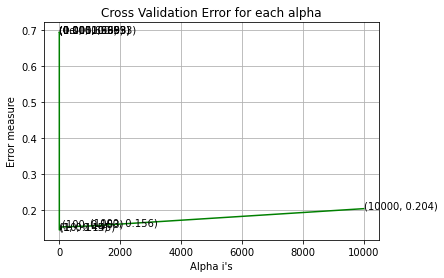

For values of best alpha =  1 The train log loss is: 0.11966093709370937
For values of best alpha =  1 The test log loss is: 0.1375043512153481
Total number of data points : 3985


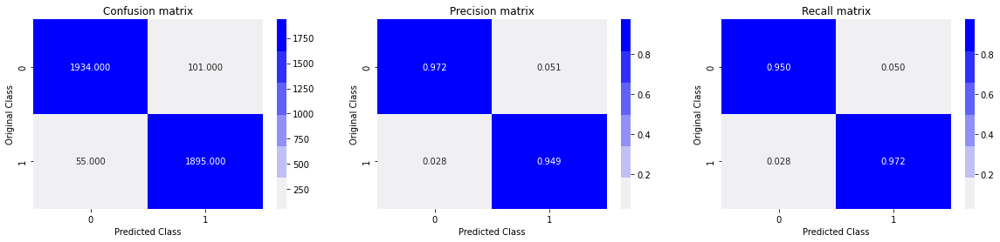

In [ ]:
alpha = [10 ** x for x in range(-5, 5)] # hyperparam for SGD classifier.

# read more about SGDClassifier() at http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.SGDClassifier.html
# ------------------------------
# default parameters
# SGDClassifier(loss=’hinge’, penalty=’l2’, alpha=0.0001, l1_ratio=0.15, fit_intercept=True, max_iter=None, tol=None, 
# shuffle=True, verbose=0, epsilon=0.1, n_jobs=1, random_state=None, learning_rate=’optimal’, eta0=0.0, power_t=0.5, 
# class_weight=None, warm_start=False, average=False, n_iter=None)

# some of methods
# fit(X, y[, coef_init, intercept_init, …])	Fit linear model with Stochastic Gradient Descent.
# predict(X)	Predict class labels for samples in X.

#-------------------------------
# video link: 
#------------------------------


log_error_array=[]
for i in alpha:
    clf = SGDClassifier(alpha=i, penalty='l2', loss='log', random_state=42)
    clf.fit(X_train, y_train)
    sig_clf = CalibratedClassifierCV(clf, method="sigmoid")
    sig_clf.fit(X_train, y_train)
    predict_y = sig_clf.predict_proba(X_cv)
    log_error_array.append(log_loss(y_cv, predict_y, labels=clf.classes_, eps=1e-15))
    print('For values of alpha = ', i, "The log loss is:",log_loss(y_cv, predict_y, labels=clf.classes_, eps=1e-15))

fig, ax = plt.subplots()
ax.plot(alpha, log_error_array,c='g')
for i, txt in enumerate(np.round(log_error_array,3)):
    ax.annotate((alpha[i],np.round(txt,3)), (alpha[i],log_error_array[i]))
plt.grid()
plt.title("Cross Validation Error for each alpha")
plt.xlabel("Alpha i's")
plt.ylabel("Error measure")
plt.show()


best_alpha = np.argmin(log_error_array)
clf = SGDClassifier(alpha=alpha[best_alpha], penalty='l2', loss='log', random_state=42)
clf.fit(X_train, y_train)
sig_clf = CalibratedClassifierCV(clf, method="sigmoid")
sig_clf.fit(X_train, y_train)

predict_y = sig_clf.predict_proba(X_train)
print('For values of best alpha = ', alpha[best_alpha], "The train log loss is:",log_loss(y_train, predict_y, labels=clf.classes_, eps=1e-15))
predict_y = sig_clf.predict_proba(X_test)
print('For values of best alpha = ', alpha[best_alpha], "The test log loss is:",log_loss(y_test, predict_y, labels=clf.classes_, eps=1e-15))
predicted_y =np.argmax(predict_y,axis=1)
print("Total number of data points :", len(predicted_y))
plot_confusion_matrix(y_test, predicted_y)

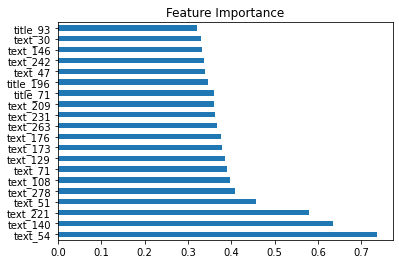

In [ ]:

importance = clf.coef_[0]
#importance is a list so you can plot it. 
feat_importances = pd.Series(importance,index=X_test.columns)
feat_importances.nlargest(20).plot(kind='barh',title = 'Feature Importance')

In [ ]:
import lime
from lime import lime_tabular
 
explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X_train.columns,
    class_names=[0,1],
    mode='classification'
)

In [ ]:
y_test.iloc[1]

1

In [ ]:
exp = explainer.explain_instance(
    data_row=X_test.iloc[1], 
    predict_fn=sig_clf.predict_proba
)
 
exp.show_in_notebook(show_table=True)

LINEAR SVM WITH HYPERPARAMETER TUNING

For values of alpha =  1e-05 The log loss is: 0.6930761907794611
For values of alpha =  0.0001 The log loss is: 0.6930761907794611
For values of alpha =  0.001 The log loss is: 0.6930761907794611
For values of alpha =  0.01 The log loss is: 0.6930761907794611
For values of alpha =  0.1 The log loss is: 0.6930761907794611
For values of alpha =  1 The log loss is: 0.6930761907794611
For values of alpha =  10 The log loss is: 0.6930761907794611


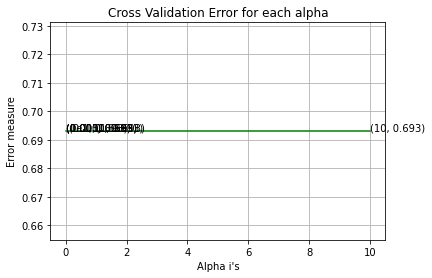

For values of best alpha =  1e-05 The train log loss is: 0.6930798080771466
For values of best alpha =  1e-05 The test log loss is: 0.6930776461453649
Total number of data points : 3985


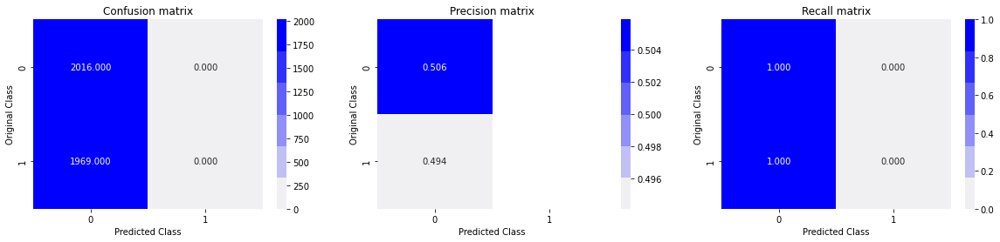

In [ ]:
alpha = [10 ** x for x in range(-5, 2)] # hyperparam for SGD classifier.

log_error_array=[]
for i in alpha:
    clf = SGDClassifier(alpha=i, penalty='l1', loss='hinge', random_state=42)
    clf.fit(X_train, y_train)
    sig_clf = CalibratedClassifierCV(clf, method="sigmoid")
    sig_clf.fit(X_train, y_train)
    predict_y = sig_clf.predict_proba(X_cv)
    log_error_array.append(log_loss(y_cv, predict_y, labels=clf.classes_, eps=1e-15))
    print('For values of alpha = ', i, "The log loss is:",log_loss(y_cv, predict_y, labels=clf.classes_, eps=1e-15))

fig, ax = plt.subplots()
ax.plot(alpha, log_error_array,c='g')
for i, txt in enumerate(np.round(log_error_array,3)):
    ax.annotate((alpha[i],np.round(txt,3)), (alpha[i],log_error_array[i]))
plt.grid()
plt.title("Cross Validation Error for each alpha")
plt.xlabel("Alpha i's")
plt.ylabel("Error measure")
plt.show()


best_alpha = np.argmin(log_error_array)
clf = SGDClassifier(alpha=alpha[best_alpha], penalty='l1', loss='hinge', random_state=42)
clf.fit(X_train, y_train)
sig_clf = CalibratedClassifierCV(clf, method="sigmoid")
sig_clf.fit(X_train, y_train)

predict_y = sig_clf.predict_proba(X_train)
print('For values of best alpha = ', alpha[best_alpha], "The train log loss is:",log_loss(y_train, predict_y, labels=clf.classes_, eps=1e-15))
predict_y = sig_clf.predict_proba(X_test)
print('For values of best alpha = ', alpha[best_alpha], "The test log loss is:",log_loss(y_test, predict_y, labels=clf.classes_, eps=1e-15))
predicted_y =np.argmax(predict_y,axis=1)
print("Total number of data points :", len(predicted_y))
plot_confusion_matrix(y_test, predicted_y)

XGBOOST ...

In [ ]:
import xgboost as xgb
params = {}
params['objective'] = 'binary:logistic'
params['eval_metric'] = 'logloss'
params['eta'] = 0.02
params['max_depth'] = 4

d_train = xgb.DMatrix(X_train, label=y_train)
d_test = xgb.DMatrix(X_test, label=y_test)

watchlist = [(d_train, 'train'), (d_test, 'valid')]

bst = xgb.train(params, d_train, 100, watchlist, early_stopping_rounds=10, verbose_eval=5)

xgdmat = xgb.DMatrix(X_train,y_train)
predict_y = bst.predict(d_test)
print("The test log loss is:",log_loss(y_test, predict_y, labels=clf.classes_, eps=1e-15))

[0]	train-logloss:0.673969	valid-logloss:0.674151
Multiple eval metrics have been passed: 'valid-logloss' will be used for early stopping.

Will train until valid-logloss hasn't improved in 10 rounds.
[5]	train-logloss:0.588688	valid-logloss:0.589571
[10]	train-logloss:0.517616	valid-logloss:0.519226
[15]	train-logloss:0.457709	valid-logloss:0.459925
[20]	train-logloss:0.406662	valid-logloss:0.409463
[25]	train-logloss:0.362807	valid-logloss:0.366129
[30]	train-logloss:0.324723	valid-logloss:0.328606
[35]	train-logloss:0.291431	valid-logloss:0.295618
[40]	train-logloss:0.262089	valid-logloss:0.26648
[45]	train-logloss:0.236376	valid-logloss:0.240872
[50]	train-logloss:0.213324	valid-logloss:0.217991
[55]	train-logloss:0.192446	valid-logloss:0.197393
[60]	train-logloss:0.174077	valid-logloss:0.1792
[65]	train-logloss:0.157474	valid-logloss:0.162563
[70]	train-logloss:0.141288	valid-logloss:0.145811
[75]	train-logloss:0.126879	valid-logloss:0.130953
[80]	train-logloss:0.114055	valid-logl

Total number of data points : 3985


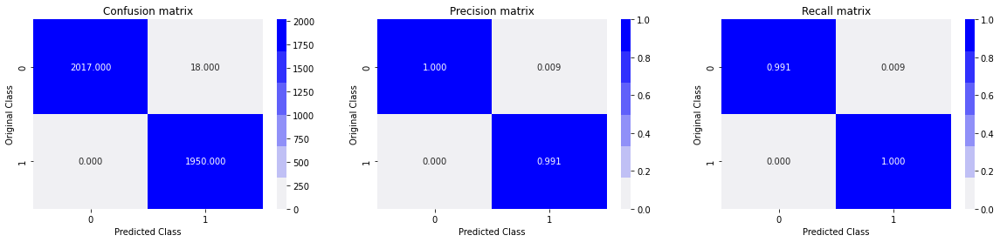

In [ ]:
predicted_y =np.array(predict_y>0.5,dtype=int)
print("Total number of data points :", len(predicted_y))
plot_confusion_matrix(y_test, predicted_y)

In [ ]:
bst.get_score(importance_type='gain')

{'no_title_words': 2988.4995943200006,
 'subject_Government News': 225.32642091200006,
 'subject_Middle-east': 191.74466371428574,
 'subject_US_News': 40.42799378,
 'subject_left-news': 277.6084925847826,
 'subject_politics': 319.4620966576627,
 'subject_politicsNews': 154.45616055870974,
 'subject_worldnews': 119.83446667152315,
 'text_157': 65.96300885,
 'text_190': 32.29905415,
 'text_257': 174.51706277777777,
 'text_292': 186.22616346153848,
 'text_86': 171.97988925,
 'title_length': 3.9474843350000004,
 'title_words': 1.241378785,
 'unique_words': 1.941070555}

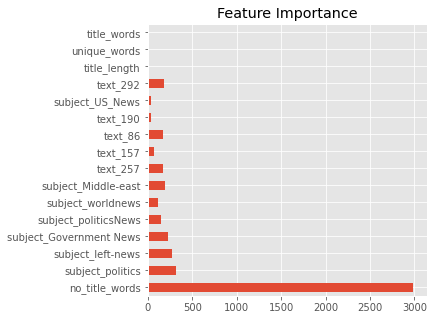

In [ ]:
importance=bst.get_score(importance_type='gain')
#importance is a dict so you can plot it. 
feat_importances = pd.Series(importance.values(),index=importance.keys())
feat_importances.plot(kind='barh',title = 'Feature Importance')